![Microsoft Film Venture](./images/project_banner.jpg)

# Microsoft Film Venture
## Flatiron School Data Science Phase 1 Project

# Introduction

### Initial Project Submision

**Student name**: [Rafael V Rabinovich](mailto:rafvrab@gmail.com)<br>
**Student pace**: Flex pace<br>
**Scheduled project review date/time**: 3/3/23 1:30pm EST<br>
**Instructor name**: Morgan Jones<br>
**Blog URL**: https://medium.com/@rafvrab

### Project Premise

Our team has been hired by Microsoft to assist them in gaining a better understanding of the movie industry. Specifically, we will be conducting data analysis to answer the question of which types of films are currently performing the best at the box office. Our findings will then be translated into useful insights for Microsoft's new movie studio to use when making decisions about which films to produce.


### Goals

Throughout this project, we will be evaluating films based on several different standards, such as:<ul> <li>Genre<li>Runtime<li>Release Date<li>Rating<li>Production Budget.<br></ul>
In our analysis, we will explore what the best measure is for movies with the highest ROI (return on invesment), as well as what else should be taken into account. Ultimately, our goal is to provide actionable insights that will inform the studio's future decision-making.

### Method

(will expand upon review of methods used below)

### Importing Libraries

In order to open, explore, visualize and understand the data needed for our task, we will begin by importing the Python language libraries that allow us to do all of this.

Pandas - abreviated "pd", is a data analysis library. We rely heavily on it to visualize data structures and to manipulate numerical tables.<br><br>
Numpy - apreviated "np", is a library use for working with arrays, and various mathematical uses.<br><br>
SQLite3 is a library that allows us to work with lightwight databases. <br><br>
ZIPfile is a library module used to open ZIP files. This we need to open larger database files.<br><br>
Gzip is a library module that, like ZIPfile, opens ZIP files. This is an alternative module we want to have. <br><br>
Random is a module used to generate random variables. I want this as a tool to explore my EDA tools without compromising actual data.  (I may not show its use here after I clean my work for presentation)<br><br>
MatPlotLib - abreviated "plt", is a comprehensive library used to create graph visualizations. <br><br>
Seaborn - abreviated "sns", is another data visualization library, based of MatPlotLib, which is used for drawing attractive statistical graphics.

If more libraries become necessary along the process of our work, we will import them as needed.

In [47]:
# Bringing in the libraries I will use for this project
import pandas as pd
import numpy as np
import sqlite3
import zipfile
import gzip
import random
import matplotlib.pyplot as plt
import seaborn as sns

Having imported the Python libraries we will use for the technical presentation, we will now look into the databases. This initial exploratory step will shine a light on the content of the data we were given.

As a first step, we use the "dir" command to list our data files and their size. 

In [7]:
# Let's see that the data is there
! dir Data

 Volume in drive C has no label.
 Volume Serial Number is 5CDE-0ED8

 Directory of C:\Users\us\Documents\DT Flatiron Flex Course\phase_1\Microsoft_Film_Proposal\Data

03/01/2023  12:29 PM    <DIR>          .
03/01/2023  12:29 PM    <DIR>          ..
01/09/2023  11:47 AM            53,544 bom.movie_gross.csv.gz
12/20/2021  04:31 PM       169,443,328 im.db
01/09/2023  11:47 AM        67,149,708 im.db.zip
02/13/2023  03:21 PM         1,184,685 rt.movie_info.tsv
01/09/2023  11:47 AM           498,202 rt.movie_info.tsv.gz
01/09/2023  11:47 AM         3,402,194 rt.reviews.tsv.gz
01/09/2023  11:47 AM           827,840 tmdb.movies.csv.gz
01/09/2023  11:47 AM           153,218 tn.movie_budgets.csv.gz
               8 File(s)    242,712,719 bytes
               2 Dir(s)  322,089,320,448 bytes free


For the purpose of clarity, let us look at the relevant part of this information in tabular form:

|Data File             | Size (in bytes)|
|----------------------|----------------|
|bom.movie_gross.csv.gz|	53,544|
|im.db|	169,443,328|
|im.db.zip|	67,149,708|
|rt.movie_info.tsv|	1,184,685|
|rt.movie_info.tsv.gz|	498,202|
|rt.reviews.tsv.gz|	3,402,194|
|tmdb.movies.csv.gz|	827,840|
|tn.movie_budgets.csv.gz|	153,218|

We have 8 data files. The content of 'im.db' and 'im.db.zip' is the same. We did use an out-of-code method to unzip that large file. So we have actually 7 resources for our data.<br><br>
3 files are in .csv format, another 3 are in .tsv format, and one is in .db format. This information is relevant to how we will open and explore that data.<br><br>
We will now proceed to open them and look at their content.<br><br>
As we read the files, we will assign each to a 'df' (data frame) variable. This will allow us to work with data frames rather than with files of different formats.<br><br>
First we assign the df_mg variable to the bom.movie_gross.csv.gz file.  Then we open it to see its contents.

In [11]:
df_mg = pd.read_csv('Data/bom.movie_gross.csv.gz') # opens that file
df_mg  # to see the contents

,title,studio,domestic_gross,foreign_gross,year
0,Toy Story 3,BV,415000000.0,652000000,2010
1,Alice in Wonderland (2010),BV,334200000.0,691300000,2010
2,Harry Potter and the Deathly Hallows Part 1,WB,296000000.0,664300000,2010
3,Inception,WB,292600000.0,535700000,2010
4,Shrek Forever After,P/DW,238700000.0,513900000,2010
...,...,...,...,...,...
3382,The Quake,Magn.,6200.0,NaN,2018
3383,Edward II (2018 re-release),FM,4800.0,NaN,2018
3384,El Pacto,Sony,2500.0,NaN,2018
3385,The Swan,Synergetic,2400.0,NaN,2018


The file contains movie titles, the name of the filming studio, domestic and foreign gross revenue, and the year the film was released.  Five columns, and 3387 rows of data.  In some cases we see that there is not information on foreign gross revenue, rendered as "NaN". 

Next we will open the IMDb data file. For this we will use the "conn" instruction and place our cursor there.  We are using SQLite.

In [12]:
# Connecting to the IMDb Database
conn = sqlite3.connect('Data\im.db')  # connects to the file
cursor = conn.cursor() # places the cursor there

An SQL database file contains various tables of information. we want to reach into those tables, and then use Python to open and explore them. <br><br>
Let's proceed to read the tables list.

In [13]:
sql_tables = """
select name
from sqlite_master
where type='table'
"""

Now we read and produce a list of the tables. We will assing the "df_1" variable to this list:

In [16]:
# Defining an SQL table as Python data frame "df_1".  The number is to differenciate it from other data frames.
df_1 = pd.read_sql(sql_tables, conn)
df_1.head(8)

,name
0,movie_basics
1,directors
2,known_for
3,movie_akas
4,movie_ratings
5,persons
6,principals
7,writers


There are 8 tables: movie_basics, directors, known_for, movie_akas, movie_ratings, persons, principals, and writers.

Let's now look into the 'movie_basics' table to see some of the movies by their ID, title, year of production, runtime length and genre.  

In [21]:
sql = "SELECT * FROM movie_basics"  # Selects the SQL table
df_mb = pd.read_sql(sql, conn) # assigns the 'df_mb' variable
df_mb.head(25) #shows the first 25 rows


,movie_id,primary_title,original_title,start_year,runtime_minutes,genres
0,tt0063540,Sunghursh,Sunghursh,2013,175.0,"Action,Crime,Drama"
1,tt0066787,One Day Before the Rainy Season,Ashad Ka Ek Din,2019,114.0,"Biography,Drama"
2,tt0069049,The Other Side of the Wind,The Other Side of the Wind,2018,122.0,Drama
3,tt0069204,Sabse Bada Sukh,Sabse Bada Sukh,2018,NaN,"Comedy,Drama"
4,tt0100275,The Wandering Soap Opera,La Telenovela Errante,2017,80.0,"Comedy,Drama,Fantasy"
5,tt0111414,A Thin Life,A Thin Life,2018,75.0,Comedy
6,tt0112502,Bigfoot,Bigfoot,2017,NaN,"Horror,Thriller"
7,tt0137204,Joe Finds Grace,Joe Finds Grace,2017,83.0,"Adventure,Animation,Comedy"
8,tt0139613,O Silêncio,O Silêncio,2012,NaN,"Documentary,History"
9,tt0144449,Nema aviona za Zagreb,Nema aviona za Zagreb,2012,82.0,Biography


How big is our data frame here? Let's explore:

In [22]:
# How big is our data frame?
df_mb.shape  # provides information of the number of rows, number of columns

(146144, 6)

The data is 146,144 rows long and prodives 6 columns of information: movie_id, primary_title, original_title, start_year, runtime_minutes, and genres. We see that when runtime information is missing "NaN" replaces the missing data.  When genre information is missing, the word 'None' appears. We also see that each film is names with the title in its original language.

Let's now look at the next table: directors.

In [23]:
sql = "SELECT * FROM directors"  # Selects the SQL table
df_dir = pd.read_sql(sql, conn) # assigns the 'df_dir' variable
df_dir.head(25) #shows the first 25 rows

,movie_id,person_id
0,tt0285252,nm0899854
1,tt0462036,nm1940585
2,tt0835418,nm0151540
3,tt0835418,nm0151540
4,tt0878654,nm0089502
5,tt0878654,nm2291498
6,tt0878654,nm2292011
7,tt0879859,nm2416460
8,tt0996958,nm2286991
9,tt0996958,nm2286991


In [24]:
# How big is our data frame?
df_dir.shape  # provides information of the number of rows, number of columns

(291174, 2)

We have a data frame of 291,174 rows and 2 columns. The 'directors' table is a reference of movie_id to person_id. What those IDs represent we should surely see in other tables.  The purpose of this reference is to associate film directors to the movies they directed. We might use this if we decide to merge a table containing movie titles with a table containing the names of film directors.

In order to continue this process in a expeditive fashion, we will not assign dataframe variables to all remining tables in the 'im.db' database file. We will then glance into each table.<br><br>
We will assign df_kf to the 'known_for' table, df_akas to 'movie_akas', df_ratings to 'movie_ratings', df_dir to 'directors', df_persons to 'persons', df_principals to 'principals', df_writers to 'writers', and df_mb to 'movie_basics'.

In [26]:
# Read known_for table
sql = "SELECT * FROM known_for"
df_kf = pd.read_sql(sql, conn)

# Read movie_akas table
sql = "SELECT * FROM movie_akas"
df_akas = pd.read_sql(sql, conn)

# Read movie_ratings table
sql = "SELECT * FROM movie_ratings"
df_ratings = pd.read_sql(sql, conn)

# Read persons table
sql = "SELECT * FROM persons"
df_persons = pd.read_sql(sql, conn)

# Read principals table
sql = "SELECT * FROM principals"
df_principals = pd.read_sql(sql, conn)

# Read writers table
sql = "SELECT * FROM writers"
df_writers = pd.read_sql(sql, conn)


Now we look at the known_for table:

In [29]:
df_kf.head(25) # opens the table's first 25 rows using the assigned variable

,person_id,movie_id
0,nm0061671,tt0837562
1,nm0061671,tt2398241
2,nm0061671,tt0844471
3,nm0061671,tt0118553
4,nm0061865,tt0896534
5,nm0061865,tt6791238
6,nm0061865,tt0287072
7,nm0061865,tt1682940
8,nm0062070,tt1470654
9,nm0062070,tt0363631


In [30]:
df_kf.shape # provides information of the number of rows, number of columns

(1638260, 2)

This is another reference table with the IDs of directors and the film they are best known for. The table is 1,638,260 rows long. As in the case of other reference tables, this will only serve as a connector between tables or data files with lists of directors and other data files or tables with lists of movies. We may or may not chose to merge such files.

Let's now look at movie_akas.

In [31]:
df_akas.head(25) # opens the table's first 25 rows using the assigned variable

,movie_id,ordering,title,region,language,types,attributes,is_original_title
0,tt0369610,10,Джурасик свят,BG,bg,None,None,0.0
1,tt0369610,11,Jurashikku warudo,JP,None,imdbDisplay,None,0.0
2,tt0369610,12,Jurassic World: O Mundo dos Dinossauros,BR,None,imdbDisplay,None,0.0
3,tt0369610,13,O Mundo dos Dinossauros,BR,None,None,short title,0.0
4,tt0369610,14,Jurassic World,FR,None,imdbDisplay,None,0.0
5,tt0369610,15,Jurassic World,GR,None,imdbDisplay,None,0.0
6,tt0369610,16,Jurassic World,IT,None,imdbDisplay,None,0.0
7,tt0369610,17,Jurski svijet,HR,None,imdbDisplay,None,0.0
8,tt0369610,18,Olam ha'Yura,IL,he,imdbDisplay,None,0.0
9,tt0369610,19,Jurassic World: Mundo Jurásico,MX,None,imdbDisplay,None,0.0


In [32]:
df_akas.shape # provides information of the number of rows, number of columns

(331703, 8)

The movie_akas table has 331,703 rows, and 8 columns of information: 
movie_id, ordering, title, region, language, types, attributes, and is_original_title
I am not sure what "ordering" means. The title is in the original language. The 'region' column provides two or three letters identifying the country where the film was produced. The 'language' column seems to be missing a lot of information, placing 'None' in most cases, or giving the film language in a two-letter code. The 'type' column tells us whether the film is in IMDb Display or not. The 'attributes' column mentions special attributes, such as 'short title' or '3-D version', otherwise leaves the field as 'None'. Finally, the 'is_original_title' column seems to identify an original title as '0.0'.

Let's now look at the 'movie_ratings' table:

In [33]:
df_ratings.head(25) # opens the table's first 25 rows using the assigned variable

,movie_id,averagerating,numvotes
0,tt10356526,8.3,31
1,tt10384606,8.9,559
2,tt1042974,6.4,20
3,tt1043726,4.2,50352
4,tt1060240,6.5,21
5,tt1069246,6.2,326
6,tt1094666,7.0,1613
7,tt1130982,6.4,571
8,tt1156528,7.2,265
9,tt1161457,4.2,148


In [34]:
df_ratings.shape # provides information of the number of rows, number of columns

(73856, 3)

In [35]:
df_persons.head(25) # opens the table's first 25 rows using the assigned variable

,person_id,primary_name,birth_year,death_year,primary_profession
0,nm0061671,Mary Ellen Bauder,NaN,NaN,"miscellaneous,production_manager,producer"
1,nm0061865,Joseph Bauer,NaN,NaN,"composer,music_department,sound_department"
2,nm0062070,Bruce Baum,NaN,NaN,"miscellaneous,actor,writer"
3,nm0062195,Axel Baumann,NaN,NaN,"camera_department,cinematographer,art_department"
4,nm0062798,Pete Baxter,NaN,NaN,"production_designer,art_department,set_decorator"
5,nm0062879,Ruel S. Bayani,NaN,NaN,"director,production_manager,miscellaneous"
6,nm0063198,Bayou,NaN,NaN,actor
7,nm0063432,Stevie Be-Zet,NaN,NaN,"composer,soundtrack"
8,nm0063618,Jeff Beal,1963.0,NaN,"composer,music_department,soundtrack"
9,nm0063750,Lindsay Beamish,NaN,NaN,"actress,miscellaneous"


In [38]:
df_persons.shape # provides information of the number of rows, number of columns

(606648, 5)

In [36]:
df_principals.head(25) # opens the table's first 25 rows using the assigned variable

,movie_id,ordering,person_id,category,job,characters
0,tt0111414,1,nm0246005,actor,None,"[""The Man""]"
1,tt0111414,2,nm0398271,director,None,None
2,tt0111414,3,nm3739909,producer,producer,None
3,tt0323808,10,nm0059247,editor,None,None
4,tt0323808,1,nm3579312,actress,None,"[""Beth Boothby""]"
5,tt0323808,2,nm2694680,actor,None,"[""Steve Thomson""]"
6,tt0323808,3,nm0574615,actor,None,"[""Sir Lachlan Morrison""]"
7,tt0323808,4,nm0502652,actress,None,"[""Lady Delia Morrison""]"
8,tt0323808,5,nm0362736,director,None,None
9,tt0323808,6,nm0811056,producer,producer,None


In [41]:
df_principals.shape # provides information of the number of rows, number of columns

(1028186, 6)

In [37]:
df_writers.head(25) # opens the table's first 25 rows using the assigned variable

,movie_id,person_id
0,tt0285252,nm0899854
1,tt0438973,nm0175726
2,tt0438973,nm1802864
3,tt0462036,nm1940585
4,tt0835418,nm0310087
5,tt0835418,nm0841532
6,tt0878654,nm0284943
7,tt0878654,nm0284943
8,tt0878654,nm0284943
9,tt0996958,nm2286991


In [40]:
df_writers.shape # provides information of the number of rows, number of columns

(255873, 2)

Having completed our first look at the tables in the IMDb database file, let's continue with the 'rt.movie_info.tsv' file.  We will assign it the 'db_rt_m' dataframe variable.  

In [42]:
# Read the file and assign it to the variable
db_rt_mi = pd.read_csv('Data/rt.movie_info.tsv', sep='\t')  # This argument specifies that the file is tab-separated

# Display the first 25 rows to verify it was loaded correctly
db_rt_mi.head(25)


,id,synopsis,rating,genre,director,writer,theater_date,dvd_date,currency,box_office,runtime,studio
0,1,"This gritty, fast-paced, and innovative police...",R,Action and Adventure|Classics|Drama,William Friedkin,Ernest Tidyman,"Oct 9, 1971","Sep 25, 2001",NaN,NaN,104 minutes,NaN
1,3,"New York City, not-too-distant-future: Eric Pa...",R,Drama|Science Fiction and Fantasy,David Cronenberg,David Cronenberg|Don DeLillo,"Aug 17, 2012","Jan 1, 2013",$,"600,000",108 minutes,Entertainment One
2,5,Illeana Douglas delivers a superb performance ...,R,Drama|Musical and Performing Arts,Allison Anders,Allison Anders,"Sep 13, 1996","Apr 18, 2000",NaN,NaN,116 minutes,NaN
3,6,Michael Douglas runs afoul of a treacherous su...,R,Drama|Mystery and Suspense,Barry Levinson,Paul Attanasio|Michael Crichton,"Dec 9, 1994","Aug 27, 1997",NaN,NaN,128 minutes,NaN
4,7,NaN,NR,Drama|Romance,Rodney Bennett,Giles Cooper,NaN,NaN,NaN,NaN,200 minutes,NaN
5,8,The year is 1942. As the Allies unite overseas...,PG,Drama|Kids and Family,Jay Russell,Gail Gilchriest,"Mar 3, 2000","Jul 11, 2000",NaN,NaN,95 minutes,Warner Bros. Pictures
6,10,Some cast and crew from NBC's highly acclaimed...,PG-13,Comedy,Jake Kasdan,Mike White,"Jan 11, 2002","Jun 18, 2002",$,"41,032,915",82 minutes,Paramount Pictures
7,13,"Stewart Kane, an Irishman living in the Austra...",R,Drama,Ray Lawrence,Raymond Carver|Beatrix Christian,"Apr 27, 2006","Oct 2, 2007",$,"224,114",123 minutes,Sony Pictures Classics
8,14,"""Love Ranch"" is a bittersweet love story that ...",R,Drama,Taylor Hackford,Mark Jacobson,"Jun 30, 2010","Nov 9, 2010",$,"134,904",117 minutes,NaN
9,15,When a diamond expedition in the Congo is lost...,PG-13,Action and Adventure|Mystery and Suspense|Scie...,Frank Marshall,John Patrick Shanley,"Jun 9, 1995","Jul 27, 1999",NaN,NaN,108 minutes,NaN


In [44]:
db_rt_mi.shape # provides information of the number of rows, number of columns

(1560, 12)

Now we open and take a look at 'rt.reviews.tsv.gz', assigning it the 'db_reviews' variable.

In [50]:
# Open the gzipped file and read its contents as bytes
with gzip.open('Data/rt.reviews.tsv.gz', 'rb') as f:
    file_content = f.read()

# Decode the content using ISO-8859-1 encoding and read it with pandas
db_reviews = pd.read_csv(file_content.decode('ISO-8859-1'), sep='\t')

# Display the first 5 rows to verify it was loaded correctly
db_reviews.head()

FileNotFoundError: [Errno 2] No such file or directory: 'id\treview\trating\tfresh\tcritic\ttop_critic\tpublisher\tdate\r\n3\tA distinctly gallows take on contemporary financial mores, as one absurdly rich man\'s limo ride across town for a haircut functions as a state-of-the-nation discourse. \t3/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 10, 2018\r\n3\tIt\'s an allegory in search of a meaning that never arrives...It\'s just old-fashioned bad storytelling.\t\trotten\tAnnalee Newitz\t0\tio9.com\tMay 23, 2018\r\n3\t... life lived in a bubble in financial dealings and digital communications and brief face-to-face conversations and sexual intermissions in a space shuttle of a limousine creeping through the gridlock of an anonymous New York City.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tJanuary 4, 2018\r\n3\t"Continuing along a line introduced in last year\'s ""A Dangerous Method"", David Cronenberg pushes his cinema towards a talky abstraction in his uncanny, perversely funny and frighteningly insular adaptation of Don DeLillo, ""Cosmopolis""."\t\tfresh\tDaniel Kasman\t0\tMUBI\tNovember 16, 2017\r\n3\t... a perverse twist on neorealism... \t\tfresh\t\t0\tCinema Scope\tOctober 12, 2017\r\n3\t... Cronenberg\'s Cosmopolis expresses something new and necessary about the book, which is to say about limits, the gaps in what can be known, both within and between us.\t\tfresh\tMichelle Orange\t0\tCapital New York\tSeptember 11, 2017\r\n3\tQuickly grows repetitive and tiresome, meandering toward messages that land softly, producing little impact.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 17, 2013\r\n3\tCronenberg is not a director to be daunted by a scenario in which the antihero spends most of his time in a stretch limo. Turning it into a film that interests anyone ... is another matter\t2/5\trotten\tMatt Kelemen\t0\tLas Vegas CityLife\tApril 21, 2013\r\n3\tCronenberg\'s cold, exacting precision and emotionally removed observation may not grab all viewers, but under those perfect surfaces is a raw horror trying to claw out of the denial.\t\tfresh\tSean Axmaker\t0\tParallax View\tMarch 24, 2013\r\n3\tOver and above its topical urgency or the bit about the misfortune of globalism, it does what this director has always done in his films: split open the head of a character, plunge inside and try to visualise the bad and the ugly things to be found there.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMarch 4, 2013\r\n3\t"Cosmopolis"" is a hypnotic examination of our modern anxieties about the dehumanization brought on by wealth, power, and technology."\t\tfresh\tTim Grierson\t0\tDeadspin\tFebruary 12, 2013\r\n3\tWhile not one of Cronenberg\'s stronger films, this anti-capitalist adaptation still merits attention.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 3, 2013\r\n3\tRobert Pattinson works mighty hard to make Cosmopolis more than just an erudite slap at modern capitalism. The Twilight heartthrob ultimately fails to rescue a meandering story hitting stale versions of the same talking points.\t2/4\trotten\tChristian Toto\t0\tBig Hollywood\tJanuary 15, 2013\r\n3\tThe anger over the injustice of the financial collapse and bailout is what powered the Tea Party movement as well as the Occupy Wall Street movement, and it powers this movie, too.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 7, 2013\r\n3\tFor those who like their Cronenberg thick and chewy\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 20, 2012\r\n3\tFor better or worse - often both - Cosmopolis is a quintessential David Cronenberg film. Cosmopolis is simultaneously fascinating and impenetrable, profound and absurd, labyrinthine yet intimate.\t3/5\tfresh\tAdam Ross\t0\tThe Aristocrat\tSeptember 27, 2012\r\n3\tFor one of the smartest films I\'ve seen in a while, Cosmopolis is also one of the least outwardly enjoyable. That by no means makes it anything less than a great film however.\t4/5\tfresh\tPatrick Kolan\t0\tShotgun Cinema\tSeptember 26, 2012\r\n3\tIts major problem is that it\'s not cinematic.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 25, 2012\r\n3\t"It\'s fascinating to watch Pattinson actually acting, rather than merely brooding through another ""Twilight"" movie, but he\'s as trapped in Cronenberg\'s sterile intellectualism as Packer is in his leather-upholstered hell."\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 14, 2012\r\n3\tA black comedy as dry and deadpan as a bleached skull. To this end, the movie opens with a sort of death\'s-head grin: an in-your-face closeup of the grille of a stretch limousine...\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 10, 2012\r\n3\tWhile \'Cosmopolis\' is mostly emotionless and a big letdown it isn\'t completely boring and has the potential to be better with repeat viewings, but it just isn\'t as good as a Cronenberg film should be.\t6/10\tfresh\tChris Sawin\t0\tExaminer.com\tSeptember 7, 2012\r\n3\tIn the past, Cronenberg has used such deadpan performances to striking effect, but in the case of Cosmopolis, the approach just leaves a giant vaccum in the soul of the celluloid\t1/4\trotten\tJason Buchanan\t0\tTV Guide\tSeptember 7, 2012\r\n3\t... a movie about a sentient zombie, trapped in a womblike limousine while outside the dead souls of Manhattan roil, spraying paint on his windows and hurling rats. Everything he wants is posthumous.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 7, 2012\r\n3\tThose who said Don DeLillo\'s book was unfilmable were wrong. This is a film. That much is undeniable. Whether it\'s a compelling one is a whole other question.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tSeptember 7, 2012\r\n3\tThe rapid dialogue is dry and mannered, like a David Mamet play, there\'s virtually no story and Cronenberg\'s visual scheme is cold and claustrophobic.\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tSeptember 6, 2012\r\n3\t"Cosmopolis"" is proof that a film can be provocative yet completely un-enjoyable."\t4/10\trotten\tJustin Craig\t0\tFoxNews.com\tSeptember 5, 2012\r\n3\tIt\'s fascinating but anti-cinematic and a frustrating film to get your arms around.\t\tfresh\tRoger Moore\t0\tTribune News Service\tSeptember 4, 2012\r\n3\tThrows heady ideas at you faster than Michael Bay can explode a building, but the rate at which ideas stick is inconsistent. It does, however, develop a rhythm. The metered language forces you to adjust just as emotion develops.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 4, 2012\r\n3\tA master filmmaker\'s rumination on capitalism as a vision of diseased titanium\t\tfresh\tFernando F. Croce\t0\tCinePassion\tSeptember 4, 2012\r\n3\tDavid Cronenberg takes a wayward shot at making a film out of Don DeLillo\'s artful novel Cosmopolis. Cronenberg\'s version drones and flounders.\t2.0/5\trotten\tTony Macklin\t0\ttonymacklin.net\tSeptember 2, 2012\r\n3\tCynical and futile - a total waste of time and money.\t3/10\trotten\tSusan Granger\t0\tSSG Syndicate\tSeptember 1, 2012\r\n3\t"If there has ever been a point in human history when the phrase ""asymmetrical prostate"" got a bigger laugh than it does [here], I\'ve never heard of it."\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 31, 2012\r\n3\tWell, if it isn\'t the most confounding movie of the year.\t\trotten\tMonica Castillo\t0\tDig Boston\tAugust 31, 2012\r\n3\tIf Cosmopolis remains chilly and remote, it does so in a way that often feels unsettlingly familiar.\t3/5\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tAugust 30, 2012\r\n3\tI don\'t know if DeLillo\'s fetishized doubletalk ever works in a visual medium like film, but I can tell you that Robert Pattinson sure as hell isn\'t up to it, at least not without better direction than this. \tC\trotten\tVincent Mancini\t0\tFilmDrunk\tAugust 30, 2012\r\n3\tThough hardly a crowd-pleaser. it\'s the sort of challenging, thought-provoking, stylistically striking piece of auteurism one rarely encounters nowadays.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 30, 2012\r\n3\tCosmopolis deconstructs language, symbols and theories to present a sprawling and dense post-GFC Heart of Darkness.\t4/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tAugust 29, 2012\r\n3\tCold and calculated, Cosmospolis is a mesmerizing journey that takes us deep into the heart of darkness -- familiar territory for such an extraordinary auteur.\t\tfresh\tMark Sells\t0\tThe Reel Deal\tAugust 28, 2012\r\n3\tWith a cast like this we expected major Cronenberg. Didn\'t happen.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 27, 2012\r\n3\tNot worth seeing\t\trotten\tDiana Saenger\t0\tReviewExpress.com\tAugust 25, 2012\r\n3\tCosmopolis is an investment that pays off enormous dividends.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 24, 2012\r\n3\tCosmopolis is something like the anti-matter version of Atlas Shrugged.\t\tfresh\t\t0\tMetroActive\tAugust 24, 2012\r\n3\tIf you pay even a single penny to watch the thing, you\'ll be making the most ill-advised purchase of your natural born life.\tF\trotten\tErick Weber\t0\tNECN\tAugust 24, 2012\r\n3\tI can\'t convince myself that Cosmopolis is anything other than unscripted documentary about the life of Robert Pattinson, shot by security cameras. \t3.5/4\tfresh\tPhil Villarreal\t0\tOK! Magazine\tAugust 24, 2012\r\n3\tI must admit Robert Pattinson does dead extremely well.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tAugust 24, 2012\r\n3\t"Cosmopolis"" is a deeply subversive, deeply intelligent movie for grown-ups. Brilliant."\t4/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tAugust 24, 2012\r\n3\tRobert Pattinson... brings a slick, knowing roboticness to a man desperate to maintain a pretense of control and command of the world around him.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 24, 2012\r\n3\tIt feels like each and every moment bursts forth with urgent dialogue, and yet what does anyone actually say?\t2/4\trotten\tStephanie Merry\t1\tWashington Post\tAugust 24, 2012\r\n3\tThen there\'s the matter of the screenplay, which places everything in a haze of mannered syntax and enigmatic phrasing.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 23, 2012\r\n3\tArt-house cinema at its most achingly smarmy and self-indulgent. Frustrating verging on abysmal verging on infuriating.\t\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 23, 2012\r\n3\tThere\'s not really a movie there, nothing that sustains itself from scene to scene and nothing that\'s worth watching from beginning to end.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 23, 2012\r\n3\tThis film is a tough sell. But it\'s never less than daring, poised or deliberate. It doesn\'t go down easy, but it clings.\tB-\tfresh\tShawn Levy\t0\tOregonian\tAugust 23, 2012\r\n3\tWatching Cosmopolis, it\'s hard to say if you\'re witnessing a revelation or a crock, but you\'ll hang on its every word.\t4/5\tfresh\tHank Sartin\t0\tTime Out Chicago\tAugust 23, 2012\r\n3\tCronenberg seems like he has something specific, possibly devilishly satiric in mind, but his screen instincts are numb, constructing a feature that lurches from scene to scene.\tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 23, 2012\r\n3\tThe film is all too faithful to its un-cinematic source.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 23, 2012\r\n3\t"Cosmopolis,"" because of its allegiance to the book\'s mannered, offbeat language, feels like it never wakes up."\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tAugust 23, 2012\r\n3\tA purposefully disjointed, pretentious, philosophical, and deeply stylized journey through an exaggerated commentary on the haves, the have-nots, and those stuck in the middle. \t3.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tAugust 23, 2012\r\n3\tHere we have a brainy, sometimes impenetrable director, working from a book by brainy, sometimes impenetrable author. What do they come up with? Something that\'s brainy, sometimes impenetrable.\t2.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 23, 2012\r\n3\tPoor Pattinson does the best he can. He\'s not terrible. But he\'s definitely out of his element, if not beyond his depth, an altar boy in a bishop\'s robes.\t2/4\trotten\tMark Feeney\t1\tBoston Globe\tAugust 23, 2012\r\n3\tThe program is secure, but are we?\t8/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tAugust 23, 2012\r\n3\tThe story seems to cleave into cerebral disquisition and primal sex.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tAugust 23, 2012\r\n3\tJuliette Binoche is unusually playful and loose as Pattinson\'s sex buddy, and Paul Giamatti\'s intensity briefly raises the movie\'s sharpness level. But I don\'t think they\'re enough to compensate for the film\'s general air of arch superiority.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 23, 2012\r\n3\tThe movie isn\'t for everyone. But if it grabs you, prepare for it to stick in your head for days.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tAugust 23, 2012\r\n3\tRobert Pattinson\'s most interesting performance by a mile.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tAugust 23, 2012\r\n3\tA flawlessly directed film about enigmatic people who speak in morose epigrams about vague universal principles they show no sign of understanding.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tAugust 23, 2012\r\n3\tLike all the best Cronenberg pictures, Cosmopolis is a pitch-black comedy about man\'s foolhardy attempt to impose systems of order on nature\'s chaos.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tAugust 22, 2012\r\n3\tIf you are a fan of David Cronenberg, you should include [Cosmopolis] in things to watch list.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tAugust 22, 2012\r\n3\tThere is sci-fi and there is Cronenberg sci-fi and here he has reached his pinnacle with his hallucinatory, hypnotic trip. We are in Cronenberg\'s bubble until he lets it burst.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 22, 2012\r\n3\tDavid Cronenberg\'s North by Northwest\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tAugust 22, 2012\r\n3\t...the bodily invasions are not only reflective of a psychological state, but of a socioeconomic one as well.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tAugust 22, 2012\r\n3\tAfter seeing Cosmopolis, you\'re going to want to take a shower.\t3/5\tfresh\tSamir Mathur\t0\tOrlando Weekly\tAugust 22, 2012\r\n3\tThough the cool, insolent stoicism does work for Pattinson as the narcissistic royal-\'we\' speaking wunderkind, even he can\'t carry this weighty, wordy dissertation on the burdens of money, fame and power.\t\trotten\tStaci Layne\t0\tSci-Fi Weekly\tAugust 21, 2012\r\n3\tAs usual, Cronenberg shows masterful control, starting with Pattinson.\t6/10\tfresh\tJesse Hassenger\t0\tPopMatters\tAugust 21, 2012\r\n3\tIt\'s effective for all the reasons, as propaganda, it\'s not: It\'s messy and goofy and unsettling.\t\tfresh\tPaul Schrodt\t0\tEsquire Magazine\tAugust 21, 2012\r\n3\tIt helps that Pattinson interacts with truly great performances from the supporting cast. \tA-\tfresh\tDrew McWeeny\t0\tHitFix\tAugust 21, 2012\r\n3\tIt helps to let yourself get lost in David Cronenberg\'s Cosmopolis, which adapts Don Delillo\'s novel and clings hard to the inscrutable, arcane language, which very deliberately keeps the audience at arm\'s length\t3.5/5\tfresh\tKatey Rich\t0\tCinemaBlend\tAugust 20, 2012\r\n3\tAn often fascinating formal exercise by one of modern cinema\'s most consistently intriguing filmmakers.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tAugust 17, 2012\r\n3\tDespite the constrictions, Cronenberg keeps the space handsome and active. For long stretches, Cosmopolis is dreamy and funny, in an off-centered way.\t\tfresh\tDavid Denby\t1\tNew Yorker\tAugust 17, 2012\r\n3\tIt is one of the director\'s better movies of recent years, even if it is occasionally maddening.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tAugust 17, 2012\r\n3\tSmart and stylized - which doesn\'t innoculate this story of a sad billionaire against lethal familiarity and dullness. Pattinson\'s stiffness works, but the dialogue is vapid.\t\trotten\tCaryn James\t0\tJames on screenS\tAugust 17, 2012\r\n3\tNothing lies behind or within the film\'s vapid non-personalities, flat acting and dull dialogue, hot-air one-liner aphorisms, mechanical couplings or ice-queen evasions of consummation.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tAugust 17, 2012\r\n3\tDavid Cronenberg meets Don DeLillo at last, and it\'s as if all the angels of heaven have come together. And said nothing.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tAugust 17, 2012\r\n3\tThe hilarious thought of stunned Team Edward devotees scratching their heads at this mystifying David Cronenberg movie is about all there is to get you through it.\t1.5/4\trotten\tRobert Levin\t0\tamNewYork\tAugust 16, 2012\r\n3\tI took a strange pleasure in submitting to this movie\'s stilted but weirdly poetic rhythms. But I freely acknowledge that for others, enduring Cosmopolis may be less fun than a backseat prostate exam.\t\tfresh\tDana Stevens\t1\tSlate\tAugust 16, 2012\r\n3\tWeird, difficult, and important, Cosmopolis may be one of the best films of the year.\t9/10\tfresh\tWitney Seibold\t0\tCraveOnline\tAugust 16, 2012\r\n3\tCosmopolis is Cronenberg\'s first movie since Videodrome to not only identify a particular zeitgeist but embody it in form and content.\t\tfresh\tAmy Taubin\t0\tFilm Comment Magazine\tAugust 16, 2012\r\n3\tI never imagined describing a film as a cross between The Bonfire of the Vanities and Last Year at Marienbad...\t\tfresh\tAlonso Duralde\t1\tTheWrap\tAugust 16, 2012\r\n3\tIt\'s all vapid snark, didactic sermonizing and bewildering shock tactics.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 16, 2012\r\n3\tDeLillo\'s brilliant analysis of the destructive power of wealth that took such seductive hold on page has a tough time gaining traction on screen.\t2.5/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tAugust 16, 2012\r\n3\tIt\'s like a dream that engages and drifts, until waking with a start in a finale that\'s as bracing and raw as the rest of the film is coolly distant.\t\tfresh\tScott Tobias\t1\tNPR\tAugust 16, 2012\r\n3\tFrustratingly bland work from lead Robert Pattinson results in an awfully watery stew.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 16, 2012\r\n3\tConventional it is not. Engrossing it is.\t\tfresh\tJohn Anderson\t1\tWall Street Journal\tAugust 16, 2012\r\n3\t"Mr. Cronenberg\'s direction throughout ""Cosmopolis"" is impeccable, both inside the limo and out."\t3.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tAugust 16, 2012\r\n3\tIf you can get past the psychological density of the source material and the tabloid noise around the star , this mesmerizing mind-bender ought to prove that Robert Pattinson really can act and Director David Cronenberg never runs from a challenge.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 16, 2012\r\n3\t...a serenely crazed view of the present. The master is back.\t\tfresh\tChris Barsanti\t0\tFilm Journal International\tAugust 16, 2012\r\n3\tSometimes, even a little gratuitous nudity can\'t save a movie. This is one of those occasions.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 16, 2012\r\n3\tCronenberg turns a difficult, sometimes frustrating book into a difficult, sometimes frustrating movie, though one with many of the same rewards as its source material ...\tC\trotten\tKeith Phipps\t1\tAV Club\tAugust 16, 2012\r\n3\tEasier to admire than to love, David Cronenberg\'s Cosmopolis is an amplified, feverish vision of the one percent as scarcely human.\t7.5/10\tfresh\tAlison Willmore\t0\tMovieline\tAugust 15, 2012\r\n3\t"Cosmopolis"" is Cronenberg\'s best film since ""eXistenZ"" and further viewings may place it higher than that. "\tA-\tfresh\tJordan Hoffman\t1\tFilm.com\tAugust 15, 2012\r\n3\tWe\'re supposed to be feeling . . . something. That we don\'t might be Cronenberg\'s own endgame.\t\trotten\tKarina Longworth\t1\tVillage Voice\tAugust 14, 2012\r\n3\tCosmopolis is almost certainly some kind of masterpiece, but I have to admit it\'s probably not for everyone.\t5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tAugust 14, 2012\r\n3\tIt\'s better to think of David Cronenberg\'s Cosmopolis as a dream than a movie. \t7/10\tfresh\tMatt Singer\t0\tScreenCrush\tAugust 14, 2012\r\n3\tDon\'t panic, but Robert Pattinson may have been neutered.\t4/5\tfresh\tDavid Ehrlich\t0\tBoxoffice Magazine\tAugust 14, 2012\r\n3\tCould easily have been produced as a Tony-winning stageplay but as cinema, it never strives to achieve the heights of even the lowest of Cronenberg milestones.\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tAugust 13, 2012\r\n3\tThe more abstract and overtly stylized Cosmopolis is, the more it thrills.\tB-\tfresh\tMike D\'Angelo\t1\tAV Club\tAugust 13, 2012\r\n3\tIn the company of actual actors, Pattinson is reduced to a piece of furniture, most of which displays more expressiveness than the immortal R-Patz. \t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tAugust 13, 2012\r\n3\tDiamond-hard and dazzlingly brilliant, David Cronenberg\'s film plays like a deeply perverse, darkly comic successor to Videodrome.\t3.5/4\tfresh\tBudd Wilkins\t0\tSlant Magazine\tAugust 12, 2012\r\n3\t"[VIDEO ESSAY] If intellectual sarcasm is your thing, you might like ""Cosmopolis."" Either way, the movie is too pretentious for its own good. "\tC-\tfresh\tCole Smithey\t0\tColeSmithey.com\tAugust 10, 2012\r\n3\tA sensual, propulsive thriller, the apocalypse as viewed from lush interiors and a hermetic remove.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tAugust 7, 2012\r\n3\tHard to endure due to its pretentious nature, but deserves credit for inspiring a unique form of wrath - rage against the Cronenberg\t1.5/5\trotten\tCameron Williams\t0\tThe Popcorn Junkie\tAugust 6, 2012\r\n3\tIf anything, Cosmopolis is more timely now than when DeLillo published it almost a decade ago.\t3/5\tfresh\tStephen Romei\t0\tThe Australian\tAugust 6, 2012\r\n3\tThe film is obtuse, talky, remote and sometimes baffling, but it is also full of ideas and Cronenberg\'s uncompromising belief in the art of cinema. Imagine that.\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tAugust 6, 2012\r\n3\tAnother Cronenberg film badly in need of an exploding head. \t1/5\trotten\tJim Schembri\t0\t3AW\tAugust 5, 2012\r\n3\tHyper-stylised, cold, cerebral, difficult, stylish, at times visually sublime and at times unintentionally humorous, Cosmopolis is David Cronenberg back in Cronenberg Land ... You can\'t say it\'s anything other than unique.\t3.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tAugust 4, 2012\r\n3\tDon\'t listen to the haters -- this linguistically complex and eloquently dark film is much more clever than pretentious.\t4/5\tfresh\tGrant McAvaney\t0\tMovieFIX\tAugust 2, 2012\r\n3\tCosmopolis is a soulless, confusing, bore of a film, a pretentious message movie where the message itself is lost in dialogue equal to verbal masturbation where big questions are asked, and waffling diatribes are given in response.\t2/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tAugust 1, 2012\r\n3\tCosmopolis is the first great GFC art film, linked to financial and social catastrophe in tantalisingly evasive ways.\t\tfresh\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tAugust 1, 2012\r\n3\tPattinson ditches the fangs but keeps the brooding, in a thoughtful essay on a man fighting for meaning within hollow surrounds. Riveting, poetic and thoroughly Cronenberg.\t4/5\tfresh\tEd Gibbs\t0\tThe Sunday Age\tJuly 30, 2012\r\n3\tI had hoped the film would engage me more and turn into something fascinating, intriguing and magical - it is not quite any of those things\t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tJuly 29, 2012\r\n3\tJust about important enough to be self-important.\t\tfresh\tCharlie Lyne\t0\tUltra Culture\tJuly 6, 2012\r\n3\tAn immaculate journey into weird.\t\tfresh\tChris Laverty\t0\tClothes on Film\tJune 28, 2012\r\n3\tOne day Cosmopolis may well have either been completely forgotten - or seen to have been ahead of its time, hugely influential and something of an overlooked classic experiment.\t2/5\trotten\tGraham Young\t0\tBirmingham Mail \tJune 27, 2012\r\n3\tIt\'s a difficult film to sit through, but if you allow yourself to sit back and be immersed into the strange and despicable world which Cronenberg creates with these characters, then you may just find something there that resonates.\t6/10\tfresh\tRobert Keeling\t0\tStarburst\tJune 25, 2012\r\n3\tThis bristling evocation of the last days of capitalism is compelling and unsettling in equal measure but ultimately memorable for being so very close to recent global happenings.\t4/5\tfresh\tGail Tolley\t0\tThe List\tJune 20, 2012\r\n3\tCosmopolis may, like Packer\'s limo, be an elaborately conceived but essentially vacant vehicle -- yet it has a master at the wheel.\t4/5\tfresh\tJonathan Romney\t0\tIndependent (UK)\tJune 18, 2012\r\n3\tHere\'s something truly weird: as soon as I was back in the real world, Cosmopolis knocked me sideways.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJune 18, 2012\r\n3\tThe symbols are all functional and Cronenberg\'s allegory for a civilization divorcing itself from its own humanity is entirely realized, but without a potent emotional angle, it\'s little more than an intellectual exercise.\t3/5\tfresh\tKatherine Monk\t0\tCanada.com\tJune 18, 2012\r\n3\tIt is the sort of film that shouldn\'t be cynically propping itself up with a name draw like Pattinson, but more importantly, it is the sort of film that should rouse the mind rather than dullen it with pretensions to the lectern.\t1.5/5\trotten\tShaun Munro\t0\tWhat Culture\tJune 17, 2012\r\n3\tCosmopolis demonstrates that even a flawed throwback to Cronenberg\'s roots proves they run fairly deep.\tB\tfresh\tEric Kohn\t1\tindieWire\tJune 15, 2012\r\n3\tAs a quiet expression of collective neuroses, it must be considered a limited success.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tJune 15, 2012\r\n3\tAs Cronenberg\'s film inches towards its destination, some critics detect a profound and coruscating anti-capitalist satire, but I suspect most viewers will reckon they\'ve been taken for a ride.\t\trotten\tJason Best\t0\tMovie Talk\tJune 15, 2012\r\n3\tA smug, academic thesis on the evils of capitalism, Cosmopolis is as exciting as someone reading you the entire book in a flat, unvarying monotone.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tJune 15, 2012\r\n3\tDavid Cronenberg has made some fantastic films - Eastern Promises, The Fly - but this isn\'t one of them.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tJune 14, 2012\r\n3\tThis is vintage David Cronenberg, but an even more sophisticated, refined version.\t3.5/4\tfresh\tChris Alexander\t0\tFangoria\tJune 14, 2012\r\n3\tLike good sci-fi, every element rings prescient, drawing upon our fears and anxieties as a species and a civilization.\t\tfresh\tRyan Lattanzio\t0\tThompson on Hollywood\tJune 14, 2012\r\n3\tIf DeLillo talks a lot, that\'s his job: he\'s a writer. When Cronenberg movies talk - and the density of dialogue here has no mercy - they die sitting up, like a teacher at his desk.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tJune 14, 2012\r\n3\tEvery internal decision, from cameo casting to the eerie quiet of the sound design enclosing us in this air-conditioned luxury coffin, is just about unimprovable.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tJune 14, 2012\r\n3\tA part hypnotic, part profound, part send-up meditation on our financially imploding time.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJune 14, 2012\r\n3\tArtful, intelligent and wilfully obtuse, Cronenberg uses his skill to hold our interest through this oddity of a film.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 14, 2012\r\n3\tCronenberg\'s DeLillo adaptation has some interesting ideas, presents an intriguingly sealed-off view of the world and features a genuinely superb performance from Robert Pattinson...\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 14, 2012\r\n3\tCronenberg is at play in this slippery, surreal affair that is best appreciated with open ears and an open mind -- and begs to be seen twice.\t3.5/5\tfresh\t\t0\tMontreal Gazette\tJune 13, 2012\r\n3\tThe film certainly makes its point - that a risk-averse life of unending luxury is no life at all - but it makes it so listlessly that you really won\'t care.\t\trotten\tFrancesca Steele\t0\tSky Cinema\tJune 13, 2012\r\n3\tIt might just be the weirdest movie of the year.\t3/5\tfresh\tRob James\t0\tTotal Film\tJune 11, 2012\r\n3\tThe result is more interesting as an intellectual experience than as entertainment; you watch Cosmopolis fully aware that it wants to be deconstructed rather than enjoyed.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tJune 8, 2012\r\n3\tCosmopolis is, for the most part and without mincing words, an astonishingly boring drama that marks the latest misfire for a once rock-solid filmmaker...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 8, 2012\r\n3\tAdopting a convincing American accent, Pattinson aces the role despite his panic attacks before the film starting shooting in Toronto.\t3.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tJune 7, 2012\r\n3\tAn extraordinary psychological and sensual immersion in the psychosis of capitalism with a brilliant performance from Robert Pattinson.\t5/5\tfresh\tCatherine Bray\t0\tFilm4\tJune 3, 2012\r\n3\tNot even Cronenberg\'s trademark high- and low-angle shots, as well as one glorious moment of erotically charged Cronenbergian body horror, can stir the film from its stylish torpor.\t\trotten\tJon Frosch\t0\tFrance24\tMay 30, 2012\r\n3\tAs a book, I\'m sure COSMOPOLIS was fascinating. As a film, anchored by a dull lead, it borders on excrutiating.\t5/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMay 30, 2012\r\n3\tA polemic rather than a film. Why Cronenberg thought this DeLillo novel would make a compelling film is so confounding, perhaps only derivative traders could come up with an answer. Maybe.\t3/10\trotten\tKimberly Gadette\t0\tDoddle\tMay 29, 2012\r\n3\tIts portrayal of civilisation as an impossibly intricate, crucially flawed equation, about to buckle and snap, is sinuously compelling.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tMay 26, 2012\r\n3\tYes Cosmopolis bears a striking gloss, and is shot basically well, but it is way too showy without the necessary substance, and as a result feels fatally hollow.\tC-\trotten\tSimon Gallagher\t0\tFilm School Rejects\tMay 26, 2012\r\n3\t[A] vapid, claustrophobic drama...\t\trotten\tRichard Corliss\t1\tTIME Magazine\tMay 25, 2012\r\n3\tWhat we can\'t argue is that Cosmopolis is the work of a master filmmaker, one who is determined to have us think about the ideas packed into the trunk of this limo bound for the furthest corners of the psyche.\t\tfresh\tPeter Howell\t1\tToronto Star\tMay 25, 2012\r\n3\tIt goes without saying that it is weird, but even from the director of eXistenZ and Videodrome it is bizarre, with the mannered, affected performances of the former and the outsider characters of the latter.\t\tfresh\tDamon Wise\t0\tEmpire Magazine\tMay 25, 2012\r\n3\t"Hinky, kinky, defiantly unlovable ""Cosmopolis"" lands in our laps with bristly self-assurance. ""You asked for this,"" it seems to be saying, one of the few things unspoken amid its torrent of thematically pointed verbiage. ""Let\'s see if you really want it."\t\tfresh\tGuy Lodge\t0\tHitFix\tMay 25, 2012\r\n3\t[Cronenberg\'s] dependence on DeLillo\'s source material means that the director is not entirely his own man, and the atmosphere of impending catastrophe that builds in the course of the film is constantly undermined by its bookish lines and set-ups.\t\trotten\tLee Marshall\t0\tScreen International\tMay 25, 2012\r\n3\tAn airless and inert expression of a capitalist kingpin\'s odyssey across a threatening New York City.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tMay 25, 2012\r\n3\tBeyond its withering critique of contemporary capitalism, Cosmopolis is also fascinated by that ongoing Cronenbergian concern: the limitations and mutations of the human body. \t\tfresh\tDavid Jenkins\t0\tLittle White Lies\tMay 25, 2012\r\n3\tThreatens to soar and to be important, but it only offers flashes of lucidity. That said, there\'s a consistent air of charged, end-of-days menace running through the film, which Cronenberg handles with an unbroken sense of precision and confidence.\t3/5\tfresh\tDave Calhoun\t1\tTime Out\tMay 25, 2012\r\n3\tA parade of hollow didactic encounters.\t\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 25, 2012\r\n3\t[An] agonisingly self-conscious and meagre piece of work.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMay 25, 2012\r\n3\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 25, 2012\r\n5\tThis is not the smoothest trip: the transitions are bumpy, the lip-synching\'s imperfect...But rough edges are more than offset by contagious vitality...It may not be precision-tooled, but it\'s triumphantly alive.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 26, 2018\r\n5\tCharming tale of songwriter finding her voice has profanity. \t4/5\tfresh\tBrian Costello\t0\tCommon Sense Media\tJuly 12, 2016\r\n5\tThe lead, Ileana Douglas, is good, but the musical film suffers from repetitive structure and lack of sufficiently interesting ideas.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 7, 2011\r\n5\tAn intelligent, engaging comedy-drama that will have audiences tapping their toes and running off to buy the soundtrack.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 10, 2005\r\n5\tIlleana Douglas grabs onto her first starring role with passion and conviction.\t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tDecember 3, 2003\r\n5\tPean to creativity and a celebration of one woman\'s indomitable creativity.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2002\r\n5\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n5\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n5\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 28, 2005\r\n5\t\t3/5\tfresh\tEric Melin\t0\tLawrence.com\tAugust 24, 2004\r\n5\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tNovember 5, 2003\r\n5\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n5\t\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n5\t\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n5\t\t5/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 21, 2002\r\n5\t\t1.5/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n5\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n5\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n5\t\t3.5/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n5\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n5\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n5\t\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n5\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n6\tThough directed with machine-like precision by Barry Levinson, the screenplay by Paul Attanasio unfortunately eliminates too many key elements in Crichton\'s smart but convoluted story line.\t2.5/5\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 25, 2018\r\n6\tPure and simple trash masquerading as significance.\t2/4\trotten\tGene Siskel\t1\tChicago Tribune\tApril 25, 2014\r\n6\tIts preoccupation with snazzy computer-generated special effects has left key plot points so unclear at least one baffled viewer had to retreat to the book to find out why some things happened and others did not.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tApril 25, 2014\r\n6\tThe presence of Douglas, who has made a career of being pursued by beautiful, dangerous women, turns this sexual-harassment thriller into instant camp.\t\trotten\tTerrence Rafferty\t1\tNew Yorker\tApril 25, 2014\r\n6\tThis witty, wily battle between genders is not so much about sexual harassment as it is about power politics in the workplace, where water-cooler gossip is replaced by E-mail, and where memo warfare is waged by combatants in virtual-reality goggles.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 25, 2014\r\n6\tOn the level of pure craft, Disclosure is first-rate in every department. Levinson\'s directing is cogent and colorful, and cinematography by camera wizard Tony Pierce-Roberts is dazzling.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tApril 25, 2014\r\n6\tFor those who would question Crichton\'s motives, Levinson and Attanasio haven\'t let men off the hook.\t3/4\tfresh\tJeff Shannon\t1\tSeattle Times\tApril 25, 2014\r\n6\tThis is the least personal movie [Levinson has] made in years, and the script is more a shortening of Crichton\'s story than a dramatization.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tApril 25, 2014\r\n6\tIf the best parts of Disclosure are its sideshows, its biggest drawback is that infernal infatuation the filmmakers have with technology and power.\t3/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tApril 25, 2014\r\n6\tDouglas, with Fatal Attraction and Basic Instinct behind him, knows all about playing male victimization without total loss of amour propre. Moore\'s ferocity is totally unredeemed, therefore totally riveting.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tApril 25, 2014\r\n6\tThis is one of those big, sleek soulless movies that hums along, impressed with itself and the Big Issue it allegedly tackles... [but] what Disclosure really does best is appeal to your most prurient instincts.\t\trotten\tLeah Rozen\t0\tPeople Magazine\tApril 25, 2014\r\n6\tMoore models some slinky lingerie and Douglas soaks his collars in sweat, while the emphasis on computer gizmos and cyber-babble encourages a verdict of virtual rubbish.\t2/5\trotten\tAdrian Turner\t0\tRadio Times\tApril 25, 2014\r\n6\tIt soars because of the sizzling chemistry of Douglas and Demi Moore.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tApril 25, 2014\r\n6\tDouglas makes for a sympathetic and wily hero.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tApril 25, 2014\r\n6\tIn this world of Information Highway sophistication and virtual-reality marvels, the pivotal plot points are all rickety coincidences: an overheard conversation, a fortuitous phone call.\t\trotten\tJack Kroll\t1\tNewsweek\tJanuary 18, 2013\r\n6\t...watchable yet far-from-engrossing...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMarch 29, 2012\r\n6\tLittle more than another Hollywood sizzler, a highly melodramatic and perhaps opportunistic look at a couple of topical themes; that said, it\'s also a lot of fun.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 1, 2012\r\n6\tThe impact of \'Disclosure\' is weakened significantly by depiction of the female boss as a totally evil person. \t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tFebruary 9, 2012\r\n6\tA glibly entertaining corporate thriller.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 5, 2008\r\n6\tThis is a deeply silly film, highlighting some of Hollywood\'s most overrated talent at its indulgent, issue-chasing worst.\t\trotten\t\t0\tFilm4\tNovember 5, 2008\r\n6\tThe movie comes closest to thematic coherence, and the popular mood, in its depiction of something nearly everyone can relate to: the office from hell.\t3/4\tfresh\t\t0\tTV Guide\tNovember 5, 2008\r\n6\tGenuinely gripping, Demi makes an awesome femme fatale.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tNovember 5, 2008\r\n6\tYou know in advance what the politics will be: strong women in positions of power are just fine as long as they aren\'t sexually dominant and obey middle-class rules of propriety.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 5, 2008\r\n6\tLevinson and Attanasio don\'t ignore the basics of the tale, but don\'t indulge them either, subjectively approaching Tom\'s character to maximize dramatic involvement and treating the most explosive aspects of the story more rationally than emotionally.\t\tfresh\tTodd McCarthy\t1\tVariety\tJune 9, 2008\r\n6\tThe movie\'s subject is the intricate web of paranoia and competitive aggression that creeps down and smothers any flicker of loyalty.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 20, 2007\r\n6\tA pretty darn-good movie.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMay 6, 2006\r\n6\tLevinson\' sleek, trashy psychological thriller, set in the corporate world, is skin-deep in treating sexual harrassment, but it touches a nerve. \tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 12, 2006\r\n6\tWorse than merely \'pertinent\'.\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 9, 2006\r\n6\tHokey and classy in equal measure, this is better than it ought to be.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n6\tEntertaining adaptation of Michael Crichton\'s sexual harassment thriller.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 11, 2004\r\n6\tThis movie worked beyond its gimmick. Entertaining.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tNovember 13, 2003\r\n6\tRemember when Demi looked good naturally?\t4/5\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tSeptember 8, 2003\r\n6\tThis time, it\'s the author who\'s the dinosaur.\t\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n6\tViewers who will find the most to appreciate here are men in the winter of white male discontent.\t1.5/4\trotten\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n6\tNo idea what it wants to be about but a nice comeupance scene.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 30, 2002\r\n6\tRiveting film about what it takes to preserve your soul in the working arena.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2002\r\n6\tExcellent, accurate, smart analysis of sexual harrassment in the workplace.\t4/5\tfresh\tJohn Oliver\t0\tKatrillion.com\tAugust 23, 2002\r\n6\tWrecked beyond any repair.\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tAugust 5, 2002\r\n6\tEntertaining strictly as a big-budget soap opera.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n6\tAs a thriller, this movie is effective and gripping, if occasionally contrived as a result of overplotting.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n6\tIt is an exercise in pure cynicism, with little respect for its subject -- or for its thriller plot, which I defy anyone to explain.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n6\tSmashingly entertaining.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n6\tYou should read what happens in the book. It would make a helluva movie.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n6\tIn its rush to push hot buttons, Disclosure neglected some essentials of good storytelling.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n6\tMoves with the speed of a freight train.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n6\tIf you can turn off your Vulcan circuits and ignore illogical loopholes, Disclosure generally delivers the goods.\t2.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n6\tDisclosure, ostensibly about reverse sexual harassment, is really just a platform for Moore\'s true lack of acting ability to come through better than ever.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n6\tAs the poor shlub fighting several battles at once -- all of them against shrewder, meaner adversaries -- Douglas is a complex and sympathetic Everyman.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n6\tA slick, well- photographed film.\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n6\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tAugust 17, 2005\r\n6\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 5, 2005\r\n6\t\t2/5\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tOctober 21, 2004\r\n6\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tMay 14, 2004\r\n6\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 2, 2003\r\n6\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tFebruary 21, 2003\r\n6\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 13, 2002\r\n6\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n8\tGreat boy-and-dog tale, but be prepared for tears.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n8\t"Not a mawkish dying-dog tearjerker, ""My Dog Skip"" carries a touch of Mark Twain, with quasi-dangerous tall tales and awareness of a gap between childhood and boyhood. Plus, as it\'s said of ""The Adventures of Huckleberry Finn,"" there\'s cussin\' in it."\t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 19, 2010\r\n8\tFeatures two irresistible lead characters -- and you can\'t always say that about a movie.\t2.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJuly 1, 2004\r\n8\tA heart-affecting boy-with-a-dog drama.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 5, 2002\r\n8\tAn affectionate and tender family film...\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 14, 2001\r\n8\tThey may find themselves mystified and a little bored by a movie designed to leave their adult companions misty-eyed.\t2.5/5\trotten\t\t1\tNew York Times\tJanuary 1, 2000\r\n8\tI had shelved a movie critic\'s usual reserve and just started identifying with Willie and Skip.\t3/4\tfresh\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n8\tThe formula may be an old one, but it\'s still a good one.\t\tfresh\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n8\tFilm is beautifully photographed and the musical score matches the lush images.\t\tfresh\tMike Kerrigan\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n8\tEven the most attention-deficient grade-schoolers should find it easy to identify with the young human protagonist so winningly played by Muniz.\t\tfresh\tJoe Leydon\t0\tFilm Scouts\tJanuary 1, 2000\r\n8\tYou\'ll be reaching for your hanky and wondering why movies can\'t always be this good.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n8\tLyrical and very touching.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n8\tI found it awfully hard to critically dissect this film afterwards, with the tears still fresh on my cheeks.\t\tfresh\tBill McLochlin\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n8\tYes, Skip is the latest woofer to enter the ranks of canine movie heroes and he\'s a welcome addition.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 1, 2000\r\n8\tWell-crafted and fairly enjoyable.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n8\tMany will find their tender emotion buttons bruised from the constant battering of the filmmakers\' oversized pointers.\t\trotten\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n8\tRefreshing in its honest simplicity.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n8\tMuniz is great, displaying more talent here than you\'re used to seeing in Malcolm.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n8\tFrom the very first words you hear in My Dog Skip, you know you have hit a rare, precious breed of movie, one that honors and rejoices in the language.\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n8\tIt\'s a family movie with a heart and a brain. And if you aren\'t moved to tears, you might need an organ transplant.\t3/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n8\tThe movie doesn\'t so much tug at your heart as give it a series of vigorous yanks.\t3.5/5\tfresh\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n8\tThis is such a sweet, healthy and refreshingly old-fashioned movie that there\'s a temptation to oversell it.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n8\tProves even the tiredest genre can be reinvigorated in the right hands.\t\tfresh\tMonica Eng\t1\tChicago Tribune\tJanuary 1, 2000\r\n8\tJay Russell is one of only a handful of filmmakers who remember how to tell a good, old-fashioned story.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n8\tThe banal voice-over narration by Harry Connick Jr., combined with the gooey score and feckless direction adds up to a sterilization of American life that makes Norman Rockwell look like Diane Arbus.\t2/4\trotten\tJan Stuart\t1\tNewsday\tJanuary 1, 2000\r\n8\tGrows on you like kudzu.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n8\tOnly an irredeemable curmudgeon could resist melting a little in the rosy/amber glow of My Dog Skip.\t\tfresh\tShirley Sealy\t0\tFilm Journal International\tJanuary 1, 2000\r\n8\tThe boy-dog formula takes viewers to surprising places and ends up an enchanting character study.\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n8\tAre guaranteed to cause alarm and even tears.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n8\tA surprisingly well-crafted coming-of-age story that will have viewers who grew up without a dog realizing what they missed.\t3/4\tfresh\tJeffrey Wachs\t0\tReel.com\tJanuary 1, 2000\r\n8\tAnyone who\'s ever owned and loved a cherished pet will no doubt be charmed by My Dog Skip.\t\tfresh\tBob Aulert\t0\tculturevulture.net\tJanuary 1, 2000\r\n8\tDespite its many problems, I still enjoyed My Dog Skip, thanks almost completely to the considerable charm of Frankie Muniz and the various canines playing Skip.\t2.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n8\tNo dog person can sit through this homespun, relaxed picture without shedding a tear.\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n8\tIt was hard for me to concentrate on My Dog Skip because there was someone in the theater who wouldn\'t shut up: the narrator.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n8\tA must for anyone whose best friend growing up was a dog.\t\tfresh\tJane Sumner\t1\tDallas Morning News\tJanuary 1, 2000\r\n8\tYou won\'t have enough paws to hold all the hankies you\'ll need to sit through My Dog Skip.\t\tfresh\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n8\tThis might well be worth a rental for the kids when it comes out on video, but it\'s a bit too literary despite the wonderful cinematography.\t6/10\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n8\tGood dog. Good dog movie.\t\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n8\tIt\'s gently funny, modestly scary in spots, full of valuable but low-key observations about life.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n8\tWhile kids will be delighted by the canine antics, parents will find themselves choking back tears.\t\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 1, 2000\r\n8\tThough sincerely, often tenderly filmed for good humor and credible life lessons, My Dog Skip walks an uneasy path between nostalgic reverie and gut-grabbing melodrama.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n8\tIt is moving, intelligent and wise. And for a kid\'s flick, that\'s almost a miracle.\t\tfresh\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n8\tA pleasant, entertaining yarn.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n8\tTaps into just enough of that connection between humans and dogs to make even jaded cat-lovers a little moist in the eyes.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n8\tMy Dog Skip probes the concaves of memory to tell an honest tale and produce what is easily one of the best films for the entire family.\t\tfresh\tKeith Simanton\t1\tSeattle Times\tJanuary 1, 2000\r\n8\tWorks because it never tries to be more than the very personal memory piece it is.\tB+\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n8\tIt\'s worth the trip for kids and grown-ups, because they\'ll find a quietly moving and powerful story...\t\tfresh\tMalcolm Ritter\t1\tAssociated Press\tJanuary 1, 2000\r\n8\tAlthough it\'s light, it\'s never quite illuminating.\t\trotten\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n8\tBring plenty of Kleenex.\t\tfresh\tTom Sander\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n8\tKids will be bored; adults will admire the movies good intentions, but be bored as well.\t7/10\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n8\tFlaws and all, this is superior family entertainment in the tradition of quality that co-producer Mark Johnson has long championed.\t\tfresh\tRobert Koehler\t1\tVariety\tJanuary 1, 2000\r\n8\tThere are movies about dogs. And there are movies that are dogs. My Dog Skip is both.\t\trotten\tJanice Kennedy\t0\tOttawa Citizen\tJanuary 1, 2000\r\n8\tPaint -by- numbers stuff.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n8\tFlawless period re-creation.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n8\tIt may make you cry, but not because you\'ve seen something worthy of your tears.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n8\tSkip may not change your life, but if you want a movie you can take your kids to without any trace of off-color jokes, sex, or violence, this is one.\t\tfresh\tBrian Frank\t0\tCitysearch\tJanuary 1, 2000\r\n8\tWhile this family film often follows the traditional mechanics of its genre, the emotions it elicits feel far from manufactured.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n8\t\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 24, 2006\r\n8\t\t2/4\trotten\tLaura Reiley\t0\tPalo Alto Weekly\tMay 14, 2003\r\n8\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n8\t\t2.5/4\trotten\t\t0\tHollywood.com\tApril 12, 2002\r\n8\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n8\t\t6\trotten\tBrian Webster\t0\tApollo Guide\tJuly 24, 2001\r\n8\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n8\t\t2/5\trotten\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n8\t\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n8\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n8\t\t4/5\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n8\t\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n8\t\t2/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n8\t\t2/5\trotten\tMichael Thomson\t0\tBBC.com\tJanuary 1, 2000\r\n8\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n8\t\t9/10\tfresh\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n8\t\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n8\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n10\tIt won\'t stick with you forever, but you will enjoy it while it lasts.\t3/5\tfresh\t\t0\tFilm4\tAugust 12, 2008\r\n10\tSecond-generation Hollywood wrestles with but never truly pins down this big-hearted, broad and often flat comedy...\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n10\t[Kasdan] and White aim very low here and fail to take advantage of the abundant opportunities for social satire that its upper class and academic settings provide.\t\trotten\tTodd McCarthy\t1\tVariety\tAugust 6, 2008\r\n10\tWith minimal gross-out quota, Kasdan\'s sure-footed approach mixes a teen farce and a morality tale.\t4/5\tfresh\tDanny Graydon\t0\tEmpire Magazine\tDecember 30, 2006\r\n10\tThe urine-quaffing gags and hearty barfing asides are the lowbrow price extracted for...gestures towards semi-intelligence.\t\trotten\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2006\r\n10\tIf all you\'re looking for is a mild comedy with four or five solid laughs and a whole bunch of familiar faces, you could do worse.\t6\trotten\tScott Weinberg\t0\tApollo Guide\tMarch 16, 2004\r\n10\t...an effective and surprisingly funny teen comedy.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n10\tThe sight of Black burning down an entire admin block during a moment of passion would warm up any winter.\t2/5\trotten\tHarry Guerin\t0\t\tApril 1, 2003\r\n10\tIt is a notch above the usual tripe we get from MTV films - but it\'s not a very big notch\t3/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n10\tRefreshingly, it\'s not as lowbrow or silly as your typical youth-oriented comedy of late.\t2/5\trotten\tMarrit Ingman\t0\tAustin Chronicle\tMarch 10, 2003\r\n10\t...Second-rate teen comedy...\t2/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n10\tEngages us in constant fits of laughter, until we find ourselves surprised at how much we care about the story, and end up walking out not only satisfied but also somewhat touched.\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tNovember 26, 2002\r\n10\tThis is mostly weak stuff, with a timid and reactionary final message about how it\'s better to stay in your home town, rather than go for a big-city college education.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 19, 2002\r\n10\tThough there are no real belly laughs or any Farrelly-like set pieces, this is still a better than average comedy, thanks to its witty script and its amusing collection of characters.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 9, 2002\r\n10\tThis Orange has some juice, but it\'s far from fresh-squeezed.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n10\tThe Farrelly brothers should take notes.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n10\tOrange County is a likable curiosity, but never more. If it\'s remembered at all, it will be as the starting point for a new generation of Hollywood stars.\t2/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tSeptember 13, 2002\r\n10\tIt makes you want to see more of Hanks and Fisk, but overall it just isn\'t all that memorable. Worth a rental.\t2.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n10\tA schizophrenic hodgepodge of coming-of-age sincerity and watered down Farrelly brothers antics, the movie is endearingly sweet-natured even as it gasps for air.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 29, 2002\r\n10\t"\'Orange County,"" happily, is an exception to the rule. It is a better-written, better directed version of the genre with few raunchy jokes."\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 20, 2002\r\n10\tThis is a breath of fresh air and it rattles along at a zippy pace with change from an hour and a half, just as every good comedy should.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tAugust 18, 2002\r\n10\tDespite some good intentions and a decent coming-of-age story, Orange County is sadly bogged down by lackluster jokes, poorly utilized celebrity cameos galore and decent if uninvolving leads.\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tJuly 22, 2002\r\n10\t\'Jack Black is back on track.\'\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJuly 11, 2002\r\n10\tA breezy comedy that celebrates the way we all need just the right place to nurture our creativity. \t\tfresh\t\t0\tSpirituality and Practice\tJune 29, 2002\r\n10\tThere\'s probably a sweet little comedy hidden somewhere in Orange County. It\'s just too bad it\'s mired amidst so many small-minded pratfalls.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJune 12, 2002\r\n10\tWonder of wonders -- a teen movie with a humanistic message.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJune 11, 2002\r\n10\tThere\'s a general lack of subtlety -- the filmmakers try too hard to be zany or meaningful and rarely get either right.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tJune 6, 2002\r\n10\t"Although it includes a fair share of dumb drug jokes and predictable slapstick, ""Orange County"" is far funnier than it would seem to have any right to be."\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 3, 2002\r\n10\t"As teen movies go, ""Orange County"" is a refreshing change"\tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tMay 30, 2002\r\n10\tClearly, nobody will mistake Kasdan as a modern-day Aesop as his floundering yet free-wheeling fable Orange has the unwelcoming taste of a dour lemon.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tMarch 4, 2002\r\n10\tIts head is in the gutter, yes, but its heart and brain are in the right place.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n10\tYou can feel the company\'s hands all over Orange County, which is a shame because if left alone, the film might have turned out to be another Election.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJanuary 26, 2002\r\n10\t...a situational comedy in which the only funny thing is the fact that decent human beings allowed themselves to be associated with it.\t0.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 25, 2002\r\n10\t[T]oo many of these gross out scenes...\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tJanuary 24, 2002\r\n10\tStrictly a vanity vehicle with a mess of star babies on board.\t1.5/5\trotten\tRita Kempley\t1\tWashington Post\tJanuary 22, 2002\r\n10\tan amusing, sometimes witty, but often uneven comedy about the horrors of familial dysfunction\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 20, 2002\r\n10\tYou can tell with every frame that Kasdan\'s heart is not in this.\t4/10\trotten\tBrian Orndorf\t0\tModamag.com\tJanuary 20, 2002\r\n10\tOne of the smartest idiotic teen comedies you\'ll ever see.\t\tfresh\tPaul Tatara\t1\tCNN.com\tJanuary 18, 2002\r\n10\tThe gags, and the script, are a mixed bag.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJanuary 17, 2002\r\n10\tOrange County is a very smart movie masquerading as a very dumb one.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 16, 2002\r\n10\tI had never felt such Darwinian satisfaction before seeing the progeny of Hanks and Wilson.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tJanuary 15, 2002\r\n10\tPicture an overbearing, overweight Jack Black running around in his underwear, not once, but several times in this film. Sound inviting?\t2/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tJanuary 15, 2002\r\n10\tThe only thing I laughed at were the people who paid to see it.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 14, 2002\r\n10\tFresh, occasionally funny, but ultimately feeble.\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJanuary 14, 2002\r\n10\tAs with films typically released in January, the film\'s staying power is about nil once you leave the theatre, but you\'re certain to enjoy the time you spend watching it.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2002\r\n10\tOrange County lays out fairly typical Hollywood teen comedy scenarios. But they\'re enhanced by some sufficiently quirky and offbeat, more indie-style escapades.\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tJanuary 13, 2002\r\n10\tIt\'s ironic that this movie is about cartoonishly dysfunctional adults, when it is the adults who got it made and contribute the only tolerable moments.\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 13, 2002\r\n10\tDisappointingly, Orange County\'s humor is far too reliant on Black\'s stoner character causing an anything-that-can-go-wrong-will chain of events.\t\trotten\tChristine James\t0\tBoxoffice Magazine\tJanuary 13, 2002\r\n10\tIt\'s derivative and tiresome with little more to offer than one might anticipate from a teen comedy road trip.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 12, 2002\r\n10\tUnder the direction of Jake Kasdan, Orange County crackles with sweeping camera movements and a zippy storytelling pace.\t3.5/5\tfresh\tMax Messier\t0\tFilmcritic.com\tJanuary 11, 2002\r\n10\tOrange County flies right by with the blink of an eye--not because it is necessarily too short, but because you are having so much fun that you don\'t want it to end.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 11, 2002\r\n10\tA thoroughly enjoyable, heartfelt coming-of-age comedy.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tJanuary 11, 2002\r\n10\tAn awkward blend of neurotic farce, teen-oriented gross-out humor and yawning existentialism.\t\trotten\tDonald Munro\t0\tFresno Bee\tJanuary 11, 2002\r\n10\tThis one is geared more toward the volleyball players we see early on, leaping and spiking in the sand.\t2/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 11, 2002\r\n10\tA well-meaning misfire, this SoCal coming-of-age tale tries to be both a broad teen farce and a sensitive family drama.\t2/5\trotten\tFrank Lovece\t0\tTV Guide\tJanuary 11, 2002\r\n10\tFull of keenly observed moments of intergenerational embarrassment, as a smarter-than-average teen movie Orange County falls somewhere smack in between Ghost World\'s depressive cynicism and Teen Movie\'s gleeful cliche-bashing.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 11, 2002\r\n10\tThe movie is pretty funny, but O\'Hara is a howl.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 11, 2002\r\n10\tThis may be the dumbest, sketchiest movie on record about an aspiring writer\'s coming-of-age.\t\trotten\tMark Rahner\t1\tSeattle Times\tJanuary 11, 2002\r\n10\tThe performances are amiable and committed, and the comedy more often than not hits the bullseye.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 11, 2002\r\n10\tThe film tries too hard to be funny and tries too hard to be hip. The end result is a film that\'s neither.\t1.5/4\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tJanuary 11, 2002\r\n10\tGenerally amusing, but clearly not as much fun as it might have been, and is near instantly forgettable.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 11, 2002\r\n10\tThe young stars, in general, escape with their dignity in check.\t\trotten\tSean O\'Connell\t0\tEclipse Magazine\tJanuary 11, 2002\r\n10\tThere are laugh-out-loud moments and some well-observed satire, but when the movie tries to get serious, it collapses.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 11, 2002\r\n10\tThe wit is smart but also snarky.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 11, 2002\r\n10\tIf Orange County has a warmth that takes you aback, don\'t be surprised. There\'s something endearingly familial about this movie -- onscreen and off.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 11, 2002\r\n10\tIt\'s not as gross or stupid as a lot of teen comedies. Just really thick-witted.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 11, 2002\r\n10\tThanks to White, Orange County often is very good, containing more intelligent ideas than previews would lead you to believe.\t\tfresh\tKim Morgan\t0\tOregonian\tJanuary 11, 2002\r\n10\tA modestly surprising movie.\t\tfresh\tGene Seymour\t1\tNewsday\tJanuary 11, 2002\r\n10\tThe essential problem in Orange County is that, having created an unusually vivid set of characters worthy of its strong cast, the film flounders when it comes to giving them something to do.\t\trotten\tCharles Savage\t1\tMiami Herald\tJanuary 11, 2002\r\n10\tA kooky, diverting comedy that tempers low-brow slapstick with gentle humour and a few poignant insights.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 11, 2002\r\n10\tA teen comedy with enough smarts to make it worth seeing.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 11, 2002\r\n10\tJust when it seemed there was no other possible way to copy a cat, they prove you wrong.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tJanuary 11, 2002\r\n10\tYoung Hanks and Fisk, who vaguely resemble their celebrity parents, bring fresh good looks and an ease in front of the camera to the work.\t2/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 11, 2002\r\n10\tNot since Tom Cruise in Risky Business has an actor made such a strong impression in his underwear.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 11, 2002\r\n10\tDirector Jake Kasdan delivers that rare entry in the teen comedy genre: a funny film that\'s also quite wise.\t\tfresh\tRoss Brooks\t0\tCitysearch\tJanuary 11, 2002\r\n10\tOne of those movies like Ghost World and Legally Blonde where the description can\'t do justice to the experience.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 11, 2002\r\n10\tDespite all outward signs to the contrary, the movie is not dreadful, but makes the best of a bad generic situation.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 11, 2002\r\n10\tA disappointment, especially since it features some of the most talented comic actors in the industry -- and they\'re trying hard to make it funny.\t\trotten\t\t0\tDeseret News (Salt Lake City)\tJanuary 11, 2002\r\n10\tThe tertiary characters, like John Lithgow and Catherine O\'Hara as Hank\'s jacked-up folks, give the film its moments. Still, this is hardly higher comedy.\t\trotten\tCatherine O\'Hara\t0\tE! Online\tJanuary 11, 2002\r\n10\tAlthough it\'s sweet, it\'s nothing new.\t\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 10, 2002\r\n10\tMuch like its easily dismissive take on the upscale lifestyle, there isn\'t much there here.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 10, 2002\r\n10\tNot another teen comedy, thank goodness, but a refreshing comedy of the plight of a clean-cut applicant for college.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 10, 2002\r\n10\tThe movie is less than nothing special.\t1/5\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 10, 2002\r\n10\tA potentially good comic premise and excellent cast are terribly wasted.\t\trotten\tTom Sander\t0\tSouth Florida Sun-Sentinel\tJanuary 10, 2002\r\n10\tWith all the A-list offspring in the credits of Orange County, it should have been a cut above the usual teen comedy. But it touches the same old bases in the same old dumb ways.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 10, 2002\r\n10\tOrange County provides proof that the fruit doesn\'t fall far from the tree.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 10, 2002\r\n10\tThough it is intermittently amusing, the movie unwisely chooses broad jokes over subtle humor, coy casting over talented actors, and forced feel-good moments over genuine emotion.\t2/4\trotten\tRod Armstrong\t0\tReel.com\tJanuary 10, 2002\r\n10\tA pleasantly screwy surprise.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 10, 2002\r\n10\tSmarter than its commercials make it seem.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 10, 2002\r\n10\tAbout one in three gags in White\'s intermittently wise script hits its mark; the rest are padding unashamedly appropriated from the teen-exploitation playbook.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJanuary 10, 2002\r\n10\tFeels like six different movies fighting each other for attention.\t2.5/5\trotten\t\t1\tNew York Times\tJanuary 10, 2002\r\n10\tBarrels along at the start before becoming mired in sentimentality.\t3/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tJanuary 10, 2002\r\n10\tWorth at least a matinee.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 10, 2002\r\n10\tA refreshing change from the usual whoopee-cushion effort aimed at the youth market.\t\tfresh\tJane Sumner\t1\tDallas Morning News\tJanuary 10, 2002\r\n10\tA film that does little more than wander aimlessly about.\t\trotten\tRobert K. Elder\t1\tChicago Tribune\tJanuary 10, 2002\r\n10\tArriving amid the traditionally withered harvest of January releases, Orange County is peachy.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 10, 2002\r\n10\tHas no reason to exist, other than to employ Hollywood kids and people who owe favors to their famous parents.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 10, 2002\r\n10\tThe humor in Orange County is not just tasteless but consistently off a note or two.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tJanuary 10, 2002\r\n10\tThis is a movie for every single high school senior in America who has just completed or is right now going through the process of applying to college.\tC+\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJanuary 10, 2002\r\n10\tThe material is punctuated by a series of genuinely funny set-ups made all the more lively by some serious comic talent.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJanuary 10, 2002\r\n10\t"...has twice the laughs and six times the personality of feeble, prefabricated sitcoms like ""American Pie""..."\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 10, 2002\r\n10\tWith little visible talent and no energy, Colin Hanks is in bad need of major acting lessons and maybe a little coffee.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 9, 2002\r\n10\tA distinctly mixed bag, the occasional bursts of sharp writing alternating with lots of sloppiness and the obligatory moments of sentimental ooze.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 9, 2002\r\n10\tThere are a few highlights in Orange County, but you might want to save this one as a renter.\t\trotten\tScott Chitwood\t0\tComingSoon.net\tJanuary 9, 2002\r\n10\ta ragtag ensemble of purposely cartoony, yet lovable characters, host this silly, yet substantially entertaining little picture. \t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 9, 2002\r\n10\tA deft script by Mike White ... elevates the usual teen twaddle by grounding the laughs in feeling.\t4/5\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 8, 2002\r\n10\tA teen laugher that has no redeeming qualities -- not its filmmaking, performances or short running time.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tJanuary 8, 2002\r\n10\t\t3/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tMarch 2, 2002\r\n13\tSubtle and understated, a meditation on morality, mortality and murder that escalates into a small emotional powerhouse.\t3.5/4\tfresh\tJeff Simon\t0\tBuffalo News\tApril 9, 2018\r\n13\tAlthough Jindabyne\'s cinematography features sweeping scenes of the Australian countryside as stunning as any of those opening shots from Brokeback Mountain, it ultimately has some bigger issues.\t5/10\trotten\tHeather Huntington\t0\tReelzChannel.com\tAugust 25, 2008\r\n13\tLess a moral dilemma than a meditation on the differences between men and women in matters of social decorum.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 17, 2007\r\n13\tIntense relationship drama for adults only.\t3/5\tfresh\t\t0\tCommon Sense Media\tOctober 22, 2007\r\n13\tWhile it\'s most certainly not light viewing, and it\'s entirely devoid of \'Hollywood moments\', this is a fine, intelligent, troubling film.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tOctober 3, 2007\r\n13\tA whole lot of padding turns a fine enough story into a dour, wordy slog.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 14, 2007\r\n13\tThe film is novelistic in its nuance, in the patience of its storytelling and in the complexity of its mostly unhappy characters.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 3, 2007\r\n13\tThere is some great acting here, and some scenes do have an undercurrent of elemental power in them that tugs at your ankles. But the film never pulls you in.\t2.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 20, 2007\r\n13\tI do just what I want to do/ I want everything and I want you, too/I wish I could explain to you/But the things men without women do/You just don\'t understand.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 29, 2007\r\n13\tThe filmmakers do not feel the need to fill in every single blank for viewers by the time the credits roll. Just as in reality, these characters\' problems are not going to be solved with the wave of a magic wand; there are no short cuts to happiness.\t3.5/5\tfresh\tScott Collura\t0\tIGN Movies\tJune 22, 2007\r\n13\tThe movie\'s remaining revelations build slowly into a set of surprisingly powerful emotional beats.\t3/4\tfresh\tMichael Booth\t1\tDenver Post\tJune 20, 2007\r\n13\tImpressively directed, thoroughly engaging drama with terrific performances and a superb script. This is one of the best films of the year.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 19, 2007\r\n13\tFor all the pains it takes to establish mood and character, Jindabyne hides under its own uneasy surfaces; it never allows enough sense of what this community really is, of what\'s to be grieved when it comes apart.\t3/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tJune 18, 2007\r\n13\tJindabyne is not about just one murder but about the death by a thousand cuts that happens in its aftermath.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 14, 2007\r\n13\tApart from a contrived ending, Jindabyne comes as close as can be to a perfect drama.\t4/5\tfresh\tAnton Bitel\t0\tFilm4\tJune 12, 2007\r\n13\tA fish tale worth telling and worth hearing.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJune 8, 2007\r\n13\tIt\'s safe to describe Jindabyne as a haunted movie.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 8, 2007\r\n13\tA tense and spare examination of how these married people relate to each other after years of pain, mistrust and secrets have taken their toll.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 8, 2007\r\n13\tThe frustration here is that none of this leads anywhere. Perhaps that is the point, that some mysteries are never solved, but Jindabyne could give us a little more to work with.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tJune 7, 2007\r\n13\tSo slow, cold and aloof that it\'s almost off-putting. As a result, it\'s hard to care much about what happens to any of these characters.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 7, 2007\r\n13\tThanks to Beatrix Christian\'s beautiful screenplay, what was once a story about the way men and women communicate has grown into a haunting study of Australian race relations and gender dynamics.\t4/5\tfresh\tCole Haddon\t0\tOrlando Weekly\tJune 7, 2007\r\n13\tThe movie is beautifully shot, and succeeds in being deeply disturbing and mysterious, with richly achieved nuances of characterisation. I have seen it two or three times now, and each time it gets better.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 2, 2007\r\n13\tA work of ambition and depth. Like Lantana, it is immaculately acted and Linney and Byrne are at their considerable best.\t\tfresh\tPhilip French\t0\tObserver (UK)\tJune 2, 2007\r\n13\tThis kind of maturity and intelligence is all too infrequent in mainstream cinema -- let\'s hope it\'s not another six years until [director] Lawrence\'s next film.\t4/5\tfresh\tWendy Ide\t0\tTimes (UK)\tJune 2, 2007\r\n13\tJindabyne loses its general sense of direction.\t3/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJune 1, 2007\r\n13\tWith its cold brilliance and delicate aloofness, this is a movie you can hold aloft to recognize and examine its many intellectual facets in hard light, but it will never make you feel anything.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 1, 2007\r\n13\tJindabyne uses Claire and Stewart\'s increasingly visible and vicious upset to get at broader social and political upsets.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMay 30, 2007\r\n13\tClearly, in his bid to repurpose Carver\'s story, Lawrence misses the writer\'s prevailing ethos: the sense of self-contained internal misery and that haunting quality of being hopelessly human.\t\trotten\tDesson Thomson\t1\tWashington Post\tMay 25, 2007\r\n13\tThe solid performances and central conflict keep the film consistently, if not constantly, compelling.\tB\tfresh\tMarc Mohan\t0\tOregonian\tMay 25, 2007\r\n13\tA great idea is weighed down by an over-egged screenplay, but the setting and cast bring out its best.\t3/5\tfresh\tSam Toy\t0\tEmpire Magazine\tMay 25, 2007\r\n13\tThe seamless overall blend of involving domestic turmoil and haunted national self-questioning is quite some achievement.\t\tfresh\tTrevor Johnston\t1\tTime Out\tMay 24, 2007\r\n13\tAn affecting character study, anchored by scraped-bare and often heartbreaking performances by Laura Linney and Gabriel Byrne.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMay 18, 2007\r\n13\tA rich, unsettling film that gives us insight into all sides and forces us to wrestle with conscience and our own brand of right and wrong. It polarizes us to make us united.\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tMay 18, 2007\r\n13\t[Director] Lawrence\'s compelling little film pursues a deep question: why people make the choices that they do - and how they then live with those decisions, right or wrong, weak or strong.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 18, 2007\r\n13\tThe resolution Jindabyne eventually offers feels small and safe. The movie goes out with a whimper.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tMay 18, 2007\r\n13\tThankfully, Linney and Byrne are so good, so absolutely mesmerizing, many of these flaws can be at least partially overlooked thanks to them.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMay 17, 2007\r\n13\tJindabyne is an eventful movie, but director Ray Lawrence gives the events a simple, plainspoken quality.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 17, 2007\r\n13\t[Director] Lawrence certainly knows how to bait his audience with intriguing characters.\t3/5\tfresh\tStella Papamichael\t0\tBBC.com\tMay 15, 2007\r\n13\tThere\'s lots of talk about kharma without mentioning the word, and a major theological debate on transmigration of souls, which surprisingly, isn\'t boring at all.\t3.1/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tMay 14, 2007\r\n13\tThe film\'s sensitive treatment of the domestic issues at the center of the story goes far to make up for the more problematic passages.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 13, 2007\r\n13\tEasy to admire but considerably harder to enjoy.\t2.5/4\trotten\tGeoff Pevere\t1\tToronto Star\tMay 11, 2007\r\n13\tIntelligent, superbly acted and finely observed, but Jindabyne suffers from too many extraneous elements and from a story that doesn\'t land with enough force or purpose.\t2.5/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 11, 2007\r\n13\tA slow, complex tale about how people live together, and about the rituals and relationships that constitute community.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tMay 11, 2007\r\n13\tIt\'s hard not to admire the film\'s confidence in making the story its own, and Ms. Linney, a mix of iron will and emotional fragility, delivers her usual complex performance.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tMay 11, 2007\r\n13\tThroughout Jindabyne, I felt completely creeped out. From the disturbing opening to images of children killing animals, adults abusing each other, and a corpse, the viewing experience was unpleasant.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tMay 11, 2007\r\n13\tLawrence and Christian have the luxury of more time to explore [the story], but instead they merely add several external, superficial elements that misunderstand and circumvent the story\'s center.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 10, 2007\r\n13\tThere are no easy answers in the film and it provides a welcome relief from the horror and action films that are filling the multiplexes. Jindabyne tackles adult topics in a subtle and intriguing manner.\tB+\tfresh\tTed Murphy\t0\tMurphy\'s Movie Reviews\tMay 7, 2007\r\n13\tToo many extraneous elements have been added but at the movie\'s center lies the knotty story of a marriage poisoned by amorality.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMay 4, 2007\r\n13\tThough Linney is the standout, short-shrift should not be given to the rest of the cast, whose roles might be smaller but they\'re the ones who add a little color to this otherwise dreary vista.\t3/4\tfresh\tTeresa Budasi\t1\tChicago Sun-Times\tMay 4, 2007\r\n13\tJindabyne is wonderfully acted by Laura Linney and Gabriel Byrne, two first-rate performers working close to the bone and concerned foremost with making an audience understand their characters, as opposed to merely liking them.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMay 3, 2007\r\n13\tShows that even in a supposedly \'tidy town,\' people still experience things and make decisions that can only be justified by saying, \'Well, you had to be there.\'\t2.5/4\tfresh\tMatt Pais\t0\tMetromix.com\tMay 3, 2007\r\n13\tLawrence ... manages to keep the material compelling throughout ... .\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tApril 30, 2007\r\n13\tThe director too often errs on the side of embellishing details that didn\'t need to be expanded upon.\t2.5/4\trotten\tEthan Alter\t0\tPremiere Magazine\tApril 28, 2007\r\n13\tSlow but mesmerizing.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tApril 28, 2007\r\n13\tJindabyne ends up shushing itself out of any emotional wallop. Restraint is a necessity if you\'re trying to express Carver\'s singular voice, but there\'s a difference between being quietly devastating and muting your narrative to death.\t3/6\trotten\tDavid Fear\t1\tTime Out\tApril 28, 2007\r\n13\tJindabyne musters all the emotional momentum of a reflecting pool despite a solid cast and fertile premise.\t\trotten\tMichelle Orange\t0\tReeler\tApril 27, 2007\r\n13\tLawrence shows the ways in which such deep and often barely concealed gulfs between seemingly peacefully cohabitating peoples can suddenly reveal themselves during moments of public crisis.\t3.5/4\tfresh\tKen Fox\t0\tTV Guide\tApril 27, 2007\r\n13\tGabriel Byrne is the fisherman who won\'t interrupt his trip; Laura Lin ney is the wife who finds his actions hard and, finally, horrifying to comprehend. And for the most part it works.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tApril 27, 2007\r\n13\tThe film is two plodding hours of people abusing themselves, their livers, a corpse, each other and even small animals. Most abused of all is the audience.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tApril 27, 2007\r\n13\tLinney, in particular, is heartbreaking.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tApril 27, 2007\r\n13\tWe live on the fault line along with these characters, and it is an experience that is not easy to shake off.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tApril 27, 2007\r\n13\tMost of the new ideas grow naturally enough out of the original material. But they almost invariably amplify Carver\'s bleak worldview, and in a film that runs for more than two hours, that adds up to an oppressive sit.\t2.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tApril 27, 2007\r\n13\tA sobering and serious Australian movie that touches the deep places in us that are haunted and colored by love, loss, community, and grief.\t4/5\tfresh\t\t0\tSpirituality and Practice\tApril 27, 2007\r\n13\tAussie filmmaker Ray Lawrence\'s debt to Robert Altman in his previous Lantana is made explicit in his new film Jindabyne.\t2.5/4\trotten\tFernando F. Croce\t0\tSlant Magazine\tApril 27, 2007\r\n13\tIt\'s not just that the clean, efficient lines of Carver\'s story are blurred and tangled. The real flaw is that the movie\'s best features -- the aching clarity of its central performances - threaten to be lost in a wilderness of metaphor and mystification.\t2.5/5\trotten\t\t1\tNew York Times\tApril 27, 2007\r\n13\tpowerful, unsettling\t4/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tApril 26, 2007\r\n13\tJindabyne started with a bad idea and the finished film doesn\'t do well by it, despite the presence of Laura Linney, Gabriel Byrne and several excellent Australian actors.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tApril 26, 2007\r\n13\tSuch is the inherent power of the Carver material that Jindabyne rises above its polemics.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tApril 26, 2007\r\n13\tFor all its roiling tensions, Jindabyne is an oddly antiseptic, even repressed, experience.\t2.5/4\trotten\tJan Stuart\t1\tNewsday\tApril 26, 2007\r\n13\tJindabyne wears its class politics lightly, weaving them into a ghost story about the intimate connection between how we treat our living and our dead that will hover around your shoulders long after you leave the theater.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tApril 26, 2007\r\n13\tJindabyne requires patience, but the payoff is rewarding.\t\tfresh\tRex Reed\t1\tObserver\tApril 25, 2007\r\n13\tThe result is a mature and challenging motion picture, and something that will stick with viewers after the screen has gone dark.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tApril 24, 2007\r\n13\tA soberly, if sluggishly, crafted movie in which the bitterness never stops.\t\trotten\t\t1\tVillage Voice\tApril 24, 2007\r\n13\tThe subplot is the basic difference between men and women, how they handle relationships, and how they handle crises. Probably not a film for everyone, but I enjoyed it.\t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tApril 24, 2007\r\n13\tCould have been tightened up and shortened to be a much stronger film, and it\'s surprisingly unsatisfying as a whole.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tApril 24, 2007\r\n13\t"By the end of his films- this idiosyncratic style, complex plotting, and core values about intimacy produce a combination of exhaustion, well-being, and a bit of unease. At the conclusion of ""Jindabyne,"" while Lawrence\'s torturous journey has given more"\t\tfresh\tHarry Chotiner\t0\tculturevulture.net\tApril 23, 2007\r\n13\tScene by scene, Jindabyne has dramatic force, but it\'s an awfully long slog. Carver\'s smartest tactic was never outstaying his welcome.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tApril 23, 2007\r\n13\tJindabyne is that rare film mixing suspense and melodrama, social commentary and spirituality.\t\tfresh\tRex Roberts\t0\tFilm Journal International\tApril 23, 2007\r\n13\tMurder isn\'t allowed to become a distraction. Consequently, with all its haunting moodiness, moral alarm bells and relational issues, the film isn\'t much more than the unexpanded short story it derives from.\t3/5\trotten\tJules Brenner\t0\tCinema Signals\tApril 15, 2007\r\n13\tWhat could have been a solid, noirish thriller is bogged down by excessive incidents.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tApril 12, 2007\r\n13\tDespite a glacial exterior, this fine film holds us in its relentless grip.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 17, 2007\r\n13\t[Jindabyne] accomplished and impressive but if it has a frustration, it\'s that finally it is less than it seems.\t3/5\tfresh\tPeter Calder\t0\tNew Zealand Herald\tDecember 30, 2006\r\n13\tThere\'s no denying its technical bravado and the haunting power of its subject.\t4/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tNovember 29, 2006\r\n13\tDirector Ray Lawrence captures in Jindabyne both the intimacy of the lives of married people and the broader fabric of a community -- and the soap-bubble fragility of our perceptions of our lovers, friends and neighbors.\t3/5\tfresh\tKim Voynar\t0\tCinematical\tSeptember 27, 2006\r\n13\tt\'s a thoughtful, bracing drama in the mould of Lawrence\'s much-decorated Lantana.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tSeptember 23, 2006\r\n13\tThere\'s something dreadfully wrong when the picture shows signs of completely misunderstanding, or choosing to ignore, the dead moral centre of Carver\'s story. Why, then, bother to adapt it?\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tSeptember 23, 2006\r\n13\t...generally comes off as an overwrought and flat-out silly piece of work.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tSeptember 11, 2006\r\n13\tA coiled and enigmatic psychodrama that cements Australian director Ray Lawrence\'s standing as a fine, if not prolific, filmmaker.\t\tfresh\tMegan Lehmann\t1\tHollywood Reporter\tJuly 20, 2006\r\n13\tTechnically excellent in every department, the film tells the story with great verve and at a well judged pace, but the strong emotional content seems to stay on the screen, without translating to the deeply moving experience we hanker for.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJuly 13, 2006\r\n13\tJindabyne never obtains the full impact of its potentially powerful inner core.\t\trotten\tRobert Koehler\t1\tVariety\tMay 25, 2006\r\n13\t\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n13\t\t2/5\trotten\tCliff Doerksen\t1\tTime Out\tNovember 17, 2011\r\n13\t\t4.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 7, 2007\r\n13\t\t3/4\tfresh\tBrian Marder\t0\tHollywood.com\tJune 2, 2007\r\n13\t\tC+\trotten\tDave White\t0\tMovies.com\tApril 27, 2006\r\n14\tA captivating film... [Full review in Spanish]\t3/5\tfresh\tLaura Hiros\t0\t\tMarch 22, 2018\r\n14\tOverall, a complete misfire given the talent involved.\t2/5\trotten\tJames Luxford\t0\tThe National (UAE)\tAugust 30, 2012\r\n14\tThe picture feels edited with a chainsaw, reducing Hackford\'s story of desire to crummy Lifetime Movie theatrics, wasting the numerous gifts of Helen Mirren along the way. \tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tNovember 3, 2010\r\n14\tA misbegotten jumble that clumsily synthesizes various incongruous elements.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tOctober 12, 2010\r\n14\tPresumably the aim was to meld dark humor with passionate ardor and high drama, but the tone here is lumpy, crass and overheated.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 17, 2010\r\n14\tIt\'s the story of a marriage but not the one on screen. Taylor Hackford tarnishes wife Helen Mirren\'s illustrious streak but gets a paycheck. Horrible TV script.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tAugust 5, 2010\r\n14\tHackford\'s films have been uneven, but he\'s generally an intelligent and tasteful director. His last film, Ray, may have been his best. Unfortunately, Love Ranch is almost certainly his worst. \t\trotten\tAndy Klein\t0\tBrand X\tJuly 14, 2010\r\n14\tThe only vaguely interesting aspect to this film is the subplot involving a past-his-prime Argentinian heavyweight owned by Charlie.\tD+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJuly 9, 2010\r\n14\tEven Helen Mirren on a bad day is better than nine out of ten American film queens polluting movie screens on any given Sunday, but really, this is one time she should have stayed in bed.\t1/4\trotten\tRex Reed\t1\tObserver\tJuly 7, 2010\r\n14\tTry though she might, Mirren can\'t save the hackneyed and singularly unerotic story...\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJuly 6, 2010\r\n14\tA worthwhile tale might lurk somewhere in Taylor Hackford\'s latest, but this flaccid look at the early days of Reno\'s legalized bordello business takes a fictionalized approach to history...\t1.5/4\trotten\tBrett Michel\t0\tBoston Phoenix\tJuly 6, 2010\r\n14\tFamiliar to the point of blandness. But then again, every time The Mirren walks into view ... \t\trotten\tRichard Knight\t0\tWindy City Times\tJuly 6, 2010\r\n14\t"It\'s all melodrama and yelling. The material is way beneath the actors... at least you get to see Pesci do ""angry Joe"" again."\t\trotten\tFred Topel\t0\tCan Magazine\tJuly 6, 2010\r\n14\tIt starts flat and gets so tired.\t\trotten\t\t1\tAt the Movies\tJuly 6, 2010\r\n14\tLove Ranch proves to be a provocative, highly entertaining and surprisingly touching peek into a unique world movies don\'t often explore.\t3/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tJuly 2, 2010\r\n14\tIf you\'ve been panting to see Joe Pesci and Dame Helen Mirren get it on, hustle over to Love Ranch. \t\trotten\tPeter Travers\t1\tRolling Stone\tJuly 2, 2010\r\n14\tA hackneyed drama in which even Helen Mirren can\'t make much out of her bewildered character.\t1/5\trotten\t\t0\tSpirituality and Practice\tJuly 1, 2010\r\n14\tScreenwriter Mark Jacobson has done little to make this love triangle clearer than mud. The script is one trite cliche after another, and Pesci is little more than a caricature of himself in past roles. \t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tJuly 1, 2010\r\n14\tThat the cast includes Helen Mirren, Joe Pesci and Gina Gershon ought to provide redemption, but the script fails to persuade me this story needed to be told.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 1, 2010\r\n14\tLove Ranch is less than two hours long, but it feels longer. Much longer -- as in long enough for the Rostovs to marry off Natasha and for Napoleon to retreat from Moscow.\t0/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 1, 2010\r\n14\tHave you been waiting for Helen Mirren to run the best little whorehouse in Reno?\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tJuly 1, 2010\r\n14\tIn theory, it had all the signs of a ripe Mirren performance, but she\'s undone by a weak script that leaves her flailing like an Olympic swimmer in a pool full of jelly.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 1, 2010\r\n14\tHackford fails to squeeze the tiniest bit of juice, sexy or comic or otherwise, out of the chintzy-libertine locale.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 30, 2010\r\n14\tA movie with prostitutes, guns, boxing and Reno is crying out for the film noir treatment. Along with neon signs in the desert, give us some terse dialogue and some fatalism.\t\trotten\tJake Coyle\t1\tAssociated Press\tJune 30, 2010\r\n14\tHelen Mirren\'s estimable talents are wasted in this soapy puddle, which is directed by her husband Taylor Hackford.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tJune 30, 2010\r\n14\tNovelty alone can\'t keep Love Ranch\'s tiresome tropes and plodding storyline from dragging the film down through the Nevada dust.\t6/10\trotten\tMichelle Orange\t0\tMovieline\tJune 30, 2010\r\n14\tThe kind of unabashed embarrassment that should send people to their attorneys to see if there\'s any legal way to get it removed from their pages on IMDB, Wikipedia, and the like.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tJune 30, 2010\r\n14\tWith two great, ideally cast actors and such potentially fascinating subject matter, why does Love Ranch feel like a clumsy TV movie?\tC-\trotten\tNathan Rabin\t1\tAV Club\tJune 30, 2010\r\n14\tThere\'s no flash, no sizzle, no surprise. Just beefcake and cheesecake, served on a plastic plate.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 30, 2010\r\n14\tWell-acted but clumsy...\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tJune 30, 2010\r\n14\tFor once, Mirren seems like she\'s coasting in her fur coats and borrowed Dietrich attitude.\t3/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tJune 30, 2010\r\n14\tFeels like a television movie with a fouler mouth.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJune 29, 2010\r\n14\tBasically a lower-end HBO movie that somehow made it to theaters, Love Ranch satisfies only as a showcase for [Helen] Mirren\'s well-established skills.\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tJune 29, 2010\r\n14\tMirren is fabulous, natch. Unfortunately, the script by Mark Jacobson relies on lazy storytelling. Nor does Hackford bring much energy to the direction.\t\trotten\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tJune 29, 2010\r\n14\tHelen Mirren can make any movie more than tolerable including this soap.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 28, 2010\r\n14\tHackford gives Mirren the only real character in an ensemble filled with types.\t\trotten\tPeter Debruge\t1\tVariety\tJune 28, 2010\r\n14\tHelen Mirren and Sergio Peris-Mencheta shine in this otherwise tawdry tale of legal Nevada brothel.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJune 28, 2010\r\n14\tYou can\'t take such sleazy surroundings and try to make it the setting of true love, especially after turning an opportunist into a tortured lover\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tJune 28, 2010\r\n14\tJust another tawdry soap opera, tarted up with bigger names in hopes of lending it unearned legitimacy.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJune 28, 2010\r\n14\tWhat happens when the worst tendencies of a poor screenplay are exaggerated by labored and unimaginative direction?\t1/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tJune 28, 2010\r\n14\t"Love Ranch"" is an off-key biopic that doesn\'t know where to begin or end. "\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 27, 2010\r\n14\tA tasty story about whores, boxers, jealousy and greed gets run through the wringer of mediocrity in Taylor Hackford\'s limp, long-delayed drama starring his wife, Helen Mirren.\t\trotten\tChris Barsanti\t0\tFilm Journal International\tJune 25, 2010\r\n15\tCongo falls short on its cinematic impact.\t\trotten\tMarisa Mirabal\t0\tBirth.Movies.Death.\tAugust 3, 2018\r\n15\tIt\'s a shocker: clunkingly written, dismally acted, haphazardly directed, and with some of the most glaringly conspicuous sound-stages masquerading as the African jungle ever seen in a major American movie.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 13, 2017\r\n15\tA goofy mess whose screws aren\'t loose, but missing entirely.\t3/5\tfresh\t\t0\tCinemixtape\tApril 9, 2016\r\n15\tI love it because it\'s good, and yet so bad it\'s good.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tSeptember 21, 2014\r\n15\tYou\'d be hard-pressed to come up with a movie that ticks more of the boxes for a perfect storm of So Bad It\'s Perfect.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 17, 2014\r\n15\tRevel in the sheer insanity and unique humor of this cracking jungle adventure.\t3.5/5\tfresh\tJames Jennings\t0\tFilm4\tJune 17, 2008\r\n15\tFeels as if the picture were edited to leave the action sequences in while removing any connecting material that might have helped them make sense.\t\trotten\tBrian Lowry\t1\tVariety\tJune 17, 2008\r\n15\tA second-rate jungle adventure that delivers far less than it promises.\t2/4\trotten\t\t0\tTV Guide\tJune 17, 2008\r\n15\tNot the worst adventure flick that I\'ve ever seen, but far from a great one either.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tMay 12, 2006\r\n15\tDreadfully muddled, but mildly diverting.\t\trotten\tStephen Garrett\t1\tTime Out\tFebruary 9, 2006\r\n15\trubbish\t1/5\trotten\tClint Morris\t0\tMoviehole\tMay 12, 2005\r\n15\tNo comparison to the book, but not bad for a chuckle. Harmless fun with primate puppets.\t\tfresh\tStaci Layne\t0\tStaciWilson.com\tDecember 31, 2004\r\n15\tA completely unintentional laugh riot and, in that sense, top-drawer Crichton.\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tSeptember 17, 2004\r\n15\tWatch the opening for Bruce Campbell\'s death scene, and then run far away.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tMay 26, 2004\r\n15\tIneptly written, feebly acted, clumsily directed yawner of an adventure yarn.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n15\tNot bad adventure, nothing special, but not bad\t3/5\tfresh\tFred Topel\t0\tAbout.com\tDecember 28, 2003\r\n15\tThis glib, overheated film about vicious primates delivers little suspense...\t\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n15\tA lighthearted, good old-fashioned jungle adventure.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n15\tNot funny bad, just bad bad. The worst adaptation of a Michael Crichton book so far.\t2/5\trotten\tBlake Davis\t0\tKFOR Channel 4 News\tApril 28, 2003\r\n15\tIf you want to dwell on details, you won\'t like this film, but if you just sit back and relax and try not to be crabby, it is a lot of fun.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n15\tAn anachronistic mess made of cliched characters and situations...\t2/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tSeptember 24, 2001\r\n15\tThe entire tone of the book has been transformed from tension to tongue-in-cheek with dismal results.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 13, 2001\r\n15\tThis is easily the worst filmed version of anything penned by the prolific author.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n15\tA splendid example of a genre no longer much in fashion, the jungle adventure story.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n15\tA movie that appears to have been designed first as a future theme park, and then as a major motion-picture.\t\trotten\tLucy Mohl\t1\tFilm.com\tJanuary 1, 2000\r\n15\tIt\'s the first bomb of another endless summer of commercial Hollywood crap.\t\trotten\tGreg Burkman\t1\tFilm.com\tJanuary 1, 2000\r\n15\tSuffers from a preposterous set-up and even more ludicrous plot developments.\t\trotten\tJean Oppenheimer\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n15\tIn every frame, it aspires to be a theme park.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n15\tThe least interesting adventure ever filmed.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n15\tCrichton novel [is] trivialized to the point of spoof.\t\trotten\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n15\tSeriously dumbed-down version of the novel.\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n15\tIt suffocates you with one faux thrill after another.\t0/5\trotten\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n15\tThis is slick, big-budget Hollywood hokum at its most ridiculous.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n15\tMarshall can\'t decide whether he\'s making a thriller or a laff-it-up lark.\t2/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n15\tIn stupidity, this movie ranks up there among the greats.\t\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n15\t\tD-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n15\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 25, 2005\r\n15\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n15\t\t3/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 18, 2004\r\n15\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 12, 2004\r\n15\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n15\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tNovember 20, 2003\r\n15\t\t1/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tMay 10, 2003\r\n15\t\t2/5\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tApril 3, 2003\r\n15\t\tD-\trotten\t\t1\tEntertainment Weekly\tJune 9, 1995\r\n17\tIt\'d be easy to write off Paramount\'s Tupac: Resurrection as a cheap publicity stunt.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tMay 24, 2014\r\n17\tTupac\'s evolution as an artist showed us a young man who was an activist, involved in the community, who showed signs of becoming a more self-aware and self-critical artist, as his music moved from the political to the personal. \t7\tfresh\tDan Jardine\t0\tCinemania\tSeptember 12, 2012\r\n17\tGripping documentary, see it with your teens.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n17\tThe winning conceit of producer/director Lauren Lazin\'s flamboyant documentary about the life of Tupac Shakur is that the late rapper\'s voice is the primary source the audience hears.\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 15, 2009\r\n17\tWhether he\'s dead or alive, this film reveals Tupac to be a scared, skinny kid with a gun, and a vulnerable human being who could easily be pierced by bullets, just like the rest of us.\t4/4\tfresh\tKam Williams\t0\tAfro-American\tMay 25, 2007\r\n17\tA dishearteningly incomplete portrait.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n17\tThe film would have been strengthened if it had been a little more willing to challenge Tupac\'s behaviour.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tAugust 24, 2004\r\n17\tA must-see not only for fans of Shakur\'s music but for anyone who appreciates a well-told life story.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tNovember 21, 2003\r\n17\tThe film gives a fine sense of why Shakur\'s fans carry the torch for his legacy. But it\'s better from the perspective of that spirit on the streets, not up in the clouds. \t3/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tNovember 20, 2003\r\n17\tContent to be a kind of Valentine to the slain rapper -- so reliant on recycled MTV footage that it feels more like a Behind the Music special than a feature film.\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 20, 2003\r\n17\tA balanced, insightful portrait of the provocative hip-hop icon.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tNovember 19, 2003\r\n17\tDocs like this help to banish the fear of movie audiences that non-fiction pics are nothing but talking-heads bore-fests.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 18, 2003\r\n17\tA revelation.\t3.5/4\tfresh\tPeter Debruge\t0\tPremiere Magazine\tNovember 18, 2003\r\n17\t"Tupac: Resurrection"" is one of the most eerie documentaries you\'ll ever see."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 17, 2003\r\n17\tMTV offers an airbrushed portrait that does nothing but perpetuate the myth of an \'angelic\' hoodlum.\tC-\trotten\tBill White\t0\tSeattle Post-Intelligencer\tNovember 17, 2003\r\n17\tIt\'s amazing stuff.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 17, 2003\r\n17\tTake away the typical lush life or hard life images you associate with rap, and Shakur\'s struggles are common\t4/5\tfresh\tPete Croatto\t0\tFilmcritic.com\tNovember 16, 2003\r\n17\tLazin\'s documentary may be somewhat one-sided -- Afeni Shakur\'s involvement guaranteed that -- but it\'s still immensely enlightening, and a genuine gift to Tupac\'s fans.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tNovember 16, 2003\r\n17\tDon\'t expect investigative reporting.... Tupac: Resurrection is a trip through a man\'s head.\tB+\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tNovember 15, 2003\r\n17\tIt never addresses the problem that the more Tupac opens his mouth to explain what his music is or isn\'t about, and what role in society it is or isn\'t supposed to serve, the more obvious it becomes that his views aren\'t reflected in the actual music.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tNovember 15, 2003\r\n17\tTupac sold more records after his death than when he was alive. Ultimately forsaking clarity and insight, Tupac: Resurrection is geared firmly towards that audience.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tNovember 15, 2003\r\n17\tIt\'s great to hear a person no longer with us captured so bountifully in interviews, talking and even bubbling about his friends, his legacy and his scrapes.\t2.5/4\tfresh\tMike Clark\t1\tUSA Today\tNovember 14, 2003\r\n17\tLazin\'s film gets off to a bad start with a miscalculated opening sequence presented in a way that implies we\'re listening to Shakur speak about his own murder, an impossibility that undermines the film\'s documentary credibility.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tNovember 14, 2003\r\n17\t[An] absorbing experience.\t3/5\tfresh\tGeoff Pevere\t1\tToronto Star\tNovember 14, 2003\r\n17\tWhile Tupac: Resurrection includes some never-before- seen family photos and performance footage, and excerpts from the late rapper\'s journals, it offers little in the way of new information or insight into the rapper\'s world.\t2/4\trotten\tTina Potterf\t1\tSeattle Times\tNovember 14, 2003\r\n17\tIt does have the limitations of the form: selective memory and admiring treatment that errs on the side of its subject. But Resurrection also humanizes Shakur even as it enshrines him and soft-pedals some difficult questions.\t2.5/4\tfresh\tSean Piccoli\t0\tSouth Florida Sun-Sentinel\tNovember 14, 2003\r\n17\tFans, of course, will devour this film, but there\'s plenty to chew on for the uninitiated as well.\t3/4\tfresh\tJames Sullivan\t1\tSan Francisco Chronicle\tNovember 14, 2003\r\n17\tThis film\'s title is accurate. Tupac Shakur is more alive than he\'s ever been -- and more endlessly fascinating than ever.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tNovember 14, 2003\r\n17\tAs poignant as it is informative.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tNovember 14, 2003\r\n17\tIntriguing documentary narrated by the slain rapper himself.\tB\tfresh\tKim Morgan\t0\tOregonian\tNovember 14, 2003\r\n17\tIntriguing but ultimately frustrating.\t\trotten\tBob Campbell\t1\tNewark Star-Ledger\tNovember 14, 2003\r\n17\tA story of violence, and it\'s superbly told.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tNovember 14, 2003\r\n17\tResurrection is clearly pitched to fans who want a warts-and-some, officially sanctioned memento of their fallen hero.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 14, 2003\r\n17\tThe film paints a convincing portrait of Tupac as a true artist whose talents embraced a big chunk of entertainment: acting, music, poetry, dance.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 14, 2003\r\n17\tTupac: Resurrection does not shy away from the violence or controversy in the rapper\'s life, but this film is a love letter, no question. Shakur comes across as smart, energetic and deeply philosophical.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 14, 2003\r\n17\tA strong film, with some genuinely revealing insights into the life of its charismatic and paradoxical subject.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tNovember 14, 2003\r\n17\tA captivating movie worth seeing.\t2.5/4\tfresh\tMichael Booth\t1\tDenver Post\tNovember 14, 2003\r\n17\tDirector Lauren Lazin keeps us hooked by letting [Tupac] tell his story in his own words, through video clips and recorded interviews.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 14, 2003\r\n17\tDirector Lauren Lazin masterfully stitches together bits and pieces of Shakur\'s interviews to underline the big, Shakespearean themes -- ambition, violence, redemption -- that seemed to define his life.\t4/5\tfresh\tPaul Clinton\t0\tBoxoffice Magazine\tNovember 14, 2003\r\n17\tAn open-ended, honest portrait of a hugely talented young man.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 14, 2003\r\n17\t"In a year of outstanding documentaries, ""Tupac: Resurrection"" rates up there with the best."\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 14, 2003\r\n17\tTo say he was complicated doesn\'t even begin to scratch the surface of what Tupac was really about. Unfortunately, neither does this film.\tC+\trotten\tLarry Carroll\t0\tFilmStew.com\tNovember 14, 2003\r\n17\tLet\'s assume you are a person who never intends to see a doc about rap music, but might have it in you to see one. This is the one.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 14, 2003\r\n17\tEarns its place as one piece of a pop-culture puzzle, a genuine reflection of a period that still echoes throughout the culture.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 14, 2003\r\n17\tTupac: Resurrection gives us a little bit of both but, more than that, leaves us with the impression that Tupac Shakur had a lot more left to say.\t2/4\trotten\tMegan Lehmann\t1\tNew York Post\tNovember 14, 2003\r\n17\tEven hard-core fans will learn something.\t3/4\tfresh\tMarian Liu\t1\tSan Jose Mercury News\tNovember 14, 2003\r\n17\tAs engaging and complete a portrait as we are ever likely to get.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 14, 2003\r\n17\tIt\'s a little too forgiving of his more serious character flaws, and it skirts some of the more unpleasant aspects of his life, but it\'s a moving tribute in the end.\tB+\tfresh\t\t0\tE! Online\tNovember 14, 2003\r\n17\tWhile Resurrection provides a few precious moments of personal and social insight, it\'s basically just another product line in the endless marketing of Shakur as an urban martyr.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tNovember 14, 2003\r\n17\tThis is an important document and a fresh, intimate portrayal.\t3/4\tfresh\tAaron Wherry\t0\tNational Post\tNovember 14, 2003\r\n17\tInformative and interesting reflections on his life by the man himself.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 14, 2003\r\n17\tTupac: Resurrection is surprisingly direct...\t3.5/4\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tNovember 14, 2003\r\n17\tTupac\'s fierce charisma keeps this documentary watchable until the bitter end.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tNovember 14, 2003\r\n17\tIt\'s unfortunate that his cinematic life is told with a collage of such static, uninvolving devices as scrapbook photos, journal entries, stock footage and oft-seen MTV interviews.\tC+\trotten\tSonia Murray\t1\tAtlanta Journal-Constitution\tNovember 13, 2003\r\n17\tOffers mainstream America a look at Shakur\'s immense talent and the ever-expanding world of hip-hop music.\t4/5\tfresh\tLarry Rodgers\t1\tArizona Republic\tNovember 13, 2003\r\n17\tAn outside perspective is exactly what this movie needs toward the end as Shakur\'s grip on his identity becomes shaky. \t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 13, 2003\r\n17\tA compelling piece of propaganda.\t3/4\tfresh\tDan DeLuca\t1\tPhiladelphia Inquirer\tNovember 13, 2003\r\n17\tAs its title suggests, Tupac: Resurrection is less concerned with analyzing Shakur than with bringing him back to life, for which his fans can only be grateful. For everyone else, this film provides an affecting, partial portrait.\t3/5\tfresh\t\t1\tNew York Times\tNovember 13, 2003\r\n17\tA sympathetic but honest look at a man whose formidable talent was equaled only by his penchant for making bad choices.\t3/4\tfresh\tGemma Tarlach\t0\tMilwaukee Journal Sentinel\tNovember 13, 2003\r\n17\tThough we do feel the need of other voices to provide perspective, Tupac: Resurrection is even-handed for a single-point -of-view film.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 13, 2003\r\n17\tIt\'s a tale told well, but from a definite perspective.\tC+\tfresh\tMatt Weitz\t1\tDallas Morning News\tNovember 13, 2003\r\n17\tThis mesmerizing documentary makes clear what a talented performer and vibrant presence Shakur was.\tA-\tfresh\tNell Minow\t0\tMovie Mom\tNovember 13, 2003\r\n17\tA well-wrought, if highly subjective, introduction to Shakur, especially for the curious.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tNovember 13, 2003\r\n17\tThis poignant, albeit overly poetic documentary claims to capture the slain actor/rapper \'in his own words.\' That aspect of it doesn\'t totally work, but plenty else does.\t3/4\tfresh\tChris Riemenschneider\t1\tMinneapolis Star Tribune\tNovember 13, 2003\r\n17\t[The film] never breathes long enough to revel in the magnetism and wit of a conflicted personality who burned through his talent like he knew he wasn\'t long for the world.\t\trotten\tRobert Abele\t1\tL.A. Weekly\tNovember 13, 2003\r\n17\tEven if rap isn\'t your thing, Tupac\'s is an intriguing life story -- and nobody tells it better than him.\t8/10\tfresh\tDan Fazio\t0\tCitysearch\tNovember 13, 2003\r\n17\tA kiss-up rather than a real examination of the rapper\'s life.\t2/4\trotten\tKevin M. Williams\t1\tChicago Tribune\tNovember 13, 2003\r\n17\tit would be difficult to come away from Tupac: Resurrection without some level of admiration for this complex artist. \tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 13, 2003\r\n17\tEven if the warts in the portrait are reduced to mere blemishes, it provides as full a picture of a gifted artist as can be expected of an authorized biography.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 13, 2003\r\n17\t...a much more conflicted portrait of the late rap star than the documentary itself admits.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 13, 2003\r\n17\tResonant and fascinating.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 12, 2003\r\n17\tA shoddily-made documentary, with many scenes looking like fifth generation copies of bad videotapes ... The film is for Tupac\'s dyed-in-the-wool fans only.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 12, 2003\r\n17\tValentine or propaganda? No matter how you swing it, this is an energetic introduction to the Godfather of Gangsta.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tNovember 12, 2003\r\n17\tThis project makes it easy for anyone to understand not only the sanctified, semicrazed star, but the complicated web of elements that created and destroyed him.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tNovember 11, 2003\r\n17\tThe strength of this movie is that it never flinches in showing us why [Tupac] made the choices he felt he had to make -- even though they ended up costing him his life.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 11, 2003\r\n17\tThe interview clips that comprise the sole voice-over are carefully chosen to illuminate both Pac\'s scorching charisma and debilitating paranoia.\t\tfresh\tLaura Sinagra\t1\tVillage Voice\tNovember 11, 2003\r\n17\tA poet warrior of the first order emerges in this riveting chronicle of the brief life and times of rap superstar Tupac Shakur.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tNovember 7, 2003\r\n17\tLazin\'s remarkable achievement is to catch Tupac in the act of discovering himself. It\'s something to see.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 4, 2003\r\n17\tFilmmaker Lauren Lazin has created a loving tribute to this late star as if he was her own son. Fans will approve.\t4/5\tfresh\tEric Campos\t0\tFilm Threat\tSeptember 24, 2003\r\n17\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n17\t\t4/5\tfresh\t\t0\tEmpire Magazine\tJuly 3, 2004\r\n17\t\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tJune 22, 2004\r\n17\t\t3.5/4\tfresh\tSarah Rodman\t0\tBoston Herald\tFebruary 2, 2004\r\n17\t\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tDecember 2, 2003\r\n17\t\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tNovember 17, 2003\r\n17\t\t2.5/4\trotten\t\t0\tHartford Courant\tNovember 14, 2003\r\n19\tTells a lot about the rationale of the open-source movement, but shows virtually none of its fruits. Interviews only open-source advocates. \t\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 18, 2004\r\n19\tremains about as graphically devoid as the old Linux command line\t3/5\trotten\tJohn A. Nesbit\t0\tToxicUniverse.com\tApril 8, 2004\r\n19\tThis in-depth study of important developments of the computer industry should make it required viewing in university computer science departments for years to come.\t4/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n19\tThe charm of Revolution OS is rather the way it introduces you to new, fervently held ideas and fanciful thinkers.\t\tfresh\tShawn Levy\t0\tOregonian\tDecember 6, 2002\r\n19\tMust-see viewing for anyone involved in the high-tech industry. Others may find it migraine-inducing, despite Moore\'s attempts at whimsy and spoon feeding.\t2.5/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tAugust 22, 2002\r\n19\tA didactic and dull documentary glorifying software anarchy.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tAugust 14, 2002\r\n19\tUltimately, the film amounts to being lectured to by tech-geeks, if you\'re up for that sort of thing.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tApril 18, 2002\r\n19\tMoore\'s complex and important film is also, believe it or not, immensely entertaining, a David and Goliath story that\'s still very much playing itself out.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 24, 2002\r\n19\tGreat story, bad idea for a movie.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMarch 19, 2002\r\n19\t... it\'s as comprehensible as any Dummies guide, something even non-techies can enjoy.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tFebruary 26, 2002\r\n19\tEverybody loves a David and Goliath story, and this one is told almost entirely from David\'s point of view.\t3/5\trotten\tStephen Holden\t1\tNew York Times\tFebruary 26, 2002\r\n19\t... a boring parade of talking heads and technical gibberish that will do little to advance the Linux cause.\t1.5/4\trotten\t\t1\tNew York Post\tFebruary 26, 2002\r\n19\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n19\t\t3/5\tfresh\tNoah Davis\t0\tHollywood.com\tAugust 23, 2002\r\n20\tIt truly captures the spirit of an entire way of life that no longer exists.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 26, 2009\r\n20\tThe nicest thing about the movie, which is a little broad in plot and long in spots, is its denseness and care in detail.\t\tfresh\tRenata Adler\t1\tNew York Times\tMay 9, 2005\r\n20\tThe Night They Raided Minsky\'s is being promoted as some sort of laff-a-minit, slapstick extravaganza, but it isn\'t. It has the courage to try for more than that and just about succeeds.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n20\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n21\tThough Wally has its topical touches -- including the suggestion that the governor prove his innocence by exposing his private parts -- nothing hits home in Peter Baldwin\'s slapdash, scattershot farce.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tJune 4, 2018\r\n21\tDangerfield misfire comedy on several levels; little to smile about.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 14, 2009\r\n21\tDeserves no respect.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJuly 25, 2002\r\n21\tShudderingly awful. You\'ll need a shower.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n21\t\t1/5\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tJanuary 12, 2007\r\n21\t\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 20, 2005\r\n21\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 22, 2005\r\n21\t\t0/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tOctober 19, 2004\r\n21\t\t0/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n21\t\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n21\t\t0.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n21\t\t1/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n21\t\t0.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n21\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n23\tThe movie is great. It is interesting without being heavy, smart without being pretentious and entertaining without being solicitous.\t8/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 2, 2018\r\n23\tIt doesn\'t matter how much of the story is true because the film is the real deal.\t\tfresh\tSarah Gopaul\t0\tDigital Journal\tOctober 31, 2018\r\n23\t"David O. Russell follows The Fighter and Silver Linings Playbook with the third entry in his ""reinvention"" trilogy, a film which is getting as much gold and silver on the mantelpiece this award season as his previous two, but less deservedly so."\t3.5/5\tfresh\tAlistair Ryder\t0\tCinemole\tOctober 21, 2018\r\n23\tThe movie and most of its characters too often feel like caricatures, their energy pilfered from superior movies you\'ve seen before.\t\trotten\tPat Padua\t0\tDCist\tAugust 30, 2018\r\n23\tAs cons within cons press loyalties on every side, the film is less about political corruption than the deep longing of its characters to find a piece of solid ground, something they can stake a life on.\t\tfresh\tKathryn Reklis\t0\tThe Christian Century\tAugust 21, 2018\r\n23\tIt busies itself with a rollicking soundtrack, sexy costumes, and increasingly implausible romantic encounters between the film\'s principals.\t\trotten\tMegan Basham\t0\tWORLD\tApril 10, 2018\r\n23\tAmerican Hustle amuses with irony, music and wit. It tantalizes with danger but doesn\'t get violent. Its sexiness - there\'s grinding in washrooms, on tables and laps - is electric and fun. \t4/5\tfresh\tSrijana Mitra\t0\tThe Times of India\tNovember 17, 2017\r\n23\tIt\'s enjoyable and fun to watch, but just barely touches the surface of its own narrative.\tB-\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 6, 2017\r\n23\tIt\'s a sly film that slips through your fingers, leaving the glitter of great performances, but one you\'ll be hustling to watch again. \t4/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 6, 2017\r\n23\tAmerican Hustle slides with such grace through its intrigues, slipping in so many diverting props and devices and walk-ons that you may start to feel you\'re being hustled by the film itself. . .\t\tfresh\tGeoffrey O\'Brien\t0\tThe New York Review of Books\tAugust 21, 2017\r\n23\tAmerican Hustle has its flaws, major and minor, but it\'s very entertaining and contains some great performances, especially by the female cast members.\t\tfresh\tBetsy Sherman\t0\tArts Fuse\tAugust 8, 2017\r\n23\tOne of the many pleasures of David O. Russell\'s American Hustle, a fizzy late-seventies cocktail of comedy, romance, and caper pic, is that Bale finally seems to be having a ball.\t\tfresh\tJohn Powers\t0\tVogue\tJuly 11, 2017\r\n23\tAmerican Hustle is about life as a performance, the ways in which we perceive ourselves and wish to be perceived by others.\t3.5/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n23\tIf only this set of memorable characters were serving a story that didn\'t feel half-rate.\tB-\tfresh\tJordan Raup\t0\tThe Film Stage\tJune 21, 2016\r\n23\tA movie as smart as \'American Hustle\' knows that those tactile pleasures only matter if they\'re attached to some kind of emotional resonance.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 18, 2016\r\n23\tIf American Hustle has anything real to say, it\'s some minor bromide about greed and corruption. Ultimately, like its central characters, it\'s is all about \'tude; of that, it\'s got a ton.\t3\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tApril 18, 2016\r\n23\tThere\'s not a lot of takeaway from American Hustle, but that\'s Russell\'s personality-he\'s got a great appetite for verve and foolhardy spectacle, rather than reverb and real-life substance.\t\tfresh\tMichael Atkinson\t0\tIn These Times\tApril 12, 2016\r\n23\t"Full of agreeable performances and a few ""aha"" moments that most filmmakers would kill for, but it never comes together in any meaningful way."\t3.5/5\tfresh\t\t0\tCinemixtape\tApril 8, 2016\r\n23\tVaults heedlessly between bedraggled comedy and serious-stakes scenes in which the director shuts off the fun.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 14, 2015\r\n23\tPure, raw energy.\tA+\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tApril 23, 2015\r\n23\tDavid O. Russell has made an amazing film here, filled with some of the most complicated, well-developed, and fascinating characters to grace the screen this year.\t\tfresh\tMark Hughes\t0\tForbes\tAugust 2, 2014\r\n23\tIt\'s confusing in tone, though very funny at times, especially coming from Cooper and Lawrence, but by the end, Russell feels he\'s warranted an emotional reaction from the audience when he\'s done anything but. \t2.5/4\trotten\tClayton Davis\t0\tAwardsCircuit.com\tJuly 28, 2014\r\n23\tAn entertaining but bloated, starry, Grand Hotel-sized con artist caper that looks, sounds and feels like Scorsese without a smidgen of the electricity he effortlessly brings to his pictures.\t\tfresh\tRichard Knight\t0\tWindy City Times\tJune 28, 2014\r\n23\tThe movie\'s greatest strength [is] Russell\'s magnanimity toward his characters, an equable, never cloying embrace of their imperfections.\t\tfresh\tMelissa Anderson\t0\tArtforum\tMay 22, 2014\r\n23\tDavid O. Russell has a gift for the farce at work in American institutions, and in American Hustle he\'s created another instant classic.\tA\tfresh\tColin Biggs\t0\tMovie Mezzanine\tMay 5, 2014\r\n23\tDavid O Russell\'s film fizzes with energy and wit, bowling along with a brio that matches the quick-wit and razzle-dazzle of its con artists.\t5/5\tfresh\tJason Best\t0\tMovie Talk\tMay 4, 2014\r\n23\tAmy Adams is spectacular, febrile, dramatic, comic, sharp, sarcastic and magnificent to look upon, especially her soaring laughter in an explosive comic-sexual scene set in a nightclub ladies\' room stall. \t\tfresh\tRay Pride\t0\tNewcity\tApril 7, 2014\r\n23\tTo call the end result an absolute triumph would undercut more apropos labels; it seeks to be one of the best films of the year, and transcends that goal.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tMarch 5, 2014\r\n23\tLike the Abscam con, the film is a convincing confection, so well played that we don\'t care if it\'s the real deal or not.\t\tfresh\tKate Stables\t0\tSight and Sound\tFebruary 6, 2014\r\n23\tLook, I think this is a fabulous film. \t4.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tFebruary 6, 2014\r\n23\tOne of the films of the year for me.\t4.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tFebruary 6, 2014\r\n23\tA fun, energetic caper that tries hard to make you love its characters, but mostly fails to succeed..\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tFebruary 3, 2014\r\n23\tWhat could have been a trifling little caper movie becomes, in the hands of Russell and his superb cast, a rich, character-driven film of humor, drama and surprising warmth.\tA-\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 16, 2014\r\n23\tRussell\'s world view is essentially optimistic and romantic\t8\tfresh\tDan Jardine\t0\tCinemania\tJanuary 12, 2014\r\n23\tSpearheaded by enormously charismatic actors and a script\'s verbal wit that overrides its untidiness.\t3.5/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tJanuary 8, 2014\r\n23\tSave your admiration for the performances, especially Lawrence, who is now Hollywood\'s most important presence in front of the camera.\t3.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJanuary 8, 2014\r\n23\tIt turns out that comb-overs, cleavage, cocaine and kookiness are an unbeatable combo.\t5/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJanuary 8, 2014\r\n23\t\'American Hustle\' is smart, sophisticated and slick. Director David O. Russell has been nominated for the Academy Award for both last year\'s \'Silver Linings Playbook\' and \'The Fighter,\' and he\'s bound to earn at least a nod again this year.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 7, 2014\r\n23\tTo understand the breadth of disco-era deception laid out in American Hustle, understand that the most honest character in the movie is a politician. Not entirely honorable but compared with the swindle sharks circling, he\'s Jimmy Carter on Sundays.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 6, 2014\r\n23\t"Grand Performances move ""Hustle"\t4.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJanuary 6, 2014\r\n23\tFun, charming, but slight - and way too long and flabby in the girth for such slightness.\t\tfresh\tAnton Bitel\t0\tLittle White Lies\tJanuary 6, 2014\r\n23\tA tour-de-force piece of filmmaking about the art of survival - and a cinematically-glorious throwback to the Gene Hackman era.\t4/5\tfresh\tGraham Young\t0\tBirmingham Mail \tJanuary 5, 2014\r\n23\tAre we being played? Oh, yeah. Just because the time and place of a film takes place within personal experience doesn\'t mean it\'s not a historical epic.\t3.5/4\tfresh\tBurl Burlingame\t0\tHonolulu Star-Advertiser\tJanuary 3, 2014\r\n23\tThis is one you\'ll want to hustle to see on the big screen.\t\tfresh\tStaci Layne\t0\tSheKnows Network\tJanuary 3, 2014\r\n23\tAmerican Hustle doesn\'t conform to one genre, though it has elements of farce, screwball, heist thriller and caper comedy. In dressing it up like a Scorsese-style crime movie, Russell brings an unusual weight and tension to [the film].\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tJanuary 3, 2014\r\n23\tRussell, writer Eric Singer, and the hyperventilating cast keep us guessing well into the second half.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 3, 2014\r\n23\tCasting Christian Bale as a Bronx Jew makes as much sense as casting Woody Allen as a Baptist minister from Alabama, not that casting Woody Allen in Bale\'s role would have saved this mess of a film.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 3, 2014\r\n23\tThough never boring, American Hustle does itself feel a little like a con - a skilled exercise in creative misdirection.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tJanuary 3, 2014\r\n23\tRussell opts for chaos over clarity and love over work\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 2, 2014\r\n23\tmore successful than any of the cons on-screen is the con Hustle plays on its audience,\t2/4\trotten\tJay Antani\t0\tCinema Writer\tJanuary 2, 2014\r\n23\tIs there a better actress currently working in movies today than Amy Adams?\t9/10\tfresh\tMichael Bonner\t0\t\tJanuary 2, 2014\r\n23\tThe actors act up a storm and the tacky period detail, from hideous sofas to men in curlers, fills the screen, but in the end it all feels too staged, too played, too self-aware to fully work. \t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 1, 2014\r\n23\tA complicated FBI sting operation is combined with not one, but two love triangles in this sharp, witty comedy drama topped by an audacious ending. The writing crackles with authentic-sounding dialog and the acting is superb.\tA\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2014\r\n23\tThe script by Eric Singer and David O. Russell is rife with banalities and ludicrous situations, mostly involving the mafia. \t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 31, 2013\r\n23\t"American Hustle"" is marginally entertaining, and ultimately not a satisfying movie-going experience. "\t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tDecember 31, 2013\r\n23\tBelieve it or not, amidst all of the oversized collars and outlandish suits, [Russell] wrings pathos out of [his characters].\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tDecember 30, 2013\r\n23\tAmerican Hustle ultimately establishes itself as yet another disappointment from David O. Russell...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tDecember 28, 2013\r\n23\tAn incongruous jumble, American Hustle\'s supporting cast and Lawrence\'s stellar turn lingers in the eye, not the movie as a whole. For a film that perhaps attempted to break a mold, it suffers from simply not knowing what it wanted to be.\t3/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tDecember 27, 2013\r\n23\tABSCAM comes alive in this stereotype drenched, pratfall ridden but entertaining story of good people lost in the American promise.\t8/10\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tDecember 26, 2013\r\n23\tIf David O. Russell\'s earlier movies sometimes felt like an attempt to create layered, Kid A-style concept albums, American Hustle feels more like him onstage at the Silverdome, banging out the loudest open chord he can and hip thrusting at the audience.\tA-\tfresh\tVincent Mancini\t0\tFilmDrunk\tDecember 25, 2013\r\n23\tFor a good time, come see this adorable, sexy, deviously antic piece of cockeyed comedy. You want nominations?\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 25, 2013\r\n23\tAmerican Hustle isn\'t a bad film... but it\'s certainly an overrated one.\tB\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tDecember 25, 2013\r\n23\tA story that spins out of control and lacks a comedic focus.\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 24, 2013\r\n23\tA carnival of a film with cons, cleavage and the great Christian Bale.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tDecember 23, 2013\r\n23\tYou forget that Russell once made such impenetrable navel-gazing twaddle as I Heart Huckabees, and simply revel in the fact that American Hustle is often deliriously good fun.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tDecember 22, 2013\r\n23\tIt sucks you into its alluring story as if you were a mark.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 22, 2013\r\n23\tDeliriously alive on screen, with an energy that\'s often electrifying, it\'s a movie that in its best moments recalls Scorsese\'s gangster classic GoodFellas, with a bit of Paul Thomas Anderson\'s Boogie Nights thrown in to sweeten the pot.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tDecember 21, 2013\r\n23\t... pay your money and take the ride,... laugh and ... be strangely moved by the odd-looking creatures Russell has assembled for his latest ensemble play.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 21, 2013\r\n23\tFun ride from Russell. \t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tDecember 21, 2013\r\n23\tIf the opening scene of a film marks the first move of a grand seduction, David O. Russell scores a home run in the first five minutes of American Hustle.\t4/5\tfresh\tKatherine Monk\t0\tCanada.com\tDecember 20, 2013\r\n23\tBeautifully, inventively constructed, and filled with rich performances that are perfectly calibrated to the offbeat tone [director David O.] Russell was going for.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 20, 2013\r\n23\tThe best ensemble performance of the year and it\'s all true. Sort of. \t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tDecember 20, 2013\r\n23\tPerhaps most astonishing of all is that in a film filled such terrific performances, the prevailing personality is that of David O. Russell.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 20, 2013\r\n23\tIt is a superbly written movie ... featuring terrific characters who are played by one of the most talented casts of the year.\t3.5/5\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tDecember 20, 2013\r\n23\t"Regardless of its fine cast and stylish execution, the shallow ""American Hustle"" sells sparkle and hustle. "\t2.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 20, 2013\r\n23\tAmerican Hustle offers a, crowd-pleasing experience - one with profound social commentary, laugh-out-loud comedy, and even unexpected moments of compassion to boot.\t4.5/5\tfresh\tSandy Schaefer\t0\tScreenRant\tDecember 20, 2013\r\n23\tThe most exciting thing about David O. Russell\'s operatic-comedy American Hustle is how every piece of it double plays us. \t\tfresh\tSara Maria\t0\tMovies With Butter\tDecember 20, 2013\r\n23\tThe ensemble helps to spotlight virtues in those who are flawed, and flaws in those who are virtuous, earning sympathy where sometimes none is deserved.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tDecember 20, 2013\r\n23\tOn paper, American Hustle should be the movie of the year and sweep the Oscars, but its supreme promise fades once the lights go down in the theater. It\'s good, not great.\t\tfresh\tRebecca Cusey\t0\tPatheos\tDecember 20, 2013\r\n23\t"Despite its drawbacks, ""American Hustle"" does have a rough-edged charm that holds your attention."\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 20, 2013\r\n23\tThe best Scorsese film directed by David O. Russell.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 20, 2013\r\n23\tIt\'s all hip, humorous, sad, edgy and immensely entertaining, this sprawling period parable about a group of greedy people who aren\'t who they purport themselves to be.\t4/5\tfresh\tNeil Pond\t0\tAmerican Profile\tDecember 20, 2013\r\n23\t"If you\'re looking for a clockwork-perfect crime plot, you won\'t find it here. But if you want to hang with some wildly unpredictable and complex characters and wonder who will come up on top, ""Hustle"" is a lot of fun."\t3.5/4\tfresh\tRob Thomas\t0\tMadison Movie\tDecember 20, 2013\r\n23\tSomewhat in keeping with its narrative\'s spectacle of deception, the comedown of this sugar rush of a film might not reveal the most nutritious consumption, but sometimes the messiest concoctions have a better taste.\t4/5\tfresh\tJosh Slater-Williams\t0\tThe Skinny\tDecember 20, 2013\r\n23\tNot since Goodfellas has America\'s dark, criminal underbelly been explored with such verve.\t5/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tDecember 20, 2013\r\n23\tAmerican Hustle reminds me of a great Scorsese movie. \t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 20, 2013\r\n23\tThe performances are wonderful and so is the film, but it is not easily categorised. Thriller? Caper? Comedy? Romance? Period piece? It is all of these and more.\t\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tDecember 20, 2013\r\n23\t"Ambitious even as it studies, exploits and explodes ambition, ""American Hustle"" is as good as any American film this year. It\'s also a lot of fun. Don\'t miss it."\tA\tfresh\tTom Long\t1\tDetroit News\tDecember 20, 2013\r\n23\tAmerican Hustle is a movie built on that cornerstone of the American Dream, reinvention. If you\'re not happy with who you are, or who people think you are, then go ahead and become somebody else. Anything to survive - and thrive.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 20, 2013\r\n23\tDon\'t get distracted by all the quick talking, double-crosses or backstabbing. Just enjoy some of today\'s most talented masters of their craft doing what they do best in a film that will leave you feeling anything but ripped off once it\'s over.\t9/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tDecember 20, 2013\r\n23\tSo many layers of double-cross, lies, betrayal, grandiosity, and sheer insanity that the audience may feel they are getting lost, but in a way, that is the point. \tA-\tfresh\tNell Minow\t0\tBeliefnet\tDecember 19, 2013\r\n23\tBursting with humor, great acting and David O. Russell\'s abundant filmmaking talent, American Hustle is a joy to watch.\t4/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tDecember 19, 2013\r\n23\tEvery time I want to call American Hustle\'s bluff, it rises to being more than the sum of some of its parts, thanks to the female performances.\t\tfresh\tNathalie Atkinson\t0\tNational Post\tDecember 19, 2013\r\n23\tThis isn\'t a history lesson. It\'s pure entertainment, an excuse for good actors to romp through a twisting, well-told tale.\tB\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tDecember 19, 2013\r\n23\tThe source of this movie\'s galvanizing intrigue is that the characters remain in play -- they never settle into place\tA\tfresh\tMichael Sragow\t1\tOrange County Register\tDecember 19, 2013\r\n23\tIt\'s one of the year\'s cleverest films, and also one of the best.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 19, 2013\r\n23\tThere is fun to be had. Just don\'t expect something on a level with the director\'s recent work.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 19, 2013\r\n23\tIt joins the pantheon of great con job movies with The Sting, House of Games and Wild Things.\t5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 19, 2013\r\n23\tA sloppy, miscast, hammed up, overlong, overloud story that still sends you out of the theater on a cloud of rapture.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 19, 2013\r\n23\t"American Hustle"" may have taken its inspiration from the art of the steal, but it has a heart of pure, if slightly tarnished, gold."\t3.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 19, 2013\r\n23\tRussell\'s films find their heroes among the men and women who respond with grace and conscience to what the Jennifer Lawrence character calls \'poisonous choices\'...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 19, 2013\r\n23\t"American Hustle"" is what might result if a movie snorted cocaine."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 19, 2013\r\n23\tAmerican Hustle may be the finest example of how well the Russell formula works, surpassing Silver Linings Playbook and The Fighter, his two most recent Oscar-nominated films.\t4.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tDecember 19, 2013\r\n23\t"With a solid-gold cast and a sterling script, ""American Hustle"" has a higher return on investment than any other movie in the marketplace."\t4/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tDecember 19, 2013\r\n23\t[Russell] seems to be having obscene amounts of fun, which becomes contagious very quickly.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 19, 2013\r\n23\tAmerican Hustle is a reminder that it\'s a privilege to see work that\'s so masterful.\tA\tfresh\tRick Bentley\t0\tFresno Bee\tDecember 19, 2013\r\n23\tFilled with rich characters and sharp dialogue, the movie turns on questions of friendship and fidelity, both personal and political, with a knockout performance by Jennifer Lawrence as the con man\'s jealous, ball-busting wife. \t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 19, 2013\r\n23\tThe screenplay is so dense and nuanced, the characters so textured and conflicted, the plot so tight and twisty that American Hustle achieves a dramatic reality of documentary proportions.\t4/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tDecember 19, 2013\r\n23\tDavid O. Russell has created this riveting world full of eccentric, well-rounded characters. American Hustle is a crime drama that is constantly engaging, hilarious, and stimulating. Christian Bale is sleazy perfection. \t8/10\tfresh\tChris Sawin\t0\tExaminer.com\tDecember 19, 2013\r\n23\tSome critics love to tear down a crowd-pleasing contender. Don\'t let them sway you. American Hustle is a good-time holiday movie.\tA-\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tDecember 19, 2013\r\n23\tBrilliantly directed and superbly written, this is a hugely entertaining drama with impeccable production design work, a fabulous soundtrack and note-perfect performances from a terrific ensemble cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 19, 2013\r\n23\tAbove everything else, Russell has an unerring talent for drawing out the best from his actors. Everyone here is in top form, though [Bradley] Cooper\'s near-manic FBI agent dictates some odd acting choices.\t3.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tDecember 19, 2013\r\n23\tThough the maneuvering almost descends into tedium at times, Russell has created a dense and operatic portrait in which nothing is as it seems.\t3.5/4\tfresh\tDavid Frese\t0\tKansas City Star\tDecember 19, 2013\r\n23\tMany of the plot set-ups get plenty of laughs, but the movie feels like a series of contrivances.\t3/5\trotten\tAntonia Quirke\t0\tFinancial Times\tDecember 19, 2013\r\n23\tTo borrow a phrase the film\'s con artists are prone to saying, American Hustle works from the feet up, and the fun is intoxicating.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tDecember 19, 2013\r\n23\tBetrays a lack of cinematic judgment that\'s frankly astonishing, from a group of very accomplished filmmakers and performers. It\'s Scorsese Karaoke. \t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tDecember 19, 2013\r\n23\tThink \'Casino\' meets \'The Grifters,\' shot through with a hefty dose of the off-kilter ... and that\'s \'American Hustle.\'\t9.5/10\tfresh\tKimberly Gadette\t0\tDoddle\tDecember 19, 2013\r\n23\tRussell\'s unerring ability to take the careworn components of a story and fashion them into something unique and poignant reaches its peak with an exuberant caper that satisfies across the board - from love story to switch-backing crime yarn.\t5/5\tfresh\tTim Evans\t0\tSky Cinema\tDecember 19, 2013\r\n23\tIt\'s an experiment in character exploration. You\'ll walk away from it with an affirmation that people are complicated bundles of contradictions. Especially these people.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tDecember 19, 2013\r\n23\tBeing swindled has never been this much fun.\t4/5\tfresh\tTravis Hopson\t0\tExaminer.com\tDecember 19, 2013\r\n23\tRussell\'s aping is still a knockout, with enough razzle-dazzle style and propulsive humor to make it one of the most casually fun movies of the year.\t4/5\tfresh\tRadheyan Simonpillai\t0\tAskMen.com\tDecember 19, 2013\r\n23\tAmerican Hustle is a very well acted tale of con artists and their volatile relationships.\t4/5\tfresh\tJulian Roman\t0\tMovieWeb\tDecember 19, 2013\r\n23\t"An example of performances transcending the motion picture they are in, ""American Hustle"" excels when observing its human figures in all of their honest and pretend forms."\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 19, 2013\r\n23\t"Russell, following last year\'s sweet ""The Silver Linings Playbook"" with a very different tale of reinvention, has made a glittery disco ball of a movie, with Lawrence as its unexpectedly shining star."\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 19, 2013\r\n23\tAmerican Hustle confidently tackles this concept of transcending reality through deception, showcasing the versatility of its exceptional cast amidst a tale peppered with savage laughs and dark twists.\t4/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tDecember 19, 2013\r\n23\tA bizarrely still, tortured caper, the feature offers exceptional performances and a coarse script, yet attention always manages to return to its visual impression, calling up the decade in the strangest ways. \tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 18, 2013\r\n23\t"American Hustle"" is a good film that could have been great had it not gone into hibernation through its middle portion. However, thanks to one of the year\'s best ensembles and Russell\'s keen eye for direction it becomes an enjoyable romp."\t3/4\tfresh\tJeff Beck\t0\tExaminer.com\tDecember 18, 2013\r\n23\tAmerican Hustle is a big, bold, and brash study of big, bold, and brash characters.\t4/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 18, 2013\r\n23\tRussell has always had a talent for harmonizing tragedy and comedy, seriousness and outlandishness, all within a precise tone that allows for a wide range of emotions and effects. But his hand has never been more sure.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 18, 2013\r\n23\tFast and loose but it could be fast and looser. Through voice-over, withheld info, shaggy dog stories and flywheel-spinning actor\'s exercises, Russell keeps yanking the plot back like a balloon salesman grabbing fleeing merchandise.\t\tfresh\t\t0\tMetroActive\tDecember 18, 2013\r\n23\t... [Russell] bullshits his way through the narrative, basically, giving his stellar cast plenty of room to improvise at length but in the end coming off as an indulgent storyteller unable to self-edit.\t2.5\trotten\tMatt Kelemen\t0\tAspectRatio.us\tDecember 18, 2013\r\n23\tThere\'s a self-aware feel to the period pageantry, the alternatingly seductive and kinetic cinematography, and the actor\'s showcase this ramshackle contraption has been held together with spit and bailing wire to be.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 18, 2013\r\n23\tKeeps you guessing throughout, a very well written piece and yet another Oscar contender.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tDecember 18, 2013\r\n23\tRussell\'s principal obsession is the period and, I\'m sorry, but someone really should\'ve taken the filmmaker aside before shooting began and reminded him the decade\'s been done to death. Maybe Ron Burgundy could\'ve broken the news.\t\trotten\tRick Kisonak\t0\tSeven Days\tDecember 18, 2013\r\n23\tIt\'s hilarious and sad and, especially, entertaining.\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 18, 2013\r\n23\tI wouldn\'t call American Hustle my kind of movie, but perversely, I have to admit I enjoyed it, primarily because of the twisted logic and wicked cleverness.\t3.5/4\tfresh\tRex Reed\t1\tObserver\tDecember 18, 2013\r\n23\tA profoundly entertaining collection of none-too-bright folks who think they\'re smarter than everyone else. And it\'s all set to the best soundtrack of the year.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 18, 2013\r\n23\tLikeable and engaging despite its overly long running time, sloppy screenplay and rambling structure.\t3/5\tfresh\tCameron Meier\t0\tOrlando Weekly\tDecember 18, 2013\r\n23\tThe movie is an undeniable good time. But don\'t expect any of it to hold together.\tB\tfresh\tWill Leitch\t0\tDeadspin\tDecember 17, 2013\r\n23\tAS with previous films The Fighter and Silver Linings Playbook, David O Russell can expect to bother the prize-givers this award season with American Hustle.\t4/5\tfresh\tMatt Neal\t0\tThe Standard\tDecember 17, 2013\r\n23\tThe best time I\'ve had at the movies all year.\t5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tDecember 17, 2013\r\n23\tThe film zigs and zags, chasing after many different characters. And that sprawl, the rogue\'s gallery of strays, cheaters and deceivers, activates the film rather than deflates it.\t4/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 17, 2013\r\n23\tJennifer Lawrence is entirely extraordinary, improving on the performance that won her an Oscar for Russell\'s last film. Long may this collaboration continue.\t4/5\tfresh\tGuy Lodge\t1\tTime Out\tDecember 17, 2013\r\n23\tDirector and co-writer David O. Russell deserves all the credit in the world for creating a story, characters and environment in which his actors could truly get lost.\t5/5\tfresh\tDavid Blaustein\t0\tABC News Radio\tDecember 17, 2013\r\n23\tIt\'s a process, it\'s a thrill, a way to survive and to trust, to make good even when the choices are bad.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 17, 2013\r\n23\tA great deal more fun than most Oscar hopefuls allow themselves to be. Think Goodfellas, but with bad comb-overs. And perms. And yards of corduroy and crushed velour. \t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 16, 2013\r\n23\tAmerican Hustle is a relative of Goodfellas and Boogie Nights, although never quite as transcendently magical as those two films. Which just means it isn\'t one of the greatest movies ever made, so don\'t hold that against it.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tDecember 16, 2013\r\n23\tYou may not trust the facts in American Hustle but you can rely on it as one of this year\'s most aggressively entertaining films.\t4/5\tfresh\tSiobhan Synnot\t0\tScotsman\tDecember 16, 2013\r\n23\tAn extremely entertaining, brilliantly acted, highly diverting film which - like all hustles - delivers less than it promises. Still, it\'s worth being taken for the ride.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tDecember 16, 2013\r\n23\tOne of the very best films of the year.\t5/5\tfresh\tAndy Lea\t0\tDaily Star\tDecember 16, 2013\r\n23\tA well made film that left me emotionally cold.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 15, 2013\r\n23\tAmerican Hustle is Saturday Night Bluster.\t2.5/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tDecember 15, 2013\r\n23\tAmerican Hustle is an ambitious satire, made by an accomplished filmmaker and loaded with terrific acting talent; but despite appreciating it for what it tried to achieve instead, it\'s hard not to feel slightly conned.\t3.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tDecember 15, 2013\r\n23\tDeliriously entertaining and sexy.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 14, 2013\r\n23\tCredit the script and the editing as well, but American Hustle is quite simply an actor\'s movie, and the entire ensemble is just fun to watch.\t\tfresh\tScott Weinberg\t0\tGeekNation\tDecember 13, 2013\r\n23\tIn a year already graced with a glorious over-supply of great films, American Hustle arguably contains the best performance package of the lot.\t4/5\tfresh\tJim Schembri\t0\t3AW\tDecember 13, 2013\r\n23\tOn the plus side of the ledger, Russell enables his cast to inhabit some colorful, downright transformative, characters.\t2.1/2\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 13, 2013\r\n23\tIt\'s rarely as playful or funny or loose or hip as it hopes.\t2.5/4\trotten\tMatt Pais\t0\tRedEye\tDecember 13, 2013\r\n23\tA slick, funny and hugely entertaining film anchored by a genuine emotional centre.\t4/5\tfresh\tTom Clift\t0\tMoviedex\tDecember 13, 2013\r\n23\tOut-Scorseses Scorsese with its epic ensemble historical crime dramedy bursting with insanely engaging characters who are impossibly real and impossibly ridiculous whose stories you don\'t ever want to end.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 13, 2013\r\n23\tDavid O. Russell picked the right cast, but the wrong genre, for a sincere meditation on insincerity.\t6.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tDecember 13, 2013\r\n23\t"Even with a freewheeling style, ""Hustle"" is never aimless. All that flash, sass and canny sense for detail hit the jackpot ..."\t4/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tDecember 13, 2013\r\n23\tThe actors give the movie different sorts of mania.\t\tfresh\tWesley Morris\t1\tGrantland\tDecember 13, 2013\r\n23\tIt\'s a messy movie, yes, but that complements the messy personalities at its center.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tDecember 13, 2013\r\n23\tMesmerizing mature drama with just a bit of sex, violence.\t5/5\tfresh\t\t0\tCommon Sense Media\tDecember 13, 2013\r\n23\tAmerican Hustle may be full of people faking, but Russell is the real deal.\t4/4\tfresh\tPerry Seibert\t0\tTV Guide\tDecember 13, 2013\r\n23\tLoose, wandering, and often monotonous.\t\trotten\tDavid Thomson\t1\tThe New Republic\tDecember 13, 2013\r\n23\tIt\'s a kaleidoscopic carnival, structured from the viewpoint of each of its main protagonists. The film itself is devised a species of scam, and for a while it\'s fun to be in on the con. Russell is, in effect, playing us.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 13, 2013\r\n23\t...the emphasis is on comedy and lightness highlighted by award quality performance, especially by Lawrence and Adams, who appears in extremely revealing clothes throughout.\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tDecember 13, 2013\r\n23\t"An awkward start, especially as it takes a moment to get used to Russell\'s style and tone, but once ""Hustle"" finds its footing it really takes off and is one of the most intelligent and enjoyable films of the year."\t9/10\tfresh\tJustin Craig\t0\tFoxNews.com\tDecember 13, 2013\r\n23\tDespite all this copycatting, the movie still has an interesting energy.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 13, 2013\r\n23\tRussell is so enamored with the period pizzazz - the outrageous hairstyles and outfits, the strobe-lit clubs, the yellows and browns - that the movie flatlines.\t2/4\trotten\tRobert Levin\t0\tamNewYork\tDecember 13, 2013\r\n23\tWith a tighter plot and more consistent tone, American Hustle could have had a shot at greatness.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tDecember 13, 2013\r\n23\t"All in all, ""American Hustle"" is a fun ride - while it lasts."\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 13, 2013\r\n23\tRidiculously entertaining in all the best ways.\t4/4\tfresh\tChristy Lemire\t1\tRogerEbert.com\tDecember 13, 2013\r\n23\tAn acting masterclass delivered by some of Hollywood\'s best. \t4/5\tfresh\tTom Glasson\t0\tConcrete Playground\tDecember 12, 2013\r\n23\tDizzying, outlandishly entertaining ...\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 12, 2013\r\n23\tIsn\'t it a pleasure to get hustled by such exquisite professionals?\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tDecember 12, 2013\r\n23\t... American Hustle is like a passionate, booze-soaked conversation at a party: fun while it last, but foggy the next morning.\t4/5\tfresh\tAdam Ross\t0\tThe Aristocrat\tDecember 12, 2013\r\n23\tImmensely entertaining, impeccably structured and featuring excellent performances from its entire cast, American Hustle is one of the year\'s absolute best films and a serious contender for every major award.\t4.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tDecember 12, 2013\r\n23\tHigh-energy comedy comes naturally to the filmmaker. He exults in free association, emotional riffs, in the craziness that underlies ostensibly rational behavior.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 12, 2013\r\n23\tWith one of the best ensemble casts of any film this year, it\'s audacious, enthralling and uproarious.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 12, 2013\r\n23\tThis year\'s ARGO in that it\'s a smart, adult caper that has the potential to both score major awards and major box office. It\'s a blast from start to finish. \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 12, 2013\r\n23\tIt truly is a good movie that will get the audience sucked in; however the tone that David O. Russell has been able to inject into his films takes surprisingly long to surface here.\t3.7/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tDecember 12, 2013\r\n23\tRussell has created another film that is a joy to watch from beginning to end; he uses his considerable talent stockpile in front of the camera to weave a story that is funny, dramatic, and laughs at itself all at once. \t4/5\tfresh\tMark Ellis\t0\tSchmoes Know\tDecember 12, 2013\r\n23\tA dark comedy with a dash of crime drama and a crime drama with a healthy sense of humor, American Hustle defies easy categorization as it offers up a twisty plot and some of the year\'s best performances.\t9/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tDecember 12, 2013\r\n23\tFor some, the silver linings in Russell\'s movies represent a failure to embrace darkness. I see them as a humanist\'s act of resistance. That\'s why American Hustle ranks with the year\'s best movies. It gets under your skin.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 12, 2013\r\n23\tThe film has a sort of disciplined looseness to it, tightly paced and shrewdly constructed but also ridiculously entertaining.\t\tfresh\tEric D. Snider\t0\tScreenAnarchy\tDecember 12, 2013\r\n23\tIt\'s a film of jaw-dropping virtuosity and pleasure, one that leaves you revved, enthralled, tickled, moved, and amazed.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 12, 2013\r\n23\t"American Hustle"" giddily embraces the excesses of its era, from spandex to \'staches, though it\'s a farce that speaks as well to this tarnished age."\t\tfresh\tManohla Dargis\t1\tNew York Times\tDecember 12, 2013\r\n23\t...so eager to sell the sizzle that the lack of a steak barely registers.\t4/5\tfresh\tChris Barsanti\t0\tFilm Racket\tDecember 12, 2013\r\n23\tIt\'s a high-spirited lark that works thanks to Russell\'s dazzling direction, delicious period details and a parade of stellar performances.\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 12, 2013\r\n23\tWith a crackling script and masterful direction, Russell has made a fiction that is stranger -- and way more fun -- than the truth. He has the help of a dream cast of actors, all at the top of their games.\t\tfresh\tMichael Sauter\t0\tFilm Journal International\tDecember 12, 2013\r\n23\tThis is a film to be enjoyed for its eccentric performances; a hyper, engrossing dramedy of relationships.\t8.4/10\tfresh\tShane Ryan\t0\tPaste Magazine\tDecember 12, 2013\r\n23\tIn a dazzling movie about the art of the con, Jennifer Lawrence -- playing a feisty and frustrated New York housewife -- manages to steal all her scenes. \t3.5/4\tfresh\tMara Reinstein\t1\tUs Weekly\tDecember 12, 2013\r\n23\tDavid O. Russell deploys his deranged genius to explore the real events behind Abscam, cleverly focussing on the inter-relationships rather than the details of the elaborate sting operation.\t5/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 12, 2013\r\n23\tAmerican Hustle turns out to be a freewheeling party of a movie, one that never stops adding complications and wrinkles and hungry new players to the mix.\tA-\tfresh\t\t1\tAV Club\tDecember 12, 2013\r\n23\t[David O.] Russell is not Scorsese. He doesn\'t do \'cool shots\' with the camera. His passion is for observing actors, giving them the space to create chaos that his frames struggle to contain.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tDecember 11, 2013\r\n23\tJust because David O. Russell\'s take on ABSCAM isn\'t what I\'d hoped it would be doesn\'t mean it isn\'t still a damn entertaining movie. In fact, I had a blast watching it.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tDecember 11, 2013\r\n23\tDirector David O. Russell delivers once again with this wonderfully performed, wildly entertaining dissection of The American Dream.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tDecember 11, 2013\r\n23\tDavid O. Russell enters Marty Scorsese territory with the sagacious wit of Mark Twain and satire and slapstick worthy of Preston Sturges\t9\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tDecember 11, 2013\r\n23\tAmerican Hustle is an extremely entertaining ride through the human condition, with characters just short of ridiculous. The beautiful thing is that Russell does this without becoming mean.\t4.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tDecember 11, 2013\r\n23\tAmerican Hustle offers so many easy pleasures that people may not think of it as a work of art, but it is. In the world that Russell has created, if you don\'t come to play you\'re not fully alive.\t\tfresh\tDavid Denby\t1\tNew Yorker\tDecember 11, 2013\r\n23\tAnother vibrant film directed by David O. Russell that is bursting with colorful characters, funny scenes, and standout performances. \t4/5\tfresh\tDavid O. Russell\t0\tSpirituality and Practice\tDecember 11, 2013\r\n23\tIt is a wildly entertaining piece of work that features one of the best ensembles of the year. \t4.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tDecember 11, 2013\r\n23\tNever quite lets you forget you\'re watching bravura acting but that acting is deliriously funny. The film is just enough over the top so the artifice becomes part of the joke.\t\tfresh\tCaryn James\t0\tJames on screenS\tDecember 11, 2013\r\n23\tDoes American Hustle have heart -- does it have importance? Such naive questions: It has Jennifer Lawrence blowing up a microwave.\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tDecember 11, 2013\r\n23\tLying is an ugly, grubby business, which is why hair maintenance amongst con artists is so important.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tDecember 10, 2013\r\n23\tA velvet drenched romp through the world of a con man but most of the time it\'s like watching a Las Vegas Martin Scorsese tribute show\t3.5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tDecember 10, 2013\r\n23\t"It\'s a little bit ""Boogie Nights,"" a little bit ""Argo,"" a little bit ""GoodFellas."" It\'s a breath mint, it\'s a chewing gum, it\'s a laxative, it\'s a hockey puck."\t2/4\trotten\tKyle Smith\t1\tNew York Post\tDecember 10, 2013\r\n23\tAmerican Hustle contains fireworks aplenty-dramatic outbursts of bravura filmmaking, sly acting choices, a scene that makes Robert De Niro scary again-but also a few too many familiar moments.\t3.5/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tDecember 10, 2013\r\n23\tDavid O. Russell has crafted an unexpectedly zany, tantalizing crowd-pleaser that\'s relentlessly entertaining.\t1\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 10, 2013\r\n23\tWith a stacked cast, and sharp scripting and direction from Russell, American Hustle makes for a highly entertaining guide on how to fake it in America\t1\tfresh\tSam Woolf\t0\tWe Got This Covered\tDecember 9, 2013\r\n23\tThis film has actual heart and soul. That\'s because Russell looks at the whys of these people\'s lives in ways that make this movie jump to life at unexpected moments.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 9, 2013\r\n23\tThe film may lack grit but the stellar cast adds to its allure, helping to round out this dynamic account where reinvention offers the means to endure.\t3.5/4\tfresh\tJessica Herndon\t1\tAssociated Press\tDecember 9, 2013\r\n23\tA feast of a movie-an uncorked entertainment in which every scene trembles with energy and actorly invention.\t\tfresh\tScott Foundas\t0\tFilm Comment Magazine\tDecember 9, 2013\r\n23\tA deliciously entertaining movie about the perfect con, corruption and how to survive on thin ice, American Hustle starts its hustling right from the get-go with its edgy script, winning cast and fab jazzy score\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 7, 2013\r\n23\tFunny, sexy and stylish as hell, Russell\'s Scorsese homage lacks the zip of Marty\'s greatest work, but makes up for it with hilarious dialogue and a killer ensemble on top form.\t4/5\tfresh\tMatt Maytum\t0\tTotal Film\tDecember 6, 2013\r\n23\tMartin Scorsese has his Goodfellas. David O. Russell answers with his Mediocre-fellas. \t2/5\trotten\tSean O\'Connell\t0\tCinemaBlend\tDecember 5, 2013\r\n23\tWhile Russell\'s film succeeds on the strength of its casting and characters, it\'s dragged down by a murky and poorly-paced narrative.\t7.2/10\tfresh\tKate Erbland\t1\tFilm.com\tDecember 5, 2013\r\n23\tYou feel that one false move from anyone could bring the whole thing crashing down to earth: fortunately, Russell\'s cast seem to have an innate sense of exactly how far they can push it.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tDecember 5, 2013\r\n23\t...doesn\'t amount to much, but wow does it have some electric performances.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 5, 2013\r\n23\tA zany comedy that makes FBI agents look like keystone cops.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 4, 2013\r\n23\tRussell distils his own toxic kind of nitrous oxide and pipes it into the cinema.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 4, 2013\r\n23\tRussell and co-writer Eric Singer have used the general details of the events to whip up a truly hilarious look at a bunch of dreamers and con artists all lying each other into a lather, and it\'s a raucous entertainment.\tB+\tfresh\tDrew McWeeny\t0\tHitFix\tDecember 4, 2013\r\n23\tWhile you have to admire American Hustle for its willingness to work hard and play harder, it\'s also hard to not notice that all of its frantic efforts don\'t really go anywhere new.\t4/5\tfresh\tJames Rocchi\t0\tCinephiled\tDecember 4, 2013\r\n23\tone of those extremely watchable movies that will suck you into a cable tractor beam when you come across it for the next ten years\t8/10\tfresh\tJordan Hoffman\t0\tScreenCrush\tDecember 4, 2013\r\n23\t"If awards were handed out for the sloppiest movies, ""American Hustle"" would be a dead ringer for just such a booby prize. "\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 4, 2013\r\n23\tA brilliant cast shines in David O. Russell\'s deliriously funny account of the notorious Abscam case.\t\tfresh\tJustin Chang\t1\tVariety\tDecember 4, 2013\r\n23\tAn infectious blast of funky jazz played by a terrific cast and a director at the top of their respective games.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tDecember 4, 2013\r\n23\tHas the kind of throbbing pulse, wicked snap and sheer moviemaking bravado that makes it one of a very few films that can be mentioned in the same breath as Goodfellas.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tDecember 4, 2013\r\n23\tRussell turns the pursuit of the American dream into the ultimate escapism.\tB+\tfresh\tEric Kohn\t1\tindieWire\tDecember 4, 2013\r\n23\tDavid O. Russell\'s American Hustle is at times both deliciously sexy and hilariously unsexy in its attempt to portray the awful, scheming hustlers we all pretend not to be.\t4/5\tfresh\tErik Davis\t0\tMovies.com\tDecember 4, 2013\r\n24\tI just have a vague sense of hating it.\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 16, 2003\r\n24\tA comedy adventure story that reminds us how open and honest communication can break down the walls of fear existing between people and nations.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 10, 2003\r\n24\tBearable, but mostly middling\t2/5\trotten\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n24\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 23, 2005\r\n24\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 31, 2003\r\n24\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n24\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n25\tAnyone who might want characters and not cliches, compelling dialogue and an intriguing scenario, look elsewhere.\tC-\trotten\tStephen Schaefer\t0\tBoston Herald\tNovember 29, 2017\r\n25\tMagical lands and sorcery add to the movie\'s mythic structure. While Mika is suitably simpering, the witch is delightfully evil and is a pleasure to watch. As for Reeves, his lines are minimal, but his swordplay does all the talking.\t3.5/5\tfresh\tReagan Gavin\t0\tThe Times of India\tNovember 17, 2017\r\n25\tthe movie is its own worst enemy\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tApril 16, 2014\r\n25\tAt the helm, Rinsch turns in a movie that\'s deadly serious yet entirely lifeless. \t1/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tApril 4, 2014\r\n25\tA handsome movie in many ways, but it feels like an unpolished first draft, one that can\'t quite decide how fantastical it wants to be.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 1, 2014\r\n25\t"Reeves does an excellent job of being a stoic servant bound by honour to reject love and embrace death. And ""stoic servant"" sounds a little like an actor stuck trying to make the best of a big budget film collapsing all around him, if you think about it. "\t\trotten\tAnthony Morris\t0\tThe Vine\tFebruary 13, 2014\r\n25\tRinsch\'s vision of Japan is brimming with imagination, and I found myself wishing I could spend more time there. I just don\'t want any of these people with me.\tC+\trotten\tAndrew Johnson\t0\tMovie Mezzanine\tJanuary 31, 2014\r\n25\tKeanu Reeves struggles to bring any life to this lugubrious, gloomily lit mythical tale about a group of outcast samurai soldiers. Slower than the queue at a ticket machine, it\'s only when the swords finally start swinging that the film really kicks in.\t2/5\trotten\tJim Schembri\t0\t3AW\tJanuary 18, 2014\r\n25\tThe film makers have cast their own illusion of smoke and mirrors and despite the cinematic spectacle that has the power to engage, the juxtaposition of Reeves\' character grates, coupled with stilted dialogue and an overlong running time\t\trotten\tLouise Keller\t0\tUrban Cinefile\tJanuary 17, 2014\r\n25\tIgnore the poor reviews. The story\'s a cracker, the action is deftly executed and it\'s largely, a fun ride. \t\tfresh\tJarrod Walker\t0\tFILMINK (Australia)\tJanuary 15, 2014\r\n25\tKikuchi seems to have wandered in from a completely different, campier film; but that\'s more than can be said for Reeves, who appears to have wandered in from the street.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 10, 2014\r\n25\tIt\'s hard to ignore the overwhelming sense of dullness as the story plods along with an unbreakably straight face.\t2/5\trotten\tLiam Maguren\t0\tFlicks.co.nz\tJanuary 9, 2014\r\n25\twith the retelling of legends, aspects of the story are emphasized or smothered in reaction to the temper of the times, that this one eschews politics for romance and spectacle is no more or less valid than earlier versions, just far less well told.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 6, 2014\r\n25\t... reverent at times but smacks of demographic pandering with its efforts to be not only a historical war epic, but also a supernatural thriller and a fantasy adventure.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJanuary 6, 2014\r\n25\tFirst-time director Carl Rinsch\'s mega-budget take on one of Japan\'s most enduring legends feels like a folly that should never have been indulged.\t2/5\trotten\tRob Carnevale\t0\tThe List\tJanuary 6, 2014\r\n25\tThe pacing is cloddish and tone unaccountably dour.\t\trotten\tBen Sachs\t1\tChicago Reader\tJanuary 3, 2014\r\n25\tWe wanted characters that don\'t require a narrator to explain who they are. We wanted lofty pontification about bushido\t2/5\trotten\tTara Brady\t0\tIrish Times\tJanuary 1, 2014\r\n25\tWhat could have been an exciting action film with an engaging premise just doesn\'t add up to the sum of its parts.\t2.2/5\trotten\tKristian Harloff\t0\tSchmoes Know\tDecember 29, 2013\r\n25\tDull, faltering fantasy/action feature that might work better as a video game.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tDecember 29, 2013\r\n25\tThe idea that revenge is a prerequisite for transcendence is an odd underpinning for a modern blockbuster. What would Nelson Mandela have made of that I wonder? If only we could ask him.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tDecember 27, 2013\r\n25\tA singular viewing experience: a multi-colored downer fantasy which combines bursts of imagination with a bleak worldview, resulting in something that rarely feels mainstream.\tB\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tDecember 27, 2013\r\n25\tBelieve it or not, for all its additions, it\'s too respectful. You want it to be funnier, crazier.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tDecember 26, 2013\r\n25\tSolemn as a funeral march, humorless as your junior high principal, as Japanese as a grocery-store California roll, Keanu Reeves\'s let\'s-mope-about-and-kill-ourselves samurai drama has exactly three things going for it.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tDecember 26, 2013\r\n25\tA fairer title might have been Ronin in the Gloamin\'.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tDecember 26, 2013\r\n25\tUniversal ruins Christmas and ends the cult of Keanu in one fell swoop.\t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tDecember 25, 2013\r\n25\tIt\'s a mute-button movie, with passages of gorgeous cinematic craftsmanship. It\'s too bad the rest of the effort blocks the view.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tDecember 24, 2013\r\n25\tAny story that\'s been passed down through several generations is likely to have been embellished along the way, but this adaptation of a Japanese folk tale takes things a little too far.\t2/5\trotten\tSarah Dobbs\t0\tSFX Magazine\tDecember 24, 2013\r\n25\tAn overlong, underwhelming movie now hitting theaters that certainly wasn\'t worth the wait.\t\trotten\tMark Olsen\t1\tLos Angeles Times\tDecember 24, 2013\r\n25\tWhat sucks is that the production design and the creatures look really cool, and a quest narrative set in this world could have been a lot of fun.\t\trotten\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tDecember 24, 2013\r\n25\ta respectful but inert advertisement for intercultural cooperation\t1.5/5\trotten\tBlake Crane\t0\tFilm Racket\tDecember 24, 2013\r\n25\tUltimately, this vision of feudal Japan seems to fall somewhere between a graphic novel and computer game. But even comics and games are less witless and tedious than this.\t2/5\trotten\tJohn Nugent\t0\tSky Cinema\tDecember 24, 2013\r\n25\tMemo to Hollywood: Find another use for Keanu Reeves.\t0/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tDecember 24, 2013\r\n25\tThe basics of the story remain unchanged, but it\'s the wanna-be-blockbuster additions that rankle, be it the incoherent direction of first-time feature director Carl Rinsch or the copious CGI beasties who look like rejected Lord of the Rings villains.\t1/5\trotten\tKeith Uhlich\t1\tTime Out\tDecember 24, 2013\r\n25\tAs impressive as these visual elements prove to be, the film struggles to grab and maintain audiences\' interest, whether or not they know the underlying legend by heart.\t\trotten\tPeter Debruge\t1\tVariety\tDecember 23, 2013\r\n25\tInsufferably boring, culturally hegemonic, and profoundly ugly.\t0.5/10\trotten\tDavid Ehrlich\t1\tFilm.com\tDecember 23, 2013\r\n25\tAs the old adage goes, you can\'t polish a turd. But you can sprinkle plenty of CGI and countless close-ups of Keanu Reeves looking morose onto it.\t1/5\trotten\tBen Rawson-Jones\t0\tDigital Spy\tDecember 23, 2013\r\n25\tThis botched vision accepts the warrior\'s nobility at face value and sees the story merely as a springboard for high-flying action and CGI special effects.\t1/4\trotten\tKenji Fujishima\t0\tSlant Magazine\tDecember 22, 2013\r\n26\tI have the horrible feeling that in cold print that sounds a lot livelier than it is. In practice, it plays like an overlong round of Whose Line Is It Anyway? where all the participants are stoned.\t\trotten\tMark Steyn\t0\tThe Spectator\tJanuary 24, 2018\r\n26\tAll laurels eventually become resting grounds, and with Coffee and Cigarettes, Jim Jarmusch rides his own coattails, with none of the panache that defined his earlier work.\t\trotten\tLisa Rosman\t0\tThe Brooklyn Rail\tJuly 25, 2017\r\n26\t... an anthology of curiosities, some more curious than others, wound around a diverse cast paired off for random ramblings over caffeine and nicotine.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tAugust 13, 2016\r\n26\tCurious collection of shorts will bore most kids.\t3/5\tfresh\tAfsheen Nomai\t0\tCommon Sense Media\tJanuary 1, 2011\r\n26\tIndependent filmmaking grandfather Jim Jarmusch conceives the laziest and most tiring movie of his career with a series of vignettes calculated around celebrities talking over coffee and cigarettes.\tD\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 10, 2009\r\n26\tBitingly witty and fun.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n26\tJarmusch continues to be one of the most intriguing and compelling filmmakers of the age.\tA-\tfresh\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n26\t...a brilliant examination of the nature of the modern encounter.\t5/5\tfresh\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n26\tA little less than half of the film worked for me, which cannot justify a recommendation.\tC-\trotten\tBill Clark\t0\tFromTheBalcony\tJune 17, 2005\r\n26\tOften gorgeous and poetic film.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tJanuary 24, 2005\r\n26\tNo matter how respected a celebrity is, watching him or her jabber about caffeine\'s stimulative power is not revealing.\t1/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tDecember 17, 2004\r\n26\tEleven smart breaks from everyday reality.\t\tfresh\tAnton Bitel\t0\tMovie Gazette\tOctober 30, 2004\r\n26\tCoffee and Cigarettes feels thin and slight at times.... But at its best, the movie achieves the charm and delight that underscores Jarmusch\'s best work\t3/5\tfresh\tJay Antani\t0\tLos Angeles Alternative\tSeptember 30, 2004\r\n26\tArranged in short episodes, each composed entirely of awkward and embarassed conversation between midlevel celebs, Coffee and Cigarettes entertains fitfully.\t3/5\tfresh\tMartin Scribbs\t0\tLow IQ Canadian\tSeptember 26, 2004\r\n26\tFalls flat as often as it makes magic, the cumulative effect as comforting as a night spent at your coffee shop taking in humanity\'s endlessly colourful social exchanges.\t6\trotten\t\t0\tApollo Guide\tSeptember 22, 2004\r\n26\tA caffeinated exercise in nonsequitur metaphysics...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 13, 2004\r\n26\tCoffee and Cigarettes will either entertain or madden you. Maybe both.\t3/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tAugust 16, 2004\r\n26\tEmbarrassingly lopsided between the evocative talents of its starry cast and crew members and the sheer banality of what Jarmusch has actually invited them to participate in.\tC-\trotten\tNick Davis\t0\tNick\'s Flick Picks\tAugust 16, 2004\r\n26\tIt\'s endearing, plotless and strange.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 15, 2004\r\n26\tOrdinary people don\'t generally go for Jarmusch\'s quirky films, and while this won\'t earn him a huge mainstream audience, it is accessible in a harmless, unpretentious way.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 14, 2004\r\n26\tThe segments are uneven, some so wispy they all but evaporate off the screen, but the ones that work prove once again that Jarmusch is one of the most dryly amusing, smartest and original independent filmmakers around.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tAugust 8, 2004\r\n26\tWhat unites everything is Jarmusch\'s playful, hang-dog absurdism.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tAugust 7, 2004\r\n26\tBy Jarmusch\'s own previously set standards in such films as Stranger Than Paradise, Ghost Dog, and Dead Man, Coffee and Cigarettes serves up a weak brew.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJuly 25, 2004\r\n26\tA black-and-white novelty that plays like a directing-class exercise, you take your good with your bad with this one.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJuly 23, 2004\r\n26\tJarmusch concocts a comedic anthology that\'s calculated, arbitrary and inconsistent -- and so hilarious when it works that you\'ll forget any regrets before the last cup is downed.\t4/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJuly 22, 2004\r\n26\tWhile the collection of vignettes offers a few great pleasures, in the context of Jim Jarmusch\'s oeuvre, it is slight.\t6/10\tfresh\tJosh Ralske\t0\tAll Movie Guide\tJuly 11, 2004\r\n26\tAs with any collection of shorts, some work better than others. Here, though, none is a failure and a few are fabulous.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 9, 2004\r\n26\tAn oddball tribute to the art of conversation -- you know, just hanging out and talking with friends.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJuly 9, 2004\r\n26\tI came out of the theater as refreshed as if I were coming out of a coffeehouse.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 6, 2004\r\n26\tTalk, mood and feel dominate as action fades into the background. The air is filled with the sting of smoke, buttressed by the heavy smell of a dark brew.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 25, 2004\r\n26\tThe film is a series of scenes, skits, episodes, that show two or sometimes three people smoking and sipping and conversing, usually in grungy places and usually improvising -- at least that\'s the intended impression.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tJune 13, 2004\r\n26\tThe vignettes have the pleasant cumulative effect of making us slow down to smell the coffee.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 11, 2004\r\n26\tAs infuriating and inconsistent as a film can get. Some of its scenes are quite dull and dry, yet others are fascinating and funny. And others still are just head-scratchingly weird.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 11, 2004\r\n26\tBill Murray evokes a few guffaws in one skit here, but other segments fail to elicit much interest or laughter.\t\trotten\tDiana Saenger\t0\tReelTalk Movie Reviews\tJune 11, 2004\r\n26\tIt is decaffeinated to the point of paralysis, which is the opposite reaction the stimulants in question typically produce.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 10, 2004\r\n26\tStar appeal aside, I needed a cup of joe to get through this one.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tJune 9, 2004\r\n26\tA hit-or-miss movie.\tC+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJune 3, 2004\r\n26\tPlays like a group of actors giving their best effort for ten minutes or so in order to win some coveted role.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJune 2, 2004\r\n26\tJarmusch missed his mark; trying to present simple, non-dramatic moments but using celebrities\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tJune 2, 2004\r\n26\tThe work of a filmmaker so convinced of his own hipness and secure in his cult status that he needn\'t concern himself with such niceties as clever writing.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 1, 2004\r\n26\tThe films have been exhibited over the years at festivals and museums but, viewed together, they cohere surprisingly well.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 28, 2004\r\n26\tIt\'s the rare chance to glimpse the doodles of an auteur.\tA\tfresh\tKaren Karbo\t0\tOregonian\tMay 28, 2004\r\n26\tAn irresistible idea results in a movie as hazy and sometimes as irritating as cigarette smoke.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMay 28, 2004\r\n26\tAt least three of the spots make the hour and a half worthwhile through an addicting blend of hilarity and beauty.\t3/4\tfresh\tMichael Booth\t1\tDenver Post\tMay 28, 2004\r\n26\tSometimes movies tire us by trying too relentlessly to pound us with their brilliance and energy. Here is a movie pitched at about the energy level of a coffee break.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 28, 2004\r\n26\tThe short form looks like a genuine alternative in Jarmusch\'s hands because of what he does with it.\t3/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMay 28, 2004\r\n26\tThough Coffee and Cigarettes provokes the occasional buzz, it is really just a respite from any serious business [Jarmusch] may have planned, or may be putting off.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tMay 28, 2004\r\n26\tYou have to revisit that record time after time to appreciate the concept, to figure it out, to admire it, to groove on it, to get it.\t\tfresh\tRobert Wilonsky\t0\tDallas Observer\tMay 28, 2004\r\n26\tThey did manage to achieve the near-impossible: to show all that coffee drinking without a single Starbucks, but that certainly doesn\'t qualify as entertainment.\t1.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tMay 28, 2004\r\n26\t[T]here is a refreshing rough-and-tumble energy to the films, even the ones that don\'t fully gel.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 27, 2004\r\n26\tIt has the sad, goofy charm of a silent comedy with Buster Keaton, a Jarmusch favorite, with passive-aggressive hits and flashes of barely contained antagonism.\tB-\tfresh\tJane Sumner\t1\tDallas Morning News\tMay 27, 2004\r\n26\tAlthough this talky collection of black-and-white films from Jim Jarmusch ... has the potential to drive anyone into the lobby, it rewards those who are patient.\t3/5\tfresh\tBill Muller\t1\tArizona Republic\tMay 27, 2004\r\n26\tAlthough it flat-lines repeatedly in episodes that feel like improvised acting exercises, the film is more than intermittently amusing and occasionally hilarious.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 27, 2004\r\n26\tThe draggy ones make you restless while the best ones, like the movie\'s title ingredients, provide a buzz that doesn\'t last long enough.\t2.5/4\trotten\tMark Caro\t1\tChicago Tribune\tMay 27, 2004\r\n26\tBrilliant when it\'s working and dull as dishwater when it\'s not.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 26, 2004\r\n26\tCoffee and Cigarettes will attract fans of Jim Jarmusch\'s quirky film style and offbeat humor.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 24, 2004\r\n26\tAn anthology of curiosities, some more curious than others...\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tMay 24, 2004\r\n26\tAn amusing selection of vignettes.\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tMay 21, 2004\r\n26\tNearly all are almost painfully self-conscious as the actors strain for the hip brand of improvised spontaneity that is usually guaranteed by a Jarmusch production.\t\trotten\tAnn Hornaday\t1\tWashington Post\tMay 21, 2004\r\n26\tJarmusch demonstrates once again why he is the sultan of strange encounters.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tMay 21, 2004\r\n26\tThere are few things more boring than cool. Cool keeps to itself; cool doesn\'t reveal itself. For cool to be cool, it has to be part of a larger story. Here it\'s not.\t2/4\trotten\tErik Lundegaard\t1\tSeattle Times\tMay 21, 2004\r\n26\tThings pick up with the latter pieces, which were shot independently of any ongoing Jarmusch production and consequently feel less like outtakes, afterthoughts.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 21, 2004\r\n26\tIt\'s all weird. It\'s often humourous. It can be a tad precious but it\'s mostly very engaging.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tMay 21, 2004\r\n26\tExpect a map, and you\'ll be sorely disappointed. Work to make one, and you\'ll be happily addicted.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMay 21, 2004\r\n26\tJarmusch has aged into a hipster of a sly, vulnerable vintage.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tMay 21, 2004\r\n26\tThough Jarmusch is fond of deflecting gestalt reads of his films individually and collectively, make no mistake that there is a meticulous structure.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMay 20, 2004\r\n26\tIt is way cool -- and funny -- in ways that more expensive comedies trying harder rarely are.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tMay 20, 2004\r\n26\tThe film begins on a comparative high note with Roberto Benigni and Steven Wright as two good-natured screwballs, and it ends with a lyrically poignant epiphany with Bill Rice and the once-impish Taylor Mead.\t\tfresh\tAndrew Sarris\t1\tObserver\tMay 20, 2004\r\n26\tDiscussing his innovative combinations of alternative medicine and music, RZA provides a clever gloss on his own numerologizing and Eastern philosophizing.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMay 20, 2004\r\n26\tA doodle on the notepad of a major filmmaker -- sort of a charming stopgap between bigger and better Jarmusch pictures. \t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMay 19, 2004\r\n26\tHe obsessively contrives his characters and situations to work toward something -- a point, a message, a statement.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tMay 19, 2004\r\n26\tThe movie abounds in stellar moments.\t3.5/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tMay 18, 2004\r\n26\tFrom one scene to the next, you never know what to expect, and that\'s thrilling.\t4/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tMay 15, 2004\r\n26\tthose who remain patient through the film\'s several dry spells will be richly rewarded in the end stretch\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tMay 15, 2004\r\n26\tThe last two skits are the best; the first features Bill Murray, RZA, and GZA, and the second stage actors Bill Rice and Taylor Mead.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tMay 15, 2004\r\n26\tFeel so haphazardly conceived and slapped together that one wonders for whom this compilation was made.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tMay 14, 2004\r\n26\tWhile sometimes evocative, they don\'t add up to a satisfying movie any more than, as several characters are cautioned, coffee and cigarettes constitute a healthy lunch.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tMay 14, 2004\r\n26\tDespite glimmers of wit and a hipper-than-thou cast, it\'s painstakingly smug, and smaller than the sum of its parts.\t\trotten\tDavid Edelstein\t1\tSlate\tMay 14, 2004\r\n26\tFlat and uninspired.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 14, 2004\r\n26\tIn a world where even the independent filmmakers are all starting to look alike, it\'s a pleasure to welcome back the one-of-a-kind eccentricities of a true original.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMay 14, 2004\r\n26\tA couple of the sketches in the middle drag lifelessly, but the best ones -- usually revolving around a sharp satire of celebrity -- buoy the whole.\t3/4\tfresh\tMegan Lehmann\t1\tNew York Post\tMay 14, 2004\r\n26\tNine of the shorts are instantly forgettable, two are wryly amusing and one is a knockout.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tMay 14, 2004\r\n26\tThis is a film for people who want something more than predictable entertainment. It\'s for people who love to watch people.\t3/4\tfresh\tJeffrey Overstreet\t0\tChristianity Today\tMay 14, 2004\r\n26\tWhile a few are touched by brilliance and a few more are mildly amusing, others provide ample opportunity for leaving the theater to buy popcorn or take a coffee break.\t2.5/4\trotten\tPam Grady\t0\tReel.com\tMay 14, 2004\r\n26\tThere is art here, and amusement to be had. But most of it is of an arch and trifling nature, as lasting as a chemical rush and ephemeral as smoke.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tMay 14, 2004\r\n26\tAt best, an interesting idea that seems to get lost in the cigarette smoke\t2.5\trotten\tVanessa Sibbald\t0\tZap2it.com\tMay 14, 2004\r\n26\tMay inspire a shrug from most viewers, but it has lingered with me, growing sillier and more charming each time I think about it.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 14, 2004\r\n26\tIt\'s like a showcase for actors to be seen by agents and casting directors, except this ensemble is already made of stars and celebrities. \t2/5\trotten\tKent Turner\t0\tFilm-Forward.com\tMay 14, 2004\r\n26\tEleven slices of comedy heaven.\tA\tfresh\tEdward Havens\t0\tFilmJerk.com\tMay 14, 2004\r\n26\tOf the twelve shorts, there\'s really only three that are good and a few that are passable. The other half are uninteresting, poor, and at times, incredibly painful to watch.\t1.5/5\trotten\tJeff Otto\t0\tIGN Movies\tMay 14, 2004\r\n26\tThis delightful confection of short vignettes centered around java and smoking offers a whimsical glimpse of American envy, addiction, humor and pop culture.\t4/5\tfresh\t\t0\tSpirituality and Practice\tMay 14, 2004\r\n26\tIt\'s a slow burn at times, but in the end, it\'s as satisfying as a good cup of, well, you know what.\tA-\tfresh\t\t0\tE! Online\tMay 13, 2004\r\n26\tHas a student film quality in its conception and realization\t\trotten\tGeorge Wu\t0\tculturevulture.net\tMay 13, 2004\r\n26\tJim Jarmusch\'s anthology of minor-key vignettes is a celebration of caffeine, nicotine and the indolent pleasure of sitting around and consuming them.\t3.5/5\tfresh\t\t1\tNew York Times\tMay 13, 2004\r\n26\tSome are weak, some are superb ... but they get better as they go along, ending with the most understated and touching of all, featuring Taylor Mead and Bill Rice as cultural rebels who\'ve outlived their rebellions.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMay 13, 2004\r\n26\tIt\'s worth fidgeting through the mediocre stuff to get to three good pieces.\t\tfresh\tJohn Powers\t1\tL.A. Weekly\tMay 12, 2004\r\n26\tJarmusch the sly formalist, it seems, has become a virtuoso of the interpersonal duet.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 12, 2004\r\n26\tSubdued when it should be overblown and worthwhile when it should be a trifle.\t3.5/5\tfresh\tBryce Wilson\t0\tCinemaBlend\tMay 11, 2004\r\n26\tNever more or less than what it appears to be, the film is a slow honky-tonk thud-beat, only intermittently punctuated by a joke or idea.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tMay 11, 2004\r\n26\tA series of vignettes, mostly unworkable.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tMay 11, 2004\r\n26\tthoughtfully observes the human compulsion to connect via conversation in all its glorious absurdity\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tMay 7, 2004\r\n26\tMost successful are the mini-comedies with a loose punchline, while others barely qualify as character sketches.\t\tfresh\tDeborah Young\t1\tVariety\tMay 4, 2004\r\n26\tSure, it\'s just two or three people bonding over the twin addictions of the title. But Jarmusch makes it a feast that plays like a haunting concept album.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tApril 30, 2004\r\n26\tThe short films in this collection are dreamily affecting curiosities, stilted and just enough off-kilter to keep the viewer attentive.\tB-\tfresh\tGabriel Shanks\t0\tMixed Reviews\tApril 21, 2004\r\n26\t"After aimless improv with Benigni and Waits, a binary appearance by Cate Blanchett shows us what the term ""screen star"" means. Her sample reel is tops."\t2.5/5\trotten\tJules Brenner\t0\tCinema Signals\tApril 12, 2004\r\n26\tapt to provide a slight, delectable buzz but little nutritional value\t2.5/5\trotten\tNick Schager\t0\tFilmcritic.com\tApril 9, 2004\r\n26\tAlas, Coffee and Cigarettes is more fun to reminisce about afterwards than it is to endure.\t2.5/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tApril 8, 2004\r\n26\tMost of the shorts, despite the star power on tap, are negligible.\t2.5/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJanuary 18, 2004\r\n26\t\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n26\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n26\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 23, 2004\r\n26\t\t8/10\tfresh\tNik Huggins\t0\tFuture Movies UK\tOctober 19, 2004\r\n26\t\t3/5\tfresh\tJamie Russell\t0\tBBC.com\tOctober 19, 2004\r\n26\t\t3/5\tfresh\t\t0\tSunday Times (Australia)\tAugust 30, 2004\r\n26\t\tB-\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n26\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJuly 3, 2004\r\n26\t\t3/4\tfresh\t\t0\tBaltimore Sun\tJune 11, 2004\r\n26\t\t4/5\tfresh\t\t0\teFilmCritic.com\tMarch 22, 2004\r\n28\tA cookie cutter creation, churned out for an existing fan base and little else.\t5\trotten\tJanet Branagan\t0\tApollo Guide\tOctober 25, 2003\r\n33\tFrankie Faison comes the closest to Vonnegut\'s spirit in his bold caricature of the Black Fuehrer of Harlem.\t4/5\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 25, 2018\r\n33\tDirector Keith Gordon emphasizes the speeches more than other issues, and his otherwise thoughtful movie needlessly romanticizes hate. \t2.5/4\trotten\tGene Siskel\t1\tChicago Tribune\tAugust 23, 2017\r\n33\tNick Nolte is excellent in Keith Gordon\'s ambitious but flawed adaptation of Vonnegut\'s fascinating novel.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 28, 2011\r\n33\tSurprisingly good Vonnegut adaptation\t4/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 14, 2005\r\n33\tHelps us to see that there is no escaping the burdens of living in a political world.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 28, 2002\r\n33\tA serious drama that is also funny without crossing into burlesque.\t3.5/4\tfresh\tAndy Seiler\t1\tUSA Today\tJanuary 1, 2000\r\n33\tWonderfully mysterious and emotionally draining.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n33\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n33\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n33\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 25, 2005\r\n33\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 8, 2005\r\n33\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 16, 2005\r\n33\t\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tFebruary 4, 2005\r\n33\t\t2/5\trotten\tRobert Roten\t0\tLaramie Movie Scope\tDecember 22, 2004\r\n33\t\t3/5\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tJuly 27, 2004\r\n33\t\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tMay 20, 2003\r\n33\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n33\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n33\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n33\t\t7\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n33\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n33\t\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n33\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n33\t\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n33\t\t4/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n33\t\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n33\t\tB-\tfresh\t\t1\tEntertainment Weekly\tNovember 1, 1996\r\n34\tWoo\'s signature visual ballistics and predilection for highly wrought melodrama of the kind Douglas Sirk might be proud are imprinted on virtually every frame\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 4, 2018\r\n34\tStill a fun movie even if it doesn\'t match the high standards of the rest of the series thanks to Woo bringing his trademark over the top action sequences.\t6/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tJuly 28, 2015\r\n34\tGood thrill ride of a movie for teens and older.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n34\tThis will go down on my list as the better sequels.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n34\tWoo lays on his own particular high-octane stylishness so thick the results edge perilously toward self-parody.\t\trotten\tDennis Harvey\t1\tVariety\tMarch 27, 2009\r\n34\tHere, Woo just seems to fall back on slow-mo whenever he gets bored, which apparently is often.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 18, 2008\r\n34\tFor all my profound reservations about the whole project, I wound up liking it more, or, at least disliking it less, than I had anticipated. Thandie Newton is the biggest reason.\t\tfresh\tAndrew Sarris\t1\tObserver\tApril 27, 2007\r\n34\tWoo\'s hysterically hyper visuals and boytoy gimmickry can\'t camouflage the emptiness of the enterprise.\t\trotten\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n34\tIt doesn\'t matter how many extra months the director spends creating impressive action scenes. If the audience is not emotionally invested in the fate of the heroes, no amount of explosions will make them care.\t2.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 6, 2005\r\n34\tThe makers don\'t go out of their way to make this original in any way, but the quality comes through.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n34\tThis sequel seems afraid of confusing people, so much so that it dumbs down the plot to an insulting level.\tC-\trotten\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n34\tA more coherent and romantic script.\t2.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 26, 2004\r\n34\tRather than a groundbreaking piece of new gadgetry, this thriller is like an old, well-oiled machine.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n34\tWoo outwits, outgadgets, outstunts and outdirects the original with one hand tied behind his back.\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n34\tFans of straight action/adventure may enjoy this film; fans of TV\'s Mission: Impossible may not recognize it.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n34\tDespite Cruise\'s attempts here to be Byronic, there\'s something strenuous about his soulfulness; he turns everything, even repose, into calisthenics.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 16, 2003\r\n34\tBy any reasonable measure Mission: Impossible II is a successful action-adventure film.\t\tfresh\tAndrew O\'Hehir\t0\tSight and Sound\tDecember 2, 2002\r\n34\tGod bless John Woo.\t\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n34\tIt\'s fun. It\'s laughable. It has moments of excitement, moments of sheer idiocy and moments of sheer idiotic excitement.\t\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n34\tEverything has fallen into place for an action megathriller that should please everyone except those still smarting over the Jim Phelps betrayal.\t\tfresh\tGary Susman\t0\tBoston Phoenix\tJune 11, 2002\r\n34\tA strained sequel to a feature rip-off of an old television show with a stealable theme song. On screen and off, no one\'s getting marks for originality here.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 22, 2002\r\n34\tIf not the worst movie of the year, the most insulting and infuriating.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 7, 2002\r\n34\tCapraesque. Hitchcockian. Add Wootastic to the Lexicon.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n34\tThe crashes, action sequences and effects are all accomplished pretty much seamlessly and professionally though one criticism of this movie is overabundance.\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n34\tThose hoping for a solid flick using the full talents of people like Woo, Cruise, Rhames, etc. will sadly be disappointed.\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n34\tHow the mighty have fallen.\t2/4\trotten\tAndrew Howe\t0\tFilm Written Magazine\tApril 2, 2001\r\n34\tThis is the action movie of the year, maybe the best in several years. It is trying to be the next Bond-type franchise series and if the next one is anywhere near this good, it may succeed.\t1\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n34\tIf Mr. Cruise peeled off his face and turned out to have been Chow Yun Fat all along, the picture might be saved.\t3/5\trotten\t\t1\tNew York Times\tJanuary 1, 2000\r\n34\tWoo is in fine form.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n34\tIsn\'t bad as summer action fare goes.\t\tfresh\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n34\tThere are graceful Woo touches even outside the action scenes, like the swaying of sheep as a helicopter buzzes their pen in the Outback. But it\'s not enough to get over the blandness.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n34\tIt\'s eye candy that detonates.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n34\tA terrific thrill ride of a movie.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n34\tat times he gets carried away, still true, Woo is cool. This mission would have been next to impossible without him.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n34\tWithout any suspense the film just looks like it\'s an extended commercial for dudes who think they look cool in throwaway sunglasses.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n34\tWhere Cruise\'s deference helped elevate his previous two films to artistic heights, his egotism has deflated his latest.\t2.5/4\trotten\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n34\tThe action and the intended-to-be-graceful moments are more silly than stunning, prompting more laughter than applause.\t\trotten\tLucas Hilderbrand\t0\tPopMatters\tJanuary 1, 2000\r\n34\tThe problems here can be summed up thus: \'Produced by Tom Cruise.\'\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n34\tAs a complete film, it\'s not as great as one would hope and can\'t help but come off as not much more than a revved up, but nonetheless, mediocre Bond wannabe.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n34\tAction fans will get a kick out of it. Mark this one as strictly for the testosterone set.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n34\tA vaguely absurd epidemiological thriller filled with elaborately superfluous setups and shamelessly stale James Bond riffs.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n34\tQuite simply, Woo is to action what Fred Astaire was to dance and John Wayne was to winning the West. Nobody does it better.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n34\tThe movie is good for its minimal escapism, but little more.\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n34\tOld-fashioned entertainment liberally coated with flair, style and an explosion of action.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n34\tIt\'s still entertaining and fun, in a check-your-brain-at-the-box-office kind of way.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n34\tSecond-string Woo.\t\trotten\tKJ Doughton\t0\tNitrate Online\tJanuary 1, 2000\r\n34\tAn effective spectacle of violence.\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n34\tA thoroughbred racehorse of a movie: sleek, fast, graceful and utterly devoid of intellectual content.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 1, 2000\r\n34\tBreezy, breathless, brainless fun.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n34\tTrust me, this is the real thing.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n34\tWe can finally put the aging James Bond to rest. He\'s been replaced as cinema\'s best spy by Ethan Hunt of the Mission: Impossible films.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n34\tAn utter disappointment and a delusion of a film. Stay away -- far away.\t3/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n34\tLoud, technically proficient, very expensive, and pretty much soulless.\tC+\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n34\tThe film continually halts the action to repeat the plot to us, sometimes word for word.\t3/5\trotten\tWilliam Gallagher\t0\tBBC.com\tJanuary 1, 2000\r\n34\tInstead of being the next great John Woo masterpiece, it is yet another in the growing roster of action flicks that merely seem to reek of his influence.\t6/10\trotten\tEd Scharf\t0\tCheckOut.com\tJanuary 1, 2000\r\n34\tJohn Woo takes over the director\'s reins this time, bringing his accomplished visual flair to the proceedings.\t\tfresh\tJonathan Lewis\t0\tGay Chicago Magazine\tJanuary 1, 2000\r\n34\tDefiantly brainless, but it\'s still big-time eye candy.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n34\tJust like with the first film, the action sequences are stronger than the actual story.\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n34\tThe movie as a whole is a leap backwards, assembled out of a story as thin as noodles, and stunts so overproduced and bloated that they leave us staring on in disbelief.\t1.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n34\tAn overload of non-stop, gravity-defying action sequences.\t3/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tJanuary 1, 2000\r\n34\tThis flick has little intrigue to tie it to its namesake and it comes off more like a very expensive John Woo spoof.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n34\tDull, routine, and not much fun.\t2/4\trotten\tDave McCoy\t0\tReel.com\tJanuary 1, 2000\r\n34\tKimball\'s work is always appealing to the eye yet never too noticeable so as to draw attention away from the movie\'s plot.\t6/10\trotten\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n34\tA dizzyingly enjoyable retro rollercoaster.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n34\tBrains will be checked at the door; a good time will be had by some.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n34\tThe sequel has exposition to spare, but it resembles someone talking to a person who doesn\'t speak their language and thinks he can make them understand by talking louder and slower.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n34\tEntertaining in its own wacky way.\t\tfresh\tKaren Hershenson\t0\tContra Costa Times\tJanuary 1, 2000\r\n34\tWoo beats Brian De Palma\'s direction of M:I all to heck.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n34\tThe plot lacks the deftness of the first film.\t\trotten\tSharon Pian\t1\tSeattle Times\tJanuary 1, 2000\r\n34\tThe script, by Robert Towne isn\'t just coherent, it\'s also occasionally funny in self-referential ways.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n34\tThe movie plays better than its predecessor to audiences that are not turned off by human emotions.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n34\tOnce again, so many talented, smart, wealthy people are selling the slam-bam of sadism and an idiotic plot that could be the senile fantasy of Klaus Barbie.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n34\tAny minute now, it\'ll stand up and pull off its mask and voice chip and be revealed for what it truly is: a rejected Bond script.\t1.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n34\tKimball\'s work is always appealing to the eye yet never too noticeable so as to draw attention away from the movie\'s plot.\t6/10\trotten\tMac Verstandig\t0\tStage Newspaper\tJanuary 1, 2000\r\n34\tA few nice moments does not a movie make.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n34\tThe bottom line is that it delivers all the excitement and adventure it promises.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 1, 2000\r\n34\tEven the most spectacular things Woo unleashes here feel strangely impersonal.\t\trotten\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n34\tThe action sequences are truly breathtaking, and Woo\'s attention to detail pays off in a film where computer keystrokes are as vital as huge explosions.\t4/5\tfresh\tSerena Donadoni\t0\tMetro Times (Detroit, MI)\tJanuary 1, 2000\r\n34\tCruise has hit his stride as an action hero with such confidence that he can completely take over any scene the script requires him to.\t\tfresh\tGeorge Meyer\t0\tOrlando Weekly\tJanuary 1, 2000\r\n34\t[John Woo] sacrifices logic and narrative coherence with less hesitation than one of his villains would display in shooting an accomplice to avoid apprehension.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n34\tTo his credit, Woo milks every last ounce of poetry from this mission, filling out Robert Towne\'s anemic script with his trademark doves, slo-mo acrobatics, and double-fisted gunplay.\t\tfresh\t\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n34\tWoo is a singularly graceful filmmaker, a true believer in the power of elegant stunt choreography and the infinite allure of the human face.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n34\tHad there not been a Battlefield Earth I\'d say this was the biggest turkey of the summer.\t6/10\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n34\tMission: Impossible looks poised to take over as the spy series moviegoers can get excited about.\t\tfresh\tSteve Tilley\t0\tEdmonton Sun\tJanuary 1, 2000\r\n34\tCheck your brains at the popcorn stand and hang on for a spectacular ride.\t\tfresh\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n34\tIf you\'ve ever wished that a really good action director -- John Woo, say -- would make a James Bond film, you can stop wishing.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n34\tCruise makes a convincing hero.\t\tfresh\tBob Thomas\t1\tAssociated Press\tJanuary 1, 2000\r\n34\tEnds up being just another schlock fest with high speed hi-jinx and more stunts than anybody should ever throw money at.\t\trotten\t\t0\tBeatBoxBetty.com\tJanuary 1, 2000\r\n34\tA very good summer movie.\t\tfresh\tAndy Klein\t0\tNew Times\tJanuary 1, 2000\r\n34\tI generally don\'t like my action movies so action-free.\t5/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n34\tA disappointing foray, a generic piece of very expensive filmmaking that lacks the James Bond wit and eclat while at the same time highlights a romance that is as sexless as it is inconceivable.\t\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n34\tA coy and hollow parody.\t3/10\trotten\tTom Block\t0\tculturevulture.net\tJanuary 1, 2000\r\n34\t...yet another routine action thriller designed to showcase the star appeal of Tom Cruise.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n34\tWoo is not able to make the action scenes believable or enjoyable.\t0\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n34\tA sleek, stylistic adventure thriller, a fun-filled popcorn picture that will not self-destruct.\t1\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n34\tAn extremely entertaining vehicle, a testosterone-filled escape. It\'s a slam-bang way to begin the summer.\t3/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n34\tAnyone who\'s followed Woo\'s career knows he\'s better than this material.\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n34\tThe silliest movie you\'ll see this summer.\t2/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n34\t\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 18, 2008\r\n34\t\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tOctober 18, 2008\r\n34\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 18, 2008\r\n34\t\t2/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n34\t\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n34\t\t3/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n34\t\tB-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n35\tWhat makes it so haunting is the sensitivity to its lead characters and their unusual plight.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 13, 2009\r\n35\tShares some themes with Lynch\'s The Elephant Man.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJuly 1, 2004\r\n35\tThe Polish brothers make an auspicous debut, and establish a tone -- like it or not, they\'ve delivered on it since then.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tJanuary 8, 2004\r\n35\tBeautiful, hypnotic film about Siamese twin brothers.\t5/5\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 30, 2003\r\n35\t...straddles the stylistic gulf between David Lynch and the Coen brothers. It is a creepy film, beautiful in odd and disturbing ways.\tA-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 23, 2002\r\n35\tThe film got caught up too much in the tragedy of the twin\'s life without coming up with much more than heavy symbolism for its answers.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n35\tNothing much happens, but we go on a journey just the same...\tB+\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n35\tA small, poignant gem despite its laggardly pacing. Definitely an off-beat, side show attraction, but with three big rings of heart, character, and soul.\t3/4\tfresh\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n35\tA movie as compelling and unusual as its subject.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n35\tThe Polishes aim to find what a union between two people really means and demands, and their film is surprisingly gentle, heartfelt and sweet.\t\tfresh\tPeter Henne\t0\tFilm Journal International\tJanuary 1, 2000\r\n35\tan air of mystery - not a whodunit mystery, but a deeper, internal mystery of the spirit and the soul \t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n35\tTwin Falls Idaho is flawed in many ways but its virtues also cannot be denied.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n35\tA sad, fascinating, and profoundly moving portrait of two individuals who have learned, not by choice, to live together.\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n35\t\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n35\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n35\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n35\t\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n35\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 18, 2003\r\n35\t\t1/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 2, 2003\r\n35\t\t2.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n35\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n35\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n35\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n35\t\tB-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n35\t\t3/4\tfresh\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n35\t\t4.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n35\t\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n35\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n35\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n35\t\t3/5\tfresh\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n35\t\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n35\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n35\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n35\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n35\t\t8\tfresh\tRyan Cracknell\t0\tApollo Guide\tJanuary 1, 2000\r\n35\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n35\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n35\t\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n35\t\t1.5/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n35\t\t3.5/5\tfresh\tAileo Weinmann\t0\tFilmcritic.com\tJanuary 1, 2000\r\n35\t\t2/5\trotten\tBen Falk\t0\tBBC.com\tJanuary 1, 2000\r\n35\t\t2.5/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n35\t\t8/10\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n35\t\tA-\tfresh\t\t1\tEntertainment Weekly\tJuly 30, 1999\r\n38\tThis ranks as one of Hammer\'s greatest ever.\t8/10\tfresh\tJohn Higgins\t0\tStarburst\tNovember 9, 2017\r\n38\tA rattling collection of warmed-over ideas filmed on a paltry budget...doesn\'t do anything that Dracula and Prince of Darkness didn\'t already do better.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 21, 2008\r\n38\tYet another Chris Lee Dracula picture\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 7, 2002\r\n38\t\t2.5/5\trotten\tJennie Kermode\t0\tEye for Film\tApril 18, 2011\r\n38\t\t6\trotten\tJeremy Heilman\t0\tApollo Guide\tJanuary 12, 2002\r\n40\tThis movie looks and feels like the dutiful labors of a good man who should have vacationed at this gorgeous mythical land rather than filmed a movie at the site.\t\trotten\tLisa Rosman\t0\tThe Brooklyn Rail\tJuly 25, 2017\r\n40\t"Casa de los Baby\'s"" is a frustrating and tedious experience to endure."\tD+\trotten\tCole Smithey\t0\tColeSmithey.com\tMay 15, 2009\r\n40\tDidactic rather than dramatic, and schematic rather than realistic, Sayles\' femme-driven yarn, set in an anonymous place, lags behind the zeitgeist with little to say about the issue of adoption or First vs. Third World countries.\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 1, 2006\r\n40\ta political pamphlet not very different from others that come from left-leaning Hollywood these days\t5/10\trotten\tDragan Antulov\t0\tDraxblog Movie Reviews\tSeptember 26, 2005\r\n40\tSayles lets the befuddlements and ordinary complications of life take its course like a winding, sunlit stream.\t3\tfresh\tJordan Hiller\t0\tBangitout.com\tDecember 9, 2004\r\n40\tSayles\' love of and respect for the culture, and his willingness-or eagerness-to leave the viewer with more questions than answers makes Casa de los Babys superlative.\t4/4\tfresh\tSarah Chauncey\t0\tReel.com\tApril 14, 2004\r\n40\tThe story trails off in so many directions that it\'s hard to follow. After a while, I just found myself losing interest.\t2.5/5\trotten\tJeff Otto\t0\tIGN Movies\tApril 7, 2004\r\n40\tGoo-goo gag me.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 9, 2004\r\n40\tAll in all, the film just tries to do too much.\t2/5\trotten\tMark Sells\t0\tOregon Herald\tNovember 11, 2003\r\n40\tWriter-director John Sayles has successfully tackled so many unexpected subjects that one has to wonder if he\'s got a dartboard in his office to help him pick his next topic.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 4, 2003\r\n40\tThe film sags from the weight of too many characters, and its suggestion that the world is nothing but sadness is too much to bear.\t2/5\trotten\tBeth Jones\t0\tRoanoke Times (Virginia)\tNovember 3, 2003\r\n40\tAstute character studies are the point here, rather than a neat and tidy story.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 27, 2003\r\n40\tDisplays a succinct sensitivity making it [Sayles\'] best film since Lone Star.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 24, 2003\r\n40\tThis is a thought-provoking film, and it features one of the best acting ensembles in awhile -- even by Sayles\' standards.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 24, 2003\r\n40\tSayles gives us sample tastes of characters and a situation that could have made a full-course cinematic meal.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 24, 2003\r\n40\tSayles demonstrates a remarkable ability to fully flesh out characters who are on-screen for only a short time.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tOctober 24, 2003\r\n40\tEach woman is a cardboard cutout, and the talented actresses here seem boxed in by their roles.\t2/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tOctober 17, 2003\r\n40\tThough Casa de los Babys is a low-key effort, one that stops as suddenly as if Sayles turned off the camera and ambled away, it asks questions worth pondering.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tOctober 17, 2003\r\n40\tWith the help of his cast, Sayles fashions Babys into a passionately interesting social discourse. He slips in touches of irony, and beautiful moments of raw sentiment.\tA-\tfresh\tSean O\'Connell\t0\tFlipside Movie Emporium\tOctober 17, 2003\r\n40\tA raw slice of life that goes beyond the obvious external issues.\t4/5\tfresh\tKathy Cano\t1\tArizona Republic\tOctober 16, 2003\r\n40\tdramatically inert\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 15, 2003\r\n40\tCasa de los Babys is probably the biggest misstep of [Sayles\'s] long career\tC-\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 14, 2003\r\n40\tSayles keeps crankin\' \'em out: socially conscious, diversity-embracing ensemble pieces... This one is minor and sketchy...\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 13, 2003\r\n40\tA jumble of ideas and stunning performances that never coalesce into a satisfying movie.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tOctober 12, 2003\r\n40\tEven an uneven Sayles film is superior to most such Hollywood dramas.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 11, 2003\r\n40\tIt is a story without a story, helpless and wandering, enjoyable for its parts but failing as a whole.\tC-\trotten\tTom Long\t1\tDetroit News\tOctober 10, 2003\r\n40\tSayles . . . can keep the politics front and center while still maintaining a fierce humanity at the core\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 10, 2003\r\n40\tA drama whose characters are so sketchy and unpleasant they keep tripping over the movie\'s one-note ideas.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 10, 2003\r\n40\tIf most of the characters seem underdeveloped, they are also convincing and interesting.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 10, 2003\r\n40\tMore intelligent and substantive than it is entertaining.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 9, 2003\r\n40\tThe topic--international adoption--is certainly compelling and the performances convincing, but as a drama, Casa de Los Babys never quite comes to life.\t7/10\tfresh\tMarcy Dermansky\t0\tAbout.com\tOctober 7, 2003\r\n40\tSincerity is no substitute for dramatic excellence, and in this case Sayles\'s ambition proves far greater than his accomplishment.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 5, 2003\r\n40\t"Sayles is the ultimate ""on the other hand"" guy, which may make for more thoughtful understanding but which is difficult to translate to film, a medium better suited to the dynamic, the opinionated, and the one-sided."\tB\tfresh\tNell Minow\t0\tMovie Mom\tOctober 4, 2003\r\n40\tCasa de los Babys has a grander scope than Sayles was either able to afford or invest enough time in developing.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 4, 2003\r\n40\tUnfortunately, once the situation is established, Sayles sits on it. The women wait, the workers work and a dramatic arc is not part of the equation.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 4, 2003\r\n40\tLight on plot but full of heartbreaking, subtle moments.\t3/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tOctober 3, 2003\r\n40\tSayles, a rare screenwriter who consistently creates thoughtful roles for grown-up women, has outdone himself here.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 3, 2003\r\n40\tSuggests a filmmaker whose vision has become reductive, motivated not by all-embracing interest but by an ultimately self-protective intent not to surrender to blind emotion in any form.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 3, 2003\r\n40\tA collaborative triumph in which the right actresses in the right roles respond to Sayles\' ever-gentle touch.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tOctober 3, 2003\r\n40\tTurns out to be yet another movie that encourages liberal urbanites to smirk at red-state knuckle-draggers.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 3, 2003\r\n40\tThough it should be longer, we\'re not especially unhappy that it isn\'t, for being around these women gets tedious.\t\trotten\tKim Morgan\t0\tOregonian\tOctober 3, 2003\r\n40\t[Sayles] does more showing than his usual telling, without forsaking his interest in people and the histories and societies that have created their problems.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tOctober 3, 2003\r\n40\tIf Casa de los Babys isn\'t necessarily a fully realized film, it\'s still a deeply felt glimpse into dizzyingly complex political and psychological forces that shape the most crucial decisions of a woman\'s life.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tOctober 3, 2003\r\n40\tStrong performances.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 3, 2003\r\n40\ta simpler disappointment than Sunshine State, with its obvious political statements and shallowly drawn characters\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 3, 2003\r\n40\tThis is a strong ensemble but the story kind of has that \'After School Special for Grown-ups\' feel - instant histories but not a lot of development for the characters.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 3, 2003\r\n40\tSome marvelous individual scenes overcome Sayles occasional overplayed hand. Casa proves to be a sad and delicately wrought gem.\t\tfresh\tNathaniel Rogers\t0\tFilm Experience\tOctober 3, 2003\r\n40\tSayles sees like a documentarian, showing us the women, listening to their stories, inviting us to share their hopes and fears and speculate about their motives.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 3, 2003\r\n40\tFor all his patient, accumulative storytelling, Sayles yields little that doesn\'t feel trite or overly schematic.\t\trotten\tDesson Thomson\t1\tWashington Post\tOctober 3, 2003\r\n40\tIndie icon John Sayles gives us yet another minor masterpiece that looks at love and want among the haves and have-nots.\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tOctober 3, 2003\r\n40\tA powerfully written, well-acted movie that tackles an unusual and compelling subject.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tOctober 2, 2003\r\n40\tIt\'s a huge ensemble and a vast sociopolitical canvas with which Sayles is playing here, and, like all his movies, it\'s quite absorbing as it\'s happening.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 2, 2003\r\n40\t[Sayles] concentrates on the six tiresome Americans ... at the expense of their Latin hosts who, to a one, are much much more interesting and worthy of our time.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tOctober 2, 2003\r\n40\tA stirring exploration of the overwhelming desire for motherhood, the whims of fate, clashing cultures and what happens when exporting children becomes part of a country\'s economy.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tOctober 2, 2003\r\n40\tSayles does what he does best, opening a window onto a slice of life so believable, you\'d swear the movie was a documentary if you didn\'t know better.\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tOctober 2, 2003\r\n40\tA tender, moderately satisfying essay on fate, the haves and have-nots of the world, parental responsibility, opportunism, and modern family dismemberment and values.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tOctober 2, 2003\r\n40\t[Casa de los Babys] wanders and stumbles in search of a center, but it finds plenty of goods along the way.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tOctober 2, 2003\r\n40\tIt is a movie of remarkable performances.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 2, 2003\r\n40\tEschewing all sentiment, avoiding all pathos, keeping his film and most of the women hard as nails, [Sayles] manages to tell a compelling story.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tOctober 2, 2003\r\n40\tSayles\'s latest clash between over- and underprivileged cultures focuses solely on the issue of motherhood, but within this one issue he explores the widest range of emotions.\t4/5\tfresh\tKim Linekin\t0\teye WEEKLY\tOctober 1, 2003\r\n40\tCompelling, if not entirely satisfying\t\tfresh\tLeslie Katz\t0\tculturevulture.net\tSeptember 29, 2003\r\n40\tJohn Sayles might be examining quirks in legal and political systems, but he\'s still capable of making seemingly arcane subject matter engrossing and occasionally moving.\t3/4\tfresh\tDan Lybarger\t0\tNitrate Online\tSeptember 28, 2003\r\n40\tAlternately frustrating and disappointing, Casa de los Babys is truly one of Sayles\' lesser efforts.\t2/4\trotten\tTimothy Knight\t0\tReel.com\tSeptember 27, 2003\r\n40\tIn this single film, [Sayles] includes more vividly drawn female characters than I\'ve seen in a year\'s worth of major releases.\t4/5\tfresh\tGeoff Pevere\t1\tToronto Star\tSeptember 26, 2003\r\n40\tIt won\'t win [Sayles] many converts, but even the least of his efforts is worth a look.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tSeptember 26, 2003\r\n40\tIts greatest achievement is to insist that we, the relatively lucky, do what fear and pride seldom allow us to do -- to venture back to life\'s opening scene, respinning the wheel and replaying the lottery.\t3.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tSeptember 26, 2003\r\n40\tOne pines for the return of Sayles\' great writing, especially given a flavorful taste of it in a heartfelt third-act monologue delivered by Lynch.\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tSeptember 25, 2003\r\n40\tThe film feels more like a thesis than vivid drama.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tSeptember 25, 2003\r\n40\tThere isn\'t a moment with this group you don\'t want to be watching, yet the dialogue floats by in wisps.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 24, 2003\r\n40\t[I]t\'s beautifully written but it feels so written ...\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 22, 2003\r\n40\tThough ultimately something less than the sum of its parts, the film\'s performances are reason enough to see it.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tSeptember 20, 2003\r\n40\tGets bogged down in bad dialogue, wasted acting and the most un-Saylesian thing of all, outright ignorance.\t1.5/4\trotten\tJohn Anderson\t1\tNewsday\tSeptember 20, 2003\r\n40\tA pretty dry and unengaging social treatise compared with Sayles\' last movie, the underrated Sunshine State.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 20, 2003\r\n40\tIts high points notwithstanding, Casa de Los Babys generally fails to make a lasting impression.\t2.5/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tSeptember 20, 2003\r\n40\tAdmittedly, mediocre Sayles is still watchable, but, relative to expectations, Casa de los Babys is a disappointment of significant proportions.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 20, 2003\r\n40\tAs rich in ideas as it is in fine acting, Los Babys is another smart movie from a smart man who will likely never make a blockbuster.\t3.5/4\tfresh\tEvan Henerson\t0\tLos Angeles Daily News\tSeptember 20, 2003\r\n40\tA worthwhile therapy session that all genders can enjoy.\tB\tfresh\t\t0\tE! Online\tSeptember 20, 2003\r\n40\tHobbled by weak argumentation, a character who winds up a complete muddle, and Sayles\'s inclination to romanticize Latin American revolutionary types, Casa is as mixed an effort as the filmmaker has essayed in some time.\t2.5/4\tfresh\tAlexis Mersel\t0\tPremiere Magazine\tSeptember 19, 2003\r\n40\tAn inarguably powerful film\tB+\tfresh\tEdward Havens\t0\tFilmJerk.com\tSeptember 18, 2003\r\n40\tThe movie\'s even-handed portrayal of two cultures uneasily transacting the most personal business resonates with truth.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tSeptember 18, 2003\r\n40\tWhile we\'d like it if the film had managed to be less schematic, had succeeded in fulfilling its sociological aims in more humanistic terms, we\'re willing to cut it slack because it sometimes seems no one else is even trying.\t3/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tSeptember 18, 2003\r\n40\tTopical director John Sayles thoughtfully illustrates two sides of the burgeoning foreign baby trade in this documentary-style film.\t7/10\tfresh\tJ. C. Farrow\t0\tCitysearch\tSeptember 18, 2003\r\n40\tA lean yet unconvincing character study set in an unnamed South American country.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tSeptember 18, 2003\r\n40\tCasa de los Babys is another fine example of writer and director John Sayles\' sensitive and heart-felt exploration of cross-cultural tensions and misunderstandings.\t\tfresh\t\t0\tSpirituality and Practice\tSeptember 18, 2003\r\n40\tCasa de los Babys has too few compelling moments, however, and too little momentum to sustain viewer interest.\t\trotten\tShirley Sealy\t0\tFilm Journal International\tSeptember 16, 2003\r\n40\tOne of the better films you\'ll see this fall.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 14, 2003\r\n40\tA subject more suited to docu treatment.\t\trotten\tDavid Rooney\t1\tVariety\tAugust 28, 2003\r\n40\tThe digging into each of these women\'s lives stays shallow and seldom uncovers anything unexpected.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tAugust 27, 2003\r\n40\tThe film\'s nameless South American pit-stop brings to mind the same ambient, allegorical landscapes of Matewan devastated by the specters of imperialism.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tAugust 24, 2003\r\n40\ta picture with a situation instead of a plot\t3/5\trotten\tJules Brenner\t0\tFilmcritic.com\tAugust 9, 2003\r\n40\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n40\t\t2/5\trotten\t\t0\tFilm Threat\tAugust 14, 2004\r\n40\t\t2/4\trotten\tStephen Schaefer\t0\tBoston Herald\tFebruary 2, 2004\r\n40\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 26, 2003\r\n40\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tOctober 24, 2003\r\n40\t\t9/10\tfresh\tBrian Orndorf\t0\tModamag.com\tOctober 12, 2003\r\n40\t\t2/4\trotten\t\t0\tBaltimore Sun\tOctober 10, 2003\r\n40\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 26, 2003\r\n40\t\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tSeptember 5, 2003\r\n41\t...a better-than-average slice-of-life kitchen-sink drama that benefits substantially from Compston\'s star-making performance.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 18, 2013\r\n41\tUnder Loach\'s deft hand, it feels indisputably real ... An undeniable downer, but hellaciously well acted, brimming with compassion, and relevant in a way that doesn\'t chafe.\t\tfresh\tAndrew Wright\t0\tPortland Mercury\tJanuary 21, 2005\r\n41\tHollywood has manufactured a number of coming of age films of varying quality, yet it\'s difficult to think of one that tops this powerful character study\tB+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tDecember 11, 2004\r\n41\tYou want Liam to succeed. You want a happy ending. You want to try to understand the heavy Scottish accents without reading the subtitles mercifully provided by Loach.\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tApril 30, 2004\r\n41\tAnother fine Loach film that refuses to sentimentalize the plight of the poor and disenfranchised. Compston is a real find.\t8\tfresh\tDan Jardine\t0\tCinemania\tJanuary 30, 2004\r\n41\tThe story is extremely powerful. This is a very depressing film, but also very well crafted.\tA\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 12, 2004\r\n41\tIts bleak tale was lightly delivered and filled with a wry Scottish wit and a poignant social realism that rang true.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 26, 2003\r\n41\tSweet Sixteen is a wonderfully bittersweet effort, and one of Loach\'s best works.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tOctober 8, 2003\r\n41\tLoach tends to get a little preachy, but his skill is undeniable. His messages strike harsh and true.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tAugust 8, 2003\r\n41\tUsing mostly unknown and first-time actors, Loach spins a passable coming-of-age tale, which should please his fans and provides a diversion for the rest of us.\t3/5\tfresh\tBill Muller\t1\tArizona Republic\tAugust 7, 2003\r\n41\tThere are some terrific performances. Scottish TV star Compston makes Liam quite sympathetic; despite his character\'s many failings, you want the best for him and his family.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 25, 2003\r\n41\tThe combination of its casual violence, its street sense and a loose cinematography makes the film feel like a documentary.\t4/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJuly 18, 2003\r\n41\tHeartbreaking but ruthlessly honest, a mirror held up to contemporary life.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJuly 11, 2003\r\n41\tDespite this film\'s title, don\'t expect something light and fluffy.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tJune 27, 2003\r\n41\tFrom its gripping immediacy to its strong cast of unknowns, Sweet Sixteen feels almost like a documentary. Loach and screenwriter Paul Laverty keep an evenhanded focus on harsh truths, and avoid melodrama and grandstanding.\tB+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tJune 27, 2003\r\n41\tDon\'t get too close; don\'t help out; let them make their own mistakes\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJune 25, 2003\r\n41\tThere\'s a profane but strangely tender rawness to this sometimes brutal movie, anchored by Compston\'s remarkably assured debut performance.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJune 20, 2003\r\n41\tA raw movie, but it relies on the natural appeal of its main character and the skill with which Loach creates a thoroughly believable environment.\tB+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJune 20, 2003\r\n41\tIt may be Loach\'s saddest film.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 20, 2003\r\n41\t[Liam\'s] bleak story is a compelling one, but more tiring than inspiring.\t2.5/4\trotten\tLaura Kelly\t0\tSouth Florida Sun-Sentinel\tJune 20, 2003\r\n41\tA lacerating portrait of an abused, impoverished youth drawn to a life of crime and violence...startlingly fresh and deeply moving.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 14, 2003\r\n41\tCompston\'s ferocious, unself-conscious performance is a revelation.\t\tfresh\tShawn Levy\t0\tOregonian\tJune 13, 2003\r\n41\tThe film is so alive, the performances so urgent and convincing, that it\'s as if Loach had just discovered the subject matter.\t3.5/4\tfresh\tJohn Hartl\t1\tSeattle Times\tJune 13, 2003\r\n41\tTo use Liam\'s words, it\'s f-ing brilliant.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 13, 2003\r\n41\tDirector Ken Loach often examines the lives of Britain\'s downtrodden, but in Sweet Sixteen his bleakness becomes too familiar.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 13, 2003\r\n41\tThe movie\'s performances have a simplicity and accuracy that is always convincing.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 13, 2003\r\n41\tThe mission they undertook long ago -- the director once said it is \'to clarify the lives of ordinary people\' -- has never seemed clearer, and the unpleasant realities they uncover here strike us with blunt force.\t\tfresh\tBill Gallo\t0\tDallas Observer\tJune 13, 2003\r\n41\tShattered my heart into a million little pieces.\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tJune 13, 2003\r\n41\tA hard film to shake and makes us think and think again.\tB+\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJune 12, 2003\r\n41\tA beautiful, grim tale.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJune 12, 2003\r\n41\tIdeology is manifested as empathy, rather than polemic, and the result is a lean, powerful little film that\'s more about people than politics.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tJune 12, 2003\r\n41\tIt\'s a harsh, terrible story of a rite of passage, a boy\'s love and a journey to hell, and it\'s so brilliantly told that we feel the cold above and the all-consuming flames beneath.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJune 12, 2003\r\n41\tNot for all tastes, but it is a very good film about a depressing topic.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJune 8, 2003\r\n41\tA grim and gripping story.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJune 6, 2003\r\n41\tThe casting is impeccable, the dialogue raw and the impenetrable Glaswegian brogue is wisely translated with English subtitles.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 6, 2003\r\n41\tLoach and frequent writing partner Paul Laverty are not greatly growing here, but once again their integrity is sterling.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJune 6, 2003\r\n41\tResembles classics like Hawks\' Scarface, Walsh\'s White Heat, and any of a handful of James Cagney or Edward G. Robinson gangster films.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 6, 2003\r\n41\tA classic.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJune 6, 2003\r\n41\tMixes the bitter with the sweet and stays in the mind because it refuses to succumb to the cynicism that surrounds its protagonist.\t4/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tJune 5, 2003\r\n41\tIt feels like the backstory behind half the world\'s wayward kids.\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tJune 5, 2003\r\n41\t[A] working class tragedy of mythic proportions, bristling with the inchoate rage of an underclass that . . . wouldn\'t know how to look up even if it knew that it could\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJune 1, 2003\r\n41\tCompston\'s performance and the downer milieu, presented with appropriate paint-peeling profanity, are more than enough to keep an audience riveted and ultimately moved close to tears.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tJune 1, 2003\r\n41\tThere\'s a raw, uncensored power here -- in the film in general and in newcomer Compston in particular.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMay 30, 2003\r\n41\tAt once a well spun story, a poignant and moving character study, and an indictment of contemporary society\'s indifference to the plight of the underprivileged.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tMay 29, 2003\r\n41\t[I]t\'s a tough film to watch, but so well done.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMay 27, 2003\r\n41\tEmploying, as he\'s sometimes done in the past, a cast of mostly first-time film actors, Loach here whips up a sad but deeply engrossing tale of an adolescent Scottish lad\'s determination to salvage his unsavable family.\t3.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tMay 23, 2003\r\n41\tConfident, uncompromising and blisteringly realistic, Sweet Sixteen is a gritty and immediate film yet it goes right to the emotions.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tMay 22, 2003\r\n41\tLoach may be best known for staunchly political films like Bread and Roses, but in many ways Sweet Sixteen is a throwback to his other pictures, grittier slice-of- life films like My Name Is Joe.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMay 22, 2003\r\n41\tIt has a humane grasp of the pleasures kids create even under hellish conditions and of their adaptive capacity to craft a life out of the materials available.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tMay 22, 2003\r\n41\t...better than anything mainstream that I have seen all year.\t4/5\tfresh\tBlake French\t0\tNutzWorld\tMay 22, 2003\r\n41\t. . . a dark, heart-wrenching masterpiece from British director Ken Loach . . .\t3.5/4\tfresh\tSusannah Gora\t0\tPremiere Magazine\tMay 21, 2003\r\n41\tSweet Sixteen is a gritty film directed by Ken Loach about the spiritual dynamics of hope in the life of a resourceful and brave teenager living in poverty in Glasgow, Scotland.\t\tfresh\t\t0\tSpirituality and Practice\tMay 20, 2003\r\n41\tMr. Loach once again reaffirms his honored position as one of the world\'s most passionate and compassionate filmmakers.\t\tfresh\tAndrew Sarris\t1\tObserver\tMay 16, 2003\r\n41\tIt\'s impossible to tell the experienced from the inexperienced among Loach\'s casts.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tMay 16, 2003\r\n41\tMr. Compston\'s untamed star power gives the movie a heart, a sweetness that makes the title heartfelt and not just cheaply ironic.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tMay 16, 2003\r\n41\tKen Loach\'s most effective film since My Name Is Joe.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tMay 16, 2003\r\n41\tCompston, in his first role, is riveting because of the sense of authenticity and hopelessness he brings to the part.\tB\tfresh\t\t0\tE! Online\tMay 16, 2003\r\n41\t[Loach] allows us to look into lives we would otherwise ignore.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tMay 16, 2003\r\n41\tLoach\'s film is an enormously sympathetic conflation of two pet themes: the effect of grinding poverty on the ever weakening working class and his nation\'s all-too vulnerable youth.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tMay 15, 2003\r\n41\tOne more feather in the proudly proletarian cap of Ken Loach.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tMay 15, 2003\r\n41\tLoach has made more memorable films, such as Raining Stones and Ladybird Ladybird, but his dramatic sense remains strong and his social conscience is absolutely unstoppable.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMay 15, 2003\r\n41\tA story of particularly streamlined, eloquent despair.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMay 14, 2003\r\n41\tLoach\'s latest adheres so closely to his long-established narrative pattern -- overdetermined case study crowned with a morbid jolt -- that viewers might underestimate its wit, empathy, and careful characterizations.\t\tfresh\tJessica Winter\t1\tVillage Voice\tMay 13, 2003\r\n41\tBursting with the kind of street energy that many films promise and few deliver.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tApril 26, 2003\r\n41\tWhile Larry Clark sensationalizes the plight of children, British neo-realist Ken Loach merely presents. His portraits of the working class don\'t condescend to the struggles and determinations of working class life.\t3/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tApril 24, 2003\r\n41\tThe film boasts sensational naturalistic performances and a raw edge that is undeniable. I don\'t think I can tell you that it\'s entertaining. It draws blood.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tMarch 21, 2003\r\n41\tAn uncompromising look at life, with all its questionable triumphs and irreversible consequences, performed by a cast that is virtually untrained and entirely genuine, with a fully engaging performance by Martin Compston.\t4/5\tfresh\tJules Brenner\t0\tFilmcritic.com\tFebruary 24, 2003\r\n41\tThis film resonates with truth and feeling without ever preaching.\t4/5\tfresh\tRich Cline\t0\tFilm Threat\tDecember 8, 2002\r\n41\tStretches in this film do as good a job of evoking youth as the work of Francois Truffaut.\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 23, 2002\r\n41\tLoach invests a level of exhilaration into his wayward youths that honours the halcyon highs of childhood even in the midst of privation and decay.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 8, 2002\r\n41\tOutstanding film making and the director\'s best film in years.\t5/5\tfresh\tJamie Russell\t0\tBBC.com\tSeptember 23, 2002\r\n41\tCampston, who has never acted before, is a natural.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJune 5, 2002\r\n41\t\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2012\r\n41\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n41\t\t4/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n41\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n41\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tJuly 16, 2005\r\n41\t\t5/5\tfresh\tJennie Kermode\t0\tEye for Film\tSeptember 12, 2004\r\n41\t\t3.5/4\tfresh\t\t0\tBaltimore Sun\tOctober 10, 2003\r\n41\t\t8/10\tfresh\tBrian Orndorf\t0\tModamag.com\tJune 13, 2003\r\n41\t\t4/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tApril 7, 2003\r\n41\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n41\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 3, 2002\r\n43\tOften too overdone for superior farce.\t\trotten\tJames Agee\t1\tTIME Magazine\tFebruary 27, 2018\r\n43\tAn outstanding gallery of connivers\t\tfresh\tFernando F. Croce\t0\tCinePassion\tSeptember 25, 2009\r\n43\tThe non-musical version of Chicago. It\'s fun and cynical.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 11, 2007\r\n43\t"A frequently entertaining precursor of ""Chicago"" with Rogers at her most charming. Let\'s just say she gives Renee Zellwegger a run for her money."\t4/5\tfresh\tDan Lybarger\t0\tNitrate Online\tJune 23, 2004\r\n43\tI cannot imagine a film as amusing, biting, erudite, witty, and just plain fun as Roxie Hart being made today, and that is a terribly depressing thought.\t\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tMarch 23, 2004\r\n43\tRogers seemed lost.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tMarch 23, 2003\r\n43\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 24, 2005\r\n43\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n43\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMay 29, 2003\r\n43\t\t4/5\tfresh\tBrandon Judell\t0\tPopcornQ\tMay 28, 2003\r\n44\tKey revelation is that Shore is a bitter, unpleasant, petty, humourless little man--and that his stoned weasel song and dance isn\'t doing that great a job of hiding it.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 11, 2005\r\n44\t...the movie turns into a game of spot the cameo more than anything else.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 5, 2005\r\n44\tWill probably matter only slightly to Shore\'s fans, but this patchy film will hardly deliver Shore the crossover breakout he so sorely desires nor the admiration due a talented film auteur.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tOctober 24, 2004\r\n44\tWhile it is indeed pretty funny, the darkness got lost somewhere in the shuffle.\t3/5\trotten\tBill Beyrer\t0\tCinemaBlend\tOctober 5, 2004\r\n44\tShore\'s contempt extends well beyond himself to tar his fans and just about anyone who might be in the audience.\t2/5\trotten\tKen Fox\t0\tTV Guide\tOctober 1, 2004\r\n44\tIt works as a throwaway joke -- occasionally funny and often shamelessly tasteless. And it also helps if you like Shore.\t2.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tSeptember 17, 2004\r\n44\tA very funny, blatantly satirical and insolently honest look into the life of the former it boy.\t3.5/5\tfresh\tClint Morris\t0\tFilm Threat\tSeptember 7, 2004\r\n44\tA delightful surprise that\'ll raise as many questions as it does bust guts.A very funny, blatantly satirical and insolently honest look into the life of the former it boy \t3/5\tfresh\tClint Morris\t0\tMoviehole\tFebruary 4, 2004\r\n44\tPerhaps this will be the calling card that welcomes Shore back to fold... or maybe it\'s just a suitable farewell.\t3/5\tfresh\tDean Edward\t0\tFilm Threat\tJanuary 6, 2004\r\n44\tWhile catching a Pauly Shore movie might rank somewhere slightly below self-tracheotomy on the To-Do lists of most people, I\'m about to tell you something quietly shocking -- this is actually one of the funnier movies I\'ve seen in a while.\t4/5\tfresh\t\t0\teFilmCritic.com\tMarch 26, 2003\r\n44\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n44\t\t3.5/5\tfresh\tFred Topel\t0\tMovieWeb\tMay 16, 2005\r\n45\tDumb is one thing, but this sorry attempt at action-comedy from stuntman turned director Steve Boyum is in an intelligence-deprived class all its own.\t1.5/4\trotten\tKen Fox\t0\tTV Guide\tFebruary 25, 2009\r\n45\tIf all of this sounds ridiculous, it is.\t\trotten\tLael Loewenstein\t1\tVariety\tFebruary 25, 2009\r\n45\tCould\'ve spared me the introduction\t1/5\trotten\tClint Morris\t0\tMoviehole\tMarch 11, 2006\r\n45\tAs I have said in the past, I have barely been able to contain my excitement in the recent avalanche of quality Disney fare. Not.\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n45\tHello, Deedles. Terrible to meet you.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 29, 2002\r\n45\tWill adults enjoy this film? Some might be amused by the crazy situations and verbal and visual outrageousness--though they probably won\'t admit it.\t2.5/5\tfresh\tDwayne E. Leslie\t0\tBoxoffice Magazine\tJune 5, 2002\r\n45\tThe film is peppered with political jokes, bikini-clad babes, and fart gags, as if it couldn\'t decide what audience it\'s aiming at.\t\trotten\tTom Meek\t0\tBoston Phoenix\tMarch 24, 2002\r\n45\tExercise your consumer power. Don\'t rent this trash.\t2\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n45\tYou\'ll have much better luck finding a good spot to surf in Wyoming than finding entertainment in Meet the Deedles.\t0.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n45\tThis movie is awful... but it was never even remotely close to being funny. Or good. Or even indifferent.\t1/5\trotten\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n45\tThere\'s an awful lot of dead time in this picture, and while it\'s a bit too sweet and innocent to utterly despise, there\'s nothing there to really like.\t1.5/5\trotten\tHollis Chacona\t0\tAustin Chronicle\tJanuary 1, 2000\r\n45\tSteve Van Wormer and Paul Walker, as Stew and Phil, give lifeless performances. The only actor in the movie with any demonstrable talent is a cute little prairie dog named Petey.\t0/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n45\tOK, this recycling thing has gotten way out of hand. Paper and aluminum products are one thing, but rehashing old movie ideas isn\'t going to help the environment in any way.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n45\tToo dumb for adults, too bad-habit-inducing for children.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n45\tThis is the type of movie so desperate for fun it tries to bully you into it.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n45\tOne of the worst movies that has ever been conceived. I loathed and despised absolutely every pathetic second of it.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n45\tIf Disney execs are interested in salvaging what remains of the studio\'s reputation -- and its dignity -- they might stop for just one moment to think about what Uncle Walt might say.\t1/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n45\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n45\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 6, 2005\r\n45\t\t1/5\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tApril 15, 2005\r\n45\t\t0/5\trotten\tNell Minow\t0\tMovie Mom\tAugust 20, 2004\r\n45\t\t0/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n45\t\t2/5\trotten\t\t0\tIGN Movies\tFebruary 10, 2004\r\n45\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n45\t\tF\trotten\t\t1\tEntertainment Weekly\tMarch 27, 1998\r\n46\tThe Full Monty carries beneath its feelgood trajectory an exquisite air of gallows humour mixed with a dash of melancholy and a wee sprinkling of empathetic leftist politics.\t3/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 3, 2018\r\n46\tIts social commentary, its unlikely but charismatic cast, and heartfelt but humorous writing has made it a film that many people find hard to forget.\t\tfresh\tStephanie Watts\t0\tOne Room With A View\tAugust 24, 2018\r\n46\tThe Full Monty finds both pathos and laughs in its farfetched conceit, avoiding the pitfalls of sappiness and shtik. Odds are good you\'ll exit grinning.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 27, 2018\r\n46\t"Largely sweet and insubstantial, not so much ""funny"" as it is charming and grin-making."\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 2, 2012\r\n46\tWho knew male strippers could be so sweet?\t4/5\tfresh\tJoyce Slaton\t0\tCommon Sense Media\tJanuary 2, 2011\r\n46\tLeaves the audience smiling and giggling, all the while painting a convincing and touching portrait of the downtrodden in England.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tMarch 8, 2009\r\n46\tThe premise of this British comedy, out-of-work male strippers, is contrived and calculated, but the film exudes charm and optimism. \tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 19, 2007\r\n46\tA crowd-pleasing blue-collar comedy, half funny and half sad.\t3/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMarch 3, 2006\r\n46\t...a sweet, humane bit of entertainment that - unlike formulaic Hollywood movies - doesn\'t condescend to its audience.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 31, 2005\r\n46\tThe briskly paced, high-spirited movie is complemented by a funny score that includes the old disco hit You Sexy Thing.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n46\tA funny and fetching comedy about the resiliency of the human spirit.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 28, 2002\r\n46\tThe only reason it\'s matinee price instead of full price is that I felt that it all went too well and too American-style easily.\t4.5\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 9, 2001\r\n46\tThe Full Monty is feel-good comedy with none of the pejorative hints of innocuous blandness that term so often implies.\t3/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n46\tIt\'s a familiar show-biz routine but one that\'s spangled with happy surprises and sharp acting.\t3.5/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n46\tEven the full monty as promised, was not delivered.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n46\tA film that tries to mix full-out Brit humor with some deep messages about men trying to get their feelings of self-worth back. Unfortunately, it\'s oil and water.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n46\tIt all comes off this summer.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n46\t\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n46\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tMarch 17, 2007\r\n46\t\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tMarch 10, 2004\r\n46\t\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n46\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n46\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n46\t\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n46\t\t4/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tAugust 22, 2002\r\n46\t\t3/4\tfresh\t\t1\tGlobe and Mail\tJuly 12, 2002\r\n46\t\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n46\t\t5/5\tfresh\tJamie Russell\t0\tBBC.com\tAugust 21, 2001\r\n46\t\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n46\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n46\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n46\t\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n46\t\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n46\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n46\t\t5/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n46\t\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n46\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n46\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n46\t\t4/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n46\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n46\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n46\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n46\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n46\t\t3/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n46\t\tB\tfresh\t\t1\tEntertainment Weekly\tAugust 13, 1997\r\n49\tOften silly and so utterly awful from acting to sound mixing, but it embraces its trappings by injecting as much softcore sex and nudity as humanly possible.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 23, 2017\r\n49\tFor a bikini action movie, it\'s not much. It\'s a rental that you\'ll probably fast forward through.\t2/5\trotten\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n49\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 27, 2005\r\n49\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n49\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 17, 2002\r\n50\tComplex psychological thriller about a terrorizing NYC cop gone amok.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 25, 2015\r\n51\tIt has, in the form of Audrey Hepburn and Alan Arkin, two of the very best performances in the genre\'s history.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 6, 2016\r\n51\tNail-biting until the end.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 27, 2012\r\n51\tA classic and unforgettable thriller.\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 25, 2006\r\n51\tSuperior thriller with one dynamite shock scene.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 8, 2004\r\n51\ta perfect example of how mood, atmosphere, music, and direction can overcome plot weaknesses\t2.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n51\t\t4/5\tfresh\tFelix Gonzalez\t0\tDVD Review\tOctober 26, 2007\r\n51\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 7, 2005\r\n51\t\t4/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tNovember 23, 2004\r\n51\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n51\t\t5/5\tfresh\tRebecca Murray\t0\tAbout.com\tApril 29, 2004\r\n51\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n51\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tSeptember 22, 2003\r\n51\t\t3/5\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tApril 9, 2003\r\n51\t\t4/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tSeptember 12, 2002\r\n51\t\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n52\tIt\'s practically certain to lull moviegoers into a pleasant state of dreamy bliss.\t3/4\tfresh\tDennis King\t0\tTulsa World\tDecember 12, 2014\r\n52\tThe heart of the film\'s charm is Sandra Bullock.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 12, 2014\r\n52\t[Bullock] knows one of the secrets of doing romantic comedy: treating the romance as a good joke.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tDecember 4, 2013\r\n52\tCompared to While You Were Sleeping, even the half-baked scenario of the Marisa Tomei-Robert Downey Jr. romance Only You looks witty and inventive.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 4, 2013\r\n52\tThe movie seems better suited to a holiday release. While You Were Sleeping arrives at the peak of spring, the only season that can make Christmas seem like an unwelcome visitor.\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 4, 2013\r\n52\tWhile You Were Sleeping may not be a film for the ages. It likely won\'t even rank among the presummer season\'s biggest hits. But it is worth noting, for it may mark the birth of a star.\t3/4\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tDecember 4, 2013\r\n52\tThis setup is ludicrous, but actually it\'s the most credible thing in this whole sorry, dishonest film.\t\trotten\tChauncey Mabe\t0\tSouth Florida Sun-Sentinel\tDecember 4, 2013\r\n52\tIt\'s Bullock\'s first shot at a role in which she plays second fiddle neither to males nor special effects. And she turns out to be every bit as delightful as anyone might have expected.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tDecember 4, 2013\r\n52\tIt\'s a long and frustrating wait, but While You Were Sleeping delivers all you can ask of a romantic comedy: the deluxe payoff.\t3/4\tfresh\tStephen Hunter\t0\tBaltimore Sun\tDecember 4, 2013\r\n52\tA cute premise with engaging leads but little else to keep you awake.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tDecember 4, 2013\r\n52\tIt plays like a movie dreamed up by people in a studio marketing department who\'d decided to bare their souls.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tDecember 4, 2013\r\n52\tWhat the movie does offer is a delectable performance by Bullock, who is funny and vulnerable and almost makes you buy her character\'s diving into this charade.\t\tfresh\tLeah Rozen\t0\tPeople Magazine\tDecember 4, 2013\r\n52\tThis smartly scripted Cinderella love story is crammed with charm and the expert direction of Jon Turteltaub hits all the right emotional buttons.\t4/5\tfresh\tAlan Jones\t0\tRadio Times\tDecember 4, 2013\r\n52\tThis year\'s Sleepless In Seattle. Only better.\t4/5\tfresh\tSleepless In Seattle\t0\tEmpire Magazine\tDecember 5, 2012\r\n52\tBullock just about knocks herself exhausted being winsome and lovable.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n52\tAppealing family comedy with old-fashioned feel.\t4/5\tfresh\tCommon Sense\t0\tCommon Sense Media\tJanuary 1, 2011\r\n52\tThis appealing romantic comedy catapulted the ever-likeable sandra Bullock into major stardom\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 23, 2010\r\n52\tThe film\'s casual warmth may make you tolerate some of the shortcomings -- especially since Bullock seems to be having such a fine time with her first starring role.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 9, 2009\r\n52\tA mild romantic comedy rooted in class anxiety, but it\'s nice to see perennial loser-in-love Pullman get some. Respect, that is.\t3/4\tfresh\t\t0\tTV Guide\tDecember 10, 2008\r\n52\tDirector Jon Turteltaub has a smooth style suited to classic farce and knows just how to pace the material to accentuate the positive.\t\tfresh\tLeonard Klady\t1\tVariety\tDecember 10, 2008\r\n52\tFortunately, it\'s smart enough not to outstay its welcome.\t\tfresh\t\t0\tFilm4\tDecember 10, 2008\r\n52\tIt\'s cutesy enough to serve as a pleasant time-waster for those hungering for blue-collar romance in Chi town.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 14, 2008\r\n52\tThis is the first romantic comedy I\'ve seen in a long time that, by the third act, doesn\'t forget about being funny.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n52\tAs cute and cuddly a bedtime story as anyone could wish for.\t\tfresh\tTom Charity\t1\tTime Out\tJanuary 26, 2006\r\n52\tSurprisingly half-decent high-concept chick-flick material.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n52\tClassic Sandra Bullock romantic comedy.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tDecember 3, 2004\r\n52\tA welcome ray of sunshine.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 11, 2004\r\n52\tA modern romantic comedy that actually works.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tNovember 28, 2003\r\n52\tBullock, with her attractive but unglamorous image, gives humanity and a little bit of realism to an otherwise fairytale plot.\t5/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tMay 30, 2003\r\n52\tThis is a formula film, but it has the kind of good cheer and fine tuning that occasionally give slickness a good name.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n52\tTurteltaub wisely plays his strength by giving us extended close-ups of Bullock, who is at once canny and vulnerable, rising above this workmanlike comedy.\t2.5/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n52\tA cute, throwaway romantic comedy.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 30, 2002\r\n52\tBullock is a genuinely engaging performer, which at least gives the treacle some minty freshness.\t\tfresh\tPeter Rainer\t1\tLos Angeles Times\tFebruary 13, 2001\r\n52\tA bright, charming romance.\t7/10\tfresh\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n52\tA perfect example of this unoriginal-but-enjoyable type of film making.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n52\tA feel-good film, warm and good-hearted.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n52\tA consistently adorable, if utterly predictable, piece of fluff.\t\tfresh\tLucy Mohl\t1\tFilm.com\tJanuary 1, 2000\r\n52\tA sappy, negligible, thoroughly innocuous romantic comedy vehicle for Sandra Bullock.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n52\tCringe-inducing moments abound.\t\trotten\tKevin McManus\t1\tWashington Post\tJanuary 1, 2000\r\n52\tDirector Jon Turteltaub\'s movie is just plain bad.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n52\tInteresting twist on the romantic triangle.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n52\tRomantic, sweet without being cloying, and light on its feet.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n52\tA gem of a movie.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n52\tAs this season\'s gentle, feel-good romantic amusement, it works quite well.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n52\tPredictable at best and just plain dull most of the time.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n52\tA lighthearted, charming nougat for romantics.\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n52\tA few lines, owing to great delivery by terrific actors, raise this a few notches on the comedy scale.\t\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n52\tRecaptures the true spirit of the best kind of modern fairy tale.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tJanuary 1, 2000\r\n52\tIf it has no great virtues, at least it has no great faults either.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n52\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 7, 2005\r\n52\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 9, 2005\r\n52\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 1, 2005\r\n52\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n52\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n52\t\t3/4\tfresh\t\t1\tUSA Today\tFebruary 13, 2001\r\n52\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n54\tIt\'s just a life, full of strangeness and beauty, abounding with some things and lacking others.\t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 28, 2018\r\n54\tRanges from acidic to surprisingly thought-provoking, disturbing, and nuanced.\t\tfresh\tEve Tushnet\t0\tThe American Conservative\tAugust 7, 2018\r\n54\tAt first, The Great Beauty plays like an enjoyably exuberant satire of modern Rome. Yet slowly, grandeur starts shining through the decadence.\t\tfresh\tJohn Powers\t0\tNPR\'s Fresh Air\tMay 16, 2018\r\n54\tI\'d like to say there was a plot, only there isn\'t: it is simply a baroque and beautiful reflection of a five-decade romance with Rome.\t4/5\tfresh\tCamilla Long\t0\tSunday Times (UK)\tMarch 6, 2018\r\n54\tUnfortunately, it seems to expect the audience to find it a revelation that all-night partying often conceals an underlying sadness.\t\trotten\tSteve Erickson\t0\tGay City News\tFebruary 16, 2018\r\n54\t... a nostalgic journey - fantastic and surreal... [Full review in Spanish]\t\tfresh\tHugo Hern\t0\t\tDecember 12, 2017\r\n54\tThe Great Beauty is an alleged condemnation of the decadence of Rome and its high society, but inasmuch as it approaches coherence at all.\t\trotten\tMichael Sicinski\t0\tCinema Scope\tNovember 22, 2017\r\n54\tFunny and sad, poignant and profound, elegant and elegiac, ambitious and ambiguous, The Great Beauty is one of the most utterly enjoyable movies I\'ve seen in years.\t4/4\tfresh\tCraig D. Lindsey\t0\tINDY Week\tOctober 25, 2017\r\n54\tSorrentino\'s heady, vivid yet wearily melancholic musing on midlife crisis submerges you in sumptuousness until you emerge, blinking, as if from some impossibly glamorous party.\t5/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 5, 2017\r\n54\tA richly symbolic meditation on aging, mortality and precious time wasted.\t\tfresh\tSean Burns\t0\tPhiladelphia City Paper\tMay 12, 2015\r\n54\tSometimes too overblown, surreal and obtuse for its own good, director Paolo Sorrentino\'s film is nonetheless an exquisitely composed portrait of vapidity and decline.\tB+\tfresh\tLewis Beale\t0\tNews &amp; Observer (Raleigh, NC)\tOctober 1, 2014\r\n54\tExceptional, mature film dazzles, offers haunting insights.\t5/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tMay 13, 2014\r\n54\t"The Great Beauty"" is a great romance: a man and a city and a love that cannot be consummated but which will consume you surely. Somewhere, Baz Luhrmann weeps. "\t\tfresh\tRay Pride\t0\tNewcity\tApril 4, 2014\r\n54\tIf it sounds a bit ponderous, well, maybe it is, but it\'s also smart, warm-hearted and sumptuously shot.\t4/5\tfresh\tMatt Glasby\t0\tFlicks.co.nz\tMarch 27, 2014\r\n54\t\'The Great Beauty\' is certainly striking, but too often what it\'s striking are poses.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 10, 2014\r\n54\tA mysterious, sensual prism through which to view our own shortcomings and longings.\t5/5\tfresh\tCameron Meier\t0\tOrlando Weekly\tMarch 4, 2014\r\n54\tThe Great Beauty boils over with shapeless disdain, aimed everywhere but where it should be\tD\trotten\tJake Cole\t0\tMovie Mezzanine\tMarch 2, 2014\r\n54\tAs a parody of Italian cinema, it\'s tedious. Except we\'re supposed to be taking this seriously. As if.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 2, 2014\r\n54\tI don\'t know that I\'ve ever seen a film in which the visual glory on the screen was so at odds with the philosophy evident in the screenplay.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tFebruary 22, 2014\r\n54\tFor those of us who spend most of our time still dealing with rent and health care, it is a two-hour journey into ideas and emotions we only wish there were time to consider. That\'s a reason to go to the movies.\t\tfresh\tMichael Wade\t0\tculturevulture.net\tFebruary 17, 2014\r\n54\tThe Great Beauty will become one of those movies that will be discussed over and over again in future college courses.\tA-\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tFebruary 13, 2014\r\n54\tWild set-pieces and rueful observations are the stock in trade of this Italian film by one of the modern masters of cinema, Paolo Sorrentino.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tFebruary 13, 2014\r\n54\tThere\'s little to discover in Paolo Sorrentino\'s satiric vision of Rome, except perhaps, that some cities just look better than others while entertaining themselves to hell.\t5/10\trotten\tChris Barsanti\t0\tPopMatters\tFebruary 8, 2014\r\n54\tSorrentino\'s film may flit between vignettes of extravagance and eccentricity, but more is always toiling underneath.\t\tfresh\tSarah Ward\t0\tFILMINK (Australia)\tFebruary 7, 2014\r\n54\tWith inevitable debt to Fellini, Sorrentino\'s nods as reverential as they are wry.\t4/4\tfresh\tNathalie Atkinson\t0\tNational Post\tFebruary 6, 2014\r\n54\tI can\'t remember when a film last gave me such a surge of pure pleasure -- no, outright euphoria -- as The Great Beauty.\t\tfresh\tJonathan Romney\t0\tFilm Comment Magazine\tFebruary 6, 2014\r\n54\t...a sumptuous elegy.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 31, 2014\r\n54\tCut from similarly sexy and satirical cloth as Federico Fellini\'s masterworks a half-century ago, Paolo Sorrentino\'s movie glides like reverie, probing the emptiness that can result from living a full life.\tA-\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 31, 2014\r\n54\tThe Great Beauty is an utterly ravishing portrait of listless luxuriance, a fantasy of decadent wealth and beauty that evokes Fellini\'s La Dolce Vita by way of Baz Luhrmann.\t3.5/4\tfresh\tGeoff Pevere\t1\tGlobe and Mail\tJanuary 31, 2014\r\n54\tA spectacular film, as messy, strange and funny as a dream, with hedonistic party scenes to rival The Great Gatsby.\t5/5\tfresh\tRebecca Barry\t0\tFlicks.co.nz\tJanuary 31, 2014\r\n54\tThe intelligently observed and staggeringly beautiful Italian foreign-language Oscar nominee is about life, death and the search for the things that give meaning to both.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 30, 2014\r\n54\tSorrentino has managed to build a loving and distinctive work on the foundation of an indolent, often self-loathing social strata. \t7.5/10\tfresh\tAbby Garnett\t0\tPaste Magazine\tJanuary 30, 2014\r\n54\tA riotous film that finds depth, clarity and refreshment in even the shallowest of pools.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 30, 2014\r\n54\tThe title is about as spot on as you can get and this is ultimately a film that raises the search for beauty in this world to a stylish art.\tB+\tfresh\tGlenn Dunks\t0\tQuickflix\tJanuary 29, 2014\r\n54\tThis is quite simply glorious filmmaking.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 29, 2014\r\n54\tFor all its high-brow posturing, this film is tedious. \t2/5\trotten\tJim Schembri\t0\t3AW\tJanuary 25, 2014\r\n54\tIt\'s not surprising that Oscar voters fell for the charms of this Italian odyssey, since it\'s essentially a love letter to Fellini and Rome.\t4.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tJanuary 24, 2014\r\n54\tAn elegant, existentially enigmatic meditation on opulence and decadence.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJanuary 22, 2014\r\n54\tThe title feels appropriate because this is a film to be enjoyed as much for its beautiful imagery as its stimulating storyline.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 21, 2014\r\n54\tOne of the most \'Italian\' films I\'ve ever seen; passionate, satirical, and sumptuous\t4/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tJanuary 20, 2014\r\n54\tIt\'s not often that we feel ravaged by a film, but The Great Beauty is a ravager, a spectacular odyssey of emotion and intellect and sensuality through the rich, contradictory and self indulgent world of The Eternal City\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 17, 2014\r\n54\tUncovers both the superficial and the profound in this exploration of life, death and the inspirations that keep things interesting\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 17, 2014\r\n54\tIt\'s high-minded, dealing in heady truths about life, art, narcissism, creativity and spirituality. It\'s subtitled. Everyone speaks Italian. Also, nothing explodes.\t3.5/5\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tJanuary 17, 2014\r\n54\tA little La Dolce Vita, bits of Last Year at Marienbad, and flashes of Russian Ark.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 9, 2014\r\n54\tThough there\'s precious little drama, Sorrentino\'s skills as an image-maker are indisputable.\t\tfresh\tMichael Nordine\t1\tL.A. Weekly\tJanuary 8, 2014\r\n54\tFrenetic portrait of Rome\'s elite recalls La Dolce Vita and Ulysses\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 2, 2014\r\n54\tAn Italian film that dazzles the eye\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tJanuary 2, 2014\r\n54\tIt\'s a beauty, all right. It\'s more a style show than a deep philosophical treatise, but with surfaces this sleek and faces this interesting, I\'ll take style over substance any day.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJanuary 2, 2014\r\n54\tA seductive, woeful meditation on phony efforts and the challenge of living for the moment.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tJanuary 2, 2014\r\n54\tEven those who find it overstuffed, opaque and derivative will be bowled over by its sheer pictorial extravagance and visual sheen.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 13, 2013\r\n54\tGo ahead. Soak up the Beauty. It\'s one of the best films of the year.\tA\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 12, 2013\r\n54\tSometimes all you want from a movie is more. Sorrentino\'s opulent carnival of modern Rome is the most more you could ever hope to see.\t\tfresh\tWesley Morris\t1\tGrantland\tDecember 10, 2013\r\n54\tLeave your iPhone at home for this one or you will buy a plane ticket to Rome before you can escape the theatre.\t7/10\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tDecember 1, 2013\r\n54\tPaolo Sorrentino\'s overwrought, Felliniesque opus ...\t\trotten\tPeter Keough\t1\tBoston Globe\tNovember 29, 2013\r\n54\t"The Great Beauty"" is drop-dead gorgeous, a film that is luxuriously, seductively, stunningly cinematic."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 26, 2013\r\n54\tIt\'s exceptional work from Servillo, matched well with Ferilli, whose visual contribution to the film is profoundly sensual. \tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 25, 2013\r\n54\tAs this existential odyssey draws to a close, it sews itself up with the aplomb that only a confident, controlled filmmaker can marshal.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tNovember 25, 2013\r\n54\tIf the antics of the beau monde disgust or exhaust you, stay away from Sorrentino\'s film; look no further, on the other hand, if you wish to know whether, where, and in what guise the spirit of Fellini remains at work-and, better still, at play.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 25, 2013\r\n54\t"The Great Beauty"" is Italy\'s submission for best foreign language film and is one of the best of the year. It works on many levels including its excellent character study by Toni Servillo."\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 24, 2013\r\n54\tThe title is fitting for this visually dazzling Italian epic.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 22, 2013\r\n54\tThe melancholy in this film is just as trumped up as the frenzy.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tNovember 22, 2013\r\n54\tThe Great Beauty is a subtly daring cinematic high-wire act - an entire film built around one character\'s unrealized, unspecified yearning. And it might just be the most unforgettable film of the year.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tNovember 22, 2013\r\n54\tSorrentino\'s juxtaposition of contemporary Roman indulgence and the Eternal City\'s place in history\'s imagination makes for a bittersweet epic in which a solitary character, Jep, stands in for the director, and us, and experiences an epiphany.\t4/4\tfresh\tJohn Anderson\t1\tNewsday\tNovember 21, 2013\r\n54\tSorrentino is an exceptional visual stylist and the imagery within this film is startling...\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 21, 2013\r\n54\tThe grand tradition of city symphonies, films tailored to celebrate the mood and feeling of their urban settings, lives on here.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 17, 2013\r\n54\t"Never have cynicism and disillusion seemed more intoxicating than in ""The Great Beauty,"" which is such an overwhelming visual and auditory experience that its elements of cautionary moral fable threaten to get lost amid the gorgeousness."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 15, 2013\r\n54\tThere\'s an exhilarating sadness to it all that amounts to cinematic poetry.\t3.5/4\tfresh\tKyle Smith\t1\tNew York Post\tNovember 15, 2013\r\n54\tIt\'s resplendent, it\'s ravishing.\t5/5\tfresh\tCraig Seligman\t0\tBloomberg News\tNovember 15, 2013\r\n54\tWhile it is definitely Fellini-esque, it\'s also a crystallization of Sorrentino\'s own distinctive style.\t4/4\tfresh\tSimon Abrams\t1\tRogerEbert.com\tNovember 15, 2013\r\n54\tThe comparisons to Fellini have been plentiful, but The Great Beauty is very much its own thing.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 14, 2013\r\n54\t"A deliriously alive movie, ""The Great Beauty"" is the story of a man, a city, a country and a cinema, though not necessarily in that order."\t\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 14, 2013\r\n54\tA fantastic journey around contemporary Rome and a riot of lush imagery juggling past and present, sacred and profane, gorgeous and grotesque.\t\tfresh\tElla Taylor\t1\tNPR\tNovember 14, 2013\r\n54\tThe over-length isn\'t unnecessary - this is a lush film meant to be savored - but even the intentional redundancies start to feel redundant.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tNovember 14, 2013\r\n54\tMany flights, lunges, glides and pokes of the camera in these sequences reveal the magnificence and overpowering weight of Rome\'s past and survey the casual surrealism and rich grotesquerie of its present.\t\tfresh\tStuart Klawans\t0\tThe Nation\tNovember 14, 2013\r\n54\tIt\'s a glorious experience, one that blends both compassionate dismay and wry delight over Italy\'s own, eternal excess.\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 14, 2013\r\n54\tOnce the film settles down, it becomes a rollicking yet melancholy tour of a city so spectacular and historic that it paralyzes its inhabitants.\tB\tfresh\tMike D\'Angelo\t1\tAV Club\tNovember 14, 2013\r\n54\tA virtuosic cinematic achievement of epic proportions, Paolo Sorrentino\'s formalized comment on modern-day Rome is a visual and satirical feast. \tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 13, 2013\r\n54\tThe Great Beauty soars into that rarified atmosphere where art, entertainment, travelogue and circus collide in a great, beautiful mash-up of ideas and imagery.\t9\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tNovember 13, 2013\r\n54\tThe pleasures of the film, as with La Dolce Vita, are experiential, and it\'s best received as a sensual rush, revealed through the eyes of a protagonist who has no control over it.\t3.5/5\tfresh\tScott Tobias\t0\tThe Dissolve\tNovember 13, 2013\r\n54\tBeneath the beautiful surface and indulgence of Sorrentino\'s The Great Beauty, there is an insightful, intriguing satire about what it means to create art that elevates itself beyond shallow eye candy.\t9/10\tfresh\tWill Chadwick\t0\tWe Got This Covered\tNovember 12, 2013\r\n54\tIn blatant reference to La dolce vita, The Great Beauty is an apt if lazily postmodern response to Fellini\'s question: how can we convert nihilism from an existential plague into a decent way of life?\t\tfresh\tMarco Grosoli\t0\tFilm Comment Magazine\tNovember 12, 2013\r\n54\tSorrentino\'s vision is the size of Rome itself, and his confidence is dazzling.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tNovember 12, 2013\r\n54\tIt\'s a virtuoso piece of filmmaking featuring a magnificently jaded Toni Servillo.\t\tfresh\tLee Marshall\t0\tScreen International\tNovember 11, 2013\r\n54\tRome in all its splendor and superficiality, artifice and significance, becomes an enormous banquet too rich to digest in one sitting in Paolo Sorrentino\'s densely packed, often astonishing The Great Beauty.\t\tfresh\tJay Weissberg\t1\tVariety\tNovember 11, 2013\r\n54\tPaolo Sorrentino\'s film is really just a huge turn-on that has the bad manners to go sour, succumbing to its own self-delusions of moral/political grandeur. \t2.5/4\trotten\tChuck Bowen\t0\tSlant Magazine\tNovember 10, 2013\r\n54\tThe Il Divo director returns to his native Rome for an exquisite blowout set amidst the ageing dilettantes living in the city\'s prosperous bohemian enclave.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tSeptember 9, 2013\r\n54\tA VIP tour of a secret, horribly fashionable world that one wouldn\'t want to linger in yet can\'t help but find fascinating.\t4/5\tfresh\tDamon Wise\t0\tRadio Times\tSeptember 6, 2013\r\n54\tThe city looks good enough to dive into. If only the humans in the frame weren\'t so shallow.\t3/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tSeptember 6, 2013\r\n54\tAn eye-ravishing meditation on first love, squandered talent, the eternal beauty of Rome and a life wasted on hedonistic excess.\t\tfresh\tNigel Floyd\t0\tFilm4\tSeptember 6, 2013\r\n54\tSorrentino\'s film is both emphatic and proportionate in its methods - a palpable maturing for this director.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tSeptember 5, 2013\r\n54\tStylishly directed and beautifully shot, The Great Beauty is an emotionally engaging and superbly acted Italian drama that plays like a modern day version of Fellini\'s La Dolce Vita.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tSeptember 5, 2013\r\n54\tA simply breathtaking work of art with a very human, intensely cinematic heart.\t4/5\tfresh\tPaul Fairclough\t0\tLittle White Lies\tSeptember 5, 2013\r\n54\tIt\'s Fellini in Vegas.\t1/5\trotten\tAntonia Quirke\t0\tFinancial Times\tSeptember 5, 2013\r\n54\tIt lingers in the imagination long after more disciplined, well-behaved films have faded.\t4/5\tfresh\tAllan Hunter\t0\tThe List\tSeptember 4, 2013\r\n54\tThe superb Servillo - who, when he doesn\'t have the look of Dennis Norden, is the spit of a lusty Sid James - is the perfect match for Sorrentino\'s wry vision ...\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tSeptember 4, 2013\r\n54\tSorrentino is so often compared to Fellini that it feels right that he has made the city of \'La Dolce Vita\' the focus for this heady, beautiful, entrancing film.\t5/5\tfresh\tDave Calhoun\t1\tTime Out\tSeptember 4, 2013\r\n54\tSumptuous and self-indulgent, Sorrentino\'s latest is a Fellini-like feast for the eyes.\t3/5\tfresh\tGuy Lodge\t0\tEmpire Magazine\tSeptember 2, 2013\r\n54\tSplashes of overstatement aside, the ambition intoxicates.\t4/5\tfresh\tKevin Harley\t0\tTotal Film\tSeptember 2, 2013\r\n54\tThe film is defiantly short on structure, but the beautiful chaos is so chaotically beautiful that only the surliest viewer will think to complain.\t5/5\tfresh\tDonald Clarke\t0\tIrish Times\tJune 18, 2013\r\n54\tA maximalist\'s delight.\t7.7\tfresh\tJordan Hoffman\t1\tFilm.com\tMay 30, 2013\r\n54\tA vivid glimpse, both funny and deeply unsettling, of a Berlusconi-era Italy rotting below its luscious-looking surface.\t\tfresh\tJon Frosch\t1\tThe Atlantic\tMay 28, 2013\r\n54\tSorrentino\'s direction is as crisp as it has ever been, telling one of his more relatable tales.\tB\tfresh\tShaun Munro\t0\tFilm School Rejects\tMay 25, 2013\r\n54\tJust like Fellini\'s grand spectacles, La Grande Bellezza washes over you in series of scenes, visages, sensations and impressions, and although in this case it doesn\'t quite gel into a cohesive whole, it\'s nonetheless a journey worth taking...\tB\tfresh\tKevin Jagernauth\t0\tThe Playlist\tMay 23, 2013\r\n54\tReferencing without imitating Fellini, Sorrentino offers an amusing update on Italian society at the end of a cycle.\t\tfresh\tDeborah Young\t1\tHollywood Reporter\tMay 23, 2013\r\n54\tWhen the credits began to roll at the press screening, some critics rose to their feet and just stared dumbly at the screen. I\'m happy to admit I was among them.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tMay 22, 2013\r\n54\tThis movie looks and feels superb, it is pure couture cinema. But there is also a excess of richness and bombast and for all its sleekness I felt that the spark of emotion was being hidden, and there is a kind of frustration in the operatic sadness.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 21, 2013\r\n56\tDead Presidents may eventually box itself into a narrative dead end, but its muscular engagement of weighty themes and explosive situations makes it a powerful drama.\t\tfresh\tTodd McCarthy\t1\tVariety\tMarch 26, 2009\r\n56\tThe intense and excessive climactic set piece caper scene is the only true highlight in a superficial film.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 31, 2009\r\n56\tPlatoon lite with a bitter ending that doesn\'t work in its favor...\t2/5\trotten\tFelix Vasquez\t0\tFilm Threat\tJuly 10, 2007\r\n56\t"Significant as both history and film art, this gloomy tale has no ""convenient"" villains and refuses to indulge in stereotypes, instead focusing on larger forces, such as racism and political apathy."\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 20, 2006\r\n56\tThere are intriguing aspects to this yarn, and the brothers can choreograph a scene, but you get the impression that they learned all they know from other movies, the blood and guts is gratuitous...\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n56\tExcellent performances, a great soundtrack, and the Hughes\' technical virtuosity make it worth a look.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2004\r\n56\tTalent of Hughes brothers deserves viewer\'s attention even when their results don\'t meet such high standards.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tSeptember 23, 2003\r\n56\tLike those overreaching sophomore term papers we can all laugh at now, this disappointing film may free the Hughes brothers to move on to fresher, more inspired work.\t2/4\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n56\tUnfortunately, the filmmakers were overzealous in trying to cover a variety of issues, leaving the story choppy and without resolution in places.\t2/5\trotten\tPat Kramer\t0\tBoxoffice Magazine\tJune 5, 2002\r\n56\t"All directors experience a ""second-movie slump,"" and as far as slumps go, this one is more than honorable."\t\trotten\tEleanor Ringel\t0\tFilm Scouts\tApril 17, 2002\r\n56\tMade with fluid skill and a passion for storytelling, its tale of how the Vietnam War and American society affect a black Marine remains accessible while confounding expectations.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 13, 2001\r\n56\tPeople of any color can sympathize with the plight of Anthony Curtis and understand, if not agree with, the eventual choices life forces him to make.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n56\tHere is a film that feels incomplete, as if its last step is into thin air. Scene by scene you feel its skill, but you leave the theater wondering about the meaning of it all.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n56\tDead Presidents is like a shotgun blast in the face: It\'s that powerful, that lethal, that ugly.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n56\tThe movie makes its point, and continues to hit you over the head with it.\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n56\tThe Hughes Brothers\' ambition is admirable, but, as with their main character, ambition gets the better of them.\t2.5/5\trotten\tJoey O\'Bryan\t0\tAustin Chronicle\tJanuary 1, 2000\r\n56\tThe level of exaggerated violence and gore is so gross and disgusting that the film takes on a horror-movie look, which tends to undermine its intentions as a thoughtful exploration of troubled times for blacks.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n56\tMessy but mesmerizing.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n56\tTate gives a strong performance as Anthony but much of this movie unfolds predictably -- the kind of action you\'ve seen a hundred times in movies before and a thousand times on television.\t\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n56\tIt features lots of heartache, a downer of an ending, and even some nasty bloodshed. But in the end, it just feels like they forgot to add something in there, but it still comes out as a pretty good film nonetheless.\t2.5/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n56\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n56\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 5, 2003\r\n56\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 24, 2002\r\n56\t\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n56\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n56\t\tA-\tfresh\t\t1\tEntertainment Weekly\tOctober 6, 1995\r\n56\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 6, 1995\r\n57\tThe movie is a mess, but a glorious, big-hearted, beautifully acted one.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 16, 2018\r\n57\tSilver Linings Playbook may well be my favourite movie of the year. Go see it. Like, right now.\t1\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n57\tCooper manages to show that he is still capable of doing more than his traditional throw-away, comedic roles.\t3/5\tfresh\tJoseph Walsh\t0\tCineVue\tAugust 23, 2018\r\n57\t"Although the story sometimes drags and the predictable rom-com ending feels too pat, ""Silver Linings Playbook"" scores some intriguing insights into what mental illnesses we consider socially acceptable."\t3.5/4\tfresh\tBrandy McDonnell\t0\tThe Oklahoman\tAugust 7, 2018\r\n57\tThanks to some truly terrific acting and amusing subplots with Pat\'s parents, the story works. \t\tfresh\tMegan Basham\t0\tWORLD\tJune 18, 2018\r\n57\tPlaying outspoken, emotionally damaged young widow Tiffany, Lawrence is a firecracker, a powder keg, a force of nature.\t4/5\tfresh\tEmma Dibdin\t0\tThe Arts Desk\tMay 21, 2018\r\n57\tSilver Linings Playbook is difficult to like, and too long, with a climactic dance scene that is filmically botched, which is fine with the movie because according to the plot it did not have to be good to succeed.\t\tfresh\t\t0\tn+1\tApril 30, 2018\r\n57\tRussell\'s smart, snappy script is delivered by a top-notch cast, including two thoroughly likeable and well-matched leads.\t\tfresh\tLisa Mullen\t0\tSight and Sound\tApril 9, 2018\r\n57\tDespite the film\'s flaws, Russell excels at creating a community of misfits around Pat and Tiffany.\t\tfresh\tSteve Erickson\t0\tNashville Scene\tFebruary 9, 2018\r\n57\tOnce Silver Linings Playbook gets close to Lawrence, it doesn\'t have to crowd her again...She holds up her head, breathes hard and glows.\t\tfresh\tStuart Klawans\t0\tThe Nation\tJanuary 8, 2018\r\n57\tSilver Linings Playbook gives us four performers to relish.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMay 10, 2016\r\n57\tIt\'s a challenging picture, but it runs the gamut of emotions so well that it\'s nearly impossible to dislike.\t4/5\tfresh\t\t0\tCinemixtape\tApril 17, 2016\r\n57\tWouldn\'t it be great if mental illness really was as adorable as it is in the movies?\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n57\t"Silver Linings Playbook"" makes comic hay from bipolar illness, early death, sexual adventurism, self-improvement binges, football fanaticism, degenerate gambling and father-son estrangement, as one would expect from latter-day Russell movies."\t\tfresh\tRay Pride\t0\tNewcity\tApril 16, 2014\r\n57\tBut Silver Linings Playbook never induces a roll of the eyes, even if it never really surprises.\t\tfresh\tEmma Myers\t0\tFilm Comment Magazine\tNovember 5, 2013\r\n57\tIn an age when the concept of comedies about possible kinships between characters is dominated by sugary devices and contrivance, here at last is a movie about real situations, real people and the natural experiences that evolve from them.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tAugust 1, 2013\r\n57\tA unique dramedy that stands heads and shoulders above most romantic films.\t5.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJune 30, 2013\r\n57\tA wild mess, but what a mess it is.\tB+\tfresh\tWill Leitch\t0\tDeadspin\tJune 23, 2013\r\n57\tIt finds the gentle balance between traditional romantic comedy and artistic exploration of the laws of attraction.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJune 18, 2013\r\n57\tA romantic comedy for people who don\'t like what Hollywood has been calling \'romantic comedies\' these days. \t8/10\tfresh\tMargot Harrison\t0\tSeven Days\tMay 22, 2013\r\n57\tOne of the most pleasurably offbeat experiences since the Philadelphia Eagles last enjoyed a winning season. \tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMay 13, 2013\r\n57\tA deft treatment of its delicate subject material and some remarkable performances that give the film both touching, raw, authentic emotion and a certain kinetic humor.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tApril 23, 2013\r\n57\tJennifer Lawrence is the only aspect of the film that truly lives up to the trumped-up awards buzz and hype, but being a perfectly enjoyable light comedy with heaps of heart is no small feat in itself.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tMarch 31, 2013\r\n57\tI love the work that deNiro and Lawrence do here, but ultimately all they do is prove the old adage that you can cover up a lot of problems with the script by hiring good actors. \t6\trotten\tDan Jardine\t0\tCinemania\tMarch 21, 2013\r\n57\tSilver Linings Playbook looks like your run-of-the-mill wacky family comedy, but it\'s an important film and a great one that deserves to sweep the awards it\'s nominated for.\t1\tfresh\tRima Sabina\t0\tConcrete Playground\tFebruary 26, 2013\r\n57\tSilver Linings Playbook is defined by the positive decisions that are made in the face of imperfection, desperation, and the desolate wasteland of your world in pieces.\t4.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tFebruary 23, 2013\r\n57\tDirector David O. Russell forms a unique and incredible romance dramedy...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 19, 2013\r\n57\tThere is some charm to the story, but the final act is very neat, predictable, contrived, and not up to originality of the first two. \t6/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tFebruary 18, 2013\r\n57\tDirector David O. Russell is a little too chipper at times - breaking a restraining order is really no joke - but he brings a breeziness to this likeable tale of two misfits trying to make it work. \t3/5\tfresh\tJim Schembri\t0\t3AW\tFebruary 15, 2013\r\n57\tIt may be a Hollywood comedy, but it\'s one that feels beautifully alive.\t\tfresh\tCara Nash\t0\tFILMINK (Australia)\tFebruary 11, 2013\r\n57\tOn the surface Silver Linings Playbook is a raucous romantic comedy, but its real interests are superstition and delusion.\tB+\tfresh\tMark Pfeiffer\t0\t\tFebruary 4, 2013\r\n57\tA volatile mix of familial drama and madcap comedy, infectious optimism and razor-wire wit, it\'s one of the most purely enjoyable films released in the past twelve months.\t4.5/5\tfresh\tTom Clift\t0\tMoviedex\tFebruary 3, 2013\r\n57\tI suppose the phrase \'serious romantic comedy\' sounds like a paradox. But that\'s exactly what \'Silver Linings Playbook\' is: an intelligent, edgy dark comedy with romance at its core. \t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 3, 2013\r\n57\t"This is a rom-com dressed up as an Oscar-baiting ""dramedy"". It\'s a good rom-com thanks to it\'s edge... but occasionally has the bad traits of a bad rom-com."\t3/5\tfresh\tMatt Neal\t0\tThe Standard\tJanuary 31, 2013\r\n57\t"Silver Linings Playbook puts the ""fun"" in ""dysfunction."" And sure, that sounds glib, but actually, it\'s a rather extraordinary achievement. Especially when you\'re skirting on the edges of sanity. "\t\tfresh\tAlice Tynan\t0\tThe Vine\tJanuary 30, 2013\r\n57\tA bittersweet pill that\'s a mixture of an endearing family drama and modern romance that\'s an absolute delight. \t4/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tJanuary 30, 2013\r\n57\ttows the line of conventional, feel-good Hollywood rom-com, albeit dressed up in just enough art-house quirk to make it feel like something slightly radical\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 30, 2013\r\n57\tA reminder that \'sanity\' doesn\'t make your flaws any more orderly.\t5/5\tfresh\tLiam Maguren\t0\tFlicks.co.nz\tJanuary 29, 2013\r\n57\tSilver Linings Playbook is a fine, funny film, and one that should charm viewers who haven\'t been tricked by all those Oscar nominations into anticipating it as some kind of world-changing work of art for the ages.\t3.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tJanuary 28, 2013\r\n57\tDavid O. Russell\'s latest buzz film straddles a fine line between farce and kitchen-sink drama before settling into a groove that gets under one\'s skin.\t8/10\tfresh\tEd Gibbs\t0\tThe Sun Herald\tJanuary 27, 2013\r\n57\tIt starts to fray about halfway through as it shifts into a more conventional mode, taking on the usual trappings of the genre and making its way to a predictable resolution\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 26, 2013\r\n57\tBoth charming and gritty... Cooper is edgy, while Lawrence is dynamite\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 26, 2013\r\n57\tIf there\'s one reason why you should see this film, it\'s to admire the wonderful performances from Bradley Cooper and Jennifer Lawrence.\tB+\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 24, 2013\r\n57\tCooper and Lawrence Shine in Linings.\t4.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJanuary 24, 2013\r\n57\tDown-to-earth, funnier than you\'d expect, and sympathetic toward its volatile, damaged characters. \tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 22, 2013\r\n57\tJust the sheer number of characters flitting around, each scrambling for plot space, gives an idea of just how frantic this movie can be. But Russell expertly uses all of it for maximum emotional -- and sometimes physical -- impact.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 22, 2013\r\n57\tYes, the marketing presents it as a big broad comedy -- and it certainly is -- but it\'s also a unique and involving tale of two outsiders who together find a way to get on with life after it has dealt them some bad hands.\tA\tfresh\tKevin Jagernauth\t0\tThe Playlist\tJanuary 22, 2013\r\n57\tIt\'s tough to go wrong when your movie features two of the hottest stars, but director David O. Russell doesn\'t stop there.\t4/4\tfresh\tChris Knight\t0\tNational Post\tJanuary 22, 2013\r\n57\tWhen Lawrence and Cooper are together, their chemistry jumps and sparks and their rat-a-tat psycho-banter aims for Cary Grant and Rosalind Russell territory.\t3.5/5\tfresh\tDave White\t0\tMovies.com\tJanuary 22, 2013\r\n57\tA cinematic high-wire act that audaciously blends edgy comedy together with genuinely touching drama into one of the most purely and surprisingly entertaining movies of the year.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tJanuary 22, 2013\r\n57\tDirector David O. Russell, who adapted the novel, and his cast fill the story with engaging, believable characters.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 22, 2013\r\n57\tFine mainstream sitcom material.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 21, 2013\r\n57\tWriter-director David O. Russell keeps the audience guessing. He takes unexpected twists and turns as if defying you to guess what will come next.\t4/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 19, 2013\r\n57\tConsistently engaging, funny, and touching. This is the kind of picture in which two hours of running time whiz by in a flash.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 18, 2013\r\n57\tSucceeds less on the merits of aesthetics than its willingness to give in to crowd-pleasing effervescence.\t\tfresh\tRob Humanick\t0\tProjection Booth\tJanuary 10, 2013\r\n57\tA quirky, dramatic and totally entertaining movie that features someof the best acting of the year.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 9, 2013\r\n57\t"Having gone from unknown actress to Oscar nominee to ""The Hunger Games"" in what seemed like a blink of an eye, Lawrence shows herself a master of timing and plays off Cooper brilliantly."\t4/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tJanuary 6, 2013\r\n57\tIt\'s a rom-com that succeeds in revitalizing that discredited genre where so many others have failed, injecting it with the grit and emotion of realist drama rather than with amped-up whimsy or social satire or montages of people walking on the beach.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 4, 2013\r\n57\tSilver Linings Playbook tells us that happily-ever-after may depend on finding people who coexist with our lunacy, not ones who can lead us out of it. In any case, it\'s crazy good.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 4, 2013\r\n57\tUnique, beguiling, and occasionally frustrating: These descriptions equally apply to Silver Linings Playbook and its two central characters.\t\tfresh\tTim Grierson\t0\tScreen International\tJanuary 4, 2013\r\n57\tA crazy beaut of a comedy that brims with generosity and manages to circumvent predictability at every turn.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 4, 2013\r\n57\tRussell keeps the outcome interesting; he knows that every silver lining has a cloud. \t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tJanuary 4, 2013\r\n57\tThe plot is clever and a bit unconventional. Bradley Cooper, Jennifer Lawrence and Robert De Niro all turn in wonderful performances in this very funny, very warm comedy.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2013\r\n57\tDuring its rocky road to becoming a fractured love story, Silver Linings Playbook and its great ensemble cast run a funny, conflict-mined, even suspenseful path. It\'s a total winner.\t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 28, 2012\r\n57\tUnlike the usual run-of-the-mill rom-com, this film bristles with life from the central core of the love story, to the quirky band of supporting players who add to the fun.\t3.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 26, 2012\r\n57\t"With ""The Silver Linings Playbook,"" Russell picks up the traditional quirky rom-com genre and shakes it around, just to see what happens. Where it\'s going is fairly predictable; how it gets there isn\'t. "\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 26, 2012\r\n57\tA delightfully dysfunctional romantic comedy that\'s moving, funny and features just the right amount of crazy love. \t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tDecember 25, 2012\r\n57\tA tenderhearted tale about two terribly wounded souls who survive by grudgingly leaning on each other\'s shoulder. \t4/4\tfresh\tKam Williams\t0\tAALBC.com\tDecember 20, 2012\r\n57\tYour best bet for a movie that will entertain you, make you laugh and maybe even make you tear-up.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 20, 2012\r\n57\tRussell handles the shifts in tone extremely effectively, and has sacrificed little of his sardonic edge in crafting something this superficially accessible.\tA\tfresh\tJason Gorber\t0\tScreenAnarchy\tDecember 17, 2012\r\n57\tFunny without being glib, serious without being pretentious or depressing, this is a mature movie with fully realized characters and fine performances.\tA-\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tDecember 15, 2012\r\n57\tCooper gives a fine performance in a difficult role, but the one who really shines is Lawrence. Beautiful and sexy, she should be up for awards for this one. \t9/10\tfresh\tTony Medley\t0\tTolucan Times\tDecember 13, 2012\r\n57\tThe movie itself is bipolar, full of mounting tension and hilarity like a classic screwball comedy, but it\'s all just barely skimming above a deep layer of darkness. \t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tDecember 12, 2012\r\n57\tdelivers the kind of sharply timed laughs that Sturges and Wilder would\'ve appreciated\t3/4\tfresh\tJay Antani\t0\tCinema Writer\tDecember 6, 2012\r\n57\tThere\'s a lot to like here and with strong performances all-around, a fresh script with characters that sound and act real. Add this film to your essential Oscar viewing game plan.\t8.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tDecember 6, 2012\r\n57\tLoaded with pleasant surprises, this adaptation of Matthew Quick\'s novel combines romantic comedy, dysfunctional family woes and a sense of danger without ever losing its way.\t4.5/5\tfresh\tDan Lybarger\t0\tKC Active\tNovember 29, 2012\r\n57\tOne hundred percent predictable, yet strangely kind of fun.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tNovember 29, 2012\r\n57\tIt\'s honest you see; and honestly, as any fule no, is the bedrock of any successful relationship whether it be between two homo fictives or an audience and their movies.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tNovember 29, 2012\r\n57\t...recalls the screwball psychiatry of Russell\'s earlier efforts, only this time the farce has heart.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tNovember 26, 2012\r\n57\t\'Screwball\' is a slang term for \'crazy,\' and perhaps this is what inspired writer-director David O. Russell to literalize as well as update the screwball comedy genre here...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 26, 2012\r\n57\tWhen you make a movie set in Philly, you\'d better get it right. Knowledgeable Eagles\' fans may find Russell\'s sense of history maddening.\t3.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tNovember 26, 2012\r\n57\tWriter-director David O. Russell\'s out-of-control filmmaking style is perfectly suited to a romantic-comedy involving mental illness, and he infuses the film with a sparky unpredictability that\'s echoed in the perfectly graded performances of the cast.\t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tNovember 26, 2012\r\n57\tSmart, funny, great performances\t4/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tNovember 25, 2012\r\n57\tIndeed the movie does make you feel quite good about humanity as the final credits roll.\t\tfresh\tPhilip French\t0\tObserver (UK)\tNovember 25, 2012\r\n57\t...ultimately unable to wholeheartedly become the feel-good romantic comedy that Russell has clearly intended...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 25, 2012\r\n57\tOffers the satisfaction you\'d expect from a romcom and feel-good sports movie, but Lawrence and Cooper\'s delicate treatment of their characters makes it far more than a fleeting source of entertainment.\t4.5/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tNovember 24, 2012\r\n57\tSilver Linings Playbook remains a very classy, acceptably funny slice of comic drama. But that eventual cop-out feels deeply unsatisfactory.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tNovember 24, 2012\r\n57\tEasily overcomes its familiar beats, thanks to a real attention to character detail, a nonjudgmental approach to all the flaws plaguing the players, and a cast that works beautifully together.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 24, 2012\r\n57\tLaugh out loud funny at times and gut wrenching at others with just the right amount of bleak material to be intriguing and not overly depressing, Silver Linings Playbook is one of the most genuine and human films of the year.\t8.5/10\tfresh\tChris Sawin\t0\tExaminer.com\tNovember 24, 2012\r\n57\t[H]alf thrilling, as it always is when a movie does well something The Movies don\'t typically try to do at all, and half uncomfortable, because it\'s not always easy to watch.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 23, 2012\r\n57\tLove is not perfect, but it beats the next best thing\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tNovember 23, 2012\r\n57\tThis is a date movie that caters to the needs of both men and women: American football and comedy, ballroom dancing and romance. Silver Linings Playbook covers all those bases -- and rises above them too.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tNovember 23, 2012\r\n57\tSeeing it a second time has made me love it even more, not always the case.\t5/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tNovember 23, 2012\r\n57\tA charming, touching and funny film, which sits near the top end of the rom-com world.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tNovember 22, 2012\r\n57\tThere are times when it does something new with the genre - and it does make you care about the protagonists.\t4/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tNovember 22, 2012\r\n57\tA feelgood film that doesn\'t avoid life\'s harsh realities, Silver Linings Playbook is heartwarming winter treat.\t5/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tNovember 22, 2012\r\n57\tA funny, believable film about the ability of even the damaged and imperfect to earn a little happiness.\tA-\tfresh\tMarc Mohan\t0\tOregonian\tNovember 22, 2012\r\n57\t... a terrific ensemble comedy about mental illness that achieves just the right balance of humor and poignancy without trivializing or exploiting the affliction at its center.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 22, 2012\r\n57\tIf The Fighter, was Russell\'s take on a sports movie, then Silver Linings Playbook is his version of a romantic comedy, and a delightfully twisted one at that.\t4/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tNovember 22, 2012\r\n57\t"Silver Linings Playbook"" is a Hollywood romantic comedy made to mask the horrific downside of mental illness while still giving the audience a little sense of superiority as they walk out of the cinema."\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tNovember 22, 2012\r\n57\tSilver Linings Playbook is all things to all moviegoers. Please join the queues circling the blocks.\t5/5\tfresh\tNigel Andrews\t0\tFinancial Times\tNovember 22, 2012\r\n57\tIt should be unwatchable. But in the sure hands of America\'s most effervescent humanist director, David O. Russell, it\'s unmissable.\t5/5\tfresh\tJamie Dunn\t0\tThe Skinny\tNovember 22, 2012\r\n57\tA man\'s bi-polar disorder is supposed to give license to implausible and contrived histrionics. \t2/5\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 22, 2012\r\n57\tSilver Linings Playbook is always interesting and full of humanity in all its shades. It has plenty of black humour and it\'s superbly acted.\t5/5\tfresh\tRoz Laws\t0\tBirmingham Post\tNovember 22, 2012\r\n57\tMight at first look like proper cinema red in tooth and claw, but underneath it\'s a bundle of matted fleece and bleating.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tNovember 22, 2012\r\n57\tA hugely enjoyable, warm-hearted romantic comedy-drama with a refreshing honesty towards its subject matter and a pair of terrific performances from Bradley Cooper and Jennifer Lawrence.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 22, 2012\r\n57\tThis is a date movie that doesn\'t offer the sophistication it thinks it does, but is as enjoyable and good-natured as the genre requires.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 22, 2012\r\n57\tCertain movies are sprinkled with pixie dust, an indescribable concoction that infuses scenes with irresistible magic; Silver Linings Playbook is practically hand-rolled and deep-fried in the stuff. \tA\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tNovember 21, 2012\r\n57\tSilver Linings Playbook paves a highly entertaining road to recovery for its characters - one you will be glad to have helped sponsor.\t4.5/5\tfresh\tKofi Outlaw\t0\tScreenRant\tNovember 21, 2012\r\n57\tWith a truly awkward script and no chemistry between the leads this Thanksgiving arrival is a turkey.\t1/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tNovember 21, 2012\r\n57\tWhile one respects the film for trying to juggle disparate tones, it never manages to find the proper balance.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 21, 2012\r\n57\tRussell crafts a Baker Act romance playing loose and eccentric with the genre. The banter is spikier, wacky sidekicks have issues, too, and Pat and Tiffany\'s obstacles aren\'t fluff. The screws are tighter, and the movie is a ball.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tNovember 21, 2012\r\n57\tAn edgy romantic dramedy that suits our anxious times.\t\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 21, 2012\r\n57\tLawrence\'s bold performance and her fearlessly sexual character are more than Russell knows how to harness.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tNovember 21, 2012\r\n57\tAn intelligent and well-crafted film that seeks to inspire audiences by finding the humor amid the prevailing bittersweetness of life. \t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tNovember 21, 2012\r\n57\tSpeaking of Oscars, the great DeNiro is great once again here.\tA\tfresh\tMatthew Odam\t0\tAustin American-Statesman\tNovember 21, 2012\r\n57\tWith leads as winning as Cooper and Lawrence, and Russell\'s signature mix of clever and sincere dialogue, the hook is set.\t8.4/10\tfresh\tMichael Burgin\t0\tPaste Magazine\tNovember 21, 2012\r\n57\tThis meaningful film keeps the laughs, giddy anxiousness and warm butterflies from the trailer and sustains it all through two full hours of a love story.\t4/4\tfresh\tRicardo Baca\t1\tDenver Post\tNovember 21, 2012\r\n57\tLawrence, in her most high-low, sad-comic turn yet, is remarkable.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 21, 2012\r\n57\tUntil the characters can take their needs seriously and laugh at themselves, at least a little, they\'re not going to be healthy. Playbook traces all their journeys from stubborn self-assertion to a fragile connectedness that might lead to lasting bonds.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 21, 2012\r\n57\tIt shouldn\'t work - there\'s just too much going on. But it does. Spectacularly. Go see it.\tA\tfresh\tTom Long\t1\tDetroit News\tNovember 21, 2012\r\n57\tJust the sort of rom-com you\'d expect from a director who once came to blows with George Clooney.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tNovember 21, 2012\r\n57\tJust about everybody in the cast of David O. Russell\'s strange and disturbing and deeply romantic new film has the chance to act with a capital A.\t4.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tNovember 21, 2012\r\n57\tThis is a really funny film with some great performances, but sadly the second half shows that Russell lost track of what was important in the story. This still balances out to a good movie, [but] it could have been great had it stayed on course.\t3/4\tfresh\tJeff Beck\t0\tExaminer.com\tNovember 20, 2012\r\n57\tThe film is at once heartfelt and funny, farcical and sincere, and packed with performances that pull off that difficult balancing act. In short, it\'s a masterpiece.\t4/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 20, 2012\r\n57\tThere\'s nothing wrong with the overrated Jennifer Lawrence that some serious acting lessons couldn\'t improve. The rest of the actors are pretty much on their own.\t\trotten\tRex Reed\t1\tObserver\tNovember 20, 2012\r\n57\t"For a movie that seems at times to have no idea what it\'s trying to do, ""Silver Linings Playbook"" is compulsively watchable."\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 20, 2012\r\n57\tUnlike typical romantic genre fare, its jagged edges will make the characters and film a challenge for some viewers, which is the reason why others embrace it.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 20, 2012\r\n57\t"Sharp of tongue, generous of spirit, Silver Linings Playbook is a jagged, loopy romantic comedy about ""crazy"" people that insists, deep down, we\'re all a little nuts."\tA\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 20, 2012\r\n57\t"The Silver Linings Playbook"" defies categorization: it\'s both comedy and drama, without fitting neatly into either genre."\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 20, 2012\r\n57\tThe film is just as clumsy about psychological issues as Hollywood movies generally are, but Jennifer Lawrence\'s performance makes all that moot.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 20, 2012\r\n57\tDavid O. Russell\'s latest entertaining ode to lovable characters you should probably be afraid of. \t3/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tNovember 20, 2012\r\n57\t"Going deep without resorting to trick plays, the sure-handed ""Silver Linings Playbook"" scores on every possession."\t4/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 20, 2012\r\n57\tSome movies are so likable, so naturally charming, that you\'ll forgive any dopey idea they throw at you.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 20, 2012\r\n57\tDavid O. Russell has pulled off a tricky feat here, finding just the right tone in crafting a romantic comedy whose sweethearts suffer from bipolar disorder and depression.\t3.5/4\tfresh\tChristy Lemire\t1\tAssociated Press\tNovember 20, 2012\r\n57\tSilver Linings Playbook isn\'t perfect - the ending is untidy - but it may just be the year\'s best comedy.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 20, 2012\r\n57\tPretty much a miscalculation from beginning to end.\t\trotten\tDavid Denby\t1\tNew Yorker\tNovember 20, 2012\r\n57\tSilver Linings Playbook is a rare thing indeed - a romantic comedy that completely delivers on both sides of the equation. \t5/5\tfresh\tAndy Lea\t0\tDaily Star\tNovember 20, 2012\r\n57\tA deliriously funny and disarmingly poignant love story that\'s sure to brighten the outlook of even the hardest cynic.\t5/5\tfresh\tStella Papamichael\t0\tDigital Spy\tNovember 20, 2012\r\n57\tA well-paced and whip-smart screenplay.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 19, 2012\r\n57\tRussell\'s deft writing, and the ensemble cast, keep it light and entertaining. \t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 19, 2012\r\n57\tThe ending is a bust, but there\'s a wealth of good stuff here.\t3/5\tfresh\tPhil Brown\t0\tLittle White Lies\tNovember 19, 2012\r\n57\tCooper and Lawrence have a nice, believable chemistry, and by the time they get to the dance competition it\'s surprising how tense it is and much you are rooting for them.\t4/5\tfresh\tSiobhan Synnot\t0\tScotsman\tNovember 19, 2012\r\n57\tJennifer Lawrence is the standout in a tonally uneven, eccentric romantic dramedy that fuses The Fisher King with Romy And Michele\'s High School Reunion.\t3/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tNovember 19, 2012\r\n57\tTinged with shadows and ignited by Lawrence and Cooper, Silver Linings Playbook raises the bar on romantic comedy. It\'s crazy good.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 19, 2012\r\n57\tIt\'s lopsided and spotty, but it\'s alive in a way that suddenly makes you remember to what degree most Hollywood movies aren\'t.\t\tfresh\tDana Stevens\t1\tSlate\tNovember 18, 2012\r\n57\tUnlikely and engaging, this quirky, off-beat romantic dramedy is a cheerfully enjoyable crowd-pleaser.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 18, 2012\r\n57\tSilver Linings Playbook is Cooper and Lawrence\'s show.\t4/5\tfresh\tMatt Patches\t0\tHollywood.com\tNovember 16, 2012\r\n57\tWith Silver Linings Playbook, David O. Russell has again recalibrated, and achieved the quirky yet poignant balance of his best early work. \t\tfresh\tChristopher Orr\t1\tThe Atlantic\tNovember 16, 2012\r\n57\tDavid O. Russell is screwing with us. He\'s seeing how many indie rom-com tropes he can juggle at the same time and still make it work, with one big twist: Brad Cooper is the Manic Pixie Dream Girl with a penis.\tB\tfresh\tVincent Mancini\t0\tFilmDrunk\tNovember 16, 2012\r\n57\tIt\'s smart, edgy, and filled with some of the best performances of the year\t4.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tNovember 16, 2012\r\n57\tOffbeat dramedy mixes light and dark; some intense moments.\t4/5\tfresh\t\t0\tCommon Sense Media\tNovember 16, 2012\r\n57\t"What starts off as a serious examination of mental illness turns into an entirely different movie, one with nearly the exact same third act as ""High School Musical."" "\t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tNovember 16, 2012\r\n57\tContrived, but beautifully cast and very entertaining.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tNovember 16, 2012\r\n57\tPat and Tiffany\'s love story may only be possible in the movies, but damned if the actors don\'t make it seem real.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tNovember 16, 2012\r\n57\tIt\'s Lawrence who knocked me sideways. I loved her in Winter\'s Bone and The Hunger Games but she\'s very young - I didn\'t think she had this kind of deep-toned, layered weirdness in her.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 16, 2012\r\n57\tDavid O. Russell returns to his distinctive brand of neurotic screwball comedy, and like his early features Spanking the Monkey and Flirting With Disaster, this one somersaults giddily from sanity to insanity to sanity again. \t\tfresh\tJ. R. Jones\t1\tChicago Reader\tNovember 16, 2012\r\n57\tConsistently funny and, as it builds to its conclusion, also very sweet fun.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tNovember 16, 2012\r\n57\t"Silver Linings"" feels different and fresh, also sincere."\t4/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 16, 2012\r\n57\t"It\'s tiresome to hear reviewers hyping this or that funny movie as ""the year\'s best,"" so I won\'t. But you get the idea."\t\tfresh\tKurt Loder\t0\tReason Online\tNovember 16, 2012\r\n57\t\'Silver Linings Playbook\' is fun, sharp and sometimes moving, but it\'s not reinventing any kind of wheel.\t3.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tNovember 16, 2012\r\n57\tA determinedly offbeat romance and rather knowing portrait of self-destructive behavior.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 16, 2012\r\n57\tLike a production of When Harry Met Sally put on by the characters from One Flew Over the Cuckoo\'s Nest. Silver Linings uses cliches like a straight-jacket, containing an otherwise nutty film and making it safe for audiences to approach.\t7\tfresh\tRadheyan Simonpillai\t0\tAskMen.com\tNovember 16, 2012\r\n57\tIt might be contrived that way, but we are willing to forgive and accept because the path to what we expect is rewarding. \t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tNovember 16, 2012\r\n57\tCooper gives his most natural, affecting and compelling performance yet...Lawrence makes us forget her dewy youth just minutes into her brittle, biting turn as a woman whose unbalanced rage is even more cleverly concealed...\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tNovember 16, 2012\r\n57\tBecause of Lawrence, I just can\'t write off this movie.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 16, 2012\r\n57\tWould that every feel-good movie came by its good feelings so honestly.\t3.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 16, 2012\r\n57\tSilver Linings Playbook is, like its protagonist, hopelessly optimistic ... and it\'s a sign of the film\'s potency that we buy into it with our own sense of hopefulness.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 16, 2012\r\n57\t... this is a film with its own cadence, its own particular sense of music, and it is a tremendous success for writer/director David O. Russell.\tA\tfresh\tDrew McWeeny\t0\tHitFix\tNovember 15, 2012\r\n57\tA bittersweet romantic comedy, plain and simple, and, by the time it has added in subplots involving dance competitions and football superstitions, also rather unwieldy.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 15, 2012\r\n57\tIt\'s a strain to care about Pat, and it\'s impossible to believe in his world.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 15, 2012\r\n57\tAn unfussy, rambling crowd-pleaser that recalls elements of the filmmaker\'s past work ...\t7/10\tfresh\tAlison Willmore\t0\tMovieline\tNovember 15, 2012\r\n57\tSilver Linings is consistently entertaining, with its scrappy, well-drawn characters, offbeat humor and indefatigable positive outlook.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 15, 2012\r\n57\tThe movie doesn\'t break any thematic ground, and in other hands this same material might have made for an insufferable Katherine Heigl vehicle. But Russell and his cast make it sing - and soar, too. \t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 15, 2012\r\n57\tDramatic, emotional, even heartbreaking, as well as wickedly funny, it has the gift of going its own way, a complete success from a singular talent.\t5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 15, 2012\r\n57\t...that rare thing, a top notch comedy orchestrated by a director with a talent for teasing out the unexpected.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 15, 2012\r\n57\tCooper\'s performance meets Lawrence\'s, beautifully, halfway.\t\tfresh\tStephanie Zacharek\t1\tNPR\tNovember 15, 2012\r\n57\t"Everything comes together brilliantly in ""Silver Linings Playbook""-for the film\'s crazed but uncrazy lovers; for the filmmaker, David O. Russell, and best of all for lucky us."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 15, 2012\r\n57\tNo matter how grim it\'s looking for certain kinds of laughter, as long as there\'s David O. Russell, things will be OK.\t3.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tNovember 15, 2012\r\n57\t"Silver Linings Playbook,"" the exuberant new movie from David O. Russell, does almost everything right."\t5/5\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 15, 2012\r\n57\tSilver Linings Playbook is an infectiously rousing crowd-pleaser about psychological damage and emotional healing, which would seem oxymoronic if not for the authentic, insightful atmosphere and marvelous performances.\t9.5/10\tfresh\tJonathan Lack\t0\tWe Got This Covered\tNovember 15, 2012\r\n57\tAnyone seeking proof that a movie can transcend its subject should look to Silver Linings Playbook.\t4/5\tfresh\tBen Kenigsberg\t0\tTime Out Chicago\tNovember 15, 2012\r\n57\tIt\'s clever and cute and never lets you forget it, winning in spite of how much it insists on it.\tB\tfresh\tSam Adams\t1\tLos Angeles Times\tNovember 15, 2012\r\n57\tCooper\'s much better than usual, while the always-great Lawrence is particularly fantastic.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tNovember 15, 2012\r\n57\tI say good for Russell for risking a protagonist who requires some patience and forgiveness.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 15, 2012\r\n57\tIt\'s the perfect material for Russell, who not only deals perceptively with the dizzying swings of manic depression, but makes it the fabric of a big, generous, happy-making ensemble comedy.\tB+\tfresh\tScott Tobias\t1\tAV Club\tNovember 15, 2012\r\n57\t"Silver Linings Playbook"" is so good, it could almost be a terrific old classic. "\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 15, 2012\r\n57\tWhile the ultimate takeaway from Silver Linings Playbook is, as the title suggests, optimistic, it\'s not just because the film has two recognizable stars and a cutesy premise.\t9/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tNovember 14, 2012\r\n57\tA solid cast delivers in a movie that is thoroughly enjoyable if not consistently great.\t4/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tNovember 14, 2012\r\n57\t"It\'s not often that a movie can affect you and make you laugh out loud all at once, but ""Silver Linings Playbook"" coordinates the task with ease."\t4.5/5\tfresh\tMark Ellis\t0\tSchmoes Know\tNovember 14, 2012\r\n57\tMost of the way, the film\'s deficiencies are survivable if only for Jennifer Lawrence and some fleeting moments of emotional clarity and bracing conflict.\t2.5/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tNovember 14, 2012\r\n57\tRussell pitches the action at a manic, screwball pace, and the cast is more than up to the task, with Cooper and Lawrence attracting and repelling each other with equal dynamism.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tNovember 14, 2012\r\n57\t"Playbook"" walks a tightrope in how it portrays mental illness -- deriving humor out of its characters\' actions while demonstrating just how deep-rooted their problems are."\t3.5/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tNovember 14, 2012\r\n57\tA razor sharp, unfiltered exploration of recovery and reconciliation. \t4.5/5\tfresh\tMark Sells\t0\tThe Reel Deal\tNovember 14, 2012\r\n57\tManic as it might be stylistically, emotionally Silver Linings Playbook maintains too even of a keel.\t\trotten\tKarina Longworth\t1\tVillage Voice\tNovember 13, 2012\r\n57\tDavid O Russell\'s movie to love raises the bar on what has become the traditional rom-com.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 13, 2012\r\n58\tWoody Allen received well deserved Oscar nods as writer and director of this original b/w comedy about a talent agent down on his luck.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 23, 2011\r\n58\tIt\'s a lovable Woody at the top of his game.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 1, 2009\r\n58\tWoody Allen attends to his neglected lovability factor in this tiny, anecdotal comedy.\t\tfresh\tDave Kehr\t1\tChicago Reader\tAugust 12, 2008\r\n58\tAnother Allen gem.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tAugust 12, 2008\r\n58\tWarm, funny and steeped in affectionate characterizations -- this is Allen at his most sprightly.\t\tfresh\t\t0\tFilm4\tAugust 12, 2008\r\n58\tAlthough the film contains many of the great verbal jokes that are Allen\'s forte, the visual wit and the sentimental drama fall a bit short.\t3.5/4\tfresh\t\t0\tTV Guide\tAugust 12, 2008\r\n58\tAllen\'s perfect as a small-time, good-hearted Broadway talent agent, giving his all for a roster of hopeless clients.\t\tfresh\tVariety Staff\t1\tVariety\tAugust 12, 2008\r\n58\tLike Hannah and Her Sisters it strikes a perfect balance between structure, pathos, and sheer laughs.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 25, 2007\r\n58\tThe jokes are firmly embedded in plot and characterisation, and the film, shot by Gordon Willis in harsh black-and-white, looks terrific; but what makes it work so well is the unsentimental warmth pervading every frame.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n58\tAll of this is accomplished with wonderfully off-the-wall characterizations.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n58\tA paean to the loveable losers in show biz who give it all they\'ve got but still cup up short.\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 25, 2004\r\n58\tA modest but often side-splitting effort from the neurotic comic.\t4/5\tfresh\tDan Lybarger\t0\tNitrate Online\tDecember 1, 2003\r\n58\tGood, but not great Allen film.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2003\r\n58\tEven the swamps of New Jersey look beautiful.\t5/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n58\tOne of Woody Allen\'s very best ... which puts it in some pretty good company.\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n58\tA great film from an American master.\t8\tfresh\tJamie Gillies\t0\tApollo Guide\tJanuary 5, 2002\r\n58\tA smaller work in Allen\'s stable\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 7, 2001\r\n58\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 23, 2007\r\n58\t\t4/5\tfresh\t\t0\teuropean-films.net\tApril 2, 2007\r\n58\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 17, 2006\r\n58\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 10, 2006\r\n58\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n58\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJuly 16, 2004\r\n58\t\t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 28, 2004\r\n58\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n59\tAs ever with Zhang, the supposedly heroic action is rife with visual and thematic subversion.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tJanuary 16, 2009\r\n59\tSatisfies both as straight folk tale and as a subversive tribute to the vitality and endurance of Chinese peasant culture.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n59\tIts supposedly innovative epic style looks decidedly old-fashioned here.\t\trotten\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n59\tA devastating first feature ...\t5/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n59\tThere is a strength in the simplicity of this story, in the almost fairy-tale quality of its images and the shocking suddenness of its violence, that Hollywood in its sophistication has lost.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n59\t"Red Sorghum"" develops politically, not dramatically, and because the characters act according to social, not psychological, forces, there\'s nothing much to discover in them."\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n59\t"It\'s almost comforting that ""Sorghum"" has structural shortcomings -- if Yimou\'s debut were any better, he\'d have to be tested for artistic steroids."\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n59\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 18, 2004\r\n59\t\t3/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tJanuary 29, 2004\r\n59\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n59\t\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n60\tThe premise is admittedly pretty crafty, but other than that two-minute distraction, Return to Horror High is certainly no great shake.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n60\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 29, 2005\r\n60\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 7, 2003\r\n60\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n61\tEven Hostel showed more respect for the dead\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n61\tA boring and repetitive sequel...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n61\tThe film starts to pick up after it begins borrowing liberally from The Omen, even more liberally than the film\'s two predecessors which, as freak-accident horror films, are by definition Omen clones.\t3/4\tfresh\tLucius Gore\t0\tESplatter\tJune 18, 2008\r\n61\tAs a forced, unnecessary addition to the series, it lacks a satisfying relationship to its predecessors while simply rehashing the original\'s plot ...\t2.5/5\trotten\tChristopher Campbell\t0\tCinematical\tSeptember 17, 2007\r\n61\tI\'m not sure how much more overkill this franchise can take ....\t\trotten\tFelix Gonzalez\t0\tDVD Review\tJuly 10, 2007\r\n61\tSo lazily plotted and poorly written, one wonders why New Line didn\'t just release a half-hour version consisting of nothing but death scenes.\t\trotten\tEthan Alter\t0\tFilm Journal International\tMarch 1, 2007\r\n61\tDirector James Wong enjoys organizing dangerous objects and circumstances into precariously menacing Rube Goldberg arrangements.\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n61\tA great date movie for couples who like to share their revulsion at squelchy death scenes and hug each other in dread. Not recommended for the squeamish. \t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tApril 22, 2006\r\n61\tVapid, pointless and wholly predictable.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tMarch 19, 2006\r\n61\t...the sick kind of comedy that involves laughing at stupid people being ripped in half, but we know there are plenty of you out there.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tMarch 16, 2006\r\n61\tIn its own morbid little way, this is very much a stand-up-and-cheer -- or shriek, as the case may be -- kind of film.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tMarch 4, 2006\r\n61\tThis film is the least of the three: it lacks the novelty of the first film and the cleverly morbid humor of the second one.\t2/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 25, 2006\r\n61\tWho needs an intriguing story line when an everyday piece of equipment can be used to splatter someone\'s head like a festering zit?\t1/5\trotten\tSteve Newton\t0\tGeorgia Straight\tFebruary 25, 2006\r\n61\tWith its third outing, the Final Destination series surprisingly gets a second wind.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 22, 2006\r\n61\t"YOu know, the ""Final Destination"" movies contain characters who are self-obsessed, cheap, profane and mean-spirited. Maybe that\'s why it\'s so much fun to watch them get taken out, one by one."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 18, 2006\r\n61\tEnjoyable threequel which delivers handsomely on the demands of the franchise: an attractive cast, inventive direction, a dark sense of humour and increasingly nasty death sequences.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 18, 2006\r\n61\tYou won\'t be scared one bit, but that\'s not exactly the point here. The murder is the only message.\tB\tfresh\t\t0\tE! Online\tFebruary 18, 2006\r\n61\t...an entertainingly shallow, undeniably mindless horror flick.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 18, 2006\r\n61\tIf you like splatter flicks, this is for you.\t2.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tFebruary 18, 2006\r\n61\tWith inventive ideas like this, the series can clearly run and run. But they really need to take it to another level now.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 18, 2006\r\n61\tThe notion of horror movie as thrill ride is cannily literalized in the bravura amusement-park opening sequence...\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 17, 2006\r\n61\tWong goes on auto-pilot to plot even more despicable ways of killing off the survivors, preferably minus their clothes.\t0/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 17, 2006\r\n61\tMore teenagers dying gruesomely.\t\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tFebruary 17, 2006\r\n61\tThe people in this movie are some of the stupidest people in the history of movies.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 16, 2006\r\n61\tDepends on your tolerance for some very ... uh ... juicy deaths and flying viscera. Face it, you\'re not watching this for deep meaning.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 15, 2006\r\n61\tThis third installment of the Final Destination franchise is the most disgusting, and viscerally enjoyable movie blood-bath in years.\t3/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tFebruary 15, 2006\r\n61\tIt\'s deja vu all over again\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 14, 2006\r\n61\tDeath may not be quite as creative in past films, but the trick isn\'t in merely using a tanning bed or a nail gun to kill somebody. It\'s how you do it.\t2.5/4\tfresh\tDan Fienberg\t0\tZap2it.com\tFebruary 13, 2006\r\n61\tSome good special effects but the story cannibalizes its own predecessor.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tFebruary 12, 2006\r\n61\tConvincingly pointless and breezy in its hedonistic hokum...Hence, the third time around is not the charm for this foolish and faceless fright flick.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tFebruary 12, 2006\r\n61\tThe Final Destination series caters to its target audience without insulting it -- which is why the flicks make so much damn money.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tFebruary 12, 2006\r\n61\t[Director] Wong and [writer] Morgan honed their skills on The X-Files, Millenium and The Commish and it shows in their ability to create suspense and tension as well as carnage.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tFebruary 10, 2006\r\n61\tThe picture returns to the biting humor of the first FD and, in fact, improves and deepens the Rube Goldberg-ian deathtrap scenarios.\t3/4\tfresh\tKim Morgan\t0\tReel.com\tFebruary 10, 2006\r\n61\tThese movies have never been my cup of tea, and contemporary horror movies\' appetite for pointless sadism leaves me unmoved and not a little alarmed.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 10, 2006\r\n61\tMight this be the final Final Destination? Don\'t bet on it.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 10, 2006\r\n61\tThe plot has more holes in it than the victims, but the shocks make up for the flaws. Don\'t think, just watch, and expect a wild ride.\t3/4\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tFebruary 10, 2006\r\n61\tKeeping this series of black-comedy skits fresh is a challenge that the writers don\'t always meet, and their expository scenes need to be nail-gunned.\t2.5/4\trotten\tKyle Smith\t1\tNew York Post\tFebruary 10, 2006\r\n61\tIf you\'re into state-of-the art depictions of human pureeing, this is indeed your flick.\t1.5/4\trotten\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tFebruary 10, 2006\r\n61\tAt least the audience I was with laughed more than it screamed.\t2.5/5\trotten\tJim Slotek\t0\tJam! Movies\tFebruary 10, 2006\r\n61\tIf this film makes money, and it probably will, there may never be a final Final Destination. And that is the most disturbing thing about this movie.\tD\trotten\tTom Long\t1\tDetroit News\tFebruary 10, 2006\r\n61\tThe third time around is not the charm, but we can only hope this will be the FINAL final destination.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 10, 2006\r\n61\tThe original film had pathos and humor; this is gratuitous and silly rather than engaging and funny.\t2.5/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tFebruary 10, 2006\r\n61\tWeek in and week out, horror movies cheat us, so it\'s wonderfully cathartic to watch a bunch of kids cheat death in what turns out to be the best installment yet in the Final Destination franchise.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tFebruary 10, 2006\r\n61\tGranted, nothing here is going to go down in history as a horror classic. But as far as dead-teen flicks go, this is one pretty lively affair.\t3.5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tFebruary 10, 2006\r\n61\tMorgan and Wong\'s snarky iterations on their initial premise don\'t show much development...a fair diversion but, make no mistake, a waste of time.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tFebruary 10, 2006\r\n61\t[A]n unredeemably sadistic film that makes a joke of horrific death. There is absolutely no point to this film except inciting audiences to new levels of bloodlust...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 10, 2006\r\n61\t... there\'s no suspense or tension and little gallows humor, merely dead space between the next spectacular spray of blood and body parts.\tC-\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tFebruary 10, 2006\r\n61\tBut worse than any of this, for the first time in three films this whole Death-is-out-to-get-you scenario is, of all things, boring.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 10, 2006\r\n61\tThis gory sequel begins with a promising thrill ride, but by the end has become little more than a merry-go-round, spinning pointlessly in circles.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tFebruary 10, 2006\r\n61\tThe third film is pretty much what you expect: heads popped and brains yuckily visible. \t\trotten\tCynthia Fuchs\t0\tPopMatters\tFebruary 10, 2006\r\n61\tWong and Morgan: your diminished returns are ready. Get \'em while they\'re hot.\t4/10\trotten\tBrian Juergens\t0\tBloody Disgusting\tFebruary 10, 2006\r\n61\tit\'s easily the funniest movie of the year\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tFebruary 10, 2006\r\n61\tThe series has made it work with macabre humor and devilishly clever setups.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 10, 2006\r\n61\tThe law of diminishing returns is in full effect here.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tFebruary 10, 2006\r\n61\tRobustly embodies the cathartic pleasures of shared scared silliness.\tB-\tfresh\tBrent Simon\t0\tNow Playing Magazine\tFebruary 9, 2006\r\n61\tIf you have seen the first two Final Destination movies, you know what you are getting into. If you haven\'t seen the first two, why start now? \t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 9, 2006\r\n61\tIt\'s official: this is a horror series that actually won\'t disappoint.\t4/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 9, 2006\r\n61\tThe gnawing familiarity of the formula has caught up with the series. Perhaps it\'s time that Morgan and Wong took the first word of the title seriously and moved on.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 9, 2006\r\n61\tThe series has gotten to the point where there is now effectively Nothing to See Here.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 9, 2006\r\n61\tIt\'s a surprise, really, that this entry is as much fun as it is, but trilogy looks about as far as this destination can go.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tFebruary 9, 2006\r\n61\tGore fans will doubtless enjoy the film, which could spin off several more sequels. After all, Death is the one villain you can\'t ever kill off.\t2.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 9, 2006\r\n61\tThere\'s nothing new, but in the case of the Final Destination films, new is not necessary.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tFebruary 9, 2006\r\n61\tWith a premise as cavalier as this, perhaps director James Wong could have found a tone more original than post-Wes Craven cynicism. Instead, he panders to viewers, allowing them to take gleeful comfort in the destruction of the stupid and doomed.\t\trotten\tDesson Thomson\t1\tWashington Post\tFebruary 9, 2006\r\n61\tIt\'s more dead teenagers and lunatic determinism in this grim third installment of the enjoyably preposterous Final Destination franchise.\t2.5/5\trotten\tNathan Lee\t1\tNew York Times\tFebruary 9, 2006\r\n61\tAll we can say is: Death be not proud. If you have to work this hard to take down these dim-witted kids, you don\'t deserve to be a cosmic force.\t2/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tFebruary 9, 2006\r\n61\tYou have all the ingredients here of the pernicious id roiling in the secret think-pan of most thoughtful Americans.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tFebruary 9, 2006\r\n61\tDo the producers of this overdone trilogy understand the concept of \'final\'?\t1/4\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 9, 2006\r\n61\tYou could condemn such a movie for being such a smirking, calculatedly cheesy gore-fest. But that would presume that the movie aspires to be anything else.\t2/4\trotten\tGene Seymour\t1\tNewsday\tFebruary 9, 2006\r\n61\tEach demise serves as a testament to a refreshingly old-fashioned villain -- not another nut-job human with a saw, but a dedicated ghoul with a job to complete.\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tFebruary 9, 2006\r\n61\tAbsent of the edgy suspense, creativity and thoughtful moments of existentialism that had previously made this horror series more than just a cheap study in evisceration and decapitations.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tFebruary 9, 2006\r\n61\tEasily the best of the series, [it] blends serious fright with funny situations ... as in the deaths that occur at the Phoenix Tanning salon.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 9, 2006\r\n61\tThe movie gives you the fun and fright of a roller coaster, which is nice, since you may not be riding those anymore after watching this.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 9, 2006\r\n61\tA desultorily plotted affair that feels less like a thriller than a homicidal checklist.\t\trotten\tJustin Chang\t1\tVariety\tFebruary 8, 2006\r\n61\tIt\'s an escalating contest of can-you-top-this brutality, with each death staged as the final link in a Rube Goldberg chain reaction.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 8, 2006\r\n61\tA reminder of how low a filmmaker will sink to pander to our most corrupt tendencies.\t\trotten\tEd Gonzalez\t0\tSlant Magazine\tFebruary 8, 2006\r\n61\tThe notion of butchery as a spectator event notwithstanding, there\'s an almost admirably workmanlike quality to the way co- scenarists Glen Morgan and James Wong set up their characters for carnage like so many fleshy bowling pins.\t\trotten\tMark Holcomb\t1\tVillage Voice\tFebruary 7, 2006\r\n61\tIt\'s disturbing by not being disturbing at all.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 7, 2006\r\n61\tDeath finds gloriously grisly new ways to deal with teenagers who dare to spit in his face.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tFebruary 7, 2006\r\n61\tWhether conscious or not on the part of the filmmakers, the gory logic follows America\'s understandable desire to rationalize the effects of such physical violence that its invisible soldiers are suffering in Afghanistan and Iraq.\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 6, 2006\r\n61\t\t2/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n61\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n61\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tFebruary 18, 2006\r\n61\t\tB+\tfresh\tDave White\t0\tMovies.com\tFebruary 10, 2006\r\n63\tWhile this film runs almost two hours, it seems longer because of the pacing.\t\trotten\tCarol Buckland\t1\tCNN.com\tJanuary 5, 2018\r\n63\tAn engrossing but disappointing big-budget political suspense film, that never becomes exceptional.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 26, 2016\r\n63\tThe good news is, The Devil\'s Own doesn\'t live down to its reputation.\t\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tJuly 19, 2014\r\n63\tPresents itself as being about Something Important, whereas in fact it is really about nothing very much at all.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 26, 2010\r\n63\tFinally just another schoolmarmish prestige piece touting America\'s moral superiority\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJuly 16, 2008\r\n63\tWhat\'s left is a lot of moral grappling, not all of which has one iota of relevance to the plot.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n63\tA cobbled-together mess of conflicting tones.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 18, 2005\r\n63\tThe line \'This is not an American story, it\'s an Irish one\' means nothing ... it is a story as American as McNuggets -- all extra-crispy coating and no real meat underneath.\tC-\trotten\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n63\tMessy, but still strangely appealing\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n63\tUnjustly dismissed and really quite watchable, despite Brad Pitt\'s silly Irish accent.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 16, 2003\r\n63\tRevolves around two men whose passionate commitment to justice puts them on a collision course.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 21, 2002\r\n63\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n63\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tJuly 15, 2005\r\n63\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n63\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 1, 2005\r\n63\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tOctober 14, 2004\r\n63\t\t1/5\trotten\tAustin O\'Connor\t0\tLowell Sun\tJune 21, 2004\r\n63\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tDecember 19, 2003\r\n63\t\t3/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n63\t\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n63\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n63\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n63\t\t2/4\trotten\t\t1\tGlobe and Mail\tJuly 12, 2002\r\n63\t\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n63\t\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n63\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n63\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n63\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n63\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n63\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n63\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n63\t\t3/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n63\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n63\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n63\t\t2.5/5\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n63\t\tB+\tfresh\t\t1\tEntertainment Weekly\tMarch 26, 1997\r\n64\tThe best gags pop up in the closing credits, which should tell you something about what precedes the finale.\t\trotten\tLeonard Klady\t1\tVariety\tJune 17, 2008\r\n64\tThere\'s something tired and rotten about this Fugitive send-up right from the start.\t1.5/4\trotten\tSandra Contreras\t0\tTV Guide\tJune 17, 2008\r\n64\tAn understandably tired-looking Leslie Nielsen should seriously consider retirement from this tired genre.\t0.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2004\r\n64\tIf and when you go see it, don\'t go in with an expectation of seeing something cinematically superior, but do expect a good time.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n64\tI\'d say it\'s worth a rent.\t2.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n64\tEven the audience at the free promotional screening was hard-pressed to find many genuine laughs in this purportedly comic abomination.\t\trotten\tJohn Haslett\t1\tGlobe and Mail\tJuly 12, 2002\r\n64\tThis film is strictly hit and miss.\t6/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n64\tUnfortunately, most of the jokes just aren\'t very funny.\t\trotten\tAnita Gates\t1\tNew York Times\tJanuary 1, 2000\r\n64\tA mind- numbingly awful motion picture that has a better chance of making a viewer physically ill than of provoking a genuine laugh.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n64\tClearly, Pat Proft was wearing too many hats, and both his writing and his directing suffered for it.\t2\trotten\tCheryl DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n64\tWait for the end credits -- the mindless nonsense interspersed between the cast and crew lists is off the wall.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n64\tThe constant movie references didn\'t make me laugh, they made me want to see other movies. Better movies.\t0.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n64\tI was wrong: There are worse things than Mr. Magoo.\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n64\tThe only person who fares well here is York, and that\'s because his character is killed off just minutes into the picture.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n64\tOne sad sad spoof that I could have lived without.\t1/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n64\tNo one will remember Wrongfully Accused in a year, but...Nielsen has assured himself a place in comic history.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tJanuary 1, 2000\r\n64\tNo, Wrongfully Accused is not fall-down funny, but it offers some riotous moments.\t\tfresh\tNoel Murray\t0\tNashville Scene\tJanuary 1, 2000\r\n64\tBeyond stupid.\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n64\tThe rest of the cast doesn\'t look like it\'s having nearly as much fun as Nielsen is, but they are all exceedingly game and that\'s all that matters in these movies.\t2/4\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n64\tWhen a film critic starts throwing popcorn at the movie screen, something has to be wrong.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n64\tThe epitaph of the modern spoof.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n64\tAmusing, perhaps, but really funny? No.\t4/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n64\tRidiculously tired.\t2/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n64\t\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n64\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n64\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n64\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 8, 2005\r\n64\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 8, 2004\r\n64\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 29, 2002\r\n64\t\t1/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n64\t\tC+\trotten\t\t1\tEntertainment Weekly\tAugust 21, 1998\r\n65\tDisney\'s Enchantedis a fun homage to all the Walt Disney Animation Studios classics.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 24, 2018\r\n65\tDirector Kevin Lima\'s new film Enchanted is seemingly made for all the women who grew up on fairytale endings. But growing up is perhaps the wrong word to use. Permanently infantilized might be a better term.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 22, 2017\r\n65\tIn Enchanted, even the vermin whistle while they work.\tB\tfresh\tCraig Outhier\t1\tOrange County Register\tDecember 10, 2014\r\n65\tIn the hands of Adams, the evolution elicits as much sympathy as it does laughter, largely because she grounds every pivotal moment in wide-eyed kindness and generosity, pushing us to care about her fate.\t3.5/5\tfresh\tKatherine Monk\t0\tCanada.com\tDecember 10, 2014\r\n65\tAfter about half-an-hour the comic steam is dispersed by whimsy, though Timothy Spall is pretty funny as the Evil Stepmother\'s varlet valet.\t\trotten\tPhilip French\t0\tObserver (UK)\tDecember 10, 2014\r\n65\tDelightful stuff.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tDecember 10, 2014\r\n65\tThis delightfully funny and smart family film certainly lives up to its title. \t4/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tDecember 10, 2014\r\n65\t"By the time you are reading this, the ads will already be proclaiming that Enchanted is ""enchanting,"" and for once they\'ll be spot on."\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tDecember 10, 2014\r\n65\tThe result is a fresh, feel-good crowd-pleaser that pokes affectionate fun at fairytale conventions while remaining true to their spirit.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 10, 2014\r\n65\tNarrated by Julie Andrews with Marsden gleefully camping it up and Adams the personification of winning charm, only a Scrooge would deny the film possesses oodles of fun and wit. It\'s just not as enchanting as it deserves to be.\t3/5\tfresh\tMike Davies\t0\tBirmingham Post\tDecember 10, 2014\r\n65\tSometimes the big studios get it right. Enchanted is a high-concept fish-out-of-water tale that works on so many levels it\'s dizzying. Plus, it features a breakout performance by the luminous Amy Adams.\t4/5\tfresh\tGlenn Sumi\t0\tNOW Toronto\tDecember 10, 2014\r\n65\tEnchanted is as conventional as the films it tries to satirize.\t\trotten\tTodd Gilchrist\t0\tIGN Movies\tDecember 10, 2014\r\n65\tAmy Adams is a star in the making.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tDecember 10, 2014\r\n65\tThis large-scale Disney family film is sheer delight.\t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tDecember 10, 2014\r\n65\tThere\'s no big shocker ending in Enchanted, and it follows a pretty typical formula, but what makes it a winner is its ability to make you smile anyway. Be forewarned, you might even get a cheek ache.\t3/4\tfresh\tKim Brown\t0\tTulsa World\tDecember 10, 2014\r\n65\tEnchanted is a sweet romantic fable, with some loveable performances and some genuine good humour.\t4/5\tfresh\tAndrew Hedley\t0\tFlicks.co.nz\tDecember 10, 2014\r\n65\tWarm, funny and delightfully nostalgic, this is a must-watch this Christmas for the whole family.\t4/5\tfresh\tChristopher Whitmore\t0\tMovieFIX\tDecember 10, 2014\r\n65\tAmy Adams is the reason to see Enchanted, the only reason, but she is so good and committed to a role most actress would play with a knowing smirk, that reason is more than enough.\t3/5\tfresh\tChristopher Borrelli\t0\tToledo Blade\tDecember 10, 2014\r\n65\tFor the first time, perhaps ever, Disney turns the reflecting mirror at itself, allowing for some inspired fun at its own expense.\tA-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tDecember 29, 2013\r\n65\tLike the Cinderella figure she plays in Disney\'s Enchanted, Amy Adams spreads a contagion of delight. The movie is great fun, but she\'s enchanting.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 26, 2013\r\n65\tYou get the sense that Lima and writer Bill Kelly barely scratched the surface of possibilities of their clever but largely unexplored gimmick.\tB-\tfresh\tDouglas Perry\t0\tOregonian\tNovember 26, 2013\r\n65\tIt\'s the simple charm and humour of the tale that lingers in the memory.\t4/5\tfresh\tSue Robinson\t0\tRadio Times\tNovember 26, 2013\r\n65\tHappily, the leads carry the day: James Marsden as a prince of grinning vanity, Susan Sarandon as the wicked stepmother, and, above all, Amy Adams, who, in the role of a would-be princess, finds true momentum, not just sappiness, in the farce of innocence.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 26, 2013\r\n65\tAmy Adams announces herself as a viable new commercial leading lady in Enchanted, a genial family film which finds animated fairytale characters thrust into the real world.\t\tfresh\tBrent Simon\t0\tShared Darkness\tMay 15, 2012\r\n65\tEnchanted still provides a pleasant twist on Walt Disney\'s traditional output and has enough decent performances from its cast to raise titters and smiles from even the most grumpy movie-goers.\t3/5\tfresh\tAlex Fletcher\t0\tDigital Spy\tJuly 14, 2011\r\n65\tEnchanted is rich in Disney iconography, the best recipient of which is Susan Sarandon as the wicked Queen. The film in general really benefits from a stellar production team that create the feeling of a classic Disney film in the real world.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 21, 2011\r\n65\tIt pulls out all the stops in hitting all the familiarities of the genre and spins it on its head in both a fun and intelligent way. \t\tfresh\tRyan Cracknell\t0\tMovie Views\tNovember 27, 2010\r\n65\tSnobs will hate it because of its happily ever after ending. Everyone else will love it for the exact same reason. After all, a little fantasy never hurt anyone.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n65\tIt rides on the charm of its actors, particularly Amy Adams as the hapless, homicidally upbeat princess and James Marsden as her would-be prince charming.\t2.5/4\tfresh\tBrooke Holgerson\t0\tBoston Phoenix\tJuly 6, 2010\r\n65\tDisney offers a delightfully affectionate, and surprisingly entertaining, parody of its own traditions.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tOctober 23, 2009\r\n65\tAs close as you can get to a family-friendly, live-action satire of Disney animation, made all the better since Disney itself made the film.\t4.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tOctober 18, 2008\r\n65\tThough the film is full of allusions to the Disney canon, they are generally unobtrusive echoes rather than eager satires. This is a children\'s movie at which adults are also welcome, not a cartoon for grownups.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tSeptember 22, 2008\r\n65\tIt is rare for me to use a term like \'magical\' to describe a film, but this movie deserves it.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 17, 2008\r\n65\t...an admittedly overlong yet thoroughly engaging effort that brings a fresh spin to the old fish-out-of-water formula.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 31, 2008\r\n65\tDisney\'s self-mocking combination of animation and live-action is not without its charm, but so slim is the satire that the result comes dangerously close to resembling a cheap imitation by a moderately talented wannabe.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tJuly 10, 2008\r\n65\tIts gimmick allows, in our post-ironic era, big musical production numbers in Central Park\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tMay 22, 2008\r\n65\t"There is no doubt about it - Amy Adams is the sole reason Walt Disney Pictures\' ""Enchanted"" is so, well, enchanting."\t3.5/5\tfresh\tAdam Tobias\t0\tWatertown Daily Times\tMay 20, 2008\r\n65\t[T]hink of it as The Purple Rose of Cairo for kids.\t4/5\tfresh\tAlonso Duralde\t0\tMSNBC\tMay 1, 2008\r\n65\tLo and behold, the film held my interest the whole way through, and yes...even made me chuckle here and there.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tApril 25, 2008\r\n65\tIt may not win over diehard Disney haters, and it doesn\'t qualify as great filmmaking, but I bet kids will be enjoying this one for decades to come.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tApril 8, 2008\r\n65\tA delightful family-friendly holiday confection.\t4.5/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tApril 3, 2008\r\n65\tEnchanted is, indeed, enchanting.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 18, 2008\r\n65\tChock full of intriguing twists and turns, plus many memorable musical numbers, this instant Disney classic is a pleasant escape that\'s fun for young and old.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tMarch 15, 2008\r\n65\tThis modern-day, partly animated fairy tale is a cheery love story, yes, but it\'s also a little Scream and a lot of Hairspray, cleverly sending up its shamelessly feel-good genre yet sending you off with a fizzy high nonetheless.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tMarch 6, 2008\r\n65\tThe perfect family film for the festive season.\t1\tfresh\tSimon Thompson\t0\tHeart 106.2\tJanuary 22, 2008\r\n65\tFor a movie filled with magical occurences, Enchanted commits a cardinal sin: It forgets to cast a spell on the audience.\t2/5\trotten\tDavid Fear\t1\tTime Out\tJanuary 18, 2008\r\n65\tAll the fairy-taley wrap-up is decidedly less wonderful than young Morgan\'s insight and gumption. Surrounded by calculated Disnifications, she\'s both imperfect and convincing.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tJanuary 17, 2008\r\n65\tA cute family comedy that\'s perfectly safe for even the tots to attend.\t\tfresh\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n65\tIt\'s Adams who casts the spell.\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tJanuary 14, 2008\r\n65\tWith its latest movie, Enchanted, Disney is having some fun at its own expense. Gentle fun, it has to be said.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tJanuary 4, 2008\r\n65\tAmy Adams provides the pixie dust that turns New York into a land of enchantment.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 2, 2008\r\n65\tEnchanted bubbles over with good cheer, due in large part to Adams for the wide-eyed optimism and innocence she brings to her irony-free performance.\tB-\tfresh\tMark Pfeiffer\t0\t\tDecember 16, 2007\r\n65\t"The songs, by ""Pocahontas"" Oscar-winners Alan Menken and Stephen Schwartz, are cleverly written, with each one evoking a Disney classic from another period."\t4/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 15, 2007\r\n65\tThis family film is fun, but essentially paint-by-numbers.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tDecember 14, 2007\r\n65\tThe animated sequences are disappointingly flat, the real-life parts underwritten, but Amy Adams works hard and keeps a straight face in the lead, and the time passes amiably enough.\t3/5\tfresh\tRobert Hanks\t0\tIndependent (UK)\tDecember 14, 2007\r\n65\t"It quickly becomes obvious that instead of finding a fresh angle of approach, the filmmakers have simply given us yet another fish-out-of-water fantasy a la ""Splash."\t\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 14, 2007\r\n65\tA triumphant return to form.\t\tfresh\tDavid Gritten\t0\tDaily Telegraph (UK)\tDecember 14, 2007\r\n65\tThe comic possibilities, once floated, eventually capsize.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 14, 2007\r\n65\tOverhyped family movie covered in a cellophane shrink-wrap of corporate Disney plastic-ness.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tDecember 14, 2007\r\n65\tBeginning like the classic animated stories, with a beautiful princess being rescued by a handsome prince, it raises a laugh immediately with a brilliant send-up of the saccharin duets the young lovers usually sing.\t5/5\tfresh\tThe Sneak\t0\tThe Sun (UK)\tDecember 14, 2007\r\n65\tSusan Sarandon is terrific as the Evil Queen; Timothy Spall pops up like a well-used wart; and James Marsden is the terrifically thick and handsome Prince.\t4/5\tfresh\tJames Christopher\t0\tTimes (UK)\tDecember 14, 2007\r\n65\tIt\'s not quite as enchanted or magical as it could have been, but this family romp still manages to be good fun, and is lifted by fantastic turns from Amy Adams and James Marsden.\t3.5/5\tfresh\tSaxon Bullock\t0\tFilm4\tDecember 14, 2007\r\n65\tEnchanting, fantastic fun for all the family.\t\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 14, 2007\r\n65\tA charming family-friendly film complete with a beautiful music score.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tDecember 13, 2007\r\n65\tSubversive enough for older brother, sweet enough for kid sis, this cine-panto\'s a safe if not spectacular choice for a Chrimbo family outing. The cartoon chipmunk almost steals it, but Adams\' dippy dazzle is the movie\'s heart, soul and lungs.\t3/5\tfresh\tMatthew Leyland\t0\tTotal Film\tDecember 13, 2007\r\n65\tEnchanted? You will be.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tDecember 13, 2007\r\n65\tThoroughly delightful and entertaining, this is exactly the type of movie Walt Disney would make if he were alive today.\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tDecember 12, 2007\r\n65\tOnce upon a time, the Disney studios showed off a clever way to blend animation and live action.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 11, 2007\r\n65\tFor the most part this is a perky delight that takes a cheeky glee in biting the gloved hand that feeds.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tDecember 11, 2007\r\n65\tEnchanting for most of its running time.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 4, 2007\r\n65\tThe dedicated fairy tale fan will have tons of fun spotting all the references. Adams, meanwhile, gives one of the comedy performances of the year.\t3/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tDecember 4, 2007\r\n65\tThis magical fantasy-in-reverse is perhaps the best family film of the year.\t1\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 2, 2007\r\n65\tDisney can afford to poke fun at a lot of things about itself, and in Enchanted, it does exactly that, to largely charming effect.\t\tfresh\tDana Stevens\t1\tSlate\tDecember 1, 2007\r\n65\tA sweet little film for anyone that enjoys blurring the lines between fantasy and reality. Climaxes strongly. Has moments of greatness and moments of not-so-greatness.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tNovember 30, 2007\r\n65\tThe delightful Enchanted gives Snow White and the Seven Dwarfs a sweetly subversive spin.\t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tNovember 30, 2007\r\n65\tPlaying her fairytale character with giddy aplomb, Amy Adams gives a winsomely energetic performance as the live-action version of maiden Giselle.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tNovember 29, 2007\r\n65\tEnchanted offers us five-stars worth of Amy Adams in four-stars worth of movie. That\'s not a bad average.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 28, 2007\r\n65\tThere are probably a few actresses who could play the role of an animated Disney princess come to life, but let\'s be thankful it\'s Amy Adams who is playing it.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 27, 2007\r\n65\tAmy Adams does something akin to what Johnny Depp did in the first Pirates picture: take a potentially generic Disney movie and invest it with a sublimely inventive performance that takes the overall product to a whole other level.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 27, 2007\r\n65\tThe kids and adults can dig this one, though adults may be stricken with Disney deja vu by this point.\t3/5\tfresh\tMatthew Sorrento\t0\tFilm Threat\tNovember 27, 2007\r\n65\tTo my pleasure, the delightful Enchanted stands out in a season full of violent and drug-ridden movies.\t4/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tNovember 26, 2007\r\n65\tIf the mere notion of Disney returning to their roots doesn\'t at least bring a tiny bit of a smile to your face, then you are, I\'m sorry, completely dead inside.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 26, 2007\r\n65\tDisney\'s Enchanted is the sweet, lighthearted antithesis to the more serious fare this holiday season, fueled by a thoroughly captivating performance from Amy Adams.\t3/4\tfresh\tKit Bowen\t0\tHollywood.com\tNovember 26, 2007\r\n65\tMaintains a delicate balance between wish-fulfillment fantasy and a recognition that the world inhabited by its audience is filled with disappointment as well as with joy...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 26, 2007\r\n65\tWatching Amy Adams exude her comical charm is alone worth the price of admission.\t3/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tNovember 26, 2007\r\n65\tSarandon\'s wicked queen switches it up as a witch on the down low, exuding bad vibes crackling with charismatic menace. Even if a bit like a real queen also notorious for not taking a liking in the least to her own royal offspring\'s choices in women.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tNovember 25, 2007\r\n65\tA very nice enjoyable fluffy movie.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 25, 2007\r\n65\tA surprisingly entertaining movie that possesses the trademark Disney magic while administering a few well-deserved jabs in the ribs at the same time.\t3.5/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tNovember 24, 2007\r\n65\t"Enchanted earns its label as a ""family film"" by virtue of its ability to captivate audience members both young and old."\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 24, 2007\r\n65\tWith its buoyant combination of romance, music and fun, \'Enchanted\' emerges as one of the most entertaining films of the year.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tNovember 23, 2007\r\n65\tIt makes for good family viewing.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 23, 2007\r\n65\t...winsomely clever...\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tNovember 23, 2007\r\n65\tThe first half of this film is just pure joy.\tA-\tfresh\tDanny Minton\t0\tBeaumont Journal\tNovember 22, 2007\r\n65\tThis is a film Walt himself would have been proud of, a family flick that\'s marvelously gratifying no matter what your age.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 22, 2007\r\n65\tWhat pushes the film over the top is the terrific turn by Adams, who really seems like a Disney heroine come to life.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 22, 2007\r\n65\tI walked in there all crabby, tired, bitter, and sad, and I walked out with a beatific smile on my face that not even Beowulf could remove entirely.\t5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 22, 2007\r\n65\tAmy Adams looks and sounds as if she indeed emerges from a fairy-tale land.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 22, 2007\r\n65\tAdams is somehow more cartoonish than the animated version of Giselle at the beginning of the film.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tNovember 22, 2007\r\n65\tWonderful family entertainment.\t3/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tNovember 22, 2007\r\n65\tAdams carries Enchanted\'s fairy-tale conceit on her tiny shoulders - and on her, it floats as if sprinkled with pixie dust.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 21, 2007\r\n65\tThe gag wouldn\'t work with just anyone in the lead, but Adams\' openhearted performance never winks. She really does want the best for everyone, and can\'t fathom why they don\'t all feel the same.\tB-\tfresh\tKeith Phipps\t1\tAV Club\tNovember 21, 2007\r\n65\tIf I have my druthers Adams will get her second Oscar nomination, part of me even hoping she can pull of the same Julie Andrews Mary Poppins miracle and actually win the darn golden statue outright.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tNovember 21, 2007\r\n65\tMaybe it\'s not a whole new world, but it\'s one you already know and love quite well.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tNovember 21, 2007\r\n65\tDisney goes meta in this witty, exuberant musical comedy whose parody and nostalgia serve a sweet and affecting romance.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tNovember 21, 2007\r\n65\tPortraying a version of Disney\'s Snow White, [Adams] owns the character, down to every warble and twirl.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tNovember 21, 2007\r\n65\tAn inspired Disney fairy-tale mash-up.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 21, 2007\r\n65\tEnchanted is not a perfect movie ... But it is so thoroughly delightful when Adams is on screen you forgive its faults with a smile.\tA\tfresh\tTom Long\t1\tDetroit News\tNovember 21, 2007\r\n65\tWhat could have been an epic Disney misfire is saved by the charming Adams.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tNovember 21, 2007\r\n65\tWonderful performances by Amy Adams and James Marsden as the real-life versions of a classic Disney princess and her prince charming. They are magnificent.\t3/4\tfresh\tTodd Hertz\t0\tChristianity Today\tNovember 21, 2007\r\n65\tEnchanted isn\'t just a culture-clash fable, it\'s also a throwback to one of classic Hollywood\'s giddiest genres: the screwball comedy.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 21, 2007\r\n65\tCharming. I wanted to sing all the way home and make some clothes out of my favorite curtains.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 21, 2007\r\n65\tThe film, anchored by an entrancing performance by Amy Adams and a strong ensemble cast, is cleverly written. The situations are funny, and the story feels effortlessly entertaining.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 21, 2007\r\n65\tSurprisingly sophisticated riff on animated fairy-tale movie cliches.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tNovember 21, 2007\r\n65\tHow refreshing it is that Enchanted gently makes fun of Disney tradition while upholding it at the same time. There are no cheap or vulgar jokes, and sentiment never turns to treacle.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 21, 2007\r\n65\tAn irresistible blend of screwball comedy and Disney fairy-tale musical, Enchanted takes its enchanting premise and prances away with it, holding the audience happily captive.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 21, 2007\r\n65\tEnchanted squeaks by on the charm of its performers, particularly Adams.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 21, 2007\r\n65\tEnchanted hits every high note, and a great family film that entertains both the kids and adults is something we can all be truly thankful for.\t3.5/5\tfresh\tKim Voynar\t0\tCinematical\tNovember 21, 2007\r\n65\tEnchanted is worth seeing for Adams, and children will adore the slapstick performers, including a prominently featured CGI chipmunk.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tNovember 21, 2007\r\n65\tAdams\' performance is the kind that deserves an Academy Award nomination yet seldom gets one.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 21, 2007\r\n65\tCute and clever enough to enchant little girls -- not to mention their mothers.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 21, 2007\r\n65\tThe film affectionally spoofs animated-fantasy formulas.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 21, 2007\r\n65\tIt\'s obvious but inescapable: Enchanted is as good as its name.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 21, 2007\r\n65\tDisney satirizes its own princess megabusiness -- but still goes for the standard payoffs -- with this funny story of a fairy-tale heroine who finds herself in real-life New York City.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 21, 2007\r\n65\tThere\'s plenty to enjoy here.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 21, 2007\r\n65\tIt\'s novel, it\'s amusing and it can\'t help but peter out in the third act as the screenplay trucks toward a Big Apple showdown between good and evil. By this time, Enchanted is merely coasting on Adams\' considerable charm. It\'s enough.\t3/5\tfresh\tKevin Williamson\t0\tJam! Movies\tNovember 21, 2007\r\n65\tA gently meta fairy tale that pokes fun at Disney\'s animated classics, just never too hard to hurt.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tNovember 21, 2007\r\n65\tEnchanted manages the trick of recasting sugar spun Disney fairy tales of old into a winning, modern-day comedy. Walt Disney would be impressed.\t3/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tNovember 21, 2007\r\n65\tA heart-winning musical comedy that skips lightly and sprightly from the lily pads of hope to the manhole covers of actuality, if you see what I mean. I\'m not sure I do.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 21, 2007\r\n65\tThe sight of Adams gliding and beaming and chirping in this movie is just about the happiest time I\'ve had watching an actor do anything all year.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tNovember 21, 2007\r\n65\tAdams is truly magical. She brews up her most transfixing expressions when words fail her.\tB\tfresh\tMichael Sragow\t0\tBaltimore Sun\tNovember 21, 2007\r\n65\tThe jokes rarely miss and the result is a refreshingly sardonic fairy tale.\t3.5/5\tfresh\tToddy Burton\t0\tAustin Chronicle\tNovember 21, 2007\r\n65\tAmy Adams is absolutely adorable as the enchanting fish-out-of-water princess.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tNovember 21, 2007\r\n65\tSilly yet never quite satirical, it\'s like Shrek without his teeth.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 21, 2007\r\n65\tSmart, sassy and sweet but...never vulgar or mean, it\'s a knowing but not condescending modern family-friendly fairy tale.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 21, 2007\r\n65\tEnchanted works its magic largely by sending up some of the very stereotypes that have long been Walt Disney Pictures\' profitable stock in trade.\t\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 21, 2007\r\n65\tWe believe she is a Disney princess. No doubt Giselle will be joining her forebears at the theme parks.\t3.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tNovember 21, 2007\r\n65\tIts success is largely due to the casting of Amy Adams who is simply sensational. She weaves some serious movie magic into this thing.\t3/5\tfresh\tPete Hammond\t0\tMaxim\tNovember 21, 2007\r\n65\t[Adams has] got a wild-eyed spark that suggests she\'s probably game for just about anything. I hope Hollywood doesn\'t sand her down too much and turn her into a bland star.\t4.5/5\tfresh\tDave White\t0\tMovies.com\tNovember 21, 2007\r\n65\tAdams gives a great performance. Her sincerity is what makes it all work.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 21, 2007\r\n65\tAdorable fairy tale is a fabulous family flick.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tNovember 20, 2007\r\n65\tWhile the tongue-in-cheek comedy plays a major role, there\'s also a warm, charming story here that makes the movie much more than simple satire.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 20, 2007\r\n65\tEnchanted is a sugar spun delight. It\'s as fluffy as a bunch of newborn bunnies and as cute as an entire collection of buttons.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 20, 2007\r\n65\tEventually peddles the same old ass-backwards messages, equating physical beauty with goodness, and positing that a woman\'s greatest dream is that a hunk will materialize out of thin air and make her a contented homemaker and wife.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tNovember 20, 2007\r\n65\tIt\'s silly and sweet, but never cloyingly so\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tNovember 20, 2007\r\n65\tEnchanted is easily the best Disney movie in years. It could even be the best film of the year.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tNovember 20, 2007\r\n65\ta great, clever concept, and it\'s family fun\t3.5/5\tfresh\tAnne Gilbert\t0\tFilmcritic.com\tNovember 20, 2007\r\n65\ta rare, fun, loving lampoon of what made Disney great, and one of those special treats you look forward to at holiday time.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tNovember 20, 2007\r\n65\tGiven the possibilities it\'s not particularly inventive, but it is nice to see a comedy so affectionate with the conventions it spoofs.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tNovember 20, 2007\r\n65\tIt couldn\'t be whispier or more Disney-rific -- don\'t expect any grand philosophies on life beyond \'ain\'t true love grand?\' -- but as a way to pass a couple hours in sheer movie-movie bliss, you can\'t go wrong.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 20, 2007\r\n65\tNo air quotes or winks at the audience, just a fresh, sweet story. And that\'s movie magic.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tNovember 20, 2007\r\n65\tThe best Disney fantasy-musical since Mary Poppins, a hilarious, dazzling send-up of the thing that made Disney what it is today fairy-tale princesses.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tNovember 20, 2007\r\n65\tAdams is daffy and delicious in a star-making role, and the script, direction and music are spot-on.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 20, 2007\r\n65\t[Amy Adams is] every Disney princess in one ebullient package.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 20, 2007\r\n65\tEnchanted charmingly reworks all the old [Disney] favorites while incorporating fresh twists of its own.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 20, 2007\r\n65\tDisney\'s gloriously tongue-in-cheek parody of its own princess genre is notable for how it\'s G-rated heroine makes us realize how far a bit of innocence and optimism can uplift our outlook in today\'s untrusting world.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 20, 2007\r\n65\tA hugely entertaining, clever comic fairy tale. Most of the credit goes to Oscar nominee Amy Adams.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 20, 2007\r\n65\tThis charmer of a film runs a little long and is heavy on the CGI dragon. The real special effect is Adams, who sings the Alan Menken and Stephen Schwartz songs with brio, complementing her vivacious performance.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 20, 2007\r\n65\tIt\'s Amy Adams who lends the role a heart bigger than the frame can contain. I defy anyone to watch this movie and not fall hopelessly in love with her performance.\tB\tfresh\tBrian Orndorf\t0\teFilmCritic.com\tNovember 20, 2007\r\n65\tEnchantment only goes so far in Disney\'s Enchanted, a sometimes clever, other times grating mix of live action and animation that plays tricks with levels of movie reality as the world of fairy-tale animation invades contemporary New York.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tNovember 20, 2007\r\n65\tOne of those rare pieces of \'all ages entertainment\' that will actually work for all ages, Enchanted succeeds most of all as a showcase for its superb leading lady.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tNovember 20, 2007\r\n65\tThe only thing about the film of any lasting significance is Amy Adams, the bewitchingly good actress who plays the princess.\tB+\tfresh\tMary F. Pols\t0\tContra Costa Times\tNovember 20, 2007\r\n65\tAmy Adams shines in this fabulous fable about what happens when the fairy tale world takes a bite out of the Big Apple.\tB+\tfresh\tDezhda Gaubert\t0\tE! Online\tNovember 20, 2007\r\n65\tThere are some enchanting aspects in Enchanted -- the most enchanting being Amy Adams.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 20, 2007\r\n65\tWhen it\'s funny, it\'s good. But when it takes a turn for the heartwarming, it feels more like a Disney knockoff than a send-up.\t3/5\tfresh\tKerry Lengel\t1\tArizona Republic\tNovember 20, 2007\r\n65\tThe charm of the actors, the unabashedly romantic goofiness and the clever winks at classic Disney set pieces make the movie not only kid-friendly but a guilty pleasure for adults as well.\t2.5/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tNovember 20, 2007\r\n65\tA shimmering pastiche of missed opportunities.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tNovember 20, 2007\r\n65\tEnchanted proves that a motion picture can be light and frothy and yet still be intelligent and emotionally rewarding. As unlikely as it may seem, this is one of the year\'s best and brightest films.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 20, 2007\r\n65\tEnchanted isn\'t something to get worked up over -- not only because it\'s so boring, but because it can\'t even be bothered to adhere to its own internal logic.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tNovember 20, 2007\r\n65\tAn expert blend of comedy, romance and adventure, Enchanted will be just as fun for adults as for children.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tNovember 20, 2007\r\n65\tSimple, relentlessly charming fairytale conjures some old-fashioned Mouse House magic - and a star-making turn from Amy Adams.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tNovember 20, 2007\r\n65\tAmy Adams is this movie.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 19, 2007\r\n65\tMore than lives up to its title. A full-blown musical that commutes between Disney\'s patented cartoon universe and the real world with cleverness and grace, this splashy production reminds one of nothing in the Disney canon so much as Mary Poppins.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 19, 2007\r\n65\tEssentially postmodern and deconstructivist, what could have been a mishmash of animation and live action, fantasy and realism, CG effects and handdrawn segments, under Lima\'s inspired helm becomes a unified entertainment suitable for kids and adults.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 17, 2007\r\n65\tDisney\'s attempt to out-subvert the subversives comes with this often delightful rom-com fairytale.\t7/10\tfresh\tPaul Greenwood\t0\tFuture Movies UK\tNovember 17, 2007\r\n65\tAdams is the wish your heart makes when you want a storybook princess for the ages. She\'s wicked good.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 15, 2007\r\n65\tTween girls whom the movie is aimed at will have a blast.\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tNovember 7, 2007\r\n65\tThis witty romantic romp playfully spins its story with the required cuteness constantly subverted by a very sharp script.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 27, 2007\r\n65\tEnchanted is an enjoyable comedy with several hilarious gags and a genuinely charming performance from Amy Adams. Worth seeing.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 20, 2007\r\n67\tThe derivative shock-schlock wagon continues to roll on with the dull and unimaginative frightfest Devil\'s Due, a monotonous hybrid of Rosemary\'s Baby and Paranormal Activity slammed together in ugly unison.\t1.5/4\trotten\tFrank Ochieng\t0\tSF Crowsnest\tNovember 11, 2018\r\n67\tOverall, I recommend Devil\'s Due if you won\'t mind that the film isn\'t scary and that it doesn\'t offer anything new.\t2.5/5\tfresh\tZena Dixon\t0\tReal Queen of Horror\tOctober 14, 2018\r\n67\t"Enduring the non-thrills of Devil\'s Due makes one thing clear: ""Found footage"" movies have passed their sell-by date."\tD\trotten\tStephen Schaefer\t0\tBoston Herald\tNovember 29, 2017\r\n67\tTiresomely and implausibly shot entirely as if found footage, this female-written horror is Rosemary\'s Baby for the Paranormal Activity generation.\t2/5\trotten\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 6, 2017\r\n67\tDevil\'s Due is the latest entry in the found footage horror genre, and while it does have its fair amount of creative visual effects, the thrills are hardly thrilling in this paint by numbers occult chiller.\t3/10\trotten\tBritt Hayes\t0\tScreenCrush\tMarch 16, 2017\r\n67\tFor the most part, Devil\'s Due unfolds more like a scripted reality series than a horrifying tale.\t2/5\trotten\tDebashine Thangevelo\t0\tIndependent Online (South Africa)\tMarch 28, 2016\r\n67\tDevil\'s Due, the latest from the filmmaking team known as Radio Silence, is a perfectly serviceable horror movie with some rather neat mythology that unfortunately gets lost in the trappings of its own storytelling format.\t2.5/5\trotten\tHeather Wixson\t0\tDaily Dead\tJanuary 8, 2016\r\n67\tVirtually a found footage remake of Rosemary\'s Baby, but it\'s a pretty fun version of that.\t\tfresh\tScott Weinberg\t0\tTheHorrorShow\tAugust 24, 2015\r\n67\tA better-than-average found-footage thriller...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 18, 2014\r\n67\t"A cheap rip-off of ""Rosemary\'s Baby"" has little in the way of chills."\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 10, 2014\r\n67\tA by-the-blueprint Prenatal Activity stalking a boring white couple as Satan\'s spawn gestates in her womb. But it\'s the ubiquity of cameras that seems most infernal--is there anywhere a lens won\'t follow? Forget hell--it\'s more like eternal HAL.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tFebruary 7, 2014\r\n67\t[T]he small achievement of Devil\'s Due is how much it both exploits the video-cam approach and overcomes some of its limitations.\t3.0/5\tfresh\tScott Tobias\t0\tThe Dissolve\tJanuary 31, 2014\r\n67\tWhen told that space would be tight this week I asked if I could review Devil\'s Due by simply saying, \'Trust me, folks, this thing sucks a moose.\'\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 26, 2014\r\n67\tDistressingly locates evil in ethnicity: A scene in which the wife marvels at the lovely \'whiteness\' of her nude husband sleeping among snowy sheets seems more troubling than cute after the couple falls victim to dusky satanists in the Dominican Republic.\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 24, 2014\r\n67\t"Due"" Should Never Have Been Found"\t1.5/4\trotten\tCharles Koplinski\t0\tIllinois Times\tJanuary 23, 2014\r\n67\tIt\'s certainly not the worst of the found-footage subgenre, but it\'s a far cry from its Sixties- and Seventies-era cinematic inspirations.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 23, 2014\r\n67\tThe movie\'s found-footage conceit never creates a proper atmosphere, something essential to any horror film but particularly one involving the occult.\t\trotten\tDrew Hunt\t1\tChicago Reader\tJanuary 23, 2014\r\n67\tThe camera-eye view is treated more as an obstacle to be overcome than a tool for storytelling, raising the question of why not just scrap it altogether.\t2/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 21, 2014\r\n67\tAs more and more films use this conceit, the premise of someone filming at all salient moments becomes more and more strained, until the device itself becomes not just derivative, but positively cumbersome.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 21, 2014\r\n67\tThrow in an abandoned house in the neighborhood that is suddenly occupied, a vanishing obstetrician and a first communion ceremony that goes terribly wrong, and the chill factor quickly rises.\t3.5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tJanuary 21, 2014\r\n67\tThe Devil may have all the best tunes, but this really is the worst sort of cinematic karaoke.\t1/5\trotten\tAli Catterall\t0\tTotal Film\tJanuary 19, 2014\r\n67\t"A disjointed and unconvincing movie that is also embarrassingly derivative of ""Paranormal Activity."\t\trotten\tRafer Guzman\t1\tNewsday\tJanuary 19, 2014\r\n67\tDredging up horror movie favorites like random nosebleeds, a traumatized priest and a mama-to-be with a yen for raw meat, Matt Bettinelli-Olpin and Tyler Gillett direct with competence but a dispiriting lack of originality.\t\trotten\tJeannette Catsoulis\t1\tNew York Times\tJanuary 19, 2014\r\n67\tWhile horror newbies may find the unfolding incubus antics moderately scary, others will be distracted by the frankly terrifying levels of recycling ...\t3/5\trotten\tMark Kermode\t0\tObserver (UK)\tJanuary 19, 2014\r\n67\t"At least there\'s a credible premise in ""Devil\'s Due,"" an otherwise feeble exercise in the found-footage form."\t\trotten\tPeter Keough\t1\tBoston Globe\tJanuary 19, 2014\r\n67\t"How many more of these can we watch and still enjoy the impact of ""The Blair Witch Project"" or ""Paranormal Activity""? I\'ll try to forgive those films for spawning such boring evil but ""The Devil\'s Due"" is due no forgiveness whatsoever."\t\trotten\tKristian Harloff\t0\tSchmoes Know\tJanuary 18, 2014\r\n67\tIt\'s so derivative they may as well have named their heroine Rosemary.\tD\trotten\tRob Vaux\t0\tMania.com\tJanuary 18, 2014\r\n67\t...Devil\'s Due, does its best to inject some freshness into a scenario that seems to blanket movie screens week in, week out. Sadly, it comes up hard against the limitations of both the format and the genre, and can\'t ever overcome them.\tB-\trotten\tDrew Taylor\t0\tThe Playlist\tJanuary 17, 2014\r\n67\tA cheesy riff on the \'Rosemary\'s Baby\' and \'Omen\' template, deserving of nothing more than rotation on the SyFy and Chiller networks.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 17, 2014\r\n67\tlike watching the Pamela Anderson and Tommy Lee sex tape... without the sex\t0.5/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 17, 2014\r\n67\t"With a weak finish that doesn\'t exactly live up to the suggested satanic baby mama drama, Devil\'s Due will leave hardcore genre fans yearning for much more ""bite,"" as even the ""bark"" is a tad bit weak."\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tJanuary 17, 2014\r\n67\tWe have to assume, even hope, that a movie this bad will finally wring the death knell for found footage horror... but sadly we\'d probably be wrong.\t1.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJanuary 17, 2014\r\n67\tConsider this one stillborn, and put your faith in better horror offerings to come. The real devil is ever having to view this movie.\t1/5\trotten\tKofi Outlaw\t0\tScreenRant\tJanuary 17, 2014\r\n67\tDevlin\'s script tips its hand so early on that Devil\'s Due lumbers toward a woefully flat, predictable ending, and the unwelcome promise of something truly demonic - sequels.\t\trotten\tChuck Wilson\t1\tVillage Voice\tJanuary 17, 2014\r\n67\tOffers precious little in the way of real scares or engaging characters, and even less in original ideas.\t\trotten\tAndrew Barker\t1\tVariety\tJanuary 17, 2014\r\n67\tBoasts a bellyful of unintentional laughs.\t2/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJanuary 17, 2014\r\n67\t"It makes such gumdrops as ""The Devil Inside"" and ""The Last Exorcism Part II"" seem borderline competent by comparison-that is, if anyone watching it could stay awake long enough to make the comparisons."\t1/4\trotten\tPeter Sobczynski\t1\tRogerEbert.com\tJanuary 17, 2014\r\n67\t"Only the dog has a clue about when the ""Devil\'s Due."\t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tJanuary 17, 2014\r\n67\tDevil\'s Due, while another predictable retread, is - I am pleased to report - actually effective as a cheap drive-in style boo-gotcha thrill ride.\t6.5/10\tfresh\tWitney Seibold\t0\tCraveOnline\tJanuary 17, 2014\r\n67\tStale, derivative, and largely uneventful, testing the patience of moviegoers as directors Bettinelli-Olpin and Gillett elect to conjure a sense of rehearsed reality, only to skip any justification for the images on the screen.\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 16, 2014\r\n67\tRelies upon dread over cheap scares, and for an extended period the film flies above and beyond the expectations of a cold-opening January horror release.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 16, 2014\r\n67\tAn ordinary, forgettable horror film. Even the Devil deserves more than this.\t2/5\trotten\tKim Newman\t0\tEmpire Magazine\tJanuary 16, 2014\r\n67\tIt is very derivative -- but it has been made with diabolical amounts of energy.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tJanuary 16, 2014\r\n67\tIt\'s as substantial as seeing The Exorcist redone on Snapchat - and let\'s not even consider the implication of casting black and Latino performers as Satan\'s minions, because clearly its makers haven\'t.\t2/5\trotten\tMike McCahill\t0\tGuardian\tJanuary 16, 2014\r\n67\tWhile it\'s generally well made and pulls off a couple of decent jumps, it\'s also riddled with plot holes, painfully derivative and lacking the requisite chills.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 16, 2014\r\n67\tWhile it plays by the occult numbers too frequently to create any real sense of dread, the filmmakers summon up enough fresh fiendishness to sustain the interest.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJanuary 16, 2014\r\n67\tThe found-footage genre means anyone can now make a horror film. Whether anyone will want to watch it is another issue. This one, allowing for Rosemary\'s Baby borrowings, is medium-crafty and well crafted.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJanuary 16, 2014\r\n67\tOscillates between the jolting and the absurd, bottoming out with a nonsensical coda ...\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tJanuary 16, 2014\r\n67\tFrom poor conception through to shoddy delivery, Devil\'s Due is a tedious and wholly derivative horror experience.\t1/5\trotten\tRob Carnevale\t0\tThe List\tJanuary 16, 2014\r\n67\tThis bunch of found footage should have stayed lost.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 16, 2014\r\n67\tIt rarely feels original or even genre-challenging enough to really mark itself as a fresh look at the horror film.\t\trotten\tMark Adams\t0\tScreen International\tJanuary 14, 2014\r\n68\tLitvak\'s careful poduction overcomes any flaws.\t3.5/4\tfresh\t\t0\tTV Guide\tNovember 1, 2007\r\n68\tPicture carries plenty of dramatic punch.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 1, 2007\r\n68\tThe heartwrenching tearjerker love story surfaces at the end as a winner by a narrow decision.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 22, 2006\r\n68\tUunevenly paced, mounts slowly to a sizzling prizefight sequence, which comes somewhere about the middle, then sags off to a long-drawn, agonized finish.\t2/5\trotten\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n68\tCagney\'s marvellous performance almost saves the mawkish ending.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n70\tEntertainment that propels the audience inexorably from one excitement to the next.\t3/4\tfresh\tBob Thomas\t1\tAssociated Press\tOctober 17, 2018\r\n70\tIf you\'ve only seen the more recent films and find them somewhat wanting, you owe it to yourself to check out the original to see how fresh and original these blockbuster films once felt. \t7/10\tfresh\tSarah Boslaugh\t0\tTheArtsStl\tJuly 9, 2018\r\n70\tIt\'s all done with such a great spirit of high adventure and good humor that you don\'t even begin to count the corpses... The finale suggests that Ford\'s Indiana Jones character will soon be back with further adventures, and I\'m all in favor of it.\t\tfresh\tArthur Knight\t1\tHollywood Reporter\tJune 12, 2018\r\n70\tThis bullwhip-cracking action-adventure launched the series starring Harrison Ford.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tJuly 8, 2016\r\n70\tThe script Lawrence Kasdan constructed from Lucas and Philip Kaufman\'s original treatment built a real structure for those breathless set pieces, and populated it with characters that moved far beyond the cardboard cutouts of the originals.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 14, 2016\r\n70\tRaiders of the Lost Ark could be a silent film at times, because Spielberg favors actions over words, telling his story with great camerawork. [Full review in Spanish]\t4/4\tfresh\tSebastian Zavala\t0\tCinencuentro\tOctober 19, 2015\r\n70\tRaiders of the Lost Ark has more size than substance but nevertheless it\'s a delightful special big surprise package of a movie that should turn Indiana Jones into a national figure.\t\tfresh\tErnest Leogrande\t1\tNew York Daily News\tJune 16, 2015\r\n70\tIt is intensely watchable, with the relentless accumulation of effects used here for the purposes of eliciting suspense rather than provoking comedy.\t\tfresh\tPeter Ackroyd\t0\tThe Spectator\tJune 16, 2015\r\n70\tRaiders of the Lost Ark is my favorite movie. I don\'t have to tell you why it\'s great. You know why it\'s great. Instead, what follows is a list of very personal moments.\tA+\tfresh\tAlexander Huls\t0\tMovie Mezzanine\tFebruary 4, 2014\r\n70\t"There is a charm and vitality to Raiders of the Ark, which Spielberg later admitted was ""the first movie where I actually shot the movie without thinking""."\t5/5\tfresh\tMartin Chilton\t0\tDaily Telegraph (UK)\tDecember 24, 2013\r\n70\tHarrison Ford embodies the persona of Indiana Jones with perfection and paves him as an iconic hero.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tAugust 21, 2013\r\n70\tThis film is a volcano of creative ideas in full eruption -- the modern high action adventure against which all others must now be measured.\t\tfresh\tRalph Novak\t0\tPeople Magazine\tAugust 4, 2013\r\n70\tHold on tight, because it starts at full throttle and never lets up.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tAugust 4, 2013\r\n70\tYes, it\'s as entertaining as you have heard. Maybe more so. Raiders of the Lost Ark is, in fact, about as entertaining as a commercial movie can be.\t4/4\tfresh\tGene Siskel\t1\tChicago Tribune\tAugust 4, 2013\r\n70\timpossibly good\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 15, 2012\r\n70\tAs action adventure goes, it\'s about the best there is.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tSeptember 21, 2012\r\n70\tThe first and finest Indiana Jones adventure.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tSeptember 20, 2012\r\n70\tThe boulder has never looked bigger, the guns have never sounded louder and Indy\'s whip has never cracked sharper than they do here.\t5/5\tfresh\tNeil Smith\t0\tTotal Film\tSeptember 19, 2012\r\n70\tIf Lucas is Raiders\' guts and Kasdan its head, then Spielberg is its beating heart. Little wonder Part IV is still on the cards.\t5/5\tfresh\tMark Dinning\t0\tEmpire Magazine\tSeptember 16, 2012\r\n70\tRaiders is a classic and repeated viewings, especially when presented properly on the big screen, only reinforce this further.\t5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tJune 29, 2012\r\n70\tBreathtakingly efficient, immaculately constructed... This is the ne plus ultra of blockbuster filmmaking.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 18, 2011\r\n70\tRaiders of the Lost Ark has it all -- or, anyway, more than enough to transport moviegoers back to the dazzling, thrill-sated matinee idyls of old.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 8, 2011\r\n70\tIt is the classic film [by] Lucas, Spielberg...back before they were replaced by automatons put here by aliens.\t5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tMay 17, 2011\r\n70\tIndy\'s first adventure is a rip-roaring action masterpiece.\t5/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n70\tThe thrills are fully consumed while you\'re seeing this movie, and it\'s totally over when it\'s over. It\'s a workout. You feel as if you\'d been to the desert digs: at the end your mind is blank, yet you\'re parched, you\'re puffing hard -- you want relief.\t\trotten\tPauline Kael\t1\tNew Yorker\tMay 27, 2008\r\n70\tJustifiably one of the most indelible adventure films in cinematic history...\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 26, 2008\r\n70\tIt\'s the perfect vacation-time movie: not a serious moment in its whole two hours but so crammed with laughter, thrills and cinematic sleight of hand that audiences will be sorry when it\'s over.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tMay 22, 2008\r\n70\tLost Ark holds up for many reasons, not least of which is because of Spielberg\'s consummate skill as a visual storyteller and his ability to draw charged performances from his actors.\t4/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tMay 21, 2008\r\n70\tThe postmodern heir to North By Northwest...Like any deathless classic, Raiders is a perfect marriage of star and material.\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 14, 2008\r\n70\tThe most purely fun movie ever made.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tMay 6, 2008\r\n70\t...lets us indulge in childish thrills without feeling silly about it.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 6, 2008\r\n70\tUnrivalled entertainment.\t\tfresh\t\t0\tFilm4\tMarch 4, 2008\r\n70\tperhaps the greatest adventure movie of all time\t4/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 15, 2008\r\n70\tWith an unforgettable opening sequence in which our hero flees through a trap-filled tunnel from a great ball of rock, Raiders Of The Lost Ark is a film which wastes no time and never lets go of our attention.\t5/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 7, 2007\r\n70\t...a crackerjack fantasy-adventure that shapes its pulp sensibilities and cliff-hanging serial origins into an exhilarating escapist entertainment that will have broad-cased summer audiences in the palm of its hand.\t\tfresh\tStephen Klain\t1\tVariety\tJune 28, 2007\r\n70\tOne would think that a collaboration between Steven Spielberg and George Lucas would produce something better than this giggly pastiche of a Republic serial...\t\trotten\tDave Kehr\t1\tChicago Reader\tJune 28, 2007\r\n70\tWhat follows is one breathtaking action sequence after another, each one surpassing the next in thrills.\t4.5/5\tfresh\tAndy Kurtz\t0\tBullz-Eye.com\tFebruary 3, 2007\r\n70\tThe picture is offering you a pact: you agree to be a kid again, in return for which Raiders will give you old-time movie thrills expressed in slick modern cinematic terms. No, thanks.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tNovember 4, 2006\r\n70\tNew Hollywood moguls Spielberg and Lucas teamed up to create the first -- and best -- of their extremely popular plunderings of old adventure serials ... In retrospect, it also appears as a precise pop-culture inauguration of Reagan-era retro Americanism.\t3/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tAugust 7, 2006\r\n70\tWhether you swallow it or not, see it for a handful of totally unexpected visual jokes, worth the price of admission alone.\t\tfresh\tRod McShane\t1\tTime Out\tJune 24, 2006\r\n70\tClassic action set pieces, Harrison Ford at his swashbuckling best, Old Testament spirituality, and a satiric jab at Nazi anti-Semitism.\tA+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tNovember 7, 2003\r\n70\tThis is the kind of movie that, even today, audiences immediately fall in love with. It has all the right ingredients: a smart script, a likable hero, a dash of romance, more than a touch of comedy, and a lot of fast-paced action.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 6, 2003\r\n70\tThroughout the film, Spielberg evokes the kind of armchair-clutching action sequences that remind us why they\'re called motion pictures.\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 27, 2003\r\n70\tYou\'d have to be a heathen to argue with the fact that Raiders of the Lost Ark stands as the best action-adventure movie ever made.\t5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 18, 2003\r\n70\tMost viewers are powerless to resist the kinetic pleasures of this endlessly inventive action adventure.\t4.5/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n70\tImaginitive set pieces and a quick pace make this a wonderful debut for the series.\t5/5\tfresh\tDan Lybarger\t0\tNitrate Online\tJuly 2, 2003\r\n70\tTo get to the point immediately, Raiders of the Lost Ark is one of the most deliriously funny, ingenious and stylish American adventure movies ever made.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n70\tI have nothing against the film for what it is. I\'m just not wild about what it is.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 16, 2003\r\n70\tMy big complaint: Take Indiana Jones out of the story, and nothing changes. The Nazis still find the Ark, still open it, still die.\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tApril 10, 2003\r\n70\tAllows for a certain worldliness, cautiousness, and darkness in Indy\'s character. He\'s far from reckless or noble.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 26, 2003\r\n70\tThe film that enchanted a generation and made Ford an action hero.\t5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 20, 2003\r\n70\tThe purpose of the exercise. If you can\'t love this film, you have no business loving movies at all.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tMarch 18, 2003\r\n70\tSpielberg can never top this. Period.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tDecember 30, 2002\r\n70\tOne of the all-time great films.\t5/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 24, 2002\r\n70\tGeorge Lucas and Steven Spielberg\'s classic movie did not invent adventure, as it was largely inspired by old serials, pulp magazines and B-movies, but it certainly revamped our conception of big screen adventure.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n70\tRaiders of the Lost Ark is a wonderful movie. The good news for exhibitors is that it\'s also one of those rollercoaster-like movies that people will be lining up for again and again.\t\tfresh\tJimmy Summers\t0\tBoxoffice Magazine\tJune 5, 2002\r\n70\tWatching Raiders of the Lost Ark again on the big screen I was again reminded how summer films were once thoroughly entertaining and fulfilling.\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tAugust 21, 2001\r\n70\tThe movie is just plain fun.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n70\tThink of it as a high quality version of one of the old movie serials that kids used to get every Saturday at the theater before the double feature.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n70\tRaiders Of The Lost Ark was the first in the Indiana Jones trilogy, and it can be argued that it changed the course of filmmaking for the better part of a decade.\t1\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n70\tAstounding movie packed with non-stop action, stunts galore, an interesting story line, great one-liners, a solid cast, a catchy musical score, and all the fun and adventure that you could squeeze into a two-hour thrill ride.\t1\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n70\tThis film was also not only the subject of my very first movie review, but also the reason why I started reading movie reviews in newspapers and paying attention what the critics actually think about movies.\t9/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n70\tIt has the perfect blend of action, humor, and suspense. And Harrison Ford defined the action hero for the new decade.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJune 1, 1981\r\n70\t\t5/5\tfresh\tRyan Cracknell\t0\tMovie Views\tSeptember 2, 2003\r\n70\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n70\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 10, 2003\r\n71\tOK light comedy, directed by and starring Alan Alda, about filming of movie in small town.\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 22, 2008\r\n71\tfree-wheeling and enjoyable\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 18, 2005\r\n71\tA sweet, funny comedy about the perils of being a writer and making a movie. An underrated charmer.\t4/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tDecember 15, 2003\r\n71\tfeatherweight farce, performed agreeably\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n71\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n71\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n71\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 2, 2005\r\n71\t\t1/5\trotten\tJules Brenner\t0\tCinema Signals\tApril 8, 2004\r\n71\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 3, 2004\r\n71\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tMarch 7, 2003\r\n71\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n71\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n72\tThematically, this WWII drama is a typical John Wayne fare--the Duke imparts lessons of manhood and honor--but technically, it\'s an atypical Preminger movie, slow-paced and shapeless. \tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 12, 2006\r\n72\tIt goes on and on, the slowness exacerbated by Preminger\'s customary long takes and by the endless parade of star cameos.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n72\tA colossal bore.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 28, 2005\r\n72\tEpic WWII production plays like star-studded soap opera at times.\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tJanuary 2, 2005\r\n72\tPreminger seems happier with long transition shots of the Hawaiian Islands and military class ships than it does with creating rhythm in the film\'s narrative.\t6\trotten\tRyan Cracknell\t0\tApollo Guide\tNovember 5, 2003\r\n72\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n72\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n72\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 24, 2004\r\n72\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 12, 2004\r\n72\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n74\tOffers a wacky portrait of the sexual foibles of men.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2004\r\n74\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 14, 2005\r\n74\t\t3/5\tfresh\tDan Jardine\t0\tApollo Guide\tNovember 21, 2002\r\n74\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n77\tTom Hanks directs himself in this, and also wrote the original script, so if you ever thought you can\'t have too much Hanks here is something else to blow your mind: you so, so can.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 31, 2018\r\n77\tAlthough Hanks\' hand is quite noticeable in the powerful cast, as in the pleasing plot, the story is too simple to make this film transcend beyond providing a few hours of wholesome fun... [Full review in Spanish]\t3/5\tfresh\tLaura Hiros\t0\t\tMarch 22, 2018\r\n77\tThere\'s no deep message. No complex characters. No moments of high drama, no inspired speeches. But the pictures are pretty, the story is sweet and it\'s told by a top-notch team of Hollywood pros. It\'s not great; but it sure is likable.\t6.5/10\tfresh\tAlexandra MacAaron\t0\tWomen\'s Voices for Change\tDecember 3, 2017\r\n77\t"Larry Crowne could be subtitled, ""My Big Fat Mid-Life Crisis."\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tAugust 25, 2017\r\n77\tBut with such timely material and a stellar cast, it comes off mostly as a missed opportunity.\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 7, 2015\r\n77\tBereft of conflict, the film coasts along in second gear on breezy charm, gentle humanism and star wattage.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n77\tHanks\' dorky routine - right on through to the ridiculous ELO-soundtracked end credits as he and Roberts drives around on a scooter in front of a green screen - is thankfully not as draining as one may assume.\t\tfresh\tGlenn Dunks\t0\tTrespass\tSeptember 15, 2013\r\n77\tA likeable and light-hearted comedy that doesn\'t attempt to be anything more.\t3.0/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n77\tLarry Crowne is nothing we haven\'t seen before and at times feels over-done and cliched.\t6/10\trotten\tAmy Curtis\t0\tWe Got This Covered\tMarch 2, 2013\r\n77\tExtremely modest, featherweight. But watchable. \t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 1, 2013\r\n77\tCould have been a solid, straightforward rom com coasting on likable leads; half-hearted additions trying to link the movie to economic crisis just detract.\t3/10\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tDecember 5, 2011\r\n77\t... lacks any sense of gravity. Hanks has too much moxie to let little things like unemployment and an underwater mortgage get him down...\t\trotten\tSean Axmaker\t0\tMSN.com\tNovember 16, 2011\r\n77\tOnly hints at the comedy and poignancy that its two powerhouse leads could deliver if given better material.\tC-\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tOctober 20, 2011\r\n77\tEven Tom Hanks and Julia Roberts can\'t sell this lightweight rom-com fantasy.\t2/5\trotten\tNeil Pond\t0\tAmerican Profile\tSeptember 8, 2011\r\n77\tTasty around the edges but disappointing in the center, Larry Crowne will meet the summer rom-com needs of many, but will not serve as a memorable addition to Hanks\' legacy.\t2/4\trotten\tFrederica Mathewes-Green\t0\tChristianity Today\tSeptember 2, 2011\r\n77\tLow-key charmer saved by star power\t3.5/5\tfresh\tAdam Bub\t0\tMovieFIX\tAugust 7, 2011\r\n77\t"It felt like I was being smothered with ""feel good"" moments. Everything about the story and its characters is too far detached from reality."\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tJuly 25, 2011\r\n77\tfull of a counter-intuitive sunny optimism that is at odds with the tale itself\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 19, 2011\r\n77\tLarry Crowne, Hanks\' second effort behind the camera, makes It\'s a Wonderful Life look like Enter the Void. It\'s a cute movie that never meant to hurt no one, and that\'s the best thing I can say about it. \t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tJuly 18, 2011\r\n77\tI can\'t begin to tell you how bland this movie is.\t1/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tJuly 18, 2011\r\n77\tTo pluck romantic comedy from the jaws of a social crisis is a laudable project, worthy of Preston Sturges, and it\'s a pity that this featherlight drama-written by Tom Hanks and Nia Vardalos, and directed by Hanks himself-should falter in its task.\t\trotten\tAnthony Lane\t1\tNew Yorker\tJuly 18, 2011\r\n77\tThere are some endearing scenes and some fun moments, but the screenplay doesn\'t feel developed; we are never really engaged \t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tJuly 15, 2011\r\n77\tAn immensely likeable film, this uplifting rom com about turning life around has a whole lot of things going for it\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJuly 15, 2011\r\n77\tWith little to distract us from its half-hearted plotting and flimsy characterizations, Larry Crowne quickly turns into an abject failure, propped up only by its fading stars\' fading charisma.\t3\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tJuly 12, 2011\r\n77\t...it\'s an old-fashioned star vehicle, fashioned for the particular screen personas of Tom Hanks and Julia Roberts by Hanks himself, who directed the film and wrote the screenplay with Nia Vardalos. You may recall that he produced her breakthrough film...\t2.1/2\tfresh\tLeonard Maltin\t1\tindieWire\tJuly 8, 2011\r\n77\tThe problem is the movie only waltzes in the real world while it tangos and rumbas in the realm of the fantastic and superficial.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJuly 8, 2011\r\n77\tAn ode to the common man.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJuly 8, 2011\r\n77\tHanks and Roberts make this sketchy project better than it deserves to be.\t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJuly 8, 2011\r\n77\tLarry Crowne is more than a missed opportunity. It\'s alarmingly, depressingly out of touch.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tJuly 7, 2011\r\n77\tWhile the film isn\'t exactly groundbreaking, it does finish much better than it begins.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 7, 2011\r\n77\tEven if you wander into this congealed mess with nothing more demanding in mind than to spend a little time with two charming favorites, do not expect Forrest Gump or Pretty Woman.\t1/4\trotten\tRex Reed\t1\tObserver\tJuly 6, 2011\r\n77\tA lighter-than-air trifle...\t2/4\trotten\tBrett Michel\t0\tBoston Phoenix\tJuly 6, 2011\r\n77\t"Larry Crowne"" could have easily starred Spencer Tracy and be showing on TCM this very instant."\t\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tJuly 5, 2011\r\n77\tin its pleasantly low-key way, this is as inconsequential and instantly forgettable a movie as a bombastic blockbuster like Transformers: Dark of the Moon.\t2/4\trotten\tEthan Alter\t0\tTelevision Without Pity\tJuly 5, 2011\r\n77\t"Larry Crowne"" is made precisely for people like Larry Crowne."\t5/10\trotten\tStephen Himes\t0\tFilm Snobs\tJuly 5, 2011\r\n77\tTom Hanks confuses \'likeable and nice\' with \'boring and pointless.\'\t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tJuly 5, 2011\r\n77\tDefinitely for mature audiences as there were no car chases or explosions. Hanks and Roberts still have chemistry together, and there is always that fantastic Roberts laugh.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJuly 5, 2011\r\n77\tNeither fish nor fowl, Larry Crowne skitters between pathos and shtick, wasting abundant acting talent as it goes.\t\trotten\tElla Taylor\t1\tNPR\tJuly 5, 2011\r\n77\tHigh camp.\t\trotten\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tJuly 5, 2011\r\n77\tLarry Crowne is neither dinner nor dessert, but rather the tasty and ultimately inconsequential appetizer you enjoy before moving on to the more substantive fare.\t6/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tJuly 5, 2011\r\n77\tWhen it comes to unemployment-themed cinema, I\'ll take the greater realism of last year\'s The Company Men or this year\'s Everything Must Go over Hanks\'s too rosy vision of life after the pink slip.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tJuly 5, 2011\r\n77\tWhat a pleasant, easy-going experience that was.\t\tfresh\tMonica Castillo\t0\tDig Boston\tJuly 4, 2011\r\n77\tThe film is sometimes gentle to the point of blandness, but it\'s never flimsy.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJuly 4, 2011\r\n77\tHanks and Roberts clearly seem up for a work-out, but this dull rom-com holds any potential chemistry at the mercy of poor jokes, a meandering plot and unlikeable supporting characters.\t2/5\trotten\tShaun Munro\t0\tWhat Culture\tJuly 4, 2011\r\n77\tAn excruciatingly contrived, bland and asinine romantic comedy that lacks both romance and comedy. You\'d be more entertained watching paint dry. \t2.3/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tJuly 3, 2011\r\n77\tWorks only because of the likability of Hanks and Roberts.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJuly 3, 2011\r\n77\tMisses every target by a country mile.\t1/5\trotten\tGraham Young\t0\tBirmingham Mail \tJuly 3, 2011\r\n77\tA crashing bore.\t1/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tJuly 3, 2011\r\n77\tThe film pretends Tom and Julia are just two regular, down-to-earth, middle-aged people - even though their faces couldn\'t be any tighter if they pulled washing-up gloves over their heads.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tJuly 3, 2011\r\n77\tSweet, squeezable, happily out of touch with the world as we know it ... Won\'t burn up the box office, but will do well enough as a word-of-mouth attraction on the VOD circuit.\t2/4\tfresh\tGlenn Lovell\t0\tCinemaDope\tJuly 2, 2011\r\n77\tProving Tom Hanks is still Acting King, the character-driven Larry Crowne should make a splash with the date crowd. \t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tJuly 2, 2011\r\n77\tIt\'s about as close to real comedy as a cup of milky tea is to a real meal.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 2, 2011\r\n77\t...Hanks\' and Vardalos\' treatment of a middle-aged Joe heading back to the classroom is about as believable as Rodney Dangerfield\'s Back to School - and not half as entertaining.\tC\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tJuly 1, 2011\r\n77\tAn endless slog of flat platitudes, generic cliches, and clumsily on-the-nose saccharine sweetness that feels about as sincere as a Hallmark card.\t1.5/5\trotten\tScott Weinberg\t0\tScreenAnarchy\tJuly 1, 2011\r\n77\tAt least Vardalos didn\'t put herself on Larry\'s ride. It\'s enough that the fuel in the tank is low test at scooter speed.\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 1, 2011\r\n77\tNeither the relationship of the two leads, nor any encounter between any of the film\'s other humans, seems to proceed according to the emotional or sociological customs of our culture.\t\trotten\tDana Stevens\t1\tSlate\tJuly 1, 2011\r\n77\tWe like Larry and we feel for his plight, but all of it seems too neatly tied up with a pretty pink bow. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tJuly 1, 2011\r\n77\t"Hanks and Roberts have very good chemistry here. Add the fact that Julia is an accomplished comedienne, quite likeable in this role, and you have ingredients for a decent, let\'s call it ""amiable"", movie experience."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJuly 1, 2011\r\n77\tLarry Crowne doesn\'t come close to providing the rom-com satisfactions of films attached to the names Hanks and Roberts, or writer Nia Vardalos for that matter.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tJuly 1, 2011\r\n77\tThis is film as comfort food, and even if it has very little nutritional value, its pleasantly bland texture will help keep you occupied until your next job interview or layoff notice.\tC+\trotten\tTom Long\t1\tDetroit News\tJuly 1, 2011\r\n77\tI realize Hanks, who also directed, wanted to make an upbeat, positive character study about rebounding in the face of unemployment and hardship. But did a story so hopeful also have to be so harmless? When did the everyman become the generic man? \t2.5/5\trotten\tKevin Williamson\t0\tJam! Movies\tJuly 1, 2011\r\n77\tThankfully, two powerhouse actors add a little extra somethin\' to elevate that sticky sweet oatmeal we call a romantic comedy to a satisfying meal.\t3/4\tfresh\tMaria Cote\t0\tKansas City Star\tJuly 1, 2011\r\n77\tIf you like, you can think of Larry Crowne as the anti-Transformers. It\'s the opposite of an Event Movie for the summer season; instead, it\'s an old-fashioned star vehicle, fashioned for the particular screen personas of Tom Hanks and Julia Roberts by...\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJuly 1, 2011\r\n77\tAn unreal sense of happiness permeates the film. Positives shimmer beneath the surface of plot parts that ought to be a bit more negative. None of the smiles seem real.\t3/5\trotten\tGary Wolcott\t0\tTri-City Herald\tJuly 1, 2011\r\n77\tIt\'s enough that these two castaways are friends, but I guess friendship doesn\'t cut it when you\'re trying to create a star-driven hit. It should, though. Better a believable friendship than an unbelievable love affair.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJuly 1, 2011\r\n77\tpat and condescending\t2/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tJuly 1, 2011\r\n77\tHanks and Roberts co-star in well-meaning but treacly drama.\t2/5\trotten\t\t0\tCommon Sense Media\tJuly 1, 2011\r\n77\tHanks sabotages his and Roberts careers with this lazy, stupid disaster. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJuly 1, 2011\r\n77\tIt\'s a movie about starting over when you\'re past your prime, a message that must also be an analogy for its aging stars. But it only proves that some stars should just bow out when they have nothing else going for them.\t1\trotten\tRadheyan Simonpillai\t0\tAskMen.com\tJuly 1, 2011\r\n77\tAt best, Larry Crowne is laughably inept and anachronistic. At worst, it\'s propaganda. \t1.5/5\trotten\tPete Vonder\t0\tHouston Press\tJuly 1, 2011\r\n77\tLarry Crowne makes losing your job, your car and your house look like the greatest thing to happen to a middle aged man.\t2/4\trotten\tChristian Toto\t0\t\tJuly 1, 2011\r\n77\tMild comedy rules \'Crowne\'\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJuly 1, 2011\r\n77\t"Sometimes finding good-natured light laughs in the pain we all are experiencing breaks the tension. And ""Larry Crowne"" fits that bill pretty well."\t6/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tJuly 1, 2011\r\n77\tHas the consistency of an individually wrapped slice of Velveeta.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 1, 2011\r\n77\tBoth Hanks and Vardalos tend toward slack, low-conflict storytelling, and the convergence of their sensibilities is an almost somnolent series of anecdotes in search of a story. \tC-\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tJuly 1, 2011\r\n77\t"Larry Crowne"" is an adult story about starting over and finding love. Inspiring the audience to never give up, whether it is for an education or finding that one true love. "\t3/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tJuly 1, 2011\r\n77\tIt\'s got some lively moments, but mostly just sits there on screen. The film\'s lack of ambition is troubling\t2/5\trotten\tStephen Silver\t0\tThe Trend\tJuly 1, 2011\r\n77\t"While one can appreciate the film\'s rousing endorsement of our community college system, it\'s about as realistic as an episode of the TV sitcom ""Community."\t2/4\trotten\tAlison Gang\t0\tSan Diego Union-Tribune\tJuly 1, 2011\r\n77\tThe screenplay misses a good few tricks and the direction frequently renders scenes too long, taking positively ages to wrap things up.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tJuly 1, 2011\r\n77\tIt feels like you have spent an hour and a half watching puppy dogs and rainbows. \t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJuly 1, 2011\r\n77\tIn a season of cartoons and superhero movies, Larry Crowne is the equivalent of a comfortable pair of slippers. \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJuly 1, 2011\r\n77\tThis charmer about late middle-aged renaissance is pertinent for these times and a perfect summer comedy for grown-ups looking to escape robots and superheroes.\t3.5/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tJuly 1, 2011\r\n77\tThe supporting cast provides a few laughs and it\'s easy to watch. But it\'s the kind of film that\'s more suited to late night viewing on HBO.\t\trotten\tNeil Rosen\t0\tNY1-TV\tJuly 1, 2011\r\n77\tYou can tell they like each other as movie-star-buddies, they\'re relaxed, unshowy and inviting, but there\'s not one moment where you get the idea that naked sex activities are on anyone\'s agenda.\t3/5\tfresh\tDave White\t0\tMovies.com\tJuly 1, 2011\r\n77\tThis is a sweet movie. It\'s so sweet, in fact, that it made me realize how cynical I\'ve gotten over time.\t2/5\trotten\tGrae Drake\t0\tMovies.com\tJuly 1, 2011\r\n77\tThere\'s nothing in Larry Crowne that Dan Harmon\'s Community doesn\'t do faster, funnier and with far more intelligence every Thursday night.\t2/5\trotten\tNorman Wilner\t0\tNOW Toronto\tJuly 1, 2011\r\n77\tAs much as you might want to like it, the lack of gumption makes it difficult to go all the way.\t6.5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tJuly 1, 2011\r\n77\tThe writers not only tackle love lost and found but also some timely topics such as unemployment and the prospect of foreclosure due to underwater mortgages. But they barely skim them, and they come up light on laughs, too.\t2/4\trotten\tBarbara Vancheri\t0\tPittsburgh Post-Gazette\tJuly 1, 2011\r\n77\tLarry Crowne is an uplifting cinematic trifle garnished with an unwavering belief that it\'s never too late to embrace life.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tJuly 1, 2011\r\n77\tLarry Crowne is an amiable piece of fluff, but as a recession drama it lacks the bite of The Company Men, being too timid to criticise the forces that led to Larry\'s circumstances.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tJuly 1, 2011\r\n77\t"Words like ""gentle"" and ""sweet"" were undoubtedly tossed around by the folks who made ""Larry Crowne."" I wonder if they ever got around to ""boring?"\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 1, 2011\r\n77\tYou wonder who thought any of this was funny.\t\trotten\tJohn Anderson\t1\tWall Street Journal\tJuly 1, 2011\r\n77\tThe real reason to watch this modestly charming, featherweight bauble is the chemistry between Hanks and Roberts, beloved superstars who make a beautiful pair.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJuly 1, 2011\r\n77\t"As romantic comedies go, ""Larry Crowne"" is neither swooningly romantic nor howlingly funny."\t2/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJuly 1, 2011\r\n77\tIf you\'re looking for a movie you can take your parents or young children to without fear of embarrassment or the need for endless explanations, this is the one.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tJuly 1, 2011\r\n77\tCarries about as much dramatic weight as a baby eating a Jaffa Cake.\t\trotten\tCharlie Lyne\t0\tUltra Culture\tJuly 1, 2011\r\n77\tHow could a man so adept at comedy, and so savvy in general, be responsible for such a flavorless pile of glop?\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 1, 2011\r\n77\tThe relationship between the two stars doesn\'t grow; it just seems to happen because it was written into the script. It feels contrived as if it was something that moviegoers would expect because the film stars Hanks and Roberts.\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJune 30, 2011\r\n77\t[Tom] Hanks and his co-writer Nia Vardaloshave taken a promising premise and forced it into the confines of a generic romantic comedy template. \tC-\trotten\tRebecca Murray\t0\tAbout.com\tJune 30, 2011\r\n77\tit really is a nice and cheerful film that comes as a welcome respite to most of the other multiplex behemoths and a good portion of the reason why it works is because of its innate sincerity and pleasantness. \t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tJune 30, 2011\r\n77\tThis infectiously entertaining summer movie makes you feel good. It provides hope that a fresh start is possible regardless of age. Hanks has oodles of charm, and he and Roberts have great chemistry. The real find in the acting arena is... \t2.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tJune 30, 2011\r\n77\tMaybe this chick flick is sweet, but it\'s also slow, silly, and phony.\t3/10\trotten\tTony Medley\t0\tTolucan Times\tJune 30, 2011\r\n77\tTom Hanks and Julia Roberts can\'t save this comedy from its own blandness \t\trotten\tRobert Denerstein\t0\tMovie Habit\tJune 30, 2011\r\n77\tDespite the charismatic central performances, Larry Crowne might be too happy-go-lucky for its own good.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJune 30, 2011\r\n77\t...a breezy, consistently engaging piece of work.\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 30, 2011\r\n77\tRinging true fairly consistently and lingering afterwards even in its lightness, the film doesn\'t have to try to please. It just does.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJune 30, 2011\r\n77\t... engaging, constantly warm and funny, and very direct in its ambitions.\tB\tfresh\tDrew McWeeny\t0\tHitFix\tJune 30, 2011\r\n77\tA pleasant slice of summer counter-programming that will delight adult moviegoers who complain that Hollywood doesn\'t make films for them anymore.\t3/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJune 30, 2011\r\n77\tA comedy that is simultaneously too broad and luke-warm.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tJune 30, 2011\r\n77\tIt ranges from try-hard indie-movie to pointless prat-falls. A waste of talent and your time.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tJune 30, 2011\r\n77\tHanks directs with assurance. Perhaps if he had teamed with a more agile writer, less given to cheesy yuck-fests, Larry Crowne would be the nuanced adult love story it aims to be.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJune 30, 2011\r\n77\tFeel good and forget about it, that seems to be the goal of Larry Crowne, and it\'s something this Tom Hanks directed film accomplishes with flourish.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJune 30, 2011\r\n77\tHanks, as a writer-director, is talking about real things, even if he isn\'t depicting them with complete honesty.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 30, 2011\r\n77\t"Larry Crowne"" is such a perfectly pleasant movie that it may not be until you walk toward the exit that you realize that something is missing. "\tB\tfresh\tNell Minow\t0\tBeliefnet\tJune 30, 2011\r\n77\tUneven in tone and pacing, Larry suffers from an identity crisis, unsure whether it\'s a wacky, back-to-school comedy or a bittersweet portrait of two lost souls at the crossroads.\tC+\trotten\tMatt Stevens\t0\tE! Online\tJune 30, 2011\r\n77\tA feeble feel-good fable that you\'re likely to leave with a very different feeling than the intended one.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 30, 2011\r\n77\tDefiantly optimistic, but phony. \t4/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJune 30, 2011\r\n77\tThe least watchable movie ever to star Tom Hanks...\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tJune 30, 2011\r\n77\t"Larry Crowne"" is an inside-out movie, acceptable around the edges but hollow and shockingly unconvincing at its core."\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJune 30, 2011\r\n77\tThis toothless romantic comedy is sweet and it has its moments, but its demands on suspension of disbelief eventually crush it.\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tJune 30, 2011\r\n77\tFor Tom Hanks fans, and everyone else, this is one to miss.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tJune 30, 2011\r\n77\tIt\'s so square, so sunny, that it feels blissfully out of step. Think of it as comfort food for these troubling times. \t3/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tJune 30, 2011\r\n77\t"Tom Hanks is killing time in ""Larry Crowne,"" an adult romance that is heartwarming, uplifting and monumentally dull."\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 30, 2011\r\n77\tThe movie has just enough funny lines and amusing casting choices to make it all go down pleasantly, and Hanks\' sweetly brash charisma could fill an entire multiplex of movies and then some.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 30, 2011\r\n77\tA rom-com fairy tale so tepid and well behaved that watching it feels like being stuck in traffic as giddy joy-riders in the opposite lane break the speed limit.\t2.5/5\trotten\tStephen Holden\t1\tNew York Times\tJune 30, 2011\r\n77\tIt put-puts along like a moped in busy traffic, content to amble around but not go anywhere.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tJune 30, 2011\r\n77\tToo cute for its own good, Larry Crowne is nonetheless hard to dislike.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJune 30, 2011\r\n77\tLarry Crowne\'\' isn\'t a movie for adults. It\'s a movie for adults who don\'t like things with screens and keyboards.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tJune 30, 2011\r\n77\tAs obvious and predictable as this story might be, it still works - in large part because we care about the human beings inhabiting this motion picture.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 30, 2011\r\n77\tRoberts can still dazzle with a smile, and Hanks is the dad/chum/neighbor we all wish we had, but that\'s not enough on which to build an entire film, not even a small one.\tC+\trotten\tShawn Levy\t0\tOregonian\tJune 30, 2011\r\n77\tLittle of what it says about love or life is of much value, entertainment or otherwise.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 30, 2011\r\n77\tInside this film, a poignant and personal story is struggling to get out. But it\'s couched in such awkward sentiments that it can\'t emerge.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJune 30, 2011\r\n77\tThere\'s some cute stuff involving Hanks and some teenagers who tool around campus on scooters, but an utter lack of chemistry between him and Roberts dooms the movie.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tJune 30, 2011\r\n77\tLarry Crowne may be the blandest, most white-bread rom-com in the history of the genre, instantly forgettable and more than a little embarrassing for its two superstar leads.\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJune 30, 2011\r\n77\t"Viewed through the prism of the recession, ""Larry Crowne"" is a perversely upbeat training film for discarded, obsolete, over-the-hill workers."\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJune 30, 2011\r\n77\tIn the end, Larry Crowne is watchable and undemanding, but it doesn\'t leave a lasting impression.\tC+\trotten\tRandy Myers\t0\tContra Costa Times\tJune 30, 2011\r\n77\tUneven, conventional comedy about a suddenly unemployed store manager who turns his life around will find its strongest support from diehard fans of Tom Hanks and Julia Roberts.\t\trotten\tKevin Lally\t0\tFilm Journal International\tJune 30, 2011\r\n77\tPlease, shoot me now.\t4.5/10\trotten\tStephanie Zacharek\t0\tMovieline\tJune 30, 2011\r\n77\tTwo screen superstars can\'t pump any authentic life into this shallow drama.\t1/5\trotten\t\t0\tSpirituality and Practice\tJune 30, 2011\r\n77\t"With Tom Hanks in front of and behind the camera and Julia Roberts his co-star, you\'d think ""Larry Crowne"" would have some A-list Hollywood charm. You\'re incorrect."\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJune 30, 2011\r\n77\tHanks\'s direction is unremarkable, and the bluesy soundtrack altogether more gritty than any of the action.\t2/5\trotten\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tJune 30, 2011\r\n77\tYou\'d have to be in a really bad mood to be put off by this picture\'s admittedly kind of unabashed eagerness to please.\t3.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tJune 30, 2011\r\n77\tWith Hanks sharing screenwriting duty with Vardalos, you can almost make a game out of which characters and plot elements were of her invention and which ones he eventually smoothed out into a comedy that once it gets going is hard to stop smiling at.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJune 30, 2011\r\n77\tClose your eyes and listen, and imagine the central roles played by less predictable actors who regularly do indie flicks - say, Paul Giamatti and Patricia Clarkson. The material is here but it\'s swamped by celebrity.\tB-\trotten\tSteve Persall\t0\tTampa Bay Times\tJune 30, 2011\r\n77\t"Larry Crowne"" proves that it\'s possible to be funny without being crude. But more than that, it\'s as easygoing as the character for which it\'s named."\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJune 30, 2011\r\n77\tSeverely lacking in drama, characters and substance.\t1/5\trotten\tLewis Bazley\t0\tLittle White Lies\tJune 30, 2011\r\n77\tPairing Tom Hanks with Julia Roberts gives rise to great expectations - which are dashed in this schmaltzy, mediocre romantic comedy.\t6/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJune 30, 2011\r\n77\t"Here\'s a movie for adults that\'s warm and enjoyable, but has brains and ambition. Tom Hanks directs with a soft touch but not a soft head. ""Larry Crowne"" is like fancy French toast - comfort food with a dollop of aspiration."\t4.5/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tJune 30, 2011\r\n77\tA painfully squishy centre completely undoes this rom-com, although it\'s difficult to know what might have made it less goofy. \t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tJune 30, 2011\r\n77\tIt\'s not a terrible film but it\'s also not amusing, feelgood or moving.\t2/5\trotten\tRoz Laws\t0\tBirmingham Post\tJune 30, 2011\r\n77\tThe megawatt pairing of Tom Hanks and Julia Roberts brings precious little sparkle to this romantic comedy.\t2/5\trotten\tStella Papamichael\t0\tRadio Times\tJune 30, 2011\r\n77\tAt this point in their careers, Hanks and Roberts know a lot about how to make movies and how to reach audiences; these are relaxed and professional star performance, long on charm and short on theatrics.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJune 30, 2011\r\n77\tIt\'s as if Hanks and co-writer Nia Vardalos assumed that getting everyone in one place would be enough, and didn\'t think much further.\tC\trotten\tKeith Phipps\t1\tAV Club\tJune 30, 2011\r\n77\tSoulless Hollywood product doesn\'t provide a better textbook example than this Tom Hanks/Julia Roberts vehicle.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tJune 30, 2011\r\n77\t"Larry Crowne"" has Tom Hanks and Julia Roberts and a good premise and a colorful supporting cast, but what it doesn\'t have is a reason for existing."\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJune 30, 2011\r\n77\tSo nice and upbeat and eager to please that other movies might beat it up on the playground.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJune 29, 2011\r\n77\tIt\'s easy enough to accept the romantic-comedy luck of the two finding each another. It\'s much tougher, and ultimately useless, to buy everything else about this fairy tale of self-reinvention in a stalled economy.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJune 29, 2011\r\n77\tIt\'s got Tom Hanks, it\'s got Julia Roberts, and ... well, that\'s pretty much it.\t2.5/5\trotten\tThomas Leupp\t0\tHollywood.com\tJune 29, 2011\r\n77\t"Larry Crowne"" serves as a reminder that you can have two of the most likable, bankable stars on the planet together, but strong writing is crucial to making them shine."\t\trotten\tChristy Lemire\t1\tAssociated Press\tJune 29, 2011\r\n77\tThis is a film that can only be watched in utter misery. See it, and share in cinema\'s degradation.\t0/5\trotten\tAntonia Quirke\t0\tFinancial Times\tJune 29, 2011\r\n77\tNot a film for cynics, but a creation of shining optimism...Earnest and utterly charming, handed spark and pace by Hanks. It\'s a treat to have him directing movies again.\tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 29, 2011\r\n77\tLarry Crowne is a glass-is-half-full kind of movie if there ever was one.\t3/5\tfresh\tScott A. Mantz\t0\tAccess Hollywood\tJune 29, 2011\r\n77\tTom Hanks\' second feature as director is an embarrassinly naive romantic comedy, which propagates a simplistically upbeat view of American society as one big happy melting pot.\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2011\r\n77\tThe humanist opposite to Hollywood\'s self-congratulatory snark.\t\tfresh\tArmond White\t0\tNew York Press\tJune 29, 2011\r\n77\tIt\'s hard to escape the feeling that this is a essentially a small-scale indie project whose deficiencies are magnified by the presence of its A-list cast.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJune 29, 2011\r\n77\tIt\'s perfectly pleasant big screen comfort food -- meatloaf, potatoes and apple cobbler served as bubbly Tom Petty and ELO tunes waft from the soundtrack.\t2.5/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJune 29, 2011\r\n77\tEnjoy it for what it is - skillfully made, well-acted, a movie that wants to evoke feelings as it makes you think - and not for what others demand it ought to be.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJune 29, 2011\r\n77\tIt\'s the recognizable geniality in Larry Crowne that both carries the film and which makes it deeply frustrating.\t3/5\tfresh\tFrancesca Steele\t0\tSky Cinema\tJune 29, 2011\r\n77\tThough both lead actors are able to coast for a while on their natural charm, it\'s evident by the soppy finale that their Sleepless in Seattle and Pretty Woman salad days are long past.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tJune 29, 2011\r\n77\tMovie stars may be less valued than they used to be, but it\'s still puzzling to see Tom Hanks and Julia Roberts stuck in a romantic comedy as flat-footed and tone deaf as Larry Crowne.\t\trotten\tJustin Chang\t1\tVariety\tJune 28, 2011\r\n77\tA romantic comedy whose obsession with easy laughs undermines the dramatic opportunities in a story about a suddenly jobless man.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJune 28, 2011\r\n77\tWith its eager-to-please congeniality, it almost works, but with a pacing that is at once comfortably assured and frustratingly slack, like holding exactly to the speed limit on a stretch of open road, Larry Crowne never quite comes to life.\t\trotten\tMark Olsen\t1\tVillage Voice\tJune 28, 2011\r\n77\tWilmer Valderrama and George Takei\'s reaction shots are the only feeble sources of humor in this dramedy.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tJune 28, 2011\r\n77\tA romance featuring older characters shaped by bitter experience is rare, making it all the more frustrating that Hanks opts for juvenile gags about boobs and bums, and the occasional pratfall.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tJune 28, 2011\r\n77\tComes decorated with likeable performances, noble intentions and folksy sentiments.\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tJune 28, 2011\r\n77\tThis is like a well-worn vintage dress: comfortable but a little threadbare.\t2/5\trotten\tNigel Floyd\t1\tTime Out\tJune 28, 2011\r\n77\tHanks fans will revel in their hero\'s hour in this innocuous tale that\'s well intentioned for all its mediocre happenings and foreseeable ending.\t3/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tJune 27, 2011\r\n77\tI suspect it\'s supposed to be a heart-warming drama. It left my heart lukewarm, and there\'s precious little drama.\t2/5\trotten\tCatherine Bray\t0\tFilm4\tJune 27, 2011\r\n77\tAs lightweight as a salad and about as filling, this is amiable but predictable.\t3/5\tfresh\tJames Mottram\t0\tTotal Film\tJune 27, 2011\r\n77\tThis one coasts by on Hanks\' immense appeal and charm, but more focus and a touch more sharpness are needed to make it really come alive.\t3/5\tfresh\tHelen O\'Hara\t0\tEmpire Magazine\tJune 27, 2011\r\n77\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tMarch 3, 2012\r\n77\t\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n77\t\t2/4\trotten\t\t0\tNational Post\tJuly 15, 2011\r\n79\tThis dark, brooding family melodrama, set against the context of Brooklyn\'s Russian-Jewish mob, is well acted by Tim Roth, Maximillian Schell, Vanessa Redgrave, and Edward Furlong.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 13, 2008\r\n79\tDesperately trying to say something complex, it only manages to look as if it said something that mattered.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 27, 2006\r\n79\t\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n79\t\t1/5\trotten\tCole Smithey\t0\tColeSmithey.com\tFebruary 21, 2008\r\n79\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 6, 2004\r\n79\t\t2/5\trotten\tBob Grimm\t0\tLas Vegas CityLife\tNovember 19, 2003\r\n79\t\t3/5\tfresh\tEnrique Buchichio\t0\tUruguay Total\tJune 25, 2003\r\n79\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n79\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n79\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tAugust 14, 2002\r\n79\t\t3/5\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tAugust 5, 2002\r\n79\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n79\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n79\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n79\t\t4.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n79\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n79\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n79\t\tC-\trotten\t\t1\tEntertainment Weekly\tMay 19, 1995\r\n80\tThe underwritten dramatization is saved by the stunning surreal visuals.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 6, 2015\r\n80\tPreposterous is the word for this effort. But in a year when Hollywood cuteness is to the fore, it is a good deed in a twee little world.\t\tfresh\tHilary Mantel\t0\tThe Spectator\tMarch 11, 2015\r\n80\tAs odd as it is mesmerizing.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 4, 2007\r\n80\tThe results are like Kinski\'s performance: baffling, breathtaking and strangely beautiful.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMay 4, 2007\r\n80\tThose who give this offbeat production a chance will find it unforgettable.\t\tfresh\tEric Monder\t0\tFilm Journal International\tMarch 26, 2007\r\n80\tThe type of crazed, folkloric epic that Germany\'s own De Niro-Scorsese duo usually excelled at.\t4/6\tfresh\tMark Holcomb\t1\tTime Out\tMarch 24, 2007\r\n80\tLinear storytelling was never Herzog\'s strong suit even under the best of conditions. His strength lies in capturing lucid lunacy on film, and Manoel da Silva\'s descent into the jaws of madness is a straight shot into the heart of darkness.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tMarch 23, 2007\r\n80\tThe final third of this film contains sequences of horrifying sublimity and ethereal beauty, moments that have a clarity and power beyond the reach of reason.\t4.5/5\tfresh\t\t1\tNew York Times\tMarch 23, 2007\r\n80\tVerde is too blankly amoral to sustain interest, but the film has isolated moments of haunting poetry.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tMarch 20, 2007\r\n80\tIt\'s easy to understand why this was Herzog\'s final collaboration with the actor, but Kinski\'s performance nevertheless serves up a potent confusion of documentary and fiction that has long been an essential element of Herzog\'s filmmaking.\t\tfresh\tEd Halter\t1\tVillage Voice\tMarch 20, 2007\r\n80\tThough less apocalyptical than usual, the imagery is as lavish as ever, but the film is wrecked by an underwritten narrative.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n80\tThe finest adaptation of Joseph Conrad not based on Conrad.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 7, 2005\r\n80\tFlaws acknowledged, \'Cobra Verde\' is a stunning, beautiful epic.\t6\tfresh\tJaime N. Christley\t0\tApollo Guide\tMay 31, 2001\r\n80\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n80\t\t3/5\tfresh\tDerek Smith\t0\tApollo Guide\tJune 21, 2004\r\n82\tIt\'s ultimately the piece\'s surprisingly sincere, compassionate edge which transmits the most.\t4/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 12, 2018\r\n82\t[Richard] Kelly winds so many ideas, so many questions, and so much marvelously strange experience through this ambitious film that you can forgive the few loose ends and overdone caricatures amidst the richness.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tDecember 16, 2017\r\n82\tThe theatrical version is some kind of compacted masterpiece, hormonal, vital, dazed, blissfully unhinged... I\'m too attached to Donnie Darko to worry over its wanton weirdness, its mix of concreteness and intangibility.\t9/10\tfresh\tRay Pride\t0\tNewcity\tApril 29, 2017\r\n82\tIt remains an aesthetically filmed blend of off-beat comedy, mind-boggling sci-fi, and subjective storytelling that serves as a singular and timeless piece of cinema.\t8/10\tfresh\tKyle Aaronson\t0\tPopMatters\tApril 6, 2017\r\n82\tDonnie Darko rightly made a star of Gyllenhaal.\t5/5\tfresh\tTara Brady\t0\tIrish Times\tJanuary 10, 2017\r\n82\tGyllenhaal\'s breakthrough performance is simultaneously heartfelt, melancholy and mischievous.\t5/5\tfresh\tSimon Kinnear\t0\tTotal Film\tDecember 19, 2016\r\n82\tAs pop as it is arthouse, as funny as it is tragic, Donnie Darko remains a remarkable one-off that\'s easy to adore.\t5/5\tfresh\tJamie Dunn\t0\tThe Skinny\tDecember 19, 2016\r\n82\tComplex, inventive, gripping, strange, and in the end deeply moving, with more ideas in it than Hollywood has produced in the entire last decade.\t\tfresh\tAnton Bitel\t0\tDaily Info\tOctober 31, 2016\r\n82\tAn incredibly fascinating, star-making film that never fails to intrigue.\t9/10\tfresh\t\t0\tIGN DVD\tJanuary 29, 2012\r\n82\tDonnie Darko is a bit like a teenager: brooding, complex, rebellious, and difficult to comprehend. \t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tDecember 29, 2011\r\n82\tDefines itself through sustained mood, otherworldly intrigue and deep, abiding humanism.\tA-\tfresh\tNick Schager\t0\tLessons of Darkness\tJune 20, 2011\r\n82\tA decidedly weird time-travel drama that puzzled viewers so much that many went back to see it again and again... Unfortunately, Kelly\'s extended version diminishes the film\'s impact.\t\tfresh\tJason Best\t0\tMovie Talk\tMarch 10, 2011\r\n82\tA brilliant and truly incredible piece of art that deserves to be watched...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n82\tThe film...asks the question: what if the universe as we live it, not just as we theorize it, really isn\'t as we imagine it? In making the mundane as bottomless as the cosmic, Donnie Darko has the guts to remain a riddle itself.\tA-\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 4, 2007\r\n82\tThe drowsy surrealism and elaborate inconclusiveness of Donnie Darko will simultaneously guarantee it a rabid cult and put it way off limits to the don\'t-get-its.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n82\tKelly is a supple and courageous storyteller, boldly free-associating as he mixes parody and satire with earnest psychodrama and coming up with plot points no one could anticipate.\t\tfresh\tLisa Alspector\t1\tChicago Reader\tJune 8, 2007\r\n82\tDonnie Darko has plenty of problems. But most stem from a young filmmaker overswinging on his first time up to the plate and hitting a deep fly out rather than a home run.\t\trotten\tTodd McCarthy\t1\tVariety\tJune 8, 2007\r\n82\tKelly captures, better than any film in recent memory other than Election, what it feels like to be in high school.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 30, 2007\r\n82\tIn its metaphysical concerns and challenging notions about personal and social responsibility, the film aims much higher than most American youth pictures.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 13, 2006\r\n82\tDonnie Darko\'s flaws, though, are those of a young, talented filmmaker reaching beyond his current grasp. That\'s a more forgivable sin than soulless excess or hubris-fueled incompetence.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 6, 2006\r\n82\tYou either love it or hate it. For those who loved it, I have only one word: overrated.c\t2/5\trotten\tChris Gore\t0\tFilm Threat\tDecember 6, 2005\r\n82\tA faithfully rendered head trip.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tFebruary 15, 2005\r\n82\tDonnie Darko ranks among Gattaca, Pi and Dark City for pure imagination -- and surpasses them for astonishing execution.\t5/5\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 30, 2004\r\n82\tThe original was a movie for all those castaways who believe in unexplained phenomenon; the new version reads like a handbook on how to pick up women.\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tJuly 26, 2004\r\n82\tThe big screen, in any shape or form, is the ideal way to experience Donnie Darko, and so a re-release like this is a rare and welcome gift.\t\tfresh\tBrett Buckalew\t0\tFilmStew.com\tJuly 26, 2004\r\n82\tDonnie Darko swings for the fences, and it goes yard.\t\tfresh\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 23, 2004\r\n82\tIf the sum total of Donnie Darko is hard to figure, there\'s no questioning that its separate scenes add up to breathtaking filmmaking.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMarch 5, 2004\r\n82\tThough the film at times blurs the line between reality and fantasy to the point where it occasionally becomes difficult to read, it\'s definitely worth experiencing.\t\tfresh\tGeorge Gallucci\t0\tZap2it.com\tFebruary 25, 2004\r\n82\tIf you believe Buffy the Vampire Slayer\'s Anya, there\'s something very malevolent about bunnies.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tDecember 11, 2003\r\n82\tA mini-masterpiece that marks the arrival of brave new talents in Gyllenhaal and Kelly. Cult glory beckons.\t4/5\tfresh\tAlan Morrison\t0\tEmpire Magazine\tMarch 30, 2003\r\n82\tYou\'re either going to pay to see it twice or wonder what all the fuss is about.\t3/5\tfresh\tHarry Guerin\t0\t\tFebruary 13, 2003\r\n82\tA dark coming-of-age tale told by way of a provocative script, and superbly acted.\tA-\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n82\t\'Think Rushmore meets Twelve Monkeys and you\'re on the right lines.\'\t\tfresh\tPaul Arendt\t0\tTeletext\tNovember 8, 2002\r\n82\tTwisty, disturbing mix of John Hughes and James Cameron is an unsettling meditation on fate -- and the debut of a major talent.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n82\tA deceptive combination of all sorts of tones that seems like a stylistic jumble while keeping up a restrained front and never resorting to easy hyperactivity.\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tNovember 3, 2002\r\n82\tDark, interesting and downright weird film that plays like a teen movie filtered through the work of David Lynch.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n82\tAn astonishingly imaginative, poignant, genre-defying tale of teen love, insanity and time travel.\t5/5\tfresh\tDaniel Etherington\t0\tFilmFour.com\tOctober 29, 2002\r\n82\tMuch of it is weird. Some is funny. All is original and unpredictable.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n82\tA dark and mesmerising fantasy trip in the neverland between fear and love.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 5, 2002\r\n82\tHaunting and altogether exquisite.\t\tfresh\tLeslie Felperin\t0\tSight and Sound\tOctober 2, 2002\r\n82\tDonnie Darko has a cumulative power because it doesn\'t soft-pedal its subject, or neuter it by trying too hard to please the audience.\t\tfresh\tJared Rapfogel\t0\tSenses of Cinema\tAugust 20, 2002\r\n82\tWhether or not anyone sees it, regardless of what those rotting old suits at Oscar thinks, this one is a winner.\t\tfresh\tJoshua Tyler\t0\tCinemaBlend\tAugust 12, 2002\r\n82\tDonnie Darko promises a feast, but when the film ends, you are left only with the scraps.\t6\trotten\tDerek Smith\t0\tApollo Guide\tJune 15, 2002\r\n82\tThis movie disappeared without a trace at the American box office in October last year, which is a shame.\t4/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJune 13, 2002\r\n82\tThe film was weird, but I mean that as a compliment.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 13, 2002\r\n82\tAn honest, humorous, bittersweet, disturbing look at the confusion of adolescence.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMay 7, 2002\r\n82\tThe movie is made up of odd parts that somehow go together perfectly. One of the most important films about teenagers ever.\t4/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tApril 19, 2002\r\n82\tIt\'s like nothing you\'ve ever seen before, and it sets a great tone that takes you places you\'ve never been before.\tA\tfresh\tLarry Carroll\t0\tCountingdown.com\tApril 16, 2002\r\n82\tBack to the Future meets Rebel Without a Cause.\t\tfresh\tGerald Peary\t0\tBoston Phoenix\tMarch 24, 2002\r\n82\tCreates a convincing air of menace and features some marvellous scenes set to period music.\t3.5/5\tfresh\tJason Anderson\t0\teye WEEKLY\tMarch 24, 2002\r\n82\tan existentialist parable wrapped up in a darkly humorous teen fantasy and suburban satire\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMarch 12, 2002\r\n82\tOne fee-yucked up movie.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMarch 11, 2002\r\n82\tA movie overflowing with love and concern for young people, depicting them in all their infuriating, vulnerable complexity.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 7, 2002\r\n82\tClearly, Richard Kelly is a director to watch.\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n82\tIn its abstract, often ephemeral themes and images, it\'s a film that will probably not find favor with everyone, but...\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 4, 2002\r\n82\tIf the film fails on some levels, I would rather watch a film that shoots for the moon and falls short than a film that is happy being average.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n82\t... has \'cult classic\' stamped all over it.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tFebruary 26, 2002\r\n82\tCreepy, funny, poignant, and stunningly imaginative and original.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2002\r\n82\tBrilliant.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tDecember 23, 2001\r\n82\tAn interesting film and certainly worthy of more attention than it got.\t\tfresh\tShay Casey\t0\tFilm Written Magazine\tDecember 16, 2001\r\n82\tn unusually artful teen thriller, this film has a terrific combination of both light and dark touches from start to finish.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n82\tKelly takes what appears to be a common high-school drama and fashions an intelligent rethinking of the genre by mixing fantasy, horror and metaphysical discourse.\t\tfresh\tDaniel Steinhart\t0\tFilm Journal International\tDecember 9, 2001\r\n82\tA made-to-order cult item.\t6\trotten\tJaime N. Christley\t0\tApollo Guide\tNovember 29, 2001\r\n82\tUnsettling and audacious, Richard Kelly\'s debut feature Donnie Darko is, without question, this year\'s best apocalyptic time travel movie featuring a malevolent giant bunny.\t\tfresh\tGary Mairs\t0\tculturevulture.net\tNovember 26, 2001\r\n82\treels the viewer in like a black hole, like a quicksand hourglass.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tNovember 20, 2001\r\n82\tThe film never fully explains Donnie\'s darkness, but that\'s exactly right.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tNovember 9, 2001\r\n82\tRecommended for the adventuresome moviegoer who has a high tolerance for mystery.\t\tfresh\t\t0\tSpirituality and Practice\tNovember 6, 2001\r\n82\tExcitingly original indie vision.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 6, 2001\r\n82\tA stunning blend of sci-fi, psychological thriller, and dark comedy.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 6, 2001\r\n82\tFor all of Kelly\'s storytelling troubles, he has no problem with creating the film\'s gorgeously ominous atmosphere.\t3.5/5\tfresh\tAnnette Cardwell\t0\tFilmcritic.com\tOctober 31, 2001\r\n82\tA stunning technical accomplishment that virtually bursts with noise, ideas and references.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tOctober 31, 2001\r\n82\tThe movie remains a discombobulating muddle, largely because Kelly is unable or unwilling to resolve the myriad contradictions and confusions that muddy the waters.\t\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tOctober 29, 2001\r\n82\tAn audacious, astonishingly confident debut feature...a haunting, deeply personal and wonderfully experimental collage of genres and themes.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 29, 2001\r\n82\tPuts the comparable American Beauty to shame.\t3.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tOctober 28, 2001\r\n82\tAs fascinatingly complex and brazenly original as any movie released this year...a breakthrough masterpiece.\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 28, 2001\r\n82\tPlays like a comic book rendition of a David Lynch film.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tOctober 27, 2001\r\n82\tFirst-time director-writer Richard Kelly draws on a number of intriguing elements ... without including a single, crucial gem that pulls everything together.\t\trotten\tMelanie McFarland\t1\tSeattle Times\tOctober 26, 2001\r\n82\tIf this movie ever figured out what it wanted to be when it grows up, it would be a terrific one.\t2/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tOctober 26, 2001\r\n82\tThere is just too much going on in Donnie Darko.\t2.5/4\trotten\tRod Armstrong\t0\tReel.com\tOctober 26, 2001\r\n82\tA captivating dark vision.\t\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tOctober 26, 2001\r\n82\tAn engaging, time-tripping Holden Caulfield.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tOctober 26, 2001\r\n82\tThis set-up and development is fascinating, the payoff less so.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 26, 2001\r\n82\tAfter nearly two hours of the titular troubled teen asking borderline supernatural questions that are never quite answered, all we get is a head-scratching ending that\'s more frustrating than intriguing.\t\trotten\t\t0\tE! Online\tOctober 26, 2001\r\n82\tAlthough it claims to be very original, much of Donnie Darko is derivative.\t\trotten\tStaci Layne\t0\tFantastica Daily\tOctober 26, 2001\r\n82\tIt flutters, like a mischievous butterfly, above the despairing hands of easy description.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tOctober 25, 2001\r\n82\tKelly is unable to give the movie the kind of pacing that would make us laugh and shock us simultaneously, because he\'s too infatuated with an aura of hand-me-down gloom.\t2/5\trotten\tElvis Mitchell\t1\tNew York Times\tOctober 25, 2001\r\n82\tBoasts a dark charm that, though flawed, offers a particular, hard-to-describe beauty.\t\tfresh\tKim Morgan\t0\tOregonian\tOctober 25, 2001\r\n82\tAmid the glut of teen dreck that usually insults our intelligence, Donnie Darko shines.\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tOctober 25, 2001\r\n82\tGets off to a shaky start but gradually pulls together into a genuinely haunting parable of teenage alienation.\t3.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tOctober 25, 2001\r\n82\tDonnie Darko may be too ambitious for a debut feature, but ambition and imagination still trump mediocrity any day of the week.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tOctober 25, 2001\r\n82\tAs emotionally rich as it is intellectually demanding.\t\tfresh\tJean Oppenheimer\t0\tNew Times\tOctober 25, 2001\r\n82\tJust another self-absorbed teen chronicle, with the added twist of a little time travel and a surprise ending.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tOctober 25, 2001\r\n82\tIt\'s ultimately Kelly\'s inventive storytelling and the myriad of complex themes he explores that capture one\'s imagination and, in this reviewer\'s case, re-ignite one\'s passion for the medium.\t\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tOctober 24, 2001\r\n82\tAn apocalyptic sweat chamber nervously situated between complacency and heartbreaking could-have-been hopefulness.\t4/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tOctober 23, 2001\r\n82\tA wondrous, moodily self-involved piece of work that employs X-Files magic realism to galvanize what might have been a routine tale of suburban teen angst.\t\tfresh\t\t1\tVillage Voice\tOctober 23, 2001\r\n82\tDespite its flaws, this is a compelling motion picture, and offers the kind of \'fresh\' experience extended by the likes of Pi and The Sticky Fingers of Time.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 23, 2001\r\n82\t... a coming-of-age, romantic, black comedy about time traveling, has an undeniable charm that\'s hard to properly describe.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tOctober 17, 2001\r\n82\tA mish-mash of disparate, non-cohesive ideas, the sort of film that thinks it\'s brilliant just because no one understands it.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 13, 2001\r\n82\tIt works simultaneously as character study, teen drama and sci-fi thriller seamlessly reconciling these elements into a hugely watchable whole.\t8/10\tfresh\tJohan De\t0\tFuture Movies UK\tJanuary 19, 2001\r\n82\tIt is fascinating, lyrical filmmaking and it demands multiple viewings to wring the most out of it.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n82\t\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 14, 2007\r\n82\t\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tAugust 27, 2004\r\n87\ta sweeping story that has many ups and downs, with some pretty noticeable changes in tone and pace\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 2, 2013\r\n87\tMissteps prevent ballet drama from reaching great heights.\t3.5\tfresh\tDon Groves\t0\tsbs.com.au\tDecember 24, 2010\r\n87\t...somehow makes the extraordinary true story it\'s based on seem like common corn while succeeding in modest ways.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 15, 2010\r\n87\tWoefully creaky and corny.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tOctober 12, 2010\r\n87\tThe script is far too melodramatic, and the performances ... are hamfisted and overwrought.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tOctober 8, 2010\r\n87\tMao\'s Last Dancer is such a profoundly moving story, it\'s hard not to get drawn in as Li must decide how much he\'s willing to sacrifice for his American dream.\t2.5/4\tfresh\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tSeptember 30, 2010\r\n87\tDebuting actor Chi Cao\'s athleticism is the movie\'s most striking element.\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 29, 2010\r\n87\tMao\'s Last Dancer is an epic tale of love and betrayal, triumph and heartbreak, that captures the real-life drama and emotion of one man\'s search for freedom. Well, it almost is.\t2/4\trotten\tChris Robinson\t0\tDeseret News (Salt Lake City)\tSeptember 23, 2010\r\n87\tWhenever Beresford concerns himself with politics or, even worse, personal drama, Dancer falls limply to the ground.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 23, 2010\r\n87\tThe movie works, thanks in large part to Chi\'s performance.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tSeptember 10, 2010\r\n87\tFeel-good movie about a Chinese dancer presses all the right buttons.\t\tfresh\tPeter Brunette\t1\tHollywood Reporter\tSeptember 10, 2010\r\n87\tLet the trumpets blare for artistic freedom of expression that is perfectly reflected in this uplifting and moving biopic.\t3/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tSeptember 10, 2010\r\n87\tBeresford knows the only way to deal with schmaltz is to just go ahead and embrace it.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 9, 2010\r\n87\tAustralian director Bruce Beresford handles the culture-clash aspects of the story with a surprising lack of subtlety.\t2.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tSeptember 3, 2010\r\n87\tThere is some lovely ballet in Mao\'s Last Dancer. And it\'s great to see Joan Chen on-screen. And I\'m out of nice things to say about the movie.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 3, 2010\r\n87\tLovely and astounding, Mao\'s Last Dancer is a modern epic of art and ambition triumphing oppression.\tB+\tfresh\tTom Long\t1\tDetroit News\tAugust 27, 2010\r\n87\tToo often, though, the film plods along on the ground.\t\trotten\tPeter Rainer\t1\tChristian Science Monitor\tAugust 27, 2010\r\n87\tBallet dancer Chi Cao does a great job of capturing both Li\'s chops on the stage and his sincerity and culture shock in the face of American opulence.\t4/5\tfresh\tManuel Mendoza\t1\tDallas Morning News\tAugust 27, 2010\r\n87\tHollywood has a long history of turning highbrow art into middlebrow mush, and Mao\'s Last Dancer is just one more kick dancer in that long line.\t3/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tAugust 26, 2010\r\n87\tChinese ballet star Li Cunxin meets girl and America and falls in love \tC+\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tAugust 26, 2010\r\n87\tA well-meaning but bland picture that shortchanges its subject.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 25, 2010\r\n87\tThe story is filled with plenty of drama on its own, but director Bruce Beresford and screenwriter Jan Sardi somehow take this true story and make it feel manufactured and manipulative.\t4.5/10\trotten\tIan Buckwalter\t0\tDCist\tAugust 23, 2010\r\n87\tRecounts the true story of Chinese ballet star Li Cunxin\'s defection to the US in the schmaltziest TV-movie terms imaginable.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tAugust 23, 2010\r\n87\tComes alive in the ballets, which convey not only the creative energy of their own story-telling but the ultimate expression of the performers\' passion for their art. \tB\tfresh\tNell Minow\t0\tCommon Sense Media\tAugust 22, 2010\r\n87\t"Think ""Billy Elliot"" combined with ""The Last Emperor"" and a touch of ""Rocky."" Great movies transport the audience - and this left me enriched and exhilarated."\t1\tfresh\tSusan Granger\t0\twww.susangranger.com\tAugust 21, 2010\r\n87\t[A] stirring and remarkable true story.\t4/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tAugust 20, 2010\r\n87\tA well-intentioned slice of melodrama but all the good intentions in the world can\'t hide the film\'s many, many flaws. \t\trotten\tBrian Tallerico\t0\tMovie Retriever\tAugust 20, 2010\r\n87\tThe story is absolutely riveting and the casting right, but Bruve Beresford\'s filmmaking is uneven--he seems hampered by the conventions of the earnest, uplifting biopic gerne.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2010\r\n87\tMany films have portrayed the rigors of ballet training, but none will make viewers wince quite like Mao\'s Last Dancer.\t3/4\tfresh\tRebecca J. Ritzel\t1\tWashington Post\tAugust 20, 2010\r\n87\tThe final image -- a freeze frame of a pas de deux staged to resemble a triumphal Communist poster -- perfectly captures the film\'s overall effect: it\'s strenuously brainless. \t2.5/5\trotten\tMike Hale\t1\tNew York Times\tAugust 20, 2010\r\n87\tLike its defector hero, Mao\'s Last Dancer is neither here nor there...determinedly dull, even in the flatly filmed ballet sequences.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 20, 2010\r\n87\tMao\'s Last Dancer is an appealing and, by its end, quite moving film.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tAugust 19, 2010\r\n87\tThere\'s a surprising lack of craftsmanship in the true-life ballet drama Mao\'s Last Dancer, enough to practically negate what should be a powerful story\t1.5/5\trotten\tNorm Schrager\t0\tFilmcritic.com\tAugust 19, 2010\r\n87\t"...it\'s like ""Farewell My Concubine"" crossed with ""The Year of the Yao"" - but despite some really incredible dance, Li\'s bestselling book may be preferable to Beresford\'s screen adaptation."\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tAugust 19, 2010\r\n87\tThe film celebrates artistic freedom without preaching a sermon, and often flies when Mr. Chi is on screen. When he is on stage, spinning and leaping to the strains of magnificent music, the film soars.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tAugust 19, 2010\r\n87\tConventionally made but involving true story of what happens when a sheltered Chinese ballet student gets his first exposure to the West.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tAugust 19, 2010\r\n87\tThe most interesting elements of Li\'s story -- dance, politics, and the politics of dance -- have been dulled from their source material, though not beyond recognition.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tAugust 19, 2010\r\n87\tIt\'s artless, obvious, and at times insultingly exaggerated.\tC\trotten\tTasha Robinson\t1\tAV Club\tAugust 19, 2010\r\n87\tThe life at the movie\'s center speaks to what an artist sometimes gives up for art. If only we experienced that sacrifice, that turmoil, more vividly.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tAugust 19, 2010\r\n87\tHyper-earnest and less than half good, Mao\'s Last Dancer puts a biopic gloss on a bumpy journey.\t6/10\trotten\tMichelle Orange\t0\tMovieline\tAugust 18, 2010\r\n87\tIt\'s a deeply felt film that slips out of Beresford\'s grasp now and again, but remains engrossing and elegant to its final moves.\tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 18, 2010\r\n87\tA melodramatic clash of ideologies and a warm, deeply moving third act lift Mao\'s Last Dancer above politics and into the realm of emotion, art and beauty.\t2.5/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 18, 2010\r\n87\tMao\'s Last Dancer is a masterpiece.\t4/4\tfresh\tRex Reed\t1\tObserver\tAugust 18, 2010\r\n87\tThe performance sequences feel intimate and exhilarating -- but in the end, Li\'s journey is compelling only when he\'s onstage.\t2/5\trotten\tEric Hynes\t1\tTime Out\tAugust 18, 2010\r\n87\tWants to be heart-warming and uplifting. And it is - in a completely unchallenging, middlebrow way.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tAugust 18, 2010\r\n87\tMao\'s Last Dancer means well, but it stumbles between genres.\t\trotten\tBrian Miller\t1\tVillage Voice\tAugust 17, 2010\r\n87\tA dynamic and captivating bio-drama of a gifted young ballet dancer from communist China and his quest for respect, love, and a new life of freedom.\t4/5\tfresh\t\t0\tSpirituality and Practice\tAugust 16, 2010\r\n87\t...includes all the expected elements of the heroic biopic and never foregoes an opportunity for moral and emotional uplift. \t4/10\trotten\tSarah Boslaugh\t0\t\tMay 21, 2010\r\n87\tIf you\'re on the lookout for something in the indomitable human spirit category, look no further than Mao\'s Last Dancer.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tMay 14, 2010\r\n87\tThe themes may soar but everything else -- the dialogue, the performances, the direction, the dancing itself -- is credibly grounded. That makes for a very pleasing contrast. Not many movies bring their uplift down to earth.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMay 14, 2010\r\n87\tBallet has never looked so darn sumptuous and appealing.\t3/4\tfresh\tBruce DeMara\t1\tToronto Star\tMay 13, 2010\r\n87\t"Beresford hasn\'t usually allowed himself to become this corny. This new film appears calculated to do two things: make everyone cry and maximise its appeal to those red-blooded, childlike Americans who think ""freedom"" is a US concept."\t3/5\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tOctober 5, 2009\r\n87\tWe must be thankful that Beresford\'s grand, lucid and absorbing film tells [Li\'s] story with such passion and conviction.\t4/5\tfresh\tEvan Williams\t0\tThe Australian\tOctober 5, 2009\r\n87\tBeresford does make absolutely sure the big themes central to Cunxin\'s journey ring out loudly enough to strike those heart strings at which he is so clearly and shamelessly taking aim.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tOctober 1, 2009\r\n87\tThis is a film that seems afraid to show its claws, and for me, it\'s a real pity.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tOctober 1, 2009\r\n87\tDon\'t see Mao\'s Last Dancer if you want a perfectly structured film. See it if you want to experience a truly amazing story.\t3.5/5\tfresh\tGiles Hardie\t0\tUnknown2\tOctober 1, 2009\r\n87\tQuibbles aside, there\'s a lot to enjoy in the film; it\'s very efficiently made, and though never totally inspiring, it\'s eminently watchable.\t3/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tSeptember 30, 2009\r\n87\tBruce Beresford delivers one of his best films in the story of Chinese ballet star Li Cunxin.\t4/5\tfresh\tNick Dent\t0\tTime Out Sydney\tSeptember 29, 2009\r\n87\tWell presented and brimming over with reverence, Beresford\'s tribute to an ex-Communist Billy Elliot sidesteps hard hits for a solid performance.\t3/5\tfresh\tHilton Thomas\t0\tEmpire Magazine Australasia\tSeptember 28, 2009\r\n87\tA mature work from a master filmmaker relishing his work\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tSeptember 23, 2009\r\n87\tAn engrossing and profoundly moving film that hits the emotional bullseye multiple times\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 23, 2009\r\n87\t\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n87\t\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 31, 2011\r\n88\tIt\'s convivial, imaginative, and always cinematic.\t\tfresh\tAntonia Quirke\t0\tIndependent on Sunday\tNovember 27, 2017\r\n88\tWhen Billy ends his opening monologue saying that the film is for both gays and straights, he is not lying.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 20, 2005\r\n88\tutterly charming\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 8, 2004\r\n88\t"Once you\'ve gotten your tongue around that awkward little title you might actually enjoy ""Billy\'s Hollywood Screen Kiss."" I did."\t2.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n88\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 21, 2005\r\n88\t\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n88\t\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n88\t\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n88\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 1, 2002\r\n88\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n88\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n88\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n88\t\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n88\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n88\t\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n88\t\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n88\t\t4.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n88\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n88\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n88\t\t6/10\tfresh\tMike Barnard\t0\tFuture Movies UK\tJuly 24, 1998\r\n92\t"Certainly isn\'t the ""best"" horror film made by Hammer Film Productions... What it is, maybe, is the ""Hammer-est"" Hammer film."\t4/5\tfresh\tTim Brayton\t0\tAlternate Ending\tNovember 19, 2018\r\n92\tThe best Hammer Horror for quite some time, with remarkably few of the lapses into crudity which are usually part and parcel of this company\'s work.\t\tfresh\tMFB Critics\t0\tMonthly Film Bulletin\tFebruary 7, 2018\r\n92\tAs a precursor to better zombie films, it remains an important, passably entertaining genre milestone.\t3/5\tfresh\tShaun Munro\t0\tWhat Culture\tJune 12, 2012\r\n92\tA colourful romp with a smattering of subtext.\t3/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJune 7, 2012\r\n92\tLacks action.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 10, 2010\r\n92\tUnfolds as a series of intriguing contrasts: between life and death, male and female, tradition and modernity, science and voodoo.\tB\tfresh\tRob Humanick\t0\tProjection Booth\tOctober 21, 2007\r\n92\t\t3/5\tfresh\tJennie Kermode\t0\tEye for Film\tMay 27, 2011\r\n92\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 21, 2005\r\n92\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n92\t\t3/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 7, 2004\r\n92\t\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n93\tThis is the cinema\'s lightest and sharpest appraisal of communism.\t\tfresh\t\t0\tn+1\tNovember 26, 2018\r\n93\tThis is not merely a Garbo film, it is a Lubitsch film, and the result is enchanting.\t\tfresh\tGraham Greene\t0\tThe Spectator\tMay 8, 2018\r\n93\tThe romantic roundelay, linking fine emotions with fine lingerie, is shadowed by the brutality of Soviet tyranny.\t\tfresh\tRichard Brody\t1\tNew Yorker\tMay 9, 2016\r\n93\tThis column has generally no quarrel with scene-to-scene entertainment, serving a legitimate demand for relaxation, though it adds up to nothing. But the entertaining gags of this picture add up to something, and it is not pleasant.\t\trotten\tFranz Hoellering\t0\tThe Nation\tJanuary 18, 2013\r\n93\tThis one is neither crude clowning nor crude prejudice, but a literate and knowingly directed satire which lands many a shrewd crack about phony Five Year Plans, collective farms, Communist jargon and pseudo-scientific gab.\t\tfresh\tWhittaker Chambers\t1\tTIME Magazine\tJanuary 15, 2013\r\n93\tNinotchka is delicate flirtation and political satire made into a perfect whole, and a reminder of skills that studio writers have largely lost.\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tDecember 27, 2012\r\n93\tIridescent and teaming with vitality, Garbo glows in her penultimate film.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tFebruary 10, 2012\r\n93\tNinotchka stands as one of the finest films Lubitsch made. It was reportedly one of the director\'s own favorites among his films, and it\'s easy to see why.\t\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tMarch 1, 2011\r\n93\tGreat, but kids may need historical context.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n93\tThe masterpiece among Lubitsch\'s later films.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 23, 2009\r\n93\tIt\'s comedy is rooted in classic sentimentality, but the dialog is often hammer and sickle sharp.\t\tfresh\tCole Abaius\t0\tFilm School Rejects\tFebruary 11, 2009\r\n93\tIt is a film that blends pratfalls and a sophisticated comedy of manners.\t\tfresh\t\t0\tFilm4\tFebruary 3, 2009\r\n93\tSelection of Ernst Lubitsch to pilot Garbo in her first light performance in pictures proves a bull\'s-eye.\t\tfresh\tVariety Staff\t1\tVariety\tFebruary 3, 2009\r\n93\tThe satire may be mostly a matter of easy contrasts, but the lovers inhabit a world of elegance and poise that is uniquely and movingly Lubitsch\'s.\t\tfresh\tDave Kehr\t1\tChicago Reader\tFebruary 3, 2009\r\n93\tThis was Garbo\'s first comedy and second last film. And it\'s a unique role for her, first because she starts off as a dour, cold comrade with no sense of humour, and second because she laughs herself into a love of capitalist vices.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tApril 5, 2008\r\n93\tIt\'s Garbo\'s next-to-last film and first American comedy.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 20, 2008\r\n93\tGarbo laughs ... and the rest of us revel in a comedy delight.\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 3, 2006\r\n93\tIt\'s still consistently amusing, and Garbo throws herself into the fray with engaging vigour.\t\tfresh\tGeoff Brown\t1\tTime Out\tJanuary 26, 2006\r\n93\t...thanks to Garbo, its supporting cast, and director Ernst Lubitsch\'s magic touch, it remains one of Hollywood\'s most sparkling products.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 6, 2005\r\n93\tOne of the sprightliest comedies of the year.\t\tfresh\tFrank S. Nugent\t1\tNew York Times\tMay 20, 2003\r\n93\tIts legend isn\'t really justified, but it\'s good\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n93\tone of Garbo\'s greatest hits, still a treat to watch\t4/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n93\tWhile Ninotchka may lack something for the masses, it must be catalogued as a triumph for all concerned.\t\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n93\tEnchanting.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 13, 2002\r\n93\tThe film bubbles merrily throughout.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n93\tA highly enjoyable comedy -- one of the greatest ever made.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n93\tentertaining and worth seeing for Garbo, one of the first magnetic screen presences\t4/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tJanuary 1, 2000\r\n93\tErnst Lubitsch may have thought he was only poking fun at another country, but he was actually poking fun at the future.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n93\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 14, 2005\r\n93\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 17, 2002\r\n94\tSTRANGER INSIDE \'Dunye puts into question how issues of race and class have become a caste system for the incarcerated.\tA-\tfresh\tMoira Sullivan\t0\tFilmFestivals.com\tApril 23, 2003\r\n95\tTeller is appreciably committed to the character, but he\'s only given one note to play, his full-bodied passion wasted on a movie that would rather win on points than go for the knockout.\tC\trotten\tDavid Ehrlich\t1\tindieWire\tNovember 14, 2018\r\n95\tYounger jacks up the action in the last third, but the air goes out of a fight movie when you can see the next jab coming.\t2.5/4\trotten\tPeter Travers\t1\tRolling Stone\tNovember 14, 2018\r\n95\tIt was the act itself, the willingness to try because they could no longer do otherwise, that draws us in and makes the story a tale of redemption, regardless of whether they ever got further than that dim basement at night.\t\tfresh\tMark Hughes\t0\tForbes\tNovember 14, 2018\r\n95\tIt\'s also so effortlessly entertaining that you leave understanding why there are so many boxer biopics, rather than groaning wishing there were less.\t\tfresh\tVincent Mancini\t0\tUproxx\tNovember 14, 2018\r\n95\tBleed for This is still worth seeing, despite its familiar trappings.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tNovember 14, 2018\r\n95\tBleed For This is twelve rounds of tedium, a boring boxing movie that draws most of its strength from memories of other, better experiences.\t\trotten\tJordan Hoffman\t0\tBirth.Movies.Death.\tNovember 14, 2018\r\n95\tA solid, but unremarkable drama.\t\tfresh\tMark Kermode\t0\tBBC.com\tNovember 14, 2018\r\n95\t"No flatfoot, no knockout, writer-director Ben Younger\'s ""Bleed for This"" wins on points."\t\tfresh\tMichael Phillips\t1\tLos Angeles Times\tNovember 14, 2018\r\n95\tWithout Miles Teller, this boxing film is useless. Without this boxing film, Miles Teller is useless.\t\trotten\tDustin Rowles\t0\tPajiba\tNovember 14, 2018\r\n95\tMay not be one that goes down in history as a boxing great but with a knockout performance from star Miles Teller and plenty of heart and good humor, it\'s enough of a contender to warrant ringside seats.\tB\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 5, 2018\r\n95\tIt\'s a movie that dances around the ring and doesn\'t throw a single punch that surprises. It\'s certainly not a winning formula.\t2.5/5\trotten\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n95\tA relatively solid biopic with fine performances from Miles Teller and Aaron Eckhart and a great screenplay from writer/director Ben Younger.\t3.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n95\t"It\'s the quiet moments that hoist ""Bleed for This"" like a title belt. Simple but not that simple."\t3.5/4\tfresh\tKhari J. Sampson\t0\tGwinnett Daily Post (GA)\tAugust 24, 2018\r\n95\tThe second half is where it becomes more interesting, and a greater focus on this part of the story would have made for less of a viewing slog.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 22, 2018\r\n95\tThe images of someone essentially handicapped undergoing extensive physical training most definitely make for images that are both haunting and inspirational\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 4, 2017\r\n95\tBleed hits every well-trod beat and expectation of the genre, and is such a rote exercise it might as well be called Boxing: The Movie, or Sports Comeback: The True Hollywood Story.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 16, 2017\r\n95\tBleed for This flinches from plunging into the madness, the place where a truly interesting movie resides. Instead, it flounders in the lightweight division.\t\trotten\tRobert Koehler\t0\tCinema Scope\tSeptember 29, 2017\r\n95\t"Bleed for This"" is a boxing movie that isn\'t just for boxing fans."\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tAugust 29, 2017\r\n95\tSolid in all creative departments, and downplaying melodrama and big moments for an even-handed realism, it\'s an accomplished piece of filmmaking.\t3/5\tfresh\tRichard James\t0\tSouth China Morning Post\tJune 5, 2017\r\n95\tTeller is a knockout. He nails the hometown hero\'s accent, fighting style and goofball charm.\t4.5/5\tfresh\tRick Kisonak\t0\tSeven Days\tJanuary 1, 2017\r\n95\tIt\'s a boxing movie so you know where it\'s headed -- though in fairness it seems pretty true to Vinny\'s actual story, so whaddya gonna do.\t3/5\tfresh\tEd Williamson\t0\tTheShiznit.co.uk\tJanuary 1, 2017\r\n95\tBleed for This is the kind of film we all need right now.\t4/5\tfresh\tSam Watermeier\t0\tNUVO Newsweekly\tDecember 31, 2016\r\n95\tAn enjoyable, stirring sports movie.\t3/5\tfresh\tMatthew Anderson\t0\tCineVue\tDecember 20, 2016\r\n95\tIn fight-movie terms, I\'d call it a draw.\t\trotten\tRobert Denerstein\t0\tMovie Habit\tDecember 12, 2016\r\n95\tBleed For This is both cinematic and interesting without losing sight of the man from Rhode Island who wore the gloves.\t8/10\tfresh\tMatthew Goudreau\t0\tThe Young Folks\tDecember 12, 2016\r\n95\tOverall, Bleed For This is an enjoyable film. Its third act makes up for a slightly sloppy start.\t\tfresh\tLiam Hanlon\t0\tFilm Ireland Magazine\tDecember 7, 2016\r\n95\tActor and director work hand in hand to make this road to recovery as harrowing as possible -- you will feel every bite of the screws bored into Vinny\'s skull.\t3.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tDecember 7, 2016\r\n95\tIt adheres to all the genre conventions and, although not a classic, is engaging and enjoyable.\t3/5\tfresh\tAine O\'Connor\t0\tSunday Independent (Ireland)\tDecember 5, 2016\r\n95\tDespite this rather limited emotional arc, Ben Younger\'s film sings at times: the boxing scenes are excellent, and Hinds and a virtually unrecognisable Eckhart do much to beef things up dramatically.\t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tDecember 4, 2016\r\n95\tIt is a simple old-fashioned quest - the story holds few surprises - but done with immense charm and brio.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 4, 2016\r\n95\tIt never excited me, largely, though not entirely, because it somehow felt wrong to cheer on Pazienza\'s decision to defy medical advice and risk paralysis.\t3/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tDecember 4, 2016\r\n95\tAlthough it\'s debatable whether we need another boxing movie, or whether there is anything new that can be added to an overcrowded genre, this serviceable true-life comeback story has a couple of things in its favour.\t3/5\tfresh\tWendy Ide\t0\tObserver (UK)\tDecember 4, 2016\r\n95\t"This is another in a list of fine performances by Miles Teller, who was so good in last year\'s ""Whiplash."" Here he captures the ego of Pazienza perfectly, making a man whose boasting should make him unlikable actually become someone to care about."\t4/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tDecember 2, 2016\r\n95\tThere is... something intriguing in Younger and Teller\'s understanding of the film\'s hero. An all-round addict who frequents sleazy strip clubs and gambling dens, Vinny\'s rage against impossible odds is both admirable and utterly crazed. \t4/5\tfresh\tTara Brady\t0\tIrish Times\tDecember 2, 2016\r\n95\tThis is such a ripping true story that it can\'t help but grab hold of the audience, even if the film never quite breaks through the surface.\t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 2, 2016\r\n95\tIt\'s a bruiser alright and whether you\'re already familiar with this remarkable sporting fable turned fact or not, Bleed For This delivers a real knockout emotional blow.\t4/5\tfresh\tAlan Corr\t0\t\tDecember 2, 2016\r\n95\tThe worst thing about boxing films is the boxing... Bleed for This, thankfully, knows these pitfalls.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tDecember 2, 2016\r\n95\tStrong performances and a genuinely remarkable real-life tale help Ben Younger\'s boxing drama Bleed For This rise above the similarities it undoubtedly shares with other films in the genre.\t4/5\tfresh\tRob Carnevale\t0\tIndie London\tDecember 2, 2016\r\n95\tYounger takes care to keep things rooted in the real and he\'s aided by Teller and Eckhart, who give it their all in a movie that ultimately celebrates the simple power of living for the thing you love most.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tDecember 2, 2016\r\n95\tPound for pound, boxing must throw up more bizarrely larger-than-life characters than any other sport, and in the figure of Vinny Pazienza... [Miles Teller] is indubitably playing one of those.\t3/5\tfresh\tJason Best\t0\tMovie Talk\tDecember 2, 2016\r\n95\tBroadly sticking to the boxing movie blueprint is forgivable, Teller failing to properly sell the struggle of a man whose livelihood and reason for living is almost ripped away from him isn\'t.\t2/5\trotten\tAndy Psyllides\t0\tSky Cinema\tDecember 1, 2016\r\n95\tTeller demonstrates the requisite pluck, while Ciaran Hinds and Aaron Eckhart are cast against type as Vinny\'s father and his paunchy, balding coach.\t3/5\tfresh\tEmma Simmonds\t0\tRadio Times\tDecember 1, 2016\r\n95\tDespite the craft and committed performances, Bleed For This feels very conventional and never delivers a knockout blow.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 1, 2016\r\n95\tMiddleweight, non-intelligence-insulting fare right to the core, Bleed For This keeps you squarely in your seat, but barely once excites you enough to leap up out of it.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 1, 2016\r\n95\t"It never questions or qualifies its upbeat message, but it\'s watchable, well-crafted stuff, strongly acted, with a very funny opening ""weigh-in"" sequence, as Vinny desperately tries to sweat off excess pounds with minutes to go."\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 1, 2016\r\n95\tThis biopic coulda been a contender if superior specimens like Rocky and Raging Bull hadn\'t landed their punches first.\t3/5\tfresh\tJamie Graham\t0\tTotal Film\tDecember 1, 2016\r\n95\tIt may be predictable, but Bleed For This still grabs with its astonishing against-all-odds true story, and its belter of a central performance from Miles Teller.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tDecember 1, 2016\r\n95\tMiles Teller shines as the Rhode Island-based Paz, and director Ben Younger delivers the action at a flyweight\'s pace.\t\tfresh\tAlfie Baldwin\t0\t\tNovember 30, 2016\r\n95\tBleed For This stays close to the underdog formula, but with very little substance or emotional depth.\t2.5/5\trotten\tMarija Djurovic\t0\tCairo360\tNovember 30, 2016\r\n95\tBleed For This is an enjoyable but very generic and old-fashioned boxing movie.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 30, 2016\r\n95\tA journeyman effort that\'s satisfyingly light on melodrama.\t3/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tNovember 30, 2016\r\n95\tTeller is hot stuff now, but he isn\'t Robert De Niro, not yet.\t3/5\tfresh\tAngie Errigo\t0\tThe List\tNovember 28, 2016\r\n95\tThere\'s little in Bleed for This that you haven\'t seen before, and lots you\'ve seen far too often.\t2/5\trotten\tJamie Dunn\t0\tThe Skinny\tNovember 28, 2016\r\n95\tThis is an unconventional boxing story that sells out a bit by playing with history, but it gives us enough gritty realism from the cast and camera work to make Bleed For This a solid boxing flick.\t3.5/5\tfresh\tDavid Blaustein\t0\tABC News Radio\tNovember 23, 2016\r\n95\tImpressive, unique, and inspiring.\t4/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tNovember 23, 2016\r\n95\tSweaty and scrappy with sports stereotypes and showboating sentiment...\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 22, 2016\r\n95\t"Boxing movies increasingly, over the years, show the fight game and in-the-ring action in realistic ways and ""Bleed for This"" is no exception."\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 20, 2016\r\n95\tEven though the outcome is no secret, you\'re still invested in Vinny every step and jab of the way. \tB+\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tNovember 20, 2016\r\n95\tBen Younger\'s Bleed for This, starring Miles Teller, distinguishes itself by doubling down on some of the tried-and-true formulas. It\'s a comeback times two.\t\tfresh\tJake Coyle\t1\tAssociated Press\tNovember 18, 2016\r\n95\tWhile it\'s unlikely that Bleed for This will supplant Rocky in the minds of filmgoers, it\'s an entertaining reminder that defeat is only a temporary condition.\t7/10\tfresh\t\t0\tPopMatters\tNovember 18, 2016\r\n95\tMiles Teller is riveting. The cast is strange, but also superb. \tA\tfresh\tJames Verniere\t0\tBoston Herald\tNovember 18, 2016\r\n95\tSomeone seems to have told Hollywood that our favorite sport is boxing, and that Hollywood should make more movies about boxing, and that we will never get tired of boxing movies, especially formulaic ones about real people.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tNovember 18, 2016\r\n95\tTeller gives an incredibly physical performance, believable in the ring, awkwardly stationary throughout the movie\'s midsection, his eyes always on the prize\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 18, 2016\r\n95\t... a mediocre biopic that tends to pull its punches\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tNovember 18, 2016\r\n95\tIt follows the same pattern of rise, fall, comeback, and redemption that has become so automatic for this particular subgenre that you can almost set your watch by the narrative beats.\t3/5\trotten\tDon Kaye\t0\tDen of Geek\tNovember 18, 2016\r\n95\tBleed for This is utterly devoid of tension, making for a limp entry in the fighting-film lineage.\t2/5\trotten\tAlissa Wilkinson\t0\tVox\tNovember 18, 2016\r\n95\tTeller totally immerses himself in the physically taxing role and the movie distinguishes itself thanks to its painstaking depiction of the real-life Paz\'s grueling comeback.\t2.5/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 18, 2016\r\n95\tBleed for This will not be the drama that establishes Teller as a heavyweight in Hollywood. And that\'s a real shame for its true champ, Aaron Eckhart. \t\trotten\tKristy Puchko\t0\tNerdist\tNovember 18, 2016\r\n95\tIf it wasn\'t based on a true story you could easily dismiss this film. But the fact that this really did happen sort of changes everything, and watching Vinny\'s remarkable comeback, along with sensational acting, gives audiences a lot to root for here.\t3/4\tfresh\tNeil Rosen\t0\tNY1-TV\tNovember 18, 2016\r\n95\tMature boxing drama is absorbing, if not original. \t3/5\tfresh\t\t0\tCommon Sense Media\tNovember 18, 2016\r\n95\tYounger\'s treatment of this inspirational tale is what might be termed a dogged but ultimately rather flatfooted entry in the boxing genre. \tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 18, 2016\r\n95\tPaz\'s return to the ring is inherently inspiring, so writer-director Ben Younger is already off to a good start, but Younger adds some intriguing touches that give the film a feeling of authenticity that makes the Cinderella story seem less sappy.\t8\tfresh\tDan Lybarger\t0\tArkansas Democrat-Gazette\tNovember 18, 2016\r\n95\tThere\'s always another fight, just as there\'s always another boxing film.\t3/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tNovember 18, 2016\r\n95\tUnremarkable, predictable and forgettable, slotting its real-life main character into a familiar formula.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tNovember 17, 2016\r\n95\tBleed For This features a pair of engaging turns from its two leads, that help to give it life where it desperately needs it, but the film itself is never quite able to feel as refreshing or courageous as Vinny Pazienza\'s real life story.\t6.5/10\trotten\tAlex Welch\t0\tIGN Movies\tNovember 17, 2016\r\n95\tWriter/director Ben Younger blows a chance to make a powerful real-life Rocky movie. This one is an epic fail at almost every level. The worst boxing sequences of all time. \t2/5\trotten\tGary Wolcott\t0\tTri-City Herald\tNovember 17, 2016\r\n95\tThis is a boxing movie that actually gets boxing.\t\tfresh\tGlenn Kenny\t1\tNew York Times\tNovember 17, 2016\r\n95\tnever takes full advantage of its subject\'s scrappiness, too often falling back on training montages, against-all-odds rhetoric, and other movie rules that fail to surprise or invigorate.\t3/5\trotten\tBlake Crane\t0\tFilm Racket\tNovember 17, 2016\r\n95\tYou can\'t shake the sense that the real Vinny Paz is far more fascinating than this basic boxing biopic.\t2.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tNovember 17, 2016\r\n95\tThe boxing sequences are by-the-numbers, but Teller\'s performance is solid as he captures Vinny\'s overconfident bluster before the accident and his gutsy determination after.\t2.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 17, 2016\r\n95\tIt\'s not a film about a man\'s struggle with potential paralysis, but when the rest of the feature plays so blandly and predictably, perhaps it should\'ve been.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tNovember 17, 2016\r\n95\tHits all the marks you expect, but with few surprises and a protagonist that doesn\'t inspire empathy, Bleed for This doesn\'t go very far.\t2/4\trotten\tLauren Chval\t0\tRedEye\tNovember 17, 2016\r\n95\tThe tale\'s powerful dramatic arc is undeniable. But Pazienza\'s saga as depicted here feels overly simplified and lacking in heft.\t\trotten\tClaudia Puig\t1\tTheWrap\tNovember 17, 2016\r\n95\tThe world needs another boxing movie like a palooka needs another hit to the head. But it can always use a good story - and Bleed for This certainly qualifies as such.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 17, 2016\r\n95\tAt this point, there\'ve been so many boxing movies that we really are hoping someone finds a unique approach.Bleed for This is not that movie. It is still a worthwhile watch, however, if only for the unbelievable comeback story it resurrects.\t3/5\tfresh\tJim Slotek\t1\tToronto Sun\tNovember 17, 2016\r\n95\t"Miles Teller gives the performance of his career as the indefatigable Vinny ""The Pazmanian Devil"" Pazienza, and writer-director Ben Younger delivers one of the best boxing movies of the decade in Bleed for This."\t4/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tNovember 17, 2016\r\n95\tI respect director Ben Younger for going to the trouble of trying not to make a cookie-cutter boxing movie. Unfortunately, I think the film would have been better served by a more straightforward approach.\tC+\trotten\tMichael Heaton\t0\tCleveland Plain Dealer\tNovember 17, 2016\r\n95\t"It\'s like if ""Whiplash"" was intended as motivational. "\t2/5\trotten\tMatt Prigge\t0\tMetro\tNovember 17, 2016\r\n95\tYes, it\'s a boxing comeback story. But the car accident makes it different, and Teller and Eckhart make it better than it ought to be.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 17, 2016\r\n95\t"No amount of feints will change one fact: ""Bleed for This"" has no new moves."\t2/4\trotten\tStephanie Merry\t1\tWashington Post\tNovember 17, 2016\r\n95\tVinny\'s remarkable comeback story can make for compelling viewing.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 17, 2016\r\n95\t"Teller is cornering a market on recklessness in the roles he chooses -- the energy from that demonic drum solo at the end of ""Whiplash"" seems to carry over into the ferocity with which Vinny pounds at life."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 17, 2016\r\n95\tThe familiar conventions of the boxing movie get a muscular overhaul in this gritty biopic about Vinny Pazienza, known as the Pazmanian Devil.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tNovember 17, 2016\r\n95\tOverall, Bleed for This is a conventional boxing saga about the improbable comeback of a fallen and flawed champ.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tNovember 17, 2016\r\n95\tIts deep knowledge of boxing pictures and sports weepies helps the story glide along. Still, there\'s a deeper, more powerful tale here that remains frustratingly untapped.\t2.5/4\trotten\tMatt Zoller\t1\tRogerEbert.com\tNovember 17, 2016\r\n95\tVinny\'s story is an inspiring one, and it\'s told with enough passion and punch to make up for its often overt familiarity.\t3/5\tfresh\tJack Giroux\t0\tBullz-Eye.com\tNovember 17, 2016\r\n95\t"Bleed for This"" is not a very good movie, but it\'s an occasionally entertaining one."\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 17, 2016\r\n95\tNot every biopic needs to reinvent the form. Sometimes it\'s enough to inhabit it, engagingly.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 17, 2016\r\n95\tIt sees something inspirational, not psychotic, about its hero\'s punishing perseverance, his willingness to put his body through hell for the sake of glory.\tB-\tfresh\t\t1\tAV Club\tNovember 17, 2016\r\n95\tTeller is impressively bulked up, but there\'s a flatness in his performance. It\'s a dogged, rather than an inspired, portrayal.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tNovember 17, 2016\r\n95\tTeller\'s fierce evocation of the man\'s extreme, at times uncomfortable resolve makes Bleed for This the rare boxing movie in which watching the hero win is difficult.\t\tfresh\tDanny King\t1\tVillage Voice\tNovember 16, 2016\r\n95\tTeller\'s work is the film\'s soul, and he completely convinces us of Vinny\'s affability, flaws and steely determination.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tNovember 16, 2016\r\n95\tWith his bulked-up physique, wispy mustache, and reckless masochism, Teller turns what could have been a goombah cartoon into a real person.\tB-\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tNovember 16, 2016\r\n95\tNo, we probably didn\'t need another biopic about a white boxer succeeding against all odds, but you could do a lot worse than this one. \tB+\tfresh\tVincent Mancini\t0\tFilmDrunk\tNovember 16, 2016\r\n95\tIt tells what many consider the greatest real-life boxing comebacks in history, but on-screen it rarely feels like anything but a run-of-the-mill fight picture.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tNovember 16, 2016\r\n95\tBleed for This is a scrapper, with solid mechanics and a true story that would otherwise be dismissed as too incredible for a movie. \tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tNovember 15, 2016\r\n95\tBleed for This never registers as anything more than a boilerplate boxing drama, which is a shame because the material is all there, it\'s just hamstrung by a flimsy screenplay that refuses to let its characters exist on their own.\tC\trotten\tMichael Roffman\t0\tConsequence of Sound\tNovember 15, 2016\r\n95\tTwo great performances overcome the stereotypes and sometimes sloppy aesthetics of this formulaic feel-good boxing picture. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tNovember 15, 2016\r\n95\tWith Whiplash intensity, Miles Teller hammers out a granite-tough portrayal of boxer Vinny Pazienza, who refused to throw in the towel despite a broken neck.\t\tfresh\tHarry Haun\t0\tFilm Journal International\tNovember 14, 2016\r\n95\tIf there is something new to be said about boxing, Bleed for This doesn\'t find it. Sucks all the energy out of a story that should have been a can\'t-miss.\t2/5\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 14, 2016\r\n95\tMiles Teller is a knockout in this surprising boxing film that takes a stunning turn to be the most remarkable comeback story I can recall.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tNovember 14, 2016\r\n95\tAny initial gestures toward acknowledging Vinny Paz\'s macho egotism are eventually downplayed as the film becomes just another formulaic triumph-over-adversity saga.\t1.5/4\trotten\tKenji Fujishima\t0\tSlant Magazine\tNovember 14, 2016\r\n95\tBleed For This is an inspirational knockout. Miles Teller is proving to be a supremely versatile actor.\t3.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tNovember 13, 2016\r\n95\tIt\'s so well made that Bleed for This won me over despite my aversion to timeworn sports pictures that tell basically the same story.\t3/4\tfresh\tRex Reed\t1\tObserver\tNovember 2, 2016\r\n95\tWhere the film works best is in evoking the brash blue collar Rhode Island backdrop that shaped Vinny Paz into the kind of man who refuses to let a spinal fracture end his career.\t\tfresh\tWendy Ide\t0\tScreen International\tOctober 7, 2016\r\n95\tThe best description of the film would be Italians busting each other\'s balls for two hours-and that goes for the ladies, too.\tB-\tfresh\tJared Mobarak\t0\tThe Film Stage\tSeptember 18, 2016\r\n95\tFollows a tried, tested and triumphant formula that so often illuminates the silver screen - except this one is based entirely on real events.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tSeptember 16, 2016\r\n95\tBleed for This mostly removes the rough edges of boxer Vinny Pazienza to tell a predictable comeback story that, at best, is worth a made-for-TV movie.\t1/5\trotten\tMatt Goldberg\t0\tCollider\tSeptember 15, 2016\r\n95\tBleed For This takes its lumps and earns its respect like a good boxing drama should.\t8/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tSeptember 14, 2016\r\n95\tA solid fight flick in the vein of THE FIGHTER.\t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 14, 2016\r\n95\tYes, Paz\'s story is unique, and you have to admire the insistence in telling it, but Bleed For This can\'t help but follow the emotional beats that filmmakers, for better and worse, have stuck to in the past.\t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tSeptember 13, 2016\r\n95\tWorks up a good sweat, but never quite lands that killer punch. \t3/5\tfresh\tTom Huddleston\t1\tTime Out\tSeptember 6, 2016\r\n95\tThis welcome return by Boiler Room writer-director Ben Younger can\'t help but hit some familiar boxing picture notes but still rates as a vibrant addition to the genre.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tSeptember 3, 2016\r\n95\t"If you ever yearned to see a version of \'Million Dollar Baby"" that has a completely feel-good last reel, this may be it. "\tC+\tfresh\tChris Willman\t0\tThe Playlist\tSeptember 3, 2016\r\n95\tIt\'s a story of strength that crumples; a portrait of vitality that plays awfully flat.\t2/5\trotten\tHenry Barnes\t0\tGuardian\tSeptember 2, 2016\r\n96\tLinklater is collaborating with a certified grown-up who also happens to be the screenwriting equivalent of a shock-jock; laid-back bong-hits have been supplanted by endless black-comic cruelty and a lot of sociocultural pissing and moaning.\t\tfresh\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tSeptember 1, 2009\r\n96\tThis brooding comedy fails to blend the sensibilities of two artists, director Richard Linklater and writer Eric Bogosian, which couldn\'t have been more different--the only thing they share together is a concern with youth\'s discontent.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 9, 2007\r\n96\tHard-edged drama about some soulless twentysomethings.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2002\r\n96\tLinklater\'s finessing of acting ensembles is very proficient -- again.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n96\t\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n96\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 8, 2006\r\n96\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 4, 2004\r\n96\t\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tNovember 13, 2003\r\n96\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 19, 2003\r\n96\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n96\t\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n96\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n96\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n96\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n96\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n96\t\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n96\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n96\t\t3/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n96\t\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n96\t\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n96\t\t4/5\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n96\t\tB\tfresh\t\t1\tEntertainment Weekly\tFebruary 7, 1997\r\n99\teverything a romantic comedy is supposed to be\t4/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 10, 2016\r\n99\tPredictable romantic comedy.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n99\tCan\'t withstand the utter pits of romantic comedy trash.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n99\tTwo icons of romantic comedy team up for the first time, and the result is a fizzle.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 27, 2009\r\n99\tBullock and Grant, like the viewing audience, appear to be waiting for some memorable payoff that Lawrence fails to come close to delivering.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 18, 2009\r\n99\tHugh Grant and Sandra Bullock basically play their patented movie selves in this overly familiar romantic comedy about corporate greed, social responsibility, personal promises and budding love.\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n99\tStructurally, the film\'s off-kilter. The start of the relationship is rushed through, while the supposedly crucial notice period feels increasingly directionless. Which leaves the comic strand - and that, by and large, delivers.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n99\tLight, fluffy, and enjoyable.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 30, 2003\r\n99\tMuch of the reason for the film\'s success is down to the pairing of Grant and Bullock, and it\'s easy to see how the film could have been a leaden disaster in the hands of blander actors.\t3/5\tfresh\t\t0\tEmpire Magazine\tAugust 31, 2003\r\n99\tHugh Grant\'s witty delivery of throwaway lines and Sandra Bullock\'s clumsy sincerity appeal to me. I hope their first on-screen pairing isn\'t their last.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 21, 2003\r\n99\tDespite Bullock\'s comic flair and Hugh Grant\'s charming turn as a bumbling billionaire, they can\'t carry this romantic comedy just on witty repartee.\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n99\t...routine, harmless diversion and little else.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 3, 2003\r\n99\tSo much promise, so little follow-through.\t1.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n99\tThey may not be history\'s most predictable pairing but Bullock and Grant turn out to be a natural fit, in an Odd Couple kind of way.\t\tfresh\t\t0\tSydney Morning Herald\tMarch 7, 2003\r\n99\tViewers looking for extremely light, romantic entertainment with a guaranteed happy ending could do worse.\t\tfresh\tJean Oppenheimer\t0\tDallas Observer\tFebruary 15, 2003\r\n99\tFeatherweight romantic comedy has a few nice twists in a standard plot ... and the charisma of Hugh Grant and Sandra Bullock.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tFebruary 11, 2003\r\n99\tSomething of a disaster -- it isn\'t funny and, though both stars try their best, there\'s precious little actual story there for them to work with.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tFebruary 8, 2003\r\n99\tIt was only a matter of time before some savvy producer saw the potential success inherent in the mixture of Bullock Bubble and Hugh Goo.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 30, 2003\r\n99\tThis film is proof positive that Bullock and Grant can make any film watchable and entertaining, no matter how ineptly made it is.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 30, 2003\r\n99\tThis is the kind of movie where the big scene is a man shot out of a cannon into a vat of ice cream.\t\trotten\tRex Reed\t1\tObserver\tJanuary 16, 2003\r\n99\tAccording to the script, Grant and Bullock\'s characters are made for each other. But you\'d never guess that from the performances.\t2/5\trotten\tJamie Russell\t0\tBBC.com\tJanuary 16, 2003\r\n99\tInstead of focusing mostly on the budding relationship between the two leads, the movie throws in useless subplots and needless distractions when all we really want is to see Grant and Bullock fall in love.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 10, 2003\r\n99\tThe respective charms of Sandra Bullock and Hugh Grant have worn threadbare.\t2/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJanuary 9, 2003\r\n99\tInstead of using George and Lucy\'s most obvious differences to ignite sparks, Lawrence desperately looks elsewhere, seizing on George\'s haplessness and Lucy\'s personality tics.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 8, 2003\r\n99\tThis is an old-fashioned, frankly formulaic star vehicle built for two, and it brings out the best, or at least the most appealing, in its pampered passengers.\t3/4\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tJanuary 6, 2003\r\n99\tBlame Marc Lawrence for most of the film\'s flaws.\t2/5\trotten\tKim Linekin\t0\teye WEEKLY\tJanuary 6, 2003\r\n99\t...a guiltless film for nice evening out.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tDecember 31, 2002\r\n99\tIt\'s a treat - a delightful, witty, improbable romantic comedy with a zippy jazzy score... Grant and Bullock make it look as though they are having so much fun.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tDecember 27, 2002\r\n99\tThe film\'s essentially over by the meet-cute.\t\trotten\tEd Park\t1\tVillage Voice\tDecember 25, 2002\r\n99\tThe shallow characters and simple writing make the movie seem like a cartoon\t1.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tDecember 25, 2002\r\n99\tFor once, a movie does not proclaim the truth about two love-struck somebodies, but permits them time and space to convince us of that all on their own.\t3/4\tfresh\tSteven Snyder\t0\tGreater Milwaukee Today\tDecember 24, 2002\r\n99\tA really tired affair.\t1.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tDecember 23, 2002\r\n99\tHugh Grant just grins and grins as if to explain that he knows the material isn\'t up to par and he\'s just along for the ride.\t2/5\trotten\tBeth Jones\t0\tRoanoke Times (Virginia)\tDecember 23, 2002\r\n99\tA perfectly likeable romantic comedy, containing not a single unforeseeable plot twist but featuring a good deal of witty dialogue and amusing interaction between the lead characters.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 23, 2002\r\n99\t"Romantics will be loyal to this movie, but they are after all ""romantics."\t2/4\trotten\tShirley Klass\t0\tFantastica Daily\tDecember 23, 2002\r\n99\tSo routine, familiar and predictable, it raises the possibility that it wrote itself as a newly automated Final Draft computer program.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tDecember 23, 2002\r\n99\tThis thing works on no level whatsoever for me.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 23, 2002\r\n99\tA charming, banter-filled comedy... one of those airy cinematic bon bons whose aims -- and by extension, accomplishments -- seem deceptively slight on the surface.\tB-\tfresh\tBrent Simon\t0\tEntertainment Today\tDecember 23, 2002\r\n99\tTwo Weeks Notice is one of the more shallow romantic comedies of the year, yet also without a doubt one of the most genuinely funny.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tDecember 22, 2002\r\n99\tThis is [Sandra] Bullock and [Hugh] Grant\'s show all the way, and they make the most out of a tried-and-true formula.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 21, 2002\r\n99\tA pleasant romantic comedy.\tB-\tfresh\tEric Harrison\t1\tHouston Chronicle\tDecember 20, 2002\r\n99\tI hated every minute of it.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tDecember 20, 2002\r\n99\tA tepid romantic comedy that strains not only credulity but patience.\t\trotten\tAnn Hornaday\t1\tWashington Post\tDecember 20, 2002\r\n99\tEven more than last week\'s Maid in Manhattan, this week\'s New York comedy is saved from strain by actors it\'s tough not to like.\t\tfresh\tMike Clark\t1\tUSA Today\tDecember 20, 2002\r\n99\tCoarse, cliched and clunky, this trifling romantic comedy in which opposites attract for no better reason than that the screenplay demands it squanders the charms of stars Hugh Grant and Sandra Bullock.\t1.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tDecember 20, 2002\r\n99\tTwo Weeks Notice? Two minutes would be plenty, thanks.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tDecember 20, 2002\r\n99\tBad news: Donald Trump is in Two Weeks Notice, and he\'s not even the most annoying thing in the movie.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 20, 2002\r\n99\tSome day, Sandra Bullock and Hugh Grant will make a perfectly charming romantic comedy together. Until then, we have Two Weeks Notice, to remind us that bad things can happen to good ideas.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tDecember 20, 2002\r\n99\tDecent, but innocuous and offering nary a surprise or unexpected plot or character development, this romantic comedy doesn\'t possess enough of either obligatory element to appeal to anyone beyond diehard aficionados of the genre.\t5/10\trotten\tJim Judy\t0\tScreen It!\tDecember 20, 2002\r\n99\two Weeks Notice is very much a movie that rides on its co-stars, but it rides nicely.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 20, 2002\r\n99\tThe film is more perky than actually funny.\t2.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tDecember 20, 2002\r\n99\tTwo Weeks Notice isn\'t a bad movie; it\'s just such an automatic, cruise-control flick that it\'s hard to generate excitement.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tDecember 20, 2002\r\n99\tThe laughs don\'t come fast and furious; they drop in like long-lost relatives.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 20, 2002\r\n99\tIt\'s so muddily written, you\'ll get lost in silly jokes about building projects and tofu cheesecake.\t\trotten\tKim Morgan\t0\tOregonian\tDecember 20, 2002\r\n99\tFeels like three. But Hugh Grant and Sandra Bullock have some wonderful moments together, as the airhead boss and the drudge who becomes a swan.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tDecember 20, 2002\r\n99\tA romantic comedy so vague and sadly undernourished that it makes one of Nora Ephron\'s low-cal strawberry sodas seem as tempting as a Philip Barry feast.\t2/5\trotten\tStephen Holden\t1\tNew York Times\tDecember 20, 2002\r\n99\tWhat seems like a dream team on paper is more of a tedious nightmare on celluloid, where Bullock and Grant are trapped with their well-worn screen personas in a dumb, ultra-predictable movie.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tDecember 20, 2002\r\n99\tThe resulting film has warmth rather than spark, but that ultimately doesn\'t matter. Two Weeks Notice is an enjoyable bit -- fluffy, silly and fine for the season.\t2.5/4\tfresh\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tDecember 20, 2002\r\n99\tNot even Grant\'s shoulders are broad enough to lift a scattershot script that defies explanation in any sort of linear way.\t1.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tDecember 20, 2002\r\n99\tA romantic comedy that\'s both funny and warmhearted.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 20, 2002\r\n99\tWhile the ending is a foregone conclusion, the journey is more clever than cute.\t2.5/4\tfresh\tDavid Frese\t0\tKansas City Star\tDecember 20, 2002\r\n99\tBullock and Grant are such masters of romantic comedy, they make falling in love with them, if not their characters, effortless, fun and rewarding.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tDecember 20, 2002\r\n99\tBullock and Grant are perfectly paired in Two Weeks Notice. The script allows the two actors to be at their comedic best, even though the film as a whole is amateurish in many ways.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 20, 2002\r\n99\tThough Bullock and Grant more than pass their chemistry test, Two Weeks Notice isn\'t much of a movie.\t2/4\trotten\tStephen Cole\t1\tGlobe and Mail\tDecember 20, 2002\r\n99\tI\'d watch these two together again in a New York minute.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 20, 2002\r\n99\tIn the romantic comedy department, Two Weeks is smarter than it needs to be.\tB\tfresh\t\t0\tE! Online\tDecember 20, 2002\r\n99\tApparently, romantic comedy with a fresh point of view just doesn\'t figure in the present Hollywood program.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tDecember 20, 2002\r\n99\t[Grant and Bullock] are so good together that you can easily imagine them doing this again, a la Tracy and Hepburn, in another flimsy concoction.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tDecember 20, 2002\r\n99\tHere\'s a romantic comedy in which the stars actually have some believable chemistry.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 20, 2002\r\n99\tWalking into Two Weeks Notice at the end of a hectic day, week, month and year, I wanted it to be a typical romantic comedy starring those two lovable people, Sandra Bullock and Hugh Grant. And it was.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 20, 2002\r\n99\tNobody\'s gonna mistake this trip down predictable lane as Shakespeare.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 20, 2002\r\n99\tWill click with audiences seeking substanceless diversion, or a change of pace from year-end heavyweight titles. Those who prefer to be challenged will stay away, wisely.\t2.5/5\trotten\tSheri Linden\t0\tBoxoffice Magazine\tDecember 20, 2002\r\n99\tA transparent feel-gooder.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tDecember 20, 2002\r\n99\tSome actors have so much charisma that you\'d be happy to listen to them reading the phone book. Hugh Grant and Sandra Bullock are two such likeable actors.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 20, 2002\r\n99\tthe perfect date movie, a light, breezy romantic comedy with more believable characters and genuine charm than its chief competition, Maid in Manhattan.\t\tfresh\tBill Muller\t1\tArizona Republic\tDecember 20, 2002\r\n99\tLoses steam faster than a cup of hot cocoa on a frozen lake.\tC+\trotten\tSean O\'Connell\t0\tEclipse Magazine\tDecember 20, 2002\r\n99\tThis is a charming fantasy, that would still be entertaining after you\'ve seen it a few times - once on the big screen and then later at home with some good Chinese take out.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 20, 2002\r\n99\tThe audience at the theater could be heard in a collective yawn.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tDecember 19, 2002\r\n99\tI laughed a little, but in the back of my mind I was secretly planning out how soon I\'d be able to get back to the theater to see The Two Towers again.\t6/10\trotten\tBlake Wright\t0\tComingSoon.net\tDecember 19, 2002\r\n99\tThe script seemed clever, or maybe it was just the way that Hugh Grant delivered his lines.\t\tfresh\t\t0\tDVDTalk.com\tDecember 19, 2002\r\n99\tI like Bullock. I like Grant. Script is serviceable. There have been far worse romantic comedies this year.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 19, 2002\r\n99\tSucceeds only because Bullock and Grant were made to share the silver screen.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 19, 2002\r\n99\tThe hard-to-predict and absolutely essential chemistry between the down-to-earth Bullock and the nonchalant Grant proves to be sensational, and everything meshes in this elegant entertainment.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 19, 2002\r\n99\tThe movie is hardly a masterpiece, but it does mark Ms. Bullock\'s best work in some time.\tB-\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 19, 2002\r\n99\tWhat should have been a painless time-killer becomes instead a grating endurance test.\t1.5/4\trotten\tJames Sanford\t0\tJames Sanford on Film\tDecember 19, 2002\r\n99\tAn affable but undernourished romantic comedy that fails to match the freshness of the actress-producer and writer\'s previous collaboration, Miss Congeniality.\t\trotten\tDavid Rooney\t1\tVariety\tDecember 19, 2002\r\n99\t[Grant] once again demonstrates himself to be the movies\' unrivaled master of sophisticated verbal comedy.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 19, 2002\r\n99\tA formulaic romantic comedy that never quite makes up for in charm what it lacks in originality.\t2/4\trotten\tBetsy Bozdech\t0\tReel.com\tDecember 19, 2002\r\n99\tWriter and director Marc Lawrence keeps the film whistling along at such a giddy and relentless sitcom pace that you tend to overlook the fact that the leads have all the chemistry of a blind date.\t2/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tDecember 19, 2002\r\n99\tSandra Bullock and Hugh Grant make a great team, but this predictable romantic comedy should get a pink slip.\t6/10\trotten\tBill Pearis\t0\tCitysearch\tDecember 19, 2002\r\n99\tThin and utterly lacking in tension.\t2/4\trotten\tMark Caro\t1\tChicago Tribune\tDecember 19, 2002\r\n99\tTwo Weeks Notice has appeal beyond being a Sandra Bullock vehicle or a standard romantic comedy.\t3.5/5\tfresh\tNorm Schrager\t0\tFilmcritic.com\tDecember 19, 2002\r\n99\tLike strangers who have been set up on a blind date, Grant and Bullock squirm their way through the exasperatingly inept Two Weeks Notice.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tDecember 19, 2002\r\n99\tIt\'s mindless junk like this that makes you appreciate original romantic comedies like Punch-Drunk Love.\t3/10\trotten\tJon Popick\t0\tPlanet S Magazine\tDecember 19, 2002\r\n99\tTwo Weeks Notice will find its audience of middle-class women infatuated with the Pretty Woman fantasy of Richie Rich finding the needle of gold in the dishevelled haystack.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 19, 2002\r\n99\tIt\'s just not very smart.\t\trotten\tKate Sullivan\t1\tL.A. Weekly\tDecember 19, 2002\r\n99\tLike a medium-grade network sitcom--mostly inoffensive, fitfully amusing, but ultimately so weightless that a decent draft in the auditorium might blow it off the screen.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 18, 2002\r\n99\tBullock and Grant, who made for memorable interviewees on the red carpet at last year\'s Oscars, are ying and yang personified. This is a couple who could form a franchise.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 18, 2002\r\n99\tAs couples constitute the bulk of their audience, is it too much to suggest that romantic comedies occasionally cater to a broader demographic than deluded hetero women?\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 17, 2002\r\n99\tWhat can I write about Two Weeks Notice that I haven\'t written about every mediocre romantic comedy to come down Hollywood\'s pipeline?\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 17, 2002\r\n99\t[Grant and Bullock] play off each other with nice timing and audience-pleasing verve.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tDecember 16, 2002\r\n99\tTwo Weeks Notice is a defiantly unoriginal film that attempts to coast on the putative charm and speculative chemistry of Sandra Bullock and Hugh Grant.\tD\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 16, 2002\r\n99\t\t2/5\trotten\tGuylaine Cadorette\t0\tHollywood.com\tSeptember 8, 2009\r\n99\t\tC+\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 29, 2008\r\n99\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tMay 3, 2003\r\n99\t\t1.5/4\trotten\tGuylaine Cadorette\t0\tHollywood.com\tFebruary 17, 2003\r\n99\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tFebruary 9, 2003\r\n99\t\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 23, 2002\r\n101\tRobert Rodat\'s script for this high-concept comedy is mechanical, and the direction by Tommy Lee Wallach is routine at best.\t\trotten\tVan Gordon\t1\tVariety\tJanuary 10, 2018\r\n102\tThere\'s nary a big surprise, but I defy anyone who sees this film to leave without a warm feeling.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tSeptember 10, 2010\r\n108\tRather like the characters that populate its world, The Joneses only skims the surface.\t\trotten\tMegan Basham\t0\tWORLD\tOctober 4, 2018\r\n108\tJoneses boasts an intriguing premise, but its uneven tone and contrived ending weaken the sale.\t\trotten\tRennie Dyball\t0\tPeople Magazine\tAugust 6, 2018\r\n108\tThe Joneses invites audiences to reflect on what transcendent happiness really means and how things will not fill the yearning in our hearts.\t\tfresh\t\t0\tNational Catholic Reporter\tAugust 11, 2017\r\n108\tAs interesting as the message is with this film, it is equally as hypocritical of the movie industry to shake its finger at fads, trendsetters and materialistic nonsense.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tAugust 1, 2012\r\n108\tEven with decent turns from the leads, and a usefully soulful one from Gary Cole as a neighbor inclined to do the proverbial keeping up, the film can\'t always manage to justify itself as an actual movie instead of merely a clever concept.\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tApril 12, 2011\r\n108\tA darkly comical satire about affluence might seem a bit ill-timed during a global recession. But a strong cast makes this film very watchable, even as it slips into melodrama.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 12, 2011\r\n108\tThe Joneses starts with a great pitch but ultimately fails to close the deal.\t\trotten\tRafer Guzman\t1\tNewsday\tApril 12, 2011\r\n108\tDawn of the Dead made a savvier commentary on consumerism and materialism.\t\trotten\tBeth Accomando\t0\tKPBS.org\tApril 12, 2011\r\n108\tBorte, directing his first film, does a smooth, confident job, so that even though the set-up isn\'t quite plausible you\'re happy to go along with it.\t3/5\tfresh\tRobert Hanks\t0\tIndependent (UK)\tApril 12, 2011\r\n108\tThink of it as an inverted Truman Show, with David Duchovny and Demi Moore as yuppified secret salesmen hawking an idealized suburban lifestyle while incognito.\t8.6/10\tfresh\tSean Edgar\t0\tPaste Magazine\tApril 12, 2011\r\n108\tWay to kill that dark comedy you were going for.\t1/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n108\tfull review at Movies for the Masses\t1.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tNovember 20, 2010\r\n108\tTaken at surface level, The Joneses does succeed in presenting its attack on consumerism; and for that alone it sparks up talking points and will leave you to think about exactly why you bought the model of car or mobile phone you did.\t6/10\tfresh\tMike Barnard\t0\tFuture Movies UK\tAugust 21, 2010\r\n108\tPlays it far too safe and ends up not saying anything at all.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tAugust 20, 2010\r\n108\tExceptionally thoughtful, not only in terms of consumerism, but when considering the value of compassion as well. Worth your hard earned money, no strings attached.\t3.5/5\tfresh\tPerri Nemiroff\t0\tCinemaBlend\tAugust 13, 2010\r\n108\tWe know by now that blatant, senseless consumption is bad, harmful even. But the biggest surprise about The Joneses is its skillful avoidance of any meaning or significance whatsoever. \t1/4\trotten\tAlison Gang\t0\tSan Diego Union-Tribune\tAugust 11, 2010\r\n108\tIt\'s not sharp enough to be a satire and not engaging enough to be a character study.\t\trotten\tDaniel Carlson\t0\tPajiba\tJune 21, 2010\r\n108\tThe film\'s fatal flaw is Borte\'s refusal to give his satire the darker, uncomfortable edge it needs to give his lesson some impact.\t3/5\trotten\tGary Wolcott\t0\tTri-City Herald\tMay 15, 2010\r\n108\tThis cautionary tale depicts consumers who believe they deserve stuff, whether or not they can pay for it. Rarely is this kind of truth seen onscreen in such a subtle and entertaining film.\t3/4\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tMay 7, 2010\r\n108\tEvery now and then a small, intelligent, quietly thought-provoking film slips through the Hollywood studios\' net and prompts the thought, How did this ever get made?\t3.5/5\tfresh\tNigel Floyd\t0\tFilm4\tApril 29, 2010\r\n108\tIt\'s a fine idea that could have made for a devastating critique of consumerism had Borte chosen to follow it through to a cynical, nihilistic conclusion.\t3/5\tfresh\tNeil Smith\t0\tTotal Film\tApril 29, 2010\r\n108\tAn intriguing and timely satire about the increasingly insidious ways consumer culture tries to keep us spending even when we can\'t afford it.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tApril 26, 2010\r\n108\tA breezy satire on consumerism that takes a smart idea and develops it into an entertaining morality tale.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tApril 26, 2010\r\n108\tA critique on consumerism comes off like a vehicle for product placement\tC+\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tApril 26, 2010\r\n108\tIt\'s a brilliant premise but wretchedly executed, as product placement becomes more important than the sly inherent satire of consumer conformity.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tApril 26, 2010\r\n108\tYou could probably find similar suburban developments, and similar people living in them, in most if not all U.S. states and that jibes perfectly with the spirit of this film. \t6/10\tfresh\tSarah Boslaugh\t0\t\tApril 25, 2010\r\n108\tHere is a smart, entertaining satire on greed and materialism among America\'s leisured classes.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tApril 23, 2010\r\n108\tAny anti-materialistic movie from Hollywood - spiritual home of furtive product placement and dodgy role-models - deserves commendation for at least pretending to have its heart in the right place.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tApril 23, 2010\r\n108\tIt\'s not a bad idea, but just as you think you\'re watching a biting consumer satire, the plot instead descends into melodrama and soap operatics.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tApril 23, 2010\r\n108\tThe Joneses never makes it into full on satire but is smart and clear enough in its setup not to have to spell out a message in some soapy conclusion.\t3/5\tfresh\tLaura Bushell\t0\tLittle White Lies\tApril 23, 2010\r\n108\tMoore looks fabulous in a role that plays to her strengths as a feisty, independent woman, and she generates on-screen heat with Duchovny to make the conventional happy ending easier to swallow.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tApril 23, 2010\r\n108\tInteresting if not entirely successful.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tApril 23, 2010\r\n108\tDirector Borte doesn\'t press the dumb-laugh button hard enough.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tApril 22, 2010\r\n108\tA meta-satire that doesn\'t quite come off.\t3/5\tfresh\tHelen O\'Hara\t0\tEmpire Magazine\tApril 22, 2010\r\n108\tOrdinarily, I wouldn\'t have crossed the road to see Moore and Duchovny together, but their relationship works both before and after the film\'s outragous left-field twist.\t4/4\tfresh\tGraham Young\t0\tBirmingham Post\tApril 22, 2010\r\n108\tMaking good use of its excellent premise, this flawed gem deserves to find an audience.\t4/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tApril 22, 2010\r\n108\tA seamless debut feature for Derrick Borte as writer, director and producer.\t4/5\tfresh\tKaren Krizanovich\t0\tRadio Times\tApril 22, 2010\r\n108\tMoore and Duchovny\'s on-screen connection is sizzling and both stars excel in unravelling their hard-bitten characters\' fragility.\t3/5\tfresh\tAnna Pollitt\t0\tSky Cinema\tApril 22, 2010\r\n108\tA good idea and good acting are ruined by a craven Hollywood Ending.\t5/10\trotten\tTony Medley\t0\tTolucan Times\tApril 21, 2010\r\n108\tHugely enjoyable and cleverly written, this is an impressively directed, thought-provoking comedy-drama with a pair of pitch-perfect performances from David Duchovny and Demi Moore.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 21, 2010\r\n108\tThere\'s a nicely cynical streak at the heart of The Joneses, until Borte goes soft and lets the audience off the hook.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tApril 21, 2010\r\n108\tMr. Borte conjures up a pleasant Stepford that runs less on robotic conformity than on endless, anxious competition. The key to the film is that it allows this life to have some real appeal.\t4/5\tfresh\t\t1\tNew York Times\tApril 19, 2010\r\n108\tOne of the best and simplest ideas for a film in a long time. It\'s too bad the ending doesn\'t compare with the rest of the film, but still a good time. \t8/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tApril 17, 2010\r\n108\tas slick as the sales philosophy of its characters tempered with a palpable anger at what Madison Avenue hath wrought\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 17, 2010\r\n108\tA fantastic concept that frays under the rigors of narrative convention.\t\tfresh\tMichelle Orange\t0\tMovieline\tApril 17, 2010\r\n108\tWriter-director Derrick Borte makes an impressive film debut that takes advantage of a familiarity with marketing consumer goods and seductive advertising.\t2.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tApril 16, 2010\r\n108\tA satire that pokes fun of the ruses that corporations are willing to undertake in order to get more people purchasing their products.\t3/5\tfresh\t\t0\tSpirituality and Practice\tApril 16, 2010\r\n108\tEven with its small defects, though, The Joneses feels fresh and original, smart and tart.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 16, 2010\r\n108\tEvil, even evil that doesn\'t even realize how evil it is, has rarely looked so everyday.\t3.5/5\tfresh\tJoe Gross\t0\tAustin American-Statesman\tApril 16, 2010\r\n108\tIt\'s out there but plausible, a logical extension of the steadfast drive toward invasive marketing that\'s a hallmark of an age in which everything and everyone has a price.\t3/4\tfresh\tRobert Levin\t0\tFilm School Rejects\tApril 16, 2010\r\n108\tThe execution just didn\'t live up to the clever premise. If we aren\'t going to get into the heads of these characters as they witness the havoc they wreak, then director should have kept up the satirical tone of the\t2/4\trotten\tJanos Gereben\t0\tEntertainment Insiders\tApril 16, 2010\r\n108\tTeen sex, drugs, drinking pop up in satire on materialism.\t3/5\tfresh\t\t0\tCommon Sense Media\tApril 16, 2010\r\n108\tAs it stands, it\'s a mildly diverting dramedy of missed opportunities.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tApril 16, 2010\r\n108\tA cheeky little commentary on modern consumption, The Joneses offers an uneasy balance between what\'s funny and what\'s not, staying just edgy enough to be uncomfortable while hitting its targets.\tB-\tfresh\tTom Long\t1\tDetroit News\tApril 16, 2010\r\n108\t[Demi Moore is] She\'s one reason to see writer-director\'s Derrick Borte\'s zeitgeist fable The Joneses. Though she\'s not the only one.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tApril 16, 2010\r\n108\tIt lures you in with a promise of being a smart, zeitgeist-y satire, but before it can deliver on that promise, it morphs into something more resembling a soap opera.\t2/4\trotten\tMike Scott\t0\tTimes-Picayune\tApril 16, 2010\r\n108\t...that most maddening of motion picture paradigms - a great concept badly bungled. \t2/5\trotten\tBill Gibron\t0\tPopMatters\tApril 16, 2010\r\n108\tIt makes for good, although not great, satire of the consumer culture that helped wreck the economy.\t\tfresh\tDavid Germain\t1\tAssociated Press\tApril 16, 2010\r\n108\tUltimately suffers from a loss of nerve and an inconsistency of tone...\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 16, 2010\r\n108\tGrammarians, if few others, will be satisfied.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 16, 2010\r\n108\tThe story seems to offer more than it ever really delivers, and in the end we\'re not quite sold.\t2/5\trotten\tKurt Loder\t0\tMTV\tApril 16, 2010\r\n108\tBy the end of the film, the sly cleverness of the opening scenes is a distant memory, supplanted by a heaping dose of heavyhanded melodrama.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tApril 16, 2010\r\n108\tWriter/director Borte plumbs the primordial ooze of our collective unconscious, that emotional sinkhole where all our stuff gets stuffed -- giving us a look at the empty, albeit high-priced, suit.\t6/10\tfresh\tKimberly Gadette\t0\tIndie Movies Online\tApril 16, 2010\r\n108\tEvery once in a while a film will come around that no one has heard of and as a critic I want to scream at the top of my lungs to the entire world for everyone to go see it.\t4.5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tApril 16, 2010\r\n108\tBy the end, The Joneses feels a little too satisfied with its own admittedly clever conceit and for the broad leeway it allows itself in the creative bandying of logos and slogans.\t2.5/4\trotten\tDan Kois\t1\tWashington Post\tApril 16, 2010\r\n108\tThe Joneses is a black comedy about stealth marketing made by a filmmaker who\'s evidently much too close to the subject to bite the hand that feeds him.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tApril 16, 2010\r\n108\tThe all-important production design perfectly captures a generation of unthinking consumers. And Moore and Duchovny, who have great chemistry, are strong enough to make the most of a script that really needed another rewrite.\t3.5/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tApril 16, 2010\r\n108\tYou walk out of it thinking, that\'s totally plausible and, while sick, a great idea.\t4/5\tfresh\tMary F. Pols\t1\tMSN Movies\tApril 15, 2010\r\n108\tA film with an ingenious gimmick, the tone of a cynic, and, somehow, through it all, a conscience.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tApril 15, 2010\r\n108\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tApril 15, 2010\r\n108\tA sharp, witty, and revealing take that shows us, among other things, that we never really leave middle school when it comes to wanting to be just like the cool kids. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tApril 15, 2010\r\n108\t"...a killer concept, a good cast and luxe locations, all crisply photographed by Yaron Orbach, but ""The Jones"" doesn\'t deliver the punch it should because it\'s all hung on a pedestrian framework. "\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tApril 15, 2010\r\n108\tIn an entertaining way, the movie says something challenging, that it\'s possible to lose your life to stuff -- and never even know it.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 15, 2010\r\n108\tCrass materialism and ridiculous marketing ploys are skewered by writer/director Derrick Borte in this uneven cautionary tale that starts off incisively funny, then devolves into preachiness.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tApril 15, 2010\r\n108\tAlmost everything about The Joneses, from the transparent plot twists to the winking irony of the golf-course patter, falls flat.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 15, 2010\r\n108\tIn its amiable, ambling way, The Joneses is a zeitgeist film: it says as much as a Michael Moore screed about the American way of debt.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tApril 15, 2010\r\n108\tBorte loses his nerve about halfway through and turns what should be a biting satire on American greed into a melodramatic lesson of conscience.\t2.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tApril 15, 2010\r\n108\tA smart little comedy that tosses some sharp little darts at our consumer-driven culture.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tApril 15, 2010\r\n108\tThe Joneses is a list of grievances nailed to the door of the Church of Materialism, but the hammer never hits the audience\'s fingers.\t3.5/5\tfresh\tMichael Ordo\t1\tLos Angeles Times\tApril 15, 2010\r\n108\t"Sometimes the social satire is a bit too obvious, but thanks to a smart screenplay and excellent performances, ""The Joneses"" is largely successful in delivering on its intriguing premise."\t3.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tApril 15, 2010\r\n108\t"The film asks welcome questions about what price we should be willing to pay for ""the good life,"" but ultimately it can\'t close the deal."\t2.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tApril 15, 2010\r\n108\tIinitially promising but finally unremarkable...\t2.5/4\trotten\tTom Keogh\t1\tSeattle Times\tApril 15, 2010\r\n108\tshockingly believable\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tApril 15, 2010\r\n108\tThe humor is more subtle than you\'d think. And we wouldn\'t mind seeing more of this type of thing from both Duchovny and Moore.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 15, 2010\r\n108\tA generic hash of contrived comedy, romance, and tragedy, the saddest part of which is that a way-cool, high-end riding lawn mower winds up at the bottom of someone\'s swimming pool.\t2/4\trotten\tJanice Page\t1\tBoston Globe\tApril 15, 2010\r\n108\tThat the movie is able to suspend disbelief for as long as it does is a testament to David Duchovny\'s likability as an actor.\t2.5/5\trotten\tDavid Medsker\t0\tBullz-Eye.com\tApril 15, 2010\r\n108\tGood salesmen would show no pity. The Joneses weeps, and we\'re not buying it.\tC\trotten\tAmy Nicholson\t1\tI.E. Weekly\tApril 15, 2010\r\n108\tThe premise of this social satire is so enjoyable you keep trying to believe it even though it makes no sense\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tApril 15, 2010\r\n108\tThe Joneses starts with a fresh identity but finally feels like the product of a focus group.\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tApril 15, 2010\r\n108\tMay not be the smartest movie on the block, but it\'s slickly packaged with a good sales pitch.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tApril 15, 2010\r\n108\t"Ironically for a movie about people who eat, drink and breathe marketing, ""The Joneses"" is too much of a soft sell to close the deal."\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tApril 15, 2010\r\n108\tEither this is a tragic family or a satirical one, and the film seems uncertain which way to jump.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 15, 2010\r\n108\tWriter-director Derrick Borte takes this somewhat clever concept and turns it into a muddled mix of weak social commentary, predictable drama and wan comedy.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tApril 14, 2010\r\n108\tFresh, scintillating and downright terrific...\t\tfresh\tRex Reed\t1\tObserver\tApril 14, 2010\r\n108\tBorte\'s polished treatment of the material feels confidently in service of his point -- it\'s an assuredness that reminded me of David O. Russell -- and the actors involved commit to their situation wholeheartedly and entertainingly.\t4/5\tfresh\tJustin Strout\t0\tOrlando Weekly\tApril 14, 2010\r\n108\tKeeping up with the Joneses is tough. Derrick Borte should have learned this before deciding to write, produce, and direct his first major film, a slice of social commentary that loses focus as it unspools.\t2/4\trotten\tBrett Michel\t0\tBoston Phoenix\tApril 14, 2010\r\n108\tAs cautionary tales about consumerism go, The Joneses manages a deft blend of the sexy, the sad and the silly. And Borte doles out his secrets and surprises in ways that make it easy to keep up with these Joneses.\t3/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tApril 14, 2010\r\n108\tDavid Duchovny and Demi Moore are well accessorized as display-model husband and wife. But this cautionary tale might be easier to swallow if all that stuff didn\'t look like it came from a Sky Mall catalog.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tApril 14, 2010\r\n108\tThe Joneses often taps the same shopping fetish for luxury geeks as Sex and the City does for women; this movie may have been financed through high-end product placement alone.\t3/4\tfresh\tSteve Persall\t0\tTampa Bay Times\tApril 14, 2010\r\n108\tThere\'s the makings of a nasty satire of modern American materialism [here] but in the end...the movie goes soft, squishy and even--heaven help us--preachy.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 14, 2010\r\n108\tCarried a surprising distance by writer/director Borte before it falls completely apart, but what works here works wonderfully, providing a painfully accurate depiction of materialism run amok. \tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 14, 2010\r\n108\tSharp-edged...a smart comedy with an agenda that, for the most part, knows what it\'s about and gets about it. It\'s not perfect but it\'s full of surprises.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tApril 14, 2010\r\n108\tA biting broadside attack on mindless consumerism.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tApril 13, 2010\r\n108\tSomewhere on the way to the future, America decided that it\'s better to have a houseful of designer wear and home entertainment gadgets galore, than good schools, affordable health care, and a job and home for everyone. Or did they?\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tApril 13, 2010\r\n108\tDuchovny exudes charm and humor throughout, and he alone nearly makes up for material that\'s generally rather flat.\t6.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tApril 13, 2010\r\n108\t...a watchable piece of work...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tApril 13, 2010\r\n108\t"As its generic name of the family that Americans strive to keep up with, ""The Joneses"" is an insightful, if not especially scathing, satire from debut director/co-writer Derrick Borte about consumerist manipulation."\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 12, 2010\r\n108\tA high-concept premise too-tidily comments on its underlying subject matter in The Joneses.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tApril 12, 2010\r\n108\tBorte supports his jewel of a story idea with dead-on casting, stunning images and product placement that\'s intentionally heavy-handed.\t3/5\tfresh\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tMarch 8, 2010\r\n108\t\tB+\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n108\t\t2/5\trotten\tAaron Hillis\t1\tTime Out\tNovember 18, 2011\r\n108\t\t3/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n108\t\t3/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tApril 12, 2011\r\n108\t\t3.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tApril 16, 2010\r\n110\tOne problem with the film is that it\'s only in the acquisition of money and the community subjugating their own savings and needs for George, that his rebirth can be complete.\t2/5\trotten\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 10, 2018\r\n110\t"Paralyzing joys are the very heart of George Bailey\'s dilemma; they are, to borrow words from George\'s father, ""deep in the race."\t\tfresh\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tDecember 15, 2017\r\n110\tForget the Christmas connection: This all-timer can be watched any time of the year.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 9, 2017\r\n110\tWhile it isn\'t the best picture to come out of Hollywood this year, nor is it Capra\'s masterpiece, it tells a good story and its conclusion has a heart-warming effect on the audience.\t3.5/4\tfresh\tKate Cameron\t1\tNew York Daily News\tDecember 19, 2016\r\n110\tIt\'s a Wonderful Life is a wonderful title for a motion picture about which practically everyone who sees it will agree that it\'s wonderful entertainment.\t\tfresh\tJack D. Grant\t1\tHollywood Reporter\tDecember 7, 2014\r\n110\tThe inspirational, thoroughly festive ending is guaranteed to bring tears to the eyes.\t\tfresh\tMarc Lee\t0\tDaily Telegraph (UK)\tDecember 24, 2013\r\n110\tThe most well-loved of all Christmas movies.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tDecember 4, 2013\r\n110\tIt\'s both a summation of Capra\'s own career and a peak of achievement for a gentler kind of American cinema\t5/5\tfresh\t\t0\tSky Cinema\tDecember 3, 2013\r\n110\tI love it, corny as it may be, because it reminds every one of us that we all make contributions to the people around us, contributions we ourselves don\'t even realise.\t\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tDecember 3, 2013\r\n110\tThis masterpiece from Frank Capra still has a lot to say about community spirit and is a film with much more to it than feel-good sentimentality.\t5/5\tfresh\tDavid Parkinson\t0\tRadio Times\tNovember 5, 2013\r\n110\tThis is the all-time great, curl-up-on-the-sofa-with-a-cup-of-tea movie. Not only is it beautifully photographed, but it also contains enough emotional strength to hold your attention for all of its two-hour running time.\t5/5\tfresh\t\t0\tTotal Film\tDecember 4, 2012\r\n110\tIt\'s a Wonderful Life is about hunger. It\'s about greed. It\'s about the many ways a good man is stymied. Finally, it\'s about George Bailey, whose decency prevents him even from killing himself.\t\tfresh\tRich Cohen\t1\tSalon.com\tDecember 4, 2012\r\n110\tI wasn\'t able to get reasonably straight about it for quite a while. I still think it has a good deal of charm and quality, enough natural talent involved in it to make ten pictures ten times as good, and terrific vitality or, rather, vigor.\t\tfresh\tJames Agee\t0\tThe Nation\tAugust 31, 2012\r\n110\tCapra is an old-time movie craftsman, the master of every trick in the bag, and in many ways he is more at home with the medium than any other Hollywood director. But all of his details give the impression of contrived effect.\t\trotten\tManny Farber\t1\tThe New Republic\tAugust 31, 2012\r\n110\tThis classic delivers warmth all year long.\t5/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n110\tIs the movie corny? Often. Is it moving in the most basic, moral way? Every year we watch it.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tNovember 28, 2010\r\n110\tOne could use It\'s a Wonderful Life to teach their children values: compassion, selflessness, loyalty, and self-respect.\t9\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tMarch 17, 2010\r\n110\tRaise your hand if you think \'It\'s A Wonderful Life\' is mushy, sentimental, over-praised hokum. Now, go to your room. Both of you.\t1\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 5, 2009\r\n110\tIf you can separate - or rescue - It\'s a Wonderful Life from its niche as a Christmas classic, you might discover a film that swings wildly from noirlike starkness to saccharine bathos.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 12, 2008\r\n110\tIt\'s a Wonderful Life is a pretty wonderful movie.\t\tfresh\t\t1\tTIME Magazine\tDecember 5, 2008\r\n110\tA genuine American classic.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 18, 2008\r\n110\tYou\'d have to possess a very hard heart not to find something to love in this story.\t5/5\tfresh\tFran Hortop\t0\tFilm4\tNovember 27, 2007\r\n110\tIt ain\'t just hype; it really is a true holiday classic.\t4.5/5\tfresh\tWill Harris\t0\tBullz-Eye.com\tNovember 17, 2007\r\n110\t"Without overlooking its lapses into populist bathos, it\'s necessary to rescue It\'s a Wonderful Life from its spot at the centerpiece of untouchable American ""classics."\t3/4\tfresh\tFernando F. Croce\t0\tSlant Magazine\tNovember 16, 2007\r\n110\tThe epiphany of movie sentiment and a transcendent experience.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJune 26, 2007\r\n110\tThe April-air wholesomeness and humanism of this natural bring back vividly the reminder that, essentially, the screen best offers unselfconscious, forthright entertainment.\t\tfresh\tBert Briller\t1\tVariety\tJune 26, 2007\r\n110\tAs warm and comforting as a scarf knit by Grandma.\t\tfresh\tStephen Cole\t0\tCBC News\tNovember 4, 2006\r\n110\tDeserving of one viewing per year, preferably without the interruption of commercials.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tOctober 5, 2006\r\n110\tFunny, compelling and moving.\t\tfresh\tBen Walters\t1\tTime Out\tJune 24, 2006\r\n110\tNot only as one of the best Christmas movies, but THE Christmas movie.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tDecember 23, 2005\r\n110\tBy now everyone knows Frank Capra\'s holiday classic and the tears it so effortlessly conjures up year after year -- but it\'s easy to forget how truly vicious the film is, and how brilliantly James Stewart rises to the challenge.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 17, 2005\r\n110\t"As God as my witness, I get teary eyed every time Harry Bailey offers that toast to his ""big brother, George. The richest man in town."\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n110\t"The film\'s entire premise can be summed up with a bit of text from the film: ""Remember, George: no man is a failure who has friends."\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tApril 17, 2005\r\n110\tDirector Frank Capra\'s perennial plum.\tA\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 25, 2004\r\n110\tOften remembered as sentimental holiday-themed \'Capra-corn\'... but in fact leavened by darker themes and a more rigorous moral about self-sacrifice.\tA+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tDecember 26, 2003\r\n110\tIf you don\'t cry at this Capra classic, you probably don\'t have tear ducts....\t5/5\tfresh\tNiki Patton\t0\tMartha\'s Vineyard Times (Massachusetts)\tNovember 11, 2003\r\n110\tSometimes we need sweetness, like when we\'ve just eaten a ration of bitter Neil LaBute or Ridley Scott movies.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tSeptember 13, 2003\r\n110\tResistance is futile.\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 20, 2003\r\n110\tSurprising when actually analyzed. It\'s mostly buildup and only the last half hour is the ghost story. But it works.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n110\tAs the hero, Mr. Stewart does a warmly appealing job, indicating that he has grown in spiritual stature as well as in talent during the years he was in the war. And Donna Reed is remarkably poised and gracious as his adoring sweet-heart and wife.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n110\tIt suits a lot of people, but I find it hypocritical and false.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 12, 2003\r\n110\tThis sentimental perennial is a holiday chestnut.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n110\tThis is one of those films that are absolutely perfect and timeless.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n110\tThere are hokey moments galore and the ten minutes preceding the final five are almost too corny but nothing can diminish the overall effect of this heartwarming tribute to an ordinary man.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tAugust 17, 2002\r\n110\tDespite any nay saying that I might work up, I enjoy watching the film. It has an uncanny ability to silence cynics like myself.\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n110\tThe story not only stands strong half a century later, but it continues to show up today\'s formulaic Hollywood films for the vacuous use of celluloid that they are.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n110\tIt\'s a Wonderful Life achieves a fine balancing act between pathos and feel-good that is delivered by an outstanding cast.\t5/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n110\ta truly classic, timeless film, one of the few that quite simply never grows old\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n110\tWhat is remarkable about It\'s a Wonderful Life is how well it holds up over the years; it\'s one of those ageless movies, like Casablanca or The Third Man, that improves with age.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n110\tIt\'s a gem for any time of the year and, as such, a vital part of any film fan\'s collection.\t\tfresh\tLiz Beardsworth\t0\tEmpire Magazine\tJanuary 1, 2000\r\n110\tCombine the characters, the story, the message, and the acting, and it\'s easy to see why It\'s a Wonderful Life isn\'t just a holiday favorite, but a great movie by almost any standards.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n110\tIt isn\'t a terrible film by any means, and it\'s easy to see why people revere it.\t6/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n110\tThis great American fable is buoyed by its unwavering faith in the wealth of the human spirit.\t9\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n110\tThe enshrinement of the greatest Twilight Zone episode never made as a yuppie icon and feel-good weepie overlooked the fact that it\'s one of the darkest, most self-abasing stories ever told in Hollywood.\t\tfresh\tRay Pride\t0\tNewcity\tJanuary 1, 2000\r\n110\tAlthough sometimes bordering on the maudlin, it remains a beautifully uplifting story and a sweet little comedy as well.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n110\t\t5/5\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tMarch 11, 2005\r\n110\t\t2/5\trotten\tJurgen Fauth\t0\tAbout.com\tDecember 26, 2004\r\n110\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n110\t\t4/5\tfresh\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n110\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 27, 2004\r\n110\t\t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n110\t\t5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJanuary 22, 2004\r\n110\t\t5/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 8, 2004\r\n110\t\t4/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 7, 2004\r\n110\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 6, 2003\r\n110\t\t3/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJanuary 21, 2003\r\n111\tTrue Blue may hold some interest for Berenger completists, but really, you\'d be far better off watching Shoot to Kill again.\t\trotten\tDavid Nusair\t0\tReel Film Reviews\tApril 19, 2003\r\n115\tNo parent who\'s been roped into leading the troops to a matinee need fear being bored: gags are, Simpsons-like, conceived to tickle several generations at once.\t\tfresh\t\t1\tL.A. Weekly\tAugust 6, 2012\r\n115\tFilmgoers will need to remind themselves that [the characters were] created by a computer -- not exactly a medium we associate with this kind of love, tenderness and care.\t\tfresh\tAnn Hornaday\t0\tBaltimore Sun\tAugust 6, 2012\r\n115\tIt\'s playtime for viewers of all ages.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tAugust 6, 2012\r\n115\tFaster, funnier and wilder, with more cunningly contrived computer effects.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 6, 2012\r\n115\tThe toys are back with even more hilarious vengeance. The story\'s twice as inventive as its predecessor. And the vocal talents of Tom Hanks, Tim Allen and others bring even fuller soul to the proceedings than before.\t\tfresh\tDesson Thomson\t1\tWashington Post\tFebruary 14, 2012\r\n115\tThis isn\'t a made-for-video that they decided to put into theaters, but a version intended from the first to be theatrical. That\'s important, because it means more detail and complexity went into the animation.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 14, 2012\r\n115\t...explores the same themes, but running in place has never seemed as witty, touching and visually engaging as it does here.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJune 11, 2010\r\n115\tThe film is a series of gorgeously conceived set pieces and terrific character interaction and, unlike newer films, it\'s not afraid to get a bit grim.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 27, 2010\r\n115\tSeeing the film ten years later - and in the mighty shadow of Pixar\'s recent masterpieces - the film feels a little chaotic, safe, tired on its feet.\t3/5\tfresh\tDavid Jenkins\t1\tTime Out\tJanuary 22, 2010\r\n115\tThe film remains one of Pixar\'s finest moments. It\'s unexpectedly dark in tone, and, with its underlying theme of mortality and abandonment, it\'s perceptively written and superbly animated.\t4/5\tfresh\tWendy Ide\t0\tTimes (UK)\tJanuary 22, 2010\r\n115\tEye-rolling action, needle-sharp in-jokes, engaging characterisations, perfect plotting... The only fault with this movie is one slightly irksome ballad. But even that\'s not going to stop you floating out of the cinema sporting a big, soppy smile.\t5/5\tfresh\t\t0\tTotal Film\tJanuary 22, 2010\r\n115\tNigh-on perfect.\t5/5\tfresh\tDavid Parkinson\t0\tRadio Times\tJanuary 22, 2010\r\n115\tFunny, inventive, surprisingly affecting and packed full of delightful touches, this is family entertainment of the highest order and definitely worth catching in this format.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJanuary 22, 2010\r\n115\tAnyone who ever told you that a sequel couldn\'t be as good as the original needs to see this.\t5/5\tfresh\tGrant Lauchlan\t0\tDaily Record (UK)\tJanuary 22, 2010\r\n115\tNot content to simply re-create the success of its predecessor, the sequel... reveal[s] itself to be a surprisingly philosophical work.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 6, 2009\r\n115\tOur emotional autobiographies influence our film tastes more than we\'d care to admit.\t2.5/4\tfresh\tAaron Cutler\t0\tSlant Magazine\tOctober 1, 2009\r\n115\tColorful and witty...the mixture of action and humor proves as irresistible as ever.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 1, 2009\r\n115\tPixar\'s improved computer animation is up to all the demands of this excellent adventure.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 31, 2008\r\n115\tToys are us.\tA\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 18, 2007\r\n115\tThe movie\'s clearly articulated theme is whether life should be lived for the future or in the present, something both adults and children may find provocative.\t\tfresh\tLisa Alspector\t1\tChicago Reader\tJune 20, 2007\r\n115\tThe list of highlights is endless. Kids will love it; adults may react more deeply. Just wonderful.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n115\tEven better than the original.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n115\tWith very rare exceptions - sequels are not nearly as good as the original. However, leave it to the folks at Pixar to manufacture the quintessential exception to this rule.\t5/5\tfresh\tKevin Carr\t0\t7M Pictures\tFebruary 4, 2006\r\n115\t...one of the few sequels in the history of cinema that is an unqualified improvement over its predecessor in every way.\t1\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 23, 2005\r\n115\tDefinitely outdoes the first film. It\'s the Godfather II of computer animated films.\t4/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 6, 2005\r\n115\tA hands-down masterpiece and the best film of the year, so far. Brave the holiday movie-going crowds and give yourself and the family a real treat.\tA+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n115\tOne of the most entertaining and exciting animated features ever made, one of those rare sequels that bests its predecessor.\tA+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n116\t"Sweetie"" is a film about people who can\'t cope with their emotions ... who don\'t know how to let each other in and will likely never figure it out. It is not an easy watch."\t\tfresh\tLindsay Pugh\t0\tWoman in Revolt\tOctober 23, 2018\r\n116\t\'Sweetie\' is a rich black comedy told in dominant chords. When it resolves to minor, you can\'t help but be swept away.\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 16, 2017\r\n116\tJane Camion\'s stunning feature debut is a bold and audacious dark comedy about sexual politics and dysfunctional family relations.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 27, 2011\r\n116\t...a highly visual domestic horror film, a sui generis experience\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 15, 2011\r\n116\t[Jane Campion\'s] first full-fledged, no-doubt-about-it, stone-cold masterpiece.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 11, 2009\r\n116\ta helter skelter ride through the offbeat life of a suburban Australian family whose youngest daughter is \'abnormal\'\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 19, 2008\r\n116\tThe director manages to sustain the film\'s quirky emotional tone, much more important than sustaining a plot.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 19, 2006\r\n116\tA strong early effort from Jane Campion.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 30, 2002\r\n116\tA sometimes gripping, sometimes funny, and sometimes maddening portrait of a family that cannot deal with their internal problems.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n116\tIt\'s hard to sum up Sweetie, which happens to be one of the movie\'s strengths.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n116\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n116\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n116\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n116\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n116\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tApril 14, 2002\r\n116\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n118\tA one-joke sci-fi comedy.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 26, 2017\r\n118\tThe film never really bloats or sags, and remains utterly pleasurable throughout its entire running time. \t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 7, 2015\r\n118\tA fantastic science fiction comedy\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMay 15, 2013\r\n118\tHilarious, fast, funny, fresh fun for the family.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n118\tGalaxy Quest works not just as a parody or a send-up of a type of film. It works as a basic space adventure as well.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tJanuary 9, 2010\r\n118\t"Before Tropic Thunder, there came this clever and satisfying spoof of ""Star Trek"" and its enduing fan phenomenon."\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 15, 2009\r\n118\tDespite a premise that sounds far from promising, GALAXY QUEST turns out to be an amusing adventure that ofers both good comedy and reasonably exciting science fiction.\t\tfresh\tSteve Biodrowski\t0\tCinefantastique\tMay 12, 2009\r\n118\tWhile gently spoofing the old Star Trek series and honoring it, Galaxy Quest creates and inhabits its own uniquely lovable universe.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 9, 2009\r\n118\tAn enormously entertaining pop-culture ride.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 13, 2008\r\n118\tEffects and production design are splendidly integrated into the overall enterprise, which is even more enjoyable for being so unexpected.\t\tfresh\tTrevor Johnston\t1\tTime Out\tJune 24, 2006\r\n118\tA hilarious spoof of Trek and Trek fandom. While Galaxy Quest could have easily taken potshots at geeks, rather the film acts as more of a celebration of these sometimes misguided devotees.\t3.5/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 6, 2005\r\n118\tIt\'s hip, it\'s funny and it is one of the better ensemble efforts -- both in front and behind the camera. I had a fun time.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n118\tA frivolous but funny comedy with great special effects and admirable performances. This should become a lasting classic, even for people who don\'t watch Star Trek, which it so cleverly spoofs.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n118\tRelentlessly pokes fun at the rabid fans of sci-fi geekdom and the has-been actors that they deify . . . yet gives the geeks and has-beens get a chance to become real heroes\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 18, 2003\r\n118\tEven if you\'ve never seen a Gene Roddenberry creation, it\'s still a hoot.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n118\tThere are genuinely imaginative special effects which manage to be recognisably in the spirit of the cheesy originals.\t\tfresh\tKim Newman\t0\tSight and Sound\tDecember 2, 2002\r\n118\tStar Trek spoof boldly mocks where no one has mocked before.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n118\tAn irresistibly silly, fluffy, giddy bit of fun.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n118\tMore frequently than not, however, the screenplay by David Howard and Robert Gordon opts for safe and bland over satiric, leaving us with a movie that\'s watchable but frustrating since it\'s so rife with unexplored potential.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 28, 2002\r\n118\t"The idea of actors being mistaken for their roles was used in ""The Three Amigos,"" but ""Galaxy Quest"" mines the comic potential better."\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 18, 2002\r\n118\tMeet the Thermians: the biggest science-fiction nerds of all time.\tB\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n118\tBoldly going where few parodies have gone before.\t3/4\tfresh\tKevin Courrier\t1\tGlobe and Mail\tMarch 19, 2002\r\n118\tA pure joy from start to finish.\tA\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tMarch 8, 2002\r\n118\tA cleverly written spoof-adventure that more than rises to the occasion. Not only are the jokes dead-on, but the story and characters actually work as a decent sci-fi movie, complete with superior special effects, a grisly villain and even romance.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n118\tThe entire cast is game for the ridiculous, while Stan Winston\'s aliens and ILM visual effects give this the gloss of a straight-faced sci-fi spectacle. Beam on up.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tMay 3, 2001\r\n118\tSee it, enjoy it, and remind yourself why having fun is never a crime.\t3/4\tfresh\tAndrew Howe\t0\tFilm Written Magazine\tApril 1, 2001\r\n118\tA one-joke movie that makes such good use of its one joke that it almost demands a kind of grudging admiration.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n118\tI\'m still laughing.\t5/5\tfresh\t\t0\t3BlackChicks Review\tFebruary 14, 2001\r\n118\tA very funny science fiction and Trekkie spoof.\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n118\tAn amiable comedy that simultaneously manages to spoof these popular futuristic space adventures and replicate the very elements that have made them so durable.\t3.5/5\tfresh\tLawrence Van\t1\tNew York Times\tJanuary 1, 2000\r\n118\tIn many ways, Galaxy Quest is more fantasy than science fiction. It\'s a lighthearted romp.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n118\tA sweet-spirited and clever film for anyone who\'s ever been a sci-fi nerd -- or laughed at one.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n118\tThe movie\'s humor works best when the illogic of the TV show gets in the way.\t3/4\tfresh\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n118\tFor fans of science fiction Galaxy Quest is a sweet, funny valentine to their obsessiveness.\t\tfresh\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n118\tWith dry, understated wit and an attitude that is giddy without being sophomoric, Galaxy Quest succeeds in being one of the more enjoyable comedies of the season.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n118\tWe really come to care about the characters.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n118\tSurprisingly funny, even heartwarming.\t3/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n118\tA riotous good time in the theater.\t\tfresh\tJonathan Beller\t0\tPopMatters\tJanuary 1, 2000\r\n118\tIt\'s a pretty funny movie, and thinking about all this too much while seeing it will just ruin all the jokes.\t\tfresh\tMike Ward\t0\tPopMatters\tJanuary 1, 2000\r\n118\tIt\'s silly and even stupid, but the sci-fi spoof Galaxy Quest is also really funny.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n118\tGalaxy Quest the movie is such a thrill for true fans of Trek and the like because while it does look a bit askance at fandom, it doesn\'t satirize fans and the objects of their adoration so much as celebrate them.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n118\t"Recommended to people who have seen more than a few episodes of ""Star Trek,"" and especially to those who have ever been to a Trek convention"\tB-\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n118\tDirector Dean Parisot is willing to go more than ten seconds between gags. While this reduces the number of laughs, it substitutes quality for quantity.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n118\tAs long as the cast is confronting bad dialogue memories, rock-monsters and beam-me-up malfunctions, the film is quite funny.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n118\tIts affectionate, lighthearted laughs add a little sparkle to the holiday schedule.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n118\tA surprisingly funny comedy. Fans of the original Star Trek will be the ones who enjoy most of the film\'s in-jokes. But, there\'s something humorous in here for everyone.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n118\tOriginal, entertaining and very funny.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n118\tSometimes the lamest ideas translate into the funniest films, and Galaxy Quest is a perfect example of this strange paradox.\t7/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n118\tIt\'s as bad as you would imagine, and yet it\'s as good as it could possibly be.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n118\tA wildly entertaining sci-fi comedy, a perfect cup of interstellar action-adventure eggnog to compliment the serious Yuletide films.\t3.5/4\tfresh\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n118\tIt\'s very funny at times, sports an excellent cast, and is often very entertaining.\t2.5/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n118\tA big, dumb piece of fun that will do little for your heart or intellect, but will undoubtedly leave you laughing.\t3/4\tfresh\tTom Long\t1\tDetroit News\tJanuary 1, 2000\r\n118\tThe cast is terrific. Tim Allen, Sigourney Weaver, Alan Rickman and Tony Shalhoub are familiar faces, and look so out of their depth in the middle of all this silliness that of course we find ourselves smirking.\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n118\tQuest skirts dangerously close to being the thing it parodies: a second-rate space opera.\t2/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n118\tFrequently riotously funny stuff, playful, silly, and fun. And all without Styrofoam boulders, to boot.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n118\tIt\'s a film that falls far short of its potential and, during its dull moments, you can\'t help contemplating its assorted missed opportunities.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n118\tThis science-fiction comedy is so extremely silly, so inventively goofy, that even those who aren\'t diehard Trekkies may find something to like about it.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n118\tEntertaining and enjoyable.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n118\tSpaceballs meets the Six Clueless Samurai.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tJanuary 1, 2000\r\n118\tThe drolleries take precedence over the special effects.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n118\tWhen the movie works, it works well. However, Galaxy Quest treads dangerously close to becoming a parody of itself.\t\tfresh\tThom Bennett\t0\tFilm Journal International\tJanuary 1, 2000\r\n118\tThis movie is more than one joke or one idea. It\'s a thoroughly satisfying comedy -- and a respectable space adventure, as well.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n118\tAn exceptionally funny science-fiction comedy.\t3.5/4\tfresh\tBob Stephens\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n118\tThe wisecracks fly fast and furious.\t4/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2000\r\n118\tIt has fun with the characters, the dilemmas, the imagery, and source of inspiration. Without genuine depth, however, the film will have a hard time reeling in a widespread audience.\t2.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n118\tA laugh-filled, good-hearted spoof.\tB\tfresh\tGary Brown\t0\tHouston Community Newspapers\tJanuary 1, 2000\r\n118\tAt its heart, this a fluffy genre parody that knows exactly what it is and economically fulfills the mandate of its limited goals without veering off toward the grating self-indulgence of Spaceballs.\t2.5/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tJanuary 1, 2000\r\n118\tThis movie really is for the whole family. It\'s funny, it has some really cool creatures and special effects, a heart-warming story and even a very slick ending, tied directly into one of those super-fan convention halls.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n118\tAn agreeable time-killer of a movie.\t\tfresh\tScott Von\t0\tculturevulture.net\tJanuary 1, 2000\r\n118\t"Focusing on fun, the direction of this film steers like a spaceship through a mine field, dodging in and out from strong to ""Dr. Who cheesy"" and back."\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n118\tImaginative special effects and appealing performances.\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n118\tAn congenial, occasionally laugh -out- loud satire that has a broad affection for its target.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n118\tThe movie is a delightful and imaginative parody of Star Trek.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n118\tThe big ideas fall short too often.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n118\tStar Trek nerd-dom gets affectionate homage in Galaxy Quest.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n118\tEach actor plays an actor playing the sci-fi characters. It\'s a bit difficult to keep track of who\'s who, and ultimately the characters are so underdeveloped it\'s even more difficult to care.\t\trotten\tJay Webb\t1\tDallas Morning News\tJanuary 1, 2000\r\n118\tA playful send-up of science-fiction conventions that has enough laughs to please audiences looking for something a little light among all the year-end cinematic gloom.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n118\tIt\'s a sci-fi film. It\'s an action picture. It\'s a comedy. And, surprisingly, it works.\t\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n118\tExhilarating and affectionate.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tJanuary 1, 2000\r\n118\tIt\'ll beam you way, way up.\t\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n118\tThe film\'s warm-fuzzies are formulaic and not at all genuine. The humor, though, is clever and keenly satiric without being mean-spirited.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n118\tA stellar cast.\tB-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n118\tThere\'s a surprising amount of affection in the satire.\t\tfresh\tDavid Chute\t0\tIFilm\tJanuary 1, 2000\r\n118\tThe premise is the best thing about the movie, but it\'s such a dandy premise that it is almost enough.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n118\tGalaxy Quest has both a story and a back story, which is rare for this kind of romp.\t\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n118\tGood-natured fun.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n118\tA lot of wacky fun.\t\tfresh\t\t1\tAssociated Press\tJanuary 1, 2000\r\n118\tMore ingratiating than uproarious, Galaxy Quest nonetheless emerges as one of the holiday movie season\'s more pleasant surprises.\t\tfresh\tJoe Leydon\t1\tVariety\tJanuary 1, 2000\r\n118\tA Christmas present filled with impressive special effects and silly gags, which is far more entertaining than its packaging might have led anyone to believe.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n118\tA Star Trek spoof with an intelligence that\'s Vulcan and a wit that could make a Klingon grin.\t\tfresh\tMike Antonucci\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n118\tThe movie\'s cast is delightful.\t\tfresh\tCody Clark\t1\tMr. Showbiz\tJanuary 1, 2000\r\n118\tFast, light and funny, Galaxy Quest has a wide, generation - spanning appeal -- and you don\'t have to be a die-hard Trekkie to enjoy it.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n118\tYou don\'t have to be a Trek weenie to have a good time at this spoof cum homage to fandom and the enduring appeal of cheesy TV, but it helps.\t9/10\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n118\tSly, good-natured and fun, despite the presence of Tim Allen.\t8/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n118\tSix hilariously-scripted parts, but they run out of laugh material long before the movie ends, and Galaxy Quest must then limp to the closing credits supported by its actual plot, which is stupider than anything Star Trek ever devised.\t6/10\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n118\tExuberant, enormously funny.\t8/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n118\tIt may be a bit too violent for the very young moviegoers, but older children and parents may have a good time together watching some make-believe heroes transform themselves into the real McCoys.\t2.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n118\tIt\'s clean, has all the requisite eye candy and slapstick for the younger set, and -- most distinguishing of all -- an uncommon level of sophistication for the adults.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n118\tIt is impressive that director Dean Parisot kept the chuckles coming as long as he did. This is a one-viewing film, but pleasant enough.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n118\tAn affectionate, riotously funny parody that freely takes jabs at various elements of its subject but never seems mean-spirited or malintentioned.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n118\tFar too lively and good-natured to deserve harsh criticism; in a season full of prestige-hungry Oscar wannabes, it\'s nice to see a film interested primarily in putting a smile on your face.\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n118\t\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n118\t\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n118\t\t3.5/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n118\t\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n118\t\t0/4\trotten\tChuck Walton\t0\tHollywood.com\tJune 22, 2002\r\n118\t\t3/4\tfresh\tJay Carr\t1\tBoston Globe\tJune 18, 2002\r\n118\t\t2.5/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n118\t\t1/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n118\t\tA-\tfresh\t\t1\tEntertainment Weekly\tDecember 25, 1999\r\n119\tDe Palma continues perfecting his brilliant visual style within the most blatantly artificial plot scenarios.\t\tfresh\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tAugust 21, 2009\r\n119\tBrian De Palma\'s exercise in flashy paranoia and shallow cynicism comes out of the gate like gangbusters, but falls apart in a flurry of preposterous plotting.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tSeptember 18, 2008\r\n119\tWispy threads of dramatic plausibility and character involvement unravel completely by the time of the incredibly silly final reel.\t\tfresh\tTodd McCarthy\t1\tVariety\tSeptember 18, 2008\r\n119\tNever loses its bearings as it hovers between preposterous paranoia and a Billy-Wilder-like moral fable about a deeply flawed hero who draws a line in the sand beyond which he cannot go.\t\tfresh\tAndrew Sarris\t1\tObserver\tApril 27, 2007\r\n119\tSnake Eyes is about multiple perceptions of one major event, their relationship to each other and to the audience.\t3.5/4\tfresh\tPaul Schrodt\t0\tSlant Magazine\tSeptember 23, 2006\r\n119\tThe film echoes the technical wizardry and complex plotting of De Palma\'s best film, Blow Out.\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n119\tA moderately suspenseful thriller that seems somewhat conventional compared to De Palma\'s earlier envelope-pushing efforts. Intriguing, but the mystery villain is rather obvious from the start.\t3/4\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJanuary 24, 2006\r\n119\tUnfortunately, the material that De Palma chooses to hang his flair on feels like a paltry version of No Way Out as if penned by Crichton or Grisham.\t3/5\tfresh\tTom Meek\t0\tFilm Threat\tDecember 6, 2005\r\n119\tI give De Palma and company credit for not succumbing to the usual bloat we see in big-budget Hollywood films.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n119\tThe mundane plot of Snake Eyes is disguised with lots of camera razzle-dazzle.\t1.5/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 28, 2004\r\n119\tPromises to be a masterpiece, only to succumb to Hollywood mediocrity -- just like its director.\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tApril 26, 2004\r\n119\tInstantly forgettable, but good fun while it lasts.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n119\tA dazzling piece of entertainment -- a mystery so cleverly constructed you find yourself wanting to see it again before it\'s over.\t3.5/4\tfresh\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n119\tDePalma, a director who chooses his projects carefully, has scored again.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n119\tThe film that not only made me give up on Brian DePalma -- the man can\'t make a good movie anymore -- but it also made me doubt the judgement of Nicolas Cage and Gary Sinise.\t1/5\trotten\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n119\tIt is a bravura display of acting from Mr. Cage, and equally dazzling work from director Brian De Palma.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n119\tI don\'t think that there\'s anything in this film that really doesn\'t work.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n119\tSnake Eyes opens on a roll, but ultimately craps out.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n119\tDirector Brian De Palma does his stylish best to weave the patchy script into a cinematic quilt, but despite his best efforts -- and they\'re often formidable -- the thing just doesn\'t cohere.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tJuly 12, 2002\r\n119\tWhat might have been fascinating after a while becomes frustrating and, finally, a real slog.\t1/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n119\tAn intelligent and modestly-scaled thriller which, if it doesn\'t quite recall the classic Hollywood days of yore, it comes desperately close.\t3/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tJune 5, 2002\r\n119\tSnake Eyes is a technical tour de force, sadly lacking in one important element - surprise and tension.\t3\trotten\tKarina Montgomery\t0\tCinerina\tJune 14, 2001\r\n119\tDe Palma makes the mistake of revealing the mastermind behind an assassination conspiracy before the movie is half over, thus leaving himself with nothing to work with.\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n119\tStarts on a roll, but finally craps out.\tD\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n119\t[De Palma\'s] most flamboyant fantasy of high-flying conspiracy and corruption since Blow Out.\t\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n119\t"De Palma doesn\'t know the meaning of the word ""subtle"" -- every scene in Snake Eyes uses a brash, in-your-face approach that works until the disappointing climax."\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n119\tAlthough De Palma doesn\'t always stick rigorously to each separate viewpoint, there\'s an undeniable finesse in the way he parcels out the exposition in increments...\t2/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n119\tYou\'re never asked to invest much in the characters, and by the time you\'ve roused yourself to care, it\'s too late.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n119\tIt\'s the worst kind of bad film: the kind that gets you all worked up and then lets you down, instead of just being lousy from the first shot.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n119\tSnake Eyes so quickly disintegrates into formula, and the characters into caricatures, that it completely loses steam by the halfway mark.\t6\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n119\tThe camera is the only star of this film.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n119\tDespite other flashes of brilliance, De Palma ends up undermining his film with a drawn-out, mega-melodramatic ending that would seem over the top at the Metropolitan Opera.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n119\tIt has its share of problems, but remains an intriguing, well-crafted thriller with many inventive sequences.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n119\tThe movie\'s outline has some promise, but the movie itself is leaden.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n119\tAt first the script is tight and twisty, but its resolution is a mediocre anticlimax.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n119\tIt doesn\'t even make good camp.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n119\tDespite Cage and Sinise\'s failings, the investigation of the murder is very intriguing...for a while.\t2.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n119\tThe picture is itself a winner in most respects, flawed only by an overly rambunctious characterization by Nicolas Cage.\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n119\tAfter it has ended, you may want to view it all over again, just to see if you can beat the odds and pick up on what you missed the first time around.\t4.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n119\tOnce the central plot is revealed, it\'s all downhill.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n119\tMediocre, but watchable.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n119\tI can\'t think of another movie that starts so brilliantly and ends so miserably as this one.\t\trotten\tDavid Denby\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n119\tIf you were to review Brian De Palma\'s Snake Eyes in just one word, it would have to be the sound of air being let out of a balloon: Pfffffffft.\tC+\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n119\tThe picture is a small-scale symphony of kinetic camera movements, rapid-fire montage sequences, split-screen effects, and long-lasting shots that allow characters and settings to interact more artfully than happens in less-imaginatively filmed movies.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n119\tThe second half of the film plays out a weak-kneed chase yarn that\'s staged and structured so halfheartedly you wonder why the filmmakers bothered at all.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n119\tThe truth is that De Palma is less a persuasive artist than he is a simple and vulgar bully.\t\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n119\tAfter the premise settles in the dust just as it should, the movie crumbles into one big mess where the characters spurt out some incredibly dumb dialogue and act like they are in some sort of Spice Girls music video.\t2/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n119\tI\'ve never seen anything like it. It\'s not that you look back after the credits roll and realize where the movie went wrong. It happens right before your eyes.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n119\tThe overall framework of the film leaves little to get excited about.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n119\tDePalma\'s overuse of his point of view shots, especially his out-of-focus sequences with his nearsighted damsel in distress, adds nothing to the proceedings.\t1.5/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n119\tDid you ever get the feeling that Brian DePalma designs entire films around set pieces he thinks would be really cool?\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n119\tThe twists are thoroughly predictable, but even if any tension and suspense were generated, it would all be squandered by the film\'s contrived fizzle of an anticlimax, which is not only disappointing but makes little sense.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n119\tThe most aggravating kind of movie: the kind that shows so much potential, then becomes unbelievably disappointing.\t1.5/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n119\tIt\'s all quite implausible and the mindless, contrived ending is infuriating.\t4/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n119\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n119\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tOctober 18, 2008\r\n119\t\t1/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 2, 2005\r\n119\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n119\t\t3/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n119\t\tD\trotten\t\t1\tEntertainment Weekly\tAugust 7, 1998\r\n120\tThe only thing funny about this pic is Jerry\'s stilted performance.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 20, 2008\r\n120\tThree on a Couch is a film that flies any number of directions.\t3.5/4\tfresh\tEric Henderson\t0\tSlant Magazine\tNovember 1, 2004\r\n121\tThe relationship between Travis and Myers is boring; too bad the whole film wasn\'t about the Scottish family. They deserve their own picture.\t2/4\trotten\tGene Siskel\t1\tChicago Tribune\tDecember 6, 2018\r\n121\tBest of all, are the characters who would be at home in one of Hitchcock\'s wackier outings: folks who are sympathetic or absurd, notorious or utterly psycho.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 22, 2018\r\n121\tFunny spoof on serial killers.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 16, 2016\r\n121\t"Everyone quotes the Scottish-accented misanthropy. But at its heart, ""Axe"" is a sweet, funny romance between people trapped in patterns and freed by a positive paradigm shift. It\'s also the reason we never see Mike Myers\' true face in films anymore."\t4/5\tfresh\tNick Rogers\t0\tThe Film Yap\tJune 27, 2013\r\n121\tAlthough Myers is a brilliant comic, any potential he has as a romantic lead remains unfulfilled.\t2/4\trotten\t\t0\tTV Guide\tFebruary 2, 2009\r\n121\tArkin and the late Hartman also provide memorable moments, while the film as a whole is good-natured enough to make up for its inconsistency.\t\tfresh\t\t0\tFilm4\tFebruary 2, 2009\r\n121\tA tres hip slice of life about the dilemma of marital commitment with just a pinch of Hitchcock providing the cutting edge.\t\tfresh\tLeonard Klady\t1\tVariety\tFebruary 2, 2009\r\n121\tMyers pumps out a river of inventive shtick, but it doesn\'t cohere or connect; he seems less a character than a comedian doing couch time on a late-night talk show.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tFebruary 2, 2009\r\n121\tNot great, but is very watchable romance comedy.\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 23, 2007\r\n121\tLike an exploding haggis, funny but extremely messy.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n121\tA disappointing film that never finds its right tone\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n121\tmike myers\' only tolerable picture\t3/5\tfresh\tKarina Montgomery\t0\tCinerina\tJune 18, 2005\r\n121\tThe look of So I Married an Axe Murderer is crisply professional, and John Graysmark\'s production design provides an element of visual surprise.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n121\tfunny\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tJanuary 10, 2004\r\n121\tWorks in bits and pieces and it\'s hard to care about the plot very much, but it\'s all so lovably goofy that it\'s hard to resist\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 29, 2002\r\n121\tBetter on video than in the theatre. It\'s got that hindsight camp appeal.\t3/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tAugust 22, 2002\r\n121\tJuggling mirth, romance and murder requires a deft touch -- think of Hitchcock\'s Trouble With Harry. Axe is a blunt instrument.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n121\tOne of the most lame comedy whodunnits ever to make it to the screen.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n121\tA mediocre movie with a good one trapped inside.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n121\tIt doesn\'t help matters much that director Thomas Schlamme pays homage to great marital murder mysteries of the past, mostly because the attempts to borrow from the classics are so halfhearted.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n121\tAxe is not art by any means. It\'s often overly taken up with resolving itself. But Myers and others create an enjoyably loose, anti-slick feeling about the affair.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n121\tMostly you spy the red flags that shout Troubled Production and We Don\'t Know What to Do With This Script.\t2.5/5\trotten\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n121\tMerely a clothesline on which to hang worn-out, off-the-wall skits.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n121\tEasily Mike Myers\' best movie.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n121\tThe mystery elements are just not very keen.\t\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n121\tNot only is the film funny, sometimes side-splittingly so, but it\'s also very well made, with unexpected moments of real tension and tenderness in and amongst the comedy.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n121\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tJuly 29, 2005\r\n121\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 20, 2005\r\n121\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 2, 2004\r\n121\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tOctober 10, 2003\r\n121\t\t0/5\trotten\tJules Brenner\t0\tCinema Signals\tMay 26, 2003\r\n121\t\t2/5\trotten\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tApril 6, 2003\r\n121\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 23, 2002\r\n121\t\t4/5\tfresh\tErik Childress\t0\teFilmCritic.com\tAugust 22, 2002\r\n124\tReign of Fire is one of the most intense and enjoyable monster flicks I\'ve ever seen. \t4/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tFebruary 8, 2014\r\n124\tDragons, man. That\'s all we\'re really here to see, and they do not disappoint in the slightest. \t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 21, 2012\r\n124\tPlodding sci-fi dragon disaster tale is OK for older kids.\t2/5\trotten\tCharles Cassady\t0\tCommon Sense Media\tSeptember 14, 2010\r\n124\tGarners so much potential for a large exciting universe, but is just a waste of acting talent, special effects and money\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n124\tWhile the dragons come out blazing, the rest of the movie is blowing smoke.\tC\trotten\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n124\tgood entertainment\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tJanuary 7, 2004\r\n124\t... Reign of Fire is somehow greater than the sum of its parts.\t3/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 7, 2004\r\n124\tClick to read review\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 7, 2004\r\n124\tIt\'s painful to watch actors like McConaughey and Bale, who showed so much potential at one time in their careers, shamelessly overact and spout inane dialogue.\tC-\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 6, 2003\r\n124\t...McConaughey goes for broke and turns this guy into an amalgam of every hard-nosed soldier previously committed to celluloid.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n124\tIf London in cinders and medium rare sky-diving soldiers can\'t get you into the cinema, you\'re probably one of those people who were never fascinated by matches as a child.\t3/5\tfresh\tHarry Guerin\t0\t\tApril 8, 2003\r\n124\tReign Of Fire should at least be a marvel of special effects, but alas, even the dragon\'s not very much fun.\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n124\tReign of Fire is the schoolyard bully who used to beat the crap out of you during breaks: it is big, loud, dumb and never explains itself.\t\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 20, 2003\r\n124\tDespite a few epic revelations, we never get a real sense of living, breathing dragons.\t\trotten\tPaul Malcolm\t1\tL.A. Weekly\tNovember 18, 2002\r\n124\tDelivers a fresh, rousing take on the venerable traditions of the monster movie.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n124\t"If ""Reign of Fire"" could have spared a few more bucks to pump up the thrills and spent a little longer working out the story\'s ending, it might have become one of the highest grossing films of the summer."\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tOctober 2, 2002\r\n124\tReign of Fire contains several scenes in which the screen is filled with immense fire-breathing dragons, but you don\'t feel the slightest twinge of awe or fear for the size of these creatures or their incredible destructive powers.\t\trotten\tPaul Matwychuk\t0\tVue Weekly (Edmonton, Alberta)\tOctober 1, 2002\r\n124\t\'Christian Bale\'s Quinn [is] a leather clad grunge-pirate with a hairdo like Gandalf in a wind-tunnel and a simply astounding cor-blimey-luv-a-duck cockney accent.\'\t\trotten\tPaul Arendt\t0\tTeletext\tAugust 27, 2002\r\n124\tThe entire film plays as a single drawn-out scene...it\'s essentially a lot of humourless grunts shouting survival tactics to one another.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 22, 2002\r\n124\tIt\'s hard not to like a film that has sky divers jumping out of helicopters to catch flying dragons in a big net.\t3/5\tfresh\tAlec Cawthorne\t0\tBBC.com\tAugust 12, 2002\r\n124\tWe never get the feel that this is a monumental conflict with nothing less than the human species at stake.\tD+\trotten\tEugene Novikov\t0\tFilm Blather\tAugust 7, 2002\r\n124\tReign of Fire will likely reign over the box office.\t5/5\tfresh\t\t0\t3BlackChicks Review\tAugust 3, 2002\r\n124\tReign of Fire may well be the most grim dragon movie ever made -- and it\'s all the more effective for the filmmakers\' decision to play it straight.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 29, 2002\r\n124\tSomebody get a hose and put this Fire out.\t\trotten\tPeter Travers\t1\tRolling Stone\tJuly 25, 2002\r\n124\tSweet gentle Jesus, did the screenwriters just do a cut-and-paste of every bad action-movie line in history?\t\trotten\tCatherine Cantieri\t0\tHoleCity.com\tJuly 23, 2002\r\n124\tMatthew McConaughey takes the movie up a notch with his fabulously over-the-top performance\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJuly 21, 2002\r\n124\tGiven the choice between the humans in this movie and the dragons, I\'m rooting for the cockroaches.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJuly 20, 2002\r\n124\tA busy but lifeless film.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJuly 20, 2002\r\n124\tReign of Fire may be little more than another platter of reheated Aliens, but it\'s still pretty tasty.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tJuly 19, 2002\r\n124\tA summertime fun monster blockbuster B- film for the kid inside us that never grew up.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 17, 2002\r\n124\t...perhaps the heaviest, most joyless movie ever made about giant dragons taking over the world.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJuly 17, 2002\r\n124\tWay too much draggin\' and not nearly enough dragon, this overly serious talkathon is the perfect cure for insomnia, but little else.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 16, 2002\r\n124\tA better than fair attempt at the \'modern\' sword and sorcery genre.\t2.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tJuly 16, 2002\r\n124\tPeaks early with a vertiginous dogfight; thereafter, spotty CGI and a bamboozling plot conspire toward a colossal anticlimax.\t\trotten\tDennis Lim\t1\tVillage Voice\tJuly 16, 2002\r\n124\tMcConaughey\'s facial hair is his best acting prop: It seems to exists only to trap spittle after eating roasted meat.\t2/5\trotten\tStephen Himes\t0\tFilm Snobs\tJuly 16, 2002\r\n124\tThe film is all special effects and testosteronic bellowing by Matthew McConaughey and Christian Bale.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJuly 15, 2002\r\n124\tI\'m not going to argue that Reign of Fire is a good movie, but it\'s terribly entertaining it\'s kind of a classic camp film, so I\'m giving it thumbs up.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJuly 15, 2002\r\n124\tSmothered by its own solemnity.\tC\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJuly 14, 2002\r\n124\tWhen you reach for as much as Reign of Fire reaches for - and you fail - you get a muddled mishmash that doesn\'t satisfy on any level.\t\trotten\tDavid Poland\t0\tHot Button\tJuly 14, 2002\r\n124\tUltimately fails to come through in the fire-breathing clutch.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 14, 2002\r\n124\tA brilliant idea that somehow misses the mark by a North country mile, Reign of Fire will make monster fans ache for what might have been.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJuly 14, 2002\r\n124\tI realized that no matter how fantastic Reign of Fire looked, its story was making no sense at all.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 14, 2002\r\n124\tDraggin\' about dragons\t2/5\trotten\tMichael Clawson\t0\tWest Valley View\tJuly 13, 2002\r\n124\tThe season could do with more grinning, spinning, un-self-important, happy-to-be-B throwback movies like this one.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 13, 2002\r\n124\tAn uncommonly exciting and satisfying post-apocalyptic popcorn flick.\t3/4\tfresh\tJoe Leydon\t1\tVariety\tJuly 12, 2002\r\n124\tThe acting is much above average for action films and takes advantage of the depth of an experienced actor like Bale.\t3/4\tfresh\tShirley Klass\t0\tFantastica Daily\tJuly 12, 2002\r\n124\tThe process of figuring out the moment the movie re-imagines the Battle of the Bulge with a bare-chested guardsman and a pike is more than worth the price of admission.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 12, 2002\r\n124\tThe actual movie fails to do justice to its premise. \t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tJuly 12, 2002\r\n124\tThis testosterone-laden tale takes no prisoners. It is full of firey action.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 12, 2002\r\n124\tPeople were cheering, but I was cheering because it was over.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 12, 2002\r\n124\tWe get recycled plot elements from a dozen other movies, many of them better, and just enough suspense to keep it from turning to a complete disaster.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tJuly 12, 2002\r\n124\tA disaster of a drama, saved only by its winged assailants.\t\trotten\tDesson Thomson\t1\tWashington Post\tJuly 12, 2002\r\n124\tSilly, loud and goofy.\t\trotten\tStephen Hunter\t1\tWashington Post\tJuly 12, 2002\r\n124\tThe filmmakers might have benefited from more sleep before penning the script.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJuly 12, 2002\r\n124\tLurching from admirably frank, multifaceted depictions of human physical and psychological survival to scenes so hokey they\'re almost surreal, the movie is like a thoroughbred horse without a jockey -- a thing of beauty running nowhere.\t2/5\trotten\tFrank Lovece\t0\tTV Guide\tJuly 12, 2002\r\n124\tIt\'s hard to imagine a better futuristic flying dragon movie than this, if one can imagine such a thing at all. However, while we wait for such a comparison, we could probably do a lot worse than Reign Of Fire.\t3/5\tfresh\tGeoff Pevere\t1\tToronto Star\tJuly 12, 2002\r\n124\tThe movie makes absolutely no sense. Its underlying mythology is a hodgepodge of inconsistencies that pose the question: Since when did dumb entertainment have to be this dumb?\t2/4\trotten\tChauncey Mabe\t0\tSouth Florida Sun-Sentinel\tJuly 12, 2002\r\n124\tAs the rich drama plays out, Reign of Fire proves to be a thoroughly taut, well-considered fable.\t3.5/4\tfresh\tTom Keogh\t1\tSeattle Times\tJuly 12, 2002\r\n124\tThe advantage of a postapocalyptic setting is that it can be made on the cheap. Any rock pile will do for a set. Reign of Fire has the disadvantage of also looking cheap.\t0/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 12, 2002\r\n124\tReign of Fire looks as if it was made without much thought -- and is best watched that way.\t2.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJuly 12, 2002\r\n124\tReign of Fire requires too much suspension of disbelief.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 12, 2002\r\n124\tReign of Fire is more than competent, with the action and the special effects, and even shows flashes of humor. The movie is not, alas, so diligent about making sure its story makes sense.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 12, 2002\r\n124\tThe premise of Reign of Fire is an exciting one that, ultimately, does not translate into an exciting film.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 12, 2002\r\n124\tA decent little futuristic monster movie with some cool moments, lots of cheesy writing and acting, and the good sense to build to a nice climax.\t\tfresh\tShawn Levy\t0\tOregonian\tJuly 12, 2002\r\n124\tReign of Fire is basically one great set piece surrounded by thickets of iron filings, oily hair and knotty-pine acting.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tJuly 12, 2002\r\n124\tA great big summer effects movie that makes very little sense but provides a wild ride.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tJuly 12, 2002\r\n124\tA howlingly badly written post-apocalyptic flamefest with high-camp violence and action.\t2.5/5\trotten\tJim Slotek\t0\tJam! Movies\tJuly 12, 2002\r\n124\tSuspension of disbelief is one thing but this movie asks viewers to suspend logic and right reason as well.\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJuly 12, 2002\r\n124\tReign of Fire is hardly the most original fantasy film ever made -- beyond Road Warrior, it owes enormous debts to Aliens and every previous dragon drama -- but that barely makes it any less entertaining.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJuly 12, 2002\r\n124\tWhile the result is that Reign of Fire has its share of tense moments, the film is really nothing more than a passable little B-movie.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 12, 2002\r\n124\tIn their efforts to make an unsilly movie about dragons, the Reign of Fire brain trust went rather too far. What they\'ve come up with is a grim, enjoyment-impaired, postapocalyptic trudge.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJuly 12, 2002\r\n124\tOne regards Reign of Fire with awe. What a vast enterprise has been marshaled in the service of such a minute idea.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 12, 2002\r\n124\tReign of Fire, in fact, may be the best Mad Max film to not feature the character of Mad Max.\t3/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tJuly 12, 2002\r\n124\tFalls neatly into the category of Good Stupid Fun.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tJuly 12, 2002\r\n124\tThe movie is cold, miscalculated and hollow, and aside from a few isolated scenes of genuine excitement, it\'s also rather dreary.\t2/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJuly 12, 2002\r\n124\tHumans-vs.-Dragons apocalyptic action film is a blast of pulpy, pop-mythic fun.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tJuly 12, 2002\r\n124\tIf you don\'t think too much, there\'s a gleeful feel to the proceedings, exemplified by McConaughey\'s shaggy, over-the-top performance.\tB\tfresh\tDonald Munro\t0\tFresno Bee\tJuly 12, 2002\r\n124\tMankind has fixated on dragon genocide as one last little moral victory\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJuly 12, 2002\r\n124\tThis is the film that the American Godzilla could have been, but wasn\'t.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 12, 2002\r\n124\tWell-shot but badly written tale set in a future ravaged by dragons.\t1.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tJuly 12, 2002\r\n124\tThis dragon tale goes down in flames.\tC\trotten\t\t0\tE! Online\tJuly 12, 2002\r\n124\tReign of Fire never comes close to recovering from its demented premise, but it does sustain an enjoyable level of ridiculousness.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 12, 2002\r\n124\tSomeone please sign McConaughey to a multi-picture action contract that also has a stipulation banning him from starring in movies with J. Lo or Elizabeth Hurley.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 12, 2002\r\n124\t"The screenwriters dig themselves in deeper every time they toss logic and science into what is essentially a ""Dungeons and Dragons"" fantasy with modern military weaponry..."\tC+\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJuly 12, 2002\r\n124\tMcConaughey\'s fun to watch, the dragons are okay, not much fire in the script.\t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJuly 11, 2002\r\n124\tFull of tantalizing hints of the fascinating mythopoeic movie this could have been.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 11, 2002\r\n124\tDespite the conventional military spin on the old kill the dragon story, the film never really succeeds or goes far enough in being either a taut action thriller or purposefully over the top camp.\t4/10\trotten\tJim Judy\t0\tScreen It!\tJuly 11, 2002\r\n124\tReign of Fire, like a lot of films these days, is a bunch of eye-popping effects in search of a plot.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJuly 11, 2002\r\n124\t[A] loud and assaultive but fundamentally boring spectacle.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJuly 11, 2002\r\n124\tWith its campy acting and absurd plot flavorings, the film feels like a cult-classic B-movie with state-of-the-art production values.\t2.5/4\trotten\tTor Thorsen\t0\tReel.com\tJuly 11, 2002\r\n124\tDirector Rob Bowman obviously realizes that he\'s working on a simple popcorn flick, yet still does everything he can to make Reign of Fire a quality popcorn flick.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 11, 2002\r\n124\tDirected by Rob Bowman in a palette of dark, muddy colors, Reign of Fire is often incomprehensible and hardly ever entertaining -- even unintentionally.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 11, 2002\r\n124\tIt has a jamming B-picture buzz -- the kind of swift filmmaking and high spirits that have been missing from movies for a while.\t4/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJuly 11, 2002\r\n124\tThe film is not stingy with effects, and its hermetic atmosphere is effectively realized, but leaves the film so spare of air that combustion never leads to conflagration.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 11, 2002\r\n124\tNo one but the performers\' family and friends will be coming to Reign of Fire for the acting. It\'s the dragons ... that carry the picture.\t3/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 11, 2002\r\n124\tThe action sequences are okay, but there are so many plot holes that the whole thing is ruined from the end of the bridge sequence.\t1.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 11, 2002\r\n124\tReign of Fire is a good show, hampered by the gnawing suspicion that it could have been better.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJuly 11, 2002\r\n124\tIgnore logic, and the flick has plenty of grungy fantasy appeal.\t7/10\tfresh\tDan Fazio\t0\tCitysearch\tJuly 11, 2002\r\n124\tWith McConaughey in an entirely irony-free zone and Bale reduced mainly to batting his sensitive eyelids, there\'s not enough intelligence, wit or innovation on the screen to attract and sustain an older crowd.\t2.5/4\trotten\tChris Jones\t1\tChicago Tribune\tJuly 11, 2002\r\n124\tWhen the fire burns out, we\'ve only come face-to-face with a couple dragons and that\'s where the film ultimately fails.\t2.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tJuly 11, 2002\r\n124\tThe filmmakers take the story so seriously Reign of Fire becomes the dullest movie imaginable about fire-breathing lizards. It\'s Godzilla written by Strindberg.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 11, 2002\r\n124\tThis production seems fully realized unlike other recent effects films, like Men in Black II, that appear sloppy and rushed. The best dragon movie ever made.\t4/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tJuly 11, 2002\r\n124\tThis sort of movie ultimately soars or sinks on the strength of its visual effects, and supervisor Richard R. Hoover and his crew don\'t disappoint.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 11, 2002\r\n124\tIf you thought Matthew McConaughey lost his mind awhile back when he was caught playing the bongos naked in his home, wait until you see him in Reign of Fire.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 11, 2002\r\n124\tThe Road Warrior with plummier accents, Reign of Fire is fun because the dragons are fun.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 11, 2002\r\n124\tThere are a couple of sensational action sequences in Reign of Fire -- the aerial hunt and the final battle are awesome to behold -- but director Rob Bowman keeps us trained mostly on the bewildered humans/\t\tfresh\tGregory Weinkauf\t0\tNew Times\tJuly 11, 2002\r\n124\tFor all its great potential, Reign of Fire turns out to be just another bughunt movie -- a disappointingly talky, haphazard one.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJuly 11, 2002\r\n124\tCredited writers Gregg Chabot, Kevin Peterka and Matt Greenberg took their dialogue from every action movie you\'ve seen, and characterizations don\'t amount to a hill of dragon dung.\t2.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJuly 11, 2002\r\n124\tReign of Fire comes across as too concerned with traditional crowd-pleasing to explore its full potential for camp.\t2/4\trotten\tMary F. Pols\t0\tContra Costa Times\tJuly 11, 2002\r\n124\tGood clean post-apocalypse fire-breathing fun.\tB-\tfresh\tScott Steinberg\t1\tAtlanta Journal-Constitution\tJuly 11, 2002\r\n124\tFirst off, there\'s just not enough of the dragons. Secondly, the pace is really slow.\t5.5/10\trotten\tJohn Venable\t0\tSupercala.com\tJuly 11, 2002\r\n124\tGood enough to make viewers a lot less leery of the whole post-apocalyptic future genre after The Postman.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tJuly 11, 2002\r\n124\tReign of Fire is a fun action flick, but it could have used more dragons and fewer slow moments.\t8/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tJuly 11, 2002\r\n124\tThe two leads chomp considerably more scenery with their acting than fire-breathing monsters barbecue with their breath...\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJuly 10, 2002\r\n124\tIt\'s a lot of smoke, but too few mirrors.\t2.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tJuly 10, 2002\r\n124\tDefinitely in the guilty pleasure B-movie category, Reign of Fire is so incredibly inane that it is laughingly enjoyable.\t1.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJuly 10, 2002\r\n124\tDirector Rob Bowman makes an all-out action film, without letting it enter the cheesy comic realm usually associated with the genre.\t3/4\tfresh\tVanessa Sibbald\t0\tZap2it.com\tJuly 10, 2002\r\n124\tFrom the moment he appears on screen, McConaughey seems physically and behaviorally transformed from what we\'ve seen in the past.\t2.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJuly 10, 2002\r\n124\tA Jaws ripoff no less ludicrous than Orca-Killer Whale... not only silly but narratively muddy and visually murky.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 10, 2002\r\n124\tThe budget on the film must have been pretty small, because they sure did make us leave a lot to our imaginations.\tB\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tJuly 10, 2002\r\n124\tMatthew McConaughey tries, and fails, to control the screen with swaggering machismo and over-the-top lunacy.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJuly 10, 2002\r\n124\tA fast paced and fun creature feature unlike many in recent decades.\t\tfresh\tPaul Salfen\t0\tSupercala.com\tJuly 9, 2002\r\n124\tReign of Fire isn\'t a classic, but it isn\'t Attack of the Clones, either, and for that I will be forever grateful.\t\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 9, 2002\r\n124\tThe dragons are the real stars of Reign of Fire and you won\'t be disappointed.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJuly 9, 2002\r\n124\t\t1/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n124\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n124\t\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n124\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n124\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n124\t\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 18, 2002\r\n124\t\tC-\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tAugust 9, 2002\r\n124\t\t1/4\trotten\tJules Brenner\t0\tCinema Signals\tJuly 30, 2002\r\n124\t\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tJuly 23, 2002\r\n124\t\t1/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJuly 19, 2002\r\n124\t\t5/10\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJuly 16, 2002\r\n124\t\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJuly 15, 2002\r\n124\t\t7/10\tfresh\tBrian Orndorf\t0\tModamag.com\tJuly 14, 2002\r\n124\t\t2.5/4\trotten\tKit Bowen\t0\tHollywood.com\tJuly 12, 2002\r\n126\tStill one of the technically proficient martial arts films ever made. It\'s just too bad there\'s not much to it beyond the martial arts.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 13, 2011\r\n126\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n126\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n127\tIt\'s weird and surreal, but it ends with most of the holes plugged and all but a few of the loose ends tied into a tidy package. Some argue this is a cheat and the film should have been more open ended. That\'s a personal choice; I like it the way it is.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tAugust 23, 2014\r\n127\tFor hours and days after you\'ve seen it, you\'ll still be putting it together in your head. While all of it is gripping, it doesn\'t come together until the final scene, which is jolting, transcendent, unexpected yet inevitable.\t4/4\tfresh\tJohn Hartl\t1\tSeattle Times\tAugust 23, 2014\r\n127\tAs long as the movie refuses to commit itself, it is a truly creepy, nerve-jangling experience.\t3/4\tfresh\tDave Kehr\t1\tChicago Tribune\tAugust 23, 2014\r\n127\tIn the best puzzle movies, the pieces fit -- eventually. But if you try to piece together Jacob\'s Ladder, all you get for your trouble is more pieces.\t\trotten\tPeter Rainer\t1\tLos Angeles Times\tAugust 23, 2014\r\n127\tWithout a strongly sympathetic figure at the center of the movie, Jacob\'s plight seems very remote. Watching this film should feel like being caught in a nightmare, but it feels more like watching someone else who is caught in a nightmare.\t2/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tAugust 23, 2014\r\n127\tOne of Robbins\' finest unheralded performances, plus a slew of supporting roles from then-unknowns Eriq LaSalle, Ving Rhames, Jason Alexander, Pruitt Taylor Vince, and an uncredited Macaulay Culkin.\t\tfresh\tChristopher Null\t0\tAustin Chronicle\tAugust 23, 2014\r\n127\t[Robbins\' and Pena\'s] scenes together are the highlight of the film, so natural, so bright. That\'s why we\'re willing to invest a lot of time in what turns out to be a terribly overwrought plot.\t3/4\tfresh\tGene Siskel\t1\tChicago Tribune\tAugust 23, 2014\r\n127\tThere\'s a word for a movie that dresses up the usual cheap tricks with real human suffering and a bogus patina of truth: offensive.\t\trotten\tPeter Travers\t1\tRolling Stone\tAugust 23, 2014\r\n127\tEvery story needs some kernel of internal logic, some hold on reality. But Lyne\'s film is like trying to scale a mountain of Jello. There\'s no solid ground. Everything is constantly shifting and undulating.\t2/4\trotten\tDennis King\t0\tTulsa World\tAugust 23, 2014\r\n127\tJust when it\'s on the brink of becoming one of the most disturbing, disorienting and penetrating psychological horror movies, Jacob\'s Ladder -- in a self-deflating few minutes -- turns itself into a shaggy-dog story. \t\trotten\tRalph Novak\t0\tPeople Magazine\tAugust 23, 2014\r\n127\t"A friend, after seeing Jacob\'s Ladder, griped, ""I wasn\'t afraid of dying -- until I saw this movie."" Put that blurb in an ad and see who shows up at the multiplexes."\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 23, 2014\r\n127\tJacob\'s Ladder takes a long time getting to the point, and when it does, there isn\'t that much to it.\t2/4\trotten\tLou Cedrone\t0\tBaltimore Sun\tAugust 23, 2014\r\n127\tTim Robbins gives a strong performance in this first-class horror yarn, which has a surprisingly strong political edge.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tAugust 23, 2014\r\n127\tJacob\'s Ladder only belongs to the horror genre insofar as it understands these conventions well enough to simultaneously borrow from and transcend them. In the process, it becomes something else altogether. \t\tfresh\tMichael Nordine\t0\tNot Coming to a Theater Near You\tOctober 14, 2011\r\n127\tJacob\'s Ladder is the nightmare as Rube Goldberg machine. Lyne bombards us with omens and portents, but they aren\'t rooted in anything, and so the audience remains in a state of arbitrary, floating anxiety.\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n127\tworthwhile journey--just didn\'t blow me away\tC+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 22, 2011\r\n127\tUnfairly dismissed on its original release, this really deserves to be better known: the ultimate example of bad-trip mainstream cinema.\t\tfresh\t\t0\tFilm4\tMarch 27, 2009\r\n127\tDespite all the confusion, it\'s a simple case of the script being too ambitious. It may emulate a man experiencing flashbacks, but it doesn\'t help the audience.\t3/5\trotten\tIan Nathan\t0\tEmpire Magazine\tMarch 27, 2009\r\n127\tTruly frightening and visually unique, this messy, challenging film is anchored by Tim Robbins\' remarkable performance.\t3.5/4\tfresh\t\t0\tTV Guide\tMarch 27, 2009\r\n127\tA bold, powerful psychological horror film.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 27, 2009\r\n127\tDull, unimaginative and pretentious.\t\trotten\tVariety Staff\t1\tVariety\tJune 19, 2008\r\n127\tLyne\'s giddying, unsettling direction conjures up moments of horrifying hallucinogenic power from the bad-trip hell of his protagonist.\t\tfresh\tSteve Grant\t1\tTime Out\tJune 24, 2006\r\n127\tThis movie is a one-of-a-kind political satire.\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 13, 2006\r\n127\tA unique, surreal thriller.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tSeptember 30, 2005\r\n127\tTerrific, original and truly unsettling.\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 12, 2005\r\n127\tVery visual but I couldn\'t tell you what happened if I had to.\t3/5\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tApril 22, 2005\r\n127\tAmbrose Bierce and Clive Barker decided to collaborate? Who knew?\t5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tSeptember 23, 2003\r\n127\tAlthough slightly convoluted and disjointed, Jacob\'s Ladder is a hypnotic psychological thriller that makes use of its fuzzy orientation. An exceptionally odd and captivating drama that will leave one scratching their head\t3/5\tfresh\tFrank Ochieng\t0\tMovie Eye\tMay 24, 2003\r\n127\tA slick, riveting, viscerally scary film about what in other hands would be a decidedly unsalable subject, namely death.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n127\tThis is a well-made film with excellent performances by Robbins, Pena and Aiello.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n127\tSome of the most disturbing things you\'ve ever seen in a horror film . . . should you have a problem with sleeping too well at night, try watching this movie a few times\t5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n127\tPretentious tripe from Adrian Lyne with a plotline not unlike the \'surprise\' of The Sixth Sense.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 18, 2003\r\n127\tAn absorbing mindblender cut short by a tacked-on political ending that tries to assign meaning to it all.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 6, 2003\r\n127\tGood premise undercut by too much last-minute editing\t2/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tOctober 4, 2002\r\n127\tThought provoking and disturbing at times.\t4/5\tfresh\tJohn Venable\t0\tSupercala.com\tAugust 31, 2002\r\n127\tA moving, unsettling, and ultimately unforgettable cinematic experience.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n127\tThis movie was not a pleasant experience, but it was exhilarating in the sense that I was able to observe filmmakers working at the edge of their abilities and inspirations.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n127\tAdmittedly it is sporadic and at times even rambling, but when it succeeds ... the results are positively haunting.\t\tfresh\tMark Dinning\t0\tEmpire Magazine\tJanuary 1, 2000\r\n127\tLyne indulges more in misdirection than in direction; he\'s a magician turning a sleazy trick.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n127\t[Falls] ultimately flat on its surrealistic face, the victim of too many fake-art sequences.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n127\tAn interesting film to stick with and repeatedly reassess what\'s real and what\'s just a dream.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n127\tIf you\'re squeamish, stay away. But risk missing a great film.\t4/5\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n127\tJacob\'s Ladder is a hammerhead movie, one that bashes the audience to death with its jazzy technique.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n127\tThis is an unpleasant and uncomfortable horror film to sit through, be warned. It improves a great deal on thinking about it afterward.\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n127\tTotally engrossing from start to finish.\t3.5/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n127\t\t2/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2007\r\n127\t\t4/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 30, 2005\r\n127\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n127\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJuly 16, 2004\r\n127\t\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tApril 20, 2004\r\n127\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 7, 2004\r\n127\t\t3/5\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tNovember 17, 2003\r\n127\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 23, 2003\r\n127\t\t4/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tMarch 5, 2003\r\n127\t\t3/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 13, 2003\r\n127\t\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n127\t\t1/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n127\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n128\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n128\t\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n128\t\t4/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n130\t"Hong Sang-soo\'s ""Woman on the Beach"" is his most complicated film, yet it seems his most accessible. "\t\tfresh\tDaniel Kasman\t0\tMUBI\tNovember 16, 2017\r\n130\tNone of it is very compelling, thanks in large part to Hong\'s painfully perfunctory camera style.\t1.5/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tSeptember 23, 2013\r\n130\tHong has a deceptively simple director\'s touch, an organic breeziness that makes things feel spontaneous and improvised.\t\tfresh\tChris Chang\t0\tFilm Comment Magazine\tJune 17, 2013\r\n130\tAddresses in a serious/comical undertone something dearly personal and subtle the director has to say that\'s worth paying attention to.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 3, 2013\r\n130\tA study of mannerisms and relationships that pauses for the occasional philosophic sidebar.\t7/10\tfresh\tChristopher Long\t0\tMovie Metropolis\tJuly 29, 2009\r\n130\tHong [Sang-soo] moves slowly but deftly through scenes rich with social games and veiled confessions and allows his characters to emerge sadder but wiser.\tA\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJune 1, 2008\r\n130\tA richly satisfying film that compassionately probes the human heart while preserving its elusive mysteries.\t3.5/4\tfresh\tJeff Shannon\t1\tSeattle Times\tMay 30, 2008\r\n130\tReminiscent of Godard\'s Contempt, but writer-director Hong Sang-soo--South Korea\'s foremost chronicler of romantic maneuvering--is more aptly compared to Eric Rohmer for his subtle comedy.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tApril 25, 2008\r\n130\tYou won\'t need a degree in Korean cinema to anticipate that complications will arise.\t\trotten\tJonathan F. Richards\t1\tFilm.com\tApril 13, 2008\r\n130\tThe scenery\'s great and the performances adequate, but wake me when it\'s over.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tJanuary 11, 2008\r\n130\tAn elegant serving of comic Seoul food from director Hong Sang-soo.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tJanuary 10, 2008\r\n130\tA marvelously acted and memorably atmospheric picture.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 10, 2008\r\n130\tWoman On The Beach is a stripped-down, witty explication of how we all get stymied by the impulses and options inherent in the simple act of living.\tA-\tfresh\tNoel Murray\t1\tAV Club\tJanuary 10, 2008\r\n130\tNewcomers intoxicated by Hong\'s amorous pileups and power plays will hopefully treat the movie as the gateway to an incredible back catalog.\t4/6\tfresh\tDavid Fear\t1\tTime Out\tJanuary 10, 2008\r\n130\tKorean director Hong Sang-soo\'s Woman on the Beach offers flavors of quarterlife angst and romantic insecurity for which American audiences clearly have an insatiable appetite.\t\tfresh\tBenjamin Sutton\t0\tNew York Press\tJanuary 9, 2008\r\n130\tThe pace is leisurely, the humor sly, and the cast superb. All in all, a civilized way to spend two hours.\t3/4\tfresh\t\t1\tNew York Post\tJanuary 9, 2008\r\n130\tWoman on the Beach is a bittersweet accounting of the geography of desire.\t4/5\tfresh\tManohla Dargis\t1\tNew York Times\tJanuary 9, 2008\r\n130\tWriter-director Hong Sang-soo, called the Asian Eric Rohmer by some, has crafted what may be his most accessible exploration of young adult relationships\t\tfresh\tDavid Noh\t0\tFilm Journal International\tJanuary 9, 2008\r\n130\tsupremely refined\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tJanuary 8, 2008\r\n130\tUnpredictable and refreshingly inventive, this flick certainly stands on its own as perhaps South Korea\'s kookiest contribution to the battle-of-the-sexes genre.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tJanuary 8, 2008\r\n130\t[An] immaculately constructed movie.\t\tfresh\t\t1\tVillage Voice\tJanuary 8, 2008\r\n130\tSimple and nicely convoluted at the same time.\t4/4\tfresh\tRudy Joggerst\t0\tReel.com\tMarch 2, 2007\r\n130\tThis witty Korean satire dissects men\'s self-absorption, insecure sexuality, and fear of intimacy with critical honesty, wry humor, and delectable irony.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 1, 2007\r\n130\tThis film lacks Hong Sang-soo\'s usual insight and narrative innovation.\t\trotten\tRichard James\t1\tHollywood Reporter\tOctober 11, 2006\r\n130\tExhilarating. Hong\'s latest and most charmingly accessible drama [is] more honest about self-destructive obsessions, betrayals, and hypocrises than even a first-person confessional like Caveh Zahedi\'s I Am a Sex Addict.\t\tfresh\tAaron Hillis\t0\tPremiere Magazine\tOctober 2, 2006\r\n130\tIneffable, hilarious, and true.\t4/5\tfresh\tJurgen Fauth\t0\tAbout.com\tSeptember 30, 2006\r\n130\tThe story of how a self-absorbed Korean film director spreads chaos and disappointment into the lives of two women he seduces and abandons.\t3/5\tfresh\t\t0\tSpirituality and Practice\tSeptember 28, 2006\r\n130\tHong paints a piercing portrait of impetuous, confused, selfish masculinity in which the thrill of the chase repeatedly proves more enticing than the rewards of triumph.\t3.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tSeptember 27, 2006\r\n130\tA wonderful, serious-minded romantic comedy-drama about a film director\'s uncertain relations with two successive women while trying to write a script at an off-season beach resort, this is Korean buff favorite Hong Sang-soo\'s most accessible film.\t\tfresh\tTodd McCarthy\t1\tVariety\tSeptember 20, 2006\r\n130\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tOctober 2, 2006\r\n133\tWhile not the strongest story of the whole saga, Cowboy Bebop: The Movie is an extended dip in a uniquely mind-bending pool.\t8/10\tfresh\tMichael Coldwell\t0\tStarburst\tSeptember 29, 2017\r\n133\tThe film starts with a bang, but its characterisation comes with a whimper.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n133\tColor me impressed.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 5, 2005\r\n133\tChock full of stylized exploding chopsocky for the veterans, yet quirky enough for the cautious newbie.\t\tfresh\tAndrew Wright\t0\tPortland Mercury\tJanuary 21, 2005\r\n133\tBased on the popular Japanese animated TV series, it features many of the strengths and weaknesses of the genre.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 14, 2004\r\n133\tThe strangely planet-bound James Bond plot unfolds just like you\'d suspect, only slower.\t2.5/5\tfresh\tJurgen Fauth\t0\tAbout.com\tOctober 8, 2003\r\n133\tLustrous\t3.5/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tJuly 18, 2003\r\n133\tThe only problem for me was that the plot failed to grab the attention the way the visuals did: a very involved storyline about terrorists and a biological weapon went on at least a half-hour too long.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJuly 8, 2003\r\n133\t"cowboy,"" no question; ""bebop,"" another matter altogether."\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 8, 2003\r\n133\tCowboy Bebop fans will be slightly disappointed and newbies will be nonplussed as to the show\'s cult following.\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJune 25, 2003\r\n133\tA brilliant feature-length anime that\'s good enough to deserve mention in the same breath as Akira, Ghost in the Shell, and Spirited Away.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tJune 24, 2003\r\n133\tA joyless hatchet job.\t1/4\trotten\tKevin John\t0\tMilwaukee Journal Sentinel\tJune 13, 2003\r\n133\tThe screenplay walks a tightrope, managing to stay amusing and lighthearted while handling hefty themes.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 12, 2003\r\n133\tIt\'s a mixture of the military/industrial complex paranoia of The X-Files, the deadpan style of Sam Spade and the wisdom of Confucius-lite.\t3/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJune 6, 2003\r\n133\tEven fans of the series may be disappointed.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 6, 2003\r\n133\tThe movie, with room to gallop through nearly two hours and an R rating, often just kicks around in the stable.\t2.5/4\trotten\tVic Vogler\t1\tDenver Post\tJune 6, 2003\r\n133\t[Nonfans] will be admitted to the clubhouse, but will not be made to feel welcome.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJune 6, 2003\r\n133\tCartoon or not, the world of \'Cowboy Bebop: The Movie\' feels as convincingly \'lived-in\' as any seen onscreen in ages...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 2, 2003\r\n133\tIt has the plot of an engaging, stylish action movie, but the pitiable soul of a second-rate philosophy major.\t\trotten\tJesse Hassenger\t0\tPopMatters\tMay 18, 2003\r\n133\tA postmodern animated epic, laced with film-noir savvy.\t4.5/5\tfresh\tAnita Schmaltz\t0\tOrlando Weekly\tMay 16, 2003\r\n133\tEven those unfamiliar with the good ship Bebop will enjoy the high-intensity action and witty dialogue.\t4/5\tfresh\tMichael Senft\t1\tArizona Republic\tMay 15, 2003\r\n133\tFolks who go for this sort of thing will find it the sort of thing they go for. But the rest of us may find reason to scratch our heads and scratch again.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tMay 8, 2003\r\n133\tBebop does deliver quite a bit of lively animated action.\t3.5/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tMay 2, 2003\r\n133\tIt\'s a stylish work, seeping with brilliant animation and potentially interesting characters that didn\'t need so much time to establish themselves.\t\tfresh\tKim Morgan\t0\tOregonian\tMay 1, 2003\r\n133\tThe filmmakers draw on interesting material here; too bad they don\'t go anywhere interesting with it.\t2.5/5\trotten\tKim Linekin\t0\teye WEEKLY\tApril 20, 2003\r\n133\tHonors the affectless beauty of the original anime art and maintains the outlaw boppiness of the series concept.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tApril 16, 2003\r\n133\tHelmer Shinichiro Watanabe\'s oversight of Bebop\'s more expansive visual canvas is impressive, bringing out details not previously seen in tale\'s small screen version.\t\tfresh\tRobert Koehler\t1\tVariety\tApril 15, 2003\r\n133\tA bit of a genre hybrid that, for all its anime coolness, doesn\'t quite transcend the commonplaces of the genres it\'s splicing together.\t2.5/4\trotten\tGlenn Kenny\t0\tPremiere Magazine\tApril 15, 2003\r\n133\tThe visually arresting animation is more than enough to compensate when narrative confusion threatens to overwhelm.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tApril 15, 2003\r\n133\tAs with any big screen version of a comic book/TV series, the filmmakers up the stakes a great deal, providing not only more explosions and bigger set pieces, but also more atmosphere.\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tApril 11, 2003\r\n133\tThe parts are better than the sum\tC+\trotten\tLarry Carroll\t0\tCountingdown.com\tApril 9, 2003\r\n133\tWhat really shines in this animated work is the artwork itself. Its dark linearity and depth of field ensures a bounty of detail to look at.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 7, 2003\r\n133\tWatch the Cartoon Network show instead, it\'s more fun.\t2/5\trotten\tStacie Hougland\t0\tHollywood.com\tApril 7, 2003\r\n133\tThe visuals are well done and the whole is fun to watch.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tApril 5, 2003\r\n133\tWith Cowboy Bebop: The Movie Japan once again proves that it\'s light years ahead of the rest of the world when it comes to animation and it\'s not just the technology that\'s impressive, it\'s the storytelling as well.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tApril 5, 2003\r\n133\tThe atmospherics are wonderfully dark and film-noirish, if overly violent.\t\tfresh\tDesson Thomson\t1\tWashington Post\tApril 4, 2003\r\n133\tThe brisk, engaging story has a strong undercurrent of Blade Runner-esque, the animation is utterly gorgeous.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tApril 4, 2003\r\n133\tToo episodic to be coherent drama, too silly to be taken seriously and too long by far, this is the rare example of Japanese anime that seems singularly lacking in inspiration.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tApril 4, 2003\r\n133\tRare among anime films, Cowboy Bebop pays more attention to story than architecture.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 4, 2003\r\n133\tIt\'s corny, but it\'s also pretty cool.\t3/4\tfresh\tMary Brennan\t1\tSeattle Times\tApril 4, 2003\r\n133\tIt\'s hard to imagine this overlong, overplotted and underdrawn animation winning many new converts, either to the series or to anime in general.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 4, 2003\r\n133\tJapanimation lovers should definitely catch this jam.\t3/4\tfresh\tTor Thorsen\t0\tReel.com\tApril 4, 2003\r\n133\tAn endless and endlessly pretentious expansion of the popular Japanese anime TV series.\t1.5/4\trotten\tJan Stuart\t1\tNewsday\tApril 4, 2003\r\n133\tHow engrossing you find it still depends on how long you are entranced by the pretty pictures.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tApril 4, 2003\r\n133\tAnimaniacs will probably want to bump that rating up a star, and even I am looking forward to catching episodes of the TV show.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tApril 4, 2003\r\n133\tThe story bogs down in several places and is almost too ambitious for a cartoon...but fans of the television show should still be thrilled.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tApril 4, 2003\r\n133\tPossesses the same peculiar blend of hard-edged violence and insufferable cuteness that has effectively kept anime underground in the States.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tApril 4, 2003\r\n133\tWith all due respect to Japanese animation fans and pop-culture enthusiasts, life may be just too short to plunge into the busy world of Cowboy Bebop.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 4, 2003\r\n133\tA bewildering introduction to the world of CB, particularly for an anime neophyte... but an enjoyable one nevertheless.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 4, 2003\r\n133\tWhat starts off as something quite slick slowly devolves into something resembling a typically generic anime film. What a shame.\t6/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tApril 4, 2003\r\n133\t... part high-tech thriller, part high-energy action spectacle, with a dark undercurrent and solemn gravity constantly goosed by goony comic relief.\tB\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tApril 4, 2003\r\n133\tCan take its place among animated films unexceptional in their depiction of humans and among a long line of B-movies about small bands of mercenary heroes who save a world or city or town as filmgoers know it.\t2/5\trotten\tLawrence Van\t1\tNew York Times\tApril 3, 2003\r\n133\tThe characters may not move with the fluidity of their American counterparts, but the story unfolds with a sinister grace that any live-action director might envy.\t3.5/5\tfresh\tCharles Solomon\t1\tLos Angeles Times\tApril 3, 2003\r\n133\tThe animation is spellbinding, the characters are ultra-cool and the action is nonstop.\tA-\tfresh\tTom Maurstad\t1\tDallas Morning News\tApril 3, 2003\r\n133\tThe sound effects and musical choices will underwhelm some, but those previously tuned in with the TV series will be happy to see the team of bounty hunters back in action.\t\tfresh\tDavid Hunter\t1\tHollywood Reporter\tApril 3, 2003\r\n133\tCombines thrilling animated action with genuine wit and character development.\t8/10\tfresh\tDan Fazio\t0\tCitysearch\tApril 3, 2003\r\n133\tThere are so many good ideas at the visual level that you can\'t help wishing the narrative elements had been more cleverly worked out.\t\trotten\tDavid Chute\t1\tL.A. Weekly\tApril 3, 2003\r\n133\tThe big-screen treatment allows the creators\' vision to bloom in a way it could never quite do on the tube, but in essence the movie is an expanded episode of the show.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 3, 2003\r\n133\tThis is magnetic, beautiful stuff.\t3/4\tfresh\tPatrick Z. McGavin\t1\tChicago Tribune\tApril 3, 2003\r\n133\tAs a feature-length translation of a television show, Cowboy Bebop is pretty good.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tApril 1, 2003\r\n133\tAims to transcend its own genre by emulating all genres, and it falls short only in the melodrama.\t\tfresh\tJanet Kim\t1\tVillage Voice\tApril 1, 2003\r\n133\tIts visual and musical delights are constant and plentiful.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tMarch 23, 2003\r\n133\tThe bigscreen version does not disappoint, though the non-anointed may find both the genre and this particular storyline a bit more dense than the usual American studio animation.\t4/5\tfresh\tTim Cogshell\t0\tBoxoffice Magazine\tJanuary 15, 2003\r\n133\tNot only does this movie lack the addictive charm of the series, but it also stands as one of the most boring anime films I\'ve ever had to endure.\t1.5/5\trotten\tEric Campos\t0\tFilm Threat\tJanuary 15, 2003\r\n133\tWe come down to the simple fact that this is Cowboy Bebop, and in the end, the journey taken is more important than whether or not it makes any sense.\tA-\tfresh\tEdward Havens\t0\tFilmJerk.com\tJanuary 15, 2003\r\n133\t\t3.5/4\tfresh\tGeoff Carter\t0\tLas Vegas Weekly\tSeptember 11, 2003\r\n133\t\t1/4\trotten\tJeet Heer\t0\tNational Post\tApril 5, 2003\r\n134\tIf nothing else, all the sleaze gets your attention in this neglected cult film and keeps you interested even if it repels you.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 30, 2014\r\n134\tNot a classic, but an unjustly forgotten oldie from the golden age of violent exploitation ...\t3.5/4\tfresh\tLucius Gore\t0\tESplatter\tAugust 4, 2008\r\n134\t... a forgotten classic of cynical drive-in noir, a perfectly nasty seventies exploitation film with a vicious sense of doom.\t\tfresh\tSean Axmaker\t0\t\tDecember 14, 2005\r\n134\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 24, 2005\r\n134\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tDecember 24, 2005\r\n135\tThe techno thriller is more boring than thrilling.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 21, 2013\r\n135\tNeither an out-and-out actioner nor a fully realized study of the psychology of games-playing, pic is still reasonably diverting\t\tfresh\tDerek Elley\t1\tVariety\tOctober 18, 2008\r\n135\tAmong other things, Avalon may be the first movie that uses contemporary Poland as a special effect.\t\tfresh\t\t1\tVillage Voice\tDecember 30, 2003\r\n135\tIt will overjoy viewers looking for a leisurely fantasy departure and bore to tears others hoping for another Matrix.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 16, 2003\r\n135\tManages to create a haunting virtual world that\'s more mystical than anything the Wachowski brothers have offered us, blending the real and the imagined into a portentous cyberpunk fable.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tOctober 23, 2002\r\n136\tA soulless amalgamation of several horror classics, and marks another dud in the career of Renee Zellweger. \t2/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tMarch 5, 2014\r\n136\tThe end of Zellweger as we\'ve known her. \t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tJanuary 29, 2013\r\n136\tWhile it\'s able to pull you in at some points with its eerie mood, it needed a lot more originality and better scares than the cheap kind of just having things pop up out of nowhere.\t2/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 23, 2012\r\n136\t[A] dumb thriller.\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n136\t...a decent little horror flick...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 30, 2011\r\n136\tWhat starts out as slight and fairly obvious turns into a frequently colorful horror tale.\t3/5\tfresh\tScott Weinberg\t0\tFEARnet\tJanuary 9, 2011\r\n136\t...we get a couple of moments of genuine suspense combined with a whole lot of cheap thrills.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 24, 2010\r\n136\tWhat do you do with a crummy horror movie that has been sitting on the shelf for a couple, or maybe three, years?\t1/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tOctober 30, 2010\r\n136\t... before the movie is half over, the usual cliches take over ... \t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tOctober 16, 2010\r\n136\tWhat do you do with a crummy horror movie that has been sitting on the shelf for a couple, or maybe three, years?\t1/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 9, 2010\r\n136\tNeither so awful as to be enjoyable nor eerily artful enough to be anything other than a snoozy also-ran.\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 9, 2010\r\n136\t"in the meantime, director Christian Alvart went on to make the effectively moody ""Pandorum,"" but this movie is a dud. "\t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tOctober 8, 2010\r\n136\tIt\'s as lame as can be, and despite sitting on the shelf for four years, it\'s not even bad enough to be unintentionally funny.\t4/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tOctober 8, 2010\r\n136\tIt\'s a bummer when the audience is smarter than the protagonist.\t1.5/4\trotten\tEthan Gilsdorf\t1\tBoston Globe\tOctober 7, 2010\r\n136\tUnremarkable except for its subversive subtext.\t2.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tOctober 7, 2010\r\n136\tAs demonic children movies go, it?s really not bad -- and the acting makes it seem a little better than that.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 6, 2010\r\n136\tBy the time the killings start, it\'s clear that Ray Wright\'s screenplay is more interested in following formula than in breaking new ground. \t2/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tOctober 5, 2010\r\n136\tThat pounding you hear is the sound of nails going into Renee Zellwegger\'s career coffin\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 4, 2010\r\n136\tThe devil made them do it, but that doesn\'t mean you have to see it.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tOctober 4, 2010\r\n136\tThis overly familiar, wholly unoriginal would-be psychological thriller provokes few reactions outside of boredom and -- in, sadly, too few moments -- derisive laughter.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 3, 2010\r\n136\tNot as bad as I was expecting.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tOctober 3, 2010\r\n136\tThis supernaturally tinged tale only goes skin-deep and is proud of it, wasting little time in establishing narrative basics and getting to the good stuff.\t2.5/4\tfresh\tRob Humanick\t0\tSlant Magazine\tOctober 3, 2010\r\n136\ttakes a potent subtext about the terrors of unprepared parenthood and wastes it in a rote creepy kid flick that displays both iffy internal logic and a trifling execution\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 2, 2010\r\n136\tIt would have been better for all concerned if this \'Case\' had remained closed.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 2, 2010\r\n136\tJust how old is this picture? Let\'s just say that when filming began, David O. Selznick was still combing the country for the perfect Scarlett O\'Hara.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tOctober 2, 2010\r\n136\tAn aggressively inept demon-seed chiller starring a bunch of grown-ups who should\'ve known better.\tD-\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tOctober 2, 2010\r\n136\tA mess of a horror movie that spent several years sitting on a shelf and should have remained there.\t1.5/5\trotten\tPam Grady\t0\tBoxoffice Magazine\tOctober 2, 2010\r\n136\t[Plays] like one more piece of multiplex in-box clutter, ready for the circular file in our moviegoing consciousness.\t1.5/5\trotten\tRobert Abele\t1\tLos Angeles Times\tOctober 2, 2010\r\n136\t...the scares go top-notch thanks to a creepy performance by young Jodelle Ferland.\tB-\tfresh\tLuke Y. Thompson\t0\tE! Online\tOctober 1, 2010\r\n136\tAbout as fun as watching paint dry and as tense as a game of Bingo...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tOctober 1, 2010\r\n136\tIf I\'m to understand the movie as it is presented, demons do not enjoy passive aggression, it only enrages them further, and to avoid a demon, it\'s best if you\'re neither a nice nor smart person, because then the demon has nothing to work with. \t\trotten\tAdam Lippe\t0\tExaminer.com\tSeptember 30, 2010\r\n136\tAs far as major studio supernatural thrillers are concerned, this one is pretty darn good, a well-crafted, aesthetically artful suspenser.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tSeptember 30, 2010\r\n136\tParamount has little faith in this supernatural fright film...and with good reason\t2.5/5\trotten\tBill Gibron\t0\tFilmcritic.com\tSeptember 30, 2010\r\n136\tThis ludicrous outing from helmer Christian Alvart and scribe Ray Wright takes its psycho-satanic babble much too seriously, and should elicit more laughs than frights.\t\trotten\tJordan Mintzer\t1\tVariety\tSeptember 30, 2010\r\n136\tHilariously inept, absent even a drop of everyday logic, and mistakes rowdy thespian reaction for suspense...can\'t seem to make any sense of itself, to a point where the whole endeavor just gives up.\tD-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tSeptember 29, 2010\r\n136\tManages to be both very silly and highly forgettable. Only for those who collect killer-children films.\t2/5\trotten\tIan Nathan\t0\tEmpire Magazine\tSeptember 28, 2010\r\n136\tOnly the procession of unintentional laughs and an unflinchingly confident turn by youngster Jodelle Ferland as Lilith emerge as reasons not to bury your head in a bucket of popcorn and rue the regrettable moment a certain vault was unlocked.\t1/5\trotten\tBen Rawson-Jones\t0\tDigital Spy\tMarch 15, 2010\r\n136\tThis is horror hokum of the cheesiest kind. Rent \'Orphan\' instead.\t1/5\trotten\tNigel Floyd\t1\tTime Out\tMarch 5, 2010\r\n136\tThe only redeeming feature of this clunky demonic horror film is the assured turn from professional scary child Ferland.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tMarch 5, 2010\r\n136\tShlocky and ridiculous it may be, but this horror-thriller really is gleefully gruesome and undeniably entertaining: smart work from German director Christian Alvert.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMarch 5, 2010\r\n136\tDirector Alvart knows how to shoot chilly and unwelcoming, bleaching his movie with a grey-blue finish.\t3/5\tfresh\tRob Daniel\t0\tSky Cinema\tMarch 5, 2010\r\n136\tPandorum director Alvart summons some scares here: Ferland is persuasively weird and hornets are utilised to skin-crawling effect. Most of his ideas are second-hand, though.\t2/5\trotten\tKevin Harley\t0\tTotal Film\tMarch 5, 2010\r\n136\tWhile the viewer will remain one step ahead of the story at all times, director Christian Alvart manages to keep the emotionally charged events moving at a fair clip to gloss over the mounting credibility factors.\t3/5\tfresh\tAlan Jones\t0\tRadio Times\tMarch 5, 2010\r\n136\tWith some parents hurting their kids in real life because they believe they are possessed, the whole tone of this absurd movie is inappropriate.\t1/5\trotten\tGrant Rollings\t0\tThe Sun (UK)\tMarch 5, 2010\r\n136\tIt doesn\'t help that Zellweger has become so hard to like, horribly smug and pious when things are going right, abjectly hysterical when she sees the error of her ways.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tMarch 5, 2010\r\n136\tThis ramshackle movie features a preposterous plot, dodgy direction and clunky editing, and yet it\'s great fun to watch the actors squirm with fear.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 5, 2010\r\n136\tDaft, throwaway tosh that doesn\'t even qualify as a guilty pleasure.\t2/5\trotten\tGrant Lauchlan\t0\tDaily Record (UK)\tMarch 5, 2010\r\n136\tQuite scary at times, intriguing ideas and a good cast, including Ian McShane and Adrian Lester, are used badly.\t2/5\trotten\tGraham Young\t0\tBirmingham Post\tMarch 5, 2010\r\n136\tThis is a nasty and morally repulsive film.\t\trotten\tRuth Hessey\t1\tMovieTime, ABC Radio National\tNovember 5, 2009\r\n136\tIt is universally terrible in virtually every department, save for the creepy charisma displayed by young Ferland.\t1/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tNovember 5, 2009\r\n136\tOne of those movies that\'s bad enough to make it worth seeing.\t3/5\trotten\tDes Partridge\t0\tCourier Mail (Australia)\tNovember 5, 2009\r\n136\tThis is one of the least scary, dumbest movies I\'ve seen in a long time.\t1/5\trotten\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tNovember 4, 2009\r\n136\tStale reheat of the creepy kid genre. No point investigating. Case closed.\t1/5\trotten\tZach Gibson\t0\tEmpire Magazine Australasia\tNovember 1, 2009\r\n136\tStrictly by-the-numbers supernatural horror...that doesn\'t solely rely on its taboo subject matter for all the shocks, boasting moments of genuine suspense.\t3/5\tfresh\tAnders Wotzke\t0\tMoviedex\tOctober 31, 2009\r\n136\tI\'m sure it will do decent business among the undemanding weekend-horror crowd and Zellweger fans when it eventually sees the light of day. Nobody else need apply.\t2/5\trotten\t\t0\tDread Central\tSeptember 10, 2009\r\n137\tPoliticized anger, wide-angled views\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 13, 2010\r\n137\tA film that is political in nature and very controversial for the Iranian authorities to deal with...\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 12, 2001\r\n137\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 27, 2005\r\n138\t"What Up Close and Personal"" is really about is the chemical reaction set off between Michelle Pfeiffer and Robert Redford. In a love story, if your two stars don\'t click, all is lost. When they do--as they do here--nothing else really matters."\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 22, 2018\r\n138\tIs it worse as a love story or as a drama about the sorry state of television news? The answer: It\'s a tie.\t1/4\trotten\tGene Siskel\t1\tChicago Tribune\tJanuary 16, 2013\r\n138\tA perfectly respectable effort, but with all the talent involved it could have been better.\t6/10\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJanuary 23, 2006\r\n138\tBland TV expose loosely based on the life of Jessica Savitch\t2/5\trotten\tDaniel Eagan\t0\tFilm Journal International\tApril 29, 2005\r\n138\t"Final proof that ""based on actual events"" means absolutely nothing."\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 17, 2005\r\n138\tThere is no real sexual tension between [Pfeiffer and Redford] from the get-go, so when they finally do get together, it feels forced, ungenuine.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 28, 2004\r\n138\tIt doesn\'t get anymore romantic than this\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n138\tSerious flick that feels more like a satire of a Robert Redford film.\t2/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tFebruary 7, 2003\r\n138\tLove story about two soul-mates who are willing to do whatever it takes to enable the other to shine.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 22, 2002\r\n138\tThis is one of those untaxing time-killers where you spend a lot of time pondering which of its actress\'s changing hairstyles you like best.\t2.5/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n138\t\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n138\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 5, 2005\r\n138\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMarch 24, 2005\r\n138\t\t1/5\trotten\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n138\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 7, 2004\r\n138\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 4, 2004\r\n138\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 18, 2003\r\n138\t\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 15, 2003\r\n138\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n138\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJune 5, 2003\r\n138\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n138\t\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 27, 2003\r\n138\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n138\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n138\t\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n138\t\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n138\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n138\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n138\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n138\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n138\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n138\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n138\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n138\t\tC\trotten\t\t1\tEntertainment Weekly\tMarch 1, 1996\r\n140\tThe peak moment of Malick\'s career where he found the perfect blend of a respectful command of storytelling versus the more abstract submission to a cinema of the senses.\t5/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 8, 2018\r\n140\tWhere Badlands was about the unilateral influences of untamed landscapes on two young urban delinquents, Days of Heaven widens its perspective to describe no less than mankind, the Earth, and their mutual interaction.\t\tfresh\tTom Milne\t0\tMonthly Film Bulletin\tJanuary 30, 2018\r\n140\tMalick\'s magnum opus shimmers with the sensuality of a languorous summer afternoon.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 30, 2017\r\n140\tEthereal, gorgeous, and evocative.\tA+\tfresh\tChristopher Runyon\t0\tMovie Mezzanine\tFebruary 21, 2014\r\n140\tThe refusal to privilege the \'big\' over the \'small\' is present in all of Malick\'s work, but it finds its first fully-realized expression here.\t\tfresh\tMichael Nordine\t0\tNot Coming to a Theater Near You\tOctober 14, 2011\r\n140\tSimply one of the most ravishing films ever made, luminous in a way that no other movie has been.\t5/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tSeptember 2, 2011\r\n140\tA rich and rewarding experience, then as now celebrated for its intricacy and slowness.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tSeptember 1, 2011\r\n140\tThe writing is witty, the story is told with a beguiling simplicity and the period is meticulously realised, not only in farming equipment and costume, but in attitudes and faces.\t\tfresh\tJohn Bleasdale\t0\tElectric Sheep\tSeptember 1, 2011\r\n140\tA second chance for Malick to cast away the chemical stained print and achieve the film he envisioned, and a second chance for audiences to experience a true classic on the big screen.\t5/5\tfresh\tSophie Brown\t0\tLittle White Lies\tAugust 31, 2011\r\n140\tVisually and thematically, it\'s still one of the most beautiful films ever made.\t5/5\tfresh\tDavid Jenkins\t1\tTime Out\tAugust 31, 2011\r\n140\tWholly divine.\t5/5\tfresh\tMatthew Leyland\t0\tTotal Film\tAugust 26, 2011\r\n140\tA film about awareness, standing still and being cognizant of the things around you.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 1, 2011\r\n140\tYou can feel Terrence Malick drifting away in this follow-up to his acclaimed debut. \t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 25, 2011\r\n140\tOne of the most visually impressive American films ever made, Days of Heaven fulfilled the promise that Terrence Malick had shown in Badlands\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 2, 2011\r\n140\tIt has a visual syntax so eloquent -- its fields of gold cause its quiet characters to stand out like mythic figures -- it would play powerfully as a silent film. \t9/10\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tMay 19, 2010\r\n140\tThe images of workers in their landscape look like impressionist paintings that cinematographer Almendros creates on the screen with the natural light of his locations.\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tMarch 25, 2010\r\n140\tA truly beautiful photographed film.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 3, 2010\r\n140\tFor Malick, Man is just a small part of a world which just keeps going round with or without his petty squabbles, crimes, loves, or melodramatic plots.\t\tfresh\tBrian Holcomb\t0\tPopMatters\tMay 2, 2008\r\n140\tThis is the towering, unconventional power of a true artist.\t5/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tOctober 23, 2007\r\n140\tA feast for the eyes and ears.\t4/5\tfresh\t\t0\tFilm4\tOctober 23, 2007\r\n140\tThe sound alone is astonishing. Morricone\'s haunting, wistful score adds measurably to the sweep and timelessness of the film.\t4/4\tfresh\t\t0\tTV Guide\tOctober 23, 2007\r\n140\tWhat remains is a haunting sense of waywardness, of the drifting millions who have toiled away on fields and in factories, fading into the American past, unnoticed. \t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tMay 11, 2006\r\n140\tThe film is unable to overcome the fatal flaw of the three lead\'s unconvincing acting.\t\tfresh\tDan Jardine\t0\tCinemania\tMarch 1, 2006\r\n140\tOne of those grand ol\' classics you just have to see\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 23, 2005\r\n140\tEarly Gere film with fabulous cinematography.\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tJanuary 5, 2005\r\n140\tMalick emphasizes both his characters\' happiness and ignorance. This dilemma is acknowledged in the title, which implies that for Heaven to be existent so must Hell.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tJuly 8, 2004\r\n140\tEvery shot is suitable for framing.\t4.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 8, 2004\r\n140\tDays of Heaven is a compelling adventure story and a riveting meditation on the soulscape of America.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 25, 2004\r\n140\tDays of Heaven never really makes up its mind what it wants to be.\t\trotten\tHarold C. Schonberg\t1\tNew York Times\tMay 21, 2003\r\n140\tSo beautiful that it touches heaven itself.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n140\tTerrence Malick creates a film that has all the rich density of a literary experience but is made irrefutably cinematic in its lavish, uncompromised visual detail.\tA\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n140\tSimply riveting.\t\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n140\tTerrence Malick\'s Days of Heaven is a landmark film in that it is one of the few movies ever made that has no discernable weaknesses.\t9\tfresh\tDerek Smith\t0\tApollo Guide\tJuly 9, 2002\r\n140\tOne thing that certainly can be said about Terrence Malick\'s Days of Heaven: it\'s not sentimental or manipulative. Unfortunately, it\'s also not particularly involving.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n140\tIt is the closest to poetry in motion that I have ever seen.\t\tfresh\tAndrew Ross\t1\tSalon.com\tJanuary 1, 2000\r\n140\tThis is a movie made by a man who knew how something felt, and found a way to evoke it in us.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n140\tAlmost incontestably the most gorgeously photographed film ever made.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tJanuary 1, 2000\r\n140\tIt is among the most startlingly beautiful of color films. But it is not beauty for beauty\'s sake... The seemingly random shots have a divine order to them.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n140\t[A] masterpiece.\t\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n140\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 20, 2005\r\n140\t\t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 27, 2005\r\n140\t\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 1, 2004\r\n140\t\t4/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 5, 2004\r\n140\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 9, 2003\r\n140\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n142\tSilvers\' role is loosely modeled after his good friend Milton Berle.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 28, 2011\r\n144\tThey are so captivating that without realizing it we willingly put ourselves in the position of a dog choosing between masters.\t\tfresh\t\t0\tn+1\tNovember 26, 2018\r\n144\tHistorically, The Awful Truth is probably most significant as the film that secured Grant\'s star, forcing him to adopt his famously relaxed persona through McCarey\'s improvisational approach to filming.\t3/5\tfresh\tChristopher Machell\t0\tCineVue\tApril 23, 2018\r\n144\tThis is Grant\'s first truly remarkable performance, morphing a romantic leading man into a suave, impish clown.\t\tfresh\tMichael Phillips\t1\tChicago Tribune\tApril 12, 2018\r\n144\tA joy.\t\tfresh\t\t0\tFilm4\tMay 27, 2008\r\n144\tZappy, sophisticated screwball comedy with Grant and Dunne displaying perfect timing.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n144\tThe look of love [Grant] gives co-star Irene Dunne, captured not in a close-up but a medium-wide shot, could melt anyone.\t3.5/5\tfresh\tKent Turner\t0\tFilm-Forward.com\tFebruary 17, 2006\r\n144\t"Its sophistication convinced the Academy that it was more than ""just"" a comedy and they awarded McCarey the Best Director Oscar"\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 6, 2005\r\n144\t"Among the finest of the screwball ""comedies of remarriage,"" The Awful Truth showcases Grant and Dunne at their most winning."\t5/5\tfresh\tJeremy C. Fox\t0\tPajiba\tMay 3, 2005\r\n144\tEpisodic but sublime screwball comedy, with Grant and Dunne at their most alluring.\t5/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 16, 2003\r\n144\tAs pleasurable as anything a Hollywood studio and the star system ever produced.\t\tfresh\tElbert Ventura\t0\tPopMatters\tApril 4, 2003\r\n144\tMerely one of the greatest comedies ever made.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 26, 2003\r\n144\tThis comedy is a hilarious match-up between Cary Grant and Irene Dunne, with the wonderful Ralph Bellamy cast in his pigeonholed role as the fifth wheel.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n144\tBrilliant romantic comedy from Leo McCarey\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 26, 2002\r\n144\tIt is a surprisingly tight and densely-packed comedy with excellent performances all around.\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n144\tGrant\'s antics are hysterical.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n144\t\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tOctober 30, 2004\r\n144\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n144\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 5, 2003\r\n144\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n145\tshould have been funnier with this title\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 7, 2005\r\n145\tA lame farce.\tD\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 9, 2004\r\n145\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n145\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n145\t\t1/5\trotten\tClint Morris\t0\tMoviehole\tMay 6, 2005\r\n145\t\t0/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 28, 2004\r\n145\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tMarch 10, 2003\r\n145\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n145\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 17, 2002\r\n145\t\t1/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n145\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n145\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n145\t\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n145\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n145\t\t0.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n145\t\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n145\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n145\t\tF\trotten\t\t1\tEntertainment Weekly\tApril 18, 1997\r\n147\t"Protocol"" is the kind of corny screwball comedy you thought nobody made anymore."\t\tfresh\tPaul Attanasio\t1\tWashington Post\tJanuary 4, 2018\r\n147\tGoldies Hawn is irrestible in this funny movie. But the treatment of Arabs is groanable and cliched.\t1/5\trotten\tLuanne Brown\t0\tChico Enterprise-Record\tAugust 6, 2002\r\n147\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 10, 2005\r\n147\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 27, 2005\r\n147\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n147\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n147\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n147\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n149\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n149\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n149\t\t4/5\tfresh\tEdward Havens\t0\tFilmJerk.com\tJune 26, 2003\r\n149\t\t4.5/5\tfresh\tPamela Bruce\t0\tAustin Chronicle\tJanuary 1, 2000\r\n150\tLacks imagination.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 24, 2011\r\n150\tIts unique oddball blend of fatalistic Hemingway-esque masculinity, swoony romance and mythology, literary allusions...and grab bag of styles...makes Pandora and the Flying Dutchman nearly as hypnotic as the romance it retells. [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 20, 2010\r\n150\t... there is a grace to the literary elegance and poetic dialogue of his script, and to the rich mix of European history, myths ancient and contemporary and Spanish culture...\t\tfresh\tSean Axmaker\t0\tParallax View\tAugust 11, 2010\r\n150\tJack Cardiff\'s superb Technicolor cinematography looks as beautiful as Gardner and that\'s substantially the reason the film has stood the test of time.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tMay 20, 2010\r\n150\tIt\'s one of those unclassifiable efforts that threaten permanently to topple over the edge of ridiculousness, but somehow manage to avoid it.\t4/5\tfresh\tAndrew Pulver\t0\tGuardian\tMay 14, 2010\r\n150\tA timeless tale, beautifully remastered.\t4/5\tfresh\tDavid Hughes\t0\tEmpire Magazine\tMay 13, 2010\r\n150\tIt\'s an acquired taste, perhaps, but Lewin was a genuine maverick talent.\t4/5\tfresh\tAdrian Turner\t0\tRadio Times\tMay 13, 2010\r\n150\tPassionate, classical, mysterious and surreal all at once.\t4/5\tfresh\tTrevor Johnston\t1\tTime Out\tJune 24, 2006\r\n150\tIntiguing, but slow-moving Albert Lewin film\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n150\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tMarch 10, 2007\r\n150\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n150\t\t3.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tOctober 15, 1951\r\n150\t\t4/5\tfresh\t\t0\tDaily Telegraph (UK)\tOctober 15, 1951\r\n152\tThere\'s a high enough feelgood factor here to compensate for the detours off the comedy highway.\t3/5\tfresh\tCaroline Westbrook\t0\tEmpire Magazine\tApril 9, 2012\r\n152\tThis movie only shows true tact and understanding when it comes to flattering the audience; everyone on-screen is strictly up for grabs.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tApril 9, 2012\r\n152\tAnother kooky Australian movie this may be, but director Hogan and his cast sustain a strange melancholic undercurrent.\t\tfresh\t\t0\tFilm4\tApril 9, 2012\r\n152\tThe trouble with the movie is that there\'s nothing to Muriel but her false dreams: We never quite glimpse the woman they\'re hiding.\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n152\tMost of the action is played for broad laughs, and Hogan demonstrates the ability to generate them, even if the humor is base and often cruel, making fun of people\'s looks and ineptitude.\t\trotten\tTodd McCarthy\t1\tVariety\tMarch 26, 2009\r\n152\tAn engaging, funny and sometimes surprisingly tough romantic comedy.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n152\tEnjoyable little film that nonetheless already feels overrated.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 29, 2004\r\n152\tSoulfully explores a young woman\'s journey to transformation\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n152\t[A] gleeful, gaudy tribute to one ungainly misfit and her determination.\t3.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n152\tOne of the finest Australian films of all time. The laughs don\'t stop.\t4/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n152\tSo overrated. \'My Big Fat Greek Wedding\' for the nineties.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tApril 14, 2003\r\n152\tUltimately, the comedy here is grounded in self-hatred, hostility, and despair.\t2.5/4\trotten\t\t0\tTV Guide\tMarch 29, 2003\r\n152\tIt stars the somewhat homely Toni Collette as Muriel, whose whole purpose in life is to get married. How she does that and what happens after that are a couple of the many delightful surprises in this film.\tA\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n152\tToni Collette gives a wonderful performance.\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n152\tToni Collette gives an incredible performance - plus, there\'s a great use of Abba music.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 9, 2002\r\n152\tThere\'s poignant drama in this brash, sometimes overstated film, and Muriel\'s transformation is truly touching.\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n152\tWriter-director PJ Hogan has some unexpected twists in store before his quirky farce reaches its uplifting conclusion.\t4/5\tfresh\tNeil Smith\t0\tBBC.com\tApril 17, 2001\r\n152\tMuriel\'s Wedding isn\'t a perfect comedy, tragedy, or drama, but it contains enough original elements of each to make it worth a look.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n152\tThe film\'s good heart keeps it from ever making fun of Muriel, although there are moments that must have been tempting.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n152\tIt\'s a bright, buoyant comedy about a very sad young woman -- and, regrettably, the mix just doesn\'t work.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n152\tGreat little film, well worth finding.\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n152\tIf the thought of another Australian film with a soundtrack full of ABBA songs scares you away from this film, buck up and see it anyway.\t3/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n152\tThis is the classic ugly duckling fable retold for our generation and given a different and imaginative development.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n152\tThere are some funny and inventive sequences here, but for the most part Muriel\'s Wedding is disappointingly simplistic and cliched.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n152\tMuriel\'s Wedding is still a solid and entertaining movie. Just understand what you\'re getting in to.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n152\tMuriel is a splendidly crafted character, acted with a grace that made me care about her life. She deserved something more cohesive than this jittery wedding.\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n152\tWhile the film takes a lot of unexpected turns along the way, its ultimate destination is obvious from the beginning.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n152\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n152\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n152\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2005\r\n152\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tNovember 18, 2004\r\n152\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tSeptember 17, 2004\r\n152\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tFebruary 13, 2004\r\n152\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n152\t\t2/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 22, 2003\r\n152\t\t2.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n152\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n152\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tAugust 21, 2002\r\n152\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n152\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n153\tAn imaginative family film featuring a tremendously mischievous and likable lead character.\t3.5/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tOctober 30, 2012\r\n153\t...a bottom-of-the-barrel children\'s movie...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 4, 2012\r\n153\tIf you\'re a parent who\'s been forced to sit through a barren desert of painfully unfunny family comedies, Diary will feel like an oasis.\t\tfresh\tJohn Gholson\t0\tCinematical\tFebruary 10, 2012\r\n153\tZachary Gordon, as the wimpy kid of the title, seems to be aiming for a Ferris Buehler-esque omniscience and superiority and, while he doesn\'t quite pull it off all the way, I was down for his struggle.\t3/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n153\tA very forgettable and easily missed comedy...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 3, 2010\r\n153\tConveys, in a good-humoured, sharply observed way, the small, painful cruelties and unpredictable rules of early adolescence, and it celebrates awkwardness without feeling the need to convert it into cheap triumph.\t3/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tSeptember 23, 2010\r\n153\tThe film retains much of the original humour, some of it well executed. It\'s reasonably faithful to the spirit of the books, probably because Kinney is the executive producer, but it\'s by no means equal to his originals.\t3/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tSeptember 23, 2010\r\n153\tPerceptive, funny, unusually edgy voyage into the comic travails of schoolyard politics and childhood friendship.\t4/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tSeptember 22, 2010\r\n153\tPerformances from the young cast are arguably a little too slick and knowing for the naive characters they are playing, but that is often par for the course in American films these days.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tSeptember 22, 2010\r\n153\t"In an early self-referential monologue, Greg says, ""Who wants to see a movie about a kid who\'s stuck in middle school with a bunch of morons?"" Who indeed?"\t\trotten\tMark Demetrius\t0\tFILMINK (Australia)\tSeptember 20, 2010\r\n153\t[A] sappy and superficial adaptation...\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tSeptember 1, 2010\r\n153\tThe film\'s wry wit and understanding of childhood anxieties will remind older viewers of the television series The Wonder Years which is no small compliment.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tAugust 30, 2010\r\n153\tThough the film sags a little in places, it imparts its be-true-to-yourself life lessons with sweetness and charm...\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tAugust 30, 2010\r\n153\tAs my son says, \'The books were a lot better.\'\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tAugust 27, 2010\r\n153\tOne for the kids, if they\'re really misbehaving.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tAugust 27, 2010\r\n153\tThis movie relishes in the awkwardness of starting life in the bottom year of a new school.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tAugust 27, 2010\r\n153\tIt\'s an interesting idea, deserving of a more interesting treatment, but this is just dopey and patronising.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 26, 2010\r\n153\tSomewhere during the transition to a live-action movie, screenwriters Jackie and Jeff Filgo have turned Greg from endearingly weedy into annoyingly insufferable.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 26, 2010\r\n153\tIt ain\'t big, it ain\'t clever, but it is... quite funny.\t3/5\tfresh\tSophie Ivan\t0\tFilm4\tAugust 26, 2010\r\n153\tA plasticky and often grating family comedy...\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 26, 2010\r\n153\tFun, funny and affectionate, though it packs the emotional wallop of an undernourished high school nerd.\t3/5\tfresh\tIan Freer\t0\tEmpire Magazine\tAugust 26, 2010\r\n153\tA well-acted, family-friendly comedy...\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tAugust 26, 2010\r\n153\tIt\'s not that Wimpy Kid is a bad film, it\'s more that this idea has been done before, and better, on TV with Malcolm, Reese and Dewey.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tAugust 26, 2010\r\n153\tWhile it appears all-too-obvious, there\'s an awful lot going on with fully filled out characters abrasively rubbing along.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 26, 2010\r\n153\tGordon is miscast and the script is neither as funny nor as emotionally engaging as it should have been.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tAugust 26, 2010\r\n153\tStylish...sitcomedic...plays it pretty safe. [Blu-ray]\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 5, 2010\r\n153\tThe cartoon line drawings of Jeff Kinney\'s popular book series are fleshed out with lively results...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 22, 2010\r\n153\tGreg\'s not wimpy--he fears being a pussy. This apparently gives him licence to be a total dickhead. The film should be retitled Diary of a Sociopathic Kid . . . it offers a cynical, shrugging view of today\'s tweens.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tApril 22, 2010\r\n153\tFor anyone who has struggled to fit in, Diary of a Wimpy Kid is full of nostalgic and painful reminders of the horrors of middle school, from gym class to school plays. It\'s full of genuine laughs, one of the rare films that can by enjoyed by kids and adu\t3/4\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tApril 15, 2010\r\n153\tA clever movie with a smart message, \'Diary of a Wimpy Kid\' far surpasses its dopey-looking ad campaign.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 10, 2010\r\n153\tThe young cast is all game, and sidekicks Robert Capron and Grayson Russell are a real hoot. Slumber party viewings are inevitable.\t2.5/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tApril 6, 2010\r\n153\t... witty and surprisingly complex ...\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tApril 5, 2010\r\n153\tQuite frankly this was not the movie for me, and while I\'m not familiar with the source material I have trouble believing the legions of pint-sized fans that adore it are going to be happy with how their favorite tomes have been adapted.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tApril 1, 2010\r\n153\tAdults may have a good time too, but this is one the middle schoolers will better enjoy with their friends than with their parents.\t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tMarch 26, 2010\r\n153\tFreudenthal infuses a sense of adventure into the everyday of middle school, and many one-liners, especially those delivered by Rowley, are laugh-out-loud funny.\t\tfresh\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tMarch 26, 2010\r\n153\tA weak script makes for a wimpy movie.\t2.0/4\trotten\tCharles Koplinski\t0\tIllinois Times\tMarch 25, 2010\r\n153\tA mostly winning take on the tween-angst cartoon series\tB-\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tMarch 25, 2010\r\n153\tA fairly realistic look at the middle school experience that will have kids cheering while their parents are entertained too.\t6/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tMarch 25, 2010\r\n153\tMuch of the book\'s cartoony charm gets lost in the conversion to live action, and we\'re left with a coming-of-age comedy that just feels aged.\tC\trotten\tLeslie Gornstein\t0\tE! Online\tMarch 24, 2010\r\n153\tSends all the right messages to the youth audience it targets and also keeps the grownups entertained with that forgotten, pre-ironic innocent comedy that fades as we each discover sex.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tMarch 24, 2010\r\n153\tMiddle-school antihero Greg Heffley may depict himself as a comic illustration in Jeff Kinney\'s bestselling kids\' books, but director Thor Freudenthal turns him into an outright caricature.\t1/4\trotten\tAlicia Potter\t0\tBoston Phoenix\tMarch 24, 2010\r\n153\tLargely avoids the gimmicky saccharine aftertaste that\'s typical of the genre. Anyone older than the story\'s resident Job, however, may not find much to write home about.\t2/5\trotten\tLisa Rosman\t1\tTime Out\tMarch 24, 2010\r\n153\t"Though not particularly groundbreaking or memorable, ""Diary of a Wimpy Kid"" definitely exceeds the standards for a modern family film and it\'s almost guaranteed to entertain any kid who goes to see it."\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 23, 2010\r\n153\tThe true measure of Freudenthal\'s film is that it\'s the rare kid\'s flick that their parents won\'t have to merely tolerate. Rather, they will enjoy it, too.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tMarch 23, 2010\r\n153\tThe one aspect of preteen life that the film gets spot-on is the intense bonds of friendship right before the hormones kick in.\t2.7\tfresh\tKent Turner\t0\tSchool Library Journal\tMarch 23, 2010\r\n153\tA muted, hit-and-miss kid\'s film that offers just enough to keep children and parents invested, but not enough to fully engage anyone else.\t2.5/5\trotten\tJim Vejvoda\t0\tIGN Movies\tMarch 22, 2010\r\n153\t"Between the episodic scenes that have no punch, and the lethargic direction in which children could grow a shoe size in the yawning gaps from one line to the next, the best word for this tedious project may very well be ""Wimpy."\t3/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tMarch 22, 2010\r\n153\tPerhaps director Thor Freudenthal might have made a somewhat more satisfying film if he\'d assumed the viewers were grown up as well.\t3/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tMarch 21, 2010\r\n153\tI\'m not saying that Diary of a Wimpy Kid is going to be the grade school equivalent of the Twilight movies, but it is a film for those who enjoy the source material.\tA-\tfresh\tKevin Carr\t0\tFilm School Rejects\tMarch 21, 2010\r\n153\tMovies about teenagers do better after kids have moved on to high school and even then it\'s a crapshoot.\t2/5\trotten\tGary Wolcott\t0\tTri-City Herald\tMarch 20, 2010\r\n153\tSorry, boys and girls--Jeff Kinney\'s witty children\'s book has become a thoroughly generic kiddie flick.\t\trotten\tEthan Alter\t0\tFilm Journal International\tMarch 19, 2010\r\n153\tSadly, it often comes across more like a low-budget series of gross-out sketches.\t1.5/5\trotten\tJane Stevenson\t0\tJam! Movies\tMarch 19, 2010\r\n153\tLooks drab and drained of color, and can\'t even muster the antic buoyancy of an average episode of iCarly.\t1.5/5\trotten\t\t1\tNew York Times\tMarch 19, 2010\r\n153\tThe problem with Diary of a Wimpy Kid is the wimpy kid is a jerk.\tD+\trotten\tTom Long\t1\tDetroit News\tMarch 19, 2010\r\n153\tAdorable comedy about middle-school anxieties...and farts.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tMarch 19, 2010\r\n153\tWhat sets this kid comedy apart is how well it resists the temptation to clobber the bullies and crown the underdog.\t4.5/5\tfresh\tNancy Churnin\t1\tDallas Morning News\tMarch 19, 2010\r\n153\t[L]ike a rejected pilot for a Nickelodeon sitcom... downright distasteful...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 19, 2010\r\n153\tWhat the movie gets right, sometimes in agonizing detail, are the humiliations and horrors of school...\t3.5/5\tfresh\tMary F. Pols\t1\tMSN Movies\tMarch 19, 2010\r\n153\tNot much will shock kids, especially those who have read the books, but I have to think there are better choices out there.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tMarch 19, 2010\r\n153\tThe film encourages urine, fart, and booger humor, which reeks of nosepicker pandering, compounded by a message of personal worth that never comes through clearly enough.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 19, 2010\r\n153\tThe friendship message that comes wrapped in the world of Wimpy Kid gives the movie its centre and its heart, along with a reminder that there is no greater act of devotion than a kid who will submit himself to the cheese touch for a pal.\t3/4\tfresh\tLinda Barnard\t1\tToronto Star\tMarch 19, 2010\r\n153\tAn above-average and sometimes surprising kid movie based on the first of a popular series of cartoon books by Jeff Kinney.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tMarch 19, 2010\r\n153\tKids who realize they\'re fully ordinary -- that is, pretty much all of them -- will be pleased to see a world they recognize on the big screen.\t2.5/4\tfresh\tDan Kois\t1\tWashington Post\tMarch 19, 2010\r\n153\tIt\'s also a heartfelt film, with nice messages about friendship and responsibility...\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 19, 2010\r\n153\tWhy spend money to go see this? When you could just stay home and watch reruns of Ned\'s Declassified for free?\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 19, 2010\r\n153\tIt is comically true to the major embarrassments and minor heroisms of middle school. Take it from me. I was there.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 19, 2010\r\n153\tWhat really works most is the great chemistry between Gordon and Capron. This very talented duo stirred up thoughts of what Steve Martin and John Candy might have been like had they teamed up long ago as twelve-year-old boys.\tB\tfresh\tDanny Minton\t0\tFort Bend Sun\tMarch 18, 2010\r\n153\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tMarch 18, 2010\r\n153\tOf course, he learns a Lesson about the error of his ways and learns something resembling humility, but by that point, after all he\'s done, it\'s too late. He\'s just insufferable.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 18, 2010\r\n153\tGordon has an engaging screen presence that keeps us on his side.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tMarch 18, 2010\r\n153\tDiary of a Wimpy Kid is no Welcome to the Dollhouse, but as a PG-rated family film navigating the frequent pitfalls and rare triumphs of a sixth grade nothing, it\'s got a certain charm and wisdom about it.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 18, 2010\r\n153\tThere\'s something silly-sweet about this movie. It avoids talking down to kids or being didactic, while still projecting an overall wholesomeness.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tMarch 18, 2010\r\n153\tThe writing is funny during individual moments, but the cumulative result is a bit depressing, with a surprising amount of negativity. If anything, the pervasive doomed feeling of junior high is too accurate. Who wants to pay money to relive that?\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tMarch 18, 2010\r\n153\tThe thing in this film that feels most alive is a slice of cheese rotting on a playground blacktop -- which would be a funny joke if it was intentional.\tC+\trotten\tShawn Levy\t0\tOregonian\tMarch 18, 2010\r\n153\tNo kiddie movie would be complete without spazzy supporting characters, booger jokes, yucky food and toilet humor; Diary delivers them in abundance without straying too far from Disney Channel wholesomeness.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 18, 2010\r\n153\tThere\'s a monotony to Gordon\'s performance that is not really his fault, though he\'s surrounded by an able cast of young performers who keep the movie\'s energy up.\t2.5/4\tfresh\tTom Keogh\t1\tSeattle Times\tMarch 18, 2010\r\n153\tDiary of a Wimpy Kid, based on the popular illustrated tween books by Jeff Kinney, deserves a B- for effort and a C for execution.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tMarch 18, 2010\r\n153\tIt\'s asking a lot for a child actor like Gordon to do the man\'s portion of this job - to somehow make Heffley\'s selfishness and failure seem funny. Unfortunately, Seth Rogen is probably a little old for this role.\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 18, 2010\r\n153\tIt will seem awfully familiar territory.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tMarch 18, 2010\r\n153\tThe movie asks us to root for a main character who\'s somewhat unlikable, someone who does some pretty despicable things before he gets his eventual, much-deserved comeuppance.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 18, 2010\r\n153\tDiary of a Wimpy Kid is a movie that needs to go back to the drawing board -- literally.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tMarch 18, 2010\r\n153\t"My seven-year-old daughter, who\'s been raging to see this movie since it was announced, has already called it ""life-changing."" How do you argue with that?"\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMarch 18, 2010\r\n153\tNo better than a run-of-the-mill made-for-cable movie on any network that caters to pre-teens...[but] boys of a certain age--six to ten, perhaps--may enjoy [it].\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 18, 2010\r\n153\tFor all its ridiculousness, its enthusiastic comic excess, and its fart/booger/gross-out jokes, Diary Of A Wimpy Kid\'s heart is firmly in the right place.\tB-\tfresh\tTasha Robinson\t1\tAV Club\tMarch 18, 2010\r\n153\tA snappy, humorous, and creative comedy about an ambitious pre-teen boy whose expends all his energy trying to win the approval of his middle-school peers.\t4/5\tfresh\t\t0\tSpirituality and Practice\tMarch 18, 2010\r\n153\tDiary of a Wimpy Kid is an adequate adaptation of Kinney\'s novel, but no replacement for the real thing.\t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tMarch 18, 2010\r\n153\tIn transferring the clean, precise humor of Kinney\'s illustrations and prose to the big-screen, the material loses just a bit of its charm.\t\trotten\tGlenn Whipp\t1\tAssociated Press\tMarch 18, 2010\r\n153\tThis group project produces no voice of its own, just faintly entertaining echoes of better movies and television shows.\t2/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tMarch 18, 2010\r\n153\tDiary of a Wimpy Kid is an amusing romp through the awkward years of middle school.\t\tfresh\tLael Loewenstein\t1\tVariety\tMarch 18, 2010\r\n153\tThe movie is remarkably attuned to that awful period when you\'re not just known but sometimes doomed by the company you keep.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMarch 18, 2010\r\n153\tDelivers rare insight about kids growing up at different speeds ... If only the movie didn\'t so frequently turn reality into a literal and figurative cartoon.\t3/5\tfresh\tMatt Pais\t0\tMetromix.com\tMarch 18, 2010\r\n153\tThe casting\'s pretty fair, and if they had better material, Steve Zahn and Rachael Harris would have been real assets. But the story lurches from indignity to ill-starred wrestling match to gross-out gag, without any momentum or surprise.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 18, 2010\r\n153\tIt\'s nimble, bright and funny. It doesn\'t dumb down. It doesn\'t patronize. It knows something about human nature. It isn\'t as good as A Christmas Story, as few movies are, but it deserves a place in the same sentence.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 18, 2010\r\n153\tDiary of a Wimpy Kid is a likable movie for kids that will make adults chuckle as well because of the movie\'s key ingredient -- wit.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMarch 18, 2010\r\n153\tA litany of humiliations befalls the protagonist, fitting given that this adaptation of Jeff Kinney\'s popular kids-lit series is itself a minor embarrassing misfire.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tMarch 17, 2010\r\n153\tDiary of a Wimpy Kid is sweet and funny at either end, but in between, it sags with endless repetition of gross bodily functions and Greg\'s torment at the hands of larger, angrier, or more popular kids -- in that order.\t\trotten\tElla Taylor\t1\tVillage Voice\tMarch 16, 2010\r\n153\t\t1/5\trotten\tDerek Adams\t1\tTime Out\tNovember 16, 2011\r\n153\t\t3/4\tfresh\t\t0\tNational Post\tMarch 19, 2010\r\n157\tMann\'s direction is immaculate, making Reginald Rose\'s clearly allegorical, and sometimes forced, screenplay seem even better than it is.\t\tfresh\tDerek Malcolm\t0\tGuardian\tMarch 12, 2015\r\n157\tAnthony Mann\'s terrific final western is a potent examination of one man\'s battle against his own darker impulses.\t4/5\tfresh\tWendy Ide\t0\tTimes (UK)\tMarch 12, 2015\r\n157\tCooper gives a characteristically virile performance, his dominance of the outlaws quietly believable, while London achieves some touching and convincing moments in a difficult role.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n157\tMan of the West is a combination of the James Stewart Westerns that came before it and the epic ideas that would drive [Mann\'s] final few films.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 10, 2008\r\n157\tA superb Western, exemplifying Mann\'s capacity for integrating his interest in spectacle with a resonant narrative.\t\tfresh\tPaul Taylor\t1\tTime Out\tJune 24, 2006\r\n157\tThis is a small picture, but it does have a cryptic defiance and an aura of snakelike evil that gets one.\t\tfresh\tHoward Thompson\t1\tNew York Times\tMarch 25, 2006\r\n157\tA tour de force for Cooper.\t3.5/4\tfresh\tEnrique Fernandez\t1\tMiami Herald\tFebruary 17, 2005\r\n157\tMann\'s last western is a powerful film.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 24, 2005\r\n157\tThis is perhaps his finest western, a magnificently staged and photographed film -- few directors could match Mann\'s appreciation of space -- at the centre of which a flawed, neurotic hero struggles to do the right thing.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n157\tThis late CinemaScope western by the great Anthony Mann achieves a tragic intensity and a monumental scenic splendor despite some serious handicaps.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 28, 2002\r\n157\tMann\'s last western, and his most disturbing foray into the genre.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n157\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n157\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 13, 2004\r\n158\tInvictus is a powerful and moving story.\t8/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 12, 2018\r\n158\tIt is probably enjoyable and rousing enough, and does feature a lovely performance by Morgan Freeman as Nelson Mandela.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 29, 2018\r\n158\tInvictus is Eastwood in full Stanley Kramer/Richard Attenborough mode, playing down to the Americans who love cheesy triumphant-sports movies but who generally know little about South Africa and care even less.\t\trotten\tMichael Atkinson\t0\tSight and Sound\tJuly 10, 2018\r\n158\t... tremendously powerful performances... [Full review in Spanish]\t3/5\tfresh\tLaura Hiros\t0\t\tMarch 20, 2018\r\n158\tHistory lesson, classic brand of entertainment and stellar performances mark the arrival of Invictus, a testament to the legacy inspired by the return of a native and genuine hero, Nelson Mandela.\t\tfresh\tDan DiNicola\t0\tThe Daily Gazette (Schenectady, NY)\tJanuary 22, 2018\r\n158\tMorgan Freeman\'s portrayal of Nelson Mandela creates a superb moment in time on the movie screen.\t\tfresh\tEd Koch\t1\tThe Atlantic\tJanuary 16, 2018\r\n158\tInvictus, like every good Eastwood film, is complexity by way of transparency.\t\tfresh\tIgnatiy Vishnevetsky\t0\tMUBI\tDecember 14, 2017\r\n158\tThe attraction of the film lies not in any surprise but in Morgan Freeman as Mandela -- so pitch perfect that the line between actor and archival is thin. \t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tMarch 8, 2014\r\n158\tInvictus tells the tale in the standard Hollywood way\t5/10\trotten\tDan Jardine\t0\tCinemania\tAugust 26, 2011\r\n158\tIs it schmaltzy? A little. Is it good anyway? Yes. It\'s not trying to reinvent the wheel but it understands what it is and that the best place to put its focus is not the rugby field.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 27, 2011\r\n158\tInvictus hits all the right formula notes of both the biopic and the underdog sports movie, making it impossible to hate. He also hits those notes so insistently and with such a lack of grace that he makes it a difficult movie to like.\t4.2/10\trotten\tIan Buckwalter\t0\tDCist\tJuly 4, 2010\r\n158\tA narrative divide that never quite comes together, despite some truly uplifting moments. And seems unable to decide whether it wants to be a sports movie or a political biopic. Invictus: Or rather, \'I am the rugby captain of Mandela\'s soul.\'\t\trotten\tPrairie Miller\t0\tNewsBlaze\tJune 1, 2010\r\n158\tDespite hewing fairly closely to the facts, has trouble seeming truthful. Practically everyone behaves like an allegorical symbol rather than a person, a problem the script anticipates and acknowledges but only feebly attempts to solve. [Blu-ray]\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tMay 30, 2010\r\n158\t... less a film than a memorial: handsome, stately, well-meaning and dramatically inert.\t\trotten\tSean Axmaker\t0\tSeanax.com\tMay 23, 2010\r\n158\tAt its very essence a classically Hollywood, ultra-populist, inspirational underdog sports movie--and a well executed one at that.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tMay 16, 2010\r\n158\tThis amalgamation of inspirational themes cuts a new notch on Eastwood\'s well-used viewfinder.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tMay 14, 2010\r\n158\t...a polished, well-made, and unaffectedly inspiring motion picture about an inspiring individual and an inspiring victory.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 9, 2010\r\n158\tNot one of Eastwood\'s best, but at times the story is quite moving. And, you can\'t help but cherish the performance by Morgan Freeman as Nelson Mandela. Nicely done, Morgan. Paul Chambers, CNN.\tB-\tfresh\tPaul Chambers\t0\tCNNRadio\tMarch 27, 2010\r\n158\tFreeman\'s Mandela is deeply flawed, single-minded when it comes to his job, and has a way with one-liners. In short, he\'s an Eastwood hero.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMarch 19, 2010\r\n158\tThe half that\'s good involves watching Morgan Freeman hitting not only the cadences of Mandela\'s oratory but the Gandhi-like calm of the man.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 12, 2010\r\n158\tIt\'s possibly Damon\'s most impressive major role to date.\t4/5\tfresh\t\t0\tFilm4\tFebruary 5, 2010\r\n158\t"Invictus may be a rather cheesy way into the story of South Africa, but in the end you\'re glad it\'s there for a new generation to whom the words ""Free Nelson Mandela"" are history."\t3/5\tfresh\tKate Muir\t0\tTimes (UK)\tFebruary 5, 2010\r\n158\tA monolithic sporting saga that seems content to pose on the podium, lulled by the belief that its subject matter provides inspiration enough.\t2/5\trotten\tXan Brooks\t0\tGuardian\tFebruary 5, 2010\r\n158\tFreeman\'s performance is a fine tribute to Mandela, perfectly capturing his grin, posture and unbreakable upbeatness.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tFebruary 5, 2010\r\n158\tAs you\'d expect from Eastwood and this cast, it\'s got quality written all over it.\t3/5\tfresh\tCharles Gant\t0\tHeat Magazine\tFebruary 5, 2010\r\n158\tA battle waged in the hearts and minds is always likely to be far more inspiring than explosion-heavy scuffles in the street, but as shown here, that doesn\'t necessarily translate into captivating movie magic.\t3/5\tfresh\tMatt Risley\t0\tSky Cinema\tFebruary 5, 2010\r\n158\tAn undeniably stirring, if predictable, account of how Nelson Mandela turned the Springbok team into a unifying force for his country. Non-rugby fans may find their patience tested, but Freeman\'s magisterial performance carries it.\t3/5\tfresh\tPhilip Kemp\t0\tTotal Film\tFebruary 5, 2010\r\n158\tThe strange marriage is conservatively boxed - as a director Eastwood is a master craftsman, but no visionary - but oddly effective.\t4/5\tfresh\tChris Roberts\t0\t\tFebruary 5, 2010\r\n158\tAs Mandela, Morgan Freeman is suitably statesman-like and makes light of a difficult accent to give a convincing performance. Less convincing but still serviceable is Matt Damon.\t4/5\tfresh\tColin Prior\t0\tRadio Times\tFebruary 5, 2010\r\n158\tEastwood\'s biopic is unconventional only in that it wisely does not attempt to tell Mandela\'s whole life story. Instead, it seizes on his rarest qualities, thus creating a moving tribute to a genuinely great humanitarian.\t4/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 5, 2010\r\n158\tThe story is so perfect for cinema you have to remind yourself it actually happened.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tFebruary 5, 2010\r\n158\tLike Cry Freedom without the laughs. Morgan Freeman plays Nelson Mandela in a pious, bromidic, wet-all-over film that slops from triumph to set-piece triumph.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tFebruary 5, 2010\r\n158\tThe problem is not one of factual accuracy; it is one of dramatic credibility, stymied all the way through by the remorseless sanctification of its subject.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tFebruary 5, 2010\r\n158\tA solid, slightly old-fashioned drama.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 5, 2010\r\n158\tIt\'s a stirring watch but it\'s telling that the performances, not the film itself, have captured the Academy\'s attention.\t4/5\tfresh\tAnna Smith\t0\tMetro (UK)\tFebruary 5, 2010\r\n158\tIn films like this, nobody is ever in two minds about anything. Nobody is ever out of character. And that is a deficiency in the screenwriting that pays too little heed to the source material.\t2/5\trotten\tAndrew O\'Hagan\t0\tLondon Evening Standard\tFebruary 5, 2010\r\n158\tIt\'s still a great film though - expertly mixing a political biopic and an underdog sports movie together, which under a less sure hand could have turned out like The Mighty Ducks coached by George W.\t4/5\tfresh\tRobbie Collin\t0\tNews of the World\tFebruary 5, 2010\r\n158\tAn enjoyable slice of solid entertainment that falls short of being a movie of greatness.\t3/5\tfresh\tGrant Lauchlan\t0\tDaily Record (UK)\tFebruary 5, 2010\r\n158\tEastwood hits all the right notes in exactly the right order, but it\'s his least personal film for a while.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tFebruary 5, 2010\r\n158\tYou\'re likely to leave Invictus with a few nagging questions\t3/5\tfresh\t\t0\tDaily Telegraph (UK)\tFebruary 5, 2010\r\n158\tInvictus does leave you feeling oddly satisfied, but it\'s a very fleeting satisfaction, perhaps because its rainbow nation conclusion immediately starts to ring hollow once the euphoria of the triumphant sports movie ending subsides.\t3/5\trotten\tAlistair Harkness\t0\tScotsman\tFebruary 5, 2010\r\n158\tAnother superb humanist drama from Eastwood.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tFebruary 5, 2010\r\n158\tLike most of [Eastwoods] recent output, it\'s a lame-as-anything exercise in obvious moral moviemaking that uses a couple of great performances to cover up the fact that it\'s actually completely by-the-numbers.\t\trotten\tCharlie Lyne\t0\tUltra Culture\tFebruary 5, 2010\r\n158\tA solid retelling of an undeniably inspirational story but it\'s unforgivably bland in places.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 4, 2010\r\n158\tA solid but flawed film--Freeman\'s charmingly disarming portrayal keeps it real.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tFebruary 1, 2010\r\n158\tThe film serves as a reminder that no matter how dire the circumstances, truly remarkable change is possible.\tB\tfresh\tMark Pfeiffer\t0\t\tJanuary 31, 2010\r\n158\tWith Invictus, Eastwood gets his message across in much the same way as the South African special forces -- he beats us over the head with it.\t3.5/5\tfresh\tGiles Hardie\t0\tsmh.com.au\tJanuary 30, 2010\r\n158\tWhile an admirable exercise in by-the-book filmmaking, it nevertheless lacks emotional depth.\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tJanuary 28, 2010\r\n158\tEastwood is one of the most reliable and assured directors working today and like most of his films Invictus combines his disciplined approach to filmmaking with his calm desire to not rush proceedings in order to allow the story to leisurely unfold.\t3.5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tJanuary 22, 2010\r\n158\tPerhaps the greatest testament to Eastwood\'s directorial skill is that such an unattractive, brutish game could serve as an uplifting symbol of communal harmony and renewed national spirit.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tJanuary 21, 2010\r\n158\tAs a story about political change, it\'s fascinating. And as an Eastwood film, it\'s perhaps less than we have come to expect.\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tJanuary 21, 2010\r\n158\tWhile the film is not quite in the same league as Eastwood\'s finest works of the past decade, it is still to be admired for telling quite a complex tale in such a clear and compelling manner.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 21, 2010\r\n158\tEastwood seems to inherently know that even in a big story, it\'s the intimate moments that hold everything together, and he is never overwhelmed by the size of the story.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tJanuary 19, 2010\r\n158\tIf only Eastwood had been more ambitious with the drama, and more imaginative with the rugby scenes.\t\trotten\tAlice Tynan\t0\tConcrete Playground\tJanuary 19, 2010\r\n158\tQuirks of accents aside, Invictus is an uplifting film. Its African-inspired soundtrack is spot on, too. So, go ahead -- it\'ll make your day.\t4/5\tfresh\tColin Newton\t0\tSunday Mail (Australia)\tJanuary 17, 2010\r\n158\tA gripping, moving, sobering and highly entertaining film\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 16, 2010\r\n158\tThere\'s nothing superficial about this thrilling and powerful feel-good film that transcends genres and soars as high as our hearts will fly\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 16, 2010\r\n158\tWhat Eastwood has done is to assemble a cast of American and South African actors and allow them to create something moving, exciting, and improbably true.\t\tfresh\tJonathan F. Richards\t1\tFilm.com\tJanuary 15, 2010\r\n158\tThis blend of Great Man biopic and underdog sports rouser is spacious and laidback, light on pious cathedral lighting and inescapable Obama parallels\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJanuary 10, 2010\r\n158\tInvictus succeeds in making one sympathize with and root for Mandela; it does not succeed as a thrilling film-going experience, as it well could have.\t2.5/4\tfresh\tJordan Hiller\t0\tBangitout.com\tJanuary 6, 2010\r\n158\tIf only life were that simple\t2.5/5\trotten\t\t0\tJWR\tDecember 31, 2009\r\n158\tEastwood\'s austere direction is always this close to tumbling into dullness, but he\'s got two strong leads to keep Invictus alert and alive.\t\tfresh\tTim Grierson\t0\tThe Simon\tDecember 30, 2009\r\n158\tTerrific acting but the film at large suffers from pacing problems, perhaps deciding midstream what it wanted to be about.\t3/5\tfresh\tKarina Montgomery\t0\tCinerina\tDecember 29, 2009\r\n158\tOn the flip side, both Damon and Freeman deliver exemplary performances, and even if the accents aren\'t perfect the way they dig deep inside their respective characters certainly is.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 28, 2009\r\n158\tFreeman is great as Mandela, but picture loses focus and becomes a pretty lousy rugby movie.\t2/5\trotten\tBob Grimm\t0\tTucson Weekly\tDecember 24, 2009\r\n158\ta moving testament to forgiveness and redemption.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 24, 2009\r\n158\tA movie based on a lie. Within a year of the Springbok victory promoted by Eastwood as bringing whites and blacks together, the team was up to its old racist ways.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 24, 2009\r\n158\tThe film seems determined to show us the uplifting side of the post-apartheid era, and that just feels like a whitewash, pun intended.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 18, 2009\r\n158\tLike the pseudo biopic on Mandela, the rugby half is both shallow and generic, qualities echoed by the horrendously mawkish theme song \'Colorblind\' that is enough to make Invictus seem like a parody of an inspirational film.\t1/5\trotten\tAnders Wotzke\t0\tMoviedex\tDecember 17, 2009\r\n158\tA hopeful look at how humanity can be brought together by something as simple, and as complicated, as sports, \'Invictus\' is one of the finest movies of the year.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 17, 2009\r\n158\tI don\'t like important movies anyway. Once you set out to be important, I don\'t buy it.\t\trotten\tFred Topel\t0\tCan Magazine\tDecember 16, 2009\r\n158\teven if it sometimes simplifies the historical issues in favor of uncomplicated multiplex feel-good uplift, it\'s hard not to get swept up in the joy\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tDecember 16, 2009\r\n158\tStandard inspirational sports movie given added weight by Mandela\'s wisdom and his political courage, and the historical significance of his presidency.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 16, 2009\r\n158\tSimpliflies complicated South African issues to the level of a Berenstain Bears storybook.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tDecember 16, 2009\r\n158\tLike the poem from which it takes its title, it suffers not from any obvious technical flaws but from a failure of tone and perspective. It\'s a sermon, not a story.\t8\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 16, 2009\r\n158\tSolid, unsurprising, formalist filmmaking of the kind we\'ve come to expect from Clint Eastwood.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 16, 2009\r\n158\tA pretty darn satisfying but undemanding story about politics, sports, and men doing their jobs as best they can.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 15, 2009\r\n158\tClint Eastwood scores again with this tale of Mandela and his idea to bring unity to South Africa through rugby. Morgan Freeman and Matt Damon provide the acting clout while Eastwood shapes the direction of the film.\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 15, 2009\r\n158\tA modest, self-effacing movie about extraordinary events that chronicles one battle in Nelson Mandela\'s war against the past that threaten to destroy post-apartheid South Africa before it can find its feet.\t\tfresh\tMaitland McDonagh\t0\tMiss FlickChick\tDecember 14, 2009\r\n158\tEastwood directs all this with skill if not overwhelming urgency, delivering a classy, sincere, meticulously crafted picture.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tDecember 14, 2009\r\n158\tMorgan Freeman\'s role in Invictus is a universe away from his role in Lean on Me, even if both characters turn around troubled institutions.\t3.5/5\tfresh\tMatthew Sorrento\t0\tIdentityTheory\tDecember 13, 2009\r\n158\tSlow, and subtle, smiling brightly, the picture wins audiences with the charm of Mandela, but descends into a bland film about rugby.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tDecember 13, 2009\r\n158\tObama could use a Rugby World Cup. Something to unite his disaffected nation.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tDecember 13, 2009\r\n158\tMorgan Freeman makes for a remarkable Nelson Mandela.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 13, 2009\r\n158\tFeels like we\'re watching Mr. Rogers run a country. Freeman\'s Mandela smiles politely and wants everyone to be his neighbor. While that may be real, Eastwood never makes it seem interesting\t5/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tDecember 13, 2009\r\n158\tAs Nelson Mandela, Morgan Freeman functions as a South African version of Charlie Chan, spouting fortune cookie-style wisdom in an appropriately wily manner that disarms the racial agitation of black and white foes alike.\t2/5\trotten\tPhil Hall\t0\tIdentityTheory\tDecember 13, 2009\r\n158\tI\'ll admit that I was kinda nervous that Invictus would be more melodramatic than the fallout of Tiger Woods accidentally over-tipping an Applebee\'s waitress...\t3/4\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tDecember 13, 2009\r\n158\tThe story is just a little too straightforward and predictable with Eastwood apparently too anxious to concentrate on too much detail of the final game.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 13, 2009\r\n158\tEveryone loves a David and Goliath tale or one where the underdog gets a real chance; Invictus is such a story.\t3/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tDecember 13, 2009\r\n158\tDirector Clint Eastwood turns a remarkable true story into an unremarkable film with Invictus\t2.5/4\tfresh\tChristian Toto\t0\t\tDecember 12, 2009\r\n158\tThis inspiring film is a dramatic history lesson about quality leadership and the power of forgiveness.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tDecember 12, 2009\r\n158\t...every sports movie cliche, combined it with a relatively revealing look at the early days of the Nelson Mandela administration...\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 12, 2009\r\n158\tWhen you attend a movie directed by Clint Eastwood, you feel like you are in the presence of greatness.\t4/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tDecember 12, 2009\r\n158\tOn the one hand, Invictus is a serviceable sports flick, but on the other, it\'s a heartfelt true story of one great leader\'s unyielding quest to unite his country.\t3.5/4\tfresh\tKit Bowen\t0\tThe Movie Kit\tDecember 11, 2009\r\n158\tEastwood... tell[s] one of the tritest and overused of sports movie plots: the scrappy underdog team that has to win the big game. Ah, but context is everything.\t5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 11, 2009\r\n158\tthings get really schmaltzy near the end, and without caring about the sport of rugby, I was extremely bored with the over-long and drawn-out climax of the movie\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tDecember 11, 2009\r\n158\tInvictus shouldn\'t feel like just another sports movie; it should feel like a life movie. What a missed opportunity.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 11, 2009\r\n158\tEastwood would have done everyone in the audience a favor if he had employed subtitles.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 11, 2009\r\n158\tIt should certainly give moviegoers a greater appreciation for Nelson Mandela than any history book ever could, and that alone may be Eastwood\'s greatest achievement of his directing career.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tDecember 11, 2009\r\n158\tInvictus is not a bad movie. It\'s quite a good movie, in fact. It is simply not a great movie, and, unfortunately for it, expectations were high.\t\tfresh\tMatthew Razak\t0\tExaminer.com\tDecember 11, 2009\r\n158\tSo earnest that it borders on hagiography, Clint Eastwood\'s Invictus remains a powerful slice of history that will leave you amazed at the decency of which we are capable.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 11, 2009\r\n158\tThe overwhelmingly earnest Invictus is not your typical sports movie.\t3.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tDecember 11, 2009\r\n158\tFreeman-as-Mandela is an actor all dressed up with no place to go -- at least, nowhere we didn\'t already know he was headed.\t\trotten\tDana Stevens\t1\tSlate\tDecember 11, 2009\r\n158\tThe story of how Nelson Mandela chose the white-supported national rugby team, the Springboks, to become a symbol of national reconciliation is uncharacteristically optimistic for Eastwood.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 11, 2009\r\n158\t[T]he epitome of Hollywood filmmaking in ways both good and bad: uplifting, overlong, ambitious in scope but simple in moral vision, well-crafted but inured to irony.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tDecember 11, 2009\r\n158\tThere\'s absolutely no reason to hate Invictus. But there\'s also not a lot to love.\t\tfresh\tBrian Tallerico\t0\tMovie Retriever\tDecember 11, 2009\r\n158\tA work of flawed majesty.\tB-\tfresh\tTom Long\t1\tDetroit News\tDecember 11, 2009\r\n158\tThe results don\'t quite achieve inspiration, but it\'s still powerful stuff.\t3/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 11, 2009\r\n158\tEastwood makes moving pictures that seldom collapse under the burden of sentiment. He has a muscular understanding of how kernels of wisdom needn\'t become caramel corn.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 11, 2009\r\n158\tIt\'s an exciting sports movie, an inspiring tale of prejudice overcome and, above all, a fascinating study of political leadership.\t3.5/5\tfresh\t\t1\tNew York Times\tDecember 11, 2009\r\n158\tThe movie works, maybe because of all the easily digestible lessons of racial tolerance and sports movie cliches.\t3/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 11, 2009\r\n158\tThe crazy glue that holds Invictus together is the beyond flawless performance from Morgan Freeman as Mandela. His performance is better than the entire movie.\tB\tfresh\tClay Cane\t0\tBET.com\tDecember 11, 2009\r\n158\tAn intelligent crowd-pleaser anchored by an Oscar-worthy performance from Freeman and directed with invigorating gusto by one of our top film pros.\tB+\tfresh\tRandy Myers\t0\tContra Costa Times\tDecember 11, 2009\r\n158\tAnthony Peckham\'s script is formulaic, woodenly reverent, and devoid of real dramatic tension.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tDecember 11, 2009\r\n158\tInspiring tale about Mandela, rugby, and national pride.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tDecember 11, 2009\r\n158\tInspiring messages about equality, forgiveness and understanding resonate thanks to Clint Eastwood\'s deft hand and standout performances by Morgan Freeman and Matt Damon.\t3.5/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tDecember 11, 2009\r\n158\tThose looking for a more in-depth, probing account of Mandela\'s complicated life might wish to look elsewhere. Invictus is an absorbing, jubilant tale about the healing power of sport.\t4/5\tfresh\tThomas Leupp\t0\tHollywood.com\tDecember 11, 2009\r\n158\tWhen\'s the last time you saw a sports movie in which there wasn\'t a voiceover from some chatty announcer explaining every single play that\'s happening on the field?\t3/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tDecember 11, 2009\r\n158\tYou won\'t regret seeing Invictus, but it will not become the captain of your soul.\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 11, 2009\r\n158\tLoses steam in its last half-hour, but it has obvious virtues -- and it feels heartfelt, a generous elder\'s film about a generous elder\'s bequest to the world.\t7.5/10\tfresh\tBob Mondello\t1\tNPR\tDecember 11, 2009\r\n158\t...suspension of disbelief is strained to its limits by portentous dialogue which, in overuse, dilutes its potency.\tC-\trotten\tRubin Safaya\t0\tCinemalogue\tDecember 11, 2009\r\n158\tINVICTUS works better than it deserves to as an old fashioned,predictable entertainment. In another filmmaker\'s hands the Capra-corn would be just too much.\t2.5/5\tfresh\tBrian Holcomb\t0\tKinetofilm\tDecember 11, 2009\r\n158\tInvictus isn\'t a bad movie, but it\'s not nearly the rousing success it could have been.\t2.5/4\tfresh\tSonny Bunch\t0\tWashington Times\tDecember 11, 2009\r\n158\tThe inspirational story is better than the overall product, which contains mediocre performances and an annoyingly long ending. Invictus is a great rental.\t3/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tDecember 11, 2009\r\n158\tAnother understated gem from director Clint Eastwood.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tDecember 11, 2009\r\n158\tRather than his usual intensity, economy of style and a no-nonsense depiction of strong characters, Eastwood\'s film is akin to a lumbering rugby player pounding the same ground over and over again.\t4/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tDecember 11, 2009\r\n158\tRisks dullness and embraces preachiness to pursue an idea that is given lip service by politicians but is rarely addressed in motion pictures: \'How do we inspire ourselves to greatness?\'\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 11, 2009\r\n158\tMorgan Freeman takes on Mandela\'s mannerisms with grace. He nails the self-assuredness, the ease with which the inspiring leader emerged from the twinkling, low-key charmer.\t3/4\tfresh\tRobert Levin\t0\tCritic\'s Notebook\tDecember 11, 2009\r\n158\tNot only is Invictus a well-acted, well-directed story of a remarkable man, but it also illustrates how sports can be a salve to a wounded community.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 11, 2009\r\n158\tIs there even any point in mentioning that Freeman gives a dignified performance? He\'s practically playing the concept of Dignity. - NERVE.COM\t\trotten\tScott Von\t0\tculturevulture.net\tDecember 11, 2009\r\n158\tMorgan Freeman doesn\'t play Mandela as much as inhabit the man, in a performance that seems to embody the very transcendence that Mandela himself has come to stand for.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 11, 2009\r\n158\tDepicts an unlikely intersection of sports and leadership in ways that manage to be inspiring and insightful without ever becoming schmaltzy or preachy.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 11, 2009\r\n158\tIt\'s not a great film, but parts of it are outstanding.\tB\tfresh\tShawn Levy\t0\tOregonian\tDecember 11, 2009\r\n158\tAlthough Freeman was born to play Mandela, this is not the Mandela he deserves.\t1/5\trotten\tJustin Strout\t0\tOrlando Weekly\tDecember 11, 2009\r\n158\tEastwood\'s modest approach to these momentous events shames the usual Hollywood showboating. In a rare achievement, he\'s made a film that truly is good for the soul.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 11, 2009\r\n158\tFor a picture with so much invested in its staunch sense of social justice, Invictus ultimately goes down not as medicine but as entertainment.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tDecember 11, 2009\r\n158\tWhat we get is a larger metaphor about change that is as adaptable now to our current Commander-In-Chief as it is to many difficult transitions throughout history.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tDecember 11, 2009\r\n158\tIt\'s never less than worthy and entertaining, but the importance of Invictus doesn\'t broaden as it goes along. It narrows.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 11, 2009\r\n158\tWithout looking it up, I\'m guessing the title is Latin for drudgery.\t2/4\trotten\tPhil Villarreal\t0\tOK! Magazine\tDecember 11, 2009\r\n158\tAs always, Eastwood brings solid craftsmanship to the proceedings, with direction that allows the actors to breathe while remaining alert to small details that speak of greater wisdom.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 11, 2009\r\n158\tA win-win situation in which a mainstream feature works equally well as stirring entertainment and a history lesson about a remarkable convergence of sports and statesmanship.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 11, 2009\r\n158\tMorgan Freeman\'s performance as Nelson Mandela in Invictus is, like Clint Eastwood\'s film as a whole, constructed of deliberate decisions and never feels false.\t3.5/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tDecember 11, 2009\r\n158\tIt\'s a little disappointing that the first major film about Nelson Mandela isn\'t about Nelson Mandela. But Invictus is a different sort of movie and a good one.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 11, 2009\r\n158\tA valuable look at an important slice of recent history.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tDecember 11, 2009\r\n158\tLike The Bad News Bears but with much higher stakes.\tB+\tfresh\tDave White\t0\tMovies.com\tDecember 11, 2009\r\n158\tAs usual, Mr. Eastwood tells his story with a quiet grace and reverence.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 11, 2009\r\n158\tWhile Invictus is certainly representative of the quality we\'re used to seeing from the four-time Oscar winner, it\'s not one of his stronger films.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tDecember 11, 2009\r\n158\tThis is not Eastwood\'s finest film, but its still a well made and moving film, and a fascinating and true story.\t7/10\tfresh\tCoco Forsythe\t0\tFuture Movies UK\tDecember 11, 2009\r\n158\tDespite a captivating-as-always performance by Morgan Freeman, [it] ends up rather dull and underwhelming while lacking enough sharp attention on the dynamics of Mandela\'s friendship with Francois Pienaar off of the rugby field.\t5.8\trotten\tAvi Offer\t0\tNYC Movie Guru\tDecember 10, 2009\r\n158\tThis hybrid, pleasant and inoffensive though it is, offers neither the insight of a good biopic nor the elation of a good sports drama.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tDecember 10, 2009\r\n158\t"As directed by Clint Eastwood, ""Invictus"" is an inspirational story about fortitude, spirit and reconciliation."\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 10, 2009\r\n158\t[Flows] with a simplicity that is almost childlike in its optimism.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tDecember 10, 2009\r\n158\tThere\'s a lot to cram into one movie, and Anthony Peckham\'s script is fairly simplistic, but Eastwood is as skilled a director as any working today.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 10, 2009\r\n158\tWhat it really boils down to is I wanted a Mandela movie with a little rugby and got a rugby movie with a little Mandela.\tC+\trotten\tRebecca Murray\t0\tAbout.com\tDecember 10, 2009\r\n158\tOvercomes the heavy-handed means of reaching its goal ... simply because Freeman believes every word and owns every sentiment that the Mandela of the film expounds, and we believe it right along with him.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 10, 2009\r\n158\tIt\'s not exactly Tweeter-material to say that Freeman has maintained a high standard of acting excellence for decades, but he truly delivers a memorable performance that channels Mandela expertly from his tone to posture and dignified grace.\t4/5\tfresh\tJeffrey Lyles\t0\tGazette (MD)\tDecember 10, 2009\r\n158\tInspirational albeit conventional sports film from Clint Eastwood, with terrific work from Morgan Freeman and Matt Damon.\t3.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tDecember 10, 2009\r\n158\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tDecember 10, 2009\r\n158\tA surprisingly nimble and low-key treatment of a story that could have easily be blown up into a portentous drag\t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 10, 2009\r\n158\tRespectful, dignified, and a little dull.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tDecember 10, 2009\r\n158\tPulls out all the stops in its pursuit to become one of the year\'s most unlikely worst films.\t\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 10, 2009\r\n158\t"Directed flawlessly by Clint Eastwood, ""Invictus"" is an uplifting story that will have you cheering in your seat."\t4/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 10, 2009\r\n158\tWe should be leaving the theater in awe of what was accomplished, but the movie feels too by-the-books and unfortunately does not leave a lasting impression.\tC+\trotten\tBill Clark\t0\tFromTheBalcony\tDecember 10, 2009\r\n158\tIt\'s a film of big themes played out on a grand scale, a story of races and generations making an effort to connect.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 10, 2009\r\n158\t"After dealing with racism on a neighborhood level with his last film, ""Gran Torino,"" Clint Eastwood takes on the subject on a grand, political scale while also offering a partial portrait of Nelson Mandela, a role Eastwood vet Morgan Freeman owns."\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 10, 2009\r\n158\t[It is] a tangible and rousing reminder of those rare and fleeting moments when things turn out for the best, and its optimism about finding common ground is contagious.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 10, 2009\r\n158\tIt may look like a movie-of-the-week and it certainly has some wincingly bad musical passages, but Invictus is an entertaining movie about a masterful piece of political theater.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 10, 2009\r\n158\tWith apologies to William Ernest Henley, one might say that under the bludgeonings of Clint, Invictus emerges a little boring, but unbowed.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 10, 2009\r\n158\t"Invictus"" is only interested in South Africa and the challenges of reconciliation as a background setting and inspiring theme, not as a real place or a real problem; it\'s a thin, hollow shell designed expressly to be coated in Oscar gold."\t2/5\trotten\tJames Rocchi\t1\tMSN Movies\tDecember 10, 2009\r\n158\t"Absorbing, often electric with the energy of the playing field, Invictus is packed with feel-good ""teachable moments"" without the sugary aftertaste."\tB+\tfresh\tDezhda Gaubert\t0\tE! Online\tDecember 10, 2009\r\n158\t"Eastwood\'s direction seems unsure and tentative, and the inclusion of a pop song -- the overbearing ""Colorblind"" -- is an obvious attempt to sell a few soundtrack discs."\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 10, 2009\r\n158\tCan a story on this scale function as compelling drama? I actually think that\'s what interests Eastwood the most here: the challenge of making historical figures move with the grace of remembered life.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 10, 2009\r\n158\tClint Eastwood brings his usual late-career leisureliness behind the camera to the movie, in an initially frustrating approach that becomes increasingly satisfying as the film moves along.\tB\tfresh\tKeith Phipps\t1\tAV Club\tDecember 10, 2009\r\n158\tNeither biopic nor civil-rights melodrama, Invictus is a rich study of how wisdom, intellect and history are often most influential when they are sold with a price of admission\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tDecember 10, 2009\r\n158\tAn astonishing and incredibly entertaining movie about the power of forgiveness, the importance of sports, the art of transformative leadership, and the reconciliation of the races.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 10, 2009\r\n158\tFormulaically uplifting. More hagiography than biography, it winds up an inspirational tale told in an uninspired way.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 10, 2009\r\n158\tSubtract the involvement of a historic figure and it\'s just another sports flick.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tDecember 10, 2009\r\n158\tFreeman goes only so far with a dialect, and the script barely gets into Mandela\'s complexities, but the performance feels fresh and spontaneous. Damon is becoming one of the truest, most reliable actors of his generation.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 10, 2009\r\n158\tThe title may mean nothing to you, but the movie certainly will.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 10, 2009\r\n158\tMay not provide a challenging, electrifying night at the movies, but it\'s sturdily constructed from top to bottom, depicting a benevolent story of racial discord and nationwide unification in an agreeably comfy, Eastwoodian manner.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 10, 2009\r\n158\tOn its face, this is your basic redemption-through-sports story. What makes it special is Eastwood\'s ability to artfully and concisely tell a story, and Morgan Freeman\'s wonderfully understated turn as South African President Nelson Mandela.\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tDecember 10, 2009\r\n158\tA strong piece of mass market filmmaking.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 10, 2009\r\n158\tInvictus remains inspiring and educational, especially during this present time in America in which we are supposedly muddling our way into a post-racial society.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 10, 2009\r\n158\tWith the unwavering assurance of a seasoned veteran at the top of his form, visionary director Clint Eastwood scores again with this brilliant, powerful, compelling underdog story.\t1\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 10, 2009\r\n158\tThis year\'s contender for most mediocre Best Picture nominee.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tDecember 10, 2009\r\n158\tIt\'s a bore, really -- a pedestrian movie about a remarkable subject.\t2/5\trotten\tRene Rodriguez\t1\tMiami Herald\tDecember 10, 2009\r\n158\tClint Eastwood, a master director, orchestrates all of these notes and has us loving Mandela, proud of Francois and cheering for the plucky Springboks. A great entertainment.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 10, 2009\r\n158\tEastwood, returning to race as a theme, has made a timely film about a nation of many races rallying around a leader who understands symbolism.\t2.5/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tDecember 10, 2009\r\n158\tThis is an almost too-inspirational story of the integrity and wisdom displayed by Nelson Mandela as he tried to unite his fractured nation. And Freeman was born for this role.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2009\r\n158\tThing is, it all actually happened.\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tDecember 10, 2009\r\n158\tFor its sheer sweep and occasional smarts, Invictus is worth a look, but by no means should this triumph-of-the-underdog feel-gooder be considered a definitive history of South Africa\'s historical transition of power.\t\tfresh\tAlonso Duralde\t0\tIFC.com\tDecember 9, 2009\r\n158\tMorgan Freeman gives a strong portrait of S. African pres. Mandela in a Clint Eastwood directed historical sports flick that doesn\'t live up to the true story that inspired it.\t2/4\tfresh\tThelma Adams\t1\tUs Weekly\tDecember 9, 2009\r\n158\t[T]his elegant, deeply affecting film... [is] about people\'s capacity to change, which every once in a rare while -- as in the surprisingly nondisastrous South African revolution -- turns out to actually exist.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 9, 2009\r\n158\tEven those unacquainted with rugby will be moved by the match itself, the sweat and blood and groans of the scrums and the torturous progress to an exhausting overtime victory.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tDecember 9, 2009\r\n158\tClint Eastwood has developed an almost ego-less directorial style that is quite remarkable. With Invictus, Eastwood\'s got quite the story to tell.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tDecember 9, 2009\r\n159\tSpade doesn\'t look to have the confidence to flourish in such a mainstream film.\t\trotten\tAntonia Quirke\t0\tLondon Evening Standard\tDecember 20, 2017\r\n159\tNot at all funny David Spade movie.\t1/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n159\tHas nothing of value to offer other than a dizzying number of cameos by former child stars, each of whom is only momentarily amusing as a voyeuristic opportunity to compare the grown-up on screen to the kid ever emblazoned upon our mind\'s eye.\t0/4\trotten\tKam Williams\t0\tBean Soup Times\tJanuary 9, 2007\r\n159\tA wince-inducing comedic atrocity.\tD\trotten\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n159\tNah.\t2/4\trotten\tStefan Birgir\t0\tsbs.is\tJuly 20, 2004\r\n159\tInstead of seeing Dickie Roberts: Former Child Star, you could...pierce yourself with sharp objects.\t1/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 23, 2004\r\n159\tIf the filmmakers had resisted the urge to make it so adorable and meaningful, this could have been a terrific comedy.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 23, 2004\r\n159\tDickie Roberts is a lot funnier than it has any right to be... considering it\'s a David Spade comedy and counts Adam Sandler among its executive producers.\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 1, 2004\r\n159\tThis was a hysterical, shocking, and depressing movie that will have you feeling that you are old.\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tNovember 2, 2003\r\n159\tQuickly pushes aside the satirical promise of its premise in favor of trying to warm our hearts.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 9, 2003\r\n159\tInstead, all we get is a pithy mope session where the best the group can do is rag on current celebrities like Brad Pitt. In a scenario so ripe for comedy and pathos, this is the best Spade can come up with?\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tSeptember 27, 2003\r\n159\tChild is father to the man in this often funny, but just as often ham-fisted, untrue Hollywood story.\tB-\tfresh\tBob Townsend\t1\tAtlanta Journal-Constitution\tSeptember 27, 2003\r\n159\tComes off like a Hallmark card parody written by the staffers at Cracked.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tSeptember 25, 2003\r\n159\tNot as disposable as we first think, and ultimately watchable once we get past an hour that\'s only marginally less damaging than a \'Diff\'rent Strokes\' marathon - but it\'s not exactly inspired either.\t2/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tSeptember 13, 2003\r\n159\t...the sort of B-actor-driven comedic train wreck that David Spade used to dryly mock while doing his \'Hollywood Minute\' on Saturday Night Live\tC\trotten\tMac Verstandig\t0\tThe Badger Herald\tSeptember 12, 2003\r\n159\tAt least Dickie Roberts is a good dozen jokes apart from being a one-joke movie. And it\'s a good thing Spade penned the premise as fiction before Fox tried to pass it off as a reality show.\t2.5/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tSeptember 11, 2003\r\n159\tYou sense Spade is scared of what finding too much of himself in Dickie might mean.\t\trotten\tAlex Pappademas\t1\tVillage Voice\tSeptember 9, 2003\r\n159\tAn opportunity badly blown.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 8, 2003\r\n159\tJust a platform for Spade to tell smutty jokes to kids, fall off bicycles, puncture waterbeds, and, oh yes, learn the real meaning of family.\t\trotten\tDavid Edelstein\t1\tSlate\tSeptember 8, 2003\r\n159\tThis movie is better than Lost and Found and Joe Dirt, but that\'s like saying a kick in the shins is better than a poke in the eye or a kick to the groin.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 8, 2003\r\n159\tThis is Spade\'s best effort in a long line of really bad solo projects, but the best parts of his film feature washed up actors and have nothing at all to do with him.\t2/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tSeptember 8, 2003\r\n159\tIn a world in which Gary Coleman-for-governor campaigns and dramatic TV movies about the rise of the Partridge Family really do exist, \'Dickie Roberts\' is too late to have much impact.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 8, 2003\r\n159\tAm I the only critic willing to talk about how offensive the elementary school spirit squad scene is?\t2.5/5\trotten\tStephen Himes\t0\tFilm Snobs\tSeptember 8, 2003\r\n159\t"Even Dick Van Patten make an appearance. Who knew ""Eight is Enough"" referred to the number of authentic hairs on Dick\'s head?"\t1/4\trotten\tMark Ramsey\t0\tMovieJuice!\tSeptember 7, 2003\r\n159\tHas a surprising amount of heart, but heart doesn\'t replace good gags.\t6\trotten\tBrian Webster\t0\tApollo Guide\tSeptember 7, 2003\r\n159\tThe film has its moments, particularly when in satire mode. It\'s just too bad that not as much fun and imagination went into crafting and then fleshing out the main, predictable plot.\t4/10\trotten\tJim Judy\t0\tScreen It!\tSeptember 7, 2003\r\n159\tWhat starts off as a biting comedy turns out to have a soft, squishy middle.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tSeptember 7, 2003\r\n159\tEvery moment that\'s meant to be touching is laughable, but the moments when we\'re supposed to be laughing are just funny enough to carry the movie along.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 6, 2003\r\n159\tWhile most of the physical comedy is lazy and predictable...what surrounds it is a surprisingly charming diversion with a rather clever premise.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tSeptember 6, 2003\r\n159\t...the shoddy execution of Dickie Roberts is about a dozen of whoopie cushions inferior to the insightful other sources that knew how to skew the outrageousness of this subject matter.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tSeptember 6, 2003\r\n159\tToo hit-and-miss to score consistently, the film still offers plenty of strong laughs, along with a knowing take on celebrities and their foibles.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tSeptember 6, 2003\r\n159\tI often found myself laughing in spite of no one, not even myself.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tSeptember 6, 2003\r\n159\t"Only the latest in a long line of forgettable, unfunny ""comedies"" in which we\'re supposed to care about some intrinsically unlikable slob."\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 5, 2003\r\n159\tThe movie may appeal to fans of Spade\'s trademark smug and blandly disaffected comic style. And his delivery occasionally fits the material. But too many segments are flat and schlocky.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 5, 2003\r\n159\tStarts out strong but falters in the middle.\t2.5/5\trotten\tAngel Cohn\t0\tTV Guide\tSeptember 5, 2003\r\n159\tThis film is not the worst Spade has ever made. Remember Joe Dirt? Unfortunately, Dickie Roberts is just another forgettable film in his desperately-seeking -a-feature -film-career oeuvre.\t1/5\trotten\tDaphne Gordon\t1\tToronto Star\tSeptember 5, 2003\r\n159\tDickie Roberts, while certainly not a good movie, is a perfectly affable summer comedy, filled with nearly nonstop physical comedy and an impressive sprinkling of has-been celebrity cameos.\t2/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tSeptember 5, 2003\r\n159\tA slightly better-than-average David Spade summer comedy that imparts its fair share of laughs but bogs down after a solid start and never makes anything special out of its premise.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 5, 2003\r\n159\tIt\'s a standard joke in screwy teen comedies, but for some reason it seems kind of fresh here.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 5, 2003\r\n159\tDickie Roberts: Former Child Star is alert fun as long as it stays on Hollywood and Vine ... once Dickie is transplanted to suburbia, his movie becomes just another bland, heartfelt family-oriented comedy.\t2.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tSeptember 5, 2003\r\n159\t[A] laugh-free comedy.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 5, 2003\r\n159\tDavid Spade has two-thirds of a comic idea, and the jokes occasionally hit one of their hundred moving targets.\t\trotten\tBob Campbell\t1\tNewark Star-Ledger\tSeptember 5, 2003\r\n159\tThe only thing worse than an Adam Sandler movie is an Adam Sandler movie without Adam Sandler.\t2/4\trotten\tKatrina Onstad\t0\tNational Post\tSeptember 5, 2003\r\n159\tAnother lame, predictable comedy created by and starring a former Saturday Night Live star.\t1.5/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tSeptember 5, 2003\r\n159\tSpade\'s signature trait...has always been a smugness that far outweighs any talent he might have to be smug about.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 5, 2003\r\n159\tAfter a few initial pratfalls, the humor gives way to a saccharine pathos as Dickie is supposed to be growing up emotionally and becoming mutually attached to the family. Unbelievable conversations and stupid dance numbers replace the humor.\t1.5/4\trotten\tCharles Savage\t1\tMiami Herald\tSeptember 5, 2003\r\n159\tSpade is hilarious, especially when he\'s taking shots at Hollywood and the whole celebrity game. But when Dickie Roberts gets maudlin, Spade shows only too clearly he\'s not an actor.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tSeptember 5, 2003\r\n159\tA disaster.\t1.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tSeptember 5, 2003\r\n159\tA sweetly winning domestic comedy.\tB+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tSeptember 5, 2003\r\n159\tEvery bit the disposable piece of piffle you think it\'s going to be, Dickie Roberts: Former Child Star is nonetheless mildly enjoyable.\tC\trotten\tTom Long\t1\tDetroit News\tSeptember 5, 2003\r\n159\tThere are almost enough fresh elements to make the movie worthwhile.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 5, 2003\r\n159\tThe filmmakers coast on the fish-out-of-water premise, offering a decent number of clever lines and approaching genuine warmth but relying too heavily upon on-the-nose cameos and easy gags.\t2.5/5\trotten\tChristine James\t0\tBoxoffice Magazine\tSeptember 5, 2003\r\n159\tA lot of it is painfully unfunny, but often for bizarre if not entertaining reasons.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tSeptember 5, 2003\r\n159\tMade with consummate carelessness but with occasional moments of knowing humor.\t\trotten\tAnn Hornaday\t1\tWashington Post\tSeptember 5, 2003\r\n159\t"At best, ""Dickie Roberts: Former Child Star"" is a woefully un-funny and unnecessarily sappy remake of Adam Sandler\'s dopey yet hilarious ""Billy Madison."" At its worst ""Dickie"" is a Pauly Shore film with David Spade stuck in it."\t\trotten\tJames Hill\t0\tBET.com\tSeptember 5, 2003\r\n159\tFilled with ideas that aren\'t credible even in a zany comedy.\t1.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 5, 2003\r\n159\tThere are laughs, to be sure, and some gleeful supporting performances, but after a promising start the movie sinks in a bog of sentiment.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 5, 2003\r\n159\tLeave it writhing in the throes of forced humor.\t\trotten\tDesson Thomson\t1\tWashington Post\tSeptember 5, 2003\r\n159\tAn amiable-enough Spade vehicle that lacks that certain something, but still manages to generate its fair share of giggles.\t3/5\tfresh\tBill Muller\t1\tArizona Republic\tSeptember 5, 2003\r\n159\t[Spade\'s] snide bits provide some of the picture\'s funniest stuff. But that\'s only because little else in the movie does.\t1.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 5, 2003\r\n159\tLike David Spade\'s underrated Joe Dirt, Dickie is great in concept, so-so in execution.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 5, 2003\r\n159\tAs far as good humor goes, Dickie Roberts is kid stuff.\tC\trotten\t\t0\tE! Online\tSeptember 5, 2003\r\n159\tAs predictable as paint-by- numbers, but somehow it seems unlikely that viewers will watch this one in hopes of following a masterful plot.\t2/4\trotten\tSarah Chauncey\t0\tReel.com\tSeptember 5, 2003\r\n159\tThis movie is almost as much of a surprise as it is to wake up on Christmas morning to find just what you want under the tree.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 5, 2003\r\n159\tSpade proves that it\'s plenty easy to mock former child actors, but it\'s actually enterprising to directly involve them in the plot.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tSeptember 5, 2003\r\n159\tSwitches gears from toothless celebrity satire to gooey family dramedy.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tSeptember 5, 2003\r\n159\tSo this is what we\'ve come to: bad SNL flicks about characters who never even appeared on SNL.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 5, 2003\r\n159\tDavid Spade has never had a hit film on his own, and he has given us little reason to think he deserves one.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 4, 2003\r\n159\tWhile there are numerous stomach-churning scenes in \'Dickie Roberts\'..., the most gorge-inducing moments come when we are genuinely meant to feel for him.\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tSeptember 4, 2003\r\n159\tThey are trying to sell this as a family values film, and the humor is, for the most part, in the toilet. I\'m not against this kind of humor - just this kind of marketing.\tC\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tSeptember 4, 2003\r\n159\t"Your appreciation of the movie will hinge on your tolerance for the ""quirky"" antics of Spade."\tC\trotten\tShawn Bowers\t0\tKansas City Star\tSeptember 4, 2003\r\n159\tYet another in the increasingly inert and generic assembly line created by Adam Sandler for SNL alums.\tC-\trotten\tNell Minow\t0\tMovie Mom\tSeptember 4, 2003\r\n159\tA nauseating bowl of treacle about a man who discovers heaven in his own backyard.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tSeptember 4, 2003\r\n159\tA joke that gets beaten to death in the first five minutes.\t2/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 4, 2003\r\n159\tThis sleek and sunny comedy is an all-too-rare example of smart and inventive Hollywood filmmaking.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 4, 2003\r\n159\tSpade will be a former grownup star if he can\'t find funnier material than this.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tSeptember 4, 2003\r\n159\tLike its subject, can\'t climb above earlier, more successful moments.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 4, 2003\r\n159\tA comedy that\'s actually funny.\tC+\tfresh\tTom Maurstad\t1\tDallas Morning News\tSeptember 4, 2003\r\n159\tOverall, \'Dickie\' is a very funny comedy -- especially if you\'re in Spade\'s generation and know who all those real former child stars are who pop up for some sublime and ridiculous cameos.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tSeptember 4, 2003\r\n159\tI laughed here and there - not hard - but just enough to have to recommend the film.\t2.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 4, 2003\r\n159\tDickie Roberts doesn\'t fail totally, but Spade is such a lackadaisical comedian that what does end up having any appeal at all always seems to have happened by accident.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tSeptember 4, 2003\r\n159\tSaturday-morning special material.\t\trotten\tJohn Dentino\t1\tL.A. Weekly\tSeptember 4, 2003\r\n159\tDirector Sam Weisman knows the formulas and so do Spade and Wolf -- perhaps too well.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tSeptember 4, 2003\r\n159\tReplace the mullet-wearing redneck from Joe Dirt with a burnout child actor, and you\'ve got Dickie Roberts.\t3/10\trotten\tDan Fazio\t0\tCitysearch\tSeptember 4, 2003\r\n159\tHeavy on the celebrity cameos but fresh out of clever ideas.\t2/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tSeptember 4, 2003\r\n159\tIf it just didn\'t star Spade, ...\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 3, 2003\r\n159\tGenerally succeeds -- in hit-and-miss fashion -- at bridging the gap between unlikable jerk and misunderstood good guy, though it\'s still something of a leap to leading-man territory.\t\trotten\tSheri Linden\t1\tHollywood Reporter\tSeptember 3, 2003\r\n159\tAn inside joke rather than a funny one.\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 3, 2003\r\n159\tSpade\'s version of \'The Wedding Singer\'--a movie that might actually appeal to people who\'ve previously found its star insufferable...a good-natured bit of family fluff.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 1, 2003\r\n159\tstrictly ordinary and joins the ranks of the soon to be forgotten\t2.5/5\trotten\tJohn A. Nesbit\t0\tToxicUniverse.com\tAugust 16, 2003\r\n159\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJanuary 7, 2012\r\n159\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n159\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n159\t\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n159\t\t2/10\trotten\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n159\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 20, 2004\r\n159\t\t2/5\trotten\t\t0\tBBC.com\tFebruary 10, 2004\r\n159\t\t1.5/4\trotten\tPaul Sherman\t0\tBoston Herald\tFebruary 2, 2004\r\n159\t\t1/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tOctober 24, 2003\r\n159\t\t1/5\trotten\tSteve Davis\t0\tAustin Chronicle\tOctober 1, 2003\r\n159\t\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 16, 2003\r\n159\t\t2/10\trotten\tBrian Orndorf\t0\tModamag.com\tSeptember 12, 2003\r\n159\t\t2.5/4\trotten\tEmily Blunt\t0\tBlunt Review\tSeptember 5, 2003\r\n159\t\t2/4\trotten\t\t0\tHollywood.com\tSeptember 5, 2003\r\n160\tAlternately generating adrenaline and ennui, Vertical Limit battles itself to a hard-earned draw.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 6, 2018\r\n160\tMediocre disaster flick.\t3/5\tfresh\t\t0\tCommon Sense Media\tJanuary 2, 2011\r\n160\tThe air is thin in Vertical Limit, and so is the plot.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 27, 2004\r\n160\tThis rockumentary leaves Vertical Limit and Cliffhanger in the powder snow. The men\'s versions of the events are fascinating, often amusing and blatantly honest.\t4/5\tfresh\tAnnette Dasey\t0\tTeletext\tJanuary 9, 2004\r\n160\tIf you ever have the choice of being trapped, halfway up a mountain, or of watching this movie, than I advise you to don that parka and long underwear.\t1/4\trotten\tScott Nash\t0\tThree Movie Buffs\tDecember 30, 2003\r\n160\tVertical Limit is about as silly as movies come, but the only thing that really counts is whether or not the action sequences are exciting. And they are, in a big way.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n160\tfairly competent but standard action fare - Better than CLIFFHANGER but not as good as THE EIGER SANCTION\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 20, 2003\r\n160\tIf you\'ve seen the trailer, you\'ve seen the better version.\t4/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n160\tCaffeine and nitroglycerine power this special effects thriller.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 20, 2001\r\n160\tengineered in every moment to keep you throttled on the edge of your seat, tense with acrophobic queasiness\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n160\tIt looks great, but a weak script, lacklustre acting and silly relationships drag it down.\t6\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 13, 2001\r\n160\tThe film itself is so riddled with cliches, stereotypes and improbabilities that word of mouth is sure to limit the movie\'s prospects.\t\trotten\tBruce Feld\t0\tFilm Journal International\tFebruary 7, 2001\r\n160\t...combines skill, danger, surprise and catastrophe in one of the most effective ways I\'ve seen lately.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tFebruary 7, 2001\r\n160\tThe dregs of early December are upon us, and Martin Campbell\'s excruciating rescue effort up the world\'s second highest peak has tripped and fallen.\t1.5/4\trotten\tElias Savada\t0\tNitrate Online\tFebruary 7, 2001\r\n160\t"to summit up, If you\'re not in the mood for compelling drama and just want to enjoy a bumpy ride - take yourself to the ""Vertical Limit."\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tFebruary 7, 2001\r\n160\tOnce the initial character introductions and explanation of the rescue is out of the way, the film becomes enjoyable and thrilling.\t\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tDecember 18, 2000\r\n160\tIf you\'re looking solely for visual thrills, go for a real IMAX film, not an ersatz substitute.\t6/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tDecember 11, 2000\r\n160\tPeople die in interesting ways. Audience cheers each time. At some critical point, any sense of tension dissipates and the whole exercise becomes a giddy death countdown.\t\trotten\tDonald Munro\t0\tFresno Bee\tDecember 8, 2000\r\n160\tThe physical feats are inspiring, crowd-pleasing testaments to the stupendous extremes of human capabilities.\t\tfresh\tChristine James\t0\tBoxoffice Magazine\tDecember 8, 2000\r\n160\tWhile some of the thrills are far-fetched, they continue nonstop, avalanche-style. Adrenaline junkies will get their fix -- to the Limit -- others should explore different areas of the cineplex.\t\trotten\t\t0\tE! Online\tDecember 8, 2000\r\n160\tThis is a movie that means to keep you involved and, preferably, gasping from start to finish . At that, it certainly does succeed.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tDecember 8, 2000\r\n160\tWhen the characters just shut up and dangle, Vertical Limit becomes one heck of a wild time.\t\tfresh\tDavid Germain\t1\tAssociated Press\tDecember 8, 2000\r\n160\tVertical Limit has no plot -- or, rather, just a semblance of a plot.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tDecember 8, 2000\r\n160\tCertainly a movie in which people are forced to test themselves in unpleasant situations. But the people I have in mind are the people in the audience.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tDecember 8, 2000\r\n160\tOne of the most wearisome \'high adrenaline\' movies to come along in a while.\t\trotten\tKim Morgan\t0\tOregonian\tDecember 8, 2000\r\n160\tAs completely ludicrous as it is at times, and as absolutely preposterous as it is at other times, it\'s still hard to hate Vertical Limit.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 8, 2000\r\n160\tBut at its worst, Vertical Limit makes you weary with its stock characters and de rigueur explosions, avalanches, collapsing crevices and the like.\t\trotten\tSteven Rosen\t1\tDenver Post\tDecember 8, 2000\r\n160\tYou can almost see the summit, but the plot keeps getting in the way.\t\trotten\tJay Stone\t0\tOttawa Citizen\tDecember 8, 2000\r\n160\tAn overblown and predictable melodrama.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 8, 2000\r\n160\tEasy enough to watch.\t\tfresh\tJim Judy\t0\tScreen It!\tDecember 8, 2000\r\n160\tLimit all too often ends up showing the same thing: a disposable, second-string actor clinging to a Styrofoam ledge, looking down at an impossibly deep chasm.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tDecember 8, 2000\r\n160\tThe film has unusually witty dialogue for a movie of this genre.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tDecember 8, 2000\r\n160\tUnwind, eat popcorn, watch people fall off mountains. That\'s entertainment.\t\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 8, 2000\r\n160\tVertical Limit is one of those edge-of-your-seat thrillers that invites lampooning. It\'s corny, contrived and excessive. It\'s also one hell of an exhilarating ride.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tDecember 8, 2000\r\n160\tThe Showgirls of icy, mountain-climbing movies.\t\trotten\tDave White\t0\tIFilm\tDecember 8, 2000\r\n160\tSubplots of treachery and revenge make this play like The Eiger Sanction, but Vertical Limit shows you can go pretty far with enough funny lines and well-crafted action sequences.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 8, 2000\r\n160\tFirst it\'s frighteningly exciting. Then it\'s mind-numbing. Finally, it\'s a test of patience: Can you hold out until the operator stops the car, or will you be screaming to get out before that?\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 8, 2000\r\n160\tFar too often, Vertical Limit still has to get back to its plot.\t\trotten\tCurtis Morgan\t1\tMiami Herald\tDecember 8, 2000\r\n160\tVertical Limit delivers.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 8, 2000\r\n160\tEvery time someone whips out some crampons in Vertical Limit, you\'re in for a thrill. Every time someone talks, you\'re in for a groaner.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 8, 2000\r\n160\tNearly all, from a gut-crunching helicopter drop to a literal cliff-hanger of excruciating tension, will have you mentally grasping for a lifeline, even if you fail to completely comprehend what\'s going on.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tDecember 8, 2000\r\n160\tAn entertaining but lengthy lesson in what happens when you have no limits at all.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tDecember 8, 2000\r\n160\tThe mountain-rescue movie Vertical Limit doesn\'t just operate at the height of ludicrousness; it also puts marshmallow Chris O\'Donnell in the business of saving lives.\t2/4\trotten\tWesley Morris\t1\tSan Francisco Chronicle\tDecember 8, 2000\r\n160\tThe visuals are stunning, but that\'s not enough. They can\'t make up for this predictable story populated by cardboard-cutout characters. The film needs more rescuing than that.\t2.5/4\trotten\tPaul Clinton\t1\tUSA Today\tDecember 8, 2000\r\n160\tFor all the pains that have been taken to plunk us vicariously alongside the frozen peril, Vertical Limit is mostly a joke that keeps getting unfunnier.\t\trotten\tJay Carr\t1\tBoston Globe\tDecember 8, 2000\r\n160\tOne of the most thrilling - and authentic - mountain-climbing films in recent memory.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tDecember 8, 2000\r\n160\tThe picture cuts from story thread to story thread, and in such a choppy fashion that we\'re rarely given the vistas that would allow us to take in the physical layout of the action.\t\trotten\tCharles Taylor\t1\tSalon.com\tDecember 8, 2000\r\n160\tMade from obvious formulas and pulp novel conflicts, but strongly acted and well crafted.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 8, 2000\r\n160\tThe jolts come fast and furious.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 8, 2000\r\n160\tThe colorless Peter and Annie and the preposterous Wick indulge in such wince-inducing, old-movie dialogue and \'\'tis a far, far better thing\'-style emoting that the whole thing should be in black-and-white.\t2.5/5\trotten\tFrank Lovece\t0\tTV Guide\tDecember 8, 2000\r\n160\tCamouflaged as drama, Vertical Limit is a theme park of cheap thrills. It attains a horizontal limit, flattening your mind and spirit.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tDecember 8, 2000\r\n160\tThe film\'s many stunts are exciting, well-staged and cleverly shot to this layman\'s eyes, though climbers might nitpick the probabilities of some of the actions.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tDecember 8, 2000\r\n160\tLumbers from lardy exposition to climax overload.\t1.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tDecember 8, 2000\r\n160\tA melodramatic, adventure-filled feast for the cerebral senses that, despite its lack of originality, manages to somewhat captivate the action enthusiast in all of us.\t\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tDecember 8, 2000\r\n160\tIf you lay aside that action and watch the people instead, it\'s a morass of dimwitted family crises and hack action-movie cliches.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tDecember 8, 2000\r\n160\tVertical Limit kept testing my horizontal limit. Everytime anybody talked I started to fall asleep.\tC-\trotten\tJoel Siegel\t0\tGood Morning America\tDecember 8, 2000\r\n160\tToo often finds itself on the slippery slope of playing to the lowest common denominator.\t\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 7, 2000\r\n160\tThe acting is passable, the dialogue is serviceable and occasionally clever, and darned if it\'s not an adrenaline-booster all the way around.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 7, 2000\r\n160\tPossibly the most suspense-charged mountain-climbing movie ever made.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tDecember 7, 2000\r\n160\tIcy mess.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tDecember 7, 2000\r\n160\tThe special effects look good, the stunts and cinematography are outstanding, and once the film gets moving, there are few extraneous moments.\t\tfresh\tLawrence Terenzi\t1\tMr. Showbiz\tDecember 7, 2000\r\n160\tWhile a good deal of Vertical Limit is undeniably by the numbers, it has become increasingly rare to see those digits whipped into this kind of shape.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 7, 2000\r\n160\tVertical Limit is so wound up in its own bungee cords, it leaves itself hopelessly tied in knots.\t\trotten\tRobert Horton\t1\tFilm.com\tDecember 7, 2000\r\n160\tAn excessive reliance on digital imagery undermines the impact of this linear action film.\t\trotten\tDave Kehr\t0\tCitysearch\tDecember 7, 2000\r\n160\tIt\'s possible to experience a few white knuckle moments without being in danger of catching frostbite.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 7, 2000\r\n160\tEven the most rugged, thrill-hungry disaster movie fans may find themselves going numb.\t\trotten\tBill Gallo\t0\tNew Times\tDecember 7, 2000\r\n160\tIsn\'t so much a man- versus- nature story as it is an idiots- versus- nature story.\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 7, 2000\r\n160\tSuspense is apparently sustained by keeping the mountaineering info to a mum and making every character a moron.\t6/10\trotten\tErik Childress\t0\teFilmCritic.com\tDecember 7, 2000\r\n160\tAction is what this movie does best.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tDecember 6, 2000\r\n160\tSee it for the cool action scenes, and call it a night.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 6, 2000\r\n160\tMore than fills the bill as roller-coaster-ride entertainment.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n160\tOverall, the movie is capably directed, poorly edited, and acted with gusto.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n160\tFilled with spectacular stunts and gut wrenching moments that play on your deepest fears.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tJanuary 1, 2000\r\n160\tStory and character development gets buried in an avalanche of illogical behavior and preposterous catastrophes.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 1, 2000\r\n160\tThe year\'s most ludicrous action movie.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tJanuary 1, 2000\r\n160\tBarely two minutes go by in this picture without some kind of glaring nonsense in the script or the action.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n160\tA proficient enough by-the-numbers nail-biter, but it certainly doesn\'t scale any cinematic heights.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n160\tFeatures some intense action, but ultimately succumbs to the pitfalls of disaster films before it.\t5/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 1, 2000\r\n160\tO\'Donnell\'s lazy, inexpressive performance here should prove to the suits once and for all that this walking, talking rice cake incarnate does not have what it takes to become a major star.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n160\tA superficial but entertaining roller coaster ride of nonstop action.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n160\t\t3/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n160\t\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n160\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n160\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n160\t\t2/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n160\t\t1.5/4\trotten\t\t1\tGlobe and Mail\tApril 25, 2003\r\n160\t\t2.5/4\trotten\t\t0\tHollywood.com\tMarch 7, 2003\r\n160\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n160\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n160\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n160\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n160\t\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n160\t\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n160\t\t4/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 4, 2001\r\n160\t\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tApril 16, 2001\r\n160\t\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tFebruary 7, 2001\r\n160\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n160\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n160\t\t6/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n162\tApparently aimed at children with undiscriminating or easily browbeaten parents, Mom and Dad resembles an especially irritating children\'s theater extravaganza or television skit.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tJune 4, 2018\r\n162\tMom and Dad Save the World, which was directed by Greg Beeman and has the straggly feel of an extended Saturday Night Live skit, boasts unusually inspired production design.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 25, 2014\r\n162\tMom and Dad Save the World is an insult to the idea of children\'s entertainment.\t1/4\trotten\tJohn Hartl\t1\tSeattle Times\tJuly 25, 2014\r\n162\tHere\'s a novel idea: A kids\' movie with parents as heroes. That twist is the most -- some might say only -- refreshing element in Mom and Dad Save the World.\t1/4\trotten\tJohanna Steinmetz\t1\tChicago Tribune\tJuly 25, 2014\r\n162\tYet another overwrought but uninspired fantasy in which all the wit is in the amusingly stylized sets and costumes rather than the script.\t\trotten\tKevin Thomas\t1\tLos Angeles Times\tJuly 25, 2014\r\n162\tThe zany, campy, creature-filled fantasy Mom and Dad Save the World makes for unexpected family fun at the movies.\t\tfresh\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tJuly 25, 2014\r\n162\tDirector Greg Beeman can\'t disguise the lamentable script which, despite the best efforts of a likeable and willing cast, falls flat.\t1/5\trotten\tRobert Sellers\t0\tRadio Times\tJuly 25, 2014\r\n162\tIt\'s not too much more interesting than a blank screen.\t\trotten\t\t0\tPeople Magazine\tJuly 25, 2014\r\n162\tMom and Dad Save the World is too calculating and self-serving by far, striving with a manic intensity for its own cult status. Lost on the filmmakers, unfortunately, is the fact that cult movies always possess a dark, disturbing subtext. \t1.5/4\trotten\t\t0\tTV Guide\tJuly 25, 2014\r\n162\tDirector Greg Beeman fashions a toothless feature, though one with an undeniable pace and, well, Kathy Ireland in tiny outfits.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJuly 26, 2012\r\n162\tLittle kids will find some infantile laughs in Mom and Dad Save the World, but adults will be looking at their watches during this silly sci-fi comedy.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n162\tRarely clever misfire comedy with Garr and Jones.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 29, 2005\r\n162\tOne of those comedies that might sound like a zany hoot when pitched to a movie studio but that in execution emerges virtually laugh-free.\t\trotten\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n162\tThe weirdness is kind of charming; everything else pretty much stinks.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 31, 2002\r\n162\tAn intolerably feeble sci-fi spoof.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n162\tToo many canine-faced munchkins and Lovitz-Garr shenanigans do not a comedy make, folks.\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n162\tA spoof of science-fiction films that is more bizarre than funny.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n162\t\t0/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 11, 2005\r\n162\t\t0/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 10, 2003\r\n162\t\t1/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 26, 2003\r\n162\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 18, 2002\r\n162\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 25, 2002\r\n162\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n163\tIt\'s a grim story that should be told, but too often it\'s also a slow one.\t\tfresh\tHoward Rosenberg\t1\tLos Angeles Times\tJanuary 23, 2018\r\n164\tGraphic scenes of self-harm in dark coming-of-age tale. \t2/5\trotten\tBrian Costello\t0\tCommon Sense Media\tSeptember 28, 2017\r\n165\tValentine is far from perfect, but not a bad film.\t2.5/5\tfresh\tZena Dixon\t0\tReal Queen of Horror\tOctober 7, 2018\r\n165\tPoorly made and just stupid.\t1/5\trotten\tEllen MacKay\t0\tCommon Sense Media\tJanuary 1, 2011\r\n165\tA bland whodunit slasher film starring a bunch of nineties relics...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n165\tYet another one of those films that Scream was supposed to have buried but instead resurrected.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 25, 2007\r\n165\tThe contradictory sexual politics in this lightweight slasher suggest that at some point it was meant to satirize the traditional mores of the self-satisfied female characters.\t\trotten\tLisa Alspector\t1\tChicago Reader\tFebruary 28, 2007\r\n165\tScary horror flicks went out with the emergence of the self-referential horror movie.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n165\tThe essential daftness isn\'t helped by the stars, who play it straight when they should have gone for laughs.\t1/5\trotten\tJo Berry\t0\tEmpire Magazine\tApril 21, 2003\r\n165\tI\'m not a big fan of horror films, but as they go this isn\'t a bad one.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n165\tA cheesy horror flick that doesn\'t take itself too seriously.\t\trotten\t\t1\tAtlanta Journal-Constitution\tJune 19, 2002\r\n165\tThe horror-thriller Valentine makes mistakes where its successful predecessors like Scream didn\'t, essentially revealing its antagonist in its casting.\t2/5\trotten\tAnnlee Ellingson\t0\tBoxoffice Magazine\tJune 5, 2002\r\n165\tAs run-of-the-mill slasher movies go, one of the best to hit screens since the post-Scream boom.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tFebruary 14, 2002\r\n165\t"Hopefully audiences will come to their senses and mark this one ""return to sender."\tD\trotten\tTed Murphy\t0\tMurphy\'s Movie Reviews\tDecember 21, 2001\r\n165\tJust when the slasher genre had mercifully been left for dead, along comes this abysmally wasteful exercise to drain it of whatever life it has left.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tOctober 11, 2001\r\n165\tA WB teen melodrama with the lamest villain since the Gorton\'s Fisherman in I Know What You Did Last Summer.\t3/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tSeptember 30, 2001\r\n165\tIt all ends with a mystery over the new identity of the killer, which is so hard to figure out that you\'d have to be at least six years old.\t1/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJuly 9, 2001\r\n165\tThis Valentine\'s date is mostly a bummer. The cast do not have much of a chance to distinguish themselves.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tMay 11, 2001\r\n165\tIf you\'re going to make R-rated pulp, at least make it pulpy.\t\trotten\tMichael Atkinson\t0\tMovieline\tApril 16, 2001\r\n165\tHalfway through this movie, you\'ll beg cupid to shoot you.\t1/5\trotten\t\t0\t3BlackChicks Review\tApril 9, 2001\r\n165\t...a formula stirring in upscale sex, murder, holiday mutilation and lots of junior high school revenge fantasy.\t5/10\trotten\tPrairie Miller\t0\tWBAI Web Radio\tMarch 24, 2001\r\n165\tA modern-day slasher pic that is a step above most in the genre.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 18, 2001\r\n165\t... Valentine insults its audience with plot mechanics that are utterly unconvincing and an ending that is silly and confusing.\t\trotten\tEric Monder\t0\tFilm Journal International\tMarch 5, 2001\r\n165\tI had fun anyway.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tFebruary 13, 2001\r\n165\tYet another uninspiring slasher movie.\t5\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 13, 2001\r\n165\tWhat is actually scariest about Valentine is the film\'s tacit attitude that these girls had it coming.\t\trotten\tTodd R. Ramlow\t0\tPopMatters\tFebruary 8, 2001\r\n165\tRelentless in its pursuit of suspenseless mediocrity, Valentine succeeds only in boring you to death, the most horrifying fate of all.\t0/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tFebruary 8, 2001\r\n165\t[An] awful movie.\t\trotten\tEmily Blunt\t0\tBlunt Review\tFebruary 7, 2001\r\n165\tOne of the most inane entries in a genre already piled sky-high with inane entries.\t1/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tFebruary 7, 2001\r\n165\tValentine isn\'t scary, but it is unsettling; not ultimately satisfying, but arresting in the moment.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 7, 2001\r\n165\tLooking good but lacking much in the way of personality or gray matter.\t\trotten\tDennis Harvey\t1\tVariety\tFebruary 5, 2001\r\n165\tSucceeds on its own modest terms, and the plot doesn\'t fall apart under credit-roll pondering.\t\tfresh\tNorman Wilner\t1\tToronto Star\tFebruary 5, 2001\r\n165\tYet another unimaginative retreading of any standard slasher film.\t\trotten\tJim Judy\t0\tScreen It!\tFebruary 5, 2001\r\n165\tWhen it\'s hard to hear the dialogue because the audience is laughing, it\'s clear that Valentine doesn\'t even succeed on its own limited terms.\t0.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tFebruary 5, 2001\r\n165\tA smart, stylish horror picture that offers a fresh twist on the ever-reliable revenge theme and affords a raft of talented young actors solid roles that show them to advantage.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 5, 2001\r\n165\tNot only is it deadly dull, but the killer actually courts the audience\'s sympathy.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 5, 2001\r\n165\tA slow-moving, predictable movie.\t\trotten\tAdam Smith\t0\tJam! Movies\tFebruary 5, 2001\r\n165\tAs derivative and predictable as the genre demands, but far more inept.\t\trotten\tLiz Braun\t0\tJam! Movies\tFebruary 5, 2001\r\n165\tThe standard stalker stuff that Scream satirized.\t\trotten\tBruce Westbrook\t1\tHouston Chronicle\tFebruary 5, 2001\r\n165\tPlaying it straight with material this ridiculous is an exercise in self-defeat.\t\trotten\tGary Dowell\t1\tDallas Morning News\tFebruary 5, 2001\r\n165\tLazily works its way through the established checklist of \'scary\' elements.\t\trotten\tSean O\'Connell\t0\tCitysearch\tFebruary 5, 2001\r\n165\tAs generic a horror movie as you\'re ever likely to find.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tFebruary 5, 2001\r\n165\tThere\'s not one second of unpredictability, not one moment that\'s fresh, not one iota of inspiration, not one ounce of fright, not one inkling of entertainment.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tFebruary 5, 2001\r\n165\tThe killings themselves mostly lack imagination.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tFebruary 2, 2001\r\n165\tDoesn\'t contain a single scary or imaginative moment.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 2, 2001\r\n165\tBlanks ... appears to be carving himself a career making slasher movies for a new generation; unfortunately, he\'s in no way improving on the originals.\t4/10\trotten\tMaitland McDonagh\t0\tTV Guide\tFebruary 2, 2001\r\n165\tThe only reason to see this atrocity is if you want your significant other to terminate the relationship because of your terrible taste in films.\t0/4\trotten\tRod Armstrong\t0\tReel.com\tFebruary 2, 2001\r\n165\tThis is a box of rancid chocolates of rare stupidity.\t\trotten\tJay Stone\t0\tOttawa Citizen\tFebruary 2, 2001\r\n165\tThere\'s no tension and no mystery.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 2, 2001\r\n165\tBlanks ... directs in almost entirely suspense-free fashion.\t\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 2, 2001\r\n165\tEven by the thoroughly undemanding standards of its burned-out genre, Valentine is vacuous, tedious, and perfunctory.\t4/10\trotten\tCody Clark\t1\tMr. Showbiz\tFebruary 2, 2001\r\n165\tNot enough creative killings, not enough gore and not enough scariness.\t\trotten\tDave White\t0\tIFilm\tFebruary 2, 2001\r\n165\tSimply mines the same tired, predictable slasher-movie vein.\t\trotten\tGemma Files\t1\tFilm.com\tFebruary 2, 2001\r\n165\tIt\'s not even so bad that it\'s good. It\'s just plain bad.\t\trotten\t\t0\tE! Online\tFebruary 2, 2001\r\n165\tValentine isn\'t nearly as horrible as the ads would suggest. That\'s not to say the movie\'s good, either.\t\trotten\tChristy Lemire\t1\tAssociated Press\tFebruary 2, 2001\r\n165\tCredibility and intelligence are pretty thoroughly battered.\t\trotten\tJay Carr\t1\tBoston Globe\tFebruary 2, 2001\r\n165\tRehashes the horror genre in an unoriginal and uninvolving way that simply marks its time and body count until the muddled and silly ending.\t4/10\trotten\tRobin Clifford\t0\tReeling Reviews\tFebruary 2, 2001\r\n165\tBanks entirely on the low standards of typical slasher movie fans.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 2, 2001\r\n165\tFrankly, the killer here is doing all of us a favor: eliminate the slow and stupid before they reproduce.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 2, 2001\r\n165\tThrills are utterly lacking in the film.\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 2, 2001\r\n165\tWhen the big revelations come at the end, they certainly rate an eleven on a Prepostero-Meter with a scale of ten.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 2, 2001\r\n165\tIt is truly one of the worst films ever made.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 1, 2001\r\n165\tWe\'ve seen it all before.\t6/10\trotten\tHarvey S. Karten\t0\tCompuserve\tFebruary 1, 2001\r\n165\t\tD\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n165\t\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n165\t\t0/4\trotten\tKit Bowen\t0\tHollywood.com\tJune 20, 2003\r\n165\t\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tNovember 24, 2001\r\n165\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tFebruary 13, 2001\r\n171\tMy choice as the funniest of Hope and Crosby\'s Road pictures. It is definitely the zaniest.\t5/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tDecember 23, 2006\r\n171\tHas plenty of quips.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 12, 2005\r\n171\tBing and Bob off on another road, in the fourth -- and many say funniest -- of their famous \'Road\' series. If nothing else, it may be their wildest.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 2, 2003\r\n171\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n171\t\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 8, 2004\r\n171\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJune 27, 2003\r\n180\tThe only people who could possible hope actually to enjoy this film would be... those sad types who derive pleasure from feeling cross.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 24, 2018\r\n180\tBody of Evidence won\'t be remembered for classic plotting or brilliant legal gambits. But give it its due: it holds one\'s attention.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 13, 2018\r\n180\tThere is little, if any, erotic chemistry between Dafoe and Madonna, and, as a result, their sex scenes look more like hard work than pleasure.\t2/4\trotten\t\t0\tTV Guide\tJuly 20, 2009\r\n180\tAnother turkey from the queen of pop, and possibly the worst film on her CV of cinematic clunkers.\t\trotten\tAlistair Harkness\t0\tFilm4\tJuly 20, 2009\r\n180\tWhile he may be marginally better at directing kinky sex scenes than Instinct\'s Paul Verhoeven, [Edel is] stuck with a fairly ho-hum script by Brad Mirman.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 20, 2009\r\n180\tA courtroom drama built around the charge that Madonna\'s body is a deadly weapon with which she \'fornicated\' a man to death, this showcase for the singer-thesp as femme fatale is more silly than erotic.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n180\tI\'d rather eat my own liver than sit through this again\t1/5\trotten\tClint Morris\t0\tMoviehole\tFebruary 3, 2009\r\n180\tThe sour taste that Body left for [director] Edel is evident in his next, very different big screen feature: the children\'s fantasy The Little Vampire.\t1/5\trotten\tMatthew Sorrento\t0\tFilm Threat\tJuly 24, 2008\r\n180\t[There\'s] no tension.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n180\tYet another failed effort at making Madonna a legit actress, in a preposterous thriller could be labeled Basic Stink.\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 1, 2006\r\n180\tTries hard to be hot and steamy but ends up being lifeless and laughable.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2005\r\n180\tA pale husk of a film.\t4\trotten\tWesley Lovell\t0\tApollo Guide\tAugust 30, 2003\r\n180\tMediocre erotic thriller trying to capture Basic Instinct success. Tries too hard, not really sexy, and certainly not mysterious.\t2/5\trotten\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n180\tA sluggish courtroom melodrama relieved only by unintenional laughter.\t1.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n180\tBe thankful that its star, a singer, dancer, mother, and woman of the world, has plenty of day jobs to go back to.\tD\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n180\tMadonna provides the body. The script provides the evidence. Together they prove conclusively that bodies without stories make rotten movies.\t3/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 1, 2002\r\n180\tMadonna may have the body, but there\'s no evidence she can act with it.\t1/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 9, 2002\r\n180\tThe biggest disappointment lies in Uli Edel.\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tAugust 5, 2002\r\n180\tThe most enjoyably awful of Madonna\'s awful movies.\t\tfresh\tEdward Margulies\t0\tMovieline\tApril 17, 2001\r\n180\tThis is the kind of poor effort that\'s difficult to forgive.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n180\tI\'ve seen comedies with fewer laughs than Body of Evidence, and this is a movie that isn\'t even trying to be funny.\t0.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n180\tWhat do you say about this kind of movie?\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n180\tA bland, utterly silly, curiously provincial courtroom drama.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n180\t"You know how sometimes something can be so bad that it\'s almost good? Well, that\'s more or less the case here, with stress on the word ""less."\t0.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n180\tDirector Uli Edel concentrates on the sleaze when he should be helping Madonna act.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n180\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n180\t\t0/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 24, 2004\r\n180\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tApril 24, 2004\r\n180\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJuly 9, 2003\r\n180\t\t0/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 2, 2003\r\n180\t\t0/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tMay 16, 2003\r\n180\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 6, 2002\r\n180\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n180\t\tC\trotten\t\t1\tEntertainment Weekly\tJune 1, 1992\r\n181\tMostly though, [McHenry] just goes through the motions of moviemaking, pandering the audience with hot sex and brutal violence while playing with recurring bus imagery that goes nowhere.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tJune 4, 2018\r\n181\tUncertain but uplifting.\t3/5\tfresh\tDavid Parkinson\t0\tRadio Times\tFebruary 12, 2018\r\n181\tThe film seems overextended and unbelievable both as love story and as urban tragedy.\t\trotten\tPeter Rainer\t1\tLos Angeles Times\tFebruary 12, 2018\r\n181\tQuite convincing and gripping.\t\tfresh\tStephen Hunter\t0\tBaltimore Sun\tFebruary 12, 2018\r\n181\tStumbles into a lame love story and ends in a conventional shootout and bloodbath.\t\trotten\tDeborah Young\t1\tVariety\tJune 23, 2008\r\n181\tMcHenry\'s control of the nicely unsentimental tone is pretty assured, while there\'s a bonus in the soundtrack which mixes bluesy electric guitar and soul standards.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n181\tA muddled film that takes a standard urban action movie and adds a veneer of overwrought romance.\t\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n181\tConvincing and heartbreakingly tragic.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n181\tOvercooked and half-baked.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n181\t\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n181\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 18, 2005\r\n181\t\t3/5\tfresh\tMark Sells\t0\tOregon Herald\tAugust 18, 2004\r\n181\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2004\r\n181\t\t2/4\trotten\tNeil Martin\t0\tPalo Alto Weekly\tMay 20, 2003\r\n181\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n181\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n181\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tDecember 10, 2001\r\n181\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n181\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n181\t\t8\tfresh\tAkiva Gottlieb\t0\tApollo Guide\tJanuary 1, 2000\r\n181\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n181\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n181\t\tC\trotten\t\t1\tEntertainment Weekly\tSeptember 28, 1994\r\n182\tHotel for Dogs delivers warm messages about generosity and sticking with seemingly impossible goals. There are worse ways to spend a winter afternoon than with this amusing comedy.\tB-\tfresh\tJulie Washington\t0\tCleveland Plain Dealer\tAugust 17, 2017\r\n182\tUndemanding tykes will gets their giggles flowing with the Rube Goldberg-style contraptions invented for the dogs.\t2/5\trotten\tPhil Hall\t0\tEDGE Boston\tDecember 13, 2009\r\n182\t...unapologetically geared towards younger viewers...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 26, 2009\r\n182\tAll that matters is that the loose ends of this sweet, kids-outsmart-the-adults fable are ultimately tied together nicely in a fashion certain to satisfy the average five year-old by the time the closing credits roll.\t2.5/4\tfresh\tKam Williams\t0\tNewsBlaze\tMay 8, 2009\r\n182\tNot bad. It is funny and touching at times, even though the premise is pretty close to impossible.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMay 7, 2009\r\n182\tYou\'ll admire the doggie tricks and tolerate the rest, which is both the best and worst thing that can be said about it.\t3/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tMay 4, 2009\r\n182\tIn Thor Freudenthal\'s heartwarming wag based on Lois Duncan\'s book, the strays aren\'t your usual mangy curs but well-groomed pedigreed show dogs who\'re aw-shucks cute.\t2.5/4\tfresh\tTom Meek\t0\tBoston Phoenix\tApril 23, 2009\r\n182\tSo, never work with children and animals, eh?\t3/5\tfresh\tSimon Weaving\t0\tScreenwize\tMarch 25, 2009\r\n182\tThe dogs are never quite as entertaining as they should be for the kids in the audience, and the hypercutesiness and speechifying at the end will lead to much tightening of adult sphincters.\t2/5\trotten\tPeter Whittle\t0\tTimes (UK)\tFebruary 19, 2009\r\n182\tAccompanying adults will be disappointed to see the talents of Lisa Kudrow wasted.\t\trotten\tPhilip French\t0\tObserver (UK)\tFebruary 19, 2009\r\n182\tAnodyne family fare, Hotel is awash with all-American sentimentality but the many cute canines might just make it bearable for younger viewers.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 19, 2009\r\n182\tCheerful family-com.\t3/5\tfresh\tNeil Smith\t0\tthelondonpaper\tFebruary 13, 2009\r\n182\tEveryone needs love and a home, whether kids or animals, is the cheesy but entirely heartfelt message of this fairly predictable and old-fashioned kids\' movie.\t2/5\trotten\t\t0\tDaily Record (UK)\tFebruary 13, 2009\r\n182\tThe schmaltz is laid on thick, but kids love this sort of stuff and, refreshingly, the dog bits are done the old-fashioned, fun way: with animal trainers rather than CGI.\t2/5\trotten\tCath Clarke\t0\tGuardian\tFebruary 13, 2009\r\n182\tDespite all these reservations, many children will enjoy this picture, and it\'s the best-crafted, most entertaining Hollywood product of a very bad week.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 13, 2009\r\n182\tKids could do worse than check in at the two- star Hotel For Dogs this half-term.\t2/5\trotten\t\t0\tThe Sun (UK)\tFebruary 13, 2009\r\n182\tIt is a nice blend of slapstick fun, a little family pathos and a whole bunch of dogs of all shapes and sizes and is likely to be a popular draw for harassed parents looking for a little respite from the youngsters.\t3/5\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tFebruary 12, 2009\r\n182\tInventive and endearing in places but ultimately an unsatisfying mix of slow plotting and superficial characterisation.\t2/5\trotten\tAnna Smith\t0\tEmpire Magazine\tFebruary 12, 2009\r\n182\tTrue, there\'s only the merest suggestion of an education system for these juveniles, but credibility\'s secondary when you\'ve got lots of dogs doing cute stuff.\t3/5\tfresh\tTrevor Johnston\t1\tTime Out\tFebruary 12, 2009\r\n182\tAll the innocence of the Beethoven film series but with more dogs.\t3/5\tfresh\tHolly Grigg-Spall\t0\tFilm4\tFebruary 12, 2009\r\n182\tIt needs something quite special to save this film from toxic splurges of sentiment. Lisa Kudrow and Kevin Dillon duly oblige as a pair of fabulously awful foster parents.\t2/5\trotten\tJames Christopher\t0\tTimes (UK)\tFebruary 12, 2009\r\n182\tCute, silly family fare from Nickelodeon.\t3/5\tfresh\tCharles Gant\t0\tHeat Magazine\tFebruary 12, 2009\r\n182\tIf you lapped up Beverly Hills Chihuahua, this canine caper about two siblings who turn a derelict hotel into a refuge for stray pooches will no doubt be the mutt\'s nuts.\t3/5\trotten\tNeil Smith\t0\tTotal Film\tFebruary 12, 2009\r\n182\tThe premise is sound but the script is rather clunky and the film suffers from an uncertainty of tone.\t\trotten\tKarl French\t0\tFinancial Times\tFebruary 12, 2009\r\n182\tWhilst not as funny as it could have been, Hotel For Dogs gets by on sheer charm, thanks to a likeable cast, a decent script, pacey direction and a high cuteness factor.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 12, 2009\r\n182\tAlthough it\'s not quite as consistently engaging or funny as it could be, this doggy adventure has moments that grab the imagination\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 12, 2009\r\n182\tCorny and silly...with a brisk pace and lively soundtrack.\t4/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tJanuary 30, 2009\r\n182\tSlumdog.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 25, 2009\r\n182\tWell, it\'s just so doggone cute.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 25, 2009\r\n182\t"Hotel for Dogs"" is naturally attractive because of the sheer number of dogs in the film, suitable for any dog lover such as myself..."\t3/5\tfresh\tRory L. Aronsky\t0\tFilm Threat\tJanuary 22, 2009\r\n182\tThe images are cluttered and murky, the comic rhythms falter, and the adult humans in the cast, including Lisa Kudrow and Don Cheadle, seem resigned to being upstaged by the kids and dogs.\t2/5\trotten\tJake Wilson\t0\tThe Age (Australia)\tJanuary 22, 2009\r\n182\tAll in all it\'s a very pleasant way to spend the afternoon with a bunch of kids.\t3/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tJanuary 22, 2009\r\n182\tI was really hoping there\'d been some misunderstanding about the title and this would turn out to be Eli Roth\'s Hostel for Dogs.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 21, 2009\r\n182\tThe animal side of the movie is great; the human side not so great.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 20, 2009\r\n182\tWill the kids like it? Yeah, probably. Will the parents tolerate it or enjoy it? Probably not.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tJanuary 20, 2009\r\n182\tDog people will like it.\t\tfresh\tBen Lyons\t1\tAt the Movies\tJanuary 20, 2009\r\n182\tnever feels more than surface, more than flash.\t2/5\trotten\tKeith Breese\t0\tFilmcritic.com\tJanuary 19, 2009\r\n182\tGrownup audience members may fidget more than their kids.\t1.5/5\trotten\tJette Kernion\t0\tCinematical\tJanuary 17, 2009\r\n182\tCanine charmers fill the screen in \'Hotel for Dogs,\' but the heartwarming relationship between a brother and sister gives this movie its greatest appeal\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 17, 2009\r\n182\tAdults will see the huge plot holes that pepper Hotel for Dogs but the filmmakers know that the real audience, the youngsters, won\'t care.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 16, 2009\r\n182\tHotel for Dogs gives the mutts plenty of personality, but every so often, the story has to fling back into the lives of the kids. That\'s when I\'d lose interest.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 16, 2009\r\n182\tYoung pet lovers will get a kick out of dog comedy.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJanuary 16, 2009\r\n182\tIt\'s sad to see a promising fantasy turn into yet another industrial-scale fantasy-delivery system that beats up on its audience with mindless intensity and undercuts its own humanity.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 16, 2009\r\n182\tThe human dramas are less involving [than the dogs\'], and a pair of teen romances feel like something on the Disney Channel.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJanuary 16, 2009\r\n182\tPlot and character development are pretty much irrelevant in the sunshiny fantasy world of this movie.\t2.5/4\trotten\tBruce DeMara\t1\tToronto Star\tJanuary 16, 2009\r\n182\tA well-made, slightly old-fashioned adventure with a few fantasy elements and a modern, ironic sense of humor.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 16, 2009\r\n182\tA sweet reminder of the importance of family and community, human and canine alike.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJanuary 16, 2009\r\n182\tIn the end, the message is what prevails. The movie\'s political and moral points -- and theme about creating family however you can find it -- elevate it above the average kids movie.\tB-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 16, 2009\r\n182\tIt\'s no great shakes as a film, but its combination of mild comedy, slapstick, pathos, many photogenic canines and a positive message will make it irresistible to families.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tJanuary 16, 2009\r\n182\tThe crisp look director Thor Freudenthal brings to the visuals isn\'t matched in its story or its characters, all of whom, including the dogs, lack a special zip.\t3/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tJanuary 16, 2009\r\n182\tIt\'s all silly but remarkably fun and should wring smiles from even the grouchiest cat lover.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tJanuary 16, 2009\r\n182\t[The filmmakers] can handle cheap gags and visuals, but story, character, dialogue, even a consistent tone are entirely out of their grasp.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tJanuary 16, 2009\r\n182\tA movie like Hotel For Dogs is so carefully demographically targeted, it takes the guesswork out of deciding whether to go. It is not a movie that kids and adults will enjoy equally.\t2/5\trotten\tJim Slotek\t0\tJam! Movies\tJanuary 16, 2009\r\n182\tIt\'s like flipping through five years of dog calendars.\t1/4\trotten\tStephen Cole\t1\tGlobe and Mail\tJanuary 16, 2009\r\n182\t"There really is no good reason for Don Cheadle to be in Hotel for Dogs, unless perhaps he\'s somehow contractually obliged to appear in every movie that features the word ""hotel"" in its title."\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 16, 2009\r\n182\tOne comedy that will have you begging for more. A motley group of talented canines outperform the humans.\t3/5\tfresh\tPete Hammond\t0\tHollywood.com\tJanuary 16, 2009\r\n182\tUltimately a tribute to the Power of Cute Pooches; despite all the film\'s shortcomings, the dogs deliver genuine laughs and prove to be thoroughly engaging protagonists.\t2.5/4\tfresh\tCarolyn Arends\t0\tChristianity Today\tJanuary 16, 2009\r\n182\tFriendly, formulaic, completely harmless.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tJanuary 16, 2009\r\n182\tLook, I love dogs. But this film tried my patience almost beyond endurance.\t1.5/4\trotten\tChris Kaltenbach\t0\tBaltimore Sun\tJanuary 16, 2009\r\n182\tA fetching and funny family film with special appeal to dog lovers.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 16, 2009\r\n182\tPart of me thinks young children will still be entertained by this mess, but anyone over the age of eight will probably start to squirm in their seat in boredom fairly quickly.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 16, 2009\r\n182\tBeverly Hills Chihuahua may not be comic gold, but it at least tried to throw in some entertainment for the adults in the crowd.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 16, 2009\r\n182\tIt may not be Hotel Rwanda, but Don Cheadle does bring a nice dose of compassion to Hotel for Dogs.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 16, 2009\r\n182\tThe dogs include a fine three-legged fellow who reminded me of my in-law\'s old dog, Buddy, and that\'s the sort of movie we have here. You use it to think about dogs you once knew, or the ones whose company you\'re enjoying at present.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJanuary 16, 2009\r\n182\tThere are movies that work for children and there are movies that work for all ages, and while I, as a grownup, prefer the latter, I\'ll have to admit that the kids in my screening of Hotel for Dogs liked it just fine.\t4\trotten\tRobert Davis\t0\tPaste Magazine\tJanuary 16, 2009\r\n182\tYou can predict the end of the film in the first five minutes but I will say that the dogs and the gadgets were pretty fun to watch.\t2/5\trotten\tKevin McCarthy\t0\tWJFK-FM (CBS Radio)\tJanuary 16, 2009\r\n182\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 16, 2009\r\n182\tLoaded with enough stupid pet and human tricks to satisfy David Letterman for years to come.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 16, 2009\r\n182\tSome of this stuff is fun, but some of it is crushingly routine.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 16, 2009\r\n182\tThe dogs carry the film appropriately, perhaps even outacting their human costars. Especially Cheadle, who should really have a long conversation with his agent about his future in worthwhile film roles.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 16, 2009\r\n182\tWhile it is not uncommon for Serious Actors to lighten up and make a film their kids can see, it is nonetheless jarring to see someone on the level of Don Cheadle turn up in a January-released, kiddie animal programmer.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 15, 2009\r\n182\tUnpolished, undernourished and inconsequential, Hotel for Dogs is mediocre, at best. You watch it, you wait for it to be over, and you go about your day without giving it another thought.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 15, 2009\r\n182\tDon Cheadle stars in Hotel for Dogs. Did he lose some sort of bet to Clooney and Pitt?\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 15, 2009\r\n182\tYou\'d probably be just as entertained chasing your own tail.\t2/4\trotten\tDaniel Getahun\t1\tMinneapolis Star Tribune\tJanuary 15, 2009\r\n182\tEven the normally reliable Kudrow can barely disguise her contempt for the material.\tD\trotten\tLuke Y. Thompson\t0\tE! Online\tJanuary 15, 2009\r\n182\tThere\'s no disguising fluff this fluffy.\tC+\trotten\tKeith Phipps\t1\tAV Club\tJanuary 15, 2009\r\n182\tBy movie\'s end, I had whiplash from the movie\'s lurches between frivolity and seriousness.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 15, 2009\r\n182\tThe film goes to the dogs. They don\'t steal the scenes, they are the scenes. They bring so much personality that it\'s hard for any of the actors to compete, even the kids.\t2.7\tfresh\tKent Turner\t0\tSchool Library Journal\tJanuary 15, 2009\r\n182\tThere isn\'t a malicious bone in the film\'s body.\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tJanuary 15, 2009\r\n182\tComparatively, a movie about a hotel for hogs, logs or frogs might have had a chance.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tJanuary 15, 2009\r\n182\tHotel for Dogs is a sweet, innocent family movie about stray dogs that seem as well-trained as Olympic champions.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 15, 2009\r\n182\tAlthough younger children will doubtless love it, Hotel for Dogs is too often cute for its own sake to really entertain anyone else.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJanuary 15, 2009\r\n182\tIn the department of small mercies, the dogs don\'t talk, but the human dialogue is as stale as the characters bathing in love-the-family-you\'re-with pathos.\t\trotten\tElla Taylor\t1\tL.A. Weekly\tJanuary 15, 2009\r\n182\tHotel for Dogs sends out a positive message about animals in need.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tJanuary 15, 2009\r\n182\tExpect canine-loving crowds to book repeat reservations for this lively, if entirely predictable, family comedy.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tJanuary 15, 2009\r\n182\tHotel for Dogs is light entertainment with plenty of dog action for adults an kids alike.\t2.5/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tJanuary 15, 2009\r\n182\tIt\'s harmless junk for small kids -- but no matter how harmless, it\'s still junk.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 15, 2009\r\n182\tA laughless, gadget-geared and poop-obsessed kid comedy based on a Lois Duncan book, it will sorely test any parent hoping to have a few laughs with the kids and make it home without a side trip to the Humane Society.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 14, 2009\r\n182\tIt\'s not a TV remake, with pooches playing the parts made famous by James Brolin, Anne Baxter, and Connie Sellecca. Damn.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJanuary 14, 2009\r\n183\tThe Glenn Miller Orchestra is THE reason to catch this WWII musical.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 8, 2008\r\n183\ta bared teeth comedy about the gossiping and back biting that goes on among the wives of the band members.\t4/5\tfresh\tDouglas Pratt\t0\tDVDLaser\tJune 14, 2007\r\n183\tMr. Miller and his assorted virtuosos are killers when it comes to making jive, but it takes more than wind and willingness to support a ninety-seven-minute film.\t2/5\trotten\tBosley Crowther\t1\tNew York Times\tSeptember 30, 2006\r\n186\tSo bad that it\'s borderline fascinating.\t1/4\trotten\tMike McGranaghan\t0\tAisle Seat\tMay 21, 2014\r\n186\t"Favorite lines: ""Drop that zero and get with the hero ... You live your life for someone else -- you ain\'t livin\' ..."\t1/4\trotten\t\t0\tTV Guide\tJanuary 7, 2008\r\n186\tThis one is absolutely pricless in its awfulness.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n186\tNo comment needed.\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tAugust 12, 2003\r\n186\tThe lifeless music and dance sequences in which the rapper performs with his crew have the feel of low-budget video clips that have been inserted almost by mistake.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n186\tHaving established that he can\'t rap or dance, Vanilla Ice now adds acting to his resume -- call it the tri-imperfecta of pop.\t\trotten\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n186\tAt least supermodel Naomi Campbell had sense enough to merely sing under the opening credits rather than try something out of her league.\t0/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n186\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 4, 2005\r\n186\t\t1/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 30, 2003\r\n186\t\t0/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n186\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n187\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 22, 2005\r\n188\tThe unusual story is complemented by quirky characters that are strengthened by excellent performances. A somewhat dark and sometimes cynical comedy.\t\tfresh\tSarah Gopaul\t0\tDigital Journal\tSeptember 7, 2018\r\n188\tThis is a heartfelt and smart-tongued micro sci-fi with a tone and voice entirely its own, faltering only in its half-hearted attempts to become an ensemble piece.\t4/5\tfresh\tEmma Dibdin\t0\tThe Arts Desk\tMay 21, 2018\r\n188\tIt\'s just about everything you\'d want in a summer movie, combining elements of romance, science fiction and comedy juiced with an element of frat-boy attitude. \tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMay 24, 2013\r\n188\tSAFETY NOT GUARANTEED sticks the landing. \t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tApril 3, 2013\r\n188\tBouncing back and forth between belief and incredulity, the film weaves an engaging story about love, time travel and the importance of looking beyond the obvious.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 21, 2013\r\n188\tTime travel and unexpected love combine for one of the best films of the year.\t4.5/5\tfresh\tTom Glasson\t0\tConcrete Playground\tMarch 3, 2013\r\n188\tIf you like your science-fiction lo-fi, and your coming of age parables with a handy technological metaphor at their core, Colin Trevorrow\'s Safety Not Guaranteed is the movie you\'ve been waiting for.\t3.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tJanuary 13, 2013\r\n188\tThe film is obviously low-budget but has a smart script and a real feeling for those who would like to turn back the clock. Its modesty on the whole becomes it, and Plaza is a real find.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tJanuary 4, 2013\r\n188\tA human drama with some good laughs, winningly performed, and never predictable.\t4/5\tfresh\tRussell Lewin\t0\tSFX Magazine\tJanuary 2, 2013\r\n188\t[It] can be comic, tragic, mundane or something weirdly transcendental.\t\tfresh\tPhilip French\t0\tObserver (UK)\tDecember 30, 2012\r\n188\tShows you don\'t need much more than a good script to make a decent film - even if said script involves time travel.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 28, 2012\r\n188\tThe finale may raise eyebrows, but this is an experience you\'ll want to relive.\t4/5\tfresh\tStella Papamichael\t0\tRadio Times\tDecember 27, 2012\r\n188\tThe problem is that your safety is guaranteed - everyone is too likeable for there to be any sense of danger.\t3/5\trotten\tGrant Rollings\t0\tThe Sun (UK)\tDecember 27, 2012\r\n188\this time-travel romcom wastes lead Aubrey Plaza and dithers until its geek-pandering finale.\t2/5\trotten\tMike McCahill\t0\tGuardian\tDecember 27, 2012\r\n188\tThe independent sector of American cinema, you would think, would do better.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tDecember 27, 2012\r\n188\tFew films so gloriously live up to their potential.\t4/5\tfresh\tJessica Lambert\t0\tLittle White Lies\tDecember 26, 2012\r\n188\tSee it...then travel back in time and see it again.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tDecember 26, 2012\r\n188\tAn endearingly oddball indie sci-fi.\t3/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tDecember 24, 2012\r\n188\tA low-concept film about time travel mightn\'t sound like much of a trip, but first-time director Colin Trevorrow offers good-natured fun and real substance in place of shiny surfaces and whizz-bang effects.\t4/5\tfresh\tStella Papamichael\t0\tDigital Spy\tDecember 24, 2012\r\n188\tWith a low budget but a lot of imagination and talent, director Trevorrow and writer Connolly create a deceptively simple comedy that\'s one of the most entertaining films of the year. \t5/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 21, 2012\r\n188\tIt may not make you walk out, but it certainly left me unsatisfied.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 20, 2012\r\n188\tWith another rewrite and some more focused direction, Trevorrow could have exploited the potential in his story and provided a worthy platform for Plaza, whose deadpan lead performance is excellent.\t2/5\trotten\tPhilip Concannon\t0\tThe Skinny\tDecember 20, 2012\r\n188\tPlaza and Duplass are enormously watchable, and there\'s a sweet sadness in the movie\'s focus on lost dreams and missed chances, and the truism that we all long for a time machine every once in a while.\t3/5\tfresh\tTom Huddleston\t1\tTime Out\tDecember 18, 2012\r\n188\tSafety Not Guaranteed is an original worth seeking out.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tDecember 8, 2012\r\n188\tThe past has never seemed so inviting as it does in Colin Trevorrow\'s DIY time-travel romance.\t4/5\tfresh\tJames Mottram\t0\tTotal Film\tDecember 6, 2012\r\n188\tFrom its shoestring budget to its familiar tropes, this could have been independent filmmaking at its most generic. But with its off-the-wall premise, snarky wit and heartfelt performances, it\'s quite the opposite: an inspired original.\t\tfresh\tMichael Sauter\t0\tFilm Journal International\tNovember 16, 2012\r\n188\tA lighthearted tale that deftly mixes absurdist humor with touching moments and a real feeling of loneliness.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tNovember 9, 2012\r\n188\tHow do you incorporate a science-fiction element in a low-budget indie production? For answers, see the engaging new comedy Safety Not Guaranteed...\t\tfresh\tLeonard Maltin\t1\tindieWire\tNovember 2, 2012\r\n188\tA small, richly nuanced, engaging piece of romantic fluff with a decent sci-fi tinge that doesn\'t overplay its quirkiness.\t3/5\tfresh\tJim Schembri\t0\t3AW\tOctober 19, 2012\r\n188\tIt is a strange and strangely appealing journey that this film takes.\t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tOctober 18, 2012\r\n188\tThis is one of those films where the filmmaker takes you on an audacious journey and makes you believe every moment of it. A nice debut from Trevorrow and Connolly.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tOctober 18, 2012\r\n188\tThe film balances the extraordinary and ordinary with great aplomb, and Duplass and Plaza give beautifully judged performances. \t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tOctober 18, 2012\r\n188\tIt is one of those nicely-made efforts where every element sits perfectly in place, but the director is too tentative to shift them around too much. So they just sit there. The choice is yours: enjoy the stillness, or move on.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 18, 2012\r\n188\tIt\'s a slight and modest flick that occasionally lapses into sentimentality, but it\'s original and nicely carried by the actors. \t\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tOctober 18, 2012\r\n188\tSafety Not Guaranteed has real pathos which is always a lovely counterbalance to comedy. \t\tfresh\tBeth Wilson\t0\tTrespass\tOctober 18, 2012\r\n188\tContent to charm our pants off rather than set our imagination on fire.\t3/5\tfresh\tAaron Yap\t0\tFlicks.co.nz\tOctober 18, 2012\r\n188\tIt will keep you smiling and keep you guessing. It\'s far from the safe, formulaic comedies that usually emanate from the big studios in Hollywood.\tB+\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tOctober 15, 2012\r\n188\tIt\'s a warm, fuzzy indie and a covert sci fi triumph. \t4/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tOctober 14, 2012\r\n188\tComedy, romance, sci-fi ... and wonderful whimsy, come together in this surprising film. We love surprises in our cinema, especially ones made with such heart\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tOctober 13, 2012\r\n188\tEach of the four central characters is quirky and flawed; what is supremely interesting is how we change our minds about them all. What begins as an oddball idea is fleshed out by way of a myriad branches, leading into different but credible directions\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tOctober 13, 2012\r\n188\tIf a group of your witty, talented and absolutely committed friends made a movie, this is the kind of truly \'indie\' film to which they would aspire.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tOctober 5, 2012\r\n188\tThis is one of those movies that gives independent cinema a good reputation. It\'s one of those little gems that isn\'t seen in most of the country, but should be.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 28, 2012\r\n188\tThis hugely enjoyable comedy shows that you don\'t need massive budgets or stars for success: likeable characters and smart ideas are more than enough.\t4/5\tfresh\tAdam Ross\t0\tThe Aristocrat\tSeptember 27, 2012\r\n188\tWhen a crew is given constraints like a miniscule budget, more emphasis rightly goes into tightening up things like scripting and performance. It\'s the \'Chasing Amy\' phenomenon at work.\t4/5\tfresh\tPatrick Kolan\t0\tShotgun Cinema\tSeptember 27, 2012\r\n188\tSafety Not Guaranteed is an excellent comedy, one with tons of heart, great characters, and tremendous performances from Aubrey Plaza and Mark Duplass.\t9/10\tfresh\tJonathan Lack\t0\tWe Got This Covered\tSeptember 15, 2012\r\n188\tTrevorrow keeps the film moving with the crackerjack skill of a screwball comedy - almost nobody in the film is allowed to be uninteresting or unfunny. \t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tSeptember 12, 2012\r\n188\tA zany indie sci-fi/comedy, that has a promising innovative premise about time travel.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 29, 2012\r\n188\tAn entertaining seriocomic bauble that richly mines for laughs the pained regret and fumbling desires of its characters in much the same manner as Alexander Payne.\tA-\tfresh\tBrent Simon\t0\tShared Darkness\tJuly 30, 2012\r\n188\tProbably not the best movie you\'ll see all year, but it might just be the most special one.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 25, 2012\r\n188\tThe only thing that saddens me about this little gem of a movie is that it may not be seen by anyone.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJuly 20, 2012\r\n188\t"Safety Not Guaranteed"" is charming, laugh-out-loud funny, and unpredictable; basically all the things a unique indie comedy like this should be. ""Safety Not Guaranteed"" is just fantastically enjoyable from all sides."\t8/10\tfresh\tChris Sawin\t0\tExaminer.com\tJuly 20, 2012\r\n188\tThe characters are off-kilter and even weird, but watching them one senses their strange behavior occurs because of who they are, not because they\'re putting on a performance.\t4.5/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tJuly 15, 2012\r\n188\tSo good you\'re not going to care whether his time machine works or not.\t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tJuly 13, 2012\r\n188\t... fairly bulges with quirky hangdog charm ... \t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJuly 5, 2012\r\n188\t\'Safety Not Guaranteed\' is a little comedy that makes the world safe for personal ads. \t4/5\tfresh\tDan Lybarger\t0\tMovieMaker Magazine\tJuly 1, 2012\r\n188\tSafety Not Guaranteed is an indie flight of fancy. It\'s fresh and imaginative. Its best moments are when it is grounded in the absurdity and whimsy of the human condition.\t2.5/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tJune 26, 2012\r\n188\tThe superbly-balanced tone of this sweet and sour outsider-romance is the real star of [Trevorrow\'s] feature debut, though breakout turns by on-the-cusp players Audrey Plaza and Jake M Johnson add to the film\'s warm and wondrous sense of discovery.\t\tfresh\tSimon Foster\t0\tScreen-Space\tJune 24, 2012\r\n188\tIt is an offbeat charmer that is fun and engaging from a storytelling standpoint, but one that also brings a surprisingly rich emotional payoff.\t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tJune 22, 2012\r\n188\tSafety Not Guaranteed is droll and hilarious, but there isn\'t a cheap laugh in it, and the ending is so perfect it sends you soaring.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJune 22, 2012\r\n188\t"Safety"" can\'t sustain its own offbeat energy. By the end, even Aubrey Plaza would roll her eyes at it."\tC\trotten\tAdam Graham\t1\tDetroit News\tJune 22, 2012\r\n188\t"Unlike time travel or jet-setting, ""Safety Not Guaranteed"" shows that making movies can still be more about the journey than the destination. Whether or not you have first-class tickets."\t3/4\tfresh\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tJune 21, 2012\r\n188\t"Safety Not Guaranteed"" is eccentric enough to get mistaken for an uplifting fantasy, but it\'s Plaza who belongs in the penthouse."\t2.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJune 21, 2012\r\n188\tHope is a powerful thing and Safety Not Guaranteed delivers in its tale of longing, deliverance and connection during the here and now.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJune 16, 2012\r\n188\tAn intriguing yet erratic effort...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 16, 2012\r\n188\tLess of a philosophical argument and more of a character piece driven deep into the heart by Duplass and Plaza.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJune 15, 2012\r\n188\tHave you ever wondered what mumblecore sci-fi would look like? Wonder no more.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJune 15, 2012\r\n188\tRather than trying to beat Hollywood at its own game of high-tech gadgets and weaponry, director Colin Trevorrow and writer Derek Connolly achieve a sly mix of the insane and the mundane.\t7.1/10\tfresh\tJeremy Mathews\t0\tPaste Magazine\tJune 15, 2012\r\n188\tA character-driven piece about regret and true partnership - our basic, primal need for someone to take the journey with us even if safety is not guaranteed. \t4.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tJune 15, 2012\r\n188\tAubrey Plaza is the best thing about this iffy mock-sci-fi doohickey.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJune 15, 2012\r\n188\tAs a hipster rom-com about people trying to shake off their pasts to make present-day connections, it\'s pretty satisfying.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tJune 15, 2012\r\n188\tA strange, light-hearted bit of quasi-sci-fi, with no small amount of heart.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tJune 15, 2012\r\n188\tNeatly, the script embarks on one journey while dangling the possibility of another: the prospect of taking a sudden leap from comic reality into the realm of pure imagination.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tJune 15, 2012\r\n188\t"Safety Not Guaranteed"" is most vibrant and vital at its edges, in the way that the characters interact with each other while waiting for something to happen."\t3/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJune 15, 2012\r\n188\tThe material is played mostly for laughs and succeeds in that regard. The undercurrent of lament in Safety Not Guaranteed, though, is what holds the film together.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJune 14, 2012\r\n188\tIt\'s brisk and assured and never begs the audience\'s indulgence. No time is wasted. The movie is, at every moment, either funny or pushing the story forward, or both.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 14, 2012\r\n188\tThe film is modest but skillful and heartfelt, spiced just so by Plaza and company.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJune 14, 2012\r\n188\tSafety Not Guaranteed casts an enchanting spell from its opening scene.\t4/4\tfresh\tClaudia Puig\t1\tUSA Today\tJune 14, 2012\r\n188\tIf safety isn\'t guaranteed by the film\'s title, a viewer\'s satisfaction with this genial, warm-hearted movie pretty much can be.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 14, 2012\r\n188\tOne central recasting and brutal editorial session away from being a lovely little short film, where its mystery and sentiment is more easily controlled and considered. \tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 14, 2012\r\n188\tWith its well-constructed screenplay, sharp dialogue and unapologetic sincerity, this first feature from former SNL interns Colin Trevorrow and Derek Connolly is its own act of nostalgia...\t3/4\tfresh\tAnn Lewinson\t0\tBoston Phoenix\tJune 14, 2012\r\n188\tExpectedly funny but unexpectedly touching, too.\t\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJune 14, 2012\r\n188\tA confident, quick-witted romantic comedy that is a giddy joy from start to finish.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJune 14, 2012\r\n188\tA pleasantly ramshackle affair balanced uniquely between the crass and the sweet.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJune 14, 2012\r\n188\tThe film almost spirals out of control when some overtly conceptual elements are introduced to the plot, but there\'s enough conviction in the performances to keep them tolerable.\t\tfresh\tDrew Hunt\t1\tChicago Reader\tJune 14, 2012\r\n188\tIt should work for either fans of quirky romcoms or Aubrey Plaza.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 14, 2012\r\n188\tA charming movie that blends comedy, romance and science fiction -- not necessarily the most obvious combination of genres, but one that director Colin Trevorrow and writer Derek Connolly manage with assured ease.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJune 14, 2012\r\n188\tFor the right kind of romantic, Safety Not Guaranteed offers pure outsider catharsis.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tJune 14, 2012\r\n188\tSafety Not Guaranteed rewards those willing to ditch cynicism for a playful world where anything is possible.\t3.5/4\tfresh\tLinda Barnard\t1\tToronto Star\tJune 14, 2012\r\n188\t"Safety Not Guaranteed"" not only has dialogue that\'s about something, but characters who have some depth and dimension."\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 14, 2012\r\n188\t"Charming"" and ""sweet"" are two words that can be applied to this movie, which is considerably gentler than the R-rating might imply."\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 12, 2012\r\n188\t...aspires mostly to nonchalance.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tJune 11, 2012\r\n188\tA tame indie with sci-fi leanings that nearly gets by on Aubrey Plaza\'s unique charms.\t2.5/4\trotten\tRobert Levin\t0\tamNewYork\tJune 9, 2012\r\n188\tA slight, wistful comedy that, at least up to the ambitious but unsatisfying final scenes, combines sci-fi and rom-com to pleasing effect.\t\tfresh\tDana Stevens\t1\tSlate\tJune 8, 2012\r\n188\tIf you like low-key, offbeat comedies, consider it a must-see. \'Safety Not Guaranteed\' covers interesting ground, literally speaking, in Washington state, which gives it a fresh look and feel. It\'s also extremely well cast. \t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJune 8, 2012\r\n188\tUses a target of modern day cynicism to tell a story about the importance of rejecting modern day cynicism.\t7/10\tfresh\tMatt Singer\t0\tScreenCrush\tJune 8, 2012\r\n188\tThough Safety Not Guaranteed is comfortable and pleasing, it\'s also amazingly fresh, concentrating on its characters and emotions rather than on a collection of visual effects, genre staples, or gratuitous thrills.\t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJune 8, 2012\r\n188\tMake no mistake -- Plaza is a real talent. Talented enough to deserve better material than Safety Not Guaranteed.\t\trotten\tEthan Alter\t0\tTelevision Without Pity\tJune 8, 2012\r\n188\tBig Bang Theory fans [should] transport . . . to a similarly charming story of endearing nerds and the practical companions drawn into their skewed orbit.\t7/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tJune 8, 2012\r\n188\t... a quirky yet heartfelt time-travel comedy with plenty of low-budget charm.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJune 8, 2012\r\n188\tNot a sci-fi movie but a droll, totally charming, un-hokey romantic comedy about two misfits. The film belongs to Aubrey Plaza\'s deadpan, touching, understated performance. \t\tfresh\tCaryn James\t0\tJames on screenS\tJune 8, 2012\r\n188\tBecause nothing plays out as anticipated, this off-balance project comes fully alive on screen in a way a written summary can\'t capture.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJune 7, 2012\r\n188\t"Safety Not Guaranteed"" won the Waldo Salt screenwriting award at the Sundance Film Festival, and it is a small-scale winner."\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tJune 7, 2012\r\n188\t"Part road movie, part romance, part coming-of-age comedy and part something entirely its own, ""Safety Not Guaranteed"" is an unexpected pleasure."\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 7, 2012\r\n188\t"The clever but confused ""Safety Not Guaranteed"" is loosely inspired by a classified ad, ostensibly seeking a partner for a trip back in time, which became a minor Internet sensation a few years back."\tB-\tfresh\tMarc Mohan\t0\tOregonian\tJune 7, 2012\r\n188\tSometimes a movie comes out of nowhere and wins you over. Safety Not Guaranteed is that kind of unexpected gift. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJune 7, 2012\r\n188\tBy tying it back to characters that don\'t seem popped from any too-familiar mold, the film allows its sense of regret, its alarm at time passing, to feel earned.\t7/10\tfresh\tAlison Willmore\t0\tMovieline\tJune 7, 2012\r\n188\tTouching, generous, sweet, this little slip of a movie puts you under some kind of spell.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tJune 7, 2012\r\n188\t"Delightful proof that money and fame have nothing on ingenuity and wit, ""Safety Not Guaranteed"" is worth a million meaningless blockbusters. Even if it cost millions less than any one of them."\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJune 7, 2012\r\n188\t"Movies with a voice as strong, strange, smart and yes, sincere as ""Safety Not Guaranteed"" deserve to be heard."\t4.5/5\tfresh\tJames Rocchi\t1\tMSN Movies\tJune 7, 2012\r\n188\tSubstituting charm, and sometimes quirk, for special effects, the no-budget time-travel caper Safety Not Guaranteed squeaks by on goodwill and guarded expectations.\tB\tfresh\tSam Adams\t1\tAV Club\tJune 7, 2012\r\n188\tSafety Not Guaranteed is a fable of \'\'redemption,\'\' and it\'s too tidy by half, but it is also very sweetly told.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 6, 2012\r\n188\tYou have to admire the fact that, rather than turning to the safety of snark, this little movie sticks to its big idea: All you gotta do is believe.\t3/4\tfresh\tChristy Lemire\t1\tAssociated Press\tJune 6, 2012\r\n188\tQuirky sci-fi comedy wears its heart on its sleeve as it plays tricks with time.\t4/5\tfresh\tDon Groves\t0\tsbs.com.au\tJune 5, 2012\r\n188\tAlas, a sophisticated trajectory is cut short for an outcome that\'s cringingly earnest.\t3/5\trotten\tJoshua Rothkopf\t1\tTime Out\tJune 5, 2012\r\n188\tAs indie-film nerd-mances go, this one is genuinely sweet.\t\tfresh\tKarina Longworth\t1\tVillage Voice\tJune 5, 2012\r\n188\tCocooned in so-hip-it-hurts smugness, these faux-fairy tales perpetuate the sophomoric notion that deadpan quirk and snark are just cover for all that\'s really warm and cuddly and true.\t2/5\trotten\tKathleen Murphy\t1\tMSN Movies\tJune 5, 2012\r\n188\tCelebrates the idea of taking a chance and accepting the unexpected, in ways that are quietly funny. \t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJune 5, 2012\r\n188\tThe film sadly turns cloying and queasy. \t2.5/5\trotten\tVadim Rizov\t0\tBoxoffice Magazine\tJune 4, 2012\r\n188\tMagic realism takes hold in newbie director Colin Trevorrow\'s confident romantic comedy. \tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 4, 2012\r\n188\tMore focused on emotion than adventure, it teases out the possibilities and perils of time travel without embroiling itself in the confusion inherent to the subject.\t3/4\tfresh\tJesse Cataldo\t0\tSlant Magazine\tJune 4, 2012\r\n188\tA fun-filled, feel-good journey...\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 4, 2012\r\n188\tHas a terrific cast and laughs throughout.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 3, 2012\r\n188\tA wonder-inducing combo of time travel and romantic comedy that tickles the funny bone and provokes thought about the different dimensions of time.\t5/5\tfresh\t\t0\tSpirituality and Practice\tJune 2, 2012\r\n188\tMost remarkable is the way the entire film seems so effortless, carrying us off on an adventure we never want to end. \t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 4, 2012\r\n188\tA hugely enjoyable, frequently hilarious comedy with a brilliant script, an inspired premise, likeable characters and a star-making central performance from Aubrey Plaza.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 28, 2012\r\n188\tA character-driven dramedy with equal parts humor and heart, Safety Not Guaranteed is a magical film about the human spirit whose charm is impossible to ignore.\t4/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tApril 6, 2012\r\n188\tIt\'s like this film almost sneaks up on you as you\'re watching it. At first it\'s just quirky/cute, but it becomes much more. Mark Duplass gives his best performance.\t8/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tApril 1, 2012\r\n188\tWonderful performances across the board; fantastic chemistry between Plaza and Duplass.\t\tfresh\tRob Hunter\t0\tFilm School Rejects\tMarch 15, 2012\r\n188\tSafety Not Guaranteed succeeds on its own merits by adapting our expectations towards more basic ideas of human nature rather than the fantastical sci-fi notions of the mind.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tFebruary 16, 2012\r\n188\tA big win for everyone involved, Safety Not Guaranteed is especially exciting for fans of Aubrey Plaza, who proves she\'s good for more than snarky scene-stealing and can actually carry a film. \t\tfresh\tJohn DeFore\t1\tHollywood Reporter\tFebruary 10, 2012\r\n188\tTotally charming. Aubrey Plaza and Mark Duplass make a wonderful pair. This has real sleeper potential. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tFebruary 3, 2012\r\n188\t... addresses the current generation of maturing adults who are all but emotionally homeless. Despite the story zipping forward with its sillier intentions, the underlying angst effectively resonates.\t7.5/10\tfresh\tKimberly Gadette\t0\tDoddle\tFebruary 1, 2012\r\n188\tDuplass and Plaza have lovely chemistry that\'s quite nice to watch unfold and they put in a pair of great performances\t\tfresh\tKate Erbland\t0\tFilm School Rejects\tJanuary 26, 2012\r\n188\tThere\'s a charge in watching a filmmaker take the kind of chances Trevorrow does, and pull it off... \'Safety Not Guaranteed\' is a genuine original.\t\tfresh\tJason Bailey\t0\tDVDTalk.com\tJanuary 26, 2012\r\n188\t"An oddly effective little charmer, ""Safety Not Guaranteed"" ekes out a victory over so much of its indie-darling competition simply by following through on the ideas it introduces."\tB-\tfresh\tTodd Gilchrist\t0\tThe Playlist\tJanuary 24, 2012\r\n188\tA small movie with a big heart, Safety Not Guaranteed is a sci-fi-tinged oddball comedy about love as the ultimate risky adventure.\t\tfresh\tJustin Chang\t1\tVariety\tJanuary 24, 2012\r\n188\t\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 23, 2013\r\n191\tBhaag Milkha Bhaag is easily one of the best mainstream films to come out of Bollywood this year.\t\tfresh\t\t0\tScreenAnarchy\tNovember 6, 2017\r\n191\tOverlong and stuffed with too many catchy but unnecessary songs, this worthy film is nevertheless indicative of a more sensible and sensitive side of Bollywood.\t3/5\tfresh\tAnil Sinanan\t1\tTime Out\tOctober 23, 2017\r\n191\tIt\'s a solid biopic drama one that doesn\'t unnecessarily glorify its subject.\t\tfresh\tRachit Gupta\t0\tFilmfare\tMay 17, 2015\r\n191\tThe conflation of sports and politics in Bhaag Milkha Bhaag always feels strained, with Singh\'s story remaining most absorbing as a story of personal -- rather than national -- triumph.\t\tfresh\tScott Foundas\t1\tVariety\tMay 17, 2015\r\n191\tFarhan Akhtar\'s intelligent performance is a highlight of the film.\t\tfresh\tLisa Tsering\t1\tHollywood Reporter\tMay 17, 2015\r\n191\tMehra is brilliant at his craft; he infuses realism into drama, and explores characters so deeply and sensitively through tragedy and triumph, that it sparks an emotional deluge.\t4/5\tfresh\tMadhureeta Mukherjee\t0\tThe Times of India\tMay 17, 2015\r\n191\tIt is a blessing that this film was made and the inspiring story of India\'s greatest sporting hero told to a generation who might otherwise never have known the legend of \'The Flying Sikh.\'\t4/5\tfresh\tPriya Joshi\t0\tDigital Spy\tMay 17, 2015\r\n191\tFor a film about sprinting... Bhaag Milkha Bhaag moves at a snail\'s pace.\t2/5\trotten\tSarit Ray\t0\tHindustan Times\tMay 17, 2015\r\n191\tFarhan Akhtar\'s performance here puts his still-young acting career on equal weight with his justly celebrated one as a writer, director, and producer.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 9, 2013\r\n191\tExhilarating entertainment that is a great introduction to both Bollywood and the saga of the heroic Sikh people.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tJuly 13, 2013\r\n191\tThere are triumphs, both in front of and behind the camera, but they often get overshadowed by a story that tries to do too much.\t2/4\trotten\tStephanie Merry\t1\tWashington Post\tJuly 11, 2013\r\n191\tThe way the movie strikes its chosen couple of notes resoundingly, making clear what makes Singh run.\t\tfresh\tNicolas Rapold\t1\tNew York Times\tJuly 11, 2013\r\n191\tOften an engrossing example of the sweeping, stirring biography.\t\tfresh\tRobert Abele\t1\tLos Angeles Times\tJuly 11, 2013\r\n192\t"Pauline at the Beach"" is an acerbic study of romantic power games that the sexes play, and the destructive influence they have. It is a film that\'s easy to love. "\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 5, 2016\r\n192\tI hope that Pauline at the Beach will win new admirers for Mr. Rohmer, one of the most original and elegant film makers at work today in any country.\t5/5\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n192\tAnother masterpiece from French director Eric Rohmes about the different sides of love.\t5/5\tfresh\t\t0\tSpirituality and Practice\tAugust 19, 2004\r\n192\tThe beauty in the film is in the natural way the slight story evolves...\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 20, 2001\r\n192\tThe result is a film of devastating irony and deep compassion.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n192\tOne of those small, deliberately paced, but charming foreign films in which not much happens plot wise, but a lot happens to the characters emotionally.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n192\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 25, 2005\r\n192\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n192\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 25, 2002\r\n194\tStrange film about family tragedy masquerading as a comedy, the film does have some impressive sequences.\t\trotten\tMichael E. Grost\t0\tClassic Film and Television\tAugust 8, 2008\r\n194\tEnjoyable family comedy.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 27, 2003\r\n194\t\t4/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJuly 29, 2003\r\n195\tHeist film with reliable plot. Teens OK.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n195\tGets by well enough on style and star chemistry and the basic allure of watching a tightly-planned caper unfold.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n195\tA certain sunny sloppiness almost redeems Jon Amiel\'s throwback caper flick\tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 8, 2005\r\n195\tIt plays more like a big-budget episode of Remington Steele or Hart to Hart.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tApril 12, 2004\r\n195\tThe stars have zero chemistry and the movie is none too thrilling.\t2/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n195\tIt\'s a superficial but entertaining caper that\'s a good, old-fashioned yarn.\t\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 6, 2002\r\n195\tFolks, he\'s literally old enough to be her grandfather.\t2/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n195\tIf you think Catherine Zeta-Jones is pretty, you will like this movie quite a bit. Forgettable otherwise.\t3/5\trotten\tKarina Montgomery\t0\tCinerina\tJune 20, 2002\r\n195\tShe\'s not who she appears to be. He\'s not who he appears to be. The people sitting in the row in front of you aren\'t who they appear to be, either. It\'s that kind of movie.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 20, 2002\r\n195\tIn the end, Entrapment\'s cleverly convoluted plot is its least confusing aspect.\t2.5/5\trotten\tAnnlee Ellingson\t0\tBoxoffice Magazine\tJune 5, 2002\r\n195\tAspires to be nothing more than a bit of glamorous nonsense, but although it has done all right by the glamour, it has perhaps done too well by the nonsense.\t\trotten\t\t0\tSight and Sound\tMarch 5, 2002\r\n195\t...the stars are trapped in a series of nonsensical shenanigans and whiz-bang hardware wars.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 8, 2001\r\n195\tGo, have a good time, and then just forget about it.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tMarch 12, 2001\r\n195\t[Directed] with cool efficiency.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n195\tIt\'s about theft, all right...of your money, your time, and the devices of a dozen other trite Hollywood star projects.\t4/10\trotten\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n195\tA snare for all those lured to theaters by Connery\'s name, Zeta-Jones\' beauty, and the false promise of an enjoyable caper film.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n195\tIt\'s often all too easy to see where the plot\'s headed; tiny holes and bigger ones open up under the story.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n195\tA movie with a preposterous plot, exotic locations, absurd action sequences, and so much chemistry between attractive actors that we don\'t care.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n195\tEntrapment simply reminds us again how far Hollywood is from the true legacies of its greatest genre directors.\t\trotten\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n195\tManufactures sparks when none are naturally forthcoming.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n195\t"All in all, ""Entrapment"" is a cute/clever, rather TV-esq picture that could have used just a little more heart."\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n195\tDirector Jon Amiel apparently spent more time lighting close-ups of Zeta-Jones\' writhing butt than trying to pull some chemistry or humor from our self-centered good-bad guys.\t\trotten\tGraham Verdon\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n195\tThe satisfying ending occurs about five minutes before the contrived, tacked-on Hollywood ending.\tC+\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n195\tThe film\'s substantial weaknesses deflate our enthusiasm and ultimately leave us wishing for a little more substance and a little less plot trickery.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n195\tThe kind of slick, sleek entertainment that shows audiences a good time mostly because of an elaborately tricky plot.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n195\tIf it\'s a good heist movie you\'re after, there are surely better ways to go than with this limp caper.\t1.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n195\tQuickly gets bogged down in a flaccid romance that seems about as genuine as Bob Dole in a Viagra commercial, and has even worse dialogue.\t\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 1, 2000\r\n195\tLethargic and too-long thriller.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n195\tMost of Entrapment plays out in head-scratching \'Huh? Why? Eh?\' moments.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n195\tConnery and Zeta-Jones not only look great together, they work well together, too.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n195\tCleverly updates the formula with a sprinkling of fun, fin-de-millennium touches.\t\tfresh\tShirley Sealy\t0\tFilm Journal International\tJanuary 1, 2000\r\n195\tAn adventure movie without two brain cells to rub together. But Connery\'s sad and reflective acting gives the movie depth and poignancy.\t2/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n195\tConnery and Zeta-Jones are such fun to watch together it almost doesn\'t matter how little sense the movie makes -- and their relationship is far more gleefully perverse, weirdly chivalrous and surprisingly interesting than the trailer makes it look.\t3/5\tfresh\tGemma Files\t0\teye WEEKLY\tJanuary 1, 2000\r\n195\tAbsurdist escapism in its most classic form.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n195\tWith a dazzling performance, Catherine Zeta-Jones dominates the picture with absolute assurance and a bewitching smile.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n195\tA wildly expensive movie full of computers, nonsense and violence, a film where wit, romance, elegance - everything - is sacrificed on the altar of giganticism, cliche and over-the-top action.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n195\tYou pack the explosives, the weaponry and the emergency \'chute, and save the Viagra for later.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n195\tA loosely wound thriller of the dime-a-dozen, no-honor-among-thieves variety.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n195\tAnother soulless, by-the-numbers attempt to resurrect a genre that made money for the studios in the past.\t\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n195\tHandsome, hollow and dramatically flat.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n195\tThere are only two reasons to see this movie. Catherine Zeta-Jones, who is drop-dead gorgeous, and the stunts, which are way cool.\t7/10\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n195\tHow can we make an entire motion picture based solely on a woman\'s rear end?\t6/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n195\tAm I the only one who expected Connery to say, when he starts kissing Zeta-Jones then stops, \'You do realize I\'m old enough to be your grandfather?\'\t1/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n195\tConnery and Zeta-Jones\'s combined charisma keeps Entrapment watchable. What it doesn\'t, however, is make this action adventure terribly exciting.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n195\tA fun and completely amiable precursor to the upcoming onslaught of Summer movies.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n195\t"Entrapment"" is an old-style heist picture, aided and abetted by some newfangled technical gadgetry."\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n195\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n195\t\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n195\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n195\t\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n195\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n195\t\t2.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n195\t\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n195\t\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n195\t\t\trotten\tTom Block\t0\tculturevulture.net\tSeptember 18, 2001\r\n195\t\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n195\t\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n195\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n195\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n195\t\t6/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n195\t\t1/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n195\t\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n195\t\t2/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n195\t\t7/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n195\t\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n195\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n195\t\t3/4\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n196\tThis slapdash comedy barely coughs up more than a couple of funny scenes as the story moves in predictable fits and starts before sputtering out of fuel half way through.\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 19, 2009\r\n196\tThe wordplay of the title here is the only slightly clever element of this extremely lame comedy.\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n196\tThe script, by TV writer Wayne Conley, shares some elements with the old Danny DeVito comedy Ruthless People, but humor isn\'t one of them.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tJanuary 5, 2007\r\n196\tAnthony Anderson shows he can star in a movie without a kangaroo in this kidnapping plan gone crazy.\t2/5\trotten\tMichael Szymanski\t0\tInternational Press Academy\tOctober 17, 2005\r\n196\tKing\'s Ransom lumbers forth clumsily, choreographing its slapstick pratfalls with all the class and taste of a Courtney Love relapse.\t\trotten\tNathan Rabin\t1\tAV Club\tSeptember 26, 2005\r\n196\tThe thing looks like it was written in a week, directed in two, and forgotten about by all involved in less than three.\t1.5/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tAugust 1, 2005\r\n196\tKing\'s Ransom deserves to be bashed, burned, and have its ashes scattered over Hollywood\t1/5\trotten\tMatt McKillop\t0\tFilmcritic.com\tJuly 25, 2005\r\n196\tIt is, quite plainly, like watching a movie that\'s trying to go out of its way to be horrible.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tJuly 23, 2005\r\n196\tI couldn\'t pay anyone to see this movie. Literally.\t1/5\trotten\t\t0\tBoxoffice Magazine\tMay 21, 2005\r\n196\tBasically an improv scene sprawling to feature length.\tD+\trotten\tScott Brown\t1\tEntertainment Weekly\tMay 4, 2005\r\n196\tA mirthless comedy about venal people doing stupid things.\t0/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMay 1, 2005\r\n196\tMean-spirited, unpleasant comedy about characters who are both nasty and stupid and who deserve every bad thing that happens to them. In fact, they deserve more.\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tApril 30, 2005\r\n196\tByrd\'s romp through the most contemptible stereotypes of women, gays, and ethnic minorities makes his film unfit for just about anyone, never mind royalty.\t\trotten\tMattias Frey\t0\tBoston Phoenix\tApril 30, 2005\r\n196\tAll these plots converge in a decidedly unfunny cacophony.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tApril 29, 2005\r\n196\tNeedless to say, as a cringe-worthy and excruciatingly awful comedy, you shouldn\'t pay a dime of King\'s Ransom.\t\trotten\tKit Bowen\t0\tHollywood.com\tApril 29, 2005\r\n196\t"\'Screenwriter\' Wayne Conley\'s idea of side-splitting dialogue is to have characters repeatedly tell King to ""kiss their black ass."" Or announce that they just ""pooted."\t0.5/4\trotten\tTimothy Knight\t0\tReel.com\tApril 29, 2005\r\n196\tMarital bickering, a mistaken-identity sex romp and booty shots galore follow, but few laughs.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tApril 28, 2005\r\n196\t[A] crass, trashy and none-too-funny comedy.\t1/5\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 27, 2005\r\n196\tKing\'s Ransom is a wit-deficient barrage of obnoxious characters and second-hand punchlines.\t1/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tApril 27, 2005\r\n196\tSpurn King\'s Ransom as you would spurn a rabid weasel. \t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 27, 2005\r\n196\tLittle in this film suggests \'director\' Jeff Byrd and writer Wayne Conley possess any facility -- or familiarity -- with irony or any other comedic device.\t\trotten\tPeter L\'Official\t1\tVillage Voice\tApril 26, 2005\r\n196\tAchieves a rare form of badness.\t1/5\trotten\tMatt McKillop\t0\tMovieWeb\tApril 26, 2005\r\n196\tThe scenarios are halfway convincing and at times even passably clever; they are never, however, especially funny.\t\trotten\tJustin Chang\t1\tVariety\tApril 26, 2005\r\n196\tWith the humor in this lazy farce about as subtle as a shotgun blast to the face, it\'s possible to see the whole movie as an accident, the cumulative result of haphazard negligence.\t1/4\trotten\tGene Seymour\t1\tNewsday\tApril 26, 2005\r\n196\tDoesn\'t pay off.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tApril 26, 2005\r\n196\tMerely a collection of antics clothespinned to a plot.\t\trotten\tWesley Morris\t1\tBoston Globe\tApril 26, 2005\r\n196\tAfter a while, all these odious, yammering people start to sound a lot like Charlie Brown\'s teacher. And they somehow all end up together at a time and a place you do not want to be.\t\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tApril 26, 2005\r\n196\tThe Chronicle\'s Little Man was fighting an internal struggle to abandon his chair altogether, but was ultimately swayed to continue his nap, mostly by a few of the comics in supporting roles.\t0.5/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tApril 26, 2005\r\n196\tDevoid of anything resembling wit or even guiltily amusing tasteless gags, the film lurches from one haplessly staged sequence to another, with the performers vainly struggling to infuse humor into the proceedings.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tApril 26, 2005\r\n196\tIf Anderson can land the role of a corporate shark who\'s surrounded by hot babes, it\'s conceivable we could soon see Jennifer Lopez as the lead in \'Memoirs of a Geisha\'...\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tApril 25, 2005\r\n196\tThe desperately unfunny kidnapping farce King\'s Ransom is the cinematic equivalent of trampled chewing gum on a subway platform.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tApril 25, 2005\r\n196\tByrd haphazardly assembles a bunch of overly exaggerated caricatures and parades them around in a dissolving farce that has all the wayward charm of a botched lobotomy\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tApril 23, 2005\r\n196\tThe film\'s tag line - \'Big Man. Big Plan. Big Mistake.\' sums up the decision to make the movie... big mistake.\t1.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tApril 23, 2005\r\n196\tUnobtrusive and virtually painless as an occasionally witty laugher, but lacks the courage of its convictions to follow through with its less commercial ambitions.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 23, 2005\r\n196\tYou\'ll feel like the one who\'s being held hostage.\tF\trotten\t\t0\tE! Online\tApril 23, 2005\r\n196\tLess amusing than being bound, gagged, and tortured.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tApril 22, 2005\r\n196\tIf Hell does exist, I\'m sure the only movie theatre in town will be playing nothing but Anthony Anderson movies.\t1/5\trotten\tKevin Carr\t0\t7M Pictures\tApril 22, 2005\r\n196\tWatching Anderson try to be funny is like getting a tooth pulled, or sitting through a Tim Burton DVD audio commentary.\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tApril 22, 2005\r\n196\tPopulated solely with hateful characters...strictly for connoisseurs of crass.\t1/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tApril 21, 2005\r\n196\tKing\'s Ransom must have been funny for somebody, but I think the rest of us will be underwhelmed. \t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tApril 21, 2005\r\n196\tI looked at the ceiling, not casting my eyes heavenward for assistance but trying to find something more interesting to look at than what was on the screen. The ceiling won.\tF\trotten\tNell Minow\t0\tMovie Mom\tApril 21, 2005\r\n196\t\t0.5/4\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2006\r\n196\t\t2/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n196\t\t5/4\tfresh\t\t0\tHollywood.com\tApril 23, 2005\r\n197\tWalken has rarely delivered such an earthy, physical performance, and his character gives as well as he takes.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 14, 2018\r\n197\tThe Dogs of War can be recommended only as a desperate snack for rabid tastes.\t\trotten\tGary Arnold\t1\tWashington Post\tDecember 18, 2015\r\n197\tCompleting the tableau is the requisite whiff of Boy\'s Own Fascism, too diffuse to spoil our entertainment but tangible nevertheless.\t\tfresh\tGilbert Adair\t0\tMonthly Film Bulletin\tAugust 2, 2015\r\n197\tLong on plot and short on character.\t\trotten\t\t0\tPeople Magazine\tSeptember 29, 2012\r\n197\t[An] action film that will evaporate from the memory shortly after the end credits roll.\t2/4\trotten\t\t0\tTV Guide\tSeptember 29, 2012\r\n197\tA bonafide classic. Walken is terrific\t3/5\tfresh\tClint Morris\t0\tTsunami Magazine\tOctober 26, 2008\r\n197\tThe Dogs of War is a guilty pleasure that is now old enough it sometimes actually pops up on Turner Classic Movies.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJuly 6, 2006\r\n197\tThis is just another weary hack job from a rootless British film industry in decline.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n197\tMr. Walken is unusually convincing in a difficult, hermetic kind of role.\t4/5\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n197\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n197\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJanuary 21, 2005\r\n197\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n197\t\t2/5\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tAugust 4, 2003\r\n197\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tDecember 14, 2002\r\n197\t\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tSeptember 18, 2002\r\n199\tActing and writing are a little uneven, and the three strands sometimes feel contrived, but there\'s a strong central theme about the mess that people make of their lives and the mess that life can make of people.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 17, 2017\r\n199\tDirector Jim O\'Hanlon gives the well-chosen locations an impressive sheen, but Leon F Butler\'s contrived script soaks everyone in soap.\t2/5\trotten\tJason Best\t0\tMovie Talk\tApril 9, 2017\r\n199\tThe mark of a brilliant actor is that he/she can give a compelling performance even in a film that doesn\'t shine.\t\trotten\tDwight Brown\t0\tNational Newspaper Publishers Association \tJanuary 18, 2017\r\n199\tReader, I despise this movie.\t\trotten\tMallory Andrews\t0\tMovie Mezzanine\tJanuary 13, 2017\r\n199\tDespite a few powerful moments, any meaningful emotional resonance is severely compromised by the film\'s emphasis on eye-rolling contrivances and heavy-handed melodrama.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJanuary 13, 2017\r\n199\tJim O\'Hanlon\'s drama offers forgettable performances and mediocre BBC One-level melodrama.\t3/10\trotten\tChance Solem-Pfeifer\t0\tPopMatters\tJanuary 13, 2017\r\n199\tSoapy but affecting.\t\tfresh\tSherilyn Connelly\t0\tSF Weekly\tJanuary 12, 2017\r\n199\tElba oozes charisma and intelligent physicality even when on his knees snorting a line of coke ...\t\tfresh\tElla Taylor\t1\tNPR\tJanuary 12, 2017\r\n199\tIt\'s a portrait of similar struggles existing in proximity of time and place; of individual battles being fought side by side yet alone.\t\tfresh\tNeil Genzlinger\t1\tNew York Times\tJanuary 12, 2017\r\n199\tIt\'s six or so characters in search of a meaningful movie.\t\trotten\tGary Goldstein\t1\tLos Angeles Times\tJanuary 12, 2017\r\n199\tThis is isn\'t an earth-shaking new drama, but there\'s enough here to keep a sympathetic Anglophile interested in a modern story about love, loss and redemption all the way across the pond.\tB\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tJanuary 12, 2017\r\n199\tThe actors are fine, but the material doesn\'t give their talents much room to stretch.\t2/4\trotten\tRex Reed\t1\tObserver\tJanuary 12, 2017\r\n199\tThough there\'s clearly a compassionate impulse behind Leon F. Butler\'s class-conscious screenplay, it rapidly devolves into implausible melodrama.\t\trotten\tSheri Linden\t1\tHollywood Reporter\tJanuary 12, 2017\r\n199\tAn appealing ensemble makes the most of this rote melodrama charting the occasionally intersecting lives of several South Londoners. \t\tfresh\t\t0\tFilm Journal International\tJanuary 11, 2017\r\n199\tThroughout the film\'s three interconnected stories, Jim O\'Hanlon favors the blunt, maudlin manipulations of Crash.\t1/4\trotten\tDerek Smith\t0\tSlant Magazine\tJanuary 9, 2017\r\n199\tDespite its relatively ludicrous dramatic escalation towards the end, I rather enjoyed this.\t3/5\tfresh\tJamie East\t0\tThe Sun (UK)\tNovember 17, 2016\r\n199\t"A Hundred Streets"" seems oddly unequal to the status of its charismatic name cast, headlined by Idris Elba and Gemma Arterton."\t\trotten\tGuy Lodge\t1\tVariety\tNovember 16, 2016\r\n199\tThe cast perform strongly, especially the charismatic Drameh and Charlie Creed-Miles as a cabbie trying to adopt a child, but the material lets them down; a melodramatic climax is particularly embarrassing.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tNovember 13, 2016\r\n199\tA solid cast can\'t save this soapy three-stranded London drama.\t2/5\trotten\tWendy Ide\t0\tObserver (UK)\tNovember 13, 2016\r\n199\tIt is watchable enough, but it\'s ended up on the wrong size of screen.\t\trotten\tBrian Viner\t0\tDaily Mail (UK)\tNovember 10, 2016\r\n199\tThis film is very nicely shot and acted, but the simplistic script makes it difficult to properly engage with.\t2.5/5\trotten\tRich Cline\t0\tContactmusic.com\tNovember 10, 2016\r\n199\tEver wondered how Love, Actually might have turned out if Richard Curtis had written it with a hangover?\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tNovember 10, 2016\r\n199\tThe film makes an effort to put a positive spin on familiar urban problems, while the action and the generally adept performances are varied enough to maintain interest.\t3/5\tfresh\tTrevor Johnston\t0\tRadio Times\tNovember 10, 2016\r\n199\tThere isn\'t enough space to dig deeply into these stories but a classy and committed cast make it work.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tNovember 10, 2016\r\n199\tThe film has some intriguing characters, subplots, situations. Frustratingly, though, the complete jigsaw doesn\'t fit together, hampered by plot implausibilities and unrealities.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 10, 2016\r\n199\tIt\'s never entirely clear why its three unrelated stories are being told in the first place.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tNovember 10, 2016\r\n199\tMore subtlety is required, as this annoying urge to tie up all loose ends makes for a distinctly cold conclusion, and one that sadly undoes much of the good work achieved in the opening act.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tNovember 8, 2016\r\n199\tCalled on to appear charismatic, contrite, slobby, sensitive, athletic and blitzed on cocaine in quick succession, Elba never drops the ball; likewise, Arterton conveys Emily\'s pride and pain persuasively.\t3/5\tfresh\tKevin Harley\t0\tThe List\tNovember 7, 2016\r\n199\tIt\'s not Altman, but its heart is in the right place and Drameh impresses.\t3/5\tfresh\tAli Catterall\t0\tTotal Film\tNovember 7, 2016\r\n199\tNone of the tales have meat enough to satisfy alone. Together, though, they form a varied backdrop to showcase some respectable character work.\t3/5\tfresh\tJames Dyer\t0\tEmpire Magazine\tOctober 19, 2016\r\n200\tAlthough writer/producer/director Leo McCarey bagged three Oscars for this effortless piece of Catholic whimsy, its enduring charm rests with the Oscar-winning performances of Bing Crosby and Barry Fitzgerald.\t4/5\tfresh\tDavid Parkinson\t0\tRadio Times\tFebruary 18, 2015\r\n200\tIt makes you feel happy. And that\'s not nothing.\t\tfresh\tWitney Seibold\t0\tNerdist\tFebruary 18, 2015\r\n200\t"Paramount may have made a more appealing, more tenderly human and amusing picture than ""Going My Way,"" during its many years of film-making, but if so, I have missed it."\t\tfresh\tKate Cameron\t1\tNew York Daily News\tFebruary 17, 2015\r\n200\tGooey, warm, comfortable.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 13, 2011\r\n200\tThere\'s nothing special or memorable about this overlong endeavor, the first of two motion pictures to feature Bing Crosby\'s insufferably noble Father Chuck O\'Malley.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 31, 2010\r\n200\tFeel-good religious drama wasn\'t going my way, but it\'s hard to resist such good-hearted schmaltz.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 4, 2008\r\n200\tMajor thread of gaiety runs through the proceedings, and McCarey has liberally sprinkled sparkling individual episodes along the way for cinch audience reaction.\t\tfresh\tVariety Staff\t1\tVariety\tJanuary 28, 2008\r\n200\tA warm and moving sleeper hit.\t4/5\tfresh\t\t0\tTV Guide\tDecember 13, 2006\r\n200\tGlossy escapist entertainment that\'s fun to watch but says nothing terribly noteworthy about the human condition.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tOctober 24, 2006\r\n200\tGo anywhere to avoid it.\t\trotten\tAdrian Turner\t1\tTime Out\tFebruary 9, 2006\r\n200\tEven though I love a good family film now and then, this was too much even for me. It was like having a root canal of cream filling.\t3/5\trotten\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tSeptember 15, 2003\r\n200\tIt is so well directed by McCarey and played with such a sure touch that it just manages to avoid sermonizing or oversentimentality.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n200\tRich, warm and human to the core.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n200\tBest Picture? Wow. They had cynics back then, didn\'t they?\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMarch 4, 2003\r\n200\tOverly corny, this feel-good musical is delightful in its naivety, even for the time.\t2/4\trotten\tMichael Szymanski\t0\tZap2it.com\tAugust 30, 2002\r\n200\tThe last scene alone justifies the film and Leo McCarey\'s reputation\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n200\tCrosby and Fitzgerald work pure magic together.\t5/5\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tJuly 25, 2002\r\n200\t\t5/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tApril 5, 2006\r\n200\t\t3/5\tfresh\tBrandon Judell\t0\tPopcornQ\tMay 28, 2003\r\n200\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2003\r\n201\tThough well acted, and handsomely shot by veteran Adam Holender, Fresh sacrifices real emotion for thriller contrivances. It\'s a tourist\'s drive through inner-city hell.\t\trotten\tDavid Ansen\t1\tNewsweek\tFebruary 13, 2018\r\n201\tThe movie\'s two instincts are at complete odds with each other.\t2.5/4\trotten\tStephen Hunter\t0\tBaltimore Sun\tApril 21, 2015\r\n201\tGlibly shocking, it would like you to think it deals with the hard realities of urban life, but in fact it uses its patina of social consciousness as a come-on for the most conventional kind of violent commercial filmmaking.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tApril 21, 2015\r\n201\tA gripping story of survival on the streets and survival of the soul.\t\tfresh\tLeah Rozen\t0\tPeople Magazine\tApril 21, 2015\r\n201\tIt\'s rigorous and quite depressing fare.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tApril 21, 2015\r\n201\tThe strength of the piece is that it realises which aspects of its genre have been seen too many times, always coming back to Nelson\'s blank but expressive stare as he watches terrible things the director doesn\'t need to shove in our faces.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tApril 21, 2015\r\n201\tSean Nelson is a quiet revelation as the title character, a child who actively participates in what he regards as the only game in town, yet consistently demonstrates more caution and smarts than his friends or relatives.\t3/4\tfresh\tJohn Hartl\t1\tSeattle Times\tApril 21, 2015\r\n201\tThe absence of moralising and macho posturing gives authenticity and poignancy to the film.\t4/5\tfresh\tTom Hutchinson\t0\tRadio Times\tApril 21, 2015\r\n201\tThe script by writer-director Boaz Yakin is fresh itself, marrying the physical violence of Fresh\'s world with the intellectual violence of competitive chess.\t3.5/4\tfresh\tGene Siskel\t1\tChicago Tribune\tApril 21, 2015\r\n201\t[Fresh is] made with a subtle precision that suggests a Vermeer landscape of the ninth circle of hell.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tApril 21, 2015\r\n201\tA hugely underrated crime drama, Fresh is worth discovering both for its air of authenticity and Sean Nelson\'s remarkable performance.\t\tfresh\tRichard Luck\t0\tFilm4\tApril 21, 2015\r\n201\tThis is kept alive largely through its first-rate performances, beginning with Sean Nelson\'s as the boy; Giancarlo Esposito is also a standout.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tApril 21, 2015\r\n201\tFresh appeals to the head as well as the heart.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 21, 2015\r\n201\tYou may not believe a minute of it, though you won\'t forget Nelson\'s face.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n201\tYakin has put some powerful drama up on the screen, and he has been assisted by no one more significantly than young Nelson, who plays Fresh.\t\tfresh\tTodd McCarthy\t1\tVariety\tJuly 6, 2010\r\n201\tThough its morality may be controversial, the film, an impressive debut from Boaz Yakin, deserves credit for introducing a new type of protagonist, a ghetto teenager willing to do everything and anything to escape his lot.\t3/4\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2006\r\n201\tA stylish, affecting, ingeniously plotted first feature.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n201\tUnlike John Singleton\'s by-the-numbers Boyz n the Hood, Boaz Yakin\'s Fresh doesn\'t rely on skeletal portrayals of life in the ghetto, or moralistic messages.\t8\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tJanuary 3, 2005\r\n201\tBoth painful and exhilarating.\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n201\tThe subject and visual style could not be more forcefully matched.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n201\tThis directorial debut by Boaz Yakin works its disturbing magic with all-too-realistic violence and finely drawn characters.\t3/4\tfresh\tNeil Martin\t0\tPalo Alto Weekly\tMay 20, 2003\r\n201\tWithout a fully-formed perspective on its protagonist, Fresh remains a picture that is more powerful and affecting in concept than in actual execution.\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n201\tWe\'ve seen this story before, but it\'s told surprisingly well here.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n201\tExtremely disturbing and unnecessarily violent.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tOctober 16, 2001\r\n201\tThe acting by Esposito and Jackson is exceptional, but it is on the remarkable face of Nelson that Yakin shows what gets lost when a child beats criminals at their own game.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n201\tWith a script as smart as the title character, Fresh keeps its viewers guessing.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n201\tHere\'s a movie filled with drama and excitement, unfolding a plot of brilliant complexity, in which the central character is solemn and silent, saying only what he has to say, revealing himself only strategically.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n201\tYakin may be a novice, but from the movie\'s first poetic images, this gifted young filmmaker tells his story with a sure, distinctly personal voice.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n201\tIt takes a bit to get going, but once it does, Fresh never lets up.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n201\tI left Fresh with my mouth literally hanging open, affected to the bone by a spectacular piece of storytelling.\t1\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n201\t\t3/5\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n201\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n201\t\t3/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 8, 2004\r\n201\t\t4/5\tfresh\t\t0\tIGN Movies\tFebruary 10, 2004\r\n201\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 20, 2003\r\n201\t\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tNovember 14, 2002\r\n204\tFeaturing cinema\'s best bus-related stunt sequence, a spectacular finale in a shopping mall and, um, multiple instances of its star getting hit in the face with cake.\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tSeptember 19, 2018\r\n204\tJust as good as the fights though are Police Story\'s comic set pieces, especially one totally unrelated to any kind of plot development, which finds Chan alone in the precinct office as everyone else goes to lunch.\t\tfresh\tSean Gilman\t0\tMUBI\tMarch 8, 2018\r\n204\tChan seems to do everything he can think of to ingratiate himself with viewers.\t\tfresh\tSimon Abrams\t1\tVillage Voice\tMarch 6, 2018\r\n204\tThe likeable and graceful Chan directs, sings and performs jaw-dropping stunts. Few of his American or Austrian rivals attempt a fraction of that.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n204\tPrimo Jackie--excitement and laughs aplenty.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 8, 2004\r\n204\tIn the course of the story, about drug traffickers, Mr. Chan gets three separate birthday cakes thrown into his face, and participates in several elaborately staged gun fights and car chases.\t3/4\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n204\tSolid Jackie Chan. More stunts than martial arts, but still cool.\t3/5\tfresh\tFred Topel\t0\tAbout.com\tAugust 14, 2003\r\n204\tChan is jumping everywhere, breaking through windows and using whatever he finds as a weapon. So, this ain\'t his best film, but you can\'t deny that he\'s an amazing performer, and the picture remains great entertainment.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n204\tNot one of Hong Kong action giant Jackie Chan\'s greatest movies, but it\'s entertaining and provides loads of martial arts fights and dangerous stunts.\t6\trotten\tElspeth Haughton\t0\tApollo Guide\tJanuary 1, 2000\r\n204\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n204\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2004\r\n204\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 3, 2004\r\n204\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tNovember 16, 2002\r\n204\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n205\tNosferatu is the seminal moment for horror cinema.\t4/5\tfresh\tAndrew Lowry\t0\tTotal Film\tOctober 14, 2014\r\n205\tSo this is it: ground zero, the birth of horror cinema.\t\tfresh\tTom Huddleston\t1\tTime Out\tOctober 14, 2014\r\n205\tNosferatu remains the best vampire movie of all time. It possesses a strain of sheer dread not captured by any subsequent bloodsucker film.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 18, 2014\r\n205\tWhatever your opinion regarding intellectual property, I\'m sure you\'ll agree we\'re fortunate that the movie survived, even in its various contested and truncated forms.\t9/10\tfresh\tChristopher Long\t0\tMovie Metropolis\tDecember 19, 2013\r\n205\tThe movie\'s best effect is its star...He looks every bit like an actual demonic wild-thing, retrieved from deep within the German wilderness and trotted out to perform for Murnau\'s camera. \t4/5\tfresh\tNoel Murray\t0\tThe Dissolve\tNovember 19, 2013\r\n205\tStill one of the scariest, most unnerving films ever made.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 1, 2013\r\n205\tThere is pure expressionist inspiration in Murnau\'s juxtaposition of the malign wolves and the terrified old women: a poetry of fear.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 24, 2013\r\n205\tIt is the sort of thing one could watch at midnight without its having much effect upon one\'s slumbering hours.\t\trotten\tMordaunt Hall\t1\tNew York Times\tAugust 21, 2013\r\n205\tNever mind that much of the story of this first important screen version of the Dracula legend seems corny and dated, for what counts is its atmosphere and its images, which are timeless in their power.\t\tfresh\tKevin Thomas\t1\tLos Angeles Times\tAugust 21, 2013\r\n205\tLess frightening than haunting, Murnau\'s film conjures a persistent atmosphere of dread and decay, thanks in part to Max Schreck\'s immortal performance as Orlok.\t\tfresh\tDennis Lim\t1\tLos Angeles Times\tAugust 21, 2013\r\n205\tIt\'s not just a great horror movie. It\'s a poem of horror, a symphony of dread, a film so rapt, mysterious and weirdly lovely it haunts the mind long after it\'s over.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tAugust 21, 2013\r\n205\tCount Orlock, played by the hideous Max Schreck, creeps through Murnau\'s archetypal silent imagery with a mesmerising authority that retains a surprising amount of tension.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tAugust 21, 2013\r\n205\tThe metaphysical style is most vividly rendered by Murnau\'s obsessive use of point-of-view shots, which force a viewer to follow the characters into the abyss of their terrifying visions.\t\tfresh\tRichard Brody\t1\tNew Yorker\tAugust 21, 2013\r\n205\tMost likely the first horror film to express something beyond simple chills and thrills.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 13, 2009\r\n205\tContains some truly iconic moments, but too much of it, i.e. any scene without Orlock, is less than stellar.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tMarch 24, 2009\r\n205\tHis body is twisted and perverted, gnarling in on itself and constantly invading the personal space of the people around him.\t\tfresh\tCole Abaius\t0\tFilm School Rejects\tFebruary 11, 2009\r\n205\tA landmark motion picture.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 9, 2008\r\n205\tMurnau proved his directorial artistry in Sunrise for Fox about three years earlier, but in this picture he\'s a master artisan demonstrating not only a knowledge of the subtler side of directing but in photography.\t\tfresh\tVariety Staff\t1\tVariety\tMay 16, 2008\r\n205\tStill quite eerie\t4/4\tfresh\tStefan Birgir\t0\tsbs.is\tMarch 2, 2008\r\n205\tWatching Nosferatu is like standing in the same room as death itself.\t4/4\tfresh\tRob Humanick\t0\tSlant Magazine\tNovember 26, 2007\r\n205\tIt is difficult to watch Nosferatu simply because it is so hard to find a decent copy of the film.\t2.5/5\tfresh\tPhil Hall\t0\tFilm Threat\tOctober 26, 2007\r\n205\tA visual and emotional treat.\t5/5\tfresh\tKim Newman\t0\tEmpire Magazine\tSeptember 19, 2007\r\n205\tFW Murnau\'s expressionist horror - and the world\'s first vampire film - still casts its long shadow over the history of both Germany and cinema\t\tfresh\tAnton Bitel\t0\tFilm4\tSeptember 19, 2007\r\n205\tThe film shows Murnau\'s uncanny mixture of expressionism and location shooting at its finest.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tSeptember 19, 2007\r\n205\tA masterpiece of the German silent cinema and easily the most effective version of Dracula on record.\t\tfresh\tDave Kehr\t1\tChicago Reader\tSeptember 19, 2007\r\n205\tMurnau\'s classic vampire movie, though not his best film, remains one of the most poetic of all horror films.\t\tfresh\tGeoff Andrew\t1\tTime Out\tAugust 16, 2007\r\n205\tFreaky, lovely and very frightening.\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 5, 2007\r\n205\tMurnau\'s horror masterwork features a treasure-trove of silent film techniques, unearthly locations and a truly horrid vampire played by Max Schreck.\t3.5/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tSeptember 26, 2006\r\n205\tIt\'s a visual marvel and a inventive landmark in filmmaking history, but it\'s also a bit too empty.\t3/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tOctober 1, 2005\r\n205\tA groundbreaking gothic film whose creative camerawork and dark cinematography is still copied in the movies of today.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 21, 2004\r\n210\tThis is a heart-wrenching drama about the difficult choices people make for the ones they love and the unintended consequences of those actions.\t3.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n210\tDerek Cianfrance, working from his own screenplay, has infused The Light Between Oceans with a lush, intensely cinematic sensibility that effectively heightens the picture\'s old-school feel...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 17, 2018\r\n210\tIt\'s a film that gives every actor involved something of substance to do, every craftsperson something worthwhile to tackle, and viewers ample amounts of time to formulate nuanced opinions of the characters.\t\tfresh\tAndrew Parker\t0\tThe Gate\tAugust 28, 2018\r\n210\tCianfrance goes for every early emotional body blow possible, weakening our responses to later moments of impact through sheer exhaustion.\t\trotten\tJacob Oller\t0\tFilm School Rejects\tAugust 27, 2018\r\n210\t[A] sweeping, beautiful period saga.\t\tfresh\tGlynis Costin\t0\tInStyle\tAugust 26, 2018\r\n210\tVikander and Fassbender show these stresses well, and the idea of taking a baby for their own is a surprisingly dark but welcome addition to the well-trodden postwar melodrama narrative.\t3/5\tfresh\tStephanie Watts\t0\tOne Room With A View\tAugust 24, 2018\r\n210\t[Director] Derek Cianfrance\'s picture ends up overwrought and exhausting, but the performances of Fassbender, Vikander, and Rachel Weisz as the third person in the marriage, raise this handsomely shot picture to above average.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 22, 2018\r\n210\t"The Light Between Oceans"" is both riveting and slow, emotionally moving and slightly distant."\t3/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 22, 2018\r\n210\tRelentlessly beautiful, relentlessly sad. I\'m not quite sure who the audience will be for this well-acted heartbreaker.\t\tfresh\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n210\tThe Light Between Oceans isn\'t easy to get through with dry eyes, but this timeless love story is as mesmerizing and beautiful as it is gut-wrenching and powerful, most definitely a top contender in this year\'s best of lists.\t\tfresh\tMorgan Rojas\t0\tCinemacy\tAugust 6, 2018\r\n210\tThe Academy could slight it in the end. But it shouldn\'t be slighted by audiences.\t\tfresh\tMegan Basham\t0\tWORLD\tMarch 5, 2018\r\n210\tIf calculated catharsis does not annoy you, then The Light Between Oceans could be the late summer movie for you.\t2.5/4\tfresh\tChristopher Llewellyn\t0\tFilm Festival Today\tFebruary 6, 2018\r\n210\tWhile I thought The Light Between Oceans could have been a better movie, I\'m glad that I saw it for two reasons . . . Alicia Vikander and Rachel Weisz. There\'s nothing wrong with a chick flick, when the chicks shine that bright.\t6.5/10\tfresh\tAlexandra MacAaron\t0\tWomen\'s Voices for Change\tDecember 2, 2017\r\n210\t...If this sounds like your cup of milky tea, The Light Between Oceans should satisfy, but not dazzle.\t\trotten\tJason Di\t0\tThe Final Cut\tNovember 20, 2017\r\n210\tWith strong acting as its anchor, breathtaking cinematography accompanies this tale guaranteed to tug on those heartstrings.\t\tfresh\tKristen Lopez\t0\tCulturess\tNovember 19, 2017\r\n210\tWatch it for the actors and the gorgeous sea-coast imagery.\t3.5/5\tfresh\tRenuka Vyavahare\t0\tThe Times of India\tNovember 6, 2017\r\n210\tIt\'s a challenge to emerge from this immersive tale without being forever affected.\t4.5/5\tfresh\tCourtney Howard\t0\tFresh Fiction\tNovember 4, 2017\r\n210\tThe plot doesn\'t quite throw up as much moving drama as it should. \t2.5/5\trotten\tRachit Gupta\t0\tFilmfare\tOctober 30, 2017\r\n210\tWhile it\'s undeniably good-looking and well-acted by a cast that eventually includes Rachel Weisz, what duly ensues is predictable, pretty heavy-going and morally exasperating.\t3/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 17, 2017\r\n210\tIf you have to make a movie out of this kind of thing, the result here is about as good as you might be able to hope for.\t\tfresh\t\t0\tThe Public (Buffalo)\tSeptember 22, 2017\r\n210\tMichael Fassbender and Alicia Vikander couldn\'t be more picture perfect in this romantic melodrama.\t3/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 20, 2017\r\n210\tO brother Cianfrance, where art thou? Maybe next time.\tC-\trotten\t\t0\tCincinnati CityBeat\tSeptember 12, 2017\r\n210\tThe Light Between Oceans never quite gels into the bona-fide drama it pretends to be.\t\trotten\tDan Webster\t0\tSpokesman-Review (Washington)\tAugust 16, 2017\r\n210\tIt\'s rare for a mainstream movie to lavish such time and attention on a woman\'s yearning for a child and her requited maternal passion - especially one directed by a man.\t\tfresh\tGraham Fuller\t0\tCulture Trip\tJune 20, 2017\r\n210\t"The Light Between the Oceans is no masterpiece. It doesn\'t even make it to ""pretty good."" For a picture with the word ""Light"" in its title, this one is awfully murky."\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 20, 2017\r\n210\tWhat I find so jarring about The Light Between Oceans isn\'t just its unabashed sentimentality, but its utter reducibility.\tN\trotten\tPhoebe Chen\t0\t\tApril 1, 2017\r\n210\tThere were tears on my cheeks, but I wasn\'t feeling a thing.\t\trotten\tRain Jokinen\t0\tSFist\tMarch 23, 2017\r\n210\tFrom lesser actors, the story would have definitely become the worst Nicholas Sparks film adaptation ever. But they make you feel for them, even when they\'re making poor life decisions that you know will end miserably.\tB+\tfresh\tCandice Frederick\t0\tReel Talk Online\tMarch 21, 2017\r\n210\tIt\'s a shame that within such beauty lies a pretty gloomy story, one that foolishly trusts the audience will get behind the whole stealing-a-baby concept. I didn\'t, and I got very bored.\t2.5/5\trotten\tAlex Casey\t0\tNew Zealand Herald\tFebruary 17, 2017\r\n210\tA film that resources to drama, beautiful scenes and its cast more than necessary, pushing its protagonist to the limit. [Full review in Spanish]\t\trotten\tAlberto Abu\t0\tEspinof\tJanuary 25, 2017\r\n210\tA powerful story in which the filmmaker starts from material that\'s not his own and the result doesn\'t seem to evidence too much synthesis ability. [Full review in Spanish]\t\trotten\tJordi Costa\t0\tEl Pais (Spain)\tJanuary 23, 2017\r\n210\tA story that focuses on the portrait of each of the characters, and a relationship subjected to dramatic dilemmas, which are interpreted admirably. [Full review in Spanish] \t\tfresh\tFrancisco Marinero\t0\tEl Mundo (Spain)\tJanuary 23, 2017\r\n210\tA film that isn\'t on the same level as other titles that pursue a similar purpose, but it\'s a decent attempt. [Full review in Spanish]\t4/5\tfresh\tIgnacio Navarro\t0\t\tJanuary 23, 2017\r\n210\tA prettily shot piece about the contracts that bind people in a community.\t3.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tJanuary 18, 2017\r\n210\tA pity that this film gets dragged by its convoluted plot, forcing emotion without deepening in any of its great subjects. Not even in love. [Full review in Spanish]\t3/5\tfresh\tAndrea G. Bermejo\t0\t\tJanuary 16, 2017\r\n210\tAn exciting film even though Cianfrance fails to develop it with all the profusion it deserves. [Full review in Spanish]\t3/5\tfresh\tPaula Arantzazu\t0\tSensacine\tJanuary 12, 2017\r\n210\tA cloistered romantic story more typical of a Nicholas Sparks\'s work translation than a passionate drama. [Full review in Spanish]\t\trotten\tGonzalo Hern\t0\t\tJanuary 2, 2017\r\n210\tThe acting is good enough to assuage most doubts and the cinematography lovingly details the extraordinary scenery it inhabits.\t\tfresh\tDerek Malcolm\t0\tHuffington Post\tJanuary 1, 2017\r\n210\tUltimately, The Light Between Oceans is a hokey period romance masquerading as a morality tale.\t1.5/5\trotten\tRashid Irani\t0\tHindustan Times\tDecember 31, 2016\r\n210\tWhat Cianfrance can\'t do is find a definitive ending: the film has at least three as it builds to a high pitch and thus runs long. But along the way it\'s passionately gripping and much more than the cliche of a tear-jerking romance.\t3.5/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tDecember 27, 2016\r\n210\tWhile the story and performances were strong, The Light Between Oceans is an eternal example of how an adaptation should have stayed a book.\t\trotten\tStephanie Archer\t0\tFilm Inquiry\tDecember 8, 2016\r\n210\tIt\'s an intriguing moral dilemma, even while stretching the boundaries of credibility.\t3/5\tfresh\tJames Mottram\t0\tSouth China Morning Post\tNovember 30, 2016\r\n210\tDirector Derek Cianfrance attempts to bring the emotional rawness of his previous films and influences to the melodrama genre with The Light Between Oceans, but he never quite pulls off the feat.\tC+\trotten\tJimmy Geurts\t0\tTampa Bay Times\tNovember 29, 2016\r\n210\tThe Light Between Oceans firmly establishes Cianfrance\'s deep mastery of the craft, and secures his reputation as a visionary filmmaker with a delicate cinematic touch.\t\tfresh\tMichael Lee\t0\tFilm Ireland Magazine\tNovember 17, 2016\r\n210\t[Cianfrance] relentlessly tries to push the film\'s tropes and metaphors into something bigger and more powerful than they need to be, which creates an atmosphere of melodrama that even a trio of strong performances can\'t banish.\t7\trotten\tPiers Marchant\t0\tArkansas Democrat-Gazette\tNovember 14, 2016\r\n210\tEven when the film\'s efforts to evoke tears are a little too evident, Fassbender and Vikander ensure that everything feels, and looks, utterly genuine.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tNovember 13, 2016\r\n210\tAs good as the actors are they can\'t persuade us to buy the story\'s melodramatic contrivances.\t\trotten\tJason Best\t0\tMovie Talk\tNovember 12, 2016\r\n210\tInstead of tear-jerking, this approach eventually sees the audience dry-eyed with irritation.\t2/5\trotten\tWendy Ide\t0\tObserver (UK)\tNovember 6, 2016\r\n210\tIt\'s the texture and the feel of the film, rather than the actual plot itself, that makes it so effective\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 5, 2016\r\n210\tFor those who have not read the book, there are some significant surprises in store -- while those who have will, I think, be satisfied with this handsome adaptation.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tNovember 4, 2016\r\n210\tBy the end, you may be surprised at yourself shedding a tear or two but it won\'t inspire the kind of all-encompassing emotional heaving the best weepies induce.\t3/5\tfresh\tWenlei Ma\t0\tNews.com.au\tNovember 4, 2016\r\n210\tIt probably goes without saying, but tissues are a must.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tNovember 4, 2016\r\n210\tNo one will deny that it looks gorgeous, and that the cast performs with raw emotional intensity.\t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tNovember 4, 2016\r\n210\tA grimly saccharine and interminably trite sea-sodden weepie.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tNovember 4, 2016\r\n210\tIt\'s a romantic and tough look at love, grief and choices - wonderfully acted and presented.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tNovember 4, 2016\r\n210\tGrand weepies and visionary directors have their place, but this combination does both a disservice.\t\trotten\tRoe McDermott\t0\tHot Press\tNovember 4, 2016\r\n210\tWhile it is well acted and well written, the execution does sometimes have a Hallmark-Movie-of-the-Week feel to it, heavy on the portentous drama and intrusive score.\t3.5/5\tfresh\tTim Martain\t0\tThe Mercury\tNovember 3, 2016\r\n210\tThe emotions are as beautifully captured as the scenery, but the staging is wutheringly contrived.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tNovember 3, 2016\r\n210\tPiling tragedy upon tragedy until it collapses under the weight, the fourth narrative feature from Derek Cianfrance makes a flagrant play for your heartstrings.\t3/5\tfresh\tEmma Simmonds\t0\tRadio Times\tNovember 3, 2016\r\n210\tIt all ends in tears, and much louder music, and a series of events that strain credibility to snapping point, although it could well be that by then you\'re sobbing too loudly to care.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tNovember 3, 2016\r\n210\tIt never quite engages, perhaps due to a pace that plods, a running time of over two hours, and a mishandled third act.\t3/5\tfresh\tAdam Fresco\t0\tFlicks.co.nz\tNovember 3, 2016\r\n210\t"Cianfrance\'s film is like a form pushed under our noses. On the dotted line at the bottom you can just make out the words: ""Cry here."\t\trotten\tRyan Gilbey\t0\tNew Statesman\tNovember 3, 2016\r\n210\tA period melodrama that\'s soppier than a seaman\'s mop.\t2/5\trotten\tTom Duggins\t0\tCineVue\tNovember 3, 2016\r\n210\tCianfrance\'s moving but messy melodrama can\'t quite conjure the elusive alchemy of adaptation.\t3/5\tfresh\tMatt Glasby\t0\tTotal Film\tNovember 2, 2016\r\n210\tVikander and Fassbender are riveting in a handsome period drama that begins beautifully, but becomes increasingly contrived as it tries to wring as much drama as possible from its set-up.\t3/5\tfresh\tAnna Smith\t0\tEmpire Magazine\tNovember 2, 2016\r\n210\tWe are treated to the requisite picturesque longshots and dewy close-ups, and yet the thing never connects. Instead of reaching for a tissue, I was checking my watch.\t2/5\trotten\tMatt Wolf\t0\tThe Arts Desk\tNovember 2, 2016\r\n210\tRecommended, but twenty minutes could have been easily shorn off.\t3.5/5\tfresh\tPaddy Kehoe\t0\t\tNovember 2, 2016\r\n210\tThe implications of the choice eventually made -- and the slow and steady unravelling of all lives involved -- are tough to process, but touchingly, truly portrayed here.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tNovember 2, 2016\r\n210\tWhen we get into the second hour-and-a-bit it rather suffers, as heavy heartstring-plucking and general blubbering take over.\t\trotten\t\t0\tAdelaide Review\tNovember 2, 2016\r\n210\tA slightly overwrought tale is made digestible by the mesmeric cinematography of Adam Arkapaw and the intense chemistry of the central double act.\t4/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tNovember 1, 2016\r\n210\tThe Light... veers dangerously close to melodrama, but it manages to steer clear thanks to the restrained performances of its cast.\t4/5\tfresh\tTom Charles\t0\tThe Skinny\tNovember 1, 2016\r\n210\tDespite the talent involved, The Light Between Oceans is mawkish when it should be moving.\t3/5\trotten\tNikki Baughan\t0\tThe List\tOctober 31, 2016\r\n210\t...it\'s the story that\'s the real problem here. \t1\tfresh\tSophia Watson\t0\tFILMINK (Australia)\tOctober 31, 2016\r\n210\tI loved everything about this affecting and exquisitely made tearjerker whose themes of love, loss and sacrifice rise and fall like the waves on the ocean. Cinematic, poetic and always accessible\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tOctober 29, 2016\r\n210\tIf you can handle its old-fashioned melodrama, you will find a beautifully shot, powerfully acted tale of loss, grief and the healing power of love.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tOctober 27, 2016\r\n210\t[The Light Between Oceans,] although filled with pretty visuals and is skilfully anchored by a couple of committed performances, proves to be a little too gloomy to bear.\t2.5/5\trotten\tMarija Djurovic\t0\tCairo360\tOctober 11, 2016\r\n210\tThis film is visually beautiful. But in terms of content it is flat and boring. It is very nice, tender and well acted, but that\'s it. [Full review in Spanish]\t6.5/10\tfresh\t\t0\tVanguardia (Mexico)\tOctober 11, 2016\r\n210\tDespite the amazing performances of Vikander and Fassbender, and the beautiful landscapes, this film is a conventional and sensitive melodrama that works only on the first part and ends up being predictable and imperceptible. [Full review in Spanish]\t\trotten\tMariana Fern\t0\tButaca Ancha\tSeptember 29, 2016\r\n210\tToo much of the opening hour is spent establishing Tom and Isabel\'s happiness with unnecessarily extended scenes of the two frolicking about in nature.\t3.5/10\trotten\tShawn Hazelett\t0\tUnder the Radar\tSeptember 29, 2016\r\n210\tA solid film that will surely make you cry. [Full review in Spanish]\t\tfresh\tIra Franco\t0\tChilango.com\tSeptember 26, 2016\r\n210\t"I suspect a doomed romance of another sort has unfurled: Acclaimed indie director falls for slush bucket best-seller and thinks he can ""redeem"" it with great cinematography and Oscar-winning actors."\t\trotten\tTom Shone\t1\tNewsweek\tSeptember 22, 2016\r\n210\tA deep and beautifully told drama about a couple alone on a desert island. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tSeptember 21, 2016\r\n210\tan effectively calculated tearjerker\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 16, 2016\r\n210\tImprobably beautiful and improbably anguished.\t\tfresh\tLisa Rosman\t0\tSignature\tSeptember 13, 2016\r\n210\tAn insipid and conventional melodrama, strictly academic in execution. [Full review in Spanish]\t2/5\trotten\tCarlota Mosegui\t0\tOtroscines.com\tSeptember 13, 2016\r\n210\tWe should yearn for these characters to be blissfully happy together. Instead, we\'re just too miserable and worn down to even care.\t4/10\trotten\t\t0\tPopMatters\tSeptember 9, 2016\r\n210\tA deeply affecting movie.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 9, 2016\r\n210\tAt first, the film seems to assure us there\'s no terrible situation that can\'t get worse. Then it makes a more sincere, truthful assertion: things always get better.\t3.5/4\tfresh\tJohn Serba\t0\tMLive.com\tSeptember 9, 2016\r\n210\tA slightly restrained drama where the actors are the best of the film. [Full review in Spanish]\t\tfresh\tFernando Lopez\t0\t\tSeptember 8, 2016\r\n210\tIt\'s a pretty film and well acted, but neither can save The Light Between Oceans from being a disappointment.\t2/4\trotten\tAllyson Johnson\t0\tCambridge Day\tSeptember 8, 2016\r\n210\tCianfrance\'s mesmeric eye for heartbreak is dulled here. The waters are muddied and the pull of The Light Between Oceans falters, despite some fine cinematography. \t2/5\trotten\t\t0\tHeyUGuys\tSeptember 8, 2016\r\n210\t"Conviction propels ""Oceans."\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tSeptember 6, 2016\r\n210\tA film that creates certain feeling of distance or coldness, and even boredom. [Full review in Spanish]\t2.5/5\trotten\tDiego Batlle\t0\tOtroscines.com\tSeptember 6, 2016\r\n210\tAmazingly performed and with a great photography but relatively insipid. [Full review in Spanish]\t5/10\trotten\t\t0\tEscribiendoCine\tSeptember 6, 2016\r\n210\tAn emotionally rich romantic thriller about marriage, parenting, and the spiritual choices that sometimes come with both.\t4.5/5\tfresh\t\t0\tSpirituality and Practice\tSeptember 6, 2016\r\n210\t\'The Light Between the Oceans\' is surprisingly disappointing. [Full review in Spanish]\t\trotten\t\t0\tEspinof\tSeptember 5, 2016\r\n210\tFassbender and Vikander light up the screen with their chemistry and talent.\t7/10\tfresh\tJackie K. Cooper\t0\tHuffington Post\tSeptember 5, 2016\r\n210\tStand back from this fable and examine it for logic, and you see how nonsensical it is.\t\trotten\tAnthony Lane\t1\tNew Yorker\tSeptember 5, 2016\r\n210\tMelodrama gets the best of everyone in a tale in which weighty ethical questions are presented with all the complexity of what one\'s obligation is when they find a wallet stuffed with money. \tC\trotten\tAl Alexander\t0\tThe Patriot Ledger\tSeptember 3, 2016\r\n210\t"If you\'re in the mood for an old-fashioned, historical melodrama, this is a schmaltzy, sorrowful, heart-wrenching ""weeper."\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tSeptember 3, 2016\r\n210\t"The performances and luscious cinematography are highlights of ""The Light Between Oceans""; it didn\'t overwhelm me with feels but certainly is a worthy entrance into what is hopefully a satisfying award season."\t7\tfresh\tMark Ellis\t0\tSchmoes Know\tSeptember 3, 2016\r\n210\t"Overall, ""The Light Between Oceans"" is a fine representation of the film-making potential of director Derek Cianfrance...although it won\'t be mentioned among his career highlights."\t6\tfresh\tKristian Harloff\t0\tSchmoes Know\tSeptember 3, 2016\r\n210\tThe Light Between Oceans is a painfully slow and obvious melodrama. I felt every second of its two hour and twelve minute runtime.\t1.5/5\trotten\tJulian Roman\t0\tMovieWeb\tSeptember 3, 2016\r\n210\tContrivances and melodrama aside, it is emotionally true and that\'s often the most important thing for a film of this nature.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 2, 2016\r\n210\tThe movie ends up seeming like an inchoate hybrid of melodrama and psychodrama-between the oceans, indeed.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 2, 2016\r\n210\tPictorial beauty in a David Lean sort of way and a mesmerizing quality might convince a viewer \'The Light Between Oceans,\' a contrived and emotionally manipulative tale, has real credibility.\t5/10\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tSeptember 2, 2016\r\n210\tThis trio of powerhouse performances make The Light Between Oceans a romantic weepie that earns its tears.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 2, 2016\r\n210\t... fails to illuminate the depth of the inner turmoil of its central characters, who instead become lost in a melodramatic fog.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tSeptember 2, 2016\r\n210\tThe Light Between Oceans is a visually and thematically cohesive package, though its characters feel emotionally an arm\'s length away.\t7/10\tfresh\tBernard Boo\t0\tWe Got This Covered\tSeptember 2, 2016\r\n210\tA gorgeous but plodding period piece.\t2/4\trotten\tBarry Paris\t0\tPittsburgh Post-Gazette\tSeptember 2, 2016\r\n210\tStrong performances and beautiful cinematography elevate The Light Between Oceans, yet soap opera contrivances and uneven writing hold it back.\t3/5\tfresh\tSandy Schaefer\t0\tScreenRant\tSeptember 2, 2016\r\n210\tThe movie is wonderfully written, beautifully acted and gorgeously photographed. If only director and screenwriter Derek Cianfrance hadn\'t fallen so deeply in love with his own overlong, five-hankie script.\tB\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tSeptember 2, 2016\r\n210\tAfter it\'s finished making you cry, The Light Between Oceans provides a rich story that demands discussion.\t3.5/4\tfresh\tLauren Chval\t0\tRedEye\tSeptember 2, 2016\r\n210\tThe movie errs most with its main plot, which requires the characters to behave with utmost stupidity, sacrificing its hard-earned storytelling for a frustrating payoff.\t\trotten\tDavid Sims\t1\tThe Atlantic\tSeptember 2, 2016\r\n210\tFassbender is glorious, while Vikander is his equal.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 2, 2016\r\n210\tThe Light Between Oceans has one eye on the coming awards seasons, the other on delivering some wonderfully weepy entertainment. Expect success on both fronts.\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tSeptember 2, 2016\r\n210\tThe Light Between Oceans is stunning to see, and the performances are of the highest caliber, but it\'s all packaged in a story that just doesn\'t earn its stay, or our tears.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tSeptember 2, 2016\r\n210\tFassbender and Vikander are both powerful in their roles, and even in a comparatively small amount of screen time, Weisz is commanding.\t3.5/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tSeptember 2, 2016\r\n210\tThe movie falls off the cliff of melodrama by the midway point, and unless you decide to walk out, you\'re going to follow this scenic heap of sunsets and moody ocean shots as it wails on its laborious descent.\t2.5/5\trotten\tKatherine Monk\t0\tEx-Press.com\tSeptember 2, 2016\r\n210\tDeeply emotional, distressing drama not for faint of heart. \t4/5\tfresh\t\t0\tCommon Sense Media\tSeptember 2, 2016\r\n210\tHere is a tough, complex morality play in the guise of a good, old-fashioned melodrama.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 2, 2016\r\n210\tFassbenderand Vikander, who fell in love during the making of the film, fully commit to their roles and hold us in their grip. The movie, sad to say, can\'t keep its head above water.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tSeptember 2, 2016\r\n210\tIf you love to cry at movies - you know who you are - don\'t bring a hankie to The Light Between Oceans. Supply yourself instead with a roll of toilet paper, then thread it on a spindle in the drink holder.\t4\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tSeptember 2, 2016\r\n210\tThis would be one heavy slog without its luminous leads.\t2.5/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tSeptember 2, 2016\r\n210\tBilled as a romance, it is not a very good one in spite of a somewhat original story. Eventually it turns into a soap opera and has nowhere unpredictable to go. \t2.5/5\trotten\tGary Wolcott\t0\tTri-City Herald\tSeptember 2, 2016\r\n210\tBuried beneath this melodrama-but shining through nearly enough to justify a look-one can see the film that could have been. \t2.5/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tSeptember 2, 2016\r\n210\tHas the hallmarks of a shameless tear-jerker. All that\'s missing is a dab of cancer and maybe an incinerated kitten.\t\tfresh\tKurt Loder\t0\tReason Online\tSeptember 2, 2016\r\n210\tWhat the protagonists do is simply wrong, and their attempts to fix it are first tepid, then unpleasant.\t2.5/4\trotten\tJohanna Schneller\t1\tGlobe and Mail\tSeptember 2, 2016\r\n210\tThere\'s real emotion and consequence in this three-hankie weepie. It earns its tears.\tB+\tfresh\tAdam Graham\t1\tDetroit News\tSeptember 2, 2016\r\n210\tPretty sure I spotted a credit at the end of the movie for a tear-bucket grip.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tSeptember 2, 2016\r\n210\t[It] tells us loud and clear that summer is over and it\'s okay for grown-ups to go to the movies again.\t4.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tSeptember 2, 2016\r\n210\tFassbender and Vikander give powerful performances and their on-screen chemistry holds the film together when the story wavers. \tB\tfresh\tNell Minow\t0\tBeliefnet\tSeptember 1, 2016\r\n210\tAt a certain point the movie is grounded by its director\'s grave approach.\t2/4\trotten\tRobert Horton\t0\tSeattle Weekly\tSeptember 1, 2016\r\n210\tEven with all the good stuff, The Light Between Oceans too often shines dimly.\t3/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tSeptember 1, 2016\r\n210\tIt\'s far too easy to become overwrought and syrupy, and while the new movie has a lot going for it, it does eventually succumb to those watery depths.\t2.5/4\trotten\tAnders Wright\t0\tSan Diego Union-Tribune\tSeptember 1, 2016\r\n210\tThere are scenes here that make the most lachrymose TV movie weepie seem restrained by comparison. Nonetheless, you can\'t help but admire the film\'s full blown approach.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 1, 2016\r\n210\tAt the climax the wife makes a decision antithetical to her character, and a morally complex film derails into hackneyed Nicholas Sparks territory.\t\trotten\tLeah Pickett\t1\tChicago Reader\tSeptember 1, 2016\r\n210\t[Director] Cianfrance has one chance to lighten the load, to unleash a little visual magic to boost the narrative contrivance, and all he can summon are handheld shots of crashing foam.\t0/5\trotten\tScott Marks\t1\tSan Diego Reader\tSeptember 1, 2016\r\n210\tCianfrance is far more concerned with mood than he is with logic, and his movies -- to me, anyway -- continue to suffer because of his choices.\t2/5\trotten\tSean O\'Connell\t0\tCinemaBlend\tSeptember 1, 2016\r\n210\tThe film plays more like a fable than a story of earthbound humans, and a fractured fairy tale at that.\t2.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 1, 2016\r\n210\tWhat was deeply moving on the printed page seems mechanically melodramatic when dramatized in Derek Cianfrance\'s film. You want to be moved but can\'t shake the feeling that mostly you\'re being manipulated.\t2.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tSeptember 1, 2016\r\n210\tRegardless of how The Light Between Oceans affects you -- visually, dramatically or through the fierce, tormented emotions it provokes -- affect you it will.\t\tfresh\tJohn Anderson\t1\tWall Street Journal\tSeptember 1, 2016\r\n210\tFassbender and Vikander make the film work, just.\t2.5/4\tfresh\tKyle Smith\t1\tNew York Post\tSeptember 1, 2016\r\n210\tIn spite of a slightly awkward ending, the film is a deeply serious, tender examination of emotional devastation.\t\tfresh\t\t0\tBuffalo News\tSeptember 1, 2016\r\n210\tIt builds a gripping morality play, with characters as fierce and hardened as the choppy waves that crash onto the shore from all directions.\t\tfresh\tAndrew Lapin\t1\tNPR\tSeptember 1, 2016\r\n210\tThe actors hurl themselves into their roles with sufficient commitment and feeling that you believe in Tom and Isabel completely, even when the creaky narrative machinery around them begins to trigger your skepticism.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tSeptember 1, 2016\r\n210\tThe Light Between Oceans is completely engaging and it\'s heartbreaking, though not so heartbreaking, Mr. Cianfrance seems to suggest, as the simple passage of time.\t4/5\tfresh\tLiz Braun\t1\tToronto Sun\tSeptember 1, 2016\r\n210\tWhile Fassbender and Vikander are excellent and the chemistry between them is palpable, The Light Between Oceans never quite shrugs off its staid decorum to become something truly moving.\t3.5/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tSeptember 1, 2016\r\n210\tIts depictions of searing guilt amount to little more than tight close-ups of teary-eyed actors.\t2.5/5\trotten\tDaniel Gelb\t0\tAllMovie\tSeptember 1, 2016\r\n210\t\'The Light Between Oceans\' is an emotionally charged feature whose impact is blunted by its methodical and deliberate pacing.\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tSeptember 1, 2016\r\n210\tInstead of flattering romantic fantasies, it digs into the difficult truth about the world, and comes out with a hopeful realism that seems, after all, quite beautiful.\t\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tSeptember 1, 2016\r\n210\tWas there ever an actor more self-evidently born to play a melancholy lighthouse keeper than Michael Fassbender?\t\tfresh\tDana Stevens\t1\tSlate\tSeptember 1, 2016\r\n210\tThis is a very pretty movie with a very compelling premise and very talented actors, but pacing, hazily conceived characters and a rather simplistic approach to psychology make it very hard to love.\t2/5\trotten\tJosef Braun\t0\tVue Weekly (Edmonton, Alberta)\tSeptember 1, 2016\r\n210\tThe film often looks lovely. But all of that loveliness is a cover for a creaky narrative.\t5.8/10\trotten\tAndy Crump\t0\tPaste Magazine\tSeptember 1, 2016\r\n210\tThe high-art appurtenances of the period romance overwhelm the story\'s potboiler elements, leaving us with a Janus-faced product that peers in both directions but remains uninvolved.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tSeptember 1, 2016\r\n210\tThe Light Between Oceans seemingly yearns to be a lush, ravishing prestige drama. But it also doesn\'t seem to know what to do with the, y\'know, drama.\t\trotten\tRichard Lawson\t0\tVanity Fair\tSeptember 1, 2016\r\n210\t"The Light Between Oceans"" hangs on the screen like a large, lovely painting in a beautiful old frame."\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tSeptember 1, 2016\r\n210\tWithout question, Cianfrance is a filmmaker to be reckoned with. But he may need to forget that if he ever wants to make his best work.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tSeptember 1, 2016\r\n210\tWhat power the film possesses is due mainly to the expressive performances of Fassbender and Vikander, who sweep away the murk more than any lighthouse ever could.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 1, 2016\r\n210\tThe film\'s solemn visual rhythms exert an almost hypnotic spell that for a time gives a heroic dimension to a story as emotionally fraught as a vintage Bette Davis melodrama.\t\tfresh\tStephen Holden\t1\tNew York Times\tSeptember 1, 2016\r\n210\tCianfrance makes intimate, psychologically penetrating films, with quiet spaces and moments of brutal intensity...As unlikely as the story is, Cianfrance deftly steers the material through elemental themes...\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 1, 2016\r\n210\tTaken piecemeal, there\'s plenty to enjoy with \'The Light Between Oceans\' but there\'s not much variation in tone. \t3/5\tfresh\tMatt Goldberg\t0\tCollider\tSeptember 1, 2016\r\n210\tThis adaptation of M.L. Stedman\'s best-selling tearjerker is tasteful, elegant and decorous-but also stiff, overinflated and ponderous.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 1, 2016\r\n210\tLadies and gentlemen, let your hankies unfurl.\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tSeptember 1, 2016\r\n210\tFor all of Cianfrance\'s seriousness, the material proves too essentially melodramatic, hokey and self-serious to save. No gorgeous cinematography and no cast, no matter how A-list, can ultimately save this material from itself.\t3/5\trotten\tBarbara VanDenburgh\t1\tArizona Republic\tSeptember 1, 2016\r\n210\tFassbender and Vikander are world-class actors who take an underdeveloped script and make it watchable, if not the weepfest that it\'s shooting for.\t3/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tSeptember 1, 2016\r\n210\tThe movie suggests that, like the waters of the great oceans that cover the Earth, all things are connected-past, present and future; grief and happiness; war and peace; life and death.\t2.5/5\tfresh\tNeil Pond\t0\tParade Magazine\tSeptember 1, 2016\r\n210\tHow hard can life be? This hard. If you have tears, prepare to shed them now.\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tSeptember 1, 2016\r\n210\tFassbender and Vikander explore their characters\' various thorny moral quandaries and shifting states of mind in breath-catching depth, drilling down through the plot\'s melodramatic crust to the swirling ethical magma underneath.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tSeptember 1, 2016\r\n210\tThe Light Between Oceans sucks you in with the beauty of its landscapes, the elegance of its period detail, and the chemistry between two blindingly attractive stars who might actually be in love.\tB-\tfresh\t\t1\tAV Club\tSeptember 1, 2016\r\n210\tAs a lighthouse generally indicates, avoid.\t2/5\trotten\tJohn Bleasdale\t0\tCineVue\tSeptember 1, 2016\r\n210\tIn the end, I think this film would\'ve worked better with B-list actors and a director who fully embraced the melodrama. As it is, The Light Between Oceans feels like a film between genres.\t2/4\trotten\tMax Weiss\t0\tBaltimore Magazine\tAugust 31, 2016\r\n210\tIt\'s ambitious as hell, and all three actors are up for the challenge, but the film\'s momentum slips away in the final movement when characters are separated and isolated by the demands of the plot.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 31, 2016\r\n210\tThe Light Between Oceans is an effective melodrama, but the lingering sensation the film leaves after its end is that it might have been much more.\tB-\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tAugust 31, 2016\r\n210\tFrom the performances to the presentation there is much to like about The Light Between Oceans, but little that makes us want to fully embrace it.\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tAugust 31, 2016\r\n210\tAs an audience, we aren\'t given the tools to equip ourselves to care enough to take anyone\'s side, and while the performances are good, the story proceeds in a mechanical fashion.\t7/10\tfresh\tGabrielle Bondi\t0\tThe Young Folks\tAugust 31, 2016\r\n210\t"A scene isn\'t a scene unless it leaves the audience completely numb, with ""Oceans"" unable to emerge from the dark, effectively destroying whatever richly mournful qualities were found in the source material. "\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tAugust 31, 2016\r\n210\t"The Light Between Oceans"" is easily one of the year\'s most visually stunning films. Ironically, it\'s also one of the most difficult to watch."\t2.5/4\trotten\tTony Hicks\t1\tSan Jose Mercury News\tAugust 31, 2016\r\n210\tEliminate the dialogue, and this would still be a captivating film.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tAugust 31, 2016\r\n210\tA mesmerizing, engrossing and beautifully made cinematic experience, rare as a pink unicorn, that enchants for more than two hours and makes you wish for at least one hour more.\t4/4\tfresh\tRex Reed\t1\tObserver\tAugust 31, 2016\r\n210\tThe Light Between Oceans is possibly Cianfrance\'s weakest film to date, but at the same time the strongest visually. [Full review in Spanish]\t3/5\tfresh\tFico Cangiano\t0\tCineXpress\tAugust 31, 2016\r\n210\tSo relentlessly tasteful that it\'s a little distasteful. \tC+\trotten\tVincent Mancini\t0\tFilmDrunk\tAugust 31, 2016\r\n210\tFine performances and exquisite cinematography, production, and sound and costume design are almost enough to shake off the clingy soapy residue that comes with the romantic drama territory. \t2.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tAugust 31, 2016\r\n210\tThe whole thing is feverishly earnest and more than a little manipulative, but it\'s also possibly the prettiest two hours of emotional masochism so far this year.\tB+\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tAugust 31, 2016\r\n210\tYou will need a bit of a sweet tooth for some of the flavour in The Light Between Oceans, but there is tremendous confidence and it is hugely watchabe. It will put you in a wobbly sort of trance.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 31, 2016\r\n210\tThe sense of authenticity that marks The Light Between Oceans at its best has everything to do with the acting - and if all Cianfrance ever gives us is that, it\'s worth the price of his lagging third act.\t\tfresh\tApril Wolfe\t1\tL.A. Weekly\tAugust 31, 2016\r\n210\tIt\'s a melodrama that doesn\'t need grime to make it interesting or wrenching.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tAugust 31, 2016\r\n210\tThe overt tearjerking smacks of barefaced manipulation, and in the end it gets really, really annoying.\t\trotten\tShirley Sealy\t0\tFilm Journal International\tAugust 31, 2016\r\n210\tOften beautiful and moving, but emotionally it never quite sticks.\t3/5\tfresh\tCath Clarke\t1\tTime Out\tAugust 31, 2016\r\n210\tLush, lovely but overlong and somewhat frustrating romantic fable. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tAugust 31, 2016\r\n210\tCianfrance has a proven track record of exploring how guilt can transform when burdened by the weight of time, but it\'s never felt more artificial in his hands.\tC+\tfresh\tJordan Raup\t0\tThe Film Stage\tAugust 31, 2016\r\n210\tHalfway through, overloaded with baggage, the movie finally starts to sink - and takes its whole crew down with it.\t\trotten\tStephen Whitty\t1\tNew York Daily News\tAugust 31, 2016\r\n210\tThe high marks are present and littered frequently throughout. It begins with the heartbreaking turn from Academy Award winner Rachel Weisz as the devastating Hannah, a grief-stricken mother whose arc goes into interesting territories. \t2.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tAugust 30, 2016\r\n210\tDerek Cianfrance\'s film is a beautifully sustained study in adult themes of emotional crisis.\t3/4\tfresh\tSam C. Mac\t0\tSlant Magazine\tAugust 30, 2016\r\n210\tCianfrance never squeezes the life out of his picture, but like a hug that overstays its welcome, its doting embrace is too tight for comfort.\tC+\tfresh\tRodrigo Perez\t0\tThe Playlist\tAugust 30, 2016\r\n210\tJust when the audience is gearing up for a powerfully tragic resolution of the kind that Thomas Hardy might have written, the movie veers off into Nicholas Sparks territory instead.\t\trotten\tAlonso Duralde\t1\tTheWrap\tAugust 30, 2016\r\n210\tThe cathartic pleasures of a good old-fashioned weepie are promised and then never delivered in Derek Cianfrance\'s handsome but curiously lifeless The Light Between Oceans.\t\trotten\tJon Frosch\t1\tHollywood Reporter\tAugust 30, 2016\r\n210\t"The Light Between Oceans"" winds up taking one too many self-serious twists and turns. The film earns its darkness, but it might have been even more affecting if it didn\'t shrink from the light."\t\tfresh\tOwen Gleiberman\t1\tVariety\tAugust 30, 2016\r\n210\tThe film\'s gentle, relentless air of potential heartache can be affecting. But much like Alexandre Desplat\'s decorous score, the stately, reserved tone ultimately becomes monotonous.\t\trotten\tTim Grierson\t0\tScreen International\tAugust 30, 2016\r\n210\tDerek Cianfrance can\'t quite thread the needle between John Cassavetes and David Lean, but it\'s fun to watch him try.\tB\tfresh\tDavid Ehrlich\t1\tindieWire\tAugust 30, 2016\r\n210\tThe result is a movie that crackles quietly without flaring up into an emotional blaze.\t2.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tAugust 30, 2016\r\n210\tThe Light Between Oceans is a tearjerker that plays like an extra long Lifetime TV movie with a Grade A cast.\t2/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tAugust 30, 2016\r\n210\tI\'m just not sure anyone could have turned this soap opera material into anything other than a sweeping, credibility-stretching, overwrought... soap opera.\t2/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tAugust 30, 2016\r\n210\tis beautiful to look at, but this feels like a Lifetime movie given the A-list treatment....in failing to steep us in Isabel\'s pain and mental state in act two, Cianfrance leaves us with an overly indulgent husband and self-centered wife in act three.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tAugust 29, 2016\r\n211\tDancer is like no other movie around. Shot in bleached-out video colors in rough, hand-held style, the film is at once aggressively modern and deliberately, melodramatically, old-fashioned.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 6, 2018\r\n211\tDenmark\'s enfant terrible Lars von Trier finally won the Camme Palme d\'Or for this postmodern deconstructive musical featuring a stunning performance by Bjork.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 7, 2011\r\n211\tEverything about Bjork and Dancer in the Dark is enigmatic in an uncomfortable dissecting way that shows beauty in the crudest way, and crudeness in the complexity of advanced social mores.\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 26, 2009\r\n211\tIt is not pleasing to watch, by any conceivable definition of that word.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 12, 2007\r\n211\tEven without the musical numbers, von Trier has given us a compelling story with original characters.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 29, 2007\r\n211\tI was devastated by it. What bothers me is this: It is the easiest thing in the world to do... move people by destroying something beautiful.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n211\tVon Trier is vicious when it comes to milking the melodrama.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 5, 2003\r\n211\tThough flawed, Dancer in the Dark is a worthy addition to the filmography of Mr. von Trier.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tFebruary 7, 2003\r\n211\tThe songs are all written and performed flawlessly by Bjork. And not only can the pixie goddess sing and dance, she can also act.\t4.5/5\tfresh\tTom Meek\t0\tFilm Threat\tDecember 8, 2002\r\n211\tThe turgid soap opera of a plot reveals little of the human truths [it] presumably wants to uncover.\tC\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 12, 2002\r\n211\t...a calculated attack on conventional sentimentality and Hollywood illusion; the kind of movie that means to frustrate your expectations rather than affirm your assumptions.\tB+\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n211\tA visionary and magical experience. This film is miraculous.\t\tfresh\tNathaniel Rogers\t0\tFilm Experience\tMay 30, 2002\r\n211\tOne critic has been quoted as describing Bjork\'s acting style as a re-invention of the art form. Another bit of hype that turned out to be true.\t4/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tApril 19, 2002\r\n211\tAt least Dancer in the Dark is bad in a complicated way.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 19, 2002\r\n211\tUltimately, it\'s a tribute to the power of cinema.\t4/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n211\tThe powerful, emotional music perfectly complements the dark, somber tone of the film.\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 20, 2001\r\n211\tAn uncomfortable but significant success.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJuly 24, 2001\r\n211\tAims right for the heart and aces its target.\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 5, 2001\r\n211\tThe genre of the movie musical is in a sad state. This is a genre that did not need Von Trier\'s \'help\'.\t1/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tMay 24, 2001\r\n211\tBut I had no contract, me and Lars, because I come from the punk school of thought. It was all based on trust. So I walked off the set.\t\tfresh\tBrandon Judell\t0\tFashion Wire Daily\tApril 19, 2001\r\n211\tThe preachiness is off-putting, and so are the film\'s melodramatic plotting and woozy handheld camerawork.\t\trotten\tStephen Farber\t0\tMovieline\tApril 17, 2001\r\n211\tAn arresting, emotionally-charged paean to the insulating power of imagination.\t3.5/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tApril 2, 2001\r\n211\t"Dancer in the Dark"" is an exciting and daring experiment in musical filmmaking."\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 26, 2001\r\n211\tit is hard to resist the suspicion that the whole thing is a ruse to satisfy some deep-seated sadistic urge in von Trier\'s artistic psyche\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n211\tI make no promises about Dancer in the Dark. You may hate it. But I thought it was one of the best pictures of the year.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tFebruary 26, 2001\r\n211\tI got very little out of this particular freak show.\t2/5\trotten\tShay Casey\t0\tDaily-Reviews\tFebruary 14, 2001\r\n211\t...a magnificent human drama that sends us searching for messages in a thick blanket of emotional pain...\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tFebruary 14, 2001\r\n211\tCome to the theater prepared, with a handkerchief in one hand and a rotten tomato in the other.\t3.5/5\tfresh\t\t1\tNew York Times\tJanuary 1, 2000\r\n211\tA thought-provoking, emotionally resonant, and innovative cinematic experience.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n211\tSelma asks for so little, complains so seldom, and is in such perpetual denial about her problems that I find her virtually indigestible as a character.\t2/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n211\tA numbing, nearly three-hour musical.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n211\tIt smashes down the walls of habit that surround so many movies. It returns to the wellsprings. It is a bold, reckless gesture.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n211\tThis is a film like no other this year, and on that grounds alone you should see it.\t\tfresh\tPeter Brunette\t1\tFilm.com\tJanuary 1, 2000\r\n211\tA dark, slow and depressing, but ultimately haunting film.\t\tfresh\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n211\tGraced with a particular genius for absorbing the past to suggest an exciting cinematic future.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n211\tThey speak English, but the film doesn\'t feel American.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n211\tAlthough less developed and satisfying than Breaking the Waves, Dancer in the Dark is ultimately more devastating.\t\tfresh\tLucas Hilderbrand\t0\tPopMatters\tJanuary 1, 2000\r\n211\tIt offers its not-so-profound socio-political commentary in a pointlessly showy style thatsays more about its creator\'s self-importance than any message he wants to deliver.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n211\tVon Trier ... makes a mockery of his actors and his audience.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n211\tFar from unwatchable, this provocative film is still haunting and irritating me days later, and that\'s probably the best reaction any artist could hope to elicit with his works.\t6/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n211\tIt may have some powerful and disturbing moments, but it\'s otherwise too self-absorbed and pretentious in showing the viewer just how quirky and moving a film it thinks it really is.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n211\tFalls far short of Breaking the Waves in nearly every way -- in uneven performances, an implausible narrative, its shallow emotional resonance.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n211\tStrange, cerebral, immensely interesting and weirdly, thoroughly distancing, Dancer in the Dark is a movie like they used to make \'em.\t2/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n211\tPowerful -- and powerfully irritating. But love it or hate it, you\'re not likely to forget it.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 1, 2000\r\n211\tA bitter confection chock-full of rusty barbs and a woeful, inexorable slide into doom and worse.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n211\tThis movie, for all its flaws, is a unique journey, and needs to be experienced rather than explained.\t\tfresh\tPaul Tatara\t1\tCNN.com\tJanuary 1, 2000\r\n211\tNoble, even interesting but also long and ultimately flawed experiment.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n211\tIt\'s not just that the numbers are berserkly bad; they also don\'t seem to have any emotional connection to this bedraggled, Dickensian waif.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n211\tAn exhilarating and emotional musical drama which once again pushes the limits of modern film-making.\t4/5\tfresh\tSian Kirwan\t0\tBBC.com\tJanuary 1, 2000\r\n211\tNo matter how bizarre or off-putting the film may be at times, it is infinitely more engrossing.\t9/10\tfresh\tEd Scharf\t0\tCheckOut.com\tJanuary 1, 2000\r\n211\tIt\'s great to see a movie so courageous and affecting, so committed to its own differentness.\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n211\tNothing less than a groundbreaking -- and magical -- art house reinvention of a genre that even Disney cartoons have been shying away from in recent years.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n211\tThe Danish director has made an incredibly dour, music-tinged drama that might break some hearts, but just made me want to break things.\t1.5/4\trotten\tRod Armstrong\t0\tReel.com\tJanuary 1, 2000\r\n211\tA film like no other, and even if only to simply bear witness to such a bold, experimental work, it commands a viewing.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n211\tIt hits all the cheap little notes of viewer manipulation that Hollywood hacks rely on to wring tears from the dramatically challenged suckers in the crowd.\tC-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tJanuary 1, 2000\r\n211\tThe crazy thing is that, sarcastic as Dancer is, it actually works as an anti-capital- punishment tract.\t\tfresh\t\t1\tVillage Voice\tJanuary 1, 2000\r\n211\tShowcases everything bad about European art cinema, and while possibly worth a look as a curiosity, is still an entertainment-free work.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n211\tThis may be a musical, but don\'t expect a good time; it\'s a grim tragedy that\'s deliberately drab and exceedingly painful to watch.\t3/5\trotten\tKen Fox\t0\tTV Guide\tJanuary 1, 2000\r\n211\tSo unrelenting in its manipulative sentimentality that, if it had been made by an American and shot in a more conventional manner, it would be seen as a bad joke.\t\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n211\tOne of the best movies of the year.\t\tfresh\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n211\tRaw and invigorating when its risks succeed and disconcertingly flat when they fail, Dancer is neither the masterwork its proponents raved about nor the disaster its critics insisted it is.\t\tfresh\tLael Loewenstein\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n211\tVon Trier shows himself once again as a director with imagination, one who continues to push back the boundaries of cinema.\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n211\tIf this movie were ever to open on Broadway, they could hold the opening and closing night parties simultaneously.\t5/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n211\tThis is one special film and in some ways fantastic. -- also INTERVIEW w/BJORK\t8/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n211\t[Von Trier] manages to generate big emotions out of meager material, mainly thanks to the performances he gets from his actors.\tB-\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n211\tThis is likely one of the most emotionally devastating films ever made.\t\tfresh\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n211\tIt\'s a carefully crafted provocation that both undermines and expands the notion of what makes a movie musical.\t\tfresh\tCharles Ealy\t1\tDallas Morning News\tJanuary 1, 2000\r\n211\tIt demands to be seen, and though you might detest it, at least you\'ll exit the theater with the bruised sense of having seen something memorable.\t\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tJanuary 1, 2000\r\n211\t[Von Trier\'s] work starts to feel bloated, self-important, and boring.\t\trotten\tGregory Weinkauf\t0\tNew Times\tJanuary 1, 2000\r\n211\tLike the movie created around her, [Bjork is] nothing short of hypnotic.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n211\tAudacious and astonishing, devastating and detached, Lars von Trier\'s Dancer in the Dark has the ability to amaze and anger its audience, quite often in the same moment.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n211\tSo exasperating in its contradictions, so frustrating in its fakery, so deeply irritating in its pretensions, it\'s frankly hard to know where to begin to dissect it.\t1/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n211\tVon Trier is poking at subconscious safety nets we turn to for reassurance in ways both pretentious and provocative, depending on the predisposition of the beholder.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n211\tIs Dancer in the Dark worth the ride? The brutal emotional wringing it visits upon viewers? Despite its flaws, yes.\t\tfresh\tAndy Klein\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n211\tMuch of it comes across as a giant, misshapen ego trip.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n211\t[Bjork] encompasses all the aspects of this stubborn, sweet, unprotected woman, and she gives the kind of performance that makes it impossible to imagine anyone else in this role.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n211\tSuch are the exquisite contradictions of this deeply affecting gem that I found myself massaging goose bumps even as I flinched in terror.\t\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n211\tVon Trier is asking not that you take a leap of faith; he\'s asking you to hold his hand while he jumps off the bridge.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n211\tYou may resent some of the tactics von Trier uses, but there\'s no denying the devastating power of his film.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n211\tSome will hate Dancer in the Dark, but I loved every raw, vibrant moment of it.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n211\tDancer in the Dark is that curious thing, a movie that by turns is wincingly awful and heartbreakingly fine.\t\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 1, 2000\r\n211\tWhat does Danish director Lars von Trier tell his leading ladies? Does he say, \'Please, for me, put a daffy smile on your face and paste it there for every scene\'?\t\trotten\tMary F. Pols\t0\tContra Costa Times\tJanuary 1, 2000\r\n211\t[Bjork] won the top acting honor at Cannes, but as I took full measure of her screen persona, I kept wondering what time she was due back at Santa\'s workshop.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n211\tSeeing it, one does get some sense that the Danish Emperor of Film is wearing no clothes.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n211\tHas moments of unbelievable power and horror ... and these moments make the rest worthwhile.\t\tfresh\tErik Lundegaard\t1\tSeattle Times\tJanuary 1, 2000\r\n211\t\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n211\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n211\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n211\t\t4/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tOctober 1, 2005\r\n211\t\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n211\t\t4/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n211\t\tA\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n211\t\t0/4\trotten\t\t0\tHollywood.com\tSeptember 13, 2002\r\n211\t\t2.5/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n211\t\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n211\t\t5/10\trotten\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tFebruary 14, 2001\r\n211\t\t5/5\tfresh\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n211\t\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n211\t\t9/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n211\t\tA-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n211\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tJanuary 1, 2000\r\n211\t\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n211\t\t5.5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n211\t\t9/10\tfresh\tScott Von\t0\tculturevulture.net\tJanuary 1, 2000\r\n211\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n212\tSweetly neurotic countdown-to-the-prom captures teen life in South Florida.\t\tfresh\tSarah Sluis\t0\tFilm Journal International\tAugust 15, 2011\r\n212\tMost proms don\'t involve choreographed dances, losers winning prom queen or cameos by famous bands. Bart Got A Room is a much needed believable look at the big night.\t3.5/5\tfresh\tPerri Nemiroff\t0\tCinemaBlend\tAugust 14, 2010\r\n212\tHecker\'s film finds a charm that eludes most movies dependent on misplaced prostitutes, bedroom sex noises and male insecurities.\t\tfresh\tKatherine Monk\t0\tVancouver Sun\tMay 15, 2009\r\n212\ttotally wacky, a rite-of-passage romp\t4/5\tfresh\tPaul Brenner\t0\tFilmcritic.com\tMay 9, 2009\r\n212\tHere\'s something you don\'t see every day: a high-school comedy for old poops.\t3/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tMay 1, 2009\r\n212\tBart Got A Room is an affectionately nuanced comedy of manners whose focus is first love and the navigation of complex relationships.\t3/4\tfresh\tGreg Quill\t1\tToronto Star\tMay 1, 2009\r\n212\t...rarely holds the viewer\'s interest in as rapt a manner as Hecker presumably intended.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 1, 2009\r\n212\tThe sweet, dizzy finale makes up for all the predictability before it.\t3/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tApril 9, 2009\r\n212\tHines and Macy get some laughs, but the film itself feels insufficiently developed.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tApril 6, 2009\r\n212\tIt\'s an inventive take on a story that we\'ve heard a million times before.\t\tfresh\tBen Lyons\t1\tAt the Movies\tApril 6, 2009\r\n212\tWhile hardly the most novel of stories, what puts Bart Got a Room above the norm is a tight and charming screenplay and Hecker\'s way with mood and place.\t3/5\tfresh\tMark Keizer\t0\tBoxoffice Magazine\tApril 3, 2009\r\n212\tA fresh and amusing teen comedy all about the anxiety of trying to find a date for the prom.\t3/5\tfresh\tPete Hammond\t0\tHollywood.com\tApril 3, 2009\r\n212\tThe sight of William H. Macy sporting a Jew-fro as a divorced dad trying to help his nerdy son score with a prom date is among the myriad delights in the gut-bustingly funny Bart Got a Room.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tApril 3, 2009\r\n212\tA teenage comedy with an old-fogy scent.\t2/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tApril 3, 2009\r\n212\tWriter/director Brian Hecker has an impressive grasp on his material, from the swinging soundtrack to the old-school setting.\t3.5/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tApril 2, 2009\r\n212\tHecker\'s got a knack for teen misery, but he\'s aiming higher than beers-and-boobs moronity. What follows is excruciating excavated high school trauma\tB-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tApril 2, 2009\r\n212\tBig laughs, big heart, big teenage moments. Really understands high school and being young.\t4/5\tfresh\tMatt Pais\t0\tMetromix.com\tApril 2, 2009\r\n212\tIf nothing else, the film serves as a cringeworthy reminder to us all about what terrible people we were in high school.\t3/6\trotten\tDrew Toal\t1\tTime Out\tApril 1, 2009\r\n212\tConsists largely of nasty knocks against the fat, old, and Asian, all of whom are framed in cramped compositions that suggest the influence of Simpsons animation cells and Ulrich Seidl.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tMarch 29, 2009\r\n212\tA more sentimental but no less geeky Superbad style crude-lite slice of burb teen life, with refreshing hormones-in-crisis humor. Not from the usual yearning for high school popularity \'it\'hood, but the terror down below of bottom feeder teen exile.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tMarch 27, 2009\r\n212\tThe film is at its best when it is in observational mode\t7\tfresh\tDan Jardine\t0\tApollo Guide\tFebruary 7, 2009\r\n212\t...A movie that has consistently entertained audiences on the festival circuit since its premiere at Tribeca in April.\t3/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tDecember 1, 2008\r\n212\tHecker has a firm grasp on editing for comic effect, and clearly knows how to use his actors to those ends.\t\tfresh\t\t0\tScreen International\tOctober 18, 2008\r\n212\tA feather-light trifle.\t\trotten\tKeith Uhlich\t0\tUGO\tJune 25, 2008\r\n212\tHecker has a firm grasp on editing for comic effect, and clearly knows how to use his actors to those ends.\t\tfresh\tHoward Feinstein\t0\tScreen International\tJune 2, 2008\r\n212\tIt\'s alive, it\'s colorful, it\'s got well-written characters and more than a handful of memorable scenes\t4/5\tfresh\tErik Davis\t0\tCinematical\tMay 9, 2008\r\n212\tcan\'t decide how irreverent it wants to be, and settles for a neither-here-nor-there attitude that, luckily, scores with a few genuine laughs\t3/5\tfresh\tJay Antani\t0\tJaman\tMay 4, 2008\r\n212\tIt\'s sort of ironic that the only demographic that\'ll appreciate this lame, watered-down brand of humor mirrors the community portrayed in the film: the elderly and infirm\t2/5\trotten\tMarlow Stern\t0\tManhattan Movie Magazine\tMay 2, 2008\r\n212\tMuch sweeter and less raunchy than coming-of-agers such as Superbad or Slums of Beverly Hills, Bart\'s clever, PG-level innuendo is engaging and suitable for family viewing.\t\tfresh\tAlissa Simon\t1\tVariety\tApril 30, 2008\r\n212\tBart has enough laughs to snare a distributor and decent-sized audiences.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tApril 30, 2008\r\n212\tAn indie comedy done without excessive pretension or quirk.\t\tfresh\tKatey Rich\t0\tCinemaBlend\tApril 27, 2008\r\n212\t\t2.5/4\trotten\t\t0\tNational Post\tApril 3, 2009\r\n213\tIt\'s soap -- soap with culture -- but still soap.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 10, 2008\r\n214\t... a minor but impressive showpiece: crisply directed, smartly shot, handsomely mounted.\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tAugust 11, 2010\r\n214\tA calling-card work yet fascinatingly filled with feminist strands\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 13, 2010\r\n214\tDirector Lewis, like his script, works to keep us unbalanced.\t7\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tFebruary 15, 2009\r\n214\tInventive crime thriller full of personal touches and a gripping story.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 9, 2007\r\n214\tA sterling example of noir thriller efficiency.\tB+\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 18, 2006\r\n214\tA beauty.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 17, 2003\r\n216\tAs expected, She Done Him Wrong boasts few positive attributes or elements worth getting excited about aside from Mae West\'s typically magnetic turn as the brash protagonist...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 25, 2016\r\n216\tMae West is at her inimitable best, in this risque tale that shot her to stardom.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tFebruary 10, 2012\r\n216\tSome of it is creaky, most of the storyline is either confusing or dull, but West is a gas, and her repartee with Grant is still tantalizing.\t\tfresh\tFelix Gonzalez\t0\tDVD Review\tMay 9, 2008\r\n216\tDirector Lowell Sherman turns in a commendable job.\t\tfresh\tVariety Staff\t1\tVariety\tJanuary 11, 2008\r\n216\tA superior vehicle for Mae West.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 11, 2008\r\n216\tMiss West gives a highly amusing performance.\t3.5/5\tfresh\tAndre Sennwald\t1\tNew York Times\tAugust 8, 2006\r\n216\tMarvellous stuff.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n216\tIt\'s pretty much a bust.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMay 23, 2006\r\n216\tThis delightful sex farce, co-starring the young and very handsome Cary Grant, is the only Mae West film to be Oscar-nominated, and it could not have been made a year later due to the restrictions of the Production Code.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n216\tWest in a repeat performance of her stage role is magnificent.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 25, 2005\r\n216\tWest\'s Lou must rank as one of the first truly liberated women ever seen onscreen...\t4.5/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n216\tShe Done Him Wrong is the stuff of legend.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 29, 2003\r\n216\tIt\'s all just good, clean, dirty fun.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n216\tYoung Cary Grant is invited by bawdy Mae West to come visit her sometime in this classic West work.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n216\tFor West fans only; the double entendres are cute by today\'s standards and Grant looks great.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 20, 2002\r\n216\tAll the Codes in the world couldn\'t keep Mae West from being her typical seductive and sexy self.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n216\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 4, 2004\r\n216\t\t5/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n216\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n218\tA thoroughly prosaic and prototypical spooker that commits the cardinal sin of devaluing what made the raw materials of its fable so original and powerful in the first place.\t2/5\trotten\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 8, 2018\r\n218\tThis remake of a hugely successful Japanese horror film is very well acted by Naomi Watts. It\'s just not that scary.\tC+\trotten\tJoel Siegel\t0\tGood Morning America\tJanuary 3, 2018\r\n218\tA very strong movie in all the ways you need a horror movie to be strong. But it is a movie that could very obviously be better.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 11, 2016\r\n218\tGore Verbinski creates an air of dread that begins with the first scene and never lets up, subtly incorporating elements from the current wave of Japanese horror films along the way.\tB+\tfresh\tKeith Phipps\t1\tAV Club\tJuly 25, 2014\r\n218\tOne of the most intelligent and genuinely scary ghost stories to come around in a long time.\t3.5/4\tfresh\tAlex Kaloostian\t0\tChristian Science Monitor\tJuly 25, 2014\r\n218\tThe Ring doesn\'t have the wiliness or conviction to exploit either a single mother\'s guilt over child neglect or our collective queasiness over potential bad seeds. It merely alternates these themes and toys with them.\t2.5/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tJuly 25, 2014\r\n218\tAn edgy, watchable film, but one that makes you feel more squeamish than screamish.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tJuly 25, 2014\r\n218\tThe Ring, about a videotape that kills people, is so full of inconsistencies and plot holes that I stumbled from a recent screening with few answers, and a ton of questions.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJuly 25, 2014\r\n218\tThe Ring, an elegantly creepy film set in a perpetual Seattle rainstorm, is interested more in eerie, unnerving thrills than bloodletting.\t3/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tJuly 25, 2014\r\n218\tWatching The Ring won\'t kill you, but it could bore you half to death.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJuly 25, 2014\r\n218\tThe slow pace gives us too much time to think about the story\'s lapses in logic. And Verbinski\'s style is so conventional that the various scare devices and horror images he throws on the screen feel oddly more comforting than frightening.\t\trotten\tDennis King\t0\tTulsa World\tJuly 25, 2014\r\n218\tThough more expensive and less atmospheric than the Japanese picture, the film isn\'t at all bad.\t\tfresh\tPhilip French\t0\tObserver (UK)\tJuly 25, 2014\r\n218\tA chilling idea, finely executed, in a rare remake success. See it if you dare -- but we wouldn\'t recommend you go alone.\t4/5\tfresh\t\t0\tTotal Film\tJuly 25, 2014\r\n218\tThe Ring is easily the most terrifying movie to come out of Hollywood in years.\t\tfresh\tSam Adams\t0\tPhiladelphia City Paper\tJuly 25, 2014\r\n218\tLight years ahead of the half-cocked horror coming out of Hollywood, the mounting dread provides the requisite amount of chair-jolting shocks.\t\tfresh\tTim Evans\t0\tSky Cinema\tJuly 25, 2014\r\n218\tThe movie\'s nifty beginning-all anxiety and dread-suggests that the audience is in for a fearful ride, but the one-dimensional story quickly runs out of fuel.\t\trotten\tBruce Diones\t1\tNew Yorker\tJuly 25, 2014\r\n218\tDirector Gore Verbinski maintains a consistently unsettling mood and look to the film, even if the story often falls by the wayside.\t\tfresh\tMike Goodridge\t0\tScreen International\tJuly 25, 2014\r\n218\tA well-made remake that adds quite a bit to the original story. Alas, The Ring also feels dated and dull.\t6/10\tfresh\t\t0\tIGN DVD\tApril 1, 2012\r\n218\tFor a remake and a modern Hollywood horror, it\'s pretty good.\t\tfresh\tDaniel Etherington\t0\tFilm4\tMay 29, 2011\r\n218\tThis movie is very, very scary.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n218\tThe movie is a dog from start to finish, with enough genre inconsistencies and plot holes to make it a textbook example of borrowing from too many divergent horror films to get anything right.\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tMay 3, 2009\r\n218\tIn many ways vastly superior to the original.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n218\tThe American version retains much of the original but does little to justify its existence beyond the commercial considerations of relocating the setting to Seattle and filling the screen with Caucasian faces.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tMarch 10, 2009\r\n218\tThe creepy exploration of the unknown and unexplainable is far more frightening than the violent killings that typify most horror films.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2009\r\n218\tA stylish Hollywood remake of the Japanese horror sensation that unfortunately has little personality of its own.\t\trotten\tTodd McCarthy\t1\tVariety\tJanuary 2, 2009\r\n218\tElegantly shot by Bojan Bazelli and designed by Tom Duffield, with a chilling Hans Zimmer score, this visually stunning movie serves up generous dollops of designer creepiness.\t\tfresh\tDavid Ansen\t1\tNewsweek\tNovember 1, 2007\r\n218\tWhat if you watch the tape twice, do you get three and a half days then? If you fast forward through it do you get fourteen? How about pausing it to go to the bathroom? Or only watching half, getting bored and turning it off?\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n218\tAs a concept, it\'s flawed. As a remake, it\'s good. As modern horror, it\'s a firecracker.\t4/5\tfresh\tMark Dinning\t0\tEmpire Magazine\tDecember 30, 2006\r\n218\tNot everything it might have been, then, but decent enough to have you tracking down the original.\t\tfresh\tTrevor Johnston\t1\tTime Out\tFebruary 9, 2006\r\n218\tSeat-moistening ... shot-by-shot faithful to the original film in many instances, yet fully capable of conjuring up molar-grinding moments of its own invention.\t\tfresh\tAndrew Wright\t0\tPortland Mercury\tJanuary 21, 2005\r\n218\tThere were two points where I thought it was over, and both would have made for better endings than eventual finale.\t1.5/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n218\tJust in time for Halloween comes Gore Verbinski\'s chilling-to-the-bone suspense ride... guaranteed to have you biting your nails long after the film is done.\tA-\tfresh\tDavid Foucher\t0\tEDGE Boston\tOctober 7, 2003\r\n218\tsets an atmosphere of creepiness that doesn\'t let up\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 22, 2003\r\n218\tWhile The Ring is not horror-flick greatness, it\'s a good shot of gothic creepiness with enough unsettling scares that will keep you awake at night.\t3/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJune 27, 2003\r\n218\tThis is a ghost story where the ghost doesn\'t really do too much and a character\'s psychological torment mainly gets inflicted by themselves.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n218\tIt has the courtesy to tie up everything with a nice little bow, plus the nifty special effects climax of [the] serious wallop at the end. . .\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n218\tIt\'s disappointing, losing most of the original\'s flavour, while retaining and amplifying what was muddled and unsatisfying about it in the first place.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 25, 2003\r\n218\tThe pervasive feeling of dread, rather than cheap scares, is what carries the film when it occasionally slips into familiar contrivances\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n218\t"The Ring"" is pretty much an English-language copy of the film that inspired it, and it carries the same strengths and flaws."\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tMarch 2, 2003\r\n218\tThis dud by director Gore Verbinski is being marketed as if it were the scariest thing since The Blair Witch Project. The only shock is how incomprehensible it all is.\t\trotten\tAlexander Walker\t0\tLondon Evening Standard\tFebruary 22, 2003\r\n218\tWhere it really scores for me is in Watts\'s intelligent, wordless investigative scenes, as Rachel gets on the trail of the malevolent psyche behind the video.\t\tfresh\tLynne Truss\t0\tDaily Mail (UK)\tFebruary 22, 2003\r\n218\tWell-acted, satisfactory remake that replicates the creepy atmosphere of the original and, for some reason, throws in a whole bunch of extra stuff involving horses...\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 15, 2003\r\n218\t...Subtle, quiet, and deeply enigmatic, like a disturbing dream.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n218\t...has its miscues and one can say that the twists and turns are on the borderline of predictability. Still, this Ring is worth wrapping around your little finger of twitchy suspense.\t2.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tFebruary 4, 2003\r\n218\tGore Verbinski creates beautifully-composed pictures of unpleasantness throughout -- moments that sneak around the memory for days after viewing.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tFebruary 4, 2003\r\n218\tMany critics have mistaken the film\'s visuals for set design and lighting, but what\'s unsettling about them is the content, the imagination behind them. They slide under your skin in ways that very few modern horror films have.\t\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJanuary 16, 2003\r\n218\tNonsensical yet satisfyingly sleek and suspenseful.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tJanuary 8, 2003\r\n218\tNot knowing any more than the trailer and ads told me was one of the joys of the experience.\t\tfresh\tDavid Poland\t0\tHot Button\tJanuary 7, 2003\r\n218\tNot since The Sixth Sense has a film built up the horror and suspense so effectively.\tB+\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n218\tOne of the best American-style thrillers we\'ve seen in a long time.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 8, 2002\r\n218\tThe scariest thing about this festival of loose ends is the thought of just how much must have gotten lost in the translation.\t2/5\trotten\tRick Kisonak\t0\tFilm Threat\tDecember 8, 2002\r\n218\tDark, disturbing and original throughout.\t4/5\tfresh\tJim Agnew\t0\tFilm Threat\tDecember 8, 2002\r\n218\tA good night out for those who want something creepy that will stick with you for a while after seeing it.\t3.5/5\tfresh\tGarth Franklin\t0\tDark Horizons\tNovember 26, 2002\r\n218\tFor a movie built around a piece of film containing unsettling images, The Ring is itself a rather tame undertaking.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tNovember 20, 2002\r\n218\tIt\'s a ripper of a yarn and I for one enjoyed the thrill of the chill. Naomi Watts is terrific as Rachel; her petite frame and vulnerable persona emphasising her plight and isolation.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 16, 2002\r\n218\tThe fear is not so much of physical danger, but of just the impenetrability of the mystery.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 15, 2002\r\n218\tI\'m now officially scared of being alone in the same room with a television.\t5/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tNovember 12, 2002\r\n218\tThe cinematography by Bojan Bazelli is thoroughly atmospheric, making a sharply incisive visual contribution to the theme of demonic powers.\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 11, 2002\r\n218\tI found The Ring moderately absorbing, largely for its elegantly colorful look and sound.\t\tfresh\tAndrew Sarris\t1\tObserver\tNovember 6, 2002\r\n218\tA ridiculous, confusing mess that just doesn\'t make any sense.\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tNovember 2, 2002\r\n218\t"The ""Death Tape"" of The Ring is nearly as incomprehensible as Mulholland Drive. At least Naomi Watts eventually makes sense of this one."\t4/5\tfresh\tStephen Himes\t0\tFilm Snobs\tOctober 31, 2002\r\n218\tIn an era of hiply self-referential teen horror, Verbinski cribs from the genre\'s best and gets back to the basics of disquieting creepiness and stylish, atmospheric scares.\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tOctober 28, 2002\r\n218\tA bona fide Saturday night chill-fest that tries to creep you out by getting under your skin.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tOctober 27, 2002\r\n218\tThe Ring is relentlessly disquieting and incoherent, and sometimes trite in ways it doesn\'t need to be.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tOctober 27, 2002\r\n218\tSuccessfully envelops us in a disturbing experience.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tOctober 25, 2002\r\n218\tIts dearth of cohesive reasoning will leave you shaken but frustratingly unstirred.\tC+\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tOctober 25, 2002\r\n218\tDespite my reservations, The Ring works.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tOctober 25, 2002\r\n218\tBy the time the last reel has unraveled, so has the movie, whose endless puzzles keep accumulating until the ideas that once fueled them have turned on themselves.\tC\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 25, 2002\r\n218\tIt\'s too ... six years ago.\t2.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 24, 2002\r\n218\tCreeps you out in high style, even if Nakata did it better.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 24, 2002\r\n218\tIt will... make you think twice about watching any of those video tapes with no labels on the bottom of your entertainment center.\t3/4\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tOctober 23, 2002\r\n218\tThe Ring has enough frights to satisfy the big crowds\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 23, 2002\r\n218\tThe Ring is a surprisingly effective creeper.\t3.5/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tOctober 21, 2002\r\n218\tThe film does contain a few moments of real terror, and Watts demonstrates at least a smidgen of the genius she showed in last year\'s Mulholland Drive.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 21, 2002\r\n218\tIt\'s the kind of effectively creepy-scary thriller that has you fixating on a far corner of the screen at times because your nerves just can\'t take it any more.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 21, 2002\r\n218\tEffective, layered, genuinely and intelligently scary, and a fun ride as well. Please read review.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tOctober 21, 2002\r\n218\t[A] subtle, dreamlike spooker that pits a Seattle journalist against a sinister videotape full of ominous, threatening images.\t3.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tOctober 21, 2002\r\n218\tthe basic narrative is so convoluted and, in many ways, quite silly that the explanations end up looking strained and contrived and, ultimately, unsatisfactory\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tOctober 21, 2002\r\n218\tTurning a great movie into a pretty good one is still a step in the wrong direction... and The Ring will never be more than a pretty good movie.\tB\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 21, 2002\r\n218\t...a distinctive, eerie, unsettling and suggestive film on every cylinder. And for a film that contains few orthodox horror elements, it\'s also damn good and what it does.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tOctober 21, 2002\r\n218\tThis is a very well done, creepy film that will scare audiences for years to come.\tB+\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tOctober 20, 2002\r\n218\tA movie doesn\'t have to be good to be really scary.\t2.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 20, 2002\r\n218\tArguably the most intelligent horror film in many years, it\'s a movie with undeniably high aspirations.\t3.5/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tOctober 20, 2002\r\n218\tShould be seen and absorbed, if only to recall that Hollywood horror does, occasionally, get it more or less right.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 20, 2002\r\n218\tA very creepy ghost story that is long on atmosphere and mercifully short on blood and gore.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 19, 2002\r\n218\tThere is a whole lot of fuss about nothing in this film and enough red herrings for a pod of Orcas to feast on for a week.\t\trotten\tLuanne Brown\t0\tChico Enterprise-Record\tOctober 19, 2002\r\n218\tThis should convince the holdouts to scrap their VCRs and get with the DVDs.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 19, 2002\r\n218\tAnyone who gets chills from movies with giant plot holes will find plenty to shake and shiver about in \'The Ring.\'\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tOctober 19, 2002\r\n218\tYou might not buy all of it, but you still enjoy getting tweaked by every twist of its goose-flesh-inducing storytelling.\tB+\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tOctober 19, 2002\r\n218\tAlthough elitists will complain that the American version is inferior, DreamWorks\' The Ring is a thoughtful, persuasive, and at times deeply frightening film that should find an appreciative audience.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tOctober 19, 2002\r\n218\tThe Ring just left me cold and wet like I was out in the Seattle drizzle without rainwear.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 18, 2002\r\n218\tThe creepiest, clammiest, twitchiest squealfest in months.\t\tfresh\tStephen Hunter\t1\tWashington Post\tOctober 18, 2002\r\n218\tAt times, the suspense is palpable, but by the end there\'s a sense that the crux of the mystery hinges on a technicality that strains credulity and leaves the viewer haunted by the waste of potential.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tOctober 18, 2002\r\n218\tWith its hints of a greater intelligence lurking somewhere, The Ring makes its stupidity more than obvious. It\'s painful.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tOctober 18, 2002\r\n218\t[The Ring] is a genuinely chilling tale that provides more scares than most of its ilk.\t\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n218\tIt casts a spell over us with its disturbingly matter-of-fact visuals and with allusions to abandoned asylums, twisted families and otherworldly evil.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 18, 2002\r\n218\tShows surprising restraint for an American remake, effective atmosphere from cinematographer Bojan Bazelli, good acting from Watts and some nice surprises.\t3/4\tfresh\tMark Rahner\t1\tSeattle Times\tOctober 18, 2002\r\n218\tVerbinski does manage to set up and deliver a decent array of spooky, eerie and yes, scary scenes and imagery.\t7/10\tfresh\tJim Judy\t0\tScreen It!\tOctober 18, 2002\r\n218\tSo good it\'s scary.\t4/4\tfresh\t\t1\tSan Francisco Chronicle\tOctober 18, 2002\r\n218\tMuch less than the sum of its stylish parts, but for a while there, it\'ll curl your hair, or your toes, or whatever it is you\'ve got that curls up when you\'re getting the holy popcorn scared out of you.\t2.5/4\tfresh\tArthur Salm\t0\tSan Diego Union-Tribune\tOctober 18, 2002\r\n218\tWatts holds our attention and sympathy, even when the plot floats into the ether.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 18, 2002\r\n218\tOffers decent enough thrills, but a few too many of them feel a mite cheap.\t\trotten\tShawn Levy\t0\tOregonian\tOctober 18, 2002\r\n218\tVerbinski implements every hack-artist trick to give us the ooky-spookies.\t2/4\trotten\tJan Stuart\t1\tNewsday\tOctober 18, 2002\r\n218\tVerbinski substitutes atmosphere for action, tedium for thrills.\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 18, 2002\r\n218\tIt\'s not often a movie can make you rant about the lousy ending and give you nightmares.\t3/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tOctober 18, 2002\r\n218\tDelivers on its promise to scare the living daylights out of those willing to take the journey with the unsuspecting characters in the movie.\t4/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tOctober 18, 2002\r\n218\tThe Ring trades run-of-the-mill revulsion for extreme unease, starting with the mysterious video itself -- a montage of stark, black-and-white grotesqueries and symbolic objects.\t3.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tOctober 18, 2002\r\n218\tIt\'s truly a fascinating mind game that twists and turns itself into your subconscious.\t\tfresh\tPaul Clinton\t1\tCNN.com\tOctober 18, 2002\r\n218\tA thought-provoking horror film that packs a visceral wallop.\tB\tfresh\tEric Harrison\t1\tHouston Chronicle\tOctober 18, 2002\r\n218\tThe most unsettling and inspired horror film since The Blair Witch Project.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 18, 2002\r\n218\tOne of creepiest, scariest movies to come along in a long, long time, easily rivaling Blair Witch or The Others.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 18, 2002\r\n218\tIt\'s far better than most gimmicky horror films.\t3.5/4\tfresh\tSteven Rosen\t1\tDenver Post\tOctober 18, 2002\r\n218\tRarely has a more serious effort produced a less serious result.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 18, 2002\r\n218\tThere\'s nothing happening behind all the imagistic dada.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 18, 2002\r\n218\tGothic frights and supernatural spookiness make this a stylish guilty pleasure.\t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tOctober 18, 2002\r\n218\tA good scary movie will make you want to cover your eyes, and The Ring succeeds almost too well.\t8/10\tfresh\tDan Fazio\t0\tCitysearch\tOctober 18, 2002\r\n218\tAmericanized remake of Japanese horror smash is a smart, disturbing and striking horror movie.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tOctober 18, 2002\r\n218\tBe prepared to cling to the edge of your seat, tense with suspense. The Ring never lets you off the hook.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tOctober 18, 2002\r\n218\t"OK, you might buy that a mischievous she-demon could imprint a VCR tape with disturbing, chaotic images, but the ""Be Kind, Rewind"" sticker is a bit much."\t\tfresh\tBill Muller\t1\tArizona Republic\tOctober 18, 2002\r\n218\tStylish but distressingly generic and not particularly scary.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tOctober 18, 2002\r\n218\tTransmits eerie imagery, nail-biting tension and excellent chills.\tA-\tfresh\t\t0\tE! Online\tOctober 18, 2002\r\n218\tThough The Ring is only a copy, it still can carry the echo of a real chill.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tOctober 18, 2002\r\n218\tDelivers some genuinely scary moments.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 18, 2002\r\n218\tIt may not be perfect, but The Ring makes a skin-crawling candidate for one of the scariest movies to hit the screen this year.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 18, 2002\r\n218\tA deviously engineered parasite that\'ll crawl under your skin and live in your nervous system for a while if you give it half a chance.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tOctober 18, 2002\r\n218\tIt kinda works and qualifies as cool at times, but is just too lame to work or be cool at others.\t5/10\trotten\tJohn Venable\t0\tSupercala.com\tOctober 18, 2002\r\n218\tA script seemingly built from pieces of other scary movies ... comes off as fresh and original.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 18, 2002\r\n218\tOften disquieting, always haunting, and ultimately horrific, [The Ring] is one of the few films that approaches The Exorcist in its ability to terrify.\t9/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tOctober 18, 2002\r\n218\tThe movie is utterly unable to tie up its admittedly creepy ideas with any degree of coherence\tC\trotten\tEugene Novikov\t0\tFilm Blather\tOctober 17, 2002\r\n218\tFull of... the kind of horrors that are close enough to being a real part of the human experience that they send you into a kind of despair.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 17, 2002\r\n218\tTake a date and hold on tight.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 17, 2002\r\n218\tEven if The Ring has a familiar ring, it\'s still unusually crafty and intelligent for Hollywood horror.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tOctober 17, 2002\r\n218\tA frighteningly good horror movie with enough solid scares to freeze the blood of ardent fans and newcomers alike.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tOctober 17, 2002\r\n218\tWhile impressively made, this impassive and cold feature fails, in a spectacular fashion, to deliver the thrills.\t\trotten\tElvis Mitchell\t1\tNew York Times\tOctober 17, 2002\r\n218\tThe Ring is a mind-bending blast of eerie atmospherics and trippy visuals.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 17, 2002\r\n218\tTrades on a tiresomely familiar conceit: death by videotape.\t\trotten\tDesson Thomson\t1\tWashington Post\tOctober 17, 2002\r\n218\tThis here is high-concept cinema. And the filmmakers will spend the next two hours trying to pound that into your noggin.\t2/4\trotten\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tOctober 17, 2002\r\n218\tthe phone rings and a voice tells you you\'ve got seven days left to live. Then you get another phone call warning you that if the video isn\'t back at Blockbuster before midnight, you\'re going to face frightening late fees. O.K., not really.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tOctober 17, 2002\r\n218\tIt\'s up to [Watts] to lend credibility to this strange scenario, and her presence succeeds in making us believe.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tOctober 17, 2002\r\n218\tImagine the James Woods character from Videodrome making a home movie of Audrey Rose and showing it to the kid from The Sixth Sense and you\'ve imagined The Ring.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 17, 2002\r\n218\tThe film\'s murkiness and muted colors suggest the malaise of the treacherous limbo into which the characters wander.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tOctober 17, 2002\r\n218\tIn the final reel, the tension dissipates with a flabby hiss, as the film devolves into a banal, conventional ghost story.\t\trotten\tDavid Chute\t1\tL.A. Weekly\tOctober 17, 2002\r\n218\tMore likely to have you scratching your head than hiding under your seat.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 17, 2002\r\n218\tDeeply unsettling, occasionally exasperating movie.\t2.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tOctober 17, 2002\r\n218\tIf your senses haven\'t been dulled by slasher films and gorefests, if you\'re a connoisseur of psychological horror, this is your ticket.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tOctober 17, 2002\r\n218\tEven if parts don\'t hold up in the daylight, the chill will stick to your bones.\t3/4\tfresh\tRobert K. Elder\t1\tChicago Tribune\tOctober 17, 2002\r\n218\tGood horror movies keep you up at night. And I\'m really tired today.\tB+\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tOctober 17, 2002\r\n218\tSomething has been lost in the translation...another routine Hollywood frightfest in which the slack execution italicizes the absurdity of the premise.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 17, 2002\r\n218\tThe movie seems to have been slapped together without concern about whether anything makes sense.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 17, 2002\r\n218\tA very elegantly crafted piece of gothic snuff hokum.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 17, 2002\r\n218\t"Viewers of ""The Ring"" are more likely to remember the haunting images than the plot holes."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 17, 2002\r\n218\tBelief does need to be suspended to buy into The Ring\'s story, but once you\'ve done that, you\'re in for a great ride.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 17, 2002\r\n218\tThe Ring is worth a look, if you don\'t demand much more than a few cheap thrills from your Halloween entertainment.\t6/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tOctober 17, 2002\r\n218\tDisplaying a storytelling confidence unseen in most genre pictures, The Ring succeeds in being the most terrifying film to hit theaters since The Blair Witch Project.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tOctober 16, 2002\r\n218\tThe Ring is fine cinema, blessed with an unusual respect for the horror genre and its own inherent silliness.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 16, 2002\r\n218\tBrrrrrrrrrrrr... definitely the scariest movie that I\'ve seen so far this year.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tOctober 16, 2002\r\n218\tBy-the-book Hollywood remake.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tOctober 15, 2002\r\n218\tA remarkably original and terrifying ghost tale.\t4.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tOctober 15, 2002\r\n218\tIt tries to become a brainy horror movie without bothering to plug its many plot holes large enough to drive anyone with half a brain to distraction.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tOctober 15, 2002\r\n218\tWith its draggy middle section, The Ring quickly deteriorates into just another collect-the-clues puzzle movie.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 14, 2002\r\n218\tThe suspense is restrained and subtle, with some genuinely delicious scares.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 14, 2002\r\n218\tBoasts a real heart-stopper of a finale-an uncanny phosphor nightmare that depicts a marrow-deep fear shared by every kid who grew up in the video age.\t6\tfresh\tMike D\'Angelo\t1\tTime Out\tOctober 14, 2002\r\n218\tIt\'s been awhile since horror has been so nicely placed in a social context. The Ring is a gotta-see for those wanting to get creeped out.\t3.5/5\tfresh\t\t0\tFilm Snobs\tOctober 14, 2002\r\n218\tA merciless thriller, threateningly beautiful to look at and eerie to behold.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 12, 2002\r\n218\tThese people are so passive and joyless that we\'re not concerned about whether watching the tape will kill them: they all seem dead already.\t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tOctober 12, 2002\r\n218\tAlthough The Ring has horror picture elements, it is more of an intriguing mystery and detective story than a shocker.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tOctober 12, 2002\r\n218\tIt\'s not THE SIXTH SENSE, but close enough.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 11, 2002\r\n218\tThe best horror film since \'The Sixth Sense,\' \'The Changeling\' and \'Psycho\'...with a timely Halloween release, it\'s an eerie, enigmatic scare story about a supernatural videotape. Sure, it\'s an implausible gimmick movie - but how gullible are you? I suspe\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 11, 2002\r\n218\tThough not quite as anxious or callous as Stigmata, The Ring has been similarly put together with attention deficit disorder.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 9, 2002\r\n218\tgets too literal, then goes overboard into outright ludicrousness\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 8, 2002\r\n218\tThe result is a film that lacks the coherence, and the subsequent horror, of the Japanese oeuvre and made me just want to get the thing over with.\tC-\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 7, 2002\r\n218\tAn undeniably creepy, unnerving experience that turns mundane things -- a refrigerator door, a ringing telephone, TV static -- into moments of terrific suspense.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 4, 2002\r\n218\t...The Ring is far scarier than any of the recent so-called horror flicks to hit theaters...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 1, 2002\r\n218\tCompelling, yet dissappointing.\t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJuly 28, 2002\r\n218\t\tC\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n218\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tDecember 4, 2002\r\n218\t\t4/10\trotten\tBrian Orndorf\t0\tModamag.com\tOctober 18, 2002\r\n219\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 8, 2005\r\n219\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 1, 2005\r\n219\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 14, 2005\r\n219\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 29, 2003\r\n221\tI would avoid this film as readily as one avoids Siberia.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 4, 2009\r\n221\tThe film feels like \'Classics Comics\' instead of a classic.\t2.5/4\trotten\t\t0\tTV Guide\tApril 8, 2008\r\n221\tBold handling of crude unbridled passion, of violently conflicting ideas, and of earthy humor makes up The Brothers Karamazov.\t\tfresh\tVariety Staff\t1\tVariety\tApril 8, 2008\r\n221\tVery uncertain in period and atmosphere, and saddled with some terrible performances.\t\trotten\tTom Milne\t1\tTime Out\tJune 24, 2006\r\n221\tConspicuous assets are the striking color photography and the musical score, both of which help a great deal in enhancing the drama\'s savage and soulful moods.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n221\tWhen the acting\'s good, it\'s very good, but when it\'s bad, it\'s laughable and director Brooks\' attempts at injecting Slavic intensity misfire badly sometimes.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n221\t\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n221\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 24, 2004\r\n222\tnowhere near classic status\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMay 16, 2005\r\n222\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n222\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 26, 2005\r\n224\tA brilliant and utterly entertaining McQueen vehicle and one that fans of the actor will enjoy the most.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tAugust 22, 2013\r\n224\tBy the time all the bets are in, Cincinnati Kid appears to hold a losing hand.\t\trotten\t\t1\tTIME Magazine\tMay 6, 2013\r\n224\tA slighter version of The Hustler, on a different sort of felt\t7\tfresh\tDan Jardine\t0\tCinemania\tMay 3, 2013\r\n224\t...an erratically-paced yet stirring drama that benefits greatly from McQueen\'s mere presence...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 17, 2011\r\n224\tIt\'s the Hustler, with Steve McQueen playing stud poker instead of Paul Newman shooting pool.\tB\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 30, 2010\r\n224\tit\'s the film\'s stellar cast, along with a gritty narrative and stylized direction, that makes The Cincinnati Kid the best poker movie ever.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 22, 2009\r\n224\tMcQueen\'s first teaming with director Jewison is not as fun to watch as the later Thomas Crown Affair, but the actor gives a cool, understated perfromance.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 19, 2008\r\n224\tEven if you don\'t understand the game, you\'ll be biting your nails.\t4/4\tfresh\t\t0\tTV Guide\tOctober 31, 2007\r\n224\tAdapted from Richard Jessup\'s realistically-written novel, it emerges a tenseful examination of the gambling fraternity.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 31, 2007\r\n224\tMarvellous performances throughout ensure interest.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n224\tseemingly prosaic spectacle of poker game as the contest of epic proportions\t6/10\tfresh\tDragan Antulov\t0\tDraxblog Movie Reviews\tNovember 13, 2005\r\n224\tOne of Norman Jewison\'s core themes of his career is the singular figure and how his or her\'s goals, desires, and actions affect the people around them.\t4/5\tfresh\tRory L. Aronsky\t0\tFilm Threat\tJune 6, 2005\r\n224\tThe pool sharks in The Hustler have it all over the card sharks in The Cincinnati Kid, in spades.\t2/5\trotten\tHoward Thompson\t1\tNew York Times\tMay 9, 2005\r\n224\tMoody and stylish, and McQueen is cool as ever.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 14, 2004\r\n224\tMcQueen and Edward G. Robinson are aces.\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 17, 2004\r\n224\tThe movie has lots of nice performances amid some romantic digressions from the poker table.\t\tfresh\t\t0\tAustin Chronicle\tOctober 1, 2003\r\n224\tA highly watchable, if somewhat superficial drama that bluffed its way to critical respectability on release.\t\tfresh\tLeigh Singer\t0\tFilm4\tMay 24, 2003\r\n224\tAmong a cast loaded with talent, McQueen and Robinson are excellent\t4.5/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tJanuary 1, 2000\r\n224\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 28, 2005\r\n226\tHong Kong action director Ronny Yu... brings a slick, kinetic, cartoonish energy to the proceedings. \t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 12, 2017\r\n226\tA well-paced, colourfully shot, and keenly edited sequel to challenge the original.\t4/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tFebruary 2, 2014\r\n226\tGrisly, tongue-in-cheek sequel isn\'t for kids.\t2/5\trotten\tCarly Kocurek\t0\tCommon Sense Media\tJanuary 1, 2011\r\n226\t...feels more like a parody of these movies than a natural extension of the world established in part one.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 3, 2008\r\n226\tA hilariously campy and surprisingly diverting horror sequel that\'s always smartly aware of its own ridiculousness.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMarch 4, 2006\r\n226\tRedundant and more than a little wearisome.\tC+\trotten\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n226\tThe perfect satirical horror. Brilliant observations about the genre, the media and the goth scene. Hilarious, and you actually care about the characters.\t5/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n226\tat least everyone involved seems to have approached the project with tongues firmly in cheek, and for that reason alone, the movie is a whole lot better than it has any right to be.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 2, 2003\r\n226\tAny film where John Ritter dies TWICE can\'t be all bad.\t4/5\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 6, 2003\r\n226\tAs with the first three films in the series, it is more a showcase for puppetry and animatronics than for acting or directing...\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n226\tThis film winks an eye at every horror fan, and then gives them the finger.\t\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 1, 2000\r\n226\tWhat turns out to be the scariest thing about Bride of Chucky is its shockingly large box-office take so far, proving just how critic-proof and taste-proof some movies can be.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n226\tBride Of Chucky, the fourth film in the Child\'s Play series, plays like an unfunny and corny parody of the first three films.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n226\tHas a genuinely goofy premise, and is far more original than the other sequels. But if you look at it as a horror film, which it is, that is where the film fails.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n226\tAll of the added humor, though, does not make Bride of Chucky a good film--just a campy one.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n226\t\tD\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n226\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n226\t\t2.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 2, 2005\r\n226\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n226\t\t1/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n226\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n226\t\t5\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n226\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n226\t\t1/5\trotten\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n226\t\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n226\t\t4.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n226\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n226\t\t7/10\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n226\t\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n226\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n226\t\t1/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n226\t\tD\trotten\t\t1\tEntertainment Weekly\tOctober 16, 1998\r\n227\tSurprisingly, it\'s Vanessa Hudgens who brings the film to life, creating an original and believable brooding teen. \t6/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 13, 2018\r\n227\tA message that never gets old: On stage or in high-school hallways, sometime it\'s the losers that turn out to be the real winners.\t3/5\tfresh\tNeil Pond\t0\tAmerican Profile\tSeptember 29, 2011\r\n227\tFun without too much camp.\t3/5\tfresh\tKatina Vangopoulos\t0\tMoviedex\tOctober 29, 2010\r\n227\tWhat keeps Bandslam afloat is the way its sweet moments find weird ways of stepping into convention.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 4, 2009\r\n227\t"Though it wears out its welcome as it teeters rather than rocks toward the finish line, there is something inherently enticing in the old ""let\'s put on a show"" formula it utilizes."\t\tfresh\tRichard Knight\t0\tWindy City Times\tAugust 26, 2009\r\n227\tThe music is the movie\'s best feature, but even that\'s not much...\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 20, 2009\r\n227\tThe barely hyped Bandslam must settle for simply being the best American movie this summer.\t\tfresh\tArmond White\t0\tNew York Press\tAugust 19, 2009\r\n227\tWhile it\'s pretty effervescent for the first hour, things really take a dire turn toward the end. The whole thing nearly becomes undone at that point.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 19, 2009\r\n227\tThough predictable, it at least tries to put on a fresh face to a tiresome old feelgood story.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 19, 2009\r\n227\tThere is really just a lot to like here.\t\tfresh\tBen Mankiewicz\t1\tAt the Movies\tAugust 17, 2009\r\n227\tThese are characters that make mistakes, they redeem themselves, and they grow throughout the course of the film.\t\tfresh\tBen Lyons\t1\tAt the Movies\tAugust 17, 2009\r\n227\tBandslam is a mix of the icky, the corny and the comic, but there\'s no denying that it\'s fun.\t3/5\tfresh\tCosmo Landesman\t0\tTimes (UK)\tAugust 17, 2009\r\n227\tA witty, touching, cleverly plotted film with excellent music and it made me feel for the first time in years that I\'d like to be an American teenager.\t\tfresh\tPhilip French\t0\tObserver (UK)\tAugust 17, 2009\r\n227\tThe characterisations are just a little unorthodox and the whole thing, despite a soggy middle during which nothing much happens, goes with an above average swing.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 17, 2009\r\n227\tDear Todd Graff: Thanks, man.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 16, 2009\r\n227\t"Bandslam"" is a terrific family film that showcases the importance of constructive teenage friendship."\t4/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tAugust 15, 2009\r\n227\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tAugust 14, 2009\r\n227\tBandslam is hardly the definition of a great movie, but it is pleasant and bright and doesn\'t insult its audience\'s intelligence. And that\'s as rare and welcome as a well-crafted three-minute pop song.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 14, 2009\r\n227\tI would have had much more interest in this film if the cinematographer would have just handed the camera over to Vanessa Hudgens and turned her loose alone in her hotel room.\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tAugust 14, 2009\r\n227\tYou have to respect any movie that name-checks the Velvet Underground and assumes its tweenage viewers will get the reference -- or ask their parents later.\t2.5/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tAugust 14, 2009\r\n227\tCo-writer-director Todd Graff doesn\'t look at teens or their issues in a condescending light.\t3.5/5\tfresh\tDan Lybarger\t0\teFilmCritic.com\tAugust 14, 2009\r\n227\tGraff ... mines some spunky humor and heartfelt characters, all while coloring safely within the lines of the underdogs-reaching-the-top storyline.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 14, 2009\r\n227\tWhenever the music is playing, it\'s tough to fight the urge to rock out right in your theater seat.\tB\tfresh\tLeslie Gornstein\t0\tE! Online\tAugust 14, 2009\r\n227\tFor the most part, BandSlam is a decent knockoff. The script is quippy and smart. Connell and Hudgens are both appealing.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 14, 2009\r\n227\tThe movie has a few good tunes and some charming comic dash, at least at first.\t2.5/4\tfresh\tAmy Biancolli\t1\tSan Francisco Chronicle\tAugust 14, 2009\r\n227\tBandslam consistently exceeds current teen-flick standards thanks to its snarky humour, its strong musical sequences and its ability to convey the excitement the characters feel both about performing and forming new friendships.\t3/4\tfresh\tJason Anderson\t1\tToronto Star\tAugust 14, 2009\r\n227\tAn utterly charming work of pure pop exuberance, Bandslam is full of unexpected pleasures set to a surprisingly retro soundtrack.\t3/4\tfresh\tTom Keogh\t1\tSeattle Times\tAugust 14, 2009\r\n227\tMusic-driven teen flick is feel-good fun for parents, too.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 14, 2009\r\n227\tSimultaneously shiny and retro, calibrated and uncalculated, familiar and unpredictable.\t3.5/4\tfresh\tJohn Anderson\t1\tNewsday\tAugust 14, 2009\r\n227\tThe bonus in this modest charmer? Not a single major female character, including Will\'s single mother played by Lisa Kudrow, is subjected to the usual Hollywood rom-com demonization.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 14, 2009\r\n227\tIn a goofily endearing performance reminiscent of the young John Cusack, Connell is charming and relatable. Likewise, Kudrow, as the overprotective mother who both fears and wants more independence for her son.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tAugust 14, 2009\r\n227\tDirector Todd Graff does have a keen understanding of kids in the world of performing arts, as he shows here and in his earlier and better film Camp.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tAugust 14, 2009\r\n227\tHigh school... Vanessa Hudgens... kids making music. We know what you\'re thinking, but you\'re wrong.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tAugust 14, 2009\r\n227\tIt feels like a missed opportunity, but perhaps is a blessing since Bandslam\'s dialogue is much more pat than Hughes\'s quotable writing.\t2/4\trotten\tJennie Punter\t1\tGlobe and Mail\tAugust 14, 2009\r\n227\tIt seems acutely unaware of how casually sick some of its themes are.\t1.5/4\trotten\tShaula Clark\t0\tBoston Phoenix\tAugust 14, 2009\r\n227\tRife with spirit-lifting scenes of teens singing their hearts out. And it feels just that good, in a quirky-smart way.\t\tfresh\tRuth McCann\t1\tWashington Post\tAugust 14, 2009\r\n227\tKnowing that you know the drill, Bandslam leaves out most too-explanatory details, and lets the kids be kidlike rather than movie-kidlike.\t6/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tAugust 14, 2009\r\n227\tIt\'s all pretty predictable yet despite the occasional lapses into cuteness, it has a lot more going for it than the standard teen movie.\t3.5/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tAugust 14, 2009\r\n227\tA tedious, predictable tale about following your dreams and being yourself.\t1.5/5\trotten\tJim Schembri\t0\tThe Age (Australia)\tAugust 14, 2009\r\n227\tWhat appeared to be another High School Musical, Bandslam delivers a well written script and an in depth story with sprinkles of cliches throughout.\t3/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 14, 2009\r\n227\t\'Bandslam\' is far from exceptional, but is saved by decent character development, a cluster of engaging performances and several amusing deadpan moments.\t3/5\tfresh\tDerek Adams\t1\tTime Out\tAugust 14, 2009\r\n227\tImplausible, formulaic, too ponderous for young kids, not cool enough for teenagers and yet strangely hard to resist. File away under extremely guilty pleasure.\t3/5\tfresh\tJon Fortgang\t0\tFilm4\tAugust 14, 2009\r\n227\tA bizarre tween movie vehicle for the High School Musical star Vanessa Hudgens that gradually morphs into a two-hour homily on the perils of adolescence.\t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tAugust 14, 2009\r\n227\tThe movie\'s problem is the division of loyalties between these two female leads, which fatally divides and muddles the dramatic focus.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 14, 2009\r\n227\tTodd Graff\'s coming-of-age musical comedy may hardly be original, but the secret is all in the mix: sweet enough to please the kids, while acerbically downbeat enough to keep the attention of any accompanying adults.\t\tfresh\tAnton Bitel\t0\tLittle White Lies\tAugust 14, 2009\r\n227\tAn immensely enjoyable, if predictable, ride.\t3/5\tfresh\tLara Martin\t0\tDigital Spy\tAugust 14, 2009\r\n227\tA teen movie that strikes all the right chords.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 14, 2009\r\n227\tWhether your nine-year-old niece will care about that is moot - but she\'ll definitely resent the poor ratio of musical numbers to clunky, contrived emotional scenes.\t2/5\trotten\tEllen E Jones\t0\tTotal Film\tAugust 14, 2009\r\n227\tLaugh-out-loud funny, with less sugar and more teen spirit than the likes of High School Musical.\t4/5\tfresh\tAnne Wollenberg\t0\tFilmstar Magazine\tAugust 14, 2009\r\n227\tThe movie is too sophisticated in its first hour for preteens, and much too tragically unhip in its second hour for the older teenage audience that might appreciate its pithier wisecracks.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 14, 2009\r\n227\tGraff has wonderfully captured not just the emotional havoc of adolescence but its passionate belief in music as a life-changing force.\t4/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tAugust 14, 2009\r\n227\tSurprisingly tolerable teen fare with hints of the wit and warmth that the late John Hughes once brought to the genre.\t\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tAugust 14, 2009\r\n227\tThis oddly toned high-school flick may boast less of the X-Factor but it\'s all the more interesting for its raggedy edges.\t3/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tAugust 14, 2009\r\n227\tAn enjoyable teen comedy with likeable characters, a witty script, strong performances and some great tunes - this is the film the High School Musical movies should have been.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 14, 2009\r\n227\tWhat\'s most surprising is how endearing it all is - it\'s just so dang likeable, for any age group, grown-ups included, and exudes appeal from the get go. Feelgood is the word and one of the best teen movies Hollywood\'s made in years.\t4/5\tfresh\tGrant Lauchlan\t0\tDaily Record (UK)\tAugust 14, 2009\r\n227\tA spry teen melodrama whose refusal to pander to its audience is refreshing.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 14, 2009\r\n227\tLisa Kudrow interview: Following her \'Friends\' fame, you now get the sense that she\'s splitting her time between TV work, various films and perhaps most important mothering. Work on \'Bandslam\' is now much like real life for her.\t3.5/5\tfresh\tAdam Fendelman\t0\tHollywoodChicago.com\tAugust 13, 2009\r\n227\tWatching this film is about as cutting-edge as buying a Clash T-shirt at Wal-Mart.\t3/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 13, 2009\r\n227\t[C]alculated for sweet, feel-good blandness. And not the rock \'n\' roll kind of feel-good, either, unless you think the Jonas Brothers rock hard.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 13, 2009\r\n227\tThe outcome isn\'t exactly in doubt, but the ride is pleasant enough along the way. Connell in particular gives a strong central performance, and a couple of the musical numbers are infectious.\t2.5/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tAugust 13, 2009\r\n227\t"A little edgier than ""High School Musical"" and a little smarter than the usual tween fare, ""Bandslam"" is a refreshing late-summer treat for tweens, teens, and their families."\tB\tfresh\tNell Minow\t0\tBeliefnet\tAugust 13, 2009\r\n227\tThe performances in Bandslam are uniformly strong -- good enough to make you wish this bunch of charismatic, talented kids had been given better material.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 13, 2009\r\n227\tExceptionally entertaining, but also keenly knowledgeable about music and the history and reverence behind it. Bandslam is more unadulterated fun than it has any right to be.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 13, 2009\r\n227\tWithin the context of modern family comedies and the vast enabling wasteland of tweener TV, these people feel almost three-dimensional.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 13, 2009\r\n227\tYes, the plot is totally predictable. But the smart script consistently tweaks the formula, allowing director/cowriter Graff to pull off the near-impossible: making a movie that neither sells out nor talks down to teens.\t3.5/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 13, 2009\r\n227\tIsn\'t going to win any awards, but it\'s a distinct step up from most striving-against-the-odds high school movies.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 13, 2009\r\n227\tLike a less oppressively hip Juno, Bandslam captures the way young people too smart and pop-culture-savvy for their own good let the music and movies they love define them during adolescence\'s crucible of humiliation and self-doubt.\tB-\tfresh\tNathan Rabin\t1\tAV Club\tAugust 13, 2009\r\n227\tmanages to be energetic, entertaining, and surprisingly mature\t3/5\tfresh\tBlake French\t0\tFilmcritic.com\tAugust 13, 2009\r\n227\tSurprisingly watchable despite the formulaic teen format.\t3/5\tfresh\tAnna Smith\t0\tEmpire Magazine\tAugust 13, 2009\r\n227\tBandslam belongs to Connell. He has the unruly \'fro and endearing shamblingness of a young Daniel Stern, and he ably brings to life that rarest of cinematic qualities: decency.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tAugust 13, 2009\r\n227\tBandslam had potential, but it succumbed to peer pressure.\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tAugust 13, 2009\r\n227\tThis isn\'t a breakthrough movie, but for what it is, it\'s charming, and not any more innocuous than it has to be.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 13, 2009\r\n227\tIt feels like three years to get to a point of resolution. Bandslam should take the lead of the rock gods: keep it moving, keep it simple, and know when to get off the stage.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 13, 2009\r\n227\tThere\'s enough of a strong filmmaking backbeat in Bandslam to carry the movie\'s light tune.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 12, 2009\r\n227\tThe suprise packet of the film is Vanessa hudgens, cast against type as the Goth-ish girlfriend.\t3/5\tfresh\tLeigh Paatsch\t0\tDaily Telegraph (Australia)\tAugust 12, 2009\r\n227\tGraff ... stirs in some terrific moments along the way that subvert the genre just a little bit.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 12, 2009\r\n227\tThe movie is a far more convincing fantasy of performance-as-self-discovery than the High School Musical franchise.\t3/5\tfresh\tKarina Longworth\t1\tTime Out\tAugust 12, 2009\r\n227\tThere\'s no edge, but if you\'re young enough to not know the original version of I Want You To Want Me, Bandslam may have charms enough to tickle your tweenage heart.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 12, 2009\r\n227\tThough not entirely naff, this teen film\'s casting of Vanessa Hudgens is clearly an attempt to get High School Musical fans on board, but overall this is a charming effort.\t\tfresh\tJulian Shaw\t0\tFILMINK (Australia)\tAugust 12, 2009\r\n227\tTodd Graff\'s film is written with a desperate cleverness that clamors for attention over the brainless against-the-odds music-competition plot.\t\trotten\tNicolas Rapold\t1\tVillage Voice\tAugust 11, 2009\r\n227\tI Can\'t Go On, I\'ll Go On is the name of the bubblegum rock group at the center of Bandslam, as well as a useful mantra for any moviegoer struggling to make it all the way through this depressingly phony approximation of a teen tragicomedy.\t1/4\trotten\tRyan Stewart\t0\tSlant Magazine\tAugust 11, 2009\r\n227\tA charming eye-roller with a nice streak that goes deep.\t3/5\tfresh\tAmy Nicholson\t1\tBoxoffice Magazine\tAugust 10, 2009\r\n227\tThis savvy, music-fueled high school comedy really rocks.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tAugust 10, 2009\r\n227\tAn awkward, earnest, almost irresistible indie.\t\tfresh\tRob Nelson\t1\tVariety\tAugust 10, 2009\r\n227\t\tB+\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n227\t\t3/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 17, 2011\r\n227\t\t3/4\tfresh\t\t0\tNational Post\tAugust 14, 2009\r\n227\t\tB\tfresh\tDave White\t0\tMovies.com\tAugust 14, 2009\r\n227\t\tB+\tfresh\tStephen Schaefer\t0\tBoston Herald\tAugust 14, 2009\r\n227\t\t3/5\tfresh\t\t0\tIrish Times\tAugust 14, 2009\r\n232\tThe first big-screen adventure for the Star Trek: The Next Generation cast...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 10, 2018\r\n232\t"Star Trek Generations"" never beams us down. It\'s good cornball mainstream sci-fi, as close to brand-name reliability as this genre gets."\t\tfresh\tJay Carr\t1\tBoston Globe\tApril 26, 2018\r\n232\tToo many senten-tious insights and lame jokes have been grafted on to the basic yarn.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 13, 2017\r\n232\t"Fns of the series will no doubt be happy to see Kirk again under any circumstances, and if you hunger for the ""Star Trek"" experience, this will keep you nicely occupied."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tSeptember 7, 2016\r\n232\tStar Trek at its geekiest, and cursory filmmaking at its blandest.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMay 29, 2013\r\n232\tFrom the opening shot of a champagne bottle floating in space to the pulsating ribbon of an engulfing Nexus, the film\'s images dazzled me. \t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 29, 2012\r\n232\tDoesn\'t work as a goodbye to Kirk or as a hello to Picard.\t2.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tJuly 5, 2010\r\n232\tStar Trek: Generations suffers from the feeling that it is only a bigger budgeted episode of the television show, one that fails to use the full potential of the cinematic medium.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tMay 15, 2009\r\n232\tThe seventh Trek extravaganza emerges as a disappointment, slightly better than the inept Star Trek V but markedly inferior to Parts II and VI.\t2.5/4\trotten\t\t0\tTV Guide\tMay 3, 2009\r\n232\tI had hoped Generations would rescue Star Trek from its pervasive dullness, but somehow things have gotten even more boring\t1.5/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tApril 9, 2009\r\n232\ta little stiff but still good\t3/5\tfresh\tStefan Birgir\t0\tsbs.is\tJuly 5, 2008\r\n232\tStar Trek Generations has enough verve, imagination and familiarity to satisfy three decades\' worth of Trekkers raised on several incarnations of the television skein.\t\tfresh\tLeonard Klady\t1\tVariety\tMay 19, 2008\r\n232\tIt\'s nice to see Kirk one last time.\t\tfresh\t\t0\tFilm4\tMay 19, 2008\r\n232\tAt least the special effects and outer space vistas are more handsome than usual.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tMay 19, 2008\r\n232\tThe series\' dullest instalment.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n232\t"I could think of two dozen ""Next Generation"" episodes that are a lot better than this flick."\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 17, 2005\r\n232\tRewards long-time fans but contains basic flaws likely to trouble general audiences.\tB-\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tDecember 17, 2004\r\n232\tDevoted Trekkers will have to see it to keep abreast of the ships\' logs, but Saturday night at the flicks fun-seekers are apt to concur this one only fires on stun.\t2/5\trotten\tAngie Errigo\t0\tEmpire Magazine\tSeptember 15, 2004\r\n232\t"This entry isn\'t particularly strong, but it isn\'t terribly weak, either -- it\'s probably the best of the ""odd number"" Trek movies ever made"\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tSeptember 7, 2004\r\n232\tDisappointing big-screen debut for Picard\'s gang\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tOctober 10, 2003\r\n232\tBoth a dismal farewell to the old crew and a dull introduction to the new.\t1/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tAugust 10, 2003\r\n232\tSo so attempt to combine two generations of Star Trek crews.\t2/5\trotten\tDan Lybarger\t0\tNitrate Online\tJune 7, 2003\r\n232\tGenerations is predictably flabby and impenetrable in places, but it has enough pomp, spectacle and high-tech small talk to keep the franchise afloat.\t3.5/5\tfresh\tPeter M. Nichols\t1\tNew York Times\tMay 20, 2003\r\n232\tIt would have, however, been nice if Generations would have gone beyond the scope of the television series to deliver something a bit more substantial.\t2/4\trotten\tNeil Martin\t0\tPalo Alto Weekly\tMay 20, 2003\r\n232\tA successful entry in the series, and a darn good film on its own.\t3/5\tfresh\tBrant Bingamon\t0\tAustin Chronicle\tMarch 11, 2003\r\n232\tA superb sci-fi morality play about the vibrancies of love and work.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 18, 2002\r\n232\t...tries too self consciously to connect the old crew to the newer one and never quite makes a smooth transition.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 10, 2002\r\n232\tThe plot holes are obvious and disconcerting, the sub-plots feel tacked-on, and the characters are both thinly-drawn and badly-played.\t2/5\trotten\tTom Coates\t0\tBBC.com\tSeptember 10, 2001\r\n232\tMostly, Generations spends its running length searching for, and never completely finding, its niche.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n232\tHere is a movie so concerned with in-jokes and updates for Trekkers that it can barely tear itself away long enough to tell a story.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n232\tThe meeting of Patrick Stewart\'s Jean Luc Picard and William Shatner\'s James T. Kirk is worth the price of admission or video rental: it\'s the clash of the titans, Shakespeare meets the Sixties.\t\tfresh\tLucy Mohl\t1\tFilm.com\tJanuary 1, 2000\r\n232\tA rich and absorbing saga.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n232\tA flawed but funky adventure involving a time warp known as the Nexus.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n232\tEven so-called trekkies had several bones to pick with the plot and characterisation of this movie.\t2/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n232\tIt\'s so messed up, confused, and cheap that even the sight of Picard and Kirk fighting together can\'t save it.\t2/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n232\tThis one is fun for fans. And I guess I\'m a fan.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n232\tEverything this picture does differently is a piece of a potentially exciting story, but there just isn\'t any glue to hold this model Enterprise together.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n232\tThis film is a triumph of style over substance.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n232\tThis journey is one bumpy ride.\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n232\tUninspired.\t5/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n232\t\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n232\t\t4/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tNovember 25, 2007\r\n232\t\t2/5\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n232\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 15, 2005\r\n232\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 24, 2005\r\n232\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMarch 25, 2005\r\n232\t\t3/5\tfresh\tTodd Jorgenson\t0\tDenton Record-Chronicle\tDecember 14, 2004\r\n232\t\t3/5\tfresh\tBrandon Judell\t0\tPopcornQ\tAugust 19, 2003\r\n232\t\t1/5\trotten\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n232\t\tB\tfresh\t\t1\tEntertainment Weekly\tNovember 18, 1994\r\n233\tThe monster pic manages to be funny and clever, and deservedly has become a cult classic.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 19, 2015\r\n233\tI think there should be a lot more movies like Tremors out there, and no I don\'t mean more sequels.\t4.5/5\tfresh\tScott Weinberg\t0\tFEARnet\tJanuary 9, 2011\r\n233\tA nineties schlock spectacular...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 18, 2010\r\n233\tTremors has a few clever twists but ultimately can\'t decide what it wants to be - flat-out funny, which it\'s not, or a scarefest.\t\trotten\tVariety Staff\t1\tVariety\tOctober 18, 2008\r\n233\tHorror/comedies often tread too far to one side or the other of that fine line; Tremors walks it like a tightrope.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 10, 2008\r\n233\ta fun b-movie flicka\t3.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tMarch 11, 2008\r\n233\tThis is what a monster movie is supposed to be like, and it\'s terrific.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n233\tA flawless B-movie about giant, underground worm creatures\t5/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tNovember 26, 2003\r\n233\tMore than anything else, it looks like the sort of movie that might have been put together so that tourists visiting Universal Studios could see a movie being made.\t\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n233\tCampy fun if you\'re ready for it\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tMarch 17, 2003\r\n233\tA high-end horror film, very clever, funny and scary.\t4/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tFebruary 7, 2003\r\n233\tPleasantly regressive big monster flick.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 11, 2002\r\n233\tThe pinnacle of recent B-monster movies. It\'s what Eight Legged Freaks wants to grow up to be.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tAugust 17, 2002\r\n233\tThe blueprint for how to do projects like this right: care about your material, but don\'t lose your sense of humor.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n233\tThe film, for what it is, is a success, complete with every laughable line of dialogue and every screaming death.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tApril 3, 2002\r\n233\tThere\'s definitely a campy tone to most of the laughs, but Bacon and Ward are deadpan as they make wisecracks, resulting in a satisfying combination of humor and horror.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n233\tTremors evokes the spirit of cheesy monster movies without resorting to copying, parody, or mere irony.\t\tfresh\tNoel Murray\t0\tNashville Scene\tJanuary 1, 2000\r\n233\tSnappy pacing and canny writing make this more than just a B picture\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n233\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 21, 2008\r\n233\t\t3/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tSeptember 12, 2005\r\n233\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 24, 2005\r\n233\t\t2/5\trotten\tEnrique Buchichio\t0\tUruguay Total\tJune 25, 2004\r\n233\t\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n233\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2004\r\n233\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tNovember 13, 2003\r\n233\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n233\t\t3/5\tfresh\tBlake French\t0\tNutzWorld\tMay 27, 2003\r\n233\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n233\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 17, 2002\r\n233\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n235\tRussell Crowe solidly anchors this epic-scale gladiator movie - the first in nearly four decades - by using his burly frame and expressive face to give dimension to what might otherwise have been comic book heroics.\t\tfresh\t\t1\tHollywood Reporter\tMay 8, 2018\r\n235\tIt is monumental movie-making: visually thrilling, technically astonishing, and emotionally engaging.\t5/5\tfresh\tMarc Lee\t0\tDaily Telegraph (UK)\tFebruary 28, 2018\r\n235\tThe film presents itself as worthy, but it\'s ultimately boring. [Full Review in Spanish] \t2/5\trotten\tIsrael Paredes\t0\tSensacine\tFebruary 27, 2018\r\n235\tBy returning to basics, Ridley Scott\'s Gladiator deploys the oft-transposed genre in the way it was originally intended.\t\tfresh\tTom Spurgeon\t0\tThe Stranger (Seattle, WA)\tFebruary 27, 2018\r\n235\tRussell Crowe as Maximus has the charismatic glower of a true star.\t3/4\tfresh\tJeff Simon\t0\tBuffalo News\tFebruary 27, 2018\r\n235\tA movie initially intended as summer popcorn, but which somehow scored a Best Picture Oscar: the only one of Scott\'s lengthy and impressive canon to have done so.\t\tfresh\tRob Vaux\t0\tCinema-stache\tDecember 5, 2017\r\n235\tThe journey of Maximus, from triumph on the battlefield through despair and degradation in slavery and then to a final epiphany in the Colosseum is an exciting one - and Russell Crowe plays the character with considerable toughness and authority.\t4.5/5\tfresh\tDavid Stratton\t0\tsbs.com.au\tFebruary 25, 2015\r\n235\tGladiator has the distinction of being both timely and nostalgic.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tFebruary 25, 2015\r\n235\tThis may be fundamentally Saturday night entertainment, but Scott attempts rather more than that on occasion, and at least succeeds in creating a memorable sense of a dark and often frightening period of time.\t\tfresh\tDerek Malcolm\t0\tScreen International\tFebruary 24, 2015\r\n235\tThroughout it all, Crowe maintains a tough, slot-mouthed reticence; he is very persuasive as the superman of the Colosseum.\t\tfresh\tPeter Bradshaw\t0\tGuardian\tFebruary 22, 2015\r\n235\tIn Russell Crowe, Scott has found an actor who can carry this movie the way Atlas was supposed to carry the globe of the world on his back -- in Crowe\'s case without stooping.\t\tfresh\tAlexander Walker\t0\tLondon Evening Standard\tFebruary 22, 2015\r\n235\tGladiator is a triumph. On the surface, it\'s a terrific yarn with strong, rounded characters, agonizing suspense and visceral thrills. Look closer and you\'ll find rich historical themes, and a harrowing critique of violence as amusement.\t\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 22, 2015\r\n235\tCrowe is perfect for the role, creating a character that will quickly gain your sympathies.\t3/5\tfresh\tBob Grimm\t0\tReno News and Review\tFebruary 22, 2015\r\n235\tGladiator is a remarkable spectacle of unforgivable length.\t\trotten\t\t0\tMetroActive\tFebruary 22, 2015\r\n235\tDespite its big battle scenes and epic craftsmanship, Ridley Scott\'s Gladiator lacks the spirit and the true heart of a legendary epic; revisit Spartacus and Ben Hur on video for the real McCoy.\t2.5/5\trotten\tMegan Spencer\t0\tTriple J\tFebruary 22, 2015\r\n235\tCrowe confirms his position as one of the best star character actors around.\t\tfresh\tPhilip French\t0\tObserver (UK)\tFebruary 22, 2015\r\n235\tBy emphasizing big battles and spilled blood, Scott banks on the hope the movie audience will be no more discerning than the Colosseum\'s screaming mob.\t\trotten\tRandall King\t0\tJam! Movies\tFebruary 22, 2015\r\n235\tGladiator, well cast and impressively staged, is every inch the summer blockbuster it intends to be. It\'s also something more. Amid the action and intrigue, director Scott makes a few points about blockbuster-style entertainment.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 8, 2014\r\n235\tRather than getting lost in the world Scott has created on screen, Scott asks filmgoers to marvel at how he created that world, and how smoothly he succeeds in manipulating us.\t2/4\trotten\tAnn Hornaday\t0\tBaltimore Sun\tJanuary 8, 2014\r\n235\tGladiator is filled with brilliant filmmaking and features outstanding performances, but it\'s neither profound enough nor pop enough to be great -- it\'s mournful, serious, beautiful and, finally, pointless.\t\trotten\tManohla Dargis\t1\tL.A. Weekly\tJanuary 8, 2014\r\n235\tRidley Scott thrusts us so close to the combat that all we see is a lot of whirling and thrashing, a sword thrust here and there, a spurt of blood, a limb severed. There\'s hardly a scene that is cleanly and coherently staged in open space.\t\trotten\tDavid Denby\t1\tNew Yorker\tJanuary 8, 2014\r\n235\tCrowe doesn\'t use tricks in this role to court our approval. He earns it the old-fashioned way, by daring to be quiet, if not silent, and intensely, implacably strong.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 8, 2014\r\n235\tThis is visceral film-making at its finest, painted on the grandest of canvases, and yet, one which maintains the finest eye for detail.\t5/5\tfresh\t\t0\tTotal Film\tFebruary 24, 2013\r\n235\tThe fusion of the ancient and the modern -- even to the point of some sly echoes of our own sports-mad society -- is seamless. Gladiator does indeed deliver the glory that was Rome, but it also clinically dissects the assumptions on which it was built.\t4/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tFebruary 24, 2013\r\n235\tIn the end, Gladiator is overdrawn and too insubstantial for its own good, just like the old days, but it satisfies as entertainment on a grand scale.\t\tfresh\tKeith Phipps\t1\tAV Club\tFebruary 24, 2013\r\n235\tGladiator\'s combination of grim sanctimony and drenching, Dolby-ized dismemberings left me appalled.\t\trotten\tDavid Edelstein\t1\tSlate\tFebruary 24, 2013\r\n235\tTime for a little gladiatorial gore with your Milk Duds. Gladiator is here, and it\'s big, glorious and eminently dumb.\t\trotten\tDavid Germain\t1\tAssociated Press\tFebruary 24, 2013\r\n235\tWhile Crowe\'s acting is certainly more subtle than most of the brouhaha around him, he has little chance to display the affecting humanity that\'s one of his chief assets.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 24, 2013\r\n235\tReally excellent but really violent Oscar winner.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n235\t"Russell Crowe is as believable a Spaniard here as Charlton Heston was a Mexican in ""Touch of Evil."" But director Ridley Scott took greater interest in entwining an empire\'s intrigue with its people\'s turmoil than emphasizing bread-and-circus brutality."\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 24, 2010\r\n235\t...stirring action, good performances, and a plethora of visual delights.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJuly 26, 2010\r\n235\tThe brutality has such a mythical grandeur that it occasionally resembles beauty. \t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 10, 2010\r\n235\tEpic cinema is back.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n235\tMeaty and satisfying.\t\tfresh\tDaniel Etherington\t0\tFilm4\tFebruary 20, 2008\r\n235\tIf a gladiator film doesn\'t work as spectacle or as bloodthirsty action, what\'s left? Drama? It\'s dead on that level, too...\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 14, 2008\r\n235\tThe film is good, at times grizzly, fun -- of epic proportions.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n235\tUltimately, Gladiator is an honorable and inoffensive spectacle with nothing extraordinary to recommend it.\t\trotten\tAndrew Sarris\t1\tObserver\tApril 27, 2007\r\n235\tThough the digital effects lack the weight and conviction of their equivalents in old Cecil B. De Mille movies, Ridley Scott\'s sword-and-sandal epic has some of the intensity of old Hollywood in terms of storytelling, spectacle, and violence.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 6, 2007\r\n235\tA Roman version of Ben-Hur, Gladiator succeeds on only slightly more levels than it fails.\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tDecember 27, 2006\r\n235\tNotwithsdanding the blood, gore, and CG effects, this is an old-fashioned historical saga, a throwabck to the sand-and-sandals epics of Quo Vadis and Ben-Hur.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 28, 2006\r\n235\tGladiator is a movie that while watching, you can enjoy; for a while.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n235\tThere\'s careful thought evident in suggesting what can only be conjectured. If you\'re going to enjoy this entertainment, don\'t be overly preoccupied with historical accuracy.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tMay 16, 2005\r\n235\tIt\'s an exciting yarn...and does not disappoint the action junkie. It\'s just not great.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n235\tListen to the audience as they leave the theatre. Are they talking about being moved by honor and justice, or going \'wow\' at the bloodshed so spectacularly delivered?\tC\trotten\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n235\t[Crowe\'s] commanding performance not only towers over Ridley Scott\'s epic adventure, but elevates it to a higher plane.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 18, 2004\r\n235\t"If no one paid attention to Russell Crowe after his stellar performances in ""The Insider"" and ""L.A. Confidential,"" they did so after he put on his Roman togs."\t4/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 25, 2003\r\n235\tCrowe and Phoenix are brilliant, as usual. The rest of the almost completely British cast are excellent, particularly with dialog that could have easily come out stilted or ridiculous.\t4/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n235\tBloody sword-and-sandals epic is good, but not great.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n235\tThough heavy on the blood-letting, Gladiator serves as a smashing kick-start to what looks like an exciting summer for fans of high-powered action movies.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n235\tIs this thrilling to anyone?\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 11, 2002\r\n235\tScott\'s cinematic fiction captivated me as completely as its title character won the soul of Rome.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n235\tWould\'ve made for an extremely marvelous picture were it not for the fact that it falls victim to a worn storyline.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n235\tThe Roman costume drama, all dressed to the IX\'s, has taken a long holiday from the big screen.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMarch 19, 2002\r\n235\tTremendous cast. Gigantic special effects. Epic story. Same ticket price.\t3.5/4\tfresh\t\t0\tHollywood.com\tMarch 9, 2002\r\n235\tAn effortlessly charismatic screen actor, Crowe brings shades of his other well-known roles to the part.\t\tfresh\tLeslie Felperin\t0\tSight and Sound\tMarch 3, 2002\r\n235\tFor summer fare, it wasn\'t half bad.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n235\tThe political intrigue subplot feels tacked on and dull, the film is entirely too long for a simple revenge melodrama...and the structure mercilessly follows its predictable pattern...\t2/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n235\tOne of the best blockbusters of the year and certainly a smarter and more intelligent action movie than most released during the silly Summer season.\t8/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n235\tSo skillfully delivered is this sturm und drang... that the film\'s shortcomings are all but buried beneath the sheer awesome spectacle.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n235\t...a two-ring circus that fails as entertainment and stinks as a sermon. \t\trotten\tTom Block\t0\tculturevulture.net\tSeptember 18, 2001\r\n235\tGladiator is a triumphant reinvention of the sword-and-sandal epic that fell out of favor decades ago.\t\tfresh\tStephen Farber\t0\tMovieline\tApril 17, 2001\r\n235\tThanks to a combination of real locations and convincing computer-generated effects, Scott can create sweeping vistas and that Cecil B. DeMille would envy.\t3/4\tfresh\tDan Lybarger\t0\tLybarger Links\tApril 2, 2001\r\n235\tA beautiful but ultimately hollow affair.\t3/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tApril 2, 2001\r\n235\tGladiator is an old-fashioned sword-and-sandal tale with graphic violence and a slick gloss of sentimentality. It almost works.\t2.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n235\tThank you, lord, for Russell Crowe.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tFebruary 14, 2001\r\n235\tA grand spectacle of a movie wrapped around intimate human drama.\t9/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n235\tGladiator suggests what would happen if someone made a movie of the imminent extreme-football league and shot it as if it were a Chanel commercial.\t\trotten\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n235\tThis is filmmaking on a grand scale.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n235\tGladiator is a canned experience, a film that flails around awkwardly trying to find a reason to exist.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n235\tThe film looks muddy, fuzzy and indistinct.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n235\tThe sheer dynamism of the action, coupled with Hans Zimmer\'s lavish score and the forcefield of Crowe, still makes this a fiercesome competitor in the summer movie stakes.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJanuary 1, 2000\r\n235\tThis tale of power and revenge proves that there are still some people in the movie business who know what they\'re doing.\t4/4\tfresh\tTed Fry\t1\tSeattle Times\tJanuary 1, 2000\r\n235\tGladiator doesn\'t have enough plot to be a Roman epic ... and too much plot to be a summer action movie.\t\trotten\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n235\tGladiator derides \'entertainment\' while hustling like crazy to provide two and a half hours\' worth of same. The heroism and the tigers and the epic grandeur all leave behind the flavor of cynicism.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n235\tGreat performances from Crowe and Phoenix.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n235\tScott shows that a strong Gladiator can still entertain the crowd.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n235\tGladiator charges into heart pounding battle.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n235\tSavage, sweeping, spectacular.\t9/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n235\tThe film is a reminder of the old Hollywood sword-and-sandal films of grandeur and muscle and frivolity.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n235\tGladiator isn\'t groundbreaking, but it\'s good old-fashioned entertainment.\t3/4\tfresh\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n235\tLike its hero, the film is solemnly pious; and though Christianity this time is noticeably missing from Hollywood\'s Rome, the sense of morality oppresses as never before.\t\trotten\tStuart Klawans\t0\tThe Nation\tJanuary 1, 2000\r\n235\tSpectacle and human drama interweave beautifully in this epic recreation of the spirit of ancient Rome in all its pomp, splendor, and horror.\t3.5/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n235\tHad the filmmakers been daring enough to make the movie without its clunky dialogue or without digital filler, Gladiator could have been epic in more ways than its running time.\t\trotten\tLucas Hilderbrand\t0\tPopMatters\tJanuary 1, 2000\r\n235\tWhat elevates Gladiator to the near-greatness it occasionally achieves is the performance of Russell Crowe as Maximus.\t\tfresh\t\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n235\tIt\'s sufficiently grandiose and sporadically exciting to hold a viewer\'s attention through its duller stretches.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n235\tA historical fightfest spectacle in the great tradition of Spartacus and Hercules Against Rome.\t\tfresh\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n235\tGladiator is visually magnificent, absolutely stunning to look at -- and to listen to, with its haunting, stirring score.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n235\tIf there\'s one film you can see on the silver screen this summer, this may just be the one.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n235\tAction movie fans will love Gladiator for its intensity. Those looking for something more intelligent will find moments of satisfaction here, but will wish it had more of a theme than \'revenge is sweet.\'\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n235\tSelf-proclaimed \'world-creator\' Scott only intermittently obliterates the turgid narrative and mediocre dialogue.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n235\tGladiator brings back the glory that was Rome.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n235\tA beautiful looking piece of work.\t8/10\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n235\tGladiator is an epic, primal panorama of good versus evil.\t\tfresh\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n235\tA real winner.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n235\tIt\'s a violent, noisy, low-brow distraction.\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n235\tThe film moves slowly and ambivalently.\t\trotten\t\t0\tPhantom Tollbooth\tJanuary 1, 2000\r\n235\tClever exploration of the notion of \'spectatorship.\'\t\tfresh\tYazmin Ghonaim\t0\tCinephiles\tJanuary 1, 2000\r\n235\tA smart movie and sumptuously executed.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 1, 2000\r\n235\tA visually astonishing picture that brings script, performance and, alas, displays of violence up to the modern standard.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n235\tRidley Scott\'s Gladiator is an interesting and attractive action movie, but not a very forceful one.\t2.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n235\tGladiator can aptly be called a typical summer movie, meaning it is mindless and designed for the lowest common denominator.\tC\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 1, 2000\r\n235\tGladiator pours on the usual Caesar dressing.\t2.5/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n235\tLoud, obnoxious, and pleasant-enough entertainment, but hardly the soaring tale of one man\'s struggle that it was so clearly envisioned to be.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n235\tGladiator looms as an audacious, if not exactly great, movie.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n235\tThe most visually spectacular of all Roman Empire epics.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n235\tThere\'s something Jerry Springeresque about Gladiator.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n235\tWithout Russell Crowe\'s dynamism holding it all together, Gladiator might have devolved into a rash of overblown pandering.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n235\tUncommonly rousing entertainment that works an audience without pandering.\tB+\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n235\tHuge in scope and endlessly exciting, Gladiator is the new word in blockbuster.\t4/5\tfresh\tBen Falk\t0\tBBC.com\tJanuary 1, 2000\r\n235\tAn exhilarating, sweeping epic that begs to be seen on the largest possible screen.\t3.5/4\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n235\tGladiator has all the fixin\'s for wonderful drama.\t8/10\tfresh\tTim Bennett\t0\tCheckOut.com\tJanuary 1, 2000\r\n235\tIf Gladiator stops well short of being a classic, it nonetheless offers moments of spectacle that linger long past the movie\'s two-and-a-half-hour running time.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n235\tNot only is it a highly entertaining and astounding achievement in modern filmmaking, but it also represents a career milestone for director Ridley Scott and star Russell Crowe.\t5/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n235\tThis Ridley Scott film, his best in years, re-envisions ancient Rome for the aughts and makes it safe to go back in the Colosseum.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n235\tGladiator is a foaming beast.\t\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n235\tGladiator is one extended guilty pleasure.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n235\tThere\'s little room for neutral territory with this one. You\'re either going to love or hate Gladiator.\t2/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tJanuary 1, 2000\r\n235\tWhile Gladiator is nothing if not stimulating and richly visual, director Ridley Scott\'s sense of grandeur is inconsistent, and he often over-reaches in his attempts to modernize the storytelling for MTV audiences.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n235\tGladiator is quite a good movie -- a big, fat, rousing, intelligent, daring, retro, many-adjective-requiring entertainment.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tJanuary 1, 2000\r\n235\tDirector Scott gives them all [characters] a big tapestry, one that borders on the mythological. Their combined talents fill it admirably.\t\tfresh\tRon Weiskind\t0\tPittsburgh Post-Gazette\tJanuary 1, 2000\r\n235\tOne to remember.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n235\tAt its best, Gladiator is one of the great films of all time.\t9/10\tfresh\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n235\tRidley Scott may not have created the perfect epic, but he came awfully close.\t4/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n235\t\'Pollice sursum.\' Thumbs up.\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n235\tRidley Scott supplies bloodthirsty spectacle on an extraordinary scale in this muscular historical drama.\t3.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n235\tGladiator becomes a sterile deconstruction of bloodshed.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 1, 2000\r\n235\tIt resurrects an exciting genre that has been dead since Kirk Douglas hung up his sandals.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n235\tThis isn\'t a movie to challenge convention.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n235\tAction-packed and passionate.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n235\tGladiator is what championship is all about. Thrilling and exciting, it embraces technical standards of filmmaking rarely anticipated in earlier epics.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n235\tIf spectacle, not plot, is your plate of pasta, you\'ll find Gladiator as much fun as a Roman holiday.\t\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n235\tIn the glorious spectacle Gladiator, director Ridley Scott [re-creates] -- with a startling physicality and immediacy -- the Roman Empire that once blanketed most of Europe. \t4/5\tfresh\tSerena Donadoni\t0\tMetro Times (Detroit, MI)\tJanuary 1, 2000\r\n235\tIf this makes some money, it may be possible to explore wider stories and more complex themes, rather than the stubborn preservation of outdated societal models that a movie like this endorses.\t\trotten\tGregory Weinkauf\t0\tNew Times\tJanuary 1, 2000\r\n235\tIt\'s almost like [Scott]\'s trying as hard as he can to make the worst movie of all time.\tF\trotten\tChuck Rudolph\t0\tMatinee Magazine\tJanuary 1, 2000\r\n235\tA movie that revels in the primal thrill of swords tearing into flesh and blood spraying in huge, arterial gouts.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n235\tIt is undeniably a triumph, muscular and entertaining.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n235\tA clever cast.\t\tfresh\tKaren Hershenson\t0\tContra Costa Times\tJanuary 1, 2000\r\n235\tSolid acting.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n235\tFor all the added scale and detail ... Ridley Scott\'s movie lacks human warmth and spontaneity. Instead, Gladiator feels impersonal and overly programmed.\t\trotten\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n235\tThere\'s nary a dull moment in the film.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n235\tGladiator delivers the classic goods.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n235\tAs gory and gaudy escapism, it is impressive.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n235\tGladiator is a cheese-ball colossus.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n235\tIt delivers a particular kind of visceral historical spectacle that movie audiences haven\'t seen in decades.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n235\tIt plays out across a canvas that seeks to reinvent both a legend and a film genre.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n235\tA smart blend of classic heroism and intelligent drama.\t\tfresh\tWade Major\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n235\tVibrant, visceral, provocative and transporting.\t1\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJanuary 1, 2000\r\n235\tThis is the kind of movie Braveheart will someday grow up to be and it should not be missed.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n235\tFrom the spectacular opening battle scene ... to a final mano-a-mano showdown in the Coliseum, this film is at its best when it\'s at its bloodiest.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n235\tWith its conspicuous display of prefascist trappings, it says more about our time than about Rome.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n235\tGladiator is not as nimble outside the arena as inside.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n235\tHighly visual entertainment with lots of blood and action.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n235\tVisually stimulating.\t\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n235\tThe movie\'s production values are peerless.\t\tfresh\tCody Clark\t1\tMr. Showbiz\tJanuary 1, 2000\r\n235\tIf you like gory movies, this is the film for you.\t9/10\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n235\tA joyous return of the cinematic epic.\t1\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n235\tWhat could and should have been a great film turns out instead to be merely an adequate one. Only the film\'s look and Crowe\'s usually wonderful performance causes it to rise above the ordinary.\t8/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n235\tIts depiction of the primal emotions that constitute our lives is positively enthralling. \t5/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n235\tA future classic.\t5/5\tfresh\t\t0\t3BlackChicks Review\tJanuary 1, 2000\r\n235\tGladiator is a flawed motion picture, and one that, for all its flashiness, comes off as a mild disappointment. It is still a good film, but only marginally so, and easily could have been a great one.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n235\tGrip your theater seats and prepare to be entertained.\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n235\tThis is a big, all-stops-out blockbuster and it delivers.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n235\t\t9/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n235\t\tB+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n236\tA routine B Western.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 10, 2010\r\n240\tPure movie gold of the most sophisticated kind. \t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 2, 2010\r\n240\tA dapper case for matrimonial elasticity, argued in sleighs and insinuations\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 14, 2010\r\n240\tCo-directed by Lubitsch and George Cukor, ultimately this Oscar-nominated film bears the signature of the former, or what is known as the Lubitsch touch.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 3, 2008\r\n240\tIt amiably follows along the tracks of the usual Lubitsch frothy boudoir operetta.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 19, 2008\r\n240\tEnjoyable at the beginning and at the end, but the middle portion had my mind wandering.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJune 12, 2006\r\n242\t"... it\'s this sense of the ""real"" that not only keeps Light It Up lively but that marks it -- for all its visual flair -- as happily out of step with a zeitgeist enamored of naught but money and notoriety as the wildly overhyped millennium turns."\t\tfresh\tDavid Ehrenstein\t0\tNew Times\tOctober 3, 2017\r\n242\t...isn\'t so much a bad movie as an unfinished movie\tC-\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 18, 2005\r\n242\t"The Breakfast Club"" in the Ghetto"\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 19, 2002\r\n242\tLight It Up challenges the bureaucratic structure that condemns many children to an educational purgatory.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n242\tThe problem is the movie is too predictable--so predictable that it keeps it from truly generating suspense.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n242\tNelson, Whitaker and their talented, young co-stars give this film most of whatever juice it has.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n242\tFive minutes into this formulaic flick, you\'ll think you collaborated on the screenplay.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n242\tDecent, but hardly original, the film has enough moments and decent performances to keep things interesting.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n242\tRadically dumb.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n242\tCrackling dialogue, surprising intelligence and an emotional wallop.\t3/4\tfresh\tAndy Seiler\t1\tUSA Today\tJanuary 1, 2000\r\n242\tA sluggish, superficial mess.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n242\tLight It Up smolders and spits out some smoke, but no fire.\t2.5/5\trotten\tAileo Weinmann\t0\tFilmcritic.com\tJanuary 1, 2000\r\n242\tThe dialogue is ridiculous and condescending.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n242\tNever gets beyond stereotypes.\t\trotten\tEric Monder\t0\tFilm Journal International\tJanuary 1, 2000\r\n242\tA deluge of movies is set to be released in the next three weeks. One that should not be lost in the flood is Light It Up.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n242\tA laughably disconnected hostage drama.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n242\tVanessa Williams adds marquee value as a police negotiator.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n242\tIt begins as a high school comedy romp and then abruptly turns into a TV cop show-caliber thriller.\t\trotten\tNick Carter\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n242\tToo often writer/directors such as Light It Up\'s Craig Bolotin don\'t take the time to create a plausible plot and realistic dialog.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n242\tThe protagonists of Light It Up seem strangely tender and vulnerable, and the movie does a remarkable job of making their plight moving.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n242\tWriter-director Craig Bolotin dares what few filmmakers have when dealing with such volatile subject matter; he takes the teens\' side.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n242\tSurprisingly effective.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n242\tPainfully obvious and cliched.\t\trotten\tChris Vognar\t1\tDallas Morning News\tJanuary 1, 2000\r\n242\tStrong acting, tense plot.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n242\tA fairly thoughtful look at the dangers of stereotyping and closed-minded thinking.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n242\tWriter-director Craig Bolotin wants to get our motors racing, our minds pondering and our hearts pumping. Laudable goals; shaky results.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n242\tThe exposition that rushes us into the police standoff is so painfully forced and phony that the only way to keep watching the movie is to take it as either dark comedy or one of those cheap Die Hard knockoffs.\t\trotten\tSteven Boone\t0\tCitysearch\tJanuary 1, 2000\r\n242\tBolotin repeatedly reminds the viewer of his lack of imagination.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n242\tIt has moments of effectiveness, some of the performances are moving, and the power-producer couple of Tracey E. Edmonds and Kenneth \'Babyface\' Edmonds obviously have only the best of community-minded, non-exploitative intentions.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n242\tOverblown story.\t\trotten\tGeorge Meyer\t0\tOrlando Weekly\tJanuary 1, 2000\r\n242\tUsher doesn\'t have the forceful, charismatic presence needed to convince as the ringleader of a group of such headstrong individuals.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n242\tA well-meaning, yet derivative, film of this sort is basically made or broken by the writing and portrayals of the characters, and both aspects are unsatisfactorily handled.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n242\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n242\t\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n242\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n242\t\t2/5\trotten\tBlake French\t0\tNutzWorld\tNovember 20, 2003\r\n242\t\t3/4\tfresh\tKate Manning\t0\tPalo Alto Weekly\tMay 20, 2003\r\n242\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 2, 2002\r\n242\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n242\t\tF\trotten\t\t1\tEntertainment Weekly\tJune 1, 2000\r\n242\t\t2/5\trotten\tLawrence Van\t1\tNew York Times\tJanuary 1, 2000\r\n242\t\t6\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n242\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n242\t\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n242\t\t3/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n242\t\t6/10\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n242\t\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n248\t...an above-average neo-noir...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tApril 10, 2008\r\n248\tA surprisingly underrated little thriller which should have helped Nivola earn his Hollywood stripes.\t4/5\tfresh\t\t0\tHollywood Bitchslap\tMarch 25, 2003\r\n248\tOne twist too many. Or one too few.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 8, 2001\r\n248\tAn enjoyable roller-coaster ride that stops short of reaching its destination.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tJanuary 1, 2000\r\n248\tThe attempt of this B-film to be a convincing film noir never materializes...\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n248\tBarker and Griffin obviously had an intriguingly twisty course clearly mapped out for themselves. Alas, much like those mice and men...\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n248\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n248\t\t1/5\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n248\t\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJuly 7, 2006\r\n248\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n248\t\t2/5\trotten\t\t0\tIGN Movies\tFebruary 10, 2004\r\n248\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n248\t\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n248\t\t2.5/5\trotten\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n248\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n248\t\t1/4\trotten\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n248\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n248\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n248\t\t7\tfresh\tRyan Cracknell\t0\tApollo Guide\tJanuary 1, 2000\r\n248\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n248\t\t2/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n249\tWould most likely have made for a decent late-night Cinemax staple, but its stabs at higher significance only bring on the giggles.\t\trotten\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tOctober 21, 2007\r\n249\tI saw Bonnie and Clyde. Bonnie and Clyde is a major American movie. Waist Deep, sir, is no Bonnie and Clyde.\t\trotten\tFrank Lovece\t0\tFilm Journal International\tFebruary 7, 2007\r\n249\t...strangely uninvolving...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 18, 2007\r\n249\tJust looking at the genre, this is a cut above the normal. This is by no means an endorsement of this movie, but it is better than most.\t\trotten\t\t0\t3BlackChicks Review\tDecember 30, 2006\r\n249\tThe worst is saved for last: just when you think the movie has shown the courage of its \'gritty\' convictions, it hits you with schmaltz that would shame a Hallmark card.\t2/5\trotten\tMatthew Leyland\t0\tBBC.com\tNovember 11, 2006\r\n249\tFrom its non-committal title downwards -- we\'re a bit worse than ankle deep, but not quite neck deep -- the film includes a final shot that is almost surreal in its implausibility. Waist Deep? More like Deep Waste.\t\trotten\tDavid Jenkins\t1\tTime Out\tNovember 2, 2006\r\n249\tThe cast just about escapes with its dignity after this derivative, predictable urban thriller.\t1/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 28, 2006\r\n249\t"Die Hard"" meets ""Boyz N\'The Hood"". Audaciously enthralling"\t3/5\tfresh\tClint Morris\t0\tMoviehole\tOctober 11, 2006\r\n249\tA carjacking leads to violence, revenge and antiheroes impossible to root for in Waist Deep, an urban gangster crime-thriller.\t2/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tJuly 10, 2006\r\n249\tThe efforts of Waist Deep to make some meaningful social commentary about street gangs and the vicious circle in which African-American men often find themselves seem like an afterthought, rather than anything remotely sincere.\t1.5/5\trotten\tSteve Davis\t0\tAustin Chronicle\tJuly 8, 2006\r\n249\tImplausible - with every urban cliche and stereotype - a complete waste of time and money.\t1/10\trotten\tSusan Granger\t0\tModamag.com\tJuly 7, 2006\r\n249\tCurtis Hall keeps slipping in surprising social and emotional flavorings rarely found in [this] genre.\tB\tfresh\tGregory Kirschling\t1\tEntertainment Weekly\tJuly 5, 2006\r\n249\tIf only director Vondie Curtis Hall were content with making a lean, mean action thriller, as he and his film soon find themselves waist deep and in over their head in pretentious ambition.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJuly 4, 2006\r\n249\tMarred by absurd plot digressions and choppy, sloppy and incoherent shaky-camera action sequences.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 30, 2006\r\n249\tlets it\'s booming gangsta rap soundtrack cover up the sad truth that the film doesn\'t have a real message.\t\trotten\tJames Hill\t0\tBET.com\tJune 29, 2006\r\n249\tThe Game attempts to exude menace through hardcore forehead-wrinkling and gangsta nose-crinkling, but his efforts are more comic than sinister.\tD\trotten\tNathan Rabin\t1\tAV Club\tJune 29, 2006\r\n249\tso superficial and poorly directed that I\'ve got to think that even those inclined to appreciate a gangsta-flavored action flick will be shaking their heads in disappointment.\t1/4\trotten\tSean McBride\t0\tSean the Movie Guy\tJune 28, 2006\r\n249\tFor its ever shifting attitudes toward men, women, and murder, Waist Deep is one of the sloppiest movies ever to reach the screen.\t\trotten\tBill Gallo\t1\tVillage Voice\tJune 27, 2006\r\n249\t"Here\'s a solid urban story that\'s ""Waist Deep"" in action."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJune 26, 2006\r\n249\t...shows some gritty visual flair, but too much of this material feels familiar, right down to the climactic showdown and the obligatory pulsating soundtrack.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tJune 26, 2006\r\n249\tA film teetering on the edge of importance.\t2.5/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tJune 24, 2006\r\n249\tNothing in this story is remotely realistic, and the target audience for urban dramas -- teenage boys -- won\'t know what to make of its mushy romantic center.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tJune 23, 2006\r\n249\t"Even as a contemporary blaxploitation picture, ""Waist Deep"" strikes an awkward balance between its pandering violence and its supposed social message. It\'s an ungainly hypocrite. "\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJune 23, 2006\r\n249\tWaist Deep is a hip, hard genre picture that begins well, but quickly gets in over its head.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJune 23, 2006\r\n249\tSometimes excessiveness and implausibility are virtues in disguise. Movies this enjoyable don\'t come about by accident.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 23, 2006\r\n249\tThe film is noteworthy for its tiny if incomplete effort to pour old wine in a new bottle.\t2/4\tfresh\tTom Keogh\t1\tSeattle Times\tJune 23, 2006\r\n249\t[Hall] undermines the early style and intelligence of his all-black action movie, taking audiences for the wrong kind of ride in the end.\t1.5/4\trotten\tPeter Debruge\t1\tMiami Herald\tJune 23, 2006\r\n249\tIf you\'re looking for gunning gangsta action on a hot summer night, Waist Deep is an effective-enough story of urban outlaws in love and on the run. It\'s sweet, sweaty stuff, for a while at least.\tC+\trotten\tTom Long\t1\tDetroit News\tJune 23, 2006\r\n249\t[Director Hall] has proved he is as good with actors as he is at staging action sequences and creating tension.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJune 23, 2006\r\n249\tBy teasing us with potential meaning only to embrace wanton gunplay, Waist Deep betrays thinking members in the audience.\t1/4\trotten\tLisa Kennedy\t1\tDenver Post\tJune 23, 2006\r\n249\tEveryone connected with this gangsta opus was probably trying to make a crowd-pleaser. However, you wind up wondering what kind of crowds they were trying to please.\tD+\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJune 23, 2006\r\n249\tThe dialogue by Curtis-Hall and Darin Scott is a degrading string of profanities and inanities, interspersed with sadism and exploitation of women. Their opinion of their target audience should depress moviegoers of any color.\t0/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJune 23, 2006\r\n249\tThe problem with Waist Deep is that it has too many small parts. Individually, the parts are fine. Once assembled, though, they don\'t add up to much.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 23, 2006\r\n249\tVondie Curtis Hall helmed Gridlock\'d, a low-budget buddy thriller starring Tupac Shakur and Tim Roth, with nary a rote moment. This is not the case with Waist Deep, a big-budget thriller with nary an original moment.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJune 23, 2006\r\n249\tIt\'s hard to figure out if writer/director Vondie Curtis-Hall... is demonstrating simple ineptitude here, or out-and-out Ed Wood-itude.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 23, 2006\r\n249\tWaist Deep is just another one of those middle-of-the-road action flicks.\t1.5/4\trotten\tKit Bowen\t0\tHollywood.com\tJune 23, 2006\r\n249\tI could almost recommend this action movie as an entertaining ride, but I wouldn\'t pay theater-price to see it.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 23, 2006\r\n249\tWaist Deep is what used to be called a B movie, back in the days when there were double features... It\'s a hard little melodrama, done well.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJune 23, 2006\r\n249\tA Juilliard-trained musician, accomplished actor and busy TV director, Vondie Curtis Hall is probably too smart to be directing stories like Waist Deep.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 22, 2006\r\n249\tThe lead actors are good, and the film moves along so well that audiences may overlook plot holes that are, well, waist deep.\tC-\trotten\tM. K. Terrell\t0\tChristian Science Monitor\tJune 22, 2006\r\n249\tWaist Deep turns out to be a shallow waste.\tC-\trotten\t\t0\tE! Online\tJune 22, 2006\r\n249\tWaist Deep is a waste of time, and ankle deep at best.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 22, 2006\r\n249\tDirector Vondie Curtis-Hall squanders a perfectly decent cast on a corny and surprisingly dull urban thriller.\t1.5/4\trotten\tKen Fox\t0\tTV Guide\tJune 22, 2006\r\n249\tWhat do you expect from the man who not only directed Glitter, but spent an entire DVD commentary track defending the film?\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJune 22, 2006\r\n249\tIt plays like an urban western: a strong, quiet loner takes on a corrupt man who runs the town with the help of a girl gone wrong with a heart of gold.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tJune 22, 2006\r\n249\tThe camerawork is jerky and distracting, the dialogue is cliched and the story makes so little sense that the script seems to have been improvised by the actors as they went along.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJune 22, 2006\r\n249\tA solidly crafted piece of genre filmmaking.\t2.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tJune 22, 2006\r\n249\tInstead of tightening up its storyline, Waist Deep gets more outlandish with its plot complications.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tJune 22, 2006\r\n249\tA mean and depressing B-movie in which there\'s no one to root for or even care about.\t1/5\trotten\tRandy Cordova\t1\tArizona Republic\tJune 22, 2006\r\n249\tWaist Deep is unapologetically a B movie, its narrative premise placed carefully on the borderline between the wildly implausible and the completely absurd.\t2.5/5\tfresh\t\t1\tNew York Times\tJune 22, 2006\r\n249\t"Suffering from an extremely flawed script from which it never recovers, Deep is awesomely bad, and not in a \'Hey, I actually like Starship\'s ""We Built this City""\' way."\t1/4\trotten\tMonica A. Reyhani\t0\tPremiere Magazine\tJune 22, 2006\r\n249\tA movie that is cheerfully, indiscriminately violent, exploiting exactly the same viciously cyclical culture on which it pretends to be providing trenchant commentary.\t1/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tJune 22, 2006\r\n249\tNo, it\'s not a great movie. It is, however, an interesting one, a combination of exploitative hood flick and meditation on trust and love -- thug love, romantic love and, most important, parent-child love.\t\tfresh\tTeresa Wiltz\t1\tWashington Post\tJune 22, 2006\r\n249\tIf the daydreams of a teenager playing Grand Theft Auto could be made into a music video, the result would resemble Waist Deep.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 22, 2006\r\n249\tWhile Waist Deep offers precious little that hasn\'t been seen before, its energy, wit, effective lead performances and taut direction save this old-fashioned B-movie...\t3/5\tfresh\t\t0\tIGN Movies\tJune 22, 2006\r\n249\tEven with the movie\'s multiple personas, its message -- that salvation sometimes doesn\'t arrive in the expected form, and that escaping isn\'t the same thing as running away -- is delivered loud and clear.\t2.5/4\tfresh\tJessica Reaves\t1\tChicago Tribune\tJune 22, 2006\r\n249\tThat sappy sentimentality juxtaposed with plenty of gritty gangster stuff drives both the tone and the plot of Waist Deep.\tB-\tfresh\tBob Townsend\t1\tAtlanta Journal-Constitution\tJune 22, 2006\r\n249\tDoesn\'t have an original bullet in its chamber.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tJune 22, 2006\r\n249\tHall\'s heart lies not in guns and chases but in finding redemption for his city-ravaged characters.\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tJune 22, 2006\r\n249\tAt its core this movie is, despite the title, pretty shallow stuff, but compared to most example of the genre it\'s reasonably energetic and well-made.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 22, 2006\r\n249\tIt seemed impossible that Vondie Curtis Hall could direct a movie that\'s as bad as Glitter, but he has: Waist Deep. And Mariah Carey is nowhere in sight.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJune 21, 2006\r\n249\tDirector Vondie Curtis Hall gives this virtually nonstop crime actioner, set against the mean streets of Los Angeles, pleasing noirish touches along with larger-than-life-size characters.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJune 21, 2006\r\n249\tAn embarrassing effort, at best.\t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJune 21, 2006\r\n249\tThe film\'s racial/class issues are less developed than Gibson\'s beefy, inked-up arms and its unintentional humor as consistent as its pounding soundtrack beats.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tJune 21, 2006\r\n249\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n249\t\tB\tfresh\tDave White\t0\tMovies.com\tJune 23, 2006\r\n251\tThe main problem is that the social tapestry is far, far less interesting than in Far from Heaven.\t2/5\trotten\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 10, 2018\r\n251\tA slow, intellectual, coming-of-age romance, Carol is a stunningly filmed piece of emotionally distant art.\t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 27, 2018\r\n251\tA luscious and profound piece on relationships, sexuality and repression.\t\tfresh\tErik Anderson\t0\tAwardsWatch\tAugust 27, 2018\r\n251\tThere are so few movies that dare to build themselves around female leads that Carol comes across as outrageously daring. It should not be, but there we are.\t4/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 23, 2018\r\n251\t"Iit makes me wish the word ""epic"" hadn\'t been completely diluted so I could bring the full weight of its meaning to bear on this love story. Extraordinary? Singular? Remarkable? Yes, all of those things too."\t\tfresh\tHeather Hogan\t0\tAutostraddle\tJune 26, 2018\r\n251\tHow gorgeous and complex and unforgettable is the world Haynes has created in Carol, and how lovely it is to realize that it might just be our own.\t\tfresh\tBobby Finger\t0\tThe Muse/Jezebel\tJune 12, 2018\r\n251\t"The film is a triumph of art direction and wardrobe, a seductive art object. When Carol tells her husband ""we\'re not ugly people, Harge,"" she is telling the truth about a film that finds beauty in bad situations."\t\tfresh\t\t0\tn+1\tApril 30, 2018\r\n251\tCarol is a voluptuous, simmering, shimmering, careless whisper of a film that could easily have been written entirely for Cate Blanchett.\t4/5\tfresh\tCamilla Long\t0\tSunday Times (UK)\tFebruary 13, 2018\r\n251\tStunningly atmospheric and featuring eye-catching production and costume design, the romance can be stilted at times, but it\'s hard not to appreciate the cinematic composition in its entirety.\tB\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n251\t... the ending, although extensive, moves... [Full review in Spanish]\t\tfresh\tDaniel Krauze\t0\tEl Financiero\tJanuary 11, 2018\r\n251\tThe story can be a little over-leisurely in its unfolding but it builds to a powerful finale.\t\tfresh\tLynden Barber\t0\tLimelight\tJanuary 2, 2018\r\n251\tThere isn\'t a single scene that is anything less than stunning to look at\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 4, 2017\r\n251\tThis is a society you will recognise - for Carol goes well beyond Carol.\t4/5\tfresh\tSrijana Mitra\t0\tThe Times of India\tNovember 7, 2017\r\n251\tUnderplay and restraint are the strengths of Carol. This is a film that stays clear of dramatisation. It kills you softly. \t\tfresh\tRachit Gupta\t0\tFilmfare\tOctober 31, 2017\r\n251\tNot perfect but a must-see for those who like to keep an eye on the serious award contenders.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 25, 2017\r\n251\tCarol is a strange film to parse. It\'s certainly one of the very best made and well-acted films of the year, but its sum total is cold and reserved.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 16, 2017\r\n251\tLanguid and seductive, it\'s a slow burner with Rooney Mara and Cate Blanchett as an exquisitely matched pair.\t\tfresh\t\t0\tThe Public (Buffalo)\tOctober 9, 2017\r\n251\tCarol is a perfect film that will restore your faith in cinema.\t\tfresh\tTeo Bugbee\t0\tThe Daily Beast\tSeptember 25, 2017\r\n251\tWhat results is equally tragic and beautiful, highlighting the terrible consequences of societal rejection and stigma.\t4/5\tfresh\tKeeva Stratton\t0\tRescu (Australia)\tSeptember 15, 2017\r\n251\tCate Blanchett may well be on her way to a third Oscar, and it would not be undeserved. Her Carol is assured, but her consequences are greater, as is the range of emotion Blanchett displays.\t3.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tAugust 23, 2017\r\n251\t[Todd] Haynes remains the consummate filmmaking artist.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tAugust 16, 2017\r\n251\tAdd Todd Haynes\' midcentury love story Carol to your list of favorite Christmas-themed films.\t\tfresh\tPeg Aloi\t0\tArts Fuse\tAugust 8, 2017\r\n251\tI relish this stunningly framed paean to female love but fear something priggish is buried within it.\t\tfresh\tLisa Rosman\t0\tSignature\tJuly 25, 2017\r\n251\tThough much of Carol highlights the sexism and rigid social expectations of the time, it\'s not a preachy film. It\'s dramatic, certainly, but on a small scale, not a large scale.\t\tfresh\tAbby Olcese\t0\tSojourners\tJune 26, 2017\r\n251\tAmong the virtues of Todd Haynes\'s new film, Carol, is the delicacy, the patience, and the sheer amount of screen time that it lavishes on the experience of falling in love.\t\tfresh\tFrancine Prose\t0\tThe New York Review of Books\tJune 16, 2017\r\n251\tI can think of no better way to describe Carol to others - it is so powerful, so important, so real and alive that it makes you forget it\'s not happening to you.\t\tfresh\tDanielle Riendeau\t0\tPolygon\tJune 2, 2017\r\n251\tSo enraptured was I by the look of the movie, I was almost able to overlook the fact that we don\'t actually get a lot of dialogue between the two women. \t\tfresh\tRain Jokinen\t0\tSFist\tMarch 23, 2017\r\n251\tTo call Carol a Christmas miracle feels like a gaudy understatement, but that\'s sort of exactly what it is. \t4.5/5\tfresh\tKristen Yoonsoo\t0\tComplex\tFebruary 27, 2017\r\n251\tA film for anybody who has ever fallen in and out of love, dealing with hopeless infatuation and the slow transition to the messy reality that all but threatens to burn out the initial spark, Carol is more than just a gorgeously crafted period piece.\t\tfresh\tAlistair Ryder\t0\tFilm Inquiry\tFebruary 24, 2017\r\n251\tWhat Haynes gets so perfectly right with this film really is the very specific sense of time and place.\t4.5/5\tfresh\tLesley Coffin\t0\tThe Mary Sue\tJanuary 10, 2017\r\n251\tThe smile of recognition and understanding that closes things out is an unforgettable celebratory stunner that shook me right to my very core.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 16, 2016\r\n251\tThis is a slender movie that Haynes gives plenty of antique atmosphere.\t\tfresh\tWesley Morris\t1\tGrantland\tAugust 16, 2016\r\n251\tA love story of sublime subtlety where the smallest encounters have the most consuming impact.\t9/10\tfresh\tOliver Whitney\t0\tScreenCrush\tAugust 4, 2016\r\n251\tCarol tracks the slow-burn of romantic agony, with the added weight of a closet the size of the world. \t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 11, 2016\r\n251\tA showcase for the towering talents of Blanchett and Mara, Carol is a sumptuous watch.\t\tfresh\tUdita Jhunjhunwala\t0\tScroll.in\tJune 21, 2016\r\n251\tNever has the impossible glamour of Cate Blanchett been used to better effect than in Todd Hayne\'s ravishing and romantic Carol.\t4/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tJune 12, 2016\r\n251\tA wondrously beautiful piece of filmmaking by American director Todd Haynes.\t4/5\tfresh\tKaori Shoji\t0\tJapan Times\tJune 6, 2016\r\n251\tThough it\'s certainly a two-woman show, Carol finds room to be impossibly generous to very nearly every human being who appears onscreen.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 5, 2016\r\n251\tOne of this year\'s best films.\t5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tMay 24, 2016\r\n251\tA movie that adheres to the Hollywood canons, impeccably shot and crafted and a strong presence by Blanchet and Mara. [Full Review in Spanish]\t\tfresh\tHugo Lara\t0\t\tMay 5, 2016\r\n251\t\'Carol\' feels like the third part of a loose trilogy of films set in the past, about women who are trapped by the confines of their time. \t\tfresh\tJason Bailey\t0\tFlavorwire\tMay 3, 2016\r\n251\tCarol is a dizzyingly romantic love story that will appeal to any filmgoer.\t5/5\tfresh\tPeter Calder\t0\tNew Zealand Herald\tApril 28, 2016\r\n251\tIn their story set in the past, there lies possibility, which is what infuses Carol and Haynes\'s best work generally, the transcendence of being and becoming yourself.\t\tfresh\tNicolas Rapold\t0\tBrooklyn Magazine\tApril 19, 2016\r\n251\tI value Haynes as an artist, but his art isn\'t revelatory or emotional; it signifies feelings rather than sharing them.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 13, 2016\r\n251\tThe period trappings remain impeccable throughout, crackling even when the script doesn\'t.\t3.5/5\tfresh\t\t0\tCinemixtape\tApril 9, 2016\r\n251\tThe torment is captured well enough in the faces of the actors, their characters locked inside an indifferent, inhospitable world.\t4/5\tfresh\tJames Mottram\t0\tSouth China Morning Post\tApril 6, 2016\r\n251\tThe film still makes the viewer swoon, its heady mood of love and longing generated by the briefest of glances and gestures. \t5/5\tfresh\tJason Best\t0\tMovie Talk\tMarch 25, 2016\r\n251\tThe rhythm is slow but the film is never boring, this is a story worthy of seeing in the big screen. [Full review in Spanish]\t3/4\tfresh\tSebastian Zavala\t0\tCinencuentro\tMarch 18, 2016\r\n251\tCarol is a truly striking cinematic achievement, artfully exploring themes that resonate still with powerful force today.\t5/5\tfresh\tRoe McDermott\t0\tHot Press\tMarch 11, 2016\r\n251\tCarol is a movie worth watching to understand its main theme without fear of censorship, and most of all, to realize and understand that love is love regardless of genre. [Full Review in Spanish]\t9/10\tfresh\tIsrael Acosta\t0\t\tMarch 2, 2016\r\n251\tWhat Carol captures more specifically than the thrill of a romantic encounter is the act of remembering only to forget.\tR\tfresh\tIan Barr\t0\t\tMarch 2, 2016\r\n251\tThis is pure cinema, which through its artistry opens a window into the souls of its characters and admittedly opens the closed windows of its viewers as well.\t\tfresh\tEmine Yildirim\t0\tToday\'s Zaman (Turkey)\tFebruary 29, 2016\r\n251\tCarol is a n excellent film, full of warmth and romance.\t5/5\tfresh\tMartin Roberts\t0\tFan The Fire\tFebruary 24, 2016\r\n251\tIn spite of being Hannes\' less ambitious cinematic film, Carol offers the experience of putting you in the shoes of it\'s characters and feel what they feel. [Full review in Spanish]\t\tfresh\t\t0\tEl Universal\tFebruary 22, 2016\r\n251\tAn elegant, profound, meassured and extraordinary crafted film. Blanchett and Mara are hypnotic. [Full review in Spanish]\t\tfresh\tEdgardo Res\t0\tReforma\tFebruary 22, 2016\r\n251\tA love story told with looks and subtleties, hand with hand with an extraordinary cinematography work. [Full review in Spanish]\t\tfresh\tEduardo Molina\t0\tReforma\tFebruary 22, 2016\r\n251\tIt\'s a delight to scrutinize every inch of Lachman\'s deep focus compositions and try and take in the abundance of exquisite detail.\tA\tfresh\tGiovanni Marchini\t0\tThe Film Stage\tFebruary 22, 2016\r\n251\t\'Carol\' is the most romantic movie of the year, and through Rooney Mara\'s performance-and Haynes\' careful direction-it might also be the most cathartic.\t5/5\tfresh\tBrian Formo\t0\tCollider\tFebruary 21, 2016\r\n251\tEvery piece fits perfectly to tell a story about love and passion, but ultimately, it feels like you\'ve already seen this film. [Full review in Spanish]\t\trotten\t\t0\tExcelsior\tFebruary 18, 2016\r\n251\t\'Carol\' is a declaration of love to another film era but from a thoroughly modern perspective. [Full review in Spanish]\t\tfresh\tAlberto Abu\t0\tEspinof\tFebruary 18, 2016\r\n251\tBrilliant adaptation, revised and refined, from the romantic novel by Patricia Highsmith. One of the best films of the year. [Full review in Spanish]\t\tfresh\tErnesto Diezmartinez\t0\t\tFebruary 16, 2016\r\n251\tFocusing on the details that go from set design to excellent performances, Carol is an exquisite film. [Full review in Spanish]\t\tfresh\tMario P. Sz\t0\tSiete24.mx\tFebruary 15, 2016\r\n251\t\'Carol\' is a meticulous low-key reward for audiences.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tFebruary 15, 2016\r\n251\tThis elegant and perhaps very restrained presentation does just that, presenting the case. Discussing the rest is up to us. [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tFebruary 12, 2016\r\n251\tThe film can be seen as another element that qualifies Todd Haynes as a director with something interesting to say. [Full review in Spanish]\t8/10\tfresh\tUriel Barco\t0\tGaruyo\tFebruary 12, 2016\r\n251\tThe sobriety and good taste with which Todd Haynes tells us the story makes Carol an exquisite movie that you simply can\'t miss. [Full Review in Spanish]\t\tfresh\tLucero Sol\t0\tExcelsior\tFebruary 12, 2016\r\n251\tCarool is an effective portrait of an era, but it\'s also a way of making a thinking about cinema. [Full Review in Spanish]\t4.5/5\tfresh\tLuis Fernando\t0\tEn Filme\tFebruary 12, 2016\r\n251\tHaynes has forged a drama that\'s wonderfully intimate and subtle while generating considerable emotional power.\t4.5/5\tfresh\tNick Dent\t0\tDaily Telegraph (Australia)\tFebruary 12, 2016\r\n251\tThe performances in Carol are simply spectacular. [Full review in Spanish]\t5/5\tfresh\tIra Franco\t0\tChilango.com\tFebruary 12, 2016\r\n251\tBoth women are magnificent and it\'s thanks to them, and to Haynes\'s refined talent, that this story of love and passion is so convincing, so tender, and so painful.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tFebruary 12, 2016\r\n251\tCarol\'s world is built with impeccable attention and care, Haynes consumed as a craftsman delicate. [Full Review in spanish]\t\tfresh\t\t0\tButaca Ancha\tFebruary 12, 2016\r\n251\tFor those seeking an afternoon weepy, the film\'s poise might be its Achilles heel - we never feel the howl of real heartbreak. But for everyone else, two words will suffice: pure class.\t4/5\tfresh\tMatt Glasby\t0\tFlicks.co.nz\tFebruary 11, 2016\r\n251\tCate Blanchett gives an acting class. Dressed in the costumes of Sandy Powell, is a lady, but also a woman. [Full Review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tFebruary 7, 2016\r\n251\tHaynes creates the scenes to guide the audience emotionally without it noticing. [Full Review in Spanish]\t\tfresh\tJavier Oca\t0\tEl Pais (Spain)\tFebruary 7, 2016\r\n251\t"Exquisite and touching, ""Carol"" examines the high price of true love..."\t7/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tFebruary 5, 2016\r\n251\tWhile Cate Blanchett has been nabbing all the praise, the actual protagonist of the piece, played by Rooney Mara, manages to match the top-billed star with a performance every bit as committed, subtle, moving and intense.\t4/5\tfresh\tRip It Up\t0\tRip It Up\tFebruary 3, 2016\r\n251\t"Carol"" is a perfect example of audiovisual beauty with emotional atrophy. [Full Review in Spanish]"\t\trotten\tMikel Zorrilla\t0\tEspinof\tFebruary 2, 2016\r\n251\tWhat\'s fascinating about Carol is how Haynes and his performers create a sophisticated story about two people trying to be together in an environment that\'s quietly suffocating them. \t4/4\tfresh\tCraig D. Lindsey\t0\tINDY Week\tFebruary 2, 2016\r\n251\t"More than a narrative, the film is a study in visual ways to convey the ""swimmy,"" unreal sensations of love at first sight."\t8/10\tfresh\tMargot Harrison\t0\tSeven Days\tJanuary 29, 2016\r\n251\tTodd Haynes avoids melodrama thanks to a stylized visual language and a script that builds subtly conflicts for the characters. [Full review in Spanish] \t\tfresh\tFernanda Sol\t0\tLetras Libres\tJanuary 28, 2016\r\n251\tIn Carol, director Todd haynes shows us his hability to exploit themes about gender roles and secual orientation with a very submersive story. [Full review in Spanish] \t8/10\tfresh\t\t0\tEscribiendoCine\tJanuary 28, 2016\r\n251\tWhile it avoids being preachy, it fails to stir the heart, which renders it a gorgeous, but relatively stultifying exercise in style.\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 25, 2016\r\n251\tThough some may be left cold by the remove at which Haynes keeps us from his superlative leads, others will be putty in his gifted hands.\t\tfresh\tMichael Nordine\t0\tCity Pages, Minneapolis/St. Paul\tJanuary 22, 2016\r\n251\tCarol is a snow globe of a movie: an ornate and delicate piece, frozen in time. Lavishly designed and performed with precision, it\'s a love story that deserves to endure.\t\tfresh\tAlex Doenau\t0\tTrespass\tJanuary 22, 2016\r\n251\tCate Blanchett and Rooney Mara take us inside a passionate story of desire and retribution that\'s both satisfying and disturbing.\t4.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tJanuary 22, 2016\r\n251\tmakes you wonder if a little chaos might have benefited everyone, potentially stretching the story and characters into more interesting places.\t\trotten\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tJanuary 21, 2016\r\n251\tCarol is essential. It\'s the work of a premiere filmmaker whose talents only continue to grow.\tA\tfresh\tGlenn Dunks\t0\tJunkee\tJanuary 20, 2016\r\n251\tA movie of impeccable surfaces and subterranean anxieties...\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 19, 2016\r\n251\t"Todd Haynes is a director born to make Highsmith\'s novel about lesbian love ending happily. A masterpiece that is even a better adaptation than Hitchcock\'s ""Strangers on a Train"", another Highsmith novel. "\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 17, 2016\r\n251\tIt is equally political and broadly universal and applicable in its aim of dramatising an unexpected trace of love that might be true and worth following.\t4/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tJanuary 16, 2016\r\n251\tRight down to the delicate touches, like the ways two different people\'s hands linger on Therese\'s shoulder, everything is constructed with minute attention to human detail.\t3.5/5\tfresh\tTim Martain\t0\tThe Mercury\tJanuary 14, 2016\r\n251\tA heartening romance for our time as well as theirs.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tJanuary 14, 2016\r\n251\tFlawless in every way: sumptuous visually and emotionally. One of the more mature and sophisticated romances the big screen has ever seen.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 14, 2016\r\n251\tDespite its emotional inaccessibility and overreliance on aesthetics, is still worth a watch for those with maturity and patience.\t3/5\tfresh\tCameron Meier\t0\tOrlando Weekly\tJanuary 14, 2016\r\n251\tThe storytelling is sublime, as is the look of the film. It is a work of sheer beauty ... Blanchett is breathtaking in the title role\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 13, 2016\r\n251\t"Cate Blanchett\'s is so broad and unsubtle that ""Carol"" feels like a ""Carol Burnett Show"" parody."\t2/5\trotten\tPhil Hall\t0\tExaminer.com\tJanuary 12, 2016\r\n251\tHaynes designs a perfectly nostaglic sensory experience - something like a Manhattan department store window - needing a suppler story to sell.\tB+\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 12, 2016\r\n251\tThis is the best love story of the year, superbly acted by Blanchett and Mara and directed by Haynes, but there is not much of an edge to the rest of the story.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 12, 2016\r\n251\tHow can you call Carol chilly when it\'s literally the thawing of cinema\'s inglorious past?\t4/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tJanuary 10, 2016\r\n251\tThis remarkable, intelligent and beautifully humane film evokes the smoky, poisonous beauty of the time. Almost perfectly.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 9, 2016\r\n251\tCarol is a visually rich period drama that boasts strong performances and refined direction, though some may find it easier to admire than love.\t4/5\tfresh\tSandy Schaefer\t0\tScreenRant\tJanuary 8, 2016\r\n251\tIt resonates most thanks to the performances that bring it to life.\t4/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tJanuary 8, 2016\r\n251\tA sumptuous tale of two women who don\'t always play by those rules.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tJanuary 7, 2016\r\n251\t"Director Todd Haynes has created in ""Carol"" a world so rich in texture, design and mood that it is easy to fall into its loving arms of emotions and get enveloped in its story of love and loss."\t4/4\tfresh\tRick Bentley\t0\tFresno Bee\tJanuary 7, 2016\r\n251\tCarol is a beautifully shot film that captures the mix of nervousness and excitement that comes with most new relationships.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 7, 2016\r\n251\t"Haynes maintains the film\'s temperature at a low simmer and expertly brings it to the boil, but while ""Carol"" builds to a scene of intense eroticism, it\'s mostly about all the things you can\'t reach out and touch."\t4/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 3, 2016\r\n251\tWorth watching for the electrifying chemistry of its love-struck leads alone.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tJanuary 2, 2016\r\n251\tIt is a classy entertainment with a delicious combination of psychological manipulation and latent liberation.\t\tfresh\tJulian Wood\t0\tFILMINK (Australia)\tJanuary 1, 2016\r\n251\tThis is about two people who didn\'t know what their lives were until they met each other, then scrambling, in their muted, buttoned-up way, to figure out what happens next. Haynes loves them so much that he believes they can. You will too.\tA-\tfresh\tWill Leitch\t1\tThe New Republic\tDecember 31, 2015\r\n251\tHaynes brilliantly captures each of those small moments of both grace and indignity.\t4/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tDecember 29, 2015\r\n251\tDespite year-end plaudits and the promising reunion of Haynes and cinematographer Lachman, this proves a fairly anemic forbidden-love melodrama ... Blanchett turns in a rare one-note performance.\t2/4\trotten\tGlenn Lovell\t0\tCinemaDope\tDecember 29, 2015\r\n251\tThe music, cinematography, costumes, sets and overall design are flawless, and the film as a whole is utterly exquisite. Maybe a little too exquisite-Carol is so painstaking, I felt like I was watching it from behind a velvet rope.\t4/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tDecember 29, 2015\r\n251\tFrom Highsmith\'s bold story, Haynes fashions a remarkable study of emotions brought to life by two of the best movie performances of the year.\t3.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tDecember 29, 2015\r\n251\tBlanchett and Mara are superb at executing one of the cinema\'s great gifts: the exchanged glance, held long enough to scorch even the well-mannered Fifties.\t3/4\tfresh\tRobert Horton\t0\tHeraldNet (Everett, WA)\tDecember 29, 2015\r\n251\tAll of these things add up to create a film where nothing happens by accident and everything enriches the storytelling.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tDecember 29, 2015\r\n251\tA cold fish of a film, beautiful but taxing.\t3/5\tfresh\t\t0\tMetroActive\tDecember 28, 2015\r\n251\tLike an Edward Hopper painting sprung to life, its mood washes over you in an evocative mix of opulence and despair as it dizzyingly dances with the forbidden. \tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tDecember 26, 2015\r\n251\tThe lesbian affair at its heart is rendered with intelligence and care, and if there are speeches to be made, they are happily few, and far more personal than political.\t3/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tDecember 25, 2015\r\n251\t"Will love conquer all? Probably not. The bigger question is whether it will endure. The lush, beautifully acted and shot ""Carol"" answers this with a sweet smile."\tB+\tfresh\tTom Long\t1\tDetroit News\tDecember 25, 2015\r\n251\tIt\'s not the story so much that is striking as Haynes\' re-creation of the era. And it is not just in costumes and sets; it\'s the way he uses his camera to capture knowing glances, furtive looks, gestures and silences that speak volumes.\t4/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 24, 2015\r\n251\tCarol is a fine, elegant melodrama -- nothing more and nothing less.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 24, 2015\r\n251\t"Carol"" demonstrates that a period piece can engagingly comment on modern times."\t4/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tDecember 24, 2015\r\n251\t"Carol"" possesses the same quiet, catlike powers of its magnetic title character: It swirls around to ambush you ... and make you swoon."\t4/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 24, 2015\r\n251\tHaynes composes the film like a series of Edward Hopper paintings: elegant, beautifully calibrated shots that express the street-level loneliness of midcentury life.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 24, 2015\r\n251\tExquisite...a small film, but it\'s like a flawless gem with endless facets to explore and appreciate.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 24, 2015\r\n251\tCate Blanchett is outstanding as a married woman who falls for a younger woman. As that younger woman, Rooney Mara is even better.\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 24, 2015\r\n251\t"The experience of watching ""Carol"" is like being pulled into a different place, real and not real, like the best movies, like being in love."\tA\tfresh\tJeff Baker\t0\tOregonian\tDecember 24, 2015\r\n251\tThe film\'s cool, distant beauty is mirrored in the performance of the wonderful Cate Blanchett, who plays the wealthy, older and experienced Carol. As Therese, whose infatuation with Carol opens her eyes to who she is and what she desires.\tB\tfresh\tJoanna Connors\t0\tCleveland Plain Dealer\tDecember 23, 2015\r\n251\tControl isn\'t just the formal rigor that Carol exhibits from the very first scene: It\'s the stifling exactitude required of its two main characters, whose every public utterance and gesture must be delivered in code.\t\tfresh\tJim Ridley\t0\tNashville Scene\tDecember 23, 2015\r\n251\tHaynes looks back on mid-century conformity without camp or condescension. Carol\'s extravagantly beautiful surfaces are both seductive and dangerous, reminding us that nostalgia for this so-called simpler time papers over some stark injustices.\t4/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tDecember 23, 2015\r\n251\tTodd Haynes\' most rapturous, riveting film in two decades. An exquisite romance of both gossamer beauty and gargantuan emotions, propelled by two of the year\'s best female performances and a synesthetic symbiosis between its cinematography and score.\t4.5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tDecember 23, 2015\r\n251\tIn Carol, all the elements dovetail perfectly to create a movie that is as irresistible as its title character. The movie has an allure that is almost trancelike, mimicking for the viewers the inescapable attraction experienced by the two main characters.\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 23, 2015\r\n251\t"Blanchett\'s a formidable technician, a performer of serious wit and fire. She serves ""Carol"" well and truly throughout."\t4/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 23, 2015\r\n251\tHaynes directs with a subtle precision, the script by Phyllis Nagy is a well-crafted gem, and Cate Blanchett and Rooney Mara make for one of the most intriguing and memorable movie couples of the year.\t3.5/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tDecember 23, 2015\r\n251\t"Haynes is at his best when losing himself in the moment, isolating longing on a molecular level. ""Carol"" has an abundance of these beats, and each one works to reinforce what a special, profoundly felt movie it is."\tA\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 23, 2015\r\n251\tYou leave the film\'s soft-grained world reluctantly, as if taking off a warm coat when it\'s still a little chilly inside.\t4/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 23, 2015\r\n251\t...understands that even the slightest of gestures can crush.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 22, 2015\r\n251\tMara displays fondness and disinterest so naturally you can swear you know exactly what the character\'s thinking without her actually saying anything.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tDecember 22, 2015\r\n251\tMara and Blanchett are each extraordinary, working in the most organic and soul-stirring ways.\t\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 22, 2015\r\n251\t...an erratic yet heartwrenching period piece. \t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 22, 2015\r\n251\tEven if it didn\'t have a spellbinding central performance from Cate Blanchett, Carol would be worth seeing just for its sumptuous re-creation of an era...Todd Haynes\' film is luminescent - like a perfectly preserved Kodachrome image.\t4.5/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tDecember 22, 2015\r\n251\tA beguiling story of two people from different worlds who come together powerfully.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 16, 2015\r\n251\tAs in his gorgeous film Far From Heaven and TV series Mildred Pierce, filmmaker Todd Haynes tells a simple story with visual impact and thematic resonance.\t5/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 15, 2015\r\n251\tThe movie\'s sensory evocation of falling in love, with all its joys and miseries, is gender-blind; its critique of patriarchal power-hoarding and bourgeois repressiveness -- the Sirkian theme Haynes previously explored in Far from Heaven -- is timeless.\t\tfresh\tGraham Fuller\t0\tCineaste Magazine\tDecember 13, 2015\r\n251\tThe imperfect reality of world aspiring for perfection synchronises beautifully.\t\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tDecember 13, 2015\r\n251\tIt\'s all about a mood, a feeling that leaves you aching to knead the unspoken into a satisfying loaf of thought, but sits unleavened like a cold lump of dough at the bottom of your gut...Carol is a masterpiece, a shining reflection of what movies do well.\t5/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tDecember 12, 2015\r\n251\tCarol captures the specifics of one relationship thwarted by Eisenhower-era conventions even as it whispers timeless truth about the affairs of almost any heart.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tDecember 11, 2015\r\n251\tIt\'s a flawlessly crafted, stirringly intelligent, resonantly emotional story about two women daring to follow their hearts.\t4/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tDecember 11, 2015\r\n251\tA timeless, forbidden, and music-cued affair of the heart.\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tDecember 11, 2015\r\n251\tThis is a lesbian romance told exclusively in the vocabulary of heterosexual Hollywood.\t2/4\trotten\tKate Taylor\t1\tGlobe and Mail\tDecember 11, 2015\r\n251\tCarol is a complex human story about unspoken desire, social expectations and an authentic life.\t4/5\tfresh\tLiz Braun\t1\tToronto Sun\tDecember 10, 2015\r\n251\tCarol is the rare film that couldn\'t just get away with being silent, but could probably also be just as engrossing completely still -- just sitting there, watching Mara and Blanchett watch each other.\t4/4\tfresh\tDavid Berry\t0\tNational Post\tDecember 10, 2015\r\n251\tHaynes reminds us how bad things used to be. He also invites us to remember how beautiful mad love can be and to swoon along with it.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 10, 2015\r\n251\tHaynes elicits two great performances and provides the perfect frame for them, not just in terms of setting, but through smart casting and attention to the smallest of performances. Notice how even actors with one line grab one\'s attention.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 10, 2015\r\n251\tCarol uses satire as a mask which, once cast aside, leads to ... unspoken discussions on station, gender, sexuality, and identity.\t8/10\tfresh\tShawn Hazelett\t0\tUnder the Radar\tDecember 9, 2015\r\n251\tNone of its individual parts seems particularly impressive on paper, yet Haynes taps into the hyperspecificities of a forbidden, secret love to such an achingly tender degree that I feared Mara\'s character would literally shatter into pieces.\t\tfresh\tDerek Smith\t0\tTiny Mix Tapes\tDecember 9, 2015\r\n251\tIt has a furtive soulfulness that sneaks up on you. It\'s the real thing - a true romance - merged with a resonant riff on what might be called the metaphysics of tolerance.\t5/5\tfresh\tOwen Gleiberman\t0\tBBC.com\tDecember 8, 2015\r\n251\tIt\'s the measured performances by co-stars Cate Blanchett and Rooney Mara that make this film special.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 7, 2015\r\n251\tCarol is a haunting motion picture - the kind of film that stays with the viewer long after the multiplex\'s neon signage has disappeared from the rear-view mirror.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 6, 2015\r\n251\tPerhaps I expected too much, but I was disappointed in Todd Haynes\' tasteful, yet tedious, lesbian melodrama, finding it furtive, overly fetishistic and formalized.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tDecember 4, 2015\r\n251\tOne of the year\'s best, an emotionally rich lesbian love story.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 4, 2015\r\n251\tTodd Haynes has directed Carol, from a screenplay by Phyllis Nagy, with superb precision. \t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 3, 2015\r\n251\tA sad heartbreaker of a film.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 3, 2015\r\n251\tThere\'s no way Joan Crawford or Barbara Stanwyck would ever have been allowed to touch this material during the golden age of women\'s pictures, but their loss is Blanchett and Mara\'s gain.\t4.5/5\tfresh\tViolet LeVoit\t0\tAllMovie\tDecember 2, 2015\r\n251\tIt\'s a film that justifies repeated viewing, each time a new detail underlining its resonant depiction of love as an adventure.\t5/5\tfresh\tDemetrios Matheou\t0\tThe Arts Desk\tDecember 1, 2015\r\n251\tDirector Haynes unfurls this love story in the shadows with a delicate hand. \t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 1, 2015\r\n251\tBlanchett and Mara seem visibly to be enhancing and encouraging the other\'s work, never more so than in the final scene, which depends for its intensity, like so much of the film, on the exchange of eye contact.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tDecember 1, 2015\r\n251\tAn exquisite film by Todd Haynes that delves into the lost arts and crafts of a raised eyebrow, a smouldering glance, a sharp intake of breath, a brush of a coral-polished fingernail, a pulse of expensive scent and looks that could thrill.\t5/5\tfresh\tKate Muir\t0\tTimes (UK)\tDecember 1, 2015\r\n251\tCarol is an easy film to admire -- so beautiful to look at; entirely exquisite -- but such a hard film to feel anything for.\t\trotten\tDeborah Ross\t0\tThe Spectator\tDecember 1, 2015\r\n251\tIt\'s a transcendent work of art.\t4.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tNovember 27, 2015\r\n251\tThe film is rooted in the most essential truth of all: Carol and Therese need each other in order to become the best people they can be.\t3.5/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 27, 2015\r\n251\tIt is devastating, superbly played and deftly made. It is wonderful.\t4/5\tfresh\tLewis Bazley\t0\tSky Cinema\tNovember 27, 2015\r\n251\tA stunning masterpiece, front-loaded with atmospheric mood and poignant tenderness.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tNovember 27, 2015\r\n251\tIt is a simple enough tale, but exquisitely acted, and directed with enormous style by Todd Haynes. You can almost smell the era; the cigarettes and the stultifying conservatism.\t4/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tNovember 27, 2015\r\n251\t"Carol"" establishes a mood of mournful romance, half nostalgic and half ominous, that never lets go."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 25, 2015\r\n251\tLovely, austere. And bloodless.\t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tNovember 25, 2015\r\n251\tOne of the most beautiful love stories ever told.\t5/5\tfresh\tSophie Monks\t0\tLittle White Lies\tNovember 25, 2015\r\n251\tThe most romantic movie of the year.\tA-\tfresh\tNell Minow\t0\tBeliefnet\tNovember 24, 2015\r\n251\tTodd Haynes has made a love story intimate in scope and sweeping in feeling, one that shoves pessimism to the sidelines in exchange for optimism and tough, earnest sentiment.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 24, 2015\r\n251\tCarol is a quiet movie, choosing to let something blossom on its own instead of forcing of it. \t1\tfresh\tJon Winkler\t0\tThe Young Folks\tNovember 24, 2015\r\n251\tTodd Haynes\' resonant period romance echoes \'Far From Heaven,\' but Cate Blanchett and Rooney Mara elude that film\'s glossy fatalism.\t7/10\tfresh\tChris Barsanti\t0\tPopMatters\tNovember 24, 2015\r\n251\tWhile the narrative on the whole is ultimately very straightforward and uncomplicated, the weight is provided by some tremendous performances, incredible style, and a magnificent score.\t4/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tNovember 24, 2015\r\n251\tUnder Haynes\' sure hand, Blanchett and Mara deliver a love story to melt to.\t5/5\tfresh\tKevin Harley\t0\tTotal Film\tNovember 23, 2015\r\n251\tHaynes tells us that, thrillingly, passion burns hotter than fear.\t5/5\tfresh\tJamie Dunn\t0\tThe Skinny\tNovember 23, 2015\r\n251\tMara and Blanchett make for an unforgettable couple in a beautiful film about longing, loss and the confusion and wonder of love.\t4/5\tfresh\tNev Pierce\t0\tEmpire Magazine\tNovember 22, 2015\r\n251\tHolds back a bit compared to its more melodramatic predecessor. But these are small complaints about a movie containing a trio of truly extraordinary and moving performances from Blanchett, Mara and Paulson that place it among the year\'s best.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 22, 2015\r\n251\tTodd Haynes\' sumptuous romantic drama strikes a welcome note of optimism that\'s still rare in gay cinema.\t\tfresh\tRafer Guzman\t1\tNewsday\tNovember 20, 2015\r\n251\tWith terrific acting performances and a bygone era that sparks to life with impressive filmmaking, Carol crafts a memorable romance gift-wrapped for the holiday.\t3.5/4\tfresh\tBrian Truitt\t1\tUSA Today\tNovember 20, 2015\r\n251\tThe two lead performances, the overplayer and the underplayer, complement each other wonderfully.\t\tfresh\tCarrie Rickey\t0\tTruthdig\tNovember 20, 2015\r\n251\tIt wasn\'t until the final shot of Carol that I realized how tightly the film had wrapped me in its web.\t5/5\tfresh\tTodd VanDerWerff\t0\tVox\tNovember 20, 2015\r\n251\tI did like the performances, even though Blanchett was a bit stagey. However, with this paper thin storyline that is overly drawn out, I did not care about the fate of the two main characters and the whole thing left me emotionally cold.\t2/4\trotten\tNeil Rosen\t0\tNY1-TV\tNovember 20, 2015\r\n251\tThe problem is that there is very little chemistry between the actresses, and Haynes and screenwriter Phyllis Nagy are far too studied in their depiction of passion.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tNovember 20, 2015\r\n251\tBrilliantly acted, and possibly the most tasteful romance ever filmed, but so relentlessly elegant that it\'s a little suffocating.\tB-\tfresh\tVincent Mancini\t0\tFilmDrunk\tNovember 20, 2015\r\n251\t"Blanchett is a naturally theatrical actress, unafraid of being ""dramatic."" Because of this, she sometimes seems out of place in a realistic context. But ""Carol"" plays to her strengths."\t3.5/4\tfresh\tSheila O\'Malley\t1\tRogerEbert.com\tNovember 20, 2015\r\n251\tI\'m betting that Highsmith, a bold stylist herself, would have loved Carol even though it\'s a Todd Haynes film in every fiber of its Douglas Sirk-inspired being.\t\tfresh\tElla Taylor\t1\tNPR\tNovember 19, 2015\r\n251\tHaynes builds a film on the furtive glances and secretive language that gays and lesbians in this country had to rely upon for so long to find each other and to express themselves.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tNovember 19, 2015\r\n251\tIn the hands of Cate Blanchett, who is wondrous and magnetic as always, and Rooney Mara, who has never been better or more touching, the movie becomes unforgettable.\t3.5/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tNovember 19, 2015\r\n251\tLoneliness and longing are at the center of these two women\'s lives, at least for a while, and they\'re expressed by nuance and implication in a pair of superb performances, and by a lovely evocation of the period.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 19, 2015\r\n251\t"As its bravura filmmaking unfolds, those specifics fade and what remains are the feelings and emotions that all the best movie love stories create. And make no mistake, ""Carol"" belongs in that group."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 19, 2015\r\n251\t"At once ardent and analytical, cerebral and swooning, ""Carol"" is a study in human magnetism, in the physics and optics of eros. With sparse dialogue and restrained drama, the film is a symphony of angles and glances, of colors and shadows."\t\tfresh\t\t1\tNew York Times\tNovember 19, 2015\r\n251\tIt\'s been a long time since the movies have seen a fuse of pure ardor burn this slowly and steadily, leading to such an unexpectedly moving explosion of resolve.\tA-\tfresh\tMike D\'Angelo\t1\tAV Club\tNovember 19, 2015\r\n251\tWhat\'s remarkable about Carol is that it seems to exist entirely in the present moment-to be precise, in that electric, elastic, heart-stopping/heart-racing present of romantic desire.\t\tfresh\tAmy Taubin\t0\tFilm Comment Magazine\tNovember 19, 2015\r\n251\tThe director Todd Haynes and the novelist Patricia Highsmith fit together like a hand and glove-a beautifully manicured hand and a sleek gray-green leather glove, two images that figure prominently in Carol ...\t\tfresh\tDana Stevens\t1\tSlate\tNovember 19, 2015\r\n251\tTodd Haynes\' commitment to outcasts, then and now, makes Carol a romantic spellbinder that cuts deep. It\'s one of the year\'s very best films. Blanchett and Mara should have Oscar calling. \t4/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 19, 2015\r\n251\tMr. Haynes is a director of enormous imagination and insight, so for a fragile narrative as exquisite and tender as Chantilly lace, Mr. Haynes fits the emotions to the period like the movements in a symphony.\t4/4\tfresh\tRex Reed\t1\tObserver\tNovember 19, 2015\r\n251\tHaynes is a master for period pieces - the movie nicely re-creates Eisenhower-era New York - and his skill with actresses.\t5/5\tfresh\tStephen Whitty\t1\tNew York Daily News\tNovember 18, 2015\r\n251\tThe film leaves an indelible impression of what it is like to have to slip into shadows, away from windows and mirrors, to experience true passion.\t9\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tNovember 17, 2015\r\n251\tFor me, it\'s a movie that\'s easy to admire but hard to hold close.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tNovember 17, 2015\r\n251\tA gorgeous and sumptuous period love story that\'s a worthy addition to Todd Haynes\' filmography.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 17, 2015\r\n251\tA passionate yet detached study of the practicalities of love - the twisty-turny route one must navigate to form any kind of relationship, and especially a type that has so many barriers thrown up in its path. \t5/5\tfresh\tMatt Prigge\t0\tMetro\tNovember 17, 2015\r\n251\tCarol is an overwhelmingly beautiful film. It looks like a dream, it sounds like whispered want, and it feels like falling in love in all its stomach turning terror and ecstasy. Even its title rolls elegantly off the tongue.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tNovember 17, 2015\r\n251\t...Carol comes off as a hollow exercise in style.\t2.5/4\trotten\tOdie Henderson\t0\tMovie Mezzanine\tNovember 17, 2015\r\n251\tTodd Haynes\' immaculate film sweeps us away, but not for the reasons I was expecting. \t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 17, 2015\r\n251\tRemarkably personal and poised.\t\tfresh\tNina Corcoran\t0\tConsequence of Sound\tNovember 16, 2015\r\n251\tWhile Mara and Chandler deliver incredible performances, Blanchett is a vision to behold.\t\tfresh\tNick Romano\t0\tCinemaBlend\tNovember 16, 2015\r\n251\tA mannered, classical romance that replaces the original pulp identity of the novel at the time of its release with a gentle, affecting two-hander as the author surely envisioned it.\tA-\tfresh\tEric Kohn\t1\tindieWire\tNovember 16, 2015\r\n251\tCarol is gorgeous, gently groundbreaking, and might be the saddest thing you\'ll ever see.\t5/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tNovember 16, 2015\r\n251\tIts story is ultimately too familiar and chilly to truly hit the melodramatic peaks of Haynes\'s Far From Heaven, but it nonetheless boasts a commendable understanding of the complexities of human desire.\t\tfresh\tNick Schager\t1\tVillage Voice\tNovember 16, 2015\r\n251\tCritically, Haynes mimics the reserve of the era, depending on glances or gestures to communicate the powerful, dangerous feelings that pass between Carol and Therese.\t\tfresh\tMichael Bonner\t0\t\tNovember 16, 2015\r\n251\tA poignant period piece which serves as a telling reminder of how far we\'ve come from the days when homosexuality was still considered a crime of moral turpitude\t4/4\tfresh\tKam Williams\t0\tBaret News\tNovember 16, 2015\r\n251\tHaynes ... does beauty, and a dread of the unbeautiful sustains his film.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 16, 2015\r\n251\tGet to the theater before the hype overwhelms the touching drama. Carol is worth falling in love with.\t4.5/5\tfresh\tMonica Castillo\t0\tInternational Business Times\tNovember 15, 2015\r\n251\tDespite the meticulousness of Haynes\'s adaptation, the complexity of Therese\'s attitude is lost, and with it much of the strange energy and ambiguous pleasures of Highsmith\'s inimitable book.\t\trotten\tNaomi Fry\t1\tThe New Republic\tNovember 13, 2015\r\n251\tExquisite from first frame to last, Carol indulges in every classic moviemaking virtue while infusing a modern sensibility.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 12, 2015\r\n251\tA gorgeous time capsule capturing the manners and mores of America at the start of the conservative Eisenhower era, bristling with a pair of lead performances that stand among the year\'s best.\tA-\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tNovember 12, 2015\r\n251\tWhile that sort of attention to detail is sure to garner well-deserved Oscar nominations, it serve the correct purpose, which is to establish the world and then get out of the way.\t\tfresh\tFred Topel\t0\tNerd Report\tNovember 11, 2015\r\n251\tFaithful adaptation of Patricia Highsmith\'s love story features two moving performances in a wonderfully realized production.\t\tfresh\tRex Roberts\t0\tFilm Journal International\tNovember 11, 2015\r\n251\tThis is a story about the most immutable force in nature and all the delirious highs and lows it imparts. Carol argues that yes, love hurts. But man, does it feel good.\t4/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 5, 2015\r\n251\t"Carol"" surprisingly also finds Haynes at his most hopeful that such loves can survive."\t4/5\tfresh\tTravis Hopson\t0\tExaminer.com\tOctober 25, 2015\r\n251\tThe film never really goes for crescendo, rather it simmers a cauldron of heated but restrained emotions and sensations - gorgeously.\t4/5\tfresh\tIan Mantgani\t0\tThe Skinny\tOctober 19, 2015\r\n251\tTodd Haynes has crafted a visually stunning picture with Carol, a lesbian love story brought to life with remarkable performances by Cate Blanchett and Rooney Mara.\t3/5\tfresh\tAlicia Adejobi\t0\tInternational Business Times\tOctober 16, 2015\r\n251\tBeautiful in practically every way, Carol is a touchingly romantic triumph.\t9/10\tfresh\tDavid James\t0\tWe Got This Covered\tOctober 16, 2015\r\n251\tThe film dares its viewers to consider that--for a couple of hours, at least--even when a thing seems too good to be true, it might not be.\t3/4\tfresh\tSteve Macfarlane\t0\tSlant Magazine\tOctober 2, 2015\r\n251\tBlanchett captures the lioness quality of Carol, steaming forward with blinders on as she finds herself entranced by Therese\'s innocence. Her slow, sultry hand moving across her lover\'s shoulder is a vibrant action that speaks impeccable volumes.\t3/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tSeptember 30, 2015\r\n251\tAn intoxicating and endlessly surprising portrait of forbidden passion.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tSeptember 29, 2015\r\n251\ta genuinely wonderful film that, despite its atypical source, finally gives [Patricia Highsmith\'s] writing its deserved work.\t5/5\tfresh\tAlex Leadbeater\t0\tWhat Culture\tSeptember 25, 2015\r\n251\tTodd Haynes movies tend to grow on me. I expect that Carol, his adaptation of Patricia Highsmith\'s The Price of Salt, will do the same. \t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 8, 2015\r\n251\t[It] should have been awarded the Most Valuable Player. It ticks off nearly all the boxes ... However, the tastefully polished production offers few surprises.\t3/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tAugust 27, 2015\r\n251\tCarol maybe isn\'t the sweeping, three-hanky melodrama I was ready for. But as it slowly seeps in, it transcends.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tAugust 17, 2015\r\n251\tCarol simmers with unspoken emotion and desire, condensing volumes into the Brief Encounter-style touch of a hand on a shoulder, into the offer of a whiff of perfume on a pulse point, into Billie Holiday recordings and Carter Burwell\'s expressive score.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tJune 2, 2015\r\n251\tHaynes crafts a tender, devastating romance but also surveys a battleground of power and control.\t\tfresh\tIsabel Stevens\t0\tSight and Sound\tMay 22, 2015\r\n251\tAn impressive piece of work, a lesbian melodrama which is probing, thoughtful and finally very moving.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tMay 22, 2015\r\n251\tLike its effortlessly chic central character, Todd Haynes\'s adaptation of Patricia Highsmith\'s novella is impeccably put together.\t5/5\tfresh\tWendy Ide\t0\tTimes (UK)\tMay 22, 2015\r\n251\tThe most obvious achievement is Cate Blanchett\'s performance, which is absolutely flooring in its brilliance.\t\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tMay 22, 2015\r\n251\t[A] gloriously romantic, sumptuous movie ...\t5/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tMay 22, 2015\r\n251\tA loaded dance of desire.\t5/5\tfresh\tDave Calhoun\t1\tTime Out\tMay 22, 2015\r\n251\tSurprisingly dull and weightless...the direction of the image is often bland and functional.\t2.5/4\trotten\tAdam Cook\t0\tMovie Mezzanine\tMay 21, 2015\r\n251\t[A]bsolutely brilliant performances by Cate Blanchett and Rooney Mara\t\tfresh\tJordan Hoffman\t0\tMashable\tMay 20, 2015\r\n251\tA very intelligent and sophisticated lvoe story reminiscent of The End of the Affair or Brief Encounter.\t4/5\tfresh\t\t0\tHeyUGuys\tMay 18, 2015\r\n251\tAn achingly beautiful, tightly wound package of woe that slowly comes undone over the course of its running time to reveal something very special indeed.\t5/5\tfresh\tKatherine McLaughlin\t0\tThe List\tMay 18, 2015\r\n251\tI went into a trance watching it - and haven\'t quite surfaced, even now.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 17, 2015\r\n251\tAn exquisitely drawn, deeply felt love story that teases out every shadow and nuance of its characters\' inner lives with supreme intelligence, breathtaking poise and filmmaking craft of the most sophisticated yet accessible order.\t\tfresh\tJustin Chang\t1\tVariety\tMay 17, 2015\r\n251\tIt\'s such stately, evocative, confident filmmaking, the only reservation being that it\'s also a bit chilly.\t\tfresh\tTim Grierson\t0\tScreen International\tMay 17, 2015\r\n251\tAbsorbing and beautifully crafted but also a bit studied; you long to feel some blood in its veins.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMay 17, 2015\r\n251\tCate Blanchett and Rooney Mara deliver remarkable performances in this impressive period piece\tB+\tfresh\tGregory Ellwood\t0\tHitFix\tMay 17, 2015\r\n251\t"Carol"" is a love story for the ages, a film you feel like you may be walking toward, like Therese does at one point, entranced and lovelorn, forever."\tA\tfresh\tJessica Kiang\t0\tThe Playlist\tMay 16, 2015\r\n251\tSurges with such juddering, largely suppressed emotion that the whiff of the pop-cultural Senior Common Room will trouble only the most resistant observer. \t5/5\tfresh\tDonald Clarke\t0\tIrish Times\tMay 16, 2015\r\n251\tWith Carol , Haynes is playing a longer game, and saves his sucker punches for an exemplary, heart-wrenching final reel.\t\tfresh\tDavid Jenkins\t0\tLittle White Lies\tMay 16, 2015\r\n252\tWhen you get right down to it, make-up and masks aren\'t nearly as scary as a human countenance hiding a black heart.\t3/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tFebruary 20, 2014\r\n252\tCheesy horror flick, not worth your time\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n252\tWhen it stops making no sense, it\'s really quite boring.\t1.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n252\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n252\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2005\r\n252\t\t3/5\tfresh\t\t0\tIGN Movies\tJanuary 24, 2004\r\n252\t\t1/5\trotten\tEdward Havens\t0\tFilmJerk.com\tJune 26, 2003\r\n252\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n252\t\tD\trotten\t\t1\tEntertainment Weekly\tApril 6, 1990\r\n254\tNot well thought-out and a genuine disappointment for all its visibility in the popular conversation\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 20, 2011\r\n254\t...a movie based on an ending. And if you can\'t figure out that ending ten minutes into the movie, you aren\'t paying attention.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 14, 2009\r\n254\tThe film was a typical seventies sci-fi effort, scientifically illiterate and unimaginatively composed.\t2/5\trotten\tDouglas Pratt\t0\tDVDLaser\tJune 15, 2007\r\n254\tThe somewhat plausible and proximate horrors in the story of Soylent Green carry the production over its awkward spots to the status of a good futuristic exploitation film.\t\trotten\t\t1\tVariety\tJune 5, 2007\r\n254\tUneven and slightly muddled futuristic horror story -- not really science fiction, more like an antipollution PSA gone berserk.\t\trotten\tDon Druker\t1\tChicago Reader\tJune 5, 2007\r\n254\tModestly entertaining.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 9, 2006\r\n254\tGood, solid stuff, assembled efficiently enough to be pretty persuasive.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n254\tThis futuristic thriller just seems to keep getting better with age. An entertaining sci-fi flick done before special effects took over the genre.\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 10, 2005\r\n254\tThe future never looked as retro...\t2.5/5\tfresh\tStefan Birgir\t0\tsbs.is\tJuly 5, 2004\r\n254\tA doozy.\t\tfresh\t\t0\tAustin Chronicle\tOctober 5, 2003\r\n254\tstill contains enough pleasures even with the \'secret\' so well known\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tAugust 30, 2003\r\n254\tThanks to Phil Hartman\'s riotous Saturday Night Live impersonation of Charlton Heston\'s hysterical detective from Soylent Green, people who\'ve never seen Richard Fleischer\'s film know its surprise ending.\t\tfresh\tNick Schager\t0\tSlant Magazine\tAugust 22, 2003\r\n254\tIt\'s quite an amusing movie.\t3/5\tfresh\tJeremiah Kipp\t0\tFilmcritic.com\tAugust 10, 2003\r\n254\tThe SNL skits are better\t1/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 2, 2003\r\n254\tA stoic Heston, a nice turn for Robinson, and see-through ironies.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 2, 2003\r\n254\tIt would have made a great episode of The Twilight Zone, but feature length is too much for its premise.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 11, 2003\r\n254\tGreat sci-fi with a surprisingly environmentalist message -- you have to wonder if Heston paid close attention.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tNovember 15, 2002\r\n254\tA thought-provoking movie that is still relevant with the many environmental concerns that are out there now.\t3/5\tfresh\tRyan Cracknell\t0\tFilm Threat\tAugust 1, 2002\r\n254\tThis influential vision of an overpopulated future has a horrific plausibility that\'s hard to shake off.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tSeptember 26, 2001\r\n254\tAs a science fiction film that relies more on viewers\' intelligence than special effects, it represents something that is sorely missed in today\'s Hollywood.\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tAugust 2, 2001\r\n254\tClassic science fiction that is well-worth seeing.\t3/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n254\tIt\'s a rare film that makes death a pleasant and more preferable alternative than living\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n254\t\tB\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tMarch 24, 2011\r\n254\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 14, 2005\r\n254\t\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n254\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 4, 2003\r\n254\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tDecember 18, 2002\r\n254\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 2, 2002\r\n254\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 7, 2002\r\n254\t\t3/5\tfresh\tJeet Thayil\t0\tRediff.com\tAugust 27, 2002\r\n254\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n254\t\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tMay 9, 1973\r\n255\t"The lesser of the ""Nightmare"" sequels, but serviceable more surreal one nevertheless..."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tSeptember 6, 2012\r\n255\t...an obvious low point within this incredibly uneven series.\t1.5/4\trotten\tDavid Nusair\t0\trec.arts.movies.reviews\tOctober 19, 2010\r\n255\tSurprisingly watchable for the third sequel and despite its general predictability it\'s entertainingly inventive.\t3/5\tfresh\tKaren Krizanovich\t0\tEmpire Magazine\tApril 5, 2010\r\n255\tWith each entry, the films become more removed from their source. Freddy just isn\'t scary anymore.\t2.5/4\trotten\t\t0\tTV Guide\tApril 5, 2010\r\n255\tConsistently watchable and inventive.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tApril 5, 2010\r\n255\tRobert Englund, receiving star billing for the first time, is delightful in his frequent incarnations as Freddy, delivering his gag lines with relish and making the grisly proceedings funny.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n255\tFun, but not a shade on the earlier Elm Street flicks\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 5, 2008\r\n255\tThe new comedy version of Freddy...\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 3, 2008\r\n255\tAs the series drags on, the inventiveness of murders decreases slightly but Freddy\'s humor continues to entertain.\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tNovember 3, 2007\r\n255\tThe Dream Master has a sort of constant level of goofy idiocy.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 12, 2007\r\n255\tRenny Harlin\'s finest moment. That should tell you something.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 29, 2006\r\n255\tWhile some of the monotonous effects are strikingly surreal, Harlin\'s direction creates an atmosphere which is more morbid than scary.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n255\tThough the Elm Street series contains the most intelligent premise in current genre films, none of the movies take much advantage of their potential.\t2.5/5\trotten\tCaryn James\t1\tNew York Times\tAugust 30, 2004\r\n255\tA good sequel in the series directed by trash auteur Renny Harlin with just the right flair.\t3/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJuly 14, 2003\r\n255\tDespite Robert Englund\'s cheerful ghoulishness, there is nothing about Freddy Kreuger that justifies his iconic status... as this dismal sequel demonstrates.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 3, 2002\r\n255\tThe major downfall of the Elm Street series. Turned Freddy into a joke. A bad joke, at that.\t2/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tAugust 28, 2002\r\n255\tAs always, the teen actors are disposable, and even Robert Englund seems to be sleepwalking through Freddy.\t\trotten\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n255\tWatch it at your own risk.\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n255\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 28, 2005\r\n255\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2005\r\n255\t\t3/5\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tJune 11, 2004\r\n255\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n255\t\t3/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n255\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n256\tA faded memory of the series\' superior former self.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 15, 2008\r\n256\t...a disjointed, increasingly tedious effort that has little to offer even the most ardent Chucky fan.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 3, 2008\r\n256\tThe weakest entry in a series lacking in solid entries.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 2, 2005\r\n256\tRunning out of steam by this second sequel, but will still please fans\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n256\tChucky is as good being bad as ever but the story falls short\t2.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tAugust 2, 2002\r\n256\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n256\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n256\t\t2/5\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 29, 2002\r\n256\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n256\t\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n256\t\tF\trotten\t\t1\tEntertainment Weekly\tAugust 30, 1991\r\n258\tThe backdrop of a small island community during the all-too-brief summer is well captured, but in the end the film lacks the originality of, say, Kieslowski\'s Three Colors Blue, which had a similar theme.\t3.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tSeptember 26, 2008\r\n258\tA moving drama about loss and possible consolation set on an island during one summer, Suddenly hooks the viewer from start to finish.\t\tfresh\tGunnar Rehlin\t1\tVariety\tSeptember 15, 2008\r\n258\tA potent drama that tackles the subject of grief and turns it into a miracle of a film.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 15, 2008\r\n258\tThe film\'s rich but subtle textures, the deliberate pace and the sparse yet glorious setting all combine to make this a truly satisfying film for the discerning cinephile.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tSeptember 15, 2008\r\n261\tThis is a good musical, and I thoroughly recommend it.\t\tfresh\tVirginia Graham\t0\tThe Spectator\tOctober 4, 2017\r\n261\tOvercomes its sloppy set-up to be light, enjoyable entertainment.\t3/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tApril 20, 2009\r\n261\tTea For Two is saddled with a ridiculous plot that only gets worse as it gets acted out.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 11, 2007\r\n263\tThis in-your-face homage to The Texas Chainsaw Massacre is the most unrelentingly sadistic flick to come out of Hollywood in quite some time.\t3.5/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tFebruary 9, 2014\r\n263\tCheesy, vapid, contrived, and shallow...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n263\tA disaster area.\tD-\trotten\tBill Clark\t0\tFromTheBalcony\tJune 20, 2005\r\n263\tThose who are tired of Hollywood\'s dead weight aesthetic might at least find some surprise offered here. It\'s not good, but it\'s alive on the screen.\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 6, 2004\r\n263\tIt is disturbing, to say the least, and seems destined for \'cult classic\' status.\t2.5/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 5, 2004\r\n263\tThe most competent Ed Wood film ever made.\t3.5/5\tfresh\tBryce Wilson\t0\tCinemaBlend\tDecember 6, 2003\r\n263\tI was never scared by this B-movie or its Grade-Z dialogue. The film usually has such a cartoonish, pulpy feel that all the spills and chills seem fake and unsurprising.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n263\tThat rare film that strives for cult status and will most likely achieve it.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 16, 2003\r\n263\tA tour-de-farce of depressing inanity, that\'s unable to do anything more than offer a messy, incoherent pastiche of other, better movies.\t1/5\trotten\tJamie Russell\t0\tBBC.com\tSeptember 30, 2003\r\n263\tThe movie that no studio wanted... and with good reason.\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n263\tUnderneath the unhinged surfaces of this film is a tight little thriller that really grabs hold and never lets go.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 16, 2003\r\n263\tIt\'s like a Clive Barker gore-fest as interpreted by an idiot carnival showman, robbed of anything that would make it work.\t\trotten\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJune 26, 2003\r\n263\tThere\'s a sense of overkill-no pun intended-that stops being drive-in fun and becomes exhausting.\t1.5/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tJune 25, 2003\r\n263\tStill, it\'s impossible not to admire any movie with a soundtrack that includes Helen Kane singing \'I Wanna Be Loved by You\' and Slim Whitman yodeling \'I Remember You.\'\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 7, 2003\r\n263\tUpholding an atmosphere of dementia, Zombie returns horror to its roots of abstraction over logic.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMay 1, 2003\r\n263\tThe scariest thing about the film is your own emotion, as you burn with rage watching it -- angry that you\'ve been hoodwinked into paying for such slipshod work.\t\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 29, 2003\r\n263\tA fascinating train wreck of a horror movie.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 29, 2003\r\n263\t[Debuting director Rob] Zombie is more of a fanboy than filmmaker. He\'s adept at tossing off references to his favorite films, but much less skilled at making something coherent, not to mention original, out of them.\t\trotten\t\t0\tArtVoice\tApril 27, 2003\r\n263\tZombie wants his film to be gleefully demented, but he fails to grasp that loud, inbred evil people torturing stupid, grating benign people isn\'t disturbing as much as tedious.\t\trotten\tDan Fienberg\t1\tL.A. Weekly\tApril 25, 2003\r\n263\tDespite some gruesomely colorful sets, a few scares and Sid Haig\'s droll performance as the wise-cracking Captain Spaulding, the disjointed narrative is as messy as the blood-splattered corpses littering the film.\t4/10\trotten\tBryan Reesman\t0\tCitysearch\tApril 24, 2003\r\n263\tBut what does it all mean?\t1.5/4\trotten\tPeter Debruge\t0\tPremiere Magazine\tApril 22, 2003\r\n263\tOver the course of the film, many funny, gory and silly -- but not particularly horrifying -- events occur.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tApril 20, 2003\r\n263\tZombie\'s attempted post-modernism has neither the intelligence nor the conviction to work: he may fancy himself a genuine devil, but he comes off here as a poseur of a cheap and low order.\t1/5\trotten\tAdam Nayman\t0\teye WEEKLY\tApril 20, 2003\r\n263\tPossibly the greatest waste of celluloid since Jerry Lewis was first allowed to stand before a camera.\t1/5\trotten\tPeter Howell\t1\tToronto Star\tApril 18, 2003\r\n263\tThe gore piles up into ridiculous overkill.\t2/5\trotten\tMike Ross\t0\tJam! Movies\tApril 18, 2003\r\n263\tIn this field of endeavour, any intense reaction is unsustainable, for the obvious reason that the guiding principle of repetition comes with an inevitable corollary and unavoidable side-effect -- sheer boredom.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tApril 18, 2003\r\n263\tGenerates little in the way of genuine terror or suspense.\t1/4\trotten\tBarrett Hooper\t0\tNational Post\tApril 18, 2003\r\n263\tA cobwebbed, mummified horror entry that makes obvious, cartoonishly grotesque demands for attention.\t\trotten\tScott Foundas\t1\tVariety\tApril 15, 2003\r\n263\tWit follows coherence out the window.\t\trotten\tAlex Pappademas\t1\tVillage Voice\tApril 15, 2003\r\n263\tA flat, tedious and overlong experience that will drive away all but the most hardened Zombie fans.\t0/10\trotten\tJim Judy\t0\tScreen It!\tApril 14, 2003\r\n263\tParts have been cannibalized from better shockers and, worse, the stitches holding them together are so obvious they glow in the dark.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tApril 14, 2003\r\n263\tEven the midnight-movie crowd would be hard-pressed to stay awake for the duration of this one.\t1/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tApril 14, 2003\r\n263\tI\'m not sure Zombie really wants to scare us at all. Turn our stomachs; maybe, scratch our heads, sure. But scares are not really on the Zombie menu.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tApril 14, 2003\r\n263\tMr. Zombie\'s shameless pilfering, derivative and uninspired writing, and ham-fisted direction result in a chaotic mess.\tD-\trotten\tGary Dowell\t1\tDallas Morning News\tApril 14, 2003\r\n263\tNeither scary, perversely funny nor suspenseful, this demented dung heap is not even inventively gory.\t0.5/4\trotten\tMegan Lehmann\t1\tNew York Post\tApril 14, 2003\r\n263\tThe endless gore and violence make the experience torturous -- and not just for the victims in the movie.\t2/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tApril 14, 2003\r\n263\tJust the right amount of creepy atmosphere, nervous laughter, cheap scares, fun rides and blood and guts to satisfy any major fan of the macabre.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tApril 14, 2003\r\n263\tIt\'s made by a guy who named himself after a mindless, soulless, wandering drone who can\'t make heads or tails of sense or sensibilities. I, for one, am not surprised the movie turned out the way it did.\t\trotten\tCollin Souter\t0\teFilmCritic.com\tApril 14, 2003\r\n263\t"Somebody should have said, ""Whoa, Rob, let\'s re-think this."" But apparently nobody did."\t0/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 13, 2003\r\n263\tA legitimate achievement in horror filmmaking.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 13, 2003\r\n263\tThe finished product looks like it\'s been run through Leatherface\'s meat grinder.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tApril 13, 2003\r\n263\tThe film is a mess, going all over the graveyard but never finding the grave.\t\trotten\tMarc Savlov\t0\tAustin Chronicle\tApril 13, 2003\r\n263\tZombie works the camera well and his music talents allow for a good use of the hard rock score, but ultimately despite all the visual trickery there\'s a lack of atmosphere, tension and even shock.\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 13, 2003\r\n263\tA dazzling, spooky visual masterpiece...One of the year\'s best.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tApril 12, 2003\r\n263\tMr. Zombie\'s encyclopedic approach to the genre results in a crowded, frenzied film in which no single idea is developed to a satisfying payoff.\t1/5\trotten\tDave Kehr\t1\tNew York Times\tApril 12, 2003\r\n263\tTotal garbage...visually vile, to be sure...but what\'s worse is that it\'s a crushing bore.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 11, 2003\r\n263\tEverything lacks inspiration.\tF\trotten\t\t0\tE! Online\tApril 11, 2003\r\n263\tSurely the rocker, an incredible admirer of horror films, realized his final product wasn\'t above the standards of the kind of straight-to-video shlock that even Elvira or Sybil Danning would be ashamed to present.\t0/4\trotten\tErik Childress\t0\teFilmCritic.com\tApril 10, 2003\r\n263\tSuccesfully playing a zombie onstage doesn\'t take the place of a few basic courses in Film School.\t1.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tMarch 28, 2003\r\n263\tLoud, fast, derivative, and hypnotic...if there are two things that [Rob Zombie] is all about, it\'s horror movies and the art of the spectacle...campy and often funny\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 25, 2003\r\n263\tDazzling visuals, gob smacking editing, flamboyant sets and deliciously over the top characters...I fail to see what the attraction is with this film\t2/5\trotten\tClint Morris\t0\tMoviehole\tFebruary 17, 2003\r\n263\t\t1/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n263\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n263\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n263\t\t1.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n263\t\t7/10\tfresh\tMatt McAllister\t0\tFuture Movies UK\tMarch 17, 2004\r\n263\t\t1/5\trotten\tGeoffrey Kleinman\t0\tDVDTalk.com\tFebruary 21, 2004\r\n263\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tSeptember 13, 2003\r\n263\t\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 3, 2003\r\n263\t\tD\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tApril 16, 2003\r\n263\t\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 11, 2003\r\n264\tLinda Fiorentino... gives a wisecracking, ball-breaking, riveting performance in John Dahl\'s The Last Seduction\t\tfresh\tLesley Thornton\t0\tIndependent on Sunday\tNovember 29, 2017\r\n264\tSpousal-abuse thriller has violence and language. \t2/5\trotten\tBarbara Shulgasser\t0\tCommon Sense Media\tNovember 14, 2017\r\n264\t...ultimately undone by a relentless emphasis on obvious and downright laughable elements that\'ll surely leave even the most ingenuous viewer sporadically rolling their eyes.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tApril 29, 2008\r\n264\tSleeping With the Enemy teeters constantly on the verge of silliness but director Joseph Ruben keeps the cornball melodrama scaled down to a pleasant lull.\t3/4\tfresh\t\t0\tTV Guide\tFebruary 8, 2008\r\n264\tRoberts is terrific in a layered part. Anderson brings an edge to the nice-guy-next-door role, and the dark, dashing Bergin is chillingly twisted.\t\tfresh\tVariety Staff\t1\tVariety\tFebruary 8, 2008\r\n264\tTacky.\t\trotten\tStephen Garrett\t1\tTime Out\tJune 24, 2006\r\n264\ta testament to Roberts\' early star power and little else.\t2/5\trotten\tPete Croatto\t0\tFilmcritic.com\tSeptember 27, 2003\r\n264\tMoral: Never marry anyone who finds \'Symphony Fantastique\' erotic.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2003\r\n264\tThe story goes by the numbers.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n264\tA patently silly, uninteresting thriller that\'s devoid of surprises.\t1/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tOctober 3, 2002\r\n264\tJulia Roberts, a beauty who can also act, is one of the best things in recent movies. By my count she hasn\'t made a really good movie yet.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n264\tThe film begins as an unyielding look at a battered wife, and ends as another one of those thrillers where the villain toys with his victim and the audience.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n264\tNo one in this movie can be accused of doing his best.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n264\tA relentlessly formulaic look at the downside of sexual obsession.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n264\tAn OK thriller with some terrific ideas and a storyline that progresses well much of the way but lacks originality and character depth.\t2.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n264\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n264\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 1, 2007\r\n264\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n264\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n264\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n264\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 12, 2004\r\n264\t\t1/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n264\t\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n264\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 26, 2004\r\n264\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n264\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJuly 26, 2003\r\n264\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tMarch 10, 2003\r\n264\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n264\t\t1/5\trotten\tNicolas Lacroix\t0\tShowbizz.net\tNovember 16, 2002\r\n264\t\t2/5\trotten\tRob Blackwelder\t0\tSPLICEDWire\tOctober 18, 2002\r\n264\t\t3/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tOctober 17, 2002\r\n264\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n264\t\tC+\trotten\t\t1\tEntertainment Weekly\tFebruary 8, 1991\r\n267\tWe\'ve never gotten the appeal of Cook, and this did nothing to explain it.\t1/5\trotten\tHank Sartin\t0\tTime Out Chicago\tFebruary 8, 2012\r\n267\tThe cracking performances from Alba and Cook do wonders at papering over these creative fissures.\t3/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tJuly 14, 2011\r\n267\tIf you can\'t say anything nice, don\'t say anything at all, right?\t1/10\trotten\tJeff Otto\t0\tReelzChannel.com\tFebruary 9, 2011\r\n267\tThe only plausible scenario in this movie is the idea that a woman would be so annoyed by Dane Cook, she\'d be willing to put a curse on him.\t\trotten\tBrooke Holgerson\t0\tBoston Phoenix\tJuly 6, 2010\r\n267\t... a bit like being at an entertaining party ruined by a some obnoxious loud-mouths shouting obscenities.\t\trotten\tSteve Biodrowski\t0\tESplatter\tJuly 5, 2008\r\n267\tWhether or not you appreciate Dane Cook\'s spastic, hyperactive brand of observational humor, he cannot be held solely responsible for the unmitigated disaster that is \'Good Luck Chuck.\'\t0/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tApril 9, 2008\r\n267\t...comes off as the latest misfire from erstwhile comedian Dane Cook...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 13, 2008\r\n267\tApparently someone out there thought it would be a good idea to capitalize on American\'s love for penguins AND gross-out comedies.\t3/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tMarch 3, 2008\r\n267\tA transparent excuse for a constant parade of topless females eager to assume a compromising position. The only thing missing was a cheesy porn soundtrack.\t1/4\trotten\tKam Williams\t0\tEURWeb\tJanuary 18, 2008\r\n267\tWhat isn\'t forgivable, though, is being boring, and Good Luck Chuck has all the engaging magnetism of an unflushed toilet.\t\trotten\tMark Bourne\t1\tFilm.com\tJanuary 15, 2008\r\n267\tTo paraphrase one of Chuck\'s girlfriends, this is a film that finds no shame in licking the sand off the balls of comedy.\t\trotten\tBrent Simon\t0\tFilmStew.com\tJanuary 15, 2008\r\n267\tCrude, vulgar and dispiriting to watch.\t1/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 9, 2007\r\n267\tShoddily written.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tNovember 9, 2007\r\n267\tCross the street to avoid this one.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 9, 2007\r\n267\tTerminally unfunny\t1/5\trotten\t\t0\tThe Sun (UK)\tNovember 9, 2007\r\n267\tIf it wasn\'t for the presence of leading lady Jessica Alba, Good Luck Chuck would be lucky to get even a DVD release.\t\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tNovember 9, 2007\r\n267\tGood Luck Chuck has its moments - though the half-decent comedy moments are outweighed by the gags that fizzle and the cruddy loutish moments.\t2/5\trotten\tDaniel Etherington\t0\tFilm4\tNovember 9, 2007\r\n267\tAs dire a cum-com as ever shot its load on a cinema screen.\t1/5\trotten\tNeil Smith\t0\tTotal Film\tNovember 9, 2007\r\n267\tThe script is so reliant on wish-fulfillment it forgets to add those important little touches: you know, wit, sincerity, characterisation, that kind of thing... A very cheap shot - and hardly anyone calls him \'Chuck\'.\t1/5\trotten\tAnna Smith\t1\tTime Out\tNovember 9, 2007\r\n267\tIf Wedding Crashers is in your top ten rom-coms ever, you might not hate this. Otherwise, it\'s too gross to be sweet and too sweet to be gross.\t2/5\trotten\tHelen O\'Hara\t0\tEmpire Magazine\tNovember 8, 2007\r\n267\tAverage comedy that squanders its decent premise in favour of a splattering of unfunny gross-out gags.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tNovember 8, 2007\r\n267\tA tedious stream of nightmarish deja vu.\t1/5\trotten\tJonathan Williams\t0\tLittle White Lies\tNovember 7, 2007\r\n267\tNot funny or romantic; too raunchy for all ages.\t1/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tNovember 1, 2007\r\n267\tThe movie goes out of its way to be offensive, even by today\'s standards. The interesting thing is that it does it in an otherwise charming romantic comedy that\'s actually funny.\t3/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tOctober 26, 2007\r\n267\tThe ultimate low point comes during the closing credits, when Dane Cook\'s Charlie performs bestial acts with a stuffed toy penguin. As if grapefruit used in the same way as American Pie\'s apple pie isn\'t bad enough.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tOctober 22, 2007\r\n267\tThe writers take the story precisely where we\'ve come to expect. That said, we\'ve certainly seen worse this year.\t3/5\trotten\tBrian Marder\t0\tHollywood.com\tOctober 20, 2007\r\n267\tWho are these people?\t\trotten\tCynthia Fuchs\t0\tPopMatters\tOctober 19, 2007\r\n267\tIt\'s our dumb luck that this movie has be foisted upon us.\t\trotten\t\t0\t3BlackChicks Review\tOctober 6, 2007\r\n267\tA ramshackle piece of fleeting entertainment.\t\trotten\tBrent Simon\t0\tScreen International\tSeptember 29, 2007\r\n267\t"Good Luck Chuck"" is a soft-core male indulgence posing as a hip Hollywood good luck chuckle."\t1.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tSeptember 29, 2007\r\n267\tIf you like slapstick, see it.\t2.5/4\tfresh\tEric Lurio\t0\tEntertainment Insiders\tSeptember 29, 2007\r\n267\tYou could probably make a good movie out of Good Luck Chuck\'s pitch; that just didn\'t happen here. And I like a good, funny, smutty comedy; the problem is that Good Luck Chuck is a bad, unfunny smutty comedy.\t0/4\trotten\tJames Rocchi\t0\tCinematical\tSeptember 27, 2007\r\n267\tCook and Alba generate about as much chemistry as a mongoose paired with a rattlesnake.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tSeptember 26, 2007\r\n267\tGood Luck Chuck is the anti-Superbad.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tSeptember 26, 2007\r\n267\tCan we finally just admit that Dane Cook isn\'t funny?\tF\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tSeptember 26, 2007\r\n267\tLegislation needs to be passed guaranteeing that any movie in which Dane Cook appears will find his character smacked in the face with a shovel and dumped into an open grave.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 26, 2007\r\n267\tThis is an unoriginal, dull-witted, juvenile, crude, offensive, idiotic and pointless romantic comedy that makes no sense. None.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 25, 2007\r\n267\tGood Luck Chuck is so undistinguished that it feels like an extended screen test.\t\trotten\tTim Grierson\t1\tL.A. Weekly\tSeptember 25, 2007\r\n267\tOnly a truly unhappy, crabbed mind could possibly imagine most of these jokes.\t2/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 24, 2007\r\n267\tAn R-rated Doris Day film set in a shopping mall. Amazing enough, but who will pay to see it?\t4/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tSeptember 24, 2007\r\n267\tThe lucky people are the ones who decide not to suffer through this drek.\t1/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 23, 2007\r\n267\t"That the film even tries to be heartfelt is egregious in itself, but ""good luck"" finding it among the horrendously executed slapstick, equally disastrous gross-out humor, and so much blatant racism, homophobia, and scorn for everyone else."\t0/5\trotten\tBill Clark\t0\tBullz-Eye.com\tSeptember 22, 2007\r\n267\tIf you\'re expecting something smart from Dane Cook, you\'re out of luck.\t\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tSeptember 22, 2007\r\n267\tA poor man\'s version of a Judd Apatow-style raunchy romantic comedy.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tSeptember 22, 2007\r\n267\t\'Superbad\' and \'Knocked Up\' got the delicate balance just right for this kind of raunchfest. \'Chuck\' apparently didn\'t get the memo.\t2/5\trotten\tPete Hammond\t0\tMaxim\tSeptember 21, 2007\r\n267\tGood Luck Chuck looks like the unscreenable bits of bad movies best forgotten retrieved from the cutting-room floor.\t0.5/4\trotten\tSusan Walker\t1\tToronto Star\tSeptember 21, 2007\r\n267\tThere is nothing good about this Luck.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 21, 2007\r\n267\tIt\'s all rather messy in lots of ways. Fortunately the appealing presence and physical comedy of Cook and Fogler fill a lot of holes that would otherwise just be dirty ditches.\t2/4\trotten\tTed Fry\t1\tSeattle Times\tSeptember 21, 2007\r\n267\tIt\'s worth mentioning for the third time that this movie is much closer to Caligula than Sleepless in Seattle.\t1/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 21, 2007\r\n267\tGood Luck Chuck has laugh-out-loud moments, many more if you\'ve never outgrown giggling at somebody saying a naughty word.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 21, 2007\r\n267\tIt\'s a sexed-up, dumbed-down Dr. T and the Women, with penguins to pacify women who\'ve been railroaded into going to this movie by their loutish boyfriends.\t1.5/4\trotten\tJan Stuart\t1\tNewsday\tSeptember 21, 2007\r\n267\tThe main audience for Good Luck Chuck wants to confront one of the central cultural questions of our time: Will Jessica Alba take her top off?\t1/5\trotten\t\t1\tNew York Times\tSeptember 21, 2007\r\n267\tThere\'s still time, but for now, Fogler gets my vote for the worst performance of the year.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tSeptember 21, 2007\r\n267\tThe film\'s key problem? It\'s not funny. But almost as fatal, Chuck can\'t even exploit its simple central premise right.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 21, 2007\r\n267\tLet me say that I have seen this hump-obsessed raunch-com, but you haven\'t. And, hopefully, you\'ll be working to keep it that way.\t0/5\trotten\tKevin Williamson\t0\tJam! Movies\tSeptember 21, 2007\r\n267\tFirst-time director Mark Helfrich brings a ham-fisted insistence on the obvious and a tendency to overstate raunchy humor until the raunch becomes a bore.\t1.5/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tSeptember 21, 2007\r\n267\tA desperately unfunny mix of romantic and gross-out comedy.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 21, 2007\r\n267\tChuck actually goes much further and becomes more sexually crude than Apatow\'s work, and its attempts to become redemptively cute are way too saccharine.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 21, 2007\r\n267\tI could live with Good Luck Chuck\'s determination to humiliate a cutie pie such as Alba and its ongoing cruelty toward obese women.\tD-\trotten\tMary F. Pols\t0\tContra Costa Times\tSeptember 21, 2007\r\n267\tHere is the dirty movie of the year, slimy and scummy, and among its casualties is poor Jessica Alba, who is a cutie and shouldn\'t have been let out to play with these boys.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 21, 2007\r\n267\tSome of the audience seemed to be having fun, but for me it was like a Farrelly brothers gross-out without the laughs.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tSeptember 21, 2007\r\n267\tNo doubt, the outtakes on the DVD release will prove useful for recovering sex addicts and in vomitoria.\t1/5\trotten\tJohn P. McCarthy\t0\tBoxoffice Magazine\tSeptember 21, 2007\r\n267\tIt\'s a good device either for science-fiction or romantic comedy. But since there\'s no intelligence to drive the jokes, the gimmick turns tiresome quick.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tSeptember 21, 2007\r\n267\tIt\'s stupefying in its dullness and vulgarity.\tF\trotten\tMichael Sragow\t0\tBaltimore Sun\tSeptember 21, 2007\r\n267\tIt\'s a strictly date-night-rental affair, and if you still get Ryan Reynolds and Dane Cook confused, this will do little to help sort things out.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tSeptember 21, 2007\r\n267\t"You too will find yourself saying, ""Better luck next time Chuck."\t1.5/4\trotten\tVince Koehler\t0\tEntertainment Spectrum\tSeptember 21, 2007\r\n267\tAlba manages to imbue the proceedings with a modest degree of charm, but the moment she exits the frame the movie stalls, unable to overcome the sheer blandness of its ostensible star.\t\trotten\tEthan Alter\t0\tFilm Journal International\tSeptember 21, 2007\r\n267\t[...]they have about as much chemistry as John Hinckley and Jodie Foster\t1/5\trotten\tPete Vonder\t0\tFilm Threat\tSeptember 21, 2007\r\n267\tIt is the audience who will feel cursed.\tD\trotten\tNell Minow\t0\tMovie Mom\tSeptember 21, 2007\r\n267\tI\'d like to be able to say they couldn\'t pay me to see this flick. Alas, it\'s apparent I can be bought, and pretty cheaply too.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tSeptember 21, 2007\r\n267\tAmazingly, it is even worse than it looks.\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tSeptember 21, 2007\r\n267\tThis is a lying movie full of lies. The first lie is that the mere presence of Cook is automatically funny.\t1/5\trotten\tDave White\t0\tMovies.com\tSeptember 21, 2007\r\n267\tIts very premise is enough to have you reaching for the remote after ten minutes unless you\'re in the mood for breasts, dirty jokes and male chauvinism.\t4/10\trotten\tMike Barnard\t0\tFuture Movies UK\tSeptember 21, 2007\r\n267\tThe film demeans women in almost every single way imaginable, relying upon crass and sickly stereotypes which could make a Stepford Wife look like a Camille Paglia feminist.\t1/4\trotten\tSara Michelle\t0\tMovieFreak.com\tSeptember 20, 2007\r\n267\tDoesn\'t bode well for Cook\'s movie career, and it\'s just another in a line of feature comedies that wouldn\'t cut it even as television sitcoms.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 20, 2007\r\n267\ta blow-to-the-crotch, boobie-shot kind of comedy\t2/5\trotten\tAnne Gilbert\t0\tFilmcritic.com\tSeptember 20, 2007\r\n267\tNormally, I start to get the dry heaves when I see Dane Cook on the big screen, but this movie makes him likable\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tSeptember 20, 2007\r\n267\tIf I had a choice between suffering through a Dane Cook film or the outtakes from Carrot Top\'s Chairman of the Board, I\'d go with the latter.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tSeptember 20, 2007\r\n267\tLaughs are MIA in this month\'s comic raunchfest.\t\trotten\tStephen Farber\t1\tHollywood Reporter\tSeptember 20, 2007\r\n267\tA movie that simultaneously squanders its leads and its DVD extras.\t\trotten\tBrian Lowry\t1\tVariety\tSeptember 20, 2007\r\n267\tAlba shines brightly as the beautiful, independent klutz who steals Cook\'s heart. Maybe fate will see to it that appearing in this movie will guarantee her next role is a winner.\t2/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tSeptember 20, 2007\r\n267\tCook has a nice comic personality but zilch in the way of comic material. But then, it\'s not as if any of those teenage boys are going to care about that.\t1.5/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 20, 2007\r\n267\tRaunchy in the extreme, Good Luck Chuck like its sexually jaded cavity expert, forlorn dentist Charlie, wants it both ways, juxtaposing Alba\'s lovestruck innocent with Cook\'s overcooked, reluctantly lusty flesh magnet.\t\trotten\tPrairie Miller\t0\tLong Island Press\tSeptember 20, 2007\r\n267\tIt tries to be a sappy love story, an incredibly vile gross-out comedy and an envelope-pushing soft-core porno movie all at once. It ends up being an unappealing abomination.\tD-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 20, 2007\r\n267\tThere\'s an audience out there for this kind of thing, but if this is what passes for funny, what in the world of comedy doesn\'t qualify?\tD\trotten\tScott Tobias\t1\tAV Club\tSeptember 20, 2007\r\n267\t[A] fetid romantic comedy...In short, if it weren\'t for bad Luck then the chump Chuck wouldn\'t have any cinematic luck at all.\t1.5/4\trotten\tFrank Ochieng\t0\tWorld Voice News\tSeptember 20, 2007\r\n267\tTony-winner Dan Fogler, as Cook\'s childhood friend, is embarrassingly foul, and even criminally cute Jessica Alba is wasted, playing Cook\'s painfully clumsy gal pal/penguin nut in this alternately warm and ugly ball of whacks.\tC\trotten\tRobert Newton\t0\tChristian Science Monitor\tSeptember 20, 2007\r\n267\tThe makers of this shameful waste of celluloid have padded their work with fat jokes, homophobic jokes, gratuitous nudity and various bodily functions, while harboring a fundamental hatred for women.\t0/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 20, 2007\r\n267\t...there\'s an opening scene...that\'s little more than kiddie porn, leaving an ugly tast thereafter.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 20, 2007\r\n267\tWhen a film has as much going for it as Good Luck Chuck did at the onset, and the magic is flying, it is positively heartbreaking to watch it all deteriorate by way of such glaring condescension.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 20, 2007\r\n267\tThe film is some sort of humor-deprivation experiment.\t1/4\trotten\tMichael Phillips\t1\tChicago Tribune\tSeptember 20, 2007\r\n267\tDane Cook plays a dentist in Good Luck Chuck... Having had braces, three tooth extractions, three bone graphs, and three dental implants, I can say with relative ease that none of that was as painful as watching this pathetic waste of celluloid.\tF\trotten\tBill Clark\t0\tFromTheBalcony\tSeptember 20, 2007\r\n267\tSomebody please stop Dane Cook before he becomes a movie star.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 20, 2007\r\n267\tTelemarketers should target fans of the movie because anyone who can buy Cook as a good-hearted dentist who travels to Guatemala to help sick children will buy anything.\t1.5/5\trotten\tMatt Pais\t0\tMetromix.com\tSeptember 20, 2007\r\n267\tSome movies are so scummy that after watching them you feel the need for a shower; after sitting through this one, you might think a scouring pad is in order.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 20, 2007\r\n267\t...wants to position itself as a first-date movie, but it\'s a first-date movie for those who don\'t believe in second ones.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 20, 2007\r\n267\tThe final screenplay is as devoid of real emotion as it is of real characters.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 20, 2007\r\n267\tDespite a strong cast, the filmmakers squander a clever premise for a series of unoriginal, cheap jokes.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tSeptember 20, 2007\r\n267\ta lot of dirty-minded snickers, but not as many genuine laughs as you might have hoped for.\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tSeptember 19, 2007\r\n267\tGross. Exactly what the target demographic wants and gets. \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tSeptember 19, 2007\r\n267\tJust when you think things can\'t possibly get worse, they do. And then some.\t0/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 18, 2007\r\n267\t\tC+\trotten\tBrian Gibson\t0\tFilm School Rejects\tOctober 18, 2008\r\n270\tThere\'s no continuity in the script; all that connects the scenes is a consummate lack of taste and desperate, let\'s-try-anything-for-a-laugh humor.\t\trotten\tJohn Engstrom\t1\tBoston Globe\tApril 27, 2018\r\n270\tAfter working with each other for many years, this should have been a tight film. But it\'s lazy, tired and painfully laugh free. \t1/4\trotten\tAustin Kennedy\t0\tSin Magazine\tMay 12, 2012\r\n270\tThis film is nothing more than an excuse to cobble together some sketches, which range from utterly dull and stupid to mildly titillating due to some nude nubile actresses.\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tMarch 5, 2009\r\n270\tThe stoner duo has done some great stuff in their day; this, however, is the absolute pits.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n270\tFunny this pot-headed comedy is not, man.\t0/5\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 14, 2004\r\n270\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 7, 2005\r\n270\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 18, 2003\r\n270\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tJuly 24, 2003\r\n270\t\t2/5\trotten\tNicolas Lacroix\t0\tShowbizz.net\tDecember 14, 2002\r\n271\tThough it runs slow at times, Down To The Bone showed more the emotional dehabilitation rather than the obvious physical ware drugs took on a small town mom... \tA-\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n271\t"The movie boasts a fantastic performance by Vera Farmiga and an exceedingly unhappy storyline. It\'s a movie you ""appreciate"" more than you ""enjoy."\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 11, 2006\r\n271\tThe movie takes us down an unexpected path with riveting skill and a refreshing lack of easy answers.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n271\tThe movie seems to be about drug addiction and recovery, but it gradually shifts, becoming a look from an unusual angle at what a big job it is to be a parent and the priorities it requires.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 16, 2006\r\n271\tThis downbeat story of blue-collar drug abuse becomes a moving portrait of people battling their inner demons, thanks to an outstanding acting ensemble.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 16, 2006\r\n271\tFarmiga effectively shows the fear, need and hope at war within Irene, how the false high of being clean for a week can fade when she realizes the second week isn\'t going to be any easier.\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 9, 2006\r\n271\tStrong performances from Vera Farmiga and Hugh Dillon keep things from becoming overdramatic.\t3.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tJanuary 9, 2006\r\n271\tIf there were an ounce of taste left in Hollywood, the magnificent Vera Farmiga would be a front-runner for the Best Actress Oscar.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 6, 2006\r\n271\tThe film is so pitch perfect and realistic, it seems you are there with these people, watching their lives unfold before you as it happens.\t4/4\tfresh\t\t1\tSan Francisco Chronicle\tDecember 16, 2005\r\n271\tA quietly harrowing chronicle of addiction and fragile recovery anchored by Vera Farmiga\'s intense performance.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 6, 2005\r\n271\tVera Farmiga gives an astonishing performance in this complex chronicle of a drug addict who goes through rehab, yearning for redemption, but her experience is not tidy and there\'s no neat conclusion.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 2, 2005\r\n271\tThis marks [Farmiga\'s] arrival as One to Watch. See her here, and you can say you remember the early days.\tA-\tfresh\t\t0\tE! Online\tDecember 2, 2005\r\n271\tDown to the Bone achieves what only the best independent films have: making life, at its most unvarnished, a journey.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 30, 2005\r\n271\tConventional movies, even independent ones, tend to get histrionic and judgmental about such drug-related setbacks. But Granik\'s film, though hardly a clinical case study, keeps a measured distance from the heavy-handed or simplistic.\t3/4\tfresh\tGene Seymour\t1\tNewsday\tNovember 28, 2005\r\n271\t... a harrowing character study.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tNovember 28, 2005\r\n271\t[A] small, beautifully faceted gem.\t4/5\tfresh\tDana Stevens\t1\tNew York Times\tNovember 28, 2005\r\n271\t... a stark, realistic portrait of a working-class mother in New York\'s depressed Ulster County as she tries to battle a drug habit.\t2.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tNovember 28, 2005\r\n271\tDown to the Bone emerges with an aura of authenticity so strong as to be mesmerizing, thanks to a superior script brought to life with infallibly natural performances ...\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tNovember 28, 2005\r\n271\t"Debra Granik\'s independent drama ""Down to the Bone"" builds with a strong, quiet intensity."\t4/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tNovember 28, 2005\r\n271\tA glimpse into the private lives and dirty secrets of people trying to claw their way to a better place.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tNovember 25, 2005\r\n271\tUnlike most movies about addictions, Down to the Bone doesn\'t follow the usual, comforting three-act structure -- social user develops a problem, user becomes a desperate addict, user finally gets some help.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 25, 2005\r\n271\tAny sympathy developed for the characters quickly erodes as they continue to not only engage in self-destructive behavior but expose children to it.\t2.5/5\trotten\tAnnlee Ellingson\t0\tBoxoffice Magazine\tNovember 25, 2005\r\n271\tYou\'ll see relative unknown Farmiga deliver one of those subtle, controlled, humane performances that should win Oscars but never do because the Oscars are a lot of jive.\t4.5/5\tfresh\tDave White\t0\tMovies.com\tNovember 25, 2005\r\n271\tFirst-time feature director\'s disciplined objectivity is coupled with humanism in this collaboration with a gifted cast and cinematographer.\t\tfresh\tRobert Koehler\t1\tVariety\tNovember 23, 2005\r\n271\tQuietly devastating.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tNovember 23, 2005\r\n271\ta brave, elegantly filmed, treasure of perseverance\t4/5\tfresh\tRachel Gordon\t0\tFilmcritic.com\tNovember 22, 2005\r\n271\tThis film has an ear for the way moms talk to kids, a sensitivity to drug-sweetened intimacies, and an appreciation of the urgent nuance, not just the comedy, of recovery-speak.\t\tfresh\tLaura Sinagra\t1\tVillage Voice\tNovember 21, 2005\r\n271\tA terrifically dark tale.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tApril 1, 2005\r\n271\tIt\'s the opposite of most films about drugs vs. life because it puts life up front.\t3.5/4\tfresh\tJoshua Tanzer\t0\tOffoffoff\tJune 12, 2004\r\n271\tGranik gets a strong performance out of Farmiga, as she does from nearly the whole cast.\t\tfresh\tAndrew Pulver\t0\tGuardian\tMay 22, 2004\r\n271\tWhether you\'re ready for the ride depends on whether you\'re looking for traditional filmic fare, or whether you\'re in the mood to be dragged into the depths of depression.\t3/5\trotten\t\t0\teFilmCritic.com\tMarch 3, 2004\r\n271\tGranik brings to her drama a clear-eyed realism as she charts one woman\'s descent into a drug-fueled purgatory.\t3.5/4\tfresh\tPam Grady\t0\tReel.com\tFebruary 4, 2004\r\n271\tFor actress Vera Farmiga, Down to the Bone presents her with a breakout role.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 27, 2004\r\n273\tThe photogenic, agile seals, in fact, steal the show from the biped actors, including even veteran David Carradine.\t3.5/5\tfresh\tOwen McNally\t0\tHartford Courant\tApril 24, 2018\r\n273\tSweet story of a shy girl and a seal.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 21, 2010\r\n273\tClick to read the article.\t\trotten\tStaci Layne\t0\tStaciWilson.com\tDecember 31, 2004\r\n273\tYour kids should have a ball watching this wacky seal behaving like a family dog, and any movie that can make your kids giggle is probably worthy of a look.\t6\tfresh\tScott Weinberg\t0\tApollo Guide\tFebruary 21, 2003\r\n273\tDemonstrates the incredible bond that some animals can feel toward human families.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 29, 2002\r\n273\tAside from the enjoyable oldies soundtrack score, Andre is merely an undistinguished Free Willy knockoff.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n273\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 6, 2005\r\n273\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n273\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n273\t\t2/5\trotten\tLeonard Klady\t0\tMovie City News\tJuly 18, 2003\r\n273\t\t2/4\trotten\tMarc Vincenti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n273\t\t3/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n273\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n273\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tMay 11, 2002\r\n273\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n273\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n273\t\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n274\tPortman makes a convincing frontierswoman as she rides out to protect her home and family.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 23, 2018\r\n274\tJane Got a Gun successfully operates as a Western with its own flourishes of home-invasion plot threading and a unique role reversal take on the genre regarding gender\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 3, 2017\r\n274\tThe personal relationships are pleasingly complex, characters you start off loathing you end up liking, and, of course, there\'s a terrific shootout in the end.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 24, 2017\r\n274\tJane Got a Gun is a textbook-standard Western and nothing more.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 16, 2017\r\n274\tThis is a good addition to the female-centric movies we have seen of late. Here\'s hoping there will be more to come.\t3/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 20, 2017\r\n274\tIf Jane Got a Gun had been interested in giving its main character any power of her own, instead of acquiring a weapon, she might have gotten the heck out of Dodge and joined Furiosa and Rey for a party out in the desert.\t\trotten\tCasey Cipriani\t0\tRefinery29\tJune 26, 2017\r\n274\tJane Got a Gun just leaves you wondering, Why isn\'t it better? And perhaps, even, ever so slightly grateful that it isn\'t worse.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 20, 2017\r\n274\tThough I still have faith in modern Westerns as a whole, I realize that Jane Got a Gun is one of many that will likely be forgotten in time.\t\trotten\tDavid Fontana\t0\tFilm Inquiry\tFebruary 22, 2017\r\n274\tThis isn\'t a terrible movie; it certainly isn\'t the train wreck bomb of a release I\'ve heard it described as. It just isn\'t anything great or especially engaging worth recommending.\t2/5\trotten\tLesley Coffin\t0\tThe Mary Sue\tJanuary 10, 2017\r\n274\tDusting itself off from a nightmare production, this western finally arrives to shoot, for the most part, straight and true. It certainly ain\'t no calamity Jane.\t3/5\tfresh\tJamie Graham\t0\tTotal Film\tJanuary 2, 2017\r\n274\tJane lacks a strong vision, doing justice to neither the camp potential of its title nor the sophistication of its structure. She\'s got a gun, all right, but it\'s shooting blanks.\t3/5\trotten\tMargot Harrison\t0\tSeven Days\tJanuary 1, 2017\r\n274\tFinds a rather cunning way to make a brutishly straightforward scenario seem profoundly muddled.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 6, 2016\r\n274\tJane Got A Gun has the promise of a strong female leading Western; the by the numbers end result doesn\'t even barely eclipse the central trio\'s last time on screen. \t2/5\trotten\tBlake Howard\t0\tGraffiti With Punctuation\tSeptember 8, 2016\r\n274\tA rare misfire within Gavin O\'Connor\'s otherwise solid body of work...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 18, 2016\r\n274\tIt is hard to know what kind of audience this film was made for.\t2/5\trotten\tBoon Chan\t0\tThe Straits Times (Singapore)\tMay 24, 2016\r\n274\tThe slow-burn build-up to a final showdown is, of course, a standard Western narrative device, but director Gavin O\'Connor repeatedly defuses tension by cutting away to convoluted flashbacks revealing the characters\' emotionally tangled backstories.\t3/5\trotten\tJason Best\t0\tMovie Talk\tMay 15, 2016\r\n274\tJane Got A Gun, even with it\'s great moments, isn\'t more than a discrete, rushed and even cowardly western. [Full review in Spanish]\t\trotten\tAlberto Abu\t0\tEspinof\tMay 13, 2016\r\n274\tJane Got a Gun is visually stunning. [Full review in Spanish]\t\tfresh\t\t0\tEspinof\tMay 12, 2016\r\n274\tJane Got A Gun never really gives any depth to any of it\'s characters. [Full review in Spanish]\t\trotten\tMikel Zorrilla\t0\tEspinof\tMay 9, 2016\r\n274\tThe performances the main cast delivers are what stands out most of this film. Portman is believable, Joel Edgerton is not that charismatic and Ewan McGregor is an interesting villain. [Full review in Spanish]\t3/5\tfresh\tCarlos Mara\t0\t\tMay 2, 2016\r\n274\tThat the film even got made and is reasonably competent should be seen as a victory in itself.\t3/5\tfresh\tTravis Hopson\t0\tExaminer.com\tApril 26, 2016\r\n274\tThis Jane is packing heat, but the film\'s love triangle is ice cold.\t2.5/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tApril 26, 2016\r\n274\tWith its grindingly low-key tension and unusual perspectives, this Western has a chance to revamp the genre in intriguing ways.\t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tApril 25, 2016\r\n274\tThe film itself just isn\'t very engaging, in part because Portman is so frustratingly passive for much of it.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tApril 24, 2016\r\n274\tIs it possible that Natalie Portman can\'t act?\t2/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tApril 24, 2016\r\n274\tNo great passion is being conjured up on screen, just an exhausted sense of relief that things might not be as bad as all that. Which is what you might say for the film as a whole after all its troubles.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tApril 24, 2016\r\n274\tIt is enjoyable but no great classic.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tApril 24, 2016\r\n274\tThere\'s hardly a scene you watch without wondering, and doubting, if Ramsay would have done it quite this way.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tApril 24, 2016\r\n274\tIt\'s all perfectly passable, but rather perfunctory ...\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tApril 24, 2016\r\n274\tThis was a troubled production. Scottish director Lynne Ramsay quit days before shooting began and there were late changes made to the cast. In certain respects, the replacement director Gavin O\'Connor has done an impressive job.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tApril 22, 2016\r\n274\tA gritty woman\'s perspective on tropes of the western genre, a lean action drama that is sparse yet sympathetic, and laconic but simmers with deep emotion.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 22, 2016\r\n274\tNot just confusing, predictable and mis-sold as a feminist film, the calamity that is Jane Got A Gun is hobbled by the dullest of plots.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tApril 22, 2016\r\n274\tThe female lead gives it fire power, but Jane Got a Gun is far from a crack shot.\t2/5\trotten\tEmma Simmonds\t0\tRadio Times\tApril 21, 2016\r\n274\tUncomplicated but unremarkable, Jane won\'t blow anyone away.\t3/5\trotten\tElliott Noble\t0\tSky Cinema\tApril 21, 2016\r\n274\tIt\'s not a really poor film, just a really uninteresting one.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tApril 21, 2016\r\n274\tA very moderate adventure.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tApril 21, 2016\r\n274\tA certain casualty of the ever-changing vision for this movie, is the lack of a palpable tone and identity, but thankfully there\'s a certain allure that ensures the viewer remains engaged.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tApril 21, 2016\r\n274\tA lean and gritty western.\t3/5\tfresh\tMartin Roberts\t0\tFan The Fire\tApril 20, 2016\r\n274\tFeels as though everyone involved forced themselves to grit their teeth and get on with it. \t2/5\trotten\tTom Huddleston\t1\tTime Out\tApril 19, 2016\r\n274\tIf Jane Got a Gun is not the rousing feminist western we\'ve been waiting for, it is a pony trek in the right direction.\t\tfresh\tKaren Krizanovich\t0\tThe List\tApril 18, 2016\r\n274\tThe movie is full of great ideas and even has some strange visual poetry moments, specially when Portman and Edgerton share the screen. [Full review in Spanish]\t3/5\tfresh\tCarlos Losilla\t0\tSensacine\tApril 12, 2016\r\n274\tNatalie Portman propels this revisionist, female-centric Western that one wishes were better... \t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tApril 6, 2016\r\n274\tThis Western doesn\'t have anything terribly wrong with it -- terrific cast, fine story and acting, appealing scenery -- but somehow it just never sparks to life. \t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tMarch 2, 2016\r\n274\tA fleet, nasty western that feels uncompromising in its violence.\tB-\tfresh\tMichael Snydel\t0\tThe Film Stage\tFebruary 19, 2016\r\n274\tA solid Western has ridden into town ... and if you like gritty films about this era, you\'ll want to make its acquaintance.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 12, 2016\r\n274\tThe story unfolds in a choppy flashback structure that robs the story of any momentum, there\'s never a strong emotional connection to the characters and each clumsy plot dump contradicts the previous clumsy plot dump.\t1.5/5\trotten\tDaniel Barnes\t0\tSacramento News &amp; Review\tFebruary 12, 2016\r\n274\tThe film is less a blend of genres than one big mess. \tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tFebruary 9, 2016\r\n274\t...Jane just comes off as a stereotypical background female character that somehow managed to find her way into the spotlight.\t5/10\trotten\tDonald Strohman\t0\tThe Young Folks\tFebruary 6, 2016\r\n274\tYou have to feel a certain sympathy for a project as cursed as this one, but there\'s no denying that Jane\'s gun barely grazes its target.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tFebruary 4, 2016\r\n274\tO\'Connor\'s movie is too sentimental and self-serious to add much of note to the mythos, but Portman embodies her character\'s grief no less movingly than her forebears.\t\tfresh\tMichael Nordine\t1\tVillage Voice\tFebruary 3, 2016\r\n274\tJane Got a Gun is a serviceable, by-the-numbers western. I\'m glad it survived the many obstacles of its production, but I\'m not sure why the cast and crew fought so hard to save this rather safe, conventional movie.\t\tfresh\tSam Watermeier\t0\tNUVO Newsweekly\tFebruary 3, 2016\r\n274\tNatalie Portman delivers the goods in this raw and gritty western.\t7/10\tfresh\tJackie K. Cooper\t0\tHuffington Post\tFebruary 2, 2016\r\n274\tBogged down by a somber tone that makes its slight story feel interminable.\t2.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tFebruary 2, 2016\r\n274\t... a handsomely mounted Western that features a tough-minded heroine but ultimately traverses familiar territory with themes of revenge and betrayal culminating in an obligatory frontier showdown.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 1, 2016\r\n274\tLeaden when the lead isn\'t flying. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tFebruary 1, 2016\r\n274\tA more fitting title might have been Jane Got a Gun, But Didn\'t Get to Do a Whole Heck of a Lot With it in the End.\tC\trotten\tBlake Goble\t0\tConsequence of Sound\tFebruary 1, 2016\r\n274\t"As a slight feminist western, JANE is a good movie. Considering we\'re in the ""dump month"" of January, a good western genre flick is more than welcome."\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 31, 2016\r\n274\tThe movie isn\'t terrible, so it can\'t qualify as a hate-watch. It\'s just dull.\t2/5\trotten\tJordan Hoffman\t0\tGuardian\tJanuary 31, 2016\r\n274\ta stereopticon of a post-modern morality tale that can\'t overcome its own inertia.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 30, 2016\r\n274\t"For all its plagues and protracted problems, ""Jane Got A Gun"" is not the calamity many expected. But it is so buckshot-impaired that its wobbly steps falter often and it never gets a head full of steam. "\tC\trotten\tRodrigo Perez\t0\tThe Playlist\tJanuary 30, 2016\r\n274\tAt times, Jane Got A Gun comes perilously close to staying passive-to becoming A Gun Was Gotten By Jane.\tC+\trotten\tJesse Hassenger\t1\tAV Club\tJanuary 30, 2016\r\n274\t"As stripped-down, revisionist Westerns go, ""Jane Got A Gun"" may not have reinvented the wagon wheel, but it rolls out as a sturdy, well-crafted genre piece despite its rocky road to the screen."\t\tfresh\tMichael Rechtshaffen\t1\tLos Angeles Times\tJanuary 30, 2016\r\n274\tWhatever feminist angle the film might have once aspired to is lost in its listless shuffle.\t\trotten\tGlenn Kenny\t1\tNew York Times\tJanuary 29, 2016\r\n274\t"A Western with potential for feminist table-turning and old-fashioned violence, ""Jane Got a Gun"" is a major letdown. Despite being co-produced by Portman, the movie sells her character short at nearly every turn."\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJanuary 29, 2016\r\n274\tThe Weinstein Company may have unloaded this embattled Western without fanfare, but it should still appeal to genre fans.\t\tfresh\tJoe Leydon\t1\tVariety\tJanuary 29, 2016\r\n274\t"This scandal-plagued project overcame the odds to deliver an earnestly felt actioner. ... Thankfully, [it] isn\'t another historically revisionist, grim-dark bleak-a-thon like, say, ""The Revenant"" and ""The Hateful Eight."" "\t6\tfresh\tInkoo Kang\t1\tTheWrap\tJanuary 29, 2016\r\n274\tJane Got A Gun shows momentary glimpses into low-key excitement, but the movie is too languidly structured and without captivating enough characters to result in the satisfyingly succinct burst of entertainment that its title suggests.\t4/10\trotten\tMitchel Broussard\t0\tWe Got This Covered\tJanuary 29, 2016\r\n274\tYou\'ll ultimately have been captivated and entertained enough to conclude that Jane Got A Gun was more bullet than blank. \t3.5/5\tfresh\tGregory Wakeman\t0\tCinemaBlend\tJanuary 29, 2016\r\n274\tJane Got a Gun is a slow fuse of a film that burns to a whimper instead of an explosion.\tC\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tJanuary 29, 2016\r\n274\tThe problem with the film is that it never quite finds that final spark of inspiration that might have made it worth seeing, let alone producing in the first place, and it is further hampered by some clunkiness in the storytelling department.\t2.5/4\trotten\tPeter Sobczynski\t1\tRogerEbert.com\tJanuary 29, 2016\r\n274\tPerhaps greatness was never in the cards for the production, but it manages to stand on its own two feet, with a mournful atmosphere that\'s nicely handled by the cast and crew, who try to make sense of an impossible creative situation.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 29, 2016\r\n274\tWhat\'s on screen is, for the most part, both suspenseful and entertaining if comfortably familiar.\t\tfresh\tLisa Nesselson\t0\tScreen International\tJanuary 28, 2016\r\n274\tIt\'s hard not to watch the somber Jane without thinking that this is one of those cases where the making-of could be better - and definitely more fun - than the final product.\t\trotten\tJordan Mintzer\t1\tHollywood Reporter\tJanuary 26, 2016\r\n274\tThis poor little movie fires blanks.\t\trotten\tAnthony Lane\t1\tNew Yorker\tJanuary 25, 2016\r\n274\tJane Got a Gun manages to tell a modest - you might say highly inconsequential - yarn that\'s not even lightly spiced with ideas, circumspection, interesting characters or basic logic. It\'s a film that just... happens.\t1/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tJanuary 5, 2016\r\n276\tBernadette Peters...nearly steals the show from Martin\'s over-the-top antics. It\'s sweet, and funny, and includes one of the most quotable exit lines in film history. \t\tfresh\tAlexander Zalben\t0\tDecider\tJune 7, 2018\r\n276\tWithin ts limitations, The Jerk is a capably produced entertainment, seasoned by deft bit performances from several actors...\t\tfresh\tGary Arnold\t1\tWashington Post\tApril 23, 2018\r\n276\tAn oddball odyssey so strange, filled with non-sequiturs so funny, and decorated by a romance so sweet, it was an inevitable star-maker.\t4.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tDecember 12, 2012\r\n276\tIts humor is successful and unsuccessful by turns, and although Comedian Carl Reiner is the director, the instinct here is to give most of both credit and blame to Martin.\t\trotten\tJohn Skow\t1\tTIME Magazine\tFebruary 2, 2009\r\n276\tAn artless, non-stop barrage of off-the-wall situations, funny and unfunny jokes, generally effective and sometimes hilarious sight gags and bawdy non sequiturs.\t\tfresh\tVariety Staff\t1\tVariety\tFebruary 2, 2009\r\n276\tIf only he could have satisfied himself with this area of expertise, people would still talk of Steve Martin as one of the kings of comic cinema.\t4/5\tfresh\tRichard Luck\t0\tFilm4\tFebruary 2, 2009\r\n276\tThe whole thing is uneven and slight, but the highlight moments guilty-pleasure us with the sort of stupid-funny that\'s \'LOL\' quotable afterward.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 6, 2006\r\n276\tSteve Martin is at the height of his comic powers in this very un-PC comedy.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJanuary 25, 2006\r\n276\tWhile The Jerk is an extremely episodic little movie, that\'s a malady easily forgiven -- simply because the episodes are so damn funny.\t4.5/5\tfresh\tScott Weinberg\t0\tDVDTalk.com\tJuly 31, 2005\r\n276\tWe get the sense at times that the cast and crew arrived at a location, found the script bankrupt of real laughs, and started looking around for funny props.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 5, 2005\r\n276\tThe laughs aren\'t steady, but they\'re persistent, and the film moves fast enough to compensate for its unevenness.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 9, 2005\r\n276\tMartin\'s one-liners are pretty funny, very dry, and awfully quotable.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tFebruary 6, 2005\r\n276\tPretty funny star vehicle.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2003\r\n276\tThe next time Marting considers a script like BRINGING DOWN THE HOUSE, he should watch this and remember when he was funny.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tApril 1, 2003\r\n276\tClassic Steve Martin\t3/5\tfresh\tKevin Fiddler\t0\tHenderson Home News (Henderson, NV)\tFebruary 19, 2003\r\n276\tDespite its shortcomings, THE JERK is a good example of how the big screen welcomes some comedians much more easily than others\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tSeptember 30, 2002\r\n276\tAn early watered down version of the crude comedy the Farrelly Brothers would later take to new extremes.\t2/5\trotten\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n276\t\t2/4\tfresh\t\t0\tTV Guide\tFebruary 2, 2009\r\n276\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 18, 2007\r\n276\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 18, 2005\r\n276\t\t3/5\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tApril 1, 2004\r\n276\t\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tMarch 19, 2004\r\n276\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 4, 2004\r\n276\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n276\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n276\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tMay 1, 2003\r\n276\t\t1/5\trotten\t\t0\tArtVoice\tApril 26, 2003\r\n276\t\t4/5\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tFebruary 6, 2003\r\n276\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 14, 2002\r\n276\t\t3/5\tfresh\tJason Clark\t0\tMatinee Magazine\tSeptember 18, 2002\r\n276\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n277\tHollywood self-satire is also a corridor of mirrors where movie makers are apt to start cringing.\t\trotten\t\t1\tTIME Magazine\tMay 1, 2013\r\n277\tToo much, too soon, for Daisy and for us.\t2/4\trotten\t\t0\tTV Guide\tMay 1, 2013\r\n277\tWood\'s movements are spasmodic and graceless. The director Robert Mulligan can\'t quite find the rhythm, either. Some of the picture is whimsical, some of it as lugubrious as a horror movie.\t\trotten\tDavid Denby\t1\tNew Yorker\tMay 1, 2013\r\n277\tEntertaining showbiz tale despite being short on execution.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 18, 2010\r\n277\tGrim but sometimes well-directed tale of insidious studio types in Old Hollywood.\t\trotten\tMichael E. Grost\t0\tClassic Film and Television\tJuly 6, 2010\r\n277\tDirector Mulligan can\'t find the right tone for Gavin Lambert\'s inside Hollywood tale about a girl rise to stardom before collapsing and so the story veers from a cautionary fable to Gothic melodrama to farce, but some of the acting is good.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 23, 2009\r\n277\tCovering a two-year period, the outcome is at times disjointed and episodic as the title character played by Natalie Wood emerges more nebulous than definitive.\t\trotten\tVariety Staff\t1\tVariety\tOctober 27, 2008\r\n277\tThe talented director Robert Mulligan, apparently engulfed by studio overproduction, falters at times, not always knowing whether to play things straight or for laughs.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n277\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMay 25, 2006\r\n279\tWith wit and daring, Jackson whisks us around two adolescent girls\' minds, on a guided tour of their most garish fantasies and deluded, delirious dreams. Imagination is both the film\'s subject, and its strength.\t\tfresh\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 13, 2017\r\n279\t...a profoundly misguided endeavor that squanders a seemingly foolproof premise...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 28, 2015\r\n279\tIt remains, two decades on, a vertiginous, surreal psycho-portrait of adolescent girlhood\'s dramas and despairs--Little Town on the Prairie gone Badlands.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJuly 2, 2014\r\n279\tGruesome yet imaginative teen psychosexual drama.\t4/5\tfresh\tBrian Costello\t0\tCommon Sense Media\tMay 31, 2012\r\n279\tThe first Peter Jackson film to show his interests go beyond simply splatter and gore. Magical.\t\tfresh\t\t0\tFilm4\tMay 1, 2012\r\n279\tLynskey and Winslet are extraordinary actresses.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n279\tThe inner tension of the film emerges from Jackson\'s enjoyment of the girls\' bustling insanity and then his gradual withdrawal from it.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tMarch 11, 2008\r\n279\tCombines original vision, a drop-dead command of the medium and a successful marriage between a dazzling, kinetic techno-show and a complex, credible portrait of the out-of-control relationship between the crime\'s two schoolgirl perpetrators.\t\tfresh\tDavid Rooney\t1\tVariety\tFebruary 11, 2008\r\n279\tUnlike the campy excess of Jackson\'s earlier Dead Alive, deliberate overkill ltimately points toward a dearth of ideas rather than a surfeit.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 11, 2008\r\n279\tThis incredible film may be director Peter Jackson\'s masterpiece.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 7, 2007\r\n279\tFantasy and reality blur in a chilling film that shows Jackson\'s limitless potential\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tSeptember 6, 2006\r\n279\tActed with conviction, and directed and written with febrile vibrancy.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n279\tPeter Jackson creates a rich, haunting atmosphere, deftly juggling the eerily giddy fantasy world of the girls and their harsh, violent reality.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 11, 2004\r\n279\tA disturbing, boldly conceived story.\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n279\tAn odd, but mostly effective mix of melodrama, fantasy and voice-over.\t3.5/4\tfresh\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n279\tStylish and eerily compelling before it overplays its campy excesses, Heavenly Creatures does have a feverish intensity to recommend it.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n279\tBeautifully, horribly passionate.\t5/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 27, 2003\r\n279\tOne of the most genuinely disturbing films I have ever seen.\t4/5\tfresh\tMichael Dequina\t0\tFilm Threat\tDecember 8, 2002\r\n279\tDespite the undeniable merits of Jackson\'s other works, Heavenly Creatures strikes me as the best film he has made.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 6, 2002\r\n279\tPowerful\t5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tSeptember 27, 2002\r\n279\tA beautiful, haunting masterpiece from Peter Jackson, and proof that The Lord of the Rings isn\'t the only rabbit in his hat.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tSeptember 6, 2002\r\n279\tReveals how pernicious fantasy can become when it is based on a deep-seated hatred of the world.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2002\r\n279\tThe single best film in Jackson\'s filmography, and a compliment to New Zealand cinema.\t\tfresh\tJoshua Tyler\t0\tCinemaBlend\tAugust 12, 2002\r\n279\tTaut, clever, and fronted with two excellent performances, this is a clever choice for Jackson\'s first step into mainstream filmmaking.\t4/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tJune 6, 2001\r\n279\tRevealed in unforgettable fashion by a capable director, the events that unfold in this film are not easily forgotten.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n279\tWhat makes Jackson\'s film enthralling and frightening is the way it shows these two unhappy girls, creating an alternative world so safe and attractive they thought it was worth killing for.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n279\tPowerful, evocative movie.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n279\t...A work of remarkable clarity and vision, as well as one of the most original pictures of this or any other year.\t4/5\tfresh\tJoey O\'Bryan\t0\tAustin Chronicle\tJanuary 1, 2000\r\n279\t...the writer and director, Peter Jackson, could not decide what kind of movie he wanted to make...\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n279\tA movie that begins with high tension gradually fizzles out.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n279\tThe film\'s structure demands rational and beautiful segues from the real world into fantasia, a ballet of sensibilities that Jackson pulls off without a misstep.\tA+\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n279\tThe two leads play their parts brilliantly, convincing in both their innocence and their malevolence.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n279\tAn unforgettable experience.\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n279\tThe acting by Winslet and Lynskey is superb.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n279\tThis is a film with more visual creativity than many fantasy films.\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n279\tHeavenly Creatures is dazzling; a perversely original psychodrama.\t9/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n279\t\t4/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 10, 2008\r\n279\t\t4/5\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n279\t\t4/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 29, 2005\r\n279\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 22, 2005\r\n279\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n279\t\t2/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 1, 2003\r\n279\t\t4/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 13, 2003\r\n279\t\t9/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n280\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n280\t\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tApril 20, 2001\r\n281\tDespite all of the obvious flaws, I did find myself caught up thanks to MacFarlane and Theron\'s chemistry, and there were just enough genuine laughs to keep me entertained.\t6/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n281\t[McFarlane] is trying to push boundaries that most politically correct comedies and comedians stampeded away from years ago. For me, that is how the West is truly won.\t7.5/10\tfresh\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 23, 2018\r\n281\tThe problem is that this story and all its supposed shock value is just plain boring.\tD\trotten\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tAugust 17, 2017\r\n281\tA Million Ways to Die\'s endless parade of toots undermines its actors. The writing also manages to find less-scatological ways to disrespect women and minorities.\t\trotten\tCarolyn Cox\t0\tThe Mary Sue\tAugust 1, 2017\r\n281\tNeil Patrick Harris owns the movie\'s funniest scene, involving not one, but two bowler hats and no relief in sight.\t2/5\trotten\tMark Jackson\t0\tEpoch Times\tJune 14, 2016\r\n281\tThe funniest thing about One Million Ways ...? How come McFarlane was much more convincing as Ted than he is here as a real person.\t1/5\trotten\tRussell Baillie\t0\tNew Zealand Herald\tJune 13, 2016\r\n281\tMacFarlane\'s aim is true when it comes to the pic\'s continuous meta-commentary.\t3/5\tfresh\t\t0\tCinemixtape\tApril 15, 2016\r\n281\t[MacFarlane] thinks he\'s winking-making bad jokes to subvert their precise calculation with awkward explanations he hopes conjure laughs-but it\'s a plea of desperation.\tD-\trotten\tJared Mobarak\t0\tThe Film Stage\tMarch 7, 2016\r\n281\tAlthough hardly \'Blazing Saddles,\' the movie is pretty funny when it depicts the Old West as a place of such \'general depressing awfulness\' it can sink a person into \'a disgusting, awful, dirty cesspool of despair.\'\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 13, 2014\r\n281\tThere are moments of wit in the script, and one or two strong scenes, but the film feels oddly directionless for much of its runtime.\t2/5\trotten\tMartin Roberts\t0\tFan The Fire\tNovember 7, 2014\r\n281\tSeth MacFarlane is tedious, but Charlize Theron saves the day.\t2.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 7, 2014\r\n281\tThere are a million moments in which to contemplate your own demise while watching the smug self-indulgence and cheap, overelaborated non-comedy of this vanity project.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tAugust 6, 2014\r\n281\tThere is plenty to amuse in A Million Ways to Die in the West, but it\'s not a very good movie. \t5.0/10\trotten\tScott Mendelson\t0\tForbes\tAugust 1, 2014\r\n281\tThere\'s no depth to what you see on screen here: MacFarlane is simply doing what he does best; delivering cheap laughs as he continues to try and push the boundaries.\t3/5\tfresh\tJess Lomas\t0\tQuickflix\tJuly 7, 2014\r\n281\tMacFarlane\'s legions of fans will no doubt flock to his latest reckless creation with an eagerness to please, but afterward they might just plead with him to keep his day job.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJune 30, 2014\r\n281\tThe one person who gets the balance right, weighing parody and homage, is the composer, Joel McNeely, whose opening theme stirs hopes and memories that the movie cannot match.\t\trotten\tAnthony Lane\t1\tNew Yorker\tJune 16, 2014\r\n281\tUneven yes, funny at times, yes, often uproariously so.\t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tJune 11, 2014\r\n281\tA Million Ways to Die in the West spends more time trying to push the buttons of its audience rather than entertaining it. It\'s amusing in small doses, but as a whole it\'s about three horseshoes away from being an atrocity to the comedy genre.\t5/10\trotten\tChris Sawin\t0\tExaminer.com\tJune 10, 2014\r\n281\tIt forces characters into situations that are silly without reason, and expects the premise to substantiate a lot of bizarre twists that seem to exist out of total conceit.\t2.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJune 9, 2014\r\n281\tA comedy that desperately wants to emulate Mel Brooks, but fails in every respect.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJune 8, 2014\r\n281\tTheron\'s endearing rapport with MacFarlane the actor helps smooth over whenever MacFarlane the writer/director goes a little overboard with his penchant for toilet humor.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJune 7, 2014\r\n281\tMacFarlane is one of the few male comic creative talents to have honed a style that stands against the Judd Apatow school of realism, but the movie just doesn\'t quite work.\t2.5/4\trotten\tRobert Levin\t0\tamNewYork\tJune 6, 2014\r\n281\tHumour is, of course deeply personal, some people will enjoy this more, but few would disagree that McFarlane is capable of so much more.\t\tfresh\tAine O\'Connor\t0\tSunday Independent (Ireland)\tJune 5, 2014\r\n281\tWhere\'s Gene Wilder when you need him? . . . What MacFarlane has achieved falls somewhere between Blazing Saddles and Blahs-ing Saddles. \t\tfresh\tBrandon Judell\t0\tCultureCatch\tJune 5, 2014\r\n281\tAs scatter-shot as a double-barreled shotgun packed with rock salt. Come back Lili Von Shtupp.\tC\trotten\tJames Verniere\t0\tBoston Herald\tJune 5, 2014\r\n281\tYou\'d think that you\'d have plenty of room for good humour when trying to spoof the western genre, but MacFarlane falls back on the same childish material again and again.\tC\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tJune 5, 2014\r\n281\tHaiku MacFarlane should have Watched Blazing Saddles instead of remaking it. \t2/5\trotten\tDan Lybarger\t0\tKC Active\tJune 4, 2014\r\n281\tWhen the satire works, it is a thing of Dada wonder. Sharp absurdity played with a nimble spirit. When it doesn\'t, it is a pallid, bloated thing smugly vamping for its own amusement\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJune 4, 2014\r\n281\tBawdy, naughty-mouthed cowboy-movie parody goes places Mel Brooks and the Farrelly brothers never dared.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJune 4, 2014\r\n281\t"The comic relief never wears out the dramatic relief, and vice versa. It is low. Come for the sheep whizzing in MacFarlane\'s face-we\'re even now for ""We Saw Your Boobs."" Stay to see Theron handling a battering husband rather aesthetically. "\t3.5/5\tfresh\t\t0\tMetroActive\tJune 4, 2014\r\n281\tThey could have just called it A Million Jokes Die in the West So That Six May Work. \tC-\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tJune 4, 2014\r\n281\tA meta western so gutbusting it makes Blazing Saddles look like Unforgiven. Ignore all other reviews. It\'s genius. \t\tfresh\tRick Kisonak\t0\tSeven Days\tJune 4, 2014\r\n281\tStupefying in its unfunniness, arrogance and outright narcissism, A Million Ways to Die in the West is a shoo-in for my Worst of the Year list come December.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 3, 2014\r\n281\tIf you\'ve seen the trailer you\'ve seen the best gags.\t2/5\trotten\tEmma Simmonds\t0\tThe List\tJune 2, 2014\r\n281\tThe comedy is hit and miss, with just enough hits to make it worth watching once.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJune 2, 2014\r\n281\t"A Million Ways To Die In The West"" may remind MacFarlane\'s core audience of what they\'re missing by not having Westerns as part of their regular movie menu."\t\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tJune 2, 2014\r\n281\tA better title, a million ways to laugh in the West.\t4.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tJune 1, 2014\r\n281\tIt\'s essentially Blazing Saddles, only the fart jokes aren\'t quite as fresh.\t1/5\trotten\tJonathan Romney\t0\tObserver (UK)\tJune 1, 2014\r\n281\tA scattershot affair that mixes MacFarlane\'s characteristically crass and off-kilter sense of humor with sentimentality and affable goofiness.\t7.1/10\tfresh\tBrent Simon\t0\tPaste Magazine\tJune 1, 2014\r\n281\tAll teenage boys use women as props to boost their ego, it\'s just strange to see a grown man do it and charge audiences the price of a cinema ticket to watch. \t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tMay 31, 2014\r\n281\tMacFarlane is content to act like a monkey flinging its own poop at everyone in close proximity, and most of the material, unshackled from anything of import, is either stretched beyond the breaking point or witless in the first place.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMay 31, 2014\r\n281\tThe saddles aren\'t blazing; they\'re damp.\t1.5/5\trotten\tTony Macklin\t0\ttonymacklin.net\tMay 31, 2014\r\n281\t"Django Unchained"" already recently nailed it. By contrast, ""A Million Ways to Die in the West"" is an attempted copycat -- messily comprised of some comedic hits but more misses -- that we just didn\'t need."\t2.0/5\trotten\tAdam Fendelman\t0\tHollywoodChicago.com\tMay 31, 2014\r\n281\tHogging the screen in this moronic vanity project, Seth MacFarlane\'s vulgar but just not funny.\t2/10\trotten\tSusan Granger\t0\tSSG Syndicate\tMay 31, 2014\r\n281\tIt\'s unclear if boredom is one of the million ways you can die in the west, but it nearly took us out while watching this film.\tF\trotten\tDrew Taylor\t0\tThe Playlist\tMay 30, 2014\r\n281\tWell, I\'m not sure the world needed two whole minutes of a gastrically panicked Neil Patrick Harris defecating in hats.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMay 30, 2014\r\n281\tMacFarlane\'s die-hard fans may find the silver lining in this movie, but everyone else will likely find A Million Ways to Die in the West one of this summer\'s big disappointments.\t5.9/10\trotten\tJim Vejvoda\t0\tIGN Movies\tMay 30, 2014\r\n281\tA Million Ways to Die in the West will satisfy a lot of cinemagoers. It\'s fine, really. \t\tfresh\tMatt Shea\t0\tThe Vine\tMay 30, 2014\r\n281\tShort on laugh-out-loud comedy beats - while also failing to find the \'heart\' that made similar genre farces like Blazing Saddles timeless comedy classics.\t2.5/5\trotten\tBen Kendrick\t0\tScreenRant\tMay 30, 2014\r\n281\tI suppose I was looking forward to A Million Ways to Die in the West just a little too much for my own good.\t2.5/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tMay 30, 2014\r\n281\tFart jokes are all too plentiful, along with copious references to bodily fluids, but in this zany context the film gets away with them. And the screenplay is crammed with witty lines. The western lives on.\t3.5/5\tfresh\tEvan Williams\t0\tThe Australian\tMay 30, 2014\r\n281\tOverly crude jokes and gross-out humor drag comedy down.\t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tMay 30, 2014\r\n281\tQuite clever, and the fact that you never really know what the film is going to toss your way is part of the fun. A solidly goofy romp.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tMay 30, 2014\r\n281\t"MacFarlane\'s ""Million Ways"" has an equal affinity for both the laughs and the Western landscape."\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tMay 30, 2014\r\n281\tThe script squanders many opportunities for real laughs and it continually plays it safe with sophomoric humor that would create giggles in middle-schoolers.\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMay 30, 2014\r\n281\tThe problem isn\'t just that MacFarlane is a bad actor, but that Anna\'s character makes absolutely no sense.\t2/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tMay 30, 2014\r\n281\tSaddles that should blaze in A Million Ways to Die in the West only spit-sizzle, so Mel Brooks is still king, and it\'s good to be that.\tC-\trotten\tSteve Persall\t0\tTampa Bay Times\tMay 30, 2014\r\n281\tThe movie, which MacFarlane directed and cowrote with Alec Sulkin and Wellesley Wild, is clever about its anachronisms. You stay surprised.\t\tfresh\tWesley Morris\t1\tGrantland\tMay 30, 2014\r\n281\tA Million Ways to Die moseys unmercifully through a plot whose length can\'t sustain its comic invention although once in a while it leaps to a kind of demented life.\t2.5/5\trotten\tJay Stone\t0\tCanada.com\tMay 30, 2014\r\n281\tIn A Million Ways to Die in the West, director-star Seth MacFarlane builds an imposing, affectionate reconstruction of the American movie West, then defaces it with funny mustaches -- often literally.\tC\trotten\tMichael Sragow\t1\tOrange County Register\tMay 30, 2014\r\n281\tIf you measure a comedy by how many times you laughed, Seth MacFarlane\'s A Million Ways to Die in the West, at least for me, is a middling success.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tMay 30, 2014\r\n281\t[MacFarlane] has leading-man looks, but is uneasy in his first onscreen performance; he practically jabs the audience in the ribs after every gag or punch line, pushing his product like a used car salesman desperate to make a sale.\t2.5/5\trotten\tKirk Baird\t0\tToledo Blade\tMay 30, 2014\r\n281\tTumbleweeds literally blow between the laughs of this lackluster comedy.\t5/10\trotten\tBrian Juergens\t0\tThe Backlot\tMay 30, 2014\r\n281\tBut for all its hit-and-miss jokes, there are lots of ways to die laughing at this Western raunchfest.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 30, 2014\r\n281\tSeth MacFarlane\'s comedy western boasts gags galore - some a lot cruder than others. But the hits outnumber the misses.\t3/5\tfresh\tPhilip Kemp\t0\tTotal Film\tMay 30, 2014\r\n281\tFor me, Seth MacFarlane is a bit like the Ron Paul of comedy, with three good ideas for every one REALLY bad one, three genuinely funny gags to one so bad it makes me groan until I start to see flashy things in my field of vision.\tC+\trotten\tVincent Mancini\t0\tFilmDrunk\tMay 30, 2014\r\n281\tFor a man who mocks pop culture so well he can barely pull of the most American of pop culture, the western.\t2/5\trotten\tMatthew Razak\t0\tExaminer.com\tMay 30, 2014\r\n281\t[MacFarlane] has written himself the only part with anything to do. Putting him at the center of the film was suicide.\tD\trotten\tWill Leitch\t0\tDeadspin\tMay 30, 2014\r\n281\tThe laughs come a decent enough clip, but McFarlane\'s satirical sights are slightly off. He could\'ve aimed a little higher a little more often.\t2.5/4\tfresh\tJohn Serba\t0\tMLive.com\tMay 30, 2014\r\n281\t"Raunchy and irreverent, ""A Million Ways to Die in the West"" proves there are a million ways to laugh in the West."\t3/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tMay 30, 2014\r\n281\tAfter the success of Ted, Seth MacFarlane gives himself his first leading-man role in this hilarious but overlong comedy-Western. \t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tMay 30, 2014\r\n281\tShooting for satire and hilarity but landing limply in a no-laughs-land between sit-com and cartoon, A Million Ways to Die in the West offers you at least two times that many ways to disappoint in the theater. \t2/5\trotten\tJames Rocchi\t0\tAbout.com\tMay 30, 2014\r\n281\tWhat could have been a sharp-tongued satire ends up an overlong, uneven, self-aggrandizing misfire.\tC+\trotten\tMarc Mohan\t0\tOregonian\tMay 30, 2014\r\n281\tA comedy clinker set in the old Wild West. \t2/5\trotten\t\t0\tSpirituality and Practice\tMay 30, 2014\r\n281\t"MacFarland just can\'t go toe-to-toe with the likes of Liam Neeson or Charlize Theron. Parts of ""West"" look like those old Oscar intros where Billy Crystal would be spliced into actual movies."\t2.5/4\trotten\tRob Thomas\t0\tMadison Movie\tMay 30, 2014\r\n281\tMacFarlane has been allowed to run rampant with his racism, gun violence and ill-will towards women for far too long.\t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tMay 30, 2014\r\n281\tA two-hour comedy with only two good jokes in it.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMay 30, 2014\r\n281\tThere are some funny moments in \'A Million Ways to Die in the West,\' and a few of them are inspired, but you just keep waiting for it to find its stride and it never does.\t2/5\trotten\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tMay 30, 2014\r\n281\tThink of MacFarlane as a post-modern classicist, who loves his source material, even if he can\'t resist the impulse to mock its conventions..I laughed frequently and heartily.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tMay 30, 2014\r\n281\tSome of the gags do land - maybe one in four. But the genre-parody genre with big stars and poop jokes needs a little more class than MacFarlane is capable of providing.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 30, 2014\r\n281\t...off-kilter and persistently irreverent...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 30, 2014\r\n281\tFeels antiquated - like a Bob Hope comedy from the forties.\t4/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMay 30, 2014\r\n281\tHere at last, Seth MacFarlane in the flesh. Unfortunately, the flesh is weak.\t\trotten\tKurt Loder\t0\tReason Online\tMay 30, 2014\r\n281\tMacFarlane knows his audience and A Million Ways to Die in the West is one of the funniest films of the year - provided you\'re a member of his audience.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tMay 30, 2014\r\n281\tMacFarlane\'s best jokes come from that crazy, yet very true statement as we see all of the ways someone can die in the godforsaken dirt bowl that is the Wild Wild West. \t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tMay 30, 2014\r\n281\tYes, it crosses lines. Yes, it works hard to offend. Yes, it is silly. But you know what? It\'s also laugh-out-loud funny. And isn\'t that the point?\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tMay 30, 2014\r\n281\tYes, there are a million ways to die in the west. Boredom shouldn\'t be one of them.\t\trotten\tDave McGinn\t1\tGlobe and Mail\tMay 30, 2014\r\n281\t"A failure on nearly every level, ""A Million Ways to Die in the West"" almost approaches so-bad-you-need-to-see-it categorization."\t1/4\trotten\tBrian Tallerico\t1\tRogerEbert.com\tMay 30, 2014\r\n281\tThis movie feels like it has a million jokes, and every single one arrives with a lethal thud.\t1/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 30, 2014\r\n281\tFeels more like an extended riff than a fully fleshed-out film.\tC-\trotten\tAdam Graham\t1\tDetroit News\tMay 30, 2014\r\n281\tNot the laugh-a-minute riot FG fans are accustomed to, but [the film] is consistently funny and [Seth] MacFarlane works hard to relate everything back to the main story...solidly entertaining...also puts to rest any doubts that MacFarlane can hold a lead.\t3/5\tfresh\tJim Schembri\t0\t3AW\tMay 30, 2014\r\n281\tThe jokes are mostly funny, the songs are charming, the scatology is only occasionally off-putting and overall it\'s a pretty good time at ye ol\' air-conditioned nickelodeon. \t6/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tMay 29, 2014\r\n281\tWithin spitting distance of good...lesser than the sum of its parts due to deficits of ambition, invention and commitment.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tMay 29, 2014\r\n281\tThere are still plenty of good laughs ... but a lot of film misses the mark.\t2/5\trotten\tMatt Neal\t0\tABC Radio (Australia)\tMay 29, 2014\r\n281\tIf there were a shootout in the Hollywood comedic corral between...Blazing Saddles, and the new kid in town, A Million Ways to Die in the West, it\'s not even a contest. Brooks\' classic would chase the upstart out of town with a backside full of lead. \t2/5\trotten\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tMay 29, 2014\r\n281\tMacFarlane has a lot of jokes he wants to tell, and the result is an often disgustingly funny movie that is far too long and far too broad.\t1.5/5\trotten\tAnders Wright\t0\tSan Diego Union-Tribune\tMay 29, 2014\r\n281\tThere\'s so much bodily waste on screen that the film becomes the cinematic equivalent of a cesspool.\t1/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tMay 29, 2014\r\n281\tThere\'s not much that\'s good in it, plenty that\'s bad, and an awful lot that\'s just plain ugly.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 29, 2014\r\n281\tMacFarlane dabbles in exploring deeper themes but more often than not gives way to an endless stream of fart and poop jokes, profanity, and labored racial humor.\t3/5\tfresh\tTravis Hopson\t0\tExaminer.com\tMay 29, 2014\r\n281\tBetween the slapstick, pointless celebrity cameos, in-jokes and steady stream of feeble puns, the violence is surprisingly graphic.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tMay 29, 2014\r\n281\tA solid slice of gross-out gratuity and saddle sore scatology\t3.5/5\tfresh\tBill Gibron\t0\tFilm Racket\tMay 29, 2014\r\n281\tIt is too long, too dumb, and too gross. But sometimes funny.\tC\trotten\tNell Minow\t0\tBeliefnet\tMay 29, 2014\r\n281\tFunny in places but relentlessly crude.\t3/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tMay 29, 2014\r\n281\tA Million Ways to Die in the West has a clever and sometimes hilarious setup, but it has no idea how to follow through on it.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMay 29, 2014\r\n281\tThe Old West apparently offered too many outhouses and too much horse manure for MacFarlane to resist over-mining that particular vein.\t2.5/4\trotten\tCarla Meyer\t0\tSacramento Bee\tMay 29, 2014\r\n281\tThe down-for-anything cast, along with a handful of welcome cameos, can\'t prop up its weakest link: Seth MacFarlane.\tC-\trotten\tRobert Wilonsky\t1\tDallas Morning News\tMay 29, 2014\r\n281\tAs refreshing as it may be to see MacFarlane unleashed from the shackles of contemporary pop culture, he\'s still sent to the gallows by a script that he should have shot down.\t2.5/4\trotten\tJason Buchanan\t0\tTV Guide\tMay 29, 2014\r\n281\t"MacFarlane is a very funny dude, and there are times ""A Million Ways to Die"" is indeed funny. But too often the movie feels half-baked."\t\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tMay 29, 2014\r\n281\tYour mileage may vary depending on your enthusiasm for his smirking frat-boy comedy.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tMay 29, 2014\r\n281\tThere\'s nothing about this plotline that doesn\'t feel like a retread, and MacFarlane, I\'m sorry to report, still seems like the funniest guy in the writers\' room rather than a genuine movie star.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tMay 29, 2014\r\n281\tWhat\'s to hate? Let me count the ways. The laziness of the writing. The numbing overreliance on poop and pee jokes. The long, arid stretches between anything resembling a joke.\t1/4\trotten\tSoren Andersen\t1\tSeattle Times\tMay 29, 2014\r\n281\tA tired exercise in scatology, a film laced with enough poop, piss and penis joke to last you a lifetime.\tC-\trotten\tSam Fragoso\t0\tMovie Mezzanine\tMay 29, 2014\r\n281\tMcFarlane\'s courting of Charlize Theron occasionally plays with the gag-inducing coyness of a Katherine Heigl rom-com.\t2/5\trotten\tDominic Corry\t0\tFlicks.co.nz\tMay 29, 2014\r\n281\tDirector, producer, writer, and star Seth MacFarlane laments the epic romantic tragedy of Seth MacFarlane, who deserves a beautiful girlfriend because he\'s \'nice.\'\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 29, 2014\r\n281\tThe problem isn\'t that the jokes are crass; they\'re just not that funny.\t4/10\trotten\tIan Buckwalter\t1\tNPR\tMay 29, 2014\r\n281\tSeth MacFarlane\'s scattershot love letter to Blazing Saddles hits the comic bull\'s eye when it counts, but also has its fair share of misfires.\t\trotten\tEthan Alter\t0\tFilm Journal International\tMay 29, 2014\r\n281\t[MacFarlane] is so naturally gifted at delivering glib laughs that he doesn\'t really need to try, and A Million Ways To Die In The West would benefit from a lot more effort and a little less of MacFarlane\'s cavalier confidence.\t3.0/5\tfresh\tNathan Rabin\t0\tThe Dissolve\tMay 29, 2014\r\n281\tThe film\'s most inventive running gag involves what must be a MacFarlane obsession with the classic stiff subjects of Old West photographs.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tMay 29, 2014\r\n281\tToo enamoured of genre convention to reach for the comic dynamite.\t2/5\trotten\tMike McCahill\t0\tGuardian\tMay 29, 2014\r\n281\tPlays directly to MacFarlane\'s fascination with poo-poo, pee-pee humor, without ever moving beyond the basics of sophomoric gags to transform into the raging farce it sporadically hints at becoming. \tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tMay 29, 2014\r\n281\tMacFarlane has upped his cinematic ambitions, but he\'s failed to improve his joke-crafting, his narrative sense or his acting.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMay 29, 2014\r\n281\tMacFarlane gets away with comic murder in A Million Ways to Die, and he does it by being a little bit naughty and a little bit raunchy. But most of all, by being adorably cute. In a bad boy sort of way.\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tMay 29, 2014\r\n281\tIt\'s another example of MacFarlane\'s ability to mix poop jokes with romance, foul language with sweet sentiment, offensive humor with boyish charm.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tMay 29, 2014\r\n281\tSome of it sputters, settling for smiles instead of laughs, and much of it flounders while the slapdash script searches, at exhausting length, for ever more common denominators in toilet humor.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tMay 29, 2014\r\n281\tMacFarlane\'s comedic approach has always been that of throw everything at the wall and see what sticks. It\'s no different this time out, and the jokes are so plentiful that the odds are in this movie\'s favor for a substantial number of them to succeed.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMay 29, 2014\r\n281\tImportation of modern sensibilities into olden times is the gimmick, but now and then, MacFarlane forgets himself and just has fun. Once or twice, he even seems to feel something.\t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tMay 29, 2014\r\n281\tWhat helps the picture work - and makes some of the unnecessarily graphic bits easier to forgive - is the interaction between the two leads.\t2.5/4\tfresh\tJon Niccum\t0\tKansas City Star\tMay 29, 2014\r\n281\t"While the whole thing feels weirdly miscalculated to me, ""A Million Ways to Die in the West"" tweaks the formula just enough, delivers a few laughs and keeps the guest stars coming."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMay 29, 2014\r\n281\t\'Round these parts, when a movie promises a million laughs but only delivers a dozen chuckles, that\'s a hanging offense.\t2/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tMay 29, 2014\r\n281\tIf you want to find out how much scope the Old West contains for jokes about violent bowel movements, this is very much your movie.\t1/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tMay 29, 2014\r\n281\tThere are enough laughs scattered throughout A Million Ways to Die in the West that while you\'re watching it, the movie seems like a passable comedy. By the time you get home, though, you can barely remember the jokes. \t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tMay 29, 2014\r\n281\tIs this the next Blazing Saddles? No. But there are enough silly laughs sprinkled throughout if you\'re into this brand of comedy.\t2.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tMay 29, 2014\r\n281\tAn epic fail on every conceivable level.\t1/5\trotten\tAdam Woodward\t0\tLittle White Lies\tMay 29, 2014\r\n281\tThis comedy hits the target just enough to find box office gold in them thar hills.\t3/5\tfresh\tLewis Bazley\t0\tSky Cinema\tMay 29, 2014\r\n281\tWhat we have here is a failure of craft. [MacFarlane] can\'t direct action, or even handle scenery well.\t0.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMay 29, 2014\r\n281\tMacFarlane is after something beyond absurdity. He gets to the crux of the matter, that life in the West was cheap, at least as portrayed in the movies, and he tells us, often hilariously, that this is nothing we should celebrate.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 29, 2014\r\n281\tA dud from Seth MacFarlane.\tC-\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tMay 29, 2014\r\n281\tJumbling frat-house humor with nostalgic period sets and costumes is like writing a punchline to a Frederic Remington painting. Only less hilarious.\t2/4\trotten\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tMay 29, 2014\r\n281\tA Million Ways to Die in the West is guaranteed to divide audiences, but it\'s a really solid comedy with more than enough laughs to offset its minor shortcomings.\t3/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tMay 29, 2014\r\n281\tIt\'s a tired opinion, but Seth MacFarlane really does only appeal to fans of Seth MacFarlane... of which, I imagine the number one fan is Seth MacFarlane.\t2/5\trotten\tMatt Looker\t0\tTheShiznit.co.uk\tMay 29, 2014\r\n281\tToo often, diarrhea-into-a-hat feels like a metaphor for what MacFarlane\'s doing with the movie.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tMay 29, 2014\r\n281\tPlot details can be scattershot, but it succeeds thanks to an outrageously comical deconstruction of Hollywood Westerns and an appealing cast of characters.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMay 29, 2014\r\n281\tDemolishes the heroic mystique of the Old West with the nose-thumbing glee of a rambunctious brat who has just crawled out of a fetid mud puddle.\t\tfresh\tStephen Holden\t1\tNew York Times\tMay 29, 2014\r\n281\tLike much of MacFarlane\'s work, A Million Ways suffers from an inability to maintain consistent characters or to make plot funny.\tC-\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tMay 29, 2014\r\n281\tMacFarlane\'s irreverent humor feels subdued without the jolt of animation that gave his previous big-screen effort, Ted, an extra oomph of shock and awe.\t3/5\trotten\tMichael Chen\t1\tTime Out\tMay 29, 2014\r\n281\tOverlong and comedically uneven, A Million Ways to Die in the West spends far too much time treading water and nowhere near enough time being funny.\t4/10\trotten\tDominic Mill\t0\tWe Got This Covered\tMay 28, 2014\r\n281\tIn an odd way, this comedy western feels like the most personal creative work [MacFarlane]\'s ever done.\t\tfresh\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tMay 28, 2014\r\n281\tAre you kidding me? Ah, if only. \t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tMay 28, 2014\r\n281\tAll the whiny point-scoring is such an explicit appeal for audience sympathy that the dialogue feels derived from a malnourished stand-up routine.\t1/4\trotten\tSteve Macfarlane\t0\tSlant Magazine\tMay 28, 2014\r\n281\t"MacFarlane is just passable as a leading man, but as a director and co-writer with two others he has a wider comic imagination than ""Blazing Saddles."" For every so-so gag there are three genius ones."\t3.5/4\tfresh\tKyle Smith\t1\tNew York Post\tMay 28, 2014\r\n281\tThe most unromantic take on the Wild West since John Wayne in The Searchers vowed to kill his niece.\tB\tfresh\tAmy Nicholson\t1\tL.A. Weekly\tMay 28, 2014\r\n281\t"Comedy is certainly subjective, but as a fan of MacFarlane\'s other work I found ""A Million Ways to Die in the West"" a comedy misfire."\t2.4/5\trotten\tKristian Harloff\t0\tSchmoes Know\tMay 28, 2014\r\n281\t"If MacFarlane was hoping to make a new generation\'s ""Blazing Saddles,"" he failed amid an avalanche of dumb."\t\trotten\tTony Hicks\t1\tSan Jose Mercury News\tMay 28, 2014\r\n281\tMacFarlane\'s leading man career begins and ends with this\t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tMay 28, 2014\r\n281\tSeth MacFarlane scales back on some of the crassness and plays up the charm in his latest feature film. The result is fitfully funny, a bit trifling, and paradoxically inoffensive.\t3/5\trotten\tWitney Seibold\t0\tNerdist\tMay 28, 2014\r\n281\tThat both Seth MacFarlane and Neil Patrick Harris are in this and neither performs the one musical number is enough evidence that the movie is altogether wrongheaded.\tD\trotten\tChristopher Campbell\t0\tFilm School Rejects\tMay 28, 2014\r\n281\tMacFarlane has corralled a great cast, which makes it especially disappointing that the movie\'s merely OK.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tMay 28, 2014\r\n281\tIt\'s surprising how quickly the worst elements of the film began to stack up, and do their part to tear the whole thing down. \t2/5\trotten\tEric Eisenberg\t0\tCinemaBlend\tMay 28, 2014\r\n281\tA sagebrush comedy whose visual grandeur and appealing actors get polluted by some astonishingly lazy writing.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tMay 28, 2014\r\n281\t"A lightweight attempt to emulate the satiric approach to the Western genre already perfected by Mel Brooks with ""Blazing Saddles."" "\tB-\tfresh\tEric Kohn\t1\tindieWire\tMay 28, 2014\r\n281\tThough the film is hardly laugh-free, its uneven jokes appear to have breezed through a very forgiving editing process.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tMay 28, 2014\r\n281\t[Seth MacFarlane] approaches the Western not as a cinephile, but as someone who sat down and really thought about jokes to make about living in a not yet completely settled locale where danger comes from all sides.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tMay 28, 2014\r\n281\tA Million Ways to Die in the West is a giant tumbleweed of a comedy drifting aimlessly through a laugh-free desert.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tMay 28, 2014\r\n281\t[VIDEO ESSAY] Of the hundred or so gags, jokes, and one-liners that comic genius Seth MacFarlane throws at the wall over the course of this bawdy and sometimes grotesque Western comedy, nearly half of them connect with a funny bone. \tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 28, 2014\r\n281\tDespite a very likeable, breezy turn from Charlize Theron, this Western satire buckles under its creator\'s self-indulgence and self-satisfaction.\t\trotten\tTim Grierson\t0\tScreen International\tMay 28, 2014\r\n281\tA flaccid all-star farce that\'s handsomely dressed up with nowhere to go for most of its padded two-hour running time.\t\trotten\tScott Foundas\t1\tVariety\tMay 28, 2014\r\n281\tA Million Ways to Die in the West hits more often than it misses.\t3/5\tfresh\tAmon Warmann\t0\tHeyUGuys\tMay 28, 2014\r\n281\t... deeply undisciplined, and it undercuts its own best instincts in ways I find almost unbearably frustrating.\tC+\trotten\tDrew McWeeny\t0\tHitFix\tMay 28, 2014\r\n281\tMight as well just be an extended episode of \'Family Guy\' set in the West.\t5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tMay 28, 2014\r\n281\tIf you grade a comedy by how frequently you chuckle, then A Million Ways to Die in the West is funny enough; too often, unfortunately, MacFarlane and his co-writers go for bits where the shock value is supposed to equal actual humor.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tMay 27, 2014\r\n281\tYou have to do a little trash diving but it excels when deconstructing the Western genre\t3/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tMay 27, 2014\r\n281\tPerhaps Seth MacFarlane thought that this would be a Blazing Saddles for a new generation, yet A Million Ways to Die in the West belongs way, way on the other side of the western comedy spectrum. \t1.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tMay 27, 2014\r\n281\tIt could have been funnier and some of the sheep penis jokes could have been circumcised, but there is an appealing cumulative effect to the nonsense\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMay 25, 2014\r\n281\t\t\trotten\tDavid Poland\t0\tMovie City News\tJune 21, 2014\r\n282\t[Almost fresh, but] in the end, Uninvited has more in common with The Devil\'s Rain than it does Rosemary\'s Baby.\t\trotten\tStaci Layne\t0\tHorror.com\tJuly 13, 2010\r\n283\tCarnage Park isn\'t a perfect film, but it\'s a fun little ride.\t3.5/5\tfresh\tTrace Thurman\t0\tBloody Disgusting\tOctober 30, 2018\r\n283\tIts gore is admirably done, and thankfully the effects are practical, but they don\'t add to the proceedings, delivered with more of a shrug than a purpose. \t3/5\tfresh\tDerek Deskins\t0\tEdge Media Network\tOctober 9, 2018\r\n283\tCarnage Park,.. plays a sadistic onesided game of game of cat and mouse that fails to hit its mark.\t\trotten\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 22, 2018\r\n283\tThis is a breakneck thrill ride through American horror\'s greatest hits.\t\tfresh\tRichard Whittaker\t0\tAustin Chronicle\tNovember 2, 2016\r\n283\t"Carnage Park"" is a solid, unsparing thriller, but its potential for greatness slips just out of grasp during its climactic stretch."\t2.5/4\tfresh\tDustin Putman\t0\tTheFrightFile.com\tOctober 24, 2016\r\n283\tA climax so dark you\'ll need braille subtitles to get through it. \t0/5\trotten\tScott Marks\t1\tSan Diego Reader\tJuly 8, 2016\r\n283\t"Carnage Park"" is an extremely empty experience."\t1.5/4\trotten\tSheila O\'Malley\t1\tRogerEbert.com\tJuly 1, 2016\r\n283\t"Mickey Keating takes the adage ""less is more"" to heart in his ""Carnage Park,"" and it pays off pretty well."\t\tfresh\tNeil Genzlinger\t1\tNew York Times\tJune 30, 2016\r\n283\tMuch of Carnage Park is merely a sun-bleached desert creepshow, a murky soup of a murderer toying with his victims simply because he\'s cra-a-azy.\t\trotten\tRob Staeger\t1\tVillage Voice\tJune 29, 2016\r\n283\tThe film covers The Texas Chainsaw Massacre by way of Rob Zombie, Quentin Tarantino, and Ti West. \t1.5/4\trotten\tChuck Bowen\t0\tSlant Magazine\tJune 27, 2016\r\n283\tKeating\'s work continues to improve, with Carnage Park suggesting that he\'s more than ready to tackle bigger and lengthier shoots - if he chooses.\t4/5\tfresh\tPerri Nemiroff\t0\tCollider\tFebruary 23, 2016\r\n283\tWith a sense of swagger and an unflinching pace, Carnage Park is truly a cinematic triumph from top to bottom.\t5/5\tfresh\tHeather Wixson\t0\tDaily Dead\tFebruary 19, 2016\r\n283\t"To enhance the grindhouse vibe, the color scheme mimics that of a fading film print that has ""gone pink,"" which presumes a staying power that ""Carnage Park"" is unlikely to have."\t\trotten\tBen Kenigsberg\t1\tVariety\tFebruary 7, 2016\r\n283\tCarnage Park is an exploitation movie down to its very bones, but writer-director Mickey Keating never really finds a handle on which sort of throwback film he wants to make.\tD\trotten\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tJanuary 29, 2016\r\n283\tGreat first act with top-notch performances by Ashley Bell and Pat Healy.\t6/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 28, 2016\r\n283\tCarnage Park delivers the thrill-ride such a twisted title suggests, as Mickey Keating\'s gun-slinging abandon paints the California desert a unique shade of red.\t8/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tJanuary 27, 2016\r\n284\tThis feeble attempt to revive the characters from the popular TV series Get Smart copies the show, but without the sharp humor that made it so popular.\t1.5/4\trotten\t\t0\tTV Guide\tMay 13, 2008\r\n284\t\'From a character conceived by Mel Brooks\', reads the blurb, and there are various nods to his style of humour throughout this bitty spoof. But the rest relies more on technology than style, and on mediocre effects that can\'t carry the plot.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n284\tAn uneven and poorly plotted film which even fans of the original TV show could well have done without.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n284\tDoes the title refer to the plot device or the final cut?\t3/5\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 24, 2003\r\n284\tI sort of enjoyed it, but it\'s thoroughly bankrupt filmmaking.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n284\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 1, 2005\r\n284\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMay 6, 2005\r\n284\t\t0/5\trotten\tNell Minow\t0\tMovie Mom\tJuly 8, 2004\r\n284\t\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 2, 2004\r\n284\t\t1/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tMarch 19, 2004\r\n284\t\t1/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n284\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n284\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n284\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n285\tMore-or-less abhorrent swill; vapid, painful and moronic in the way it treats its audience.\t1/5\trotten\tJamie Neish\t0\tCineVue\tAugust 13, 2018\r\n285\tTim and Eric are more tolerable in small doses. When they try to stretch their shenanigans to a feature-length format, the results are even more nonsensical-and even more antagonistic.\t1/4\trotten\tCraig D. Lindsey\t0\tINDY Week\tSeptember 1, 2017\r\n285\tIf you\'re one of the many who just don\'t think [Tim and Eric are] very funny, there\'s little here that will change that opinion.\t5/10\trotten\tAustin Trunick\t0\tUnder the Radar\tAugust 15, 2014\r\n285\ta strange cross between Get Shorty and Office Space, yet having its own unique flavor\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 3, 2013\r\n285\tEverything about this amateurishly made unpleasant gross-out comedy stinks and is degrading.\tD\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 9, 2012\r\n285\tOne of the worst movies I\'ve ever seen.\tF\trotten\tRobert Roten\t0\tLaramie Movie Scope\tNovember 27, 2012\r\n285\tI laughed, and frequently. There are also images I can now never forget, and kind of want to. Is this what it was like for all those people I introduced, kicking and screaming, to Aqua Teen Hunger Force?\t2.5/4\tfresh\tRob Humanick\t0\tProjection Booth\tNovember 5, 2012\r\n285\tVery weird fun.\t3/5\tfresh\tKen McIntyre\t0\tTotal Film\tSeptember 3, 2012\r\n285\tAs co-directors, [Wareheim and Heidecker] handle the rhythm well and smoothly integrate their trademark \'clip comedy\'. \t\tfresh\tSimon Foster\t0\tsbs.com.au\tAugust 30, 2012\r\n285\tA nauseating child\'s nightmare of Sisyphean despair.\t1/5\trotten\tAdam Lee\t0\tLittle White Lies\tAugust 23, 2012\r\n285\tMaybe I\'m missing the joke. Hell, maybe I\'m the punch line, since I couldn\'t find any good ones in this borderline unwatchable motion picture.\t1/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tAugust 22, 2012\r\n285\tVarious articles describe Tim and Eric\'s style as \'avant garde\' but we remain unconvinced.\t1/5\trotten\tAnna Smith\t1\tTime Out\tAugust 21, 2012\r\n285\t"At one point, a character says: ""Let the brown foaming mess wash all over you."" Whatever you are imagining happening at this juncture, I promise you it\'s worse. "\t1.5/5\trotten\tAmber Wilkinson\t0\tEye for Film\tJuly 17, 2012\r\n285\tIf the film is intended as a viciously satirical jab at Hollywood gentrification, it certainly hits its mark. It just isn\'t at all enjoyable to watch.\t1/5\trotten\tNiki Boyle\t0\tThe List\tJune 27, 2012\r\n285\tNot nearly as endearing, nor as funny, as Tim and Eric Awesome Show, Great Job, Billion Dollar Movie is likely to become a cult hit, but nothing more.\t5/10\trotten\t\t0\tIGN DVD\tMay 18, 2012\r\n285\tIt\'s all too appropriate that this thing is narrated by Michael Gross.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 5, 2012\r\n285\tAbout as funny as discovering that you have cancer, AIDS and a brain tumor all on the same day.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 30, 2012\r\n285\t"Billion Dollar Movie"" is proof positive that having friends is a lot more important than having talent in Hollywood. "\t1/4\trotten\tRoger Moore\t0\tTribune News Service\tMarch 23, 2012\r\n285\tTim and Eric were reportedly gleeful at mass audience walkouts during a recent Sundance screening, and they probably delight in savage reviews, bearing them with pride. Well, congrats, guys: You suck.\tD\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tMarch 21, 2012\r\n285\tI\'ll be greatly surprised if anything this bad comes along again this year -- or any other year, come to that.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 19, 2012\r\n285\tZombies would have been an improvement.\t\trotten\tKelly Vance\t0\tEast Bay Express\tMarch 12, 2012\r\n285\tAnyone interested in an early visit to Purgatory is directed to this excruciatingly unfunny, frequently repulsive movie.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 9, 2012\r\n285\tThe laughs dry up even as the gross-out material grows more, uh, fluid.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tMarch 8, 2012\r\n285\tHad Billion Dollar Movie been just eight minutes on the Funny or Die website, where Heidecker and Wareheim have often appeared, it might have worked.\t\trotten\tLeah Rozen\t1\tTheWrap\tMarch 8, 2012\r\n285\tThe vicious mirth is hit-or-miss but contagious.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 7, 2012\r\n285\tTo quote an SNL sketch featuring costar and producer Will Ferrell, I don\'t think that legally this qualifies as cinema.\t3/5\tfresh\tMatt Singer\t0\tTime Out Chicago\tMarch 6, 2012\r\n285\tThe dead space where laughter should be is like lead.\t1/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tMarch 3, 2012\r\n285\tFortunately, the movie turns out to have more of a story than I would have expected, given the looseness of the TV show, and the plot provides structure and focus.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 3, 2012\r\n285\tThere are some inspired sketches sprinkled throughout, but the experience is more creepy and off-putting than hilarious.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tMarch 2, 2012\r\n285\tNeedless to say, this freewheeling parade of bizarreness is not everyone\'s cup of shrim. Chances are good that the people whose cup of shrim it is already know who they are.\tB\tfresh\tEric D. Snider\t1\tFilm.com\tMarch 2, 2012\r\n285\t"A disposable trifle of fleeting rewards that - like many a feature built around a ""Saturday Night Live"" sketch - shows its seams after three minutes."\t2.5/5\trotten\tAndy Webster\t1\tNew York Times\tMarch 2, 2012\r\n285\tAt times, the movie has the look and feel of the cheaply made late-night commercials that it mercilessly, and occasionally hilariously, mocks.\t2/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tMarch 2, 2012\r\n285\tAs tedious as it is antithetical.\t0.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 1, 2012\r\n285\tTim and Eric\'s Billion Dollar Movie isn\'t for everyone, but for the few, the brave, it\'s extremely strange and hilarious.\tA-\tfresh\tAmanda Mae\t1\tFilm.com\tMarch 1, 2012\r\n285\tThe movie gleefully pushes boundaries, but it\'s a collection of a few worthy skit ideas and lots of non-starters in search of a unified whole.\t2/4\trotten\tRobert Levin\t0\tamNewYork\tMarch 1, 2012\r\n285\tTheir Billion Dollar Movie will not win new converts, and their stretched-out routines demonstrate the old saw about less sometimes being more.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 1, 2012\r\n285\t"If it\'s a Funny or Die movie, where\'s the ""die"" button?"\t1/5\trotten\tGlenn Whipp\t1\tLos Angeles Times\tMarch 1, 2012\r\n285\tWhat works for a two-minute sketch can blunder on the big screen. And for this feature-length comedy, it bombs.\t0.5/4\trotten\tAnita Li\t1\tToronto Star\tMarch 1, 2012\r\n285\tThe celluloid equivalent of insanity\t4/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tMarch 1, 2012\r\n285\t"Do you enjoy diarrhea and screaming? Is your favorite sound effect the ""gooey sploosh?"" Then the heavens have answered all of your prayers."\t3.5/5\tfresh\tMatt Fowler\t0\tIGN Movies\tMarch 1, 2012\r\n285\tTim and Eric\'s man-child characters, who look at the world with wide eyes and total trust, must be an acquired taste. And while fans of the television show may enjoy this movie, this reviewer did not.\t1.5/4\trotten\tDoug Knoop\t1\tSeattle Times\tMarch 1, 2012\r\n285\t"See it in the right sick frame of mind, and ""Tim and Eric\'s Billion Dollar Movie\'\' can be shockingly and terribly hilarious. Or not."\t2.5/4\tfresh\tEthan Gilsdorf\t1\tBoston Globe\tMarch 1, 2012\r\n285\tA lazy assemblage of sketch- comedy raunch, mock-schlock TV ads, and ideas that even the writers of Mall Cop and Observe and Report would have tossed.\t1/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 1, 2012\r\n285\tIntentionally bad is the basic ambition of sketch comics Tim Heidecker and Eric Wareheim and, if that\'s enough, then all true movie masochists should adore this steaming pile of the very stuff that inspires so much of their humor.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMarch 1, 2012\r\n285\t"Billion Dollar Movie"" has the feel of improv that reached for design after the fact, in editing, and never quite found it."\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 1, 2012\r\n285\tSo bad, it\'s bad.\t1/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tMarch 1, 2012\r\n285\tWhen Tim and Eric\'s Billion Dollar Movie isn\'t funny, it\'s really not funny. When it\'s funny, it\'s terrifically deranged.\t2.5/4\tfresh\tMatt Pais\t0\tRedEye\tMarch 1, 2012\r\n285\t"If the ""Billion Dollar"" idea was to attract new viewers, someone should get their money back."\t1/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 1, 2012\r\n285\tTheir brand of scatological nonsense may have found its most favorable home on the big screen.\t3/5\tfresh\tJustin Strout\t0\tOrlando Weekly\tFebruary 29, 2012\r\n285\tJohn C. Reilly shows up as choleric man-child Taquito, and the funny begins to kick in.\t2.5/4\tfresh\tBrett Michel\t0\tBoston Phoenix\tFebruary 29, 2012\r\n285\tWith limitless absurdity comes a kind of glossy-eyed meaninglessness and extreme tastelessness.\t2/4\trotten\tJake Coyle\t1\tAssociated Press\tFebruary 28, 2012\r\n285\tI can only imagine the director\'s commentary on the DVD will a gunshot followed by a thud.\t\trotten\tStaci Layne\t0\tFantastica Daily\tFebruary 28, 2012\r\n285\tIn the race to achieve unadulterated fourth-wall breakage, Tim and Eric\'s Billion Dollar Movie is the new pack leader.\t3/4\tfresh\tNick Schager\t0\tSlant Magazine\tFebruary 26, 2012\r\n285\tIn every swelling musical cue, Billion Dollar Movie displays open contempt for friendship, family, love, sex, heroism, and everything lofty and beautiful that multiplex movies have reduced to cant.\t\tfresh\tAaron Hillis\t1\tVillage Voice\tFebruary 22, 2012\r\n285\tHow much you\'ll enjoy Billion Dollar Movie probably comes down to your tolerance for extreme gross out humor.\t3/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tFebruary 12, 2012\r\n285\tReminded me of The Jerky Boys Movie. Not right for film.\t3\trotten\tFred Topel\t0\tCraveOnline\tFebruary 1, 2012\r\n285\tEven fans of their Cartoon Network series or those simply familiar with the pair via YouTube will likely find the extended version of their pathos-and-pain-driven comedy hard to digest.\t\trotten\tJohn Anderson\t1\tVariety\tJanuary 21, 2012\r\n285\tAdult Swim\'s cult series makes awkward stab at the big screen.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tJanuary 21, 2012\r\n286\tIt\'s definitely a banner Full Moon genre entry deserving of its cult status...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJanuary 3, 2014\r\n286\t\t3/4\tfresh\t\t1\tNew York Post\tApril 1, 1994\r\n287\tWalter Lassally\'s photography occasionally gives the general farrago, with its confusing time continuity, a distinction it hardly deserves.\t\trotten\tMFB Critics\t0\tMonthly Film Bulletin\tJanuary 24, 2018\r\n287\tGreat fun, brought to my attention by lovely people.\t4/5\tfresh\tGregory Weinkauf\t0\tNew Times\tApril 25, 2004\r\n287\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 15, 2002\r\n288\tIt\'s dastardly clever and entirely plausible, although the end does push the boundaries to the limit.\t\tfresh\tRob Aldam\t0\tBackseat Mafia\tNovember 8, 2018\r\n288\tBad Genius is a refreshing attempt at the heist genre that tackles one of the most mundane and boring tasks on planet Earth and makes a fantastically entertaining film out of it.\t\tfresh\tHarris Dang\t0\teasternKicks.com\tOctober 30, 2018\r\n288\t...a hugely effective heist film that masquerades as a teen drama.\t1\tfresh\tGrant Watson\t0\tFILMINK (Australia)\tOctober 27, 2017\r\n288\tIt\'s as if Aaron Sorkin wrote a caper flick set in high school, and it\'s as much clever fun as that sounds.\t\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tOctober 25, 2017\r\n288\tIt\'s undeniably captivating but [it] also unfurls the dangers of filmmaking religiously devoted to forward momentum, accelerating too fast to carry the weight of its moral and socioeconomic implications, it loses gravity trying to stay light on its feet.\t5/10\trotten\tGary Shannon\t0\tThe Young Folks\tOctober 23, 2017\r\n288\tA highly entertaining and surprisingly tense Thai caper revolving around a quartet of students who devise a test-cheating scheme for profit.\t3.5/5\tfresh\tBen Sin\t0\tSouth China Morning Post\tAugust 12, 2017\r\n288\tOcean\'s Eleven meets The Breakfast Club in Bad Genius...This bitingly brilliant teen movie is deliciously clever and laugh-out-loud funny.\t\tfresh\tKristy Puchko\t0\tPajiba\tAugust 4, 2017\r\n288\tAll of it works. None of it is wasted. Bad Genius is literally flawless.\t5/5\tfresh\tScott Beggs\t0\tNerdist\tAugust 3, 2017\r\n288\tWrites a new chapter in the heist genre while showcasing great new talent.\t8/10\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tJuly 13, 2017\r\n288\tWith class inequalities, academic pressures and institutionalised corruption among its multiple-choice roster of deeper insights, this slick, shrewd film more than earns a passing grade.\t\tfresh\tSarah Ward\t0\tScreen International\tJuly 4, 2017\r\n288\tThe film flourishes through its simple narrative and taut editing.\t\tfresh\tClarence Tsui\t1\tHollywood Reporter\tJuly 3, 2017\r\n288\tOffers subtle yet stinging insight into Thailand\'s class inequalities and corrupt school system.\t\tfresh\tMaggie Lee\t1\tVariety\tJuly 2, 2017\r\n290\tIt\'s hard to understand what anyone is actually saying in this film.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 23, 2017\r\n290\tPainterly scumble... dimly illuminated night settings. Miami Vice is Mann\'s usual triangulation of Nietzsche, linen-edge designers like Ozwald Boateng and distinguished painters of geometric abstraction, like the great Richard Diebenkorn.\t\tfresh\tRay Pride\t0\tNewcity\tJune 14, 2015\r\n290\tMann\'s folly is the best show in town.\t\tfresh\tNick Pinkerton\t0\tStop Smiling\tDecember 17, 2013\r\n290\tMiami Vice isn\'t a particularly accurate translation of the show - and depending on your point of view that could be good or bad - but it is a stylish, if uninspired, crime thriller.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tApril 8, 2011\r\n290\tMann has no peer today when it comes to painting after-hours dread\t\tfresh\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n290\tPerhaps the first Michael Mann film to almost completely lack a human element; or rather, the human element it possesses is thin and unconvincing.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 1, 2009\r\n290\t[The punchy] theatrical opening... doesn\'t so much lead viewers into the film as it injects them.\tA+\tfresh\tRob Humanick\t0\tStranger Song\tApril 26, 2008\r\n290\tNo one, but no one does crime like Michael Mann.\t6/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tFebruary 28, 2008\r\n290\tThe Foxx-Farrell pairing can best be summed up by the first real Crockett-Tubbs scene in the film: on the rooftop of a club, on the phone... having separate conversations. The two share the frame and the on-set air but nothing else.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 26, 2007\r\n290\tMichael Mann seems to have set out to extricate everything that made the show fun and original.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tAugust 13, 2007\r\n290\tA pointless exercise.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n290\tNo chemistry, no cool, no compelling characters, no air of urgency. Just a very average crime caper which fails to entertain the viewer on a gut, cerebral or superficial level. Not exactly your father\'s Miami Vice.\t1/4\trotten\tKam Williams\t0\tHeritage Konpa Magazine\tMarch 30, 2007\r\n290\tA highly satisfying piece of stylish pop entertainment.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tMarch 1, 2007\r\n290\tThis somber action picture bravely defies expectations and gives us something wholly new.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tOctober 7, 2006\r\n290\tclick for full review [Greek]\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n290\tWhile Miami Vice is heavy on the style and visuals of Mann\'s other films, almost everything else which makes his work so watchable is absent.\t2/5\trotten\tHarry Guerin\t0\t\tAugust 31, 2006\r\n290\tMullett mediocrity.\tC\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 30, 2006\r\n290\tWhat a boring movie.\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tAugust 25, 2006\r\n290\tMiami Vice is stylish and slick. It visually smacks you in the head and makes you pay attention. \t4/5\tfresh\t\t0\t3BlackChicks Review\tAugust 21, 2006\r\n290\tLike the show itself, as much as there is a ton of style on offer, there is little in the way of real substance\t1.5/4\trotten\tGarth Franklin\t0\tDark Horizons\tAugust 21, 2006\r\n290\tWere it not for its title, this plodding, tiresome mess would have never seen the light of day.\t1.5/4\trotten\tCollin Souter\t0\teFilmCritic.com\tAugust 17, 2006\r\n290\tIn retrospect it is clear that the rapturous Miami Vice is the work Mann has been building to.\t4/4\tfresh\tKeith Uhlich\t0\tHouse Next Door\tAugust 16, 2006\r\n290\tThis has more in common with a Wong Kar-wai film than any Hollywood movie I\'ve seen lately.\tA-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tAugust 15, 2006\r\n290\tMann\'s aim seems to return an artistry to the cop drama, it\'s much the same high ambition he had two decades ago with his TV show the method is definitely different but the results are even more pleasing.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tAugust 14, 2006\r\n290\tHits on notes lower than the Smuggler\'s Blues.\t2/5\trotten\tMark Sells\t0\tOregon Herald\tAugust 10, 2006\r\n290\tOverlong and dull.\t\trotten\tJames O\'Ehley\t0\tSA Movie &amp; DVD Magazine\tAugust 10, 2006\r\n290\tcool but not as cool\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tAugust 9, 2006\r\n290\t"Farrell and Foxx are partners? They don\'t even look at each other in Mann\'s remake of his acclaimed ""Heat."" "\t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tAugust 9, 2006\r\n290\t...the non-stop action doesn\'t just complicate the officers\' relationships -- it prevents us from connecting strongly with them.\t2.5/4\trotten\tJeffrey Overstreet\t0\tChristianity Today\tAugust 7, 2006\r\n290\tMann is the master of nighttime digital photography, and he fills the screen with stunning images and some intricately choreographed shoot-out scenes that I just loved.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 7, 2006\r\n290\tI haven\'t seen so many cold stares in one movie since March of the Penguins.\t1.5/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tAugust 7, 2006\r\n290\tThis is a movie of extremes: alternately dazzling and deadening, careening between stylish and stultifying, tough going on occasion and smooth sailing the rest of the way. Yet in the final count, it\'s the virtues that save this Vice.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 6, 2006\r\n290\ta watchable, but otherwise unremarkable flick.\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tAugust 6, 2006\r\n290\tMiami Vice is pure Miami Vice. It\'s pure Michael Mann. And most importantly of all, Colin Farrell is pure Don Johnson\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tAugust 6, 2006\r\n290\tNot the film we were promised but no shame either, Miami Vice is loaded with just enough thrills and spills to keep us glued to our seats.\t3/5\tfresh\tJoe Utichi\t0\tFilmFocus\tAugust 6, 2006\r\n290\tMann wants to distance his film from the Reagan-era consumerist fantasy of the TV show that inspired it, but all he does is put a dour veneer of visual grime over the same attitudes.\t2/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tAugust 6, 2006\r\n290\tIf you\'re looking for the Don Johnson version of Sonny Crockett, you\'re better off looking at television re-runs.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 5, 2006\r\n290\tMany critics have found in Mann\'s films an excess of macho bluster. I can only say his power and exuberant self-belief expose the indentikit dullness of a hundred other meagre film-makers working with similar material.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 5, 2006\r\n290\tMiami Vice isn\'t perfect, but it is perfectly mesmerizing.\t3.5/4\tfresh\tGeoff Pevere\t1\tToronto Star\tAugust 5, 2006\r\n290\tThere isn\'t much real chemistry between Farrell and Fox, or even Farrel and Li, so we really don\'t believe much of what\'s going on.\t2.4/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tAugust 4, 2006\r\n290\tThrums with a raw, fierce, jazzy soul.\tA-\tfresh\tNick Schager\t0\tLessons of Darkness\tAugust 4, 2006\r\n290\tBearing all the Mann hallmarks, this is visually enthralling, relentlessly stylish crime drama. A little too languorous for its own good at times, but still vastly superior entertainment.\t4/5\tfresh\tSimon Braund\t0\tEmpire Magazine\tAugust 4, 2006\r\n290\tI enjoyed Mr. Mann\'s new Miami Vice from its first ravishing frame to the last, but I can\'t say that very much of it made sense -- but then, neither do the daily headlines.\t\tfresh\tAndrew Sarris\t1\tObserver\tAugust 3, 2006\r\n290\tIt\'s business as usual for Mann. Truly terrific.\t\tfresh\tGeoff Andrew\t1\tTime Out\tAugust 3, 2006\r\n290\tBeautiful to look at and difficult to embrace, this is a movie of moments, not of overall narrative force.\t3.5/5\tfresh\tBill Gibron\t0\tDVD Verdict\tAugust 2, 2006\r\n290\tI say, bring back the pastel suits, the flamingos, and the Jan Hammer score. You can keep Phil Collins, though.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tAugust 2, 2006\r\n290\tTakes itself so seriously that you\'d think you were watching a production of King Lear -- except King Lear is positively action-packed by comparison. \t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 2, 2006\r\n290\t"Miami Vice"" is singularly lacking an iconoclastic style. It\'s shot with a gritty, shaky approach."\t\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tAugust 2, 2006\r\n290\tRoutine in some respects, but in others, it delivers everything expected of a summer blockbuster. And it\'s gorgeous.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tAugust 2, 2006\r\n290\tMichael Mann has come a long way since his days supervising Miami Vice on TV, and it\'s fascinating to watch a filmmaker of such extraordinary ability working a slice of pure cheesecake like this.\t4/5\tfresh\tPaul Arendt\t0\tBBC.com\tAugust 1, 2006\r\n290\tMore interesting for everything it isn\'t than for anything it is.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 31, 2006\r\n290\tI can\'t wait to see if the sequel has them going to Russia to stop prostitute trafficking or perhaps back in time to Chicago to stop liquor smuggling during prohibition.\tC\trotten\tDanny Minton\t0\tBeaumont Journal\tJuly 30, 2006\r\n290\tI have no idea why studio executives think Mann is a go-to-guy for summer fare. He\'s so serious and so concerned with setting a scene and establishing grit that his movies lack coherency or, far more important, fun.\t2/5\trotten\tPete Croatto\t0\tFilmcritic.com\tJuly 30, 2006\r\n290\tMichael Mann is the first director to make Colin Farrell seem like a man rather than the impish thugs or mooning boy-men he usually gives us.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 30, 2006\r\n290\tMichael Mann foregoes the pastel and panache of the original because Colin Farrell is not the same cat as Don Johnson. The result isn\'t bad; it\'s just different.\t8/10\tfresh\tTony Medley\t0\ttonymedley.com\tJuly 30, 2006\r\n290\tMost of Michael Mann\'s movies have been broad-chested exercises in machismo ... but few have dealt in the sort of self-parodic chest-beating that undoes Miami Vice.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 30, 2006\r\n290\tA run of the mill cop movie that\'s stylish but ultimately boring.\tD+\trotten\tRebecca Murray\t0\tAbout.com\tJuly 29, 2006\r\n290\tA tense urban drama about two gutsy undercover cops who enjoy their improvised lives of danger and surprises. \t3/5\tfresh\t\t0\tSpirituality and Practice\tJuly 29, 2006\r\n290\tMiami Vice is long, dull and dark and does little to stimulate the moviegoer\'s mind or eye.\tC-\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 29, 2006\r\n290\tCool to look at, but there\'s nothing to it.\t3/5\trotten\tRich Cline\t0\tShadows on the Wall\tJuly 29, 2006\r\n290\tNeither Crockett nor Tubbs have enough of an inner life to support such multilayered storytelling.\t\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 29, 2006\r\n290\tShockingly, the movie is never really heightened artistically...Miami Vice feels relentlessly tired and trivial in its raucous tracks.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJuly 28, 2006\r\n290\tGone is the dreamy atmosphere of sun-kissed decadence, replaced by joyless business transactions that are punctuated by short, sharp shocking bursts of violence...\t2.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tJuly 28, 2006\r\n290\t[B]race for an unflinching contemporary crime drama that makes no concessions to pop nostalgia or mocking remakes such as the no-brow Starsky and Hutch.\t4/5\tfresh\tChris Garcia\t0\tAustin American-Statesman\tJuly 28, 2006\r\n290\tWhere are the babes? The boobs? The bling? The alligators and neon? Grimly determined to rebrand his franchise and rewrite cultural history, Mann has turned Crockett and Tubbs into a solemn pair of nighthawks...\t\trotten\tBrian Miller\t0\tSeattle Weekly\tJuly 28, 2006\r\n290\tVice lacks that human touch, those insights into the men away from their beats... Mannequin Vice might have made for a better title.\t1.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tJuly 28, 2006\r\n290\tIf you were a fan of the popular trend-setting TV show, this film should suit you just fine.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 28, 2006\r\n290\tThe movie isn\'t perfect, but it\'s good enough, and better than most. It should keep us occupied until the big screen version of The Apprentice comes along.\t2.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tJuly 28, 2006\r\n290\tThe truest thing to say about Miami Vice is that it\'s an OK picture with some superb things in it.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 28, 2006\r\n290\tFor those seeking an intense, seductive and gritty crime drama, Miami Vice delivers the goods.\t4/5\tfresh\t\t0\tIGN Movies\tJuly 28, 2006\r\n290\tJamie Foxx and Colin Farrell never seem like the bricks who often star in dumb crime movies. The drug-world Miami Vice is itself the brick: dope for dopes.\t1/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 28, 2006\r\n290\tIf you\'re looking for a crime story that sizzles with action, sex and the visceral jolt of life on the edge, Miami Vice is the one.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 28, 2006\r\n290\tOverall, Miami Vice is a modestly entertaining action fix for long-time fans of the TV series, but isn\'t the expert, polished film I expected from the mature Mann.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 28, 2006\r\n290\tWriter-director Michael Mann exchanges interest in this plotline for gorgeous cinematography and an orgy of first-rate movie violence, though it\'s a shame we have to wait two hours for it.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 28, 2006\r\n290\tMiami Vice, the movie, is an atmospheric muddle, as gorgeous and unintelligible as raven-haired stunner Gong Li.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 28, 2006\r\n290\tIt works as well as it ever did. It works because Mann makes it work.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJuly 28, 2006\r\n290\tYou want it to be a gripping drama, but it turns out to be, more or less, an especially attractive shop window. Look, drool even, but don\'t think.\tB-\tfresh\tShawn Levy\t0\tOregonian\tJuly 28, 2006\r\n290\tIt offers a good amount of crowd-pleasing action, but the story is convoluted and the heroes are scowling mannequins.\t2/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJuly 28, 2006\r\n290\tThe antidote to M:i:III, Pirates II and every other circus of coagulated stunts is Miami Vice, my favorite Hollywood movie of the summer so far.\t3.5/4\tfresh\tKyle Smith\t1\tNew York Post\tJuly 28, 2006\r\n290\tMiami Vice is the last of the predicted summer blockbusters, and it delivers a reasonable amount of popcorn excitement.\t2.5/4\tfresh\tJack Mathews\t1\tNew York Daily News\tJuly 28, 2006\r\n290\tWhat the film revival of Miami Vice lacks in substance it makes up for in adrenaline.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 28, 2006\r\n290\tThis is more of a thinking man\'s action flick -- a small, intense film made on a giant canvas that finds Mann experimenting with and pushing at the boundaries of mainstream filmmaking.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJuly 28, 2006\r\n290\tWhile part of Miami Vice plays out as well-researched and credible, there\'s some mighty sloppy scripting.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJuly 28, 2006\r\n290\tMiami Vice is like watching a great chef boil a hotdog.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJuly 28, 2006\r\n290\tIt might be an empty vessel, but it zooms.\t2.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tJuly 28, 2006\r\n290\tSensual and scary, the movie is so visually textured you feel as though you\'re brushing against the screen.\t3.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJuly 28, 2006\r\n290\tPerhaps had they been given a script, a purpose or a mission, Miami Vice the movie might have been something worthy of the talented Mann\'s attention.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 28, 2006\r\n290\tAs it passed the two-hour mark, I began to fear the ending might never actually end. That it finally did was one of the movie\'s highlights. \t1/5\trotten\tKurt Loder\t0\tMTV\tJuly 28, 2006\r\n290\tImpossible to follow and flat-out boring.\tD\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJuly 28, 2006\r\n290\tThe overall effect is still striking and often unexpected, with an impact that grows and lingers long after the final, abrupt shot.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJuly 28, 2006\r\n290\tMiami Vice exudes the kind of gritty life we expect, so much so that you might argue that neither Crockett nor Tubbs deserves to be called a main character; Mann reserves that role for crime itself.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 28, 2006\r\n290\tThe most visually exciting movie to come along this year.\t2.5/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tJuly 28, 2006\r\n290\tThe film, like its oddly rumbling sky, promises more than it ever delivers. Granted, it can look cool. But more often, as we wait for the lightning that never arrives, it frustrates.\t2.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tJuly 28, 2006\r\n290\tThe movie is seriously sexy and seriously entertaining.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tJuly 28, 2006\r\n290\tLike most Mann beverages, this one is a cocktail of nitroglycerin just waiting to be uncorked by a theatrical audience aching for something different.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJuly 28, 2006\r\n290\tThe action begins immediately, without even a title credit, and the movie ends abruptly and almost arbitrarily, as if we have witnessed an almost literal slice of life, snipped off at either end by a pair of editor\'s shears. Life -- and crime -- goes on.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 28, 2006\r\n290\tThis updated version, starring Colin Farrell as Crockett and Jamie Foxx as Tubbs, is far from a disaster, but doesn\'t rank with Mann\'s best work.\t2.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tJuly 28, 2006\r\n290\tGong Li\'s face and form are made for this: she absorbs the movie\'s energies and just like that, it hardly matters what Crockett or Tubbs thinks he\'s doing.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tJuly 28, 2006\r\n290\tEven as a strictly superficial survey of Michael Mann\'s world, there\'s still an electric charge from all its nabs, jumps and gets. It\'s not Mann\'s usual poetry of pushing the existential envelope, but it\'s a skillful action film.\t3/4\tfresh\tNick Rogers\t0\tMidwest Film Journal \tJuly 28, 2006\r\n290\tThe star of Miami Vice is, of course, Michael Mann, whose manipulation of this material is by far the most compelling reason to see the film.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tJuly 28, 2006\r\n290\tI guess I was expecting too much of the old television show in this movie, and it didn\'t deliver any of that. They didn\'t even use the theme song, for crying out loud.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tJuly 28, 2006\r\n290\tstagnant and uninvolving. ... dark and ultraserious to the point of seeming a little lugubrious.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 28, 2006\r\n290\t...a stylish, violent crime drama where you either go along for the ride or shouldn\'t bother getting on.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 28, 2006\r\n290\tThrowing in several snarly baddies and lots of speeding boats and planes and cars -- plus, a cool climactic shootout -- Mann\'s the man for creating foreboding environments and intense action sequences.\tB-\tfresh\t\t0\tE! Online\tJuly 28, 2006\r\n290\tMiami Vice isn\'t a great film, but it\'s ours.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 28, 2006\r\n290\tIn Mann\'s attempt to make something artsy and grown-up, he has neglected the element of fun.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 28, 2006\r\n290\tThe film is so visually vivid, Mann could almost get away with taking out the ham-fisted dialog completely and let the whole thing run silent.\tB\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tJuly 28, 2006\r\n290\tMichael Mann must have mistaken neon lights, awkward sex scenes and bad pop songs for a good movie.\t1/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 27, 2006\r\n290\tThe entire film is a technical marvel, but the action scenes raise the bar to a new level of urgency.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJuly 27, 2006\r\n290\tHas a lot to look at but little to actually watch. The plot is a standard \'cops go undercover to expose drug ring\' story, and the characters have no personalities.\t5/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tJuly 27, 2006\r\n290\t"There could be quite an active drinking game if viewers took a shot every time someone in the movie says something like, ""Here\'s how it\'s going to be"" or ""Here\'s how it\'s going to happen."\tC\trotten\tNell Minow\t0\tMovie Mom\tJuly 27, 2006\r\n290\tBreaking down the faults of Michael Mann\'s big screen Miami Vice adaptation is like mowing Montgomery Burns\' lawn when you\'re high - you have no idea where to begin.\t\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tJuly 27, 2006\r\n290\tWhere did all the money go? That\'s all I could think about while watching Miami Vice, the summer stinker for this week.\tD-\trotten\tBill Clark\t0\tFromTheBalcony\tJuly 27, 2006\r\n290\tWould you rather have a second-tier film from a first-rate director, or a first-tier film from a second-rate director?\tC+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 27, 2006\r\n290\tIt\'s style over substance in this explosive, shoot \'em up that tries to make up with fast pace and visceral atmosphere what it lacks in characterization and coherence.\t6/10\trotten\tSusan Granger\t0\tModamag.com\tJuly 27, 2006\r\n290\tIt\'s a measure of Michael Mann\'s gift as a filmmaker that he manages to make stuff you\'d never want to do in real life -- like grinding against Colin Farrell in a sweaty nightclub, or exchanging gunfire with Nazi supremacists -- seem strangely appealing.\t\tfresh\tDana Stevens\t1\tSlate\tJuly 27, 2006\r\n290\tEven though you can\'t figure out what anyone is saying, the story is so straightforward and mindless that you gradually figure out what\'s going on, and the style is so fluid -- and the Caribbean visuals so evocative -- that you\'re carried right along.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 27, 2006\r\n290\tThe new Miami Vice movie is not designed to leave audiences in a partying mood. On its own terms, though, it\'s frequently worthy of cheers.\tB\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJuly 27, 2006\r\n290\tCompared with Mann\'s other films, Miami Vice lacks the slam-bang set pieces of Heat and the human dynamic of Collateral.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tJuly 27, 2006\r\n290\tMann knows how to make a movie move, and there are sequences in Miami Vice, such as that initial nightclub rumble, that are like swirling fantasias.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 27, 2006\r\n290\tThe plot is not overtaxing -- it\'s about guns, drugs and money -- because the real focus is the allure, danger and alienation of hiding behind an assumed identity.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 27, 2006\r\n290\tWhile the moviemaking in Miami Vice is impeccable as always, its story finally turns out to be too flimsy a reed to support all of the weight put on it.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJuly 27, 2006\r\n290\tThe first hour of the film is a perfectly paced procedural that takes the cops from the gleaming streets of Miami to the ghettos of South America.\t2.5/4\tfresh\tEthan Alter\t0\tPremiere Magazine\tJuly 27, 2006\r\n290\tFor once, Farrell\'s bad-boy swagger fits nicely into a character. None of that silly Alexander blond-haired posing this time.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJuly 27, 2006\r\n290\tMiami Vice, although stunning to look at, is ultimately a joyless viewing experience.\t2/5\trotten\tAnnlee Ellingson\t0\tBoxoffice Magazine\tJuly 27, 2006\r\n290\tThe worst news about Miami Vice is that Colin Farrell and Jamie Foxx, replacing Don Johnson and Philip Michael Thomas in the key roles, don\'t hold a candle, a flashlight, a freakin\' match to the original guys.\t\trotten\tStephen Hunter\t1\tWashington Post\tJuly 27, 2006\r\n290\tFrom start to finish, even when you\'re not sure what\'s going on or what\'s being said, you\'re pulled deep into its vortex of sultry intrigue and unhinged ferocity.\t3/4\tfresh\tGene Seymour\t1\tNewsday\tJuly 27, 2006\r\n290\tMiami Vice is a dazzler.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 27, 2006\r\n290\tMiami Vice is a dark, grainy and heavy drama and so super-serious and smoky thick it could be called Miasma Vice.\tC\trotten\tBob Longino\t1\tAtlanta Journal-Constitution\tJuly 27, 2006\r\n290\tThis may well be the dreariest and most monochromatic time you\'ll have at the movies all summer.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJuly 27, 2006\r\n290\tMiami Vice is about as hip as a marathon session of Uno.\t2/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tJuly 27, 2006\r\n290\tNot nearly as stylish as the old TV series was, but just as vacuous in the narrative department...a retread that comes to the showroom already bald.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 27, 2006\r\n290\tYou don\'t \'enjoy\' this movie -- you\'re enthralled by it.... [T]his is a complete reimagining that is resolutely of the moment, that doesn\'t deign to a single winking nod to the past.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 27, 2006\r\n290\tMore Vice City than Miami Vice: Mann\'s new thriller makes for sweet, sweet action ...\t5/5\tfresh\tMichael Clawson\t0\tWest Valley View\tJuly 27, 2006\r\n290\tSoutheast sizzle and undercover-cop cool are kept to such a minimum that Miami Vice may as well have been transferred to St. Louis.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tJuly 27, 2006\r\n290\tFull-blooded and fierce, Miami Vice is the antidote for other TV-to-film adaptations.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 27, 2006\r\n290\tI gave up on the plot convolutions halfway through, but without bitterness. The whole thing moves so well and creates so much genuine suspense that [they] seemed almost beside the point.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 27, 2006\r\n290\tThere\'s no real rhythm or ingenuity to the story.\t2/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tJuly 27, 2006\r\n290\tA dark pastiche of murky drug deals and menacing thugs sans the tongue-in-cheek humor and neon nights of television\'s crayola-washed classic.\t1/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJuly 26, 2006\r\n290\tYou don\'t so much look at the screen as peer into it, mesmerized. Miami Vice\'s best scenes border on painterly abstractions --propulsive mini-symphonies of motion and color, punctuated by shocking bursts of violence.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tJuly 26, 2006\r\n290\tZzzzzz. Utterly lifeless, MIAMI VICE is a film to be endured rather than enjoyed. It\'s as cinematically appealing as an old videotape. ... One of the worst films of the year.\t\trotten\tSteve Rhodes\t0\tInternet Reviews\tJuly 26, 2006\r\n290\tMiami Vice isn\'t just a terrible movie. It\'s a terrible movie that looks like absolute crap.\t2/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tJuly 26, 2006\r\n290\tMiami Vice, as entertaining as some of it is, is so cool that it\'s almost too cool. It takes the sin, and much of the juice, out of vice.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 26, 2006\r\n290\tFilled with gorgeous images, expertly assembled and perfectly set to music. But for the most part, it\'s all completely superfluous\t6/10\trotten\tJon Popick\t0\tPlanet S Magazine\tJuly 26, 2006\r\n290\tMiami Vice is crummy, pointless and brain-dead. No revelation there. But I didn\'t expect it to be so boring.\t\trotten\tRex Reed\t1\tObserver\tJuly 26, 2006\r\n290\tAs cop movies go, Miami Vice does interesting things with unoriginal material.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 26, 2006\r\n290\tIt\'s so self-serious at times, it\'ll prompt you to laugh out loud at moments that aren\'t supposed to be funny. Which is a total letdown because, theoretically, this is Michael Mann\'s pure, true vision.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJuly 26, 2006\r\n290\tRecent examples of slim premises that boasted strong and muscular cinematic style, not to mention a sly sense of humor Miami Vice generally lacks, were Cellular and Red Eye.\t2.5/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tJuly 26, 2006\r\n290\tMy cat has coughed up hairballs that make more sense than MIAMI VICE\t0/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 25, 2006\r\n290\tThose for whom imminent danger, spectacular mayhem and singeing sexual attraction don\'t go down well can go sip some tea and sit it out on their rocking chair.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 25, 2006\r\n290\tIn a career marked by an obsession with the intricacies of law enforcement and criminal activity, this may be Mann\'s most brutally efficient policier yet.\t\tfresh\tScott Foundas\t1\tVillage Voice\tJuly 25, 2006\r\n290\tI couldn\'t take my eyes off the screen. It\'s a sensational trip -- gorgeous, gaga.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJuly 24, 2006\r\n290\tMiami Vice delivers the thrills, atmosphere and romance it promises, but it doesn\'t resonate like major Mann.\t\tfresh\tDavid Ansen\t1\tNewsweek\tJuly 24, 2006\r\n290\tMann is good at action, especially when it comes to surprises -- the sudden blossoming of blood behind a gunned-down bad guy, the mighty explosion that we aren\'t expecting.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tJuly 24, 2006\r\n290\tThis Miami Vice is a grim genre exercise -- fascinating, certainly, and impressive at times, but only intermittently enjoyable.\t\tfresh\tDavid Denby\t1\tNew Yorker\tJuly 24, 2006\r\n290\tVice revels in the creative latitude that an R-rated feature provides without departing from the show\'s rudimentary structure.\t\tfresh\tBrian Lowry\t1\tVariety\tJuly 23, 2006\r\n290\tA triumph of style over substance, Mann\'s noirish crime drama is B-level narrative wrapped in a visually sumptuous and viscerally thrilling package.\tB-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 20, 2005\r\n290\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n290\t\t5/10\trotten\tMatt McAllister\t0\tFuture Movies UK\tMarch 10, 2007\r\n290\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJuly 31, 2006\r\n290\t\tC-\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tJuly 31, 2006\r\n290\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 29, 2006\r\n290\t\tC\trotten\tNeil Miller\t0\tFilm School Rejects\tJuly 28, 2006\r\n290\t\tB+\tfresh\tDave White\t0\tMovies.com\tJuly 28, 2006\r\n292\tA demanding film filled with complexities and meant for the discriminating viewer.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 14, 2010\r\n292\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMay 18, 2006\r\n292\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 10, 2005\r\n292\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJuly 25, 2005\r\n292\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 12, 2005\r\n292\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 8, 2004\r\n292\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n292\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 3, 2002\r\n292\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tOctober 9, 2001\r\n292\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n292\t\t3.5/5\tfresh\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n293\tA lovable but bad mad scientist B-film.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 18, 2009\r\n293\tStaph is no joke, people\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 1, 2005\r\n293\tDo you need to know anything more than the title?\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2002\r\n293\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2005\r\n295\tAn intriguing and important watch\t3/5\tfresh\tClint Morris\t0\tFilm Threat\tFebruary 7, 2006\r\n295\tA sappy success, mixing laughter, drama and trepidation, but most of all, heart.\t7\tfresh\tJanet Branagan\t0\tApollo Guide\tOctober 25, 2003\r\n295\tLovely performances elevate this predictable drama.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 24, 2002\r\n295\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n295\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n295\t\t0/5\trotten\t\t0\tArtVoice\tApril 28, 2003\r\n295\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n295\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 29, 2002\r\n295\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n296\tAn attempt to blend the war epic and the caper film that doesn\'t quite come off.\t\trotten\tDave Kehr\t1\tChicago Reader\tNovember 19, 2013\r\n296\tThe action is flashy and intermittent, deliberately wallowing in a mire of revisionist grot, churned up vistas of European mud. Time has made it more intuitive and caustic a film, than its daft reputation might suggest.\t3/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tNovember 19, 2013\r\n296\tA terrific guys-on-a-mission movie.\t\tfresh\t\t0\tFilm4\tNovember 19, 2013\r\n296\tThis humorous, lively, and entertaining picture could be described as a caper film set against a WW II backdrop.\t2.5/4\tfresh\t\t0\tTV Guide\tNovember 19, 2013\r\n296\t...the filmmakers clearly intended the movie to be a carefree caper, and if one views it that way, it can pass an entertaining few hours.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJuly 1, 2010\r\n296\tA strange but mostly satisfying hybrid of WWII actioner and anti-war satire... [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJune 6, 2010\r\n296\tNearly satirical in its overall effect, plot caroms between cliche dogface antics, detailed and gratuitous violence, caper melodramatics, and outrageous anachronism.\t\tfresh\t\t1\tVariety\tOctober 18, 2008\r\n296\tMuch fun amongst WWII w/Eastwood, Savalas, Sutherland, and Rickles.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 19, 2008\r\n296\tIt was too crudely done to have much effect as satire.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 31, 2006\r\n296\tInteresting only in so far as it reveals Eastwood\'s nonchalant attitude to the blockbuster.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n296\tFunny and entertaining\t4/5\tfresh\tTony Medley\t0\ttonymedley.com\tMay 24, 2005\r\n296\tIsn\'t really about the Second World War, but rather about the senselessness of the Vietnam War . . .\t\tfresh\tJames O\'Ehley\t0\tMovie Gurus\tMarch 15, 2004\r\n296\t"Kelly\'s Heroes"" is a movie that tries hard to be something for everyone and succeeds mostly at being uneven and long."\t\trotten\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n296\tVery entertaining war movie with just the right touch of Vietnam-era cynicism\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 6, 2003\r\n296\tOne of the best WWII films ever made.\t5/5\tfresh\t\t0\tIGN Movies\tAugust 8, 2002\r\n296\tThe bastard father of Three Kings\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n296\tUnclear notions of heroism and crime ... packaged as escapist, mainstream entertainment\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n296\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n296\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 18, 2005\r\n296\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n296\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n299\tThe movie is also burdened by some amateurish acting in supporting roles, but Mackie and Jonathan are the real deal, and they get good support from Wayne Brady as a smarmy sports agent.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n299\tA real air ball, so poorly scripted that most of the major plot developments occur offscreen.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tDecember 26, 2006\r\n299\tIf BET made after school specials, this is what they would look like.\t1.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 29, 2006\r\n299\tThe streetball scenes, much like the plot, have a few high points but never hit their stride.\t1.5/4\trotten\tBartley Morrisroe\t0\tPremiere Magazine\tSeptember 23, 2006\r\n299\tThere are dumb movies and then there is Crossover, a movie so devoid of logic it will leave you astounded.\t2/5\trotten\tAndy Kurtz\t0\tBullz-Eye.com\tSeptember 23, 2006\r\n299\tThe inspirational sports movie cliches notwithstanding, Crossover is just bad filmmaking that does not serve either its cast or its audience well.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tSeptember 16, 2006\r\n299\tHere\'s a story that wanders all over the place with an ending that just about anybody could predict.\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 8, 2006\r\n299\tThe beginning of Crossover looks like a mash-up of McG\'s Fastlane and Wayne Brady\'s storied appearance on Chappelle\'s Show.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tSeptember 7, 2006\r\n299\tI hated this movie. It\'s a piece of junk.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 5, 2006\r\n299\tThe movie looks as though it was edited in a Cuisinart, more concerned with frenetic cutting than coherent storytelling.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tSeptember 5, 2006\r\n299\tDespite a superb cast, Crossover dribbles slowly, with not nearly enough time on the basketball court.\t2/4\trotten\tMichael Szymanski\t0\tHollywood.com\tSeptember 4, 2006\r\n299\tCrossover\'s got game, not to mention the best of intentions. But it\'s too clunky by half.\tC\trotten\tChris Kaltenbach\t0\tBaltimore Sun\tSeptember 2, 2006\r\n299\tAn end-of-summer throwaway that resembles last year\'s Supercross in its naked ineptitude and willingness to cut corners at every turn.\tD\trotten\tScott Tobias\t1\tAV Club\tSeptember 2, 2006\r\n299\tMuch as they would like it to, basketball can\'t save the youthful inner-city players here. Nor does the ultra-fast-paced street version of the sport save this movie from predictability and tedium.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 1, 2006\r\n299\tThe Annapolis of basketball movies... The movie bounces from scene to scene like some sort of round rubbery sphere.\t\trotten\tFred Topel\t0\tCan Magazine\tSeptember 1, 2006\r\n299\tWhat is most surprising, however, is just how bad the basketball in the movie is. The games bookending the picture are two of the worst cinematic interpretations of the sport ever to grace the silver screen.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tSeptember 1, 2006\r\n299\tJust a few more tweaks and Crossover could have been something special -- a truly terrible movie to savor for the ages. But nooo, this street ball movie has to settle for middle-of-the-road badness.\t\trotten\tDesson Thomson\t1\tWashington Post\tSeptember 1, 2006\r\n299\tDetroit-born independent filmmaker Preston A. Whitmore II\'s astonishingly inept drama revolves around the high-stakes world of streetball and the efforts of two teenagers to resist its flash and cash temptations.\t1.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tSeptember 1, 2006\r\n299\tA lot of Crossover\'s manifest failings could be forgiven if the on-court action was thrilling. But Space Jam had better basketball scenes. For that matter, so did Dr. J\'s The Fish That Saved Pittsburgh.\t1/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tSeptember 1, 2006\r\n299\tBling is bad and friends are good in this story of temptation, rivalry and buck-wild cheerleaders set in the world of Detroit street basketball.\t\trotten\tNathan Lee\t1\tNew York Times\tSeptember 1, 2006\r\n299\tThe games and setting aren\'t gritty enough to let this urban sports drama crossover into something a general audience would care to see.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 1, 2006\r\n299\tFor a movie centered on a game without rules, Crossover is pretty formulaic.\t1.5/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tSeptember 1, 2006\r\n299\tI\'ll believe that Kevin Federline is a Renaissance man, Mel Gibson loves matzoh and George Pataki is going to be our next president before I\'ll believe the premise of this movie.\t\trotten\tKyle Smith\t1\tNew York Post\tSeptember 1, 2006\r\n299\tAn inner-city drama promoting themes of friendship, loyalty and the value of a good education should be a welcome event, but writer-director Preston Whitmore\'s Crossover is so badly conceived and executed, its good intentions don\'t help.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tSeptember 1, 2006\r\n299\tCrossover has too much going for it. It has a wonderful message about making smart life choices, but the story shuffles among too many subjects -- sports, romance, friendship -- to let audiences hear it clearly.\t1.5/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tSeptember 1, 2006\r\n299\tCrossover could\'ve used a little more sports action in place of some overwrought melodrama.\t2/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 1, 2006\r\n299\tCross Crossover off your list of movies to see.\tD\trotten\tTom Long\t1\tDetroit News\tSeptember 1, 2006\r\n299\tCrossover expects moviegoers to ignore the inept script and acting and root for its characters anyway.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 1, 2006\r\n299\tThe would-be street hoopster characters of Crossover have plenty of flashy, original moves. Sadly, the movie itself has none.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 1, 2006\r\n299\tEarnest and predictable, Crossover deserves more than the horselaughs that will probably greet it in theaters -- but not a lot more.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tSeptember 1, 2006\r\n299\tThe only thing that makes the game streetball, as is explained by overexpository dialogue, is that strict rules aren\'t really enforced, and the players are allowed to travel. I know what you\'re thinking -- how is this different from the NBA?\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 1, 2006\r\n299\tThe writing is unimaginative -- Tech says \'snap\' more often than that elf from the cereal commercials.\t2/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tSeptember 1, 2006\r\n299\tThe talky script, by the movie\'s director Preston A. Whitmore II, is delivered with all the flair of bad community theater.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 1, 2006\r\n299\tThis is a neo-minstral show.\t1.9/5\trotten\tEric Lurio\t0\tEntertainment Insiders\tSeptember 1, 2006\r\n299\tIf you\'re old enough to see how shamelessly manipulative and predictable it is, you\'re too old for it.\t2/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tSeptember 1, 2006\r\n299\tThe entire film is just so over-the-top, feeling more like an After School Special than a serious inner-city drama.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 1, 2006\r\n299\tPure Amateursville.\t\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 1, 2006\r\n299\tEven I could play against these guys and maybe win. \t0.5/5\trotten\tDave White\t0\tMovies.com\tSeptember 1, 2006\r\n299\tCrossover might have its heart in the right place, but its brain is somewhere else all together.\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tAugust 31, 2006\r\n299\tA cheap-looking quickie feature...the wasted talent on display somehow makes it all more painful. \t1/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 31, 2006\r\n299\tCrossover is not just awful, it\'s gloriously, stupendously, magnificently awful. And best of all, it has Wayne Brady as the bad guy.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tAugust 31, 2006\r\n299\tIt shoots. And it shoots and shoots and shoots, but it never scores.\tC\trotten\tNell Minow\t0\tMovie Mom\tAugust 31, 2006\r\n299\tMelodramatically absurd and technically inept...well-intentioned but dull.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 31, 2006\r\n299\tWhile director-screenwriter Preston A. Whitmore II\'s film is to be admired for its proponing the values of a higher education over the dream of a career in the NBA, its dialogue, characterizations and situations rarely transcend the level of cliche.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tAugust 31, 2006\r\n299\tCrossover is a movie that fouls out in the first half.\t2/5\trotten\tBill Muller\t1\tArizona Republic\tAugust 31, 2006\r\n299\tThis sanitized version of inner-city life deserves points for its game attempt to create an uplifting tale, but outside some flashy basketball sequences, it rarely comes to life or generates much believability.\tC-\trotten\tM. K. Terrell\t0\tChristian Science Monitor\tAugust 31, 2006\r\n299\tThe underground version of basketball known as streetball comes above ground in Crossover, but the fascinating freeform game gets screened out by a ludicrous soap opera with poor dramatic moves.\t\trotten\tRobert Koehler\t1\tVariety\tAugust 31, 2006\r\n299\tYou could watch Crossover, or you could check out the Salvation Army gift shop to see what inspirational bumper stickers they\'re peddling.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 31, 2006\r\n299\tThe movie just flails away at a lot of plot points that are either second-hand playground hustles straight out of White Man Can\'t Jump -- or second-rate.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tAugust 31, 2006\r\n299\tCrossover comes with more swooshing/zapping/whamming sound effects than a year\'s worth of The O\'Reilly Factor.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tAugust 31, 2006\r\n299\tCompared to those prodigious in-your-face fakes, alley oops and slam dunks, the movie\'s trite, trash-talking dialogue and drippy do-the-right-thing message fall as flat as an airball.\tC\trotten\tBob Townsend\t1\tAtlanta Journal-Constitution\tAugust 31, 2006\r\n299\tThe streetball scenes offer some nifty trick plays, but the rest of Crossover features poorly dressed sets, cheap-looking costumes and locations, and silly histrionics.\t\trotten\tLuke Y. Thompson\t1\tL.A. Weekly\tAugust 31, 2006\r\n299\tThere will never be a tamer, lamer movie made about streetball.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tAugust 31, 2006\r\n299\tWayne Brady, even at his most intimidating, is about as threatening as a basket full of kittens.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tAugust 31, 2006\r\n299\tA couple of dramatic plot points come and go with the speed of a buzzer-beating shot. And like the style of play the film glorifies, it\'s all flash and no fundamentals.\t\trotten\tChristy Lemire\t1\tAssociated Press\tAugust 30, 2006\r\n299\tThe chances of it actually \'crossing over\' are nil.\t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tAugust 29, 2006\r\n299\tJust as streetball is a pale version of college or NBA basketball, so too is Crossover a pathetic imitation of an emotionally engaging, professionally made movie.\t\trotten\tNick Schager\t0\tSlant Magazine\tAugust 28, 2006\r\n300\t... almost two and a half hours in which [Julia Roberts] displays her charisma... [Full review in Spanish]\t4/5\tfresh\tLaura Hiros\t0\t\tMarch 19, 2018\r\n300\tAn engaging but deliberate chick flick at times, Eat, Pray, Love has the quintessential chick flick star at the helm with Roberts, who played the role beautifully... \tA-\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 8, 2017\r\n300\tThe unexamined privilege, the idealization/exotification of all places east, the canned spirituality, the sensual goddamn spaghetti-it\'s all so focus-group-tested and Oprah approved and self-perpetuating and embarrassing. \t\trotten\tLindy West\t0\tThe Stranger (Seattle, WA)\tAugust 29, 2017\r\n300\tLet\'s face it. There are some books that should never be made into movies.\t\trotten\t\t0\tNational Catholic Reporter\tAugust 11, 2017\r\n300\tThis gentle, meditative, well-told tale has a lot to offer.\t\tfresh\tEmily Rems\t0\tBust Magazine\tMarch 7, 2017\r\n300\tEat Pray Love is overlong and quickly becomes tedious. It features narcissistic, inward looking characters of no interest at all and amounts to a very poorly made film.\t3/10\trotten\tWill Chadwick\t0\tWe Got This Covered\tNovember 9, 2013\r\n300\tLiz maybe the most unlikeable character Julia Roberts has ever had to play, not because co-writer/director Ryan Murphy is trying to make her so but because everything the film does pushes her in that direction.\t5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 21, 2011\r\n300\tA seemingly interminable romantic travelogue that feels as though it takes as long to watch as the year-long spiritual quest it depicts.\t\trotten\tJason Best\t0\tMovie Talk\tMarch 14, 2011\r\n300\tThe film version is pure wish-fulfillment fantasy.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tJanuary 31, 2011\r\n300\tJulia\'s late career seems an apologia for buying someone else\'s husband and getting away with it, for the most part, in the court of public opinion.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 6, 2011\r\n300\tDuring the India scenes, Liz accuses Richard from Texas of spouting a bunch of bumper-sticker slogans... as though her revelations are any better.\tC\trotten\tAndy Klein\t0\tChristian Science Monitor\tJanuary 3, 2011\r\n300\t[Takes] itself too seriously, even while it contains all the trappings of one of the most lighthearted movie genres, the \'travel romance\' or \'travel therapy\' movie.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tDecember 29, 2010\r\n300\tfull review at Movies for the Masses\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tNovember 20, 2010\r\n300\tMerely good and not great as many fans of the book hoped it would be.\t3/5\tfresh\tKatina Vangopoulos\t0\tMoviedex\tOctober 22, 2010\r\n300\tEat Pray Love is a two hour and fifteen minute ad for being rich; it\'s a smug, patronising travelogue that -- despite its already apt title -- could have also been called First World Problems: The Movie. \t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2010\r\n300\tOn the surface a beautiful film. But those looking for some hidden spiritual meaning be warned - Eat Pray Love doesn\'t go that deep.\t3/5\tfresh\tSam Bathe\t0\tFan The Fire\tOctober 13, 2010\r\n300\tEat Pray Love ... [hits] its target demographic right between the eyes, but in the same way that a self-help book may appeal to thousands, it will never be great literature. \t3/5\tfresh\tMatt Neal\t0\tThe Standard\tOctober 9, 2010\r\n300\tNarcissistic nonsense, styled within an inch of its life in the manner of food, fashion and travel magazines.\t\trotten\tJulie Rigg\t0\tMovieTime, ABC Radio National\tOctober 8, 2010\r\n300\tThe fatal flaw of Eat Pray Love is that for a celebration of enlightenment through travel and the benefits of restorative calm, the end result is so hollow and artificial. Don\'t mistake entitlement for enlightenment.\t1.5/5\trotten\tFiona Williams\t0\tsbs.com.au\tOctober 7, 2010\r\n300\tA tiresome, humourless, lifeless, overlong dirge in which the lofty pretention to say something deep about the quest for self and the female condition all gets blown away by an insipid, off-the-shelf romantic-movie ending.\t1/5\trotten\tJim Schembri\t0\tThe Age (Australia)\tOctober 7, 2010\r\n300\tThe chemistry shared by Roberts and Bardem is alert, alive and alluring: everything the rest of Eat Pray Love should have been, but shied away from.\t\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 7, 2010\r\n300\tThe director, Ryan Murphy, brings only the most obvious sentiments to the borderline intolerable proceedings.\t1.5/5\trotten\tDavid Stratton\t0\tAt the Movies (Australia)\tOctober 6, 2010\r\n300\tThere?s too much eating, too much praying and too much loving. I should have known given the title.\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tOctober 6, 2010\r\n300\tBasically a picaresque rom-com about a girl who needs to feel OK about having everything she could ever want.\t3/5\trotten\tSandra Hall\t0\tSydney Morning Herald\tOctober 5, 2010\r\n300\tIt is a perfectly competently constructed movie, and an enjoyable one too.\t\tfresh\tVera Bermuda\t0\tThe Vine\tOctober 5, 2010\r\n300\tGive me real emotions of guilt, embarrassment and confusion any day over the forgettable trite this film exudes.\t\trotten\tBeth Wilson\t0\tTrespass\tOctober 5, 2010\r\n300\tWhile undeniably a chick flick, this is a classy one bolstered by an all-round excellent cast and well crafted script.\t\tfresh\tAnnette Basile\t0\tFILMINK (Australia)\tOctober 5, 2010\r\n300\tWhile it touches the main plot points of Elizabeth Gilbert\'s bestselling novel like stepping stones, it is left to Julia Roberts\' bewitching smile and Javier Bardem\'s sensuality to convince us that Liz\'s journey of self discovery is one we want to take\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 30, 2010\r\n300\tPreaching to the converted, fans of the book should be sated. Julia Roberts is easy to love.\t3\tfresh\tDavid Michael\t0\tEmpire Magazine Australasia\tSeptember 29, 2010\r\n300\tEat lots of popcorn to distract you, pray for it to end, and love Richard Jenkins. Amen.\t2/5\trotten\tBen Rawson-Jones\t0\tDigital Spy\tSeptember 29, 2010\r\n300\tIt\'s in equal measure patronising, sententious and obnoxious.\t2/5\trotten\tDavid Sexton\t0\tLondon Evening Standard\tSeptember 29, 2010\r\n300\tA sparkier and more soul-searching script would have made this a much more satisfying journey.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tSeptember 27, 2010\r\n300\tAn insipid slice of take-charge-of-your-life hokum...\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tSeptember 27, 2010\r\n300\tA film titled Eat Pray Love should at least capture a spiritual experience and offer romance with some sizzle. This felt more like Eat Grieve Befriend.\t2.5/4\trotten\tCamerin Courtney\t0\tChristianity Today\tSeptember 24, 2010\r\n300\tRoberts is luminous against breathtaking locations including all of Rome\'s landmarks and colourful, sun-nourished eastern landscapes.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tSeptember 24, 2010\r\n300\tA movie of picture postcard landscapes and ridiculously hunky blokes, this is very much cinematic comfort food where the answers to life\'s problems come a little too neatly gift-wrapped.\t\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tSeptember 24, 2010\r\n300\tIn the end, the film is far less affecting or thought-provoking than the book.\t2/5\trotten\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tSeptember 23, 2010\r\n300\tSit, watch, groan. Yawn, fidget, stretch. Eat Snickers, pray for end of dire film about Julia Roberts\'s emotional growth, love the fact it can\'t last for ever. Wince, daydream, frown.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tSeptember 23, 2010\r\n300\tWhat\'s the worst foreign journey you\'ve ever experienced? Mine is this movie.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tSeptember 23, 2010\r\n300\tRoberts\' character is difficult to feel sorry for before she sets off on this postcardperfect self-healing binge. She becomes near impossible to like as it becomes apparent we\'re watching a huge holiday video.\t2/5\trotten\t\t0\tTotal Film\tSeptember 23, 2010\r\n300\tThe cast is spectacular: Roberts looks relaxed, luminous and credible, Javier Bardem is suitably rugged as her new lover, while Richard Jenkins is brilliant as her grumbling prayer pal.\t4/5\tfresh\tKaren Krizanovich\t0\tRadio Times\tSeptember 23, 2010\r\n300\tAn intriguing story brimming with possibilities is softened beyond all meaning by this glossy Hollywood production.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tSeptember 23, 2010\r\n300\tA beautiful, languid travelogue, although with some of the source novel\'s empowerment diluted.\t3/5\tfresh\tTony Horkins\t0\tEmpire Magazine\tSeptember 22, 2010\r\n300\tThe movie is aware of its own riches; it fills up your plate and dares you not to eat.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tSeptember 22, 2010\r\n300\tIf you like Roberts and understand what it means to \'\'smile with your liver\'\', this is the film for you.\t3/5\tfresh\tRoz Laws\t0\tBirmingham Post\tSeptember 22, 2010\r\n300\tAvoid Like Plague.\t1/5\trotten\tEdward Noble\t0\tSky Cinema\tSeptember 22, 2010\r\n300\tEat Pray Love has some decent performances and the occasional good moment but it\'s ultimately let down by a tedious, self-satisfied script, a shocking lack of humour and a criminally indulgent running time.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tSeptember 22, 2010\r\n300\tI admired Julia Roberts\' grasping for something meatier, but this film sticks her with an unrelatable character that even her coltish smile can\'t beautify.\t2/4\trotten\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tSeptember 2, 2010\r\n300\tA drive-through take on mid-life spirituality - with lots of food and travel porn\tC\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tAugust 26, 2010\r\n300\tWe\'re not so much involved in the movie as idly registering it -- eavesdropping, almost, on a conversation at an adjoining table.\t\trotten\tDavid Denby\t1\tNew Yorker\tAugust 23, 2010\r\n300\tEnough compelling moments to make one want to grab the book and fill in the blanks that the movie\'s script seems to have left out.\tB-\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tAugust 22, 2010\r\n300\tEat, Pray, Love was more like eat, pray for it to end, gag. Sample from its menu at your own risk.\t\trotten\tBeth Accomando\t0\tKPBS.org\tAugust 21, 2010\r\n300\tThough many movies have explored Eastern culture and juxtaposed it against the American experience, there still is something to learn here, especially because it repeatedly questions what\'s important in life.\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 20, 2010\r\n300\tIt does focus on spirituality, a vital part of most human beings which nevertheless is absent in most films.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 20, 2010\r\n300\t... is [Elizabeth] Gilbert really the selfish, shallow, immature narcissist we see here?\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 20, 2010\r\n300\tYou have got to be kidding me.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 20, 2010\r\n300\tGo Pay Suffer\t1/10\trotten\tTony Medley\t0\tTolucan Times\tAugust 19, 2010\r\n300\tThe absolute best I can say about this movie is that I didn\'t hate it, I didn\'t mind watching it and I see no reason to ever watch it again.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 19, 2010\r\n300\t... a self-indulgent, annoying and mostly boring movie.\t1.5/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 19, 2010\r\n300\tlittle more than a self-indulgent wallow in white upper-class privilege feigning depth by cloaking itself in fortune cookie wisdom\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tAugust 19, 2010\r\n300\tWhat\'s inevitably lost is any real attempt to track Liz\'s internal shifts, the way her travels jostle her preconceived notions of selfhood and spirituality.\t2/4\tfresh\tMatthew Connolly\t0\tSlant Magazine\tAugust 18, 2010\r\n300\tAs summer draws to a close, Eat Pray Love is a pleasurable, sometimes even prayerful, escape.\t\tfresh\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tAugust 17, 2010\r\n300\tDespite splendid scenery and an appealing Julia Roberts, the film of Elizabeth Gilbert\'s best-seller about her year-long spiritual quest fails to capture the humor and uplift of the book.\t\trotten\tShirley Sealy\t0\tFilm Journal International\tAugust 17, 2010\r\n300\tFans of the memoir might enjoy this film; others will be checking their watches more than once. \t2.5/5\trotten\tDiana Saenger\t0\tReviewExpress.com\tAugust 16, 2010\r\n300\tI saw it. I didn\'t feel it. Look, I\'m happy for Julia Roberts to travel the world. I just never felt connected to the journey of Liz. \t5/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tAugust 16, 2010\r\n300\tThe audience may find itself wondering how it is that Liz manages to find so many places around the world that can maintain her carefully highlighted hair rather than contemplating the spiritual journey \t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 16, 2010\r\n300\t"Try not to hoot when the gaunt Roberts makes a bring-on-the-flab speech to persuade the equally slender Tuva Novotny to eat pizza, even if they get ""muffin tops."\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tAugust 16, 2010\r\n300\tA nice leisurely pace.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 15, 2010\r\n300\tThe result isn\'t spiritual awakening, but a talky travelogue - like riding a tour bus with a passenger who won\'t shut up about her inner journey.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 14, 2010\r\n300\tJulia Roberts continues to be one of our finest actresses, and she makes this film less tedious than it could have been. \t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 14, 2010\r\n300\tIt\'s a shame the actors have to spoil cinematographer Robert Richardson\'s artistry by reciting the drivel that passes for dialog.\t1.5/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tAugust 13, 2010\r\n300\t"Rodney [Dangerfield] may have cracked about ""praying after you eat,"" but this film reflects the need to surfeit before finding balance."\t6/10\tfresh\tMatthew Sorrento\t0\tBright Lights Film Journal\tAugust 13, 2010\r\n300\tLet the cynics scoff - this is a movie that\'s beautiful to look at that will leave you with some food for thought, as well. \t4/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tAugust 13, 2010\r\n300\tWhile Eat Pray Love has some enlightening, touching, visually breathtaking moments, you still end up praying it would end.\t2/4\trotten\tKit Bowen\t0\tThe Movie Kit\tAugust 13, 2010\r\n300\tEat, pray, love? More like eat, pray, snooze.\t2/5\trotten\tPerri Nemiroff\t0\tShockya.com\tAugust 13, 2010\r\n300\tRoberts is precisely the right actress to play this character: She adamantly refuses to be adorable -- she\'d rather just unleash that crazy, unladylike cackle.\t\tfresh\tStephanie Zacharek\t0\tMovieline\tAugust 13, 2010\r\n300\t"If you\'re in the mood for a Julia Roberts film that provides two hours of ""Calgon take me away"", this is it."\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tAugust 13, 2010\r\n300\t"If you\'ve ever been on a vacation that becomes an adventure of meeting interesting, vibrant people, ""Eat Pray Love"" will bring you back."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tAugust 13, 2010\r\n300\t"If only this movie could have stopped at ""Eat."\t2.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tAugust 13, 2010\r\n300\tThe movie left me with the feeling of being trapped with a person of privilege who won\'t stop with the whine whine whine.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tAugust 13, 2010\r\n300\tDo you always talk in bumper sticker? Julia Roberts asks Richard Jenkins as they banter back and forth at an ashram in India. Yes, he does. And so does Eat Pray Love. \t2/5\trotten\tGary Wolcott\t0\tTri-City Herald\tAugust 13, 2010\r\n300\tExotic, escapist and superficially spiritual, it\'s shallow, indulgent female wish-fulfillment, sailing off into the sunset.\t6/10\trotten\tSusan Granger\t0\twww.susangranger.com\tAugust 13, 2010\r\n300\t"Betray Devour Invade"" would have been a more appropriate title. "\tD\trotten\tCole Smithey\t0\tColeSmithey.com\tAugust 13, 2010\r\n300\tThe movie, which was shot in chronological order in the countries Gilbert visited, is also visually striking, more reminiscent of a travelogue than a Hollywood blockbuster.\t3.5/5\tfresh\tDarryl Sterdan\t0\tJam! Movies\tAugust 13, 2010\r\n300\tEat Pray Love is ultimately charming and inspirational. Though it doesn\'t have quite the impact of the book, it will likely leave you pondering your life choices and forgiving your flaws. It will certainly have you forgiving the few flaws in the film. \t7.5/10\tfresh\tJenna Busch\t0\tHuffington Post\tAugust 13, 2010\r\n300\t"This is the rare ""chick flick"" that treats its demographic with respect, never becoming the sentimental or manipulative dreck that so many other filmmakers would have delivered from Elizabeth Gilbert\'s bestselling memoirs."\t\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tAugust 13, 2010\r\n300\tEat Pray Love is like an overstuffed lightweight suitcase, with little room for us to feel the emotional connections Liz makes with new friends along the way.\t2/4\trotten\tJennie Punter\t1\tGlobe and Mail\tAugust 13, 2010\r\n300\tHanging out with Julia Roberts being all glowy and charming -- even when she\'s somewhat sad about whatever it is she\'s sad about -- is still kind of pleasurable.\t2.5/5\trotten\tDave White\t0\tMovies.com\tAugust 13, 2010\r\n300\tEat Pray Love only superficially advocates independence and growth while serving up a steaming pile of pseudo-spiritual hyperbole. \t2/5\trotten\tJen Yamato\t0\tMovies.com\tAugust 13, 2010\r\n300\tThis film is about a woman trying to move mountains to make herself happy, and the singular quest of every other character in the movie is to serve her in that quest. \t1.5/5\trotten\tStephen Silver\t0\tThe Trend\tAugust 13, 2010\r\n300\tAn insane fantasy for rich people.\tC\trotten\tAdam Graham\t1\tDetroit News\tAugust 13, 2010\r\n300\t"Eat Pray Love"" rests on Roberts\' talented shoulders. Her appeal and personality overcome most of the film\'s defects, including a too-long running time, and some platitudes and words of wisdom that sound as if they were written by Hallmark."\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 13, 2010\r\n300\tIt may come as a bit of a shock to some that the most interesting turns in the woman-on-a-quest sojourn don\'t belong to Roberts, luminous though she is. Those are owned by a number of misty-eyed if masculine menfolk.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tAugust 13, 2010\r\n300\tGoldilocks And The Three Boy Toys. While in search of the chick flick demographic, the misguided message is that hedonism is the new feminism. But Liz does learn a few things, like mastering the art of guilt-free eating and embracing your inner fatty.\t\trotten\tPrairie Miller\t0\tPurple Revolver\tAugust 13, 2010\r\n300\tEat. Pray. Love. Barf....A celebration of self-indulgence trying to pass itself off as profound soul-searching.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 13, 2010\r\n300\tThe movie is above all a lovely travelogue, plunging us viscerally into the middle of every country.\t2.5/4\tfresh\tGail Pennington\t1\tSt. Louis Post-Dispatch\tAugust 13, 2010\r\n300\tI stopped trusting the movie.\t\trotten\tDana Stevens\t1\tSlate\tAugust 13, 2010\r\n300\tIt\'s all external trappings trying to express internal developments, and the movie\'s hand-holding stridency just emphasizes the artificiality of its fantasy.\tC+\trotten\tTasha Robinson\t1\tAV Club\tAugust 13, 2010\r\n300\tThere\'s something ridiculously and deeply sad about what Eat Pray Love reveals about the deprived lives American women lead.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 13, 2010\r\n300\tFind-your-bliss film appeals but raises questions, too.\t3/5\tfresh\t\t0\tCommon Sense Media\tAugust 13, 2010\r\n300\tOne wonders: Was the screenplay presented to Julia Roberts as a traditional bound manuscript, or as a catalog of bumper stickers?\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 13, 2010\r\n300\tFor two decades, Julia Roberts has been a bona fide movie star, and she shines in his gorgeous if overlong travelogue.\t4/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tAugust 13, 2010\r\n300\tEat Pray Love is a long marathon full of self pity and poor interaction.\t1/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tAugust 13, 2010\r\n300\tEat Pray Love presents Liz\'s road to enlightenment in ways that are too reverent, too episodic, and too self-absorbed.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tAugust 13, 2010\r\n300\t"It\'s a thin line between ""self-aware"" and ""self-involved"" and it\'s one the movie treads uncertainly."\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 13, 2010\r\n300\tDespite its flaws, an intelligent, beautiful-looking film about the power of one person to radically change the life of another is an unexpected treat in a season of mindless entertainment.\t\tfresh\tBrian Tallerico\t0\tMovie Retriever\tAugust 13, 2010\r\n300\tA hornet\'s nest of irrational behavior, wrapped up snugly in a smug, shallow, and diseased feature film that does a masterful job brainlessly wiggling around for an interminable amount of screentime. \tD\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 13, 2010\r\n300\tThe film\'s most crucial constituency -- the book\'s rabid fans -- are likely to feel well served by Murphy\'s adaptation, which hews pretty faithfully to Gilbert\'s story.\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tAugust 13, 2010\r\n300\tA vacuous attempt at chick flick epiphany. For all its postcard prettiness, Eat Pray Love\'s purported life lessons are so self-absorbed, had our shallow heroine been a man, we\'d be booing his caddish behaviour.\t2.5/5\trotten\tDiva Velez\t0\tTheDivaReview.com\tAugust 13, 2010\r\n300\tYou know exactly what you are going to get, kinda like comfort food for your movie going soul.\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tAugust 13, 2010\r\n300\tComes off more like a female midlife crisis fantasy than a substantive search for knowledge and inner peace.\t2/4\trotten\tAlison Gang\t0\tSan Diego Union-Tribune\tAugust 13, 2010\r\n300\tEat Pray Love is the cure for insomnia. The film is boring and a gigantic advertisement for The Travel Channel, Food Network and Lifetime. \t2/5\trotten\tKevin McCarthy\t0\tBDK Reviews\tAugust 13, 2010\r\n300\tIt\'s about something important, the search for meaning and happiness, about finding one\'s inner life amid the clutter and confusion of modern existence.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 13, 2010\r\n300\t... an irritating, smug film about a horrible person, a narcissistic destroyer of worlds so caught up in romancing her impossibly sensitive self that she doesn\'t even notice the needless damage she inflicts on her fellow creatures.\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 13, 2010\r\n300\tEat Pray Love is mostly a slog; never giving us a compelling reason why its heroine does what she does, or how she became quite so tiresomely self- absorbed.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tAugust 13, 2010\r\n300\t"I\'ve got a fourth verb to add to the comma-challenged title of Julia Roberts\' how-to-be-happy travelogue, Eat Pray Love. How about ""edit""?"\t2.5/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 13, 2010\r\n300\tMost of what made the book connect with so many is entirely missing here.\tC\trotten\tDezhda Gaubert\t0\tE! Online\tAugust 13, 2010\r\n300\tWas something lost in translation or was the source material not as strong as book sales would have us believe?\tC-\trotten\tRebecca Murray\t0\tAbout.com\tAugust 12, 2010\r\n300\tOverlong, repetitive, too simplistic, and bland despite oodles of breathtaking scenery. It\'s like a healthy dish that looks aesthetically pleasing, but lacks flavor and needs a more talented chef. \t4.9\trotten\tAvi Offer\t0\tNYC Movie Guru\tAugust 12, 2010\r\n300\tAt the end of the two and a half hours we get to the same point of all the other stereotypical chick flicks. This is an overly intellectual version of any other Jennifer Lopez or Kate Hudson romantic comedy.\tC\trotten\tClay Cane\t0\tBET.com\tAugust 12, 2010\r\n300\tThe film, which admittedly stumbles in the home stretch and just misses out on something like greatness, is nonetheless a visual and metaphysical delight. Come hungry, come searching, come lonely.\t7.5/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tAugust 12, 2010\r\n300\t[These] are not the teachings one would find for oneself but things out of a self-help book. They feel planned.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 12, 2010\r\n300\tIt\'s hard to call this a bad movie as it is wonderfully and beautifully shot and directed, but its failure to grasp any meaning in its end and its steady decent into boredom make it a failure as a movie overall.\t\trotten\tMatthew Razak\t0\tExaminer.com\tAugust 12, 2010\r\n300\tI found the woman to be selfish, narcissistic and by the time everything was over I didn\'t actually believe she learned anything new about herself at all.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tAugust 12, 2010\r\n300\tEat Pray Love lies across the screen like a patient on life support whose ticker is about to tick its last tock.\t5/10\trotten\tBrandon Judell\t0\tCultureCatch\tAugust 12, 2010\r\n300\tA minor and superficial summer diversion that offers female viewers not much more than a two-hour escape fantasy.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tAugust 12, 2010\r\n300\tAwesome photography but possessing more schmaltz than herring shoppers will find at Zabar\'s on a Sunday shopping spree.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tAugust 12, 2010\r\n300\tThere were plenty of ways for the film to signify Liz welcoming love back into her life without the trite conclusion that has been conceived here, and it is the one drawback to an otherwise pretty fantastic picture.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 12, 2010\r\n300\tGlibly portrays selfishness as a life choice, ranking gluttony on a par with finding God and a life partner.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tAugust 12, 2010\r\n300\tIt helps that Roberts rides all the turbulent waves with such ease and such grace, that Jenkins knows exactly what to do with his internal churn, and that Bardem can do no wrong.\t3/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tAugust 12, 2010\r\n300\tAn ambitious but confused and frustrating film that circles near catharsis, occasionally brushing its hem, but that\'s about as close as it ever gets.\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tAugust 12, 2010\r\n300\tSupply acted and engrossing.\tB\tfresh\tRandy Myers\t0\tContra Costa Times\tAugust 12, 2010\r\n300\tThe book\'s internal dialogue, that of a good observer with a lively mind, has turned into the extravagantly external and cloyingly earnest quest of a woman in deep distress.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tAugust 12, 2010\r\n300\t"[Roberts] has a down-to-earth, Everywoman quality that adds to the film\'s ""you go, girl"" mojo."\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tAugust 12, 2010\r\n300\tLives are messy. A little mess in the movie wouldn\'t have hurt at all.\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 12, 2010\r\n300\tMost of its supposed observations sound more like touchy-feely mumbo-jumbo than honest, useful information and advice.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 12, 2010\r\n300\tThis is a movie about a self-obsessed woman who seems to learn that the wisdom of the ancients is that she should be even more self-obsessed. \tB-\tfresh\tNell Minow\t0\tBeliefnet\tAugust 12, 2010\r\n300\tYou know your movie\'s in trouble when its star is outshined by a bowl of spaghetti.\t2/5\trotten\tThomas Leupp\t0\tHollywood.com\tAugust 12, 2010\r\n300\tAn effective and frequently satisfying indulgence, but not nearly as much as the book was.\t3/5\tfresh\tKatey Rich\t0\tCinemaBlend\tAugust 12, 2010\r\n300\tRyan Murphy brings Elizabeth Gilbert\'s best-selling self-realization memoir to the big screen as a glossy, Julia Roberts starring travelogue that gives more insight into where to get a great pizza than the benefits of striving for enlightenment.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 12, 2010\r\n300\tLet us not underestimate the contribution of our lead. Roberts plays down the glamour and turns up the soulfulness, and her off-the-charts likability makes her winning and watchable, even when Liz is at her whiny wimpiest.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 12, 2010\r\n300\tRoberts is the obvious focus here, but she\'s enough of a pro to get out of the way and let a scene be stolen.\t4/5\tfresh\tChris Vognar\t1\tDallas Morning News\tAugust 12, 2010\r\n300\tvibrant editing, an intelligible screenplay, and a magnetic performance by Julia Roberts keep Eat, Pray from dipping too far into self-indulgence. \t4/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tAugust 12, 2010\r\n300\tIts span may be global, but its scope is modest, and it accepts a certain superficiality as the price of useful insight.\t3.5/5\tfresh\t\t1\tNew York Times\tAugust 12, 2010\r\n300\tThe film knows the aesthetic of enlightenment, the filmmakers demonstrate adoration for their subject, but whether or not the film grasps the principle further is very arguable.\t3/5\tfresh\tSara Maria\t0\tBoxoffice Magazine\tAugust 12, 2010\r\n300\t"Only hard-core fans of Oprah\'s BFF will be able to stomach this navel-gazing tripe, which posits ""me-first"" consumerism as the road to happiness."\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tAugust 12, 2010\r\n300\tWatching the relationship between Liz and Felipe evolve from a comforting friendship to a love that\'s both companionable and sexy is gratifying.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tAugust 12, 2010\r\n300\tA well-meant, if not exactly transcendent, adaptation of Elizabeth Gilbert\'s beloved, Oprah-endorsed memoir.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 12, 2010\r\n300\tEat Pray Love will be an intense spiritual experience for many who see it - they will end up on their knees, praying for its merciful end.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 12, 2010\r\n300\tAn overlong bore that either mistakenly thinks it\'s something more than a humdrum romance or has incorporated a variety of pretentions as window-dressing.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 12, 2010\r\n300\tA sensuous and emotionally cathartic adaptation of Elizabeth Gilbert\'s spiritual journey to personal transformation and love.\t5/5\tfresh\t\t0\tSpirituality and Practice\tAugust 12, 2010\r\n300\tGoldilocks And The Three Boy Toys. While in search of the chick flick demographic, the misguided message is that hedonism is the new feminism. But Liz does learn a few things, like mastering the art of guilt-free eating and embracing your inner fatty.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tAugust 12, 2010\r\n300\tAt the moment, the only person eating more delectably in Italy is Tilda Swinton in I Am Love.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tAugust 12, 2010\r\n300\tThough there are a handful of funny lines, the deeper observations are facile. The whole journey feels like a rich girl gone slumming.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 12, 2010\r\n300\tElizabeth Gilbert\'s phenomenally popular memoir was funny, insightful, and well-written. Amazingly, so is the film. \tA-\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tAugust 12, 2010\r\n300\tThe superficial Eat Pray Love wants to chronicle a person\'s rejuvenation through revelatory life experience, but it feels like tapas for the soul.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tAugust 12, 2010\r\n300\tThe film is a fairly faithful transcription of events, even though Liz, as played by Roberts, carries a faint air of entitlement. I\'m not sure this could be avoided on screen.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tAugust 12, 2010\r\n300\tMurphy\'s film version of the story is relentlessly superficial, a slick, empty travelogue propped up only by Roberts\' natural charisma.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tAugust 12, 2010\r\n300\tLike any beloved book with a pretty film version, there will be fans of this film, in spite of its flaws. And bless them. I was, mostly, frustrated.\t\trotten\tDavid Poland\t0\tMovie City News\tAugust 11, 2010\r\n300\tJulia Roberts boasts a charming presence and a lively mind but she deserves better than this superficial, glitzy and fluffy travelogue of self discovery, which has lots of food, some prayers but little love or sex.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2010\r\n300\tElizabeth Gilbert\'s best selling tome has been dumbed down and glossed up. Fans of the introspective will be disappointed: those looking for decent, escapist entertainment will not.\t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tAugust 11, 2010\r\n300\tApproached purely on the surface, Eat serves a sensual cinematic meal.\t3/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tAugust 11, 2010\r\n300\tIt seems determined to drag tears out of the audience, when the quiet, underplayed moments are the ones that pack the true firepower.\t\tfresh\tDrew McWeeny\t0\tHitFix\tAugust 11, 2010\r\n300\tIf only Roberts\' warmth, coupled with Javier Bardem\'s scruffy sexiness as Felipe, were enough to compensate for the folded-map flatness of this production.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 11, 2010\r\n300\tIt provides a gorgeous escape, exquisitely photographed and full of female wish fulfillment. Yet it also offers sufficient emotional heft and self-discovery to make you feel as if you\'ve actually learned something.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tAugust 11, 2010\r\n300\tUnlike the book, there\'s no big emotional breakdown; instead, this is a postcard-pretty case of midlife soul-searching.\t2.5/5\trotten\tRandy Cordova\t1\tArizona Republic\tAugust 11, 2010\r\n300\tRyan Murphy\'s film adaptation of Elizabeth Gilbert\'s bestseller about the divorced New Yorker\'s lone odyssey to Italy, India and Bali to find meaning in her life is a shallow guilty pleasure: an escapist Julia Roberts romance and exotic travelogue. \tB-\trotten\tAnne Thompson\t0\tThompson on Hollywood\tAugust 11, 2010\r\n300\tThe food looks great, but the romance is undercooked, and God remains strictly a bit player.\t\trotten\tJustin Chang\t1\tVariety\tAugust 11, 2010\r\n300\tEat Pray Love isn\'t a bad movie -- just a spiritually dead one, wearing and wearying.\t2.5/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 11, 2010\r\n300\tToo preachy, indulgent, and everybody cries. Even the extras.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tAugust 11, 2010\r\n300\t"Italians have a phrase -Che posso fare?- meaning ""What can I do?"" that\'s sometimes used when the answer is: ""Nothing, just go with it."" Lots of things happen in Eat Pray Love that only the lonely and book club members will understand. You just go with it."\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tAugust 11, 2010\r\n300\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n300\t\t2/4\trotten\t\t0\tNational Post\tAugust 13, 2010\r\n301\tActually, there isn\'t much of a movie here at all. But there is always Depp... By far the director David Koepp\'s best decision was to indulge in a riveted idolatry of his star.\t\tfresh\tAntonia Quirke\t0\tLondon Evening Standard\tDecember 14, 2017\r\n301\tIt all feels recycled and re-recycled.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n301\tJohnny Depp is the saving grace of a sub-par, often boring mystery film with a spirited performance.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n301\tOnce again, Depp slouches into a piece of mainstream entertainment and takes every opportunity to amuse himself.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 23, 2007\r\n301\tThis is, in short, a mystery story that has very little actual mystery.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tOctober 11, 2006\r\n301\tIt\'s a telling sign when a supposedly sympathetic character\'s head is smashed on a rock and laughter erupts in the theatre.\t\trotten\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n301\tDepp\'s ... wonderfully frazzled portrait of seething resentment almost makes this minor thriller seem fresh.\t\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n301\t...an enjoyable little genre picture -- tense and stylish and full of Johnny Depp. \tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n301\tAnother lousy movie adapted from Stephen King\'s writing; another slander against the mentally ill; another energetic Depp performance in a losing cause.\t0/5\trotten\tMartin Scribbs\t0\tMixed Reviews\tAugust 6, 2004\r\n301\tWait-for-video more than straight-to-video.\t2/5\trotten\tHarry Guerin\t0\t\tJuly 16, 2004\r\n301\tA solid-but-imperfect thriller.\tB\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tJune 25, 2004\r\n301\t"...much of Secret Window will seem old hat to anyone who knows what ""redrum"" means."\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tMay 20, 2004\r\n301\tAnyone with a passing knowledge of King\'s jam-packed oeuvre and its spotty movie translations will be fidgeting in their seats from the get-go.\t2/5\trotten\tIan Nathan\t0\tEmpire Magazine\tMay 14, 2004\r\n301\tEven Johnny Depp in quirk-overdrive can\'t save it, his slyly insincere performance eventually irritating as much as the sincerely stupid movie he\'s stuck in.\t2/5\trotten\tNev Pierce\t0\tBBC.com\tMay 1, 2004\r\n301\tGood thing the people serving this utilitarian story have the wit to dress it up a little and make it dance.\t3/5\tfresh\tKim Linekin\t0\teye WEEKLY\tApril 9, 2004\r\n301\tA mystery whose secret is obvious from the beginning and a thriller without any genuine thrills.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 1, 2004\r\n301\tMr. Depp demonstrates once again that he never disappoints as an actor, even in something as fraudulent as Secret Window.\t\trotten\tAndrew Sarris\t1\tObserver\tApril 1, 2004\r\n301\tWriter-Director Koepp well understood the best qualities of the story and held back the almost demeaning payoff as long as he could.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tMarch 28, 2004\r\n301\tAt a loss for what to do while I was sitting there, I wondered why Depp would agree to play the role in a hairdo inspired by Carrot Top.\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tMarch 24, 2004\r\n301\tBottom line, it\'s extremely predictable, even if you didn\'t read the original novella.\t1/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tMarch 24, 2004\r\n301\t"Strange and a little awkward, ""Secret Window"" nonetheless is worth a look."\t2.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMarch 22, 2004\r\n301\tA pastiche of past thrillers, recycling its elements from The Shining, Misery, The Dark Half and just about every other King project this side of The Mangler.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 22, 2004\r\n301\tfor a while it works, right up until its dreadfully silly ending\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 21, 2004\r\n301\tThe story is so basic that it makes a fine template for an exercise in style, and Koepp layers on the details with great relish.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tMarch 21, 2004\r\n301\t"Except for Depp\'s performance, ""Secret Window"" is a film we\'ve seen and heard before."\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 19, 2004\r\n301\tSecret Window is filled with so many red herrings, one could have a veritable feast if one were to filet them, cream them, and serve them with a box of crackers.\t1.5/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tMarch 19, 2004\r\n301\tBy the end of Secret Window, I was too busy being amused by the film\'s undeniable sense of thrills to care that much about the flaws.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tMarch 19, 2004\r\n301\tThe mystery in Secret Window won\'t be too hard to pry open.\t3/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tMarch 18, 2004\r\n301\tKoepp simply never gets anywhere near the story\'s underlying themes.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tMarch 18, 2004\r\n301\t...[only] the latest King thriller to be defenestrated onto the screen. The hack finale buried whatever hope I had for Secret Window to keep me from eyeing the door.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 18, 2004\r\n301\tHas no story, no ending and no redeeming value.\t\trotten\tRex Reed\t1\tObserver\tMarch 18, 2004\r\n301\tNaturally, the less said about the spooks themselves, the better.\t\tfresh\tEd Gonzalez\t0\tCity Pages, Minneapolis/St. Paul\tMarch 18, 2004\r\n301\tSadly, the good isn\'t as good as the best King adaptations, and the bad isn\'t as funny as the worst ones. \t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 17, 2004\r\n301\tUnfortunately, an attention-grabbing visual style and compelling performances across the board cannot overcome what\'s lacking in story. \t\trotten\tAnnlee Ellingson\t0\tFilmStew.com\tMarch 16, 2004\r\n301\tWhen the twists and turns are finally settled and the corn is harvested, moviegoers may feel more disappointed than thrilled.\t2/5\trotten\tDeborah Hornblow\t0\tHartford Courant\tMarch 16, 2004\r\n301\tRidiculously overwrought.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tMarch 16, 2004\r\n301\tThe plot certainly has possibilities, but far too many of them are botched by writer-director David Koepp, who\'s a better writer than director.\t1/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 16, 2004\r\n301\t[A] fairly mundane thriller.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tMarch 16, 2004\r\n301\tRemember why Kathy Bates won an Oscar? Well this is something like that. \t2.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tMarch 16, 2004\r\n301\tNot the stuff strong thrillers are made of, but Panic Room screenwriter David Koepp knows how to ratchet up the tension and spring as many giddy jump cuts on the audience as they can stand.\t2/4\trotten\tPeter Debruge\t0\tPremiere Magazine\tMarch 16, 2004\r\n301\tAdapted from a Stephen King novella, the film lurches tiredly through the author\'s favorite masochistic-narcissistic fantasy, subjecting a woebegone writer to a gauntlet of abuse.\t\trotten\tDennis Lim\t1\tVillage Voice\tMarch 16, 2004\r\n301\t"Secret Window"" is taut, credible, and thoroughly entertaining, and features another eccentric -- and uncommonly good -- performance from Johnny Depp."\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tMarch 16, 2004\r\n301\tAbsorbing and satisfying, just like a good old-fashioned page-turner of a novel.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tMarch 16, 2004\r\n301\t...a twisted and sinister film with a payoff worth the price of admission.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tMarch 16, 2004\r\n301\tIt\'s technically very well made, but the mystery isn\'t good enough to compensate for Secret Window\'s mild suspense and murky purpose.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 15, 2004\r\n301\tIt\'s not the best King adaptation ever, but it\'s a good one. See it for Johnny.\t2.5/5\trotten\tKarina Montgomery\t0\tCinerina\tMarch 15, 2004\r\n301\t[I]t\'s so refreshing to see a thriller that doesn\'t compromise itself with a pat Hollywood ending.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 15, 2004\r\n301\tThey had all the makings of a top-notch thriller here, except for original ideas - a deficiency that\'s difficult to overlook.\t6\trotten\tBrian Webster\t0\tApollo Guide\tMarch 14, 2004\r\n301\tSo creepy it had me squirming in my seat.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 13, 2004\r\n301\t...[a] stylish but hampered frightfest. There\'s a questionable routine draft that blows through this particular defective Window...notoriously derivative and repetitive. \t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tMarch 13, 2004\r\n301\tAn unsatisfying finale.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 13, 2004\r\n301\tThe pieces fit together easily, too easily, in fact, which sets you up for the grand finale.\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMarch 13, 2004\r\n301\tJohnny Depp may be the only actor around today who can turn even something as simple as washing and drying his hands into a dramatic clue about the character he\'s playing.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tMarch 12, 2004\r\n301\tDespite Koepp\'s control of suspense and Depp\'s fully fleshed, if fragmented, hero, this Window ultimately feels like one most of us have climbed through before.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tMarch 12, 2004\r\n301\t[Koepp\'s] up against an insurmountable problem -- lifeless source material.\t\trotten\tDesson Thomson\t1\tWashington Post\tMarch 12, 2004\r\n301\tKing\'s Secret Window, Secret Garden is the kind of story that defies adaptation.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tMarch 12, 2004\r\n301\t[Depp] turns Secret Window into a pleasantly show-offy showcase for his own charisma.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMarch 12, 2004\r\n301\tAn eerie, playful thriller and an all-around entertaining time at the movies.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 12, 2004\r\n301\tMisses the sense of menace that it requires.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 12, 2004\r\n301\tUnseating James Caan as the least convincing Stephen King stand-in ever, Johnny Depp is hopelessly miscast.\t2.5/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tMarch 12, 2004\r\n301\tAll the corn pone in Mississippi can\'t make this go down like anything but year-old grits.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tMarch 12, 2004\r\n301\tFunny, handsomely shot and has some really creepy stuff involving reflections in mirrors -- but it\'s also packed with a few too many false scares, obvious red herrings and mayhem you can see coming from a mile away.\tB-\tfresh\t\t0\tOregonian\tMarch 12, 2004\r\n301\tKoepp keeps the suspense going. And amazingly he does it with a minimum of violence and special effects, relying instead on such old-fashioned ideas as character, atmosphere and the occasional, time-honored, bump in the night.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 12, 2004\r\n301\tWorks well as a showcase for Depp\'s idiosyncrasies.\t2.5/4\tfresh\tMegan Lehmann\t1\tNew York Post\tMarch 12, 2004\r\n301\tIt\'s a slight story to begin with, and the movie teeters on camp with its jokey filler material.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tMarch 12, 2004\r\n301\tIt wants to be surprising but merely grows foolish.\t2/4\trotten\tConnie Ogle\t1\tMiami Herald\tMarch 12, 2004\r\n301\tStar Johnny Depp and adapter-director David Koepp bring enough wit and peculiarity to the proceedings to make for an entertaining, and sometimes even smart, time.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tMarch 12, 2004\r\n301\tEither a very silly Stephen King thriller or a brilliant parody of same.\t0.5/4\trotten\tLoey Lockerby\t0\tKansas City Star\tMarch 12, 2004\r\n301\tA suspense thriller that is neither suspenseful nor thrilling.\t2.5/5\trotten\tDrew McAnulty\t0\tJam! Movies\tMarch 12, 2004\r\n301\tWhat makes Secret Window both scary and amusing is Depp.\t3.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tMarch 12, 2004\r\n301\tDepp runs wild with eccentric behaviour. Yet, with his technical proficiency equal to his eccentric decision-making, Depp makes every choice seem appropriate or even absolutely essential to the character.\t3/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tMarch 12, 2004\r\n301\tTo watch Johnny Depp act in anything is always a treat. But does it have to be the only treat going?\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 12, 2004\r\n301\t[Depp\'s] amusingly idiosyncratic, yet surprisingly complex, performance goes a long way toward redeeming this otherwise sketchy film.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 12, 2004\r\n301\tGenerates the kind of low-wattage creepiness that helps compensate for its lack of resonance.\tB-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMarch 12, 2004\r\n301\tNot even Depp can quite save the relentless obviousness and preposterous turns.\t2.5/4\trotten\tMichael Booth\t1\tDenver Post\tMarch 12, 2004\r\n301\tSomewhere in the middle of [King\'s] range storywise, and toward the top in Depp\'s performance.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 12, 2004\r\n301\tA second helping would be hard to justify were it not for Depp, whose manic idea of comedy seems right for a Stephen King thriller.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tMarch 12, 2004\r\n301\tLike Lon Chaney or Buster Keaton, Depp tosses off endless bits of physical business as if they were little poems.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 12, 2004\r\n301\tYou can thank Johnny Depp and Johnny Depp alone for any enjoyment you get out of this film. \tC+\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tMarch 12, 2004\r\n301\tA deliciously pulpy thriller ... equal parts comedy and suspense, and the mix is nice.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 12, 2004\r\n301\tLounging around that cabin in a ratty bathrobe, Depp manages to make doing nothing look dynamic.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMarch 12, 2004\r\n301\tIt\'s dark and a bit contrived, and that will turn off some, but audiences seeking something offbeat and scary won\'t be disappointed. \t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMarch 12, 2004\r\n301\tThe film\'s twist is probably something that most viewers are going to be able to guess.\t\trotten\t\t0\tMovie Poop Shoot\tMarch 12, 2004\r\n301\tSecret Window had me for the first two-thirds of the film but it falls apart into typical [Stephen] King-isms in the last third...\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tMarch 12, 2004\r\n301\tIt\'s all about the Depp. And hats.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 12, 2004\r\n301\tIt\'s hard to name an actor more versed at elevating pulp material to a stylish level than Johnny Depp.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tMarch 12, 2004\r\n301\tWhat makes this movie work is the smart script and the outstanding cast that gives these characters depth.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tMarch 12, 2004\r\n301\tDepp\'s Window turns a typical King yarn into a rewarding psychological portrait\t3/4\tfresh\tChristian Toto\t0\tWashington Times\tMarch 12, 2004\r\n301\tWhat starts as narration progresses to talking to himself and eventually responding to questions asked by his brain... a trick The Simpsons could claim years ago.\t\trotten\tFred Topel\t0\tAbout.com\tMarch 11, 2004\r\n301\tThe rising dread is hobbled by a huge impediment: The story doesn\'t make a lick of sense.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tMarch 11, 2004\r\n301\tThis uneven psychological thriller has its share of chills, but Depp and Turturro are a hoot.\tB\tfresh\tEric Harrison\t1\tHouston Chronicle\tMarch 11, 2004\r\n301\t\'Secret Window\' is essentially a one-man show for Johnny Depp to strut his stuff.\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tMarch 11, 2004\r\n301\tThere is undeniable pleasure in watching Depp have fun with a role, turning a character in an inferior movie into something worth treasuring. Still, it would be even more rewarding watching him work his magic in a good film.\tC\trotten\tTom Long\t1\tDetroit News\tMarch 11, 2004\r\n301\tIn the end, this just deteriorates into a mediocre suspense flick.\tC+\trotten\t\t0\tE! Online\tMarch 11, 2004\r\n301\tA potent psychological thriller bolstered by strong performances and an offbeat sense of humor.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMarch 11, 2004\r\n301\tA well-made thriller that echoes Alfred Hitchcock and Stephen King in equal measure.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tMarch 11, 2004\r\n301\tA fantastic foray into the front of psychological thrillers.\t4/5\tfresh\tRafe Telsch\t0\tCinemaBlend\tMarch 11, 2004\r\n301\tThere are contrivances of convenience in Secret Window, all of which keep the movie from ending too soon.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tMarch 11, 2004\r\n301\tWith the gargantuan amount of talent invested in this production, it just seems churlish to quibble over details.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tMarch 11, 2004\r\n301\tJohnny Depp\'s performance as a trebly beset writer is the highlight of this underwhelming suspense thriller based on a Stephen King novella.\t1.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tMarch 11, 2004\r\n301\tFor all its technical prowess, it can\'t shake the feeling that we\'ve seen this all before... and that it was probably better the first time.\tC+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tMarch 11, 2004\r\n301\tBlandly staged and simply told.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tMarch 11, 2004\r\n301\tPitched between horror and comedy, Secret Window turns out to be neither terribly scary nor especially funny.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tMarch 11, 2004\r\n301\tThe secret becomes obvious early in the film...so thankfully there\'s one thing even more crucial to the movie: Johnny Depp.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMarch 11, 2004\r\n301\tWill appeal to...horror fans who prefer an ending that truly sinks its teeth into the story and concludes it with a crisp, satisfying crunch.\t\tfresh\tPamela Troy\t0\tculturevulture.net\tMarch 11, 2004\r\n301\tEven if you do figure out what\'s ahead, the movie\'s stylish execution rewards you for your cunning.\t3/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tMarch 11, 2004\r\n301\tDepp putters around in one of his wife\'s old bathrobes, allowing clues to fall out of the pockets like crumpled used tissues, which is exactly what they and the movie most resemble.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tMarch 11, 2004\r\n301\tNot scary, not suspenseful, not complex, not atmospheric.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tMarch 11, 2004\r\n301\tWe\'re asked to believe that John Shooter [Tuturro] is a creative writer...yeah, and I\'m a nuclear physicist.\t6/10\trotten\tJohn Venable\t0\tSupercala.com\tMarch 11, 2004\r\n301\tSecret Window is an intense thriller, adapted from a novella by Stephen King, that presents a rounded anatomy of resentment and anger.\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 11, 2004\r\n301\tWith Depp in the lead, Secret Window never quite slips into mediocrity, but it\'s not destined to be remembered among King\'s finest efforts, either.\t3.5/5\tfresh\tBill Muller\t1\tArizona Republic\tMarch 11, 2004\r\n301\tFamiliar as it is, Secret Window is fun because writer/director David Koepp is so adept at smoothing over the cut-and-paste marks with off-kilter humor and believable human behavior.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 11, 2004\r\n301\t[Depp] does make the experience far more watchable than it ought to be...with his eccentric, outwardly violent manifestations of his inner turmoil\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tMarch 11, 2004\r\n301\tFosters resentment by tricking you into thinking it\'s going somewhere much cleverer than it actually does.\t2/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tMarch 11, 2004\r\n301\tIt provides no thrills, no remotely sympathetic characters and -- despite a tortuous plot that goes to great lengths to trick the audience -- no surprises.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 11, 2004\r\n301\tBloody, bone-chilling fun.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 11, 2004\r\n301\tTaken within its genre, it\'s a terrifically fun ride.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tMarch 11, 2004\r\n301\tHitchcock would have loved it.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 11, 2004\r\n301\tThe ultimate test of one\'s tolerance for King\'s self-aggrandizing postulations about writer\'s block, obsessive fans and the potentially frightening manifestations of the writer\'s id.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tMarch 11, 2004\r\n301\tThe standout is John Turturro, who makes Shooter a terrifying individual.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMarch 11, 2004\r\n301\tTelegraphs its intentions too early and relies too much on a single actor, Johnny Depp, to achieve its emotional force.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tMarch 11, 2004\r\n301\t[Koepp] manages some compelling creepy-crawly moments and captures the wintry mood of Mr. King\'s small-town upstate New York setting.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tMarch 11, 2004\r\n301\tThis is Depp\'s film from beginning to end, and he\'s fascinating to watch.\t\tfresh\tPaul Clinton\t1\tCNN.com\tMarch 11, 2004\r\n301\tDepp gives a smart, subtle performance, and Turturro is terrific as a foe who\'s both exactly what he seems and exactly the opposite.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMarch 11, 2004\r\n301\tA clever, tense thriller that loses steam toward the end.\t2.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tMarch 11, 2004\r\n301\tSecret Window, a hack job patched together from bits of Stephen King\'s earlier, better stories, is such a cheeseball it ultimately subverts even Depp\'s considerable charm and talent.\tC-\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMarch 11, 2004\r\n301\tThere are a couple of tingly reveals and creepy fake-outs, but it\'s just too familiar. John Shooter tells Morty that his story needs a better ending. So does this movie. \tC\trotten\tNell Minow\t0\tMovie Mom\tMarch 11, 2004\r\n301\tIt\'s hard not to get drawn in as director David Koepp steadily ratchets up the tension and Depp piles on the weird little flourishes. ...warped fun\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tMarch 11, 2004\r\n301\tThe movie can only skate so far on Depp\'s charisma and a handful of gleefully bent internal monologues. It has no fun in winding to its oafish, obvious conclusion. \t1.5/4\trotten\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tMarch 11, 2004\r\n301\tIn Pirates, Depp stole the show. In Secret Window, he is the show.\t3/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tMarch 11, 2004\r\n301\tEngaging thriller laced with uneasy tension.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tMarch 11, 2004\r\n301\tCall me picky, but I need my thrillers to thrill me.\tC\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tMarch 11, 2004\r\n301\tEntertaining at first, but falls apart once its secret is revealed.\t1.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tMarch 11, 2004\r\n301\tFor a movie that\'s ultimately about a writer trying to come up with a better ending for his story, Window is in desperate need of a livelier conclusion of its own\t4/10\trotten\tJon Popick\t0\tPlanet S Magazine\tMarch 11, 2004\r\n301\t[Depp\'s] readings and body language . . . comment on the action with a wry snarkiness that is, in the end, the only thing worth watching\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tMarch 10, 2004\r\n301\tI lost interest somewhere in the middle of this film.\t2/5\trotten\tDavid Levine\t0\tFilmcritic.com\tMarch 10, 2004\r\n301\tThe greater question is why folks who have demonstrated relatively good judgment in the past equivocated themselves into a dimwit pot-boiler.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 10, 2004\r\n301\tFor all its last-act problems, the picture\'s stylishness, genuinely unsettling atmosphere and spectacular lead performances make it an enjoyably creepy thrill-ride.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 10, 2004\r\n301\tThe story roots around dutifully in by-now-familiar SK notions of real life being stranger than fiction.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 10, 2004\r\n301\tBravo for the revival of the smart thriller.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMarch 10, 2004\r\n301\tWho knew that a story about plagiarism would be so genuinely frightening?\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 9, 2004\r\n301\tThe bulk of Secret Window is best summed up by another of the film\'s thematic constants-a primary character\'s pathological taste for corn.\t2/4\trotten\tKeith Uhlich\t0\tSlant Magazine\tFebruary 9, 2004\r\n301\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n301\t\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n301\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n301\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n301\t\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n301\t\t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n301\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMay 1, 2004\r\n301\t\tC-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tApril 24, 2004\r\n301\t\t2.5/4\trotten\t\t0\tBaltimore Sun\tMarch 27, 2004\r\n301\t\t2.5/4\trotten\tStacie Hougland\t0\tHollywood.com\tMarch 16, 2004\r\n301\t\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tMarch 15, 2004\r\n301\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMarch 15, 2004\r\n302\tA major disappointment from first-class director Philip Kaufman.\t1/4\trotten\tGene Siskel\t1\tChicago Tribune\tDecember 6, 2018\r\n302\tThere are moments when Rising Sun touches a raw nerve...Too often though, this film conveys what might be called the unbearable lightness of Crichton.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 24, 2018\r\n302\tIt turns out a muddle: a buddy pic and a culture shocker as well as a thriller.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tNovember 28, 2017\r\n302\tIt never rises past a second-rate thriller.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 27, 2011\r\n302\tKaufman\'s film is flawed. but not as bad as critics claim-- charges of racism made this adaptation controversial even before it was seen.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 2, 2009\r\n302\tIt would be nice to see Connery doing something intrinsically interesting instead of trying to make something inherently dull entertaining. And it would be good to see Snipes cut loose more than he is able to here.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tNovember 5, 2008\r\n302\tAs the plot grows more intricate, strangely the tension dissipates, until finally the movie just seems to run out of breath.\t\trotten\tDavid Ansen\t1\tNewsweek\tOctober 18, 2008\r\n302\tWhat should have been a tense political thrilling blockbuster, ends up a wasted effort with a limp storyline that once again fails to give the book justice.\t2/5\trotten\tAngie Errigo\t0\tEmpire Magazine\tApril 9, 2008\r\n302\taufman\'s heavy-handedness and a half-baked script with unfocused performances to match render this unentertaining, vacuous nonsense.\t\trotten\t\t0\tFilm4\tApril 9, 2008\r\n302\tWhen working in genre territory before, the idiosyncratic Kaufman has shown a marked tendency to debunk or subvert conventions. Playing it straight here, he brings little to the table.\t\trotten\tTodd McCarthy\t1\tVariety\tApril 9, 2008\r\n302\tI found it pretty entertaining, as well as provocative in some of its comments about contemporary life.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tApril 9, 2008\r\n302\tSnipes at his coolest still can\'t save this xenophobic piece of studio flotsam.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tMay 13, 2007\r\n302\tKaufman\'s PC adaptation falls awkwardly between the conventions of the Hollywood conspiracy thriller and something intended as more artily significant.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n302\tAn intriguing, sensual whodunit that would have been even better had it not succumb to political correctness and changed the identity of the killer from Crichton\'s novel.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMarch 3, 2006\r\n302\tThe film disappoints, but Snipes and Connery don\'t.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 28, 2004\r\n302\tAn intelligent and sophisticated screen adaptation of Michael Crichton\'s bestselling novel\t\tfresh\t\t0\tSpirituality and Practice\tJuly 12, 2003\r\n302\tIt directs attention not to the internal reasons for America\'s economic problems, but to inscrutable, generalized, unknown others from abroad, whose yellow skins and strange manners announce their evil purposes as much as their unfair trade practices.\t1.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n302\tThis adaptation is a sleek, smartly plotted entertainment, thoroughly engrossing.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n302\tThe flaws don\'t cripple what is a fiercely funny, exciting and provocative detective story about the crimes of corporate culture -- crimes that transcend race and geography.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n302\tThere are a few too many plot holes and logical errors. Rising Sun may be solidly-paced, but not all aspects of the production are as successful.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n302\tThe screenplay by Kaufman, Crichton and Michael Backes is not about much of anything important.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n302\tConnery is heaven, and so is the movie.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n302\tA thoroughly gratifying prestige thriller, thanks to riveting suspense and two brilliant stars.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n302\tA typical over-blown Hollywood production.\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n302\tThe film works because of the world it creates, aided by the cinematography of Michael Chapman and the set design of frequent Coppola collaborator Dean Tavoularis.\t3.5/5\tfresh\tLouis Black\t0\tAustin Chronicle\tJanuary 1, 2000\r\n302\tWhere the movie really stumbles is with co-writer/director Philip Kaufman\'s attempts to make it a conventional mystery-thriller. Kaufman simply doesn\'t have the slightest notion of how to make a conventional film of any kind.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n302\tFor all the gloss and high-tech hardware, the mystery just fails to be intriguing.\t\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n302\tA slick yet pedestrian thriller.\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n302\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n302\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n302\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 23, 2004\r\n302\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n302\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tJune 11, 2003\r\n302\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 4, 2003\r\n302\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 15, 2002\r\n302\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n302\t\tC+\trotten\t\t1\tEntertainment Weekly\tJuly 30, 1993\r\n304\tAll in all, this is a smart, charming and endearing film.\t8/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 20, 2018\r\n304\tBlending Jennifer Westfeldt\'s talky, observational style with the kind of irreverent humour that helped Bridesmaids bridge the gender divide, Friends With Kids explores love, marriage and child-rearing with gusto and wit.\t4/5\tfresh\tAnna Smith\t0\tMetro (UK)\tAugust 23, 2018\r\n304\tBlends the disparate tones---dirty, sweet, funny and flailing---into a largely compelling, wholly watchable modern movie.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tApril 11, 2018\r\n304\tThe actress and director offers a few good questions to the audience... [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tJanuary 29, 2018\r\n304\tThere is so much wrong with the film Friends with Kids that it\'s actually hard to choose just one thing.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 21, 2017\r\n304\tWestfeldt has shackled herself to such a lame gimmick that there\'s scarcely room to breathe.\t\trotten\tSean Burns\t0\tThe Improper Bostonian\tMay 12, 2015\r\n304\tSurprisingly funny and wickedly smart, this romantic dramedy soars.\t5.0/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n304\tAs she did with her first script, the gender-bending \'Kissing Jessica Stein,\' Westfeldt goes for something radical and winds up pulling her punches when things start getting interesting. \tC+\trotten\tAl Alexander\t0\tThe Patriot Ledger\tJune 2, 2013\r\n304\tMovies of this genre normally want you to root for the couple to end up together. All this one had me doing was hoping that someone would smack them upside the head and talk some sense into them.\t1.5/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 16, 2012\r\n304\tI\'d rather have my head stuck in a vise than be forced to sit through another viewing.\tD-\trotten\tErick Weber\t0\tNECN\tAugust 24, 2012\r\n304\tFriends with Kids is funny and likable and while the dialogue is often bawdy and sexually frank, its elements are completely fairytale, including a climax involving a cross-town dash.\t\tfresh\tJason Solomons\t0\tObserver (UK)\tJuly 1, 2012\r\n304\tAdam Scott takes the leading male role as Jason Fryman. Were such a thing possible, he looks like he could be the son of Tom Cruise and Michael Sheen, minus their celebrity baggage. \t4/5\tfresh\tGraham Young\t0\tBirmingham Mail \tJune 29, 2012\r\n304\tWestfeldt\'s screenplay is often sharp, shrewd and funny...\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tJune 29, 2012\r\n304\tSure this is going to draw some comparisons to Bridesmaids - and understandably so - but still there are some great performances and touching moments.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tJune 29, 2012\r\n304\tFriends With Kids is a smart, witty and potty-mouthed confection that uses an intriguing premise as a hook for a familiar tale of soulmates who are blinkered to the deep love that binds them.\t\tfresh\t\t0\tLiverpool Echo\tJune 29, 2012\r\n304\tFriends With Kids is a smart, witty and potty-mouthed confection that uses an intriguing premise as a hook for a familiar tale of soulmates who are blinkered to the deep love that binds them.\t\tfresh\t\t0\tLiverpool Echo\tJune 29, 2012\r\n304\tIf the leads ultimately conform to rom-com type, there\'s enough messiness, heartbreak and hurt around them to stop the movie becoming cosily bland.\t\tfresh\tJason Best\t0\tMovie Talk\tJune 29, 2012\r\n304\tIt\'s conventional, dull and unconsciously nasty.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tJune 28, 2012\r\n304\tIf you see this on at the cinema, walk on by.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tJune 28, 2012\r\n304\tIt\'s left to the wonderful Scott, with his satyr\'s face and killer timing, to carry the movie through thick and thin.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tJune 28, 2012\r\n304\tIt\'s difficult to muster the will to get behind these fools, and yet there are stretches where Westfeldt\'s script glows, such as an expertly executed dinner-table fracas, which manages to engage the entire ensemble.\t3/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJune 28, 2012\r\n304\tIt\'s hardly a relatable scenario but there\'s something compelling about it all the same as these two not wholly sympathetic characters try and have their cake and eat it.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tJune 27, 2012\r\n304\tWhile this results in some genuine moments of truth, most scenes feel forced to fit the standard rom-com template.\t\trotten\tElliott Noble\t0\tSky Cinema\tJune 27, 2012\r\n304\tFriends With Kids is the story of two best friends who discuss having a child together even though they are not a couple.\t4/5\tfresh\tGraham Young\t0\tBirmingham Post\tJune 27, 2012\r\n304\tEnjoyable, well written relationship comedy making some astute observations and providing terrific performances from a superb cast, though the initially promisingly offbeat script ultimately lacks the courage to kick against convention.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 27, 2012\r\n304\tStarring much of the Bridesmaids troupe, this film shares with that movie a coarse sense of humour skilfully blended with the underlying theme that stability trumps flakiness and that...family values really do rule.\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tJune 26, 2012\r\n304\tJennifer Westfeldt continues to forge a strong reputation as a writer of humanist romance.\t3.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tJune 26, 2012\r\n304\tIt\'s safe to assume its sharp comments on what kids can do to marriage - and friendships - come from years of observation.\t3/5\tfresh\tCath Clarke\t1\tTime Out\tJune 26, 2012\r\n304\tIt benefits from a supernaturally engaging cast, but this treads too closely to the rom-com model to feel as smart or moving as Westfeldt\'s previous best.\t3/5\tfresh\tHelen O\'Hara\t0\tEmpire Magazine\tJune 25, 2012\r\n304\tWith a hilariously smart script and a terrific cast, this romantic comedy rises far above the pack, engaging us emotionally and intellectually while offering some telling observations on the state of modern relationships.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 21, 2012\r\n304\tSmart dialogue, a gifted ensemble and good intentions from Jennifer Westfeldt, but her grown-up romcom can\'t quite escape feeling like a sitcom on the big screen.\t3/5\tfresh\tJonathan Crocker\t0\tTotal Film\tJune 20, 2012\r\n304\tIn the film\'s favour is the fantastic cast, which includes Edward Burns, Kristen Wiig and a particularly on-form Jon Hamm.\t3/5\tfresh\tPaul Gallagher\t0\tThe List\tJune 14, 2012\r\n304\tThere\'s a bit of ballast in this romcom that is quite satisfying.\t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tJune 6, 2012\r\n304\tThere\'s much to like here but it\'s a bumpy ride and for all its banter, it takes itself very seriously. \t3/5\trotten\tSandra Hall\t0\tSydney Morning Herald\tJune 6, 2012\r\n304\tGetting the best of the laughs is the underrated Adam Scott who as Jason, is never afraid to share what\'s on his mind.\tB+\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJune 3, 2012\r\n304\t...a talky and sometimes witty romantic comedy that, at least for a while, serves as a bracing antidote to all those irritating, stroller-pushing Sacred Baby couples who seem to be everywhere, even in upscale restaurants, these days. \t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 29, 2012\r\n304\tA smart, engaging, adult comedy that is as comfortable being acerbically honest as it is being, ultimately, rather old-fashioned.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tApril 16, 2012\r\n304\tA trendy sitcom of a movie substitutes banter for real depth\t\trotten\tRobert Denerstein\t0\tMovie Habit\tMarch 22, 2012\r\n304\tObviously heartfelt and unusually sharp-sighted, Friends With Kids is good enough that you wish it were better. \tB-\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tMarch 19, 2012\r\n304\tWestfeldt tells what should be an all too familiar tale with a subversively refreshing take on what constitutes love and romance\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tMarch 17, 2012\r\n304\tThe climax sent me out of the theatre scratching my head, and even though I enjoyed the majority this isn\'t exactly the sort of reaction I\'m guessing the writer/director was hoping for.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tMarch 17, 2012\r\n304\tJennifer Westfeldt and friends ask: Do children ruin every relationship? No, just many of them.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tMarch 16, 2012\r\n304\tI\'m not sure what the point of Friends with Kids is.\t2.5/5\trotten\tGrae Drake\t0\tMovies.com\tMarch 16, 2012\r\n304\t"Westfeldt tries with all her might to ensure that the film is socially and romantically ""edgy"" by ridiculing anything that might smack of old-fashioned, middle American morality and dowsing us with the characters\' unquestioned narcissism"\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 15, 2012\r\n304\tMature relationship dramedy heartfelt, but also cliched.\t3/5\tfresh\t\t0\tCommon Sense Media\tMarch 13, 2012\r\n304\tGrows before our eyes into something deeper and more satisfying than a standard chick flick.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMarch 12, 2012\r\n304\t... lots of knowing laughs along the way ... \t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMarch 12, 2012\r\n304\tAnother perceptive take on modern relationships by triple threat Westfeldt. \t3.5/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tMarch 10, 2012\r\n304\tWestfeldt\'s sloppy love letter to herself and corralled Hamm\'s friends to help sell it. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tMarch 10, 2012\r\n304\tThis uneven serio-comedy about the impact of parenthood on identities, lifestyles and frienships is too much like a TV sitcom, only occasionally witty and timely in illuminating the way we live now.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 10, 2012\r\n304\tAn exploration of the results such a situation could bring ... [T]hose results are admittedly predictable and formulaic.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 9, 2012\r\n304\tWestfeldt does have a gift for navel-gazing gab, and the scenes of her friends and their offspring are as funny as they are horrific. \t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tMarch 9, 2012\r\n304\tPleasant but overfamiliar.\t\trotten\tDana Stevens\t1\tSlate\tMarch 9, 2012\r\n304\tUnfortunately, the culmination of the story is unsatisfactory and predictable. \t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tMarch 9, 2012\r\n304\tFor the audience, it is never a case of caring if Jules and Jason eventually raise a child together. It\'s far more important how they get there.\t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 9, 2012\r\n304\tSitcom-amusing, in that middle-of-the-road way.\t2.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tMarch 9, 2012\r\n304\tFriends with Kids is not a lecture, though -- rather, a romantic comedy for adults for whom issues like family planning are a reality.\t7.4/10\tfresh\tAnnlee Ellingson\t0\tPaste Magazine\tMarch 9, 2012\r\n304\tIt\'s the kind of cutesy idea that doesn\'t ring remotely true.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tMarch 9, 2012\r\n304\tThis is a sharp, funny, touching and utterly winning slice of New York.\t4.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tMarch 9, 2012\r\n304\tHonest and frequently very funny even if the humor sometimes feels forced. Unspools like a younger, raunchier Woody Allen film, especially in light of its lovingly-shot NYC setting.\tB\tfresh\t\t0\tMovie Dearest\tMarch 9, 2012\r\n304\tWestfeldt clearly illustrates the various hurdles in parenting and relationships...in the priviledged world of successful New Yorkers.\t3/5\tfresh\tJulian Roman\t0\tMovieWeb\tMarch 9, 2012\r\n304\tIt\'s a mildly provocative and insightful effort that maintains an effectively playful approach to its subject matter.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tMarch 9, 2012\r\n304\tTwo friends, surrounded by parenting pals, decide to do it platonically and you can see the ending coming a mile away in this forced farce, with intermittent moments of hilarity and truth.\t\trotten\tDavid Noh\t0\tFilm Journal International\tMarch 9, 2012\r\n304\t[A] crass, shallow cash-in.\t1/4\trotten\tRafer Guzman\t1\tNewsday\tMarch 9, 2012\r\n304\tImagine - a romantic comedy that\'s actually both. It\'s been a long, long time.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 9, 2012\r\n304\tThe candid sexual conversations define this as a film made by, and for, adults...but who says grownups don\'t want romantic fulfillment in movies?\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMarch 9, 2012\r\n304\tFans of Parks and Recreation and Party Down will enjoy watching [Adam] Scott build on his comic persona from those two shows.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tMarch 9, 2012\r\n304\tMost of the easy cliches suggested by that premise are sidestepped, which is almost miraculous.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 9, 2012\r\n304\tFriends with Kids doesn\'t really understand kids very well. It also doesn\'t understand the friends. This entire world is about Julie and Jason. And even then, their neurosis and emotional entanglements seem a bit too... written.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 9, 2012\r\n304\tScott is terrific, his ironic detachment slowly sliding away into self-knowledge as his character gradually comes into focus.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tMarch 9, 2012\r\n304\tIt is our loss, as a movie-going collective, that we\'re only getting a new Jennifer Westfeldt movie every five or so years.\t\tfresh\tJason Bailey\t0\tDVDTalk.com\tMarch 9, 2012\r\n304\tWhom is this movie for, really? It\'s too tame for the whooping crowds of women who made hits of the Sex and the City movies and Bridesmaids. And for sure it isn\'t for parents with kids.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 9, 2012\r\n304\tIt\'s funny without being ridiculous, sweet without turning sentimental, even though it involves parenthood.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tMarch 9, 2012\r\n304\t[Westfeldt] makes a promising directorial debut with this good-natured dramedy, boosted in large part by an outstanding ensemble.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 9, 2012\r\n304\tWhen it works, it works well, and there are several laugh-out-loud moments and a couple of believably tender scenes.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tMarch 9, 2012\r\n304\t"Friends with Kids"" goes on a beat or two too long, and lands in the obvious place, but it\'s filled with smarts and laughs and passion."\tB+\tfresh\tTom Long\t1\tDetroit News\tMarch 9, 2012\r\n304\tCredit Westfeldt, who is also the writer and director, with a classic setup for farce, brightly executed.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tMarch 9, 2012\r\n304\tToo many sequences feel generic, from the unexamined privilege that serves as the movie\'s cultural backdrop to the now-requisite scene of a man changing a diaper while covered in baby poop.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tMarch 9, 2012\r\n304\tJennifer Westfeldt\'s observant writing keeps things grounded and the strong performances root the movie in truthful emotions\t3.5/4\tfresh\tRobert Levin\t0\tamNewYork\tMarch 9, 2012\r\n304\tThe movie survives its sizable flaws thanks to a lot of heart and winning performances by its lead actors.\t3.5/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tMarch 8, 2012\r\n304\tFeels like vintage Woody Allen, and that\'s a very good thing, indeed.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 8, 2012\r\n304\tIt offers the rare combination of romance, humor, an inventive conceit and social relevance, without adhering slavishly to rom-com conventions.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMarch 8, 2012\r\n304\tThere\'s a framework for a fun comedy here, but no one says anything witty and none of the characters emerge as anything resembling a real person with bigger problems than the kind of babies-are-a-handful stuff that Erma Bombeck once built a career out of.\t\trotten\tAlonso Duralde\t1\tTheWrap\tMarch 8, 2012\r\n304\tWestfeldt is the pulse of Friends With Kids, presenting us with life in all of its vibrant, messy sprawl.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 8, 2012\r\n304\tJust as predictable and contrived as any Hollywood romantic comedy, only without the advantage of amusing comic relief to distract from the thuddingly obvious plotting.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMarch 8, 2012\r\n304\tEven as it zeros in on radical shifts in the mechanics and mores of parenthood, it sits quite comfortably in a well-worn romantic-comedy groove.\t2.5/5\trotten\tSheri Linden\t1\tLos Angeles Times\tMarch 8, 2012\r\n304\tIt\'s shrill in tone, awash in unexamined narcissism-kids are just pretexts for laughs, rather than objects of love-and afflicted by explosive verbal diarrhea.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tMarch 8, 2012\r\n304\tIt\'s all meant to be a cutting- edge examination of changing times, non-traditional breeding/parenting, but to my eyes there wasn\'t enough here to distinguish Julie and Jason from their co-habitating friends.\t2.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 8, 2012\r\n304\tThis movie swerves from fantasy to nightmare. It doesn\'t feel like the story a wife and mother would volunteer to tell about herself.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tMarch 8, 2012\r\n304\tIn her directorial debut, writer Jennifer Westfeldt has single-handedly restored both the romance and comedy to the sadly abused romantic comedy genre.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 8, 2012\r\n304\tConfirms that the RomCom is not really dead. \t4.5/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tMarch 8, 2012\r\n304\tThis is a premise suited for sitcoms and a cast primed for improvisation, yet the movie never slips into either feel, keeping it bluntly real about sex and sticking to a briskly written script. \tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tMarch 8, 2012\r\n304\tFriends With Kids is little more than a well-written and nicely delivered feature-length sitcom.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 8, 2012\r\n304\t"The horror that real-life parents survive every day is far too frightening for any movie monster, but ""Friends With Kids"" unearths humor amid all the gory details."\t3/4\tfresh\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tMarch 8, 2012\r\n304\tIt has moments, but it\'s more of a drag than the zippy supporting cast would suggest.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 8, 2012\r\n304\tAt least Westfeldt is trying. She tries hard to make this a grown-up version of the romantic-comedy formula, complete with dirty jokes and sex talk.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMarch 8, 2012\r\n304\t"Like an acquaintance couple\'s baby pictures, ""Friends With Kids"" induces coos but isn\'t as cute as they think."\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tMarch 8, 2012\r\n304\tNever as funny as I wanted it to be...still, a smart romantic comedy that should amuse both halves of the couples who see it on date night.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tMarch 8, 2012\r\n304\tHarry and Sally are tired of this.\t2/4\trotten\tMatt Pais\t0\tRedEye\tMarch 8, 2012\r\n304\tI can\'t think of a better onscreen depiction of the feeling of being forsaken and forgotten by the ultimate clique - parents - than the one in writer/director Jennifer Westfeldt\'s bright, quick-witted Friends with Kids.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tMarch 8, 2012\r\n304\tWestfeldt has a tendency to go over the top, and Friends With Kids in particular has a shrill, smug edge that kills the comedy and the drama alike.\tC-\trotten\tTasha Robinson\t1\tAV Club\tMarch 8, 2012\r\n304\tA smooth but frustrating third feature with an extremely good ensemble cast.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 8, 2012\r\n304\tThere must be a better reason to have a baby than to provide a plot point in a rom-com. Don\'t you think?\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tMarch 8, 2012\r\n304\t...the film takes a tonal detour, veering from indie-inflected city comedy with Woody Allen undertones to something reminiscent of the work of Nicole Holofcener.\t3/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tMarch 7, 2012\r\n304\tWestfeldt is so radiant, decent and likable that you, too, will fall in love with her.\t3/4\tfresh\tRandy Myers\t0\tContra Costa Times\tMarch 7, 2012\r\n304\tThe observations about parenthood, pro and con, are quick and smart, and Scott effortlessly steals the show, softening Westfeldt\'s brittle cuteness.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 7, 2012\r\n304\tA funny and emotionally credible story of old college friends who decide to have a baby together while maintaining their single lives.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMarch 7, 2012\r\n304\tEventually grows unreasonably contrived, leaving the intriguing discomfort of the titular combination behind to work stale romantic comedy moves that would cause even Kate Hudson to dry heave. \tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 7, 2012\r\n304\tWhile it isn\'t the genre-breaking work it\'s being pitched as, it\'s a work of some note all the same.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 7, 2012\r\n304\tRespectfully pokes fun at the ups and downs of life all while making this fictional story feel very real resulting in a particularly satisfying experience.\t3.5/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tMarch 6, 2012\r\n304\tLet\'s give Westfeldt her due for making this completely hidebound, moralistic and sentimental yarn feel somewhat fresh and contemporary.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMarch 6, 2012\r\n304\tAn independent ensemble drama that\'s as conventional as any studio product...promises to be different but is, sadly, extremely familiar.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 6, 2012\r\n304\t"The movie\'s multitasking creator seems to have bitten off more then she can chew. Her friends should have advised ""baby steps."\t2/5\trotten\tDavid Fear\t1\tTime Out\tMarch 6, 2012\r\n304\tJust as Friends With Kids compares unfavorably to Westfeldt\'s earlier effort, her cast members\' previous projects further highlight this film\'s shortcomings.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tMarch 6, 2012\r\n304\tAlthough the comic riffs about parenting and alternative families easily rep the pic\'s sharpest dialogue and strike a chord with more mature audiences, they coexist uneasily with Westfeldt\'s inclusion of a cruder brand of humor.\t\trotten\tAlissa Simon\t1\tVariety\tMarch 6, 2012\r\n304\tIt\'s polished to the point of shallow glossiness -- it could benefit from being a little rougher, a little messier.\t6/10\tfresh\tStephanie Zacharek\t0\tMovieline\tMarch 6, 2012\r\n304\tWith the foul-mouthed, largely feminine dramedy Friends with Kids, writer/producer/director/star Jennifer Westfeldt is juggling so much, it\'s a wonder there aren\'t more jokes about balls.\t2.5/4\tfresh\t\t0\tSlant Magazine\tMarch 6, 2012\r\n304\tGiven the title, it\'s remarkable how little space is granted to the offspring, who are introduced as excretory machines, sex-blocking irritants, and occasional simpering angels, but never as beings unto themselves.\t\trotten\tAnthony Lane\t1\tNew Yorker\tMarch 6, 2012\r\n304\tWestfeldt takes a topic full of complex emotional shadings and turns it into something that is, for the most part, reductive, cliched and even sitcommy.\t2/4\trotten\tChristy Lemire\t1\tAssociated Press\tMarch 6, 2012\r\n304\tIt should draw upscale adult audiences looking for a sophisticated romp to rescue them from the spring cinema doldrums.\t4/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tMarch 5, 2012\r\n304\tLikeable and astute, Friends with Kids is a minor revelation in a genre currently starved for worthwhile entries.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tFebruary 28, 2012\r\n304\tThe rather sitcom-like nature of the movie\'s execution is offset by the pervasively affable atmosphere...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tSeptember 21, 2011\r\n304\tFriends with Kids takes an unusual romantic premise and explores it in satisfying and perceptive depth.\t3/5\tfresh\tEllen E Jones\t0\tGuardian\tSeptember 20, 2011\r\n304\tJennifer Westfeldt once again proves she has a way of examining aspects of everyday life that can be appreciated even by those not in that same situation.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 16, 2011\r\n304\tA charming and sophisticated comedy.\t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 16, 2011\r\n304\t[Westfeldt a] better filmmaker than she is a movie star; the sharply observed comedy...would have been better served with Westfeldt in a supporting role, with the underutilized Kristen Wiig in the lead.\tB\tfresh\tAnne Thompson\t0\tThompson on Hollywood\tSeptember 14, 2011\r\n304\tA romantic comedy that takes time to find its groove but steadily accumulates heart and humor.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tSeptember 12, 2011\r\n304\t\t3/5\tfresh\t\t0\tDaily Telegraph (UK)\tJuly 6, 2012\r\n304\t\tA-\tfresh\tKate Erbland\t0\tFilm School Rejects\tMarch 10, 2012\r\n305\tRidley Scott has produced a new vision that is forbidding.\t\tfresh\tBob Thomas\t1\tAssociated Press\tOctober 17, 2018\r\n305\tI thought it was a good movie...One of those early movies to define that nature of what the cybernetic future will look like. \t\tfresh\tAndre Meadows\t0\tBlack Nerd Comedy\tFebruary 20, 2018\r\n305\tBlade Runner is a rare work of science-fiction cinema in the sense that it\'s a machine that generates questions, not answers.\t\tfresh\tCharles Mudede\t0\tThe Stranger (Seattle, WA)\tOctober 19, 2017\r\n305\tProbably the best and the richest film by Ridley Scott. But what makes it so powerful? Well, here we go. [Full review in Portuguese.]\t5/5\tfresh\tPablo Villa\t0\tCinema em Cena\tOctober 4, 2017\r\n305\tThe definitive sci-noir.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tAugust 27, 2017\r\n305\tEven when over the top, Scott\'s uncompromisingly disorienting film is a singularly hallucinatory experience and nothing short of exhilarating.\t\tfresh\tMichael Joshua\t0\tStop Smiling\tAugust 2, 2015\r\n305\tA masterpiece of dystopian science fiction on film.\t5/5\tfresh\tMartin Chilton\t0\tDaily Telegraph (UK)\tAugust 2, 2015\r\n305\tThe contradictions that plague the movie are apparent from the outset.\t\trotten\tGary Arnold\t1\tWashington Post\tAugust 2, 2015\r\n305\tThey all plod along while sometimes dazzling, sometimes boring special effects whiz by and Ford\'s climactic confrontation with Hauer approaches. Instead of tension building, though, things are grinding to a halt, including Hauer\'s gears.\t\trotten\tRalph Novak\t0\tPeople Magazine\tAugust 5, 2013\r\n305\tA motion picture masterpiece on the short list of Reasons Why This Medium is Worthwhile.\tA+\tfresh\tRob Vaux\t0\tMania.com\tJune 25, 2012\r\n305\tIt takes a particularly weird kind of sincerity to end a movie that has been for its entire running time an exploration of surfaces... with its most sublime and humane gesture.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 11, 2012\r\n305\tThis is perhaps the only science-fiction film that can be called transcendental.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n305\t[VIDEO ESSAY] Blade Runner is one of the most enigmatic yet problematic science fiction films ever made. \tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 3, 2011\r\n305\tA dark, philosophical sci-fi drama for older teens.\t4/5\tfresh\tCommon Sense\t0\tCommon Sense Media\tJanuary 1, 2011\r\n305\t...a hopelessly overrated piece of work.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 18, 2008\r\n305\tAs a display terminal for the wizardry of Designers Lawrence G. Paull, Douglas Trumbull and Syd Mead, the movie delivers.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tAugust 22, 2008\r\n305\tIt may be a quarter of a century old, but Blade Runner still seems like the future . . .\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tMarch 19, 2008\r\n305\tParadoxically, Scott\'s crowded, misty, neon streetscape seems even murkier; fuzz I chalked up to VHS tapes is production designer Lawrence G. Paull dumping ashtrays in the air.\tB-\trotten\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 22, 2008\r\n305\tProbably close to being on par with Fritz Lang\'s Metropolis in terms of grandeur -- although of a stunningly different and far more unsettling kind.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 19, 2008\r\n305\tThe new version helped me see the soul because, ironically, this rendering is so much brighter. Noir or not, a film you can\'t see properly is a film you can\'t fully appreciate.\t3.5/4\tfresh\tJohn Mark\t0\tKansas City Star\tJanuary 4, 2008\r\n305\tThough it\'s a triumph of visual futurism and an ornament to sci-fi cinema as well as to cinema in general, I resist it on some level.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2008\r\n305\tStylistically, Blade Runner is the Citizen Kane of sci-fi movies.\t9/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 18, 2007\r\n305\tScott\'s film may keep us at arm\'s length, but it holds us, too.\t4/5\tfresh\tJesse Hassenger\t0\tFilmcritic.com\tDecember 17, 2007\r\n305\tBlade Runner, which does not look one bit dated, envelops us so completely in its off-kilter, near-future world.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 7, 2007\r\n305\tThe changes are minor, but the overall effect is a much cleaner, more logical, and more organically flowing movie.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 6, 2007\r\n305\tBlade Runner has only gotten better with time. Do yourself a favor and pass over anything new in theaters and go for this old classic, it still has the power to dazzle and amaze.\t1\tfresh\tBeth Accomando\t0\tKPBS.org\tDecember 4, 2007\r\n305\t"This ""new"" Blade Runner is still a science fiction classic."\tB\tfresh\tMary F. Pols\t0\tContra Costa Times\tNovember 30, 2007\r\n305\tThe film still represents the cutting edge of dark science fiction.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 29, 2007\r\n305\tBlade Runner, in all its various, shimmering incarnations, is deathless.\t5/5\tfresh\tXan Brooks\t0\tGuardian\tNovember 23, 2007\r\n305\tReviled on release, who would have thought that Ridley Scott\'s sci-fi noir would go on to become so influential and retrospectively acclaimed?\t5/5\tfresh\t\t0\tFilm4\tNovember 23, 2007\r\n305\tTwenty five years after its original release, the boldly titled and definitive-sounding Final Cut has arrived, and thankfully, it boasts editorial polishes and technical upheavals that\'ll have George Lucas dashing back to the cutting room.\t5/5\tfresh\tTae Mawson\t0\tBBC.com\tNovember 23, 2007\r\n305\tBlade Runner: The Final Cut plays better now than ever.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 16, 2007\r\n305\tThere are no plot-altering additions or subtractions. But the digitally spruced print is gorgeous to look at and listen to.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 9, 2007\r\n305\tMuch of the film\'s erotic charge and moral and ideological ambiguity stem from the fact that these characters are very nearly the only ones we care about.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 9, 2007\r\n305\tThis is a seminal film, building on older classics like Metropolis or Things to Come, but establishing a pervasive view of the future that has influenced science fiction films ever since.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 9, 2007\r\n305\tRidley Scott created a triumph of retro-futuristic design over narrative or character richness.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 1, 2007\r\n305\tIts melding of Raymond Chandler gumshoe noir with Dick\'s trademark dour cybernetic musings is borderline magnificent, the themes of alienation and identity so inherent in the novel nearly popping right off the screen.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 26, 2007\r\n305\t\'I\'ve seen things you people wouldn\'t believe,\' declares one of the androids late in the going. And if you\'ve seen this film, you can make the same claim.\tA\tfresh\tShawn Levy\t0\tOregonian\tOctober 26, 2007\r\n305\tThis is the tenth final version of the Blade Runner. This version is the best. It goes snap . . .snap . . . snap.\t\tfresh\tBrandon Judell\t0\tNew York Theatre Wire\tOctober 20, 2007\r\n305\tNot only is Blade Runner a relevant masterpiece that asks poignant questions about what it means to be human, but it also looks like it could have been made today.\t5/5\tfresh\tScott A. Mantz\t0\tEntertainment Insiders\tOctober 20, 2007\r\n305\tBeg, borrow or steal a ticket to see it on the biggest screen you can find.\t5/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tOctober 6, 2007\r\n305\tBlade Runner is so good, it doesn\'t even have to be changed. The dialogue is so fascinating you can always hear it.\t\tfresh\tFred Topel\t0\tCraveOnline\tOctober 5, 2007\r\n305\tMainly, the re-release is a good excuse to indulge once more in Scott\'s iconic and highly influential vision of a future Los Angeles choked by rain, neon and cheap pleasure palaces.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tOctober 4, 2007\r\n305\tProjected in digital format with booming, all-encompassing sound, Blade Runner: The Final Cut is a marvel of technology and dedication. As a film it\'s still the same dead-eyed pretty girl who looks good on your arm but is a real bore over dinner.\t6/10\trotten\tDevin Faraci\t0\tCHUD\tOctober 2, 2007\r\n305\tIf the total cinema package does not hit one over the head, it nevertheless provides more food for thought this time around.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tSeptember 26, 2007\r\n305\tThe style-over-substance Scott\'s only substantive text.\t3/4\tfresh\tNick Schager\t0\tSlant Magazine\tSeptember 25, 2007\r\n305\tOne of the all time great visionary SF films.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 13, 2007\r\n305\tThese days, it\'s almost impossible to find a gritty science fiction motion picture that doesn\'t owe at least a small debt to Blade Runner\'s visual style.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 29, 2007\r\n305\tThe android villains are neither menacing nor sympathetic, when ideally they should have been both. This leaves Scott\'s picturesque violence looking dull and exploitative.\t\trotten\tDavid Pirie\t1\tTime Out\tJune 24, 2006\r\n305\tThe film that re-invented the Sci-Fi wheel\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 11, 2006\r\n305\tI still think the movie loses steam when it goes indoors -- but one cannot deny its influence\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tJuly 7, 2005\r\n305\tFuturism meets film noir in the most satisfying S-F picture of its day.\t4/5\tfresh\tMichael H. Price\t0\tFort Worth Business Press\tJune 3, 2005\r\n305\tThe most intelligent and terrifying vision of the future ever conceived for the screen ...\tA+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n305\talways a classic, if slow\t3/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 15, 2004\r\n305\tAs intricately detailed as anything a science-fiction film has yet envisioned.\t\tfresh\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n305\tA real classic.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 5, 2004\r\n305\tVisually dazzling but thematically mediocre.\t3/5\tfresh\tGabe Leibowitz\t0\teCinemaCenter.com\tMarch 31, 2004\r\n305\tVisually stunning detective story, and a defining work of science fiction.\t5/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tMarch 27, 2004\r\n305\tA sci-fi classic that balances the cerebral with the entertaining.\t5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tFebruary 14, 2004\r\n305\tThis sci-fi entry is grim, but compelling and features breathtaking visuals. The director\'s cut is far superior simply because it lacks the annoying voiceover and trusts its audience with the story.\t5/5\tfresh\tDan Lybarger\t0\tLawrence Journal-World\tSeptember 15, 2003\r\n305\tSuccessfully combines and transcends the sci-fi and detective genres to forge a serious drama, that stands head and shoulders above the cartoonlike approach of many of its popular genre brethren.\t4/4\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n305\tA visually stunning, but emotionally empty sci-fi classic.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMay 18, 2003\r\n305\tThis film is rendered superior by the director\'s cut, thanks to the excising of extraneous narration and the grim yet more appropriate ending.\t5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 21, 2003\r\n305\tPerhaps Scott\'s only film that warrants his emphasized visuals.\t4/5\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tOctober 24, 2002\r\n305\tDirector Ridley Scott, noted for his elaborate production design on Alien, again brings to the screen a brilliantly conceived view of the future that falters only when a weak screenplay gets in the way.\t\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n305\tThe dark, dreamy cityscapes created for the film are almost as alive as the characters.\t4.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n305\tThe film is great on every level: the poignant screenplay about man\'s futile quest for immortality; Scott\'s tremendous direction; the incredible, futuristic sets designed by Lawrence G. Paull, Syd Mead and others; the phenomenal special effects.\t\tfresh\tDesson Thomson\t1\tWashington Post\tNovember 16, 2001\r\n305\tIt is, in fact, an amazingly sophisticated, sumptuously visionary treatise on the consequences of attaining god-hood.\t\tfresh\tRita Kempley\t1\tWashington Post\tNovember 16, 2001\r\n305\tBlade Runner is a brilliant analysis of humankind, our development and evolution.\t8\tfresh\tAlex Ioshpe\t0\tApollo Guide\tOctober 30, 2001\r\n305\tBlade Runner is a pretty good sci-fi thriller, and it\'s beyond me while Harrison Ford says it\'s his least favorite.\t\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tOctober 30, 2001\r\n305\tA rare masterpiece in both the sci-fi and film noir genres. Blade Runner makes you think, makes you question reality, and makes you return to watch it again and again.\t5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 30, 2001\r\n305\tA genre-defining science-fiction thriller with echoes of old-fashioned film noir\tA+\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tMarch 15, 2001\r\n305\tA very dark and far too long thriller with many dull moments that would serve the film better by moving along a bit faster.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n305\tA visually stunning, film, a truly influential masterpiece that has been copied time and time again. Unfortunately, it is also an emotionally vacant and ultimately unrewarding film experience.\t7/10\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 1, 2000\r\n305\tActually the last movie that I had liked so much that I bothered to go to cinema for the second time. Never again I was so blown away by cinematic quality to buy tickets for repeated viewing.\t1\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n305\tIt\'s an excellent film, although a tad flawed.\t3.5/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n305\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 18, 2006\r\n305\t\t5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJuly 22, 2005\r\n305\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMay 12, 2005\r\n305\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 24, 2005\r\n305\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 23, 2004\r\n305\t\t5/5\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 12, 2004\r\n305\t\t3/5\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 22, 2003\r\n305\t\t4/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 27, 2003\r\n305\t\t5/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 4, 2003\r\n305\t\t5/5\tfresh\tJosh Ralske\t0\tAll Movie Guide\tFebruary 2, 2003\r\n305\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 9, 2003\r\n305\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n305\t\t4/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n306\t"After a series of prolonged climaxes, with its potential victims staring directly into the camera and shaking with fright, the ""Unknown"" finally emerges as a type of rolling rubber mattress, disappointingly unhorrific in content and appearance."\t\trotten\tMFB Critics\t0\tMonthly Film Bulletin\tFebruary 13, 2018\r\n306\tDespite its absurd storyline, it\'s a surprisingly entertaining film that won\'t deaden your brain cells even if it\'s a trashy B film sci-fier.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 7, 2005\r\n306\tFairly dreary sci-fi of the oozing monster stripe with a strong lead.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 23, 2003\r\n306\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n306\t\t3/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tMarch 18, 2005\r\n309\tSuperb acting in an Abby Mann script that seldom descends into bathos.\t4/4\tfresh\t\t0\tTV Guide\tNovember 7, 2007\r\n309\tDirector-producer Stanley Kramer and scenarist Abby Mann have distilled the essence of Katherine Anne Porter\'s bulky novel in a film that appeals to the intellect and the emotions.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 7, 2007\r\n309\tThe black-and-white overlong, dated and uneven film, a less than endearing talk-fest, is rescued from drowning in a sea of words by its fine cast.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 15, 2007\r\n309\tDon\'t look now, but as you might expect with message-mad Kramer at the helm of this adaptation of Katherine Anne Porter\'s novel, there\'s a heavy allegory aboard.\t\trotten\tTom Milne\t1\tTime Out\tJune 24, 2006\r\n309\tAll-star cast in ultimately grim tale.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tJanuary 4, 2005\r\n309\tThe film\'s interest lies in the excellent cast.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n309\tA powerful, ironic film.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n309\tIt makes for OK drama all the same, but it\'s all on the heavy-handed side. Well, subtlety was never Kramer\'s strong suit.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 7, 2002\r\n309\tWerner and Signoret were wonderful, and deserved their nominations.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n309\tAs glib as Stanley Kramer often is, there is probably nothing glibber in his entire output than this Abby Mann adaptation of Katherine Anne Porter\'s novel.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n309\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n309\t\t4/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 21, 2004\r\n309\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 12, 2004\r\n309\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 23, 2003\r\n309\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 11, 2003\r\n311\tThere is a powerful sense of the ramifications of evil deeds over time, but the film rarely delves beneath its painterly rural imagery.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 13, 2017\r\n311\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 12, 2005\r\n311\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n311\t\t3/5\tfresh\tLeonard Klady\t0\tMovie City News\tJuly 18, 2003\r\n311\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n311\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n311\t\t4.5/5\tfresh\tPamela Bruce\t0\tAustin Chronicle\tJanuary 1, 2000\r\n312\tReligious allusions pop up all over the castle, but nobody in the place has a prayer.\t\tfresh\tWalter Goodman\t1\tNew York Times\tAugust 30, 2004\r\n312\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n312\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n314\tWhile E.T. had tears to spare for everyone in the family, Harry and the Hendersons is strictly for the kids.\t\trotten\tCathy Burke\t0\tUnited Press International\tOctober 10, 2016\r\n314\tA big, Harry family adventure full of laughs.\t4/5\tfresh\tEllen Dendy\t0\tCommon Sense Media\tJanuary 1, 2011\r\n314\tJust as Mac and Me eventually devolved into a feature-length commercial for McDonald\'s, Harry and the Hendersons eventually emerges as a vegetarian screed.\t2/4\trotten\tEric Henderson\t0\tSlant Magazine\tApril 29, 2007\r\n314\tCharming and silly.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 5, 2004\r\n314\tPassable family pap.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 11, 2004\r\n314\tJohn Lithgow paying his dues.\t2/5\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 6, 2003\r\n314\tFun, one-of-a-kind, and sometimes scary, adventure/comedy with the always-delightful, John Lithgow.\t3/5\tfresh\tMichael Clawson\t0\tWest Valley View\tAugust 1, 2002\r\n314\tSpielbergian sentimentality at its ickiest\t1/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n314\tA warm and fuzzy family adventure about why you can\'t domesticate a sasquatch.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n314\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2005\r\n314\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2005\r\n314\t\t1/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 21, 2004\r\n314\t\t2/5\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 1, 2004\r\n314\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n314\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 2, 2003\r\n314\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJune 27, 2003\r\n314\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 30, 2003\r\n314\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n321\ts there a heart-wrenching back story to explain why Diana is the way she is? Yes. Did I laugh? Yes. \t6/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 6, 2018\r\n321\tThis film just made me want to crawl up into a ball and cry. And I pretty much did. Not because the film is sad or anything; just because it is that unbelievably putrid.\t1/10\trotten\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n321\tIdentity Thief is one of those failed attempts to capture comedy magic.\t\trotten\tSarah Gopaul\t0\tDigital Journal\tOctober 22, 2018\r\n321\tIt is a creaky start, and matters fail to become smoother from there.\t2/5\trotten\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 22, 2018\r\n321\t"There\'s something to offend everyone in Identity Thief: racist jokes, gay jokes, the word ""vagina"" wielded as an insult."\t\trotten\tRoxane Gay\t1\tBuzzFeed News\tMay 24, 2018\r\n321\tDon\'t see it.\t\trotten\tSarah Marrs\t0\tCinesnark\tOctober 23, 2017\r\n321\tIdentity Thief exhausts you with slapstick. \t2/5\trotten\tChristopher Hooton\t0\tMetro (UK)\tSeptember 1, 2017\r\n321\tThough occasionally funny and filled with amusing bit-performances Identity Thief\'s deeply unlikable co-protagonist stops this would-be buddy comedy in its tracks.\t1.5/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n321\tUp until he becomes somewhat manly, Bateman\'s character\'s supreme ineptness is less funny than nerve-wracking. There\'s way more grossness than hilarity. Don\'t get conned.\t1/5\trotten\tMark Jackson\t0\tEpoch Times\tJune 20, 2016\r\n321\t"Director Seth Gordon\'s best film since his brilliant debut, ""The King Of Kong: A Fistful Of Quarters."\t3.5/5\tfresh\tKing Of Kong\t0\tCinemixtape\tApril 14, 2016\r\n321\t...suffers from an often unwatchable first half that admittedly does give way to a passable final stretch...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 17, 2015\r\n321\t...utterly confused over what to do with McCarthy as a physical comedienne.\t1/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tJune 24, 2014\r\n321\tIt\'s like Midnight Run while at the same time completely missing what makes Midnight Run work. Melissa McCarthy deserves better.\tD+\trotten\tRussell Hainline\t0\tMovie Mezzanine\tFebruary 6, 2014\r\n321\tYou don\'t care enough about these people to want to see them come out on top.\t\trotten\tWesley Morris\t1\tGrantland\tJanuary 3, 2014\r\n321\tBateman and McCarthy thrash around in the dark for laughs that never come.\t1/5\trotten\tJames Luxford\t0\tThe National (UAE)\tOctober 18, 2013\r\n321\tThis ugly and rather mean-spirited film, with jokes that are so lowbrow they\'re totally underfoot, creaks through a number of recycled road trip gags.\t1/5\trotten\tTravis Hopson\t0\tExaminer.com\tOctober 9, 2013\r\n321\tThe gags mostly grab at low-hanging fruit, frittering away the marvelous potential of Jason Bateman and Melissa McCarthy on an odd-couple road trip. \t\trotten\tEric D. Snider\t0\tScreenAnarchy\tJuly 13, 2013\r\n321\tThe natural charisma of the two leads is about the only thing that saves Identity Thief; it\'s a very generic, very lazy Hollywood comedy.\t2/5\trotten\tSam Bathe\t0\tFan The Fire\tJune 12, 2013\r\n321\tVery little about Identity Thief is original. After a brief introduction that leads to Sandy and Diana travelling across the country together, viewers are saddled with a story that\'s essentially a road movie with an Odd Couple twist.\t2/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tJune 7, 2013\r\n321\tBateman and McCarthy seem inspired enough to make this janky old jalopy of a story somewhat entertaining, playing to type with a lukewarm script.\t2.5/4\trotten\tJohn Serba\t0\tMLive.com\tJune 5, 2013\r\n321\tSure, the two leads deserve better material, but there are enough laughs here to make up for a lot of creative mistakes-casting isn\'t one of them.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tApril 25, 2013\r\n321\t...a yawner plot set-up that leads to lots of wannabe off-colour gags, a small army of pursuing villains and an expected final act in which Jason\'s icky-sticky niceness might perhaps stop McCarthy from being a shrieking psychopath.\t2/5\trotten\tRip It Up\t0\tRip It Up\tApril 14, 2013\r\n321\tFormulaic multiplex mulch, way over-long, often feels strained...That said, Identity Thief is the latest example of the disconnect that often exists between critical opinion and popular appeal. Slammed by critics the low-budget film has been a huge hit.\t2.5/5\trotten\tJim Schembri\t0\t3AW\tApril 12, 2013\r\n321\tIdentity Thief molests the idea of the \'odd couple\' beyond recognition.\t0.5/5\trotten\tBlake Howard\t0\t2UE That Movie Show\tApril 11, 2013\r\n321\tDon\'t let Identity Thief steal two hours of your life. \t2/5\trotten\tTom Glasson\t0\tConcrete Playground\tApril 8, 2013\r\n321\tThe film\'s darker elements are brushed aside and we\'re left with a zany, feel-good finale.\tB-\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tApril 7, 2013\r\n321\tan unwieldy and unfunny farce that\'s robbed of comic potential through its reliance on shrill mayhem over wit.\t\trotten\tMichael Simms\t0\tFILMINK (Australia)\tApril 4, 2013\r\n321\tWhen the plot feels like you\'ve seen it three times before, and done better on each of those occasions, the movie better have something else going for it. Identity Thief doesn\'t.\t2/5\trotten\tMatt Neal\t0\tThe Standard\tApril 4, 2013\r\n321\tThe first thing I did after returning from the screening was take two painkillers for my throbbing headache. A man can only withstand so much shrill shrieking and faux-screwball antics.\t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tApril 2, 2013\r\n321\tThere\'s probably a funny film buried somewhere deep within this concept of a morally corrupt protagonist, whose compulsion to steal identities finds her facing off with the man whose identity she has stolen, but this isn\'t it\t\trotten\tLouise Keller\t0\tUrban Cinefile\tMarch 29, 2013\r\n321\tIdentity Thief features the kind of \'humour\' which says you don\'t just hit a person once, you should do it repeatedly to make it funnier.\t1/5\trotten\tGraham Young\t0\tBirmingham Post\tMarch 27, 2013\r\n321\tThe film is painfully unfunny, almost literally so.\t\trotten\tPhilip French\t0\tObserver (UK)\tMarch 24, 2013\r\n321\tThere\'s real potential in this premise for a ripping screwball comedy anchored by two likeable actors, but the filmmakers simply don\'t trust the material, stirring in constant elements of action mayhem that don\'t work at all.\t2.5/5\trotten\tRich Cline\t0\tContactmusic.com\tMarch 22, 2013\r\n321\tFeeble as comedy, the movie is needlessly violent, too, as if half the crew misguidedly thought they were making a foul-mouthed action thriller.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tMarch 22, 2013\r\n321\tThe real crime here is the waste of comic talent.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tMarch 22, 2013\r\n321\tAll pretty feeble stuff.\t1/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tMarch 22, 2013\r\n321\tWithout the irrepressible force of comic mayhem that is Melissa McCarthy, road-movie comedy Identity Thief would end up in the ditch. Luckily, the Bridesmaids co-star barrels her way through the plot\'s stickiest patches.\t\tfresh\tJason Best\t0\tMovie Talk\tMarch 22, 2013\r\n321\tIdentity Thief starts off moronic and then goes downhill.\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tMarch 21, 2013\r\n321\tIt is reliant on McCarthy\'s comedy chops and her ability to deliver improv-type character material, but almost every single one of her scenes looks like an outtake.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 21, 2013\r\n321\tBateman and McCarthy are so fabulous in the overall, apart from this crap, and they, as actors and human beings, do not warrant the treatment they get here.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 21, 2013\r\n321\tCheap laughs, cheap stunts, cheap characters and with absolutely nothing important to say.\t1/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tMarch 21, 2013\r\n321\tIdentity Thief is low on laughs and has a number of plot problems but the comic performances from Bateman and McCarthy ensure that it stays watchable.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 20, 2013\r\n321\t[A] laugh-free affair despite the presence of the ever-reliable Jason Bateman and a supporting cast including Jon Favreau.\t2/5\trotten\tTim Evans\t0\tSky Cinema\tMarch 20, 2013\r\n321\tThe hit rate isn\'t as high as you\'d hope, gag-wise, but Melissa McCarthy and Jason Bateman remain highly likeable screen presences, even when behaving in unlikeable and unlikely ways.\t\trotten\tCatherine Bray\t0\tFilm4\tMarch 20, 2013\r\n321\tThere\'s barely a laugh to be found in this new comedy from Horrible Bosses director Seth Gordon.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tMarch 20, 2013\r\n321\tIt saddles Bateman with a thankless uptight straight-man role while heaping serial slapstick ignominies on his co-star, who gamely bounds through everything the script throws at her.\t1/5\trotten\tTrevor Johnston\t1\tTime Out\tMarch 19, 2013\r\n321\tThe film\'s best moments are when McCarthy is left to her own improvisational devices with the camera still running, and that doesn\'t happen often enough.\t2/5\trotten\tSiobhan Synnot\t0\tScotsman\tMarch 17, 2013\r\n321\tClever premise, witless execution.\t2/5\trotten\tJames White\t0\tEmpire Magazine\tMarch 17, 2013\r\n321\tIdentity Thief isn\'t a great comedy in the class of McCarthy\'s Bridesmaids, but it\'s still a decent one ...\t3/5\tfresh\tEddie Harrison\t0\tThe List\tMarch 12, 2013\r\n321\t...[McCarthy] goes for it Bugs-Bunny-meets-the-Roadrunner-meets-all-three-Stooges-style. It\'s just that the movie she\'s single-handedly trying to save isn\'t worth her effort.\t1.5/5\trotten\tDave White\t0\tMovies.com\tMarch 7, 2013\r\n321\tA wasted opportunity: put the two leads in a movie that didn\'t lazily rely on its high concept to do the work, and you\'d really have something to laugh about.\t2/5\trotten\tKen McIntyre\t0\tTotal Film\tMarch 7, 2013\r\n321\tWhen a straightforward description of the plot is funnier on an ironic level than any joke in the film, you\'re in for a bad time. \t1.5/4\trotten\tPhil Villarreal\t0\tCOED.com\tMarch 6, 2013\r\n321\tshould have been a frothy farce, but instead takes several different attitudes, including action, melodrama, and mean-spirited nihilism. None of those are particularly successful\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tMarch 1, 2013\r\n321\t"Identity Thief"" gives Melissa McCarthy her full- fledged feature-film starring role. But the result is dispiriting, to say the least."\t\trotten\tGreg Evans\t0\tBloomberg News\tFebruary 28, 2013\r\n321\tIdentity Theft is perfectly performed, often wildly funny, and a great movie night option for the not-easily-embarrassed.\t7/10\tfresh\tLisa Elin\t0\tWe Got This Covered\tFebruary 27, 2013\r\n321\tBateman and McCarthy are asked to mine a garbage heap of gags\t\trotten\tRobert Denerstein\t0\tMovie Habit\tFebruary 22, 2013\r\n321\tWhile the two leads are likable enough, they deserve better, especially McCarthy. Her range is criminally misused here -- it\'s almost as if someone stole her comedic identity and committed a bad film in her name.\t5/10\trotten\tTyler Chase\t0\tPaste Magazine\tFebruary 21, 2013\r\n321\t[A] funny, though formulaic, mismatched-duo comedy ...\t2.5/4\tfresh\tBetsy Sherman\t0\tBoston Phoenix\tFebruary 21, 2013\r\n321\tThe latest movie featuring Chris Farley and David Spade really stinks. Oh...wait...\t1.5\trotten\tBob Grimm\t0\tReno News and Review\tFebruary 16, 2013\r\n321\tLazy comedy doesn\'t mean diddly-squat.\t\trotten\tKelly Vance\t0\tEast Bay Express\tFebruary 14, 2013\r\n321\tIt\'s not perfect, but it is a wild \'n\' crazy road trip on the lighter side of a topic that, as a lot of folks have discovered, is no laughing matter. \t2.5/5\tfresh\tNeil Pond\t0\tAmerican Profile\tFebruary 14, 2013\r\n321\t"After setting up the professional and emotional devastation Jason Bateman\'s character suffers when his identity is stolen, the movie does its best to say, ""You know what? Forget about that. Laugh at the crazy car crashes instead."\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 13, 2013\r\n321\tIdentity Thief is so bad that I hope it doesn\'t prematurely squash people\'s enthusiasm for Melissa McCarthy.\t\trotten\tTim Grierson\t0\tDeadspin\tFebruary 12, 2013\r\n321\tBateman and McCarthy elevate the material to a higher level than it should have.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 12, 2013\r\n321\tThe scattered chuckles, while generally crude and obnoxious, might have more resonance if the film had some grounding in authenticity.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 11, 2013\r\n321\tIdentity Thief is funny enough, but it needed to be darker, raunchier, and crazier to live up to the promise of its casting.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tFebruary 11, 2013\r\n321\tA road movie with its creative lanes clogged, and a Mack truck comedian barreling through, anyway. Melissa McCarthy, pound-for-pound the funniest woman in show biz these days, carries this cruel and usual raunchfest practically by default. \tC+\trotten\tSteve Persall\t0\tTampa Bay Times\tFebruary 9, 2013\r\n321\tThis is a movie for those who could care less about a bad premise or, for that matter, misfired gags, false sentimentality and obtuse characters.\t3\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tFebruary 9, 2013\r\n321\tThe snow might be tricky to predict. But the bad winter movies arrive right on schedule\tC\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 9, 2013\r\n321\tIf Identity Thief suffers from comedic recession, Melissa McCarthy is too small a stimulus package.\t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tFebruary 9, 2013\r\n321\tA waste of the talents of Melissa McCarthy and Jason Bateman.\t2/5\trotten\t\t0\tSpirituality and Practice\tFebruary 9, 2013\r\n321\tThe theft of identity that\'s going on here is the fact this thing is falsely advertising itself as a comedy\tF\trotten\tRebecca Murray\t0\tAbout.com\tFebruary 8, 2013\r\n321\tIdentity Thief is an odd mix of edginess, slapstick, and serious drama that is only occasionally satisfying.\t2/5\trotten\tKofi Outlaw\t0\tScreenRant\tFebruary 8, 2013\r\n321\t"I came away from ""Identity Thief"" with more admiration than ever for Melissa McCarthy, but I hope somebody will devise a better vehicle for her talents."\t\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tFebruary 8, 2013\r\n321\tBoth Bateman and McCarthy are funny, but they really don\'t have much chemistry, which is essential for a road comedy that locks two people in cars and hotel rooms together.\t2/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tFebruary 8, 2013\r\n321\tIt may be too soon to call Identity Thief the worst film of the year, but there\'s no doubt that it will be a contender.\t1/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tFebruary 8, 2013\r\n321\tEven with all its shortcomings and sentimental fudges, there is something about McCarthy\'s refusal to lie down and play the victim that gives it a comic edge. A blunt edge, to be sure, but an edge all the same.\t\tfresh\tTom Charity\t1\tCNN.com\tFebruary 8, 2013\r\n321\t[A] sloppily made exercise of rip-offs and redemption.\t1.5/4\trotten\tLinda Barnard\t1\tToronto Star\tFebruary 8, 2013\r\n321\tThe two have palpable chemsitry, but the film\'s hyper pace keeps pushing them forward when it might have nicer to just let these two make us laugh\t2.5/5\trotten\tKristian Harloff\t0\tSchmoes Know\tFebruary 8, 2013\r\n321\t"Considering that it starts out with two distinctive and likable stars and a reasonably promising premise, ""Identity Thief"" reaches impressive heights of laziness and idiocy."\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tFebruary 8, 2013\r\n321\tIdentity Thief apparently forgets it was supposed to be a comedy.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tFebruary 8, 2013\r\n321\t"Identity Thief"" is a cheap copy of much better comedies."\t2/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tFebruary 8, 2013\r\n321\tGreat stars can\'t rescue uneven, sometimes violent comedy.\t2/5\trotten\t\t0\tCommon Sense Media\tFebruary 8, 2013\r\n321\tThanks to McCarthy\'s abundant comic gifts and those of her equally ill-served straight man Jason Bateman, Identity Thief doesn\'t leave nearly as icky a taste as it could have, but Gordon only taps into a fraction of his actors\' potential.\t\trotten\tDana Stevens\t1\tSlate\tFebruary 8, 2013\r\n321\tChemistry is the reason things click. Actors with the ability to connect their characters to you always overcome a multitude of movie sins. \t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tFebruary 8, 2013\r\n321\tLaugh out loud funny with bravura performances by Melissa McCarthy and Jason Bateman and a terrific supporting cast.\t9/10\tfresh\tTony Medley\t0\tTolucan Times\tFebruary 8, 2013\r\n321\t"Identity Thief"" tries its best to entertain but half way through it loses its appeal and you\'ll be ready for the criminal chase to end."\t2/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tFebruary 8, 2013\r\n321\t"A lot of movies released into theaters deserve the label of ""bad."" Only a few cross the line into ""reprehensible."" Say hello to Identity Thief."\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 8, 2013\r\n321\tThe film has too many characters, too much sentiment and too much time-wasting side material and phony-baloney \'motivation,\' when the only thing it needs is to let McCarthy do her thing. \t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 8, 2013\r\n321\t\'\'Identity Thief\'\' strands these two ordinarily enjoyable comics in the middle of nowhere with no help for miles.\t1.5/4\trotten\tChristy Lemire\t1\tAssociated Press\tFebruary 8, 2013\r\n321\tBateman and McCarthy are left stranded onscreen while we are supposed to be chortling at slobber comedy and fat jokes.\tF\trotten\tPeter Rainer\t1\tChristian Science Monitor\tFebruary 8, 2013\r\n321\tVulgar and tawdry, it turns a cyber-crime into cinematic chaos.\t3/10\trotten\tSusan Granger\t0\tSSG Syndicate\tFebruary 8, 2013\r\n321\tA self-indulgent comedy catchall, one that\'s saddled with an irony for a title; that is, for a film about the value of identity, Identity Thief doesn\'t have a clue about what it wants to be.\t2/4\trotten\tKirk Baird\t0\tToledo Blade\tFebruary 8, 2013\r\n321\tThe whole thing\'s not much of anything, really - just a little more than an hour-and-a-half of crude jokes and clumsy plotting, all wrapped up with a feel-good ribbon at the end.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 8, 2013\r\n321\tA few scenes are giggly funny. Some are just stupid.\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tFebruary 8, 2013\r\n321\tReally, this a two-hander that unfolds at two distinctly separate speeds.\t2.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tFebruary 8, 2013\r\n321\tWe can forgive the silly setup, without which there can be no film, but like many a road movie, this one has a better start and finish than middle.\t2.5/4\trotten\tKyle Smith\t1\tNew York Post\tFebruary 8, 2013\r\n321\tJason Bateman and Melissa McCarthy make a terrific comedy team in this road trip romp.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tFebruary 8, 2013\r\n321\tMcCarthy is a worthy successor to John Candy, who also had a gift for warming up caricatures with loveable humanity.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 8, 2013\r\n321\tYou know Melissa McCarthy has arrived in Hollywood when you see her receive mediocre material like Identity Thief and watch her make it funnier than it deserves to be.\t2/4\trotten\tChristian Toto\t0\tBig Hollywood\tFebruary 8, 2013\r\n321\tThe movie\'s stretch for happy-happy at the end can\'t wash away the sour taste of all that\'s come before. \t\trotten\tKurt Loder\t0\tReason Online\tFebruary 8, 2013\r\n321\t"Watching ""Identity Thief"" made me feel bad for Jason Bateman."\tD\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 8, 2013\r\n321\tDismal...Lots of things get stolen in \'Identity Thief,\' but the biggest heist is of the hundred minutes you\'ll lose forever watching it.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 8, 2013\r\n321\tFor a movie that\'s essentially a gender-scrambled version of Midnight Run, Identity Thief is an amiable rip-off.\t4/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tFebruary 8, 2013\r\n321\tIdentity Thief is a cinematic shart - a huge mess that\'s no fun to clean up.\tF\trotten\tBill Clark\t0\tFromTheBalcony\tFebruary 8, 2013\r\n321\tA manic Melissa McCarthy does her darndest to save this overly familiar comedy. Alas, it isn\'t enough.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tFebruary 8, 2013\r\n321\t\'Identity Thief\' gets off to a shaky start and never recovers.\t1.5/5\trotten\tDan Lybarger\t0\tArkansas Democrat-Gazette\tFebruary 8, 2013\r\n321\tIdentity Thief elicited one giant shrug from me. \t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 8, 2013\r\n321\tIdentity Thief is torture porn. We\'ve been using that term wrong for years.\t1.5/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tFebruary 8, 2013\r\n321\tAn obnoxious and repulsive comedy that consistently wastes the talents of its two charismatic stars.\t0.5/5\trotten\tJohn Hanlon\t0\tJohn Hanlon Reviews\tFebruary 7, 2013\r\n321\tIf you think about it long enough, you\'ll realize that the movie is asking you to root for a disturbed sociopath who ruins people\'s lives for sport. Are we having fun yet?\t1/5\trotten\tDavid Medsker\t0\tBullz-Eye.com\tFebruary 7, 2013\r\n321\tA sloppy script from Craig Mazin shows no sense of character, and dragged-out direction from Seth Gordon shows no understanding of comic momentum. \tC-\trotten\tNell Minow\t0\tBeliefnet\tFebruary 7, 2013\r\n321\tFor all of its extraneous subplots and contrived scripting [the film\'s] got one decidedly potent weapon in the form of the fearless dynamo Melissa McCarthy.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tFebruary 7, 2013\r\n321\tIf only there were some kind of federal bureau that could handle the investigation of such crimes, everything might be resolved easily and quickly.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 7, 2013\r\n321\t"Identity Thief"" is not only not funny. It\'s negative funny. It\'s short on laughs, but it will disturb and annoy."\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 7, 2013\r\n321\tIts stars, Jason Bateman and Melissa McCarthy, steal so many laughs from such improbable places that the bumps in this revenge/road trip farce can be mostly forgiven, though not forgotten.\t3/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tFebruary 7, 2013\r\n321\tWhat a bummer.\t1/4\trotten\tAnn Hornaday\t1\tWashington Post\tFebruary 7, 2013\r\n321\t[It] manages to make off with just enough laughs to work, thanks to the wondrous McCarthy, one of the few actresses in Hollywood allowed to showcase her wit and charisma as much as her physique.\t2.5/4\tfresh\tScott Bowles\t1\tUSA Today\tFebruary 7, 2013\r\n321\tAn unfunny jumble of absurdities.\tD\trotten\tClay Cane\t0\tBET.com\tFebruary 7, 2013\r\n321\t"Has the kind of cast that makes audiences ask, ""How bad could it be?"" before proceeding to answer that very question."\t\trotten\tAlonso Duralde\t1\tTheWrap\tFebruary 7, 2013\r\n321\tAs is the case with other unsatisfactory diversions, it is entirely possible to ignore the worst parts of this movie, to drift along during the lulls, slide over the half-baked jokes and just wait for Ms. McCarthy and Mr. Bateman to do their things.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tFebruary 7, 2013\r\n321\tThis often very mean-spirited movie about modern rage plays out with nods to several road-trip classics.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tFebruary 7, 2013\r\n321\tThe comedy equivalent of mud-wrestling without the mud.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tFebruary 7, 2013\r\n321\tElectronic identity theft offers a host of new possibilities, and to have almost none of them explored by writer Craig Mazin and director Seth Gordon in this uninspired trudge of a road movie is the biggest waste of all.\t\trotten\tBob Mondello\t1\tNPR\tFebruary 7, 2013\r\n321\tThe darkness in this comedy is exactly what makes it work so well.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tFebruary 7, 2013\r\n321\tAt best it\'s perversely interesting as a major misstep for both stars.\t0/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 7, 2013\r\n321\tJust because there is nothing new under the sun doesn\'t mean McCarthy can\'t make hay while it shines.\t2.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tFebruary 7, 2013\r\n321\tIf nothing else, Identity Thief confirms McCarthy\'s identity in the Hollywood hierarchy: She\'s a big, ballsy star.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tFebruary 7, 2013\r\n321\tUnfunny, predictable, and vulgar, it\'s the generic equivalent of a Judd Apatow movie. As always, you get what you pay for.\t1/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 7, 2013\r\n321\t\'Identity Thief\' is not a great movie. But it is a great vehicle for two terrific actors who drape themselves in material perfectly tailored to them.\t2.5/4\tfresh\tJon Niccum\t0\tKansas City Star\tFebruary 7, 2013\r\n321\tIdentity Thief could be mistaken for the latest Todd Phillips comedy. Whether that\'s an endorsement or a warning depends on your tastes. \t2.5/5\trotten\tSean O\'Connell\t0\tCinemaBlend\tFebruary 7, 2013\r\n321\tIt\'s a comedy that\'s not really much of a comedy, and it forces the audience to sympathize with a monster of a woman, even while she shows no remorse for her awful crimes.\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 7, 2013\r\n321\tWhat success the movie finds is due to the leads\' efforts, which are impressively strenuous. They start out with a great premise, and they\'re clearly ready to run with it. But most of the laughs are stolen right out from under them.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 7, 2013\r\n321\tMcCarthy, who has been wackily funny in supporting parts, will be the revelation for most of us: Not only can she carry a lead, but she handles heartfelt moments of joy and sorrow.\t2.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 7, 2013\r\n321\tThe film\'s few chuckles can be chalked up to the sheer comedic charisma of McCarthy and Bateman.\t2/5\trotten\tBarbara VanDenburgh\t1\tArizona Republic\tFebruary 7, 2013\r\n321\t"While ""Identity Thief"" isn\'t one of the best road-trip movies to come our way, Melissa McCarthy makes the journey worth it."\t6/10\trotten\tJustin Craig\t0\tFoxNews.com\tFebruary 7, 2013\r\n321\tIf this is the best we can offer two very fine actors, we\'re in trouble. As an industry and a culture. In other words, Melissa McCarthy and Jason Bateman deserve a lot better. And so do we.\t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tFebruary 7, 2013\r\n321\t"If ""Identity Thief"" isn\'t the most outrageous social satire since ""Myra Breckenridge,"" then my name isn\'t Rex Reed."\t1.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tFebruary 7, 2013\r\n321\tThe result is no classic, but it is fun and it seems to be paving the way for the day when, under the guidance of a smart director, McCarthy knocks one out of the park.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 7, 2013\r\n321\tA disaster, lurching awkwardly from one tone to another, way too long with too many characters, and seriously short on laughs all the while. \t1/5\trotten\tStephen Silver\t0\tEntertainmentTell\tFebruary 7, 2013\r\n321\tAs outrageous as the premise may seem, there\'s enough laughs to make up for the predictable road comedy formula we\'ve seen so many times before.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tFebruary 7, 2013\r\n321\tI did not know I could yawn angrily. This movie somehow proved it possible.\tD\trotten\tMike Russell\t0\tOregonian\tFebruary 7, 2013\r\n321\tMuch as I like Melissa McCarthy, this aimless road movie misfires. And when is Hollywood going to let a plus-sized woman be not only sexual but erotic?\t2.5/4\trotten\tRich Heldenfels\t0\tAkron Beacon Journal\tFebruary 7, 2013\r\n321\tUltimately unsatisfying, not as laugh-out-loud funny as it promises to be in the opening.\t2/5\trotten\tLouis Black\t0\tAustin Chronicle\tFebruary 7, 2013\r\n321\tA weak-tea reworking of Midnight Run, itself a long-overvalued action-comedy that was never as good its proponents would have you think.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tFebruary 7, 2013\r\n321\t"Identity Thief"" is mostly noteworthy for reminding us that McCarthy\'s talents can, indeed, carry a comedy. It\'s too bad that it had to be this one."\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 7, 2013\r\n321\tGordon is lost, and his style of shooting - telescopic close-ups, which never give us enough space to appreciate the performers - feels wrong for comedy.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tFebruary 7, 2013\r\n321\tA comedy doesn\'t necessarily need to develop its characters past caricatures, but a better balance between narrative and yuks tends to make the yuks stronger.\tC+\trotten\tTasha Robinson\t1\tAV Club\tFebruary 7, 2013\r\n321\t"They aimed for ""Midnight Run,"" settled for attempting ""Due Date,"" and wound up with ""Guilt Trip."\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tFebruary 7, 2013\r\n321\t"It wants to be ""Midnight Run"" meets ""Planes, Trains and Automobiles,"" but it carries little of the dramatic heft and real-world semi-plausibility of those much superior efforts."\t2/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tFebruary 7, 2013\r\n321\tThe contrived setup doesn\'t make much sense, and the movie throws in far too many extraneous antagonists and dead-end plot detours, none of which are entertaining.\t1.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tFebruary 7, 2013\r\n321\tAsinine [and] illiterate. \t1/10\trotten\tJordan Hoffman\t0\tScreenCrush\tFebruary 6, 2013\r\n321\tA cabal of under-sketched narrative interlopers, an uncertain mixture of tones and, most damningly, a general lack of good ideas and jokes doom this strained offering.\t\trotten\tBrent Simon\t0\tScreen International\tFebruary 6, 2013\r\n321\tMelissa McCarthy is riveting in simply-penned moments of remorse and confession, adding tearful depth to her ace timing and formidable physical comedy.\t3/4\tfresh\t\t0\tSlant Magazine\tFebruary 6, 2013\r\n321\tOf the many qualities I adore about Melissa McCarthy as a comedian and as a dramatic actor, the best is how fully she gives herself to every character she plays.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 6, 2013\r\n321\tAnother rough comic movie road trip helps give car travel a bad name.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tFebruary 6, 2013\r\n321\tWith Identity Thief, Melissa McCarthy proves she\'s got what it takes to carry a feature, however meager the underlying material.\t\tfresh\tPeter Debruge\t1\tVariety\tFebruary 6, 2013\r\n321\t...a comedy that is about two-thirds worthy of your money and one-third a waste of everybody\'s time; in other words, better than average for a major studio comedy these days.\t\tfresh\tChris Barsanti\t0\tFilm Journal International\tFebruary 6, 2013\r\n321\tIt\'s a deserving subject that should be explored in a more viable film, but Identity Thief is so bad it\'s hard to believe it wasn\'t directed by Judd Apatow or the Farrelly Brothers.\t\trotten\tRex Reed\t1\tObserver\tFebruary 6, 2013\r\n321\tMcCarthy gets bashed about like a Stooge, and she bashes back with riotous abandon. Sadly, the rest of the movie is a shambles.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tFebruary 5, 2013\r\n321\tIt fails as a star vehicle, a recession-era satire, a WTF white-collar-grunt revenge tale, a Midnight Run-style buddy flick, a gross-out laughfest and a bathetic tale of broken souls.\t2/5\trotten\tDavid Fear\t1\tTime Out\tFebruary 5, 2013\r\n321\t\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 8, 2013\r\n322\tAesthetically stunning and armed with a sophisticated lining of suspense, Crimson Peak does not necessarily exude any real momentum of toxic scares or memorable chills. Still, it manages to rely on its Gothic-induced romanticism that is enough \t2.5/4\tfresh\tFrank Ochieng\t0\tSF Crowsnest\tNovember 9, 2018\r\n322\tThis film was dark, intense, scary, mysterious, and sexy. It has pretty much everything you could ask for in a great ghost film that actually has substance. \t8.5/10\tfresh\tMolly Henery\t0\tThe Blogging Banshee\tNovember 1, 2018\r\n322\tIt\'s worth watching for Hiddleston\'s performance and the pure spectacle of it, especially if you\'re a Del Toro fan, but otherwise there\'s not much to write home about.\t6/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n322\tIt is a beautiful film with very few surprises up its sleeve, but you won\'t really care since you\'ll be mesmerized by what you\'re seeing on screen.\t4/5\tfresh\tTrace Thurman\t0\tBloody Disgusting\tOctober 30, 2018\r\n322\tDoesn\'t do anything new as either a horror or a gothic romance, but makes up for it with the sumptuous, engrossing visuals that are del Toro\'s hallmark. It really is a shame.\t6/10\trotten\tJohnny Gayzmonic\t0\tFanboys of the Universe\tOctober 30, 2018\r\n322\tCrimson Peak - despite some obvious and repetitive story beats - is a film that deserves to be experienced as unsullied as possible...just leave your craving for horror at the door.\t7/10\tfresh\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 25, 2018\r\n322\tGorgeous, if unsurprising, waltz of crime and blood courtesy of Guillermo del Toro.\t\tfresh\tNguyen Le\t0\tThe Script Lab\tOctober 10, 2018\r\n322\tThere are few surprises in this film; rather, it is a beautiful pastiche of influences, from Gothic horror, Edgar Allan Poe and Alfred Hitchcock. To recognize and appreciate the borrowed elements only heightens the experience. \t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n322\tThis poetic rendezvous with restless spirits ends up lifting our own.\t\tfresh\tRuben Rosario\t0\tMiamiArtZine\tAugust 22, 2018\r\n322\t"If you enjoy a bit of gore, creepiness and ghouls, along with a rather unusual love story, then check out ""Crimson Peak."" You\'ll never see red in the same way again."\t2.5/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n322\tDel Toro\'s vision and stubbornness brought to life a haunting, beautiful romance, worthy of continuing his legacy as one of the greatest contemporary filmmakers.\t\tfresh\tDeirdre Crimmins\t0\tFilm Thrills\tAugust 20, 2018\r\n322\tOnce the movie makes its swerve into full Gothic it is phenomenal, the kind of thing you\'ll rewatch if you like your comfort food red and dripping.\t\tfresh\tEve Tushnet\t0\tThe American Conservative\tAugust 7, 2018\r\n322\tA supernatural story like nothing you\'ve seen before... One of decay, and squalor, and the magnificence that you can find in their midst.\t\tfresh\tCharlie Jane\t0\tio9.com\tMay 19, 2018\r\n322\tCrimson Peak might not keep you up at night, but it will certainly make you think twice about marrying the first English \'sir\' who wanders into town with a proposal and the deed to a mine.\t\tfresh\tEliza C. Thompson\t0\tCosmopolitan\tMarch 8, 2018\r\n322\tI had high hopes for Crimson Peak, a luscious thriller created by Guillermo del Toro, but what a prancing big mess it turned out to be.\t1/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tJanuary 4, 2018\r\n322\tI really could go on all day about how aesthetically imaginative and gorgeous this movie is, but in reality, the only thing that will do it justice is seeing it for yourself.\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 2, 2017\r\n322\tAn enthusiastic celebration of gothic ghost stories, Crimson Peak is made with the irrepressible visual flair we\'ve come to expect from the Mexican film-maker Guillermo Del Toro, and very nicely performed by a well-chosen cast.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 26, 2017\r\n322\tHad Crimson Peak a script worthy of its production design, it could have been a twenty-first century Rebecca. Instead it\'s just another hollow candy-coated shell of a movie.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 11, 2017\r\n322\tCrimson Peak goes exactly where you will expect it to go. \t\trotten\t\t0\tThe Public (Buffalo)\tOctober 10, 2017\r\n322\tWhatever blooms between the characters either becomes twisted into something monstrous or hinges upon the concealment of a dark secret. It is this perverse growth that threatens to consume from within.\tB\tfresh\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tAugust 16, 2017\r\n322\tBut despite a budget that most likely surpasses the gross domestic product of a few small countries, the film fails at its most fundamental aim: namely to be scary.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 15, 2017\r\n322\tGuillermo Del Toro\'s richly atmospheric film Crimson Peak is a fresh step toward the resurrection of old-school horror.\t\tfresh\tMary Angela\t0\tSeventh Row\tAugust 14, 2017\r\n322\tCrimson Peak definitely doesn\'t disappoint as a fun, scary piece of cinematic entertainment.\t4.5/5\tfresh\tLesley Coffin\t0\tThe Mary Sue\tAugust 1, 2017\r\n322\tCrimson Peak is not a perfect film, but it does many things well, including the patina of human tragedy it paints on top of its creaking floors.\t\tfresh\tAbby Olcese\t0\tSojourners\tJune 26, 2017\r\n322\tdel Toro\'s catalogue of subversive and subtly political movies are worth celebrating even when they don\'t quite gel.\t\tfresh\tJenni Miller\t0\tNylon\tJune 8, 2017\r\n322\tIt never really decides what it wants to be.\t\trotten\tArthur Gies\t0\tPolygon\tJune 1, 2017\r\n322\tCrimson Peak wants to be a lot of things, and it doesn\'t succeed at all of them. But when it does succeed it is so bewitching that its faults can be excused.\t\tfresh\tRain Jokinen\t0\tSFist\tMarch 23, 2017\r\n322\tWhat [Guillermo] del Toro had in mind when shooting Crimson Peak was probably a stylish gothic period piece in the same acclaimed lane as Pan\'s Labyrinth. Unfortunately, Crimson Peak fails to work on that level. \t3/5\tfresh\tKristen Yoonsoo\t0\tComplex\tFebruary 24, 2017\r\n322\tEven though it has visual beauty that makes it required viewing on the big screen, I can\'t endorse Crimson Peak or claim it is anything more significant than a disappointment.\t\trotten\tAlistair Ryder\t0\tFilm Inquiry\tFebruary 24, 2017\r\n322\tCrimson Peak is a lot of fun for the most part, knowingly camp and nicely photographed, but the CGI effects become too dominant late on, as Mr del Toro lashes on the guignol.\t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tDecember 5, 2016\r\n322\tTo absorb the extraordinary details, colors, shapes and situations that are rife with layered danger is to witness this director\'s fierce commitment to his own vision.\t4/5\tfresh\tKaori Shoji\t0\tJapan Times\tJuly 19, 2016\r\n322\tBeautiful and well-acted, expertly staged and shot, but tonally very uneven, veering wildly from one style of film to another with little warning.\t2.5/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n322\tA movie for people who love the old Hammer Gothics precisely for their stately goofiness.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 10, 2016\r\n322\tNot only did I love every silly, gothic, gorgeous minute of Guillermo del Toro\'s Crimson Peak, I\'m actually suspicious of those who didn\'t.\t3.5/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tJune 12, 2016\r\n322\tIt compensates for its lack of psychological finesse... by the lush visuals that background this grotesque romance. There\'s a lot of crimson in this delicious tale, and we\'re happy to savour it all.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMay 10, 2016\r\n322\tWhat Crimson Peak does have is proper scares, thanks to performance artist Doug Jones, when he does that thing he does, reminding us how unnerving a simple arm or leg movement can be.\t3.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tApril 12, 2016\r\n322\t"In someone else\'s hands, ""Crimson Peak"" might have come off as a costume drama shot out of a cannon, but del Toro\'s is, crucially, a costume drama shot by a cannon."\t4/5\tfresh\t\t0\tCinemixtape\tApril 9, 2016\r\n322\tFor all its feeling of a throwaway penny dreadful, Crimson Peak looks gorgeous ... Still, it\'s the film\'s smaller moments that set the mind racing.\t3/5\tfresh\tJames Mottram\t0\tSouth China Morning Post\tApril 6, 2016\r\n322\tWith a reasonable smattering of gore, and some absolutely breathtaking set and costume design, del Toro\'s final product is a truly unique beast.\tR\tfresh\tFelix Hubble\t0\t\tMarch 3, 2016\r\n322\tYou can feel Del Toro\'s seal and personality, but it unfortunately misses the level of his better works, and you can feel the studio\'s pressure all around. [Full Review in Spanish]\t\tfresh\t\t0\t\tMarch 2, 2016\r\n322\t"A film that duly fulfills its ambitions, it chills and excites with its revisionist visuals and reminds us that the best ""stories with ghosts"" are allusions to deep-seated societal fears and repressed emotions. This is one film not to miss."\t\tfresh\tEmine Yildirim\t0\tToday\'s Zaman (Turkey)\tMarch 1, 2016\r\n322\tCrimson Peak is a film more concerned with style than characters and the mystery/romance/horror plot; despite an interesting theme, the characters are thin and the plot is predictable.\t3/5\trotten\tJosh Cabrita\t0\tFan The Fire\tFebruary 25, 2016\r\n322\tThe set is spectacular, the cast is stellar, but Guillermo del Toro\'s haunted costume drama is short on drama - and scares.\t3/5\tfresh\tTara Brady\t0\tIrish Times\tFebruary 25, 2016\r\n322\t[It] is fascinating for the myriad ways it veers right and wrong, and it speaks to the stronger passages that their weaker brethren can be overlooked within reason.\tB-\tfresh\tNick Newman\t0\tThe Film Stage\tFebruary 22, 2016\r\n322\tThe movie\'s real star is the Sharpes\' decaying mansion... a chilling living presence in its own right.\t4/5\tfresh\tJason Best\t0\tMovie Talk\tFebruary 21, 2016\r\n322\tAs lush and atmospheric a film as the American cinema has created in years...\t\tfresh\tSean Axmaker\t0\tParallax View\tFebruary 12, 2016\r\n322\tSumptuously stylized and sound-scaped; there are a few Victorian moments of sublimated psychosexuality. But the sensation-novel plot and ghost-story atmosphere are too steamed-out here, chugging on; the ending gets too stabby, brutal and modern.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJanuary 9, 2016\r\n322\t"This wanna-be ""classic, old-fashioned, grand Hollywood production in the Gothic romance genre"" becomes ridiculously graphic and violent."\t2.5/5\trotten\tDavid Blaustein\t0\tABC News Radio\tDecember 30, 2015\r\n322\tRemarkable in every aspect, and the classic tone is appreciated given the current tendencies in ghost movies. [Full Review in Spanish]\t\tfresh\tAlberto Abu\t0\tEspinof\tDecember 29, 2015\r\n322\tYes, the script is a tad silly at times but a game cast -- Wasikowska was born to wander dark corridors -- and del Toro\'s eye for detail make for a stylish and scary shocker.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 15, 2015\r\n322\tThere\'s a point at which someone who is an expert in something can go from teacher to pedant. \t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 10, 2015\r\n322\tThe story quickly grew predictable and bland, and the design of the ghosts and the role they played in the story left me feeling disappointed.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tDecember 4, 2015\r\n322\tCrimson Peak is the perfect film for that small subgroup of moviegoers that doesn\'t see shivers and manic giggling as incompatible.\t4/5\tfresh\tMargot Harrison\t0\tSeven Days\tNovember 25, 2015\r\n322\t"When Guillermo del Toro set out to co-write and direct Crimson Peak, a work of Gothic horror as gorgeous as it is preposterous, the word ""restraint"" must have been missing from his movie-making mission statement."\t\trotten\tJen Chaney\t0\tUproxx\tNovember 20, 2015\r\n322\tDel Toro understands that sex and violence are what movies are for. He wants to literally show you his characters\' insides.\t\tfresh\tMolly Laich\t0\tMissoula Independent\tNovember 18, 2015\r\n322\tCrimson Peak supersedes homage and becomes something new; a re-original.\t4/5\tfresh\tBlake Howard\t0\tGraffiti With Punctuation\tNovember 18, 2015\r\n322\tCrimson Peak is a disappointment because it doesn\'t have a particularly interesting plot nor does its characters end up being too charismatic, even if it does show the visual inventivness of Del Toro. [Full Review in Spanish]\t2.5/4\trotten\tSebastian Zavala\t0\tCinencuentro\tNovember 17, 2015\r\n322\tI think film culture would be much poorer if it looked away from this deliciously mordant work by del Toro, one of the few writer-directors today who don\'t just craft images but think in them.\t\tfresh\tStuart Klawans\t0\tThe Nation\tNovember 12, 2015\r\n322\tCrimson Peak is an effort to make a throwback movie with modern effects and modern sex scenes, but it can\'t contend with the modern gaze with which we\'re looking at it.\t\trotten\tAlison Willmore\t1\tBuzzFeed News\tNovember 9, 2015\r\n322\tIt tries to hard to convince us that ghosts and haunted houses can be romantic, but the movie as a whole is undoubtedly corny. [Full review in Spanish]\t\trotten\tJorge Ayala\t0\tEl Universal\tNovember 9, 2015\r\n322\tMost times the tropes of gothic horror work well, particulary the ones relative to the geography and scenery. [Full review in Spanish]\t7\tfresh\tHugo Hern\t0\t\tNovember 6, 2015\r\n322\tAnother great film by master of horror fantasy Guillermo Del Toro, with an amazing cast and sets that will stay in your head forever. [Full review in Spanish] \t\tfresh\tMario P. Sz\t0\tSiete24.mx\tNovember 6, 2015\r\n322\tIn every Del Toro film, the ghosts, like Edith says in Crimson Peak, are just metaphors. [Full review in Spanish]\t\tfresh\tDaniel Krauze\t0\tEl Financiero\tNovember 6, 2015\r\n322\tCrimson Peak delivers its purpose of showing drama in a gothic and haunting atmosphere that\'s very well constructed. [Full review in Spanish]\t\tfresh\t\t0\tTijuaneo\tNovember 5, 2015\r\n322\tIt has all the elements you\'d expect from a gothic horror film, splendid production values and it\'s well told. [Full review in Spanish]\t\tfresh\tEdgardo Res\t0\tReforma\tNovember 5, 2015\r\n322\tIt\'s the sets and impressive atmosphere that stands out, the impecable production values, too bad it\'s hard to identify yourself with the characters. [Full review in Spanish]\t\tfresh\tEduardo Molina\t0\tReforma\tNovember 5, 2015\r\n322\tDel Toro takes his time to get to the violence, but he never let go the audience and captures their attention with a magical and gothic aesthetic. [Full review in Spanish]\t3/5\tfresh\tAnaid Ram\t0\t\tNovember 4, 2015\r\n322\tCrimson Peak is a curious quimera formed of all the thematic passions and obsessions of Guillermo del Toro. [Full review in Spanish]\t\tfresh\tArturo Aguilar\t0\tRolling Stone Mexico\tNovember 3, 2015\r\n322\tDel Toro\'s best film? Not quite, but it\'s the most detailed, the most elegant and the most femenine of all. [Full review in Spanish]\t\tfresh\tErnesto Diezmartinez\t0\t\tNovember 2, 2015\r\n322\tCrimson Peak is a movie that seduces you because of its delicate, well crafted and undisputed beauty. [Full review in Spanish]\t\tfresh\tAlejandro Alem\t0\tEl Universal\tNovember 2, 2015\r\n322\tCrimson Peak is a dark romance infused with a high dose of suspense. [Full review in Spanish]\t\tfresh\tOscar Uriel\t0\tChilango.com\tNovember 2, 2015\r\n322\tEven though it boasts a gothic narrative full of references and homages, the movie stays true to Del Toro\'s own style, atmosphere and characters. [Full review in Spanish]\t\tfresh\tFernanda Sol\t0\tLetras Libres\tNovember 2, 2015\r\n322\tSadly, while this gothic throwback is big on design it\'s shockingly short on actual scares. \t2/5\trotten\tAndy Lea\t0\tDaily Star\tOctober 31, 2015\r\n322\tThe house\'s eye-popping extravagance and intricate designs simultaneously conjure feelings of unease and the desire to explore it further-a testament to the benefits of putting money into art direction.\t\tfresh\tViolet Lucca\t0\tFilm Comment Magazine\tOctober 29, 2015\r\n322\tCrimson Peak is Guillermo Del Toro at his best. [Full review in Spanish]\t\tfresh\tLucero Sol\t0\tExcelsior\tOctober 28, 2015\r\n322\tCrimson Peak is definately Del Toro\'s most beautiful and elegant movie to date. [Full review in Spanish]\t\tfresh\tLeonardo Garcia\t0\tLa Jornada\tOctober 27, 2015\r\n322\tCrimson Peak is the stage for one of the most violent love stories ever told... [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tOctober 27, 2015\r\n322\tCrimson Peak is a refreshing and original film, it\'s not perfect, but it mantains the escence of its director and it\'s definitely worth seeing. [Full review in Spanish]\t\tfresh\t\t0\tEn la butaca\tOctober 26, 2015\r\n322\tEven thoug you can feel the influence of Edgar Allan Poe and H.P. Lovecraft novels, Crimson Peak is a love story framed within a gothic atmosphere. [Full review in Spanish]\t\tfresh\tLuis Fernando\t0\tEn Filme\tOctober 26, 2015\r\n322\tVisually and narratively Del Toro achieves to bring influences of Alfred Hitchcock, Max Ophus, Martin Scorsese, Stanley Kubrick and many other great directors without loosing his own signature and style. [Full review in Spanish]\t\tfresh\tRafael Paz\t0\tButaca Ancha\tOctober 26, 2015\r\n322\tCrimson Peak turns into a sappy and predictable melodrama disguised as a horror film, even though it has beautiful production design and it\'s elegantly directed, the horror scenes never work. [Full review in Spanish]\t\trotten\tGonzalo Lira\t0\tCinema Movil\tOctober 26, 2015\r\n322\tDel Toro builds a tight plot but never develops it; his frames are overdecorated with macabre clutter and smothered in shadow, but the atmosphere of dread never reaches ecstatic excesses.\t\trotten\tRichard Brody\t1\tNew Yorker\tOctober 26, 2015\r\n322\tAn atmospheric visual treat from Guillermo del Toro. Too bad the plot is so very predictable. \t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tOctober 25, 2015\r\n322\tNever excites as much as it indulges the senses with a creepiness.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 25, 2015\r\n322\tIt isn\'t your grandma\'s gothic.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 24, 2015\r\n322\tThis is not a subtle film. It\'s not even unpredictable. But it is an awful lot of ghoulish, melodramatic fun.\t4/5\tfresh\tNick Dent\t0\tDaily Telegraph (Australia)\tOctober 23, 2015\r\n322\tCrimson Peak is a visually stunning movie of little substance.\t2/4\trotten\tMal Vincent\t0\tThe Virginian-Pilot\tOctober 22, 2015\r\n322\tAn extremely poetic film, full of all the tropes of the genre but made with a los of love. This is the works of a truly passionate filmmaker. [Full revire in Spanish]\t\tfresh\tJordi Batlle\t0\tLa Vanguardia (Spain)\tOctober 22, 2015\r\n322\t"[VIDEO ESSAY] Crimson Peak"" isn\'t an awful movie; it just isn\'t a very good one either. Come back Guillermo del Toro. We need you."\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 22, 2015\r\n322\tAll the carefully orchestrated color schemes and all the dark corridors and secret chambers and all the flowing red metaphors in the world can\'t accelerate the slow patches, or make us care about lead characters.\t2/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tOctober 22, 2015\r\n322\tThe real wonder is the sumptuous production design by Thomas E. Sanders, whose darkly colorful sets were inspired by Stanley Kubrick\'s The Shining.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tOctober 22, 2015\r\n322\tCrimson Peak is a lavish, refreshingly old-fashioned production.\t4/5\tfresh\tSam Watermeier\t0\tNUVO Newsweekly\tOctober 22, 2015\r\n322\tIt\'s the most gorgeous thing I\'ve seen all year.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tOctober 22, 2015\r\n322\tDespite not being Del Toro\'s best film, it\'s a movie that works, hauntingly beautiful and it leaves you with a bittersweet feeling. [Full review in Spanish]\t\tfresh\tJuan Carlos\t0\tCinetvymas.cl\tOctober 21, 2015\r\n322\t"Del Toro just goes for effect, and the effect he seems to be going for here is something like, ""Ew, Guillermo, that\'s really gross."\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 21, 2015\r\n322\tWhatever it is, it\'s a pleasure to spend two hours inside it.\t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tOctober 21, 2015\r\n322\tThis impeccably crafted Gothic horror tale... doesn\'t quite come to fruition despite some vivid elements.\t2.5/5\trotten\tCraig Mathieson\t0\tThe Sunday Age\tOctober 21, 2015\r\n322\tCrimson Peak knows you know what it\'s doing.\t6/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tOctober 21, 2015\r\n322\tGuillermo del Toro\'s gothic horror, haunted house shocker -- perhaps the most visually striking film of the year -- is in a class by itself. A rich and effective horror movie.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 21, 2015\r\n322\tan impressive, overripe cinematic feat that makes up for its somewhat pedestrian plotting with a stunning visual imagination that impresses in both the scope and detail with which it merges so many of del Toro\'s cultural obsessions\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 20, 2015\r\n322\tA gorgeous, lavish Gothic thriller which is part Hammer horror, part classic Roger Corman and, in the end, absolutely Guillermo del Toro.\t8/10\tfresh\tPaul Mount\t0\tStarburst\tOctober 20, 2015\r\n322\tThere\'s only one character that really matters in this sumptuous, romantic ghost story -- the grandiloquent decaying mansion at its center.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tOctober 20, 2015\r\n322\tIt is beautiful to watch until it jumps off the rails and goes over the top.\t6/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tOctober 20, 2015\r\n322\tDel Toro, co-writing with Matthew Robbins, nurtures the stately tone of Victorian times so he can haunt its romanticism with deeply repressed sins. \t3.5/4\tfresh\tJohn Serba\t0\tMLive.com\tOctober 20, 2015\r\n322\t...fans of slow-burn ghostly fare like Nicole Kidman\'s The Others and del Toro\'s own Don\'t Be Afraid of the Dark will enjoy the feel of their skin both crawling and tingling.\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tOctober 20, 2015\r\n322\tWith a movie that looks this great, why is del Toro holding his narrative back in the throes of convention? It is not a sound impulse.\t2.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tOctober 19, 2015\r\n322\tCrimson Peak is a visually stunning mess.\t2/5\trotten\tMatthew Razak\t0\tExaminer.com\tOctober 19, 2015\r\n322\tUrgh. Another slice of over-designed pseudo-gothic crud from the criminally over-rated Guillermo del Toro, who has dutifully followed up his Transformers knock-off Pacific Rim with a bloated, empty-headed haunted house jaunt.\t1/5\trotten\tJim Schembri\t0\t3AW\tOctober 19, 2015\r\n322\tA period drama that doesn\'t rely on heaving bosoms to register passion.\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tOctober 18, 2015\r\n322\tIt is under-plotted and preposterous but quite fun.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tOctober 18, 2015\r\n322\tCrimson Peak is one of the year\'s most handsomely mounted productions. More importantly, it is a film with a palpably beating heart ...\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tOctober 18, 2015\r\n322\tThe paranormal is the least disturbing of the elements here, played with a gleefully operatic excess, and more than a whiff of the disturbing exoticism of Grand Guignol at work in the passions unleashed.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 18, 2015\r\n322\tThere are creepy old houses, and then there is Crimson Peak.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tOctober 18, 2015\r\n322\tWhile it\'s not as frightening as other del Toro offerings, there\'s no escaping the constant anticipation of having the pants scared off you. It lurks around every atmospheric corner.\tB+\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tOctober 18, 2015\r\n322\t"Crimson Peak"" is, in a way, like the culmination of everything Del Toro has done before, embracing his blockbuster tendencies with the frightful horrors he loved growing up. "\t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tOctober 17, 2015\r\n322\tUneven though this horror film from Guillermo del Toro is, this haunted mansion is worth a visit. \t3/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 17, 2015\r\n322\tWhen the overripe dialogue and stodgy pace prove tiresome, there is always a great deal of artistic detail upon which the eyes can feast.\t2.5/5\trotten\tSimon Foster\t0\tScreen-Space\tOctober 17, 2015\r\n322\tDel Toro has crafted a predictable movie that will likely only appeal to modern moviegoers thoroughly unfamiliar with Jane Eyre or Henry James or Bluebeard or Daphne du Maurier or, heck, even The Silence of the Lambs.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tOctober 17, 2015\r\n322\tWhile it may not be Guillermo del Toro\'s best film, Crimson Peak nonetheless offers enough phantasmagoric appeal to draw you in. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 17, 2015\r\n322\tFans of its constituent novels will flock to see it, but they\'ll stay for the cinema - as rich and opulent as anything you\'ll see this year. \t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tOctober 17, 2015\r\n322\t... moderately creepy but not scary, more tedious than thrilling, and it seems like a lesser effort from the versatile del Toro.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tOctober 16, 2015\r\n322\t"It\'s no ""Pan\'s Labyrinth,"" but it is as intricately, astoundingly designed and as entertaining as del Toro\'s ""Hellboy II: The Golden Army."\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tOctober 16, 2015\r\n322\tWhat is immediately striking about this movie is the immaculate camerawork, framing and detailing.\t4/5\tfresh\tReagan Gavin\t0\tThe Times of India\tOctober 16, 2015\r\n322\tIf you can slip into the kinky folds of Guillermo del Toro\'s latest love letter to weirdness, you will find yourself welcomed and content.\t\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tOctober 16, 2015\r\n322\tGuillermo del Toro\'s latest dive into the darkness is a sumptuous, beautifully constructed tale that feels both archaic and inviting.\t3.5/4\tfresh\tJason Gorber\t1\tGlobe and Mail\tOctober 16, 2015\r\n322\tCrimson Peak is Guillermo del Toro\'s imagining of the gothic horror movie genre, with unmistakable hat-tips to films such as Alfred Hitchcock\'s Rebecca resonating in the eerie mansion that serves as the setting for a large chunk of the narrative.\t\tfresh\tUdita Jhunjhunwala\t0\tScroll.in\tOctober 16, 2015\r\n322\tSinister and supernatural - with stunning sets, sumptuous costumes and stylish cinematography....\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tOctober 16, 2015\r\n322\tCrimson Peak is a classic case of style over substance resulting in a hollow movie experience that never fully reaches its potential.\t2.5/5\trotten\tKofi Outlaw\t0\tScreenRant\tOctober 16, 2015\r\n322\tCrimson Peak is a vision that is del Toro\'s and del Toro\'s alone, and while it\'s not his most compelling work, it\'s very surely his most beautiful. That alone makes it worth the price of admission.\tB+\tfresh\tAP Kryza\t0\tWillamette Week\tOctober 16, 2015\r\n322\tGuillermo Del Toro has long been a filmmaker who devotes nearly all of his energy to visual style, but he finds a solid foundation for his twin fascinations of elaborate production design and body horror in this Gothic ghost story.\t3/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tOctober 16, 2015\r\n322\tThe problem here is that the film-makers throw too many elements into the mix. Grand Guignol bloodletting is combined with characters and ideas which often seem to have been borrowed from Rebecca.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tOctober 16, 2015\r\n322\tGothically impressive visuals rise... story unfortunately fizzles.\t2.3/4\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tOctober 16, 2015\r\n322\t"Crimson Peak"" is the perfect Halloween treat, a little scary, a little sweet and unquestionably haunting."\t3.5/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tOctober 16, 2015\r\n322\tGuillermo del Toro has always been known for striking, creative visuals, but with Crimson Peak he\'s truly reached a new level in his work.\t\tfresh\tBryan Bishop\t0\tThe Verge\tOctober 16, 2015\r\n322\tGuillermo del Toro doesn\'t merely direct movies. He paints them, dreams them, shapes them into private fantasies. Too much? Of course. But that\'s part of the fun.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 16, 2015\r\n322\tCrimson Peak has a lot going for it, and may well be the most ravishing horror movie ever made.\t3.5/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tOctober 16, 2015\r\n322\tSensation is essential to [Guillermo del Toro\'s] aesthetic, and Crimson Peak is a film that\'s all about engaging the senses.\t8.8/10\tfresh\tAndy Crump\t0\tPaste Magazine\tOctober 16, 2015\r\n322\tCrimson Peak is a stunning sensory experience.\t4/5\tfresh\tJonathan Hatfull\t0\tSciFiNow\tOctober 16, 2015\r\n322\tCrimson Peak is a movie that\'s all windup and no pitch. It requires a patience of you that I\'m not sure it necessarily earns, and a level of patience it doesn\'t feel obliged to reward. \tC+\trotten\tWill Leitch\t0\tDeadspin\tOctober 16, 2015\r\n322\tThis ghost story is a real gollywhopper, a voluptuous, sumptuously festooned saga of love, lust, jealousy, money, madness, secrets, ambition and spirits that refuse to let go.\t3/5\tfresh\tNeil Pond\t0\tParade Magazine\tOctober 16, 2015\r\n322\tUltimately, though, Crimson Peak is a movie that\'s only pretty good. It\'s fine. And for this director, working in this genre with this budget and this cast, that\'s almost worse than making a bad movie.\t2.5/4\tfresh\tTimothy Wainwright\t0\tChristianity Today\tOctober 16, 2015\r\n322\tCrimson Peak is a fascinating conundrum of a movie. I was close to hating it as I walked out of the theater, but images and moments from it have stayed with me.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tOctober 16, 2015\r\n322\tCrimson Peak would have been a wonderful silent film. \t6/10\trotten\tAllyson Johnson\t0\tThe Young Folks\tOctober 16, 2015\r\n322\tIt\'s a throwback to a time long before the torture porn and found-footage movies that have dominated the genre for the past decade, to a time when horror was allowed to be classy.\tB\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tOctober 16, 2015\r\n322\tDirector Guillermo del Toro\'s unique visual style is on display but the story is predictable, the characters are flat, and the supernatural elements are red herrings.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 16, 2015\r\n322\tThough Crimson Peak\'s tone is arch enough that it won\'t be for everyone, there\'s definitely a gory, beating heart at its core.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tOctober 16, 2015\r\n322\tThis Gothic Hitchcock-Poe mash-up is a feast for the eyes.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tOctober 16, 2015\r\n322\tDazzling sets and profoundly gorgeous costumes by Kate Hawley. Hiddleston captures the essence of Rhett Butler with a Heathcliff subtext. Chastain walks off with every scene she\'s in.\t\tfresh\tVictoria Alexander\t0\tLas Vegas Informer\tOctober 16, 2015\r\n322\tIf eyes could eat, every pair would gobble up what Guillermo del Toro and cinematographer Dan Lausten have to offer and then ask for seconds.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tOctober 16, 2015\r\n322\tA mad exercise in deluxe set decoration and lush costume design. All gorgeous, but after a while it becomes much too much of a good thing.\t\tfresh\tKurt Loder\t0\tReason Online\tOctober 16, 2015\r\n322\tSterile but still entertaining, this is far from a disaster, but definitely a disappointment.\t2/5\trotten\tAli Plumb\t0\tDigital Spy\tOctober 16, 2015\r\n322\tWhere is the humor, the propulsion, the story sense of del Toro\'s best work?\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 16, 2015\r\n322\tDespite its cast, it\'s a bit thin on the acting, but like all of del Toro\'s films, it has a visual sensibility that\'s truly the star of the show.\t2.5/4\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tOctober 16, 2015\r\n322\tDel Toro has successfully managed to take the most desirable elements of his previous Spanish-language work like The Devil\'s Backbone and Pan\'s Labyrinth and expand on them with a bigger budget and a Hollywood cast.\tA-\tfresh\tMatt Shiverdecker\t0\tAustin American-Statesman\tOctober 15, 2015\r\n322\tIt\'s a story that loses momentum, the narrative lurching unsteadily towards the denouement in a story that perfectly illustrates that looks aren\'t everything.\t3/5\trotten\tTim Evans\t0\tSky Cinema\tOctober 15, 2015\r\n322\tThe film is sumptuously shot, lit, scored and acted.\t4/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tOctober 15, 2015\r\n322\tThe good news is that this one, a ghostly gothic romance, is at least a step up from Del Toro\'s killjoy kaiju would-be epic Pacific Rim. The less good news is that... this one is strictly forgettable.\t2/4\trotten\tStephen Rebello\t0\tPlayboy Online\tOctober 15, 2015\r\n322\tThe film is too busy, and in some ways too gross, to sustain an effective atmosphere of dread. It tumbles into pastiche just when it should be swooning and sighing with earnest emotion.\t\trotten\t\t1\tNew York Times\tOctober 15, 2015\r\n322\t[Guillermo del Toro\'s] grandiose ambitions to update the haunted house story result in a lurid mess, entertaining for all the wrong reasons.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tOctober 15, 2015\r\n322\tThis is a rich essay in the form, which takes care to evoke even the lighting cues of vintage Roger Corman or Mario Bava in the service of a rattling good melodrama.\t\tfresh\tKim Newman\t0\tSight and Sound\tOctober 15, 2015\r\n322\tIt is a love story, a masochistic and violent one admittedly, but once which has us setting our fob watches for the final chapter in what looks to be an enchanting trilogy.\t4/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tOctober 15, 2015\r\n322\tIt may be a little overwrought for some tastes, borderline camp at points, but if you\'re partial to a bit of Victorian romance with Hammer horror gloop and big, frilly night-gowns, GDT delivers an uncommon treat.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tOctober 15, 2015\r\n322\tIts sombre sincerity and hypnotic, treasure-box beauty make Crimson Peak feel like a film out of time - but Del Toro, his cast and his crew carry it off without a single postmodern prod or smirk.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tOctober 15, 2015\r\n322\tA gothic tale where the horror and claustrophobia are a metaphor for women being trapped under social conventions. [Full review in Spanish]\t\tfresh\tJordi Costa\t0\tEl Pais (Spain)\tOctober 15, 2015\r\n322\tEven watered-down blood runs red.\t3/4\tfresh\tChris Knight\t0\tNational Post\tOctober 15, 2015\r\n322\tCrimson Peak is worth a significant deal of admiration, even if that is primarily on its technical merits.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tOctober 15, 2015\r\n322\tFor genre mavens, the experience is like witnessing the revival of a lost art form.\t\tfresh\tScott Tobias\t1\tNPR\tOctober 15, 2015\r\n322\tDel Toro\'s creativity, the joy he finds in splicing together pieces of the movies and books and characters he loves, is hard to resist. This is a film that believes deeply in ghosts, and half of them are in its director\'s head.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tOctober 15, 2015\r\n322\t[Indulges] the senses with its gore, set design and costuming, and drawing on the skills of its cast...\t3/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tOctober 15, 2015\r\n322\tIs it too much? Oh, yeah. But if you like this kind of thing, too much is never enough.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tOctober 15, 2015\r\n322\tCrimson Peak is gorgeous, there\'s no denying that fact, but del Toro\'s Gothic facade hides a hollow, unbalanced foundation that begins to crumble under such immense visual weight.\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tOctober 15, 2015\r\n322\tCrimson Peak is hardly the house-of-nightmares feature that may be expected. It is a sadder, more pensive and muted film for its indulgences, more wrenching than frightening.\tB\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tOctober 15, 2015\r\n322\tThis gothic horror opus is melodrama most foul, and I mean that in terms of concept and execution, as well.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 15, 2015\r\n322\tA movie that\'s all about atmosphere over story, the sets and the gothic tone are the main characters here. [Full review in Spanish]\t8/10\tfresh\t\t0\tEscribiendoCine\tOctober 15, 2015\r\n322\tone fascinating creep show\t4/5\tfresh\tBill Gibron\t0\tFilm Racket\tOctober 15, 2015\r\n322\tFor the two hours it lasted I wasn\'t asking any questions, only giggling, squirming, screaming, and swooning.\t\tfresh\tDana Stevens\t1\tSlate\tOctober 15, 2015\r\n322\tThis is Guillermo del Toro\'s love letter to classic Hollywood horror films. [Full review in Spanish]\t\tfresh\tGaspar Zimerman\t0\t\tOctober 15, 2015\r\n322\tAn extravagantly entertaining ghost story. Hiddleston could be our next Vincent Price.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tOctober 15, 2015\r\n322\tDel Toro has all the right dramatic ingredients and pure technical mastery, but the story is lacking serious threat, often caught admiring itself instead of marching forward as a proper spine-tingler. \tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tOctober 15, 2015\r\n322\tDel Toro\'s artistry is definitely something to celebrate, but there\'s one thing about Crimson Peak that\'s unforgivable - it\'s just not scary.\t3/5\trotten\tJosh Winning\t0\tTotal Film\tOctober 15, 2015\r\n322\tWasikowska creates a wonderful heroine with her porcelain features and lily white complexion. But Hiddleston and Chastain are so overtly villainous that their reactions elicit unintended laughs.\t2/4\trotten\tDann Gire\t0\tChicago Daily Herald\tOctober 15, 2015\r\n322\tA good movie in spite of its flaws. [Full review in Spanish]\t\tfresh\tMikel Zorrilla\t0\tEspinof\tOctober 15, 2015\r\n322\tThis film just flounders helplessly in its own elaborate universe.\t\trotten\tMel Campbell\t0\tJunkee\tOctober 15, 2015\r\n322\tCrimson Peak is a sumptuously designed genre flick that delivers a different kind of horror from the typical ghosts-and-ghouls haunted house story.\t3/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tOctober 15, 2015\r\n322\tThere\'s a massive hole in the roof of Crimson Peak\'s slowly sinking mansion, and the characters never seems to notice it... If you, like them, can ignore the similarly-sized holes in the movie\'s plot, you\'ll likely have a good time.\t\tfresh\tAnthony O\'Connor\t0\tFILMINK (Australia)\tOctober 15, 2015\r\n322\tA lavishly-made retro-thriller. Further proof that Guillermo del Toro is one of the best genre directors of our era. \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tOctober 15, 2015\r\n322\tCrimson Peak isn\'t a horror. It\'s not that good either.\t2/5\trotten\tAlex Leadbeater\t0\tWhat Culture\tOctober 15, 2015\r\n322\tCrimson Peak\'s disjointed, laggy storyline renders it second-tier del Toro. Which is, of course, first-tier anyone else.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 15, 2015\r\n322\tFeels like four different movies, which don\'t fit together and could probably have used some streamlining. \t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tOctober 15, 2015\r\n322\t"You could justly apply many adjectives to movies by director Guillermo Del Toro, but ""conventional"" wasn\'t one of them - until ""Crimson Peak."\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 15, 2015\r\n322\t"The old-fashioned good intentions of ""Crimson Peak,"" like the house at the center of the film, quickly get swallowed up by puddles of bright red goo."\t1.5/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tOctober 15, 2015\r\n322\t"Crimson Peak"" is frustrating from nearly every angle. It lets the audience race ahead of the reveals, while struggling to put all that tantalizingly rich atmosphere to effective narrative use."\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 15, 2015\r\n322\tLurid and ghastly and immensely enjoyable and frequently spectacular and also thinner and less substantial than it wants to be, like a meal eaten in a dream.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tOctober 15, 2015\r\n322\t"Crimson Peak"" ends up feeling like a bit of make-work, a project to keep the visionary filmmaker busy until something that truly sparks his passion comes along."\tC+\trotten\tMarc Mohan\t0\tOregonian\tOctober 15, 2015\r\n322\t"Watching Del Toro\'s films is a pleasure because his vision is evident in every frame. Best of all, though, is his belief that ""what terrifies him will terrify others."" He\'s right."\t4/4\tfresh\tSheila O\'Malley\t1\tRogerEbert.com\tOctober 15, 2015\r\n322\tRiveting entertainment thanks to its three leads and evocative production design, Crimson Peak is also surprisingly heartbreaking.\t4/5\tfresh\tJosh Slater-Williams\t0\tThe Skinny\tOctober 15, 2015\r\n322\tWhile there may be some slight stiffness in the storytelling joints, Guillermo del Toro\'s Gothic love story is a visually ravishing delight.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tOctober 15, 2015\r\n322\tA deliciously creepy haunted-house story. Oozes eldritch atmosphere yet plays with our genre expectations in ways that make it as funny as it is scary.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 15, 2015\r\n322\tEnormously entertaining and one of the most beautifully designed films you\'ll see all year, though it\'s not especially scary - opting instead for brooding atmosphere.\t4/5\tfresh\tMatthew Turner\t0\tWOW247\tOctober 15, 2015\r\n322\tThe film is a visual feast with just enough shocks to ensure you don\'t mistake this for some well-mounted costume drama. It is the stuff of a beautifully vivid nightmare. \t4/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tOctober 15, 2015\r\n322\tThe movie is so elegant, actually, that it feels a little musty, and while its atmosphere is spectacular, its story is a bit stale.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tOctober 14, 2015\r\n322\tA haunted mansion that from moment to moment is pretty to look at but turns out to be utterly empty inside. \tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 14, 2015\r\n322\tBut for those who play along with del Toro\'s methods, Crimson Peak is a beautifully horrifying experience.\t8.5/10\tfresh\tScott Collura\t0\tIGN Movies\tOctober 14, 2015\r\n322\tA visually sumptuous, deliciously over-the-top helping of grand guignol playfulness.\t\tfresh\tHelen O\'Hara\t0\t\tOctober 14, 2015\r\n322\tAs even [Del Toro\'s] last film, the kaiju monster movie Pacific Rim, proved, there may be no better conjurer of color in movies right now. His dreams, and nightmares, are in technicolor.\t\tfresh\tJake Coyle\t1\tAssociated Press\tOctober 14, 2015\r\n322\tThough bewitchingly designed and filmed, it\'s hard to overlook that del Toro has made a horror film that barely rustles up a full-blooded scare for its entire running time.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 14, 2015\r\n322\tAs a bold, eye-filling spectacle, Crimson Peak will gratify any fan of fantasy and horror. In plot terms, though, there\'s something lacking.\t3/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tOctober 14, 2015\r\n322\tI wholeheartedly recommend everyone see Crimson Peak on the big screen. It\'s the most beautiful, bloody way to celebrate Halloween this year.\t\tfresh\tStaci Layne\t0\tAtHomeInHollywood.com\tOctober 14, 2015\r\n322\tA faithful homage to a foolish genre. The risk is that audiences who don\'t share that love won\'t appreciate the work, like the world\'s best cover band nailing obscure nu-metal hits\tB\tfresh\tAmy Nicholson\t1\tL.A. Weekly\tOctober 14, 2015\r\n322\tThis haunted house flick has all the discipline and restraint of a Spirit Halloween store. Once the suspense is gone, all that\'s left is the blood spatter.\t2/4\trotten\tKaren D\'Souza\t1\tSan Jose Mercury News\tOctober 14, 2015\r\n322\tA vibrant refashioning of gothic romance and blood-soaked horror that injects fresh energy into old-fashioned tropes.\tB+\tfresh\tEric Kohn\t1\tindieWire\tOctober 14, 2015\r\n322\tCrimson Peak gets under your skin and crawls away with abandon. It leaves you alarmed, unsettled and in a giddy state of cringe-in-your-seat squirm.\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tOctober 14, 2015\r\n322\tThe film is not quite as silly as Pacific Rim or his dreadful FX series, The Strain, but as del Toro does too often, here he takes what could be a winning homage to a genre he loves and smothers it in sensational, empty style.\t\trotten\tRichard Lawson\t0\tVanity Fair\tOctober 14, 2015\r\n322\tThe pacing by director del Toro is so slow that by the time a ghost does show up, it\'s more apt to wake the audience than scare them.\t1.5/4\trotten\tRick Bentley\t0\tFresno Bee\tOctober 14, 2015\r\n322\tThe setting is spectacular, but its ghosts underwhelm. Kudos to del Toro for bucking the minimalist trend in spooky movies, but his Grand Guignol spirits are so visible they begin to resemble fun-house monsters.\t2.5/4\trotten\tSara Stewart\t1\tNew York Post\tOctober 14, 2015\r\n322\tSanders\' production design and Gordon\'s art direction take us into the belly of the beast with wood carved Gothic halls reminiscent of a rib cage and a rickety iron elevator that plunges into the bloody bowels of Allerdale Hall.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 14, 2015\r\n322\tIt all adds up to a gorgeous, tone-perfect haunted house filled with immediate pleasures.\t3.5/4\tfresh\tCharles Bramesco\t0\tMovie Mezzanine\tOctober 14, 2015\r\n322\tThe film suffers from attempting too much, not revelling in the horror tendencies, nor thriving in the more magical, while the romance running through the picture is a challenge to adhere to.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tOctober 14, 2015\r\n322\t"A resplendently mounted thriller, old-fashioned in spirit and decked with lavish production values. ""Crimson Peak"" is classically confident, aesthetically arresting moviemaking."\t3/4\tfresh\tDustin Putman\t0\tTheFrightFile.com\tOctober 14, 2015\r\n322\tGuillermo del Toro\'s fussiest, most compartmentalized construction, filled with the most powerful sense of repression and delusion.\t3.5/4\tfresh\tJake Cole\t0\tSlant Magazine\tOctober 14, 2015\r\n322\tCrimson Peak is a triumph of production design that attempts to cover for a generic story with little in the way of complexity or incident. \t4.0/10\trotten\tScott Mendelson\t0\tForbes\tOctober 14, 2015\r\n322\tOld fashioned and obvious, but genuinely hair-raising and stylishly gruesome. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tOctober 14, 2015\r\n322\tA film that wants to be the final word on haunted house horror, as its director embraces and finesses myriad genre tropes, cranking the spectacle up so far it\'s astonishing it shows no sign of the strain.\t4/5\tfresh\tEmma Simmonds\t0\tThe List\tOctober 14, 2015\r\n322\tThis often entertaining film feels like a mish-mash of overfamiliar elements, falling way short in the wild, weird, what-the-f----was-that department.\t3/5\tfresh\tTom Huddleston\t1\tTime Out\tOctober 14, 2015\r\n322\tCrimson Peak is so addictively watchable and macabre, there\'s no doubting Del Toro\'s sulphurous showmanship.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 14, 2015\r\n322\t"At its worst, and best, ""Crimson Peak"" exists in a weird parallel world where very separate rules of logic apply. It\'s a true waking nightmare."\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 14, 2015\r\n322\tPerhaps one day I\'ll come across a Guillermo del Toro film I dislike, but it sure as hell won\'t be today.\t\tfresh\tScott Weinberg\t0\tNerdist\tOctober 13, 2015\r\n322\t"Jane Eyre"" this is not. Instead, ""Crimson Peak"" seems to use admittedly smashing costumes to cover up a lack of compelling narrative."\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tOctober 13, 2015\r\n322\tA fondly nostalgic Gothic horror movie in which director Guillermo del Toro delivers plenty of elegant chills while trying to supress a cheeky grin, luxuriating in the clammy, spooky-scary conventions of the genre.\t\tfresh\tTim Grierson\t0\tScreen International\tOctober 13, 2015\r\n322\tA gothic romance, Crimson Peak is all about decaying mansions and withered aristocracy, sweeping heroic love and bitter villainous betrayal... and mutilated ghosts seeking justice.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tOctober 13, 2015\r\n322\t[It\'s] certainly unequaled in its field for the beauty of its camerawork, sets, costumes and effects. But it\'s also conventionally plotted and not surprising or scary at all.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tOctober 13, 2015\r\n322\tAflame with color and awash in symbolism, this undeniably ravishing yet ultimately disappointing haunted-house meller is all surface and no substance, sinking under the weight of its own self-importance into the sanguine muck below.\t\trotten\tPeter Debruge\t1\tVariety\tOctober 13, 2015\r\n322\tUnsurprisingly for a Del Toro film, the production design is the real star of Crimson Peak.\tB-\tfresh\tKatie Rife\t1\tAV Club\tOctober 13, 2015\r\n322\tCrimson Peak will make you believe in ghosts, but it will also make you believe in the magic of the movies yet again. \t5/5\tfresh\tMike Reyes\t0\tCinemaBlend\tOctober 13, 2015\r\n322\tThis grandiose film is visually and emotionally ripe, to the point that juices nearly sweat off the screen.\tB\tfresh\tRuss Fischer\t0\tThe Playlist\tOctober 13, 2015\r\n322\tUnfortunately, the house seems more alive than the characters in it - and not just the ghosts.\t5/10\trotten\tMatt Singer\t0\tScreenCrush\tOctober 13, 2015\r\n322\tSubverts the usual Gothic and horror tropes by giving Mia Wasikowska\'s Edith a sex life that doesn\'t lead to punishment. But she\'s soon turned into just another token damsel in distress. \t3/5\tfresh\tMatt Prigge\t0\tMetro\tOctober 13, 2015\r\n323\tAs a Western, Hombre offers enough excitement to stand up with the best of them. As a motion picture with sure-handed direction, a literate script and excellent acting it also offers something for all audiences, Western fans or not.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 19, 2018\r\n323\tStrikes a not very satisfactory balance between traditionalist themes... and interludes for reflection on race prejudice and so on.\t\trotten\tPenelope Houston\t0\tThe Spectator\tJuly 17, 2018\r\n323\t...depicts the American West as a collision of codes.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tAugust 28, 2013\r\n323\tMartin Ritt\'s movie set a new trend in American Westerns in its criticism of the White men and in suggesting that the Native Americans are morally superior.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 27, 2006\r\n323\tOne of Ritt\'s best films, with fine performances all round, impressive Death Valley locations, and superlative camerawork from James Wong Howe.\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n323\tFor this is a first-rate cooking of a western recipe-not a great Western film nor a creation, but an excellent putting of heat to a fine selected blend.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 9, 2005\r\n323\tSuperior western, with a liberal slant, based on the novel by Elmore Leonard.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 27, 2005\r\n323\tThe performances are uniformly excellent...It\'s intelligent and has a certain grace as well.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n323\tSun-blaring Newman western; gritty action\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n323\tFor as much as Hombre is a film of its time, it endures as an example of how deeper examinations of the rifts that divide individuals and nations are forever contemporary.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 4, 2002\r\n323\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 4, 2003\r\n323\t\t4/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tApril 14, 2003\r\n323\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 19, 2002\r\n328\tA ridiculous piece of sixties hokum, but at least we get to look at Margret...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMay 30, 2010\r\n328\tThe film bristles with dramatic and prurient possibilities, only about ten percent of which are realized.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMay 4, 2010\r\n328\tUnpleasant exploitative B-movie.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 20, 2010\r\n328\tThe path of the story is clear -- Forsyte is in over his head with this wildcat and the two of them are going to keep battling it out until one of them wins\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tSeptember 24, 2002\r\n328\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 18, 2007\r\n328\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2005\r\n328\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 7, 2005\r\n328\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n331\tSoul Power is a window into a time when anything seemed possible.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 26, 2011\r\n331\t"B.B. King. Bill Withers. Miriam Makeba. Celia Cruz. And James Brown, earning every inch of the title, ""Godfather of Soul,"" who all by himself probably deforested a few acres around Kinshasa with the volcanic blast of his set."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 13, 2009\r\n331\tDoes its part to widen this historic concert\'s potential audience base.\t3/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tOctober 2, 2009\r\n331\tWatching Soul Power is like flipping through Polaroids of that era. The color is a little washed out and everyone looks amazingly young.\t3.5/4\tfresh\tMichele Kenner\t0\tMilwaukee Journal Sentinel\tSeptember 17, 2009\r\n331\tIt\'s hard not to wish that maybe there was a little less of Muhammad Ali promoting himself and a little more of the concert.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 16, 2009\r\n331\t...if you are a fan of any of the musicians ... or maybe I should say if you\'re completely unfamiliar with any of the musicians mentioned - then Soul Power is well worth seeing. Or at least hearing.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 9, 2009\r\n331\tFor a documentary about a music festival, Soul Power doesn\'t include nearly enough music.\t2.5/4\trotten\tChris Kaltenbach\t0\tBaltimore Sun\tSeptember 4, 2009\r\n331\tThe movie is surprisingly dry and flavorless. It certainly doesn\'t help that filmmaker Jeffrey Levy-Hinte put this collection of footage together without any narration and with a bare minimum of narrative captions.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 3, 2009\r\n331\tThe performances are fine, but this feels like a companion piece to \'When We Were Kings\' rather than a work that can stand on its own...\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 28, 2009\r\n331\tSoul Power leaves you wanting more, and not in a good way.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 21, 2009\r\n331\tIt\'s best seen as a breezy entertainment and a reminder of how potent some of these performers -- many of whom are dead -- were in their primes.\tB\tfresh\tShawn Levy\t0\tOregonian\tAugust 14, 2009\r\n331\tSoul Power turns out to be an unusually resonant time capsule, one that weaves together theatrics, musicianship, cosmopolitanism and sharp political critique in a vibrant look-back that\'s at once celebratory and wistful.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tAugust 14, 2009\r\n331\tIt\'s impossible not to be moved.\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tAugust 13, 2009\r\n331\tIt packs the emotional and historical power of a heady \'family gathering\' celebration of African and, to use the term then in fashion, Afro-American pride.\t4/4\tfresh\tDan DeLuca\t1\tPhiladelphia Inquirer\tJuly 30, 2009\r\n331\tA footnote to a masterpiece.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJuly 28, 2009\r\n331\tWatching the Godfather of Soul on the big outdoor stage, you think back to his appearance in The T.A.M.I. Show a decade earlier. And then you think: I feel good.\t4/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 24, 2009\r\n331\tThe movie is crisp and quick and looks as if it were shot yesterday, but for all that, Soul Power is ultimately disappointing.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tJuly 24, 2009\r\n331\tA non-stop head-bobbing knee-bouncer.\t3/4\tfresh\tJames Adams\t1\tGlobe and Mail\tJuly 24, 2009\r\n331\tSome may complain about the lack of contextualizing material but what is on the screen is so exciting and energetic that most viewers will probably be too busy tapping their feet and swaying their heads to the beats on display to notice or care.\t\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tJuly 24, 2009\r\n331\tAs the record of a cultural event, Soul Power is a hit-and-miss affair.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 17, 2009\r\n331\tIn addition to the expected shots of Ali and Don King in all their megalomania, the intimate portraits of James Brown, Bill Withers, and B.B. King in his triumphant homecoming are as powerful as their performances.\t3/4\tfresh\tChris Faraone\t0\tBoston Phoenix\tJuly 16, 2009\r\n331\tPassionate fans of the music will relish these archived images while regular moviegoers will be entertained, but not moved by what they see.\t\tfresh\tBen Lyons\t1\tAt the Movies\tJuly 13, 2009\r\n331\tThis has no contextual structure at all. It is essentially the archive footage slapped together.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tJuly 13, 2009\r\n331\t"Conscientiously, if conventionally edited re-hash of the Oscar-winning ""We Were Kings."\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJuly 13, 2009\r\n331\t"James Brown and B.B. King anchor this footnote in boxing history, but the film peaks near the midpoint with Bill Withers\' truly soulful performance of ""Hope She\'ll Be Happier."\t6\tfresh\tRobert Davis\t0\tPaste Magazine\tJuly 10, 2009\r\n331\tDirector Jeffrey Levy-Hinte pads out the concert footage with not always stimulating backstage stuff, but the music makes it all worthwhile.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 10, 2009\r\n331\tA vibrant and joyous new documentary.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 10, 2009\r\n331\tDirector Jeffrey Levy-Hinte does a terrific job re-creating a landmark moment, with behind-the-scenes footage complementing triumphant performances.\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 10, 2009\r\n331\tThe behind the scenes record of the event is fascinating, both in terms of the mechanics of successfully creating such a massive enterprise and in the personalities involved.\t4/5\tfresh\tPam Grady\t0\tBoxoffice Magazine\tJuly 10, 2009\r\n331\tThis is musical history that deserves to be placed alongside the best of its era.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tJuly 10, 2009\r\n331\tAn edifying glimpse at a moment in black history when the world really was looking on.\t4/5\tfresh\tPhilip Wilding\t0\tEmpire Magazine\tJuly 10, 2009\r\n331\tAs a concert film it\'s unparalleled: a stunningly photographed, soul-stirring celebration.\t4/5\tfresh\tTom Huddlestone\t1\tTime Out\tJuly 10, 2009\r\n331\tBrilliant archive footage and blistering live performances - an exhilarating concert film.\t4/5\tfresh\tJon Fortgang\t0\tFilm4\tJuly 10, 2009\r\n331\tThe documentary gives us a tantalising taste of what appear to have been some incredible performances. Such is the quality of the footage and sound recording that you rather wish the film was longer.\t4/5\tfresh\tWendy Ide\t0\tTimes (UK)\tJuly 10, 2009\r\n331\tThe concert footage is excellent, with Brown in decent form, even if in truth he was already a decade past his creative peak. Good music movie, thin documentary.\t3/5\tfresh\tDavid Gritten\t0\tDaily Telegraph (UK)\tJuly 10, 2009\r\n331\tCapturing the site, the sounds, the smells, and the sweat of a major musical happening, Soul Power is irresistible.\t4/5\tfresh\tRob Daniel\t0\tSky Cinema\tJuly 10, 2009\r\n331\tBusting with footage left in legal limbo for over three decades, Jeffrey Levy-Hinte\'s documentary is uproarious and uplifting.\t4/5\tfresh\tJosh Winning\t0\tTotal Film\tJuly 10, 2009\r\n331\tWhile Soul Power is bound to be compared to the Oscar-winning Ali/Foreman documentary When We Were Kings, it never scales the same heights.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tJuly 10, 2009\r\n331\tAli motormouth footage left over from When We Were Kings. Actually, this whole film was made from WWWK leftovers, we learn. But we manage to forget that detail whenever the music soars.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tJuly 10, 2009\r\n331\tOffers a vivid glimpse of a fascinating moment in musical history, racial politics and global pop culture.\t4/5\tfresh\t\t1\tNew York Times\tJuly 10, 2009\r\n331\tFlavourful behind the scenes footage mingles with infectious concert performances to make this a very welcome record of a unique piece of music history.\t\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJuly 10, 2009\r\n331\tThis engrossing doc plunges you into the chaos of this ambitious project, with behind-the-scenes glimpses of these great artists.\t4/5\tfresh\tSiobhan Murphy\t0\tMetro (UK)\tJuly 10, 2009\r\n331\tSome fascinating behind-the-scenes footage and some astonishing performances.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tJuly 10, 2009\r\n331\tThere\'s a dearth of music for a performance movie. I\'m not sure why the film went so much heavier on the documentary than on the music, but it\'s a lean mixture.\t\trotten\tJason Bailey\t0\tDVDTalk.com\tJuly 10, 2009\r\n331\t"A compilation of captivating performances by legendary titans of music, ""Soul Power"" shows the real power of soul."\t4/5\tfresh\tJennifer Merin\t0\tAbout.com\tJuly 9, 2009\r\n331\t[Soul Power], even with its classic performers and songs, falls short of sparking the thrill it should.\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 9, 2009\r\n331\tSoul Power is marvelous, and no wonder -- among the performers in this concert film are James Brown, B.B. King, Bill Withers, Miriam Makeba and Celia Cruz, all at the peak of their powers.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJuly 9, 2009\r\n331\tSoul Power is worth seeing -- and hearing -- for the evocation of an era and above all, for the exuberant and infectious performances.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 9, 2009\r\n331\tSoul Power works fabulously as both a concert film and a time capsule of a time and place when gods of black masculinity joined forces to make an international statement of togetherness.\tB+\tfresh\tNathan Rabin\t1\tAV Club\tJuly 9, 2009\r\n331\tdocuments the bass line running under the absurdly politicized, hyper-kinetic boxing match that found Muhammed Ali facing off against then-titan George Forman\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tJuly 9, 2009\r\n331\tLikeable documentary that serves as a fascinating companion piece to When We Were Kings.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 9, 2009\r\n331\tAli\'s bravado-soaked words, breezily tossed off after he disrupts a Don King press conference, also serve as an artist\'s manifesto for the film\'s musical acts: Celia Cruz, the Spinners, Fania All-Stars, Bill Withers, B.B. King, Miriam Makeba, and others.\t\tfresh\tErnest Hardy\t1\tVillage Voice\tJuly 8, 2009\r\n331\tSeems destined to join classic concert films like Woodstock and Gimme Shelter in the musical archives for its ability to capture the feel of the times and really make you feel like you were there.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 7, 2009\r\n331\tThe performances that Soul Power captures are so captivating, so exciting, that it holds its own...I defy anyone to sit still through this infectiously funky doc.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJuly 7, 2009\r\n331\t"Soul Power"" is an imperfect social document of a time when anything seemed possible. Here\'s proof that Michael Jackson never had a thing on James Brown."\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 1, 2009\r\n331\tDocumentary about the three-day music festival preceding the famous Ali-Foreman fight has its moments, but plays too much like what it is: outtakes from the Oscar-winning When We Were Kings.\t\trotten\tLewis Beale\t0\tFilm Journal International\tJune 17, 2009\r\n331\tThough conventionally filmed in a chronological fashion, this could be the most energetic movie this year.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 28, 2009\r\n331\tThe sporadic appearances by Ali hopelessly unbalance the proceedings, his fiercely outspoken interviews providing the only morsels of substance.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tMay 3, 2009\r\n331\tWhile there\'s an awful lot to like about this infectious celebration of a remarkable event featuring some superb, larger-than-life performers at the top of their game, the enterprise comes across as a bit of a missed opportunity.\t\trotten\tNeil Young\t1\tHollywood Reporter\tFebruary 13, 2009\r\n331\t\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 16, 2011\r\n331\t\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tJuly 10, 2009\r\n331\t\t3/5\tfresh\t\t0\tIrish Times\tJuly 10, 2009\r\n333\tThe film is bare and ravaged, and its most haunting moments look casual as well as ominous.\t\trotten\tPenelope Houston\t0\tThe Spectator\tJuly 11, 2018\r\n333\tYes, life is hell. We have seen it and it is true. Why, then, am I not moved?\t\trotten\tMargot Hentoff\t0\tThe New York Review of Books\tMarch 14, 2018\r\n333\tIngmar Bergman stretches a classic Bergman couple on the tightening rack of war.\t\tfresh\tRichard Brody\t1\tNew Yorker\tDecember 3, 2012\r\n333\tIt is a question without an answer in Shame, which does not deliver a message in any formal way, but simply offers people and their lives and leaves us to conclude what we choose. \t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 18, 2008\r\n333\t"What a wonder is a gun,"" opined one-time Bergman adapter Stephen Sondheim."\t\tfresh\tKeith Uhlich\t0\tHouse Next Door\tApril 19, 2008\r\n333\tIt\'s pretty harrowing and depressing.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 28, 2007\r\n333\tA bleak parable.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 17, 2007\r\n333\tDespite its evident sincerity, the film seems less like an indictment of intellectual and artistic irresponsibility than a quiet mea culpa.\t\trotten\tDave Kehr\t1\tChicago Reader\tAugust 1, 2007\r\n333\tA tremendously profound and unsettling film about the indignities of war.\t4.5/5\tfresh\t\t0\tTV Guide\tAugust 29, 2006\r\n333\tShame draws the rutted map of war\'s psychology, in bold and grievous strokes recognizable to any audience, and liable to frighten and humble them all.\tA\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 6, 2006\r\n333\tIt ends with one of the cinema\'s most awesomely apocalyptic visions: not the cheeriest of films, but a masterpiece.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n333\tIt is at Bergman\'s wits\' end.\t\tfresh\tRenata Adler\t1\tNew York Times\tMay 9, 2005\r\n333\tA powerful political statement, and a deeply humanistic one, without sentimentality or banal heroics.\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tApril 14, 2004\r\n333\tShame moves in deep waters: It shows, in the bleakest and most uncompromising terms, that the worst that war has to offer is the wounds it inflicts on the human mind.\t5/5\tfresh\tJake Euker\t0\tFilmcritic.com\tMarch 6, 2004\r\n333\tEven by Bergman\'s standards this is a severe film, which may account for its commercial failure and some criticism.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n333\tOne of Bergman\'s most intense films.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJune 18, 2002\r\n333\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n334\tEd Wood [is] a comedy of the ridiculous in which the ridiculous turns unexpectedly sublime. \tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 8, 2018\r\n334\tBurton succeeds in creating a benign parallel world where the last are the first and the insulted and injured become the recipients of all-star tributes.\t\tfresh\tGeoffrey O\'Brien\t0\tThe New York Review of Books\tAugust 15, 2018\r\n334\tJust daft enough and just deft enough to satisfy high-culture and low-culture aficionados alike.\t\tfresh\tRobert Horton\t0\tFilm Comment Magazine\tApril 10, 2018\r\n334\tBurton imitates Wood \'s films brilliantly, and Wood \'s chaotic lifestyle is brought to the screen with brio.\t\tfresh\tDerek Malcolm\t0\tGuardian\tMarch 20, 2018\r\n334\tA masterful ode to movie making and the horror genre.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 14, 2013\r\n334\tBurton wraps it all in his singular vision, devoid of bells and whistles and all the more potent for its comparative subtlety.\t4/4\tfresh\tRob Vaux\t0\tSci-Fi Movie Page\tSeptember 26, 2012\r\n334\tDepp-led cult-director bio delves into cross-dressing, kink.\t3/5\tfresh\tCharles Cassady\t0\tCommon Sense Media\tOctober 12, 2010\r\n334\tTypically, Burton\'s storytelling is sometimes erratic, but his emphasis on humanizing marginal characters -- a project that seems central to his artistic agenda -- is as strong as ever.\t3.5/4\tfresh\t\t0\tTV Guide\tOctober 5, 2008\r\n334\tBeguiling rather than thrilling, oddly charming instead of transporting, meaning that Disney will have its work cut out for it with what is at heart a cult movie and a film buff\'s dream.\t\tfresh\tTodd McCarthy\t1\tVariety\tOctober 5, 2008\r\n334\tThe film\'s greatest achievement is to avoid the easy, patronizing laughs and instead see the near heroic qualities of a patently untalented artist.\t\tfresh\t\t0\tFilm4\tOctober 5, 2008\r\n334\tIt\'s refreshing to see Burton in a relatively upbeat mood, but he picked the wrong story to give an optimistic spin.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n334\t[Tim Burton\'s] own jazz-hands dance to the spirit of movie-making.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 5, 2006\r\n334\tIt certainly succeeds as a funny, touching tribute to tenacity, energy, ambition and friendship.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n334\t"Droll and witty, Burton\'s tribute evokes the career of Hollywood\'s ""worst"" director by making a most stylishly polished production"\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n334\tIf you love movies, you\'ve got a little Ed Wood inside you.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 30, 2004\r\n334\tTim Burton\'s best movie.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 9, 2004\r\n334\tThis delightful film focuses on the more telling years when Edward D. Wood did what he did to become who he is...\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tOctober 30, 2004\r\n334\t[It] remains the greatest movie about the pleasures and hardships of independent filmmaking.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 26, 2004\r\n334\tDepp\'s magnificent performance, plus Burton\'s love of his subject make for a wonderful film. Landau is magnificent as Bela Lugosi. A great film that celebrates the little filmmakers who dreamed big.\t4/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tSeptember 21, 2004\r\n334\tStrangely compelling and inspiring...\t4/4\tfresh\tGabe Leibowitz\t0\teCinemaCenter.com\tJuly 19, 2004\r\n334\tLandau\'s Lugosi is an alternately amusing and heartbreaking character who is given one last taste of life while in orbit around Wood\'s infectious mania\t4.5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 2, 2004\r\n334\tHilarious and enormously entertaining.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2004\r\n334\tAudiences these days need to be reminded that the road to the worst films is often paved with noble ambitions.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tMay 30, 2003\r\n334\tMr. Depp isn\'t best known as a comic actor, but he gives a witty and captivating performance, bringing wonderful buoyancy to this crazy role.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n334\tMartin Landau, as the washed-up Bela Lugosi, makes the picture come alive; unfortunately, the last half falters without him.\t2.5/4\trotten\tNeil Martin\t0\tPalo Alto Weekly\tMay 20, 2003\r\n334\tJohnny Depp is a master of his craft...Burton\'s film lacks nothing\t4/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n334\tTim Burton\'s masterpiece\t5/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tApril 9, 2003\r\n334\tMartin Landau\'s performance as Lugosi is inspired. He should win an Oscar for it. The rest of the film, unfortunately, is not that good.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n334\tInteresting performance from Johnny Depp, the world\'s best character actor\t3/5\tfresh\tKevin Fiddler\t0\tHenderson Home News (Henderson, NV)\tFebruary 19, 2003\r\n334\tVastly entertaining biopic on one of the great directors of trash films.\t4/5\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tOctober 11, 2002\r\n334\tWood\'s movies might have been the worst ever made, but they inspired true brilliance. This just might be Tim Burton\'s masterpiece.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n334\tIdiosyncratic portrait of an oddball whose enthusiasm for making movies is endearing.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2002\r\n334\tIt\'s ironic that the director that produced some of the worst films of all time has gotten one of the best Hollywood-themed biopics ever made about him, but there\'s little doubt that Tim Burton\'s Ed Wood is a superb film.\t4/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n334\tA droll riot.\t\tfresh\tMichael Atkinson\t0\tMovieline\tNovember 6, 2001\r\n334\tThe finest example of Tim Burton\'s work as a director and a role that Johnny Depp will have to go a long way to better.\t8\tfresh\tMike DeWolfe\t0\tApollo Guide\tOctober 9, 2001\r\n334\tOutrageously disjointed and just as outrageously entertaining, the picture stands as a successful outsider\'s tribute to a failed kindred spirit.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n334\tGiven the finished film, one also has to wonder if Ed Wood was interesting enough to base a two- hour movie on.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n334\tA glorious homage to the power of film in general and one of Burton\'s finest moments.\t\tfresh\tBob McCabe\t0\tEmpire Magazine\tJanuary 1, 2000\r\n334\tIn his finest, funniest, most poignant film to date, Tim Burton plays cinematic alchemist, turning drive-in schlock into movie gold.\t\tfresh\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n334\t[An] oddly affectionate bio-pic.\t\tfresh\tLucy Mohl\t1\tFilm.com\tJanuary 1, 2000\r\n334\tMaking a movie about the life of Ed Wood certainly qualifies as an impossible dream, but Burton has pulled it off with wit, imagination and something amazingly close to grace.\t4/5\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n334\tBurton has evoked the surface of Ed Wood\'s life, but in a story about a man who loves angora and frilly panties, he has barely unbuttoned Wood\'s uniform.\t3/5\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n334\tEven if you\'re not interested in the topic, I\'d still recommend Ed Wood.\t3.5/5\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n334\tThe strangest biographical film ever made is also one of the most charming, melancholy and quirkily humorous films of the year.\t4.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n334\tEd Wood would make a great double feature with Citizen Kane, the sad, fascinating lives of two men vying for greatness and almost achieving it.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n334\tIf you like quirky movies or if you are interested in the art of making movies, I am sure you will like this film.\t\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n334\tEd Wood is truly wacky with a weird sensibility that only becomes more amazing with the knowledge that just about everything in the film is true.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n334\tBizarrely amusing.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n334\tAn entertaining, oddly affectionate look at the cross-dressing grade-Z moviemaker.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n334\tThis Ed Wood is dead wood.\t1/5\trotten\tRichard Corliss\t1\tTIME Magazine\tJanuary 1, 2000\r\n334\tFor a diverting couple of hours, Ed Wood is enjoyable entertainment.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n334\tThe affection in Burton\'s telling of this tale is infectious, and makes one wish more talented contemporary filmmakers were as relentlessly individual.\t8/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n334\t\t5/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 22, 2004\r\n334\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 4, 2003\r\n334\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tApril 7, 2003\r\n334\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tApril 4, 2003\r\n334\t\t5/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 26, 2002\r\n335\tIt\'s not the usual strong role Spencer Tracy is noted for.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 11, 2005\r\n337\tA florid, melodramatic tear-jerker of questionable taste but undeniable emotional impact.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n337\tThe filming techniques cross Saving Private Ryan with Zimou\'s own Hero and other dynastic, martial arts-driven Chinese epics.\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tSeptember 12, 2012\r\n337\tIt contributes nothing of value to an understanding of these events.\t\trotten\tPhilip French\t0\tObserver (UK)\tAugust 5, 2012\r\n337\tMaudlin make-believe in which a molecule of fact has been dropped like vermouth into a martini ...\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tAugust 2, 2012\r\n337\tZhang gives his fondness for chaste melodrama and shimmering colours full rein: it\'s a style that suits his courtly martial arts films such as Hero, but this material would have benefited from a more Spielbergian, or perhaps David Lean-ian, approach.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tAugust 2, 2012\r\n337\tWhile absorbing and never dull you can\'t help feeling the horrific subject matter deserved rather more subtle handling.\t3/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tAugust 2, 2012\r\n337\tThe title alludes to a precious beauty that grows during times of war, but this is just taking things way too far. The colour here is way off.\t\trotten\tDavid Jenkins\t0\tLittle White Lies\tAugust 2, 2012\r\n337\tImpressively directed and beautifully shot, this is a compelling, superbly acted drama that exerts a powerful emotional grip, though it\'s impossible not to suspect that certain liberties have been taken with the actual events.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 1, 2012\r\n337\tIt is is impossible not to be moved. Bales sometimes overeggs his Western saviour yet is watchable throughout, imbuing Miller with a nobility that is only explained in the final reel.\t\tfresh\t\t0\tSky Cinema\tAugust 1, 2012\r\n337\tZhang\'s flamboyant camera choreography and diva-ish flounces of melodrama are vivid but misplaced.\t2/5\trotten\tTrevor Johnston\t1\tTime Out\tJuly 31, 2012\r\n337\tAs you\'d expect, it\'s beautiful, emotional and exciting, if florid in style. Bale, beauties and English dialogue widen Yimou\'s appeal.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJuly 30, 2012\r\n337\t"The Flowers of War"" seems like a pretty good film until you begin to think about it."\t2/5\trotten\tRichard Nilsen\t1\tArizona Republic\tMarch 29, 2012\r\n337\tVeering from the sensational to the maudlin, this is a compromised epic that panders to the Chinese audience.\t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tMarch 23, 2012\r\n337\t...the movie\'s less-than-engrossing atmosphere [is] compounded by its stagy and distressingly uneventful midsection...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tFebruary 26, 2012\r\n337\tAn unsettling mixture of spectacular brutality and sentimentality that might make even Steven Spielberg blush.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tFebruary 24, 2012\r\n337\tNot only huge and unwieldy, but seemingly unsure of what it wants to do/say/prove.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tFebruary 24, 2012\r\n337\tThe director\'s grip on the drama is often weakened by his penchant for creating spectacles.\t2.5/4\trotten\tGreg Quill\t1\tToronto Star\tFebruary 23, 2012\r\n337\tIt gives even as fine an actor as Bale little chance to shine among the bullets, bombs and terrified women.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 15, 2012\r\n337\tThere\'s no need for overstatement here, no need to inject this story with melodrama, no need to try to make it more than it is. Unfortunately - and frustratingly - Zhang Yimou didn\'t recognize that.\t2.5/4\trotten\tMike Scott\t0\tTimes-Picayune\tFebruary 10, 2012\r\n337\tA pale rehashing of one of the most disgraceful war crimes in modern history.\t5/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tFebruary 1, 2012\r\n337\tVisually stunning, it\'s an epic saga of survival and redemption.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tFebruary 1, 2012\r\n337\tTry as he might to mold this woeful story into something momentous, Zhang turns the picture into punishment, ruining such extraordinary displays of bravery and fortitude with pounding aggression.\tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 30, 2012\r\n337\t... too long and slow, ... but it\'s beautifully photographed and performances are excellent ... \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 29, 2012\r\n337\tGraphic rape and killing battle heroism and sacrifice.\t2/5\trotten\tRenee Schonfeld\t0\tCommon Sense Media\tJanuary 26, 2012\r\n337\tA beautiful, truly moving story of love and sacrifice within the brutality of war. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tJanuary 20, 2012\r\n337\tGiving a seriously Marlene-Dietrich-like performance in her first major role, Ni Ni is spellbinding as the hooker with a heart of gold.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 20, 2012\r\n337\tFiction arising in, mirroring but distinct from, truth as we conceive it, page and screen are freed to play fast and loose with hard data and reality here. \t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJanuary 20, 2012\r\n337\t"Christian Bale is so bad that I understand that after seeing his performance here, the film ""Newsies"" is trying to retroactively remove his name from their credits."\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJanuary 19, 2012\r\n337\tWhat we have here is a movie that believes it is a massive and glorious heroic epic, when it\'s really a backlot melodrama.\t2.5/4\tfresh\tBurl Burlingame\t0\tHonolulu Star-Advertiser\tJanuary 19, 2012\r\n337\tAll Zhang\'s splendor does is foster cognitive dissonance in an audience.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tJanuary 19, 2012\r\n337\t"A strange hybrid of ""City of Life and Death"" and ""Father Goose"" that nevertheless, in the hands of Zhang Yimou, musters a few striking moments."\t2.5/4\tfresh\tGary Thompson\t1\tPhiladelphia Inquirer\tJanuary 19, 2012\r\n337\tWhile it\'s as blunt as any typical big-budget war epic would be, the film finds plenty of moments in which Zhang\'s skill as a filmmaker and his deft handling and interest in female characters shines...\t7.5/10\tfresh\tAlison Willmore\t0\tMovieline\tJanuary 19, 2012\r\n337\tA third of a million may be dead, but for our purposes, all depends on the survival of these young women, and the redemption of the alcoholic American. Do you get my drift?\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 19, 2012\r\n337\t"Many of Flowers\' individual performances and scenes are striking and masterful, but taken as a whole, it\'s less a film than a rallying cry of ""Our people feel more deeply than yours."\tC+\trotten\tTasha Robinson\t1\tAV Club\tJanuary 19, 2012\r\n337\tWhat Zhang Yimou really does best--the epic scale of intimate human emotion.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 17, 2012\r\n337\tI can\'t get it out of my thoughts, and I recommend it highly.\t3/4\tfresh\tRex Reed\t1\tObserver\tJanuary 17, 2012\r\n337\t[An] unimpressive outing from Zhang Yimou.\t2/4\trotten\tPeter Keough\t0\tBoston Phoenix\tJanuary 17, 2012\r\n337\tIn the midst of unthinkable brutality, Zhang has found a savage poetry, not to soften the horror, but rather to compel the audience to watch it without being able to turn away. Using his trademark fascination with satu\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 3, 2012\r\n337\t"From Bale\'s cartoonish performance to the laughably bad ""heavenly"" choral music, it wilts early and lies there, dead. "\t\trotten\tKelly Vance\t0\tEast Bay Express\tDecember 30, 2011\r\n337\tThe sheer scale of the movie should have broad ranged appeal among arthouse audiences, and maybe beyond.\t4/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tDecember 28, 2011\r\n337\t"Flowers"" abounds with well-worn movie archetypes and slathers on schmaltz."\t2/5\trotten\tSheri Linden\t1\tLos Angeles Times\tDecember 22, 2011\r\n337\tAffecting at times, but finally feels overblown and heavy-handed.\t2/4\trotten\tWalter V. Addiego\t1\tSan Francisco Chronicle\tDecember 22, 2011\r\n337\t[Yimou] turns the Rape of Nanking into a visually stunning melodrama. But the effect of such extreme contrast is unsettling to say the least.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 22, 2011\r\n337\tThe Flowers of War will likely be remembered as a triumph of the genre. \t\tfresh\tBruce Feld\t0\tFilm Journal International\tDecember 21, 2011\r\n337\tZhang\'s mixture of unsparing violence, mawkish sentimentality and garish flourishes creates one uncomfortable aesthetic.\t2/5\trotten\tDavid Fear\t1\tTime Out\tDecember 20, 2011\r\n337\tHuman suffering reduced to visual showmanship.\t\trotten\tTim Grierson\t1\tVillage Voice\tDecember 20, 2011\r\n337\tGorgeous photography, schmaltzy story\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 19, 2011\r\n337\tZhang Yimou\'s film is a bit of a hodgepodge, a work that sets up as epic in scale, but then pitches its tale on a far smaller level.\t2/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tDecember 18, 2011\r\n338\tA devastatingly misguided piece of work, significantly lacking in the sort of depth that it so surely believed itself to posses.\t1/5\trotten\tMatthew Migliorini\t0\tCineVue\tNovember 6, 2018\r\n338\tEastwood found a way to turn the whole thing into a big drag.\t\trotten\tEileen Jones\t0\tThe eXile\tOctober 26, 2018\r\n338\tWith the brilliant team of Eastwood and screenwriter Peter Morgan behind it, Hereafter could hardly be anything but a finely crafted, engaging film.\t\tfresh\tMegan Basham\t0\tWORLD\tOctober 3, 2018\r\n338\tThe direction is utterly bland. The film doesn\'t care about its own subject matter, or have anything to say about it.\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 30, 2018\r\n338\tHereafter confronts a topic that could have descended into mawkish, mystical hokum, but not in Eastwood\'s no-nonsense, uncynical hands. He looks at death, and beyond, with clear, open, inquisitive eyes.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 6, 2018\r\n338\t"Hereafter is another case of ""poor material, decent direction""."\t\trotten\tSarah Marrs\t0\tCinesnark\tOctober 24, 2017\r\n338\tFood for thought, this movie may provide... but it fails to linger long after the end credits roll.\t\tfresh\tDebashine Thangevelo\t0\tIndependent Online (South Africa)\tMarch 21, 2016\r\n338\tMore concerned with loneliness in this life than anything that happens after death\t\tfresh\tSean Burns\t0\tThe Improper Bostonian\tMay 9, 2015\r\n338\tEastwood fails to infuse any moments of suspense or heart into the story and when all is said and done, Hereafter is an anticlimactic, sleepy and momentum-less mess of a film.\t3/10\trotten\tMatt Joseph\t0\tWe Got This Covered\tNovember 9, 2013\r\n338\tThis movie isn\'t about anything. This emperor is wearing no clothes.\tC-\trotten\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n338\tClint Eastwood\'s late life/late career fascination with mortality, death and grieving devolves, at long last, into a cheap parlor trick in Hereafter.\t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tJanuary 31, 2013\r\n338\t"Superficially satisfying but oftentimes disappointing, ""Hereafter"" focuses on three major stories, one of which works far better than the other two. "\t3.0/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tJanuary 6, 2013\r\n338\tA terrific, albeit dreary, character drama that directly addresses one of humanity\'s most enduring mysteries.\t3.5/5\tfresh\tBen Kendrick\t0\tScreenRant\tOctober 5, 2012\r\n338\tBefore long, the afterlife starts to sound pretty damn appealing.\t1/5\trotten\tAli Gray\t0\tTheShiznit.co.uk\tSeptember 28, 2012\r\n338\tThankfully, there is light at the end of the tunnel. Just don\'t expect any grand revelations before the curtain falls.\t3/5\tfresh\tStella Papamichael\t0\tDigital Spy\tJuly 14, 2011\r\n338\t...The filmmakers choose a period setting for their film, then dispense with it part way into the story, once it\'s become a hindrance to the interests of the corporate sponsors...\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tJune 28, 2011\r\n338\t...an engaging, sporadically enthralling drama that ranks as one of Eastwood\'s better efforts as of late.\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 1, 2011\r\n338\tEarnestly heartfelt all the way, this movie goes bonkers right out of the gate and doesn\'t let up until the final shot of Damon having a vision of his own future, so don\'t worry if you find yourself giggling.\t1/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n338\tHereafter can\'t quite make up its mind what it is exactly about, resulting in a film that builds and builds and builds ... to nothing.\t6/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 27, 2011\r\n338\tA powerful, intoxicating spiritual drama with a swift, delicate emotional core and fascinating characters.\t9/10\tfresh\t\t0\tIGN DVD\tMarch 23, 2011\r\n338\t...an honest attempt to explore the single greatest mystery of life...with intelligence, open-mindedness, understanding, and compassion.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 11, 2011\r\n338\tfull review at Movies for the Masses\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tMarch 1, 2011\r\n338\tAll in all, a disappointment from Mr Eastwood.\t5/10\trotten\tCoco Forsythe\t0\tFuture Movies UK\tFebruary 18, 2011\r\n338\t"Dull and unmoving, Hereafter offers little more than cop out resolutions to its supernatural themes, and a lack of testicular fortitude in its refusal to utter the words ""Heaven"" or ""God""."\t2/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tFebruary 17, 2011\r\n338\tWhat is terrific about Eastwood is that he has a real cleanness in his approach to filmmaking and there isn\'t this claptrap of sentimentality surrounding it.\t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tFebruary 10, 2011\r\n338\tIn the end, an elevating and in many ways, exceptional experience.\t3.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tFebruary 10, 2011\r\n338\tHereafter is worth taking seriously because, finally, it\'s about taking care to live decently -- not piously, or proudly, but honestly, in the here and now.\t3/5\tfresh\tPeter Galvin\t0\tsbs.com.au\tFebruary 10, 2011\r\n338\tThis melancholy tale - not so much about the afterlife as about its teasingly morbid lure on three people in different countries - is far from director Clint Eastwood\'s best, and comes with a particularly dull performance from Matt Damon. \t2.5/5\trotten\tSimon Weaving\t0\tScreenwize\tFebruary 10, 2011\r\n338\tAn unusual but absolutely absorbing work which bravely tackles the big questions with thoughtfulness and real emotion.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tFebruary 8, 2011\r\n338\tHereafter asks for no such leaps of faith. It offers no poignancy or spirit; merely an obtuse interpretation of the never-never, book-ended with shrugs.\t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tFebruary 8, 2011\r\n338\tIt is sincere, well-meaning and, I\'m sorry to say, quite transparent hokum.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tFebruary 4, 2011\r\n338\tWith Eastwood stubbornly determined to make one of the quietest films you\'ll ever see and Matt Damon restrained like never before, the Hereafter could either leave you thinking...or seriously underwhelmed.\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tFebruary 2, 2011\r\n338\tSo ridiculous was Hereafter that I laughed out loud several times at the ill thought-out, quasi-spiritualist philosophy it vomited from the screen.\t2/5\trotten\tMike Edwards\t0\tWhat Culture\tFebruary 1, 2011\r\n338\tAll of the strands are weak in their own ways, but the film at least would have had redemptive moments if it wasn\'t structured so badly.\t2/5\trotten\tMartin Roberts\t0\tFan The Fire\tJanuary 31, 2011\r\n338\tA baby-brained meditation on the afterlife, it\'s a cosmic catastrophe, the kind of New Age nonsense a schoolkid might write before realising what a crock of hooey it was and binning it.\t1/5\trotten\tAlistair Harkness\t0\tScotsman\tJanuary 31, 2011\r\n338\tHas no narrative thrust and nothing profound to say, although it\'s mostly well acted and features some diverting locations, including a good deal of south London.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tJanuary 31, 2011\r\n338\t"Psychic Damon says: ""A life that\'s all about death is no life"". We say: A film that\'s all about death is no film."\t1.5/4\trotten\tSophie Ivan\t0\tFilm4\tJanuary 31, 2011\r\n338\tHereafter tries to do what Crash did but without the superficial gloss, the charm or actors who can actually act. The result is desperately, eye-achingly drab. \t1.5/5\trotten\tJayne Nelson\t0\tSFX Magazine\tJanuary 31, 2011\r\n338\tEastwood\'s weepy depiction of the \'here\' is just as dull and tedious as his superficial exploration of the \'after\'.\t2/5\trotten\tAnders Wotzke\t0\tMoviedex\tJanuary 29, 2011\r\n338\tLife, death, the beyond... Ah, the beyond. Such a minefield for respectable filmmakers.\t1/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tJanuary 29, 2011\r\n338\tA thoughtful and sensitive work, and while it may not convince the sceptics that there is something hereafter, it offers something to think about.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 28, 2011\r\n338\tClint Eastwood is the master storyteller, allowing the story to glide as smoothly as silk transcending time and place to hone from the big picture to the individual story\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 28, 2011\r\n338\tWell, I guess the winning streak had to end sometime.\t\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tJanuary 28, 2011\r\n338\tThis is a bewilderingly pointless drama, weaving together three dreary stories about mortality and the afterlife.\t\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tJanuary 27, 2011\r\n338\tCould it be that Peter Morgan\'s clout gave him the right to dredge up from his desk drawer some terrible old script? Maybe. Either way, it\'s one to forget for all concerned.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 27, 2011\r\n338\tNot his finest, but that\'s proof of how great this man is.\t3/5\tfresh\tTom Seymour\t0\tLittle White Lies\tJanuary 27, 2011\r\n338\tDespite stand-out moments both epic and intimate, Clint\'s latest is a film about death that\'s likely to put many audiences to sleep.\t2/5\trotten\tEllen E Jones\t0\tTotal Film\tJanuary 27, 2011\r\n338\tIt thoughtfully reflects on how deep sorrow and melancholy can change existence, with both Damon and de France really making their performances count.\t3/5\tfresh\tAlan Jones\t0\tRadio Times\tJanuary 27, 2011\r\n338\t"The start of each story promises so much. Yet the more often we ask ""yes, and then?"", the less often Morgan and Eastwood stump up a convincing answer."\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tJanuary 26, 2011\r\n338\tDisappointing drama that\'s let down by a plodding script, painfully slow pacing, a number of emotional misfires and an atrocious child performance.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 26, 2011\r\n338\tSlow, ponderous and as shallow as it thinks it is deep, lifted only by an impressive opening and fine work from Damon and Howard.\t2/5\trotten\tWilliam Thomas\t0\tEmpire Magazine\tJanuary 26, 2011\r\n338\tThe result may not plumb Shyamalanian awfulness, but if you did get to the afterlife you\'d hope they weren\'t playing this movie.\t2/5\trotten\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2011\r\n338\tIt remains watchable in spite of some rum narrative and performances from kids that woudn\'t get them a gig as extras on Byker Grove.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tJanuary 26, 2011\r\n338\tThere I was, trapped in the dark, staring at a piercing light, and feeling the reaper\'s icy claw fingering my throat. Did I experience the afterlife? No. Just Clint Eastwood\'s new film about it. \t1/5\trotten\tRobbie Collin\t0\tNews of the World\tJanuary 24, 2011\r\n338\tWe get that the story may not be about answers, but the film could have used a lot more interesting, thought-provoking questions along the way.\tC+\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tDecember 27, 2010\r\n338\tEastwood effectively taps into a well of our common feelings -- fear of death, the numbing shock of being aware of our mortality, and, most largely, the desperate need for closure.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tDecember 17, 2010\r\n338\tMy tepidly positive reaction to Hereafter comes as a pretty big surprise, given my feelings about Eastwood\'s recent work.\t5\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tDecember 15, 2010\r\n338\tOut of all this, Eastwood crafts an often beautiful film\t\tfresh\tFernando F. Croce\t0\tCinePassion\tDecember 6, 2010\r\n338\tStrangely stiff and repetitive.\t\trotten\tNathaniel Rogers\t0\tFilm Experience\tNovember 26, 2010\r\n338\tthe climatic interweaving of the narrative strands feels profoundly anticlimatic, delivering a modicum of emotional payoff but little else\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tNovember 9, 2010\r\n338\t"Let me pull out my crystal ball: ""Hereafter"" is intriguing in a lot of ways, but not a ""Million Dollar Baby."" "\t2.5/5\trotten\tJules Brenner\t0\tCinema Signals\tNovember 7, 2010\r\n338\tHas the same effect as an encounter with a phony physic-it keeps delivering just enough to tantalize, never has a real payoff and eventually makes you realize that you\'ve been conned.\t\trotten\tRichard Knight\t0\tKnight at the Movies\tNovember 3, 2010\r\n338\tSinks under a kind of glum, watery mood. Neither particularly poignant nor thoughtful about loss or survivors\' spiritual search for meaning, the script just bobs along. Always watchable but rarely memorable, the movie fades silently into the light.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tNovember 2, 2010\r\n338\t"Hereafter"" has some quality parts, but ultimately fails because it doesn\'t really care about what it\'s supposed to be about."\t1/5\trotten\tStephen Silver\t0\tThe Trend\tNovember 1, 2010\r\n338\tThe climax was just as incredulous as Clint\'s unconvincing look at the hereafter.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 31, 2010\r\n338\tSomber and thought-provoking, \'Hereafter\' is a think piece, a serious film that provides no answers but does supply viewers with a lot of \'what ifs.\'\t3/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tOctober 30, 2010\r\n338\t"In the film\'s far-reaching goals, ""Hereafter"" fails to connect its meticulous plotting together, leaving the second hour unnecessarily tedious and overtly detached from the audience. "\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 30, 2010\r\n338\tHereafter is an entertaining film. That said, it would have been even better had it picked any one of the plot strands and focused exclusively on it. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 30, 2010\r\n338\tIt is a movie that opens with a bang and goes out with a somber, and for me quite poignant, whimper, the human story at its core one I couldn\'t tear my eyes away from.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 29, 2010\r\n338\tDeep into his career, the great American director Clint Eastwood has made a European movie.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tOctober 29, 2010\r\n338\tA meandering, pointless disappointment from the normally exceptional Eastwood. \t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 29, 2010\r\n338\tHereafter doesn\'t feel like a Clint Eastwood film; it\'s more like a very special edition of John Edward\'s psychic TV show.\tC\trotten\tSteve Persall\t0\tTampa Bay Times\tOctober 28, 2010\r\n338\tIt\'s hard to get girls when you are a psychic, even if you look like Matt Damon.\t2.2\trotten\tBob Grimm\t0\tTucson Weekly\tOctober 27, 2010\r\n338\tWhen it got to the end, it seemed like a lot of effort for not much payoff.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 27, 2010\r\n338\tThe Eastwood magic still works. This is not his best film but it is still a good one.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 26, 2010\r\n338\tAlong with a plodding script, the key character knows what he wants but takes no bold steps to get it. Even Damon appears confused in the movie.\t2.5/5\trotten\tDiana Saenger\t0\tReviewExpress.com\tOctober 25, 2010\r\n338\tA few great performances buoy the proceedings, but the laziness of Morgan\'s script and the overall lack of focus or momentum combine to sink it.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 25, 2010\r\n338\tA finely drawn human drama, it just fails to go far enough with the supernatural elements.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tOctober 25, 2010\r\n338\tUnrelievedly somber and slow, giving a gloomily portentous feel to ideas that aren\'t nearly as profound as the makers seem to think.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 25, 2010\r\n338\tHarry Potter-style hocus pocus only aimed at folks who came of age in the era of the Ouija board. \t1/4\trotten\tKam Williams\t0\tTheLoop21.com\tOctober 25, 2010\r\n338\tThere are no real answers here, strictly more questions, but Eastwood clearly relishes exploring subjects which can be labeled troublesome.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tOctober 24, 2010\r\n338\t"These ""interwoven fate"" plots often suffer from severe strains of skepticism, but Eastwood keeps things controlled, and --- it never seems contrived. "\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tOctober 24, 2010\r\n338\tLike a wasted appointment at a bad psychic\'s reading room. All the set dressing is there, but it leaves you with an empty, unsatisfied feeling inside.\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tOctober 24, 2010\r\n338\tWith a deliberate pace and some fine performances, this film makes the utterly preposterous seem almost believable. That is quite an achievement in itself. More than that, Eastwood has made this an enjoyable film, which is just as remarkable.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 24, 2010\r\n338\tContains moments of exceptional beauty as well as scenes of intense emotional anguish. I admire Eastwood for taking on another difficult theme and handling it so well. \t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tOctober 24, 2010\r\n338\tDamon breathes some life in to this boring film, but he\'s only in one-third. \t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tOctober 24, 2010\r\n338\tFactoring in the on location filming in Paris and London, low key dialogue-speak, the multiple plot structure, and long takes, \'Hereafter\' has a foreign film look and feel. \tA\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tOctober 24, 2010\r\n338\tHereafter unfolds with the patience of a good book, a factor likely to turn off more antsy audience members. Yet those who don\'t flinch at its meditative rhythms will find much to appreciate.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 23, 2010\r\n338\tDepicted as a bunch of glowing shadows shuffling around in a blue haze, the hereafter might be the world\'s last smoking lounge.\t2.5/4\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tOctober 23, 2010\r\n338\tWhat could have been an interesting exploration of the gateway to eternity takes an uncomfortable eternity to get to the point. \t3/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tOctober 23, 2010\r\n338\tThere\'s something disarmingly compelling about the story that keeps working despite the rickety framework Eastwood and Morgan have forced upon themselves.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 23, 2010\r\n338\tLong-winded, ponderous and without much in the way of compelling drama.\t2/4\trotten\tRobert Levin\t0\tFilm School Rejects\tOctober 22, 2010\r\n338\tThe best scenes in this international project are among the best work Clint Eastwood has ever done.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tOctober 22, 2010\r\n338\tHere a mature filmmaker at the top of his game muses on life after death. But this is no starry-eyed, gullible wallow in the bathos of eternal bliss.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tOctober 22, 2010\r\n338\tI sincerely cannot help but worry, with no snarkiness intended whatsoever, whether Clint Eastwood has gone senile... I can\'t imagine what else explains the utterly baffling Hereafter.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 22, 2010\r\n338\tThe film is a deeply compassionate, decidedly secular and somewhat plodding meditation on what matters now and what lies beyond this life.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 22, 2010\r\n338\tEastwood and Morgan skillfully and slowly unveil each character\'s struggles and then send them on their way to inevitable encounters with one another.\tB-\tfresh\tTom Long\t1\tDetroit News\tOctober 22, 2010\r\n338\tEastwood\'s filmmaking here is laboriously tasteful and painfully restrained to the point of complete atrophy. \t3.8/10\trotten\tIan Buckwalter\t0\tDCist\tOctober 22, 2010\r\n338\tA Final Destination movie with the air of respectability that Clint Eastwood commands, but absolutely no fun. Clint Eastwood doing Final Destination may sound awesome, but this is a movie just designed to make you feel miserable. \t\trotten\tFred Topel\t0\tScreen Junkies\tOctober 22, 2010\r\n338\tThough I found Hereafter meandering and occasionally sentimental, I couldn\'t help but admire Clint Eastwood\'s ambition in taking on-headfirst-the greatest fact of human existence.\t\trotten\tDana Stevens\t1\tSlate\tOctober 22, 2010\r\n338\tI realize it\'s bad manners to be flip about a movie that emblazons its heart on its sleeve. But Hereafter, soggy with portentous uplift, invites that response.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tOctober 22, 2010\r\n338\tEpic filmmaking is not Clint Eastwood\'s thing.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tOctober 22, 2010\r\n338\tHereafter is deep and deliberate. It requires patience and emotional maturity from its audience. Those willing to give it will be rewarded with a cinematic experience that is complex, heartfelt and spiritually uplifting.\t3.5/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tOctober 22, 2010\r\n338\tCoincidences and improbabilities aside, the script sometimes borders on the absurd.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 22, 2010\r\n338\t... at once comforting and unsettling -- both in the best possible way.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 22, 2010\r\n338\tWho knew conversing with the dead was so much like a visit to the therapist?\tC+\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tOctober 22, 2010\r\n338\tThe problematic concept keeps \'Hereafter\' earthbound, but the film contains four sequences that affirm Eastwood\'s mastery, including the opening tsunami, which is not only spectacular but somehow intimate, thanks to the focus on the character of Marie...\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 22, 2010\r\n338\t"Skeptics and scoffers will find ""Hereafter"" the funniest film of the year. Others, however, might simply yawn at its pretentious cravings, funereal pace, and murky intentions. "\t2/5\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tOctober 22, 2010\r\n338\t"Skeptics and scoffers will find ""Hereafter"" the funniest film of the year. Others, however, might simply yawn at its pretentious cravings, funereal pace, and murky intentions. "\t2/5\trotten\tBoo Allen\t0\tCedar Hill Sentinel (TX)\tOctober 22, 2010\r\n338\tIntense drama asks what comes after death.\t3/5\tfresh\t\t0\tCommon Sense Media\tOctober 22, 2010\r\n338\tHereafter features excellent acting and characterizations and deftly avoids being the kind of bore movies about this subject tend to be but doesn\'t register on a strong enough level to be considered in the upper echelons of the careers of anyone involved.\t7/10\tfresh\tNick Nunziata\t0\tCHUD\tOctober 22, 2010\r\n338\t"Hereafter"" asks several questions and wisely does not offer any answers. Those, the director and screenwriter leave to the viewer."\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 22, 2010\r\n338\tIt works best when it stays away from all the preachy overtones of other multi-character dramas like Crash, but it does stumble a bit in an attempt to spell everything out too conveniently.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tOctober 22, 2010\r\n338\tAfter prompting us to seriously ponder life\'s ultimate question, Eastwood\'s final answer seems to be: Don\'t worry about it.\t3/5\tfresh\tThomas Leupp\t0\tHollywood.com\tOctober 22, 2010\r\n338\tA triptych of tales which argue for a stronger editorial hand and the inherent flaw in such a format - all parts of your omnibus better work, or the failures threaten to pull down the successes. \t2.5/5\trotten\tBill Gibron\t0\tPopMatters\tOctober 22, 2010\r\n338\tHereafter is content to sit back and do nothing - a smart, well directed, well acted nothing.\t6.8/10\tfresh\tMatthew Razak\t0\tExaminer.com\tOctober 22, 2010\r\n338\tOh for a smarter story, with a brisker pace, to support such excellent talents. At least we still get to experience the good, the bad and, if not the ugly, then the so-so.\t5.5/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tOctober 22, 2010\r\n338\tNothing that happens later in the movie lives up to the inexorable, thundering, power of the tsunami, which makes the under-imagined images of the afterlife thin and tepid.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tOctober 22, 2010\r\n338\tIt\'s not that the film\'s message is wrong as whether we needed two hours of not very interesting stories about not particularly interesting people to get that lesson. \t2/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tOctober 22, 2010\r\n338\tStarts off with a shocking, emotional opening scene, but that\'s the last exciting and interesting thing to happen in the movie. \t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tOctober 22, 2010\r\n338\tEastwood seems to have become M. Night Shyamalan. It\'s a good thing, since Shyamalan has been doing such a lousy job of it.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 22, 2010\r\n338\tHereafter is the perfect example of an intriguing concept in need of some collaborative brainstorming between a talented writer and a visionary director, followed by a few rewrites.\t1.5/4\trotten\tAlison Gang\t0\tSan Diego Union-Tribune\tOctober 22, 2010\r\n338\tHereafter is a disappointing flick containing great potential that leads to absolutely nothing. \t2.5/5\trotten\tKevin McCarthy\t0\tBDK Reviews\tOctober 22, 2010\r\n338\tIt\'s safe to say that, as a director, Clint Eastwood shows no fear.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 22, 2010\r\n338\tFor all the goodwill that a new Clint Eastwood picture carries, there\'s no getting around the fact that this one just doesn\'t work.\t2/5\trotten\tJason Bailey\t0\tDVDTalk.com\tOctober 22, 2010\r\n338\tIt starts out with a tsunami -- and ends up standing in a puddle.\t2/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tOctober 22, 2010\r\n338\tHereafter isn\'t about the hereafter so much as it is about those who are left here, after.\t8/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tOctober 22, 2010\r\n338\t[Peter] Morgan\'s script isn\'t up to his usual standards and [Clint] Eastwood\'s also off his game.\tC-\trotten\tRebecca Murray\t0\tAbout.com\tOctober 21, 2010\r\n338\tEastwood shows off filmmaking so fluid and skilled that it makes you weep with joy.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 21, 2010\r\n338\t"Filmed with a master\'s eye, ""Hereafter"" continues the streak of outstanding films directed by Clint Eastwood. "\t4/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tOctober 21, 2010\r\n338\tFeels like the beginning of a discussion, one Eastwood likely has with his peers as they age. \t2.5/4\trotten\tSean O\'Connell\t0\tReelrave\tOctober 21, 2010\r\n338\tA lot of dull hooey about mankind\'s search for answers. Mankind\'s slow, interminable search for answers.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 21, 2010\r\n338\tOne of those movies that works better on a second viewing; it\'s a gentle, loosely structured tale of lost souls that\'ll wash away if you let it.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 21, 2010\r\n338\tClint Eastwood\'s gentle, thoughtful film about the fragility of life and the promise of a life beyond.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 21, 2010\r\n338\tHereafter, made in the ghostly image of the concept it explores, lingers after it\'s gone.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 21, 2010\r\n338\tEastwood continues to churn out one unique, challenging film after another.\t4.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tOctober 21, 2010\r\n338\tEach [story] is so thinly plotted and devoid of any real emotion that it\'s no wonder they had to string three of them together to make a complete film.\t2/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tOctober 21, 2010\r\n338\tA movie of this sort should never leave the viewer cold, and that, alas, is what this one does.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 21, 2010\r\n338\t[It\'s] optimistic. Hokey, even. But it\'s beautiful, too.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 21, 2010\r\n338\tMatt Damon talks to the dead in Hereafter, though after awhile, it\'s hard to tell who\'s who.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 21, 2010\r\n338\tEastwood\'s latest is serenely, even masterfully eccentric -- the sort of movie that begins with a tsunami and ends with a kiss.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tOctober 21, 2010\r\n338\t[Eastwood\'s] first boring film.\t\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tOctober 21, 2010\r\n338\tIt isn\'t a film fixated on death so much as what comes after and how that affects the living, the type of subject typically treated in films as a theoretical conceit, but one that Eastwood pursues with his trademark straightforward style.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tOctober 21, 2010\r\n338\t...genuinely and deeply moving, and Damon\'s performance in particular grows into something uncanny and beautiful.\t3.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tOctober 21, 2010\r\n338\tHereafter is a solemnly reassuring film made by major talents working intriguingly outside their comfort zones.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 21, 2010\r\n338\tRather than touching and meaningful, it just comes off as dour and pedantic.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tOctober 21, 2010\r\n338\tproposes a fierce universe, but one where things happen for a reason, and in this it is as profoundly comforting as it is overwhelmingly lyrical\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 20, 2010\r\n338\tForget Dirty Harry -- this might be Clint Eastwood\'s most controversial and divisive film ever.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tOctober 20, 2010\r\n338\tThe finished product so often feels like an early draft of a movie that\'s in dire need of further revision.\t2/4\trotten\tEthan Alter\t0\tNYC Film Critic\tOctober 20, 2010\r\n338\tProbably Clint Eastwood should not make sentimentalized, epical films about wish fulfillment. But there\'s Hereafter. It\'s a film that might make Clint\'s mentor the late Don Siegel look away.\t1.5/5\trotten\tTony Macklin\t0\ttonymacklin.net\tOctober 20, 2010\r\n338\tHereafter is less concerned with the metaphysics of existence after we die -- contrasted with the CGI playground of The Lovely Bones -- than the earthly tribulations of people still alive who struggle to cope with the brush of Death\'s hand.\t3/4\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tOctober 20, 2010\r\n338\tFans keyed into Eastwood\'s gentle past work might be more inclined to sit back and allow the filmmaker to find his own way, even if that means a few melodramatic rough patches and a bizarrely pat ending. \tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tOctober 20, 2010\r\n338\tEventually, you realize the movie isn\'t comprised of much more than premise, greeting-card wisdom and coincidences, and its two hours start to grow long.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 20, 2010\r\n338\tHereafter is really full of half-thoughts. As with Woody Allen\'s You Will Meet a Tall, Dark Stranger, it\'s difficult to tell if this film confronts belief or if disbelief simply is being given the upper hand.\t\trotten\tArmond White\t0\tNew York Press\tOctober 20, 2010\r\n338\tRiiight. Who\'s up for some Parcheesi?\t1.5/4\trotten\tPhil Villarreal\t0\tOK! Magazine\tOctober 20, 2010\r\n338\tThere are moments when you want to nudge Hereafter to make sure it\'s awake.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tOctober 19, 2010\r\n338\tClint Eastwood\'s Hereafter considers the idea of an afterlife with tenderness, beauty and a gentle tact.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 19, 2010\r\n338\tEastwood has pondered both mortality and spirituality before and far more successfully.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 19, 2010\r\n338\tHumanity\'s universal curiosities haven\'t been so vapidly exploited since The Da Vinci Code.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tOctober 19, 2010\r\n338\tMorbid medium hates the dead. Hereafter, Clint must write a new soundtrack or just retire to a Tuscany farmhouse to enjoy old age. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 19, 2010\r\n338\tAmbitious to be sure, but this muted exploration of life here and after is one of Eastwood\'s rare misfires.\t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tOctober 19, 2010\r\n338\tHereafter is quintessential Eastwood, marked by the classic style, level of intimacy and general flair for storytelling that has defined the best of his career.\t4/5\tfresh\tScott A. Mantz\t0\tAccess Hollywood\tOctober 19, 2010\r\n338\tSpecial mention must be made of Bryce Dallas Howard, who takes a swing at the Manic Pixie Dream Girl role and hits a stand-up double; it\'s not exactly a good performance, but it briefly energizes a moribund movie. \t2/5\trotten\tAdam Nayman\t0\teye WEEKLY\tOctober 18, 2010\r\n338\tDemeaning both to believers and to unbelievers, and for the same reason: It stacks the deck too heavily in one direction.\tD\trotten\tSteven D. Greydanus\t0\tChristianity Today\tOctober 16, 2010\r\n338\tEastwood\'s latest drama fails to ignite a spark that will bring an audience to see a film involving the afterlife and supernatural.\t2/5\trotten\tWilson Morales\t0\tAOL Black Voices\tOctober 16, 2010\r\n338\tA curiously tantalizing, melancholy meditation on mortality and the afterlife.\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 16, 2010\r\n338\tWell-acted, quietly moving and mildly intriguing, but not nearly as powerful as it could have been with a braver script that took more risks. \t7.3\tfresh\tAvi Offer\t0\tNYC Movie Guru\tOctober 15, 2010\r\n338\tA soppy, disorganized melodrama with a lot of big ideas and virtually no significance.\t2/5\trotten\tKatey Rich\t0\tCinemaBlend\tOctober 15, 2010\r\n338\tThe filmmaking choices Eastwood has made here range from merely misguided to numbingly dopey. \t5.5/10\trotten\tStephanie Zacharek\t0\tMovieline\tOctober 15, 2010\r\n338\tFor its celebration of the universal yearning for answers to the big questions, Hereafter is an interesting film to look at. It gets more interesting when you factor in a couple of impressive special effects -- yes, in a Clint Eastwood movie.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tOctober 15, 2010\r\n338\tIt\'s as if everyone involved in the film figured they could keep Hereafter from turning ghost-story hokey by making it grounded, beautiful and matter-of-fact. And it sort of works.\t6/10\tfresh\tBob Mondello\t1\tNPR\tOctober 15, 2010\r\n338\t"It\'s meant to make us ask, ""All right, what comes after?"" But it leaves real Eastwood fans only wondering, ""Okay -- what comes next?"\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 15, 2010\r\n338\tEither you buy their Vaseline-lensed visions of the hereafter, or you watch in stony silence, as I did, wondering why there\'s no one to care about.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tOctober 15, 2010\r\n338\tHereafter is an overly schematic melodrama that fails to raise a pulse. It\'s as lifeless as the ghosts that haunt the film\'s characters.\t7\trotten\tRadheyan Simonpillai\t0\tAskMen.com\tOctober 15, 2010\r\n338\t"The viewer waits, at first expectantly and later with increasing irritation, as the disparate story strands are forced together in the ""are you kidding?"" finale."\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tOctober 15, 2010\r\n338\tIt has the power to haunt the skeptical, to mystify the credulous and to fascinate everyone in between...\t4/4\tfresh\t\t1\tNew York Times\tOctober 15, 2010\r\n338\tClint Eastwood\'s slide into irrelevance continues with this muzzy-headed, vaguely supernatural drama about three people whose lives are shadowed by death.\t\trotten\tNorman Wilner\t0\tNOW Toronto\tOctober 15, 2010\r\n338\tHollywood once upon a time made films exploring these kinds of issues, but in today\'s climate only a filmmaker like Eastwood, determined to never do the same thing twice, would have the nerve and the clout to take it on.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tOctober 14, 2010\r\n338\tThis is no tale of paranormal activity. It offers no clear-cut answers on life after death. Rather, it calmly examines death, grief and melancholy, packing an unexpectedly profound emotional gut-punch.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tOctober 14, 2010\r\n338\tHereafter makes no grand statement about life after death. It\'s just Eastwood pondering the subject, as any thoughtful person might, and inviting us to think along with him. It\'s hard to pass up so sincere an offer.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tOctober 14, 2010\r\n338\tA poignant, meditative, meaningful, and commendable movie about the afterlife from the uniquely gifted Clint Eastwood. \t5/5\tfresh\t\t0\tSpirituality and Practice\tOctober 14, 2010\r\n338\tJust because a film takes place entirely in the long shadow of death doesn\'t mean it has to be this relentlessly dour.\tC\trotten\tNathan Rabin\t1\tAV Club\tOctober 14, 2010\r\n338\tHereafter is imperfect but it is less about understanding our final destination than how we map out our own course to arrive there\t3.5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tOctober 14, 2010\r\n338\tHereafter, set to a resonant Eastwood score, truly is haunting.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 14, 2010\r\n338\tEasily one of the most unusual films in Eastwood\'s career, and one of the most unique films to come out of Hollywood all year.\t4/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tOctober 14, 2010\r\n338\t"A trio of thinly-drawn narratives that combine into one triply disappointing mega-""meh"", it doesn\'t so much ask questions about the afterlife as threaten to."\t3/10\trotten\tBrian Juergens\t0\tCampBlood.org\tOctober 14, 2010\r\n338\tClint Eastwood\'s somber meditation on life after death is every bit as ponderous as you\'d expect. In the hands of this superlative director, it\'s also very watchable.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tOctober 14, 2010\r\n338\tAnother masterful benchmark in Clint Eastwood\'s illustrious career.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tOctober 13, 2010\r\n338\tEastwood weaves between these disparate yet intrinsically connected story lines smoothly and without hurry. The pacing may feel a bit too languid, but it allows us to get to know these characters by observing who they are as opposed to what they do.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tOctober 13, 2010\r\n338\tDamon -- reunited with director Clint Eastwood following their work on Invictus -- makes a sincere, low-key medium, conveying information like a reporter rather than a precious mystic.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 13, 2010\r\n338\tWill eventually be remembered as one of Eastwood\'s best films of this period of his remarkable career. \t4.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tOctober 13, 2010\r\n338\tShifting gears to a softer, gauzier mood, Clint Eastwood\'s Hereafter finds the masterful icon charting new terrain.\t3/4\tfresh\tRex Reed\t1\tObserver\tOctober 13, 2010\r\n338\tAn undercooked slice of paranormal mumbo jumbo with the genes of an M. Night Shyamalan chin-scratcher but the execution of a diffident nonbeliever. What was Clint thinking?\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tOctober 13, 2010\r\n338\tDirty Harry has mellowed with age, not entirely a bad thing.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 12, 2010\r\n338\tAn uneven but absorbing triptych of stories concerning the bonds between the living and the dead.\t\tfresh\tJustin Chang\t1\tVariety\tOctober 11, 2010\r\n338\tEastwood just keeps surprising - and Hereafter is an intriguing entry in a long and varied career.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tOctober 11, 2010\r\n338\tClint see dead people. Mixing mortality, meds, mysticism and migraines, this globe trotting ghost tale intertwines characters venturing beyond the grave into a multinational afterlife, without crossing the line into religious doctrine. Make My Daydream.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tOctober 11, 2010\r\n338\tThe bafflement that comes with loss is certainly a strong enough emotion to get a story moving, but, by turning to spiritualism, visions, and the afterlife, Morgan has wandered into hokum without illuminating grief.\t\trotten\tDavid Denby\t1\tNew Yorker\tOctober 11, 2010\r\n338\tHereafter occupies some muzzy twilight zone, too woo-woo sentimental to be real, too limp to make for even a halfway decent ghost story.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tOctober 11, 2010\r\n338\tClint Eastwood\'s Hereafter is a bad movie, even an awful one. \t\trotten\tAaron Cutler\t0\tSlant Magazine\tOctober 10, 2010\r\n338\tClint Eastwood crafts a Babel all his own with Hereafter, a trifurcated tale of death, grief, and the great beyond that finds the director succumbing to eye-rolling corniness. \t1/4\trotten\tNick Schager\t0\tSlant Magazine\tOctober 9, 2010\r\n338\t"Hereafter"" is Clint Eastwood\'s celebration of life in all its transitional forms, death included. "\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 8, 2010\r\n338\tMethodical storytelling has been an Eastwood trademark for years, but never has a film of his felt so lifelessly uncertain of its own intentions.\t\trotten\tErik Childress\t0\tCinematical\tSeptember 21, 2010\r\n338\tSlowly paced but worthwhile film.\t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 14, 2010\r\n338\tThe movie will divide some Eastwood fans, conquer others. The naysayers will be grateful that, from this healthy, workaholic actor-director, there is always the promise of a good movie -- if not here, then hereafter.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tSeptember 14, 2010\r\n338\tAnother strong and unexpected drama from Clint Eastwood.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 13, 2010\r\n338\t\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tMarch 3, 2012\r\n345\tTyler Perry\'s The Single Moms Club is a lackluster empowerment fantasy that veers between dull and embarrassing.\tC-\trotten\tStephen Schaefer\t0\tBoston Herald\tNovember 29, 2017\r\n345\tAs frustrating as it is, Tyler Perry\'s The Single Moms Club is an insightful, fascinating and often entertaining picture.\tB\tfresh\tJohn Fink\t0\tThe Film Stage\tJune 21, 2016\r\n345\tThe title not only succinctly sums up the basic premise, but the totality of Perry\'s development of it.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tApril 21, 2014\r\n345\tWe see very little of the women\'s vicissitudes, or the ways in which they support one another through their club.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 20, 2014\r\n345\tA contrived, formulaic, heavy-handed melodrama about camaraderie and the value of female solidarity.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tMarch 20, 2014\r\n345\t[...]Single Moms Club cannot muster up the energy to be as insulting and offensive [or] as overtly, aggressively sexist as most of Perry\'s films [but the film] feels suspiciously like a glorified pilot for a television show[...]\t1.5/5\trotten\tNathan Rabin\t0\tThe Dissolve\tMarch 17, 2014\r\n345\tThe moral here is that no challenge is insurmountable if you form a club. And keep a wine opener handy.\t2/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tMarch 16, 2014\r\n345\t[T]his is a film about catharsis and camaraderie, not logic. \t2/5\trotten\tJordan Hoffman\t1\tNew York Daily News\tMarch 14, 2014\r\n345\tThis is How Stella Got Her Groove Back for the Pop-Tart crowd, a wish-fulfillment weepie that narrowly clears Perry\'s low bar, thanks mostly to Wendi McLendon-Covey and Cocoa Brown\tC\tfresh\tAmy Nicholson\t1\tL.A. Weekly\tMarch 14, 2014\r\n345\tMr. Perry\'s latest film touches upon some recognizable and realistic challenges with efficient compassion, but there\'s probably more dramatic tension in a car pool than in this film\'s collection of predicaments.\t\trotten\tNicolas Rapold\t1\tNew York Times\tMarch 14, 2014\r\n345\tJust wondering, but if these sisters are indeed capable of doing it for themselves as the film insists, why can\'t at least one of them do it without a man?\tC+\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tMarch 14, 2014\r\n345\tIt\'s downright terrible at times. However, it\'s not nearly as awful as his two features that came out last year.\t1.5/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tMarch 14, 2014\r\n345\t"The Single Moms Club"" is almost good."\t2/4\trotten\tSheila O\'Malley\t1\tRogerEbert.com\tMarch 14, 2014\r\n345\tIt quickly becomes a by-the-book, overly-simplified look at a quintet of single moms who find common ground coping with the challenges of raising middle-school age children and finding romance.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tMarch 14, 2014\r\n345\tA stacked deck of one-dimensional demonstrations of female oppression, explored - and overcome - with Perry\'s typically well-intentioned but misguided notions of empowerment, \'The Single Moms Club\' ranks among the filmmaker\'s worst work yet.\t2/10\trotten\tTodd Gilchrist\t0\tScreenCrush\tMarch 14, 2014\r\n345\tTyler Perry\'s The Single Moms Club is a sitcom masquerading as a feature film. And given Perry\'s snowballing small-screen presence, an eventual TV show of it would be no surprise.\t\trotten\tGary Goldstein\t1\tLos Angeles Times\tMarch 14, 2014\r\n345\tPerry tosses in comedic moments when the tension gets too intense, but he doesn\'t do it at the sake of any of the characters. This is a movie about five interesting -- and funny -- women dealing with real world problems.\tB\tfresh\tRick Bentley\t0\tFresno Bee\tMarch 14, 2014\r\n345\tThis is a club that you don\'t want to join.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tMarch 14, 2014\r\n345\tA surprisingly sharp and funny female-empowerment ensembler.\t\tfresh\tScott Foundas\t1\tVariety\tMarch 14, 2014\r\n345\tIn any other movie, the filmmaker would rightly be accused of trafficking in lazy stereotypes, but lazy stereotypes are the beachhead into which Tyler Perry has firmly planted his flag.\t\trotten\tAlonso Duralde\t1\tTheWrap\tMarch 14, 2014\r\n345\tThese are some great actresses, and with writer-director-producer Perry displaying some rare focus, you\'re intrigued at first by the possibility of watching them interact for a couple of hours. It doesn\'t last.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tMarch 14, 2014\r\n345\tInsulting, but that\'s par for the course with Perry, who can always be counted on to misinterpret his own plots. \tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tMarch 13, 2014\r\n345\tExcruciating.\t1/4\trotten\tRoger Moore\t0\tTribune News Service\tMarch 13, 2014\r\n345\tWhile the subject is very timely and worthy, this lame tale just falls completely flat.\t1.5/4\trotten\tBill Zwecker\t1\tChicago Sun-Times\tMarch 13, 2014\r\n346\tYou can\'t help but be aware of the structural flaw in this tale of redemption.\t\trotten\tMark Steyn\t0\tThe Spectator\tFebruary 1, 2018\r\n346\t...the feel of an old-school weeper...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 12, 2015\r\n346\tA banal and sappy romantic melodrama\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 28, 2011\r\n346\t"To sit through this is to suffer the grossest sweaty-palms-on-the-glass sex scene. Funny that the film closes with an overbearing end-credits song by Jennifer Paige - a one-hit wonder who, like ""Autumn,"" is a pop-culture footnote best left forgotten."\t0/4\trotten\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n346\tTax forms have more emotional content.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 30, 2004\r\n346\tWeak and unmemorable.\t1/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 27, 2003\r\n346\tMelodrama is bad enough, contrived melodrama is worse, and badly written contrived melodrama is Autumn in New York.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJune 5, 2002\r\n346\tJust what it promises to be: a Love Story-style romance.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tFebruary 6, 2002\r\n346\tNauseating amount of glucose sentiment.\t2/5\trotten\tNeil Smith\t0\tBBC.com\tJune 19, 2001\r\n346\tThe quintessential chick flick, and it\'s not going to seduce anyone who doesn\'t have a taste for this kind of schmaltz in the first place. But for what it is, it\'s well done.\t\tfresh\tStephen Farber\t0\tMovieline\tApril 17, 2001\r\n346\tAm I the only person who is tired of seeing actors play characters who fall in love with beautiful women half their age?\t2/4\trotten\tBlake French\t0\tNutzWorld\tMarch 19, 2001\r\n346\tIf the movie ... exhibits a loving eye for Manhattan exteriors, it\'s undone by its own rigidly old-fashioned conventions.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n346\tA workmanlike product that offers occasional, small moments of satisfaction, but, as a whole, is apt to leave audiences wondering why they should care.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n346\tFinally ... the melodrama does take over.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n346\tGere and Ryder look great, but with sparkless chemistry, and Gere spending his screen time making sad excuses for his misguided heart, this one\'s colder than, well, a winter in New York.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n346\tWhile Autumn in New York is a dreadful film, it\'s not substantially worse than a lot of the what spills out of Tinseltown during the hot season.\t\trotten\tPaul Cantin\t0\tJam! Movies\tJanuary 1, 2000\r\n346\tThis is one dog of a romantic drama where nothing works and the efforts are far more likely to induce groans and laughter rather than the intended sobs and sympathy.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n346\tAs old-fashioned, sentimental romances go, this well-played Kleenex saga is slightly above average.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n346\tIf [Chen] is able to take such predictable storylines and breathe life into them, chances are good she\'ll have a long and successful career in Hollywood.\t\tfresh\tJohn Petrakis\t1\tChicago Tribune\tJanuary 1, 2000\r\n346\tThe script feels artificial largely because the main characters\' dialogue comes across unnatural.\t2.5/5\trotten\tAthan Bezaitis\t0\tFilmcritic.com\tJanuary 1, 2000\r\n346\t[Chen] has a lovely sense of film rhythm and a sophisticated eye for luxe effects, but she fell into this vat of goo and there\'s no climbing out of it.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n346\tCharlotte and Will make a charming couple, but that has a lot to do with Ryder\'s doomed gamine presence and Gere\'s world-weary rogue.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n346\tThe actors are forced to labor through such laughable lines as: \'Love is not a race,\' \'You don\'t dance, you float\' and other whoppers no sensible girl would buy for a second.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n346\tAs it turned out, the film wasn\'t so bad, but it wasn\'t much good either. It was just sort of ... there.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n346\tSappy and melodramatic.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJanuary 1, 2000\r\n346\tThe predictable screenplay overcomes the obvious age difference and eventually generates genuine emotion.\t\tfresh\tSean O\'Connell\t0\tCitysearch\tJanuary 1, 2000\r\n346\tHas no shortage of howlers and telegraphs its plot twists a mile away- but this ultra-glossy weepie turns out to be something of a guilty pleasure almost because of its extreme predictability.\t\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n346\tTo be sure, not all of the dialogue is compelling or surprising.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n346\tThough individually attractive, together Gere and Ryder are as unappetizing a combo as pimento and peach.\t\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 1, 2000\r\n346\tA pleasant surprise.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tJanuary 1, 2000\r\n346\tA throwback to conventional soap-opera romance which would be fortunate to find an enthusiastic audience on afternoon TV.\t5/10\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n346\tThe movie\'s biggest fatality is the lack of chemistry between the two stars. Even in their most amorous moments, they seem like a randy uncle and his sad-eyed niece.\t\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n346\tThis unpredictable, even rigorous film deserves a chance to find its audience.\t\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n346\tIf [Gere and Ryder are] not the most charmless doomed lovers of all time they come damned close.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n346\tThe picture is a veritable bouquet of ardent cliches and witless sentiments.\t0.5/5\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n346\tAll style and no substance.\t\trotten\tLoren King\t1\tBoston Globe\tJanuary 1, 2000\r\n346\tChen ... keeps things so downy soft that you\'re parched for a little drama -- a spat here hurts about as much as a slumber-party pillow fight.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n346\tThe biggest miracle here would be if this movie is still in theaters come autumn.\t\trotten\tJeffrey Cohen\t0\tIFilm\tJanuary 1, 2000\r\n346\tA perfectly respectable weeper.\t\tfresh\tJan Stuart\t1\tNewsday\tJanuary 1, 2000\r\n346\tI couldn\'t help rooting for Charlotte\'s tumor.\t\trotten\tRobert Payne\t0\tReel.com\tJanuary 1, 2000\r\n346\tThe film works best of all as a vehicle for Richard Gere, who has simply never looked better or held the screen more securely.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n346\tRichard Gere and Winona Ryder are never credible as a couple.\t\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n346\tThere\'s nothing magical about the romance in Autumn in New York, and nothing even very tragic about its love affair.\t\trotten\tStephen Whitty\t0\tNewhouse News Service\tJanuary 1, 2000\r\n346\tAutumn in New York is saddled with a sappy, silly script.\t6/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n346\tRyder looks like she doesn\'t want to be anywhere near Gere, no less have him touch her.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJanuary 1, 2000\r\n346\t"A movie that teaches respect for ""feelings"" through a cocky middle-aged NYC restaurateur who learns he is capable of love in relationship with a vivacious young woman."\t4/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n346\tHardly the all-stops-out tearjerker it strives to be.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n346\tA respectable enough love story that holds so much promise, yet doesn\'t seem to have had the screenplay kinks worked out before shooting commenced.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n346\tThis love story never convincingly goes beyond the depth of two good-looking people falling in love based on their looks.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n346\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n346\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n346\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n346\t\t0/4\trotten\tGerry Gallo\t0\tHollywood.com\tDecember 2, 2003\r\n346\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n346\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n346\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n346\t\t1/5\trotten\t\t0\tEmpire Magazine\tJune 19, 2001\r\n346\t\t6/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n346\t\tC\trotten\t\t1\tEntertainment Weekly\tAugust 11, 2000\r\n346\t\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n346\t\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n346\t\t7\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n346\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n346\t\t1/5\trotten\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n346\t\t6/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n346\t\t2/4\trotten\tPaul Sherman\t0\tBoston Herald\tJanuary 1, 2000\r\n346\t\t7/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n346\t\t1/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n348\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2004\r\n352\tA good, even beautiful, premise, but this romance is stronger on ambience than development.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 6, 2017\r\n352\tA very sweet movie, Slater and Masterson encompass real sparks\t3/5\tfresh\tClint Morris\t0\tTsunami Magazine\tOctober 26, 2008\r\n352\tDon\'t blame the leads, but the movie has less emotional resonance than an old FTD florist commercial with Merlin Olsen.\t2/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n352\t\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n352\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n352\t\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 31, 2003\r\n352\t\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n352\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tOctober 9, 2001\r\n352\t\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n352\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n352\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n352\t\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n352\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n352\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n352\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n352\t\tC-\trotten\t\t1\tEntertainment Weekly\tJune 1, 1995\r\n353\tA quietly amusing minimalist tale of a grouch who finds he\'s still capable of pleasure. \t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 26, 2010\r\n353\t"In a way, the fact that the grey, austere Serbian city is such an odd choice for the middle-age romance ""Here and There"" is one of the film\'s charms. "\t3/4\tfresh\tRob Thomas\t0\tWisconsin State Journal\tAugust 26, 2010\r\n353\tAlthough teetering on the brink of soppiness in places, and treading a well-worn path, the soft-in-the-middle script is lifted immeasurably by towering performances.\t3.5/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tJuly 6, 2010\r\n353\tEnjoyable and accomplished.\t\tfresh\tEric Monder\t0\tFilm Journal International\tMay 25, 2010\r\n353\tDeserves all the attention it can get.\t\tfresh\tNatasha Senjanovic\t1\tHollywood Reporter\tMay 25, 2010\r\n353\tLungulov\'s touch is delicate, even piercingly so, and his direction of actors, especially Thornton and Karanovic, is beautifully nuanced.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tMay 20, 2010\r\n353\tIn the end, the film has more than a few moments that linger: like slivovitz, it sneaks up on you. \t3/5\tfresh\tDaniel M. Gold\t1\tNew York Times\tMay 14, 2010\r\n353\tHere and There feels exactly like an amateur effort from a first-time director.\t2/4\trotten\tChristian Blauvelt\t0\tSlant Magazine\tMay 13, 2010\r\n353\tThe big question isn\'t whether middle-aged romance will bloom, but rather, how much sub-Jarmusch deadpan humor and pathos can you take?\t2/5\trotten\tDavid Fear\t1\tTime Out\tMay 12, 2010\r\n353\tThere\'s pleasure in watching the conceit unfold, which is sweetened by an unexpectedly poignant payoff.\t\tfresh\tEric Hynes\t1\tVillage Voice\tMay 11, 2010\r\n354\tWithout the talent of Bob Hope this picture would be one dull thud.\t2/4\trotten\t\t0\tTV Guide\tOctober 23, 2007\r\n354\tIt\'s just too clear how hard the boys were trying.\t\trotten\tVariety Staff\t1\tVariety\tOctober 23, 2007\r\n354\tA tedious romp through familiar Hope territory.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 26, 2006\r\n354\tIt drags in some critical phases, it labors in obvious spots and the climax is too manufactured. But there are side-splitting moments in it.\t2.5/5\trotten\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n354\tHope is in his element, and it is impossible not to be swept along by the enthusiasm of his performance.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n355\tThis moronic, witless, unbearably mirth-free mess finds Wayans endlessly mining ethnic stereotypes then mocking them for supposed humor.\t\trotten\tStephen Schaefer\t0\tBoston Herald\tNovember 29, 2017\r\n355\tUnless you\'ve seen every awful horror flick of the past five years, you won\'t even get the jokes. A comedic dead zone.\t1/5\trotten\tKen McIntyre\t0\tTotal Film\tJuly 11, 2014\r\n355\tA few observational gags deliver, but all the doll-humping and chicken-slaughtering will haunt you for days.\t1/5\trotten\tAnna Smith\t0\tGuardian\tJune 26, 2014\r\n355\tRepugnant\t1/5\trotten\tBill Gibron\t0\tFilm Racket\tApril 22, 2014\r\n355\tThough he\'s not for all tastes, there\'s something admirable about Wayans\'s willingness to do anything for a laugh, often reminiscent of Jerry Lewis at his most frantic.\t\tfresh\tSherilyn Connelly\t1\tVillage Voice\tApril 22, 2014\r\n355\tMarlon Wayans is killing his own potential, screaming his way into comedic oblivion.\tF\trotten\tRussell Hainline\t0\tMovie Mezzanine\tApril 20, 2014\r\n355\tMostly, the movie is seriously dumb and just a little depressing.\t1/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tApril 20, 2014\r\n355\tMarlon Wayans on his own has taken his family name lower than ever before... even lower than White Chicks.\t0/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tApril 19, 2014\r\n355\tI almost laughed when Wayans pulled out a pair of nunchucks to stupidly battle a swarm of dark moths and nunchucked himself in the nuts.\t\trotten\tSteve Newton\t0\tGeorgia Straight\tApril 18, 2014\r\n355\tThe line between actual horror and lampooned horror tends to blur these days, and since this effort is neither funny nor scary, it won\'t help clarify.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tApril 18, 2014\r\n355\tAbout as contemptible as filmmaking gets.\t1.5/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tApril 18, 2014\r\n355\tRun in fright.\t\trotten\tAndy Webster\t1\tNew York Times\tApril 18, 2014\r\n355\tMarlon Wayans\' parody sequel is as inept and puerile as its predecessor, but let no one say its screenwriter and star doesn\'t give it his all.\t\trotten\tAndrew Barker\t1\tVariety\tApril 18, 2014\r\n355\tCalling this one an improvement is like saying that being kicked in the shin is better than being punched in the stomach. Either way, it hurts.\t\trotten\tAlonso Duralde\t1\tTheWrap\tApril 18, 2014\r\n355\t"From Honey Boo Boo to the Kardashians, from Chris Brown to Paula Deen, from Angry Birds to ""Hoarders,"" it spares nothing and no one."\t\tfresh\tMartin Tsai\t1\tLos Angeles Times\tApril 18, 2014\r\n355\tWayans\' performance again relies primarily on mugging it up and outrageous attempts at self-indulgent humor to elicit laughs, topped with copious doses of raunchy sexual innuendo and activity.\t\trotten\tJustin Lowe\t1\tHollywood Reporter\tApril 18, 2014\r\n355\tThere are almost no redeeming qualities to this movie. It is bad enough to trigger an existential crisis in the heartiest of movie-lovers.\t1/10\trotten\tJenni Miller\t1\tFilm.com\tApril 18, 2014\r\n355\t"Though even the most accomplished improvisers occasionally rely on shtick, Wayans simply recycles the same gags; his ""improv"" is all shtick, with little riffing and no sense of flow."\tD+\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tApril 18, 2014\r\n355\tI mean, if you were writing a script for a movie starring yourself, wouldn\'t you also write yourself a bunch of sex scenes too?\t3/10\trotten\tMatt Donato\t0\tWe Got This Covered\tApril 18, 2014\r\n355\tA kitchen sink comedy more shocking than funny and strictly recommended for rabid fans of the bottom-feeding franchise.\t1/4\trotten\tKam Williams\t0\tBaret News\tApril 18, 2014\r\n355\tA movie strictly for the already-converted fans of Marlon Wayans\' brand of decidedly off-color, so-stupid-it\'s-funny big-screen goofballery.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tApril 18, 2014\r\n355\tThis send-up of current horror movies is a go-for-broke hoot, a hot mess of a comedy that doesn\'t have a lick of sense. And knowing that going in adds to the often knee-slapping laughs.\t3/4\tfresh\tKevin C. Johnson\t1\tSt. Louis Post-Dispatch\tApril 18, 2014\r\n355\tIt becomes apparent after only moments that the filmmakers are once more happy to reach for the lowest common denominator, slapping together an icky non-stop barrage of bodily functions, racial stereotyping and rancid epithets and call it a comedy.\t0.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 17, 2014\r\n355\tA movie for morons that is offensive on so many levels. It is loud, profane and profoundly stupid. One has to question how a film so awful could even be made, it is that bad. Most regrettably, it is not funny, not even a tiny bit.\t0.5/4\trotten\tBruce DeMara\t1\tToronto Star\tApril 17, 2014\r\n355\tUnapologetically stupid. Proudly stupid. Aggressively stupid.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tApril 17, 2014\r\n356\tIf Johnny Depp\'s barmy stumble through the yo-ho-hum Pirates sequel was playtime rehash, then his loathsome portrayal of the pestilent aristocrat Earl of Rochester shows an actor still daring to push the margins of his persona.\t4/5\tfresh\tLuke Goodsell\t0\tEmpire Magazine Australasia\tNovember 7, 2012\r\n356\tBig dull drag of a movie.\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n356\tSlightly pretentious, but original enough to be a bit interesting, and buoyed by strong performances from Depp and Morton, The Libertine is a decent telling of a historical footnote, most interesting because of its strong feminist message.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 29, 2011\r\n356\tCompletely unshocking\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n356\tIt feels both overlong and incomplete.\t2/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n356\tUnder the veneer of another fine/creepy Depp performance, the film falls flat.\tC+\trotten\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n356\tA difficult film to watch, but one that speaks to our own invidious world.\t\tfresh\tRex Roberts\t0\tFilm Journal International\tFebruary 22, 2007\r\n356\t[Director] Dunmore creates a memorably grimy London, but the moral grime covering the film proves less memorable.\tD+\trotten\tKeith Phipps\t1\tAV Club\tNovember 27, 2006\r\n356\tI enjoyed it - or much of it - for reasons that have everything to do with Johnny Depp.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tAugust 1, 2006\r\n356\tThe performances are impeccable, but what might have been a handsome period drama, is compromised by a drawn out screenplay and over-stylised grainy production ... this dark tale of excess is pure theatre. \t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJuly 20, 2006\r\n356\t...the subject matter and marginal execution make it a hard sell to all but the most ardent fans of Depp, who treats The Libertine as a personal acting workshop.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tJune 12, 2006\r\n356\tStumble away from this film as quickly as possible.\t\trotten\tRubin Safaya\t0\tCinemalogue\tMay 4, 2006\r\n356\tNewcomer director Laurence Dunmore does not show the experience necessary to pull off this period piece and lets Depp\'s performance fall by the wayside\tD\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 1, 2006\r\n356\tThe story, like the cinematography, is overly foggy and under-illuminated.\t2/5\trotten\tSam Toy\t0\tEmpire Magazine\tApril 1, 2006\r\n356\tDisagreeable, unlikable, unwatchable.\tD\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 24, 2006\r\n356\t"The Libertine"" in question here is John Wilmot, Earl of Rochester, a poet and member of the Reformation court of King Charles II."\t\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tMarch 20, 2006\r\n356\t...had Wilmot not actually existed he could have been imagined by Jean Genet.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 18, 2006\r\n356\tToo occupied with shocking the audience with its over-the-top dialogue to notice that it\'s not working.\t2/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tMarch 18, 2006\r\n356\tHas some choice words to say about following one\'s heart in matters of art.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 18, 2006\r\n356\tIf you thought Depp went overboard with his Keith Richards impression in Pirates of the Caribbean, here he goes whole hog into the sty.\t1/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 17, 2006\r\n356\tThe story\'s familiarity doesn\'t reward its gloom, but it\'s lifted by an amazing performance.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 16, 2006\r\n356\tWilmot is so thoroughly committed to being so awful that his debauchery has a kind of purity about it.\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 16, 2006\r\n356\tThe filmmakers would rather sentimentalize their debauched hero than convince us there was insight in his cynicism or artfulness in his obscene verse.\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 13, 2006\r\n356\tWhen the movie is done it really doesn\'t matter whether we agree that we like the Earl or not. We can all agree on liking that the movie is over.\t2/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tMarch 11, 2006\r\n356\tWhat emerges from the bilious murk of first-time director Laurence Dunmore\'s film is a sad picture of an intelligent and talented writer who opted for self-indulgence and gratuitous insult over anything more meaningful.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tMarch 10, 2006\r\n356\tAs the character grows sicker and quieter, the drama\'s energy fades.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tMarch 10, 2006\r\n356\tThe point seems to be that too much of a good thing leads to a vast sense of nothingness and bleak cinematography. Alas, it also results in transforming a film about a sensualist into a remarkably sexless enterprise.\t1/4\trotten\tNeva Chonin\t1\tSan Francisco Chronicle\tMarch 10, 2006\r\n356\tDepp is stuck playing a witty rake who isn\'t remarkably witty or even all that sexy.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tMarch 10, 2006\r\n356\tMight be the least-sexy film about a hedonist ever made, unless bawdy and bewigged somehow add up to erotic.\t1/4\trotten\tCarla Meyer\t0\tSacramento Bee\tMarch 10, 2006\r\n356\tDespite its challenging central character, The Libertine offers a curiously entertaining look at a true original, as well as a glance at a fascinating age in English history as a society goes bonkers after a time of repression.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tMarch 10, 2006\r\n356\tA bawdy Restoration romp that doesn\'t. Romp.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tMarch 10, 2006\r\n356\tIn dramatic terms, constantly being told about Rochester\'s talent but never seeing it makes the movie feel as pointless as its subject\'s life.\tC\trotten\tMike Russell\t0\tOregonian\tMarch 10, 2006\r\n356\tFrom time to time, a gem-like line shines from the squalor, but in general, it\'s merely the film\'s suffocating cynicism that registers.\t1/4\trotten\tPeter Debruge\t1\tMiami Herald\tMarch 10, 2006\r\n356\tAs a dramatic enterprise it\'s stillborn. Not to mention depressing in the extreme.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tMarch 10, 2006\r\n356\tQuick, literate, funny and filthy, a head-turning mix of high thoughts and low schemes.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tMarch 10, 2006\r\n356\tDepp\'s depraved character does have twisted poignancy.\t2.5/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tMarch 10, 2006\r\n356\tA movie that serves up what its debauched subject would never have countenanced -- sanitized smut with a moral attached.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 10, 2006\r\n356\tDunmore slogs through the story with an overripe sense of gravity that, when mixed with the film\'s carefully botched look, makes for one murky moviegoing experience.\tD+\trotten\tTom Long\t1\tDetroit News\tMarch 10, 2006\r\n356\tWithout context and reason to care, I never understood why I was lurking about here the first place.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tMarch 10, 2006\r\n356\tRochester may have been a cultural visionary, but the movie reduces this notion to a parable of bad-boy celebrity hitched to an uninteresting love story.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tMarch 10, 2006\r\n356\tIt\'s a bit too muddy, dismal-looking and smoky to beguile us, too fixated on filth and too dreary-looking to really shock us.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tMarch 10, 2006\r\n356\tStinkers this rapturously self-assured don\'t come along often, and when they do, they deserve to be honored with the proper giggling disbelief.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tMarch 10, 2006\r\n356\tDepp portrays Wilmot, who was also remembered for scandalous poetry and theatrical satire, as a careless and generally unpleasant fellow, who is neither funny nor profound. And we\'re supposed to spend two hours with this guy. Ugh.\t1.5/5\trotten\tBill Muller\t1\tArizona Republic\tMarch 10, 2006\r\n356\tFirst-time director Laurence Dunsmore ... enjoys his wallow in London murk and mud, but nobody else will.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 10, 2006\r\n356\tAs presented, Wilmot is so vulgar that he doesn\'t care even for himself until the final reel, and few people will care to follow his story that far. \t1/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tMarch 10, 2006\r\n356\tDepp transforms a potentially repellent character into another glittering portrait in a gallery of lovable rogues ...\tB\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 10, 2006\r\n356\tSadly, this is a movie about the consequences of debauchery, and about Johnny Depp making long-winded Oscar-bait speeches while slathered in nasty pancake makeup.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMarch 9, 2006\r\n356\tThe Libertine could be one of the most atrocious films you will ever see in your entire life.\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tMarch 9, 2006\r\n356\tFeatures another stellar Johnny Depp performance, but stagy dialogue and dreary cinematography mar the effectiveness of this murky period drama.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tMarch 9, 2006\r\n356\tAny movie top-billed by a star as hot as Johnny Depp that somehow manages to sit on a shelf for more than a year after its completion is bound to be a stinker.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 9, 2006\r\n356\tIt is Depp, as the debauched and decaying Restoration rake, who holds the camera. It\'s a strong, sturdy performance, but one that asks more of the audience than it might be possible to give.\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 9, 2006\r\n356\tThere follows much groping and fondling and talk of debauchery, all of it slightly less erotic than integral calculus.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tMarch 9, 2006\r\n356\tDepp achieves one of his mightiest feats, rescuing the overly theatrical Libertine from itself.\t2.5/4\tfresh\tRandy Myers\t0\tContra Costa Times\tMarch 9, 2006\r\n356\tThis is an irritatingly unsatisfying and unappetizing profile.\t1/4\trotten\t\t0\tMilwaukee Journal Sentinel\tMarch 9, 2006\r\n356\tOne of the few films to maintain an air of stuffiness even while sharing intimate details of debauchery.\tC+\trotten\tPhilip Wuntch\t1\tDallas Morning News\tMarch 9, 2006\r\n356\tWe are supposed to thrill to the devil-may-care attitude of this Byronic rebel-gent, yet we never find out what he\'s about or what he stands for. He\'s a self-impressed question mark.\t\trotten\tDesson Thomson\t1\tWashington Post\tMarch 9, 2006\r\n356\tYou will not like the Second Earl of Rochester. But you will not be able to take your eyes from him. Having made his bed, he does not hesitate to sleep in it.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 9, 2006\r\n356\tDepp, the movie star, is to be applauded for not ambracing dumb action flicks or brainless blockbuster wannabes, but at this point, he has gone too far in the other direction.\t\trotten\tPam Grady\t0\tFilmStew.com\tMarch 9, 2006\r\n356\tThe Libertine is an unpleasant film to watch, and it should be, since it zeroes in on the pain of not being able to connect to other people.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 9, 2006\r\n356\tDepp opens the movie by looking into the camera and announcing, You will not like me now, and you will like me even less as we go on. That turns out to be true.\t1.5/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tMarch 9, 2006\r\n356\tPlain and simple, The Libertine is Depp\'s effort to pull a Charlize: defined as a preternaturally gorgeous actor attempting to portray a visibly repulsive person for award-worthy attention.\t1/4\trotten\tLaura Kelly\t0\tSouth Florida Sun-Sentinel\tMarch 9, 2006\r\n356\tThe scenes between Depp and Morton throw off sparks, but the movie as a whole needs focus, oomph.\tD+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMarch 9, 2006\r\n356\t...one of those supposedly daring erotic dramas that could actually work as a video touting abstinence. The sex is that soulless, that dingy, that diseased.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMarch 9, 2006\r\n356\tDirector Laurence Dunmore films everything through a corrosive brown fog, obscuring and muffling the film\'s life force.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 9, 2006\r\n356\tFor all the overstuffed corsets and garters snapping to and fro, it\'s about as bawdy as a C-Span appropriations committee meeting.\t\trotten\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tMarch 9, 2006\r\n356\tAn odd composition of stolid chamber drama and manic acting by its magnetic star, the movie makes for an occasionally invigorating experience that is too predictable and mannered for its own good.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tMarch 9, 2006\r\n356\tDingy and dark, using the trappings of rot to mask its central goody-two-shoedness.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tMarch 9, 2006\r\n356\t"Here\'s a movie that\'s done well, with quality performances. And I have no idea who will want to see ""The Libertine,"" a sometimes digusting, always adult look at debauchery during the Restoration. "\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMarch 8, 2006\r\n356\tA daunting, challenging film that dares the viewer to like it. And, it\'s not the easiest movie to like, but it\'s impossible not to find disturbingly fascinating. \t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 8, 2006\r\n356\tIt\'s a mess of -- toward its end -- almost epic proportions, and it\'s nowhere near as vulgar and shocking as it would like to think it is, but The Libertine is riveting nevertheless.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 8, 2006\r\n356\tIt takes an actor in complete command of his charisma to get away with this kind of murder-- exposing the sick blackness of his soul with a sultry smile. Shame about the movie, though.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMarch 7, 2006\r\n356\tJohnny Depp does some pretty despicable things, yet you don\'t dislike him. There\'s just something about him that draws you in and wins you over.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tMarch 3, 2006\r\n356\ta supremely distasteful piece of work that squanders time, talent, and one of the more eccentric literary legacies\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 28, 2006\r\n356\tThe Libertine\'s libidinous charm makes most of its faults instantly forgivable.\t\tfresh\tDavid Fear\t1\tTime Out\tFebruary 9, 2006\r\n356\tThe prologue is probably correct: you will not like Wilmot the person. But you may like Depp enough to be curious about his portrayal of this libertine.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJanuary 21, 2006\r\n356\tA fine feature debut for director Laurence Dunmore, The Libertine is more of a calling card for his future work than a fully rounded triumph in its own right.\t3/5\tfresh\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJanuary 14, 2006\r\n356\ta substantial first outing\t3.5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tJanuary 12, 2006\r\n356\tNot only incessantly talky, but talky in that arch, affected fashion that not only sets one\'s teeth on edge but induces deep drowsiness as well.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 12, 2006\r\n356\tThis has got be one of the least erotic and grungiest films about hedonism ever made.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tJanuary 9, 2006\r\n356\t"It\'s a grotesque, repellent, macabre costume drama. If you want depravity, watch re-runs of the mini-series ""Rome"" on HBO."\t2/10\trotten\tSusan Granger\t0\tModamag.com\tJanuary 6, 2006\r\n356\tWhat Depp can\'t help is the film\'s vulgar uselessness.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 3, 2006\r\n356\t...while Depp seems the obvious choice for this ribald role, this is the first performance he\'s let get away from him.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tDecember 31, 2005\r\n356\tThe characters\' florid, hyperbolic, elliptical, punning manner of speech rings true to the Restoration era, as both mirrored and modeled in the stage plays of the day.\t\tfresh\tLes Wright\t0\tculturevulture.net\tDecember 29, 2005\r\n356\tDepp\'s is a murky performance in a murky movie.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tDecember 23, 2005\r\n356\tFor all the larking and swiving and the odd orgiastic tableau, The Libertine is an extremely sombre, thoughtful work.\t3/5\tfresh\tJonathan Romney\t0\tIndependent (UK)\tDecember 6, 2005\r\n356\tThough Dunsmore, Depp and Jeffreys\' conceits work more vividly as ideas than as filmmaking, they\'re ruthlessly true to themselves and grimly powerful.\t2.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 6, 2005\r\n356\tDepp is stunning as a man who squanders his soul, his talent and his body, while Malkovich is exceptional as Charles II, underplaying the role to beautiful effect.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 6, 2005\r\n356\tA seductively entertaining, fangs-bared historical comedy.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tDecember 6, 2005\r\n356\tThis film isn\'t pretty, but it has some kick: It is to Shakespeare in Love what wild pheasant is to Chicken McNuggets.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tNovember 28, 2005\r\n356\t... more of a gothic horror movie than an arresting biographical drama.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tNovember 28, 2005\r\n356\tThe advance word on The Libertine was so bad that I was rather surprised to find it -- unterrible.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 28, 2005\r\n356\tThis might be worth viewing if the film\'s characters came to life or its abundant philosophical and moral observations went more than pockmarked-skin deep.\t2/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tNovember 25, 2005\r\n356\tDepp has a wonderful time as the Earl, and why wouldn\'t he? The movie plays to his deepest boyish desires to jump into the dress-up box and emerge with a frilly shirt and one of Mom\'s discarded wigs.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 25, 2005\r\n356\tJohnny Depp\'s beauty and talent salvage this rigorously stagy film on the life and bad-boy times of the second Earl of Rochester.\t3.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 25, 2005\r\n356\tWith its emphasis on muddy streets, muddier language and raunchy behavior, Libertine is a trying experience.\t1.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tNovember 25, 2005\r\n356\tIt\'s depressing to think how much better this could have been in the hands of a skilled director.\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tNovember 24, 2005\r\n356\tNasty isn\'t necessarily a bad thing, there\'ve been lots of really fun film that are nasty as hell, but this is just shock for shock\'s sake and is in the long run rather boring.\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tNovember 24, 2005\r\n356\tSuch a torturous mess that it winds up doing something I hadn\'t thought possible: It renders Johnny Depp charmless.\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 23, 2005\r\n356\tThe film relies heavily on Depp\'s performance, but it\'s so over-the-top that it\'s just not that entertaining.\tC\trotten\t\t0\tE! Online\tNovember 23, 2005\r\n356\tIt\'s always fun to watch Depp be flamboyant, but the story is often murky, and the cinematography even murkier.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tNovember 23, 2005\r\n356\tThe cheesed-up life and times of one John Wilmot, the Second Earl of Rochester.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tNovember 22, 2005\r\n356\tThe second half, especially, grows dour and maundering, and by the end the movie seems to flail in desperation, more like a work in progress than like a finished piece.\t\trotten\tAnthony Lane\t1\tNew Yorker\tNovember 21, 2005\r\n356\t"Despite Depp\'s bold turn as the scandalous poet, this disappointingly overwrought, poorly directed costume drama has more in common with Quills and Stage Beauty, all flawed movies about ""deviant"" artists who broke taboos."\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 15, 2005\r\n356\tDepp is a raunchy wonder, especially in a time-capsule-worthy opening monologue.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 14, 2005\r\n356\tFor those who can stick with it, the rewards are considerable.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tNovember 14, 2005\r\n356\tAn honorable misfire.\t\trotten\tLeslie Felperin\t1\tVariety\tNovember 14, 2005\r\n356\tThe film built around Depp\'s performance is leaden and monotonous, crusted in the faux-realism of handheld cameras, muddy streets, and dingy castle hallways.\t2/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tNovember 11, 2005\r\n356\tThis is the kind of film that Depp loves, understands, and unfurls his nastiest acting regalia for.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 4, 2005\r\n356\tDepp gives a dazzling tour de force as a man who loses his soul, then his heart, then his body.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 30, 2005\r\n356\tAn exquisitely shot period piece with enough filthy dialogue to make A Dirty Shame seems rather pedestrian.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tApril 30, 2005\r\n356\tDepp performance certainly makes the film worthwhile by itself.\t6/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tApril 25, 2005\r\n357\tA poorly animated, poorly conceived, utterly predictable science fiction adventure without a single shred of originality.\t\trotten\tTodd Gilchrist\t0\tSciFi.com\tFebruary 15, 2012\r\n357\tSo inane that not only is adult enjoyment unattainable, even younger audiences will be on to its lack of intelligence and novelty. \t1.5/5\trotten\tPerri Nemiroff\t0\tCinemaBlend\tAugust 12, 2010\r\n357\tA poorly conceived comedy spotlighting a collection of anal-centric humor that\'s about as appealing as baseball bat to the face.\tD\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 2, 2010\r\n357\tA short-sighted assembly of sci-fi references and scatalogical humor that should nonetheless placate undemanding tots ... for ninety minutes or so.\t\trotten\tWilliam Goss\t0\tCinematical\tDecember 17, 2009\r\n357\tWhile certainly diverting, its overly frantic attempts at humour, pointless homages to other films and lack of charm mean it falls some way short. It\'s not terrible but neither is it memorable.\t3/5\tfresh\tLynden Barber\t0\tsbs.com.au\tDecember 13, 2009\r\n357\tA charming spoof of cold-war alien paranoia, this is visually inventive and full of action, but could do with more humour.\t3/5\tfresh\tCosmo Landesman\t0\tSunday Times (UK)\tDecember 11, 2009\r\n357\tA thin joke becomes attenuated to breaking point.\t\trotten\tPhilip French\t0\tObserver (UK)\tDecember 11, 2009\r\n357\tJust how much of this will be appreciated by children is questionable, but the film is clearly intended to keep them happy with lashings of colour, movement and cheesy jokes while older, diehard geeks can enjoy all the reference spotting.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tDecember 9, 2009\r\n357\tFunny and well designed, but doesn\'t live up to potential due to uninspired dialogue and heavy hand of marketing.\t\trotten\tColin Fraser\t0\tFILMINK (Australia)\tDecember 9, 2009\r\n357\tThe screenplay aims wide for every snappy, pop-culture joke that can possibly be cracked. But the viewer\'s funnybone remains an elusive target.\t2/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tDecember 9, 2009\r\n357\tLittle kids who\'ve never seen this story before might get a kick out of it and its bold colours. Parents will be yawning and looking at their watches. At least G-Force dared you to hate it; this just dares you to stay awake.\t1/5\trotten\tMichael Adams\t0\tEmpire Magazine Australasia\tDecember 7, 2009\r\n357\tThere\'s enough of a storyline here to keep younger space cadets moderately settled.\t3/5\tfresh\tDerek Adams\t1\tTime Out\tDecember 4, 2009\r\n357\tA hideously annoying and emotionally blank tale.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tDecember 4, 2009\r\n357\tIt could have added up to something. Alas, any excitement is submerged by the relentless barrage of trite sci-fi allusions and nudge-nudge gags aimed solely at adults.\t2/5\trotten\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tDecember 4, 2009\r\n357\tA jumble of kiddie slapstick and pointless chases.\t2/5\trotten\tJonathan Crocker\t0\tTotal Film\tDecember 4, 2009\r\n357\tThe laughs come thick and fast in a sprightly kid pleaser full of slapstick set-pieces and memorable characters, while more grown-up viewers will find themselves grinning at pastiches of the Cold War paranoia of bygone sci-fi movies.\t3/5\tfresh\tTerry Staunton\t0\tRadio Times\tDecember 4, 2009\r\n357\tAn extremely dull and unfunny comedy with pop-culture references where the gags should be, and humdrum voicings.\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 4, 2009\r\n357\tGood fun if you can put up with the pastel colours and plasticky textures, which show that in modern fantasy animation all that pixellates isn\'t Pixar.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 4, 2009\r\n357\tIt\'s frenetic and knowing in the modern manner, though, a couple of good gags apart, not very funny. Its patchiness merely demonstrates the gap between Pixar and the rest of the field - which is the distance between genius and talent.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tDecember 4, 2009\r\n357\tAmiable, lightweight fare that adults might appreciate more than children.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 4, 2009\r\n357\tThere\'s not a single laugh-out-loud moment in the whole film.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tDecember 4, 2009\r\n357\tSilly but not hilarious ... with a message that\'s so simplistic you might miss it.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 4, 2009\r\n357\tWith nods to Spielberg, Stanley Kubrick and a host of sci-fi B-movies, the film\'s pop-culture references are there but predictable rather than inspired. A bit like the whole movie.\t2/5\trotten\tGrant Lauchlan\t0\tDaily Record (UK)\tDecember 4, 2009\r\n357\tInoffensively bland.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tDecember 4, 2009\r\n357\tWhen a film\'s best characters are rip-offs from other movies. you know you\'re in trouble.\t2.5/5\trotten\tJayne Nelson\t0\tSFX Magazine\tDecember 3, 2009\r\n357\tIt\'s hard not to compare, but Pixar\'s classy and imaginative films set the bar high, while movies like this aim too low.\t2/4\trotten\tRuss Breimeier\t0\tChristianity Today\tNovember 30, 2009\r\n357\t...a mildly entertaining, visually well-crafted animation that can wait for rental.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tNovember 29, 2009\r\n357\tThe film isn\'t terrible if you\'re, say, six. Because you simply don\'t know any better.\t0.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tNovember 28, 2009\r\n357\tcan\'t quite get over the inertia of its failings\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 26, 2009\r\n357\tThe movie\'s idea of big laughs is an extended anal probe joke.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tNovember 25, 2009\r\n357\tThis has the directionless, recycled feel of a script by committee.\t\trotten\tClaudia Puig\t1\tUSA Today\tNovember 24, 2009\r\n357\tYoung children and adults with high pain thresholds will enjoy the movie during its brief pause on the way to your On Demand menu.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tNovember 24, 2009\r\n357\tThe whole thing is just terrible.\t\trotten\t\t1\tAt the Movies\tNovember 23, 2009\r\n357\tdull and lifeless, moving inertly from point to point without offering much that\'s memorable or amusing\t1.5/5\trotten\tBill Gibron\t0\tFilmcritic.com\tNovember 22, 2009\r\n357\tDoesn\'t belong anywhere near the best animated picture race, but you can do a lot worse when looking for a family flick to pass the time.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tNovember 21, 2009\r\n357\tIf this had been released on Thanksgiving Day or Christmas Day, it wouldn\'t have been lost in the shuffle.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 21, 2009\r\n357\tIt\'s cute, it\'s passable, the animation is fine--but the major problem with the film is its predictability.\tB-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 21, 2009\r\n357\tSo trivial and unimaginative that, unless you\'re desperate for sci-fi diversion for the kids, you should wait for the dvd.\t2/10\trotten\tSusan Granger\t0\tSSG Syndicate\tNovember 21, 2009\r\n357\t... characters are as thin and unengaging as the animation is sleek and shiny.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tNovember 20, 2009\r\n357\tAn often amusing, harmless adventure with enough inoffensive humor and impressive CGI animation to make up for its lack of exhilarating moments and refreshing surprises.\t7.0/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tNovember 20, 2009\r\n357\tA trite compendium of everything that\'s wrong with non-Pixar computer-animated feature films.\t1/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 20, 2009\r\n357\tThis sharp-looking but unimaginative adventure hasn\'t the wit of similar kiddie flicks.\t2/4\trotten\tJoe Neumaier\t1\tNew York Daily News\tNovember 20, 2009\r\n357\tIf you\'ve seen Space Chimps, you can expect the same level of quality. It\'s not excruciating, but it\'s entirely forgettable.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tNovember 20, 2009\r\n357\tThis simply doesn\'t have the right stuff.\t2/5\trotten\tKevin Williamson\t0\tJam! Movies\tNovember 20, 2009\r\n357\tThe movie as a whole isn\'t exactly ground-breaking, and some of the humor tanks. But it has enough action, laughs and candy-hued visuals to satisfy the target audience without plunging grown-ups into despair.\t2.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tNovember 20, 2009\r\n357\tWith nowhere to go except toward that incongruous moral, the story is getting thin on the ground, obliging director Jorge Blanco to pad with the usual plush stuffing -- bland action and busy edits.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tNovember 20, 2009\r\n357\tThe script lacks wit, and the in-joke references to cinematic sci-fi classics will soar over little kids\' heads without pleasing many adults.\t\trotten\tCliff Doerksen\t1\tChicago Reader\tNovember 20, 2009\r\n357\tDefinitely a planet worth a visit.\t4/5\tfresh\tNancy Churnin\t1\tDallas Morning News\tNovember 20, 2009\r\n357\tMediocre, clunky and just so not special.\tC-\trotten\tTom Long\t1\tDetroit News\tNovember 20, 2009\r\n357\tUnderwhelming alien comedy has some suggestive humor.\t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tNovember 20, 2009\r\n357\tComputers have been assisting in the production of animated films more and more every year, but have they started writing them too?\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tNovember 20, 2009\r\n357\tIt\'s good-spirited, and there are enough colorful characters to please its intended audience. Best of all is an Earth-built robot on wheels named Rover, who thinks it\'s a dog. He\'ll be a hit. If only the main characters were as interesting.\t2.5/4\trotten\tMatt Soergel\t0\tFlorida Times-Union\tNovember 20, 2009\r\n357\tPlays to the cheap seats rather than exploring its admittedly clever premise to the fullest.\t\trotten\tScott Von\t0\tculturevulture.net\tNovember 20, 2009\r\n357\t"Singin\' in the Rain"" references? John Glenn? Cold War duck-and-cover drills? What time capsule yielded this script?"\t\trotten\tKyle Smith\t1\tNew York Post\tNovember 20, 2009\r\n357\tIt\'s fun for the kids, and adults should have a good time too.\t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tNovember 20, 2009\r\n357\tAs the umpteenth computer-animated film released this year, it must contend with an over-saturated marketplace. That\'s one strike. The second strike is that it\'s not any good.\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tNovember 19, 2009\r\n357\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tNovember 19, 2009\r\n357\tThe movie has little ambition to the creation of its world and even less when it comes to the humor.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tNovember 19, 2009\r\n357\tRest assured that nothing of significance will disturb said infant, neither feelings nor images nor ideas. No danger here; just a faint, faraway tickle of boredom.\t1/5\trotten\tKathleen Murphy\t1\tMSN Movies\tNovember 19, 2009\r\n357\tIt is a shame that a movie tweaking retro cliches falls into the white bread conventions itself, especially from a Madrid-based production company.\tB\tfresh\tNell Minow\t0\tBeliefnet\tNovember 19, 2009\r\n357\tThe story itself is weakly conceived and doesn\'t sustain a feature-length movie.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tNovember 19, 2009\r\n357\tThe film fails at creating characters with credible emotional textures, a task easily, and vividly, demonstrated by Pixar time and time again.\t2/4\trotten\tAdam Keleman\t0\tSlant Magazine\tNovember 19, 2009\r\n357\tDo anal probe gags sound like fine family entertainment? How about multiple scenes depicting ugly gay panic? Not to worry; a penis joke referring to a male member as an \'antenna\' is right around the corner.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tNovember 19, 2009\r\n357\tLargely, it\'s a jellybean of a movie: bright, colorful, sugary, and with no real content.\tC\trotten\tTasha Robinson\t1\tAV Club\tNovember 19, 2009\r\n357\tA movie so flat and derivative that it seems to have been cobbled together from other, better pictures.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 19, 2009\r\n357\tIt\'s all a creepy mishmash of sci-fi and fantasy classics that director Jorge Blanco tarts up with an unwholesome preoccupation with pee, anal plugs, and homosexual anxiety.\t1/4\trotten\tPeter Keough\t0\tBoston Phoenix\tNovember 19, 2009\r\n357\tDelivers a few pleasant surprises, including a smart story -- a reverse-E.T. riff that plops an American astronaut down in a world of just-like-us-only-green creatures -- and clever characters...\tB\tfresh\tAdam Markovitz\t1\tEntertainment Weekly\tNovember 18, 2009\r\n357\tAnimated alien entertainment exclusively for those who\'ve already had their brains sucked out.\t1/5\trotten\tChris Cox\t0\tHollywood.com\tNovember 18, 2009\r\n357\tA playful throwback to the days when cartoons were mostly aimed at children.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 16, 2009\r\n357\t\t2/5\trotten\tNick Schager\t1\tTime Out\tNovember 17, 2011\r\n357\t\tB-\tfresh\tChristine Champ\t1\tFilm.com\tMay 6, 2011\r\n357\t\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n357\t\t2/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 23, 2010\r\n359\tIn Rocky III, Rocky Balboa achieves a peace and contentment with both his strengths and weaknesses that he hasn\'t shown before. He\'s still growing.\t\tfresh\tBruce McCabe\t1\tBoston Globe\tApril 26, 2018\r\n359\tRocky III is an engaging exercise in discreet, incisive and good-humored hokum.\t\tfresh\tGary Arnold\t1\tWashington Post\tApril 24, 2018\r\n359\tRocky III marks the point where the series starts to get silly, but the end result is so enjoyable that it\'s hard to carp too much.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 18, 2014\r\n359\tSly\'s boxing saga begins to go lightweight.\t2/5\trotten\tCharles Cassady\t0\tCommon Sense Media\tDecember 15, 2010\r\n359\tAn entertainingly thrilling and inspirational action/drama that although a step down in terms of quality, still contains the heart and emotional punch that made the first two Rocky films so great.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n359\tThe real question with Rocky III was how Sylvester Stallone could twist the plot to make an interesting difference. He manages.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 6, 2010\r\n359\tBigger but not better.\t3/4\tfresh\t\t0\tTV Guide\tDecember 19, 2006\r\n359\t...probably the most effective of the bunch...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 6, 2006\r\n359\tThe formula was starting to become tiresome by now. And can somebody please explain how Rocky suddenly became more articulate in this one despite more punches to the head?\tC+\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 18, 2006\r\n359\tLearning, especially from Scorsese, in his approach to action and performance, writer/director/star Stallone has somehow contrived to make each of his movies into a more magnificent spectacle than the last.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n359\tWas a great film during the Cold War.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tNovember 6, 2005\r\n359\tnot awful, but getting there\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 26, 2005\r\n359\tWith each sequel, quality receives a KO.\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 25, 2004\r\n359\tMr. Stallone, the star of Rocky III as well as its writer and director, is hard put to find problems with which to freight his gold mine of a character, now that Rocky has everything.\t\trotten\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n359\tA definite crowd-pleaser, although you can see the series start to slide downhill\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tApril 22, 2004\r\n359\tRocky III is an audience-involving film and it is to Stallone\'s credit that we cheer for the champ in both victory and defeat.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 4, 2004\r\n359\tDecent sequel. Kinda cartoonish, but lots of good fights. Better than Rocky IV.\t3/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n359\tSomeone ought to have thrown in the towel.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n359\tRocky takes on Mr. T; fans catch some zzzzs\t2/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tMarch 29, 2003\r\n359\tThis is when the Rocky series went from \'good\' to \'horrible crap.\'\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tFebruary 23, 2003\r\n359\tPeople love to bash the third Rocky, but this film is as invigorating as any in the series.\t5/5\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tAugust 2, 2002\r\n359\tAnother return to the ring for Rocky Balboa sees Stallone ditch drama for all-out adrenalin-fuelled entertainment.\t4/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n359\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n359\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJune 1, 2005\r\n359\t\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 25, 2005\r\n359\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 22, 2005\r\n359\t\t1/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJanuary 29, 2004\r\n359\t\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJuly 7, 2003\r\n359\t\t3/5\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 14, 2002\r\n359\t\t3/5\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tNovember 2, 2002\r\n359\t\t3/5\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tAugust 6, 2002\r\n359\t\t2/5\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 2, 2002\r\n359\t\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 1, 2002\r\n359\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n363\tThis is a mean, violent picture.\t\tfresh\tChris Alexander\t0\tAlexander On Film\tJuly 23, 2018\r\n363\tThis is a text-book example of top-grade ghoulish horror from Hammer\'s golden era.\t4/5\tfresh\tAlan Jones\t0\tRadio Times\tOctober 18, 2016\r\n363\tApart from one or two welcome innovations -- notably the sort of Instant Vampire recipe by which Dracula is resuscitated, and his final destruction by drowning rather than by the usual procedures -- this is the same old hash as before.\t\trotten\tMFB Critics\t0\tMonthly Film Bulletin\tOctober 18, 2016\r\n363\tLee\'s red-eyed stare is suitably baleful and the fangs slightly more convincing than in the original.\t\tfresh\t\t0\tFilm4\tOctober 18, 2016\r\n363\t[A] routine scare production from Hammer.\t2.5/5\trotten\t\t0\tTV Guide\tOctober 18, 2016\r\n363\tIt\'s an effective bit of Hammer horror, boasting the expected atmospherics, period trappings, literary conceits and, yes, buxom beauties.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tSeptember 21, 2013\r\n363\tOnce Dracula is up and about, the script can\'t find much for him to do, but there are spirited performances from Shelley, as an uptight bourgeois who becomes a sensual vampire hoyden, and Kier, as a gun-toting monk who fills in for Van Helsing.\t3/5\tfresh\tWilliam Thomas\t0\tEmpire Magazine\tMarch 1, 2012\r\n363\tAverage made Hammer horror pic about Dracula\'s resurrection.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 2, 2010\r\n363\tThe thrills do not arise sufficiently smooth out of atmosphere.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n363\tPerhaps Hammer\'s most effectively horrific Dracula movie.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 12, 2008\r\n363\tFull of the sensual mysteriousness which Hammer used to achieve so effortlessly during their long occupation of Bray Studios.\t\tfresh\tDavid Pirie\t1\tTime Out\tJanuary 26, 2006\r\n363\tThe least effective Hammer horror film featuring Christopher Lee as the fly-by-night Count.\tB-\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n363\tAnother Hammer vampire flick. About average for the series.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 21, 2003\r\n363\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2005\r\n363\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 29, 2003\r\n363\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tNovember 12, 2002\r\n363\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 31, 2002\r\n363\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 1, 2002\r\n364\tThere is little real value in this return of the Addams family.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tMay 23, 2018\r\n364\tUneven as it is, Addams Family Values is considerably more enjoyable than its predecessor. At this rate, if there\'s a third installment, it\'ll be a knockout. Or at least a TKO.\t3.5/5\tfresh\tPeter Rainer\t1\tLos Angeles Times\tApril 11, 2013\r\n364\tThis delightful follow-up to The Addams Family is blessed with an even blacker vein of humour than the original.\t4/5\tfresh\tJohn Ferguson\t0\tRadio Times\tApril 11, 2013\r\n364\tYou\'ve got to respect a comedy that makes light of arson, torture, and murder in these squeamish times.\t\tfresh\tMichael Sragow\t1\tNew Yorker\tApril 11, 2013\r\n364\tSomehow, the new production fails to sustain the creepy, kooky, mysterious, spooky and altogether ooky visual sweep that held the first film together.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tApril 11, 2013\r\n364\tSurprise, surprise -- Addams Family Values is more wicked, more warped and more tightly wound than The Addams Family. It\'s a dark comedy on the edge, way on the edge, and perhaps twice as funny as the original.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tApril 11, 2013\r\n364\tAt its best, it\'s a valentine of venom, sent with mirth and malice aforethought.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tApril 11, 2013\r\n364\tEven if the sequel doesn\'t offer the delight of discovery, the trip back to Chateau Addams is more than the dead end it could have been.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 11, 2013\r\n364\tThough this sequel probably has more creative energy than its predecessor, the constant stream of one-liners and sight gags is very much hit or miss.\t2.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tApril 11, 2013\r\n364\tAddams Family Values turns out to be both a trick and a treat.\t3/4\tfresh\tStephen Hunter\t0\tBaltimore Sun\tApril 11, 2013\r\n364\tA dark comedy teens will love.\t4/5\tfresh\tPolly M. Robertus\t0\tCommon Sense Media\tJanuary 2, 2011\r\n364\tIt is a rare feat to make a sequel better than its predecessor but here Sonnenfeld manages to do just that.\t3/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJuly 16, 2010\r\n364\tLike the first of the Addams chronicles, this is an essentially lazy movie, too often settling for easy gags and special effects that don\'t come to any really funny point.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tNovember 21, 2008\r\n364\tThat rare thing -- an enjoyable comedy sequel.\t3.5/4\tfresh\t\t0\tFilm4\tMay 18, 2008\r\n364\tIt remains perilously slim in the story department, but glides over the thin ice with technical razzle-dazzle and an exceptionally winning cast.\t\tfresh\tLeonard Klady\t1\tVariety\tMay 3, 2007\r\n364\tThe good news is that the one-liners are much funnier than the first time, mainly thanks to the increased input of screenwriter Paul Rudnick.\t3/4\tfresh\t\t0\tTV Guide\tMay 3, 2007\r\n364\tThe comedy has moved into high gear and become one of the funniest, most mean-spirited satirical assaults on sunny American values since the salad days of W.C. Fields.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMay 3, 2007\r\n364\tThe second Addams flick is actually funny, too. And obviously that goes a long way.\t4/5\tfresh\tScott Weinberg\t0\tDVDTalk.com\tOctober 25, 2006\r\n364\tI like it when Hollywood apologizes. And I liked this movie. Apology accepted.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n364\tAs sequels go, this is passable: no more coherent than the episodic first instalment, but with enough sick humour to satisfy the mildly depraved.\t\tfresh\tNigel Floyd\t1\tTime Out\tFebruary 9, 2006\r\n364\tBland, rote and not at all ooky enough.\t2/5\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJuly 21, 2004\r\n364\tA far funnier movie than the original\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tApril 30, 2004\r\n364\tO tom de constante humor negro funciona ainda melhor do que no filme original.\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tJanuary 1, 2004\r\n364\tMr. Sonnenfeld repeats some of the first film\'s favorite visual stunts without wearing out their welcome, and he sustains much more exuberance than a sequel might be expected to have.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n364\tNot up to the first one, but watchable.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 21, 2003\r\n364\tThere are some good laughs in this nice adaptation of the original cartoon.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n364\t...if you liked the old Addams Family on television, you\'re sure to love them at least as much on film.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tApril 20, 2002\r\n364\tA few sparkling performances and funny moments save this from being a complete waste of time, but it\'s not a promising way to start the Thanksgiving/Christmas movie season.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n364\tRaul Julia and Anjelica Huston are given a lot of one-liners and payoff gags, of course, but what\'s funny is the stuff that comes in between -- the real affection with which they embrace each other, and the way they delight in their unspeakable lifestyle.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n364\tA thinner, airier reunion.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n364\tIf you haven\'t yet seen the first film, rent that instead, or, better yet, go pick up a volume of the original Addams cartoons.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n364\tIf you can laugh at campy perversity, there are enough snappy one-liners, hilarious sight gags and wonderfully twisted situations to put you on the floor.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n364\tBad move, Barry. You should have quit while you were ahead.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n364\tOverall this is a far tighter film, from the simpler but ever delightful set design to the sharp script and economical running time.\t4/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n364\tCheers to Christina Ricci, but I hope her contract doesn\'t demand another sequel. She deserves better.\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n364\tWhen the film tries to advance a plot it loses most of its energy and humor, and tells a rather weak story. It is only when the story-telling comes to a full halt for the sake of a joke that the film is really funny.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n364\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n364\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 12, 2004\r\n364\t\t3/5\tfresh\t\t0\tPanorama\tOctober 12, 2004\r\n364\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 9, 2004\r\n364\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 9, 2003\r\n364\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 17, 2002\r\n364\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n365\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n366\tA groundbreaking performance by Kevin Bacon\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n366\tA pleasant coming-of-age film about a ten year-old female misfit and her friendship with a retarded young man.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 3, 2002\r\n366\t\t3/5\tfresh\tMichael Szymanski\t0\tInternational Press Academy\tOctober 7, 2005\r\n366\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 31, 2005\r\n366\t\t1/5\trotten\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n366\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n366\t\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n368\tIt\'s not until the heartbreaking denouement you realise how immersive Tokyo Story is, and how it snuck up on you and worked its way into your heart.\t5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tJuly 5, 2017\r\n368\tIt\'s entirely possible that Tokyo Story isn\'t the best movie ever made. But I suspect that it might be the most perfect.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 7, 2015\r\n368\tIt soon becomes clear that they have planned their trip at a bad time; it is equally clear that every time is a bad time.\t1\tfresh\tChristopher Long\t0\tMovie Metropolis\tDecember 19, 2013\r\n368\tWith its debt to Leo McCarey\'s \'Make Way for Tomorrow,\' Yasujiro Ozu\'s \'Tokyo Story\' is no less true, shattering, and not for viewers fretting about unsympathetic grown-up children.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJuly 19, 2012\r\n368\tIn this exquisite merging of specific and universal, infinite and infinitesimal, Tokyo Story perhaps most clearly illuminates that Ozu is not the most Japanese of filmmakers, but the most human. \t4/4\tfresh\tChristian Blauvelt\t0\tSlant Magazine\tNovember 24, 2010\r\n368\tOzu has made a film as simple in form and complex in nature as life itself. Here, every viewer is cast as a tourist, and yet will feel right at home.\t\tfresh\tAnton Bitel\t0\tProjected Figures\tSeptember 1, 2010\r\n368\tThese characters never surprise us with anything showy, lurid, or sensational. They\'re ordinary human beings, treated with fierce attention that feels like deep respect. \t9.5/10\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tMay 18, 2010\r\n368\tThis remains one of the most approachable and moving of all cinema\'s masterpieces.\t5/5\tfresh\tWally Hammond\t1\tTime Out\tJanuary 5, 2010\r\n368\tOzu may have made subtler films, but the clarity of his social critique here is wrenching and unassailable.\t5/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tJanuary 5, 2010\r\n368\tNewcomers to Ozu must be prepared for a rigidly controlled work with no mobile-camera shots. This style elegantly frames the delicate performances, which in turn do justice to the wisdom and compassion of Ozu\'s view of life.\t5/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tJanuary 5, 2010\r\n368\tOstensibly a snapshot of postwar Japan in the midst of profound cultural change, it is the movie\'s painful depiction of familial disintegration that remains universal today.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tJanuary 5, 2010\r\n368\tA difficult film to describe without making it seem less than the masterpiece it is, \'Tokyo Story\' is a remarkable work that gives a real insight into family life.\t5/5\tfresh\t\t0\tSky Cinema\tJanuary 5, 2010\r\n368\tA quiet, devastating poignancy that gently envelops you en route to an absolute tear-streamer of an ending.\t5/5\tfresh\t\t0\tTotal Film\tJanuary 5, 2010\r\n368\tYasujiro Ozu was a master film-maker who specialised in middle-class family melodramas known in Japanese as shomin-geki, and this moving story is one of his finest achievements.\t5/5\tfresh\tDavid Parkinson\t0\tRadio Times\tJanuary 5, 2010\r\n368\tOzu only has to train his camera on a face to uncover a sense of resignation, or longing, or loneliness, and the mood, if you allow it, becomes quite overwhelming.\t5/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tJanuary 5, 2010\r\n368\tThe way Ozu builds up emotional empathy for a sense of disappointment in its various characters is where his mastery lies.\t5/5\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n368\tYasujiro Ozu\'s Tokyo Story might be his masterpiece.\t5/5\tfresh\tDan Callahan\t0\tToxicUniverse.com\tJanuary 31, 2005\r\n368\tOzu doesn\'t sentimentalize or condemn; he merely observes human nature with calm and clarity.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 30, 2004\r\n368\tOzu\'s style is one based on restriction, rigor, and repetition, which paradoxically expands his emotional meanings.\t\tfresh\tDoug Cummings\t0\tFilmjourney\tDecember 1, 2004\r\n368\tOne of the most quietly powerful studies of the gradual and inevitable erosion of the family in a rapidly changing world.\t9\tfresh\tDan Jardine\t0\tApollo Guide\tAugust 25, 2004\r\n368\tThe already towering reputation of this film and its director continues only to grow.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tApril 9, 2004\r\n368\tAnyone can relate to those moments when the calm is broken by the undercurrents of anguish, disappointment and resentment that run through every family.\t5/5\tfresh\tJason Anderson\t0\teye WEEKLY\tApril 9, 2004\r\n368\tRife with a pervasive sense of loss, Tokyo story offers little comfort and promises great sorrow. This is a profoundly moving film.\t9\tfresh\tDan Jardine\t0\tCinemania\tApril 5, 2004\r\n368\tIt ennobles the cinema. It says, yes, a movie can help us make small steps against our imperfections.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 15, 2004\r\n368\tOne of the great classics of world cinema.\t5/5\tfresh\tJamie Russell\t0\tBBC.com\tJanuary 13, 2004\r\n368\tconstantly bursts with life and meaning, despite the fact that very little happens in the conventional narrative sense\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tDecember 14, 2003\r\n368\tThis very well might be the best film ever made.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 8, 2003\r\n368\tCould easily change your life.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 17, 2003\r\n368\tlike people-watching from the point of view of a god\t5/5\tfresh\tJake Euker\t0\tFilmcritic.com\tOctober 27, 2003\r\n368\tLuminous in its freedom from the sentimentality or the satire that so often obscure an artist\'s vision of normal living.\t5/5\tfresh\tRoger Greenspun\t1\tNew York Times\tMay 21, 2003\r\n368\t...captures the profound and infinite through simple vignettes and unsurpassed composition that juxtapose modern industry, trains, and clocks with humanity\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tMay 17, 2002\r\n368\tThe film is full of feelings, all understated, all with the tenor of universal truth.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n368\t\t5/5\tfresh\t\t0\tDaily Telegraph (UK)\tJanuary 1, 2010\r\n368\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n368\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 23, 2004\r\n368\t\t5/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 28, 2002\r\n368\t\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n368\t\t5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tNovember 3, 1953\r\n369\tA butchered mess of a movie that only superficially resembles the Elmore Leonard novel on which it\'s based.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tApril 17, 2006\r\n369\tA crime thriller with noir pretensions.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 21, 2004\r\n369\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 23, 2005\r\n369\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 21, 2005\r\n369\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 16, 2005\r\n370\tThe very premise of Bounce sounds suspect, so it\'s a credit to Roos\' writing that he largely overcomes his own dubious plotline and fashions a fairly involving love story.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 25, 2012\r\n370\tEntertaining story of fate, alcoholism, and love.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n370\tThe fact that it remains watchable and enjoyable is a credit to its actors and its writer ...\tC+\trotten\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n370\tWhat should have been graceful understatement instead reads as lifeless detachment.\t2/4\trotten\tMichael Dequina\t0\tMovie Poop Shoot\tDecember 28, 2004\r\n370\tAffleck and Paltrow seem to be enjoying their roles far more than we do.\t2/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n370\tHeavy-handed, unbelievable, predictable, and when without Gwenyth, a not very exciting film to find oneself bouncing ultimately boredly through.\t1/5\trotten\tSusannah Breslin\t0\tFilm Threat\tDecember 8, 2002\r\n370\tSeems too slight and shallow to really work as a drama.\t2.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n370\t"a major disappointment from writer-director Don Roos, who previously created the scathingly funny ""The Opposite of Sex."" ...this muddled drama is more like the opposite of interesting."\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 15, 2002\r\n370\tTwo movies in one -- lively when people are talking, lame when things are happening.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 19, 2002\r\n370\tWhat keeps it grounded is the commitment by Roos and his cast to making the emotions of the story real.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tMarch 8, 2002\r\n370\t"Ben and Gwynneth, ""just friends"" or no, have a lovely, believable chemistry that isn\'t all hot sex or amusing rapid fire witticisms."\t3.2\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 9, 2001\r\n370\t[Gives] us two smart, likable characters to follow.\t\tfresh\tChris Phillips\t0\tMovieline\tApril 16, 2001\r\n370\tYou can almost see the strings as the actors are manipulated into position for one more weepy scene.\t2/5\trotten\tMichael Thomson\t0\tBBC.com\tApril 16, 2001\r\n370\tAn agreeable but ultimately insubstantial piece of fluff.\t2.5/4\tfresh\tAndrew Howe\t0\tFilm Written Magazine\tMarch 27, 2001\r\n370\tIf you\'re expecting Bounce to be a followup to Don Roos\' edgy dark comedy The Opposite Of Sex, be prepared for something more like The Opposite Of Don Roos.\t\trotten\tPrairie Miller\t0\tWBAI Web Radio\tMarch 24, 2001\r\n370\tThis touching, finely wrought bowl of suds is a seamless piece of work.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n370\tDon Roos\' dialogue is a cut above the norm.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n370\tI wanted [Buddy and Abby] to become lovers, which means they sold me on themselves.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n370\tResembles the compromised movies [Roos] used to write for the studios, though it\'s more like Boys on the Side than his dreaded rewrite of Diabolique.\t\tfresh\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n370\tIt\'s just kind of boring.\t\trotten\tMoira MacDonald\t1\tFilm.com\tJanuary 1, 2000\r\n370\tThere\'s no way out of the excruciating melodrama, and the film withers in its trap.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n370\tA moody, plodding film.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n370\tBoth actors are better here than most like to give them credit for.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n370\tThis modest production scored with me.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n370\tA commendably restrained, mostly intelligent drama providing a good showcase for its two personable young stars.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n370\tRoos\' dialogue in Bounce is uniformly decent, but the editing, especially in the middle and the end, is jarringly rough, even disjointed.\t\trotten\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n370\tA genuinely moving and engrossing film brought to warm and authentic life by its gifted and intelligent stars.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n370\tWhile the acting and writing are good and the film hits the right emotional notes early on, after that it simply isn\'t that compelling or interesting.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n370\tA tearjerker that\'s got both a brain and a heart.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n370\tThe chemistry between the two charismatic young actors remains plausible and appealing.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n370\tAided by two very strong performances from Ben Affleck and Gwyneth Paltrow and filled with a number of really well written scenes by Roos.\t8/10\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n370\tThe acting in Bounce is fabulous.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n370\tAdequate entertainment if you\'re in the mood for a date flick.\t\tfresh\t\t0\tPhantom Tollbooth\tJanuary 1, 2000\r\n370\tAs a director, [Roos] brings a keen eye for character and nuance to his writer-side\'s lapses.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n370\tSomething is missing in Bounce, the muted dynamic of which calls forth a perhaps inevitably muted reaction.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n370\tThe script by Don Roos, who also directed, makes good use of the dramatic irony.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n370\tRoos\' film is a misfire, but only just.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n370\tThere\'s isn\'t a single dishonest, movie-ish thing about it, no missteps, and that\'s because Roos keeps things unconventional.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n370\tWhat a lingering, contrived, lukewarm mess this is.\t\trotten\tPaul Tatara\t1\tCNN.com\tJanuary 1, 2000\r\n370\tRoos combines a sharp script with excellent performances and comfortably lived-in sets to produce a cornucopia of poignantly human interludes.\t8\tfresh\tCody Clark\t1\tMr. Showbiz\tJanuary 1, 2000\r\n370\tThis eagerly awaited follow-up is surprisingly toothless, and its final third is so ridiculously hokey that it\'s hard to take seriously.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n370\tA star-driven vehicle that puts its money down on its two leads, who do not disappoint.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n370\tThe movie never really works because it\'s hard to root for a screen romance when one of the actors is stiff and unsympathetic.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n370\tMore a specialist in sarcasm than in melodrama, Roos fails to scare up a decent complete exchange between anybody.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n370\tGuys are idiots, lower your standards? I can\'t tell you how sick I am of seeing this moronic message beaten into women\'s heads in cinematic \'romance\' after romance.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n370\tDespite some failings along the way, the film builds toward his and the actors\' strengths; by its closing scenes, Bounce bounces back.\t2.5/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tJanuary 1, 2000\r\n370\tA romantic drama of lovely, modest, and all too rare understatement.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n370\tBuddy and Abby\'s awkward friendship and eventual love affair are pleasant enough but never particularly engaging.\t7/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n370\tThis pandering film tries to squeeze every drop of bittersweet emotion from the audience.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tJanuary 1, 2000\r\n370\t[A] delicate study of two people finding a connection and opening up to each other.\t\tfresh\tLaura Phipps\t0\tCitysearch\tJanuary 1, 2000\r\n370\tBounce makes the sale, even if you crinkle your nose as you buy it.\t\tfresh\tMark Caro\t1\tChicago Tribune\tJanuary 1, 2000\r\n370\tMan, why can\'t every movie romance be this good?\t\tfresh\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tJanuary 1, 2000\r\n370\tSo sloppy with sentimental goop, unsuspecting audiences should be warned not to sit too close to the screen.\t\trotten\tSherri Winston\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n370\tDramatic contrivances and manipulation stain a tissue-thin plot.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 1, 2000\r\n370\tIt\'s a love story, yes, but one whose sweetness is cut by honest performances, a sharply drawn supporting cast and a fairly serious, yet never self-pitying, tone.\t4/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2000\r\n370\tAn entirely predictable, altogether bland addition to the resume of filmmaker Don Roos.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n370\tLike the ill-fated airplane at the beginning, Bounce crashes and burns early on.\t\trotten\tJim Chastain\t0\tNorman Transcript\tJanuary 1, 2000\r\n370\tA well-written, solidly acted love story.\t8/10\tfresh\tLaura Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n370\tA weepy melodrama that manages to be both dull and stupid.\t\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n370\tAbout as moving as a month-old Kleenex.\t1.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n370\tKleenex clutchers looking for the next Autumn in New York could do worse than apply here.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n370\tA surprisingly complex examination of the personal and professional price of honesty; falsehoods, half-truths, little white lies and self-delusion.\t8/10\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n370\tTo my taste, [Buddy and Abby] don\'t sync up. They\'re just not right for each other. I fretted for both of them, in a way that didn\'t serve the movie well.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n370\tThe most depressing date movie since Random Hearts.\t\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n370\tYou can believe [Paltrow and Affleck] as people who\'ve never met, grow closer timidly, then surprise each other with the depth of their attraction.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n370\tRoos keeps his story true and real.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tJanuary 1, 2000\r\n370\tThe liveliest, loveliest drama of personal and romantic redemption since Jerry Maguire.\t\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 1, 2000\r\n370\tYes, it is perfectly, utterly predictable ... but its details aren\'t, and they are worth savoring.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n370\tMuch of the success of Bounce can be attributed to Paltrow, playing a woman who is incredibly appealing and incredibly unaware of her appeal.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n370\tIt\'s deflated by its earnestness.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n370\tSo assiduously unsentimental that it comes off as cold and anemic -- and flat.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n370\tIt\'s... gross. And grossly irresponsible. And in incredibly bad taste.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n370\tJust when you think this won\'t turn out to be a typical moron movie comes a sore-thumb courtroom scene/ reconciliation that ruins it all.\t\trotten\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n370\tBy letting star power and commercial considerations warp good storytelling judgment, Roos has shortchanged his own movie, not to mention the audience.\t\trotten\tEric Harrison\t1\tHouston Chronicle\tJanuary 1, 2000\r\n370\t[Paltrow and Affleck] are very attractive people but don\'t give the impression they\'ve ever lost anything other than their way to an Oscar after-party.\t\trotten\tJohn Anderson\t1\tNewsday\tJanuary 1, 2000\r\n370\tThis, [Roos\'] second venture, suffers from some of the usual \'sophomore curse\' pitfalls.\tC\trotten\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n370\tHas a sure hand when it comes to explaining what it must be like for a smart and tough woman to come to terms with an absurd tragedy.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n370\tA mopey romantic contrivance, with a touch of strained comedy, that maybe is slightly better than last year\'s Random Hearts but still tedious.\t\trotten\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n370\tIsn\'t sexy, funny, smart or fun.\t\trotten\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n370\tHas a lot more ups than downs.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n370\tRoos has taken a far-fetched and soapy story about tragic fate and redemptive second chances and made it seem not only plausible, but worthy of serious discussion.\t\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n370\tA heart-affecting film that depicts the transforming experience of loss and the chaotic, conflicting emotions of grief.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n370\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n370\t\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n370\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n370\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n370\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n370\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n370\t\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n370\t\t2/4\trotten\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n370\t\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n370\t\tC\trotten\tJoel Siegel\t0\tGood Morning America\tApril 23, 2001\r\n370\t\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 12, 2001\r\n370\t\t2/5\trotten\t\t0\tEmpire Magazine\tFebruary 7, 2001\r\n370\t\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n370\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n370\t\t1.5/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n370\t\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n370\t\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n370\t\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n370\t\t6/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n370\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n372\tUltimately, the lightness and sincerity brought to Humor Me makes it worth catching.\t\tfresh\tDeborah Krieger\t0\tThe Forward\tJuly 31, 2018\r\n372\tThere is no punchline to this joke, just a great big question mark. Because it\'s confounding that anyone is still writing a movie like Humor Me, let alone wrangling uber-talented superstars like Clement and Gould into starring in it.\t2/10\trotten\tElazar Fine\t0\tThe Young Folks\tJanuary 22, 2018\r\n372\t"Humor Me"" will humor you - and then some."\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tJanuary 18, 2018\r\n372\t"Humor Me"" manages to earn its audience\'s indulgence, if never its full affection."\t\tfresh\tAndrew Barker\t1\tVariety\tJanuary 13, 2018\r\n372\tThere\'s no shortage of movies about male sad-sacks who are stuck in a rut, but this one, though predictable, is mildly funny and warmly likable thanks to fine casting and sympathetic performances. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJanuary 12, 2018\r\n372\tThe execution of the material appears to be just a bit too lacking to serve the purpose of a full-length film.\tD+\trotten\tDanielle Solzman\t0\tConsequence of Sound\tJanuary 12, 2018\r\n372\tThe kind of lame, unimaginative comedy that constantly takes cheap shots at elderly characters, and then turns on a dime and begs you to see the humanity in them.\t1.5/4\trotten\tSimon Abrams\t1\tRogerEbert.com\tJanuary 12, 2018\r\n372\tThe movie never gets too deep, which is half of its charm. The other half involves the low-key comic performances by a stellar cast ...\t\tfresh\tJason Zinoman\t1\tNew York Times\tJanuary 11, 2018\r\n372\t"Hoffman secures success with the pairing of leads Clement and Gould, who pull off an itchy family dynamic with terrific timing, bringing heart and laughs to ""Humor Me."\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 10, 2018\r\n372\tInnocuous, dated father-son comedy that manages against all odds to be mildly appealing. \t\tfresh\tSimi Horwitz\t0\tFilm Journal International\tJanuary 10, 2018\r\n372\tYour parents would likely love it.\t2.5/5\trotten\tNick Harley\t0\tDen of Geek\tJanuary 10, 2018\r\n372\tClement channels his wry hangdog humor into a slightly more grounded performance than he often gives. His charm and absurdist tendencies help elevate Nate from a potentially self-centered man-child to a lost soul who is genuinely compelling.\tB\tfresh\tMaureen Lee\t1\tEntertainment Weekly\tJanuary 10, 2018\r\n372\tMild humor as a son tries to connect with his aging father.\tB-\tfresh\tHarvey S. Karten\t0\tBig Apple Reviews\tJanuary 7, 2018\r\n372\tSam Hoffman respects his characters and evinces curiosity about their lives-and these qualities aren\'t to be taken for granted. But he isn\'t willing to disrupt his familiar and tightly structured plot. \t2/4\trotten\tChuck Bowen\t0\tSlant Magazine\tJanuary 7, 2018\r\n372\tComic comfort food, ably brought off by Jemaine Clement and especially Elliott Gould\t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tDecember 15, 2017\r\n372\tPerformances are this movie\'s strong suit. Gould could use some better material, but he sketches his character deftly and demonstrates his professional savvy.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tJune 20, 2017\r\n375\tCute comedy is Groundhog Day for tweens.\t3/5\tfresh\tEmily Ashby\t0\tCommon Sense Media\tDecember 18, 2010\r\n376\tA real shame that this isn\'t a good movie.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n376\tA sappy, overly familiar enterprise.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 27, 2009\r\n376\tThree of Hollywood\'s most beautiful and talented actresses, Ryan, Keaton, and Kudrow, are totally wasted in this shamelessly sappy meller that bears the schmaltzy sensibility of Nora Ephorn, its inept producer and co-scripter even though Keaton is helmer\tD\trotten\tEmanuel Levy\t1\tVariety\tAugust 7, 2006\r\n376\tThe story bungles ahead pointlessly, mixing melodrama and self-help book affirmations.\t1/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 18, 2003\r\n376\tconsidering the movie\'s plot involves lots of crying over wrecked birthday parties and stolen stuffing recipes, most guys -- and more than a few women as well -- probably wouldn\'t want to know what they\'re missing.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 10, 2002\r\n376\tSpeaks to the deep yearning we all have to break free from the assigned roles in our birth families.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 13, 2002\r\n376\tOne of the very worst movies I\'ve ever seen.\tF\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n376\tA screenplay that reduces deep emotions into low-cal, risk-free hissy fits that can be settled with a misty-eyed hug.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n376\tThe movie doesn\'t really want to be all that heartbreakingly true.\t2/4\trotten\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n376\tThe script flips from hack sentimentality to sitcom shtick with predictable rhythms.\t\trotten\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n376\tRarely comes to life.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n376\tA silly, mixed-up movie.\t\trotten\tWade Major\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n376\tAll the pluck in world can\'t heft the predictable middle-aged neurosis weighing down this script.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n376\tA smug, self-serving, charmless exercise in niche-marketed sentiment.\tF\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n376\tThis movie enlightens as much as it entertains.\t3.5/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n376\tThe worst kind of Oprah episode with a big studio budget.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n376\tIncredibly irritating...shrill, sappy and sadly sitcomish.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n376\tWhen a movie fails to ignite, the problem is usually in the script or in the casting. Since you\'d be hard pressed to believe there was a script for Hanging Up, it would seem that the players are suspect.\t\trotten\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n376\tThe cinematic equivalent of fingernails on a blackboard.\t3/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n376\tThe acting in Hanging Up is pretty solid, so what went wrong?\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n376\tSelf-absorbed, one-dimensional characters cast adrift in a plain-wrapper story about three sisters in search of themselves and each other do not an enjoyable film make.\t1/4\trotten\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n376\tI hung up long before the movie\'s conclusion.\t\trotten\t\t0\tPhantom Tollbooth\tJanuary 1, 2000\r\n376\tIt\'s hair that matters most here, and it\'s hair that rises above everything.\t\trotten\tGeoff Pevere\t1\tToronto Star\tJanuary 1, 2000\r\n376\tToo scattered and insubstantial to be as funny and moving as it could have been.\t2/4\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n376\tIt doesn\'t help the cause of the picture that both its tone and thematic emphasis change abruptly in the final stretch.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n376\tAt one point [Ryan] actually embraces a coffee vending machine as if it were a buoy in the rocky ocean of life. Is this a performance or a cry for a new script?\t1.5/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n376\tSo much better than its trailer implies.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n376\t[Keaton] doesn\'t have quite enough filmmaking savvy to balance the story\'s blend of heartbreaking and smile-coaxing moments.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n376\tA depressing, trite and mawkishly Hollywood story about the death of a creepy old man and its effect on his spoiled grown-up daughters.\t2.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n376\tRyan again proves herself both an actress and star of considerable appeal.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tJanuary 1, 2000\r\n376\tToo phony to be anything truly heartfelt.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n376\tThe comedy comes on cute and noisy, and ends in a fit of female bonding so sweet you\'ll be reaching for the insulin.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n376\tAdmittedly, I was not expecting much from a film whose television trailer features Meg Ryan screaming every two seconds ... but even I was surprised at the level of ineptitude.\t2/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n376\tAunque tiene algunas secuencias y momentos bien logrados, el resultado final es muy disparejo\t2/4\trotten\tJorge Avila\t0\tMoviola\tJanuary 1, 2000\r\n376\tThe movie proves to be no more enjoyable than the resultant enormous phone bill.\t\trotten\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n376\tHas an on-again-off-again humorous way, but lacks a great story to hold onto.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n376\tOne of the most irritating movies of the year, features non-stop phoning.\t0.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n376\tAlmost torture to sit through its one hundred minutes of banal chatter and counterfeit crises.\t5/10\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n376\tA headache waiting to happen.\t\trotten\tJim Chastain\t0\tNorman Transcript\tJanuary 1, 2000\r\n376\tAnnoying and a complete waste of time.\t\trotten\tTony Toscano\t0\tKUTV-TV\tJanuary 1, 2000\r\n376\tA decent, often entertaining yet ultimately disappointing film.\t\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n376\tI saw three terrific actresses in Hanging Up, but I can\'t decide if I saw a movie.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n376\tSputters and skids into spoon-fed sentimentality.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n376\tPart dial tone and part solid comedy.\t\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n376\tIt\'s particularly disappointing that Keaton demonstrates little of the quirky sensibility of her previous works, either as a director or an actress.\t\trotten\tRandall King\t0\tWinnipeg Sun\tJanuary 1, 2000\r\n376\tRarely gets far enough beyond the foibles stage to make you want to spend time with them, let alone share their life issues.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n376\tFor Ryan fans, the movie also serves as a strong star vehicle.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n376\tPuts the \'oy\' into cloying.\t\trotten\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n376\tThe movie proves to be no more enjoyable than the resultant enormous phone bill.\t\trotten\tMac Verstandig\t0\tStage Newspaper\tJanuary 1, 2000\r\n376\tThe final scene shows the sisters laughing together, preparing a Thanksgiving feast and playfully throwing flour at each other. I felt like throwing something too, but I didn\'t have any tomatoes.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n376\tCries out for a surer hand and a quicker pace.\t\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n376\tMost of the \'comedy\' is rather forced.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n376\tFor those in search of a movie that emotionally connects with its audience, Hanging Up is a wasted call.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n376\tSurprisingly flat and predictable.\t\trotten\tJean Oppenheimer\t0\tNew Times\tJanuary 1, 2000\r\n376\tHanging Up is so drippy it really should be hung out to dry.\t\trotten\tDiana Abu-Jaber\t0\tOregonian\tJanuary 1, 2000\r\n376\tEssentially a glib soap opera whose main characters are two-dimensional cliches used as clotheslines on which to hang sitcom-level jokes.\t2/5\trotten\tSteve Simels\t0\tTV Guide\tJanuary 1, 2000\r\n376\tThe only possible excuse for the new film Hanging Up has to be that it looked great in a deal memo.\t\trotten\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n376\tHanging Up has all the ingredients of a success -- a stellar cast, a promising premise, a strong production team -- but nothing comes together in satisfying fashion.\t2/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n376\tMeg Ryan, Lisa Kudrow, and Keaton ... each is naturally funny and has superb timing.\t\tfresh\t\t1\tMr. Showbiz\tJanuary 1, 2000\r\n376\tLike people who compulsively giggle whenever they tell you bad news, the movie runs for cover in lame, comic shtick.\t\trotten\tDavid Ansen\t1\tNewsweek\tJanuary 1, 2000\r\n376\tThis movie is witty, spry, even touching.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n376\tShrill and unsettling.\t\trotten\tDavid L. Beck\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n376\tSaying it is a waste of time is an understatement of epic proportions.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n376\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n376\t\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n376\t\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n376\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n376\t\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n376\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n376\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n376\t\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n376\t\t2/5\trotten\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n376\t\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n376\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n376\t\t7\trotten\tChris Kaynes\t0\tApollo Guide\tJanuary 1, 2000\r\n376\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n376\t\t4/10\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n376\t\t2/5\trotten\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n376\t\t4/10\trotten\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n376\t\t2.5/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n376\t\t2/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n376\t\t3/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n377\tTaking Woodstock simply doesn\'t capture the spirit of a very spirited time.\t1/4\trotten\tKelly Jane\t0\tWashington Times\tDecember 5, 2018\r\n377\t"Some will call his Woodstock naive, but that\'s what he intends: the movie is a sweet, anecdotal, comic embrace, a gentle reminder that it was once possible to overcome the cynicism of the times and believe that ""the flow"" leads in a benign direction. "\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 6, 2018\r\n377\tAt no point did I feel like I was at Woodstock and surely that was the whole point.\t2.5/5\trotten\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2014\r\n377\tSome colorful character turns cannot make up for the charisma void at the center that is Martin.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 25, 2014\r\n377\tA valentine to America.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 29, 2011\r\n377\tA ham-handed attempt to indicate the oncoming tragedy of Altamont ends the film with a touch of contrivance, but it\'s the only sour note in an otherwise flawless film.\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tFebruary 1, 2011\r\n377\tAmazing that Ang Lee can make such a listless movie about arguably one of the most high energy times in recent history.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 4, 2010\r\n377\tAn interesting idea, but it doesn\'t really have much to capitalize on outside of the authentic period reproduction.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tDecember 29, 2009\r\n377\tWatch carefully as the film tries to ramrod too many themes, invoking split-screen technique, and see if you can identify how often self-indulgence is confused for enlightenment.\tC-\trotten\tRubin Safaya\t0\tCinemalogue\tDecember 6, 2009\r\n377\tA minor work from Brokeback Mountain director Ang Lee that is enjoyable but ultimately underwhelming.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tNovember 13, 2009\r\n377\tThis may be a minor movie, but it displays the hallmarks of a major talent.\t4/5\tfresh\tTom Huddlestone\t1\tTime Out\tNovember 13, 2009\r\n377\tA rare misfire for the usually reliable Lee.\t2/5\trotten\tToby Young\t0\tTimes (UK)\tNovember 13, 2009\r\n377\tTaking Woodstock is entertaining, funny but also very slight film. Unlike the real Woodstock, it won\'t change lives or burn in the memory.\t\trotten\tLimara Salt\t0\tLittle White Lies\tNovember 13, 2009\r\n377\this is by no means a terrible film, but from a filmmaker as exceptional as Ang Lee it\'s a rare disappointment.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tNovember 13, 2009\r\n377\tTaking Woodstock will leave the unstoned cold and won\'t have anyone aching for those legendary \'three days of peace and music\' that wasn\'t there in the first place.\t2/5\trotten\tElliott Noble\t0\tSky Cinema\tNovember 13, 2009\r\n377\tAng Lee\'s latest dissection of the American dream is one of his most complex and even most deceptively subversive films.\t4/5\tfresh\tDamon Wise\t0\t\tNovember 13, 2009\r\n377\tTheir roles are played largely for easy laughs in James Schamus\'s script, which meanders in an echo of the freewheeling vibe of peace and love.\t3/5\tfresh\tAndrew Collins\t0\tRadio Times\tNovember 13, 2009\r\n377\tAng Lee\'s attempt to put the Swinging Sixties on the screen with love, respect and a dash of humour is a distinct disappointment.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 13, 2009\r\n377\tIf this is Brokeback Mountain director Ang Lee\'s attempt at comedy he should stick to heavy drama.\t2/5\trotten\t\t0\tThe Sun (UK)\tNovember 13, 2009\r\n377\tA damp squib, thrown fizzling into the memory arena of the world\'s pioneer rock festival.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tNovember 13, 2009\r\n377\tLee wants to combine a landmark moment with a coming-of-age story, but his style here is so loose and rambling it\'s impossible to sense the excitement of the former and the particularity of the latter.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tNovember 13, 2009\r\n377\tThere are flashes of wildly entertaining humour but for the most part the film keeps its chuckles on the gentler side of funny.\t4/5\tfresh\tAnn Lee\t0\tMetro (UK)\tNovember 13, 2009\r\n377\tHas some great moments along the way, but as a whole never quite comes together\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 13, 2009\r\n377\tLee\'s film, rambling and maddeningly vague as it often is, does manage eventually to get at why something so ephemeral meant so much to so many.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tNovember 13, 2009\r\n377\tA watchable drama with likeable performances but it never quite comes together, thanks to an unfocussed screenplay that stumbles badly in the second half.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tNovember 12, 2009\r\n377\tclick to read the full review\t2.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 15, 2009\r\n377\tThis may be the least ambitious of Lee\'s films, but his directorial chops still guarantee a worthwhile experience.\t\tfresh\tAndy Klein\t0\tBrand X\tSeptember 20, 2009\r\n377\tsaddled with side stories that are meant to put specific faces on the issues of the time, but feel meandering and unfocused\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 14, 2009\r\n377\tThe most expertly crafted, yet mostly uninvolving, historical music movie.\t\trotten\tFred Topel\t0\tCan Magazine\tSeptember 9, 2009\r\n377\t...it\'s hard to get past the idea of Taking Woodstock as a missed opportunity. It\'s fine around the edges, but it never convinces you that the central event was the cataclysmic cultural convergence some claim.\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 9, 2009\r\n377\tOn balance Taking Woodstock--like Teichberg--takes after its immigrant American father, evincing a quiet humility in offering its rambling \'little perspective\' of an emblematic happening that was almost everything it was cracked up to be.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 9, 2009\r\n377\tIn a field crowded with sharp, aggressive, edgy comedies it\'s much more gentle, rounded and endearing. Yet it\'s not altogether warm and fuzzy - there\'s plenty of bite here and wry insight, too.\t\tfresh\tRichard Knight\t0\tWindy City Times\tSeptember 8, 2009\r\n377\tIt took me to a time and a place in history I\'d really only known thanks to my mother\'s stories, Lee and Schamus capturing that very same whimsical devil-may-care vibe inherent in all of them.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 4, 2009\r\n377\tI loved this sweet, gentle film, and prize its charms and heart far more than the debatable weightiness of Lee\'s Lust, Caution.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 2, 2009\r\n377\t"The first half of ""Taking Woodstock"" is wonderful. Unfortunately, the tone becomes more serious and the pacing meanders in the second half."\tC+\tfresh\t\t0\tMovie Dearest\tSeptember 1, 2009\r\n377\tThe more tightly Taking Woodstock focuses on history, the more satisfying the experience.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 31, 2009\r\n377\tHow\'s this for an idea - a movie about Woodstock that ignores the music of the Festival and concentrates on one boring guy\'s ability to set it all up.\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 31, 2009\r\n377\tEffectively employs iconic Woodstock imagery not to regenerate a numbing sense of mass nostalgia but rather as a minimalist backdrop against which to amplify the anguished, intimate ordeal of a frustrated individual who wasn\'t even there.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tAugust 30, 2009\r\n377\tIt\'s a small story about Woodstock. I didn\'t think that was possible. Lee\'s got the look down, but the story doesn\'t totally captivate, and the music is almost not present.\t6/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tAugust 29, 2009\r\n377\tTaking Woodstock is homogenized mud. Director Ang Lee slides all over the place. He takes away all the sharp edges; what is left is pretty much a mess.\t1.5/5\trotten\tTony Macklin\t0\ttonymacklin.net\tAugust 29, 2009\r\n377\tTaking Woodstock is enormous fun.\t4/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tAugust 29, 2009\r\n377\tAside from a few electric moments this is mostly a slow-moving, flat and unimpressive film.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 29, 2009\r\n377\tThis Borsht Belt turned Bacchanalian screen memoir suffers from persistent peripheral vision of a historic moment, while dulling the senses with an overload of housekeeping details. Not exactly a bad trip, but in no way a time travel contact high.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tAugust 29, 2009\r\n377\tYou won\'t get wasted, but your money won\'t wither.\t2.5/4\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tAugust 29, 2009\r\n377\tDramedy revisits famous festival, complete with drugs, sex.\t3/5\tfresh\t\t0\tCommon Sense Media\tAugust 28, 2009\r\n377\tIt seems that Lee and Schamus had no idea what it was they wanted to say here. Did Woodstock matter? Does anyone care?\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 28, 2009\r\n377\tI needed to take a shower after just watching the film.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tAugust 28, 2009\r\n377\tThough intermittently amusing and exhilarating, Taking Woodstock can\'t quite pull together its threads into one totally trippy tapestry.\tC+\trotten\tMatt Stevens\t0\tE! Online\tAugust 28, 2009\r\n377\ta limp attempt to stage a story around the most historic concert ever and then treat the concert as a background echo to the predictable melodrama on center stage.\t2.5/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tAugust 28, 2009\r\n377\tToo much of Taking Woodstock seems barely sketched out.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 28, 2009\r\n377\tDear-hearted but fuzzy in a way that unintentional mirrors the hippie aesthetic of the Woodstock festival, Lee\'s film is interested not so much in the massive concert as in the Catskill Mountains community which hosted it, however unwillingly.\tB-\tfresh\tShawn Levy\t0\tOregonian\tAugust 28, 2009\r\n377\tIt\'s harmless enough as a snapshot of a young man\'s awakening to the grand possibilities of adult life, but not particularly effective at capturing the spirit, the thrill or even the mud of this culturally monumental event.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tAugust 28, 2009\r\n377\tSo easy to get behind thematically and one with fascinating subject matter, but it\'s a movie that never gets over some of the stereotypes of its subject matter to present a fully-formed, relatable, human drama.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tAugust 28, 2009\r\n377\tThis is very light material, and, unusually for a Lee picture, not everybody in the ensemble appears to be acting in the same universe, let alone the same story. On the other hand: It\'s fun.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 28, 2009\r\n377\tTaking Woodstock has the appeal of an inside story told from an especially good angle. But beyond that, the movie is a celebration of the way this event has gone into memory and of the meaning it has acquired.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 28, 2009\r\n377\tIt\'s great that Taking Woodstock doesn\'t trample on anything sacred, but it also never arrives anywhere interesting.\t3/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tAugust 28, 2009\r\n377\tLee\'s first total miscalculation, his first wholly inessential film.\t\trotten\t\t1\tTIME Magazine\tAugust 28, 2009\r\n377\tCan you dig it? Maybe, if you aren\'t already up to your tie-dyed shorts in Woodstock memories, and if you can accept that there\'s relatively little music in this happy-go-lucky movie about history\'s most celebrated music festival.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 28, 2009\r\n377\tIf this Woodstock comes off as Edenic... don\'t assume the movie\'s advertising the real thing. Think of it as Ang Lee taking a vacation from too much reality.\t3/5\tfresh\tKathleen Murphy\t1\tMSN Movies\tAugust 28, 2009\r\n377\tTaking Woodstock is hardly a bad trip; just a very inconsequential one.\t\trotten\tJoanne Kaufman\t1\tWall Street Journal\tAugust 28, 2009\r\n377\tThere is no need to oversell Taking Woodstock. Even though it is based on reality, it is meant as a modest allegory about the search for innocence and understanding and peace and love and so on.\t3.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tAugust 28, 2009\r\n377\tLee\'s larkiest film by far, Taking Woodstock features faces familiar and fresh.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tAugust 28, 2009\r\n377\tTaking Woodstock fails to achieve anything beyond a contact high because of Martin\'s listless performance as the central character.\t2/5\trotten\tPreston Jones\t1\tDallas Morning News\tAugust 28, 2009\r\n377\tThe drama in question, Ang Lee\'s Taking Woodstock, is a bit like the festival itself - a happy mess.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tAugust 28, 2009\r\n377\tMaybe it\'s all too wonderful to be true, but that\'s OK. If Taking Woodstock is a fantasy, then it\'s a most benevolent one, and more power to it.\t3/4\tfresh\tChris Kaltenbach\t0\tBaltimore Sun\tAugust 28, 2009\r\n377\tThe film\'s focus on one man\'s story instead of the event itself is a solid narrative choice; the execution, however, is uneven and disappointing.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tAugust 28, 2009\r\n377\tThe filmmakers use Woodstock as wallpaper for a hackneyed story of personal growth and reinvention.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 28, 2009\r\n377\tMuch of our enjoyment of a movie is based on expectations - and this title is misleading. It\'s actually a low-key, lightweight, occasionally amusing yet shallow story.\t6/10\trotten\tSusan Granger\t0\tSSG Syndicate\tAugust 28, 2009\r\n377\tWhile many of the characters are getting satisfactorily high, audiences are unfortunately left with a movie that\'s only half-baked.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 28, 2009\r\n377\tTaking Woodstock could have used a bit more old-fashioned Ang Lee brooding and torment and a bit less forced joy.\t2.5/4\trotten\tRobert Levin\t0\tFilm School Rejects\tAugust 28, 2009\r\n377\tIt\'s interesting and often amusing stuff, populated as it is with a cast of oddball characters, but it\'s also uneven, with a tendency to sag for stretches.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 28, 2009\r\n377\tWhile the film starts off slow, Lee\'s story develops into an amazing trip; no pun intended.\t4/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 28, 2009\r\n377\tThe Oscar-winning director has effectively captured the good vibes surrounding the initial festival.\t3/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tAugust 28, 2009\r\n377\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tAugust 28, 2009\r\n377\tTaking Woodstock is a fine film, it just isn\'t what it wants to be or what it should be.\t\tfresh\tMatthew Razak\t0\tExaminer.com\tAugust 28, 2009\r\n377\tDemitri Martin and the movie are perfect for each other, both of them agreeable and inoffensive, likable and sort of funny but not very substantive.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 28, 2009\r\n377\tInitially compelling with a fine ensemble cast and impressive cinematography, but suffers from an often bland screenplay that\'s deficient in character development, imagination and emotional resonance.\t5.5/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tAugust 28, 2009\r\n377\t"By the time ""Taking Woodstock"" comes to an end, you may find yourself asking ""Was this long, strange trip really necessary?"\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 27, 2009\r\n377\tI\'m starting to suspect that Lee\'s insight into American thought is only a little deeper than a Western filmmaker who thinks he\'s brave for still bringing up bound feet.\tC+\trotten\tAmy Nicholson\t1\tI.E. Weekly\tAugust 27, 2009\r\n377\tTaking Woodstock has fine moments and an enjoyable vibe, but it never develops a coherent point of view.\t2.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 27, 2009\r\n377\tDon\'t expect too much from Taking Woodstock and you might just enjoy its kind-hearted, sunny spirit. It is not, however, an experience that will linger long.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tAugust 27, 2009\r\n377\tFor the most part, it\'s a genial pleasure, with something disarmingly daggy -- intentional or not -- about its vision of history and individual experience.\t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tAugust 27, 2009\r\n377\tTaking Woodstock has its pleasures; it\'s really a sweet-natured coming-of-age tale, with a famously groundbreaking rock concert lurking in the background.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tAugust 27, 2009\r\n377\tIf you stick with this wistful, fitfully funny little trip, you will be rewarded with a movie that makes up in warmth, humanism and self-effacing modesty what it lacks in crackerjack pacing and epic pop-historical grandeur.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tAugust 27, 2009\r\n377\tA gentle and largely enjoyable way to tell a story, but also one that never leaves much of an impression.\t3/5\tfresh\tKatey Rich\t0\tCinemaBlend\tAugust 27, 2009\r\n377\tSome will appreciate the combination of vision and happenstance that led to the festival and its place in public consciousness as a marker for a generational shift.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tAugust 27, 2009\r\n377\t"while ""Taking Woodstock"" is a bit of a shaggy dog story, Lee uses a subtle build to show how \'three days of peace, love and music\' transformed a rural farming community."\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 27, 2009\r\n377\tLee distills the flavor of this transforming event and hints at how it transformed some who were there. His movie is a contact high.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tAugust 27, 2009\r\n377\tLee has gone for shaggy comedy. Some of it is funny. Some of it just sits there.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tAugust 27, 2009\r\n377\tFor a while, Woodstock represented a spirit of peaceful sharing that sometimes makes America great. That\'s what this native-born writer and immigrant director want us to remember.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 27, 2009\r\n377\tLee\'s movie is pleasant enough, but it\'s too swept up in the spirit it\'s celebrating to ask the relevant questions.\tC+\trotten\tKeith Phipps\t1\tAV Club\tAugust 27, 2009\r\n377\tTaking Woodstock fails to immerse us in the visceral feeling of being there.\t2/4\trotten\tRyan Stewart\t0\tSlant Magazine\tAugust 27, 2009\r\n377\t"A more accurate and representative title might have been ""Remaking Woodstock"" because that\'s clearly what Lee set out to do."\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tAugust 27, 2009\r\n377\tThis is surely the calmest and warmest portrait of chaos I\'ve seen on screen...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tAugust 27, 2009\r\n377\t"Captures a lost innocence -- but the toneless monosyllables and ""very cool\'s"" and ""groovy\'s"" grow quickly vapid or spacey."\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tAugust 27, 2009\r\n377\tWatching the film feels a lot like leafing through an album of someone else\'s vacation photos: Pleasant, but gets old fast.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 27, 2009\r\n377\tThe scruffiness is hardly accidental, but it gives the picture a gentle warmth and easy charm that make it as pleasant, if as passing, as a warm summer breeze.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 27, 2009\r\n377\t[It] takes advantage of yet another anniversary celebration of the three-day music festival, but Lee only uses the milestone for surface draw. Otherwise, this aimless, pointless, emotionless and self-aggrandizing debacle would have no reason to exist.\t1/5\trotten\tJustin Strout\t0\tOrlando Weekly\tAugust 27, 2009\r\n377\tLike its central character, Woodstock never makes it to the big show. But the lesson seems to be that it\'s not the destination that matters, it\'s the trip.\t6/10\tfresh\tBrian Juergens\t0\tCampBlood.org\tAugust 27, 2009\r\n377\tTaking Woodstock has the freshness of something being created, not remembered.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 27, 2009\r\n377\tThe hippie mindset is that either you\'re with them or you\'re not, and similarly Taking Woodstock asks that you ride along its loose, laid-back vibe or start flinging mud.\t3.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tAugust 27, 2009\r\n377\tA distraction that steals Lee\'s concentration, leaving the film in the same condition as the real Woodstock: muddy, scattered, and overlong.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 27, 2009\r\n377\tIt\'s not a bad film but I have a feeling that it\'s too chaotic. It lacks somehow some central gravitas, despite the comedic elements, to bring it all together.\t3/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tAugust 26, 2009\r\n377\tTaking Woodstock takes us behind the scenes at that amazing event, and deals with ordinary people swept up in it. Don\'t expect concert scenes, because there are none.\t3.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tAugust 26, 2009\r\n377\tIt does at least come across as a portrait of an era that\'s affectionate, authentic and pleasingly adult in its tone and concerns.\t4/5\tfresh\tGeoff Andrew\t0\tTime Out Sydney\tAugust 26, 2009\r\n377\tThis is the yawning of the Age of Aquarius.\t2/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 26, 2009\r\n377\tLee and his producer and screenwriter, James Schamus, have turned Tiber\'s book into a gentle, rather tepid film. Its first half is modest and likable, but it goes on for over two hours.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tAugust 26, 2009\r\n377\tReally, it\'s the same circumstance captured in Bye Bye Birdie, but Lee and Schamus lack a sense of humor.\t\trotten\tArmond White\t0\tNew York Press\tAugust 26, 2009\r\n377\tLee captures the fractious, joyful, monstrously evolving mass it all was.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tAugust 26, 2009\r\n377\tLee\'s contribution should fit well into the Woodstock-tribute canon. It smartly avoids overused period references.\t3/4\tfresh\tChris Faraone\t0\tBoston Phoenix\tAugust 26, 2009\r\n377\tAng Lee\'s Taking Woodstock is a coming-of-age comedy that roams the backstage and the back-story and sees that epic concert through rose-colored glasses.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 26, 2009\r\n377\tLee\'s movie captures the mellow mood and mud-caked faces of the crowd but misses the reverberations of the counterculture revolution that brought the great unwashed to that farm.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 26, 2009\r\n377\tIt is Woodstock light, which is one thing. It is also Ang Lee light, which is another thing altogether and far less satisfying.\t3/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tAugust 26, 2009\r\n377\tLee and Schamus make history blandly palatable; in the process, they rob the times and the people they\'re portraying of their complications.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tAugust 26, 2009\r\n377\tA project that is rather shapeless with a protagonist who is less than compelling.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 26, 2009\r\n377\t"There is a great movie within Ang Lee\'s ""Taking Woodstock."\tC+\trotten\tEdward Havens\t0\tFilmJerk.com\tAugust 25, 2009\r\n377\tEliot is conceived as something of a blank-slate character, and [Demetri] Martin isn\'t engaging enough to give anything but a blank-slate performance.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tAugust 25, 2009\r\n377\tIdealistic but not idealized, the film contains a bittersweet quality that suggests without spelling out how truly monumental, meaningful, and one-of-a-kind Woodstock was.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 25, 2009\r\n377\tLee and producer-screenwriter James Schamus aim for comedy but come up with cliches.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tAugust 25, 2009\r\n377\tGiven a subject that has become synonymous with overblown mythmaking, its modesty becomes it.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tAugust 25, 2009\r\n377\tThe characters are all representative of the period but they come off as one-dimensional, more symbols than individuals.\tC\trotten\tCharlie McCollum\t1\tSan Jose Mercury News\tAugust 25, 2009\r\n377\tIt\'s a frustrating complication of a movie with a sprawling story and grand ambitions -- and some truly grand acting -- that stumbles almost as often as it soars. Bummer.\t2.5/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tAugust 25, 2009\r\n377\tIt ends up being forgettable, when it could have taken a little piece of your heart.\t\trotten\tChristy Lemire\t1\tAssociated Press\tAugust 25, 2009\r\n377\t[M]ade me feel like I\'d missed out on something amazing by being born too late to have been a part of this. And even if that\'s a fantasy, it\'s okay.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 25, 2009\r\n377\tDespite the sometimes crazy rhythm, the diverse and exuberant characters bring a sense of fun and merry frivolity to this one small tale about the iconic festival.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tAugust 24, 2009\r\n377\tI suppose in a perfect world, it would be lovely to afford prestige filmmakers the opportunity to relax once in a while, to make a small, lightweight feel good movie, but Ang Lee\'s take on Woodstock is nothing short of disappointing.\t5/10\trotten\tJoanna Langfield\t0\tThe Movie Minute\tAugust 24, 2009\r\n377\tYou can\'t deny the smiling mood that wafts through the film like incense, and to that extent it honors the original three days; but not once does a character\'s show of feeling stir you, send you, or stop you in your tracks, and the loss is unsustainable.\t\trotten\tAnthony Lane\t1\tNew Yorker\tAugust 24, 2009\r\n377\tLee\'s sizeable re-creation of the planet\'s greatest music festival is a sanitised trip.\t3/5\tfresh\tBen McEachen\t0\tEmpire Magazine Australasia\tAugust 23, 2009\r\n377\tLike its namesake festival it is crazy, naive, full of hope and features extensive drug use.\t4/5\tfresh\tGiles Hardie\t0\tSydney Morning Herald\tAugust 23, 2009\r\n377\tMuch of the credit must go to Lee\'s cinematic choices; his use of multi-split screens, the montages that create a clear sense of the vibrantly positive mood infecting everyone and a beautiful acid trip visualisation\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tAugust 20, 2009\r\n377\tToo bad the principal character lacks the charisma to carry the movie.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tAugust 20, 2009\r\n377\tA laid-back, colorful, and groovy glimpse of the magic of Woodstock viewed through the life of an up-tight young man who is a great caretaker unable to treat himself with the same care and support he gives others.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 20, 2009\r\n377\tAng Lee captures the spirit of this memorable cultural event as the coming of age of a young man who accidentally facilitated it, but Michael Wadleigh\'s documentary is the richer Woodstock experience.\t3/5\tfresh\tJennifer Merin\t0\tAbout.com\tAugust 17, 2009\r\n377\tThere are flashes of inspiration here, but nothing to sustain a feature film\'s worth of narrative import.\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tAugust 12, 2009\r\n377\tIt\'s a sunny-side-up account of the famous hippy festival in upstate New York, timed to coincide with its fortieth anniversary this year, that unashamedly plays up its comedy and youthful idealism.\t3/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tMay 22, 2009\r\n377\tThe event itself is glimpsed only from a distance but, when Elliot does reach his vantage point, the view is poetically amazing. You feel the presence of Joplin and Hendrix rather than actually see them.\t3/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tMay 18, 2009\r\n377\tIt may not be on a par with Brokeback, nor as powerful as Lust, Caution, but Taking Woodstock is another triumph for Ang Lee, a director whose resume gets more and more diverse with every project he tackles.\t4/5\tfresh\tJoe Utichi\t0\tIGN Movies UK\tMay 18, 2009\r\n377\tA bland, faintly pointless slice of sentimentality, suggesting comedy isn\'t Lee\'s strong suit.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMay 18, 2009\r\n377\tUndoubtedly one of Ang Lee\'s lighter films, \'Taking Woodstock\' is also one of his better ones, and a welcome return to form.\t4/6\tfresh\tGeoff Andrew\t1\tTime Out\tMay 18, 2009\r\n377\tIt\'s a movie that wears the trappings of the countercultural movement like bunting, yet is essentially mild-mannered and rather conventional.\t3/5\tfresh\tWendy Ide\t0\tTimes (UK)\tMay 18, 2009\r\n377\tLight and amusing but shallow and diffuse, Ang Lee\'s take on the seminal music event is one of his weakest works, due to Schamus\' poor literary adaptation, which is full of stereotypes and devoid of gravitas.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 17, 2009\r\n377\t"Even with the ever-versatile Ang Lee behind the camera, this messy historical fiction plays like a two hour ""Saturday Night Live"" sketch, and not a very good one, either."\t\trotten\tEric Kohn\t1\tindieWire\tMay 16, 2009\r\n377\tThe movie is undergroovy and overplotted.\t\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMay 16, 2009\r\n377\tAlas, the fun does not last. Once the concert starts and Elliot has his inevitable LSD trip and introduction to free love, the film drops the comedy for a needless coming-of-age denouement.\t3/5\tfresh\tKaleem Aftab\t0\tIndependent (UK)\tMay 16, 2009\r\n377\tOne man\'s near-emotionless trip through an event that was the high watermark for US counterculture moves along without any real sense of purpose or pace.\t3/5\tfresh\tPhilip Wilding\t0\tEmpire Magazine\tMay 16, 2009\r\n377\tThe biggest surprise of all - it\'s actually pretty average, at least by Lee\'s own impeccable standards.\t\tfresh\tJamie Graham\t0\tTotal Film\tMay 16, 2009\r\n377\tEnjoyable in places and merely humdrum in others, Taking Woodstock ultimately feels like a minor Ang Lee digression in between more memorable works.\t\tfresh\tAllan Hunter\t0\tScreen International\tMay 16, 2009\r\n377\t"A sort of let\'s-put-on-a-show summer-camp lark for director Ang Lee after the dramatic rigors of ""Brokeback Mountain"" and ""Lust, Caution,"" the picture serves up intermittent pleasures but is too raggedy and laid-back for its own good."\t\trotten\tTodd McCarthy\t1\tVariety\tMay 16, 2009\r\n377\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n377\t\t2/5\trotten\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n377\t\t2/4\trotten\t\t0\tNational Post\tAugust 28, 2009\r\n377\t\tC\trotten\tDave White\t0\tMovies.com\tAugust 28, 2009\r\n377\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tAugust 28, 2009\r\n377\t\t6/10\tfresh\tMike Barnard\t0\tFuture Movies UK\tAugust 28, 2009\r\n380\tA sobering, impartial look at the human condition.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 10, 2005\r\n380\ta budget affair that exposes the generally sad existence of the Bedouins while providing a precious twinkle of insight into their lives.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tDecember 10, 2002\r\n380\tPowerful, lingering.\t3.5/4\tfresh\tLoren King\t1\tBoston Globe\tJuly 3, 2002\r\n380\tBrilliantly written and well-acted, Yellow Asphalt is an uncompromising film.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tMarch 26, 2002\r\n380\tDirector Dan Verete uses his camera as the metaphoric needle, and his cast in each segment as his thread, to form a sweeping tapestry of mis-explanation and contention.\t8\tfresh\tJon Lap\t0\tApollo Guide\tMarch 15, 2002\r\n380\tThese three films form a remarkably cohesive whole, both visually and thematically, through their consistently sensitive and often exciting treatment of an ignored people.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tMarch 13, 2002\r\n380\tThe passions aroused by the discord between old and new cultures are set against the strange, stark beauty of the Mideast desert, so lovingly and perceptively filmed that you can almost taste the desiccated air.\t2.5/4\tfresh\tMegan Turner\t1\tNew York Post\tMarch 13, 2002\r\n380\tThe inhospitability of the land emphasizes the spare precision of the narratives and helps to give them an atavistic power, as if they were tales that had been handed down since the beginning of time.\t3.5/5\tfresh\t\t1\tNew York Times\tMarch 13, 2002\r\n380\tTogether writer-director Danny Verete\'s three tales comprise a powerful and reasonably fulfilling gestalt.\t3/5\tfresh\tKeith H. Brown\t0\tEye for Film\tMarch 13, 2002\r\n380\t\t8\tfresh\t\t0\tApollo Guide\tMay 13, 2005\r\n384\tFor anyone looking to add a single Hepburn/Tracy movie to their collection, this is the one.\t4/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tApril 30, 2017\r\n384\tisn\'t necessarily one of the best films of its era, but it does capture in its essence the complex nature of relationships and the unavoidable way that power dynamics can come to a head\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 19, 2017\r\n384\tThe film earlier has one of the very best Tracy-Hepburn love scenes, full of the sense of private shelter that they uniquely purvey.\t\tfresh\tPenelope Gilliatt\t1\tNew Yorker\tJanuary 14, 2013\r\n384\tWoman of the Year is an entertaining film with superb work by Katharine Hepburn and Spencer Tracy.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n384\tFilled with witty lines and hilarious situations, the film is good entertainment, reminding us of Hepburn and Tracy\'s appeal\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tApril 11, 2008\r\n384\tFine Tracy-Hepburn comedy-romance directed by George Stevens.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 19, 2008\r\n384\tA marvelous comedy-drama, brimming with wit, style, and sophistication.\t4/4\tfresh\t\t0\tTV Guide\tNovember 13, 2007\r\n384\tThe first teaming of Tracy and Hepburn shows the chemistry between the stars, setting the pattern for future and better battle of the sexes romantic comedies.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 7, 2007\r\n384\tTracy and Hepburn were a great team, and this, their first outing together, set the seal on the pattern to follow into the next decade.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n384\tOne of the best Tracy-Hepburn movies\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 5, 2005\r\n384\tIt starts strong, but bogs in a muddled slapstick finale.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2003\r\n384\tThe Oscar-winning screenplay provides plenty of smart lines along the way as art anticipates life.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n384\tFor the first time in months, this critical spectator feels like tossing his old hat into the air and weaving a joyous snake dance over the typewriter keys in celebration of Metro\'s triumphant Woman of the Year...\t5/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n384\tBrilliant except for the odd part about the adopted child and awkward ending.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 23, 2003\r\n384\tThe premise is promising...But Stevens lacks the courage to make much of the conflict; the film ends with an embarrassing sequence in which Hepburn is tamed and installed in the kitchen.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n384\tWoman of the Year, with its troubled and ambivalent mood, holds up much better than the flag-waving films that followed it after everybody in Hollywood became fashionably antifascist...\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n384\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 4, 2004\r\n384\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n384\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n384\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n384\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 28, 2002\r\n384\t\t2/5\trotten\tMarty Mapes\t0\tMovie Habit\tJuly 26, 2002\r\n386\tBlacula was a drama first and a horror and blaxploitation enterprise after that. Scream Blacula Scream is a blaxploitation horror film that takes its influence not just from its predecessor, but the burgeoning subgenre as the whole.\t4/10\trotten\t\t0\tPopMatters\tApril 13, 2015\r\n386\tScream Blacula Scream is a tad more polished than its predecessor but also a tad less fun, with too much time spent on dull or annoying characters.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 4, 2015\r\n386\tScream Blacula Scream does better than Blacula at playing up Marshall\'s magisterial power, but gone is the tragedy that underpinned the original.\t2/5\trotten\tScott Tobias\t0\tThe Dissolve\tMarch 2, 2015\r\n386\tEven though it has a few chilling and comical moments, overall it drags and doesn\'t have much of a bite.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 4, 2008\r\n386\tA unworthy sequel to a good idea.\t1/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 12, 2003\r\n386\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 9, 2003\r\n387\tCowboy character study mixes violence and depth; some peril.\t4/5\tfresh\tTracy Moore\t0\tCommon Sense Media\tSeptember 30, 2014\r\n387\t"But for one scene too cruel for the story to support, and one scene in which the hero is taught Christmas carols too maudlin to believe, ""Will Penny"" might have been the best cowboy movie in some time."\t\tfresh\tRenata Adler\t1\tNew York Times\tMay 9, 2005\r\n387\tHeston\'s best work...and not surprisingly his favorite role.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n387\tCharlton Heston\'s solid turn in a more life-sized role is the centerpiece of this darkly haunting western.\t4/5\tfresh\tDan Lybarger\t0\tKansas City Star\tNovember 3, 2002\r\n387\tOne of the most underrated Westerns ever made.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n387\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tAugust 4, 2005\r\n387\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n387\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n387\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n387\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJanuary 9, 2003\r\n387\t\t6\trotten\tJamie Gillies\t0\tApollo Guide\tAugust 13, 2002\r\n387\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n388\tStarring Burt Lancaster and cast against type Hume Cronyn, Dassin\'s first foray into noir is one of the bleakest and most powerful crime prison melodramas ever made, an existential chronicle that also serves as an allegory of American society at large\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 31, 2009\r\n388\tThe escape sequence has the spatial intricacy of the heist in Dassin\'s Rififi, but the tone is tougher, bleaker, and more suspenseful.\t\tfresh\tDave Kehr\t1\tChicago Reader\tApril 8, 2008\r\n388\tFirst rate all the way.\t5/5\tfresh\t\t0\tTV Guide\tApril 8, 2008\r\n388\tBristling, biting dialog by Richard Brooks paints broad cameos as each character takes shape under existing prison life.\t\tfresh\tVariety Staff\t1\tVariety\tApril 8, 2008\r\n388\tThe title says it all in Jules Dassin\'s bare-knuckle prison thriller, one of the most brutal films about caged men ever made.\t\tfresh\tSean Axmaker\t0\tMSN.com\tApril 26, 2007\r\n388\tThis is one of Dassin\'s best films.\t\tfresh\tTom Milne\t1\tTime Out\tJune 24, 2006\r\n388\tProducer Joan Harrison, who seems to have profited from a long association with Alfred Hitchcock, and Director Irving Pichel have created mounting suspense which comes to a distinctly surprising and explosive climax as the jury brings its verdict.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n388\tOutdated prison film.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 22, 2004\r\n388\tFlashbacks are used to enable the injection of love interests, but the still claustrophobic action and escape attempt make for an explosive climax.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n388\t\t4/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 24, 2005\r\n391\tA heart-affecting look at a challenging father- son relationship.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 10, 2003\r\n391\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 10, 2005\r\n391\t\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 5, 2005\r\n391\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n391\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 7, 2004\r\n391\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tFebruary 13, 2004\r\n391\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 30, 2004\r\n391\t\t4/5\tfresh\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tNovember 27, 2002\r\n391\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n391\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n392\tTouching and often mystical portrait of a multi-generational Mexican-American family in East Los Angeles.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n392\t\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n392\t\t3.5/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n392\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n392\t\t4/5\tfresh\tNate Yapp\t0\tCinemaBlend\tOctober 7, 2002\r\n392\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n392\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n392\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n392\t\t3.5/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n392\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n392\t\tB+\tfresh\t\t1\tEntertainment Weekly\tMay 3, 1995\r\n393\tThe whole thing bristles with rather superficial symbolism and even Jean Simmons\'s radiant, and in this case hearty, charm as an Aimee Macpherson figure.\t\tfresh\tIsabel Quigly\t0\tThe Spectator\tJuly 18, 2018\r\n393\tIf not for the amazing performance of Burt Lancaster, the film would collapse under its own self-righteousness.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 15, 2011\r\n393\tGreatly enhanced by the spirited Oscar performance by Burt Lancaster.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 4, 2011\r\n393\tThe film pulls few punches in its story of the hypocrisy, materialism, and opportunism at the heart of the evangelical world of Bible-thumping barnstorming revival troupes\t8\tfresh\tDan Jardine\t0\tSlant Magazine\tAugust 6, 2010\r\n393\tLancaster pulls out all the stops in one of his most memorable roles as the lustful, ambitious charlatan of Sinclair Lewis\'s powerful novel.\t4/4\tfresh\t\t0\tTV Guide\tApril 8, 2008\r\n393\tBrooks honors the spirit of Lewis\' cynical commentary on circus-type primitive exhortation with pictorial imagery that is always pungent. He also has written dialog that is frank and biting.\t\tfresh\tVariety Staff\t1\tVariety\tApril 8, 2008\r\n393\tThis gets progressively nastier and winds up with an impressive hellfire finish.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tApril 8, 2008\r\n393\tBrooks was the ultimate vulgarizer of serious literature.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tApril 8, 2008\r\n393\tWith a host of fine performances, and a strong sense of period and place conveyed by John Alton\'s lush camerawork, there\'s still plenty to enjoy.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n393\tStill powerful expose of evangelism.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 19, 2004\r\n393\tLancaster puts in a thrilling, Oscar-winning performance in this cynical satire on religious evangelism which was considered extremely controversial at the time of its release.\t\tfresh\t\t0\tFilm4\tMarch 16, 2004\r\n393\tThe briskly paced drama of a religious opportunist, his colleagues and his times utilizes the tools of the motion picture in expert fashion.\t4/5\tfresh\t\t1\tNew York Times\tMay 20, 2003\r\n393\tThe most interesting part of this movie is its use of broad strokes to mask subtle sketches and careful characterizations.\t7\tfresh\tJaime N. Christley\t0\tApollo Guide\tJuly 16, 2001\r\n393\tHighly recommended for fans of Lancaster or Jean Simmons, who plays the earnest young preacher who gets caught up in Gantry\'s web.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMarch 22, 2001\r\n393\tAn entertaining melodrama with memorable performances.\t\tfresh\tTim Dirks\t0\tTim Dirks\' The Greatest Films\tJanuary 1, 2000\r\n393\tWith a strong message, excellent satire, and even some heart, Elmer Gantry is an excellent film, and even a tad underrated.\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n393\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n393\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tFebruary 25, 2005\r\n393\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tOctober 10, 2004\r\n393\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 11, 2003\r\n393\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n393\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tJune 11, 2003\r\n393\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tApril 4, 2003\r\n393\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n393\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tDecember 18, 2002\r\n394\tA pleasantly sweet story about a teen coming out that feels for all the world like many other pleasantly sweet stories about teens.\t\tfresh\tTim Stevens\t0\tComicsverse\tNovember 27, 2018\r\n394\tLove, Simon is a fun and surprisingly deep film that sets a new standard for the teen comedy genre while also breaking new ground in its portrayal of coming out.\t4/5\tfresh\tKt Schaefer\t0\tSubstream Magazine\tNovember 6, 2018\r\n394\tLove, Simon insists on audiences dropping their preconceived notions of what love is and who it\'s meant for, reminding us all that being different isn\'t a bad thing.\t\tfresh\tMatt Ward\t0\tCinematic Considerations\tNovember 5, 2018\r\n394\tNo matter how much mainstream Hollywood talks about inclusion, Love, Simon proves that its primary concern is the status quo.\t\trotten\tArmond White\t0\tNational Review\tOctober 31, 2018\r\n394\tLove, Simon is a leap forward for representation on the screen that is highly entertaining and surely to infuriate many of the most regressive voices within the religious right.\t4/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n394\tJust the fact this film exists in the first place is something we need to celebrate, even if the end result is a little too safe.\t3.5/5\tfresh\tDoug Jamieson\t0\tThe Jam Report\tOctober 27, 2018\r\n394\tA joy to watch and will have you beaming by the conclusion.\t9/10\tfresh\tMatt Hudson\t0\tWhat I Watched Tonight\tOctober 26, 2018\r\n394\tA teen drama for this generation.\t4/5\tfresh\tGrethe Kemp\t0\tCity Press (South Africa)\tOctober 25, 2018\r\n394\tLove, Simon harbors no creatives of color behind the camera, yet Greg Berlanti and writers Isaac Aptaker and Elizabeth Berger succeed in tapping their powers of empathy to portray non-white characters with depth.\t4.2\tfresh\tLi Lai\t0\tMediaversity Reviews\tOctober 17, 2018\r\n394\tA hopeful and positive film like this, while playing it safe on the surface, actually can do a whole world of good, and for that, its importance is self-evident. This is cinema that people will owe their lives to.\t3.5/5\tfresh\tTomas Trussow\t0\tThe Lonely Film Critic\tOctober 12, 2018\r\n394\tIt\'s inescapably conventional filmmaking, with a crowd pleasing narrative that\'s as charming, heartwarming and predictable as you\'d expect. And yet, I found myself getting won over by it regardless.\t\tfresh\tAlistair Ryder\t0\tGay Essential\tOctober 8, 2018\r\n394\tWithout making a fuss as a ham-fisted issues film, this is a quietly important Hollywood movie that should hopefully lead the way for more diverse mainstream stories to come.\t4/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tSeptember 8, 2018\r\n394\tThe message is equality and acceptance and it comes through by refusing to conform to archaic ideas of what a gay man should be.\t8/10\tfresh\tJared Mobarak\t0\tBuffaloVibe\tAugust 28, 2018\r\n394\tWhile not necessarily queer cinema\'s most revelatory offering, Love, Simon is more charming than anticipated, with some truly heartwarming moments.\t3/5\tfresh\tAmanda Jane\t0\tFlicks.co.nz\tAugust 27, 2018\r\n394\tLove, Simon is a breath of fresh air in so many ways.\t\tfresh\tTerence Johnson\t0\tLe Noir Auteur\tAugust 26, 2018\r\n394\tHe\'s smart and sincere as the closeted, gay teen protagonist who just wants to find love and come out on his own terms. As an actor, Robinson could be the next Ansel Elgort.\t\tfresh\tGlynis Costin\t0\tInStyle\tAugust 25, 2018\r\n394\tA revolutionary teenage comedy that works for both moviegoers and people of the LGBTQ community-and boasts an outstanding star-turning performance by Nick Robinson.\t4/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 25, 2018\r\n394\tIn a world of depression and negativity, this is a fun, optimistic and positive film. It is an emotional, feel-good movie with a solid message. Be who you are. Love yourself.\t4/5\tfresh\tKimberly Pierce\t0\tGeek Girl Authority\tAugust 24, 2018\r\n394\tBoasted by great performances, emotionally effective story beats, and an overall heartwarming nature, Love, Simon will make you cry and cheer by the end.\t4/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 21, 2018\r\n394\tIt\'s a sweet high school romantic comedy with a blue ribbon pedigree for the genre.\t\tfresh\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n394\tThis film successfully does what it sets out to do: Be a great love story.\t\tfresh\tFerdosa Abdi\t0\tGeeks of Color\tAugust 14, 2018\r\n394\t"...this movie is just as important as ""Black Panther"" or ""Wonder Woman"" in that it shows a true hero, the likes of which we don\'t see all that often on the big-screen. "\tB+\tfresh\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n394\tWhile it may be a Gen-Z era coming out story, it easily resonates for older generations.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 7, 2018\r\n394\tDirector Greg Berlanti does a great job of balancing the tone of the film with a coming-of-age film. This film is funny, heartbreaking, enduring and a really does move along at a great pace.\t3.5/5\tfresh\t\t0\tIndependent Online (South Africa)\tJune 29, 2018\r\n394\tLove, Simon takes this mission to a new neighborhood, aiming to occupy a space so long understood, from both sides of the equation, to have no room for queer stories.\t\tfresh\tMichael Arbeiter\t0\tThrillist\tJune 28, 2018\r\n394\tLoving a stranger is not fully convincing... but it is better than most high school movies. [Full Review in Spanish] \t2/5\trotten\tFrancisco Marinero\t0\tEl Mundo (Spain)\tJune 26, 2018\r\n394\tLove, Simon is one of those rare works in which its conventional aspects play to its favor due to the fact that its greatest virtue is normalizing the homosexual protagonist. [Full Review in Spanish]\t\tfresh\tJordi Costa\t0\tEl Pais (Spain)\tJune 22, 2018\r\n394\tThe fresh and witty script by Isaac Aptaker and Elizabeth Berger seems like a contemporary heir to those eighties initiatory comedies that John Hughes dominated so well... [Full review in Spanish]\t4/5\tfresh\t\t0\t\tJune 21, 2018\r\n394\tSimon is the best gay protagonist that [a] post-Hughes teen comedy could give us. [Full review in Spanish]\t3.5/5\tfresh\tJanire Zurbano\t0\t\tJune 18, 2018\r\n394\tLove, Simon succeeds best when it\'s letting its teen characters - particularly these teen characters - sprawl out... The cast is full of promising young performers. \t\tfresh\tJoe Reid\t0\tDecider\tJune 18, 2018\r\n394\tThe constant wondering, the yearning for a connection, the endless comparing of your own experience to what you\'re observing, the quest to find someone, anyone who understands what you\'re going through-Love, Simon nails all of this. \t\tfresh\tRich Juzwiak\t0\tThe Muse/Jezebel\tJune 12, 2018\r\n394\tThe only sad thing about this film is that it has to break taboos in the first place in this increasingly conservative society... [Full Review in Spanish]\t3/5\tfresh\tMarcos Gand\t0\tSensacine\tJune 8, 2018\r\n394\t"I\'ve heard this film described as a ""John Hughes"" - type film. Barely. Though Hughes did spend a lot of his time writing about teenagers, their problems and how they dealt with them, his characters were a hell of a lot more believable."\t2/5\trotten\tMichael A. Smith\t0\tMediaMikes\tMay 20, 2018\r\n394\tA film that will connect with the public... [Full Review in Spanish]\t\tfresh\tLucero Calder\t0\tExcelsior\tMay 18, 2018\r\n394\tA gentle and emotional movie; frequently hilarious and consistently honest. [Full review in Spanish]\t3.5/5\tfresh\tSebastian Zavala\t0\tMe gusta el cine\tMay 10, 2018\r\n394\tIt has the spirit of a classic, John Hughes film from the eighties, but imprinted with the new millennium. [Full Review in Spanish] \t3/5\tfresh\tDiego Batlle\t0\t\tMay 8, 2018\r\n394\tA charming, witty and wholly generic high school romcom, the film succeeds thanks to its smart script and sympathetic performances.\t3/5\tfresh\tJames Marsh\t0\tSouth China Morning Post\tMay 2, 2018\r\n394\tThere\'s no questioning the sincerity or the worthy pro-tolerance sentiments of Love, Simon...but, whoa, does this film brim with bad direction.\t2/5\trotten\tJim Schembri\t0\t3AW\tApril 26, 2018\r\n394\tMaybe it\'s a familiar formula, but it works on multiple levels. [Full Review in Spanish] \t7/10\tfresh\t\t0\tVanguardia (Mexico)\tApril 25, 2018\r\n394\t...a somewhat erratic drama that nevertheless packs a punch at several key moments.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tApril 24, 2018\r\n394\tLove, Simon is sweet, relatable and funny. It\'s witty and accessible, and also conventional and very normal.\t\tfresh\tRoe McDermott\t0\tHot Press\tApril 19, 2018\r\n394\tIt\'s a funny movie, but not an uproarious one. It\'s not overstated or understated, but clearly and honestly stated, and anchored by strong performances from its young cast.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tApril 19, 2018\r\n394\tSimple and bland...\t1/4\trotten\tErnesto Diezmartinez\t0\t\tApril 17, 2018\r\n394\tIt probably won\'t be nominated for awards, but surely it will become a classic among teens. [Full Review in Spanish]\t6.5/10\tfresh\tRafael Rosales\t0\t\tApril 17, 2018\r\n394\tThis movie has this same charisma and intelligent comedy as the Hughes films. [Full review in Spanish]\t3.5/5\tfresh\tAmanda Adame\t0\tCine Premiere\tApril 17, 2018\r\n394\tThe film is a landmark in LGBTQ representation, but succeeds on its own merits.\t4/5\tfresh\tTara Brady\t0\tIrish Times\tApril 13, 2018\r\n394\tThe most remarkable thing about Love, Simon is how comfortable it feels with just being what it is: an ordinary teen romantic comedy. And yet, it feels so very special. [Full Review in Spanish]\t3.5/5\tfresh\tMario Alegre\t0\t\tApril 13, 2018\r\n394\tThe mainstream rom-com genre is vanilla to the core. Love Simon isn\'t interested in changing the formula, it\'s just throwing rainbow sprinkles on top. \tB\tfresh\tNathaniel Rogers\t0\tFilm Experience\tApril 13, 2018\r\n394\tA must-see romantic comedy that evokes the late John Hughes but traces its own path of inclusion, maturity and self discovery. -[Full review in Spanish]\t4/5\tfresh\tOrlando Maldonado\t0\tMovie Network\tApril 12, 2018\r\n394\tIndeed, this is where Love, Simon succeeds; in telling a small story about how hard it can be to declare who you are and who you want to be.\t7/10\tfresh\tJay Bamber\t0\tPopMatters\tApril 12, 2018\r\n394\tSweet and moving as it often manages to be, the film is comfortingly average, in its way - the point of it not to stand out, but fit in.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tApril 12, 2018\r\n394\tThe film captures, as do the Hughes films it nakedly wants to be, something pleasantly casual about the rhythms of teenage life.\t3/5\tfresh\tTim Brayton\t0\tAlternate Ending\tApril 11, 2018\r\n394\tThis tale of a teenager coming out is at once old fashioned and cutting edge. \t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tApril 11, 2018\r\n394\tA fresh take on the teen rom-com, this film harks back to vintage John Hughes movies with its smart, self-aware characters and realistic situations that are both amusing and thoughtful.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 11, 2018\r\n394\tAn instant classic for the high school teen romantic comedy genre. Funny, charming and impactful. [Full review in Spanish]\t3.5/5\tfresh\tFico Cangiano\t0\tCineXpress\tApril 11, 2018\r\n394\tLove, Simon is filled with love and recognition as it takes the high school rom-com template into new Hollywood territory, and it charms in the process.\t3.5/5\tfresh\tSarah Ward\t0\tArtsHub\tApril 9, 2018\r\n394\tThankfully, it\'s nicely made... well acted, as funny as it is gently moving, and genuinely intriguing, as we watch Simon respond to online posts by the mysterious \'Blue\', who admits that he is gay but won\'t reveal his identity. \t4/5\tfresh\tMatthew Bond\t0\tDaily Mail (UK)\tApril 9, 2018\r\n394\tThe plot has a few glitches, but generally the film is funny, sweet and thoughtful.\t4/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tApril 9, 2018\r\n394\tIt sticks to the rules of its genre, right down to the cloying music and obligatory schmaltzy climax, and uses them to demonstrate a truth that should be obvious: all love stories are essentially the same.\t4/5\tfresh\tPaul Whitington\t0\tIrish Independent\tApril 9, 2018\r\n394\t"It\'s highly unlikely you\'ll read a review of this film that doesn\'t contain the word ""adorable"". It\'s equally unlikely that you\'ll be able to watch it without grinning from ear to ear."\t4/5\tfresh\tWendy Ide\t0\tObserver (UK)\tApril 8, 2018\r\n394\tDespite...strangely misjudged moments, Love, Simon succeeds in navigating most of the pitfalls of the gay coming-of-age narrative and is ultimately moving and genuine.\t3/5\tfresh\tElena Lazic\t0\tLittle White Lies\tApril 7, 2018\r\n394\tIt\'s more like a John Hughes film than a Sundance circuit piece, squarely in the middle, just like Simon. That doesn\'t make it any less special.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tApril 6, 2018\r\n394\tA sweetly old-fashioned romance about a young man who falls in love over email... with another young man. Tender, funny, sometimes heartbreaking, enormously human and honest.\t4/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 6, 2018\r\n394\tAccessible and inclusive, this is a major pop-culture breakthrough, offering authentic validation for LGBT teens, worthwhile insights for hetero viewers, and crowd-pleasing entertainment for everyone.\t4/5\tfresh\tTrevor Johnston\t0\tRadio Times\tApril 6, 2018\r\n394\tLove, Simon is sweet, funny and immensely likeable and should persuade even the hardest heart that everyone deserves a great love story.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tApril 6, 2018\r\n394\tRobinson is an immensely engaging lead, and Simon\'s tricky predicament, while rendered rather simplistically at times, rings true.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tApril 5, 2018\r\n394\tHow heartening that a mainstream studio flick could have a gay protagonist. How disappointing that said flick is as twee and anodyne as this.\t2/5\trotten\tEd Potton\t0\tTimes (UK)\tApril 5, 2018\r\n394\tLove, Simon - I really did.\t4/5\tfresh\tJosh Withey\t0\tIndependent (UK)\tApril 5, 2018\r\n394\tOften funny in a decidedly wry and even dark fashion, this isn\'t sexually explicit but instead proves to be more about the pain and uncertainty of coming-out at a time when people think they\'re so accepting - but aren\'t really.\t\tfresh\t\t0\tAdelaide Review\tApril 5, 2018\r\n394\tWisely, [Greg] Berlanti leaves A-listers Jennifer Garner and Josh Duhamel in the background for most of the film and allows his young cast to carry the film in style - even though the ending is all a little too neatly wrapped. \t4/5\tfresh\tHarry Guerin\t0\t\tApril 5, 2018\r\n394\tAn uneven but ultimately winning coming-out story. It\'s one of those films where I can point out lots of flaws but then of them especially bother me \t4/5\tfresh\tStephen Silver\t0\tSplice Today\tApril 5, 2018\r\n394\tWith its sheer warmth, openness, likability and idealism, Love, Simon won me over.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tApril 5, 2018\r\n394\tWith a modern soundtrack and a diverse cast, Love, Simon is the kind of movie many people wish they had growing up.\t5/5\tfresh\tLaurence Lerman\t0\tDen of Geek\tApril 4, 2018\r\n394\tSweet, funny and touching.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tApril 4, 2018\r\n394\tSimon\'s fears, feelings, relationships and traumas are all real and feel true, and are portrayed in an entertaining, infectious and charming way.\t5/5\tfresh\tJo Berry\t0\tMovies4Kids\tApril 4, 2018\r\n394\tBeneath the glossy visuals and the power-pop soundtrack there\'s something quietly radical about Love, Simon.\t4/5\tfresh\tJamie Dunn\t0\tThe Skinny\tApril 4, 2018\r\n394\tPure magic.\t4/5\tfresh\t\t0\tCinemixtape\tApril 1, 2018\r\n394\tSimon and his friends are likeable kids and their romantic problems are affectionately explored.\t3.5/5\tfresh\tDavid Stratton\t0\tThe Australian\tMarch 30, 2018\r\n394\tYou\'ll \'Love, Simon.\'\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMarch 29, 2018\r\n394\tSimply by being a typical, if entertaining, high school movie, it may be making its most important statement of all. \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tMarch 28, 2018\r\n394\tIt\'s undemanding but immensely likeable.\t\tfresh\tWendy Ide\t0\tScreen International\tMarch 28, 2018\r\n394\tAs a sociological milestone, this is not quite in the Black Panther class, but the difference lies only in the size of the film\'s financial ambitions.\t3.5/5\tfresh\tSandra Hall\t0\tThe Age (Australia)\tMarch 27, 2018\r\n394\tLike Me and Earl and the Dying Girl, The Edge of Seventeen and Easy A, Love, Simon is proof that there is still plenty of life, fun and intelligent storytelling to be had in the high school movie genre.\t4/5\tfresh\tJames Croot\t0\tStuff.co.nz\tMarch 27, 2018\r\n394\tWhile it is not a work that will change the world, Love, Simon will indeed mean the world to any viewers living through the same trials, tribulations and unnecessarily solitary soul-searching as its teen protagonist.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMarch 26, 2018\r\n394\tBy adhering to coming-of-age formula and relying on plot contrivances, it downplays the internal struggles of its closeted protagonist, and thus reduces the emotional impact.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tMarch 23, 2018\r\n394\tLove Simon is up there with your first kiss or first pancake on a Saturday morning; it\'s not perfect, but it\'s still sweet as hell. \t4/5\tfresh\tAmelia Navascues\t0\tTriple J\tMarch 23, 2018\r\n394\tLove, Simon is an earnest coming-of-age story, gentle and generous, with a captivating performance from Nick Robinson as the titular Simon.\t4/5\tfresh\tRoxana Hadadi\t0\tChesapeake Family Magazine\tMarch 23, 2018\r\n394\tIt\'s a terrific movie with a great, star-making performance by Nick Robinson.\tA\tfresh\tCarl Kozlowski\t0\tPasadena Weekly\tMarch 23, 2018\r\n394\tAs bland as vanilla pudding. But unless you\'re completely vanilla-phobic, the movie\'s unforced good feelings are easy to enjoy.\t3/4\tfresh\tRobert Horton\t0\tSeattle Weekly\tMarch 23, 2018\r\n394\tAbundantly heartfelt and consistently funny, Love, Simon has a unique place in the canon of LGBTQ cinema, in part for how sweetly ordinary this coming-out story plays out. Oh, and the fact that it\'s a slick, big studio release.\t4/5\tfresh\tBrad Keefe\t0\tColumbus Alive\tMarch 22, 2018\r\n394\tLove, Simon is extraordinary in a very ordinary way.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tMarch 21, 2018\r\n394\tThis is a film that believes everyone deserves a sweet, sappy movie love story, especially people who are often denied them.\t\tfresh\tAbby Olcese\t0\tSojourners\tMarch 21, 2018\r\n394\tThe film is as sweet as bubble-gum-flavored medicine; it arrives as if without cinematic lineage-unburdened by cinema\'s history of equating gayness with death. It just stops short of producing a picture of gay attraction. \t\trotten\tDoreen St\t1\tNew Yorker\tMarch 21, 2018\r\n394\tHow nice it is to see that representation is presented as so normal.\t8/10\tfresh\tKaren Han\t0\tSlashfilm\tMarch 21, 2018\r\n394\tLove, Simon does ultimately succeed at making a gay coming-of-age film broadly accessible, but hopefully we\'ll get more nuanced takes going forward.\t\tfresh\tEmily Wheeler\t0\tFilm Inquiry\tMarch 20, 2018\r\n394\tLove, Simon is a charming and affecting movie that has one foot planted firmly in the past while pushing this genre into the new millennium\t8/10\tfresh\tJuanma Fern\t0\tEntertainment Affair \tMarch 20, 2018\r\n394\tIt\'s too sanded down to ever truly snag on something like a real, specific, visceral emotion, but it\'s got the pop-chorus bombast that will get you to some kind of objective sense of fireworks, one way or another.\t\tfresh\tEmily Yoshida\t1\tNew York Magazine/Vulture\tMarch 20, 2018\r\n394\tSweetly sincere and sensitive, it\'s a timely, yet different coming-of-age story.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMarch 20, 2018\r\n394\tOne of my favorites of the year so far, without a doubt.\t4.5/5\tfresh\tMark Ellis\t0\tSchmoes Know\tMarch 19, 2018\r\n394\tA really effective coming-of-age movie that I adored...this movie can and will connect with anyone who has been searching for love, particularly in high school.\t\tfresh\tJeremy Jahns\t0\tJeremyJahns.com\tMarch 19, 2018\r\n394\t... it\'s good that Love, Simon is as accomplished and likable as it is.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tMarch 19, 2018\r\n394\tThanks to a dynamic, emotionally astute script from Berger and Aptaker, that coupled with Berlanti\'s unobtrusive direction helps make this movie an agreeable revelation I likely couldn\'t have resisted even if I had wanted to.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tMarch 16, 2018\r\n394\tAs a piece of filmmaking craft, it\'s competent, if unremarkable...if Love, Simon helps even one gay teen come to terms with their sexuality, in the friendly confines of familiar movie formulas, hey, it was probably worth it.\t3/5\tfresh\tTodd VanDerWerff\t0\tVox\tMarch 16, 2018\r\n394\tWhile things get a bit Dawson\'s Creek-y at times, director Greg Berlanti never allows the narrative\'s melodrama to overtake the more significant themes that make a film like Love, Simon a milestone for mainstream gay movies. \tB+\tfresh\tKiko Martinez\t0\tSan Antonio Current \tMarch 16, 2018\r\n394\tIt\'s a premise that understands a the key takeaways of the closet, which is that sexuality is a valuable piece of intel. It\'s also a nice springboard for a few valuable life lessons about friendship and integrity, and a handful of strong performances.\t\tfresh\t\t0\tThe Ringer\tMarch 16, 2018\r\n394\tA complex balancing act with a perfectly executed payoff that might not have had the same impact without Robinson\'s heartwarming breakout performance.\t4/5\tfresh\tFrank Wilkins\t0\tReel Reviews\tMarch 16, 2018\r\n394\tThis particular take on a major studio teen comedy is long overdue, but director Greg Berlanti seems intent on keeping his movie attuned to mainstream sensibilities. \t3/5\tfresh\tRandall King\t0\tWinnipeg Free Press\tMarch 16, 2018\r\n394\tGreg Berlanti\'s groundbreaking gay romcom is an exuberant gift, a John Hughes movie for audiences who just got woke and the first mainstream studio release to put a closeted teen front and center. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 16, 2018\r\n394\tAs the romantic mystery develops, the light comedy keeps us amused. \t3.5/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tMarch 16, 2018\r\n394\tEvery kid out there can determine whether or not they need this film, but each of them absolutely deserves a confection this sweet, thoughtful, and sincere.\tB+\tfresh\tAllison Shoemaker\t0\tConsequence of Sound\tMarch 16, 2018\r\n394\tAffecting, lovable romcom about gay teen has a little edge.\t4/5\tfresh\tJoyce Slaton\t0\tCommon Sense Media\tMarch 16, 2018\r\n394\tThe story\'s lightness is, in a sense, the source of its charm. \t\tfresh\tBrian Lowry\t1\tCNN.com\tMarch 16, 2018\r\n394\tLove, Simon is an adorable addition to the teen movie canon.\t3.5/5\tfresh\tJenna Dorsi\t0\tThe Mary Sue\tMarch 16, 2018\r\n394\tAn overrated John Hughes version of distinctive art house entries Call Me by Your Name and Moonlight.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tMarch 16, 2018\r\n394\tLove, Simon has a few sad moments as Simon\'s mistakes come crashing down around him, but mostly it\'s a sweet, funny, warm-hearted film.\t3/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tMarch 16, 2018\r\n394\tA little bit sanitized for such a serious subject. Coulda been deeper. Wonderful performances - especially from Nick Robinson - make this one a winner. \t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tMarch 16, 2018\r\n394\tLove, Simon is filled with humor-in its characters, dialogue, and situations-but it doesn\'t sacrifice emotional depth. The two work in tandem.\t3.5/4\tfresh\tSheila O\'Malley\t1\tRogerEbert.com\tMarch 16, 2018\r\n394\tLove, Simon succeeds because it rarely plays like grown-ups talking down to viewers.\t8\tfresh\tDan Lybarger\t0\tArkansas Democrat-Gazette\tMarch 16, 2018\r\n394\tLove, Simon proves to be a new exception to the rom com genre, bringing Simon\'s coming out story to life with heart, nuance and the ever-integral message of acceptance.\t7/10\tfresh\tGabrielle Bondi\t0\tThe Young Folks\tMarch 16, 2018\r\n394\t"...finely tuned situations and sharp dialogue delivered by a thoroughly charming cast that makes this ""Simon"" something special."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 16, 2018\r\n394\tIt\'s a warm-but-thin rom-com that isn\'t particularly noteworthy outside of its trailblazing subject matter. Its heart is in the right place, however, which gives it a light stamp of approval.\tB-\tfresh\tAdam Graham\t1\tDetroit News\tMarch 16, 2018\r\n394\tWitty, warm and wise in spite of its contrivances and schmaltz. It\'s one of the best romantic teen comedies in recent memory. It deserves to become a sleeper hit and a cult classic. \t8.4\tfresh\tAvi Offer\t0\tNYC Movie Guru\tMarch 15, 2018\r\n394\tI can\'t remember when I\'ve heard an audience respond with cheers and applause as joyous as they did here when the big kiss moment finally arrived.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tMarch 15, 2018\r\n394\tAs a consumer, it is simply your responsibility to see it, just so that many more Love, Simons can be made.\t3.5/4\tfresh\tChandler Levack\t1\tGlobe and Mail\tMarch 15, 2018\r\n394\tYoung and old, jocks and nerds, geeks and freaks, and everyone in between should be able to find something to adore in Love, Simon.\t3.5/4\tfresh\tBrian Truitt\t1\tUSA Today\tMarch 15, 2018\r\n394\t"With a slight adjustment for gender, the lyrics of a classic Gershwin song could sum up the plot of ""Love, Simon."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMarch 15, 2018\r\n394\tWhile the romance elements of Love, Simon will earn it headlines and, perhaps more importantly, butts-in-seats, it\'s the film\'s quieter, deeper coming-out storyline that forms its true emotional center.\t\tfresh\tGlen Weldon\t1\tNPR\tMarch 15, 2018\r\n394\tThe charming and compassionate Love, Simon feels revolutionary.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMarch 15, 2018\r\n394\t"It is immediately apparent that ""Love, Simon"" is long overdue."\t4.5/5\tfresh\tGregory Wakeman\t0\tMetro\tMarch 15, 2018\r\n394\t...among the best representations of a gay love story depicted on screen.\t4/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tMarch 15, 2018\r\n394\tLove, Simon diversifies the canon of gay coming-of-age movies, wherein protagonists are often alienated, and offers an undeniably satisfying, cheesy and often hilarious teen romance.\t\tfresh\tChris Knight\t0\tNational Post\tMarch 15, 2018\r\n394\tThe casting is high quality, the script - with a tantalizing mystery at its heart - is particularly well-crafted and the story hits all the right emotional notes in delivering a funny, warm-hearted and life-affirming tale.\t3.5/4\tfresh\tBruce DeMara\t1\tToronto Star\tMarch 15, 2018\r\n394\tThe emotional resonance may be surprising given the movie\'s relentless gloss, but it\'s real.\t\tfresh\tGlenn Kenny\t1\tNew York Times\tMarch 15, 2018\r\n394\tIt really does get better - at the movies anyway.\t3/4\tfresh\tJohnny Oleksinski\t1\tNew York Post\tMarch 15, 2018\r\n394\tA good-hearted but exceptionally bland \'coming-out-of-age\' movie modeled after the John Hughes high school pictures of the eighties.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 15, 2018\r\n394\tIt\'s undeniably a good thing that it exists, that we have a wide-release movie that treats homosexuality as normal and natural, is about a gay kid, and even directed by a gay man. I just hope that it paves the way for better such movies down the line.\tC\trotten\tDan Schindel\t0\tThe Film Stage\tMarch 15, 2018\r\n394\t"Love, Simon"" is a sweet, modern romantic comedy that manages to channel the teen movie classics of the late John Hughes, but only the good stuff."\t3.5/4\tfresh\tMeredith Goldstein\t1\tBoston Globe\tMarch 15, 2018\r\n394\tDoesn\'t everybody deserve a great love story?\t3/4\tfresh\tMaren Longbella\t0\tSt. Paul Pioneer Press\tMarch 15, 2018\r\n394\tRobinson\'s Simon is a revelation, his hooded eyes suggesting they see a lot more than they let on, while the charismatic Shipp steals all of her scenes as a student with her own demons. \t4/5\tfresh\tGlenn Sumi\t0\tNOW Toronto\tMarch 15, 2018\r\n394\tIf John Hughes had gone on to make a smart LGBT coming-of-age charmer, most likely it would resemble this.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 15, 2018\r\n394\tThe movie is well-made and likable, without any major missteps. It\'s also just a little bland.\t2.5/4\tfresh\tMark Jenkins\t1\tWashington Post\tMarch 15, 2018\r\n394\tThe movie ... speaks to another, more precious kind of privilege, one that straight kids have had since movies began: the right to a romantic fantasy served up like ice cream, tart and sweet.\tB+\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tMarch 15, 2018\r\n394\tFor the most part, this film is as affable and amiable as its title character.... It may wear its good intentions on its sleeve, but this feel-good film has no reason to feel ashamed about doing that.\t\tfresh\tGary M. Kramer\t0\tPhiladelphia Gay News\tMarch 15, 2018\r\n394\tLove, Simon is FANTASTIC, and regardless of whether you\'ve read the book, you should see it IMMEDIATELY.\t\tfresh\tErik Henriksen\t0\tThe Stranger (Seattle, WA)\tMarch 15, 2018\r\n394\tThere may be little in this movie that you haven\'t seen before, but the perspective through which you\'re seeing it can make all the difference.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tMarch 15, 2018\r\n394\tThis kid makes Ferris Bueller look like a dangerous radical.\t2.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 15, 2018\r\n394\tInnocuous. But at this stage of cultural progress on the gay acceptance front, that\'s not enough. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tMarch 14, 2018\r\n394\tThere\'s plenty to admire here, and any sort of gentleness at the multiplex is something to be treasured, but it\'s hard to ignore the film\'s general unwillingness to confront cruelty. \tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tMarch 14, 2018\r\n394\t"Fortunately, characters like Simon have ""the character"" to make the right choices."\tB\tfresh\t\t0\tCincinnati CityBeat\tMarch 14, 2018\r\n394\t"Love, Simon"" exists on a spectrum between ""Lady Bird"" and ""Mean Girls."" It has the warm winsomeness of ""Lady Bird"" and the crackling humor of ""Mean Girls,"" playing with the high school archetypes that film captured so well."\t4/4\tfresh\tKatie Walsh\t1\tTribune News Service\tMarch 14, 2018\r\n394\tIt\'s an engaging enough film that even a person long out of high school like myself found it amusing.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tMarch 14, 2018\r\n394\t"This movie simply refuses to ""normalize"" bigotry, hatred and xenophobia. And does it with a kind, understanding and forgiving heart."\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tMarch 14, 2018\r\n394\tIt\'s cathartic to see stories we can relate to told with a degree of love and compassion that we can hardly imagine.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 14, 2018\r\n394\tNick Robinson crafts an immensely likeable Simon - as appealing as any of the teenage protagonists in a John Hughes comedy.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMarch 14, 2018\r\n394\tFaults aside, there\'s something truly revolutionary about this big-screen Romeo and Romeo romance, as Simon courts an anonymous closeted schoolmate he\'s met online in the hope of one day meeting him. \t3.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tMarch 14, 2018\r\n394\tIt\'s hard for find fault with any film that addresses a changing teenage world with such compassion and decency. An unexpected delight in more ways than one.\t3/4\tfresh\tRex Reed\t1\tObserver\tMarch 14, 2018\r\n394\tThough it tells an emotional story about identity and coming out, it\'s an easygoing movie, glossy and kind and cozily corny. And yet, for me, it was also a fraught experience, both pained and giddy, cheering and dismaying. It\'s a lot, this little movie.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tMarch 13, 2018\r\n394\tIf what teens watch on their screens shapes future teen behavior, Love, Simon\'s utopian society is a gift to the teens of the future who may grow up on it - and to anyone who has to deal with teens.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tMarch 13, 2018\r\n394\tA surefire sleeper hit. \t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMarch 13, 2018\r\n394\tLove, Simon isn\'t a subtle movie by any means, but it ought to be praised for normalizing something that should have been normal from the start.\t\tfresh\tEmma Stefansky\t0\tUproxx\tMarch 13, 2018\r\n394\tHow refreshing to see a teen boy on a big screen that\'s not a sleepy-eyed, monosyllabic jerk just hoping to get laid.\t\tfresh\tMara Reinstein\t1\tUs Weekly\tMarch 13, 2018\r\n394\tLove, Simon is the kind of movie you could easily catch up with on cable TV years later and forget just as quickly-but even that\'s a kind of step forward.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tMarch 13, 2018\r\n394\tIf this heartwarming teen-oriented bildungsroman is any indication of how Hollywood plans to handle homosexuality in the future, the culture has truly turned a corner in terms of teaching tolerance of sexual preferences.\t4/4\tfresh\tKam Williams\t0\tBaret News\tMarch 12, 2018\r\n394\t"The beauty of ""Love, Simon"" is in its astute, slice-of-life observances about family, friendship, and that delicate moment in every LGBTQ person\'s life when he or she must gather the courage to begin living as their authentic self."\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 12, 2018\r\n394\tThis winning comedy about a gay high schooler looking for love hits you right in the heart.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tMarch 9, 2018\r\n394\tThe dialogue didn\'t feel forced; it was charming, witty and extremely relatable.\tA-\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tMarch 8, 2018\r\n394\tAn unapologetically joyous experience, rich with dramatic stakes, but also wickedly funny and intently designed to leave the audience with great feelings leaving the theater.\t\tfresh\tLeigh Monson\t0\tBirth.Movies.Death.\tMarch 7, 2018\r\n394\tLove, Simon is so full of heart and emotion that you can\'t help but fall in love with it.\t8.5/10\tfresh\tAshley Menzel\t0\tWe Live Entertainment\tMarch 6, 2018\r\n394\tLove, Simon is a funny, heartfelt, and truly touching teen romantic comedy that instantly becomes a modern classic for today\'s generation.\t4/5\tfresh\tMolly Freeman\t0\tScreenRant\tMarch 2, 2018\r\n394\t"Love, Simon"" never feels like it exists merely because it should; its endearing charm makes it a film that viewers will watch regardless of its valuable social impact."\tB+\tfresh\tKimber Myers\t0\tThe Playlist\tMarch 1, 2018\r\n394\tThe film focuses on the one thing it does differently... and it can\'t be denied that it does make the tired formula feel ever so slightly fresh for having done so.\t3.5/5\tfresh\tDirk Libbey\t0\tCinemaBlend\tFebruary 28, 2018\r\n394\tFrom a romantic standpoint, the most beautiful aspect of Love, Simon is that through nothing but emails it\'s believable that these two students could fall for one another; it\'s not about physical appearances or social status or anything superficial\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tFebruary 27, 2018\r\n394\tGreg Berlanti\'s charmingly heartfelt film is a remarkably successful attempt to give shape to the experience of the closet by drawing an incredibly intimate portrait of a teenage boy about to leave it behind.\t3/4\tfresh\tRichard Larson\t0\tSlant Magazine\tFebruary 27, 2018\r\n394\tLove, Simon is touching as a gesture. As entertainment, it\'s nothing Degrassi hasn\'t done better.\tC+\trotten\tJesse Hassenger\t1\tAV Club\tFebruary 27, 2018\r\n394\tIt\'s too bad that the movie isn\'t as vibrant, funny, and entertaining as the community it wishes to represent - but it\'s a start.\tB-\tfresh\tJude Dry\t1\tindieWire\tFebruary 27, 2018\r\n394\t"At a cultural moment when it matters so much for audiences to see themselves represented on screen, ""Love, Simon"" broadens the spectrum to include those who are questioning their sexuality."\t\tfresh\tPeter Debruge\t1\tVariety\tFebruary 27, 2018\r\n394\tIt\'s an expertly carved chunk of cheese. But taken on its own, limited terms, Love, Simon is also a charmer - warm, often funny and gently touching, tickling rather than pummeling your tear ducts.\t\tfresh\tJon Frosch\t1\tHollywood Reporter\tFebruary 27, 2018\r\n394\tNot only would this make John Hughes stand up and cheer, its honesty and tenderness are destined to leave a lasting legacy.\tA\tfresh\tCourtney Howard\t0\tFresh Fiction\tFebruary 26, 2018\r\n394\tThere\'s a place in the culture for adolescent gay kids to enjoy the shiny, shallow coming-of-age stories that their straight peers consume on a daily basis. The first one out of the gate always plays it safe; the trick now is to keep the gate open.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tFebruary 26, 2018\r\n394\tThere\'s something about Love, Simon that feels like a bona fide event...It\'s a film that we swooned and winced and cringed and grinned through, the journey the best coming-of-age movies take their audiences on. \t\tfresh\tKevin Fallon\t0\tThe Daily Beast\tFebruary 26, 2018\r\n396\tPart screwball comedy and part thriller, the unpredictable turns of Something Wild indeed chart its characters\' untamed, untapped inner resources. \t\tfresh\tPat Padua\t0\tSpectrum Culture\tAugust 27, 2018\r\n396\tSomething Wild is undoubtedly a minor work in the oeuvre of all its major players, yet it is never less than charming, and at times is almost inspired. \t3/5\tfresh\tChristopher Machell\t0\tCineVue\tMarch 5, 2018\r\n396\tCaptures the tension of trying to stand out in cookie-cutter world without alienating everyone around you.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 10, 2017\r\n396\t"Radiantly human even as, and after, it erupts in violence and rage, ""Something Wild"" remains an astonishing rarity - a bittersweet romantic tragicomedy that\'s generally optimistic ... but also hesitant and harmful exactly where it needs to be."\t4.5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tJuly 26, 2016\r\n396\tThe tones shift rampantly, which for some viewers can be disorienting and off-putting. But, if you\'re in tune with Demme\'s aesthetic, which usually runs counter to our cinematic intuition, it is a wild ride indeed. \t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMay 20, 2011\r\n396\tIt begins with a meet-cute and ends with a murder, and sandwiched in between those emotional extremes are romance, regret and revenge.\t\tfresh\tWilliam Goss\t1\tFilm.com\tMay 17, 2011\r\n396\tIf you don\'t already know where it ends up then I assure you that you have no idea where it\'s going to end up.\t8/10\tfresh\tChristopher Long\t0\tMovie Metropolis\tMay 16, 2011\r\n396\tA fun, offbeat, and mildly subversive comedy ... with unexpected twists and ... a real sense of danger.\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tMay 13, 2011\r\n396\tDemme keeps his quirky narrative twisting and turning so that the viewer can never predict what will happen next.\t3.5/4\tfresh\t\t0\tTV Guide\tDecember 26, 2006\r\n396\tJonathan Demme\'s picaresque joyride across the American landscape is still arguably the best thing he\'s ever done.\t\tfresh\tPat Graham\t1\tChicago Reader\tDecember 26, 2006\r\n396\tAn expert and truly unpredictable blend of comedy and menace.\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tAugust 9, 2006\r\n396\tDemme observes the human eccentricity that underlies the corner-store banalities of Middle America with warmth and loving detail; while a magnificent rock soundtrack and faultless performances from Daniels, Griffith and Liotta ensure pleasures galore.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n396\tAn offbeat comedy with an appreciation for the seductions and dangers of sexual thrill-seeking.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2004\r\n396\tMelanie Griffith looks hot in that dark wig; too bad she ditches it so quickly.\t3/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 27, 2004\r\n396\tThe film\'s principal difficulty is E. Max Frye\'s original screenplay, which is better thought out in terms of its narrative than of the characters.\t2.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n396\tOne of Demme\'s most engaging films.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 22, 2003\r\n396\tA vestige of hope for your inner geek yearning to rebel.\t4/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 8, 2002\r\n396\tDemme never loses sense of his destination and, more the point, is always willing to take a detour, convinced that something unexpected and exhilarating is available at the end of the road.\t\tfresh\tDavid Sanjek\t0\tPopMatters\tAugust 16, 2001\r\n396\t[The] pinnacle of the yuppie-in-peril cycle.\t\tfresh\t\t0\tMovieline\tApril 17, 2001\r\n396\tDemme is a master of finding the bizarre in the ordinary... This is one of those rare movies where the plot seems surprised at what the characters do.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n396\tA load of fun.\t\tfresh\tPaul Attanasio\t1\tWashington Post\tJanuary 1, 2000\r\n396\tDespite the quirky trappings, Something Wild is often as tame as its star couple, a pair who scream Ivory soap and plenty of Miracle Whip.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n396\t\t4/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n396\t\t3/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n396\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 30, 2004\r\n396\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tApril 15, 2004\r\n396\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n396\t\t2/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tDecember 5, 2003\r\n396\t\t2/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 22, 2003\r\n396\t\t5/5\tfresh\tJosh Ralske\t0\tAll Movie Guide\tFebruary 2, 2003\r\n396\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n396\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n396\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n398\tThe film weaves visual elegance, lesbian subtext, six hilariously inappropriate song-and-dance numbers and a flair for chiffon into a showcase for leading ladies of French cinema past and present.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tDecember 9, 2013\r\n398\tSeduction is more important than deduction in this chic display of star quality to the eighth power.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tDecember 9, 2013\r\n398\tFor all the tumultuous entrances and flouncing exits, the eight principals manage maybe three laughs among them.\t\trotten\t\t1\tVillage Voice\tDecember 9, 2013\r\n398\tA dubious proposition for the Francophobic, but it acquits itself with a script so ridiculous that it can\'t help but be engaging.\t3.5/4\tfresh\tErin Podolsky\t0\tMetro Times (Detroit, MI)\tDecember 9, 2013\r\n398\tPure joy. That\'s what you will feel as you float out of the theater after seeing this wacky musical whodunit starring several of France\'s most accomplished and best known actresses.\t\tfresh\tLeah Rozen\t0\tPeople Magazine\tDecember 9, 2013\r\n398\tThe writing is very clever and it is a hoot watching the celebrated cast ham it up.\t\tfresh\tJack Mathews\t1\tNew York Daily News\tDecember 9, 2013\r\n398\tThe French screen royalty assembled by Ozon and the film\'s sheer exuberance in its own artifice make this a delight from beginning to end.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 4, 2012\r\n398\tThere cannot be many people who wouldn\'t want to pay to see Deneuve smash a bottle over the head of an old woman in a wheelchair.\t\tfresh\t\t0\tFilm4\tDecember 10, 2008\r\n398\tOzon\'s notion of derision is perfectly carried out by his multi-generational name cast.\t\tfresh\tLisa Nesselson\t1\tVariety\tJune 11, 2008\r\n398\tKlopt elementen van een Agatha Christie whodunnit, een frivole chansonmusical en de kleurrijke melodramas van Douglas Sirk op tot een luchtige souffle, als is de kooktijd wel wat lang.\t\tfresh\t\t0\tbibloi.com\tOctober 2, 2007\r\n398\tThis is a style of camp so broad that even the most bovine straight can get it.\t\trotten\tTony Rayns\t1\tTime Out\tJanuary 26, 2006\r\n398\tWe have powerful chemistry between Fanny Ardant and Catherine Deneuve in a film that does its trivial thing with real aplomb.\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 21, 2003\r\n398\tSome may find Ozon\'s rigorously clever deconstruction of so many conventions a little too French for their tastes, but cineasts and worshippers of les femmes at their most fatales will find this farce wonderfully fierce.\t3.5/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tSeptember 17, 2003\r\n398\tHow much viewers enjoy this depends on to what extent they\'re able to focus on the shining stars at the center while ignoring the narrative debris surrounding them.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 16, 2003\r\n398\tWith its Gallic all-diva cast and Technicolor hues, not to mention contrived murder-mystery plot and sporadic musical numbers, it\'s a tribute to artifice and femininity, and the ways they intersect.\t\tfresh\tSam Adams\t0\tPhiladelphia City Paper\tMarch 12, 2003\r\n398\tThe film starts to feel like decorative misogyny.\t\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tMarch 7, 2003\r\n398\t...the true spirit of the film is in the story of desperate women who will do desperate things to make themselves happy, no matter who they hurt.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tFebruary 16, 2003\r\n398\tThe musical numbers are what ultimately undo the movie.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 26, 2003\r\n398\tWhy didn\'t anybody think of doing this kind of weird Bollywood musical murder mystery before? Maybe because it is a stupid idea.\tD+\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 24, 2003\r\n398\tIt\'s a whodunit in stilettos, where the stilettos are dangerous, sharp objects handled without care by women on the edge of a murderous breakdown.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tDecember 27, 2002\r\n398\tThe sleight of hand that Ozon and his game cast accomplish is startling. What begins as a fine farce has a poignant payoff.\t\tfresh\tNathaniel Rogers\t0\tFilm Experience\tDecember 15, 2002\r\n398\tI can\'t remember one witty line or one moment of great acting.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 4, 2002\r\n398\tEach performance is beautifully controlled, notably Huppert\'s devastating comic turn as Augustine, and integrated into a seamless ensemble.\t\tfresh\tGinette Vincendeau\t0\tSight and Sound\tDecember 3, 2002\r\n398\tAn oddity, not without charm.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 2, 2002\r\n398\tHighly recommended.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 30, 2002\r\n398\tThere\'s just enough of a hint at something interesting beneath the surface to make you wish Ozon had actually had the nerve to really go for it.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tNovember 28, 2002\r\n398\tOzon and his actresses work so hard at being funny that they seldom are.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 15, 2002\r\n398\tThere are any number of moments that fans of French cinema could only have dreamed of ever happening.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tNovember 15, 2002\r\n398\tLeave your sense of reason at the door and surrender yourself to the oo-la-laughs.\t4/5\tfresh\tLaura Bushell\t0\tBBC.com\tNovember 11, 2002\r\n398\tOzon plainly worships the idea of the grand dame, and the movie allows him both to honor and deride his own devotion.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 10, 2002\r\n398\tA mess? You bet, but one that\'s not without its pleasures.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 6, 2002\r\n398\tTaking three of your favorite drag queens and some alcoholic contraband to this movie equals a windfall of instant camp.\t4/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tOctober 25, 2002\r\n398\tFor pure camp, intentional or otherwise, this is right up there with The Rocky Horror Picture Show.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tOctober 25, 2002\r\n398\tThe whole is a sort of curdled cassoulet that annoys rather than amuses, bores rather than bites and tires rather than titillates.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n398\tProves to be a pleasant romp.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tOctober 13, 2002\r\n398\tThe cast is consistently strong, particularly Deneuve and Ardant, bravely throwing caution to the wind and mugging fearlessly in an all-out effort to bring down the house.\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 12, 2002\r\n398\tA sly blend of Douglas Sirk melodrama and Jacques Demy musical; a playfully reconfigured crackerjack murder mystery as thoroughly engrossing as it is lovingly contrived.\t\tfresh\tJosef Braun\t0\tVue Weekly (Edmonton, Alberta)\tOctober 10, 2002\r\n398\tLes Femmes Fatales--\t\tfresh\tJohn Esther\t0\tPasadena Weekly\tOctober 8, 2002\r\n398\tIt is our awareness that five of the brightest French stars have come together to have fun that makes the picture bubble.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tOctober 8, 2002\r\n398\tThe movie finds a spiritedness in its characters so likeable that it\'s nearly impossible to take the misogynist conclusion seriously.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 7, 2002\r\n398\tYou may not be edified by this lightweight effort, but only Scrooge or the Grinch wouldn\'t be entertained.\t\tfresh\tJeffrey Gantz\t0\tBoston Phoenix\tOctober 5, 2002\r\n398\tAll clearly had a grand time, whooping it up as over-the-top characters.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 4, 2002\r\n398\tVisually, it adores the women it introduces. Emotionally and intellectually, it mocks them.\t1/4\trotten\tSusan Stark\t1\tDetroit News\tOctober 4, 2002\r\n398\tFor French film fans, this is the equivalent of Bob Dylan, the surviving Beatles and the Rolling Stones jamming in the studio with an adoring producer behind the glass.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 4, 2002\r\n398\tThe acting is such a delight, with each actress nailing her respective personality type with appropriate flair and finesse, that it breathes with life.\t3.5/4\tfresh\tSteven Rosen\t1\tDenver Post\tOctober 4, 2002\r\n398\tWeightless entertainment that\'s both camp and true.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 4, 2002\r\n398\tIt\'s more of a graduate seminar kind of fun than a Singin\' in the Rain kind of fun.\tC+\trotten\tChris Vognar\t1\tDallas Morning News\tOctober 3, 2002\r\n398\tThe line between wacky offbeatness and just plain silliness is sadly crossed a few too many times.\t3/5\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 2, 2002\r\n398\tBeautifully constructed, unexpectedly touching, and gorgeous to behold, it\'s a swirling kaleidoscope of murder, intrigue, and musical numbers that cinematic bon vivants will eagerly devour.\tA-\tfresh\tNick Schager\t0\tMatinee Magazine\tOctober 2, 2002\r\n398\tSimply to name the eight actresses ... is to indulge in an iconic incantation that has less to do with traditional film criticism than with spiritual speculation on the eloquent intimations of immortality in the ageless cinema of faces.\t\tfresh\tAndrew Sarris\t1\tObserver\tOctober 2, 2002\r\n398\tThis Ozon comes much closer to the nasty little prankster that I liked so much with Sitcom.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 27, 2002\r\n398\tA gorgeous, if disjointed, spectacle, made endurable -- if not entirely comprehensible -- by its eye-popping cast.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tSeptember 27, 2002\r\n398\tIt\'s quite the fun group to be stranded with -- unless you happen to be male, rich and in the way.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 27, 2002\r\n398\tIt\'s a big puffy French pastry of a movie: light, airy, silly, not especially memorable, but delicious while it lasts.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tSeptember 27, 2002\r\n398\tA movie that is so original, so funny, so alive with drama, intrigue, mystery and colors that you want to see it again and again.\t4/4\tfresh\tJonathan Curiel\t1\tSan Francisco Chronicle\tSeptember 27, 2002\r\n398\tEvery one of the actresses seems to have been directed to chew scenery and aim for over-the-top, and the end result is very, very funny.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tSeptember 27, 2002\r\n398\tIts silly, mannered contrivances nonetheless cast a nostalgic spell, and you find yourself drawn helplessly into the loopy, nonsensical story with strangely fretful anticipation.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tSeptember 27, 2002\r\n398\tFun, fanciful, French froth.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tSeptember 27, 2002\r\n398\tA sensational movie, one so rich, so imaginative, so uninhibited, so full of irony that watching it is a joy of a magnitude rarely experienced at the movies.\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 26, 2002\r\n398\tA frothy and deliriously enjoyable souffle.\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tSeptember 26, 2002\r\n398\tWhatever you call this one-of-a-kind bonbon spiked with wit and malice, it\'s classic oo-la-la.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 26, 2002\r\n398\tAn ebullient toast to grande dames: part homage, part camp, all artifice and a thoroughly entertaining, if light, confection.\t3/4\tfresh\tLoren King\t1\tChicago Tribune\tSeptember 26, 2002\r\n398\tUnder the pretense of casting a spell of wonder, mystery, joy and despair, all Ozon has really done is set up a dry, lifeless environment in which ironic detachment -- the arch-enemy of all great art -- can flourish like a stingy cactus.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tSeptember 26, 2002\r\n398\tThe film winds up as a cutesy vanity project, though it makes none of the participants look good.\tD\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tSeptember 26, 2002\r\n398\tA gigantic, candy-colored genre-Cuisinart drunk on its own self-reflexivity, this improbably entertaining eruption most resembles a Reservoir Dogs for gay men.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tSeptember 25, 2002\r\n398\tClue meets Gosford Park, an airy musical murder mystery with style and flair to spare.\tB+\tfresh\tBrent Simon\t0\tEntertainment Today\tSeptember 23, 2002\r\n398\tOne of the year\'s most beguiling films...it has the fizz of fine champagne and delivers a wonderful kick.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 23, 2002\r\n398\tThis theatrical whim is like a dessert so rich it\'s almost inedible but too irresistible to put down.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tSeptember 22, 2002\r\n398\tEvery seemingly insignificant, color-coded fragment of the picture\'s makeup coheres into a satisfying whole.\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tSeptember 21, 2002\r\n398\tWho did it is less important to Ozon than a lampooning of the Sirkian aesthetic of pure artifice, but there\'s too much irony in the air for him to spin anything but the most brittle of confections.\t2.5/4\trotten\tJohn Anderson\t1\tNewsday\tSeptember 20, 2002\r\n398\tA movie that begins as something of a hoot and turns into an ever-expanding assortment of delights.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tSeptember 20, 2002\r\n398\tSometimes the singing is weak. Sometimes the movements are really iffy. But these actresses exude so much charm and they are trying so hard that you can\'t help but to love them and their efforts.\t\tfresh\tDavid Poland\t0\tHot Button\tSeptember 20, 2002\r\n398\tThe result is shrill and charmless.\t1/4\trotten\tRod Armstrong\t0\tReel.com\tSeptember 20, 2002\r\n398\tI love this film.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tSeptember 20, 2002\r\n398\tInept, tedious kitsch that even at its best feels like John Waters minus the joie de vivre.\t1/4\trotten\tJonathan Foreman\t1\tNew York Post\tSeptember 20, 2002\r\n398\tDrop-dead pretty and confidently assembled, it\'s a shameless, extravagant charmer -- at first. As the movie goes on, it goes deeper, too, until the bleak melancholia that lurks beneath the surface violently breaks through.\t\tfresh\tElbert Ventura\t0\tPopMatters\tSeptember 20, 2002\r\n398\tOzon whips up performances of this stellar cast to good effect.\t\tfresh\tRichard James\t1\tHollywood Reporter\tSeptember 20, 2002\r\n398\tSit back, relax and watch some of the world\'s best actresses kick up their heels and have a great time doing it.\tB+\tfresh\t\t0\tE! Online\tSeptember 20, 2002\r\n398\tIndefensible, cynical, even grotesque; it is also pure -- that is to say innocent and uncorrupted -- fun.\t\tfresh\t\t1\tNew York Times\tSeptember 19, 2002\r\n398\tAs much fun as you should be allowed to have in the dark while still maintaining possession of your clothes.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 19, 2002\r\n398\tThe sum of the movie\'s parts amounts to a starstruck director entertaining himself more than he entertains us.\t\trotten\tElla Taylor\t1\tL.A. Weekly\tSeptember 19, 2002\r\n398\tOzon finds women aesthetically pleasing, but has no desire to get close.\tC-\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tSeptember 19, 2002\r\n398\tTries way too hard to be cute.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 18, 2002\r\n398\tOffers as much delicious enjoyment to the viewer as it obviously did to the cast and crew when they were assembling it.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 18, 2002\r\n398\tBut while he reduces them to moving Barbie dolls, Ozon clearly loves his women. Or, as much as a catty drag queen can.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tSeptember 11, 2002\r\n398\tEnjoins eight of France\'s finest actresses in a giddily amusing Agatha Christie-style whodunit.\t3.5/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tSeptember 4, 2002\r\n398\tGorgeous actresses and visuals abound, as do witty and biting dialogue and ever more outrageous twists and revelations.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 3, 2002\r\n398\tOne can\'t imagine the Meg Ryan remake of The Women, in lieu of which this film was made, being half as much fun.\t3/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tAugust 31, 2002\r\n398\tSimplistic, standard two hours of non-intellectually stimulating amusement.\t2/5\trotten\tRachel Gordon\t0\tFilmcritic.com\tAugust 29, 2002\r\n398\tThe genre-bender of the year is intermittently involving.\t2.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tAugust 26, 2002\r\n398\tA brilliant pastiche on so many genres, it has no right to be as entertaining as it is, or as gripping.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tAugust 20, 2002\r\n398\tThis unique confection from one of the country\'s most gifted and prolific young filmmakers is sheer, outlandish fun.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tAugust 17, 2002\r\n398\t\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 7, 2013\r\n398\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n400\tCan I recommend half of a movie?\t2.5/4\trotten\tGene Siskel\t1\tChicago Tribune\tAugust 16, 2017\r\n400\tLeslie Bohem\'s script is almost self-parody, but director Roger Donaldson keeps a straight face throughout.\t\trotten\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n400\tRotten disaster movie from that rotten time when disaster movies had a comeback.\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tSeptember 21, 2003\r\n400\tAnother mindless adventure flick you can add to my Guilty Pleasures pile.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tSeptember 9, 2002\r\n400\tI can\'t recommend it, but it has my undying affection.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n400\tWhy are disaster movies so frequently disasters? Probably because they are disasters first and movies second.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n400\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n400\t\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJune 5, 2005\r\n400\t\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n400\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tDecember 22, 2003\r\n400\t\t0/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 24, 2003\r\n400\t\t1/5\trotten\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tMay 8, 2003\r\n400\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n400\t\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n400\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n400\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n400\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n400\t\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n400\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n400\t\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n400\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n400\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n400\t\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n400\t\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n400\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n400\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n400\t\tC+\trotten\t\t1\tEntertainment Weekly\tFebruary 7, 1997\r\n401\tSchindler\'s List is monumental because it demands that we imagine the abominable, but it\'s great because of its creator\'s conviction that to ignore injustice is to sanction it.\t\tfresh\tAlan Scherstuhl\t0\tMiami New Times\tDecember 4, 2018\r\n401\tThe film is an outstanding achievement.\t\tfresh\tJohn Gross\t0\tThe New York Review of Books\tAugust 14, 2018\r\n401\tIt\'s a stunning achievement, a film that re-creates the Holocaust not as something abstract, but as felt knowledge.\t\tfresh\tJay Carr\t1\tBoston Globe\tApril 26, 2018\r\n401\t...a most credible and realistic film. [Full Review in Spnaish] \t\tfresh\tFernando Morales\t0\tEl Pais (Spain)\tMarch 1, 2018\r\n401\tEnough to give you hope for the future of American movies.\t5/5\tfresh\tJeff Simon\t0\tBuffalo News\tMarch 1, 2018\r\n401\tSchindler\'s List is bearable when the characters keep the tension, but the film lapses when its epic drama and sentimentality take over. [Full Review in Spanish]\t3/5\tfresh\t\t0\tSensacine\tFebruary 28, 2018\r\n401\tSchindler\'s List, with its grave documentary thoroughness and moral complexity, rewrites film history. It is one of the cinema\'s finest achievements.\t\tfresh\tQuentin Curtis\t0\tIndependent on Sunday\tNovember 28, 2017\r\n401\tSpielberg understands that that tension is a problem not just of filming the subject, but of the subject itself: that the tale of any one individual has to struggle to avoid being swamped by the sheer scale of horror.\t\tfresh\tMark Steyn\t0\tThe Spectator\tFebruary 23, 2016\r\n401\tWith seemingly effortless grace and skill, Schindler\'s List balances fear and exaltation, humor and horror, love and death. It evokes, superbly, a time of savagery and grief, and the inexplicable, stunning compassion that rises within and against it.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tFebruary 23, 2016\r\n401\tIt\'s an extraordinary work of vision and passion that raises even the gifted Spielberg to a new level of artistry. And like all great works, it elevates everyone who views it.\t4/4\tfresh\tDennis King\t0\tTulsa World\tFebruary 23, 2016\r\n401\tSpielberg ultimately remains Spielberg, finding his enduring themes within Thomas Keneally\'s novel and giving them the full Spielberg treatment.\t\tfresh\tDave Kehr\t1\tNew York Daily News\tFebruary 17, 2015\r\n401\tFor this film Spielberg has done the best directing of his career. Much of his previous work has been clever and some of it better than that, but Schindler\'s List is masterly.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tJanuary 7, 2014\r\n401\tDespite admirable intentions and the undeniable splendor of his craft, ultimately what Spielberg has told is the story of the list; he has not told the story of Schindler.\t\trotten\tJoanne Kaufman\t0\tPeople Magazine\tJanuary 6, 2014\r\n401\tSpielberg uses stark, brutal realism to put over his powerful points about racism and ethnic cleansing, and the use of stunning black-and-white photography and gritty hand-held camera footage give the film a potent documentary style.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tJanuary 6, 2014\r\n401\tNot so important socially as it thinks it is, perhaps, but even more important aesthetically and thematically.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 30, 2013\r\n401\tMore than any previous non-documentary Holocaust movie, this one convinces through the accumulation of such detail.\t4/4\tfresh\tJohn Hartl\t1\tSeattle Times\tMay 6, 2013\r\n401\tSchindler\'s List is filmed in black and white, but the triumph of Neeson\'s portrait and Steven Zaillian\'s screenplay is that Oskar Schindler remains gray and enigmatic.\t4/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tMay 6, 2013\r\n401\tSpielberg never solves the Schindler riddle, which keeps this from being a truly great picture. He does bring to Schindler\'s List the technical skill and dazzling smoothness of a movie-making natural.\t3.5/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMay 6, 2013\r\n401\tThe movie exudes an inescapable realism. Unlike a pastiche of newsreel footage, however, Spielberg craftily imbues Steven Zaillian\'s masterful screenplay with an emotionally charged examination of calculated brutality.\t\tfresh\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tMay 6, 2013\r\n401\tWhat the visual immediacy of Schindler\'s List does is to prod each of us to fill in the gaps of emotion for ourselves. To put this another way, the more you are able to invest in this superb, demanding film, the more you are likely to get back.\t5/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tMay 6, 2013\r\n401\tIt looks, without ever averting its gaze, at the darkest of the dark.\t\tfresh\tStephen Hunter\t0\tBaltimore Sun\tMay 6, 2013\r\n401\tSchindler\'s List is one of Steven Spielberg\'s most powerful films, capturing the tragedy and horror while still finding room to inspire and move generations.\t4/5\tfresh\tJeremy Lebens\t0\tWe Got This Covered\tMarch 9, 2013\r\n401\tThe moving film may be arduous to watch, but brilliantly acting and painstaking accuracy make it a must-see.\t4/4\tfresh\tPhil Villarreal\t0\tCOED.com\tMarch 6, 2013\r\n401\tAuthentic intensity, emotionalism and botch: the first two marry unexpectedly well, and the third element is by far the smallest, but it is there, and it means that the film is less than the touted breakthrough for the cinema.\t\tfresh\tAdam Mars-Jones\t0\tIndependent (UK)\tMarch 5, 2013\r\n401\tProfoundly moving, profoundly shocking, profoundly important.\t5/5\tfresh\tEmma Dibdin\t0\tTotal Film\tFebruary 22, 2013\r\n401\tFew American movies since the silent era have had anything approaching this picture\'s narrative boldness, visual audacity, and emotional directness.\t\tfresh\tTerrence Rafferty\t1\tNew Yorker\tFebruary 22, 2013\r\n401\tUltimately, the film is memorable as much for simple testimony as for the cinematic art it displays.\t\tfresh\tDerek Malcolm\t0\tGuardian\tFebruary 22, 2013\r\n401\tSchindler\'s List serves up three full hours of brilliant storytelling that\'s as humane and compassionate as it is gripping and provocative.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 22, 2013\r\n401\tWhat Spielberg has done in this Holocaust story is simply and forcefully place us there.\t4/4\tfresh\tGene Siskel\t1\tChicago Tribune\tJanuary 16, 2013\r\n401\tThere are a few moments -- a handful, out of a three-hour film -- in which Spielberg does push the story into melodrama. As for the rest, though, Schindler\'s List has a real and unexpected integrity.\t\tfresh\tStuart Klawans\t0\tThe Nation\tJanuary 15, 2013\r\n401\tAccurate, heartbreaking masterpiece about the Holocaust.\t5/5\tfresh\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n401\tSchindler\'s List is a film whose meanings are to be found less in its uplifting outline than in its harrowing flow of images -- images of fear, hope, horror, compassion, degradation, chaos, and death.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 6, 2009\r\n401\tIn a film that is mostly black and white, small touches of color -- a candle flame; a child\'s coat, bright red -- bring the enormity of the tragedy into excruciating focus.\tA+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 29, 2008\r\n401\ta beautiful masterpiece... even though it\'s the hardest movie ever to watch\t5/5\tfresh\tStefan Birgir\t0\tsbs.is\tJuly 5, 2008\r\n401\tSee website for more details.\t1\tfresh\tRory L. Aronsky\t0\tScreen It!\tApril 10, 2008\r\n401\tAccessible ... .\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 18, 2008\r\n401\tThis is the film to win over Spielberg skeptics.\t\tfresh\tTodd McCarthy\t1\tVariety\tFebruary 19, 2008\r\n401\tThis is a beautifully crafted, hopeful movie.\t5/5\tfresh\tColin Kennedy\t0\tEmpire Magazine\tFebruary 19, 2008\r\n401\tA heart-rending and redemptive Holocaust story, this Oscar-grabbing epic added to Spielberg\'s directorial credibility, showing he could handle controversial, sophisticated stories with real sensitivity.\t5/5\tfresh\t\t0\tFilm4\tFebruary 19, 2008\r\n401\tSpielberg made the picture with sufficient professional gravitas to signal that he understood the line he was walking. But it is ultimately just a movie, and we all know that in a black-and-white film, chocolate syrup can be read as blood.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 9, 2007\r\n401\tSpielberg has painted his masterpiece with his own blood.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 18, 2007\r\n401\tNot only is the subject matter different for Spielberg, the way it is treated is a departure both for him and for the business as usual standards of major studio releases.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 10, 2007\r\n401\tThe [film succeeds] at conveying some of the enormity of the Holocaust, as well as some of its banal details, in a fully accessible manner, at a time when much of our collective memory and understanding of it is rapidly slipping away.\t3/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 5, 2007\r\n401\tThe movie is raw and unexpected and it vividly depicts the Holocaust in all its monstrousness.\t4/5\tfresh\tAndy Kurtz\t0\tBullz-Eye.com\tFebruary 3, 2007\r\n401\tSpielberg\'s tribute to the Holocaust reps Hollywood cinema at its best. Looking at the phenom from Schindler\'s narrow POV, the film is sharply-written and anchored by three great actors, Liam Neeson, Ben Kingsley and Ralph Fiennes.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 2, 2006\r\n401\tIt\'s a noble achievement, and essential viewing.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n401\tThere\'s no trust here from the director that the audience might be able to fathom the horrors of the Holocaust if the lines between good and bad aren\'t distinctly drawn.\t3\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMay 27, 2004\r\n401\tThe film is as historically important as it is dramatic, and every high school student should see it.\tA+\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tApril 9, 2004\r\n401\tMany of the images, like the invasion of the Krakow ghetto, unfold like a collective nightmare of unspeakable brutality and dread.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMarch 12, 2004\r\n401\tSpielberg is enough of a master showman to break up the horror with small rewards.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 12, 2004\r\n401\tA film for the ages.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tMarch 11, 2004\r\n401\tSpielberg is such a filmmaking savant that it\'s hard to tell where the cinema ends and the protection of his sanity begins in Schindler\'s List\t2.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tMarch 9, 2004\r\n401\tA classic that stays with the audience long after the closing credits conclude.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 5, 2004\r\n401\tA theme park ride masquerading as master\'s thesis.\t2/5\trotten\tLuke Y. Thompson\t0\tNew Times\tNovember 28, 2003\r\n401\tA masterpiece of epic proportions. Nothing captures all the different sides of the terror of the Holocaust as well as this gripping story.\t4/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 3, 2003\r\n401\tRising brilliantly to the challenge of this material and displaying an electrifying creative intelligence, Mr. Spielberg has made sure that neither he nor the Holocaust will ever be thought of in the same way again.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n401\tBecause Schindler\'s List is a movie of such power, scope and intelligence, it will eventually take its place alongside masterpieces like Battleship Potemkin, Grand Illusion and The Great Dictator.\t4/4\tfresh\t\t0\tPalo Alto Weekly\tMay 20, 2003\r\n401\tSolid holocaust drama that confuses the importance of the subject with the importance of itself.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 2, 2003\r\n401\tWho would have thought that it would be a master of fantasy like Steven Spielberg who would direct what might be the most wrenching film ever made?\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n401\tExplores the mystery of goodness in this astonishing drama of a scoundrel\'s amazing acts of bravery and selflessness.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 20, 2002\r\n401\tFor a movie -- or more accurately, a Hollywood-approved art movie -- this often-stunning work puts the Holocaust into bracing perspective.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 15, 2002\r\n401\tSchindler\'s List, despite blatant compromises, is a rending historical document.\t4/5\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n401\tThe documentary style allows Spielberg to deliver his message without preaching. The clever use of light and shade also makes it visually stunning.\t5/5\tfresh\tCarmel Gallagher\t0\tBBC.com\tApril 17, 2001\r\n401\tone of the most devastatingly emotional films ever made\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n401\tBecause this film touches us so deeply, the catharsis has a power that few -- if any -- other moments in film history can match.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n401\tWhat is most amazing about this film is how completely Spielberg serves his story. The movie is brilliantly acted, written, directed and seen.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n401\tSchindler\'s List is a ruthlessly unsentimental portrait of a German war profiteer\'s epiphany that inspires neither sorrow nor pity, but a kind of emotional numbness.\t3/5\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n401\tWhat is most memorable is not the tragedy of the lives lost or even the number of people Schindler saved, but how such an imperfect man could have done something so perfect\tA+\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n401\tAn intensely personal meditation on the nature of heroism and moral choice, rendered on the kind of rich, dreamlike cinematic canvas that only Hollywood can realize.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n401\tSpielberg marshals all his formidable storytelling talents and puts them at the service of an epic human drama.\t5.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n401\tThe result is unquestionably his most important work, his most fully realized work, his most rewarding work.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n401\tSchindler\'s List is a true dramatic classic, capable of making anyone cry.\t5/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n401\t[Schindler\'s List] is a very good piece of cinema and those who are ready to spend three hours in front of the screen would be rewarded with a powerful, thought-provoking piece of seventh art.\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n401\tSpielberg has crafted a nearly perfect film, a gripping and brilliantly acted epic .\t1\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n401\tThis is a supremely powerful depiction of the banality of evil and -- for once on film -- the seductiveness of good.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n401\t\t5/5\tfresh\tAustin O\'Connor\t0\tLowell Sun\tFebruary 20, 2004\r\n401\t\t5/5\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 20, 2003\r\n401\t\t4/5\tfresh\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tNovember 13, 2003\r\n401\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 6, 2003\r\n401\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 27, 2003\r\n401\t\t3/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n401\t\t5/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tFebruary 28, 2003\r\n401\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 22, 2002\r\n401\t\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 9, 2002\r\n402\tBarman\'s vital ode to Antwerp offers not so much a slice of life as the whole loaf, cut thin but sharp.\t\tfresh\tAnton Bitel\t0\tFilm4\tJune 20, 2007\r\n404\tNIGHTWING isn\'t a great horror movie per se, but it\'s a pretty great movie full stop, one that deserves a much bigger cult fanbase.\t\tfresh\tChris Alexander\t0\tAlexander On Film\tNovember 20, 2018\r\n404\tDull, slow paced horror about vampire bats is forgettable.\t1/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 14, 2009\r\n404\t"...and still we wait for that one great ""killer bats"" movie."\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 17, 2005\r\n404\tOne batty horror movie...\t\trotten\tStaci Layne\t0\tStaciWilson.com\tJanuary 4, 2005\r\n404\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n404\t\t2/5\trotten\tRobin Clifford\t0\tReeling Reviews\tJanuary 13, 2003\r\n406\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 29, 2005\r\n408\tPerhaps director Tony Maylam was being too literal in adapting the novel to the screen, a novel that didn\'t translate well.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 13, 2011\r\n409\tWhile stipulating that at its core it\'s fairly slight, and also constructed of prefabricated parts, this is a deeply but pleasantly weird sort of Southern Gothic battle royale.\tC+\tfresh\tBrent Simon\t0\tShockya.com\tFebruary 7, 2013\r\n409\tFilmmakers who want to out-Tarantino writer-director Quentin Tarantino had best back off. \t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tFebruary 1, 2013\r\n409\tThere\'s nothing wrong with tipping one\'s cap to one\'s influences, but in no case does this loud, crude and derivative film ever raise the bar. In fact, it actually lowers it.\t1/5\trotten\tMike Scott\t0\tTimes-Picayune\tFebruary 1, 2013\r\n409\tAction flick has high body count, big guns, little point.\t2/5\trotten\t\t0\tCommon Sense Media\tJanuary 15, 2013\r\n409\tStyle trumps substance in this ultraviolent revenge thriller.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJanuary 14, 2013\r\n409\tThe performances are solid, but more often than not it feels like the characters are all acting, shooting and stabbing in a vacuum.\t6.3/10\trotten\tDan Kaufman\t0\tPaste Magazine\tJanuary 11, 2013\r\n409\tThis is an ugly film. And the only thing uglier is thinking about who on earth the filmmakers thought they were making it for.\t1/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJanuary 11, 2013\r\n409\t[Contains] tin-earned dialogue and haphazard plotting ...\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 11, 2013\r\n409\tIf it has the right spit-in-your-face attitude, it has neither the stamina nor the wit to go the distance, although it makes it about two-thirds of the way.\t2/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 10, 2013\r\n409\tAlthough artistically slight and thematically haphazard, it\'s enjoyably flashy.\t\tfresh\tMark Jenkins\t1\tNPR\tJanuary 10, 2013\r\n409\tDirector Barry Battles seems to believe his three grubby main characters are more charming than they are.\t1/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tJanuary 10, 2013\r\n409\tA movie that some moviegoers can justify as a guilty pleasure. I\'ll certainly admit to being embarrassed at just how entertained I was.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJanuary 9, 2013\r\n409\tIt\'s unclear what drew the likes of Billy Bob Thornton, Eva Longoria and Andre Braugher to this tepid grindhouse retread, but at least they liven up the proceedings whenever they\'re onscreen. Unfortunately, that\'s not all that often.\t2/5\trotten\tMatt Singer\t1\tTime Out\tJanuary 9, 2013\r\n409\t"In all seriousness, I\'m not sure whether to recommend ""The Baytown Outlaws"" as a guns \'n\' glory time-waster or warn you off it as a piece of mendacious trash. So I\'ll do both."\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 9, 2013\r\n409\tFor those who like their cinematic rides fast, furious and unencumbered by too much brain matter, this would-be Tarantino-esque redneck piece of rowdiness may entertain.\t\trotten\tDavid Noh\t0\tFilm Journal International\tJanuary 9, 2013\r\n409\tA barrage of unbelievable stereotypes try to kill each other in Barry Battles\'s dispiriting exploitation flick.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tJanuary 9, 2013\r\n409\tA worthless farrago of noise, dirt and senseless violence ...\t\trotten\tRex Reed\t1\tObserver\tJanuary 9, 2013\r\n409\tDiligently profane and inane ...\t\trotten\tNick Schager\t1\tVillage Voice\tJanuary 9, 2013\r\n409\tThis schlocky piece of ultra violence plays like a pop-culture pastiche without a stable thematic foundation.\t1.5/4\trotten\tDrew Hunt\t0\tSlant Magazine\tJanuary 7, 2013\r\n409\tWhenever The Baytown Outlaws shuts up and puts up, it makes a good case for its own existence.\t\tfresh\tWilliam Goss\t1\tFilm.com\tJanuary 4, 2013\r\n409\tIt\'s a shame Battles loses his nerve in the final act, weirdly assuming viewers have developed an emotional attachment to material that works best as a cartoon. \tC+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 3, 2013\r\n409\t\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 9, 2013\r\n410\tIt turns out to be grittier and more lowdown than that Ray Charles bio.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 16, 2011\r\n410\tThe music, largely performed by the actors, is highly enjoyable.\t\tfresh\tPhilip French\t0\tObserver (UK)\tFebruary 26, 2009\r\n410\tThe rich soundtrack is one of the highlights of this solid, unfamiliar story in which most of the actors do all their own singing.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 26, 2009\r\n410\tPerhaps there were insurmountable legal restrictions. But the movie still serves as a dandy primer for rediscovering a lot of great music.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tFebruary 20, 2009\r\n410\tA scattershot ensemble piece that exceeds its reach in its retelling of the origins of Chicago\'s Chess label.\t2.5/5\trotten\tKevin Williamson\t0\tJam! Movies\tFebruary 20, 2009\r\n410\tAnyone who likes pop music or wonders how bands like the Rolling Stones got rolling will enjoy the ride.\t3/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tFebruary 20, 2009\r\n410\tSadly the movie conforms to all the music-biopic stereotypes we\'ve seen in Walk the Line, Ray and Dreamgirls.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tFebruary 20, 2009\r\n410\tThe film is a mess.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 20, 2009\r\n410\tThis film is more like a limousine than a Cadillac - it is very long and carries far too many people.\t2/5\trotten\t\t0\tThe Sun (UK)\tFebruary 20, 2009\r\n410\tDripping with drink/drugs/infidelity melodrama: it\'s almost impossible not to make a compelling movie out of this material, but somehow writer/director Darnell Martin manages.\t2/5\trotten\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tFebruary 20, 2009\r\n410\tPacked with great music and some fine performances from a terrific cast.\t3/5\trotten\t\t0\tDaily Record (UK)\tFebruary 20, 2009\r\n410\tIn story terms, its cavalcade of melodrama and conflict isn\'t always persuasive, but writer-director Darnell Martin\'s respect for the music shines through.\t3/6\tfresh\tTrevor Johnston\t1\tTime Out\tFebruary 19, 2009\r\n410\tHer warts-and-all history of the blues has as much documentary truth as a West End musical.\t3/5\tfresh\tJames Christopher\t0\tTimes (UK)\tFebruary 19, 2009\r\n410\tBut asking her to play Etta James, even packing a few extra pounds around the hips, was a mistake: she wobbles, and tries to sound husky, and the movie sags noticeably under the sense of effort.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tFebruary 19, 2009\r\n410\tA perfectly serviceable addition to a well-stocked genre that acts as a fine showcase for not only the strong cast but the timeless tunes that made Chess Records a cornerstone of popular music.\t3/5\tfresh\tChris Prince\t0\tSky Cinema\tFebruary 19, 2009\r\n410\tThis terrifically tuneful movie offers a fascinating taste of musical history, with Beyonce just fine as Etta James.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tFebruary 19, 2009\r\n410\tDarnell Martin\'s film is distinguished by some more than adequate performances but drifts through the story of the record label.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 19, 2009\r\n410\tEnjoyable whizz through a chapter of musical history, with a terrific soundtrack and great performances across the board.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 19, 2009\r\n410\tEnergetic performances and a strong true story lift this rather simplistic movie into something watchable\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 19, 2009\r\n410\tThis is a join-the-dots yawn-fest of the laziest kind, ditching any serious attempt to get its teeth into the characters.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tFebruary 19, 2009\r\n410\tAs films go, it\'s more like Stars In Their Eyes as you listen in wonder and look for faults in the excellent impersonators.\t6/10\tfresh\tVictor Olliver\t0\tTeletext\tFebruary 19, 2009\r\n410\tThe film\'s mangled chronology and melodrama ring flat alongside Ray, Walk the Line and the classic Patsy Cline biopic, Sweet Dreams.\t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJanuary 9, 2009\r\n410\tMessy, but with great musical performances.\tB\tfresh\tMichael Dance\t0\tThe Cinema Source\tJanuary 6, 2009\r\n410\tDarnell Martin\'s chronicle of the lives of Leonard Chess, Muddy Waters and others is a familiar tale that survives thanks to the successful efforts of its talented cast and crew.\t3.5/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tDecember 23, 2008\r\n410\tThis one\'s worth the price of admission for the music alone.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 20, 2008\r\n410\t[It] isn\'t the last word on this chapter of music history... but with great music and solid performances, it\'s good place to start.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 19, 2008\r\n410\tAn entertaining but frustrating film. There are some good performances, and some great music, but the movie is too jumbled and confused to reach the heights to which it aspires.\t2.5/5\trotten\tStephen Silver\t0\tThe Trend\tDecember 14, 2008\r\n410\tThe actors do a wonderful job capturing the unique qualities of the artists they portray. Then they get coked up and sleep with minors.\t\tfresh\tFred Topel\t0\tCan Magazine\tDecember 12, 2008\r\n410\tIt helps that every performance is remarkable.\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tDecember 11, 2008\r\n410\tThe film celebrates the music and the talent but provides only shorthand glimpses of the biographies and career highlights of the figures involved.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 11, 2008\r\n410\tCadillac Records has impressive performances by multi-talented actors, heart, soul, and of course, music that just won\'t stop.\t\tfresh\tEmily S. Mendel\t0\tculturevulture.net\tDecember 10, 2008\r\n410\tFeatures some good acting - you show them, Beyonce - but too many stories drain the effect of the film.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 10, 2008\r\n410\tIt\'s fast, slick and well acted. Lots of energy and a soulful performance by Wright make this well worth the trip.\t3/4\tfresh\tAustin Kennedy\t0\tSin Magazine\tDecember 9, 2008\r\n410\tTerrific performances make mature musical biopic memorable.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tDecember 8, 2008\r\n410\tI think music fans will enjoy this.\t\tfresh\tBen Lyons\t1\tAt the Movies\tDecember 8, 2008\r\n410\tThere is not one authentic moment of human discourse in the whole movie.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tDecember 8, 2008\r\n410\tThe film suffers at times from biopic-itis -- the narrative unfolds with the requisite heartbreak carefully apportioned -- but it\'s always eye-catching.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 8, 2008\r\n410\tThere\'s enough material here for a television mini-series, and cramming it into less than two hours can\'t help but make it seem like a Cliffs Notes version.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 7, 2008\r\n410\tWhile the storyline is somewhat disjointed, the music really shines.\t3/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tDecember 6, 2008\r\n410\tThe movie charts the rise and fall of the label without ever centering on any characters or relationships; it\'s history without personality.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 5, 2008\r\n410\tParts of Cadillac Records surface as warm reminders of a timeless musical era. Most of Cadillac Records comes across as a miserable Saturday Night Live skit without the benefit of a sleep-deprived audience to feign approval.\tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 5, 2008\r\n410\tA historically suspect picture of the Chess Records legend.\t1/4\trotten\tMatt Collar\t0\tTV Guide\tDecember 5, 2008\r\n410\tCadillac Records may be a mess dramatically, but it\'s a wonderful mess, and not just because of the great music.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 5, 2008\r\n410\tWhile the story could use a tighter focus, the ensemble is strong and the music makes Cadillac Records worth catching.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 5, 2008\r\n410\tOne of the strengths of Cadillac Records, written and directed by Darnell Martin, is that it\'s a movie about music by someone who genuinely seems to enjoy listening to music.\t\tfresh\tDana Stevens\t1\tSlate\tDecember 5, 2008\r\n410\tAny of these musicians deserves a Walk the Line or Coal Miner\'s Daughter-type biopic of their own; perhaps this flawed but enjoyable movie is the first step toward that.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 5, 2008\r\n410\tA good general rule is that if one performance is good, credit the actor. But if everyone in the movie is doing excellent work, this is no coincidence. This is the product of superior direction.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 5, 2008\r\n410\t"Martin, who also wrote the script, takes liberties with the Chess story, most notably dispensing altogether with Phil Chess. But ""Cadillac Records"" is such an exhilarating, spirited piece of work that its embellishments and omissions cease to matter."\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tDecember 5, 2008\r\n410\tWith this cast doing its own singing, and history this rich, it\'s close enough for rock \'n\' roll.\t2.5/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tDecember 5, 2008\r\n410\t\'Cadillac Records\' has the talent and the music that should propel audiences to come see where the heart of rock and roll started.\t3/5\tfresh\tWilson Morales\t0\tBlackFilm.com\tDecember 5, 2008\r\n410\tToo bad for Knowles that she\'s only part of Darnell Martin\'s rushed mess of a movie that jams the story of Chicago-based Chess Records into one incoherent package.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tDecember 5, 2008\r\n410\tCadillac Records exists mainly as a holiday throw-away for those with a deep and abiding love for the kind of music it showcases.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 5, 2008\r\n410\tAs drama, Cadillac is adequate. As a jukebox musical, it soars.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 5, 2008\r\n410\tIt\'s a movie that\'s, mostly, a soundtrack. But, good lord, still. What a soundtrack.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 5, 2008\r\n410\tMost of the actors perform wonderful re-creations of the original song that give Cadillac Records entertainment value well beyond the hackneyed story lines.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 5, 2008\r\n410\tYou see all the major landmarks, but how enlightening can a road trip be if you never even get off the highway?\t3/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 5, 2008\r\n410\tWhile this whitewashes Chess of exploiting his black performers, fails to use the great voices of Berry and James, and minimizes the music, it picks up after a disjointed first half\t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tDecember 5, 2008\r\n410\tChess electrified the blues, Chuck Berry electrified white audiences and after seeing this film you\'re going to want to find a compilation of Chess hits, settle in with a longneck and groove to some of the best American music ever made.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 5, 2008\r\n410\tMartin could have made a much more compelling film by focusing on just a few characters instead of trying to deconstruct an entire record label.\t2.5/4\trotten\tJoey Guerra\t1\tHouston Chronicle\tDecember 5, 2008\r\n410\tPurists might prefer simply to listen to the original recordings, but for those less knowledgeable this is a great introduction.\tA-\tfresh\tLuke Y. Thompson\t0\tE! Online\tDecember 5, 2008\r\n410\tEtta\'s story will be better told in another film, surely.\t2.5/4\trotten\tRicardo Baca\t1\tDenver Post\tDecember 5, 2008\r\n410\tThe electrifying music helps camouflage the screenplay\'s hyperbole.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tDecember 5, 2008\r\n410\tWriter-director Darnell Martin regularly twists or obscures the truth, without illuminating characters beyond superficialities.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 5, 2008\r\n410\tThe problem with the film, mostly, is that it\'s overstuffed with historical incidents that don\'t really cohere into a convincing story beyond the usual rise-fall-rebirth stuff.\t2.5/5\trotten\tSteve Simels\t0\tBoxoffice Magazine\tDecember 5, 2008\r\n410\tFifty years on, we\'re still living with the aftershocks of what Muddy and Wolf invented and the Chess brothers midwived, but it\'s in the air and not yet on the screen.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tDecember 5, 2008\r\n410\tIt\'s filled with bumps and scratches. But in the manner of a nicked old LP, its gnarly surface and warps-and-all sound evokes real life.\t3/4\tfresh\tMichael Sragow\t0\tBaltimore Sun\tDecember 5, 2008\r\n410\tMagnificent performances and soul-shaking music make up for some narrative stumbles and dubious fictions in this film about the legendary Chicago record label.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tDecember 5, 2008\r\n410\tThis music biopic has some charismatic performances and numbers, but suffers from a glut of stories, too little time to tell them and resultant cursory treatment.\t\trotten\tDavid Noh\t0\tFilm Journal International\tDecember 5, 2008\r\n410\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tDecember 5, 2008\r\n410\tIn the ambitious and cluttered Cadillac records, Leonard Chess redistributes income among his artists, but the point is not lost on any of them that he decides who plays when and even how to play.\t5/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 5, 2008\r\n410\tJeffrey Wright convinces as Muddy Waters and Mos Def dazzles as rock-\'n\'-roller Chuck Berry, but it\'s Beyonce who upstages everyone as singer Etta James.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tDecember 5, 2008\r\n410\tas a tribute to Chess and its importance to modern music, this is half-baked heritage, entertaining but incomplete.\t3/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tDecember 4, 2008\r\n410\tIt feels disappointingly bloated and too fast-paced by half.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tDecember 4, 2008\r\n410\tCadillac Records is a rollicking and insightful celebration of Chicago blues in its hectic golden age.\t4/5\tfresh\t\t1\tNew York Times\tDecember 4, 2008\r\n410\tAn entertaining biopicture about the rise of Chess Records and its impressive list of blues musicians and singers.\t3/5\tfresh\t\t0\tSpirituality and Practice\tDecember 4, 2008\r\n410\tEven if the details aren\'t just right, the story is well told.\tB+\tfresh\tGene Stout\t0\tSeattle Post-Intelligencer\tDecember 4, 2008\r\n410\tIf Cadillac Records had a theme song, it would be Zeppelin\'s \'Communication Breakdown\' or House of Pain\'s \'Jump Around.\'\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tDecember 4, 2008\r\n410\t"The film is choppy at times and its time line a little squiggly, but ""Cadillac Records"" should please as a celebration of the best of the Blues and the birth of Rock \'n Roll."\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 4, 2008\r\n410\tAlas, terrific tunes can only carry a motion picture so far, and the material in between them is scattershot at best.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 4, 2008\r\n410\tJust as in real life, no matter what else is going on in these musicians\' lives, the music temporarily makes everything much better.\t3/4\tfresh\tTasha Robinson\t1\tLos Angeles Times\tDecember 4, 2008\r\n410\tAll formula, all the time.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 4, 2008\r\n410\tThe cast all looks and sings the part -- and Knowles sure fills out James\' tight dresses -- just make sure your theater popcorn is coated with grains of salt.\tC\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tDecember 4, 2008\r\n410\tFast, crisp and lively, the film packs a half-dozen stories into two hours with little time for melodrama or sermonizing. The dialogue is quick and sharp; short scenes make powerful points.\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 4, 2008\r\n410\tAny student of rock history would have to be concerned that Hollywood might have only one chance to get this right. Cadillac Records doesn\'t manage that, but with this cast doing its own singing, and history this rich, it\'s close enough for rock \'n\' roll.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tDecember 4, 2008\r\n410\tIn watching this film, it\'s best not to worry much about the film\'s fidelity to history but rather simply lean back and enjoy one great jam session on film.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tDecember 4, 2008\r\n410\tDarnell Martin races through the script\'s bullet points with a brisk superficiality that leaves crucial plot points underdeveloped and unresolved, and refuses to engage the dark side of Leonard Chess\' paternalism.\t\trotten\tErnest Hardy\t1\tL.A. Weekly\tDecember 4, 2008\r\n410\tThe film is a fascinating record of the evolution of a black musical style, and the tangled motives of the white men who had an instinct for it.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 4, 2008\r\n410\tThe music is, of course, great. But the real strength of Cadillac Records is found in the stories behind it.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 4, 2008\r\n410\tWith great performances, a grown-up script and amazing music, Cadillac Records may not change your life, but there\'s an excellent chance it\'ll change your record collection, and for the better.\t4/5\tfresh\tJames Rocchi\t0\tRedbox\tDecember 4, 2008\r\n410\ttakes no chances, but what it lacks in originality it makes up for by being so completely enraptured by the music that it takes the audience along with it\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 3, 2008\r\n410\tCadillac Records lacks a center, yet it\'s an enjoyable ramble, with a feel for what made the early days of rock as wild as any that followed.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 3, 2008\r\n410\tThe result feels even more cursory and rushed than the average music biopic, a genre that\'s already difficult to depict without lapsing into self-parody.\t\trotten\tChristy Lemire\t1\tAssociated Press\tDecember 3, 2008\r\n410\tA first rate film with an outstanding cast...\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 2, 2008\r\n410\tThere doesn\'t seem to be a single fact contained within writer-director Darnell Martin\'s ham-fisted fiction, which renders pre-rock musical history as yet another downer soap opera.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tDecember 2, 2008\r\n410\tThe standout acting performance comes from Wright, who, though he doesn\'t look particularly like Waters, captures some of the singer\'s physicality and delivers some poignant moments as the great bluesman begins to lose his commercial mojo.\t\tfresh\tJohn Hazelton\t0\tScreen International\tDecember 2, 2008\r\n410\tA disjointed attempt at covering far too many angles and artists to make for a cohesive film ... this isn\'t the movie that\'ll get these musicians the respect they deserve.\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tDecember 2, 2008\r\n410\tThe ensemble is stupendous -- howlingly great -- and the music goes deep.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tDecember 1, 2008\r\n410\tStealing the show, so to speak are Beyonce\'s mesmerizing Etta James, Eamonn Walker\'s stunning Howlin\' Wolf impression, and Mos Def\'s hilariously irreverent reprisal of rock \'n roll\'s young rabble-rouser founding father extraordinaire, Chuck Berry.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tNovember 30, 2008\r\n410\tVisually and narratively flat.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tNovember 30, 2008\r\n410\t\t3/5\tfresh\tStephen Garrett\t1\tTime Out\tNovember 18, 2011\r\n410\t\t4/5\tfresh\tPete Hammond\t0\tHollywood.com\tSeptember 8, 2009\r\n410\t\tC-\trotten\tDave White\t0\tMovies.com\tDecember 5, 2008\r\n410\t\tA-\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 5, 2008\r\n410\t\tB\tfresh\tCole Haddon\t1\tFilm.com\tDecember 5, 2008\r\n410\t\t2.5/4\trotten\t\t1\tSt. Louis Post-Dispatch\tDecember 5, 2008\r\n411\tA minor film noir about a cold-hearted femme fatale ...\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 6, 2002\r\n412\tA lazy attempt to spoof the popular sci-fi movies of the day.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 25, 2011\r\n412\tLeering and drooling sci-fi sex farce.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n412\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n412\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n412\t\t2/5\trotten\tLeonard Klady\t0\tMovie City News\tJuly 18, 2003\r\n412\t\t1/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tMay 16, 2003\r\n415\tAs usual with Bertolucci, the film\'s style and bravura camerawork are clearly in the forefront, but the politics and social commentary never quite find their place.\t2.5/4\trotten\t\t0\tTV Guide\tDecember 7, 2007\r\n415\tIt\'s Mr. Bertolucci\'s most rewarding, most invigorating film since Last Tango.\t4.5/5\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n415\tTragedy of a Ridiculous Man comes across as a parable about a son who dies and is reborn.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 4, 2004\r\n415\tBertolucci has a sure eye for the shabby moral dilemma of his central character, and with that, he makes sly comment on the state of the Italian nation.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n415\tPerhaps the least known of Bertolucci\'s features, it is far from the least interesting.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n415\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 15, 2005\r\n417\tA single ricochet gunshot propels the plot and dramatically alters the lives of the quintet. The result is a vengeful, five-way battle of wits.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 9, 2018\r\n417\t[VIDEO ESSAY] Behind its soap opera appearance, Almodovar makes pointed political statements that bruise.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 22, 2015\r\n417\tThe film also feels curiously underpopulated, unenlivened by any sparky character bits.\t\trotten\tDavid Noh\t0\tFilm Journal International\tJuly 13, 2007\r\n417\tVery much an Almodovar picture with most of the anticipated outrageous occurrences intact.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 11, 2006\r\n417\tPedro Almodovar has done something nearly unheard of: he has made a wheelchair movie without maudlin sentiment and overbearing importance. Even better, it\'s actually rather enjoyable.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 23, 2006\r\n417\tAnother offbeat Almodovar treat - with another compelling Bardem performance.\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMay 19, 2006\r\n417\tIt is a pleasure to see such a tight work from Amaldovar.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n417\tgripping and gorgeous\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n417\tThe film lacks the anarchic weirdness of some of his best, and without the camp elements it becomes obvious just how like a telenovela the goings-on are.\t3/5\trotten\tCathy Thompson-Georges\t0\tBoxoffice Magazine\tJune 5, 2002\r\n417\tThe overall purpose of Live Flesh, the latest and reputedly most \'mature\' work from Spanish bad-boy director Pedro Almodovar, remains engigmatic.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 12, 2002\r\n417\tAlmodovar, whose work here has newly sophisticated polish, appreciates the dark twists of this story along with the eroticism that bring heat to all the scheming.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n417\tA stylishly steamy tale of passion and revenge.\tB+\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n417\tThis film is one of Almodovar\'s more resolute efforts.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n417\tAlmodovar has a keen eye with the camera, and this helps keep us interested. His love of coincidence also creates some moments of the unexpected.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n417\tWhile despair underlies Almodovar\'s film...the director attempts to lighten up with some misplaced jokes. These, though, are never any more than a brief respite from the irritating mess in which the characters embroil themselves.\t2/5\trotten\tGiala Murray\t0\tEmpire Magazine\tJanuary 1, 2000\r\n417\tEven the film\'s title -- which is never explained -- seems a celebration of the vibrancy and sensuality of life. But, as the film also points out, the celebration is often tinged with regret and recrimination.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n417\tA sparkling and mature entertainment told and performed with the passion of artists.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n417\tIt\'s an impressive display of range from one of film\'s true maverick talents.\t3.5/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n417\tRemarkably taut, logical, even well framed, featuring the usual elements which make life worth living: revenge, lust, and guilt and redemption.\t\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n417\tAlmodovar\'s storytelling is as outrageously stylish and compelling as it\'s ever been, though some of the character developments are disappointingly downbeat.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n417\tAlmodovar seems more assured here, confident that he can interest us without overt winking and tomfoolery.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n417\tThis is the first Almodovar movie that could be called boring.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n417\tThe real trouble with this movie is that it represents the continuing departure of Almodovar from the chaotic, riotous and anti-social roots that gave his best movies their zest.\t2/4\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n417\tPedro Almodovar is finally back on track.\t4/5\tfresh\tGemma Files\t0\teye WEEKLY\tJanuary 1, 2000\r\n417\t"Live Flesh"" is brimming with the acclaimed Spanish director\'s high-heeled flourishes."\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n417\t\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n417\t\t3/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tJuly 29, 2006\r\n417\t\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n417\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 17, 2006\r\n417\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n417\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJune 15, 2004\r\n417\t\t4/5\tfresh\tJoshua Tanzer\t0\tOffoffoff\tMarch 29, 2003\r\n417\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 23, 2002\r\n417\t\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n417\t\t3.5/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n417\t\tB+\tfresh\t\t1\tEntertainment Weekly\tJanuary 16, 1998\r\n418\tThe most intrusive of these problems is the acting. \t\trotten\tMegan Basham\t0\tWORLD\tOctober 11, 2018\r\n418\tIs it too much to ask for procedural thrillers like Vantage Point to connect all their dots before the closing credits?\t\tfresh\tKelly Vance\t0\tEast Bay Express\tApril 28, 2011\r\n418\tVantage Point is a patented representative of this year\'s early mediocrity. Vantage Point is trailer trash.\t1.5/5\trotten\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 2, 2009\r\n418\tFor movies like Vantage Point, life is too short.\tD-\trotten\tRob Humanick\t0\tProjection Booth\tAugust 24, 2008\r\n418\tAlthough based around a familiar, Rashomon-style concept, Vantage Point ratchets up its intensity so effectively that the lack of originality hardly matters.\t\tfresh\tTim Grierson\t0\tScreen International\tJuly 23, 2008\r\n418\tIf you are looking for mindless action, it\'s not bad. But since this is trying to be something more than that, I can\'t quite recommend it.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tJuly 22, 2008\r\n418\tThe whodunit-with-terrorist-undertones doesn\'t test, shock or surprise the audience in any unique way.\tC\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJuly 19, 2008\r\n418\tIt swears it\'s being clever yet refuses to trust the audience.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tJuly 17, 2008\r\n418\tAsks us to believe the terrorists would, after slaughtering countless people, risk their entire plan--and their very lives--on...well, I won\'t say. But from my vantage point, it was ridiculous.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 1, 2008\r\n418\t[Vantage Point is] a puzzle cut by a drunken, three-fingered jigsaw operator who lost a few pieces and chewed on a few others.\t1.5/5\trotten\tRobert Davis\t0\tPaste Magazine\tJune 8, 2008\r\n418\tTo fall for Vantage Point you have to throw away any connection to reality.\t\trotten\tRichard Knight\t0\tWindy City Times\tMay 22, 2008\r\n418\tThose inclined to scrutinize the logic of Barry Levy\'s screenplay are likely to come away as baffled by its farfetched twists as amused by its bombastic excesses.\t2/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tApril 10, 2008\r\n418\tVantage Point takes a pretty high concept, dribbles a bunch of red herrings all over it, and makes things go boom, reaping better yields than the average TV show.\t3.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tMarch 29, 2008\r\n418\tWhen you wrap a movie around a gimmick, the wrapping better be taut and engaging or the gimmick falls flat.\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 27, 2008\r\n418\tAs Vantage Point becomes increasingly busy with personal betrayals and redemptions, the ostensible politics, reductive to begin with, fall by the wayside.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tMarch 21, 2008\r\n418\tWith a little more work this could have been a first-rate thriller along the lines of the Bourne films, because the concept is intriguing and our interest is held for a significant part of the film.\t3/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tMarch 19, 2008\r\n418\tIf you\'re watching for perfectly matched action you\'re not into the mystery and you probably aren\'t going to be very sympathetic to the effort involved.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tMarch 17, 2008\r\n418\tWriter Barry Levy has added some snap, crackle and pop to what would otherwise be a routine action film had it been presented in chronological order.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 16, 2008\r\n418\tThis will probably be the worst film of the year - that people will like.\tD\trotten\tBrian Gibson\t0\tFilm School Rejects\tMarch 14, 2008\r\n418\tVantage Point might sound intriguing on paper but it\'s all gimmick and not a lot of substance.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tMarch 7, 2008\r\n418\tAs much as we\'d like to see an American president made accountable, we don\'t have to see it over and over and over again.\t2/5\trotten\tDemetrios Matheou\t0\tFilm4\tMarch 7, 2008\r\n418\tThe stories are cleverly interwoven, with a couple of unexpected twists, and the patient viewer is rewarded with a doozy of a car chase in the last reel.\t3/5\tfresh\tPaul Arendt\t0\tBBC.com\tMarch 7, 2008\r\n418\tIt charms - despite hitting the odd seam of schmaltz - and teenagers will find much to tempt them away from their X-Boxes and PSPs.\t\tfresh\tTim Evans\t0\tSky Cinema\tMarch 7, 2008\r\n418\tSome okay thrills with good performances and some smarts. But the last reel plunge spoils things.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tMarch 7, 2008\r\n418\tThis pseudo-political action thriller is rather half baked editorially but otherwise overcooked.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tMarch 6, 2008\r\n418\tVantage Point prefers to stick with the familiar, so that it ends up, bizarrely enough, affirming rather than challenging the viewer\'s prejudices.\t\trotten\tAnton Bitel\t0\tmusicOMH.com\tMarch 5, 2008\r\n418\tA monument to cinematic suckiness.\tD\trotten\tNick Schager\t0\tLessons of Darkness\tMarch 4, 2008\r\n418\ta ripping good yarn\t3/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tMarch 2, 2008\r\n418\tA decent thriller that takes time to get started\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tMarch 1, 2008\r\n418\tVantage Point is a smart film with a complex plot and lots of action. That\'s not a typical combination\t\tfresh\tEmily S. Mendel\t0\tculturevulture.net\tMarch 1, 2008\r\n418\tI might almost sit through the crappy storytelling one more time just to see the car chases. These are the kind car chases that Stuntman Mike from Death Proof might be able to appreciate\t4/10\trotten\tBeth Accomando\t0\tKPBS.org\tMarch 1, 2008\r\n418\tThe Bourne films have fundamentally altered the rules... Every action thriller from here on out must adapt or risk coming across like some middling, antiquated dinosaur.\t5/10\trotten\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n418\tDecent actors wasted; impossible, idiotic plot twists; an unimaginative shooting style; an okay but unspectacular bit of action. Yep, it\'s a February movie all right.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tFebruary 27, 2008\r\n418\tThe more they replay the story, the more you realize that there really wasn\'t all that much to see in the first place.\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tFebruary 27, 2008\r\n418\tBasically, Vantage Point is a don\'t-ask-and-we-won\'t-tell movie. We are just supposed to sit back and ride along without questioning where we are being driven.\t1.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tFebruary 27, 2008\r\n418\tThis movie is just down right annoying.\t1.5/5\trotten\tKevin McCarthy\t0\tBDK Reviews\tFebruary 27, 2008\r\n418\tSuspenseful, yes - but it\'s all too far-fetched to matter much.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tFebruary 27, 2008\r\n418\tNow I know how Bill Murray felt in Groundhog Day.\t1/4\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 26, 2008\r\n418\tIt doesn\'t have much more going for it than the rewind gimmick, a very talented cast of actors, and some pretty good action sequences.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 26, 2008\r\n418\t[...] one would expect events to be gradually fleshed out until the mystery behind the attack is finally revealed, just in time for a bodacious climax, right? Yeah.\t1.5/5\trotten\tPete Vonder\t0\tFilm Threat\tFebruary 26, 2008\r\n418\tThe most unintentionally hilarious film so far this year.\tD+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 25, 2008\r\n418\tPete Travis\' Rashomon retread reads more like a less funny Groundhog Day.\t3/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tFebruary 25, 2008\r\n418\tVantage Point requires three simultaneous coincidences for the ending to work. That may be a record.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 25, 2008\r\n418\tIs it art? Not remotely. But, up to the final scenes, it\'s a tremendous piece of engineering. And the hurtling force of Vantage Point is fun to watch.\t\tfresh\tDavid Denby\t1\tNew Yorker\tFebruary 25, 2008\r\n418\tIt\'s insane, and preposterous, yet not unentertaining, in its own uniquely goofy and ridiculous way.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 25, 2008\r\n418\tStyle overwhelms substance. By the seventh rewind, the audience has grown understandably weary.\tC+\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 24, 2008\r\n418\t"The movie presents an interesting ""Vantage Point."" And its gimmick makes it an above-average thriller."\t2.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2008\r\n418\tIt calls for the suspension of the snort-and-chortle reflex. And it fails even at that.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 23, 2008\r\n418\tBetween the many \'What the?\' moments until its outrageously absurd ending, Vantage Point is a brisk, entertaining experience.\t3/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tFebruary 23, 2008\r\n418\tModerately entertaining for the first hour and then for the last half hour goes up in flames.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 23, 2008\r\n418\tIn case we haven\'t had enough fear-mongering in the past few years, this schlock takes up the slack.\t1/5\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tFebruary 23, 2008\r\n418\tThere\'s an interesting idea here, showing a major political event from various perspectives until we finally get to the real story. The problem is that the real story is rather contrived.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tFebruary 23, 2008\r\n418\tVantage Point\'s summed up by its name; from some angles, it looks like an above-average studio thriller, but from others it falls out of sight fast.\t2/5\trotten\tJames Rocchi\t0\tCinematical\tFebruary 23, 2008\r\n418\tI would love to say that everyone who sees Vantage Point will have a different point of view, and let that be the stupidest thing ever said relating to the movie. Unfortunately, it is plenty stupid on its own.\t\trotten\tFred Topel\t0\tCan Magazine\tFebruary 22, 2008\r\n418\tJittery, Bourne-style-lite mayhem, with edits every one-half to one-third a second.\t\trotten\tBrent Simon\t0\tFilmStew.com\tFebruary 22, 2008\r\n418\tI was quite literally on the edge of my seat for all of its lightning fast ninety minutes. It\'s not just merely good -- it\'s nothing less than one of the best pictures of the year\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 22, 2008\r\n418\tMovies used to boast of being \'torn from the headlines.\' Now, they\'re torn from an electronics catalog. Who needs James Bond\'s Q when you\'ve got Best Buy?\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 22, 2008\r\n418\tSure the movie\'s multiple viewpoint contrivance is just an excuse to get to a car chase, but it\'s a good car chase.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tFebruary 22, 2008\r\n418\tA high caliber international cast, an Irish television director and a green screenwriter with a marketable ad concept all add up to one big slice of cheese with Vantage Point, a movie that cannot even stay the course with its own story telling devi\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tFebruary 22, 2008\r\n418\tEnjoy Vantage Point while the thrills last, and try to ignore the \'what the heck?\' stretches of credulity in the final reels.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 22, 2008\r\n418\tWhile the title, trailer and commercials imply that we\'ll be carefully piecing together clues to a complex assassination attempt as seen from several perspectives, the final product turns out to be a tepid thriller that promises more than it delivers.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tFebruary 22, 2008\r\n418\tAt a certain point its sheer can-you-top-this excess takes over, credibility flies out the window and there\'s no reason to continue paying attention.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tFebruary 22, 2008\r\n418\tVantage Point is a thriller that has quite a lot on its mind. The very structure of the movie challenges the audience\'s patience, if not its wit.\t2/4\trotten\tPhilip Marchand\t1\tToronto Star\tFebruary 22, 2008\r\n418\tKeep your expectations reasonable.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 22, 2008\r\n418\tAll this visual caffeine is in service to a story that isn\'t worth telling, and that too frequently resorts to the cheap technique of putting an adorable little girl in peril, then cutting away.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 22, 2008\r\n418\tWhen everything is finally revealed, the story Vantage Point tells is fairly pedestrian, and nothing special is gained from all the stopping and restarting.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 22, 2008\r\n418\tAn overplotted, gimmicky presidential-assassination thriller, its interlocking pieces have to fit just so for it to stay coherent and ratchet up the tension.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tFebruary 22, 2008\r\n418\tFor the most part, the film races boldly past this material, but it never quite transcends it. Still, it\'s good fun while the clock is ticking back and forth.\tB-\tfresh\tShawn Levy\t0\tOregonian\tFebruary 22, 2008\r\n418\tTravis dutifully pastes the story-shards together, but he and the actors are hamstrung by a script that\'s so busy piling on the twists that it never pauses to consider what they mean.\tC-\trotten\tScott Tobias\t1\tAV Club\tFebruary 22, 2008\r\n418\tDirector Pete Travis keeps things grim and gritty and moving.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 22, 2008\r\n418\tA gimmick in search of its own point.\t1/5\trotten\tManohla Dargis\t1\tNew York Times\tFebruary 22, 2008\r\n418\tChugging forward and chundering back, the movie keeps promising to whip up something hellishly complicated, but what keeps the movie going for an hour and a half is not a complicated plot but a stingy way of dribbling out information.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tFebruary 22, 2008\r\n418\tWhile it\'s no classic, Vantage Point is well worth a look.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 22, 2008\r\n418\tVantage Point is the highlights reel of an action movie too average to watch in any other form.\t2/4\trotten\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tFebruary 22, 2008\r\n418\tInitially intriguing and energetic, this film ends up demonstrating that a good script needs to be more than a clever concept and fine direction must be more than moving things fast.\t3/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 22, 2008\r\n418\tIncreasingly complex -- and preposterous.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tFebruary 22, 2008\r\n418\tHey, it\'s February, a month when moviegoers have to be thankful for anything diverting.\t2.5/4\tfresh\t\t0\tKansas City Star\tFebruary 22, 2008\r\n418\tA nice, straightforward, good old-fashioned geopolitical conspiracy thriller with no pretentions.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tFebruary 22, 2008\r\n418\tThe problem with Vantage Point is that the rapid-rewind technique keeps interfering with the thriller\'s momentum.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tFebruary 22, 2008\r\n418\tVantage Point makes nice use of the heft of Dennis Quaid, Forest Whitaker, William Hurt and Sigourney Weaver in a story in which an assassination followed by an explosion gets revisited from eight points of view.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tFebruary 22, 2008\r\n418\tDon\'t get me wrong, it\'s not horrific, it\'s just pointless, and no matter which angle you choose to watch it from the only thing you get while viewing Vantage Point is the unceasing desire to turn your eyes someplace else.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 22, 2008\r\n418\tIf you\'re up for good nihilist entertainment, look no further.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 22, 2008\r\n418\t"Reduces global terrorism to a Rubik\'s Cube suitable for an evening\'s entertainment. If that doesn\'t make you vaguely ill, by all means take this thriller for the shallow, gimmicky ""ride"" it aspires to be."\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 22, 2008\r\n418\tAn overly gimmicky and fatally repetitive terrorist thriller that quickly wears out its welcome.\tC-\trotten\tChris Kaltenbach\t0\tBaltimore Sun\tFebruary 22, 2008\r\n418\tIf you can work your way past Vantage Point\'s goofy casting that places a bland, blank-eyed Hurt in the White House, then I suppose you can manage to forgive this Rashomon rip-off\'s other glaring idiosyncrasies, of which there are many.\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tFebruary 22, 2008\r\n418\tWhat is the real crime? Why, beating the audience about the ears, eyes and brain with essentially the same sequence of events from eight characters\' points of view, none of which adds much more than deafening hysteria and identically dreadful music.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tFebruary 22, 2008\r\n418\tNot much about the plot can be revealed without giving away the various surprises and twists [which]are the only reason to sit through the film.\t2.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2008\r\n418\tThe exhilarating car chase that closes the movie is alone worth the price of admission...\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 22, 2008\r\n418\tIt\'s all too ridiculous for even the make-believe world of movies.\t\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tFebruary 22, 2008\r\n418\tNo matter how you look at it, Vantage Point is a letdown.\t2/4\trotten\tChristian Toto\t0\tWashington Times\tFebruary 22, 2008\r\n418\tOne of those flicks that relies purely on momentum to keep your disbelief suspended, and director Pete Travis rarely allows the pace to slow enough for the plot holes to shine through.\t\tfresh\tBrian Tallerico\t0\tThe Deadbolt\tFebruary 22, 2008\r\n418\t...counts on its audience not thinking about what they\'re seeing, but instead being mesmerized by flash and boom ...This is a movie to make you angry, but not with the straw evildoers it puts on screen.\t6\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 22, 2008\r\n418\tIt starts off strong but quickly becomes so contrived and repetitive that by the time it finally lumbers to its deeply unsatisfying and ludicrously melodramatic finale, you feel like an idiot for having wasted your time watching it\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tFebruary 22, 2008\r\n418\tTrying, monotonous, and not anywhere near as relevant or clever as it imagines itself to be, Vantage Point proves once again that while it\'s easy to rely on a gimmick, it\'s usually not the best idea to trust it.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 21, 2008\r\n418\tIt\'s easy to pick apart an action movie. It\'s much harder to produce one this clever, fast-paced and involving.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tFebruary 21, 2008\r\n418\tI forgave its sins for delivering at least an hour of undiluted enjoyment.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 21, 2008\r\n418\tA movie that features very intense, action-packed moments, but a story that gets overly complicated and borders on spinning out of control as it becomes too farfetched by the end\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 21, 2008\r\n418\tWe view this event from every possible point of view except a logical -- or entertaining -- one.\t2.5/5\trotten\tBill Gibron\t0\tFilmcritic.com\tFebruary 21, 2008\r\n418\tLess would have definitely been more in this case; if viewers squint their eyes hard enough, they might just be able to locate a kitchen sink lurking somewhere in the background.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tFebruary 21, 2008\r\n418\tThe fact that the screenplay refrains from smug political commentary and instead focuses on action and mystery enhances the experience.\tB-\tfresh\tBill Clark\t0\tFromTheBalcony\tFebruary 21, 2008\r\n418\t"A gimmicky thriller without much of a gimmick or many thrills, ""Vantage Point"" suffers, too, from being out of synch with its time."\tC\trotten\tNell Minow\t0\tBeliefnet\tFebruary 21, 2008\r\n418\tIt\'s a marginally successful attempt to flare up the senses through shocking repetition, but this is Moritz after all, so if you must go, leave your brain at home and sneak in a cocktail to help wash down the nonsense.\tC\trotten\tBrian Orndorf\t0\tOhmyNews.com\tFebruary 21, 2008\r\n418\tA lot of vigorous actors doing vigorous work in the service of a crafty, fast-moving, well-told story.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 21, 2008\r\n418\tThe cascade of coincidences and logical lapses drains it of excitement and leaves it seeming overwhelmingly ridiculous.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 21, 2008\r\n418\tBarry Levy\'s script slavers for comparisons to Rashomon but misses the point. Akira Kurosawa argued that truth was slippery; Levy believes there\'s one answer, he just likes withholding it.\tB-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 21, 2008\r\n418\tStraight out of the slice-and-dice school of filmmaking, Vantage Point fractures chronology and perspective in a vain attempt to disguise its flimsiness.\t\trotten\tSheri Linden\t1\tHollywood Reporter\tFebruary 21, 2008\r\n418\tThe information sorting and gathering required by Barry L. Levy\'s screenplay feels like night school as opposed to a great night out at the movies.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tFebruary 21, 2008\r\n418\tDisappointing action flick centers on terrorism.\t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tFebruary 21, 2008\r\n418\tAn assassination thriller that boasts the glossy tourist vistas of an airline magazine combined with a serious case of instant-replay-itis.\t2/4\trotten\tJan Stuart\t1\tNewsday\tFebruary 21, 2008\r\n418\tVantage Point offers a modicum of entertainment but it requires viewers to react more forcefully from the gut than the mind. It\'s viscerally effective but lobotomized.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 21, 2008\r\n418\tThe bones of a good idea for a conspiracy thriller lie buried in the corpse of Vantage Point. It feels more like a movie with a personality disorder.\t1.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tFebruary 21, 2008\r\n418\tOffers less entertainment than just awareness of how nearly every American male role seems like it was intended for Harrison Ford.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 21, 2008\r\n418\tThe question regarding Vantage Point is how this thriller with the Groundhog Day fixation was allowed to meander out of Columbia Pictures so overloaded with bad acting.\t\trotten\tJohn Anderson\t1\tWashington Post\tFebruary 21, 2008\r\n418\tNothing in Vantage Point quickens the pulse as much as the realization that, with each successive turn of the wheel, we come one step closer to the end.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tFebruary 21, 2008\r\n418\tThe setup is so riveting, the suspense so carefully prolonged, that I didn\'t mind when it unraveled into lunacy near the end.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 21, 2008\r\n418\tThe problem with Vantage Point, or at least one problem, is that it depends too much on coincidence. The film relies on things breaking a certain way for nearly every plot advancement.\t3/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tFebruary 21, 2008\r\n418\t"What Travis has done is nothing short of create a new kind of American action film that feels European in the same way that William Friedkin\'s ""French Connection"" did."\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 21, 2008\r\n418\tCool game plan on paper, unfortunately, the execution lacks. Further, this is not the subject matter with which to play games.\t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tFebruary 21, 2008\r\n418\tOnce the full panoply of bad guys is disclosed, the movie becomes just another absurdly prolonged hot pursuit, complete with a lost little girl for a dollop of extra melodrama.\t\trotten\tKevin Lally\t0\tFilm Journal International\tFebruary 21, 2008\r\n418\tA tight, solid mystery/thriller that keeps you guessing until the end.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 21, 2008\r\n418\t...a marketing hook first and a movie ... well, actually, never.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 21, 2008\r\n418\tThe ending, suffice it to say, is one you won\'t soon forget no matter how much you\'ll want to.\tD\trotten\tRebecca Murray\t0\tAbout.com\tFebruary 20, 2008\r\n418\tChoppy, point-of-view twisting thriller that never rises above its gimmickry.\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tFebruary 20, 2008\r\n418\tStarts off well but then tries to replicate the fast-paced frenzy of The Bourne Ultimatum with an improbable car chase.\t2/5\trotten\t\t0\tSpirituality and Practice\tFebruary 20, 2008\r\n418\tAlas, this well-crafted terrorist plot is sandwiched between two terrible acts, making for the kind of movie that you should walk into late and sneak out of early.\t\trotten\tAlonso Duralde\t0\tMSNBC\tFebruary 20, 2008\r\n418\tThe assassination thriller Vantage Point might have been a triumph of form over content, technique over substance, if only there were anything worthy about its form or technique.\t\trotten\tDavid Germain\t1\tAssociated Press\tFebruary 20, 2008\r\n418\tThe director, Pete Travis, is a pulse-pounding technological showman whose high-strung, quick-cut style might be described as JFK meets Paul Greengrass meets Jerry Bruckheimer. That said, it\'s not the plot that thickens -- it\'s the pulp.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 20, 2008\r\n418\tA competently-made action-thriller but nothing particularly ground-breaking once it casually discards its pretense of being told from multiple points of view.\t6.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tFebruary 20, 2008\r\n418\tThough gimmicky, implausible and repetitious with too many angles, this thriller is still worth seeing as exercise in audience participation in narrative creation and as commentary on the manipulative processes of filmmaking and engagement of spectators\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 20, 2008\r\n418\tSmart escapist thrillers are a dying breed but this is one of the good ones.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 19, 2008\r\n418\tSurveillance cinema at its best, with audience attention span on high alert, camcorders and palm pilots elbowing their way in, and plenty of optic nerve to spare.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tFebruary 16, 2008\r\n418\tA stale effort that seems content to find its niche in a harmless mediocrity.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 16, 2008\r\n418\t\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 14, 2012\r\n418\t\t3.5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n419\t...the derivative dramatics of hormonal awkwardness, cynical imprisonment and the overall struggles of growing pains--her junior-sized X-Men copycat is a rote, manipulative melodrama pandering to the lazy sentiments of its younger demographics.\t1.5/4\trotten\tFrank Ochieng\t0\tThe Critical Movie Critics\tNovember 7, 2018\r\n419\tThe term \'Based on the best selling novel\' is starting to become a plague that we can\'t outrun. \tD-\trotten\tNate Adams\t0\tThe Only Critic\tOctober 10, 2018\r\n419\tIt\'s also got that problem of the bad guy, there\'s never a point when you don\'t know the bad guy\'s the bad guy.\t\trotten\tMartin Thomas\t0\tDouble Toasted\tAugust 28, 2018\r\n419\tWhy is this at the theater? ...Why does this exist?\t\trotten\tKorey Coleman\t0\tDouble Toasted\tAugust 28, 2018\r\n419\t"That right. Within moments of ""fade in,"" the president of the United States is ordering that children be caged. I swear to God. The dystopian future is now."\t2.5\trotten\tHope Madden\t0\tColumbus Underground\tAugust 27, 2018\r\n419\tA disposable film adaptation that provides nothing but a pretentious desperation for Fox to kick off another franchise.\t0.5/5\trotten\tRendy Jones\t0\tRendy Reviews\tAugust 24, 2018\r\n419\tThe Darkest Minds isn\'t just overtly derivative. It\'s happily, dully derivative too, barely trying to hide its patchwork narrative or the debt it owes to its many predecessors.\t2/5\trotten\tSarah Ward\t0\tFlicks.com.au\tAugust 21, 2018\r\n419\tPerhaps the biggest sin in The Darkest Minds is the film\'s refusal to fully explore the world it creates.\t1.5/5\trotten\tDeirdre Crimmins\t0\tHighDef Digest\tAugust 21, 2018\r\n419\tThrow in a supporting cast of TV escapees from the likes of Prison Break and CSI, and Darkest Minds feels like a wannabe movie franchise that already knew it was on borrowed time.\t2/5\trotten\tJames Croot\t0\tStuff.co.nz\tAugust 21, 2018\r\n419\t...unlikely to win over any converts outside its target demographic, but its a solid effort nonetheless.\t\trotten\tTravis Johnson\t0\tFILMINK (Australia)\tAugust 18, 2018\r\n419\tUnusually for a studio picture, the basic elements of filmmaking - script, acting, editing and even the soundtrack choices - are below par in The Darkest Minds.\t2/5\trotten\tRichard James\t0\tSouth China Morning Post\tAugust 18, 2018\r\n419\tDystopian young adult film fails to connect despite its relevant theme of youth resistance.\t2/5\trotten\tRoe McDermott\t0\tHot Press\tAugust 18, 2018\r\n419\tThe Darkest Minds puts an X-Men spin on the typical \'teens in dystopia\' YA formula, but the result is more derivative than creative. \t2/5\trotten\tRoxana Hadadi\t0\tChesapeake Family Magazine\tAugust 17, 2018\r\n419\tthis tripe is thinly plotted and moves at a snail\'s pace...[yet] as mind-numbing as the film is, it does manage to raise a chief question, which is: how many more of these dystopian teen action flicks are we supposed to sit through?\t1.5/5\trotten\tJim Schembri\t0\t3AW\tAugust 16, 2018\r\n419\tCaught somewhere between silly and serious, The Darkest Minds is a generic, late entry in the Young Adult sci-fi genre...\t2/5\trotten\tAdam Fresco\t0\tFlicks.co.nz\tAugust 16, 2018\r\n419\tThe film is framed so deliberately as a prelude to more exciting times to come in its sequels that it renders the ending oddly anti-climactic.\t2.5/5\trotten\tSandra Hall\t0\tSydney Morning Herald\tAugust 15, 2018\r\n419\tThis is dull, dull stuff.\t1.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 15, 2018\r\n419\tIt\'s very derivative...and takes a long time to get going. But it does just about get there, helped by attractive lead performances from Amandla Stenberg and Harris Dickinson and a refreshingly \'colour-blind\' take on adolescent love.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tAugust 14, 2018\r\n419\tThis hopeless adaptation of some book you\'ve never heard of breaks new ground in its determination not to surprise. \t2/5\trotten\tDonald Clarke\t0\tIrish Times\tAugust 14, 2018\r\n419\tThere is some violence but younger teens should enjoy it. However, it doesn\'t feel like it will spawn a frenzied following.\t3/5\tfresh\tAine O\'Connor\t0\tSunday Independent (Ireland)\tAugust 13, 2018\r\n419\tA soulless box-ticking travelogue of young adult tropes that arrives years after the genre gravy train has dried up.\t2/5\trotten\tShaun Munro\t0\tFlickering Myth\tAugust 12, 2018\r\n419\tThe film shares far too many tropes with other YA sci-fi properties - The Hunger Games, The Maze Runner, Divergent - to make a mark in the unforgiving post-apocalyptic wasteland of the adolescent market.\t2/5\trotten\tWendy Ide\t0\tObserver (UK)\tAugust 12, 2018\r\n419\t"The Darkest Minds"" really fails because it never really manages to separate itself from the pack of other, dangerously similar films."\tC+\trotten\tTom Santilli\t0\tAXS.com\tAugust 10, 2018\r\n419\tThe writing and directing continually treat the audience like idiots.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tAugust 10, 2018\r\n419\tThe Darkest Minds was a good film and very much: what you see is what you get.\t\tfresh\tBritany Murphy\t0\tGeeks of Color\tAugust 10, 2018\r\n419\tNone of it is new, none of it is interesting and the storytelling is tissue-paper thin. \t1/5\trotten\tEd Potton\t0\tTimes (UK)\tAugust 10, 2018\r\n419\t"The film shamelessly imitates characters and situations seen in similar movies, like ""The Hunger Games"". [Full review in Spanish]"\t1/5\trotten\tFrancisco Marinero\t0\tEl Mundo (Spain)\tAugust 10, 2018\r\n419\tJennifer Yuh Nelson\'s young adult adaptation will be one of many lost amongst a sea of like-minded films.\t\trotten\tDavid Fontana\t0\tFilm Inquiry\tAugust 10, 2018\r\n419\tWhile far from the worst of its ilk, feels half-baked and dull as it plods along a kids-on-the-run journey doing nothing to separate itself from that most crowded of crowds.\t2/5\trotten\tRoss Miller\t0\tThe National (Scotland)\tAugust 10, 2018\r\n419\tThis is lazy and wholly undeserving of the audience it cynically seeks.\t2/5\trotten\tJamie East\t0\tThe Sun (UK)\tAugust 10, 2018\r\n419\tI think its young target audience will feel a little short-changed.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tAugust 10, 2018\r\n419\tThe action scenes move at a fair clip but this flawed film begs troubling questions.\t2/5\trotten\tAndy Lea\t0\tDaily Express (UK)\tAugust 10, 2018\r\n419\tThe Darkest Minds boasts a decent cast and a fairly interesting premise centred on likeable characters. But its banality squashes any potential it had, resulting in a safe, forgettable sci-fi.\t2/5\trotten\tAmy West\t0\tEmpire Magazine\tAugust 10, 2018\r\n419\tThe Darkest Minds is the latest Hunger Games knock-off to get the big screen treatment - and the latest to offer another clunky and melodramatically rendered dystopian future where adolescents are maltreated by adults who fear them.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tAugust 9, 2018\r\n419\tIt is further proof that the industry of the first decades of the millennium is experiencing the frantic fever of finding the new gold franchise among the effervescence of editorial sagas aimed at the adolescent reader. [Full Review in Spanish]\t\trotten\tJordi Costa\t0\tEl Pais (Spain)\tAugust 9, 2018\r\n419\tThe Darkest Minds is here in all its painfully derivative glory, with little originality or spark and a cast that just aren\'t given the goods to work with.\t2/5\trotten\tSinead Brennan\t0\t\tAugust 9, 2018\r\n419\tIf you\'ve seen The Hunger Games, Divergent or The Maze Runner, there are no surprises in this low-rent X-Men knockoff.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 9, 2018\r\n419\tIn spite of the title, the film doesn\'t want to take us to too many dark places. In fact, it manages the unlikely feat of making a nightmarish, futuristic world seem a bit like a summer camp.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tAugust 9, 2018\r\n419\tDespite its radical potential, it\'s disappointing to see this story fall back on what\'s considered typical teen stuff.\t2/4\trotten\tKatie Walsh\t1\tTribune News Service\tAugust 8, 2018\r\n419\tUnless you\'re a glutton for dystopian teen anguish, I\'d skip it.\t2/5\trotten\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tAugust 8, 2018\r\n419\tThe pieces of a potential franchise are put in play here without stakes being raised or pulses quickened.\t2/5\trotten\tMike McCahill\t0\tGuardian\tAugust 8, 2018\r\n419\tThe Darkest Minds is what happens when a genre has become stagnant. [Full Review in Spanish]\t2.5/5\trotten\tAlberto Corona\t0\tSensacine\tAugust 7, 2018\r\n419\t"Because of [the] parallels to our own tumultuous society, I will call the makers of ""The Darkest Minds"" prescient observers of our time."\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tAugust 7, 2018\r\n419\tWithout any creative and obviously setting up for a long franchise, The Darkest Minds looks like a bad pilot for a series. [Full Review in Spanish]\t2.5/5\trotten\tDiego Batlle\t0\tOtroscines.com\tAugust 7, 2018\r\n419\tSomehow, The Darkest Minds takes a relatively original concept... and turns it into a rote, listless slog. \t\trotten\tTK Burton\t0\tPajiba\tAugust 6, 2018\r\n419\tThe most derivative movie of the year, and also one of the worst. It doesn\'t have a single element that wasn\'t already a part of another, better movie\t1/5\trotten\tStephen Silver\t0\tSplice Today\tAugust 6, 2018\r\n419\tThere\'s a lot that\'s confusing or poorly set up. That\'s a script problem, but also a lack of emotional direction and momentum.\t\trotten\tEmily Yoshida\t1\tNew York Magazine/Vulture\tAugust 6, 2018\r\n419\tThe Darkest Minds has all the elements of a good film, but perhaps the weak link is the source material. In many ways, the plot is lacking and watching it unfold is like coming into something that\'s already started.\t5/10\trotten\tMae Abdulbaki\t0\tThe Young Folks\tAugust 6, 2018\r\n419\t[It] may be the launch of a new franchise or not, but stories about teens struggling to make sense of the world they find themselves in will continue to find an audience. \t2.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tAugust 5, 2018\r\n419\tComplete rehash of every cliche we have repeatedly seen in just about every single YA dystopian teen nightmare movies. \t2/5\trotten\tPete Hammond\t0\tDeadline Hollywood Daily\tAugust 4, 2018\r\n419\tBasic-cable production values and an exceedingly generic story... It\'s harmless, but it\'s at the low end of tolerable as far as vapid teen apocalypse adventures go.\tC+\trotten\tEric D. Snider\t0\tCrooked Marquee\tAugust 4, 2018\r\n419\tThe Darkest Minds is such a formulaic hodgepodge of secondhand plot points that it can\'t help but feel like an insult to its target demographic: just another case of adults trying to manipulate kids, this time by bilking them out of their allowance.\tD+\trotten\t\t1\tAV Club\tAugust 3, 2018\r\n419\tAn entertaining adaptation that has little to contribute to the panorama of young adult adaptations. [Full Review in Spanish]\t2/5\trotten\tMonica Urruchua\t0\tCine Premiere\tAugust 3, 2018\r\n419\tInstead of building on its most pertinent themes - or on any themes - The Darkest Minds wanders around haplessly in a fog of tired tropes and unmotivated bits of plot.\t\trotten\tNoah Berlatsky\t0\tThe Verge\tAugust 3, 2018\r\n419\tAlthough the film\'s ending is relatively open-ended, [director Jennifer] Yuh Nelson\'s message of mobilization is an urgent message, specifically for a young audience, which it goes to great lengths to understand and serve.\t\tfresh\tPalmer Haasch\t0\tPolygon\tAugust 3, 2018\r\n419\tIt\'s a mildly intriguing premise, but the film doesn\'t follow through on it with any sort of logic, so the entire story unravels almost as soon as it begins. \t\trotten\tAlexandra August\t0\tCBR\tAugust 3, 2018\r\n419\tEven... rushing through a story better articulated in the book, the filmmakers demonstrate that neither they nor this adaptation can be easily written off.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tAugust 3, 2018\r\n419\tThe film\'s bittersweet conclusion is strong enough to provide real narrative impetus for the inevitable sequel.\t2.5/4\tfresh\tKate Taylor\t1\tGlobe and Mail\tAugust 3, 2018\r\n419\t"The Darkest Minds"" is in desperate need of a spark, any spark. References to ""Watership Down"" and ""Harry Potter"" only serve to show how far this film is from the classics it admires."\tD+\trotten\tAdam Graham\t1\tDetroit News\tAugust 3, 2018\r\n419\tSkilled actors can\'t save derivative, violent YA thriller. \t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tAugust 3, 2018\r\n419\tThe Darkest Minds is a solid enough dystopian sci-fi YA adaptation, elevated by Amandla Stenberg\'s performance, but it won\'t revive this film trend.\t2.5/5\tfresh\tMolly Freeman\t0\tScreenRant\tAugust 3, 2018\r\n419\tWith each passing day our depressing present begins to resemble dystopian future more and more, so The Darkest Minds may benefit from timing more than actual profundity.\t\tfresh\tRain Jokinen\t0\tMullingMovies.com\tAugust 3, 2018\r\n419\tI understand the need to set up a franchise, but \'The Darkest Minds\' ends without fleshing out any of its ideas. Grade: Incomplete.\tC+\trotten\tVincent Mancini\t0\tFilmDrunk\tAugust 3, 2018\r\n419\t... features familiar thematic ideas from genre predecessors and marks a transparent attempt to launch another young-adult franchise with a mediocre first chapter.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tAugust 3, 2018\r\n419\tThis lack of effort creates the impression that this is a generic work, a high-school drama with science-fiction touches screened on Sunday evenings on cable television.\t2.5/5\trotten\tJohn Lui\t0\tThe Straits Times (Singapore)\tAugust 3, 2018\r\n419\t"Mutant powers, a post-apocalyptic setting, a main character whose coming of age coincides with her becoming a hero: ""The Darkest Minds"" recycles many popular cinematic tropes, resulting in a familiar young-adult drama that struggles to find its voice."\t\trotten\tTim Grierson\t0\tScreen International\tAugust 3, 2018\r\n419\tThe environment in which stories like The Hunger Games or Divergent gained followings has changed, and The Darkest Minds has not adapted to survive it.\t1.5/4\trotten\tMonica Castillo\t1\tRogerEbert.com\tAugust 3, 2018\r\n419\tThe Darkest Minds has its moments, but for the most part, it\'s like watching a dubbed VHS copy of a dubbed VHS copy. \t2/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tAugust 3, 2018\r\n419\tThe Darkest Minds suffers from a run-of-the-mill quality that\'s woefully prevalent in all its various attributes...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 3, 2018\r\n419\tThe Darkest Minds never communicates the overwhelming horror of a society whose children are either dead or in the process of being exterminated, or the hopelessness of kids discovering that every potential benefactor may have ulterior motives. \t1.5/4\trotten\tJake Cole\t0\tSlant Magazine\tAugust 2, 2018\r\n419\tBoring, predictable, uneven, and clunky, The Darkest Minds is simply not worth the money or time.\t\trotten\tJonathan Barkan\t0\tDread Central\tAugust 2, 2018\r\n419\t"From the producers of ""Stranger Things"" and ""Arrival,"" this ain\'t any of those."\t2/4\trotten\tClayton Davis\t0\tAwardsCircuit.com\tAugust 2, 2018\r\n419\tWhat we\'re left with is a Mad-Libs version of a dystopian YA adaptation done by someone who saw half of an X-Men movie on TV once, with no depth, no new ideas, and no point.\tD+\trotten\tDana Schwartz\t1\tEntertainment Weekly\tAugust 2, 2018\r\n419\tAn interesting, beautiful-looking movie that gets increasingly frustrating as plot lines are left in the dust, relationships are forced together, and surprises are telegraphed.\t\trotten\tGermain Lussier\t0\tio9.com\tAugust 2, 2018\r\n419\tThere\'s no attempt to break the genre mold here; The Darkest Minds all but embraces its obvious influences.\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tAugust 2, 2018\r\n419\tThe Darkest Minds is badly edited and lacks a cohesive flow. Readers of the book will know the setup, but it\'s a head scratcher for us neophytes.\t1.5/5\trotten\tJulian Roman\t0\tMovieWeb\tAugust 2, 2018\r\n419\tAnother adaptation of a young-adult novel that seems more concerned with its sequels than itself...\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 2, 2018\r\n419\t[Runs] its cardboard characters through the paces of a plot we\'ve all seen before, insufficiently imaginative to even attempt mixing up the formula.\t\trotten\tRebecca Pahle\t0\tFilm Journal International\tAugust 2, 2018\r\n419\tIt\'s [a] lack of thoughtfulness that should have kept The Darkest Minds on the never-ending stack of other unimaginative, copycat YA screenplays, never to be greenlit.\t\trotten\tTina Hassannia\t0\tNational Post\tAugust 2, 2018\r\n419\t"The movie doesn\'t end so much as stop, while promising at least one sequel. But here\'s a wild guess: This is the last you\'ll be hearing about ""The Darkest Minds."\t0/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 2, 2018\r\n419\tDerivative, predictable and dull despite much hectic action, it ends with the foreshadowing of a sequel you know will never come, the very definition of a hoped-for series that arrives pre-embalmed.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 2, 2018\r\n419\tYou\'ve seen this future before.\t\trotten\tRobert Abele\t1\tLos Angeles Times\tAugust 2, 2018\r\n419\tAmong Ruby\'s special psychic powers is the ability to erase herself from the memory of others. Critics and audiences will doubtlessly dream wistfully it could be bestowed upon them.\t\trotten\tBruce DeMara\t1\tToronto Star\tAugust 2, 2018\r\n419\tNothing really changes by the end, because after all there are five more of these waiting to be made if this one somehow manages to strike box office gold. I wouldn\'t hold my breath.\t2.5/5\trotten\tDon Kaye\t0\tDen of Geek\tAugust 2, 2018\r\n419\tThe issue is that something did not quite come together, and The Darkest Minds is a hybrid. [Full review in Spanish]\t\trotten\tPablo A. Scholz\t0\t\tAugust 2, 2018\r\n419\tA by-the-numbers sci-fi thriller for the YA set that treads water in overly recognizable elements without offering much in the way of anything new or entertaining.\t2/5\trotten\tRob Dean\t0\tBullz-Eye.com\tAugust 2, 2018\r\n419\tFor all the talk about colors, though, and the palette that\'s represented within the movie\'s ambitions, The Darkest Minds ultimately proves pretty drab and gray.\t\trotten\tBrian Lowry\t1\tCNN.com\tAugust 2, 2018\r\n419\tAt its best, the first-thing-we-do-in-a-dystopian-world-is-kill-teenagers genre hasn\'t been a shining moment in filmmaking. But now that genetic drift has set in, it\'s dead-genre-walking, with The Darkest Minds as Exhibit A.\tD\trotten\tJim Slotek\t0\tOriginal Cin\tAugust 2, 2018\r\n419\t"Despite an interesting and sharp performance from Amandla Stenberg, the film registers as another superficial variation of a film that is more interested in filtering the codes of a ""teen movie"" in a science fiction context... [Full Review in Spanish]"\t\trotten\tJuanma Fern\t0\t\tAugust 2, 2018\r\n419\tSomething we\'ve seen before.\t2/4\trotten\tGeorge Thomas\t0\tAkron Beacon Journal\tAugust 2, 2018\r\n419\t"I suppose it\'s possible to argue that The Darkest Minds can be enjoyed for what it is. Unfortunately, that ""what"" refers to something incomplete."\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 2, 2018\r\n419\tThere\'s not quite enough oomph to sustain this story into more chapters. Besides, it\'s hard to get excited about end-of-the-world scenarios when we see them playing out on the news.\t2.5/4\trotten\tSean P. Means\t0\tThe Movie Cricket\tAugust 2, 2018\r\n419\tSo far as this particular brand of genre fare is concerned, The Darkest Minds is a middling but almost worthy example.\t\tfresh\tLeigh Monson\t0\tBirth.Movies.Death.\tAugust 2, 2018\r\n419\tAs a franchise-starter for another YA fantasy series, it\'s likely doomed. But on its individual merits, it\'s a pretty good movie. \t6/10\tfresh\tScott Mendelson\t0\tForbes\tAugust 2, 2018\r\n419\tThe Darkest Minds looks like a pilot for a series. [Full Review in Spanish] \t2.5/5\trotten\tDiego Batlle\t0\t\tAugust 2, 2018\r\n419\tThe Darkest Minds isn\'t concerned with telling a coherent story or showing us interesting characters, only existing to set up a franchise. That failed, but worst of all, everything in this movie we have seen before and done better\t1/5\trotten\tRobert Kojder\t0\tFlickering Myth\tAugust 2, 2018\r\n419\t"Without a proper set-up and even a wisp of a payoff, ""The Darkest Minds"" becomes homework that\'s no fun to finish."\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tAugust 2, 2018\r\n419\t"The Darkest Minds"" plays like a lightning round in which the goal is to hit as many teenage-dystopia tropes as possible."\t\trotten\tBen Kenigsberg\t1\tNew York Times\tAugust 2, 2018\r\n419\tThe Darkest Minds recycles the gist of what we\'ve seen in prior YA dystopian adaptations...\t\trotten\tDanielle Solzman\t0\tSolzy at the Movies\tAugust 1, 2018\r\n419\tTediously derivative\t1/4\trotten\tRoger Moore\t0\tMovie Nation\tAugust 1, 2018\r\n419\tLooks a heck of a lot like other superhero movies and YA adaptations, and it\'s loaded with a ton of on-the-nose metaphors for youthful oppression. But if it ain\'t broke, don\'t fix it.\t\tfresh\tWilliam Bibbiani\t1\tTheWrap\tJuly 31, 2018\r\n419\tDirector Jennifer Yuh Nelson\'s live-action debut contains all the hallmarks of the kind of film that could have done brisk business five years ago, but now seems doomed to join other one-offs.\tC+\trotten\tKate Erbland\t1\tindieWire\tJuly 31, 2018\r\n419\tA by-the-numbers YA dystopia.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tJuly 31, 2018\r\n419\t"Borrows nearly all its ingredients from other popular sci-fi franchises - from ""X-Men"" to ""Stranger Things"" - and doesn\'t much seem to mind if kids recognize how derivative it is..."\t\trotten\tPeter Debruge\t1\tVariety\tJuly 31, 2018\r\n420\tTedious but well-photographed atmospheric jazz pic from the Prohibition era.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 15, 2015\r\n423\tSound City is filled with the kind of stories that make music nerds weak in the knees.\t\tfresh\tBenjamin H. Smith\t0\tDecider\tJanuary 24, 2018\r\n423\tWhile there\'s an abundance of information and stories to be told, Sound City at times becomes almost as idle as its aging idols.\t6/10\tfresh\tBritt Hayes\t0\tScreenCrush\tMarch 16, 2017\r\n423\t[Grohl] has great fun sweeping through the historic parade of latter-day rock royalty whose hit records came out of the place.\t\tfresh\tJonathan Kiefer\t0\tSF Weekly\tFebruary 4, 2014\r\n423\tSound City is a fun ride for diehard fans of most any brand of rock and roll.\t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2014\r\n423\tIn Sound City, a raucous yet sweetly romantic documentary, dinosaurs do indeed rock the Earth again.\t4/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2014\r\n423\tA sincere tribute to the tape-based dumpy Sound City.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 19, 2013\r\n423\tWhen getting into the nitty-gritty of tapes and tracks, Grohl makes a strong case for music docs directed by musicians.\t3/5\tfresh\t\t0\tTime Out Chicago\tDecember 16, 2013\r\n423\tDave Grohl\'s terrific new doc, Sound City, profiles the studio where some of the greatest music of the past four decades was born.\tB+\tfresh\tMelissa Maerz\t1\tEntertainment Weekly\tDecember 16, 2013\r\n423\tDave Grohl shares a lot of stories in Sound City, and what\'s most impressive is that for a first-time filmmaker he tells these tales remarkably well.\t3.5/4\tfresh\tMark Deming\t0\tTV Guide\tDecember 16, 2013\r\n423\tIt cheapens itself by hitting some self-congratulatory notes, but until it does it covers some fascinating rock \'n\' roll ground.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tApril 11, 2013\r\n423\tFor those about to rock, we salute you. A fond acknowledgement of a special time when a studio produced several albums that signaled key moments in music history.\t3/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tMarch 29, 2013\r\n423\tAn infectious appreciation for rock and roll lingers past the somewhat self-satisfied finale.\t7.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tMarch 19, 2013\r\n423\tThere\'s something rock about the film\'s messy, nostalgic imperfection.\t3/5\tfresh\tTara Brady\t0\tIrish Times\tMarch 15, 2013\r\n423\tFascinating, as rock history, thrilling as rock entertainment. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tMarch 5, 2013\r\n423\tA joyous ode to a lost era of music making that will delight music buffs and those who appreciate a well-done documentary.\t3/4\tfresh\tCharles Cross\t1\tSeattle Times\tFebruary 21, 2013\r\n423\tGrohl has ... created both a fascinating account of the process of analogue recording and a tender tribute to the rock bands of yesteryear.\t4/5\tfresh\tCatherine Gee\t0\tDaily Telegraph (UK)\tFebruary 19, 2013\r\n423\tA rich, kaleidoscopic, rock music documentary.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tFebruary 8, 2013\r\n423\tA cocky, affectionate and very musical documentary that may make its central point a few times too often.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tFebruary 7, 2013\r\n423\tA total blast to watch, sustaining momentum with a sharp admiration for the thrilling highs and lows of the complex and its rich history with some of the biggest artists around.\tA-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 7, 2013\r\n423\tIt\'s a sprawling documentary that laments what\'s been lost in analog recording without ignoring the benefits of technology.\t7.6/10\tfresh\tJosh Jackson\t0\tPaste Magazine\tFebruary 5, 2013\r\n423\tLoving doc about a legendary recording studio is one of the very best-and quite essential-movies about rock music ever made.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tFebruary 4, 2013\r\n423\t... offers a behind-the-scenes glimpse into the studio, but in the process chronicles a recent history of rock music that both fans and non-fans can appreciate. \t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tFebruary 4, 2013\r\n423\tAn authoritative, beautifully assembled, personal, even romantic account of one of rock music\'s most important waypoints, a film which aficionados absolutely should not miss.\t4/5\tfresh\tShaun Munro\t0\tWhat Culture\tFebruary 3, 2013\r\n423\tIn his directing debut, Dave Grohl shows the instincts of a real filmmaker. Sound City hits you like a shot in the heart. \t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 2, 2013\r\n423\tIf it doesn\'t break any ground as a documentary, it\'s a heartfelt testament to a place he considers among the most hallowed halls of rock.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tFebruary 1, 2013\r\n423\tAn electrifying and enthralling labor of love that acts as a defibrillator for your creative juices.\tA\tfresh\tErick Weber\t0\tFinal Cut on Film\tFebruary 1, 2013\r\n423\t"High-spirited, emotional and funny, ""Sound City"" is, of all things, a mash note to a machine. Not just any machine, however, but one that helped change the face of rock \'n\' roll."\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJanuary 31, 2013\r\n423\tA celebration of just how unbelievably awesome it is to make rock music for a living - not to mention being so successful at it that you can get your childhood heroes to come over and jam.\t7/10\tfresh\tIan Buckwalter\t1\tNPR\tJanuary 31, 2013\r\n423\tGrohl\'s aim is to explore the aura of a place, but what he winds up proving is that people make the magic.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJanuary 31, 2013\r\n423\tDave Grohl remains unflappable as a first-time director in his entertaining and informative documentary Sound City, a loving tribute to a defunct Van Nuys recording studio. \t3/4\tfresh\tHoward Cohen\t1\tMiami Herald\tJanuary 31, 2013\r\n423\tMr. Grohl has put a lot of affection into this film, and it shows.\t4/5\tfresh\tNeil Genzlinger\t1\tNew York Times\tJanuary 30, 2013\r\n423\tGiven Dave Grohl\'s reputation for versatility and good taste, the film\'s sturdy sense of forward motion may come as no surprise.\t2.5/4\tfresh\tTed Scheinman\t0\tSlant Magazine\tJanuary 30, 2013\r\n423\tThe first-time director smartly sees Sound City as a surrogate for the overall industry at any given point in the past four decades, and he varies the tone of the interviews from fondly-regarded serendipity to deep-seated regret.\t\tfresh\tWilliam Goss\t1\tFilm.com\tJanuary 29, 2013\r\n423\tThe beautiful thing here is the way Sound City enlivens some fairly snobby ideas about the glories of analog tape without resorting to mere mansplaining.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tJanuary 29, 2013\r\n423\tGrohl\'s heart is always in the right place, and with his directorial debut, he has effectively translated his passion and knowledge into a delightful and engaging documentary.\tB\tfresh\t\t0\tCollider\tJanuary 29, 2013\r\n423\tAn exhilarating history of the studio that spawned countless rock classics, not to mention a welcome reminder to aspiring musicians to step away from the laptop once in a while.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tJanuary 24, 2013\r\n423\tThe film is an exhilarating exploration of the creative process.\t5/5\tfresh\tSebastian Doggart\t0\tDaily Telegraph (UK)\tJanuary 23, 2013\r\n423\tWe know Dave Grohl is a great drummer and an incredible frontman; now we know he\'s a great documentary filmmaker too...\t4/5\tfresh\tMark Bell\t0\tFilm Threat\tJanuary 19, 2013\r\n425\tWe\'ll forgive England for the Spice Girls. Maybe even Benny Hill, Joan Collins, Boy George, Fergie and that habit of pouring milk in tea. But with Bean\'s arrival, it might mean war. \t1/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 9, 2018\r\n425\tSlapstick, but gross-out humor.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tSeptember 30, 2010\r\n425\tAtkinson\'s reactive brand of bug-eyed and near-silent comedy has always been more akin to Jacques Tati--plus a lecherous pinch of Jerry Lewis, the better to invade the viewer\'s personal space.\t\tfresh\tRob Nelson\t0\tBoston Phoenix\tSeptember 5, 2009\r\n425\tAtkinson is able to hit the comic jackpot through grunts, gestures, body movements, and, most of all, facial expressions.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 15, 2009\r\n425\tAtkinson\'s genius at portraying a pesky, childish adult is reminiscent of the great comic stars of silent movies, Buster Keaton and Charlie Chaplin.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n425\tThe film is little more than a showcase for Atkinson\'s broad slapstick comedy, overdone facial contortions, and bathroom humor.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n425\tI\'m pretty sure that I can say it\'s not a great movie; I\'m not so certain I can say it wasn\'t a funny one. \tD\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 8, 2002\r\n425\tNot only do we not care about Bean, we want him to just go away and not bother us anymore.\t\trotten\tDavid Bartholomew\t0\tFilm Journal International\tJanuary 1, 2000\r\n425\tOkay, Rowan Atkinson is a funny guy. So what the hell happened with this?\t1/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n425\t\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n425\t\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n425\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tFebruary 9, 2004\r\n425\t\t3.5/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n425\t\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n425\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n425\t\t2/5\trotten\t\t0\tBBC.com\tJuly 24, 2001\r\n425\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n425\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n425\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n425\t\t1\trotten\tGuy MacPherson\t0\tApollo Guide\tJanuary 1, 2000\r\n425\t\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n425\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n425\t\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n425\t\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n425\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n425\t\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n425\t\t8/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n425\t\tB+\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n425\t\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n425\t\tB\tfresh\t\t1\tEntertainment Weekly\tOctober 17, 1997\r\n427\tThe first third of this film can seem like a downer, but the performances are absorbing and in no time at all it takes an inspirational, feel-good turn.\tB\tfresh\tJames Plath\t0\tFamily Home Theater\tJanuary 16, 2018\r\n427\tTone-wise, Evelyn is all over the place. There are times when it is brisk and lively, even rather amusing; other times when you just cringe at how syrupy and overdone it is.\t\trotten\tBarbara Ellen\t0\tTimes (UK)\tJanuary 2, 2018\r\n427\tWhile it does have its charm, and it does, it\'s a pretty bad, pretty hokey piece of fluff that never really registers as a genuine drama, only as an emotionally manipulative piece of dribble with actors that give horrible accents.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n427\tA sprightly pace and a fatalistic sense of humor propel the proceedings over a generous amount of drinking jokes and other cliches of Irish life and culture.\t\tfresh\tEddie Cockrell\t1\tVariety\tMarch 27, 2009\r\n427\tDid director Bruce Beresford have to ratchet up the saccharine of an innately sentimental story?\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 6, 2009\r\n427\tIt offers few surprises, but the strength of the performances, and Beresford\'s touch as a director make it a worthwhile diversion.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n427\tInstead of the clear-headed resolve the material demands, Beresford\'s film offers slush, blarney and grandstanding actors ...\t\trotten\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2006\r\n427\tEvelyn works as a modest parable, the truth shining through in spite of the filmmakers\' unfortunate oversimplifications.\tC+\trotten\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n427\tOld fashioned spirit and resolve work well in a movie like \'Evelyn.\'\tB\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 14, 2004\r\n427\tModest in almost every respect, yet deeply satisfying.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJune 25, 2004\r\n427\t...too schmaltzy to take seriously.\t2.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n427\tAfter The Tailor of Panama made it clear that Brosnan can slide into character-based comedy with ease, Evelyn proves that his more challenging, dramatic work is in desperate need of being vigorously shaken and stirred.\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tJune 12, 2003\r\n427\tHere\'s a sweet film to rent for Father\'s Day or Christmas. It\'s a heart-warmer, charming, and shot with a sugary cinematic eye.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tMay 10, 2003\r\n427\t"In honour of this movie, bars everywhere may wish to offer a new kind of Irish coffee called the ""Evelyn"": made with whiskey, coffee and a gallon of treacle."\t\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 25, 2003\r\n427\tA film for those that rarely go to the movies \'because they don\'t make movies like they used to.\' Well, apparently they do...\tA\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 11, 2003\r\n427\tAdults might find the movie on the slight side, though it\'s a good choice for family night viewing.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tFebruary 26, 2003\r\n427\tAs saccharine movies go, this is likely to cause massive cardiac arrest if taken in large doses.\t3/5\trotten\tJamie Russell\t0\tBBC.com\tFebruary 25, 2003\r\n427\tSwells the heart in that predictable yet sweet way all come-from-behind pictures should.\tB\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tFebruary 24, 2003\r\n427\tEvelyn may be based on a true and historically significant story, but the filmmakers have made every effort to disguise it as an unimaginative screenwriter\'s invention.\t4/10\trotten\tJosh Ralske\t0\tAll Movie Guide\tFebruary 16, 2003\r\n427\tDirector Bruce Beresford follows a straightforward and predictable path, yet succeeds in pulling your emotional strings even when you know what\'s coming.\t3.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJanuary 31, 2003\r\n427\tBeresford nicely mixes in as much humor as pathos to take us on his sentimental journey of the heart. It really is a shame that more won\'t get an opportunity to embrace small, sweet \'Evelyn.\'\t4.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJanuary 29, 2003\r\n427\tShe is cute and she is good and in the end she loves her Guinness-breathed daddy and that\'s all that really matters anyway, isn\'t it?\tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 24, 2003\r\n427\tI can\'t say as I was surprised by a single scene in Evelyn, and yet, despite all the manipulations of the script, the film is so sincere and good-hearted that it won me over anyway.\t\tfresh\tPaul Matwychuk\t0\tVue Weekly (Edmonton, Alberta)\tJanuary 19, 2003\r\n427\tEnjoy it for what it is; you can hate yourself later.\t3/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJanuary 16, 2003\r\n427\tAn unpolished string of events oversimplified in television-movie fashion.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 16, 2003\r\n427\tOne of the most genuinely sweet films to come along in quite some time.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 10, 2003\r\n427\tBased on a true story or not, the maudlin tone of Evelyn makes this sugary movie hard to swallow.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 10, 2003\r\n427\tThe story is naturally poignant, but first-time screenwriter Paul Pender overloads it with sugary bits of business.\t2/5\trotten\tCatharine Tunnacliffe\t0\teye WEEKLY\tJanuary 6, 2003\r\n427\tIt\'s Kramer vs. Kramer, without the Kramers, a \'true story\' without much of the truth.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 3, 2003\r\n427\tStephen Rea, Aidan Quinn, and Alan Bates play Desmond\'s legal eagles, and when joined by Brosnan, the sight of this grandiloquent quartet lolling in pretty Irish settings is a pleasant enough thing, \'tis.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 3, 2003\r\n427\tThe film\'s lack of personality permeates all its aspects - from the TV movie-esque, affected child acting to the dullest Irish pub scenes ever filmed.\t2.5/5\trotten\tAnita Schmaltz\t0\tMetro Times (Detroit, MI)\tJanuary 1, 2003\r\n427\tFar too simplified to be effective and far too manipulative to be affective.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tDecember 28, 2002\r\n427\tHallmark Hall of Fame material.\t\trotten\tKim Morgan\t0\tOregonian\tDecember 27, 2002\r\n427\tWhat a sweet, gentle and feisty movie Evelyn is.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tDecember 27, 2002\r\n427\tYour head may want to resist Evelyn, but your heart will have a hard time of it.\t4/5\tfresh\tRandy Cordova\t1\tArizona Republic\tDecember 27, 2002\r\n427\tFrom any other filmmaker, Evelyn would be merely a forgettable good intention, but when you consider that Beresford is the man who brought us Black Robe and Breaker Morant, it approaches heartbreak.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 26, 2002\r\n427\tYou can\'t help but like its unequivocal sentimentality.\t\tfresh\tDesson Thomson\t1\tWashington Post\tDecember 26, 2002\r\n427\tThe beauty of the core story tramples the moments where the Irish-set drama sinks into blarney.\t3/4\tfresh\tDan Lybarger\t0\tNitrate Online\tDecember 26, 2002\r\n427\tThe sentiment is balanced with cheeky Irish humor, Pierce Brosnan is fine as Desmond, and there\'s a sobering sense of history.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 25, 2002\r\n427\tThat the events really happened offers no excuse for the button-pushing, by-the-numbers approach taken by Beresford and screenwriter Paul Pender.\t2/4\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tDecember 25, 2002\r\n427\tBeresford\'s direction makes sure that grit and a certain ugliness get equal screen time with the requisite heartwarming qualities.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tDecember 25, 2002\r\n427\tThere was a fine family drama to be made here, but what we get instead is too sweet to swallow.\t\trotten\tConnie Ogle\t1\tMiami Herald\tDecember 25, 2002\r\n427\tSo verbally flatfooted and so emotionally predictable or bland that it plays like the standard made-for-TV movie.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tDecember 24, 2002\r\n427\tThere is enough good and good-spirited about Evelyn -- beginning with the performances by Brosnan and Vavasseur -- to forgive its more treacly moments.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tDecember 24, 2002\r\n427\tEvelyn sports the sort of diminishing returns cheered by idiots.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 24, 2002\r\n427\tWith its personal feel, its more-than-capable cast and its rousing courtroom finale, it\'s the sort of picture that makes \'old-fashioned\' a good thing.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tDecember 24, 2002\r\n427\tYou won\'t lose much time figuring out this plot, but you won\'t be assaulted by vile language, violence or toilet jokes either. And it\'s nice to see a film in which a father fights for his kids.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tDecember 23, 2002\r\n427\tIt\'s wonderful to see that the good guys defeated the meanies.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 23, 2002\r\n427\tFrequently charming and characteristically Irish, with equal dollops of humor, black humor, and just plain blackness.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 23, 2002\r\n427\tA conventional, but well-crafted film about a historic legal battle in Ireland over a man\'s right to raise his own children.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 22, 2002\r\n427\tNothing spectacular but nonetheless rather engaging and entertaining.\t6.5/10\tfresh\tJim Judy\t0\tScreen It!\tDecember 20, 2002\r\n427\tIn a season of strenuously ambitious art, the laid-back modesty and accessible charm of Evelyn is a welcome relief.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 20, 2002\r\n427\tIntelligent and moving.\tB+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tDecember 20, 2002\r\n427\tThere\'s real inspiration to be found in this warmly told David and Goliath story, and \'tis a fine time to revel in that.\t3/4\tfresh\tJanice Page\t1\tBoston Globe\tDecember 20, 2002\r\n427\tEvelyn proves you can take an inspirational, true story with tons of potential, and with a bad script, water down the impact until nothing works exactly right.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 20, 2002\r\n427\tA little manipulative but generally satisfying story worthy of commemoration.\t2.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tDecember 19, 2002\r\n427\tThe climactic scenes are a little too aggressively grandiose, the triumphant music a fraction of a decibel too loud.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tDecember 19, 2002\r\n427\t...ultimately reduces a potentially rich battle against the forces of inertia to utterly familiar melodramatic tropes.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tDecember 19, 2002\r\n427\tThe film is predictable in the reassuring manner of a beautifully sung holiday carol.\tB\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tDecember 19, 2002\r\n427\tEvelyn\'s strong cast and surehanded direction make for a winning, heartwarming yarn.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 19, 2002\r\n427\tChock full of folksy predictability and transient emotion.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tDecember 18, 2002\r\n427\tIts emotional impact is undeniable, though you may resent the film for hooking you the way it does.\tB-\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tDecember 16, 2002\r\n427\t[Evelyn] is a fit film for the holidays with its uplifting tale of one man who fights back against the injustice of the system...\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 16, 2002\r\n427\tManipulative claptrap, a period-piece movie-of-the-week, plain old blarney... take your pick. All three descriptions suit Evelyn, a besotted and obvious drama that tells us nothing new.\tC-\trotten\tBrent Simon\t0\tEntertainment Today\tDecember 16, 2002\r\n427\tBrosnan gives a portrayal as solid and as perfect as his outstanding performance as Bond in Die Another Day.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 16, 2002\r\n427\tBrosnan\'s finest non-Bondish performance yet fails to overcome the film\'s manipulative sentimentality and annoying stereotypes.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tDecember 16, 2002\r\n427\tEvelyn jerks some earnestly sentimental tears, but for a true story it sure feels fake.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 15, 2002\r\n427\t"Evelyn"" is one of those uplifting underdog tales that threatens to drown the audience in treacle, but screenwriter Paul Pender and director Beresford offset the kiddies\' plight with enough matey jockeying jocularity among the male"\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 14, 2002\r\n427\tA heartwarming and inspirational journey that follows likable people who are forced to dig deep into themselves to find the strength to deal with the difficulties life deals them.\t4.5/5\tfresh\tDavid Levine\t0\tFilmcritic.com\tDecember 13, 2002\r\n427\tOne of those based-on-truth stories that persuades you, with every scene, that it could never really have happened this way.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tDecember 13, 2002\r\n427\tIt\'s charming.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 13, 2002\r\n427\tIt\'s that rare family movie -- genuine and sweet without relying on animation or dumb humor.\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tDecember 13, 2002\r\n427\tTold with the frank simplicity of a classic well-made picture, it tells its story, nothing more, nothing less, with no fancy stuff.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 13, 2002\r\n427\tA simple, sentimental family drama for the holidays, Evelyn, alas, is also predictable and schematic.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 13, 2002\r\n427\tBereford makes the best of a workmanlike script, the children -- particularly young Vavasseur -- are undeniably adorable, and there\'s a nice turn by Alan Bates.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tDecember 13, 2002\r\n427\tProves a pleasant enough way to while away a rainy afternoon.\t2/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tDecember 13, 2002\r\n427\tThe film wakes up when the case goes to court, but until then it\'s a plodding affair and so saccharine that we have to wonder if we\'re really getting the whole story.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 13, 2002\r\n427\tEvelyn may be a weightless picture, but it\'s hardly torture to sit through.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tDecember 13, 2002\r\n427\tGood-looking, well-acted and now and then shamelessly sentimental paean to perseverance, spirit and Irish humor.\t2.5/4\tfresh\tJohn Anderson\t1\tNewsday\tDecember 13, 2002\r\n427\tEvelyn has little to do with real life. For a more realistic true story, try this: Clueless moviemakers sucker innocent moviegoers into paying nine bucks for a stupid movie.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 13, 2002\r\n427\t...could very well prove to be Brosnan\'s \'The Sand Pebbles\', a standout dramatic performance from an action star looking to be taken seriously.\tB+\tfresh\tLarry Carroll\t0\tCountingdown.com\tDecember 13, 2002\r\n427\tThough the film is spongy and drenched in sweetness, Bruce Beresford\'s direction is steady and well oiled.\t3/5\tfresh\tElvis Mitchell\t1\tNew York Times\tDecember 13, 2002\r\n427\tIf the real-life story is genuinely inspirational, the movie stirs us as well.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tDecember 13, 2002\r\n427\tAn okay, heartwarming time.\tB-\tfresh\t\t0\tE! Online\tDecember 13, 2002\r\n427\tIt\'s a blarney bath from the word go, with unbearably winsome characters spinning out Irishisms by the yard.\t1/4\trotten\tRay Conlogue\t1\tGlobe and Mail\tDecember 13, 2002\r\n427\tDespite a story predictable enough to make The Sound of Music play like a nail-biting thriller, its heart is so much in the right place it is difficult to get really peeved at it.\t3/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 13, 2002\r\n427\tA heart-affecting portrait of a loving father whose nurturing instincts come to the fore in a crisis situation with his children.\t\tfresh\t\t0\tSpirituality and Practice\tDecember 13, 2002\r\n427\tAn unabashedly schmaltzy and thoroughly enjoyable true story.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 11, 2002\r\n427\tThe film is one of the year\'s best.\t4/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tDecember 11, 2002\r\n427\tA formula family tearjerker told with a heavy Irish brogue...accentuating, rather than muting, the plot\'s saccharine thrust.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 11, 2002\r\n427\tIt\'s hardly clear why the case is \'hopeless\' or why its legal precedent is dramatically important, but Beresford and his team whip up the puddin\' into teary triumphs anyway.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tDecember 10, 2002\r\n427\tA shamelessly uplifting motion picture that attains its feel-good status by forging a deep emotional connection between the undertrodden protagonist and the audience.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 10, 2002\r\n427\tThis is a sincerely crafted picture that deserves to emerge from the traffic jam of holiday movies.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 9, 2002\r\n427\tTold just proficiently enough to trounce its overly comfortable trappings.\t\tfresh\tChuck Rudolph\t0\tSlant Magazine\tDecember 7, 2002\r\n427\tOnly a Scrooge of a critic could cavil about its sentimentality.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 5, 2002\r\n427\tCorny, schmaltzy and predictable, but still manages to be kind of heartwarming, nonetheless. It\'s the perfect kind of film to see when you don\'t want to use your brain. At all.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tNovember 27, 2002\r\n427\tEvelyn is working so hard to be inspiring that the actors start wearing halos before they\'ve even earned them.\t2/5\trotten\tKevin Courrier\t0\tBoxoffice Magazine\tSeptember 27, 2002\r\n427\tIt\'s traditional moviemaking all the way, but it\'s done with a lot of careful period attention as well as some very welcome wit.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tSeptember 11, 2002\r\n427\t\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n427\t\t3/5\tfresh\t\t0\tSunday Times (Australia)\tMay 10, 2004\r\n427\t\t2/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tDecember 22, 2003\r\n427\t\t2/5\trotten\tJane Howdle\t0\tEmpire Magazine\tApril 23, 2003\r\n427\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMarch 1, 2003\r\n427\t\t3/4\tfresh\t\t0\tHollywood.com\tFebruary 17, 2003\r\n427\t\t2/4\trotten\tJules Brenner\t0\tCinema Signals\tJanuary 20, 2003\r\n427\t\t7/10\tfresh\tBrian Orndorf\t0\tModamag.com\tDecember 27, 2002\r\n427\t\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 16, 2002\r\n428\tIt\'s frustrating that it\'s bad, too, because it was the first movie to really tackle the consequences of being Rocky. \t\trotten\tBrian Grubb\t0\tUproxx\tDecember 6, 2018\r\n428\tUnnecessary, lazy sequel is overly violent. \t2/5\trotten\tBrian Costello\t0\tCommon Sense Media\tMay 22, 2018\r\n428\tThis is the first picture in the series that feels inert.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 18, 2014\r\n428\tTime to hang up the boxing gloves, ol\' Rocky.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 1, 2007\r\n428\tFor the most part, the Rocky pictures have been outstanding entertainments, beautifully crafted and executed, and Rocky V is an important and worthwhile addition to the series.\t3.5/4\tfresh\t\t0\tTV Guide\tDecember 19, 2006\r\n428\tThe dramatic moves are so obvious and shopworn that not even the star\'s mournful basset-hound expressions can redeem them.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tDecember 19, 2006\r\n428\tMuch-maligned but sporadically effective...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 6, 2006\r\n428\tRocky loses his fortune, moves back to the old neighborhood and neglects his son while training an ultimately ungrateful young boxer. A manufactured attempt to capture the spirit of the original. What\'s intended as high drama is cloying and silly.\tC\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tApril 20, 2006\r\n428\tWhereas the first and far superior Rocky had real heart, this tries and fails to have brains.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n428\tAn embarassment to brain-damaged boxers and their wussy sons everywhere.\t\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 5, 2004\r\n428\tGoes the distance as a parable about what is really means to have heart.\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n428\tThey should-a stopped at IV.\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 11, 2003\r\n428\tDespite Stallone\'s bantamweight attempts to insert, like, character into the fifth Rocky, it\'s the same old fight with the same old round of regulars.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n428\tIn Rock V, the underdog is officially diagnosed as \'brain damaged.\' Yo. So what else is new?\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n428\tEven Stallone seems to be sleepier than usual here.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n428\tLike watching some favourite relative die, Stallone subjects the viewer to a miserable and pathetic end for such an enduring character.\t2/5\trotten\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n428\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n428\t\t2/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2007\r\n428\t\t2/5\trotten\tMichael Szymanski\t0\tInternational Press Academy\tOctober 7, 2005\r\n428\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJuly 29, 2005\r\n428\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n428\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJuly 12, 2005\r\n428\t\t3/5\tfresh\tClint Morris\t0\tFilm Threat\tMay 6, 2005\r\n428\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 13, 2004\r\n428\t\t1/5\trotten\tRobin Clifford\t0\tReeling Reviews\tJanuary 9, 2004\r\n428\t\t1/5\trotten\tRyan Cracknell\t0\tMovie Views\tJanuary 2, 2004\r\n428\t\t2/5\trotten\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJuly 29, 2003\r\n428\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2003\r\n428\t\t1/5\trotten\tNicolas Lacroix\t0\tShowbizz.net\tNovember 12, 2002\r\n428\t\t1/5\trotten\tElias Savada\t0\tNitrate Online\tOctober 22, 2002\r\n428\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n428\t\tB-\tfresh\t\t1\tEntertainment Weekly\tNovember 16, 1990\r\n430\t"If you hear the phrase ""Italian caveman epic"" and your heart doesn\'t sing at least a little bit, then I pity your sad and joyless existence."\tF\trotten\tRob Vaux\t0\tMania.com\tAugust 30, 2013\r\n430\tUnintentionally hilarious. This thing is funnier than most of the comedies I have seen.\t3/5\tfresh\tDan Lybarger\t0\tNitrate Online\tMay 23, 2004\r\n430\tOh my lord. Can we say Derivative Crapfest? Horrible acting, and a script that takes sci-fi/fantasy elements and tosses them in a blender\t1/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n430\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n430\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n432\tPootie Tang works, in part, because it doesn\'t. Which is to say the movie\'s special success is inextricable from the moments where it blatantly fails. The movie exerts a beguiling charm that can only be explained as the je ne sais quoi of sa da tay.\t\tfresh\tNathan Lee\t1\tVillage Voice\tNovember 1, 2011\r\n432\tThere are bad movies, there are disappointing movies, and then there\'s Pootie Tang, a movie so incompetent, it almost defies description.\t1/5\trotten\tCatharine Tunnacliffe\t0\teye WEEKLY\tAugust 2, 2001\r\n432\tIts humor tires not too long after the beginning credits have finished rolling.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJuly 11, 2001\r\n432\tA bona fide cult object in the making.\t\tfresh\tDennis Lim\t1\tVillage Voice\tJuly 10, 2001\r\n432\tIt seems as if the studio thought they had a black Austin Powers, while in fact what they have is more like a black Dude, Where\'s My Car?.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJuly 5, 2001\r\n432\tGood for a couple of well-earned laughs but ultimately overstays its welcome.\t2/5\trotten\tSteve Simels\t0\tTV Guide\tJuly 2, 2001\r\n432\tA spectacular train wreck of a film where the participants seem oblivious to the dreck they\'ve crafted and performed in.\t\trotten\tJim Judy\t0\tScreen It!\tJuly 2, 2001\r\n432\tMostly an amusing exercise in black vernacular, searching for a point.\t2/4\tfresh\tWesley Morris\t1\tSan Francisco Chronicle\tJuly 2, 2001\r\n432\tSorry, Lance, but Rudy Ray Moore you ain\'t.\t1.5/4\trotten\tTor Thorsen\t0\tReel.com\tJuly 2, 2001\r\n432\tThis astonishingly unfunny Paramount comedy is burdened with writing, direction and acting that would cause Ed Wood to wince.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJuly 2, 2001\r\n432\tThe rule is pretty simple: The thinner the skit, the thinner the big-screen spin-off.\t\trotten\tChris Vognar\t1\tDallas Morning News\tJuly 2, 2001\r\n432\tMostly it\'s shoddy, amateurish, and cheap-looking.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJuly 2, 2001\r\n432\tThe material it does pull off is daring and sharp.\t3/5\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tJuly 2, 2001\r\n432\tI would rather watch all the Pokemon movies, back to back, than waste my time watching this production for a second time.\t1/5\trotten\tBlake Wright\t0\tFilmcritic.com\tJuly 2, 2001\r\n432\tDull and unfunny claptrap.\t0.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJuly 2, 2001\r\n432\tThink of an infantile, babblegabbing Shaft without any real cool.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tJuly 2, 2001\r\n432\tIt\'s content to stay at the level of puerile humor.\t2/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJuly 2, 2001\r\n432\tExcruciatingly unfunny...an astonishingly awful movie.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 30, 2001\r\n432\tIts calculated crudity and sledgehammer gags offer the same ephemeral pleasures one gets when heckling a campy blaxploitation thriller.\t\tfresh\tGene Seymour\t1\tNewsday\tJune 29, 2001\r\n432\tAkin to watching a random collection of deleted scenes from a misconceived movie that should never have darkened the inside of a theater in the first place.\t\trotten\tLou Lumenick\t1\tNew York Post\tJune 29, 2001\r\n432\tAs a big-screen vamp on the cable sketch, it plays itself out long before \'The End\' crawls into view.\t1.5/5\trotten\tMiles Beller\t1\tLos Angeles Times\tJune 29, 2001\r\n432\tFunny as the joke may be, it\'s still only one joke.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJune 29, 2001\r\n432\tCalling the movie incoherent doesn\'t even begin to describe it.\t\trotten\tChristy Lemire\t1\tSan Francisco Examiner\tJune 29, 2001\r\n432\tNot bad so much as inexplicable. You watch in puzzlement.\t0.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJune 29, 2001\r\n432\tThe movie\'s comic powers are often marred by silliness and stereotypes.\t\trotten\tChristopher Muther\t1\tBoston Globe\tJune 29, 2001\r\n432\t[Pootie\'s] nonsense vocab eventually loses the power to impress.\t2/10\trotten\tDan Fazio\t0\tCitysearch\tJune 28, 2001\r\n432\tAs brilliant as Rock can be, this material is a reflection of his shallow, moralistic side.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 28, 2001\r\n432\tSucceeds as a laugh getter because of the spot-on satirical notes.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJune 28, 2001\r\n432\tWorse than a below-average sketch-to-screen Saturday Night Live film.\t\trotten\tRobert K. Elder\t1\tChicago Tribune\tJune 28, 2001\r\n432\tCheaply made stuff, patently stupid and, most of the time, a pure pleasure to watch.\tB\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJune 28, 2001\r\n432\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 31, 2005\r\n432\t\t4/5\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tApril 14, 2004\r\n432\t\t1\tfresh\tBrian Orndorf\t0\tModamag.com\tJune 12, 2002\r\n432\t\t3/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tFebruary 20, 2002\r\n432\t\t3\trotten\tJanet Branagan\t0\tApollo Guide\tDecember 1, 2001\r\n432\t\t1/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tJuly 9, 2001\r\n433\tBreathtakingly, beautifully simple.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 5, 2016\r\n433\tWhether you consider it a smart thriller or a paint-by-numbers spy caper, The Bourne Identity is a dynamic interpretation of Robert Ludlum\'s bestselling novel.\t3.5/5\tfresh\tJess Lomas\t0\tQuickflix\tJuly 7, 2014\r\n433\tViolent but thrilling first of the Bourne action trilogy.\t4/5\tfresh\tSierra Filucci\t0\tCommon Sense Media\tJanuary 1, 2011\r\n433\t"The Bourne Identity"" is a well-written action spy film that stays true to its espionage thriller genre while inflicting flinch-inducing moments of pure cinematic action."\tB+\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 28, 2010\r\n433\tA suspenseful thriller that showcases stunning visuals, great acting and a story that will keep you entertained from start to finish.\t4/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tSeptember 8, 2009\r\n433\tThis is a long sweet breath of fresh air in the action genre...\t4/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n433\tFarfetched plotting nearly capsizes this globe-trotting thriller but director Doug Liman certainly keeps the international intrigue and testosterone flowing at an entertaining clip.\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n433\tA first-rate thriller with grit and intrigue to spare.\t\tfresh\tTodd McCarthy\t1\tVariety\tJune 12, 2008\r\n433\tYou may be surprised by the fact that this formula spy thriller has been delivered with a matter-of-fact efficiency that proves highly entertaining.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tAugust 3, 2007\r\n433\tA sleek espionage thriller that reduces the world to the size of a postage stamp. Matt Damon is terrific.\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tJuly 26, 2007\r\n433\tThe movie is about muscular speed and skill, and that\'s all it\'s about. Like its hero, it\'s blank by design.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n433\tFor once, a sequel would be welcome.\t4/5\tfresh\tEmma Cochrane\t0\tEmpire Magazine\tDecember 30, 2006\r\n433\t...Liman is also clever enough to make the real action start when the motor stops.\t\tfresh\tStuart Klawans\t0\tThe Nation\tMarch 3, 2005\r\n433\tPlenty of very cool fight scenes, edited such that although they are fast-paced, you can actually see what\'s happening.\t5/5\tfresh\tVic Holtreman\t0\tScreenRant\tJanuary 15, 2005\r\n433\tThe Bourne Identity is an intense, violent, bite-your-nails-to-the-quick thriller.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n433\tOne of the many problems, other than Damon\'s lack of emotion, is the fact that there\'s no suspense.\t3/10\trotten\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n433\tAlso helped immeasurably by an unusually cool score by John Powell, Mr. Liman also makes good use of the European settings, alternating between close ups of Damon\'s frustrated face and wider pans that slurp up the snow clad France setting.\tB-\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n433\t...puts the snap, crackle and pop back into the spy thriller.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJuly 23, 2004\r\n433\tLiman can uncork leap-out-of-your-seat shocks, draw out suspense scenes with malicious finesse and even ease a touch of romance and droll humor into the yarn.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 19, 2004\r\n433\tThe result is an intriguingly paced thriller that knows how to milk some excitement out of smaller scenes.\t\tfresh\tCharlie Brown\t0\tFilmStew.com\tFebruary 1, 2004\r\n433\tAll the style cannot make up for the flagging energy level of the narrative.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2004\r\n433\t... With its script problems, it\'s probably better than it should be ...\t3/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 7, 2004\r\n433\tTypical light summer fare.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 27, 2003\r\n433\tIt\'s a really safe bet that Damon will be Bourne again.\t3/5\tfresh\tHarry Guerin\t0\t\tApril 29, 2003\r\n433\tThe Bourne Identity is about as effective a thriller as you could want, especially if you don\'t want to think too hard.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n433\tI suspect I\'ll watch this movie over and over. It\'s simply a blast.\tA-\tfresh\tMark Robison\t0\tReno Gazette-Journal\tJanuary 27, 2003\r\n433\tFast, thrilling and everything that James Bond no longer is.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 8, 2003\r\n433\tMatt Damon proves he\'s more than up to the task as an action star.\tB+\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n433\t\'A new action hero is Bourne.\' As incredibly cheesy and precious that advertising tag line for The Bourne Identity is, there\'s no discounting the truth it does hold.\t3/5\tfresh\tMichael Dequina\t0\tFilm Threat\tDecember 8, 2002\r\n433\tWhile it never reaches transcendence of its genre, it happens to be pleasurably overstuffed with smart and welcome touches.\t\tfresh\tNathaniel Rogers\t0\tFilm Experience\tNovember 11, 2002\r\n433\tMatt Damon\'s an amnesiac secret agent on the run in this immensely satisfying and engagingly direct thriller.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n433\tIn short, The Bourne Identity is an excellent thriller and is well-worth checking out.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n433\tThe movie may not be realistic, but it earns its stripes as high-class escapist fare.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n433\tThe Bourne Identity is a blockbuster without a point... Despite its good-looking veneer, its breakneck pace, its daisy-chain of expert set-pieces, some crucial logic or motive appears to have been junked along the way.\t2/5\trotten\tXan Brooks\t0\tGuardian\tOctober 2, 2002\r\n433\t...a passable effort that receives plenty of mileage out of Damon\'s expectedly engaging performance...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tSeptember 26, 2002\r\n433\tThe Bourne Identity delivers everything you ask for in a thriller - nail-biting suspense, awe-inspiring stunts and a resolution as satisfying as the film itself.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tAugust 31, 2002\r\n433\tSpry and alive with possibility [but] also dramatically consequential... the first spy thriller in a good while to successfully marry intentions and deeds.\tB+\tfresh\tBrent Simon\t0\tEntertainment Today\tAugust 26, 2002\r\n433\tA fast-paced, unpredictable and edgy yarn that breathes new life into the espionage thriller genre.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tAugust 20, 2002\r\n433\tNow, our world is much more complex, the enemies much more gray. Bourne Identity is a clear product of that gray area, but somehow still harkens back to the good old days when a spy was still a spy.\t\tfresh\tJoshua Tyler\t0\tCinemaBlend\tAugust 12, 2002\r\n433\tThe film may be more of a mess than the inside of Bourne\'s head, but its quirks, strangely enough, are what keep it interesting.\t\tfresh\tBen Kenigsberg\t0\tEast Hampton Independent\tAugust 8, 2002\r\n433\t...great kinetic, silly fun.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 26, 2002\r\n433\tA rollicking adventure yarn.\t\tfresh\tAndrew Sarris\t1\tObserver\tJuly 25, 2002\r\n433\tAside from turning me away from the CIA, this was a good flick.\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tJuly 23, 2002\r\n433\tThe Bourne Identity is no mere summer amusement park ride. It\'s as gray as Go was colorful and a cool contrast to its source material.\t3/4\tfresh\tMark Caro\t1\tChicago Tribune\tJuly 20, 2002\r\n433\tDamon captures the sense of a good man awakening from a nightmare that turns out to have been his actual life.\tB\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tJuly 15, 2002\r\n433\tTwists and turns keep the story increasingly complex and gripping, even if director Liman doesn\'t really pump up the adrenaline.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 14, 2002\r\n433\tA well-executed spy-thriller.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n433\tAn edgy thriller that delivers a surprising punch.\tB\tfresh\tJim Chastain\t0\tNorman Transcript\tJuly 1, 2002\r\n433\tAspires to be both a whammo action blockbuster and an intelligent think piece...a delicate balance for any film to pull off.\tB+\tfresh\tGabriel Shanks\t0\tMixed Reviews\tJune 29, 2002\r\n433\tProvide[s] nail-biting suspense and credible characters without relying on technology-of-the-moment technique or pretentious dialogue.\tA-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJune 28, 2002\r\n433\tGreat fights. You wouldn\'t think of Damon as a tough guy, but he\'s worked really hard on the physical stuff here and it shows.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJune 26, 2002\r\n433\tA film that is at best misguided, at worst stubbornly flashy, garbled and ready to file in the drawer labeled \'instantly forgettable.\'\t\trotten\tRex Reed\t1\tObserver\tJune 25, 2002\r\n433\tDamon brings the proper conviction to his role as [Jason Bourne].\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 25, 2002\r\n433\tThere\'s rarely a dull moment, but the movie doesn\'t descend into cartoonish action/violence like most action movies do these days...\t3.5/5\tfresh\t\t0\tPhantom Tollbooth\tJune 25, 2002\r\n433\tThe film fails to explore more intriguing narrative possibilities regarding the psychological effects of its character\'s identity crisis.\t4/10\trotten\tYazmin Ghonaim\t0\tCinephiles\tJune 24, 2002\r\n433\tThis teaming, including a brilliant and freshly adaptive cast combines for a most engrossing bit of entertainment that maintains tension and credibility throughout.\t4/4\tfresh\tJules Brenner\t0\tCinema Signals\tJune 24, 2002\r\n433\tIn addition to a clever plot, intrigue, and a car chase or two, Matt Damon manages to pull off being a friendly face that happens to be a highly-trained killer.\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJune 23, 2002\r\n433\tAn above-average and massively entertaining international thriller.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJune 23, 2002\r\n433\tThe Bourne Identity does not have much in the way of plot or characters, but it is a better-than-average guns, gadgets, and chases in interesting locations movie.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 23, 2002\r\n433\tAn intelligent, well-acted popcorn movie, a little smarter and more sly than most summer offerings.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJune 23, 2002\r\n433\tWhile Bourne\'s ultimate identity is not as surprising as we might like, enough fun has been generated in the journey itself.\t3.5/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJune 22, 2002\r\n433\tWho needs an identity when you\'re having this much fun?\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tJune 22, 2002\r\n433\tThe Bourne Identity is much like a Jackie Chan movie, only with Mr. Matt Damon performing the superman stunts.\tB-\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tJune 20, 2002\r\n433\tLiman fails to use his distinct style to dust off this old sky cranker and making Robert Rodriguez look like an indie genius with the Sky Kids series.\t2/5\trotten\t\t0\tFilm Snobs\tJune 20, 2002\r\n433\tEven someone with amnesia would recognize the spy-thriller tactics on display here, but at least they\'re skillfully used.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJune 19, 2002\r\n433\tIt\'s a smart, solid, kinetically-charged spy flick worthy of a couple hours of summertime and a bucket of popcorn. Nothing overly original, mind you, but solidly entertaining.\t3/4\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tJune 19, 2002\r\n433\tReally well done.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJune 19, 2002\r\n433\tIf Liman\'s ambition is to leave IFC to make big Hollywood entertainment vehicles, then I would suggest he rent the entire Tony Scott library.\t2/5\trotten\tStephen Himes\t0\tFilm Snobs\tJune 19, 2002\r\n433\tA great handbook on how to cop ideas from the best spy/ action/ adventure flicks\t7\tfresh\tDan Jardine\t0\tApollo Guide\tJune 19, 2002\r\n433\tThe action scenes are generally pulse-pounding and gritty; the problem is that they don\'t build to anything.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJune 18, 2002\r\n433\tLiman is a surprisingly good action director, making even the most routine spectacle seem a little more interesting than it probably should be\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJune 18, 2002\r\n433\tIt moves quickly, adroitly, and without fuss; it doesn\'t give you time to reflect on the inanity -- and the Cold War datedness -- of its premise.\t\tfresh\tDavid Edelstein\t1\tSlate\tJune 18, 2002\r\n433\tI complain all the time about seeing the same ideas repeated in films over and over again, but The Bourne Identity proves that a fresh take is always possible.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 18, 2002\r\n433\tAwfully disappointing coming from the director of Swingers and Go.\t2/5\trotten\tKim Linekin\t0\teye WEEKLY\tJune 18, 2002\r\n433\tKudos to director Doug Liman for injecting textbook spy fare with slick intelligence and a truckload of tension.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJune 16, 2002\r\n433\t... a savory sip of cognac in a Pabst Blue Ribbon summer of overbaked fantasy franchises and witless popcorn thrillers.\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJune 16, 2002\r\n433\tThe climax lacks the punch and satisfaction it could have delivered in a true clash of the titans.\t3/5\tfresh\tChristine James\t0\tBoxoffice Magazine\tJune 16, 2002\r\n433\tLike its protagonist, it never hands you explanations on a silver platter, and it makes you think a bit, something far too few thrillers do these days.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJune 16, 2002\r\n433\tI could sympathize with Damon\'s character suffering from memory loss, as I too couldn\'t recall much about this forgettable film soon after seeing it.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 15, 2002\r\n433\tNicely paced and fits the bill for those in search of two hours of spy-based action and martial arts.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 15, 2002\r\n433\tYou need more than generic flash, dash and martial-arts moves to make a memorable thriller. Or do you?\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJune 15, 2002\r\n433\tAn engaging action thriller painted against some of Europe\'s most beautiful locales.\t3.5/5\tfresh\tDavid Levine\t0\tFilmcritic.com\tJune 15, 2002\r\n433\tA very familiar story, but well crafted\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 14, 2002\r\n433\tAs the genre goes, it can be entertaining, but The Bourne Identity as a whole can\'t live up to the sum of its parts or its very weak ending.\t6/10\tfresh\tBlake Wright\t0\tComingSoon.net\tJune 14, 2002\r\n433\tThe Bourne Identity is an intriguing and action packed spy thriller. It lacks a big payoff at the end, but is otherwise entertaining.\t7/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tJune 14, 2002\r\n433\tI am giving The Bourne Identity a marginal nod, but if you\'re looking for a classic-style espionage yarn with complex characters and an engrossing, complicated story, rent Spy Game instead.\t2.5/4\tfresh\tStaci Layne\t0\tFantastica Daily\tJune 14, 2002\r\n433\tState of the art Hollywood genre filmmaking: impersonal, efficient and exciting.\t\tfresh\tGary Mairs\t0\tculturevulture.net\tJune 14, 2002\r\n433\tDoes The Bourne Identity hang together as a taut spy thriller? Not completely. But Matt certainly delivers a summer punch.\tB\tfresh\tDonald Munro\t0\tFresno Bee\tJune 14, 2002\r\n433\tThere isn\'t a dull or dumb moment in this movie.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJune 14, 2002\r\n433\tAn entertaining thriller that eschews most of the usual spy gimmicks in favour of old-fashioned sleuthing.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tJune 14, 2002\r\n433\tThe characters are so generic and the plot so bland that even as rogue CIA assassins working for Chris Cooper\'s agency boss close in on the resourceful amnesiac, we don\'t feel much for Damon/Bourne or his predicament.\t2/4\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJune 14, 2002\r\n433\tBourne aspires only to be a fun popcorn movie -- and, for the most part, it is.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 14, 2002\r\n433\tIts scenes and sensibility are all more than familiar, but it exudes a kind of nostalgic spy-movie charm and, at the same time, is so fresh and free of the usual thriller nonsense that it all seems to be happening for the first time.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJune 14, 2002\r\n433\tFor the most part, it thankfully succeeds rather well and comes off as an engaging and entertaining entry in the genre.\t6.5/10\tfresh\tJim Judy\t0\tScreen It!\tJune 14, 2002\r\n433\tThere are moments that feel just on the edge of silly, but that\'s the idea.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 14, 2002\r\n433\tThe swiftest and sexiest modern thriller since The Thomas Crown Affair.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJune 14, 2002\r\n433\tA thriller with some brains and feeling behind it, more attuned to story and character than to spectacle.\t\tfresh\tCharles Taylor\t1\tSalon.com\tJune 14, 2002\r\n433\tLike a lot of fast-paced spy films, The Bourne Identity seldom pauses for character development. Fortunately, there\'s just enough to pull us into the saga, thanks largely to Damon and Potente.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJune 14, 2002\r\n433\tThe Bourne Identity has all the necessary components of the genre, and deploys them well.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJune 14, 2002\r\n433\tThe Bourne Identity is always lucid and rarely boring -- after Bad Company, it seems particularly expert.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJune 14, 2002\r\n433\tLiman, of Swingers and Go, makes his big-budget action film debut something of a clunker as he delivers a long, low-heat chase, interrupted by a middling car chase.\t2/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tJune 14, 2002\r\n433\tThe Bourne Identity isn\'t a bad movie so much as one that feels like an amateur version of material from more accomplished works.\t\trotten\tShawn Levy\t0\tOregonian\tJune 14, 2002\r\n433\tIt wouldn\'t be measurable in g-forces, but there is enough forward motion in The Bourne Identity to pin audiences backwards and enough nervous tension to put them on the edge.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tJune 14, 2002\r\n433\tA thriller that actually lives up to its trailer.\t3/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJune 14, 2002\r\n433\tAs the intended start of a franchise, The Bourne Identity is a bit of a bust.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJune 14, 2002\r\n433\tThe film consists mostly of action and romance, two things Liman does well in his comedies, but rather poorly here.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tJune 14, 2002\r\n433\tThe Bourne Identity is a firm foundation for an espionage film franchise that could very well decommission Fleming\'s Bond or Tom Clancy\'s Jack Ryan.\t4/5\tfresh\tJohn Paul\t0\tJam! Movies\tJune 14, 2002\r\n433\tThe Bourne Identity shouldn\'t be half as entertaining as it is, but director Doug Liman and his colleagues have managed to pack it with enough action to satisfy the boom-bam crowd without a huge sacrifice of character and mood.\tB+\tfresh\tEric Harrison\t1\tHouston Chronicle\tJune 14, 2002\r\n433\tDoug Liman has come up with a really fun piece of eye candy and that\'s as much as one should hope for in a summer shoot\'em\'up.\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJune 14, 2002\r\n433\tAlthough the exposition effectively invokes cool, the gradual warming trend finally gives this film a resonance beyond immediate impact.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJune 14, 2002\r\n433\tIf The Bourne Identity is an example of indie-movie rogue agents gone amok, then mainstream Hollywood should definitely recruit a few more.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJune 14, 2002\r\n433\tOverall, Liman has done a good job of making this old Cold War thriller seem born again.\t3/4\tfresh\tSteven Rosen\t1\tDenver Post\tJune 14, 2002\r\n433\tThe Bourne Identity crackles with equal measures of efficiency and energy.\tB+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJune 14, 2002\r\n433\tAs a psychological study of secret agents, The Bourne Identity is too much carnival ride and not enough John le Carre.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJune 14, 2002\r\n433\tThe Bourne Identity, starring Matt Damon, is a blast from the past dressed up as current-day fare. But this retro thriller still packs a powerful punch.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJune 14, 2002\r\n433\tIdentity is one of those rare thrillers where the cops aren\'t fools, villains don\'t turn stupid at crucial moments, and career assassins seldom miss targets.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJune 14, 2002\r\n433\tFor all its shoot-outs, fistfights, and car chases, this movie is a phlegmatic bore, so tedious it makes the silly spy vs. spy film The Sum of All Fears, starring Ben Affleck, seem downright Hitchcockian.\t1.5/4\trotten\tRenee Graham\t1\tBoston Globe\tJune 14, 2002\r\n433\tAs if trying to grab a lump of Play-Doh, the harder that Liman tries to squeeze his story, the more details slip out between his fingers.\tB-\tfresh\tLarry Carroll\t0\tCountingdown.com\tJune 14, 2002\r\n433\tSome say this movie lacks character development...but I\'d like to know exactly how you develop a character who doesn\'t know who he is.\tB+\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJune 14, 2002\r\n433\tWith his stilted performance, Damon manages to make Bourne about the dullest spy who ever lived.\t\trotten\tBill Muller\t1\tArizona Republic\tJune 14, 2002\r\n433\tThe Bourne Identity is what summer screen escapism used to be in the decades when it was geared more to grownups.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tJune 14, 2002\r\n433\tNot nearly so serious or smug as most spy movies, it affects and celebrates a kind of offbeatness that\'s rare in the genre.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tJune 14, 2002\r\n433\tEven without web shooters or a light saber, Damon comes out as one of the good guys of summer.\tB\tfresh\t\t0\tE! Online\tJune 14, 2002\r\n433\tLiman adds some brash, and occasionally subtle, touches to the spy-on-the-run formula, without ever quite managing to transcend the cliches.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJune 14, 2002\r\n433\tThough it\'s clearly meant to be character-driven, the movie is thrown out of whack by a total lack of chemistry between the leads, and some great acting on the side.\t\trotten\tElla Taylor\t1\tL.A. Weekly\tJune 14, 2002\r\n433\tLaced with great shock moments, Bourne moves along smartly on its own steam, drawing us confidently into its orbit.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJune 14, 2002\r\n433\tAs much as I adore the Bond franchise, I can\'t say I\'ve ever been as giddy over one of those films as I am with The Bourne Identity.\t1\tfresh\tBrian Orndorf\t0\tModamag.com\tJune 14, 2002\r\n433\tFree from the encumbrances of history and of Ludlum\'s cloddish prose, The Bourne Identity, like its hero, triumphs through sheer unreflective professionalism.\t3.5/5\tfresh\t\t1\tNew York Times\tJune 14, 2002\r\n433\tDoug Liman, the director of Bourne, directs the traffic well, gets a nice wintry look from his locations, absorbs us with the movie\'s spycraft and uses Damon\'s ability to be focused and sincere.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 14, 2002\r\n433\tAnyone familiar with the better work of Damon or director Doug Liman will see their jacked-up expectations shot down.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJune 14, 2002\r\n433\tSets medium-range goals for itself, and nails them solidly.\tB\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tJune 14, 2002\r\n433\tThe meandering and sloppy finale only makes it even more ironically forgettable.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJune 14, 2002\r\n433\tThere\'s a new action hero in town, and I\'m sorry Yoda, but he isn\'t a CGI midget with bad hygiene and Miss Piggy\'s voice.\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJune 13, 2002\r\n433\tConfirms that espionage can be compelling without being sexy, even with Matt Damon in the starring role.\tB+\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tJune 13, 2002\r\n433\tA captivating spy thriller well worth the ticket price.\t3.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tJune 13, 2002\r\n433\tA composition of gestures stripped of romance and presented in their barest forms.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 13, 2002\r\n433\t"The screenplay never lets us forget that Bourne was once an amoral assassin just like the ones who are pursuing him . . . There is never really a true ""us"" versus ""them""."\t\tfresh\t\t0\tSpirituality and Practice\tJune 13, 2002\r\n433\t"The Bourne Identity"" creates its own new coherence of indie arthouse and commercial thriller. "\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 13, 2002\r\n433\tI\'ve seen the best cloak-and-danger exercises, including The Spy Who Came in From the Cold and the original Day of the Jackal, and in terms of story and cold-sweat suspense, I\'d rank this one right up there.\t4/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tJune 13, 2002\r\n433\tEven if the new Bourne Identity doesn\'t stick to the letter of his work, the late, great Ludlum would still appreciate this ripping yarn if he saw it.\t3.5/4\tfresh\tTor Thorsen\t0\tReel.com\tJune 13, 2002\r\n433\tA transcendent summer movie: It assumes, for two hours, you\'ve brain and heart enough to stick with a film that doesn\'t condescend, doesn\'t beat you up and doesn\'t dumb you to death.\t\tfresh\tRobert Wilonsky\t0\tNew Times\tJune 13, 2002\r\n433\tA throwback to all that made movies like this exciting in the first place, a film where the action, though highly alluring, remains less important than the mystery at hand.\t3.5/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tJune 13, 2002\r\n433\tAn impeccable Hollywood thriller.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tJune 13, 2002\r\n433\tThe film\'s greatest asset is how much it\'s not just another connect-the-dots, spy-on-the-run picture.\tB+\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJune 13, 2002\r\n433\tExciting and engrossing...doesn\'t attempt anything innovative, but it succeeds by doing the tried and true very effectively.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 13, 2002\r\n433\tThe film\'s overall upbeat tempo and eventful complications made for an entertaining watch.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 13, 2002\r\n433\tA close-to-solid espionage thriller with the misfortune of being released a few decades too late.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJune 13, 2002\r\n433\tMy main concern upon hearing of this project was: will I believe that Matt Damon could kill me with a business card at fifty yards? Fortunately the answer is a resounding yes.\t3.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJune 13, 2002\r\n433\t"...with ""The Bourne Identity"" we return to the more traditional action genre."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJune 13, 2002\r\n433\t"The slickest, coolest assassin flick since ""The Professional."\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tJune 13, 2002\r\n433\tA taut, fast-action thriller, but Matt Damon just doesn\'t cut it as a spy.\t2/4\trotten\tMichael Szymanski\t0\tZap2it.com\tJune 12, 2002\r\n433\tThere\'s nothing more satisfying during a summer of event movies than a spy thriller like The Bourne Identity that\'s packed with just as much intelligence as action.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJune 12, 2002\r\n433\tIt has the reeled-in pyrotechnics and the muted pacing of an intelligent spy film, but it doesn\'t have the smarts of one.\t2.5/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tJune 12, 2002\r\n433\tA completely satisfying thriller that will keep your brain engaged and your adrenaline pumping.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJune 12, 2002\r\n433\told-fashioned in the best sense of the term, an espionage tale that rejects the gaudiness and glamor of the recent James Bond epics and concentrates instead on a fairly straightforward manhunt mystery.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 12, 2002\r\n433\tLiman does such a superb job with the pacing of the film that you almost forget about how little substance there is.\tB\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tJune 12, 2002\r\n433\tA beneficiary of lowered standards, the film may be a bloodless piece of thriller craftsmanship, but at a time when craft has become a negligible quality, its streamlined efficiency and whipcrack timing are increasingly uncommon virtues.\t\tfresh\tScott Tobias\t1\tAV Club\tJune 11, 2002\r\n433\tWhile there\'s never a dull moment, the film, derived from a Robert Ludlum novel, is too mechanical and plot-driven to veer very far into character.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJune 11, 2002\r\n433\tIt may not work as a full-fledged spy thriller or as an identity crisis pot boiler yet, thanks to Liman\'s near effortless direction, the genre gumbo is top notch nonetheless.\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tJune 10, 2002\r\n433\tWhat is exciting prose on the printed page becomes merely prosaic on the big screen.\t2/4\trotten\tHarvey S. Karten\t0\tCompuserve\tJune 10, 2002\r\n433\tIn these dog days, Bourne earns what passes as high praise: It doesn\'t suck.\t3.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 10, 2002\r\n433\tThe Bourne Identity is a quality film that works and it fulfills many of the cinematic wishes that critics and audiences regularly complain are not being fulfilled by studio films.\t\tfresh\tDavid Poland\t0\tHot Button\tMay 31, 2002\r\n433\tSNEAK REVIEW: I was very disapointed with the rough cut. It unfortunately succumbed to the demise of many movie problems, too many plot holes and unanswered questions.\t3.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tMay 20, 2002\r\n437\tThese outlandish extremes of tone do, unquestionably, mean that the film is a bizarre experience. But it is not, overall, an unsatisfying one.\t3/5\tfresh\tTim Brayton\t0\tAlternate Ending\tSeptember 16, 2018\r\n439\tThe kind of unforgettable filmmaking that could only come from Herzog, even though it seems like the simple stuff of childhood dreams - or nightmares.\t\tfresh\tPat Padua\t0\tSpectrum Culture\tAugust 28, 2018\r\n439\tHerzog has made, in short, a beautiful song to utopia. [Full review in Spanish]\t\tfresh\t\t0\tEl Pais (Spain)\tFebruary 7, 2018\r\n439\tIn some perverse way Herzog would probably prefer to see his despised and rejected characters remain despised and rejected, because it\'s their abject misery alone that seems to affirm their humanity in his eyes.\t\trotten\tGary Arnold\t1\tWashington Post\tMay 5, 2017\r\n439\tOne surreal view after another, a sustained captivation\t\tfresh\tFernando F. Croce\t0\tCinePassion\tDecember 29, 2014\r\n439\tThe amazing and brilliant thing about Herzog is the pure poetry he creates in his films. Really, the man is a poet\t8\tfresh\tDan Jardine\t0\tCinemania\tJanuary 21, 2010\r\n439\tEvery time I revisit it, it has a new gift for me.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMay 10, 2005\r\n439\tAmong other things, Mr. Herzog visually dazzles us while he\'s pulling the rug from under our feet.\t4/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n439\tNo description is necessary beyond the final line in the film: \'We\'ve got a truck on fire. We have a man on the lift we\'re unable to find the switch to turn the lift off. We can\'t stop the dancing chicken. Send an electrician.\'\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tAugust 13, 2002\r\n439\tWe watch with a kind of fascination, because Herzog cuts loose from narrative and follows his characters through the relentless logic of their adventure.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 19, 2002\r\n439\tWhen the film clicks, it\'s because Herzog has populated it with mostly non-actors he stumbled across in the midst of filming.\t7/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tMarch 13, 2002\r\n439\tStroszek is part moral tale and part absurdist comedy.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n439\t\t3/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJune 15, 2008\r\n439\t\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 4, 2007\r\n439\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n439\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n439\t\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n440\tA failed attempt at an Alfred Hitchcock suspense thriller.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 2, 2015\r\n440\tThe film should have either been about the burglary or about romantic intrigues, not about both.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 14, 2006\r\n442\tIt loses some respect with its naked Mathilda May. But I would call this an audacious SF/horror film\t6/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tJune 29, 2018\r\n442\tThe American cut - with its Michael Kamen music - is the superior version of the film...\t\tfresh\tChris Alexander\t0\tAlexander On Film\tJanuary 2, 2018\r\n442\tSeen today, it\'s actually an astoundingly brave, weird movie that tries more and accomplishes more than many of today\'s bland roller coaster rides. \t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 28, 2013\r\n442\tOccasionally silly, but still unique and very entertaining...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJune 28, 2013\r\n442\tHow often do you find a sci-fi/horror hybrid that dares to walk the high wire? Not often enough, I think. For that reason alone, Lifeforce deserves to be rediscovered. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJune 17, 2013\r\n442\tLifeforce is a pretty curious specimen in its own right. Its sci-fi/horror concept is epic in scale and metaphysical reach, but the casting is catchpenny...\t\tfresh\tRichard T. Jameson\t0\tParallax View\tMarch 24, 2013\r\n442\tLifeforce is a dog.\t\trotten\tSimon Abrams\t0\tHouse Next Door\tFebruary 25, 2011\r\n442\tFar from the nonsensical, failed-blockbuster of its maudit reputation, the movie is a ravishing renewal of the genre hollowed out by Star Wars\t\tfresh\tFernando F. Croce\t0\tCinePassion\tFebruary 14, 2010\r\n442\tFrequently outlandish and far from profound, it\'s nonetheless a box-office bomb that, like its horror-maestro director, deserved quite a bit better.\t\tfresh\tNick Schager\t0\tThe Screengrab\tApril 6, 2009\r\n442\tSuperior sci-fi horror.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2003\r\n442\tAn interesting premise quickly degenerates into a bad zombie flick that doesn\'t follow its own rules.\t1/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tNovember 17, 2002\r\n442\tQuite possibly the silliest horror movie ever made. On the other hand, you get to see Patrick Stewart kiss a man full on the mouth.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 1, 2002\r\n442\tA better than average space vampire flick.\t3/5\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJuly 25, 2002\r\n442\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n442\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tApril 27, 2005\r\n442\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 15, 2005\r\n442\t\t4/5\tfresh\tAndy Klein\t0\tNew Times\tJune 10, 2004\r\n442\t\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 12, 2002\r\n442\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 2, 2002\r\n443\t"A strictly-for-the-kiddies, enjoy-it-in-the-moment, forget-it-when-it\'s-over popcorn flick. What makes it such a disappointment is that ""The World\'s Greatest Comics Magazine"" deserved better."\t\trotten\tZaki Hasan\t0\tSequart\tNovember 2, 2018\r\n443\tAided by largely credible special effects, the four stars of Fantastic Four manage to make their movie worth seeing and give us reason to be optimistic for a more cohesive sequel.\t2/4\tfresh\tJames Vance\t0\tTulsa World\tFebruary 6, 2018\r\n443\tFantastic Four is anything but, and should serve as an indication that maybe its time to put the brakes on the current avalanche of comic book adaptations.\t\trotten\tJessica Baxter\t0\tFilm Threat\tAugust 9, 2017\r\n443\tLee and Kirby built Marvel Comics on the foundation of the FF and it\'s no stretch to say this franchise could still be going strong a decade later with a better opening act. \t6/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tAugust 3, 2015\r\n443\tFantastic Four is terribly miscast. It\'s poorly written, visually uninteresting, and worst of all, boring. The film drags considerably. There are huge gaps without any action and it brings the pacing to an unbearable crawl.\t2/5\trotten\tJulian Roman\t0\tMovieWeb\tApril 26, 2011\r\n443\tFantastic Four is actually very true to its source material - often literally so - but generally misses the spirit entirely.\t6/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 22, 2011\r\n443\tSome comics just shouldn\'t be turned in to movies...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n443\tThe film is made in the internet equivalent of capital letters and its simplistic morality stands out on the big screen more so than on the small page.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n443\tAn opportunity squandered by Marvel, which really needs to watch its quality control more closely.\t2.5/5\trotten\tDaniel Etherington\t0\tFilm4\tOctober 14, 2008\r\n443\tFour-play without any climax.\t2/5\trotten\tAmber Wilkinson\t0\tEye for Film\tJune 13, 2008\r\n443\tThe film is affable enough, though nothing much seems to be at stake.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 3, 2008\r\n443\tAfter the recent crop of enjoyable superhero movies, this is just an embarassment.\t\trotten\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n443\tA better than average comic book effort.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n443\tTim Story gives the Marvel comics superheroes the Barbershop treatment.\t1/4\trotten\tKam Williams\t0\tPrinceton Town Topics\tJune 27, 2007\r\n443\tShows how filmmaking through market research, screenwriting by committee, and over-dependence on moviemaking technology can result in huge, colourful, loud but totally vacuous and heartless movies.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJune 4, 2007\r\n443\tMarvel Comics continues to empty out its stable of superheroes with this entertaining tale.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tApril 25, 2007\r\n443\tfull review in Greek\t2.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n443\tNot all comic-book films have to be as weighty and angst-filled as a graphic novel. Fantastic Four is neither fantastic nor incredible, but it\'s entertaining nonetheless.\t3/4\tfresh\tRuss Breimeier\t0\tChristianity Today\tSeptember 22, 2006\r\n443\tFantastic it most certainly ain\'t.\t\trotten\tMark Salisbury\t1\tTime Out\tJune 24, 2006\r\n443\t...there is little sense of wonder or excitement in Fantastic Four. It is merely a middling contender among a surplus of superhero movies.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 27, 2005\r\n443\tWhen the playboy, joke-around character is the best part of the film, you know you have problems.\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tNovember 11, 2005\r\n443\tNot all that exciting to watch, let me tell you.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tSeptember 30, 2005\r\n443\tA garish mediocrity.\t\trotten\tKeith Phipps\t1\tAV Club\tSeptember 26, 2005\r\n443\tNever goes deeper than the ink on a comic book\tD\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 1, 2005\r\n443\tIf the equally naive Superman were released today, would it receive a similarly cold reception?\t3.5/5\tfresh\tJoshua Tyler\t0\tCityview (Des Moines, Iowa)\tAugust 24, 2005\r\n443\t[A]part from some undeniably slick effects ... the wow factor in this movie is surprisingly minute ... [O]nly Julian McMahon\'s nefarious psycho, Dr. Doom, shows real promise here.\t2.5/4\tfresh\tKurt Loder\t0\tMTV\tAugust 2, 2005\r\n443\tDirector Tim Story manages to give it no character whatever, with the casting making things worse.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 30, 2005\r\n443\tLet\'s hope the follow-ups turn out to be better -- they could hardly be worse.\t1.5/5\trotten\tAnton Bitel\t0\tMovie Gazette\tJuly 29, 2005\r\n443\tNot a great film but a good opening chapter... a film about a superhero family that\'s actually a family-friendly superhero film.\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJuly 26, 2005\r\n443\tThe FF are unpretentious and nerdy and they bicker with each other, giving the film a loose, buoyant quality in between action sequences.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tJuly 25, 2005\r\n443\tNo disgrace, but it\'s far from a classic either.\t6\tfresh\tJoe Utichi\t0\tFilmFocus\tJuly 25, 2005\r\n443\tIt puts a smile on your face and you can\'t resist the charming nature of the film.\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 25, 2005\r\n443\tThe only story you\'ll find in Fantastic Four is the one attached to the last name of its director.\t1.5/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJuly 22, 2005\r\n443\tThe protagonists of this film certainly deserved a better fate.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 22, 2005\r\n443\tFantastic Four is a popcorn movie that delivers a fluffy, buttery treat\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 22, 2005\r\n443\tAfter this lackluster outing, the thought of a sequel is a stretch even Mr. Fantastic might not be able to make.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 22, 2005\r\n443\tA fantastic bore.\t2/5\trotten\tOlly Richards\t0\tEmpire Magazine\tJuly 22, 2005\r\n443\tA Fantastic Bore. Foursome marred by lousy writing and directing\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tJuly 19, 2005\r\n443\tThe result is hardly fantastic, but it is quite a lot of fun.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tJuly 19, 2005\r\n443\tTim Story -- who, based on his previous work in the small-scale Barbershop and the painfully poor Taxi, was clearly the wrong man for this job.\t1.5/5\trotten\tWade Major\t0\tBoxoffice Magazine\tJuly 18, 2005\r\n443\tOn its own terms, Fantastic Four is a pretty lousy movie, but it looks even worse coming on the heels of so many recent first-rate comic book adaptations.\t1.5/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJuly 18, 2005\r\n443\tWith a sort of backdoor approach to superherodom, another comic strip from the minds of Stan Lee and Jack Kirby hits the celluloid.\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 17, 2005\r\n443\tA fairly dull, thoroughly mediocre adventure--hardly the cinematic treatment Marvel\'s first family deserves.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJuly 16, 2005\r\n443\tTen years in the making, and this is all we get?\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tJuly 16, 2005\r\n443\tTim Story\'s screen adaptation of the Marvel comic is cheesy in production values; it\'s the clash of personalities that makes the film in any way fantastic.\t2.5/4\tfresh\tTom Meek\t0\tBoston Phoenix\tJuly 16, 2005\r\n443\tThe feature is neither disappointing, nor memorable. It is just average, which is something a superhero or band of heroes cannot be.\t\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJuly 15, 2005\r\n443\tAn obnoxious movie in which potential adventure is sideswiped in favor of watery characters and dialogue that feels like it was lifted from five or six reality shows.\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJuly 15, 2005\r\n443\tFantastic Four functions at the level of a below average Saturday-morning cartoon.\t\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJuly 14, 2005\r\n443\tThere are four different movies in The Fantastic Four struggling to get out.\t\trotten\t\t0\tMovie Poop Shoot\tJuly 14, 2005\r\n443\t...another comic book movie with a lot of special effects. ...a complete waste of time. \t3/10\trotten\tTony Medley\t0\ttonymedley.com\tJuly 14, 2005\r\n443\tToo insipid to live.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJuly 14, 2005\r\n443\tDespite a good cast, this is a badly made film that only barely works as brainless filler.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tJuly 14, 2005\r\n443\tIt\'s not particularly fantastic, but Fantastic Four is passable summer popcorn fare.\t2/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJuly 14, 2005\r\n443\tUnlike most recent comic-book adaptations, Fantastic Four doesn\'t think it\'s about anything. In fact, it\'s doubtful that the film thinks, period. \t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 13, 2005\r\n443\tSuperheroes are only as good as the supervillain, so let\'s get these forces clashing early on and often.\tD+\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJuly 13, 2005\r\n443\tIf exposure to cosmic rays made all women look like Jessica Alba, then every Lifetime movie should glow green. \tF\trotten\tMark Ramsey\t0\tMovieJuice!\tJuly 13, 2005\r\n443\tFantastic Four is left passing off dopey comedy and performances as playfulness.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 13, 2005\r\n443\tWeighted down with a turgid story and utterly middling special effects, The Fantastic Four isn\'t likely to be Stan Lee\'s favorite of the nearly dozen Marvel Comics adaptations either out already or on their way.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJuly 13, 2005\r\n443\tIf I were to put the same amount of effort into my review that the folks behind Fantastic Four expended trying to entertain you, the rest of this page would be blank.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJuly 12, 2005\r\n443\tBefore the inevitable and surprisingly anticlimactic battle with Doom, we are treated to two extreme-sports demonstrations, several training montages, [and] an ill-advised love triangle.\t\trotten\tMatt Singer\t1\tVillage Voice\tJuly 12, 2005\r\n443\tWe know what comic book movies are capable of being. They can have greatness in them. Fantastic Four has nothing more than okay-ness.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJuly 12, 2005\r\n443\tFantastic Four is a special-effects extravaganza, but its plot is mired in issues that only schoolboys care about.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJuly 12, 2005\r\n443\tAfter such recent downers as \'War of the Worlds\' and \'Dark Water,\' this campy film version of Marvel\'s longest-running comic book series is a breath of fresh air.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJuly 12, 2005\r\n443\tNow, I\'m not saying director Tim Story was the wrong choice but when the only two things of note on your resume are the moderately amusing Barbershop and the horrendous Taxi there just has to be a better way to go.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJuly 12, 2005\r\n443\tA lousy excuse for a big-budget action film. \tD+\trotten\tDanny Minton\t0\tBeaumont Journal\tJuly 11, 2005\r\n443\tThe perfect summertime movie. Munch your popcorn and let your senses absorb all the fantastic fun.\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJuly 11, 2005\r\n443\tBland performances throughout. And really, who wants to make Jessica Alba the invisible girl? What a bad idea. I want her to be visible at all times.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tJuly 11, 2005\r\n443\tA lack of pretense shouldn\'t mean a lack of wit or excitement...\t\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 11, 2005\r\n443\tFar less than fantastic.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 10, 2005\r\n443\tOne wonders if an added character named Sleeperman would consider joining the crew because then this simplistic sci-fi dud could have been dubbed as Fantastic Snore\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJuly 10, 2005\r\n443\tIt\'s kind of incredible how little happens in this movie.\t2/5\trotten\tEthan Alter\t0\tNYC Film Critic\tJuly 10, 2005\r\n443\tMetza-metza. The FF is just not that fantastic t\'all...\t2/4\trotten\tEmily Blunt\t0\tBlunt Review\tJuly 10, 2005\r\n443\tAs Marvel comics fans already know, being zapped by a radioactive cloud in outer space alters your DNA according to your sense of self.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 9, 2005\r\n443\tLacking any coherent vision, of all the recent movies derived from comic books, this is among the weakest.\t3/10\trotten\tSusan Granger\t0\tModamag.com\tJuly 9, 2005\r\n443\tIt\'s certainly an adequate summer popcorn movie.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJuly 9, 2005\r\n443\tChiklis breathes fresh life into perhaps the silliest comic book character adapted for the big screen with a genuine humanity that can be felt even through the bulky foam costume.\t3/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJuly 9, 2005\r\n443\tThe best of the comic book movies in recent years have demonstrated that thrills and spectacle don\'t have to be strangers to wit and grace.\t2/5\trotten\t\t0\tHollywood.com\tJuly 9, 2005\r\n443\tReducing a summer blockbuster to the scale of a primetime sitcom is novel, but it isn\'t admirable.\t2/4\trotten\tDan Fienberg\t0\tZap2it.com\tJuly 9, 2005\r\n443\tThe key to the success of Marvel Comics adaptations is that even as the characters have fantastic powers, they remain ordinary people caught up in extraordinary circumstances.\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 9, 2005\r\n443\tMichael Chiklis won\'t have to put on that uncomfortable Thing outfit again.\t1/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tJuly 9, 2005\r\n443\tA fun, fast and fantastically performed movie, and a pretty good interpretation of the comic\t3/5\tfresh\tClint Morris\t0\tMoviehole\tJuly 8, 2005\r\n443\tIt might help if Alba could act, though I doubt her horny legion of fans will complain.\t\trotten\tJeremy C. Fox\t0\tPajiba\tJuly 8, 2005\r\n443\t[L]ike a kiddie ride when I\'ve been primed to expect the biggest, baddest, meanest emotional-roller coaster of a sexy action movie when it\'s all about guys in tights.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 8, 2005\r\n443\t...begins to feel like it comes from the one comic book even a comic-book geek would be embarrassed to be caught reading.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 8, 2005\r\n443\tIt exists largely to entertain and delight, which used to be precisely what summer blockbusters were engineered to do.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJuly 8, 2005\r\n443\tAs total packaging, you can\'t deny that this show is handsomely wrapped.\t2.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 8, 2005\r\n443\tIt\'s done with an agreeable confidence and flair, the actors all fit comfortably in their roles and the effects are fun.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 8, 2005\r\n443\tFantastic Four falters most in its cynical approach. Obviously gearing for a sequel, the movie goes heavy on development and light on action.\t2/4\trotten\tCarla Meyer\t0\tSacramento Bee\tJuly 8, 2005\r\n443\tIf there was ever any doubt that action scenes depend more on context than flash, Fantastic Four proves it.\t1.5/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 8, 2005\r\n443\tRight from the start the movie smells like a stinker because of its Z-grade casting. Worst of all is Julian McMahon, overacting as a Kevin Spacy-ish Dr. Doom.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 8, 2005\r\n443\tNot the best movie of the summer, but it may the best accompaniment to popcorn.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 8, 2005\r\n443\tDevotes as much time to a creaky love triangle as it does exploring the fantastic powers of its foursome. And that begs the question: Who goes to a movie like this looking for what is essentially a bad episode of Dawson\'s Creek?\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJuly 8, 2005\r\n443\tA human rubber band, a transparent woman, a guy on fire, a walking rock pile, and a guy named Doom seem perfectly plausible in the funny books.On the big screen, not so much.\t2/4\trotten\tDavid Frese\t0\tKansas City Star\tJuly 8, 2005\r\n443\tEven if you can get past the acting -- and in the case of the beautiful, blank Alba, that\'s asking a lot -- the film just sits there, not exactly torturous, but never very exciting, either.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJuly 8, 2005\r\n443\tHow about The Okay Quartet?\t2.5/4\trotten\tBruce Kirkland\t0\tJam! Movies\tJuly 8, 2005\r\n443\tThe Fantastic Four get treated reverently, but not seriously, in this modified retelling of the story, but then it\'s hard to take any one seriously who goes to work for Dr. Victor Von Doom and Doom Industries.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 8, 2005\r\n443\tWhen the Four finally use their different powers together to fight Doctor Doom, it\'s enough to get you past the torpor of Origin Movie Syndrome and make you hope for a sequel that gets right down to business.\t2.5/4\tfresh\tMark Rahner\t1\tSeattle Times\tJuly 8, 2005\r\n443\tSuperheroes\' origin stories are inherently background-heavy, but director Tim Story and screenwriters Simon Kinberg, Michael France and Mark Frost spend too much time on setup.\t2/5\trotten\tAngel Cohn\t0\tTV Guide\tJuly 8, 2005\r\n443\tA funky, fun film version of the famous Marvel superhero concoction.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJuly 8, 2005\r\n443\tA wildly uneven, sporadically slapdash action-adventure that amuses in fits and starts.\t\tfresh\tJoe Leydon\t1\tVariety\tJuly 8, 2005\r\n443\tFantastic it ain\'t, but not bad it sort of is.\t2/4\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 8, 2005\r\n443\tIt\'s better than the Roger Corman version, but that\'s not saying much.\t1/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 8, 2005\r\n443\tThe film generates little tension or excitement, dawdling its way towards the climactic showdown between the heroes and the villain, Doctor Doom.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tJuly 8, 2005\r\n443\tA movie that never delivers on its premise; a movie that takes promising character dynamics and gullet-stuffs them with idiot dialogue; a movie that will alienate all but the wee and easily impressed with its frequent lurches into stupidity.\tC\trotten\t\t0\tOregonian\tJuly 8, 2005\r\n443\tA popcorn popper, a cinematic sugar buzz. And blessedly so.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJuly 8, 2005\r\n443\tThe comic book adventure is a fun, escapist change of pace from all the politically weighted popcorn fare on the scene this season.\t\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tJuly 8, 2005\r\n443\t...too bouncy to be an Elektra bummer, but should make Marvel mascot Stan Lee think twice about burning another lucrative bridge with unintentional hilarity.\t1/4\trotten\tAaron Hillis\t0\tPremiere Magazine\tJuly 8, 2005\r\n443\tA perfect storm of wooden acting, hackneyed direction, inane scripting and laughably cartoonish special effects produces a shapeless mess more wearyingly stupid than arch-villian Dr. Doom is evil.\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tJuly 8, 2005\r\n443\tYou don\'t expect realism from a comic-book movie, but you do want the characters to seem larger than life. Here, they look like contestants at a costume party.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tJuly 8, 2005\r\n443\tBy being late to the multiplex marketplace, the film version offers little we haven\'t seen done before and done better.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 8, 2005\r\n443\tNot a bad movie, but it is a film likely to alienate the fan base of the comic book on which it is based.\t3/5\tfresh\tRafe Telsch\t0\tCinemaBlend\tJuly 8, 2005\r\n443\t[The writers are] so busy setting up the premise that they barely get around to exploiting it.\t2/4\trotten\tBruce Westbrook\t1\tHouston Chronicle\tJuly 8, 2005\r\n443\tStory can\'t infuse this juvenile hunk of entertainment with either the wit or the savvy to make it seem like anything more than an overblown version of Saturday- morning TV.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 8, 2005\r\n443\tThe kind of don\'t-ask- too-many-questions action-hero movie where the humor is tasty and the FX are wicked-cool.\t3/4\tfresh\tMichael Booth\t1\tDenver Post\tJuly 8, 2005\r\n443\tA film that\'s nowhere near as fantastic as it should be. Something\'s missing. And that something is most likely a strong director.\tC+\trotten\tTom Long\t1\tDetroit News\tJuly 8, 2005\r\n443\tA not-so-bad mindless bit of camp escapism that doesn\'t try to eclipse its dime-store comic book roots.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJuly 8, 2005\r\n443\tIt\'s sporadically entertaining but never amounts to more than Mediocre Four.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 8, 2005\r\n443\tA bad superhero comedy that takes its time going nowhere.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tJuly 8, 2005\r\n443\tTheir trip into space may be another small step for man, but it\'s a giant leap backward for the comic-book-turned-action-movie genre.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 8, 2005\r\n443\tCan be fun if your expectations are low enough.\t2/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tJuly 8, 2005\r\n443\t"I guess ""Commonplace Four"" or ""Tedious Four"" didn\'t have the same ring to it."\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJuly 8, 2005\r\n443\t"Fantastic Four Never Strives to be ""Fantastic."" It Works As A Human Story and succeeds due to dimished expectations set by a horrible marketing campaign."\t\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tJuly 8, 2005\r\n443\tFantastic Four is anything but, and should serve as an indication that maybe its time to put the brakes on the current avalanche of comic book adaptations.\t2/5\trotten\tPete Vonder\t0\tFilm Threat\tJuly 8, 2005\r\n443\tIts plot is stretched thin. Its creativity is nearly invisible. Its logic is rocky. And the whole enterprise goes up in flames.\t1.5/4\trotten\tJon Niccum\t0\tLawrence Journal-World\tJuly 8, 2005\r\n443\t"A more accurate title would have been ""The Fantastic Two and the Other Two, Not So Much."\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 8, 2005\r\n443\t"There was nothing that I could point to and say, ""That was stupid."" Considering the atomic wasteland of superhero properties committed to film, that\'s saying a lot."\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tJuly 8, 2005\r\n443\tabout as dynamic as Teddy Ruxpin... in its willingness to go for cheap jokes and awful Schwarzenegger-style wisecracks, \'Fantastic\' is reminiscent of \'Batman and Robin\'...\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 8, 2005\r\n443\tA colorful, young-skewing flick... but one as hopelessly bland as it is behind the times.\tC\trotten\tBrent Simon\t0\tNow Playing Magazine\tJuly 8, 2005\r\n443\tThe new Fantastic Four might have been palatable if we hadn\'t already met a certain wall crawler or Caped Crusader on screen.\t2/4\trotten\tChristian Toto\t0\tWashington Times\tJuly 8, 2005\r\n443\tFantastic Four is what it is, and I\'m okay with what it is.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tJuly 8, 2005\r\n443\tThe good news is that this Fantastic Four film manages to capture a lot of what made the comics appealing. The bad news is that the final product isn\'t quite as good as it could have been.\t7/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tJuly 8, 2005\r\n443\tThe film is entertaining and moves along at a good clip, but when you reach the anticlimactic ending, you realize that nothing really happened, and that for every cool scene there was a badly directed one.\tC+\trotten\t\t0\tE! Online\tJuly 8, 2005\r\n443\tVery smooth, if overly familiar.\t\trotten\tSandra Hall\t0\tSydney Morning Herald\tJuly 8, 2005\r\n443\tIn trying to nail just the right mix of comic book action, comedy and pathos, the movie emerges as a tone-deaf mishmash of underdeveloped characters, half-baked humor and unhatched plotting drenched in CGI overkill.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 8, 2005\r\n443\tHad the filmmakers deliberately set out to insult, demean, and trample upon Lee and Kirby\'s legacy, they could hardly have done a more efficient job.\tD-\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tJuly 8, 2005\r\n443\tSo much...is bungled with inept storytelling and watered-down dialogue, and Story is so powerless to right the course, that Fantastic Four winds up more dopey than fun.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 7, 2005\r\n443\tAll-talk, no-action superhero flick is a dull, drab mess of shallow plots, dull characters and bland effects.\t1/5\trotten\tJames Rocchi\t0\tNetflix\tJuly 7, 2005\r\n443\tEverything about it bears the stench of amateurs, from the unspectacular special effects to the sitcom-lame dialogue to the butchered storyline.\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 7, 2005\r\n443\tNo doubt Roger Corman\'s version was worse, but it was probably more entertaining.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 7, 2005\r\n443\tThe most endearing terms I might come up with for this film are \'dorky\' and \'cute,\' but \'cute\' is never what a superhero movie aspires to be.\t4/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 7, 2005\r\n443\tA painful, sluggish black hole of simultaneous bad ideas and no ideas at all.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 7, 2005\r\n443\tA not-great movie made slightly better by the addition of some extra character development and breathing room, the Fantastic Four Extended Edition is a must-own for fans of the original comic book.\t3/5\tfresh\tScott Weinberg\t0\tDVDTalk.com\tJuly 7, 2005\r\n443\tThe happiest comic book movie on earth... By now the only way to give us something different is to show people who enjoy being superheroes.\t\tfresh\tFred Topel\t0\tAbout.com\tJuly 7, 2005\r\n443\tMeet Mr. Mediocrity, the Human Kindling, the Obscure Woman and Whatchamacallit. They form the Mediocre Four and boast the power to slightly entertain and somewhat enthrall.\t\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tJuly 7, 2005\r\n443\tAlmost fantastically bad.\t2/5\trotten\t\t0\t3BlackChicks Review\tJuly 7, 2005\r\n443\tPoor Ben Grimm suffers the most tragic fate. He is transformed from the charismatic, brilliant actor Michael Chiklis into a giant prosthetic goofy suit that fools no one.\t1/5\trotten\tUri Lessing\t0\teFilmCritic.com\tJuly 7, 2005\r\n443\tAficionados of the comic book will cringe... but hey, it\'s a fun popcorn flick.\tB-\tfresh\tDavid Foucher\t0\tEDGE Boston\tJuly 7, 2005\r\n443\tOh yes, it\'s Catwoman bad.\tF\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJuly 7, 2005\r\n443\tLow indeed have Marvel\'s fortunes sunk when this is the best they can send against their archrival\'s superior Batman Begins.\tC-\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 7, 2005\r\n443\tWhole chunks of necessary explanation feel like they\'ve been left on the cutting room floor\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJuly 7, 2005\r\n443\t"Potential audiences would be better entertained by reading all the reviews to see how many synonyms can be used for the word ""bad."" And it would be much cheaper, too."\tF\trotten\tEdward Havens\t0\tFilmJerk.com\tJuly 7, 2005\r\n443\tAn overinflated B-movie with no grace, no subtext, no wit, and featuring beefcake/cheesecake actors who look like they\'ve been plucked from the soaps.\t\trotten\tDavid Edelstein\t1\tSlate\tJuly 7, 2005\r\n443\tThere\'s nothing terribly fantastic about this ho-hum futuristic foray.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJuly 7, 2005\r\n443\t\'Fantastic Four\' could have been hot, but in the hands of some studio blockheads, the premise is stretched so thin that it disappears.\t2/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n443\tRarely terrible, let alone memorable, it\'s a brutally average piece of disposable summer entertainment that fades from the mind like some hazy, half-sleeping dream.\tC\trotten\tChris Vognar\t1\tDallas Morning News\tJuly 7, 2005\r\n443\tMore superhero sitcom than comic book adventure, the movie lacks a strong, dramatic through-line.\t2/5\trotten\tKevin Crust\t1\tLos Angeles Times\tJuly 7, 2005\r\n443\tIf you want to see how members of a family that\'s fraught with discord and dysfunction learn about teamwork and the nature of kin -- and dispatch bad guys in the process -- rent The Incredibles.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 7, 2005\r\n443\tCompared with the psychological probing and spiritual brooding of Batman Begins, Fantastic Four is proudly dumb, loud and inconsequential.\t1/5\trotten\t\t1\tNew York Times\tJuly 7, 2005\r\n443\tThe radiation-altered members of the Fantastic Four don\'t show their humanity. Rather, the superpowered quartet is little more than a bland collection of four-color caricatures.\t2/5\trotten\tMichael Senft\t1\tArizona Republic\tJuly 7, 2005\r\n443\tThe whole thing lacks oomph and identity.\t\trotten\tDesson Thomson\t1\tWashington Post\tJuly 7, 2005\r\n443\tIt certainly looks stunning, and there\'s even a try at injecting some human drama and strong emotion into the action stew.\t2.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJuly 7, 2005\r\n443\tIt\'s fun to watch superheroes who aren\'t quite at ease with their abilities, but The Incredibles -- last year\'s similarly themed animated film -- is livelier and funnier.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 7, 2005\r\n443\tYou can feel the flopsweat of the screenwriters, laboring to make their jokes work and their scenes interesting.\tC\trotten\tGabriel Shanks\t0\tMixed Reviews\tJuly 7, 2005\r\n443\tWhat could have been the brilliant set-up to an ongoing franchise is instead turned into a vacuous slice of summer escapism.\t2.5/5\trotten\t\t0\tIGN Movies\tJuly 7, 2005\r\n443\tIt\'s hard to tell if the other actors are awful or if it\'s the script.\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 7, 2005\r\n443\tCould have been dumb fun...unfortunately, the filmmakers succeed in getting only the dumb part right, omitting the fun entirely.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 7, 2005\r\n443\tAt their best, the results have a comic zip that the X-Men pictures have largely lacked.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tJuly 7, 2005\r\n443\tTake the movie on its own lighthearted terms and, chances are, you\'ll be taken in.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJuly 7, 2005\r\n443\tSad, then, to see that the Marvel rag that elevated the human element in the pow-biff-bam of the superhero world has been transposed into the most plastic of comic-to-movie adaptations yet.\t2/4\trotten\tJan Stuart\t1\tNewsday\tJuly 7, 2005\r\n443\tFantastic Four is essentially campy fun; this is the sort of movie Schumacher\'s Batman and Robin was trying to be.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 7, 2005\r\n443\tFantastic Four isn\'t even close to Sin City, Batman Begins or even Constantine, but it\'s a relatively quick, vibrant, focused origin story. \t2.5/4\tfresh\tNick Rogers\t0\tMidwest Film Journal \tJuly 7, 2005\r\n443\tSo bad it takes points away from BATMAN BEGINS.\t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tJuly 7, 2005\r\n443\tFantastic Flop\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tJuly 7, 2005\r\n443\tThis movie is more like a B-grade comic book adaptation than the A-list production it should have been.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 7, 2005\r\n443\tFantastic Four, for all of its super effects and glossy finish, is a hollow movie experience.\tC\trotten\tRebecca Murray\t0\tAbout.com\tJuly 6, 2005\r\n443\tA wasted opportunity to breathe fresh life into the Marvel universe\'s long-stodgy elder statesmen. \t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tJuly 6, 2005\r\n443\tYes, it\'s kinda stupid, but it\'s basically fun.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tJuly 6, 2005\r\n443\tA movie about depressed superheroes trying to become unsuper is as boring as it sounds.\t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJuly 6, 2005\r\n443\tFantastic Four is a movie that could have been a lot better - but it could also have been a lot worse.\t7.1/10\tfresh\tDevin Faraci\t0\tCHUD\tJuly 6, 2005\r\n443\tWho are these half-wit Hollywood clowns that keep hiring cleavage-candy actresses with no measurable talent to play laughably bespectacled scientists in action movies?\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJuly 6, 2005\r\n443\tHow fascinating that a film about super-humans was made by a collection of sub-humans; what a topsy-turvy world in which we live.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 6, 2005\r\n443\tnone of it\'s any more impressive than the stuff you can find in your average video game.\t2/4\trotten\tSean McBride\t0\tSean the Movie Guy\tJuly 6, 2005\r\n443\tSometimes the Hollywood treatment can be a superhero\'s greatest arch-nemesis.\t2/4\trotten\tFrank Houston\t0\tPalm Beach Daily News\tJuly 6, 2005\r\n443\t\tB-\tfresh\tScott Mendelson\t0\trec.arts.movies.reviews\tApril 20, 2007\r\n443\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tSeptember 10, 2005\r\n443\t\t3/5\tfresh\t\t0\tHartford Courant\tJuly 15, 2005\r\n443\t\t2/5\trotten\tVic Holtreman\t0\tScreenRant\tJuly 13, 2005\r\n445\tBruce Willis is rather terrifying.....a man of many faces indeed\t3/5\tfresh\tClint Morris\t0\tMoviehole\tJuly 4, 2005\r\n445\tWillis makes a convincing villain\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJuly 15, 2003\r\n445\tAn unusually tough and daring film for both Willis and Moore.\t4/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tMay 2, 2003\r\n445\tNot-half-bad murder-thriller potboiler.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n445\t\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n445\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 27, 2005\r\n445\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 1, 2005\r\n445\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 6, 2003\r\n445\t\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n445\t\t1/5\trotten\tRebecca Murray\t0\tAbout.com\tMarch 5, 2003\r\n445\t\t3/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tDecember 11, 2002\r\n445\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n445\t\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n445\t\tC-\trotten\t\t1\tEntertainment Weekly\tApril 19, 1991\r\n446\tExciting B-film action-packed crime thriller, an early example of a disaster film.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 16, 2015\r\n447\tThe cynical film has its fun poking fun at college life, the system and marriage.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 22, 2015\r\n447\tI think the film is a mess. Even though I was there where and when it was filmed, and I went through some of the same stuff these characters did, I couldn\'t relate to it.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tAugust 22, 2013\r\n447\tNicholson\'s campus is a fractured, pulsating place\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJuly 17, 2012\r\n447\tAn ambitious but confused film about basketball, draft dodging and sleeping with professors\' wives.\t2/4\trotten\t\t0\tTV Guide\tNovember 6, 2007\r\n447\tJack Nicholson\'s first venture into direction is very much a film of its time.\t\trotten\tDave Kehr\t1\tChicago Reader\tNovember 6, 2007\r\n447\tNicholson deftly illustrates the background cynicism of big time sports against the more obvious cynicism of college life.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 6, 2007\r\n447\tAll of the film\'s characters, and all of the performances, are touched with the kind of unexpected sensibility and decency that are rare in most films of this genre.\t3/5\tfresh\tVincent Canby\t1\tNew York Times\tJune 4, 2005\r\n447\tA disorganized but occasionally brilliant movie about two college students and the world they, and we, inhabit.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 4, 2005\r\n447\tDrive, He Said is another tale, poorly told, of youthful disenchantment. The real disenchantment will be among audiences -- even those responsive to the picture\'s message -- because of the film\'s chaotic, undefined style.\t\trotten\tTony Mastroianni\t0\tCleveland Press\tJune 4, 2005\r\n447\tUltimately, there\'s no theme here that isn\'t addressed more coherently and directly in a more conventional film like Five Easy Pieces.\t\trotten\t\t0\tFilm4\tJune 4, 2005\r\n447\tNicholson\'s personality comes through in the film\'s rhythms: crazed and vibrant at times, classical and refined at other times.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 4, 2005\r\n447\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 3, 2013\r\n448\t"A fun lightweight adventure, one of the better Cary Grant films, and a darned good ""starter"" romantic comedy because of all the other distractions and a world that threatens to tear this couple apart before they can even come together."\tA-\tfresh\tJames Plath\t0\tFamily Home Theater\tApril 3, 2016\r\n448\tWatching Cary Grant shuffle about like an angry, disheveled bum is funny to a degree that it wouldn\'t be for virtually any other actor who could have conceivably fit the role.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 2, 2014\r\n448\tThough Cary Grant manages to get the most he can from the role, it\'s not enough to cover up the film\'s emptiness.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 30, 2006\r\n448\tNot up to Grant\'s stature\t2/5\trotten\tTony Medley\t0\ttonymedley.com\tMay 11, 2005\r\n450\tUnfortunately, the recycled plot is still the driving force here, and the movie becomes increasingly frantic trying to accommodate it. In the end, Raffill can\'t bring this dummy to life, but he does try.\t1.5/4\trotten\tJohn Hartl\t1\tSeattle Times\tJuly 15, 2014\r\n450\tSometimes talented filmmakers can pep up even the most hackneyed material with an infusion of energy and talent.\t3/4\tfresh\t\t0\tTV Guide\tJuly 15, 2014\r\n450\tThe script is so full of old gags it must have been chiselled on stone tablets, while Stewart Raffill\'s direction is a model example of how not to let the action get in the way of product placements.\t1/5\trotten\tDavid Parkinson\t0\tRadio Times\tJuly 15, 2014\r\n450\tDespite the presence of four credited screenwriters, the plot is a rehash of cliches and tired jokes.\t2/5\trotten\tTorene Svitil\t0\tEmpire Magazine\tJuly 15, 2014\r\n450\tCould somebody please tell me why four scriptwriters were needed for Mannequin Two: On the Move?\t\trotten\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tJuly 15, 2014\r\n450\tBeneath this slick variation on the Sleeping Beauty theme lies a male fantasy that would not withstand much hard psychological scrutiny.\t1.5/4\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJuly 15, 2014\r\n450\tFrom start to finish Mannequin Two: On the Move is insipid in the extreme.\t\trotten\tKevin Thomas\t1\tLos Angeles Times\tJuly 15, 2014\r\n450\tThe plot is the same, only dumber.\t\trotten\tStephen Hunter\t0\tBaltimore Sun\tJune 5, 2013\r\n450\tIt took four writers to struggle with another idea of why a mannequin would come to life in a department store and what would happen if she did.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n450\tIt\'s as woefully incompetent as its predecessor, except it\'s dealing with a smaller budget, you know, for added dreadfulness.\t1/5\trotten\tDavid Cornelius\t0\tDVDTalk.com\tApril 30, 2008\r\n450\tRaffill\'s heavy-handed direction is jam-packed with product placement, and interrupted every ten seconds with yet another plug for a boring MOR rock song.\t\trotten\tMark Kermode\t1\tTime Out\tFebruary 9, 2006\r\n450\tThe first one was so-so. This one is less so.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 24, 2003\r\n450\tThis film has enough new characters and independent spirit to have a light, cheery style of its own.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n450\tPlenty of eye candy, A healthy dose of laughs.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 19, 2002\r\n450\tLet\'s face it. This whole movie is based on stereotypes.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n450\tThey are amiable players, but they can\'t rise above the dreadful material.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n450\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 13, 2005\r\n450\t\t0/5\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMarch 26, 2005\r\n450\t\t1/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 22, 2003\r\n450\t\t0/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 19, 2003\r\n450\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n451\tOverly schematic and the least effective screen adaptation of a David Mamet play.\tD\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 30, 2011\r\n451\t...feels like it was made in a rush, on the cheap, and to fulfill a contractual obligation.... a disappointment compared to his House of Games or Heist, which at least possessed the fall-back position of being intermittently entertaining.\t\trotten\tMark Bourne\t0\tDVDJournal.com\tApril 5, 2006\r\n451\tMamet\'s most frustrating movie\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tNovember 11, 2005\r\n451\tAs to be expected, the Mamet-speak is sharp, witty and masterful.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 22, 2004\r\n451\tthe film tried a little too hard to make the audience squirm -- but it also forced me to think.\t4/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tSeptember 17, 2003\r\n451\tZeroes in on the lust for power that lies behind the confrontations waged in the name of gender, class, age, and political correctness.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 23, 2002\r\n451\tStale and stagy.\t2/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n451\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJuly 30, 2004\r\n451\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 10, 2004\r\n451\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n451\t\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n451\t\t1/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tFebruary 13, 2001\r\n451\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n451\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n451\t\t4.5/5\tfresh\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n451\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n453\tOK, it is a little derivative, but the young actors are all very convincing and Robert Hoffman does some terrific physical comedy after his body is commandeered by the alien leader.\t6/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 13, 2018\r\n453\tThe whole enterprise is frustratingly \'blah\' - weak acting, flat storytelling, lifeless direction, murky cinematography.\t\trotten\tSimon Foster\t0\tsbs.com.au\tAugust 9, 2010\r\n453\tCute protagonists, sensible morals and refreshing lack of complexity make Aliens in the Attic a bit of guilty pleasure.\t2.5/5\tfresh\tCris Kennedy\t0\tScreenwize\tJuly 4, 2010\r\n453\tRemarkably unremarkable; a lively war of the worlds diversion with plenty of spunky special effects, gratuitous slapstick, and Ashley Tisdale parading around in a bikini for all the dads out there.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 2, 2010\r\n453\tAliens In The Attic might fall between a key audiences but will certainly provide a rip-roaring time for both tweens and younger kids, never mind the parents who are seemingly dragged along.\t3/5\tfresh\tSam Bathe\t0\tFan The Fire\tApril 15, 2010\r\n453\tDisliking Aliens in the Attic because it is so blatantly aimed at kids is like disliking the desert for having no water in it . . .\t\tfresh\tJames O\'Ehley\t0\tfantastiqueZINE\tNovember 14, 2009\r\n453\tAmiable, kid-oriented slapstick...\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 16, 2009\r\n453\tclick to read the full review\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 9, 2009\r\n453\tWhat it lacks in originality and creativity it makes up for with action and a talented cast that breathes life into its thinly drawn characters.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tSeptember 8, 2009\r\n453\tYou get the feeling that the Aliens in the Attic video game probably has more to offer.\t2/5\trotten\tPhilippa Hawker\t0\tThe Age (Australia)\tSeptember 3, 2009\r\n453\tHilarious? No. But will you hate your kids for begging to see it? Nooooo.\t2.5/5\trotten\tRoger Moore\t0\tCourier Mail (Australia)\tSeptember 2, 2009\r\n453\tDespite a lacklustre beginning, this family film manages to keep its audience entertained right through to the end.\t\tfresh\tAnnette Basile\t0\tFILMINK (Australia)\tSeptember 2, 2009\r\n453\tGetting past the passages of forced teen coolness, this likable sci-fi romp brings some PG-tastic fun.\t3/5\tfresh\tBen McEachen\t0\tEmpire Magazine Australasia\tSeptember 1, 2009\r\n453\tUndemanding and occasionally lol, Aliens in the Attic will have the youngsters in stitches at some of the fight scenes... entertaining and sometimes goofy family comedy\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tAugust 28, 2009\r\n453\tUninventive family comedy.\t\trotten\tPhilip French\t0\tObserver (UK)\tAugust 17, 2009\r\n453\tThe aliens look like cast-offs from a bad Spielberg film and the whole family are boring examples of Hollywood\'s ordinary Americans.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 17, 2009\r\n453\tIf I saw ALIENS IN THE ATTIC twenty years ago, I would have recommended it. But now that the bar has been raised for family films, I would say wait for the dvd, and only if you\'re a parent.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tAugust 16, 2009\r\n453\tThis is one of those once-seen-immediately-forgotten enterprises which avoids anything memorable or imaginative in favour of fast, functional, charisma-free busy-ness.\t2/5\trotten\tJon Fortgang\t0\tFilm4\tAugust 14, 2009\r\n453\tGremlins meets Goonies meets something stultifyingly inept in a sci-fi adventure for the very young.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tAugust 14, 2009\r\n453\tYou could take the kids to see it this summer holiday and avoid an hour or so of rain - or rent the DVD later on. Inoffensive.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 14, 2009\r\n453\tDaft battles aside, the film soon takes a predictable turn towards family togetherness and bonding, which is cringing but morally commendable all the same. Ultimately this is a bearable if forgettable film.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tAugust 14, 2009\r\n453\tAliens In The Attic is a movie solely aimed at children and it does exactly what it sets out to do. It\'s nothing more than a harmless comedy for kids and tweenagers chock full of slapstick comedy, cute-as-pie aliens and appealing child stars.\t2/5\trotten\tLara Martin\t0\tDigital Spy\tAugust 14, 2009\r\n453\tThis is just a giant slurp of cinematic Sunny D, quenching the thirst for instant fun with CGI sweeteners and a fast-acting concoction of other slapstick additives.\t2/5\trotten\tElliott Noble\t0\tSky Cinema\tAugust 14, 2009\r\n453\tAliens In The Attic is boring. Not just humdrum but deathly dull, as in stick-it-in-a-rocket-and-blast-it-into-space uninteresting.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tAugust 14, 2009\r\n453\tVery winsome and very long.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tAugust 14, 2009\r\n453\tA pleasant, inconsequential movie.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tAugust 14, 2009\r\n453\tWatchable family sci-fi comedy with at least one hilarious and rather brilliant set-piece, but there\'s never really any sense of danger or jeopardy so it\'s not quite as exciting as it should have been.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 14, 2009\r\n453\tHigh energy levels and some genuinely hilarious set pieces make this kids\' alien-invasion romp a lot more fun than expected. It\'s not, erm, rocket science, but it\'s a thoroughly entertaining ride from start to finish.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 14, 2009\r\n453\tEven though the basics are in place, they\'ve been squandered by director John Schultz - a man who doesn\'t seem to have the first idea about how to shoot action, or comedy, or anything else.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tAugust 14, 2009\r\n453\tInstead of an out of this world adventure, we\'re handed a lazy slice of moviemaking.\t2/5\trotten\t\t0\tDaily Record (UK)\tAugust 14, 2009\r\n453\tA cheap and charmless kiddie-orientated sci-fi adventure film. Pre-teens deserve better than this.\t1/5\trotten\tAlistair Harkness\t0\tScotsman\tAugust 14, 2009\r\n453\tThere\'s nothing really new here: it\'s all sub-Home Alone nonsense.\t3/5\trotten\tJayne Nelson\t0\tSFX Magazine\tAugust 11, 2009\r\n453\tIt\'s one thing that the script has a moronic premise. It\'s another that the writers don\'t have anything clever to add to that premise.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 9, 2009\r\n453\tAgonizingly lame.\t0.5/4\tfresh\tShaula Clark\t0\tBoston Phoenix\tAugust 7, 2009\r\n453\tIyt\'s a cheesy kids-to-the-rescue adventure that should soar in popularity when it\'s released on DVD.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tAugust 6, 2009\r\n453\tJenkins is a bit too McDreamy to play the geeky underdog, and adult viewers will be nostalgic for the chubby, bucktoothed and truly dorky cast of The Goonies.\t2/5\trotten\tShauna Cagan\t1\tTime Out\tAugust 5, 2009\r\n453\tWhat works best in the film are the special effects, clearly the primary focus as the talented cast gets less attention than the CGI and wire work.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tAugust 4, 2009\r\n453\tBasically a tweener cable movie on steroids, with a bigger budget and a larger cast of B-list character actors.\t2/5\trotten\tMike Hale\t1\tNew York Times\tAugust 3, 2009\r\n453\tIt appears designed for families who never leave the mall.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tAugust 3, 2009\r\n453\tFor the youngsters, it offers a lot of fun -- and it\'s funny.\t3/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tAugust 3, 2009\r\n453\tA forgettable bit of fluff that will zip out of your orbit as soon as the credits roll.\t1.5/4\trotten\tLinda Barnard\t1\tToronto Star\tAugust 3, 2009\r\n453\tOkay entertainment for kids but for adults it is all just too familiar. You feel you have seen it all before in better movies.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 3, 2009\r\n453\tSilly teens-versus-aliens adventure is sure to delight kids.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 3, 2009\r\n453\tFive minutes into the film, I already was hating these monsters. The kids, I mean, not the aliens...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 3, 2009\r\n453\ta rather an insipid bit of lazy filmmaking\t1.5/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tAugust 2, 2009\r\n453\tAs dull as its title is interesting, \'Aliens in the Attic\' is far from out-of-this-world.\t1/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 1, 2009\r\n453\tRobert Hoffman shows off his exceptional ability for physical comedy during hilarious mind-control sequences here. In fact, he\'s very funny in all his scenes.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 1, 2009\r\n453\tIsn\'t all that bad...but it lacks magic, and except as a harmless diversion for the youngsters on a rainy afternoon, you can safely hold off until it shows up on DVD.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 1, 2009\r\n453\tSmall pleasures aside, the movie doesn\'t offer anything particularly memorable or inventive.\tC+\trotten\tEric D. Snider\t0\tCinematical\tAugust 1, 2009\r\n453\tWhat else can be said of a film in which even the vocal talent of J.K. Simmons is virtually indistinguishable from the rest of the cast?\t1.5/4\trotten\tRob Humanick\t0\tSlant Magazine\tAugust 1, 2009\r\n453\tThe ensuing war of the worlds is waged with weapons as fearsome as a bubble blower, a skateboard, and a sort of anti-gravity grenade that, frankly, looks like a lot of fun.\tB-\tfresh\tAdam Markovitz\t1\tEntertainment Weekly\tJuly 31, 2009\r\n453\tThe extraterrestrials get title billing but Hoffman steals the show.\t3/5\tfresh\tGlenn Whipp\t1\tLos Angeles Times\tJuly 31, 2009\r\n453\tNealon\'s bizarre, meandering Aliens in the Attic performance is almost, mind you only almost, worth seeing.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tJuly 31, 2009\r\n453\tA surprisingly likable execution of a very thin premise\tB-\tfresh\tLuke Y. Thompson\t0\tE! Online\tJuly 31, 2009\r\n453\tWriters Mark Burton and Adam F. Goldberg pretty much let their imaginations go wild.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJuly 31, 2009\r\n453\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tJuly 31, 2009\r\n453\tLightweight entertainment for kids with a thankfully low level of obnoxiousness.\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tJuly 31, 2009\r\n453\tStupid movie, right? But kid-friendly.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 31, 2009\r\n453\tUnfortunately the child actors aren\'t particularly engaging, and the gags aren\'t entirely fresh.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 31, 2009\r\n453\tAliens in the Attic is inoffensively mediocre, bereft of subtext and depth but too playful to get terribly bent out of shape about its shortcomings. It could have been a whole lot better, but it also could have been a great deal worse.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 31, 2009\r\n453\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 14, 2012\r\n453\t\t1/5\trotten\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n453\t\t2.5/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n456\tAn atmospheric, disturbing and bloody movie, very true to the video games. [Full review in Spanish]\t3/4\tfresh\tSebastian Zavala\t0\t\tFebruary 27, 2017\r\n456\tVisually arresting but only sporadically enthralling.\t\trotten\tGary Dowell\t0\tBaltimore City Paper\tJanuary 22, 2010\r\n456\tIt\'s one of the best video game adaptations I\'ve seen in years. \t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n456\tWhilst not as atrocious as some other films that have opened this year, the truely woeful story and quality of Silent is saved only by its occasion moments of visual flair, and its all over effective creepy atmosphere.\t\trotten\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n456\tWhen everything starts being explained, the mystery evaporates and the world of the game loses its eerie bafflement.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tOctober 31, 2007\r\n456\tThe latest, most ambitious and perhaps least comprehensible video game adaptation in recent memory.\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n456\tIf you like your nightmares served upfront without the clutter of dramatic structure, then Silent Hill should be your next stop.\t\tfresh\tFelix Gonzalez\t0\tDVD Review\tJuly 10, 2007\r\n456\talthough it is rarely if ever jump-out-of-your-seat scary, Silent Hill is an unremittingly creepy municipality of the mind where motherhood, mystery and madness have come home to stay.\t\tfresh\tAnton Bitel\t0\tFilm4\tJune 15, 2007\r\n456\tSilent Hill starts out at point A and then goes so quickly, loudly and visually over-the-top that it flies completely off the rails into its own glorious weirdness.\t\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n456\tMore deadly than silent.\t2/5\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tAugust 25, 2006\r\n456\tOver long with a muddled story and a gaggle of wasted talent, Silent Hill is a spectacular misfire. \t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tAugust 25, 2006\r\n456\tthe closest you\'ll get to actually having a nightmare in a movie theatre outside of a midnight screening of David Lynch\'s Eraserhead. \t3.5/5\tfresh\tKeith Breese\t0\tFilmcritic.com\tAugust 21, 2006\r\n456\tThere\'s absolutely nothing of merit here to discuss other than its loyalty to the original source material.\t0.5/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tAugust 19, 2006\r\n456\tAs a nightmarish vision of hell on earth, Silent Hill is a triumph of production and art design. As a coherent story, it\'s little more than a string of video game scenarios.\tC+\trotten\tMark Pfeiffer\t0\t\tMay 13, 2006\r\n456\t"Silent Hill is like an endurance test to get to the ""\'truth\', but it\'s ultimately a gyp because it still doesn\'t make sense when you get there."\t2/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMay 13, 2006\r\n456\tJust like the game, which is an achievement and a disappointment all in one.\t2.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tMay 11, 2006\r\n456\tNo thrills on this hill\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tMay 7, 2006\r\n456\t"Radha Mitchell is the reason to sit through this overblown Grand Guignol entertainment from the director of the similarly overblown ""Brotherhood of the Wolf."\t2.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tMay 6, 2006\r\n456\tSweet dreams are most assuredly not made of this, but then again, it\'s nice to see Uwe Boll clotheslined out of the video game-adaptation running for a while by such a smooth creeper.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tMay 6, 2006\r\n456\tMaybe it\'s the kudos acquired by screenwriter Roger Avary in his association with Quentin Tarantino that has allowed him to write this unbelievably boring horror-thriller.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tMay 6, 2006\r\n456\tFrench director Christophe Gans\'s adaptation of the Silent Hill computer game is visually inspired and thematically ambitious, yet ultimately uninvolving.\t\trotten\tNigel Floyd\t1\tTime Out\tMay 6, 2006\r\n456\tSilent Hill? Nonsenseville, more like.\t2/5\trotten\tPaul Arendt\t0\tBBC.com\tMay 6, 2006\r\n456\tNo matter how you interpret the film, it\'s nearly impossible to deny what a beautiful work of art it is.\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMay 5, 2006\r\n456\tSuggests the surreal, almost post-narrative horror movies of Dario Argento, Lucio Fulci and other directors who favor the emotional impact of bold, grotesque imagery over story logic.\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMay 3, 2006\r\n456\tStuffed with cheap effects and devoid of tension, this French-Japanese-U.S. co-production contributes exactly zilch to the rich film history of those three nations.\t\trotten\tBill Gallo\t1\tVillage Voice\tMay 2, 2006\r\n456\tIf you like horror flicks, you\'ll like this one....\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tMay 1, 2006\r\n456\t"Silent Hill"" isn\'t worth clamoring about."\t2.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 1, 2006\r\n456\tSILENT HILL leaves a lot up to you to figure out, but gamers used to conventions like phasing in and out of alternate worlds should have no problem going along for the ride. Middle-aged critics are another story.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tApril 29, 2006\r\n456\tA video game alone is not sufficient source material for a whole movie.\tC\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tApril 28, 2006\r\n456\tWithout gristle on it, and disturbance behind it, there\'s little to invest in.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tApril 27, 2006\r\n456\tNot scary, not interesting, not much of anything except visually stylish.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tApril 27, 2006\r\n456\tIt\'s refreshing to see a full-blown, straight-faced, supernatural horror movie in this age of grubby torture flicks being mistaken for the coin of the realm. \t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 26, 2006\r\n456\tSilent Hill is mostly paralyzing in its vagueness.\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 26, 2006\r\n456\tStructured around a series of blackouts and gross-outs, Silent Hill is one long free fall through icky surrealism and underlighted nightmares.\t1/5\trotten\tNathan Lee\t1\tNew York Times\tApril 25, 2006\r\n456\t\'A lot of what gets called entertainment today is actually dumpster-diving for the mind\' applies to this incomprehensible, incoherent supernatural thriller.\t2/10\trotten\tSusan Granger\t0\tModamag.com\tApril 25, 2006\r\n456\tThis is an average movie, and not what Slient Hill, a standout, resonant game series, deserves.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tApril 24, 2006\r\n456\tthe filmmakers may be hedging too many bets, trying to make the film both acceptable to fans and accessible to newcomers. But while SILENT HILL is far from perfect, it is at the very least a valiant effort\t3.5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tApril 24, 2006\r\n456\tAbsolutely atrocious, Silent Hill is probably the worst movie ever to be based on a video game.\t0/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tApril 24, 2006\r\n456\tThe story is so unoriginal and uninvolving that you may find yourselves wishing the drippy, howling, viscera-smeared creatures would take Mitchell and the other humans out.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 24, 2006\r\n456\tAs I sat through this two hour stumble through what looked like fog, I just kept thinking to myself how this might be the best looking bad film I\'ve ever seen.\t2/5\trotten\tDon R. Lewis\t0\tFilm Threat\tApril 24, 2006\r\n456\tA great-looking but stupefyingly incoherent supernatural thriller,\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tApril 24, 2006\r\n456\tThough Silent Hill\'s shoddy dialogue and incoherent story constantly irritate, several sights and scenes possess a certain surreal grandeur.\t1.5/4\trotten\tJason Anderson\t1\tGlobe and Mail\tApril 24, 2006\r\n456\tA mundane car wreck with a few promising scenes that lead absolutely nowhere.\t1/4\trotten\tPam Grady\t0\tReel.com\tApril 24, 2006\r\n456\tToo long by about a half hour, very much in love with its own excessive style, it still manages to be kinda creepy, at least when it stops taking its metaphysics too seriously.\tC-\trotten\tChris Vognar\t1\tDallas Morning News\tApril 24, 2006\r\n456\tThe makers of the movie you\'re slogging through will spare no expense to demonstrate how much they hate us.\t0.5/4\trotten\tWesley Morris\t1\tBoston Globe\tApril 24, 2006\r\n456\tSomehow the knowledge that you are three degrees of separation from Dabney Coleman and a computer called W.O.P.R. transforms trite claptrap into the words of the Bard himself.\tC-\trotten\tMark Ramsey\t0\tMovieJuice!\tApril 24, 2006\r\n456\tI would admire the atmosphere a lot more if it amounted to something scary, creepy or original.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tApril 23, 2006\r\n456\tabout as terrifying as several pages of single-spaced programming code. Granted, that sort of thing can be daunting, but scary, not so much.\t0/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tApril 22, 2006\r\n456\tStriking visuals tell a story where words aren\'t necessary ... until that turning point, when dull dialogue, a complicated plot and cheesy graphics start to muddle things.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tApril 22, 2006\r\n456\tIt\'s based on a video game not Shakespeare. Enough said. Either stay away due to its provenance or enjoy, as I did. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tApril 22, 2006\r\n456\tSilent Hill is not for lacking memorably nightmarish imagery, but the picture tries one\'s patience far more often than it unnerves it.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 22, 2006\r\n456\tLessons learned: Never underestimate the creativity of a wronged West Virginian with access to barbed wire.\t4.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 22, 2006\r\n456\tNo matter how visually impressive Silent Hill may be, the incredibly weak story makes it a horrible film.\t2/5\trotten\tRafe Telsch\t0\tCinemaBlend\tApril 21, 2006\r\n456\t"Not much more than a ""haunted town"" thrill-ride, with only a few plot points tossed in to keep things moving, Silent Hill truly is a feast for the eyes -- provided your eyeballs aren\'t too squeamish."\t3.5/5\tfresh\tScott Weinberg\t0\tCinematical\tApril 21, 2006\r\n456\tSilent Hill is groundbreaking, at least in being the first such film of any cinematic merit whatsoever.\tB\tfresh\t\t0\tE! Online\tApril 21, 2006\r\n456\tSharon vanishes and Rose sets about finding her daughter in the not-quite deserted town, where ash falls from the sky and every setting looks like a back-lot or soundstage.\t\trotten\tErnest Hardy\t1\tL.A. Weekly\tApril 21, 2006\r\n456\tDespite its often-overwhelming nonsensicality, there\'s ultimately something irresistibly fiendish about Silent Hill.\t2.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tApril 21, 2006\r\n456\tChristophe Gans\' convoluted, overlong adaptation of the video game Silent Hill is the worst kind of horror movie: trash that takes itself seriously.\t1/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tApril 21, 2006\r\n456\tI haven\'t the first clue, and I\'m pretty sure neither do the filmmakers because, if they did, you\'d think they\'d have realized early on the meat and bones of their adventure were made out of nothing but burning ashes.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tApril 21, 2006\r\n456\tThe literary equivalent of Java script.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tApril 21, 2006\r\n456\t[Silent Hill] starts out a suffocating fog of creepiness wrapped around a memorably malevolent child spirit, but squanders its meticulously established atmosphere on a lengthy climactic sequence.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 21, 2006\r\n456\t[Silent Hill] works up a decent amount of solid, creep-show atmosphere in its first act before making some absurd decisions of its own in its second.\t2/4\trotten\tJan Stuart\t1\tNewsday\tApril 21, 2006\r\n456\tSilent Hill starts out promisingly -- atmospheric and creepy -- but degenerates into a muddle of nonsensical plotting, dull characters and unintentional hilarity.\t2/5\trotten\tSteve Tilley\t0\tJam! Movies\tApril 21, 2006\r\n456\tLet\'s start with the running time for Silent Hill: two hours and five minutes. Totally out of control.\t\trotten\tChristy Lemire\t1\tAssociated Press\tApril 21, 2006\r\n456\tIn the end, Silent Hill degenerates into an overblown replay of all those Twilight Zone and Stephen King stories in which outsiders stumble upon a time-warped location from which there\'s no escape.\t\trotten\tDennis Harvey\t1\tVariety\tApril 21, 2006\r\n456\tSilent Hill renders the look and feel of the game with perfect clarity... But it\'s this unwavering fidelity to the source material that is also the film\'s biggest problem.\t3/5\tfresh\tJames Dyer\t0\tEmpire Magazine\tApril 21, 2006\r\n456\tWitless, soulless and joyless.\t\trotten\tRay Bennett\t1\tHollywood Reporter\tApril 21, 2006\r\n456\tEasily one of the most boring, incoherent and overproduced movies ever made. And at two full hours, it\'s far too much of a bad thing.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 21, 2006\r\n456\tBeautiful on the outside, but empty within.\t2.5/5\trotten\tJeff Otto\t0\tIGN Movies\tApril 21, 2006\r\n456\t[The] first frigged-up, terrifyingly nonsensical hour ... generates a wealth of shivery imagery that I won\'t be able to soon forget. But, Lord, I think I may want to.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tApril 21, 2006\r\n456\t"Think the Cirque du Soleil performed by the cast from ""Saved By the Bell"" knee deep in diarrhea. It may be engrossing and even embarrassingly fun, but it\'s also just a big disgusting mess."\t2/5\trotten\tUri Lessing\t0\teFilmCritic.com\tApril 21, 2006\r\n456\tIt\'s like a video game - the visual effects and the setting are carefully constructed, but without that core element provided by the player: a reason to care.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 21, 2006\r\n456\tWhile this latest video game adaptation will most likely thrill its legions of fans with its graphic demonic depictions, the overblown plot deters the film from being a true fright fest.\t2/4\trotten\tKit Bowen\t0\tHollywood.com\tApril 21, 2006\r\n456\tUwe Boll had nothing to do with this movie, but it has his general feeling of murkiness and poor plot structure.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tApril 21, 2006\r\n456\tThis one is dumber than a bag of coffin nails, despite the directing hand of Christophe Gans.\t1/4\trotten\tPeter Howell\t1\tToronto Star\tApril 21, 2006\r\n456\tSilent Hill has plenty of bad acting, bad dialogue and a confusing plot -- all of which become exponentially more painful when the movie goes on forever.\t\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tApril 21, 2006\r\n456\tA genuinely creepy and deeply disturbing experience, as would be expected by fans of the games\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tApril 21, 2006\r\n456\tIt wants to get under your skin and unnerve you, and when that fails, it\'s willing to grab you, shake you, and even yank your skin clean off if that\'s what it takes to affect you.\t\tfresh\t\t0\tAin\'t It Cool Movie Reviews\tApril 21, 2006\r\n456\tThe problem is, Hill gets lost in the foaming desire by Gans to maintain the movement and depth of the game, leaving the action lifeless and dreadfully repetitive.\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tApril 21, 2006\r\n456\tit\'s the ferocious production design and unrelenting atmosphere that fully immerses us in Gans\' horrifically breathtaking Silent Hill.\t4.5/5\tfresh\tMike Sage\t0\tPeterborough This Week\tApril 20, 2006\r\n456\tThere is more blood, human remains and in your face kills in this film than we\'ve seen on the screen in a looooong time.\t4.5/5\tfresh\tJohnny Butane\t0\tDread Central\tApril 20, 2006\r\n456\t\tD\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tMay 20, 2006\r\n456\t\tC\trotten\tDave White\t0\tMovies.com\tApril 21, 2006\r\n457\t...an above-average slasher...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMarch 9, 2010\r\n457\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tNovember 13, 2007\r\n457\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 24, 2005\r\n458\tA gear shift for a director whose weathered career is jolted back to life, matching bouncy dialogue and a whimsically comical plot with the glossy climes of the sepia toned city of love.\t4/5\tfresh\tEdward Frost\t0\tCineVue\tNovember 30, 2018\r\n458\tMidnight in Paris intoxicates you, and it\'s hard not to fall under its spell.\tB+\tfresh\tDrew Taylor\t0\tThe Playlist\tNovember 7, 2018\r\n458\tAdding depth to the comedy is a smart thematic idea: that golden ages are never golden to those living through them, who merely hanker to escape their own period too.\t\tfresh\tLynden Barber\t0\tLimelight\tJanuary 3, 2018\r\n458\tMidnight in Paris is a very unselfish and lovely approach to inspiration, love, and the written word. A must watch.\tA-\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 8, 2017\r\n458\tOverall, Midnight in Paris is so d\'lightful, so d\'lovely, you\'re liable to forgive it anything. If you weren\'t in love with Paris before, prepare to be seduced.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tAugust 25, 2017\r\n458\t... Allen brings his fantasy to life with such affection and joy that he transports us into his dream come true as a shared fantasy. \t\tfresh\tSean Axmaker\t0\tSeanax.com\tJune 16, 2016\r\n458\tMr. Allen\'s habitual romanticizing of the wealthy has grown stale and is especially problematic in this recession.\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 7, 2015\r\n458\tBreezy and casually profound, with a killer gimmick that keeps on giving.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n458\tI continue to be utterly taken with Midnight in Paris. \t5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJune 1, 2014\r\n458\tIt\'s charming and smart, and riddled with little joys.\t\tfresh\tDann Gire\t0\tChicago Daily Herald\tAugust 3, 2013\r\n458\tIt\'s attractive and easy to slip into, but [Allen] didn\'t put enough thought into the design, and it soon falls apart.\t2.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 3, 2013\r\n458\tIt lacks the humor of Annie Hall. It lacks the depth of Manhattan. But it manages to entertain, mainly as an homage to Paris - a romp through the city\'s intellectual and artistic history. \tB\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tAugust 3, 2013\r\n458\tSouffle light and long on charm, one of Allen\'s wittiest and certainly his most literary\t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 8, 2013\r\n458\tThe blend of charm, magic, wit, and characterization come together to make this an engaging and intellectually stimulating experience. This is a great film and one of the best of the year thus far.\t3.5/4\tfresh\tJeff Beck\t0\tExaminer.com\tSeptember 20, 2012\r\n458\tThe fact that Allen never explains how Bender bends time is a wise choice, there\'s no bogging down of the narrative which allows the flick to keep skipping along at a effervescent pace.\tA-\tfresh\tErick Weber\t0\tNECN\tAugust 27, 2012\r\n458\t[A] work of genius... [B]ecomes the butt of its own gentle joke... one that wraps up a paralyzing self-awareness in a redemptive self-deprecation to, finally and splendidly, laugh with great good humor at itself.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 15, 2012\r\n458\tAs on-screen Allen stand-ins go, Wilson is definitely one of the more effective ones, recognizably channelling those Allen neuroses within his own established persona and distinct comic rhythms.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 7, 2012\r\n458\tWoody Allen seemed to have lost his fizz as a filmmaker of late - and then he uncorked the sparkling Midnight in Paris, a comic fantasy with all the effervescence of vintage champagne.\t\tfresh\tJason Best\t0\tMovie Talk\tFebruary 3, 2012\r\n458\tWoody Allen\'s comedy Midnight in Paris is a superior late-period work precisely because it appears that age and wisdom have finally allowed him to discover that his romantic streak can acknowledge his realist/cynical side without succumbing to it.\t3.5/4\tfresh\tPerry Seibert\t0\tTV Guide\tJanuary 3, 2012\r\n458\tAn accomplished film that\'s as entertaining as it is deliciously offbeat.\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tDecember 29, 2011\r\n458\tWatchable, and on a certain level, it\'s quite enjoyable.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 29, 2011\r\n458\t[Woody] Allen brings his fantasy to life with such affection and joy that he transports us into his dream come true as a shared fantasy.\t\tfresh\tSean Axmaker\t0\tMSN.com\tDecember 22, 2011\r\n458\tA surprise treat from Woody Allen who has spent too much energy selling his films to mainstream audiences...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 30, 2011\r\n458\teinai apo aytes tis tainies poy se xaideyoyne epibrabeytika sto kefali, h anamesa sta mpoytia, giati exeis akoysta ton Cole Porter kai ton F. Scott Fitzgerald\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tNovember 20, 2011\r\n458\tAllen wants you to love Paris as much as Gil does and wants to show you the magic, the romance and the spark the city holds for him.\t4/5\tfresh\tMatt Neal\t0\tThe Standard\tNovember 17, 2011\r\n458\tFilled with light-hearted fancy and a dazzling cast, Woody Allen\'s latest film is a magical stroll through a magnificent city\t4/5\tfresh\tTom Clift\t0\tMoviedex\tOctober 24, 2011\r\n458\tAlthough the film suggests that we should enjoy the present for all it\'s worth, we have a great time enjoying this brief episode in a literate and beauty-filled past\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tOctober 22, 2011\r\n458\tThe magic of Paris and the mystique of an era gone-by are the stars of Midnight in Paris - Woody Allen\'s best film for years\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tOctober 22, 2011\r\n458\tSo light and breezy you might not recognize this Paris postcard comes by way of the ever-relevant Woody Allen, who mixes time travel and nostalgia to delightful effect...\tA-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tOctober 20, 2011\r\n458\tIt\'s not a bad film -- it just could have been a lot better. \t2.5/5\trotten\tAdam Bub\t0\tMovieFIX\tOctober 20, 2011\r\n458\tMidnight In Paris is clever, watchable, mildly entertaining and quite amusing. Unfortunately -- after its initial gimmick -- it\'s also pretty predictable, and amounts to a lot less than the sum of its parts. \t\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tOctober 20, 2011\r\n458\tThe most acceptable Woody Allen film in a long time.\t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tOctober 20, 2011\r\n458\tThis combination of whimsy and romance is, for me, much more successful than Allen\'s previous European city film, Vicky Cristina Barcelona.\t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tOctober 20, 2011\r\n458\tIt\'s passable Woody waffle designed strictly for fans. \t\tfresh\tJim Schembri\t0\tThe Age (Australia)\tOctober 20, 2011\r\n458\tHis assembly of a beautiful montage of Parisian scenery that precedes the opening credits sets the unique tone Allen chases to perfection.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 20, 2011\r\n458\tCall it a fantasy or a rom-com or a satire or a travelogue - with this film, Allen\'s fearlessness declares he is past whatever label people place on his work. If you still feel the need, call it a love story - with a city, a memory, an art and a self. \t\tfresh\tSimon Foster\t0\tsbs.com.au\tOctober 19, 2011\r\n458\tIf you don\'t leave the cinema with a smile on your face, I\'ll be very, very surprised. \tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tOctober 19, 2011\r\n458\tMidnight in Paris is Allen\'s most charming, romantic and funny film in a long time.\t4/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tOctober 18, 2011\r\n458\tMidnight In Paris radiates positivity with its call to live life to the full and in the now.\t3.5/5\tfresh\tRussell Lewin\t0\tSFX Magazine\tOctober 12, 2011\r\n458\tRecent Allen films have tended towards the perfunctory, often looking like a succession of clumsy first takes. In Midnight in Paris he is relaxed and confident.\t\tfresh\tPhilip French\t0\tObserver (UK)\tOctober 9, 2011\r\n458\tAllen at his sentimental best.\t\tfresh\t\t0\tLiverpool Echo\tOctober 7, 2011\r\n458\tWilfully silly and heart-warming, this film is very easy viewing.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tOctober 7, 2011\r\n458\tNostalgic and achingly beautiful, this is Allen\'s best since Husbands And Wives.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 7, 2011\r\n458\tA well put together exercise in the pleasures and pitfalls of nostalgia...\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tOctober 7, 2011\r\n458\tWitty, featherlight and openly sentimental, this is Woody\'s love letter to Paris and the most relaxed, likeable movie he\'s made in years.\t4/5\tfresh\tPhilip Kemp\t0\tTotal Film\tOctober 7, 2011\r\n458\tIt could have been shot down a country lane in Rutland, but Allen naturally preferred the charms, history and passions of Paris for a story that\'s both timeless and topical.\t3/5\tfresh\tGraham Young\t0\tBirmingham Mail \tOctober 7, 2011\r\n458\tAn effervescent, witty and absorbing tale lost in time ... Allen rekindles his character love affair that made him such a satisfying film-maker a couple of decades ago ...\t4/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tOctober 6, 2011\r\n458\tMidnight in Paris contains sequences happier than can be described.\t4/5\tfresh\tAntonia Quirke\t0\tFinancial Times\tOctober 6, 2011\r\n458\tJust when Woody Allen seemed to have written and directed himself out, he comes up with his biggest hit.\t5/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tOctober 6, 2011\r\n458\tMidnight in Paris is a breeze: a bauble, but a jolly one.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tOctober 6, 2011\r\n458\tA delightful exercise in wish-fulfillment, the picture is one of the most unashamedly romantic of Allen\'s career - if not the most - with hardly a trace of his cynical, caustic and darkly ironic take on the world.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tOctober 6, 2011\r\n458\tOnly first-time visitors to Paris are in for disappointment: it simply can\'t live up to this.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tOctober 6, 2011\r\n458\tIf Allen\'s next stop on his Euro tour is anywhere near this enjoyable, consider our bags packed.\t3/5\tfresh\tAdam Woodward\t0\tLittle White Lies\tOctober 6, 2011\r\n458\tIn the face of a decade of cynical misanthropy, the optimistic and effervescent Midnight in Paris is Allen\'s most purely enjoyable work in years.\t4/5\tfresh\tShaun Munro\t0\tWhat Culture\tOctober 6, 2011\r\n458\tBeautifully shot, wonderfully acted and superbly written, this is a hugely enjoyable, frequently funny and sweetly surreal comedy that marks a long-awaited return to form for Woody Allen.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 6, 2011\r\n458\tLike much of Allen\'s best work, this is an ensemble film with a terrific supporting cast.\t5/5\tfresh\tJennie Kermode\t0\tEye for Film\tOctober 5, 2011\r\n458\tIt\'s fun and it\'s most welcome.\t3/5\tfresh\tDave Calhoun\t1\tTime Out\tOctober 5, 2011\r\n458\tLight, assured, and utterly charming: Woody Allen\'s sublime gifts are still intact.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tOctober 2, 2011\r\n458\tAfter a run of loose, uneven films, Allen hits the right notes in this funny, astute comedy about artistic creation and personal dreams. And Wilson turns out to be one of the best on-screen Allen surrogates in years.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 11, 2011\r\n458\tMidnight in Paris finds exactly the right groove for its story and stays there. It\'s a winner.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJuly 14, 2011\r\n458\tA few rough patches aside, I found Midnight in Paris to be a delight\t3.5/4\tfresh\tEthan Alter\t0\tNYC Film Critic\tJuly 6, 2011\r\n458\t"Midnight in Paris,"" a parable about romanticism and nostalgia, recalls Early Owen as much as Early Woody. "\t9/10\tfresh\tStephen Himes\t0\tFilm Snobs\tJuly 5, 2011\r\n458\tThis is [Allen\'s] most satisfying film in decades, a film with wit and ideas that is primarily about romanticism, illusion, and nostalgia.\t7/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tJuly 4, 2011\r\n458\tWhat an enchanting movie - almost as enchanting as its location.\t4/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tJuly 1, 2011\r\n458\tAs befits Woody Allen, Midnight in Paris. is chock-full of cultural homages: Hemingway and Stein are just a small sample of the legends Allen parades onscreen.\t6\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tJune 29, 2011\r\n458\tA trifle filled with nostalgia and fantasy touristy fare.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 26, 2011\r\n458\tGo in blind, and let it gobsmack you into euphoria.\tA-\tfresh\tRob Humanick\t0\tProjection Booth\tJune 26, 2011\r\n458\tA beautiful little jewel of a movie, and I\'m thrilled to realize that Woody Allen still has films this good inside of him.\t4.5/5\tfresh\tScott Weinberg\t0\tScreenAnarchy\tJune 24, 2011\r\n458\tLiterate and funny, light-hearted yet frequently eloquent\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJune 24, 2011\r\n458\tAllen in top form with Midnight in Paris.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJune 20, 2011\r\n458\tWoody Allen\'s most entertaining comedy in years...\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 19, 2011\r\n458\tThis isn\'t a good Woody Allen movie. No, this is one of the great Woody Allen films.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 15, 2011\r\n458\tLet\'s face it, Woody Allen makes some bad movies or at least only slightly entertaining movies. He might have been great in the past but that day has long gone.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJune 14, 2011\r\n458\tParis: C\'est magnifique\tA-\tfresh\tJames Verniere\t0\tBoston Herald\tJune 14, 2011\r\n458\tAllen holds onto his vision of a Golden Age better than anyone else, even while readily acknowledging that it\'s just a grand illusion.\tB\tfresh\tEric Kohn\t1\tindieWire\tJune 13, 2011\r\n458\tWoody\'s most inspired comedy in years. Charming, and very enjoyable- even if you\'re not normally a Woody Allen fan.\t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJune 13, 2011\r\n458\t"This comedic masterpiece by one of America\'s legendary filmmaking geniuses is a fitting companion to ""Paris, Je T\'Aime"" and like a fine wine should be savored by Allen\'s legion of loyal cinephiles."\t4/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tJune 11, 2011\r\n458\t"It\'s an entertaining and sometimes hilarious film that belongs squarely in Allen\'s ""hit"" column."\t7.4/10\tfresh\tMichael Dunaway\t0\tPaste Magazine\tJune 11, 2011\r\n458\tGil still believes in magic and Golden Ages and idolizes the writers and artists of the Lost Generation the way some boys worship Kobe Bryant and Peyton Manning. \t7/10\tfresh\tSarah Boslaugh\t0\t\tJune 10, 2011\r\n458\tWoody Allen\'s unhurried tribute to the art, passion and power of the written word and to Paris is fabulous. His best film in a decade. \t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tJune 10, 2011\r\n458\t"Midnight in Paris"" is a bonbon to ease the craving for Allen\'s earlier, funnier films."\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJune 10, 2011\r\n458\tThough Wilson is considerably younger, blonder, more handsome and more Gentile than the Woody we know, he\'s somehow a natural in the role anyway. \t4.5/5\tfresh\tStephen Silver\t0\tThe Trend\tJune 10, 2011\r\n458\tA charming, lighthearted little lark of a film.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJune 10, 2011\r\n458\tMidnight in Paris is a loving embrace of the city, of art and of life itself.\tA-\tfresh\tTom Long\t1\tDetroit News\tJune 10, 2011\r\n458\tA clever and fun cinematic postcard that can transport susceptible romantics to the City of Light. \t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJune 10, 2011\r\n458\tDirected with the wan functionality that has become Allen\'s trademark, the movie is a somewhat stale bonbon with a delicious time-travel center.\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 10, 2011\r\n458\t"It\'s a charming, fanciful comedy in the vein of ""Bullets over Broadway"" and ""The Purple Rose of Cairo,"" the kind of movie I honestly thought Woody had lost the knack for. But you can never count him out."\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 10, 2011\r\n458\t... the most fun to be had at a Woody Allen movie in a long time. \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJune 10, 2011\r\n458\tAt a time when wedding parties gone wild is the plot du jour in movie comedies, it\'s reassuring to know that Woody Allen\'s cerebral absurdity is still intact.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tJune 9, 2011\r\n458\tIt isn\'t a BAD movie. It has some good jokes. The gimmick of the film does have its charms... for a while. \t\tfresh\tDavid Poland\t0\tMovie City News\tJune 7, 2011\r\n458\tAllen and Wilson dip their toes into the golden age\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJune 7, 2011\r\n458\t\'Midnight in Paris\' is a dream Woody Allen, and most importantly you, won\'t want to wake up from.\t8/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tJune 6, 2011\r\n458\tWoody Allen soars in Midnight in Paris. He suggests that no matter what era you\'re in you are unaware of its value, so you look back and see a better past. And the past, of course, is a selective illusion.\t4.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tJune 4, 2011\r\n458\tAmusing, whimsical, time-traveling cinematic celebration of the iconic City of Lights\t1\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 4, 2011\r\n458\tAllen will probably never rekindle the magic of his earlier movies, [but] he comes pretty close with Midnight in Paris.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJune 3, 2011\r\n458\tWith everyone having fun, both in front of and behind the camera, it\'s hard for a viewer not to find the whimsy contagious.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 3, 2011\r\n458\tAs confections go, this one is pure meringue, sweet and melting. And mostly air.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tJune 3, 2011\r\n458\tOur hero has found his groove among the Lost Generation and, for us, there\'s some amusement to be had in sharing Gil\'s thrills -- it\'s like stepping into a Classic Comics version of A Moveable Feast. \t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tJune 3, 2011\r\n458\tMidnight in Paris is charming and clever, at times wickedly astute and hopeful.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJune 3, 2011\r\n458\tWoody Allen attracts promising players and does nothing with them.\t\trotten\tDavid Thomson\t1\tThe New Republic\tJune 3, 2011\r\n458\tThere is breezy comedy to be made of a YouTube-age writer meeting the icons and idols of a bygone, classical era, but Allen goes deeper, expanding on his time-travel device to make unexpected and unexpectedly generous observations.\tA-\tfresh\tGary Thompson\t1\tPhiladelphia Inquirer\tJune 3, 2011\r\n458\tI find this upfront fantasy to be his funniest, most agreeable comedy in years.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJune 2, 2011\r\n458\tWoody Allen\'s beleaguered heroes have never been reluctant to indulge in a little fantasy to get what they want.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tJune 2, 2011\r\n458\tIt makes us happily remember the movies we thought Allen wasn\'t able to make anymore, even while the filmmaker reaches into the past to add one more great one to the list.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 2, 2011\r\n458\tIt succeeds because Allen\'s muse is completely activated, unlike last year\'s time-waster You Will Meet a Tall Dark Stranger, in which thought ran no deeper than the title joke.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tJune 2, 2011\r\n458\t[Allen\'s] most purely delightful film in many years.\tB+\tfresh\tShawn Levy\t0\tOregonian\tJune 2, 2011\r\n458\t"It is less that Allen is repeating himself with ""Midnight in Paris"" than that he has once again crafted a work, about the enduring and ephemeral power of the artist, in his own image."\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 2, 2011\r\n458\tWhat\'s Wilson doing in a Woody Allen movie about a B-list screenwriter who time-travels from the present to the Jazz Age? Disarming the audience with his wistful joie de vivre, that\'s what.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJune 2, 2011\r\n458\tMidnight in Paris is a terrific picture -- an appealing, bubbly, intelligent fantasy made by a director in an unusually playful mood.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJune 2, 2011\r\n458\tMidnight in Paris is light, quick and pleasant, the kind of movie that boomers, their parents and their kids will eat up like cheese fondue.\t4/5\tfresh\tJustin Strout\t0\tOrlando Weekly\tJune 1, 2011\r\n458\tMinor ... a one-sided infatuation that always looks fancy, thanks to Darius Khondji\'s exquisite Parisian cinematography, but isn\'t as fanciful as its dreamy foundation suggests.\t2/4\trotten\tSean O\'Connell\t0\tReelrave\tJune 1, 2011\r\n458\tA fantastic manipulation, taking viewers to a tranquil place of immense culture and beauty while studying the enticing ease of nostalgia. And here\'s something I never thought I\'d write again: Owen Wilson is marvelous here.\tA-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 1, 2011\r\n458\tAllen\'s best, or at any rate by a considerable margin his most pleasurable, since at least Sweet and Lowdown.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMay 30, 2011\r\n458\tOne of Allen\'s most charming projects in years, despite all odds.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMay 30, 2011\r\n458\tBittersweet whimsy pervades the biting humor as Allen once again examines the subject of romance and the bumbling, self-destructive ways people go about trying to find it and then to hang on to it\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tMay 29, 2011\r\n458\tAllen\'s self-directed criticism of nostalgia worshippers could still come off as hypocritical, but his inventive approach instead results in one of the most charming, funny, and genuinely likable films that he\'s made in years.\t8.1/10\tfresh\tIan Buckwalter\t0\tDCist\tMay 27, 2011\r\n458\tA very cute, whimsical idea even if it is not completely developed.\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMay 27, 2011\r\n458\tI want to shake each and every one of these actor\'s hands.\t4.5/5\tfresh\tGrae Drake\t0\tMovies.com\tMay 27, 2011\r\n458\tIt\'s the funniest comedy he\'s delivered in years.\t3.5/5\tfresh\tDave White\t0\tMovies.com\tMay 27, 2011\r\n458\t"Midnight in Paris"" finds Allen in a larky, slightly tart and altogether bountiful mood, giving filmgoers a movie that, while unabashedly funny and playful, provides a profiterole or two for thought."\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMay 27, 2011\r\n458\tWilson, as a man who\'s trying to right the course of his off-track life, turns out to be a surprisingly good fit for Allen\'s signature rhythms.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 27, 2011\r\n458\tIt may be an obvious punch line ... but Midnight in Paris, with its charming, imaginative sense of fancy, still manages to cull some truth out of it.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMay 26, 2011\r\n458\tEasily Woody Allen\'s most enjoyable work since Small Time Crooks and his most lovely since Everyone Says I Love You.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tMay 26, 2011\r\n458\t"The opening and closing moments of ""Midnight in Paris"" are visually resplendent. The movie in the middle gets in the way."\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMay 26, 2011\r\n458\tThose midnight excursions for Gil are what movies like this one are for us, an emotional vacation that, if we are lucky, inspires respite, clarity, and renewal. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tMay 26, 2011\r\n458\tWoody Allen\'s latest movie gift ... combines blithe romantic comedy with fantasy, adds a touch of insight and wraps it all up in a beautiful Parisian bow.\t\tfresh\tEmily S. Mendel\t0\tculturevulture.net\tMay 26, 2011\r\n458\tA movie that\'s loving and wistful and often hysterically funny.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 26, 2011\r\n458\tWhile Allen may not be reinventing any wheels, he still has it.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMay 26, 2011\r\n458\tA sweet-natured trifle, as flavorful and as thin as a crepe.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 26, 2011\r\n458\t"Midnight in Paris"" makes you yearn for the time when brainy larks weren\'t a once-a-year occasion."\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 26, 2011\r\n458\tVery funny and deeply charming, Midnight in Paris is a living dream about feeling at home somewhere else, with someone else.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tMay 26, 2011\r\n458\tCotillard makes for a generic muse, and the grass-is-always-greener theme creaks, but Paris might still be Woody\'s new Manhattan.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tMay 26, 2011\r\n458\tWoody Allen must have had a great time writing this screenplay.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 26, 2011\r\n458\tA frail conceit that Allen fills out with humor that\'s surprisingly obvious and broad...a mildly diverting fantasy, executed without much style.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 25, 2011\r\n458\tWoody Allen sketches out a roundelay that tackles with warmth and a playful intelligence the gulf between heart and head in matters of nostalgia and love.\tA-\tfresh\tBrent Simon\t0\tShockya.com\tMay 24, 2011\r\n458\tWilson is a surprisingly good conduit for for the [Woody] Allen persona.\t\tfresh\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tMay 23, 2011\r\n458\tAs a conceit, the visit with literary celebrities may be thin, and the episodes are brief and sketchy, but wish fulfillment is part of the movie\'s charm.\t\tfresh\tDavid Denby\t1\tNew Yorker\tMay 23, 2011\r\n458\tJaunty romcom mines adult themes of marriage and career.\t\tfresh\t\t0\tCommon Sense Media\tMay 22, 2011\r\n458\tSmart, funny, whimsical--one of the best romantic comedies in recent years.\t4/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tMay 21, 2011\r\n458\tsweet, not altogether satisfying variation on the fantasy-becomes-reality conceit he used in his Depression-era The Purple Rose of Cairo.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tMay 21, 2011\r\n458\tThe story and dialogue are funny and striking; the costumes exceptional; the ambience superb. Wilson, Cotillard, and Stoll give award-quality performances.\t1\tfresh\tTony Medley\t0\tTolucan Times\tMay 20, 2011\r\n458\t"Midnight in Paris"" holds a springtime sense of romantic desire. So much the better if you happen to walk out of the cinema, as I did, onto a rainy urban street after seeing it. "\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 20, 2011\r\n458\tA huge part of the charm of Midnight in Paris derives from the finely calibrated casting, long one of Allen\'s superpowers as a director.\t\tfresh\tDana Stevens\t1\tSlate\tMay 20, 2011\r\n458\tI had a smile on my face from the moment Woody Allen\'s latest film began, with an idyllic series of Parisian street scenes set to the music of jazz great Sidney Bechet...and the film maintained that lovely quality all the way to...\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMay 20, 2011\r\n458\tA sweet and lively story, and a nicely packaged new outing from a past master who has done little more than repeat himself for at least two decades.\t\tfresh\tElla Taylor\t1\tNPR\tMay 20, 2011\r\n458\t...strikes a nice balance between starry-eyed romanticism and cynical detachment.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 20, 2011\r\n458\tAbove all, Allen manages to capture something warm and wonderful about the love of a city, similar to the feeling he captured about New York in his early films Annie Hall and Manhattan.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 20, 2011\r\n458\tOwen Wilson, an unusual choice, is fine here and the great supporting cast, from the present day characters to the actors who play the noted writers and artists from yesteryear, all relish their roles and are a joy to watch.\t\tfresh\tNeil Rosen\t0\tNY1-TV\tMay 20, 2011\r\n458\tThis is not the best by Woody Allen but it sure is clever and entertaining and Paris looks great.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 20, 2011\r\n458\tAs a filmmaker, Allen has grappled with the temptations of repeating himself instead of forging a fresh path. You can feel that conflict here, and watching him work it out is exhilarating.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 20, 2011\r\n458\tIn Woody Allen\'s beguiling and then bedazzling new comedy, nostalgia isn\'t at all what it used to be -- it\'s smarter, sweeter, fizzier and ever so much funnier.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMay 20, 2011\r\n458\t"Allen\'s new ""Midnight in Paris"" is a lot like his earlier, funnier movies. And it\'s far and away his sunniest effort since ""Mighty Aphrodite."\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMay 20, 2011\r\n458\tThough it never ventures past the tourist quarters of Paris, this is one of Woody\'s most handsomely photographed movies.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tMay 20, 2011\r\n458\tThe idea has likely been in Allen\'s head since forever, but it\'s arrived at the right moment.\t4/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tMay 20, 2011\r\n458\tcelebrates the timeless allure of the City of Light to the cinematic image without apology but it never goes as far as to overstate that allure\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tMay 19, 2011\r\n458\tWhile not the laughfest that was Vicky Christina Barcelona, Midnight reveals a different side of Woody Allen, one that\'s kinda magical.\tA-\tfresh\tPeter Paras\t0\tE! Online\tMay 19, 2011\r\n458\tIt\'s an entertaining trifle that is at least as engaging as, and perhaps more likeable than, a majority of the filmmaker\'s recent excursions.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 19, 2011\r\n458\t"...a charming bon-bon, a bookend to his ""Purple Rose of Cairo."" But it is also a refreshing take to hear the septuagenarian filmmaker who has shown a predilection for embracing the past push an alter ego so firmly into the future."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 19, 2011\r\n458\t"Here\'s a sentence I never thought I\'d write again: Woody Allen has made a wonderful new picture, ""Midnight in Paris,"" and it\'s his best, most enjoyable work in years."\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tMay 19, 2011\r\n458\tEntertaining enough, but unmistakably the work of a later, lesser era.\tB-\tfresh\tKeith Phipps\t1\tAV Club\tMay 19, 2011\r\n458\tIt is marvelously romantic, even though - or precisely because - it acknowledges the disappointment that shadows every genuine expression of romanticism.\t4/5\tfresh\t\t1\tNew York Times\tMay 19, 2011\r\n458\tHaving sampled London and Barcelona in recent films, Woody Allen continues his grand tour of European cities with Midnight in Paris, an ingratiating, tourist-oriented exercise in nostalgia for a city that doesn\'t exist.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMay 18, 2011\r\n458\tThe groupie-like celebration of Allen\'s doubled-up cultural insecurity and ambition represents a global degradation of culture standards.\t\trotten\tArmond White\t0\tNew York Press\tMay 18, 2011\r\n458\tA Woody Allen classic with Paris as an enchanting backdrop, some appealing characters, and a potpourri of witty one-liners. \t4/5\tfresh\t\t0\tSpirituality and Practice\tMay 18, 2011\r\n458\tA comedy for smart people. Allen\'s humor prizes cultural literacy, a rarity in these times. It\'s magical, in all the right ways.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tMay 18, 2011\r\n458\tThis is prime Woody Allen -- insightful, philosophical and very funny.\t4/5\tfresh\tKeith Uhlich\t1\tTime Out\tMay 18, 2011\r\n458\tIn a film so ripe with temptations for posturing, exaggeration and satirical overacting, nobody is anything less than natural, unpretentious and funny as hell.\t4/4\tfresh\tRex Reed\t1\tObserver\tMay 18, 2011\r\n458\tEnjoyable and funny and lovely to look at, not all we could ask from Allen, but the kind of fanciful and well-acted movie he still does better than anybody. \t4/5\tfresh\tKatey Rich\t0\tCinemaBlend\tMay 17, 2011\r\n458\tA deceptively light time-travel romance, Midnight in Paris uses fairy-tale devices as a way to get to the filmmaker\'s familiar, real-life-sourced themes.\t\tfresh\tKarina Longworth\t1\tVillage Voice\tMay 17, 2011\r\n458\t"Woody Allen has found the right time and the right place with ""Midnight in Paris,"" his lightest, funniest and most-satisfying movie in a long time."\t\tfresh\tDavid Germain\t1\tAssociated Press\tMay 16, 2011\r\n458\tRather surprisingly... Midnight is an absolutely terrific film, fleet and brisk and as charming as it wants to be.\t4.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tMay 16, 2011\r\n458\tHas a beauty, a frothiness and a wink-wink sense of humor that\'s enlivening.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 16, 2011\r\n458\tWith Midnight in Paris, Allen may convince even those who have given up on him that there\'s life in the old dog yet.\t3/5\tfresh\tStephen Applebaum\t0\tScotsman\tMay 16, 2011\r\n458\tThis supernatural comedy isn\'t just Allen\'s best film in more than a decade; it\'s the only one that manages to rise above its tidy parable structure and be easy, graceful, and glancingly funny, as if buoyed by its befuddled hero\'s enchantment.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 16, 2011\r\n458\tA witty and whimsical big screen Bon Voyage, with the director\'s guy Cinderella body double geek on board. As Woody time travel meets tourist traps, and flying coach to Paris with head in the clouds, turns into eventual pumpkins for all. \t\tfresh\tPrairie Miller\t0\tNewsBlaze\tMay 15, 2011\r\n458\tWoody Allen\'s time-travelling comedy Midnight In Paris is a valentine to Paris and an absolute delight.\t4.5/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tMay 13, 2011\r\n458\tMidnight in Paris is a welcome addition to the Allen oeuvre, an affectionate love letter to France that\'ll leave you grinning at its silliness and sweetness from ear to ear.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tMay 12, 2011\r\n458\tAllen seems to be paying attention in a way he hasn\'t always done in recent films, and has found a way to channel his often-caustic misanthropy, half-comic fear of death and anti-American bitterness into agreeable comic whimsy.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMay 12, 2011\r\n458\tPure Woody Allen. Which is not to say great or even good Woody, but a distillation of the filmmaker\'s passions and crotchets, and of his tendency to pass draconian judgment on characters the audience is not supposed to like.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tMay 12, 2011\r\n458\tMaybe if I paid more attention in high school English I\'d get it.\t\trotten\tFred Topel\t0\tScreen Junkies\tMay 11, 2011\r\n458\tWoody Allen\'s latest venture takes him into new territory and moving locations has inspired him to deliver one of his strongest premises in years.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMay 11, 2011\r\n458\tA comic gem with an exquisitely photographed Paris forming an elegant backdrop.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 11, 2011\r\n458\tMidnight It Paris is an amusing and elegantly constructed love letter to Paris, rich on romance, humour and culture and driven by a nicely pitched performance by Owen Wilson as a would-be writer in-love with the city and its cultural past.\t\tfresh\tMark Adams\t0\tScreen International\tMay 11, 2011\r\n458\tLike a swoony lost chapter from Paris, je t\'aime agreeably extended to feature length.\t\tfresh\tPeter Debruge\t1\tVariety\tMay 11, 2011\r\n458\tWoody\'s in good form and Paris looks glorious in this droll time-traveling fantasy.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMay 11, 2011\r\n458\tThe narrative trajectory of Midnight in Paris may be one-note, but it\'s a lovely and charming one that directly contrasts with Allen\'s recent studies of human frigidity. \t\tfresh\tGlenn Heath\t0\tHouse Next Door\tMay 11, 2011\r\n458\tFresh and fast-moving, light but deeply-felt, a work of charm, imagination, and even surprise.\t\tfresh\tJon Frosch\t0\tFrance24\tMay 11, 2011\r\n458\tIt\'s far too ponderous. Still, it\'s not wholly terrible, and that\'s not something you can say about Allen\'s films very often these days.\t2/5\trotten\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tMay 11, 2011\r\n458\tAs cinematic froth, Midnight in Paris passes the time prettily enough. But neither its characters nor its sense of place really stands up in the light of day.\t\trotten\tNick Roddick\t0\tLondon Evening Standard\tMay 11, 2011\r\n458\tLight and gimmicky, self-reflexive and shallow, Allen\'s time-travel romantic comedy is an amusing, occasionally witty love letter to Paris the city and the myth.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 11, 2011\r\n458\t... as second-tier Allen goes, it is a lovely reminder of just how effortless he can make it all seem.\t\tfresh\tDrew McWeeny\t0\tHitFix\tMay 11, 2011\r\n458\tSporadically entertaining, light, shallow, self-plagiarising.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 11, 2011\r\n458\t"Sweet, sentimental, and vibrant, Woody Allen\'s ""Midnight in Paris"" rightfully points out that yesterday\'s frolicking bar might be today\'s laundry mat ... but we can always visit the good times in our memories."\tA\tfresh\tLaremy Legel\t1\tFilm.com\tMay 11, 2011\r\n460\tThe intimate rhythms these two superb actors work up together capture a lifetime of marriage. Duvall and Ladd are the true heart and soul of Rambling Rose.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 7, 2018\r\n460\tSeen in a flashback through the eyes of an adolescent, this uncommon coming-of-age tale, which raises poignant questions about the mysteries of sex and love, flaunts a superb performance from Laura Dern as the promiscuous girl\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 31, 2006\r\n460\tA quirky, funny but moving story with terrific performances all around.\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 17, 2003\r\n460\tProbes the mixture of fear and awe many men experience when they meet the life-force of women.\t\tfresh\t\t0\tSpirituality and Practice\tMay 8, 2002\r\n460\tA modest but pleasingly adult entertainment at a time when even the most promising American films ultimately revert to Pollyannaish platitudes.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n460\tIt\'s a beauty.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n460\tThe movie is all character and situation, and contains some of the best performances of the year, especially in the ensemble acting of the four main characters.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n460\t[A] funny, moving, spectacularly acted little film.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n460\tA touching, humorous and enjoyable film.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n460\tTruly extraordinary performances, the familiar yet rarely predictable script and the fertile subtext that looks at sexuality and desire through feminist question marks, makes \'Rambling Rose\' one of the year\'s most touching and absorbing movie experiences.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n460\tSo much here is rich and touching, not to mention the string of superb performances, that the film still merits a recommendation.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n460\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n460\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n460\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n460\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 21, 2002\r\n460\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n460\t\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n460\t\tB\tfresh\t\t1\tEntertainment Weekly\tSeptember 10, 1991\r\n462\tCompletely wraps itself around the film\'s utter moronic plot elements and red herrings at every turn...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tOctober 2, 2012\r\n462\tWe know what sequel shouldn\'t have been made.\t1/5\trotten\tCharles Cassady\t0\tCommon Sense Media\tDecember 15, 2010\r\n462\tNeedless to say, logic takes a holiday, just not in the Bahamas. [Blu-ray]\t1/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 12, 2009\r\n462\tI have seen many stupid movies in my life. But [this] would still count among the stupidest, had I seen twice a many movies in half again as many genres.\t2/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 2, 2009\r\n462\tLike a rotten vaudeville act, this one deserves the hook.\t3/10\trotten\tJames Plath\t0\tMovie Metropolis\tJuly 11, 2009\r\n462\tAs mindlessly engaging as its predecessor...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 24, 2009\r\n462\tThis followup to last year\'s successful teens-in-jeopardy opus piles on the chills, thrills and body count.\t\tfresh\tLeonard Klady\t1\tVariety\tApril 3, 2009\r\n462\tHeartfelt thanks must go out ... to actor Jeffrey Combs, whose brief, amusing appearance is the only reason this loser doesn\'t get a zero-star rating.\t0.5/4\trotten\tSteve Biodrowski\t0\tESplatter\tJuly 22, 2008\r\n462\tThe attractive youngsters run, scream, declare that this can\'t be happening and repeat as necessary.\t1.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 5, 2007\r\n462\tOur enjoyment is supposed to lie in making fun of the obvious red herrings, contrived opportunities to show cleavage, melodramatic dialogue, gullible characters, and inevitable to-be-continued ending.\t\trotten\tLisa Alspector\t1\tChicago Reader\tJanuary 5, 2007\r\n462\tIrredeemably dire.\t\trotten\tNigel Floyd\t1\tTime Out\tJune 24, 2006\r\n462\tIt\'s frustrating, not to mention insulting.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n462\tNeither Trey Callaway, who wrote the script, nor Danny Cannon, who directed the sequel, bring any new ideas to the genre. Cut \'em some slack: That surely was their marching orders.\t\trotten\tJeff Millar\t1\tHouston Chronicle\tJuly 21, 2005\r\n462\tA more appropriate title would be Who Cares What You Did Last Summer.\tD-\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n462\tThere are many things wrong with this film, starting with title.\t2/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tOctober 8, 2004\r\n462\tThe only thing terrifying about this clunker is the thought of having to sit through it.\tF\trotten\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n462\tA better-than-average slasher movie is that it understands exactly the sorts of cheap thrills its audience is looking for and delivers them with a minimum of distraction and a maximum of energy.\t2.5/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n462\tWhen I heard the sequel\'s title, I strongly considered resigning this post.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n462\tI was more afraid of what was in my popcorn\'s butter-flavoring than I was of what was up on the screen.\t1.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n462\tIt\'s not a bad film for what it is.\t\tfresh\tPaul Tatara\t1\tCNN.com\tNovember 15, 2002\r\n462\tI still don\'t care.\t1/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 16, 2002\r\n462\tThe movie shoots itself in the foot with a gimmicky ending.\t2/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n462\tWhen Bad Things Happen to Stupid People might have been a better title.\t1/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n462\tThe film does effectively pump the audience to the point of being ravenous for the hook-handed villain to start his spree.\t3/5\tfresh\tDwayne E. Leslie\t0\tBoxoffice Magazine\tJune 5, 2002\r\n462\tNot that watching Jennifer Love Hewitt and Brandy flounce around in skimpy shirts is a bad thing -- it\'s just not enough to carry the film.\t\trotten\tDan Tobin\t0\tBoston Phoenix\tMarch 24, 2002\r\n462\tA lazy, hasty effort that offers little beyond a few jack-in-the-box startles and a high body count, including Hewitt\'s bouncing about in a shirt half-unbuttoned over a bikini top.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 19, 2002\r\n462\tThe original film, itself no masterpiece, at least had a strong premise, from Lois Duncan\'s novel, and complicated its characterisations by an unusual class awareness.\t\trotten\tKim Newman\t0\tSight and Sound\tMarch 3, 2002\r\n462\tAbout as dull and unoriginal as the title suggests.\t1/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n462\tMerely a fairly silly and ultra-gory schlocker/shocker.\t2.5/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n462\tOne could forgive the film\'s shortcomings if it was at least scary, or achieved some kind of creepy atmosphere, but it fails that test as well.\t4/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n462\tA box office-driven sequel that re-hashes the already-tired approach and storyline of its predecessor.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n462\tThe movie\'s R rating mentions \'intense terror violence and gore,\' but only its publicity team could consider it intense or terrifying. Gore it has.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n462\tThe movie soon abandons its nascent psychological explorations for formulaic body pile-up.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n462\tThis one\'s for die-hard genre fans only. And even then, it\'s only good to snicker at the obvious cliches and overall predictablity.\t0.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n462\tThere are enough jolts to unsettle, and a chilling music score, but too many bloodied bodies and screaming, and the filmmaker is constantly telling us how to feel.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n462\tDirector Danny Cannon knows how to give a Hitchcockian air to an island-style Bates Motel.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n462\tThe completely formulaic script by Trey Callaway is directed by the numbers by Danny Cannon.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n462\tThe prospect of a third installment of this derivative series is much scarier than anything that happens in the movie.\t1.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n462\t. The door is left open for another sequel. I have an idea for it: a movie studio is about to greenlight yet another subpar teen slasher pic, but the fisherman comes in and hooks everyone before production can start. Sound good?\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n462\tYou want real terror? If this second outing proves profitable, we\'ll be looking at Yet Again I Recall the Summer Before the Summer Before Last. Now that\'s scary.\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n462\tThanks, Kevin Williamson. Thank you a whole lot.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n462\tThis is a really stupid movie and that\'s really disappointing since I really did enjoy the first one.\t2/5\trotten\tMatt Lawrence\t0\tFilmcritic.com\tJanuary 1, 2000\r\n462\tSome thrills and chills are provided, but as audiences realize they\'ve lived this Summer before, early, strong b.o. returns are also likely to die.\t\trotten\tRod Granger\t0\tFilm Journal International\tJanuary 1, 2000\r\n462\tHere\'s a suggestion: hire a filmmaker with flair, someone capable of energizing this lame series beyond what it deserves -- someone who won\'t abide by the shock note.\t5/10\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n462\tOnly five movies into the latest recurrence of the slasher flick fad, and already it\'s run out of ideas.\t\trotten\t\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n462\tHow are we to be frightened or afraid of these things when they have repeated themselves over and over again for the past two decades?\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n462\tThe dialogue was standard and dull, the acting was there but not fascinating, and the mystery of the killer wasn\'t as cool as it could have been.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n462\tI didn\'t care if any of these characters lived or died.\t1/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n462\tThis is the kind of film you go to for only one reason: you\'re a teenager, you\'re on a date, and you\'re ready for an excuse to grip someone tightly.\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n462\tthrows all logic out the window, raises the gore quotient and offers more offensive racial stereotypes than any WB or UPN sitcom.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n462\tIt\'s just another formulaic fright flick.\t3/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n462\tThe ending of the film inevitably leaves the door wide open for a third part, but judging from this amazingly lackluster first sequel, everyone involved should have quit while they were still ahead.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n462\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n462\t\tC\trotten\t\t1\tEntertainment Weekly\tNovember 13, 1998\r\n465\tBobby Jones deserves a better movie than this one.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n465\tThe film has its sappy, predictable moments, but the gorgeous cinematography, apt direction and fine acting more than compensate. Think of it like Chariots of Fire on the golf course.\t2.5/4\tfresh\tMark Moring\t0\tChristianity Today\tSeptember 8, 2006\r\n465\t... plodding, special interest movie that feels more like a Golf Channel original production than a full-blown major motion picture.\tC\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2005\r\n465\tLaborious and almost studiously old-fashioned biopic\t\trotten\tHarry Haun\t0\tFilm Journal International\tAugust 8, 2004\r\n465\tThe sort of film wherein Bobby can\'t win a tournament until he can control his temper.\t\trotten\tEric Henderson\t0\tCity Pages, Minneapolis/St. Paul\tMay 21, 2004\r\n465\tan infomercial that can\'t end soon enough.\t1.5/5\trotten\tPete Croatto\t0\tFilmcritic.com\tMay 12, 2004\r\n465\t"This would have gone straight to video had it not been for the box-office success of ""The Passion of the Christ."\t2.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 9, 2004\r\n465\tMuch like the many \'Jesus\' movies, the film stays clear of controversy and plays it safe, making the casting of Jim Caviezel even more ironical.\tC-\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tMay 9, 2004\r\n465\t...[so] reverential that star Jim Caviezel may as well be playing Jesus...Stroke of Genius strikes me as a labor of love; for most audiences, it will be just a labor.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tMay 7, 2004\r\n465\tGlowing, soft-focus, hagiographic, toothless...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 7, 2004\r\n466\tClint Eastwood\'s first film as a director, and first investigation into the anxiety at the root of the Eastwood persona\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 15, 2010\r\n466\tEastwood displays a vigorous talent for sequences of violence and tension. He has obviously seen Psycho and Repulsion more than once, but those are excellent texts and he has learned his lessons passing well.\t\tfresh\tJay Cocks\t1\tTIME Magazine\tAugust 30, 2009\r\n466\tEastwood\'s camera is rarely misplaced, and he shows a talent for the thriller genre worthy of a comparison to Hitchcock.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 30, 2009\r\n466\tThe star chose to cut his teeth on this small-scale movie, and the result -- although inevitably dated by its terrible clothes and period ambience -- stands up well but only as good late night television viewing.\t\tfresh\t\t0\tFilm4\tApril 8, 2008\r\n466\tMuch of the credit must go to Jessica Walter for her outstanding performance which somehow manages to be chilling while at the same time sympathetic.\t3.5/4\tfresh\t\t0\tTV Guide\tApril 8, 2008\r\n466\tClint Eastwood wisely chose a strong, simple thriller for his first film as a director, and the project is remarkable in its self-effacing dedication to getting the craft right.\t\tfresh\tDave Kehr\t1\tChicago Reader\tApril 8, 2008\r\n466\tEastwood\'s imperfect debut movie is a thiller full of personality and zest.\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tAugust 24, 2007\r\n466\tClint\'s direction is sometimes shaky but usually assured, and he gets a bold performance from Jessica Walter.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 9, 2007\r\n466\tThe Man With No Name faces a whole lot of pain in Clint\'s thrilling directorial debut.\t4/5\tfresh\tRob Fraser\t0\tEmpire Magazine\tDecember 30, 2006\r\n466\tA highly enjoyable thriller.\t\tfresh\tTom Milne\t1\tTime Out\tFebruary 9, 2006\r\n466\tEarly Clint behind the camera shows the promise to come.\t4/5\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJanuary 8, 2005\r\n466\tThere is no purpose to a suspense thriller, I suppose, except to involve us, scare us, to give us moments of vicarious terror. Play Misty for Me does that with an almost cruel efficiency.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n466\tStill quite effective stalker-thriller, has dated somewhat\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n466\tEarly, effective version of \'Fatal Attraction\' theme\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 25, 2004\r\n466\tTerrific tale of romantic obsession that pre-dated Fatal Attraction\t5/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 16, 2003\r\n466\tI think the fault lies with Clint Eastwood the director, who has made too many easy decisions about events, about the management of atmosphere, about the treatment of performances.\t2/5\trotten\tRoger Greenspun\t1\tNew York Times\tMay 21, 2003\r\n466\tAs syrupy as it plays at times, it did spawn the genre of Obsessed Stalker movies, and showed the first signs that Eastwood could do more than act.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 1, 2002\r\n466\tAside from a few music-intensive segments that go on far too long, the story moves along at a brisk clip and there are a handful of good jolts along the way.\t7\tfresh\tScott Weinberg\t0\tApollo Guide\tNovember 1, 2001\r\n466\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 26, 2005\r\n466\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 25, 2005\r\n466\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 9, 2005\r\n466\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 16, 2004\r\n466\t\t5/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tJuly 16, 2004\r\n466\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2003\r\n466\t\t2/5\trotten\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tNovember 27, 2002\r\n468\tA charming sports drama that\'s more about humanity than the joy of winning.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMay 30, 2013\r\n468\tHad Paramount played more team ball, they coulda been a contender\tC-\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 24, 2011\r\n468\tThis umpire calls Hardball out at first base.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n468\tThis is less a hardball than a softball, without any curves or surprises.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 17, 2007\r\n468\t...Hardball is much darker and far more adult than the commercials and trailer want you to believe.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tApril 19, 2003\r\n468\tHome runs for all the young actors with Reeves stuck at second base.\t2/5\trotten\tHarry Guerin\t0\t\tMarch 5, 2003\r\n468\tThe Hollywood adaptation admirably avoids the urge to sanitize the material -- this isn\'t Mighty Ducks in the Hood.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tAugust 23, 2002\r\n468\t...a formulaic feel-good kind of film with cute kids and Keanu Reeves appeal. I wanted to like it more, but felt rather frustrated by its predictable storyline\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJune 17, 2002\r\n468\t"It\'s exactly the sort of raw, powerhouse filmmaking you\'d expect from director Brian Robbins, whose previous works include ""Ready to Rumble,"" ""Varsity Blues"" and that gripping expose of the fast-food world, ""Good Burger."\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 9, 2002\r\n468\t"one of those irritatingly ""well-intentioned"" movies that constantly falls flat because it offers no depth"\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 13, 2002\r\n468\tThe toughness, tragedy and street slang built into it give it an aura of reality.\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 10, 2002\r\n468\tDoes what it\'s supposed to do, and it occasionally goes a little farther than it needs to.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n468\tSimple, predictable, and marginally satisfying.\t6\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 19, 2002\r\n468\tWhat is striking about Brian Robbins\' forceful direction of Hardball is its unwillingness to compromise\t\tfresh\tBruce Feld\t0\tFilm Journal International\tDecember 9, 2001\r\n468\tAn enjoyable movie about the how some of us learn when we least expect it\t\tfresh\t\t0\tSpirituality and Practice\tOctober 13, 2001\r\n468\tAmounts to a two-hour torture session that would make one long for the great beyond.\t1/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tOctober 9, 2001\r\n468\tCan easily be an inspirational, feel good movie if you let it--as long as you abandon any hope for originality.\t5/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tSeptember 30, 2001\r\n468\tA smarmy proposition passing itself off as family fun in the style of The Bad News Bears.\t0.5/5\trotten\tPeter Travers\t1\tRolling Stone\tSeptember 18, 2001\r\n468\tIt could have been an extraordinary story in a familiar framework; instead, it\'s a conventional story with a few extraordinary moments.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tSeptember 17, 2001\r\n468\tWorks where it counts, on the emotional level.\t2/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tSeptember 17, 2001\r\n468\tDoes surprisingly few lurches as it walks the tightrope between urban realism ... and family entertainment.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tSeptember 17, 2001\r\n468\t...isn\'t all it could be but its heart is definitely in the right place.\tC+\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 17, 2001\r\n468\tCutesy, cuddly pap.\t1.5/5\trotten\tPete Croatto\t0\tFilmcritic.com\tSeptember 17, 2001\r\n468\tA formulaic but amusing tale of a loser who becomes a winner by losing himself in the service of others.\t2.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 16, 2001\r\n468\tReeves has charm to spare with the kids and Lane but fails to convince in his drinking, gambling scenes.\tC+\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 15, 2001\r\n468\tAkin to a thrift shop novelty that is way past its prime.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 14, 2001\r\n468\tThere\'s a word for this kind of storytelling: lazy.\t\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tSeptember 14, 2001\r\n468\tA manipulative and superficial film using the worst type of theatrical trick to wrench the audience\'s emotional response.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 14, 2001\r\n468\tThe film has heart.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tSeptember 14, 2001\r\n468\tThere\'s no cork inside Hardball, but there\'s more than enough corn.\t\trotten\tRobert Koehler\t1\tVariety\tSeptember 14, 2001\r\n468\tDirector Brian Robbins doesn\'t just push our emotional buttons -- he works them over with an aluminum bat.\t\trotten\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 14, 2001\r\n468\tBeneath the sappy music and formulaic story, the core of the film rang true.\t3/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tSeptember 14, 2001\r\n468\tIf David Spade were introducing Hardball ... he would say that he liked it better the first time, when it was called The Mighty Ducks.\t\trotten\tLeah Green\t0\tKansas City Star\tSeptember 14, 2001\r\n468\tThe fact that Conor is white means nothing, of course, except that he\'s one in a long line of white characters who become \'better people\' because they meet adorable, courageous, noble, and/or doomed minority characters.\t\trotten\tCynthia Fuchs\t0\tNitrate Online\tSeptember 14, 2001\r\n468\tThere\'s nothing wrong with a good cry, or a good cliche, and Hardball offers both by the barrel.\t\tfresh\tNorman Wilner\t1\tToronto Star\tSeptember 14, 2001\r\n468\tJust dreadful.\t\trotten\tMoira MacDonald\t1\tSeattle Times\tSeptember 14, 2001\r\n468\tA routine film that follows the predictable path to such a degree that it could very well end up in the dictionary as yet another definition of the term.\t\trotten\tJim Judy\t0\tScreen It!\tSeptember 14, 2001\r\n468\tMinor league actor could use pinch hitter.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tSeptember 14, 2001\r\n468\tA misshapen mess which relies on shameless manipulation and cute casting to cover its lack of a plot and phony emotions.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 14, 2001\r\n468\tYou\'ll laugh, you\'ll cry, you\'ll do exactly what this formula hip-hop baseball saga wants you to do.\t\tfresh\tJan Stuart\t1\tNewsday\tSeptember 14, 2001\r\n468\tA surefire heart-tugger made with skill and judgment.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 14, 2001\r\n468\tIt may not hit any home runs, but Hardball keeps its bases loaded, providing enough fun and excitement to make it a diverting experience.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tSeptember 14, 2001\r\n468\tHardball is striking in its portrayals of just how despicable, and frightening, life in the ghetto is for a kid.\t\tfresh\tJohn Kryk\t0\tJam! Movies\tSeptember 14, 2001\r\n468\tThis is a film designed not so much to tell a coherent and moving story as it is to deliver a van full of cinematic groceries to a certain audience.\t1.5/4\trotten\tDon Irvine\t1\tGlobe and Mail\tSeptember 14, 2001\r\n468\tA line drive.\t\tfresh\t\t0\tE! Online\tSeptember 14, 2001\r\n468\tThis film is so artificial, so contrived and so full of itself, it not only makes you wonder exactly how the real-life events that inspired the movie occurred, but it also makes you wonder if anything can be believed in this highly fictionalized piece.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 14, 2001\r\n468\tFrom The Matrix to this? Reeves should pay us to sit through this chilling, inner-city sports drama.\t\trotten\tJackie Potts\t0\tCitysearch\tSeptember 14, 2001\r\n468\tWe\'re always aware of the formula--and in a picture based on real life, we shouldn\'t be.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 14, 2001\r\n468\tSo much a copycat film, with so low a level of originality, that it makes almost superhuman demands on its cast of young actors, who need only the love of Keanu Reeves to turn them into a field of winners.\t\trotten\tJay Carr\t1\tBoston Globe\tSeptember 14, 2001\r\n468\tYoung people in particular, whose sense of security has been shattered, might find its message of tolerance and redemption valuable, and many adults could probably use the same emotional pep talk.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tSeptember 13, 2001\r\n468\tHardball is an unpleasant tale of questionable redemption for a guy who rightly says, \'I\'m just a loser.\'\t\trotten\tBruce Westbrook\t1\tHouston Chronicle\tSeptember 13, 2001\r\n468\tNever really transcends the formula.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tSeptember 13, 2001\r\n468\tHardball might have been a decent movie, if it wasn\'t so racially insensitive, monotonous, stale, insulting and completely predictable.\t\trotten\tSean O\'Connell\t0\tEclipse Magazine\tSeptember 13, 2001\r\n468\tSurprisingly brusque yet likable.\t3.5/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tSeptember 13, 2001\r\n468\tHardball has more going for it than the dismal Replacements.\t\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 13, 2001\r\n468\tThe coach is the nominal main character, not the players, and, thus, Hardball is focused on the least interesting person on the field.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 13, 2001\r\n468\tShallow, incompetent, hopelessly contrived.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 13, 2001\r\n468\tIt\'s a tossup as to what\'s more distasteful in this film -- the slathered-on schmaltz or the grim urban stereotypes.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tSeptember 13, 2001\r\n468\t\'Coach\' Reeves notwithstanding, this is baseball the way we always imagined, as an American pastime that has the sublime power to put a little joy in our heart.\t\tfresh\tDon Russell\t0\tPhiladelphia Daily News\tSeptember 13, 2001\r\n468\tStrikes out looking.\t\trotten\tCody Clark\t1\tMr. Showbiz\tSeptember 13, 2001\r\n468\tCynics may roll their eyes at Hardball\'s earnestness, but the movie proves even the most conventional stories can move and engage you, provided they\'re told well.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tSeptember 13, 2001\r\n468\tIn the relentlessly routine new film, Mr. Reeves gives the impression of just doing time between Matrix episodes. Audiences may feel like they\'re doing time, too.\t\trotten\tPhilip Wuntch\t1\tDallas Morning News\tSeptember 13, 2001\r\n468\tHardball is a two-hankie sports soap opera, but don\'t hold that against it. With surprising melodrama, the film packs some powerful emotional swings that will hearten the toughest of jeering crowds.\t\tfresh\tDavid Germain\t1\tAssociated Press\tSeptember 13, 2001\r\n468\tIt may not go yard, but it doesn\'t strike out either.\t2/4\tfresh\tPam Grady\t0\tReel.com\tSeptember 13, 2001\r\n468\tHardball is not as bad as it sounds, and at its best it\'s charming.\t\tfresh\tBill Gallo\t0\tNew Times\tSeptember 13, 2001\r\n468\tHardball remains watchable when it\'s not hitting you like a baseball bat with poignancy. But by the time you\'ve endured all of the shamelessly manipulative plot turns and heart-yanking speeches that close out the movie, all you can do is cry foul.\t\trotten\tMark Caro\t1\tChicago Tribune\tSeptember 13, 2001\r\n468\tMore a double than a home run, but worth a look.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tSeptember 13, 2001\r\n468\tHardball is not some warm-fuzzy Bad News Bears clone transplanted to the projects. It\'s considerably better than that.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 13, 2001\r\n468\tContains more miraculous conversions than a revival.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 13, 2001\r\n468\tDespite its title, it\'s too soft and squishy for comfort, and while it can\'t be counted a strike-out on the cinematic scoreboard, it\'s at best a weak single.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 12, 2001\r\n468\tHardball is a softball, and this umpire calls it out at first base.\t3/5\trotten\tNell Minow\t0\tMovie Mom\tSeptember 12, 2001\r\n468\tHardball may sound like an inner-city remake of The Bad News Bears, but the sunny, light touch of that film is nowhere to be found in this somber feature.\t\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tSeptember 12, 2001\r\n468\tAims for the gut but instead beans the viewer with a wildly unbelievable yarn.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tSeptember 11, 2001\r\n468\tGatins\' script is a hopeless mess.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 10, 2001\r\n468\tBy the end ... I fled the theater with ill wishes for everyone involved, including the projectionist and the guy who sold popcorn.\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 10, 2001\r\n468\tIf you enjoyed Remember the Titans and don\'t mind sitting through a fairly predictable movie with a sound message of hope, redemption, faith and second chances, I suspect that you will be taken by this film as well.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 10, 2001\r\n468\tIt\'s the realism of the characters that really makes this film highly entertaining.\t\tfresh\t\t0\tDark Horizons\tJuly 31, 2001\r\n468\t\t3/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tNovember 20, 2008\r\n468\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n468\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n468\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n468\t\t2.5/4\trotten\tJoe Mader\t0\tPalo Alto Weekly\tMay 14, 2003\r\n468\t\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n468\t\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n468\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n468\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n468\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n468\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tAugust 9, 2002\r\n468\t\t3/5\tfresh\t\t0\tBBC.com\tJune 10, 2002\r\n468\t\t5/10\trotten\tBrian Orndorf\t0\tModamag.com\tNovember 12, 2001\r\n468\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 26, 2001\r\n468\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tSeptember 24, 2001\r\n468\t\t3/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tSeptember 23, 2001\r\n468\t\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tSeptember 10, 2001\r\n470\t"... there\'s no apparent logic to any of this, except as a way to capitalize on the current vogue for imperialist fervor and steal the thunder from Paramount\'s ""Top Gun,""..."\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 4, 2018\r\n470\tThis couldn\'t even excite me as a kid. A bad film.\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tSeptember 21, 2003\r\n470\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n470\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 22, 2005\r\n470\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n471\tA slice of old-school Noir. Arquette makes for a terrific femme fatale.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 19, 2008\r\n471\tGoodbye Lover is not so much a story as some kind of a board game, with too many pieces and not enough rules.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n471\tThe shoddy, decidedly unglamorous photography makes everything look cheap and the principals\' complexions veritable roadmaps of creases and wrinkles.\t\trotten\tDavid Noh\t0\tFilm Journal International\tJanuary 1, 2000\r\n471\tIt carefully sets up a powder keg of conflicting relationships and affairs but instead of building the natural tension, it opts for a series of gotcha\'s.\t\trotten\tMark Caro\t1\tChicago Tribune\tJanuary 1, 2000\r\n471\tThe movie becomes so convoluted in its wry-noir scheme and narrative twisteroos, it turns banal and wearisome.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n471\tIf you like your murder tales full of plot twists and turns, and you don\'t get thrown off by the performances, then this one is as twisty as a snake.\t\tfresh\tBob Fenster\t1\tArizona Republic\tJanuary 1, 2000\r\n471\tIt\'s all directed with a eye to coarse, tongue in cheek caricature that\'s an uncomfortable fit with the material and undermines the lowbrow fun.\t6/10\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n471\tvery funny, very dark comedy/mystery\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n471\tA poorly-paced bland crime drama that has all the twists and turns of a \'Bewitched\' episode.\t1/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n471\tA deliciously unpredictable thriller with a dark, very offbeat sense of humor.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n471\t"Goodbye Lover"" is a gum-chewing mess. And that\'s WAY before Ellen DeGeneres shows up."\t1.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n471\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n471\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n471\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 14, 2005\r\n471\t\t1/5\trotten\tMike McGranaghan\t0\tAisle Seat\tMay 18, 2004\r\n471\t\t2.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n471\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 22, 2002\r\n471\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 8, 2002\r\n471\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n471\t\t1.5/4\trotten\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n471\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n471\t\t4\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n471\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n471\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n471\t\t1/5\trotten\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n471\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n471\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n471\t\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n471\t\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n471\t\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n473\tFlows in a lambent pop style, warm to the touch and scarily intimate\t\tfresh\tFernando F. Croce\t0\tCinePassion\tNovember 15, 2009\r\n473\tThere can be beauty in tragedy, particularly when the key ingredient is the same in both\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 18, 2009\r\n473\tA playful, meandering, somewhat confusing tale that hangs together as a portrait of demented love.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 24, 2009\r\n473\tIt\'s a passionate love story executed in a dull fashion.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 26, 2009\r\n473\tBeinex\'s Oscar-nominated, quintessentially French amour fou tells of a love relationship that descends into madness, splendidly played by Dalle as the free-spirited troubled femme; one scene of self-inflicted violence is truly tough to watch.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 20, 2009\r\n473\tExpanded to its intended length, the movie feels not like a failed narrative hastily washed in luridness but a purposefully meandering allegory of artistic frustration.\t3/4\tfresh\tJoseph Jon\t0\tSlant Magazine\tJune 11, 2009\r\n473\tIf Betty Blue feasts on the bodies of its leads, it\'s this director\'s cut that fully establishes the movie\'s artistic bona fides.\t4/6\tfresh\tJoshua Rothkopf\t1\tTime Out\tJune 10, 2009\r\n473\tBeineix\'s film is awash with the humour and cool of his debut, Diva, but lacks the cohesion to sustain its weighty ambition.\t\trotten\t\t0\tFilm4\tJune 8, 2009\r\n473\tDalle, a model, makes a moving debut as the desperate baby-doll who fails to mold reality to her own conceptions of happiness. Anglade is more introvertedly affecting as the lucidly casual, but devoted Zorg.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n473\tDevastating.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 25, 2007\r\n473\tBeineix\'s villagescapes and countryside vistas are hard to resist, and the dichotomy of a stone cold looney prancing around them only makes the tableau more curiously complete\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 29, 2004\r\n473\tCenters on the difficulties of living with a sexually free spirit.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2004\r\n473\tIf Betty Blue teaches us anything -- and there\'s a good chance it doesn\'t -- it\'s that life is full of little mysteries.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n473\tLove is not the same thing as nudity. This may seem obvious, but I feel it ought to be explained to director Jean-Jacques Beineix.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 2, 2002\r\n473\tIf Dalle finds with remarkable clarity the one note that her role calls for -- the petulant volcano -- she can\'t support the existential weight Beineix wants to drop on her.\t\trotten\tPaul Attanasio\t1\tWashington Post\tOctober 2, 2002\r\n473\tLike Zorg, we are bedazzled by Betty\'s bright eyes, big moue and wild child\'s ways.\t\tfresh\tRita Kempley\t1\tWashington Post\tOctober 2, 2002\r\n473\tPerhaps what is least satisfying about Beineix\' effort is its implied theme -- that women are mere muses to be addled, suffocated, and sacrificed to revitalize the imaginations of men.\t\trotten\tPeter Keough\t1\tChicago Reader\tOctober 2, 2002\r\n473\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 17, 2005\r\n473\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 2, 2004\r\n473\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMay 23, 2004\r\n475\tAvoiding history and politics, Tourneur serves up, in a dreamlike Technicolor glow, a pastoral film noir.\t\tfresh\tRichard Brody\t1\tNew Yorker\tNovember 28, 2016\r\n475\tLavishly mounted Western by Jacques Tourneur, better known for his noir films\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 30, 2011\r\n475\t... a remarkably dense drama where the tensions between individual enterprise and communal good are often strained and the line between hero and villain... gray. \t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tAugust 11, 2010\r\n475\tJacques Tourneur at work in color on Western landscapes is something to behold\t\tfresh\tFernando F. Croce\t0\tCinePassion\tSeptember 5, 2009\r\n475\tOne of those great Westerns, equal to John Ford\'s top work, that has somehow been undeservedly ignored.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 25, 2005\r\n476\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 14, 2005\r\n477\tA tense documentary with multiple layers of meaning.\t\tfresh\tDeborah Young\t1\tVariety\tJune 10, 2008\r\n477\tRelentlessly gripping.\t4/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n477\tPadilha allows neither easy answers nor ironic commentary, producing on both sides of the conflict a world of inconsolable grief.\t\tfresh\tPatrick Z. McGavin\t1\tChicago Reader\tMay 8, 2007\r\n477\tMasterful.\t\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n477\tMuch more troubling than any fiction...\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 24, 2004\r\n477\tPadilha lays out the story with a crusader\'s fury while remaining careful not to slight the testimony or the suffering of Sandro\'s hostages.\t\tfresh\tJim Ridley\t0\tCity Pages, Minneapolis/St. Paul\tMay 19, 2004\r\n477\treminds audiences that simple techniques are sometimes the most effective means of telling a dramatic story\t\tfresh\tTom Grealis\t0\t\tMay 10, 2004\r\n477\tA stunning indictment of Brazil\'s social meltdown, this startling documentary plays like City Of God -- except this time the bullets are real.\t5/5\tfresh\tJamie Russell\t0\tBBC.com\tApril 23, 2004\r\n477\tAs thoroughly researched as any documentary in recent memory.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 7, 2004\r\n477\tA sizzling Brazilian real-life documentary by director Jose Padilha that outdoes reality TV in its dosage of reality.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 1, 2004\r\n477\tFull of the kind of surprises, twists and cruel irony that have fueled many a Hollywood thriller.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 21, 2004\r\n477\tExamines how this tragic saga stemmed from the deep fissures in Brazilian society, which pit a vast population of slum-dwelling street kids against the police and society at large.\t\tfresh\tMarc Mohan\t0\tOregonian\tMarch 19, 2004\r\n477\tThis smart, absorbing movie, which has been sharply edited by Felipe Lacerda, never feels like it\'s spreading itself too thin.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tMarch 12, 2004\r\n477\tIt\'s a chilling tale that leaves us with the fear that Latin America\'s exploding social problems may well be beyond solution.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 5, 2004\r\n477\tAn extraordinary portrait of a life lived always in the shadow of despair.\t3.5/4\tfresh\tMary Brennan\t1\tSeattle Times\tMarch 5, 2004\r\n477\tThere\'s no denying the subject matter is compelling, and the heightened sense of tension goes a long way toward redeeming the film.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 5, 2004\r\n477\tA searing and fascinating example of a \'ripped from the headlines\' story expanded to uncover some uncomfortable truths about how a nation handles its social problems.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMarch 5, 2004\r\n477\tTo serve and protect... and blow your face off with a shotgun.\t4/5\tfresh\t\t0\teFilmCritic.com\tMarch 4, 2004\r\n477\tA gripping film...even more effective for being a somewhat muted, well-modulated one, characterized by resigned grief rather than anger.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 17, 2004\r\n477\tIn a city that continually hides its social problems among the shadows, it\'s inevitable that the surest light to reveal them would come from a muzzle flash.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tFebruary 8, 2004\r\n477\tWhatever your political stripe happens to be, or your views on the responsibilities of government, this is provocative stuff.\t\tfresh\tBill Gallo\t0\tDallas Observer\tFebruary 7, 2004\r\n477\tThe deeper they look into this tragedy, the more it makes you feel.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 6, 2004\r\n477\tInterviews, images and events accumulate, driving the story to its sad end with the implacable momentum of a Greek tragedy.\tA-\tfresh\tMatt Weitz\t1\tDallas Morning News\tFebruary 5, 2004\r\n477\tA shattering piece of filmmaking that successfully ties the suspense of a real-time crime with the tragedy of a larger social ill. It will make you feel something. \t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tFebruary 5, 2004\r\n477\tPowerful stuff. Almost certain to convert its audience from passive observer to People Who Give a Damn.\t8\tfresh\tDan Jardine\t0\tCinemania\tJanuary 30, 2004\r\n477\tPadilha edits the lethal standoff into a human tragedy, a journalistic thriller and a powerhouse social drama.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 22, 2004\r\n477\tA piece of investigative reportage that is as compassionate as it is riveting.\t4/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 15, 2004\r\n477\tAn amazing sociological artifact, if not a great film.\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 19, 2003\r\n477\tThe result is a gripping, forceful example of documentary filmmaking.\t4/5\tfresh\tDeborah Hornblow\t0\tHartford Courant\tDecember 19, 2003\r\n477\tWhenever we return to that bus, the action is as riveting as in any thriller.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 16, 2003\r\n477\tPadhila\'s carefully assembled documentary has the fascination of a car wreck -- only any number of social themes ripple through this real drama.\tB+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 12, 2003\r\n477\tA fluid and forceful indictment of a culture of neglect.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 12, 2003\r\n477\tIt shows us the spectacle of what happened while explaining the many factors why. It is extraordinary in the way it balances the sensational with the sensible.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 12, 2003\r\n477\tThe movie brilliantly uses this intense narrative as a platform from which to observe some of the deeper flaws in Brazilian culture.\t\tfresh\tStephen Hunter\t1\tWashington Post\tDecember 5, 2003\r\n477\tWhat starts off as a documentary about a hostage crisis in Rio de Janeiro deepens with every passing minute. By the end, you realize you\'ve seen an extraordinary movie, easily one of the best of the year.\t\tfresh\tDesson Thomson\t1\tWashington Post\tDecember 5, 2003\r\n477\tThis is patient filmmaking, trading sensationalism for the rewards of investigation.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tDecember 5, 2003\r\n477\tA heartbreaking film, but one everyone should see.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tDecember 2, 2003\r\n477\tan indictment of an entire social structure\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 26, 2003\r\n477\tA haunting achievement.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tNovember 17, 2003\r\n477\tIt operates as a multi-pronged critique of a society in which the media, the police, the state and public itself are implicated in precisely the kind of violence that gripped the nation of Brazil that day.\t4/5\tfresh\tGeoff Pevere\t1\tToronto Star\tNovember 7, 2003\r\n477\tPadilha does much more than just present a hostage situation. He hunts down people who knew Nascimento and reconstructs his tortured life.\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tNovember 7, 2003\r\n477\tA terrific example of artful documentary.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tNovember 7, 2003\r\n477\tIt is Padilha\'s sensitivity, thoroughness, persistence and artful assembly of all the angles on this story that gets us heart-wrenchingly close to understanding the \'why.\'\t3/4\tfresh\tJennie Punter\t1\tGlobe and Mail\tNovember 7, 2003\r\n477\tTakes a single event that is compelling on its own and then takes it that much further by raising a question that\'s easy to ask but not always easy to answer - why?\t\tfresh\tRyan Cracknell\t0\tMovie Views\tOctober 30, 2003\r\n477\tA compelling, heartbreaking story of a human being -- one of many -- who was simply tired of being a nowhere man.\t3.5/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 24, 2003\r\n477\tIt\'s scarier than a horror movie and sadder than anything you\'ll witness at the movies this year, but it\'s essential viewing all the same.\tA\tfresh\t\t0\tE! Online\tOctober 24, 2003\r\n477\tTough and relentless, dazzlingly researched and crafted.\t\tfresh\tErnest Hardy\t1\tL.A. Weekly\tOctober 24, 2003\r\n477\tA thoughtful, analytical yet still emotional film, meticulously investigated and absolutely compelling.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tOctober 23, 2003\r\n477\tHere is a model example of how TV footage and documentary interviews can both reconstruct an event and help us understand it.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tOctober 23, 2003\r\n477\tPadilha sheds light on numerous social catastrophes and hypocrisies plaguing Rio de Janeiro and the incestuous, complex relationship between real life and reality television.\t3.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tOctober 12, 2003\r\n477\tA fascinating account, if less urgently compelling than it might have been.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tOctober 9, 2003\r\n477\ta cold, sad requiem for a generation of the lost.\t5/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tOctober 9, 2003\r\n477\tA pulse-pounding piece of documentary reportage, and a terribly important account of a social problem in developing countries that won\'t be going away anytime soon.\t4/5\tfresh\tKen Fox\t0\tTV Guide\tOctober 9, 2003\r\n477\tPadilha is onto so many issues sparked by one relatively simple act of crime.\t4/4\tfresh\tJohn Anderson\t1\tNewsday\tOctober 9, 2003\r\n477\tUncovers a complex, multilayered tragedy with a surprisingly wide range of victims and perpetrators.\t3.5/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 9, 2003\r\n477\tThe drivel they call \'reality TV\' pales in comparison.\t3/4\tfresh\t\t1\tNew York Post\tOctober 9, 2003\r\n477\tA gripping and penetrating examination of contemporary Brazil.\t3.5/5\tfresh\tEd Scheid\t0\tBoxoffice Magazine\tOctober 1, 2003\r\n477\tDocument?o excepcional que explora as mazelas da sociedade e do sistema judicial brasileiros. Retrato acurado de um Brasil desesperado, o filme nos leva a questionar quem s?as verdadeiras v?mas da viol?ia que impera no pa?\t5/5\tfresh\tPablo Villa\t0\tCinema em Cena\tJuly 25, 2003\r\n477\tThink of it as the best episode of \'Cops\' ever made. You can\'t take your eyes off this movie, and you\'ll leave with a very heavy heart when it\'s over.\t4/4\tfresh\tJoshua Tanzer\t0\tOffoffoff\tMarch 28, 2003\r\n477\tA deceptively straightforward film that has the force of tragedy and the depth of first-rate investigative journalism.\t4/5\tfresh\t\t1\tNew York Times\tMarch 27, 2003\r\n477\tWhile evincing no sympathy for the hijacker, the filmmaker eloquently details the road that led him to commit his crime.\t\tfresh\tRichard James\t1\tHollywood Reporter\tMarch 24, 2003\r\n477\tAn amazingly powerful piece of news journalism.\t3.5/5\tfresh\tMerle Bertrand\t0\tFilm Threat\tFebruary 3, 2003\r\n477\t\t4/5\tfresh\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n477\t\tC+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n478\tAll hail Tinto Brass doing Nazi Germany at its most debauched.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 5, 2006\r\n478\tMasquerading as an essay on decadence and Fascism, this predictably speculative slice of Nazi sex is aimed squarely at the box-office.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n478\tProof that there\'s far more to Tinto Brass than his ability to persuade pretty girls to show their bottoms.\t\tfresh\tSam Jordison\t0\tFilm4\tMay 24, 2003\r\n478\t[A] failure, although with some very interesting moments.\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n478\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 27, 2005\r\n479\tThe second feature by the openly gay Canadian director interweaves in a rather schematic mode but with elegant style the stories of five troubled characters, each standing for one of the senses.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 3, 2009\r\n479\tYou\'ll probably think in a new way about the sounds and the music, the look of places and people, how much or little you take note of the scents and sensations of daily life.\t3.5/4\tfresh\tJoshua Tanzer\t0\tOffoffoff\tApril 29, 2003\r\n479\tThis engaging and tightly constructed drama explores the role of the senses in the lives of a group of Canadians. \t\tfresh\t\t0\tSpirituality and Practice\tMarch 13, 2002\r\n479\tThis comedy/romance story is about communication and being in touch with yourself.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n479\tIt succeeds in engaging the mibd, but never really touches the heart.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n479\tIt is refreshing to come across a film that does not wallow obsessively in the human tragedies of its own making.\t\tfresh\tEmily Bobrow\t0\tFilm Journal International\tJanuary 1, 2000\r\n479\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n479\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n479\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n479\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 25, 2003\r\n479\t\t2/5\trotten\tBill Thompson\t0\tPost and Courier (Charleston, SC)\tFebruary 12, 2003\r\n479\t\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n479\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n479\t\tB+\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n479\t\tB\tfresh\tJason Clark\t0\tMatinee Magazine\tFebruary 4, 2002\r\n479\t\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 19, 2001\r\n479\t\t1.5/5\trotten\tJeremiah Kipp\t0\tFilmcritic.com\tFebruary 14, 2001\r\n479\t\tC+\trotten\t\t1\tEntertainment Weekly\tJuly 14, 2000\r\n479\t\t1.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n479\t\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n479\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n479\t\t4/4\tfresh\t\t0\tNational Post\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n479\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\tPaul Sherman\t0\tBoston Herald\tJanuary 1, 2000\r\n479\t\t3/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n479\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n479\t\t8/10\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n479\t\t9/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n482\tWith a more inventive storyline, Mars Needs Moms could have been an out-of-this-world cinematic experience. As is, the animated film offers an entertaining romp that will play best to the preschool and grade-school set and, yes, their moms.\t\tfresh\tBrandy McDonnell\t0\tThe Oklahoman\tAugust 15, 2018\r\n482\tA badly animated, dispassionate and irresolute mess.\t1/5\trotten\tJamie Neish\t0\tHeyUGuys\tAugust 13, 2018\r\n482\tHere is a movie that seems at war with the notion that animation can inspire or invigorate.\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 31, 2014\r\n482\tMars Needs Moms isn\'t as bad as you\'ve heard, nor is it as good as it could have been. Will it entertain your family? That depends on how much your kids like mo-cap technology, and how much attention they pay to the inner logic of a film.\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tDecember 29, 2011\r\n482\tA solid, vibrant family film that parents and young-ish nippers can enjoy together.\t4/5\tfresh\tGuy Haley\t0\tSFX Magazine\tDecember 22, 2011\r\n482\ta disposable family adventure it more than fits the bill\t3/5\tfresh\tJames Luxford\t0\tThe National (UAE)\tSeptember 1, 2011\r\n482\tAs with a good live-action movie, it all begins with the script, and this one is solid-well thought-out, briskly paced, funny and sweet. In the end, it\'s the finished film that matters, not the process...\t\tfresh\tLeonard Maltin\t1\tindieWire\tAugust 12, 2011\r\n482\tAn extraordinary achievement in character expressiveness and realistic movement limited by a storyline for a pre-middle school audience.\t2.5/5\trotten\tJules Brenner\t0\tCinema Signals\tAugust 2, 2011\r\n482\tMars Needs Moms dares to venture into some sad, tragic territory which, in a perverse way, made the film a bit more enjoyable and prevented it from being completely underwhelming\t3/5\tfresh\tMatt Fowler\t0\tIGN Movies\tJune 20, 2011\r\n482\tInfused with a half-baked psychedelic ethos, incorporating some rather incongruous imagery that is supposed to tie in with its simple-minded politics regarding ideas of child rearing and gender roles.\t2/5\trotten\tDan Gear\t0\tMoviedex\tMay 5, 2011\r\n482\tIf Mars Needs Moms had not have been produced using the mo-cap process -- which still hasn\'t fixed the problem where some folk have a spooky, neither-alive-nor-dead look -- it might have stood more chance of finding an audience.\t2/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tApril 14, 2011\r\n482\tMars Needs Moms becomes a stunning achievement not only in the visual and action stakes but emotionally as well, with a heartbreaking clarity putting into perspective the love and sacrifices that good mothers make for their children.\t\tfresh\tMatthew Pejkovic\t0\tFILMINK (Australia)\tApril 13, 2011\r\n482\tfull review at Movies for the Masses\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tApril 13, 2011\r\n482\tOffers yet more proof that performance capture is a terrible idea when it comes to making fully animated feature films.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tApril 10, 2011\r\n482\tChildren are unlikely to enjoy it, and parents will be aching for a few stiff drinks in a Mars bar long before it\'s over.\t\trotten\tPhilip French\t0\tGuardian\tApril 10, 2011\r\n482\tMars Needs To Work Out How To Animate Humans So They Don\'t Look Like Possessed Shop Window Dummies.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tApril 9, 2011\r\n482\tMotion-capture animation takes a giant step backwards with this unappealing outer-space adventure.\t\trotten\tEthan Alter\t0\tFilm Journal International\tApril 8, 2011\r\n482\tIt\'s enjoyable enough, but a live-action movie with a better script would have been much more engaging\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tApril 8, 2011\r\n482\tGood looks are about the only thing going for it.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tApril 8, 2011\r\n482\tIt\'s an interplanetary clunker.\t1/5\trotten\tDavid Sexton\t0\tLondon Evening Standard\tApril 8, 2011\r\n482\tWells\'s fast-paced film mixes action, comedy and some heart-tugging emotion, delivering out of this world thrills to audiences of all ages.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tApril 8, 2011\r\n482\tWhile the multi-level Mars is an impressive backdrop there\'s no getting past performance capture problems.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tApril 7, 2011\r\n482\tThe incoherent, over-complicated storyline is played with much too much gravity, and the few jokes aren\'t funny.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tApril 7, 2011\r\n482\tNone of it makes much sense, the characters are largely annoying and the underground Martian city is drab and uninviting.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tApril 7, 2011\r\n482\tFamily comedies about Martians don\'t need to be plausible exactly, but they need to be smart and entertaining. This one is ho-hum, so-so and so what?\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tApril 7, 2011\r\n482\tThe story canters along at a merry pace and doesn\'t outstay its welcome.\t3/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tApril 7, 2011\r\n482\tMars may need moms, but does Earth need this movie?\t2/5\trotten\tDavid Aldridge\t0\tRadio Times\tApril 7, 2011\r\n482\tMakes you long for the parentless state of the Martians the movie depicts, who kidnap a mother and inadvertently whisk up her little son during a mom-harvesting trip to Earth.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tApril 6, 2011\r\n482\tThe \'Polar Express\'-style CG-meets-live-action visuals are creepy and flat, the characters are largely nonexistent and the story takes so many short cuts that it becomes meaningless...\t2/5\trotten\tTom Huddleston\t1\tTime Out\tApril 6, 2011\r\n482\tIt\'s a solid, well-made family movie proving - as if it really needed to be said - that mum is the word.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tApril 6, 2011\r\n482\t[S]pectacularly mediocre... There isn\'t a whole lot... to really recommend Moms beyond the fact that it\'s not particularly offensive.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 4, 2011\r\n482\tAn uninvolving mo-cap adventure that\'s well below par. Marvin the Martian would be unhappy to share his planet with this bunch.\t2/5\trotten\tWilliam Thomas\t0\tEmpire Magazine\tApril 4, 2011\r\n482\tKids will enjoy this strangely touching tale about the bond between mothers and their children.\t3/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tMarch 25, 2011\r\n482\tThe film looks neither fully real nor fully imagined, which could be forgiven if Mars Needs Moms had something more to offer besides its nifty technology.\t\trotten\tRafer Guzman\t1\tNewsday\tMarch 25, 2011\r\n482\tTalk all you want about technique: a good animated film depends on story and character, and it\'s those vital ingredients that make Mars Needs Moms so entertaining. It\'s also\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMarch 20, 2011\r\n482\t"Mars Needs Moms"" is only consistent in that it\'s a mess."\tD\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 19, 2011\r\n482\tDarker than expected but with a good theme: moms are great. \t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tMarch 16, 2011\r\n482\tWhat America doesn\'t need is more of these live action animated movies.\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tMarch 15, 2011\r\n482\tAs used by Zemeckis, \'performance capture\' technology turns actors into inferior simulacra of themselves. The effect of this \'realism\' is not just creepy but kitschy -- and even ugly when placed in this story\'s anti-woman context...\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 15, 2011\r\n482\t... unobjectionable enough for undemanding kids ... \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMarch 14, 2011\r\n482\tIt has the emotional gravity of a greeting card.\t\trotten\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tMarch 14, 2011\r\n482\tPart anti-feminist, anti-authoritarian screed, part insufferable culture-clash comedy, and part suitable space shenanigans that are nonetheless stranded in the uncanny valley.\t\trotten\tWilliam Goss\t0\tCinematical\tMarch 14, 2011\r\n482\tThe computer approximation of Joan Cusack\'s face looks like nothing. I don\'t get how anyone can look at that and think, \'We\'re onto something. Next time we\'ll tweak the cheeks a little more.\' \t\trotten\tFred Topel\t0\tScreen Junkies\tMarch 12, 2011\r\n482\t...a solid computer-animated flick that should leave adults just as satisfied and entertained as kids.\t\tfresh\tDavid Nusair\t0\tAbout.com\tMarch 12, 2011\r\n482\tSo, okay, men are completely irresponsible slobs, which is why women need to be unceasing nags. Check. Great message for the kids.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 12, 2011\r\n482\tThe animation, special effects and sound effects are top drawer. This family-friendly entertainment package comes with a lasting side benefit.\t3.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tMarch 11, 2011\r\n482\tMars Needs Moms is visually inventive and occasionally emotionally potent, but feels overly padded in its attempt to stretch such a short story to feature length.\tB\tfresh\tLuke Y. Thompson\t0\tE! Online\tMarch 11, 2011\r\n482\tMore dreary than fun.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMarch 11, 2011\r\n482\tThe biggest problem, however, remains the animation style itself. Zemeckis\' motion capture technology just isn\'t fit to depict human movement. Worse, it can\'t showcase a human eyeball to save its life.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMarch 11, 2011\r\n482\t"This is just a big rollercoaster of a movie, filled with dazzling effects and funny creatures and the requisite five-hankie ""I love you, Mom"" ending. But then, there are some weird gender political battles at play here."\tB-\tfresh\tTom Long\t1\tDetroit News\tMarch 11, 2011\r\n482\tI\'d rather watch hand puppets deliver clever dialogue than watch the most cutting-edge supercomputer-generated non-humans mouthing dull, uninspired nonsense.\t2/5\trotten\tJim Slotek\t0\tJam! Movies\tMarch 11, 2011\r\n482\tA fun, all-ages space adventure.\t3/4\tfresh\tDavid Frese\t0\tKansas City Star\tMarch 11, 2011\r\n482\tMars - in this case - needs more than moms.\t3/5\trotten\tGary Wolcott\t0\tTri-City Herald\tMarch 11, 2011\r\n482\tSurprisingly touching adventure has sad moments amid comedy.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tMarch 11, 2011\r\n482\tIt has its heart in the right place, and earns its few moments of emotional resonance, but they don\'t elevate the story past the thoroughly commonplace.\tC\trotten\tRob Vaux\t0\tMania.com\tMarch 11, 2011\r\n482\tIt seems that it\'s time to admit that dressing actors in LED-studded catsuits, asking them to give performances on sterile white sets and handing the results to a team of computer animators is not a way to make a good movie.\t2/5\trotten\tMike Hale\t1\tNew York Times\tMarch 11, 2011\r\n482\tIf Breathed\'s style could have been applied to the animation, this offbeat story would have a better chance at success. Instead, we\'re left with a kids\' movie that leaves audiences cold.\t2/4\trotten\tJody Mitori\t1\tSt. Louis Post-Dispatch\tMarch 11, 2011\r\n482\t"The best way to enjoy ""Mars Needs Moms""? Skip the movie and watch the closing credits."\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 11, 2011\r\n482\tAside from a relatively brief appearance by Joan Cusack\'s avatar as the kidnapped mother, there are no involving characters or situations.\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tMarch 11, 2011\r\n482\t"While Wells\'s ice-blue color scheme borrows from both ""Tron"" films and a litany of ""Star Trek"" episodes, a majestic musical score by the great composer John Powell somehow makes everything old feel fresh and wondrous again."\t3/4\tfresh\tSean O\'Connell\t1\tWashington Post\tMarch 11, 2011\r\n482\tIntroducing children to fun questions about evolution and gender politics, Mars Needs Moms is an odd, little hybrid of adventure and simplistic allegory.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 10, 2011\r\n482\tAn impersonal, borderline-mechanical experience book-ended by the dramatic warmth its middle hour hasn\'t a speck of.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMarch 10, 2011\r\n482\tTalk about setting the bar too low, especially in a movie that kids will be watching.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 10, 2011\r\n482\tFamilies may be pleasantly surprised to find this an often thrilling and imaginative ride for younger kids with a big helping of heart for parents.\tB\tfresh\tNancy Churnin\t1\tDallas Morning News\tMarch 10, 2011\r\n482\tMars may need moms, but Earth needs good movies, and this isn\'t one of them.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tMarch 10, 2011\r\n482\tMars Needs Moms isn\'t much of a movie, but it\'s a great teaching tool for how not to make an animated film.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tMarch 10, 2011\r\n482\tSucceeds both as a sci-fi adventure and as a familial love story.\t3/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tMarch 10, 2011\r\n482\tMars\'\' needs Mom more than the filmmakers seem to realize.\t2.5/4\trotten\tTom Russo\t1\tBoston Globe\tMarch 10, 2011\r\n482\tMars doesn\'t need moms, and Earth doesn\'t need this movie\t1/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tMarch 10, 2011\r\n482\tOne of those mediocre computer-animated kidflicks that seem to come along every couple of weeks nowadays...desperately needs more imagination, charm and heart.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 10, 2011\r\n482\tThe perfect family film in every way, moms, dads, kids and even those Martians are gonna love this funny, warm and wonderful tale.\t3.5/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tMarch 10, 2011\r\n482\tAn entertaining, accomplished movie that shows off what its signature technology can do...\tB\tfresh\tKeith Phipps\t1\tAV Club\tMarch 10, 2011\r\n482\tSuperlative craftsmanship but only the first segment is intriguing.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 10, 2011\r\n482\tThe film\'s production values are almost enough to make the film\'s monumental shortcomings worth overlooking. But only almost.\t2.5/4\trotten\tSimon Abrams\t0\tSlant Magazine\tMarch 10, 2011\r\n482\tMars Needs Moms is precisely the sort of mess that just grows more depressing the more one ruminates on it. \t1.5/5\trotten\tGlenn Kenny\t1\tMSN Movies\tMarch 10, 2011\r\n482\tRed and Battle: Convoluted story, motion capture sucks warmth out of every scene\t2/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tMarch 10, 2011\r\n482\t"It\'s based on a children\'s book by Berkeley Breathed, creator of the classic comic ""Bloom County,"" so there\'s a shaggy, countercultural vibe; if you get in the groove, it\'s a hoot."\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tMarch 10, 2011\r\n482\tNo movie called Mars Needs Moms has any right being this good. But it is.\t8/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 10, 2011\r\n482\tThe tone baffles and wobbles. This is one of the least visually appealing films ever to go out under the Disney banner.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 10, 2011\r\n482\tWhat\'s missing, especially in an era when we\'ve invested so much hope for extraterrestrial life by sending real probes to the real Mars, is a sense of wonder.\t2/4\trotten\tTom Keogh\t1\tSeattle Times\tMarch 10, 2011\r\n482\tLively, richly animated with intriguing motion capture fluidity, and pleasingly designed with special attention to sprawling Martian environments, the feature is nearly sunk by the efforts of co-star Dan Fogler.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 9, 2011\r\n482\tVery young children may enjoy this sweet-natured, old-fashioned, simplistic tale, but the movie suffers from the same problems evident in Zemeckis\' previous animated productions\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 9, 2011\r\n482\tEnhanced by nimble ad-libbing from the comedy-trained cast, the screenplay is delightful, by turns funny and emotional...\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 9, 2011\r\n482\tLight enough in tone, but plastic. \t2.5/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tMarch 9, 2011\r\n482\tAfter years of animators riding the post-Pixar renaissance and filmgoers feasting on the fruits of their labor, we may have finally hit a collective moment of big-screen-toon fatigue.\t2/5\trotten\tDavid Fear\t1\tTime Out\tMarch 9, 2011\r\n482\tFeels like an amalgamation of other animated films\' styles and storylines, assembled by a marketing department bent on hitting a demographic sweet spot rather than artists following their muse.\t2/5\trotten\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tMarch 9, 2011\r\n482\tThe skill level of this motion capture animation is getting better all the time. So Mars is accomplished at every level. But the three most important things in movies are story, story, story.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tMarch 8, 2011\r\n482\tWith originality an alien concept, the film proves to be the equivalent of sci-fi-cinema training wheels.\t\tfresh\tNick Schager\t1\tVillage Voice\tMarch 8, 2011\r\n482\tWorking against an ungainly title and a rather formulaic marketing campaign, pic is a modestly enjoyable performance-capture creation bearing the unmistakable imprint of producer Robert Zemeckis.\t\tfresh\tLael Loewenstein\t1\tVariety\tMarch 8, 2011\r\n482\tMars Needs Moms is so rambunctious that it snuffs out much of the story\'s potential charm and pathos. \t\trotten\tTim Grierson\t0\tScreen International\tMarch 8, 2011\r\n482\tVisually arresting and emotionally rich, Mars Needs Moms is another animated triumph from a rejuvenated Disney Animation.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tMarch 4, 2011\r\n483\tThankfully, Guatemalan filmmaker Jayro Bustamante has crafted an impressive and introspective debuted gem that fuels honesty and a compelling brand of insight tip-toeing through the tunnels of cultural triumph and tragedy.\t4/4\tfresh\tFrank Ochieng\t0\tThe Critical Movie Critics\tNovember 8, 2018\r\n483\tThe greatest success of Ixcanul, about a Maya woman living in the Guatemalan mountains, is that it makes you feel as though you have come to deeply understand a culture that is so deeply unfamiliar to us \t9/10\tfresh\t\t0\tComingSoon.net\tNovember 2, 2018\r\n483\tIt often feels like there are a few different movies going on within Ixcanul at the same time, but they\'re all well constructed enough to make it come together as a mostly cohesive whole.\t3.6/5\tfresh\tAndrew Parker\t0\tThe Gate\tAugust 28, 2018\r\n483\tIxcanul eludes the kind of drama that ceremoniously, if all too inevitably, attends the bucolic strands of narrative suggested by Bustamante\'s chosen milieu, instead opting for a more earthy but no less exigent denouement.\t\tfresh\tJay Kuehner\t0\tCinema Scope\tOctober 10, 2017\r\n483\tBeautifully shot with local residents represented in the cast, the story gains momentum and tragic dimensions as it progresses.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tAugust 28, 2017\r\n483\tThe feature debut of Guatemalan filmmaker Jayro Bustamante is a beautiful and unsentimental portrait of traditional Mayan culture where peasants live in huts without electricity or running water ...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tMarch 9, 2017\r\n483\tIxcanul is a mesmerizing, intimate and meditative coming-of- age tale that explores a culture rarely seen in films. [Full review in Japanese]\t3.5/4\tfresh\tClaudia Puig\t1\tThe Asahi Shimbun GLOBE (Japan)\tDecember 19, 2016\r\n483\tAn age-old story is played out among the cinders.\t3/4\tfresh\tRobert Horton\t0\tHeraldNet (Everett, WA)\tNovember 18, 2016\r\n483\tBustamante never lets the story mechanics overwhelm the basic minute-to-minute reality of his subjects, resulting in a film that\'s earthy and unsentimental and riveting throughout.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tNovember 16, 2016\r\n483\tThere\'s nothing glaringly wrong with Ixcanul, it\'s just hard to get whipped up for stoicism.\t3/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tOctober 21, 2016\r\n483\tThe end ultimately justifies the means; whether viewers will want to stick it out is another thing. \t2/5\tfresh\tScott Marks\t1\tSan Diego Reader\tSeptember 29, 2016\r\n483\tThe ideal village-picture fable, as fascinating for its innate mythology as for its ethnography.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tSeptember 22, 2016\r\n483\tWhile storytelling speed seems unbearable in the opening scenes, a rhythm emerges that identifies thrilling directorial control and an appreciation for the brutality of love and trust.\tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tSeptember 15, 2016\r\n483\tIxcanul is a moving portrait of a clash of cultures we North Americans may never experience firsthand. \t3/4\tfresh\tChris Knight\t0\tNational Post\tAugust 26, 2016\r\n483\tAs an indictment of how people of privilege continue to exploit and abuse life\'s have-nots, the movie is devastating.\t3/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tAugust 26, 2016\r\n483\tLike its titular Guatemalan volcano, Jayro Bustamante\'s hypnotic film debut Ixcanul bubbles with the tension of a teenage girl at odds with her family\'s native customs, before erupting into a frantic and quietly devastating third act.\t3.5/4\tfresh\tAlex Migdal\t1\tGlobe and Mail\tAugust 26, 2016\r\n483\tWhether we\'re closely gazing at Maria or watching her stride along the ashy volcano\'s side from a distance, Bustamante lets images linger long enough for their beauty to fall away, giving us a compelling and tragic look at where our coffee comes from.\t4/5\tfresh\tRadheyan Simonpillai\t0\tNOW Toronto\tAugust 25, 2016\r\n483\tTouching on multiple feminist issues as it goes, and even venturing, gallingly, into the matter of baby trafficking, Ixcanul can suffer from predictability... But the film\'s rhythms, details and visuals, particularly that volcano, are vivid and unique.\t\tfresh\tMichael Atkinson\t0\tIn These Times\tAugust 25, 2016\r\n483\tYou can sense the director\'s respect for his subject in the movie\'s unhurried dramatic rhythms, its grounding in the earthy rituals of everyday life and its strong cast of nonprofessional Maya actors.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tAugust 25, 2016\r\n483\t"Ixcanul"" provides a window into a culture that we rarely see. But it\'s not just an anthropological study - it has a powerful story to tell, too."\t3/4\tfresh\tDavid Lewis\t1\tSan Francisco Chronicle\tAugust 25, 2016\r\n483\tA mesmerizing, understated tragedy. \t3.5/4\tfresh\tAlissa Wilkinson\t1\tRogerEbert.com\tAugust 19, 2016\r\n483\t"More than a fable about the clash of tradition and modernity, ""Ixcanul"" is finally a painful illustration of the ease with which those who have can prey on those who don\'t."\t\tfresh\tJeannette Catsoulis\t1\tNew York Times\tAugust 18, 2016\r\n483\tAll in all, this is an impressive debut, the complete absence of lava and ash clouds notwithstanding.\tB\tfresh\tMike D\'Angelo\t1\tAV Club\tAugust 17, 2016\r\n483\tA work of tender long-take portraiture ...\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tAugust 17, 2016\r\n483\tThe film\'s structure, however stifling, is filled with gorgeous imagery and nuanced symbolism.\t3/4\tfresh\tDiego Semerene\t0\tSlant Magazine\tAugust 14, 2016\r\n483\tA solid example of low-key, well-observed, humanistically sympathetic ethnography.\t\tfresh\tNeil Young\t1\tHollywood Reporter\tJuly 26, 2016\r\n483\tA transporting, hypnotically beautiful debut feature from Guatemalan director Jayro Bustamante.\t\tfresh\tScott Foundas\t1\tVariety\tJuly 26, 2016\r\n483\tJayro Bustamante\'s debut Ixcanul is a profoundly humanistic inquiry into the trafficking of Mayan children in North America.\t3/5\tfresh\tPatrick Gamble\t0\tCineVue\tJuly 26, 2016\r\n483\tGuatemala\'s active Pacaya volcano is a symbol both of ancient traditions and modern threats in this absorbing, beautifully shot film about the consequences of a peasant girl\'s pre-marital pregnancy.\t\tfresh\tLee Marshall\t0\tScreen International\tJuly 26, 2016\r\n483\tGuatemala\'s first-ever Oscar entry is an absorbing, beautifully-shot drama of cultural ritual and the drive of one young woman to escape a rudimentary social system.\tB+\tfresh\tEd Frankl\t0\tThe Film Stage\tFebruary 20, 2016\r\n483\tBustamante\'s well crafted film is authentically steeped in a nearly alien culture but its humanity is entirely familiar.\tB\tfresh\tNathaniel Rogers\t0\tFilm Experience\tFebruary 5, 2016\r\n483\tWhile I don\'t like to give much credence to industry awards, if there\'s ever a film deserving of the attention that comes with being nominated, Guatemala\'s first ever Academy Awards entry is it.\tB+\tfresh\tNikola Grozdanovic\t0\tThe Playlist\tSeptember 25, 2015\r\n483\t[F]or those drawn to cinema from diverse origins, wishing to learn more about other cultures, Ixcanul is a delicious, strong brew.\t4/5\tfresh\tJordan Hoffman\t0\tGuardian\tSeptember 23, 2015\r\n486\tA hugely enjoyable experience that\'s sadly let down by a rather lacklustre and uninspiring ending.\t3/5\tfresh\tPatrick Gamble\t0\tCineVue\tDecember 5, 2018\r\n486\tPitching him as an existentialist fugitive who drifts round department stores and into bars trying to reconnect with the world again, Piccoli\'s performance takes the film to a very sombre place.\t4/5\tfresh\tIsabel Stevens\t0\tViewLondon\tAugust 27, 2018\r\n486\tCocooned in humor, lampooning the processes and players of religious politics, [Nanni] Moretti manages to raise serious questions that land with more impact than if they had been treated in a deadly serious manner. \t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 18, 2017\r\n486\t[Nanni] Moretti pushes on to tell his story thoughtfully, with humor and deep humanity.\t\tfresh\t\t0\tNational Catholic Reporter\tAugust 11, 2017\r\n486\tDirector and star Moretti is improbably likable as a sometimes smug psychiatrist. The entire supporting cast is composed of character actors with extraordinarily expressive faces. But the standout is Michel Piccoli in the lead.\t\tfresh\tHannah Brown\t0\tJerusalem Post\tMarch 21, 2016\r\n486\tWhile We Have a Pope contains an interesting idea for a film, it ultimately fails to portray the struggle Cardinal Melville is going through, which is the centerpiece of the entire film.\t5/10\trotten\tJeff Beck\t0\tWe Got This Covered\tJanuary 16, 2013\r\n486\tThis is certainly a great idea for a film, it just needs better execution, less stalling for and wasting of time, and a better means of showing the difficult period that Cardinal Melville is going through.\t2/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 16, 2012\r\n486\tTo its great credit, just before the credits, We Have A Pope slips away from its droll dramedy and offers a sharp anticlimax--a pointed stab at Catholicism now. The declaration of its title turns out to be the emptiest statement of all.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJuly 24, 2012\r\n486\tSuch slapstick actually works, reminding us that the clergy are people, too, and the Vatican runs on electricity instead of a higher power.\t3/5\tfresh\tRadheyan Simonpillai\t0\tNOW Toronto\tJune 1, 2012\r\n486\tAlways the star of his movies, even when he shouldn\'t be, the atheist Moretti gets caught up in his own papal bull. But Piccoli\'s blessed empathy prevails.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tMay 31, 2012\r\n486\tWhile Moretti is as secular as the character he plays in the film, he gives us a papal portrait that\'s nuanced and counterintuitive; we\'re used to the humanity of popes evinced as Borgian lust and avarice, not as self-doubt and humility.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 28, 2012\r\n486\tVatican-based comedy could have been sharper\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tMay 24, 2012\r\n486\tThis is rich material that Moretti mines for both superficial absurdity and deep pathos. But he refuses to forge an orthodox happy ending, let alone a tinny satire.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tMay 11, 2012\r\n486\tPiccoli, a veteran of European cinema, carries Melville with dejected grace.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMay 4, 2012\r\n486\tWe Have a Pope takes its shots at the institution of the Catholic Church, but this is by no means a scathing satire. It\'s more of a character study, insightful and nuanced, about a man grappling with a profound sense of inadequacy, questioning himself.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 3, 2012\r\n486\tAre we more fascinated by a peek inside the Vatican walls or by this portrait of a humble man who would rather watch a Chekhov play than pontificate?\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMay 3, 2012\r\n486\tThough skeptical, the film isn\'t at all mean-spirited.\t\tfresh\tBen Sachs\t1\tChicago Reader\tApril 27, 2012\r\n486\tIt isn\'t quite a religious experience, but it is a sweet one. In other words: We have a charmer.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tApril 27, 2012\r\n486\t"We Have a Pope"" is a nuanced, moving and profoundly humane exploration of doubt, faith, weakness and resolve."\t3.5/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tApril 27, 2012\r\n486\t"We Have a Pope"" has great heart."\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 26, 2012\r\n486\tOn the surface, this Italian dramedy about a troubled cardinal reluctant to accept his election to the papacy is a likable, understated farce. Look closer and you\'ll see that it has serious issues on its mind.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tApril 20, 2012\r\n486\tMoretti\'s latest work looks at the church sympathetically, veristically, comically.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tApril 20, 2012\r\n486\tLike the bulk of the story, the movie itself just seems to be marking time, waiting for someone to take charge.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 20, 2012\r\n486\tIt\'s an amusing feature but also emotionally resonant and expertly performed.\tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 19, 2012\r\n486\tBig chunks of the film are devoted to the idea that it\'s hilarious to watch guys in fancy costumes bicker and play volleyball, but that sort of thing is amusing for about a minute.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 19, 2012\r\n486\tAlthough We Have a Pope is a heady concoction, it may not have mass appeal. It is blessed with a memorable performance by Michel Piccoli as the bewildered, overwhelmed cleric. But Nanni Moretti\'s direction at times seems as random as Melville\'s journey.\t2.5/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tApril 16, 2012\r\n486\t"There\'s a sweetness to Italian director Nanni Moretti\'s ""We Have a Pope"" that belies its seemingly unholy premise..."\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tApril 13, 2012\r\n486\tPiccoli gives the film a depth it perhaps doesn\'t deserve.\t2/4\trotten\t\t1\tSan Francisco Chronicle\tApril 13, 2012\r\n486\tWhenever it stays with Piccoli ... it\'s mysterious and moving, struck by the humility of a man who\'s not up to playing God.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tApril 12, 2012\r\n486\tOne would presume that a behind-the-scenes look at the process of naming a new Pontiff would provide ample fodder for observational humor. \t2.1/2\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tApril 11, 2012\r\n486\tHabemus Poopam.\t1.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tApril 10, 2012\r\n486\tA premise in search of a thesis, a handful of scenes in search of a story.\t2/4\trotten\tSteven D. Greydanus\t0\tChristianity Today\tApril 7, 2012\r\n486\t... introduces two compelling storylines but struggles to bring them together.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tApril 6, 2012\r\n486\tInnocuous and mild mannered\t2/4\trotten\tKent Turner\t0\tFilm-Forward.com\tApril 6, 2012\r\n486\tDespite moments that strain awfully hard to remind us that the church and its new leader are in crisis, it\'s basically habemus comoedia. We have a comedy.\t\tfresh\tBob Mondello\t1\tNPR\tApril 6, 2012\r\n486\tWhat really matters is the affectionate, humanist perspective from which the filmmaker dramatizes the plight of a man who simply can\'t bare the weight of his job.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tApril 6, 2012\r\n486\tWe Have a Pope is a film concerned deeply with how religious doctrine stresses a disconnect from human experience and, by extension, the very notion of humanism.\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tApril 6, 2012\r\n486\tThe key stroke to the success of Moretti\'s film is that the thematic push-and-pull rides under the surface of what is a very often funny film. The laughs are frequent, but never mean.\tB\tfresh\tKevin Jagernauth\t0\tThe Playlist\tApril 6, 2012\r\n486\t"If you approach Habemus Papam as a light-hearted farce - ""One of Our Popes Is Missing"" - then it will work nicely for you."\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tApril 5, 2012\r\n486\tMr. Moretti finds broad comedy in the antics of some clerics, who can seem as sweet as children, but in Melville there is pathos and there is tragedy, and not his alone.\t3.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tApril 5, 2012\r\n486\tA gentle fable whose humanist heart beats in Michel Piccoli\'s nuanced performance.\t3/5\tfresh\tSheri Linden\t1\tLos Angeles Times\tApril 5, 2012\r\n486\tIt\'s a half-sweet, half-rueful existential drama in which the satire comes secondary.\t\tfresh\tMark Jenkins\t1\tNPR\tApril 5, 2012\r\n486\tWhat appears to be an amusing tale of a leader who has lost his way is also an unapologetic challenge to faith itself.\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tApril 5, 2012\r\n486\tA light-hearted comedy about the Vatican and the Papacy under pressure due to a surprising development.\t3/5\tfresh\t\t0\tSpirituality and Practice\tApril 5, 2012\r\n486\tThe movie is a near-relentless intellectual muddle, throwing out signifiers and metaphors lazily and to no particular effect.\t1.5/5\trotten\tGlenn Kenny\t1\tMSN Movies\tApril 5, 2012\r\n486\tIt\'s probably unfair to pine for the movie a director didn\'t make, but it\'s disappointing that Nanni Moretti\'s Vatican dramedy We Have A Pope has so little to do with the actual selection process for a new pontiff.\tC\trotten\tNoel Murray\t1\tAV Club\tApril 5, 2012\r\n486\tA nifty concept, sumptuous production design and star turn from vet French actor Michel Piccoli as an unwilling Pope brighten this lightweight comedy.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tApril 4, 2012\r\n486\tUntil the potent concluding scene, the humor and shallow profundities of We Have a Pope pivot on the cuteness of geriatrics, especially when they\'re spiking a volleyball in slo-mo.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tApril 3, 2012\r\n486\tPresents a seemingly unlikely situation and makes it seem real, investing it with more feeling and drama than you\'d expect, even as it makes you laugh. \t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tApril 3, 2012\r\n486\tWhat grips the movie, for all its amused glances at Swiss Guards and ceremonial pomp, is the prospect of a single soul in crisis.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tApril 3, 2012\r\n486\tNanni Moretti\'s latest is a mixed bag that too often settles for easy, superficial laughs.\t2.5/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tMarch 28, 2012\r\n486\tThere is hardly a single credible character other than the Pope, and... not a single situation that isn\'t cheerfully forced for maximum sweetness.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 12, 2012\r\n486\tNimble and pleasant to watch without being particularly inspired or inspiring. \t\tfresh\tJon Frosch\t1\tThe Atlantic\tMarch 7, 2012\r\n486\tA mildly amusing political satire from Moretti, which is relevant but not witty or ferocious enough.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 6, 2012\r\n486\tNot even the great Michel Piccoli can save a film with little bite but too much forced humor\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tMarch 1, 2012\r\n486\tThere are only so many yuks Moretti can milk from the sight of old men in clerical robes.\t\tfresh\tJay Weissberg\t1\tVariety\tFebruary 23, 2012\r\n486\tA story about the differences between leading and being led, to see il Papa on a bendy bus is worth the admission alone.\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tJanuary 5, 2012\r\n486\tIt\'s not as successful a satire, comedy, or melodrama [as Lourdes]. In fact, it\'s a bit of a tonal mishmash. Still, We Have a Pope is a nice allegory about the dangers of olde-timey traditions. \t3.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tDecember 18, 2011\r\n486\tA meditation on the guilt, regret and shame that come with age and acquired wisdom as a pillorying of orthodox hypocrisy.\t\tfresh\tCatherine Wheatley\t0\tSight and Sound\tDecember 6, 2011\r\n486\tThe film flails as it fails, refusing even to mention any of the current serious isssues confronting the church or the nation.\t\trotten\tPhilip French\t0\tObserver (UK)\tDecember 4, 2011\r\n486\tNanni Moretti\'s new film is occasionally amusing, but is also a frustrating and directionless experience. \t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tDecember 1, 2011\r\n486\tLighthearted and lightweight. Is Moretti beginning to lose his bite?\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tDecember 1, 2011\r\n486\tIt\'s an uneven film, almost pleasingly vague in its conclusions yet also unsatisfying.\t3/5\tfresh\tDave Calhoun\t1\tTime Out\tNovember 29, 2011\r\n486\tIf as quoted, Moretti wanted to combine the grotesque with the real, he succeeded - albeit not entirely to the benefit of the film\t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tNovember 28, 2011\r\n486\tUncertainty is the essence of this unusual tale that is a curious melee of serious drama tinged with some unexpected comical elements\t\trotten\tLouise Keller\t0\tUrban Cinefile\tNovember 28, 2011\r\n486\tMoretti here mostly meanders agreeably but toothlessly, parting the veils of ecclesiastical pomp and bureaucracy and finding nothing more subversive than a rejected thespian suffering from an extreme case of stage fright.\t\trotten\tFernando F. Croce\t0\tHouse Next Door\tSeptember 17, 2011\r\n486\tPiccoli delivers a masterful, career-capping performance in this funny, touching, and willfully underwhelming satire.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tSeptember 9, 2011\r\n486\tHabemus Papam gets lost in the secular wilderness, as the incognito Pontiff wanders about Rome, mixing with the common flock, in an overly pat commentary on the burden of infallibility.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tSeptember 8, 2011\r\n486\tPiccoli in a role that relies on looks, gestures and very few words, does not hit an off note, making him into a silent, everyman figure.\t3/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tMay 17, 2011\r\n486\tThere is too little Piccoli Agonistes and too many cheap laughs, mainly involving cardinals getting their skirts in a twist or scuffing them up in an unfunny volleyball-contest sequence organised by Moretti\'s Vatican-hired psychiatrist.\t\trotten\tNigel Andrews\t0\tFinancial Times\tMay 16, 2011\r\n486\tThe film has a suitably dramatic ending but that comes rather too late in the proceedings after Moretti, ever an actor who likes the limelight, has turned his film into something too lightweight to get to grips with its central dilemma.\t\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tMay 16, 2011\r\n486\tHabemus Papam wants to emphasise the human consequences of a great religious office, and in that it succeeds. But Moretti\'s narrative construction lets him, and his film, down.\t3/5\tfresh\tAndrew Pulver\t0\tGuardian\tMay 13, 2011\r\n486\tA delightfully underplayed turn from Michel Piccoli as a newly-elected Pope paralysed by feelings of inadequacy, a large dose of widescreen confidence and some moments of delicate human observation fail to make up for the unresolved feel.\t\trotten\tLee Marshall\t0\tScreen International\tMay 13, 2011\r\n487\tThe pseudomystical vagueness that seems to be Spielberg\'s stock-in-trade stifles most of the particularity of the source.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tOctober 26, 2016\r\n487\tThe film\'s grave problem is a lack of central heating: We don\'t have a single character to warm up to. \t\trotten\tSheila Benson\t1\tLos Angeles Times\tOctober 26, 2016\r\n487\t[Empire of the Sun] has too much childish buoyancy to serve the disturbing historical events it\'s ostensibly based on.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tOctober 26, 2016\r\n487\tNow considered a trial run for the more moving, horrifying and involving Schindler\'s List, Steven Spielberg\'s drama, set in China during the Second World War, is a glossy and rather tame affair.\t3/5\trotten\tJo Berry\t0\tRadio Times\tOctober 26, 2016\r\n487\tThe sun sets on this Empire without convincing us that either Jim or Spielberg has come any closer to growing up.\t\trotten\t\t0\tPeople Magazine\tOctober 26, 2016\r\n487\tThis is derivative melodrama with Spielberg hedging his bets by ripping off his previous adventure films to lighten a story that cries out not to be turned into a comic book.\t2/4\trotten\tGene Siskel\t1\tChicago Tribune\tOctober 26, 2016\r\n487\tEmpire of the Sun wants very badly to be a great film, though as Steven Spielberg really ought to know by now, wishing doesn\'t make it so.\t2/4\trotten\tDave Kehr\t1\tChicago Tribune\tOctober 26, 2016\r\n487\tEmpire of the Sun is a breathtaking movie in its scope and energy. It\'s just that, true to its childlike quality, this film is just a little too over-anxious to get its point across.\t\tfresh\tCathy Burke\t0\tUnited Press International\tAugust 23, 2016\r\n487\tSpielberg knows how to tell a story and this one is worth telling.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 21, 2014\r\n487\tThe best mix in his directorial career between typical Spielbergian flourishes of audience-friendly spectacle and seriousness of intent.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 7, 2013\r\n487\tArguably Spielberg\'s strangest object.\t\tfresh\tKeith Uhlich\t0\tReverse Shot\tApril 5, 2012\r\n487\tBeautiful, but lacking WWII saga about a boy.\t3/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n487\tSpielberg has dreamed of flying before, and this time he earns his wings.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tMay 17, 2009\r\n487\tSpielberg...displays a progressive and sophisticated awareness of issues of class and race that may be viewed as an apology for the casual imperialist and racist assumptions of his Indiana Jones series.\t3.5/4\tfresh\t\t0\tTV Guide\tMay 17, 2009\r\n487\tNo special use is made of the talents of Miranda Richardson, Nigel Havers, Joe Pantoliano and the others, so it is up to young English thesp Bale to engage the viewer\'s interest, which he does superbly.\t\tfresh\tVariety Staff\t1\tVariety\tJune 2, 2008\r\n487\tOne of Spielberg\'s best films, yet seldom shown.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 2, 2008\r\n487\tChristian Bale\'s debut is a doozy.\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 13, 2007\r\n487\tOne of Spielberg\'s most underestimated films, this survival saga of a boy separated from his parents in WWII Shanghai is necessarily episodic, but it\'s beautifully rendered, offering early evidence of the good actor Christian Bale would become.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 20, 2007\r\n487\tEmpire of the Sun is not as graphic as the hellish worlds of Schindler\'s List and Saving Private Ryan, but Spielberg doesn\'t sugarcoat the horrors of war.\t4/4\tfresh\tMartyn Bamber\t0\tSlant Magazine\tOctober 11, 2006\r\n487\tA fine performance from Bale, but the film is definitely an acquired taste.\t4/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tMarch 22, 2006\r\n487\tSpielberg includes a strand of populist heroism, yet even this fails to dent the awful message. And the budget makes itself seen, as does Bale\'s superlative Jim.\t\tfresh\tJohn Gill\t1\tTime Out\tJanuary 26, 2006\r\n487\tThere are many glorious moments here.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n487\tIf you\'ve ever wondered where the Spielberg of Schindler\'s List came from, look no further than this underappreciated gem - the first real sign that he was more than just a generator of warm fuzzies.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n487\tEmpire of the Sun reveals the countless ways in which war dehumanizes individuals.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n487\tA film that verges on greatness, but -- due to occasional shallowness -- falls somewhat short.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tDecember 4, 2001\r\n487\tChristian Bale blasted away the old paint from what we\'ve come to expect of kid acting.\t\tfresh\tMichael Atkinson\t0\tMovieline\tNovember 6, 2001\r\n487\tLooking beyond Spielberg\'s self-indulgence... Empire of the Sun is a gem about a kid trying to find his way all by his lonesome.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 27, 2001\r\n487\tThe movie is always interesting from a narrative point of view. Spielberg is a good storyteller with a good tale to tell. But it never really adds up to anything.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n487\tSpielberg is a virtuoso performer, and virtuosity can\'t be dismissed. But what Empire of the Sun proves is that it can have its limitations.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n487\tSpielberg seems unable to come to terms with anything real.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n487\tGood-looking but hollow.\t3/5\trotten\tDarren Bignell\t0\tEmpire Magazine\tJanuary 1, 2000\r\n487\tThis is the best film I have seen this year. Perhaps the best in several years.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n487\t\t3/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n487\t\t3/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 29, 2006\r\n487\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 6, 2005\r\n487\t\t4/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMay 19, 2005\r\n487\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 10, 2004\r\n487\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 2, 2004\r\n487\t\t3/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tJanuary 28, 2004\r\n487\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 5, 2004\r\n487\t\t4/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tOctober 5, 2003\r\n487\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n487\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tApril 7, 2003\r\n487\t\t2/5\trotten\tKarina Montgomery\t0\tCinerina\tFebruary 10, 2003\r\n487\t\t4/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 26, 2002\r\n487\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n487\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n487\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n488\tSeinfeld\'s dry delivery makes for a certain adult sensibility, but even the horde of celebrity cameos can\'t really lift the story off the ground.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 22, 2017\r\n488\tHere\'s the final buzz: Bee Movie deserves to be queen bee at the box office.\t\tfresh\tJulie Washington\t0\tCleveland Plain Dealer\tAugust 16, 2017\r\n488\tIts moral that even the smallest creature can make a world of difference is one to be appreciated. It is a shame, however, that it could not keep up its energetic and fun pace established within its first act. \t3/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 7, 2010\r\n488\tThe hyperactive comic randomness is deadening\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n488\tA consistently amusing bit of animated whimsy from funnyman Jerry Seinfeld that has the observational comic\'s fingerprints all over it.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 14, 2009\r\n488\tHas there ever been an uglier animated feature? The eerie, fever-dream-like faux three-dimensionality, the cyborg-like humanoids, the septic, etiolated colors.\t0.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tApril 23, 2009\r\n488\t"Personally, I think I liked ""nothing"" better."\t\trotten\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n488\t"... may not be ""about nothing,"" but it is not about much more than the puny pun in the title."\t\trotten\tSteve Biodrowski\t0\tESplatter\tJuly 5, 2008\r\n488\t...tries mightily to be cute and cuddly, and in this regard it succeeds...at least for kids.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 27, 2008\r\n488\tSeinfeld\'s pleasingly idiosyncratic comic voice comes through in the haphazard, slaphappy storyline. [Blu-Ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 26, 2008\r\n488\t[T]his comedy provides sporadic chuckles but, you\'ll pardon the expression, drones on for much of its running time.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tMay 1, 2008\r\n488\tBland, watered-down Seinfeld-ian humor for kids, amusing at best, grating at worst.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tApril 17, 2008\r\n488\tRelentlessly uneven yet basically entertaining...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tApril 10, 2008\r\n488\tWithout a particularly strong storyline and loaded with only modestly enjoyable gags, it putts along like a familiar old jalopy, reasonably likeable if eminently forgettable.\t7\trotten\tBrian Webster\t0\tApollo Guide\tApril 1, 2008\r\n488\tBee Movie is a solid mix of comforting gags, clever language and a meandering plot that doesn\'t seem to have enough gas to stretch out into a full feature.\t\trotten\tRyan Cracknell\t0\tMovie Views\tMarch 26, 2008\r\n488\tBee-boundaries are so last-year and fans are likely to understand it in Seinfeldian-hysterical terms. To the rest of us it\'s an overstretched been-there, seen-that concept.\t3/5\trotten\tJules Brenner\t0\tCinema Signals\tMarch 12, 2008\r\n488\tDecade-old leftovers reaching for laughs.\tC+\trotten\tRob Humanick\t0\tProjection Booth\tMarch 11, 2008\r\n488\tI can\'t believe I\'m going to say it, but this film is as busy as a bee.\t7/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tMarch 4, 2008\r\n488\tDreamworks Animation is not Pixar, no matter how hard it tries. Dreamworks\' animated films lack the sort of effortless charm, animated grace and satirical wit that Pixar seems to generate instinctively.\t5/10\trotten\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n488\tBee Movie is a light, moderately entertaining romp. Not that there\'s anything wrong with that.\t2.5/4\tfresh\tChristian Toto\t0\tWashington Times\tFebruary 3, 2008\r\n488\tWhat distinguishes this better than half-decent comedy is its detailed insight into the bee brain\tB-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 3, 2008\r\n488\tSeinfeld the professional cynic has become Seinfeld the environmental crusader. Who\'d have thunk it?\t3/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tFebruary 1, 2008\r\n488\tBee sure to see this.\t8/10\tfresh\tSimon Thompson\t0\tHeart 106.2\tJanuary 22, 2008\r\n488\tThis curiously flat animated comedy simply doesn\'t have the sparkle one expects from a Jerry Seinfeld project.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 12, 2008\r\n488\t"Cleverly acted and beautifully rendered, ""Bee Movie"" is another animated triumph from the studio that brought us ""Shrek."\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 15, 2007\r\n488\tAmusing and likeable, but scarcely memorable.\t\trotten\t\t0\tDaily Telegraph (UK)\tDecember 14, 2007\r\n488\tThe best we can award is bee minus.\t\trotten\tNigel Andrews\t0\tFinancial Times\tDecember 14, 2007\r\n488\tWhat a treat to see a comedy that starts funny, is funny in the middle, and ends funny - unlike the usual Hollywood model in which all the humour is used up in the first act setting up the premise, and then winds down into sentimentality.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 14, 2007\r\n488\tSadly the animation fails to bee-dazzle - often looking a bit flat. Overall, it has to be a Bee-plus.\t3/5\tfresh\t\t0\tThe Sun (UK)\tDecember 14, 2007\r\n488\tThis DreamWorks film is not the sliced-bread marvel it has spent an enormous amount of money pretending to be. But it must be said that Seinfeld\'s script is a thing of wonder.\t3/5\tfresh\tJames Christopher\t0\tTimes (UK)\tDecember 14, 2007\r\n488\tThe animation is fine, the plot accessible enough for youngsters and it clocks in at a snappy hour and a half.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tDecember 14, 2007\r\n488\tBright, sunny and almost instantly forgettable, even Jerry Seinfeld can\'t stop Bee Movie from boldly going where far too many CGI animations have gone before.\t2.5/5\trotten\tSaxon Bullock\t0\tFilm4\tDecember 14, 2007\r\n488\tWhatever happened to no hugs, no learning? It\'s enough to bring you out in hives.\t3/5\tfresh\t\t0\tTotal Film\tDecember 13, 2007\r\n488\tPasses the time, but undoutedly one for the little \'uns.\t3/6\tfresh\tDavid Jenkins\t1\tTime Out\tDecember 13, 2007\r\n488\tBee Movie has its moments but all in all there is very little sting in its tale.\t3/5\tfresh\tRebecca Garson\t0\tSky Cinema\tDecember 13, 2007\r\n488\tThe depth of talent in the cast and gag writing shines through, but it\'s only just enough to take your mind off of the flat animation.\t3/5\tfresh\tSam Toy\t0\tEmpire Magazine\tDecember 13, 2007\r\n488\tAmusing comedy with likeable characters, colourful animation and several great gags, though the script isn\'t as focussed as it should have been.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 13, 2007\r\n488\tWhat Bee Movie really lacks is a compelling hero. Seinfeld is essentially playing himself, so what we get is a stand-up comedian in a black and yellow sweater.\t2/5\trotten\tPaul Arendt\t0\tBBC.com\tDecember 11, 2007\r\n488\tgreat fun\t4/4\tfresh\tStefan Birgir\t0\tsbs.is\tDecember 10, 2007\r\n488\tI was thoroughly entertained in this lively burst of nonsense that has little agenda except to amuse\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 30, 2007\r\n488\tSmarter than it is funny with delicious design.\t3.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 22, 2007\r\n488\tEnjoyable fun even if it\'s not particularly original.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 22, 2007\r\n488\t"Bee Movie"" has a little bit of something for everyone. It\'s loaded with action and sight gags for the kids and enough adult humor to keep the grownups happy."\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tNovember 19, 2007\r\n488\tWhile most animated features, even the bad ones, champion individuality, Bee Movie flies in the opposite direction by rallying around the notions of conformity and subservience.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tNovember 18, 2007\r\n488\tThe weak storyline hovers over a scene while foraging for material and then flits off to a new situation. Without a strong narrative, the movie tends to drone on.\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tNovember 17, 2007\r\n488\tIt\'s impersonal. It doesn\'t come from anywhere interesting.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 17, 2007\r\n488\tWill small children even care about what bees do? All they care about is not getting stung.\t2/5\trotten\tDavid Levine\t0\tFilmcritic.com\tNovember 16, 2007\r\n488\tA friendly, joke-stuffed animated feature.\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 16, 2007\r\n488\tA desperate, unfocused collection of bits and schtick that sends you out of the theater exhausted and unsatisfied.\t2.5/5\trotten\tMichael Hastings\t0\tOrlando Weekly\tNovember 15, 2007\r\n488\tAs its potential trans-species romance can never be consummated, the movie turns instead into a peculiarly balanced relationship comprised of financial and legal accord.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tNovember 14, 2007\r\n488\tMaybe it would have been better for Seinfeld to make an animated movie about nothing.\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tNovember 13, 2007\r\n488\tSeinfeld, what happened? You\'ve gone soft on us. Sure, some of it is fun but where\'s the sting?\t2.5/5\trotten\tPete Hammond\t0\tMaxim\tNovember 9, 2007\r\n488\tBee Movie is never an unpleasant experience, but it\'s never a particularly engaging or funny film either.\t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tNovember 9, 2007\r\n488\tSeinfeld\'s sardonic wit is as sharp and irresistible as ever...\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tNovember 9, 2007\r\n488\tThe big monster in this movie isn\'t the human race, but those humans who failed to make a compelling film.\tC\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 8, 2007\r\n488\tA giddy, freewheeling, clever, delightful animated romp \'about nothing,\' a thing onto itself, the very definition of existential phenomenon.\t3/4\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tNovember 8, 2007\r\n488\tSeinfeld\'s quick wit and glib personality are strong enough to give the scattershot story an illusion of coherence.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 7, 2007\r\n488\tCompare this to the output of a studio like Pixar, and the movie really fits its title: a second-rate computer-animated comedy.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tNovember 6, 2007\r\n488\tToo confusing to be humorous.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 6, 2007\r\n488\tRock has but two scenes in the film, but he needs a hundred more. Give the man his own movie, please, if only because it\'d bee far better than this one.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tNovember 6, 2007\r\n488\tThis is a beautifully animated, cleverly executed, warm and funny adventure.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 6, 2007\r\n488\tBeyond its basic concept, Bee Movie hasn\'t the first idea where to go.\tD\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 5, 2007\r\n488\tRegardless of its PG rating, if you are a fan of Jerry Seinfeld\'s comedy style, then you will probably find a lot to like here. This is an incredibly witty film.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 4, 2007\r\n488\tA spelling bee. A busy bee. A killer bee. But a Seinfeld bee? Sorry Jerry, your hapless honey-seeking hero doesn\'t create much of an animated buzz.\t2/4\trotten\tFrank Ochieng\t0\tWorld Voice News\tNovember 4, 2007\r\n488\tI liked Bee Movie because it was cute, funny, family-friendly, and mercifully brief.\t3/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tNovember 3, 2007\r\n488\tThere will be more gags and puns in the reviews of press pundits than could be found in the entirety of this film, which fails to create a bee world of any logic or surprise.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tNovember 3, 2007\r\n488\tSeinfeld\'s droll, witty observations add to the adult appeal of \'Bee Movie,\' and youngsters will probably enjoy its eye-popping colors.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tNovember 3, 2007\r\n488\t"All in all, Bee Movie\'s large team of writers and directors scrape together enough for kids to enjoy, but kids these days have come to expect more than just ""enough"" from their animated movies."\t3/5\tfresh\tBrian Marder\t0\tHollywood.com\tNovember 3, 2007\r\n488\tHarmless fun for the whole family.\t\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 3, 2007\r\n488\tA snazzy-looking mixed bag. Kids will be diverted, adults will tolerate it, and all involved will be expecting something more imaginative than what Jerry Seinfeld has whittled together.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tNovember 3, 2007\r\n488\tIt\'s still the Dreamworks model of big, recognizable voices playing their personas, but this time it\'s an actual movie too. They wait a while to unload all the major pop culture references.\t\tfresh\tFred Topel\t0\tCan Magazine\tNovember 3, 2007\r\n488\tBee Movie is fun, if not formulaic in its humor and story approach. The writers threw in every ... bee joke and situation you could think of, yet the movie still works.\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 2, 2007\r\n488\tThis well-meaning but comically limp offering from DreamWorks Animation inspires boredom more than anything.\tC-\trotten\tDonald Munro\t0\tFresno Bee\tNovember 2, 2007\r\n488\tBee Movie is a cute movie. Not that there\'s anything ... well, you know the rest. But cute is not what adults expect from Jerry Seinfeld, although children will be delighted.\t2.5/4\trotten\tPeter Howell\t1\tToronto Star\tNovember 2, 2007\r\n488\tBee Movie doesn\'t touch the bar raised so high by Pixar, but it creates a little buzz of its own.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 2, 2007\r\n488\tBee Movie has a few charming moments and a scene or two with legitimate hilarity, but mostly it\'s just mediocre.\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tNovember 2, 2007\r\n488\tSome humor in Bee Movie is too sophisticated for little kids, but there are enough dazzling action scenes to compensate. Youngsters won\'t get an allusion to The Graduate, but they\'ll enjoy the slapstick that follows.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tNovember 2, 2007\r\n488\tThe film is undistinguished visually. Worse, it isn\'t especially funny.\tC+\trotten\tShawn Levy\t0\tOregonian\tNovember 2, 2007\r\n488\tWhat I like about Bee Movie is its comfy, off-the-cuff charm: unlike a lot of animated family entertainment, it\'s not all Thwack Smash Kaboom.\t\tfresh\tDavid Botti\t1\tNewsweek\tNovember 2, 2007\r\n488\tThe movie has some pretty pictures and a few good jokes, but not nearly enough. And the story suffers from sitcom attention-deficit disorder, veering off in a new direction every half-hour or so.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 2, 2007\r\n488\tWatching this pun-filled cartoon is like falling into a tray of children\'s watercolors -- the warm end, where oranges and yellows and ambers wave.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tNovember 2, 2007\r\n488\tA surprisingly unfunny, belabored and unimaginative comedy, Bee Movie is a huge disappointment considering the extent of Seinfeld\'s participation.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tNovember 2, 2007\r\n488\tNothing about the movie resonates emotionally.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tNovember 2, 2007\r\n488\tJerry Seinfeld\'s comic sensibility enlivens this tale of a bee who wants to fly by the seat of his pants.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tNovember 2, 2007\r\n488\tSeinfeld doesn\'t need to go back to his \'show about nothing\' premise, but here\'s hoping his next project can be about just a little less.\t2.5/4\trotten\tLoey Lockerby\t0\tKansas City Star\tNovember 2, 2007\r\n488\tA kid film with not enough going on.\t3/5\trotten\tJim Slotek\t0\tJam! Movies\tNovember 2, 2007\r\n488\tIs it as bold as it might be? Does it blaze with invention? Is it the best babbling-bee urban biopic, bar none? Just about.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tNovember 2, 2007\r\n488\tEverybody\'s least favorite hive workers get an anthropomorphic makeover, courtesy of Jerry Seinfeld, in this animated flick that\'s got some stinging wit but a story that\'s strictly for the birds.\tC+\trotten\tAlex Markerson\t0\tE! Online\tNovember 2, 2007\r\n488\tIt leaves no unpleasant aftertaste. If you take impressionable kids, you should be prepared to explain two things: No, bees and humans do not normally live happily ever after; and yes, bees sometimes just sting you for the hell of it.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 2, 2007\r\n488\tThe film\'s charm, quickness and design carry the day.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 2, 2007\r\n488\tA welcome diversion from DreamWorks Animation\'s increasingly trying Shrek series.\t\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tNovember 2, 2007\r\n488\tThe vibe is loose-limbed and fluky, and the gags have an extra snap that\'s recognizably Seinfeldian. If I believed in a sitcom afterlife, I\'d swear the whole thing was cooked up by Kramer and George\'s dad.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 2, 2007\r\n488\tGenuine silliness is so rare a quality these days that it shouldn\'t go undervalued, even in a sweet little nothing of a picture like Bee Movie.\tB-\tfresh\tMichael Sragow\t0\tBaltimore Sun\tNovember 2, 2007\r\n488\tThe whole thing\'s pretty cute and breezy.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 2, 2007\r\n488\tAll of this material, written by Seinfeld and writers associated with his television series, tries hard, but never really takes off.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tNovember 2, 2007\r\n488\tWhat a pleasure. After a cackle of serious dramas and actual letter grade B movies, this silly insect film was just the ticket to put a little honey in my tea.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tNovember 2, 2007\r\n488\tAn agreeable though tame animated picture that more than does the trick but is unlikely to become a super buzz flick.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tNovember 2, 2007\r\n488\tI got antsy in the bee movie.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 2, 2007\r\n488\t"Indeed, Bee Moive is full of half-thought-through notions. Much is at first made of Barry\'s ""romance"" with a human, voiced by Renee Zellweger, but any potential problems in the friendship are dropped without discussion midway through."\tC\trotten\tAbbie Bernstein\t0\tiF Magazine\tNovember 2, 2007\r\n488\tNot only are the bees nonsensical, so is the plot, even grading on the fantasy curve.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 2, 2007\r\n488\tJerry Seinfeld\'s disappointing labor of animated-movie love is more of a lukewarm handholding experience than a full embrace.\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tNovember 2, 2007\r\n488\tThis movie literally just sits there going from scene to scene with a lackadaisical whimsy that, after a while, becomes a bit tedious.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tNovember 2, 2007\r\n488\tSeinfeld\'s animated feature flies a little too fast to leave a lasting impression.\t3/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tNovember 2, 2007\r\n488\tCall it the curse of high expectations but with Jerry Seinfeld involved, laughs should flow like honey but they don\'t - unless you\'re really into bee puns.\t6/10\trotten\tSusan Granger\t0\twww.susangranger.com\tNovember 2, 2007\r\n488\tBee Movie will make you think twice before swatting one of the yellow and black guys next time you\'re being buzzed.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tNovember 2, 2007\r\n488\tHere\'s the biggest problem most folks will have with Bee Movie: It\'s not Ratatouille.\t3.5/5\tfresh\tErik Davis\t0\tCinematical\tNovember 2, 2007\r\n488\tOne of the better animated films of the year, an enjoyable and consistently clever ride courtesy of the very original comic viewpoint of the man who made arguably the best sitcom of all time.\t\tfresh\tBrian Tallerico\t0\tThe Deadbolt\tNovember 2, 2007\r\n488\tKids should get a kick out of it, but anyone craving Seinfeld\'s usual brand of funny business will have to stick to TV reruns.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tNovember 2, 2007\r\n488\tWhile never as clever as it thinks it is, and lacking the internal logic that makes a Pixar project hum with indescribable brilliance, Bee Movie is still a witty, imaginative romp.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 2, 2007\r\n488\t"Unless your idea of wit is an unrelenting stream of groan-inducing insect puns, ""Bee Movie"" offers little more than buzzkill."\t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tNovember 2, 2007\r\n488\tAnother ground-breaking show about nothing -- a hornet\'s nest of hype for a fat hive of nothing.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tNovember 2, 2007\r\n488\tNot nearly as funny, clever or witty as one would have hoped.\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tNovember 2, 2007\r\n488\tIt has enough buzzing wit and eye-popping animation to win over the kids -- and probably more than a few parents, too.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 2, 2007\r\n488\tCertainly Bee Movie could\'ve been smarter, faster, and far cleverer, and it\'s disappointing to watch Seinfeld settle for less. For a man who made a mint reveling in comedic risk on a weekly basis, his first movie lacks serious sting.\tC\trotten\tBrian Orndorf\t0\tDVDTalk.com\tNovember 1, 2007\r\n488\tBegins warily as a mild chucker and then reveals itself to be an increasingly clever and very funny appreciation of a bee\'s existence.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tNovember 1, 2007\r\n488\tInstead of gently skewering the conventions of contemporary animation, it simply follows them to a T\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tNovember 1, 2007\r\n488\t"Bet you\'re just itching to see ""Bee Movie.""This little honey was launched with an ad campaign possibly equal to the cost of launching a space shuttle ... bees have been everywhere."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 1, 2007\r\n488\tmade for kids with more bee puns than Carrot Top and Kenny Bania could ever imagine\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tNovember 1, 2007\r\n488\tBee Movie isn\'t a B movie, it\'s a Z movie, as in dizmal.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tNovember 1, 2007\r\n488\tBee Movie is certainly not low-budget, but it has all the staying power and creative value of a B-movie. The secret life of bees, as told by Seinfeld, is a bore with a capital B.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tNovember 1, 2007\r\n488\tThe most genuinely apian aspect of Bee Movie is that it spends a lot of its running time buzzing happily around, sniffing out fresh jokes wherever they may bloom.\t3.5/5\tfresh\t\t1\tNew York Times\tNovember 1, 2007\r\n488\tJerry Seinfeld returns to the mainstream spotlight with Bee Movie, which proves as awkward and ineffective as George Costanza\'s attempts to wear a toupee.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tNovember 1, 2007\r\n488\tMostly amusing and good-natured, occasionally hysterical, and actually manages to sneak in a subtle lesson about nature.\t2.5/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tNovember 1, 2007\r\n488\tIt\'s not worth seeing, but if all the hype has you expecting a classic, you should lower your expectations.\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 1, 2007\r\n488\tSeinfeld\'s observational humor is relegated to the edges of a lightweight story.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tNovember 1, 2007\r\n488\tThe riskiest move Seinfeld made was to create an unlikable protagonist who is wrong every step of the way, but treat him like a hero.\tB-\tfresh\tAndy Spletzer\t0\tSeattle Post-Intelligencer\tNovember 1, 2007\r\n488\tNever funny, never meaningful, never coherent, never animated.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tNovember 1, 2007\r\n488\tIt\'s a minor film. It\'ll be amusing once and then forgotten.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 1, 2007\r\n488\tIf it\'s not Toy Story, well, what is? But Bee Movie offers plenty of entertainment for all ages -- though, truth be told, the older the better.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 1, 2007\r\n488\tBee Movie is best viewed as an oddball career move rather than as a successful movie.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tNovember 1, 2007\r\n488\tThis digitally animated feature is not a great movie, but it is colorful, imaginative and solid entertainment. In many respects, it\'s more educational and more exciting than it is laugh-out-loud funny.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 1, 2007\r\n488\tDoes Bee survive the hype? Not quite, but it is semi-charming and reasonably clever in that facile Dreamworks Animation kind of way.\tB-\tfresh\tNathan Rabin\t1\tAV Club\tNovember 1, 2007\r\n488\tSeinfeld comedy is cute fun for the whole family.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tNovember 1, 2007\r\n488\tBee Movie isn\'t the second coming of Seinfeld, but there\'s just enough of his singular personality to engage fans and enough buzzy action to delight the holiday kid audience.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 1, 2007\r\n488\tPleasant but entirely forgettable.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tNovember 1, 2007\r\n488\tBee Movie feels phoned in on every level.\t\trotten\tDesson Thomson\t1\tWashington Post\tNovember 1, 2007\r\n488\tAt its relaxed best, when it\'s about, well, nothing, the slyly comic Bee Movie is truly beguiling.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 1, 2007\r\n488\tIt\'s on the easygoing level of Surf\'s Up, and a full tick up from, say, Over the Hedge or The Ant Bully. But given the Seinfeld pedigree it\'s something of a disappointment.\t2.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tNovember 1, 2007\r\n488\tAn often-inspired smart comedy for kids, and a vintage Seinfeld laugh for adults.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tNovember 1, 2007\r\n488\tIt\'s one of the better animated movies of the year--admittedly, rising to the top of a shallow pool.\t3.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tNovember 1, 2007\r\n488\tIsn\'t quite as funny as The Swarm...neither frisky nor imaginative enough to merit even its short ninety-minute running time.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 1, 2007\r\n488\tThe mock outrage and dry sarcasm of Seinfeld\'s comic persona defines the movie\'s hero, a worker bee with a high-pitched, often cracking whine.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 1, 2007\r\n488\tYou might have been able to get away with stuff like this in the pre-Pixar age. Not anymore.\t2/6\trotten\tDavid Fear\t1\tTime Out\tNovember 1, 2007\r\n488\tYet another animated flick with a starry cast in which a creature that ordinarily would seem pesky is rendered as not just harmless but even lovable and idiosyncratically human. Enough already.\t\trotten\tChristy Lemire\t1\tAssociated Press\tOctober 31, 2007\r\n488\tInfectiously amusing? More often than not.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tOctober 31, 2007\r\n488\tAfter Shrek the Third\'s flatulence jokes, the return of that Seinfeldian wit brings animation up a level.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tOctober 31, 2007\r\n488\tOn the whole, this is another disappointing animated effort and it resides considerably lower on the totem pole than this year\'s current non-live action champion, Ratatouille.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 31, 2007\r\n488\tThe film is nutty, ecological, antically funny, and moving, all at the same time.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 31, 2007\r\n488\tSeinfeld has completely dumbed-down his normal clever wit in order to appeal to younger kids; they\'re probably the only ones who might enjoy this.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 31, 2007\r\n488\tIt\'s bee-buzzingly silly.\t3/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 30, 2007\r\n488\tIf only every bee were named \'Chris Rock\' the movie would have the stinging humor it sorely lacks.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tOctober 30, 2007\r\n488\tUnfortunately, bees just aren\'t that funny.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 29, 2007\r\n488\tAmiable but no more.\t\trotten\tTodd McCarthy\t1\tVariety\tOctober 29, 2007\r\n488\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n488\t\t2/5\trotten\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n488\t\tC\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 29, 2008\r\n488\t\tD\trotten\tBrian Gibson\t0\tFilm School Rejects\tOctober 18, 2008\r\n488\t\tC-\trotten\tDave White\t0\tMovies.com\tNovember 2, 2007\r\n489\tMoore is the one who keeps the champagne bubbling. He is in top form, a delightfully demented leprechaun.\t\tfresh\tBob Thomas\t1\tAssociated Press\tJune 12, 2018\r\n489\tAn abysmal, painfully unfunny comedy.\t0/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n489\t...never becomes anything more than an inoffensive time-waster...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n489\tA comedy which celebrates community and satirizes the advertising industry.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 15, 2003\r\n489\tThere are worse comedies and the ads are pretty funny.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 16, 2003\r\n489\t"Mostly contrived comedy/drama, although the ""truth in advertising"" campaign is hilarious."\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n489\tAn aggressively obnoxious comedy.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n489\t\tD-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n489\t\t1/5\trotten\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n489\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 29, 2005\r\n489\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMarch 8, 2005\r\n489\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 26, 2005\r\n489\t\t1/5\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tOctober 6, 2004\r\n489\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n489\t\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n489\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n489\t\t2/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n489\t\tD-\trotten\t\t1\tEntertainment Weekly\tApril 11, 1990\r\n490\tRohit Shetty\'s action flim is fairly decent despite a predictable story.\t2.5/5\trotten\tMarwa Hamad\t0\tGulf News (UAE)\tSeptember 1, 2017\r\n490\tPotent but problematic.\t2.5/5\trotten\tAnupama Chopra\t0\tHindustan Times\tMay 1, 2015\r\n490\t[Shetty] has an eye for intricate design. He pays attention to crafting scenes and characters. Couple that with Ajay Devgn\'s unfailing intensity and you have the tour de force Singham Returns.\t\tfresh\tRachit Gupta\t0\tFilmfare\tMay 1, 2015\r\n490\tAmol Gupte is perfectly cast, leaving an impact with a superb, killer performance.\t3/5\tfresh\tMadhureeta Mukherjee\t0\tThe Times of India\tMay 1, 2015\r\n490\tSadly, the issue-based plot is not executed well.\t2/5\tfresh\tSweta Kaushal\t0\tHindustan Times\tMay 1, 2015\r\n490\tIn the first film, Singham could not care less about powerful people, but in this one he does not seem to care about the law anymore.\t2/5\trotten\tPanna Munyal\t0\tThe National (UAE)\tMay 1, 2015\r\n491\tI was convinced I was going to hate this film. But, it didn\'t bug me as much as I thought it would.\tC\trotten\tPaul Chambers\t0\tCNNRadio\tAugust 11, 2009\r\n491\tI think it should be considered child abuse to inflict this tripe upon children.\t1/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n491\tThere\'s a discernible lack of enthusiasm from almost everyone involved, and Duff, who\'s gone from wholesome to haggard in two short years, is flat-out scary.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tMarch 6, 2007\r\n491\tThis is definitely a family trip to stay home and skip.\t\trotten\tDesson Thomson\t1\tWashington Post\tFebruary 3, 2007\r\n491\tThere\'s something pernicious about a toxic mix of sitcom and snickering sex jokes getting packaged and effectively sold as wholesome fun for the family.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tNovember 24, 2006\r\n491\tIts heart is in the right place, but a reliance on gimmicks and sentiment undermines the story. In the end, both the laughs and the tears here come just a little too cheap. \t2/4\trotten\tCarolyn Arends\t0\tChristianity Today\tSeptember 11, 2006\r\n491\tAll I wanted to do was rent Ron Howard\'s Parenthood again just to remind myself that Steve Martin once made a film about families that was both honest and funny.\t\trotten\tSandra Hall\t0\tSydney Morning Herald\tJuly 1, 2006\r\n491\tMartin and Levy mug for their close-ups and then retire to their trailers while the stunt doubles do the really hard work.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n491\tA couple of good chuckles can\'t redeem this sappy mess.\t2/5\trotten\tHelen O\'Hara\t0\tEmpire Magazine\tApril 1, 2006\r\n491\tA miserable experience filled with crude slapstick, cruder sentiment and retrograde jokes.\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tFebruary 11, 2006\r\n491\t...[takes] a dated, sitcom approach that reveals just how little the filmmakers think of their audience.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJanuary 13, 2006\r\n491\tA family fantasy that plays at being happy and picture-perfect but primarily comes off as fake and dismayingly unfunny.\tD+\trotten\tGregory Kirschling\t1\tEntertainment Weekly\tJanuary 7, 2006\r\n491\tThe treacle spreads like molten lava and everyone ends up flat on their molasses.\t\trotten\tPhilip French\t0\tObserver (UK)\tJanuary 7, 2006\r\n491\tif you go to this movie and find any decent laugh in there whatsoever, you should know right now that I have nothing but utter contempt for you.\t\trotten\tLuke Y. Thompson\t0\tLos Angeles CityBeat\tJanuary 4, 2006\r\n491\t[A] cinematic Bataan death march of pratfalls, kicks to the crotch, leg-humping dogs, pseudo-adorable rugrats who are a collective menace to society, and stomach-turning schmaltz...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 3, 2006\r\n491\tThis sequel is just a string of lame slapstick gags, where Steve Martin acts handicapped, makes a fool of himself and gets a wetsuit stuck up his butt.\t1/5\trotten\tMike Sage\t0\tPeterborough This Week\tJanuary 2, 2006\r\n491\tCheaper by the gross.\tD\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 1, 2006\r\n491\tHere\'s a sentence I never thought I\'d write: Carmen Electra is more interesting than Steve Martin.\t1/4\trotten\tKim Morgan\t0\tReel.com\tDecember 31, 2005\r\n491\tThis cheerless, tiresome sequel is so tastless and flimsy that it proves big families aren\'t much fun after all.\t4/10\trotten\tSusan Granger\t0\tModamag.com\tDecember 30, 2005\r\n491\tI wonder how many meetings they had before they came up with that title. And didn\'t we just see this movie a couple of weeks ago, and wasn\'t it called Yours, Mine and Ours?\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 29, 2005\r\n491\tAny movie that stars Steve Martin and Bonnie Hunt can\'t be all bad, and this one isn\'t.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 27, 2005\r\n491\t... you may get a half-hour sitcom\'s worth of laughs, but little more.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tDecember 27, 2005\r\n491\t... feels cobbled together by a committee fresh from a marathon of family reunion and summer camp comedies.\tC-\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tDecember 27, 2005\r\n491\tCrammed with moppet mayhem, mawkish sentiment and bruising slapstick, it\'s a flat-footed retread only Right to Lifers could love.\t1/4\trotten\tNeil Smith\t0\tBBC.com\tDecember 27, 2005\r\n491\tEven the bloopers during the closing credits stink.\t1.5/5\trotten\tNorm Schrager\t0\tFilmcritic.com\tDecember 24, 2005\r\n491\tThe humor in Sam Harper\'s script is as malnourished as Hilary Duff appears to be.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tDecember 24, 2005\r\n491\tFor the most part, director Adam Shankman keeps the mayhem comprehensible.\t2.5/4\tfresh\tTom Meek\t0\tBoston Phoenix\tDecember 24, 2005\r\n491\tIt aims to be pleasant and good-natured, which it is. There are enough laughs scattered throughout to keep everything moderately amusing, and the cast is likeable.\t3.5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tDecember 22, 2005\r\n491\tWhile their last movie relied on boisterous physical humor, this is built on a family feud.\t2/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tDecember 22, 2005\r\n491\tThe movie may play better on video screens in the back of minivans, but I suspect even seat-belted children will remain unimpressed.\t\trotten\tJames C. Taylor\t1\tL.A. Weekly\tDecember 22, 2005\r\n491\tShankman drops the ball at the finish line, jettisoning the tough-love fun for cheap sentimentality.\t2.5/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tDecember 22, 2005\r\n491\t"This by-the-numbers pratfall-fest is as synthetically generic as a ""Happy Holidays"" card from your realtor."\tC+\trotten\tNell Minow\t0\tMovie Mom\tDecember 21, 2005\r\n491\tThe kids will love it; parents will just have to put up with it. \t2/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 21, 2005\r\n491\tThis film is funniest when it doesn\'t try so hard.\t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 21, 2005\r\n491\tSequels to comedies usually come with a risk to one\'s digestive system, and sequels to bad comedies should carry a warning label.\t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tDecember 21, 2005\r\n491\tUnfortunately in this instance, more doesn\'t make merry, only mayhem.\t1.5/4\trotten\tAngel Cohn\t0\tTV Guide\tDecember 21, 2005\r\n491\tTwo Dozens and Ours together don\'t have a dozen laughs between them.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 21, 2005\r\n491\tMoviegoers who enjoyed the PG anarchy the first time around should find amusement in the second Dozen. If the last picture left you with a migraine and a sense of claustrophobia, the sequel will be another bout of pain.\t2/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tDecember 21, 2005\r\n491\tUnfortunately, this family comedy doesn\'t live up to its promising premise.\t2/5\trotten\tJane Stevenson\t0\tJam! Movies\tDecember 21, 2005\r\n491\tThere is no hilarity, just a couple of veteran funnymen going through the hellishly predictable motions in this unimaginative and unnecessary sequel.\t1.5/4\trotten\tBrian McTavish\t0\tKansas City Star\tDecember 21, 2005\r\n491\tThere is a good movie to be made about the difficulties parents have in letting go of their children. Actually, Ron Howard already made that movie. It was called Parenthood and it starred Steve Martin.\t1.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 21, 2005\r\n491\tIf the creators seem lethally bored with their product, most viewers will find their patience tested, too.\t1.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tDecember 21, 2005\r\n491\tThe film is at its best when it\'s not trying to be desperately funny, but that\'s rare.\t2/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tDecember 21, 2005\r\n491\tI did say almost. As comedies and sequels go, this one still isn\'t any good. The writing by screenwriter Sam Harper is astonishingly limp, going to places even a bad NBC sitcom would be afraid to tread.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tDecember 21, 2005\r\n491\tA cheerless sequel to an uninspired remake.\t1/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 21, 2005\r\n491\tJimmy\'s kids\' resentment is noticed only by the keenly attentive Carmen Electra. \t\trotten\tCynthia Fuchs\t0\tPopPolitics.com\tDecember 21, 2005\r\n491\tThis half-hearted, obviously obligatory sequel feels labored and twice as long as it really is.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 21, 2005\r\n491\tCute kids. Harried fathers. Wise, understanding mothers. Some stupid pet tricks. A little girl falls in love. Over-protective father messes things up. Money isn\'t everything. Tender moments. And lots of pratfalls.\tC\trotten\tTom Long\t1\tDetroit News\tDecember 21, 2005\r\n491\tSure ain\'t a movie. Nope, it\'s a product, pure and very simple and carefully tested to sell to the widest possible market.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tDecember 21, 2005\r\n491\tAll the characters get in fights but, SPOILER ALERT, everything ends with hugs, violins, good wishes and warm hearts.\tD\trotten\tBob Longino\t1\tAtlanta Journal-Constitution\tDecember 21, 2005\r\n491\tAs I watched this sequel, a certain good feeling began to make itself known. Yes, the movie is unnecessary. However, it is unnecessary at a higher level of warmth and humor than the recent remake Yours, Mine and Ours.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 21, 2005\r\n491\tIt\'s a strange feeling to come out of a movie aimed at kids, much less a sequel to something like Cheaper by the Dozen, and not feel as though I need a shower and a vasectomy.\tB-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tDecember 20, 2005\r\n491\tAfter making Shopgirl, it appears Steve Martin had a lobotomy.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tDecember 20, 2005\r\n491\tYeah, cheaper is right.\tC\trotten\t\t0\tE! Online\tDecember 20, 2005\r\n491\tBland, canned but studiously professional.\t\trotten\tJustin Chang\t1\tVariety\tDecember 20, 2005\r\n491\tA harmless, inoffensive bit of family programming during the holiday season -- and there\'s nothing wrong with that. But \'harmless\' doesn\'t have to mean dull.\t2/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tDecember 20, 2005\r\n491\tThis messy blend of silly slapstick and oversentimentality probably won\'t please children, teenagers or adults.\t1/5\trotten\tLaura Kern\t1\tNew York Times\tDecember 20, 2005\r\n491\tHeed my warning: Unless you guys stop going en masse to movies like the first Cheaper by the Dozen, genuinely funny people like Hunt, Martin and Levy will forever be forced to pay their heating bills doing bland franchise fillers like this.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tDecember 20, 2005\r\n491\tMartin\'s soul is for sale, dirt cheap.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 20, 2005\r\n491\tShallow, meandering, predictable, padded, and jam-packed with one unfunny, hoarily conceived slapstick bit or pratfall after the next.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 20, 2005\r\n491\tThe big Baker clan goes for a vacation at a Wisconsin lake, and we get drowned in a sea of slapstick and schmaltz...but it\'s actually an improvement on its predecessor.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 20, 2005\r\n491\tConcerned with pat platitudes about learning to say goodbye, the importance of family, and the superiority of parental leniency over authoritarian strictness.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tDecember 20, 2005\r\n491\tOkay, everybody, back to your shopping--there\'s nothing to see here.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tDecember 20, 2005\r\n491\t\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 29, 2013\r\n491\t\t2/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n491\t\t1/4\trotten\tChelsea Bain\t0\tBoston Herald\tOctober 21, 2006\r\n491\t\t2/5\trotten\t\t0\tBullz-Eye.com\tMay 27, 2006\r\n491\t\tD\trotten\tDave White\t0\tMovies.com\tDecember 21, 2005\r\n493\tIt is as if Cohen had a list of ideas he wanted to incorporate, but no real sense of how to articulate them, so they all wind up in a big, messy stew.\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tOctober 24, 2016\r\n493\tAn uneven homage spoof on auteurs like Hitchcock, Powell and Ferrara.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 6, 2010\r\n493\tCoherence is not the strong point here.\t\trotten\tWalter Goodman\t1\tNew York Times\tMay 21, 2003\r\n493\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 25, 2005\r\n494\tThe theme of innocent love is so prevalent and it feels good to watch unconditional displays of it, even within an animated fictional film.\t\tfresh\tStephanie Cooke\t0\tRogues Portal\tAugust 20, 2018\r\n494\t"Even the most amazing of the great Pixar films could be tagged with the label of ""antiseptic."" No one would use that for Totoro, which, especially if seen under optimum conditions, astounds with its vibrancy."\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 29, 2018\r\n494\tAs simply as we can put it, My Neighbor Totoro is a masterpiece of children\'s animation. There\'s no one we wouldn\'t recommend it to.\t\tfresh\tAustin Trunick\t0\tUnder the Radar\tOctober 19, 2017\r\n494\tA beautifully observed study of childhood that\'s unmissable, whatever your age. \t5/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 5, 2017\r\n494\tIt is as much a portrait of a time and place as it is the story of two sisters. Mei and Satsuki, like real kids, are sometimes infuriating, stubborn, and then in the next moment lovable.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 24, 2017\r\n494\tA typically erratic effort from Hayao Miyazaki...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 16, 2015\r\n494\tDespite these limits, My Neighbor Totoro is a gentle and affirming film.\t\tfresh\tCharles Solomon\t1\tLos Angeles Times\tDecember 8, 2014\r\n494\tMiyazaki\'s appreciation of miraculous possibilities and childhood visions is what drives Totoro.\t3/4\tfresh\tJohn Hartl\t1\tSeattle Times\tDecember 8, 2014\r\n494\tSheer enchantment.\t\tfresh\tTed Shen\t1\tChicago Reader\tDecember 8, 2014\r\n494\tOne of the finest family films ever made.\t\tfresh\tRichard Luck\t0\tFilm4\tDecember 8, 2014\r\n494\t...a clarion call for the legitimacy of imagination - not only in stories, but in the real world.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tOctober 2, 2014\r\n494\tA film that crosses generations and cultural barriers: watching it, it\'s hard not to feel like a kid again.\tA+\tfresh\tChristopher Runyon\t0\tMovie Mezzanine\tFebruary 20, 2014\r\n494\tA beautifully observed film that has become a guaranteed charmer for all ages.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tMay 24, 2013\r\n494\tDespite the cuteness, there\'s little in the way of icky sentiment - indeed the spectre of death hangs over the story - but it\'s a captivating world you won\'t want to come home from.\t5/5\tfresh\tSteve Rose\t0\tGuardian\tMay 23, 2013\r\n494\tThe world the characters inhabit is less expressionist than impressionist, blessed with a delicate evocation of natural light and color that subtly incorporates Miyazaki\'s environmentalism. \tA-\tfresh\tSam Adams\t1\tAV Club\tMay 23, 2013\r\n494\tPerfect. Simple as.\t5/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tMay 23, 2013\r\n494\tAn otherworldly tale of childhood and a definitive work of imagination.\t5/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tMay 20, 2013\r\n494\tWith the finest rhythm of any Ghibli film, this masterwork gently see-saws the faint aches of youth with utter trust in the wonder of a nature-inspired imagination. In lulling, Ozu-like moments, the landscape twinkles in its beauty, like the film itself.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tMay 6, 2013\r\n494\tAs a hangout movie for kids, My Neighbor Totoro pleases with its easygoing pace, curiosity about the natural world, and sweet spirit.\tB\tfresh\tMark Pfeiffer\t0\t\tFebruary 4, 2013\r\n494\tOne of the best animated films ever made for families: it celebrates feminine sensitivity, the importance of the spirit world, respect for nature, and the pre-eminence of the spiritual practice of kindness.\t5/5\tfresh\t\t0\tSpirituality and Practice\tMarch 30, 2010\r\n494\tWhile the fantasy and whimsy captures the playful imagination of children, a powerful undercurrent of emotional crisis grounds their experience...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tMarch 25, 2010\r\n494\tA soft, approachable film, about simple, peaceful emotions and characters. That may sound unambitious, but it is the most ambitious thing of all.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 17, 2010\r\n494\tVisually arresting and consistently compelling, this movie is magical.\t4.5/5\tfresh\tBill Gibron\t0\tPopMatters\tMarch 6, 2010\r\n494\tMiyazaki\'s cinematic magic is so enchanting that even a slew of unremarkable extra features won\'t take the smile off your face.\t\tfresh\tChristian Blauvelt\t0\tSlant Magazine\tMarch 4, 2010\r\n494\tMiyazaki is a genius.\t3.5/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n494\tThe painted backgrounds are lush, realistic, and full of luxuriant foliage. The character animation, while stiff by Disney standards, is appropriate to the characters and expressive enough to bring them to life for the audience.\t3.5/4\tfresh\t\t0\tTV Guide\tSeptember 1, 2008\r\n494\tObviously aimed at an international audience, the film evinces a disorienting combination of cultures that produces a nowhere land more confused than fascinating.\t\trotten\tLeonard Klady\t1\tVariety\tSeptember 1, 2008\r\n494\twhat Miyazaki has animated is an idyll, that most melancholic and nostalgic of genres, where landscapes vanish, innocence is lost and death is as much a part of nature as life.\t\tfresh\tAnton Bitel\t0\tEye for Film\tAugust 2, 2007\r\n494\tThe lack of sentimentality will be utterly refreshing to those raised on a diet of Disney.\t\tfresh\tTrevor Johnston\t1\tTime Out\tJune 19, 2007\r\n494\tA real contender for the greatest animated family film ever made.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n494\tThe beauty of My Neighbor Totoro is its simplicity. It\'s a warm and friendly story that just made me feel good after watching it.\t4.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tMarch 11, 2006\r\n494\tA little dated and a little immature when compared to later Miyazaki works, but that\'s not such a bad thing, really.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMarch 24, 2005\r\n494\tToo much of the film...is taken up with stiff, mechanical chitchat.\t\trotten\tStephen Holden\t1\tNew York Times\tAugust 30, 2004\r\n494\tHas such assured naturalism and incidental detail that it seems we are watching animated actors, not just cartoon characters\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tNovember 17, 2003\r\n494\tShowcases Miyazaki\'s delightful iconography of spirits, demons, and wood sprites at its most gentle.\t5/5\tfresh\tJurgen Fauth\t0\tAbout.com\tOctober 15, 2003\r\n494\tA welcome antidote to the US cultural imperialism of countless inferior Disney sell-thru videos . . .\t4/5\tfresh\tJames O\'Ehley\t0\tMovie Gurus\tFebruary 26, 2003\r\n494\tA classic children\'s film from the master of Japanese animation.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 25, 2003\r\n494\tWonderfully entertaining animation.\t5/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tFebruary 7, 2003\r\n494\tone of the most accomplished and important children\'s films ever made.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 9, 2002\r\n494\tHere is a children\'s film made for the world we should live in, rather than the one we occupy.\t\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 6, 2002\r\n494\tMy Neighbor Totoro is more than a fairy tale; it is an engaging story which uses fantasy sparingly.\t8\tfresh\tCheryl DeWolfe\t0\tApollo Guide\tJuly 25, 2001\r\n494\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 15, 2005\r\n494\t\t5/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 4, 2003\r\n494\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 14, 2002\r\n497\t... an enjoyable, if decidedly minor, love story...\t\tfresh\tPaul Attanasio\t1\tWashington Post\tJanuary 3, 2018\r\n497\tField relaxes into a sunny and seductive performance. She and Garner play off each other beautifully.\t\tfresh\t\t0\tPeople Magazine\tFebruary 29, 2016\r\n497\tMartin Ritt directs the screenplay by Harriet Frank Jr. and Irving Ravetch, who cross the country wisdom of Tennessee Ernie Ford with the stale wit of the Johnny Carson joke team.\t\trotten\tRita Kempley\t1\tWashington Post\tFebruary 29, 2016\r\n497\tThe picture just lumbers along, lightly propelled by a series of contrived conflicts ... and anecdotal observations that don\'t add up to much.\t\trotten\tDave Kehr\t1\tChicago Reader\tFebruary 29, 2016\r\n497\tDirector Martin Ritt and screenwriters Harriet Frank, Jr., and Irving Ravetch rely too heavily on little vignette sequences to move the narrative, a technique that quickly becomes tedious and predictable.\t2/4\trotten\t\t0\tTV Guide\tFebruary 29, 2016\r\n497\tMildly engaging but well acted romantic melodrama, especially by James Garner, who received his first and only Best Actor Oscar nomination for playing a small-town pharmacist.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 23, 2013\r\n497\tA depressing barometer of contemporary Hollywood.\t\trotten\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n497\tA quirky May-December romancer that\'s subtle and low key in its sweetness. Garner and Field make for an unlikely romantic tandem\t4/5\tfresh\tFrank Ochieng\t0\tMovie Eye\tJune 3, 2004\r\n497\tDespite Field\'s full-on personality, which dominates the screen most of the time, Garner\'s laid-back charm is allowed to shine through.\t\tfresh\t\t0\tFilm4\tMarch 24, 2004\r\n497\tMr. Garner and Miss Field are able comic actors, but they can\'t be much better than the corny material, the occasional one-liners and an overall sunniness that refuses to set.\t\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n497\tAmiable light rom-com.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n497\tA delightful romantic comedy about a widower and a single parent who learn to listen once again to the promptings of the hearts when love surprises them.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n497\t"Murphy\'s Romance"" takes a whole movie to arrive at the conclusion that takes us two minutes, but that doesn\'t mean this is a predictable movie."\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n497\t\t4/5\tfresh\tStaci Layne\t0\tFantastica Daily\tApril 12, 2006\r\n497\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 28, 2005\r\n497\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tApril 21, 2005\r\n497\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 3, 2004\r\n497\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 6, 2004\r\n497\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n497\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n497\t\t4/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJanuary 21, 2003\r\n497\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 16, 2002\r\n497\t\t8\tfresh\tMaryAnn Johanson\t0\tApollo Guide\tMarch 22, 2001\r\n500\tStambrini\'s dialogue seems especially dull, and the screenplay lacks dramatic urgency.\t1/4\trotten\t\t1\tSan Francisco Chronicle\tOctober 24, 2003\r\n500\tBy the time we get to the big finish, it feels as if we\'ve merely been poked repeatedly in the ribs with a really good-looking stick.\t\trotten\t\t1\tL.A. Weekly\tAugust 27, 2003\r\n500\tStambrini and her cinematographer, Fabio Cianchetti, give the proceedings a high-tech, energetic look that keeps the thrill and entertainment levels high.\t2.5/4\tfresh\t\t1\tNew York Post\tJuly 8, 2003\r\n500\tContaining elements from more than a few of its similarly themed predecessors, the loopy but tautly staged Gasoline still manages to be engrossing throughout its brief running time.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tJuly 8, 2003\r\n500\tImpressively stylish but curiously empty.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tJuly 6, 2003\r\n500\tBenzina has a hip look to it. The film is set in a particularly bleak urban landscape and has plenty of noir elements and edge, visually speaking, but the story is ridiculous.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tJuly 5, 2003\r\n500\tA film that feels like a Europeanized compendium of just about every indie alt-action movie cliche of the past decade.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 5, 2003\r\n500\t[Director Monica] Stambrini drapes the film in a cultural scramble-suit.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJuly 4, 2003\r\n500\tBy the time Lenni\'s and Stella\'s story has played out, the writers must have laid down their pens with a sigh. Even the subtitle guy was probably relieved.\t1/4\trotten\tChris Knight\t0\tNational Post\tJuly 4, 2003\r\n500\tA welcome slice of moodiness in a film season hell-bent on happiness at all costs.\tB\tfresh\t\t0\tE! Online\tJuly 3, 2003\r\n500\tDevoid of originality, Gasoline is at least a model of modesty -- a road movie that goes nowhere slowly, and ends up where it began.\t\trotten\tDennis Lim\t1\tVillage Voice\tJuly 1, 2003\r\n500\tTautly acted, fairly sexy and atmospheric.\t4/5\tfresh\tStephen Holden\t1\tNew York Times\tJuly 1, 2003\r\n500\tA notable debut for director Monica Stambrini.\t3/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tMarch 26, 2003\r\n500\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n500\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 9, 2005\r\n500\t\t2/5\trotten\tJamie Russell\t0\tBBC.com\tNovember 18, 2003\r\n502\tBesides featuring people we can actually identify with, the film itself is actually pretty terrifying\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 4, 2010\r\n502\tLawrence Gough\'s horror thriller ploughs its way through its strange plot pretty thoroughly.\t\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tMarch 22, 2010\r\n502\tA smartly budgeted and often scary chiller.\t3/5\tfresh\tAlan Jones\t0\tRadio Times\tMarch 22, 2010\r\n502\tIt\'s an efficient genre workout, with plenty of shocks and splats and a political subtext, but most impressively, it successfully combines dread with the domestic...\t3/5\tfresh\tMichael Gillespie\t0\tThe Skinny\tMarch 22, 2010\r\n502\tGough can\'t disguise his third act monster\'s rubberiness, but it doesn\'t fatally wound his clever chiller that impresses up to its inevitably downbeat conclusion.\t3/5\tfresh\tRob Daniel\t0\tSky Cinema\tMarch 22, 2010\r\n502\tIt\'s a promising premise that soon gets stuck in a cul-de-sac.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tMarch 19, 2010\r\n502\tThe spectre of suburban domestic angst hangs heavy over Lawrence Gough\'s horror.\t3/5\tfresh\tCatherine Shoard\t0\tGuardian\tMarch 19, 2010\r\n503\tA strong cast and some interesting relationships make this a worthwhile entry, although the denouement is lamentably laughable.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 10, 2015\r\n503\tThe strangest and most confused of the Dracula films up to that point, and the first of Hammer\'s vampire films where the bad elements seriously threaten to outnumber the good.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 19, 2008\r\n503\tGiven the lack of Lee screen time, \'Taste\' is actually a pretty damn good Hammer film, with a strong story, the usual stock of excellent actors, great costumes, etc.\t2.5/4\tfresh\tLucius Gore\t0\tESplatter\tJune 18, 2008\r\n503\tGenius. Christopher Lee. Genius.\t5/5\tfresh\tGregory Weinkauf\t0\tNew Times\tSeptember 24, 2004\r\n503\t...a vampire film where the vampire hardly shows his face or fangs.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 11, 2004\r\n503\tTaste the Blood of Dracula is unusual in that it keeps Dracula somewhat on the sidelines.\t3/4\tfresh\tJoshua Vasquez\t0\tSlant Magazine\tApril 28, 2004\r\n503\tYet another tired Chris Lee Dracula romp\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n503\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n503\t\t3/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 18, 2004\r\n504\tThere\'s something distinctly sour-tasting in how long the film lingers on its characters doubling-down on their awkwardness.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 4, 2016\r\n504\tThe approach has all the lasting charm of a train derailment, but at least the train is going somewhere before it is brought to disaster.\t0.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tMarch 24, 2014\r\n504\tFor all its charm and its impeccable leads, Napoleon Dynamite is a modish exercise in anti-cool. Still, a strong debut for all its young talents.\t\tfresh\t\t0\tFilm4\tNovember 8, 2011\r\n504\tOne-of-a-kind high school comedy for the family.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n504\tNapoleon\'s climactic spaz-out dance is more than just a goofy gag. It\'s a payoff to a great buddy-system comedy and the idea that it\'s not high school\'s dreams and regrets that last, but the sometimes-bizarre friendships.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 19, 2010\r\n504\ttoo odd to dismiss and often truly funny\t3/4\tfresh\tJay Antani\t0\tCinema Writer\tAugust 22, 2010\r\n504\tJust incredibly mind-numbing and unfunny...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n504\tNapoleon Dynamite may not even be friggin\' sweet, but it does have skills. [Blu-ray]\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 10, 2009\r\n504\tThe characters are all weird and nothing much happens in Napoleon Dynamite, yet this droll and understated geek-comedy zings with truth.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n504\tHeder seems perversely bored, unable to hold his eyes open; was that a conscious acting choice, or was he simply reading his lines off the floor?\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n504\tWriter-director Jared Hess tries for John Hughes by way of the Coen Brothers, but only comes up with one dull, unfunny non-sequitur after another.\t1/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n504\tFor most of its length this delivers a steady stream of uncomfortable gut laughs.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJuly 24, 2007\r\n504\tIf you have an indie film sense of humor -- and those of you who have it know what I mean -- you\'ll probably enjoy this flick.\t3/4\tfresh\tMary Lasse\t0\tChristianity Today\tNovember 2, 2006\r\n504\tIt\'s a cast of brilliant caricatures, and as such recalls the films of Wes Anderson.\t\tfresh\tDave Calhoun\t1\tTime Out\tJune 24, 2006\r\n504\tSeething with teen-angst irritability and an obstinate blind ignorance to just how much of an outcast he is, Napoleon Dynamite may be the biggest dork in the history of high school movies.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n504\tAs long as you don\'t mind making fun of the afflicted, there are some killer comic moments.\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n504\tI began to appreciate the neat reversals of expectations, slow pace and serene non sequiturs of the plot, the film\'s smart approach towards teen alienation, ludicrous ambition and impossible dreams.\t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tJanuary 17, 2006\r\n504\tNapoleon Dynamite may be forcefully weird and intermittently humorous, and you might not know what the heck to make of it, but there\'s nothing shocking about its screenplay.\tB-\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tJuly 21, 2005\r\n504\tNapoleon Dynamite isn\'t exactly the year\'s funniest film, but it does make for a memorable experience that can be enjoyed over and over again.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJuly 5, 2005\r\n504\tLeave this one for the dogs.\tD-\trotten\tBill Clark\t0\tFromTheBalcony\tJune 21, 2005\r\n504\tFunctions like an excruciating episode of Jerry Springer.\tD\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n505\tSatisfying enough with flashes of brilliance from both the teenage characters and the filmmakers to believe there\'s a spectacularly bright future for all ahead.\t\tfresh\tStephen Saito\t0\tMoveable Fest\tNovember 30, 2018\r\n505\tSome of the best comedies these days can be found in the indie market and, whilst Kings of Summer isn\'t one of the better ones, it is enjoyable.\t7/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n505\tIt\'s a simple story that fails to transcend meaningfully.\t\trotten\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 22, 2018\r\n505\tHeartache, teen angst and mordant comedy are well tuned. Very funny, with wonderful performances, it\'s an unexpected delight. \t4/5\tfresh\tMike McCahill\t0\tMetro (UK)\tSeptember 5, 2017\r\n505\t"While it openly evokes the spirit of pictures like ""Stand By Me"" and ""Moonrise Kingdom,"" it scores originality points in the shading of its characters."\t4/5\tfresh\tStand By Me\t0\tCinemixtape\tApril 14, 2016\r\n505\tA slick piece of work that juts out at just enough odd angles to be idiosyncratic, but never alienating.\t\tfresh\tSean Burns\t0\tThe Improper Bostonian\tMay 12, 2015\r\n505\tA sweet yet fleeting trifle.\t\trotten\tRyan Lattanzio\t0\tThompson on Hollywood\tApril 29, 2014\r\n505\tIf you were lucky enough to grow up near the woods, you\'ll see how true the movie is to the tenor of adolescent exploration. This is a kid\'s film in the best sense of the word, not a movie for kids, but a great story about being a kid.\tB\tfresh\tDan Schindel\t0\tMovie Mezzanine\tApril 8, 2014\r\n505\tMashes a heightened sense of the absurd rather awkwardly up against arty pastoral, and the mock-seriousness of the endeavor comes across as unpleasantly snide.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 30, 2013\r\n505\tWith a good helping of humor and engaging performances, The Kings of Summer makes for a delightfully entertaining coming of age tale.\t3.5/5\tfresh\tJeff Beck\t0\tWe Got This Covered\tSeptember 23, 2013\r\n505\tLike lazy summer days, it will be forgotten almost as soon as it\'s over. \t2.5/5\trotten\tJosh Bell\t0\tFilm Racket\tSeptember 23, 2013\r\n505\tRich in suburban subtext, The Kings Of Summer is a coming-of-age indie movie full of poignancy, charm and strong performances.\t\tfresh\tMichael Leader\t0\tFilm4\tAugust 29, 2013\r\n505\tThanks in no small part to its trio of hugely likeable teenage leads, the film breezes along, mixing comedy with drama to often seamless effect, while exploring the kind of issues that viewers can all find relatable.\t4/5\tfresh\tRob Carnevale\t0\tThe List\tAugust 27, 2013\r\n505\tQuirky, funny, occasionally too whimsical and at times implausible, it\'s rather like Tom Sawyer and Huck Finn meeting the cast of Rebel Without a Cause.\t\tfresh\tPhilip French\t0\tObserver (UK)\tAugust 25, 2013\r\n505\tThis is the kind of American independent comedy-drama that restores our faith in the cinema, combining a talented cast, witty direction and a razor-sharp script to reboot the coming-of-age genre.\t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tAugust 23, 2013\r\n505\tThe Kings of Summer can\'t quite decide between dysfunctional family drama, the aesthetics of floaty Americana, Goonies-brand adventurism and outbursts of rip-roaring comedy. \t3/5\tfresh\tTara Brady\t0\tIrish Times\tAugust 23, 2013\r\n505\tThe reasons for raves at the Sundance Film Festival? The film\'s charm, freshness, wit and skewiness of vision.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tAugust 22, 2013\r\n505\tLike a summer fling, forgotten as soon as you re-enter the real world.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tAugust 22, 2013\r\n505\tIt lollops along to its own lazy drumbeat, perfectly evoking that too-brief time of life when you could pass the evenings drunk on stolen beer and all the spare time you could dream of.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tAugust 22, 2013\r\n505\tA sunny and reasonably funny coming-of-ager from Sundance-ratified debutant Jordan Vogt-Roberts.\t3/5\tfresh\tMike McCahill\t0\tGuardian\tAugust 21, 2013\r\n505\tComing on like Stand by Me meets Son of Rambow, the boys\' adventure is essentially dreamy indie-teen wish-fulfilment.\t4/5\tfresh\tCatherine Bray\t1\tTime Out\tAugust 21, 2013\r\n505\tThe spirit of Stand By Me lives on in The Kings of Summer, a poignant and frequently hilarious coming-of-age film about three teenage friends yearning for freedom and independence.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tAugust 19, 2013\r\n505\tFirst love, a friend\'s powerless deception and a perfectly timeless score, credited to Ryan Miller, keep things moving along in a feel-good kind of way.\t3.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 17, 2013\r\n505\tThe first two-thirds of the movie felt rather special, while the last third less so. Still, it has its charms, the kids are appealing and it\'s worth catching.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2013\r\n505\tThe kids are superb - the ups and downs of the Joe/Patrick friendship ring true, while oddball Moises Arias steals scenes left, right and off-centre.\t4/5\tfresh\tMatthew Leyland\t0\tTotal Film\tAugust 12, 2013\r\n505\tA hugely enjoyable, acutely observed and frequently hilarious coming-of-age drama with a delightful script, likeable characters and terrific performances from a note-perfect cast.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 25, 2013\r\n505\tA supremely entertaining adventure that might threaten to fall over a couple of times but always regains its balance.\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tJuly 17, 2013\r\n505\tIt\'s impeccably stylized, but that only makes it seem more like hand-me-down Wes Anderson, a vaporous amassment of quirk.\t2.5/5\trotten\tScott Tobias\t0\tThe Dissolve\tJuly 11, 2013\r\n505\tDeserves recognition for its light, often hilarious depiction of summertime boyhood and the impatience to become an adult.\t4/5\tfresh\tEric D. Snider\t0\teFilmCritic.com\tJuly 10, 2013\r\n505\tComing-of-age tales are generally a dime a dozen, but here\'s one pretty much guaranteed to make viewers feel like a million bucks.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 22, 2013\r\n505\tThere will be movies with bigger casts, louder explosions and more zombies -- but few will boast the sheer spirit of The Kings of Summer.\t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tJune 21, 2013\r\n505\tThe filmmakers... opt for a mostly witty Sundance-branded coming-of-age sitcom featuring lucky good looks, accelerated maturity, sexual ease, quick wits, cooperative facial hair and a distinct lack of teenage awkwardness.\t2.5/5\tfresh\tDave White\t0\tMovies.com\tJune 18, 2013\r\n505\tLikable and humane, with telltale hints of a grand scheme.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJune 14, 2013\r\n505\tThis willfully eccentric tale about teenage boys in suburban Ohio fleeing their families to live in the deep woods plays like an erratic comic revue slapped together at theater camp.\tB-\tfresh\tMichael Sragow\t1\tOrange County Register\tJune 13, 2013\r\n505\tA summer pleasure.\t3.5/4\tfresh\tRich Heldenfels\t0\tAkron Beacon Journal\tJune 13, 2013\r\n505\t... refreshing and surprising, charming and poignant, with just enough plausibility in its exaggerated concept to keep moviegoers rooting for its trio of teenage heroes.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJune 13, 2013\r\n505\tThe Kings Of Summer is a brilliant, endearing and engaging coming of age comedy, not only the funniest film of the year, but also the best film of the year to date.\t5/5\tfresh\tSam Bathe\t0\tFan The Fire\tJune 12, 2013\r\n505\tThere is much here to admire, but the overall impression is of a film that does not have the courage of its convictions.\t2/4\trotten\tSheila O\'Malley\t1\tChicago Sun-Times\tJune 11, 2013\r\n505\tBetween a host of memorable performances by a cast of relative newcomers, and a haunting, grungy score, this coming-of-age comedy is a bona fide sleeper not to be missed.\t4/4\tfresh\tKam Williams\t0\tSly Fox\tJune 9, 2013\r\n505\tRefreshingly touching and genuinely funny coming-of-age story, cleverly capturing a poignant, formative interlude.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 8, 2013\r\n505\tOnce they go into the woods, the movie becomes as interesting as watching kids hang around and play with sticks.\t2/4\trotten\tMick LaSalle\t1\tHearst Newspapers\tJune 7, 2013\r\n505\tWhy not go out on a limb and call it the next summer classic?\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tJune 7, 2013\r\n505\tThe tone of The Kings of Summer is unique: Stand by Me by way of Napoleon Dynamite.\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJune 7, 2013\r\n505\tIt\'s basically \'Stand by Me\' for dummies. And I\'m betting even the \'dummies\' will get wise fast to the fact that the only throne \'Kings\' is worthy of sitting upon is constructed of porcelain. \tC-\trotten\tAl Alexander\t0\tThe Patriot Ledger\tJune 7, 2013\r\n505\t"In its small, independent way, ""The Kings of Summer"" rules."\tB\tfresh\tTom Long\t1\tDetroit News\tJune 7, 2013\r\n505\tThe Kings of Summer is the cinematic equivalent of an Arctic-cold popsicle on a Sahara-hot day. Refreshing and satisfying but not overly sentimental, the film taps into the frustrations of adolescence with warmth and wit.\t4/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tJune 7, 2013\r\n505\tDirector Jordan Vogt-Roberts and writer Chris Galletta bring a fresh and sympathetic eye to the story, evoking the pleasure of what feels - for a little while - like endless possibilities.\t3.5/4\tfresh\tNell Minow\t1\tChicago Sun-Times\tJune 7, 2013\r\n505\tThe foundation of a much better movie is buried somewhere beneath the debris that\'s too quickly piled on to The Kings of Summer ...\t2.5/4\trotten\tGeoff Pevere\t1\tGlobe and Mail\tJune 7, 2013\r\n505\tThere\'s something to be said for restraint, even when dealing with impulsive characters in a carefree scenario.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJune 7, 2013\r\n505\t"The first feature film from ""Funny or Die..."" director Jordan Vogt-Roberts, ""The Kings of Summer"" isn\'t very funny and dies slowly but surely as a coming-of-age film that bludgeons the viewer with its own quirkiness."\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJune 6, 2013\r\n505\t...an excellent alternative to the usual summer barrage of big budget actioners. I hope the tweenies that should see do see it.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tJune 6, 2013\r\n505\tWitty direction and an exceptionally sharp script give this coming-of-age film a blast of originality that completely wins us over.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 6, 2013\r\n505\t"The ideas of independence, young love and pushing the boundaries of friendship are so familiar, but in ""The Kings of Summer"" it\'s as if you\'re dealing with them for the first time."\t3/5\tfresh\tNina Garin\t0\tSan Diego Union-Tribune\tJune 6, 2013\r\n505\tDirector Jordan Vogt-Roberts cut his teeth on network cable series and Internet comedy shorts, and it shows. Instead of developing a genuine perspective he simply repeats the same few stylistic gestures ad infinitum.\t\trotten\tBen Sachs\t1\tChicago Reader\tJune 6, 2013\r\n505\tIt loses its way, but the first half is fresh and funny enough to make it worthwhile.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 6, 2013\r\n505\tStarts out as a raunchy teen comedy, slips into nature-epic mode, then adds a romantic triangle and finally finds a comfort zone in family-sitcom land.\t2.5/4\tfresh\tJohn Hartl\t1\tSeattle Times\tJune 6, 2013\r\n505\tThe sharp wit, soft-focus cinematography and slow-motion lyricism lift it into the realm of this summer\'s nicest surprises.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJune 6, 2013\r\n505\tVogt-Roberts makes the scenery look great, but doesn\'t call the plays that could make the movie score. Scenes don\'t develop, characters don\'t evolve except in indie-movie-cute ways.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 6, 2013\r\n505\tA stylish and very funny teenage coming-of-age story graced with surreal fringes and a mysteriously hushed core.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJune 6, 2013\r\n505\tNick Offerman provides laughs as the cranky, clumsily emotional dad in this coming-of-age, teens-gone-not-so-wild comedy.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJune 6, 2013\r\n505\tWhile things occasionally get a bit too quirky, the young leads - Nick Robinson, Gabriel Basso and Moises Arias - make it work.\t3/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tJune 6, 2013\r\n505\tSometimes, a movie just has a magic about it, something that makes you look past implausibility and plot holes and whatever other shortcomings it may have and leaves you feeling good just for having seen it.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJune 6, 2013\r\n505\tA quirky, genial crowd-pleaser that probably cost less than the catering bill for one of the franchise mega-productions but delivers a lot more fun than most of them.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 6, 2013\r\n505\tKings of Summer is mostly very funny, which makes the bits where it gets serious hit all that much harder.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tJune 6, 2013\r\n505\tAn unconventional coming-of-age story that\'s likely to appeal to the rebellious teen in all of us.\t3/4\tfresh\tBruce DeMara\t1\tToronto Star\tJune 6, 2013\r\n505\tThe movie\'s just such a pain in the ass.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tJune 6, 2013\r\n505\tIrksome in its randomness, finding a few profound windows to the soul before it lurches back into shtick coma mode.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJune 5, 2013\r\n505\tA fresh take on a familiar genre which instantly takes a place among the best big-screen coming-of-age tales.\t\tfresh\tMarc Mohan\t0\tOregonian\tJune 5, 2013\r\n505\tOne senses the filmmakers were going for something more profound and transformative than what ended up on screen.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJune 2, 2013\r\n505\tKnows how to be funny, but it can also be a bit too studiedly random, e.g. in generating Biaggio\'s vaguely creepy non sequiturs and in indulging long digressions about giant wontons and avocado meat.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tJune 1, 2013\r\n505\tA coming-of-age tale that touches a lot of bases and explores a variety of tones in ways that most films are too timid to do.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJune 1, 2013\r\n505\tThe Kings of Summer may not be a great movie but it\'s definitely an original.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMay 31, 2013\r\n505\tLoved Stand By Me? This is for you. The Kings Of Summer is absolutely wonderful, a welcome gift for moviegoers and a true gem in a season of non-stop mayhem. Don\'t Miss it.\t4/5\tfresh\tPete Hammond\t0\tMovieline\tMay 31, 2013\r\n505\tFor all its humor and fleeting moments of beauty, The Kings of Summer feels like a cluster of cheap narrative devices posing as a finished film.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tMay 31, 2013\r\n505\t"The Kings of Summer"" boasts some of the deadpan melancholy one associates with Wes Anderson\'s best work, but it doesn\'t have quite the same bite or insight."\t\trotten\tTim Grierson\t0\tIFC.com\tMay 31, 2013\r\n505\tSo what if The Kings of Summer backs away from greatness and builds itself a little fort in indie comedy central instead? That\'s not so bad. It\'s still a pretty neat fort.\t6.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tMay 31, 2013\r\n505\t"The Kings of Summer"" invokes [John Hughes movies] without Xeroxing them, creating its own little oddball suburbia."\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMay 31, 2013\r\n505\tIt\'s easy enough to drift along with this slight, quirky charmer and when the puffed-up dramatic stuff gives way to the central theme of a father and son reconnecting, the film really works.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tMay 31, 2013\r\n505\tWhile the premise of the film is outlandish, the feelings are all real...Director Vogt-Roberts and screenwriter Chris Galletta are in perfect unison on this film, harmonizing to create what feels like a fresh comic voice.\tB+\tfresh\tCory Everett\t0\tThe Playlist\tMay 30, 2013\r\n505\tThe film starts unraveling fast as fable and reality collide in messy ways. But for a brief moment the kings have their day in the sun.\t3/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tMay 30, 2013\r\n505\t"The Kings Of Summer sets the bar on ""coming of age"" movies a little bit higher than most, utilizing feel-good filmmaking and childhood nostalgia to carry us through an enchanting story of transformation."\t9/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tMay 30, 2013\r\n505\tLike the fading of day into twilight, the ephemeral nature of youth is deftly captured in The Kings of Summer.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tMay 30, 2013\r\n505\tSo what if much of it doesn\'t add up? It\'s still kind of fun and is embellished with clever cinematic flourishes.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tMay 30, 2013\r\n505\tIn form and sensibility, the movie is closer to a sitcom. First-time feature director Vogt-Roberts is a veteran of TV, and he retains its preference for the quick payoff and its over-eager pursuit of yuks.\t\trotten\tMark Jenkins\t1\tNPR\tMay 30, 2013\r\n505\tA rebellious and creative Ohio teenager tries to forge his own passage from adolescence into manhood in the woods with two buddies.\t4/5\tfresh\t\t0\tSpirituality and Practice\tMay 30, 2013\r\n505\tIf the structure establishes a calculated distance, the movie\'s raw materials feel just rough-hewn enough to draw us in.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMay 30, 2013\r\n505\tJordan Vogt-Roberts\' The Kings of Summer features an economic script, likable characters, a fun style and plenty of sharp humor -- although its plot is a bit on the slim side.\t7.7/10\tfresh\tMax Nicholson\t0\tIGN Movies\tMay 30, 2013\r\n505\tUneven, haphazardly constructed, and over-reliant on hackneyed symbols of yearning for independence and self-sufficiency.\tC-\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tMay 30, 2013\r\n505\tA marvelous coming-of-age comedy that should not be missed.\t8\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tMay 29, 2013\r\n505\tThe perfect hot-weather diversion for audiences who want summer movie escapism without summer blockbuster gigantism.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tMay 29, 2013\r\n505\tStaggers down that fine line between sentimental and snarky\t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tMay 29, 2013\r\n505\tEager to please and easy on the eyes, The Kings of Summer sails right down the middle, safely tacking between sitcom setups and grandiose MGMT-scored montages without forming its own distinctive feel.\t2/5\trotten\tEric Hynes\t1\tTime Out\tMay 28, 2013\r\n505\tAs nostalgic projections of boyish freedom by a couple of thirtysomething dudes, the so-called kings are good-enough jesters, but I couldn\'t help wishing they would shut up more and let the grown-ups talk.\t\trotten\tInkoo Kang\t1\tVillage Voice\tMay 28, 2013\r\n505\tA slim and wistful independent picture.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tMay 28, 2013\r\n505\tThe film\'s aesthetic is marked by off-tempo editing and a tone that vacillates between grim and coy, and though it\'s occasionally visually evocative, it\'s also unmistakably over-calculated.\t2/4\trotten\tChris Cabin\t0\tSlant Magazine\tMay 28, 2013\r\n505\tStrikes a unique balance between coming-of-age charm, comedy, and honest drama, and it\'s the constant give and take between all three that makes the film as a whole both pleasantly enchanting and quite poignant, too.\t4/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tMay 28, 2013\r\n505\t"The Kings of Summer"" is a poor man\'s ""Moonrise Kingdom"" - with none of that film\'s editorial sense of kitsch, dry wit, or style."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tMay 25, 2013\r\n505\tA trio of kids enjoy a rollicking adventure\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 25, 2013\r\n505\tWorking with Chris Galletta\'s disarming, quirky and often very funny script, Jordan Vogt-Roberts creates a coming-of-age tale which, while occasionally whimsically veering off into the land of twee, nevertheless mostly feels bracingly fresh.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMay 23, 2013\r\n505\tThis tonally buoyant coming-of-age film works as both an off-kilter comedy and a potent drama.\t3.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tApril 22, 2013\r\n505\tThe Kings of Summer features some snazzy effects and an alt-rock soundtrack including some not overused slow-motion photography to illustrate Joe\'s murderous dream and several neat montages.\tB+\tfresh\tHarvey S. Karten\t0\tShockya.com\tApril 22, 2013\r\n505\tA light-stepping kids comedy for grown-ups.\t\tfresh\tChris Vognar\t1\tDallas Morning News\tApril 9, 2013\r\n505\tToy\'s House is what Moonrise Kingdom might have been like if the director\'s played-out style and monotone quirkiness had not interfered with its similar tale.\t3/4\tfresh\tErik Childress\t0\tFilm Threat\tFebruary 16, 2013\r\n505\tAn unforgettable coming-of-age comedy that\'s sweet, witty, and brings back the joys of being young and full of life. \tA+\tfresh\tChase Whale\t0\tScreenAnarchy\tJanuary 28, 2013\r\n505\tIt\'s an original, and a real gem.\tB\tfresh\tDrew McWeeny\t0\tHitFix\tJanuary 23, 2013\r\n505\tA hilarious, over-the-top coming-of-age comedy.\t\tfresh\tErik Davis\t0\tMovies.com\tJanuary 23, 2013\r\n505\tThe MVP here is Chris Galletta\'s script, which is as knowing of teen emotions as it is acidly funny.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 23, 2013\r\n505\tToy\'s House, Jordan Vogt-Roberts\' debut feature, is a full-on fairy tale, and one that could win plenty of friends with its absurdist, caustically funny take on adolescent agitation.\t\tfresh\tJohn Anderson\t1\tVariety\tJanuary 22, 2013\r\n505\tWhile plot-wise it\'s a little slender, not to mention heavy on studied eccentricities, Jordan Vogt-Roberts\' debut feature also has a generous share of rewards.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tJanuary 22, 2013\r\n507\tIt is always maddening watching musical \'geniuses\' in the cinema when their visibly incompetent efforts bear no relation to what you hear.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 25, 2018\r\n507\tGlimcher\'s movie knows how to let down its hair and live for the night.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n507\tFun, flashy musical with Banderas in early role.\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tFebruary 17, 2008\r\n507\tA spirited evocation of the mambo craze which swept post-war America, adapted from Oscar Hijuelos\' Pulitzer Prize-winning novel.\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n507\tTerrific music and a boatload of high energy can\'t quite compensate for a thin plot and weak characterizations....\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 11, 2005\r\n507\tAnother award worthy performance by Armand Assante that wasn\'t recognized. And a great song.\t4/5\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJanuary 8, 2005\r\n507\tIt\'s as if there were a terrible telephone connection between the film\'s vivid sound track and its tepid romantic melodrama, to which the music is supposed to give style and substance.\t2/5\trotten\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n507\tArmand Assante gives the most robust and impressive performance of his career as Cesar, a musician whose lust for life affects all those around him.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n507\t"In some ways this story is as old as the movies, but ""The Mambo Kings"" is so filled with energy, passion and heedless vitality that it seems new, anyway."\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n507\t"The Mambo Kings"" is so pumped up with life it threatens to burst. It\'s beautifully filmed and flashily edited. It pulsates with rhythmic ecstasy. It throbs, it sweats, it pounds, it undulates."\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n507\tConstantly, the movie gives you the feeling of being drastically truncated, with hints of storylines that are never fully played out.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n507\t"The Mambo Kings"" is fairly conventional in story and structure - but oh, that music. The audience will be ready to dance in the aisles."\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n507\tThe Mambo Kings is a tinsel-edged dream of a movie.\tB\tfresh\t\t1\tEntertainment Weekly\tFebruary 28, 1992\r\n507\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n507\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 21, 2008\r\n507\t\t4/5\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tDecember 21, 2004\r\n507\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tJune 16, 2004\r\n507\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMarch 12, 2004\r\n507\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tSeptember 3, 2003\r\n507\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n507\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 16, 2003\r\n507\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tNovember 26, 2002\r\n507\t\t3/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tJuly 26, 2002\r\n507\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n508\t"From Dusk Till Dawn"" answers the question about George Clooney, but raises a couple about Quentin Tarantino."\t\trotten\tJay Carr\t1\tBoston Globe\tApril 27, 2018\r\n508\t[Robert] Rodriguez pushes the envelope but fails to make any lasting impression except revulsion at the spectacle of acclaimed independent filmmakers wasting their talents on such trash.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tJanuary 19, 2018\r\n508\tStill sizzles like a capsaicin-spiked grindhouse meatloaf baked and served just under the wire of its sell-by date.\t4/5\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 31, 2016\r\n508\tBased on an early Tarantino script, Rodriguez\' movie is an incoherent B-pic, in which the sensibilities of the two filmmakers clash.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 26, 2011\r\n508\tIt is a shame to see so much good talent giving such low-yield results.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tApril 17, 2009\r\n508\tEnergetic low-budget vampire nonsense from Robert Rodriguez and Quentin Tarantino.\t3.5/5\tfresh\t\t0\tFilm4\tNovember 18, 2008\r\n508\tIf you\'re going to like it, you already know it.\t3/4\tfresh\t\t0\tTV Guide\tNovember 18, 2008\r\n508\tImagine two movies plucked from opposite sides of the video store.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 18, 2008\r\n508\tA deliriously trashy, exuberantly vulgar, lavishly appointed exploitation picture, this weird combo of road-kill movie and martial-arts vampire gorefest is made to order for the stimulation of teenage boys.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 18, 2008\r\n508\tOn a mindless exploitation level this is pretty good, but on other levels it seems to make promises that it fails to deliver on.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 18, 2008\r\n508\tA tired, humorless pastiche of various exploitation genres that is not the least bit imaginative in its campy deconstruction of conventions.\t\trotten\tHal Hinson\t1\tWashington Post\tNovember 18, 2008\r\n508\tLike a Cheesecake Blizzard: It\'s a pulpy mess loaded with empty calories, but it\'s so divine that once you start, you can\'t help but shovel it into your mouth until the last drop, brain freeze and diet be damned.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 28, 2006\r\n508\tThese guys were going for a B-movie feel, lots of blood, lots of guts, lots of tits and ass, and lots of fun, and for the most part, they achieved their goals.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 2, 2006\r\n508\tThis is a B-movie, albeit a largish budget B-movie, but with an undeniable B-movie spirit.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n508\tMr. Rodriguez demonstrates his talents more clearly than ever -- he\'s visually inventive, quick-witted and a fabulous editor -- while still hampering himself with sophomoric material.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n508\tI can think of worse things to sit through than an orgy of bullets, exploding corpses, and stripper vampires.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n508\tThis film is \'exploitation\' in more than one sense of the word.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 20, 2003\r\n508\tA weird double-bill in itself: Part one\'s a crime drama, part two vampire splatter flick. It\'s an awkward pairing, but there\'s fun to be had.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tJanuary 9, 2003\r\n508\tA drop-dead-erotic scene a seduction dance by the bar\'s featured performer, Santanico Pandemonium ... is one of the two reasons to see this movie.\t1.5/5\trotten\tKim Williamson\t0\tBoxoffice Magazine\tJune 5, 2002\r\n508\tFor those with a twisted sense of humor, it is entertaining.\t\tfresh\tLeslie Rigoulot\t0\tFilm Scouts\tApril 17, 2002\r\n508\tThe characters were as empty as the story.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 25, 2001\r\n508\tThis movie is just too much fun not to like.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n508\tFrom Dusk Till Dawn is an hilarious piece of genre filmmaking.\t7\tfresh\tRyan Cracknell\t0\tApollo Guide\tFebruary 13, 2001\r\n508\tIt\'s great fun, but certainly not great art.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n508\tThe movie, which treats you with contempt for even watching it, is a monument to its own lack of imagination.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n508\tWhat we have here in From Dusk Till Dawn is Pulp Fiction with teeth.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n508\tIt\'s clever, brash and -- if you\'re into it -- entertaining movie-making that has it all ways, allowing you a stylishly cynical noninvestment, alongside an old-fashioned attachment to the regular guy.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n508\tFans of the genre will like it, especially in the no-holds barred second half. Others are advised to avoid this one.\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n508\tThis is horror with a wink and a nod to drive-in theatres and sweaty back seats. This is how it\'s done.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n508\tThe sickest, most perverted movie within memory. Guiltily, I liked it. But what the hell is it?\t2.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n508\tThe film is so flamboyantly gory and disgusting, so vulgar and in-your-face obnoxious, with so many offensive subplots and wacked-out elements that you may give up long before you need to reach for your second headache tablet.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n508\tAs the bloodsuckers attack our \'heroes\' again and again, you feel like you\'re watching a video game -- from dusk to dawn.\t2/4\trotten\tAndy Seiler\t1\tUSA Today\tJanuary 1, 2000\r\n508\tThe way-over-the-top campiness is so completely ridiculous, it\'s impossible to take anything in the film seriously. And trust me, that\'s not a bad thing.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n508\tI don\'t mean to dismiss his films, which I enjoy, or cast aspersions on his character, but I\'ve got to admit -- when Tarantino plays his own sordid parts, he gives me the creeps.\tC-\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n508\tThe filmmakers\' references, their winks and nods to the audience, are far more diverting than the picture itself.\t2/4\trotten\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n508\tFrom Dusk Till Dawn was probably spawned from an all night bender during which Tarantino and Rodriguez thought it would be fun to see if they could make a deliberately lame movie with someone else\'s money.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n508\tFrom Dusk Till Dawn will be a real disappointment for most Tarantino fans.\t0\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n508\tA fun, tongue-in-cheek gorefest that both spoofs and celebrates the glories of B-grade exploitation vehicles.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n508\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n508\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 30, 2003\r\n508\t\t4/5\tfresh\tDan Fazio\t0\tCitysearch\tJanuary 17, 2003\r\n508\t\t2.5/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n515\tGorgeously filmed in Death Valley.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 4, 2008\r\n517\tBetter direction would have benefited a film that nevertheless offers modest thrills for genre devotees.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 8, 2015\r\n518\tLove, Rosie is quaint comfort-cinema that makes for an amiable watch.\t3.5/5\tfresh\tMohar Basu\t0\tThe Times of India\tNovember 8, 2017\r\n518\tIf you can treat the experience as an extended bubble-bath and remember the whole affair is to depth and substance what Boyzone were to Bob Dylan, you won\'t go far wrong.\t\tfresh\tPadraic McKiernan\t0\tSunday Independent (Ireland)\tOctober 5, 2016\r\n518\tIt\'s soppy stuff, not nearly funny enough, and Lily Collins\' sterling efforts are mainly in vain.\t2/5\trotten\tPaul Whitington\t0\tIrish Independent\tOctober 5, 2016\r\n518\tLove, Rosie succeeds well enough on its own, largely due to the fabulous chemistry between the leads, who bring their flawed, well-rounded characters to life in a funny, warm and amiable manner.\t3.5/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tJune 6, 2016\r\n518\tSomething original in the romantic comedy genre. [full review Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tApril 20, 2015\r\n518\tEntertaining, fulfills its role as a romantic comedy. [full review in Spanish]\t\tfresh\tOmar Cruz\t0\tEn la butaca\tApril 20, 2015\r\n518\tThe director successfully builds good story about love and kindness. [full review in Spanish]\t\tfresh\tAdolfo C. Martinez\t0\t\tApril 20, 2015\r\n518\tLove, Rosie tries to tell an original love story, but it doesn\'t quite get there. [full review in Spanish]\t\trotten\tMartha Elena\t0\tCine Premiere\tApril 20, 2015\r\n518\tBesides the fact that it\'s full of near-misses, the movie\'s charming leads salvage it from being just another predictable romantic drama.\t5/10\tfresh\tGabrielle Bondi\t0\tThe Young Folks\tApril 13, 2015\r\n518\tPredictable romance has teen sex, drinking.\t2/5\trotten\t\t0\tCommon Sense Media\tFebruary 13, 2015\r\n518\tIt\'s obvious how this British romantic comedy will turn out, and getting there isn\'t funny or charming enough to generate much emotional investment.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 6, 2015\r\n518\tManaged to win me over with a combination of British charm, clever writing, and well-executed performances. \t4/5\tfresh\tMike Reyes\t0\tCinemaBlend\tFebruary 6, 2015\r\n518\tThere\'s not one clever or original plot device in Love, Rosie, and not one believable character or line of dialogue. \t\trotten\tShirley Sealy\t0\tFilm Journal International\tFebruary 6, 2015\r\n518\t"Love, Rosie"" is one of those annoying movies in which everything would be just fine if the two central characters had a simple conversation that cleared up all their misunderstandings."\t2/4\trotten\tChristy Lemire\t1\tRogerEbert.com\tFebruary 6, 2015\r\n518\tConstant fuchsia lighting can\'t make this setup warm.\t\trotten\tBen Kenigsberg\t1\tNew York Times\tFebruary 6, 2015\r\n518\tA visually pleasing film, given to framing the characters in dappled sunlight that peeks through windblown leaves. It\'s a pity the rest of the project is so poorly executed.\t2/4\trotten\tLinda Barnard\t1\tToronto Star\tFebruary 5, 2015\r\n518\tWatching lifelong friends, clearly destined for each other, miss the romantic boat over and over is entertaining at first, but soon their tortuous and silly road to the inevitable provokes only impatience.\t\trotten\tSheri Linden\t1\tLos Angeles Times\tFebruary 5, 2015\r\n518\tThe problem isn\'t that Rosie and Alex aren\'t charming; in fact, they\'re both thoroughly nice and endearing and attractive, so much so that I lost interest in them pretty quickly.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 5, 2015\r\n518\tA Styrofoam heart and an embarrassingly juvenile worldview guide \'Love, Rosie,\' the latest pit stop for rising stars Lily Collins and Sam Claflin.\t3\trotten\tInkoo Kang\t1\tTheWrap\tFebruary 5, 2015\r\n518\tEvery action both parties take, over roughly a dozen years, seems motivated by the understanding that there\'ll be no movie unless they do it.\tC\trotten\tMike D\'Angelo\t1\tAV Club\tFebruary 5, 2015\r\n518\tFew scenes connect as profoundly as director Christian Ditter envisions, rendering the effort heavy with quirk and an abuse of coincidence, and light with urgent matters of the heart.\tC-\trotten\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 4, 2015\r\n518\tThe good-hearted and intermittently sweet Love, Rosie attempts through sheer force of will to convince viewers that its good-looking protagonists are a good match.\t2.5/5\trotten\tKate Erbland\t0\tThe Dissolve\tFebruary 4, 2015\r\n518\tThe message is more pedestrian than passionate: Life is long, and full of instant messages.\t\trotten\tAbby Garnett\t1\tVillage Voice\tFebruary 3, 2015\r\n518\tCynics should steer clear, but Love, Rosie boasts two charming leads, a genuinely sweet tenor and such a warm blend of humor and heart that it could easily become a new teen favorite.\t7/10\tfresh\tIsaac Feldberg\t0\tWe Got This Covered\tFebruary 3, 2015\r\n518\t"Love, Rosie"" doesn\'t aspire to be anything more than a digestible rom-com trifle. It\'s a sweet movie about sweet people who are always sweet to each other and it\'s enough to make one sick on the saccharine."\tC\trotten\tKevin Jagernauth\t0\tThe Playlist\tFebruary 3, 2015\r\n518\tA romance found wanting thanks to watered down chemistry between the stars. \t2/4\trotten\tRoger Moore\t0\tTribune News Service\tFebruary 3, 2015\r\n518\tIt\'s all a bit of a mess really. Despite the likeability of the two stars - Lily Collins and Sam Claflin, whose mouth resembles Hugh Grant\'s - there is so much silliness in this film that I found it alienating. \t2.5/5\trotten\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tNovember 11, 2014\r\n518\tDitter has made a handful of popular comedies in Germany, and while he\'s able to maintain a certain rhythm and polish, there\'s ultimately nothing in Love, Rosie that distinguishes it much from your average in-flight movie.\t\trotten\tJordan Mintzer\t1\tHollywood Reporter\tNovember 6, 2014\r\n518\tWhat all this adds up to is a film with the consistency of fairy floss, enjoyable provided you\'re not expecting substance of any kind at all.\t2.5/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tNovember 6, 2014\r\n518\t[A] brightly moronic young adult romance.\t1/5\trotten\tSiobhan Synnot\t0\tScotsman\tOctober 30, 2014\r\n518\tIt\'s not entirely unlikable, but there\'s nothing here to match the charm of the movies this imitates, nor justify the mood swings that it signally fails to negotiate.\t2/5\trotten\tMark Kermode\t0\tObserver (UK)\tOctober 26, 2014\r\n518\tThis very slight romantic comedy is almost sunk by its messy plot and some icky, ill-judged moments but stays afloat thanks to buoyant leads Lily Collins and Sam Claflin.\t\tfresh\tJason Best\t0\tMovie Talk\tOctober 26, 2014\r\n518\tIf you\'ve seen the trailer for this adaptation of Cecelia Ahern\'s second novel then you probably needn\'t bother forking out for a ticket as they more or less signpost just how the story pans out.\t2/5\trotten\tGeorge Byrne\t0\tThe Herald (Ireland)\tOctober 24, 2014\r\n518\tMaybe Dublin collectively dissociated itself from the project. Who\'d blame it? \t1/5\trotten\tDonald Clarke\t0\tIrish Times\tOctober 24, 2014\r\n518\tCollins has a gamine-like quality reminiscent of a young Audrey Hepburn but her effervescent charm isn\'t enough to hide the chronic absurdities in the storyline.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tOctober 23, 2014\r\n518\tEverything is so calculated and phoney that you don\'t believe a word of it.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tOctober 23, 2014\r\n518\tAmid the bungles, Collins is a bright spark.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tOctober 23, 2014\r\n518\tNever before has one script screamed so loudly for a Carrie Fisher rewrite; anything at all to inject a little wit, decency or soul.\t1/5\trotten\tChris Blohm\t0\tLittle White Lies\tOctober 23, 2014\r\n518\tThe destination may never be in doubt, but thanks to likeable performances from stars Lily Collins and Sam Claflin this predictable film has a heart and soul that keeps it watchable for the duration.\t3/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tOctober 22, 2014\r\n518\tA soapy heartstring fiddler ...\t2/5\trotten\tPaul M. Bradshaw\t0\tTotal Film\tOctober 21, 2014\r\n518\tCelia Ahern\'s chick-lit novel about two friends who are secretly in love has been made into a not-quite-rubbish Brit romcom.\t2/5\trotten\tCath Clarke\t1\tTime Out\tOctober 21, 2014\r\n518\tIn the end it all feels rather heavy-handed and over-laden with music cues to the extent that the story rarely gets a chance to breathe and properly develop.\t\trotten\tMark Adams\t0\tScreen International\tOctober 21, 2014\r\n518\tCliched, predictable and unbearable in parts - but it never once loses sight of what it\'s trying to achieve, affectionately, and earnestly, adhering to the tropes of the romantic comedy genre.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tOctober 20, 2014\r\n518\tLikeable leads and the odd good joke makes this romance an amiable time-passer.\t3/5\tfresh\tAnna Smith\t0\tEmpire Magazine\tOctober 20, 2014\r\n518\tThat it wastes the talent of two young actors with star potential is upsetting, that it insults its audience is frankly unforgivable.\t2/5\trotten\tEmma Simmonds\t0\tThe List\tOctober 20, 2014\r\n518\tA thoroughly likeable English-language debut for German comedy helmer Christian Ditter ... elevated by vibrant visuals and the winsome chemistry of Lily Collins and Sam Claflin.\t\tfresh\tGuy Lodge\t1\tVariety\tOctober 18, 2014\r\n523\tIntensely, aggressively, crudely, claustrophobically typical.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 1, 2010\r\n523\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n523\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJuly 8, 2003\r\n524\tWild Strawberries is to my mind a far more complete and interesting film than the much over- praised Seventh Seal, for the simple reason that it says something negative.\t\tfresh\tIsabel Quigly\t0\tThe Spectator\tJuly 16, 2018\r\n524\tBergman understands one of the most bittersweet characteristics of nostalgia: it juxtaposes our memories, in which everyone is young and healthy, and the inevitable reality of physical decline that followed. [Full review in Portuguese.]\t5/5\tfresh\tPablo Villa\t0\tCinema em Cena\tSeptember 20, 2016\r\n524\tBergman\'s dual journey of remembrances and reveries\t\tfresh\tFernando F. Croce\t0\tCinePassion\tFebruary 16, 2016\r\n524\t"[VIDEO ESSAY] ""Wild Strawberries"" is a thematically abundant film that fluidly condenses a lifetime\'s worth of experience into succinct cinematic fragments under Ingmar Bergman\'s complex construction of abstract corollaries."\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 22, 2014\r\n524\t...an intensely cinematic psychological portrait of a man reckoning with the how and why of who he\'s become.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJuly 21, 2014\r\n524\tThe relentless symbolism, and some rather heavy-handed dream sequences are off-putting at times, but Wild Strawberries has enough sorrow, warmth and profundity to make for sophisticated and rewarding viewing.\t\tfresh\tCharlie Jackson\t0\tFilm4\tJuly 23, 2013\r\n524\tA reviewer must exercise some tact in discussing this picture. It is a work of such high and subtle art that the temptation is to run in with a smother of adjectives and a display of analytical explanation.\t\tfresh\tRobert Hatch\t0\tThe Nation\tJuly 23, 2013\r\n524\tBergman\'s often heralded masterpiece of European cinema is more than a formal delight. It\'s funny, touching, and very, very emotional.\t4/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJuly 22, 2013\r\n524\tIt\'s a personal and profound work.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n524\t"With unyielding moral precision no less austere for the lack of any religious conviction behind it, Bergman subjects his protagonist to judgment for the crimes of indifference and selfishness, and pronounces a verdict of ""the usual"" sentence: loneliness."\tA\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 29, 2008\r\n524\tAn archetypal Ingmar Bergman film, and one of his best.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJuly 9, 2007\r\n524\tIt\'s most memorable due to the heartfelt sterling performance by the seventy-something Victor Seastrom.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 21, 2006\r\n524\tOne of Bergman\'s warmest, and therefore finest films.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n524\ta masterpiece\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 29, 2005\r\n524\tLandmark Bergman\t4/5\tfresh\tDaniel Eagan\t0\tFilm Journal International\tSeptember 20, 2004\r\n524\tMy favorite Ingmar Bergman film, without question.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 21, 2004\r\n524\tA film of rare beauty and pain\t5/5\tfresh\tDan Jardine\t0\tApollo Guide\tSeptember 2, 2003\r\n524\tBrilliant.\t4/5\tfresh\tJohn Esther\t0\tPasadena Weekly\tAugust 2, 2003\r\n524\tSjostrom, in his final film, delivers one of the finest performances in any Bergman film -- a major accomplishment considering the virtuosity that Bergman\'s actors consistently display.\t4.5/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n524\tMr. Bergman, being a poet with the camera, gets some grand, open, sensitive images, but he has not conveyed full clarity in this film.\t\trotten\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n524\t[Worth watching] if only to see issues that are nowadays considered verboeten tossed around as freely as a football.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 24, 2003\r\n524\tVictor Sjostrom\'s magnificent performance carries an emotional authority that gives Bergman\'s great movie a warmth and an accessibility that it might not otherwise have had.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 6, 2003\r\n524\tThis is one of the truly outstanding works of post-war European cinema.\t5/5\tfresh\tTom Dawson\t0\tBBC.com\tDecember 17, 2002\r\n524\t...a touching look at old age and how memories from the past can affect us as mature beings.\t9\tfresh\tPatrick Byrne\t0\tApollo Guide\tMay 15, 2002\r\n524\tEach step along the trip yields new faces, new situations, and dilemmas -- all leading back to the film\'s ideas about love, life, death, accomplishment, and incompetence.\t\tfresh\tMatt Langdon\t0\tPopMatters\tMarch 29, 2002\r\n524\tDon\'t let pretentious film snobs scare you off from Wild Strawberries\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 24, 2002\r\n524\tPresumably, the audience is stunned that it can understand the filmic metaphors... and thus, they must be genius. \t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 17, 2002\r\n524\tA deeply moving film that extends beyond Bergman\'s experiences and speaks to the importance of emotional connections among human beings.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 12, 2002\r\n524\tQuite simply a must-see for the serious filmgoer, offering a perfect introduction to the work of one of the world\'s greatest directors.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n524\t\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 27, 2005\r\n524\t\t5/5\tfresh\tBrandon Judell\t0\tPopcornQ\tApril 11, 2005\r\n524\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 24, 2005\r\n524\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tMarch 4, 2004\r\n524\t\t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2004\r\n524\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 31, 2003\r\n524\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 28, 2002\r\n524\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n526\tAll I can say is that a very good stage show has, for me, been transformed into an equally good work of cinema.\t\tfresh\tChristopher Hudson\t0\tThe Spectator\tNovember 16, 2017\r\n526\tThere are some contrived and artificial moments in Fiddler, but it becomes more convincing, naturalistic, and involving as it goes on, and finally builds to a powerful climax.\t\tfresh\tPaul Sargent\t1\tHollywood Reporter\tDecember 20, 2015\r\n526\tThere\'s a vibrant nature to the acting in this film that warms the heart and makes it feel comfortable, even when things aren\'t going so great for the characters.\t4.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 14, 2013\r\n526\tThe qualities that have kept the Broadway Fiddler running these seven years are in scant supply onscreen.\t\trotten\tJay Cocks\t1\tTIME Magazine\tMay 7, 2013\r\n526\tWhat could have been a brilliant film experience, expanding on the stage version as only film can, ends up instead as a series of wonderful bits and pieces.\t3.5/4\tfresh\t\t0\tTV Guide\tMay 7, 2013\r\n526\tThe choreography is clumsy, the acting caricatured, and the songs themselves painfully overblown.\t2/5\trotten\t\t0\tTotal Film\tMay 7, 2013\r\n526\tEarthbound but not bad.\t\tfresh\tDave Kehr\t1\tChicago Reader\tMay 7, 2013\r\n526\tA joyous celebration, not only of roots and culture, but of life itself.\t\tfresh\t\t0\tFilm4\tMay 7, 2013\r\n526\tAs a\xa0musical look at family, generational and cultural conflict, and faith, Fiddler on the Roof makes a virtue of its quaintness... [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 8, 2011\r\n526\tTopol breathes new life into Joseph Stein, Jerry Bock, and Sheldoon Harnick\'s musical.\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tApril 17, 2011\r\n526\tEpic story of Jews during the Russian Revolution.\t5/5\tfresh\tJoyce Slaton\t0\tCommon Sense Media\tJanuary 2, 2011\r\n526\tSentimental in a theatrical way, romantic in the oldfashioned way, nostalgic of immigration days, affirmative of human decency, loyalty, bravery and folk humor.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 7, 2010\r\n526\tWith each musical number, another integral and eternal aspect of Judaism is pondered, explored, and expressed with passionate flourishes.\t3.5/4\tfresh\tJordan Hiller\t0\tBangitout.com\tJanuary 6, 2010\r\n526\tA lavish musical, too lavish for the subject matter, though.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tApril 12, 2007\r\n526\tVery hard to take with the film sitting up and practically slobbering in its eagerness to prove how loveable it is.\t\trotten\tTom Milne\t1\tTime Out\tJanuary 26, 2006\r\n526\tThey want to show us everything, to give us our money\'s worth. In so doing, they\'ve not just opened up the play, they\'ve let most of the life out of it.\t2.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n526\tenjoyable and charming\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 6, 2005\r\n526\tWould it be heresy on my part to suggest that Fiddler isn\'t much as a musical, and that director Norman Jewison has made as good a film as can be made from a story that is quite simply boring?\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n526\tTouching story with great music.\t4/5\tfresh\tTony Medley\t0\tTolucan Times\tSeptember 21, 2004\r\n526\tStolid, uncinematic exercise in milking more cash from a nicely scored but mediocre Broadway hit.\t2/5\trotten\tNick Davis\t0\tNick\'s Flick Picks\tMarch 7, 2004\r\n526\tNorman Jewison\'s mind-numbingly literal adaptation of the stage musical Fiddler on the Roof is no disaster, but it certainly has its limitations.\t2.5/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tFebruary 23, 2003\r\n526\tA lovable old-school musical.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n526\tThere may be plenty of films that are more fun to rent than Fiddler on the Roof, but how many of them get to the heart of the human experience?\t5/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tOctober 9, 2001\r\n526\tIt still stands up as an upbeat portrait of pre-revolutionary Russia, and will have you whistling If I Were A Rich Man for days.\t4/5\tfresh\tCaroline Westbrook\t0\tEmpire Magazine\tJune 27, 2001\r\n526\t"It is hard not to feel spine tingles with numbers such as ""Sunrise, Sunset"", ""Miracle of Miracles"", or ""Do You Love Me?"\t4/5\tfresh\tGeorge Perry\t0\tBBC.com\tJune 19, 2001\r\n526\tJewison\'s attention to detail is undeniable -- great care was taken to represent Jewish customs as accurately as possible.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n526\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 20, 2005\r\n526\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 28, 2004\r\n526\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 11, 2003\r\n526\t\t5/5\tfresh\tSteven Snyder\t0\tZertinet Movies\tJune 24, 2003\r\n526\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 31, 2003\r\n526\t\t4/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tAugust 22, 2002\r\n526\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n526\t\t9\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n527\tAwesome documentary. Jackie reveals all. A joy to watch him work, especially when he gets mad.\t5/5\tfresh\tFred Topel\t0\tAbout.com\tAugust 14, 2003\r\n527\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 27, 2005\r\n528\tWhat it lacks in hard aesthetics, The Savages makes up for in exquisite human moments.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 12, 2016\r\n528\tOne rummages vainly through tics in search of genuine emotion\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n528\tThe Savages is a labored labor of love about an estranged brother and sister, who have to deal with a frail and fractious father.\t2.5/5\tfresh\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 2, 2009\r\n528\tExploring ground laid out many times before, The Savages is at times frustrating and at times emotional film that could have used a re-write.\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tSeptember 30, 2008\r\n528\tLinney and Hoffman are both terrific, and Jenkins\'s script is pointed and perceptive, but the film\'s arc is a little flat.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tSeptember 22, 2008\r\n528\tJenkins fans looking for the irreverent humor of Slums need not apply.\t7/10\tfresh\tHeather Huntington\t0\tReelzChannel.com\tSeptember 8, 2008\r\n528\tHaving the talent of Laura Linney and Philip Seymour Hoffman isn\'t enough.\t5/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tSeptember 4, 2008\r\n528\tIt could have been shortened a bit, I didn\'t think the material was enough for almost two hours, but if you enjoy dramedy\'s like SIDEWAYS, give it a try.\t3/4\tfresh\tAustin Kennedy\t0\tSin Magazine\tAugust 22, 2008\r\n528\tTamara Jenkins\'s film tackles the difficult subject of facing up to an ageing parent\'s mental and physical demise with overt sensitivity but no punches are spared.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 18, 2008\r\n528\tThis film is immensely rewarding and in its own way exceptionally beautiful.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tJuly 18, 2008\r\n528\tOddly being marketed as a comedy by its distributor, The Savages is best approached as a drama with an intermittently light touch that\'s generally more of a curse than a boon.\t3/5\tfresh\tRobert Davis\t0\tPaste Magazine\tJune 9, 2008\r\n528\tA wonderful black comedy that has gotten a tad lost in the recent sea of excellent indie pictures.\t\tfresh\tRichard Knight\t0\tWindy City Times\tMay 22, 2008\r\n528\tThe Savages proves there\'s a rich vein of humor to be mined from the darkest of themes.\t3.5/4\tfresh\tChristian Toto\t0\tWashington Times\tApril 22, 2008\r\n528\tHoffman and Linney bring a credible blend of ease and exasperation to the sibling relations, which show concern and competition in roughly equal measure. [DVD]\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tApril 21, 2008\r\n528\tThere really doesn\'t seem to be much of a bright side about a brother and sister who are faced with putting their father in a nursing home, but Jenkins manages to mine humor and heart out of the bleak circumstances.\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tMarch 17, 2008\r\n528\tThe Savages is the sort of film that, while ringing with laudable authenticity and an admirable lack of maudlin sentimentality, prefers wallowing in misery to reaching for transformation.\t6/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n528\tCall me hokey if you want. I just would have liked more heart in there somewhere. But the acting is superb and it\'s worth seeing just for that. By no means watch this over the holidays but pursue its scholarly merit on safe ground.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tFebruary 16, 2008\r\n528\tMost of all about recovering, about picking yourself up, dusting yourself off, and plugging on. It also just happens to be, in its small, astutely observed, delicately bittersweet way, one of the best films of the year.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tFebruary 8, 2008\r\n528\tIt\'s billed as a comedy. You may or may not find much to laugh at.\t\trotten\tJonathan F. Richards\t1\tFilm.com\tFebruary 7, 2008\r\n528\tJenkins\' superlative work proves her first film was no fluke; let\'s hope it doesn\'t take another nine years to hear from her again.\t4/4\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tFebruary 1, 2008\r\n528\t"There are resonant moments of elderly vulnerability and strong acting from Hoffman and Bosco, but Linney\'s overly familiar exasperated-woman performance and Jenkins\' been-there, done-that-better story sink ""The Savages."\t2/4\trotten\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tFebruary 1, 2008\r\n528\tJenkins\' brushstrokes of her characters are too exacting to move us more than a lifelike painting of a basket of fruit. We can be awed at the techniques, but walk away empty.\tC+\trotten\tAmy Nicholson\t1\tI.E. Weekly\tJanuary 29, 2008\r\n528\tTwo fine performances, a subject close to all our hearts and a screenplay that manages to be both brilliantly witty and almost unbearably poignant add up to the best family comedy-drama since Little Miss Sunshine.\t4/5\tfresh\tNeil Smith\t0\tTotal Film\tJanuary 24, 2008\r\n528\tThe pleasures are small but intense and the spell cast in one of the most surprisingly moving films of the year is captivating.\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tJanuary 24, 2008\r\n528\tIn Tamara Jenkins\' brutally frank and occasionally funny look at lives shaped by disappointment and fear, their love for each other binds them through the worst of times.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 24, 2008\r\n528\tA powerful, incisive, often very funny look at aging, ailing family dynamics, superbly acted by two of the best in the business.\t4/5\tfresh\tLeigh Singer\t0\tFilm4\tJanuary 24, 2008\r\n528\tA richly nuanced American comedy, with two acting talents working at their absolute peak.\t4/5\tfresh\tAndrew Male\t0\tEmpire Magazine\tJanuary 24, 2008\r\n528\tThe latter half suffers from degenerative indie-itis, that epidemic syndrome whose main symptom is unwarranted interest in the ennui afflicting well-read urban misfits.\t\trotten\tThomas Peyser\t0\tStyle Weekly (Richmond, VA)\tJanuary 23, 2008\r\n528\tHoffman and Linney make a great comedy team, even though the movie they\'re in is a sometimes grim affair...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 21, 2008\r\n528\tTwo wry, sad, occasionally funny but always unflinching hours.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 18, 2008\r\n528\t"The fact that ""Savages"" looks at an ordinary and often inevitable part of life shouldn\'t obscure the fact that this is a beautifully written and wonderfully played film, capturing the nuances of family dynamics as assuredly as any film I\'ve seen in quite"\t4/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJanuary 18, 2008\r\n528\t...bitter and heartbreaking, an unsentimental examination of human needfulness that allows for traces of grace amid the ashes.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 18, 2008\r\n528\tA black comedy that frequently goes down like the most bitter coffee imaginable.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 17, 2008\r\n528\tThe moral is: Don\'t get sick and don\'t get old.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 17, 2008\r\n528\tIt could almost be accused of \'middle-class whining\' -- something Linney\'s character frets about -- if not for its sharply observant conversations and strikingly personal performances.\t4.5/5\tfresh\tJeff Meyers\t0\tOrlando Weekly\tJanuary 17, 2008\r\n528\tMore often than not, it\'s a film that rings true and has much to offer.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 15, 2008\r\n528\t...Hoffman and Linney ably step into their complex, sporadically unlikable characters.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 15, 2008\r\n528\tThe Savages, writer/director Tamara Jenkins\'s second film, is easily the best comedy of the year.\t\tfresh\tBeverly Berning\t0\tculturevulture.net\tJanuary 15, 2008\r\n528\tHoffman and Linney\'s great skill shows in their picking up on the nuances of sibling hierarchy and habits borne of years and familiarity.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tJanuary 12, 2008\r\n528\tIt\'s just a shame the script doesn\'t push the humour further; brief, amusing put-downs aren\'t quite enough to make this a bonafide comedy. But if you\'re looking for a well-performed drama about dementia, you\'ve got it.\t3/5\tfresh\tAnna Smith\t0\tBBC.com\tJanuary 1, 2008\r\n528\tJenkins is a provocateur to be sure, but she also has a heart, which is why her films don\'t come across as mean even when dealing comically with issues of death, debilitation, and emotional trauma.\t3.5/5\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 1, 2008\r\n528\tPainfully poignant, earnest, sad, witty and beautiful. Pretty depressing up until the final, uplifting scene.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tDecember 31, 2007\r\n528\tHoffman, Linney and Bosco together generate such magnificent performances projecting a richly textured sense of the agony and ecstasy of a family in complicated meltdown, that it feels about as close to shared DNA as you can get.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tDecember 29, 2007\r\n528\tIt is the very particular humanity of the characters involved that makes it a successful and unique work of art.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 28, 2007\r\n528\tdark, tart, and oddly joyful\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 26, 2007\r\n528\tPowerful, painful and yet unerringly funny as it points out our emotional and physical vulnerabilities, this is a film that finds the humor in tragedy while keeping both omnipresent.\t\tfresh\tTom Long\t1\tDetroit News\tDecember 26, 2007\r\n528\tThe Savages not only boasts Oscar-worthy performances from Philip Seymour Hoffman and Laura Linney as a self-absorbed brother and sister, its attention to detail makes it sweetly funny and genuine.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tDecember 26, 2007\r\n528\tA comedy of discomfort, The Savages is a brilliantly acted film about people who are kidding themselves, a state of being that is as funny as it is sad.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 26, 2007\r\n528\tThe Savages isn\'t cheery holiday fare, ... and yet Jenkins makes her film unexpectedly uplifting, in a small-scale, real-life kind of way.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 26, 2007\r\n528\tAn acerbic, wonderfully acted comedy-drama about family ties and mortality.\tB+\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tDecember 26, 2007\r\n528\tThe film is savagely funny about the indignities of old age, yet optimistic that it\'s never too late to have a happy childhood.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 26, 2007\r\n528\tThe Savages isn\'t so much about plot as about moments, and this film -- thanks to Linney and Hoffman -- is filled with keepers.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 26, 2007\r\n528\tReality wounds but also heals in The Savages, writer-director Tamara Jenkins\' cuttingly funny-sad family drama.\tA-\tfresh\tMichael Sragow\t0\tBaltimore Sun\tDecember 26, 2007\r\n528\t---- a biting, sometimes hilarious drama ----\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 24, 2007\r\n528\tThis is a movie that is actually better upon a second viewing.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tDecember 24, 2007\r\n528\tAffecting and dangerously close to home.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tDecember 22, 2007\r\n528\tIn the end it\'s worth a look, but you might wish you had some of Wendy\'s happy pills that she ripped off from her father\'s dead girlfriend.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 21, 2007\r\n528\tThe dynamic that operates throughout this film is fantasy versus reality, not just in the lives of the characters but in American life in general.\t3.5/4\tfresh\tSusan Walker\t1\tToronto Star\tDecember 21, 2007\r\n528\tTamara Jenkins has made a movie about something that lots of people are going through but nobody wants to deal with, not even in life, much less in entertainment. And she\'s done it fearlessly, with the right mix of humor and horror.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 21, 2007\r\n528\tThe movie greedily uses its rich cast.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tDecember 21, 2007\r\n528\tDirector Jenkins handles this tricky material with tact and a nuanced touch -- there are laughs, but the circumstance is real enough to resonate with anyone who\'s experienced the confusion, guilt, and disorientation that such a circumstance imposes.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 21, 2007\r\n528\tIn the end, we were bored. In the end, it all seemed pretty trite.\t3/5\trotten\tLiz Braun\t0\tJam! Movies\tDecember 21, 2007\r\n528\tThe humor in The Savages is born out of the performances by Linney and Hoffman, two actors who can convey as much about their characters as the ones around them with a seemingly effortless, instinctual ability.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tDecember 21, 2007\r\n528\tJenkins couldn\'t have found actors more suited to straddle the delicate, subtle line between detestable and sympathetic.\tA\tfresh\tMary F. Pols\t0\tContra Costa Times\tDecember 21, 2007\r\n528\tSmartly written and beautifully played.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 21, 2007\r\n528\tBoth Linney and Hoffman are so specific in creating these characters that we see them as people, not elements in a plot.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 21, 2007\r\n528\tWriter-director Tamara Jenkins ... allows the movie its real-life bitterness without pushing it over into despair.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tDecember 21, 2007\r\n528\tIts astringent humor is not funny ha-ha, it\'s funny-ouch.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 21, 2007\r\n528\tPredictably unconventional, indulgently metafictional, and hesitant about going for its alluded intentions.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tDecember 20, 2007\r\n528\tThe sad reality of aging and the picture of adults who still need a push in the right direction are rarely so keenly observed and honestly delivered.\t3.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tDecember 20, 2007\r\n528\tAssured and sharp, The Savages is only Jenkins\' second feature-length film. You\'d never know it.\t3.5/4\tfresh\tJessica Reaves\t1\tChicago Tribune\tDecember 20, 2007\r\n528\tGrimly funny and brazenly unsentimental, it has an ordinary, humdrum grit often missing even from indie movies.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tDecember 20, 2007\r\n528\tExtremely powerful,unsentimental and bleakly comic story of a brother and sister entering middle age, but not fully adult, coping with their father\'s dementia and entry into a nursing home.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 20, 2007\r\n528\tOne of those genre-defying hybrids that are sometimes called dramedies, The Savages tiptoes along a particularly fraught emotional tightrope, balancing observant humor and deep sadness with uncommon grace.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 20, 2007\r\n528\tAlthough the story may sound as dismal as Buffalo\'s weather, it\'s surprisingly funny. Not gag funny, but observation funny -- the absurdities of real life, seen and presented.\t4/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tDecember 20, 2007\r\n528\t"Excellent performances mark ""The Savages,"" with Linney and Hoffman each navigating characters who could have become unlikable had they not been shaded with nuance."\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 19, 2007\r\n528\tThe Savages is a precious, pitch-perfect little film that finds humanity and mirth in the darkest of places.\t4/5\tfresh\tMarlow Stern\t0\tManhattan Movie Magazine\tDecember 18, 2007\r\n528\tSo darned depressing in its observancy that it\'s no stretch to assume that writer/director Jenkins might have experienced something entirely similar first hand.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tDecember 18, 2007\r\n528\tThe script is kind of a bore and when it\'s not a bore it\'s dead set on simply being miserable for the sake of being miserable.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tDecember 12, 2007\r\n528\tI wouldn\'t call the film inspirational - it is too well observed to succumb to easy sentiment - but its realism is patiently engaging and subtly insinuating\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tDecember 12, 2007\r\n528\tBoth a delicious exercise in great acting and a richly refined comedy-drama--tangy and touching in equal measure.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 11, 2007\r\n528\tThe film stuck, and even now almost a month later I can still savor and relish so many of the picture\'s minute delicacies as if I had just witnessed them for the very first time.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 10, 2007\r\n528\tWalking precariously between real world gravitas and the far too isolated and idiosyncratic, The Savages is a wonderful premise undermined by some unnecessary pretense.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 6, 2007\r\n528\tIt\'s an exemplary film, and far less depressing than it sounds.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 6, 2007\r\n528\tAffecting adult drama has mature themes, content.\t4/5\tfresh\t\t0\tCommon Sense Media\tDecember 6, 2007\r\n528\tWith the help of acting giants, [director Tamara] Jenkins turns The Savages into a twisted, bittersweet pleasure.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 5, 2007\r\n528\tTamara Jenkins returns with a story that squarely addresses the concerns of middle age, treating them with the gravity they deserve but also the forbearance and humor they often demand.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 4, 2007\r\n528\tIt\'s the clarity with which Jenkins sees it that makes the film extraordinary.\t4.5/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 4, 2007\r\n528\tSharp, funny, and acerbic...Movies that are as truthful and observant as this one are rare.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 3, 2007\r\n528\tOne of those small, perfectly crafted, bittersweet family dramas it touches on so many truths it\'s almost painful to watch at times.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 3, 2007\r\n528\tEloquently makes the case that Philip Seymour Hoffman and Laura Linney are the most dextrous actors of their generation.\tA-\tfresh\tGabriel Shanks\t0\tModern Fabulousity\tDecember 2, 2007\r\n528\tHoffman and Linney sadly never click, in spite of their strong performances...\t2.5/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 1, 2007\r\n528\tThe name of the movie is one of those insufferable cutesy puns...but don\'t let that deter you from a film that achieves the rare balance of being both hilarious and tragic.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tNovember 30, 2007\r\n528\t[Bosco\'s] performance as a senior going through the motions of aging is hypnotic, heartbreaking, and dead-on. It\'s the kind of performance awards were created for.\t4.5/5\tfresh\tMichael Ferraro\t0\tBronsonfive\tNovember 30, 2007\r\n528\tLacks the ideal clarity that best supports what is incredibly caustic material. It\'s a misfire for Jenkins, but an interesting failure.\tC+\trotten\tBrian Orndorf\t0\teFilmCritic.com\tNovember 30, 2007\r\n528\tThe movie also comes with the wistful sadness of a maturing filmmaker who understands that in matters of death, sorrow and black comedy often walk hand in hand.\t\tfresh\tElla Taylor\t1\tVillage Voice\tNovember 30, 2007\r\n528\tA fine middlebrow addition to the end-of-year sweepstakes, as good as expected, as bad as feared, and gone without a ripple.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 30, 2007\r\n528\t"The Savages does a good job keeping things in perspective by pointing out the ""what can you do?"" absurdity of it all. We all face mortality, and we can all laugh at it too."\t3.5/4\tfresh\tBrett McCracken\t0\tChristianity Today\tNovember 30, 2007\r\n528\tAlthough The Savages is a better film for not being a cloying, schmaltzy tear-jerker, that doesn\'t mean that it\'s a movie you will necessarily enjoy.\t3/5\tfresh\t\t0\tIGN Movies\tNovember 30, 2007\r\n528\tHow unfortunate the film with none.\t\trotten\tKeith Uhlich\t0\tHouse Next Door\tNovember 30, 2007\r\n528\t...dual character study of two alienated siblings with an ironic interdependency. If the film ultimately feels small, Linney and Hoffman, two of our great actors, always keep it interesting.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 29, 2007\r\n528\tThe frequent outbursts of comedy help alleviate a tone that\'s appropriately muted and sad, and Jenkins should be credited for refusing to tack smiley-faces onto a tough, possibly lose-lose situation.\tB+\tfresh\tScott Tobias\t1\tAV Club\tNovember 29, 2007\r\n528\tAn engrossing family drama about old age, nursing homes, dementia, death and siblings trying to forge a new bond with each other.\t4/5\tfresh\t\t0\tSpirituality and Practice\tNovember 29, 2007\r\n528\tAt its best, The Savages captures the lunacy that comes with coping with sorrow.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 29, 2007\r\n528\tWhile The Savages is a story about decrepitude and death, and chronicles a family whose wounds run too deep, it never has that claustrophobic, trapped-in-a-nightmare feeling of some dysfunctional family flicks.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 29, 2007\r\n528\t[Director] Jenkins gleefully rubs the more graphic symptoms of dementia in our faces. But the movie also comes with the wistful sadness of a maturing filmmaker who understands that in matters of death, sorrow and black comedy often walk hand in hand.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tNovember 29, 2007\r\n528\tWhile exploring the frustrations of middle-aged siblings dealing with an ailing father, \'The Savages\' also spotlights moments of humor, warmth and tenderness.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tNovember 29, 2007\r\n528\tAn awfully well-made film. Brilliant performances are most typified by Bosco\'s often perfectly incoherent portrayal of a man slipping farther and farther out of touch.\t3/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tNovember 29, 2007\r\n528\tThe Savages is funny in the if-you-didn\'t-laugh-you\'d-cry way and superbly acted by all involved\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tNovember 28, 2007\r\n528\tLaura Linney and Philip Seymour Hoffman never disappoint, disappearing into roles which fit like gloves.\t3/4\tfresh\tKam Williams\t0\tNewsBlaze\tNovember 28, 2007\r\n528\tThese are fascinating, three-dimensional individuals brought into the foreground by a pair of today\'s finest actors.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 28, 2007\r\n528\tIf any film comedy prior to The Savages so fully earns the characterization \'painfully funny,\' I\'d like to know about it.\t3.5/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tNovember 28, 2007\r\n528\tDespite its dark humor, The Savages tackles the tough topics of aging, frailty, humiliation and death. All depressing stuff, to be sure, but Jenkins handles it with a delicate, relatable touch, and without being maudlin.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tNovember 28, 2007\r\n528\tTamara Jenkins\' writing and direction are superb.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 28, 2007\r\n528\tOne of the best movies of the year so far.\t\tfresh\tCarina Chocano\t1\tLos Angeles Times\tNovember 28, 2007\r\n528\tOrdinarily, Linney plays annoying characters. This one is a lot less annoying than most of them.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 28, 2007\r\n528\tThe actors have found mutual subcurrents to their characters that project familial affection even when they are at each other\'s throats.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tNovember 28, 2007\r\n528\tTo everyone\'s credit, this film faces these issues bravely and humorously, eschewing any hint of emotional manipulation.\t\tfresh\tRex Reed\t1\tObserver\tNovember 28, 2007\r\n528\tPhilip Seymour Hoffman and Laura Linney are typically superb as a brother and sister brought together to care for their aging father in Tamara Jenkins\' acute, if sometimes sluggish, follow-up to Slums of Beverly Hills.\t2.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tNovember 28, 2007\r\n528\tThe Savages is the perfect comic offering for a season when family Pandora\'s boxes come swinging open like so many must-return gifts.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tNovember 28, 2007\r\n528\tDarkly hilarious, Tamara Jenkins\' The Savages captures the cruel demographic joke facing many boomers who are forced to take care of aging parents at a point when they haven\'t entirely figured out their own lives.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 28, 2007\r\n528\tYu\'s analytical documentary has an intentionally narrow view of human narratives, lumping together the misguided journeys of four men to highlight the conceptual parallels between them.\t\tfresh\tEric Kohn\t0\tNew York Press\tNovember 28, 2007\r\n528\tTamara Jenkins\'s The Savages is a beautifully nuanced tragicomedy about two floundering souls.\t4.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 28, 2007\r\n528\tFeaturing some of the best writing and acting on screen all year, The Savages shouldn\'t be missed.\t4.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tNovember 28, 2007\r\n528\tSharply unsentimental and very funny\t3.5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tNovember 27, 2007\r\n528\tThis is not a Sam Shepherd play; it feels more like HBO.\t2.5/5\trotten\tMarcy Dermansky\t0\tAbout.com\tNovember 27, 2007\r\n528\tJenkins walks this dramatic tightrope with breathtaking ease. The humor is never forced but always springs from the characters and situations naturally.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 27, 2007\r\n528\tThe Savages naturally invites comparisons to Away From Her--all of them unflattering.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tNovember 26, 2007\r\n528\tVital, honest, and engaging.\t\tfresh\tDavid Denby\t1\tNew Yorker\tNovember 26, 2007\r\n528\tThis bittersweet X-ray of American family dynamics may not be a Hallmark-card notion of a holiday movie, but it\'s one any son or daughter can take to heart.\t\tfresh\tDavid Ansen\t1\tNewsweek\tNovember 26, 2007\r\n528\tAstute and empathetic, it\'s a heartfelt, touching, coming-of-middle-age drama.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tNovember 26, 2007\r\n528\tThe excellent natural performances by Linney and Hoffman, make this a special film... .\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 25, 2007\r\n528\tHumorously shows how a parent in second childhood helps his immature son grow up quickly.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 24, 2007\r\n528\tThe Savages is terrific -- a movie of uncommon appreciation for the nature and nurture that go into making us who we are, a perfectly calibrated drama both compassionate and unsentimental.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 21, 2007\r\n528\tLike the bitter medicine your mother used to give you, The Savages can be quite effective, even if you secretly hope you never have to endure it again.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tNovember 20, 2007\r\n528\tJenkins scripts and directs a warm, heartfelt character study with tons of great little moments\tB+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tNovember 8, 2007\r\n528\tEmotionally engaging, sharply written and superbly directed drama with terrific performances from Philip Seymour Hoffman and Laura Linney.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 1, 2007\r\n528\tLinney and Hoffman deliver two more creatively textured performances in this story about the strain and comfort of family relationships.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 13, 2007\r\n528\tHoffman and Linney are wonderful -- underplaying so perfectly that crumpled, bittersweet truths continue to surface.\t4/6\tfresh\tJonathan Crocker\t1\tTime Out\tOctober 11, 2007\r\n528\tA small, intimate look at a family... but it is, within its own boundaries, nearly perfect.\t\tfresh\tDavid Poland\t0\tMovie City News\tSeptember 30, 2007\r\n528\tTamara Jenkins\' sophomore outing is sharp, clear-eyed, uncondescending; a non-stop, non-guilty pleasure.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 6, 2007\r\n528\tSuffused with clever lines, characters with neurotic tics and a pervasive, jocular black humour, The Savages is more about craft than art, but the craft, especially in the writing and acting, is at a high level.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tSeptember 6, 2007\r\n528\tThere are no easy answers in dealing with aging and dying parents, and Jenkins doesn\'t try to give us one.\t3.5/5\tfresh\tKim Voynar\t0\tCinematical\tFebruary 9, 2007\r\n528\tSmartly written, perfectly delivered dialogue, accompanied by a sunny, hopeful ending.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 31, 2007\r\n528\tDirector Tamara Jenkins focuses on the largely unexplored relationship between brothers and sisters, and she does so beautifully, thanks to the extraordinary talents of Hoffman and Linney.\t4/5\tfresh\tJamie Tipps\t0\tFilm Threat\tJanuary 25, 2007\r\n528\tTamara Jenkins excels more at maximizing individual moments here than at developing a meaty storyline. But a great many of the moments are choice.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 21, 2007\r\n528\tJenkins makes a huge leap forward in her sophomore film, a serio comedy that effortlessly blends humor and pathos in a tale of a dysfunctional family in which the two misfit siblings are splendidly played by Laura Linney and Philip Seymour Hoffman.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 20, 2007\r\n528\t\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n528\t\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tMay 13, 2009\r\n528\t\t4/5\tfresh\tBrian Marder\t0\tHollywood.com\tOctober 1, 2008\r\n528\t\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n528\t\tA\tfresh\tStephen Schaefer\t0\tBoston Herald\tJanuary 15, 2008\r\n528\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tDecember 1, 2007\r\n528\t\tB\tfresh\tDave White\t0\tMovies.com\tNovember 28, 2007\r\n528\t\t7/10\tfresh\tCoco Forsythe\t0\tFuture Movies UK\tNovember 28, 2007\r\n531\tLost Horizon strangely remade as a modern Western, but at least it\'s not a musical.\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2005\r\n531\tOffers a fine exploration of the desire that fuels many dreams of community.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 28, 2002\r\n531\t"One of those ""never heard of it"" cable flicks that\'s actually worth a look."\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n531\t... full of one cliche after another and it\'s extremely predictable. Overall, the problem in the movie is that it takes itself way too seriously.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n531\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n531\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJuly 20, 2003\r\n531\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n531\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n531\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n531\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n531\t\t3.5/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n531\t\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n533\tThe problem with the marital satire is that it goes on for too long, maybe like some marriages.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 8, 2010\r\n535\tThe professional skill of William Hartnell and Dora Bryan lends some reality and humour to this conventional farce, in which all the characters come from stock.\t\tfresh\tMFB Critics\t0\tMonthly Film Bulletin\tJanuary 23, 2018\r\n537\tA deeply flawed movie whose... willingness to complicate the genre it appears to inhabit make it much more valuable than its original reception was willing to admit. \t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 4, 2015\r\n537\tA crushing bore. Even Connery can\'t save this one.\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n537\tIncoherent look at life for the upper-crusts during the turbulent last days of the corrupt Batista regime.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 2, 2005\r\n537\tSo-so Connery vehicle\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n537\tCuba showcases Richard Lester\'s knack for making movies with ragtag plots and colorful characters.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 29, 2004\r\n537\t\'A vivid and dazzling depiction of the Cuban landscape and culture but also a weak plot that barely supports the intricate, detailed visuals.\'\t7\trotten\tDerek Smith\t0\tApollo Guide\tOctober 9, 2003\r\n537\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 25, 2006\r\n537\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tNovember 4, 2005\r\n537\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2005\r\n537\t\t5/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n539\tSweet, funny romantic comedy for mature audiences.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n539\tTurns from interesting character study to wan romantic comedy.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 8, 2010\r\n539\tThough employing an utterly conventional romantic design, it tweaks the formula sufficiently...to come across as charmingly distinctive rather than tiredly imitative.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 6, 2005\r\n539\tI cannot believe this movie didn\'t make a boatload of money.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n539\tAnother reverse-sexist diatribe that knows not what it says about anything related to the sexes.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tFebruary 21, 2002\r\n539\tSmooth polish, original writing, and good acting.\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 20, 2001\r\n539\tThe Tao of Steve has some genuinely comic scenes, some emotionally interesting scenes, and some inter-sexual insights worthy of expression.\t4\tfresh\tKarina Montgomery\t0\tCinerina\tJune 15, 2001\r\n539\tThe best movie about slacking since \'The Mother and the Whore.\'\t9/10\tfresh\tGary Mairs\t0\tculturevulture.net\tMarch 18, 2001\r\n539\tThe writing in this movie, by Duncan North, Greer Goodman and Jenniphr Goodman, among others, is as smart as anything I\'ve seen in the past year.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 22, 2001\r\n539\tWill woo you into shedding your romantic-comedy fatigue.\t\tfresh\tEmily Bobrow\t0\tFilm Journal International\tJanuary 1, 2000\r\n539\tJenniphr Goodman directs The Tao of Steve with a casual charm that beautifully conveys its offbeat textures and lovable characters.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n539\tAmiable and affable, but only occasionally successful in making pertinent observations about the ongoing battle of the sexes.\t2/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n539\t\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n539\t\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n539\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n539\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n539\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n539\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n539\t\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n539\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n539\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n539\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n539\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n539\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n539\t\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n539\t\t3/4\tfresh\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n539\t\tC+\trotten\tJason Clark\t0\tMatinee Magazine\tFebruary 7, 2002\r\n539\t\t5/5\tfresh\tPeter Travers\t1\tRolling Stone\tMay 10, 2001\r\n539\t\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tApril 17, 2001\r\n539\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tFebruary 14, 2001\r\n539\t\tA-\tfresh\t\t1\tEntertainment Weekly\tAugust 4, 2000\r\n539\t\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n539\t\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n539\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n539\t\t7\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n539\t\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n539\t\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n539\t\t4/5\tfresh\tRobert Marley\t0\tFilmcritic.com\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n539\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n539\t\t8/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n539\t\t3/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n539\t\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n541\tAn extraordinary illustration of the power of the cinematic art form.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tJanuary 5, 2007\r\n541\tA striking and memorable film about the emotional firefights that flare up when the personal and the political are linked. \t\tfresh\t\t0\tSpirituality and Practice\tMarch 3, 2002\r\n541\tIt really wasn\'t that bad of a film, it was just too flat and preachy.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n541\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 7, 2005\r\n541\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 7, 2005\r\n541\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n542\tAlthough its premise may not be original, Joy Ride is still tense, chilling escapism.\t\tfresh\tAnthony Breznican\t1\tAssociated Press\tOctober 24, 2018\r\n542\tIt\'s a dumb movie.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJuly 6, 2010\r\n542\t...boasts a number of genuinely exhilarating sequences and set-pieces.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 8, 2008\r\n542\tWill convince you that you\'d be better off taking the train.\t4/5\tfresh\tHarry Guerin\t0\t\tApril 8, 2003\r\n542\tAmerica\'s dark and lonely back roads are the prime location for stories about relentless, psychotic stalkers preying on the youth.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n542\tNothing special -- it just devotedly does its job to give the audience a string of suspense scenarios.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJanuary 12, 2003\r\n542\tMaybe it\'s a wonderful inside joke - a suspenseless suspense film.\tC\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n542\tThe popcorn thriller manages to keep the viewer\'s disbelief at bay, while offering a deceptively smooth ride through some frequently bumpy territory.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tAugust 23, 2002\r\n542\tIt\'s a scary film; an atmospheric, unrelenting, character-rich thriller that includes one of the most jolting shock-moments I can remember.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 22, 2002\r\n542\tThings are pushed over the top rather successfully, but breaking momentum is a pretty big mistake for movie that wants to wow us with ruthless efficiency.\t2.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tAugust 18, 2002\r\n542\tIt\'s what we don\'t see that terrifies us in Roadkill, a blistering good thriller that keeps us uneasy and perched on the edge of our seats.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 18, 2002\r\n542\tWell done thriller just when we need it most.\t\tfresh\tPaul Salfen\t0\tSupercala.com\tJuly 9, 2002\r\n542\tA thriller driven by considerable suspense before taking a wrong exit somewhere near the end.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 18, 2002\r\n542\tThis is a drive-in movie supreme, a suspense saga with several wicked shocks and at least as many hearty laughs.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 9, 2002\r\n542\tPaul Walker has all the acting ability of a length of pine board.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 25, 2002\r\n542\t...a galvanizing amusement-park ride that only occasionally steps over the bounds of common sense.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 12, 2002\r\n542\tYou\'ll feel like you\'re an unwilling passenger along for a bumpy trip in John Dahl\'s road rage thriller Joy Ride -- Dahl dresses up this fuel-injected spectacle with silly-minded edge-of-your-seat fury\t2.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tMarch 4, 2002\r\n542\tOne of those rare movies that I know I shouldn\'t like, but... I cannot help but enjoy it.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n542\tPremium entertainment of the genre variety.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tDecember 9, 2001\r\n542\tIf you\'re looking to have your nerves fried and your pulse pounded, this is your ticket to ride.\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 29, 2001\r\n542\tWatch the trailer, skip the movie\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tOctober 18, 2001\r\n542\tIt\'s an easy film to critique for what it doesn\'t do, but what it does do very well is take you for a comically dark fantasy ride...\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 16, 2001\r\n542\tDahl works the audience like the dial of a car radio, testing out all manner of squeals and static and all-out, high-pitched terror.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tOctober 12, 2001\r\n542\tThis taut thriller is sharply directed by John Dahl and benefits from fine, low-key performances by Walker, Sobieski and Zahn.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tOctober 11, 2001\r\n542\tGrounding the over-the-top antics is the genuine suspense.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 11, 2001\r\n542\tUps the fear factor by adding an anonymous figure, one that cannot be reasoned with, whose only goal is to get his hands on you.\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tOctober 10, 2001\r\n542\tDahl and scene-stealer Steve Zahn deserve praise for breathing some entertaining new life into a generally stale genre.\t8/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n542\tNo real suspense, and no payoff except for a groan-inducing, look-out-here-comes-the-sequel ending.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tOctober 8, 2001\r\n542\tSince most thrillers ignore matters of logic, character and pacing, Joy Ride is an innovation because it doesn\'t.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 8, 2001\r\n542\tSuperior to the majority of the yawn-inducing suspensers out there these days.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 8, 2001\r\n542\tAn absolutely merciless thriller--exciting, marvelously crafted, strongly acted, and with more than a few moments destined to increase your heartbeat.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 5, 2001\r\n542\tPeople who are looking for a good scare, with plenty of Steve Zahn laughs along the way, will be satisfied.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tOctober 5, 2001\r\n542\tA great movie with an even cooler ending, this film will likely be remembered as one of the better thrillers of the year.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tOctober 5, 2001\r\n542\tThere are a few genuinely exciting moments, but they peter out as the film progresses and the movie stumbles into increasingly implausible territory.\t6\trotten\tBrian Webster\t0\tApollo Guide\tOctober 5, 2001\r\n542\tWhether or not the plot makes any sense, though, Dahl keeps an iron death-grip on all of it, as if each scene were his last.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 5, 2001\r\n542\tA no-fuss thriller that gets the adrenaline pumping.\t\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 5, 2001\r\n542\tClimb into this rig and you\'ll be sweating bullets.\t4.5/5\tfresh\tDesson Thomson\t1\tWashington Post\tOctober 5, 2001\r\n542\tIt\'s encouraging to see more than passing attention paid to character development.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tOctober 5, 2001\r\n542\tIt attains its modest ambitions with dispatch and wit, and without ever lifting its foot from the pedal.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tOctober 5, 2001\r\n542\tDahl permeates the film with enough quirky detail ... and horror-movie staples ... to keep things interesting.\t\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 5, 2001\r\n542\tNothing particularly special but another good example of straightforward and effective storytelling.\t\tfresh\tJim Judy\t0\tScreen It!\tOctober 5, 2001\r\n542\tFalls a tad short of being a minor movie classic along the lines of Spielberg\'s film.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tOctober 5, 2001\r\n542\tSatisfyingly spooky, if not entirely original.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tOctober 5, 2001\r\n542\tThey\'re just driving and screaming and running, making the film come off as yet another teen-scream sequel.\t\trotten\tKim Morgan\t0\tOregonian\tOctober 5, 2001\r\n542\tA genuine thriller, guaranteed to whiten knuckles, grind enamel and render armrests into scrap.\t\tfresh\tJohn Anderson\t1\tNewsday\tOctober 5, 2001\r\n542\tMuch more effectively terrifying than the usual overplotted, underwritten Hollywood thriller.\t3.5/5\tfresh\t\t1\tNew York Times\tOctober 5, 2001\r\n542\tAnyone actually looking for a genuinely scary movie at this point will have a lot of fun with Joy Ride.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tOctober 5, 2001\r\n542\tTerrific escapist fare, stylish, outrageous and compelling.\t4.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tOctober 5, 2001\r\n542\tDahl and his screenwriters spoil it by turning the trucker and his rig into a metallic-sheathed monster willing and able to do anything to get back at his enemies.\t\trotten\tEric Harrison\t1\tHouston Chronicle\tOctober 5, 2001\r\n542\tFun and satisfyingly scary road trip.\t\tfresh\t\t0\tE! Online\tOctober 5, 2001\r\n542\tLives up to its title.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 5, 2001\r\n542\tIt\'s so taut in its direction that you really don\'t notice the implausibilities and plot holes until the film\'s over.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 5, 2001\r\n542\tDelivers dark laughs and heady excitement until it runs out of gas -- and ideas -- in its last half hour.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 5, 2001\r\n542\tWriters Clay Tarver and J.J. Abrams set up credible, well-structured scenes, and Dahl works each to maximum effect.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tOctober 5, 2001\r\n542\tA white-knuckle ride all the way.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 5, 2001\r\n542\tNo one wins awards for movies like this, but this is escapist entertainment raised to the level of art.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 5, 2001\r\n542\tA well-performed, smartly staged B-movie romp that\'ll keep you on the edge of your seat and have your foot pushing a nonexistent gas pedal.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 5, 2001\r\n542\tAn edge-of-your-seater that will have folks thinking twice before taking a road trip across America.\t3.5/4\tfresh\tRod Armstrong\t0\tReel.com\tOctober 5, 2001\r\n542\tZahn\'s hilariously electric performance is the best thing in the movie.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tOctober 5, 2001\r\n542\tFeels like a long drive in circles, with no destination worth getting to.\t\trotten\tMichael Atkinson\t1\tMr. Showbiz\tOctober 5, 2001\r\n542\tUnnerving in the best tradition of psychological horror.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tOctober 5, 2001\r\n542\tCareens off course and crashes, joylessly.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tOctober 5, 2001\r\n542\tNothing more or less than scary noirish fun, low on thematic ambition but giddily high on the fright front.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tOctober 5, 2001\r\n542\tThe endless cat-and-mouse game starts out silly, then it gets ridiculous.\t\trotten\tPaul Tatara\t1\tCNN.com\tOctober 5, 2001\r\n542\tThat best kind of B-movie; one that will have you alternately laughing, squirming in your seat and yelling at the screen.\t\tfresh\tBill Pearis\t0\tCitysearch\tOctober 5, 2001\r\n542\tYou want to be scared and have a few laughs and not have your intelligence insulted? Here you go.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 5, 2001\r\n542\tOffers a ride but not much joy in its overdone story.\t\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tOctober 5, 2001\r\n542\tA nice, nasty little B-movie that keeps things simple and keeps things scary.\t\tfresh\tJay Carr\t1\tBoston Globe\tOctober 5, 2001\r\n542\t... funny, frightening and fabulously fun.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tOctober 5, 2001\r\n542\tThe king of the road is Zahn, expertly steering his path between ironic goofball and real scared dude.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 4, 2001\r\n542\tSuspenseful and chilling, Joy Ride is so good that it merits comparisons to Hitchcock.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 4, 2001\r\n542\tWhat the movie lacks ... is airtight plotting that makes these kinds of movies work.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 4, 2001\r\n542\tA really satisfying suspenser, but also really, really fun.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 4, 2001\r\n542\tA solidly crafted thriller, the type of flick that once would have been lauded as \'a terrific B-movie.\'\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tOctober 4, 2001\r\n542\tNot nearly as speedy as it is silly.\t\trotten\tMike Clark\t1\tUSA Today\tOctober 4, 2001\r\n542\tEssentially a popcorn movie put together by a director who knows how to generate suspense and build tension.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 4, 2001\r\n542\t...begins evaporating in your mind before it\'s even over.\t\trotten\tTom Block\t0\tculturevulture.net\tOctober 4, 2001\r\n542\tSquishes credibility like road kill and careens into an abyss of escalating absurdity.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tOctober 4, 2001\r\n542\tThere\'s a perfect blend of comedy and terror, which makes the film riveting.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 4, 2001\r\n542\tThere\'s good pulp and bad pulp, and for most of its duration, Joy Ride is quality stuff.\t3/4\tfresh\tMark Caro\t1\tChicago Tribune\tOctober 4, 2001\r\n542\tSomehow this project manages to be both astoundingly derivative and reasonably entertaining at the same time.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tOctober 4, 2001\r\n542\tA well-oiled, slick and efficient fun-house ride, one that moves too quickly -- and is too much fun, really -- to nitpick.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tOctober 4, 2001\r\n542\tDahl, like his brother protagonists, isn\'t up on the scare basics.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tOctober 4, 2001\r\n542\t[Dahl\'s] been beaten down either by the idiot script or the idiot moneymen or both.\tD\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tOctober 4, 2001\r\n542\tContinually unnerves the audience while leaving conventional plot twists and hidden agendas in its rear-view mirror.\t\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tOctober 4, 2001\r\n542\tOne hopes Rusty Nail just slaughters our trio of bathetic anti-heroes.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 4, 2001\r\n542\tA well-written diversion film bursting with thrills, chills and well-placed humor.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 3, 2001\r\n542\tJohn Dahl knows the secrets to making a great B-grade fright flick.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tOctober 3, 2001\r\n542\tFilm is infused with John Dahl\'s terrific sense of the macabre.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 2, 2001\r\n542\t"Is it as good as ""Duel"", ""Breakdown"" or ""The Hitcher""? Let me just say that I would not be ashamed to mention it in the same list."\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tOctober 2, 2001\r\n542\tLike going to a fun fear.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tOctober 2, 2001\r\n542\tDahl\'s takes a dive, a disappointing followup to his spicy \'Red Rock West\' and \'The Last Seduction. \t2.5/4\trotten\tHarvey S. Karten\t0\tCompuserve\tOctober 1, 2001\r\n542\tJohn Dahl\'s Joy Ride is a hick thriller tailor-made for the Scream crowd.\t2.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 1, 2001\r\n542\tA numbingly idiotic retread, a half-baked mixture of \'Duel\' and \'The Hitcher\' that\'s markedly inferior to both....Goes nowhere fast.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 1, 2001\r\n542\tA fun and scary film that\'s worth checking out.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tSeptember 24, 2001\r\n542\tJoy Ride gets a lot more mileage from its attention grabbing premise than the recent Jeepers Creepers got from a similarly unsettling high concept.\t\tfresh\tJoe Leydon\t1\tVariety\tSeptember 13, 2001\r\n542\tDahl expertly ratchets up the tension into an edge-of-your-seat frenzy.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 4, 2001\r\n542\tBuilds an incredible amount of tension, then releases it with some startling violent encounters.\t4/5\tfresh\tBlake French\t0\tFilmcritic.com\tAugust 20, 2001\r\n542\t\t3/5\tfresh\tKit Bowen\t0\tHollywood.com\tNovember 20, 2008\r\n542\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 27, 2007\r\n542\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n542\t\t2.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n542\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n542\t\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tAugust 20, 2002\r\n542\t\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n542\t\t7/10\tfresh\tGarth Franklin\t0\tDark Horizons\tNovember 30, 2001\r\n542\t\t3/10\trotten\tBrian Orndorf\t0\tModamag.com\tNovember 12, 2001\r\n542\t\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tNovember 5, 2001\r\n542\t\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 8, 2001\r\n542\t\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n544\tMainly so-so film with some good touches in its first five minutes.\t\trotten\tMichael E. Grost\t0\tClassic Film and Television\tDecember 29, 2015\r\n544\tThe world\'s only Charlie Chan film noir.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 18, 2005\r\n545\tIt\'s Beryl Reid and Susannah York drifting dismasted towards caricature.\t\trotten\tPenelope Houston\t0\tThe Spectator\tJuly 18, 2018\r\n545\tAldrich\'s film endures not because it\'s an example of bad, pre-Stonewall homo images but because of its sly way of celebrating.\t\tfresh\tMelissa Anderson\t0\tFilm Comment Magazine\tMarch 19, 2018\r\n545\tBecause of its outre subject of lesbianism and one sexually graphic scene, Aldrich\'s well acted, lurid melodrama was slapped with X-rating upon its release.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 28, 2012\r\n545\tMelodrama, slapstick, romance, exploitation, and psychological horror all vie for dominance throughout the film, giving it an air of fickle, feminine hysteria, which the graphic sex scene at the end of the film makes still more difficult to pin down.\t\tfresh\tLeo Goldsmith\t0\tReverse Shot\tAugust 8, 2009\r\n545\tExcellently acted version of the play is finally rather dull.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 11, 2004\r\n545\tMore wearisome than appealing.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 12, 2004\r\n545\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 11, 2004\r\n545\t\t4/5\tfresh\tArthur Lazere\t0\tculturevulture.net\tDecember 4, 2003\r\n545\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n545\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 16, 2002\r\n545\t\t6\trotten\tBryant Frazer\t0\tApollo Guide\tJuly 25, 2001\r\n547\tThough Kiss Me, Stupid has the structure and comic beats of a classic bedroom farce, it\'s an overwhelmingly cynical assessment of male jealousy and exploitation.\t4/5\tfresh\tScott Tobias\t0\tThe Dissolve\tFebruary 18, 2015\r\n547\tWilder, usually a director of considerable flair and inventiveness -- has not been able this time out to rise above a basically vulgar, as well as creatively delinquent, screenplay...\t\trotten\tVariety Staff\t1\tVariety\tAugust 15, 2007\r\n547\tSprinkling in bad jokes and Rat Pack references, Dean Martin\'s comic timing and delivery is impeccable -- as he parodies and deconstructs his image as a notorious lover and drunk.\t3.5/4\tfresh\t\t0\tTV Guide\tAugust 15, 2007\r\n547\tWhatever ambitions this romantic comedy might have had, they were never realized.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 24, 2006\r\n547\tEarly production problems show, still fun Wilder\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 19, 2004\r\n547\tWhat separates \'Stupid\' from so many of the so-called \'sex comedies\' of the period is its combination of cynicism and directness. Beneath the teasing and the titillation there are some genuinely provocative themes...\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tAugust 5, 2003\r\n547\tNovak is surprisingly affecting as the whore who is determined to make something of herself.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n547\tUndeniably lewd, Kiss Me, Stupid exemplifies the go-go Rat Pack sexual sensibilities that fed the American appetite in the dawn of the sexual revolution.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n547\tStunningly subversive, even for Wilder.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tOctober 3, 2002\r\n547\tIt just doesn\'t get very good until halfway through, in large part because the usually excellent Walston is miscast.\t\trotten\tAndy Klein\t0\tNew Times\tAugust 15, 2002\r\n547\tI recommend Kiss Me, Stupid to the skeptical with no reservations whatsoever.\t\tfresh\tAndrew Sarris\t1\tObserver\tJune 25, 2002\r\n547\tKiss Me, Stupid is unlikely to inspire a Broadway musical, top an AFI poll, or birth a hundred-dollar coffee-table book, but it could burnish Wilder\'s posthumous reputation.\t\tfresh\t\t1\tVillage Voice\tJune 18, 2002\r\n547\tThere was the sharp contrast of surface-banter and concentration on detail; of unpredictable laughter, brushed off by disciplined professionalism.\t3/5\tfresh\tMurray Schumach\t1\tNew York Times\tJanuary 1, 2000\r\n547\tIn any event, this has to rank as Wilder\'s most corrosive and despairing portrait of America.\t\tfresh\tDon Druker\t1\tChicago Reader\tJanuary 1, 2000\r\n547\tBoth Martin and Novak are at their near best, and the undertone of small-town desperation in Wilder and I.A.L. Diamond\'s script is effectively captured by Walston and his sidekick, Cliff Osmond.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n547\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 17, 2006\r\n547\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 15, 2005\r\n547\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tJanuary 21, 2005\r\n547\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 15, 2004\r\n547\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 15, 2002\r\n551\tAt times becomes more absurd than amusing.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 30, 2007\r\n552\tIt\'s a film of small delights rather than a home run, and an encouraging first foray for Dunsky.\t\tfresh\tLeonard Klady\t1\tVariety\tMarch 26, 2009\r\n552\t"Electric performances, the plot, and the cheerful guitar score by Christophe Beck, help make The Alarmist a fun and... well... ""quirky"" experience."\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n552\tUnable to decide where to go or what tone to adopt, it ends up treading water.\t\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n552\tFirst-time filmmaker Dunsky doesn\'t always know where to place his camera to maximize the edgy humor that lurks near the script\'s surface.\t\trotten\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n552\t"As a showcase for Tucci\'s comic skills, ""The Alarmist"" succeeds. We start the film feeling buoyed by his roosterlike energy and audacity, and we end it feeling let down by a script that can\'t quite decide what it wants to say."\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n552\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 14, 2005\r\n552\t\t2/5\trotten\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n552\t\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tOctober 3, 2002\r\n552\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n552\t\t7\tfresh\tCheryl DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n552\t\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n552\t\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n552\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n552\t\t1/5\trotten\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n552\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n554\tThe really sad part is that Josh Brolin is great as Jonah...\t\trotten\tAnnalee Newitz\t0\tio9.com\tMay 23, 2018\r\n554\tIt\'s popcorn-chomping fun rooting for the soul-stripped Hex as he battles his way toward redemption and sweet, sweet payback. \t3/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tFebruary 15, 2013\r\n554\tIt\'s a little too brief to get bored exactly, but it\'s certainly long enough to get frustrated at the lack of the essential ingredients to get the audience engaged in its story.\t2/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 25, 2012\r\n554\tIt\'s a standard Western revenge tale dressed up with supernatural elements.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tJuly 14, 2011\r\n554\tThe mark of a good actor is being good in a really bad movie. Josh Brolin is a really, really good actor, because most of the time he\'s on screen speaking you can almost forget what a loathsome, irredeemable, turd of a film Jonah Hex is.\t3/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 29, 2011\r\n554\tWhen it works, which it does quite often, it\'s one of the better comic book adaptations of recent years.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 14, 2010\r\n554\tSeems almost calculated meticulously to suck the life out of its audience as much as humanly possible...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 5, 2010\r\n554\tThe film is simply too brief, too befuddled and too delirious to do the comic book legend justice.\t4/10\trotten\t\t0\tIGN DVD\tOctober 20, 2010\r\n554\tAn awful excuse for cinema that ultimately fails in nearly every way possible.\t1/4\trotten\tDavid Roark\t0\tChristianity Today\tOctober 20, 2010\r\n554\t...remarkably two-dimensional, showing evidence of having been edited down from something more complex.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 12, 2010\r\n554\tTo quote Clint Eastwood\'s Monco in For A Few Dollars More, you people need a new sheriff.\t1/5\trotten\tKen McIntyre\t0\tTotal Film\tSeptember 9, 2010\r\n554\tJonah Kex, Jonah Wrex, Jonah Hax, Jonah Kax, Jonah Thix, Jonah Crox, Jonah Sux.\t1/5\trotten\tRobbie Collin\t0\tNews of the World\tSeptember 8, 2010\r\n554\tWhether it\'s the director\'s fault or the result of studio meddling, this is a mess of a movie that\'s been cut to pieces.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tSeptember 3, 2010\r\n554\tIt just gets louder and more nonsensical as it progresses, with Fox shoe-horned into as many scenes as possible.\t2/5\trotten\tPhelim O\'Neill\t0\tGuardian\tSeptember 2, 2010\r\n554\tAlmost everything is wrong with it.\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tSeptember 2, 2010\r\n554\tAt least it\'s relatively short.\t2/5\trotten\tElliot V. Kotek\t0\tLittle White Lies\tSeptember 2, 2010\r\n554\t[A] dull and messy ride through supernatural Clint Eastwood territory.\t1/5\trotten\tAlan Jones\t0\tRadio Times\tSeptember 2, 2010\r\n554\tAn object lesson in how not to adapt a comic book. A crushing disappointment.\t2/5\trotten\tJames White\t0\tEmpire Magazine\tSeptember 1, 2010\r\n554\tthin, dull, messy story that\'s short but feels much longer. It\'s all flashy explosions and effects and no substance.\t2/5\trotten\tRoz Laws\t0\tBirmingham Post\tSeptember 1, 2010\r\n554\tScarcely even feature length, and bewilderingly chaotic.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tSeptember 1, 2010\r\n554\tThere\'s plenty of bangs for your buck -- check out the dynamite-heavy ambush of a steam locomotive in the opening sequence.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tSeptember 1, 2010\r\n554\tHas obviously been hacked to pieces and is hampered by lazy supporting performances, several utterly pointless scenes and the fact that all the violence happens offscreen.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tSeptember 1, 2010\r\n554\tThere\'s the germ of a great idea in this premise, but it\'s flattened by sledgehammer direction that smashes any possibility out of each scene.\t1.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tAugust 29, 2010\r\n554\tJonah Hex could be bigger, louder and longer, with more special effects and faster cutting, but it errs on the side of simplicity. And to that, let\'s all raise a shotglass.\t7/10\tfresh\tStephanie Zacharek\t0\tMovieline\tJuly 6, 2010\r\n554\tThere\'s just one ingredient missing: anyone with a clue.\t\trotten\tRafer Guzman\t1\tNewsday\tJuly 6, 2010\r\n554\tJonah Hex isn\'t necessarily a bad film, it\'s just nothing at all.\t\trotten\tBrian Orndorf\t0\tDark Horizons\tJuly 6, 2010\r\n554\tJonah Hex misfires. Repeatedly.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 6, 2010\r\n554\tYes, it squanders its Sergio Leone-worthy source material, but it\'s a surprisingly entertaining disaster -- a sort of Concorde-New Horizons picture for the new millennium.\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 2, 2010\r\n554\tA horse opera with a hex.\t2.0/4\trotten\tCharles Koplinski\t0\tIllinois Times\tJuly 1, 2010\r\n554\tThe bad and the ugly are both covered, with a main character that has a scarred face and a deep desire for revenge. As for the good? That\'s more of a hit-or-miss proposition.\t2/4\trotten\tMike Scott\t0\tTimes-Picayune\tJune 30, 2010\r\n554\tWhat do you get when you make a movie out of a comic book that\'s not worth reading?\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJune 28, 2010\r\n554\tJohn Malkovich and Josh Brolin are too good for the sloppy, overripe Jonah Hex. \t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJune 25, 2010\r\n554\tJonah Hex is one big rush, but not in the positive sense.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJune 25, 2010\r\n554\t...a seriously uneven missed opportunity...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 25, 2010\r\n554\tScripted by Crank scribes Mark Neveldine and Brian Taylor, and starring a game Josh Brolin, this probably looked good on paper.\t1/4\trotten\tBrett Michel\t0\tBoston Phoenix\tJune 25, 2010\r\n554\tDistinct from its various narrative failings, this DC comic book adaptation is most notable for how skimpy and curiously under-sketched it feels.\t1.5/5\trotten\tBrent Simon\t0\tScreen International\tJune 24, 2010\r\n554\tEmbarrassing for everyone involved.\t\trotten\tAdam Gold\t0\tSan Diego Union-Tribune\tJune 24, 2010\r\n554\tHad it been available to him, Max Bialystock would have opted for this as his guaranteed flop rather than Springtime for Hitler.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 23, 2010\r\n554\tAll three of you clamoring for a sequel to Wild Wild West have got your wish.\t1/5\trotten\tKeith Uhlich\t1\tTime Out\tJune 23, 2010\r\n554\tIt\'s enough to make you want to kill the film reels, bring them back to life and then kill them again.\t0.5/5\trotten\tDave White\t0\tMovies.com\tJune 22, 2010\r\n554\tA badly disfigured hero and a cliched heart of gold heroine are wrapped up in an inane plot. It makes you wonder just why did they make this movie?\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJune 22, 2010\r\n554\tJosh Brolin grits half his teeth for the whole movie. I just can\'t tell if he\'s doing it to stay in character, or because he\'s disgusted with everyone else\'s effort in the film.\t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tJune 21, 2010\r\n554\tWho needs a story that makes sense when it\'s only camp that you\'re after?\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 20, 2010\r\n554\t"Jonah Hex"" is a movie missing every element of what makes a movie. It\'s a gritty comic book adaptation without the grit. It has characters without character in a story without storytelling. "\tF\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJune 20, 2010\r\n554\tOnly the idiosyncratic Warner Brothers would give us a wide-release summer movie that turns out to be an acid western.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJune 20, 2010\r\n554\ta lot of money, a lot of time, and a lot of pyrotechnics to deliver a tiny little fizzle of a flick.\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJune 19, 2010\r\n554\tAs inane, sloppily edited, painfully awkward and unintentionally funny as an Uwe Boll film. \t1.8\trotten\tAvi Offer\t0\tNYC Movie Guru\tJune 19, 2010\r\n554\tYou won\'t be blown away but if it\'s your thing, you will be entertained.\t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tJune 19, 2010\r\n554\tInstead of a really good villain, you get...\'I\'m shooting you because it says in the script I\'m supposed to shoot you now.\'\t2.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJune 18, 2010\r\n554\tThere isn\'t a single reason to see this movie. \tD-\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 18, 2010\r\n554\tAt times it is as if JONAH HEX was shot twice, and the editors could not decide which pieces to use, so they intercut both of them. \t\trotten\tSteve Biodrowski\t0\tCinefantastique\tJune 18, 2010\r\n554\tJonah Hex is not a good movie. Not by a long shot... But that didn\'t stop me from having a hell of a lot of fun watching it.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJune 18, 2010\r\n554\tBegins affably enough as a random slew of Leone-style squint-a-thons and shoot-outs but then loses it way in a dopey, anachronism-happy sci-fi plot.\t\trotten\tCliff Doerksen\t1\tChicago Reader\tJune 18, 2010\r\n554\tJonah Hex is a no doubt a bad film. That said, it has enough good elements to make you realize that it could have been awesome.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJune 18, 2010\r\n554\tIt reexamines assumptions of good and evil-morality tale vs, trite entertainment-by confronting the hideous compromises people make with social conventions and their own desperation.\t\tfresh\tArmond White\t0\tNew York Press\tJune 18, 2010\r\n554\tThe most chopped up, stitched together Frankenstein job in recent memory. \t1/5\trotten\tJen Yamato\t0\tMovies.com\tJune 18, 2010\r\n554\tAwful and intolerably tedious, everyone connected with this abomination should hang their heads in shame.\t2/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJune 18, 2010\r\n554\tAll I know is, the end couldn\'t come fast enough.\t1.5/5\trotten\tKevin Williamson\t0\tJam! Movies\tJune 18, 2010\r\n554\tThere\'s a Director\'s Cut version of Jonah Hex, right? Because this film feels like a series of bullet points disguised as a feature film.\t2/4\trotten\tChristian Toto\t0\t\tJune 18, 2010\r\n554\tBracingly inept.\t\trotten\tNick Pinkerton\t1\tL.A. Weekly\tJune 18, 2010\r\n554\tDirector Jimmy Hayward fails to establish a viable reason for this movie to exist.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tJune 18, 2010\r\n554\tIt isn\'t just that no effort is expended on old-fogey ideas like character development; it\'s more that Hayward doesn\'t even try to make individual scenes make sense.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJune 18, 2010\r\n554\t"Though it has bad word of mouth, ""Jonah Hex"" is generally better, sprier and more diverting than most of the action flicks now playing, The A-Team included."\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tJune 18, 2010\r\n554\tThe movie is laughable, but it\'s not funny, not even in a camp way.\t\trotten\tMary F. Pols\t1\tMSN Movies\tJune 18, 2010\r\n554\tJonah Hex is cut-and-paste filmmaking at its crudest.\t2/5\trotten\tTom Maurstad\t1\tDallas Morning News\tJune 18, 2010\r\n554\tIt\'s hard to have any thoughts while watching Jonah Hex -- the cranium-crushing soundtrack takes care of that.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJune 18, 2010\r\n554\tAn intriguing comic-book hero is left stranded in a half-baked film adaptation that bears the marks of severe post-production tinkering.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJune 18, 2010\r\n554\tIt\'s not going to rock your world, but if you\'re comfortable with the comic style and the super weapons/crazy guns that would have blown the minds of any Civil War soldier, the action will keep you entertained.\t6/10\tfresh\tJenna Busch\t0\tJoBlo\'s Movie Emporium\tJune 18, 2010\r\n554\tDespite all the state-of-the-art weaponry, it\'s a total misfire.\t1/5\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 18, 2010\r\n554\tJonah Hex is not a good movie, but it\'s a great cautionary tale about what happens when a film loses its way.\t1.5/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tJune 18, 2010\r\n554\tIt plays like a film that\'s not done yet, as if the editor hated watching it repeatedly and simply refused to finish.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tJune 18, 2010\r\n554\tThe gifted Josh Brolin is totally wasted in this misguided, messy, disjointed and tedious action-adventure-western\tD\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 18, 2010\r\n554\tA lumpy soup of western action and supernatural shenanigans, heavily spiced with narrative confusion.\t1/5\trotten\tKurt Loder\t0\tMTV\tJune 18, 2010\r\n554\tSlight but sluggish, murky but not effectively dark, Jonah Hex is caught in a limbo rather like its hero\'s.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJune 18, 2010\r\n554\tYou can surely tell this movie has been passed through the editing bay one too many times. \t1/5\trotten\tBill Gibron\t0\tPopMatters\tJune 18, 2010\r\n554\tWhy, in the name of all that is campy, can\'t a movie featuring a dynamite-loaded crossbow just have some fun?\t2/4\trotten\tMark Dujsik\t0\tSci-Fi Movie Page\tJune 18, 2010\r\n554\tIf this represents the true vision of director Jimmy Hayward, then I have only one question: What was he thinking?\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJune 18, 2010\r\n554\tThe Western, with its code of short tempers and cheap life, sprang from the Civil War, but few Westerns connect the dots to demonstrate how the war must have created hollow nihilists the way Jonah Hex does.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tJune 18, 2010\r\n554\tThe issues that happened behind the camera, including the original directors leaving the project, are extremely obvious in the final product. The film is a complete disaster.\t0.5/5\trotten\tKevin McCarthy\t0\tBDK Reviews\tJune 18, 2010\r\n554\tIn the comic book tradition, the story weaves between the real and the mythical, but it\'s a very boozy trip. Brolin\'s intermittent voice-over narration proves to be the most powerful stuff, with the rest curiously sputtering.\t2/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tJune 18, 2010\r\n554\tIn Jonah Hex, Josh Brolin plays a Wild West bounty hunter who can talk to dead people. So how come he couldn\'t yank the film\'s director out of his coma?\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 18, 2010\r\n554\tNot that anyone should confuse this with a good movie, but it features plenty of violence, plus Megan Fox in a corset. For action fans,that\'s entertainment.\t2.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJune 18, 2010\r\n554\tBrolin strides around talking to the dead and destroying things, mostly the good will he garnered after surprising everyone with No Country for Old Men and W.\t1/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 18, 2010\r\n554\t[Brolin] is done in by the deathless mediocrity of the production, an assemblage of random camera shots, messy editing, redundant scenes, and witless dialogue as haphazardly stitched together as the flesh on Jonah Hex\'s face.\tD+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJune 18, 2010\r\n554\tEveryone seems to be sleepwalking through this film. Except for Megan Fox, who is such a terrible actress that she couldn\'t even act like she\'s sleepwalking.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJune 18, 2010\r\n554\tJonah Hex lost its way long before it hit the screen, laboring mightily to deliver a threadbare collection of postmortem detritus.\tD\trotten\tRob Vaux\t0\tMania.com\tJune 18, 2010\r\n554\tA quintessential paycheck movie, made not because someone had a terrific vision for how to adapt the story but because a studio owned the rights and thought they could make some cash from it.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJune 17, 2010\r\n554\tAlthough it\'s got the shortest running time of anything we\'ve seen all year, Jonah Hex doesn\'t feel so much snappily paced as it does rushed and disjointed. \tC-\trotten\tRebecca Murray\t0\tAbout.com\tJune 17, 2010\r\n554\tThe filmmakers try to squeeze action from their trampling of a genre.\t2/10\trotten\tMatthew Sorrento\t0\tBright Lights Film Journal\tJune 17, 2010\r\n554\tJonah Hex would hate this movie. He would make fun of this movie.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tJune 17, 2010\r\n554\t"This comic book adaptation is an ill-defined mess of a film that attempts to shoehorn its character into a superhero ""origin story"" with vague hints of the supernatural."\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJune 17, 2010\r\n554\tThe only people who deserve to see Jonah Hex are Hitler and the CEO of British Petroleum.\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJune 17, 2010\r\n554\tYou could do worse than this and if you have been going to the movies this summer with any regularity, you most likely already have.\t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tJune 17, 2010\r\n554\tJonah Mess\tD-\trotten\tJordan Hoffman\t0\tUGO\tJune 17, 2010\r\n554\tYes, it\'s true... Jonah sux.\t\trotten\tDrew McWeeny\t0\tHitFix\tJune 17, 2010\r\n554\tThe lean story-telling works well for its taciturn characters and spare settings, presented by cinematographer Amundsen, and well scored with assistance from Mastodon.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tJune 17, 2010\r\n554\ta grindingly dull western-revenge-supernatural-terrorist-save-the-world mishmash that fails on every level. Did I ask why Megan Fox is here?\tD-\trotten\tRobin Clifford\t0\tReeling Reviews\tJune 17, 2010\r\n554\tWhat can you say about a film where John Malkovich can\'t work up any enthusiasm for playing a villain?\tD+\trotten\tLaura Clifford\t0\tReeling Reviews\tJune 17, 2010\r\n554\tThis looked to be a priority project by Warner Bros. at one point -- that is until cash spigot got turned off. The special effects are really cheesy, even by comic-book standards.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tJune 17, 2010\r\n554\tDarkman and The Quick and the Dead-- the two Sam Raimi films Jonah Hex most wants to be.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 17, 2010\r\n554\tSome movies seem so blatant an effort to appeal to a specific target audience that they ought to come with a viewers\' advisory warning.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJune 17, 2010\r\n554\tCalls to mind two of the worst westerns of the past thirty years...The problem isn\'t that the movie is moody and morose; it\'s that it\'s flat and tedious.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 17, 2010\r\n554\tThere\'s just nothing there; JONAH HEX is soulless.\t1.5/5\trotten\tBrad Miska\t0\tBloody Disgusting\tJune 17, 2010\r\n554\tWhile Jonah Hex has its moments, it\'s ultimately yet another disappointing comic book adaptation.\t2.5/5\trotten\tJim Vejvoda\t0\tIGN Movies\tJune 17, 2010\r\n554\tIt\'s just too bad the movie didn\'t indulge its spookier, supernatural elements more, instead of relying on action movie cliches.\t1/4\trotten\tJohn DeVore\t0\tPremiere Magazine\tJune 17, 2010\r\n554\tThis is industrially processed entertainment at it cheapest, nastiest and greasiest.\t0.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 17, 2010\r\n554\tJosh Brolin does the pizza-faced bounty hunter justice, but pretty much everyone else involved -- including Megan Fox -- lets him down.\tC+\trotten\tLuke Y. Thompson\t0\tE! Online\tJune 17, 2010\r\n554\tAlthough Josh Brolin rises to the occasion, much of this comic book adaptation appears to have been abandoned on the cutting-room floor.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJune 17, 2010\r\n554\tThe film\'s noisy, slam-bang approach and lack of imagination in all nonvisual departments will keep it from rounding up a fresh generation of thrill-seekers.\t\trotten\tJustin Chang\t1\tVariety\tJune 17, 2010\r\n554\tThe movie began life as a macabre postbellum western for DC Comics. Now it\'s lumbering action-camp following a video game plot.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tJune 17, 2010\r\n554\tcompletely forgettable \t2/5\trotten\tChris Cabin\t0\tFilmcritic.com\tJune 17, 2010\r\n554\tMercifully fleet and lamentably uninteresting...\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJune 17, 2010\r\n554\tEvery once in a while, a film limps into theaters so stitched together, it\'s a wonder it doesn\'t rip apart in the projector. Jonah Hex is such a film.\tF\trotten\tKeith Phipps\t1\tAV Club\tJune 17, 2010\r\n554\tGlossy and gutted, Jonah Hex turns the cowboy with a melted mouth into a grunting moviegoing chore. But at least it\'s a ridiculously short chore. \tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 17, 2010\r\n554\tTake the intriguing premise of a punk-rock Western based on a graphic novel, populate it with a good cast, add striking visuals and you come up with...a real mess.\t1.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJune 17, 2010\r\n554\tIt\'s based on some DC Comics characters, which may explain the way the plot jumps around. We hear a lot about graphic novels, but this is more of a graphic anthology of strange occult ideas.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJune 17, 2010\r\n554\tGives Hollywood an excuse not to make more Westerns, just as it\'s bad for the future of graphic novel adaptations ... save your money and buy the trades.\t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJune 17, 2010\r\n554\tSo short, and so bad, you cringe at the thought of how awful whatever ended up on the cutting-room floor must be.\t\trotten\tDavid Germain\t1\tAssociated Press\tJune 17, 2010\r\n554\tSeventy-three minutes, not counting the end credits. It may take longer driving to and from the theater... Normally such brevity is welcome, especially with Westerns since Kevin Costner already thinned our patience, three hours at a time.\tC-\trotten\tSteve Persall\t0\tTampa Bay Times\tJune 17, 2010\r\n554\tJonah Hex definitely appears to be making itself up as it goes along. \t1/4\trotten\tNick Schager\t0\tSlant Magazine\tJune 17, 2010\r\n554\tHere\'s how you know Josh Brolin has become a movie star: Jonah Hex may not be much with him, but without him? Perish the thought.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJune 17, 2010\r\n554\tJonah Hex is a good performance and a few good lines buried in a script whose authors should do a little time in writer\'s hell for scribbling it.\t2/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tJune 17, 2010\r\n554\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n554\t\t1.5/4\trotten\t\t0\tNational Post\tJune 24, 2010\r\n555\tIt\'s a pleasure watching these four legendary women interact.Moore\'s quirky neuroticism and amazing all-black wardrobe are a treat to watch.\t\tfresh\tAnne Cohen\t0\tRefinery29\tAugust 27, 2018\r\n555\tStandard coming of age story, the adult gimmick doesn\'t add anything.\t2/5\trotten\tFred Topel\t0\tAbout.com\tAugust 14, 2003\r\n555\tRevolves around a reunion of four women friends where they try to put the past into perspective.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n555\tNow and Then is successful, but only now and then.\t2.5/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n555\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tAugust 23, 2005\r\n555\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n555\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2004\r\n555\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 23, 2004\r\n555\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 19, 2003\r\n555\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n555\t\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n555\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n555\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n555\t\t4\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n555\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n555\t\t3.5/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n555\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n556\tThe worst thing about Damages is David Hare\'s screenplay. It is constructed mostly out of embarrassingly meaningful looks.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 24, 2018\r\n556\tMalle also draws finely calibrated performances from Rupert Graves as the puppyish, yet increasingly strong Martyn, and from Ian Bannen as Ingrid\'s hearty, rich and powerful aristocrat father. \t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 22, 2018\r\n556\tIt\'s to Malle and his gifted company\'s credit that this posh bodice-ripper often comes close to achieving its tragic ambitions. But the stylish Damage is a lot easier to enjoy if one doesn\'t feel compelled to take it seriously.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 13, 2018\r\n556\tIt might be well-crafted and well-acted, but it\'s still an unintentionally laughable film about an older man getting into an attractive younger girl\'s pants.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 27, 2007\r\n556\tMiranda Richardson was the best thing about this film.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJune 3, 2006\r\n556\tGripping, twisting and worth seeing again.\t5/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tSeptember 27, 2002\r\n556\t\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n556\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tNovember 18, 2005\r\n556\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 31, 2004\r\n556\t\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n556\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 11, 2004\r\n556\t\t3/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n556\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 26, 2003\r\n556\t\t2/5\trotten\tDan Jardine\t0\tApollo Guide\tSeptember 2, 2003\r\n556\t\t2/5\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJuly 10, 2003\r\n556\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tFebruary 3, 2003\r\n556\t\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 6, 2003\r\n556\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n556\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n556\t\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n556\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n556\t\tA-\tfresh\t\t1\tEntertainment Weekly\tJanuary 1, 1800\r\n559\tAdults certainly shouldn\'t waste a sunny day by taking kids to a matinee to see this.\t\trotten\tOwen McNally\t0\tHartford Courant\tApril 18, 2018\r\n559\t[Boasts] a concise, witty script, an extremely likeable and attractive group of performers, and an abundance of exciting, well-staged kung-fu combat scenes.\t3/4\tfresh\t\t0\tTV Guide\tJune 3, 2013\r\n559\tOh, gee, have I given too much away? Is there something in this lyrical narrative that can\'t be detected in the first five minutes?\t1.5/4\trotten\tJeff Shannon\t1\tSeattle Times\tJune 3, 2013\r\n559\tWhat do ninjas and surfers have to do with each other? You\'ve got me, and I heroically sat through all of Surf Ninjas.\t1/4\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJune 3, 2013\r\n559\tAction is relatively mild for the genre and, unfortunately, so are the jokes.\t\trotten\tDaniel M. Kimmel\t1\tVariety\tMay 8, 2005\r\n559\tAnother of Hollywood\'s efforts to prove that the American mall mentality is at home in any corner of the globe.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n559\tIn all its corny mayhem, Surf Ninjas manages to have some fun mixed in with the parts that wipe out.\t6\trotten\tRyan Cracknell\t0\tApollo Guide\tMarch 16, 2003\r\n559\tAn inoffensive slice of summertime fun.\t\tfresh\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n559\tThey surf in the first half and ninja in the second, but this light comedy adventure never really takes off.\t1/5\trotten\tLouis Black\t0\tAustin Chronicle\tJanuary 1, 2000\r\n559\tAny inspiration there might have been as this film was prepared was somewhere along the way passed by in favor of the same old thing.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n559\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2004\r\n559\t\t1/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2004\r\n559\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n559\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n561\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 1, 2005\r\n561\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 14, 2005\r\n561\t\t4\trotten\tDiane Selkirk\t0\tApollo Guide\tJuly 19, 2001\r\n561\t\t1.5/5\trotten\tDave Kehr\t1\tNew York Times\tJuly 19, 2001\r\n561\t\t4/10\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n563\tThe only positive thing that can be said for The Wedding Date is that for some completely inexplicable reason it is set in England and so includes some lovely pastoral scenery and some interesting looking hats.\t\tfresh\tMegan Basham\t0\tNational Review\tFebruary 6, 2018\r\n563\tAs stale as last week\'s wedding cake.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n563\t"As predictable as a church ceremony and witless as the pastor\'s blessings, leaving one to ponder this wedding\'s ""reception."\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tMarch 1, 2007\r\n563\t"While there are many of the right ingredients here -- a likable cast, plot potential, a dreamy English countryside setting -- I still can\'t say ""I do"" to this fluffy flick."\t1.5/4\trotten\tCamerin Courtney\t0\tChristianity Today\tNovember 17, 2006\r\n563\tThe main problem with the film is that it seems to be missing a sequence where we see Kat and Nick actually falling for each other - the script pretty much expects us to take it for granted just because they\'re the leads.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tApril 23, 2005\r\n563\tAs forgettable as a Hollywood couple\'s marriage vows.\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tApril 20, 2005\r\n563\tPerfectly watchable even if it\'s deeply lazy filmmaking.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tApril 17, 2005\r\n563\t"Messing-Mulroney romantic comedy has ""something borrowed"" in its plot -- and a sense of missed opportunity that\'ll leave you blue."\t2/5\trotten\tJames Rocchi\t0\tNetflix\tApril 14, 2005\r\n563\tThe Wedding Date reveals no trace of recognizable human behavior in it.\tF\trotten\tMark Pfeiffer\t0\t\tApril 13, 2005\r\n563\tIf there\'s anything truly scary about this time of year, it\'s the typical appearance of the ghastly beast known as the Sitcom Star Feature Hiatus Project.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 27, 2005\r\n563\tconfuses sex with romance\tC-\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 27, 2005\r\n563\t"If you can manage all that, and the chemistry between the leads will conspire to help you, then you might find ""The Wedding Date\'\' an amusing take on the strange ways of modern matchmaking, served up with a side dish of self-help for the single gal."\t3/5\tfresh\tDeborah Hornblow\t0\tHartford Courant\tFebruary 26, 2005\r\n563\tClever lines, chic sets, appropriately incorporated cloying songs, and a sympathetic Debra Messing keep the film enjoyable.\t3/5\tfresh\tStina Chyn\t0\tFilm Threat\tFebruary 19, 2005\r\n563\tSimple and tiresome, as well as unoriginal, borrowing bits from any number of like-minded movies.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tFebruary 19, 2005\r\n563\tThe film is just not very funny or original.\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 19, 2005\r\n563\tDirected with muddled confusion, the movie goes through its stock characters and obligatory plot points without enthusiasm or charm.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 19, 2005\r\n563\tSeldom has a movie so blatantly illustrated the need for genuine star power in the lead, especially considering The Wedding Date\'s obvious comparisons to not one, but three more successful Julia Roberts movies.\t1.5/4\trotten\tPeter Debruge\t0\tPremiere Magazine\tFebruary 19, 2005\r\n563\tAnd while Mulroney is definitely a breathlessly sexy performer even under the worst circumstances, he\'s given little to do here except act like a sexual Yoda and look wistfully at Messing.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 19, 2005\r\n563\tThe writing shows occasional wit and the performances are charming enough, but there is too much working against them.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 18, 2005\r\n563\tWith blinders on to deflect the obvious - that this movie isn\'t remotely believable - The Wedding Date skates by on the charm of its actors. \t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 17, 2005\r\n563\tEven some much needed logic wouldn\'t have been able to save this awful mess. \t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 17, 2005\r\n563\tUnlike Pretty Woman, and most other successful romances, we have absolutely NO reason to understand why EITHER of these empty vessels would EVER find themselves attracted to the other.\t1.5/4\trotten\tSteven Snyder\t0\tZertinet Movies\tFebruary 16, 2005\r\n563\tGlides along with the unself-conscious assurance of a deodorant commercial, confident that the presence of attractive actors in gowns and tuxes will sanction any idiocy.\t\trotten\tThomas Peyser\t0\tStyle Weekly (Richmond, VA)\tFebruary 16, 2005\r\n563\t"The Wedding Date"" is slight and it knows it. It has no pretentions. It\'s an odd little fairy tale about a single woman and her paid stud. Messing is a movie star."\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tFebruary 16, 2005\r\n563\t"Laudably manages to avoid the inherent sordidness of ""Pretty Woman"" and the underlying sadness of ""My Best Friend\'s Wedding."\t2.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tFebruary 14, 2005\r\n563\tNothing says true love like a movie about a desperate, neurotic woman who hires a male whore to take her to her sister\'s wedding so she can make the ex-fiance jealous. I wonder if they have a Vermont Teddy Bear for that?\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 14, 2005\r\n563\t"The first problem The Wedding Date runs into is that the whole ""converting a hooker"" fantasy skews mainly male."\t\trotten\tLuke Y. Thompson\t0\tLos Angeles CityBeat\tFebruary 13, 2005\r\n563\tPart romantic comedy, part soap opera, part travelogue, The Wedding Date fails to deliver on all counts.\t\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tFebruary 11, 2005\r\n563\tOne wedding. No funerals. A pretty woman. Lots of borrowed somethings, but nothing new.\t2.5/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tFebruary 11, 2005\r\n563\tYou could call this horrid romantic comedy One Wedding and a Funeral, with stress on the funeral.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 10, 2005\r\n563\tThis is a charmless, lifeless affair that had me leaving the theater in a mood more appropriate to a funeral than a wedding.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 10, 2005\r\n563\tA great excuse for staying single.\t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tFebruary 10, 2005\r\n563\tTo say that the script is bottom-of-the-barrel would be too kind; this one was already decomposing under a mountain of mulch before Debra Messing unwisely fished it out.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tFebruary 9, 2005\r\n563\tClare Kilner\'s cast frolics in the countryside in an appropriately British-romantic-comedy fashion, and at times the characters trade silly snaps, but Dana Fox\'s screenplay is structurally shaky.\t\trotten\tJennifer Snow\t1\tVillage Voice\tFebruary 8, 2005\r\n563\t\'The Wedding Date\' doesn\'t exactly resurrect romantic comedy, but it proves there\'s still life in the genre.\t2.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tFebruary 8, 2005\r\n563\tFollowing this botched ceremony, anyone fond of Debra Messing and Dermot Mulroney will be left standing at the altar in tears.\t\trotten\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tFebruary 8, 2005\r\n563\tShouldn\'t romantic comedies be a little more romatic? Or maybe at least likable?\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tFebruary 8, 2005\r\n563\t"Perhaps the movie should have been called ""Four Bridesmaids and a Hookah."\tC-\trotten\tDavid Foucher\t0\tEDGE Boston\tFebruary 8, 2005\r\n563\tMulroney is like a young Stallone - and he\'s got half the acting ability to prove it.\tD+\trotten\tDanny Minton\t0\tBeaumont Journal\tFebruary 7, 2005\r\n563\tA distillation of so many rom-com formulas and conventions it\'s hard to know whether the filmmakers even realized what they were actually doing.\t1/5\trotten\tTodd Gilchrist\t0\tIGN Movies\tFebruary 7, 2005\r\n563\tThis was a fun film that told a good story without getting ridiculous like some of these have been in the past.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tFebruary 7, 2005\r\n563\tTrite, but, Dermot Mulroney, I took an exit poll. You are definitely worth the extra three hundred. \t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 7, 2005\r\n563\t"Tonight a very special ""Will and Grace."" Grace goes to London without Will. Dermot Mulrooney guest stars."\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 7, 2005\r\n563\tMessing seems to be searching in vain for some shred of credibility, while the amiable Mulroney moves about in his tuxedo as if he\'d been strapped into a straitjacket...\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tFebruary 7, 2005\r\n563\tKnow this from the get-go: I\'m one of a dozen or so women scattered throughout the world who didnt like Pretty Woman. \t\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tFebruary 7, 2005\r\n563\t"The Wedding Date"" has a few good laughs and appealing leads, but it never achieves the lift off of a real sparkling romantic comedy."\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tFebruary 7, 2005\r\n563\tMost of the time, it\'s as flat and lifeless as Debra Messing\'s hair.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 6, 2005\r\n563\tI refuse to believe that there\'s anyone on the planet, starved enough for romantic affection, that they\'d find something likable about this movie.\t1.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tFebruary 5, 2005\r\n563\tAn embarrassingly bad comedy.\t1/5\trotten\t\t0\tSpirituality and Practice\tFebruary 5, 2005\r\n563\tDermot Mulroney, portraying a very expensive male escort, provides enough eye candy and mystery to save this movie from being a total disaster.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tFebruary 5, 2005\r\n563\tThe movie is so elementary, so simplistic, offering stock situations and cardboard characters who ... remain unchanged that it plays like an extended version of a sitcom ...\t1/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tFebruary 4, 2005\r\n563\tMeandering, occasionally funny, wannabe fanciful.\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tFebruary 4, 2005\r\n563\tThe movie is being sold as a buoyant confection, I think mainly because its distributor doesn\'t quite know what to make of its neither-fish-nor-fowl film.\tC\trotten\tBrent Simon\t0\tNow Playing Magazine\tFebruary 4, 2005\r\n563\tMulroney is a stealth actor: Whenever you see him in a picture, you\'re not just reminded of how good he almost always is -- you have the sense of discovering it for the first time.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tFebruary 4, 2005\r\n563\tAdmittedly, no part of the year is immune to bad romantic comedies. But what distinguishes The Wedding Date, what qualifies it so impeccably for turkey season, goes way beyond generic foulness.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tFebruary 4, 2005\r\n563\tLike a bridal shower, it\'s probably more fun if you have some champagne first. Perhaps some enterprising theater manager will consider this.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 4, 2005\r\n563\tA movie of utter inconsequence -- a cinematic Listerine Strip that evaporates from the brain before you even get your popcorn tub to the trash.\tC\trotten\t\t0\tOregonian\tFebruary 4, 2005\r\n563\tA bit like cheap champagne: It\'s better if you revel in its bubbly fizz and don\'t think about the finish.\t2.5/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tFebruary 4, 2005\r\n563\tAn epic comic miscalculation.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 4, 2005\r\n563\tIt is in no way a match made in heaven.\t1.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tFebruary 4, 2005\r\n563\tNot a single scene connects smoothly with the next, characters make head-scratching choices that come out of nowhere and logic consistently proves itself an enemy to be avoided at all costs.\t1.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 4, 2005\r\n563\tAlthough the trappings are familiar, writer Dana Fox has contributed a lean but clever script, and director Clare Kilner keeps the story moving.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 4, 2005\r\n563\tThe film has an energetic grace, directed with fluid efficiency by Clare Kilner.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tFebruary 4, 2005\r\n563\tWhy Kat must be so emotionally clueless or her sister so selfish is a mystery that invites an essay about what women think of each other these days.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tFebruary 4, 2005\r\n563\tMy Best Friend\'s Picture Perfect Wedding, er, I mean The Wedding Date...is surprisingly engaging--mostly... \t2.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tFebruary 4, 2005\r\n563\tThis particular wedding-cake walk does feature the excellent comedic timing of Debra Messing and the charm and sex appeal of Dermot Mulroney, which will likely combine to make this film a hit with the date crowd.\t\tfresh\tPaul Clinton\t1\tCNN.com\tFebruary 4, 2005\r\n563\tIs true love with a prostitute the best Valentine\'s Day fantasy Hollywood has to offer?\t1.5/4\trotten\tMary F. Pols\t0\tContra Costa Times\tFebruary 4, 2005\r\n563\tMessing should know this is precisely the kind of movie Grace would ridicule Will for dragging her to see.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tFebruary 4, 2005\r\n563\tDon\'t bother asking how an Ivy League guy would end up hooking. Such a query could only lead to some dark answers, answers that the filmmakers have no interest in dealing with but which would make for a much more interesting movie.\t\trotten\tTeresa Wiltz\t1\tWashington Post\tFebruary 4, 2005\r\n563\tEven if the material is terribly formulaic and derivative, it\'s still such a simple, by-the-numbers romantic comedy that only a Herculean effort could mess it up. And the filmmakers have managed to do exactly that.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 4, 2005\r\n563\tIt might be best to discreetly misplace your invitation to these strained festivities.\t1.5/5\trotten\tAngel Cohn\t0\tTV Guide\tFebruary 4, 2005\r\n563\tRomantic comedy is a tough genre to pull off in this crass and explicit day and age. This movie gives it a perky try, but its formula, unlike its hired-for-the-occasion leading man, just isn\'t the right package.\t2.5/5\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tFebruary 4, 2005\r\n563\tThe film\'s generic nature extends to everything about it: the unengaging cinematography, haphazard editing, emptily jaunty score, even use of locations.\t1/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 4, 2005\r\n563\tThere\'s no real tension, because Kat and Nick are more surely fated than a pharaoh for his tomb.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 4, 2005\r\n563\tA fairly mediocre film, not nearly as funny as it should be, nor as heartfelt.\t2.5/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 4, 2005\r\n563\tFrom the look of it, poor Debra Messing\'s first starring vehicle was an unmitigated disaster even before the cameras started rolling.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 4, 2005\r\n563\tYou wonder if the filmmakers intended you to utterly despise everyone in the story. Probably not.\t1/5\trotten\tLiz Braun\t0\tJam! Movies\tFebruary 4, 2005\r\n563\tThere is not a single memorable joke or line of dialogue in it, something that even the dumbest of comedies usually delivers.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tFebruary 4, 2005\r\n563\tThis is a movie that wants to break out and be tepid. It would like to dare to be tepid. But it just can\'t find the energy.\tD\trotten\tTom Long\t1\tDetroit News\tFebruary 4, 2005\r\n563\tThe Wedding Date presents the curious case of two appealing performances surviving a bombardment of schlock.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 4, 2005\r\n563\t... the only possible happy ending involves your escape from the theater with a few precious brain cells intact.\tD+\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 4, 2005\r\n563\tYes, it\'s another romantic comedy with the happy moral that single women are miserable and worthless.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tFebruary 4, 2005\r\n563\tDebra Messing... is a nightmarish golem-creature constructed, Frankenstein-monster style, from the worst stereotypes of modern femininity...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 3, 2005\r\n563\tMulroney contributes virtually nothing save a convincing profile and makes the transition to lover-for-life feel about as shallow as a single-tiered wedding cake.\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tFebruary 3, 2005\r\n563\tGoing to see Wedding Date is like going on a date with me. It is moderately pleasant, but you are not going to do it a second time because you know you can do better.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 3, 2005\r\n563\t"There\'s a bizarrely Republican message, asserting that ""every woman has the exact love life she wants,"" which strikes me as kind of unsympathetic."\tC\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 3, 2005\r\n563\tSurprisingly adapted from a novel, Date is saccharine, uninspired entertainment, eventually collapsing into a flat-out mess.\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tFebruary 3, 2005\r\n563\tElicits a handful of smiles but not many laughs as it approaches a finale that comes as a foregone conclusion.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tFebruary 3, 2005\r\n563\tJust why Jeffrey dumped Kat is a revelation so unsavory that this initially breezy movie sinks beneath its weight, despite the frantic efforts of first-time screenwriter Dana Fox and director Clare Kilner.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tFebruary 3, 2005\r\n563\tThe movie goes wrong from the start by simply throwing us into the action and asking us to identify with Messing\'s desperate scheme.\t1.5/4\trotten\tMike Clark\t1\tUSA Today\tFebruary 3, 2005\r\n563\tSame ol\'\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tFebruary 3, 2005\r\n563\tKilner\'s light touch keeps the romantic pair dancing around their romance without tripping, but as the film reaches the inevitable happy ending, the steps look all too familiar.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tFebruary 3, 2005\r\n563\tHow does Kat feel about falling in love with a high-priced escort? What prompts Nick\'s lightning-bolt conversion to unpaid monogamy? What kind of work can a former comp lit major expect to find in the world? These and other questions are left unanswered.\t1.5/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tFebruary 3, 2005\r\n563\t"With La Debra finally in the picture, all I can say is, ""give us more Messing."" Our first date might have been a dud but I\'m willing to go out again."\t3/5\trotten\tJules Brenner\t0\tCinema Signals\tFebruary 3, 2005\r\n563\tAll surface and no soul. Come to think of it, the surface isn\'t so darned hot either.\t\trotten\tDesson Thomson\t1\tWashington Post\tFebruary 3, 2005\r\n563\tWhat good is a uniquely photographed dance scene if the characters dancing together are barely two-dimensional?\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 3, 2005\r\n563\tAs far as Big Day experiences go, a drunken speech from a distant relative would be far more entertaining -- and funnier -- than The Wedding Date.\t1.5/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 3, 2005\r\n563\tEven the most ardent evacuees from Super Bowl madness will recognize the familiar road map that the screenplay diligently follows.\tC\trotten\tPhilip Wuntch\t1\tDallas Morning News\tFebruary 3, 2005\r\n563\tLike a wilted bridal bouquet...a movie that arrives dead on the vine and then asks you to spend eighty minutes watching it wither.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 3, 2005\r\n563\tIt\'s a blessing that The Wedding Date doesn\'t try too hard, but it\'s a curse that it doesn\'t try hard enough.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tFebruary 3, 2005\r\n563\tDebra Messing and Dermot Mulroney star in a romantic comedy that struggles to capture the charm and ebullience of Four Weddings and a Funeral.\t2.5/5\trotten\tAnita Gates\t1\tNew York Times\tFebruary 3, 2005\r\n563\tThis is a wedding date that would have benefited from a different designer, a more knowing caterer, and -- most of all -- a whole new guest list.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 3, 2005\r\n563\tMulroney, best known as the title character in Roberts\' comedy My Best Friend\'s Wedding, is by far the best thing about this gaggingly unromantic comedy. His character\'s bio, divulged in a thumbnail, is the least convincing thing.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 3, 2005\r\n563\tIt\'s all the actors can do to race through their lines before their gag reflexes kick in.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 3, 2005\r\n563\tIt\'s telling that we don\'t find Messing\'s character worthy of a male prostitute\'s love.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 3, 2005\r\n563\tScenes don\'t build momentum, and I don\'t think I\'ve ever seen a feature where so many lines of dialogue were delivered by actors hovering off-screen or standing with their backs to the camera.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 3, 2005\r\n563\tDana Fox\'s script is all setup, skimping on the quirky character touches and comedic flourishes that could make a predictable outcome gratifying.\t1.5/4\trotten\tJan Stuart\t1\tNewsday\tFebruary 3, 2005\r\n563\tAll the romantic comedy gloss in the world can\'t save a script as stale as last week\'s wedding cake.\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 3, 2005\r\n563\tToo bad the filmmakers felt compelled to give this sufficiently charming doodle some emotional heft by veering into Four Weddings and a Funeral territory. It only distracts you from The Wedding Date\'s own modest charms.\tC\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 3, 2005\r\n563\tA tossed bouquet full of dead flowers and bad jokes that belongs in the nearest trash receptacle.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 3, 2005\r\n563\tFocus-grouped to such a precise dot that everyone in the audience will not only be able to name each brand of luggage the characters use, but will do so with joy and pride.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tFebruary 3, 2005\r\n563\tMessing and Mulroney have wonderful chemistry -- too bad they frequently have it long before their characters should.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 3, 2005\r\n563\tThe film is made by women, which just goes to show female moviemakers are equally capable of insulting female audiences.\t0/5\trotten\tAnthony Del\t0\tLas Vegas Mercury\tFebruary 3, 2005\r\n563\t...plays like a hollow and manipulative gimmicky Lifetime channel television movie. Alertly, one should decline the cheeky invitation to this senseless ceremonial event\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tFebruary 3, 2005\r\n563\tThe Wedding Date\'s ending is one of the most contrived in recent memory...\tB-\tfresh\tRebecca Murray\t0\tAbout.com\tFebruary 2, 2005\r\n563\tThe shenanigans that first-time screenwriter Dana Cox concocts from this lame scenario fluctuate from stupid to lazy and back to dull\t1/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tFebruary 2, 2005\r\n563\tFlashes of engagement mired in starry-eyed pabulum with a bubble-gum score to match.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 2, 2005\r\n563\tSo many body parts from other engineered romantic comedies have been crudely harvested and stitched together in the making of this weird robotic lark that Maid of Honor of Frankenstein might be more useful a nickname.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 2, 2005\r\n563\tTV movie level fluff. Yawn.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tFebruary 2, 2005\r\n563\tSome films are ripped from the headlines, others are ripped from the pages of Cosmopolitan.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tJanuary 31, 2005\r\n563\tYou know how some movies just ring so utterly true that they defy your expectations and take a predictable genre to new and unexpected places? This is not one of those movies.\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 31, 2005\r\n563\t\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n563\t\t2/5\trotten\t\t0\tEmpire Magazine\tApril 1, 2006\r\n563\t\t1/4\trotten\t\t0\tLos Angeles Daily News\tFebruary 19, 2005\r\n563\t\tD\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 19, 2005\r\n563\t\t1.5/4\trotten\t\t0\tBaltimore Sun\tFebruary 19, 2005\r\n564\tThe real appeal of the movie is Bolt himself. The combined talents of the Disney animators and John Travolta\'s earnest voice-work make for one lovable mutt. \t\tfresh\tMegan Basham\t0\tWORLD\tOctober 10, 2018\r\n564\tA film with a great story and something for everyone. [Full review in Spanish]\t\tfresh\tLaura Hiros\t0\t\tMarch 16, 2018\r\n564\tRestores some faith that there are some creative minds left in animated films that Pixar hasn\'t added to its talent pool.\t7/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tOctober 22, 2012\r\n564\tIt\'s sophisticated look is rich with details that are easy to take for granted, but which add immeasurably to the texture and dimension of the scenes.\t4/5\tfresh\tNeil Pond\t0\tAmerican Profile\tSeptember 28, 2011\r\n564\tThe latest generation of animated flicks is a sort of latter-day vaudeville revue. Kiddies who take Bolt to heart may conclude not only that dogs really do have superpowers, but also that everybody\'s in showbiz.\t\trotten\tMark Jenkins\t0\tNPR.org\tJuly 6, 2010\r\n564\tWait... an all-star voice cast for a computer-animated story we\'ve never heard of before, and it\'s watchable, too?\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 8, 2010\r\n564\tA touch slight by Disney standards, but even if it\'s not high art, it\'s still warm-and-fuzzy fun.\t2.5/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 14, 2009\r\n564\tBolt marks Disney\'s long awaited re-emergence as a top-dog in the world of animation.\t4/5\tfresh\tAnders Wotzke\t0\tMoviedex\tAugust 1, 2009\r\n564\t...a fairly winning animated endeavor.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 1, 2009\r\n564\tWhat Bolt lacks in originality it makes up for in execution.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tApril 8, 2009\r\n564\tUnmistakably bears the conflicting influence of Pixar and Disney\'s old ideals.\t7\tfresh\tJeffrey Bloomer\t0\tPaste Magazine\tApril 7, 2009\r\n564\tAre your kids ready for an existential movie? Turns out they are: Disney\'s CGI-animated action comedy Bolt is, at its core, a story of one individual\'s discovery that his sense of reality...has been seriously skewed. [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tApril 3, 2009\r\n564\tFocused, fun and action-packed, Disney\'s Bolt proves that it doesn\'t need the Pixar banner to make an excellent CG animated film.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tApril 1, 2009\r\n564\tJohn Travolta\'s earnest, gentle voice performance as the title character goes a long way in making this Disney animated feature a winner.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 27, 2009\r\n564\tSo much fun, you might be tempted to conclude that Disney\'s acquisition of the amazing Pixar team has inspired the already in-house Disney team to new heights.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tMarch 25, 2009\r\n564\tMolonoti me ton Lasseter kapoy pano ap\' tin paragogi, na tis dinei aroma Pixar, i prototypia tis tainias tis Disney eksantleitai se merika oraia panarismata kai haritomenes gonies tainias drasis sti skinothesia, i asfaleia tis sto problepsimo senario omos\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tMarch 22, 2009\r\n564\tI had a lot more fun at Bolt than I initially thought I would.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tFebruary 27, 2009\r\n564\tThe plot is sentimental fluff. But this has energy and invention enough to keep Lasseter top of the heap.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tFebruary 10, 2009\r\n564\tThe wonderfully expressive features on Bolt make him feel almost real and the movie has enough charm and humour to please both adults and children.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 10, 2009\r\n564\tThe latest Disney animation has everything going for it, from a cast including John Travolta and Miley Cyrus to a truly brilliant premise.\t3/5\tfresh\tMickey McMonagle\t0\tThe Mail on Sunday (UK)\tFebruary 10, 2009\r\n564\tBolt\'s nothing short of a winning mix of pixel perfect magic.\t4/5\tfresh\t\t0\tDaily Record (UK)\tFebruary 6, 2009\r\n564\tTremendously lovable and funny stuff.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tFebruary 6, 2009\r\n564\tWittier by the reel, Bolt is can\'t-miss family entertainment, and a glad relief from the solemnities of award season.\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tFebruary 6, 2009\r\n564\tBolt is a damn enjoyable and undeniably funny film.\t3/5\tfresh\tMatt Bochenski\t0\tLittle White Lies\tFebruary 6, 2009\r\n564\tFor entertainment value, there\'s nothing this week to rival Bolt. It\'s a clever, funny family film.\t4/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 6, 2009\r\n564\tBolt has all the wit, wisdom and top class computer imagery of a Pixar film, with the star voice cast of a Disney release.\t4/5\tfresh\t\t0\tThe Sun (UK)\tFebruary 6, 2009\r\n564\tBolt is fast-paced, funny and beautifully animated -- a charming movie that would have Benji and Lassie howling in jealousy.\t3.5/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tFebruary 5, 2009\r\n564\tThe unlikely superhero of this film is the hamster, who brings the funny amid a flurry of weaker gags. But Bolt still has charm - it just won\'t hit with the adults the way the best animated films can.\t3/5\tfresh\tHelen O\'Hara\t0\tEmpire Magazine\tFebruary 5, 2009\r\n564\tIts hero may lack any real super bark but this comic cartoon comes with a sharply ironic bite.\t4/5\tfresh\tAnton Bitel\t0\tFilm4\tFebruary 5, 2009\r\n564\tThe fact that the hamster steals the film speaks volumes about the lack of fresh ingredients.\t3/5\tfresh\tJames Christopher\t0\tTimes (UK)\tFebruary 5, 2009\r\n564\tIt\'s a neat progression for Disney that finds balance between the studio\'s old-school charm and Pixar\'s dynamic modern outlook.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tFebruary 5, 2009\r\n564\tIf a little twee for grown-ups, this is riotous fun for kids. Even if it\'s not Pixar-perfect, it\'ll definitely do until Up touches down.\t4/5\tfresh\tNeil Smith\t0\tTotal Film\tFebruary 5, 2009\r\n564\tEven if it\'s a bit too knowing in places for children and a bit lightweight in others for adults, as a whole it gives Pixar every chance to show that even with a moderate story line it can give us something to savour.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 5, 2009\r\n564\tIt\'s a lovely, often hilarious piece of work.\t4/5\tfresh\tRobbie Collin\t0\tNews of the World\tFebruary 5, 2009\r\n564\tGreat action and witty sight gags raise the toon bar.\t7/10\tfresh\tVictor Olliver\t0\tTeletext\tFebruary 5, 2009\r\n564\tThere really isn\'t anything terribly fresh nor distinctive here.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 24, 2009\r\n564\tSuper-cute, even though there\'s not much there.\tB\tfresh\tMichael Dance\t0\tThe Cinema Source\tJanuary 6, 2009\r\n564\tBolt combines Pixar smarts with classic Disney storytelling.\t\tfresh\tAnnette Basile\t0\tFILMINK (Australia)\tJanuary 2, 2009\r\n564\tWhile it may lack a certain amount of bite, there\'s plenty of bark to recommend this winning animated adventure.\t\tfresh\tEddie Cockrell\t0\tSydney Morning Herald\tJanuary 2, 2009\r\n564\tAdults should get a good kick out of these animal characters and the exemplary personality quirks that go beyond just image perfection.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 24, 2008\r\n564\tIf you feel as though you need to borrow a child to buy a ticket for this cutest of cute films, go right ahead. You won\'t want to miss this adorable animated film about a dog who thinks he\'s a superhero\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 19, 2008\r\n564\t\'Bolt\' is consistently entertaining because its characters are so endearing.\t4/5\tfresh\tDan Lybarger\t0\teFilmCritic.com\tDecember 10, 2008\r\n564\tThis lively animated adventure keeps us entertained even if the story and characters aren\'t particularly well-developed\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 8, 2008\r\n564\tThis is the best action adventure movie for kids I\'ve seen in a long, long time.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tNovember 28, 2008\r\n564\tA frisky addition to that collection of man\'s best friend movies, with a generous portion of one-joke-fits-all humor to captivate kid and adult audiences alike.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tNovember 27, 2008\r\n564\t"With the holiday season officially underway, ""Bolt"" is the perfect present for the whole family."\t4/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tNovember 26, 2008\r\n564\tIt\'s entertaining while it lasts but dissipates from memory the moment it\'s over.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 26, 2008\r\n564\tBolt is a good but not great film which should earn Walt Disney Animation a deserved hit even if it won\'t quite return them to the heights of their own creative and commercial heyday.\t4/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tNovember 26, 2008\r\n564\tLet\'s not underestimate the significance of a workmanlike Disney animation.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 25, 2008\r\n564\tSuper-dog adventure is fun, age-appropriate for kids.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tNovember 24, 2008\r\n564\tBOLT is an insignificant cartoon, but undeniably enjoyable. I was smiling through most of it and I imagine kids will too.\t3/4\tfresh\tAustin Kennedy\t0\tSin Magazine\tNovember 23, 2008\r\n564\t"Bolt? More like Sparky. The movie is nowhere near as good as this year\'s best animated film, ""Wall-E,"" but it does zip with energy, the story escalates nicely and, in the end, it\'s a good time."\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 21, 2008\r\n564\tThe unappealing cross-country trip of a dog, a cat, and a hamster.\t1/5\trotten\t\t0\tSpirituality and Practice\tNovember 21, 2008\r\n564\tThere\'s something both simple and sweet about Bolt, yet epic, that\'s entirely surprising.\tA\tfresh\tRobert Koehler\t0\tChristian Science Monitor\tNovember 21, 2008\r\n564\t...arguably the best non-Pixar [animated] film that Disney has released in some time... [A]t best, it\'s an amusing by-the-numbers effort.\t2.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tNovember 21, 2008\r\n564\tStraight-ahead star power is provided by teeny-bop pop star Miley Cyrus as Penny and John Travolta who looks better as an animated dog than he did in drag in Hairspray.\t4.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tNovember 21, 2008\r\n564\tThat it falls short of Pixar\'s lofty heights doesn\'t mean the attempt isn\'t worthwhile; indeed, Bolt is the most entertaining and well-crafted Disney Animation movie in years.\t\tfresh\tDan Kois\t1\tWashington Post\tNovember 21, 2008\r\n564\tBelief may be in question for much of the movie -- only for the perturbed pooch -- but fortunately, enjoyment is never a problem.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 21, 2008\r\n564\tIf only first-time directors Chris Williams and Byron Howard would have followed the advice in their own film, Bolt could have turned out to be incredibly extraordinary.\t2.5/5\trotten\tAdam Tobias\t0\tWatertown Daily Times\tNovember 21, 2008\r\n564\tBolt is packed with action sequences, but it finds room for humor and heart, too.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 21, 2008\r\n564\tWhenever a new kids\' film comes out, there\'s always the hope that it\'ll work for adults, too. Alas, not this time. But the kids will probably like it.\tB-\tfresh\tAndy Spletzer\t0\tSeattle Post-Intelligencer\tNovember 21, 2008\r\n564\tSharply-drawn supporting characters, a solid narrative hook and slickly constructed action-adventure sequences help make for a vibrant, engaging, feel-good treat that will connect strongly with younger viewers.\t\tfresh\tBrent Simon\t0\tScreen International\tNovember 21, 2008\r\n564\tBolt, with its numerous winks and nudges, reminds us how attuned we are to the falseness of pop culture, which isn\'t the same thing as connecting us with its truths.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tNovember 21, 2008\r\n564\tWhile Bolt isn\'t as funny, memorable or inspired as the animation classic from which it pilfers, it\'s still beautifully animated, cleanly told, professionally voiced and makes you smile without insulting your intelligence.\tB-\tfresh\t\t0\tOregonian\tNovember 21, 2008\r\n564\tOverall it\'s basically a crass marketing concept closer to Beverly Hills Chihuahua than a fully conceived work of art like Wall-E.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tNovember 21, 2008\r\n564\tDisney surely sees that inside the kinetic movement of Pixar films is a lot of restraint. Bolt is super-fast, yet not as super-sincere as it would like to believe.\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tNovember 21, 2008\r\n564\tWall-E, it\'s not, but its target kiddie audience will have no problem whatsoever adopting Bolt.\t2.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 21, 2008\r\n564\tAt the end of the day, Bolt is a sweet Disney family film, but Lasseter\'s oversight has made it smarter than it otherwise would have been.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 21, 2008\r\n564\tYou won\'t need to keep a pack of tissue at the ready here, but Bolt does have some lump-in-the-throat moments courtesy of a vividly drawn, huggable main character you grow to love.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tNovember 21, 2008\r\n564\tBolt isn\'t a dazzler, but it\'s entertainment with heart.\tB-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tNovember 21, 2008\r\n564\tI\'m never a big fan of animal films and I admit it\'s because, though I am by no means a crier, pets losing their friends or getting lost gets me all choked up. Frankly, it\'s embarrassing. But if you can make me sniffle, you\'ve won me over. Bolt...sniff\t7/10\tfresh\tJenna Busch\t0\tUGO\tNovember 21, 2008\r\n564\tIt\'s smart enough to keep adults on their toes and exciting enough to keep a kid with a short attention span glued to his seat.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 21, 2008\r\n564\tWhat this mutt lacks in uniqueness it makes up for in puppyish charm, high-class velocity and enough pop culture crackle to keep most demographics suitably amused.\t3.5/5\tfresh\tKevin Williamson\t0\tJam! Movies\tNovember 21, 2008\r\n564\tThe directors and screenwriters hit all their marks and push all the right buttons, but the story never really takes off, and the characters never really spark to life.\tB\tfresh\tTom Maurstad\t1\tDallas Morning News\tNovember 21, 2008\r\n564\tAdults won\'t find much to enjoy here, though the dog\'s high-octane action series serves as a perverse parody of Jerry Bruckheimer-style summer blockbusters.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tNovember 21, 2008\r\n564\tBolt has the magical quality of great animation, the ability to touch us without the hint of preachiness or manipulation.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 21, 2008\r\n564\tThe format brilliantly brings an audience that much closer to a handful of increasingly lonely, yet contagiously enthusiastic, animals.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tNovember 21, 2008\r\n564\tIts script is smart, its conceit a heart-tugger in the finest of senses, and it\'s the first Disney effort in way too long to be more concerned with being a movie than with being a breeding ground for product tie-ins.\t3.5/4\tfresh\tChris Kaltenbach\t0\tBaltimore Sun\tNovember 21, 2008\r\n564\tMake a little room Lady, Tramp and all you Dalmatians, Disney\'s got a new animated dog to bark about.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tNovember 21, 2008\r\n564\tNo future classic, but a pleasant little movie with a fiercely devoted little hero.\t2.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tNovember 21, 2008\r\n564\tWith its vibrant look, frisky attitude and sweet lesson about loyalty and friendship, Bolt is solid, fresh family-friendly entertainment.\t3.5/5\tfresh\tAustin O\'Connor\t0\tSan Francisco Examiner\tNovember 21, 2008\r\n564\tThe film breezes by in what feels like an instant, the emotional warmth exuded by the relationships within both genuine and true.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tNovember 21, 2008\r\n564\tCute, clever, and enjoyable.\t\tfresh\tBrian Tallerico\t0\tMovie Retriever\tNovember 21, 2008\r\n564\tBolt\'s double identity allows young viewers to imagine the fun of owning a cuter version of Krypto while it also affirms Charles M. Schulz\'s assertion that happiness is a warm puppy...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 21, 2008\r\n564\tIn its best moments, it gently shows us how Bolt\'s discoveries parallel those of a child in learning self-reliance.\tB\tfresh\tNell Minow\t0\tBeliefnet\tNovember 21, 2008\r\n564\tLike \'Homeward Bound\' and \'Incredible Journey,\' it teaches tiny tots that - with friendship and love - you don\'t need superpowers to be a hero.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 21, 2008\r\n564\tA holiday standout.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 21, 2008\r\n564\tIf Bolt does not quite rise to the level of bona fide Pixar masterpieces like Wall-E, Finding Nemo and Ratatouille, it does manage to be frisky, funny and inventive enough to engage the attention of grown-ups as well as children.\t3.5/5\tfresh\t\t1\tNew York Times\tNovember 21, 2008\r\n564\tTo paraphrase a line often misattributed to Samuel Johnson, this Disney-aspires-to-Pixar combination is both original and good; the problem is the original parts aren\'t good and the good parts aren\'t original.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tNovember 21, 2008\r\n564\tAs usual, the sidekick animals steal the show. That tradition goes all the way back to those singing mice in Cinderella. Maybe even before then.\t4.5/5\tfresh\tDave White\t0\tMovies.com\tNovember 21, 2008\r\n564\tWell-made, pleasant, diverting, unobjectionable -- and absolutely nothing special.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tNovember 21, 2008\r\n564\tIf you can get past the wafer-thin premise that serves as the foundation for Bolt, you\'ll find that it is a rather entertaining movie.\t3/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tNovember 21, 2008\r\n564\tA key part of the film\'s success is that Penny, the object of Bolt\'s devotion, really is a sweet kid who loves her furry co-star.\tA-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tNovember 21, 2008\r\n564\tWhile Bolt doesn\'t quite contain the same charm and slick storytelling that defines the Pixar films, it is still a mostly enjoyable film that should appeal to all ages.\t3.5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tNovember 21, 2008\r\n564\tThe story is shamelessly derivative, but you won\'t mind much because it\'s so gentle and warm-hearted.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 20, 2008\r\n564\t"Bolt\'s"" basic story is nothing too original, but its underpinnings and flourishes are smart and inventive."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 20, 2008\r\n564\tHas the right amount of sincerity, schmaltz and silliness to make Bolt entertaining for everyone\t3.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tNovember 20, 2008\r\n564\tFunny, charming, and a feast for the eyes. It is also quite probably the best animated film made by Disney in years.\t3/4\tfresh\tPeter T. Chattaway\t0\tChristianity Today\tNovember 20, 2008\r\n564\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tNovember 20, 2008\r\n564\tboasts much of the humor, character development, story layering, and unmistakable heart Pixar has brought to the animation genre\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tNovember 20, 2008\r\n564\tThe writing team of Dan Fogelman and co-director Williams have concocted one of the most witty and often hilarious Disney outings in years.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tNovember 20, 2008\r\n564\tBolt is a jolt of joy, a computer-animated delight that is delirious with laughs.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 20, 2008\r\n564\tFunny and heartwarming, if not entirely original, Bolt is bound to charm audiences of all ages.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 20, 2008\r\n564\tCharming and frequently exciting.\tB+\tfresh\tAlex Markerson\t0\tE! Online\tNovember 20, 2008\r\n564\tWhat I couldn\'t predict was how much I would enjoy the simple pleasures of a warm, witty, well-written story -- especially when it is told with the state-of-the-art computer animation that is easy to take for granted in these techno-savvy days.\t3/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tNovember 20, 2008\r\n564\tThe digital comedy-adventure starts out pretty slow and never really finds its footing, especially in regards to its needed comic edge.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 20, 2008\r\n564\tBolt is earnest, wholesome, family entertainment. In a word, it\'s Disney, which seems to have remembered that those attributes are really nothing to be ashamed of.\tB+\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 20, 2008\r\n564\tWhile this charmer about a canine James Bond does not pack the emotional punch of WALL-E, it\'s frisky fun to see the white shepherd get a new leash on life.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 20, 2008\r\n564\tNo classic but not a dog in spite of being about one.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 20, 2008\r\n564\tFor the first time in years, it feels like Disney has done its namesake proud.\tB+\tfresh\tTasha Robinson\t1\tAV Club\tNovember 20, 2008\r\n564\tIt\'s a seriously withholding action comedy, stingy on the wit, charm, jokes, narrative satisfactions and animals with personalities sharp enough for the big screen.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tNovember 20, 2008\r\n564\tFamiliar territory, but the Disney team still knows how to bring a story to life.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 20, 2008\r\n564\tA warm and even perceptive family film, not always original but undeniably sweet-natured.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 20, 2008\r\n564\tA digital hamster takes on Pixar\'s industry domination - and kicks butt.\tA-\tfresh\tDavid Foucher\t0\tEDGE Boston\tNovember 20, 2008\r\n564\tThe story is somewhat predictable, but it\'s sweet and happy and the animation is first-rate.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 20, 2008\r\n564\tThere\'s something touching about the yearning for ordinary life and decency that, to judge by its ubiquity in films for the nominally innocent, plagues those who live and work in the realms of the unreal.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tNovember 20, 2008\r\n564\tYour pre-tweens and tweens will love Bolt, though; the good news is that there\'s an excellent chance you\'ll like it, too.\t4/5\tfresh\tJames Rocchi\t0\tRedbox\tNovember 20, 2008\r\n564\tFun, four-legged scampering isn\'t enough when the characters are so unmemorable, the high concept is so wobbly and the journey doesn\'t have you rooting for a reunion.\t3/5\trotten\tMatt Pais\t0\tMetromix.com\tNovember 20, 2008\r\n564\tMild amusement is about the best you can hope for, but Bolt never bores.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tNovember 20, 2008\r\n564\tBolt is a winner and proof that Disney Animation is really trying to catch up to Pixar in both story quality and animation.\tA\tfresh\tDanny Minton\t0\tBeaumont Journal\tNovember 19, 2008\r\n564\tIt\'s a great day in America when the complicated looks so easy, and when we expect smart storytelling as a rule, not the exception.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 19, 2008\r\n564\tPixar masterpieces aside, it\'s been quite a while since Disney cranked out an animated movie worthy of its fairy-dust-sprinkled castle logo.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tNovember 19, 2008\r\n564\tthe film succeeds because it has genuine heart, a couple of mildly-thrilling action sequences, and most notably, a hilarious supporting performance by Mark Walton, who plays Rhino the hamster.\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tNovember 19, 2008\r\n564\tBolt is perfectly amiable but rarely brisk, with neither its premise nor its execution quite inspired enough to elicit more than faint admiration.\t2.5/4\trotten\tNick Schager\t0\tSlant Magazine\tNovember 19, 2008\r\n564\tThe lack of screenwriting imagination is offset by the inherent charm of the picture, resulting in a pleasing arrangement of CG-animated action set-pieces and slapstick comedy to push Bolt beyond the repetitive family film norm.\tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tNovember 19, 2008\r\n564\tDisney\'s movie taps into our desire to believe that the happy hound sleeping at the end of our beds is as brave, noble, loyal, and devoted as he seems.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 18, 2008\r\n564\t[A]s sensitive and spirited as [it is] gorgeous to look at...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 18, 2008\r\n564\t[W]hen the canine protagonist of Bolt borrows a character arc from Buzz Lightyear, even youngsters will smell a rip-off.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tNovember 18, 2008\r\n564\tDisney\'s strongest CG animated effort to date can be credited to the strength of a premise that mixes what\'s worked so well in earlier Disney animated films with a better awareness of what makes a movie entertaining both for kids and adults.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 18, 2008\r\n564\tIt\'s got a great ensemble cast. It\'s not the most original idea but still effective nonetheless.\t\tfresh\tBen Lyons\t1\tAt the Movies\tNovember 17, 2008\r\n564\tThe film is funny -- with a sophistication that might actually appeal more to adults. But there\'s still plenty for the kids to enjoy.\t\tfresh\tBen Mankiewicz\t1\tAt the Movies\tNovember 17, 2008\r\n564\tThe Disney animated blockbuster-to-be Bolt is a delightful family movie, and if I\'d seen it as a kid I would have been deeply traumatized.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 17, 2008\r\n564\tMovie magic aplenty in animated action adventure from Disney.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tNovember 16, 2008\r\n564\tAlthough it will never be mistaken for Pixar pedigree, this genial production is a notable step up for Walt Disney Animation Studios.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tNovember 14, 2008\r\n564\t\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n565\tAileen Wuornos is raw, fascinating and less than ideally organized. But as a portrait of a world obsessed with cashing in on tragedy, it couldn\'t be more timely. \t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 14, 2018\r\n565\tBroomfield ends up exploring a world that cares more about money and deals than about life and death.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n565\tA damning portrait of cold-hearted greed.\tB+\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n565\t\t3.5/4\tfresh\tPaul Sherman\t0\tBoston Herald\tJuly 16, 2005\r\n565\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 16, 2004\r\n565\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n566\tIt\'s hard to imagine a film filled with more quiet integrity, intelligent passion, realistic drama and genuine entertainment than Gillian Armstrong\'s My Brilliant Career.\t\tfresh\tMichael Blowen\t1\tBoston Globe\tApril 28, 2018\r\n566\tThis is a modest, clear sighted film, and it profits considerably from a lack of the bravura landscape photography that most directors would have used to puff up a movie set in Australia.\t\tfresh\tJohn Skow\t1\tTIME Magazine\tSeptember 9, 2014\r\n566\tArmstrong\'s subsequent sojourn in Hollywood never yielded a film as engaging and passionately felt as this, her brilliant feature debut.\t4/5\tfresh\tAngie Errigo\t0\tRadio Times\tSeptember 9, 2014\r\n566\tThe continent is distant, the backdrop strange but, as American women will deduce, the problems are very familiar.\t\tfresh\t\t0\tPeople Magazine\tSeptember 9, 2014\r\n566\tThe mise-en-scene is well composed, and the story is well told in this wonderful Australian work.\t4/4\tfresh\t\t0\tTV Guide\tSeptember 9, 2014\r\n566\tThis charming coming of age Australian film marks the debuts of two talented women: Director Gillian Armstrong and actress Judy Davis.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 10, 2013\r\n566\tDavis is charmingly cynical in the film, and Neill\'s a winner, but ultimately this period piece gets so caught up in its own cleverness and wannabe shock that it comes off as trite.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJune 23, 2005\r\n566\tMy Brilliant Career marks the beginning of exactly that for both the film\'s daring, assured, high-spirited Australian director, Gillian Armstrong, and its rambunctious young star.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 9, 2005\r\n566\tMy Brilliant Career is a near perfect film exploring the efforts of an independent-minded farm girl to fulfill her dream of becoming a writer.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 27, 2004\r\n566\tSlow but rewarding character piece that delivers its message of female emancipation with subtlety and grace.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n566\tThe action and sentiments are familiar to the point of cliche, and there isn\'t much life in Gillian Armstrong\'s academic direction.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n566\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJune 7, 2004\r\n566\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n567\tThe fact that this trilogy has concluded is for the best. There\'s nowhere else for these characters to go.\t2.5/5\trotten\tTomas Trussow\t0\tThe Lonely Film Critic\tNovember 9, 2018\r\n567\t"If this movie had a theme song it would be, ""The Lazy Song"" by Bruno Mars because its doing nothing at all."\t1.5/5\trotten\tRendy Jones\t0\tRendy Reviews\tAugust 26, 2018\r\n567\tHere, while the routines are as polished as ever, everything else is tired, not least Fat Amy\'s fat jokes. Time for a new song, ladies.\t2/5\trotten\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 23, 2018\r\n567\tA lot of what makes the franchise special and fun feels forced here.\t\trotten\tStephanie Cooke\t0\tRogues Portal\tAugust 20, 2018\r\n567\tThe Bellas even know that they are past their prime and this film acts as one last hoopla for them.\tC+\trotten\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n567\tDialog is still witty enough to keep us laughing, but the characters are now saddled with contrived plotlines, corny slapstick and some feeble attempts at sentimentality.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 8, 2018\r\n567\tThe strain is showing in this third entry, with too many of the characters placed in developmental holding patterns and too much of the storyline given over to daft contrivances.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 22, 2018\r\n567\tFans will be pleased enough with the slapstick and musical offerings here. Rebel Wilson, again, owns the film with her pleasantly abrasive wit, her broad appeal spiced by the fact that this is her first movie to come out after her libel case victory. \t2.5/5\tfresh\tJim Schembri\t0\t3AW\tFebruary 13, 2018\r\n567\t...a festive film. [Full Review in Spanish] \t2/5\trotten\tFrancisco Marinero\t0\tEl Mundo (Spain)\tJanuary 29, 2018\r\n567\tThis third delivery ends up having the best numbers and the most ingenious mash-up\'s of the franchise. [Full Review in Spanish]\t3/5\tfresh\tAlberto Corona\t0\tSensacine\tJanuary 22, 2018\r\n567\tThe film has a bigger budget than the previous outings - glitzy European locations, star cameos and so on - but none of the charm.\t1.5/5\trotten\tJames Mottram\t0\tSouth China Morning Post\tJanuary 14, 2018\r\n567\tThe musical part is still a guilty pleasure. [Full Review in Spanish]\t3/5\tfresh\tFausto Fernandez\t0\tFotogramas\tJanuary 9, 2018\r\n567\tIf ever a flimsy film franchise was going to fold in on itself by instalment three, you would bet the house it would be Pitch Perfect.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 9, 2018\r\n567\tThe film\'s message - about moving on and letting go of the past - is one that it seems incapable of taking on board.\t\trotten\tSarah Ward\t0\tConcrete Playground\tJanuary 8, 2018\r\n567\tFor all its frivolity, fans should be more than satisfied with this final run around the track. \t3/5\tfresh\tDominic Corry\t0\tFlicks.co.nz\tJanuary 8, 2018\r\n567\tAs a fan of the original, I was let down. Hopefully that\'ll be the end of the series.\t\trotten\tAoife O\'Ceallachain\t0\tFilm Ireland Magazine\tJanuary 8, 2018\r\n567\tWhatever else is true of the movie, the cast is having fun, and Anna Kendrick gives phenomenal reaction shots.\t2.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tJanuary 6, 2018\r\n567\tThe pitch might not be perfect but might appeal to fans of the franchise.\t3/5\tfresh\tZeenia Baria\t0\tThe Times of India\tJanuary 5, 2018\r\n567\tThis franchise ran out of steam halfway through the credit crawl on the first movie, and there\'s been nothing but garbage-in-garbage-out since then.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 4, 2018\r\n567\t... ends the trilogy with so much blunder... [Full review in Spanish]\t2/5\trotten\t\t0\t\tDecember 29, 2017\r\n567\tShould future encores take the stage, we can only hope they have a little more verve and imagination than this one.\t\trotten\tJim Dixon\t0\tFilm Inquiry\tDecember 29, 2017\r\n567\tThe biggest cause of the film\'s problems lies in the B story in which Amy\'s father, played by John Lithgow sporting a horrendous Australian accent, shows up trying to reconnect. \t5/10\trotten\tGrant Jonsson\t0\tThe Young Folks\tDecember 28, 2017\r\n567\tAs the movie wraps - and it really does feel like it\'s a tidy wrap up and a goodbye to them - you might even realize how much you\'ll miss them in the future.\tB+\tfresh\tNicole Villalpando\t0\tAustin American-Statesman\tDecember 28, 2017\r\n567\tIt\'s good for nostalgia and a sense of closure, but it isn\'t much of a movie.\t2/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tDecember 28, 2017\r\n567\tA movie we\'ve seen and heard before, fresher, cuter and five years ago. \t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tDecember 28, 2017\r\n567\tThe series limps its way to the finish line with a weak, not particularly funny effort.\t1/5\trotten\tStephen Silver\t0\tSplice Today\tDecember 26, 2017\r\n567\tThe real hit of this third PP outing comes, as ever, from the cast.\t4/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tDecember 26, 2017\r\n567\tThe plot is paper-thin and too much of the comedy is reliant on the one-note battering ram that is Rebel Wilson.\t2/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tDecember 26, 2017\r\n567\tA comic franchise that has stayed loosely in tune with reality now goes screeching off into nonsense, with no good jokes to show for it.\t1/5\trotten\tEdward Porter\t0\tSunday Times (UK)\tDecember 26, 2017\r\n567\tA-ca-trocious.\t1/5\trotten\tWendy Ide\t0\tObserver (UK)\tDecember 26, 2017\r\n567\tThis is a movie that wants you to laugh and enjoy the music, not engage in analysis. \t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 24, 2017\r\n567\tIt\'s time for the Barden Bellas to either exit stage left or be dragged off by the hook.\t3/4\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 23, 2017\r\n567\tThe threequel goes for a big finale, but ends up flat when it strains to rope in new genres.\t\trotten\tDanielle Solzman\t0\tConsequence of Sound\tDecember 22, 2017\r\n567\tA typically winning central turn from Kendrick and some Pitch Perfect staples just about save the day. \t3/5\tfresh\tKevin Maher\t0\tTimes (UK)\tDecember 22, 2017\r\n567\tPitch Perfect finally leaves the stage. And after a solid performance too.\t\tfresh\tMasego Panyane\t0\tIndependent Online (South Africa)\tDecember 22, 2017\r\n567\tSomeone get masterful video game director Hideo Kojima on the line and throw out the idea for Metal Gear Fat Amy\t2/5\trotten\tRobert Kojder\t0\tFlickering Myth\tDecember 22, 2017\r\n567\tThe second, and now third installments have turned into meandering messes with few jokes that land and a cast that, while talented, doesn\'t really get to do much.\t2/5\trotten\tPrincess Weekes\t0\tThe Mary Sue\tDecember 22, 2017\r\n567\tOut of tune.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tDecember 22, 2017\r\n567\t"If this really is the last ""Pitch Perfect"" movie, I hate to contradict that ""Cups"" song, but we\'re not going to miss them when they\'re gone, when they\'re gone."\t1.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 22, 2017\r\n567\tIt feels as if this party is over and it is time to call it a day.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tDecember 22, 2017\r\n567\tThis swan song is in serious need of some Auto-Tune.\tD\trotten\tAdam Graham\t1\tDetroit News\tDecember 22, 2017\r\n567\tAs surprising and unlikely as it may seem, the third time is finally and most definitely the charm for this series.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 22, 2017\r\n567\tThe Top Secret of a capella competition movies.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tDecember 21, 2017\r\n567\tWhen a franchise descends to jokes about how it\'s run out of ideas, and setting things on fire, not once but twice, it\'s one movie past time to stop.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tDecember 21, 2017\r\n567\tThe final pitch is a big miss.\t1.5/4\trotten\tBruce DeMara\t1\tToronto Star\tDecember 21, 2017\r\n567\tThe wafer-thin plot barely sustains the songs and romance.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tDecember 21, 2017\r\n567\tAlthough I do think PP fans will be satisfied with the finale, let\'s hope this is the last redux for these pitches.\t2/5\trotten\tDanielle White\t0\tAustin Chronicle\tDecember 21, 2017\r\n567\tThe film feels like a flimsy attempt to get The Bellas back together. It\'s bereft of good ideas and tone deaf in terms of decent dialogue.\t2/5\trotten\tRob Carnevale\t0\tIndie London\tDecember 21, 2017\r\n567\t"The third and final installment in the ""Pitch Perfect"" franchise is aca-blah."\tC+\trotten\tDana Barbuto\t0\tThe Patriot Ledger\tDecember 21, 2017\r\n567\tAca-nough already.\t2/4\trotten\tChristy Lemire\t1\tRogerEbert.com\tDecember 21, 2017\r\n567\tAn off-key dismantling of what made the concept work in the first place.\t2/4\trotten\tSusan Wloszczyna\t1\tWashington Post\tDecember 21, 2017\r\n567\tA coarse, ugly, pointlessly action-packed reminder that every modestly sharp and amusing property must eventually be converted, by the commercial logic of Hollywood, into a soul-killing cash grab.\t\trotten\tJustin Chang\t1\tLos Angeles Times\tDecember 21, 2017\r\n567\tThe slim charms of the previous movies have been tossed away in favor of cringe-inducing cattiness and a ridiculous plot. There\'s barely even any music. Aca-palling.\t0/5\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 20, 2017\r\n567\tThe show\'s over. We\'re pitched out. Aca-exit stage left.\t1.5/4\trotten\tBrian Truitt\t1\tUSA Today\tDecember 20, 2017\r\n567\t"The new third entry in the series isn\'t interested in character development or logical storylines or anything resembling innovation. It\'s lazy and limp and profoundly weird, and not in any meaningful way a ""good movie."\t1.5/5\trotten\tAlissa Wilkinson\t0\tVox\tDecember 20, 2017\r\n567\t"Teenage boys get their shape-shifting robots, angry cars, and space wars, so if the Bellas want to sing ""Oops I Did It Again"" on a rocket, let them have it."\tB\tfresh\tJose Sol\t0\tThe Film Stage\tDecember 20, 2017\r\n567\tUneven series finale is best when there\'s music. \t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tDecember 20, 2017\r\n567\tDespite the on-screen intelligence of Kendrick, plus a screenplay co-written by Mike White, this is a near-plotless, slapdash comedy marked by low-energy improvisation and strained slapstick.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tDecember 20, 2017\r\n567\tA total delight, thanks to its proven formula of clever pop arrangements, dry humor and superb casting.\t3/4\tfresh\tJohnny Oleksinski\t1\tNew York Post\tDecember 20, 2017\r\n567\tUnfortunately, it takes a sharp detour and goes down the action route, which ends up misfiring. \t2/5\trotten\tJoanne Soh\t0\tThe New Paper (Singapore)\tDecember 20, 2017\r\n567\tWith a thinnier, sillier story than ever before, the threequel is left with its twin pillars of appeal: musical performances by the core cast, and shtick, also by the core cast.\tC\trotten\tJesse Hassenger\t1\tAV Club\tDecember 20, 2017\r\n567\t[If you must], come for the jokes, the song and dance numbers, and the female camaraderie. Stay for... well, for those things\t2/5\trotten\tKayti Burt\t0\tDen of Geek\tDecember 19, 2017\r\n567\tThe Bellas aren\'t invested in the film\'s competition, and the filmmakers\' aren\'t invested in it, and you probably won\'t be, either. So why bother even having one?\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tDecember 19, 2017\r\n567\tWomen deserve a better vehicle for demonstrating the power of female solidarity than this empty money grab.\t1.5/4\trotten\tRichard Larson\t0\tSlant Magazine\tDecember 19, 2017\r\n567\tBut it also ends with a sentimentality I didn\'t buy - the Bellas don\'t seem to particularly care about each other outside of a competitive setting, so why should we?\t\trotten\tEmily Yoshida\t1\tNew York Magazine/Vulture\tDecember 19, 2017\r\n567\tWhile this has a few laugh-out-loud moments, overall, this is an adequate farewell performance that too often falls flat and feels off-key.\t5/10\trotten\tSimon Thompson\t0\tIGN Movies\tDecember 19, 2017\r\n567\tAs it jumps from one song to the next, the flimsy plot and occasionally amusing one-liners move to a generic beat but there\'s enough energy in the musical numbers to deliver cheesy and diverting fun.\t3/5\tfresh\tKatherine McLaughlin\t0\tThe List\tDecember 19, 2017\r\n567\tA tired retread of better jokes in the first two movies, this drags along to an admittedly heartwarming conclusion.\t2/5\trotten\tHelen O\'Hara\t0\tEmpire Magazine\tDecember 19, 2017\r\n567\tGross, messy, unapologetic, awkward, stumbling - the women of Pitch Perfect are far from flawless, but the franchise never congratulates itself for that. Newsflash: This is how real women are.\t\tfresh\tKaitlin Reilly\t0\tRefinery29\tDecember 19, 2017\r\n567\t"The third outing in the ""Pitch Perfect"" franchise is like a pop song remix that retains some of what you love about the original, while throwing in an out-of-nowhere bridge and an unwelcome guest verse."\tC\trotten\tKimber Myers\t0\tThe Playlist\tDecember 19, 2017\r\n567\tA strange hodgepodge of genres and tones, right down to a particularly off-putting mid-section montage that serves as a classic move-the-story-along device.\t2/5\trotten\tHannah Woodhead\t0\tLittle White Lies\tDecember 19, 2017\r\n567\tThe Bellas\' musical journey has been stretched into a thin whimper. \t\trotten\tMara Reinstein\t1\tUs Weekly\tDecember 19, 2017\r\n567\tThe movie is bubbly, it\'s fast, it\'s hella synthetic-clever, and it\'s an avid showcase for the personalities of its stars ...\t\tfresh\tOwen Gleiberman\t1\tVariety\tDecember 19, 2017\r\n567\tIt looks like these performers are genuinely enjoying themselves, and it\'s infectious. Despite the preposterous escapades and the self-destructive satire, at the end of it all, there\'s something real left standing.\t4/5\tfresh\tSteve Rose\t0\tGuardian\tDecember 19, 2017\r\n567\tAn entertaining if lifeless sequel, failing to capture the fun and vivacity of the first two films. Something of a Greatest Hits album thrown into the shops in time for Christmas.\t3/5\tfresh\tLinda Marric\t0\tHeyUGuys\tDecember 19, 2017\r\n567\t...not so much a story as a victory lap...\t1\tfresh\tTravis Johnson\t0\tFILMINK (Australia)\tDecember 19, 2017\r\n567\tOnce the USO tour is set into motion, it falls to Wilson to provide much of the humor here, and she is a skilled enough comic to push the narrative over most of its hurdles. But even she can\'t quite finesse or explain John Lithgow.\t\trotten\tDan Callahan\t1\tTheWrap\tDecember 19, 2017\r\n571\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 1, 2005\r\n571\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 22, 2005\r\n571\t\t2/5\trotten\t\t0\teFilmCritic.com\tDecember 9, 2001\r\n572\tIndistinguishable dumb action comedy.\t1/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n572\tIf... Martin Lawrence and Adam Sandler [were] in the same movie, it might... create an anti-comedy field so strong that both their careers would be sucked into the vortex...\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 4, 2004\r\n572\tA patently offensive, racist and repulsive waste of celluloid, an affront to blacks, whites and human beings in general.\t0/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 6, 2003\r\n572\tPut your hands up and back away from this rent-a-flop.\t3\trotten\tTerri Clark\t0\tApollo Guide\tAugust 29, 2003\r\n572\tIf rampant misogyny and racism sound like a laugh riot, by all means see National Security, a \'comedy\' so aggressively unpleasant that it\'s worthy of squirms.\t\trotten\tNick Rogers\t0\tThe Film Yap\tJune 26, 2003\r\n572\tThis is lowest common dominator filmmaking in every sense of the word, which shouldn\'t come as any surprise to anyone familiar with the oeuvre of director Dennis Dugan.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n572\tThis is a two-star movie dragged down a star because of its unrepentant racism.\t1/5\trotten\tAlan Morrison\t0\tEmpire Magazine\tApril 21, 2003\r\n572\tDugan\'s predictable, thin-plotted lark reads as little more than a black guy-white guy Three\'s Company.\t\trotten\tJessica Letkemann\t0\tPremiere Magazine\tMarch 4, 2003\r\n572\tIs it a thoroughly offensive attempt to disguise a reactionary view of African-Americans as manipulative, self-serving, serial complainers as \'comedy\'? Definitely.\t1/5\trotten\tJamie Russell\t0\tBBC.com\tFebruary 18, 2003\r\n572\tA truly inane and flat action comedy.\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tFebruary 9, 2003\r\n572\tIt\'s too bad Martin already made What\'s the Worst That Could Happen? The title really fits this one.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tJanuary 31, 2003\r\n572\t\'Overall, what more can you say about this two-bit meandering and empty-headed carousing crime comedy? Bottom line: everyone connected with this project ought to be handcuffed to the door handle of a speedy out-of-control police cruiser.\'\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJanuary 30, 2003\r\n572\t"My mouth slowly widened, until I realized that I was indeed illustrating what ""jaw-droppingly bad"" truly means."\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 29, 2003\r\n572\tNational Security just isn\'t good enough to be buoyed by Lawrence and an above-average script\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tJanuary 22, 2003\r\n572\t"Another of the three or four obnoxious, race-baiting flops Hollywood routinely seems to tolerate from Martin Lawrence between can\'t-miss blockbusters such as ""Big Momma\'s House"" and ""Bad Boys."\t1/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJanuary 21, 2003\r\n572\tThe jokes are so tired and irritating in the film, I found myself anticipating the funny gags from the trailers because those were the only ones that were remotely humorous.\t1/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 21, 2003\r\n572\tOne of the lamest and cheapest-looking buddy-cop movies to come along since... well, since Blue Streak.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJanuary 21, 2003\r\n572\tToo often, National Security tries to be a gritty thriller and wacky comedy at once.\t1/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 20, 2003\r\n572\tLike its star, the movie is loud, tactless and spectacularly unfunny.\t1/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJanuary 20, 2003\r\n572\tDespite some tasty contributions from Lawrence and Zahn, too much of National Security has the bland flavor of microwaved leftovers.\t2/4\trotten\tJoe Leydon\t1\tVariety\tJanuary 20, 2003\r\n572\tAn action-comedy that no one should be surprised sucks.\t2/5\trotten\tKim Linekin\t0\teye WEEKLY\tJanuary 20, 2003\r\n572\tFalls flatter than, well, a Hollywood comedy release in January.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 19, 2003\r\n572\tHas a none-too-subtle racist agenda that is thoroughly unfunny and repellent.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 18, 2003\r\n572\tSomeone has to save us from Lawrence\'s onslaught of cinematic dross.\t2/5\trotten\tBill Muller\t1\tArizona Republic\tJanuary 18, 2003\r\n572\tA lame blend of comedy and action in which both credibility and laughs are blown to smithereens.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 18, 2003\r\n572\tA by-the-numbers sop to adolescent testosterone overload.\t\trotten\tAnn Hornaday\t1\tWashington Post\tJanuary 17, 2003\r\n572\tThe cliched plot and unconvincing action sequences ... don\'t blend well with the comic scenes and make the film look painfully cheap.\t2/5\trotten\tAngel Cohn\t0\tTV Guide\tJanuary 17, 2003\r\n572\tThe film is clearly an anti-racist warning, but Earl\'s silly, closed-minded anger is a major distraction from the comedy though most of the movie.\t1/5\trotten\tDaphne Gordon\t1\tToronto Star\tJanuary 17, 2003\r\n572\tIt\'s a slapdash, heavily marked-down affair.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 17, 2003\r\n572\tBoneheaded throwaway.\t2/4\trotten\tTed Fry\t1\tSeattle Times\tJanuary 17, 2003\r\n572\tColliding police cruisers generate more sparks than Lawrence and Zahn, who create very little chemistry as a buddy team.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 17, 2003\r\n572\tIs there anything worse than a Martin Lawrence movie?\t1/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tJanuary 17, 2003\r\n572\tThe plot settles quickly into a conventional buddy movie framework.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 17, 2003\r\n572\tIf it does anything at all, National Security should demonstrate the diminishing returns of Lawrence trying to outswagger, outsass and outshoot Eddie Murphy.\t1/4\trotten\tGene Seymour\t1\tNewsday\tJanuary 17, 2003\r\n572\tLazy and uninspired.\t1/4\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 17, 2003\r\n572\tA paint-by-number action comedy that yields far more laughs than it should.\t2.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 17, 2003\r\n572\tIts acrimonious message lies in the way it depicts black oversensitivity and an atmosphere of political correctness as the only obstacles to harmony.\tC\trotten\tEric Harrison\t1\tHouston Chronicle\tJanuary 17, 2003\r\n572\tSquanders the goodwill generated by some genuine laughs early in its running time with an inevitable descent into generic plotting, tired physical gags and lots and lots of things blowing up.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tJanuary 17, 2003\r\n572\tWithout losing its comic rhythm for a moment, it is also a withering spoof of black victimism and the corrupting effect of racial solidarity on the American legal system.\t3/4\tfresh\tRay Conlogue\t1\tGlobe and Mail\tJanuary 17, 2003\r\n572\tThis cop comedy is charged with an inane script, an unrealistic setup and brutally unfunny gags.\tD\trotten\t\t0\tE! Online\tJanuary 17, 2003\r\n572\tLoud, crass, dumb and then even dumber.\tD\trotten\tTom Long\t1\tDetroit News\tJanuary 17, 2003\r\n572\tHas an off-putting racial subtext that makes it difficult to simply sit back and enjoy.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 17, 2003\r\n572\tTo give you an idea of how completely, desperately unfunny National Security is, even Steve Zahn isn\'t funny.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 17, 2003\r\n572\tI laughed even though Lawrence has been doing the paranoid brother shtick since his sketchy, self-titled-sitcom days.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tJanuary 17, 2003\r\n572\tA slapsticky buddy action-comedy so bad that it\'s hard to decide who\'s dumber: the two guards at the center of things or the filmmakers who\'ve put them there.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 17, 2003\r\n572\tMartin Lawrence\'s painful penchant for overacting once again fells what could\'ve been an entertaining comedic actioner...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 17, 2003\r\n572\tActor Martin Lawrence brings a lot of energy to a movie ... to every miserable, worthless movie in which he stars.\t1/4\trotten\tJon Niccum\t0\tLawrence Journal-World\tJanuary 17, 2003\r\n572\tNational Security stays clear of those touchy poignant moments that have ruined so many buddy flicks.\t2.5/4\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tJanuary 17, 2003\r\n572\tDefies logic as many times as it defies physics.\t1/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tJanuary 17, 2003\r\n572\tSomebody needs to write them up a ticket - for impersonating a great movie.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJanuary 17, 2003\r\n572\tBlack America\'s answer to Birth of a Nation. Security is probably the most racist film I\'ve ever seen.\t2/10\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 17, 2003\r\n572\tExpects the audience to enjoy the prospect of a beleaguered white man suffering at the hands of a smug, self-righteous black man who never owns up to what he\'s done, never gets his comeuppance, and is rewarded in the end with a badge.\tF\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tJanuary 17, 2003\r\n572\tThis is the most racist film I have seen since the last Martin movie.\tC\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tJanuary 16, 2003\r\n572\tAn action farce that\'s on the stale side of banter-heavy cop high jinks.\t2.5/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 16, 2003\r\n572\tIt\'s only a notch above the routine, and it obeys all the conventions of its tired formula, but it also tones the anarchy with a serious edge and it works a surprisingly effective vein of race-relations satire.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 16, 2003\r\n572\tIt\'s meant to wear down and demoralize critics who are about to launch into a whole new year of worthless buddy comedies.\t1.5/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 16, 2003\r\n572\tNational Security lacks the wit to do anything new and instead recycles tired jokes and attitudes.\t2/5\trotten\t\t1\tNew York Times\tJanuary 16, 2003\r\n572\tA film that\'s both laugh out loud funny and surprisingly subtle.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJanuary 16, 2003\r\n572\tMovies like National Security are indicative of how little creativity exists in most high-profile Hollywood offerings, and how little faith filmmakers have in the intelligence of multiplex audiences.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 16, 2003\r\n572\t"National Security"" is another in a string of indistinguishable dumb action comedies that would all run together in the mind of anyone unfortunate enough to watch them if they were not so instantly forgettable."\tD\trotten\tNell Minow\t0\tMovie Mom\tJanuary 16, 2003\r\n572\tThe mildly amusing buddy/action comedy is more over-the-top Lawrence fare.\t2/4\trotten\tMack Bates\t0\tMilwaukee Journal Sentinel\tJanuary 16, 2003\r\n572\tThe less you engage your brain, the more you\'ll enjoy National Security.\tC\tfresh\tMatt Weitz\t1\tDallas Morning News\tJanuary 16, 2003\r\n572\tIt\'s not really clear what\'s being stolen or why, but reason isn\'t as important to the screen writing team of Jay Scherick and David Ronn as getting to the next car chase.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tJanuary 16, 2003\r\n572\t[Zahn] looks perpetually on the verge of an aneurysm, relieved only by periodic slo-mo shootouts that set a new standard in post-Michael Bay preposterousness.\tC\trotten\tScott Brown\t1\tEntertainment Weekly\tJanuary 16, 2003\r\n572\tYour enjoyment of National Security will be in direct proportion to how much you can tolerate Martin Lawrence\'s antics.\t5/10\trotten\tErich Scholz\t0\tCitysearch\tJanuary 16, 2003\r\n572\tI wouldn\'t race out to see National Security, but it does give you exactly what you\'d expect: yuks, explosions and brawling buddies rolling all over those overused L.A. freeways.\t2/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 16, 2003\r\n572\tA film that may not breach national security, but is an unfortunate breach of talent.\tC-\trotten\t\t1\tAtlanta Journal-Constitution\tJanuary 16, 2003\r\n572\tI\'ll give ten bucks to the first gypsy willing to curse anyone even suggesting a sequel.\tF\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 16, 2003\r\n572\tIt\'s simply lousy and racist.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJanuary 15, 2003\r\n572\tRent-a-cop bullplop.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 15, 2003\r\n572\tA tasteless comedy that resorts to racism for most of its humor.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 15, 2003\r\n572\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n572\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n572\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n572\t\t2/4\trotten\t\t0\tSunday Times (Australia)\tJune 19, 2003\r\n572\t\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 22, 2003\r\n572\t\t1/5\trotten\tRich Cline\t0\tShadows on the Wall\tFebruary 27, 2003\r\n572\t\t3/10\trotten\tBrian Orndorf\t0\tModamag.com\tJanuary 24, 2003\r\n572\t\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 18, 2003\r\n572\t\t2/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tJanuary 17, 2003\r\n572\t\tD-\trotten\tRobin Clifford\t0\tReeling Reviews\tJanuary 16, 2003\r\n573\tFor the most part though, the honesty of the performances keeps everything afloat when it could drift into easy sentimentality.\t6/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tApril 25, 2011\r\n573\tI enjoyed it in all its cheesiness.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n573\tFor some reason, teasing people about their skin color has become a big theme of brainless black comedies like this. Plus, it unfolds like one long Pepsi ad, with dialogue extolling the cola\'s virtues in virtually every scene.\t1/4\trotten\tKam Williams\t0\tBlackNews.com\tMay 7, 2007\r\n573\tNothing about this film is as cathartic as it tries to make itself because the characters just aren\'t that absorbing. Instead of tugging your heart, it just spits in your eye.\t2.5/5\trotten\tMichael Ferraro\t0\tFilm Threat\tDecember 6, 2005\r\n573\tA spunky, fun little film.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 13, 2005\r\n573\tIt would take a critic more churlish than this one to sneer and bare chickenlike talons at Roll Bounce\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tOctober 8, 2005\r\n573\tThe skating routines are a lot of fun to watch, filled with great choreography and backed by great tunes.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tOctober 6, 2005\r\n573\tActually one of the year\'s more pleasant surprises, though it misses being more than that through a combination of length and a sometimes sloppy, meandering screenplay.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 29, 2005\r\n573\tA nice blast of character-driven nostalgia with the best use of Charlie Murphy and Wayne Brady since Chapelle snapped.\t3/5\tfresh\t\t0\tFilm Snobs\tSeptember 28, 2005\r\n573\tRoll Bounce is the season\'s brightest, happiest surprise.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 28, 2005\r\n573\tBow Wow\'s movie has no bark and no bite.\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tSeptember 27, 2005\r\n573\tThere\'s something very sweet about Roll Bounce but it has nothing to do with the roller rink or the skating.\t3/5\tfresh\tScott Gwin\t0\tCinemaBlend\tSeptember 26, 2005\r\n573\tSometimes a film wins you over with its sheer exuberance and sweetness.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 26, 2005\r\n573\t...a serviceable and nostalgic coming-of-age kiddie comedy that resonates...has enough heart and soul to capture the giddy delight of its festive confines.\t2.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tSeptember 26, 2005\r\n573\tCinematic cotton candy, but it goes down easily, even if there\'s not a lot of nourishment in it.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 26, 2005\r\n573\t"Bow Wow is up to the challenge. ""Roll Bounce"" is a fun flash back film that showcases black people in a positive light, and features a thumping soundtrack to boot."\tB\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tSeptember 26, 2005\r\n573\tAn airy, nostalgic celebration of roller disco.\t3/5\tfresh\tPaul Clinton\t0\tBoxoffice Magazine\tSeptember 26, 2005\r\n573\tThis is the real deal, and it shows up the likes of pre-Eighties Xanadu and Roller Boogie poseurs with a funky, grooving panache that\'s all its own.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tSeptember 26, 2005\r\n573\t... a shamelessly familiar concoction of dramatic cliches that recalls everything from Saturday Night Fever to Strictly Ballroom to Bring It On.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tSeptember 24, 2005\r\n573\tMostly, Roll Bounce provides relatively wholesome family entertainment. And for parents of a certain age, it offers a nice trip down memory lane. At least for those who can stand those memories of themselves wearing all that polyester.\t2.5/4\tfresh\tPam Grady\t0\tReel.com\tSeptember 24, 2005\r\n573\tBow Wow on roller skates: what more do you need to know?\t\trotten\tCynthia Fuchs\t0\tPopMatters\tSeptember 23, 2005\r\n573\tIt will remind you what it was like to be a teenager during the last few days of summer. And even though the plot is a little thin, you probably won\'t even notice until long after the music stops.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 23, 2005\r\n573\tThe end of the dismal summer movie season couldn\'t have been blessed with a more satisfying coda than the rollicking, funny, relentlessly cheery and genuinely touching spirit that makes Roll Bounce a captivating delight from start to finish.\t3/4\tfresh\tTed Fry\t1\tSeattle Times\tSeptember 23, 2005\r\n573\tA movie made in the spirit of: what the world needs now is a bit of innocent diversion.\t2.5/4\tfresh\tSusan Walker\t1\tToronto Star\tSeptember 23, 2005\r\n573\tIf it doesn\'t exactly kick out the jams, it does move them around a little bit.\t2.5/4\tfresh\tMike Clark\t1\tUSA Today\tSeptember 23, 2005\r\n573\tThe film can\'t get its rhythms right, fluctuating wildly between comedy and pathos.\t\trotten\tTeresa Wiltz\t1\tWashington Post\tSeptember 23, 2005\r\n573\tIn terms of strict movie-making, Roll Bounce would have been better had it done more rolling along and less bouncing around.\t2/5\trotten\tBill Harris\t0\tJam! Movies\tSeptember 23, 2005\r\n573\tThe movie is unfocused and moves in fits and starts, but like Lee\'s other work, it\'s extremely good-natured, and its celebration of family and friendship will connect with its target audience.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 23, 2005\r\n573\tIt\'s a movie that resists not just the temptations of the day, it resists doing or saying anything even moderately interesting about adolescence, single parenthood or a simpler time.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 23, 2005\r\n573\tOne of those movies that gets a couple of things exactly right.\tB-\tfresh\t\t0\tOregonian\tSeptember 23, 2005\r\n573\tRoll Bounce features taut skate choreography, but its storytelling isn\'t nearly so coordinated.\t2.5/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tSeptember 23, 2005\r\n573\tRoll Bounce has plenty of affectionate humor to balance some serious heart-tugging. And as for the roller-skating, it for sure provides a lot of razzle-dazzle action with lots of virtuoso terpsichorean touches.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 23, 2005\r\n573\tFormulaic as it is, Roll Bounce is still a blast.\t3/4\tfresh\tPiet Levy\t0\tMilwaukee Journal Sentinel\tSeptember 23, 2005\r\n573\tNot. Much. Happens. What does is predictable and trite. But it\'s a genial trifle with a booty-shaking vibe.\t2.5/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tSeptember 23, 2005\r\n573\tModestly engaging entertainment.\t2.5/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tSeptember 23, 2005\r\n573\tRoll Bounce drags a little in its second hour, but it is also a rare movie that genuinely likes its characters. You will too.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 23, 2005\r\n573\tThe film tries to do too many different things at the same time, and the jumbling of goofy comedy and heavy drama doesn\'t work very well.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 23, 2005\r\n573\tRoll Bounce glides along easily enough, hitting the occasional bump that stems from a script that can\'t figure out how to blend comedy and drama.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 23, 2005\r\n573\tThere\'s a lot of sweetness to Roll Bounce.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tSeptember 23, 2005\r\n573\tMalcolm Lee\'s sweet-natured dramatic comedy Roll Bounce captures the decade\'s texture with a well-earned nostalgia that never seems cheap.\t2.5/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tSeptember 23, 2005\r\n573\tFor most adults, and kids raised on South Park, the painfully earnest story won\'t hold much interest.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tSeptember 23, 2005\r\n573\tFrothy, sentimental and thoroughly good-natured, Malcolm D. Lee\'s tale of coming-of-age at the roller disco doesn\'t have an original bone in its body, but it\'s as energetic, eager to please and endearing.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tSeptember 23, 2005\r\n573\tForgive the distracting cameos by comics Mike Epps and Nick Cannon, and Roll Bounce is worth a spin.\t2.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 23, 2005\r\n573\t...coasts on sheer joy.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 23, 2005\r\n573\t"Listen up, Director Malcolm D. Lee. I don\'t care if you are the cousin of Spike Lee, but because you are, I\'m making the Reggie Miller ""choke face"" at you right now."\t\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tSeptember 23, 2005\r\n573\tRoll Bounce puts fresh spins on both the traditional family drama and a distinctive era of American pop culture. \t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tSeptember 23, 2005\r\n573\tQuite possibly the finest roller disco movie ever made.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tSeptember 23, 2005\r\n573\tComes to life only when the characters are roller skating, which is not often enough.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 22, 2005\r\n573\tHigh-spirited, well-acted, and even a bit more substantive than I could have anticipated.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 22, 2005\r\n573\tRoll Bounce wants to be everything, but the mish mash of styles and tones yields a movie that falls short of its potential.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tSeptember 22, 2005\r\n573\tLee frequently blocks the sheer fun of the project, which is the only element he has in his favor.\tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tSeptember 22, 2005\r\n573\tSure, it sounds like predictable disco mush, but with Bow Wow in the driver\'s seat, a hammy cast and a never-ending roster of zingy one-liners, it\'s harmless fun.\t3/5\tfresh\tKathy Cano\t1\tArizona Republic\tSeptember 22, 2005\r\n573\tA drowsy comedy about a handful of kids grooving and roller-skating, Roll Bounce has heart and good vibes but little else to recommend it.\t2/5\trotten\tManohla Dargis\t1\tNew York Times\tSeptember 22, 2005\r\n573\tThere\'s a nice little gem of a movie hidden within Roll Bounce, and a tired, needlessly schmaltzy one.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 22, 2005\r\n573\tThis nostalgic roller skate down memory lane is shored up by a performance by Bow Wow that surprises in its depth and a soundtrack that keeps toes tapping.\t2.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 22, 2005\r\n573\tA portrait of a neighborhood where families are hurting, healing and helping each other.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 22, 2005\r\n573\tRoll Bounce is so familiar that you\'re forced to entertain yourself by trying to guess which funk-disco oldie will appear next on the soundtrack: Le Freak or Kung Fu Fighting?\t\trotten\tTim Grierson\t1\tL.A. Weekly\tSeptember 22, 2005\r\n573\tDirector Malcolm D. Lee has a gift for finding gold nuggets of personality and comedy in the tailings of over-mined plots.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 21, 2005\r\n573\tUnfortunately, despite the slamming soundtrack, their eventual rollerjam rivalry doesn\'t really get the blood up.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tSeptember 20, 2005\r\n573\tBounce doesn\'t depart from the inspirational coming-of-age formula. But it has got enough heart and disco-fever exuberance to connect with audiences open to its feel-good mash-up of spoof and earnest saga.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tSeptember 18, 2005\r\n573\t\t2/4\trotten\tChelsea Bain\t0\tBoston Herald\tOctober 21, 2006\r\n573\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n573\t\tC+\trotten\t\t1\tDallas Morning News\tJanuary 7, 2006\r\n573\t\t2.5/4\tfresh\tHanh Nguyen\t0\tZap2it.com\tSeptember 28, 2005\r\n573\t\t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tSeptember 24, 2005\r\n573\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tSeptember 24, 2005\r\n573\t\t2.5/4\trotten\tBrian Marder\t0\tHollywood.com\tSeptember 24, 2005\r\n576\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 14, 2005\r\n576\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 27, 2005\r\n576\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tJune 20, 2003\r\n576\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 12, 2002\r\n578\t[A] ridiculously entertaining nostalgia exercise...Radio Days emerged from a highly fertile period for [Woody] Allen, and the film bubbles with creativity and Allen hallmarks. [Blu-ray]\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 21, 2014\r\n578\tVastly entertaining and in moments even magical, Radio Days is a warmly nostalgic but decidedly unsentimental portrait of Wood Allen\'s childhood in WWII, when radio was the primary medium of communication.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 27, 2010\r\n578\tIt\'s a wonderfully realized film, one of Woody\'s best, that has slipped under the radar.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 25, 2009\r\n578\tAlthough lacking the bite and depth of his best work, Radio Days is one of Woody Allen\'s most purely entertaining pictures.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n578\tA perfect mixture of laughs and heartbreak, it\'s one of the ones I can see over and over again.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 25, 2007\r\n578\t"Another Woody Allen\'s ""Amarcord"" - warm, rueful, poignant and hilarious."\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 3, 2006\r\n578\tIt\'s a great idea for a movie, but Allen fatally opts for a Fellini: Amarcord approach of formless narrative, larger-than-life coincidence, and rambling ruminations on what times there used to be. \t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n578\tAffectionately eavesdrops on the past and gives everyone a wonderful opportunity to re-imagine what it was like when this communications medium was king.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 10, 2003\r\n578\tFor my money, this is the best of Allen\'s films in which he does not himself appear\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 4, 2002\r\n578\tOpens with one hell of a set piece but it\'s all downhill from there.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tNovember 27, 2001\r\n578\t...a sweet, lighthearted, nostalgic look back at an era before the tube.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 29, 2001\r\n578\tA nice respite from some of Allen\'s more daunting think pieces\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 17, 2001\r\n578\t"Radio Days"" is so ambitious and so audacious that it almost defies description."\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n578\tYou peel and peel away at it only to find, in the end, nothing. \t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 1, 2000\r\n578\tChildhood anecdotes and charming vignettes are set against bright-light, big-city sets, a-dazzle with beautiful players.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n578\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 2, 2007\r\n578\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 15, 2005\r\n578\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 21, 2005\r\n578\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 15, 2005\r\n578\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n578\t\t3/5\tfresh\tClint Morris\t0\tFilm Threat\tMay 6, 2005\r\n578\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n578\t\t4/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tDecember 17, 2003\r\n578\t\t4/5\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tNovember 17, 2003\r\n578\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n578\t\t8\tfresh\tJamie Gillies\t0\tApollo Guide\tNovember 22, 2001\r\n579\tA painfully realistic portrait of a tragedy that is too often viewed through a political prism.\t3.5/4\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tNovember 24, 2018\r\n579\tEvents are economically detailed, and the hypocrisy is revealed through not just the lowest of deeds, but the failure to hit heights so nobly articulated.\t4/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tNovember 12, 2018\r\n579\tThe cynical smartness that has afflicted contemporary journalism and made much recent cinema insufferable is confronted by Curran\'s conscientious dramatic rigor. \t\tfresh\tArmond White\t0\tNational Review\tNovember 1, 2018\r\n579\t[Chappaquiddick] undoubtedly rests on the shoulders of Jason Clarke, and Clarke turns in one of his finest performances.\tB\tfresh\tKyle Kizu\t0\tMovieMinis\tOctober 30, 2018\r\n579\tThe Senator does a great job of illuminating one of the less salubrious moments in American political history.\t\tfresh\tRob Aldam\t0\tBackseat Mafia\tOctober 30, 2018\r\n579\tMore than a political thriller or a biography, what Chappaquiddick offers a non-complacent drama that delves into the mixed feelings that rattled the insides of the youngest Kennedys. [Full review in Spanish]\t3/5\tfresh\t\t0\t\tOctober 5, 2018\r\n579\tA tonal delirium that grows in the primful direction of Curran, adding pomp to what, at the base, was perhaps only farce. [Full Review in Spanish]\t\trotten\tJavier Oca\t0\tEl Pais (Spain)\tSeptember 20, 2018\r\n579\tA strange current of sympathy and compassion for those involved drives the political principals of the film. [Full Review in Spanish] \t3/5\tfresh\tMarcos Gand\t0\tSensacine\tSeptember 19, 2018\r\n579\tThat public scandal\'s cleanup committee... explains more about politics and the Kennedys than [their entire] filmography altogether. [Full review in Spanish]\t3.5/5\tfresh\tAndrea G. Bermejo\t0\t\tSeptember 17, 2018\r\n579\tFair and factual, John Curran\'s film showcases a living, breathing performance from Jason Clarke as the Massachusetts Senator many say got away with murder.\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tSeptember 12, 2018\r\n579\tThis is a movie about spin, public relations, and the power of television.\t\tfresh\tLisa Nesselson\t0\tFrance24\tSeptember 10, 2018\r\n579\tIt\'s a story that reveals the troubles around extreme ambition and entitlement and the kind of life that one can lead to bring them to the belief that their life is mor important than another.\t\tfresh\tRoth Cornet\t0\tScreen Junkies\tSeptember 4, 2018\r\n579\tThe movie didn\'t pick a side or pick a lens through which to view it other than as a character study and I like that.\t\tfresh\tDan Murrell\t0\tScreen Junkies\tSeptember 4, 2018\r\n579\tClarke was an interesting choice for this role, but he pulls it off rather flawlessly by mostly conquering the signature drawl. From grabbing the attention of every room Ted entered to being foolishly stubborn, Clarke nails it.\t\tfresh\tSarah Gopaul\t0\tDigital Journal\tAugust 24, 2018\r\n579\tTo watch Chappaquiddick and then ponder the life of Ted Kennedy in such a manner undoubtedly must lead to introspection. Where do our own lives fall along this gradient? Are we any worse than he is or can we claim to be any better? \t\tfresh\tTynan Yanaga\t0\tFilm Inquiry\tAugust 17, 2018\r\n579\tWho knew that Ted Kennedy\'s story would feel so vital to the current climate in America. \tA-\tfresh\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n579\tThis cinematic dramatization is measured in tone, and Ed Helms is particularly good.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 14, 2018\r\n579\tChappaquiddick might work best as an indictment of everything from political dynasties to impropriety among elected officials to society\'s short attention span, but the movie also serves up a solid character study. \t\tfresh\tSarah Ward\t0\tConcrete Playground\tJune 12, 2018\r\n579\tThe film displays so beautifully how power renders you above reproach, with Kennedy not even taking enough time to make up for causing Kopechne\'s death.\t\tfresh\tMasego Panyane\t0\tIndependent Online (South Africa)\tJune 5, 2018\r\n579\t"A solid film that keeps you guessing on the facts, ""Chappaquiddick"" is an unbiased attempt to tell the story everyone thinks they know."\t4/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tMay 20, 2018\r\n579\tI wasn\'t fully convinced by the lead performance of Australian Jason Clarke. There are moments where his character is so dumb but others where he is so shrewd.\tB-\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tMay 20, 2018\r\n579\tThanks to an intriguingly nuanced performance from Australian actor Jason Clarke, Chappaquiddick does more than simply rehash why Kennedy was never able to leave the incident behind.\t7/10\tfresh\tDan Lybarger\t0\tFilm Threat\tMay 14, 2018\r\n579\tA deftly executed examination of the man at the centre of the scandal and the psychological scars that come from being a Kennedy scion. In this, Clarke does a wonderful job at conveying the conflict brewing inside Ted.\t3.5/5\tfresh\tWenlei Ma\t0\tNews.com.au\tMay 10, 2018\r\n579\tThis powerful tale of galling entitlement and ruthless insensitivity is filtered through an impressive performance by Clarke, who finds in Kennedy the pathological combination of a man stunned by what he has done, yet stirred by what he must do.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMay 10, 2018\r\n579\tSuccessfully [shows] the awful lengths individuals and the ruling class will go to in order to preserve power...\t3/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tMay 9, 2018\r\n579\tChappaquiddick is a powerful cautionary tale, and a reminder that people will forgive and forget anything if the surrounding news cycle is loud enough.\t4/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tMay 9, 2018\r\n579\tThe film seems to me a fair-minded stab at the truth and an irresistible look at the exercise of dynastic influence.\t4/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tMay 4, 2018\r\n579\tChappaquiddick is the best film to date directed by John Curran.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tMay 4, 2018\r\n579\tIt\'s an appropriately bleak movie that effectively rips the gauze from the Kennedy story by covering one of its darkest chapters in unsparing, procedural detail.\t\tfresh\tKate Knibbs\t0\tThe Ringer\tMay 2, 2018\r\n579\ta slow-burn depiction of an imminent collision course between political power and personal responsibility\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 25, 2018\r\n579\t... feels like a well-researched school project in which the speculation outweighs the persuasion.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tApril 20, 2018\r\n579\tIn the end Chappaquiddick will have to pass the same test as Kennedy\'s original version of the story-whether or not anyone will buy it. \t2/4\trotten\tJ. R. Jones\t1\tChicago Reader\tApril 19, 2018\r\n579\tIf it\'s just meant to be a competent bit of historical drama, it does that well enough.\tB-\tfresh\tEric D. Snider\t0\tCrooked Marquee\tApril 16, 2018\r\n579\tThe docudrama comes off as neither a hatchet job nor a whitewash, while Curran\'s measured, unhurried direction infuses a feeling of authenticity. \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tApril 13, 2018\r\n579\tSober and deliberately understated, Chappaquiddick sometimes struggles to keep up the tension. But the film rests on strong performances and an evocative sense of period atmosphere.\t3.5/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tApril 13, 2018\r\n579\tOn the Fredo of the Kennedy clan.\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tApril 13, 2018\r\n579\tWhile it doesn\'t get the grandest of treatment and can\'t seem to dig deeper than the obvious, Chappaquiddick does serve as a cautionary tale of what Americans have let slide in favor of celebrity and status. \t7/10\tfresh\tJon Winkler\t0\tThe Young Folks\tApril 12, 2018\r\n579\tClarke makes us feel plenty of things we\'d rather not. His eyes are shadowed with profound decency one minute, and hollowed out in desperate calculation the next.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tApril 12, 2018\r\n579\tThe filmmakers seem to be concerned about preserving her innocence, just as the real-life Kennedy was. It may be a bit idealistic, but it\'s not a disservice.\t3.5/5\tfresh\tDanielle White\t0\tAustin Chronicle\tApril 12, 2018\r\n579\tChappaquiddick is no hatchet job. Instead, it offers a serious meditation on the uses and abuses of power, a story that is timely in any era\t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tApril 12, 2018\r\n579\tA cinematic safe space for conservatives to escape the tidal wave of indictment/impeachment news they have a hard time avoiding on TV. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tApril 11, 2018\r\n579\t"I question why director John Curran decided to tell this story and make this film now. I guess the term ""alternative facts"" - made popular by the current administration - explains it all. "\t\tfresh\t\t0\tNational Catholic Reporter\tApril 10, 2018\r\n579\tIf you\'re looking for something to make you feel good about chubby, cherubic Ted, the venerable lion of the Senate, this is not your movie.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 10, 2018\r\n579\tA film of integrity and disclosure, a controversial chapter in American history that substitutes clinical accuracy for Hollywood embellishment, with an impressive attention to detail and an admirable respect for suspenseful narrative.\t3.5/4\tfresh\tRex Reed\t1\tObserver\tApril 10, 2018\r\n579\tPerhaps attractive and charismatic, but it leaves one feeling that something was missing. [Full Review in Spanish] \t\trotten\tRuben Peralta\t0\tCocalecas\tApril 10, 2018\r\n579\tDirector John Curran\'s Chappaquiddick is a decent Cliff\'s Notes version of events, though it\'s hard not see sanitization masquerading as ambiguity.\t2.5/5\trotten\tKristen Lopez\t0\tSpectrum Culture\tApril 9, 2018\r\n579\tThe sketches of Kennedy-family tensions and loyalties are thin and simplistic; the action rushes by with little insight or context.\t\trotten\tRichard Brody\t1\tNew Yorker\tApril 9, 2018\r\n579\tDescribed as a thriller, those who were around at the time may have short memories of what happened or never knew the entire story, will now have a chance to see it on the big screen\t4/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tApril 8, 2018\r\n579\tAn account that one can respect for its refusal to sensationalize, but that saps the tale of much dramatic energy. \tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 8, 2018\r\n579\tWhat struck me most was how cleverly the movie skewers the devious way politicians think and behave, from the shaky relationship our representatives have with facts to their carefully constructed image-building that knows no moral or ethical bounds.\tB\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tApril 8, 2018\r\n579\t...the movie remains wholly unable to capture one\'s interest for virtually the entirety of its plodding, padded-out runtime...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tApril 8, 2018\r\n579\tThe usually comic Ed Helms does credible work as the moral voice in reliving a piece of sensational history that likely never will reveal the indisputable truth.\t3.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tApril 7, 2018\r\n579\tThis pulpy, procedural, even methodical melodrama is infuriating, revealing how \'justice\' is very different for the rich and powerful.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tApril 7, 2018\r\n579\tThis is a film about power, and how being born with the right name can be enough to reshape reality. \t3.5/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tApril 7, 2018\r\n579\tIntroducing new generations to an infamous historical incident, this drama takes a detailed, matter-of-fact approach; while the result isn\'t exactly stirring, it\'s at least consistently interesting.\t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tApril 6, 2018\r\n579\tChappaquiddick is heavy-handed history, a film that at times seems to owe as much to The X-Files as the many cinematic dives into the target-rich territory that is the Kennedy clan.\t\trotten\tBrian Lowry\t1\tCNN.com\tApril 6, 2018\r\n579\tChappaquiddick has the makings of a political thriller, but Curran\'s decision to avoid speculation, while laudable, takes the wind out of the film\'s sails.\t2.5/5\trotten\tChris Knight\t0\tNational Post\tApril 6, 2018\r\n579\tJohn Curran\'s film, scripted by Taylor Allen and Andrew Logan, is detailed, precise and gut-wrenching.\tA\tfresh\tStephen Schaefer\t0\tBoston Herald\tApril 6, 2018\r\n579\tChappaquiddick is at its best when it is underpinned by a somber orchestral score, focusing closely on the personal anguish of its protagonist.\t2.5/4\tfresh\tRobert Levin\t0\tamNewYork\tApril 6, 2018\r\n579\tFor those who are drawn to re-creations of historical controversies that pack more gravitas and outright tragedy, Chappaquiddick could prove satisfying enough, especially with the in-vogue-again Kennedy clan at the center.\t2.5/4\tfresh\tSusan Wloszczyna\t1\tRogerEbert.com\tApril 6, 2018\r\n579\tJust the facts, ma\'am. That\'s all you need to make Chappaquiddick the year\'s most chilling movie.\t3.5/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tApril 6, 2018\r\n579\tThere\'s no need for partisan exaggeration in this story; the undisputed facts are awful enough.\t\tfresh\tKurt Loder\t0\tReason Online\tApril 6, 2018\r\n579\tA lucid, nuanced and compelling telling of the accident and its turbulent aftermath.\t3/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tApril 6, 2018\r\n579\tYou may think you know the whole story, but Curran\'s feature showcases a whole other side to the facts, whilst simultaneously crafting a timely cautionary tale for today.\tB\tfresh\tCourtney Howard\t0\tFresh Fiction\tApril 5, 2018\r\n579\tChappaquiddick ... treats this version Ted with a level of understanding that belies what the movie contends he did.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 5, 2018\r\n579\tSome speculation is unavoidable in the screenplay, but what is known is damning, indeed infuriating, and seeing these events play out on screen lends them the capacity to shock us all over again.\t\tfresh\tKyle Smith\t0\tNational Review\tApril 5, 2018\r\n579\tChappaquiddick reminds us that without the Kennedy name and influence, the man who drove a car off a bridge, swam to shore and left a young woman to die, and then went into hiding and defense mode, should have gone to jail for a long time.\t3.5/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tApril 5, 2018\r\n579\tDevoid of revelations, the film instead focuses on the creation and delivery of the narrative that Kennedy used to survive this calamity...It allows Chappaquiddick to become an example of the very thing it portrays.\t\tfresh\tNick Schager\t0\tThe Daily Beast\tApril 5, 2018\r\n579\tCamelot, it\'s not. And, as this terrific movie suggests, the American people fall for their polished BS every time.\t3/4\tfresh\tJohnny Oleksinski\t1\tNew York Post\tApril 5, 2018\r\n579\t[A] moving, infuriating portrayal of a dreadful moment in history and its shameful aftermath.\t\tfresh\tMark Hughes\t0\tForbes\tApril 5, 2018\r\n579\t"In the final analysis ""Chappaquiddick"" is the story of a weak man. Maybe someone who had deep-seated reasons for that weakness, but still a not particularly appealing individual whose actions frustrate rather than draw us in."\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tApril 5, 2018\r\n579\tBut small lapses, together with the confusions and glib evasions of a production that is neither fact nor fiction, raise the larger question of what the film is, and ultimately becomes.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tApril 5, 2018\r\n579\t...painstakingly unbiased, painting Kennedy as an egotistical, arrogant, selfish, blackguard who cared only for himself and his family name and whose cowardice directly caused Mary Jo\'s death. Bruce Dern gives an award quality performance.\t9/10\tfresh\tTony Medley\t0\tTolucan Times\tApril 5, 2018\r\n579\tIn the end, this is less a tale about politics or bad character than about creeping corruption-a kind of religion that embraces all denominations.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tApril 5, 2018\r\n579\tNot enough can be said about Clarke... who slides seamlessly into the countenance of Teddy Kennedy, from the cagey arrogance and compassionate, somber reflectiveness to the vacant eyes of a man coming to terms with his own lethal folly.\t3/4\tfresh\tTom Meek\t0\tCambridge Day\tApril 5, 2018\r\n579\tServes as a timely reminder that voters on either side of the aisle are susceptible to influence, especially when it\'s wrapped up in male entitlement and oligarchical polish.\t\tfresh\tInkoo Kang\t1\tTheWrap\tApril 5, 2018\r\n579\tChappaquiddick doesn\'t solve the mystery, and some of its scenes are invented. But it gives a vivid sense of the people to whom history happened.\t4/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tApril 5, 2018\r\n579\tThe workmanlike script by Andrew Logan and Taylor Allen sticks to mostly verifiable facts, although it is damning in what it shows without comment.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tApril 5, 2018\r\n579\t"We need more movies like this: Films that revisit ""legends"" of the past and interrogate the ugly blind spots that allowed America to not see what was happening and hail as Great Men people who deserved to be remembered quite differently."\t\tfresh\tLili Loofbourow\t0\tThe Week\tApril 5, 2018\r\n579\tKennedy\'s shame wasn\'t his alone. It also belonged to those who knew what he\'d done and asked him to lead them anyway.\t\tfresh\tMegan Basham\t0\tWORLD\tApril 5, 2018\r\n579\tIt\'s a film looking to challenge America\'s gauzy perception of the country\'s most famous political family, loaded with all the bleakness that task requires.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tApril 5, 2018\r\n579\t"A political biopic\'s most difficult target lies in the elusive circle above character assassination and below hagiography. ""Chappaquiddick"" misses that target."\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tApril 5, 2018\r\n579\tChappaquiddick succeeds in showing the dark side of the political machinery behind the Kennedys, but there has to be a way to do that and give more value to Mary Jo\'s life than the Kennedys did.\t2/5\trotten\tErika W. Smith\t0\tBust Magazine\tApril 5, 2018\r\n579\tChappaquiddick is Clarke\'s tour de force. \t\tfresh\tStaci Layne\t0\tAtHomeInHollywood.com\tApril 5, 2018\r\n579\tClarke\'s terrific performance...embodies several aspects of the character, sometimes all at once.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tApril 5, 2018\r\n579\tThe ability of political power to impose narratives, says Chappaquiddick, has always been conditional on our willingness to believe them.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tApril 5, 2018\r\n579\tWhether or not events actually unfolded this way, the story the film tells is an interesting and complicated character study, with something to say about the corrosive effects of power and privilege on both the innocent and the guilty.\t\tfresh\t\t1\tNew York Times\tApril 4, 2018\r\n579\tRather than simply point out that the famous man did a bad thing, Clarke\'s Kennedy is something more elemental, a snapshot of a failure of all the things masculinity was and to some degree is still billed as.\t\tfresh\tEmily Yoshida\t1\tNew York Magazine/Vulture\tApril 4, 2018\r\n579\tJohn Curran creates room for his characters to think and feel and an environment that encourages us to do the same.\t3/4\tfresh\tMark Matousek\t0\tSlant Magazine\tApril 4, 2018\r\n579\t"\'Chappaquiddick\' wants to ""dramatize"" the Chappaquiddick incident without offering a take on what really happened, and it doesn\'t quite work. "\tC\trotten\tVincent Mancini\t0\tFilmDrunk\tApril 4, 2018\r\n579\tPlays out simultaneously like a political thriller, a tale of injustice, and a rewriting of a beloved public figure - and had me immediately searching Wikipedia to devour more details.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tApril 4, 2018\r\n579\tIt\'s up to us to decide Kennedy\'s guilt. But, also, to sympathize with his shame.\t4/5\tfresh\tStephen Whitty\t1\tNew York Daily News\tApril 4, 2018\r\n579\tAn entertainingly brutal portrait of feckless privilege and buried tragedy, hewing reasonably close to those points we know to be true and juicily provocative about what happened in rooms you and I weren\'t privy to.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tApril 4, 2018\r\n579\tWe\'ve been so awash in hackneyed Kennedy brogues and caricatured portrayals that Clarke\'s performance -- stout, nuanced, understated almost to a fault -- is an unexpected relief. \t\tfresh\tJake Coyle\t1\tAssociated Press\tApril 3, 2018\r\n579\tLed by Jason Clarke\'s expertly shallow performance, this stodgy but effective character study is powered by its dispirited mood and dryly critical tone.\t\tfresh\tTim Grierson\t0\tScreen International\tApril 2, 2018\r\n579\tA riveting recreation of the famous accident that quashed Ted Kennedy\'s presidential bid and the cover-up by his political fixers.\t\tfresh\tErica Abeel\t0\tFilm Journal International\tApril 2, 2018\r\n579\tDon\'t let it be forgot, that once there was a crash which in one brief, shameful moment brought down the curtain on a dynasty known as Camelot.\t4/4\tfresh\tKam Williams\t0\tBaret News\tApril 2, 2018\r\n579\tHere is a family that entrenched itself in the American imagination by campaigning on symbolism, and Chappaquiddick hits its better strides when it turns the camera on the relationship between its stars and script doctors.\tB-\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tApril 2, 2018\r\n579\tFirst-time screenwriters Taylor Allen and Andrew Logan\'s tight script sticks mostly to the well-documented facts and aftermath, and Clarke lets his Teddy live in the tricky place between sympathy and straight villain-hood.\tB+\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tApril 2, 2018\r\n579\tWhat happened on Chappaquiddick Island is a story that\'s best told as a documentary rather than a narrative feature.\t\trotten\tDanielle Solzman\t0\tSolzy at the Movies\tApril 2, 2018\r\n579\tPonders a cold case indicting a former U.S. senator: why did Ted Kennedy wait nine hours before reporting that car accident?\tB+\tfresh\tHarvey S. Karten\t0\tShockya.com\tApril 1, 2018\r\n579\tA challenging character study, punctuated by moments of uneasy suspense and dark humor.\t3/4\tfresh\tAlan Zilberman\t1\tWashington Post\tMarch 31, 2018\r\n579\t"... it\'s like a made-for-Lifetime network melodrama and little more, despite solid performances, particularly from Jason Clarke as Kennedy and Ed Helms as cousin and ""fixer"" Joe Gargan."\t\trotten\tLoren King\t0\tNewport This Week (RI)\tDecember 13, 2017\r\n579\tWhether a product of the script as written or of Curran\'s directorial decisions, the second half of Chappaquiddick plays like comedy.\tB-\tfresh\tJared Mobarak\t0\tThe Film Stage\tSeptember 28, 2017\r\n579\tJason Clarke nicely captures Kennedy\'s confusion as his desire to do the right thing collides with the pressures placed on him by the media and his family.\t\tfresh\tManuela Lazic\t0\tCinema Scope\tSeptember 27, 2017\r\n579\tAn intriguing take-down of the Kennedy mythos.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 22, 2017\r\n579\tThe drama between Teddy and his daddy is so rich and thick it\'s like watching a Greek Tragedy.\t4/4\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tSeptember 19, 2017\r\n579\tThe push and pull of this movie is really between the lead character and the audience. One moment we feel compassionate: he wants to do the right thing. The next moment he\'s gone down the cover-up rabbit hole and is an irredeemable swine.\t4/5\tfresh\tJordan Hoffman\t0\tGuardian\tSeptember 15, 2017\r\n579\t[jason] Clarke does wonders with the material, adding new dimensions and layers between what hit the screen and what lingered just out of frame.\tA-\tfresh\tKate Erbland\t1\tindieWire\tSeptember 15, 2017\r\n579\tThe film ultimately ends up feeling like a shaggy dog story - a metaphor for Ted Kennedy, perhaps - engaging, charismatic, but ending with a whimper.\t3/5\trotten\tChristopher Machell\t0\tCineVue\tSeptember 15, 2017\r\n579\t"Chappaquiddick"" is reminder that while Camelot had its fair share of tragedy, none of the Kennedys were angels - but we already knew that, right?"\tC\trotten\tKevin Jagernauth\t0\tThe Playlist\tSeptember 15, 2017\r\n579\tWhen you consider the films about real-life politicians we usually get, Chappaquiddick is surprisingly bold even if its modest approach belies its striking statements. \t3.5/5\tfresh\tMatt Goldberg\t0\tCollider\tSeptember 14, 2017\r\n579\tThis account of the late senator Ted Kennedy\'s bad behaviour after his car went off the road and killed his passenger, Mary Joe Kopechne, spends way too much time trying to make us feel sorry for him.\t2/5\trotten\tSusan G. Cole\t0\tNOW Toronto\tSeptember 13, 2017\r\n579\tEverything is methodical, it covers most of the bases, but passion and vitality are crucially missing from director John Curran\'s treatment.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tSeptember 11, 2017\r\n579\t"Chappaquiddick"" is exactly what you want it to be: a tense, scrupulous, absorbingly precise and authentic piece of history - a tabloid scandal attached to a smoke-filled-room travesty."\t\tfresh\tOwen Gleiberman\t1\tVariety\tSeptember 10, 2017\r\n580\tRKO\'s Western is simple but entertaining and it\'s fun to see the Duke, who enjoys good chemistry with the tough and sexy Ella Raines just before he became a box-office star.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 24, 2008\r\n580\tA rousing oater that is both watchable and forgettable.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 6, 2005\r\n580\t...about as old-fashioned a cowboy picture as one could imagine, but it moves along quickly enough, and it adds a touch of mystery and romance to the usual fights and chases.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 3, 2005\r\n581\tGreat movie for high schoolers and their parents.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 27, 2010\r\n581\t"Ingeniously conceived and impressively executed, ""Pleasantville"" is a provocative, complex and surprisingly anti-nostalgic parable wrapped in the beguiling guise of a commercial high-concept comedy."\t\tfresh\tJoe Leydon\t1\tVariety\tOctober 18, 2008\r\n581\tAn ingenious fable, screenwriter Ross\'s directorial debut playfully spoofs the small-minded lifestyle idealised by \'family values\' advocates, and the intolerance and insecurity underlying that ideal.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n581\t"Pleasantville"" is a solid premier for director Ross, providing a thought-provoking story, solid acting and wonderful special F/X."\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n581\tSomeday, maybe someday soon, someone in Hollywood is going to make a genuinely great movie about television as a metaphor for America.\tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n581\tHollywood satire is not usually this enjoyable: Both savage and silly, Pleasantville is an absolute blast.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tApril 13, 2004\r\n581\tThis is an exquisite, timely film. It\'s nice to know that occasionally, even Hollywood does something right.\t4.5/5\tfresh\tMerle Bertrand\t0\tFilm Threat\tDecember 8, 2002\r\n581\tRoss has come up with one of the best, most subversive, and definitely one of the most memorable films of the year.\t4.5/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n581\t"Pleasantville"" starts with an interesting premise but unfortunately, Gary Ross directs his film into a marshmallow-coated, undemanding feature instead of really trying to be daring."\t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n581\tThere\'s a terrific idea at the heart of Pleasantville, and it\'s a shame that its creator, Big screenwriter Gary Ross, can\'t figure where to take it.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n581\tFor a movie that makes such a big deal about color, Pleasantville is awfully black and white.\tF\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n581\tEndearing it definitely is, so much so that it\'s easy to overlook the simplicity, and the sly confidence trick that gets played on us.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tApril 12, 2002\r\n581\tA film that\'s visually brilliant and gorgeous but whose premise is more inspired than its execution.\t\trotten\tGary Susman\t0\tBoston Phoenix\tMarch 24, 2002\r\n581\tOvercomes its moralising and occasional pomposity with magical photographic effects.\t\tfresh\tAndrew O\'Hehir\t0\tSight and Sound\tMarch 3, 2002\r\n581\tAn innovative and ethically provocative film about free spirits and those who would keep them down.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 3, 2002\r\n581\tOne of the few recent Hollywood films out there that has used new digital technology to truly engage the viewer, and make possible a thoughtful story.\t4/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tDecember 17, 2001\r\n581\tMaybe it stretches the point a little far, but it\'s still entertaining to sit through, beautiful to look at, and stimulating to think about.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 7, 2001\r\n581\tEnds up having more on its mind than it can successfully handle.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n581\tThe most stunning thing about Pleasantville is the film\'s look, which rivals that of the year\'s other two most visually-impressive productions, Dark City and What Dreams May Come.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n581\tA movie of unique ideological derangement that simultaneously demands and defies precise decoding.\t3/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n581\tBoth ambitious and simple-minded, Pleasantville combines technical sophistication with a rather limited imagination.\t\trotten\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n581\tA film which proves Hollywood is still capable of turning out comedies that are as intelligent and original as they are feelgood.\t4/5\tfresh\tCaroline Westbrook\t0\tEmpire Magazine\tJanuary 1, 2000\r\n581\tSupported by excellent production design and cutting-edge tech wizardry, this ingenious film is a clever multileveled parable about the Brave New World of modern life.\tA\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n581\tThe film satirizes the blandness of such seeming perfection.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n581\tThis wondrous little fable is a cross between The Truman Show and Back to the Future -- and it\'s better than both.\t5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 1, 2000\r\n581\t"Ross\' often-exhilarating first feature, playful and earnest, simple and yet dauntingly, effortlessly complex, returns the high to ""high concept."\t\tfresh\tRay Pride\t0\tNewcity\tJanuary 1, 2000\r\n581\tFunny for about half an hour, Pleasantville thereafter becomes an increasingly lugubrious, ultimately exasperating mix of technological wonder and ideological idiocy.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n581\tExploding with originality and verve, Pleasantville is an absolute delight.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n581\tAll the way around, Pleasantville is a must-see movie.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n581\tThe movie\'s simplistic storyline does not match its stunning visual accomplishments.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n581\tThis wonderful film speaks volumes about prejudice, the freedom of ideas, and the joys of diversity.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n581\tA life-affirming film that throws itself into fairy-tale territory only to tell you that there is no such thing as a fairy-tale.\t\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 1, 2000\r\n581\tA pretty nice place to visit for a while. But to be honest, a two-hour trip there seems like too much of a good thing.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n581\tThe movie has less biting originality than The Truman Show, but it proves that director Ross retains screenwriter Ross\'s flair for exploring real-life issues through divertingly far-fetched plots.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n581\tRichly entertaining and technically innovative, but it\'s also a movie with an outspoken point of view about the direction in which American culture ought to be headed.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n581\tRoss\' direction is decent, and he gets fine work from all the principal actors.\t3/4\tfresh\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n581\tEnjoyable but a bit more successful in concept than realized execution.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n581\tThis is a film that spells out its points to the viewer, somewhat like a second grade teacher reciting the moral of the story.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n581\tMacy and Allen prove once again why they are deserving of their respective places on the acting pantheon.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n581\tthis smart, funny, visually dazzling film is the kind of moviegoing experience you\'re unlikely to forget.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n581\tWhat makes the effects work all the more impressive is how they are used to support story ideas rather than to serve as gratuitous eye candy.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n581\tThe film is a magical experience.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n581\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n581\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n581\t\t2.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 2, 2005\r\n581\t\t5/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tMay 3, 2004\r\n581\t\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n581\t\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n581\t\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n581\t\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n581\t\t1\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n581\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n581\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n581\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n581\t\t5/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n581\t\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n581\t\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n581\t\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n581\t\t2/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n581\t\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n581\t\t7/10\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n581\t\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n581\t\t1\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n581\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n581\t\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n582\tCorbijn has assembled a fine cast of performers, yet still comes up with a disjointed jigsaw puzzle. Playing unfocused spy games in A Most Wanted Man leaves this peek-a-boo thriller feeling tired and unwanted.\t2/4\trotten\tFrank Ochieng\t0\tPopoptiq\tNovember 7, 2018\r\n582\tThe last minute of this film will break your heart. Good-bye, Philip Seymour Hoffman.\t\tfresh\tCharles Mudede\t0\tThe Stranger (Seattle, WA)\tSeptember 24, 2018\r\n582\tSo stylish that no one seems able to bring themselves to say exactly what\'s happening.\t3/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tFebruary 18, 2018\r\n582\tHow many times does one come across an intelligent and effective adaptation? [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tJanuary 18, 2018\r\n582\t[There\'s] a brilliant and unnervingly timely exchange.\t4/5\tfresh\tBrigit Grant\t0\tDaily Express (UK)\tAugust 18, 2017\r\n582\tIt drags on a little long, but you can\'t look away.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 26, 2016\r\n582\tA Most Wanted Man is a rare feature: a relatively smart take on the war on terror that doesn\'t devolve into ideological score settling.\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n582\tAs their entire mission rests on the most minuscule of actions, Corbijn has crafted a smart, slow-burn thriller.\tB\tfresh\tJordan Raup\t0\tThe Film Stage\tJune 21, 2016\r\n582\tIn a spy flick, we want to see action. We want to see Jason Bourne jumping off a roof. We want tension, not realism-not smoking and meetings and yakking. \t2.5/5\trotten\tMark Jackson\t0\tEpoch Times\tJune 14, 2016\r\n582\tA bittersweet curtain call for the late Philip Seymour Hoffman.\t2.5/5\trotten\t\t0\tCinemixtape\tApril 15, 2016\r\n582\tThe end result may look good but it never feels distinctive despite the wealth of talent involved in front of and behind the camera.\t3/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tMay 25, 2015\r\n582\tHoffman\'s last leading role is it own kind of spy film\t8/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tMarch 19, 2015\r\n582\tIt\'s an engrossing, unsettling, and highly provocative film, and you certainly ought to see it if you get the opportunity.\t\tfresh\tKyle Anderson\t0\tNerdist\tJanuary 5, 2015\r\n582\tHoffman\'s an actor who could do just about anything, but being authentically German is not one of them. \t\trotten\tGary Thompson\t1\tPhiladelphia Inquirer\tJanuary 5, 2015\r\n582\tAnton Corbijn\'s new thriller is perhaps the best so far to tackle the war on terror, thanks to an ingeniously twisty and deeply cynical storyline, plus a towering performance from Philip Seymour Hoffman.\t4/5\tfresh\tRob Reid\t0\tDaily Record (UK)\tJanuary 5, 2015\r\n582\tOne of the countless sad things about losing Hoffman is the realization that we\'ll never get to watch him single-handedly elevate an otherwise OK movie again.\t\tfresh\tDana Stevens\t1\tSlate\tJanuary 5, 2015\r\n582\tPerhaps it accurately conveys the more mundane side of the war on terror, but that doesn\'t make for an entertaining film.\tC-\trotten\tAP Kryza\t0\tWillamette Week\tJanuary 5, 2015\r\n582\tHoffman heads an impressive cast and the plot is well crafted, even if the characters and moral uncertainties seem very familiar and the message remains the same.\t3/5\tfresh\tBrian Pendreigh\t0\tRadio Times\tJanuary 5, 2015\r\n582\tSomehow Hoffman manages to create a man of iron resolve, who nevertheless carries the vulnerability of knowing that he has failed before. That\'s what makes the whole film absorbing and the final scenes so unbearably tense.\t4/5\tfresh\tDemetrios Matheou\t0\tThe Arts Desk\tJanuary 5, 2015\r\n582\t"A Most Wanted Man"" allows Hoffman to go out with not only one of his best performances, but one that epitomizes his strengths."\tB+\tfresh\tEric Kohn\t1\tindieWire\tJanuary 5, 2015\r\n582\tWithout the goneness of Philip Seymour Hoffman hanging over it, what would A Most Wanted Man be worth?\t\trotten\tJonathan Kiefer\t0\tSF Weekly\tJanuary 5, 2015\r\n582\tThis is the sharpest, most reasonable tale of espionage and intrigue since John Boorman\'s Tailor of Panama.\t4/5\tfresh\tScott Marks\t1\tSan Diego Reader\tJanuary 5, 2015\r\n582\t"Watching ""A Most Wanted Man"" now, knowing that it\'s the last time we\'ll see Hoffman explore such an imperfect soul, just makes the experience that much more engrossing."\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 5, 2015\r\n582\tHoffman is in fine form here and, despite a long murky stretch, the film works.\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 5, 2015\r\n582\tA Most Wanted Man deploys its tangled case of surveillance and counter-intelligence with elegance and grace.\t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tJanuary 5, 2015\r\n582\tThis quietly intense espionage thriller can be hard to follow due to the sheer density of its info-heavy plotting. That it never becomes an impenetrable experience is all due to Hoffman\'s immovably centred performance.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 5, 2015\r\n582\tUltimately, we are welcome to marvel at A Most Wanted Man, but it\'d be nearly impossible to revel in it.\t3/5\tfresh\tMichael Arbeiter\t0\tHollywood.com\tJanuary 5, 2015\r\n582\tA Most Wanted Man is exactly what you\'d expect from the director of The American, and while that assessment will mean different things to different people the film remains a meticulously crafted adaptation of John le Carre\'s bestselling novel.\tB-\tfresh\tRob Hunter\t0\tFilm School Rejects\tJanuary 5, 2015\r\n582\tThe other shame of Anton Corbijn\'s version of John le Carre\'s novel is that it\'s not much good.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tJanuary 5, 2015\r\n582\tHoffman intrigues by keeping his cards clasped firmly to his chest. It is a restrained, controlled performance from one of the most talented screen actors of his generation. He\'s so good it\'s heartbreaking.\t4/5\tfresh\tAndy Lea\t0\tDaily Star\tJanuary 5, 2015\r\n582\tNo doubt the doom-laden setting and tragic denouement are true to the reality of these situations, but the audience would appreciate some surprises.\t\trotten\tDavid Cairns\t0\tElectric Sheep\tJanuary 5, 2015\r\n582\tAll minor reservations aside, the movie must be counted as a great success. \t4/4\tfresh\tNathan Southern\t0\tTV Guide\tJanuary 5, 2015\r\n582\tThe film\'s confident tonal control is a compliment to Corbijn\'s skill, but it\'s also recognition of Philip Seymour Hoffman\'s wonderfully controlled central performance. You don\'t realize how stunning the whole experience really was until it\'s over.\t8.9/10\tfresh\tTim Grierson\t0\tPaste Magazine\tJanuary 5, 2015\r\n582\tIt is a commanding performance from Hoffman, and an overwhelmingly satisfying note for this actor to end on.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 5, 2015\r\n582\tA political thriller, sure, but mostly a study in sad, defeated obsession ... and how goddamned cruel the world can be.\tA\tfresh\tWill Leitch\t0\tDeadspin\tDecember 31, 2014\r\n582\tA Most Wanted Man concludes on a bleakly prescient note, not only in offering an extraordinarily trenchant critique of American foreign policy but also as a moody send off to Hoffman himself. \t4/5\tfresh\tRichard Haridy\t0\tQuickflix\tDecember 7, 2014\r\n582\tA Most Wanted Man is a mercurial puzzle; it\'s espionage done right from the right source material.\t4.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tDecember 5, 2014\r\n582\tWith casting like this, I\'d rather see the movie than read the book. At least in the case of one spy novelist.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 30, 2014\r\n582\tIn one of his last films films to be released, the late Philip Seymore Hoffman gives another of his pitch-perfect performances in this twisted spy yarn set in Hamburg, Germany.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 23, 2014\r\n582\tA poignant glimpse of the war on terror and the vulnerability of a burnt-out German intelligence operative.\t4/5\tfresh\t\t0\tSpirituality and Practice\tNovember 10, 2014\r\n582\tA smart, classy, slow-burn thriller made up of the stuff of authentic spy work and plenty of bitter irony about modern geopolitics.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 6, 2014\r\n582\t... manages to challenge preconceived notions about terrorists in a way that doesn\'t pander or offend.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tOctober 31, 2014\r\n582\t...a total failure on almost every single level...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 31, 2014\r\n582\tDoesn\'t do too much wrong, yet struggles with the weight of expectation.\t3/5\tfresh\tMatt Glasby\t0\tFlicks.co.nz\tOctober 22, 2014\r\n582\tUm thriller de espionagem feito por e para adultos.\t5/5\tfresh\tPablo Villa\t0\tCinema em Cena\tOctober 8, 2014\r\n582\tIt was shot in dark, lurid, vital Hamburg; Hoffman is the star; and I was completely held.\t\tfresh\tDavid Denby\t1\tNew Yorker\tSeptember 22, 2014\r\n582\tHoffman\'s performance is filled with exasperation at a world that refuses to see things the way he does, and he gives profound voice to this commonality amongst us all.\t3.5/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 19, 2014\r\n582\tSuperbly plays out as a backstreet atmospheric subtle topical cat-and-mouse espionage game.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 16, 2014\r\n582\tThe air of paranoid mistrust rings true, evoked most eloquently by Hoffman\'s world-weary face, which speaks a universal language.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tSeptember 14, 2014\r\n582\tA Most Wanted Man\'s a fine swan song for an actor who could do more with a look and exasperated outburst that many of his contemporaries. \t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tSeptember 14, 2014\r\n582\tMoody intrigue is the tone of this slow burning espionage thriller from John Le Carre in which Phillip Seymour Hoffman\'s solid presence as a scotch-drinking, chain-smoking, crumpled German operative leaves an indelible mark.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 13, 2014\r\n582\tThere is no real sense of urgency here. Anton Corbijn\'s chilly, detached directorial style doesn\'t help.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 12, 2014\r\n582\tThe finale, when [Philip Seymour Hoffman] reacts to everything that has gone before, is the year\'s most remarkably cinematic moment.\t4/5\tfresh\tGraham Young\t0\tBirmingham Mail \tSeptember 12, 2014\r\n582\tA Most Wanted Man is Hoffman\'s film. He doesn\'t just dominate the picture; he wears it like a scruffy but well-fitted suit. It\'s an honourable last bow.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tSeptember 12, 2014\r\n582\tAnton Corbijn\'s new thriller is perhaps the best so far to tackle the War on Terror, thanks to an ingeniously twisty, and deeply cynical, storyline plus a towering performance from Philip Seymour Hoffman ...\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tSeptember 12, 2014\r\n582\tAs a mood-piece it has lovely spells.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tSeptember 12, 2014\r\n582\tWatching the late Philip Seymour Hoffman as a drained, despairing spymaster in A Most Wanted Man, it\'s hard not to find the shadow of his tragically early death hanging over his character.\t\tfresh\tJason Best\t0\tMovie Talk\tSeptember 12, 2014\r\n582\tEveryone becomes a pawn in a much larger game as this muted, low-key thriller weaves its tangled web.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tSeptember 11, 2014\r\n582\tFor all its chilled intelligence and topical ambition this is a bloodless adaptation, but worth seeing for Hoffman\'s deft and ghostly presence.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tSeptember 11, 2014\r\n582\tA thorny, welcome reminder of the mainstream media\'s short-term memory regarding the abduction, extradition and torture of innocent Muslims under the Bush administration and beyond.\t3/5\tfresh\tMichael Pattison\t0\tLittle White Lies\tSeptember 11, 2014\r\n582\tCorbijn may tend to favour vague, vaporous stylings, but Hoffman brings focus that snaps the film out of somnabulism.\t4/5\tfresh\tSiobhan Synnot\t0\tScotsman\tSeptember 10, 2014\r\n582\tGiven the deadly stakes, this should be gripping, but the film gets sucked into academic plot details, trudging through each rendezvous and stakeout.\t3/5\trotten\tTrevor Johnston\t1\tTime Out\tSeptember 9, 2014\r\n582\tEven through Bachmann\'s exasperated sighs, surreptitious swigs of booze and shuffles through clouds of cigarette smoke, Hoffman manages to be utterly magnetic.\t3/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tSeptember 9, 2014\r\n582\tOn the evidence of A Most Wanted Man, one of [Hoffman\'s] final films, our loss is all the greater as he\'s simply magnificent in a gripping espionage thriller.\t4/5\tfresh\tGeorge Byrne\t0\tThe Herald (Ireland)\tSeptember 5, 2014\r\n582\tA Most Wanted Man is primarily a showpiece for Hoffman, who turns in the most controlled performance in his often-overwrought career.\t3/4\tfresh\tMal Vincent\t0\tThe Virginian-Pilot\tAugust 29, 2014\r\n582\tDirected beautifully, Hoffman seems to have the whole film under lock and key, but pads around cagily, watchfully, as if prowling the perimeter to stop an imminent burglary.\t5/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 28, 2014\r\n582\tThe immensely slow-building tension of the piece grows irresistibly suffocating.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 21, 2014\r\n582\tThis is a fantastic film ... Corbijn dispatches each scene like a maestro snooker player sinking balls, with power, style, and, most importantly, absolute precision. See it on the big screen.\t4.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tAugust 11, 2014\r\n582\tThe all-time great actor has given audiences one last parting gift: The chance to experience a performance unlike any he\'d ever given; to see him again, anew.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tAugust 10, 2014\r\n582\tHoffman hasn\'t a lot to say in A Most Wanted Man but with his curt asides and air of casual authority he\'s always a commanding presence.\t3.5/5\tfresh\tEvan Williams\t0\tThe Australian\tAugust 5, 2014\r\n582\tThis slow-burning film about surveillance asks moral questions regarding how long we must contain our racial and prejudicial impulses before acting on our suspicions.\t4/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tAugust 4, 2014\r\n582\tIt\'s difficult to separate A Most Wanted Man from its central performance, to watch the film without seeing it as an affirmation of Hoffman\'s singular gifts, of his ability to create a fragile yet powerful character caught between dedication and despair.\t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tAugust 4, 2014\r\n582\tA contemporary tale of terrorism and intelligence gathering that is as thrilling as it is relevant.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tAugust 3, 2014\r\n582\tLe Carre flips the script and reinvents himself too, from the Cold War to the War on Terror in this coincidentally ripped from the headlines Euro-spy thriller. In this cat and mouse CIA and now NSA by implication face-off, redefining heroes and villains. \t\tfresh\tPrairie Miller\t0\tNewsBlaze\tAugust 2, 2014\r\n582\tMay not be in the same class as The Spy Who Came In from the Cold or The Constant Gardener, but it earns its keep by featuring yet another excellent turn by the late, lamented Philip Seymour Hoffman.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 2, 2014\r\n582\tA measured, intelligent film that doesn\'t overplay its topicality or its anti-terrorist theme. As a showcase for Philip Seymour Hoffman\'s mastery of nuance, A Most Wanted Man also serves as a tribute to a singular talent taken far too early\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tAugust 1, 2014\r\n582\tA cliched and frequently stodgy affair...pales in comparison to [Corbjin\'s] previous effort, or indeed, other recent le Carre adaptations.\t3/5\trotten\tTom Clift\t0\tConcrete Playground\tAugust 1, 2014\r\n582\tHoffman immerses himself in the character the way he usually did, giving Gunther Bachmann a tragic streak of frustration and righteousness\t\tfresh\tEric D. Snider\t0\tAbout.com\tJuly 31, 2014\r\n582\tPhilip Seymour Hoffman brings the gravitas needed to add nuance to some conventional machinations. \t\tfresh\tSimon Foster\t0\tFILMINK (Australia)\tJuly 30, 2014\r\n582\tHe [Philip Seymour Hoffman] is cast as a German intelligence operative and there are times when the precision of the accent combines with his husky baritone to bring his dialogue close to poetry.\t4/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tJuly 30, 2014\r\n582\tEvery glance and line of dialogue pushes the scene forward, every scene pushes the story forward, and if your attention wanders, there\'s a good chance the ending will just pass you by.\t\tfresh\tAnthony Morris\t0\tThe Vine\tJuly 30, 2014\r\n582\tA fitting showcase for Philip Seymour Hoffman\'s tousled talents ... and a sad epitaph of a title for one of Hollywood\'s most talented character actors. \tB\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tJuly 29, 2014\r\n582\tThe puzzle-like premise of A Most Wanted Man is a fabrication, but you cannot escape the fascination of Hoffman waiting for despair to be confirmed.\t\tfresh\tDavid Thomson\t1\tThe New Republic\tJuly 29, 2014\r\n582\tThe drama is low-key, the theme of short term pain versus long term gain is intriguingly explored, it may not have the gung-ho action that some audiences demand but it is a solid well-made thriller.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tJuly 29, 2014\r\n582\tIt wants to be more than it is, but it\'s still good and contains a strong performance from Philip Seymour Hoffman.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 29, 2014\r\n582\tAn intelligent slow-burn thriller. Philip Seymour Hoffman knocks it out of the ballpark. Your patience will be rewarded. It wouldn\'t be surprising if he were nominated later this year for a posthumous Best Actor award. \t8.9\tfresh\tAvi Offer\t0\tNYC Movie Guru\tJuly 27, 2014\r\n582\tIt\'s a fun ride that also offers moments of profundity concerning the less than heroic way we fight the war on terror.\tB+\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJuly 26, 2014\r\n582\tIt\'s confident in its approach and doesn\'t shy away from its central purpose. It\'s a morality tale that engulfs your conscience with terrifying and difficult questions.\t3.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tJuly 26, 2014\r\n582\tThis dark, complex and ultimately mournful look at intelligence officials aiming to take down a financial supporter of terrorism features one of Philip Seymour Hoffman\'s best performances.\t4.5/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJuly 26, 2014\r\n582\tChallenging, intelligent, it emcompasses the best and worst of human nature with unflinching precision and wistful melancholy\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 25, 2014\r\n582\tPlease know that it all adds up to a seriously gripping, always thought-provoking narrative for our cautious times. Ironically, it includes one last enormous performance from one of our most trustworthy actors, an unfortunate gift to us all. \t4.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJuly 25, 2014\r\n582\t[Hoffman] scales his performance to Olympian heights, yet he elevates all his collaborators, too.\tB+\tfresh\tMichael Sragow\t1\tOrange County Register\tJuly 25, 2014\r\n582\t[Screenwriter Andrew] Bovell and director Anton Corbijn keep us guessing about motives, especially Karpov\'s, until the last moments.\tB+\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJuly 25, 2014\r\n582\tIntelligent filmmaking is rare enough these days, and intelligent films taking an ethically probing approach to the war on terror even rarer.\tA\tfresh\tLewis Beale\t0\tNews &amp; Observer (Raleigh, NC)\tJuly 25, 2014\r\n582\tHoffman, bloated and flushed, does not look well in this film. But he is such a consummate actor that whatever infirmities he may have been fighting become a part of his performance.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 25, 2014\r\n582\tWith his sharp instincts and exhausted wisdom, the character of Gunther offers us a bittersweet reminder of Hoffman\'s gifts in what is his last completed film.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJuly 25, 2014\r\n582\tOne of the best spy thrillers in recent years.\t4/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tJuly 25, 2014\r\n582\tPrecise and moody, and a terrific look at how misplaced priorities and ingrained racism and xenophobia thwart intelligence machines that can operate with such frightening efficiency.\tB+\tfresh\tDan Schindel\t0\tMovie Mezzanine\tJuly 25, 2014\r\n582\tDrinking, smoking, grimacing and muttering in a thick German accent, Hoffman owns Bachmann.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tJuly 25, 2014\r\n582\tCorbijn confidently keeps the balance between the larger cat-and-mouse game and Bachmann\'s own, personal risk; the movie\'s final moment may haunt you for some time.\t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJuly 25, 2014\r\n582\tIt\'s hard not to want A Most Wanted Man to go on forever, if only to spend time in the company of Hoffman - one of the great actors of his, or any, generation.\t3/4\tfresh\tJohn Semley\t1\tGlobe and Mail\tJuly 25, 2014\r\n582\t"Corbijn keeps the action of ""A Most Wanted Man"" at arms length or greater, never finding the heart of the piece despite mostly solid performances and strong production values."\t2.5/4\trotten\tBrian Tallerico\t1\tRogerEbert.com\tJuly 25, 2014\r\n582\tThe story unfolds slowly, with the filmmaker\'s own fascination with process at center stage.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 25, 2014\r\n582\tHoffman brings a balance of fierce obsession and weary resignation to the role, and ends on a howling note that\'s so deeply human it brings shivers.\tB+\tfresh\tTom Long\t1\tDetroit News\tJuly 25, 2014\r\n582\tThe screenplay by Andrew Bovell ... is not as concerned with matters of plot as it is with the mysteries of morality and justice playing out behind the scenes.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJuly 24, 2014\r\n582\t[A] crackerjack thriller, at once brooding, claustrophobic and unbearably tense ...\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 24, 2014\r\n582\tA rather sad movie about the potential futility of doing good, or at least taking the difficult path, in a complicated world.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tJuly 24, 2014\r\n582\tHoffman\'s accent sounds like no German I\'ve ever heard, but he sticks to it and makes it work by sheer force of will.\t3/4\tfresh\tChris Knight\t0\tNational Post\tJuly 24, 2014\r\n582\tMost Wanted can often be a chilly bit of business, but it\'s no less gripping for its emotional distance, thanks mostly to a superb cast led by the late Philip Seymour Hoffman.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tJuly 24, 2014\r\n582\tA Most Wanted Man retains a cogent narrative and le Carre\'s weary outlook. Rather than choke the narrative with details, the filmmakers keep the story lean while adding evocative visual and aural details.\t\tfresh\tMark Jenkins\t1\tNPR\tJuly 24, 2014\r\n582\t"A Most Wanted Man"" is not a guns-and-motorcycles spy story but a shadowy walk down a dark alley."\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 24, 2014\r\n582\tI wish I could say that the film gives a great actor a worthy role, but the truth is otherwise.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJuly 24, 2014\r\n582\tThe cat-and-mouse games, while entertaining, feel familiar. What elevates the movie is Hoffman\'s performance as a man pouring his soul into the only work he knows.\t\tfresh\tRafer Guzman\t1\tNewsday\tJuly 24, 2014\r\n582\tWho will make these arrests and when? It\'s hard to develop an intense involvement around the question, and heading toward the who-cares resolution are lots of scenes paced with maddening slowness.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 24, 2014\r\n582\tHoffman shines in a role that demands not showmanship, but a kind of complexity and contradiction that can be rendered only through the kind of dull character details that he excelled in, accumulating them from the inside out.\t4/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJuly 24, 2014\r\n582\tThe plot twists and turns are genuine John le Carre and, I have to admit, I did not see the end coming. And neither did Gunther. \tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJuly 24, 2014\r\n582\tTo some, Corbijn\'s movie will feel moody and complex. But anyone looking for fizz or flash will spend most of the movie engaged in a hearty game of Watch Check.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 24, 2014\r\n582\t"A Most Wanted Man"" is the rare film that will remain on your mind long after you\'ve left the theater."\t3.5/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJuly 24, 2014\r\n582\tIf at first [Hoffman\'s] German accent seems unnatural, trust in the actor, whose low guttural enunciation exhibits an ear finely tuned to the idiosyncrasies of the language.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 24, 2014\r\n582\tHoffman leaves us with a quality film that showcases his tremendous depth and range as an actor.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tJuly 24, 2014\r\n582\tThe joys of Hoffman\'s performance are evident on first viewing.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tJuly 24, 2014\r\n582\tA Most Wanted Man has a veracity most spy thrillers lack, and the suspense is of the intellectual, not visceral, kind.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJuly 24, 2014\r\n582\telegant, sparse, and scrupulously acted but dramatically stunted \t2.5/5\trotten\tChris Barsanti\t0\tFilm Racket\tJuly 24, 2014\r\n582\tThe pacing of A Most Wanted Man, a movie without any real dramatic crescendos, can get tedious without complete attention that the movie earns.\tB+\tfresh\tSteve Persall\t0\tTampa Bay Times\tJuly 24, 2014\r\n582\tIt\'s in color, but it feel black-and-white, as washed-out as its hero is burnt-out.\tB+\tfresh\tJoe Gross\t0\tAustin American-Statesman\tJuly 24, 2014\r\n582\tForget divining who\'s predator and who\'s prey. Everybody\'s chum here.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJuly 24, 2014\r\n582\tAs sluggish, or perhaps concentrated is the more accurate description, Man is, it does stick its landing, paying off semi-stasis with shocking dramatic accuracy.\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJuly 24, 2014\r\n582\tPhilip Seymour Hoffman is excellent in this simmering espionage thriller.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJuly 24, 2014\r\n582\t"Corbijn gives ""A Most Wanted Man"" the momentum of a thriller but Hoffman\'s subtle performance gives it the depth of a melancholy character portrait."\t4/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 24, 2014\r\n582\tContains a strong sense of how difficult/necessary it can be to watch and wait rather than act and arrest.\t2.5/4\tfresh\tMatt Pais\t0\tRedEye\tJuly 24, 2014\r\n582\tThe movie is good, solid le Carre. It\'s chilly yet humane, and human-scaled ...\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 24, 2014\r\n582\tCorbijn handles this surfeit of plot with ease, skillfully preserving the mystery of Issa\'s motives and creating an atmosphere of pervasive distrust.\tB\tfresh\t\t1\tAV Club\tJuly 24, 2014\r\n582\tThe details aren\'t always compelling enough to compensate for the movie\'s slow pace, but they build to a satisfyingly bleak conclusion. \t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJuly 24, 2014\r\n582\tDensely plotted, with everyone spying on everybody else, the movie is fraught with labyrinthine details more complicated than Egyptian hieroglyphics.\t2/4\trotten\tRex Reed\t1\tObserver\tJuly 23, 2014\r\n582\tIf Hoffman\'s splendid, subtle performance might not be the apex of his wide-ranging career, this intelligent, engrossing film proves a fitting finale to it.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 23, 2014\r\n582\tThe first time we see Hoffman\'s hand graze Hoss\' shoulder, it\'s almost like a bomb has silently exploded, so graceful and engaged is this so-small, so-refined physical exchange of these two splendid actors.\t\tfresh\tRay Pride\t0\tNewcity\tJuly 23, 2014\r\n582\tA naturalistic thriller that gives itself over to the tremendous, hushed force of the late Philip Seymour Hoffman.\t8.2/10\tfresh\tMatt Patches\t0\tIGN Movies\tJuly 23, 2014\r\n582\tA Most Wanted Man is The Spy Who Came in from the Tepid.\t2.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tJuly 23, 2014\r\n582\tClassic le Carre, with one last great performance by Philip Seymour Hoffman\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tJuly 23, 2014\r\n582\tA Most Wanted Man is a smart, gripping thriller that carefully navigates its way through subtle twists and delicious ambiguity.\t4/5\tfresh\tCameron Meier\t0\tOrlando Weekly\tJuly 23, 2014\r\n582\tHaving one of the world\'s finest actors in a near-perfect role for him goes a long way to create a character and plot-driven film that pays the greatest homage to the author\'s work.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 23, 2014\r\n582\tBy the end, Corbijn and screenwriter Andrew Bovell have laid bare all of these unknowable men. The answers satisfy - sometimes they\'re even heartening.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tJuly 22, 2014\r\n582\tThis is Le Carre\'s world: the one where everyone is only somewhat knowable, and probably to some degree dangerous.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tJuly 22, 2014\r\n582\tA Most Wanted Man is a cold film that examines its characters from a clinical distance, but its iciness gives way to raw emotion in a powerful final sequence.\t3.5/5\tfresh\tNathan Rabin\t0\tThe Dissolve\tJuly 22, 2014\r\n582\tCuriously tense throughout despite a paucity of physical action.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 10, 2014\r\n582\tThe tragic loss of Philip Seymour Hoffman resonates through Anton Corbijn\'s challenging but ultimately rewarding thriller.\t4/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tJune 26, 2014\r\n582\tHoffman is a lovely fit as one of Le Carre\'s dilapidated, disappointed anti-heroes, whose post-ideological bafflement regarding the point of what he\'s doing feels wholly convincing.\t4/5\tfresh\tHannah McGill\t0\tThe List\tJune 20, 2014\r\n582\tThe narrative gets severely bogged down in the boring minutia of spy work, showcasing the smallest details of Gunter\'s investigations, all the while muddling up the plot and any sense of character development.\t2.5/5\trotten\tDon Simpson\t0\tFilm Threat\tMay 19, 2014\r\n582\tIt is on Philip Seymour Hoffman\'s shoulders that much of the film sits, and his disheveled, cigarette-fueled German spy character provides another of his inimitable sad-sack characters that he brings to the screen better than pretty much anyone.\tB\tfresh\tJason Gorber\t0\tScreenAnarchy\tFebruary 3, 2014\r\n582\tAnother pot boiler with a great cast and a story that emphasizes facts, figures, and mood while leaving character in the background.\t2.5/5\trotten\tTravis Hopson\t0\tExaminer.com\tJanuary 28, 2014\r\n582\tNot as arty as The American or Tinker Tailor Soldier Spy or as soapy and quickly paced as its small screen counterparts, A Most Wanted Man is left somewhere in the middle.\tB-\tfresh\tCory Everett\t0\tThe Playlist\tJanuary 23, 2014\r\n582\tan interesting yarn, but while watching it I was unable to shake that it was so ... freaking ... slow.\t6/10\tfresh\tJordan Hoffman\t0\tScreenCrush\tJanuary 21, 2014\r\n582\tPhilip Seymour Hoffman plays a German intelligence operative in Anton Corbijn\'s steadily absorbing John le Carre adaptation.\t\tfresh\tJustin Chang\t1\tVariety\tJanuary 20, 2014\r\n582\tThis admirably textured thriller rooted in Eastern immigrant-laden Hamburg will prove absorbing to attentive audiences internationally who don\'t need everything spelled out to them ...\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tJanuary 20, 2014\r\n582\tStrangely uneven but Philip Seymour Hoffman is a le Carre natural. \t6/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 19, 2014\r\n582\tIt\'s a professional old-school espionage outing, intricate as clockwork and acted with relish by the ever-watchable Hoffman.\t3/5\tfresh\tXan Brooks\t0\tGuardian\tJanuary 19, 2014\r\n582\tAs ever, le Carre subverts the spy genre in a major way.\t8.3/10\tfresh\tKate Erbland\t1\tFilm.com\tJanuary 17, 2014\r\n583\tA weary Madame Bovary rehash set in rural Ireland.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tJuly 14, 2017\r\n583\tThe best thing about this much-vaunted, overlong Irish epic love triangle is its gorgeous photography.\t2.5/4\trotten\t\t0\tTV Guide\tNovember 6, 2007\r\n583\tAn awe-inspiringly tedious lump of soggy romanticism.\t\trotten\tTom Milne\t1\tTime Out\tJune 24, 2006\r\n583\tThose who were jealous of [Lean\'s] previous successes decried the film as an utter failure, though of course it is not, it just isn\'t quite as good as his other movies.\t\tfresh\tDouglas Pratt\t1\tHollywood Reporter\tMarch 8, 2006\r\n583\tIf you are looking for a breath of fresh Eire, you are in the wrong movie.\t0/5\trotten\tPhil Hall\t0\tFilm Threat\tFebruary 15, 2006\r\n583\tRyan\'s Daughter takes far too long to say much too little.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 30, 2006\r\n583\tIt doesn\'t transfigure the world. It embalms it.\t2.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n583\tA disappointing failure of tone, a lush and overblown self-indulgence in which David Lean has given us a great deal less than meets the eye.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n583\tIt\'s insanely overproduced in Lean\'s standard epic style, yet somehow the crazy mismatches in scale contribute to the film\'s sense of romantic delirium.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n583\t\t4/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 2, 2007\r\n583\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 5, 2004\r\n583\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tApril 3, 2003\r\n583\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 26, 2002\r\n586\tBoth a salty comedy of uncompromising eccentricity and a requiem for a generation still sending sparks from fading embers.\t3/4\tfresh\tGeoff Pevere\t1\tToronto Star\tJuly 20, 2007\r\n586\tIt speaks to us all about the stories and experiences that make up a life, and the complicated relationships that we carry with us to the grave.\t3.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tJuly 20, 2007\r\n588\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 1, 2005\r\n589\tThis mishmash of genres offers little.\t1/5\trotten\t\t0\tTV Guide\tFebruary 15, 2018\r\n589\tThis is the D that your body craves. This is the D that takes place in a far-flung, post-nuclear hellscape where vampires, werewolves, and all manner of things that go bump in the night reign supreme. \t\tfresh\tDan Casey\t0\tNerdist\tOctober 11, 2017\r\n589\tOne of my favorite animated films of all time...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 24, 2010\r\n589\tOld enough that many of the anime techniques used herein have become cliche -- but still has a cool enough story to be worth a look.\t3/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 2, 2003\r\n589\tMore tedious and ugly anime\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2002\r\n589\tAbove all, it\'s a very gothic piece of work. Long, sullen shots of decrepit manors and foggy moors make this one of the most atypical -- and interesting -- animated films to hit Austin in a long while.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n589\t\t4/5\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tJuly 23, 2004\r\n589\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tApril 17, 2004\r\n590\t... loses steam when the catfighting abruptly gives way to grim realpolitik.\t\trotten\tDavid Ansen\t1\tNewsweek\tJanuary 31, 2018\r\n590\tThere was no time to be bored in this breathless period piece about royal misbehavior, although I was often bewildered and confused.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tNovember 29, 2017\r\n590\tThis well-crafted historical drama is a treat for Tudor history fans and everyone else who appreciates a lusty tale. \tB\tfresh\tJulie Washington\t0\tCleveland Plain Dealer\tAugust 17, 2017\r\n590\tIrresistibly salacious soap opera, teeming with lust, scheming, backstabbing, and some outrageously overheated plot twists.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tAugust 12, 2012\r\n590\tDreary\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n590\tA run-of-the-mill costume drama that made me think more about running home and Wikipedia-ing the characters than investing in the story before me.\t6/10\trotten\tHeather Huntington\t0\tReelzChannel.com\tSeptember 8, 2008\r\n590\tA very entertaining and involving story of family and sacrifice.\t3.5/4\tfresh\tAustin Kennedy\t0\tSin Magazine\tJuly 22, 2008\r\n590\tThe history may have been narratively scrunched, but it\'s all the true lives of some powerful and unfortunate people. Very lush.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 17, 2008\r\n590\tThe falling blade is the only element not missing the mark in this film. I wanted to call for the beheading after Act One, and spare the audience instead.\t\trotten\tMatthew Sorrento\t0\tFilm Threat\tJune 21, 2008\r\n590\tThe film gets a full \'This is a work of fiction\' disclaimer, even noting that any resemblance to any person living or dead is unintentional. That tells you something about how much trust to put in these historical CliffsNotes.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJune 9, 2008\r\n590\tAn all in the dysfunctional family royal romp with incestuous tendencies, this richly textured, dramatically disciplined, erotically laced and emotionally taut creation makes for weirdly kinky historical analysis, but pretty steamy pre-tabloid melodrama.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tJune 9, 2008\r\n590\tIf only there was some nobility among these royals.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMay 28, 2008\r\n590\tIn an earlier era this would have starred Bette Davis and Miriam Hopkins and in its way, The Other Boleyn Girl is just as trashy and enjoyable.\t\tfresh\tRichard Knight\t0\tWindy City Times\tMay 22, 2008\r\n590\tIf the late Aaron Spelling had lived long enough to produce Showtime\'s The Tudors, the result might have been something like The Other Boleyn Girl...\t3/5\tfresh\tAlonso Duralde\t0\tMSNBC\tMay 1, 2008\r\n590\tWith plenty of betrayal, attempted incest and beheadings crammed into this period episode of The Young and the Restless, The Other Boleyn Sister has appeal in an otherwise stiff genre.\t3/5\tfresh\tMike Sage\t0\tPeterborough This Week\tApril 15, 2008\r\n590\tThere are moments when you can see how terrific this film could have been\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 21, 2008\r\n590\tSuch unwieldy mechanisms only draw attention to the movie\'s narrative contrivances.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tMarch 21, 2008\r\n590\tIt\'s a fairly uninspired screenplay. And the same can be said for both the Boleyn girls. They are both extremely fetching in their tight bodices but unengaging as characters.\t3/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tMarch 19, 2008\r\n590\tHey, wait a minute, is the movie supposed to be this funny?\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMarch 17, 2008\r\n590\tFeels like an Oscar-bait title that somehow got its DNA mixed up with a daytime soap opera.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 16, 2008\r\n590\t"A depressing soap opera of a film, ""The Other Boleyn Girl"" makes early English history, at least for women, look like Hades itself. And maybe it was. After all, a woman\'s reputation and worth did not depend on so much on her education, personality and goo"\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMarch 9, 2008\r\n590\tIt is absurd yet enjoyable, and playing fast and loose with English history is a refreshing alternative to slow and tight solemnity; the effect is genial, even mildly subversive.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMarch 7, 2008\r\n590\tUltimately we are meant to eat chocolates, admire their trembling lower lips, and choose sides.\t2/5\trotten\tJames Christopher\t0\tTimes (UK)\tMarch 7, 2008\r\n590\tWith only one member of its love triangle really delivering, this packs less of an emotional punch than it ought. And who\'d be a courtier, eh?\t2/5\trotten\tDemetrios Matheou\t0\tFilm4\tMarch 7, 2008\r\n590\tRavishing frocks and heaving bosoms are the main constituents of The Other Boleyn Girl, an entertaining bodice ripper lightly disguised as historical fiction.\t4/5\tfresh\tPaul Arendt\t0\tBBC.com\tMarch 7, 2008\r\n590\tWhy in the name of ermine boleros would anyone make such a dull, coy and, worst of all, pretty film about Anne Boleyn?\t2/6\trotten\tDave Calhoun\t1\tTime Out\tMarch 7, 2008\r\n590\tWorthy of thine attention? Corset is.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tMarch 7, 2008\r\n590\tThe worst thing? It\'s all hysterical and histrionic, and yet completely dull. I\'m not certain how one manages that.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 6, 2008\r\n590\tThere are a few flaws including historical inaccuracies, but the spirited jousting of Natalie Portman and Scarlett Johansson as the Boleyn Sisters tantalises and tempts us royally\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tMarch 6, 2008\r\n590\tA disappointing costume drama.\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 5, 2008\r\n590\tThe filmmakers have taken a trashy, overheated story of court intrigue and sexual duplicity and sucked the life out of it.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 5, 2008\r\n590\tThere isn\'t an enjoyable character in the bunch of this tragedy that constantly spirals downward.\t5/10\trotten\tJeff Bayer\t0\tChicago Daily Herald\tMarch 4, 2008\r\n590\tClumsy and clunky, totally lacking in passion and cohesion, this dull mediocrity is an insult to Philippa Gregory\'s historical concept of the two rival sisters.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tMarch 4, 2008\r\n590\tAll the lush sets and elaborate costumes cannot disguise the fact that Portman is terribly cast.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 3, 2008\r\n590\tI think the performances are really good.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 3, 2008\r\n590\tA cautionary tale of what unchecked ambition and lust can do to a person, a family, a nation.\t3/4\tfresh\tCamerin Courtney\t0\tChristianity Today\tMarch 3, 2008\r\n590\tThe women in the cast are exceptional. ... The men are miscast.\t2.5/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tMarch 2, 2008\r\n590\tAs sorority party filler or a double bill with the likes of Cruel Intentions, this movie can\'t be beat.\tD\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tMarch 1, 2008\r\n590\tThe Other Boleyn Girl turns British history into a chick flick soaper with high production values and A-list actors.\t5/10\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 1, 2008\r\n590\tWhen filmmakers re-imagine history, as they did with Becoming Jane and now with The Other Boleyn Girl, affairs of the heart can get dicey. At least Jane Austen kept her head in the process.\t2.5/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tMarch 1, 2008\r\n590\tThere will always be adults who want to catch up on the history lessons they slept or passed notes through during their younger years.\t\trotten\tBrent Simon\t0\tFilmStew.com\tFebruary 29, 2008\r\n590\tOnly in a movie this poorly made could a decapitation be dull.\t\trotten\tBrian Tallerico\t0\tThe Deadbolt\tFebruary 29, 2008\r\n590\t...has the aura of a penny-dreadful bodice-ripper.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 29, 2008\r\n590\tThe corrupting effect of absolute power and the disruptive effect of fine cleavage.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tFebruary 29, 2008\r\n590\t[An] oversimplified, overheated mediocre melodrama.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tFebruary 29, 2008\r\n590\tPortman and Johansson are phenomenal alone and together.\t2.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tFebruary 29, 2008\r\n590\t[A] vulgarized portrayal of the Tudor court.\t2/4\trotten\tPhilip Marchand\t1\tToronto Star\tFebruary 29, 2008\r\n590\tWhat Boleyn Girl lacks in character development, it makes up in vigor, immediacy and intelligence.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 29, 2008\r\n590\tAfter covering much of its ground at a stylish canter, The Other Boleyn Girl finishes at a plod.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tFebruary 29, 2008\r\n590\tThe Other Boleyn Girl is an agreeable piece of filmmaking, carefully and sometimes artfully balancing solemnity with fluff.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tFebruary 29, 2008\r\n590\tChadwick and Morgan have cooked up a potboiler, the sort of thing that might have been fun to watch with Bette Davis and Joan Crawford as the Boleyn sisters, while Charles Laughton lasciviously eyed the backs of their necks as Henry.\t1/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tFebruary 29, 2008\r\n590\tHowever embarrassed you might feel in the morning, this in an enjoyable movie with an entertaining angle on a hard-to-resist period of history.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 29, 2008\r\n590\tA genteel soap opera in which the sex and intrigue are so muted, so tasteful, that they practically blow off the screen in a scattering of dust.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tFebruary 29, 2008\r\n590\tA mild disaster.\tD+\trotten\t\t0\tOregonian\tFebruary 29, 2008\r\n590\tUnsexy and not particularly good-looking.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 29, 2008\r\n590\tIf Russ Meyer had made The Other Boleyn Girl, Anne and Mary Boleyn would have yanked some hair, scratched some eyeballs, walloped each other in their respective kissers, and the movie would have been all the better for it.\t2.5/4\trotten\tJim Emerson\t1\tChicago Sun-Times\tFebruary 29, 2008\r\n590\tAs the girls\' mother, Kristin Scott Thomas is basically reduced to shaking her head, sighing and wondering how things turned out so badly. Indeed.\t2/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 29, 2008\r\n590\tMore slog than romp, The Other Boleyn Girl tells the salacious story of two hot blue bloods who ran amok and partly unclothed in the court of Henry VIII.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tFebruary 29, 2008\r\n590\tOn-location exteriors throughout the English countryside, elaborate costumes, and colorful sets overrun with tapestries, mounds of food and large sporting hounds make this one of the most authentic-looking period films in recent years.\t3/4\tfresh\t\t0\tMilwaukee Journal Sentinel\tFebruary 29, 2008\r\n590\tOK as far as it goes, which is not far enough.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 29, 2008\r\n590\tThis streamlined adaptation of Philippa Gregory\'s fanciful historical novel is fine fun.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 29, 2008\r\n590\tThe Other Boleyn Girl is almost too indescribable for words. It\'s one of the most visually boring films I\'ve seen in some time.\t1.5/5\trotten\tMichael Ferraro\t0\tBronsonfive\tFebruary 29, 2008\r\n590\tThe movie makes history downright thrilling, and it may very well prompt viewers to pick up a book and learn more.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tFebruary 29, 2008\r\n590\tThe film\'s seduction is all too obvious to ravish anyone.\t2/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tFebruary 29, 2008\r\n590\tWhat might have been delicious trash lacks the courage of its trashy convictions, and the result is high-born melodrama with the juice boiled out, so much dry cabbage on fine-china plate.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tFebruary 29, 2008\r\n590\tNot only lacks clarity but also any spark of real verve.\t\trotten\tRichard Mowe\t0\tBoxoffice Magazine\tFebruary 29, 2008\r\n590\tWith The Other Boleyn Girl, the sheen and shine of the clothing and sets can\'t quite blind us to the fact there\'s very little drama under all the drapery, and you\'ll recall the textures of the fabrics long after you\'ve forgotten the threads of the plot.\t2/4\trotten\tJames Rocchi\t0\tCinematical\tFebruary 29, 2008\r\n590\tThis overstuffed bit of fluff can\'t muster much in the way of excitement. It offers a yawn-inducing, sketchy and fairly questionable version of historical events.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 29, 2008\r\n590\tNeither Johansson nor Portman convince.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tFebruary 29, 2008\r\n590\tMs. Johansson fills the screen in her usually quiet but piercing manner.\tB+\tfresh\tMario Tarradell\t1\tDallas Morning News\tFebruary 29, 2008\r\n590\tA richly appointed period piece, it features kingly tantrums, mistresses, bodices, roaring fireplaces, incest, and mutton. It also features sharply enunciated, period-perfect dialogue in which nary a contraction can be heard.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tFebruary 29, 2008\r\n590\tDespite a certain amount of moral outrage and good performances from the lead actresses, it\'s neither sexy enough to qualify as good trash nor serious enough to pass for history.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 29, 2008\r\n590\tIf you\'re indifferent to silly revisions of history and bad acting, you may enjoy The Other Boleyn Girl. I\'m not, and I didn\'t.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 29, 2008\r\n590\tThe Other Boleyn Girl is the kind of potted historical drama that\'s not good enough to take seriously and, sadly, not bad enough to be any fun.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 29, 2008\r\n590\tDirector Justin Chadwick... seems to have suddenly woken up behind the camera, with no idea of how he got there or what kind of film this is.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 29, 2008\r\n590\t...a slightly steamy, highly romanticized period melodrama with real movie stars and a commensurate costume budget.\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 29, 2008\r\n590\t...a mix of history, lurid melodrama, sex, politics, and two top-notch actresses, making for a most entertaining brew.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 29, 2008\r\n590\tIf you thought Elizabeth: The Golden Age was over the top, just wait until you get a load of how her mother is portrayed in this risible soap opera.\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tFebruary 29, 2008\r\n590\tWhen the executioner finally makes his appearance at the end, it will probably inspire the kind of delirious relief and good cheer from audiences that is usually only experienced when Christopher Walken makes an unexpected cameo\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tFebruary 29, 2008\r\n590\tThe Other Boleyn Girl pretends to be a serious historical romance, but it\'s really just a bodice-ripper, a cheap Harlequin paperback dressed up in frilly clothes.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 29, 2008\r\n590\tThe Other Boleyn Girl is the Tudors as a romantic, sexy soap opera. With its beautiful young cast, this adaptation of Philippa Gregory\'s best-selling potboiler is delicious fun.\t3/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tFebruary 28, 2008\r\n590\tLike Anne, it is as if the pair\'s ambition has gotten the better of them, and for all their strengths as filmmakers it\'s the hurriedly chaotic storytelling which ultimately slices this film\'s jugular to bloodily exasperated smithereens.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 28, 2008\r\n590\tFascinating in its depiction of a troubled relationship between sisters that is anything but black and white. This emotionally ripe angle to a tragic story that could have been told any number of ways is where the film gets its potency.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tFebruary 28, 2008\r\n590\tYou have to rely on more than fancy costumes to make a period piece interesting.\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 28, 2008\r\n590\tThis soap opera with some really silly scenes is not even close to Phillipa Gregory\'s spellbinding book.\t5/10\trotten\tTony Medley\t0\tTolucan Times\tFebruary 28, 2008\r\n590\tTake away the sumptuous settings and Hollywood glamour and what you have here is like Henry VIII for Dummies enacted by the cast of the OC.\tC\trotten\tNell Minow\t0\tBeliefnet\tFebruary 28, 2008\r\n590\tsuperficial and staged\t2/5\trotten\tBill Gibron\t0\tFilmcritic.com\tFebruary 28, 2008\r\n590\tNot much of a visual epic maybe, but an absorbing, exciting costume drama that works as a historical romance, a family tragedy and a showcase for its young stars.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tFebruary 28, 2008\r\n590\tThe Other Boleyn Girl is a fitting prequel to the Elizabeth movies: It\'s pretty, passionate, and full of historical poppycock.\tB-\tfresh\tTasha Robinson\t1\tAV Club\tFebruary 28, 2008\r\n590\tFeminist subtext aside, the movie is primarily an excuse for ogling some blue-chip actor-flesh.\t\trotten\tDana Stevens\t1\tSlate\tFebruary 28, 2008\r\n590\tThe film moves in frustrating herks and jerks. What works is the combustible teaming of Natalie Portman and Scarlett Johansson, who give the Boleyn hotties a tough core of intelligence and wit.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 28, 2008\r\n590\tLush historical drama is engrossing but mature.\t4/5\tfresh\t\t0\tCommon Sense Media\tFebruary 28, 2008\r\n590\tThe talented cast is largely wasted.\tC-\trotten\tChris Farnsworth\t0\tE! Online\tFebruary 28, 2008\r\n590\tGiven the zing and zip of [screenwriter] Morgan\'s prior work, it\'s fair to guess that the film\'s want of rhythm and sweep is due to Justin Chadwick\'s pedestrian direction.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 28, 2008\r\n590\tBeneath the thundering horse hoofs and happy wedding fiddles is a viper\'s nest of sexual intrigue that would be at home on Desperate Housewives.\t2.5/4\tfresh\tJan Stuart\t1\tNewsday\tFebruary 28, 2008\r\n590\tIt\'s a straightforward, unpretentious joy, and one of the most purely enjoyable films I\'ve seen in some time.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tFebruary 28, 2008\r\n590\tSticklers for historical accuracy are forewarned: This glossy production plays fast and loose with the facts, abbreviating, altering and excising entire character arcs and plot lines.\t2.5/4\tfresh\tJessica Reaves\t1\tChicago Tribune\tFebruary 28, 2008\r\n590\tA classy romantic cocktail distinguished by its tart yet breezy bite.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 28, 2008\r\n590\tEven by its own standards, the movie becomes increasingly macabre and ludicrous as Anne\'s machinations get the better of her, and everyone, including the audience, is left feeling shattered, shaken and vaguely unclean for having participated in all this.\t\trotten\tDesson Thomson\t1\tWashington Post\tFebruary 28, 2008\r\n590\tEveryone will wonder why these girls continue to trust a king who constantly betrays them and wears such pimp-tastic fur.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 28, 2008\r\n590\tDialogue focuses only on how characters relate to each other. A game of love, lust, power, manipulation. Nothing more aside from their rather single-minded aims.\t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tFebruary 28, 2008\r\n590\tThe filmmakers deserve credit for being serious-minded, but they might have hinted at the top of the film that all would not be well in the end.\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tFebruary 28, 2008\r\n590\tThe Other Boleyn Girl works both as an engagingly sordid meditation on protofeminism and contemporized sisterhood set in a time and a place where either/or were grounds for, at the very least, defenestration.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tFebruary 28, 2008\r\n590\t[A] ridiculously delicious soap opera...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 28, 2008\r\n590\tIt probably shouldn\'t be the way in which high-school kids learn about Henry VIII and his court, but it\'s a fun movie.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tFebruary 28, 2008\r\n590\tThe umpteenth film incarnation of Henry VIII\'s marriage to Anne Boleyn, The Other Boleyn Girl races through the events at the Tudor court like a triple-time miniseries.\t1.5/4\trotten\tBill Weber\t0\tSlant Magazine\tFebruary 28, 2008\r\n590\tA highly absorbing rendition of an endlessly fascinating tale.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tFebruary 28, 2008\r\n590\tShares a trait with Henry: It\'s relentlessly powerful and makes up for its lack of well thought-out plotting with deftly effective execution.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 28, 2008\r\n590\tFlamboyantly puts across the idea, Be careful what you wish for. Ambition, power and wealth are not what they are cracked up to be.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 28, 2008\r\n590\tWell done and beautifully produced. Satisfactorily explains the incest charge against Anne Boleyn.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tFebruary 28, 2008\r\n590\tEric Bana is absolutely Fabio-lous ... ready to burst from the cover of a romance novel at any moment.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tFebruary 28, 2008\r\n590\tIt\'s just another pointlessly dressed-up take on a story that\'s already plenty overdressed.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tFebruary 28, 2008\r\n590\tYour eyes will probably roll before anyone\'s head does.\t\trotten\tChristy Lemire\t1\tAssociated Press\tFebruary 27, 2008\r\n590\tPortman, Johansson and Bana may be hot, but they can\'t light a match next to the emotional fireworks of Richard Burton, Genevieve Bujold, Paul Scofield, Vanessa Redgrave and Robert Shaw.\t\trotten\tArmond White\t0\tNew York Press\tFebruary 27, 2008\r\n590\tWhatever its virtues, this is entirely too much melodrama to cram into a feature film. Characters are lost, too much happens off camera, and the whole compacted thing feels like Reader\'s Digest history.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 27, 2008\r\n590\tA sexy Tudor soap opera about the beautiful, sensual and tragic second wife of Henry VIII.\t\tfresh\tRex Reed\t1\tObserver\tFebruary 27, 2008\r\n590\tIn the hands of a more competent director, Peter Morgan\'s strong script might have been turned into something more memorable.\t6.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tFebruary 26, 2008\r\n590\tIt\'s trapped between being a tense political procedural and a sensual sex drama and it doesn\'t have the guts to be either.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tFebruary 26, 2008\r\n590\tAnd what of these young American actresses\' putting on British accents to vie for the king? They seem, at first, like coeds in a college production of The Importance of Being Earnest, but once the dislocation fades, their commitment wins you over.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tFebruary 25, 2008\r\n590\tShot in high definition and filmed at many historic locations, the film somehow still lacks the splendor of an epic.\t\trotten\tRay Bennett\t1\tHollywood Reporter\tFebruary 19, 2008\r\n590\tA sexy, good-looking political bodice-ripper with an almost flawless cast at the top of its game.\t\tfresh\tDerek Elley\t1\tVariety\tFebruary 19, 2008\r\n590\tA hybrid of trashy period piece and stately Masterpiece Theater episode, this kitschy melodrama can\'t decide how much to exploit its juicy text about lusty King Henry VIII and his relationships with the Boleyn sisters.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 8, 2008\r\n590\t\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n590\t\t3/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n590\t\t3/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n594\tPartly because of the cast, partly because of the effects, partly because of Elmer Bernstein\'s score, and partly because of [Ivan] Reitman\'s directing style, it all just worked -- and it still does\t\tfresh\tZaki Hasan\t0\tZaki\'s Corner\tNovember 2, 2018\r\n594\tDespite the flaws I\'ve dwelled on here, I feel real affection for Ghostbusters. How could you not? It\'s goofy, funny, homey - it\'s genuine comfort food\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tMay 15, 2017\r\n594\t...an erratic yet consistently entertaining summer blockbuster...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 15, 2016\r\n594\tGhostbusters is like romping through Disneyland\'s haunted house with Bill Murray.\t3/4\tfresh\tJoseph Gelmis\t1\tNewsday\tJune 8, 2016\r\n594\tGhostbusters is primarily a showcase for Murray, who slinks through the movie muttering his lines in his usual cheeky fashion and getting off an occasionally hilarious crack that proves he\'s thoroughly enjoying himself.\t3/4\tfresh\tKathleen Carroll\t1\tNew York Daily News\tJune 16, 2015\r\n594\tThe plotting may be primitive, but it\'s all carried off with far more style and finesse than one might expect from the creators of Animal House and Meatballs.\t\tfresh\tArthur Knight\t1\tHollywood Reporter\tJune 16, 2015\r\n594\tIt\'s almost impossible not to smile while watching it.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJune 16, 2015\r\n594\tPart of the sheer joy of this movie -- aside from the comic timing of Bill Murray -- is the cartoonish crapness of its apparitions and their placid acceptance by the Ghostbusters team.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tOctober 31, 2014\r\n594\tWhat you realise about Ghostbusters thirty years on is that Bill Murray is a comedy genius. \t7/10\tfresh\tBrian Henry\t0\tUTV\tOctober 29, 2014\r\n594\tIt speaks to its entire audience, without ever seeming to joke over children\'s heads in a snide or overly knowing manner.\t5/5\tfresh\tHannah McGill\t0\tThe List\tOctober 27, 2014\r\n594\tThe elastic structure provides ample room for inspired surrealism, yet the looseness never compromises the film\'s tongue-in-cheek love letter to pre-gentrification Manhattan or its piercing satire of Reaganite go-getting ...\t5/5\tfresh\tSimon Kinnear\t0\tTotal Film\tOctober 27, 2014\r\n594\tThirty years later, there are still rumblings of making another sequel, but no one would dare suggest a reboot or re-imagining; Ghostbusters is perfect exactly as it is.\t4.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tAugust 30, 2014\r\n594\tIf you\'ve never experienced GHOSTBUSTERS on the big screen, you really need to go see this. If not I\'m afraid you\'ll have to turn in your geek card. \t1\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tAugust 29, 2014\r\n594\tOn balance, Ghostbusters is a hoot. It\'s Murray\'s picture, and in a triumph of mind over matter, he blows away the film\'s boring special effects with his one-liners.\t\tfresh\tGene Siskel\t1\tChicago Tribune\tAugust 19, 2014\r\n594\t"A fantasy, but with no touches of reality at all, to be enjoyed for its zany humour typical of the ""National Lampoon"" school from which several of its contributors are drawn."\t\tfresh\tPatrick Gibbs\t0\tDaily Telegraph (UK)\tJune 12, 2014\r\n594\tGhostbusters thrives on the fine line between taking it all seriously enough to be scary, then poking fun at it in the most creative ways possible.\tA\tfresh\tRob Vaux\t0\tMania.com\tJune 9, 2014\r\n594\tIf for nothing else, deserves to be fondly remembered for bringing the Stay Puft Marshmallow Man into the world.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMarch 1, 2014\r\n594\tAn exciting and fun genre hybrid rarely mastered.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 16, 2013\r\n594\t"Ghostbusters"" is a fun romp with a couple of comedy\'s greatest stars at the top of their game."\t5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tFebruary 26, 2012\r\n594\tAs funny, spooky and marvellous as ever.\t5/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tNovember 2, 2011\r\n594\tThe leads\' chemistry is almost, well, spooky, Dan Aykroyd\'s nerdy enthusiasm rubbing deliciously against a persona-perfecting turn from Bill Murray - and there\'s even the odd surprise.\t4/5\tfresh\tAndrew Lowry\t0\tTotal Film\tOctober 28, 2011\r\n594\tThe often dazzling, special effects-driven slapstick tends to overshadow the fact that there are some slyer, more sophisticated laughs on offer in this blockbusting family comedy.\t4/5\tfresh\tJohn Ferguson\t0\tRadio Times\tOctober 27, 2011\r\n594\tWhat\'s not to like?\t4/5\tfresh\tAndrew Pulver\t0\tGuardian\tOctober 27, 2011\r\n594\tParanormal fun for tweens and up; some scares.\t4/5\tfresh\tAlex Orner\t0\tCommon Sense Media\tJanuary 1, 2011\r\n594\tA comedy first, a horror film second... but a successful enough hybrid of those things that it would be wrong to try to limit it generically.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 26, 2010\r\n594\tSee website for more details.\t8/10\tfresh\tRory L. Aronsky\t0\tScreen It!\tMarch 24, 2008\r\n594\tFantastic all the way\t3.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tMarch 2, 2008\r\n594\tWith his deadpan delivery and snide quips, Murray more than holds his own amid the myriad state-of-the-art special effects.\t3.5/5\tfresh\t\t0\tTV Guide\tMay 30, 2007\r\n594\tOnly intermittently impressive.\t\trotten\tVariety Staff\t1\tVariety\tMay 30, 2007\r\n594\tThirty years on, bustin\' still makes us feel good. In fact, few movies have the power to make us feel good-er.\t5/5\tfresh\tTom Huddleston\t1\tTime Out\tJune 24, 2006\r\n594\tThe perfect marriage of big-budget sci-fi spectacle and character-based comedy schtick.\t4.5/5\tfresh\tScott Weinberg\t0\tDVD Clinic\tApril 3, 2006\r\n594\tThis movie is an exception to the general rule that big special effects can wreck a comedy.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n594\tclassic comedy\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n594\tEveryone\'s at the top of their game for this one. Even Ernie Hudson has never been this good since.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tDecember 11, 2003\r\n594\tA screwy and mischievous movie fueled by endless reserves of comic energy\t\tfresh\t\t0\tSpirituality and Practice\tJuly 23, 2003\r\n594\tA classic. Funny, great special effects and a cultural phenomenon.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n594\tThere is more attention to special effects than to humor.\t\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n594\tIt\'s nowhere near as good as it\'s supposed to be.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 29, 2002\r\n594\tMurray and scribe Ramis defy all logic and turn it into a movie you\'d want to watch over and over.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n594\tReitman did well with his casting, turning in one of the most original comedies ever.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 20, 2002\r\n594\tAs entertaining today as it ever was, a classic to be treasured by all.\t5/5\tfresh\tCaroline Westbrook\t0\tEmpire Magazine\tJanuary 1, 2000\r\n594\tThe perfect Xer movie.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n594\tThe comedy here is solid gold, Bill Murray is in peak form, and the effects are a lot of fun.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n594\tI had a good giggle watching Ghostbusters again, and I recommend checking it out for an evening of turn-your-brain-off entertainment.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n594\tIt remains as one of the more entertaining pieces of cinema of the previous decade.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n594\t\t3/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 29, 2006\r\n594\t\t5/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tNovember 4, 2005\r\n594\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 27, 2005\r\n594\t\t4/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJune 30, 2005\r\n594\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tFebruary 25, 2005\r\n594\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 24, 2005\r\n594\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2005\r\n594\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 10, 2004\r\n594\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n594\t\t5/5\tfresh\tDan Fazio\t0\tCitysearch\tSeptember 16, 2003\r\n594\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n594\t\t3/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tAugust 13, 2003\r\n594\t\t3/5\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJune 30, 2003\r\n594\t\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tMarch 6, 2003\r\n595\tIt takes its old-fashioned soap-opera formula and refurbishes it for the age of Oprah. What that means is that while the script by McMillan and Ronald Bass serves up moonstruck romantic fantasies, it speaks in the language of self-empowerment .\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n595\tStylish but shallow melodrama, based on McMillan\'s best-seller.\tB-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 19, 2006\r\n595\tWhitney Houston\'s alleged dramatic acting and dull, uninvolving storyline weighs down the virtues of the film.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 21, 2004\r\n595\tOffers a winning portrait of sassy black sister solidarity.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 29, 2002\r\n595\tThere are some humorous observations, irrefutable truths and good performances that make this movie worthwhile to those in a man-bashing mindframe.\t2.5/5\tfresh\tChristine James\t0\tBoxoffice Magazine\tJune 5, 2002\r\n595\tIs there a woman alive who hasn\'t demanded an explanation from the Almighty about the losers that she keeps getting?\t\tfresh\tLeslie Rigoulot\t0\tFilm Scouts\tApril 17, 2002\r\n595\tNever escapes the queasy aura of Melrose Place: just another story about beautiful people with small problems.\t\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 12, 2002\r\n595\tA pleasant if undemanding piece of work that is diverting to sit through though it won\'t stand up to any kind of rigorous examination.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 13, 2001\r\n595\tWith the exception of Bernadine, I never felt anything for the women populating this film, as they failed to capture my interest or sympathy.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n595\tThe male-bashing taken to an extreme in Waiting to Exhale is starting to seem a little like crack for the female psyche, exhilarating in the short term but ultimately crippling and dangerous.\t\trotten\tJoan Walsh\t1\tSalon.com\tJanuary 1, 2000\r\n595\tAn escapist fantasy that women in the audience can enjoy by musing, \'I wish I had her problems\' - and her car, house, wardrobe, figure and men, even wrong men.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n595\tThis sister-celebratory adaptation of Terry McMillan\'s best-selling book is frequently delightful.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n595\tIt is a two-hour music video, Houston is pretty but dull, and the dynamo Bassett has been better elsewhere.\t2/5\trotten\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n595\tOverall, the film never quite hints at answers or even much comprehension of the problems, but it should fit the bill for those looking for empathic communion, or those simply wanting to bash men.\t2.5/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n595\tFor all the pleasure there is in seeing effective, great-looking black women grappling with major life issues on screen, Waiting to Exhale is an uneven piece.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n595\tWith one possible exception, none of its women is at all likable.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n595\tWhen Robin asks, \'Don\'t we hear this on Sally and Oprah every day?\' you may be inclined to agree.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n595\tYou want the movie to stomp and rejoice and cry like a fool; instead it meanders and lollygags, occasionally flaring up, then sputtering again.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n595\tFour main female characters trudging through a movie\'s worth of similar repeated blunders adds up to one scary truckload of drama.\t\trotten\tBarry Walters\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n595\t\t2.5/4\trotten\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n595\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tMarch 24, 2003\r\n595\t\t3/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 18, 2002\r\n595\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 22, 2002\r\n595\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n595\t\tB\tfresh\t\t1\tEntertainment Weekly\tDecember 22, 1995\r\n596\tIt\'s a playful study of Arctic life, starring a polar bear cub, its prey, and a tagalong fox -- with the inevitable dramatic moments when bear meets walrus.\t3/4\tfresh\tDebbie Day\t1\tPremiere Magazine\tNovember 3, 2016\r\n596\tThis anthropomorphic Disneyfication -- presumably intended to give youngsters something to relate to -- is made worse by the film\'s elementary dialogue and Queen Latifah\'s crass \'n\' brash delivery.\t2/5\trotten\tStephen Garrett\t1\tTime Out\tNovember 17, 2011\r\n596\tArctic Tale isn\'t a documentary. They say it right there in the title, see? It\'s a tale. [Blu-ray]\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJune 19, 2009\r\n596\tThe photography of Arctic Tale is what makes it so good. The nature documentary style of this movie is brilliant and breathtaking at times.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tApril 28, 2009\r\n596\tThis effort soundly delivers the inconvenient truth to the generation who\'ll inherit it.\t2.5/4\tfresh\tAlicia Potter\t0\tBoston Phoenix\tApril 23, 2009\r\n596\t...the movie is mainly for the benefit of children, a good thing because the world will soon enough be in their hands.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 13, 2009\r\n596\tOverall, Arctic Tale\'s one true message is clear: Stop global warming before it\'s too late.\t4/5\tfresh\tKit Bowen\t0\tHollywood.com\tNovember 20, 2008\r\n596\tIt doesn\'t take a cynic to wonder if editing trickery has been deployed to clarify or simply fabricate these events.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 18, 2008\r\n596\tPartnering its ursine heroine\'s progress with that of a female walrus calf, Adam Ravetch and Sarah Robertson\'s documentary combines stunning wildlife footage with an environmental message.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tFebruary 12, 2008\r\n596\tThe filmmakers probably thought the truth would be too upsetting for children, so we get walrus farts instead.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 11, 2008\r\n596\tTargeted at pre-schoolers yet with scant educational value, Arctic Tale is best seen by no-one.\t1/5\trotten\tDan Jolin\t0\tEmpire Magazine\tFebruary 8, 2008\r\n596\tA blatant attempt to cash in on the success of March of the Penguins, this wildlife documentary is stunningly photographed, but the attempts at anthropomorphism are frequently irritating.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 7, 2008\r\n596\tWell intentioned, spectacularly filmed, and packing a vital message, Arctic Tale is worthwhile, even if its old style presentation leaves us less than thrilled.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tDecember 19, 2007\r\n596\tCapitalizing on the successes of both March of the Penguins and An Inconvenient Truth, the sappy Artic Tale is more akin to a commercial for a McDonald\'s Happy Meal.\t\trotten\tRyan Cracknell\t0\tMovie Views\tDecember 9, 2007\r\n596\tthose expecting a March of the Penguins-like good time are going to hit eject on the DVD player feeling awfully depressed\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tDecember 1, 2007\r\n596\tKid-friendly film serves up inconvenient truth.\t4/5\tfresh\t\t0\tCommon Sense Media\tOctober 22, 2007\r\n596\tPutting an animal\'s face to global warming is conceptually smart and would\'ve been more effective if it were applied to other species in other climate zones too.\t3/5\tfresh\tStina Chyn\t0\tFilm Threat\tOctober 16, 2007\r\n596\t"As a baby boomer myself, ""Arctic Tale"" falls just short of the Disney gems. But the aquatic adventures of the walruses alone get my seal of approval."\t3/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tSeptember 13, 2007\r\n596\tAlthough lacking the lyric force of March of the Penguins and Winged Migration, the film combines a great story with world-class photography to tell a unique National Geographic tale.\t7/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tSeptember 7, 2007\r\n596\tIt makes you extremely grateful that Smell-O-Vision was never perfected.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 28, 2007\r\n596\tArctic Tale tries to be everything to everyone but fails at all.\t1.5/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tAugust 25, 2007\r\n596\tIf it\'s sometimes a little too pat, a little too cute, bear in mind that this film\'s target audience is the post-Barney, pre-Bratz set and not John James Audubon.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tAugust 25, 2007\r\n596\tI\'m willing to overlook some lowest-common-denominator idiocy in favor of some well-produced nature photography.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 22, 2007\r\n596\tA well-intentioned film that isn\'t a documentary and isn\'t a very good adventure story.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 20, 2007\r\n596\tSome kids at the screening I attended were growing restless ... and so was I.\t2/5\trotten\tJette Kernion\t0\tCinematical\tAugust 18, 2007\r\n596\tChild-pandering and overly anthropomorphized, Arctic Tale is a blatant cash-grab by National Geographic Films.\t1/5\trotten\tJason Ferguson\t0\tOrlando Weekly\tAugust 18, 2007\r\n596\t...sometimes the contrivance is obvious.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 17, 2007\r\n596\tThe heavy-handed ideology and flawed narration don\'t commend Arctic Tale as a movie I would care to watch repeatedly, but I\'m glad I saw it once, for the spectacular photography.\tB-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tAugust 17, 2007\r\n596\tMake no mistake, Arctic Tale is a stunning film, full of all the astonishing, even breathtaking nature photography we\'ve come to expect from the folks at National Geographic.\t3/4\tfresh\tPeter Debruge\t1\tMiami Herald\tAugust 17, 2007\r\n596\tArctic Tale does afford us some beautiful landscape cinematography and up-close looks at creatures in the wild...\t2/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tAugust 17, 2007\r\n596\tThere\'s no Jane Goodall required. And the absence of humans proves we needn\'t be onscreen to make our presence known.\t2/4\tfresh\tLisa Kennedy\t1\tDenver Post\tAugust 17, 2007\r\n596\tSo the film\'s visual elements suggest a documentary, but it\'s a carefully fictionalized narrative. Some folks will thus dismiss it as a fabrication, but it still packs a profound emotional wallop.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 17, 2007\r\n596\tObviously, the producers have decided to gear this movie to the very young, but even kids don\'t like to have their soul food come to them predigested.\tC\trotten\tMichael Sragow\t0\tBaltimore Sun\tAugust 17, 2007\r\n596\tWarm and fuzzy despite its frigid locale, Arctic Tale is the huggable nature film many people expected from March of the Penguins, but didn\'t get.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tAugust 17, 2007\r\n596\tSeriously irritating.\t2/5\trotten\tDave White\t0\tMovies.com\tAugust 17, 2007\r\n596\tNo, it doesn\'t stand up to March of the Penguins or soar like Winged Migration, but this family-friendly flick does manage the happy feat of raising eco-awareness.\tB\tfresh\tMatt Stevens\t0\tE! Online\tAugust 16, 2007\r\n596\tSee this in a cool theater on a hot summer day.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 16, 2007\r\n596\tHusband-and-wife filmmakers Ravetch and Robertson capture some breathtaking images. And a global-warming warning, which is saved for the end, is much subtler than the one in last year\'s animated hit Happy Feet.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 16, 2007\r\n596\tWhether you\'re more attuned to adorable animals or environmental issues, Arctic Tale is pretty cool.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 16, 2007\r\n596\tFar from captivating.\t4/10\trotten\tJon Popick\t0\tPlanet S Magazine\tAugust 16, 2007\r\n596\tDuring the end credits, kids pop up onscreen to warn you that every time you turn on your lights, a baby polar bear falls to his death through a crevasse of ice cracked by global warming. Or something to that effect.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tAugust 15, 2007\r\n596\t"Since I would give the visual portion of ""Arctic Tale"" the maximum number of stars and the audio portion the minimum, I suppose that I will have to split the difference and give the film as a whole the middle amount."\t3/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 10, 2007\r\n596\tIt\'s a beautiful movie with a heartwarming and, at times, very sad story, along with an important message for all of us.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tAugust 6, 2007\r\n596\tThe narrative by Linda Woolverton, Moses Richards and Kristin Gore humanizes the main characters more than most scripts manage to do.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tAugust 6, 2007\r\n596\t"When anthropomorphizing animals in an animated movie, it\'s effective and enjoyable. But when it\'s used in a documentary, the process is tantamount to cheating. Such is the case of ""Arctic Tale""."\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tAugust 6, 2007\r\n596\tThe cinematography is stunning as it captures some amazing nature footage, but it\'s a film that you can easily watch and enjoy at home on video.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 3, 2007\r\n596\tThe point is made: life, as the wondrous animals of our very far north know it, is severely endangered. And that can only spell disaster for the inhabitants of lands farther south.\t2.5/4\tfresh\tSusan Walker\t1\tToronto Star\tAugust 3, 2007\r\n596\tThough the journey is a little bumpy, it\'s still a trip well worth taking, for all ages.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tAugust 3, 2007\r\n596\tThe film does not preach; rather, it confronts us with the question: Now what are we going to do?\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tAugust 3, 2007\r\n596\tDespite the storytelling faults, Ravetch and Robertson offer remarkable footage from the evaporating Arctic.\t2/4\trotten\tJustin Berton\t1\tSan Francisco Chronicle\tAugust 3, 2007\r\n596\tRobertson, making her directorial debut with this American production, manipulates her images in a manner that distorts the truth and brings into question what a documentary film is supposed to do.\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tAugust 3, 2007\r\n596\tDespite its sad scenes, it sentimentalizes. It attributes human emotions and motivations to its central animals. Its music instructs us how to feel. And the narration and overall approach get in the way of the visual material.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tAugust 3, 2007\r\n596\tWatching these endangered species evolve new approaches to hunting and shelter is fascinating, but the movie is seriously marred by a cloying screenplay and such kid-pleasing touches as shots of walruses belching and farting.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tAugust 3, 2007\r\n596\t...suffers from happy feet.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tAugust 3, 2007\r\n596\tNevertheless, Arctic Tale is a kid-friendly, non-preachy window on the north as a place of wonder and a harbinger of change -- and I\'ll take Queen Latifah\'s warm voice over Al Gore\'s drone any day.\t2.5/4\trotten\tJennie Punter\t1\tGlobe and Mail\tAugust 3, 2007\r\n596\tWatching bear cubs and walrus pups struggling to survive against increasingly tough odds, and on ever-slushier ice shelves, has both its shamelessly manipulative side and its dramatically necessary side, as handled here.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 2, 2007\r\n596\tArctic is as charming as it is instructive.\t\tfresh\tDesson Thomson\t1\tWashington Post\tAugust 2, 2007\r\n596\tThe best thing about Arctic Tale is the vivid underwater cinematography, shot with such urgency and vibrancy that one might suspect a little CGI assistance has been employed.\t3/5\tfresh\tKerry Lengel\t1\tArizona Republic\tAugust 2, 2007\r\n596\tTurns these animals\' tales into triumphs of endurance and dynamite parenting, which does become difficult when you\'re low on food and weigh as much as a car.\t3/4\tfresh\tMatt Pais\t0\tMetromix.com\tAugust 2, 2007\r\n596\tThe critters themselves are pretty darn adorable, and watching them mature is probably the most engaging part of the film.\t3.5/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tJuly 31, 2007\r\n596\tThe baby bear is undeniably adorable, the maturing walrus is a fascinating social being. But the film\'s storytelling contrivances are unconvincing.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 31, 2007\r\n596\tArctic Tale shows us a changing world and life changing with it.\t3/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tJuly 31, 2007\r\n596\t[P]owerfully moving...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 30, 2007\r\n596\t"It gets overly cute, with a soundtrack featuring pop standards like ""We Are Family"" and ""Celebrate."" Is this the arctic or a middle school party?"\tB\tfresh\tNell Minow\t0\tMovie Mom\tJuly 30, 2007\r\n596\tthe footage is stunning, the narration, not so.\t2.6/6\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 29, 2007\r\n596\tWhatever problems some might have with its execution, it\'s hard to argue against a film whose intent is to kindle youthful compassion for living things and inspire action to protect Earth and its creatures.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 27, 2007\r\n596\tIts no-bones-about-it message of how global climate change is challenging our furry -- and blubbery -- animal friends at the top of the world is critical and makes the film something everyone concerned with the environment should see.\t3/4\tfresh\tGary Goldstein\t0\tReel.com\tJuly 27, 2007\r\n596\tI\'m no holdout about the reality of global warming, but fictionalizing and anthropomorphizing animal adventures to make the point and then calling it a documentary puts these filmmakers in a league with pre-Sicko Michael Moore.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tJuly 27, 2007\r\n596\tArctic Tale puts, if not a human face on the effects of climate change, then the next best thing: an anthropomorphized animal one.\t3/5\tfresh\tChad Greene\t0\tBoxoffice Magazine\tJuly 27, 2007\r\n596\tThe striking visuals that sweep across both the landscape and awesome natural world beneath, compete for center stage with the film\'s critical ecological cautionary warning pertaining to the careless harming of the planet.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tJuly 27, 2007\r\n596\twhile their fictional family fabric resembles that of March of the Penguins, Arctic Tale is the more gripping, moving film by far.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 27, 2007\r\n596\tSurely there are better alternatives for kids who deserve a respectful lesson in arctic wildlife. It may have its heart in the right place, but Arctic Tale doesn\'t have much of a brain to back it up.\tD+\trotten\tBrian Orndorf\t0\teFilmCritic.com\tJuly 27, 2007\r\n596\tMakes the mistake of anthropomorphizing its subjects and substitutes pallid whimsy for reportage.\t\trotten\tJoanne Kaufman\t1\tWall Street Journal\tJuly 26, 2007\r\n596\tThe best reason to see this documentary is for the stunning shots of polar bears and walruses in the Arctic Circle. If the filmmakers had just left it at that, they would have accomplished a lot.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 26, 2007\r\n596\tDespite the film\'s undeniable technical achievements, it\'s hard to walk out of the theater without sensing that you\'ve witnessed a bit of a cheat.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJuly 26, 2007\r\n596\t...husband-and-wife directing team Adam Ravetch and Sarah Robertson , who shot much of the footage over more than a decade in the Arctic, are aiming for a playful, casual, child-friendly tone...\tB\tfresh\tTasha Robinson\t1\tAV Club\tJuly 26, 2007\r\n596\tArctic Tale conveys the [environmental] message to kids in an endearing story wrapped around some of the most compelling footage ever captured at the top of the world.\t3.5/4\tfresh\tValerie Kuklenski\t0\tLos Angeles Daily News\tJuly 26, 2007\r\n596\tAstonishing and adventurous, notably for its spectacular photography.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJuly 26, 2007\r\n596\t[A] stunningly photographed documentary about a year in the endangered life of an Arctic ice floe.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tJuly 26, 2007\r\n596\tIt\'s a respectable attempt to get kids who like cuddly animals thinking about death and destruction on a global scale.\tB\tfresh\tGregory Kirschling\t1\tEntertainment Weekly\tJuly 25, 2007\r\n596\tThe live-action animal drama Arctic Tale arrives in an impressive visual package and even boasts a timely message, but its undistinguished storytelling is a big letdown.\t2.5/5\trotten\tKevin Crust\t1\tLos Angeles Times\tJuly 25, 2007\r\n596\tArctic Tale is yet another wildlife orgy of ooh-ing and aah-ing designed to expose young ones to the lifestyles of the furry and the fabulous.\t2.5/4\tfresh\tJan Stuart\t1\tNewsday\tJuly 25, 2007\r\n596\t...directors/cinematographers Sarah Robertson and Adam Ravetch capture the struggle of life in this frozen wilderness with effective poignancy.\t3/4\tfresh\tKen Fox\t0\tTV Guide\tJuly 25, 2007\r\n596\tAn overly cutesy, ludicrously anthropomorphic critter feature, even if it is in a good cause.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 25, 2007\r\n596\tThe thing is, while I am the first to stand up and shout about the dangers of the climate crisis, I also don\'t need to be hit over the head with what is going on in the world with a didactic sledgehammer.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJuly 25, 2007\r\n596\tDisplaying more corn than is usually found at the North Pole, Arctic Tale documents the travails of a polar bear cub and a walrus pup as they struggle toward adulthood.\t2/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tJuly 25, 2007\r\n596\tThe chances of the movie being taken as seriously as other nature docs is fairly slim, because it tries way too hard to be cutesy and kid-friendly.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJuly 24, 2007\r\n596\tAn extraordinary documentary that heightens our connection with the lives and destinies of an Arctic polar bear and a walrus.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJuly 24, 2007\r\n596\tCheapens its narrative material with what savvier viewers may suspect are many a fudged moment.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJuly 24, 2007\r\n596\t\'Arctic Tale,\' a cuddly family film touching on the dangers of claw and fang, contains a global warming caution. Without whining its alarm, the movie quietly incorporates it.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJuly 23, 2007\r\n596\tChildren and Republicans may benefit from its message, but Arctic Tale isn\'t to be trusted, though not for any reason having to do with its thoughts on climate change.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tJuly 15, 2007\r\n596\tOverall effect, regardless of aesthetic quibbles or kudos, is to make auds aware of how imminent the risk is to these environmentally interdependent creatures.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tJune 23, 2007\r\n596\tThe film would be more enjoyable if one could turn off the soundtrack and simply revel in the stunning visual evocation of this white-on-white world.\t\trotten\tStephen Farber\t1\tHollywood Reporter\tJune 19, 2007\r\n597\tThe strength of the film is that of the novel: an intoxicating brew of irresistable characters.\t\tfresh\tCathy Burke\t0\tUnited Press International\tDecember 8, 2017\r\n597\tThe emotional complexities unearthed are distinctly adult.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 16, 2015\r\n597\tThe film tries so hard to be funny, but ends up feeling like a rejected Woody ALlen script idea.\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tAugust 15, 2011\r\n597\tA mature, well-made film for teens and adults.\t4/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n597\tKasdan\'s film lacks the spirit of Tyler\'s novel; he seems to be the wrong director to translate the author\'s affectionate and humorous treatment of the characters. Fortunately, Geena Davis as the eccentric dog-walker elevates the otherwise morose mood.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n597\tA genuinely beautiful and human story out of the Hollywood mills. Subtly amazing work from all concerned.\t5/5\tfresh\tGregory Weinkauf\t0\t\tJune 4, 2005\r\n597\tThis is a warm movie told in the temperature of almost-recognizable life; it\'s a believable love story, joked up a bit but not too much.\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tApril 20, 2004\r\n597\tBeautifully-acted comedy-drama that doesn\'t overdose on its quirks.\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tAugust 14, 2003\r\n597\tHurt and Davis at their peaks in a touching, well-crafted drama\t5/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tAugust 5, 2003\r\n597\tStiff and boring, with only Davis giving it a burst of life.\t2/5\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tMarch 2, 2003\r\n597\tA romantic comedy that offers an engaging look at the many meanings of love and change in the lives of a travel guidebook writer and a dog trainer.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n597\tHurt is the virtuoso, rising above the Lawrence Kasdan histrionics and some loose acting.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n597\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 8, 2008\r\n597\t\t4/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJune 27, 2005\r\n597\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 17, 2005\r\n597\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 5, 2005\r\n597\t\t4/5\tfresh\tEric Melin\t0\tLawrence.com\tAugust 8, 2004\r\n597\t\t1.5/4\trotten\t\t0\tReel.com\tJanuary 24, 2004\r\n597\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 5, 2003\r\n597\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n597\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n597\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 9, 2003\r\n597\t\t4/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tMay 18, 2003\r\n597\t\t2/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 6, 2003\r\n597\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n597\t\t2/5\trotten\tScott Von\t0\tculturevulture.net\tJuly 26, 2002\r\n597\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n597\t\t2/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tDecember 23, 1988\r\n598\tIf you were Nora Prentiss, would you keep your mouth shut?\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 18, 2003\r\n599\tThe symbolism is thrashed just a little hard at times, but on the whole it\'s a most impressive debut from O\'Connor, strongly acted all round.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n599\tHas its powerful moments.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 26, 2006\r\n599\tA taut, compelling film about the tension, distrust and senseless violence in contemporary Ireland.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 23, 2003\r\n599\tMiss Mirren, through a reserve that disappears layer by layer, makes Marcella a woman of unexpected substance and generosity, one who is no more comfortable with the pain and paradoxes of Northern Ireland than Cal is himself.\t4/4\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n599\t[A] trite, weepy, rather contrived tale -- you feel that every extra who passes in the street has a more involving, authentic story to tell.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n599\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 8, 2005\r\n599\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n599\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 12, 2003\r\n599\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 24, 2003\r\n599\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n601\tSubtitled The Quest for Peace, this Superman sequel should have been called the The Quest for a Plot.\t\trotten\tCathy Burke\t0\tUnited Press International\tDecember 8, 2017\r\n601\tThe impoverishment here is not merely of means, but of spirit.\t1/4\trotten\tDave Kehr\t1\tChicago Tribune\tMay 5, 2014\r\n601\tThe overall effect is of a story atomized and dying before our eyes, collapsing into smashed pulp, ground down into big-budget Kryptonite ash.\t\trotten\tMichael Wilmington\t1\tLos Angeles Times\tMay 5, 2014\r\n601\tOf course, Superman saves the world, but the real news is that there\'s still some life in the series.\t3/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tMay 5, 2014\r\n601\tFortunately, the regular Superman performers all do their jobs well.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMay 5, 2014\r\n601\tSuperman IV is cinematic kryptonite. Not only could it kill the Superman series, it might also leave filmgoers feeling weak.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tMay 5, 2014\r\n601\tTthe enthusiastic hamming can\'t hide the clunking direction by Sidney J Furie and the sub-standard special effects.\t2/5\trotten\tJohn Ferguson\t0\tRadio Times\tMay 5, 2014\r\n601\tIt\'s hard to escape the conclusion that all the originality and excitement have been drained from the series.\t\trotten\tBen Yagoda\t0\tPhiladelphia Daily News\tMay 5, 2014\r\n601\t"It\'s a shame that ""Superman"" had to leave the eighties in such a disgraceful fashion."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJune 13, 2013\r\n601\tFor sentimentality\'s sake, it\'s great watching Reeve and company reprise their roles even if it\'s in the bastard child edition of the series, but this isn\'t just one of the worst comic book films, it\'s one of the worst films ever made.\t1/10\trotten\tJeffrey Lyles\t0\tLyles\' Movie Files\tJune 11, 2013\r\n601\tPredictably awful fourth installment.\t1/5\trotten\tWilliam Thomas\t0\tEmpire Magazine\tJuly 12, 2010\r\n601\tWith the passing of the production torch to infamous budget tightwads Golan and Globus, it was clear that the worst was yet to come.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tApril 7, 2010\r\n601\tThe earlier films in the series were far from perfect, but at their best they had some flair and agreeable humor, qualities this one sorely lacks.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n601\tThe special effects are decidedly on the cheap side.\t1/4\trotten\t\t0\tTV Guide\tApril 17, 2007\r\n601\tBy ordinary movie standards it\'s awful, but fans of cinematic dementia should have fun for about half an hour.\t\trotten\tPat Graham\t1\tChicago Reader\tApril 17, 2007\r\n601\tDisappointing to say the least, but at least it doesn\'t have Richard Pryor this time as its star.\t3/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tDecember 23, 2006\r\n601\t"The cut-rate production resulted in what Reeve termed ""catastrophe"" for a film intended to marry a serious message to the series\' signature action, humor, and romance."\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 5, 2006\r\n601\t...this final sigh of a movie manages to send the series out with a feeble yet breathing dignity. It\'s bad, but it\'s better than III in that it does try to rise above itself.\t\trotten\tMark Bourne\t0\tDVDJournal.com\tApril 5, 2006\r\n601\tAbout as dreary as a summit conference in Belgium.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n601\tThat this movie is how the Superman movie legacy ended would be a depressing thought if the movie weren\'t so endlessly hilarious.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tJune 18, 2005\r\n601\tGreat cast, terrible premise, done ultra-cheap. Sad Supes had to go out like this.\t2/5\trotten\tLuke Y. Thompson\t0\tNew Times\tSeptember 7, 2004\r\n601\tThe Superman series gets more and more whimsically outrageous as it goes along.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n601\tShould have been a quest for a better script. Ridiculous, tedious, and lifeless. Characters a shadow of their former selves. A sad note for the franchise to end on.\t1/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 22, 2003\r\n601\tGodawful, pointless, preachy sequel.\t0/5\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tFebruary 7, 2003\r\n601\tQuickly followed by Superman V: The Need to Explain What The Hell We Were Thinking.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 1, 2002\r\n601\tSuperman IV: The Quest for Peace could be one of those \'so bad it is good\' movies for some people but I couldn\'t even find it funny.\t1/4\trotten\tStefan Birgir\t0\tsbs.is\tAugust 1, 2002\r\n601\tBargain basement caper.\t2/5\trotten\tNeil Smith\t0\tBBC.com\tSeptember 26, 2001\r\n601\tMore sluggish than a funeral barge, cheaper than a sale at K mart, it\'s a nerd, it\'s a shame, it\'s Superman IV.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n601\tOne of the cheesiest movies ever made.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n601\tSomewhere between the cheesy special effects and lame story the whole movie falls flat.\t1.5/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n601\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n601\t\t1/5\trotten\tEric D. Snider\t0\tEricDSnider.com\tMarch 12, 2005\r\n601\t\t3/5\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tJanuary 3, 2005\r\n601\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJune 25, 2004\r\n601\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 10, 2003\r\n601\t\t1/5\trotten\tJames Hill\t0\tBET.com\tDecember 13, 2002\r\n601\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 27, 2002\r\n601\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n601\t\t0/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n602\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 10, 2005\r\n602\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n603\tNno single performance can hold together this scattered, rambling, pseudo-poetic excursion up the California coastline.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 24, 2018\r\n603\tJohn Singleton\'s follow-up to his stunning debut, Boys N the Hood, is a major disappointment--a sophomore jinx.\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 28, 2012\r\n603\tThe two leads are raw but completely intriguing, and Poetic Justice offers a slice of the urban story that we generally don\'t get to see.\t3.5/5\tfresh\tScott Weinberg\t0\tDVD Clinic\tDecember 21, 2005\r\n603\tA quiet, personal story that should have been louder, bolder.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tMay 25, 2002\r\n603\t\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n603\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 19, 2005\r\n603\t\t3/5\tfresh\tClint Morris\t0\tFilm Threat\tMay 6, 2005\r\n603\t\t0/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tMay 27, 2004\r\n603\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 4, 2004\r\n603\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tFebruary 21, 2004\r\n603\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tApril 27, 2003\r\n603\t\t2/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tAugust 1, 2002\r\n603\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n603\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n603\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n603\t\t3/5\tfresh\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n603\t\tC-\trotten\t\t1\tEntertainment Weekly\tJuly 23, 1993\r\n605\tMostly this is one long, loud, stupid road picture. \t1/4\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 10, 2018\r\n605\tDumber than Dumb and Dumber, Tommy Boy is a comedy that might be a hoot after several beers but is otherwise best avoided.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 12, 2017\r\n605\tRaunchy, funny, and not for younger kids.\t3/5\tfresh\tAlex Orner\t0\tCommon Sense Media\tJanuary 1, 2011\r\n605\tFarley and Spade have a definite chemistry, and they do their best to pick up the slack. [Blu-ray]\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tDecember 26, 2008\r\n605\tAgainst the odds of a feeble script and uninspired direction the duo do, in fact, grow on you, and there are a smattering of silly laughs.\t2/5\trotten\t\t0\tEmpire Magazine\tMay 6, 2008\r\n605\tInane and tasteless comedy of obesity and incompetence.\t\trotten\t\t0\tFilm4\tMay 6, 2008\r\n605\tIf this pairing sounds like movie magic to you, we\'re sure you\'ll love the picture.\t2.5/4\trotten\t\t0\tTV Guide\tMay 6, 2008\r\n605\tStupid is apparently in.\t\trotten\tBrian Lowry\t1\tVariety\tMay 6, 2008\r\n605\tIt\'s some indication of the wit involved that Farley is reduced to cracking fat jokes at his own expense.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n605\t...Spade and Farley are so good together...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 6, 2005\r\n605\tThere\'s nothing to grasp, nothing that gives off that good feeling of enjoying a comedy.\t2.5/5\trotten\tRory L. Aronsky\t0\tFilm Threat\tAugust 28, 2005\r\n605\tIt\'s not high art -- but it IS pretty damn funny, and sometimes that\'s more than good enough.\t4/5\tfresh\tScott Weinberg\t0\tDVDTalk.com\tAugust 20, 2005\r\n605\tTommy Boy unspools just as you expect it to, and the comedy is as unrewarding as the story\t2/5\trotten\tDon Willmott\t0\tFilmcritic.com\tJune 9, 2005\r\n605\tPassably funny star vehicle. Nothing great.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 11, 2003\r\n605\tA bone-headed farce that embraces its banality with sheer jubilation. Farley and Spade bring their inspired and nutty SNL antics to frenzied form.\t3/5\tfresh\tFrank Ochieng\t0\tMovie Eye\tMay 22, 2003\r\n605\tThe most peculiar aspect of the movie is that some of it is played straight.\t1.5/5\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n605\tThe late Chris Farley\'s funniest work\t4/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tMay 10, 2003\r\n605\tDavid Spade and Chris Farley made a fine comedic team.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n605\tChris Farely at his best.\t5/5\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tSeptember 17, 2002\r\n605\tAstounding for its number of effective gags, and it is a comedy that loses nothing on repeat viewings.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tAugust 2, 2002\r\n605\tTommy Boy is a good belly laugh of a movie.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 13, 2001\r\n605\tThe movie is an assembly of cliches and obligatory scenes from dozens of other movies, all its better.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n605\tAs a sketch for a Saturday Night Live show, it would have been a tour de force. But as part of this rather unimaginative movie, it\'s just a bit with a burning desk.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n605\tIf you\'re expecting classic comedy, you likely won\'t enjoy Tommy Boy, but if you have Saturday Night Live-level expectations, it will be a pleasant surprise.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n605\tThis Tommy Boy is no pinball wizard, but you may leave the theatre wishing that the character were at least deaf, dumb, and blind.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n605\tThis is predictable and very silly stuff, but there are some solid laughs.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n605\tIt all falls to Farley, who plays a good bonehead but isn\'t quite ready for prime time.\t2/4\trotten\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n605\tMost of the time, it\'s good for a solid laugh.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n605\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n605\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJanuary 10, 2006\r\n605\t\t4/5\tfresh\tMichael Szymanski\t0\tInternational Press Academy\tOctober 7, 2005\r\n605\t\t4.5/5\tfresh\t\t0\tBullz-Eye.com\tOctober 1, 2005\r\n605\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 26, 2005\r\n605\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 7, 2005\r\n605\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 27, 2003\r\n605\t\t0/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n605\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 23, 2003\r\n605\t\t1/5\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 30, 2003\r\n605\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tMarch 13, 2003\r\n605\t\t4/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJanuary 16, 2003\r\n605\t\t2/5\trotten\tBlake French\t0\tNutzWorld\tJuly 28, 2002\r\n605\t\tC\trotten\t\t1\tEntertainment Weekly\tMarch 31, 1995\r\n608\tThe Angriest Man in Brooklyn is surprising, but for all the wrong reasons.\t\trotten\tMorgan Rojas\t0\tCinemacy\tNovember 8, 2018\r\n608\tThe Angriest Man in Brooklyn is like a brilliant clown stumbling off stage accompanied by a kazoo.\t1.5/5\trotten\tTony Macklin\t0\ttonymacklin.net\tAugust 16, 2014\r\n608\tThe message of the movie is not to waste the time you\'re given. That includes watching movies as bad as this one.\t1.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tAugust 13, 2014\r\n608\t"Tonally and creatively messy, and filled with entirely too much shouting. In the case of ""The Angriest Man in Brooklyn,"" less would have been much, much more."\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 22, 2014\r\n608\t"The Angriest Man in Brooklyn"" doesn\'t seem to know what chord to strike: it veers wildly from madcap farce to social satire to sentimental family drama."\t\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tJune 2, 2014\r\n608\tA schmaltz opera that indulges Robin Williams\' most melancholy tics and themes.\t\trotten\tPeter Debruge\t1\tVariety\tMay 30, 2014\r\n608\tThis is the sort of monumental cinematic disaster that could only be made by talented people comprehensively bungling things.\t1/4\trotten\tRobert Levin\t0\tamNewYork\tMay 27, 2014\r\n608\tThe cast is directed to often scream at each other at the top of their lungs, making the would-be comic material all bark with little-to-no bite.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tMay 27, 2014\r\n608\tBrooklyn isn\'t heartbreaking, heartwarming, or funny. Instead, it\'s unbelievably awkward, and when it isn\'t artificial it\'s wrongheaded.\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tMay 23, 2014\r\n608\tThe movie feels more like it\'s stalling for time rather than filling itself with humanity and redemption.\t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tMay 23, 2014\r\n608\tPhil Alden Robinson\'s film starts as a caustic comedy, and becomes a teary, life-affirming, and sentimental journey of a dying dad.\t3.5/5\tfresh\tWitney Seibold\t0\tNerdist\tMay 23, 2014\r\n608\tThe film never quite manages to figure out what it\'s actually about.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tMay 23, 2014\r\n608\tWilliams, of course, has been doing a gruff-turns-to-lovable schtick as opposed to any organic acting for more than half of his motion picture career, so his work here is what one might call dreadfully predictable.\t1/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tMay 23, 2014\r\n608\tThere\'s a rarely dramatized but profoundly understandable emotion that The Angriest Man in Brooklyn conveys: the anticipation of regret.\t7/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tMay 23, 2014\r\n608\tThe movie is predictably sentimental at its root, but it\'s also meant to be comedy, partly resting on Mr. Williams\'s energetic but failed attempt to play a jerk.\t\trotten\tNicolas Rapold\t1\tNew York Times\tMay 22, 2014\r\n608\tEvery scene between two people comes off like drunkenly shot video of a play rehearsal gone horribly wrong.\t\trotten\tRobert Abele\t1\tLos Angeles Times\tMay 22, 2014\r\n608\tConsidering its outlandish premise, what the film lacks are any outlandish scenes-or, if not outlandish, then at least ones in the realm of the creative.\t\trotten\tTomas Hachard\t1\tNPR\tMay 22, 2014\r\n608\tThe Angriest Man in Brooklyn is hampered by heavy-handed direction and an unbelievable script with a schmaltzy ending.\t4.1/10\trotten\tChristine N. Ziemba\t0\tPaste Magazine\tMay 22, 2014\r\n608\t[The film is] supposed to serve as a reminder that, low moments and all, this is truly still a wonderful life[.] Instead, it\'s a reminder that Robinson and Williams have each made some wonderful movies. But this isn\'t one of them.\t\trotten\tJen Chaney\t0\tThe Dissolve\tMay 22, 2014\r\n608\tPhil Alden Robinson\'s overheated dramedy feels disconnected from reality in every emotional way, but at least he captures the impotent fury that hits everyone stuck in the wrong lane on Flatbush Ave.\t1/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tMay 22, 2014\r\n608\tAs broad as Williams goes in these scenes, it\'s not really his fault. He\'s acting out a screenplay, credited to Daniel Taplitz, that\'s peppered with bad writerly flourishes.\tD+\trotten\tJesse Hassenger\t1\tAV Club\tMay 22, 2014\r\n608\tThis clamorous offering fails to elicit either laughs or much in the way of sympathy.\t1.5/5\trotten\tBrent Simon\t0\tScreen International\tMay 22, 2014\r\n608\t[Williams] has played against type before, but his presence feels like epic miscasting in this underwritten dramedy ...\t1/4\trotten\tSara Stewart\t1\tNew York Post\tMay 21, 2014\r\n608\tMr. Williams\' performance is so grating that you may find yourself more infuriated than amused.\t1/4\trotten\tMatthew Kassel\t1\tObserver\tMay 21, 2014\r\n608\tIt seems life is still unendurable for those who feel entitled to absolute comfort from it.\t\trotten\tCalum Marsh\t1\tVillage Voice\tMay 20, 2014\r\n608\tAnyone paying to see it in Brooklyn or anywhere else for that matter will probably leave the theater angrier than the film\'s title character. \t2.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tMay 20, 2014\r\n608\tA painfully melodramatic, over-the-top comedy-drama without subtlety, effective humor, or credibility.\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tMay 17, 2014\r\n608\tWatching The Angriest Man in Brooklyn is about as much fun as repeatedly punching yourself in the face.\t2/10\trotten\tDominic Mill\t0\tWe Got This Covered\tMay 11, 2014\r\n608\tA boisterous anger mismanagement road movie of sorts - if you count chasing all around Brooklyn back streets in part by hijacked taxi. With Robin Williams lending depth to a furiously flaky role, while Kunis plays doctor as guilt tripping femme fatale.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tMay 11, 2014\r\n609\tThe producer, Sam Spiegel, and director, Anatole Litvak hurl themselves at all this with rather fretful intensity, as though persuaded that out of such huffing and puffing a significant statement must emerge... it doesn\'t. \t\trotten\tPenelope Houston\t0\tThe Spectator\tJuly 16, 2018\r\n609\tAn ambitious if errant undertaking.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 4, 2015\r\n609\tQuirky character study in Nazi evil.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 10, 2010\r\n609\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 10, 2005\r\n609\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 19, 2005\r\n610\tA silly inane story lacking strong characters and ay sense of adventure.\t1.5/5\trotten\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n610\t"A creaking ""star vehicle"" for two stars who should have known better, and maybe had a little chemistry. "\t2/4\trotten\tRoger Moore\t0\tTribune News Service\tJanuary 16, 2013\r\n610\t[The Tourist] is very entertaining and thoroughly enjoyable from the very start and doesn\'t let up until the screen goes black, which is something that very few films are able to pull off nowadays.\t3.5/4\tfresh\tJeff Beck\t0\tExaminer.com\tSeptember 22, 2012\r\n610\tOverall an interesting and at times very gripping film, but one that perhaps could have done with taking a few more risks\t3/5\tfresh\tJames Luxford\t0\tThe National (UAE)\tAugust 30, 2011\r\n610\tIt\'s a self-conscious attempt at a Hollywood caper with the mix of comedy, romance and conspiracy watered down to the point where you can see straight through it.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tJuly 14, 2011\r\n610\tDepp and Jolie together create a chemical black hole. They couldn\'t produce sparks with dry hair and a comb.\t4/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tMay 3, 2011\r\n610\tThe Tourist certainly looks fabulous - as befits the setting, the stars and the gorgeous costumes . The trouble is that Florian Henckel von Donnersmarck\'s movie is far too elegant to break into a sweat ... The viewer\'s pulse doesn\'t quicken.\t\trotten\tJason Best\t0\tMovie Talk\tMay 3, 2011\r\n610\tSomething has gone really, really wrong here.\t1/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n610\tI\'m afraid the stars\' vacation videos are probably more interesting than this poorly handled mistaken-identity caper, which isn\'t funny enough to be a comedy or dramatic enough to be a thriller. \t1.5/4\trotten\tEric Melin\t0\tScene-Stealers.com\tApril 3, 2011\r\n610\t... somehow this lavish light thriller stumbles through the set pieces and bobbles the star chemistry.\t\trotten\tSean Axmaker\t0\tSeanax.com\tMarch 26, 2011\r\n610\tAn incredibly dull low-key thriller barely driven by its two A-list leads.\t5/10\trotten\t\t0\tIGN DVD\tMarch 23, 2011\r\n610\tOn paper, The Tourist sounds like a dream film -- two of the hottest actors alive, in a charmingly frothy romantic crime caper set in one of the most beautiful cities on earth. So why didn\'t it come alive on screen?\t5/10\trotten\tCoco Forsythe\t0\tFuture Movies UK\tFebruary 18, 2011\r\n610\tThe Tourist is best considered an expensive travel ad for Venice rather than the sexy, action-packed, sassy thriller we were all hoping for.\t2.5/5\trotten\tShaun Munro\t0\tWhat Culture\tFebruary 10, 2011\r\n610\tThe Tourist is a mildly pleasant cinematic journey.\t3/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tFebruary 6, 2011\r\n610\tHampered by its lack of narrative tension or palpable sense of romance.\t2/5\trotten\tSteve Newall\t0\tFlicks.co.nz\tJanuary 11, 2011\r\n610\tAbout as much fun as standing in line at Customs for hours after a long-haul flight.\t2/5\trotten\tAnders Wotzke\t0\tMoviedex\tJanuary 5, 2011\r\n610\tWhenever Jolie entered a room, I found my attention wandering to the European extras, whose heads keep turning to watch her. They seemed far more enchanted by her than I was. Maybe you had to be there.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 4, 2011\r\n610\tIt is disheartening on a profound level to see a group of talented actors and filmmakers come together at the height of their powers and produce something of such soul-killing drudgery as The Tourist.\t4/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tDecember 30, 2010\r\n610\tWhile this farcical thriller can certainly be classified as a no-brainer, it is only on the grounds of sustained mindlessness that the tag truly sticks.\t1.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tDecember 29, 2010\r\n610\tIt\'s a beautiful film to look at. Unfortunately for The Tourist, looks ain\'t everything.\t2/5\trotten\tMatt Neal\t0\tThe Standard\tDecember 28, 2010\r\n610\tAs shallow as the Venetian scenery is beautiful with a preening Jolie and a lackluster Depp stuck in what appears to be a painstakingly long travel commercial. \tD+\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tDecember 27, 2010\r\n610\tThis should be a potent combination, but it turns out to be a fizzer.\t2/5\trotten\tPhilippa Hawker\t0\tThe Age (Australia)\tDecember 22, 2010\r\n610\tThe tone is lightly comic, the dialogue flirty and amusing but the performances are unengaged. There\'s no floor of reality, as there always was in a Hitchcock film, even his light confections. \t\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tDecember 22, 2010\r\n610\tWhat should have been the romantic thriller of the year instead turns out to be one its biggest disappointments, as The Tourist fails to tap into the charisma of its star powered duo and falls flat in its recreation of the classic adventure model. \t2.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tDecember 22, 2010\r\n610\tEven Hitchcock might have had trouble lighting a match under these two actors ...\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 21, 2010\r\n610\tThe beautiful scenery and glamorous lead actors can\'t make up for the increasingly absurd plot or flat performances.\t\trotten\tMark Demetrius\t0\tFILMINK (Australia)\tDecember 20, 2010\r\n610\tThe filmmakers forgot to give us a reason to care about anything these glamourous people do or say. \t\trotten\tAnthony Morris\t0\tThe Vine\tDecember 20, 2010\r\n610\tSure, the plot is preposterous, but the two stars look great, the scenery is spectacular and the supporting cast is a hoot.\t3/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tDecember 17, 2010\r\n610\tTepid romance and sluggish action can\'t match the beauty of Venice. \t1.5/4\trotten\tKenneth R. Morefield\t0\tChristianity Today\tDecember 17, 2010\r\n610\t[I]f this desperately unentertaining film is intended as a comedy, it\'s even less successful than the suspense thriller it appears to be attempting to ape...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 17, 2010\r\n610\tA crime thriller with a light, witty touch\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 17, 2010\r\n610\tThe modern equivalent of Hitchcock\'s To Catch a Thief\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 17, 2010\r\n610\tThe film bears less resemblance to the vintage international-intrigue movies it tries to imitate than, well, an e-cigarette does to a Gitanes. \t4/10\trotten\tMargot Harrison\t0\tSeven Days\tDecember 15, 2010\r\n610\t"How do you say, ""I want a refund,"" in Italian?"\tF+\trotten\tRubin Safaya\t0\tCinemalogue\tDecember 15, 2010\r\n610\tWhat\'s not to enjoy?\t3/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tDecember 15, 2010\r\n610\tExcept for the opening surveillance sequence, you\'d never guess that Florian Henckel von Donnersmarck also directed the Oscar-winning The Lives of Others.\t1.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tDecember 15, 2010\r\n610\tIs it really that bad? No, instead it\'s that indifferent, which is somehow more distressing.\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 15, 2010\r\n610\tTwo of the most fascinating people in the world in a movie that is not their best but still entertaining\t6/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 14, 2010\r\n610\tconsistently flat and uninspired, as if everyone is working on a different page\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tDecember 14, 2010\r\n610\tBeautiful people in exotic locations provide a serviceable espionage romp in \'The Tourist.\'\t2/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tDecember 14, 2010\r\n610\tThere\'s not enough oxygen in any room for these two giant egos to share... ...they\'re about as cuddly together as alien intelligences from different galaxies making first contact.\tC-\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tDecember 14, 2010\r\n610\tone of the oddest star vehicles to come out of the Hollywood dream factory in some time...Depp and Jolie know exactly what they are doing. Jolie has never been more ludicrously Barbie-Doll/Sophia Loren glamorous\tC\trotten\tAnne Thompson\t0\tThompson on Hollywood\tDecember 13, 2010\r\n610\tFrequently feels as if it has been assembled in some strange parallel world, one where Johnny Depp and Angelina Jolie possess none of the charisma or subversive appeal that has consistently made each of them a magnetic screen presence...\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tDecember 13, 2010\r\n610\tTwo of Hollywood\'s most glamorous and cherished Hollywood heartthrobs team up for what will likely go down as one of the year\'s most disappointing misfires.\t\trotten\tFrank Wilkins\t0\tReelTalk Movie Reviews\tDecember 13, 2010\r\n610\tIt bides time while watching extras watching Jolie do her fashion-model strut, her famous lips pursed just so. It doesn\'t help that she is so icily imperious that she seems more like a creepily gorgeous space alien than an actual human being.\t2/4\trotten\tMatt Soergel\t0\tFlorida Times-Union\tDecember 13, 2010\r\n610\tThe damn thing\'s been soundtracked within an inch of its life. Whenever Ange glides into a room it sounds like a concert harpist\'s having a coronary. \t2/5\trotten\tRobbie Collin\t0\tNews of the World\tDecember 13, 2010\r\n610\tThe only thing worth noting is that the film is beautifully shot, but too bad \'The Tourist\' is a just a lifeless, boring romantic mess.\t1/4\trotten\tWilson Morales\t0\tAOL Black Voices\tDecember 12, 2010\r\n610\ta leisurely thriller, more interesting than heart-stopping, with an unfortunate tendency to stall\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 12, 2010\r\n610\t...a romantic thriller on the lighter side, providing ample rewards for those willing to play along.\t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 12, 2010\r\n610\tBoring, bland and self indulgent Vanity piece for Angelina Jolie.\tD\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tDecember 12, 2010\r\n610\tWhile I did enjoy much of Depp\'s performance, and while Jolie emanated a radiant beauty that jumped right off the screen, neither generated a bright enough spark to make up for the script\'s numerous shortcoming.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tDecember 11, 2010\r\n610\tIt\'s actually rare for me to see a film that is such an utter failure on so many levels.\t1/5\trotten\tKevin Carr\t0\t7M Pictures\tDecember 11, 2010\r\n610\tFraudulent where it should be smart, impotent where it should be sexy, and dull where it should be exciting, The Tourist is a big star misfire of epic proportions.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 11, 2010\r\n610\tA rather goofy action comedy that deflates the suspense by telling us pretty much everything from the start\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 11, 2010\r\n610\tA multiplex trip that\'s only slightly less annoying than a case of Montezuma\'s revenge.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tDecember 11, 2010\r\n610\tCheck your brain with the usher and lavish in the beauty of Venice in the summer with Depp and Jolie as your sneaky and energetic guides. \tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 10, 2010\r\n610\tThis unthrilling thriller is burdened by two superstars with no chemistry between them. There is one good line, the last one uttered, hardly worth waiting for.\t3/10\trotten\tTony Medley\t0\tTolucan Times\tDecember 10, 2010\r\n610\tDepp\'s likable turn as the bewildered Frank, not having a clue over what is happening, provides an everyman type who falls for a spy.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 10, 2010\r\n610\tJolie stars as a frozen aristocratic and Depp is miscast. They show little interest in each other or charming the audience. There is no need or inclination to act. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tDecember 10, 2010\r\n610\t...a watchable yet forgettable piece of work...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 10, 2010\r\n610\tAs is often the case with movies like this, it looks like the stars are having a whole lot more fun than the audience.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 10, 2010\r\n610\tSpectacularly scenic but don\'t expect much more than a frothy diversion, courtesy of cinematographer John Seale.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 10, 2010\r\n610\tThe Tourist is as beautiful as it is soulless.\t1.5/4\trotten\tChristian Toto\t0\t\tDecember 10, 2010\r\n610\tEveryone involved is so clearly phoning it in that you can practically see them checking their wallets to make sure that the paycheck is still there.\t2/10\trotten\tIan Buckwalter\t0\tDCist\tDecember 10, 2010\r\n610\tThe steamy and barely restrained cat and mouse chemistry between Jolie and Depp is palpable throughout. And laced with stylishly provocative wit and charm, in an enigmatic tango between the entrapped nicotine nut and predatory love junkie in charge.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tDecember 10, 2010\r\n610\tRomantic thriller has some mature twists.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tDecember 10, 2010\r\n610\tDepp and Jolie lack sparks, but The Tourist is a light little lark of a mystery-love story.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tDecember 10, 2010\r\n610\tA frothy romp through two gorgeous locations, and a script that\'s clever enough.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 10, 2010\r\n610\tWhat should have sizzled fizzles.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tDecember 10, 2010\r\n610\tWhat can be said is that von Donnersmarck, who shot so claustrophobically in The Lives of Others, does know how to shoot wide to capture beauty and opulence as well as action.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tDecember 10, 2010\r\n610\tThe Tourist is memorable for one thing, at least. It\'s the first movie to make Venice look boring.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tDecember 10, 2010\r\n610\tIt\'s formulaic, but all the elements are in the right order. We\'ve seen a guy inch across ledges and fall onto fruit stands, but don\'t you want to see Johnny Depp have a go at it too?\t\tfresh\tFred Topel\t0\tScreen Junkies\tDecember 10, 2010\r\n610\tJohnny Depp is such a talented chameleon that when he portrays someone who is supposed to be boring, he actually is boring.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 10, 2010\r\n610\tThe Tourist merely asks you to sit back and enjoy the ride, and then makes that task a breeze.\t4/5\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 10, 2010\r\n610\tJolie and Depp have no chemistry whatsoever. They go about their business here with the twinkling elan of two actors waiting for their checks to clear.\t\trotten\tKurt Loder\t0\tReason Online\tDecember 10, 2010\r\n610\tTo see Johnny Depp and Angelina Jolie in The Tourist is like watching a chemistry experiment gone horribly wrong.\tD+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tDecember 10, 2010\r\n610\tUnfortunately, this is one of those movies with a twist ending that turns a character inside out, revealing earlier scenes to be essentially fraudulent and more or less invalidating one\'s emotional investment in the story.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tDecember 10, 2010\r\n610\tthere is no urgency, no smoldering passion and no excitement in The Tourist\t1.5/5\trotten\tJason Morgan\t0\tFilmcritic.com\tDecember 10, 2010\r\n610\tTo battle the logic of the film would be to swat flies in a hurricane.\tD\trotten\tLaremy Legel\t1\tFilm.com\tDecember 10, 2010\r\n610\tIf you\'ve ever seen a spy thriller, you\'ll know where it\'s all heading, with the final twist particularly unsurprising.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tDecember 10, 2010\r\n610\tIt\'s slow going, but not entirely unpleasant to watch Johnny Depp, even when he\'s mostly standing around and pondering the great beauty of Venice or Elise.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 10, 2010\r\n610\tLuckily Depp and Jolie are an attractive central pairing who smoulder with on-screen chemistry while the rest of the film crumbles around them.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tDecember 10, 2010\r\n610\tIf you sit back and enjoy the eye candy of the stars and locations, at least one cold winter night will actually fly by.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 10, 2010\r\n610\tStar power can cover up a multitude of shortcomings in a film. Turns out stupidity isn\'t one of them.\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tDecember 10, 2010\r\n610\tMy mother is going to love this movie. \tD+\trotten\tJordan Hoffman\t0\tUGO\tDecember 10, 2010\r\n610\tSo deficient in the genre\'s essentials - such as witty dialogue, intriguing characters and surprising yet credible plot turns - that you\'re embarrassed for everyone involved.\t2/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tDecember 10, 2010\r\n610\tNever as clever, exciting, or romantic as it wants to be, The Tourist underwhelms on every level.\tC\trotten\tMatt Stevens\t0\tE! Online\tDecember 10, 2010\r\n610\t"Too bad most of the fun on-screen seems to be reserved for the people who actually made ""The Tourist"" - while all we get is a postcard."\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 10, 2010\r\n610\tUndeniably the big misfire of the season. Good looking locations, and sexy stars don\'t make up for a lack of chemistry, and a tepid plot.\t5/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 10, 2010\r\n610\t"Depp can\'t sell the ""tourist"" look. At the very worst, he looks like he could be working as a coffee kiosk barista at the Alitalia terminal in Rome\'s Leonardo Da Vinci Fiumicino Airport."\t2.5/4\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tDecember 10, 2010\r\n610\tA movie that is glamorous and handsome, but no more so than a six-page Vanity Fair fashion spread shot on location on the canals of Venice and starring these two overqualified model/stars.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 10, 2010\r\n610\tPretty people. Pretty scenery. Pretty bland. \t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tDecember 10, 2010\r\n610\t...a limp Vogue layout: easy on the eyes, completely devoid of anything else.\t2/5\trotten\tBill Gibron\t0\tPopMatters\tDecember 10, 2010\r\n610\tVon Donnersmarck, who brilliantly depicted government surveillance in East Berlin before the fall of the wall in his earlier German film, astonishingly can\'t even find a way to make Interpol\'s spying interesting here.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tDecember 10, 2010\r\n610\tThe high wattage of stars Johnny Depp and Angelina Jolie cast the film in a spotlight that would be unflattering for most movies, least of all an insubstantial, tension-free thriller like this.\t1.5/4\trotten\tJohn Anderson\t1\tWashington Post\tDecember 10, 2010\r\n610\tTries to make up for the story\'s complete lack of significance or motion with some very nice scenery and a few very nice people. It does that so well that at times, it\'s almost enough.\t2.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tDecember 10, 2010\r\n610\tI still can\'t say for sure whether the director and screenwriters were in on the joke all along.\tD+\trotten\tRebecca Murray\t0\tAbout.com\tDecember 10, 2010\r\n610\tThe defining characteristics of The Tourist are its overt efforts to emphasize that Angelina Jolie is beautiful and that Johnny Depp is a \'regular guy.\'\t2.5/5\trotten\tVic Holtreman\t0\tScreenRant\tDecember 10, 2010\r\n610\tI urge you to say the director\'s name aloud. Florian Henckel von Donnersmarck. Did you do it? There, you just had more fun than you would if you watched The Tourist. \tC\trotten\tEric D. Snider\t0\tCinematical\tDecember 10, 2010\r\n610\tThis movie is like a fancy sundae, a concoction of sweet thrills and empty calories. We shouldn\'t take too long admiring it, because it\'ll melt if we do. Just scoop it up, enjoy the sugary rush and smile.\t4/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tDecember 9, 2010\r\n610\tEnjoyable but light on substance...\t2.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 9, 2010\r\n610\t"As the closing credits begin to roll, I found myself wanting to say, ""That\'s nice Florian. Isn\'t that cute. Now put away your toys and get back to work."\t6/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tDecember 9, 2010\r\n610\t"There are all kinds of bad movies in the world, but it\'s really only stardom that can create the exact variety of cinematic abortion we find in ""The Tourist."\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 9, 2010\r\n610\t"Jolie\'s role in this film is somewhere between femme fatale and Girl from Ipanema -- she spends a lot of time walking slowly while those she passes say, ""Ahhhhhhh."" "\tC\trotten\tNell Minow\t0\tBeliefnet\tDecember 9, 2010\r\n610\t"The Tourist"" isn\'t a movie; it\'s scenery."\tD+\trotten\tJames Verniere\t0\tBoston Herald\tDecember 9, 2010\r\n610\t... it\'s a bit of a shock to see this caliber of star power and big-budget production and location juice... yield such dismal results. \t1.5/5\trotten\tGlenn Kenny\t1\tMSN Movies\tDecember 9, 2010\r\n610\tIf the film were any less significant, it would simply evaporate from existence.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 9, 2010\r\n610\tWhen she [Angelina Jolie] first appears in a come-hither outfit and a small private smile, she looks ready for liftoff. She never ignites, and neither does the movie. \t\trotten\tManohla Dargis\t1\tNew York Times\tDecember 9, 2010\r\n610\t"There is a moment in ""The Tourist"" when Johnny Depp turns to Angelina Jolie and asks ""Why is all this happening?"" It\'s a question moviegoers will be asking themselves as well."\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tDecember 9, 2010\r\n610\tShowing off your stars, ogling the Grand Canal and draping everyone in Colleen Atwood\'s glamorous threads is not enough in itself to pass as Hitchcock homage, unless your favourite Hitchcock film is To Catch a Thief.\t2/5\trotten\tTim Robey\t0\tDaily Mail (UK)\tDecember 9, 2010\r\n610\tUnfortunately, the funny side of the film is abandoned quickly, and the muddled plot disappears bubblingly into the lagoon.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tDecember 9, 2010\r\n610\tFor all of the charisma on display, the movie stars ultimately seem to be more in love with themselves than with each other, and it\'s that hyper self-awareness that could easily turn off some viewers. \t\trotten\tDrew McWeeny\t0\tHitFix\tDecember 9, 2010\r\n610\tThis woefully botched mystery-adventure-thriller-caper-romance-comedy, or whatever it was meant to be, is no fun at all.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tDecember 9, 2010\r\n610\t"Jolie is gorgeous, but photographed in reverent profile, like a Roman coin. Depp is amusingly droll, but it turns out that ""mild"" for this great actor looks a lot like ""sleepy."\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tDecember 9, 2010\r\n610\t"Enduring ""The Tourist"" is like going for a ride in a sinking gondola."\t0.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 9, 2010\r\n610\tPlush star vehicle in which Johnny Depp, Angelina Jolie and Venice easily overpower a familiar tale of international intrigue.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tDecember 9, 2010\r\n610\tIt may be the only movie ever to feature a bad performance by Johnny Depp, one of the best actors working in films. Who knew he could be wooden and unconvincing in a role?\t1/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 9, 2010\r\n610\tThe good news is that Jolie and Depp accessorize nicely together. He rarely gets to spar with women in his weight class, and his slovenly approach to stardom might be the antidote for Jolie\'s solemnity.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tDecember 9, 2010\r\n610\tThe story...is limp and preposterous at the same time. The action is lethargic. Jolie\'s performance is smug...\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tDecember 9, 2010\r\n610\tThink about adding To Catch a Thief or Charade to your Netflix queue instead.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 9, 2010\r\n610\tDirector Florian Henckel von Donnersmarck\'s name is far more exciting than his movie...\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 9, 2010\r\n610\tJohnny Depp and Angelina Jolie, benchmarks for sexual arousal in other movies, have zero emotional and physical chemistry in The Tourist.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 9, 2010\r\n610\tAs a thriller, The Tourist makes a good travelogue.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tDecember 9, 2010\r\n610\tA frothy bit of cloak-and-dagger intrigue where the cloak isn\'t billowy enough to cover the script\'s multiple plot inconsistencies, and the dagger\'s about as dull as a butter knife.\t1.5/4\trotten\tSean O\'Connell\t0\tReelrave\tDecember 9, 2010\r\n610\tVon Donnersmarck\'s meat-and-potatoes direction makes The Tourist astonishingly lifeless and awkward, reducing two of the world\'s biggest movie stars to something akin to shy, pimply teenagers on their first date.\tC-\trotten\tScott Tobias\t1\tAV Club\tDecember 9, 2010\r\n610\tIt all comes down to chemistry, and Depp and Jolie don\'t have it. At least not in these roles.\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tDecember 9, 2010\r\n610\tThe Tourist is like a beautifully decorated shop window -- with no shop behind it.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tDecember 9, 2010\r\n610\tThe Tourist has all the hallmarks of a sleekly diverting Euro-thriller, and sets about proving that hallmarks are not enough.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 9, 2010\r\n610\tJohnny Depp, Angelina Jolie, Venice -- what more could you want from a movie? Quite a lot, actually.\t\trotten\tJustin Chang\t1\tVariety\tDecember 9, 2010\r\n610\tOne of those frustrating almost-good films which never really catches fire.\t2/5\trotten\tKim Newman\t0\tEmpire Magazine\tDecember 9, 2010\r\n610\tIt\'s the kind of espionage caper that doesn\'t get made anymore, a visually sensuous picture made with tender attention to detail and an elegant, understated sense of humor.\t9/10\tfresh\tStephanie Zacharek\t0\tMovieline\tDecember 9, 2010\r\n610\tYes, it\'s dreck, but we\'ve all seen duff movies. What makes this so painfully exasperating is that \'The Tourist\' is so bloody pleased with itself.\t1/5\trotten\tTrevor Johnston\t1\tTime Out\tDecember 9, 2010\r\n610\tJolie provides the sultry action, and Depp offers some sweet, goofy laughs, and in the end no one got sunburned or suffered from food poisoning.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tDecember 9, 2010\r\n610\tA would-be sophisticated frolic so droopy and inane that the plot holes and dull performances almost obliterate the gorgeous visuals.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 9, 2010\r\n610\tDepp\'s character is an uneasy blend of hammy matinee idol and Clouseau-like farceur, while Jolie is in the running for the most annoying and insipid ice maiden in cinema history.\t1/5\trotten\t\t0\tRadio Times\tDecember 9, 2010\r\n610\tThere are worse ways to spend two hours than watching lush visuals of Venice. But the city\'s sinking fast -- and the same goes for The Tourist.\t2/5\trotten\tMatt Mueller\t0\tTotal Film\tDecember 9, 2010\r\n610\tLet\'s not mince words; The Tourist is one of the most outstandingly atrocious films of the year.\t3/5\tfresh\tNick Deigman\t0\tFan The Fire\tDecember 9, 2010\r\n610\tThe Tourist gets sillier as the plot crawls along, its pace so slow that the movie could well put Ambien out of business once it starts showing up on late-night cable TV.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tDecember 9, 2010\r\n610\tWhen not simply functioning as a sorry excuse for a thriller, The Tourist also operates as the Angelina Jolie Ego Trip Show. \t1/4\trotten\tNick Schager\t0\tSlant Magazine\tDecember 9, 2010\r\n610\tThe plot is preposterous. So what you need is a movie that floats with bemusement above the cockamamie, and actors who tease each other.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 9, 2010\r\n610\tvon Donnersmarck has gone Hollywood - and I can\'t wait for him to go back to Germany. \t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 9, 2010\r\n610\tJolie has never been more Jolie, Depp has never been less Depp, and it adds up to nothing.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tDecember 9, 2010\r\n610\tAdd the gifted German director, who deservedly won the Oscar for Lives of Others, to the long list of foreigners lured by Hollywood into making big-budget, high-concept, star-driven movie and fell flat on their faces with their first project.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 9, 2010\r\n610\tAnother painfully dull movie about an American in Europe hoping to capitalize on the looks and fame of its stars.\t5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tDecember 8, 2010\r\n610\tA fun, thimble-deep, romantic thriller with big stars and not an ounce of nutritional content.\t\tfresh\tTim Grierson\t0\tScreen International\tDecember 8, 2010\r\n610\tThe Tourist gives background extras more to do than milling around and faking conversation. Each are also instructed to interrupt whatever they\'re doing when Jolie sashays by, to offer approving nods for her backside. Nice work, if you can get it.\tB-\trotten\tSteve Persall\t0\tTampa Bay Times\tDecember 8, 2010\r\n610\tThis zero-chemistry pairing of Angelina Jolie and Depp stands as an object lesson in the perils of succumbing to the siren call of big-time Hollywood filmmaking for a foreign director with one art house hit behind him.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tDecember 8, 2010\r\n610\tDo anything. Arrange an appointment in Sumatra. Go to the moon. At all costs stay away.\t0/5\trotten\tNigel Andrews\t0\tFinancial Times\tDecember 8, 2010\r\n610\tBeautifully shot thriller that gains points for sheer star power but ultimately delivers very little in terms of action, adventure or romance.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tDecember 8, 2010\r\n610\tFor a brief shining moment, the film is all sunsets, cocktails, and flirtations. Leave it to the plot to ruin everything.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 8, 2010\r\n610\tYou go into a movie like The Tourist hoping for a feast of personality from the stars. What you get, in this case, is a waxworks version of chemistry.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 8, 2010\r\n610\tPretty stars in exotic settings with a hint of excitement and an air of mystery. Ah, Salt by Chanel.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tDecember 8, 2010\r\n610\t\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n611\tEastwood and his actors create a brooding drama whose events and interrelationships seem surreally improbable yet painfully authentic.\t\tfresh\tDavid Germain\t1\tAssociated Press\tNovember 12, 2018\r\n611\tOne of its best qualities is that it\'s dark but not depressing. \t\tfresh\tMark Steyn\t0\tThe Spectator\tFebruary 2, 2018\r\n611\tIt is a film of magisterial, slow-burning power, one of the finest examples of recent American cinematic storytelling and certainly Eastwood\'s most mature film.\t\tfresh\tNeil Norman\t0\tLondon Evening Standard\tJanuary 10, 2018\r\n611\tEastwood tells the story simply, barely moving the camera. The only special effect in this film is genius.\tA\tfresh\tJoel Siegel\t0\tGood Morning America\tJanuary 4, 2018\r\n611\tThere is nothing romantic about the law of the streets, and its unforgiving nature has a finality that can\'t be undone. Eastwood has an understanding of what it takes to live with yourself, not so much a sympathy as an appreciation.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tApril 15, 2016\r\n611\tThe entire cast did a phenomenal job, resisting the urge to overact too much, which is what you get for a film like this. \t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJuly 21, 2012\r\n611\tViolence and revenge have been a staple of Eastwood\'s work from the beginning, but here he explores his subject from a new, more ambiguous angle, with no regard for macho titillation. \t\tfresh\tDavid Ansen\t1\tNewsweek\tJuly 7, 2010\r\n611\tAmerican drama doesn\'t get any more meaty and muscular than this.\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 13, 2009\r\n611\tThe performances are uniformly superb.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 25, 2008\r\n611\tGood, occasionally powerful noir that\'s been overhyped.\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 5, 2007\r\n611\tMystic falters occasionally, but I respect its effort and I\'m happy to see Mr. Eastwood growing as a director.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n611\tWhile not quite the equal of the novel, it\'s more complex, emotionally-charged and better acted than the average Hollywood thriller.\t4/5\tfresh\tAlan Morrison\t0\tEmpire Magazine\tDecember 30, 2006\r\n611\tWith characters that don\'t belong in the film and resolutions that seem mere fantasy, Mystic River never surpasses adequacy.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 8, 2006\r\n611\tIt is in many ways Eastwood\'s tightest movie for some time, and certainly his darkest since Unforgiven; indeed, the ending offers as corrosive an assessment of the limits of American justice as anything in his career.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n611\tA sprawling story that benefits from Eastwood\'s stripped-down approach. There are no jive talking Tarantino exchanges here, and no crowd-pleasing pyrotechnics.\t4/5\tfresh\tKJ Doughton\t0\tFilm Threat\tDecember 6, 2005\r\n611\tThis is one of the finer dramas to come down the pike in some time.\tA\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 21, 2005\r\n611\tThe film births wonderful performances from all three lead actors, as well as Marcia Gay Harden, who\'s palpable in preternatural ways, Thomas Guiry as the boy in love with Jimmy\'s daughter, and virtually everyone else with a strip of film time.\t8\tfresh\tJon Lap\t0\tApollo Guide\tMay 13, 2005\r\n611\tIt\'s a stately, handsome-looking studio drama that, for me, never really became emotionally or intellectually involving.\t3/5\tfresh\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n611\t... frustratingly humorless, harsh, and hollow, lacking the cohesiveness, color and convincing characterization of Eastwood\'s masterpiece Unforgiven.\tB-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n611\tPenn and Robbins, especially, are absolutely riveting in this haunting tale of lives lost.\tA\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 16, 2004\r\n611\tMethodical, riveting and emotionally charged.\t4/5\tfresh\tMark Sells\t0\tOregon Herald\tAugust 13, 2004\r\n611\tSean Penn is so frighteningly good in this movie that he outdoes even the best of his earlier work.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tAugust 7, 2004\r\n611\tA fine movie but not the masterpiece you\'ve heard.\tB+\tfresh\tMark Robison\t0\tReno Gazette-Journal\tJune 24, 2004\r\n611\tEastwood\'s best since Unforgiven.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 22, 2004\r\n611\tMystic River explores the quirks of fate that make us who and what we are.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 25, 2004\r\n611\t[R]uns deep with sadness...\t4/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tFebruary 28, 2004\r\n611\tIt\'s not the masterpiece people have been claiming, but Eastwood does set up a gripping moody atmosphere and get some fine performances out of his actors.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 24, 2004\r\n611\tA tale of tragic misinterpretation, Mystic River requires deep focus into the multiple tortured souls to fully be harnessed.\t3.5/4\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tFebruary 9, 2004\r\n611\tEastwood encourages Penn to overact, and Penn Method-ically responds with the enthusiasm of the amateur talents in Waiting for Guffman.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 5, 2004\r\n611\tThis is the kind of film that slowly gets under your skin, drawing you more intimately into the sad existence of the characters.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 3, 2004\r\n611\tLess a taut whodunit than a dreary who-cares-it, Mystic River is muddy-swamp-slow and about as appealing to look at\t2/5\trotten\tMike Sage\t0\tPeterborough This Week\tJanuary 17, 2004\r\n611\tThe unfashionably slow editing style and the concentration on close-ups and two-shots allow Eastwood to scrutinise his characters as they are forced to dig into themselves.\t\tfresh\tPhilip French\t0\tGuardian\tJanuary 15, 2004\r\n611\tWhile it may not be the masterpiece that some claim, it does have the heft and texture of a major work.\t3.5/5\tfresh\tJason Anderson\t0\teye WEEKLY\tJanuary 15, 2004\r\n611\tLet\'s make it simple. Mystic River is the great Hollywood studio film released this year.\t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 31, 2003\r\n611\tRobbins and Penn in particular give simply fantastic performances that defy description - it is the kind of work you have to just sit back and feel.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 23, 2003\r\n611\tFiction doesn\'t survive on believability alone. The unilluminating Mystic River offers depression without insight; drama without purpose.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 22, 2003\r\n611\tWorks as a straight-up detective story, and the acting is often breathtaking.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tNovember 14, 2003\r\n611\tIt\'s a film worth queuing for - and you haven\'t been able to say that about anything with Clint\'s name on it in quite a while.\t4/5\tfresh\tHarry Guerin\t0\t\tNovember 14, 2003\r\n611\tMystic River draws its power from the shadow murder throws over everyday life.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 13, 2003\r\n611\tWhen a murder mystery stars Sean Penn, Tim Robbins, and Kevin Bacon you\'re gonna have a hard time picking the killer. Eastwood directs without a trace of showiness.\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 13, 2003\r\n611\tA superbly dense and dark thriller with psychological undertones, Mystic River is highly complex and tantalising.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 7, 2003\r\n611\tA flawed but engaging film, Mystic River succeeds through the sheer weight of talent involved.\t8/10\tfresh\tJay Richardson\t0\tFuture Movies UK\tNovember 6, 2003\r\n611\tMystic River returns Eastwood to the general excellence of the Oscar-winning Unforgiven while retaining the square-jawed plainspokenness that is his trademark.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 6, 2003\r\n611\tI can admit it\'s a well-made film, but that doesn\'t mean I approve.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tNovember 6, 2003\r\n611\tEastwood\'s screen adaptation of the famous Dennis Lehane novel is one of the year\'s most well-made dramas.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tNovember 5, 2003\r\n611\tDespite a nagging sensation about its shortcomings, the acting and the atmospherics continue to haunt me.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 4, 2003\r\n611\tTim Robbins took me on a wild chase. I think he was by far the best in this movie.\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tNovember 2, 2003\r\n611\tA deeply felt, haunting work that ranks among Eastwood\'s best films...\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tNovember 2, 2003\r\n611\tWhile restrained and internal throughout most of the film, Penn displays both chilling intensity and heart-wrenching grief when it really counts.\tA-\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tOctober 31, 2003\r\n611\tEveryone in the cast is brilliant. Everyone.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 28, 2003\r\n611\tThis is a flawed film worth seeing for the portraits of three hollow men, and for Stern\'s great camera work.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 26, 2003\r\n611\t"Mystic River"" is teeming with various elements that flow together to create one of the finest movies of the year."\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 25, 2003\r\n611\tAn engrossing film that delights despite harboring what could be seen as a big flaw.\t3.5/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tOctober 24, 2003\r\n611\tToo depressing to fill audiences with delight, but it does seem to validate questionable attitudes, especially an indifference to the suffering of innocent people and a willingness to shoot first and ask questions later.\t2/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tOctober 24, 2003\r\n611\tIt\'s serious with a capital \'S.\' It\'s the kind of grimness that smacks of a bid for Importance with a capital \'I\' -- hopefully leading to an Oscar with a captial \'O.\'\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 22, 2003\r\n611\tIt\'s Penn\'s heavy-lidded, dead-behind-the-eyes turn that overshadows all, carrying the weight, pain and misery of the world -- and the picture.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tOctober 22, 2003\r\n611\tA film with better intentions than execution.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 22, 2003\r\n611\tA mournful meditation on America\'s heritage of violence...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 22, 2003\r\n611\tThe real triumph is that while we are fascinated with the particulars of the story, we feel the shame, awkwardness, fears and cosmic fate that bounce off each character.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 22, 2003\r\n611\tWhile a commercial film is more about entertainment, this is more about, for want of a better term, art.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 21, 2003\r\n611\tMystic River may only be \'pretty good,\' but thanks to Eastwood, it\'s a reminder of how great \'pretty good\' should be.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 20, 2003\r\n611\tSo entrenched in anguish that you\'ll leave feeling empty and unhappy.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 20, 2003\r\n611\tPenn\'s performance galvanizes grief.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tOctober 20, 2003\r\n611\tAs an emotional rumination on death and its aftermath, it is gripping.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 19, 2003\r\n611\t... bores its way in and lingers for hours, even days before we finally can come to terms with it - and ourselves. But the less we know, the more we understand.\t4/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tOctober 19, 2003\r\n611\tAn apprehensive cross between an elegiac tone poem of loss, an ever-twisting murder mystery, and a character study revolving around the regret of lost innocence, Mystic River tries to be all of these things and ends up falling short on all counts.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tOctober 19, 2003\r\n611\tDeeply serious, sombre, long and humourless, it reeks of integrity. Eastwood\'s best since Unforgiven? Maybe, but it\'s the one I\'d least like to sit through again.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tOctober 19, 2003\r\n611\tA lot more effective than most similar cop thrillers that go only for the conventional bang-bang scenarios.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 17, 2003\r\n611\tShows you can pile on a lot of freight and still end up with a barge.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 17, 2003\r\n611\tIf Sean Penn isn\'t the finest actor working today, Mystic River sure makes it difficult to name an alternative.\t4.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tOctober 17, 2003\r\n611\tSolid, rarely showy performances, meticulously recreated detective work and moments of pure unadulterated grief accent this whodunit, a movie that will have those who haven\'t read the book fooled for much of its length.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tOctober 17, 2003\r\n611\tEastwood has crafted one of the most powerful American dramas in years.\t\tfresh\tShawn Levy\t0\tOregonian\tOctober 17, 2003\r\n611\tWhile seemingly a straightforward murder mystery in a matter-of-fact setting, it is never quite what it seems, and it percolates with themes and ideas of astonishing richness.\t4/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tOctober 17, 2003\r\n611\tContains so many layers that you\'ll want to see it more than once. It\'s one for the memory books.\tA\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tOctober 17, 2003\r\n611\tThere is depth in this movie, and fine acting. But even more intriguing, there are questions... questions with no clear answers.\tB+\tfresh\tTom Long\t1\tDetroit News\tOctober 17, 2003\r\n611\tEastwood has transformed the slow burn he\'s shown in so many of his movies in the past and brought it to every character in this movie, and to this top-notch film.\t3.5/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 17, 2003\r\n611\tEastwood\'s hands-off directing normally leaves much to desire. But with Mystic River\'s powerful house cast and emotional gut-wretching story, one respects the lack of showiness and triteness.\t4/5\tfresh\t\t0\tFilm Snobs\tOctober 17, 2003\r\n611\tI can\'t figure out why, but it didn\'t really stick with me once I left the theater. It\'s very good, but not transcendent.\t8/10\tfresh\tJohn Venable\t0\tSupercala.com\tOctober 17, 2003\r\n611\tEastwood has turned Lehane\'s novel into a quietly brilliant and deeply unsettling film that ranks up with Unforgiven as his best directing work.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 17, 2003\r\n611\tSober and imposing, Clint Eastwood\'s Mystic River spreads over the screen with a sense of purpose.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tOctober 17, 2003\r\n611\tSmart, hard-charging, compassionate.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 17, 2003\r\n611\tThe experience of being so absorbed in a movie and the lives of the people in it, of trusting a director and a writer and actors to take me places completely unexpected, is so rare that I savored every unexpected turn and twist.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 17, 2003\r\n611\tSo deep-felt a movie about rage and retribution that will stick with you like a bad dream.\t\tfresh\tRobert Wilonsky\t0\tDallas Observer\tOctober 17, 2003\r\n611\tThis crime-oriented portrait of characters snared by their environment leads to an excruciatingly powerful buildup, before it surrenders to contrivance in its final act.\t3/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tOctober 17, 2003\r\n611\tClint Eastwood\'s latest directorial effort is perhaps the best film he\'s ever made.\t4/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tOctober 17, 2003\r\n611\t[A] stunning mediation on loss...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 17, 2003\r\n611\tThose who can stomach the dark subject matter and the daunting running time are rewarded with a work of sublime maturity.\t3.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tOctober 16, 2003\r\n611\tEastwood\'s maturity is reflected in the story that doesn\'t back away from hard subjects and can admit that pain and remorse can mold a man\'s life.\t3.5/4\tfresh\tShirley Klass\t0\tFantastica Daily\tOctober 16, 2003\r\n611\tResonates more deeply than any film this year.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 16, 2003\r\n611\tA solid whodunit, with disturbing, provocative, take-home insights into human nature.\t\tfresh\tRex Reed\t1\tObserver\tOctober 16, 2003\r\n611\tA masterpiece of the first order.\t\tfresh\tAndrew Sarris\t1\tObserver\tOctober 16, 2003\r\n611\tDeals with themes Eastwood has often explored before, but never so delicately or with as much sad wisdom: The way in which our past haunts our present, the lasting repercussions of violence and the cruel inexorability of fate.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tOctober 16, 2003\r\n611\tIt is an impressive movie masquerading as an important one.\tB\tfresh\tEric Harrison\t1\tHouston Chronicle\tOctober 16, 2003\r\n611\ta deeply atmospheric murder mystery in which we wonder less about who committed the crime and more about who will ultimately pay for it.\t3.5/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tOctober 16, 2003\r\n611\tEastwood has handed Penn the role of a lifetime, and the actor scorches the screen with his anguish and angry vengefulness.\tA-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tOctober 16, 2003\r\n611\t[Eastwood] masterfully gives the story and characters their proper amount of breathing room and translates the script into fluid, fertile visual passages dripping with heart, heartache, passion, compassion and rage.\t5/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tOctober 16, 2003\r\n611\tComplicated, enigmatic and haunting...easily Eastwood\'s best film since \'Unforgiven,\' and one of the most compelling pictures of the year.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 16, 2003\r\n611\tA measured, leisurely paced but moving Shakespearean tragedy.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 16, 2003\r\n611\tA masterfully melancholy work with an Oscar worthy screenplay.\tA\tfresh\tAudrey Rock-Richardson\t0\tUtah Weekly\tOctober 16, 2003\r\n611\tA leisurely paced, intense, gloomy but ultimately, fulfilling motion picture.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tOctober 15, 2003\r\n611\tEastwood and his terrific cast leave you shaken in ways that matter.\tA-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 15, 2003\r\n611\tIt\'s easy to run out of superlatives when describing this movie... no doubt this is one of the best pictures of the year.\t4.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 15, 2003\r\n611\tVibrant and coldly compelling, Mystic River succeeds in spinning a profoundly American tale on the level of grand tragedy.\tB+\tfresh\tDonald Munro\t0\tFresno Bee\tOctober 15, 2003\r\n611\tOne thing you can count on from Clint, it\'s making a movie that seems a lot longer than it really is. I\'m not sure that\'s a great quality to have when it comes to filmmaking.\t7/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 15, 2003\r\n611\tMystic River is refreshingly adult; Eastwood doesn\'t pander to a younger crowd\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 14, 2003\r\n611\tThis victims-of-circumstance crime yarn betters the book in a number of ways\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 14, 2003\r\n611\t[Eastwood] isn\'t afraid to take his time telling a story, letting it breathe like a good wine and thereby making it feel more like life than a movie.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tOctober 14, 2003\r\n611\tMystic River is pretty strong stuff, the best straight drama to emerge from Hollywood this year.\t\tfresh\tAndy Klein\t0\tPasadena Weekly\tOctober 13, 2003\r\n611\tDirector Clint Eastwood has mined more Oscar gold with his most profound work since \'Unforgiven.\'\t4.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tOctober 13, 2003\r\n611\tThe type of film I imagine you could return to time and again only to discover previously unseen layers.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 12, 2003\r\n611\tIt\'s also the best movie made by any American filmmaker this year, and quite possible the best thing Eastwood has ever done as a director.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 11, 2003\r\n611\tIf Euripides had ever known Catholic guilt, he might have written something quite similar to Mystic River.\tB+\tfresh\tGabriel Shanks\t0\tMixed Reviews\tOctober 10, 2003\r\n611\tDespite all involved, Mystic River never quite equals the sum of its parts.\t2.5/5\trotten\t\t0\tIGN Movies\tOctober 10, 2003\r\n611\t...another Eastwood meditation on the ripple effect of violence.\t3.5\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 10, 2003\r\n611\tEastwood and his perfectly cast ensemble have added layers that give this blue collar multi-generational tragedy Shakespearean scope. It is one of those rare films that surpasses the impact of the book.\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 10, 2003\r\n611\tAs rich and bleeding a work as [Eastwood has] ever made.\t4/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tOctober 10, 2003\r\n611\tFor all its missteps, Mystic River gets the big things right: It turns you inside out with grief.\t\trotten\tDavid Edelstein\t1\tSlate\tOctober 10, 2003\r\n611\tUneven but ultimately absorbing adaptation of Dennis Lehane\'s best-selling novel.\t3.5/4\tfresh\tTimothy Knight\t0\tReel.com\tOctober 10, 2003\r\n611\tDespite dragging a little, Mystic River is worth its weight in what will certainly be Oscar gold.\t3.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tOctober 10, 2003\r\n611\tThere is a solid story here, but it\'s weakened by heavy-handed dialogue, strained symbolism and subplots that don\'t got anywhere.\t2.5/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tOctober 10, 2003\r\n611\tDon\'t be fooled by the contemporary Boston setting. For all intents and purposes, Clint Eastwood has made another superlative western.\t\tfresh\tRichard Horgan\t0\tFilmStew.com\tOctober 10, 2003\r\n611\tWhen someone sets out to tell a story about child molestation and murder of teenagers, you don\'t expect a happy, fun time... but the story doesn\'t say anything unique about these depressing subjects.\t\trotten\tFred Topel\t0\tAbout.com\tOctober 9, 2003\r\n611\tClint Eastwood\'s best film since Unforgiven is another look at murder, death and the good in men that can die long before they do.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tOctober 9, 2003\r\n611\tA melodramatic murder-mystery that is as uneven as its outcome is anticlimactic.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 9, 2003\r\n611\t\'Mystic River\' is an ambitious failure but it is, ultimately, a failure. It is a shame because there are a lot of little things that I liked about it even as the big things never quite added up.\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tOctober 9, 2003\r\n611\tSplendid acting by Sean Penn as the merchant, Kevin Bacon as the cop, Laurence Fishburne as his partner, Tim Robbins as Dave, and Laura Linney and Marcia Gay Harden as the central female characters in the story.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tOctober 9, 2003\r\n611\tIf Mystic River is just a bit overplayed, a tad too highly pitched, it still resonates with grief and fury and feeling.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tOctober 9, 2003\r\n611\tThe movie eloquently mourns the death of innocence and friendship. It also is a showcase for six stunning performances.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 9, 2003\r\n611\tThe performances are exquisite.\t3.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tOctober 9, 2003\r\n611\tIntelligent adult fare is hard to find on the big screen, but Clint Eastwood manages nicely with this tough ensemble piece.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tOctober 9, 2003\r\n611\tThe acting throughout is exceptional, rooted in observed realism, but suggestive of more mythical agents at work through the lives of human beings.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tOctober 9, 2003\r\n611\tA truly powerful portrait of community and lost innocence.\t8/10\tfresh\tBill Pearis\t0\tCitysearch\tOctober 9, 2003\r\n611\tThe film and its actors are at their best when acknowledging the tragedy of inarticulate men banging their heads against fate.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tOctober 9, 2003\r\n611\tUp the Mystic River without a paddle is how I felt about halfway into this soggy Eastwood-meets-melodrama mess of a movie.\t\trotten\tStaci Layne\t0\tFantastica Daily\tOctober 9, 2003\r\n611\tEastwood\'s most soulful, and most organic, movie.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tOctober 8, 2003\r\n611\tIt is a movie to closely watch and to savour; the confident direction and the flawless ensemble performances are, quite simply, worthy of Oscars.\t4/5\tfresh\tPeter Howell\t1\tToronto Star\tOctober 8, 2003\r\n611\tIt would be wrong to single out any one of these performances. Eastwood has assembled a bonanza cast here and each comes out shining.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 8, 2003\r\n611\tIf [Eastwood] were a more subtle director, it would be a great film; as it is, it\'s an extremely good one, anchored by the subtly devastating performances of Penn, Robbins and Bacon.\t3.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tOctober 8, 2003\r\n611\tMystic River is a rare movie that improves on its source material. It was a very good book, but the movie is great.\t4/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 8, 2003\r\n611\tMystic River is full of details that stay with you.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 8, 2003\r\n611\tA movie experience that carries a lingering, powerful aftershock.\tA\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 8, 2003\r\n611\tAn adult drama rich in emotional textures.\t3/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tOctober 8, 2003\r\n611\tEastwood\'s best direction since Unforgiven and arguably the best, most mature work of his career.\t5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tOctober 8, 2003\r\n611\tExcellent.\tA-\tfresh\t\t0\tE! Online\tOctober 8, 2003\r\n611\t[An] utterly absorbing film.\tA-\tfresh\tMary F. Pols\t0\tContra Costa Times\tOctober 8, 2003\r\n611\tA riveting story with complex situations and extremely well defined characters.\t\tfresh\tPaul Clinton\t1\tCNN.com\tOctober 8, 2003\r\n611\tCrisply well-crafted and beautifully acted.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tOctober 8, 2003\r\n611\tRiver leads moviegoers on a suspense-filled, sometimes painful adventure marked by great performances.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 8, 2003\r\n611\tA compelling film that could have been a classic with some judicious editing in the end and a rethink of the climax.\tB-\tfresh\tEdward Havens\t0\tFilmJerk.com\tOctober 8, 2003\r\n611\tNot quite The Great American Tragedy, by a moving work exploring the underbelly of family lives.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 8, 2003\r\n611\tIt wants to be a big, serious movie. It has big, serious star power and big, serious themes. There are moments of power and flickers of meaning but it is ultimately hollow and unsatisfying.\tC\trotten\tNell Minow\t0\tMovie Mom\tOctober 8, 2003\r\n611\tMystic River left me physically shaking, and has since taken up permanent residence in my nightmares.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tOctober 8, 2003\r\n611\tThere\'s no emotional connection to the characters. This is cookie cutter anguish meant to manipulate the gullible into believing that they\'re watching something meaningful.\t4/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tOctober 8, 2003\r\n611\t"I am so accustomed to inventing ""angles"" for my reviews that a movie like this threatens to flummox me. It defies all angles and conventional approaches."\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tOctober 8, 2003\r\n611\tA modern epic tragedy, where the weight of everyone\'s actions are felt from conception to enactment.\t9/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tOctober 7, 2003\r\n611\t"A virtuoso achievement for everyone involved whose final credits actually read ""Music by Clint Eastwood"". If a more apropos coda could exist, I couldn\'t think of one."\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tOctober 7, 2003\r\n611\tThere\'s something to the tribal primitivism of the picture, the idea that man at his essence is composed of balanced portions of nobility and violence.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 7, 2003\r\n611\tDespite the faultless execution, this ultimately unedifying story of pointless murder is ... hopelessly contrived.\t2/5\trotten\tJurgen Fauth\t0\tAbout.com\tOctober 7, 2003\r\n611\tSo filled with extraordinary performances that you hardly know where to start in discussing it ... Penn, Robbins, Harden and Eastwood all deserve Oscar nominations.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tOctober 7, 2003\r\n611\tSlowly trudges through the motions of a tired whodunit, saving its dramatic juices for a blowout finale that never comes.\t2/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tOctober 7, 2003\r\n611\tA powerful tale of crime, guilt, and punishment.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 6, 2003\r\n611\tThis is an extremely well-crafted and powerful film with searing performances from the all-star cast, most notably Sean Penn and Tim Robbins.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 6, 2003\r\n611\tThe performances are all good. However, the film experiences one coincidence after the other, manipulating its audiences rather heavy-handedly.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tOctober 6, 2003\r\n611\tEach of the three childhood friends who grow up to become the main characters of Mystic River brings the film a particular style of revelation.\t\tfresh\tChris Fujiwara\t0\tBoston Phoenix\tOctober 4, 2003\r\n611\tThis tense, gripping character study is a cleverly complex, powerful and original American tragedy. Clint Eastwood once again displays an astonishing visual sense. Problem is: it\'s too obvious whodunit.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 4, 2003\r\n611\tRiveting moviemaking in the popular vein...Eastwood avoids easy answers and sentimental compromises.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tOctober 3, 2003\r\n611\tA tense murder-mystery that finds director Clint Eastwood on familiar ground exploring themes of good and evil, guilt and innocence, anger and revenge.\t\tfresh\t\t0\tSpirituality and Practice\tOctober 3, 2003\r\n611\tResonates long after the last fade-out.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 3, 2003\r\n611\tA haunting, ambitious but ultimately flawed film that treads some of the same somber moral territory director Clint Eastwood explored in Unforgiven.\t3/4\tfresh\tJonathan Foreman\t1\tNew York Post\tOctober 3, 2003\r\n611\tAfter many meticulously drawn connections, it\'s a disappointment to see most of our two-plus hours of careful attention thrown away.\t2.5/4\trotten\tJoshua Tanzer\t0\tOffoffoff\tOctober 3, 2003\r\n611\tMesmerizing filmmaking.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tOctober 3, 2003\r\n611\tA solid crime thriller.\t3.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tOctober 3, 2003\r\n611\tOnce again, a movie withholds vital information in order to pump up its dramatic level in the last act. This device may not be illegitimate, but...\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tOctober 2, 2003\r\n611\tMystic River is the rare American movie that aspires to -- and achieves -- the full weight and darkness of tragedy.\t4/5\tfresh\t\t1\tNew York Times\tOctober 2, 2003\r\n611\tThis is mature, meaningful, thoroughly grown-up filmmaking that has something vitally important to say about the expanding effects of violence in society.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 2, 2003\r\n611\tWhat you end up admiring about the film is its literacy, its authenticity ... and its refusal to let us down easily.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tOctober 2, 2003\r\n611\tA classic whodunit.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 2, 2003\r\n611\tPlodding, emotionally inert, overlong, badly framed, inappropriately scored and polluted with an ensemble who try to outdo each other with bad performances.\t1.5/5\trotten\tPhil Hall\t0\tFilm Threat\tOctober 2, 2003\r\n611\tAnd I take a page from Ann Miller and say it\'s all a load of horse-puckey.\t1/5\trotten\tKeith Uhlich\t0\tToxicUniverse.com\tOctober 2, 2003\r\n611\tA somber evocation of a poor, close-knit section of Boston on the brink of moral collapse.\t4/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tOctober 1, 2003\r\n611\tA whodunnit with a deeply emotional core, thanks to L.A. Confidential scripter Brian Helgeland\'s richly crafted, textured screenplay and the superb ensemble cast\'s outstanding individual performances and collective chemistry.\t3.5/5\tfresh\tMary Colbert\t0\tBoxoffice Magazine\tOctober 1, 2003\r\n611\tA movie of startling power and intimacy.\t4/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 25, 2003\r\n611\tOne of [Eastwood\'s] boldest and most soulful films to date.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tSeptember 16, 2003\r\n611\tSolid direction, unfussy scripting and terrific acting -- particularly from Penn -- make the film a gripping experience.\t\tfresh\t\t0\tFilm4\tJune 10, 2003\r\n611\tMystic River is a complex, deeply ambiguous study of lifelong ties, moral accountability and the flukes of destiny.\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 29, 2003\r\n611\tA crisp, well-made, visually astute film that will provoke and divide [Eastwood\'s] admirers.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMay 23, 2003\r\n611\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n611\t\t2/4\trotten\t\t0\tBaltimore Sun\tOctober 17, 2003\r\n611\t\t3.5/4\tfresh\t\t0\tHartford Courant\tOctober 17, 2003\r\n611\t\t3.5/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tOctober 15, 2003\r\n612\tBounces along with a lame script and inconsistent pace.\t\trotten\tBrian Lowry\t1\tVariety\tMarch 26, 2009\r\n612\tA loud and truly pointless action-comedy.\t2/5\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 6, 2006\r\n612\tHardly worth the four-year wait.\t\trotten\tNigel Floyd\t1\tTime Out\tJune 24, 2006\r\n612\t"Harrelson and Snipes reproduce their onscreen magic from ""White Men Can\'t Jump,"" even though no one asked them to"\t2/5\trotten\tPete Vonder\t0\tFilm Threat\tOctober 22, 2005\r\n612\tSnipes and Harrelson are still good together, but the screenplay stinks.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 25, 2005\r\n612\tGoes nowhere fast.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 7, 2004\r\n612\t"More viscerally charged than ""Speed"" and hipper than ""Die Hard With a Vengeance,"" the movie is a careening, screeching joyride that showers sparks like fireworks."\t4/5\tfresh\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n612\tShapeless buddy-action junk.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n612\t"Money Train"" is a by-the-numbers action-buddy picture, and few directors run through those numbers as smoothly as Joseph Ruben."\t3/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 13, 2001\r\n612\tEven if they only charged a token, it would be too much.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n612\tThe two stars do manage to get off a couple of amusing riffs and Snipes gets to show off some of his kung fu fighting skills, but that\'s hardly enough to rescue what amounts to a real mess.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n612\t"Pity poor Wesley Snipes and Woody Harrelson: two gifted actors who must have rotten self-esteem. Why else would they choose to be in a turkey like ""Money Train""?"\t\trotten\tJane Ganahl\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n612\tA big, noisy headache of a movie...\tD+\trotten\tKen Tucker\t1\tEntertainment Weekly\tNovember 22, 1995\r\n612\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n612\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n612\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n612\t\t2/5\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tFebruary 27, 2004\r\n612\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 20, 2004\r\n612\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n612\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 6, 2003\r\n612\t\t1/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n612\t\t1/5\trotten\tBlake French\t0\tNutzWorld\tJuly 15, 2003\r\n612\t\t1/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 27, 2003\r\n612\t\t1/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 19, 2002\r\n612\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n612\t\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n612\t\t0.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n612\t\t1/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n612\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n612\t\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n613\tThe older versions were slicker moviemaking but took this likable trash more seriously than it is worth. The new version has just about the right easygoing attitude.\t\tfresh\tJames Agee\t1\tTIME Magazine\tMarch 2, 2018\r\n617\tAn offbeat melodramatic Western with added comedy that makes the villain a more arresting subject than the hero.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 27, 2008\r\n617\tToland\'s landscapes are superb.\t\tfresh\tBob Baker\t1\tTime Out\tJanuary 26, 2006\r\n617\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 8, 2004\r\n617\t\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n618\tThe Night the Lights Went Off in Georgia offers a rousing glimpse of life in a small Southern town.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 31, 2004\r\n626\tWhatever they paid Canadian horror auteur David Cronenberg to appear in this godforsaken mess, it wasn\'t enough. \t0/5\trotten\tSteve Newton\t0\tGeorgia Straight\tFebruary 8, 2014\r\n626\tAs far as B-horror movies go with camp, and cheese, this is a good one...\t3/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n626\tJason follows the ol\' tradition of monsters going into space.\t2.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 20, 2008\r\n626\tAn underdog classic of camp.\tB+\tfresh\tRob Humanick\t0\tProjection Booth\tJanuary 11, 2008\r\n626\tExuberantly crappy bad fun.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n626\t...a somewhat anticlimactic capper to a seriously subpar series of films. \t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 22, 2003\r\n626\tThe original films were cheap and nasty, a bit like a venereal disease I suppose.\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJune 20, 2003\r\n626\tLow rent from frame one.\t1/5\trotten\tDavid Grove\t0\tFilm Threat\tDecember 8, 2002\r\n626\tThere\'s not a single jump-in-your-seat moment and believe it or not, Jason actually takes a backseat in his own film to special effects.\t5\trotten\tTerri Clark\t0\tApollo Guide\tOctober 17, 2002\r\n626\tIn the wake of Scream, Jason X is a post-modern horror film that comes off as just a little too post.\t2/5\trotten\tMichael Brody\t0\tCinemaBlend\tSeptember 28, 2002\r\n626\tThis newest puritan-pukefest is as joyless as they come...you can count each shock-moment down to the millisecond.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 23, 2002\r\n626\tAlthough trying to balance self-referential humor and a normal ol\' slasher plot seemed like a decent endeavor, the result doesn\'t fully satisfy either the die-hard Jason fans or those who can take a good joke.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n626\tAs far as the Friday series goes, this is more fun than anyone had any right to imagine.\t3/5\tfresh\tJamie Russell\t0\tBBC.com\tJuly 9, 2002\r\n626\ttruly a last-gasp effort\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJune 13, 2002\r\n626\tProducer Sean S. Cunningham and cronies have wisely given up trying to scare us with this series.\t2/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJune 10, 2002\r\n626\tI have to admit that I am baffled by Jason X.\t0/5\trotten\tStephen Himes\t0\tFilm Snobs\tJune 10, 2002\r\n626\tThis franchise has not spawned a single good film. The crap continues.\t1/5\trotten\tBob Grimm\t0\tReno News and Review\tJune 7, 2002\r\n626\tEach scene wreaks of routine; the film never manages to generate a single threat of suspense.\t0/5\trotten\tBlake French\t0\tNutzWorld\tJune 3, 2002\r\n626\tThe gore comes with brutal regularity, so that, despite Farmer and Isaac\'s attempts to liven things up, the film still just wears you down.\t\trotten\tPaul Malcolm\t1\tL.A. Weekly\tJune 1, 2002\r\n626\tAlmost entertaining in it\'s campy stupidity.\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tMay 30, 2002\r\n626\tWill anyone who isn\'t a Fangoria subscriber be excited that it hasn\'t gone straight to video?\t2/5\trotten\tJason Anderson\t0\teye WEEKLY\tMay 13, 2002\r\n626\tIf you\'re down for a silly hack-and-slash flick, you can do no wrong with Jason X.\t4/5\tfresh\tEric Campos\t0\tMars Colony\tMay 6, 2002\r\n626\tWithout the dark spookiness of Crystal Lake Camp, the horror concept completely loses its creepy menace.\t1/10\trotten\tSusan Granger\t0\twww.susangranger.com\tMay 6, 2002\r\n626\tEverything else Jason X tries to do has been done too, and generally a lot better.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tMay 4, 2002\r\n626\tGives a whole new meaning to the phrase \'summer camp.\'\t\trotten\tEric Monder\t0\tFilm Journal International\tMay 4, 2002\r\n626\tThe ideas that Jason X conveys are almost too familiar to even deserve a writing credit...\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tMay 4, 2002\r\n626\tA movie that\'s just plain awful but still manages to entertain on a guilty-pleasure, so-bad-it\'s-funny level.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 29, 2002\r\n626\tThe supposedly new, improved, futuristic Jason is just the same guy with a hipper hockey mask. Thumbs down.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 29, 2002\r\n626\tAn amalgam of the Alien and Terminator films, only without the style.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tApril 29, 2002\r\n626\tThe kills are fun for audiences and special effects creators alike, as are many lines, but it\'s still the same old thing redressed to happen someplace else.\t1.5/4\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 29, 2002\r\n626\tBetter than I thought it would be [but] it\'s still a big ball of garbage.\t2/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 28, 2002\r\n626\tBoy, has this franchise ever run out of gas.\t\trotten\tGary Brown\t0\tHouston Community Newspapers\tApril 27, 2002\r\n626\tThere\'s still an inexplicable, weird appeal to this not-so-charismatic killer and the movie series that just won\'t go away.\t5\trotten\tBrian Webster\t0\tApollo Guide\tApril 26, 2002\r\n626\tIsn\'t scary at all and isn\'t nearly as funny as its filmmakers seem to think it is.\t0/4\trotten\tMark Ramsey\t0\tMovieJuice!\tApril 26, 2002\r\n626\tA protracted and only sporadically imaginative menu of ways to be murdered.\t1.5/5\trotten\tMichael O\'Sullivan\t1\tWashington Post\tApril 26, 2002\r\n626\tJason gets a futuristic makeover and annihilates someone using a giant screwing tool. After sitting through Jason\'s latest exploits, the audience may find itself identifying with that victim in particular.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tApril 26, 2002\r\n626\tThis film is painfully predictable.\t1/5\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 26, 2002\r\n626\tTruly terrible.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tApril 26, 2002\r\n626\tPutting the primitive murderer inside a high-tech space station unleashes a Pandora\'s Box of special effects that run the gamut from cheesy to cheesier to cheesiest.\t1.5/4\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tApril 26, 2002\r\n626\tOh, it will have you screaming all right, but not for the desired reasons.\t1/10\trotten\tJim Judy\t0\tScreen It!\tApril 26, 2002\r\n626\tThe premise of Jason X is silly but strangely believable.\t2/4\tfresh\tJonathan Curiel\t1\tSan Francisco Chronicle\tApril 26, 2002\r\n626\tDirected in a paint-by-numbers manner.\t1/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tApril 26, 2002\r\n626\tWhat makes Jason X so much fun is that director James Isaac has his tongue firmly planted in his cheek, ensuring that the film offers as many killer laughs as killings.\t2.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tApril 26, 2002\r\n626\tUnwatchable because of a stupid story, its painfully obvious plot twists, bad acting and terrible special effects.\t1/5\trotten\tBruce Kirkland\t0\tJam! Movies\tApril 26, 2002\r\n626\tMost of the movie, which was sort of directed by special-effects veteran Jim Isaac, is inept restagings of Aliens scenes, and climaxes with some TermiJason idiocy.\t1.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tApril 26, 2002\r\n626\tA low-rent retread of the Alien pictures.\t\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 26, 2002\r\n626\tA nostalgic romp through horror mythology.\t3/5\tfresh\tDwayne E. Leslie\t0\tBoxoffice Magazine\tApril 26, 2002\r\n626\tThe movie is concocted and carried out by folks worthy of scorn, and the nicest thing I can say is that I can\'t remember a single name responsible for it.\t\trotten\tWesley Morris\t1\tBoston Globe\tApril 26, 2002\r\n626\tAs a movie, Jason X is a piece of garbage. As a drinking game, it is ideal.\t0/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 26, 2002\r\n626\tYou have to wonder what the point is anymore.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tApril 26, 2002\r\n626\tAs we have come to learn -- as many times as we have fingers to count on -- Jason is a killer who doesn\'t know the meaning of the word \'quit.\' The filmmakers might want to look it up.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 26, 2002\r\n626\t..little action, almost no suspense or believable tension, one-dimensional characters up the wazoo and sets that can only be described as sci-fi generic.\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tApril 26, 2002\r\n626\tI\'m not sure why anyone that isn\'t a diehard fan of the series would bother wasting their time with X. You\'d be just as well off renting one of the older titles, because they\'re all pretty much the same movie.\t3/10\trotten\tJon Popick\t0\tPlanet S Magazine\tApril 26, 2002\r\n626\tVery little suspense.\t1.5/4\trotten\tMegan Turner\t1\tNew York Post\tApril 26, 2002\r\n626\tFour hundred years into the future, human beings can conquer new planets and are still dumb enough to split up when a psycho killer is after them.\t1/4\trotten\tDan Lybarger\t0\tKansas City Star\tApril 26, 2002\r\n626\tAmusing...Jason unapologetically slashes his way through every predictable scene without concern for originality or story, right down to the typical cliffhanger ending.\t5.5/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tApril 25, 2002\r\n626\tThe acting rarely surpasses the occasional sexy hair-toss.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tApril 25, 2002\r\n626\tThe producers should have let sleeping dogs lie.\t1/4\trotten\tBryan Reesman\t0\tCitysearch\tApril 25, 2002\r\n626\tJason X has cheesy effects and a hoary plot, but its macabre, self-deprecating sense of humor makes up for a lot.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 25, 2002\r\n626\tA long way from high art. Or even high schlock.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 25, 2002\r\n626\tActually sitting through a movie called Jason X, in which Jason does indeed go to outer space and become a killer cyborg, is not as much fun as thinking about it.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tApril 25, 2002\r\n626\tMay offend viewers not amused by the sick sense of humor.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tApril 25, 2002\r\n626\tExpect the same-old, lame-old slasher nonsense, just with different scenery.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tApril 25, 2002\r\n626\tIt\'s a fanboy \'what if?\' brought to life on the big screen.\tD-\trotten\tGary Dowell\t1\tDallas Morning News\tApril 25, 2002\r\n626\t"Plays like one of those conversations that Comic Book Guy on ""The Simpsons"" has."\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 25, 2002\r\n626\tThe whole film is a rip off of the original Alien film.\t1.5/4\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tApril 25, 2002\r\n626\tThe best B movie since Virus.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tApril 25, 2002\r\n626\tOn the shelf for at least two years, Jason X should have stayed there -- or at least headed straight to video during the Halloween season.\t3/10\trotten\tBlake Wright\t0\tComingSoon.net\tApril 25, 2002\r\n626\tMurder and mayhem of this sort quickly becomes monotonous.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 25, 2002\r\n626\tIt will come as no surprise that the movie isn\'t scary. But here\'s the real damn: It isn\'t funny, either.\tD-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 25, 2002\r\n626\tWith its kind of enjoyable, high volume techno-organ funeral music and its little bits of humor, I\'ve got to admit it. It could have been worse.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 24, 2002\r\n626\tWhether Jason X is this bad on purpose is never clear. But one thing\'s for sure: It never comes close to being either funny or scary.\t1.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tApril 24, 2002\r\n626\tThe dialogue\'s so putrid you can smell it, the cast is feeble and the generic sets and effects elicit more laughs than screams.\t1/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tApril 24, 2002\r\n626\tDeserving of immediate X-cision and X-termination, and its makers forced to to perform some act of X-piation for it.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 24, 2002\r\n626\tConsiderably more entertaining than most of what passes for a \'mindless horror flick\' these days.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 23, 2002\r\n626\t\t4/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n626\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n626\t\t3/5\tfresh\tJane Crowther\t0\tViewLondon\tOctober 30, 2002\r\n626\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tJune 13, 2002\r\n626\t\t0/5\trotten\tSteve Davis\t0\tAustin Chronicle\tMay 5, 2002\r\n626\t\t5/10\trotten\tBrian Orndorf\t0\tModamag.com\tApril 28, 2002\r\n626\t\t2/5\trotten\tGuylaine Cadorette\t0\tHollywood.com\tApril 26, 2002\r\n627\tIt may be most effective for audiences who do need a spoonful of sugar to make the historical medicine go down.\t6/10\tfresh\tIan Buckwalter\t0\tDCist\tJune 12, 2010\r\n627\tThe ultimate lesson? Sometimes you make a noble point by acting like a jackass.\tB\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tSeptember 15, 2008\r\n627\tDirector Brett Morgen earns high marks for finding a most innovative way to illustrate a regrettable chapter in American history.\t\tfresh\tKam Williams\t0\tNewsBlaze\tAugust 27, 2008\r\n627\t...despite its storytelling creativity, it doesn\'t generate as much inspiration or excitement as I would have expected.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 24, 2008\r\n627\tThe raw, gritty, real stock footage just doesn\'t match with the spoof-like quality of the animated trial.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tJune 18, 2008\r\n627\tIndirectly scolds today\'s meek populace for letting its war-minded government rage unchecked.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tMay 22, 2008\r\n627\tThe Chicago riots may have been our parents\' history, but this is not our parents\' documentary.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tApril 11, 2008\r\n627\tDespite the number in its title, this odd but sometimes entertaining documentary/docudrama hybrid looks at seven defendants who were accused of organizing the protests and orchestrating the resulting mayhem.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 10, 2008\r\n627\tA documentary that somehow manages to capture the anarchic spirit of those topsy-turvy times without devolving into anarchy itself.\t3/5\tfresh\tJosh Rosenblatt\t0\tAustin Chronicle\tApril 4, 2008\r\n627\tMakes skillful use of documentary footage to relate what happened in the streets of Chicago, culminating in what was routinely described at the time as \'a police riot.\'\tB\tfresh\tHarper Barnes\t1\tSt. Louis Post-Dispatch\tApril 4, 2008\r\n627\tIt\'s hard not to think of the many other protestors, detainees, and U.S. citizens whose rights are being stifled as we speak.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMarch 21, 2008\r\n627\tThe anachronistic music cues and refreshing lack of hippie-dippie reminiscence make it a movie for right now -- a funny, fiendishly entertaining salute to dissent in all its forms.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMarch 17, 2008\r\n627\tHistory is on the side of the protesters, who were right to shout about government corruption and the Vietnam War, so a contemporary film needs to more than just take their side.\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 14, 2008\r\n627\tIf nothing else, it\'s a welcomed alternative to the more straightforward and serious film that Spielberg is likely to deliver.\t3/4\tfresh\tJeff Shannon\t1\tSeattle Times\tMarch 14, 2008\r\n627\tMorgen recaptures the unreal air of the whole chapter; you can imagine young audiences understanding, perhaps for the first time, what the fuss was about.\tB+\tfresh\tShawn Levy\t0\tOregonian\tMarch 14, 2008\r\n627\tIts greatest achievement, no question, is simply that it rescues a period of modern history from its suffocating blanket of respect and worship.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 4, 2008\r\n627\tIt\'s a fresh and important new take on one of the most tumultuous periods in American history.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 3, 2008\r\n627\tThe Signal is not for the squeamish, but the violence is doled out judiciously and interspersed with moments of mordant, truly biting comedy.\t\tfresh\tPamela Troy\t0\tculturevulture.net\tMarch 1, 2008\r\n627\tMorgen\'s film suffers from two fatal flaws: prosaic story-telling and political naivete.\t\trotten\tHarry Chotiner\t0\tculturevulture.net\tMarch 1, 2008\r\n627\tA cacophony of sights and sounds and a disjointed narrative dilute the message.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tFebruary 29, 2008\r\n627\tIn eschewing the use of a narrator or talking heads, Morgen leaves out too much crucial information.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 29, 2008\r\n627\tA provocative reflection of its rule-breaking subjects, Brett Morgen\'s political documentary re-examines the past while drawing unmissable parallels to the present.\t3/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 29, 2008\r\n627\tThe director wants to bring recent history to life for people who weren\'t around to witness it, and in that he succeeds pretty admirably.\t4/5\tfresh\tCarina Chocano\t1\tLos Angeles Times\tFebruary 29, 2008\r\n627\tCreaky and overinstructive.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tFebruary 29, 2008\r\n627\tWorth seeing for the expert archival selections, but a decidedly mixed bag for anyone familiar, or unfamiliar, with the times.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tFebruary 29, 2008\r\n627\tThe movie dazzles us into self-examination.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tFebruary 29, 2008\r\n627\tAn electrifying picture.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tFebruary 29, 2008\r\n627\tA bit of a mess but it is such an energetic and ambitious mess that it winds up capturing the energy and feel of its subject better than a more staid approach to the material possibly could have achieved.\t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tFebruary 29, 2008\r\n627\tThe film uses voiceover actors and Waking Life-style animation to re-create the infamous trial with amazing effectiveness and intimacy.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 29, 2008\r\n627\tMorgan does a magnificent job of getting the viewer\'s feet wet, splashing them with just enough information to make them eager to discover additional information about these people and events.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tFebruary 28, 2008\r\n627\t"The first sign that somebody will be wholly unable to effectively communicate with kids today is when they refer to them as ""kids today."\t2.5/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tFebruary 28, 2008\r\n627\tLacks even the confidence to let speak for themselves the images of police and national guardsmen clubbing unarmed American demonstrators.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tFebruary 28, 2008\r\n627\tMorgen\'s best achievement is the news footage, more detailed looks at events outside the Conrad Hilton Hotel and in Chicago parks than you typically see on TV rehashes.\t3/4\tfresh\tSid Smith\t1\tChicago Tribune\tFebruary 28, 2008\r\n627\tShould probably have more depth after four decades of reflection.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 28, 2008\r\n627\tA riveting work that\'s hilarious, accessible and, sure, timeless in some ways. But still maybe a bit useless, too.\t3.5/5\tfresh\tChristopher Campbell\t0\tCinematical\tFebruary 28, 2008\r\n627\tMorgen displays obvious admiration for the Yippies\' festive mentality in the shadow of authority, but he makes a valiant effort to avoid treating them as relics.\t\tfresh\tEric Kohn\t0\tNew York Press\tFebruary 27, 2008\r\n627\tHere is an unabashed call to a new age of protests. Is it agit prop propaganda? You bet.\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 22, 2008\r\n627\tA powerhouse film that ranks among the very best nonfiction features of the past decade.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tFebruary 11, 2008\r\n627\tWhile the story does lightly touch on some of the questionable decisions of the Chicago Seven\'s leaders, it generates a compelling argument for free speech.\t3.5/5\tfresh\tJeremy Mathews\t0\tFilm Threat\tJanuary 25, 2007\r\n627\tDefying chronology and without interviews or narration, Morgen\'s inventive docu is a colorful chronicle of the Democratic Convention and Conspiracy Trial perfectly tuned to our politically charged times--a call to arms that\'s not didactic or preachy\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 19, 2007\r\n627\tBrett Morgen\'s agit-prop documentary augments its excellent assemblage of archival footage with capture-motion animation to rep the courtroom antics, all in the service of an ideologically loaded approach.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 19, 2007\r\n627\tThe Heavy Metal of anti-war docs.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJanuary 18, 2007\r\n627\t\t4/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n627\t\tB\tfresh\tStephen Schaefer\t0\tBoston Herald\tOctober 18, 2008\r\n627\t\tB+\tfresh\tDave White\t0\tMovies.com\tFebruary 27, 2008\r\n633\tIt\'s a promising start for director Tze Chun, but despite the film\'s charms, the story doesn\'t get interesting enough early enough.\t2/4\trotten\tMike Scott\t0\tTimes-Picayune\tJune 11, 2010\r\n633\tAn independent film that\'s all about forced independence.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tApril 23, 2010\r\n633\tShows enormous love and respect for those clutching at the short end of the American Dream.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tApril 1, 2010\r\n633\tPreserving a sense of hope for today\'s children, there is too much in this film that is too hard to believe.\t5/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tMarch 19, 2010\r\n633\tkeeps the danger and sadness at bay, instead giving us two fairly developed kid characters\t4/5\tfresh\tNorm Schrager\t0\tFilmcritic.com\tMarch 18, 2010\r\n633\tChen and Chiu\'s genuine, rarely cloying performances along with Cheung\'s urgent sincerity add immeasurably to this timely film\'s many modest pleasures.\t3/5\tfresh\tGary Goldstein\t1\tLos Angeles Times\tMarch 12, 2010\r\n633\tRestraint proves a virtue of -- and a shrewd if necessary choice for -- Children of Invention, a modestly scaled, quietly effective independent movie about a struggling single mother and her two children.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tMarch 12, 2010\r\n633\tPerformances are realistic and unpretentious, and the backbone of this observant movie by a director-writer with a promising future.\t3/4\tfresh\t\t1\tNew York Post\tMarch 12, 2010\r\n633\tHeartfelt but dramatically tepid tale of two kids who must fend for themselves after their single mom goes missing.\t\tfresh\tFrank Lovece\t1\tHollywood Reporter\tMarch 11, 2010\r\n633\tChildren of Invention seems furiously scribbled in shorthand, undermining what it has to offer in contemporary resonance.\t2/5\trotten\tKevin B. Lee\t1\tTime Out\tMarch 10, 2010\r\n633\tChildren of Invention\'s derives its beauty from its casually obsessed dwelling on the minutia of dreaming when you\'re down and out.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tMarch 8, 2010\r\n633\tChildren of Invention is appealing as a modest appreciation of certain strengths of innocence.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tFebruary 26, 2010\r\n633\tA more than welcome addition, in a film world where mothers more often than not, get a bad rap for everything that ails US society when it comes to shortchanging children.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tFebruary 19, 2010\r\n636\tAn utterly mesmerising and fantastic production of the world famous ballet.\t\tfresh\tJennifer Tate\t0\tViewLondon\tJanuary 10, 2013\r\n638\tFlawed crime comedy pairs sex with violence. \t2/5\trotten\tAndrea Beach\t0\tCommon Sense Media\tJuly 18, 2017\r\n638\tA sharp, smart movie peppered with A-grade performances from its B-list cast.\t\tfresh\tRichard Luck\t0\tFilm4\tApril 16, 2008\r\n638\tTo the director\'s credit, the actors all seem responsive to his touch, giving performances that are lively and flavorsome, if not deep or unlike anything each of them has done before.\t\tfresh\tTodd McCarthy\t1\tVariety\tApril 16, 2008\r\n638\tHerzfeld has a tolerable eye for filling a \'Scope frame but a tin ear when it comes to creating dialogue; these are all characters we\'ve met before, and most even seem bored with themselves.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tApril 16, 2008\r\n638\tIt\'s not that this is a bad, blackly comic slice-of-lowlife: It\'s just that you\'ve just seen it all before.\t3/4\tfresh\t\t0\tTV Guide\tApril 16, 2008\r\n638\tA quirky, multi-character collage that skillfully keeps you off balance, not knowing where it\'s headed.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tDecember 8, 2007\r\n638\tOne constant is its lovely cinematography. Another is its utter insignificance.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n638\tSmoothly constructed, for such a busy piece of work, and Hatcher\'s ascent to stardom continues.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n638\tWhen the highlight of your movie is a catfight between Teri Hatcher and Charlize Theron...well, it\'s not necessarily a bad thing, but it couldve been better\t2/5\trotten\tPete Vonder\t0\tFilm Threat\tNovember 3, 2005\r\n638\tCharlize Theron is super-sexy, and devilishy memorable\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 10, 2005\r\n638\tan intelligent thriller - a nice surprise\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n638\tThis smart movie never seemed smart.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 17, 2004\r\n638\tCloser to straightforward drama than black comedy.\t5/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 13, 2004\r\n638\tAmong the many lacking Pulp Fiction carbon copies that refuses to realize its surrealistic shortcomings. An exaggerated and aimless mess starving for attention\t2/5\trotten\tFrank Ochieng\t0\tMovie Eye\tMay 24, 2003\r\n638\tA sleek, amusingly nasty screen debut by a film maker whose television credits include an Amy Fisher docudrama.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n638\tLike its protagonists, it misses the target by inches.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 24, 2003\r\n638\tAn ensemble-cast mishmash of crime and betrayal that manages to work.\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n638\tThis movie isn\'t bad for mere entertainment, but it\'s overshadowed by other, better movies in the same genre.\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n638\tFunny, pathetic, sad, absurdist -- writer-director John Herzfeld plays it any number of ways, and makes them all work.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n638\tHerzfeld\'s marriage of dark humor with graphic violence isn\'t compatible, and his occasional moral statements about cheapened life stick out like sore thumbs.\t2.5/4\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJune 5, 2002\r\n638\tA somewhat entertaining ride to nowhere in particular.\t\trotten\tLeslie Rigoulot\t0\tFilm Scouts\tApril 17, 2002\r\n638\tThere are too many characters, but some are a lot of fun. The tone shifts, from graphic murder to wig-flipping farce, are too extreme, but much of it works.\t3/5\tfresh\tJack Mathews\t1\tLos Angeles Times\tFebruary 14, 2001\r\n638\t"Mazursky delivers one of the best lines in the film when he observes, ""It\'s been my observation that losers are more truthful than winners."" Amen. Here\'s to some losers who sometimes get to win."\t9/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n638\tIt\'s pure entertainment -- nothing too serious, nothing too deep -- with an artistic sensibility.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n638\tThe plot underlies even the most inexplicable scenes and eventually links even the most widely separated characters, but what makes the movie fun is the dialogue and the behavior.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n638\tA tense, heartfelt, funny and sometimes brutal film.\tB+\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n638\tShallow characterisation, a script so laid-back you can almost hear it snoring and the occasional outburst of hokey dialogue lead to a movie a good deal less charming than it thinks it is.\t2/5\trotten\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n638\tA jumbled hodgepodge with an excess of plot masquerading as hip thriller.\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n638\tNot everyone will get this film, but for those who appreciate the delectable rewards of black comedy, this is an encounter with substantial rewards.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n638\tHerzfeld\'s characters border on the bizarre, and yet each is endearing.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n638\tHerzfeld, an award-winning television writer and director, didn\'t craft either a compelling story or create characters with any real depth.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n638\tA solid picture that is probably accessible to a wider audience than Pulp Fiction was...\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n638\tThis produces some rather nasty-funny surprises.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n638\tSomehow, although this film\'s unevenness tends to take us out of the action now and then, there\'s something kind of agreeable about it.\t\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n638\tA genuinely human redemption story wrapped in a dark, violent thriller.\t8/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n638\t\tD-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n638\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 25, 2007\r\n638\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 8, 2006\r\n638\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 12, 2005\r\n638\t\t4/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 18, 2004\r\n638\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 2, 2004\r\n638\t\t3/5\tfresh\t\t0\tIGN Movies\tDecember 25, 2003\r\n638\t\t3/5\tfresh\tDerek Smith\t0\tCinematic Reflections\tDecember 22, 2003\r\n638\t\t3.5/4\tfresh\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n638\t\t4/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tMarch 23, 2003\r\n638\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 8, 2002\r\n638\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 12, 2002\r\n638\t\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n638\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n638\t\tD-\trotten\t\t1\tEntertainment Weekly\tSeptember 27, 1996\r\n639\tUh, no.\t1/5\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 1, 2007\r\n639\tMasterfully constructed and yet eventually rather wearisome.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tJune 22, 2006\r\n639\tOne wonders what this cast could have done had they been given some real material to work with.\t1/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 18, 2005\r\n639\tA big mess.\t\trotten\tMaitland McDonagh\t0\tFilm Journal International\tSeptember 9, 2002\r\n639\tA major misfire from one of my favorite directors.\t1/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n639\tThe movie works, thanks to Walken\'s and DaFoe\'s hardcore performances.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 11, 2002\r\n639\tDecadence rules the day for Abel Ferrara\'s offbeat soft porn look at how the modern world has come up with a new criminal type -- the international corporate raider.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n639\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n639\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 14, 2005\r\n639\t\t1/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 25, 2003\r\n639\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n639\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tAugust 13, 2002\r\n639\t\t2.5/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n639\t\t1.5/5\trotten\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n639\t\t7\trotten\tRyan Cracknell\t0\tApollo Guide\tJanuary 1, 2000\r\n639\t\t6/10\tfresh\tSean Axmaker\t0\tNitrate Online\tJanuary 1, 2000\r\n640\tWell done mixture of romance and film noir.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tJanuary 30, 2012\r\n640\tCaptivating.\t\tfresh\tFernando F. Croce\t0\tCinePassion\tOctober 7, 2010\r\n640\t... a minor noir with Fuller\'s tabloid sensibility and Sirk\'s romantic gloss, directed with an economy that makes the most of its modest budget.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tDecember 5, 2009\r\n640\tIn his own way, Sirk was as good a director as Fuller; here he emphasizes the complex, intense emotions of the lead characters, which helps guide the film over some of its plot hurdles.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 30, 2009\r\n640\tA hamstrung potboiler.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 8, 2007\r\n640\tWhile Shockproof will inspire more groans than gasps, it\'s essential viewing for fans of Mr. Fuller and Mr. Sirk.\t3/5\tfresh\tMatt Zoller\t1\tNew York Times\tJanuary 25, 2007\r\n640\t\tB\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tFebruary 3, 2007\r\n641\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n642\t... a well-made refined tearjerker melodrama that would have profited more as a screwball comedy.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 22, 2006\r\n642\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n644\twe\'re merely left waiting to see when the Fatal Attraction plot points will finally take over and what creative way Kanganis will come up with next to get Ford out of her top.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tApril 27, 2008\r\n644\t...primarily resembles one of those late-night erotic thrillers that one occasionally stumbles upon while channel surfing...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tApril 11, 2008\r\n644\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n646\tThomas hit the mark with Bell and a decade away has not dulled the razor wit Veronica wields toward any adversary unfortunate enough to cross her path.\t8/10\tfresh\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 12, 2018\r\n646\tVeronica Mars, the movie, hits the romance too hard but keeps both the humanity and the noir edge.\t\tfresh\tEve Tushnet\t0\tThe American Conservative\tAugust 7, 2018\r\n646\tPerhaps you need to be a lover of the original series to fully appreciate this latest effort.\t\trotten\tKate Muir\t0\tTimes (UK)\tJanuary 2, 2018\r\n646\tThere are no perfectly happy endings in noir, but if this is the last word on Veronica Mars, it\'s a fitting and even hopeful one, but it also opens up some great possibilities for the future of the franchise.\t\tfresh\tAlex Heeney\t0\tSeventh Row\tAugust 15, 2017\r\n646\tVeronica Mars will definitely please the fans desperate to catch up with the residents of Neptune, but I feel certain it won\'t sate us for long.\t\tfresh\tJenni Miller\t1\tFilm.com\tJune 9, 2017\r\n646\tVeronica Mars will inevitably delight fans of the series to no end, but newbies shouldn\'t be shy -- it\'s actually quite the perfect introduction to the series.\t9/10\tfresh\tBritt Hayes\t0\tScreenCrush\tMarch 16, 2017\r\n646\tAs a whole, I loved the movie. It felt like filmed fanfic, and I mean that in the best possible way: No pretension.\t\tfresh\tRebecca Pahle\t0\tThe Mary Sue\tSeptember 20, 2016\r\n646\tVeronica Mars retains all of the humor and intriguing human dimension it possessed while on the air.\tB+\tfresh\tNathan Bartlebaugh\t0\tThe Film Stage\tJune 21, 2016\r\n646\tIt\'s basically a two-hour episode of the show. And I mean that as the highest compliment.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 18, 2016\r\n646\tThe tone is exactly right, and the passage of a few years has been good on everyone\'s looks. \t3/4\tfresh\tTom Gliatto\t0\tPeople Magazine\tApril 25, 2016\r\n646\tDespite its middle-class magnolia feel in one respect, it has some sharp lines, twists and turns, revived characters, a neat score and good jokes about Warner Bros\' stalwart Clint Eastwood.\t3/5\tfresh\tGraham Young\t0\tBirmingham Mail \tOctober 10, 2014\r\n646\tA return to the admired television series is equal parts fun and frustrating.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 5, 2014\r\n646\tIt\'s not much of a movie, but it\'s a mostly good time with old friends.\t6.0/10\tfresh\tScott Mendelson\t0\tForbes\tAugust 1, 2014\r\n646\t"It\'s hard to say how ""Veronica Mars"" will play to the uninitiated, but it\'s everything a fan could want."\tA\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJune 19, 2014\r\n646\tA film like this always raises the question of whether newcomers can enjoy it, as they are unarmed with an understanding of the characters\' histories and all the references that are surely contained within the screenplay. In this case, the answer is yes.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tMay 7, 2014\r\n646\tThe Veronica Mars movie is sure to delight the legions of fans of the show, while also acting as a satisfying mystery for those who are just meeting these characters for the first time.\t3.5/5\tfresh\tJeff Beck\t0\tExaminer.com\tMay 5, 2014\r\n646\tSuch an appealing heroine makes it easy for anyone, existing fan or not, to be entertained by this yarn.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tApril 21, 2014\r\n646\t"Bell slips back into her Veronica character with ease, and while newbies to the franchise might wonder what the fuss was all about, the ""Marshmallows"" are happy. "\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 26, 2014\r\n646\tI\'ve never seen the show that spawned it, but it was still exactly what I was expecting. I am neither overwhelmed nor underwhelmed by it. I am whelmed.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 25, 2014\r\n646\tLet\'s be honest, this movie is for the fans.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 25, 2014\r\n646\tThe film is an obvious labor of love for all concerned, and the good times are infectious.\t\tfresh\tBruce Diones\t1\tNew Yorker\tMarch 24, 2014\r\n646\tVeronica is still the spit fire and quick witted Amazon who lands on her feet in every situation no matter how awkward or dangerous.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMarch 21, 2014\r\n646\tThe film even manages things neatly at the end: we get a mixture of closure and openness, in which things are rounded off, yet there\'s still the possibility of another adventure.\t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tMarch 21, 2014\r\n646\tStrictly for fans of the show\t\trotten\tRobert Denerstein\t0\tMovie Habit\tMarch 21, 2014\r\n646\tThe uninitiated may not go for the all-too-convenient crime solving, melodramatic love triangle, and playful banter, but cultists will find all the show\'s pleasures intact.\t\tfresh\tBrianna Wellen\t1\tChicago Reader\tMarch 20, 2014\r\n646\tUntil now, Veronica Mars has been that movie that got funded by that Internet site. Now, it\'s just a good mystery movie with snappy dialogue. That\'s an even nobler thing to be.\t7.7/10\tfresh\tChris Morgan\t0\tPaste Magazine\tMarch 20, 2014\r\n646\tVeronica Mars is exactly the film that fans were pining for and offers the kind of confident, small-scale storytelling that is eminently watchable to those new to the \'marshmallow\' army.\t\tfresh\tSimon Foster\t0\tScreen-Space\tMarch 18, 2014\r\n646\tVeronica herself is such a breath of fresh air as a strong female character: smart, secure, resourceful, loyal, funny and not the slightest bit chickish. \t3/4\tfresh\tChristy Lemire\t1\tChristyLemire.com\tMarch 17, 2014\r\n646\tSassy, snappy two-hour spin-off from the original cult favorite.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMarch 17, 2014\r\n646\tThe plot is labyrinthine, the direction televisual and the explanatory voiceover incessant, but a smattering of sharp one-liners hint at the series\'s enduring appeal.\t2/5\trotten\tMark Kermode\t0\tObserver (UK)\tMarch 16, 2014\r\n646\tYou don\'t need to be an obsessive fan of the series... the self-mocking cameo from James Franco - caught by a celebrity spy camera trying to squeeze into a pair of skinny jeans and to find words that rhyme with \'orange\' - is funny without footnotes.\t\tfresh\tJason Best\t0\tMovie Talk\tMarch 15, 2014\r\n646\tWill the big-screen \'Veronica Mars\' leave its devoted Marshmallows hungry for s\'more? It\'s a pretty good bet.\tB\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMarch 15, 2014\r\n646\tVeronica Mars did something new, but bringing back something old. And even Veronica, with her cool, cynical detachment, would think is pretty cool. \tB\tfresh\tDrew Taylor\t0\tThe Playlist\tMarch 14, 2014\r\n646\tThis isn\'t just a nostalgia trip. Almost a decade has passed, and the characters aren\'t just older, they\'ve changed in recognizable and gratifying ways.\t\tfresh\tEsther Breger\t1\tThe New Republic\tMarch 14, 2014\r\n646\tThe fan of the series will go bonkers with this big-screen adaptation. However, the casual viewer can also find a catchy whodunit with some unexpected laughs.\t4/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tMarch 14, 2014\r\n646\tCharming, bantery thriller is made by and for die-hard fans.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tMarch 14, 2014\r\n646\t"Anyone who loved the television show and supported the Kickstarter should adore this film. Rob Thomas and the VM crew deliver a brilliantly constructed film that redefines the phrase ""fan service."\tA+\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tMarch 14, 2014\r\n646\tVeronica Mars, then, accomplishes what it set out to accomplish, and in that sense it can be considered a success.\t3/4\tfresh\tJack Rodgers\t0\tTV Guide\tMarch 14, 2014\r\n646\tBasically, this is a movie for people who read US Weekly but are smart enough to feel embarrassed about it.\tC+\trotten\tVincent Mancini\t0\tFilmDrunk\tMarch 14, 2014\r\n646\tTalky, harmless comic detective yarn.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMarch 14, 2014\r\n646\tIt\'s A Very Brady Christmas but with snappier dialogue and murder.\t5.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tMarch 14, 2014\r\n646\tWhen the film gets down to its selected core of primary characters, Veronica Mars picks up like it only went off the air yesterday.\tB\tfresh\tJake Cole\t0\tMovie Mezzanine\tMarch 14, 2014\r\n646\tThere should be a sequel to further explore this intriguing concept. Gather your pennies, Marshmallows.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tMarch 14, 2014\r\n646\tSomehow, miraculously, the Veronica Mars movie is definitely not bad. It\'s pretty damn good, actually.\t\tfresh\tMargaret Lyons\t1\tNew York Magazine/Vulture\tMarch 14, 2014\r\n646\tPrivate eye mysteries are so rare these days - indeed, the form is almost extinct on the big screen - that the film ends up feeling surprisingly fresh. \t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tMarch 14, 2014\r\n646\tThe Veronica Mars movie isn\'t the groundbreaker or the life-changer that you may have hoped, but like the show it\'s highly enjoyable, and probably more of a cult favorite than a blockbuster. \t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 14, 2014\r\n646\tNot great, but it reminds us why we liked her so much in the first place.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tMarch 14, 2014\r\n646\tVeronica Mars is a delicious and fulfilling outing for those who remember the series fondly, and even those who are non-fans should be able to follow along for most of the fun.\t7/10\tfresh\tAdam A. Donaldson\t0\tWe Got This Covered\tMarch 14, 2014\r\n646\tIn giving the fans what they want, Thomas has found an excuse to bring Veronica back, but perhaps not the right reason.\t\trotten\tJoe Cunningham\t0\tFilm4\tMarch 14, 2014\r\n646\tThomas\'s offering may not be earth-shattering but does induce a tingly sensation.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tMarch 14, 2014\r\n646\tIf there is one thing to be said of this picture, it\'s to simply enjoy it for what it\'s worth.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tMarch 14, 2014\r\n646\tA big-screen outing for the small screen Nancy Drew-alike that puts the \'fun\' into \'crowdfunding\'.\t3/5\tfresh\tJames Dyer\t0\tEmpire Magazine\tMarch 14, 2014\r\n646\tIf you are new to these people, it feels like it takes forever to get to its tiny point.\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 14, 2014\r\n646\tPerfectly captures the magic of the show. A great follow-up. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMarch 14, 2014\r\n646\tFunded by fans, this follow-up to the cult TV show feels a lot like an extended reunion episode. But even those unfamiliar with the series will enjoy the twisty plot and smart dialog, plus the sparky Kristen Bell in the title role.\t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tMarch 14, 2014\r\n646\tAll in all the movie delivers what you expect but not in the way that you expect it, which makes it work as both a long-delayed fourth chapter in Veronica\'s story and a rare big-screen version of a TV show ...\t3.5/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tMarch 14, 2014\r\n646\tRight now, the question is how did Veronica Mars turn out as a movie? It\'s a mixed bag. Too much time wasted on a whodunit that\'s more like a who-cares. No matter. Mars fans will have a blast.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 14, 2014\r\n646\t[T]his continuation of the story from the television show is so dependent upon one\'s intimacy with the show that, as a standalone movie, it is restrictive.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 14, 2014\r\n646\tA triumph for the show\'s rabid fan base, a fun excursion for relative newcomers, and tangible proof that, sometimes, deceased shows deserve new life. \t3.5/5\tfresh\tSean O\'Connell\t0\tCinemaBlend\tMarch 14, 2014\r\n646\tVeronica Mars is a delightful piece of fan service - a supersized TV reunion episode expanded for viewing in movie theaters.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tMarch 14, 2014\r\n646\t"In the center, of course, is Bell, still right on target with the wisecracks and attitude that made ""Mars"" work."\tB+\tfresh\tTom Long\t1\tDetroit News\tMarch 14, 2014\r\n646\tIt all seems like an overblown TV episode.\t2.5/4\trotten\tCarl Wilson\t1\tGlobe and Mail\tMarch 14, 2014\r\n646\tVeronica Mars is a great deal more than a bonus episode, but slightly less than a movie.\t2.5/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tMarch 14, 2014\r\n646\tI never watched an episode of Veronica Mars when it was on TV, but you don\'t need to be a die hard fan to like the film. \t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMarch 14, 2014\r\n646\tFor the uninitiated, it\'s enjoyable enough to see what the fuss is all about even if it will likely lead you to Netflix or other binge-viewing options for a marathon session afterwards.\t6.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tMarch 13, 2014\r\n646\tTies up a lot of loose ends and opens up a new can of worms.\t\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tMarch 13, 2014\r\n646\tLuckily, the action picks up when the dialogue stalls, with startling car crashes, cat-and-mouse games and unexpected gunshots that make for a spellbinding climax.\t2.5/4\tfresh\tStephanie Merry\t1\tWashington Post\tMarch 13, 2014\r\n646\tThe mystery is absorbing, but it is the depth of characters and richness of the relationships that makes this movie so effective. Fifteen minutes in, I was a marshmallow.\tA-\tfresh\tNell Minow\t0\tBeliefnet\tMarch 13, 2014\r\n646\tThomas Wolfe professed you can\'t go home again. Veronica Mars proves him wrong. This trip back to her old mystery-solving stomping ground is pleasantly entertaining for the uniformed and a perfect thank you to all of the loyal fans.\tB\tfresh\tRick Bentley\t0\tFresno Bee\tMarch 13, 2014\r\n646\tThe plot, as skinny as a latte and just as filling, won\'t win any new converts to the defunct series.\t2/4\trotten\tChris Knight\t0\tNational Post\tMarch 13, 2014\r\n646\tThe fan-funded revival of Rob Thomas\'s much-loved teen-PI series proves more footnote than fresh start.\t2/5\trotten\tMike McCahill\t0\tGuardian\tMarch 13, 2014\r\n646\tBe careful what you wish for, and also what you buy into.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tMarch 13, 2014\r\n646\t"There are so many in-jokes and silly cameos that it\'s easy to look past the fact that ""Veronica Mars"" feels not so much like a cinematic experience, but an extended TV show on the big screen."\t3/5\tfresh\tNina Garin\t0\tSan Diego Union-Tribune\tMarch 13, 2014\r\n646\tIt\'s effective as a sequel to the television series and works just as well as a stand-alone film.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMarch 13, 2014\r\n646\tEverything feels forced, from Veronica\'s almost compulsive snappy patter to a class reunion that includes a sex tape and a brawl.\t\trotten\tManohla Dargis\t1\tNew York Times\tMarch 13, 2014\r\n646\t"Veronica Mars"" isn\'t really a movie but another episode -- and not even a grand finale -- with all the familiar characters and in-jokes that viewers expect."\t2/4\trotten\tRafer Guzman\t1\tNewsday\tMarch 13, 2014\r\n646\tIt\'s briskly entertaining as a mystery, and such a pleasing revival that it\'s not even that frustrating when the film concludes on more than one bit of unfinished business.\t3.5/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tMarch 13, 2014\r\n646\t"They\'re calling ""Veronica Mars"" a movie, but no matter which way you squint at it, it\'s a TV show."\t2/4\trotten\tTy Burr\t1\tBoston Globe\tMarch 13, 2014\r\n646\tFor devotees of the much loved series, this long-awaited Veronica Mars feature film is a five-star proposition. For everyone else, Veronica Mars is a pleasant diversion.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tMarch 13, 2014\r\n646\tA workmanlike but hardly scintillating mystery that spends more time and energy reintroducing characters from the show and trying to capture its original flavor than constructing a compelling narrative.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 13, 2014\r\n646\tFor those new to the character, this smart mystery succeeds in introducing viewers to this delightful little world.\t3.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tMarch 13, 2014\r\n646\tMarshmallow nation, you may now exhale: Rob Thomas did ya right.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tMarch 13, 2014\r\n646\tThe movie proves you can go home again. But it will take a better sequel to decide whether you want to.\tB-\tfresh\tMichael Sragow\t1\tOrange County Register\tMarch 13, 2014\r\n646\tEven though I enjoyed watching an older Mars reacquaint herself with Neptune, no small amount of disappointment set in as I realized Thomas was guiding the proceedings to an ending that would reinforce the series\' status quo.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tMarch 13, 2014\r\n646\tThomas makes for a competent if unspectacular feature director and the writing is characteristically sassy, even if it can\'t compete with the show\'s finest hours.\t3/5\tfresh\tEmma Simmonds\t0\tThe List\tMarch 13, 2014\r\n646\t"Everything about the way the movie version of ""Veronica Mars"" came to pass is more intriguing than the movie itself."\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 13, 2014\r\n646\tCongratulations, loyalists. Veronica\'s return is everything you\'ve hoped it would be. It\'s so much fun you may want to put a few bucks aside for a sequel.\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 13, 2014\r\n646\tNewcomers will be less pleased, discovering a product that looks and feels like a scaled-up television show. The inside jokes and receiving line of nudge-wink cameos only adds to the small-screen feel.\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tMarch 13, 2014\r\n646\tCinematic fan-fiction for the show\'s most impassioned audience, Veronica Mars is everything fans could have hoped it would be.\t4/5\tfresh\tTravis Hopson\t0\tExaminer.com\tMarch 13, 2014\r\n646\tA smart, fun movie that also feels distinctly like at least a half-season worth of plot and character crammed into a film\'s running time.\t3.5/5\tfresh\tBrian Tallerico\t0\tFilm Threat\tMarch 13, 2014\r\n646\tYou have to wonder whether it was really all worth it.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tMarch 13, 2014\r\n646\tThe chemistry within the cast has survived the long separation, and although some of the reappearances don\'t exactly serve the story, they certainly contribute to the atmosphere.\t3/5\tfresh\tJanina Matthewson\t0\tSky Cinema\tMarch 13, 2014\r\n646\tIt\'s the definition of watchable, without exactly being the definition of memorable.\t\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tMarch 13, 2014\r\n646\tMiddling mystery less mind-tickling than Non-Stop. That movie goes from kind of fun to really bad. Veronica Mars is so average it may as well never have existed at all.\t2/4\trotten\tMatt Pais\t0\tRedEye\tMarch 13, 2014\r\n646\tAs a nostalgia trip, and a valentine to the virtues of its terrific source material, Veronica Mars gets the job done.\tB\tfresh\t\t1\tAV Club\tMarch 13, 2014\r\n646\tI don\'t know how much money Veronica Mars will make, or how much money it has to make to be deemed a success, but as means of fan-satisfaction it is a needle to a major vein.\t\tfresh\tWilla Paskin\t1\tSlate\tMarch 13, 2014\r\n646\tI know it was a long time ago, and maybe you haven\'t thought of her lately at all, but trust me: Veronica Mars is still your friend. \t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tMarch 12, 2014\r\n646\tFor all its references to the show\'s history, the film never panders. It\'s an evolution of the core concept as opposed to a nostalgia-tinged reproduction, and is all the better for it.\t3/4\tfresh\tAbhimanyu Das\t0\tSlant Magazine\tMarch 12, 2014\r\n646\tThe film gets us to see, in a new way, the strengths and weaknesses of weekly series television that viewers too often take for granted.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 12, 2014\r\n646\tThere\'s something rather bland about Veronica Mars ... But the one-liners are sharp, the plot unpredictable and the whole thing ticks along with a minimum of fuss.\t3/5\tfresh\tTom Huddleston\t1\tTime Out\tMarch 12, 2014\r\n646\tFor better and for worse, this is a movie where you can truly say that fans have gotten everything they\'ve paid for.\t3/5\trotten\tKeith Uhlich\t1\tTime Out\tMarch 12, 2014\r\n646\tFor people who loved the show, as I did, it\'s like fan fiction without the delusional megalomania. We don\'t have to keep writing these characters\' stories for ourselves; Thomas has done it for us - and, trust me, he\'s better at it.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tMarch 11, 2014\r\n646\t...a good-natured movie that feels like one elaborate, protracted TV episode.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMarch 11, 2014\r\n646\tBell, as charming and witty as ever, smoothly steps back into the role she was made to play.\t3/4\tfresh\tChuck Barney\t1\tSan Jose Mercury News\tMarch 11, 2014\r\n646\tThis movie takes great pains to thank the fans who made this possible by including many characters from the series - a good deal for them, not necessarily so great for the rest of us.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tMarch 11, 2014\r\n646\tThe plot is about clearing Logan. But the movie itself is about Veronica coming to terms with her identity.\t3.5/4\tfresh\tKenneth R. Morefield\t0\tChristianity Today\tMarch 11, 2014\r\n646\tNot bad for what it is, but what is--it never lets you forget -- is a self-aware, self-absorbed TV movie. \t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tMarch 11, 2014\r\n646\tAn emotionally rewarding reunion tour for established fans and a taut, sharp-tongued, character-driven thriller for all, Veronica Mars makes a compelling case for its heroine\'s continued existence.\t4/5\tfresh\tCatherine Simpson\t0\tTotal Film\tMarch 11, 2014\r\n646\tThe film doesn\'t just feel like a double-length episode of the series. The scope feels bigger, the look is richer, and the focus on who Veronica is and why she\'s so good at this job goes much deeper than the show usually did.\tA-\tfresh\tAlan Sepinwall\t0\tHitFix\tMarch 10, 2014\r\n646\tA solid cinematic turn for the Nancy Drew of the new millennium, sure to delight crowdfunding backers and other fans of the source series.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tMarch 10, 2014\r\n646\tThere is a definite feeling that these are old friends that we are being reunited with, and I hope new viewers don\'t feel left out.\tB+\tfresh\tDrew McWeeny\t0\tHitFix\tMarch 10, 2014\r\n646\tThough back by popular demand, consider this edition of Veronica Mars compelling enough even to hold the attention of folks unfamiliar with the original TV show. \t3/4\tfresh\tKam Williams\t0\tBaret News\tMarch 9, 2014\r\n646\tThe movie is clearly more for the diehard fans and they likely will get more out of this experience than the mildly curious.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tMarch 9, 2014\r\n646\tVeronica is still hard as nails yet also, in her honest self-appraisal, as soft as a marshmallow - a description that unfortunately also applies to the movie.\t\trotten\tJustin Chang\t1\tVariety\tMarch 9, 2014\r\n646\tThe Veronica Mars movie is, finally, a reality. It was worth the wait.\t\tfresh\tMatt Patches\t0\tGuardian\tMarch 9, 2014\r\n646\tVeronica Mars makes the jokes witty, the mystery challenging and the suspense and action tense. You don\'t have to have tuned in to the small-screen version to enjoy it on the big one.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tMarch 9, 2014\r\n646\t"Veronica Mars"" doesn\'t so much expand the show\'s universe as recycle it, but without the lively mysteries and poignant undercurrents that were its hallmarks."\t\trotten\tTim Grierson\t0\tScreen International\tMarch 9, 2014\r\n646\tA cynical, dark thriller with a marshmallow centre, Veronica Mars is both a labour of love for a legion of fans, and the kind of shrewd, focused, character-driven mystery that has become an endangered species on the big screen.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tMarch 9, 2014\r\n646\tThere have been photo spreads in Entertainment Weekly of old TV casts brought back together that have provided as much satisfaction, for a whole lot less money.\tC-\trotten\tChristopher Campbell\t0\tFilm School Rejects\tMarch 9, 2014\r\n646\tThis is the Veronica Mars fans have been dying for, and if that means non-fans aren\'t going to have as good a time as fans at the movie then screw them, they should be fans in the first place.\t7\tfresh\tMatthew Razak\t0\tFlixist.com\tMarch 8, 2014\r\n648\tIt\'s long but involving, with an unexpectedly good performance from Dean Martin. \t3/5\tfresh\t\t0\tSky Cinema\tJanuary 25, 2018\r\n648\tRio Bravo isn\'t a Fordian display of vast Western visas; the contours explored here are emotional.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMarch 5, 2017\r\n648\tUnderrated at the time of its release, this majestically paced western is one of the finest achievements of the genre and stands as a career-best for many of its participants.\t5/5\tfresh\tTony Sloman\t0\tRadio Times\tApril 23, 2013\r\n648\tWarm, witty and endlessly welcoming, not only is it the filmmaker\'s finest Oater -- better even than the sparkling Red River -- it\'s arguably the quintessential Hawks flick.\t5/5\tfresh\t\t0\tTotal Film\tApril 23, 2013\r\n648\tThe movie is simultaneously an apogee of the classic Western style, with its principled violence in defense of just law, and an eccentrically hyperbolic work of modernism, which yokes both bumptious erotic comedy and soul-searing rawness to the mission.\t\tfresh\tRichard Brody\t1\tNew Yorker\tApril 23, 2013\r\n648\tIf Only Angels Have Wings is the foremost masterwork of the director\'s early period, Rio Bravo is that of the later, even more genial years.\t\tfresh\tRichard T. Jameson\t0\tParallax View\tMay 1, 2011\r\n648\tClassic Western with superb story telling.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tJuly 7, 2010\r\n648\tTexecution is superb in every department, making this one of the classics of the genre\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tFebruary 20, 2009\r\n648\tRio Bravo is a big, brawling western.\t\tfresh\tVariety Staff\t1\tVariety\tMay 13, 2008\r\n648\tA lengthy, leisurely paced film.\t4/4\tfresh\t\t0\tTV Guide\tMay 13, 2008\r\n648\tFaultless, freewheeling-and very funny.\t5/5\tfresh\t\t0\tEmpire Magazine\tMay 13, 2008\r\n648\tFlawlessly cast, complex, amusing and exciting, the film integrates multi-layered themes into a unified and satisfying whole.\t\tfresh\t\t0\tFilm4\tMay 13, 2008\r\n648\tAlthough Rio Bravo rather ambles along, it still has enough good points to make it a genial viewing experience.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 22, 2007\r\n648\tRio Bravo may not be a perfect film, but it\'s close enough as to not matter.\t5/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tMay 21, 2007\r\n648\t... one Hawks\' greatest films, perhaps his masterpiece, and one of the finest westerns of all time.\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tMay 17, 2007\r\n648\tDespite its slickness, virility, occasional humor and, if it may be repeated, authentic professional approach, it is well-made but awfully familiar fare.\t3/5\tfresh\t\t1\tNew York Times\tMarch 25, 2006\r\n648\tArguably Hawks\' greatest film.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n648\tHoward Hawks made Rio Bravo as a conservative response to the liberal High Noon.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 27, 2005\r\n648\tOne of Hawks\' best westerns.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 25, 2002\r\n648\tMasterful. Archetypal Westerns don\'t get any better.\t4/5\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tJuly 25, 2002\r\n648\tRio Bravo is everything you likely ever imagined a western to be, and a little bit more.\t8\tfresh\tRyan Cracknell\t0\tApollo Guide\tJuly 25, 2001\r\n648\tThe action-oriented, straight-up good vs. evil, moral- ambguity-be-hanged, Western star vehicle has never been done better than this.\t\tfresh\tDavid Forsmark\t0\tCredo\tMay 2, 2001\r\n648\tHas one of the best and strangest casts in all of movies.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n648\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n648\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 28, 2005\r\n648\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMay 12, 2005\r\n648\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tApril 7, 2005\r\n648\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 28, 2004\r\n648\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 7, 2003\r\n648\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 20, 2003\r\n648\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n648\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n651\tOne of the most ambiguous, neurotic, and disturbing of all American films receives a revelatory new restoration, with supplements that ably grapple with its chaos.\t\tfresh\tChuck Bowen\t0\tSlant Magazine\tJuly 10, 2017\r\n651\tA taut drama with great performances and a recipe for action and tension that modern-day thrillers could learn from.\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tDecember 29, 2011\r\n651\tBut what if the mask of your neighbor tilts for a second and you catch a glimpse of the riot going on behind his face? What if you accidentally see the monster feasting on his prey? Now what if you\'re looking in the mirror?\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 1, 2011\r\n651\tUgliness that must be taken seriously\t8\tfresh\tDan Jardine\t0\tCinemania\tJanuary 22, 2010\r\n651\tGory and shocking.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 26, 2008\r\n651\tOne of Sam Peckinpah\'s finest films, a relentless study in violence and machismo that is shocking, not only for its explicit gore, but for the degree to which it manipulates \'civilized\' audiences.\t4/4\tfresh\t\t0\tTV Guide\tAugust 30, 2006\r\n651\tPeckinpah\'s treatise on violence and masculinity is disturbing on a fundamental level... and equally difficult to forget.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 9, 2005\r\n651\tA meaty uncompromising movie from the masterful Sam Peckinpah.\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 5, 2005\r\n651\t...Hoffman delivers a stunning, unforgettable performance.\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 27, 2005\r\n651\tA glimpse into the hell of our secret selves.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 21, 2004\r\n651\tPeckinpah\'s semi-fascist tale works both ways: as a dream of male territorial revenge, and as female rape fantasy taken to a shockingly unexpected end.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tNovember 19, 2004\r\n651\tStunning study of human nature squeezed.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 25, 2004\r\n651\tThe most offensive thing about the movie is its hypocrisy; it is totally committed to the pornography of violence, but lays on the moral outrage with a shovel.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n651\tDirector Peckinpah effectively explores the levels of so-called \'manhood\' and takes them to a ludicrous but ultimately exciting conclusion.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 1, 2004\r\n651\tplays out with ferocious brilliance\t4.5/5\tfresh\tMark Athitakis\t0\tFilmcritic.com\tSeptember 21, 2003\r\n651\tUpon first viewing, it seems like a straightforward film, but the more one watches it, the more tension one sees in the relationship between the couple.\t\tfresh\tDouglas Pratt\t1\tHollywood Reporter\tAugust 5, 2003\r\n651\tSam Peckinpah doesn\'t find anything to cheer about when his Man expresses his rage.\t5/5\tfresh\tJeremiah Kipp\t0\tToxicUniverse.com\tMay 29, 2003\r\n651\tA great and troubling masterpiece, a film of such simultaneous depth and crudeness that it has elicited some of the most conflicting responses of his or any other filmmaker\'s career.\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 13, 2003\r\n651\tA deeply fascinating look at violence.\tA+\tfresh\tMark Robison\t0\tReno Gazette-Journal\tApril 2, 2003\r\n651\tStraw Dogs serves as the director\'s blistering treatise on man\'s inherent animalistic impulses.\t4/4\tfresh\tNick Schager\t0\tSlant Magazine\tMarch 28, 2003\r\n651\t[Creates] a disturbing mood further fueled by the picture\'s underlying themes.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 26, 2003\r\n651\tIt is a dilemmatic circumstance, as the discrimination that founds the conflict between David and the townsmen may occur between the viewer and the film, in result of its final act.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tMarch 18, 2003\r\n651\tNothing has dimmed its visceral impact. And likely nothing will.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n651\tEyes Wide Shut -- and the cooked-up debates surrounding it -- are only about sex in the head. Peckinpah gives you sex as a kick in the groin, a jolt to the brain and a shot to the heart.\t\tfresh\tMichael Sragow\t1\tSalon.com\tDecember 19, 2001\r\n651\t\t4/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n651\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 29, 2005\r\n651\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 4, 2004\r\n651\t\t4/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tAugust 1, 2002\r\n651\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n654\t"... in the end ""Pretty in Pink"" is as fraudulent as the junk it\'s supposed to transcend."\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 4, 2018\r\n654\tDated high school tale is still fun for teens.\t3/5\tfresh\tMarjorie Kase\t0\tCommon Sense Media\tMay 31, 2016\r\n654\tAs irresistibly sweet as cotton candy.\t3/4\tfresh\tKathleen Carroll\t1\tNew York Daily News\tFebruary 27, 2016\r\n654\tFirst-Timer Howard Deutch is a nice surprise too. His precise, unexploitative direction is sympathetic to the awkward pauses in teen talk, to the mopery of first love, to the suicidal bravado of words spoken in heat.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tJune 9, 2014\r\n654\tThese kids have a bumpy ride, but this is one film that identifies with their passions instead of indulging them, giving us a perfect back-seat view of kids out cruising, not for kicks but for a hard-earned sense of pride.\t\tfresh\tPatrick Goldstein\t1\tLos Angeles Times\tJune 9, 2014\r\n654\tIt\'s way too hackneyed for John Hughes. He\'s already shown us that he knows better.\t2/4\trotten\tRick Lyman\t1\tPhiladelphia Inquirer\tJune 9, 2014\r\n654\tWhen Molly Ringwald and Annie Potts are onscreen together, the movie is aglow. See Pretty In Pink or, years from now, you may suffer side effects from missing it.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJune 9, 2014\r\n654\tIts deceptively soft title is a mask for a fairly powerful and pointed commentary on social standards, class differences and facades.\t\tfresh\tJoe Baltake\t0\tPhiladelphia Daily News\tJune 9, 2014\r\n654\tDeutch has no discernible style; the scenes march ahead with only one development per scene, much like the worst in American television.\t1.5/4\trotten\tGene Siskel\t1\tChicago Tribune\tJune 9, 2014\r\n654\tPretty in Pink is an engaging movie about youthful concerns that never go out of fashion.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tJune 9, 2014\r\n654\tUnfortunately she gets straitjacketed in her current movie by a script that settles for black-and-white pronouncements instead of the delicate shades of gray that Ringwald employs.\t\trotten\t\t0\tPeople Magazine\tJune 9, 2014\r\n654\tIt belts along pleasingly enough, but this frenetic, hard-edged comedy drama is too hackneyed to be entirely successful.\t3/5\tfresh\tSue Heal\t0\tRadio Times\tJune 9, 2014\r\n654\tSweet but predictible angst-ridden Brat Pack outing.\t3/5\tfresh\t\t0\tEmpire Magazine\tJune 9, 2014\r\n654\tA grubby and even nasty movie in its understanding of class structure, of culture and counter-culture and the ways that teenagers can destroy one another over the subtle distinctions therein.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 5, 2011\r\n654\tWhile the script contains trite and unbelievable dialogue, the superbly convincing performances make up for these faults.\t3/4\tfresh\t\t0\tTV Guide\tJuly 18, 2007\r\n654\tThis is like every other Hughes film, just a little shoddier.\t\trotten\tDave Kehr\t1\tChicago Reader\tJuly 18, 2007\r\n654\tMolly Ringwald is appealing, but the film has little else going for it.\t2/5\trotten\tDouglas Pratt\t0\tDVDLaser\tJune 15, 2007\r\n654\t...even the notoriously reshot conclusion comes off as genuinely sweet and touching...\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 6, 2006\r\n654\tTo be able to give this kind of stuff new and sympathetic twists is a tribute to Hughes\' skill with narrative, and to Ringwald\'s magnetism as a performer.\t\tfresh\tRichard Rayner\t1\tTime Out\tJune 24, 2006\r\n654\tA guilty pleasure...\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 5, 2004\r\n654\tMiss Ringwald\'s pouty naturalness remains her biggest asset, and her performance is once again appealing.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n654\tAs a Gen-X member, I will be flogged for saying so, but this movie sucked.\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tFebruary 9, 2003\r\n654\tUnfortunately perpetuates the idea that the ultimate accoplishment is capturing the affection of a jerk.\t2/5\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tDecember 15, 2002\r\n654\tI got my first date because of this movie so you won\'t see me giving it any less than three stars.\t3/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 8, 2002\r\n654\tIt\'s not deep, and it\'s far from original, but Hughes\' word processor apparently still had a little magic left in it.\t7\tfresh\tScott Weinberg\t0\tApollo Guide\tSeptember 21, 2002\r\n654\tI wouldn\'t want to be there when Duckie finally detonates.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tAugust 26, 2002\r\n654\tIt may not be the greatest love story ever told, but it might be the one with the most heart.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 17, 2002\r\n654\tDelves into youthful romance and the character required by youth who hurdle high school caste systems.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n654\tIts atmosphere is spot on, making it a nostalgic treat for many viewers today.\t3.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tFebruary 28, 1986\r\n654\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 14, 2005\r\n654\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n654\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 13, 2004\r\n654\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 23, 2004\r\n654\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 5, 2004\r\n654\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n654\t\t2/5\trotten\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 23, 2003\r\n654\t\t4/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tSeptember 23, 2002\r\n654\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n654\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n655\tA movie of Carver\'s work needed to show this process whereby simple acts and objects are also abstractions. Altman has shown it...\t\tfresh\tVeronica Geng\t0\tThe New York Review of Books\tAugust 14, 2018\r\n655\tWhether their characters are congenial, contemptible or just absurd, Altman gets the best from an extraordinary company.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 11, 2018\r\n655\tWorth the buy for one scene: watching a young Robert Downey, Jr. elbow-punch a couch.\t\tfresh\tChase Whale\t0\tChaseWhale.com\tOctober 19, 2016\r\n655\tIt\'s a funny/scary vision, with a manic edge -- which is why, when you come down from the high of the filmmaking, you may be left with the taste of ashes in your mouth. Altman\'s artistry can make you happy even when his art offers cold comfort.\t\tfresh\tDavid Ansen\t1\tNewsweek\tApril 7, 2016\r\n655\tWe are never made to care much about the afflicted characters because Altman doesn\'t and thereby the stories carry very little weight.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 22, 2012\r\n655\tPerformances are low key but accomplished, comedy and tragedy are delicately balanced and the whole thing has the feel of a sprawling but very absorbing soap.\t4/5\tfresh\t\t0\tFilm4\tFebruary 27, 2008\r\n655\tCool, clever and complex, Altman succeeds in bringing out the best from a highly talented cast.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tFebruary 27, 2008\r\n655\tAs the grand ringmaster, it\'s here that Altman passes the baton to his actors , whose behavioral insights are critical to the film\'s success.\t\tfresh\tTodd McCarthy\t1\tVariety\tFebruary 27, 2008\r\n655\tThe film is fascinating and complex, and benefits from a densely textured soundtrack that makes it as interesting to listen to as to watch.\t3.5/4\tfresh\t\t0\tTV Guide\tFebruary 27, 2008\r\n655\tInevitably it\'s a mixed bag, though the film\'s assurance in keeping it all coherent is at times exhilarating.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 27, 2008\r\n655\tNot prime Altman, but weaves an interesting path due to many sub-plots.\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 22, 2008\r\n655\tFrom the exhilarating opening, you know Altman\'s epic \'adaptation\' of eight stories and a poem by Raymond Carver is going to be special.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n655\tAltman weaves magic from Carver\'s character-rich material.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n655\tThe interwoven stories articulate a virus of self-absorbtion that\'s overtaken family-lives, romances and friendships.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 8, 2004\r\n655\tRarely has a slice-of-life film been so delicious to consume.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 24, 2004\r\n655\tRobert Altman manages to make the separate units into a seamless whole, aided by an impressive ensemble cast.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 5, 2004\r\n655\tIf you enjoy all the subpar rip-offs that came later, like Magnolia, do yourself a favor and see this movie now.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tAugust 20, 2003\r\n655\tA banquet of delicious performances, a sharp situational comedy, and an acrid send-up of contemporary mores.\t4/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 17, 2003\r\n655\tThe lives are often desperate and the characters inarticulate, but the group portrait is as grandly, sometimes as hilariously, realized as anything the director has ever done.\t5/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n655\tShort Cuts is deliberately fragmentary, laudable for its individual scenes and even more so for their cohesion.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tApril 17, 2003\r\n655\tAltman is still at the top of his brilliant abilities.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n655\tA Robert Altman masterpiece that weaves together the lives of Sothern California denizens together around an earthquake.\t5/5\tfresh\tGary Brown\t0\tHouston Community Newspapers\tNovember 28, 2002\r\n655\tShort Cuts lacks the sharp satire and excitement of The Player, but it\'s still a superior film.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n655\tPerhaps the most ambitious film of his career.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n655\tSharp-edged drama set in Los Angeles that captures and conveys the contemporary malaise of soul-sickness.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 20, 2002\r\n655\tA triumphant rendition of Raymond Carver\'s vision of life on the edge of chaos.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n655\tTriumphantly fierce, funny, moving and innovative.\t5/5\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n655\tIt\'s a genuine pleasure to find a movie with such a deep and intelligent portrayal of simple human lives, with all their minor triumphs and tragedies.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n655\tThe movie is based on short stories by Raymond Carver, but this is Altman\'s work, not Carver\'s, and all the film really has in common with its source is a feeling for people who are disconnected.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n655\tAltman, who has made a career of pulling the critics and cineastes his way, demonstrates that artistic sleight of hand once again.\t4.5/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n655\tA cynical, sexist and shallow work from cinema\'s premier misanthrope, Robert Altman, who here shows neither compassion for -- nor insight into -- the human condition.\t1/5\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n655\tThis movie blew me away.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n655\tForemost is the very adventure of experiencing an Altman film, his failures are better than most directors\'s successes.\t4/5\tfresh\tLouis Black\t0\tAustin Chronicle\tJanuary 1, 2000\r\n655\tWhen you boil it down, there are few movies that demonstrate as well how people\'s lives seem to randomly intersect, or how much of an impact we have on each other, whether we know it or not.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n655\t[It] impresses not just with the sheer weight of its actorly pedigree and length, but the wide, expressive gamut of emotions and lives that it puts on display.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n655\tA splendid film achievement, a brutally funny collection of fragments from broken lives crafted by a director with renewed vitality.\t8/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n655\tThere are several scenes of light comedy, warm humanity, or cold tragedy.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n655\tAlthough Altman\'s masterful hands manage to keep our attention from the beginning till the end, Short Cuts doesn\'t deserve all of the praise received by the critics.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n655\t\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n655\t\t4/5\tfresh\t\t0\teuropean-films.net\tOctober 19, 2006\r\n655\t\t5/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 1, 2005\r\n655\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n655\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tApril 13, 2005\r\n655\t\t5/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 18, 2005\r\n655\t\t3/5\tfresh\tAustin O\'Connor\t0\tLowell Sun\tSeptember 16, 2004\r\n655\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 12, 2004\r\n655\t\t1/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 20, 2003\r\n655\t\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 15, 2003\r\n655\t\t3/4\tfresh\tMarc Vincenti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n655\t\t3/5\tfresh\tDarrin Keene\t0\tFilm Threat\tFebruary 4, 2003\r\n655\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 4, 2002\r\n655\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 15, 2002\r\n655\t\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 26, 2002\r\n655\t\t1/5\trotten\tMarty Mapes\t0\tMovie Habit\tJuly 26, 2002\r\n656\tWith very little modification, this archly innocuous children\'s musical could have been marketed as a sequel to Invasion of the Body Snatchers.\t\trotten\tLisa Alspector\t1\tChicago Reader\tMay 16, 2008\r\n656\tWhat is it about that big purple dinosaur?\t2/4\trotten\tKen Fox\t0\tTV Guide\tMay 16, 2008\r\n656\tAlthough technically superior to the low-rent Barney videos, pic, which was shot in the country near Montreal, still has a bargain-budget look.\t\trotten\tTodd McCarthy\t1\tVariety\tMay 16, 2008\r\n656\tThis spin-off from the TV series featuring the large purple felt dinosaur of awesome good nature is emetically wholesome.\t\tfresh\tWally Hammond\t1\tTime Out\tJune 24, 2006\r\n656\tTo those of us on the greying side of five years old, Barney looks like an eggplant and has a rigor-mortis smile, no shoulders, a huge rear end and the sort of nervous giggle that makes you think he has something to hide.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 12, 2002\r\n656\tBarney looks both more real and more magical on video; on film, he\'s clearly a doofus in a felt outfit.\t2/5\trotten\tDavid Kronke\t1\tLos Angeles Times\tFebruary 21, 2001\r\n656\tAlthough the film is longer than the television and video segments children this age are accustomed to, the pacing is brisk enough to hold them.\t3/5\tfresh\tPatricia S. McCormick\t1\tNew York Times\tJanuary 1, 2000\r\n656\tIf you like him on TV, you\'ll like him here, too.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n656\tThat he has become a lightning rod for adult anger is, however, something of a curiosity. Until you spend some time in his world, that is.\t7\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n656\tReally, even three-year-olds deserve better than this.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n656\tIt\'s all rather clumsy and routine.\t1.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n656\tThose hoping for more than just a long, outdoor version of Barney\'s TV show, they will likely be disappointed.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n656\tPre-schoolers, however, will find enough to keep them occupied, and won\'t mind the cheesy effects.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n656\tThe movie has a flimsy plot, but who cares? Barney, one of the most popular television characters in history, is what viewers want to see, and there\'s plenty of him.\t2.5/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n656\tA movie this cheerful is destined to be awful to audiences over ten years of age...\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n656\tAlthough its entertainment value to adults is negligible, it is a safe, harmless bet for families, one parents will neither regret nor fondly remember after it\'s over.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n656\t\t0/5\trotten\tCole Smithey\t0\tColeSmithey.com\tNovember 24, 2008\r\n656\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tNovember 4, 2005\r\n656\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n656\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n656\t\t2.5/4\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n656\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n656\t\tB-\tfresh\t\t1\tEntertainment Weekly\tJanuary 1, 1800\r\n658\tUnfortunately, Spacey\'s no-holds-barred portrait is about the only reason to take in Huang\'s low-budget, writing-directing debut. The story line proceeds predictably, though often unpersuasively.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tJune 8, 2018\r\n658\tDespite some sharp dialogue, this is a nasty, derivative film, sort of a cross between Tarantino\'s Reservoir Dogs and Altman\'s The Player.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 18, 2008\r\n658\t...Spacey delivers one of his most memorable performances...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 31, 2005\r\n658\tDazzling and subversive satire on boss-employee relations.\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 12, 2005\r\n658\tascerbic but missing something\t3/5\tfresh\tKarina Montgomery\t0\tCinerina\tMay 12, 2003\r\n658\tA criminally underrated film, featuring one of Spacey\'s best performances.\tA-\tfresh\tLarry Carroll\t0\tCountingdown.com\tAugust 9, 2002\r\n658\tThis excessively talky, incoherently plotted, would-be film noir is not very good.\t\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 12, 2002\r\n658\tI came away from this film unsure of what it was trying to say, unsure of how to classify it, and definitely unhappy with the ending.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n658\tTo outsiders, all this rage and gnashing of teeth may seem silly and self-absorbed.\t\trotten\tPeter Rainer\t1\tLos Angeles Times\tFebruary 13, 2001\r\n658\tThere doesn\'t seem to be enough material here to satisfy a full length feature, and the movie, which starts with such promise, begins to drag around its midpoint.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n658\t[Huang\'s] plot may be overwritten and the ending may be less than satisfying, but his eye and ear are right.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n658\tKevin Spacey, who is the reason to see the picture, is hilariously ruthless as Buddy Ackerman.\t\tfresh\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n658\tA dazzling, frightening tour de force by Kevin Spacey.\t\tfresh\tLucy Mohl\t1\tFilm.com\tJanuary 1, 2000\r\n658\tSharks is a one-joke movie, and the joke wears thin less than halfway through.\t\trotten\tMary Brennan\t1\tFilm.com\tJanuary 1, 2000\r\n658\tWhen it comes time to take this drama to another level, addressing the darker and more pertinent issue of why Guy puts up with it and what he wants out of life, Huang is right there.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n658\tBoth [Spacey\'s and Whaley\'s] renditions are alarmingly true to life in a very unsettling way.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n658\tSpacey takes such palpable delight in being a suave hard-ass that it\'s impossible not to like him.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n658\tThis is a really funny black comedy that satisfies anyone\'s needs to ever beat up their awful, power-hungry bosses.\t3/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n658\tOverrated and somewhat derivative, Swimming with Sharks is a reasonably good time but honestly doesn\'t have a whole lot to say.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n658\tThe film has no subtlety, so the one-dimensional story comes across as a sophomoric, pointless tirade.\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n658\tWhen Spacey goes ballistic, only to freeze the nitroglycerine in his veins a moment later, you don\'t want to look anywhere else.\tB+\tfresh\t\t1\tEntertainment Weekly\tMarch 21, 1995\r\n658\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 5, 2005\r\n658\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 11, 2005\r\n658\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 27, 2004\r\n658\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n658\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 21, 2004\r\n658\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tOctober 4, 2003\r\n658\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 3, 2003\r\n658\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tAugust 17, 2003\r\n658\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 23, 2003\r\n658\t\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n661\tSecond City alum Nia Vardalos stars in this ethnic comedy, which she also wrote -- an ambitious way to break into a leading role; too bad the results are insubstantial.\t\trotten\tJoshua Rothkopf\t1\tChicago Reader\tApril 4, 2012\r\n661\tIt\'s greek to me.\t\trotten\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tAugust 21, 2009\r\n661\tIt offers the illusion of originality by bombarding audiences with Greek stereotypes, but really clings to the formulaic romance comedy.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n661\tMs. Vardalos\' has loaded her charmingly fluffy script with cute idiosyncrasies in place of actual characters.\t2.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n661\tThe result feels a little over-egged at times and the love match lacks chemistry, but Ian\'s whistlestop induction into a different style of language, food, drink, dress and dancing allows a few good one-liners.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n661\t"Endearing eccentricities, such as Toula\'s father\'s improvisational Greek etymologies of words like ""kimono"" and his reliance on Windex for a range of external-use medicinal purposes, help humanize the characters."\tB+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tJune 27, 2003\r\n661\tIt\'s funny, it\'s familiar and you can see a lot of the situations transferring over to your own life.\t7\trotten\tRyan Cracknell\t0\tApollo Guide\tJune 10, 2003\r\n661\tIt is a romantic comedy in the best classic Hollywood style, albeit one with some sharp writing and genuinely human as well as funny moments.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n661\tVardalos is not a great actress, but she is a likeable one ... John Corbett will never steer you wrong ... a cute premise, but it has all been done before\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 23, 2003\r\n661\tThe family-friendly film avoids pitfalls, but the DVD is skimpy.\tB\tfresh\tMark Robison\t0\tReno Gazette-Journal\tFebruary 17, 2003\r\n661\tThe actors...bring out an attractive, warmhearted simplicity in each character. Above all, they portray a close, loving family, the film\'s ultimate and lasting virtue.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 28, 2003\r\n661\tA cute little movie whose success proves that wherever they can find it, people will rise up and embrace the most mediocre, bland, and reassuring forms of art.\t\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJanuary 16, 2003\r\n661\t"Almost everyone growing up believes their family must look like ""The Addams Family"" to everyone looking in... ""My Big Fat Greek Wedding"" comes from the heart..."\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJanuary 8, 2003\r\n661\tOn the whole, this film didn\'t make me laugh much, didn\'t make me \'aaaaaah\' much and didn\'t give me any more insight into its astronomical popularity.\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 2, 2003\r\n661\tThis is not challenging stuff.\t2/4\trotten\tJules Brenner\t0\tCinema Signals\tDecember 30, 2002\r\n661\tAlthough films of this flavor depend primarily on their comic timing to win over an audience, director Joel Zwick finds other outlets of brilliance...\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tDecember 27, 2002\r\n661\tThis is the kind of romantic comedy you wish you saw more often.\t3/5\tfresh\tAnna Smith\t0\tEmpire Magazine\tDecember 23, 2002\r\n661\tMy Big Fat Greek Wedding is a jubilant mix of laughter, longing, forgiveness, sacrifice, commitment and, above all, balancing family obligations against true love.\tA-\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n661\tWhen Vardalos tries to pass one-joke stereotypes and situations as revelatory characterizations and experiences, it simply doesn\'t achieve anything noteworthy.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tDecember 16, 2002\r\n661\tMy Big Fat Greek Wedding may not exactly be an innovative film, but it most certainly is a lovable one.\t3/5\tfresh\tMichael Dequina\t0\tFilm Threat\tDecember 8, 2002\r\n661\tGreat fun.\t3.5/5\tfresh\tGarth Franklin\t0\tDark Horizons\tNovember 26, 2002\r\n661\tMy Big Fat Greek Wedding uses stereotypes in a delightful blend of sweet romance and lovingly dished out humor.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 22, 2002\r\n661\tTo their credit, Hanks and Wilson stuck to their guns, keeping Vardalos and her ethnicity in a film that is as much a triumph of the underdog and word-of-mouth as it is a box office success.\t3/5\tfresh\tJane Crowther\t0\tViewLondon\tOctober 30, 2002\r\n661\tThere is nothing subtle or original about this film, but it is well-intentioned and cute.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n661\tWarm, familiar, not a sharp edge in sight, this movie is built to please.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n661\tWe can see the wheels turning, and we might resent it sometimes, but this is still a nice little picture, made by bright and friendly souls with a lot of good cheer.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 6, 2002\r\n661\tOnly in the movies can Joey Fatone and Andrea Martin engage in Hellenic dance.\t3/5\tfresh\tStephen Himes\t0\tFilm Snobs\tOctober 4, 2002\r\n661\t...begins on a high note and sustains it beautifully.\tA-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 3, 2002\r\n661\tIt\'s enjoyable, with a cracking performance from Michael Constantine as Toula\'s father Gus.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 2, 2002\r\n661\tThere isn\'t enough drama to take My Big Greek Wedding out of TV movie territory.\t2/5\trotten\tHarry Guerin\t0\t\tOctober 1, 2002\r\n661\tOne of those movies that keeps you with a silly grin on your face throughout the majority of its running time.\t3.5/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tSeptember 16, 2002\r\n661\tWe\'re sitting around the storyteller as she tells us about her family and all their crazy personalities and relationships with each other. And we can smile knowingly because family dynamics are easily relatable.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tSeptember 15, 2002\r\n661\tIt would be enjoyed by anyone who has been married, is married, wants to get married, or knows someone who is married.\tA-\tfresh\tLarry Carroll\t0\tCountingdown.com\tSeptember 12, 2002\r\n661\tWhile I found the film of average entertainment, my friend loved it.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tSeptember 11, 2002\r\n661\tThis will have all non-Greeks in the audience wishing they could lay claim to some Mediterranean heritage.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tSeptember 10, 2002\r\n661\ta delightfully warm-hearted look at the joys and exasperations of both family and ethnic heritage, an ode to everyday people and the joys of romance turning into lifelong love.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 10, 2002\r\n661\tFolks will come away from the film mistaking a warmth for their own experiences with an over-abundance of affection for My Big Fat Greek Wedding.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tAugust 27, 2002\r\n661\tI mean it only in the best sense when I say that My Big Fat Greek Wedding is a really nice movie.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 27, 2002\r\n661\tExactly what its title implies: lusty, boisterous and utterly charming.\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tAugust 26, 2002\r\n661\tA film of pure delight from beginning to end.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 25, 2002\r\n661\tThe best date movie since When Harry Met Sally.\tA\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tAugust 22, 2002\r\n661\tA simple but likeable film that points out its characters\' foibles while retaining an affection for their eccentricities.\t3.5/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tAugust 20, 2002\r\n661\tA circus full of wacky and interesting characters.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tAugust 18, 2002\r\n661\tBalances the specifics of the Greek-American culture with the transcendent universalities of family dynamics and makes you want to hug your own family.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 17, 2002\r\n661\tYou don\'t have to be Greek to enjoy My Big Fat Greek Wedding, and that\'s precisely the point of it.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tAugust 16, 2002\r\n661\tFull of obvious humour and stereotyped characters, My Big Fat Greek Wedding is nonetheless delightful, mostly because the movie does not pretend to be anything it isn\'t.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tAugust 16, 2002\r\n661\tMy Big Fat Greek Wedding is a very slim movie that succeeds on its own modest terms without pretense or apology. No wonder it\'s easy to like.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tAugust 16, 2002\r\n661\tThis isn\'t a groundbreaking movie ... but its situations are so recognizable and universal that you don\'t need to be Greek to appreciate it.\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 15, 2002\r\n661\tVardalos is great as Toula and presents her character\'s traits and peculiarities fittingly well.\t3.5/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tAugust 2, 2002\r\n661\tAn embarrassment, a film so humiliating to everyone involved, it is shocking that protesters haven\'t come out of the woodwork to scream bloody murder.\tD+\trotten\tEugene Novikov\t0\tFilm Blather\tJuly 30, 2002\r\n661\tAn alternately raucous and sappy ethnic sitcom...you\'d be wise to send your regrets.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 30, 2002\r\n661\t...manages - by virtue of its uncommon geniality - to convince us it\'s about genuine human beings.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 26, 2002\r\n661\tThe movie is consistently funny without ever going over the top -- a rarity in movies.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 25, 2002\r\n661\tThere\'s something wonderful about chaotic ethnic comedies, and this film taps straight into that vein.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 21, 2002\r\n661\tThe reliability of the genre doesn\'t excuse predictable jokes, pat fiascoes and so many stereotypes that one is tempted to alert the Greek anti-defamation league.\t2/4\trotten\tLoren King\t1\tChicago Tribune\tJuly 20, 2002\r\n661\tWedding feels a bit anachronistic. Still, not every low-budget movie must be quirky or bleak, and a happy ending is no cinematic sin.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 19, 2002\r\n661\t"Though likable, its stock brand of comedy makes ""Meet The Parents"" look like a magnum opus of comic achievement by comparison."\tB-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJuly 11, 2002\r\n661\tAs a witness to several Greek-American weddings -- but, happily, a victim of none -- I can testify to the comparative accuracy of Ms. Vardalos\' memories and insights.\t\tfresh\tAndrew Sarris\t1\tObserver\tJuly 11, 2002\r\n661\tThis romantic/comedy asks the question how much souvlaki can you take before indigestion sets in.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 2, 2002\r\n661\tWith tiny little jokes and nary an original idea, this sappy ethnic sleeper proves that not only blockbusters pollute the summer movie pool.\t\trotten\tCharles Taylor\t1\tSalon.com\tJune 28, 2002\r\n661\tThis is a very funny, heartwarming film. It has fun with the quirks of family life, but it also treats the subject with fondness and respect.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 25, 2002\r\n661\t"Even if you can\'t pronounce ""gyro"" correctly, you\'ll appreciate much of Vardalos\' humor, which transcends ethnic boundaries."\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 18, 2002\r\n661\tMy Big Fat Greek Wedding is not only the best date movie of the year, it\'s also a -- dare I say it twice -- delightfully charming -- and totally American, I might add -- slice of comedic bliss.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJune 10, 2002\r\n661\tAs Toula, the frump who blossoms into a flower, Nia Vardalos delivers a lovely performance.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 10, 2002\r\n661\tIt\'s as warm as a double shot of Ouzo, as exotic as chicken-lemon soup and as sweet as a plate of honey-dripped baklava.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJune 7, 2002\r\n661\tMy Big Fat Greek Wedding is that rare animal known as \'a perfect family film,\' because it\'s about family.\t3.5/5\tfresh\tAnita Schmaltz\t0\tOrlando Weekly\tJune 7, 2002\r\n661\tIt\'s a sweet, laugh-a-minute crowd pleaser that lifts your spirits as well as the corners of your mouth.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 7, 2002\r\n661\t"Will Toula have an enormous, boisterous and eccentric family? Absolutely. Will Ian\'s parents be the most uptight white people this side of a ""Saturday Night Live"" skit? Of course. Will love conquer all in the end? You bet."\t3.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJune 6, 2002\r\n661\tOne of the funniest, most joyous comedies to come along since the Greeks invented comedy.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 5, 2002\r\n661\tIf you come from a family that eats, meddles, argues, laughs, kibbitzes and fights together, then go see this delightful comedy.\t3.5/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tMay 20, 2002\r\n661\tVardalos is amicable and sincere, but without the assembly of mutton-munching caricatures, this romantic-comedy would be hard pressed to fill a wedding gown. \t\trotten\tTom Meek\t0\tBoston Phoenix\tMay 11, 2002\r\n661\tThere is so much goodwill here, you are charmed as much as tickled into laughing.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tMay 10, 2002\r\n661\tIf viewers aren\'t looking for anything remotely sophisticated and don\'t mind the broad, repetitive comedy or potentially offensive stereotypes, they might just find themselves enjoying this lightweight film -- to some degree.\t6/10\tfresh\tJim Judy\t0\tScreen It!\tMay 10, 2002\r\n661\tA comfortable and comforting film with pep and heart and charm enough to overcome its simplicities and deficiencies.\t\tfresh\tShawn Levy\t0\tOregonian\tMay 10, 2002\r\n661\tDespite its flaws, the movie leaves you feeling good, which is about all it aspires to.\tC+\tfresh\tEric Harrison\t1\tHouston Chronicle\tMay 10, 2002\r\n661\tWhat sets this romantic comedy apart from most Hollywood romantic comedies is its low-key way of tackling what seems like done-to-death material.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 10, 2002\r\n661\tWhile this modest film certainly isn\'t the equal of Monsoon Wedding in humor, insight or character development, it is fun.\t2.5/4\tfresh\tSteven Rosen\t1\tDenver Post\tMay 10, 2002\r\n661\tThe comedy works thanks to Vardalos\' plucky humor and a genial cast.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMay 10, 2002\r\n661\tA textbook example of how keeping it simple can yield big rewards -- and big laughs.\t3/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tMay 9, 2002\r\n661\tThe material is presented with so much warmth and affection, it\'s almost impossible to resist.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 9, 2002\r\n661\tThis is an affectionate and good-hearted movie that could\'ve been a whole lot better and could\'ve been a whole lot worse.\tC+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMay 9, 2002\r\n661\tA delectable confection.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tMay 6, 2002\r\n661\tIt uses an old-time formula, it\'s not terribly original and it\'s rather messy -- but you just have to love the big, dumb, happy movie My Big Fat Greek Wedding.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 24, 2002\r\n661\tA fun ride.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 22, 2002\r\n661\tThe story feels stale and the characters ... sink too often to sketch-comedy stereotypes.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tApril 22, 2002\r\n661\tIt\'s a rare treat when a film comes along that satirizes such a unique and passionate culture.\t4/5\tfresh\tAthan Bezaitis\t0\tFilmcritic.com\tApril 21, 2002\r\n661\tVardalos is ingratiating, but ultimately not distinctive enough to truly hold your interest.\t\trotten\tDavid Noh\t0\tFilm Journal International\tApril 20, 2002\r\n661\tWith its thin premise and stereotypical characters, a better title would have been A Big Fat Waste of Time.\t2/4\trotten\tPam Grady\t0\tReel.com\tApril 19, 2002\r\n661\tFeels like an extended pilot in search of a weekly TV slot.\t1.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tApril 19, 2002\r\n661\tThe movie is rigged for payoffs more linear than the Parthenon in its prime.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tApril 19, 2002\r\n661\tIt\'s a buoyant comedy with more warmth and generosity of spirit than anything else in theaters right now.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 19, 2002\r\n661\tVardalos apparently never met an ethnic stereotype she didn\'t like, and she\'s got a million of them.\t2/4\trotten\tJohn Hartl\t1\tSeattle Times\tApril 19, 2002\r\n661\tThe beauty of the piece is that it counts heart as important as humor.\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tApril 19, 2002\r\n661\tIt\'s warm, sweet and funny fluff.\t3/4\tfresh\tJordana Brown\t0\tCitysearch\tApril 19, 2002\r\n661\tUnder Joel Zwick\'s lackluster direction, the humor mostly comes across as too broad or simply flat.\t2/5\trotten\tSheri Linden\t0\tBoxoffice Magazine\tApril 19, 2002\r\n661\tWarm-hearted in the way a movie can be when it knows its people inside out.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 19, 2002\r\n661\tDelivers a sugar rush without the calories.\t3/4\tfresh\tMegan Turner\t1\tNew York Post\tApril 19, 2002\r\n661\tThe avalanche of family ... is a hoot and a half.\tB+\tfresh\t\t0\tE! Online\tApril 19, 2002\r\n661\tA robust romantic comedy filled with high spirits and a celebration of ethnicity.\t\tfresh\t\t0\tSpirituality and Practice\tApril 19, 2002\r\n661\tUnfunny standard-issue ethnic mix-\'em-up.\t1.5/4\trotten\tHarvey S. Karten\t0\tCompuserve\tApril 18, 2002\r\n661\tAn amiable, offhanded comedy about ethnic identity and last-chance romance.\t3.5/5\tfresh\tDave Kehr\t1\tNew York Times\tApril 18, 2002\r\n661\tThe result is a rare delight: A romantic comedy that\'s both deeply romantic and very funny.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tApril 18, 2002\r\n661\tThere\'s such a good-natured heart beating beneath the cliches that it\'s easy to appreciate the film\'s willingness to poke gentle fun without a whiff of nastiness or judgment.\tB-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tApril 18, 2002\r\n661\tSluggishly directed by episodic TV veteran Joe Zwick, it\'s a sitcom without the snap-crackle.\tC-\trotten\tJane Sumner\t1\tDallas Morning News\tApril 18, 2002\r\n661\tSo good-natured and life-loving, and Vardalos\' Toula is so quick-witted and adorable, that we have little problem understanding why Ian would want to get in on the fun.\t2/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tApril 18, 2002\r\n661\tTres Greek writer and star Nia Vardalos has crafted here a worldly-wise and very funny script.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tApril 18, 2002\r\n661\tIt looks more like a film designed for the small screen. But, like Toula, is has a good-natured personality.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tApril 18, 2002\r\n661\tVardalos\'s parodies of Greek family values are loving and witheringly hilarious.\t\tfresh\tLeslie Camhi\t1\tVillage Voice\tApril 16, 2002\r\n661\tLike Vardalos and Corbett, who play their roles with vibrant charm, the film, directed by Joel Zwick, is heartfelt and hilarious in ways you can\'t fake.\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tApril 15, 2002\r\n661\tAn entertaining and good-spirited romance that celebrates the marvelous possibilities of life. Don\'t be surprised if you find yourself dancing out of the theater.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tApril 11, 2002\r\n661\tA comedy that, if not exactly a gutbuster, is one that is consistently charming, and that is due to the fresh voice and presence of writer/star Nia Vardalos.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tApril 9, 2002\r\n661\t\t2/4\trotten\t\t1\tNewsday\tMay 28, 2003\r\n661\t\t3/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n663\tThe strongest contender imaginable for the worst picture of the summer.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 10, 2018\r\n663\tThe film, school of Bob and Ted and Wayne and Garth, but inferior in all regards, illustrates the Theory of Reverse Evolution.\t\trotten\tSheila Johnston\t0\tIndependent (UK)\tNovember 13, 2017\r\n663\tEncino Man is frighteningly dated, but it was never made to be timeless. I just wish the picture had more laughs or instinctive madness. \tD\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tMay 21, 2012\r\n663\tSilly teen comedy has some Neanderthal behavior.\t3/5\tfresh\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n663\tAn amusing idea goes nowhere.\t2/4\trotten\t\t0\tTV Guide\tApril 30, 2008\r\n663\tLow-budget quickie is insulting even within its own no-effort parameters.\t\trotten\tLawrence Cohn\t1\tVariety\tApril 30, 2008\r\n663\tDepressingly witless.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n663\tDumb, dumb, dumb. Did someone say Pauly Shore?\t1/5\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 25, 2004\r\n663\tThe real question is whether Dave and Stoney and Link are worthy heirs to Bill and Ted or Wayne and Garth. Not really.\t1.5/5\trotten\tCaryn James\t1\tNew York Times\tAugust 30, 2004\r\n663\tstupid but endearing\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 11, 2004\r\n663\tHigh-Spirited, no-holds barred fun.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n663\tNow I remember why I keep hoping Pauly Shore never has a comeback.\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tOctober 17, 2002\r\n663\tThere is no excuse\t0/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 23, 2002\r\n663\t...and introducing Pauly Shore.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 29, 2002\r\n663\tGod help us all.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n663\tThe kind of movie that gives evolution a bad name.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n663\tEncino Man saves its worst for last, especially with life lessons about Being Yourself.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n663\tPauly Shore\'s finest hour.\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n663\tI found myself missing Jeff Spicoli.\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n663\tThis is every bit as insipid as it sounds, but it\'s also surprisingly innocent and has a most unexpected sweetness.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n663\t\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n663\t\t1/5\trotten\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n663\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 6, 2005\r\n663\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 18, 2005\r\n663\t\t0/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 7, 2004\r\n663\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJune 23, 2004\r\n663\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 9, 2004\r\n663\t\t1/5\trotten\tJules Brenner\t0\tCinema Signals\tJuly 20, 2003\r\n663\t\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n663\t\t0/5\trotten\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tDecember 18, 2002\r\n663\t\t1/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 16, 2002\r\n663\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 1, 2002\r\n663\t\tD+\trotten\t\t1\tEntertainment Weekly\tMay 22, 1992\r\n667\tIt\'s simplistic to a fault and the humour is only slightly racier than a typical Saturday morning cartoon, but it does all of those things with effort and conviction.\t7/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tOctober 31, 2018\r\n667\tBenefits from a good voice cast, bright and beautiful animation, and very funny and charming moments. \t2.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n667\tIt still falls back into those traps you see in so many bad animated films...unnecessary dance sequences, the pop culture references and catchphrases that are two years to late and using real world music in a fantasy world of birds. \t\trotten\tAndre Meadows\t0\tBlack Nerd Comedy\tFebruary 26, 2018\r\n667\tThe birds are cute, but an unambitious storytelling sans twists and turns, makes this bird-watching unexciting if not tedious. The screenplay lacks depth and so does the conflict between characters.\t3/5\trotten\tRenuka Vyavahare\t0\tThe Times of India\tNovember 7, 2017\r\n667\tIf you\'re an accompanying adult, be rest assured, there\'s plenty of chuckles in it for you too. It\'s a real egg-citing film.\t\tfresh\tRachit Gupta\t0\tFilmfare\tOctober 31, 2017\r\n667\t...could have been worse. [Full review in Spanish]\t2/4\tfresh\tSebastian Zavala\t0\t\tOctober 23, 2017\r\n667\tI\'m sorry they couldn\'t have relied more on the birdbrains at their disposal for a smarter story than a multimillion-dollar, volatile pun fest.\t\trotten\t\t0\tNational Catholic Reporter\tAugust 11, 2017\r\n667\tAngry Birds could have been an unmitigated disaster, and it was a big relief to see that it didn\'t even come close to that.\t\tfresh\tJulia Alexander\t0\tPolygon\tJune 2, 2017\r\n667\tIt\'s lushly animated, genuinely hilarious at times and even comes with the all-important message about speaking up for what you believe in.\t\tfresh\tAlex Casey\t0\tNew Zealand Herald\tFebruary 16, 2017\r\n667\tWould have been terrible even if it managed to come out during the period of time when society might have been interested in it. Instead, it\'s both terrible and deeply pathetic.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 4, 2016\r\n667\tThe film launches a barrage of avian and porcine puns, plus a flock of knowing pop-culture references... Most of these will fly right over the heads of younger viewers, but the film\'s rambunctious silliness will go down a treat.\t3/5\tfresh\tJason Best\t0\tMovie Talk\tOctober 21, 2016\r\n667\tSo now even social apps are being turned into feature films? At this rate, should we expect Internet Meme: The Movie next?\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tSeptember 17, 2016\r\n667\tThe Angry Birds Movie gets the job done, but there are strange tonal shifts here and a surprising amount of off-color jokes.\t2.5/5\trotten\tRoxana Hadadi\t0\tChesapeake Family Magazine\tAugust 1, 2016\r\n667\tThe Angry Birds Movie is really not bad. It is actually very actively okay. The film has taken its bird-brained brand... and used it to construct characters and plots that are certainly serviceable, and possibly even inspired.\t\tfresh\tMegan Garber\t1\tThe Atlantic\tJuly 22, 2016\r\n667\tThe Angry Birds Movie is childish and occasionally cute and capitalises on the game\'s once addictive popularity.\t\tfresh\tUdita Jhunjhunwala\t0\tScroll.in\tJune 21, 2016\r\n667\tIt\'s hardly anything about which to raise your eyebrows.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJune 17, 2016\r\n667\t"Inside Out"" this is not... the most constructive outlet for anger is a violent bombing of the birds\' adversaries, as if Ted Cruz\'s foreign policy advisor wrote the screenplay."\t1.5/4\trotten\tJohn Serba\t0\tMLive.com\tJune 15, 2016\r\n667\t\'Angry Birds\' never really takes flight. \t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJune 8, 2016\r\n667\tFamilies of all ages deserve a lot better than this.\t1.0/4\trotten\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJune 2, 2016\r\n667\tFitfully floppy - but Sony profits are flying high.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJune 1, 2016\r\n667\tA frenetic kids\' film that is chock-full of madcap energy, throwaway sight gags and very silly puns, Angry Birds should most please those who are willing to relinquish their cynicism and go with the flow.\t3/5\tfresh\tEdmund Lee\t0\tSouth China Morning Post\tMay 29, 2016\r\n667\tEvery ounce of The Angry Birds Movie is a mimicry and mockery of something greater that came before it. \t3/10\trotten\tJon Espino\t0\tThe Young Folks\tMay 29, 2016\r\n667\tNot an instant classic, but it\'s fun and enjoyable like an amusement park ride. [Full review in Spanish]\t\tfresh\tEdgardo Res\t0\tReforma\tMay 27, 2016\r\n667\tIt\'s interesting how it incorporates the game dynamic into the story in a creative way. [Full review in Spanish]\t\tfresh\tEduardo Molina\t0\tReforma\tMay 27, 2016\r\n667\tKids deserve better than a long drawn out animated scene of a bald eagle urinating in to a lake that our characters just drank from moments ago.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tMay 27, 2016\r\n667\tSarcastically, subversively funny, and all set within a surprisingly creative universe where three-dimensionally fluffy birds inhabit turquoise beaches and wonky houses that make you think of Dr. Seuss by way of Montego Bay.\t\tfresh\tJanet Smith\t0\tGeorgia Straight\tMay 25, 2016\r\n667\tFilms based on video games have not set a very high bar in the past... The Angry Birds Movie is at least unlikely to ruffle your feathers or have you blowing up in anger.\t3/5\tfresh\tBoon Chan\t0\tThe Straits Times (Singapore)\tMay 25, 2016\r\n667\tIt could\'ve been much, much worse, but that doesn\'t necessarily mean it\'s any good. [Full review in Spanish]\t5/10\trotten\t\t0\tVanguardia (Mexico)\tMay 24, 2016\r\n667\tIt captures a lot of what\'s so enjoyable about the mobile app, which is really all it needs to do.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tMay 22, 2016\r\n667\tThere\'s not enough here for a full length feature film - something that becomes obvious the longer the movie is on the screen.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tMay 21, 2016\r\n667\tIt feels like something Dali would have dreamed up after imbibing a bottle of absinthe and choking on a ham sandwich.\t3/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tMay 21, 2016\r\n667\tDespite fleeting moments of entertainment, The Angry Birds Movie comes across as a hollow viewing experience that doesn\'t have much to offer - even for kids.\t2/5\trotten\tChris Agar\t0\tScreenRant\tMay 20, 2016\r\n667\t"When all is said and done, ""Angry Birds"" probably should have just been left in your pocket."\t2/5\trotten\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tMay 20, 2016\r\n667\tWhile Pixar\'s masterfulness is found in the subtlety of their approach, The Angry Birds Movie goes for broke in a more visceral approach, packing in pop culture references bound to go over any child\'s head, no matter how precocious.\t2/4\trotten\tMatt Bobkin\t0\tNational Post\tMay 20, 2016\r\n667\tAngry Birds could be gonzo; instead, it\'s just kinda... there.\t1.5/5\trotten\tTodd VanDerWerff\t0\tVox\tMay 20, 2016\r\n667\tSilly, frenetic, sometimes-crude \'toon based on popular app.\t2/5\trotten\tYvonne Condes\t0\tCommon Sense Media\tMay 20, 2016\r\n667\tThe plot is pretty simple. The real question is can it entertain the kids, and the answer depends on how receptive your children are to gyrating dance sequences set to covers of old pop standards.\t2/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tMay 20, 2016\r\n667\tMovies based on video games continue to earn their wretched reputation, and I\'m afraid The Angry Birds Movie won\'t do anything to change that.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tMay 20, 2016\r\n667\tI\'ve never played the game. Hopefully it\'s more fun. \t2.5/5\trotten\tGary Wolcott\t0\tTri-City Herald\tMay 20, 2016\r\n667\tNot even Sean Penn\'s grunts can save this stinker. \t2/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMay 20, 2016\r\n667\tOddly targeted at younger viewers, many of whom may not have been the game\'s first crop of power players, this animated feature could prove to introduce them birds to a whole new generation. \t6/10\tfresh\tJonathan W. Hickman\t0\tThe Newnan Times-Herald\tMay 20, 2016\r\n667\tMight not be the most original and novel way to convert a game and its characters into a movie, but it can be funny most of the time.\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMay 20, 2016\r\n667\tBoth children and adults will delight in the way the destruction of the pigs\' island amplifies the joys of the original game. The effect is an amusing reversal of cultural recognition as the role of the icons expands through reproduction ...\t3/4\tfresh\tKate Taylor\t1\tGlobe and Mail\tMay 20, 2016\r\n667\t"The Angry Birds Movie"" is about as filling as the game itself, and has little to say other than friendship is good, pigs are bad, and angry payback is best of all."\t2/4\trotten\tAnders Wright\t0\tSan Diego Union-Tribune\tMay 20, 2016\r\n667\tEven though \'Anger is not always the answer,\' sometimes it has to be, or there\'s no movie, and here\'s where The Angry Birds Movie will divide audiences.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tMay 19, 2016\r\n667\tSeeing an animated film in a theatre full of children and never hear them laughing is an indicator that something\'s wrong. [Full review in Spanish]\t2/10\trotten\t\t0\t\tMay 19, 2016\r\n667\tParents will come out as angry as the titular birds of this one. [Full review in Spanish]\t\trotten\tAdriana Fern\t0\tReforma\tMay 19, 2016\r\n667\tBright and cheerful, but under-plotted and overproduced. \tC\trotten\tNell Minow\t0\tBeliefnet\tMay 19, 2016\r\n667\ta chaotic yet amusing tale of animated avians battling plundering pigs\t2.5/4\tfresh\tJon Niccum\t0\tKansas City Star\tMay 19, 2016\r\n667\t"The game ""Angry Birds,"" at its core, is a destination for switching off your brain. And movies, even throw-away summer animated kid films, should aim for something more."\t1/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tMay 19, 2016\r\n667\tThe kids of today deserve better. So do I, come to think of it.\t\trotten\tGlenn Kenny\t1\tNew York Times\tMay 19, 2016\r\n667\tGame over.\t2/4\trotten\tTom Russo\t1\tBoston Globe\tMay 19, 2016\r\n667\tTicket buying adults shouldn\'t just be angry, they should punch the filmmakers.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tMay 19, 2016\r\n667\tThe moral of Angry Birds is that it\'s fine -- even necessary and virtuous -- to be angry, to rage, and to destroy. Have fun explaining that one to the kids.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMay 19, 2016\r\n667\tThe Angry Birds Movie is exactly what one expects from a movie based on a video gaming app, and so much less.\tD\trotten\tSteve Persall\t0\tTampa Bay Times\tMay 19, 2016\r\n667\tIf the very idea of an Angry Birds movie feels about four years too late, know that it also has a joke about gluten.\tD-\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 19, 2016\r\n667\tOverall the film\'s a long play of a video game barely propped up by plot and stock personalities.\t2/4\trotten\tTom Meek\t0\tCambridge Day\tMay 19, 2016\r\n667\tDistinctly earthbound...neither bad enough to make you furious nor good enough to be memorable.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 19, 2016\r\n667\tAfter paying good money to take your family to see this film, you may be dealing with some anger-management issues of your own.\t0.5/4\trotten\tJen Chaney\t1\tWashington Post\tMay 19, 2016\r\n667\tI admit I fell victim to many a belly laugh watching The Angry Birds Movie. I loved Sudeikis\' and Penn\'s performances.\t\tfresh\tTirdad Derakhshani\t1\tPhiladelphia Inquirer\tMay 19, 2016\r\n667\tThe humor is all over the place. It\'s a film that hopes that shaking a pig\'s butt or drinking pee-filled water will get the easy laughs from the youngest viewers while the adults in the audience count the second until they can leave.\t0/5\trotten\tMatt Goldberg\t0\tCollider\tMay 19, 2016\r\n667\tKids will revel in its bright, dumb fun, even if adults will be disappointed that its terrific ensemble weren\'t given more to work with.\t2/5\trotten\tGregory Wakeman\t0\tCinemaBlend\tMay 19, 2016\r\n667\tAn oppressive onslaught of noises and colors, occasionally punctuated by a joke.\t\trotten\tEdward Douglas\t0\tFilm Journal International\tMay 19, 2016\r\n667\tAgain and again, Angry Birds returns to the well, assuming that imitating the way other cartoons look, or making a goofy noise, will cause something funny to just kind of happen.\tD\trotten\tJesse Hassenger\t1\tAV Club\tMay 19, 2016\r\n667\t"The Angry Birds Movie"" is unnecessary but cute, like a bonnet on a cat - and there are certainly worse recommendations than that."\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMay 19, 2016\r\n667\tThe occasionally amusing puns and over-talented voice cast don\'t compensate enough for the meager story and the haphazard morals aimed at indiscriminating children.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMay 19, 2016\r\n667\tIt\'s an off-the-rack CGI-animated effort that wastes considerable vocal talent on a tired concept, only content to gift fans what they expect, and nothing more.\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tMay 18, 2016\r\n667\tGoes through familiar, harmless and occasionally amusing plot motions to explain why these birds are so angry, and why they\'re perfectly justified in going bin Laden on buildings.\t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tMay 18, 2016\r\n667\tRepackaged way past the time when the game was a peak obsession, this animated joyride is still an irresistible invitation to shake your sillies out. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 18, 2016\r\n667\tThe movie\'s story, by John Cohen, is pretty thin gruel, but Jon Vitti\'s smart-aleck script can be quite funny, and the brightly colored animation is appealing.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tMay 18, 2016\r\n667\tA entertaining story full of jokes and funny moments. [Full review in Spanish]\t3/5\tfresh\t\t0\t\tMay 18, 2016\r\n667\tWhereas you only needed a single finger to play the game, not one brain cell is required to process this busy, fizzy, empty-calorie calamity.\t1.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMay 18, 2016\r\n667\tThe jaunty story has enough kinetic energy to keep young audiences engaged. And it remains truthful to the anarchic spirit of the game on which it is based.\t3.5/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tMay 18, 2016\r\n667\tWhile it\'s a disappointment compared to a lot of other animated films, it\'s not entirely bad.\t5.5/10\trotten\tScott Chitwood\t0\tComingSoon.net\tMay 18, 2016\r\n667\t"The Angry Birds Movie"" is just fowl."\t1/5\trotten\tStephen Whitty\t1\tNew York Daily News\tMay 18, 2016\r\n667\tThe Angry Birds Movie is a lot of things, but none of them true to the app\'s appeal.\t1.5/4\trotten\tEric Henderson\t0\tSlant Magazine\tMay 17, 2016\r\n667\tIrrelevant animated film that comes out when Angry Birds isn\'t even popular anymore. [Full review in Spanish]\t6/10\trotten\tRafael Rosales\t0\t\tMay 17, 2016\r\n667\tIt should come as no surprise that The Angry Birds Movie is a loud and dumb children\'s film, but for what it\'s worth, there are plenty of cinematic commercial ventures that are louder and dumber and so on than the well-meaning and slickly sold Birds.\tD+\trotten\tBlake Goble\t0\tConsequence of Sound\tMay 17, 2016\r\n667\tIt\'s not the worst thing out there, but the running time is too much and more than just curiosity doesn\'t really hold up as a great movie. [Full review in Spanish]\t2/5\trotten\tOswaldo Betancourt\t0\tChilango.com\tMay 17, 2016\r\n667\t[Angry Birds] proves to be more than just a gimmick, and doesn\'t skimp on any of the quirky wackiness that you might expect from a film about blob-shaped, flightless birds battling pigs.\t3/4\tfresh\tKatie Walsh\t1\tTribune News Service\tMay 17, 2016\r\n667\tInstead of elevating the Angry Birds concept to surreal heights of insane genius, the filmmakers settle for a tale bogged down by familiar themes plucked from much better films.\t1.5/4\trotten\tSusan Wloszczyna\t1\tRogerEbert.com\tMay 17, 2016\r\n667\tIt\'s not entirely mindless fun on the level of the game, but it is just simple, goofy entertainment.\t3.5/5\tfresh\tChristopher Campbell\t0\tAbout.com\tMay 16, 2016\r\n667\tUltimately, The Angry Birds Movie does a decent job exploring the merits of anger. It\'s no Inside Out, but it has heart and life, which isn\'t too shabby for any film -- app or not.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tMay 16, 2016\r\n667\t...don\'t take your children to sit and lose hour and a half of their lives you won\'t get back. You\'ve been warned. [Full review in Spanish]\t\trotten\tSergio Ben\t0\tEspinof\tMay 16, 2016\r\n667\tThe Angry Birds Movie plays best to children who are easily entertained, but even they deserve better than this.\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tMay 16, 2016\r\n667\tThere is still plenty of whimsy, colour and slapstick comedy present in The Angry Birds Movie to keep the adults relatively entertained and the kiddies -- who are more than likely to be the most entertained -- giddy with joy.\t3/5\tfresh\tMarija Djurovic\t0\tCairo360\tMay 16, 2016\r\n667\tWhat the heck is this? Some sort of meninist political statement attempting to vindicate male anger? In a kids\' movie? Maybe men shouldn\'t make movies...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 16, 2016\r\n667\tWhat \'The Angry Birds Movie is about is better than how it\'s about it.\t5.0/10\trotten\tScott Mendelson\t0\tForbes\tMay 16, 2016\r\n667\tNever once transcends expectations, instead perpetuating our initial apprehensions related to the project.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tMay 16, 2016\r\n667\t...feels a little haphazard and undercooked...\t1\tfresh\tErin Free\t0\tFILMINK (Australia)\tMay 15, 2016\r\n667\tAs a film, The Angry Birds Movie is an okay kids\' flick, no more no less, but as a video game adaptation it is actually remarkably well done.\t2.5/5\tfresh\tTim Martain\t0\tThe Mercury\tMay 15, 2016\r\n667\tFor the record, my eight-year-old son gave it five stars.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tMay 15, 2016\r\n667\tThis simply isn\'t funny enough to charm the parents of the film\'s intended audience: impressionable and not particularly discerning children.\t1/5\trotten\tWendy Ide\t0\tObserver (UK)\tMay 15, 2016\r\n667\tA fast, funny, deliriously silly, breezy piece of animated folly - far too low-brow for Pixar, far too dragon-free for Dreamworks....A phone app turned into a fun family film? Makes you glad you lived this long.\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tMay 14, 2016\r\n667\tPretty animation, weak jokes and a message that feels downright sinister. \t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tMay 14, 2016\r\n667\tThe humour thrives primarily off of the kookiness of its characters.\tR\tfresh\tIsobel Yeap\t0\t\tMay 13, 2016\r\n667\tThe film is so random that it can\'t help but get the audience laughing.\t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tMay 13, 2016\r\n667\tI\'m sure that playing the game for an hour is much more fun than this movie. [Full review in Spanish]\t1/5\trotten\tFrancisco Marinero\t0\tEl Mundo (Spain)\tMay 13, 2016\r\n667\tIt pulls off what has hitherto seemed an impossible feat: staying true to the spirit of the video game on which it was based, and simultaneously, breathing new life into the concept.\t3/5\tfresh\tPaul Eksteen\t0\tIndependent Online (South Africa)\tMay 13, 2016\r\n667\tThe Angry Birds Movie has becomed what could easilly be a ver proftable movie franchise. [Fiull review in Spanish]\t3/5\tfresh\tAlberto Lechuga\t0\tSensacine\tMay 13, 2016\r\n667\tThe Angry Birds movie has a lot of poop jokes, fun, and pop culture references, but it does it going out of common places, which is something we can appreciate. [Full review in Spanish]\t8/10\tfresh\tRolando Gallego\t0\tEscribiendoCine\tMay 13, 2016\r\n667\tThis videogame adaptation is a little more than an acceptable family film. [Full review in Spanish]\t\tfresh\t\t0\tOtroscines.com\tMay 13, 2016\r\n667\tThe Angry Birds franchise keeps growing and now it does so with splendid animation and the funny and explosive shennanigans of the characters of the game. [Full review in Spanish]\t4/5\tfresh\tCarlos Del\t0\tCine Premiere\tMay 13, 2016\r\n667\tIt\'s visually pleasing, but after the first minutes it becomes a dull and lifeless adventure that get tiresome quickly. [Full revew in Spanish]\t\trotten\tMikel Zorrilla\t0\tEspinof\tMay 13, 2016\r\n667\tJokes come thick and fast in a film that plays to the cheap seats but may bewilder the younger viewers at whom it\'s presumably aimed.\t2/5\trotten\tPaul Whitington\t0\tIrish Independent\tMay 13, 2016\r\n667\tI laughed more during The Angry Birds Movie than I have at any film for a while.\t3.5/5\tfresh\tStephen Romei\t0\tThe Australian\tMay 13, 2016\r\n667\tAnimation veterans Fergal Reilly and Clay Kaytis ensure this Skittles-coloured universe is never less than zippy. But it\'s the cast that makes the movie.\t3/5\tfresh\tTara Brady\t0\tIrish Times\tMay 13, 2016\r\n667\tThe plot is rudimentary but the visuals are pleasing enough to get through some of the quieter patches.\t\tfresh\tPaul Farren\t0\tFilm Ireland Magazine\tMay 13, 2016\r\n667\tA freewheeling film that winds up celebrating the need to be true to yourself.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tMay 13, 2016\r\n667\tWe discover what made the phone app angry birds incandescent with rage in The Angry Birds Movie, repurposed for children in this cheerfully ironic adaptation.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tMay 13, 2016\r\n667\tWhile this is strictly for kids, it\'s bright, bold and soon, er, flies by.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tMay 13, 2016\r\n667\tThis is surprisingly fun, with loveable characters.\t3/5\tfresh\tGrant Rollings\t0\tThe Sun (UK)\tMay 12, 2016\r\n667\tAn animated tale that\'s a million miles from the irreverent brilliance of The Lego Movie, but mercifully still more than a bare-minimum cash grab.\t2/5\trotten\tAndy Psyllides\t0\tSky Cinema\tMay 12, 2016\r\n667\tWhile it\'s maybe more fun for spring chickens, The Angry Birds Movie does a lot with a flimsy premise.\t3/5\tfresh\tJames Luxford\t0\tRadio Times\tMay 12, 2016\r\n667\tThe Angry Birds Movie is quite good fun.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tMay 12, 2016\r\n667\tA great videogame adaptation with zany humor and good animation. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tMay 12, 2016\r\n667\tPretty much meets egg-spectations of an absurd bird game plucked from an app and served up on the big screen.\t2/5\trotten\tAdam Fresco\t0\tFlicks.co.nz\tMay 12, 2016\r\n667\tA collection of gags that come together in a feel good finale, rather than a cohesive story, The Angry Birds Movie still has its moments, some of which may have you chuckling for days.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 12, 2016\r\n667\tAdults won\'t feel that angry at having seen it afterwards, while the little ones will be amused.\t3/5\tfresh\tRob Carnevale\t0\tIndie London\tMay 12, 2016\r\n667\tAngry Birds is -- really sorry about this one -- a hoot.\t4/5\tfresh\tHarry Guerin\t0\t\tMay 12, 2016\r\n667\tIt\'s buoyantly paced, and has just enough sincerity about its feathered society to keep you from sneaking glances down at WhatsApp.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tMay 11, 2016\r\n667\tPulling off a commendable movie version of the game was always going to be a difficult task, no matter how good the graphics or the one-liners. In the end, it\'s the target audience that really matters.\t3/5\tfresh\tJessica Hill\t0\tThe National (UAE)\tMay 11, 2016\r\n667\tWhatever we might think of its broader implications, in the end, The Angry Birds Movie is basically a franchise extender that follows a predictable formula.\t2.5/5\trotten\tPhilippa Hawker\t0\tThe Age (Australia)\tMay 11, 2016\r\n667\tA brash, sarcastic just-about-family-friendly adventure. \t2/5\trotten\tTom Huddleston\t1\tTime Out\tMay 11, 2016\r\n667\t...About as entertaining as avian flu.\t2/5\trotten\tJohn Nugent\t0\tEmpire Magazine\tMay 11, 2016\r\n667\tWhile not quite on the level of The Lego Movie, this is an energetic and entertaining adventure that won\'t ruffle the feathers of any dragged-along adults.\t3/5\tfresh\tMatthew Turner\t0\tWOW247\tMay 11, 2016\r\n667\tThe sheer contrived ridiculousness is part of the fun. But you really do have to know the game.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 9, 2016\r\n667\tA lighthearted and entertaining romp.\t7.6/10\tfresh\tMax Nicholson\t0\tIGN Movies\tMay 9, 2016\r\n667\tEven when the feather-light plot gets into a freeform flap, the trade-off is an energised kind of knowing, anarchic playfulness: the sort that favours spewed-up bird food gags over vomit-inducing homilies.\t3/5\tfresh\tKevin Harley\t0\tThe List\tMay 9, 2016\r\n667\tI got a chuckle out of the corny throw-away visual puns .. but much of the film seems too loud, too fast and too hard to follow for its target market of kiddies. Hell, it was tough for me, too\t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tMay 8, 2016\r\n667\tIt is cute and colourful, but a bit too crass - not withstanding its excellent animation and production elements\t\trotten\tLouise Keller\t0\tUrban Cinefile\tMay 8, 2016\r\n667\t"As silly and disposable as the video game that inspired it -- but nowhere near as addictive -- ""The Angry Birds Movie"" is fitfully funny but tends towards a madcap mixture of comedy and action that never develops much forward momentum."\t\trotten\tTim Grierson\t0\tScreen International\tMay 8, 2016\r\n667\tThe animation punches well above its weight with properly Looney Tunes-standard sight gags, polished, highly expressive character design, and rendering so intensely computed nearly every barbule and rachis on each individual feather is visible.\t\tfresh\tLeslie Felperin\t1\tHollywood Reporter\tMay 8, 2016\r\n667\tThe Angry Birds Movie is both the equivalent of a screaming five-year-old and a regressive piece of American propaganda.\t1/5\trotten\tDamien Straker\t0\tImpulse Gamer\tMay 7, 2016\r\n667\tLet\'s be clear, then: The Angry Birds Movie isn\'t pointless because it\'s based on an app. It\'s pointless because it\'s pointless.\t\trotten\tAlonso Duralde\t1\tTheWrap\tMay 7, 2016\r\n667\tA fast, fizzy and frenetically entertaining extension of the manic gaming franchise that, at its zenith, had children of all ages glued to their smartphone screens.\t\tfresh\tGuy Lodge\t1\tVariety\tMay 7, 2016\r\n669\tThe Adventures of Baron Munchausen is a fairy tale of large heart and limitless vision. Like its maker, it staunchly defies the exigencies of reason to pursue a bigger vision of imagination.\t4/4\tfresh\tDennis King\t0\tTulsa World\tNovember 12, 2014\r\n669\tThe sheer volume and invention of Gilliam\'s visual largess sets him apart, and his wit operates for the most part at a dangerously sophisticated level.\t\tfresh\tSheila Benson\t1\tLos Angeles Times\tNovember 15, 2013\r\n669\tOne of the most voluptuously beautiful films ever imagined, Munchausen naturally assumes that surrealism is preferable, that through make-believe we find the way to true beliefs.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 15, 2013\r\n669\tA lavish fairy tale for bright children of all ages.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tNovember 15, 2013\r\n669\tThe carnivalesque chaos is anchored in stage actor John Neville\'s charismatic lead turn.\t4/5\tfresh\t\t0\tTotal Film\tNovember 15, 2013\r\n669\tThe king is completely out-of-control, and so was Gilliam in making this film. Neither has much of a sense of proportion, but both are hard to ignore.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tNovember 15, 2013\r\n669\tSuperbly photographed and marvelously lighted, this remarkable set piece of art direction and stunning decor cures many of its own ills, including a screenplay that meanders grandly.\t\tfresh\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tNovember 15, 2013\r\n669\tIts intellectual intent and the physical production seem disconnected, leaving a film that bedazzles the eye even as it bedevils the mind.\t\tfresh\tRalph Novak\t0\tPeople Magazine\tNovember 15, 2013\r\n669\tIt\'s an opulent odyssey that balances romance, comedy and thrills in one glittering and constantly surprising package.\t4/5\tfresh\tAlan Jones\t0\tRadio Times\tNovember 15, 2013\r\n669\tFor a picture big on in-camera special effects, few of the explosions and set pieces can eclipse the parade of cracking performances.\t\tfresh\tRichard Luck\t0\tFilm4\tNovember 15, 2013\r\n669\tThere is much to see on this journey, all of it presented in the abundant, deep-focus detail that is Gilliam\'s visual trademark.\t3/4\tfresh\tDave Kehr\t1\tChicago Tribune\tNovember 15, 2013\r\n669\tThe narrative is highly episodic and only intermittently engaging, but Gilliam\'s wildly inventive mise en scene, ably assisted by production designer Dante Ferretti, is extraordinary.\t3/4\tfresh\t\t0\tTV Guide\tDecember 7, 2012\r\n669\tLike many of Gilliam\'s cerebral, impish films, Munchausen toes the line between rationality and fantasy, gleefully incorporating both into the same story.\t4.5/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tOctober 25, 2010\r\n669\tA fitting final installment in Terry Gilliam\'s trilogy begun with Time Bandits and continued with Brazil.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 18, 2008\r\n669\t...probably the purest expression of Gilliam\'s Rococo imagination...\t\tfresh\tMark Bourne\t1\tFilm.com\tApril 10, 2008\r\n669\tLike its hero, extraordinary in every way. [Blu-Ray review]\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tApril 9, 2008\r\n669\tA gaudy chimera with no other reason for its existence than to be flamboyant to no great end.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 7, 2008\r\n669\tMaking your way through the film is like eating an entire beautifully sculpted wedding cake.\t2.5/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tMarch 31, 2008\r\n669\tDespite a second-act sag, the visuals make The Adventures of Baron Munchausen a worthwhile film.\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tMarch 30, 2008\r\n669\tAs vastly expensive pieces of set tumble everywhere one cannot help but consider that white elephants, whilst they mat be a burden to keep, are splendid things to look at.\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 7, 2007\r\n669\tIt\'s good, intelligent fun, and occasionally truly surprising.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n669\tThe Adventures of Baron Munchausen stands as the moment when Terry Gilliam announced his importance as filmmaker to the rest of the world.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 7, 2006\r\n669\tRambling, episodic, and dramatically flawed, the picture nonetheless boasts some magical moments due to the wizardry in the technical departments.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 24, 2005\r\n669\tTerry Gilliam shows more pure creativity in this film than in any of his others.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n669\tNothing much happens, but you can\'t easily tear your eyes away from it.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n669\tImpressive, but it seems like an awful lot of effort to no real point\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 16, 2002\r\n669\tYet another of the brilliant Terry Gilliam\'s wonderful, witty flights of fancy.\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n669\tTo call it larger than life is an understatement - it\'s downright gigantic in every department, from its exuberant performances to its pulsating colors and unstinting energy. Even with all this going for it, though, the movie doesn\'t quite succeed.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tNovember 24, 2001\r\n669\tWeird to the Gilliamth degree, Munchausen just might making being an \'uneven\' movie a compliment.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tMay 12, 2001\r\n669\tThis is a vast and commodious work, and even allowing for the unsuccessful passages there is a lot here to treasure.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n669\tA wondrous feat of imagination.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n669\tAnother brilliantly inventive epic of fantasy and satire.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n669\tThe film also feels overlong at times, but while it\'s not as great as it could have been, it\'s still definitely worth seeing.\t3/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n669\tGilliam has set up so many entrancing set-pieces that it\'s impossible to list them all.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n669\tA film that when it is good is very, very good, and when it is bad, it can be quite bad.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n669\tTerry Gilliam\'s third fantasy feature may not achieve all it reaches for, but it goes beyond Time Bandits and Brazil in its play with space and time.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 1800\r\n669\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 10, 2007\r\n669\t\t3/5\tfresh\t\t0\teuropean-films.net\tAugust 8, 2007\r\n669\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 18, 2007\r\n669\t\t4/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 14, 2005\r\n669\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 27, 2005\r\n669\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 28, 2005\r\n669\t\t4/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tMay 19, 2005\r\n669\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n669\t\t2/5\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 17, 2004\r\n669\t\t4/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n669\t\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tOctober 19, 2003\r\n669\t\t3/5\tfresh\tJohn Esther\t0\tPasadena Weekly\tAugust 2, 2003\r\n669\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 30, 2003\r\n669\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 28, 2002\r\n669\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n671\tPredictable sports comedy sequel offers some life lessons.\t3/5\tfresh\t\t0\tCommon Sense Media\tNovember 9, 2010\r\n671\tRousing conclusion of the trilogy following through on several character arcs.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tAugust 13, 2003\r\n671\tArrives much like the same way a third TV commercial often follows a second.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n671\tNothing to quack about there.\t2/4\trotten\tAndy Seiler\t1\tUSA Today\tJanuary 1, 2000\r\n671\t\t0/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 20, 2005\r\n671\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n671\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 10, 2004\r\n671\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tMay 21, 2003\r\n671\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n671\t\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n671\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n671\t\t1/5\trotten\tNick Barbaro\t0\tAustin Chronicle\tJanuary 1, 2000\r\n672\tThe always immaculate, passionate and soulful Jenifer Lewis -- she could read the words in a phone book and make you feel it. The Hollywood veteran nearly saves the film.\tC+\trotten\tClay Cane\t0\tBET.com\tJune 10, 2009\r\n672\tThat\'s a reasonable message, but it might feel more resonant if the script were a little fairer to both sexes.\t2/6\trotten\tHank Sartin\t1\tTime Out\tApril 17, 2009\r\n672\tIt is unspeakably naff, unintentionally funny and unapologetically Christian. Judged on its own terms, it\'s a resounding success. But for non-believers it will likely prove a living purgatory.\t2/5\trotten\tAli Catterall\t0\tFilm4\tApril 17, 2009\r\n672\tIt has all the philosophical depth of a greetings card message but it\'s underscored with a nasty little edge of misogyny.\t1/5\trotten\tWendy Ide\t0\tTimes (UK)\tApril 17, 2009\r\n672\tWhat should be easily broken is a large china vase over the head of everyone involved in this profoundly creepy, yucky, and chillingly reactionary relationship drama.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tApril 17, 2009\r\n672\tThis is sermonising, not drama, and I suspect I won\'t be alone in finding it obnoxiously misogynistic.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tApril 17, 2009\r\n672\tWith its sermonising about the importance of being strong in the face of marital adversity - not to mention a sappy voiceover on the nature of suffering - the film feels more like a lecture than a drama.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tApril 17, 2009\r\n672\trather crude, occasionally risible, if never actively dislikeable melodrama.\t2/5\trotten\tKarl French\t0\tFinancial Times\tApril 17, 2009\r\n672\tThis lump of telly melodrama is basically a bland, off-puttingly shouty sermon in film\'s clothing.\t1/5\trotten\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tApril 17, 2009\r\n672\tWell acted, but ultimately disappointing drama that\'s let down by a tedious script, sluggish direction, cloying sentimentality and an overwhelmingly sanctimonious central message.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tApril 17, 2009\r\n672\tReactionary, misogynistic marital drama.\t\trotten\tAlistair Harkness\t0\tScotsman\tApril 17, 2009\r\n672\tThe film so goes against the grain of seculist and feminist thought that you just have to shrug your shoulders and ask: Hell, is it any good as a movie? Not really.\t4/10\trotten\tVictor Olliver\t0\tTeletext\tApril 16, 2009\r\n672\ta Tyler Perry movie without the Tyler Perry\t1.5/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tApril 7, 2009\r\n672\tIf the crisis the couple endures seems real, the resolution needs a little more work to be convincing.\t3/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tMarch 16, 2009\r\n672\tThe terrific ensemble cast...help to invigorate Not Easily Broken from being merely a ho-hum, contrived film to a mildly engaging melodrama much like a Tyler Perry film.\t6.0/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tJanuary 30, 2009\r\n672\t...saved from being substandard Tyler Perry material by the sincere performances of the two stars...\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 23, 2009\r\n672\tThis isn\'t a \'religious movie.\' But it\'s about characters who do indeed have religion in their lives.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 17, 2009\r\n672\tMostly, Not Easily Broken is a pat portrayal of a marriage, neither overly dull nor especially engaging.\t1.5/5\trotten\tTheresa Everline\t0\tAustin Chronicle\tJanuary 16, 2009\r\n672\t\'Don\'t go all Waiting to Exhale on me,\' advises one of Clarice\'s soul sisters late in the film. If only.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tJanuary 15, 2009\r\n672\tLaughter through tears is director Bill Duke\'s M.O., and he hits the bull\'s-eye of that modest target.\tB\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tJanuary 14, 2009\r\n672\tA movie with a moral and a message that is still entertaining\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 14, 2009\r\n672\tThere is a lot more grit and realism on display here than most faith-based movies.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 14, 2009\r\n672\tNot Easily Broken isn\'t perfect. It\'s a tad preachy at times. Yet it also lifts spirits with the power of emotional healing and forgiveness. Amen to that.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJanuary 12, 2009\r\n672\tPlaying the funny friend, Kevin Hart stands out--a welcome relief from the low-simmering, Promise Keeper-esque ethos that fuels this piece.\t3.5/10\trotten\tKimberly Gadette\t0\tSET Magazine\tJanuary 12, 2009\r\n672\tHumorous asides in no way interfere with the ability of this modern parable to drive home a sobering message about the sanctity of marriage. Faith-based entertainment at its best that you don\'t have to be Born Again to appreciate.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tJanuary 11, 2009\r\n672\tI\'ll remember [Jenifer Lewis\'] ferocity long after I\'ve forgotten everything else about this movie.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tJanuary 9, 2009\r\n672\t[It] has the saving grace of a lively sense of humor that certainly helps the spiritual medicine go down.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 9, 2009\r\n672\tNot Easily Broken isn\'t perfect, but it is persuasive in its portrait of a husband and wife who must decide whether their frayed marriage is worth fighting to save.\t3/5\tfresh\tGlenn Whipp\t1\tLos Angeles Times\tJanuary 9, 2009\r\n672\tA well-crafted message picture disguised as soap opera.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 9, 2009\r\n672\tNot Easily Broken would make a decent parable for use in a church sermon, but does not deserve your hard-earned money to be seen in an overly padded movie format.\tC-\trotten\tLuke Y. Thompson\t0\tE! Online\tJanuary 9, 2009\r\n672\tIt turns out, though, that a woman can save any marriage with a little home cooking and extra sex.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJanuary 9, 2009\r\n672\tIt\'s as simplistic, reductive, and heavy-handed as Deep Cover was gloriously ambiguous.\tD\trotten\tNathan Rabin\t1\tAV Club\tJanuary 9, 2009\r\n672\tNot Easily Broken, battles credibility problems. Even so, Duke crafts some nice scenes between Henson and Lewis as the movie pushes their own relationship to a point of catharsis.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 9, 2009\r\n672\tLike some marriages, it has its flaws, but perhaps it\'s the good stuff that\'s worth focusing on.\t2.5/4\tfresh\tJustin Berton\t1\tSan Francisco Chronicle\tJanuary 9, 2009\r\n672\tNot Easily Broken leavens the soap opera with a big heart and lots of belly laughs.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 9, 2009\r\n672\tThose who take something of value from a sermon about the necessity for self-sacrifice will certainly be drawn into this well-meaning movie, but those looking for genuine drama should probably look elsewhere.\t1/4\trotten\tPerry Seibert\t0\tTV Guide\tJanuary 9, 2009\r\n672\tNot Easily Broken is well-acted and involving, though this relationship drama may put some people off with its overt sentimentality and moralizing.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJanuary 9, 2009\r\n672\tNot Easily Broken exerts an unmistakable appeal, thanks to an absorbing story and fine performances from Morris Chestnut and Taraji P. Henson.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tJanuary 9, 2009\r\n672\tFor once, the following can be declared: the film is better than its trailer.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 9, 2009\r\n672\tA queasy mix of comedy, melodrama, and self-help spirituality.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tJanuary 9, 2009\r\n672\tFor most of Not Easily Broken, I wondered why the movie wasn\'t worse. Then I remembered it was directed by the veteran Bill Duke, who applies ample TLC.\t2.5/4\tfresh\t\t1\tBoston Globe\tJanuary 9, 2009\r\n672\tIn Not Easily Broken, only the husband is a hero-in-the-making. His wife, unfortunately, is nothing but a fall gal.\t2/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tJanuary 9, 2009\r\n672\tAtlanta-based playwright Tyler Perry owns the urban moral fable, but the handful of others clamoring for their piece of the pie include mega-church entrepreneur T.D. Jakes, ...\t\tfresh\tMaitland McDonagh\t0\tFilm Journal International\tJanuary 9, 2009\r\n672\tUneven family/marriage dramedy has some mature themes.\t2/5\trotten\t\t0\tCommon Sense Media\tJanuary 9, 2009\r\n672\tThe pigeonholed characters constrict Chestnut and the usually good Henson from portraying fully developed adults; the same dilemma hits most of the supporting cast.\t\trotten\tRobert Koehler\t1\tVariety\tJanuary 9, 2009\r\n672\tUltimately, Not Easily Broken is too sincere, and frankly, offers too much in the way of social comment to let its shortcomings outweigh its strengths.\t3/5\tfresh\tSara Maria\t0\tBoxoffice Magazine\tJanuary 9, 2009\r\n672\tNot Easily Broken is not easily dismissed. For one thing, the cast is excellent, and for another, its intentions are serious and generous.\t3/5\tfresh\t\t1\tNew York Times\tJanuary 9, 2009\r\n672\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 9, 2009\r\n672\tDirector Bill Duke has no idea how to shape or visualize it, turning it into a mushy mess with far too much loud music to drive home the emotions.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 9, 2009\r\n672\tThere\'s much to like about Not Easily Broken, but not enough to ultimately recommend.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tJanuary 9, 2009\r\n672\tThe film is saddled with convoluted and contrived plots that makes one question what its initial intentions are.\tC\trotten\tWilson Morales\t0\tBlackFilm.com\tJanuary 9, 2009\r\n672\tIt is an insult to the viewer in every single way imaginable, so destructively manipulative it makes everything that happens next nearly unwatchable.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 9, 2009\r\n672\tDirector Bill Duke can\'t avoid the stereotypes... or the sermonizing of the lesson.\tC\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 8, 2009\r\n672\tIt\'s the film\'s earnest delivery and good intentions that give it whatever value it has.\tC+\trotten\tEric D. Snider\t0\tCinematical\tJanuary 8, 2009\r\n672\tA long, obvious slog into marital melodrama.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 8, 2009\r\n672\tRemarkably the movie, like the couple at its center, isn\'t easily broken.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJanuary 8, 2009\r\n672\tIt\'s predictable but ultimately moving; a glimpse of a bond near-broken yet straining to become whole again.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJanuary 8, 2009\r\n672\tHenson, in a role that could easily have degenerated into an angry-black-woman caricature, is better than the material deserves.\t2/4\trotten\tMack Bates\t0\tMilwaukee Journal Sentinel\tJanuary 8, 2009\r\n672\tA salient spin on responsibility, race, and going the distance.\t3/4\tfresh\tTom Meek\t0\tBoston Phoenix\tJanuary 8, 2009\r\n672\tIt takes head-to-toe protective padding to survive all the hysteria and tragedy, making the viewing experience more about wincing than Jesus-approved enlightenment.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 8, 2009\r\n672\tIt\'s one thing to have your heart in the right place and another to lunge at the audience until they\'re effectively devouring your chest.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tJanuary 8, 2009\r\n672\tNot Easily Broken is a marriage-in-crisis melodrama baked from the Tyler Perry recipe.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 7, 2009\r\n672\t\tC-\trotten\tChristine Champ\t1\tFilm.com\tMay 6, 2011\r\n672\t\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n673\tGooding and Harris\' characters are too pure and high-minded to exist in the real world. Yet the small-town sense of community and compassion they evoke is so goodhearted, the movie manages an amiable, if fleeting, rise in spirits.\t\tfresh\tDavid Germain\t1\tAssociated Press\tNovember 12, 2018\r\n673\tLeave it to Hollywood to make a movie called Radio that would play better on TV.\tC+\trotten\tJoel Siegel\t0\tGood Morning America\tJanuary 4, 2018\r\n673\tDespite the fine efforts of Harris and Gooding, Jr., Radio nearly drowns in James Horner\'s overbearingly sentimental music.\tC\trotten\tJeffrey Overstreet\t0\tLooking Closer\tNovember 30, 2015\r\n673\tLesson of kindness permeates inspiring true story.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n673\tAwful from start to finish.\t1/5\trotten\t\t0\teFilmCritic.com\tJanuary 11, 2006\r\n673\tThe screenwriter seems obsessed with introducing dramatic conflict, which feels both strained and convenient.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tApril 18, 2004\r\n673\tTune in for another formulaic feel-good story that will warm your heart and chill your mind.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 27, 2004\r\n673\tFeigns compassion for the mentally challenged, but treats Radio as a pet, a toy, a prop.\t1/5\trotten\tCatharine Tunnacliffe\t0\teye WEEKLY\tJanuary 15, 2004\r\n673\t"As the principal says, ""I\'m not sure we\'re trying to help someone here, or whether you\'re using him as a glorified mascot."" Exactly."\t2/5\trotten\tStephen Himes\t0\tFilm Snobs\tNovember 30, 2003\r\n673\tthis puts Cuba back into the Oscar race again, he\'s charming and wonderful -- although he plays a slow guy, which is surefire Oscar fodder\t3/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 25, 2003\r\n673\tUnderneath the sugary sweet external coating of Radio is a cynical and pandering piece of hypocrisy.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tNovember 9, 2003\r\n673\tGooding is never allowed to play a three-dimensional character but rather ... human currency to be handed around whenever a character needs his or her consciousness raised.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tNovember 4, 2003\r\n673\tFeel-good themes and fine performances from Cuba Gooding, Jr., and Ed Harris make Radio a nice pre-holiday film.\t3/4\tfresh\tLeigh Johnson\t0\tHollywood.com\tNovember 4, 2003\r\n673\tLike its title character, Radio broadcasts at a low, pleasant frequency.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tNovember 3, 2003\r\n673\tHarris puts in a believable and focused performance.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 30, 2003\r\n673\tIn his best role since Jerry Maguire, Cuba Gooding Jr. delivers a mannered performance performance where other actors have opted for tics and exaggerated shouting. \t3/4\tfresh\tNick Rogers\t0\tMidwest Film Journal \tOctober 30, 2003\r\n673\tIt\'s a nice story, and it does feel good, but it\'s too formulaic and syrupy\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tOctober 29, 2003\r\n673\tIf this movie was a tree in Vermont, it\'d have a tap driven into it and be sporting a bucket to catch the sap.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 29, 2003\r\n673\tA film many people may be tempted to laugh off as button pushing feel-good fluff. Before doing so, they might want to ask themselves just what it is they find so funny about a little peace, love and understanding.\t3/5\tfresh\tRick Kisonak\t0\tFilm Threat\tOctober 28, 2003\r\n673\tRadio features Gooding, Jr. in a performance more akin to Justin Bartha in Gigli than Dustin Hoffman in Rain Man.\t1.5/4\trotten\tAlexis Mersel\t0\tPremiere Magazine\tOctober 28, 2003\r\n673\tBased-on- a-true-story kitschfest.\t\trotten\tEd Park\t1\tVillage Voice\tOctober 28, 2003\r\n673\t[Y]et another movie that takes a mentally challenged character and turns him into this kind of deity, this saint-like mascot who everybody else learns life lessons from.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 27, 2003\r\n673\t...a stellar work of poignant cinema.\tB+\tfresh\tMac Verstandig\t0\tThe Badger Herald\tOctober 27, 2003\r\n673\tIn spite of the ample filler footage showing Hanna High\'s prowess on the football field and basketball court, this Radio will not have great reception. It is so soft around the edges, it just rolls out of bounds beyond interest or credibility.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tOctober 26, 2003\r\n673\tRadio is just another typical offering of formulaic family fare that screams virtuosity when in reality it whispers sappy platitudes...drippy and predictably soupy\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tOctober 26, 2003\r\n673\tThe contrived secondary characters, like the local villain who hopes to run Radio out of town, and yet another overblown score by James Horner keep it from truly succeeding.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 24, 2003\r\n673\tGooding once again embarrasses himself in public with a performance that knows no shame, a habit he\'s getting frighteningly at ease with these days.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tOctober 24, 2003\r\n673\tA train wreck of a film lying inert where the tracks of the Feel Good Line cross the Path of Good Intentions.\t\trotten\tPhilip Kennicott\t1\tWashington Post\tOctober 24, 2003\r\n673\tThough probably well-intentioned, Radio comes off as manipulative of its audience and exploitative of the mentally challenged.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tOctober 24, 2003\r\n673\tThe heavy-handed score by notoriously heavy-handed James Horner is often the only indication that there\'s supposed to be a point to this showcase for Gooding\'s relentlessly adorable mugging.\t2/5\trotten\tSabrina Rojas\t0\tTV Guide\tOctober 24, 2003\r\n673\tRarely have good intentions been wrapped in such a sticky package.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tOctober 24, 2003\r\n673\tWe live in a winner-take-all culture, and Radio suggests there are more important things in life.\t2.5/4\tfresh\tErik Lundegaard\t1\tSeattle Times\tOctober 24, 2003\r\n673\tIt\'s really Harris\' movie, and he brings to it just the right blend of engaging affability, gruff strength of character and transcendent nobility of spirit to make it a genuinely enriching experience.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 24, 2003\r\n673\tCuba Gooding Jr. falls victim to the Nell syndrome, in which a vibrant, loquacious actor decides that the road to an Oscar nomination is to wear a slack expression and a set of Nutty Professor teeth.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 24, 2003\r\n673\tIt\'s bad enough that the film\'s unimaginative narrative can barely hold our attention, but we have the added distraction of seeing the estimable Harris, Winger and Woodard frittering away their talents playing banal, cardboard characters.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tOctober 24, 2003\r\n673\tThe subtlety that\'s missing from the filmmaking can still be found in the honest, affecting portrayals by both Harris and Gooding.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 24, 2003\r\n673\tRadio isn\'t as bad as one might imagine, but it\'s not good, either. It\'s... okay.\t2/4\trotten\tSarah Chauncey\t0\tReel.com\tOctober 24, 2003\r\n673\tCommon sense and good taste go out the window as Gooding hams it up through one nauseating scene of uplift after another.\t2/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tOctober 24, 2003\r\n673\tIt\'s still a tear-jerker, but it doesn\'t make you feel like a jerk for tearing up.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tOctober 24, 2003\r\n673\tAll restraint was jettisoned when James Horner was hired to disgorge another of his tediously manipulative scores, attempting to provoke specific emotions with each note without ever bothering to hide his intentions.\t\trotten\tMarc Mohan\t0\tOregonian\tOctober 24, 2003\r\n673\tThe game plan is Inspiration or Death.\t\trotten\tBob Campbell\t1\tNewark Star-Ledger\tOctober 24, 2003\r\n673\tThe film doesn\'t trust the audience to get to the point of caring without a roadmap of platitude-laden speeches and shots of eyes brimming with tears.\t1.5/4\trotten\tKatrina Onstad\t0\tNational Post\tOctober 24, 2003\r\n673\tTrailers make it seem as though Radio is all about football, but it\'s not, and once the film leaves the fall sport behind it wanders around in no particular direction until it reaches an abrupt, poorly executed ending.\t\trotten\tConnie Ogle\t1\tMiami Herald\tOctober 24, 2003\r\n673\tAs entertaining as it is heartfelt.\t3.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tOctober 24, 2003\r\n673\tIt turns out to be a really manipulative, self-congratulatory film about a pack of people who learn to treat a handicapped black man like a human being. Goody for them.\t1/5\trotten\tLiz Braun\t0\tJam! Movies\tOctober 24, 2003\r\n673\tI\'m happy to report Radio is tolerable. Better than tolerable, in fact, but not much better.\tC+\tfresh\tEric Harrison\t1\tHouston Chronicle\tOctober 24, 2003\r\n673\tEvery once in a while human nature expresses itself in a way we can feel good about, and this is one of those times.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 24, 2003\r\n673\tDespite its heart-tugging machinations, there\'s a compelling sense of decency that drives the film, underscored at the end by footage of the real-life counterparts.\t2.5/5\tfresh\tSheri Linden\t0\tBoxoffice Magazine\tOctober 24, 2003\r\n673\tAfter some student and parental resistance, a medley of obvious platitudes and great bathos washes over the place, and everybody is righteously lifted up where they belong.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 24, 2003\r\n673\t[A movie that] makes no apologies for its warmth, laughs at the cynicism of the world around it, and mostly succeeds in the process.\t3/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tOctober 24, 2003\r\n673\tThe heart-tugging, done with enough torque to uproot tree stumps, even pulls in the movie\'s two best actors, [Ed] Harris and the semi-retired Debra Winger.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tOctober 24, 2003\r\n673\tRadio needs a bit of fine tuning, it\'s sort of like smarmy late night talk radio - the content may be interesting but its packaging is too sugary to enjoy completely.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 24, 2003\r\n673\tA lot of whitewash is poured over a subject solely to wring emotion from the hapless viewer.\t1/4\trotten\tJami Bernard\t1\tNew York Daily News\tOctober 24, 2003\r\n673\tPlease, Hollywood, no more inspiration, particularly if it feels about as authentic as canned laughter.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 24, 2003\r\n673\tHarris ... brings decency and conviction to the part of a man forced to answer to football fans who worry he\'s spending too much time calling on Radio and not enough time calling plays.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 24, 2003\r\n673\tThe result is just as the filmmakers hoped. You\'d have to hold a stubborn defensive line not to be moved by this film\'s heart.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 24, 2003\r\n673\tOf course I should know better, but the movie had me blubbering from its first down.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tOctober 24, 2003\r\n673\tA lot better than the Muzak it threatens to be, but, ultimately, not good enough to keep our itchy fingers off the dial.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tOctober 24, 2003\r\n673\tAfter enduring this flagrant emotional blitz, you may feel like throwing a penalty flag.\t\trotten\tBill Gallo\t0\tDallas Observer\tOctober 24, 2003\r\n674\tKiller Joe\'s scenes are long and dialogue is of a high quality; by turns funny and absurd, yet also desperately sad.\t4/5\tfresh\tJohn Bleasdale\t0\tCineVue\tOctober 4, 2018\r\n674\tMcConaughey\'s performance as Joe, the psychopath killer with some extreme sexual fetishes, is particularly impressive.\t4/5\tfresh\tJoseph Walsh\t0\tCineVue\tAugust 23, 2018\r\n674\tAs the head of this diamondback-rattlesnake-of-a-film, Matthew McConaughey strikes within a sadistic realm very few actors would dare to tread. \tB-\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n674\tKiller Joe is such a hideously over-the-top, black-hearted view of Southern-fried scumbags that even Texans like myself can\'t get offended. \t3/4\tfresh\tCraig D. Lindsey\t0\tINDY Week\tOctober 24, 2017\r\n674\tI\'ll never look at fried chicken the same way again.\t\tfresh\tSean Burns\t0\tThe Improper Bostonian\tMay 12, 2015\r\n674\tKiller Joe is trash. Not bad trash. Not pretentious trash. Just plain old ugly, funny, and sophisticated trash. \t\tfresh\tJack Giroux\t0\tFilm School Rejects\tAugust 11, 2014\r\n674\tThe tone in Killer Joe feels so expertly and delicately crafted that we only laugh at the film\'s absurd scenarios if and when the filmmaker permits it so.\tB-\tfresh\tLandon Palmer\t0\tFilm School Rejects\tJune 2, 2014\r\n674\tViolent, coarse, perverted, and sickly hilarious, this is highly recommend for those who like their entertainment on the nasty, demented tip.\t4/5\tfresh\tRichard Haridy\t0\tQuickflix\tNovember 25, 2013\r\n674\tThis Southern-fried, darkly humorous trailer-trash exploitation crime noir revels in the greedy characters\' idiocy and the deranged story\'s psychosexual luridness. \tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 17, 2013\r\n674\tThe movie is gross and smutty: It is having so much fun portraying terrible people doing terrible things to one another that it has no interest in pausing to think about what any of this means. Thankfully.\tA-\tfresh\tWill Leitch\t0\tDeadspin\tJune 23, 2013\r\n674\tFriedkin, Letts and the entire cast barrel ahead through incredibly strange, dark territory, never looking back to see if the audience is keeping up. But those who do won\'t regret it. \t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tApril 3, 2013\r\n674\tMcConaughey is funny and fearsome in the title role, the devil holding the family accountable for their choices.\tB\tfresh\tMark Pfeiffer\t0\t\tFebruary 4, 2013\r\n674\tAs sordid and vile as possible.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 21, 2013\r\n674\tKiller Joe is America at its worst but Friedkin and McConaghey at very close to their best.\t4.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJanuary 11, 2013\r\n674\tIt\'s like a cheap, nasty dessert: completely devoid of nutrition, probably very bad for you, but kind of delicious while it briefly lasts.\t3/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tDecember 4, 2012\r\n674\tOnly the faint-hearted or KFC kitchen staff should give it a miss. \t4/5\tfresh\tAndy Lea\t0\tDaily Star\tNovember 15, 2012\r\n674\tStage-to-screen adaptations are rarely this primal, and it\'s been a long time since a William Friedkin film has felt so vital.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tNovember 11, 2012\r\n674\tThe humor magnifies the horror, and vice versa. Like the inflammatory Dr. Strangelove, we\'ve sewn these seeds, and we deserve whatever is reaped from them.\t3.5/4\tfresh\tRob Humanick\t0\tProjection Booth\tNovember 5, 2012\r\n674\tKiller Joe will leave many people in shock, confusion, and in need of a thorough shower by the time it\'s done.\t3.5/5\tfresh\tKofi Outlaw\t0\tScreenRant\tOctober 2, 2012\r\n674\tThe scene with the fried chicken drumstick might cause Colonel Sanders to repurpose one of his famous buckets as a barf bag. \t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 28, 2012\r\n674\tKiller Joe is a white-hot fever dream of a film. A toxic swill of sex and violence, Joe is mordantly funny, tantalizing and, ultimately, shocking.\t5/5\tfresh\tAdam Ross\t0\tThe Aristocrat\tSeptember 27, 2012\r\n674\tMatthew McConaughey gives an intensely wry performance while director William Friedkin applies his old-master craftsmanship to a brutal, ugly story. \t2.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tSeptember 21, 2012\r\n674\tKiller Joe will both infuriate and impress, but when it impresses there is nothing quite like it. It plays on the senses and lingers in the mind, McConaughey is brilliant and Friedkin finds himself in his best form in years\t9.5/10\tfresh\tWill Chadwick\t0\tWe Got This Covered\tSeptember 14, 2012\r\n674\t"Resembling yard sculptures in a trailer park, where trash becomes art, ""Killer Joe"" is a Picasso signed with a branding iron."\t3.5/4\tfresh\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tSeptember 13, 2012\r\n674\tSick and twisted in the most interesting ways.\t4/5\tfresh\tScott Weinberg\t0\tScreenAnarchy\tSeptember 11, 2012\r\n674\tA daringly impressive and darkly funny work, which sees its director William Friedkin return to the audacious spirit of his early films. \t\tfresh\tAndrew Moraitis\t0\tFILMINK (Australia)\tSeptember 6, 2012\r\n674\tAside from Letts scathing one-liners the best reason to see the film is McConaughey. His Killer Joe is a quite brilliant variation on cool villainy. \t3.5/5\tfresh\tPeter Galvin\t0\tsbs.com.au\tSeptember 6, 2012\r\n674\t"If it weren\'t for Matthew McConaughey\'s tightly coiled performance, the nasty white-trash drama ""Killer Joe"" wouldn\'t be worth the powder it would take to blow it to hell."\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 31, 2012\r\n674\tIt is so focused on the depravity at its heart that watching it is like subjecting yourself to a nightmare that sucks the air slowly from your lungs.\tB+\tfresh\tShawn Levy\t0\tOregonian\tAugust 31, 2012\r\n674\t"If you like your movies filled with twisted humor, sexual perversion, psychological intimidation and sudden violence, ""Killer Joe"" is the flick for you."\tB\tfresh\tTom Long\t1\tDetroit News\tAugust 31, 2012\r\n674\t...a clever story ruined by a fight so poorly done it\'s laughable, and an unbelievably silly but graphic simulated sex scene in the finale.\t5/10\trotten\tTony Medley\t0\tTolucan Times\tAugust 26, 2012\r\n674\tJerry Springer re-do\t\trotten\tDiana Saenger\t0\tReviewExpress.com\tAugust 25, 2012\r\n674\tA dreadfully dull black comedy that reckons it\'s infinitely more provocative and shocking than it actually is.\tD+\trotten\tErick Weber\t0\tNECN\tAugust 24, 2012\r\n674\tA dark twisted comedy that has strong performances making it one of the most memorable films of this year.\t4/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tAugust 24, 2012\r\n674\tAn unflinchingly ugly -- but downright mesmerizing -- tale that plumbs the depths of human immorality.\t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 24, 2012\r\n674\tA punishing viewing experience, but a uniquely vile sit that rewards the brave with exemplary technical credits, a sure pace in the early going, and the sight of McConaughey reacquainting himself with excellence. \tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tAugust 23, 2012\r\n674\t[Friedkin] has retained his touch ... all these years later. And in Matthew McConaughey, he has the perfect vehicle for madness.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tAugust 23, 2012\r\n674\tThe film is drowning in so much depraved gunk that subtleties are lost. The payoff is dandy anyway ...\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 23, 2012\r\n674\tYou end up feeling sorry for all the actors forced to humiliate themselves, except for McConaughey, whose portrayal of sadistic, manipulative evil is mesmerizing.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 23, 2012\r\n674\tIt\'s hard not to watch this explosive power punch of a movie and not love absolutely every frame. \t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 22, 2012\r\n674\tA little slice of Southern Gothic is just what the back room doctor ordered in this summer of explodey superhero movies.\t3.5/5\tfresh\tPete Vonder\t0\tHouston Press\tAugust 21, 2012\r\n674\tKiller Joe may be a great film, but it\'s not a particularly good one.\t5.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tAugust 21, 2012\r\n674\t"A movie that doesn\'t know what ""failure of nerve"" means."\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 21, 2012\r\n674\tVile, evil and brutal, it\'s a bloody mess that\'s only saved by Matthew McConaughey\'s impressively repellent acting.\t3/10\trotten\tSusan Granger\t0\tSSG Syndicate\tAugust 19, 2012\r\n674\t"Killer Joe"" is downright hysterical, clever, expertly written, and incredibly unnerving. This is easily a career best performance for Matthew McConaughey."\t1\tfresh\tChris Sawin\t0\tExaminer.com\tAugust 18, 2012\r\n674\tThis is a movie that literally wallows in its base and crude story making you itch and run for the shower after exiting the theater.\t6.5/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tAugust 17, 2012\r\n674\tThe movie frequently clicks as a sendup of over-the-top film-noir storytelling.\t2.5/4\tfresh\tJohn Hartl\t1\tSeattle Times\tAugust 16, 2012\r\n674\tA Southern Gothic pulp-noir freak show, yee-haw.\tC\trotten\tJames Verniere\t0\tBoston Herald\tAugust 10, 2012\r\n674\tIf y\'all like your comedy with a Lone Star drawl and as black as Texas tea, then by all means tuck right into Killer Joe.\t2.5/4\tfresh\tBruce DeMara\t1\tToronto Star\tAugust 10, 2012\r\n674\t"In the immortal words of Wayne\'s World: ""You\'ll laugh, you\'ll cry, you\'ll hurl."\t4/4\tfresh\tAdam Nayman\t1\tGlobe and Mail\tAugust 10, 2012\r\n674\tMostly makes you want to go home and have a shower.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tAugust 10, 2012\r\n674\tReally entertaining, and dark and twisted.\t7/10\tfresh\tAlonso Duralde\t0\t\tAugust 9, 2012\r\n674\tKiller Joe is twisted pulp, and the actors chew on it bravely, boldly, and with varying degrees of success.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 9, 2012\r\n674\tIt\'s as mean as a snake.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 9, 2012\r\n674\tFriedkin directs; his taste for sadism has never been personified better than in McConaughey\'s unassuming-but-dangerous drawl.\t3.5/4\tfresh\tJake Mulligan\t0\tBoston Phoenix\tAugust 9, 2012\r\n674\tFriedkin\'s pretty shrewd himself, in how he teases out the humor without indulging Letts\' immature glibness, and how he sidesteps Bible Belt baptism to waterboard us in the sewer of selfish human nature.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 9, 2012\r\n674\tA gleeful and unapologetic descent into delicious decadence, Killer Joe is proud of what it is and never tries to be something it isn\'t.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tAugust 9, 2012\r\n674\tFriedkin plays a trick that might be mean if it wasn\'t so fascinating to see him pull off, blending laugh-out-loud humor with absolutely repulsive images, forcing disoriented and unsettled audiences to wind up laughing when they should be disturbed.\t7.9/10\tfresh\tIan Buckwalter\t0\tThe Washingtonian\tAugust 6, 2012\r\n674\tThat everything should go wrong is no surprise, but the wrong turns are taken so viciously -- Gershon, in particular, is appallingly treated, in closeup -- that they lead the film, adapted from the play by Tracy Letts, to the brink of abusive farce.\t\trotten\tAnthony Lane\t1\tNew Yorker\tAugust 6, 2012\r\n674\tIt\'s the sort of funny that encompasses both definitions of the word and that is watched, as often as not, with clenched teeth and the temptation to cover ones eyes fighting with the much stronger temptation to see what happens next. \t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 3, 2012\r\n674\t"Killer Joe"" is diabolically dark, and immensely entertaining. "\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tAugust 3, 2012\r\n674\tIt is a concise, blistering, smoldering performance that deservedly should place McConaughey on the A-list of today\'s actors. \t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tAugust 3, 2012\r\n674\tLike a deep-fried Twinkie at the State Fair of Texas, Killer Joe is gooey, flavorful and bad for you. Dig in.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tAugust 3, 2012\r\n674\tThe action and dialogue find the same squalid level in time for the climactic scene, the cruel humiliation of a central character.\t1.5/4\trotten\tMark Jenkins\t1\tWashington Post\tAugust 3, 2012\r\n674\t[T]here is no way to say it without employing a pun -- it leaves a truly bad taste.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 2, 2012\r\n674\t"Out of the muck and mire of human depravity that is ""Killer Joe,"" something magnificent comes: a killer performance by Matthew McConaughey."\t3/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tAugust 2, 2012\r\n674\tIt is a tale of white trash immorality on a grand scale, of people who are ridiculous and yet dangerous, laughable but cunning, and really stupid ... yet sneaky.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 2, 2012\r\n674\tThe bone-crunchingly violent film has luridly entertaining moments. But by its resolution, this sleazy Southern Gothic nightmare has simply gone off the rails.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 2, 2012\r\n674\tThe film harks back to the low-budget chamber pieces of Friedkin\'s early career, and he creates a perfect storm of montage and character interplay within a confined space, which culminates in a disturbing loss of humanity.\t\tfresh\tDrew Hunt\t1\tChicago Reader\tAugust 2, 2012\r\n674\tWith what is arguably Matthew McConaughey\'s best performance to date, Killer Joe is easily one of the most memorable films of the year. You won\'t soon forget it. Even if you want to. \t4.0/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tAugust 2, 2012\r\n674\tMore interested in the sins of the guilty than their effect on the innocent.\t2/4\trotten\tMatt Pais\t0\tRedEye\tAugust 2, 2012\r\n674\t"Killer Joe"" is one hell of a movie. It left me speechless. I can\'t say I loved it. I can\'t say I hated it."\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 2, 2012\r\n674\t...wears its sleaze like a ratty stole dug out from a bin at the \'thrifty.\'\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tAugust 1, 2012\r\n674\tThere is truly never a dull moment but that\'s not the same thing as good ones.\t5\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tAugust 1, 2012\r\n674\tThis is a case of good actors given earthy characters but...they are really caricatures and not much more.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tAugust 1, 2012\r\n674\tFriedkin make no attempt to soften the characters\' monstrousness, and thank hell for that. This is rave and rage and purge acting.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJuly 30, 2012\r\n674\tKiller Joe, packed with miserable stereotypes doing miserable things with no sense of a higher purpose, plays like a dramatized version of The Jerry Springer Show. \t2.5/4\trotten\tRobert Levin\t0\tamNewYork\tJuly 28, 2012\r\n674\t...a career best performance from Matthew McConaughey as a cooly creepy sadist with a gentleman\'s veneer, yet this dark comedy seems all rather pointless, a hundred minute build up to a single punch line. The Coen brothers did this better years ago...\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 28, 2012\r\n674\tLike a deep-fried Twinkie at the State Fair of Texas, \'\'Killer Joe\'\' is gooey, flavorful and bad for you. Dig in.\t3/4\tfresh\tChristy Lemire\t1\tAssociated Press\tJuly 27, 2012\r\n674\tThe film is loaded with seedy and dysfunctional characters of questionable morals and intelligence, which makes things entertaining in a train-wreck sort of way, but it leaves nobody to root for.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJuly 27, 2012\r\n674\tAn ugly, ugly film that leaves you feeling dirty inside, especially if you find yourself being entertained and amused by its characters and what they do to each other. \t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJuly 27, 2012\r\n674\tThe trials and tribulations of a Texas family that nobody would want to spend any time with.\t0/5\trotten\t\t0\tSpirituality and Practice\tJuly 27, 2012\r\n674\t"A sleazy and pointless film about sleazy and pointless people, ""Killer Joe"" reminds us that what Quentin Tarantino does isn\'t easy."\t0.5/4\trotten\tKyle Smith\t1\tNew York Post\tJuly 26, 2012\r\n674\tTo its own detriment, William Friedkin\'s splattery, southern gothic return to the screen seeks to amuse as well as shake and stir.\t6.5/10\trotten\tMichelle Orange\t0\tMovieline\tJuly 26, 2012\r\n674\t"Killer Joe"" is, at bottom-and I mean bottom-ugly and vile, not to mention dumb and clumsy."\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJuly 26, 2012\r\n674\tAs a sadistic dallas cop who moonlights as a hit man, Matthew McConaughey is on fire in Killer Joe, fierce and ferociously funny.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 26, 2012\r\n674\tOne of the three best performances of McConaughey\'s career.\t4.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tJuly 26, 2012\r\n674\tLurches from realism to corn-pone absurdism and exploitation-cinema surrealism.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tJuly 26, 2012\r\n674\t"Killer Joe"" offers us a sneering image of trailer-park Texas, in which everyone is stupid and amoral and trashier than their cluttered front yards."\t1/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 26, 2012\r\n674\t"Friedkin\'s still got it - the ""it"" being his ability to infuse every frame of the film with powerful ambiguity and doubt, and also his ability to attract terrific actors and propel them in unexpected directions."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJuly 26, 2012\r\n674\tKiller Joe spins a lot of dumb hick behavior into a wellspring of comedy and plot twists, recalling Raising Arizona\'s colorful vernacular while turning a simple contract job into a complicated web of family betrayals.\tB+\tfresh\tScott Tobias\t1\tAV Club\tJuly 26, 2012\r\n674\tNo one will ever accuse William Friedkin of mellowing with age\t8/10\tfresh\tJordan Hoffman\t0\tScreenCrush\tJuly 25, 2012\r\n674\t"Throws down a dare by expecting its audience to be the cool connoisseurs of the story\'s ""comic"" outrageousness, then rubbing viewers\' faces in close-up scenes of brutality that reasonable people ought not to be able to watch."\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 25, 2012\r\n674\tFriedkin unleashes a strong cast on this darkly funny and violent tale of weak-minded people who think they\'re smarter than they are.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJuly 25, 2012\r\n674\tA paean to pulp fiction, this gruesome but thoroughly entertaining Geek tragedy features a son plotting to kill his mother and prostitute his sister, with his father a willing accomplice.\t\tfresh\tRex Roberts\t0\tFilm Journal International\tJuly 25, 2012\r\n674\tIt sends you home reeling, but wondering what the point of it was, and why so many worthwhile people bothered to do it in the first place.\t2/4\trotten\tRex Reed\t1\tObserver\tJuly 24, 2012\r\n674\tFriedkin, a son of Chicago\'s working-class South Side who has swerved back and forth over the thin blue line of order and chaos throughout his career, is a fine fit to the material.\t\tfresh\tNick Pinkerton\t1\tVillage Voice\tJuly 24, 2012\r\n674\tGazing into the abyss has rarely felt so good.\t5/5\tfresh\tKeith Uhlich\t1\tTime Out\tJuly 24, 2012\r\n674\tFriedkin has crafted another enjoyable slice of frenzied pulp minimalism.\t\tfresh\tEric Kohn\t1\tindieWire\tJuly 24, 2012\r\n674\tLoud...lurid...and the best film of the summer\t4/4\tfresh\tRoger Moore\t0\tTribune News Service\tJuly 24, 2012\r\n674\tIt thrills in seeing dumb people getting their due in hyper-stylized displays of violence, and yet it never feels contemptuous of them.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tJuly 22, 2012\r\n674\tEven when McConnaughey is not onscreen, it is a cracking piece of character-driven entertainment; when he is, it something greater again.\t\tfresh\tSimon Foster\t0\tScreen-Space\tJuly 21, 2012\r\n674\tA little more time and a little more money might have turned Killer Joe into something truly great, or it might have ruined it, overwhelming the delicate chemistry with surface glitter. We\'ll never know.\t8/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tJuly 19, 2012\r\n674\tIt\'s a bold, weirdly charming and violent look at the modern family unit that makes for one of the most thought-provoking cinematic endeavors of this year \t4/5\tfresh\tHeather Wixson\t0\tDread Central\tJuly 7, 2012\r\n674\tTo pick out any one transgression in Killer Joe is to minimise its overall achievement in crafting one of the least affable movies in recent memory.\t\tfresh\tCharlie Lyne\t0\tUltra Culture\tJuly 6, 2012\r\n674\tIt\'s the audience\'s compact with the author that makes Killer Joe, for all its wry depravity, one of Friedkin\'s safest efforts.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tJuly 5, 2012\r\n674\tA twisted, well acted and quite compelling comedy of errors, until a brutal, over-extended finale leaves a very sour taste.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tJuly 4, 2012\r\n674\tIt revels in evil and lacks any sprightliness that might have redeemed its twisted characters, all of whom are loathsome and stupid.\t\trotten\tJason Solomons\t0\tObserver (UK)\tJuly 1, 2012\r\n674\tA gruesome, greasy bucket-load of uninhibited tastelessness. And I mean that in the nicest possible way.\t4/5\tfresh\tTom Clift\t0\tMoviedex\tJune 30, 2012\r\n674\tMatthew McConaughey steals the show with a ferocious, transformative performance worthy of awards attention, and Friedkin restores his stature as an architect of taut, muscular cinema.\t4.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tJune 29, 2012\r\n674\tIf you\'ve always longed to see a version of Double Indemnity played out by in-bred, under-educated psychopaths, then your time has finally come.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tJune 29, 2012\r\n674\tFriedkin remains an expert technician to this day, but it\'s difficult to understand his enthusiasm for this seemingly juvenile exercise in trailer-trash excess.\t2/5\trotten\tTrevor Johnston\t0\tRadio Times\tJune 29, 2012\r\n674\t"We get an effective combination of raw, in-your-face direction - Friedkin has a ""two takes only"" rule - and a finely honed script."\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tJune 29, 2012\r\n674\tIt\'s a joy to see rom-com star McConaughey slip into the role of an amoral sociopath with such ease.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tJune 29, 2012\r\n674\tThe different characters\' motivations are sucked into a vacuum which is only punctuated by moments of extreme and quite abhorrent violence.\t1/5\trotten\tGraham Young\t0\tBirmingham Mail \tJune 29, 2012\r\n674\tthis bucket of southern gothic is a Coen-esque caper of small-town double-crosses that starts off trailer-trash tawdry, before steadily gearing down into truly unhinged realms - even for the Texas hinterlands.\t\tfresh\tAnton Bitel\t0\tMovieScope\tJune 29, 2012\r\n674\tBecomes unintentionally funny by the grotesque closing stretch.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tJune 29, 2012\r\n674\tLurid and nasty, William Friedkin\'s pulp noir thriller Killer Joe is compelling and repellent in equal doses. It isn\'t easy to watch, but it\'s hard to look away.\t\tfresh\tJason Best\t0\tMovie Talk\tJune 29, 2012\r\n674\tA deliriously sleazy black comedy thriller that is resolutely adult in tone and content but overflows with wonderful performances, fast-paced thrills and memorable dialogue.\t4/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tJune 28, 2012\r\n674\tA kind of scuzzball Double Indemnity.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJune 28, 2012\r\n674\tThis, my friends, is the kind of movie they don\'t make anymore.\t\tfresh\tGreg Klymkiw\t0\tElectric Sheep\tJune 28, 2012\r\n674\tA gruesome, brutally violent and queasy trailer-park nightmare from deep in the heart of Texas.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 28, 2012\r\n674\tLovely to see Friedkin on such mischievous form and McConaughey finally revealing his dark side.\t3/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJune 28, 2012\r\n674\tKiller Joe is emphatically not to everyone\'s taste, but it is among the purest cinematic experiences you\'ll have this year. It will also ensure that you never, ever look at fried chicken in quite the same way again.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tJune 27, 2012\r\n674\tThe powerful vein of black humour that runs through it never renders the violence gratuitous while the characters are a rich mix of venality, lust, revenge and low IQ.\t\tfresh\tTim Evans\t0\tSky Cinema\tJune 27, 2012\r\n674\tA seemingly hopeless spiral of existence ... there is some depraved glee that this filmmaker takes in toying with his hapless cast, and his latest film is no exception nor for the faint-hearted.\t3/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tJune 27, 2012\r\n674\tThanks to McConaughey\'s oily power and Friedkin\'s unflinching purpose it\'s a compelling beast.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJune 27, 2012\r\n674\tLike Friedkin\'s last film, Bug, this is adapted from a play by Tracy Letts, and takes place in a similarly cramped and mouldering dwelling.\t3/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tJune 26, 2012\r\n674\tFriedkin\'s direction is rough and ready, but Letts\'s tangy writing is the star here.\t3/5\tfresh\tGuy Lodge\t1\tTime Out\tJune 26, 2012\r\n674\tThis film\'s unhinged plot constantly catches us off guard with its bizarre twists and turns, all of which are grounded on the hapless characters.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 21, 2012\r\n674\tEnjoyably pulpy Southern-fried thriller with a strong script and terrific performances from a superb cast, though it occasionally struggles to escape its stage-bound origins.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 21, 2012\r\n674\tThe dirtiest black comedy you\'ll see for a long time.\t4/5\tfresh\tMatt Mueller\t0\tTotal Film\tJune 20, 2012\r\n674\tTennessee Williams meets Nabokov meets The Coen Brothers in this dark, cruel, funny and weirdly amiable hicksploitation chamber-piece.\t\tfresh\tStaci Layne\t0\tHorror.com\tJune 19, 2012\r\n674\t[VIDEO ESSAY] William Friedkin has made the most triumphantly dark, funny, and sexy black comedy you could ever imagine. \tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 13, 2012\r\n674\t"To paraphase a critic, ""At a time that so-called major directors are producing anemic works of little interest, \'Killer Joe\' is a source of optimism."\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 13, 2012\r\n674\tTwisted, tense and trashy, it\'s glorious fun.\t4/5\tfresh\tJames Mottram\t0\tThe List\tJune 12, 2012\r\n674\tFor every moment of grotesque violence there are several beautifully directed, well written and fearlessly acted moments that counter. Killer Joe is a trashy and at times shocking Texan tale to be sure, but one that\'s worth watching. \t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJune 7, 2012\r\n674\tIt feels weird to say, \'I liked it,\' but I know deep down, in places that feel uncomfortable, I loved it.\t9/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tApril 1, 2012\r\n674\tFriedkin takes what could have been a case study in trailer-trash miserabilism and produces something riveting, compassionate, and truly singular.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tMarch 12, 2012\r\n674\tMcConaughey\'s performance as the Mephistophelean title character is one for the ages.\t3.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tOctober 2, 2011\r\n674\tEssentially a filmed play, but McConaughey\'s performance is too good to ignore. \t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 23, 2011\r\n674\tMcConaughey\'s fans might be shocked to see him in this role - more likely, they\'d skip the opportunity - but they ought to give his performance a shot.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tSeptember 15, 2011\r\n674\tLess about storytelling than depravity ...\tD+\trotten\tLaremy Legel\t1\tFilm.com\tSeptember 14, 2011\r\n674\tWilliam Freidkin\'s film is full-frontal in every sense, an unabashed pulp romp stuffed with ugly acts and primal screams.\t4/5\tfresh\tCatherine Shoard\t0\tGuardian\tSeptember 13, 2011\r\n674\tKiller Joe pitches to the rafters, amping up a hicksploitation thriller with unnecessary jolts of savage violence and abuse.\tB\tfresh\tNoel Murray\t1\tAV Club\tSeptember 13, 2011\r\n674\tEnjoyably cynical, blood-spattered noir-comedy elicits more laughs than thrills.\t\tfresh\tNeil Young\t1\tHollywood Reporter\tSeptember 9, 2011\r\n674\tWith Killer Joe, a black comedy thriller adapted from a play by Tracy Letts, Friedkin seems to have recaptured some of that youthful energy.\t4/5\tfresh\tLee Marshall\t0\tLondon Evening Standard\tSeptember 8, 2011\r\n678\tIt\'s so delicious bad it\'s monumental, a masterpiece of nonsense.\t\trotten\tIsabel Quigly\t0\tThe Spectator\tJune 18, 2018\r\n680\tLimited budget, black and white melodramatic pacing and scripting, awkward direction and inferior acting are what contribute to its shortcomings as pure film.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tSeptember 30, 2012\r\n680\tWhen Richard Wright went wrong.\t2/5\trotten\tPhil Hall\t0\tFilm Threat\tAugust 10, 2007\r\n680\tA mediocre \'man-on-the-run\' crime drama without any twists or likable three-dimensional characters to keep your interest.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n683\tSmart and glossy, but it has too many sluggish moments to maintain its few high points.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 2, 2007\r\n683\tGenerally effective spy thriller with interesting cast\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n683\tSean Connery gives one of the best performances of his long career.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 10, 2002\r\n683\t\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n683\t\t3/5\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n683\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n683\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tJune 9, 2005\r\n683\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 3, 2003\r\n683\t\t5/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tDecember 11, 2002\r\n683\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 6, 2002\r\n683\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n683\t\t5\trotten\tRyan Cracknell\t0\tApollo Guide\tJanuary 15, 2002\r\n683\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n683\t\t0\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n683\t\tA-\tfresh\t\t1\tEntertainment Weekly\tDecember 19, 1990\r\n684\tIf not for the superb villainy of Frank Langella, who plays the evil Skeletor, Masters of the Universe would be as barren as an asteroid.\t\trotten\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tJuly 11, 2014\r\n684\tWith Masters of the Universe -- the latest numbskull entertainment from the creators of Castle Greyskull -- He-Man makes the transition from animation to live action. Taking a live actor along for the ride might have helped.\t1/4\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJuly 11, 2014\r\n684\tA misfiring, underdone epic that takes its inspiration not from life or literature, but from a toy line and the cartoon series it inspired.\t\trotten\tMichael Wilmington\t1\tLos Angeles Times\tJuly 11, 2014\r\n684\tIt is exceedingly difficult to make convincing live-action versions of cult cartoon strips, and this big-screen version of the momentarily popular TV series is one of the least successful attempts.\t2/5\trotten\tDavid Parkinson\t0\tRadio Times\tJuly 11, 2014\r\n684\tIf nothing else, we can probably thank Lundgren for ensuring that there will be no more Rambo movies in the near future because he has obviously depleted the world supply of body grease.\t\trotten\tBob Morris\t1\tOrlando Sentinel\tJuly 11, 2014\r\n684\tIt is by no means a masterpiece, but it still possesses some keen schlock value for fans of eighties cinema. \t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 6, 2012\r\n684\tThe first film to be based on a line of toys, this might not be the last, but it\'d take something awful to replace it as the worst.\t1/5\trotten\t\t0\tEmpire Magazine\tMay 13, 2008\r\n684\tThere are some decent special effects, but overall it\'s about what you\'d expect from a movie inspired by a line of toys.\t2.5/4\trotten\t\t0\tTV Guide\tMay 13, 2008\r\n684\tThe result is a colossal bore.\t\trotten\tVariety Staff\t1\tVariety\tMay 13, 2008\r\n684\tThere are lots of flashes and bangs, but the effects are neither special nor camp enough to be more than vaguely amusing.\t\trotten\tMark Salisbury\t1\tTime Out\tJune 24, 2006\r\n684\tGoddard does a good job of bringing the characters to life....a treat for the fans\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMay 12, 2005\r\n684\tTheir weapons make a Fourth of July sparkler show, but they almost never hit anybody.\t\trotten\tWalter Goodman\t1\tNew York Times\tMay 21, 2003\r\n684\tstinks\t3/5\tfresh\tStefan Birgir\t0\tsbs.is\tAugust 1, 2002\r\n684\tI\'m not saying He-Man deserved all that brilliant of a movie ... but this thing\'s a freaking disaster.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n684\tLittle kids at play have come up with craftier plots, better characterization and conceivably more spectacular effects -- provided their mothers let them play with matches.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n684\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n684\t\t1/5\trotten\t\t0\t3BlackChicks Review\tJuly 7, 2005\r\n684\t\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 10, 2004\r\n684\t\t1/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 8, 2004\r\n684\t\t2/5\trotten\tRyan Cracknell\t0\tApollo Guide\tSeptember 1, 2003\r\n684\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n685\tIt\'s tonally uncomfortable, which was probably Hoffman\'s intent, and though it\'s not a home run, there\'s great acting on display-another common theme in films adapted from plays.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 16, 2018\r\n685\tCan\'t shake off its stagey roots and lacks any emotional punch.\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 31, 2018\r\n685\tJack Goes Boating is an impressive display of Hoffman\'s work. As an actor, and director, Hoffman always recognized the power of restraint to create a memorable impression - albeit, in this case, not one that leaves behind an indelible trace.\t\tfresh\tUri Klein\t0\tHaaretz\tJanuary 11, 2018\r\n685\tAn exceptional directorial debut by Philip Seymour Hoffman, JACK GOES BOATING is a touching story about how of love is awkward, funny, and important.\t\tfresh\tChase Whale\t0\tChaseWhale.com\tMay 1, 2015\r\n685\tThese characters are all writerly quirks, never once behaving remotely like recognizable human beings.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tApril 28, 2015\r\n685\tRefreshingly optimistic without idealization, Jack Goes Boating gives us a fantastic cast and manages to be charming and witty without sacrificing integrity.\t9/10\tfresh\tBlake Griffin\t0\tWe Got This Covered\tNovember 11, 2013\r\n685\tA low-energy/moments of heat romance that rewards the patient filmgoer and bores the impatient one. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tJanuary 27, 2013\r\n685\tWe do see New York from some interestingly different angles and Jack goes on a voyage which might inspire others like him.\t3/5\tfresh\tGraham Young\t0\tBirmingham Mail \tJanuary 20, 2012\r\n685\tHoffman has an intimate feel for the drama, yet he strives to open it out for the big screen with too many lyrical montages, and this occasionally blunts the more intense exchanges.\t3/5\tfresh\tDavid Parkinson\t0\tRadio Times\tNovember 9, 2011\r\n685\t"The characters feel a little too condescendingly conceived as ""ordinary people"" to make this meaningful."\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tNovember 6, 2011\r\n685\tThere\'s an improvisatory air, overlaid with quirky charm but never any bite. Hoffman\'s performance needs tougher, more focused direction.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 4, 2011\r\n685\tA plaintive, sensitively-handled tale reminiscent of vintage Hollywood dramas such as Marty that knew how to tell such stories without seeming quite so self-conscious.\t3/5\tfresh\t\t0\tDaily Express (UK)\tNovember 4, 2011\r\n685\tHoffman\'s directing debut delivers a film so weak I could barely remember what it was about as I left the cinema.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tNovember 3, 2011\r\n685\tIn places it has the airless feel of an over-workshopped piece, but is rescued by excellent performances: in particular Amy Ryan as Connie, Jack\'s shy would-be girlfriend.\t3/5\tfresh\tCath Clarke\t0\tGuardian\tNovember 3, 2011\r\n685\tWith fine and affecting performances all round, this is an enjoyably old-fashioned ensemble piece and a solid start to a career behind the camera.\t3/5\tfresh\tRaphael Abraham\t0\tFinancial Times\tNovember 3, 2011\r\n685\tTake Jack\'s lead and give this one a miss.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tNovember 3, 2011\r\n685\tDespite strong performances, this is ultimately a disappointing drama thanks to its emotionally closed-off characters, and a plodding script that can\'t quite escape its stagebound origins and never quite sparks to life.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tNovember 2, 2011\r\n685\tPhilip Seymour Hoffman puts his oar in with a tender, thoughtful adaption of Robert Glaudini\'s stage play. A little too measured to deliver an emotional punch, it\'s nevertheless beautifully acted and at times rather lovely.\t3/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tOctober 31, 2011\r\n685\tIt\'s all a tad schematic, and the direction is workmanlike but cautious.\t3/5\tfresh\tPhilip Kemp\t0\tTotal Film\tJune 20, 2011\r\n685\t"It\'s a clever look at how we struggle to do our best in life and relationships. Although sometimes the drama feels rather too wilfully ""normal""."\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 16, 2011\r\n685\tHoffman, the unofficial king of indie films, gets a bit too precious with his directorial debut.\t2.5/4\trotten\tChristian Toto\t0\t\tFebruary 3, 2011\r\n685\ta sweet and sometimes painfully honest portrait of the interrelationships among four largely internal characters\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 26, 2011\r\n685\tAn indescribable little film of behaviors and performance, and while that effort is commendable, the picture can\'t help but come off insincere, waiting patiently for some sign of cinematic life that isn\'t completely affected.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 18, 2011\r\n685\tA genial, shambling little film with characters it\'s possible to care about even when you don\'t necessarily like them.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 4, 2010\r\n685\tA well-made, tender movie.\t\tfresh\tRichard Knight\t0\tKnight at the Movies\tNovember 3, 2010\r\n685\t"Boating"" is an offbeat and rather moving romantic comedy, an ensemble piece in which Hoffman\'s generosity towards his co-stars is palpable."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 29, 2010\r\n685\tA fine cast salvages an indie-drama boilerplate\tB+\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tOctober 22, 2010\r\n685\tJack Goes Boating. You should go boating, too. \t4.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tOctober 9, 2010\r\n685\t[Hoffman] sticks too close to the story?s stage roots, resulting in claustrophobic scenes and some trite plot complications that are uncovered in dialogue rather than action.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tOctober 8, 2010\r\n685\tThere\'s no arguing with the performances.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tOctober 8, 2010\r\n685\tNo present-day actor celebrates the working class like Hoffman, and he captures the ordinary joys and heartache of Jack, Connie, Clyde and Lucy with feeling and respect.\t3/4\tfresh\tSteve Ramos\t0\tMilwaukee Journal Sentinel\tOctober 7, 2010\r\n685\t...a periodically passable yet oppressively uneven piece of work.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 7, 2010\r\n685\tThe magnitude of the acting overshadows the modest reach of the material.\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tOctober 7, 2010\r\n685\tJack Goes Boating reminded one woman I spoke to of Rocky; I can see it if I squint.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tOctober 5, 2010\r\n685\tNothing new here, just four highly polished performances, a kiss and a tear at the end, and black ink on the bottom line. \t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tOctober 3, 2010\r\n685\tI love Philip Seymour Hoffman, but his directing debut, like so many American Indies, features strong characters cursed by a lack of story, purpose and pacing.\tC\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tOctober 3, 2010\r\n685\t... a touching portrayal of four ordinary people ... a nuanced, emotional, yet optimistic film.\t\tfresh\tEmily S. Mendel\t0\tculturevulture.net\tOctober 1, 2010\r\n685\tHoffman the director can\'t compete with Hoffman the film\'s star. And he can pretty much just stand in wonder at the layers co-star Amy Ryan brings to the party. The woman is a natural wonder.\tB-\tfresh\tTom Long\t1\tDetroit News\tOctober 1, 2010\r\n685\tThe movie\'s heart and story, both bleeding and mending, and its quartet of characters are hard to abandon -- and easy to care about.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 1, 2010\r\n685\tHoffman\'s directorial debut a decent fall drama\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 1, 2010\r\n685\tLike Jack himself, the film isn\'t about to set the world on fire, but it establishes Hoffman as, not surprisingly, an actors\' director.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tOctober 1, 2010\r\n685\tJack\'s a good guy, and you root for him all the way to the end, but, wistfully, that doesn\'t make him an any more interesting everyday Joe than he is.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 1, 2010\r\n685\tAll four actors are excellent, but Hoffman makes the biggest impression as Jack, whose careless dreadlocks indicate he may not have washed his hair this millennium.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 1, 2010\r\n685\tThere\'s a massive heart within Jack Goes Boating to be dealt with before the eyes cynically roll, and it\'s confounding. Ultimately, the film is uplifting in a way that I haven\'t experienced at a movie this year.\t5/5\tfresh\tJustin Strout\t0\tOrlando Weekly\tSeptember 30, 2010\r\n685\tThe best thing about Philip Seymour Hoffman\'s directing debut: It stars Philip Seymour Hoffman.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 30, 2010\r\n685\tIt belatedly reveals itself to be a meditation on the different kinds of loneliness, presenting isolation as a form of social stage fright.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 30, 2010\r\n685\tA downbeat, claustrophobic study of problem-plagued mid-lifers living in a grungy New York that looks like a minimum security prison.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 30, 2010\r\n685\tJack Goes Boating is a film of many excellent moments that offer fair compensation for the fact that the whole doesn\'t really work.\t6/10\tfresh\tSarah Boslaugh\t0\t\tSeptember 30, 2010\r\n685\tA Podcast with Amy Ryan, star of Gone Baby Gone and Jack Goes Boating. \t\trotten\tAdam Lippe\t0\tExaminer.com\tSeptember 28, 2010\r\n685\tA sensitive, slice-of-life, subtle drama depicting lonely people yearning to make an emotional connection.\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tSeptember 28, 2010\r\n685\t[T]he oddball-ness of Jack and Connie is strained and -- excellent performances by both actors aside -- fails to ring true...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 27, 2010\r\n685\tHoffman\'s actorly sensibility allows the film\'s best moments, expressed in gestures and non-verbal signifiers...\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 27, 2010\r\n685\tAlways a meticulous, quirky, and sometimes revelatory actor, Philip Seymour Hoffman in his directorial debut nurtures his splendid cast into similar performances.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tSeptember 25, 2010\r\n685\tJack Goes Boating is extremely well-acted and full of moments I adored, it\'s just the final product itself that sadly left me cold.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tSeptember 24, 2010\r\n685\tThe quality of Hoffman\'s work is admirable, even Oscar worthy, as is the co-starring performance from Amy Ryan.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tSeptember 24, 2010\r\n685\tMaking his feature directing debut, Hoffman shows considerable generosity toward the other players, which was probably a good idea given his own listless performance as the mumbling title character. \t\tfresh\tJ. R. Jones\t1\tChicago Reader\tSeptember 24, 2010\r\n685\tThe adults-acting-badly genre is popular in the art-house scene -- Noah Baumbach perhaps being its king -- but despite its wincing moments, Jack has a much sweeter heart than its darker cousins.\t3/4\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tSeptember 24, 2010\r\n685\tA subtle, slow-moving drama of moments and repercussions that works due to the talents of its cast and quality of its source material despite a few notable flaws. \t3.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tSeptember 24, 2010\r\n685\tAudiences attuned to these kind of four-person dramas will get pretty much what they expect.\t3/5\tfresh\tErik Childress\t0\teFilmCritic.com\tSeptember 24, 2010\r\n685\tHoffman brings all the methodical excellence that has made him such a force as an actor to his first outing as a director with the tender story of awkward, middle-aged love, betrayal and consequences in Jack Goes Boating.\t3/4\tfresh\tLinda Barnard\t1\tToronto Star\tSeptember 24, 2010\r\n685\tIt\'s the sort of obvious chamber melodrama the script, with its eccentric characters, works so hard to avoid.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 23, 2010\r\n685\tJack Goes Boating is a successful work of art. To see this movie is to feel that you\'ve lived it.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tSeptember 23, 2010\r\n685\tHoffman\'s direction is a mixture of skill and showiness. He\'s attentive to all the actors, but he can\'t resist cute camera angles and Fellini-esque touches that don\'t quite fit this story.\t2.5/4\trotten\tJohn Hartl\t1\tSeattle Times\tSeptember 23, 2010\r\n685\t"Marty"" remade by Jim Jarmusch, ""Jack Goes Boating"" is a long dip in a pool of New York working-class-romantic angst."\tB-\trotten\tJames Verniere\t0\tBoston Herald\tSeptember 23, 2010\r\n685\tThis is one of those rare movies that genuinely likes its characters and wishes them the best; as agonizing as it can be to watch Jack fumble toward human connection, Hoffman knows the fumbling\'s the point.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tSeptember 23, 2010\r\n685\tThe sort of old-fashioned, slight little-guy-makes-good story that has some really charming moments but can often seem precious and contrived.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 23, 2010\r\n685\tJust another movie that could be titled Sad Guy in New York.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tSeptember 23, 2010\r\n685\tThe actors make it new and poignant, and avoid going over the top in the story\'s limited psychic and physical space. Even at their highest pitch, the emotions of these characters come from hearts long worn down by the troubles we see.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 23, 2010\r\n685\tthe kind of film that you can\'t take your eyes off of, even though it never seems to call attention to itself. \t\tfresh\tTodd Gilchrist\t0\tCinematical\tSeptember 22, 2010\r\n685\tHoffman is stymied by the difficult task of transforming stage material into a movie; Jack Goes Boating\'s camera just sits there while actors act.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 22, 2010\r\n685\tA characteristically morose wallow in indie-style shoe-gazing that should only please the most dedicated fans of the talented Philip Seymour Hoffman.\t2/5\trotten\tBrent Simon\t0\tShared Darkness\tSeptember 22, 2010\r\n685\tSmart, sweet and emotionally rich.\t4/5\tfresh\tSteve Ramos\t0\tBoxoffice Magazine\tSeptember 18, 2010\r\n685\tSuch a gentle picture that at times it threatens to drift off the screen.\t7/10\tfresh\tStephanie Zacharek\t0\tMovieline\tSeptember 17, 2010\r\n685\tIt would almost come across as a fairly routine indie/Sundance-type movie if not for the superior acting and subtle characterization.\t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tSeptember 17, 2010\r\n685\tPhilip Seymour Hoffman\'s directorial debut is a showcase for four passionate, authentic performances.\t4/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tSeptember 17, 2010\r\n685\tThe ruefully funny Jack Goes Boating, which, refreshingly, takes a generous view of its flawed characters, is a must for us many Hoffman fans.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tSeptember 17, 2010\r\n685\tAs is so often the case in modest, aimless little movies like this one, it is the acting that saves Jack Goes Boating from triviality or worse.\t2.5/5\tfresh\t\t1\tNew York Times\tSeptember 17, 2010\r\n685\tJack Goes Boating doesn\'t exactly herald the arrival of a major new filmmaking talent, but it does act as a modestly entertaining showcase for a group of versatile performers.\t3/4\tfresh\tEthan Alter\t0\tNYC Film Critic\tSeptember 16, 2010\r\n685\tIt\'s an intimate, slice-of-life story in which things move deliberately, character goals are modest, and emotions -- both of the internal and external kind -- take center stage.\t3.5/5\tfresh\tGary Goldstein\t1\tLos Angeles Times\tSeptember 16, 2010\r\n685\tThe performances are strong, and Glaudini pulls the story forward largely on the sweet image of an adult gladly taking baby steps into a new world.\tB-\tfresh\tTasha Robinson\t1\tAV Club\tSeptember 16, 2010\r\n685\tJack Goes Boating wasn\'t a particularly witty or insightfully written play to begin with, and much of its elemental charm has dissipated upon being put to film. \t2/5\trotten\tChris Cabin\t0\tFilmcritic.com\tSeptember 16, 2010\r\n685\tMaking his debut behind the camera, Oscar winner Philip Seymour Hoffman directs like he acts, with a sharp eye for the small details that cut to the soul of a character.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 16, 2010\r\n685\tAs delightfully odd and quirky as you might expect from an actor like Philip Seymour Hoffman, but it also has a strange tone that\'s hard to put one\'s finger on.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 15, 2010\r\n685\tHoffman proves himself as sure-handed behind the camera as in front.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tSeptember 15, 2010\r\n685\tCarries an overpowering scent of writerly affectation.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tSeptember 15, 2010\r\n685\tTo say this snoozy, awkward movie is an \'acting showcase\' would be unfair to the vastly superior work these performers have done elsewhere.\t2/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tSeptember 15, 2010\r\n685\tIt\'s a mighty awkward adaptation for such an uncomplicated project...\t2/5\trotten\tAaron Hillis\t1\tTime Out\tSeptember 15, 2010\r\n685\tHoffman reveals Jack the sad sack to be an odd, inarticulate Buddha, willing to put in the work it takes for growth.\t\tfresh\tJake Coyle\t1\tAssociated Press\tSeptember 14, 2010\r\n685\t[A] pleasure of a film.\t\tfresh\tDan Kois\t1\tVillage Voice\tSeptember 14, 2010\r\n685\tWe get a scattering of those breathless hushes that, in the theatre, always make me wish I\'d ordered a Scotch for the intermission. Yet there is, for all that, something impressive in the very doggedness of the project, and in Hoffman\'s dedication...\t\tfresh\tAnthony Lane\t1\tNew Yorker\tSeptember 14, 2010\r\n685\tOne of the most gifted actors of his generation, Philip Seymour Hoffman makes his debut behind the camera, even while starring in the title role, and the verdict is ... a deep disappointment. \t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tSeptember 14, 2010\r\n685\tIt\'s not easy to adapt a stage play to the screen and make it seem like something other than canned theater, a problem directors have dealt with throughout the history of cinema.\t1.5/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tSeptember 12, 2010\r\n685\tYou feel trapped with these people who have allowed their lives to become mundane hells and for some reason are forcing you to share it with them.\t2/5\tfresh\tKatey Rich\t0\tCinemaBlend\tSeptember 10, 2010\r\n685\tGlaudini expects character tics to substitute for plot development.\t2/5\trotten\tAmber Wilkinson\t0\tEye for Film\tFebruary 12, 2010\r\n685\tAn encouraging film for the large Philip Seymour Hoffman fan club -- he directs with the same energy and integrity he brings to his acting.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 25, 2010\r\n685\tA sensitively rendered piece which unfortunately lacks sufficient heft to work as either a romantic drama or a musing on life\'s daily miseries.\t\trotten\tTim Grierson\t0\tScreen International\tJanuary 25, 2010\r\n685\t\t3/5\tfresh\t\t0\tEmpire Magazine\tNovember 4, 2011\r\n685\t\t3.5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n685\t\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 31, 2011\r\n685\t\t3/5\tfresh\t\t0\tNOW Toronto\tSeptember 13, 2010\r\n686\tShockingly, talented performers such as Eckhart and the usually reliable character actor Nighy singed on the dotted line for this fetid fishbowl of a frightfest that seems as inconsequential as a pair of Frankenstein\'s high-water pants.\t1.5/4\trotten\tFrank Ochieng\t0\tSF Crowsnest\tNovember 10, 2018\r\n686\tThere\'s treating a ridiculous story seriously, and then there\'s believing that a ridiculous story is serious, and I, Frankenstein falls into the latter category.\t4/10\trotten\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n686\tAdam\'s search for the meaning of his life slows the pace,... By the time the final crusade takes place, the audience\'s interest has diminished almost completely.\t\trotten\tSarah Gopaul\t0\tDigital Journal\tOctober 31, 2018\r\n686\tSuccumbing to the worst possible scenario for a film like this, I, Frankenstein is a boring and poorly written attempt at establishing the infamous creature as an action icon.\t4/10\trotten\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 12, 2018\r\n686\tIf Victor Frankenstein considers his creature an abomination, and he traditionally does, then everyone involved in I, Frankenstein should take a leaf out of his book. \t\trotten\tSarah Ward\t0\tFlicks.com.au\tJuly 16, 2018\r\n686\tSo jump on the back of the nearest flying Gargoyle and float to your local movie theater - hopefully at midnight - to enjoy the most irresistible techno-goth, emo-monster extravaganza that\'s come out in quite a while.\t\tfresh\tAnnalee Newitz\t0\tio9.com\tMay 23, 2018\r\n686\tVisually spectacular with a first-rate cast, I, Frankenstein is hampered by a predictable script.\tB-\tfresh\tStephen Schaefer\t0\tBoston Herald\tNovember 29, 2017\r\n686\tThe film is more of a generic action-fantasy based on a graphic novel, rather than the book by Mary Shelley, so don\'t expect it to be emotionally moving. \t3/5\trotten\tReagan Gavin\t0\tThe Times of India\tNovember 16, 2017\r\n686\tThe monster might live, but unfortunately it gets lost within all the chaos surrounding him.\t2.5/5\trotten\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 8, 2017\r\n686\tWriter-director Stuart Beattie and his cast and crew tear into their bad idea with vigor.\t1.5/5\trotten\t\t0\tCinemixtape\tApril 14, 2016\r\n686\tThe effects are poor, the dialogue is laughable, and despite Aaron Eckhart\'s valiant efforts, the whole thing feels like a cheesy TV movie.\tD-\trotten\tChris Stuckmann\t0\tChrisStuckmann.com\tApril 23, 2015\r\n686\tHere\'s hoping there\'s no follow-up to the amazingly dull adventures of Frankenstein\'s Monster.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tOctober 23, 2014\r\n686\tIt takes less than four minutes to realise that this Underworld-style, graphic novel adaptation won\'t keep anyone in the audience sitting bolt upright for long.\t1/5\trotten\tGraham Young\t0\tBirmingham Mail \tOctober 10, 2014\r\n686\tHumanity\'s fate hangs in the balance, but it\'s hard to work up much excitement for the routine CGI-boosted battles between good and evil forces, or for the less than sparky rapport between Eckhart\'s Monster and Strahovski\'s lissome blonde scientist.\t\trotten\tJason Best\t0\tMovie Talk\tJune 15, 2014\r\n686\tI, Frankenstein leaves itself open to be franchised, but the chances of that happening are equal to Eckhart putting this film at the top of his resume.\tC-\trotten\tBill Clark\t0\tFromTheBalcony\tJune 3, 2014\r\n686\tEven the title card is garish\tD+\trotten\tJack Giroux\t0\tFilm School Rejects\tMay 23, 2014\r\n686\tEven the most avid action junkies would have a hard time not rolling their eyes at the blandness of it all.\t2/5\trotten\tJeff Beck\t0\tExaminer.com\tMay 12, 2014\r\n686\tIf a worse studio film comes out this year, we\'re in deep trouble, people. This film is so bad it will hurt your brain. And even if you leave your brain at home, your spinal column will still object...[a] godawful, lame-brained mess of a movie. \t0/5\trotten\tJim Schembri\t0\t3AW\tMarch 21, 2014\r\n686\tI, Frankenstein, with its monster reinvented as a superhero, is a fairly predictable action movie. Shelley would not have approved.\t\trotten\tEvan Williams\t0\tThe Australian\tMarch 21, 2014\r\n686\tOnly in occasional, uncanny moments - when someone uses an iPhone, or gets off a tram - does this world appear to intersect in any way with our own.\t2/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tMarch 21, 2014\r\n686\tIt is disappointing and you look at all the talent that\'s gone into it. I was really underwhelmed by Strahovski\'s performance, I must say.\t2.5/5\trotten\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tMarch 18, 2014\r\n686\tThe numerous battles are confusingly handled and the actors aren\'t given many opportunities given the dialogue they\'re forced to speak. \t1.5/5\trotten\tDavid Stratton\t0\tAt the Movies (Australia)\tMarch 18, 2014\r\n686\tDevoid of any appeal that isn\'t concentrated around star Aaron Eckhart\'s impeccably-sculpted muscles, this effects-laden lump of cinematic coal is as nonsensical and ill-conceived as it is boring.\tD-\trotten\tGlenn Dunks\t0\tQuickflix\tMarch 18, 2014\r\n686\tAn animated corpse of a film about a reanimated one.\t1.5/5\trotten\tTom Glasson\t0\tConcrete Playground\tMarch 17, 2014\r\n686\tThere are a lot of people local and abroad responsible for this dismal film.\t1/5\trotten\tDamien Straker\t0\tImpulse Gamer\tMarch 16, 2014\r\n686\tThe last thing this film wants to do is make a believable world.\t2/5\trotten\tAndrew Osmond\t0\tSFX Magazine\tFebruary 21, 2014\r\n686\tAy-yi-yi, Frankenstein.\t1/5\trotten\tSteve Newall\t0\tFlicks.co.nz\tFebruary 13, 2014\r\n686\tAaron Eckhart tries his best but he can\'t breathe life into this monster of a movie.\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 10, 2014\r\n686\tI, Frankenstein doesn\'t have much of a brain and is completely missing a funny bone.\t1.5/4\trotten\tPerry Seibert\t0\tTV Guide\tFebruary 6, 2014\r\n686\tI, Frankenstein looks suspiciously like it was conceived more as a ready-made franchise property than as a strong individual story. \t2.0/5\trotten\tTasha Robinson\t0\tThe Dissolve\tFebruary 6, 2014\r\n686\tThe film isn\'t campy enough to be fun or smart enough to be good, but it passes by quickly and without doing any serious harm to the viewer.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 3, 2014\r\n686\tThis movie is a corpse in desperate need of reanimation.\tF\trotten\tDrew Taylor\t0\tThe Playlist\tFebruary 1, 2014\r\n686\tWas it pure luck that randomly stitching together a dozen strangers gives you the perfect likeness of Aaron Eckhart? \t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tFebruary 1, 2014\r\n686\t"Ugly and miserable in the most generic way possible, amusing only in flashes, usually because of Eckhart\'s ""kids roleplaying in the backyard"" performance style."\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 31, 2014\r\n686\tEckhart can act - as he proved in Thank You For Smoking, The Dark Knight and The Rum Diary - but he has little to work with here.\t1/5\trotten\tHenry Northmore\t0\tThe List\tJanuary 31, 2014\r\n686\tThe final insult is saved for the end credits: \'Special Thanks to Mary Shelley.\'\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 31, 2014\r\n686\tI, Frankenstein may be destined to become a late-night camp-fest in dorm rooms across the country. It will not, however, ever be defended as good.\t\trotten\tWitney Seibold\t0\tNerdist\tJanuary 31, 2014\r\n686\tAaron Eckhart plays the thoroughly modern monster, caught up in a battle between good and evil that threatens all mankind. Somehow he finds time for romance.\t2/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJanuary 31, 2014\r\n686\tOne more run around that boringly realised, CGI-reliant, blue-grey netherverse that takes enduring fantasy creations as the basis for barely functioning multiplex-filler.\t2/5\trotten\tMike McCahill\t0\tGuardian\tJanuary 30, 2014\r\n686\tStuff like this should not be allowed to happen. There should be laws protecting the innocent. \t1/5\trotten\tBob Grimm\t0\tReno News and Review\tJanuary 30, 2014\r\n686\tA special-effects monster movie that\'s a deliriously loopy combination of the Underworld films, the Highlander franchise, and a brick of Swiss cheese.\t1.5/5\trotten\tJay Stone\t0\tCanada.com\tJanuary 30, 2014\r\n686\tThe only exception to the film\'s tone comes, not surprisingly, from Nighy, who artfully dredges up a miniscule portion of fun from the otherwise unfun proceedings.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 30, 2014\r\n686\tThis novel premise quickly gives way to lots of chaotic action, though there are numerous incidental pleasures throughout.\t\tfresh\tBen Sachs\t1\tChicago Reader\tJanuary 30, 2014\r\n686\tDreadful fantasy thriller that\'s let down by a derivative, badly written script, dodgy special effects, poor pacing, dismal dialogue and a dull central performance from Eckhart.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 30, 2014\r\n686\tUltimately, it\'s a monster movie that\'s the sum of less than its parts.\t2/5\trotten\tTim Evans\t0\tSky Cinema\tJanuary 30, 2014\r\n686\tAny way you slice it, I, Frankenstein is quite a few stitches shy of the classic monster.\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 29, 2014\r\n686\tlike watching inertia become entropy, though even that description makes it sound more interesting than it is\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 26, 2014\r\n686\tIt\'s no fun. Everyone takes this way too seriously.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 26, 2014\r\n686\tWhat the film doesn\'t have is a sense of humor.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJanuary 26, 2014\r\n686\tThe special effects are pretty good and the fight scenes are adequate. But the film loses steam in the fourth act ...\t2/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tJanuary 26, 2014\r\n686\tStitches up Aaron Eckhart\'s chiseled face like a baseball cover, sticks him in a hoodie, and promptly crashes, thanks to a complete inability to resist awful, overdone dialogue and faux-lofty exposition.\t\trotten\tTom Russo\t1\tBoston Globe\tJanuary 26, 2014\r\n686\tAwful... but under the night sky at an old-school drive-in - or with the appropriate spirit in tow - that awful can be a lot more fun than a good number of its betters. \tC\trotten\tRob Vaux\t0\tMania.com\tJanuary 25, 2014\r\n686\tLike watching someone else play a bad videogame.\t1/5\trotten\tSteve Biodrowski\t0\tCinefantastique\tJanuary 25, 2014\r\n686\t"Frankly quite silly, ""I, Frankenstein"" parades its grim atmosphere as a badge of coolness, apparently unaware how little fun there is in this dull corpse of a film."\t\trotten\tTim Grierson\t0\tScreen International\tJanuary 25, 2014\r\n686\tAaron\'s Eckhart\'s solid performance can\'t make up for this feature\'s rotten script and its by-the-books third act.\t2.0/5\trotten\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJanuary 25, 2014\r\n686\tI, Frankenstein isn\'t a masterpiece, but it is a fast-paced and slickly made film that holds your attention.\t3/4\tfresh\tDaniel M. Kimmel\t0\tSci-Fi Movie Page\tJanuary 25, 2014\r\n686\t"If you\'ve never seen a ""Frankenstein"" film before, stick with the classics and pretend this one stayed as a graphic novel."\t1.9/5\trotten\tMark Ellis\t0\tSchmoes Know\tJanuary 24, 2014\r\n686\tThe film goes from bad to hilarious in a few spots, but for the most part it\'s just loud and plodding. \t1.5/5\trotten\tKristian Harloff\t0\tSchmoes Know\tJanuary 24, 2014\r\n686\tPoor Mary Shelley must be rolling in her grave.\t\trotten\tSteve Newton\t0\tGeorgia Straight\tJanuary 24, 2014\r\n686\t"If the film is made with the understanding that campiness needs to be straight-faced to be funny, then are its ""unintentional"" laughs really that unintentional?"\tC\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tJanuary 24, 2014\r\n686\tThere are some clean, comic-book compositions and neat architectural interlacing, but the blinkered screenplay and indifferent performances fail to lift the eschatology and self-searching off the page.\t\trotten\tNicolas Rapold\t1\tNew York Times\tJanuary 24, 2014\r\n686\tStyle over substance, I, Frankenstein establishes an interesting sandbox - one that, given a stronger story and more developed characters, might be worth revisiting.\t2/5\trotten\tBen Kendrick\t0\tScreenRant\tJanuary 24, 2014\r\n686\tIt sews together disparate story concepts from three or four different genres and tries to bring it to life. Yet like the Frankenstein monster, it is an abomination.\t1.5/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 24, 2014\r\n686\tPretty much a mess...truly a terrible movie.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 24, 2014\r\n686\tNow I know what it feels like to be nodding off.\t2/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tJanuary 24, 2014\r\n686\tEckhart plays Frankenstein\'s monster in a monotonous, teeth-gritting mode, as if someone had one gun on him and another on his family.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJanuary 24, 2014\r\n686\tJust because he\'s the end product of a mad scientist experiment, built with the remains of dead bodies, doesn\'t mean he can skimp on the abdominal crunches.\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 24, 2014\r\n686\tI, Frankenstein is like the worst piece of Mary Shelley fan fiction written by the guy behind the counter at your local Hot Topic.\t1/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJanuary 24, 2014\r\n686\tBeattie\'s film eschews the natural intrigue of the original mythology to pump it full of steroids and Hot Topic-style cool, adding an epic conflict between gargoyles and demons which showcases an excess of thought, and yet a shocking lack of brains.\t3/10\trotten\tTodd Gilchrist\t0\tScreenCrush\tJanuary 24, 2014\r\n686\tYvonne Strahovski makes for one of the least believable big screen scientists since Denise Richards\' infamous turn as Dr. Christmas Jones.\tC\trotten\tClark Collis\t1\tEntertainment Weekly\tJanuary 24, 2014\r\n686\tI checked my brain out, and gasp, got some entertainment value from the film. The special effects, fight choreography, and production design are actually pretty good.\t2/5\tfresh\tJulian Roman\t0\tMovieWeb\tJanuary 24, 2014\r\n686\tIncoherent, ugly and lacking in any kind of flash or dazzle.\t\trotten\tAlonso Duralde\t1\tTheWrap\tJanuary 24, 2014\r\n686\tAn experience that will let you imagine yourself to be in the middle of a chaotic video game.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tJanuary 24, 2014\r\n686\tI, Frankenstein delivers what it promises, but focusing solely on mass destruction and shapeshifting gargoyles leaves little time to develop Adam as a rich, full character - that\'s what sequels are for, right?\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tJanuary 24, 2014\r\n686\tAn I, Failure.\t1/5\trotten\tBill Gibron\t0\tFilm Racket\tJanuary 24, 2014\r\n686\tEckhart and Otto are Olympic weightlifters of the acting profession, clean-and-jerking half-ton lines, keeping straight faces, nearly prolapsing their thespian intestines.\t1.5/4\trotten\tJohn Serba\t0\tMLive.com\tJanuary 24, 2014\r\n686\tIt doesn\'t come close to working, but it\'s sweet that they tried.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tJanuary 24, 2014\r\n686\tThe kind of awful movie that gives awful movies a bad name.\t\trotten\tScott Weinberg\t0\tFEARnet\tJanuary 24, 2014\r\n686\tThe worst kind of bad movie -- it doesn\'t even offer the pleasure of simple, idiot fun.\t\trotten\tKurt Loder\t0\tReason Online\tJanuary 24, 2014\r\n686\tA grievously ill-advised motion picture on every level ...\t1/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tJanuary 24, 2014\r\n686\tThe real man-made monster in I, Frankenstein is the film itself, a ridiculous good-versus-evil story enrobed in a pastiche of religious symbolism and stodgy mythology and set in a world created in a computer special effects lab.\t1/4\trotten\tLinda Barnard\t1\tToronto Star\tJanuary 24, 2014\r\n686\tI, Frankenstein? More like Oy, Frakenstein.\t1/4\trotten\tPhil Villarreal\t0\tCOED.com\tJanuary 24, 2014\r\n686\tLong on talk and incoherent action, devoid of humor, this listless supernatural actioner surely has Mary Shelley turning in her grave.\t\trotten\tAndrew Barker\t1\tVariety\tJanuary 24, 2014\r\n686\t"I, Frankenstein"" isn\'t the monstrosity we\'d feared. But it\'s still not good."\t2.5/5\trotten\tKristy Puchko\t0\tCinemaBlend\tJanuary 24, 2014\r\n686\t"Mary Shelley, this is not. ""I, Frankenstein"" is a bland mess of a film with nothing going on upstairs and not a thing to separate it from the wave of dreary, likeminded sci-fi/action exercises."\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 23, 2014\r\n686\tI, Frankenstein isn\'t just a bad movie--it is an abysmally awful one. Someone in production should have realized it didn\'t work in the script phase and put a stop to it before it went this far. \t2/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJanuary 23, 2014\r\n686\t"I, Frankenstein,"" you bored...""Blade"" in a blender"\t1/4\trotten\tRoger Moore\t0\tTribune News Service\tJanuary 23, 2014\r\n687\tThe Changeling is an icily tense horror which bathes its events in an eerie and otherworldly atmosphere.\t\tfresh\tRob Aldam\t0\tBackseat Mafia\tOctober 30, 2018\r\n687\tDirector Peter Medak opts for exposition and atmosphere over jump-scares and other cheap dramatic devices.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tSeptember 10, 2018\r\n687\tSharing much of its cinematic DNA with the type of captivating, classy horror Hollywood had been producing at the time, where it deviates from this, it does so in genuinely fascinating ways, not least in the emotionally brutal ending.\t8/10\tfresh\tJames Evans\t0\tStarburst\tAugust 8, 2018\r\n687\tThe Changeling is a superior haunted house thriller.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n687\tThe leaps made by Scott\'s agile mind in identifying both victim and usurper leave logic and credence on the starting block.\t\trotten\tFiona Ferguson\t1\tTime Out\tJune 24, 2006\r\n687\tIf it only took craftsmanship to make a haunted house movie, The Changeling would be a great one.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n687\tcorny but creepy\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n687\tFor the most part it\'s imaginative, understated and effectively creepy.\t\tfresh\t\t0\tFilm4\tAugust 12, 2003\r\n687\tRises above convention with some fantastic acting and a careful layering of supernatural rumblings and clue-gathering that makes for a compelling two hours.\t5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 17, 2003\r\n687\tOne of the very few films that truly, terribly horrifies. A classic.\t5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tDecember 24, 2002\r\n687\t...a well-told ghost story...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 2, 2002\r\n687\tA solidly made, genuinely creepy and effective ghost story of a type the movies rarely attempt and even more rarely get right.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n687\t\t4/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tMay 22, 2009\r\n687\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tDecember 6, 2005\r\n687\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 18, 2005\r\n687\t\t4/5\tfresh\tBrian Juergens\t0\tFreeze Dried Movies\tApril 1, 2005\r\n687\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 15, 2003\r\n687\t\t5/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tAugust 22, 2003\r\n687\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n688\tWhile it has its problem it\'s a generally entertaining and creepy thriller.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tOctober 31, 2013\r\n688\tDamien is obviously wearing out his welcome.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n688\tAs the teenage Damien, Jonathan Scott-Taylor works wonders with the role\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 29, 2008\r\n688\t... the worst of the original Omen trilogy.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tJuly 4, 2008\r\n688\tThis sequel lacks the bravura pacing of the original, and though it tries to maintain the biblical tone in following the adolescence of its antichrist anti-hero, immense problems emerge.\t\trotten\t\t1\tTime Out\tAugust 16, 2007\r\n688\tNot a great film like the original, but this remains a wildly entertaining sequel full of memorable death scenes.\t8/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 18, 2006\r\n688\tIf only most sequels were this good.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 7, 2005\r\n688\tDamien-Omen II though it\'s as foolish as the first film, is rather more fun to watch and sometimes very stylish-looking.\t3/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n688\tProves once and for all that the love of sequels is actually the root of all evil.\t\trotten\tAli Catterall\t0\tFilm4\tAugust 10, 2004\r\n688\tLots of laughs...all unintended\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 2, 2002\r\n688\tDamien is really just more of the same as The Omen.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 31, 2001\r\n688\t...it is a mess, but it\'s actually very engrossing. There\'s not a minute of the film that isn\'t watchable...\t2.5/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n688\t\t3/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n688\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n688\t\t2/5\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tNovember 17, 2003\r\n688\t\t2/5\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tSeptember 3, 2003\r\n688\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 10, 2003\r\n688\t\t2/5\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 4, 2002\r\n688\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 11, 2002\r\n689\tI connected on an emotional level with it the first time, but I suspect I may find it better on repeat viewings; there is a masterpiece in there somewhere, I just have to dig deeper to find it.\t4/5\tfresh\tAlistair Ryder\t0\tCinemole\tOctober 24, 2018\r\n689\tA fog of uncertain motivations ... make it hard to ever get purchase on the film and truly engage with it.\t\trotten\tPat Padua\t0\tDCist\tAugust 31, 2018\r\n689\t"Inherent Vice"" is foggy, sprawling and shaggy, yet epic in its own way."\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 22, 2018\r\n689\tDon\'t go looking for any explanations. Just look, man.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJune 22, 2018\r\n689\tPaul Thomas Anderson is here to honor everything Thomas Pynchon and Inherent Vice are about, without dumbing the narrative down to draw a wider audience.\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 2, 2017\r\n689\t... cinema being the audiovisual medium that it is, we can\'t expect the literary adaptation to provide the same kind of syntactic energy that we\'d find in its source text.\t\trotten\tBlake Williams\t0\tCinema Scope\tNovember 17, 2017\r\n689\tIf I\'m going fawn over a puzzling film, I\'d rather it be something like Inception or The Matrix, movies that entertain me but also provoke so much thought and analysis that I can\'t take my mind off it.\t\trotten\tCandice Frederick\t0\tReel Talk Online\tSeptember 1, 2017\r\n689\tInherent Vice is one of those movies that tries to put across its maker\'s lack of control as a conscious and meaningful aesthetic scheme. \t\trotten\tJonathan Kiefer\t0\tSF Weekly\tAugust 24, 2017\r\n689\tYet Inherent Vice the movie is utterly its own thing, as thoroughly a piece of Anderson\'s imaginative universe as of Pynchon\'s.\t\tfresh\tGeoffrey O\'Brien\t0\tThe New York Review of Books\tAugust 21, 2017\r\n689\tThis affable paean to absurdism will be revered in years to come no matter what hostility it engenders now.\t\tfresh\tLisa Rosman\t0\tSignature\tAugust 2, 2017\r\n689\tInherent Vice may not be one of Paul Thomas Anderson\'s better films, but there is enough there to make it more enjoyable than not.\t\tfresh\tJay Ledbetter\t0\tFilm Inquiry\tDecember 6, 2016\r\n689\t... I was drawn into this crazy world completely by Anderson and his merry pranksters, a shaggy dog mystery with a stoner Philip Marlowe applying of free-association investigative technique...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tOctober 28, 2016\r\n689\tIf the adaptation\'s a little too faithful to sustain a cinematically tight story, there\'s still a lot to admire in the sheer, uninhibited folly of the whole thing, the gall to get groovy while the Oscar-watchers are on high alert.\t\tfresh\tKatie Kilkenny\t1\tThe Atlantic\tJuly 19, 2016\r\n689\tInherent Vice is a bizarre, almost dreamlike, movie, one that makes sense from moment to moment but falls apart the second you try to tie it all together.\t2/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n689\tAfter a decade spent making two films that are like pressure cookers, Anderson was clearly ready to blow off some steam.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 18, 2016\r\n689\t"Its avalanche of idiosyncrasies might make it tough sledding for general audiences, but for trippy, glassblown noir, ""Inherent Vice"" is a prime cut."\t4/5\tfresh\t\t0\tCinemixtape\tApril 14, 2016\r\n689\tOnce you let the chaos of all the eccentric characters and the mystery Doc is trying to solve, wash over you, you start appreciating it, but if you question it and try to corral it, the film just slips away from you.\t3/5\tfresh\tTheresa Smith\t0\tIndependent Online (South Africa)\tMarch 4, 2016\r\n689\tAnderson\'s greatest display of formal elasticity.\tB\tfresh\tNick Newman\t0\tThe Film Stage\tFebruary 26, 2016\r\n689\tViewers looking for a coherent narrative won\'t find it in this chaotic film.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 22, 2016\r\n689\tIt\'s a generous, humble work: a soft hymn to a lost world.\t4/5\tfresh\tNick Hasted\t0\tThe Arts Desk\tJanuary 2, 2016\r\n689\tSure, it\'s a bit long but this is a weird and wonderful trip of a movie.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 22, 2015\r\n689\tInherent Vice isn\'t everyone\'s kinda trip, but it is righteous fun for those who enjoy the high.\t3.5/4\tfresh\tTom Meek\t0\tCambridge Day\tDecember 21, 2015\r\n689\tAnderson\'s loosest, most purely enjoyable film to date.\t\tfresh\tBrian Miller\t0\tSeattle Weekly\tNovember 12, 2015\r\n689\tInherently a Coenesque film noir, it features an uncannily Coenesque universe of cartoonish oddballs and a distinctive vernacular.\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 8, 2015\r\n689\tIt is no exaggeration to say that this could become the new Big Lebowski -- something that will not just stand up to repeat viewings but positively reward every single rewatch of its twisted, lunatic glory.\t\tfresh\tHelen O\'Hara\t0\t\tAugust 14, 2015\r\n689\tBoth Doc\'s hopeless pining for Shasta and his efforts to reunite a detoxed wife with her on-the-lam musician husband carry enough emotional weight to keep Inherent Vice from being just an exercise in random weirdness.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tAugust 11, 2015\r\n689\tThe film\'s funny and absurd enough to make its maddeningly veiled musings on the death of the hippy dream engrossing. A large part of this is down to Phoenix, whose protagonist... is an undeniably rich creation.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tJuly 13, 2015\r\n689\tYou might not have a clue what is going on; but enter into its freewheeling spirit and [the] film turns out to be unexpectedly captivating, with a touching undertow of melancholy detectable beneath the off-kilter humour and bizarre plotting.\t4/5\tfresh\tJason Best\t0\tMovie Talk\tJune 27, 2015\r\n689\tThe key to best appreciating this stubbornly singular entertainment is to view these characters as the last men on the field, still playing a game they\'re achingly slow to learn is already over.\t\tfresh\tSean Burns\t0\tNew England Movies Weekly\tMay 12, 2015\r\n689\tUnder no circumstances would I call Inherent Vice a bad film. It\'s too weird and fascinating and filled with too many delightful performances...\t6/10\tfresh\tMaxwell Haddad\t0\tThe Young Folks\tApril 29, 2015\r\n689\t"For those who have never been high, the new film ""Inherent Vice"" will give you a pretty good sense of it. You\'ll have no idea what\'s going on. You\'ll wonder whether you\'re supposed to know. In the end, though, you won\'t be sure you care."\t\trotten\tRebecca Cusey\t0\tThe Federalist\tMarch 30, 2015\r\n689\tA Lebowski-esque adaptation of Thomas Pynchon\'s novel that\'s as bewildering as it is entertaining.\t3.5/5\tfresh\tTom Glasson\t0\tConcrete Playground\tMarch 15, 2015\r\n689\tA crazy, crackling, wild ride.\t\tfresh\tJulian Wood\t0\tFILMINK (Australia)\tMarch 13, 2015\r\n689\tCrazy enough to entertain while illuminating the sad reality of never quite getting what you want.\t4.5/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tMarch 13, 2015\r\n689\tIt isn\'t one film but many, an anthology of expertly recreated genre tropes, from fog-shrouded noir to sunlit paranoia.\t4/5\tfresh\tJake Wilson\t0\tSydney Morning Herald\tMarch 13, 2015\r\n689\tMovies don\'t need to be better than the book. They only need to be the best movie version of the book. And Inherent Vice is that.\t4.5/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tMarch 12, 2015\r\n689\tTune in, drop out, and let this superb hippy noir wash over you.\t5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tMarch 9, 2015\r\n689\tThere is nothing straightforward about anyone in Paul Thomas Anderson\'s bewitching mystery in which each character is a stepping-stone in a journey in which no-one is quite sure who or what they are chasing\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMarch 7, 2015\r\n689\tPTA, Pynchon, Phoenix and co. produce something unavoidably brilliant. \t5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tFebruary 27, 2015\r\n689\tthe film\'s convoluted plot and lack of genuine feeling for the characters undercut even its most impressive sequences, making it feel empty where it should be boisterous, boring when it should be at the very least intriguing\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 25, 2015\r\n689\tOn a strictly impressionistic first watch I intensely hated it. \t2/5\trotten\tDamien Straker\t0\tImpulse Gamer\tFebruary 25, 2015\r\n689\tP.T. Anderson brings Pynchon\'s clouds of digressions to the screen\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tFebruary 13, 2015\r\n689\tPaul Thomas Anderson\'s dark-comedy adaptation of Thomas Pynchon\'s crime-noir/counterculture novel is a thing of cinematic achievement. And it\'s also one heck of a trip, man.\t3.5/5\tfresh\tNeil Pond\t0\tParade Magazine\tFebruary 6, 2015\r\n689\tI found myself going with it for about two thirds of the time, seduced by its sweetness, suspicious of its sexuality ... occasionally exasperated by its incessant shaggy-doggedness.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tFebruary 1, 2015\r\n689\tThe thing Inherent Vice has going is its sense of always plucking at the fringe, the conviction that the central characters aren\'t necessarily the most interesting ones.\t\tfresh\tNick Pinkerton\t0\tSight and Sound\tJanuary 30, 2015\r\n689\tA faithful adaptation of the Thomas Pynchon novel that feels as if a labyrinthine Raymond Chandler thriller has been thrown into a cocktail shaker with Alice In Wonderland.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJanuary 30, 2015\r\n689\tFor those of us who cleave to the old-fashioned view that narratives should be vaguely penetrable, the film might as well be retitled Incoherent Vice.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tJanuary 30, 2015\r\n689\tI think I need to see it again, again.\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tJanuary 30, 2015\r\n689\tA noble failure, perhaps, but whatever you make of its unwieldy plot machinations, Inherent Vice\'s smoky Californian atmosphere is guaranteed to rouse your senses.\t3/5\tfresh\tJohn Nugent\t0\tSky Cinema\tJanuary 30, 2015\r\n689\tInherent Vice does gets over-entangled, but, despite the pot haze, a credible plot emerges and Anderson chalks up another triumph.\t4/5\tfresh\tAndrew Collins\t0\tRadio Times\tJanuary 29, 2015\r\n689\tWatching Paul Thomas Anderson\'s wonderfully textured and intricate LA-set Inherent Vice, you are easily reminded of the famous story about Howard Hawks\' version of The Big Sleep.\t5/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tJanuary 29, 2015\r\n689\tNot knowing quite where the joke is doesn\'t stop us from finding it funny, any more than confusion should preclude our wistful appreciation.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tJanuary 29, 2015\r\n689\tPaul Thomas Anderson\'s Inherent Vice provides a rush of pure hallucinogenic pleasure, but its logic is mighty hard to follow.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tJanuary 29, 2015\r\n689\tThe less you try to figure out Anderson\'s rambling, mesmerising mystery, the better. Just relax and let this beautiful, haunting, hilarious, chaotic, irritating and possibly profound tragicomedy wash over you.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJanuary 29, 2015\r\n689\t"As rich and strange as we\'ve come to expect from the ""late"" Anderson films, but doesn\'t quite achieve the digressive whackadoo majesty of the novel."\t5/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJanuary 29, 2015\r\n689\tA delirious triumph: a stylish-squared meeting of creative minds, a swirl of hypnosis and symbiosis, with Pynchon\'s prose partly assigned to a narrating character and partly diversified into funky dialogue exchanges.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 29, 2015\r\n689\tHow will this play in the non-Pynchon community? Not at all, sez us. But for the converted or the plain curious, it\'s something to see, if not cherish. \t4/5\tfresh\tTara Brady\t0\tIrish Times\tJanuary 29, 2015\r\n689\tThe film\'s charms and strengths are undeniable... but none of it is enhanced by the bloated last hour, or the logy overall pace.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 28, 2015\r\n689\tIt\'s a noble failure, felt all the more because Anderson\'s films are usually so aesthetically and thematically rich and rewarding...\t2/5\trotten\tBen Rawson-Jones\t0\tDigital Spy\tJanuary 28, 2015\r\n689\tA richly intoxicating brew of humour, violence and melancholy.\t4/5\tfresh\tJames Mottram\t0\tTotal Film\tJanuary 26, 2015\r\n689\tLike the Thomas Pynchon novel on which it\'s based, Inherent Vice is an anti-thriller, a loose, lunatic, sun-scorched noir that just keeps piling on the madness.\t4/5\tfresh\tEmma Simmonds\t0\tThe List\tJanuary 26, 2015\r\n689\tPynchon and Anderson\'s take on this period is more subversive, but also more of a lament than HST\'s ether binge.\t4.5/5\tfresh\tPete Vonder\t0\tHouston Press\tJanuary 19, 2015\r\n689\tThis is uniquely a Paul Thomas Anderson picture, another expression of his formidable artistry and singular vision.\t5/5\tfresh\tPhilip Concannon\t0\tThe Skinny\tJanuary 19, 2015\r\n689\tWhen you stop looking at the forest, you\'ll see the beauty in the trees.\t4/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tJanuary 16, 2015\r\n689\tAn unstructured, atmospheric affair ostensibly designed to appeal to folks nostalgic for the hedonistic hippie era.\t2/4\tfresh\tKam Williams\t0\tBaret News\tJanuary 12, 2015\r\n689\tA detective story in which a skunky marijuana fog replaces the acrid haze of gun smoke and the spill of stems and seeds is more likely than the spill of blood.\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 12, 2015\r\n689\tAnderson moves further from conventional storytelling with each new film, and closer to something more intuitive, more damning, more true. He hasn\'t made it there yet. God help us when he does.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 12, 2015\r\n689\tI had a lot of fun watching this. \t4/5\tfresh\tBob Grimm\t0\tReno News and Review\tJanuary 11, 2015\r\n689\tIt\'s a convoluted mess that\'s too long and stocked with too many characters, all talking in drug-induced non sequiturs. Yet there\'s something inherently intriguing about it that\'s tough to shake. \tB\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJanuary 11, 2015\r\n689\tIt\'s an oddball movie about a bunch of oddballs.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 10, 2015\r\n689\t"Pardon me for not indulging filmmaker Paul Thomas Anderson again. ""Inherent Vice"" is shamefully incoherent and a waste of talent."\tD+\trotten\tPaul Chambers\t0\tMovie Chambers\tJanuary 10, 2015\r\n689\tThis isn\'t for the mainstream at all. Instead, Inherent Vice is for the die-hard P.T. Anderson fan, the kind of fan that studies every frame of his films.\t2/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 10, 2015\r\n689\tInherent Vice locates a mystery worthy of Sam Spade and Philip Marlowe and basically sends in Cheech and Chong to crack the case.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 10, 2015\r\n689\t...a dreamy movie that\'s all about the textures, the flat valley light glancing off the David Hockney planes. It\'s a movie that revels in its moviedom even as it replicates, in a very naturalistic way, a particular time and place.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2015\r\n689\t"Less a whodunit than a ""What the heck?"" Inherent Vice imparts a kind of contact high from all the befuddling developments and absurd characterizations."\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tJanuary 9, 2015\r\n689\tInstead of melting into the holes of the story like so much warm butter, the audience gets scraped across Anderson\'s room-temperature toast. There\'s no chemical reaction, which has the effect of leaving the audience cold.\t3/5\tfresh\tKatherine Monk\t0\tCanada.com\tJanuary 9, 2015\r\n689\tAlthough Inherent Vice looks good enough to justify the price of seeing it in a theater, it\'s the rare movie that feels as though it were made to be viewed from a beanbag chair.\tB+\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tJanuary 9, 2015\r\n689\tVice will be remembered as minor Anderson. But even greats can use a romp or two in their oeuvres.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tJanuary 9, 2015\r\n689\tSome storylines conclude, some collide, others dissipate. But the film\'s main crime is this: It\'s boring.\tD\trotten\tTom Long\t1\tDetroit News\tJanuary 9, 2015\r\n689\tLike waves in the ocean, you have to let this stuff flow over you, man. The film is fuzzy. It\'s not going to give all it can give on first watch, and for many that will be annoying as hell....One of the best films of the year\tA\tfresh\tJason Gorber\t0\tMoviefone\tJanuary 9, 2015\r\n689\tAlthough it\'s not as hermetic and impenetrable as The Master, Inherent Vice still comes off as a giant inside joke to anyone who hasn\'t read Pynchon\'s novel.\t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 9, 2015\r\n689\tI\'ve read the novel and seen the movie twice, and I\'ve given up worrying about the plot. It doesn\'t matter.\tB+\tfresh\tJeff Baker\t0\tOregonian\tJanuary 9, 2015\r\n689\tThe filmmaker paints a blurry picture of a doped-up dope on a quest to find, well, I don\'t know. More drugs? Himself? Closure? Does Doc even know, or care? Should we?\t2/4\trotten\tJohn Serba\t0\tMLive.com\tJanuary 9, 2015\r\n689\tThe film becomes something of a meandering mess of scenes that never adds up to a cohesive whole, stretching on and on for an unforgivable two and a half hours.\t1.5/4\trotten\tJeff Beck\t0\tExaminer.com\tJanuary 9, 2015\r\n689\tPaddling upstream with a mystery that\'s not terribly convincing, focusing on characters simply deployed for oddity, and welcoming an indulgent run time that\'s bruising when the picture stops for no reason whatsoever.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 9, 2015\r\n689\tThere\'s nothing at stake in the plot, and the characters are self-contained oddball units that don\'t really interrelate-they\'re just amusing kooks.\t\trotten\tKurt Loder\t0\tReason Online\tJanuary 9, 2015\r\n689\tAn undervalued gem ripening and enduring with age and perspective, destined for rediscovery.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 9, 2015\r\n689\tDirected and written by Paul Thomas Anderson and starring Joaquin Phoenix are usually words that guarantee awesomeness. Not this time.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 9, 2015\r\n689\tThe movie plays everything for laughs, but there\'s a serious layer somewhere way down deep.\tB+\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 9, 2015\r\n689\tInherent Vice is a sun-glared, neon-limned muddle of noir plotline and potheaded jokery that not only doesn\'t make sense, but actually seems to try hard not to.\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 9, 2015\r\n689\tInherent Vice is a major stumble from a major filmmaker.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 9, 2015\r\n689\tAnderson\'s impeccable casting and music choices are captivating, and there is an amusing contrast between his attention to every detail and the convoluted storyline.\tB\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 8, 2015\r\n689\tEven repeated readings of Pynchon\'s books don\'t guarantee a complete enlightenment. That means it\'s the chase that is more fascinating than the discovery, an approach that Andesron used in writing his screenplay and making the movie.\tB-\tfresh\tRick Bentley\t0\tFresno Bee\tJanuary 8, 2015\r\n689\t"Anderson is an auteur\'s auteur, and his movies are always lovingly shot and uniquely conceived. ""Inherent Vice"" is no different."\t3/4\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tJanuary 8, 2015\r\n689\tA stoner\'s delight that is part fever dream and part bad trip, Inherent Vice is a dark and wickedly wild neo-noir romp. But it\'s also a thing of unusual density and often incoherence.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tJanuary 8, 2015\r\n689\tInherent Vice is a superbly controlled burst of chaos, a madcap masterwork that understands well the value of letting an audience wonder without leading it astray.\tA-\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tJanuary 8, 2015\r\n689\tA long, slow journey to nowhere.\tC-\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tJanuary 8, 2015\r\n689\t"Each scene introduces a new character with little explanation, all but abandoning the previous new face that was just presented. It\'s like that ""Too Many Cooks"" video minus the entertainment value."\t1/4\trotten\tJon Niccum\t0\tKansas City Star\tJanuary 8, 2015\r\n689\tI truly wanted to like the film. Unfortunately it is a huge letdown, an almost unbroken and utterly unsuccessful sequence of wrong choices.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 8, 2015\r\n689\tMy advice? Relinquish yourself to this hazy tapestry, and let the film take over. Squares need not apply.\t3.5/5\tfresh\tJosh Kupecki\t0\tAustin Chronicle\tJanuary 8, 2015\r\n689\tCockamamie, kaleidoscopic, languidly compelling ...\t4/4\tfresh\tAnn Hornaday\t1\tWashington Post\tJanuary 8, 2015\r\n689\t[Inherent Vice] takes its own sweet time to get places. And sometimes you might wonder if we actually needed to go to all of those places in the first place.\t2.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tJanuary 8, 2015\r\n689\tInherent Vice doesn\'t seem like a stoner movie in the sense that, say, Up in Smoke is as much as the blue cloud itself.\t\tfresh\tJoe Gross\t0\tAustin American-Statesman\tJanuary 8, 2015\r\n689\t"Patience Required to Appreciate Anderson\'s ""Vice."\t2.5/4\trotten\tCharles Koplinski\t0\tIllinois Times\tJanuary 8, 2015\r\n689\tEven with a third eye on your forehead and peyote in your bloodstream, you won\'t be able to follow this long and winding road any better than Doc does.\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJanuary 8, 2015\r\n689\t"Inherent Vice"" is an aggressively weird movie, which you should take not as a warning but as a compliment and an invitation to see it, to let its stoner vibes wash all over you."\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJanuary 8, 2015\r\n689\tPaul Thomas Anderson\'s hippie noir seems completely stoned: inarticulate, confused and prone to giggling at unknown jokes. Pynchon fans might tolerate it.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJanuary 8, 2015\r\n689\t"Both times I saw ""Inherent Vice,"" I experienced roughly the same contradictory responses: delight undercut by puzzlement, followed by a happier sort of puzzlement."\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJanuary 8, 2015\r\n689\tFollowing the plot is like trying to pin a watermelon seed to the table with your fingertip, where the harder you push, the farther it squirts away. As bonkers and hard to get through as an actual Pynchon novel. \tB+\tfresh\tVincent Mancini\t0\tFilmDrunk\tJanuary 8, 2015\r\n689\tA loopy fever-dream of a movie that recasts the conventions of noir in a blissed-out psychedelic haze.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 8, 2015\r\n689\tWacky, wild and just as loony as Thomas Pynchon\'s novel it\'s based on.\tB+\tfresh\tChase Whale\t0\tCentral Track\tJanuary 8, 2015\r\n689\tA run-on sentence of a puzzle of a fog, wonderfully disoriented and right in line with the behind-the-beat curiosity Phoenix brings to Doc.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tJanuary 8, 2015\r\n689\tThe picture is all over the map. Nothing coheres.\t1.5/4\trotten\tSoren Andersen\t1\tSeattle Times\tJanuary 8, 2015\r\n689\tDespite the film\'s frustrations, it must be acknowledged that Anderson -- a master of the multi-strand, multi-character, multi-meaning plot -- is the perfect director to adapt Pynchon, in terms of both craft and spirit.\t\tfresh\tJocelyn Noveck\t1\tAssociated Press\tJanuary 7, 2015\r\n689\tInherent Vice is sensible and senseless, not as much a story as an experience of one.\t3/4\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tJanuary 7, 2015\r\n689\tA lot of people are going to bend over backwards to give Anderson\'s latest a rave review. But all you have to do is watch it alongside Boogie Nights to see how far Inherent Vice falls short.\t2/5\trotten\tPatrick Cooper\t0\tOrlando Weekly\tJanuary 7, 2015\r\n689\tYou should take brownies, instead of popcorn, to Inherent Vice. \t3.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tJanuary 7, 2015\r\n689\tWhile some may find its strange, stream-of-consciousness approach to be grating, others will be enthralled with each and every gorgeously composed frame.\tA\tfresh\tAP Kryza\t0\tWillamette Week\tJanuary 7, 2015\r\n689\tFor all its dizzy detachment, the film packs an insidious emotional wallop, one that may not be felt until well after impact.\t5/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tJanuary 7, 2015\r\n689\tSome may find it sour and even repulsive, with its pathological anarchy of flavours. Some will find it delicious, in a deliriously exotic manner. Count me in the second camp.\t4.5/5\tfresh\tBruce Kirkland\t1\tToronto Sun\tJanuary 7, 2015\r\n689\tInherent Vice lives happily on the outer limits, where the noir form and its history are at least as important as the content.\t\tfresh\tChris Vognar\t1\tDallas Morning News\tJanuary 7, 2015\r\n689\tThere are people who can resist lines like, \'He forced my little girl to listen to original Broadway cast albums while he had his way with her,\' but I am not one of those people. \t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 7, 2015\r\n689\tYou\'ll read plenty of comparisons to Robert Altman\'s The Long Goodbye or The Big Lebowski by the Coens, but it\'s really not doing the same thing either of those films did. This is a singular thing, and it is gorgeous.\tA\tfresh\tDrew McWeeny\t0\tHitFix\tJanuary 7, 2015\r\n689\tAnderson seems to have lost all real pleasure in filmmaking; he seems to feel it\'s a kind of duty now, the weight of his various influences weighing him down and crushing the bright, grasping, sensitive artist who made Boogie Nights and Magnolia.\t\trotten\tDan Callahan\t1\tTheWrap\tJanuary 7, 2015\r\n689\t"Ultimately about Doc\'s melancholy over his missing ""old lady,"" Shasta Fay Hepworth, whose disappearances and reappearances, of course, bring down an endless stream of clues to the besandaled gumshoe\'s shaggy head like a cartoon wall of bricks."\t\tfresh\tRay Pride\t0\tNewcity\tJanuary 7, 2015\r\n689\tThe plot is a sideshow to Inherent Vice\'s luxuriant atmosphere, cracked sense of humor, and idiosyncratic characterization.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJanuary 7, 2015\r\n689\t"Inherent Vice"" is often an uproarious trip. It\'s like a Big Lebowski with twice the brainpower on more -- and better -- drugs."\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 6, 2015\r\n689\tIt has that much to say to our present moment, while enveloping itself in bygone clouds of patchouli and marijuana.\t\tfresh\tStuart Klawans\t0\tThe Nation\tJanuary 1, 2015\r\n689\t... an epic crime saga that\'s frequently hilarious for those in the right mood. And that mood might require substances to achieve.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tDecember 31, 2014\r\n689\tAnderson\'s great accomplishment here is that he\'s created a work where there\'s no past, no future--there only is, man. Groovy.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tDecember 29, 2014\r\n689\tToo often, the film gets distracted with things to giggle at, and breaks the spell.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tDecember 26, 2014\r\n689\t"This ""sunshine noir"" bakes your brain, in a good way."\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 24, 2014\r\n689\t"It\'s enjoyable, a ""Chinatown"" of its period, but it lacks the transportive psychedelia I expected, playing, and even more oddly often looking, rather flat."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 21, 2014\r\n689\tFrustrating but fascinating drama has drugs, sex, language.\t3/5\tfresh\t\t0\tCommon Sense Media\tDecember 19, 2014\r\n689\tIt\'s as if the film, like many of its characters, is in a constant state of a drug-addled high, unable to remain focused or make sense of anything that\'s going on.\t2/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tDecember 18, 2014\r\n689\tSure, Inherent Vice never fully takes on shape, but it\'s not really supposed to. Accept that when you sit down to it, and you\'ll enjoy the contact high.\t\tfresh\tGary Dowell\t0\tDark Horizons\tDecember 17, 2014\r\n689\t[I]ts own themes come unfortunately and unintentionally too much to bear on the work itself until it collapses under the weight of its disordered, unraveling nature.\t\trotten\tMark Hughes\t0\tForbes\tDecember 17, 2014\r\n689\tI get why some people will love this movie, but for me, sitting through it was an absolute chore.\t\trotten\tAlonso Duralde\t0\tLinoleum Knife\tDecember 15, 2014\r\n689\tAnderson brings us tangibly close to the colors and moods and dream horizons of America in the days of Hawks and Doves. We breathe its air and move with its remembered gesticulations at its peculiar pace.\t\tfresh\tKent Jones\t0\tFilm Comment Magazine\tDecember 15, 2014\r\n689\tSo entertaining and deeply satisfying that you\'re immediately struck with the desire to reenter the world as soon as the movie ends.\t5/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tDecember 15, 2014\r\n689\tTreats plot like a rental car: something to be abused and abandoned, squandering a strong start in an orgy of wheel-spinning.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 15, 2014\r\n689\tPaul Thomas Anderson\'s Inherent Vice is a postcard of the sun going down on California. On second viewing, it was a majestic drift that took me out to sea.\t9/10\tfresh\tBrian Formo\t0\tCraveOnline\tDecember 15, 2014\r\n689\t\'Inherent Vice\' is a forlorn misfire in all respects.\t3\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tDecember 14, 2014\r\n689\tAt first glance, Inherent Vice might seem to be a detective story. Look a little closer, however, and it becomes clear that this is Paul Thomas Anderson\'s idea of a comedy.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 14, 2014\r\n689\tHollow and pointless - a better title would have been \'Incoherent Vice.\'\t2/10\trotten\tSusan Granger\t0\tSSG Syndicate\tDecember 13, 2014\r\n689\tThere are, of course, two ways to experience Inherent Vice: with the brain on or the brain off. Both work. The latter is a good time, the former more illuminating.\t\tfresh\tWesley Morris\t1\tGrantland\tDecember 12, 2014\r\n689\tWhile the film will have very limited appeal for casual moviegoers, Inherent Vice is great genre entertainment for intellectual and/or cinephile types.\t4/5\tfresh\tKofi Outlaw\t0\tScreenRant\tDecember 12, 2014\r\n689\t[P.T. Anderson] is a terrific stylist ... and the scattershot pleasures he\'s peddling in \'Inherent Vice\' may well satisfy those who like style more than substance, or maybe who like their style with substances.\t7.5/10\tfresh\tBob Mondello\t1\tNPR\tDecember 12, 2014\r\n689\t"Inherent Vice"" isn\'t quite a magnificent as ""There Will Be Blood"" or ""The Master."" But that just means you\'ll only want to rewatch it several times, as opposed to dozens."\t\tfresh\tTim Grierson\t0\tDeadspin\tDecember 12, 2014\r\n689\t[Paul Thomas Anderson\'s new movie] is a kind of companion piece to Altman\'s The Long Goodbye, and it\'s the sort of failure that only a director of his talents could make.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 12, 2014\r\n689\tSo, yes, if you watch inherent Vice as a whodunnit, you\'ll be disappointed -- but if you watch not as a whodunnit but rather as a whahappened, it\'s a film that\'s both funny and freaky, a pitch-perfect portrait of a time that never was.\t4/5\tfresh\tJames Rocchi\t0\tAbout.com\tDecember 12, 2014\r\n689\t"Inherent Vice"" is a film about a stoner which itself seems stoned. This is just one small part of what makes it distinctive."\t4/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tDecember 12, 2014\r\n689\tThis is material more apt for a Coen Brothers treatment. Two-and-a-half hours of pretty, Paul Thomas Anderson-sculpted nonsense is a lot to take.\t2/4\trotten\tRobert Levin\t0\tamNewYork\tDecember 12, 2014\r\n689\tThink of it as a film that\'s meant to be experienced, more than fully understood.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 11, 2014\r\n689\tInherent Vice only skirts greatness instead of fully embracing it.\t3/5\trotten\tChris Barsanti\t0\tFilm Racket\tDecember 11, 2014\r\n689\tAnderson succeeds in creating a world all its own, rich in atmosphere and detail... Phoenix holds the film together with his amusing performance as a guy who doesn\'t take himself too seriously.\t2.1/2\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 11, 2014\r\n689\tTrying to pare back Pynchon without killing the joke was the challenge. Anderson has done a remarkable job of replicating the crazy kaleidoscope of crime, dope and raunch the novelist conjured.\t\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tDecember 11, 2014\r\n689\tInherent Vice, brilliantly scored by Jonny Greenwood, is an Anderson head trip, impure jazz with a reverb that can leave you dazed, confused and even annoyed. But at no time do you doubt that you are in the hands of a master. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 11, 2014\r\n689\tSince most of Paul Thomas Anderson\'s Inherent Vice was meant to be impenetrable, the best approach, as you watch it drift by, is to savor the dreamy images and druggy jokes and forget about penetrating the plot.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 11, 2014\r\n689\tThis film [is] one that must be seen again, if not to better understand it, then to remember the sweet feeling of reveling in its haze.\t8.7/10\tfresh\tJeremy Mathews\t0\tPaste Magazine\tDecember 11, 2014\r\n689\tAnderson, as always, knows exactly what he\'s doing with the camera. Scenes are often staged in the haze of smoke or fog; sometimes characters are introduced late into the frame, or action happens just out of it.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 11, 2014\r\n689\tMr. Anderson has condensed the book with surgical precision, ditching certain subplots, characters and locales while retaining the novel\'s sociopolitical tug, barbed asides and chokingly funny details.\t\tfresh\tManohla Dargis\t1\tNew York Times\tDecember 11, 2014\r\n689\tPhoenix\'s extraordinary performance pulls the movie\'s infinite strands together. But this twisty tale takes so many foggy turns that you\'ll want to approach it with a plan.\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 10, 2014\r\n689\tInherent Vice is half-baked Raymond Chandler. With too much emphasis on the baked part.\tC\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tDecember 10, 2014\r\n689\tThe names pile up, the narrative becomes harder to untangle, and it all feeds into an atmosphere that mixes dread and wistfulness.\t4.5/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tDecember 10, 2014\r\n689\tAnderson had long wanted to adapt Pynchon--this marks the first movie to do so. Is it successful? That depends on what you demand from an L.A. detective mystery.\t3/5\tfresh\tAnne Thompson\t0\tThompson on Hollywood\tDecember 10, 2014\r\n689\tA huge relief, as if a giant gas bubble had finally, with great effort, reached the surface of the pond with a cathartic blurp.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tDecember 9, 2014\r\n689\tPaul Thomas Anderson\'s Thomas Pynchon\'s adaptation is a spot on stoner story that\'s just a little too in love with itself. \t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tDecember 9, 2014\r\n689\tWild and often hilarious. I bet it gets even better the second time around \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 9, 2014\r\n689\t...a witty, bleak and affectionate riff on the gumshoe genre.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 9, 2014\r\n689\tLike a Wes Anderson attempt to make a Paul Thomas Anderson movie of a Thomas Pynchon novel -- it works...for a while. \t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tDecember 9, 2014\r\n689\t"Inherent Vice"" is not only the first Pynchon movie; it could also, I suspect, turn out to be the last. Either way, it is the best and the most exasperating that we\'ll ever have."\t\tfresh\tAnthony Lane\t1\tNew Yorker\tDecember 8, 2014\r\n689\tInherent Vice is confounding, challenging and consistently unique.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tDecember 4, 2014\r\n689\tA wildly entertaining, beautiful and hypnotic puzzler from a towering talent, Inherent Vice proves to be so much more than just the best film of the year - though it is that too.\t5/5\tfresh\tRadheyan Simonpillai\t0\tAskMen.com\tDecember 4, 2014\r\n689\tSeedy, drug-fueled, and absent any type of sense we\'re used to in film, Inherent Vice is a film destined to divide any audience that watches it.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tDecember 4, 2014\r\n689\tPicture a Las Vegas buffet - there\'s too much stuff on your plate, and a lot of it is stale chunks of melon. But then you come to the counter where they\'re serving the crab legs, and for a moment, it is the best thing ever.\t\tfresh\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tNovember 19, 2014\r\n689\tThere\'s an inherent wisdom to Inherent Vice that escapes the groovy episodes, farcical humor and pea soup atmosphere, and transforms a nearly perfect piece of entertainment into something truly powerful.\t9.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tNovember 9, 2014\r\n689\t[D]oesn\'t necessarily make for a good way to spend almost three hours of your day. Inherent Vice is ultimately akin to listening to a stoner tell a long, complicated story while you\'re staying clean.\tC-\trotten\tGlenn Dunks\t0\tJunkee\tOctober 18, 2014\r\n689\tNever quite transcending the sum of its agreeably disparate parts, IV is less groovy than gnarled and goofy, but in a studied way. Call it an acquired taste with a kinky savor.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tOctober 16, 2014\r\n689\tInherent Vice has a dazzling and often entertaining atmosphere of debasement, like a smiley face rotting from the inside. Yet there\'s a real limit to its pleasure. \t3/5\tfresh\tOwen Gleiberman\t0\tBBC.com\tOctober 12, 2014\r\n689\tThe confusion on the ground, in the air, and in the mind is so thick with smoke and mirrors that reality and illusion are not different the one from the other in the foggy smoggy purple haze.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tOctober 10, 2014\r\n689\tI can\'t wait to see it again.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tOctober 9, 2014\r\n689\tImmersive and occasionally incoherent, stoner mystery Inherent Vice is a bold step for filmmaker Paul Thomas Anderson that unfortunately doesn\'t match the brilliance of his earlier films.\t7/10\tfresh\tZachary Shevich\t0\tWe Got This Covered\tOctober 7, 2014\r\n689\tIt\'s actually less coherent than Pynchon, no small feat. It\'s not shallow, though.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tOctober 7, 2014\r\n689\tLike a coke addict, who believes his mile-a minute nonsensical babbling is amusing, Inherent Vice outstays its welcome by at least two hours.\t\trotten\tBrandon Judell\t0\tHuffington Post\tOctober 6, 2014\r\n689\tPynchon\'s book translates to the screen with a wandering narrative that\'s as muddled as it is endearing.\tB+\tfresh\tEric Kohn\t1\tindieWire\tOctober 6, 2014\r\n689\tMakes Howard Hawks\' legendarily confusing \'The Big Sleep\' look like a model of narrative coherence.\t\trotten\tLou Lumenick\t1\tNew York Post\tOctober 6, 2014\r\n689\tEven in the moment of watching it, Inherent Vice, feels like a half-remembered dream.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tOctober 5, 2014\r\n689\tAnderson\'s seventh feature film is a groovy, richly funny stoner romp.\t\tfresh\tScott Foundas\t1\tVariety\tOctober 5, 2014\r\n689\tAsk not where the film is leading; that\'s hardly the point. The plot amounts to an arrangement of red herrings and besides, solutions are for squares.\t4/5\tfresh\tXan Brooks\t0\tGuardian\tOctober 5, 2014\r\n689\tOffers a only a pale and narrow physical recreation of such a vibrant place and time.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tOctober 5, 2014\r\n689\tIt requires fierce concentration, possibly several viewings.\t\tfresh\tGraham Fuller\t0\tScreen International\tOctober 5, 2014\r\n689\ta hilariously complex stoner noir that weaves around its massive web of characters utilizing a tone that\'s at times overtly slapstick, yet also deeply spiritual and romantic.\t4.5/5\tfresh\tErik Davis\t0\tMovies.com\tOctober 5, 2014\r\n689\tThe dangers of filmmakers trying to replicate a golden era rather than embrace the present are part and parcel of Inherent Vice, but the ramifications are political as well. \t4/4\tfresh\tChris Cabin\t0\tSlant Magazine\tOctober 5, 2014\r\n689\tIt\'s a daffier venture, like Boogie Nights and Punch-Drunk Love, looser and friendlier, but not easier to dismiss.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tOctober 5, 2014\r\n689\t"A hilarious, but melancholy and intuitive stoner noir that leaves much to contemplate."" "\tB+\tfresh\tRodrigo Perez\t0\tThe Playlist\tOctober 5, 2014\r\n689\tNot being able to follow the plot grants a kind of freedom, allowing you to soak up the vivid atmosphere and dwell on the performances, wordplay and copious visual gags without needing to figure who\'s doing what and/or to whom.\t5/5\tfresh\tMatt Prigge\t0\tMetro\tOctober 4, 2014\r\n689\t"[VIDEO ESSAY] The best thing the movie does is that it reminds us that we too will wither and die - some sooner than later. Eat some pizza. Smoke a bowl. Any of those experiences will far surpass the one you will have watching ""Inherent Vice."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 4, 2014\r\n689\tInherent Vice is a little too zonked, meandering and overly long, an ultimately pointless story told by a stoned person.\t\trotten\tRichard Lawson\t0\tVanity Fair\tOctober 4, 2014\r\n689\tWhile it\'s certainly a sideways move after the astonishing The Master, one could argue that Anderson\'s earned himself the right to take a break, smoke up and giggle.\tB+\tfresh\tLuke Goodsell\t0\tMovie Mezzanine\tOctober 4, 2014\r\n689\tP.T. Anderson\'s most uninspired work to date and mostly a worthless waste of time.\t3.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 4, 2014\r\n691\t"My Life to Live"" has just as much social currency today as the day it was released if its gangster trope ending lets Godard off the hook all too easy. "\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 15, 2018\r\n691\tAt once severe and incandescent, rigorously distanced yet close enough to touch the lenses\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJuly 12, 2015\r\n691\tTo Live Her Life is, to this very early point in his career, Godard\'s crowning achievement.\t8\tfresh\tDan Jardine\t0\tCinemania\tJuly 12, 2011\r\n691\ttruly exhilarating\t3.5/4\tfresh\tJay Antani\t0\tCinema Writer\tAugust 21, 2010\r\n691\tGodard\'s ode to a hooker remains a bleak, sexy and heartbreaking work of art\tA\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tAugust 12, 2010\r\n691\tA fine example of Godard\'s experimental affronts to cinematic conventions, his exploration of the human condition, and his concern for social issues. [Blu-ray]\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 31, 2010\r\n691\tcontains the best of Godard, both the intellectual and the emotional\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMay 6, 2010\r\n691\tIf we were to reduce all of world cinema to just a dozen images, Karina\'s perfect, pensive face would have to be among them.\t1\tfresh\tChristopher Long\t0\tMovie Metropolis\tMay 1, 2010\r\n691\tOn the one hand it\'s a provocative portrait of social and sexual politics... on the other a moralistic tale of a shallow, emotionally reckless young woman...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tApril 18, 2010\r\n691\tGodard frames and edits his shots, moves the camera, uses music, and deploys his actors in ways that still seem radical -- even as several generations of directors since have cribbed and stolen from him.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 13, 2008\r\n691\tGodard mixes titles, unusual use of sound, and long scenes of dialog. He is brilliantly served by his wife, Anna Karina, in this film. Karina gives the girl a ring of truth and depth.\t\tfresh\tVariety Staff\t1\tVariety\tAugust 11, 2008\r\n691\tJean Luc-Godard\'s third feature fuses trademark stylistic playfulness with a stark portrait of the dehumanising nature of capitalist society.\t3/5\tfresh\tTom Dawson\t0\tTotal Film\tAugust 11, 2008\r\n691\tStar Anna Karina was in the brutal early rounds of marriage to her director, who was never more doting and egghead-condescending than in this showpiece.\t\tfresh\tNick Pinkerton\t1\tVillage Voice\tMay 27, 2008\r\n691\tYou can see now what Bernard Rose, Mike Figgis, Lars von Trier and all the other DV-fixated filmmakers are striving for; they\'re trying to reclaim the freedom, the weightlessness, of cinema. Bravo to them.\t\tfresh\tRyan Gilbey\t0\tObserver (UK)\tOctober 24, 2007\r\n691\tInvigorating, revolutionary, joyfully iconoclastic and spontaneous.\t3/5\tfresh\tFran Hortop\t0\tFilm4\tOctober 24, 2007\r\n691\tTwelve Brechtian tableaux chronicle the life and death of a whore, starting out as a documentary on prostitution, ending as a Monogram B movie.\t\tfresh\tTom Milne\t1\tTime Out\tJanuary 26, 2006\r\n691\tHighly innovative.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 23, 2005\r\n691\tMr. Godard is a bold experimenter, but it\'s time he picked himself a stronger theme.\t2/5\trotten\tBosley Crowther\t1\tNew York Times\tMay 9, 2005\r\n691\tOnly in Paris.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tApril 20, 2003\r\n691\tThere\'s a passion there that\'s hard to define except in terms of superb, totally fluid and, for the time, completely original and audacious film-making.\t5/5\tfresh\tDerek Malcolm\t0\tGuardian\tAugust 3, 2002\r\n691\tGodard never lets us forget the artificiality of what we\'re watching, turning the film into a masterful meditation on cinema, capitalism, and sex.\t5/5\tfresh\tJamie Russell\t0\tBBC.com\tJuly 9, 2002\r\n691\tThis is a great movie, and I am not surprised to find Susan Sontag describing it as \'one of the most extraordinary, beautiful, and original works of art that I know of.\'\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 11, 2001\r\n691\tAn early stunner from Jean-Luc Godard and one of the seminal films of the French New Wave.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n691\t\t4/5\tfresh\tDavid Fear\t1\tTime Out\tNovember 17, 2011\r\n691\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 24, 2005\r\n691\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 18, 2004\r\n691\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJanuary 25, 2003\r\n691\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n692\tDang it if Disney\'s latest for kids doesn\'t seem like The Wizard of Oz in chaps, sharing that classic\'s structure but minus its imagination, charm and songs.\t\trotten\t\t0\tPeople Magazine\tAugust 16, 2017\r\n692\tIt\'s homespun homily time: TALL TALE may look like a rousing adventure story for the whole family, but it\'s really a vehicle for the kind of tiresome moral aphorisms that only William Bennett could love. . .\t3/5\tfresh\t\t0\tTV Guide\tAugust 16, 2017\r\n692\tThe exquisitely photographed landscapes pull you out of your living room and into the grandeur of the West.\tB+\tfresh\tEd Hulse\t1\tEntertainment Weekly\tAugust 16, 2017\r\n692\tThis film contains the stereotypical western adventure movie material.\t5/10\trotten\t\t0\tScreen It!\tJuly 9, 2017\r\n692\tExcuse me, is this any lesson for kids? Hey, kids, if you dream hard enough, mythical heroes will step out of your fantasies and help defeat your enemies with fancy gunplay.\t\trotten\tStephen Hunter\t0\tBaltimore Sun\tJune 13, 2013\r\n692\t"If the kids can be enticed into theaters during opening weekend, ""Tall Tale"" is a safe bet to generate strong word of mouth."\t\tfresh\tJoe Leydon\t1\tVariety\tMarch 26, 2009\r\n692\tThis is not the stuff of which legends are made.\t\trotten\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n692\tA good Disney fantasy adventure for kids.\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n692\tProves that allies are always available to those who yearn to do the right thing.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2002\r\n692\t"If a good children\'s film is supposed to open the eyes of its young audience, then the somewhat misleadingly titled ""Tall Tale: The Unbelievable Adventures of Pecos Bill"" is mighty good."\t\tfresh\tPeter Rainer\t1\tLos Angeles Times\tFebruary 13, 2001\r\n692\tMickey\'s minions herein transform three of America\'s rootin\'est, tootin\'est frontier superheroes into politically and ecologically corrected pablum-spewing icons for our time.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n692\tA children\'s movie with enough gumption, fire and wit to warm the cockles of an adult heart.\t3/4\tfresh\tLeah Garchik\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n692\tThe story, told with energy and humor, is aimed at family audiences, and should appeal to all but the smallest of children.\t3/4\tfresh\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n692\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2005\r\n692\t\t1/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 23, 2004\r\n692\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n692\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n692\t\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n692\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n692\t\t2/5\trotten\tHollis Chacona\t0\tAustin Chronicle\tJanuary 1, 2000\r\n693\tThe three lead performances, Selleck\'s especially, are wonderfully self-effacing.\t\tfresh\t\t0\tPeople Magazine\tJuly 25, 2014\r\n693\tThe film works well despite its predictability, perhaps because of it.\t3/4\tfresh\tJohanna Steinmetz\t1\tChicago Tribune\tApril 16, 2014\r\n693\tIt has the likability of the first movie. The people who made it have carried over much of the original\'s weightless, sweet-tempered flavor.\t\tfresh\tMichael Wilmington\t1\tLos Angeles Times\tApril 16, 2014\r\n693\tAs a sometime actor, Nimoy understands how to get good performances from the members of his cast.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tApril 16, 2014\r\n693\tIt\'s thoroughly enjoyable family fare.\t4/5\tfresh\tJo Berry\t0\tRadio Times\tApril 16, 2014\r\n693\tIt would be a better movie if everyone involved had concentrated on making the behavior of the three heroes more believable.\t2/4\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tApril 16, 2014\r\n693\tThe leads acquit themselves fairly well, but the biggest winner is Selleck, whose low-key charm and gift for light comedy are put to good use here.\t2.5/4\tfresh\t\t0\tTV Guide\tMay 23, 2011\r\n693\tFilm is a good showcase for the comic abilities of this threesome, all of whom seem to have their one-liner timing down pat.\t\tfresh\tVariety Staff\t1\tVariety\tMay 23, 2011\r\n693\tStill charming and watchable. The three leads show their comedy potential.\t4/5\tfresh\tEmma Cochrane\t0\tEmpire Magazine\tMay 23, 2011\r\n693\tCoasts on the charisma of its three stars.\t3/5\tfresh\t\t0\tCommon Sense Media\tJanuary 2, 2011\r\n693\tIt is shamelessly sentimental, and could well send the hardboiled home to kick the cat.\t\tfresh\tBrian Case\t1\tTime Out\tFebruary 9, 2006\r\n693\tFunny, dated sexist comedy\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 24, 2004\r\n693\tThe mix of comedy and melodrama is pretty well done.\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 15, 2004\r\n693\tSimple-minded situation comedy, but undeniably appealing.\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tJuly 10, 2003\r\n693\tBased on the French film, Three Men and a Cradle, this is acceptable comedy, but cinema it is not.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n693\tThe balance of the film is devoted to milking as much humor as possible out of the situation of three urbane young men trying to play nursemaid with nary a clue of what they\'re doing.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n693\tSaccharine feel-good mainstream comedy geared to the Lowest Common Denominator.\t2/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 18, 2003\r\n693\tA brilliant mix of comedy, drama and thrills. A real delight.\t4/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 18, 2002\r\n693\tThe movie never steps wrong as long as it focuses on the developing love between the two big men and the tiny baby.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n693\tDirector Leonard Nimoy does not use his ears for comedy -- nor his eyes, even. His three leads recite their lines as though they wanted to take their jumbo-sized salaries and run -- which, given this movie, maybe isn\'t such a dumb idea.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n693\tAs long as the script tracks the men\'s relationship with the baby, the picture is lively froth.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n693\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 25, 2007\r\n693\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 15, 2005\r\n693\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tOctober 7, 2005\r\n693\t\t3/5\tfresh\tCraig Phillips\t0\tGreenCine\tAugust 11, 2005\r\n693\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 12, 2005\r\n693\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tMarch 7, 2004\r\n693\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 18, 2003\r\n693\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tDecember 14, 2002\r\n693\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 24, 2002\r\n693\t\t3/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 13, 2002\r\n693\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n693\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n694\t\t3/5\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n694\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 11, 2007\r\n694\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n694\t\t2/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 22, 2004\r\n694\t\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n694\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n695\tJust charming enough to keep it from becoming a dud... It\'s Robinson\'s delicate touch that keeps us watching.\t3/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tApril 5, 2008\r\n695\tIt\'s a pic that delights in being so ridiculous and corny.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 16, 2007\r\n695\t\t3/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tOctober 21, 2008\r\n696\tSet during the Grenada War, Clint Eastwood\'s war movie is a formulaic, old-fashioned actioner wearing its ideology on its sleeves.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 4, 2012\r\n696\tHeartbreak Ridge offers another vintage Clint Eastwood performance.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 7, 2010\r\n696\tYou may not always like Eastwood\'s films, but you seldom get downright bored by them.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJune 15, 2010\r\n696\tFor a war film, Heartbreak Ridge is oddly lighter in spirit than many of Eastwood\'s other films from this period.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 12, 2010\r\n696\tThe film belongs to Eastwood. Now looking increasingly like an Easter Island statue, he has a voice pickled in bourbon, a tongue like razor wire, and a body so full of shrapnel that he can\'t walk through airport metal detectors.\t\tfresh\tChris Peachment\t1\tTime Out\tJune 24, 2006\r\n696\tClint Eastwood is at his macho, insubordinate best in this exuberant, salty military movie with more memorable lines and funny moments than most comedies.\t4/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 15, 2005\r\n696\tAs the gritty, raspy-voiced sergeant, Mr. Eastwood\'s performance is one of the richest he\'s ever given.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n696\tEastwood\'s clearly having a ball as a gravel-throated solider man.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n696\tWe have seen this story in a hundred other movies ... But Eastwood, as the producer, director and star, caresses the material as if he didn\'t know B movies have gone out of style.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n696\tTo tell the truth, the Grenada Incursion looks even sillier on film than it did in the headlines. War is not hell, it\'s big box office.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n696\t\t4/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 30, 2005\r\n696\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 14, 2005\r\n696\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 17, 2003\r\n696\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n696\t\t6\trotten\tDerek Smith\t0\tApollo Guide\tMay 24, 2003\r\n696\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tDecember 14, 2002\r\n696\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 26, 2002\r\n697\tA more awesomely bleak portrait of town life is hard to conceive.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 4, 2014\r\n697\tBeginning with a long, slow tracking shot of a coal transport gondola being viewed by a man from his window, we immediately note a director in complete control. The scene is meticulously composed...\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 4, 2012\r\n697\tnobody subjects humanity to doom-laden fatalism quite like Tarr, and Damnation is unmissable for fans of the auteur\'s oeuvre, or of mud-spattered miserabilism in general.\t\tfresh\tAnton Bitel\t0\tEye for Film\tMay 13, 2009\r\n697\tIt\'s a serotonin-depleted ordeal, and yet seemingly a sketchbook of vibes and ideas to come, with some of the most magnificent black-and-white images shot anywhere in the world.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tOctober 5, 2007\r\n697\tGloom was never photographed so smartly.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 16, 2006\r\n697\tIn terms of creating a strong cinematic world, Tarr has few equals.\t3/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tApril 21, 2006\r\n697\tIf its grey aura of despair sometimes hangs a mite heavily, it\'s certainly worth persevering with for a pay-off that is as perverse as it is powerful.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n697\tIntellectually provocative and ultimately profoundly affecting.\t4/5\tfresh\tJason Wood\t0\tBBC.com\tJuly 31, 2003\r\n697\tNot cheery, perhaps, but a gorgeously shot and beautifully composed piece that is not as depressing as it might appear.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tJuly 31, 2003\r\n697\tTarr\'s uncompromisingly tragic view of the human condition is well supported by a rigorous formal approach, resulting in an austere work of art.\t4/4\tfresh\t\t0\tTV Guide\tJuly 31, 2003\r\n697\tThe near miracle is that something so compulsively watchable can be made out of a setting and society that seem so depressive and petrified.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 31, 2003\r\n697\tA ponderous film which for all its moments of beauty and exceptional ugliness is still a trial to watch.\t\trotten\t\t0\tFilm4\tJuly 31, 2003\r\n700\tUnitl its weirdly surreal ending, Little Jo proves a long, earnest, rather arid ride. Its life on screen here looks to be even shorter than that of Butterfly.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tMay 29, 2018\r\n700\tThe film ends as more of a dirge than a ballad. But occasionally it casts a forlorn spell. The meaning of Jo Monaghan\'s life may not really emerge in this film but its mystery lingers.\t\tfresh\tPeter Rainer\t1\tLos Angeles Times\tJuly 7, 2015\r\n700\tThough the screenplay is based on the life of a real person, there are nonetheless moments when the basic premise seems stretched very thin, especially given Amis\' fine-boned features.\t2/4\trotten\t\t0\tTV Guide\tJuly 7, 2015\r\n700\tThis is more skillful than inspired, with an image of the early west that seems largely borrowed from McCabe and Mrs. Miller.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 7, 2015\r\n700\t"Ultimately, what makes ""The Ballad of Little Jo"" worthy is Amis\' full-bodied performance in what may be her most challenging role to date. Always believable, Amis never makes a false move."\t\tfresh\tEmanuel Levy\t1\tVariety\tMarch 26, 2009\r\n700\tThe mud and desperation of the frontier is vividly rendered, but the film is marred by a lack of emotional drama.\t\trotten\tJane Bartlett\t1\tTime Out\tJanuary 26, 2006\r\n700\t"It\'s not hard to view ""The Ballad of Little Jo"" as an allegorical critique of sex and power and men\'s-club values in America. In its disdain for those values, the film is as focused and cool-headed as the remarkable character whose story it tells."\t\tfresh\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n700\tWell-realized feminist parable about a daring and creative young woman\'s survival in the Old West.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 22, 2002\r\n700\tUnderneath the collective mediocrity ... there is something unpretentiously appealing. Perhaps it comes from what the movie is trying to be.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n700\t"A feminist western from fringe filmmaker Maggie Greenwald, this intriguing if rough-hewn drama is as ruthless in its revisionism as ""Unforgiven."\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n700\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tOctober 26, 2006\r\n700\t\t0/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tJune 25, 2004\r\n700\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n700\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n700\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n700\t\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n704\tDumb humor, insults and gallons of bodily fluids.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n704\tThe screenwriters take desperate measures with so much lame sex jokes, body flashes, and disgusting bathroom humor. \t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n704\tScarily awful -- this spoof horror franchise needs a stake driven through its heart, and quick...\t1/5\trotten\tAlan Morrison\t0\tEmpire Magazine\tDecember 30, 2006\r\n704\tPerhaps if you send them a stamped, self-addressed envelope they\'ll tell us why this was thought to be funny.\t1/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 14, 2006\r\n704\tIt shows no understanding of or insight into the genre it\'s attempting to parody, nor indeed of cinema in general.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n704\tWe can only hope this excrement masquerading as humor will bury the gross-out genre once and for all.\t0/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 23, 2004\r\n704\tBasically just a bunch of silly spoof scenes cobbled together around a thin premise, it allows the Wayans brothers to have fun in the way a group of kids might have fun with a video camcorder, except with a multi-million-dollar budget.\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n704\tIt\'s just terrible, with long stretches in which the sea of writers don\'t even try to insert any humour, followed by an attempted joke that doesn\'t work on any level.\t1/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 27, 2002\r\n704\t...it does have one redeeming attribute: brevity.\t3/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 7, 2002\r\n704\tThat the first film\'s primary target/model was Scream and that this one\'s is The Haunting says everything about its creative bankruptcy. \t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 19, 2001\r\n704\tThe film had eleven writers. I don\'t see why it needed any. It\'s unstructured, plotless, and even the truly funny moments are merely juvenile stabs in the dark.\t1.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 28, 2001\r\n704\tMore of the same...only less funny.\t4/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n704\tIf you haven\'t seen the target film, not only is it not funny, it becomes totally pointless.\t3/5\trotten\tJason Korsner\t0\tBBC.com\tSeptember 10, 2001\r\n704\tIt\'s the wackiness of the whole thing that makes it work.\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tAugust 9, 2001\r\n704\tYes, there are laughs, but they\'re sporadic, with a lot of the jokes being regurgitated from the original.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tJuly 30, 2001\r\n704\tLacks the humor, invention and auto-critique of the first film.\t\trotten\tEric Monder\t0\tFilm Journal International\tJuly 30, 2001\r\n704\tfast-paced, sloppy, and pretty dumb, but it\'s over quickly\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJuly 30, 2001\r\n704\tworth a rental\t3/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJuly 29, 2001\r\n704\tThe proceedings mainly revolve around sexual and bathroom humour, and - depending on your tastes - this will either quickly grow tiresome, or will entertain you endlessly.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJuly 19, 2001\r\n704\tNever has a movie franchise fallen so far so fast.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJuly 16, 2001\r\n704\tChoppily edited and obviously rushed into theaters to make a quick, tidy profit.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 16, 2001\r\n704\tAn act of nose-thumbing that never quite figures out how, or even where, to position its thumb.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 16, 2001\r\n704\tBodily functions and fluids serve as a thin clothesline for cheap laughs.\t2/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tJuly 10, 2001\r\n704\tThis time Wayans and company don\'t so much lampoon their targets as ineptly copy them.\t\trotten\tDennis Lim\t1\tVillage Voice\tJuly 10, 2001\r\n704\tIt should be said that Scary Movie fails on most of its essential levels, and therefore, is only worth seeing to support Tim Curry\'s and David Cross\' careers.\t2\trotten\tKarina Montgomery\t0\tCinerina\tJuly 9, 2001\r\n704\tThe whole thing reeks of sequelitis, with an emphasis on the rude and crude.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJuly 9, 2001\r\n704\tThe scary part is that a sequel was made.\t0/5\trotten\t\t0\t3BlackChicks Review\tJuly 9, 2001\r\n704\tA truly awful movie -- at least twice as bad as the original.\t\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJuly 9, 2001\r\n704\tThe movie plays just like the rush job it is.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJuly 8, 2001\r\n704\tMost of the gags have to do with sex, none of it makes any sense and no one cares. And if it\'s not so surprising or clever as the first film, well, that\'s just predictable isn\'t it?\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJuly 8, 2001\r\n704\tNothing about this film is likeable or entertaining.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tJuly 6, 2001\r\n704\tIt\'s a lot more tightly focused than the first outing.\t3/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJuly 6, 2001\r\n704\tThe film never really regains the opening scene\'s momentum.\t2/4\trotten\tTom Long\t1\tDetroit News\tJuly 6, 2001\r\n704\tThe inevitable sequel delivers the same schtick, but it\'s only fresh by half.\t\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJuly 6, 2001\r\n704\tThe Wayans family certainly has comic smarts, but they\'re just slumming it here.\t\trotten\tDavid Kronke\t0\tLos Angeles Daily News\tJuly 6, 2001\r\n704\tYou\'re better off renting the original and getting yourself a pizza....\tD\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 6, 2001\r\n704\tWell-made and directed with finesse by old pro Keenen Ivory Wayans.\t\tfresh\tDavid Hunter\t1\tHollywood Reporter\tJuly 5, 2001\r\n704\tThis isn\'t a movie -- it\'s a vaudeville sketch aimed at the lowest common denominator.\t\trotten\tPaul Clinton\t1\tCNN.com\tJuly 5, 2001\r\n704\tAnother crude, barely-written hack job of a movie, even worse than its predecessor.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tJuly 5, 2001\r\n704\tYes, it\'s pretty funny. No, it\'s not as funny as the first one.\t\tfresh\tDave White\t0\tIFilm\tJuly 5, 2001\r\n704\tI laughed enough to qualify the film as a solid bargain matinee.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 5, 2001\r\n704\tThis film doesn\'t have the overall hilarity of the first.\t\trotten\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tJuly 5, 2001\r\n704\tHas a bigger budget and bigger stars, but it\'s not nearly as funny.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJuly 5, 2001\r\n704\t[The Wayans] are starting to suffer the malaise of overload that finally junked the films of Mel Brooks and the Zucker/Abrahams lampoons.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 5, 2001\r\n704\tMost of it is incredibly, gleefully crude and tasteless, but it is also good-natured and harmless, and there\'s a pretty good chance you\'ll find yourself laughing.\t\tfresh\t\t0\tNew Times\tJuly 5, 2001\r\n704\tA pocket of infection on the skin of the American body cultural.\t1/5\trotten\tStephen Hunter\t1\tWashington Post\tJuly 5, 2001\r\n704\tDoes a satisfying hatchet job on the spooky ... world of supernatural pictures.\t2.5/5\tfresh\tStephen Miller\t0\tTV Guide\tJuly 5, 2001\r\n704\tPredictable but only occasionally amusing.\t\trotten\tPeter Howell\t1\tToronto Star\tJuly 5, 2001\r\n704\tIt\'s just unfortunate that so much of it keeps beating a dead comedy horse from time to time.\t\trotten\tJim Judy\t0\tScreen It!\tJuly 5, 2001\r\n704\tSo remarkably shapeless you can imagine Shawn and Marlon hashing out scenes between presenters at last year\'s MTV Video Music Awards.\t2/4\trotten\tWesley Morris\t1\tSan Francisco Chronicle\tJuly 5, 2001\r\n704\tThis outing doesn\'t seem to understand that any attempt to parody a parody tends to negate any potential laughs.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tJuly 5, 2001\r\n704\tLike its predecessor, it\'s as exuberant as it is puerile, oozing a cheeky energy that will make you forgive many things.\t2.5/4\tfresh\tTor Thorsen\t0\tReel.com\tJuly 5, 2001\r\n704\tWhat exactly is being satirized when a priest has diarrhea?\t\trotten\tJay Stone\t0\tOttawa Citizen\tJuly 5, 2001\r\n704\tThe film\'s genuine groaners and howlers are few and far between.\t\trotten\tLouis B. Hobson\t0\tJam! Movies\tJuly 5, 2001\r\n704\tBasically it\'s just an excuse to set up an uneven stream of sex jokes and toilet humour and movie spoofs.\t\trotten\tSteve Tilley\t0\tJam! Movies\tJuly 5, 2001\r\n704\tIt shows no particular insight into the movies or cultural phenomena being mocked.\t\trotten\tEric Harrison\t1\tHouston Chronicle\tJuly 5, 2001\r\n704\tEven fans of the original may find their patience tested.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 5, 2001\r\n704\tWhen did comedy become so lazy?\t\trotten\tChris Vognar\t1\tDallas Morning News\tJuly 5, 2001\r\n704\tWatching this sad parade of scatological jokes is a humanity-robbing experience.\t\trotten\tDave Kehr\t0\tCitysearch\tJuly 5, 2001\r\n704\tThe picture wastes barely a second heading straight into the toilet.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tJuly 5, 2001\r\n704\tJust a bunch of spotty sketches slapped together that will satisfy no one except the diehards.\t\trotten\tLoren King\t1\tBoston Globe\tJuly 5, 2001\r\n704\tI liked the first Scary Movie, but this spooky rush job is a hobgob blob.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJuly 5, 2001\r\n704\tThis is the most damning criticism that could ever be leveled against a film such as this -- I was a little bored.\t\trotten\tDonald Munro\t0\tFresno Bee\tJuly 5, 2001\r\n704\tStupid, disgusting and inept is a deadly combination that plunges this sequel into the depths of boredom.\t\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 5, 2001\r\n704\tThere\'s a fine line between funny and just plain sick; this movie goes way beyond that line.\t1.5/5\trotten\tBlake French\t0\tFilmcritic.com\tJuly 5, 2001\r\n704\tjust goes through the motions of parodying one movie after another without any apparent stab at wit or humor\tD\trotten\tLaura Clifford\t0\tReeling Reviews\tJuly 4, 2001\r\n704\tSome will find this funny. Some people laugh themselves silly flushing the toilet over and over.\t\trotten\tJohn Zebrowski\t1\tSeattle Times\tJuly 4, 2001\r\n704\tIs pretty thin and uninspired outside of one or two modestly clever gags.\tD-\trotten\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJuly 4, 2001\r\n704\tTo get any enjoyment out of the original, you had to leave your brains at home. With the sequel, remember to leave your stomachs, too.\t\trotten\tCameron Meier\t0\tOrlando Weekly\tJuly 4, 2001\r\n704\tGone is the surprise, the laughter of disbelief that made Scary Movie such a vacation from civility.\t\trotten\tJan Stuart\t1\tNewsday\tJuly 4, 2001\r\n704\tSo desperately unfunny that you wish someone would sue for false advertising.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tJuly 4, 2001\r\n704\tBecause there is little scene-by-scene coherence, the story becomes little more than the sum of its \'quotes.\'\t\trotten\tSteven Rosen\t1\tDenver Post\tJuly 4, 2001\r\n704\tDull, obvious and unremittingly vulgar.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 3, 2001\r\n704\tBoring, and decidedly misogynistic.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 3, 2001\r\n704\tThe problem is that Wayans and his raft of writers, including his brothers Marlon and Shawn, who are also among the film\'s stars, begin on such an extreme, in-your-face note that they have no place to go.\t2/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tJuly 3, 2001\r\n704\tYou\'d have to see as many movies as Roger Ebert, bone up on current events and pay attention to TV commercials to just pick up on the would-be jokes.\t\trotten\t\t0\tE! Online\tJuly 3, 2001\r\n704\tWanders from joke to joke with not enough narrative -- or blood -- to make it all stick together.\t\trotten\tRobert K. Elder\t1\tChicago Tribune\tJuly 3, 2001\r\n704\tMore boos-and-body-fluid yucks from the Wayans brothers.\tC\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tJuly 3, 2001\r\n704\tWhat we have is a lot of fake and lazy attempts at humor.\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJuly 3, 2001\r\n704\tIf you want full-tilt, gross-out, sex and potty humor build around parodies of movies you\'ve already seen... this is your film.\t\tfresh\tBlake Wright\t0\tComingSoon.net\tJuly 3, 2001\r\n704\tAn almost constant laugh riot of extreme gross-out humor and surprisingly limber lampoonery.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJuly 3, 2001\r\n704\tAn insufferable hodgepodge of phallic and fecal humor.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tJuly 2, 2001\r\n704\tSo unamusing its chief benefit lies in making us appreciate the movies being parodied.\t1.5/4\trotten\tHarvey S. Karten\t0\tCompuserve\tJuly 2, 2001\r\n704\tA lot funnier then the first.\t\tfresh\t\t0\tDark Horizons\tJune 13, 2001\r\n704\tAll in all, the movie was pretty funny and entertaining, but really stupid and vulgar.\t\tfresh\t\t0\tDark Horizons\tJune 13, 2001\r\n704\tA hack job.\t\trotten\t\t0\tDark Horizons\tJune 6, 2001\r\n704\tThey should have stuck to the promise emblazoned on the original movie\'s poster: \'No sequel.\'\t1/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n704\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n704\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n704\t\t1.5/4\trotten\t\t0\tHollywood.com\tJanuary 16, 2004\r\n708\tA ponderous melodrama.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 14, 2002\r\n709\tSuddenly, this winsome comedy starring gorgeous Geena Davis turns into the most surprising American movie of the winter...\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tJune 4, 2018\r\n709\tThanks to Geena, it\'s better than it reads on paper\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n709\tRambunctious drama about a pregnant unmarried woman\'s journey of self-discovery.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 22, 2002\r\n709\tDavis elevates the material beyond the soap-opera conventions ... barely.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n709\t\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n709\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tApril 28, 2005\r\n709\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tNovember 13, 2003\r\n709\t\t1.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n709\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 21, 2002\r\n709\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n709\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n709\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n709\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n709\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n709\t\tC\trotten\t\t1\tEntertainment Weekly\tMarch 4, 1994\r\n712\tThis is an attractive boy-meets-girl story and no more, with everything full of charm, but slow, deathly slow and repetitive till the charm itself grows monotonous.\t\tfresh\tIsabel Quigly\t0\tThe Spectator\tJuly 17, 2018\r\n712\tBlack Orpheus is a film to be drunk and luxuriated in, a sensational and rewarding feast for the ears and eyes. \t4/5\tfresh\tChristopher Machell\t0\tCineVue\tJanuary 16, 2017\r\n712\tAn almost irrationally infectious retelling of the Orpheus-Eurydice chestnut set during carnival and feverish with hip-swiveling hustle, exploding local color, and sleeve-worn heart.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tNovember 15, 2013\r\n712\tAn inspired reinvention of the underworld.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 15, 2013\r\n712\tIt\'s the music, ecstatic, delirious, overwhelming, that is the star of the show: the bossa nova has never had a setting like this.\t\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tNovember 15, 2013\r\n712\tThere\'s no question that the tale is timeless no matter where or when the story is set, and you cannot deny that the spectacular cinematography makes Black Orpheus a thrill to see, but it\'s the score that really makes the movie resonate.\t9/10\tfresh\tChristel Loar\t0\tPopMatters\tNovember 15, 2013\r\n712\tFrom the opening shot, in which two Brazilian musicians literally burst through the frame, one can sense the explosiveness of Black Orpheus.\t3.5/4\tfresh\t\t0\tTV Guide\tNovember 15, 2013\r\n712\tIt is an amazing creation.\t\tfresh\t\t1\tTIME Magazine\tNovember 15, 2013\r\n712\tThis sort of thing was considered high art not so long ago; now it seems forced and ponderously symbolic.\t\trotten\tDave Kehr\t1\tChicago Reader\tNovember 15, 2013\r\n712\t[The film has] swirling color, the excitement of samba and the accessible joy of a fabled city, not to mention a charming Orpheus in the young Brazilian Breno Mello, and a dazzling Eurydice in the American-born dancer and actress Marpessa Dawn.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tOctober 23, 2010\r\n712\tThe samba and bossa nova beats arent just score; they comprise the very environment of the film, as fundamental a force as the wind or the sun\t7/10\tfresh\tChristopher Long\t0\tMovie Metropolis\tAugust 27, 2010\r\n712\tits romanticized perspective makes it all seem in hindsight a bit shallow and facile\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tAugust 24, 2010\r\n712\tThe vibrant color of the costumes and settings and the energetic beat of the music and dance creates an intoxicating atmosphere...\t\tfresh\tSean Axmaker\t0\tParallax View\tAugust 17, 2010\r\n712\tSeductive blend of mythology and travelogue...there\'s still sensual pleasure in the urban scenery, colorful visions, and music and dance, most of it defined by joyful abandon. [Blu-ray]\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 31, 2010\r\n712\t"Infectious Samba and Bossa Nova rhythms permeate the beautifully filmed earthy Brazilian atmosphere of Carnival. ""Black Orpheus"" is an unforgettable classic of cinematic poetry, music, and myth."\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 12, 2009\r\n712\tPic is somewhat cerebral, being mainly helped by the fresh playing of the cast.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 22, 2008\r\n712\tDespite that, Black Orpheus, while not being a cinematic full meal nevertheless is a sweet piece of candy, and thus has to be judged more on its entertainment value than its artistic value; mindful that, unlike the Orphic films of Cocteau, it, at least su\t\tfresh\tDan Schneider\t0\tculturevulture.net\tMarch 12, 2007\r\n712\tOne of the great musicals.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tAugust 3, 2006\r\n712\tDated, to put it mildly. But still colorful, with charming lead performances and that wonderful score.\t3.5/5\tfresh\tPhil Hall\t0\tFilm Threat\tJuly 12, 2006\r\n712\tDated in its sentimentality but timeless in splendor. \t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJuly 3, 2006\r\n712\tEven when the streamers, confetti, and brass bands aren\'t there, you can see and hear them.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tApril 14, 2006\r\n712\tA riotous, rapturous explosion of sound and color.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tApril 13, 2006\r\n712\tWhat gives the film its mesmerising atmosphere is cinematographer Jean Bourgoin\'s discrete contrasts between the vibrancy of the daylight revels and the looming malevolence of the nocturnal sequences.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tApril 1, 2006\r\n712\tA mixed bag then, but the highlights are memorable.\t\tfresh\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2006\r\n712\tThe Technicolour film\'s strongest suit remains the way it captures the jubilant celebrations in the city, and the dance sequences which showcase the samba skills of the leads.\t3/5\tfresh\tTom Dawson\t0\tBBC.com\tOctober 25, 2005\r\n712\tVivid and colorful, this prize-winning arthouse hit, a tragic love story set against the carnival, served as a seductive introduction to Latin American culture and music.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 18, 2004\r\n712\tDeserves to be enjoyed by a wider audience than it\'s had in recent years. Black Orpheus is all surface and glorious for it.\t\tfresh\tSam Jordison\t0\tFilm4\tMay 24, 2003\r\n712\tSwarms of sinuous girls and children shimmy and race to the samba beat, which is insistent through most of the footage. That\'s what makes the picture alive.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n712\tIt\'s a colourful movie, transposing the myth of Orpheus and Eurydice to the Rio de Janeiro carnival, but the story has little resonance and with very little reworking could as easily have been a Brazilian version of Carmen.\t\trotten\tPhilip French\t0\tObserver (UK)\tJuly 18, 2002\r\n712\tThis probably isn\'t the way you remembered the tale -- set amidst sweaty dancers at Carnaval -- but it\'s certainly, well, different.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJune 5, 2001\r\n712\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 11, 2004\r\n712\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n712\t\t5/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 14, 2002\r\n713\tFor a first time feature film from both Jones and Rudd, it\'s not a bad first outing.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 25, 2017\r\n713\tA perfect example of each of the steps followed by femenine comedy after the success of Bridesmaids, but with little variation. [Full review in Spanish]\t2.5/5\trotten\t\t0\t\tSeptember 11, 2017\r\n713\t"Talented cast can\'t save formulaic ""Bad Moms""-lite comedy. "\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 7, 2017\r\n713\tStereotypes and contrived shenanigans don\'t seem to actually offer much catharsis for harried moms seeking escape. And the dads inevitably butt into their me-time.\t1.5/5\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 4, 2017\r\n713\tThe familiar concept produces some scattered laughs, but it\'s neither edgy nor sincere enough to make an emotional impact.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tAugust 4, 2017\r\n713\tThese are indeed moms, and they do have dinner, but the \'fun\' part is in short supply.\t1.5/4\trotten\tChristy Lemire\t1\tRogerEbert.com\tAugust 4, 2017\r\n713\tA safely predictable, predictably safe movie about characters who never risk or question anything, and filmmakers who think poop jokes are the height of wit.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 4, 2017\r\n713\tIf a movie is going to tell the story of a wild and crazy night out on the town, the night on the town at least should be convincingly wild and crazy.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 3, 2017\r\n713\tIt\'s predictable, but at least there are some surprise turns in what promised to be a strictly by-the-numbers road.\t\trotten\tTricia Olszewski\t1\tTheWrap\tAugust 3, 2017\r\n713\tPsst. Have you heard? On big screens across the nation women are behaving badly, really badly.\t\trotten\tNicole Herrington\t1\tNew York Times\tAugust 3, 2017\r\n713\t"The laughs and pacing of Fun Mom Dinner may be uneven, but days later I\'m still smiling at the thought of the dispensary\'s recommended strain: the Ruth Bader Ganja, which ""gets you supremely high."" It\'s the little moments that matter here."\t2.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tAugust 3, 2017\r\n713\tIt\'s ... undeniably disappointing when a movie called Fun Mom Dinner isn\'t, well, much fun.\tC\trotten\tKatie Rife\t1\tAV Club\tAugust 3, 2017\r\n713\t"While good company might make or break a night out, sadly it can\'t save ""Fun Mom Dinner"" from being more than just fitfully funny."\t\trotten\tKimber Myers\t1\tLos Angeles Times\tAugust 3, 2017\r\n713\tWhile the comedy is sometimes broad, it avoids the need to humiliate its main characters or those around them. \t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tAugust 3, 2017\r\n713\tJones maintains a Hughesian vibe and she\'s armed with eager thespians, arranging a mild romp that\'s meant to be a valentine to moms everywhere.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tAugust 2, 2017\r\n713\tWhat if you combined the premises of Bridesmaids and Bad Moms, but bled them dry of risque humor? This bland cocktail would be Fun Mom Dinner.\t\trotten\tKristy Puchko\t0\tPajiba\tAugust 2, 2017\r\n713\tThe film is lazily content to simply put its female characters through the potty-mouthed, gross-out comedy ringer.\t1.5/4\trotten\tDerek Smith\t0\tSlant Magazine\tJuly 30, 2017\r\n713\tFun Mom Dinner is as the name suggests, and it\'s one of those gifts you\'re supposed to give yourself once a day.\t\tfresh\tAlex Doenau\t0\tTrespass\tJune 15, 2017\r\n713\tSet in the sort of all-white suburbia that you rather hoped had disappeared years ago, Alethea Jones\' comedy, written by Julie Rudd - both making their feature debut here - broadly goes where others have gone before.\t2.5/5\trotten\tAmber Wilkinson\t0\tEye for Film\tFebruary 10, 2017\r\n713\tToo often does the film rely on explicit gags that feel out of place, unnecessary and mostly unfunny.\tD+\trotten\tDan Mecca\t0\tThe Film Stage\tFebruary 3, 2017\r\n713\tSalty, sweet and fun to chew over - sort of like taffy, but not so hard on the dental work - Fun Mom Dinner is a palatable addition to that growing subgenre of bawdy, female-centric comedies.\t\tfresh\tLeslie Felperin\t1\tHollywood Reporter\tFebruary 2, 2017\r\n713\tThe bluntest way I can sum up Fun Mom Dinner is that it\'s like a bad remake of a movie I hated to begin with.\t\trotten\tVincent Mancini\t0\tFilmDrunk\tJanuary 27, 2017\r\n713\tThe film\'s low-key meandering almost recommends it, compared to more manic versions of this story. FUN MOM DINNER won\'t exhaust you, but it won\'t exhilarate you either.\t\trotten\tMeredith Borders\t0\tBirth.Movies.Death.\tJanuary 26, 2017\r\n713\tFun Mom Dinner is the equivalent of mom using bargain basement ingredients to make your favorite homecooked meal. \t2/5\trotten\tTravis Hopson\t0\tPunch Drunk Critics\tJanuary 25, 2017\r\n713\tDirector Alethea Jones and writer Julie Rudd have some formal finessing to do, but could prove a valuable team in a mainstream comedy landscape still short on loud, proud female voices.\t\tfresh\tGuy Lodge\t1\tVariety\tJanuary 22, 2017\r\n714\tIt\'s funny and all, sometimes extremely funny, but it often seems as rough and worn as the plastic nose on Ted\'s face.\t6/10\trotten\tJohnny Gayzmonic\t0\tFanboys of the Universe\tOctober 30, 2018\r\n714\tI am afraid I laughed from start to finish.\t4/5\tfresh\tCamilla Long\t0\tSunday Times (UK)\tFebruary 14, 2018\r\n714\tThe chutzpah that made Ted a successful and amusing parody of American culture is missing from the sequel.\t\trotten\tUri Klein\t0\tHaaretz\tJanuary 11, 2018\r\n714\tMacFarlane knows how to strike a healthy balance between juvenile humor and using his characters to express some of his passionate personal beliefs\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 2, 2017\r\n714\t"Spare us any more half-baked ""comedies""... "\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 9, 2017\r\n714\tThe style and substance of the story never gel right, instead bubbling over in a sticky concoction of self-importance, faulty reasoning and crass immaturity.\tD\trotten\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tAugust 16, 2017\r\n714\tMacFarlane continues his trend of overindulgent, bloated films which run punchlines into the ground and have a lack of real cinematic aesthetic.\t\trotten\tAlex Lines\t0\tFilm Inquiry\tJanuary 9, 2017\r\n714\tThe whole devolves into an over-long Family Guy episode chock full of random asides, weird cameos, and goofy homage.\tC+\trotten\tJared Mobarak\t0\tThe Film Stage\tFebruary 22, 2016\r\n714\tThis will not be for everyone -- but if you loved the foul-mouthed bear first time round, he just got even filthier.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 31, 2015\r\n714\tIt should go without saying, everybody with a heart and soul deserves to be treated equally. Sometimes it takes a cursing, flatulent, pot-smoking, joke-cracking teddy bear to teach us common sense.\t4/5\tfresh\tDavid Blaustein\t0\tABC News Radio\tDecember 31, 2015\r\n714\tThis is a below-average sequel that feels like a watered-down version of the first film.\t\trotten\tMatthew Turner\t0\tWOW247\tDecember 31, 2015\r\n714\tBeing awful is still no substitute for being funny - but Seth MacFarlane\'s talking teddy bear sequel does manage some laughs anyway.\t\trotten\tAlison Willmore\t1\tBuzzFeed News\tNovember 10, 2015\r\n714\tAt least there\'s a joke about how Amanda Seyfried looks a bit like Gollum. Take your victories and all that.\t3/5\tfresh\tAlex Leadbeater\t0\tWhat Culture\tNovember 6, 2015\r\n714\tEven for those who enjoyed the first film, the novelty has worn off by now.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tSeptember 25, 2015\r\n714\tA surprising smart comedy, loved its politically incorrect humor and cameos. [Full review in Spanish]\t\tfresh\tEdgardo Res\t0\tReforma\tAugust 28, 2015\r\n714\tSome parts are funny, but overall it\'s a forgettable movie that doesn\'t hold a candle to the first one. [Full review in Spanish]\t\trotten\tEduardo Molina\t0\tReforma\tAugust 28, 2015\r\n714\tNot a bad movie at all, but it\'s nothing amazing either. [Full review in Spanish]\t3/5\tfresh\tRegina Garc\t0\tCine Premiere\tAugust 27, 2015\r\n714\tFeels like Seth McFarlane left the jokes aside for this one, the movie is really funny, but not as fun as the first. [Full review in Spanish] \t\tfresh\tRodrigo Rivera\t0\t\tAugust 27, 2015\r\n714\tFun, but not as good as the first one. [Full review in Spanish]\t\tfresh\t\t0\tLaButaca.net\tAugust 20, 2015\r\n714\tI wish I would\'ve never went to see this film. [Full review in Spanish]\t\trotten\tSergio Ben\t0\tEspinof\tAugust 20, 2015\r\n714\tA waste of time that didn\'t make me laugh once. [Full review in Spanish]\t\trotten\tMikel Zorrilla\t0\tEspinof\tAugust 20, 2015\r\n714\tA motion picture in which a trash-talking teddy bear\'s pursuit of personhood is compared -- at length -- to various actual and ongoing civil rights movements.\t\trotten\tClem Bastow\t0\tJunkee\tAugust 14, 2015\r\n714\tThis is too scattershot to maintain its hilarity for anything more than a moment, and too mean-spirited to hold the attention beyond that laugh.\t\tfresh\tHelen O\'Hara\t0\t\tAugust 12, 2015\r\n714\tYou can laugh at the dumb jokes but if you try and defend this as a good movie then that\'s where you lose us.\t3/10\tfresh\tScott Varnham\t0\tStarburst\tJuly 29, 2015\r\n714\tMacFarlane ensures that any sops to touchy-feeliness come with an arm-punching pay-off.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJuly 9, 2015\r\n714\tIf you liked the first Ted film, which launched Seth MacFarlane\'s potty-mouthed teddy, you may still find the second offensive, not because of its daft man-child humour, but its ill-judged attempt at comic racism.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tJuly 9, 2015\r\n714\tI can only say that whatever career notes MacFarlane has hit wrong recently, the Teds aren\'t among them.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 9, 2015\r\n714\tIs the man who sang \'We Saw Your Boobs\' at the Oscars one to give us a touching story about civil rights and human dignity? Take a guess..\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 9, 2015\r\n714\tNot all the gags are inspired and the excessive swearing can feel like a substitute for actual jokes, but even if this isn\'t solid comedy gold, it\'s still much funnier than a lot of other fluff.\t3/5\tfresh\tStella Papamichael\t0\tDigital Spy\tJuly 7, 2015\r\n714\tTrue, the novelty factor of the original has disappeared. But if you\'re looking for a shamelessly puerile comedy, you won\'t find anything lewder or louder this summer.\t3/5\tfresh\tJames Mottram\t0\tThe List\tJuly 6, 2015\r\n714\tThis movie lost me when it started comparing the plight of a fictional teddy bear to that of the slaves. Umm...no. \t2/5\trotten\tBob Grimm\t0\tReno News and Review\tJuly 3, 2015\r\n714\tHas a lower gag rate and more punchline misses than its predecessor. In short, it\'s a film that just reeks of having no real purpose.\t2/5\trotten\tMatt Looker\t0\tTheShiznit.co.uk\tJuly 3, 2015\r\n714\tWithout the first movie\'s element of surprise the joke goes stale fast, and laughs grow few.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJuly 2, 2015\r\n714\tThe movie is so indifferently plotted that it soon becomes a bore.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tJuly 2, 2015\r\n714\tThe stream of celebrity cameos cannot make up for a script that is less sharp than its predecessor\'s.\t2.5/5\trotten\tBoon Chan\t0\tThe Straits Times (Singapore)\tJuly 2, 2015\r\n714\tIf you\'re ready to go with the hit-and-miss flow, you\'ll laugh your ass off.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 2, 2015\r\n714\tThe success of Ted will ensure crowds flock to this sequel but when you put the films side by side, it\'s each to see which one generates the most laughs.\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tJuly 2, 2015\r\n714\tEven when the film is being tart and lowdown, you question how deep MacFarlane\'s own vulgar roots really go.\t\trotten\tMichael Sragow\t0\tFilm Comment Magazine\tJuly 1, 2015\r\n714\t...it\'s about on par with the original but it\'s so much better than MacFarlane\'s last outing, the criminally unfunny A Million Ways to Die in the West.\t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJune 30, 2015\r\n714\tCertainly worth the price of admission for the laughs, but we could\'ve used more in the last third of the film.\t3/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tJune 29, 2015\r\n714\tGoes a notch above mediocrity to enough of a degree where it\'s funny, and often times a lot of fun.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJune 28, 2015\r\n714\tAny humor was bound to be a case of diminishing returns since the more you see of this bear, the less shocking it becomes.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tJune 28, 2015\r\n714\tAs before, the language is a bear, the sight gags grisly and your reactions polar. But this time there\'s also a surprising amount of heart. \tB\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJune 28, 2015\r\n714\tMacFarlane has lost his way.\t2.0/5\trotten\tTony Macklin\t0\ttonymacklin.net\tJune 27, 2015\r\n714\tI can\'t say that it\'s great but I can\'t say that I didn\'t laugh either.\t3.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJune 27, 2015\r\n714\tThe bawdy bear is back in this flagrantly fumbling sequel - and it\'s disappointingly un-funny.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJune 27, 2015\r\n714\tA laugh-laden road fashioned for fans with just enough character work to make Ted a bong-buddy to care about in between all the jokes about pornography, sex, prostitutes, pot smoking and Comic Con.\t3/5\tfresh\tJim Schembri\t0\t3AW\tJune 27, 2015\r\n714\tAs offensive as the first movie, and just as funny.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tJune 26, 2015\r\n714\tSeth MacFarlane often seems determined to make people laugh in ways that they\'re not proud of -- so mission accomplished, I guess.\t3/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tJune 26, 2015\r\n714\tAn almost nonstop parade of crude jokes, celebrity cameos and gurgling bong hits-but I can\'t say it\'s not funny, and some of it is downright hilarious. \t3/5\tfresh\tNeil Pond\t0\tParade Magazine\tJune 26, 2015\r\n714\tIn a way, it\'s pitiable more than anything.\t1/4\trotten\tJohn Semley\t1\tGlobe and Mail\tJune 26, 2015\r\n714\tThe film fumbles its lame narrative and, although some of MacFarlane\'s jokes are hilarious, they\'re just blips on the radar.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJune 26, 2015\r\n714\tWhen Ted first came out, it surprised audiences by being touching as well as funny; the sequel one ups it by being funny and touching and boasting some big ideas. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJune 26, 2015\r\n714\t[Seth MacFarlane\'s] sense of humor generally bodes about as well for moviegoers as a dorsal fin does for swimmers.\t\trotten\tWesley Morris\t1\tGrantland\tJune 26, 2015\r\n714\tIt\'s a marvel [Seth MacFarlane] hasn\'t torn a rotator cuff from patting himself on the back so much.\t2/4\trotten\tAndy Crump\t0\tMovie Mezzanine\tJune 26, 2015\r\n714\tLazy but funny.\t\tfresh\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tJune 26, 2015\r\n714\tIt\'s clear the stuffing was already pulled out of Ted in the first Ted, so here\'s hoping Seth MacFarlane grabs a clue and says goodbye to his little friend.\t1.5/4\trotten\tStephen Rebello\t0\tPlayboy Online\tJune 26, 2015\r\n714\tArriving on a big wave of gay jokes...\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJune 26, 2015\r\n714\tMacFarlane\'s brand of shock comedy may be growing frayed, but this is still a funny movie.\t\tfresh\tKurt Loder\t0\tReason Online\tJune 26, 2015\r\n714\tFunny, but simultaneously trying to do too much and too little.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJune 26, 2015\r\n714\tMacFarlane is doomed to keep making mediocre comedies until he enlists the services of a competent editor...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 26, 2015\r\n714\tAll I know is I laughed myself silly. Judge me if you must.\t4/5\tfresh\tTim Martain\t0\tThe Mercury\tJune 26, 2015\r\n714\tUltimately just an over-the-top, patently silly lark, and on those terms, it is diverting and even a little sweet on occasion. The line between what is smart and funny and what is cheap and unamusing is one the filmmaker hasn\'t yet quite mastered.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJune 25, 2015\r\n714\tFor the few jokes that work and the team-up of Ted, Wahlberg and Seyfried, this follow-up is worth a look but only if you loved the original.\t2.5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tJune 25, 2015\r\n714\tGross-out, juvenile, misogynistic, racist, homophobic, marijuana-philic, oh-no-they-didn\'t jokes, pretending to be comedy. \tC\trotten\tNell Minow\t0\tBeliefnet\tJune 25, 2015\r\n714\tMacFarlane is a joke machine. They come fast and furious, and often they\'re insanely funny. The bad news? His stories tend to suffer for it.\t2/4\trotten\tAnders Wright\t0\tSan Diego Union-Tribune\tJune 25, 2015\r\n714\t"When Ted sits on his couch watching a clip from ""Roots"" and compares his situation to that of Kunta Kinte getting whipped, you may want to sink into your seat."\t2/4\trotten\tMark Feeney\t1\tBoston Globe\tJune 25, 2015\r\n714\tMacFarlane and co-writers Alec Sulkin and Wellesley Wild have a gift for referential riffs, but the plot is the thinnest of narratives just to connect all the comedy bits.\t2/4\trotten\tBrian Truitt\t1\tUSA Today\tJune 25, 2015\r\n714\tIf you didn\'t see and laugh at the first Ted, and maybe also at MacFarlane\'s button-pushing TV series Family Guy, then another movie deserves your entertainment dollars.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tJune 25, 2015\r\n714\tThe movie ... finds itself in a strange place in tying Ted\'s legal fight to similar real-world ones.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJune 25, 2015\r\n714\tNot as original as the first film, but it\'s more daring and inventive.\t3.5/5\tfresh\tBill Gibron\t0\tFilm Racket\tJune 25, 2015\r\n714\tThis second helping of MacFarlane\'s smugly lowbrow hijinks [is] well-nigh unbearable....a juvenile stream of drug gags, penis-centric jokes, pop culture riffs and other raunchy stuff ladled out with a sluggish, leaden hand. \tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 25, 2015\r\n714\tMacFarlane\'s fundamental misfire is tied more to the plot than the jokes. He makes a movie about determining the nature of a soul when the individual in question exhibits only behavior that is soulless.\t2/4\trotten\tJon Niccum\t0\tKansas City Star\tJune 25, 2015\r\n714\tLess a spirited defense of tolerance and equality than a facile, only fitfully funny burlesque.\t1/4\trotten\tAnn Hornaday\t1\tWashington Post\tJune 25, 2015\r\n714\tAny charm in having such content delivered by a talking teddy bear has officially worn off by now. None of this is really even all that shocking -- just bland.\t5.5/10\trotten\tBrent McKnight\t0\tPaste Magazine\tJune 25, 2015\r\n714\tIt gave me at least eight good laughs - mostly from set pieces that had nothing to do with the story. Your mileage may vary.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tJune 25, 2015\r\n714\tMacFarlane\'s ambition is to make us laugh, not make us wonder why we\'re conscious beings pondering our float through the void. He succeeds for the most part.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tJune 25, 2015\r\n714\tThe result? A hit-and-miss-and-miss comedy infused with humor that\'s more than sketch. It\'s sketchy.\t2/4\trotten\tDann Gire\t0\tChicago Daily Herald\tJune 25, 2015\r\n714\tWhile the first film offered, by my casual recollection, almost two dozen belly laughs, this one barely registers four.\t1.5/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tJune 25, 2015\r\n714\tHow sincere is Sincere Seth MacFarlane? I know I\'m a dope for even asking-associating a genuine emotion with such a sniggering clown is a sucker\'s bet-but I really do want to know. \tD+\trotten\tWill Leitch\t0\tDeadspin\tJune 25, 2015\r\n714\tA movie that seems to have been made out of obligation rather than desire.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJune 25, 2015\r\n714\tOften very funny and more consistent than the first. \t6/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJune 25, 2015\r\n714\tMaybe it\'s too early to say MacFarlane can\'t make a movie. He\'s still young, he\'s compulsively creative. He\'ll keep getting more chances. He could figure it out, but I don\'t think I want to watch him try.\tC\trotten\tJeff Baker\t0\tOregonian\tJune 25, 2015\r\n714\tThe comedy, as expected, is scattershot.\tC+\trotten\t\t1\tAV Club\tJune 25, 2015\r\n714\tIn the midst of comedy, seriousness. The combination feels forced. A more disciplined and smarter director might have been able to successfully blend the two elements, but crude dude MacFarlane hasn\'t the skill to bring it off.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tJune 25, 2015\r\n714\tWhile I stayed mostly stony-faced through both the original Ted and this sequel, professional duty obliges me to recognise MacFarlane as a genuine eccentric with a certain amount of flair.\t2/5\tfresh\tJake Wilson\t0\tSydney Morning Herald\tJune 24, 2015\r\n714\tMacFarlane mines this lode for just enough gold to keep us interested one more time, and his holdings have now played out.\tB-\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJune 24, 2015\r\n714\tMacFarlane is grasping at something profound with his screenplay, and every attempt he makes to say something relevant is undercut by the inevitable rude or racist joke.\t3/5\tfresh\tTravis Hopson\t0\tExaminer.com\tJune 24, 2015\r\n714\tSeems like the bear is over-stuffed this time around, with a drawn out sequel that struggles to juggle the elements of buddy movie, romance, social justice, offensive comedy and a tribute to Hollywood musicals\t\trotten\tLouise Keller\t0\tUrban Cinefile\tJune 24, 2015\r\n714\tA lot more of the same, although sporadically funny.\tC+\trotten\tChris Stuckmann\t0\tChrisStuckmann.com\tJune 24, 2015\r\n714\tThe sequel is so haphazardly put together that it lacks the juvenile charm, weird wit and creative comedy that made the original movie work. What\'s left is a comedy that\'s thin on laughs and wobbly in construction.\t1.5/4\trotten\tRick Bentley\t0\tFresno Bee\tJune 24, 2015\r\n714\tSure, MacFarlane can write simple jokes as long as the \'f\' key on his laptop holds out. Some of them are even funny. But a lot of them don\'t pay off, and most trod the same well-worn territory -- potheads, practical jokes, politically-incorrect cliches.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 24, 2015\r\n714\tBad taste needs to be more honest and more all-inclusive if it\'s to make a lasting impression, and MacFarlane\'s bad taste here is both too wishy-washy and too knee-jerk cruel to really make any impact.\t\trotten\tDan Callahan\t1\tTheWrap\tJune 24, 2015\r\n714\tI\'ve seen worse comedies this year, and I\'ll see better.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJune 24, 2015\r\n714\tIn an admirable effort to go a different route, MacFarlane has instead done something hopelessly bizarre: He\'s given his film too much sincerity and story, and it practically crushes whatever fun does exist.\t\trotten\tLindsey Bahr\t1\tAssociated Press\tJune 24, 2015\r\n714\tDetestable even as it\'s charming and ingratiating.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tJune 24, 2015\r\n714\tThe film, like most of MacFarlane\'s work, is a mix of occasional laugh-out-loud moments - there are some here - and cringe-worthy misfires that play a lot more tone-deaf than he seems to intend.\t2/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJune 24, 2015\r\n714\tJust remember: In the dark, no one can see you laugh.\tC\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJune 24, 2015\r\n714\tMost if not all of the shock jokes exist solely to raise eyebrows and break monocles. They\'re almost good-natured, even sweet, in their sometimes messed-up way. \t3/5\tfresh\tMatt Prigge\t0\tMetro\tJune 24, 2015\r\n714\tLike another annoying stuffed animal, Ted just keeps on going and going and going . . . \t\trotten\tMara Reinstein\t1\tUs Weekly\tJune 24, 2015\r\n714\tDo you have to be high in order to laugh here? No, but for a whole lot of this movie it sure feels that way.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tJune 24, 2015\r\n714\t...a soon-to-be-forgotten movie that had a few very funny moments.\tD+\trotten\tNeil Miller\t0\tFilm School Rejects\tJune 24, 2015\r\n714\tOne of those Chia Pet movies: completely unnecessary, but vaguely amusing if you happen to have it right in front of you.\t6.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tJune 24, 2015\r\n714\tOnce again, you will believe that a talking CGI stuffed animal can be a racist, hateful monster with no redeeming qualities ... but his greatest sin is that he\'s not funny.\t1/5\trotten\tJacob Hall\t1\tNew York Daily News\tJune 24, 2015\r\n714\tLonger. The laughs are stoner-random, and few and far between, \t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tJune 24, 2015\r\n714\t"An average at best affair that could have been more if it\'s running time were less and attempt at enlightenment ""MacFarlane style"" abandoned."\t2.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJune 24, 2015\r\n714\tCinemas are dark. If you laugh, few people will know it\'s you.\t3/5\tfresh\tJordan Hoffman\t0\tGuardian\tJune 24, 2015\r\n714\tConstantly bounces between rotten and fresh, resulting in a tomato that\'s always resetting its own five-second rule on a dirty floor.\t2.5/4\trotten\tMatt Pais\t0\tRedEye\tJune 24, 2015\r\n714\t"In its own, sweetly subversive way, this might be just the tolerance plea America needs right now - a movie that says, in effect, ""Love thy plushie as thyself."\t\tfresh\tScott Foundas\t1\tVariety\tJune 24, 2015\r\n714\tTed\'s Boston-accented zingers are expertly delivered by the director/star, whose voice talent is undeniable, and Wahlberg again demonstrates that he\'s skilled at comedy ... Seyfried proves adept as well ...\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tJune 24, 2015\r\n715\tDon\'t Say a Word is mediocre, shrink-wrapped Hollywood pap.\t\trotten\tPat Stacey\t0\tThe Herald (Ireland)\tOctober 16, 2017\r\n715\tAs generic as the title suggests, this routine psychological thriller about a yuppie shrink whose daughter is kidnapped can\'t be saved by Michael Douglas\'s screen presence.\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 13, 2006\r\n715\tThis could have been a pretty tight little thriller if it weren\'t for the gaping, bleeding plot bulletholes.\t3/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n715\tRarely rises above the status of conventional thriller.\t2/5\tfresh\tHarry Guerin\t0\t\tFebruary 13, 2003\r\n715\tGeneric thriller.\t6/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJanuary 12, 2003\r\n715\tFleder can only fling the camera about and indulge in some familiar screen sadism ... as he tries to squeeze a few thrills from material as desiccated as his leading man.\t\trotten\tManohla Dargis\t1\tL.A. Weekly\tOctober 21, 2002\r\n715\tMichael Douglas has to use nearly every acting trick in his arsenal to distract us from a plot that\'s as flimsy and fragile as a house of cards.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 9, 2002\r\n715\tDull and drab, with a lack of imagination\t1.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tMarch 3, 2002\r\n715\tAs the film moves along, the action becomes more exaggerated, more coincidental, and more absurd, yet it never becomes any more exciting.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 25, 2002\r\n715\tShhh don\'t say a word ... it\'s not that good.\t3/5\trotten\t\t0\t3BlackChicks Review\tFebruary 4, 2002\r\n715\tHeaps of implausibilities inhabit the ridiculously twisty plot, and questions abound.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tDecember 9, 2001\r\n715\tA smart script and great casting elevate a pedestrian premise to the status of satisfying thriller.\t3/5\tfresh\tJane Crowther\t0\tBBC.com\tNovember 19, 2001\r\n715\tFeatures inexplicable actions, dubious coincidences, and characters you\'d happily murder yourself given half a chance.\t2/4\trotten\tAndrew Howe\t0\teFilmCritic.com\tOctober 29, 2001\r\n715\tPlodding and lacking in logic.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tOctober 29, 2001\r\n715\tStarts off simple, gets unnecessarily complicated, ties itself into further knots.\t2/5\trotten\tShay Casey\t0\tJacksonville Film Journal\tOctober 15, 2001\r\n715\tGary Fleder directs this thriller with panache making the most of interlocking elements of the drama.\t\tfresh\t\t0\tSpirituality and Practice\tOctober 13, 2001\r\n715\tIf imitation is the sincerest form of flattery, then Gary Fleder\'s Don\'t Say a Word is one of the most complimentary films to hit the screens in years.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 12, 2001\r\n715\tIf only this workmanlike thriller were as much fun as mimicking Brittany Murphy\'s singsong delivery of the film\'s tagline.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tOctober 11, 2001\r\n715\tLittle more than wasted potential - a would-be thriller that could have been great fun, but instead is as appealing as a plate of cinematic leftovers.\t6\trotten\tBrian Webster\t0\tApollo Guide\tOctober 4, 2001\r\n715\tIn the place of consistent psychological tension, we are saddled with shoot-outs, chases, and fight scenes.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 4, 2001\r\n715\tCrisply-edited, well-acted and impressively stylish in fits and starts.\t\tfresh\tWade Major\t0\tBoxoffice Magazine\tOctober 4, 2001\r\n715\tAs an odyssey of paternal qualm, Fleder\'s forgettable thriller has a convincing edge, and Douglas remains unchallenged as Hollywood\'s most tremulous and disquieting dad-under-pressure.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tOctober 2, 2001\r\n715\tDon\'t Say a Word may not be entirely logical, but it is shamelessly entertaining.\t\tfresh\tJoe Leydon\t0\tSan Francisco Examiner\tOctober 1, 2001\r\n715\tA well-crafted thriller that breaks no new ground but is an exciting diversion with plausible twists of logic and an exciting climax.\t\tfresh\tPaul Clinton\t1\tCNN.com\tOctober 1, 2001\r\n715\tAt about the halfway mark of this movie, the bottom drops out and all that we\'re left with are a lot of questions and very few plausible answers\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tOctober 1, 2001\r\n715\tJust another generic suspense film destined to top the box office charts for one week before dropping into obscurity.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tSeptember 30, 2001\r\n715\t"The old adage holds true - if you can\'t say something nice, ""Don\'t Say a Word."\tD+\trotten\tLaura Clifford\t0\tReeling Reviews\tSeptember 30, 2001\r\n715\tEh\tC\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tSeptember 29, 2001\r\n715\tA melodramatic potboiler that stretches the boundaries of believability far more than any one movie can withhold.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 28, 2001\r\n715\tF illed with little but disappointment.\t2/5\trotten\tMax Messier\t0\tFilmcritic.com\tSeptember 28, 2001\r\n715\tA big, noisy mess, with a howler at its center.\t\trotten\tDavid Edelstein\t1\tSlate\tSeptember 28, 2001\r\n715\tNever reaches any level of competence required of a thriller.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 28, 2001\r\n715\tI, for one, am getting damned tired of a ritzy street address, a killer wardrobe, and Calphalon cookware substituting for things like character. And plot.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 28, 2001\r\n715\tIt\'s not interesting enough to watch, and not dull enough to walk out of. It prompts a mild state of catatonia, and nothing more.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 28, 2001\r\n715\tThe story overall is unimpressive and unconvincing.\t\trotten\tVince Horiuchi\t0\tSalt Lake Tribune\tSeptember 28, 2001\r\n715\tIn a word, Don\'t Say a Word is bad.\t\trotten\tDonald Munro\t0\tFresno Bee\tSeptember 28, 2001\r\n715\tA lazy knock-off film that plays a lot of familiar notes but doesn\'t once strike a chord nor find a melody of its own.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tSeptember 28, 2001\r\n715\tIt\'s a Hollywood movie, not a good movie.\t1.5/5\trotten\tStephen Hunter\t1\tWashington Post\tSeptember 28, 2001\r\n715\tEvery bit as predictable, shopworn and unappetizing as its premise suggests.\t0.5/5\trotten\tDesson Thomson\t1\tWashington Post\tSeptember 28, 2001\r\n715\tIt all gets back to that suspension of disbelief. Are you willing to make the leap?\t\trotten\tPeter Howell\t1\tToronto Star\tSeptember 28, 2001\r\n715\tI kept wondering when Glenn Close would show up. And, by the end, I wished she would.\t\trotten\tMoira MacDonald\t1\tSeattle Times\tSeptember 28, 2001\r\n715\tMaybe the less said about Don\'t Say a Word the better.\t1/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tSeptember 28, 2001\r\n715\tThe problem is the weary old hustle of slicked-up, cheap thrills.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tSeptember 28, 2001\r\n715\tA stupid, brutal and nonsensical picture.\t\trotten\tCharles Taylor\t1\tSalon.com\tSeptember 28, 2001\r\n715\tAn efficient, workmanlike thriller that hits many of the right buttons and finds surprises in the psychopath- psychotherapist dynamic.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tSeptember 28, 2001\r\n715\tMaybe if the film just went overboard with its ludicrousness, we\'d be entertained, but Don\'t Say a Word is merely boring.\t\trotten\tKim Morgan\t0\tOregonian\tSeptember 28, 2001\r\n715\tTight enough, preposterous enough and slick enough to keep bathroom traffic to a minimum. It is, in other words, the very definition of a good home rental.\t\tfresh\tJan Stuart\t1\tNewsday\tSeptember 28, 2001\r\n715\tWith all the convolutions, this is still the kind of ho-hum movie that will allow you to catch up on your bill paying when you finally catch it on HBO.\t\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 28, 2001\r\n715\tUntil it collapses into a pile of contrivances, Don\'t Say a Word makes for a serviceable, workmanlike thriller.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tSeptember 28, 2001\r\n715\tDon\'t Say a Word is smart, stylish and, most important, satisfying.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 28, 2001\r\n715\tThe movie won\'t knock your boots off, but at least it doesn\'t disappoint.\t\tfresh\tLeah Green\t0\tKansas City Star\tSeptember 28, 2001\r\n715\tIt may be a paint-by- number psychological thriller, but some of the colours director Gary Fleder and the cast bring to the pallet make this a superior mix of suspense, terror and surprise.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tSeptember 28, 2001\r\n715\tSolid performances but Don\'t Say A Word falls short of classy thriller.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tSeptember 28, 2001\r\n715\tYou\'d think that MD\'s hammy acting would make this illogical movie at least fun to watch; but it\'s so draggy, grimy and unfun that the characters may as well be trying to run through deep, polluted water.\t\trotten\tDave White\t0\tIFilm\tSeptember 28, 2001\r\n715\tThis is one of those many movies where there\'s nothing terribly wrong, and yet it still never feels even remotely right.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tSeptember 28, 2001\r\n715\tDon\'t Say a Word is a potboiler, but one that comes with all the trimmings.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tSeptember 28, 2001\r\n715\tThe biggest mystery about Don\'t Say a Word is how a cast this talented managed to find itself in a thriller this routine, implausible and uninvolving.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 28, 2001\r\n715\tIts story seems merely an excuse for its all-too- familiar recycling of suspense-movie ideas.\t\trotten\tSteven Rosen\t1\tDenver Post\tSeptember 28, 2001\r\n715\tThe technical credits are good, but its producers should have trusted the audience more and messed less with the book.\t\trotten\tJane Sumner\t1\tDallas Morning News\tSeptember 28, 2001\r\n715\tNot a bad film, just a fairly uninspired one at a time when we could all use a little more inspiration.\t\trotten\tDavid Kronke\t0\tLos Angeles Daily News\tSeptember 28, 2001\r\n715\tA particularly anemic entry.\t\trotten\tBill Pearis\t0\tCitysearch\tSeptember 28, 2001\r\n715\tThe movie as a whole looks and occasionally plays better than it is.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 28, 2001\r\n715\tThe problem faced by Don\'t Say a Word is that it\'s hard to care about characters who make cardboard look complex and multifaceted.\t\trotten\tJay Carr\t1\tBoston Globe\tSeptember 28, 2001\r\n715\tAfter Things To Do in Denver When You\'re Dead, Kiss the Girls and now Don\'t Say a Word, I am officially putting the name of director Gary Fleder on my list of filmmakers to avoid, if at all possible.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 27, 2001\r\n715\tNotwithstanding the lame finale, the film isn\'t completely painful to watch and does have some decent moments.\t\trotten\tJim Judy\t0\tScreen It!\tSeptember 27, 2001\r\n715\tA confused and confusing enterprise.\t1/5\trotten\t\t1\tNew York Times\tSeptember 27, 2001\r\n715\tNothing more than one more run-of- the-mill, surprise-free, suspense programmer.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tSeptember 27, 2001\r\n715\tThough it does insult us, ultimately, it\'s never less than riveting.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tSeptember 27, 2001\r\n715\tThere are just enough twists to keep things from fully shifting to auto pilot.\t\tfresh\t\t0\tE! Online\tSeptember 27, 2001\r\n715\tAs a thriller, Don\'t Say a Word definitely holds our interest, but when a resolution is as frustratingly weak as this one, it doesn\'t just disappoint; it tends to sour all that came before it.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tSeptember 27, 2001\r\n715\tFilled with plot holes and lacks the special oomph needed to elevate it beyond its B-movie status.\t\trotten\tTom Sander\t0\tSouth Florida Sun-Sentinel\tSeptember 27, 2001\r\n715\tDon\'t Say a Word is a Michael Douglas movie that never stops feeling like a Michael Douglas movie, even when it ought to stop feeling like one.\t\trotten\tBruce Newman\t1\tSan Jose Mercury News\tSeptember 27, 2001\r\n715\tEnjoyable escapism.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 27, 2001\r\n715\tCompetent but unremarkable.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 27, 2001\r\n715\tThe movie\'s dramatic course becomes an excuse for excesses of familiar and not particularly engrossing technique.\t\trotten\tGregory Weinkauf\t0\tNew Times\tSeptember 27, 2001\r\n715\tIt\'s not without merit as a diversion, but it never takes you anywhere beyond the edge of your seat.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tSeptember 27, 2001\r\n715\tPretty pedestrian for a modern thriller.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tSeptember 27, 2001\r\n715\tThe heart of the movie is dull.\tB-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 27, 2001\r\n715\tDon\'t Say a Word has almost nothing new to offer.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tSeptember 27, 2001\r\n715\tFamiliar but stylishly done thriller.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tSeptember 27, 2001\r\n715\t"Don\'t Say a Word"" pleads on bended knee for its audience to abandon common sense."\t2/4\trotten\tDan Lybarger\t0\tLawrence Journal-World\tSeptember 27, 2001\r\n715\tFleder attempts...to puff this picture up with quasi-intellectual hot air. But the truth is, Don\'t Say a Word is the kind of movie Hollywood makes on auto-pilot...\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 26, 2001\r\n715\t"Builds with conviction well on its way to an ""A"" rating before dropping the marbles."\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tSeptember 24, 2001\r\n715\tSadistically proficient at the old \'turn of the screw.\'\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 24, 2001\r\n715\tA predictable, by-the-numbers action flick with a little psychobabble thrown in to the mix.\t5/10\trotten\tJon Popick\t0\tPlanet S Magazine\tSeptember 24, 2001\r\n715\tMakes a concerted initial effort to construct a complicated and suspenseful scenario but then strangely and gleefully casts it aside.\t\trotten\tBob Aulert\t0\tculturevulture.net\tSeptember 24, 2001\r\n715\tYou\'re more likely to laugh Gary Fleder\'s woebegone excuse for a thriller off the screen than to find it remotely suspenseful, exciting, or --most of all--plausible.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 24, 2001\r\n715\tIt\'s the Douglas formula and it works.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tSeptember 24, 2001\r\n715\tFrom Hollywood\'s school of pop psychology comes Don\'t Say a Word, a Freud for Dummy\'s journey into mind-cracking.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tSeptember 20, 2001\r\n715\tSlick, predictable, routine race-against-the-clock stuff.\t2/4\trotten\tHarvey S. Karten\t0\tCompuserve\tSeptember 20, 2001\r\n715\tIt was a well-made thriller with a lot of tense moments and cleverly conceived situations.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tSeptember 20, 2001\r\n715\t\t2/5\trotten\tKit Bowen\t0\tHollywood.com\tNovember 20, 2008\r\n715\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n715\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n715\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n715\t\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n715\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n715\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n715\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n715\t\t2/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n715\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tFebruary 20, 2002\r\n715\t\t6/10\tfresh\tGarth Franklin\t0\tDark Horizons\tNovember 24, 2001\r\n715\t\t5/10\trotten\tBrian Orndorf\t0\tModamag.com\tNovember 12, 2001\r\n715\t\t1/4\trotten\tEmily Blunt\t0\tBlunt Review\tOctober 4, 2001\r\n715\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tOctober 4, 2001\r\n715\t\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 1, 2001\r\n715\t\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n716\tMr. Almodovar, who wrote as well as directed, does not quite bring the events together, but his wry attitude toward conventional morality is not lost, and the acting is sufficiently controlled to keep the characters from running away into farce.\t\tfresh\tWalter Goodman\t1\tNew York Times\tJanuary 10, 2018\r\n716\tIt\'s all kitsch and no substance.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 4, 2014\r\n716\tDark Habits is a film in love with films and pop culture in general.\t5\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJuly 24, 2012\r\n716\tMildly engaging, Dark Habits, Almodovar\'s third features about nuns on the run, is not as satirical or entertaining as his previous or later films.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 6, 2011\r\n716\tIt\'s hard to imagine how it could be any more Almodovar-esque than it is.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 16, 2007\r\n716\tPlenty of premise but little payoff.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n716\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 12, 2005\r\n716\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n716\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 2, 2005\r\n716\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tNovember 24, 2004\r\n718\tCreature feature in which humans prove just as carnal and odd as the mutant slugs killing them.\t\tfresh\tAnton Bitel\t0\tVODzilla.co\tApril 28, 2017\r\n718\tIts favouring of visceral revulsion over dramatic tension may deter general audiences, but for fans of the ludicrous and the gross, Slugs has much to offer.\t3/5\tfresh\tChristopher Machell\t0\tCineVue\tJanuary 16, 2017\r\n718\tSilly grizzly horror flick; one that is so bad, it\'s good.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 11, 2014\r\n718\tthere are most things more terrifying than slugs\t1/4\trotten\tStefan Birgir\t0\tsbs.is\tApril 24, 2008\r\n718\t...offers little in the way of entertainment.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 20, 2005\r\n718\tLike a stuffed crust pizza, the film gets cheesier the further into it you get.\t4/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tOctober 12, 2005\r\n718\tSlugs eating people. No more, no less.\t6\trotten\tScott Weinberg\t0\tApollo Guide\tMarch 22, 2001\r\n718\tWooden is a polite word to describe the acting that goes on in Slugs.\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n721\tClearly, this is a subject Jordan cares about passionately, but he hasn\'t found a form to make us share his passion. Unless you come to Michael Collins with strong feelings about its hero, it\'s unlikely you will be deeply engaged. \t\trotten\tDavid Ansen\t1\tNewsweek\tFebruary 26, 2018\r\n721\tBad history perhaps, but Neeson\'s performance borders on the brilliant.\t3/5\tfresh\t\t0\tFilm4\tMarch 28, 2010\r\n721\tWhile the film is unflinching in its depiction of the brutality of both the English and the Irish, Jordan pointedly dissociates his hero from any actual ugliness.\t3/4\tfresh\t\t0\tTV Guide\tMarch 28, 2010\r\n721\tThere are pain and honor in [Neeson\'s] performance, and they constantly rise up to redeem a film that is less probing, less thoughtful than its director\'s claims and aspirations for it.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tMarch 28, 2010\r\n721\tIntelligent, enormously accomplished and seriously problematic, Neil Jordan\'s ambitious account of the activities of arguably the central figure in Ireland\'s painful, bloody fight for independence from the British Empire has a great deal to offer...\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 23, 2009\r\n721\tNeil Jordan uses very broad and movie-ish strokes to paint his portrait of the busy, eponymous hero.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 18, 2008\r\n721\t"Be sure to watch ""The Wind That Shakes The Barley"" if you watch ""Michael Collins"\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 1, 2007\r\n721\tThis is Jordan\'s most ambitious and satisfying movie -- a thriller with a real sense of scale, pace, menace and moral import.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n721\tA bold and rousing historical epic.\t8/10\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJanuary 23, 2006\r\n721\tAn intellectually well thought out work that presents the events of those turbulent days in Irish history with clear, vivid reality, from costumes to sets to location.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n721\tNeeson\'s a force of nature in Neil Jordan\'s near-excellent historical epic.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n721\tInstead of being a slow, dull historical drama, it is actually an exciting action drama.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 28, 2004\r\n721\tA way to relate pivotal events to an audience who probably knows little about the Irish republic\'s creation.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJuly 1, 2004\r\n721\tPlayed with great magnetism and triumphant bluster by Liam Neeson, the film\'s Michael Collins easily lives up to his nickname.\t3/4\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n721\tMichael Collins is more-or-less accurate, but being accurate and giving a complete picture of the Irish Troubles are two different things.\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tMay 6, 2003\r\n721\tMr. Neeson\'s performance is matched by the finely detailed look and feel of Mr. Jordan\'s direction, and the melancholy Dublin he has re-created.\t3/5\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n721\tMakes it clear that it is far easier to be a terrorist than to be an emissary of peace.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 28, 2002\r\n721\tHandsome, but curiously cold, considering the emotional heat of Anglo-Irish matters. Fortunately, Liam Neeson commands almost every frame.\t2/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n721\t"Liam Neeson is perfectly cast as the man known to his comrades as ""The Big Fellow,"" a charming ladies\' man whose ruthless guerrilla tactics blended with altruism and a fervent love of country."\t3.5/5\tfresh\tJoseph McBride\t0\tBoxoffice Magazine\tJune 5, 2002\r\n721\tLiam Neeson as Collins gives an Oscar-caliber performance as well this Belfast-born man might.\t\tfresh\tLeslie Rigoulot\t0\tFilm Scouts\tApril 17, 2002\r\n721\tLiam Neeson was the only man Jordan ever wanted to play this role, and for good reason.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n721\tWhile Michael Collins does distort elements of history, most of the changes and compressions are dramatically effective.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n721\tThe bare facts survive in Jordan\'s version, but they neither resound nor add up. Instead he has made a listless fusion of Gandhi, Lawrence of Arabia, and Butch Cassidy and the Sundance Kid.\t\trotten\tPeter Keough\t0\tBoston Phoenix\tJanuary 1, 2000\r\n721\tMichael Collins, written and directed by Neil Jordan, sets some of the record straight without sainting Collins or portraying him as anything less than flawed and human.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n721\tMichael Collins is a brilliant epic tale whose implications are felt even today.\t3.5/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n721\tThe acting is brilliant as is the direction.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n721\tNeeson\'s performance as the legendary Irishman reminds us of how large a presence the actor is: He fills up the frame with his voice, his hands, and his gestures.\t3/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n721\tThe film is crammed with hurried details -- but at the expense of exploring serious ideas or better defining the characters.\t2.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n721\tA filmmaker of Jordan\'s capability is not likely to make anything less than a competent, watchable movie, and that Michael Collins is.\t3/4\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n721\tThe action, emotion and tension of Michael Collins don\'t transcend the screen in a way that will engage the uninitiated.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n721\tMichael Collins is meant to be a monument to an important figure in Irish lore, and it does a fine job of making him a monument.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n721\tLiam Neeson is a big man and plays Collins as a big man, somewhat larger than the people around him. He sweeps into a scene with that large bulk of his and commands it.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n721\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 21, 2005\r\n721\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n721\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 16, 2005\r\n721\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tJune 10, 2004\r\n721\t\t3/5\tfresh\tDan Jardine\t0\tApollo Guide\tSeptember 2, 2003\r\n721\t\t2.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n721\t\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n721\t\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n721\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n721\t\tB+\tfresh\t\t1\tEntertainment Weekly\tOctober 11, 1996\r\n722\t[T]he original Survivor set in a near future of unlikely fashions and pop-art stylings, where comic books are the literature of the day, murder games have become the dominant form of media entertainment, and war has been replaced by The Big Hunt.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tMarch 1, 2018\r\n722\tPetri directs with tongue firmly in cheek, lampooning the media obsession with high risk contests and games of chance with cool sixties style ...\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tDecember 17, 2011\r\n722\tA droll, Sterlingian arabesque\t\tfresh\tFernando F. Croce\t0\tCinePassion\tApril 19, 2010\r\n722\tFrom the outrageous fashions to the less than hidden anti-media agenda, this revamped version of The Most Dangerous Game is like a retro Running Man meshed with a Cinzano ad.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tJuly 28, 2009\r\n722\tInteresting sci-fi film. Not really successful, but worth a look.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 16, 2003\r\n722\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMay 23, 2004\r\n723\tI\'m telling you, I was bored stiff.\t\trotten\tPaul Tatara\t1\tCNN.com\tFebruary 7, 2018\r\n723\tHaynes\' chronicle of the glam era is visually rich but too dramatically fragmented and overwhelmed by music to permit involvement in the tale\'s characters or the director\'s POV. \tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 23, 2012\r\n723\tThe style is devilishly flamboyant and gleefully indulgent; every shot is full of amazing stuff. The edits dance and twist. It\'s a glam movie about a glam subject.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 7, 2012\r\n723\tVelvet Goldmine gives the rock movie a makeover.\t\tfresh\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tSeptember 1, 2009\r\n723\tWhile some gay men\'s fantasies center around muscled jocks, cops or cowboys, Todd Haynes\' would seem to be of a slightly more arcane bent.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMarch 28, 2006\r\n723\tthe ending happens at least half an hour later than it should\t3/10\trotten\tDragan Antulov\t0\tDraxblog Movie Reviews\tFebruary 28, 2005\r\n723\tRepeat viewings will allow one to piece together the fragmented montage as a melancholic ode to freedom, and those who fight for it through art.\t4/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tMarch 25, 2004\r\n723\tA bizarre thing, this trippy movie takes you on a whirlwind tour of Brit glam rock and doesn\'t let go. Graphic and unforgiving, but good.\t3/5\tfresh\tShawn Bowers\t0\tKansas City Star\tSeptember 5, 2003\r\n723\tClever, often fascinating look at the world of glam rock.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 27, 2003\r\n723\tWorking slightly against it, it\'s got an elliptical approach that\'s initially emotionally disorienting, a plot structure that\'s been a bit too audaciously borrowed from Citizen Kane, of all things, and a rather vacant performance at [its]center.\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tApril 2, 2003\r\n723\tEwan really needs more lessons before he attempts an American accent again.\t2/5\trotten\tLuke Y. Thompson\t0\tNew Times\tFebruary 2, 2003\r\n723\tNot a superficial music video but a smart and compassionate dissection of superficiality, and of the alternating joys and disillusionments experienced by its audience.\tA\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n723\tReminisce, if you can, over genderless fashions, boys in makeup and girls in even more makeup. And don\'t forget those platform shoes, drugs, and glitter, glitter everywhere.\t9/10\tfresh\tBrandon Judell\t0\tCritics Inc./America Online\tJuly 9, 2001\r\n723\tThis fictionalized story is a thin disguise for David Bowie\'s bio, and it is a rip-off of the Citizen Kane way of telling a fictionalized biography.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n723\tA strange but ceaselessly fascinating barrage of music and imagery with nothing in the center to hold it all together.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n723\t\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n723\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n723\t\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n723\t\t2/5\trotten\tJake Euker\t0\tFilmcritic.com\tMarch 8, 2004\r\n723\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 31, 2003\r\n723\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n723\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n723\t\t2.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n723\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 25, 2003\r\n723\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2003\r\n723\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n723\t\t4/4\tfresh\t\t0\tReel.com\tJune 15, 2002\r\n723\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n723\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n723\t\t6\trotten\tDiane Selkirk\t0\tApollo Guide\tJanuary 1, 2000\r\n723\t\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n723\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n723\t\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n723\t\t1.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n723\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n723\t\t4/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n723\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n723\t\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n723\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n723\t\t6/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n723\t\tB+\tfresh\t\t1\tEntertainment Weekly\tNovember 6, 1998\r\n724\t\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tJanuary 23, 2004\r\n729\tA holiday honey of a film for the entire family.\t\tfresh\tDolores Barclay\t1\tAssociated Press\tOctober 22, 2018\r\n729\tOne would expect a holiday epic with a title like Santa Claus: The Movie. It implies something definitive, which would therefore put it in the canon of Christmas classics. However, this is definitely not the case.\t\trotten\tRyan Cracknell\t0\tMovie Views\tMarch 13, 2007\r\n729\tEven though some of its special effects are now dated, Santa Claus: The Movie is a touching tale that deserves to be rediscovered by younger generations.\tB\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tSeptember 27, 2005\r\n729\tColorful super spectacle suffers from script, pacing.\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 30, 2004\r\n729\tHere is a Christmas package that should have been left on the shelf.\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n729\tSo horrible I didn\'t even like it when I was a member of its target audience.\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tApril 11, 2003\r\n729\tOverblown and dull, it\'s not surprising that this film is largely forgotten.\t2/5\trotten\tPhil Villarreal\t0\tArizona Daily Star\tAugust 2, 2002\r\n729\tThis is no Rudolph.\t2/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n729\tLittle kids will probably like most of this movie. The weakness is that larger kids and parents, deputized to escort the little ones, are likely to find a lot of it a little thin.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 30, 2001\r\n729\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 7, 2005\r\n729\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 19, 2005\r\n729\t\t2/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJuly 1, 2004\r\n729\t\t1/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 18, 2004\r\n729\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n729\t\t2/5\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 30, 2003\r\n729\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tAugust 14, 2002\r\n729\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n729\t\t3/5\tfresh\t\t0\tBBC.com\tOctober 30, 2001\r\n731\tIf you don\'t like the music, forget it. But, if you\'re like me, a Neil Young fan, this is great inside stuff.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 29, 2010\r\n731\tI\'ll never understand how Neil Young won the heart of Jim Jarmusch.\t0/5\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 5, 2006\r\n731\tWhile a little Jarmusch is a good thing, a lot can be a bit much to take. At least when he\'s in this mood.\t3/5\tfresh\t\t0\tHollywood Bitchslap\tMarch 25, 2003\r\n731\tThis is quite possibly the worst documentary I have ever had the displeasure of watching on the big screen.\t0/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n731\tPlays like This Is Spinal Tap made from anti-matter. Both films are about aging rockers, but Year of the Horse removes the humor and energy.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n731\tBoth a quirky little movie and a monument to one of rock \'n\' roll\'s greatest noisemakers.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n731\tA pleasant but uncompelling historical curio.\t2.5/5\trotten\tKim Williamson\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n731\tFans will freak and the curious will be rewarded by indie film legend Jarmusch\'s doc of Neil Young and Crazy Horse.\tB+\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n731\tA timeless record of a timeless band.\t4/5\tfresh\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n731\tMuch like the subject himself, Jarmusch\'s film is decidedly not smooth and mellow, but it has the kick of a mule.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n731\tA far cry from some of the better \'rockumentaries\' out there.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n731\tToo often comes across as so much fiddling with graphics and visual formats.\t\trotten\tPeter Henne\t0\tFilm Journal International\tJanuary 1, 2000\r\n731\tThis is an intimate, lyrical yet incendiary film, and it will please fans of both Young and Jarmusch.\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n731\tThe interviews with the band members and the behind-the-scenes footage ... make for an entertaining and illuminating experience.\t\tfresh\tCraig Marine\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n731\tThe boys don\'t have much to say but it\'s oddly fascinating watching them try.\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n731\t\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n731\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 1, 2005\r\n731\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tMay 6, 2005\r\n731\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 29, 2003\r\n731\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 12, 2002\r\n731\t\tC-\trotten\t\t1\tEntertainment Weekly\tDecember 31, 1997\r\n732\tThere\'s plenty of manufactured action.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 17, 2007\r\n735\tCreaky Australian WWI saga doesn\'t improve with age. \t2.5/5\trotten\tDon Groves\t0\tsbs.com.au\tMarch 23, 2011\r\n735\tPowerful Australian war-classic with a bevy of great performances\t4/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n735\tA solid war film that builds to a riveting climax.\t4/5\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tJuly 25, 2002\r\n735\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 21, 2005\r\n735\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tApril 2, 2003\r\n735\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n736\tGere is hypnotic, writer Henry Bean\'s construction is entertainingly intricate, and director Mike Figgis knows how to turn on a subtle, authentic erotic heat.\t\tfresh\t\t1\tTIME Magazine\tMarch 29, 2009\r\n736\tFiggis never lets the pace slow long enough to expose the story\'s thinness despite, in retrospect, a moderate amount of action.\t\tfresh\tVariety Staff\t1\tVariety\tApril 9, 2008\r\n736\tA lurid, lightweight throw-together of cheap psycho-thrills which tries to dress itself up as something more substantial.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tApril 9, 2008\r\n736\tThe conflict between Gere and Garcia is what carries the movie; deep beneath the macho brutality there\'s an almost homoerotic tint to their relationship. It makes for compelling stuff.\t\tfresh\t\t0\tFilm4\tApril 9, 2008\r\n736\tYet another goofy credit in Gere\'s already overloaded resume of embarrassment -- although some may consider this one of those movies that\'s so silly it\'s good.\t1.5/4\trotten\t\t0\tTV Guide\tApril 9, 2008\r\n736\tInternal Affairs delivers what it promises, and perhaps a little more. There\'s less action but more menace, and the pulse quickens as the plot drives relentlessly toward a conclusion that, in retrospect, can be seen as inevitable.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tApril 9, 2008\r\n736\tDark, dangerous and disturbing.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n736\tA tense, memorable motion picture...Gere is at the top of his game\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 11, 2005\r\n736\tInternal Affairs is, for the dim movie season that is traditionally January, an unusually bright light.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n736\tA very, very good thriller.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n736\tInternal Affairs is all stylish visuals and no substance whatsoever. That may be an attempt to hide the silliness of Henry Bean\'s first-time screenplay, but it doesn\'t work.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tSeptember 26, 2002\r\n736\t[An] entertaining film that didn\'t deserve to sink into oblivion.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJuly 24, 2002\r\n736\t[A] cliched catchall, which wastes a fine cast.\t\trotten\tPeter Travers\t1\tRolling Stone\tJune 6, 2001\r\n736\tFiggis gives his dolled-up universe a high-voltage hum. And at the center of it, Gere is an extraordinarily vivid monster -- the devil as fashion plate.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n736\tThose with strange axes to grind, or too much time, or demented senses of humor, and you know who you are, may just have a fun time of this.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n736\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 12, 2005\r\n736\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tMarch 24, 2005\r\n736\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n736\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 23, 2004\r\n736\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 26, 2004\r\n736\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tNovember 4, 2003\r\n736\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 22, 2003\r\n736\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 17, 2002\r\n736\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n736\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n737\tTo turn to more cheerful things I am overjoyed to say that The Intruder, based on a novel by Robin Maugham, is an extremely good British picture, acted extremely well by a uniformly talented cast and admirably directed by Guy Hamilton.\t\tfresh\tVirginia Graham\t0\tThe Spectator\tJune 19, 2018\r\n740\tIt\'s a solid bit of summer escapism, and when judged by that standard it holds up just fine.\t\tfresh\tZaki Hasan\t0\tSequart\tNovember 4, 2018\r\n740\tJurassic Park III ultimately falls right in line with its immediate predecessor...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 14, 2015\r\n740\tA marked improvement over its immediate predecessor, this film works as a fast and efficient thriller that offers a few great surprises along the way.\t3.5/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJune 11, 2015\r\n740\tThe wonder of the first movie is long gone, but a few thrills still remain.\t2.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJune 7, 2015\r\n740\tMore than half an hour shorter than The Lost World, so at least there\'s a lot less of it to suffer through.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 17, 2013\r\n740\tFor kids who can handle nonstop action, it\'s good scary fun.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n740\tA clumsy, and poorly written farce with irritating characters I prayed for imminent death to arrive to.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n740\tAn all-action, helter-skelter, don\'t-forget-to-buy-the-computer-game ride that makes the two previous installments look like models of classic filmmaking.\t\trotten\tDerek Elley\t1\tVariety\tNovember 5, 2008\r\n740\tAn efficient and surprisingly palatable finale to the Jurassic franchise.\t\tfresh\tDaniel Etherington\t0\tFilm4\tNovember 5, 2008\r\n740\tSpectacular but not scary or thrilling.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n740\tMr. Johnston keeps the action and one-liners coming and, before you know it, it\'s over.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n740\tMuch darker than the previous films, this third installment feels more like a horror flick set in amusement park than a good sci-fi adventure, though special effects, due to technology advances, are more sophisticated.\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 13, 2006\r\n740\tTrue, the film offers little new, but it\'s still stirring family entertainment...\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n740\tIt might as well be the crappy pilot for a Jurassic Park TV series or a feature version of Sid and Marty Krofft\'s Land of the Lost.\t1.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 6, 2005\r\n740\tJurassic Park III is a blunder.\t1/4\trotten\tSteven Snyder\t0\tZertinet Movies\tOctober 5, 2005\r\n740\tIt\'s not art ... it\'s entertainment, and it knows it. Boy, does it entertain.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n740\tIf you\'re looking for a tight script, interesting three-dimensional characters and something new with this movie, you will be disappointed.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tNovember 13, 2004\r\n740\tFor a sequel with a Roman numeral in the title, Jurassic Park III is more entertaining than expected.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n740\tPeople who go to see Jurassic Park III are not there for character development, they want cool-looking dinosaurs, and that they will get in spades.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n740\tThe Jurassic movies have by now palpably entered the plane of baldly profit-hunting, unpretentious entertainment...\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n740\tThe film never really decides what the central drive is going to be.\t\trotten\tDavid Poland\t0\tHot Button\tJanuary 7, 2003\r\n740\tReturning to Jurassic Park a second time wasn\'t the most fruitful journey ... it\'s no surprise that the third trip back to the dinosaur-ridden island borders on the offensive.\t\trotten\tRachel Deahl\t0\tBaltimore City Paper\tNovember 18, 2002\r\n740\tIt\'s not brilliant, it\'s rather predictable, but it\'s ok; it bowls along nicely and it does make you jump. What more can you ask of dinosaurs?\t2/5\trotten\tDiana De\t0\tViewLondon\tOctober 30, 2002\r\n740\tFor those who vehemently debate whether a Spinosaurus can outfight a T-Rex, this movie will comfortably pass your time -- or devour it.\t2/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tAugust 27, 2002\r\n740\tA fun-filled afternoon of dinotastic monstrosities and jump out of the bushes thrills.\t\trotten\tJoshua Tyler\t0\tCinemaBlend\tAugust 12, 2002\r\n740\tThose dreaded Raptors are back with a vengeance in Jurassic Park III. More bad news -- they\'ve brought along even more deadly friends.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n740\tRequires little brain-power to contemplate its almost non-existent plot; instead, it tries to sustain audiences with one dinosaur chase after another.\t6/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n740\t"With ""Jurassic Park III"" Johnston inherits the series one film too late. There are only so many ways a dinosaur can chase people through a jungle."\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 18, 2002\r\n740\tWhen signing on to a movie like this, an actor might want to paraphrase Spencer Tracy\'s famous advice: Learn your lines and try not to bump into the special effects.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 9, 2002\r\n740\tNo lawyers getting eaten, no white-knuckle tension and nothing shocking. A bit of a disappointment.\t2.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tApril 26, 2002\r\n740\tIf there\'s one thing certain in this new instalment of Jurassic Park, it\'s that the critters are a whole lot smarter, faster and interesting than the Homo sapiens dropping in on them.\t2/4\trotten\tKevin Courrier\t1\tGlobe and Mail\tMarch 19, 2002\r\n740\tNever overdoes itself, and its story never distracts from the action.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n740\tBad news is the only news in Jurassic Park III.\t\trotten\tJohn Leonard\t1\tNew York Magazine/Vulture\tJanuary 22, 2002\r\n740\tThe dinosaurs are back again, but this time without Steven Spielberg at the helm...and it shows.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n740\tWhereas the success of sequels is generally dependent upon how many of the original stars and key filmmaking personnel such as writer and director, this excellent monster movie would stand on its own.\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n740\tMuch like an ice cream cone, this one is fairly fun while it lasts and entirely forgettable after the fact.\t6/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n740\tSolid B-movie fun.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 8, 2001\r\n740\tNow if only we could have found out more about the reproduction of triceratops, we would be more excited.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 18, 2001\r\n740\tEvery aspect of its production reeks of cynicism\t2/4\trotten\tAndrew Howe\t0\teFilmCritic.com\tSeptember 17, 2001\r\n740\tA pretty successful roller-coaster ride most of the way.\t\trotten\tBruce Feld\t0\tFilm Journal International\tAugust 14, 2001\r\n740\tThis great dinosaur of a movie is shambling towards well-merited extinction.\t\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 10, 2001\r\n740\tToo bad the script doesn\'t extend the same courtesy to the actors, who are saddled with dialogue neither man nor beast could respond to.\t1/5\trotten\tPeter Travers\t1\tRolling Stone\tAugust 9, 2001\r\n740\tI\'m grateful for movies that truly want to entertain, rather than drown the audience with special effects and marketing gimmicks.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tAugust 9, 2001\r\n740\tThe rather startling way in which the film deflates is enough to ensure that for most viewers, this third trip will be the least charming.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 5, 2001\r\n740\tA film that is not as good a ride as the first, but a damn sight better than the second.\t\tfresh\tBen Varkentine\t0\tPopMatters\tAugust 3, 2001\r\n740\tThe real stars of the sequel are the dinosaurs...But look out for the flying Pteranodons, which we see flying off into the sunset as a precursor to yet another unnecessary sequel.\t2/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tAugust 2, 2001\r\n740\tJohnston is surprisingly good at generating suspense and maintaining the tension of lengthy action sequences\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 30, 2001\r\n740\tThe third time around is at least one time too many.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJuly 30, 2001\r\n740\tThe direction is ever more pedestrian, and the characters increasingly resemble so much warm tapioca.\t2.5/5\trotten\tShay Casey\t0\tJacksonville Film Journal\tJuly 25, 2001\r\n740\tDrama is minimal and character nonexistent.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJuly 24, 2001\r\n740\tBig stinking pile of dino poo-poo.\t1/5\trotten\t\t0\t3BlackChicks Review\tJuly 24, 2001\r\n740\t...when it comes to packaging in thrills and chills, this is by far the most balanced, most entertaining and most audacious picture of the series.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJuly 23, 2001\r\n740\tIf it\'s dumb humans crashing through the undergrowth you\'re after, rent a Rambo movie instead.\t2/4\trotten\tDavid N. Butterworth\t0\tLa Movie Boeuf\tJuly 23, 2001\r\n740\tDoesn\'t work very well because it thinks it\'s smarter than it is.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 23, 2001\r\n740\tA straight-ahead matinee actioner, all bark and bite but little soul.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJuly 23, 2001\r\n740\tDoes offer a few genuinely horrific images.\t\tfresh\tYazmin Ghonaim\t0\tCinephiles\tJuly 23, 2001\r\n740\tIt is not art, but it is fun.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJuly 23, 2001\r\n740\tYes, the JPIII dinosaurs are terrific and the flying sequences are spectacular. But can I be so bold as to plead: Next time, how about a story?\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJuly 23, 2001\r\n740\tGone are the emotional elements that made Jurassic Park the thrill-ride it was.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tJuly 23, 2001\r\n740\tIf you get a thrill from seeing what look very much like live dinosaurs alive today, the film is for you.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJuly 22, 2001\r\n740\tJurassic Park III is a depressingly soulless, utterly unnecessary sequel.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJuly 22, 2001\r\n740\tThe film is essentially an expensive slasher movie.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJuly 20, 2001\r\n740\tIt lacks the scale, the chills and the wonder of the original, but is more fun as a thrill ride than its sequel predecessor.\t3/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJuly 20, 2001\r\n740\tWhatever their goal is, Jurassic Park III is a little jagged and a little harsh. But it\'s also rather entertaining, even if you do expect to see the raptors wearing hockey masks and wielding chainsaws.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 20, 2001\r\n740\tIs little more than a glorified slasher movie, albeit with nonhuman villains.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJuly 20, 2001\r\n740\tOne fine popcorn flick.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 20, 2001\r\n740\tUtterly uninspired.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJuly 20, 2001\r\n740\tWhat makes it worth sitting through is the chance it offers to catch up on the technical advances since the last installment.\t\tfresh\tJay Carr\t1\tBoston Globe\tJuly 20, 2001\r\n740\tVividly makes the point that fearsomeness is built into the universe.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 20, 2001\r\n740\tA yawn in the park.\tC-\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJuly 20, 2001\r\n740\tIt is a pretty good, by the numbers, adventure yarn, but a raptor could write something more original.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 20, 2001\r\n740\t"If they remade ""It\'s A Wonderful Life,"" they could make it about Spielberg being shown what American cinema would be like if he never lived - they\'d show him this movie."\t3.5\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 19, 2001\r\n740\tAnyone on a tight budget is advised to rent the first Jurassic Park and watch it again. In this one, there are no surprises left, and little of the sense of awe that the first film\'s special effects helped create.\t\trotten\tSteven Mazey\t0\tOttawa Citizen\tJuly 19, 2001\r\n740\tThe ending in particular is weak and abrupt, involving a character suddenly knowing something that he explicitly did not know before, apparently as a result of sheer dumb luck.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJuly 19, 2001\r\n740\tDinosaurs rule movie but flimsy screenplay undercuts intense action.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJuly 19, 2001\r\n740\tMost of the effects have been done before, and the trick of shaking the camera when a thunder lizard stomps the ground has grown tedious.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJuly 19, 2001\r\n740\tAn almost non-stop parade of snazzy, state-of-the-art visual effects and fast-paced, breathtaking action set pieces.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJuly 19, 2001\r\n740\tRelatively speaking, Jurassic Park III is a disappointment of behemoth proportions.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 19, 2001\r\n740\tTruly satisfies by poking fun at itself with a B-movie type endearing quality.\t\tfresh\t\t0\tBeatBoxBetty.com\tJuly 18, 2001\r\n740\tA B-movie is what this is. And it works fairly well on that level.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 18, 2001\r\n740\tA by-the-numbers action flick with a decent cast and impressive special effects.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJuly 18, 2001\r\n740\tAs always, the technical credits are not only outstanding but the whole reason for the film to exist.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJuly 18, 2001\r\n740\tLacks not just a soul but also a body, so to speak, with no plot to absorb us and no characters worthy of our empathy or concern.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tJuly 18, 2001\r\n740\tJurassic Park III is still moderately entertaining: Pretend it\'s a very expensive pilot for a TV version of the DNA dinosaur adventures. With that expectation, you\'ll have some fun.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 18, 2001\r\n740\tEfficient, compulsive, a streamlined fright show with some jaunty snaps of humor.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 18, 2001\r\n740\tHas the integrity of a solid B-movie.\t2/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 18, 2001\r\n740\tJurassic Park III may be extinct from memory before you leave the multiplex, but it\'s still dino-mite summer movie fare.\t3/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tJuly 18, 2001\r\n740\tOne staggeringly silly movie.\t\trotten\tMike Antonucci\t1\tSan Jose Mercury News\tJuly 18, 2001\r\n740\tNoticeably lacking the punch that its predecessors contained.\t\trotten\tJim Judy\t0\tScreen It!\tJuly 18, 2001\r\n740\tThe movie goes down much easier than its predecessor.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 18, 2001\r\n740\tThe dialogue is weak and the science has gone from incredulous to silly.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 18, 2001\r\n740\tA third time? Think Thanksgiving leftovers -- in December.\t\trotten\tJohn Zebrowski\t1\tSeattle Times\tJuly 18, 2001\r\n740\tA movie in which little else happens except people get chased, terrified and generally bullied by prehistoric creatures.\t\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 18, 2001\r\n740\tPlays out the way you\'d expect, perfunctorily, obligingly, without much enthusiasm and with very little terror.\t\trotten\tJohn Anderson\t1\tNewsday\tJuly 18, 2001\r\n740\tA lot of stagnant storytelling trapped underneath prehistoric footprints.\t\trotten\tMike Clark\t1\tUSA Today\tJuly 18, 2001\r\n740\tAll it wants to do is scare a smile onto your face, and it often succeeds.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJuly 18, 2001\r\n740\tThe characters and script are strictly by-the-numbers and the sentimental goo that justifies the mayhem is poured on thick.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tJuly 18, 2001\r\n740\tThe story\'s tired, as are the main characters.\t2/5\trotten\tRita Kempley\t1\tWashington Post\tJuly 18, 2001\r\n740\tAs dull as the movie is, at least it\'s not Pearl Harbor.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tJuly 18, 2001\r\n740\tA complete and utter mess.\t\trotten\tJohn Paul\t0\tJam! Movies\tJuly 18, 2001\r\n740\tThe latest summer dino-fest pales next to the maligned sequel The Lost World: Jurassic Park.\t\trotten\tJim Slotek\t1\tToronto Sun\tJuly 18, 2001\r\n740\tThe musty odor of a fossil hangs over the whole enterprise\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 18, 2001\r\n740\tJurassic Park III tries to be nothing more than a mindless munch-crunch-thanks-a-bunch thrill ride. And expectations or not, it does a roaringly good job.\t\tfresh\tSteve Tilley\t0\tEdmonton Sun\tJuly 18, 2001\r\n740\tIt\'s disappointing that the competent, toned-down, mildly exciting third installment, Jurassic Park III, is little more than a re-rehash of the first movie and much of the second.\t\trotten\tLouis B. Parks\t1\tHouston Chronicle\tJuly 18, 2001\r\n740\tThe thrills of the JP franchise are all but extinct.\t\trotten\t\t0\tE! Online\tJuly 18, 2001\r\n740\tAdmittedly, it\'s pretty brain-dead, but for at least an hour, you probably won\'t care.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 18, 2001\r\n740\tNot as awe-inspiring as the first film or as elaborate as the second, but in its own B-movie way, it\'s a nice little thrill machine.\t\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 18, 2001\r\n740\tThis year, a summer would-be blockbuster that neither stinks, nor takes half the day to watch, is actually an improvement over most releases.\t\tfresh\tDavid Forsmark\t0\tFlint Journal\tJuly 18, 2001\r\n740\tDespite the idiotic people, the absurd level of coincidence, the spotty special effects and the lazy ending, I still liked Jurassic Park III.\t3/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJuly 18, 2001\r\n740\tThe dinosaurs have an attitude to them -- a yo-Adrian swagger -- that makes for cheeky fun.\t\tfresh\tDonald Munro\t0\tFresno Bee\tJuly 18, 2001\r\n740\tCaptures some of the wonder from the first picture.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJuly 18, 2001\r\n740\tThis is, ironically, the best video game movie of the summer, with the thrills and chills and laughs you expect from a participatory game.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 18, 2001\r\n740\tThe only attempts at innovation in Jurassic Park III are changing the looks of the Velociraptors a little bit.\t\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 18, 2001\r\n740\tNobody stopped long enough to write an engaging plot or to develop three-dimensional characters.\t\trotten\tStaci Layne\t0\tFantastica Daily\tJuly 18, 2001\r\n740\tJurassic Park III doesn\'t validate itself with anything original but rather in being a consistently fun and satisfying summertime entry.\t\tfresh\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tJuly 18, 2001\r\n740\tThe plot, as it were, is a series of coincidences combined with extreme leaps of faith and a trifecta of stupid cell phone tricks\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tJuly 18, 2001\r\n740\t"Maybe it\'s time for the ""Jurassic Park"" park franchise to join hands with Toho [Pictures] and Godzilla."\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 18, 2001\r\n740\tLoud, smash-and-crash monster movie fun at its finest.\t4/5\tfresh\tAnnette Cardwell\t0\tFilmcritic.com\tJuly 17, 2001\r\n740\tIt\'s deja vu all over again.\t\trotten\tTom Sander\t0\tSouth Florida Sun-Sentinel\tJuly 17, 2001\r\n740\tHas to be the sorriest excuse for a reprise since Highlander -- The Final Dimension.\t1.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 17, 2001\r\n740\tA canny, shrewd piece of work that smacks of professionalism from top to bottom.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 17, 2001\r\n740\tA sturdy, watchable, Saturday-afternoon-serial throwback that teems with cool creatures. But it\'s too prefab to really deliver on the promise of \'intense sci-fi terror\' written into the movie\'s MPAA rating description.\t\trotten\tCody Clark\t1\tMr. Showbiz\tJuly 17, 2001\r\n740\tThe lack of empathetic characters seems more a filmmaking deficiency than some grand cinematic plan. The viewer definitely leaves the movie feeling unsatisfied.\t\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJuly 17, 2001\r\n740\tA popcorn-chomping thrill ride that\'s perfect as a summertime distraction.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJuly 17, 2001\r\n740\tProfessionally executed, but not much else.\t\trotten\tDave Kehr\t0\tCitysearch\tJuly 17, 2001\r\n740\tPartly campy, mostly straight-ahead horrific and nearly always watchable.\tC+\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJuly 17, 2001\r\n740\tPuts the funk back in perfunctory.\t\trotten\tScott Von\t0\tculturevulture.net\tJuly 17, 2001\r\n740\tWho cares about the rampant case of sequelitis its infected with as long as it delivers the goods to the paying customers\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJuly 17, 2001\r\n740\tVisually satisfying and extremely well shot.\t\tfresh\tBill Rasco\t0\tComingSoon.net\tJuly 17, 2001\r\n740\tI think Johnston and the cast did a great job and this is a welcome addition to the series.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tJuly 17, 2001\r\n740\tA smartly written and funny popcorn flick that is a lot of fun.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 17, 2001\r\n740\tIt\'s formulaic but fun, a third-generation thrill-ride.\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJuly 16, 2001\r\n740\tOne dollar to your favorite charity if you can guess which creatures are animatronic and which computer-generated.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 16, 2001\r\n740\tEffective enough to pass the time.\t\tfresh\tJoel Crawley\t0\tPopcorn\tJuly 10, 2001\r\n740\tCompared to some of this summer\'s blockbusters ... this is better than average.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tJuly 9, 2001\r\n740\t\t3/5\tfresh\tStacie Hougland\t0\tHollywood.com\tAugust 2, 2002\r\n740\t\t7/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 26, 2001\r\n740\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJuly 27, 2001\r\n740\t\t2.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJuly 17, 2001\r\n742\tCharming, offbeat serio comedy about the relationship between a macho and a transsexual\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2011\r\n742\tDifferent for Girls staggers around, keeping its lovers apart as in any conventional romantic comedy.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tDecember 30, 2006\r\n742\tToplined by handsome Brit thesp Rupert Graves, offbeat serio comedy concerns the evolving friendhsip and eventual love between a rambunctious macho and a quiet insecure transsexual.\t3/5\tfresh\tEmanuel Levy\t1\tVariety\tJune 12, 2006\r\n742\tThe story has a TV movie shorthand calculation and slightness.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 12, 2002\r\n742\tBland and conventional, despite the sex-change angle, Different for Girls is ultimately not different enough.\t2/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJune 5, 2002\r\n742\tThe film engages the audience on a gut level so that we care about Kim and Prentice.\t\tfresh\tLeslie Rigoulot\t0\tFilm Scouts\tApril 17, 2002\r\n742\tThe subtlety with which Mackintosh conveys her complicated mixture of vulnerability, defensiveness and pride makes [Kim] one of the most fully realized characters to be portrayed on the screen in a long time.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n742\tOne of the reasons why Different for Girls works is because of the caliber of acting.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n742\tIt\'s a lot of fun.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n742\tAs Kim, Mackintosh\'s performance finds and holds the right notes, of shyness, determination, privacy and love.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n742\tThis irrepressible and sensitive romance brings new flavor to the term odd couple.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n742\tWell-acted but essentially go-nowhere little movie.\tC-\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n742\t[Graves and Mackintosh] put in gobsmackingly good performances.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n742\tThis would be infinitely more likeable if it wasn\'t for some irritatingly unreal plot development.\t2/5\trotten\tRob Driscoll\t0\tEmpire Magazine\tJanuary 1, 2000\r\n742\tOutstanding performances help this provocative British drama seem to tally up to something that is greater than its individual parts. But parts alone do not a solid movie make.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n742\tIt\'s rather ordinary stuff.\t2.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n742\tNot funny. Not interesting.\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n742\tThere are all kinds of love relationships in this world, and perhaps they all deserve a romantic comedy this unflinching and this sensitive.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n742\tI don\'t mean to be a stick-in-the-mud, but apart from school days and friendly shared memories, these two truly have nothing in common.\t\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n742\tRichard Spence\'s film doesn\'t have the courage to examine forcefully the issues at its center.\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n742\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n742\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n742\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n742\t\tC+\trotten\t\t1\tEntertainment Weekly\tSeptember 12, 1997\r\n744\tOne Small Hitch is just plain bad.\t\trotten\tAbby Olcese\t0\tScene-Stealers.com\tJune 23, 2017\r\n744\tFunny romcom has lots of sex, profanity, some drinking.\t3/5\tfresh\tGrace Montgomery\t0\tCommon Sense Media\tMay 19, 2015\r\n744\tThe approach is broad and the story is predictable as the contrivances far outnumber the laughs.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 6, 2015\r\n744\tThis mildly if not wildly amusing rom-com brings up one big question: If you pretend to be someone, will that identity wrap around you and claim you?\t\trotten\tMarsha McCreadie\t0\tFilm Journal International\tFebruary 6, 2015\r\n744\tFrantic and flagrantly formulaic, this forced farce about a sham engagement sacrifices plot credibility and character motivation for stale humor and cheap setups.\t\trotten\tMichael Rechtshaffen\t1\tLos Angeles Times\tFebruary 5, 2015\r\n744\tOne Small Hitch should have settled on being a cute but insipid romantic comedy. By emphasizing a lead character who does nothing more than play into a wedding fantasy in hopes that a frog will turn into her prince is ultimately more tragic than comic.\t4.3/10\trotten\tChristine N. Ziemba\t0\tPaste Magazine\tFebruary 5, 2015\r\n745\tAmusingly off-the-wall sci-fi spoof\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tMarch 18, 2005\r\n745\tFun but predictable sci-fi comedy\t2/5\trotten\tDaniel Eagan\t0\tFilm Journal International\tMay 20, 2004\r\n745\t\t1/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 24, 2005\r\n745\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n745\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n745\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n748\t\t2/5\trotten\tMichael Thomson\t0\tBBC.com\tNovember 13, 2001\r\n748\t\t3.5/4\tfresh\t\t1\tNew York Post\tNovember 13, 2001\r\n753\tAn enjoyable campy bad film.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 1, 2008\r\n754\tThe film is painful viewing, in large part because director Amy Berg relates the facts and depicts the victims and the culprits with detached gravity.\t3.5/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tApril 23, 2009\r\n754\tBerg\'s intuitively right ratio of personal and analytical material, her implied belief in transcendence of horrific demoralization, shows a truly progressive vision.\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n754\tThis is a powerful film that will horrify you and make you angry, if you dare to see it.\tA\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 26, 2007\r\n754\tThe polemical is never as powerful as the personal and O\'Grady\'s part of the story illuminates the whole with nauseating clarity.\t4/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tMay 18, 2007\r\n754\tA sobering look at paedophilia in the Catholic Church, Amy Berg\'s gripping documentary reveals disturbing facts, but even more disturbingly, about its cover up.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tMay 13, 2007\r\n754\tAlthough each story is compelling, among the most heart-wrenching may be that of the Japanese-Irish couple who welcomed the new parish priest, who often slept over at their house, and who now feel responsible for letting the wolf in their door.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tMarch 9, 2007\r\n754\tA riveting, emotionally charged and startling big-screen experience. But it does more than just deliver to filmgoers. It may find a Holy Grail of real societal change for a larger constituency.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tMarch 1, 2007\r\n754\tBerg\'s portrait of a sociopath is as chilling as any in recent memory.\t\tfresh\tMichelle Orange\t0\tReeler\tJanuary 31, 2007\r\n754\tDeliver Us Evil is more terrifying than any horror movie, because it\'s about something that really happened.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tDecember 15, 2006\r\n754\t"Some films make you think, some make you cry, and others make you cringe. ""Deliver Us From Evil,"" which catalogs the destruction caused by a child-molesting Catholic priest, inspires all three reactions."\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tDecember 14, 2006\r\n754\t[Amy] Berg has crafted a disturbing and well-made documentary that sheds additional light on this continuously unfolding scandal.\tB+\tfresh\tTed Murphy\t0\tMurphy\'s Movie Reviews\tDecember 13, 2006\r\n754\tBerg makes a compelling case that this is THE scandal of an American generation.\t4/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tNovember 15, 2006\r\n754\tWatching Amy Berg\'s powerful documentary Deliver Us from Evil is a wrenching experience; her subjects reveal to the camera almost unbearable levels of anguish, and its audience walks away feeling both numbness and rage.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 10, 2006\r\n754\tA compelling piece of journalism arguing O\'Grady is one of hundreds of \'sexualized\' priests shielded by an absolute bureaucracy that\'s been corrupted absolutely.\tA\tfresh\tMike Russell\t0\tOregonian\tNovember 10, 2006\r\n754\tDevastating.\t4/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tNovember 10, 2006\r\n754\tA documentary with the power to affect even the most jaded of moviegoers.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 10, 2006\r\n754\tIt is a heartbreaking story of betrayed trust, broken faith and the misuse of privilege.\tA\tfresh\tBill White\t0\tSeattle Post-Intelligencer\tNovember 9, 2006\r\n754\tWorks best when it concentrates on O\'Grady and the ever-rippling effect of his transgressions.\t\tfresh\tDesson Thomson\t1\tWashington Post\tNovember 9, 2006\r\n754\tCertainly doesn\'t want for sensationalistic subject matter, but the real impact comes from the methodical, steady compilation of evidence ... a queasy must-see.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tNovember 9, 2006\r\n754\tWhatever name you want to call O\'Grady, he is fascinating and frightening.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 9, 2006\r\n754\tNo report I have seen takes us so disturbingly inside the mind of the abuser as Amy Berg\'s Deliver Us From Evil.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 9, 2006\r\n754\tO\'Grady\'s ongoing inability to comprehend what he\'s done or even what happened to him underscores the film\'s most terrible truth: The cycle of abuse is ongoing.\t\tfresh\tCynthia Fuchs\t0\tCommon Sense Media\tNovember 9, 2006\r\n754\tIt is a powerful indictment of any organization that chooses to turn a blind eye to an extremely serious problem.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 7, 2006\r\n754\tThe Catholic Church is portrayed as any large corporation trying to cover up its misdeeds. Even Enron is mentioned by comparison.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 7, 2006\r\n754\tDeliver Us From Evil has a few things wrong with it, including an egregious musical score, but without resorting to sucker punches, it takes your breath away while making your skin crawl.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 2, 2006\r\n754\tDevastating ... Heaven only knows why Deliver Us from Evil is only playing at a handful of theaters around the country. For one of the most important films of the year, it\'s shocking to discover that there\'s no room at the inn.\t3.5/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tOctober 30, 2006\r\n754\tExceptional...the effect is shattering.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 30, 2006\r\n754\tIt\'s not the cover-up evidence that will grab you -- it\'s the interviews with victims, describing wanton destruction of their lives.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 28, 2006\r\n754\tA stunning indictment of institutional betrayal. It plays like a Catholic Watergate, going right to the top with hard evidence that stuns, dismays and sickens.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tOctober 27, 2006\r\n754\tThe church declined to comment to Berg. Her film speaks volumes about its silence -- and about a wrong that can never be righted.\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tOctober 27, 2006\r\n754\tThe movie is a litany of victims and a chilling indictment.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 27, 2006\r\n754\tThe wrenching documentary Deliver Us From Evil explores the mind of a pedophile as it accuses the Catholic Church of failing to protect children.\t3.5/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tOctober 27, 2006\r\n754\tThe film, which reduced a roomful of jaded film critics to tears, could literally make you sick.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tOctober 27, 2006\r\n754\tWhat truly sets Deliver Us from Evil apart from other documentaries is interviews with the monster himself.\tB\tfresh\tTom Long\t1\tDetroit News\tOctober 27, 2006\r\n754\tEven people who reject the idea of inherent evil may be shaken by Berg\'s scrupulous yet passionate recounting of the story of Oliver O\'Grady.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 27, 2006\r\n754\tDeals with emotionally charged material, so it should surprise no one that it includes one of the most wrenching moments ever captured on film.\tB+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 27, 2006\r\n754\tAfter watching this film, you will believe that evil exists on earth. That the movie deals in truth and established facts makes it all the more disturbing.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 27, 2006\r\n754\tManages to find a chilling new angle to the subject of sex abuse scandals within the Catholic Church.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 26, 2006\r\n754\tIf Berg\'s movie were a newspaper story, it would win the Pulitzer Prize for public service.\t4/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 26, 2006\r\n754\tWhat makes this film so worthy is the understanding it gives us both of the wolf in sheep\'s clothing and of the betrayal of trust.\tA-\tfresh\tMary F. Pols\t0\tContra Costa Times\tOctober 26, 2006\r\n754\tYou come out of the film shaking your head in disbelief at Father Oliver O\'Grady, but fully enraged at Cardinal Rogery Mahony.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 25, 2006\r\n754\tIn a major coup, director Amy Berg convinced O\'Grady to appear in [Deliver Us From Evil], and his testimony reveals a man who\'s chillingly divorced from the full weight of his actions.\tB\tfresh\tScott Tobias\t1\tAV Club\tOctober 20, 2006\r\n754\tIt cries from and for the hearts of victims and leaves its viewers moved, shattered, outraged. And impotent in the face of the ugliness visited on the souls of good and innocent people.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tOctober 19, 2006\r\n754\tOne of the best and most important documentaries you\'ll ever see.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 17, 2006\r\n754\tIn the end, one can deduce from Berg\'s documentary that the Catholic Church is driven by money and power, those oft described roots of all evil and corruption.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 14, 2006\r\n754\tOne of the scarier movies of the year.\t4/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 14, 2006\r\n754\tFormer CBS and CNN producer Amy Berg delves with piercing intelligence into one of most shocking scandals that has rocked the Catholic Church in recent years.\t3.5/5\tfresh\tKevin Courrier\t0\tBoxoffice Magazine\tOctober 13, 2006\r\n754\tOne of the most shocking and disturbing films this year, it\'s hard to rave about a movie that makes you so angry.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tOctober 13, 2006\r\n754\tA literally stunning documentary.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tOctober 13, 2006\r\n754\tThe most infuriating revelation in Amy Berg\'s powerful documentary is the lengths to which current Los Angeles Cardinal Roger Mahoney and other church officials went to protect Father O\'Grady and themselves.\t2.5/4\tfresh\tKen Fox\t0\tTV Guide\tOctober 13, 2006\r\n754\tThe Catholic hierarchy may be able to look away, but anyone seeing this film will not be able to follow its lead.\t4/4\tfresh\tPam Grady\t0\tReel.com\tOctober 13, 2006\r\n754\tThis superb documentary about the Catholic Church\'s worst pedophile scandal is in many ways far scarier than any fiction.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tOctober 13, 2006\r\n754\tO\'Grady appears in the film, his face showing no sign of shame even as he acknowledges and describes the awful things he did.\t3.5/4\tfresh\tJack Mathews\t1\tNew York Daily News\tOctober 13, 2006\r\n754\tGrander statements aren\'t needed when the specific indictments are so plentiful and so horrifying.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tOctober 13, 2006\r\n754\tDeliver Us From Evil is an explosive documentary about a depravity so gross, it leaves you appalled and infuriated that the men who enabled it have never been called to account.\t4/5\tfresh\tKurt Loder\t0\tMTV\tOctober 13, 2006\r\n754\tThe Da Vinci Code\'s basically The Sound of Music compared to this.\t5/5\tfresh\tDave White\t0\tMovies.com\tOctober 13, 2006\r\n754\tNeither sensationalistic nor sentimental, Ms. Berg\'s film is clear-sighted, tough-minded and devastating, a portrait of individual criminality and institutional indifference, a study in the betrayal of trust and the irresponsibility of authority.\t4/5\tfresh\t\t1\tNew York Times\tOctober 12, 2006\r\n754\t...a riveting, horrifying documentary...\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tOctober 12, 2006\r\n754\tIt\'s a howl of rage and a keen-eyed study of a subject that, unfortunately, never stops being news: the way institutional power acts as a shield under whose cover the strong can abuse the weak.\t\tfresh\tDana Stevens\t1\tSlate\tOctober 12, 2006\r\n754\tDeliver Us From Evil will shake you to your marrow. It should be seen by people of all faiths and by anyone concerned about the wellbeing of children.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tOctober 12, 2006\r\n754\tMost powerfully, [Berg] also films a number of O\'Grady\'s victims as they recount their trauma and, in some cases, loss of faith.\tA\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tOctober 12, 2006\r\n754\tBerg, a veteran of both CBS News and CNN, carefully and calmly assembles a devastating case against church officials\' mendacity.\t3.5/4\tfresh\tGene Seymour\t1\tNewsday\tOctober 12, 2006\r\n754\tDeliver Us From Evil shows us how the business of saving souls can rationalize the obscenity of selling them.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 11, 2006\r\n754\tIt\'s hard to imagine even devout Catholics coming away from the film without a sense of rage at a religion that appears to value members of the priesthood over the well-being of children.\t\tfresh\tRobert Koehler\t1\tVariety\tOctober 11, 2006\r\n754\tDeliver Us From Evil is a haunting portrait of a profoundly benighted man, the lives he shattered and the institution that repeatedly protected him -- and itself -- at the cost of children\'s safety.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tOctober 11, 2006\r\n754\tBerg by no means excuses Father O\'Grady, but she offers evidence of a devastating childhood that explains his pathology. For the ambitious creeps who allowed him to indulge it, and who still sit in office, there\'s no excuse.\t\tfresh\tElla Taylor\t1\tVillage Voice\tOctober 10, 2006\r\n754\tDeliver Us From Evil proceeds with a sober clarity that lends credence to its devastating case.\t3/4\tfresh\tNick Schager\t0\tSlant Magazine\tOctober 10, 2006\r\n754\tIt\'s the proclamation for a crusade against anyone who protects those who prey not just upon the children, but spit all over the teachings that assured us the path to Heaven went right through the Church.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tSeptember 28, 2006\r\n754\t[A] blood-boiling documentary.\t4/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tSeptember 23, 2006\r\n754\tThe great tragedy underlying the story of Father O\'Grady is how many children might not have been victims, had Cardinal Roger Mahoney ... been more interested in protecting the children residing in his diocese rather than furthering his own ascendancy wit\t4/5\tfresh\tKim Voynar\t0\tCinematical\tSeptember 23, 2006\r\n754\tWhat further elevates Deliver Us From Evil beyond the poignancy and courage of O\'Grady\'s victims and the sorrow of their devastated families is Berg\'s access to the pedophile himself.\t9/10\tfresh\tJen Yamato\t0\tRotten Tomatoes\tSeptember 19, 2006\r\n754\t\tA-\tfresh\tScott Mendelson\t0\trec.arts.movies.reviews\tApril 25, 2007\r\n755\ta great example of a woulda-coulda-shoulda movie\t2.5/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 12, 2016\r\n755\tWeakly entertaining Middle Ages fantasy.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n755\tTimeline takes the most ridiculous movie plot ever and multiplies it by ten.\t\trotten\t\t0\tEmpire Magazine\tNovember 5, 2008\r\n755\tThis big-budget adventure is based on a recent Michael Crichton thriller, though its premise is too stale to instill the sense of wonder critical to great sci-fi.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tNovember 5, 2008\r\n755\t...one of the least effective Crichton adaptations to date.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 31, 2008\r\n755\tYet another case of making time travel a messy ordeal rather than a load of fun, Timeline lacks the consistent tone, pace and point of view for either a science fiction thriller or medieval war adventure.\t\trotten\tRobert Koehler\t1\tVariety\tOctober 18, 2008\r\n755\tIt\'s all a bit too near fetched to be a great movie, it\'s still fun.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n755\tIt is just bland and easily forgettable.\t2/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tNovember 8, 2007\r\n755\tIt comes up short in both plot and quality.\t2.5/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tJuly 5, 2005\r\n755\tAt two hours and even with the rushed feel it still feels overly long and worst of all -- cheap.\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n755\tJeff Maguire, in adapting Crichton\'s novel, clearly had trouble explaining all the nuances of the story with the constraints of a Hollywood time limit.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tSeptember 20, 2004\r\n755\t"With the exception of the original ""Jurassic Park"", films based on Crichton\'s novels have been not only unsuccessful but horrendously awful."\t1/4\trotten\tWesley Lovell\t0\tCinema Sight\tJuly 11, 2004\r\n755\tThis offers a mystifying look at the future with a mind-bending twist.\t2.5/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tMay 26, 2004\r\n755\tTimeline is offensively bad.\t1.5/5\trotten\tJeff Otto\t0\tIGN Movies\tApril 7, 2004\r\n755\tAs the romantic lead, Paul Walker would be a stiff in any century...\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 24, 2004\r\n755\tAbout as impressive as rival gangs of Renaissance Pleasure Faire geeks launching bottle rockets and flaming rolls of toilet paper at each other.\t2.5/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tFebruary 21, 2004\r\n755\tIf you\'re looking for a decent action flick, Timeline should fit the bill.\t6/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tFebruary 7, 2004\r\n755\t...the rare time travel movie that does nothing interesting or clever with modern humans in an ancient setting...\t1.5/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 5, 2004\r\n755\tIn the end, keeping score of most of the ensuing cross-cultural mayhem is about as involving as Xeroxing for two hours.\t\trotten\tPrairie Miller\t0\tLong Island Press\tDecember 31, 2003\r\n755\tViewers of Timeline will wish they could go back in time themselves and avoid buying tickets in the first place. \t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 31, 2003\r\n755\tA waste of time.\t1/5\trotten\t\t0\t3BlackChicks Review\tDecember 27, 2003\r\n755\tA big, dumb action fantasy that could be easily digestible and provide some rollicking Saturday matinee entertainment. Outside of the big and dumb part, it fails on almost every other level.\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tDecember 15, 2003\r\n755\t\'The time machine is an astoundingly cheap contraption - really nothing more than a couple of rotating mirrors and a wind machine.\' \t\trotten\tPaul Arendt\t0\tTeletext\tDecember 8, 2003\r\n755\tDirector Richard Donner is in good form here, and he patches up the holes in the script by keeping the action moving lickety-split.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tDecember 5, 2003\r\n755\tWalker is by far the movie\'s biggest liability, a walking vacuum in the time-space continuum with a terrifying ability to commit heinous crimes against cinema dialogue.\t2/5\trotten\tJamie Russell\t0\tBBC.com\tDecember 5, 2003\r\n755\tAll the zoiksy illogic and spinning plot points give Timeline a strange energy.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 5, 2003\r\n755\t"What with all the holiday hubbub, you certainly don\'t have time for ""Timeline,"" a lackluster sci-fi flick that would have been more at home as a television original."\t1.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 4, 2003\r\n755\tSeriously terrible, but it\'ll be roaring good fun on video.\t1.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 4, 2003\r\n755\tHere is a movie in which even the arrows are loud. If it was an attempt to drown out the dialogue and obscure the plot, it didn\'t succeed.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 4, 2003\r\n755\t...a cocky and contrived contraption which gingerly dances around its Medieval-themed mediocrity...[an] overwrought costume drama\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tDecember 3, 2003\r\n755\tThere are a couple of nice moments ... But not enough.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tDecember 2, 2003\r\n755\tWhile I enjoyed Timeline on a purely brainless level, I couldn\'t get it out of my head that there was something stupid going on.\t2/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 2, 2003\r\n755\tIt\'s a dull spectacle that makes a drive out to Carver for King Richard\'s Faire seem more appealing.\t\trotten\tTom Meek\t0\tBoston Phoenix\tDecember 2, 2003\r\n755\tIt\'s shameless, I know, but this movie is nice, simple fun.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tDecember 1, 2003\r\n755\tIt\'s like Back to the Future without the laughs.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 1, 2003\r\n755\tTime-travel tale is a so-so action flick that plays like Jurassic Park ... but without the dinosaurs. Or stars. Or excitement.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tDecember 1, 2003\r\n755\tI can certainly empathize with the characters in this film because for two hours I too was in Medieval Hell. \tD\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tDecember 1, 2003\r\n755\tA leaden, dull, and generally forgettable piece of barely there filmmaking that might well have been a mid-Eighties movie of the week, or, more likely, a jettisoned ABC After School Special.\t0.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tNovember 30, 2003\r\n755\tBrainless and aimless but still a little fun.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 29, 2003\r\n755\tA mildly engaging sci-fi adventure that\'s a bit too reminiscent of every other time-travel tale.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tNovember 29, 2003\r\n755\tIt\'s all just a game, and even with my own fairy tale fantasies of being Princess Guinevere and meeting my very own dashing Lancelot reverberating in my memory, that isn\'t enough to keep me interested in this muddled mess of a movie.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tNovember 29, 2003\r\n755\tThe hack novel by Michael Crichton did not inspire anyone to the level of Mark Twain\'s A Connecticut Yankee in King Arthur\'s Court.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tNovember 28, 2003\r\n755\t"The tagline says, ""This November, you\'re history."" And let me guess: by next month, Timeline will be history, too."\t\trotten\tStaci Layne\t0\tHorror.com\tNovember 28, 2003\r\n755\tOne of the worst plots I\'ve ever seen in a time travel story.\tD\trotten\tRobert Roten\t0\tLaramie Movie Scope\tNovember 27, 2003\r\n755\tit\'s very easy to get lost in this silly, fun adventure tale.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 27, 2003\r\n755\tLacks any force or energy to release it from the pull of total mediocrity.\tC-\trotten\tNell Minow\t0\tMovie Mom\tNovember 27, 2003\r\n755\tTime travels, but it sure doesn\'t fly by in this debacle.\t\trotten\tRichard Harrington\t1\tWashington Post\tNovember 26, 2003\r\n755\tResembles a Star Trek episode by way of Scooby-Doo.\t\trotten\tAnn Hornaday\t1\tWashington Post\tNovember 26, 2003\r\n755\tCuriously lacking in energy, which may be the result of an obviously cut-rate production budget that skimps on the sci-fi sizzle.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tNovember 26, 2003\r\n755\tThere is nothing particularly wonderful about Timeline, but, other than Walker\'s acting, nothing particularly terrible about it, either.\t2/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tNovember 26, 2003\r\n755\tThis dunderheaded mix of sci-fi and medieval skull-bashing should have been called Monty Python and the Holey Time Machine.\t1/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tNovember 26, 2003\r\n755\tAn accidental comedy trapped in sci-fi/action garb, like those actors swathed in their medieval tunics, stumbling and lurching along.\t1/4\trotten\tMoira MacDonald\t1\tSeattle Times\tNovember 26, 2003\r\n755\tThe direction by Richard Donner ... is usually a beat or two off, and the dialogue seems clumsily ad-libbed.\t2/4\trotten\tCarla Meyer\t1\tSan Francisco Chronicle\tNovember 26, 2003\r\n755\tA goofy, curious entertainment -- something of a guilty pleasure, a film that invites you to jeer and laugh in equal measure.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tNovember 26, 2003\r\n755\tThe characters are such cardboard cutouts and the plot so thin, you\'ll wish the Monty Python gang could come and wreak havoc on the film.\t3/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 26, 2003\r\n755\tJust because Michael Crichton keeps writing books doesn\'t mean Hollywood should keep turning them into movies.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 26, 2003\r\n755\tClumsy exposition, convenient coincidences, wild assumptions and blatant foreshadowing drive the story.\t1.5/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tNovember 26, 2003\r\n755\tBad history. Bad science. Bad acting. Bad movie.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tNovember 26, 2003\r\n755\tCompare it with the book, and it stinks. Look at the film on its own, and it still stinks.\tD\trotten\tKim Morgan\t0\tOregonian\tNovember 26, 2003\r\n755\tSuggests a particularly wretched episode of Star Trek tricked out with fancy fireworks and weighed down with a score that grinds away like a cement mixer.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tNovember 26, 2003\r\n755\tThis is not just a \'B-movie\' -- it\'s a B-movie that fails to entertain on any level.\t0.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tNovember 26, 2003\r\n755\tAn instant contender for cult status on the midnight-movie circuit, where lines like \'Do we look like quantum wormhole specialists?\' will be given the respect they deserve.\t1/4\trotten\tJack Mathews\t1\tNew York Daily News\tNovember 26, 2003\r\n755\tMany scenes trigger memories of Monty Python and the Holy Grail, prompting laughter where there should be suspense and angst.\t1.5/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tNovember 26, 2003\r\n755\tIt\'s not as bad as Sphere but...\t2/4\trotten\tRob Lowman\t0\tLos Angeles Daily News\tNovember 26, 2003\r\n755\tThe concept is much cooler than the execution.\t6/10\trotten\tJohn Venable\t0\tSupercala.com\tNovember 26, 2003\r\n755\tTimeline treats the past like an amusement park, offering mid-level thrills and nothing more.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tNovember 26, 2003\r\n755\tThe only bright light in Timeline is that when the movie flops as hard as it must, perhaps it will be Walker\'s empty-headed career which takes the fall.\t1/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tNovember 26, 2003\r\n755\tTimeline is not so much a bad movie as it is bland and routine.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tNovember 26, 2003\r\n755\tFeatures serious over-acting, lousy effects, appalling dialogue, misplaced and ill-advised romantic interludes, a complete lack of tension, nothing to link the story set in the past with the section set in the present and very bad wigs.\t2/5\trotten\tLiz Braun\t0\tJam! Movies\tNovember 26, 2003\r\n755\tLacking both will and budget, the filmmakers have done the honorable thing and given us a sweetly stupid, mercifully brisk bad movie.\tC\trotten\tScott Brown\t1\tEntertainment Weekly\tNovember 26, 2003\r\n755\tI kept expecting someone to run into the Knights Who Say \'Ni.\'\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tNovember 26, 2003\r\n755\tThis Dude, Where\'s My Sword-time travel mess is funnier than a good many intentional comedies.\tD\trotten\tTom Long\t1\tDetroit News\tNovember 26, 2003\r\n755\tNo film in recent memory has cried out this much to be mocked.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 26, 2003\r\n755\tIt looks like a lame made-for-TV movie, features a no-name cast and revolves around a hackneyed idea.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 26, 2003\r\n755\tJust once I\'d like to see a time-travel movie inspired by true curiosity about the past, instead of by a desire to use it as a setting for action scenes.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tNovember 26, 2003\r\n755\tMissing at least two of its promised four dimensions.\t2/5\trotten\tChristine James\t0\tBoxoffice Magazine\tNovember 26, 2003\r\n755\tIt\'s long, sloppy, and -- to both the quantum-physics ignorant and informed -- steadily implausible, never exciting in either its skill or its ludicrousness.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tNovember 26, 2003\r\n755\tAs fantasy-adventures go, Peter Jackson\'s The Lord of the Rings trilogy makes this one look like a Hobbit belch.\tC-\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tNovember 26, 2003\r\n755\tThe story, acting and visual effects fail to effectively blend together into a coherent sci-fi adventure.\t2/4\trotten\tGuylaine Cadorette\t0\tHollywood.com\tNovember 26, 2003\r\n755\tTimeline fails to grab you and sustain any feeling of wonder. The time travel is treated so matter of factly ... that it, too, cannot stir the imagination. \t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 26, 2003\r\n755\tHollywood\'s latest adaptation of a Michael Crichton novel will make you wish you could travel back to the days of Westworld or Jurassic Park.\t\trotten\tPete Kavadlo\t0\tFilmStew.com\tNovember 26, 2003\r\n755\tNever quite thrilling, never quite dull, its overriding virtue is its competence.\t2.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 26, 2003\r\n755\tLacks sense and suspense in equal measure.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tNovember 26, 2003\r\n755\tA nice mix of science-fiction and action-adventure with a little romance thrown in.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 26, 2003\r\n755\tUtterly unaware of its own absurdity.\tC-\trotten\tEugene Novikov\t0\tFilm Blather\tNovember 25, 2003\r\n755\tTimeline is one of the most frustrating movies I\'ve seen this year.\tC+\trotten\tRebecca Murray\t0\tAbout.com\tNovember 25, 2003\r\n755\tDespite a promising premise, Timeline proves to be nothing more than an utter waste of your own precious time.\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tNovember 25, 2003\r\n755\tIt\'s Paul Walker escaping with his costume from Castle Cameos Pictures at the Las Vegas Excalibur.\t1/4\trotten\tErik Childress\t0\teFilmCritic.com\tNovember 25, 2003\r\n755\tMore confusion than clarity.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tNovember 25, 2003\r\n755\tIt can be said with confidence that, among major movie studios offering competing epic action fare these days, Paramount has the loudest arrows.\t\trotten\tGregory Weinkauf\t0\tNew Times\tNovember 25, 2003\r\n755\tNot completely successful, but enjoyable enough\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tNovember 25, 2003\r\n755\tIf only if were possible to go back in time and retrieve the two hours we wasted watching this idiotic adaptation of Michael Crichton\'s time-travel novel.\tD\trotten\t\t0\tE! Online\tNovember 25, 2003\r\n755\tGives Gigli serious competition for worst film of the year honors.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tNovember 25, 2003\r\n755\tA cross between Jurassic Park and those traveling Renaissance fairs where gnawing on turkey legs and peering at the padded bosoms of college kids pretending to be wenches is supposed to make us feel medieval.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tNovember 25, 2003\r\n755\tBy turns risibly puerile and purely risible, the screenplay groans under the weight of its multiple platitudes.\t1.5/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tNovember 25, 2003\r\n755\tIt may not break any new ground, but after sitting through years of CGI spectacles, it is refreshing. Sometimes it\'s fun to just see a movie that knows what it is.\t\tfresh\tFred Topel\t0\tAbout.com\tNovember 25, 2003\r\n755\tHere [Walker] has been given the heart-rending role of, uh, Paul Walker, and I\'m sad to report he\'s not up to the task.\t\trotten\tBryan Curtis\t1\tSlate\tNovember 25, 2003\r\n755\tIt\'s not ambitious, but neither is it lazy. It works hard at its dumbness, and it\'s eager to please. For what it\'s worth, it\'s the most enjoyable bad movie of the year.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tNovember 25, 2003\r\n755\tDespite choppy, clunky moments, it leaves you with a smile.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tNovember 25, 2003\r\n755\tThere\'s a lot of action and nifty special effects in a climactic battle scene. But the movie pays only fleeting attention to other matters, including character development.\t2.5/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 25, 2003\r\n755\tA hollow history lesson and an adventure that\'s about as thrilling as the staged joust at the heart of those traveling Renaissance Festivals.\tD+\trotten\tSean O\'Connell\t0\tFlipside Movie Emporium\tNovember 25, 2003\r\n755\tIf this were a good movie, we would cheer for the students to dodge the flaming arrows. This isn\'t a good movie. \t1/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tNovember 25, 2003\r\n755\tSlick entertainment that does its job, even if no one will remember it six years from now, much less six centuries.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 25, 2003\r\n755\tThis movie is in desperate need of a pulse.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tNovember 25, 2003\r\n755\tlike a plus-size episode of Sliders.\t1.5/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tNovember 25, 2003\r\n755\tWhatever provocative notions this concept carried are smothered over by dissonance and contrivance.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tNovember 25, 2003\r\n755\tMost of the time, it\'s fun to watch.\t2.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tNovember 25, 2003\r\n755\tWhat\'s that? You say Timeline isn\'t supposed to be a comedy? But how can that be? Paul Walker is in it.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 25, 2003\r\n755\tAs generic an action film as you can make.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 25, 2003\r\n755\tThe attempt to stay true to a historically minded adventure by maintaining a strangely subdued tone in terms of action just doesn\'t work.\t2.5/4\trotten\tJoshua Vasquez\t0\tSlant Magazine\tNovember 25, 2003\r\n755\tIt\'s a ridiculous, paradox-packed, sci-fi/action contrivance...but I\'d be lying if I said I didn\'t get some guilty pleasure out of this inflated adventure.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tNovember 24, 2003\r\n755\tAbout as realistic--and as enjoyable--as dinner at a Medieval Times restaurant...its expiration date seems to have passed even before the lights go down.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 24, 2003\r\n755\tA tired thriller guaranteed to get lost amidst the cerebral and artsy offerings of the holidays\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tNovember 24, 2003\r\n755\ta snore of a film whose sole positive accomplishment is teaching us a new word, trebuchet\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 22, 2003\r\n755\tRenaissance Fair: The Movie.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tNovember 22, 2003\r\n755\tRichard Donner brings us the latest Crighton film, sending Paul Walker and Gerard Butler back to Medieval times. The book was medoicre at best... this adaptation is insipid.\tD+\trotten\tDavid Foucher\t0\tEDGE Boston\tOctober 30, 2003\r\n755\tDonner performs an appendectomy on the story with a rusty butter knife, butchering it in every way imaginable.\t1/4\trotten\tGabe Leibowitz\t0\tFilm and Felt\tAugust 12, 2003\r\n755\t\t0/5\trotten\tVic Holtreman\t0\tScreenRant\tJanuary 15, 2005\r\n755\t\t1.5/4\trotten\tJames Verniere\t0\tBoston Herald\tDecember 19, 2003\r\n756\t"Picture this as a ""Goodfellas"" with Bryan Cranston. "\t3.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n756\t[Cranston is] a joy to watch as he glides from Colombia to Miami to London, swirling whiskey in a crystal glass while flying on a private jet or smashing cake into the face of a waiter for bringing his wife the wrong order.\t\tfresh\tGlynis Costin\t0\tInStyle\tAugust 26, 2018\r\n756\t"The Infiltrator"" is a semi-entertaining drug cartel film that allows for a two hour escape into its world of violence and high-stakes suspense."\t3/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 22, 2018\r\n756\tI generally despise films that end in a wedding -- too lazy a finish for dippy rom coms. But this wedding\'s pathos and suspense are unlike anything we\'ve seen since The Godfather. The Infiltrator is a cinematic offer you can\'t refuse.\t\tfresh\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n756\tBryan Cranston just has \'it\'. This now iconic character actor commands attention.\t\tfresh\tLeah Sydney\t0\tShowbiz 411\tJune 22, 2018\r\n756\tThe Infiltrator introduces a dizzying ensemble of characters into its overstretched duration to weave a tale we already know too well.\t\trotten\tAnton Bitel\t0\tProjected Figures\tApril 12, 2018\r\n756\tThe daring Brad Furman is still looking for his style among Heisenberg and Narcos. [Full review in Spanish]\t3/5\tfresh\tCarlos Mara\t0\t\tMarch 30, 2018\r\n756\tAlthough the ensemble and energy of The Infiltrator are good, the film as a whole comes up a little short.\t3.5/5\tfresh\tCourtney Howard\t0\tFresh Fiction\tNovember 4, 2017\r\n756\tThe Infiltrator is entertaining enough, and makes for solid summer counter-programming.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 16, 2017\r\n756\tThis is an Oscar worthy performance beautifully supported by numerous good actors; for example, he\'s joined by John Leguizamo as the explosive and unpredictable Emir.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tAugust 28, 2017\r\n756\tThe Infiltrator just manages to stand out amongst modern films. Bolstered by a strong cast and an engaging, based on true events story, it is a surprisingly enjoyable experience.\t\tfresh\tDavid Fontana\t0\tFilm Inquiry\tFebruary 22, 2017\r\n756\t"[Bryan Cranston is] the most watchable, dangerous, frangible thing in The Infiltrator, a B-standard crime thriller based on the exploits of undercover ""narc"" Robert Mazur."\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 28, 2016\r\n756\tA suspense film in which the violence is blunt and has a suitable distribution of the cast. [Full review in Spanish]\t\tfresh\tFrancisco Marinero\t0\tEl Mundo (Spain)\tDecember 20, 2016\r\n756\tA film that has a protagonist above any adjective, with the perfect fit between the facial gesture and voice modulation without fuss. [Full review in Spanish]\t\tfresh\tJavier Oca\t0\tEl Pais (Spain)\tDecember 20, 2016\r\n756\tA film that\'s worthy of our time, but isn\'t one that will offer us anything special, not even the Cranston\'s good performance. [Full review in Spanish]\t\trotten\tMikel Zorrilla\t0\tEspinof\tDecember 20, 2016\r\n756\t\'The Infiltrator\' manages to entertain in its two long hours of duration, while exposing things that we have already seen thousands of times. [Full review in Spanish]\t\tfresh\tAlberto Abu\t0\tEspinof\tDecember 19, 2016\r\n756\tWhile it has its share of gunplay and property damage... The Infiltrator earns its chills not by pummeling the audience with violence but by gently reminding viewers that some businesses only offer permanent severance packages.\t8\tfresh\tDan Lybarger\t0\tArkansas Democrat-Gazette\tNovember 15, 2016\r\n756\tIt\'s an over-familiar story and lacks tension.\t3/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tNovember 9, 2016\r\n756\tAn entertaining but conventional thriller based on the memoirs of a police infiltrated in the Medellin Cartel to stop money laundering operations. [Full review in Spanish]\t\tfresh\tErnesto Diezmartinez\t0\t\tOctober 31, 2016\r\n756\tEven though the characters are very charismatic, the film lacks the depth it deserves. [Full review in Spanish]\t\trotten\tFausto Ponce\t0\tProceso\tOctober 31, 2016\r\n756\tA film that maintains a good pace and knows how to keep the interest, especially for those who don\'t know Mazur\'s story. [Full review in Spanish]\t\tfresh\tLucero Sol\t0\tExcelsior\tOctober 24, 2016\r\n756\tA decent, well acted film with some beautiful shots. Too bad is not a well made story. [Full review in Spanish]\t5/10\trotten\t\t0\tVanguardia (Mexico)\tOctober 24, 2016\r\n756\tA recommendable film, especially for those who like real stories about real criminals. [Full review in Spanish]\t3/5\tfresh\tFernando Santoyo\t0\tCinema Movil\tOctober 20, 2016\r\n756\tThe Infiltrator is a perfect example of a movie where the performances are stronger than the story itself.\t3/5\tfresh\tMarija Djurovic\t0\tCairo360\tOctober 18, 2016\r\n756\tHoly Columbian marching powder, you\'ll be hard-pressed to find a more adrenaline-soaked, palpitation-inducing, stress-ride at the cinema.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tOctober 10, 2016\r\n756\tFurman is obviously working in the long shadow of Martin Scorsese and the Breaking Bad team. Still, he\'s learned all the right lessons, especially when it comes to music.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tSeptember 22, 2016\r\n756\tA smartly constructed, emotionally involving, character-driven drama.\t4/5\tfresh\tRob Carnevale\t0\tIndie London\tSeptember 22, 2016\r\n756\tAn ideal summer popcorn pic, if you don\'t mind a little blood on your kernels.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tSeptember 22, 2016\r\n756\tA film that combines drama, crime and thriller in perfectly fair measures. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tSeptember 21, 2016\r\n756\tThe set-up couldn\'t be better primed for tension, but director Brad Furman doesn\'t supply as much clammy suspense as you might hope.\t3/5\trotten\tJason Best\t0\tMovie Talk\tSeptember 21, 2016\r\n756\tBryan Cranston and John Leguizamo\'s excellent characterisation saves this crime drama from stewing too much in its rather obvious plotting.\t3/5\tfresh\tTheresa Smith\t0\tIndependent Online (South Africa)\tSeptember 19, 2016\r\n756\tIt\'s well-crafted, its air of menace is palpable, and Mr Cranston brings depth and detail to a tricky role.\t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tSeptember 19, 2016\r\n756\tCranston is excellent: we pick up on the barely perceptible flicker of fear in his eyes as he brazenly weaves his story. And Kruger impresses in a crucial supporting role.\t3/5\tfresh\tWendy Ide\t0\tObserver (UK)\tSeptember 18, 2016\r\n756\tA very serviceable and stylish thriller and more than justifies its bloated running time with some top-notch performances that should keep even the most ardent of Narcos/Breaking Bad fans muy contento.\t3.5/5\tfresh\tJohn O\'Driscoll\t0\t\tSeptember 16, 2016\r\n756\tThe action moves credibly from Tampa to London and Paris, but anticlimax dogs the presumably factually accurate final act.\t3/5\tfresh\tAndrew Collins\t0\tRadio Times\tSeptember 16, 2016\r\n756\tA solid, well-acted tale.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tSeptember 15, 2016\r\n756\tThere\'s a lot of material to get through and pacing becomes a real problem, the story flashing forward one minute and then becoming ponderous and meandering the next.\t3/5\trotten\tAndy Psyllides\t0\tSky Cinema\tSeptember 15, 2016\r\n756\tCranston is eminently watchable as the in-too-deep cop risking his family life for the thrill of the job.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tSeptember 15, 2016\r\n756\tA shamelessly derivative but very energetic thriller that has Bryan Cranston in the kind of role that Al Pacino might have relished a generation ago.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 15, 2016\r\n756\tA decent film, worth a visit to the cinema, and it comes with a lovely, wholesome footnote: the screenplay is by Ellen Brown Furman, the director\'s old mum.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tSeptember 15, 2016\r\n756\tCranston\'s talent - and Furman\'s - go a little to waste.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tSeptember 15, 2016\r\n756\tThe Infiltrator is not a innovative film but that doesn\'t mean it\'s not captivating. [Full review in Spanish]\t\tfresh\tDiego Batlle\t0\t\tSeptember 15, 2016\r\n756\tGiven the nature of this narrative, and the fact the majority of the tale takes place through the eyes, and ears, of an undercover officer, what transpires is a film that constantly has you looking over the protagonist\'s shoulders.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tSeptember 14, 2016\r\n756\tUnlike its undercover hero, plays it very safe.\t2/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tSeptember 13, 2016\r\n756\tOften gripping, and elevated by Cranston\'s superb central performance. But it\'s hard not to feel like we\'ve seen this before, often and done better.\t3/5\tfresh\tChris Hewitt\t0\tEmpire Magazine\tSeptember 13, 2016\r\n756\tBryan Cranston, playing Bob, carries the movie, at home in guises from bowling alley sleazebag to slick mafioso accountant, and sympathetic throughout.\t3/5\tfresh\tAngie Errigo\t0\tThe List\tSeptember 12, 2016\r\n756\tCranston is powerful but tender, and even soft: a presence that slides up audience\'s nostrils as smoothly as the finest Colombian powder.\t\tfresh\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tSeptember 10, 2016\r\n756\tCranston\'s ability to straddle a moral divide gives the film the bit of complexity and intimacy it needs.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tSeptember 9, 2016\r\n756\tCouldn\'t get enough of the fine, ferociously precise acting work of Bryan Cranston in that torrid TV series Breaking Bad? Then you\'ll be wanting to track down the compelling real-life crime drama The Infiltrator. \t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tSeptember 2, 2016\r\n756\tBrainy as well as brawny, The Infiltrator works on several levels, not least as a well observed insight into the impact of being an undercover agent targeting specific people\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tAugust 25, 2016\r\n756\tDespite some crackerjack work from Cranston, this story of agent Robert Mazur\'s infiltration of the Colombian drug cartels often feels rushed and perfunctory.\t3/5\trotten\tAlison Gillmor\t0\tWinnipeg Free Press\tAugust 19, 2016\r\n756\tThe film seems to have forgotten, however, that it\'s still a movie, not a documentary - a detrimental misfire that cancels out its own charms.\t2/4\trotten\tTina Hassannia\t0\tNational Post\tAugust 12, 2016\r\n756\tIt strives to deliver the painful truths of Sicario, but with none of that film\'s vicious elegance.\t\trotten\tAdrian Mack\t0\tGeorgia Straight\tAugust 12, 2016\r\n756\t...the film grows more and more tedious as it slowly progresses...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 12, 2016\r\n756\tThe best thing you can say about The Infiltrator is that Cranston and company are entirely persuasive in a film that doesn\'t make the best use of their stellar efforts.\t2.5/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tAugust 12, 2016\r\n756\tThere aren\'t enough adrenalin moments to supercharge a film that gets bogged down in exposition.\t2.5/4\trotten\tBruce DeMara\t1\tToronto Star\tAugust 11, 2016\r\n756\tCranston shines in \'Infiltrator.\'\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 10, 2016\r\n756\tBesides Cranston, co-stars Benjamin Bratt, Diane Kruger, Amy Ryan and a particularly terrific John Leguizamo juice the film to life, if only for a few minutes at a time.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 10, 2016\r\n756\tFeeling long at slightly over two hours, The Infiltrator is a patchwork of elements that tantalize us without satisfying.\t5/10\trotten\tMargot Harrison\t0\tSeven Days\tAugust 10, 2016\r\n756\tIt is a testament then to just how universally strong the acting is and how grand the set pieces Furman engineers that the film ends up mattering near as much as it does.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 9, 2016\r\n756\t... a solid, workmanlike effort even if it never cashes in on that potential for deeper relevance and moral complexity.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJuly 30, 2016\r\n756\tBryan Cranston brings to Mazur a sense of weary determination and a born performer\'s gift for deceit\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 26, 2016\r\n756\tThe film also gives us strong female characters in Diane Kruger\'s surprisingly savvy young agent and Amy Ryan\'s tough boss.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tJuly 22, 2016\r\n756\tInteresting story -- but been here, seen this.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJuly 21, 2016\r\n756\tYou keep pulling for The Infiltrator to break on through to something special, but it\'s largely an imitation of other, better movies.\t3/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tJuly 21, 2016\r\n756\t"Infiltrator"" Not Quite Invasive Enough"\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJuly 21, 2016\r\n756\tThis is a summer movie for grownups, the kind that reminds you how gratifying it can be to sit down uninterrupted and watch actors work on the big screen.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tJuly 21, 2016\r\n756\tFlying stacks of bills from Florida, Central America and Europe, The Infiltrator sure makes cartel life look cushy.\tA-\tfresh\tAmy Wolfe\t0\tWillamette Week\tJuly 20, 2016\r\n756\tAs an undercover crime thriller, Brad Furman\'s The Infiltrator only barely works. If anything, it makes a life of crime look gloriously entertaining, aside from the occasional brutal murder that happens in your presence.\t5.9/10\trotten\tMichael Snydel\t0\tPaste Magazine\tJuly 20, 2016\r\n756\tThe Infiltrator is worth seeing for Cranston alone.\t3.5/5\tfresh\tSam Watermeier\t0\tNUVO Newsweekly\tJuly 20, 2016\r\n756\t... the courageous true story behind The Infiltrator deserves much more than the coat of beige paint it\'s smothered in.\t5/10\trotten\tJon Espino\t0\tThe Young Folks\tJuly 20, 2016\r\n756\tA slick production owes its survival to the excellent casting and acting of Brian Cranston. Never a dull moment.\t7/10\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tJuly 18, 2016\r\n756\tA suspenseful, stylishly slick espionage thriller - a new twist on a familiar story, distinguished by authentic performances by Bryan Cranston and John Leguizamo.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJuly 18, 2016\r\n756\t...an extraordinarily high tension tale...Even better is that the bittersweet conclusion is far from being a typical Hollywood Ending.\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tJuly 17, 2016\r\n756\tSturdy, serviceable and ultimately forgettable.\tB-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJuly 16, 2016\r\n756\tMoviegoers need another film about the drug trade as much as they need a hole in the head -- or, more specifically, a cocaine-caused hole in the nose -- but The Infiltrator does just enough right to make it a welcome addition to the canon.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 16, 2016\r\n756\tThis film moves along energetically only because Cranston does. When the director and the lousy screenplay interfere things look very ordinary.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 16, 2016\r\n756\tGood, solid acting can\'t overcome a fuzzy script and poor editing.\t5/10\trotten\tJackie K. Cooper\t0\tHuffington Post\tJuly 15, 2016\r\n756\tCranston is at the center of all the action. It\'s a highly narcissist performance - like LBJ - and mesmerizing. \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJuly 15, 2016\r\n756\tCranston deserves a better role, and we deserve a better film.\t1.5/4\trotten\tAllyson Johnson\t0\tCambridge Day\tJuly 15, 2016\r\n756\t"Cranston is the best possible actor for the story, of course, having navigated the same terrain in a far more engaging fashion in ""Bad,"" but even his quality work plays like a second-rate leftover."\t2/4\trotten\tRobert Levin\t0\tamNewYork\tJuly 15, 2016\r\n756\tWithin the sprawling pantheon of undercover cop films, The Infiltrator will never be recognized as one of the genre greats. Within actor Bryan Cranston\'s body of work however, it will be remembered as the one he saved.\t3/5\tfresh\tFrank Wilkins\t0\tReel Reviews\tJuly 15, 2016\r\n756\t[Cranston] acts with his eyes, with such intelligence that the patchwork of lines on his face seem to get deeper by the scene.\t3/4\tfresh\tBarry Paris\t0\tPittsburgh Post-Gazette\tJuly 15, 2016\r\n756\t"A scene in which an Escobar confidant happens upon Mazur and his wife enjoying an anniversary dinner...morphs into the most unnerving restaurant run-in since Joe Pesci asked Ray Liotta, ""What do you mean I\'m funny?"" in Goodfellas."\t4\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tJuly 15, 2016\r\n756\tA meticulously-told true story that gives you a portrait of the complexities, big and small, that make undercover operations risky. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJuly 15, 2016\r\n756\tThe acting is good, and the story is well-told, but THE INFILTRATOR is more serviceable than extraordinary. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJuly 15, 2016\r\n756\tScorsese-like, but not quite there. Bryan Cranston, John Leguizamo, Amy Ryan and the rest of the cast are terrific. The direction flags too frequently.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJuly 15, 2016\r\n756\tIt isn\'t even a particularly bad movie. It\'s just an uninspired one, a rummage sale of leftover parts from other, smarter films.\t\trotten\tJason Bailey\t0\tFlavorwire\tJuly 15, 2016\r\n756\tThe whole thing feels so by-the-numbers that it\'s hard to get too invested in the proceedings.\t2/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n756\tBy-the-numbers, but Cranston is always compelling.\tB\tfresh\tNell Minow\t0\tBeliefnet\tJuly 14, 2016\r\n756\tOn its own limited terms, The Infiltrator, like its hero, delivers the goods.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 14, 2016\r\n756\tIt\'s distinguished by its craft and verve.\t\tfresh\tMark Jenkins\t1\tNPR\tJuly 14, 2016\r\n756\tThe drug of choice here is acting, and the highs in this hurtling, often violent thriller are doubly intense, since two of its stars play flamboyant double roles.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJuly 14, 2016\r\n756\tThe Infiltrator is solid entertainment made even better by Cranston.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tJuly 14, 2016\r\n756\tIt would have been all too easy for Furman to kitsch things up to the point where we didn\'t really care, but by movie\'s end, we\'re not just invested in Mazur and Ertz, we actually feel something for the criminals as well.\t\tfresh\tPete Vonder\t0\tHouston Press\tJuly 14, 2016\r\n756\tAfter a few initial missteps, Cranston\'s good-natured character can do no wrong, and The Infiltrator takes cues from his progression by creating the sense that his scheme is so perfectly realized it can just glide along to a perfect finish.\tB-\tfresh\tEric Kohn\t1\tindieWire\tJuly 14, 2016\r\n756\tThe Infiltrator is a stylishly crafted and well-acted dramatic thriller, but breaks little new ground despite fascinating subject matter.\t3/5\tfresh\tSandy Schaefer\t0\tScreenRant\tJuly 14, 2016\r\n756\tDirector Brad Furman is smart to focus on Bob - on Cranston, really - whose skill and decency keep us invested even when the story gets murky.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 14, 2016\r\n756\tBased on a true story, the cops-and-crime drama The Infiltrator is a straightforward police procedural that\'s enlivened by a solid central performance by Bryan Cranston.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJuly 14, 2016\r\n756\tFurman has a true story and a compelling cast on his side, but his bland direction leaves The Infiltrator struggling to find its own identity.\t2.5/5\trotten\tDaniel Gelb\t0\tAllMovie\tJuly 14, 2016\r\n756\tBrad Furman, the screenwriter\'s husband, wrings the maximum suspense out of all this.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJuly 14, 2016\r\n756\tThe Infiltrator is one of those movies that is always telling the audience rather than demonstrating to us what the characters are thinking or doing - something that\'s deadening in a thriller.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJuly 14, 2016\r\n756\tThe Infiltrator is an assured piece of filmmaking that spins a familiar tale extremely well.\t4/5\tfresh\tJack Giroux\t0\tBullz-Eye.com\tJuly 14, 2016\r\n756\t"Though ""The Infiltrator"" breaks no new ground in its storytelling, it is nonetheless a riveting piece of work."\t3/4\tfresh\tSoren Andersen\t1\tSeattle Times\tJuly 14, 2016\r\n756\t"The Infiltrator"" is unsatisfying and weirdly absurd at times, but it\'s not a complete blunder."\tC-\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJuly 13, 2016\r\n756\tCranston\'s multilayered performance -- riddled with surprising choices, internal conflicts and external pressures -- makes everything work.\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tJuly 13, 2016\r\n756\tIt sure is fun to watch Cranston at his best again, masterfully walking the tightrope between good and bad.\tB+\tfresh\tDevan Coggan\t1\tEntertainment Weekly\tJuly 13, 2016\r\n756\tFurman keeps a tight rein on the film\'s palpable, sometimes suffocating tension. It\'s one of The Infiltrator\'s assets. Another is the ensemble cast.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 13, 2016\r\n756\tCranston changes his character from regular Joe to raging psycho - and you believe it utterly. He\'s extraordinary. Too bad the movie settles for being same old/same old. \t2.5/4\trotten\tPeter Travers\t1\tRolling Stone\tJuly 13, 2016\r\n756\tA solid, mid-level walk on the seedy side ... when you factor in a terrific-even-for-him lead performance by Bryan Cranston, however, it zooms up the ranks into something well worth leaving the couch for.\t\tfresh\tAndrew Wright\t0\tPortland Mercury\tJuly 13, 2016\r\n756\tBryan Cranston has become a character actor who can command attention in leading roles, and he shows why here.\t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJuly 13, 2016\r\n756\tFor such an extraordinary story, The Infiltrator, from director Brad Furman, feels very by the books.\t\trotten\tLindsey Bahr\t1\tAssociated Press\tJuly 13, 2016\r\n756\tThis is yet another movie based on a true story that believes the depiction of how that story unfolded is enough to sustain it.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJuly 13, 2016\r\n756\tThe genuine success of The Infiltrator comes from the fact that Cranston seems to hate it, that his every second is full of dread and terror, and he can\'t wait for it to be over. And so he makes everyone in the audience a nervous wreck.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 13, 2016\r\n756\tBryan Cranston\'s swagger almost saves this clunky gangster movie.\t\trotten\tPaola Mardo\t0\tFilm School Rejects\tJuly 13, 2016\r\n756\tThe Infiltrator has some great moments of tension and suspense. What\'s unfortunate is that those great moments are few and far between. \t3/5\tfresh\tDirk Libbey\t0\tCinemaBlend\tJuly 13, 2016\r\n756\tBryan Cranston is once again caught up in the drug world but this time he is \'Breaking\' Good in this true story about a Federal Agent going deep undercover - a movie that doesn\'t let up the tension for a minute.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tJuly 13, 2016\r\n756\tGripping, captivating and electrifying. Bryan Cranston gives one of the best performances of his career.\t9.6/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tJuly 13, 2016\r\n756\tAs solid as Cranston, Leguizamo, Kruger, Bratt, and all the rest are, the built-in constraints of the movie format don\'t do their real-life counterparts full justice.\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 13, 2016\r\n756\tAll the narrative easy lifting does not help the emotional gut punch that the film thinks it\'s set you up for.\t1.5/5\trotten\tBrian Formo\t0\tCollider\tJuly 13, 2016\r\n756\tSadly, as has consistently been the case with his recent film work, The Infiltrator gives Cranston basically nothing to do.\tC-\trotten\tDan Schindel\t0\tThe Film Stage\tJuly 13, 2016\r\n756\t...an evocative crime drama, anchored by Cranston\'s gift for playing internal conflict with wordless expression and that deep, clinched voice... a screenplay riddled with conformity to other undercover movies.\tB+\tfresh\tSteve Persall\t0\tTampa Bay Times\tJuly 13, 2016\r\n756\t"One of the most iconic scenes in ""Scarface"" is set in a nightclub in Miami. The opening scene in ""The Infiltrator"" is set in a bowling alley in Tampa. That sums up the gulf between the movies that ""Infiltrator"" seeks to emulate and what it is."\t2.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 13, 2016\r\n756\tThose looking for a story equal to Cranston\'s contributions to it are liable to come away from it feeling slightly disappointed.\t2.5/4\trotten\tPeter Sobczynski\t1\tRogerEbert.com\tJuly 13, 2016\r\n756\t...for a true-to-life story involving international intrigue and immense sums of money, to say nothing of drugs and violence and beautiful women, the result is a remarkably dull movie.\t4/10\trotten\tSarah Boslaugh\t0\t\tJuly 13, 2016\r\n756\t"Since soaring on AMC\'s ""Breaking Bad,"" Cranston simply doesn\'t make dull movies. He carries his latest through an intense and fact-based saga about the scary business of drug cartels."\t4/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJuly 13, 2016\r\n756\tThe Infiltrator is so good you\'ll think you\'re watching a TV show.\t3.5/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tJuly 13, 2016\r\n756\tThe Infiltrator may be inspired by true events, but it\'s still a generic crime drama.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 13, 2016\r\n756\tThis comes to life through another amazing performance by Bryan Cranston.\t3/4\tfresh\tRick Bentley\t0\tFresno Bee\tJuly 12, 2016\r\n756\tA solid, if not exceptional, Scorsese takeoff, one that has just enough spunk and wit to make up for its often-apparent shortcomings.\tB-\tfresh\tWill Ashton\t0\tThe Playlist\tJuly 12, 2016\r\n756\tA suspenseful thriller which should have the audience gasping every time that the drug lords are about to expose the customs agent who has infiltrated their network.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 12, 2016\r\n756\tSomething\'s missing. Although the movie is tense, it\'s not the white-knuckle experience you might expect, with the most suspenseful scenes coming across as manufactured.\t2/4\trotten\tStephanie Merry\t1\tWashington Post\tJuly 12, 2016\r\n756\tHow can a blood-soaked crime story take all the elements of classic neo-noir thrillers and become a perfect storm of tedium?\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 12, 2016\r\n756\tWith this ersatz sting flick, [Furman\'s] made something so amateurish and baffling that it comes around to being memorable.\tC\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tJuly 12, 2016\r\n756\tIt\'s Cranston\'s most accomplished and subtly layered film performance to date.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tJuly 12, 2016\r\n756\tJust because a story actually happened doesn\'t mean it will make for compelling cinema. This is a prime example.\t2.5/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJuly 12, 2016\r\n756\tThanks to Cranston\'s performance - along with a game supporting cast - and Brad Furman\'s tension-building direction, the movie works.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJuly 12, 2016\r\n756\tIt\'s Cranston\'s finest film performance.\t3/4\tfresh\tJon Niccum\t0\tKansas City Star\tJuly 12, 2016\r\n756\tA cannily structured piece of pulpy pop entertainment marked by a starry lead performance and some histrionic supporting turns. It doesn\'t have much depth, but the surface keeps you engaged.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 12, 2016\r\n756\tEven when playing a nice upstanding guy, Mr. Cranston\'s approach is complicated.\t\tfresh\tStephen Holden\t1\tNew York Times\tJuly 12, 2016\r\n756\tIts most perverse twist on the undercover genre is this: It finds sympathy for one of the devils.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tJuly 12, 2016\r\n756\tThe Infiltrator is a true-crime story, familiar but compelling, about false identities, affording Cranston the chance to play a man who is pretending to be another, more swaggering, more dangerous man.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 12, 2016\r\n756\t[Cranston\'s] craggy face and mellow baritone voice don\'t show signs of tiring audiences yet, and he has one quality few actors achieve at any age: He\'s eloquent in stillness and silence.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJuly 12, 2016\r\n756\tThe Infiltrator has some great moments, many of which are early on in the proceedings... By the time the climax does occur, most of the good will the movie earns in those early moments has been squandered\t5.8/10\trotten\tJosh Lasser\t0\tIGN Movies\tJuly 12, 2016\r\n756\t"Cranston ... continues his rewarding post-""Breaking Bad\'\' big-screen career with another juicy real-life role in the highly entertaining ""The Infiltrator."\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tJuly 12, 2016\r\n756\tRides on Cranston\'s abilities to so ably and sensitively portray the average American man torn between his double life. The story itself often seems outlandish, and if it weren\'t based on a true one, would feel unrealistic and overly contrived. \t2.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tJuly 12, 2016\r\n756\tUnfortunately, as he performs the acting equivalent of triple backflips, Cranston isn\'t given much of a safety net from the script or direction.\t\trotten\tApril Wolfe\t1\tL.A. Weekly\tJuly 12, 2016\r\n756\t"In the end, ""The Infiltrator"" is as much of a poser as its hero. It wants to be a darker, edgier, more dangerous kind of film. But all it can really manage is a polite, careful imitation."\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 12, 2016\r\n756\tA sturdy but uninspired crime docudrama that\'s neither convincingly colloquial nor thrillingly stylish.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 12, 2016\r\n756\tThe Infiltrator works best when it sticks to that strange moral grey area that everyone - regardless of their experience busting drug cartels - can relate to.\tB\tfresh\tCollin Brennan\t0\tConsequence of Sound\tJuly 12, 2016\r\n756\tCranston and his dye-job are a dozen years too old for this part, and they cast the whole movie accordingly. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tJuly 12, 2016\r\n756\tIt\'s a no-nonsense crime procedural that suits its hero.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tJuly 11, 2016\r\n756\tThe Infiltrator gets by on a stellar lead performance by Bryan Cranston, along with strong support from the cast around him.\t6/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tJuly 11, 2016\r\n756\tIts clunky incidents of exposition leave us with no real understanding of what anyone is thinking or feeling.\t1/4\trotten\tElise Nakhnikian\t0\tSlant Magazine\tJuly 11, 2016\r\n756\tDrug movies are a fairly formulaic genre. \'The Infiltrator\' has it all, but it can\'t beat the corpse-and-lye-filled-bathtub-eating-through-the-ceiling corrosiveness of \'Breaking Bad.\'\t3/5\tfresh\tMark Jackson\t0\tEpoch Times\tJuly 11, 2016\r\n756\tExpect sweaty palms as the pressure mounts, since your apprehension skyrockets when watching monsters who\'d murder at the drop of a hat.\t4/4\tfresh\tKam Williams\t0\tBaret News\tJuly 10, 2016\r\n756\tThe movie rises thanks to an ace in the hole: Bryan Cranston, whose stirring star turn hooks us completely.\t3.5/5\tfresh\tJoe Dziemianowicz\t1\tNew York Daily News\tJuly 8, 2016\r\n756\tFollows some of that played-out drug thriller playbook, but also effectively dials up the nerve-wracking tension.\t\tfresh\tClaudia Puig\t1\tTheWrap\tJuly 1, 2016\r\n756\tCranston turns every moment of duplicity, which is to say nearly every scene of The Infiltrator, into an emotionally textured high-wire act.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tJuly 1, 2016\r\n756\tBryan Cranston is appreciably grizzled, but this straightforward drama doesn\'t have much new to say about the madness of America\'s drug war or the moral quagmire that comes from living a double life.\t\trotten\tTim Grierson\t0\tScreen International\tJuly 1, 2016\r\n756\tBryan Cranston gets a film role worthy of his ability to break bad in a tensely exciting true-life drama of undercover drug agents.\t\tfresh\tOwen Gleiberman\t1\tVariety\tJuly 1, 2016\r\n757\tIf you hop aboard this sick, unjoyful ride, you\'d better bail out early. Unsafe at any speed, this dramatic vehicle goes up in flames.\t\trotten\tOwen McNally\t0\tHartford Courant\tApril 24, 2018\r\n757\tThe movie is a road trip that takes a bad turn to hell. Check it out.\tB+\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n757\tBrad Pitt\'s performance is crucial, and he rips into the character with a frightening sense of unhinged egomania, violently subverting the Redford-lite pretty-boy image with which so many wanted to associate him\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tAugust 11, 2010\r\n757\tIt\'s good-looking but unsubstantial.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 14, 2009\r\n757\tThe movie begins extremely well before escalating into the inevitable Straw Dogs confrontation, when the sensitive-intellectual man discovers, just like Dustin Hoffman, that when push comes to shove, we\'re all brutes and animals.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 18, 2006\r\n757\tAn Absolutely riveting movie...Pitt is outstanding\t4/5\tfresh\tClint Morris\t0\tMoviehole\tMay 12, 2005\r\n757\tA gritty, haunting voyeur\'s peek into the human condition.\t4/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tOctober 3, 2004\r\n757\tVisually stylish, thematically creepy.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 12, 2004\r\n757\tPointless knock-off of NATURAL BORN KILLERS. Duchovny and Forbes both miscast and wasted. Juliette Lewis is annoying as ever.\t2/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 21, 2003\r\n757\tTruly terrifying journey into madness.\t4/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 25, 2002\r\n757\tFar more insightful than the similar but overblown Natural Born Killers.\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n757\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n757\t\t2/5\trotten\tSusan Granger\t0\twww.susangranger.com\tAugust 8, 2007\r\n757\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n757\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 5, 2005\r\n757\t\t2/5\trotten\t\t0\tAin\'t It Cool Movie Reviews\tJune 25, 2005\r\n757\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 6, 2003\r\n757\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tAugust 23, 2003\r\n757\t\t4/5\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tMay 9, 2003\r\n757\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 14, 2003\r\n757\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n757\t\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 16, 2001\r\n757\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n757\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n757\t\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n757\t\t3/5\tfresh\tPamela Bruce\t0\tAustin Chronicle\tJanuary 1, 2000\r\n758\tHigh octane camp that\'s so ridiculous in so many ways that it\'s impossible to suppose that the filmmakers weren\'t at least slightly doing it on purpose.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 4, 2015\r\n758\tBad movie. Neat monsters.\t2/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tFebruary 7, 2003\r\n758\tReally bad. Sometimes funny\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n758\tAn absolute landmark in schlockisity.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n760\tI found the social awareness satisfying and funny without ruffling too many feathers. If only more studios could find a way to include current issues with their films.\t\tfresh\tSharronda Williams\t0\tPay Or Wait\tNovember 14, 2018\r\n760\tA worthy sequel that feels like the characters: a little more grown-up, a little more timely and a lot more confident in what it strives to be, which is a damn good comedy.\t4/5\tfresh\tHarris Dang\t0\tThe AU Review\tNovember 1, 2018\r\n760\tThere\'s enough that works here for it to be an enjoyable enough experience, but I do feel like this is a movie I\'m going to mostly forget about by summer\'s end.\t6/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tOctober 31, 2018\r\n760\t[The film] places as much focus on a smart gender twist and sympathetic concerns about how the characters will progress.\t3.5/5\tfresh\tNguyen Le\t1\tHouston Chronicle\tOctober 11, 2018\r\n760\tWhile a bit more mean spirited than the first, the laughs are there so it doesn\'t feel like a retread.\t\tfresh\tLeah Sydney\t0\tShowbiz 411\tJune 22, 2018\r\n760\tIt isn\'t afraid at all to take the immaturity of college partying and break it down to the simple fact that deep down, it\'s full of stupidity on both genders\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 4, 2017\r\n760\tIt\'s not as great as the original but it could have been a lot worse.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 15, 2017\r\n760\tThis is as rude, crude and occasionally quite funny as ever.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 23, 2017\r\n760\tFor a movie that\'s about sexist double standards, it\'s the straight white dude who walks away with the most stolen scenes. Efron should only every make movies with Seth Rogen and director Nicholas Stoller.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 11, 2017\r\n760\tMessier than a raging kegger, but game leads and a high gag-count keep the comedy-sequel comedown at bay. Just.\t3/5\tfresh\tKevin Harley\t0\tTotal Film\tJanuary 1, 2017\r\n760\tHow much time do we want to spend with people who would love to have keggers when they\'re on the verge of buying a second home?\t8\trotten\tDan Lybarger\t0\tArkansas Democrat-Gazette\tNovember 15, 2016\r\n760\tThis comedy with a conscience is not as ridiculously funny as Old School. But in its own way, it is as much fun.\t\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tNovember 8, 2016\r\n760\tA fun movie full of jokes that will make you laugh out loud. [Full review in Spanish]\t\tfresh\t\t0\t\tOctober 4, 2016\r\n760\tIt\'s beautiful. This movie is beautiful.\t\tfresh\tRebecca Pahle\t0\tPajiba\tSeptember 21, 2016\r\n760\tIt\'s one thing to create an R-rated soap box which to preach from, yet doing so in such a strong armed and contrived way wins neither applause nor credibility.\t2.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tSeptember 8, 2016\r\n760\tAny sequel for a successful movie is a challenge, but comedies seem to have the most difficulty pulling them off. The comedy sequel is rare compared to horror and action movies.\t3/5\tfresh\tLesley Coffin\t0\tThe Mary Sue\tJuly 13, 2016\r\n760\tIt\'s the same movie except Rose Byrne and Seth Rogen battle a sorority instead of a frat.\t\trotten\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 11, 2016\r\n760\tEvery taboo about the relationship between women and men is used to make an effective punchline. [Full review in Spanish]\t3/5\tfresh\tMarcos Gand\t0\tSensacine\tJuly 4, 2016\r\n760\tWhat the filmmakers conceived of was, perhaps unwittingly, one of the more feminist statements you may encounter from within an R-rated college comedy, a genre notoriously known for its casual misogyny.\t\tfresh\tWitney Seibold\t0\tLegion of Leia\tJune 20, 2016\r\n760\tA more than welcome sequel for this crazy franchise. [Full review in Spanish]\t\tfresh\t\t0\tOtroscines.com\tJune 17, 2016\r\n760\tJust another forgettable raunchy humor comedy. [Full review in Spanish]\t4/10\trotten\tAlejandro Turdo\t0\tEscribiendoCine\tJune 17, 2016\r\n760\tWith great humor and acid criticism about gender inequality, Stoller gives us a fun world of immaturity. [Full review in Spanish]\t\tfresh\tHoracio Bilbao\t0\t\tJune 16, 2016\r\n760\tOffers diminishing returns in both laughs and heart.\t2/4\trotten\tJohn Serba\t0\tMLive.com\tJune 15, 2016\r\n760\tFull of jokes in bad taste, most of them about sex and poop, some slapstick, racial jokes, and absurd dialogue. [Full review in Spanish]\t\trotten\tFausto Ponce\t0\tProceso\tJune 8, 2016\r\n760\tA sequel that ultimately falls right in line with its lackluster predecessor...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 6, 2016\r\n760\tIt might not be on par with the first one, but the many pop culture references and modern day issues it touches on make it relevant for this century. [Full review in Spanish]\t\tfresh\t\t0\tEl Universal\tJune 1, 2016\r\n760\tSome of the gags do feel a bit repetitive but there are enough funny moments here for this film to stand out on its own.\t3.0/4\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tMay 31, 2016\r\n760\tA forgettable comedy that shoul\'ve been better written. [Full review in Spanish]\t6/10\trotten\tRafael Rosales\t0\t\tMay 31, 2016\r\n760\tFollows the same formula as the original and the characters are the same. Laughs are guaranteed. [Full review in Spanish]\t\tfresh\tEdgardo Res\t0\tReforma\tMay 30, 2016\r\n760\tIt might feel a little too much, like the first one, but the film still delivers. [Full review in Spanish]\t\tfresh\tEduardo Molina\t0\tReforma\tMay 30, 2016\r\n760\tAn aesthetic shambles on every front, fanatically overpraised in certain circles for its strenuous and spotty bits of progressive lip service.\t\trotten\tSean Burns\t0\tSpliced Personality\tMay 29, 2016\r\n760\tThe humor is constantly based on a surreal sarcasm, in nonesense, strange behaviour, and to make things worse, slapstick. [Full review in Spanish]\t1.5/5\trotten\tNatalia Vel\t0\tEn Filme\tMay 27, 2016\r\n760\tDirector Nicholas Stoller and four co-writers throw logic to the winds, and they\'ll do anything for a laugh -- anything, that is, except actually be funny. \t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMay 27, 2016\r\n760\tThe film is far from being Rogen\'s most ingenious work, but as a raunchy comedy it never holds back. [Full review in Spanish]\t7.5/10\tfresh\tUriel Barco\t0\tGaruyo\tMay 26, 2016\r\n760\tIt mirrors the first movie but it adds a femenist perspective to it. [Full review in Spanish]\t3/5\tfresh\t\t0\tCine Premiere\tMay 26, 2016\r\n760\tIt\'s good how they bring the characters back, however, it\'s not enough to keep our eyes on the screen and not the clock. [Full review in Spanish]\t2/5\trotten\tAnaid Ram\t0\t\tMay 26, 2016\r\n760\tIt\'s efforts to be inclusive while retaining it\'s vulgar humor and poop jokes give the film a refreshing breath of air that will make audiences laugh. [Full review in Spanish]\t3/5\tfresh\tGonzalo Lira\t0\tCinema Movil\tMay 26, 2016\r\n760\tFor every smart dig the film gets in at sexism, it digs its own grave as a comedy. We can\'t pick a side when both sides have good intentions. \t\tfresh\tKim Linekin\t0\tGeorgia Straight\tMay 25, 2016\r\n760\tWhile a handful of scenes approach John Waters levels of obscurity, you\'re going to need to get properly stoned to roll with a version of feminism that empowers girls to bro out.\tB\tfresh\tLauren Terry\t0\tWillamette Week\tMay 25, 2016\r\n760\tWhere the film separates itself is in a refreshing thread of progressiveness so rarely seen in comedies.\t2.5/4\tfresh\tAllyson Johnson\t0\tCambridge Day\tMay 23, 2016\r\n760\tNoticeably disconnected and low on laughs, undoubtedly a symptom of the screenplay\'s five - count \'em - five different screenwriters.\t2.5/5\trotten\t\t0\tCinemixtape\tMay 22, 2016\r\n760\tSeems the committee of five who wrote the script couldn\'t make lightning strike twice even though they cleverly flip the gender so girls can fight for their right to party.\tB\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tMay 22, 2016\r\n760\tIt says something when a two-year-old is the most mature character in the film.\t2\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tMay 20, 2016\r\n760\tJust as funny as the original and far more essential.\t4/5\tfresh\tChristopher Campbell\t0\tAbout.com\tMay 20, 2016\r\n760\tThe ultimate frat party gets a feminist spin.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tMay 20, 2016\r\n760\tIt\'s as though the Neighbors formula had been dreamed up by that toddler: gather together as much stuff as you can, throw it madly around the room, and see if it\'s funny.\t2/4\trotten\tRobert Horton\t0\tHeraldNet (Everett, WA)\tMay 20, 2016\r\n760\tLook through the haze of weed and the raunchy jokes and you\'ll see a movie that\'s grown up with its audience, its subject matter and its subjects--and gotten even funnier in the process.\t3/5\tfresh\tNeil Pond\t0\tParade Magazine\tMay 20, 2016\r\n760\tAnother sequel no one wanted.\tC\trotten\tJames Verniere\t0\tBoston Herald\tMay 20, 2016\r\n760\tThe film\'s hurry to rush through its plethora of characters becomes a strength, because we don\'t have enough time to get bored by any one scene. The set pieces may be thin, but they show flickers of genuine warmth.\t\tfresh\tAndrew Lapin\t1\tNPR\tMay 20, 2016\r\n760\tA clone of the original. Clones in movies are not always a good thing. And this is proof.\t1/5\trotten\tGary Wolcott\t0\tTri-City Herald\tMay 20, 2016\r\n760\tA few bits of great physical comedy remain, as when Rogen and Efron get locked in a garage. But they could have been taken from - or slipped into - any movie. They have nothing to do with their characters, or the plot.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMay 20, 2016\r\n760\tStarts off with Rose Byrne puking in Seth Rogen\'s face and it\'s all downhill from there.\t2/4\trotten\tPhil Villarreal\t0\tABC Tucson\tMay 20, 2016\r\n760\tA deeply funny, hard-R-rated comedy that doesn\'t leave you feeling like you need a shower afterward.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMay 19, 2016\r\n760\tThe progressive girl-positive content never feels earnest or mandatory or tacked on. It\'s actually funny, as Moretz and crew fight for their right to party, feminist-style.\t\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tMay 19, 2016\r\n760\tIt\'s the rare case of a comedy sequel that is even better than the original.\t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tMay 19, 2016\r\n760\tThis kind of massive failure of industry and imagination saddens me to no end.\tD\trotten\tMichael Heaton\t0\tCleveland Plain Dealer\tMay 19, 2016\r\n760\tThere is still plenty to enjoy in the antics of these multigenerational goofballs. The premise is already running out of steam, though, so it\'s probably time to move on.\t2.5/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tMay 19, 2016\r\n760\tOne of the best things about the movie, aside from its screwily positive message, is the blithely freewheeling yet clever way that Rogen and company assemble the story\'s puzzle pieces.\t2.5/4\tfresh\tTom Russo\t1\tBoston Globe\tMay 19, 2016\r\n760\tTitle IX has finally hit the college party movie genre and the result is just as goofily funny and mind-bendingly stupid as its testosterone-driven predecessors.\t\tfresh\tRebecca Keegan\t1\tLos Angeles Times\tMay 19, 2016\r\n760\tThe several genuine laughs are enough to make up for any lulls and non sequiturs\t3.5/5\tfresh\tBlake Crane\t0\tFilm Racket\tMay 19, 2016\r\n760\tUnexpectedly, Mr. Efron has developed a sweet gift for highlighting the poignancy that undergirds his studmuffin persona; the women may lust after Teddy\'s body, but the movie relies mostly on his heart.\t\tfresh\tJeannette Catsoulis\t1\tNew York Times\tMay 19, 2016\r\n760\tIf earlier Rogen and Stoller movies mined experience for laughs, this one is so contrived that it\'s like it began life as a checklist of things that are supposed to be funny today.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tMay 19, 2016\r\n760\tThe film is as convincing in its stupidity as it is in its intelligence. That\'s praise, by the way.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMay 19, 2016\r\n760\t[It] isn\'t as good as its predecessor, but it\'s a fun comedy made by smart, talented people, and it\'s certainly a lot better than you would expect.\t3.5/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tMay 19, 2016\r\n760\tThis sequel proves as unlikable as the original.\t1.5/4\trotten\tRick Bentley\t0\tFresno Bee\tMay 19, 2016\r\n760\tIf you enjoyed version one, you\'ll find something to chuckle over this time as well, and it\'s good to see female characters treated with a little more respect.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 19, 2016\r\n760\tThe jokes are surprising timely, reminding viewers of the ways men and women are held to different standards.\t2.5/4\tfresh\tStephanie Merry\t1\tWashington Post\tMay 19, 2016\r\n760\t\'Sorority Rising\' is a broad summer comedy that has an unapologetically feminist message and is also hilarious. See? That wasn\'t so hard.\t\tfresh\tLara Zarum\t0\tFlavorwire\tMay 19, 2016\r\n760\tAn enormously likable film.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 19, 2016\r\n760\tThat rare comedy sequel that is just as effective and as funny as the original, while introducing new ideas and characters into the mix.\t8/10\tfresh\tAlan Cerny\t0\tComingSoon.net\tMay 19, 2016\r\n760\tIt might have worked if everyone involved had maybe cared a little more and/or tied everything together, but instead, we get dangling ball sacks, pointless Holocaust jokes and the declaration that throwing bloody tampons is both funny and empowering.\t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tMay 19, 2016\r\n760\t"Having the ""right"" politics doesn\'t make a film worthwhile, but this is unexpectedly urgent, scoring points against a timely and important target that\'s been unexplored."\t\tfresh\tRyan Vlastelica\t0\tBrooklyn Magazine\tMay 19, 2016\r\n760\tHere we go all over again? Not exactly. This sequel...is not only tighter and funnier than its predecessor, but takes on sexism, a looming concern for the parents of toddler Stella\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 19, 2016\r\n760\tI couldn\'t wait for this movie to end.\t1.5/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tMay 19, 2016\r\n760\tDirector Nicholas Stoller doesn\'t have any more luck stringing the story together than he did the first time around, but he knows how to get a laugh.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMay 19, 2016\r\n760\tIntelligence isn\'t always a character virtue from summer comedies. But it is in this screenplay, attributed to five writers who boldly mix rude sight gags with a thoughtful story about accepting maturity and the drawbacks of equality.\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tMay 19, 2016\r\n760\tThe tables have been skewed, both storywise and culturally in a mere two years, and the comic groundwork in this sequel is the better for it.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMay 19, 2016\r\n760\tIsn\'t the exercise in gross-out excess the first movie was, but its pairing of a tamer version of the old recipe with some laudable but imperfectly delivered PC messages makes for an alternately vulgar and tepid brew.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 19, 2016\r\n760\tThe screenplay ties itself into a knot from the start, when it presents the founding of the nasty sorority as a feminist event.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 19, 2016\r\n760\tIf this story isn\'t as conceptually immediate or clearly executed as its predecessor, it makes a lot of sharp points about male-female double standards, aging, and the acceleration of intergenerational conflicts. It\'s also very funny.\tB\tfresh\tJesse Hassenger\t1\tAV Club\tMay 19, 2016\r\n760\tIt took five writers to come up with this. The mind reels.\t1/4\trotten\tSoren Andersen\t1\tSeattle Times\tMay 19, 2016\r\n760\t...vulgar, disgusting, tasteless drivel.\t0/10\trotten\tTony Medley\t0\tTolucan Times\tMay 18, 2016\r\n760\tFor what many may consider a dumb comedy, there is something surprisingly honest and heartfelt about what this film has to say about growing up and the friends that you keep\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMay 18, 2016\r\n760\tThe sorority sisters of this movie aren\'t fighting for the right to party, but to do it on their own terms; Stoller, Rogen, and company have infiltrated the studio system to make a comedy on their own uncompromising terms.\t\tfresh\tKatey Rich\t0\tVanity Fair\tMay 18, 2016\r\n760\tThe times they are a-changin\': a frat comedy with a gender-balanced main cast, a non-judgemental gay wedding and nary a frat boy in sight.\tR\tfresh\tJaymes Durante\t0\t\tMay 18, 2016\r\n760\tA helter-skelter of moments that read like something stitched together almost at random from the notebook leavings of Rogen and Evan Goldberg.\t\trotten\tChris Barsanti\t0\tFilm Journal International\tMay 18, 2016\r\n760\tThe film\'s expected rehash of recent pop-culture totems is accompanied by a novel attention to millennial-centric debates about entitlement and identity politics.\t2.5/4\tfresh\tChristopher Gray\t0\tSlant Magazine\tMay 18, 2016\r\n760\tIsn\'t it time that the ladies got their own rollicking, foul-mouthed, THC-soaked party movie? The fact that it contains a profoundly progressive message about the difficulties of bucking an inherently sexist system helps its instant-classic status. \t4/4\tfresh\tKatie Walsh\t1\tTribune News Service\tMay 18, 2016\r\n760\tThere are individual nice moments, to be sure, but it holds less than half the laughs of its predecessor and gives that picture\'s secret-weapon standout Rose Byrne disappointingly little to do.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMay 18, 2016\r\n760\tThe complexity of feminism for young girls today is displayed with rare hilarity and insight.\t\tfresh\tApril Wolfe\t1\tL.A. Weekly\tMay 18, 2016\r\n760\tWhen you add up the film\'s larks -- young women intent on forging their own pleasures, African-American cops, and gay marriage -- you have a vision of the America waiting for Trump\'s last hurrah.\t3/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tMay 17, 2016\r\n760\tA healthy reminder that Zac Efron is a national treasure ... in these two \'Neighbors\' films.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tMay 17, 2016\r\n760\tYou\'ll probably laugh hard more than once; Sorority Rising is still rich in bikinis and bong rips and boner jokes. It just doesn\'t have much heart.\tC+\trotten\tLeah Greenblatt\t1\tEntertainment Weekly\tMay 17, 2016\r\n760\tCould this be the most socially aware gross out comedy in, maybe, ever?\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tMay 17, 2016\r\n760\tThis wonderful sequel leaves America in a pretty good place: Weed is practically legal, girls are people too, and Seth Rogen is the new Tom Hanks. Get used to it.\tA-\tfresh\tDavid Ehrlich\t1\tindieWire\tMay 17, 2016\r\n760\tNothing if not about feuding camps: stand-ins for social movement rubbing up against stand-ins for economic vested interests.\t\tfresh\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tMay 14, 2016\r\n760\tPerhaps the best live-action comedy sequel since \'Addams\'s Family Values\'.\t9.0/10\tfresh\tScott Mendelson\t0\tForbes\tMay 13, 2016\r\n760\tYou\'re not likely to get drug jokes, slapstick, a dildo-loving toddler and positive gender attitudes in any other above-average comedy sequel...\t3/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tMay 12, 2016\r\n760\tAnyway, it\'s all pretty ludicrous... there\'s not much else here that\'s worth giggling at, no matter how extreme the gags involving vomit, tampons, dope, scrotums and roofies might get.\t2.5/5\trotten\tRip It Up\t0\tRip It Up\tMay 11, 2016\r\n760\tThe character\'s bravado and outrageous persistence in the first film was funny, but the laughs in the sequel are more complex and instead come from what happens when you strip all that away.\t\tfresh\tMeg Watson\t0\tJunkee\tMay 11, 2016\r\n760\tThis is Rogen and company trying to grow up. Their hearts are in the right place, but right now, they are committing an even worse sin: Hiring women such as Byrne and Moretz - and giving them nothing to do.\t\trotten\tJohn Lui\t0\tThe Straits Times (Singapore)\tMay 11, 2016\r\n760\tAll in all, it was a filling serve of empty-calorie laughs that left most undemanding viewers more than satisfied.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMay 11, 2016\r\n760\tNicholas Stoller\'s film throws up surprises in the way it tackles gay marriage and female empowerment without irony and extracts poignancy from Seth Rogen and Zac Efron\'s returning man-child characters.\t3/5\tfresh\tEdmund Lee\t0\tSouth China Morning Post\tMay 11, 2016\r\n760\tIf the first movie was all about the ludicrous excesses of the frat-house lifestyle, then this one is all about shining a light on the inherent misogyny of the same scene.\t3/5\tfresh\tTim Martain\t0\tThe Mercury\tMay 10, 2016\r\n760\tA movie as delightful and silly - indeed, much more silly - than its similarly delightful predecessor.\t3.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tMay 10, 2016\r\n760\t[The film] keeps its taste levels deep in the gutter, for sure, but if you are not too prudish and don\'t mind a bit of low-down dirty fun, then there is just about enough here to drag it over the line. Just.\t3/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tMay 9, 2016\r\n760\tTeenaged girls behaving badly, depicted with a positive vibe. Progress? Turns out grossout movies don\'t work even when they\'re kind of feminist.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 9, 2016\r\n760\tAnother crude slapstick effort.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tMay 8, 2016\r\n760\tThe same jokes, recycled into a nearly identical premise.\t2/5\trotten\tWendy Ide\t0\tObserver (UK)\tMay 8, 2016\r\n760\tThe film foregrounds the absurdity of sexism while still using the same slapstick style of the first film. Sometimes it works, sometimes not. But, the attempt is refreshing.\t3/5\tfresh\tTheresa Smith\t0\tIndependent Online (South Africa)\tMay 6, 2016\r\n760\tListen, it could have been a lot worse.\t3/5\tfresh\tChris Wasser\t0\tThe Herald (Ireland)\tMay 6, 2016\r\n760\tNot perfect, but fans of the original won\'t be too disappointed, and there\'s still more laughs than in the vast majority of quickie comedy sequels. \tB-\tfresh\tOliver Lyttelton\t0\tThe Playlist\tMay 6, 2016\r\n760\tWobbly, uneven and dodgy, the best thing about this film is Zac Efron . And that\'s a sentence I never thought I\'d write.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tMay 6, 2016\r\n760\tThough the character interplay is consistently amusing, the film fails to deliver any actual belly laughs and even its attempts at gross-out humour feel half-hearted.\t3/5\tfresh\tMatthew Turner\t0\tWOW247\tMay 6, 2016\r\n760\tFar from preaching to the converted, this sequel winningly subverts the traditional college comedy while remaining authentically ribald.\t4/5\tfresh\tEmma Simmonds\t0\tRadio Times\tMay 5, 2016\r\n760\tI can\'t pretend that I didn\'t emit the odd laugh, but director Nicholas Stoller needs to pack up now, and move on.\t\trotten\tBrian Viner\t0\tDaily Mail (UK)\tMay 5, 2016\r\n760\tThe Bridesmaids-style bawdiness is still there but the characters haven\'t developed or grown up in the slightest.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tMay 5, 2016\r\n760\tThis is a lot of pedantic plot for a multiplex farce - and when it barely has room to breathe, you can\'t really blame it for lacking inspiration.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tMay 5, 2016\r\n760\tAdding in some timely social commentary and a healthy dash of self-awareness. What results is a comedy that\'s even better than its predecessor.\t8.9/10\tfresh\tTerri Schwartz\t0\tIGN Movies\tMay 5, 2016\r\n760\tA film that\'s alive with ideas - funny, refreshing, compassionate.\t4/5\tfresh\tElena Lazic\t0\tLittle White Lies\tMay 5, 2016\r\n760\tAn uneasy watch, awash with unconvincing performances, unfunny stereotypes, and dubious gross-out gags.\t\trotten\tFionnuala Halligan\t0\tScreen International\tMay 5, 2016\r\n760\tNever lags, and the laughs keep coming, even though they\'re coming from a fairly familiar place.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tMay 4, 2016\r\n760\tThis pretty routine followup has some decent material and amiable bad taste, heavily diluted with gallons of very ordinary sequel product: more of the same.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMay 4, 2016\r\n760\tIn their awkward attempt to shoehorn these kids into the first pic\'s formula, Stoller and his writing collaborators care far less about creating believable characters than getting to the next laugh.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tMay 4, 2016\r\n760\tThe film has a knowingly conflicted engagement with millennial-generation feminism that freshens its outlook even as it unevenly rejigs many of its predecessor\'s gags.\t\tfresh\tGuy Lodge\t1\tVariety\tMay 4, 2016\r\n760\tA smart and worthy continuation of this comedic battle of the age-groups.\t3/5\tfresh\tMartyn Conterio\t0\tCineVue\tMay 4, 2016\r\n762\tAn eheis tin ypomoni na parakoloythiseis gia miamisi ora tin poiitiki epanaliptikotita toy skinotheti poy einai asygkratitos oso pote sti mizeria poy petaei stoys iroes toy, mporei mesa ston aparadekto iho, ti ftini fotografia kai tin aneleita koyrastiki\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 14, 2007\r\n762\tA simple tale about Dog butchery, bullying, American imperialism and Korean bigotry.\tB+\tfresh\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n763\tChicago makes up in atmosphere and color what it lacks in historical accuracy.\t3/4\tfresh\t\t0\tTV Guide\tJanuary 31, 2012\r\n763\tAs a film entertainment it is socko.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n763\tZanuck\'s disaster film, part of cycle that includes Ford\'s superior Hurricane, is not as entertaining as MGM\'s San Francisco, but the set-pieces of crowds, riots, and cattle stampedes during the fire are impressive.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 6, 2008\r\n763\tMr. King\'s direction, occasionally, is inspired, and the photography has unusual style and dramatic impact.\t4/5\tfresh\t\t1\tNew York Times\tMarch 25, 2006\r\n763\tcan\'t hold our interest for much more than five minutes\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tAugust 26, 2005\r\n763\tNothing extraordinary in retrospect, but it is genial enough.\t\tfresh\t\t0\tFilm4\tAugust 9, 2005\r\n763\tUnder Henry King\'s direction there is little of the old Fox pep.\t\trotten\tDave Kehr\t1\tChicago Reader\tAugust 9, 2005\r\n763\tLike San Francisco, events sort of just happen and allegiances just sort of shift around to stall time before the grand finale.\t2/4\trotten\tEric Henderson\t0\tSlant Magazine\tAugust 5, 2005\r\n766\t"The Care Bears Movie"" isn\'t a bedtime story at all -- it\'s more of a lulla-buy-buy-buy."\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 2, 2018\r\n766\tThe story unfolds simply, with respect for its young viewers and their view of the world. The animation is bright and colorful, with lively characters that will surely delight children.\t2.5/4\tfresh\t\t0\tTV Guide\tMarch 24, 2013\r\n766\tNot all rainbows and hugs -- some scares, too.\t3/5\tfresh\tPam Gelman\t0\tCommon Sense Media\tOctober 22, 2007\r\n766\tAdults forced to accompany three-year-olds to the movie would have had a little moment of satisfaction when the time came to shovel the Care Bear toys out of the house into landfill sites.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n766\tThis endearing movie\'s mottoes are: never stop caring. And: the best way to make friends is to be a friend yourself.\t3/5\tfresh\tRichard Grenier\t1\tNew York Times\tMay 21, 2003\r\n769\tIt\'s the sight of a filmmaker rediscovering the power their voice has - and using it as a cry for help that we are now too powerless to answer.\t9/10\tfresh\tAlistair Ryder\t0\tThe Digital Fix\tNovember 12, 2018\r\n769\tThe film is a cry of rage against the polluters and corrupters who, Schrader contends, are destroying the planet, as well as against the commercialisation of the churches and the growth of terrorism.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tNovember 9, 2018\r\n769\tThis formalist approach to the narrative takes a hard right into more stylized imagery in the third act which is as breathtaking as it is surprising.\t5/5\tfresh\tMichelle Kisner\t0\tThe Movie Sleuth\tNovember 6, 2018\r\n769\tOne of the most impactful, poignant, thought-provoking movies about faith ever made.\tA\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n769\tSchrader puts his character on a collision course between the promises of faith and the tragic realities of world in environmental decay.\t5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n769\tOne may interpret the final moments of First Reformed as the despondency of Good Friday or the hope of Easter; in either case, it is holy ground.\t5/5\tfresh\tJoel Mayward\t0\tCinemayward\tOctober 29, 2018\r\n769\tPart scathing, part ruminative, part tragic but profoundly affecting, First Reformed is an astonishing piece of cinema.\t1\tfresh\tMatt Hudson\t0\tWhat I Watched Tonight\tOctober 26, 2018\r\n769\tThen again, few people can wear a clerical uniform to great distinction the way Hawke does here, conveying his eventual downfall into ethical submission with utter tranquility.\tB\tfresh\tNate Adams\t0\tThe Only Critic\tOctober 10, 2018\r\n769\tI have no hesitation in calling First Reformed one of Schrader\'s best films, in what frequently registers as a summation of the writer/director\'s preoccupations and anxieties.\t\tfresh\tDaniel Nava\t0\tChicago Cinema Circuit\tOctober 6, 2018\r\n769\tFirst Reformed is a treatise on remorse, exposed through fixed planes with constant reframing in which frontality predominates. [Full Review in Spanish]\t\tfresh\tJavier Oca\t0\tEl Pais (Spain)\tSeptember 28, 2018\r\n769\tWith the intensity that\'s made him such a compelling screen presence for decades now, Hawke wears his character\'s growing uncertainty and unhappiness like a weathered second skin.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tSeptember 24, 2018\r\n769\tFirst Reformed is not only [Paul Schrader\'s] best film in a long time... but it\'s also the closest thing to a box office success Schrader\'s had since Affliction. [Full review in Spanish]\t4/5\tfresh\tYago Garc\t0\t\tSeptember 24, 2018\r\n769\t"Paul Schrader offers a very personal and, at the same time, universalist, film... that even allows brief moments of ""magical realism"". [Full review in Spanish]"\t4/5\tfresh\tElisenda N. Frisach\t0\t\tSeptember 17, 2018\r\n769\tBut for all First Reformed\'s soundless fury, it\'s the perforated moments of intimate wonder which gnaw against our subconscious, a divine sweetness blossoming between bruises.\t\tfresh\tBrian Quinn\t0\tFilm Ireland Magazine\tSeptember 7, 2018\r\n769\tFirst Reformed ultimately plays as a personal religious polemic, one steeped in an existential despair over the world and God, that somehow manages to avoid even a remote sense of the spiritual. \t\trotten\tLauren Humphries-Brooks\t0\tCitizen Dame\tSeptember 2, 2018\r\n769\tFirst Reformed ends up feeling like a film that needed another draft or two to help iron out the wrinkles in its main character\'s arc.\t2.5/4\trotten\tJeff Beck\t0\tThe Blu Spot\tAugust 29, 2018\r\n769\tFirst Reformed is Paul Schrader\'s twenty-first film as a director, and probably his best. It seems to sum up a lot of things Schrader believes in, artistically and spiritually.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 29, 2018\r\n769\tIt\'s a brilliantly conceived trajectory performed with powerful conviction by Hawke. But a little subtlety [from Schrader] would have gone a long way.\t7/10\tfresh\tJared Mobarak\t0\tBuffaloVibe\tAugust 28, 2018\r\n769\tA bruising experience; one that left even a non-religious person like me feeling shaken. \t\tfresh\tAdam Lubitow\t0\tRochester City Newspaper\tAugust 28, 2018\r\n769\tThey are weird moments of almost hypnotic transcendence, but at the center of it is that tortured God\'s lonely man character perfectly embodied by Ethan Hawke. \t\tfresh\tMark Kermode\t0\tKermode &amp; Mayo\'s Film Review\tAugust 27, 2018\r\n769\tFirst Reformed is a compelling slow burn.\t4/5\tfresh\tAlexa Dalby\t0\tDog and Wolf\tAugust 27, 2018\r\n769\tBeautifully composed, it is a film that reaches well beyond the surface of its story. It is about the very condition and mood of our times, and the palpable sense of some oncoming cataclysm.\t\tfresh\tAlci Rengifo\t0\tRiot Material\tAugust 24, 2018\r\n769\tIf Schrader has had to deal with an onslaught of compromised projects over the past two decades, First Reformed is not only the purest distillation of his intentions in quite some time, but also one of his most acutely reserved.\t4/5\tfresh\t\t0\tIONCINEMA.com\tAugust 24, 2018\r\n769\tIt\'s a thrilling ride, and Ethan Hawke\'s performance - the best of his career and worthy of an Oscar nomination - never once lets you out of its grip.\t\tfresh\tJoe Reid\t0\tDecider\tAugust 24, 2018\r\n769\tMixed in with an outstanding performance from Ethan Hawke, First Reformed is a truly stunning film that can only get better on repeat viewings.\t5/5\tfresh\tStephanie Watts\t0\tOne Room With A View\tAugust 24, 2018\r\n769\tThis is Hawke\'s best performance to date and a film that is at the top of my list of the year.\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n769\tWhile Hawke is excellent, the film\'s unrelenting bleakness makes for a punishing two hours.\t2/5\trotten\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 22, 2018\r\n769\t"Gripping in its unsentimental clarity of vision, startling in its portentous ruminations on belief, sacrifice, and nature, ""First Reformed"" is unsparing even as it spares, a cinematic jolt of agony and transcendence."\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 22, 2018\r\n769\tThe movie ends with a breathtaking scene that feels like an epiphany.\t\tfresh\tKathryn Reklis\t0\tThe Christian Century\tAugust 21, 2018\r\n769\tThe Church of Al Gore gets a surprising close-up in First Reformed.\t2.5/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tAugust 21, 2018\r\n769\tFirst Reformed manages to sublimely inspire great conviction out of impenetrable darkness. \t\tfresh\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 20, 2018\r\n769\tFirst Reformed is a serious movie that demands serious focus, and in a year where there\'s such hunger for pop culture that speaks of our times, Paul Schrader may do it better than anyone else.\t\tfresh\tKayleigh Donaldson\t0\tPajiba\tAugust 2, 2018\r\n769\tFirst Reformed is daring and unrelenting-it searches for and pinpoints real harm. \t\tfresh\t\t0\tn+1\tJuly 27, 2018\r\n769\tYou won\'t see a more textured film this summer.\t4/5\tfresh\tTara Brady\t0\tIrish Times\tJuly 23, 2018\r\n769\tMasterful.\t\tfresh\tRoe McDermott\t0\tHot Press\tJuly 23, 2018\r\n769\tSchrader wastes the good work of cinematographer Alexander Dynan - whose framing of every scene is flawlessly precise - and by Hawke, who continues to evolve as an actor in independent productions such as this.\t\trotten\tDan Webster\t0\tSpokesman-Review (Washington)\tJuly 20, 2018\r\n769\tWhether art-house, political, or American pop, First Reformed is in between styles in a way that\'s never satisfactory.\t1.5/5\trotten\tChelsea Phillips-Carr\t0\tScene Creek\tJuly 19, 2018\r\n769\tThe film can\'t quite summon the anguish to go full Taxi Driver - the conclusion balks right at the edge of the abyss - but Schrader\'s images have never been crisper, and Hawke is transfixing.\t3/5\tfresh\tTom Shone\t0\tSunday Times (UK)\tJuly 18, 2018\r\n769\tBleak...and slightly barking. \t1/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tJuly 17, 2018\r\n769\tSchrader is the divine mortal who wrote Taxi Driver and Raging Bull. He\'s as passionate as ever; what he has lost is his discipline.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJuly 17, 2018\r\n769\tFirst Reformed is [Paul Schrader\'s] first screenplay to reach the screen unscathed in a decade, and shows an artist strengthened by the fight.\t4/5\tfresh\tNick Hasted\t0\tThe Arts Desk\tJuly 15, 2018\r\n769\tThis is a film that wrestles with its themes through rigorously crafted dialogue; Schrader sees no benefit in underlining those words with showy camerawork or score, the film-making equivalent of going through the script with a neon highlighter pen.\t4/5\tfresh\tWendy Ide\t0\tObserver (UK)\tJuly 15, 2018\r\n769\tAbsorbing, uncomfortable, complex and unapologetically bold in the narrative and spiritual roads it travails.\t4/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tJuly 14, 2018\r\n769\tYet in trying to bring the story to a powerful climax, Schrader lets things get too hectic and surreal, a final psychedelic scene undoing much of the film\'s hard work.\t3/5\trotten\tTanya Sweeney\t0\tIrish Independent\tJuly 13, 2018\r\n769\tHawke responds to the demands of the role fearlessly: his is a sombre, powerfully restrained performance, and throughout he wears an expression of clenched gravitas that seems to hold at bay the pain and unrest roiling inside.\t\tfresh\tEdward Lawrenson\t0\tThe Big Issue\tJuly 13, 2018\r\n769\tIn Hawke, Schrader has found an actor willing to go the full mile - the presentation of self-violence here is extreme and extraordinary.\t\tfresh\tMichael Bonner\t0\t\tJuly 13, 2018\r\n769\t...a stellar entry within Schrader\'s admittedly rocky body of work. \t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 13, 2018\r\n769\tFirst Reformed is thought-provoking and one of the best films you will see this year.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tJuly 13, 2018\r\n769\tAn eccentric and peculiarly gripping film from veteran director Paul Schrader.\t4/5\tfresh\tKate Muir\t0\tDaily Mail (UK)\tJuly 13, 2018\r\n769\tThe ending will prove divisive but the dialogue sparkles, the atmosphere is brooding and Ethan Hawke chips in with the best performance of his career.\t3/5\tfresh\tAndy Lea\t0\tDaily Express (UK)\tJuly 13, 2018\r\n769\tYet ultimately it\'s so good, and the attention to truthfulness so intense, that Schrader writes himself into a narrative dead end and to a conclusion that bounces, within a few short minutes, from shocking to preposterous to silly to schmaltzy.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tJuly 12, 2018\r\n769\tShaker furniture in movie form - stark, plain, conceived in austere and intelligent good taste; beautifully made, in fact, but maybe more designed for looking at than actually sitting on.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 12, 2018\r\n769\tThe film is a zinger, with Hawke giving Toller the hungry, doomed conviction of a Graham Greene hero.\t5/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJuly 11, 2018\r\n769\tFirst Reformed is a tough, masterful movie. \t5/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tJuly 11, 2018\r\n769\tFirst Reformed is not for the faint hearted, but this raw, blistering, bleak and uncompromising drama raises important questions about faith and morality.\t4.5/5\tfresh\tSarah McIntyre\t0\t\tJuly 11, 2018\r\n769\tSchrader\'s best in yonks, a powerful meditation on faith\'s place in the modern world. Hawke, as a kind of Travis Bickle in a dog collar, gives one of the performances of the year.\t4/5\tfresh\tIan Freer\t0\tEmpire Magazine\tJuly 11, 2018\r\n769\tHawke is heart breakingly good in the role of a faltering priest, disillusioned father, and sinner.\t8/10\tfresh\tNicole Homer\t0\tBlack Nerd Problems\tJuly 10, 2018\r\n769\tIs it too early to call this Schrader\'s masterpiece?\t5/5\tfresh\tHannah Woodhead\t0\tLittle White Lies\tJuly 10, 2018\r\n769\tThe work of a passionate, intelligent and audacious artist who knows exactly what he wants to say and how he wants to say it.\t5/5\tfresh\tPhilip Concannon\t0\tThe Skinny\tJuly 3, 2018\r\n769\tGiven today\'s comic-book-driven climate, a picture this profound is honestly a little like a miracle.\t5/5\tfresh\tRick Kisonak\t0\tSeven Days\tJune 27, 2018\r\n769\tSchrader still doesn\'t know how to make movies that express belief in a cause, or naturalism, or anything else.\t\trotten\tArmond White\t0\tNational Review\tJune 26, 2018\r\n769\tWe are treated to long, delicious scenes filled with dialogue that matters, all of it spearheaded by an unwound, infirmed and strangely sexy priest. \t\tfresh\tMolly Laich\t0\tMissoula Independent\tJune 23, 2018\r\n769\t"First Reformed,"" is the face of Hawke, which miraculously never gets consumed by the hellfire all around. "\tA\tfresh\t\t0\tDayton CityPaper\tJune 21, 2018\r\n769\tAn austere film-making exercise, wallowing in anguish and despair. There\'s a reason why it was rejected by both Netflix and Amazon.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJune 19, 2018\r\n769\tA rare and intriguing example of theological inquiry in American cinema ... driven by an aching conscience.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJune 18, 2018\r\n769\tBleak, wintry and rigorously controlled.\t4/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tJune 15, 2018\r\n769\tEthan Hawke brilliantly captures the doubt many believers wrestle with, but the film never seriously engages with the counsel the Bible offers to deal with it. \t\trotten\tMegan Basham\t0\tWORLD\tJune 15, 2018\r\n769\tA film that glides on a knife\'s edge of seemingly unresolvable contradictions.\t4.5/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tJune 14, 2018\r\n769\tIt\'s a very heady movie. There isn\'t much to speak of in terms of action. It\'s Taxi Driver without the taxi: A long ride inside the mind of a man beginning to see the world around him in a whole new and increasingly hostile way.\t3.5/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tJune 13, 2018\r\n769\tWhile it invites viewers to ruminate over any number of big ideas, it boasts no crystallizing moment to tie all those ideas together in a satisfying way.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tJune 13, 2018\r\n769\tWhat Schrader does best is show his characters inching forward through their flaws and transgressions.\tA-\tfresh\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tJune 11, 2018\r\n769\tA haunting and meditative work.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 9, 2018\r\n769\tJust a strong recommendation and a big thumbs up for Schrader still having so much to say after a recent string of cinematic misfires. \t4.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJune 9, 2018\r\n769\t"First Reformed"" captures the despair that good and decent people can feel, looking at a world that seems to have turned its back on goodness and decency. "\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 8, 2018\r\n769\tIt\'s worth noting that no scene in First Reformed ever leaves its protagonist, and through his spiraling journal entries and increasingly rash Schrader undermines the old-school Protestantism at its center.\t\tfresh\tGeorge Elkind\t0\tMetro Times (Detroit, MI)\tJune 8, 2018\r\n769\tFirst Reformed is Schrader\'s best film in a long time. It provides an unflinching look at many of life\'s big questions.\tB+\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tJune 8, 2018\r\n769\t"[PODCAST] As Thomas Wolf pointed out in his essay, Christ\'s primary teaching was that ""loneliness could be destroyed forever by the life of love."" Is ""First Reformed"" a perfect film? Yes, yes it is."\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 8, 2018\r\n769\tFirst Reformed slowly builds toward an inevitable conclusion, but Schrader confounds those expectations with an ending that will certainly leave you talking. This isn\'t easy fare, but it\'s wholly worthwhile.\t5/5\tfresh\tBrad Keefe\t0\tColumbus Alive\tJune 7, 2018\r\n769\tThe latest film from pugnacious director/writer Paul Schrader is as austere and revelatory as a church confessional...It\'s a bleak portrait of a man in the midst of a spiritual breakdown that is only slightly undone by its rather unsatisfying conclusion.\t4/5\tfresh\tCary Darling\t1\tHouston Chronicle\tJune 7, 2018\r\n769\tA haunting, strange and lyrical narrative on one man\'s spiritual and political resurrection from the darkest corners of his consciousness. First Reformed brims with insights on anger, guilt, faith and personal autonomy.\tB+\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJune 6, 2018\r\n769\tThe movie loses focus when it most needs it.\t2.5/4\trotten\tLisa Jensen\t0\tGood Times Santa Cruz\tJune 6, 2018\r\n769\tFor Schrader, ideas are paramount, and he packs in plenty, none less profound than the proposition that, to survive, we must hold hope and despair in our minds simultaneously.\t4/5\tfresh\tCameron Meier\t0\tOrlando Weekly\tJune 6, 2018\r\n769\t...sharp, bleak, and oddly oblique...\t8/10\tfresh\tChris Barsanti\t0\tPopMatters\tJune 4, 2018\r\n769\tFirst Reformed is that rare movie that questions faith from the standpoint of faith. Schrader is a believer, one brave enough to question why - or even what - he believes.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 4, 2018\r\n769\tDespite the provocative imagery and subject matter, First Reformed is a film that revels in its solemnity and speaks with a furious sincerity.\t4/5\tfresh\tEmma Simmonds\t0\tThe List\tJune 4, 2018\r\n769\tFirst Reformed can hardly imagine a hopeful future for the world, [yet] the film is full of longing for redemption... Toller hopes that his journal is a kind of prayer. Perhaps Schrader hopes the same for his film.\tA-\tfresh\tSteven D. Greydanus\t0\tNational Catholic Register\tJune 1, 2018\r\n769\tAn unforgettable powerhouse.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 1, 2018\r\n769\tEvery moment of First Reformed feels perfectly framed and precisely lit.\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tJune 1, 2018\r\n769\tUltimately its sheer archness reveals Paul Schrader as a gifted and deeply persuasive evangelist of the transcendental style - if not quite a canon saint.\t3.5/4\tfresh\tJohn Semley\t1\tGlobe and Mail\tJune 1, 2018\r\n769\t"First Reformed"" takes some wild, unexpected and uncomfortable turns in its final act that will surely shock some, anger others and disturb just about everyone. For Schrader, it shows that he\'s still got it. Welcome back."\tA-\tfresh\tAdam Graham\t1\tDetroit News\tJune 1, 2018\r\n769\tIt is a work that isn\'t\' afraid to look at something most movies try their best to avoid: deep despair.\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tMay 31, 2018\r\n769\tWhat sets First Reformed apart is Schrader\'s relentless reserve.\t\tfresh\tJanet Smith\t0\tGeorgia Straight\tMay 31, 2018\r\n769\tFirst Reformed deserves all praise.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tMay 31, 2018\r\n769\tEthan Hawke hauntingly embodies Reverend Toller, a middle-aged pastor at a church whose glory days are long past.\t9/10\tfresh\tAndrea Thompson\t0\tThe Young Folks\tMay 31, 2018\r\n769\tThe anger in it - the American quality, that refuses to swallow wrath instead of expressing it as violence - gives it a simmer.\t\tfresh\t\t0\tMetroActive\tMay 31, 2018\r\n769\t"First Reformed"" is a miracle in its own regard, the rare type of film that leaves us with questions left to answer and for many, a desire to dig into it deeper through a second viewing."\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 31, 2018\r\n769\tIn its consideration of the commercialization of evangelical Christianity for an audience that has no time for the teachings of Christ, First Reformed\'s concerns are entirely of the moment.\t5/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tMay 31, 2018\r\n769\tThe scenes with Hawke, Cedric, and Gaston are improbably tense, in part because each character is given a rich and forceful voice in a way that has becoming increasingly rare in modern movies.\t3.5/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMay 31, 2018\r\n769\tA film that fascinates even as it goes wildly overboard.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 31, 2018\r\n769\tThis is a movie about faith tested, and people trying to reconcile hope with a world that can feel hopeless. It\'s a film to be seen in a dark theater with an audience hushed in reverence of the power of cinema.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tMay 31, 2018\r\n769\t"A ""Taxi Driver"" for the present day, with Hawke in a career-best performance."\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tMay 31, 2018\r\n769\t"Provocative and mesmerizing, ""First Reformed"" is a film that demands to be seen."\t3.5/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tMay 30, 2018\r\n769\tThis strikingly austere film is a rare movie to meaningfully wrestle with theological concerns-and their application in our ever-more-problematic worldly reality-so you are guaranteed ample discussion fodder afterward. \t\tfresh\tDennis Harvey\t0\t48 Hills\tMay 30, 2018\r\n769\tIt\'s Schrader\'s on-point filmmaking--a nouveau spin on the spiritual films, character studies, and transcendental style of cinematic Old Masters like Bergman and Bresson--that functions as what Toller calls \'another form of prayer.\'\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 30, 2018\r\n769\tHawke masterfully places us inside the head of a man with a disintegrating soul, as he gradually loses a long-running battle with his demons.\tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMay 26, 2018\r\n769\tIt lingers uneasily in the subconscious. Furious and darkly funny, it\'s a tight, explosive encapsulation of our very specific moment in history.\t5/5\tfresh\tAlissa Wilkinson\t0\tVox\tMay 25, 2018\r\n769\tSchrader\'s best screenplay since Taxi Driver.\t5/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tMay 25, 2018\r\n769\tDiary of a Country Priest in New York State. A fine Ethan Hawke and Amanda Seyfried. Ending is a bit off the rails.\tB+\tfresh\tJames Verniere\t0\tBoston Herald\tMay 25, 2018\r\n769\tPaul Schrader updates TAXI DRIVER for a new age, resulting in what could be his defining masterpiece.\t\tfresh\tJacob Knight\t0\tBirth.Movies.Death.\tMay 25, 2018\r\n769\tA masterwork containing a possible career-best performance by Ethan Hawke.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMay 25, 2018\r\n769\tIs ambition is encouraging, and its dark musings are certainly provocative.\t2.5/4\tfresh\tTom Russo\t1\tBoston Globe\tMay 25, 2018\r\n769\tThe best praise I can give First Reformed is that it makes powerful people feel uncomfortable.\t5/5\tfresh\tAlan Zilberman\t0\tBrightest Young Things\tMay 25, 2018\r\n769\tIt\'s a harrowing study of this man\'s life, portrayed in claustrophobic compositions ... [and] Hawke\'s precisely tuned performance...\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMay 24, 2018\r\n769\tA major work by a cinema giant, urgently reckoning with issues both current and eternal.\t\tfresh\tSean Burns\t0\tThe ARTery\tMay 24, 2018\r\n769\tSchrader\'s brilliant film seamlessly incorporates the personal, the political, and the spiritual into one dynamic and immersive narrative. \t\tfresh\tNoah Gittell\t0\tWashington City Paper\tMay 24, 2018\r\n769\tSchrader pulls no spiritual punches.\t3.5/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tMay 24, 2018\r\n769\tFirst Reformed begins to get really interesting when Schrader turns the tables on his hero-and us, and possibly himself.\t3/4\tfresh\tJ. R. Jones\t1\tChicago Reader\tMay 24, 2018\r\n769\tA searing, powerful look at the mingling of faith, politics, and activism\t4/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tMay 24, 2018\r\n769\t"First Reformed,"" a mesmerizingly austere drama of one man\'s apocalyptic crisis of faith, feels like the movie Paul Schrader was put on this planet to make."\t4/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMay 24, 2018\r\n769\t"First Reformed"" is an amazing examination of faith, a film that stays with you long after you have left the theater."\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMay 24, 2018\r\n769\tFirst Reformed hums disquietingly along at Schrader\'s own clockwork pace which, like Hawke\'s mesmerizing performance, is austere, stoic, and ultimately self-destructive. It\'s a glorious piece of filmmaking...\t4.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMay 24, 2018\r\n769\tHawke gives an extraordinarily controlled performance as a man struggling mightily to retain dominion over himself...every minute detail of which speaks to an almost unendurable act of self-regulation.\t\tfresh\tNick Pinkerton\t0\tReverse Shot\tMay 23, 2018\r\n769\tA direct expression from the soul onto celluloid, unvarnished and uncompromised, and Schrader\'s best film in years.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 23, 2018\r\n769\tCommandingly demonstrates that [Paul] Schrader is still worth listening to.\t\tfresh\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tMay 22, 2018\r\n769\tA masterful portrait of a priest struggling with his inner torments, and the external realities of the church and the world.\t\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tMay 22, 2018\r\n769\t"First Reformed"" is Ethan Hawke\'s film and the actor gives a richly textured performance of a man at an important crossroad in his life."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 22, 2018\r\n769\tIt\'s a gorgeous film, mourning the impossibility of being alive as it celebrates that which binds us, a conscious-rattling, viscera-stirring piece of art.\t8.5/10\tfresh\tDom Sinacola\t0\tPaste Magazine\tMay 22, 2018\r\n769\tThe diary allows for Toller\'s narration to feel natural and place us into the mind on the verge of destruction, and the closing moments express the sensation of good and evil; the closing shot alone is worth the price of admission\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tMay 22, 2018\r\n769\t...Hawke delivers what very well may be his career-best performance as Ernst Toller.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tMay 21, 2018\r\n769\tThis scenario is serious almost to the point of silliness: It could be parody of a morality play. But the heaviness is also essential to the architecture and impact of what I\'m thinking is the year\'s first maybe-great American movie.\t\tfresh\tAdam Nayman\t0\tThe Ringer\tMay 21, 2018\r\n769\tSchrader\'s film is a wise, shocking, intellectually prodigious masterpiece.\t\tfresh\t\t0\tVanity Fair\tMay 21, 2018\r\n769\tThere\'s nothing ambiguous about the strength of Hawke\'s work or the fact that this is a complete artistic comeback for a writer and director who has always refused easy answers.\t4.5/5\tfresh\tDon Kaye\t0\tDen of Geek\tMay 21, 2018\r\n769\tAn embittered look at our world through the eyes of someone who\'s increasingly horrified to be a part of it, and a film that\'s one of the most searing experiences of the year.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tMay 21, 2018\r\n769\tA tremendous character study, and a severe depiction of how guilt and the desire to punish oneself manifest.\t4/5\tfresh\tTim Brayton\t0\tAlternate Ending\tMay 20, 2018\r\n769\tIt\'s fearless, yet utterly controlled, terribly moving and beautifully terrifying. \t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 19, 2018\r\n769\t... an ambitious and sharply written drama that\'s deliberately paced yet never tedious, bolstered by Hawke\'s powerfully understated performance.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tMay 18, 2018\r\n769\tA slow movie classic which explores a rainbow mix of religious and spiritual themes.\t5/5\tfresh\t\t0\tSpirituality and Practice\tMay 18, 2018\r\n769\tHawke offers one of his best performances, a masterful blending of outward stoicism and strong and challenging emotions.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tMay 18, 2018\r\n769\tSchrader\'s chief influence here, as in many of his other films, is the great French director Robert Bresson... But Bresson\'s spare stylistics achieved a sublimity while Schrader\'s, though intermittently powerful, too often feel schematic.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tMay 18, 2018\r\n769\tDisturbing images in intense, mature character study. \t3/5\tfresh\tMichael Ordo\t0\tCommon Sense Media\tMay 18, 2018\r\n769\tA visionary film about the most urgent question facing humanity: ecological ruin. Schrader has made the greatest American film of the decade.\t\tfresh\tLouis Proyect\t0\tCounterpunch.org\tMay 18, 2018\r\n769\tA stunning, enrapturing film, a crowning work by one of the American cinema\'s most essential artists.\t4/4\tfresh\tGodfrey Cheshire\t1\tRogerEbert.com\tMay 18, 2018\r\n769\tFirst Reformed has its steeple in the clouds and its foundation on solid ground.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMay 17, 2018\r\n769\tSchrader is positing that the real world is, and should be, about the life of the mind, the health of the soul-and love. Ultimately, that is where First Reformed ends up, even if it seems to be going everywhere else.\t\tfresh\tJohn Anderson\t0\tAmerica Magazine\tMay 17, 2018\r\n769\tWhat begins as a patient and unvarnished look inside one man\'s depression escalates into a crazed psychic and spiritual unravelling.\t9/10\tfresh\tOliver Whitney\t0\tScreenCrush\tMay 17, 2018\r\n769\t...ascetic, poetic, and prophetic.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 17, 2018\r\n769\tIt is an exquisite piece of filmmaking and also a blunt, pulpy instrument, a despairing, fully sustained howl of a movie that is easily this director\'s finest work in years.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tMay 17, 2018\r\n769\tSchrader...has made a fine existential-crisis movie. And for all its serious intent, it isn\'t torture to watch.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tMay 17, 2018\r\n769\tAmbitious Paul Schrader drama ultimately loses its way.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tMay 17, 2018\r\n769\tSchrader has made his best film in years with his eco-warrior country priest.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 17, 2018\r\n769\tPaul Schrader offers one of the year\'s best movies-a faith-in-crisis powerhouse about a pastor -Ethan Hawke hitting a new career peak-who is politically awakened by an eco-activist and a new kind of love. \t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 16, 2018\r\n769\tCould this be Ethan Hawke\'s Oscar?\t4/4\tfresh\tRoger Moore\t0\tMovie Nation\tMay 16, 2018\r\n769\tNot an easy watch, but required viewing for ambitious cinephiles.\t4/4\tfresh\t\t1\tSeattle Times\tMay 16, 2018\r\n769\tThe first two-thirds of this film are utterly riveting... but in the final act... the story threatens to devolve into some sort of eco-thriller. \t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 15, 2018\r\n769\tA fascinating work of almost mixed media: Ingmar Bergman and Robert Bresson meet outraged editorial cartooning meet the it-always-builds-to-violence pulp sensibility of the movie brats.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tMay 15, 2018\r\n769\t"First Reformed"" is the kind of film that will stay with you long after the credits."\t3.5/4\tfresh\tLindsey Bahr\t1\tAssociated Press\tMay 15, 2018\r\n769\tIt\'s an exacting film, substantial and suspenseful, one of the best of the year so far.\t\tfresh\tKyle Smith\t0\tNational Review\tMay 15, 2018\r\n769\tThe searching loss-of-faith drama First Reformed is the happy result of Paul Schrader\'s entering the what-the-hell-let\'s-go-for-it stage of his long and bravely self-lacerating career.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 15, 2018\r\n769\tA dazzling exploration of the soul of a reverend overwhelmed by his guilt over the death of his son in Iraq.\tA-\tfresh\tHarvey S. Karten\t0\tShockya.com\tMay 14, 2018\r\n769\tUntil I saw Toller, I didn\'t know the human soul could frown.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tMay 14, 2018\r\n769\tFirst Reformed is a carefully composed and constructed film that should probably be seen more than once, with cinematic rewards aplenty for those open to the Word of Schrader.\t\tfresh\tChristopher Llewellyn\t0\tHammer to Nail\tMay 4, 2018\r\n769\tSingular in its distillation of Schrader\'s decades-spanning preoccupations of film criticism and filmmaking as well as his religious background, First Reformed is a rare object unified in subject and style. \t\tfresh\tAliza Ma\t0\tFilm Comment Magazine\tMay 3, 2018\r\n769\tA trio of staggering performances by Hawke, Seyfried, and Cedric the Entertainer, a gripping story that mines our current sociopolitical landscape for philosophical fodder, and typically formidable writing make First Reformed a mandatory watch.\t\tfresh\tAlex Arabian\t0\tFilm Inquiry\tApril 17, 2018\r\n769\tEngrossing thriller over the loss of faith.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 8, 2018\r\n769\tFirst Reformed is an art movie, pure and simple. It won\'t attract the teenage action-loving crowd. It won\'t break any box-office records. But it\'s beautiful, thoughtful and full of grace.\tB+\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tMarch 15, 2018\r\n769\tIn First Reformed, depression arises from one\'s lack of impact, whether that be through inactivity or a lack of tangible results.\tB+\tfresh\tRandall Colburn\t0\tConsequence of Sound\tMarch 15, 2018\r\n769\tA culmination of Schrader\'s entire career.\t\tfresh\tShawn Glinis\t0\tFilm Inquiry\tMarch 14, 2018\r\n769\tA great work by a great artist doing things that great art should do - making us think, feel and reflect.\tA\tfresh\tJason Gorber\t0\tThatShelf.com\tNovember 14, 2017\r\n769\tFirst Reformed is a fierce and gratifying modern parable that only someone with the religious and philosophical import like Schrader could pull off.\t\tfresh\tTomas Trussow\t0\tFilm Inquiry\tOctober 3, 2017\r\n769\tI have been waiting most of my adult life for Paul Schrader to direct a great film.\t4/4\tfresh\tKenneth R. Morefield\t0\tChristianity Today\tSeptember 29, 2017\r\n769\tUnique in contemporary cinema, it\'s a film that takes religion and scripture seriously, and because it does, it must go to the very dark place it eventually goes.\t\tfresh\tJason Bailey\t0\tFlavorwire\tSeptember 26, 2017\r\n769\tPaul Schrader has made his masterpiece.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 21, 2017\r\n769\tA truly captivating, pertinent piece of cinema.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tSeptember 19, 2017\r\n769\tFour decades later, First Reformed may be the full realization of Schrader\'s vision.\tB+\tfresh\tEthan Vestby\t0\tThe Film Stage\tSeptember 18, 2017\r\n769\tA stealthily engrossing work that should appeal to viewers who haven\'t seen, say, Affliction. \t3.5/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tSeptember 17, 2017\r\n769\tQuieter and more sensitive than anything else Schrader has directed, with Ethan Hawke giving one of his finest and most moving performances in the lead role.\tB+\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tSeptember 16, 2017\r\n769\tWhat keeps us alert as viewers is not the slow disintegration of this man\'s faith, but the deep ambiguity about where the film\'s sympathies actually lie.\t\tfresh\tElena Lazic\t0\tLittle White Lies\tSeptember 14, 2017\r\n769\tA film of fascinating conversations, anchored by Hawke\'s completely genuine performance.\t\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tSeptember 14, 2017\r\n769\tGreatness is often intertwined with insanity, and there\'s no way to describe the finale of First Reformed as anything other than a dual act of extreme devotion and inspired lunacy.\t\tfresh\tKeith Uhlich\t0\tSlant Magazine\tSeptember 12, 2017\r\n769\t"Thoughtful, moving, overreaching and uncompromising, ""First Reformed"" is a tremendously tormented work. Ethan Hawke delivers a performance full of grace and sorrow in this powerful portrait of existential and spiritual despair."\t\tfresh\tTim Grierson\t0\tScreen International\tSeptember 3, 2017\r\n769\t[Ethan] Hawke\'s performance is his most mature to date, a masterpiece of a man who cannot work himself out and yet is compelled to try.\t4/5\tfresh\tJohn Bleasdale\t0\tCineVue\tSeptember 1, 2017\r\n769\tSchrader and his cast commit to the project with sharpened and unblinking seriousness, even when the going gets mesmerically weird, with violence, visions, levitations and Neil Young protest songs chanted sombrely by toxic swamps.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tAugust 31, 2017\r\n769\t"First Reformed"" sees Paul Schrader return to his roots, and through the aesthetics of grace, find his way home. "\tB+\tfresh\tRodrigo Perez\t0\tThe Playlist\tAugust 31, 2017\r\n769\tA fascinating meditation on inner turmoil in which doing the right thing can lead down many wrong directions.\tA-\tfresh\tEric Kohn\t1\tindieWire\tAugust 31, 2017\r\n769\tThe sort of stimulating work that a writer-director of a certain age can deliver when he returns to his creative sweet spot; rejoice, Schrader fans, rejoice.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tAugust 31, 2017\r\n769\tFirst Reformed is a deeply felt, deeply thought picture; impressive in its seriousness and often gripping in the way it frames itself as a debate and a sermon.\t3/5\tfresh\tXan Brooks\t0\tGuardian\tAugust 30, 2017\r\n769\t"In ""First Reformed,"" Paul Schrader courts respectability and leaves it in the dust, getting stoned on excess. But make no mistake: He\'s still one hell of a filmmaker."\t\tfresh\tOwen Gleiberman\t1\tVariety\tAugust 30, 2017\r\n769\tThere\'s not quite enough oomph or style in the filmmaking to make you forget about the schematic nature of the dramatic construct.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tAugust 30, 2017\r\n770\tDebbie Reynolds, then in her second and last popularity phase, plays the titular role in this unbearably cloying, poorly scripted musical melodrama, trying to cash in on the success of The Sound of Music.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 1, 2012\r\n771\tMeet The Spartans? For those unlucky enough to be lured into the cinema, there\'s every chance you\'ll be wanting to meet your maker instead.\t1/5\trotten\tBen Rawson-Jones\t0\tDigital Spy\tJuly 14, 2011\r\n771\tWhat does it say about a film with an hour running time that has twenty minutes of outtakes after the credits to reach theatrical length? Very little that\'s positive.\t1.0/4\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tFebruary 10, 2009\r\n771\tWhile still not a grand work of art, Meet the Spartans improves upon the formula established in the earlier parodies of Friedberg and Seltzer.\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tSeptember 3, 2008\r\n771\tA bizarre, leering orgy of celebrity crotches, lowbrow horny gay buffoons in leather, moronic gladiator mayhem, and too-much-information cascading bodily fluids galore.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tMay 29, 2008\r\n771\tBesides the few chuckles I had, the movie was just dreadfully bad.\t1/5\trotten\tKevin McCarthy\t0\tWJFK-FM (CBS Radio)\tMay 24, 2008\r\n771\teverybody should be ashamed\t0/5\trotten\tStefan Birgir\t0\tsbs.is\tApril 9, 2008\r\n771\tObviously, it\'s rubbish.\t1/5\trotten\tSimon Braund\t0\tEmpire Magazine\tMarch 20, 2008\r\n771\t...couldn\'t get a laugh from a hyena.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 5, 2008\r\n771\tMeet the Spartans can\'t even get its fart jokes right. How incredibly sad is that?\t1/5\trotten\tBill Gibron\t0\tFilmcritic.com\tFebruary 4, 2008\r\n771\tOne of the most painfully bad comedies I\'ve ever had to endure, and I\'ve seen the collected works of Martin Lawrence, Tim Allen, Ice Cube AND Cedric the Entertainer\t\trotten\tGarth Franklin\t0\tDark Horizons\tFebruary 4, 2008\r\n771\tTo devote an entire feature film to making fun of another film\'s universally acknowledged gay subtext seems to me good cause for said filmmakers to have a sit-down with their muse, because somebody\'s been sleeping on the job.\t0/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tFebruary 1, 2008\r\n771\tThe result in Meet the Spartans is less classic Mel Brooks than middling Best Week Ever.\tC+\trotten\tClark Collis\t1\tEntertainment Weekly\tJanuary 30, 2008\r\n771\tThis was the worst movie I\'ve ever seen, so bad that I hesitate to label it a \'movie\' and thus reflect shame upon the entire medium of film.\t\trotten\tJosh Levin\t1\tSlate\tJanuary 30, 2008\r\n771\t"It\'s rare that a movie makes me ill these days, and it\'s rare that I can see a movie and hate the people behind it with such abhorrence, but ""Meet the Spartans"" rises to the challenge..."\t0/5\trotten\tFelix Vasquez\t0\tFilm Threat\tJanuary 30, 2008\r\n771\tWhen the comedy revolution comes, Jason Friedberg and Aaron Seltzer will be the first ones shot.\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 30, 2008\r\n771\tMessrs. Friedberg and Seltzer make their annual locust-like descent on theaters leaving a trail of ruthlessly murdered brain cells in their wake.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 30, 2008\r\n771\tI\'m moving to Europe.\t\trotten\tAaron Hillis\t1\tVillage Voice\tJanuary 29, 2008\r\n771\tDumb, raunchy comedy is a tired spoof attempt.\t1/5\trotten\t\t0\tCommon Sense Media\tJanuary 29, 2008\r\n771\tInane comedies can be fun when done well, but bad inane comedies are simply embarrassing. You feel pity for the actors making fools of themselves, and flabbergasted that a studio probably passed on making so many other more worthy projects instead.\t\trotten\t\t0\tIGN Movies\tJanuary 28, 2008\r\n771\tThe musical number that runs during the closing credits is funnier than anything that precedes it, which isn\'t saying much.\t1/4\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 28, 2008\r\n771\tIt\'s so bad even Carmen Electra should be embarrassed.\tF\trotten\tAdam Graham\t1\tDetroit News\tJanuary 28, 2008\r\n771\tIt\'s a MADtv or Saturday Night Live sketch dressed up in feature-length clothing. It\'s way too much of an OK thing. And the way-too-much-ness goes on and on.\t1.5/4\trotten\tMark Feeney\t1\tBoston Globe\tJanuary 28, 2008\r\n771\tIt\'s mind-boggling to imagine that this witless, amateurish mess came from supposedly professional writers and directors.\t\trotten\tFrank Lovece\t0\tFilm Journal International\tJanuary 28, 2008\r\n771\tDon\'t expect anything of depth and you won\'t be disappointed by this predigested pabulum.\t2/4\tfresh\tKam Williams\t0\tNewsBlaze\tJanuary 26, 2008\r\n771\tIs its purported idiocy put to a worthwhile use, or is this just another stale retreat of MADtv?\t2/4\trotten\tRob Humanick\t0\tSlant Magazine\tJanuary 26, 2008\r\n771\tYou could teach a college course on what not to do in a comedy by showing Meet the Spartans.\t1/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 25, 2008\r\n771\tJason Friedberg and Aaron Seltzer, the team behind Meet the Spartans, prove that ridiculing other movies is much easier than making your own.\t1/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tJanuary 25, 2008\r\n771\tLazy, lame and painfully unfunny.\t\trotten\tJoe Leydon\t1\tVariety\tJanuary 25, 2008\r\n771\tWhat\'s the point of making a parody that\'s dumber than the stuff it parodies?\t0.5/4\trotten\tGene Seymour\t1\tNewsday\tJanuary 25, 2008\r\n771\tIt\'s only about an hour and a quarter long, although a closing dance number stretches it out another few minutes. Brevity, it turns out, is also the soul of stupidity.\t\trotten\tJay Stone\t0\tCanada.com\tJanuary 25, 2008\r\n771\tWriter-directors Jason Friedberg and Aaron Seltzer basically reprise the tired formula from their earlier efforts, which is to throw in as many pop culture references as possible to cover up the lack of any real wit.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tJanuary 25, 2008\r\n771\tUntil the mainstream produces some films undeserving of idiot violation, the idiot violation represented by Meet the Spartans -- a Xerox of absolute zero -- will be par for the course.\t1/5\trotten\tAdam Nayman\t0\teye WEEKLY\tJanuary 25, 2008\r\n771\tIt is so bad that when it introduces a running gag involving blurred upskirt shots, you can almost hear the actors just out of camera range trying to get them to move the blurs up high enough to hide their faces as well\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJanuary 25, 2008\r\n771\tFrequently pauses to shower someone with vomit, pus, urine or excrement. It should be called Meet the Bodily Fluids.\t1/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJanuary 25, 2008\r\n771\tOK, I get it now: Aaron Seltzer and Jason Friedberg are agents of Satan himself, and their recruitment video is Meet the Spartans...a new low even for these diseased buffoons.\tF\trotten\tBrian Orndorf\t0\teFilmCritic.com\tJanuary 25, 2008\r\n772\tAlmost unbearable, overlong and empty melodrama.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 6, 2006\r\n772\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n772\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n773\tFor a study in untrammeled lunacy, the movie is a highly constructed and tightly controlled work.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tAugust 30, 2016\r\n773\tGallo\'s combination of crudeness and sophistication has a preternatural power.\t\tfresh\tDavid Edelstein\t1\tSlate\tAugust 30, 2016\r\n773\tGallo\'s poor, poor pitiful me routine wears very thin, very fast, but Ricci is incandescent, a softly-glowing dumpling of a dream-girl in powder-blue fishnet tights and sparkly tap shoes.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tAugust 30, 2016\r\n773\tActor Vincent Gallo makes a feature directing debut with this bizarre, self-indulgent tale of a troubled guy, played by him in a narcissistic mode, who has never reconciled his unhappy childhood.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 15, 2009\r\n773\tIt may not be the masterpiece that its narcissistic writer-director-star Vincent Gallo has claimed to be, but his filmmaking debut is a ceaselessly fascinating piece of work.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tMay 3, 2009\r\n773\tPic receives an incalculable boost from Ricci.\t\tfresh\tTodd McCarthy\t1\tVariety\tDecember 3, 2008\r\n773\tGallo\'s directorial debut is one of a kind, an eccentric, provocative comedy which laces a poignant love story with both a sombre, washed-out naturalism and surreal musical vignettes.\t\tfresh\tTom Charity\t1\tTime Out\tJune 24, 2006\r\n773\tFunny and quirky, with a great performance by Ricci. Gallo quickly grows annoying, though.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 18, 2003\r\n773\tGallo and Ricci? Can you possibly go wrong? Well, maybe if you tried to be conventional, but there\'s no danger of that here.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 3, 2003\r\n773\tOccasionally inventive but too willing to laze about in its own determined strangeness.\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n773\tBrilliantly spooky.\t4/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n773\tVincent Gallo achieved something with this film that few first time directors have ever done.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n773\t...the darkly beautiful work of an autistic, damaged child.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n773\tBy turns raw, naturalistic and indebted to John Cassavetes.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 12, 2002\r\n773\tWeird and darkly comic.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n773\tVincent Gallo has proved himself a good actor in many films -- in Arizona Dream, The Funeral, and several Claire Denis movies. But the first feature in which he functions as director, cowriter, composer, and star is a pathological curiosity.\t1/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n773\tGallo is talented and energetic, with an ability to estheticize bleakness. But, succumbing to overindulgence, he shortchanges his film of the most interesting thing in it.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n773\tThe comedic edge to the story works well, though at times the film seems too arty.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n773\tVincent Gallo\'s ego gets the better of his storytelling in his acting-directing-writing debut, but there are flashes of genuis that make it worth watching.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n773\tA meandering mess that almost comes together at the end.\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n773\tHighly original and distinctive.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n773\tGallo packs the film with odd, endearing flourishes that detract a bit from the storyline but add to the overall whole.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n773\t[An] eccentric little road movie that never really leaves home.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n773\tGallo also wrote a pretty funny screenplay filled with interesting characters, idiosyncrasies galore, and a decent romance between two very odd lead characters.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n773\tUnfortunately, the bottom line is that it\'s tedious and pointless. Better luck next time.\t\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n773\t\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJune 2, 2004\r\n773\t\t3.5/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n773\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 25, 2003\r\n773\t\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n773\t\t6\trotten\tCheryl DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n773\t\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n773\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n773\t\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n773\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n773\t\tB+\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n773\t\t3/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n773\t\t3.5/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n773\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n774\tCompetently made but predictable.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 23, 2011\r\n774\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 6, 2005\r\n776\tThis one is best seen by film buffs and blindly devoted Woody Allen fans who will accept even his castigation. The rest of us can hope he cheers up soon.\t\trotten\tLinda Deutsch\t1\tAssociated Press\tOctober 25, 2018\r\n776\tWoody Allen\'s altar is the art of filmmaking, and Stardust Memories is his crisis of faith. \t7\tfresh\tDan Jardine\t0\tCinemania\tDecember 27, 2014\r\n776\tAllen never seemed more indulgent, posturing, or physically repulsive -- and yet all the film\'s many strengths lie in its anatomisation of this nasty display.\t\tfresh\t\t0\tFilm4\tMarch 23, 2009\r\n776\tA disappointing outing, despite its many laughs and inside jokes.\t2.5/4\trotten\t\t0\tTV Guide\tMarch 23, 2009\r\n776\tThough there are laughs along the way, this is a truly mean-spirited picture.\t\trotten\tVariety Staff\t1\tVariety\tMarch 23, 2009\r\n776\tWith its blunt, artless angst, the picture leaves you feeling depleted, squashed.\t\trotten\tDave Kehr\t1\tChicago Reader\tMarch 23, 2009\r\n776\tWoody at his most autobiographical.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 27, 2008\r\n776\tOne long cry of anguish about the price of fame comes perilously close to self-pity. And self-abuse.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n776\tAn overlooked Woody Allen gem\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 8, 2004\r\n776\tIt\'s the first Woody Allen film in which impotence has become the situation rather than the problem. This is a movie about a guy who has given up.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n776\tInvokes the mood of an early Fellini film as it swirls through the troubled recollections of a film director, played by Mr. Allen.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n776\tStardust Memories is a somber meditation on the celebrity syndrome.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 29, 2004\r\n776\tWoody Allen does Fellini -- and the result is one of his best films.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 16, 2003\r\n776\tWoody the pretentious; has some moments, but overall it\'s too self-conscious.\t2/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tFebruary 14, 2003\r\n776\tIt is a fairly brutal and stylized account of the miseries of a famous comedian/director.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n776\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 17, 2006\r\n776\t\t2/5\trotten\tDerek Smith\t0\tCinematic Reflections\tJuly 24, 2005\r\n776\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMay 24, 2005\r\n776\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 17, 2003\r\n776\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tFebruary 21, 2003\r\n776\t\t4/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tNovember 16, 2002\r\n776\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 7, 2002\r\n776\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n776\t\t3/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n778\tProfanely funny, wised-up and heroically antiheroic, North Dallas Forty is unlikely to please anyone with a vested interest in glorifying the National Football League.\t\tfresh\tGary Arnold\t1\tWashington Post\tAugust 29, 2016\r\n778\tIt\'s not damning with faint praise to say this is the best pro football movie ever -- and by yards.\t\tfresh\t\t0\tPeople Magazine\tAugust 29, 2016\r\n778\tRetains enough of the original novel\'s authenticity to deliver strong, if brutish, entertainment.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 1, 2008\r\n778\tThe football scenes are brutally real; the locker room scenes are totally authentic.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 21, 2007\r\n778\tPro football fans may be disillusioned by this excellent, honest, and often brutal expose of the play-for-pay game.\t3.5/4\tfresh\t\t0\tTV Guide\tMarch 14, 2007\r\n778\tThe production is a most realistic, hard-hitting and perceptive look at the seamy side of pro football.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 14, 2007\r\n778\tIt relies upon your belief in the inherent nobility of the sport... If you believe that, this is the greatest sports movie ever made. If you don\'t, it\'s a wallow in self-pity.\t\trotten\t\t0\tFilm4\tMarch 14, 2007\r\n778\tThe best football movie ever made.\tA\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 10, 2006\r\n778\tSomething of a mess, both in terms of the wayward plot which rambles all over the place, and in terms of the rather muddled juggling of audience sympathies.\t\trotten\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n778\tThe leading man, Nick Nolte, has a physical authority and a clowning, irreverent manner that lend the film some semblance of continuity, even when it\'s about to flounder.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 9, 2005\r\n778\tRaucous football tale with effective Nolte.\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tNovember 1, 2004\r\n778\tNorth Dallas Forty reveals some of the reasons why the fun has been taken out of football.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 27, 2004\r\n778\tNolte is impressive, as is Charles Durning as the coach, and Bo Svenson is hilarious as a veritable giant of a player.\t3/5\tfresh\tAdrian Turner\t0\tRadio Times\tJune 5, 2002\r\n778\tIt\'s still fascinating to get a glimpse of what athletes sacrifice to entertain us. It would have been considerably more fascinating if more of the people involved had seemed more human.\t6\tfresh\tScott Renshaw\t0\tApollo Guide\tMarch 27, 2001\r\n778\tFor a sports flick, this is unique and holds your attention for the most part.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n778\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n778\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 26, 2004\r\n778\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tMarch 27, 2003\r\n778\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tDecember 13, 2002\r\n778\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n778\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 16, 2002\r\n778\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 6, 2002\r\n778\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n779\tThis road movie romcom won?t leave you reaching for the razor blades.\t\tfresh\tIan Berriman\t0\tSFX Magazine\tOctober 11, 2010\r\n779\tHaving some laughs over suicide.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 10, 2008\r\n779\tWristcutters: A Love Story is like a suicidal Wizard of Oz.\t4/5\tfresh\tMichael Ferraro\t0\tBronsonfive\tMarch 25, 2008\r\n779\tIt\'s certainly melancholic, occasionally funny, and ultimately life-affirming. But overall, it feels as if writer-director Goran Dukic dropped a rather promising ball.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tMarch 6, 2008\r\n779\tIt misses the opportunity to examine why a community of people - each of whom has already given up on life - would band together to form a new society of desperate misfits.\tB-\trotten\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 22, 2008\r\n779\tIt is a staggeringly awful road movie, not much enlivened by the presence of Tom Waits as a wizened participant.\t1/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 23, 2007\r\n779\tThe purgatorial premise is pleasingly eccentric but, in the end, Wristcutters falls victim to its washed-out mood, and limps bloodlessly to a close.\t3/5\tfresh\tCath Clarke\t0\tGuardian\tNovember 23, 2007\r\n779\tA dreary, self-consciously quirky indie flick that seems to go on forever, despite an economical running time.\t2/5\trotten\t\t0\tDaily Mirror (UK)\tNovember 23, 2007\r\n779\tVeering from witty to occasionally trite, Wristcutters: A Love Story has plenty of originality on its side, but never manages to be more than the sum of its self-consciously quirky parts.\t2.5/5\trotten\tSaxon Bullock\t0\tFilm4\tNovember 23, 2007\r\n779\tA little self-consciously kooky but with an ace soundtrack that combines gypsy punksters Gogol Bordello with real-life plug-pullers this sure beats putting your head in the oven.\t3/5\tfresh\tNeil Smith\t0\tTotal Film\tNovember 23, 2007\r\n779\tDark subject matter, but Goran Dukic\'s film is whimsical and determinedly optimistic about life.\t3/5\tfresh\tPaul Arendt\t0\tBBC.com\tNovember 23, 2007\r\n779\tFor the better part of the journey this a bizarrely uplifting yarn - razor sharp, you might say.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tNovember 23, 2007\r\n779\tOpportunities to comment on the ethical grey areas of suicide are mostly squandered and, as the pointless digressions begin to pile up, your mind begins to drift from the action on screen.\t2/6\trotten\tDavid Jenkins\t1\tTime Out\tNovember 22, 2007\r\n779\tEnjoyably quirky black comedy that\'s clearly destined to become a cult movie amongst the Gothic contingent.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 22, 2007\r\n779\tDespite being occasionally hilarious, director Goran Dukic should have toned down the wackiness.\t3/5\tfresh\t\t0\tEmpire Magazine\tNovember 21, 2007\r\n779\tAnother indie director more interested in style than substance.\t2/5\trotten\tDanny Bangs\t0\tLittle White Lies\tNovember 21, 2007\r\n779\tit is, like the limbo it portrays, a peculiar hybrid of recognisable, second-hand elements that somehow add up to something entirely sui generis - an idiosyncratic piece of magical realism whose characters are literally on the road to nowhere.\t\tfresh\tAnton Bitel\t0\tmusicOMH.com\tNovember 20, 2007\r\n779\tIf you\'re going to make a comedy about suicide, you\'d better make sure the jokes land. There are people out there who could use a laugh.\t2/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tNovember 17, 2007\r\n779\tWriter-director Goran Dukic, adapting an Etgar Keret novel, may be too successful in establishing suicideland as a fate worse than death. It really is an empty, dreadful place.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 17, 2007\r\n779\tIt has \'midnight movie\' written all over it.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 14, 2007\r\n779\tThis director plies a sweetly humanistic art in potentially ghoulish circumstances. He achieves a minimalism that\'s equally touching and rib-tickling.\tA-\tfresh\tMichael Sragow\t0\tBaltimore Sun\tNovember 9, 2007\r\n779\tThere are problems here, but they\'re of the good-natured variety -- the flaws of a smart film that aims high.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tNovember 9, 2007\r\n779\tWristcutters is a small film of ambitions nicely scaled to the performances and story. Who knew that affectless characters could be so oddly affecting?\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 8, 2007\r\n779\tIt\'s such an original piece of work and I love the deliberately bleak cinematography.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 6, 2007\r\n779\tA postmortem suicide heaven filled with slit personalities, not quite born again dime store messiahs, and a grimy downscale pizza dive.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tNovember 3, 2007\r\n779\tWristcutters opens with what proves to be its best scene, one that could stand alone as a brilliant short subject.\t6/10\tfresh\tBeth Accomando\t0\tKPBS.org\tNovember 2, 2007\r\n779\tThe vision of life after death varies between the religious and the non-religious, the optimists and the pessimists and the believers and non-believers. There are few after-life stories, though, as unique and humorous as this.\t4/5\tfresh\tAdam Fendelman\t0\tHollywoodChicago.com\tNovember 2, 2007\r\n779\tAll this sounds rather grim, and indeed it is -- but this backward Heaven Can Wait is also, thanks to [director] Dukic\'s inventive imagination, surprisingly involving and ultimately sweet.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 2, 2007\r\n779\tWristcutters is a cut above most low-budget American indies, with something original to say about the human condition and an artful way of saying it.\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tNovember 2, 2007\r\n779\tWristcutters: A Love Story is a twee little movie that may have appeal for a cult audience but few others. And I bet that cult will wind up growing from its affection for the film before long.\tB-\tfresh\tShawn Levy\t0\tOregonian\tNovember 2, 2007\r\n779\tGoran Dukic\'s film starts off seeming hip and funky and dark, but almost immediately runs out of steam. It feels like a short carelessly padded to feature length.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tNovember 2, 2007\r\n779\tThe future of Wristcutters as a cult favorite is less assured. Rather than benefiting from repeated viewings, the movie\'s charm is pretty much spent after the first half hour.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tNovember 2, 2007\r\n779\tWe witness the birth of a new genre, the Post-Slasher Movie.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tNovember 2, 2007\r\n779\tThe strain is obvious in the story\'s last third, as the filmmaker struggles toward a resolution that fits the logic of the hero\'s netherworld.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tNovember 2, 2007\r\n779\tCroatian filmmaker Goran Dukic\'s debut feature turns out to be a sweetly grim lark: a road film through Limbo.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 2, 2007\r\n779\t...more whimsical and charming than you would ever expect from a picture about suicide.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 2, 2007\r\n779\tThough it goes a bit wonky toward the end and seems to travel a very long way to drive home a rather simple point, Wristcutters: A Love Story remains a wonderfully evocative experience.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 2, 2007\r\n779\tDirector Goran Dukic keeps things simple and funny. The same tone pervades throughout.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 1, 2007\r\n779\tFugit ably keeps this superficially controversial, and yet actually rather conventional, film from devolving into obnoxious oddness.\tC+\trotten\tNick Schager\t0\tLessons of Darkness\tNovember 1, 2007\r\n779\tThis delightful piece of whimsy uses its simple premise effectively to gain and keep our attention and to remind us simply that, while this world appears ordinary, it is still unbounded by reality.\tB+\tfresh\tGianni Truzzi\t0\tSeattle Post-Intelligencer\tNovember 1, 2007\r\n779\tScreenwriter/director Goran Dukic can\'t quite decide on a tone. The film is at times lighthearted, almost effervescent, and then it\'s so dark that it becomes depressingly bleak.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 1, 2007\r\n779\tWristcutters is quite a bit darker than most mainstream romantic comedies. As you might not expect, it\'s also quite a bit more inventive and far wittier than most mainstream romantic comedies.\t2.5/4\tfresh\tJessica Reaves\t1\tChicago Tribune\tNovember 1, 2007\r\n779\tTeenage suicide isn\'t that funny, and nothing in this movie changed my mind.\t\trotten\tStephen Hunter\t1\tWashington Post\tNovember 1, 2007\r\n779\tGoran Dukic, working from a short story by Etgar Kiret, has fashioned a life-after-death that is both somber and silly.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tNovember 1, 2007\r\n779\tEnjoyably oddball without falling into molar-decaying twee ... favorably recalls the all-too-brief post-Repo Man era, when the possibilities of indie film seemed head-bustingly limitless.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tOctober 31, 2007\r\n779\tIt focuses on its own unique voice, and trusts that those who want to hear it will follow.\tA\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 30, 2007\r\n779\tIt\'s uneven story pulls it back to earth, but many of its ideas are transcendent.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 27, 2007\r\n779\tA life-affirming movie about suicide could go wrong in a million ways, but the understated Wristcutters straddles the line between sentiment and bleakness. It should enjoy a healthy afterlife.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 26, 2007\r\n779\tWristcutters mostly succeeds with its cleverly posthumous scenario.\t\tfresh\tKristi Mitsuda\t1\tindieWire\tOctober 24, 2007\r\n779\tIt is neither as clever nor as funny nor as inventive as the daring title might lead one to expect.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 23, 2007\r\n779\tkept trying to shake the film\'s subtle charm and unvarnished romantic strokes, but I was steadily, gently pulled in over and over and over again.\t\tfresh\tDavid Poland\t0\tMovie City News\tOctober 22, 2007\r\n779\tSossamon and Fugit are so perfectly cast you can\'t help but sigh every time they glance at each other and their final scene is guaranteed to send you home with a smile a mile wide.\t5/5\tfresh\tAlistair Harkness\t0\tScotsman\tOctober 22, 2007\r\n779\tDefinitely worth a look.\t3.5/5\tfresh\tKeith H. Brown\t0\tEye for Film\tOctober 22, 2007\r\n779\tIt\'s a bold first effort, with a distinct, swaggering sense of style and humor that\'s hard -- even for a cynical blogger sick to death of indie \'quirk\' -- to resist.\t\tfresh\tKarina Longworth\t0\tCinematical\tOctober 22, 2007\r\n779\t"Boring, morose and uneventful, ""Wristcutters: A Love Story"" is a stinky little picture that mocks the afflicted while giving them a pat on the back."\tD\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 20, 2007\r\n779\tA comedy that starts with suicide and then goes for the love story isn\'t for everyone, but there is an audience for this little independent film and you know who you are.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 20, 2007\r\n779\tCroatian-born director-writer Goran Dukic instills Wristcutters with the absurdist humor you find in films from the Balkans.\t3/4\tfresh\t\t1\tNew York Post\tOctober 19, 2007\r\n779\tSeven years after Almost Famous, Patrick Fugit still sports that winning, dorky haircut, bangs flopping over his eyes. He is impossible not to like.\t3/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tOctober 19, 2007\r\n779\tIt\'s described as a black comedy, but you can forget the comedy part.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tOctober 19, 2007\r\n779\tA tribute to ultra-low budget explorations into the unknown and the politically incorrect. This is the stuff that art is made of.\t7/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tOctober 19, 2007\r\n779\tStrands a fantastic premise and interesting characters on its increasingly annoying road trip to nowhere in particular.\t\trotten\tEthan Alter\t0\tFilm Journal International\tOctober 19, 2007\r\n779\tWristcutters: A Love Story has an offbeat, absurdist charm that turns a potentially creepy conceit into an odd, touching adventure.\t4/5\tfresh\t\t1\tNew York Times\tOctober 19, 2007\r\n779\tThe inscrutability of the performances make Bill Murray look like Anthony Quinn.\t3/5\trotten\tPaul Brenner\t0\tFilmcritic.com\tOctober 18, 2007\r\n779\tIt\'s a surprisingly playful romantic drama, one less about death than about the quiet, necessary grind of living.\tB+\tfresh\tTasha Robinson\t1\tAV Club\tOctober 18, 2007\r\n779\tWristcutters is simultaneously dark and sweet, always a difficult combination to pull off.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tOctober 18, 2007\r\n779\tIt\'s borderline parody of a kind of fey filmmaking popular at crunchy-granola festivals, but the counterfeit aesthetic is ultimately outshone by the life-affirming message.\t2.5/4\tfresh\tJan Stuart\t1\tNewsday\tOctober 18, 2007\r\n779\tGiving some thought to the desperation that leads to suicide would have prevented this vaguely conceived idea from being so DOA.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tOctober 18, 2007\r\n779\tThe whole film is cracked, but in a stylish, downtown way.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 17, 2007\r\n779\tThe biggest letdown in Wristcutters is that it can\'t compensate for its compact arrangement with the kind of absurdist aesthetics that its summary proposes.\t\trotten\tEric Kohn\t0\tNew York Press\tOctober 17, 2007\r\n779\tTo say that this low-fi indie movie is strange would be doing a disservice to quirky movies that thrive on their strangeness, rather than just being strange for the sake of spicing things up.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 17, 2007\r\n779\tA well-wrought indie written and directed by Goran Dukic.\t\tfresh\t\t1\tVillage Voice\tOctober 16, 2007\r\n779\tThe story\'s dialogue may be wry, but what should have been a jumping-off point for a lively discussion about the meaning of life is really just a philosophically shallow wasteland.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 14, 2007\r\n779\tWhile it\'s quirky and intriguing, this is the kind of wilfully nutty black comedy that treads the extremely thin line between inventiveness and pretentiousness.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 27, 2007\r\n779\tTruly independent in mode and spirit, this offebat comedy deserves credit for its original vision of an after-life that\'s not all that different from this life--only slightly weirder and more darkly humorous.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 7, 2007\r\n779\tYou just can\'t go wrong with teenage suicide, road trips, and Tom Waits.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tNovember 17, 2006\r\n779\tThis existential tale about an afterworld exclusively for suicide victims and a handful of newcomers attempting to navigate the landscape pulsates originality through its uncanny way of incorporating the familiar into the offbeat.\t\tfresh\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tMay 20, 2006\r\n779\tThis is one of the more creative, unusually entertaining things I\'ve seen in a while.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 19, 2006\r\n779\tIt\'s goofy. I can definitely say that. But it\'s goofy on purpose and that\'s the kind of goofy we like.\t3/5\tfresh\tEric Campos\t0\tFilm Threat\tFebruary 4, 2006\r\n779\tThe Wizard of Oz meets What Dreams May Come by way of, oh I dunno, something post-apocalyptic, snarky, and fun.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 30, 2006\r\n779\tThis affectionate slow-blooming romance mines an understated vein of comic melancholy that the actors\' wistful performances perfectly capture.\t\tfresh\tJustin Chang\t1\tVariety\tJanuary 26, 2006\r\n779\tWristcutters: A Love Story is somewhat original and amusing. But only somewhat.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 24, 2006\r\n779\t\t4/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n779\t\t6/10\tfresh\tJeff Otto\t0\tReelzChannel.com\tFebruary 9, 2011\r\n779\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tOctober 18, 2008\r\n779\t\t3.5/4\tfresh\tBrian Marder\t0\tHollywood.com\tNovember 17, 2007\r\n779\t\t6/10\tfresh\tCoco Forsythe\t0\tFuture Movies UK\tOctober 19, 2007\r\n781\tTradition, love and intimacy are intertwined in the beautiful Japanese film Love and Honor... [Full review in Spanish]\t4/5\tfresh\tLaura Hiros\t0\t\tMarch 21, 2018\r\n781\tthe movie has only one sword fight, and it consists of only three or four swings of the blade, but don\'t let that dissuade you. You won\'t be bored.\t4/5\tfresh\tDon Willmott\t0\tFilmcritic.com\tJanuary 2, 2009\r\n781\tFeudal honour is challenged by love with overwhelming consequences. Even die hard Zatoichi-ites will admire the deftness of Yamada\'s masterly direction.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tDecember 12, 2008\r\n781\tIntricate, artfully constructed and utterly assured, Love And Honour is essential viewing for anyone who has seen Yamada\'s earlier samurai films. If you haven\'t, don\'t miss the chance to see what is a finely tuned example of the genre.\t4/5\tfresh\tJames Mottram\t0\tFilm4\tDecember 12, 2008\r\n781\tThe storytelling is all rather flat, as is the lighting. And the duel, when it finally comes, is something of an anticlimax.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tDecember 12, 2008\r\n781\tA fervent, sweet-natured tragic romance.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 12, 2008\r\n781\tGently paced and delicately played, give this long enough and it becomes a compelling watch that eventually rewards any moral aspirations with a splendid Zatoichi-style scrap that manages to stay its welcome.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tDecember 12, 2008\r\n781\tThe third in director Yoji Yamada\'s Samurai Trilogy is an enjoyable, well acted drama, with a superb climactic swordfight and a plot that seems to have been lifted straight out of Hollywood melodrama.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 12, 2008\r\n781\tVeteran director Yamada continues to examine issues of duty and loyalty, sharply using matter-of-fact period detail and deep characterisations.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 12, 2008\r\n781\tA very satisfying tale that emphasizes one of the genre\'s key themes: The deepest wound a samurai may suffer does not come from any blade.\t3/4\tfresh\tJason Anderson\t1\tGlobe and Mail\tSeptember 19, 2008\r\n781\tdyskoleyetai na kratisei ypo elegho toys melodramatismoys tis, kai sto deytero miso tis se krataei men me sfigmena ta heria ap\' tin agonia, katorthoma, omos, poy den eimai sigoyros oti einai kai toso dyskolo, otan s\' ehei paei os ekei me ta sagonia tentom\t2.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 16, 2008\r\n781\tFinal installment in samurai trilogy that features a blind swordsman in an utterly distinct fashion from the Zatoichi movies--a far more vulnerable and far more believable hero.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tSeptember 7, 2008\r\n781\tAn impeccably made classic Japanese period picture in which a nobility of spirit is tested amid the most beautiful of settings, revealing the harshness and hypocrisy of a feudal society of the utmost formality and rigidity.\t4.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 5, 2008\r\n781\tThanks to its focus on internal struggle and domestically confined drama, Love and Honor is the wilting lily of Yamada\'s trilogy, albeit an exceptionally satisfying romance.\t\tfresh\tSimon Abrams\t0\tNew York Press\tJuly 30, 2008\r\n781\tGracefully directed, deliberately paced and intentionally free of the action you\'d expect from a samurai film, all of which makes its climactic confrontation that much more effective.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tJuly 18, 2008\r\n781\tIt\'s an exquisitely crafted melodrama, moving with stately grace toward an understated yet forceful quest for revenge.\t3/4\tfresh\tJeff Shannon\t1\tSeattle Times\tJuly 11, 2008\r\n781\tThe film is void of action until a final duel that is staged with a believability that makes the supernatural skill displayed in most blind swordsman films seem preposterous.\tB\tfresh\tBill White\t0\tSeattle Post-Intelligencer\tJuly 11, 2008\r\n781\tMight work as a short story but as a full-length makes for a long, slow round of watch-checking.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tMay 29, 2008\r\n782\tThis is about as full a cinematic meal as it gets.\t4/4\tfresh\tJoey Magidson\t0\tHollywood News\tNovember 24, 2018\r\n782\tI can\'t deny the performances throughout are stellar, but a better ending could have taken this film from good to great.\tA-\tfresh\tKent Garrison\t0\tMad About Movies Podcast\tNovember 17, 2018\r\n782\tIt\'s a billboard of a film-shallow, artificial, intrusive, and an offensive eyesore to the cultural landscape.\t1/5\trotten\tJoel Mayward\t0\tCinemayward\tNovember 13, 2018\r\n782\tIn Three Billboards, Black and Hispanic characters come to the rescue of White protagonists yet enjoy no character development of their own.\t4.0\tfresh\tLi Lai\t0\tMediaversity Reviews\tNovember 10, 2018\r\n782\tThree Billboards is of its time but not because of its time, which ensures that it\'s never too obvious or pandering.\t\tfresh\tAngela L. Harmon\t0\tPhindie\tNovember 7, 2018\r\n782\tThe film is a sharp satire/black comedy with a heart-breaking backdrop, strongly etched-out characters and excellent execution.\t\tfresh\tPooja Pande\t0\tBookMyShow\tNovember 6, 2018\r\n782\tSometimes in spite of itself, Three Billboards is a film that demands to be seen no matter how off color or outlandish things get.\t\tfresh\tMatt Ward\t0\tCinematic Considerations\tNovember 5, 2018\r\n782\tMcDonagh has a way of exploring guilt and redemption, family and purpose, in ways that I\'m not sure have quite crossed the screen before.\tA\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n782\tIt is perhaps one of the unsubtlest satires and lamest of American social allegories I\'ve ever seen. \t2/5\trotten\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 1, 2018\r\n782\tFor all the dark and tragic moments that occur consistently throughout Three Billboards, Martin McDonagh never loses the light of optimism. His characters grow and learn on this odd journey of violence and grief.\t5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 30, 2018\r\n782\tA film so sardonically dark, you won\'t know what hit you. This is a firecracker of a masterpiece that will have you ducking for cover.\t4.5/5\tfresh\tDoug Jamieson\t0\tThe Jam Report\tOctober 27, 2018\r\n782\tFrances McDormand is superb in this hard-hitting crime drama that grabs you and doesn\'t let you go. Brilliant.\t1\tfresh\tMatt Hudson\t0\tWhat I Watched Tonight\tOctober 26, 2018\r\n782\tFeatures moments of profound emotional impact but also struggles with jarring tonal shifts that nearly undermine the film\'s power.\tB-\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n782\tWhile the majority of this experience is a treat to observe, the abysmal conclusion is an unforgivable sin. \t5/10\trotten\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 10, 2018\r\n782\tMcDonagh draws the authentic, angry response our world creates every minute of every day. He provides a damning treatise on twenty-first century rhetoric spewed in blood.\t1\tfresh\tJared Mobarak\t0\tBuffaloVibe\tOctober 10, 2018\r\n782\tMcDonagh doesn\'t make easily consumable films, but this is definitely his hardest sell to date; if you can stomach it, you\'re in for a dark, uncomfortable treat that you\'ll still be debating long after awards season has wrapped.\t4/5\tfresh\tAlistair Ryder\t0\tCinemazine\tOctober 4, 2018\r\n782\tI laughed out loud at certain junctures, I\'m still thinking about it, but I\'m not as excited about this film as an awful lot of people seem to be...\t\trotten\tLisa Nesselson\t0\tFrance24\tSeptember 26, 2018\r\n782\tThree Billboards Outside of Ebbing, Missouri is an incredibly solid film. The strength of the talented ensemble will take the movie far. \t4/5\tfresh\tKimberly Pierce\t0\tGeek Girl Authority\tSeptember 14, 2018\r\n782\t...tragic, comic, violent, tender and heartbreaking.\t3.5/5\tfresh\tAnupama Chopra\t0\tFilm Companion Reviews\tSeptember 5, 2018\r\n782\tThree Billboards Outside of Ebbing, Missouri unfolds as a typical revenge vigilantly ploy, and could have stayed so under normal direction and screenwriting. Instead, it gets turned into one of the best pictures of the year.\t4/4\tfresh\tRobert Daniels\t0\t812filmreviews\tSeptember 4, 2018\r\n782\tDark, funny, gripping, and pretty much every reason to fall in love with Frances McDormand if you haven\'t already.\t5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 29, 2018\r\n782\tThree Billboards Outside Ebbing, Missouri is one of those great films that never strikes a false note.\t\tfresh\tAlci Rengifo\t0\tEntertainment Voice\tAugust 29, 2018\r\n782\tFrances McDormand\'s performance is a highlight of the film. She plays the dour, hostile Mildred in a way that displays her rage and impatience frankly but without dulling the edge of humour in her perpetual antagonism.\t3.5/5\tfresh\tMonica Reid\t0\tFar Out Magazine\tAugust 27, 2018\r\n782\tThere\'s debate, drama, a lot of humour as well as harshness, and original characters that take the story to unexpected places that are not plot twists but seem to arise naturally out of their own complex life.\t5/5\tfresh\tAlexa Dalby\t0\tDog and Wolf\tAugust 27, 2018\r\n782\tThree Billboards\' characters may not get slapped with an earth-based court sentence, but in this complex story, a morality play some call it, life itself metes out justice.\t\tfresh\tMarcianne Miller\t0\tBold Life (Hendersonville, NC)\tAugust 24, 2018\r\n782\tThe film brings us into small-town living, and dying, and all the difficulties in between.\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n782\tThe power of words on the Billboards, the language used in the movie and the way in which it\'s expressed means this film resonates on so many levels - your words are what\'s left long after you\'ve departed.\t\tfresh\tRosalynn Try-Hane\t0\tBattle Royale With Cheese\tAugust 20, 2018\r\n782\tThere were one too many contrivances down the stretch, but it\'s no surprise that Three Billboards has been talked about as one of the year\'s best films. \tB+\tfresh\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n782\tUltimately, Three Billboards Outside Ebbing, Missouri is a revenge film of a new kind, a hard twist at the subgenre otherwise led by men whose violence spearheads their campaign.\t\tfresh\tJordan Calhoun\t0\tBlack Nerd Problems\tJuly 22, 2018\r\n782\tFirmly grounded in a deeply affecting, even wounding, emotional reality.\t3.5/4\tfresh\tBrandy McDonnell\t0\tThe Oklahoman\tJune 22, 2018\r\n782\tThis is a film with seemingly no real concept of what its strongest assets are, preferring buffoonery and irony over intelligence and nuance.\t\trotten\tGlenn Dunks\t0\tJunkee\tJune 20, 2018\r\n782\tActions don\'t have consequences, but that seems unimportant in this slice-of-real town USA drama.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJune 9, 2018\r\n782\tThree Billboards is as flawed as its central characters. Luckily, it\'s also just as funny and interesting.\t\tfresh\tKaleem Aftab\t0\tCineuropa\tMay 14, 2018\r\n782\tIn the end, those three signs outside town are... also, writ large, the tensions - of race, of class, of gender, of religion, and between forgiveness and revenge - that beset and in many ways define contemporary America. \t\tfresh\tAnton Bitel\t0\tProjected Figures\tMay 6, 2018\r\n782\tThree Billboards Outside Ebbing, Missouri is dark comedy at its finest.\t9/10\tfresh\tAshley Menzel\t0\tWe Live Entertainment\tApril 30, 2018\r\n782\tFiguring out when to laugh or cry, and why, is what this unforgettable black comedy is all about. You\'ll do both. \tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 17, 2018\r\n782\t[McDormand\'s] sorrow, festered into rage, is the emotional epicentre of the film that strives to quake all the American fault lines, moral, racial and political, and she gives a gut-punching performance in a classic feminist register.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMarch 15, 2018\r\n782\tAs Saint Darryl F. Zanuck, who is depicted holding a red pencil, wrote in a memo, a little humility goes a long way.\t\trotten\tDarryl F. Zanuck\t0\tn+1\tMarch 13, 2018\r\n782\tIt could have been great if it had dared to take itself seriously. \t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tMarch 4, 2018\r\n782\tMy takeaway from this thesis on anger is that it\'s okay to be a c-nt but not a dick. \tC-\trotten\tAlachia Queen\t0\tAlachia Queen\tMarch 2, 2018\r\n782\tJust as the characters repeatedly reveal new sides to themselves, Martin McDonagh gradually releases new layers of his narrative and skillfully undermines previously constructed expectations. [Full review in Spanish]\t\tfresh\tRuben Peralta\t0\tCocalecas\tMarch 2, 2018\r\n782\tMartin McDonagh\'s best movie to date...\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 27, 2018\r\n782\tThree Billboards ... is an uncomfortable meditation on the chaos - social, intimate, moral - that causes impunity. Maybe the next McDonagh movie could take place Mexico. [Full review in Spanish]\t\tfresh\tDaniel Krauze\t0\tEl Financiero\tFebruary 26, 2018\r\n782\tMcDonagh not only destroys the purpose of his own story, he also betrays his main character in an absolutely irresponsible way. [Full Review in Spanish] \t\trotten\tAlejandro Alem\t0\tEl Universal\tFebruary 26, 2018\r\n782\tThe cinematography gives a stark feel to the film and the editing too is taut and crisp, making sure the drama doesn\'t drag anytime. Leaving everything aside, watch the film for the acting alone and you won\'t come away disappointed.\t4/5\tfresh\tDevesh Sharma\t0\tFilmfare\tFebruary 23, 2018\r\n782\tWords leave burn marks in Martin McDonagh\'s savagely potty-mouthed and unexpectedly moving Three Billboards Outside Ebbing, Missouri. The pitch-black comedy is bursting with profane eloquence.\t\tfresh\tNandini Ramnath\t0\tScroll.in\tFebruary 23, 2018\r\n782\tIt takes a very realistic approach to the depiction of the characters within the small town and their motivations.\t3.5/5\tfresh\t\t0\tIndependent Online (South Africa)\tFebruary 23, 2018\r\n782\tThree Billboards not only aspires towards greatness, but confronts it, screams at it, and when it has everyone\'s attention, revels in it. It\'s a profane and profound masterpiece that will evolve into a time capsule of sorts, when things get better.\t5/5\tfresh\tRohan Naahar\t0\tHindustan Times\tFebruary 22, 2018\r\n782\tMartin McDonagh is undisputedly one of the finest scriptwriters in contemporary cinema. \t5/5\tfresh\tRashid Irani\t0\tHindustan Times\tFebruary 22, 2018\r\n782\tWhatever the rationale behind it, the flippancy of McDonagh\'s compulsive jokes frequently halts the momentum of a film that is about how flippancy is an inadequate response to the horrors of the world.\t\trotten\tAngelo Muredda\t0\tCinema Scope\tFebruary 21, 2018\r\n782\tThe dialogues are well managed from the coprolalia of their characters. [Full Review in Spanish]\t4/5\tfresh\tWilliam Venegas\t0\t\tFebruary 21, 2018\r\n782\tThree Billboards Outside Ebbing, Missouri is an unassuming film that surprises you with its provocative subject matter and evocative performances that are hard to forget.\t4/5\tfresh\tNeil Soans\t0\tThe Times of India\tFebruary 20, 2018\r\n782\tHere is one of the more pointed and thoughtful discoveries of the year.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tFebruary 18, 2018\r\n782\t...a notable dramedy, a film that never takes the easy path, and develops its story in an emotionally honest way... [Full review in Spanish]\t3.5/4\tfresh\tSebastian Zavala\t0\tCinencuentro\tFebruary 16, 2018\r\n782\tMcDonagh\'s admirable shading of ostensible heroes and villains backfires as character inconsistency...Nevertheless, Three Billboards wickedly entertains and provokes...\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 14, 2018\r\n782\tDirector Martin McDonagh injects his signature brand of dark humour into the proceedings to create an absorbing portrait of how ignoble the quest for justice can be and how moral foot-stomping can often signal that something important is being overlooked.\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tFebruary 13, 2018\r\n782\tIt is a masterful performance but, for me, not enough to make me a fan of the film.\t\trotten\tDiane Pershing\t0\tMalibu Times\tFebruary 13, 2018\r\n782\tMiss it at your peril of a better understanding as to why revenge for its own sake might turn out to be worse than the original crime.\t4.5/5\tfresh\t\t0\tJWR\tFebruary 13, 2018\r\n782\tMuch of the success of this film lies in the excellent performances of the ensemble. [Full Review in Spanish] \t8/10\tfresh\tRafael Rosales\t0\t\tFebruary 12, 2018\r\n782\tSam Rockwell gives his character texture and nuances; this is his best role so far. [Full Review in Spanish] \t\tfresh\t\t0\tExcelsior\tFebruary 12, 2018\r\n782\t"McDonagh is an exceptional non-derivative storyteller and this follow-up to the violently subversively redemptive film ""In Bruges"" defies brilliant."\t\tfresh\t\t0\tNational Catholic Reporter\tFebruary 8, 2018\r\n782\tThree Billboards may be marketed as a tragic-comic movie about maternal rage, but it\'s also a problematic, faux progressive mess. \t\trotten\tSarah Sahagian\t0\tNational Post\tFebruary 7, 2018\r\n782\tThe story is almost identical to those who inhabit it: furious, unable to contain their words, brutal and honest at every moment. [Full Review in Spanish]\t1\tfresh\t\t0\tVanguardia (Mexico)\tFebruary 5, 2018\r\n782\tAs intelligent as it is disturbing, sustained by a brilliant cast. [Full Review in Spanish]\t4/5\tfresh\tDiego Batlle\t0\tOtroscines.com\tJanuary 31, 2018\r\n782\tIs it too early to start talking about how Martin McDonagh is one of the great writer-directors of the past decade?\t5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tJanuary 31, 2018\r\n782\t... wasting an interesting premise and a solid performance by McDormand... [Full review in Spanish]\t1.7\trotten\tErnesto Diezmartinez\t0\t\tJanuary 29, 2018\r\n782\tThe simple narrative engine of action and reaction gives rise to an unpredictable script that drives the viewer out of control, dismantling their expectations about the characters and their behavior. [Full Review in Spanish]\t\tfresh\tFernanda Sol\t0\tLetras Libres\tJanuary 29, 2018\r\n782\tSound too bleak? For some, perhaps. But in McDonagh\'s careful hands, it\'s a Cirque du Soleil-like tightrope walk, gracefully balancing the harrowing with the humorous.\t4/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tJanuary 26, 2018\r\n782\tFrances McDormand brings life to a character that expresses... through action rather than dialogue. [Full review in Spanish]\t8/10\tfresh\tHugo Hern\t0\t\tJanuary 26, 2018\r\n782\t[Frances] McDormand fleshes out Mildred\'s emotions superbly. You really feel her pain, her loss, her rage, her guilt, and her desperation for closure.\t4.5/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tJanuary 25, 2018\r\n782\tAs with all of McDonagh\'s work, Mildred\'s almost Biblical quest for justice is marked by a dark, blistering wit, and a humanity that belies all the deeply flawed characters, hidden under their irreverent humour and often violent interactions.\t4/5\tfresh\tRoe McDermott\t0\tHot Press\tJanuary 25, 2018\r\n782\tMixed tones can, and do, work, but a mixed bag is a problem.\t2.5/4\tfresh\tChristopher Llewellyn\t0\tFilm Festival Today\tJanuary 23, 2018\r\n782\tSam Rockwell...[is] without doubt one of the best actors of his generation. [Full Review in Spanish]\t4/5\tfresh\tCarlos Losilla\t0\tSensacine\tJanuary 22, 2018\r\n782\tWith a roster of memorable characters, a cast on universally great form and a script that is frequently capable of wrong-footing its audience, there\'s really very little to complain about.\t5/5\tfresh\tMartin Roberts\t0\tFan The Fire\tJanuary 19, 2018\r\n782\tMcDonagh\'s cast is superb, though - Harrelson provides the film\'s moral core while McDormand\'s controlled fury brings focus to the various plot contraptions. \t7/10\tfresh\tMichael Bonner\t0\t\tJanuary 19, 2018\r\n782\t... combines so many genres that it never ceases to amaze in any moment... [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tJanuary 18, 2018\r\n782\tThe result suggests a greeting card spattered with gore. Beneath the little flecks of brain and bone, the Hallmark logo is unmistakable.\t\trotten\tRyan Gilbey\t0\tNew Statesman\tJanuary 18, 2018\r\n782\tThe film, however, belongs to McDormand as the wrathful mother, capable of conveying more menace with her steely gaze and set jawline than a dozen thugs waving weapons.\t4.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tJanuary 18, 2018\r\n782\tWhile the film certainly has its fair spray of black comedy, not all of it that amusing, it turns out, to its benefit, to be far more morally layered, unpredictable and thoughtful than its marketing campaign suggests.\t3.5/5\tfresh\tLynden Barber\t0\tLimelight\tJanuary 17, 2018\r\n782\tThe performances are extraordinary. [Full Review in Spanish]\t1\tfresh\tEmiliano Basile\t0\tEscribiendoCine\tJanuary 16, 2018\r\n782\tA story of desperation and revenge as darkly funny as it is tragically bleak, Three Billboards expertly undermines expectations, pushing characters far beyond their traditional archetypes.\t5/5\tfresh\tJames Marsh\t0\tSouth China Morning Post\tJanuary 15, 2018\r\n782\tMcDonagh has written a clever, gripping story brilliantly performed by McDormand whose expressive eyes show every thought and capture the depths of her pain.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJanuary 15, 2018\r\n782\tWhile McDonagh\'s dialogue is ripe and chewy, McDormand has the power to speak volumes in silence.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tJanuary 15, 2018\r\n782\tThree Billboards Outside Ebbing, Missouri may be McDonagh\'s most satisfying film to date, but the London-born playwright\'s bard-of-the-Ozarks ventriloquism isn\'t exact and his construction hasn\'t shed all traces of the stage.\t3/5\tfresh\tTom Shone\t0\tSunday Times (UK)\tJanuary 14, 2018\r\n782\tAfter a while, the jokes get desperate, but for a long time McDonagh\'s robust and emotional drama works, and McDormand is superb as the embattled but resourceful Mildred.\t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tJanuary 14, 2018\r\n782\tMcDonagh\'s film is extremely well executed but it\'s also long, tangled and any higher purpose is difficult to discern. Sometimes, however, just saying the right things at the right time is enough.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tJanuary 14, 2018\r\n782\tMartin McDonagh has crafted a magnificently rich story filled with complexities and twisting turns - it\'s an experiential kaleidoscope.\t4/5\tfresh\tWenlei Ma\t0\tNews.com.au\tJanuary 13, 2018\r\n782\tThree Billboards doesn\'t exactly fall apart, but too many implausible turns and uncomfortable gags impede the hitherto smooth machinery.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tJanuary 13, 2018\r\n782\t... a stoic thriller... [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tJanuary 12, 2018\r\n782\tThree Billboards may be Martin McDonagh\'s most impressive work behind the camera to date.\t\tfresh\tStephen Porzio\t0\tFilm Ireland Magazine\tJanuary 12, 2018\r\n782\tThree Billboards is great.\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJanuary 12, 2018\r\n782\tMartin McDonagh\'s pulsatingly enjoyable film is a thriller, a dissection of small-town America, and a forensic study of what makes ordinary people tick, all in one.\t5/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tJanuary 12, 2018\r\n782\tWatching it is like having your funny bone struck repeatedly, expertly and very much too hard by a karate super-black-belt capable of bringing a rhino to its knees with a single punch behind the ear.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 12, 2018\r\n782\tIt\'s worthy of every accolade you\'ve read with Frances McDormand\'s performance of vengeful grief lingering with you for a long time.\t5/5\tfresh\tJamie East\t0\tThe Sun (UK)\tJanuary 11, 2018\r\n782\t... what most separates McDonagh from the Coens is the way in which he constructs a rescue of his characters, at first sight imperceptible, from their violent shifts. [Full review in Spanish]\t4/5\tfresh\tMiguel Mu\t0\t\tJanuary 11, 2018\r\n782\tSometimes you have the feeling you\'re watching a solid Netflix TV drama, an impression underscored by the film\'s ramblingly episodic structure.\t\trotten\tEdward Lawrenson\t0\tThe Big Issue\tJanuary 11, 2018\r\n782\tThe narrative never goes where you think it will go. Instead, it takes your narrative expectations and shreds them before your eyes.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tJanuary 11, 2018\r\n782\tSuch is the power of McDonagh\'s screenplay, that you\'ll feel as though you\'ve been taken on a journey that\'s as profound and moving as it is -- at times -- shocking and thought-provoking.\t5/5\tfresh\tRob Carnevale\t0\tIndie London\tJanuary 11, 2018\r\n782\tThe performances, from start to finish, shimmer with conviction.\t5/5\tfresh\tJasper Rees\t0\tThe Arts Desk\tJanuary 11, 2018\r\n782\tAs usual, McDonagh is alert to how conflicts are codified into games by opponents who share affinities.\t\tfresh\tGraham Fuller\t0\tSight and Sound\tJanuary 11, 2018\r\n782\tShocking, provocative and laugh-out-loud funny.\t4/5\tfresh\tMatthew Turner\t0\tiNews.co.uk\tJanuary 11, 2018\r\n782\tThree Billboards Outside Ebbing, Missouri will make you feel deeply, laugh loudly and think hard, often in the space of one scene. It is a triumph and sees writer and director Martin McDonagh at his absolute best.\t5/5\tfresh\tSinead Brennan\t0\t\tJanuary 11, 2018\r\n782\t"Francis McDormand is undeniable as Mildred in ""Three Billboards."" Her performance as Mildred is the glue that prevents this muddy, Middle American morality tale from navigating McDonagh plot dalliances"\t3.5/5\tfresh\tBlake Howard\t0\tGraffiti With Punctuation\tJanuary 9, 2018\r\n782\tFunny, brutal and breathtakingly beautiful. Two exceptionally raw lead performances, supercharged by a bold script from Martin McDonagh, could make Three Billboards this year\'s Awards-upsetter.\t5/5\tfresh\tTerri White\t0\tEmpire Magazine\tJanuary 9, 2018\r\n782\tMcDormand is an unstoppable force in a fiercely intelligent, profanely poetic movie that shifts tonal gears at breakneck speed.\t5/5\tfresh\tJamie Graham\t0\tTotal Film\tJanuary 9, 2018\r\n782\tGive all the awards to McDormand, and then invent a bunch of new ones for her too.\t5/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJanuary 9, 2018\r\n782\t... a modern western starring a woman. [Full review in Spanish]\t5/5\tfresh\tAndrea G. Bermejo\t0\t\tJanuary 8, 2018\r\n782\tIn true western style it\'s the small gestures, more than the witty speeches, that really leave a lasting impression\t\tfresh\tSarah Ward\t0\tConcrete Playground\tJanuary 7, 2018\r\n782\tYou won\'t know whether to laugh openly or curl up with horror.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 6, 2018\r\n782\tThe final stretch relies on too many coincidences, and Sam Rockwell\'s character remains problematic throughout -- even so, the first two-thirds are pitch-perfect.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 4, 2018\r\n782\tThree Billboards feels like a squandered opportunity rather than simply a bad film. Neither Mildred as a character, nor the sensitively treated aspects of the rape narrative, are enough to excuse the rest.\t\trotten\tImogen West-Knights\t0\tAnother Gaze\tJanuary 4, 2018\r\n782\tI was propelled from scene to scene during Three Billboards, even as I found each of them to be annoyingly imperfect: blueprints for better versions of themselves, if given another draft or pass, some more time and care.\t2.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tJanuary 4, 2018\r\n782\tFunny, sad, wildly unpredictable and shrewdly insightful, Three Billboards Outside Ebbing, Missouri is a movie that defiantly marches to the beat of its own drum.\t4.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 3, 2018\r\n782\t... it doesn\'t take itself too seriously, and for the most part it\'s just a jolly entertaining romp of a revenge flick.\t4/5\tfresh\tSarah Watt\t0\tStuff.co.nz\tJanuary 3, 2018\r\n782\tIf Mildred is not a memorable character, the movie isn\'t being watched correctly.\t\tfresh\tAlex Doenau\t0\tTrespass\tJanuary 3, 2018\r\n782\tMartin McDonagh\'s film style, combining ultra-violence and comedy, isn\'t a gimmick but pertinent in achieving his thematic goal of addressing complicity.\t3.5/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tJanuary 2, 2018\r\n782\tThe local diner, pick-up trucks everywhere, beautiful sunsets on a lonely countryside and you sense that if something wasn\'t done to stir things up, the town and its secrets would slide into nothingness. If only the billboards could speak.\t3.5/5\tfresh\tMarie Asner\t0\tPhantom Tollbooth\tDecember 29, 2017\r\n782\tThere is, as you can see, a great deal going on in the film. At the start it feels like the basis for a straightforward thriller. But it\'s much, much more than that.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tDecember 29, 2017\r\n782\tIt\'s hands-down the film to beat this year for quality and classic status.\tA\tfresh\tCarl Kozlowski\t0\tPasadena Weekly\tDecember 27, 2017\r\n782\tMcDonagh has a way with a line that is without compare, and he has put together a cast who knows how to sock it home. Harrelson is excellent with a character who also takes unexpected turns that we aren\'t prepared for.\t\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tDecember 27, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is like watching a Flannery O\'Connor novel. It is about the South, its prejudices, and the quirky people who make up the community, told through episodes of violence, sin, dark humor, and transcendent grace.\t\tfresh\tFlannery O\'Connor\t0\tSt. Anthony Messenger\tDecember 27, 2017\r\n782\tIt\'s a portrayal of great power yet moving stillness, and heartfelt humour combined with a ferocious will, as Mildred will not give up and will not stop.\t9/10\tfresh\t\t0\tAdelaide Review\tDecember 26, 2017\r\n782\ta curious and enjoyable dark comedy, black as night, with legit Oscar aspirations\t4/5\tfresh\tChristopher Null\t0\tFilm Racket\tDecember 26, 2017\r\n782\tRich in detail yet simple in concept, Three Billboards confirms McDonagh as the most interesting maker of dark films outside, say, Scandinavia?\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 25, 2017\r\n782\tThe mood is raw and uncompromising. At times it\'s savage\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 25, 2017\r\n782\t... the film rightly belongs to McDormand, who is simply grand; this is perhaps her best role since Fargo...\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tDecember 18, 2017\r\n782\tWith these richly drawn out characters, the main cast deliver some of their strongest screen performances to date.\t\tfresh\t\t0\t\tDecember 14, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri, which flickers with a raw, elemental power despite occasional conveniences, heavy-handedness, and a too-savage tone.\t3/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 14, 2017\r\n782\tConsidering the sordid themes running throughout Three Billboards Outside Ebbing, Missouri, McDonagh\'s tone is astonishingly warm. He knows how to poke fun at characters\' quirks without demeaning them.\t9/10\tfresh\tDan Lybarger\t0\tFilm Threat\tDecember 14, 2017\r\n782\tSam Rockwell plays a violent and racist cop who finds redemption not through owning up to his crimes, but because he\'s determined to solve the mystery...it\'s an attempt at emotional manipulation that runs cold and a journey that\'s played for comedy.\t\trotten\tIra Madison\t0\tThe Daily Beast\tDecember 14, 2017\r\n782\tA sufficient collection of eccentrics, but it\'s not much of a story.\t3/5\tfresh\tTim Brayton\t0\tAlternate Ending\tDecember 14, 2017\r\n782\tMildred may be a literal and figurative flame-thrower, but out of senseless violence and righteous revenge emerges an empathy that hints at redemption.\t\tfresh\tLoren King\t0\tNewport This Week (RI)\tDecember 13, 2017\r\n782\tThree Billboards lands somewhere near Coen brothers country, eloquently finding comedy in horror and vice versa.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tDecember 11, 2017\r\n782\tAn instant classic.\t5/5\tfresh\tBob Grimm\t0\tReno News and Review\tDecember 10, 2017\r\n782\tA good chunk of Three Billboards is about redemption and how people are stubbornly complex, able to be many things at once. A man can be good and noble and still be prideful in ways that deprive children of a father.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tDecember 7, 2017\r\n782\tPossibly Francis McDormand\'s best performance leads the way for a spectacular cast and crew to tell a stirring story of grief and redemption.\t9/10\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tDecember 7, 2017\r\n782\tThree Billboards assumes the aspect of world-weary malcontent but is really just a patronizing scold.\t\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 7, 2017\r\n782\tThree Billboards holds you as so few movies do these days. And it does so with the basics: character, dialogue and emotion.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tDecember 7, 2017\r\n782\t[Frances] McDormand commands the material, instead, by playing Mildred small and close; her volatility-and her pain-are right there in her acute gaze and pursed mouth, but she rarely even has to raise her voice. \t3.5/4\tfresh\tLisa Jensen\t0\tGood Times Santa Cruz\tDecember 7, 2017\r\n782\tCompelling, and richly drawn drama about characters smashing in to one another in a world that doesn\'t make sense...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 7, 2017\r\n782\tIt\'s worth noting that McDormand\'s performance in the role is one of the best this year; she\'s raw, grounded, and wickedly funny.\t\tfresh\tAbby Olcese\t0\tSojourners\tDecember 6, 2017\r\n782\tMartin McDonagh\'s latest and best film to date journeys through familiar territory with no shortcuts or quick exits. [Full review in Spanish]\t4/5\tfresh\tOrlando Maldonado\t0\tMovie Network\tDecember 6, 2017\r\n782\t[Frances] McDormand\'s performance is breathtaking as she dances between an acidic toughness and a numbing vulnerability that makes Mildred Hayes one of the most fully realized characters of the decade.\t\tfresh\tJared Rasic\t0\tNUVO Newsweekly\tDecember 6, 2017\r\n782\tA tonal disaster.\t1/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tDecember 6, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is Martin McDonagh\'s most scorching work to date; it\'s immensely entertaining, engaging, savagely brutal, stingingly written with social relevancy, and layered gracefully with musings on anger\t5/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 5, 2017\r\n782\t"But while that is a rage that\'s exhilarating to witness, it\'s a rage that\'s not available to everyone. Just as not everyone in Ebbing can claim the protection of being considering ""good,"" we still don\'t live in a world where everyone gets to be angry."\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tDecember 4, 2017\r\n782\tMcDonagh is gifted enough to make you feel like you\'re watching something important and penetrating, rather than just bilious\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tDecember 4, 2017\r\n782\t"McDonagh\'s ""In Bruges"" is one of the great cinematic works of the new century. ""Three Billboards"" doesn\'t come close, even though it traffics in similar crackling dialogue and tremendous performances."\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tDecember 4, 2017\r\n782\tGrim, often hilarious, and consistently thought-provoking... McDormand and Rockwell have never been better.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 2, 2017\r\n782\tDespite my reservations, Three Billboards Outside of Ebbing, Missouri is certainly memorably clever and boldly conceived. And any film that allows McDormand to strut her to stuff to this degree can\'t be all bad.\t2.5/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tDecember 1, 2017\r\n782\tOne of the best films of the year with its sturdy depiction of the grace that accompanies turning an enemy into a friend.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 1, 2017\r\n782\tWhen it works, it shimmers, but when it doesn\'t, it yanks you out of the scene completely.\t8\tfresh\tPiers Marchant\t0\tArkansas Democrat-Gazette\tDecember 1, 2017\r\n782\tI sing the rage of Frances McDormand... When she is good, she is very, very good, but when she is mad she is better.\tA-\tfresh\tNell Minow\t0\tHuffington Post\tNovember 30, 2017\r\n782\tMcDonagh\'s characters achieve complexity and depth that most writers don\'t even know how to imagine, let alone create, and he does it with brilliant thrift.\t\tfresh\tMolly Laich\t0\tMissoula Independent\tNovember 30, 2017\r\n782\tLike the movie itself, Ebbing is amazingly forgiving of increasingly outlandish outbursts and twists. But then, we loved Mayberry not for its realism but for its dream-like state of off-kilter grace. Here, that grace has an edge. And it cuts.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tNovember 30, 2017\r\n782\tLook for Frances McDormand to land another Oscar nomination for a superb performance where she convincingly conveys the profound distress of a grief-stricken mother desperate for answers.\t4/4\tfresh\tKam Williams\t0\tBaret News\tNovember 30, 2017\r\n782\tHarrelson is at his most benign as the police chief, even if McDonagh is at his roughest when he tries to write tender.\t\tfresh\t\t0\tMetroActive\tNovember 30, 2017\r\n782\tMcDormand turns her role into a masterclass on cold, slow-burning anger...\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tNovember 30, 2017\r\n782\tFrom the lowest-common-denominator, hate-speech shock value of the dialogue to the third-act insertion of a rapist ex machina, Three Billboards ... is genuinely loathsome.\t1.5/5\trotten\tDaniel Barnes\t0\tSacramento News &amp; Review\tNovember 30, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri tells the story of a woman emulating God\'s vengeance when she might profit more by emulating his forgiveness, especially toward herself.\t4/4\tfresh\tAndrea Gronvall\t1\tChicago Reader\tNovember 30, 2017\r\n782\tThis is bravura filmmaking, steeped in rich storytelling and tense moments that I will never forget.\t4/4\tfresh\tMichael Smith\t0\tTulsa World\tNovember 30, 2017\r\n782\tTo me, this is a messy, overplotted, disappointing movie, mostly rescued by a cast of very talented actors.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 30, 2017\r\n782\tYou won\'t come out unscathed from this rewarding ride, thanks to an outstanding script and some sensational performances. [Full review in Spanish]\t4/5\tfresh\tFico Cangiano\t0\tCineXpress\tNovember 29, 2017\r\n782\tMcDonagh dives into this pressure cooker of a film and kicks the lid open, letting all the suppressed feelings explode onto the screen. [Full review in Spanish] \t\tfresh\tMario Alegre\t0\t\tNovember 29, 2017\r\n782\t... in the hands of writer/director Martin McDonagh, what emerges is a seriously dark and thoughtful comedy.\t\tfresh\t\t0\tWillamette Week\tNovember 29, 2017\r\n782\tThe small town of Ebbing has been ebbing - losing jobs, hope, citizens and a semblance of small town safety. Yet, beneath the scabs of resentment and violent loss, McDonagh and co. reveal the fresh pink skin of survival and healing: A billboard of hope...\t4/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tNovember 29, 2017\r\n782\tThere\'s a great beauty in Mildred\'s determination and her ferocious bravery, and in the purity of McDormand\'s choice of art and truth over glamour and vanity.\t\tfresh\tFrancine Prose\t0\tThe New York Review of Books\tNovember 29, 2017\r\n782\tRarely does a film defy both expectation and convention to such powerful, borderline-poetic effect.\t5/5\tfresh\tRick Kisonak\t0\tSeven Days\tNovember 29, 2017\r\n782\tIt sends its audience sprawling. It swerves past our preconceptions. \t4.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tNovember 29, 2017\r\n782\tMcDormand rips into this rich material, a broken woman fighting for all she believes is right, even when it\'s not. It\'s one of the year\'s best performances, in one of the year\'s best movies.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 28, 2017\r\n782\tMcDormand stands out in a sea of stellar performances-more than anything else, Three Billboards is a reminder that she should be starring in movies at least as regularly as Meryl Streep.\t\tfresh\tErika W. Smith\t0\tBust Magazine\tNovember 28, 2017\r\n782\tA study in the crushing effect of tragedy and the importance of empathy, it might be the year\'s best film.\t9/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tNovember 28, 2017\r\n782\tFrances McDormand is superb, giving an Oscar type of uncompromising performance in a film that is Fargo good.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 28, 2017\r\n782\tThe film presents justice as a moving target and dares us to actively pursue it en route to a greater good.\tA\tfresh\t\t0\tCincinnati CityBeat\tNovember 27, 2017\r\n782\tA film whose biggest flaw is that it\'s occasionally too clever? That\'s yet another surprise in a movie that\'s overflowing with them.\tA\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tNovember 27, 2017\r\n782\t...another strong effort from the Irish McDonagh, who simply gets it when it comes to grand filmmaking.\t4.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tNovember 27, 2017\r\n782\tThe perfect actress to express Mildred\'s distress is Frances McDormand.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tNovember 27, 2017\r\n782\tThis strikes me as an especially Irish kind of cosmology-one that arose naturally in a country divided by religion and empire for hundreds of years. \t\tfresh\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tNovember 27, 2017\r\n782\tA foreign director\'s Lynch-esque/Coen-wannabe POV on a small-town American tragedy, leavened by levity. Vivid and hilarious, it\'ll encourage you not to take life for granted.\t4.5/5\tfresh\tMark Jackson\t0\tEpoch Times\tNovember 25, 2017\r\n782\tMcDonagh works way too hard to inject nearly every scene with his patented solution of acid wit and dark-roast comedy... It\'s jarringly effective until it starts to feel like shtick, at which point it works only as a numbing agent. \t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tNovember 25, 2017\r\n782\tFrances McDormand delivers a formidable, ferociously uncompromising performance in Martin McDonaugh\'s edgy, unpredictable, morbidly funny film.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 25, 2017\r\n782\tIn a world where nothing makes sense, the raw nerves of Three Billboards are truly cathartic.\t\tfresh\tMatt Patches\t0\tThrillist\tNovember 25, 2017\r\n782\tThree Billboards wobbles during its tightrope walk between comedy and drama, but is kept on-course by careful direction and two fiery performances.\t3.5/5\tfresh\tSandy Schaefer\t0\tScreenRant\tNovember 24, 2017\r\n782\t"Despite McDonagh\'s cinematic hyperbole, it\'s the strength of the performances from McDormand, Harrelson and Rockwell that keeps ""Three Billboards"" sturdily anchored in a compellingly rendered reality."\t3.5/5\tfresh\tCary Darling\t1\tHouston Chronicle\tNovember 23, 2017\r\n782\tThree Billboards is yet another shining example of McDonagh\'s distinguished talent as a filmmaker.\t\tfresh\tDavid Fontana\t0\tFilm Inquiry\tNovember 22, 2017\r\n782\tFor every genuine emotion that McDonagh evokes, he can\'t resist undercutting it by showing off.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tNovember 22, 2017\r\n782\t"It always threatens to spin out of control, but McDonagh secures a buzzing atmosphere of threat to the effort, allowing ""Three Billboards"" to blossom in unexpected ways"\tA\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 22, 2017\r\n782\tMcDormand is in fine form as the foul-mouthed Mildred, ready to chew up anyone in her way. In a blink, Rockwell goes from over-the-top to subtle to hateful to sympathetic. Harrelson is also marvelous, hiding any personal pain and fears behind a smirk.\t3.5/4\tfresh\tClint O\'Connor\t0\tAkron Beacon Journal\tNovember 22, 2017\r\n782\tThey might not all be the most pleasant people to spend time with in real life, but on screen, it would be hard to do better.\t4/4\tfresh\tGary Rotstein\t0\tPittsburgh Post-Gazette\tNovember 22, 2017\r\n782\t"Mildred is easily the most robust character McDormand has been given since ""Fargo,"" and she delivers both the maternal ferocity and the undimmed grief that the role and this intensely satisfying movie require."\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 22, 2017\r\n782\tMcDonagh takes things in directions that defy expectation and gives a refreshing amount of credit to his audience to join in on the ride.\t5/5\tfresh\tBrad Keefe\t0\tColumbus Alive\tNovember 22, 2017\r\n782\tThe violence and coarseness of Three Billboards have a purpose. McDonagh is searching for the humanity, the nobility, within his characters, and thankfully, though the journey is brutal, eventually we find it along with him.\t3.5/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 22, 2017\r\n782\tThe quality of small films currently playing in town is rather extraordinary at this moment. Rejoice that Three Billboards is one of them.\t3.5/4\tfresh\tJeff Simon\t0\tBuffalo News\tNovember 22, 2017\r\n782\tMcDonagh\'s livewire screenplay and true direction make the pic a must-see; two Oscar-worthy performances from Frances McDormand and Sam Rockwell rocket it into the heavens.\t4.5/5\tfresh\t\t0\tCinemixtape\tNovember 22, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri, is a good movie for anyone into dark humor. But for those of us who grew up in the Appalachians and live far from home, this is one film you must see.\t\tfresh\tKatie Herzog\t0\tThe Stranger (Seattle, WA)\tNovember 22, 2017\r\n782\tTakes the viewer on a dizzying ride through dark comedy, wrenching tragedy, shocking moments, karmic twists, and redemption. \t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 22, 2017\r\n782\tThere are moments of nasty violence that make us turn our heads away, and there\'s a scene where a character reads a letter that is some of the most beautiful writing you\'ll hear in a movie this year.\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 22, 2017\r\n782\t[Martin McDonagh] brings that same keen eye and razor-fine writing to his American cousins in Ebbing, Missouri. He treats them with a similar cruel but deep affection.\tA\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tNovember 22, 2017\r\n782\t"Three Billboards Outside Ebbing, Missouri"" is entertaining in a way that\'s practically unheard of these days."\t4/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tNovember 21, 2017\r\n782\tThat rarest of cinematic treats, an entertaining and stimulating movie, with a superb script, rich characters and a cracking cast.\t5/5\tfresh\tAdam Fresco\t0\tFlicks.co.nz\tNovember 21, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is a wonder, a daring mix of tones and themes that always work concurrently rather than against each other.\t4/4\tfresh\tMatthew Passantino\t0\tBig Picture Big Sound\tNovember 21, 2017\r\n782\tIn fact, we think we know Mildred as a classic American movie type - a deeply wronged person on a relentless quest for justice. Because she is righteous, and because she is Frances McDormand, we are reflexively with her in this.\t3.5/4\tfresh\tGary Thompson\t1\tPhiladelphia Inquirer\tNovember 21, 2017\r\n782\tFrances Mcdormand delivers a brave, unapologetic performance that commands the screen.\t4/5\tfresh\tValerie Complex\t0\tBlack Girl Nerds\tNovember 21, 2017\r\n782\tA barn burner, a bracing shot of whiskey downed while spoiling for a fight, a cathartic wail against the zeitgeist of rape culture and state brutality. It\'s a rallying cry, a right hook to the jaw, and wow, does it ever hurt so good.\t4/4\tfresh\tKatie Walsh\t1\tTribune News Service\tNovember 21, 2017\r\n782\t"Three Billboards Outside of Ebbing, Missouri,"" a tragicomic juggling act packed with vivid characters doing bad things at considerable moral cost, plays like a scalpel-sharp game of Catch the Sociopath."\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 21, 2017\r\n782\tA meticulously shot and sharply written character study, it plays like a blend of the Coen brothers and Quentin Tarantino.\t5/5\tfresh\tMike Scott\t0\tTimes-Picayune\tNovember 21, 2017\r\n782\tFrances McDormand is undoubtedly a daredevil and unique actress... that could cause a mini storm in the awards season. [Full review in Spanish]\t\tfresh\t\t0\tCine Premiere\tNovember 20, 2017\r\n782\tIt\'s the damnedest thing, a bitterly cynical picture filled with hope.\t\tfresh\tSean Burns\t0\tThe ARTery\tNovember 20, 2017\r\n782\tFrances McDormand stands tall as angry, grieving mother. Rockwell and Harrelson very strong in support.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tNovember 17, 2017\r\n782\tThis is a darkly funny, deeply moving and always audacious high wire act of a film that, much like its unforgettable heroine, obeys none of the rules or niceties and is all the more memorable and exciting because of it.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tNovember 17, 2017\r\n782\tThree Billboards takes its cues from McDormand, who infuses Mildred with uncompromising strength, the kind that allows a formidable woman to go toe-to-toe with any man and strike fear into his trembling heart.\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tNovember 17, 2017\r\n782\tWritten and directed by Martin McDonagh, and superbly acted by Frances McDormand and a handful of costars, the film is a splendidly mixed tonal cocktail and holiday-season highlight.\t3.5/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tNovember 17, 2017\r\n782\tOne of the most invigorating black comedies Hollywood\'s come up with in years.\t\tfresh\tBob Mondello\t1\tNPR\tNovember 17, 2017\r\n782\t"Three Billboards Outside Ebbing, Missouri"" is a powder keg of rage and raw emotion that deftly dances on the line between dark comedy and wrenching drama."\tA\tfresh\tAdam Graham\t1\tDetroit News\tNovember 17, 2017\r\n782\tThis film is playing a delicate game, offering observations about human nature while it undercuts our expectations about how we watch movies.\t4/4\tfresh\tRobert Horton\t0\tSeattle Weekly\tNovember 17, 2017\r\n782\tThe dialogue is stilted, none of the situations seem believable, and most of the jokes are stale. \tD-\trotten\tVincent Mancini\t0\tFilmDrunk\tNovember 16, 2017\r\n782\tThe film expertly gives the main characters their moments without detracting from the main story, and does so with dialogue that\'s Hell or High Water-style offbeat and witty. \t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tNovember 16, 2017\r\n782\tThree Billboards outside Ebbing, Missouri is an empathetic view of humanity at its best, its worst, and, as is most often the case in this world, everything in between.\t4/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 16, 2017\r\n782\tMcDonagh\'s genius is evident in the way he tugs and pushes the boundaries of good behaviour, often providing just enough motivation to mess with our sense of what\'s justified, and when.\t5/5\tfresh\tChris Knight\t0\tNational Post\tNovember 16, 2017\r\n782\tMcDonagh knows how to get good characters into a story but not always how to get them out of it. This time he\'s considerably more focused, letting McDormand\'s ferocious mother-bear of a performance, her best since Fargo, drive the narrative.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 16, 2017\r\n782\tThis is the best movie I\'ve seen this year.\t4/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tNovember 16, 2017\r\n782\tRockwell is fearless in exploring this hissable Id-with-a-badge, down to showing us what makes him tick like a time bomb. His performance should be sufficient reason to see Three Billboards.\t4/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tNovember 16, 2017\r\n782\tThere has never been a better time for a woman-centric movie, especially one about a smart, angry woman.\t5/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tNovember 16, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is a character study, even though the parts never stop moving -- it\'s wildly violent, brilliantly funny and deeply moving. And so smart.\t5/5\tfresh\tLiz Braun\t1\tToronto Sun\tNovember 16, 2017\r\n782\tIf McDonagh\'s dark comedy-drama doesn\'t quite out-Fargo Fargo, it brilliantly illustrates the chaos a few choice words can cause in the hands of a talented filmmaker.\t8/10\tfresh\t\t0\tPopMatters\tNovember 16, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri will make you laugh -- and then make you wonder whether you should be laughing. And that\'s why it\'s so good. There are no easy answers.\tA-\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tNovember 16, 2017\r\n782\t"Three Billboards"" raises the stakes as it goes."\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 16, 2017\r\n782\tMcDonagh\'s movie is a four-course meal, with writing so sharp and performances so bold and sly that it\'s tough to leave the theater unmoved.\t3.5/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tNovember 16, 2017\r\n782\t[McDonagh\'s] third film finds him back in form with a pitch black, if not quite pitch perfect, comedy brought to life by an outstanding cast.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 16, 2017\r\n782\tBut McDonagh\'s vision and style is something of its own, and it operates on its own bloody terms. \t3/4\tfresh\tTom Meek\t0\tCambridge Day\tNovember 16, 2017\r\n782\tA genuine anti-heroine, she has infinite humanity.\t\tfresh\tGraham Fuller\t0\tCulture Trip\tNovember 16, 2017\r\n782\tThree Billboards is a momentous achievement, presenting us with a remarkable female character and topical plot about the conspiracy of silence that pervades our culture.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tNovember 16, 2017\r\n782\tI didn\'t like Three Billboards, but I respect McDonagh for taking his lewd, vulgar screwballs in directions without a compass and leaving viewers wondering where in the world the film will go next.\t2.5/4\trotten\tRex Reed\t1\tObserver\tNovember 16, 2017\r\n782\tIt constantly keeps us off balance, even as it never loses its own.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 16, 2017\r\n782\t"Three Billboards Outside Ebbing, Missouri"" is just the bitter pill the times call for, offered with a loving cup to make it go down just a bit easier."\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 16, 2017\r\n782\t"Like the best movies often do, ""Three Billboards Outside Ebbing, Missouri"" leaves audiences with a complex set of emotions, and with a hard-to-define hint of the profound."\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 16, 2017\r\n782\tIn a career full of fascinating performances, this may be McDormand\'s most-fascinating yet.\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 16, 2017\r\n782\tA darkly comic Jeremiad whose time has come\t4/4\tfresh\tRoger Moore\t0\tMovie Nation\tNovember 15, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is quite a show and the best evidence yet that someone, somewhere, should erect a statue of Frances McDormand\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 15, 2017\r\n782\tThe flick is riddled with first-rate actors mouthing provocative dialogue in a unique story.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tNovember 15, 2017\r\n782\tCunning and surprisingly moving...may be burdened with an unwieldy title, but it advertises one of the year\'s most compelling films.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 15, 2017\r\n782\tMcDormand, carrying the movie on blue-denimed shoulders, is a wonder.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 14, 2017\r\n782\tThat\'s the problem that Three Billboards warns us about. As our horror fades into complacency when faced with an overwhelming problem, who will be there to remind us? Who will put up our billboards?\t\tfresh\tAnne Cohen\t0\tRefinery29\tNovember 14, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is the dark comedy that Suburbicon wanted to be.\t\tfresh\tDanielle Solzman\t0\tCultured Vultures \tNovember 14, 2017\r\n782\t...illuminates the multifarious despicable ways that humans treat each other...\t\tfresh\tPauline Adamek\t0\tFILMINK (Australia)\tNovember 13, 2017\r\n782\tThree Billboards may be a film chiefly concerned with rage, and pain, but it\'s also one of the best dark comedies of recent vintage, and one of the better dramas as well.\tA-\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tNovember 11, 2017\r\n782\tThis exhilarating mix of biting dark comedy and taut crime drama showcases some terrific performances and a sharp-tongued script packed with incisive sociopolitical subtext.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 10, 2017\r\n782\tThere\'s some memorable one-liners, well drawn characters, and an ending that\'ll have folks debating what truly happened after the screen has gone dark. \t4/5\tfresh\tMike Reyes\t0\tCinemaBlend\tNovember 10, 2017\r\n782\tThe film offers one of the most indelible performances of the year: Sandy Martin, playing the frog-throated and chain-smoking Mama Dixon as a beer-swillin\' coach potato Machiavelli.\t3/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tNovember 10, 2017\r\n782\tThe filmmaker and his cast masterfully capture... the unspoken thoughts and feelings that complicate our understanding of why they carry themselves the way that they do.\t4/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 10, 2017\r\n782\tMcDonagh uses advertising as a metaphor for aggravated communication, as apparent in our media and social relations, but, regrettably, it\'s also a foreigner\'s careless simplification of America\'s current unease. \t\trotten\tArmond White\t0\tNational Review\tNovember 10, 2017\r\n782\tScene by scene, the movie is compelling, but the scenes don\'t fit together especially well.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 10, 2017\r\n782\tSo sharply written that it cuts, the third movie from award-winning playwright Martin McDonagh is a dramedy that starts with cleverness and wit, then opens up into something truthfully human. \t5/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tNovember 10, 2017\r\n782\tA challenging portrait of grace in a funny, dark package.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tNovember 10, 2017\r\n782\tFrancis McDormand anchors an excellent drama about flawed folks dealing in futile ways good and bad with understandable anger. \t8/10\tfresh\tScott Mendelson\t0\tForbes\tNovember 10, 2017\r\n782\tMcDonagh has created a comic tragedy that ducks and feints, defying expectations with many admirable and some less convincing results.\t3.5/4\tfresh\tKate Taylor\t1\tGlobe and Mail\tNovember 10, 2017\r\n782\tYou never know what to expect from Martin McDonough, and that\'s one reason this film is so striking. He offers a consistently off-kilter view of human behavior, brought to life by a first-rate ensemble cast\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tNovember 10, 2017\r\n782\tThe movie is, by turns-and sometimes simultaneously-darkly comic, blazingly profane, flat-out hilarious and shockingly violent, not to mention flippant, tender, poetic and profound.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 9, 2017\r\n782\tIn some ways, watching this film is like reading those alt-right fashion profiles of Richard Spencer that insisted we overlook his campaign of quiet terror and find common ground with him. Nope.\t\trotten\tApril Wolfe\t1\tVillage Voice\tNovember 9, 2017\r\n782\tWith his rubbery frame, deep-set eyes, and sun-baked California drawl, the actor\'s wiry energy dominates any scene he\'s in. Wherever [Sam] Rockwell\'s placed, he\'s perfect.\t\tfresh\tNoel Murray\t0\tThe Week\tNovember 9, 2017\r\n782\t"... ""Three Billboards Outside Ebbing, Missouri"" really sings because of Frances McDormand, who is so utterly majestic, hilarious, heartfelt, dominant, and effective that not even those superlatives really do her justice."\t4.5/5\tfresh\tGregory Wakeman\t0\tMetro\tNovember 9, 2017\r\n782\tIt\'s the first of McDonagh\'s movies to match the maturity of his plays, and the first time he\'s pushed past writing about hitmen and screenwriters to make something that feels like it could be about your neighbors.\t\tfresh\tChris Klimek\t1\tNPR\tNovember 9, 2017\r\n782\tA savage film, even a dangerous one, the blackest take-no-prisoners farce in quite some time.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 9, 2017\r\n782\tFor all that, there is a great deal of comedy here, and a lot of great acting... \t\tfresh\tJohn Anderson\t0\tAmerica Magazine\tNovember 9, 2017\r\n782\tA movie that starts strong and just builds, always pushing forward yet still finding time for interesting detours.\t4/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 9, 2017\r\n782\tMcDormand commands the screen and plays her audience like a fiddle, stroking our outrage, tugging at our heartstrings, and coaxing screams of reckless laughter.\t\tfresh\tKristy Puchko\t0\tNerdist\tNovember 9, 2017\r\n782\t"Everything fits together too neatly in ""Three Billboards,"" even when chaos descends, but the performers add enough rough texture so that it doesn\'t always feel so worked."\t\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 8, 2017\r\n782\tPerhaps it\'s a result of all the other roles we\'ve seen this uniquely fearless actress play, on stage and screen, wrapped into one. But you look at her face and you think: This person has a moral compass. Her side is the right one. We will be safe there.\t3.5/4\tfresh\tJocelyn Noveck\t1\tAssociated Press\tNovember 8, 2017\r\n782\tThe problem with most redemption narratives, besides the fact their emotional range seems calculated to win awards, is that they bask in the seeming paradoxes of their premise.\t\trotten\t\t0\tThe Ringer\tNovember 8, 2017\r\n782\tThe film gradually gets bored with its own grandstanding and winds up saying not much of anything.\t\trotten\tKyle Smith\t0\tNational Review\tNovember 8, 2017\r\n782\tThis is a very funny movie, but its final moments give off a chilly unease.\t8.2/10\tfresh\tTim Grierson\t0\tPaste Magazine\tNovember 8, 2017\r\n782\tThree Billboards says a lot about how we treat women who demand answers.\t\tfresh\tKevin Fallon\t0\tThe Daily Beast\tNovember 8, 2017\r\n782\tThere\'s a pounding heartbeat throughout the film; every character has superbly-defined desires and pains.\t8/10\tfresh\tAustin Trunick\t0\tUnder the Radar\tNovember 8, 2017\r\n782\tIn the end, it\'s all about McDormand, who\'s great at playing ordinary women in extraordinary circumstances.\t4.5/5\tfresh\tJoe Dziemianowicz\t1\tNew York Daily News\tNovember 8, 2017\r\n782\tFrances McDormand is phenomenal in this surefire awards contender from Martin McDonagh-it\'s a renegade masterpiece that will get you good. \t4/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 8, 2017\r\n782\tFrances McDormand is in Fargo-like high form.\tB+\tfresh\tHarvey S. Karten\t0\tShockya.com\tNovember 7, 2017\r\n782\tAs a snapshot of middle American impotency on an epic scale, it\'s a bizarre and intimate vision conjured here.\t5/5\tfresh\tDavid Crow\t0\tDen of Geek\tNovember 7, 2017\r\n782\tMartin McDonagh\'s tragi-comedy turns out to be the most humane of movies: a non-sentimental but intimate look at people under the greatest of stresses but also a remarkable testament to the healing, or at least coping, powers of empathy.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 7, 2017\r\n782\tThe narrative builds in admirably inventive and surprising ways. You\'ll have to see it twice just to appreciate it.\t\tfresh\tMara Reinstein\t0\tMaraMovies.com\tNovember 7, 2017\r\n782\tFrances McDormand delivers a witty and compelling performance as a mother out for justice in this ingenious mix of drama and dark comedy from Martin McDonagh.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 6, 2017\r\n782\tI was riveted for a long time by [Frances] McDormand\'s stricken but determined face, by how Mildred keeps dragging herself into confrontations when every cell in her body seems weary.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 6, 2017\r\n782\tMcDormand is a powerhouse. She should be on the short list for a Best Actress nomination.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 5, 2017\r\n782\tI imagine the story speaks to untold numbers of families who have suffered --- and continue to suffer --- from unsolved tragedies involving loved ones. \t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 5, 2017\r\n782\tThree Billboards takes turns that most filmmakers wouldn\'t even attempt, much less sustain. But watching McDonagh pull this off is, in its own way, thrilling; it\'s one of those movies that makes you marvel at everything one film can be.\t\tfresh\tJason Bailey\t0\tFlavorwire\tNovember 3, 2017\r\n782\t... while McDonagh\'s film doesn\'t lack for gallows humor and pitch-dark stuff, it\'s in the department of truth that it comes up short.\t\trotten\tNick Pinkerton\t0\tFilm Comment Magazine\tNovember 3, 2017\r\n782\t[Martin] McDonagh hasn\'t created a movie about murder. It\'s about about reclaiming a sense of justice when the world seems senseless and cold.\t\tfresh\tSusan Kemp\t0\tPopMatters\tNovember 2, 2017\r\n782\tThe drama is in seeing what happens when these characters interact.Since it\'s not a formula, it\'s the essence of drama to force confrontations between these characters.The important thing is you understand why every character is doing what they\'re doing.\t\tfresh\tFred Topel\t0\tWe Live Entertainment\tNovember 2, 2017\r\n782\tThe script for Three Billboards is undeniably extremely witty and absurd. Yet what takes the film beyond the point of being simply enjoyable is its ever- surprising emotional depth.\t\tfresh\tManuela Lazic\t0\tSpark Magazine\tNovember 1, 2017\r\n782\tThree Billboards Outside Ebbing, Missouri is a funny, shocking, oddly sobering reminder that people should inform the process, not the other way around.\t\tfresh\tJacob Knight\t0\tBirth.Movies.Death.\tNovember 1, 2017\r\n782\tWhat\'s so special about Three Billboards is that it has genuine, sincere empathy for its characters, across the board \t5/5\tfresh\tStephen Silver\t0\tSplice Today\tOctober 31, 2017\r\n782\tMcDonagh has, once again, entrusted some of the best actors working today with delivering his words. But while everyone in the film deserves their fair share of praise, it\'s Sam Rockwell and Frances McDormand who shine brightest.\t9.5/10\tfresh\tAlex Welch\t0\tIGN Movies\tOctober 29, 2017\r\n782\tThree Billboards is one of those films that comes along only once every decade or so.\t\tfresh\tRyan Morris\t0\tFilm Inquiry\tOctober 26, 2017\r\n782\tMcDonagh encompasses equal parts of engagement, humor, and enlightenment. It\'s the gold standard of a terrific script paired with even better storytelling. \t4/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tOctober 25, 2017\r\n782\tSam Rockwell is in a league of his own.\t\tfresh\tLeonardo Goi\t0\tCinema Scope\tOctober 25, 2017\r\n782\tSomehow McDonagh manages to weave in a little bit of hopefulness in this story when it seems like there should be none. \t4/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tOctober 23, 2017\r\n782\tThree Billboards is a wonderfully tragic comedy that gifts McDormand with an incredible character.\t9/10\tfresh\tPeter Turner\t0\tStarburst\tOctober 19, 2017\r\n782\tIt is Frances McDormand who seals the deal, pulling the humour, rage and heart of this compelling - if at times difficult-to-watch - drama together.\t4/5\tfresh\tJoseph Walsh\t0\tThe Skinny\tOctober 16, 2017\r\n782\tBe prepared for one of the best endings of any movie this decade\tA-\tfresh\tJordan Ruimy\t0\tWorld of Reel\tOctober 15, 2017\r\n782\tMcDonagh lets the guilt flow freely and in unexpected places, not so much tearing our sympathies as folding them in on themselves until we realise that simple answers are unlikely in the presence of complex humans. \t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tOctober 13, 2017\r\n782\tIt\'s all about McDormand - truly a performer you can build a whole film around, and one who can whisk a scene away from even her most seasoned peers.\t5/5\tfresh\tEmma Simmonds\t0\tThe List\tOctober 13, 2017\r\n782\tThree Billboards is stunningly calibrated, capable of erupting with force and then retracting to silent rumination within seconds, the shifts composed like a filmic symphony. \t\tfresh\tTomas Trussow\t0\tFilm Inquiry\tOctober 3, 2017\r\n782\tFrances McDormand and Martin McDonagh offer career-best work in this profoundly moving film.\t\tfresh\tMatt Hoffman\t0\tFilm School Rejects\tSeptember 23, 2017\r\n782\tJust when you think you know what is driving them, [Martin McDonagh] drops in a detail that alters your perspective and toys with your loyalties. These are probably the most complicated, compelling characters you will see on screen all year. \t\tfresh\tEsther Zuckerman\t0\tMashable\tSeptember 21, 2017\r\n782\tThe film\'s alchemy, which mixes brutal cynicism and tender emotion, is unlike anything I\'ve seen before.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tSeptember 21, 2017\r\n782\tMartin McDonagh channels Flannery O\'Connor\'s humor and sensibility in a film that looks at the absurd world and laughs.\t4/5\tfresh\tAlissa Wilkinson\t0\tVox\tSeptember 21, 2017\r\n782\tA darkly comic masterpiece, with towering performances from Frances McDormand and Sam Rockwell.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 18, 2017\r\n782\tThree Billboards has anger, violence, tragedy, forgiveness, and revenge of Hellenic proportions, and all because a woman asks a question of a man.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tSeptember 17, 2017\r\n782\tA rural, podunk masterpiece.\t9/10\tfresh\tMike Ryan\t0\tUproxx\tSeptember 15, 2017\r\n782\tWhere this brilliant production thrives most predominantly, is in the striking combination of comedy and drama, which has been seamlessly woven together.\t5/5\tfresh\tStefan Pape\t0\tHeyUGuys\tSeptember 14, 2017\r\n782\tKeep your eye on Sam Rockwell as Harrelson\'s nastiest deputy. You\'ll think you\'ve seen him do this before, but trust me: he\'s a goddamn revelation.\t5/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tSeptember 13, 2017\r\n782\tThe film is the finest balance yet of Martin McDonagh\'s bleak sense of humor and offbeat moral sincerity.\t3.5/4\tfresh\tJake Cole\t0\tSlant Magazine\tSeptember 13, 2017\r\n782\tOne of those truly rare films that feels both profound and grounded; inspirational without ever manipulatively trying to be so.\t4/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tSeptember 13, 2017\r\n782\tThis rural drama is the best yet from playwright and filmmaker Martin McDonagh, and one of Frances McDormand\'s greatest performances.\t4/4\tfresh\tSara Stewart\t1\tNew York Post\tSeptember 12, 2017\r\n782\tDon\'t overlook McDormand in Martin McDonagh\'s dark, often hilarious Three Billboards Outside Ebbing, Missouri.\t\tfresh\tJohn Powers\t0\tVogue\tSeptember 12, 2017\r\n782\tIt\'s a remarkably powerful film and yet another reminder that the talent on board are some of the very best cinema has to offer.\t9/10\tfresh\tAllyson Johnson\t0\tThe Young Folks\tSeptember 12, 2017\r\n782\tMcDormand is righteous fury personified, and her performance-the best she\'s delivered since Fargo, maybe-is heartbreaking, but also wildly, profanely entertaining.\tB+\tfresh\t\t1\tAV Club\tSeptember 12, 2017\r\n782\tFilm critics wake up every morning praying their day will include a movie like this.\t1\tfresh\tMatt Singer\t0\tScreenCrush\tSeptember 11, 2017\r\n782\tMcDonagh\'s latest work is simply exceptional; a film rich with narrative fluidity, profane laughs, standout performances and complex character studies.\tA\tfresh\tRory O\'Connor\t0\tThe Film Stage\tSeptember 11, 2017\r\n782\tIt\'s Rockwell who\'s the real revelation here, winning the sympathy that only the best of Calibans capture with a performance of an astonishing range of awkwardnesses. I loved it.\t\tfresh\tNick James\t0\tSight and Sound\tSeptember 8, 2017\r\n782\tAnother piercing performance from [Frances] McDormand. \t3/5\tfresh\tRaphael Abraham\t0\tFinancial Times\tSeptember 6, 2017\r\n782\tIt\'s refreshing to see a director capable of portraying the evils of contemporary America without falling into sociological study or political pamphlet. [Full review in Spanish]\t\tfresh\t\t0\tFotogramas\tSeptember 6, 2017\r\n782\tFrances McDormand dazzles in the most sour, dark and cornered comedy that can give a year as sour, dark and desperate as this. [Full review in Spanish]\t\tfresh\tLuis Mart\t0\tEl Mundo (Spain)\tSeptember 6, 2017\r\n782\t... Three Billboards Outside Ebbing, Missouri is a multi-layered piece with such swathes of great dialogue that it will no doubt reward - if not demand - multiple viewings.\t4/5\tfresh\tJohn Bleasdale\t0\tCineVue\tSeptember 5, 2017\r\n782\tSour and funny, Three Billboards Outside Ebbing, Missouri is the film that the Coen brothers must somehow just have forgotten to make, when they were at their height.\t5/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tSeptember 5, 2017\r\n782\tNo film since Fargo has made so much use of [Frances McDormand\'s] potent talents.\t\tfresh\tGuy Lodge\t0\tVanity Fair\tSeptember 5, 2017\r\n782\t[Three Billboards] makes for soaringly satisfying viewing, yet the satisfaction comes from blistering performances and virtuosic screenwriting.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tSeptember 5, 2017\r\n782\tThere are times in Three Billboards when the themes and events are so dark and ugly that the humor is stopped dead in tracks and the laughs get caught in your throat. \t\tfresh\tSteve Pond\t1\tTheWrap\tSeptember 5, 2017\r\n782\tThe pinnacle of McDonagh\'s directorial career so far.\t5/5\tfresh\tKevin Maher\t0\tTimes (UK)\tSeptember 5, 2017\r\n782\t"Though ""Three Billboards Outside of Ebbing, Missouri"" pursues a number of narrative strains, it\'s really about lost characters doing whatever they can to scheme their way out of a rut."\tA-\tfresh\tBen Croll\t1\tindieWire\tSeptember 5, 2017\r\n782\tMcDonagh\'s most satisfying movie, a very juicy and resonant treat.\t\tfresh\tGlenn Kenny\t1\tRogerEbert.com\tSeptember 5, 2017\r\n782\t[Three Billboards] is a startling piece of work: a perverse, comic and tragic revenge story in which all the characters defy our often very low expectations of them. \t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 5, 2017\r\n782\tThree Billboards plays like a country ballad that\'s full of improvised riffs on old themes: Its verses head off in different directions, some violent and swearing, others reflective or funny. \t4/5\tfresh\tDave Calhoun\t1\tTime Out\tSeptember 5, 2017\r\n782\tMcDormand kicks against convention and expectation, with an out-of-the-box performance that delivers what one would hope for, and so much more. \t\tfresh\tEd Gibbs\t0\tLittle White Lies\tSeptember 4, 2017\r\n782\tWith McDormand as the Greek Chorus for the left side of hatred and Rockwell the bumbling bumper sticker for the right side of hatred, it\'s unfortunate that Harrelson\'s Sheriff is eventually reduced to a deus ex machina character.\t2.5/5\trotten\tBrian Formo\t0\tCollider\tSeptember 4, 2017\r\n782\tPunchy sequences bounce off each other as McDonagh\'s well-written pages often struggle to slot together. When it\'s funny, though, Ebbing really scores, and many viewers will find the laughter carries them over its problems.\t\tfresh\tFionnuala Halligan\t0\tScreen International\tSeptember 4, 2017\r\n782\tIt\'s far from a masterpiece, yet it holds you, it adds up, and it\'s something to see.\t\tfresh\tOwen Gleiberman\t1\tVariety\tSeptember 4, 2017\r\n782\tA corrosively humorous drama of festering injustice, Shakespearean rage, grave reckoning and imperfect redemption, which unfolds with the epic dimensions of a classic Western showdown.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tSeptember 4, 2017\r\n782\tMartin McDonagh has choreographed an almost impossible feat of a brutally dark comedy that, thanks to both Sam Rockwell and Frances McDormand, elicits an emotional response you simply don\'t see coming. \tB+\tfresh\tGregory Ellwood\t0\tThe Playlist\tSeptember 4, 2017\r\n783\tTreats its audience as a friend, inviting one and all to share in the fun; the dialogue, as atrocious as it is, is recited knowing wholeheartedly the very audience sharing the joke on the other side of the screen.\t4/5\tfresh\tJack Porter\t0\tCineVue\tNovember 5, 2018\r\n783\tA minor film on this sort of scale is always a major gesture.\t\tfresh\tIgnatiy Vishnevetsky\t0\tMUBI\tNovember 19, 2017\r\n783\tThe Expendables is more than just your average action movie; it is the action movie of the year uniting the grittiness and soul of the old genre with the special effects and coolness of the new genre. See it.\tA\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 11, 2017\r\n783\tTrust me, [there\'s] a scene you need to witness with a crowd that whoops and cheers, which is really what this film demands of its audience throughout.\t4/5\tfresh\tBrigit Grant\t0\tDaily Express (UK)\tAugust 22, 2017\r\n783\tSome kind of meatheaded masterpiece, it\'s cinematic junk food of the highest order. \t\tfresh\tSean Burns\t0\tThe Improper Bostonian\tMay 9, 2015\r\n783\tWhat The Expendables does right is it caters to its fans. It knows exactly what they want and it delivers a a pure, adrenaline-fuelled thrill ride with some great action.\t8/10\tfresh\tMatt Joseph\t0\tWe Got This Covered\tNovember 9, 2013\r\n783\tThe action scenes are huge and excessively violent on a scale not seen since the closing scenes of Commando. At one point, in the absence of any buildings to detonate or ammunition depots to destroy, I think I saw an explosion explode.\t4/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tSeptember 28, 2012\r\n783\t"What we end up with is an incomprehensible, overly-long explosion-fest that could have easily been retitled ""A.D.D.: The Motion Picture."\t2/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 23, 2012\r\n783\tthe kind of all-out, over the top action movie they just don\'t make anymore, which is probably a good thing because the human brain can only take a movie that provides the equivalent to getting three consecutive adrenaline shots so many times.\t8.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tAugust 15, 2012\r\n783\tI like the idea of this movie much more than how it actually turned out.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tMay 12, 2012\r\n783\tThis has been clearly aimed at - pardon the pun - diehard action film fans. Anyone else, who might expect a vague sense of irony, will be sorely disappointed.\t2/5\trotten\tLaurence Boyce\t0\tThe Baltic Times\tDecember 13, 2011\r\n783\t... It\'s a little like meeting up with old friends, only to come away deflated, realising you just don\'t have that much to talk about any more.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tJune 30, 2011\r\n783\tStallone, with his highly unusual current face, is so busy making googly eyes at Statham and nursing a man-crush that he forgets that the goal of this movie is MORE KILLING.\t2.5/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n783\tIf you are a connoisseur of the Steven Seagal flavor of direct-to-DVD action film, seeing all these guys up on screen actually is a lot of fun. It doesn\'t make it a good movie by any stretch of the imagination, but it\'s still a lot of fun.\t5.5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 21, 2011\r\n783\tThe rest of the mayhem is simply ultraviolent, nonstop, and numbing. Better jokes might have helped.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 3, 2011\r\n783\tUnnatural but kind of remarkable.\tC\trotten\tMatt Singer\t0\tIFC.com\tDecember 21, 2010\r\n783\tProvides a decent, if not totally fulfilling, fix of that something we miss.\t6/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tDecember 7, 2010\r\n783\t... a perfectly enjoyable mercenaries-on-a-mission-of-redemption adventure with a mix of testosterone-fueled camaraderie and this-time-it\'s-personal seriousness.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tDecember 3, 2010\r\n783\tSuitable for a night of cold beer, chili, and a hot woman at your side...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 19, 2010\r\n783\tThe film\'s climax delivers and delivers and just keeps topping itself, making it possibly the most satisfying experience since cheeseburgers after a very big night.\t4/5\tfresh\tPaj Sandhu\t0\tMoviedex\tOctober 22, 2010\r\n783\tFinal notes: this is a movie in which Dolph Lundgren is expected to convincingly portray a junkie and have an American accent. Also, Jet Li plays a character called Yin Yang. Do with this information what you will.\t1.5/5\trotten\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2010\r\n783\tIf the plot line doesn\'t leave you numb with disbelief, the excessive explosive outbursts and viscerally edited dismemberments will drop you, or someone you care about, wet in the seat.\t2/5\trotten\tElias Savada\t0\tFilm Threat\tOctober 15, 2010\r\n783\tIt\'s fun to see this aging cast together on screen, but the movie is junk. The one-liners aren\'t funny, the dialogue is tedious, and the action itself is prosaic and repetitive.\t2/4\trotten\tRuss Breimeier\t0\tChristianity Today\tSeptember 24, 2010\r\n783\tHow many actions stars does it take to get audiences into theaters? THIS many.\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tSeptember 4, 2010\r\n783\tThe entertaining action scenes are as weighty and gnarly as the actors\' grizzled mugs.\t3/5\tfresh\tMatt Glasby\t0\tFlicks.co.nz\tAugust 31, 2010\r\n783\tWow, I haven\'t seen this much over-the-hill action since Don Ameche and Hume Cronyn did laps in Cocoon.\tC\trotten\tMark Ramsey\t0\tMovieJuice!\tAugust 30, 2010\r\n783\tThe Expendables is admirable for bringing these actors all together, but shameful for not having the integrity to do anything of value with them.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tAugust 28, 2010\r\n783\thumble, subtle and restrained\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 26, 2010\r\n783\tWe can understand the need to have a support group for elderly action heroes who want to relive the glory years. But did they have to release it as a film? Unnecessary.\t2/5\trotten\tCatherine Bray\t0\tFilm4\tAugust 26, 2010\r\n783\tExcept for \'youngster\' Jason Statham, Stallone\'s band of geriatric heroes are pretty creaky \tC\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tAugust 26, 2010\r\n783\tWhat we get is pure, unadulterated B-movie stuff, with an A-budget.\t\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 26, 2010\r\n783\tThe action sequences are terrific, the violence excessive. The guiltiest of guilty pleasures, then.\t\tfresh\tMichael Bonner\t0\t\tAugust 25, 2010\r\n783\tUnless you\'ve got a burning desire to see some old-timers trying to turn back the clocks and running around in a film they know in their heart-of-hearts is more at home on the small screen, wait for the DVD.\t5/10\trotten\tMike Barnard\t0\tFuture Movies UK\tAugust 24, 2010\r\n783\tOffers up neither clearly delineated characters nor any fundamental character of its own.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tAugust 23, 2010\r\n783\tThat the supporting cast really needn\'t have bothered showing up is the closest Stallone gets to a decent joke.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tAugust 23, 2010\r\n783\tNothing exceeds like excess in The Expendables.\t2.5/4\trotten\tCharles Koplinski\t0\tIllinois Times\tAugust 21, 2010\r\n783\tThick-necked and hollow-headed and weirdly affecting\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 21, 2010\r\n783\tThe Expendables is like dating a jock - no sparkling conversation or subtlety but great to have around when you need to blow sh-t up or kick some ass.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tAugust 21, 2010\r\n783\tmisses many opportunities to truly exploit its old-school ethos, instead falling into the trap of hyper-edited incoherence\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tAugust 20, 2010\r\n783\tSomething about the large scope of the action confounds Stallone, and his excessively large number of unit directors. It\'s too hectic, too confusing to be cool, or exhilirating.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 20, 2010\r\n783\tIs it that big a deal to have a cast that includes Steve Austin, Randy Couture and Terry Crews? These guys would line up for a straight-to-DVD American Pie sequel if asked.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 20, 2010\r\n783\tStallone\'s dozens of remaining fans know exactly what to expect, and he gives it to them good and hard. \t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 20, 2010\r\n783\tBotched sensitivity aside, The Expendables delivers epic action.\t2.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tAugust 20, 2010\r\n783\tNot since Rocky worked out in a meat locker has Sylvester Stallone surrounded himself with so much aging beef.\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 20, 2010\r\n783\tStallone, never a clear speaker, spends most of his time grunting like a Gloucester Old Spot or barking like a sea lion with a sore throat.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 20, 2010\r\n783\t"After repeated taunts to ""Bring it,"" increasing evidence of the barely-there story, and a war\'s worth of bullets and fireballs, The Expendables gets pretty tiresome. "\t\trotten\tTricia Olszewski\t0\tFilm Threat\tAugust 20, 2010\r\n783\tIt\'s an A-grade cast all right, but there\'s no escaping that this is a B-movie.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tAugust 20, 2010\r\n783\tDrenched in adrenaline, veiled in violence, \'The Expendables\' really is. Expendable, I mean.\t1.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 20, 2010\r\n783\tThe worst action film of the year, and that\'s saying something.\t1/5\trotten\tAdam Woodward\t0\tLittle White Lies\tAugust 20, 2010\r\n783\tIn which a bunch of macho has-beens and never-weres splash down in the action pond for one last go-round.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tAugust 20, 2010\r\n783\tThe movie struggles to find a main attraction that\'s worth the bullets it\'s printed on.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 20, 2010\r\n783\tQuit it with the CGI blood spurts. \t2/5\trotten\tBob Grimm\t0\tReno News and Review\tAugust 19, 2010\r\n783\tExceeded my expectations as concerns dumbness -- and my expectations were high. This movie actually goes beyond being merely dumb; it\'s more like the nirvana of dumbosity.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 19, 2010\r\n783\t... delivers exactly what the coming attractions promise - a lot of over-the-top action and silliness ...\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 19, 2010\r\n783\tIf you like watching men with no necks thumping each other, this could be your Citizen Kane.\t1/5\trotten\tDavid Jenkins\t1\tTime Out\tAugust 19, 2010\r\n783\tThe only reason to watch this film is to see some of the world\'s most famous action stars returning for one last bout of mayhem.\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tAugust 19, 2010\r\n783\tA piece of sclerotic all-star machismo about as exciting as Veterans\' Arm-Wrestling Night at the Hollywood Bowl.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tAugust 19, 2010\r\n783\tA film so unashamedly manly, it makes Fight Club look like the time they did Single Ladies on Glee.\t4/5\tfresh\tRobbie Collin\t0\tNews of the World\tAugust 19, 2010\r\n783\tIf you only see one action movie this year, see The Expendables -- twice.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tAugust 19, 2010\r\n783\tfull review at Movies for the Masses\t2.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tAugust 19, 2010\r\n783\tIn lieu of a flurry of left hooks and roundhouse kicks, we stay safely in Stallone\'s comfort zone of shoot \'em ups and s--- getting blown up.\t1.5/4\trotten\tLauren Wissot\t0\tSlant Magazine\tAugust 18, 2010\r\n783\t[A] lumbering, aptly titled hulk of a movie.\t1/4\trotten\tPeter Keough\t0\tBoston Phoenix\tAugust 18, 2010\r\n783\tAn unstoppable throwback to the days of Rambo and Commando; a time when heroes cracked wise, shat bullets, and blew-up a thousand faceless enemies before breakfast.\t3/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tAugust 17, 2010\r\n783\tWe want to remember. We want to revel. We want to watch things explode. Stallone only understands one of these things. So yes, there will be explosions.\t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tAugust 17, 2010\r\n783\tdefensive and frankly more than a little pathetic\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tAugust 17, 2010\r\n783\tIt looks like most of the money spent in this project went to explosions, which are many and huge, and to acting salaries, at the expense of special effects and the script, which could have used a big upgrade.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tAugust 17, 2010\r\n783\tWatching The Expendables is like watching professional wrestling but with guns, knives and a whole lot of death.\t3/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tAugust 17, 2010\r\n783\tFlawed, but the action scenes are as violent, ridiculous and over the top as you could hope for.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tAugust 16, 2010\r\n783\tBig guns, big hats, big motorcycles, big trucks. There is obviously more being projected here than just a movie\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 16, 2010\r\n783\tStallone\'s boasted that he\'s made the drunk uncle of all dumb action movies and in several ways he has\tC\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tAugust 16, 2010\r\n783\tWhatever film you\'ve imagined...is better than what the film actually is.\t2/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tAugust 16, 2010\r\n783\tAn overly-hyped exercise, a cynical attempt to couple recognizable action stars with their respective muscles onscreen ... think of this not so much a film but, rather, steroid abuse of a whole other kind.\t3/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tAugust 16, 2010\r\n783\tGlories in over-the-top, testosterone-driven action and an ensemble whose names I only expected to hear when I died and went to B-movie heaven. If only The Expendables\' script was as divine as its roll call.\t3/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tAugust 15, 2010\r\n783\tThere\'s a lot in this nostalgic Sylvester Stallone actioner that lives up to its title - the recycled plot, the forgettable characters, the monotonous violence - but it\'s an undeniable kick to see these vets in action.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tAugust 15, 2010\r\n783\t"With only a couple of artistic virtues and even fewer moral attributes to its credit...""The Expendables"" is wretched."\tD\trotten\t\t0\tMovie Dearest\tAugust 15, 2010\r\n783\tDespite some surprisingly decent performances, it just isn\'t as fun as it should be. But Stallone does prove there\'s still some room left in the action genre for these titans, so let\'s why not? Let\'s have another round.\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 14, 2010\r\n783\tFor diehard action fans the explosions and car chases will be enough but for those looking for strong characters and plot development it will be lacking.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 14, 2010\r\n783\tIt passes for an average Stallone film, which doesn\'t quite make it a good pic even though it\'s not exactly a bad pic.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 14, 2010\r\n783\tToo bad this blast-from-the-past mucho macho male reunion movie is so absurdly incoherent.\t6/10\trotten\tSusan Granger\t0\twww.susangranger.com\tAugust 14, 2010\r\n783\tIt\'s like being in Stallone\'s head watching his stream of consciousness manifest.\t\tfresh\tFred Topel\t0\tCan Magazine\tAugust 14, 2010\r\n783\tJean-Claude van Damme and Steven Seagal will be kicking themselves - or perhaps each other - for having turned Stallone down.\t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tAugust 13, 2010\r\n783\tIt\'s one of those movies best watched on DVD or Blu-ray where you can fast-forward any time you see someone open their mouth to talk.\tC\trotten\tRebecca Murray\t0\tAbout.com\tAugust 13, 2010\r\n783\tWhat you will find is both familiar in its contours and unique in its casting.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tAugust 13, 2010\r\n783\tIt\'s not the age of the actors that makes The Expendables expendable. It\'s the stale storytelling.\t1.5/4\trotten\tPeter Travers\t1\tRolling Stone\tAugust 13, 2010\r\n783\tAn awful screenplay, horrible acting, and all action - fisticuffs, gun fights, car chases, etc. - is badly edited. It\'s a terrible movie. I loved every cliche-filled minute. \t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tAugust 13, 2010\r\n783\tIt\'s all as dumb as mud, but it\'s familiar and comfortable enough to entertain on a basic level.\t2.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tAugust 13, 2010\r\n783\tThe Expendables isn\'t as much fun as it should be.\t2/4\trotten\tStephen Cole\t1\tGlobe and Mail\tAugust 13, 2010\r\n783\tI\'s a bit like a trip to the gym on a flat tire. \tC+\trotten\tAdam Graham\t1\tDetroit News\tAugust 13, 2010\r\n783\tThe advertising materials... carry just the right kind of gleeful, confident attitude -- but sadly, Stallone\'s actual movie is a giant mess and a wasted opportunity.\t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tAugust 13, 2010\r\n783\t"The closest a real-life movie has ever gotten to ""Seinfeld""\'s ""Death Blow."" "\t3.5/5\tfresh\tStephen Silver\t0\tThe Trend\tAugust 13, 2010\r\n783\t"Sylvester Stallone\'s gun-emptying, blade-tossing, clandestine action flick ""The Expendables"" is great fun. Sure, this declaration comes with caveats, but do you really need to hear them?"\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tAugust 13, 2010\r\n783\tIf ever there was a movie that was all about the action scenes, The Expendables is it.\t3/5\tfresh\tVic Holtreman\t0\tScreenRant\tAugust 13, 2010\r\n783\tThe world has changed since Rambo and Arnold held sway, which isn\'t the film\'s fault. But it\'s going to be held accountable anyway.\tC\trotten\tLaremy Legel\t1\tFilm.com\tAugust 13, 2010\r\n783\tAlso the Predictables, the Forgettables and they kinda look like the Anabolic Steroidables...\t2/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tAugust 13, 2010\r\n783\tThe Expendables delivers a series of macho encounters within the team of expert killers and pointedly named hard-asses.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tAugust 13, 2010\r\n783\tIf you accept The Expendables for what it is -- Stallone having some simple, stupid fun -- you may be surprised to find yourself joining him.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 13, 2010\r\n783\tThere\'s nothing wrong with a guilty pleasure. We all have them: Those movies that we know suck that we can\'t help but watch on cable every time they come on. But they still SUCK. \t\trotten\tBrian Tallerico\t0\tMovie Retriever\tAugust 13, 2010\r\n783\tBullets, knives and bare hands fly in an incomprehensible vortex as arms and heads and body parts get thrown into the melee.\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tAugust 13, 2010\r\n783\tStallone is a terrible action director. Sequences are visually incoherent, chopped-up, sloppy, vague. You\'d think that in all the years he\'s spent in this racket he would\'ve learned how to cobble together stuff like this.\tC-\trotten\tShawn Levy\t0\tOregonian\tAugust 13, 2010\r\n783\tHulk like \'Expendables.\' It SMASH. Guns go BANG-BANG. Things go BOOM. Fire EVERYWHERE. Cars crash and make even MORE FIRE. HA-HA-HA. Hulk no like Rourke, though. Rourke NUTS.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tAugust 13, 2010\r\n783\tThe Expendables should have been the greatest action movie ever made. Unfortunately, the film is a bit underwhelming. Luckily, Crews and Statham save the day.\t3/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 13, 2010\r\n783\tThere\'s no one to blame but Stallone for action sequences that degenerate into incoherence, to the point where it\'s impossible to know who\'s truck is exploding and who\'s shooting at whom.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 13, 2010\r\n783\tWhile Stallone\'s film won\'t win any Oscars, it gives off a dopey genre high that\'s hard not to catch.\t3.5/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tAugust 13, 2010\r\n783\tGiven the similarities between the two films -- the muddled fight scenes, the occasional one-liners, the over-the-top violence, used to camouflage the narrative weaknesses -- this easily could have been titled Rambo V.\t2/4\trotten\tMike Scott\t0\tTimes-Picayune\tAugust 13, 2010\r\n783\tThis is truly a movie that nobody needs -- gratuitously savage, implausible and sometimes incoherent.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 13, 2010\r\n783\tOccasionally fun in its over-the-top mindlessness; the fun just never lasts more than a couple minutes at a time.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tAugust 13, 2010\r\n783\tA down and dirty action adventure, and the best escapist entertainment around. Check your brain at the door for non-stop rowdy, riotous and raucous fun. \t7.0/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tAugust 13, 2010\r\n783\tAs with Rambo, we get bullets that cause heads to literally explode. That should have been the tone all along, but Stallone just can\'t let his movie be terrible enough to be entertaining. \t\trotten\tAdam Lippe\t0\tExaminer.com\tAugust 13, 2010\r\n783\tWhen The Expendables revs up and becomes the loud, explosive machismo parade that it\'s meant to be, it works. But when it doesn\'t, it\'s rather abysmal.\tC\trotten\tNeil Miller\t0\tFilm School Rejects\tAugust 12, 2010\r\n783\tBut that feeling quickly disappears thanks to the movie\'s awfulness, and by the time it was over the only excitement I still felt was the supreme joy of finally being able to leave the theatre and head back home.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tAugust 12, 2010\r\n783\tIt pretty much fits the bill -- maybe not directed with any particular verve or wit by Stallone, but still satisfactory of the lowest common denominators and the highest possible decibel levels.\t\tfresh\tWilliam Goss\t0\tCinematical\tAugust 12, 2010\r\n783\tLike the Gosford Park of bad acting, this is one throwback that should have been thrown back.\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tAugust 12, 2010\r\n783\tThe whole enterprise is a tremendous wasted opportunity. Even the title knows it.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 12, 2010\r\n783\tAmong the explosions and the blood, a forceful melancholy infects the characters and puts a dark tinge to even the most jocular banter.\t\tfresh\tJason Di\t0\tMovieTime, ABC Radio National\tAugust 12, 2010\r\n783\tFeels less like high-concept filmmaking and more like wishful thinking.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tAugust 12, 2010\r\n783\tThe fights are so many and so long and the cuts so quick that you can rarely tell who\'s winning. One thing is certain, the losers are the viewers.\t5/10\trotten\tTony Medley\t0\tTolucan Times\tAugust 12, 2010\r\n783\tFriends may not let friends die alone, but bogus philosophizing is apparently business as usual.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tAugust 12, 2010\r\n783\tAlas, little money was left over to fund the screenplay, which is unbelievably bad given the level of talent involved.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 12, 2010\r\n783\tYou certainly can\'t say this over-the-top thriller skimps on action. The final third or so is wall-to-wall brawling, shootings and explosions.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 12, 2010\r\n783\tThese action heroes take their fun seriously without taking themselves seriously. \tB\tfresh\tNell Minow\t0\tBeliefnet\tAugust 12, 2010\r\n783\tWhile you may have trouble figuring out who\'s running where in the film\'s big climax, Stallone sets off enough explosions to ensure their Brazilian shooting location could be seen from space.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 12, 2010\r\n783\tbest action film of the summer\t4/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tAugust 12, 2010\r\n783\tThe audiences for whom \'The Expendables\' represents a wish belatedly fulfilled aren\'t expecting Shakespeare, but Stallone, once an Oscar-nominated screenwriter, is strictly on autopilot here. \t2/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tAugust 12, 2010\r\n783\tDelivers pretty much exactly what its audience wants and expects: big, dumb, campy fun so deliriously, comically macho, it\'s remarkable that no one in the cast died of testosterone poisoning. \tB\tfresh\tNathan Rabin\t1\tAV Club\tAugust 12, 2010\r\n783\tIt\'s willfully out of date, like an aging hair band that can\'t pack away the spandex.\t\trotten\tJake Coyle\t1\tAssociated Press\tAugust 12, 2010\r\n783\tBorrows liberally from such male-bonding classics as Robert Aldrich\'s The Dirty Dozen and Sam Peckinpah\'s The Wild Bunch, but offers not a whiff of the tragic fatalism and astute critique of machismo that inform those superior dramas.\t\trotten\tJoshua Katzman\t1\tChicago Reader\tAugust 12, 2010\r\n783\tIt yawningly snaps into place as yet another series of explosions that are dressed up with no place to blow.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tAugust 12, 2010\r\n783\tThe film bulls-eyes so-bad-it\'s-sad from the get-go. The precision with which it just keeps hitting that unwanted target is spooky.\t1/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 12, 2010\r\n783\t... what winds up in the picture\'s largely lazy grasp is largely evidence of the influence of, well, any number of cheap and often straight-to-video testosterone fests.\t2/5\trotten\tGlenn Kenny\t1\tMSN Movies\tAugust 12, 2010\r\n783\tExpendables is the closest thing to movie Viagra yet invented. It\'s reprehensible. It\'s stoopid violent. It\'s a lot of unholy fun.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 12, 2010\r\n783\tUnfortunately, there\'s a limit to the effectiveness of this kind of influence.\t2/4\trotten\tJohn Hartl\t1\tSeattle Times\tAugust 12, 2010\r\n783\tThe big set piece at the end is impressive...proving that Stallone really is a formidable action director. It is just a pity it takes so long to get there. \tC+\trotten\tJordan Hoffman\t0\tUGO\tAugust 12, 2010\r\n783\tIt\'s a contender for the manliest movie ever made.\t\tfresh\tMaitland McDonagh\t0\tFilm Journal International\tAugust 12, 2010\r\n783\tAs an opportunity for giant lunkheads to knock each other around and blow things up, The Expendables is considerably more fun than the last Transformers movie.\t3/5\tfresh\tMatt Pais\t0\tMetromix.com\tAugust 12, 2010\r\n783\tIs it fun? Sort of. But it shoulda coulda been a ton of fun.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tAugust 12, 2010\r\n783\tWhen it gets around to the righteous fightin\' and killin\' bits, The Expendables more than delivers on its promise to be the manliest movie ever made.\t3/5\tfresh\tJen Yamato\t0\tMovies.com\tAugust 11, 2010\r\n783\tIt\'s not just the characters who are expendable: The actors may as well be tossed out with the garbage, too.\t\trotten\tStephanie Zacharek\t0\tMovieline\tAugust 11, 2010\r\n783\tSure, it\'s fun, after a fashion, to see them all in the same place, kicking and creaking. But that\'s about all it is.\t2/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tAugust 11, 2010\r\n783\tA throat-slashing, elbow-dropping, grenade-throwing, trigger-pulling, and limb-dismembering good time.\t3/5\tfresh\tPeter Hall\t0\tHollywood.com\tAugust 11, 2010\r\n783\tThe shootouts are epic, but the stuff leading up to them is lame.\t2/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 11, 2010\r\n783\tInevitably, the film culminates in a nearly wordless bloodbath with a death every few seconds, plunging onward like the world\'s longest drum solo.\t2.5/5\trotten\tJake Wilson\t0\tThe Age (Australia)\tAugust 11, 2010\r\n783\tThe body count is enormous, the explosions deafening, and none of it makes sense -- so why did I find this such a guilty pleasure?\t3/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tAugust 11, 2010\r\n783\tStallone encourages a pure bath of brutality, sans winks. It\'s up to the viewer to decide if this is all disgusting overkill or the cinematic equivalent of a firm erection.\tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 11, 2010\r\n783\tAs for Stallone, he grimaces purposefully in his El Greco beard, and he keeps the body count coming so that it sates you like a junk-food craving fulfilled.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tAugust 11, 2010\r\n783\tGive me Bradley Cooper driving a tank in mid-air, any day.\t\trotten\tCharlie Lyne\t0\tUltra Culture\tAugust 11, 2010\r\n783\tThe thought behind this body-splattering nostalgia trip is unformed and stagnant.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tAugust 11, 2010\r\n783\tThe Expendables is third-rate.\t\trotten\tArmond White\t0\tNew York Press\tAugust 11, 2010\r\n783\tThis is action as timeless as the reptilian brain.\t\tfresh\tNick Pinkerton\t1\tVillage Voice\tAugust 10, 2010\r\n783\tFathers, don\'t let your sons grow up without The Expendables.\t\tfresh\tJoshua Tyler\t0\tCinemaBlend\tAugust 10, 2010\r\n783\tTaken as a whole, The Expendables is a disappointment, and a frustrating one at that.\t\trotten\tDrew McWeeny\t0\tHitFix\tAugust 9, 2010\r\n783\tThe Expendables is preaching to the choir, but that choir will surely lap it up with relish.\t\tfresh\tGlenn Dunks\t0\tTrespass\tAugust 9, 2010\r\n783\tGratuitous explosions, fight scenes and macho stars past and present, this is the pick of this year\'s cluttered action crop.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tAugust 9, 2010\r\n783\tThe Expendables is savage yet inert, and breathtakingly sleazy in its lack of imagination.\t\trotten\tAnthony Lane\t1\tNew Yorker\tAugust 9, 2010\r\n783\tI\'d say that I already can smell the sequel, but I believe that odor is coming from this film.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tAugust 9, 2010\r\n783\tStallone vs. Hugo Chavez? C\'mon, the general wears the very same trademark fatigues and red beret, and heads a Latin American country beginning with a \'V\' and ending with an \'A\'. While the former overturns papaya carts and terrorizes donkeys.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tAugust 9, 2010\r\n783\tStallone and crew deliver a hard-hitting, unrepentant action extravaganza.\t3.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tAugust 8, 2010\r\n783\t"Lean, mean, funny, and chockablock with fast-twitch demolition spectacle, ""The Expendables"" represents a grand finale for several generations of action cinema stars. "\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tAugust 7, 2010\r\n783\tSly Stallone has corralled the meanest, toughest action actors he could find and pooled them into a turbo-charged Dirty Dozen movie. With laughs.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tAugust 6, 2010\r\n783\tIt\'s raining bullets and knives in this macho action thriller in which brute force rules supreme. \t\tfresh\tLouise Keller\t0\tUrban Cinefile\tAugust 6, 2010\r\n783\tIt\'s a bitter pill to swallow, but it\'s a dark day indeed when a film can bring together so many promising elements and, when the curtains close, leave you wondering exactly what the heck you just sat through -- and if you even enjoyed it at all.\t1.5/5\trotten\tPatrick Kolan\t0\tIGN Movies AU\tAugust 6, 2010\r\n783\tIt\'s not particularly well made, but the patchiness only adds to the considerable goodwill and charm the movie carries.\t\tfresh\tPhelim O\'Neill\t0\tGuardian\tAugust 6, 2010\r\n783\tThe gun show is in full effect in The Expendables, an old school action ensemble tailor made for our nostalgic times.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tAugust 5, 2010\r\n783\tOne shouldn\'t knock the plotting for being distinctly old-school, but criticism deserves to be levelled at the manner in which so much talent is squandered.\t2/5\trotten\tBen Rawson-Jones\t0\tDigital Spy\tAugust 4, 2010\r\n783\tIt\'s filled with literally explosive excitement. \t3/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tAugust 4, 2010\r\n783\tStallone\'s retro actioner is a cheesy, schlocky anachronistic flick, sort of a class reunion of the genre\'s stars of the past two decades.\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 4, 2010\r\n783\tA bunch of guys past their prime punching and kicking each other and pretending its for our benefit, when its really just one last self-congratulatory hurrah.\t2/5\trotten\tKatey Rich\t0\tCinemaBlend\tAugust 4, 2010\r\n783\tThe body count is high and the personalities click in this old-school testosterone fest.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tAugust 4, 2010\r\n783\tTake the cast away, and there\'s not much more here than the straight-to-DVD schlock that has kept conspicuously absent rivals Steven Seagal and Jean-Claude Van Damme busy of late.\t\trotten\tPeter Debruge\t1\tVariety\tAugust 4, 2010\r\n783\t\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n783\t\t1.5/4\trotten\t\t0\tNational Post\tAugust 13, 2010\r\n784\tThe picture is very plush... so much a display of performers who act as if a mere appearance would induce hysteria in the adoring public, that you wonder who\'s fooling whom.\t\tfresh\tArcher Winsten\t1\tNew York Post\tSeptember 21, 2018\r\n784\tThe intrigue is in the details that initially passed you by. The men, for instance, are all army veterans. They address each other by rank and their booze-fuelled camaraderie seems to be an expression of their status.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tMay 4, 2018\r\n784\ta classic film with plenty of spunk\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJanuary 6, 2014\r\n784\tChummy caper comedy, mainly for Rat Pack fanciers.\t2/5\trotten\tCharles Cassady\t0\tCommon Sense Media\tDecember 15, 2010\r\n784\tThere are many incidental pleasures to be had.\t3/5\tfresh\tColin Kennedy\t0\tEmpire Magazine\tJune 10, 2009\r\n784\tConsidering the iconic status of all involved, the result is disappointing.\t\trotten\t\t0\tFilm4\tJune 10, 2009\r\n784\tSinatra, Davis, and Martin performed their club acts at night and worked on this Las Vegas-set film during the day, and the good time they were having fairly jumps off the screen.\t2.5/4\tfresh\t\t0\tTV Guide\tJune 10, 2009\r\n784\tLaboring under the handicaps of a contrived script, an uncertain approach and personalities in essence playing themselves, the production never quite makes its point, but romps along merrily unconcerned that it doesn\'t.\t\tfresh\tVariety Staff\t1\tVariety\tJune 10, 2009\r\n784\tTerminally boring.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJune 10, 2009\r\n784\tThe heist itself, though, is a superb piece of movie-making.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n784\tOne suspects that the most memorable moments occurred off-camera.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n784\tYoung people are likely to find this more appropriate and bewitching than do their elders. The latter are likely to feel less gleeful in the presence of heroes who rob and steal.\t2.5/5\trotten\tBosley Crowther\t1\tNew York Times\tMay 9, 2005\r\n784\tSluggishly paced, shoddily staged, and featuring a plot full of inconsistencies\t1/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tApril 25, 2003\r\n784\tAt least as entertaining as the remake. Probably better.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 27, 2003\r\n784\tTepid. The idea is so much better than the execution.\t2/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tMarch 12, 2003\r\n784\tA heist flick that counts on its coolness -- and a remarkably downbeat ending -- for its success.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tFebruary 4, 2002\r\n784\tThink of it as an ancient-history lesson in the social evolution of long-extinct male dinosaurs.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 29, 2002\r\n784\tThe original Ocean\'s is fun, fun, fun.\t\tfresh\tKaren Croft\t1\tSalon.com\tDecember 17, 2001\r\n784\tThere are just too many main characters for any of them to develop any depth, too many shots of casino signs sparkling in the night, and too little pace and plot to pull the whole thing together.\t3/5\trotten\tTom Coates\t0\tBBC.com\tNovember 12, 2001\r\n784\tImplausible yet wholly unforgettable\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n784\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 16, 2007\r\n784\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n784\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMarch 25, 2005\r\n784\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 20, 2004\r\n784\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n784\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 4, 2003\r\n784\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 25, 2002\r\n784\t\t2/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n784\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n788\tHello, My Name is Doris is indeed a good greeting for introduction, but as a sturdy and consistent character study it never quite gels although the always resourceful veteran Sally Field is a welcoming, timeless selling point.\t2.5/4\tfresh\tFrank Ochieng\t0\tThe Critical Movie Critics\tNovember 8, 2018\r\n788\t"Hello, My Name is Doris"" never quite strays into anything deeper than what it presents, and the film spends too long on the unrequited love between Doris and John, but it has a certain and distinct charm that\'s hard to escape. "\t3/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 31, 2018\r\n788\tDoris is an extraordinary character who grabs the reins of her life after a lifetime of sacrifice for others. While her actions are rather unusual, her feelings are recognizable, and anyone can identify with her bid to shake up things.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n788\t"Hello, My Name Is Doris"" is a film that proves we are never too old to feel young, but disproves that with age comes wisdom - all in a very genuine and humorous way."\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n788\tSally Field is remarkable as the star of Hello, My Name is Doris.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 15, 2017\r\n788\tDoris may be a bit clueless, but the movie doesn\'t deny [Sally] Field her sexuality. \t\tfresh\tEsther Zuckerman\t0\tRefinery29\tNovember 4, 2017\r\n788\t... a surprisingly sentimental and sweet film about an older woman coming of age post-middle age.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 9, 2017\r\n788\t[Hello, My Name is Doris] helps us to appreciate the kind of beauty that doesn\'t fade away. \tB+\tfresh\t\t0\tCincinnati CityBeat\tSeptember 12, 2017\r\n788\t[Hello, My Name is Doris] is a largely unfunny movie about a sad sack woman.\t\trotten\tMartha K. Baker\t0\tKDHX (St. Louis)\tAugust 28, 2017\r\n788\tWhat starts out as Harold and Maude by way of Marvin\'s Room ends like a John Hughes tale with an ever-so-slightly older heroine.\t\tfresh\tKathy Fennessy\t0\tThe Stranger (Seattle, WA)\tAugust 21, 2017\r\n788\t"Hello, My Name Is Doris"" is a story about not wanting to be forgotten, or even deemed unessential. It stars Sally Field at her most Sally Field: gently neurotic, goofy, adorable and heartbreaking."\tB\tfresh\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tAugust 14, 2017\r\n788\tThere\'s something badly off-kilter when a two-time Oscar winner turns up in a film so confused and worse, so condescending - not only to Sally Field but to all women in her age range - that you can\'t quite figure out how it got made, let alone why.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 20, 2017\r\n788\tIt\'s an unconventional movie that\'s captivating, powerful, and entertaining down to its very last moments.\t8/10\tfresh\tAnthony Ray\t0\tFilm Threat\tMay 3, 2017\r\n788\tA playful, compassionate film, with a winning turn from Field. \t4/5\tfresh\tSteven Neish\t0\tHeyUGuys\tFebruary 24, 2017\r\n788\tHello My Name is Doris is a modest little comedy-drama that is beautifully cast. It\'s all about Sally Field and Max Greenfield. And trusting your instincts.\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tDecember 30, 2016\r\n788\tNever feels less than sweet and sensitive. \t\tfresh\tSarah Ward\t0\tConcrete Playground\tDecember 15, 2016\r\n788\tThanks to Field\'s ability to give data entry clerk Doris Miller a consistent sense of dignity, it\'s easy to cheer for a character who\'d be an eccentric or even annoying supporting character in other films.\t8\tfresh\tDan Lybarger\t0\tArkansas Democrat-Gazette\tNovember 15, 2016\r\n788\tFor Field, Doris may just herald a career rebirth.\t3.5/4\tfresh\tChristopher Schobert\t0\tBuffalo News\tNovember 15, 2016\r\n788\tFor Sally Fields fans, her presence should be enough to make this slight film bearable.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 2, 2016\r\n788\tShowalter navigating things in such a way that he\'s able to pay off early jokes in a way that feels cathartic and genuine, yet is still humorous, while also allowing for an aura of jovial possibility that\'s positively joyous.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 15, 2016\r\n788\tAn puzzling tragic comedy. Sometimes it can be really humane and sometimes it\'s just irritating. [Full review in Spanish]\t3/5\tfresh\tToni Vall\t0\t\tAugust 4, 2016\r\n788\tA fun movie about loneliness, wasted time, holding onto things and the differences between generations. [Full review in Spanish]\t\tfresh\t\t0\tEspinof\tAugust 4, 2016\r\n788\tA warm, heart-tugging drama laced with amusing situations that Sally Field and Max Greenfield play to the hilt. \t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJune 18, 2016\r\n788\tThis role is so perfect for Field -- she\'s famous for her ability to personify earnest gawkiness.\t\tfresh\tMel Campbell\t0\tJunkee\tJune 16, 2016\r\n788\tNot into complying with whatever stereotypical scraps are allotted to older actresses in movies, Field embraces her character with geriatric gusto. Displaying elder empowerment with eccentric charm and bold sexual desire - however freaky or fantastical.\t\tfresh\tPrairie Miller\t0\tWBAI Radio\tJune 14, 2016\r\n788\t...worth watching for Sally Field alone.\t1\tfresh\tDov Kornits\t0\tFILMINK (Australia)\tJune 7, 2016\r\n788\tA small vehicle, simple and altruistic, but it rises to joyous consistency because Field grips us with her dependable blend of quirks for nearly every frame she occupies space. \t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tMay 10, 2016\r\n788\tHello, My Name is Doris suffers from the loss of credibility at the end.\t2.0/5\trotten\tTony Macklin\t0\ttonymacklin.net\tApril 29, 2016\r\n788\t... thanks to Sally Field\'s sweet mix of drama and comedy, Hello, My Name is Doris is more than Pretty Woman on hormone replacement therapy, it strikes a universal note by exploring fear.\t4/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tApril 22, 2016\r\n788\tThe best thing about Hello, My Name Is Doris is that nothing gets resolved in the expected movie fashion. The story will make you laugh, no question, but it will also make you deeply uncomfortable, and we mean that in the best way.\t4/5\tfresh\tLiz Braun\t1\tToronto Sun\tApril 21, 2016\r\n788\tThe familiarity of its humour would be easier to forgive if its narrative ambitions weren\'t equally recognizable.\t2/4\trotten\tAlexander Huls\t0\tNational Post\tApril 21, 2016\r\n788\tDirector and co-writer Michael Showalter\'s script, especially in scenes about Doris\'s hoarding and the way her family relates to it, is slack, and the ending\'s a bit too pat. Still, it\'s fun to watch great actors do their thing.\t3/5\tfresh\tSusan G. Cole\t0\tNOW Toronto\tApril 20, 2016\r\n788\tSally Field and the rest do a surprisingly good job here of playing people who have never existed on this planet, and probably never will. Unfortunately, Hello, My Name Is Doris is not a sci-fi movie.\t\trotten\tKen Eisner\t0\tGeorgia Straight\tApril 20, 2016\r\n788\tIt manages to be both funny and endearing because Field knows to play both the external comedy and the internal drama.\tB\tfresh\tNathaniel Rogers\t0\tFilm Experience\tApril 15, 2016\r\n788\tA charming ugly duckling story with some surprising and very welcome turns.\t\tfresh\tRichard Knight\t0\tWindy City Times\tApril 13, 2016\r\n788\t"A sleeper for senior citizens, this year\'s ""Best Exotic Marigold Hotel."\t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tApril 12, 2016\r\n788\tIt\'s a feel-good movie you won\'t feel guilty for enjoying, or even loving.\t3.5/4\tfresh\tJohn Serba\t0\tMLive.com\tApril 5, 2016\r\n788\tFilm works very hard to have her make sense [but] the more comedic flares and backstory details. . .the less she jells. . .Her arc isn\'t completely convincing.\t5/10\trotten\tNora Lee\t0\tFilm-Forward.com\tApril 3, 2016\r\n788\tAn engaging, empathetic - if confusing - character study.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tApril 2, 2016\r\n788\tThere is a lot of laughter and a lot of pathos in Hello, My Name Is Doris. Sally Field delivers one of the finest performances of her career. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 2, 2016\r\n788\t... fails to balance exaggerated gags about an old woman straining to be hip and cool but who\'s hopelessly out of touch, with a more poignant tale of redemption.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tApril 1, 2016\r\n788\tSally Field outclasses some pretty waxy and unfocused material in Hello, My Name is Doris.\t2.5/5\trotten\tDaniel Barnes\t0\tSacramento News &amp; Review\tApril 1, 2016\r\n788\tThe film is much like its title character: Its colorful cutesy-pie surface camouflages a dark interior. \t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 1, 2016\r\n788\tSally Field gives a fabulous performance in quirky romcom.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tApril 1, 2016\r\n788\tField is at the top of her game, and you will cringe, worry, fear and cheer for Doris.\t2.5/4\tfresh\tBarbara Vancheri\t0\tPittsburgh Post-Gazette\tMarch 25, 2016\r\n788\tA affecting comedy that opens our hearts and minds to the plight of the lonely.\t4/5\tfresh\t\t0\tSpirituality and Practice\tMarch 25, 2016\r\n788\this is a story of an elderly person coming out of her shell and re-engaging with the world, and we\'ve seen enough stories like that done better that we really don\'t need Hello, My Name Is Doris.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tMarch 25, 2016\r\n788\tHello, My Name Is Doris is aimed at an older audience, but Field\'s performance has so much youthful energy that it ends up being a broader story of the first buds of love that, like Doris, would be acceptable and entertaining with any crowd.\t3/4\tfresh\tRick Bentley\t0\tFresno Bee\tMarch 24, 2016\r\n788\tAmid all the darkness in our world, Hello, My Name is Doris is a simple, delightful little human comedy. You know, like life itself.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tMarch 24, 2016\r\n788\tFields -- in nearly every scene -- savors the material and runs with it.\t\tfresh\t\t0\tMetroActive\tMarch 24, 2016\r\n788\tThe movie is a bumpy ride at times, but, like Doris, it has its heart in the right place.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tMarch 23, 2016\r\n788\tField delivers an artfully measured performance as Doris, first lulling us into believing she\'ll settle into a goofy stereotype, then stirring up subtle qualities to create a character who is alternately funny and tragic, chipper and anguished.\t4\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tMarch 23, 2016\r\n788\tI\'m not sure what this is, beyond a tiresome oddity for the viewer and a career low for its star. Something tells me the most sensible way to deal with Doris is simply not to say hello in the first place. \t\trotten\tRick Kisonak\t0\tSeven Days\tMarch 23, 2016\r\n788\t"It\'s probably too early to talk Oscar nominations, but when you\'re as good as Sally Field is in ""Hello, My Name Is Doris,"" it doesn\'t seem premature at all. "\tB+\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMarch 19, 2016\r\n788\tA likable actress, Field bravely makes Doris a challenge to like. And against all likelihood, we\'re captivated.\t3/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tMarch 18, 2016\r\n788\tField\'s charm rises to the top, turning Doris\' many neuroses into a fully realized and tenderly sympathetic character.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMarch 18, 2016\r\n788\tA winning comedy-drama built around one of cinema\'s most endearing leading ladies.\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tMarch 18, 2016\r\n788\t[Field gives] a beautiful performance, and it\'s hard to imagine anyone else being able to pull off the role.\tB\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tMarch 18, 2016\r\n788\t"I hope Showalter never abandons the caustic, absurdist satire he\'s known for, but ""Hello My Name is Doris"" is an empathetic and satisfying step in a new direction for him."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 18, 2016\r\n788\tThere are a lot of things that could have gone wrong with this material, but Hello, My Name Is Doris avoids all of the possible pitfalls.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMarch 18, 2016\r\n788\tAlternately sweet and kind of creepy...an invitation you might want to skip.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 17, 2016\r\n788\tThank you, Michael Showalter, for giving Sally Field a role that shows us what it means to fully inhabit a character to illuminate the world. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tMarch 17, 2016\r\n788\tField does a good job of making Doris feel like a person, and manages to finish with grace even as all around her crumbles and stumbles.\t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tMarch 17, 2016\r\n788\tAfter more than a decade doing TV, writer-director Michael Showalter returns with another of his wacky but endearingly sweet rom-coms.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMarch 17, 2016\r\n788\t...a film that reminds us of the limitations of snap judgements.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 17, 2016\r\n788\tThanks to Field\'s incredible versatility and director Michael Showalter\'s long comedy resume, Doris is always at the center of the joke, but never the butt of it. \t\tfresh\tAlynda Wheat\t0\tPeople Magazine\tMarch 17, 2016\r\n788\tIf you\'ve ever been hopelessly in love - and who among us hasn\'t? - you\'ll likely recognize some part of yourself in the unrealistic but upbeat Doris.\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tMarch 17, 2016\r\n788\tThis wonderful, silly old fool doesn\'t need your pity, doesn\'t require your sympathy. Once she gets under your skin, you understand her completely. And you like her. You really like her.\t3.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tMarch 17, 2016\r\n788\tThough the subplot of Doris\' hoarding jumps between hilarious and depressing too jarringly at times, Field nails the anxiety of an overwhelmed senior when a single pencil is moved from its usual place.\tB\tfresh\tLauren Terry\t0\tWillamette Week\tMarch 17, 2016\r\n788\tDoris may be a convenient cinematic conceit, but Field gives her real juice, moving from a timid wraith to someone who realizes to her amazement that she might be lovable.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tMarch 17, 2016\r\n788\tA weirdly off-plumb little movie, one that manages to be condescending and compassionate, knowing and blinkered, reassuring and unsettling all at the same time.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tMarch 17, 2016\r\n788\tOccasional bouts of naughty words aside, this retirement-age comedy is essentially unoffensive, at times touching, and mostly lukewarm.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 17, 2016\r\n788\t"Hello, My Name Is Doris"" is at times self-consciously quirky and precious and implausible - and Sally Field is so good in it that those complaints seem pointless."\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMarch 17, 2016\r\n788\tField, carrying the movie on her shoulders and handing it to us for our approval, makes us root for wistful Doris. Single-handedly, she makes the movie work.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMarch 17, 2016\r\n788\t"Like its blessedly quirky, heart-on-her-sleeve, one-of-a-kind title character, ""Hello, My Name Is Doris"" is beautiful and irreplaceable just as it is."\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 17, 2016\r\n788\tUnlikely as it may be, the relationship begins to seem as plausible to us as to the willfully optimistic Doris, which is a testament to the performers transcending the script\'s default mode of condescension.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMarch 14, 2016\r\n788\tOutrageously funny and captivating, but ultimately undercooked. Sally Field knocks it out of the ballpark with one of the best performances of her career. \t7.9\tfresh\tAvi Offer\t0\tNYC Movie Guru\tMarch 13, 2016\r\n788\tSally Field triumphs in her first full-bodied leading role in a film in years. \'Doris\' skillfully walks the line between broad comedy and emotional drama, never missing a beat.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tMarch 13, 2016\r\n788\tField proves more than capable of delivering Showalter-level goofiness while giving the film its heart.\tB+\tfresh\tDylan Kickham\t1\tEntertainment Weekly\tMarch 12, 2016\r\n788\tDoris ...slightly uneven in tempo and tone... while Ms. Field remains at the top of her game and as likable as ever.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMarch 11, 2016\r\n788\tWatching Sally Field is one of the pleasures of going to the movies. \'Doris\' doesn\'t always give her the material she deserves. But even when the film fails her, Field never fails to shine. \t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 11, 2016\r\n788\t"Some might dismiss this tale of a blooming wallflower as simply a manipulative twee fantasy. But for those of us who trust in Field, this film will have us at ""Hello."\t3/4\tfresh\tSusan Wloszczyna\t1\tRogerEbert.com\tMarch 11, 2016\r\n788\tA brave little film that shows it\'s never too late to come of age.\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tMarch 10, 2016\r\n788\tWe feel Doris\' pain simply because Field is one of the most gifted actors working, capable of being flighty and nervy and deeply sad all at the same moment.\t\tfresh\tAndrew Lapin\t1\tNPR\tMarch 10, 2016\r\n788\t"Hello, My Name Is Doris"" ... uses this funny, outwardly ridiculous character to tell a simple story about a love that rarely speaks its name, including in movies: that of an older woman for a much younger man."\t\tfresh\tManohla Dargis\t1\tNew York Times\tMarch 10, 2016\r\n788\tField keeps both hands firmly on the wheel as Doris, skillfully maneuvering through both the comedic and dramatic scenes like the two-time Oscar winner that she is.\tB\tfresh\tKatie Rife\t1\tAV Club\tMarch 10, 2016\r\n788\t"At times, ""Hello, My Name is Doris"" can feel too real, too raw... but it demonstrates the power of decency, kindness, owning up to things, and confronting your own issues."\t3.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tMarch 9, 2016\r\n788\tSometimes we\'re clearly meant to laugh at Doris\' clumsy efforts at flirtation and socialization, and at others, the director wants us to relate, or maybe even cry, but he can\'t have everything, which ultimately leaves us with nothing.\t\trotten\tAlonso Duralde\t1\tTheWrap\tMarch 9, 2016\r\n788\tShowalter, who wrote the screenplay with Laura Terruso ... puts Doris in so many cringe-worthy situations you wonder if the writers even like this hapless Staten Island cat lady of a certain age.\t2/5\trotten\tJoe Dziemianowicz\t1\tNew York Daily News\tMarch 9, 2016\r\n788\tField can\'t make it all make sense, but she does make it diverting, even pleasurable.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tMarch 8, 2016\r\n788\tMichael Showalter is content to trade They Came Together\'s mischievous genre deconstructionism for cheap-shot indie quirk.\t2/4\trotten\tCarson Lund\t0\tSlant Magazine\tMarch 8, 2016\r\n788\tOverall, this merry mash-up of AARP members and tech-savvy carefree hipsters is fun and entertaining in a determinedly non-groundbreaking way.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tMarch 8, 2016\r\n788\tHello, My Name Is Doris is a delightful slice of quirky romanticism, cooked up in a Williamsburg bakery that only uses locally sourced, holistically blessed ingredients.\t8/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tMarch 7, 2016\r\n788\tIt\'s not the Sally Field we expect, and though there are plenty of reasons to empathize with her blinkered protagonist, her fiercely committed turn doesn\'t sand down the rough edges. \t3/5\tfresh\tMatt Prigge\t0\tMetro\tMarch 7, 2016\r\n788\tWithin the perky antics is bewildered rage at the prospect of aging, solitude, and irrelevance; the best thing about the film is that it has no answers.\t\tfresh\tRichard Brody\t1\tNew Yorker\tMarch 7, 2016\r\n788\tNot unlike an older woman\'s wet dream.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 5, 2016\r\n788\tAs odd as it is enduring, Michael Showalter\'s Hello, My Name is Doris is a rare character-driven comedy that hinges upon the believability of its central relationship\tB-\tfresh\tJohn Fink\t0\tThe Film Stage\tFebruary 22, 2016\r\n788\t"Hello, My Name is Doris"" effectively conveys the cruel ambivalence of an ageist society, and despite its formulaic ingredients, the movie responds to that setback with Field\'s exuberant, virtuoso turn providing the ultimate critical response."\tB+\tfresh\tEric Kohn\t1\tindieWire\tJanuary 14, 2016\r\n788\tIt\'s ultimately so upbeat, so hopeful, that to nitpick its story implausibilities or wish it had more weight would seem to be missing the point.\t\tfresh\tEric D. Snider\t0\tVanity Fair\tJanuary 14, 2016\r\n788\tMichael Showalter\'s Hello, My Name Is Doris is a showcase for Field, reminding us that her comedic chops are just as impactful as her flair for the dramatic.\tB\tfresh\tJustin Gerber\t0\tConsequence of Sound\tSeptember 2, 2015\r\n788\t"This is one of the warmest, most appealing films of the past few years, and although it\'s likely to be described with words like ""unconventional"" and ""quirky,"" the thing it is most is authentic."\t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tJune 28, 2015\r\n788\tNot only does Ms. Field seem to bring out the best in her co-stars, but she still brightens the screen with every smile.\t\tfresh\tScott Weinberg\t0\tNerdist\tJune 25, 2015\r\n788\tSally Field shines in this dramedy about a sixtysomething office drone who falls for a younger co-worker.\t\tfresh\tJoe Leydon\t1\tVariety\tApril 25, 2015\r\n789\t\t2/4\trotten\tTy Burr\t1\tBoston Globe\tNovember 24, 2011\r\n791\tBroken Embraces is certainly moody, and that\'s one of its charms. But behind the style is disappointing substance, a melodramatic story that\'s as old as Hollywood.\t2.5/4\tfresh\tKelly Jane\t0\tWashington Times\tNovember 21, 2018\r\n791\tCruz delivers a role with wit and elegance, but there\'s a vacuum sapping the energy she tries to offer. So much for a film that tries too hard to be original.\t\trotten\tDan DiNicola\t0\tThe Daily Gazette (Schenectady, NY)\tJanuary 2, 2018\r\n791\t... Broken Embraces is a well-written story of a love so precious it hurt.\tB+\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 11, 2017\r\n791\tContinues the director\'s streak of reliably elegant, original works, making the case, once again, that there are few other European directors working today who can match his particular blend of thought-provoking, artful, yet wholly accessible cinema.\t8.1/10\tfresh\tIan Buckwalter\t0\tDCist\tJuly 4, 2010\r\n791\tPedro Almodovar reteams with Penelope Cruz, and you have your review right there.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 10, 2010\r\n791\tThe broken field running of the film\'s time line requires each viewer to reassemble the story in his head.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 14, 2010\r\n791\tWhile the writing isn\'t as sharp or as funny as it is in Almodovar\'s best movies, so be it--it\'s a hell of a lot sharper and more interesting than most of the mass-produced movies coming out of Hollywood.\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tFebruary 7, 2010\r\n791\tThis meandering melodrama is too fractured, too soap opera-ish and is just too odd ... even by the Oscar-winning, Spanish filmmaker\'s usual standards.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 4, 2010\r\n791\tGives us few reasons not to stay to the ending, but the ultimate revelation of Blanco\'s pain ... disappoints.\t2/4\trotten\tSean O\'Connell\t0\tCharlotte Weekly\tJanuary 31, 2010\r\n791\tA very worthy close-out for his remarkable output of the last decade.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 20, 2010\r\n791\tA cliche-ridden exercise that never exhibits any real heart and focuses on characters who never come alive, it also never comes close to living up to the promise of the names in the credits.\t1.5/4\trotten\tMike Scott\t0\tTimes-Picayune\tJanuary 18, 2010\r\n791\tAlmodovar dives into this knotty, plotty mess the only way he can - with utter abandon and what might be best described as a kind of artful recklessness.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 16, 2010\r\n791\tThe end result is less than the sum of its parts, a smoke \'n\' mirrors melodrama that peters out just when it should be revving into high gear.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJanuary 15, 2010\r\n791\tThe unbeatable Oscar-winning combination of legendary Spanish writer/director Pedro Almodovar and international superstar beauty Penelope Cruz makes this lavishly mounted melodrama a cinematic gem.\t3.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tJanuary 15, 2010\r\n791\tSex, cinema and fate -- three of Pedro Almodovar\'s favorite subjects -- are lovingly examined in his Broken Embraces.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 15, 2010\r\n791\tBy this point, the phrase \'Un Film de Almodovar\' connotes a genre unto itself, as identifiable by its themes, character types and visual trademarks as a Western, Hammer horror movie or vintage screwball comedy.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 15, 2010\r\n791\tA rich, tangled and layered work whose lurid, sensual style -- and seething and ebbing score by Alberto Iglesias -- is like lava cooling upon the volcano below.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 14, 2010\r\n791\tThis melancholy romance is the first Almodovar feature I\'ve ever really liked, an expertly fashioned melodrama that steers mercifully clear of his usual puckishness and star-mongering.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJanuary 8, 2010\r\n791\tThe experience can be heady and delirium-provoking, but hey, that\'s cinema for you.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 8, 2010\r\n791\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 7, 2010\r\n791\tStylish and sly, an engaging exercise that gives us less than meets the eye.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJanuary 7, 2010\r\n791\tOne failing in the film is how boring it is to watch Cruz pretend to be a bad actress. The comic movie within a movie, which borrows from Women on the Verge, isn\'t funny.\t2/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 6, 2010\r\n791\tThe filmmaker kept me continually off balance, my laughs having to find their way through a shower of tears all while the unyielding tension of the central mystery kept my insides twisting into tighter and tighter knots.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 28, 2009\r\n791\tIt all adds up to an entertaining mash of suspense and melodrama.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tDecember 28, 2009\r\n791\tAs long as Almodovar keeps investing such thought and energy in his work, he can play with whatever themes he desires.\t4.5/5\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 28, 2009\r\n791\tThe story is twisted and complex, yet it emerges as sleek and unfussy. The characters\' actions are grandly melodramatic, but the movie is close and intimate.\t5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tDecember 26, 2009\r\n791\tIt\'s both ridiculous and ridiculously romantic, which is an apt description of a work shaped like a heart and structured like a pretzel.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tDecember 25, 2009\r\n791\tThe latest from Pedro Almodovar is a melo-tragicomedy so twisty that it eventually twisted the interest right out of me.\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 25, 2009\r\n791\tPedro Almodovar\'s latest movie is positively drunk in its desire for handsome actors and beautiful actresses, gorgeously art-directed sets, suspense, comedy, ironic flashbacks, tragic romance.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 25, 2009\r\n791\tPerhaps Almodovar and film noir simply don\'t mix.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 24, 2009\r\n791\tA homage to past masters like Hitchcock and Sirk, done up in irresistible Almodovar style...as a directorial love-letter to films and filmmaking, it\'s an absolute winner.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 23, 2009\r\n791\tWhen film makers start making films about film makers, you begin to worry that they\'ve run out of inspiration.\t2/5\trotten\tGiles Hardie\t0\tsmh.com.au\tDecember 23, 2009\r\n791\tHollywood has become strangely squeamish about sex. That\'s never been a problem for Pedro Almodovar, who reminds us early on in Broken Embraces why his movies have become a refuge for grown-ups seeking sexual candor.\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 23, 2009\r\n791\tBroken Embraces is a voluptuary of a film, drunk on primary colors, caressing Penelope Cruz, using the devices of a Hitchcock to distract us with surfaces while the sinister uncoils beneath.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 22, 2009\r\n791\t...always an interesting filmmaker to watch.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 20, 2009\r\n791\tWhile Cruz acquits herself capably, this is, necessarily, an exercise in virtuosic superficiality.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 18, 2009\r\n791\tThe work of a filmmaker at the peak of his powers and is one of the few genuine must-sees of the season.\t\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 18, 2009\r\n791\tAmid all this dazzling artifice, the film\'s most authentic source of power comes from its star.\t3/4\tfresh\tJan Stuart\t1\tWashington Post\tDecember 17, 2009\r\n791\tCruz is creased and bent by the pressures the movie\'s hectic plot pounds her with. She is never less than \'perfect\', but she also deeply human and no longer impossible... and that\'s movie magic.\t3.5/5\tfresh\tPeter Galvin\t0\tsbs.com.au\tDecember 17, 2009\r\n791\tA cubist soap opera with enough time-shifted twists and turns to induce travel sickness, Broken Embraces is a distinctly disposable offering from Almodovar. Nevertheless, even his throwaway efforts would be considered absolute keepers by most filmmakers.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tDecember 17, 2009\r\n791\tSpain\'s best-known living director Pedro Almodovar ranks among the modern masters of melodrama -- as he demonstrates once again in Broken Embraces\t3/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tDecember 17, 2009\r\n791\tAlmodovar could\'ve played it entirely for laughs, with a flick of his wrist and a tonal adjustment. It\'s best he didn\'t, though. The movie putters near the end, but it\'s a film lover\'s delight.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 17, 2009\r\n791\tWhile it lacks the punchy comedy of Volver and the aching sadness of Bad Education, Broken Embraces remains a real treat for fans of the director.\t\tfresh\tKate Jinx\t0\tConcrete Playground\tDecember 14, 2009\r\n791\tBroken Embraces is Almodovar on autopilot.\t2.5/5\trotten\tColin Newton\t0\tSunday Mail (Australia)\tDecember 14, 2009\r\n791\tSorry, Pedro, but this tepid trudge through the shallow stuff of men is most remarkable for being such a dramatic under-performer.\t2/5\trotten\tHilton Thomas\t0\tEmpire Magazine Australasia\tDecember 14, 2009\r\n791\tEven though it may not be Almodovar\'s best film, it is still eminently watchable and thoroughly enjoyable.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tDecember 13, 2009\r\n791\tHypnotic beauty and emotion reveal the Spanish director to be still at the height of his powers.\t4.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tDecember 13, 2009\r\n791\tIn Broken Embraces, his vibrant new mixed genre thriller, he is out to entertain and intrigue. Almodovar also wants to tell us something about desire and his love of cinema.\t\tfresh\tJulian Wood\t0\tFILMINK (Australia)\tDecember 13, 2009\r\n791\tTending to meander at times, there\'s still plenty to enjoy if typical Almodovar multiple narratives don\'t confuse you.\t4/5\tfresh\tDes Partridge\t0\tCourier Mail (Australia)\tDecember 13, 2009\r\n791\tThe writer-director is up to his old tricks, creating an onion of an experience -- a movie within a movie within a movie, irony in each layer, poignancy that stings and whimsy that bites.\t4/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tDecember 11, 2009\r\n791\tBroken Embraces remains fixed on the ways that men seek control of the not-so-elusive Lena.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 4, 2009\r\n791\tA sumptuous and saddening feast of noir massaged in minute detail by the master of women in trouble.\t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tDecember 1, 2009\r\n791\tEven beautifully executed, formally flawless constraint does not quite suit Almodovar.\t\trotten\tMichelle Orange\t0\tMovieline\tDecember 1, 2009\r\n791\t"Pedro Almodovar\'s ""Broken Embraces"" is a rapt essay in film-noir atmosphere -- the classic black-and-white fog of desperation, treachery and impending disaster -- which has been translated here in carefully calibrated color."\t4/5\tfresh\tKurt Loder\t0\tMTV\tDecember 1, 2009\r\n791\tWhile it doesn\'t pack the emotional heft of director Pedro Almodvar\'s most moving films, such as Volver, it is stylish and arresting, with powerful performances and a compelling, if at times contrived, story.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 24, 2009\r\n791\tIntriguing, well-structured and mildly engaging with strong performances, but its balance of comedy, melodrama and romance feels slightly uneven and contrived.\t6.7\tfresh\tAvi Offer\t0\tNYC Movie Guru\tNovember 22, 2009\r\n791\tStylish Almodovar drama is too mature for teens.\t3/5\tfresh\t\t0\tCommon Sense Media\tNovember 20, 2009\r\n791\tPenelope Cruz is a treat for the eyes, and so is her latest film, Pedro Almodovar\'s sizzlingly sexy film noir Broken Embraces, a love letter to the magical power of movies to mend broken hearts.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 20, 2009\r\n791\tAlmodovar\'s latest feels a bit lackluster after his recent string of excellent films, but it still contains some inspired, cinema-on-cinema sequences.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 19, 2009\r\n791\tLeaves the viewer in a contradictory state, a mixture of devastation and euphoria, amusement and dismay that deserves its own clinical designation.\t4.5/5\tfresh\t\t1\tNew York Times\tNovember 19, 2009\r\n791\tThere is the beloved and the lover. The first moves in shining beauty, and the second envies every ray of light that has the gift of kissing her. This is how it is in obsessions. It\'s how it is in the movies, too.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 19, 2009\r\n791\tA self-reflective melodrama about filmmaking and revenge.\t2/5\trotten\t\t0\tSpirituality and Practice\tNovember 19, 2009\r\n791\tIt\'s an easy film to like, but to love it you have to have spent your entire life learning everything about the world from other films.\t\tfresh\tTim Grierson\t0\tThe Simon\tNovember 19, 2009\r\n791\tCrafted with the confidence and ambition of a master filmmaker, but that\'s not quite the same as the product of a filmmaker at his peak.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tNovember 19, 2009\r\n791\tLike a well-crafted novel, Broken Embraces takes its time revealing its true intentions...an emotional time bomb, packed with passion, color, romance and tragedy.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 19, 2009\r\n791\tA riveting sit, due to the filmmaker\'s incredible storytelling gifts, and the cast, who articulate a dreamy series of toxic encounters with sniper-like precision, tightening Almodovar\'s noose with exceptional skill.\tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tNovember 19, 2009\r\n791\tCruz doesn\'t coast on her beauty in Broken Embraces, and she has the kind of role that can be difficult to flesh out.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tNovember 19, 2009\r\n791\tNot every time a filmmaker and his muse collaborate is it going to be a cause for celebration. Broken Embraces is a perfect example of that disappointing truth.\t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tNovember 18, 2009\r\n791\tEqual parts comic melodrama and film noir, and twice as fun as it ought to be, Broken Embraces boasts more bifurcations than any two Hitchcock classics.\t\tfresh\tRob Nelson\t1\tVillage Voice\tNovember 17, 2009\r\n791\tSeems a touch too long, too airless, and too content with its own contrivances to stir the heart.\t\trotten\tAnthony Lane\t1\tNew Yorker\tNovember 16, 2009\r\n791\tIn no ways is Broken Embraces a bad movie, but it certainly ranks low on Almodovar\'s list of brilliant films. That said, Almodovar at his worst is still genius.\tB-\tfresh\tClay Cane\t0\tBET.com\tNovember 16, 2009\r\n791\t...what we see here is a flawed sampler of comedy, noir, melodrama, and luscious compositions.\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 15, 2009\r\n791\tStylish, satirical and intriguing, surreptitiously exploring themes of ambition, jealousy and betrayal - and Penelope Cruz dazzles.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 2, 2009\r\n791\tclick for full review\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 13, 2009\r\n791\tOld-hat tropes under a superficially stunning veneer.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tSeptember 21, 2009\r\n791\tPenelope Cruz is as hot as ever in Almodovar\'s noirish tale of raging jealousy.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 4, 2009\r\n791\tIt is ironic that, of all Almodovar\'s films, Broken Embraces is the biggest budget and the greatest length, yet it is also the dullest. His devoted fans will be delighted, but those who enjoyed Volver will be disappointed.\t2/5\trotten\tCosmo Landesman\t0\tSunday Times (UK)\tSeptember 1, 2009\r\n791\tAn intriguing film of great intelligence and formal beauty.\t\tfresh\tPhilip French\t0\tObserver (UK)\tSeptember 1, 2009\r\n791\tBroken Embraces is a film in which the director demonstrates a continuing, virtuoso fluency in a cinematic language that he himself invented. It\'s an embrace I want to submit to.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 29, 2009\r\n791\tBroken Embraces is a riddle, wrapped in a mystery, inside a slightly overindulgent parade of gushing film references.\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 29, 2009\r\n791\tLike an elaborately woven cobweb, it\'s a marvel but so full of holes that it\'s all too easily swept from memory.\t3/5\tfresh\tSophie Ivan\t0\tLittle White Lies\tAugust 29, 2009\r\n791\tEntertaining enough with visuals to die for, but definitely not as emotionally rewarding as some of this director\'s other recent pictures.\t3/5\tfresh\tNeil Smith\t0\tHeat Magazine\tAugust 29, 2009\r\n791\tDespite first-class performances - from Cruz, Gomez and Homar - Almodovar\'s narrative appears laboured, offering none of the surprises that lent vim and vigour to his earlier outings.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 29, 2009\r\n791\tThe director\'s previous films...are all, in some way, about cinema - but this need is especially acute in Broken Embraces, which eats its own tail.\t2/5\trotten\tTom Hutchinson\t0\tFilmstar Magazine\tAugust 29, 2009\r\n791\tHis films can be uncomfortably navel-gazing, and that\'s the case in this somewhat maudlin contemplation of the woes of film-making and the life artistic.\t3/5\tfresh\tJonathan Romney\t0\t\tAugust 29, 2009\r\n791\tPrecious, pointless and tediously self-aggrandising.\t\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 29, 2009\r\n791\tThe film may lack great depth, but it is a visual treat about films within films and packed with top performances.\t4/5\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tAugust 29, 2009\r\n791\tThe Spanish director\'s noirish touches are a delight to behold and there are few film makers who can touch him for sheer visual artistry.\t4/5\tfresh\t\t0\tThe Sun (UK)\tAugust 29, 2009\r\n791\tThe director is toying with us, he knows it, and he knows we know it. This isn\'t a dud, it\'s just a small disappointment.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tAugust 29, 2009\r\n791\tIt\'s fair to say that Broken Embraces isn\'t one of Almodovar\'s best films, but it\'s still something of an interesting failure and remains worth seeing.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 29, 2009\r\n791\tPerhaps not as dazzling as Almodovar\'s masterpieces, this film is still an involving and sleekly well-made melodrama.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 29, 2009\r\n791\tIts indulgent meta-filmic reverie and willingness to toy with film noir convention is a rare delight.\t4/5\tfresh\tRobbie Collin\t0\tNews of the World\tAugust 29, 2009\r\n791\tIt may be a tad too long and a wee bit self-indulgent. But with sumptuous production design and great acting, it\'s all done with Almodovar\'s usual flair and perfect taste.\t3/5\tfresh\tGrant Lauchlan\t0\tDaily Record (UK)\tAugust 29, 2009\r\n791\tWhile the movie as a whole is thoroughly engrossing and all the movie references and subplots involving the cinema world undoubtedly enrich his story, this is a pretty minor film from the filmmaker.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMay 20, 2009\r\n791\tThe sense is of an ageing director taking stock: exploring his cinematic roots, imagining his future and working through it all to emerge counting his blessings at the end.\t\tfresh\tNick Funnell\t1\tTime Out\tMay 19, 2009\r\n791\tA solid if unspectacular return to Cannes.\t\tfresh\t\t0\tTotal Film\tMay 19, 2009\r\n791\tFeels like a mixed bag of smart ideas and nods to other pictures, rather than a coherent, distinct work of art.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tMay 19, 2009\r\n791\tIn his maturity, [Almodovar] remains a distinctive stylist and a dazzling film-maker with technique to burn. Yet while his new film Broken Embraces parades his many virtues, it treads water rather than breaks new ground.\t3/5\tfresh\tDavid Gritten\t0\tDaily Telegraph (UK)\tMay 19, 2009\r\n791\tHeld together by the extraordinary force of Almodovar\'s cinematic personality.\t\tfresh\tJonathan Holland\t1\tVariety\tMarch 18, 2009\r\n791\t\t3/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n791\t\t3/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n791\t\tA-\tfresh\tChristine Champ\t1\tFilm.com\tMay 6, 2011\r\n791\t\t4.5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n791\t\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 3, 2011\r\n792\tImaginative fantasy pits science against magic.\t5/5\tfresh\tCharles Cassady\t0\tCommon Sense Media\tDecember 15, 2010\r\n793\tDisappointing romantic muddle\t2/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tFebruary 21, 2004\r\n793\tAddresses the complex choices many people have to make as they come face to face with the dreams of their youth and the realities of middle-age.\t\tfresh\t\t0\tSpirituality and Practice\tSeptember 1, 2002\r\n793\tIt\'s not necessarily the movie we expect it to be, and Spacek doesn\'t necessarily play the role we expect from her. It\'s a movie about adults making some hard choices, facing some inflexible realities in their lives.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 24, 2001\r\n793\t\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 16, 2004\r\n793\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n793\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 28, 2003\r\n794\tBecause of its sometimes murky plot and lethargic pace, the film never delivers a real knockout punch as a thriller. It\'s more like a semi-thriller, at best, steeped in atmosphere but lacking in scary moments.\t\trotten\tOwen McNally\t0\tHartford Courant\tApril 23, 2018\r\n794\tA solid thriller, let down by the questionable decision to reveal the killer way too early. \t3/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n794\tConrad Hall\'s distinguished cinematography, that captures the luminous beauty of Uma Thurman and her surroundings, can elevate this thriller only up to a point \tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 9, 2006\r\n794\tBelow average mystery. Slow and uninvolving. Thurman nude scene is body double.\t2/5\trotten\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n794\tMoody thriller is spooky fun, but not much more.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n794\tBruce Robinson\'s Hollywood debut is much better than generally thought\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n794\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n794\t\t2/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2007\r\n794\t\t2/5\trotten\tNicolas Lacroix\t0\tEnPrimeur.ca\tOctober 27, 2005\r\n794\t\t2/5\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tMay 28, 2004\r\n794\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tOctober 1, 2003\r\n794\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tSeptember 4, 2003\r\n794\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n794\t\t2/5\trotten\tBrandon Judell\t0\tPopcornQ\tMay 28, 2003\r\n794\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n794\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n794\t\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n794\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n794\t\tC+\trotten\t\t1\tEntertainment Weekly\tNovember 6, 1992\r\n797\tThe greatest film made by a black American...\t\tfresh\tCharles Mudede\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2018\r\n797\tSubtle and quietly powerful - partly novelistic, partly poetic\t4/5\tfresh\tMatt Prigge\t0\tMetro\tSeptember 9, 2016\r\n797\tOne of the finest films to explore city versus country, old ways versus new, kin versus kin.\t\tfresh\tMelissa Anderson\t1\tVillage Voice\tSeptember 7, 2016\r\n797\tCharles Burnett bridges theatrical dialogue, portentous omens, and presentational acting with masterful grace.\t4/4\tfresh\tChuck Bowen\t0\tSlant Magazine\tSeptember 6, 2016\r\n797\tBurnett and his cast tap depths of mystery, soulfulness, and glee.\t\tfresh\tMichael Sragow\t1\tNew Yorker\tApril 6, 2015\r\n797\tIf Killer of Sheep is Burnett\'s masterpiece, this film, an odd combination of drama, comedy, and irony, well-acted by Danny Glover, is his most accessible picture.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 8, 2007\r\n797\tAn odd little movie -- and a bit too leisurely paced -- that was largely overlooked on its original release.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 8, 2006\r\n797\tDespite uncertain pacing, Burnett\'s evocation of a thriving cultural milieu that embraces both superstition and mysterious wisdom is almost flawless.\t\tfresh\tMark Kermode\t1\tTime Out\tFebruary 9, 2006\r\n797\tIt\'s a very entertaining, complex film, a comedy of unusual substance that also manages to keep the audience in suspense as to when the comedy might dissolve into some kind of vicious melodrama.\t\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n797\tA poetic and consistently surprising comedy-drama that is clearly a pet project for all its participants.\t4/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tOctober 11, 2003\r\n797\tProbes the value clashes in a middle-class Los Angeles black family\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n797\tThough occasionally underwritten, the drama makes its point effectively enough and Burnett incorporates plenty of valuable archive footage.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n797\tThis stately, stagey, funereally paced contemporary drama of middle-class African-American life looks as if it could have been set almost any time in the past half-century.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 11, 2002\r\n797\t"Though it\'s extremely slow going at times, ""To Sleep With Anger"" offers a universal look at familial dynamics, articulated from a uniquely black, warmly poetic perspective."\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n797\tBurnett\'s acute and sensitive direction is free of hackneyed movie conventions; even something as simple as a hello is said differently from the way you\'ve heard it in any other movie.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n797\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n797\t\t4/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n797\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 24, 2004\r\n797\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n797\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n797\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n797\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n797\t\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tJune 24, 2002\r\n797\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 13, 2001\r\n797\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n797\t\tC+\trotten\t\t1\tEntertainment Weekly\tJanuary 1, 1990\r\n802\tDenzel Washington and Bob Hoskins in an action-ghost-buddy comedy? Uh huh.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n802\tThe movie is all over the map, trying whatever seems to work at the moment.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n802\tThe film is caught somewhere between seriousness and cheesy exploitation.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n802\tA schizophrenic film that is never funny, never insightful and often annoying.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n802\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 12, 2004\r\n802\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 10, 2003\r\n802\t\t1/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tAugust 1, 2002\r\n804\t"Rock the Kasbah"" is an extremely stilted piece of work that suffocates the talents of its actors."\t0.5/4\trotten\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n804\tThis is directed by Barry Levinson, but anyone hoping for another Good Morning, Vietnam will be disappointed, despite the occasional brilliant flash of deadpan Murray and the fact that it is inspired by a true story.\t\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 24, 2017\r\n804\tIt\'s tone deaf at best and offensive imperialism at worst. Rock the Kasbah is revolting on every level.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 13, 2017\r\n804\tIt\'s hard to believe that Bill Murray can be annoying.\t2/5\trotten\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 21, 2017\r\n804\tBarry Levinson\'s straggly sort-of-comedy is staggeringly misconceived.\t1/5\trotten\tMatt Glasby\t0\tTotal Film\tDecember 28, 2016\r\n804\tYou don\'t want to see Rock the Kasbah. If you do, you\'re reading the wrong newspaper.\t1/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 28, 2016\r\n804\tAfghans in this movie are for the most part either barbaric or stupid... sometimes both. \t\trotten\tRebecca Pahle\t0\tPajiba\tSeptember 21, 2016\r\n804\tMurray\'s performance really is one of very few saving graces in this truly underwhelming piece of cinema. \t1/5\trotten\tStefan Pape\t0\tHeyUGuys\tMarch 23, 2016\r\n804\tMurray is entertaining but the plot seems entirely arbitrary with characters such as Kate Hudson\'s happy hooker Merci popping up without much rhyme or reason. A real disappointment.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tMarch 20, 2016\r\n804\tA dog\'s dinner of a movie which not even the usually reliable Bill Murray can raise above the level of confused, cliched claptrap.\t1/5\trotten\tMark Kermode\t0\tObserver (UK)\tMarch 20, 2016\r\n804\tBarry Levinson\'s film, loosely inspired by the true story of reality TV show Afghan Star, comes at its subject matter from entirely the wrong direction.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tMarch 18, 2016\r\n804\tIt\'s a strangely lacklustre film that\'s happy to plonk Murray in a vaguely interesting crisis situation -- in this case, war-torn Afghanistan -- and just hope for the best.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tMarch 18, 2016\r\n804\tUnfunny, and also casually offensive.\t1/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tMarch 18, 2016\r\n804\tIt\'s neither funny nor feelgood, but its biggest crime is wasting Murray, left trying to mine laughs from unfunny circumstances.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tMarch 18, 2016\r\n804\tA resounding misfire.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tMarch 18, 2016\r\n804\tSingularly fails to charm - and even Murray\'s on faltering form.\t2/5\trotten\tTrevor Johnston\t0\tRadio Times\tMarch 17, 2016\r\n804\tMurray has rarely been so charmless in a movie ...\t2/5\trotten\tTim Evans\t0\tSky Cinema\tMarch 17, 2016\r\n804\tOn paper, this could have been excellent; as it stands, it\'s painful and futile for all involved.\t1/5\trotten\tAndrew Lowry\t0\tEmpire Magazine\tMarch 17, 2016\r\n804\tTurns out, it\'s ruinously hard to raise a smile at IEDs and arms deals gone awry, especially in a conflict that\'s still raging. No doubt it\'s meant to be satire, but it feels like profiteering.\t1/5\trotten\tMatt Glasby\t0\tThe List\tMarch 15, 2016\r\n804\tLeaving aside the galloping misogyny, \'Rock the Kasbah\' just isn\'t remotely funny or smart.\t2/5\trotten\tTom Huddleston\t1\tTime Out\tMarch 14, 2016\r\n804\tBill Murray is everything in this movie... sadly it\'s not enough. A weird and failed movie. [Full review in Spanish]\t\trotten\t\t0\tLaButaca.net\tMarch 10, 2016\r\n804\tAn interesting cast and premise that feels like a missed opportunity. [Full review in Spanish]\t2/5\trotten\t\t0\tCine Premiere\tMarch 10, 2016\r\n804\tWe stand before a lazy piece of work that includes well established actors and avoids totally ridiculing itself because of its protagonist, Bruce Willis being tough, Kate Hudson showing off her beauty and an excellent soundtrack. [Full Review in Spanish]\t1.5/5\trotten\tFernando Santoyo\t0\tCinema Movil\tMarch 9, 2016\r\n804\tRock the Kasbah hides a much more predictable and tedious story of redemption. [Full review in Spanish]\t\trotten\tJordi Costa\t0\tEl Pais (Spain)\tMarch 3, 2016\r\n804\tA strange and relaxed film that feels like the Levinson of the good old days. [Full review in Spanish]\t\tfresh\tCarlos Losilla\t0\tSensacine\tMarch 3, 2016\r\n804\tThere is music, the laughs are far and few between and character development is just about nil, but hey, it\'s Bill Murray and his fans love him.\t2/5\trotten\tTheresa Smith\t0\tIndependent Online (South Africa)\tMarch 2, 2016\r\n804\tIn form and content, plotting and politics, the film is egregiously disguised as a smug, inspirational piece, but in reality, it is the cinematic equivalent of being offered free hugs from Donald Trump.\t1/5\trotten\tJosh Cabrita\t0\tFan The Fire\tFebruary 24, 2016\r\n804\tBehold Bill Murray as the white savior barreling into a foreign land and teaching the ignorant natives how to be better people. Obnoxious and tone deaf.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 22, 2016\r\n804\tRock the Kasbah is a piece of head-scratching bad, ugly business. \tD\trotten\tJohn Fink\t0\tThe Film Stage\tFebruary 20, 2016\r\n804\tThe first collaboration between the veteran Oscar-winning filmmaker Barry Levinson and legendary comedian Bill Murray yields a leaden political satire that doesn\'t measure up to one\'s great expectations.\t2/5\trotten\tRashid Irani\t0\tHindustan Times\tNovember 20, 2015\r\n804\tNot every boomer sold out. A few hippies managed to survive middle age with their flower intact, and Hollywood loves to make movies about them because they are the unicorns of the grown-up world.\t3/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tNovember 13, 2015\r\n804\tThere are few things sadder in life than an unfunny Bill Murray movie. But that\'s exactly what Rock the Kasbah is.\tD\trotten\tMichael Heaton\t0\tCleveland Plain Dealer\tNovember 5, 2015\r\n804\tThis film has no idea what tone it wants to strike... none of the more sincere messages land because the film\'s depiction of its middle eastern characters is grossly one note.\tD\trotten\tMichael Fairbanks\t0\tThe Young Folks\tNovember 5, 2015\r\n804\tSilly, sluggish comedy that\'s destined to be discarded.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tOctober 31, 2015\r\n804\tDirector Barry Levinson gives the movie a gritty veneer of realism and sun-baked menace, but Mitch Glazer\'s script is limp, unconvincing and vaguely distasteful, even despicable-a facile fantasy of stardom among honor-killing savages.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tOctober 30, 2015\r\n804\tThe movie\'s soundtrack and colorful cinematography can\'t smooth-talk itself past a mess of cultural insensitivities.\t1.5/4\trotten\tJessica Gibson\t0\tChristianity Today\tOctober 29, 2015\r\n804\tIf Levinson were trying to capture the sentiment of his earlier film Good Morning, Vietnam, which successfully mixed comedy and war, Rock the Kasbah completely misses the mark.\t4/10\trotten\tChristine N. Ziemba\t0\tPaste Magazine\tOctober 29, 2015\r\n804\tFor a film to render [Murray\'s] presence grating is a rare thing indeed, but that\'s what ends up happening here...\t1/5\trotten\tSteve Newall\t0\tFlicks.co.nz\tOctober 29, 2015\r\n804\tRock the Kasbah is riddled with plot holes, drags in the middle, and fails to understand how to properly develop its own characters. Bill Murray is as fantastic as ever, but even his amusing escapades can\'t save this sloppy embarrassment. \t4/10\trotten\tChris Sawin\t0\tExaminer.com\tOctober 26, 2015\r\n804\tThe film\'s disregard for basic plot lucidity either stems from contempt for its audience, or from post-production decisions aimed at making something, anything, out of nothing\tC-\trotten\tNick Schager\t0\tThe Playlist\tOctober 24, 2015\r\n804\t... has a solid premise and some quirky supporting characters to work with, but it\'s not consistently funny nor is it sufficiently grounded in reality for the more heartwarming finale to resonate.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tOctober 23, 2015\r\n804\tConsider the plight of Afghanistan: it has endured decades of internecine war, military occupation, and the complete absence of normalcy in the real world, and has to be rescued by an American pop industry has-been in the reel universe.\t\trotten\tNandini Ramnath\t0\tScroll.in\tOctober 23, 2015\r\n804\tRock the Kasbah is a lazy comedy and outdated political farce that wastes Bill Murray\'s comedic talents. \t1.5/5\trotten\tSandy Schaefer\t0\tScreenRant\tOctober 23, 2015\r\n804\tIt\'s staggering to see the contortions a movie will go through to take a story about a non-white, non-American woman and make it about a white American guy.\t1.5/4\trotten\tScott Renshaw\t0\tSalt Lake City Weekly\tOctober 23, 2015\r\n804\tI wanted to laugh hardily but I hardly cracked a smile and definitely did not have my Kasbah rocked.\tC-\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 23, 2015\r\n804\tThe sillier scenes of Bill Murray traipsing through a dangerous part of the world are fun, but when the story tries to get at something more serious, it falls apart pretty quickly.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tOctober 23, 2015\r\n804\tThe best thing to do is to leave the theater, look the other way, and pretend it never happened.\t0.5/4\trotten\tStephen Rebello\t0\tPlayboy Online\tOctober 23, 2015\r\n804\tAs one-liner after one-liner misses its mark, you begin to feel sorry for Murray, who\'s really too old to be playing a guy who has a little daughter ... and likes to get kinky with Kate Hudson as a raucous, Dolly Parton-style hooker-businesswoman.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tOctober 23, 2015\r\n804\tRock the Kasbah is not only a catastrophic miscalculation of comic tone. It\'s an all-around dismal display of cinematic incompetence by scripter Mitch Glazer and director Barry Levinson, who ought to know better.\t0/5\trotten\tAlison Gillmor\t0\tWinnipeg Free Press\tOctober 23, 2015\r\n804\tThe Bill Murray magic just cannot save this beautifully shot mess.\tC\trotten\tJames Verniere\t0\tBoston Herald\tOctober 23, 2015\r\n804\tKASBAH is crap, an entirely forgettable role for a major comedic talent\tD-\trotten\tJason Gorber\t0\tThatShelf.com\tOctober 23, 2015\r\n804\t"It needs a smarter script. It needs at least two or three perfectly engineered, joke-after-joke sequences. It needs a smart director - did you really do ""Wag the Dog,"" Levinson? - whose idea of political satire goes beyond freshman-year sarcasm."\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 23, 2015\r\n804\tI know I\'m in the minority about Bill Murray\'s talent. He\'s just not funny and this is the least funny work he\'s done in a career full of not funny movies. \t1/5\trotten\tGary Wolcott\t0\tTri-City Herald\tOctober 23, 2015\r\n804\tFails to meet even the extremely low threshold of believability required for a screwball comedy. \tD\trotten\tVincent Mancini\t0\tFilmDrunk\tOctober 23, 2015\r\n804\t"Does anyone really need to see Bill Murray belting out a ha-ha-awful version of ""Smoke on the Water"" at this late date?"\t\trotten\tKurt Loder\t0\tReason Online\tOctober 23, 2015\r\n804\tNot Murray\'s best and not Levinson\'s either.\t2.5/4\trotten\tBrad Wheeler\t1\tGlobe and Mail\tOctober 23, 2015\r\n804\t"An acclaimed film director, a legendary comic actor, lots of fun rock and pop songs, and a noble story at its core can\'t save ""Rock the Kasbah"" from being one hugely misguided dud."\t\trotten\tGary Goldstein\t1\tLos Angeles Times\tOctober 22, 2015\r\n804\tWhile the film\'s basic premise is unusual and in parts interesting, it loses steam in the second half.\t2.5/5\trotten\tReagan Gavin\t0\tThe Times of India\tOctober 22, 2015\r\n804\tThe first half is pure pleasure as Murray gets thoroughly immersed and enmeshed in Kabul crazy.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tOctober 22, 2015\r\n804\tA lot of the actor\'s usual mercurial charm isn\'t used to full effect and is actually tempered when it doesn\'t feel like it should be.\t2/4\trotten\tBrian Truitt\t1\tUSA Today\tOctober 22, 2015\r\n804\t"It\'s hard to clinically define this as a ""good"" movie, but its merits as a fine and enjoyable one are certainly arguable."\t3/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tOctober 22, 2015\r\n804\tSome projects are just too misguided for the star to mug and shrug his way out of. Consider Rock the Kasbah at the top, or the bottom, of that list.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 22, 2015\r\n804\tAn ongoing war is no setting for a musical comedy, especially one this glib and inane.\t\trotten\tRafer Guzman\t1\tNewsday\tOctober 22, 2015\r\n804\tBill Murray\'s performance in Rock the Kasbah is akin to a man throwing life preservers and lowering lifeboats aboard a quickly sinking ship.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tOctober 22, 2015\r\n804\tA debacle that suggests there\'s nothing like some good old-fashioned American weaponry to solve the world\'s problems.\t0.5/4\trotten\tRobert Levin\t0\tamNewYork\tOctober 22, 2015\r\n804\tRock the Kasbah\'s timing is so slack, and its screenplay so shapeless, that the movie doesn\'t even rise to the level of an Afghan-war Stripes. It\'s almost as laugh-free as the latest news from Kunduz.\t\trotten\tMark Jenkins\t1\tNPR\tOctober 22, 2015\r\n804\tQuite possibly [Murray\'s] worst movie ever.\t1/4\trotten\tPeter Howell\t1\tToronto Star\tOctober 22, 2015\r\n804\tRock the Kasbah, does not rock at all - not even a little bit.\t1.5/5\trotten\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tOctober 22, 2015\r\n804\tIf it were any worse, they\'d be screening it as evidence at The Hague.\t0.5/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 22, 2015\r\n804\tYour enjoyment of all this will probably depend heavily on your willingness to let the words romp and Taliban coexist for approximately two hours.\tC+\trotten\tLeah Greenblatt\t1\tEntertainment Weekly\tOctober 22, 2015\r\n804\ta haphazard mess with little regard for logic or plotting. This is for Bill Murray completists only...one must be a seriously invested viewer to find a chuckle here.\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 22, 2015\r\n804\t"Kasbah"" plays like a comedy penned by Donald Rumsfeld."\t1.5/4\trotten\tJon Niccum\t0\tKansas City Star\tOctober 22, 2015\r\n804\t"Rock the Kasbah"" is the mausoleum where comedy was buried."\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tOctober 22, 2015\r\n804\tIt fumbles a bit by prioritizing the goofy antics of its white cast over what turns out to be a smart depiction of non-Western life.\t2/4\trotten\tNatalie Daher\t1\tMinneapolis Star Tribune\tOctober 22, 2015\r\n804\tIt\'s a lovely message of tolerance, but it\'s trampled by a script from producer/writer Mitch Glazer that emphasizes lunacy over logic and idiocy over emotion.\t1.5/4\trotten\tChris Knight\t0\tNational Post\tOctober 22, 2015\r\n804\tIt\'s a movie that\'s half-over before it tells us what it\'s really about.\t2/5\trotten\tJim Slotek\t1\tToronto Sun\tOctober 22, 2015\r\n804\tThere might be a decent movie in here somewhere, if the focus had been on the right character.\t2/5\trotten\tRandy Cordova\t1\tArizona Republic\tOctober 22, 2015\r\n804\tThis movie is all over the place.\t1/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tOctober 22, 2015\r\n804\tAlmost entirely reliant on star Bill Murray to crank up his cocktail-hour charms and save the day while the production slumps from one scene to the next. \tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tOctober 22, 2015\r\n804\tRock the Kasbah goes fierce to quietly touching and back to funny again.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 22, 2015\r\n804\tAs the narrative weaves together heroism, anti-heroism, and casual villainies, Levinson build his movie the way Richie builds his business-on the power of relationships.\t\tfresh\tMichael Sragow\t0\tFilm Comment Magazine\tOctober 22, 2015\r\n804\tMurray completists -- I count myself among them -- will flock to it, but will probably come away disappointed at how not-weird this oddball film actually is.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 22, 2015\r\n804\tLevinson never seems to know what to point his camera at, or when to cut, and Glazer never seems to know when to leave a joke alone and let the cast work.\t1/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tOctober 22, 2015\r\n804\tA white-savior showbiz fable of a particularly dubious and retrograde variety.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 22, 2015\r\n804\tMurray does his best to hold up the movie, but there\'s only so much he can do. Ultimately, his latest fish out of water never makes it back upstream.\t2/4\trotten\tDavid Lewis\t1\tSan Francisco Chronicle\tOctober 22, 2015\r\n804\tIts music-industry gags sit awkwardly next to war-zone jokes and cultural quips, landing all involved on a peace train to nowhere.\t\trotten\tJoe Neumaier\t1\tTIME Magazine\tOctober 22, 2015\r\n804\tA comedy that\'s openly afraid to seem too sincere or too mawkish, and doesn\'t fully commit either to its comedy or its uplift. Like Murray, it\'s wry and presented largely in air quotes, with an accompanying eye-roll.\tC-\trotten\tTasha Robinson\t1\tAV Club\tOctober 22, 2015\r\n804\t"A movie with one too many agendas-especially considering it is inspired by a real-life female singer who broke the gender barrier on the actual ""Afghan Star."\t2/4\trotten\tSusan Wloszczyna\t1\tRogerEbert.com\tOctober 22, 2015\r\n804\tQuickly goes from fun to offensive.\t1/4\trotten\tMatt Pais\t0\tRedEye\tOctober 22, 2015\r\n804\tMurray, idiosyncratic as always, dominates, but his performance can\'t save this misconceived mess.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tOctober 22, 2015\r\n804\tThe movie lumbers from dopey comedy to toothless satire to straight-faced social commentary to half-realized thriller, none of it particularly successful.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tOctober 22, 2015\r\n804\tIn the end, Rock the Kasbah isn\'t so much offensive as it is painfully boring.\tC-\trotten\tCasey Jarman\t0\tWillamette Week\tOctober 21, 2015\r\n804\tEveryone loves Bill Murray, right? So we can all agree the guy deserves better than Rock The Kasbah.\t2/5\trotten\tNorman Wilner\t0\tNOW Toronto\tOctober 21, 2015\r\n804\tAcceptably uneven.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tOctober 21, 2015\r\n804\tThe movie wants to be both glib and emotionally resonant, but it can\'t seem to figure out what the stakes are -- even as people are getting shot.\t\trotten\tLindsey Bahr\t1\tAssociated Press\tOctober 21, 2015\r\n804\tThe abrupt shift in Rock the Kasbah and the film\'s need to redeem its main character, particularly in such grand fashion, is a stumbling block which it simply cannot overcome.\t5.9/10\trotten\tJosh Lasser\t0\tIGN Movies\tOctober 21, 2015\r\n804\tA horribly misguided idea that never really gets off the ground yet still finds a way to crash-land, but even criticizing its obvious flaws misses the central, sad point: This movie has too much Bill Murray in it.\tD+\trotten\tWill Leitch\t0\tDeadspin\tOctober 21, 2015\r\n804\tExtremely uneven, with a very artificial third act. However, Bill Murray\'s performance and some good bits in the first half make it ultimately worth checking-out. \t6/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tOctober 21, 2015\r\n804\tRock the Kasbah never wrinkles out its speeches after wrenching them from its pockets, which elicits a jumbled tone that\'s neither funny nor serious nor coherent.\tC-\trotten\tMichael Roffman\t0\tConsequence of Sound\tOctober 21, 2015\r\n804\tBill Murray is Bill Murray is Bill Murray in a comedy that\'s little more than a schtick delivery system with some third-act personal growth thrown in for good measure. \t\trotten\tAlonso Duralde\t1\tTheWrap\tOctober 21, 2015\r\n804\t"Glazer, a Murray confidante who most notably worked with him on ""Scrooged"", must secretly hate his friend for putting him through this mess. "\t1.5/5\trotten\tTravis Hopson\t0\tExaminer.com\tOctober 21, 2015\r\n804\t"Although no one comes off looking especially good, an acceptable alternate title for the film could be ""The Ugly Americans."\t\trotten\tKate Erbland\t1\tindieWire\tOctober 21, 2015\r\n804\tIncessantly bigoted views of a country and culture unfortunately comprise this unholy-and worse, unfunny-mess.\t\trotten\tDavid Noh\t0\tFilm Journal International\tOctober 21, 2015\r\n804\t"Bill Murray\'s making broad, sloppy comedies again. That sounds like great news for fans who grew up on ""Meatballs"" and ""Stripes."" It\'s not."\tD\trotten\tJeff Baker\t0\tOregonian\tOctober 21, 2015\r\n804\tBill Murray heads to Afghanistan in director Barry Levinson\'s dreadfully misguided farce.\t\trotten\tAndrew Barker\t1\tVariety\tOctober 21, 2015\r\n804\tA good/bad way of seeing Bill Murray at its worst. It\'s him indulging in his laziest and most clueless tendencies, among them ignoring an obviously sloppy and dumb script that teems in Ugly Americanisms. \t1/5\trotten\tMatt Prigge\t0\tMetro\tOctober 21, 2015\r\n804\tThe first half is just not good, but it gives way in its second half to a movie that\'s very worth seeing to a degree that at least comes close to cancelling out the wonky first half.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 21, 2015\r\n804\t"Murray, a funnyman who long ago lost his fastball, was foolish to entrust his ""comeback"" star-vehicle to screenwriter Mitch ""Scrooged"" Glazer, who never had a fastball."\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tOctober 21, 2015\r\n804\tLevinson seems to be aiming for an ironic tone that mixes political commentary with wry observations about the absurdity of stardom, but he shows little aptitude for the tricky mix he\'s seeking.\t\trotten\tTim Grierson\t0\tScreen International\tOctober 21, 2015\r\n804\tRock the Kasbah isn\'t horrible as much as it\'s just horribly misguided.\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 20, 2015\r\n804\tThe shareef won\'t like it, but can you blame him? Rock the Kasbah is a dreadful excuse for a comedy that will make you question your faith in Bill Murray.\t3/10\trotten\tSam Woolf\t0\tWe Got This Covered\tOctober 20, 2015\r\n804\tRock the Kasbah morphs into a pretty implausible feel-good movie that\'s nearly as maudlin as it is unconvincing.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tOctober 20, 2015\r\n804\tThe film quickly settles into a depressingly one-note groove as a culture-clashing circus act.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 20, 2015\r\n804\tMurray isn\'t cute in this role, he\'s just annoying, and that\'s something he\'s rarely been before.\t1/5\trotten\tJordan Hoffman\t0\tGuardian\tOctober 20, 2015\r\n804\tFor every moment of desert beauty, or insight into the twilight economies that flourish in a war zone, there\'s a key scene that appears truncated or even missing.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tOctober 20, 2015\r\n805\tBrendan Gleeson\'s force of personality dominates the proceedings. As a historic document, however, the film leaves a lot to be desired.\t2.5/5\tfresh\tPhil Hall\t0\tIdentityTheory\tJanuary 11, 2010\r\n806\t...The Great New Wonderful boasts a pervasively aimless atmosphere that slowly but surely wears the viewer down and ensures that the film\'s overtly positive elements are ultimately rendered moot.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 29, 2009\r\n806\tWhile it\'s not always successful at doing so, this film does have its perceptive, thoughtful moments. And it features one of the best ensemble casts in recent memory.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 15, 2006\r\n806\t[The characters], like us, are looking for answers in a rare movie that boldly and thoughtfully asks the right questions.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 15, 2006\r\n806\tThere are amusing moments sprinkled throughout the film, a few genuine laughs, and some nicely played dramatic scenes.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 12, 2006\r\n806\tLeiner...wants to say something important, but his cinematic and narrative technique isn\'t up to the task.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 24, 2006\r\n806\tYet -- and quite in spite of its plinky piano score -- The Great New Wonderful conjures occasional vividness, irrepressible pain or insight.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tAugust 18, 2006\r\n806\tThere\'s an emotional truth to TGNW that can be denied or ignored, and it comes through if you give the movie a chance.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 18, 2006\r\n806\tWhile the film rarely imparts a true sense of messy everyday feelings and the strife of real life, the fine actors take your mind off the shortcomings.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 17, 2006\r\n806\tIt\'s in the Magnolia/Short Cuts vein and, although it\'s not as good as those classics, the characters and their dilemmas are absorbing.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 10, 2006\r\n806\tSet on the one-year anniversary of the twin towers\' collapse, the drama interweaves five stories about New Yorkers. It\'s a testament to the city\'s resolve to resume life as normal.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tAugust 10, 2006\r\n806\t[Maggie] Gyllenhaal ... slips into character with greater ease than any other young American actress now in the movies.\t\tfresh\tAlan Dale\t0\tBlogcritics.org\tJuly 26, 2006\r\n806\tThis is a film that never really says what\'s it\'s about, and may in fact not be about much of anything other than the zeitgeist of the era. Which, if you think about it, is plenty.\t3/5\tfresh\tTim Cogshell\t0\tBoxoffice Magazine\tJuly 23, 2006\r\n806\tWriter Sam Catlin and director Danny Leiner have fashioned an alert, shrewdly observed portrait of a moment in time.\t\tfresh\t\t1\tL.A. Weekly\tJuly 20, 2006\r\n806\tBetter character-connection would inject this well photographed episodic journey around the island with a higher level of dramatic justification.\t3/5\trotten\tJules Brenner\t0\tCinema Signals\tJuly 17, 2006\r\n806\tIt\'s a shame that The Great New Wonderful occasionally strains as it reaches all around New York, searching for touched lives and subtext; it\'s an overachiever already.\t3.5/5\tfresh\tJesse Hassenger\t0\tFilmcritic.com\tJune 26, 2006\r\n806\tThis is one of the more depressing films to come out this year.\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJune 24, 2006\r\n806\tFinally, here is a film that addresses this major American catastrophe without shoving important messages down the audience\'s throat.\t\tfresh\tSusan Michals\t0\tFilmStew.com\tJune 23, 2006\r\n806\tSam Catlin\'s script may actually be a little too subtle, and connective tissue joining this diverse group of characters is rendered perilously thin.\t2.5/4\trotten\tKen Fox\t0\tTV Guide\tJune 23, 2006\r\n806\tKeenly observed and beautifully acted, Danny Leiner\'s The Great New Wonderful is a seriocomic gem of rare grace and psychological nuance.\t4/4\tfresh\tTimothy Knight\t0\tReel.com\tJune 23, 2006\r\n806\tWhy is such a talented cast doing such weak material? This finally becomes clear an hour in, when most of the actors get to do what they love: play emotional breakdowns.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tJune 23, 2006\r\n806\tThe stories are eye-opening and heartwarming at the same time, but you\'ll be moved less by empathy for the characters than by the summoning of your own emotional memories. This movie is personal.\t3.5/4\tfresh\tJack Mathews\t1\tNew York Daily News\tJune 23, 2006\r\n806\tExhibits no trace of the random, goofy humor found in Leiner\'s first two directorial efforts.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tJune 22, 2006\r\n806\tFor an independent film, it is quite a rewarding big-time experience.\t\tfresh\tRex Reed\t1\tObserver\tJune 21, 2006\r\n806\tIf the writer, Sam Catlin, can\'t begin to make the storylines jell, he does elicit squirms and titters from the shark-filled moats between peoples\' conscious and unconscious lives.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJune 19, 2006\r\n807\tEverything about it was unreal, except it did a big box office.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 24, 2016\r\n807\tWell executed action thriller by Das Boot German director Petersen, which is rather weak in plot and characterization.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 19, 2013\r\n807\t[An] unabashedly jingoistic action extravaganza starring Harrison Ford as...\'The Ass-Kicking President\'...[Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJune 10, 2009\r\n807\tAs the familiar cat-and-mouse plot unfolded, I let myself enjoy the unapologetic masculine thrills.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n807\tMost of the time it\'s a kick.\t\tfresh\tManohla Dargis\t1\tL.A. Weekly\tOctober 3, 2002\r\n807\tUnfortunately, as the film winds to a close, claustrophobic tension once again gives way to overblown digital effects and set pieces.\t2.5/5\trotten\tWade Major\t0\tBoxoffice Magazine\tJune 5, 2002\r\n807\t...it flies on and on until its power to hold us simply peters out.\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n807\tAn adrenaline-pumping political thriller.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 28, 2002\r\n807\tIt\'s a great ride.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJanuary 22, 2002\r\n807\tMoments of silliness are more than balanced by Petersen\'s extraordinary ability to keep this movie flight-worthy, Ford\'s almost-executive presence and an outstanding performance from Oldman.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 22, 2002\r\n807\tNon-action movie fans will enjoy it, patriots will enjoy it, and Harrison Ford fans will enjoy it\t5\tfresh\tKarina Montgomery\t0\tCinerina\tJune 14, 2001\r\n807\tAir Force One doesn\'t insult the audience. It is crafted by a film-maker who takes pride in the thrills and sly fun he packs into every frame.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 11, 2001\r\n807\tcalculated with statistical precision to function as both a patriotic call to arms and an emotional tear about a man\'s family in jeopardy\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n807\tA piece of expertly crafted entertainment that gets the job done with skill and panache\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n807\tSeeing the president of the United States as a kick-butt action hero pretty much sums up the appeal of Air Force One\t\tfresh\tTodd McCarthy\t1\tVariety\tFebruary 14, 2001\r\n807\tPetersen, known for the efficient and vigorously muscular action of Das Boot and In the Line of Fire, once again directs with galvanizing intensity, but the relentlessness of these thrills carries little in the way of surprise.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n807\tAs it is, the movie is a roller coaster ride for those who prefer not to think once the theater lights have dimmed.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n807\tUp to this moment, every detail ... has been exact ... But, because of that initial realism, audiences accept the fakery of what follows ... a president who, in physical prowess and stamina, makes Arnold Schwarzenegger look limp.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tJanuary 1, 2000\r\n807\tThe two hours of this movie felt like such an eternity that I was certain my clothes were going to be out of style by the time it was over.\t\trotten\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n807\tHarrison Ford is one of the most likable and convincing of movie stars, and he almost pulls off the impossible in Air Force One.\' I don\'t mean he saves the day; I mean he almost saves the movie.\t2.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n807\tA die-hardly pic that pits President Rambo against Oldman\'s boilerplate Russian hijacker.\tC+\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n807\tWhat separates Air Force One from other action/adventure movies is that an audience cannot ignore the silly bits.\t\trotten\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n807\tAir Force One has neither the wit to laugh at its own absurdity nor the wisdom to mock its pretensions.\t5\trotten\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n807\twhen it is served up with such pulpy panache, old-fashioned expertise and a hero so easy to root for\t4/5\tfresh\tIan Freer\t0\tEmpire Magazine\tJanuary 1, 2000\r\n807\tThe latest in an overly long list of hijack films. But it\'s also the smartest and most appealing to date.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n807\tIs Air Force one formulaic? Yes. Is it gimmicky? Yes. Does it work? Yes.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n807\tThe plot and the details are cartoonish, not psychological. Now, with that in mind, Air Force One is pretty good.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n807\tThe intelligent and clever script has enough humor to break the tension periodically.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n807\t"Wolfgang Petersen may have ripped off ""Die Hard"", but he did his work extremely well."\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n807\tHarrison Ford can\'t save Air Force One\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n807\tPreposterous but viscerally juicy\t3/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n807\tIt would take a far more intelligent movie than Air Force One to credibly explore the issues raised by this hyperactive plot.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n807\tAir Force One gets the job done.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n807\tIt\'s a gamble. Air Force One goes against the current grain of presenting presidents in movies as evil or idiotic, or mock heroic, as in last year\'s \'Independence Day.\'\t5/5\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n807\t"Just think of this as ""Die Hard"" in a suit, with an election coming up."\t\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n807\tAir Force One hasn\'t a moment of genuine tension because every development is entirely expected.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n807\tThe stalking struggle between reason and unreason that precedes it is much more gripping--and fun.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tJanuary 1, 2000\r\n807\tAir Force One is a wonderful way to spend an afternoon, as long as you don\'t mind nitpicking afterwards.\t8/10\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 1, 2000\r\n807\tCongrats for pulling some new rabbits out of the hat with this formula.\t3.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n807\t\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 15, 2013\r\n807\t\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n807\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tMarch 19, 2004\r\n807\t\t3.5/4\tfresh\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n807\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n807\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n807\t\t9/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n807\t\tA\tfresh\t\t1\tEntertainment Weekly\tJuly 25, 1997\r\n808\tMoore\'s agit-prop is mildly amusing, but far too preachy to hold water.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 29, 2005\r\n808\tMoore\'s only non-docu is a misfire, a diffuse, unfunny political satire that only John Candy\'s most avid fans might enjoy.\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n808\tFalls entirely short of its potential\t1/5\trotten\tSarah Chauncey\t0\tReel.com\tJune 8, 2004\r\n808\tLet\'s leave the poking fun at Canadians to those who do it best - Canadians.\t\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 18, 2003\r\n808\tA funny, underrated little gem that doesn\'t say much for Michael Moore as a fictional director, but does showcase his talents as a writer. The last decent John Candy film.\t3/5\tfresh\tLarry Carroll\t0\tCountingdown.com\tFebruary 7, 2003\r\n808\tA dreadful waste of top talent.\t1/5\trotten\tNell Minow\t0\tMovie Mom\tAugust 1, 2002\r\n808\t"Wow. Just wow. Moore should stick to the ""non-fiction"" world."\t1.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n808\tFunny often enough to make it worth watching.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n808\tThe best thing you can say about this scattershot political satire is that the late John Candy\'s next-to-last picture is relatively funnier and less depressing than his valedictory Wagons East.\t2/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n808\t\t1/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tApril 7, 2003\r\n808\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 13, 2002\r\n808\t\t2/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tSeptember 3, 2002\r\n808\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n808\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n809\tA film totally in thrall to the lure/peril of looking, and filmed almost entirely from the perspective or emotion of the subconscious.\t5/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 7, 2018\r\n809\tIt\'s doubtful that Vertigo can take equal rank with the best of the Hitchcock studies -- it has too many holes -- but it assays high in visual confectionary of place, person and celluloid wiles.\t\tfresh\tArcher Winsten\t1\tNew York Post\tSeptember 21, 2018\r\n809\tCombines in an almost unique balance Hitchcock\'s brash flair for psychological shocks with his elegant genius for dapper stylishness.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 12, 2018\r\n809\tA dizzying cinematic experience.\t5/5\tfresh\tLillian Crawford\t0\tLittle White Lies\tJuly 12, 2018\r\n809\tHitchcock\'s film is distinctive, above all else, because it is the only one in his long catalogue without a scornful mask separating the obsessions from the vulnerabilities, and into the frames he pours the living essence of his timeless panache.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJune 9, 2018\r\n809\tThe tempo may be generally very slow, but it is not monotonous; the camera work may be unostentatious but it is quietly, calmly efficient in establishing character, atmosphere, and uncertainty.\t\tfresh\t\t0\tGuardian\tMarch 21, 2018\r\n809\tAt the risk of sounding slow-witted, I must complain that Alfred Hitchcock\'s Vertigo was a little too difficult for me.\t\trotten\tRobert Hatch\t0\tThe Nation\tJanuary 30, 2018\r\n809\t"Alfred Hitchcock\'s ""Vertigo"" is an artistic triumph for the master of mystery."\t3.5/4\tfresh\tWanda Hale\t1\tNew York Daily News\tMay 9, 2016\r\n809\tThe best film in the history of cinema. [Full review in Spanish]\t\tfresh\tErnesto Diezmartinez\t0\t\tApril 1, 2016\r\n809\tIn Vertigo, Hitchcock completely transcends barriers of generic making the film into something enigmatic and impossible to classify. [Full review in Spanish]\t\tfresh\tCarlos Bonfil\t0\tLa Jornada\tMarch 31, 2016\r\n809\tVertigo ultimately comes off as a fairly disastrous misfire that\'s almost entirely devoid of engrossing, attention-grabbing elements.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tDecember 21, 2015\r\n809\tThe most complex film made by Alfred Hitchcock.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 26, 2015\r\n809\tHitchcock\'s rich and strange fable of love lost, and lost again, makes the case for him as a grand experimental artist who labored in genre cinema.\t4/4\tfresh\tBill Weber\t0\tSlant Magazine\tJune 1, 2011\r\n809\tHitchcock\'s most tender story.\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tJune 1, 2011\r\n809\tA haunting meditation on sexual politics, romantic love, and obsession, Vertigo is one of the greatest surreal movies ever made.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 24, 2011\r\n809\tMust-see Hitchcock thriller for any classic movie bug.\t5/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n809\t"Vertigo"" is Alfred Hitchcock\'s beautifully stylized psychological thriller about a man in love with a fetishized romantic fantasy invented by another man."\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 2, 2010\r\n809\tTechnically well made, but there are a plethora of more entertaining Hitchcock films available.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJanuary 8, 2010\r\n809\ta disturbing and darkly revealing psychological thriller\t8\tfresh\tDan Jardine\t0\tCinemania\tAugust 8, 2009\r\n809\tThe old master, now a slave to television, has turned out another Hitchcock-and-bull story in which the mystery is not so much who done it as who cares.\t\trotten\t\t1\tTIME Magazine\tApril 20, 2009\r\n809\tWhy is this movie Hitchcock\'s masterpiece? Because no movie plunges us more deeply into the dizzying heart of erotic obsession.\t\tfresh\tDavid Ansen\t1\tNewsweek\tAugust 18, 2008\r\n809\t"The ""Vertigo"" shot created for this film was so powerful and unique that everytime I see it used today, I get teary eyed."\t5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 2, 2008\r\n809\tVertigo is an acknowledged masterpiece, one of those narrative films in which a bracing and unpredictable story has been distilled into a form that is at once classic and inventive.\t\tfresh\tShawn Levy\t0\tOregonian\tMay 30, 2008\r\n809\tHitchcock was elsewhere an entertainer, often a great one, but Vertigo finds him working as an artist...\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tNovember 5, 2007\r\n809\tAlfred Hitchcock at his most disturbing.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 14, 2006\r\n809\tA rich, resonant meditation of male romantic obsession ... Not only does Hitchcock demonstrate a total mastery of cinematic point-of-view, but he turns what might have been mere melodrama into film poetry. Perhaps his greatest film.\t4/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tFebruary 3, 2006\r\n809\tSlow but totally compelling.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n809\tHitchcock\'s twisty, suspenseful tale is far more involving and memorable than most recent Hollywood thrillers.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 11, 2005\r\n809\tWhat can one say? Exquisitely controlled, framed, scored, acted, and edited. A peerless triumph.\t5/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 16, 2003\r\n809\tOften imitated, never duplicated.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 2, 2003\r\n809\tJustifying Vertigo\'s poor initial performance, it is a film that requires distance, as well as the completion of Hitchcock\'s career. It is a moment of acknowledgment in the final, retrospective establishment of the director\'s frequent themes.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tJanuary 28, 2003\r\n809\tThis is one of the single most masterful pictures ever made.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n809\tWhat a perverse little gem this is.\t5/5\tfresh\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n809\tPure Hitchcock.\t5/5\tfresh\tMartyn Glanville\t0\tBBC.com\tApril 17, 2001\r\n809\tJames Stewart, on camera almost constantly, comes through with a startlingly fine performance as the lawyer-cop who suffers from acrophobia.\t\tfresh\tVariety Staff\t1\tVariety\tFebruary 13, 2001\r\n809\tThe lure of death, the power of the past, the guilty complicity of a clean-cut hero, the near-fetishistic use of symbol and color: these Hitchcock hallmarks are all mesmerizingly on view.\t\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n809\tFrom a craft standpoint, Vertigo represents the director in peak form.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n809\tIt is about how Hitchcock used, feared and tried to control women.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n809\tOne of the things that still amazes me about this movie is the way its study of obsession is so single-minded.\t\tfresh\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n809\tWith this masterfully conceived spine-tingler, Alfred Hitchcock once again affirms his standing as movieland\'s king of the suspense-drama\t\tfresh\t\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n809\tDo yourself an aesthetic favor: Take the plunge.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n809\tThe film is a magnificent technical achievement.\t\tfresh\tBrian Gorman\t0\tJam! Movies\tJanuary 1, 2000\r\n809\tVertigo is a fine film, but it\'s not flawless.\t9\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n809\tHitchcock\'s most disturbing masterpiece.\t5/5\tfresh\tJake Hamilton\t0\tEmpire Magazine\tJanuary 1, 2000\r\n809\tOnce seen, never forgotten.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n809\tThe ending of the show is perfect and shocking if you have never seen it before.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n809\tThe most-discussed work of the master; despairingly sardonic and demanding of multiple viewings.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n809\tThe film is not really a great suspense film, but really a fantastic introspective drama into the mind of a person much like the master of suspense himself.\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n809\tVertigo stands as one of the thrill master\'s most psychologically dense and twisted works in which obsession, commitment, and dual identities all merge to create a voluptuous tale of thwarted love.\t5.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n809\tVertigo is Hitchcock\'s stirring parable of love and death.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n809\tEverything is perfect in Vertigo.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n809\tThis is a great, well-made film that deserves every bit of recognition that has been heaped upon it.\t\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n809\tBernard Herrmann\'s eloquent score is among his finest, Stewart is excellent, as always, and Kim Novak is surprisingly effective in her role, another of Hitchcock\'s icy blondes.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n809\tYou watch this guy going slowly over the brink and realize, good grief, this is Jimmy Stewart.\t4/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n809\tJimmy Stewart never did finer work, and Hitchcock\'s masterpiece, though its meaning may be lost on many, reveals a man at his most obsessed.\t5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n809\tThere is a glumness to the film that is notably missing from the director\'s other films of the period.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n809\tIt may not be as funny or light as the best known of Hitchcock\'s work but this is certainly a classic largely because of it\'s impressively unlikeable, intense characters so at odds with Hitch\'s trademark Hollywood glamour films of the same time.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n809\tIn its dark heart, the film is a sorrowful contemplation of love and the veils that manipulate sexual passions.\t4/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n809\tHitchcock seems to have been motivated by personal demons here.\t\tfresh\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n809\tAlfred Hitchcock\'s control of the audience is most complete in Vertigo.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n809\tOne of the everlasting Hitchcockian masterpieces.\t9/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n809\tIt tests our patience, but then rewards it, not only with beauty and terror, but also with an emotional sucker punch that has yet to be equaled.\t5/5\tfresh\tBob Westal\t0\tBullz-Eye.com\tJanuary 1, 1958\r\n809\t\t5/5\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 13, 2003\r\n809\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 12, 2002\r\n809\t\t5/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tOctober 24, 2002\r\n810\tAn entertaining and sad time warp romance comedy...\t3/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJuly 11, 2007\r\n810\tWhatever small flaws might exist in My Sassy Girl, the charismatic leads make it more than worthwhile.\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJune 3, 2002\r\n814\tOld fashioned date movie for older teens.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 25, 2010\r\n814\tPseudo-spiritual nonsense...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n814\t...mostly just dull and forgettable.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n814\tWatching the bleach blonde actress prance around the steep hills of Seattle in skintight pastel skirt suits wobbling atop sky-high stilettos is almost more than one should have to bare.\t1/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n814\t...Clearly displays the workmanlike instincts of its creative team, instincts which neither inspire greatness nor fail altogether.\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n814\tWhat begins as a somewhat predictable Hollywood romantic comedy, spirals into a tender, sweet love story and opens the door to life\'s deeper and more meaningful issues.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tDecember 8, 2002\r\n814\tThe biggest revelation is that Angelina Jolie looks pretty hot when she\'s dolled up with big blonde hair.\t6.5/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tDecember 5, 2002\r\n814\tAngelina Jolie\'s romance/comedy/drama isn\'t terribly romantic, comedic or dramatic.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n814\tMs. Jolie tries her best to be sweet, brisk, and breezy, but the film\'s leaden pace and hackneyed plot won\'t allow her to be much more than a cardboard spectator...\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 15, 2002\r\n814\tWhoever said \'blondes have more fun\' may have been right, but that doesn\'t mean we have to PAY to watch it happen in such trivial fashion.\t2/5\trotten\tScott Weinberg\t0\tDVD Clinic\tOctober 15, 2002\r\n814\tThe film carries itself with the same fake, contented evasiveness throughout.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 23, 2002\r\n814\tLife, though funny and sometimes charming, doesn\'t give Lanie a believable context in which to stop and smell the roses.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJuly 20, 2002\r\n814\tA predictable and contrived, yet somewhat enjoyable film that was spoiled by the preview.\t\trotten\tPaul Salfen\t0\tSupercala.com\tJuly 9, 2002\r\n814\t"Making a ""feather-light"" comedy isn\'t an excuse for making a bad movie."\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tJuly 3, 2002\r\n814\tComes on like a romantic comedy with metaphysical pretensions, but somehow these opposing aspects manage to cancel each other out, leaving us with laugh-lite comedy and, well, metaphysical pretensions.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tJune 1, 2002\r\n814\tThe film offered Jolie her first opportunity to star in a comedic role, and it proves she should stick to drama.\t3/10\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tMay 29, 2002\r\n814\tWhile the finished product is not without merit it\'s difficult to erase the bitter taste of squandered opportunities.\t2.5/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tMay 21, 2002\r\n814\tThe only type of lives this glossy comedy-drama resembles are ones in formulaic mainstream movies.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tMay 17, 2002\r\n814\tIf you can get past all the over-bearing \'Live your life for the moment\' message, the movie can make your two hours pass by with a fair amount of enjoyment.\t2.5/4\trotten\tVanessa Sibbald\t0\tZap2it.com\tMay 17, 2002\r\n814\tLanie\'s professional success means she must be a failure at life, because she\'s driven by ambition and Doesn\'t Know How to Have Fun.\tD\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 9, 2002\r\n814\tContains the humor, characterization, poignancy, and intelligence of a bad sitcom.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMay 7, 2002\r\n814\tAlthough Life or Something Like It is very much in the mold of feel-good movies, the cast and director Stephen Herek\'s polished direction pour delightfully piquant wine from aged bottles.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tMay 4, 2002\r\n814\tIt\'s nothing like life, and not likable enough to get away with it.\t2/4\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tApril 29, 2002\r\n814\t[A] fun romp...\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 29, 2002\r\n814\tWith Life or Something Like it, director Stephen Herek is the envoy for the unreliable emotional demonstrations of Hollywood. But this film maintains a modicum of actual inspiration, nonetheless.\t6\trotten\tJon Lap\t0\tApollo Guide\tApril 29, 2002\r\n814\tThis was a humorless film about tiresome characters who kept getting more annoying the more serious they became.\tD\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 29, 2002\r\n814\tAfter taking in this brainless, by-the-book romantic comedy, you\'ll need a breath mint just to get the taste out of your mouth.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tApril 28, 2002\r\n814\tMany of the characters seemed more like sketches of characters rather than real people.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tApril 27, 2002\r\n814\tThis is Angelina Jolie\'s movie all the way, and she does not disappoint.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tApril 26, 2002\r\n814\tLife may be pre-packaged goodness, but it\'s served warm by a director comfortably basking in the glow of his preferred genre.\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tApril 26, 2002\r\n814\tLanie, who suggests a blow-dried human Q-tip, is so jarring on the eyes, it\'s difficult to concentrate on the story.\t1.5/5\trotten\tDesson Thomson\t1\tWashington Post\tApril 26, 2002\r\n814\tOh, please. Stop and smell the manure.\t0.5/5\trotten\tStephen Hunter\t1\tWashington Post\tApril 26, 2002\r\n814\tLife is a crock -- or something like it.\t1.5/4\trotten\tMike Clark\t1\tUSA Today\tApril 26, 2002\r\n814\tExplain to me why the big studios keep making romantic comedies which are so lacking in romance and comedy.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tApril 26, 2002\r\n814\tThe disjointed mess flows as naturally as Jolie\'s hideous yellow \'do.\t2/4\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tApril 26, 2002\r\n814\tThe whole exercise feels predictable and programmed.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tApril 26, 2002\r\n814\tIf you\'ve never seen such a \'second chance at life\' film, this one may work for you to some degree, especially if you\'re a connoisseur of/sucker for forced, contrived and predictable material and moments posing as heartfelt and moving ones.\t4/10\trotten\tJim Judy\t0\tScreen It!\tApril 26, 2002\r\n814\tA worthy woman\'s film and Jolie\'s best showcase to date.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 26, 2002\r\n814\tJolie\'s performance vanishes somewhere between her hair and her lips.\t0/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tApril 26, 2002\r\n814\tThe big question in Life or Something Like It isn\'t \'Will Lanie live?\' or even \'Can Lanie change?\' but \'Am I ever going to give a fig?\'\t\trotten\tStephanie Zacharek\t1\tSalon.com\tApril 26, 2002\r\n814\tIt appears as if even the filmmakers didn\'t know what kind of movie they were making.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tApril 26, 2002\r\n814\tExploring value choices is a worthwhile topic for a film -- but here the choices are as contrived and artificial as Kerrigan\'s platinum-blonde hair.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tApril 26, 2002\r\n814\tAside from Jolie and the always-interesting Shalhoub, there\'s nothing much going on here.\t\trotten\tShawn Levy\t0\tOregonian\tApril 26, 2002\r\n814\tWhat we have is a character faced with the possibility that her life is meaningless, vapid and devoid of substance, in a movie that is definitely meaningless, vapid and devoid of substance.\t1.5/4\trotten\tJohn Anderson\t1\tNewsday\tApril 26, 2002\r\n814\tThe whole film echoes Jolie\'s character -- stylish on the surface with no depth or substance.\t\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tApril 26, 2002\r\n814\tThe quirky potential of Herek\'s background and Jolie\'s charismatic persona ought to have been shaped into something more interesting than such pseudo-profound fluff.\t2/4\trotten\tCharles Savage\t1\tMiami Herald\tApril 26, 2002\r\n814\tA really good premise is frittered away in middle-of-the-road blandness.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tApril 26, 2002\r\n814\tYou simply don\'t get a sense that Lanie\'s learned anything, other than that being too ambitious is a really bad thing.\t2.5/5\trotten\tDerek Tse\t0\tJam! Movies\tApril 26, 2002\r\n814\tJolie brings a degree of unpredictability to her character which makes her more intriguing than the material or something like that.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tApril 26, 2002\r\n814\tA pleasant romantic comedy.\tB\tfresh\tEric Harrison\t1\tHouston Chronicle\tApril 26, 2002\r\n814\tA misshapen, generally misguided, unnervingly simplistic romantic comedy with a spiritual element that means to give viewers pause, but seems far more likely to give them giggling fits.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tApril 26, 2002\r\n814\tA potentially decent little fantasy-comedy, which unfortunately settles for cheap sentiment and oddly out-of-place humor when it could be -- should be -- aiming much higher.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 26, 2002\r\n814\tIts disparate elements never add up to approximating real life.\t2/4\trotten\tSteven Rosen\t1\tDenver Post\tApril 26, 2002\r\n814\tTrying to glean life lessons from this movie is about as futile as hunting for an emotionally honest bone in its bloated body.\tC-\trotten\tChris Vognar\t1\tDallas Morning News\tApril 26, 2002\r\n814\tA fluffy date movie that settles for platitudes every time it comes across an interesting idea.\t2.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tApril 26, 2002\r\n814\tToo clumsy in key moments ... to make a big splash.\t2/4\trotten\tDan Fazio\t0\tCitysearch\tApril 26, 2002\r\n814\tThis is an ungainly movie, ill-fitting, with its elbows sticking out where the knees should be.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 26, 2002\r\n814\tA thoughtful and satisfying look at the ways we choose or refuse to take responsibility for our lives.\t3/5\tfresh\tSheri Linden\t0\tBoxoffice Magazine\tApril 26, 2002\r\n814\tYou may be galled that you\'ve wasted nearly two hours of your own precious life with this silly little puddle of a movie.\t1.5/4\trotten\tRenee Graham\t1\tBoston Globe\tApril 26, 2002\r\n814\tLife or Something Like It probably won\'t become a modern-day classic in the vein of It\'s A Wonderful Life, but it\'s pretty wonderful.\t3/4\tfresh\tStaci Layne\t0\tFantastica Daily\tApril 26, 2002\r\n814\tOnly in a movie like this could live-TV drunkenness become a career-advancing move.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 26, 2002\r\n814\tDespite the film\'s decided thinness, there\'s still a kernel of something here -- a sweetness and vitality that peeks through.\tC+\tfresh\tDonald Munro\t0\tFresno Bee\tApril 26, 2002\r\n814\tSlightly above-average, somewhat dawdly and meandering romantic comedy. Angelina Jolie is at her most tolerable.\tC+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 26, 2002\r\n814\tThe relentless upbeatness of Life or Something Like It wrecks the possibility of either real laughter or genuine pathos.\t1/5\trotten\t\t1\tNew York Times\tApril 26, 2002\r\n814\tLife wouldn\'t have worked nearly as well as it did without Jolie, and I\'m not sure too many other actresses could have carried this film.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tApril 26, 2002\r\n814\tPartly a schmaltzy, by-the-numbers romantic comedy, partly a shallow rumination on the emptiness of success -- and entirely soulless.\t1.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tApril 26, 2002\r\n814\tHerek\'s direction is matter-of-fact and sometimes awkward.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tApril 26, 2002\r\n814\tThe script lurches from banal formula ... to vacuous, cringe-worthy contrivance.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 26, 2002\r\n814\tSuffers from a decided lack of creative storytelling.\t1.5/4\trotten\tBetsy Bozdech\t0\tReel.com\tApril 26, 2002\r\n814\tAn uneasy mix of four-hankie tearjerker and surreal romantic comedy.\t1/5\trotten\tSteve Simels\t0\tTV Guide\tApril 25, 2002\r\n814\tIt manages to squeeze by on Angelina Jolie\'s surprising flair for self-deprecating comedy.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 25, 2002\r\n814\tAn adroit crowd-pleaser, and Jolie and Burns exude charisma and the right chemistry.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tApril 25, 2002\r\n814\t...there is enough originality in \'Life\' to distance it from the pack of paint-by-number romantic comedies that so often end up on cinema screens.\tB-\tfresh\tLarry Carroll\t0\tCountingdown.com\tApril 25, 2002\r\n814\tA pleasant piece of escapist entertainment.\t\tfresh\tPaul Clinton\t1\tCNN.com\tApril 25, 2002\r\n814\tShepherd\'s script ... after going gooey, goes goofy.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tApril 25, 2002\r\n814\tThe movie has no suspense, no sense of how Jolie\'s destiny affects her and absolutely no connection to life or anything like it.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 25, 2002\r\n814\tThe script by John Scott Shepherd and Dana Stevens weds every cliche of the careerist cautionary tale with the predictable beats of the romantic comedy.\t1/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 25, 2002\r\n814\tAn unwise amalgam of Broadcast News and Vibes.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 25, 2002\r\n814\tJolie displays a here-to-fore untapped comic ability.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tApril 25, 2002\r\n814\tWhat\'s so striking about Jolie\'s performance is that she never lets her character become a caricature -- not even with that radioactive hair.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tApril 25, 2002\r\n814\tIt has the fizzy good spirits of a flavored bottle of seltzer water, if not champagne.\t2.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tApril 25, 2002\r\n814\tThere\'s little potential for surprise or much creativity within this old formula.\t2.5/4\trotten\tMary F. Pols\t0\tContra Costa Times\tApril 25, 2002\r\n814\tA cautionary tale about the folly of superficiality that is itself endlessly superficial.\t\trotten\tBill Gallo\t0\tNew Times\tApril 25, 2002\r\n814\tJolie gives it that extra little something that makes it worth checking out at theaters, especially if you\'re in the mood for something more comfortable than challenging.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tApril 25, 2002\r\n814\tAngelina Jolie gives a mixed-bagged performance. Sometimes she is annoying, affected and just plain selfish...other times she endearing and funny\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 25, 2002\r\n814\tAngelina is appealing doing the girly girl thing. \tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 25, 2002\r\n814\tTo enjoy this movie\'s sharp dialogue and delightful performance by Jolie and Burns, you have to gloss over the no sense ending.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tApril 24, 2002\r\n814\tWithout Angelina Jolie, this movie wouldn\'t even be worth renting as a dog-day Tuesday evening video flick..\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tApril 24, 2002\r\n814\tSeems entirely prefabricated...absurdly contrived and overwrought in a whole variety of bad ways.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 24, 2002\r\n814\tThe kind of romance that makes a life of solitude seem attractive. The kind of life-affirming story that makes the prospect of death a little less daunting.\t\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tApril 24, 2002\r\n814\tNeither Jolie nor Burns bring much to their roles, and their chemistry together is nearly non-existent.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 23, 2002\r\n814\tBut even with the two-wrongs-make-a-right chemistry between Jolie and Burns...this otherwise appealing picture loses its soul to Screenwriting For Dummies conformity.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tApril 23, 2002\r\n814\tLife or Something Like It has its share of high points, but it misses too many opportunities.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 23, 2002\r\n814\tJolie, in a role clearly designed for someone like Meg Ryan, shows us Lanie\'s vulnerability, inescurity, and her capacity for giddy joy. \t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 23, 2002\r\n814\tBad movies just don\'t come any sadder than Life or Something Like It, a shapeless, miserable mess.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tApril 22, 2002\r\n814\tThe movie annoyed me on many levels.\t2/10\trotten\tAndy Weil\t0\tComingSoon.net\tApril 16, 2002\r\n814\tSincere energy gives this soul-searcher something magic to find - if even along the beaten path.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 27, 2002\r\n814\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n814\t\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n814\t\t6\trotten\t\t0\tApollo Guide\tMay 13, 2005\r\n814\t\t1/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n814\t\t1/5\trotten\tGenevieve Harrison\t0\tEmpire Magazine\tApril 23, 2003\r\n814\t\t2/5\trotten\tJamie Russell\t0\tBBC.com\tMarch 28, 2003\r\n814\t\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n814\t\t3/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tMarch 5, 2003\r\n814\t\tC-\trotten\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n814\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n814\t\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tJune 30, 2002\r\n814\t\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tApril 29, 2002\r\n814\t\t3/10\trotten\tBrian Orndorf\t0\tModamag.com\tApril 28, 2002\r\n814\t\t3/5\tfresh\tKit Bowen\t0\tHollywood.com\tApril 26, 2002\r\n814\t\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tApril 25, 2002\r\n815\tThis is a handsome, intelligent and careful adaptation which may be too bookish... Always fully engrossing, even if it is too coolly detached to ever be involving.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 29, 2018\r\n815\tRevolutionary Road shows something people think they want to see but really don\'t: what happens if Leonardo DiCaprio and Kate Winslet survive the Titanic.\t\trotten\t\t0\tn+1\tApril 30, 2018\r\n815\tIt just touched on so many different issues like love, the sanctity of marriage, forgiveness, rage, entrapment, loneliness and helplessness.\tA+\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n815\tMr. Mendes at least has an idea what he should be going for even though he ultimately fails.\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 7, 2015\r\n815\tThere is not a shred of hope, light or even life in Mendes\' fourth film.\t1/5\trotten\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2014\r\n815\tRevolutionary Road\'s portrait of a disintegrating marriage is so unflinching, so unsentimental, and so bleak, that you really need to be in a buoyant emotional state to get through the movie.\t\tfresh\tJason Best\t0\tMovie Talk\tSeptember 7, 2013\r\n815\tMost of the way, the film feels more like a documentary about the couple than a corrosive study of either of them.\tB+\tfresh\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n815\tThese people are not tragic, they\'re not even pathetic - they\'re fountains of soap-opera profundities.\t\trotten\tKelly Vance\t0\tEast Bay Express\tAugust 16, 2011\r\n815\tFrom the director of American Beauty comes another empty, fake-meaningful tale of how rotten it is in the suburbs.\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n815\t... far beyond deconstructing the man in the gray flannel suit. ... [writer Richard Yates] explored ways we acquire and define our identities from people we love, and how we set our lives on self-deceptive and self-destructive courses. \t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tJanuary 26, 2011\r\n815\tMendes has made a troubling film that wrestles with big themes and touchy subjects, even if it is set in an overly familiar milieu.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 23, 2010\r\n815\tThe characters in this film are weak-willed, pathetic losers. I just couldn\'t muster much sympathy for the characters that couldn\'t burst out of the cages of their own design.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 10, 2010\r\n815\tRevolutionary Road is content to stick with hoary cliches about the emptiness of middle-class bourgeois life.\t2/4\trotten\tSonny Bunch\t0\tWashington Times\tAugust 30, 2009\r\n815\tMiddlebrow self-consciousness\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 26, 2009\r\n815\tIt\'s hard to shake the feeling that this is merely a lesser rehash of Mendes\' more accomplished film American Beauty.\t3.5/5\tfresh\tAnders Wotzke\t0\tMoviedex\tAugust 1, 2009\r\n815\tIt plays like Douglas Sirk without the irony.\t\trotten\tFelix Gonzalez\t0\tDVD Review\tJune 3, 2009\r\n815\t...more of a sedate lecture on values than a revealing or entertaining look at life and love.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 27, 2009\r\n815\tCan\'t tell whether Mendes speaks through his characters or speaks about them\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tApril 21, 2009\r\n815\t"Similar yet better domestic dramas that come to mind for comparison purposes include ""In the Bedroom,"" ""Little Children"" and ""American Beauty."\t2.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tMarch 21, 2009\r\n815\tSuburban malaise has seldom been better looking or better acted.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 1, 2009\r\n815\t[Solid] performances took me over some of the bumps of the movie.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tFebruary 11, 2009\r\n815\tA road to ruin paved more by mindless conformity than by good intentions.\t2.5/4\tfresh\tKam Williams\t0\tNewsBlaze\tFebruary 9, 2009\r\n815\t"Bolstered by Thomas Newman\'s score, spot-on set design and the brilliant source material, ""Revolutionary Road"" is a darkly effective portrait of an Eisenhower-era couple who fall tragically short of reaching Camelot."\t4/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tFebruary 8, 2009\r\n815\tThe film is blatantly aimed at the Oscar committee - anyone else may well find it slightly dull.\t2/5\trotten\tMickey McMonagle\t0\tThe Mail on Sunday (UK)\tFebruary 5, 2009\r\n815\tIf ever there were a film that aimed for the zeitgeist and missed badly, it\'s this one.\t2/5\trotten\tCosmo Landesman\t0\tSunday Times (UK)\tFebruary 5, 2009\r\n815\tSam Mendes\'s film, based on a faithful screenplay by Justin Haythe, is beautifully crafted.\t\tfresh\tPhilip French\t0\tObserver (UK)\tFebruary 5, 2009\r\n815\tSam Mendes has created an intelligent, thoroughly engrossing, beautifully acted adaptation of a classic novel that depicts the tragic underside of America\'s sunniest decade.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 5, 2009\r\n815\tThe acting is amazing but the story is one long drive to despair\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 3, 2009\r\n815\tRevolutionary Road is a dumbed down movie. But it\'s not dumbed down for just general audiences; it\'s dumbed down for would-be intellectual audiences, people who are supposed to like books. It sorely fits contemporary times.\t1.5/5\trotten\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 1, 2009\r\n815\tHandsomely done and beautifully acted, just slightly wanting in a screenplay that leaves questions unanswered about what\'s behind these unhappy people. And it\'s ultra-depressing...\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJanuary 30, 2009\r\n815\tThis is a sobering, well-observed film that doesn\'t fully hit the mark but sets up enough pleasing ideas to chew on regarding ambition, marriage and ideals of how to live one\'s life, individually and as a couple.\t3/6\tfresh\tDave Calhoun\t1\tTime Out\tJanuary 30, 2009\r\n815\tA worthy but slightly cold adaptation of a classic American novel that fails to fully engage the audience\'s sympathy despite first-rate performances and some sublime camerawork by multiple Oscar nominee Roger Deakins.\t3/5\tfresh\tJamie McLeish\t0\tFilm4\tJanuary 30, 2009\r\n815\tA deeply felt, moving and genuinely tragic study of a marriage tearing itself apart.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 30, 2009\r\n815\tIt feels removed from the messy energies and doomy turbulence it depicts, filtering them through an aesthetic sensibility so tasteful, controlled and ultimately second-hand, that it can impress but never truly move us.\t\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tJanuary 30, 2009\r\n815\tIt leaves you feeling voyeuristically sullied; scrubbing the blood out of your mental carpet, privy to something simultaneously indulgent and inconsequential.\t2/5\trotten\tLorien Haynes\t0\tLittle White Lies\tJanuary 30, 2009\r\n815\tMendes is careful to keep the mood largely sombre ahead of a gruesome denouement which, visceral as it is, doesn\'t alter the pattern of the film; delivering more food for thought than fire in the belly.\t3/5\tfresh\tStella Papamichael\t0\tDigital Spy\tJanuary 30, 2009\r\n815\tIn terms of performance and production, this is an undeniably high-quality affair. Yet it\'s all rather superficial.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJanuary 30, 2009\r\n815\tDiCaprio and Winslet channel much nuance into their home-based hell. Mendes\' level-headed helming is best at pinpointing the brutality of banality, while Roger Deakins\' lush cinematography stylises suburbia as a lavish velvet coffin for its residents.\t3/5\tfresh\tKevin Harley\t0\tTotal Film\tJanuary 30, 2009\r\n815\tWhile Yates\' story retains flecks of perceptiveness, this is as disappointing as the characters\' compromises.\t3/5\tfresh\tChris Roberts\t0\t\tJanuary 30, 2009\r\n815\tThe acting impresses, the plight of the characters, less rounded and sympathetic than they are in the book, merely depresses. Roadworthy then, but hardly revolutionary.\t3/5\tfresh\tJamie Millar\t0\t\tJanuary 30, 2009\r\n815\tA great script, visually stunning cinematography and great direction from Kate\'s husband Sam Mendes make this a remarkable experience.\t8/10\tfresh\tSimon Thompson\t0\tHeart 106.2\tJanuary 30, 2009\r\n815\tJustin Haythe\'s disappointing screenplay is less than cinematic. Too much of the dialogue is on-the-nose, and more akin to theatre than real life. Far too much is said. The brilliance of Yates\'s novel lay in the amount that he left unsaid.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tJanuary 30, 2009\r\n815\tYou come out knowing you have seen some great performances, brilliant direction and beautiful cinematography, but it is just not a film you love.\t3/5\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tJanuary 30, 2009\r\n815\tIt\'s as if someone\'s taken the American Dream, lashed it to a table and cut it open to see how it works. An uncomfortable process, to be sure, but an awfully compelling one, too.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tJanuary 30, 2009\r\n815\tWinslet gives Revolutionary Road its depth and heft. That face still gazes at us, with its seraphic blend of beauty and horror, minutes, even hours, after we have left the theatre.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tJanuary 30, 2009\r\n815\tWITH all the talent, time and effort that has gone into making a movie like this, I hate reducing it to one word. But here goes. Revolutionary Road is ... AWFUL.\t1/5\trotten\tGrant Lauchlan\t0\tDaily Record (UK)\tJanuary 30, 2009\r\n815\tThis is an honourable attempt to get at the heart of a great novel. Its account of marital failure and of lost illusions is consistently absorbing and occasionally heart-rending.\t\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tJanuary 30, 2009\r\n815\tBeautifully shot, superbly written drama that exerts a powerful emotional grip and features terrific performances from a reunited Kate Winslet and Leonardo DiCaprio.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 30, 2009\r\n815\tMendes digs into suburban life with a riveting and ultimately stark marital drama.... And it\'s the terrific acting that keeps us engaged.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 30, 2009\r\n815\tI don\'t know anyone who\'d want to watch, in these miserable times, a marriage swirling down life\'s khazi. But that doesn\'t stop it being a fine piece of work. And while I didn\'t enjoy it at all, I can definitely recommend it.\t4/5\tfresh\tRobbie Collin\t0\tNews of the World\tJanuary 30, 2009\r\n815\tRevolutionary Road may strive for heaviness, but it\'s more doughty than weighty. The film is a doorstop that thinks it\'s a statue.\t\tfresh\t\t0\tScotsman\tJanuary 30, 2009\r\n815\tRevolutionary Road is a moany, groany, phoney Oscars contender that\'s all boo-hoo-hooey. Mendes merely assumes we will share his characters\' contempt for \'burbs life.\t4/10\trotten\tVictor Olliver\t0\tTeletext\tJanuary 29, 2009\r\n815\tThis is a movie by and for the actors, especially for Kate Winslet, whose prodigious talents are well used throughout this bleak, troubling and powerful drama.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 26, 2009\r\n815\tRevolutionary takes us down a familiar road.\t2.5/4\trotten\tCharles Koplinski\t0\tIllinois Times\tJanuary 25, 2009\r\n815\tSuburbia never was what it\'s cracked up to be.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 25, 2009\r\n815\tDiCaprio and Winslet deliver terrific performances.\t3.5/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tJanuary 24, 2009\r\n815\tRevolutionary Road is a very powerful film even if I\'m unsure whether or not it\'s also a very good one.\t\tfresh\tTodd Gilchrist\t0\tH Magazine\tJanuary 23, 2009\r\n815\tImagine, if you can, what Tennessee Williams might have written for a story line of TV\'s Mad Men and you\'ll get a good picture of Revolutionary Road.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 23, 2009\r\n815\tMendes\' skillfully struck detachment sabotages pathos.\t2.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJanuary 23, 2009\r\n815\tThere are no wasted moments in this film. There are many you can\'t watch without wincing.\t\tfresh\tJulie Rigg\t0\tMovieTime, ABC Radio National\tJanuary 23, 2009\r\n815\tWhile the theme of \'what are you doing with your life?\' resonates, it\'s not much fun to watch, in spite of splendid performances from all concerned.\t3/6\trotten\tNick Dent\t0\tTime Out Sydney\tJanuary 22, 2009\r\n815\tSooner or later it becomes very hard to escape the sense that nothing actually happens in this film.\t2.5/5\trotten\tMarc Fennell\t0\tTriple J\tJanuary 22, 2009\r\n815\tA gripping and harrowing dissection of two deluded souls.\t\tfresh\tPeter Galvin\t0\tFILMINK (Australia)\tJanuary 22, 2009\r\n815\tA cold and unappealing drama that is almost cripplingly middle-class.\t3.5/4\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tJanuary 22, 2009\r\n815\tDoes Yates\'s work stand up today? If you want an insight into the horrors of being married to the wrong person, there\'s nobody like him. But the result is not so much riveting drama as highly potent aversion therapy.\t\trotten\tSandra Hall\t0\tSydney Morning Herald\tJanuary 22, 2009\r\n815\tRevolutionary Road is a very well-made film indeed, and if it stings a little, that is only a testament to how strong a work it is.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 21, 2009\r\n815\tWatching a Sam Mendes film is like sitting in a room while all the air is being sucked out.\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 21, 2009\r\n815\tThere is great anguish and great artistry in this showcase by Winslet. This is a film that hurts so good.\t3.5/4\tfresh\tMichael Smith\t0\tTulsa World\tJanuary 20, 2009\r\n815\tIt packs some dramatic fireworks but, in the end, not enough emotional punch.\t2.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 16, 2009\r\n815\tIf the film seems obvious compared to the novel, it captures Yates\' idea that the young, even naive, Frank and April are play actors in their own lives...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 16, 2009\r\n815\t...brilliant and cold, like a sun-flooded winter\'s day.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 16, 2009\r\n815\tSkilfully adapted and superbly directed, the film is an emotional tornado, delivered with exceptional performances from not only the two leads but the entire cast\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 15, 2009\r\n815\tAn involving film that disturbs on the deepest levels as tensions mount, words ricochet like bullets and actions speak louder than words\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 15, 2009\r\n815\t"Except for a handful of misplaced laughs, ""Revolutionary Road"" is nothing but loud arguments, awkward silences and other bits of unpleasantness."\t1/5\trotten\tStephen Silver\t0\tThe Trend\tJanuary 15, 2009\r\n815\tThis cracked social mirror the director holds up to society is no pretty sight. Although it\'s impossible to turn away.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJanuary 14, 2009\r\n815\tPeople will argue over the film\'s histrionic tendencies but stars Kate Winslet and Leonardo DeCaprio bring it in every scene and produce an admittedly depressing film.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJanuary 13, 2009\r\n815\tDiCaprio and Winslet\'s cinematic reunion only highlights Revolutionary Road\'s bleakness: Even if the Titanic hadn\'t gone down, the film tells us, these lovebirds were still doomed.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tJanuary 9, 2009\r\n815\tRevolutionary Road ranks right up there with Who\'s Afraid of Virginia Woolf? in its characterization of a coupling deeply scabrous and defective.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJanuary 9, 2009\r\n815\tRevolutionary Road isn\'t just a failed literary adaptation. It\'s a failure of the worst kind: It doesn\'t even make you want to read Richard Yates\' deservedly legendary book.\t1.5/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tJanuary 9, 2009\r\n815\tDirector Sam Mendes, who covered similar ground in American Beauty, evokes the Eisenhower years in every detail and sets a reasonable pace for the script. Yet the path is so familiar that not a step along it takes us by surprise.\t2.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 9, 2009\r\n815\tBitter, nerve-wracking, ugly and relentless, Revolutionary Road is Big Drama done right, a mesmerizing look at desperate lives, wrong moves and spoiled dreams that hits hard right from the beginning and never lets up.\tA\tfresh\tTom Long\t1\tDetroit News\tJanuary 9, 2009\r\n815\tViewers in the mood for rip-snorting marital combat should go ahead and partake, but they must prepare to leave the theatre in a state of profound depression.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tJanuary 9, 2009\r\n815\tRevolutionary Road\'s existential dread of unspoken feelings bubbling to the surface perhaps better resembles Tennessee Williams, a towering explorer of authenticity and self-delusion.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJanuary 9, 2009\r\n815\tThe film is jolted into hopes and dreams and more importantly, escaping a blah life. But you can just sense there is something else. After all, this film isn\'t called \'Frank and April Move to Paris.\'\t7/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tJanuary 9, 2009\r\n815\tAfter Winslet\'s amazing performances in The Reader and Revolutionary Road, it\'s quite possible -- and maybe even likely -- that she\'ll get two Oscar nominations this year.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 9, 2009\r\n815\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 9, 2009\r\n815\tThe result also has the authentic quality of real people clinging to the aphorisms and going through the motions demanded by the situation and the times, all of which is bathed in lush regret by cinematographer Roger Deakins.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 8, 2009\r\n815\tDreary and depressing tale that would not have survived without the powerful and emotional performances by Kate Winslet and Leonardo DiCaprio.\t3/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tJanuary 7, 2009\r\n815\tUnlike the novel, which you can set aside and take a break, with the film version of Revolutionary Road, you\'re in for the duration, and it\'s ultimately too much to take.\t3/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJanuary 5, 2009\r\n815\tWinslet gives a fearless performance here. It\'s not her fault her husband has shrouded it in Taste.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tJanuary 5, 2009\r\n815\tThis film is so good it is devastating. A lot of people believe their parents didn\'t understand them. What if they didn\'t understand themselves?\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 5, 2009\r\n815\tLike its cinematic kin, Frost/Nixon and Doubt, this, too, is a delicately crafted, prestige project whose translation to screen doesn\'t deliver the original\'s amazements.\t2.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tJanuary 5, 2009\r\n815\tSam Mendes has worked in this territory before with his Oscar-winning American Beauty. Revolutionary Road is a better movie because it doesn\'t rely on such blatant caricatures.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJanuary 5, 2009\r\n815\tThe movie is intense and stylized, and bristling with great performances.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 5, 2009\r\n815\t[A] devastating if flawed adaptation of the Richard Yates novel.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 5, 2009\r\n815\tThe many millions who swooned over their romance in Titanic should expect to encounter a very different couple in Revolutionary Road. The bloom is very much off the rose.\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 5, 2009\r\n815\tIt is as fascinating as a train wreck, as well as the most sensitive, wryly compassionate, immaculately acted and uncannily real a movie portrait of a dysfunctional marriage as I can remember seeing since Who\'s Afraid of Virginia Woolf?\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 5, 2009\r\n815\tA heartbreakingly sad yet remarkable film from director Sam Mendes.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJanuary 5, 2009\r\n815\tSomehow the film fails to inspire more than admiration, never reaching the same heights of empathy achieved by less impeccable treatments of the same topic.\t2.5/4\trotten\tPeter Howell\t1\tToronto Star\tJanuary 5, 2009\r\n815\tSam Mendes\'s spiritually depleted film exerts an undeniable pull as its beautiful, doomed protagonists navigate the ennui of adult life. Revolutionary Road provides an apt bookend to a holiday season drenched in fatalistic gloom.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tJanuary 5, 2009\r\n815\tThe self-dramatization is harder to capture, sometimes coming off as false moments between the actors, yet this is still a troubling story of two good people who can\'t live with the truth that they\'re as ordinary as their neighbors.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJanuary 5, 2009\r\n815\tAs it goes on, Revolutionary Road starts to feel like a tepid rewrite of a Douglas Sirk weepie.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 5, 2009\r\n815\tIntense adult drama shocks but doesn\'t awe.\t3/5\tfresh\t\t0\tCommon Sense Media\tJanuary 4, 2009\r\n815\tThe movie\'s really a psychological horror story in which the characters, especially the wife, are broken down as surely as the spinster Eleanor Vance played by Julie Harris in The Haunting.\t\tfresh\tRichard Knight\t0\tWindy City Times\tJanuary 4, 2009\r\n815\tThey should hand out complimentary razor blades at the end of Revolutionary Road. But if anyone can find the refresh button on the exhausted suburban malaise genre, it\'s Kate Winslet. And she does.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tJanuary 4, 2009\r\n815\tWith kinetic ferocity the two proceed to rip one another to shreds, and within the first ten minutes it becomes more than apparent the only thing hitting an iceberg here will be these two\'s marriage.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 2, 2009\r\n815\tBy emphasizing the breakdown of a marriage without ever establishing the hope and dreams that gave birth to it, Mendes has made leaden and incessantly depressing what was insightful and breathlessly dramatic on the page.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJanuary 2, 2009\r\n815\tAnother tale about how suburban domesticity is miserable simply because it\'s marriage and it\'s the suburbs.\t3/5\trotten\tMatt Pais\t0\tMetromix.com\tJanuary 2, 2009\r\n815\t...stale and predictable.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 2, 2009\r\n815\tRevolutionary Road hits theaters at the height of Oscar season. That doesn\'t mean it\'s Oscar worthy.\t2/4\trotten\tChristian Toto\t0\t\tJanuary 2, 2009\r\n815\tIt\'s a sterile, contrived film about unlikable people that\'s only worth seeing for a few very good performances.\t\trotten\tBrian Tallerico\t0\tHollywoodChicago.com\tJanuary 2, 2009\r\n815\t...consistently elevated by the superb performances and Sam Mendes\' expectedly enthralling directorial choices.\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 2, 2009\r\n815\tyou outgrow these arguments--you only hope that the entertainments intended to illuminate as you get more curious have the decency to mature at the same pace\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 1, 2009\r\n815\tA beautiful-looking but essentially lifeless work that would seem more at home on a mantelpiece than on a movie screen.\t3/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJanuary 1, 2009\r\n815\tThese are performances - and lives - lived in quotation marks.\t\trotten\tSean Axmaker\t0\tParallax View\tJanuary 1, 2009\r\n815\tHowever familiar it may ring, this very downbeat tale about dreams dashed in the name of stifling social conformity feels freshly devastating, thanks to the lead pair.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2009\r\n815\tLike Columbus, British filmmaker Sam Mendes insists he\'s discovered America.\tB-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tJanuary 1, 2009\r\n815\t"It may be, as Thoreau said, that ""most men lead lives of quiet desperation,"" but in the movies, desperation is much more likely to be loud."\tB\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 1, 2009\r\n815\tThe build-up gains slow momentum but once it finds its rhythm Rev Road is positively devastating\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tDecember 31, 2008\r\n815\tRevolutionary Road is content to be a powerful film about an ordinary troubled marriage; the kind taking place in a handful of houses on your block - perhaps even in your own.\t3.5/4\tfresh\tJordan Hiller\t0\tBangitout.com\tDecember 31, 2008\r\n815\tA showcase for DiCaprio and Winslet\'s formidable talents, and they are up to the challenge of playing tortured, well intentioned but ultimately doomed victims of dashed dreams.\t3/4\tfresh\tBrett McCracken\t0\tChristianity Today\tDecember 31, 2008\r\n815\tKate and Leo just stand around shouting the subtext at one another, mired in that typical Mendes swamp of gloss wherein every shot looks like a picture from a coffee-table book.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tDecember 30, 2008\r\n815\tA film that, by the end, turns into a far more unsettling haunted-house story than The Amityville Horror.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tDecember 30, 2008\r\n815\tRevolutionary Road isn\'t emotionally engaging or moving.\t2.5/4\trotten\tJenni Miller\t0\tPremiere Magazine\tDecember 30, 2008\r\n815\tWe understand -- immediately, like in the second or third scene, thank you -- that they are tragically suppressed; why should we care?\tC\trotten\tDezhda Gaubert\t0\tE! Online\tDecember 30, 2008\r\n815\tThis is not the film to see if you\'re looking for light, frivolous entertainment, but it reflects humanity in a way that can be cathartic.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 29, 2008\r\n815\tA very powerful drama.\t\tfresh\tBen Lyons\t1\tAt the Movies\tDecember 29, 2008\r\n815\tGive me something to care about.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tDecember 29, 2008\r\n815\tThe crossed-signals and secret selfishness of a bad marriage are the sour heart of Revolutionary Road. And it is devastating.\t4/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 29, 2008\r\n815\tIt\'s keenly observed, handsomely mounted, supremely well-acted, and distant in a way the period trappings can\'t quite explain away.\tB\tfresh\tKeith Phipps\t1\tAV Club\tDecember 29, 2008\r\n815\tEven though we could reasonably wonder if there had to be yet another one of these blasted suburban satires, at least Revolutionary Road is a pretty good entry in the field.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 26, 2008\r\n815\tA bleak, bitter, brilliant portrayal of the failure of the fifties version of the American dream it so beautifully captures in period terms.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 26, 2008\r\n815\tIf you\'re looking for an intense, character-driven movie, Revolutionary Road delivers big time.\t4.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tDecember 26, 2008\r\n815\tSo straight and formal there\'s no room to breathe.\t5/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tDecember 25, 2008\r\n815\tAt any moment, we expect the depressed, chain smoking gilded cage suburban house pet Kate to morph into Sylvia Plath, poised to stick her head in the oven, a premature free spirit bloodied Christ figure imprisoned behind a window in a breezy hollow world.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tDecember 25, 2008\r\n815\tWe all lead lives of quiet desperation, though some of us are louder than others.\t5/10\trotten\tBrandon Fibbs\t0\tColorado Springs Gazette\tDecember 25, 2008\r\n815\tWhat is the point of \'Revolutionary Road,\' besides providing a showcase for two dynamic actors, Leonardo DiCaprio and Kate Winslet, to chew the scenery in an overwrought exposition of domestic combat?\t2/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tDecember 24, 2008\r\n815\tExtremely well-acted and not without its effective interludes, Mendes\' latest effort is done in by a final ten minutes that lessen the story\'s would-be impact with an overload of tacked-on contrivance.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 24, 2008\r\n815\tFrom cast to conclusion, Revolutionary Road is fate funneled through a true artist\'s muse.\t5/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 24, 2008\r\n815\tAn unflinching look at the discontent of a suburban couple and the ways they deal with the death of their dream of liberation.\t4/5\tfresh\t\t0\tSpirituality and Practice\tDecember 24, 2008\r\n815\t[A] didactic, emotionally overblown critique of the soulless suburbs.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tDecember 24, 2008\r\n815\tWhy does the movie feel as pleasantly deadening as the midcentury Connecticut suburb where it takes place?\t\trotten\tDana Stevens\t1\tSlate\tDecember 24, 2008\r\n815\tThe best thing about Revolutionary Road... is that it doesn\'t end with that rote vision of bourgeois anomie. It only begins there.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 24, 2008\r\n815\tIt is good, not great, and it is the two stars that make this worth the price of admission.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 23, 2008\r\n815\tA skillfully composed but gloomy affair that rigidly positions itself as a Serious Adult Drama of the feel-bad variety.\t3/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tDecember 23, 2008\r\n815\tWho on earth seriously wants to watch an entire movie of Kate and Leo squabbling as their marriage implodes?\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tDecember 23, 2008\r\n815\tAn extraordinary motion picture that harnesses spellbinding emotional discharge and enthralling disgust, using two of the most talented and captivating stars of today to bring to the screen a masterwork of domestic isolation.\tA\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 23, 2008\r\n815\tSince Mendes has kept us emotionally at arm\'s length with his structured, hermetically sealed production, it\'s hard to care about whether they\'ll ever find that elusive something.\t\trotten\tChristy Lemire\t1\tAssociated Press\tDecember 23, 2008\r\n815\tAn unforgettable film and one of the year\'s best.\t4/5\tfresh\tDon R. Lewis\t0\tFilm Threat\tDecember 23, 2008\r\n815\t[B]oth the protagonists are thoroughly mediocre, uninteresting people, and I never figured out why I was supposed to care about the fate of either of them.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tDecember 23, 2008\r\n815\tIt\'s cynical dramedy for people who pride themselves on being smart -- that is, unsentimental.\t\trotten\tArmond White\t0\tNew York Press\tDecember 23, 2008\r\n815\tCertainly the best work Mendes has ever produced for the screen, Revolutionary Road works as a showcase for performances: DiCaprio and Winslet are at the top of their game.\t\tfresh\tKarina Longworth\t0\tSpoutBlog\tDecember 23, 2008\r\n815\tHoplessly bleak and disturbingly detached, this dissection of a doomed marriage is saved by Kate Winslet\'s formidable performance.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 23, 2008\r\n815\tDirected with extraordinary skill by Sam Mendes, the film is a tough road well worth traveling.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 22, 2008\r\n815\tRevolutionary Road is impressive, but it feels like a classic encased in amber.\t\tfresh\tDavid Ansen\t1\tNewsweek\tDecember 22, 2008\r\n815\tThere will be tears.\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 21, 2008\r\n815\tDutifully reproduces incidents and particulars while only rarely glancing at the underlying element of self-deception, of acting a part, that defines said moments.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tDecember 20, 2008\r\n815\tIs the movie trying too hard? In moments of self-doubt, I wonder...I found the performances stellar and I was emotionally rocked and rolled; I ask for little more.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tDecember 17, 2008\r\n815\tA flawless, moment-to-moment autopsy of a marriage on the rocks and an indictment of the American Dream gone sour.\t\tfresh\tRex Reed\t1\tObserver\tDecember 17, 2008\r\n815\tIt simply doesn\'t play as well as it reads.\t\trotten\tAndrew Sarris\t1\tObserver\tDecember 17, 2008\r\n815\tThe cinematic equivalent of watching a balloon deflate slowly, agonizingly, through a microscopic pinprick.\t1.5/4\trotten\tRob Humanick\t0\tSuite101.com\tDecember 17, 2008\r\n815\tIt is honorably and brutally unnerving.\t\tfresh\tDavid Denby\t1\tNew Yorker\tDecember 15, 2008\r\n815\tRevolutionary Road is not a great film, per se; a great film needs the stamp of a great director. But it is a great film of this great book.\t\tfresh\tDan Callahan\t0\tHouse Next Door\tDecember 15, 2008\r\n815\tA stunning achievement across the board. The movie fully captures the kind of middle-class existence that turned a younger generation into hippies or radicals. Powerfully written, acted and directed, this is an instant classic.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 13, 2008\r\n815\tApparently, their hearts did go on--and how. Easily, one of the year\'s best films. It\'s fantastic, with two amazing performances by Kate Winslet and Leonardo DiCaprio.\tA\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 12, 2008\r\n815\tIt reunites again Titanic doomed shipmates Leonardo DiCaprio, Kate Winslet and Kathy Bates, but this time as doomed suburbanites.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 12, 2008\r\n815\tThe best work that either DiCaprio or Winslet has ever done. Mendes masterfully conducts controlled fireworks of verbal savagery to suit the age of apropos and good reputations.\t5/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tDecember 11, 2008\r\n815\tVital and brilliant, without American Beauty\'s occasional pretension, it\'s a shot in the arm for the dull holiday season, a shattering experience well worth having.\t4.5/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 4, 2008\r\n815\tAnother gem from director Sam Mendes about suburbanites who lead lives of quiet desperation.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 2, 2008\r\n815\tOnscreen cigarette smoking is as incessant as April\'s discontent--the period prop that becomes a running gag. A more important choke point, though, is dim audience involvement.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 2, 2008\r\n815\tAn actors\' showcase for its iconic duo...and both have grown impressively since they last swooned shipside.\tB\tfresh\tGabriel Shanks\t0\tModern Fabulousity\tDecember 2, 2008\r\n815\tPacks considerable punch.\t4/5\tfresh\tMark Keizer\t0\tBoxoffice Magazine\tNovember 21, 2008\r\n815\tDiCaprio and Winslet are compelling as young people who simply don\'t have the emotional maturity to juggle their conflicting desires for material success, personal fulfilment and the rewards of raising a family.\t\tfresh\tTim Grierson\t0\tScreen International\tNovember 18, 2008\r\n815\tRevolutionary Road is a very good bigscreen adaptation of an outstanding American novel -- faithful, intelligent, admirably acted, superbly shot.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 18, 2008\r\n815\tThough boasting strong, Oscar-caliber turns from DiCaprio, Winslet, and Michael Shannon, Mendes\' second dissection of suburbia is too studied and deliberate in the first acts before generating emotional power, and may suffer in comparison to TV\'s Mad Men.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 18, 2008\r\n816\tfull review at Movies for the Masses\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tNovember 20, 2010\r\n816\tThere\'s nothing here that Disney hasn\'t done much better decades ago, and the script is a lame mixture of slapstick and sentiment.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tOctober 21, 2010\r\n816\tHere is a pleasant, undemanding animated family comedy - decent enough, but it feels like a reshuffling of dozens of films you\'ve seen before.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 21, 2010\r\n816\tStumbles every time it attempts to rise above the perfunctory, with its tiresome comic-relief geese and bog-standard internecine rivalry in the wolf pack.\t1/5\trotten\tTrevor Johnston\t0\tRadio Times\tOctober 21, 2010\r\n816\tA poorly written and disappointingly animated adventure that may keep the wee\'uns happy for a while but will leave the adults snoozing.\t2/5\trotten\t\t0\tEmpire Magazine\tOctober 20, 2010\r\n816\tIt certainly gives the nippers their slapstick fix. Sadly, the only sense of wonder it will stir in their parents is when it will all end.\t2/5\trotten\tElliott Noble\t0\tSky Cinema\tOctober 20, 2010\r\n816\tAimed squarely at the very young, this cute animation still feels far too rushed to spend any significant time on.\t2/5\trotten\tCassam Looch\t0\tViewLondon\tOctober 20, 2010\r\n816\tThe fact this is out in the same week as the fluffy owl movie beggars belief. It doesn\'t even belong in the same ruddy century.\t1/5\trotten\tRobbie Collin\t0\tNews of the World\tOctober 17, 2010\r\n816\t\'Alpha and Omega\' enters the crowded marketplace with little to say for itself. \t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tOctober 1, 2010\r\n816\t\'Alpha and Omega\' enters the crowded marketplace with little to say for itself.\t2/5\trotten\tDan Lybarger\t0\tMovieMaker Magazine\tOctober 1, 2010\r\n816\tBecause of the lacklustre rom-com script and flaccid direction - not to mention the terror on kids\' faces with the snarling wolves slaughtering stampeding caribou - wait to howl with the DVD.\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tSeptember 23, 2010\r\n816\tA thrilling adventure full of imagination and humor. It\'s the best animated film of the season. You don\'t have to be a kid to enjoy it. \t8.0/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tSeptember 22, 2010\r\n816\tAlpha and Omega proves that sometimes more is more and less is less for a reason.\t2.5/4\tfresh\tSimon Abrams\t0\tSlant Magazine\tSeptember 17, 2010\r\n816\t... the final result, while passable enough, is no particular treat ... \t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 17, 2010\r\n816\tWolf tale is all about romance, innuendo-filled jokes.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tSeptember 17, 2010\r\n816\tAn animated flick that doesn\'t leave much of an impression. It\'s even difficult to recall what happened once it\'s over because it\'s so slight and sluggish.\t2/5\trotten\tRandy Cordova\t1\tArizona Republic\tSeptember 17, 2010\r\n817\tA winning comedy that\'s as leisurely as the Eisenhower years, with just a hint of the rebellion that\'s coming down the pike.\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tDecember 10, 2013\r\n817\tMildly amusing but not great comedy, penned by the Ephrons from a stage play, this eighth teaming of Tracy and Hepburn places the battle of the sexes in the workplace against the threat of new technology.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2007\r\n817\tDesk Set is a big, shiny, doohickey coasting on the warm offerings of earlier triumphs.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n817\t[Miss Hepburn and Mr. Tracy] can tote phone books on their heads or balance feathers on their chins and be amusing -- which is about the size of what they do here.\t3.5/5\tfresh\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n817\tSo refreshingly smart.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 8, 2005\r\n817\tDesk Set is quaintly funny and has a few memorable moments...it\'s ultimately harmless fun with a gossamer message about technology and gender roles.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tApril 29, 2004\r\n817\tYou\'d never find a backer for a rom-com with this little relationship anxiety now\t2.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tApril 16, 2004\r\n817\tOne of the great Tracy-Hepburn pairings, this adaptation from the Broadway stage focuses on the love that grows from the contentious relationship...\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n817\tOne of the better Tracy-Hepburn screen pairings.\t5/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 28, 2002\r\n817\tStagey, but pleasant star vehicle\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 7, 2002\r\n817\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n817\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n817\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tNovember 12, 2004\r\n817\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 4, 2003\r\n817\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 22, 2002\r\n818\tA little surprisingly, director-writer Stuart Gillard rises to the occasion with an often elegant film.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tJune 4, 2018\r\n818\tRinky-dink production values, and sheer mindlessness and creative bankruptcy.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 14, 2014\r\n818\tReally stupid.\t2/4\trotten\tStephen Hunter\t0\tBaltimore Sun\tAugust 6, 2014\r\n818\tThese fighting-intensive movies, a glorification of hurtful action, are strictly for children. While the corpse count is low, the mimicking turtles stand for nothing more important than the employment of physical force.\t\trotten\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tAugust 6, 2014\r\n818\tThe comic book and animated incarnations of the Turtles remain far funnier and more inventive.\t\trotten\t\t0\tPeople Magazine\tAugust 6, 2014\r\n818\tThe oversized terrapins are characteristically flip as they backflip through an unnecessarily muddled plot.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 6, 2014\r\n818\tThe Teenage Mutant Ninja Turtles series comes to a close with an installment that ultimately falls right in line with its subpar predecessors...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 3, 2011\r\n818\tThis third film is easily the weakest of the bunch, but I can\'t say it\'s terrible.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 21, 2010\r\n818\tA decided case of diminishing returns.\t\trotten\tLeonard Klady\t1\tVariety\tJuly 23, 2009\r\n818\tIf the time-travel gimmick has to be employed twice in a row then it\'s probably best to banish these characters to a retirement sewer.\t2/4\trotten\t\t0\tTV Guide\tMay 18, 2008\r\n818\tTerrible conclusion of the trilogy. The first two were great comic/cartoon adaptations. But back in time? What the hell is that about?\t0/5\trotten\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n818\tThe novelty was refreshingly spry and creative in its first go-around. But guess what--the butt-kicking shellshockers are running out of excuses to exist in their campy chaos\t2/5\trotten\tFrank Ochieng\t0\tTheWorldJournal.com\tMay 28, 2003\r\n818\tThe Turtles themselves are better-natured than ever, and even nicely mellowed.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n818\tTwo weren\'t enough???\t0/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 22, 2003\r\n818\tAchieves a degree of grace, goofiness, and agreeability that can often be lost in the serious drudgery of everyday life.\t6\tfresh\tKurt Dahlke\t0\tApollo Guide\tOctober 22, 2002\r\n818\tThe novelty is starting to wear off by this second sequel\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 19, 2002\r\n818\tThe first film was bad, the second worse, and the third almost unbearable.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n818\tIf the first sequel was a photocopy of the original, this second sequel is a tracing of a photocopy. It\'s the same business twice removed, and twice diminished.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n818\tLook at it this way; it could be worse. Your kids could be hooked on Barney.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n818\tEven kids are likely to respond to Teenage Mutant Ninja Turtles III with less enthusiasm than they did to the first two films in this series.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n818\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n818\t\t3/5\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tJuly 30, 2004\r\n818\t\t1/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 21, 2003\r\n818\t\t1/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 17, 2003\r\n818\t\t2/5\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 4, 2002\r\n818\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n818\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n821\tComes complete with a reassuringly gynecologic capper.\t2.5/4\trotten\tFernando F. Croce\t0\tSlant Magazine\tDecember 3, 2005\r\n823\t"Revealing too much of the narrative would spoil the pleasure of learning where Matteo and Nicola find themselves. ""Youth"" sells us on the idea that life is a gift and that beauty and rejuvenation can come from even seemingly unbearable lows."\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n823\tYou weep, laugh, celebrate and mourn with the characters throughout the six hours, which at once seem like an eternity and an instant.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tMay 13, 2007\r\n823\tAn astonishing, deeply engrossing Italian family saga that happens to be six hours long.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJune 23, 2006\r\n823\tThe Best of Youth is no masterpiece, but it has enough truthful, moving moments to make it worthwhile.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 16, 2006\r\n823\tWorks in the engrossing fashion of a good pulpy novel ... using whiskery melodramatic staples to digress into a whole slew of differing scenarios and moods.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tMarch 2, 2006\r\n823\ta touchstone of Italian cinema\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 20, 2006\r\n823\tThis epic elegy to family and country is a towering work of narrative fiction.\t4/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tFebruary 5, 2006\r\n823\tWith the six-hour running time, Giordana gets the space to let the characters live and let their shared story unfold like a good novel.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 23, 2005\r\n823\tTraces the quiet failures and proud struggles of everyday lives caught up like driftwood in the currents of history . . . conjures up an exultant, slice-of-life authenticity.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tSeptember 15, 2005\r\n823\tBy the end, we know these characters so well that just seeing any two of them meet draws tears\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 1, 2005\r\n823\tIt maintains a defiant optimism that the actions of individuals matter.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tAugust 10, 2005\r\n823\tUnfolds like a novel full of characters we can\'t help but care about.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJuly 29, 2005\r\n823\tWhen the movie concludes, you can talk about these characters as if you actually know them -- which won\'t be far from the truth.\tA-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 29, 2005\r\n823\tFew films have ever made better use of combining social and political history with romantic melodrama and suspense.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJune 24, 2005\r\n823\tBest of Youth has the textures and depth of characterization of a great novel.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 9, 2005\r\n823\tIts point is this: That every nation, like a family, is made up of many people who are often at odds with one another, but that ultimately, we are all one.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJune 3, 2005\r\n823\tA family that seems as real as your own relatives.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJune 3, 2005\r\n823\tFor six hours that seemed more like two, I was wrapped up in a human drama that was also a historical drama and a genuine wonder of filmmaking.\tA+\tfresh\tShawn Levy\t0\tOregonian\tMay 20, 2005\r\n823\tDespite many charming elements, this movie is not an example of good storytelling.\t1.5/4\trotten\tJohn Terauds\t1\tToronto Star\tMay 13, 2005\r\n823\tA brilliant, sprawling piece of cinematic art, and perhaps the best film of the year.\t4/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMay 13, 2005\r\n823\tThis film is either a profound investigation of recent Italian history and a loving look at the national psyche -- warts, poetry and all -- or else it\'s a really superb soap opera.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tMay 13, 2005\r\n823\tIn the end, you\'ll be savouring an emotion not often engendered by film: tranquillity, a calm acceptance, tinged with joy and flecked with sadness, of life\'s up-and-down journey.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMay 13, 2005\r\n823\tGiordana\'s redemptive vision provides a sense of discovery and a well of hope in the most devastating of troubles, and beautiful surprises in love, friendship and family.\tA\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tMay 12, 2005\r\n823\tA slowly flowering miracle: an epic of normal life.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 6, 2005\r\n823\tA brilliantly orchestrated ode to the heart and soul of modern-day Italy.\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tMay 6, 2005\r\n823\tThe Best of Youth runs, though never dawdles, for an easy six hours, with barely a false note.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tApril 20, 2005\r\n823\tBy the end of the film, it\'s as if I know these people, and I want to sit with them again for a few hours. Or six.\t5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 15, 2005\r\n823\tA beautiful, sprawling, wonderful story.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 4, 2005\r\n823\tSo in-depth, so appealing, so easy to sit through and so anomalously grand scale that few who see it will ever forget it.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 1, 2005\r\n823\tI dropped outside of time and was carried along by the narrative flow; when the film was over, I had no particular desire to leave the theater, and would happily have stayed another three hours.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 1, 2005\r\n823\tIts storytelling style is as close to the novel form as you\'ll find on film, both a strengh and a weakness.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tMarch 31, 2005\r\n823\tA major cinema event of the year, a masterpiece of Italian film traditions in social/political realism and historical family epic.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tMarch 31, 2005\r\n823\tGot a spare six hours? Well, it would be a shame if you didn\'t, because this sweeping Italian drama is worth every minute.\tB\tfresh\t\t0\tE! Online\tMarch 25, 2005\r\n823\tAn all-encompassing, life-affirming cinematic experience that resembles no other.\t\tfresh\tShirley Sealy\t0\tFilm Journal International\tMarch 24, 2005\r\n823\tIt avoids the pratfalls of easy melodrama by maintaining a psychological distance from its characters; there are never any obvious explanations for their choices or behaviors.\t\tfresh\tDoug Cummings\t0\tFilmjourney\tMarch 22, 2005\r\n823\tThose who see it will, quite frankly, not believe their luck. It is that satisfying, that engrossing, that good.\t5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tMarch 18, 2005\r\n823\tIts themes are for everybody, though this wonderful drama must surely hold a special relevance for the graying boomers who went through those wild years.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tMarch 17, 2005\r\n823\tIt is, in short, the best of cinema.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 9, 2005\r\n823\tA graceful and enveloping feat of filmmaking.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tMarch 5, 2005\r\n823\tAfter all the observations on heartache, politics, art, commerce, passion, identity, mortality, even mental health, six hours begin to seem downright compact.\t3.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tMarch 4, 2005\r\n823\tRarely have six hours spent doing anything seemed so rewarding.\t4/5\tfresh\tKen Fox\t0\tTV Guide\tMarch 4, 2005\r\n823\tIt\'s a human-scale saga you\'ll remember.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 3, 2005\r\n823\tAll the pieces converge in a powerful rush during the second half.\t3/4\tfresh\tRussell Scott\t1\tNew York Post\tMarch 3, 2005\r\n823\tNot to be missed by anyone who cares about the joys, sorrows, and challenges of living in the modern world.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMarch 3, 2005\r\n823\tThe result is that valued rarity, an intimate epic.\t3.5/4\tfresh\tGene Seymour\t1\tNewsday\tMarch 3, 2005\r\n823\tThe movie has the addictive episodic intimacy of great TV.\t\tfresh\tJessica Winter\t1\tVillage Voice\tMarch 3, 2005\r\n823\tThe Best of Youth more than earns its running time.\t3.5/5\tfresh\tKent Turner\t0\tFilm-Forward.com\tMarch 3, 2005\r\n823\tBy the end of this haunting, hypnotic film, you feel you have watched lives being lived, not just imagined.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 28, 2005\r\n823\tAs a movie-going experience La meglio gioventu leaves much to be desired. If you are interested, buy the DVD instead.\t\trotten\t\t0\teuropean-films.net\tJuly 29, 2004\r\n823\tAn incredible experience.\t8\tfresh\tJoe Utichi\t0\tFilmFocus\tJuly 20, 2004\r\n823\tExtraordinarily ambitious and effacingly accomplished, this is both an affecting domestic drama and a provocative political epic that is never anything less than intimate, intelligent and involving.\t4/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tJuly 3, 2004\r\n823\tIt\'s a vast, sweeping epic that thrillingly sets its characters\' lives against a wider backdrop of profound political, historical, and cultural change.\t5/5\tfresh\tNeil Smith\t0\tBBC.com\tJuly 3, 2004\r\n823\tAmong the least cynical and most humanistic features of recent times.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 29, 2004\r\n823\tThere are some beautifully modulated performances from a vast cast of compelling characters.\t4.5/5\tfresh\tKevin Courrier\t0\tBoxoffice Magazine\tFebruary 9, 2004\r\n823\tIf you have better eyesight and a stronger lower lumbar than I do, you might confront the challenge of reading six hours and six minutes of subtitles with more enthusiasm than I did. But it\'s still six hours and six minutes out of your life.\t\trotten\tRex Reed\t1\tObserver\tOctober 8, 2003\r\n823\t\t4/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n823\t\tC+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tJuly 12, 2005\r\n824\t...the film\'s just not funny...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 6, 2004\r\n824\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 8, 2005\r\n826\t...a must for Kubrick aficionados...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 8, 2015\r\n826\tFrankly, it\'s a pretty wretched story, but this small, cheap film has style to spare.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 6, 2008\r\n826\tKubrick\'s second feature shows his promise as a powerful and iconic director in motifs and style.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tOctober 3, 2007\r\n826\tIt\'s tense, compelling and steeped in an urban anxiety that\'s strangely contemporary.\t\tfresh\t\t0\tFilm4\tOctober 3, 2007\r\n826\tKubrick\'s low-key lensing occasionally catches the flavor of the seamy side of Gotham life.\t\tfresh\tVariety Staff\t1\tVariety\tMay 8, 2007\r\n826\tKiller\'s Kiss is no one\'s idea of a great film but it displays much evidence of future brilliance.\t3.5/4\tfresh\t\t0\tTV Guide\tFebruary 12, 2007\r\n826\tA noirish thriller with experimental trimmings that holds back most of the emotions, sensitive as well as otherwise, that threatened to make Kubrick\'s first feature mawkish.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 12, 2007\r\n826\tKubrick makes the most of flashback and dream sequences, and a surreal climactic fight in a warehouse full of mannequins.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n826\tKubrick worked in an uncharacteristically naturalistic style despite the genre material, with mixed but still fascinating results.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n826\tOffers some glimpses of what [Kubrick] was capable of doing with no budget and no crew and no actors.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tMarch 17, 2002\r\n826\tKubrick has created a sinister noir film.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n826\tHardly Stanley Kubrick\'s best work.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n826\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 24, 2005\r\n826\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMay 19, 2005\r\n826\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 11, 2005\r\n826\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 24, 2004\r\n826\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n827\tThis is gangster life played for screwball comedy but the culture isn\'t all that different than what Martin Scorsese would present in Goodfellas just a couple of years later, right down to the colorful names like Vinnie The Slug...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tOctober 28, 2016\r\n827\tMarried to the Mob is full of promise, but goes nowhere, apparently satisfied enough with being avant-garde and hip.\t\trotten\tCathy Burke\t0\tUnited Press International\tOctober 9, 2016\r\n827\tOffbeat genial suburban gangster comedy delightfully directed by Jonathan Demme.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 5, 2015\r\n827\tA gangster film with a twist and the idiosyncratic Demme touch.\t3.5/4\tfresh\t\t0\tTV Guide\tJanuary 31, 2011\r\n827\tA fluffy but entertaining comedy.\t\tfresh\t\t0\tFilm4\tJanuary 31, 2011\r\n827\tA lot of fun to watch, thanks to a darn sturdy cast and a director with a sublime ability to make fluff seem deeper than it really is.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 21, 2011\r\n827\tThe enormous cast is a total delight, starting with Pfeiffer, with hair dyed dark, a New York accent and a continuously nervous edge.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 7, 2010\r\n827\tIrresistible\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 13, 2010\r\n827\tEverything in it is wonderfully right.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 9, 2007\r\n827\tUnconventional romantic comedy with a slap and a tickle.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 5, 2006\r\n827\tAmazingly, for all its hip anarchy, it\'s finally an oddly old-fashioned slice of entertainment. Preston Sturges might have approved.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n827\tPfeiffer is superb in a delightful farce\t4/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tNovember 3, 2004\r\n827\tPfeiffer is outstanding.\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n827\tA light-hearted comedy about one woman\'s dream to remake her life\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n827\tMiss Pfeiffer, who looks utterly ravishing in outfits that set the teeth on edge, turns Angela\'s plight into something funny, but she seems eminently sane even when the movie does not.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n827\tA comic exploration of the changing face of the mafia, the only damage this mob will do is to your funnybone.\t3/5\tfresh\tBarry McIlheney\t0\tEmpire Magazine\tFebruary 2, 2003\r\n827\tVery amusing trifle from when Demme still had a personality\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 2, 2002\r\n827\tOne of Demme\'s best comedies. Rent this and Something Wild and have a crazy good time.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n827\tOnly a director like Demme could make so many mob characters likable.\t6\tfresh\tBrian A. Gross\t0\tApollo Guide\tJuly 25, 2001\r\n827\t"A mix of goofy ethnicity, romance and self-discovery, ""Married to the Mob"" is an offer you can\'t refuse."\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n827\tFor fans of Demme\'s work, however, or those who are looking for comedy that\'s off the beaten path, Married to the Mob might fill the bill.\t2.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n827\tYou just have a film with a lot of silly situations and none of them make it to being funny. Jonathan Demme has a real ear for how people don\'t talk and a real feeling for how people don\'t behave.\t\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n827\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJanuary 19, 2007\r\n827\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 15, 2005\r\n827\t\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 10, 2005\r\n827\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n827\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 27, 2004\r\n827\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tSeptember 23, 2003\r\n827\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 18, 2003\r\n827\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n827\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 6, 2002\r\n827\t\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n828\tIt\'s great on raising the level of tension, and its special effects and unique filming style are also great.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 29, 2014\r\n828\tA nifty twist on a familiar theme\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n828\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n828\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 1, 2005\r\n829\tCheck out this hard-to-find flick, if you can get your paws on it.\t\tfresh\tStaci Layne\t0\tStaciWilson.com\tJanuary 28, 2005\r\n830\tMelodrama, rather than comedy, prevails. But at last, The Wedding Banquet becomes surprisingly satisfying, as it reaches its humane and sweet final course.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 17, 2018\r\n830\tBy balancing comedy and drama and focusing on real solutions to real problems, Lee creates a film that pulses with the feeling of real life.\tB+\tfresh\tJames Plath\t0\tFamily Home Theater\tJanuary 16, 2018\r\n830\tLee sustains the bubbling hilarity, but also provides quieter, deeper observation of the characters\' motives and moods.\t3/4\tfresh\t\t0\tTV Guide\tApril 4, 2012\r\n830\tA very adroit and entertaining social comedy.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tApril 4, 2012\r\n830\tThis tale of a marriage of convenience charms and amuses with strong comedic performances with a great script and some beautifully shot sequences.\t3/5\tfresh\tColette Maude\t0\tEmpire Magazine\tApril 4, 2012\r\n830\tCultural clashes all over the place in this sweet and gently comedy.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tApril 4, 2012\r\n830\tLee\'s control of his characters is already pretty masterful: this is a smart, funny and moving work.\t\tfresh\t\t0\tFilm4\tApril 4, 2012\r\n830\tMost of this is smoothly done and scripted with plenty of incident.\t\tfresh\tVariety Staff\t1\tVariety\tFebruary 23, 2012\r\n830\tThis sharply observed madcap comedy, about a marriage of convenience between a gay Taiwanese American and a Chinese woman, examines the primacy of the individual within a culture that worships authority and rewards conformity.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 31, 2006\r\n830\tNever patronising his characters, Ang Lee combines comedy, both subtle and raucous, with acute social asides.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n830\tA thoughtful and ultimately deeply moving story about family ties, tradition, and acceptance.\t4/5\tfresh\tDon Willmott\t0\tFilmcritic.com\tAugust 1, 2004\r\n830\tFine, subtle, moving Ang Lee film.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 13, 2003\r\n830\tIt is the unusual film comedy in which the humor springs as much from character as from situation.\t4/5\tfresh\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n830\tclever, consistently funny and unexpectedly poignant to boot\t4/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n830\tThe Wedding Banquet never becomes bogged down by its own seriousness. Lee manages to keep the production buoyant by including scenes that are often riotously funny.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n830\tThe Wedding Banquet does take some of the same delight in constructing a comedy of misunderstandings and deceptions. But the movie also has a warm heart, and by the end somehow manages to become very moving.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n830\tAng\'s elegantly orchestrated farce is generous with hilarious moments.\t\tfresh\tJoe Brown\t1\tWashington Post\tJanuary 1, 2000\r\n830\tA sweet, perceptive story about the cost of deception and the power of family rituals.\t\tfresh\tMegan Rosenfeld\t1\tWashington Post\tJanuary 1, 2000\r\n830\tThe Wedding Banquet wins fans with its sunny disposition as it turns a contemporary story about a marriage of convenience into a deft bedroom farce and humanist drama.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n830\tI just never found myself caring quite enough.\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n830\tThis is an enjoyable film, though perhaps not as good as word-of-mouth would have it.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n830\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJuly 11, 2005\r\n830\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tApril 27, 2005\r\n830\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tApril 13, 2005\r\n830\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n830\t\t5/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 7, 2002\r\n830\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 1, 2002\r\n830\t\t3/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tOctober 3, 2002\r\n831\tWritten and directed by Pavan Moondi, this is, unfortunately, an unfocused mess of a story, albeit one with two tremendous leads, beautiful cinematography, and some genuinely laugh out loud moments. And if you\'re a fan of Tim Heidecker, he kills it.\t7/10\tfresh\tAnthony Ray\t0\tFilm Threat\tFebruary 14, 2018\r\n831\tThe duo come across as abrasive and mirthless; for all their back-and-forths, they fail to land a single laugh-out-loud one-liner or comeback.\t\trotten\tNick Schager\t1\tVariety\tDecember 19, 2017\r\n831\tExuding such a relaxed feel that it\'s not surprising that its title doesn\'t appear onscreen until nearly the half-hour mark, Sundowners never strains too hard for its considerable laughs.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tDecember 18, 2017\r\n831\tIt\'s for folks who fetishize indie-style ineptitude and amateurishness.\t1/4\trotten\tGodfrey Cheshire\t1\tRogerEbert.com\tDecember 15, 2017\r\n831\tClosure may be missing, but at least glimpses of promising Canadian performers are in abundant supply.\t\tfresh\tAndy Webster\t1\tNew York Times\tDecember 14, 2017\r\n831\tScruffy Canadian comedy whose laughs land more often than they miss. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tDecember 4, 2017\r\n831\tDeliberately awkward and bravely subversive.\t3/4\tfresh\tBarry Hertz\t1\tGlobe and Mail\tAugust 25, 2017\r\n831\tPavan Moondi mines hilarious comedy from this tale of doofuses in oddball situations.\t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 24, 2017\r\n831\tMoondi and his actors let Alex and Justin sketch their own stories, which are written in their faces and in the bad choices they habitually make.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 24, 2017\r\n831\tBooze, near-sex experiences and minor disasters... a chill indie take on a genre that\'s usually so desperate to make us laugh, it hyperventilates. \t\tfresh\tJim Slotek\t0\tOriginal Cin\tAugust 24, 2017\r\n832\tBoth less stodgy and more outrageous than the rest of the Russian silent film canon, Happiness is political cinema at its finest, and funniest.\t7\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJune 18, 2010\r\n832\tIt\'s a prime example of socialists trying to act like Charlie Chaplin over slapstick satire.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 22, 2009\r\n833\tThe momentum is lost. \t\trotten\tBrian D. Johnson\t0\tMaclean\'s Magazine\tJanuary 2, 2018\r\n833\tFanboys laughs with Eric and the gang, not at them. It celebrates how pop culture can bring people together, and that a dream is important even if it only matters to you.\tB-\tfresh\tJulie Washington\t0\tCleveland Plain Dealer\tAugust 17, 2017\r\n833\tIt\'s a bombardment of trivial encounters that does not always hit its target.\t\trotten\tDan DiNicola\t0\tThe Daily Gazette (Schenectady, NY)\tJanuary 22, 2013\r\n833\tOverly concerned with making a film about the fans for the fans, but they forgot to ask, is it any good?\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 18, 2011\r\n833\tin a manner that is both thoroughly entertaining and slyly confronting, FanBoys ends up being an affectionate lampoon of its own viewers and the lives that they live through the movies that they watch.\t\tfresh\tAnton Bitel\t0\tLittle White Lies\tSeptember 7, 2010\r\n833\tThose unsure of what a scruffy nerfherder is or what the planet Kashyyyk represents in the broader Star Wars universe will probably want to sit this one out.\t1.5/4\trotten\tSonny Bunch\t0\tWashington Times\tAugust 30, 2009\r\n833\tFor those who get a gag like \'Looking for love in Alderaan places?\' you don\'t have to worry if the movie is on your level or not.\tB\tfresh\tJordan Hoffman\t0\tUGO\tAugust 14, 2009\r\n833\t...the film really only works in fits and starts...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 14, 2009\r\n833\tAt times the structure labours, but ultimately Fanboys rises above routine Hollywood fare because it never makes fun of the people it represents.\t\tfresh\tTrent Griffiths\t0\tFILMINK (Australia)\tJune 5, 2009\r\n833\t"I have never not laughed so much since I saw ""Gone Fishin\'""..."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tMay 3, 2009\r\n833\tWhat if the movie sucks?\t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tApril 29, 2009\r\n833\tFanboys does have a heart buried under all that dandruff and sexual frustration.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tApril 3, 2009\r\n833\tBuoyed by infectious high spirits and self-deprecating humour, the film works in strange and perhaps unintentional ways, thanks largely to the sustained energy of the lead actors, and writers Ernest Cline and Adam F. Goldberg.\t2.5/4\tfresh\tGreg Quill\t1\tToronto Star\tApril 3, 2009\r\n833\tTurns out there is something more annoying than an infatuated bunch of Star Wars nerds. Turns out a movie about an infatuated bunch of Star Wars nerds can really set your teeth on edge.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tApril 2, 2009\r\n833\tFanboys kind of made me want to stop being one.\tC\trotten\tMike Russell\t0\tOregonian\tMarch 20, 2009\r\n833\t"The humor is fast and furious, especially the ingrained hatred between fans of ""Star Wars"" and ""Star Trek."\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tMarch 11, 2009\r\n833\tThat the boys are so earnest in their dedication to the Star Wars oeuvre signals their stunted adolescence.\t5/10\trotten\tTodd R. Ramlow\t0\tPopMatters\tMarch 8, 2009\r\n833\tIt was a great premise, it just unfortunately did not come together.\t\trotten\tBen Lyons\t1\tAt the Movies\tMarch 2, 2009\r\n833\tA lot of promise here, no execution.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tMarch 2, 2009\r\n833\tt\'s the strong Star Wars/geek-centric nature of the film that helps it succeed.\t2.5/4\tfresh\tJason Heck\t0\tKansas City Star\tFebruary 27, 2009\r\n833\tFanboys ambles along on a decent sprinkling of chuckles. The tide of in-jokes are funny whether you get them or not because the real humor lies in how they reflect a fraternal code.\t2.5/4\tfresh\tMichael Sragow\t0\tBaltimore Sun\tFebruary 27, 2009\r\n833\tA missed opportunity to make a smart, affectionately witty skewering of obsessive fanboy culture.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 26, 2009\r\n833\tThis road movie heads in predictable directions but with unpredictable results.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tFebruary 22, 2009\r\n833\tThe tone seems as uneven as the pacing.\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 20, 2009\r\n833\tFanboys is pretty much for fanboys.\tC\trotten\tTom Long\t1\tDetroit News\tFebruary 20, 2009\r\n833\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tFebruary 20, 2009\r\n833\tThe bulk of the humor is inoffensive -- save for Fogler\'s constant humping -- but largely weak.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tFebruary 19, 2009\r\n833\tIt is a shame that a movie about the people who are most passionate about edgy, imaginative stories is itself slipshod and formulaic.\tC\trotten\tNell Minow\t0\tBeliefnet\tFebruary 19, 2009\r\n833\tGenial and potty-mouthed and dumb and sweet -- a rudely engaging road comedy with more inside Star Wars baseball than a convention hall full of Imperial Grand Moffs.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tFebruary 19, 2009\r\n833\tThe war is over, the movie is available in some form to the general public, and the natural response after viewing? The film wasn\'t worth all the fuss it generated.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tFebruary 18, 2009\r\n833\tA few laughs here and there and a couple of moments of emotionally stunted sweetness add up to a Fanboys that only a fanboy would love.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 18, 2009\r\n833\tThe kind of groovy, easygoing, good-hearted affair that manages to entertain despite its shortcomings. Fanboys will leave you with a smile across your face for ninety minutes.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tFebruary 17, 2009\r\n833\tFanboys doesn\'t delve into the mania of fandom, it exploits it.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tFebruary 9, 2009\r\n833\t"Little boys that play with action figures might get juiced up from cameos by the likes of Carrie Fisher and William Shatner, and the promise of a booby flash, but ""Fanboys"" is not an enjoyable ride for the rest of humanity."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tFebruary 8, 2009\r\n833\tjust another rowdy boys\' party, rather than an insightful celebration\t2.5/5\trotten\tJesse Hassenger\t0\tFilmcritic.com\tFebruary 8, 2009\r\n833\tThis is not the film you\'re looking for.\t\trotten\tRichard Roeper\t1\tRichard Roeper.com\tFebruary 7, 2009\r\n833\tYou\'d think the weakest link in Fanboys would be that it\'s all in-jokes, but they\'re actually not so \'in\' that a casual fan won\'t get them.\t7/10\tfresh\tBob Mondello\t1\tNPR\tFebruary 6, 2009\r\n833\tThough it does feature a few inspired comic moments, there is a surplus of tired, overused gags.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tFebruary 6, 2009\r\n833\tUninspired and only faintly funny.\t1/4\trotten\tReyhan Harmanci\t1\tSan Francisco Chronicle\tFebruary 6, 2009\r\n833\tUnfortunately, the filmmakers forget that the most important part of an in-joke is the joke.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 6, 2009\r\n833\tAt this point, Lucas is in no position to be picky about his remaining fans.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 6, 2009\r\n833\tIt\'s not nearly nerdy enough.\t2/5\trotten\tSam Adams\t1\tLos Angeles Times\tFebruary 6, 2009\r\n833\tYawn; real fannish obsession can be much more absurd, and unsettlingly fascinating, than this burlesque ever gets.\t2/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tFebruary 6, 2009\r\n833\tEven geeks enjoy poking fun at geeks. And they really know how.\t2.5/4\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tFebruary 6, 2009\r\n833\tThe comic Force is with Fanboys, a hilarious and heartwarming film about the wondrous powers of movies that last a lifetime.\t3/5\tfresh\tPete Hammond\t0\tHollywood.com\tFebruary 6, 2009\r\n833\tIf you want to hear characters talk to each other in Star Wars dialogue, I\'ve got a couple of trilogies for you.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tFebruary 6, 2009\r\n833\tThe Force isn\'t with crude story of fandom and friendship.\t2/5\trotten\tJames Rocchi\t0\tCommon Sense Media\tFebruary 6, 2009\r\n833\tFanboys is not groundbreaking, but it doesn\'t need to be, what it needs to be is a loving tribute to a hopeful time.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 6, 2009\r\n833\tThe plot device of young men who refuse to mature has never felt more exhausted, maybe because these actors or ones who look like them have already done this shtick in other movies.\t2.5/5\trotten\tNeil Genzlinger\t1\tNew York Times\tFebruary 6, 2009\r\n833\t"Too often, ""Fanboys"" inspires smiles of recognition, rather than guffaws of surprise...These guys assume that having a funny idea is an end in itself."\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tFebruary 6, 2009\r\n833\tIt\'s a little on the lazy side, more content with having fun and dropping names than with actually commenting on anything.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 6, 2009\r\n833\tThe best parts commingle with a lot of shopworn ideas that Kevin Smith more or less milked dry a decade ago.\tC\trotten\tRob Vaux\t0\tMania.com\tFebruary 6, 2009\r\n833\tMakes me appreciate how the jokes in Family Guy are really accessible to anyone. These are not. This is really just for fanboys, and that\'s fine. Have a celebration of love of Star Wars and write a love letter to the fans.\t\tfresh\tFred Topel\t0\tCan Magazine\tFebruary 6, 2009\r\n833\t"Probably the closest thing my generation will get to having its own ""Diner"\tA-\tfresh\tEdward Havens\t0\tFilmJerk.com\tFebruary 6, 2009\r\n833\tAfter years of expectation, Star Wars, Episode I - The Phantom Menace didn\'t work for most fans of the franchise. Ironically, it feels like people may say the same thing about Fanboys.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tFebruary 5, 2009\r\n833\t"While ""Fanboys"" has an amusing premise, it doesn\'t know how to properly exploit it and the result is a film that is nowhere near as funny or incisive as it should have been."\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tFebruary 5, 2009\r\n833\tFor its amusing premise, Fanboys is scarily flat.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tFebruary 5, 2009\r\n833\tWhile it may score some points as an extended in-joke, the mix of juvenile comedy and insider asides is arcane, snobby and just not very funny.\t1.5/4\trotten\tTed Fry\t1\tSeattle Times\tFebruary 5, 2009\r\n833\tLucas\' presence looms in the flick\'s uneasy balance between rapt devotion and sly foreshadowing of the franchise fans\' bitter days to come.\tC+\trotten\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 5, 2009\r\n833\tFanboys finally arrives in theaters today, although what fanboys will see may be its mangled remains.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 5, 2009\r\n833\tFunny, I always thought of the National Lampoon crowd and Star Wars nation as separate demographics.\t1.5/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tFebruary 5, 2009\r\n833\tA rote comedy that tries to pay tribute to this much-maligned subculture, but instead resorts to lazy stereotypes and comedy conventions.\t1.5/4\trotten\tRafer Guzman\t1\tNewsday\tFebruary 5, 2009\r\n833\tLaughs are not just an endangered species, but totally extinct.\t1/5\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 5, 2009\r\n833\tFanboys is an amiable but disjointed movie that identifies too closely with its heroes. Poking a little more fun at them would have been a great idea.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 5, 2009\r\n833\tIts raunch can be appreciated by the younger viewers, the sentiment by the older.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 4, 2009\r\n833\t...a hoary mixture of trite nerd jokes, lame physical comedy and fairly basic Star Wars references that actually condescends to geeks under the guise of celebrating their peculiar culture.\t\trotten\tEthan Alter\t0\tFilm Journal International\tFebruary 4, 2009\r\n833\tIt\'s a ticklish footnote to the Star Wars phenomenon.\t\tfresh\tArmond White\t0\tNew York Press\tFebruary 4, 2009\r\n833\tWhile Fanboys has moments of success, it is mostly a middling road picture that doesn\'t do a lot more than any average, forgettable entry into the tired genre.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 4, 2009\r\n833\tReal-life fanboys know that the release of this mildly cute, mildly drooly, majorly too late spoof/homage has been delayed for more than two years.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 4, 2009\r\n833\tMy favorite moment involves a Jar-Jar Binks tattoo -- and whether or not that idea strikes you as funny should be a pretty good indicator of whether or not you\'ll like Fanboys.\t3/5\tfresh\tJurgen Fauth\t0\tAbout.com\tFebruary 4, 2009\r\n833\tMerely an extended high-five to those already in the Skywalker-adoring club.\t\trotten\tNick Schager\t0\tThe Screengrab\tFebruary 4, 2009\r\n833\tYou\'re better off watching The Star Wars Holiday Special on YouTube. At least Bea Arthur sings.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tFebruary 3, 2009\r\n833\t"Nothing more than an attempt to stroke the ""Star Wars"" fans ... they\'re probably the only ones who might appreciate what is generally a weak and unfunny movie."\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tFebruary 3, 2009\r\n833\tThere are plenty of no-budget movies worthy of grassroots movements. \'Fanboys,\' which comes with a built-in fan base only by virtue of its connection to a universe George Lucas created, isn\'t one of them.\t2/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tFebruary 3, 2009\r\n833\tA comedy by Star Wars geeks, for Star Wars geeks. It\'s also pretty average . . .\t\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tFebruary 3, 2009\r\n833\tThis long-delayed comedy may pique the interest of Star Wars fans, but the film\'s slapdash humour and broad characterisations will have most everyone else heading to another galaxy far, far away.\t\trotten\tTim Grierson\t0\tScreen International\tFebruary 2, 2009\r\n833\tThe crude-dude genre staples are mechanically rendered: gay panic in a biker bar, mescaline-fueled dreams, highway chases, and cancer.\t1.5/4\trotten\tBill Weber\t0\tSlant Magazine\tFebruary 2, 2009\r\n833\tLike discovering a roommate\'s mangled, half-eaten pie in the fridge; it\'s not wholly formed, pretty-looking or good for you, yet you still somewhat enjoy it. Ergo, a marginal recommendation for target demo.\tC+\tfresh\tBrent Simon\t0\tShared Darkness\tFebruary 2, 2009\r\n833\tStar Wars fandom has been celebrated in pop culture for decades, but we\'re still waiting for a movie that captures it with any real level of truth.\t2.5/5\trotten\tKatey Rich\t0\tCinemaBlend\tJanuary 26, 2009\r\n833\tAbove all else, Fanboys remains an enthusiastic attempt to pay tribute to the film that sparked countless fans\' love for the movies.\t\tfresh\tPeter Debruge\t1\tVariety\tJuly 28, 2008\r\n833\tWhat I expected to be a big fat mess of a movie turned out to be pretty dang fun -- quadruply so if you happen to be a Star Wars fanatic.\t3.5/5\tfresh\tScott Weinberg\t0\tCinematical\tJuly 27, 2008\r\n833\t\tC\trotten\tNell Minow\t0\tMovie Mom\tJanuary 22, 2013\r\n833\t\tC-\trotten\tStephen Schaefer\t0\tBoston Herald\tJanuary 22, 2013\r\n833\t\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJanuary 22, 2013\r\n833\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tJanuary 22, 2013\r\n833\t\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tJanuary 22, 2013\r\n833\t\t1/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tJanuary 22, 2013\r\n833\t\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n833\t\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n834\tThere is a world of possible interpretation lurking beneath the surface of Frank Cottrell Boyce\'s script, which is as disorientating as the scenario the characters find themselves in.\t3.5/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tSeptember 12, 2009\r\n834\tA bizarre and downcast road flick best described as Thelma and Louise meets Natural Born Killers, only with a lot less flash and a lot more lesbianism.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 8, 2002\r\n834\tA strange little tale from England about a weirdo homicidal drifter.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n834\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 5, 2006\r\n834\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n834\t\t5/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tFebruary 13, 2004\r\n834\t\t3/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n834\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n834\t\t3/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n834\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n834\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n834\t\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n837\tIf Truffaut is going into [Henry] James scholarship, he should cite his sources, not his own fantasies.\t\trotten\tElliott Stein\t0\tFilm Comment Magazine\tDecember 12, 2017\r\n837\t"The Green Room"" may deserve a special place in the annals of misbegotten literary adaptations."\t\trotten\tGary Arnold\t1\tWashington Post\tMay 6, 2017\r\n837\tMore neurotic than poetic.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 22, 2008\r\n837\tFrancois Truffaut\'s testimony of obsession, The Green Room, is perhaps the most unheralded film of his career, and surely one of his most personal.\t3.5/4\tfresh\t\t0\tTV Guide\tNovember 13, 2007\r\n837\tIseems his darkest work, and the odd contrast between the florid and the frigid is truly disconcerting.\t\tfresh\t\t0\tFilm4\tNovember 13, 2007\r\n837\tIt is a most demanding, original work and one must meet it on its own terms, without expectations of casual pleasures.\t3.5/5\tfresh\tVincent Canby\t1\tNew York Times\tNovember 13, 2007\r\n837\tTruffaut\'s lack of range as an actor is not helped by the script\'s purple prose.\t\trotten\t\t1\tTime Out\tNovember 13, 2007\r\n837\tTruffaut is attempting a philosophical disquisition on the presence of the lost, the ways in which the dead remain a part of our lives, but his theme can\'t escape the morbid eccentricity of his characters.\t\trotten\tDave Kehr\t1\tChicago Reader\tNovember 13, 2007\r\n839\tRyan O\'Neal gives the character of the neon scion a warmth and vulnerability entirely missing from the bestseller.\t\tfresh\tStefan Kanfer\t1\tTIME Magazine\tFebruary 7, 2018\r\n839\tMacGraw never could act her way out of a paper bag, but she dies very prettily, cuing Oscar winning violins and O\'Neal\'s Big Scene.\t3/5\tfresh\tWilliam Thomas\t0\tEmpire Magazine\tJanuary 30, 2012\r\n839\tIf you\'re going to make a serious tearjerker, somebody\'s got to die. It\'s in the handbook of romantic platitudes.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 24, 2012\r\n839\tGuilty pleasure par excellence: How did this poorly-acted schmaltzy romantic melodrama ever get Best Picture Oscar nomination?\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 23, 2008\r\n839\tBy the time O\'Neal gets around to intoning the famous tag line, you\'ll be so sick of hearing Francis Lai\'s love theme that you\'ll want to strangle the projectionist.\t2/4\trotten\t\t0\tTV Guide\tDecember 19, 2007\r\n839\tRyan O\'Neal gives the character of the neon scion a warmth and vulnerability entirely missing from the bestseller.\t\tfresh\tRyan O\'Neal\t1\tTIME Magazine\tDecember 19, 2007\r\n839\tLove Story is an excellent film.\t\tfresh\tVariety Staff\t1\tVariety\tDecember 19, 2007\r\n839\tCornball classic weeper is at least true to its book basis.\t3/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tSeptember 10, 2006\r\n839\tDated before it was made.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n839\tThe only really depressing thing about Love Story is the thought of all of the terrible imitations that will inevitably follow it.\t3.5/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n839\tHiller earns our emotional response because of the way he\'s directed the movie.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n839\tAlthough the relationship between Oliver and Jennifer remains one of the best ever produced, [it] lacks excitement and tension that are primary ingredients for any movie.\t6\trotten\tRyan Cracknell\t0\tApollo Guide\tMarch 16, 2004\r\n839\tAs soapy as it ever was.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 20, 2003\r\n839\tLove Story ultimately drowns in syrup.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n839\tTreacle, sickening sweet, but still a guilty pleasure for those with romance in their bones.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMarch 27, 2003\r\n839\tSure, it\'s a shamelessly manipulative film. But it works, because it creates believable, likeable people, and you cry when terrible things happen to people you like.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tMarch 3, 2002\r\n839\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 10, 2005\r\n839\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tJuly 22, 2005\r\n839\t\t3/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n839\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 31, 2003\r\n839\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 30, 2003\r\n839\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 28, 2002\r\n840\tA moody, nasty-minded crime movie full of rage and anchored by some deep, moody visuals.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMay 13, 2014\r\n840\tBased on a true story, its style is simple, direct, forceful -- even after more than six decades.\t\tfresh\tDon Druker\t1\tChicago Reader\tFebruary 10, 2012\r\n840\tThere\'s enough here to make I Am a Fugitive From a Chain Gang worthwhile, but its problems are deep enough to keep it a long way from sniffing greatness.\t5\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tFebruary 27, 2010\r\n840\tThe film suggests the denial of the common worker, whose service to industry is only as worthy as his social status.\t1\tfresh\tMatthew Sorrento\t0\tBright Lights Film Journal\tFebruary 2, 2010\r\n840\tI Am a Fugitive from a Chain Gang is a picture with guts. It grips with its stark realism and packs lots of punch.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 18, 2008\r\n840\tOne of the stronget Depression era\'s social protest films, this expose shattered audiences in its harrowing depiction of guards\' brutalities and other inhuman conditions of prison chain gangs.\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2006\r\n840\tSuprisingly no-holds-barred portrait of institutional bullying for such an early film.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJune 2, 2006\r\n840\tMuni gives a brilliant performance as a regular guy wrongly convicted of murder and subjected to the hardships and beatings of a dehumanising chain gang regime.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n840\tThe prison scenes are blatantly manipulative-and effective-but Fugitive really takes off during an intense escape sequence.\t3/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tMay 22, 2005\r\n840\ta dark and thrilling story that\'s all the more gripping because it\'s based on a true story\t4/5\tfresh\tDon Willmott\t0\tFilmcritic.com\tApril 30, 2005\r\n840\tPaul Muni gives a heart-wrenching performance.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 21, 2004\r\n840\tA searing Oscar-nominated performance from Paul Muni as the desperate James Allen and powerful uncompromising direction ensure that this film is as harrowing and vital today as it ever was.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n840\t[A] difficult and heart-wrenching story of justice perverted.\t4.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 20, 2003\r\n840\tPowerful social commentary and brilliant filmmaking.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 19, 2003\r\n840\tOne of the great social dramas of all time. The finale is a knock-out. One of Muni\'s best performances.\t4/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 15, 2002\r\n840\tOne of the toughest movies ever made, an uncompromising and frightening film that lays bare the inhuman conditions of the penal system in post-WWI Georgia.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n840\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tSeptember 1, 2005\r\n840\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n840\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tApril 10, 2003\r\n840\t\t5/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n841\tOn one hand the movie is a game, a conscious display... of Spielberg\'s technical mastery; on the other it reaches toward what might be prophecy, or passionate allegory, or exhortation to mindfulness of real human suffering.\t\tfresh\tGeoffrey O\'Brien\t0\tThe New York Review of Books\tAugust 21, 2018\r\n841\tThe story is affecting, the action scenes are thrilling, the issues are resonant. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tAugust 15, 2013\r\n841\tAn unstoppable juggernaut of action and anxiety that will have you blundering from the cinema in a state of nervous exhaustion. Don\'t expect any soft drink promotional tie-ins with this summer blockbuster.\t\tfresh\t\t0\tFilm4\tMay 27, 2011\r\n841\tWar of the Worlds is that most rare of screen adaptations - a film that is faithful to its origins and at the same time, its own separate creature. The first half is better than the second, but what a first half.\t9/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 7, 2011\r\n841\tAlien invasion thriller too scary for young kids.\t3/5\tfresh\tCynthia Fuchs\t0\tCommon Sense Media\tDecember 17, 2010\r\n841\tso impressive in so many ways that it makes the frustration over its miserable final moments that much harder to bear\t3/4\tfresh\tJay Antani\t0\tCinema Writer\tAugust 17, 2010\r\n841\t...in its own right it works well enough most of the time to pass an entertaining couple of hours.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 19, 2010\r\n841\tAn exciting, intense, gruesome, and awfully subversive piece of science fiction escapism...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n841\tSee it, but lower your expectations.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n841\tgreat flick from spielberg\t3.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tMarch 2, 2008\r\n841\tSpielberg blows stuff up better than anyone -- he proves himself the maestro of that by-now-degraded game.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n841\tJust when it seemed like Mr. Spielberg might be maturing into a filmmaker with some much-needed cynicism, you realize he\'s still just out there rounding up the dollars.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n841\tSpielberg flips the E.T. script with this sci-fi flick which reverts to the pulp fiction notion of aliens as the enemies of earthlings.\t4/4\tfresh\tKam Williams\t0\tPrinceton Town Topics\tJune 27, 2007\r\n841\tReconfirms Spielberg as a master of action, here seamlessly integrating spectacular visual magic into the most mundane and familiar settings.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tFebruary 26, 2007\r\n841\tLike disasters in real life, the film hits you in the gut with a vision of catastrophe, and leaves you to sort out what it all means.\t3/4\tfresh\tPeter T. Chattaway\t0\tChristianity Today\tNovember 17, 2006\r\n841\tSpielberg creates an alien invasion movie that can be labelled the antithesis to the likes of Independence Day or the ilk. The reason? The personal perspective.\t3/4\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2006\r\n841\tThe film is dark and bleak with little real sense of wonder--the thing that should be Spielberg\'s forte.\t5/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tOctober 29, 2006\r\n841\tclick to read review [Greek]\t3.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 10, 2006\r\n841\tThe film succeeds as pure sensation, an exacting distillation of fear.\t\tfresh\tJessica Winter\t1\tTime Out\tJune 24, 2006\r\n841\tSteven Spielberg\'s War of the Worlds is huge and scary, moving and funny-another capper to a career that seems like an unending succession of captivations.\t\tfresh\tKen Tucker\t1\tNew York Magazine/Vulture\tMay 12, 2006\r\n841\tRarely has the term \'Hollywood ending\' been quite as appropriate, and seldom has a denouement of that nature come so close to tainting all that came before.\t3.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tDecember 6, 2005\r\n841\tSpielberg\'s Worlds is filled with terrific scenes but ultimately, he draws the film to a predictable and utterly disappointing conclusion.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tNovember 11, 2005\r\n841\tA basic rule of thumb is - if you see Tim Robbins, you\'ve stayed too long.\t\trotten\tDan Marcucci\t0\tBroomfield Enterprise\tOctober 27, 2005\r\n841\tThere likely won\'t be a more gripping film this year than Spielberg\'s War Of The Worlds, which at its best glides along like choreography with a camera, slowly parsing out information while shrouding the rest in shadow and suggestion.\t\tfresh\tScott Tobias\t1\tAV Club\tSeptember 26, 2005\r\n841\t[A]s much a disaster movie as it is a straight sci-fi horror film ... there are very good performances in the film ... but the movie leaves you feeling let-down and quarrelsome. \t2.5/4\tfresh\tKurt Loder\t0\tMTV\tAugust 2, 2005\r\n841\tI liked it a lot, aside from the ending, which made me want to burn down the theater.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tJuly 25, 2005\r\n841\tJust as Jaws made us fear the water, WOTW makes us wary of the weather. You\'ll never again look at lightning in quite the same way.\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJuly 22, 2005\r\n841\tAn adrenaline pumping disaster movie told within the context of a small scale family drama ... is an entertaining thrill ride.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 22, 2005\r\n841\tAll summer blockbusters should be as loud and scary -- and deliver -- like this. \t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJuly 21, 2005\r\n841\tUntil its final act, the film is lean and alive, a visceral thrill ride designed to move audiences to the edge of their seats or maybe into their parents\' laps. \tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tJuly 19, 2005\r\n841\tWar of the Worlds shows that Steven Spielberg remains one of the best shooters in Hollywood.\t3/5\tfresh\tEthan Alter\t0\tNYC Film Critic\tJuly 18, 2005\r\n841\tThe narrative miscalculation is extraordinary and ruinous to the extent that I can\'t conjure an example of a similarly enjoyable movie being beheaded so efficiently.\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 17, 2005\r\n841\tWar of the Worlds is thoughtful, but don\'t let that worry you. This is an action film concerned more with delivering thrills than making bold statements.\t3.5/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tJuly 15, 2005\r\n841\tWotW is a great film and entertainment that can be taken seriously; Shyamalan and Emmerich must be quietly shaking their fists, realizing he still does it better.\t\tfresh\t\t0\tMovie Poop Shoot\tJuly 14, 2005\r\n841\tOverall, the film is too lacking in feeling to provide a recognizably human experience.\t\trotten\tAndrew Sarris\t1\tObserver\tJuly 14, 2005\r\n841\tThe movie is the anti-Independence Day; the aliens are kicking our butts and we can\'t do anything but wait for our turn to become kibble.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 14, 2005\r\n841\tIt\'s worth every penny.\t5/5\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 13, 2005\r\n841\t... A visual and technical achievement, but underwhelming on every other level.\t2.5/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJuly 12, 2005\r\n841\tIt doesn\'t work as a science fiction epic, it doesn\'t work as a tale of families bonding in the face of tragedy, and it certainly doesn\'t work as a mingling of the two.\t2/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJuly 10, 2005\r\n841\tYou don\'t think a walking tripod can be scary?\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJuly 8, 2005\r\n841\tDon\'t expect Reese\'s Pieces or mashed potatoes to be on the menu in Spielberg\'s shock-and-awesome version of Wells.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJuly 8, 2005\r\n841\tIt\'s a thrilling ride...[but] this bountiful pot of signifiers leaves a caustic aftertaste. \t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n841\tA thrilling but frivolous ride.\t3/5\tfresh\tMark Sells\t0\tCineScene.com\tJuly 7, 2005\r\n841\tWar of the Worlds is taut, gripping and surprisingly dark filmmaking.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJuly 7, 2005\r\n841\tI just thought it was unrealistic when they killed the aliens with a chemical imbalance, because we all know there\'s no such thing as a chemical imbalance.\t\tfresh\tFred Topel\t0\tAbout.com\tJuly 7, 2005\r\n841\t"Spielberg remains the consummate storyteller, even if the material he has chosen to work with simply doesn\'t pack the emotional wallop of a ""Schindler\'s List""......"\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJuly 7, 2005\r\n841\tan impressive display of sound and fury that falls apart the minute any scrutiny is applied to the machinations of its plot.\t3.5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tJuly 7, 2005\r\n841\tWar, what is it good for? Absolutely nothing but a good couple of hours at the theater.\tB\tfresh\t\t0\tE! Online\tJuly 7, 2005\r\n841\tWhat hurts it is Spielberg\'s dogged insistence on turning it into yet another of his seemingly endless middle-brow meditations on the travails of the middle-class family.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 6, 2005\r\n841\tWhether it represents filmmaking at its most opportunistic or most empathic will be up to each viewer to decide, but there\'s no denying its potency as a harrowing thrill ride.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 6, 2005\r\n841\tImagine Jurassic Park handled with the sorrow and doom of Schindler\'s List. It\'s the most terrifying movie in ages.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 6, 2005\r\n841\tBewildered, mildly optimistic, holding out the hope of salvation in spite of everything in a blasted, empty landscape, War of the World is, in the end, and perhaps despite its intentions, a fairly tentative assertion of hope for the future.\t3.5/4\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tJuly 6, 2005\r\n841\tSurprisingly dark for a blockbuster and delivers handsomely in terms of thrills and special effects.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 5, 2005\r\n841\tIf you\'ve seen Independence Day, then you\'ve seen War of the Worlds.\t2/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tJuly 5, 2005\r\n841\tWar of the Worlds is pure popcorn escapism of the highest order if you want it to be, or more, but it\'s never less than thrilling.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJuly 5, 2005\r\n841\tWar of the Worlds is a terrifying potential vision of our own self inflicted doomsday, masquerading as a summer blockbuster.\t9/10\tfresh\tPaul Greenwood\t0\tFuture Movies UK\tJuly 5, 2005\r\n841\tSpielberg has crafted a genuinely traumatic summer event movie, one that gives us images of violence and destruction of often devastating emotional weight\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 5, 2005\r\n841\tAn intense sci fi experience that should satisfy viewers who crave both expensive special effects and intimate human drama, assuming that such an audience exists.\t3.5/4\tfresh\tDan Fienberg\t0\tZap2it.com\tJuly 5, 2005\r\n841\tAs it is, I admire the brilliance of the majority of this picture to no-end; it\'s just that pesky literal ending I walked out wanting to declare war on.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJuly 5, 2005\r\n841\tAlmost every moment of War of the Worlds is heart-racing, jaw-dropping, knuckle-biting, date-grabbing adrenaline.\t3.5/5\tfresh\tChristine James\t0\tBoxoffice Magazine\tJuly 5, 2005\r\n841\tThe real strength of the film is how closely Spielberg welds it to Ray and his family.\t9/10\tfresh\t\t0\tComingSoon.net\tJuly 5, 2005\r\n841\tThe story may be sci-fi, but the product is a horror film, plain and simple: a brilliantly constructed scaring machine.\t5/5\tfresh\tPaul Arendt\t0\tBBC.com\tJuly 5, 2005\r\n841\tIt\'s as if the aliens landed and everyone died so that Tom Cruise could grow up one more time.\t\trotten\tDavid Denby\t1\tNew Yorker\tJuly 5, 2005\r\n841\tWar of the Worlds ends too abruptly, running out of juice just as the aliens do. Even on summer popcorn terms, it\'s a tepid finish to a movie that, for its first hour or so, taps so expertly into our fears.\t2.5/4\tfresh\tGary Susman\t0\tBoston Phoenix\tJuly 5, 2005\r\n841\t[B]y far the biggest, loudest and most elaborate adaptation of the H.G. Wells classic.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJuly 5, 2005\r\n841\tSpielberg\'s list of great movies is too long to catalog here, but rest assured: War of the Worlds now ranks among them.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJuly 5, 2005\r\n841\tSpielberg as Hobbesian; Wells as eugenicist\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tJuly 5, 2005\r\n841\tHow refreshing to see Spielberg rock the boat with nothing more shocking than pure old-fashioned fear\t4/5\tfresh\tJames Christopher\t0\tTimes (UK)\tJuly 5, 2005\r\n841\t\'...director Steven Spielberg has brought the story to this generation. And it is a story meant for this time.\'\t3.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJuly 4, 2005\r\n841\t\'I\'m the pre-teen Maggie Smith,\' says Dakota Fanning, \'if Maggie Smith had a stripper name.\' \tC+\trotten\tMark Ramsey\t0\tMovieJuice!\tJuly 4, 2005\r\n841\t...Spielberg has a genius for ... audience adulation\tB-\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 4, 2005\r\n841\tIt\'s really amazing how much pathos is generated while there\'s nothing on screen but violence and mass panic.\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 4, 2005\r\n841\tfalls way short on ideas, character development, and creative wonderment\tC-\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tJuly 3, 2005\r\n841\tYou could do a whole lot worse if you\'re looking through generic science fiction or disaster movies, but Steven Spielberg\'s standards are usually much higher than this.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJuly 1, 2005\r\n841\tHo hum story, generic fireworks.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tJuly 1, 2005\r\n841\tThe man who gave human dimension to the effects of holocaust in Schindler\'s List has now prostituted human extermination for entertainment. Bread and circuses, indeed.\tD\trotten\tGabriel Shanks\t0\tMixed Reviews\tJuly 1, 2005\r\n841\tPeople will nit-pick at the plot and the script... but you can\'t look at what Spielberg has put together in the first two-thirds of this film and not be humbled and amazed.\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tJuly 1, 2005\r\n841\t"Only a master film-maker could squeeze white-knuckle terror out of an old war-horse like H.G. Wells\' ""War of the Worlds."\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tJuly 1, 2005\r\n841\tWhat comes next is a prolonged look at unthinkable devastation, structured as one family\'s troubled dynamics.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 1, 2005\r\n841\tThis sense of constant anxiety is the most potent effect of the film.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 1, 2005\r\n841\tSpielberg seldom gives Cruise, not to mention the audience, a break from the unstoppable peril of merciless invasion.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJuly 1, 2005\r\n841\tForget the story and go for the ride. \'War of the Worlds\' is a great summer thriller.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tJuly 1, 2005\r\n841\tIt may be no coincidence the president\'s poll numbers and the movie industry\'s ticket sales are both in a slump: Doom-and-gloom scenarios are playing out offscreen and on...\t\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 1, 2005\r\n841\tThe good parts are really good and the bad parts are really bad.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJuly 1, 2005\r\n841\tWar of the Worlds confronts the West\'s collective feelings of vulnerability but at the same time it reassures our potential for survival.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tJune 30, 2005\r\n841\tNever Before Has Spielberg so Tragically Shot Himself in the Foot with his Ending and Never before have I been so Willing to Forgive.\t4/5\tfresh\t\t0\tFilm Snobs\tJune 30, 2005\r\n841\tMost of the film is utterly terrifying. On that level, Spielberg has succeeded totally....Where the film runs into problems is in the overall pacing and structure.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJune 30, 2005\r\n841\tThere\'s not much plot, depth or character development, but it more than makes up for it in relentless intensity and consistency of vision.\t3.5/4\tfresh\tKevin N. Laforest\t0\tApollo Guide\tJune 30, 2005\r\n841\tGenerates chills through eerie, ambient sounds, slow-panning camera shots and pants-pissingly scared characters . . . a nerve-gripping, full-throttle rollercoaster ride.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJune 30, 2005\r\n841\tFor all its technical beauty, there\'s something lacking. It often feels a bit like Spielberg phoned the film in or at the very least painted it by numbers.\t3/5\trotten\t\t0\tIGN Movies\tJune 30, 2005\r\n841\t[A] shockingly unimaginative remake.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJune 30, 2005\r\n841\tThe imagery is startling not just for its symbolic resonances, but for the breathless intensity with which it sears the screen.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tJune 30, 2005\r\n841\tThe screenplay ... is more intimate, eschewing a worldwide coverage of the invasion. This concept makes the calamity more immediate, more personal.\t\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJune 30, 2005\r\n841\tPitched at a level of interpersonal experience amid the mayhem, this blockbuster offers no sense of loss. Given its ending, you\'d think the power had been out for a few days.\t2/4\trotten\tNick Rogers\t0\tMidwest Film Journal \tJune 30, 2005\r\n841\tSpielberg directs his early scenes with a vigorous and absolute sense of terror. \tB\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJune 30, 2005\r\n841\tThe moment two youngsters appear more frightening than attacking aliens, you can\'t help suspecting there\'ll be additional moviemaking trouble ahead. And you\'re right.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tJune 30, 2005\r\n841\tMy recommendation is tempered by the fact that this started off as a great movie and ended as little more than a piece of pleasant fluff.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJune 30, 2005\r\n841\tan awesome summer movie that showcases a director and some actors at the top of their games.\t3.5/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJune 30, 2005\r\n841\t"... the inventor of the summer blockbuster directing the biggest movie star on the planet... It\'s big, it\'s loud, and it\'s what you expect an ""event"" film to be."\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJune 30, 2005\r\n841\tA sure-footed thrill ride with more suspense and spine-tingling scares than a Tom Cruise publicity junket.\t3.5/4\tfresh\tFrank Houston\t0\tPalm Beach Daily News\tJune 30, 2005\r\n841\tLet Cruise rant and jump on furniture all he wants. So long as he can churn out movies like this one, he\'s free to make a fool of himself all he wants.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJune 30, 2005\r\n841\tA Brick-breaking, glass-shattering, emotion-grabbing first half, stalls, then tailspins into a complete mess. Ending is as bad as the openning is good.\t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJune 29, 2005\r\n841\tWe watch as neighborhoods and hordes of innocents are decimated, and the way it\'s shot - close in, with shaky, handheld cameras - makes you feel every death.\t\tfresh\tJeremy C. Fox\t0\tPajiba\tJune 29, 2005\r\n841\t"Everybody wins with ""War of the Worlds,"" a fast-paced summer blockbuster that will appeal to action, sci-fi and drama fans."\t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tJune 29, 2005\r\n841\tBe prepared for long intervals of holding your breath, because this is the real deal.\t5/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tJune 29, 2005\r\n841\tWar of the Worlds may not stand up well to careful inspection and it may not be the smartest science fiction film brought to the screen, but it is an intense, visceral experience.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 29, 2005\r\n841\tAn unwieldy hodgepodge of spectacular set pieces and sappy family drama.\t2.5/4\trotten\tTimothy Knight\t0\tReel.com\tJune 29, 2005\r\n841\tThe balancing act between pleasing crowds and evoking larger human truths eventually escapes Spielberg\'s grasp, as it has occasionally in the past.\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tJune 29, 2005\r\n841\tGood-naturedly bludgeons its audience with old-fashioned alien-invasion hysteria.\tB\tfresh\tDonald Munro\t0\tFresno Bee\tJune 29, 2005\r\n841\tWar of the Worlds is an attack-of-the-aliens disaster film crafted with sinister technological grandeur -- a true popcorn apocalypse.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 29, 2005\r\n841\tExtravagant in movie terms but stingy in emotional ones, it embodies all of Spielberg\'s bad impulses and almost none of his good ones.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJune 29, 2005\r\n841\tWar of the Worlds\' is a picture without a thought in its pretty head: the Tom Cruise movie to end all Tom Cruise movies.\t3/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tJune 29, 2005\r\n841\tAn important film.\t3.5/4\tfresh\tTom Keogh\t1\tSeattle Times\tJune 29, 2005\r\n841\tMeticulously detailed and expertly paced and photographed, with sights so spectacular and terrible that viewers will have to consciously remind themselves to close their mouths when their jaws drop open.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 29, 2005\r\n841\tTechnically flawless but not especially moving.\t2.5/4\trotten\tCarla Meyer\t0\tSacramento Bee\tJune 29, 2005\r\n841\tWith the power of Spielberg and Cruise behind it, the sinister and tense War of the Worlds is this summer\'s blockbuster to beat them all.\t3.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tJune 29, 2005\r\n841\tIt\'s on the road that War of the Worlds makes the jump from thrilling to frequently unpleasant, as Spielberg burdens the movie with Holocaust imagery and commentary about terrorism and wars of occupation.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJune 29, 2005\r\n841\tUrgent and pungent.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJune 29, 2005\r\n841\tAs powerful a filmmaker as he is, Spielberg, with approximately two dozen features under his belt, remains a work in progress as a storyteller.\t\trotten\tShawn Levy\t0\tOregonian\tJune 29, 2005\r\n841\tIts exploitation of tragic iconography -- just to amp up the screams, tug some tears and sell a few more million movie tickets -- should be deplored.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 29, 2005\r\n841\tThis is one genuinely scary, disturbing movie.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 29, 2005\r\n841\tSpielberg shows that he remains the master of the form he virtually invented.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJune 29, 2005\r\n841\tWhen it comes to searing and iconic visual imagery, Spielberg is still the best filmmaker around.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tJune 29, 2005\r\n841\tSteven Spielberg\'s War of the Worlds is a close encounter of the blurred kind, an orchestration of chaos and panic and destruction as visceral as it can get.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJune 29, 2005\r\n841\tIn terms of sheer spectacle alone, War of the Worlds is a winner. If this movie doesn\'t help stop or turn around the box-office slide of the past few months, then Hollywood really is in big trouble.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tJune 29, 2005\r\n841\tIt\'s the movies\' ultimate disaster epic: a genuinely unsettling movie experience that uses the new technology to create an alien invasion of unprecedented scale and realism.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJune 29, 2005\r\n841\tSpielberg is pretty much incapable of making a terrible movie anymore. But he has plainly forgotten a lot of what makes a good popcorn movie since his Jurassic period. Where\'s the fun?\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJune 29, 2005\r\n841\tThis disappointing War of the Worlds limps to a conclusion that mercifully insures there will not be a sequel.\t2.5/4\trotten\t\t1\tNew York Post\tJune 29, 2005\r\n841\tIn the first two acts, the movie is rousing summer fare.\t3/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tJune 29, 2005\r\n841\tFantastic and banal, terrifying and occasionally dull, pure Spielberg and yet at times anonymous, War of the Worlds delivers multiple viewing experiences during its two-hour running time.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJune 29, 2005\r\n841\t...the film\'s only sublime moments happen in scenes where the population gets blown up.\t2.5/4\tfresh\tAaron Hillis\t0\tPremiere Magazine\tJune 29, 2005\r\n841\tWar of the Worlds is the kind of movie Spielberg can make in his sleep, which may be why it feels like we are sleepwalking while watching it.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 29, 2005\r\n841\tMuch is destroyed in Steven Spielberg\'s War of the Worlds, but the movie never quite delivers an emotional knockout blow.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJune 29, 2005\r\n841\tIn his latest science-fiction epic, director Steven Spielberg shows he\'s better at blowing up the world than anyone else alive. Unfortunately, he also shows he has no idea how to put the world back together.\tC+\trotten\tTom Long\t1\tDetroit News\tJune 29, 2005\r\n841\tThis is B-movie material all the way, yet it\'s not only watchable, it\'s engrossing. That\'s because the material is in the hands of an A-talent director, who knows, as few of his contemporaries do, how to manipulate the plastic qualities of a film.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJune 29, 2005\r\n841\tWow, indeed.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJune 29, 2005\r\n841\tIn the second half of the film, the wind starts to go out of Spielberg\'s sails.\t2.5/4\trotten\tMary F. Pols\t0\tContra Costa Times\tJune 29, 2005\r\n841\tWar of the Worlds can be a nightmarish trip, but it\'s a terrific film, a blockbuster that lives up to its billing.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJune 29, 2005\r\n841\tA first-class pop entertainment packed to the brim with astounding effects and near-non-stop action and suspense.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJune 29, 2005\r\n841\tWar of the Worlds pushes some of the right buttons and enough of the wrong ones to make you wish that Spielberg would move on from aliens already and use his unparalleled talents to focus once more on earth.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tJune 29, 2005\r\n841\t...wowing enough to silence rude, modern movie audiences in their seats.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJune 29, 2005\r\n841\tThe real hero of this film is Steven Spielberg. It\'s not the best Spielberg film out there, but there are pieces of it that are truly monumental.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tJune 29, 2005\r\n841\t[Spielberg is] in absolute visual, physical command of this material, presenting the complete chaos and destruction with frightening clarity.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 29, 2005\r\n841\tWar is a blast.\t3/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tJune 29, 2005\r\n841\tThe ending fizzles... war should end in a victory that you can feel superior about and celebrate. It\'s close, but this encounter didn\'t rock my world.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 29, 2005\r\n841\tEarth goes to war, but Spielberg merely goes back to his aging bag of tricks.\tD+\trotten\tDavid Foucher\t0\tEDGE Boston\tJune 29, 2005\r\n841\tTHE definition of escapist summer movie and a triumph for director Spielberg. It is a stunner and a half.\tA\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 29, 2005\r\n841\tSpielberg and his team are master filmmakers, and it\'s a pleasure to see them work\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJune 29, 2005\r\n841\t[A] wonder of contemporary, big-budget Hollywood filmmaking -- it\'s its own antithesis at the same time it\'s a stunning example of it.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 29, 2005\r\n841\tDelivering much more than a sci-fi extravaganza for the age of terrorism, Spielberg keeps us rooting for a family facing danger from without and distress from within.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJune 29, 2005\r\n841\tThe title of the film is misleading. This is not a film about war. This is a movie about extermination.\t4/5\tfresh\tUri Lessing\t0\teFilmCritic.com\tJune 29, 2005\r\n841\tW.o.w.\t\trotten\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tJune 29, 2005\r\n841\tMake E.T. a bad dude whose momma never loved him and we\'re talking real scorched-earth policy here ... These guys are dividers, not uniters.\t3/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJune 29, 2005\r\n841\tThe first two acts are overpowering specimens of effects-amped, screen-incinerating hysteria.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 29, 2005\r\n841\tIt\'s refreshing for a change to see an apocalyptic vision that doesn\'t include shots of prominent world monuments being obliterated.\t3/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 29, 2005\r\n841\tMay give the kids nightmares but it won\'t turn on your \'heartlight\'.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJune 29, 2005\r\n841\tSome of the director\'s finest thriller-style work in years.\tB\tfresh\tScott Collura\t0\tNow Playing Magazine\tJune 29, 2005\r\n841\tThere\'s plenty of blood, most of the cast of thousands die, and some of the images are just plain disturbing...I loved it.\t9/10\tfresh\tPaul Salfen\t0\tSupercala.com\tJune 29, 2005\r\n841\tStunning. ... Fanning gives such an authentic portrayal of a terror-stricken child that you might want to call Family Services on her behalf.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 29, 2005\r\n841\tMay be the most efficiently built engine of escalating terror you will ever encounter. But Spielberg\'s technique serves no purpose this time except the visceral.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 29, 2005\r\n841\tThe destruction is so vivid and quick, and the CGI looks so real that somewhere Independence Day is whimpering in the corner. \t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tJune 29, 2005\r\n841\tAlmost good enough to make you forget its director is an overrated egomaniac and its star is a self-righteous nut.\t3/4\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJune 29, 2005\r\n841\t[O]nce you get over your initial sense of awe at the special effects, you\'re left with the feeling that you\'re being hit over the head repeatedly.\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJune 29, 2005\r\n841\t"...while his ""War\'s"" waging, Spielberg will have you by the throat. "\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 29, 2005\r\n841\tUnsatisfying combination of freeze-dried family troubles and enormous, thudding monsters... The flat finale... manages to somehow be syrupy and cheesy at the same time.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 29, 2005\r\n841\tWhat - what - have they created here? Really folks, I\'m at a loss...\t0/4\trotten\tEmily Blunt\t0\tBlunt Review\tJune 29, 2005\r\n841\tAnswers the question: How does a working-class guy handle an alien invasion, destruction of Earth, and disrespectful kids? \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJune 29, 2005\r\n841\tSpielberg effortlessly centres on the human drama amid the astounding imagery. So it\'s a pity the adaptation of HG Wells\' classic novel becomes so contrived.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 28, 2005\r\n841\tEven hostile invasions need a bit more character and plot development.\t3/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tJune 28, 2005\r\n841\tAn unending heart -pounding; adrenalin pumping; sweaty palms inducing ride . It\'s what summer movies should be like. \t5/5\tfresh\t\t0\t3BlackChicks Review\tJune 28, 2005\r\n841\tA problematic blockbuster with one essential saving grace: It\'s profoundly frightening in a way that few directors have the talent to capture.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJune 28, 2005\r\n841\tWorlds makes for one of the strangest and bleakest productions ever to market itself as summertime movie entertainment.\tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJune 28, 2005\r\n841\tIt makes Independence Day look like The Muppet Movie.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJune 28, 2005\r\n841\tA disturbing account of Earth being thrown into the fan from a master filmmaker ready to take the darkness of our existence to places we may not be ready to confront.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJune 28, 2005\r\n841\tWar of the Worlds takes one of our deepest global fears, the threat of annihilation, and gives us a catharsis when humanity reasserts itself.\t3/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tJune 28, 2005\r\n841\tHas all the mechanized ingenuity of one of those dazzling Tripods, but the bigger they are....it\'s the gutless ending that renders War of the Worlds most insulting.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJune 28, 2005\r\n841\tWar of the Worlds does what it was made to do: Entertain.\t\tfresh\tStaci Layne\t0\tHorror.com\tJune 28, 2005\r\n841\tLeave it to Steven Spielberg to turn the end of the world into a treatise on responsible parenting.\tC+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJune 28, 2005\r\n841\tthe greatest alien invasion movie ever\t4.5/5\tfresh\tEric Meyerson\t0\tFilmcritic.com\tJune 28, 2005\r\n841\tThe images are fresh and imaginative and yet perfectly believable, mixing the normal with the inconceivable,\tB+\tfresh\tNell Minow\t0\tMovie Mom\tJune 28, 2005\r\n841\tWar of the Worlds is a big, clunky movie containing some sensational sights but lacking the zest and joyous energy we expect from Steven Spielberg.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJune 28, 2005\r\n841\tOverlooking a disappointing conclusion, War of the Worlds is a marvelous entertainment of imagination, edge-of-your-seat suspense, and surprising thoughtfulness.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJune 28, 2005\r\n841\tEvent movies as brilliantly executed as War of The Worlds come by very, very rarely indeed. Easily one of the finest disaster movies of all time.\t9\tfresh\tJoe Utichi\t0\tFilmFocus\tJune 28, 2005\r\n841\tThis anti-Close Encounters is a spectacular technical exercise, but in the final analysis it\'s as loud and soulless a piece of equipment as the aliens\' Tripod Death Stars.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 28, 2005\r\n841\tSpectacle filmmaking of the highest order.\t\tfresh\tJesse Paddock\t0\tculturevulture.net\tJune 28, 2005\r\n841\tDrawbacks aside, with War of the Worlds, Hollywood is calling on Spielberg to deliver this summer\'s blockbuster, and he accomplishes the task. The movie is solid all the way around, and Spielberg\'s touches are everywhere.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tJune 28, 2005\r\n841\tSteven Spielberg\'s meticulous, thrilling and chilling War of the Worlds is a testimony to tension.\tB+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJune 28, 2005\r\n841\t"Golly, is it too much to expect more character dimension than this from the director of ""Schindler\'s List""?"\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJune 28, 2005\r\n841\tWar of the Worlds is easily the most bone-chillingly scary movie Spielberg has made, but it also taps into an unsettling kind of fear that never goes for the cheap thrill. The dread Spielberg conjures is horribly personal.\t3.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tJune 28, 2005\r\n841\tSpielberg seems to have resigned himself to the fact that he\'ll never match the impact of the radio show, but he\'s making no bones about going after that FX Oscar.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tJune 28, 2005\r\n841\tSpielberg is the only one who can mess up a Spielberg film.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 28, 2005\r\n841\tIt\'s the human struggle that makes this a sci-fi masterpiece.\t\tfresh\tDavid Edelstein\t1\tSlate\tJune 28, 2005\r\n841\tWhen the guy who made Saving Private Ryan uses the word \'war\' in a title, audiences should believe him. War of the Worlds is brutal.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 28, 2005\r\n841\tSteven Spielberg returns to the scary territory of Jaws and Jurassic Park and once again proves himself to be the most gifted movie entertainer of his generation.\t4/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJune 28, 2005\r\n841\tWe knew Spielberg had action chops, but didn\'t know he had this in him. This anti-E.T. is so rigorously realized it makes Independence Day look like Finding Neverland.\t3.5/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tJune 28, 2005\r\n841\tTom Cruise gives one of his most intense performances, and the visual effects have enough high-tech power to make an army of interstellar invaders cringe.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJune 28, 2005\r\n841\tWhen it\'s in full throttle, there\'s not been and probably won\'t be a better action movie out there this summer.\tB\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJune 28, 2005\r\n841\tA gritty, intense and supremely accomplished sci-fier about some distinctly unbenign alien invaders.\t\tfresh\tTodd McCarthy\t1\tVariety\tJune 28, 2005\r\n841\tWar of the Worlds makes A.I. look like it ends well. \t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJune 28, 2005\r\n841\tIf Jurassic Park was Jaws with claws, War of the World is E.T. gone bad, a big, noisy, scary sci-fi with dazzling technology that overwhelms the simplistic story and personae\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 28, 2005\r\n841\tIt\'s a rare thing -- a summer movie that demands to be taken as a serious emotional experience.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tJune 28, 2005\r\n841\ta roller-coaster of special effects as Ray and his family escape from ever more hair-raising dangers in ever more improbable, but oddly fun ways.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJune 28, 2005\r\n841\tSpielberg has not only touched the nerve of the American psyche, he has ripped it out, stomped on it and beat it with a club for a full two hours. This is the doomsday hour\t4/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJune 28, 2005\r\n841\t...inspires the same jaw-dropping awe as Jurassic Park and Close Encounters both did with the same mix of fantasy, horror, and the regular guy.\t9.5/10\tfresh\tJohn Venable\t0\tSupercala.com\tJune 28, 2005\r\n841\tComplete nightmare fertilizer\tA-\tfresh\tDanny Minton\t0\tBeaumont Journal\tJune 28, 2005\r\n841\tThe flick is undeniably fun and Spielberg\'s dusted off magic still works.\t7/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJune 28, 2005\r\n841\tCruise and Fanning give Oscar-caliber performances. The special effects are mind-boggling. This is a thoroughly enjoyable film if you forget the silly Hollywood ending. \t8/10\tfresh\tTony Medley\t0\ttonymedley.com\tJune 27, 2005\r\n841\tA piece of perfectly realized, pure entertainment.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJune 27, 2005\r\n841\tIf you like heart attacks with your movie-nights out, then sign yourself up for the war.\t4/5\tfresh\tMike Sage\t0\tPeterborough This Week\tJune 27, 2005\r\n841\tWar of the Worlds is, hands down, the best big budget film of the summer. Maybe the year. Spielberg has crafted a real classic.\t9.2/10\tfresh\tDevin Faraci\t0\tCHUD\tJune 27, 2005\r\n841\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tJuly 16, 2005\r\n841\t\t3.5/5\tfresh\tBrian Rentschler\t0\tScreenRant\tJuly 13, 2005\r\n841\t\tB\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tJuly 5, 2005\r\n841\t\t3/5\tfresh\t\t0\tHartford Courant\tJuly 5, 2005\r\n841\t\t8/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tJuly 5, 2005\r\n845\this movie isn\'t perfect.... Yet Mr. Herzog and writer William M. Finkelstein have crafted an extremely entertaining film, a genre piece that at times looks made for the art house.\t3/4\tfresh\tKelly Jane\t0\tWashington Times\tDecember 4, 2018\r\n845\tThe loony shenanigans are such an enjoyable riot that it doesn\'t matter that the narrative is a confused mess. Just watch out for the gators on the road.\t\tfresh\tKaleem Aftab\t0\tThe National (UAE)\tNovember 1, 2018\r\n845\tBad Lieutenant invites us along for the ride, and even says \'welcome aboard\' and asks: how might we entertain you today? This is Herzog and it\'s fun, and you don\'t get many of those for the pound. Get it while you can.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 30, 2018\r\n845\tGritty, raw, and kooky at times, Bad Lieutenant is one of those movies that you can\'t really look away, even though you may want to for certain scenes.\tB+\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 11, 2017\r\n845\tHerzog wades deep into the swampy funk of New Orleans, which in this post-Katrina setting might as well be an end-of-the-world movie. He\'s clearly turned on by [its] weirdness, the casual corruption, the gangsterism and the Southern Gothic outrageousnes.\t\tfresh\tSteve Dollar\t0\tStop Smiling\tFebruary 17, 2014\r\n845\tThis movie has no focus, no point of view and nothing to say. Is this a sendup? Is this an actual thriller? Is this just a look into the soul of a drug addict? I have no idea, and I don\'t think Werner Herzog knows either.\tD+\trotten\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n845\tSometimes a scene is a set up for a future plot twist, and sometimes Werner Herzog just wants to film some alligators. Who knows what\'ll happen? It\'s like filling your underpants with salamanders.\tA+\tfresh\tVincent Mancini\t0\tFilmDrunk\tJune 14, 2013\r\n845\tIf Herzog had chosen realism over surrealism, this film would have been predictable and unentertaining. As it is, I found it oddly captivating. This is one weird movie.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 26, 2011\r\n845\t[Cage is] hilarious, scary, contorted, mournful, mean and weirdly, monstrously lovable -- the perfect actor to work with one of the world\'s most stubborn, bold, idiosyncratic filmmakers.\t5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n845\tViolent and uneven.\t\trotten\tLisa Rosman\t1\tUs Weekly\tApril 4, 2011\r\n845\tNicolas Cage\'s deliriously unhinged portrayal of the film\'s titular bent cop ranks right up there with his most memorably off-kilter performances.\t\tfresh\tJason Best\t0\tMovie Talk\tFebruary 22, 2011\r\n845\t"Is redemption possible for this bad lieutenant? At one point, he orders that a dead man be shot again because ""his soul is still dancing."" If you find God in that line, then welcome to your movie heaven."\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 2, 2011\r\n845\tDespite the snake slither-swimming through the bars of a flooded cellblock, the injured alligator and the iguanas that seem to be crooning Johnny Adams\' \'Release Me,\' star Nicolas Cage may be the most reptilian presence here...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 30, 2010\r\n845\tThere\'s a dark, dark humour throughout that keeps the film from plunging into over-the-top farce. In the end, BLT is a rambunctious, ridiculous feat of cinematic excess.\tB+\tfresh\tJason Gorber\t0\tFilmfest\tSeptember 2, 2010\r\n845\tAny reservations that this is a straight forward remake of Abel Ferrara\'s hardcore Catholic redemption drama should be left on the wayside, for this Bad Lieutenant is a different monster all together.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 12, 2010\r\n845\tThis will be remembered as one of Cage\'s finest performances. Maybe he has just needed the right director and in eccentric German genius Werner Herzog he\'s found him.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tMay 28, 2010\r\n845\tI\'d rather rot in a New Orleans jail than watch it again. And yet its epiphanies are outrageously sharp, it is beautifully shot by cinematographer Peter Zeitlinger and the ending is a joy.\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tMay 27, 2010\r\n845\tBecomes bizarrely comical as it gets increasingly depraved. But Herzog\'s deliberately bonkers approach, matched by Cage\'s hammy performance, is strangely entertaining.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 27, 2010\r\n845\tHerzog has found a perfect partner in crime with Nicolas Cage.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tMay 24, 2010\r\n845\tFor me, Ferrara and Keitel will always be the bad lieutenant, but Werner Herzog is probably the only director qualified to take this on, and his bizarre reboot has a fascination all of its own.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 20, 2010\r\n845\tThis thriller is among the cleverest, most innovative films of the year. It proves that even a mediocre, B-movie script can be made memorable by a strong director and brave leading actor.\t4/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tMay 20, 2010\r\n845\tAs a police procedural, it\'s a generally dull affair. As an exercise in silliness, it elicits a fair few laughs. But whether the joke\'s on Herzog or on us is anybody\'s guess.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tMay 20, 2010\r\n845\tCage and Herzog have created a superbly memorable lead character, and if the plot itself is curiously unmemorable, certain images will stay with you to the grave...\t4/5\tfresh\tCatherine Bray\t0\tFilm4\tMay 20, 2010\r\n845\tHerzog has unique flair, but it\'s out of synch with the genre. As for Cage, he is a flailing madman and the only polite thing to do is look away.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tMay 20, 2010\r\n845\tViewers will fall into two camps -- those who think it\'s a mentally unstable mess, and those who think it\'s a work of insane genius. Can\'t it be both?\t4/5\tfresh\tRobbie Collin\t0\tNews of the World\tMay 20, 2010\r\n845\tNicolas Cage gives one of the best performances of his career in this borderline insane film...\t4/5\tfresh\tAdam Smith\t0\tRadio Times\tMay 20, 2010\r\n845\tIguanas aside, Cage\'s performance is the film\'s centerpiece. He starts at over the top and climbs ever higher...\t8/10\tfresh\tChristopher Long\t0\tCineaste Magazine\tMay 2, 2010\r\n845\tSomehow this is fun -- a result of a unique synergy between Cage and Herzog.\t8/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tApril 22, 2010\r\n845\tThis is the perverted delirious Bad Lieutenant to see.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 18, 2010\r\n845\tThere is really no way to describe the playfulness and exquisite timing of the comedy in this film. It is partially Herzog\'s zany artistry, and partly Cage\'s masterful control of facial expressions and comic timing.\t5/5\tfresh\tNick Deigman\t0\tFan The Fire\tApril 15, 2010\r\n845\tIt really is a jungle out there, and Nicolas Cage delivers a mesmerizingly unhinged performance as Herzogian madman..\t\tfresh\tSean Axmaker\t0\tMSN.com\tApril 11, 2010\r\n845\t...a B movie worth seeing, but there are times the weirdness seems forced and the only thing that feels authentic is the suggestion that Cage might be more than a little mad.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 11, 2010\r\n845\tCentered on a detective on the wrong side of the law, the film is manic its execution of plot, performance and photography.\t\trotten\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tMarch 25, 2010\r\n845\tA tragedy replayed as farce, and probably the funniest film I\'ve seen all year.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMarch 19, 2010\r\n845\tSometimes director Werner Herzog - a master, for nearly four decades, at blending the bizarre and the mundane - does let you in on Cage\'s motives. But just as often, he delivers a life, and a world, of random mayhem.\t2.5/4\tfresh\tChris Foran\t0\tMilwaukee Journal Sentinel\tMarch 12, 2010\r\n845\tA Vicodin-coke-heroine habit propels Nicolas Cage\'s warped detective as the big emoter scores in the Big Easy. Werner Herzog\'s Bad LT. is genuinely weird entertaiment.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tFebruary 11, 2010\r\n845\tNicolas Cage goes off the deep end even more than usual in the crazily entertaining, Werner Herzog-helmed Bad Lieutenant: Port Of Call New Orleans.\t3/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tFebruary 5, 2010\r\n845\tNo one can breathe life into a crazed character like Nicolas Cage can.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 2, 2010\r\n845\tYou\'ll go a long way to find anything playing right now that\'s as downright peculiar as Werner Herzog\'s The Bad Lieutenant: Port of Call -- New Orelans.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 1, 2010\r\n845\tWerner Herzog\'s Bad Lieutenant remake is a hugely entertaining, brilliantly directed and completely insane thriller with a hilarious script and a gloriously bonkers performance from Nicolas Cage.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 14, 2010\r\n845\tCage\'s increasingly crazed and manic performance is very watchable.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 7, 2010\r\n845\tCage, who usually goes gonzo with gusto, underplays this monster. That spoils the fun.\t2/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 30, 2009\r\n845\tNicolas Cage is out of his mind in The Bad Lieutenant: Port of Call -- New Orleans. And it\'s wonderful to see.\tB\tfresh\tTom Long\t1\tDetroit News\tDecember 18, 2009\r\n845\tWhile watching Cage in Bad Lieutenant I felt like a crack fiend myself: No matter how much I got it was never going to be enough.\t4/5\tfresh\tAdam Tobias\t0\tWatertown Daily Times\tDecember 18, 2009\r\n845\tAs usual, Herzog works the madness for any poetry he can find...\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tDecember 17, 2009\r\n845\tA depraved, perfect storm of cinema.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 11, 2009\r\n845\tThe script has some scuzzy, jokey appeal, and I like it that instead of trying to hide them, Herzog tosses the movie\'s ridiculous coincidences right in our faces as if daring us to duck.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 11, 2009\r\n845\ta bizarre amalgam of source material, director and star that\'s just nutso enough to work\t4.5/5\tfresh\tStephen Silver\t0\tThe Trend\tDecember 6, 2009\r\n845\tThisbad lieutenant\'s pain is less punishment than righteous realignment, a reflection of the nutty, debased, and utterly chaotic world around him. He\'s not deviant. He\'s the new normal.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 4, 2009\r\n845\tEven if it\'s not classic noir, this high tension, fast-paced film about an extremely unsympathetic character is still entertaining.\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tDecember 2, 2009\r\n845\tCage returns to resplendently weird form.\t\tfresh\tMichelle Orange\t0\tMovieline\tDecember 1, 2009\r\n845\tDo fish have dreams? Do they dream of ominous iguanas, perhaps? Or maybe the disembodied breakdancing souls of freshly capped gangsters? More to the point, will Nicolas Cage ever make another movie that makes sense?\t1/5\trotten\tKurt Loder\t0\tMTV\tDecember 1, 2009\r\n845\tNicolas Cage is so gleefully over-the-top as the troubled cop of the title that you will either be repulsed or fascinated by his performance and, since it lives or dies by it, the movie itself.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 29, 2009\r\n845\tThe movie could have ended without the last few scenes and been far more tense and suspenseful. As it stands now, Bad Lieutenant: Port of Call New Orleans plays as if Schindler\'s List ended with an energetic musical performance by The Muppets.\t\trotten\tAdam Lippe\t0\tExaminer.com\tNovember 25, 2009\r\n845\tLike the late Klaus Kinski, who so often played crazies in Herzog\'s earlier movies, Cage is in your face all the way. Laughing maniacally, lying with no sign of a conscience, he pushes the character\'s frequent tantrums beyond over-the-top.\t3/4\tfresh\tJohn Hartl\t1\tSeattle Times\tNovember 25, 2009\r\n845\tBad Lieutenant: Port of Call, New Orleans is a magnificent mess of the sort only Herzog can get away with making.\t7/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tNovember 25, 2009\r\n845\tFrankly, the story isn\'t remotely as interesting as Cage. Nothing is.\t3.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tNovember 24, 2009\r\n845\tCage can be loopy, weird and at the same time sympathetic -- crucial to our response to this character -- and Herzog draws one of his better performances here.\tA-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 24, 2009\r\n845\tA one-of-a-kind experience that boasts a twice-in-a-lifetime performance from Nicolas Cage.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 24, 2009\r\n845\tDespite his strangely receding hairline, bug-eyed demeanor and hunchback stance, Cage somehow avoids making this police lieutenant a caricature.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 24, 2009\r\n845\tThe iguanas are like the frogs at the end of Paul Thomas Anderson\'s Magnolia, only better.\t3.5/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tNovember 24, 2009\r\n845\tNicolas Cage, a born Hollywood skin-walker, somehow hints at a spiritual dimension to all this lunatic mayhem.\tB+\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tNovember 24, 2009\r\n845\tHerzog, who seems to be drawing on the audience\'s affection for him as an inspired madman, may not care to tell a story straight anymore.\t\tfresh\tDavid Denby\t1\tNew Yorker\tNovember 23, 2009\r\n845\tBut it has energy, it has a gonzo go for broke attitude and it also has a Cage willing to do just about anything to keep things interesting, three items many films would fall all over themselves to possess.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tNovember 21, 2009\r\n845\tSensationally entertaining, darkly comedic, witty and refreshingly bizarre. A guilty pleasure. Nicolas Cage is in top form.\t7.5/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tNovember 21, 2009\r\n845\tCage acts, at times, as though his head is about to explode. And not the character\'s head; it\'s Cage himself who seems in danger of self-immolation.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 20, 2009\r\n845\tNo quote available.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 20, 2009\r\n845\tThe new film has much in common with some of Herzog\'s crazed past masterworks like Aguirre, the Wrath of God.\t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tNovember 20, 2009\r\n845\tLike the water snake that slithers by during the opening credits or the baby crocodile from whose point of view we observe one roadside scene, this movie is a freaky little swamp thing.\t\tfresh\tDana Stevens\t1\tSlate\tNovember 20, 2009\r\n845\tThe film is an exasperating bore.\t1/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tNovember 20, 2009\r\n845\tMaking a bad movie this good is harder than it looks.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tNovember 20, 2009\r\n845\tAdd director Werner Herzog to the mix, a guy who knows a thing or a hundred about obsessive protagonists, and we\'re in for quite the ride -- wild and weird and blackly comic.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tNovember 20, 2009\r\n845\tA movie that ultimately has more cult than mass appeal, how much you enjoy Bad Lieutenant will probably come down to how much you like Werner Herzog rather than Nicolas Cage. A notoriously eccentric director, his latest film is nowhere near as mainstream\t9/10\tfresh\tRick Mele\t0\tAskMen.com\tNovember 20, 2009\r\n845\tThe pairing of Nicolas Cage, one of the world\'s most out-there actors, with Werner Herzog, cinema\'s reigning madman-visionary, is a match made in looney-tunes heaven.\tA-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 20, 2009\r\n845\tThis time, it\'s not Nicolas Cage\'s fault: Werner Herzog has lost his mind.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tNovember 20, 2009\r\n845\tIt almost makes one angrier to think about the time Cage has wasted on crap films when he should be doing interesting ones like this every single time.\t\tfresh\tBrian Tallerico\t0\tMovie Retriever\tNovember 20, 2009\r\n845\tI\'m pretty sure this would have made total sense if I was on some of the drugs that McDonagh was taking\t4.5/10\trotten\tJenna Busch\t0\tJoBlo\'s Movie Emporium\tNovember 20, 2009\r\n845\tIf the new film commits the sin of entertainment, it\'s redeemed by a sense of life\'s contradictions and distinguished by surreal flourishes that include a pair of iguanas, slithery witnesses to Terence\'s mania.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 20, 2009\r\n845\tIt\'s Cage\'s best work in years.\t3/4\tfresh\tLinda Barnard\t1\tToronto Star\tNovember 20, 2009\r\n845\tThere can only ever be one Bad Lieutenant: Harvey Keitel.\t2.5/4\trotten\tKyle Smith\t1\tNew York Post\tNovember 20, 2009\r\n845\tLike a jumpy, coke-fueled Pied Piper, Cage takes viewers to the very precipice of depraved self-abasement, while preserving just enough self-conscious humor to keep from tumbling in.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 20, 2009\r\n845\tThe film is both a police thriller and a drug addled fantasy with an iguana for a guide and Cage plays it like Hunter S. Thompson with a badge.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 19, 2009\r\n845\tThere\'s a valuable lesson to be learned from Bad Lieutenant: Port of Call New Orleans: Two wrongs don\'t make a right -- it takes at least three.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tNovember 19, 2009\r\n845\tBad Lieutenant: Port of Call New Orleans -- why Port of Call? what does that mean? -- is no masterpiece, but it is undoubtedly the work of a master.\t4.5/5\tfresh\t\t1\tNew York Times\tNovember 19, 2009\r\n845\tCold-blooded reptiles are lurking everywhere in the slick new noir Bad Lieutenant: Port of Call New Orleans, with snakes, iguanas, gators and especially Nicolas Cage at their slithering and cynical best.\t3.5/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tNovember 19, 2009\r\n845\tEven when the movie is not working, it\'s never less than eye-catching. It\'s also a perfect setting for Cage\'s curiously compelling art.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 19, 2009\r\n845\tThis isn\'t as over-the-top as, say, The Wicker Man. But it is an engaging cop caper complete with Cage craziness, and that\'s enough.\tB\tfresh\tLuke Y. Thompson\t0\tE! Online\tNovember 19, 2009\r\n845\tA perfect, perfect prank.\tB+\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tNovember 19, 2009\r\n845\tIt\'s not always easy to sort out the legitimately inspired touches from the merely campy ones, but the film has a deranged, go-for-broke spirit that makes such distinctions irrelevant.\tB+\tfresh\tScott Tobias\t1\tAV Club\tNovember 19, 2009\r\n845\tdrags harder than when Herzog tried to pull that boat over a mountain\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 19, 2009\r\n845\tCage\'s receding hairline and hunchback performance evokes Conrad Veidt -- a Klaus Kinski-like maniac -- because this is, in fact, a German Expressionist horror film and comedy.\t\trotten\tArmond White\t0\tNew York Press\tNovember 19, 2009\r\n845\tFinally, a role that makes sense for Cage to play ... locking into the exhausted craziness he has unintentionally perfected in a handful of terrible movies.\t3.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tNovember 19, 2009\r\n845\tHerzog has found his ideal interpreter, a performer whose truth lies deep in the artifice of performance: ladies and gentlemen, Nicolas Cage, at his finest.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 19, 2009\r\n845\tOutrageously enjoyable...turns the genre conventions on their head to often uproarious effect.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 19, 2009\r\n845\tNo one is better at this kind of performance than Nicolas Cage. He\'s a fearless actor. He doesn\'t care if you think he goes over the top. If a film calls for it, he will crawl to the top hand over hand with bleeding fingernails.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 19, 2009\r\n845\tYour reaction to the whole thing probably depends on your general feelings about Cage: Fans will relish his unique brand of scenery-chewing; non-fans are likely to be irritated.\t\tfresh\tAndy Klein\t0\tBrand X\tNovember 18, 2009\r\n845\tCage dives headlong into the madness. It\'s plain fun to see the actor give himself so fully to a character after several years of mostly forgettable action movies.\t3/4\tfresh\tJake Coyle\t1\tAssociated Press\tNovember 18, 2009\r\n845\tA fascinatingly complex film with intoxicating cross-currents of cynicism, tragedy, and absurdity.\t4.5/5\tfresh\tJurgen Fauth\t0\tAbout.com\tNovember 18, 2009\r\n845\tBad Lieutenant doesn\'t go where you expect, but it has a stubborn, trippy logic.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 18, 2009\r\n845\tInstead of plumbing the depths of spiritual degradation, Herzog\'s movie is -- largely due to Cage\'s performance -- almost fun.\t\tfresh\t\t1\tVillage Voice\tNovember 17, 2009\r\n845\tMay not result in a coherent whole but nonetheless delivers bursts of random, inspired madness.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tNovember 16, 2009\r\n845\tIt may not have the wounding thrust of Ferrara\'s, but it shares with that film a bottomless compassion for its crazies, to say nothing of the exhilaration of seeing a fearless director and a fearless actor pushing each other beyond extremes.\t3/4\tfresh\tFernando F. Croce\t0\tSlant Magazine\tNovember 16, 2009\r\n845\tIf there\'s a sure thing in movies, it\'s that if you cast Nicolas Cage in a role in which he goes crazy, he\'ll rise to the occasion and keep on rising until he seems even loonier than his character.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 16, 2009\r\n845\tRefreshingly loopy, as only Nic Cage can loop.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 15, 2009\r\n845\tBad Lieutenant is all kinds of wrong, but it feels oh so right.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 13, 2009\r\n845\tIt\'s powerful material for Werner Herzog, a premier chronicler of the madness of men, and Nicolas Cage, who brings a fevered intensity to every project he takes on.\t3.5/4\tfresh\tRobert Levin\t0\tCritic\'s Notebook\tNovember 4, 2009\r\n845\tThere\'s much to be said for a movie that portrays as much imperfection as life itself and, clearly, Herzog and company have a ball in creating it for us.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 3, 2009\r\n845\tA powerfully loony portrait of American rot.\t\tfresh\tKarina Longworth\t0\tSpoutBlog\tOctober 23, 2009\r\n845\tNo film by Herzog has ever been so defiantly mainstream - and yet this remains one of the director\'s craziest, most outlandish affairs. Finding a way out the other side of that contradiction is half the fun for the incredulous viewer\t\tfresh\tAnton Bitel\t0\tEye for Film\tOctober 12, 2009\r\n845\tSurely this is not meant to be taken seriously?\t7.5/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 17, 2009\r\n845\tHerzog is having every bit as much fun as Cage here, toying with renegade cop movie cliches and working in a pulpy mode he hasn\'t touched for a while.\t\tfresh\tEugene Novikov\t0\tCinematical\tSeptember 15, 2009\r\n845\tA vividly acted and directed movie that stretches the boundaries of its genre and keeps you in its ever-unpredictable grip throughout.\t4/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tSeptember 10, 2009\r\n845\tOriginal, offbeat and rewarding cop story with Nicolas Cage in great form.\t\tfresh\tRay Bennett\t1\tHollywood Reporter\tSeptember 4, 2009\r\n845\tWhat makes this film truly different is the unique tone introduced by director Werner Herzog.\t\tfresh\tMike Goodridge\t0\tScreen International\tSeptember 4, 2009\r\n845\tThe film is offbeat, silly, disarming and loopy all at the same time, and viewers will decide to ride with that or just give up on it, according to mood and disposition.\t\tfresh\tTodd McCarthy\t1\tVariety\tSeptember 3, 2009\r\n845\t\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 19, 2011\r\n845\t\t4/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 16, 2011\r\n845\t\t3/5\tfresh\tKeith Uhlich\t1\tTime Out\tNovember 16, 2011\r\n846\tAt the center of the drama is Nicole Beharie, who inhabits her role as a woman unjustly maligned with intelligence, conviction and regal sense of pride.\t\tfresh\tDan DiNicola\t0\tThe Daily Gazette (Schenectady, NY)\tFebruary 2, 2018\r\n846\tIt\'s beautifully told, passionate and sensitive to the true story and the victims that lived it.\tA\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n846\tLess a social-problem film than a drama of personal courage.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 18, 2011\r\n846\tWhile it may be about as subtle as a swinging sledgehammer, it does leave its mark.\t3/4\tfresh\tJohn Hartl\t1\tSeattle Times\tOctober 15, 2009\r\n846\tNicole. Beharie. Remember the name, for if her stunning lead turn is any indication, huge things are in the future.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tAugust 31, 2009\r\n846\t[American Violet] is so compelling and intriguing that it\'s easy for the audience to forget they\'re being preached to.\t3/4\tfresh\tSonny Bunch\t0\tWashington Times\tAugust 30, 2009\r\n846\tPut on your outrage cap.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJuly 17, 2009\r\n846\tIt does almost everything well, from the direction to the performances. But it does nothing great, dragged down by an uninspired, and oddly uninspiring, script.\t2/4\trotten\tMike Scott\t0\tTimes-Picayune\tJuly 17, 2009\r\n846\tNewcomer Beharie gives a polished performance that deserves awards consideration.\t3.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tJuly 16, 2009\r\n846\tIt\'s not enough for a movie to have a Black cast for it to be good, it must have good writing, engaging stories and impassioned actors. This film has all three.\tA\tfresh\tClay Cane\t0\tBET.com\tJune 10, 2009\r\n846\tA well-played if too-familiar story of oppression and injustice.\tC+\trotten\tTom Long\t1\tDetroit News\tMay 15, 2009\r\n846\tA conventional but wholly gripping docudrama.\t3.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tMay 1, 2009\r\n846\tAmerican Violet is an earnest muckraker about the justice system that won\'t win points for style, but wins plenty for substance.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMay 1, 2009\r\n846\tA torn-from-the-headlines tale of institutional racism and injustice in the Lone Star State of not-so-long-ago, American Violet might not be subtle, but it\'s certainly powerful.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 1, 2009\r\n846\tAmerican Violet dramatizes Kelly\'s case, and does so in a way that will leave audiences applauding in their seats -- and wondering how much of the film is true.\t3/4\tfresh\tJonathan Curiel\t1\tSan Francisco Chronicle\tMay 1, 2009\r\n846\tDirector Tim Disney and screenwriter Bill Haney lay out Dee\'s story with a minimum of fuss. They are smart enough to realize that the material is compelling all on its own.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tMay 1, 2009\r\n846\tAmerican Violet feels less like life and unreasonably more like the movies.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tApril 30, 2009\r\n846\tMovingly told and packed with powerful subject matter.\t3/4\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 30, 2009\r\n846\tThematically, there\'s a lot to like here, but the execution couldn\'t be more heavy-handed and two-dimensional.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tApril 21, 2009\r\n846\t...a well acted piece and a scary indictment of the American penal system.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 20, 2009\r\n846\tAmerican Violet is a fine film. Dee Roberts is not an abstract symbol of injustice. To watch a mother be wrenched away from her children is heartrending.\t4/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tApril 20, 2009\r\n846\tRaw and heart wrenching, uncovering the sort of discomforting, concealed when not buried history that in an odd trend lately, is more likely to make its way to the big screen than the news headlines.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tApril 19, 2009\r\n846\tBased on the infamous Panhandle Regional Narcotics Task Force case in Tulia, Texas, American Violet makes clear the corruption and racism that pervades the official structures of its fictional town.\t6/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tApril 19, 2009\r\n846\tIn a riveting debut performance, Nicole Beharie captures your heart and soul in a compelling, moving tale that inspires hope to many youths today.\t4/5\tfresh\tWilson Morales\t0\tBlackFilm.com\tApril 19, 2009\r\n846\tHas solid performances that make it moderately compelling, but its weak screenplay merely simmers the provocative, initially intriguing issues of racial prejudice, police corruption and unjust laws without bringing them to a palpable boil.\t5.8\trotten\tAvi Offer\t0\tNYC Movie Guru\tApril 18, 2009\r\n846\tThe narrative is infused with chilling facts, and the filmmakers know how to build their case, but a drama demands more.\t2.5/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tApril 17, 2009\r\n846\tThis flaw in the justice system might affect anyone, but American Violet shows how easily it can be racialized in a place where hardened social attitudes combine with drugs and poverty to create a permanent black underclass.\t3/4\tfresh\tJ. R. Jones\t1\tChicago Reader\tApril 17, 2009\r\n846\tThe badly titled American Violet comes from filmmakers who had clearly made up their minds long before they had written a word. And it\'s aimed at people who have too, before they\'ve seen a frame.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tApril 17, 2009\r\n846\tThe true story of racial injustice gets uninspired treatment in this well-intentioned but uninvolving film version.\t2/5\trotten\tPete Hammond\t0\tHollywood.com\tApril 17, 2009\r\n846\tA movie to be discussed with those invested in being agents of justice. It raises serious questions about a system that does not protect those most vulnerable -- the poor.\t3/4\tfresh\tLisa Ann\t0\tChristianity Today\tApril 17, 2009\r\n846\tInstead of telling the intimate story of one woman\'s steadfast perseverance against impossible, imposing forces Disney opts for the bland inspirational triumph template.\t2.5/4\trotten\tRobert Levin\t0\tFilm School Rejects\tApril 17, 2009\r\n846\tNo suspense is developed, and low-income housing and women\'s house of detention alike are prettied up without any feeling for gritty reality.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tApril 17, 2009\r\n846\tIt is an imperative story worth telling, the importance of which manages to assuage some of the film\'s less than successful moments.\t7/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tApril 17, 2009\r\n846\tAmerican Violet is a justice story, with some honest justice. It\'s nicely reassuring that it happens to be true.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tApril 17, 2009\r\n846\tNicole Beharie makes one of the most thrilling feature film debuts in years.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tApril 16, 2009\r\n846\tWhat does it taste like? There\'s a slight aftertaste of force-feeding, to be sure. But mostly, thanks to excellent, nuanced performances by Beharie, Woodard, Nelson and Patton, it tastes like justice.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tApril 16, 2009\r\n846\tThe film is more affecting than it ought to be, thanks to a loaded cast that includes Alfre Woodard, Tim Blake Nelson, Will Patton, Charles Dutton, and the rapper and sometime actor Xzibit.\tB-\tfresh\tScott Tobias\t1\tAV Club\tApril 16, 2009\r\n846\t[A]n angry, old-fashioned, and very, very welcome polemic...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 16, 2009\r\n846\tOffers a message we\'ve heard before, but it\'s one that bears repeating, and it\'s reasonably well delivered.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 16, 2009\r\n846\tA docudrama that may have an outcome we already know, but is a loud lesson about truth, justice and the Texas Way.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 16, 2009\r\n846\t"It\'s been a while since we\'ve had a rousing, inspirational film about rectifying social injustices a la ""Norma Rae"" or ""Philadelphia."\tB+\tfresh\t\t0\tMovie Dearest\tApril 16, 2009\r\n846\tAmerican Violet works by not thumping its chest or waving a flag. Instead, it celebrates an individual\'s strength in the face of seemingly impossible odds.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tApril 16, 2009\r\n846\tAn artlessly powerful performance by newcomer Nicole Behaire anchors American Violet, an instructive, sturdily built drama based on a true story worth teaching.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tApril 15, 2009\r\n846\tHats off the director Disney and screenplay writer Bill Haney for having the courage to expose racism as the sick and sad shadow that is still alive and well in America.\t4/5\tfresh\t\t0\tSpirituality and Practice\tApril 15, 2009\r\n846\tA harrowing, compelling and profoundly true story that dares to tackle an important but too rarely exposed issue of the abuse of power in the American criminal justice system.\t\tfresh\tRex Reed\t1\tObserver\tApril 15, 2009\r\n846\tA docudrama with a good heart but a heavy hand.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tApril 14, 2009\r\n846\tYou can laugh at American Violet, but most defendants are scared into pleading guilty and need all the poster girls they can get.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tApril 13, 2009\r\n846\tAmerican Violet has the necessary anger to engage its subject but also the generic topical-telefilm aesthetics that often render it glib and inauthentic.\t2/4\trotten\tBill Weber\t0\tSlant Magazine\tApril 13, 2009\r\n846\tA movie which earns high marks simply for being the first feature film with the guts to tackle the subject of racial profiling in such an honest fashion, especially given the similar allegations recently leveled at the neighboring town of Tenaha.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tApril 13, 2009\r\n846\tInspired by true events, the movie may be too simple and earnest, wearing its ideology on its sleeves, but it\'s powerful story of injustice that needs to be told and it\'s well performed by Beharie, who may emerge as a dramatic leading actress.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 6, 2009\r\n846\tA star is born in Nicole Beharie in the role of an African-American woman wrongly arrested on a drug charge.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 24, 2009\r\n846\tThe actors successfully personalize the struggle against an unscrupulous authority, building an emotional impact into American Violet.\t3/5\tfresh\tEd Scheid\t0\tBoxoffice Magazine\tFebruary 17, 2009\r\n846\tIts simplistic, heavy handed treatment of a complex issue gives it the weight of a contrived movie of the week melodrama.\t\trotten\tSura Wood\t1\tHollywood Reporter\tOctober 24, 2008\r\n846\tEarnestly presented and well acted, particularly by newcomer Nicole Beharie in the central role, the film shares with many other such agenda-driven dramas a complete lack of narrative surprise, merely connecting the dots.\t\tfresh\tTodd McCarthy\t1\tVariety\tOctober 18, 2008\r\n846\t\tB+\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 14, 2012\r\n846\t\tB+\tfresh\tStephen Schaefer\t0\tBoston Herald\tApril 17, 2009\r\n847\tLacks the vivid outlines and clear characterizations of previous Hitchcock films, but is, nevertheless, a fair sample of Hitchcock devices.\t\tfresh\t\t1\tTIME Magazine\tOctober 25, 2017\r\n847\tInnumerable small touches show Hitchcock\'s keen and penetrating observation and his knowledge of human nature. Comedy, romance, and thrills are skilfully blended.\t\tfresh\tMFB Critics\t0\tMonthly Film Bulletin\tJune 2, 2015\r\n847\tOne of Hitchcock\'s more charming efforts.\t3.5/4\tfresh\t\t0\tTV Guide\tMay 1, 2013\r\n847\tThough not one of Hitchcock\'s strongest UK films, the tale is entertaining and it contains many ideas and visua motifs that would appear in later, better works.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 4, 2012\r\n847\tBrilliantly filmed finale.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 22, 2006\r\n847\tNot top-notch Hitchcock, but engrossing enough.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n847\tswift pace and dry humor far more entertaining than most late night offerings\tB-\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tMay 12, 2006\r\n847\tAlfred Hitchcock, England\'s jovial and rotund master of melodrama, has turned out another crisply paced, excellently performed film.\t4/5\tfresh\tFrank S. Nugent\t1\tNew York Times\tJanuary 28, 2006\r\n847\tExciting chase with typically excellent Hitchcock touches\t4/5\tfresh\tDaniel Eagan\t0\tFilm Journal International\tNovember 28, 2005\r\n847\tAn unassuming chase thriller by the youngish though not quite so innocent Alfred Hitchcock.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 22, 2005\r\n847\tWatch her and wonder.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n847\tBreezy, romantic Hitchcock; an underrated gem.\t3/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tApril 14, 2003\r\n847\tTerrific early Hitchcock, though it has dated rather badly.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 30, 2002\r\n847\tVintage Hitchcock. The tracking shot near the end is priceless, a great example of using the camera to let the audience in on something while the hero remains in the dark.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 4, 2002\r\n847\tOne of the most entertaining of Hitchcock\'s English films.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n847\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n847\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 10, 2003\r\n848\t[Hannibal Rising] is a handsome and involving macabre drama, with a pathos that tempers the horror-movie shocks.\t\tfresh\tBetsy Sherman\t0\tArts Fuse\tAugust 8, 2017\r\n848\tThe guy\'s about as intimidating as a mildly irritated kitten, and that certainly doesn\'t up the creep factor.\t\trotten\tScott Weinberg\t0\tTheHorrorShow\tAugust 28, 2015\r\n848\t"Over twenty years after ""Hannibal the Cannibal"" made his film debut in Manhunter, the Dr. Lecter saga peters out with this misguided sequel."\t\trotten\tSteve Biodrowski\t0\tESplatter\tJuly 11, 2008\r\n848\tUn intento forzado por seguir explotando el personaje de Hannibal Lecter, vistosamente filmado y producido pero sin otra excusa argumental que intentar explicar lo inexplicable.\t2/5\trotten\tEnrique Buchichio\t0\tUruguay Total\tApril 21, 2008\r\n848\to Webber mazi me ton aytokanibalisti Thomas Harris frontizoyn na makelepsoyn enan ap\' toys pio eikonikoys haraktires tis mythologias toy tromoy toy aiona mas, kai na ton ypobibasoyn se enan akomi fonia mias opoiasdipote tyhaias slasher tainias, me proshim\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 14, 2007\r\n848\tThere are some pretty sadistic torture scenes for the gore hounds -- but ultimately this pointless prequel is about as thrilling as a wet towel.\t2/5\trotten\tGareth Shaw\t0\tthelondonpaper\tAugust 20, 2007\r\n848\tThe material knows it is a prequel, and acknowledges such with tactics that consist of taking viewers from beginning to end in the most straightforward way possible...\t2.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJuly 1, 2007\r\n848\tHannibal Rising isn\'t much more than appetizer.\t2.5/5\trotten\tScott Collura\t0\tIGN Movies\tJune 25, 2007\r\n848\tA ponderous, uninspired portrait of a serial-killer-in-the-making with Webber missing every opportunity to build suspense and deliver chills.\t\trotten\tBeth Accomando\t0\tKPBS.org\tApril 21, 2007\r\n848\tAn origins movie that follows the serial killer\'s early years. As you might expect, those years didn\'t involve much time in a sandbox, unless of course Hannibal\'s spade was used as an instrument of death.\tC\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 5, 2007\r\n848\tThe most terrifying movie of the new year.\t3.5/5\tfresh\tPete Hammond\t0\tMaxim\tMarch 2, 2007\r\n848\tAnd now, the prequel Hannibal Rising, which answers several questions: Where did Hannibal come from? What made him what he is?... It does not, however, answer the better question: Who fricking cares?\t0/4\trotten\tJames Rocchi\t0\tCinematical\tMarch 2, 2007\r\n848\tIf Hannibal Rising catches fire, it may spark a new literary trend with Hollywood aspirations--i.e., when old monsters were kids\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tMarch 1, 2007\r\n848\tAlas, in our current Oprah-fied, memoir-ridden, tell-all culture, even the great screen villains now suffer from dopey developmental traumas explaining away their misdeeds.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tFebruary 27, 2007\r\n848\t"Memory is a knife,"" warns Murasaki, who lost family in Hiroshima. ""It can hurt you."" You can only hope the image of the doglike Hannibal, ripping at a victim\'s cheeks, fades soon."\t\trotten\tCynthia Fuchs\t0\tPopMatters\tFebruary 24, 2007\r\n848\tGone is the nuance, the mystery, the fright factor, in its place a near-campy Dr. Phibes-like obsession with revenge.\t1/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tFebruary 23, 2007\r\n848\tDirector Peter Webber clearly wants Hannibal Rising to be a class production. Unfortunately, he makes the whole affair too artsy and staid for its own good, which results in a plodding pace that induces more eyelid drooping than tension.\t1.5/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 18, 2007\r\n848\tThis murky thriller is more of a pig\'s ear than a pearl earring. The actors, mostly British, speak with sinister furrin accents.\t\trotten\tPhilip French\t0\tObserver (UK)\tFebruary 18, 2007\r\n848\t"Thomas Harris is now hoodwinked by his creation\'s faux pedigree. He\'s scripted him a ridiculously Eurotrashy upbringing, one so silly, it\'ll remind you of Dr. Evil\'s memory-tripping: ""Summers in Rangoon, luge lessons..."\t2/6\trotten\tJoshua Rothkopf\t1\tTime Out\tFebruary 17, 2007\r\n848\tLecter is fascinating because he\'s an enigma; his deadly allure more appealing because his past is a mystery.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 16, 2007\r\n848\tThe movie devolves into a routine rip-off of Death Wish.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tFebruary 15, 2007\r\n848\tIt can\'t sell the idea that Gaspard Ulliel\'s Hannibal is ever going to mature into Hopkins\' complex monster, and without that, it\'s just a slick exercise in futility.\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 14, 2007\r\n848\tIn the past, Hannibal Lecter has both frightened and fascinated me. Now he\'s just a sad shadow of his former cinematic glory, stuck in an unspeakably awful movie.\t0/4\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 13, 2007\r\n848\tTo stay invested in the dulldrum vigilantism of Hannibal Rising requires siding with a psychopath.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 13, 2007\r\n848\tThe film\'s near fatal flaw rests with the recasting of Hannibal as an admirable Nazi hunter capable of compassion, a person who bears little relation to the psychopathic misanthrope who so easily sent shivers running up and down an audience\'s spine.\t1.5/4\trotten\tKam Williams\t0\tEURWeb\tFebruary 13, 2007\r\n848\tAll told, I was surprised at how much I liked the film, despite its flaws.\t3/5\tfresh\tMark Bell\t0\tFilm Threat\tFebruary 13, 2007\r\n848\tHannibal Rising is basically a Steven Seagal vigilante movie with a hero who eats the people he kills. At least it\'s ecofriendly.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tFebruary 12, 2007\r\n848\tIn the finest tradition of TV newsmagazines, Hannibal Lecter\'s penchant for serial murder turns out to be the result of a traumatic childhood.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tFebruary 12, 2007\r\n848\tFor an absolutely unnecessary movie, Hannibal Rising is handsomely appointed, lushly if unimaginatively directed.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 12, 2007\r\n848\tDe Laurentis and his cronies have turned Hannibal Lechter into a young Louis Jourdan, more apt to grow up to terrify Adrienne Barbeau in Swamp Thing than Jodie Foster in the able hands of Jonathan Demme.\tF\trotten\tMark Ramsey\t0\tMovieJuice!\tFebruary 11, 2007\r\n848\t... serves only to dilute the delicious, mysterious evil that Sir Anthony Hopkins brought to the role... furthers only in adding to the studio\'s coffers.\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tFebruary 11, 2007\r\n848\tWithout Anthony Hopkins this franchise has completely run out of gas.\t1.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tFebruary 10, 2007\r\n848\tMuch better than the lousy book. Perfect casting of French actor Gaspard Ulliel as Hannibal. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 10, 2007\r\n848\tThe psychobabble sympathy card doesn\'t play well here.\t2/10\trotten\tSusan Granger\t0\twww.susangranger.com\tFebruary 10, 2007\r\n848\tTraumatic early-life experiences can only go so far, can only prove so much. Lots of people have horrible childhoods and still manage not to become flesh-eating serial killers.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 10, 2007\r\n848\tYou know those artsy European coming-of-age movies set during World War II, like Europa, Europa? This is kind of like that, except with a few more beheadings, and everyone in Europe speaking English.\tC+\trotten\tLuke Y. Thompson\t0\tE! Online\tFebruary 9, 2007\r\n848\tSeeing the character\'s protean quirks reminds one of Dr. Evil\'s speech about luge lessons; it\'s that ridiculous.\tC-\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 9, 2007\r\n848\t...a plodding prequel that\'s more detached than a separated body limb placed neatly on Lecter\'s dinner plate...a boorish slice of slaughterhouse cinema.\t2/4\trotten\tFrank Ochieng\t0\tTheWorldJournal.com\tFebruary 9, 2007\r\n848\tBy allowing himself to be talked into doing this Harris has diluted and sullied his most storied creating, robbing Lecter of much of his power to fill our dreams with dread and our nightmares with bloodcurdling screams of the shocking.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 9, 2007\r\n848\t"The most accurate title might have been ""Hannibal Falling"" because that\'s what this film does to the legacy of Hannibal Lecter."\t\trotten\tBrian Tallerico\t0\tUGO\tFebruary 9, 2007\r\n848\tWhat this nasty, brutish movie left me feeling was ashamed to be American. First of all: As a folk archetype, a supervillain for our times, this is the best we can come up with? A vaguely Eurotrash schoolboy who eats people\'s cheeks?\t\trotten\tDana Stevens\t1\tSlate\tFebruary 9, 2007\r\n848\tNot an embarrassment, by any stretch of the imagination, but a film in which you feel the not-so-gentle pull of commerce tugging the proceedings along.\t\tfresh\tBrent Simon\t0\tFilmStew.com\tFebruary 9, 2007\r\n848\tThe Weinstein Company went out of their way to make sure I didn\'t see a press screening of Hannibal Rising this week. Now I understand why.\tD+\trotten\tBrian Orndorf\t0\tOhmyNews.com\tFebruary 9, 2007\r\n848\tMuch of what makes Hannibal Lecter so frightening is the unfathomable gulf between the hypercivilized exterior and the ferocious, bloodthirsty beast beneath the refined mask of sanity. To explain his diseased mind is to rob the character of its mystery.\t2.5/4\trotten\tKen Fox\t0\tTV Guide\tFebruary 9, 2007\r\n848\tTilting his elegantly aquiline features downward while hoisting one eyebrow over a dark orb, curling his lips with Grinchian deliberation, he seems to be determined to kill people on the strength of his cologne alone.\t1/4\trotten\tGeoff Pevere\t1\tToronto Star\tFebruary 9, 2007\r\n848\tWell, it didn\'t stink. It wasn\'t great, either, but neither were Hannibal or Red Dragon, to be honest.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tFebruary 9, 2007\r\n848\tIf they were going to show how he got to be the brilliant, charming, exquisitely cultured, uh, vicious cannibal psychopath -- couldn\'t they have come up with something more interesting?\t1.5/4\trotten\tMark Rahner\t1\tSeattle Times\tFebruary 9, 2007\r\n848\tYou can argue that prequels to great films simply shouldn\'t be made. But when they are, this is the right way to do it.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tFebruary 9, 2007\r\n848\tThe film\'s ugliness is less in its \'artful\' death rituals, by now deeply generic, than in asking us to feel for Lecter because of his horrid, warping youth.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 9, 2007\r\n848\tNewcomer Gaspard Ulliel impresses as Lecter, displaying for us a young man losing his humanity and increasing his hatred by degrees.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 9, 2007\r\n848\tHannibal Lecter does not need a creation story; he just needs to go away. The meal is over.\t1/4\trotten\tPam Grady\t0\tReel.com\tFebruary 9, 2007\r\n848\tI\'d like to think the Lecter who schooled Clarice Starling on the psychotic intricacies of Buffalo Bill would by bored by the obviousness of it all.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 9, 2007\r\n848\tHard to stomach...this handsomely appointed but turgid, dramatically inert movie simply bites off more than it can successfully chew.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 9, 2007\r\n848\tRising is a movie that solves a mystery no one should want solved, with more grisly crimes that spare us no detail, held together by an actor who is no Anthony Hopkins.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 9, 2007\r\n848\tIt\'s a handsome film, but the pace is continually gummy and the set-ups stiff and artificial. Most crucially, nothing in it vanquishes the sensation that we\'re being sold something superfluous.\tC+\trotten\tShawn Levy\t0\tOregonian\tFebruary 9, 2007\r\n848\tThe great thing about monsters is that they glide noiselessly from nightmare straight into myth, fully formed and eternally mysterious. To know what made them is to explain them. And once you explain anything, you begin to lose your fear of it.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 9, 2007\r\n848\tI can\'t name an actor who could have made young Lecter as interesting as the older one, but Ulliel does not come close.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tFebruary 9, 2007\r\n848\tIn Hannibal Rising, the bad Dr. Lecter finally enters the pantheon of movie monsters for real: Like Freddy Krueger and Jason Voorhees, he, too, now has a sequel that\'s been made strictly for the sake of a buck.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tFebruary 9, 2007\r\n848\tLacking the wit to qualify as a sick joke, the ongoing saga of Hannibal Lecter has become the Grand Guignol equivalent of a shaggy-dog story.\t1.5/5\trotten\tSam Adams\t1\tLos Angeles Times\tFebruary 9, 2007\r\n848\tWhat\'s left is a plodding revenge story, memorable only for the way it strips the last vestiges of interest from what was once a fascinating character.\t1/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 9, 2007\r\n848\tThis Hannibal is a stick-in-the-mud altogether lacking in the wit, gourmet appetites and romantic flair required of any surrogate for Sir Anthony Hopkins.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tFebruary 9, 2007\r\n848\tNothing in this film has the visceral or emotional impact that would make it more than an average thriller. It just goes through the bland, mass-produced motions.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tFebruary 9, 2007\r\n848\tHam-handed revenge-porn.\t2/5\trotten\tJim Slotek\t0\tJam! Movies\tFebruary 9, 2007\r\n848\tUlliel\'s impressive facial dexterity keeps his expressions devoid of emotion, except for slowly sadistic smiles, careful enunciation, and an occasional Hopkins-worthy eye twitch.\t2.5/4\tfresh\tJenni Miller\t0\tPremiere Magazine\tFebruary 9, 2007\r\n848\tHarris, who adapted the screenplay, and director Peter Webber are faithful to his book. Strong production values, a lush score and scenic locations work seal the deal.\t3/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tFebruary 9, 2007\r\n848\tAs played by French actor Gaspard Ulliel, Hannibal is a playing-card joker: Ulliel performs every scene with the same dimpled smirk, which looks less like an expression than a plastic-surgery mistake.\t1/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tFebruary 9, 2007\r\n848\tDirector Peter Webber delivers all this with a painfully straight face, and the result is actually less interesting than your average horror movie of the week.\tD\trotten\tTom Long\t1\tDetroit News\tFebruary 9, 2007\r\n848\tHe\'s just another cheap icon, set not to haunt our worst nightmares, but the cash-cow dreams of a studio looking for a franchise player.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tFebruary 9, 2007\r\n848\tI hope the series has the good sense to stop with this less- than-convincing beginning.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 9, 2007\r\n848\tFilmdom\'s greatest villain Hannibal Lecter has been both defanged and declawed.\t2/4\trotten\tMisha Davenport\t1\tChicago Sun-Times\tFebruary 9, 2007\r\n848\tErrors in logic will delight the attentive.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 9, 2007\r\n848\tThe film\'s ultimate failure is that it permanently taints our enjoyment of Hopkins\' interpretation, borne of the unwanted knowledge that Lecter is just another victim of a bad childhood.\t2.5/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tFebruary 9, 2007\r\n848\tHannibal Rising can\'t even be considered a thriller, but an overplayed and unconvincing explanation of how Lecter became a murderer and developed a taste for human flesh.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 9, 2007\r\n848\tHannibal Rising has put Hannibal Lecter in a basic revenge plot that doesn\'t need a Hannibal Lecter. In the process, it explains away one of cinema\'s legendary enigmas.\tC-\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 9, 2007\r\n848\tIf this picture were a little more ludicrous, just a shade more inane, it might be fun to watch. Unhappily, that is not the case.\t1/5\trotten\tKurt Loder\t0\tMTV\tFebruary 9, 2007\r\n848\tThese movies have no love for the characters, nor any respect for their audiences; they\'re just out to generate money.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 9, 2007\r\n848\tThere is nothing to be frightened of here.\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tFebruary 9, 2007\r\n848\tThe scariest thing about Hannibal Rising is that this seems to indicate that there will have to be another movie, in order to explain the explanation of Lecter\'s evil...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 9, 2007\r\n848\tWhen life hands you lemons, make a wild mushroom-and-human cheek brochette with meat carved from the decapitated head of the war criminal who ate your sister.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 9, 2007\r\n848\tCannibal jokes aside, director Webber successfully conjures up and maintains a mood of creepiness and unease.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tFebruary 9, 2007\r\n848\tAn exercise in cheap pop psychology and connect-the-dots back story.\t\trotten\tScott Von\t0\tculturevulture.net\tFebruary 9, 2007\r\n848\tHaving seen both Anthony Hopkins and Brian Cox as Lecter, poor Ulliel is on a hiding to nothing.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 9, 2007\r\n848\tA psychotic Sophie\'s Choice. Much more a gruesome tale of revenge than it is a suspense thriller along the lines of Harris\' earlier Red Dragon or The Silence of the Lambs.\t2.5/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tFebruary 9, 2007\r\n848\tFans of the series will consider this a must-see... For people not dying to know his origins, though, Hannibal Rising is, at best, a mildly diverting thriller...\t2.5/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 9, 2007\r\n848\tWhile it\'s fascinating to watch the killer evolve, the fact that he\'s always onscreen detracts from his mystique. Hannibal derives much of his intrigue from his mystery.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 9, 2007\r\n848\tMore resembling a gory TV movie than a real film, this will give you nightmares for all the wrong reasons.\t\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tFebruary 9, 2007\r\n848\tA well-produced but slow-moving thriller that never quite roars to life.\t\trotten\tDennis Harvey\t1\tVariety\tFebruary 9, 2007\r\n848\tThe new prequel Hannibal Rising provides a back story that ought to have remained firmly in our imaginations.\t2/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tFebruary 9, 2007\r\n848\tThis mechanical cash-in fails to explain how the young Hannibal Lecter became the monster we know.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tFebruary 9, 2007\r\n848\tHow much more interesting - and scary - to have given Hannibal a perfectly happy boyhood with not the smallest occasion for anger or violence.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tFebruary 9, 2007\r\n848\tThe more Harris has milked his creation, the more ludicrous Hannibal has become, the mystique of inexplicable monstrousness diminished with each appearance.\t2/5\trotten\t\t0\tTimes (UK)\tFebruary 9, 2007\r\n848\tAkin to exhuming a once good-looking corpse; wholly unnecessary - and a bit of a mess.\t1/5\trotten\tAli Catterall\t0\tFilm4\tFebruary 9, 2007\r\n848\tA straightforward revenge drama with added gore.\t2/5\trotten\tAnna Smith\t0\tBBC.com\tFebruary 9, 2007\r\n848\tMight be enough to give viewers some vicarious thrills, but it\'s a little disconcerting for me to see Hannibal Lecter becoming less dimensional with each new movie.\t5/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tFebruary 8, 2007\r\n848\tThe ill-conceived Hannibal Rising plays sort of like how Death Wish might have turned out had Charles Bronson\'s vigilante been a bloodthirsty cannibal.\t4/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 8, 2007\r\n848\tNot just a bad film, Hannibal Rising is downright dull, which is a far worse crime.\tD\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tFebruary 8, 2007\r\n848\tI always knew I was going to see another Hannibal Lecter movie, but did it have to be the Muppet Baby version of Hannibal Lecter?\t\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 8, 2007\r\n848\t...the film improves substantially once Hannibal embarks on his mission of revenge - with the whole thing morphing into a brutal actioner along the lines of Death Wish and Man on Fire...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 8, 2007\r\n848\tAs bad as Hannibal Rising is -- and believe me, it\'s terrible -- this fictional biography of the beloved Dr. Hannibal Lecter could have been worse.\t1.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tFebruary 8, 2007\r\n848\tBlemished but undeniably enthralling as dark entertainment, Hannibal Rising is one of the good ones.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tFebruary 8, 2007\r\n848\t...works as a thriller, but the movie is far more interesting as a clever exercise in audience implication. It forces us to consider the cannibal within.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 8, 2007\r\n848\tThe true treat is watching Hannibal\'s evolution -- and witnessing the moment when his last shred of humanity disappears.\t2.5/4\tfresh\tStanley A. Miller\t0\tMilwaukee Journal Sentinel\tFebruary 8, 2007\r\n848\tThe film naturally has its share of gruesome moments, but it\'s also surprisingly dull and uninvolving.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 8, 2007\r\n848\tPrequel alternates between being awfully silly and awfully boring before settling on just plain awful.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 8, 2007\r\n848\tAs we get a chance to see him as a child and a young man, our curiosity may be satisfied, but the additional detail that humanizes him makes him far less interesting.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 8, 2007\r\n848\tRationalize Lecter\'s brand of pure, irrational evil and you take all the fun out of it.\t2.5/4\trotten\tJohn Anderson\t1\tNewsday\tFebruary 8, 2007\r\n848\tEven more so than with the other Lecter movies, this prequel you should plan on seeing after you\'ve eaten dinner. Better yet, skip the movie altogether and have dessert.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tFebruary 8, 2007\r\n848\tThe movie succeeds on some level, but the series has definitely begun to eat its own with Hannibal Rising.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 8, 2007\r\n848\tWatching the earnest but under-qualified Ulliel perpetrate Hannibal\'s initial grisly slayings is like going back in time to hear the screeches of a violin virtuoso\'s incipient swipes on the strings the first time he picks up the instrument.\t\trotten\tDavid Germain\t1\tAssociated Press\tFebruary 8, 2007\r\n848\tBy spelling out the traumas that turned a kind Lithuanian princeling into an epicurean serial killer, the movie reduces a figure of mythic evil to a jumbo case of post-traumatic stress disorder.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 8, 2007\r\n848\tWhat Hannibal Rising is, mostly, is a hoot. Gong Li cautions the nightmare-plagued Hannibal that \'Memory is a knife -- it can hurt you.\' And let\'s not forget the classic, \'They ate my sister.\'\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tFebruary 8, 2007\r\n848\tHannibal is a pure killing machine, and one never senses a struggle in him between the dark and the light.\t\trotten\tStephen Hunter\t1\tWashington Post\tFebruary 8, 2007\r\n848\tHow far the bite-y have fallen.\t1.5/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tFebruary 8, 2007\r\n848\tRising is beautifully made, its rich colors emphasizing the atmosphere of decadence and waste, but it\'s not especially dramatic.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 8, 2007\r\n848\tLecter is presented as a soul-dead vigilante who reserves his carnage for the truly deserving; that\'s a long way from the Lecter of Silence of the Lambs who kills and tortures innocent and guilty alike.\t1/4\trotten\tPhil Vettel\t1\tChicago Tribune\tFebruary 8, 2007\r\n848\tViewers deserve more, as does the legacy of the now laughably ridiculous Lecter.\t3/10\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 8, 2007\r\n848\tOnce things get going, you might wonder why they didn\'t just call it Hannibal: First Blood.\t5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tFebruary 8, 2007\r\n848\tThis is watchable enough as a grisly revenge thriller but it would have worked better without the Lecter connection.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 8, 2007\r\n848\tTrying to explain the origins of the iconic character, the film focuses on his formative years, but it suffocates due to poor direction, somber tone, simplistic pyschology and unconvincing turn by Gaspard Ulliel; it\'s the worst movie of the franchise.\tD+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 8, 2007\r\n848\tThe more we learn about the bogeyman, the less terrifying he becomes.\t1/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tFebruary 7, 2007\r\n848\tHannibal Rising is a slick and horrifying ride you are forced to experience at the edge of a knife. Washed out scenes ease your senses in counterpoint to high contrast visuals depicting the worst things human beings are capable of.\t4/5\tfresh\t\t0\tDread Central\tFebruary 7, 2007\r\n848\tBy erasing all the mystery from Lecter\'s past, Harris and director Webber have also stripped him of his ability to terrify, and their film, though gory and violent enough, is almost entirely devoid of shock or suspense.\t1.5/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tFebruary 7, 2007\r\n848\tYou can\'t help thinking Anthony Hopkins would eat this kid for breakfast.\t2/5\trotten\t\t0\tTotal Film\tFebruary 7, 2007\r\n848\tLecter is all relish, which is fine for a side dish but unsatisfying in a main.\t\trotten\tBen Walters\t1\tTime Out\tFebruary 7, 2007\r\n848\tThis is a footnote rather than a film.\t2/5\trotten\tKim Newman\t0\tEmpire Magazine\tFebruary 6, 2007\r\n848\tThis horribly ill-conceived project is fake from start to finish, without a moment recognisable as real, and the story is often so badly told as to be laughable.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 5, 2007\r\n848\tGood freak-out fun for genre fans.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 24, 2007\r\n848\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n848\t\t2/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n848\t\t2/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n848\t\t0/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n848\t\t2.5/5\trotten\tBrian Rentschler\t0\tScreenRant\tFebruary 18, 2007\r\n848\t\t1.5/5\trotten\t\t0\tBullz-Eye.com\tFebruary 17, 2007\r\n848\t\t5/10\trotten\tPaul Greenwood\t0\tFuture Movies UK\tFebruary 10, 2007\r\n848\t\tC\trotten\t\t0\tBaltimore Sun\tFebruary 10, 2007\r\n848\t\tD\trotten\t\t1\tEntertainment Weekly\tFebruary 9, 2007\r\n848\t\tD\trotten\tDave White\t0\tMovies.com\tFebruary 9, 2007\r\n850\tIn essence, a failed experiment. \tD+\trotten\tMatt Oakes\t0\tSilver Screen Riot\tNovember 5, 2018\r\n850\tAng Lee\'s approach is too earnest in trying to make an emotionally resonant story without the rough edges the material demands.\t2.5/5\trotten\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n850\tAng Lee succeeds in bringing to the screen a perspective that, if not exactly new, is certainly affecting and emotionally meaningful.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 29, 2018\r\n850\t"With ""Billy Lynn\'s Long Halftime Walk,"" Ang Lee deems to make a poignant film, but it is bogged down by too many subplots, bad dialogue, and a general lack of cohesiveness. "\t2.5/5\trotten\tMae Abdulbaki\t0\tMovies with Mae\tAugust 21, 2018\r\n850\tLeaving the actors aside, however, the real problem with the film is the way it is shot. \t1.5/4\trotten\tChristopher Llewellyn\t0\tFilm Festival Today\tFebruary 3, 2018\r\n850\tThe biggest takeaway from Billy Lynn\'s Long Halftime Long though is that Joe Alwyn, a British actor capable of astonishingly nailing a heavy southern drawl accent, just became a star in his debut performance\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 4, 2017\r\n850\tThis one\'s effective in portions, but falls short of holding your undivided attention.\t3/5\trotten\tRenuka Vyavahare\t0\tThe Times of India\tNovember 6, 2017\r\n850\tFor a movie that wants to be about the hidden wounds of war, Billy Lynn is long walk into a cold and disaffected room.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 17, 2017\r\n850\tThe degree of realism is going to terrify actors, although it\'s interesting to see the likes of Steve Martin, Vin Diesel and a particularly impressive Garrett Hedlund all rising to the occasion.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 16, 2017\r\n850\tBilly is so cliched as to be a photocopy.\t\trotten\tMartha K. Baker\t0\tKDHX (St. Louis)\tAugust 28, 2017\r\n850\tA heavy-handed but accurate social satire on the Iraq War and America\'s nauseating attempt to package it as a necessary war back home.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 20, 2017\r\n850\tNever mind the technical innovations, Stewart and the affecting newcomer Alwyn are the two main reasons why Billy Lynn deserves our votes this week.\t\tfresh\tGraham Fuller\t0\tCulture Trip\tJune 28, 2017\r\n850\tA movie that explores, nearly as well as The Best Years of Our Lives, the gap that divides actual warriors from those who merely wave flags in their honor.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tMarch 15, 2017\r\n850\tAn interesting film that tries to show the plasticity that exists between powerful people but can be a bit confusing and feels a bit overacted when it tries to make that critic. [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tMarch 6, 2017\r\n850\tBilly Lynn\'s Halftime Walk is a film that never really seems to find its footing; despite high promise of a smarter, sharper, and much sadder film. \t\trotten\tAlice Murray\t0\tFilm Inquiry\tMarch 1, 2017\r\n850\tAn absurdly over-scaled and wildly implausible drama that misses the mark so often that most people will likely come out of it... befuddled as they desperately try to understand what the point of the whole endeavor was in the first place.\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tMarch 1, 2017\r\n850\tA very irregular and minor filme in the work of Ang Lee, which, however, deserves to be applauded for the courage with which criticizes the excessive American patriotism. [Full review in Spanish]\t3/5\tfresh\t\t0\t\tFebruary 27, 2017\r\n850\tBilly Lynn just looks cheap.\t1/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tFebruary 13, 2017\r\n850\tThe story, about a young soldier who is torn between leaving the army and loyalty to his brothers at arms, is affecting and well acted ...\t3/5\tfresh\tWendy Ide\t0\tObserver (UK)\tFebruary 12, 2017\r\n850\tA film that\'s as clunky as its title.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tFebruary 10, 2017\r\n850\tThe film has neither topical immediacy nor any real historical perspective and, burdened with pedantic and predictable flashbacks, it finally leads nowhere interesting at all.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tFebruary 10, 2017\r\n850\tOffers food for thought, but it is made unpalatable by Lee\'s decision to shoot his film with what\'s known as a high-frame rate, imbuing it with the artificial sheen of a promotional video.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tFebruary 9, 2017\r\n850\tLike Billy, this portrait is flawed yet noble and sensitive.\t3/5\tfresh\tStella Papamichael\t0\tRadio Times\tFebruary 9, 2017\r\n850\tThe visuals take a while to get used but soon emerge as sharp and clean as the film\'s thoughtful political message.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tFebruary 9, 2017\r\n850\tWell intentioned but underwhelming.\t3/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 9, 2017\r\n850\tIdeally, Billy Lynn\'s Long Halftime Walk shouldn\'t play like a demo reel for new technology Ang Lee wishes to unveil. Unfortunately, it does.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tFebruary 9, 2017\r\n850\tA unique, hyper-real whatsit that should be seen the way it was shot.\t3/5\tfresh\tAdam Nayman\t0\tLittle White Lies\tFebruary 9, 2017\r\n850\tAng Lee will try anything. In Billy Lynn\'s Long Halftime Walk that unfortunately includes our patience.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tFebruary 9, 2017\r\n850\tOscar-winning director Ang Lee\'s latest film aims to shine a light on the hypocrisy faced by returning war veterans in America, but it falters in tone and emotional impact.\t2/5\trotten\tSarah McIntyre\t0\t\tFebruary 8, 2017\r\n850\tThe film is very good at capturing the camaraderie of the soldiers -- and the sometimes desperate way in which they rely on one another.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tFebruary 8, 2017\r\n850\tA flawed work held together by Alwyn\'s tender presence.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tFebruary 7, 2017\r\n850\tIts war-is-hell platitudes are as unconvincing as the Destiny\'s Child lookalikes its protagonists find themselves supporting.\t3/5\trotten\tNeil Smith\t0\tTotal Film\tFebruary 6, 2017\r\n850\tIt\'s a genuinely experimental film, intermittently successful despite a punishing lack of depth in the characterisations.\t3/5\tfresh\tEddie Harrison\t0\tThe List\tFebruary 6, 2017\r\n850\tA tragicomedy, between illness and parody, far from the overwhelming effect that Ang Lee is seeking. [Full review in Spanish]\t3/5\tfresh\tLuis Mart\t0\tEl Mundo (Spain)\tFebruary 1, 2017\r\n850\tA comical and terrifying satire of the American way of life, which indicates that stories about returning from war may be entering a new dimension thanks to new technologies. [Full review in Spanish]\t\tfresh\tJavier Oca\t0\tEl Pais (Spain)\tFebruary 1, 2017\r\n850\tA vitriolic film in which the director manages to create a very comforting intimacy. [Full review in Spanish]\t3.5/5\tfresh\tCarlos Mara\t0\t\tFebruary 1, 2017\r\n850\tIt\'s not a great movie but it didn\'t deserve more negative than positive reviews and to fail at the box office as it did. [Full review in Spanish]\t\tfresh\tMikel Zorrilla\t0\tEspinof\tFebruary 1, 2017\r\n850\tThe over-the-top tone invoked here doesn\'t come naturally and the spectacle and excess of professional sports - and the behind-the-scenes access - lacks an exaggerated visual sense.\t2.5/5\trotten\tCraig Mathieson\t0\tThe Sunday Age\tJanuary 27, 2017\r\n850\tAward-winning director Ang Lee assembles a collection of effective scenes in this serious effort, but it also several moments that don\'t really work; in the end, it doesn\'t seem to add up to much. \t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tJanuary 19, 2017\r\n850\tI salute Ang Lee for making the best film of his career.\t\tfresh\tArmond White\t0\tNational Review\tJanuary 9, 2017\r\n850\tNeither exciting nor entertaining, [Billy Lynn\'s Long Halftime Walk] is recommended for Ang Lee completists only.\t2.5/5\trotten\tRashid Irani\t0\tHindustan Times\tJanuary 1, 2017\r\n850\tOn the whole, it\'s a worthwhile film, often sage, sometimes sweet, and you\'d have to be half-way drunk to consider it a dumb flag-waver, though that\'s how it looks in the previews.\t\tfresh\t\t0\tMetroActive\tJanuary 1, 2017\r\n850\tA rare dud from two-time Oscar-winning director Ang Lee, Billy Lynn\'s Long Halftime Walk marches in formation but stirs little awe. \t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 31, 2016\r\n850\tDirector Ang Lee returns with an earthy, timely contemplation about the war in Iraq, homeland apathy, virgin soldiers, heroism and first love. It\'s a wart-ridden drama with moments of piercing honesty that strike at the heart of a conflicted America. \t4/5\tfresh\tJim Schembri\t0\t3AW\tDecember 26, 2016\r\n850\tBilly Lynn\'s Long Halftime Walk ultimately commits the greatest crime a war film can. It tells you how to feel. \t4/10\trotten\tMichael Fairbanks\t0\tThe Young Folks\tDecember 12, 2016\r\n850\tTurns spectacle into a contemplation piece.\t3/5\tfresh\tSarah Ward\t0\tArtsHub\tDecember 3, 2016\r\n850\tAs someone with a deep love for Ang Lee... I felt like weeping for this techno-turn which has so distracted this great humanist storyteller from his chief skill set. \t\trotten\tNathaniel Rogers\t0\tFilm Experience\tDecember 2, 2016\r\n850\tIt\'s all as well-mounted and temperate as you would expect from Lee, but I can\'t fathom why he thought this material was worth his time, as all the fuss adds up to war bad, soldiers good.\t2.5/5\trotten\tDaniel Barnes\t0\tSacramento News &amp; Review\tNovember 30, 2016\r\n850\tLee and screenwriter Jean-Christophe Castelli are faithful to Fountain\'s novel.\t3.5/5\tfresh\tStephen Romei\t0\tThe Australian\tNovember 29, 2016\r\n850\tThe audience leaves Billy Lynn\'s Long Halftime Walk on the same bearing as its characters: bemused, perhaps, but happy to have their company.\t\tfresh\tAlex Doenau\t0\tTrespass\tNovember 29, 2016\r\n850\tA rare, but pronounced disappointment from director Ang Lee.\t2/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tNovember 29, 2016\r\n850\tIt\'s an oddly satirical piece, casting a gentle side-eye at capitalism and the corporate war machine even as it hedges its bets with Lee\'s trademark dramatic pathos.\t\tfresh\tLuke Goodsell\t0\t\tNovember 25, 2016\r\n850\tWe should never limit visionary directors, but ambition and technical achievement alone don\'t make a film. The thing has to be watchable too.\t3/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tNovember 24, 2016\r\n850\t...a wide-canvas drama literally bulging at the seams with big ideas...\t1\tfresh\tErin Free\t0\tFILMINK (Australia)\tNovember 22, 2016\r\n850\tUnfortunately, the biggest accomplishment of Billy Lynn\'s Long Halftime Walk is to draw attention to the Ben Fountain novel that it\'s based on.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tNovember 22, 2016\r\n850\tDreadfully miscalculated\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tNovember 22, 2016\r\n850\tUsually insightful Ang Lee fumbles on this one - with shallow dialogue, inconsistent satire and stilted pacing.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tNovember 22, 2016\r\n850\tThere are lots of shots of Billy\'s anguished face, yet his budding PTSD and overall disillusionment are never developed. \tC+\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tNovember 20, 2016\r\n850\tAn affecting and meticulously made film that provides much food for thought about life, war and the world in which we live\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tNovember 20, 2016\r\n850\tThe numerous cast members, especially those on team Bravo, are not all given the chance to become three-dimensional characters.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 20, 2016\r\n850\tLee\'s use of High Frame Rate technology becomes a literal window into Billy Lynn\'s head. We\'re not supposed to feel comfortable. \tB-\tfresh\tAmy Nicholson\t1\tMTV\tNovember 19, 2016\r\n850\tThere is much to like in the individual performances... and much to regret in a heavy-handed, message-laden screenplay and curious visual choices by Lee.\t2.5/5\trotten\tTravis Hopson\t0\tPunch Drunk Critics\tNovember 19, 2016\r\n850\tIt pains me to say this ... but director Ang Lee\'s technologically experimental ode to U.S. servicemen and women does disservice to the story and the form.\t\trotten\tAnnlee Ellingson\t0\tL.A. Biz\tNovember 18, 2016\r\n850\tTake a walk with Billy and Academy Award winning director Ang Lee and see the horrors of war and the emptiness of canned spectacle.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tNovember 18, 2016\r\n850\tBilly Lynn\'s Long Halftime Walk is a well-intentioned misfire that cannot live up to its higher aspirations.\t2.5/5\trotten\tChris Agar\t0\tScreenRant\tNovember 18, 2016\r\n850\tThis film struggles to translate Fountain\'s novel into something with its own strong point of view.\t2/5\trotten\tTodd VanDerWerff\t0\tVox\tNovember 18, 2016\r\n850\t...a decidedly thin premise that\'s employed to watchable yet far-from-spectacular effect by director Ang Lee...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 18, 2016\r\n850\tIt\'s all a giant cacophony of artifice masquerading as something important and meaningful.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tNovember 18, 2016\r\n850\tI sensed I was missing part of the experience. A big part.\t2.5/4\trotten\tRobert Horton\t0\tHeraldNet (Everett, WA)\tNovember 18, 2016\r\n850\t"It\'s too bad few people will actually experience ""Long Halftime Walk"" in its native format. Stripped of gimmicks, and the movie is substantially dulled, exposing a feeble story at the heart of all the technical wizardry. "\tC-\trotten\tBrian Orndorf\t0\tBlu-ray.com\tNovember 18, 2016\r\n850\tLee wants us to experience what it\'s like to be Billy. But he never makes us feel it.\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 18, 2016\r\n850\t...feels like a peculiar and singularly uninvolving documentary in which a series of bizarre events ... are re-enacted but without any point to the exercise.\t4/10\trotten\tSarah Boslaugh\t0\t\tNovember 18, 2016\r\n850\tEverything feels stilted and strangely flat.\tC\trotten\tAdam Graham\t1\tDetroit News\tNovember 18, 2016\r\n850\tThe momentary flashes of authenticity can\'t save the film from its disingenuous slushiness\t2.5/5\trotten\tBlake Crane\t0\tFilm Racket\tNovember 17, 2016\r\n850\tThe film\'s criticism is not leveled against the war, but against the people who would deny the true nature of combat for their own ends.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 17, 2016\r\n850\tAng Lee\'s heart may be in the right place with his Iraq War thumb-sucker Billy Lynn\'s Long Halftime Walk, but his head is somewhere in the clouds.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tNovember 17, 2016\r\n850\tI hope that enough viewers see this film in its intended format to gain from its revelations.\t\tfresh\tLisa Rosman\t0\tSignature\tNovember 17, 2016\r\n850\tBeyond a few shining moments, Billy Lynn\'s Long Halftime Walk is a bit of a trudge.\t3/5\trotten\tJim Slotek\t1\tToronto Sun\tNovember 17, 2016\r\n850\tFor a movie about the aftershocks of battle, Billy Lynn feels curiously tranquil.\t\trotten\tTom Shone\t1\tNewsweek\tNovember 17, 2016\r\n850\tAn interesting story buoyed by good acting that feels - and this is a lazy word but the appropriate one - weird.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 17, 2016\r\n850\tThis halftime walk is more like a long slog.\t2/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tNovember 17, 2016\r\n850\tFails to achieve the balance of sharp satire and dramatic heft that Lee was aiming for.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 17, 2016\r\n850\tThe movie doesn\'t really work. The script is all too faithful to Fountain\'s florid brand of not-quite-human poetry. The thesis lines thud into place.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tNovember 17, 2016\r\n850\tLee might be a pioneer, but what good is that when he leaves his story behind?\t2/4\trotten\tStephanie Merry\t1\tWashington Post\tNovember 17, 2016\r\n850\tAng Lee\'s unprecedented use of digital technology makes for a hyperreal immersion into the mind of a traumatized soldier.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 17, 2016\r\n850\tA gifted director ruining a good book by literalizing what a writer made us visualize for ourselves.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tNovember 17, 2016\r\n850\t[Suffers from an] uneven tone, inelegant editing, and scattered narrative.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tNovember 17, 2016\r\n850\tWisely, Lee anchors his movie with the appealing Alwyn, whose accessibility humanizes this war story loaded with one-dimensional characters.\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tNovember 17, 2016\r\n850\tDirector Ang Lee has taken the very internal novel by Dallas author Ben Fountain - a work that tries to get into the head of an Iraq War soldier -- and opened it up into a surprisingly effective meditation on a soldier\'s homefront experience.\t3.5/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tNovember 17, 2016\r\n850\tOverheated, existential melodrama or cool, sharp-edged satire? Despite his genius as a filmmaker, Lee simply can\'t give us both at the same time.\t\trotten\tTirdad Derakhshani\t1\tPhiladelphia Inquirer\tNovember 17, 2016\r\n850\tDoes it work as an ordinary movie? Not really. But I\'m not sure it\'ll work in HFR either.\t2/5\trotten\tNorman Wilner\t0\tNOW Toronto\tNovember 16, 2016\r\n850\tTaking place mostly over the course of a single day, it\'s a smart and languorous film that finds time to luxuriate in conversations and to create a feeling for small-town American life.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 16, 2016\r\n850\tVisually, the picture gives us almost no room to breathe, which leaves us only a few tight corners in which to feel.\t\trotten\tStephanie Zacharek\t1\tTIME Magazine\tNovember 15, 2016\r\n850\tIt gets the little things wrong - and that matters - but the broad outlines right.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 14, 2016\r\n850\tThe film certainly is technically impressive, sharp as a diamond, but its story, adapted by Jean-Christophe Castelli from Ben Fountain\'s book, is oddly flat, only a few characters really coming to life.\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tNovember 14, 2016\r\n850\tBy the end of the film, rather than settling into the variation in the medium and forgetting about it, Lee has only managed to make us hyper-aware of the artificiality of the entire movie-making process.\t\trotten\tJason Bailey\t0\tFlavorwire\tNovember 12, 2016\r\n850\tIt is an oddity, one full of stiff acting, jarring camera shots, and a story that remains unsold.\t5.5/10\trotten\tJosh Lasser\t0\tIGN Movies\tNovember 11, 2016\r\n850\t[It\'s] a spectacular mess - thoroughly uneven in its plotting, filled with character touches that aggressively strain credulity and performances that sacrifice naturalism and authenticity in favor of an abiding artifice.\t1.5/4\trotten\tRobert Levin\t0\tamNewYork\tNovember 11, 2016\r\n850\tThe best parts of Billy Lynn\'s Long Halftime Walk aren\'t the battles or the spectacles or even the groundbreaking technology. It\'s the easy camaraderie between the soldiers, led with a gruff, dry humor by standout Garrett Hedlund\t\tfresh\tKatie Walsh\t1\tTribune News Service\tNovember 11, 2016\r\n850\tThe specifics of the story are lost amidst the clumsy back-and-forthing between the past and the present, the sluggish pace, and the timidity with which Lee and writer Jean-Christophe Castelli approach potentially incendiary material.\t\trotten\tNandini Ramnath\t0\tScroll.in\tNovember 11, 2016\r\n850\tWhat the film captures so well -- if imperfectly -- is the tumult inside Billy.\t3.5/4\tfresh\tRob Lowman\t0\tLos Angeles Daily News\tNovember 11, 2016\r\n850\tIn the climactic scene, as stadium fireworks spark graphic battlefield memories in our hero\'s mind, Lee\'s experimental film is positively transportive. Movies always induce something like a dream state...the effect here is more like a hallucination.\t3\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tNovember 11, 2016\r\n850\tThe contrast between this grisly reality and the way it\'s framed as jingoistic spectacle makes a satiric point that\'s a bit too obvious to be effective.\t2/4\trotten\tGodfrey Cheshire\t1\tRogerEbert.com\tNovember 11, 2016\r\n850\tScores on the all-important war, home and entertainment fronts, while garnering extra points for the new technology involved.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tNovember 11, 2016\r\n850\tDid Lee purposely create a cacophony of tones and a visually disorienting aesthetic that knocks moviegoers out of their complacent suspension of disbelief? \t\trotten\tKristy Puchko\t0\tPajiba\tNovember 11, 2016\r\n850\tAng Lee\'s technical artistry is indisputable, but his experiment with visual hyperclarity comes off as artificial when we most need it to be natural, organic and whisper-close.\t2.5/4\trotten\tPeter Travers\t1\tRolling Stone\tNovember 11, 2016\r\n850\tBeing a war hero isn\'t enough. The power of celebrity Trumps everything. Billy Lynn\'s Long Halftime Walk: Made in America. By an immigrant. \t4/5\tfresh\tRohan Naahar\t0\tHindustan Times\tNovember 11, 2016\r\n850\tToo many ... dramatic scenes ... resemble staged debates between clashing value systems thinly disguised as characters.\t\trotten\tDana Stevens\t1\tSlate\tNovember 10, 2016\r\n850\t"Dramatically inert, satirically inept and thematically insufferable, ""Billy Lynn\'s Long Halftime Walk"" is the most disappointing film of the year."\t1/4\trotten\tKyle Smith\t1\tNew York Post\tNovember 10, 2016\r\n850\t"Billy Lynn\'s Long Halftime Walk"" casts a hard, mournful gaze at the indignities that its soldiers are made to suffer, from the lingering after-effects of PTSD to the self-serving pageantry that awaits them back home."\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tNovember 10, 2016\r\n850\tAng Lee\'s film doesn\'t entirely work, but part of what\'s wrong with it is ultimately what makes it succeed. Lee\'s experiment in high-frame-rate cinema is arresting even when the film\'s story isn\'t.\t\tfresh\tTim Grierson\t1\tThe New Republic\tNovember 10, 2016\r\n850\tThe weirdest and rarest misfire in Lee\'s illustrious career.\tC-\trotten\tJoe McGovern\t1\tEntertainment Weekly\tNovember 10, 2016\r\n850\tA tremendous show of the human spirit, that uses technical magic to heighten its reality and put us in the middle of the action. The end result is nothing short of impressive.\t4/5\tfresh\tMike Reyes\t0\tCinemaBlend\tNovember 10, 2016\r\n850\tSaddled with an inconsistent plot, maudlin melodrama and surprising cynicism about the heroism of young soldiers coming home from war.\t1.5/4\trotten\tBrian Truitt\t1\tUSA Today\tNovember 10, 2016\r\n850\tBased on this one performance, Alwyn appears to have the emotional resources to scale even greater acting heights in the future. Whether the same will be the case for high-frame-rate cinema remains to be, literally, seen.\t6.5/10\trotten\tKenji Fujishima\t0\tPaste Magazine\tNovember 10, 2016\r\n850\tYou may be surprised at how sweet this movie is and also, in retrospect, startled by how bleak its vision turns out to be.\t\tfresh\t\t1\tNew York Times\tNovember 10, 2016\r\n850\tThis is an uncharacteristically unsubtle work from Lee-yet in the end, it\'s not ineffective.\tB\tfresh\tJesse Hassenger\t1\tAV Club\tNovember 10, 2016\r\n850\tThe film isn\'t perfect, and certainly not Lee\'s strongest... But there\'s also a looking-down-at-your-own-life quality to the entire experiment.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tNovember 9, 2016\r\n850\tWhile Billy Lynn does not quite come together compellingly, you cannot fault Lee for having an ambitious vision and trying his darnedest to realise it.\t2.5/5\trotten\tBoon Chan\t0\tThe Straits Times (Singapore)\tNovember 9, 2016\r\n850\tThis strategy is wrong at every level. It renders the images nauseating, it constantly rejects you emotionally from the performances, and it\'s showy and distracting. Worst, it turns the real issue of post-traumatic stress into a technological gimmick.\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tNovember 8, 2016\r\n850\t"Ironically for a movie boasting a brand new look, ""Billy Lynn"" is better to think about than to watch."\t3/5\tfresh\tMatt Prigge\t0\tMetro\tNovember 8, 2016\r\n850\tEvery person who puts on the special glasses will be able to see that expensive effects can\'t cover for clunky dialogue and a story more tired than a college student with mono. \t\trotten\tMara Reinstein\t1\tUs Weekly\tNovember 8, 2016\r\n850\tJean-Christophe Castelli\'s screenplay feels stilted and contrived, desperate to check off as many political points as possible, but without earning them dramatically.\t2/5\trotten\tJames Marsh\t0\tSouth China Morning Post\tNovember 8, 2016\r\n850\t"Billy Lynn\'s Long Halftime Walk"" goes nowhere."\t2/5\trotten\tStephen Whitty\t1\tNew York Daily News\tNovember 7, 2016\r\n850\t[Lee] has a new palette at his disposal and uses it with intellectual rigor, changing the look of the film to accommodate the emotions he\'s after in ways far more dramatic than were possible in the past.\t\tfresh\tJohn Anderson\t0\tAmerica Magazine\tNovember 3, 2016\r\n850\tObserving these actors\' faces, even at rest, is like watching the surface of a lake, noticing it ripple with a breeze.\t\tfresh\tNicolas Rapold\t0\tFilm Comment Magazine\tNovember 3, 2016\r\n850\tWhile there\'s much to admire in this technical push, it\'s only affecting in fits. \tB-\tfresh\tDan Mecca\t0\tThe Film Stage\tOctober 19, 2016\r\n850\tIt\'s a war story that should be felt, but instead tells you how to feel.\tC-\trotten\tNina Corcoran\t0\tConsequence of Sound\tOctober 17, 2016\r\n850\tIt does astounding work animating the mind of its young soldier, but it runs into technical difficulties whenever it tries to grasp the bigger picture.\t2.5/4\tfresh\tChristopher Gray\t0\tSlant Magazine\tOctober 17, 2016\r\n850\tThe demand for the awe that Ang Lee besets upon himself is the film\'s greatest crime. He focuses too much on building the medium and completely abandons the things that have made him such a prolific director in the first place. \t2/4\trotten\tClayton Davis\t0\tAwardsCircuit.com\tOctober 17, 2016\r\n850\tEven if it feels a little too muddled and busy in its execution, there\'s enough here to inspire a more thoughtful and educated approach to telling a soldier\'s story.\t3/5\tfresh\tErik Davis\t0\tMovies.com\tOctober 17, 2016\r\n850\tIf there\'s nothing else to be gained from Lee\'s latest, at least it confirms his amazing instinct for finding talent.\t3/5\tfresh\tEdward Douglas\t0\tDen of Geek\tOctober 16, 2016\r\n850\tIt\'s a curious, often lifeless film that has something to say and at times, almost makes a point or two, but too often it meanders awkwardly and Lee\'s decision to shoot it in this way only serves to show up the inadequacies even more.\t2/5\trotten\tBenjamin Lee\t0\tGuardian\tOctober 16, 2016\r\n850\tIt\'s a radiant debut for young newcomer Joe Alwyn, who plays a Texan war hero uneasy in his own land. It\'s a shakier curtain-raising for Lee\'s ambitious weaponising of new technologies.\t\tfresh\tDavid D\'Arcy\t0\tScreen International\tOctober 16, 2016\r\n850\tAn absorbing character study, even if it\'s ultimately not one that justifies its much-vaunted technological advances.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tOctober 16, 2016\r\n850\tThe film isn\'t simply a technological experiment; it\'s also a highly original, heartfelt, and engrossing story. And part of the power of it lies in the way that those two things are connected.\t\tfresh\tOwen Gleiberman\t1\tVariety\tOctober 16, 2016\r\n850\tLee\'s intimate visual style brings us closer to the rawness of his characters, but the realistic look exposes the artifice of filmmaking. Watching Billy Lynn feels like watching actors making a movie. \t4/10\trotten\tOliver Whitney\t0\tScreenCrush\tOctober 16, 2016\r\n850\tBilly Lynn\'s Long Halftime Walk is problematic beyond the fact that the visuals look both crisp and fake; the story itself is too telegraphed, on the nose and rushed.\t1.5/5\trotten\tBrian Formo\t0\tCollider\tOctober 15, 2016\r\n850\tThe more realistic everything looked, the faker everything became. I\'m glad Ang Lee tried, but I hope he decides against this in the future.\t4/10\trotten\tMike Ryan\t0\tUproxx\tOctober 14, 2016\r\n850\tThis film is structured so that the scenes where Billy and his fellow soldiers stand behind Destiny\'s Child at the halftime show feel far more nerve-wracking than the unconvincing war scenes, and this deliberate imbalance never pays off dramatically.\t\trotten\tDan Callahan\t1\tTheWrap\tOctober 14, 2016\r\n850\t"Despite its technological wizardry and fancy title, ""Billy Lynn\'s Long Halftime Walk"" is a contained drama about one introverted man struggling with repressed emotions. "\tB-\tfresh\tEric Kohn\t1\tindieWire\tOctober 14, 2016\r\n852\t... a sad reminder of how much music lost when Prince Rogers Nelson took the ladder to the big erotic city up in the sky.\t\tfresh\tBenjamin H. Smith\t0\tDecider\tJanuary 24, 2018\r\n852\t[The film] was directed by Prince, and he does a good, sound job without finding an answer to the problem of all directors of rock concert films: After you have exhausted the basic repertory of obvious shots and audience reactions, what do you do then?\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 25, 2016\r\n852\tSign \'O\' The Times is Prince at his commercial and critical peak, a life-affirming playground of music and sex. It is also Prince at his friendliest.\t\tfresh\tMatthew De\t0\tFilm4\tApril 25, 2016\r\n852\tPrince provides musicvideo addicts with a pure fix of visual and aural synchronicity.\t\tfresh\tVariety Staff\t1\tVariety\tApril 25, 2016\r\n852\tMusically, it\'s a matter of opinion, but from the sparse funk of the title tune to the bebop blow-out around Charlie Parker\'s Now\'s the Time, this guiltless grooving in Eden fizzes with brilliantly choreographed wit and invention.\t\tfresh\tMark Cordery\t1\tTime Out\tApril 25, 2016\r\n852\tOne for devoted fans only.\t2/5\trotten\tAlan Jones\t0\tRadio Times\tApril 25, 2016\r\n852\tPrince, whose ties to soul and jazz are clearer than ever before, whose willingness to embrace different musical forms seems to grow all the time, has never cast a stronger spell.\t\tfresh\tJanet Maslin\t1\tNew York Times\tApril 25, 2016\r\n852\tAs a concert film, judged from the music, Sign O\' the Times is near the top. As a movie -- carrying inside it the embryo of other movies -- it\'s not fully satisfying.\t\tfresh\tMichael Wilmington\t1\tLos Angeles Times\tApril 25, 2016\r\n852\tWhat the [film] confirms is that more often than not, Prince is one of rock\'s most charismatic and compelling performers.\t\tfresh\tRichard Harrington\t1\tWashington Post\tApril 25, 2016\r\n852\tThe concert film often bests the LP.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tApril 25, 2016\r\n852\tUnfortunately, it only hints at the real fire the purple one brings to his shows.\t2/5\trotten\t\t0\tTV Guide\tApril 25, 2016\r\n852\tThe cutting and camera work in Sign \'O\' the Times are too intrusive, and the somewhat discordant songs worked better as a magnificent hodgepodge on the album. Still, this concert movie is a feisty, engaging show.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n853\tThis one has nothing extraordinary about it to compensate for seven years\' staleness.\t\trotten\tDavid D\'Arcy\t0\tScreen International\tDecember 1, 2008\r\n853\tA movie that makes a good initial public offering.\t3/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tOctober 18, 2008\r\n853\t"If you want to see ignorant self destruction, see Troy Duffy in ""Overnight"" and forget this film---the worst mistake Josh Hartnett has made in his career."\t4/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tJuly 27, 2008\r\n853\tWhile this modest indie offers high-tension plotting, it\'s real substance is the contrast between Hartnett\'s charismatic, hard-charging business persona and his intimacy-challenged real-life relationships.\t3.5/4\tfresh\tMarshall Fine\t0\tStar Magazine\tJuly 16, 2008\r\n853\tAnyone who thinks that Josh Hartnett isn\'t a true movie star should see his riveting, high-wire performance in August, a shrewdly dramatized look back at the bursting of the dot-com bubble.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 16, 2008\r\n853\tSmartly scripted, convincingly atmospheric morality fable in which Hartnett, usually insubstantial as a good guy, plays a convincingly flawed character galloping toward the precipice.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tJuly 14, 2008\r\n853\t...the picture ... provides Josh Hartnett with one of his most interesting roles, and it elicits one of his sharpest performances.\t\tfresh\tKurt Loder\t0\tMTV\tJuly 14, 2008\r\n853\tThis stylish, well acted drama chronicles one once-successful dot-com\'s efforts to stay afloat in the wake of the Internet boom\'s bust.\t3/4\tfresh\tKen Fox\t0\tTV Guide\tJuly 11, 2008\r\n853\tOnly an amusing cameo by David Bowie enlivens things, but he\'s onscreen for just about two minutes at the end.\t0.5/4\trotten\tKyle Smith\t1\tNew York Post\tJuly 11, 2008\r\n853\tThere\'s not much to it, but Austin Chick\'s hyper-focused indie does serve as a nicely assured showcase for lead Josh Hartnett.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 11, 2008\r\n853\tall gloss and pizzazz but mostly pizz and no azz.\t2/5\trotten\tPaul Brenner\t0\tFilmcritic.com\tJuly 10, 2008\r\n853\tAugust is a brooding, boring indie drama about the death of the culture-wide hallucination that was the dot-com bubble, and the moment when countless dot-com millionaires on paper became real-life paupers.\tC-\trotten\tNathan Rabin\t1\tAV Club\tJuly 10, 2008\r\n853\tMerely serves to watch a company\'s ashes fall without really considering what started the fire.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tJuly 10, 2008\r\n853\tAugust seems to be missing something essential -- a prologue? Or maybe it\'s not what\'s missing that\'s the problem, but what\'s here.\t\trotten\tNick Pinkerton\t1\tVillage Voice\tJuly 10, 2008\r\n853\tHartnett does windbag cockiness well, yet the overriding conception of his character and the Dot Com phenom in general is so straightforward and unrevealing that his effort goes for naught.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tJuly 7, 2008\r\n853\tThe direction by somebody called Austin Chick gives the appearance of being phoned in from an Internet bar in another town.\t\trotten\tRex Reed\t1\tObserver\tJuly 2, 2008\r\n853\tThe actors are not well supported by Howard A. Rodman\'s self-satisfied script, which would rather tell than show, relying at several points on long, smug speeches that bring the narrative to a grinding halt.\t\trotten\tJustin Lowe\t1\tHollywood Reporter\tJanuary 30, 2008\r\n853\tThis middling drama has no glaring faults, but simply lacks the intended urgency. There\'s scant sense of surprise in a narrative trajectory that feels preordained.\t\trotten\tDennis Harvey\t1\tVariety\tJanuary 28, 2008\r\n853\tThe worthwhile attempts at creating realistic character dynamics and situations within a very specific era in New York is notable for sure.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJanuary 24, 2008\r\n853\tAugust doesn\'t make a lot of sense nor does it seem to have a message or point.\t1/5\trotten\tDon R. Lewis\t0\tFilm Threat\tJanuary 22, 2008\r\n853\tHas a gritty, edgy look and it helps propel the audience along with Tom as he rides the edge of the dot com bust.\t\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJanuary 22, 2008\r\n853\t\t2/5\trotten\tStephen Garrett\t1\tTime Out\tNovember 17, 2011\r\n855\tThe problem is that the film is too unwieldy to maintain any consistency of humor or tone. Whenever the relationships start to develop, the film has tobreak away for a stunt, leaving you feeling depressed and depleted.\t\trotten\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n855\tWhat seems to have been lost is the straightforward heroic exuberance of the original film, despite Reeve\'s gallant and endearing efforts.\t\trotten\tGary Arnold\t1\tWashington Post\tOctober 3, 2017\r\n855\tIt\'s an entertaining and fun follow-up that definitely made good on the promise of evil doers who\'d challenge the man of steel for all he\'s worth.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJune 9, 2013\r\n855\tOn some levels soars above its predecessor with a more personal story; credible, menacing villains and an impeccable cast.\t9.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tJune 8, 2013\r\n855\tWitty, action-packed superadventure with big themes.\t5/5\tfresh\tEd Grant\t0\tCommon Sense Media\tJanuary 1, 2011\r\n855\tA fine follow-up, it\'s easy to understand why some consider Superman II to be the pick of the series.\t\tfresh\t\t0\tFilm4\tJuly 14, 2010\r\n855\tManages to gain classic comic book feature status through a combination of great stunts and a great human angle.\t4/5\tfresh\tChris Hewitt\t0\tEmpire Magazine\tJuly 14, 2010\r\n855\tThis is first class entertainment with a little bit of everything thrown in for good measure.\t\tfresh\tFelix Gonzalez\t0\tDVD Review\tJuly 10, 2007\r\n855\tAs good a matinee movie as could be imagined.\t\tfresh\tDave Kehr\t1\tChicago Reader\tApril 17, 2007\r\n855\tAn especially fun movie and a rare instance of a sequel that not only equals, but even betters, its original.\t3.5/4\tfresh\t\t0\tTV Guide\tApril 17, 2007\r\n855\tA solid, classy, cannily constructed piece of entertainment which gets down to action almost immediately.\t\tfresh\tVariety Staff\t1\tVariety\tApril 17, 2007\r\n855\tThe spectacular battle scenes, the tenderly poignant love story, and the still-amusing work by Hackman make its broad transgressions quite forgivable.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2007\r\n855\t...as uneven and overlong as the first one.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 8, 2006\r\n855\tBy its very nature, the resulting film is severely compromised, but still rip-roaring, unpretentious entertainment.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 4, 2006\r\n855\tThe combination of Richard Donner\'s superb original casting and visual attack with Lester\'s wit and his ear for sound proves a pretty formidable alliance.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n855\tTighter, funnier, and generally better than its predecessor\t3/5\tfresh\tDaniel Eagan\t0\tFilm Journal International\tSeptember 13, 2005\r\n855\tSuperman II made me cheer when I was seven years old, it makes me cheer now that I\'m thirty, and it\'ll make me cheer when I\'m ninety.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJune 18, 2005\r\n855\tAside from some unfortunate slapstick, it\'s a truly spectacular superhero sequel.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 3, 2005\r\n855\tSuperman II begins in midstream, and never looks back...\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n855\tSuperman II is a marvelous toy.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n855\tEdgy and exciting.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 12, 2004\r\n855\tSuperman II is a lively spree brimming over with action and adventure.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 31, 2004\r\n855\tSuperman\'s sequel is probably as good as the original.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tSeptember 16, 2003\r\n855\tThe best Superman. Great villains and great Clark insecurity subplot.\t5/5\tfresh\tFred Topel\t0\tAbout.com\tAugust 11, 2003\r\n855\tThree Kryptonian villains and Superman kicking the snot out of each other and tearing up the town? Who can\'t love this?\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tApril 27, 2003\r\n855\tWorthy follow up\t5/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tMarch 24, 2003\r\n855\tA less inspired but mostly entertaining sequel. Superman\'s battle with the three Kryptonian villains is hammy but fun. Relationship with Lois Lane is promptly abandoned.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 22, 2003\r\n855\tBetter than the first, but still overrated.\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 17, 2002\r\n855\tAlmost as fantastic as the original.\t4/4\tfresh\tStefan Birgir\t0\tsbs.is\tAugust 2, 2002\r\n855\tThe controversy surrounding it continues to be much ado about nothing. It\'s a terrific follow-up to the incomparable original... no matter whose name is on the credits.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 27, 2002\r\n855\tSubstantial credit should also go to Terence Stamp\'s casually menacing General Zod, who transcends his terrible costume and make-up to appear a convincing threat.\t3/5\tfresh\tTom Coates\t0\tBBC.com\tSeptember 26, 2001\r\n855\tThe rare sequel that\'s even better than its predecessor.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 27, 2001\r\n855\tBoth Kidder and Reeve shine.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n855\tPerhaps not as good as the first Superman, this one offers more action and laughs a minute.\t3/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n855\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 2, 2008\r\n855\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n855\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 8, 2004\r\n855\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n855\t\t2/5\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 1, 2003\r\n855\t\t3/5\tfresh\tRyan Cracknell\t0\tApollo Guide\tOctober 29, 2003\r\n855\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n855\t\t1/5\trotten\tJim Chastain\t0\tNorman Transcript\tAugust 23, 2002\r\n855\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n856\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 18, 2005\r\n858\tA [reasonably] compelling, refreshingly non-judgmental look at the newest phase of one-handed clapping.\t\tfresh\tAndrew Wright\t0\tPortland Mercury\tJanuary 21, 2005\r\n858\tAlthough far-fetched at times, On Line gives us likable enough characters and several laugh out loud moments. Director Jed Weintrob has a distinct visual flair.\t3.5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMay 8, 2004\r\n858\tWith a fearlessness for being honest, the situations the characters find themselves in are embarrassing and laugh-out-loud funny.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tMarch 28, 2004\r\n858\tAmateurish drivel, which is headed for Skinemax in a hurry.\t1/5\trotten\tBill Muller\t1\tArizona Republic\tOctober 3, 2003\r\n858\tWeintrob\'s stylish visuals mimic Web technologies, which succeed in making his characters seem all the more removed from reality. Now if someone would find a way to equip theater seats with a \'delete\' key, we could be rid of them completely.\t2/4\trotten\tJanice Page\t1\tBoston Globe\tJuly 25, 2003\r\n858\tThere\'s something so familiar and commonplace about this story and its characters -- and maybe that has something to do with how much the Internet is a part of our everyday lives -- it\'s hard to get particularly thrilled.\t\trotten\tDesson Thomson\t1\tWashington Post\tJuly 11, 2003\r\n858\tIt does a good job of portraying the day-to-day life of these online obsessives, but we realize eventually that they are more interesting because they are online.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 11, 2003\r\n858\tIf you like scenes of characters sticking hands down their pants, this is the film for you.\t2/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tJuly 10, 2003\r\n858\tA pleasant, small comedy that will have you smiling.\t\tfresh\tBrandon Judell\t0\tPopcornQ\tJuly 3, 2003\r\n858\tDoomed by Weintrob\'s passion for the Web, his passionless characters are little more than manipulated \'bots\' -- and audiences, absenting possible hipster appeal, may vote more zeroes than ones for this digital tale.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJuly 1, 2003\r\n858\tWell-crafted late-night sleaze.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJune 28, 2003\r\n858\tA fine example of digital filmmaking.\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJune 27, 2003\r\n858\tA triumph of formula over substance.\t\trotten\tErnest Hardy\t1\tL.A. Weekly\tJune 27, 2003\r\n858\tActually admits that human beings think about sex. A lot.\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJune 27, 2003\r\n858\t...a savvy, shrewd commentary on the listless self-absorption of modern computer cocooners.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJune 27, 2003\r\n858\tStructurally innovative, if not terribly insightful, look at sex in the digital age.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tJune 27, 2003\r\n858\tWhile On Line pretends to be about cyber sex ... it\'s really about sitcom situations and cyber-schmaltz.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJune 27, 2003\r\n858\tIt makes you wonder, is there is a market for soft-porn movies for lonely geeks? Isn\'t that what computers are for in the first place?\t0/4\trotten\t\t1\tSan Francisco Chronicle\tJune 27, 2003\r\n858\tWriter-director Jed Weintrob is so busy trying to make important statements about human relationships in the cyber age that he loses control of his whiny, unlikable characters.\t4/10\trotten\tErich Scholz\t0\tCitysearch\tJune 27, 2003\r\n858\tThis would-be erotic thriller suffers from the same problem that afflicts so many computer-oriented movies -- namely, that watching characters staring at a screen and typing hardly makes for a thrilling cinematic experience.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tJune 27, 2003\r\n858\tIt\'s really just about a bunch of pathetic losers whiling away the hours with their hands jammed down their pants.\t1/4\trotten\tMegan Lehmann\t1\tNew York Post\tJune 26, 2003\r\n858\tWhat lingers here is great sadness for a lost Atari generation.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJune 26, 2003\r\n858\tAny film with Hamilton is worth a watch, just for that.\t2.5/5\tfresh\tKim Williamson\t0\tBoxoffice Magazine\tMarch 10, 2003\r\n858\tA smart, well-made film that treads new ground in the relationship wilderness.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tFebruary 12, 2003\r\n858\tThe same old \'people are lonely\' whining, only with new technology.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 18, 2002\r\n858\tA fun, insightful and sensuous romp through a world in which few of us have traveled.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tMarch 1, 2002\r\n858\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n858\t\t1.5/4\trotten\tPaul Sherman\t0\tBoston Herald\tJuly 18, 2005\r\n858\t\t0/4\trotten\tJames Berardinelli\t1\tReelViews\tMarch 29, 2004\r\n858\t\t2.5/4\trotten\t\t0\tHartford Courant\tAugust 22, 2003\r\n859\tOnly marginally insufferable, the Ernest movie is...a big-screen example of the TV-sitcom tendency to go broad and sappy with a token Yuletide show each December. \t\trotten\tRichard Corliss\t1\tTIME Magazine\tNovember 29, 2018\r\n859\tTypical yet frequently goofy fun Ernest flick.\t3/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tAugust 25, 2006\r\n859\tA Christmas classic. Jim Varney is sorely missed in my heart.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tMay 22, 2004\r\n859\tErnest\'s best film. Actually quite funny.\t3/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tOctober 24, 2003\r\n859\tA reminder [that] movies don\'t always have to be deep or artful to be enjoyable. Sometimes all you need is fun and a short nostalgia fix.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tSeptember 29, 2003\r\n859\tSurprisingly good-natured and harmless.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 24, 2003\r\n859\tIs this guy qualified to save an entire holiday?\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n859\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 16, 2005\r\n859\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 19, 2005\r\n859\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n859\t\t0/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n859\t\t2/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 14, 2003\r\n859\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 9, 2002\r\n859\t\t1/5\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 8, 2002\r\n860\tHeavy-handed erotic political drama.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 16, 2010\r\n860\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n860\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 24, 2005\r\n860\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 21, 2003\r\n860\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n860\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n860\t\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n860\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n861\tQuaid\'s solid performance holds the film\'s loose ends together. He\'s really very much at home on the range here...Ryan rises pretty much above her more usual perky, pretty image, giving a funky performance.\t\tfresh\tOwen McNally\t0\tHartford Courant\tApril 18, 2018\r\n861\tthe whole movie rests on the interaction of the two characters and the appeal of the stars who embody them\t1/5\trotten\tDouglas Pratt\t0\tDVDLaser\tJune 14, 2007\r\n861\tA downbeat, elegiac mood piece and character study about angry, damaged people whose lives are as desolate as the dusty West Texas landscape they inhabit.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMarch 4, 2006\r\n861\tA nice, heavy movie, if a bit depressing.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 7, 2005\r\n861\tHaunting film, with unexpectedly great supporting performances by Caan and Paltrow\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 2, 2005\r\n861\tA captivating thriller with three solid performances\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMay 6, 2005\r\n861\tThe film starts better than you\'ve heard, but soon gets worse than you predicted.\t1/5\trotten\tNick Davis\t0\tNick\'s Flick Picks\tAugust 14, 2003\r\n861\tExplores the searing power of evil.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 12, 2003\r\n861\tDry and a bit slow, but there are a few rewards to be found.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n861\tThere are few pictures more deserving of critical revisionism. \t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tApril 29, 2002\r\n861\tFlesh and Bone is a stylish little surprise that boasts uniformly excellent performances.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n861\t\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n861\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 20, 2005\r\n861\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 2, 2004\r\n861\t\t2/5\trotten\tRebecca Murray\t0\tAbout.com\tSeptember 19, 2003\r\n861\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tApril 7, 2003\r\n861\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n861\t\t3/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n861\t\t6\trotten\tJamie Gillies\t0\tApollo Guide\tMay 11, 2002\r\n861\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n861\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n861\t\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n861\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n861\t\tD+\trotten\t\t1\tEntertainment Weekly\tNovember 5, 1993\r\n862\tThe situations in this sitcom never get as funny as they should. \tC+\trotten\tJoel Siegel\t0\tGood Morning America\tJanuary 4, 2018\r\n862\tYou, Me and Dupree is an inconsistent trifle - by turns cute and annoying - and not much more.\t6/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tDecember 28, 2010\r\n862\tNot a single laugh here\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n862\tThe film is a mishmash of half-baked jokes, sitcom scenarios and Owen Wilson attempting to float by on his charm.\t\trotten\tDevin Faraci\t0\tCHUD\tFebruary 27, 2009\r\n862\tThis is one of the worst scripts in the history of major-studio motion pictures: inconsistent, undeveloped, predictable, poorly thought-out -- hopeless on every level.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n862\tOwen Wilson just does what he does, and allows you to take it or leave it. You, Me and Dupree, then, suffers a slow start and trades too frequently in broad, garish strokes before rallying with some late atypical turns.\tC+\tfresh\tBrent Simon\t0\tNow Playing Magazine\tSeptember 17, 2006\r\n862\tWilson goes from crashing weddings to crashing newlyweds in a comedy that\'s as tired as week-old wedding cake.\t2/5\trotten\t\t0\tEmpire Magazine\tSeptember 1, 2006\r\n862\tAn oddly likeable film that grows on you if you\'re willing to stick with it. \tB-\tfresh\tJim Chastain\t0\tNorman Transcript\tAugust 30, 2006\r\n862\tBetween us, let\'s just forget the movie.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 30, 2006\r\n862\tA dire cuckoo-in-the-nest comedy.\t\trotten\tPhilip French\t0\tGuardian\tAugust 26, 2006\r\n862\tThere\'s the odd giggle, but nowhere near enough to keep things going.\t3/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tAugust 25, 2006\r\n862\tEnjoyable comedy with Owen Wilson on fine comic form, this is a lot better than its trailer suggests.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 24, 2006\r\n862\tA bit dull, since Dillon\'s constrained playing the straight guy, Hudson has little to work with, and Douglas looks bored.\t\trotten\tTrevor Johnston\t1\tTime Out\tAugust 24, 2006\r\n862\t... As stale and formulaic as it gets.\t1/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tAugust 22, 2006\r\n862\tIt\'s not seamless, but Wilson fans can safely roll out the welcome mat.\t3/5\tfresh\tStella Papamichael\t0\tBBC.com\tAugust 22, 2006\r\n862\tDespite the clashing comedic styles, a game cast ... finds a few nuggets of truth and warmth, and several full-tilt belly laughs.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 17, 2006\r\n862\tWhat About Bob this ain\'t.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 8, 2006\r\n862\tYou, Me and Dupree overstays its welcome but a compilation reel of Wilson\'s scenes would make for fairly funny viewing.\tB-\trotten\tHap Erstein\t1\tAtlanta Journal-Constitution\tAugust 6, 2006\r\n862\tI laughed, but it was at the expense of my pride.\tC+\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJuly 28, 2006\r\n862\tWilson riffs hard and has his moments, but can\'t save a comedy with not enough laughs.\t2/5\trotten\tGarry Maddox\t0\tSydney Morning Herald\tJuly 28, 2006\r\n862\tLow IQs plague otherwise funny Wilson vehicle ...\t3/5\tfresh\tMichael Clawson\t0\tWest Valley View\tJuly 27, 2006\r\n862\tThe filmmakers can\'t get the balance right between comedy and cruelty.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJuly 27, 2006\r\n862\tThis \'comedy\' is so clumsily executed and wheezy it\'s a wonder anyone had the resolve to finish it.\t2/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJuly 26, 2006\r\n862\tRemarkably forced--ironic, considering it\'s a starring vehicle for an actor whose most defining quality is his laid-back, unaffected demeanor.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJuly 23, 2006\r\n862\tUnfortunately, directors Anthony and Joe Russo sometimes push the jokes too hard, relying on tired physical comedy and easy visual jokes.\t2.5/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJuly 23, 2006\r\n862\tOnly good when Wilson\'s around . . . in the end, the hints of misogyny and the suggestions of middle-class hollowness just blow away in a puff of cheery goodwill.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJuly 22, 2006\r\n862\tA terribly mediocre film that squanders the talent of its stars on a story that could have been funny and even thoughtful.\t1.5/4\trotten\tJonathan W. Hickman\t0\tEntertainment Insiders\tJuly 22, 2006\r\n862\tWith its smart script and an ultra-likeable cast, You Me and Dupree is funny and wacky with plenty of heart, shifting focus beyond expectations ... The best part is the way the relationships between the three central characters change.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 21, 2006\r\n862\tUnfortunately for You, Me and Dupree, it\'s easier to invest patience in people stumbling to find focus and purpose than films searching for the same things.\tC-\trotten\tMark Pfeiffer\t0\t\tJuly 20, 2006\r\n862\tLaugh-free, derivative, punishingly long \'comedy.\'\t1.5/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tJuly 20, 2006\r\n862\tInflicting pain -- both on its characters and on hapless audience members -- seems to be the play of the day as far as this cesspool of a movie is concerned.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 19, 2006\r\n862\tI wouldn\'t want to spend five minutes with these people in a cab. Not an hour together for dinner. And sure as hell not two hours together in a movie theater.\t0.5/4\trotten\tSteven Snyder\t0\tZertinet Movies\tJuly 19, 2006\r\n862\tIn terms of actual laughs, this is somewhere between a scorching STD and a sleepy corporate-gig Dennis Miller show.\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJuly 19, 2006\r\n862\tLike the main character, the movie is okay at first but eventually wears out its welcome.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJuly 18, 2006\r\n862\tYou, Me and Dupree doesn\'t risk failure, so it amounts to nothing.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 18, 2006\r\n862\tRusso and Russo can\'t decide whether they\'re making a sentimental farce about male friendship or a raunchy comedy spiced up with porn. The latter wins out, though the audience is the loser.\t1.5/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tJuly 18, 2006\r\n862\tIt is only because of Wilson\'s charm that this movie manages to entertain as much as it does, which is just barely enough.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tJuly 18, 2006\r\n862\tForget those awful previews. \'You, Me and Dupree\' is a rather sweet little movie focusing on friendship, love, life goals, and being true to oneself.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJuly 17, 2006\r\n862\tYou\'ve seen this kind of situation before, but Owen Wilson gets the warhorse new life.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 15, 2006\r\n862\tThe movie can\'t even decide who\'s doing what to whom by the end. Molly throws Carl out at one point and then he comes back to apologize for walking out. That\'s because they don\'t know how to end a movie unless someone is apologizing for something.\t\trotten\tFred Topel\t0\tCan Magazine\tJuly 15, 2006\r\n862\tWe\'ve seen this all before, and quite frankly; it\'s starting to get a bit boring.\t1.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tJuly 15, 2006\r\n862\twe get a whole season\'s worth of sitcom in an less than two hours, whether or not this is a good thing is a quandary.\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 15, 2006\r\n862\tOwen Wilson is perilously close to doing a Dupree on his own career, by wearing out his welcome.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tJuly 14, 2006\r\n862\tYou, Me and Dupree seems to have been made by people who don\'t know the difference between a light comedy and an inconsequential one.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJuly 14, 2006\r\n862\tIn the end, Dupree doesn\'t add up to much except a forum for Wilson\'s unique comic persona, which is more than enough for fans.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 14, 2006\r\n862\tAmiable if ragtag.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 14, 2006\r\n862\tThis is the worst movie Wilson has made since he graduated from being Jackie Chan\'s punch line.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 14, 2006\r\n862\tUltimately, the movie is redeemed by a string of well-earned laughs and its trio of bright and engaging leads.\t3/4\tfresh\tGary Goldstein\t0\tReel.com\tJuly 14, 2006\r\n862\tYou, Me and Dupree offers moderate fun in a less-than-stellar summer season.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 14, 2006\r\n862\tGifted though [the directors] may be in smaller doses, they\'re a long way from mastering the art of feature-length comedy.\t\trotten\tJohn Hartl\t1\tNewsweek\tJuly 14, 2006\r\n862\tWilson tries far too hard. Dillon is miserable as the square butt of dumb gags. And just six years after Almost Famous, isn\'t Hudson still a tad young to play the solid, judgingly mature mommy-wife who talks of \'prioritizing responsibilities?\'\t1/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 14, 2006\r\n862\tWilson deserves better, too. He\'s too smart to make me believe he\'d actually think this movie is funny.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 14, 2006\r\n862\tYet another comedy about a man-child who won\'t grow up, You, Me and Dupree has the faintly stale smell of food left overnight on the counter.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJuly 14, 2006\r\n862\tWatching [Wilson] mug wildly in another uneven film short on plot, the audience may start to wish he would go away for awhile and stop turning up in such repetitive comedies.\t1.5/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJuly 14, 2006\r\n862\tOwen Wilson single-handedly hauls this amiable, middle-of-the-road comedy out of sheer mediocrity.\t2.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tJuly 14, 2006\r\n862\tThink of the uncompromisingly mediocre comedy You, Me and Dupree as a referendum on whether audiences are tiring of Owen Wilson\'s beatific stoner dude character as rapidly as I am.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tJuly 14, 2006\r\n862\tWilson, Dillon and Hudson are likable stars, and there are moments when their characters make a convincing circle of friends. But the Russo brothers don\'t have the maturity to blend the two prongs of the story they\'ve written.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tJuly 14, 2006\r\n862\tIf Wilson\'s trademark grin is looking jaundiced by the finale, he has only himself to blame. With You, Me and Dupree, he has produced a movie as lazy and immature as its title character.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 14, 2006\r\n862\tIf you like watching Owen Wilson play the same character he\'s played for most of his Hollywood career, and like to be able to predict every comic bit in a movie, You, Me and Dupree is your cup of tea -- or, maybe, your six-pack.\t2/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJuly 14, 2006\r\n862\tThe laughs are low-key and although the characters are credible they seem to be missing a few dimensions, but the actors make this movie about an immature guy who moves into his newlywed pal\'s house a pleasant enough visit.\t2.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJuly 14, 2006\r\n862\tDupree sustains its groove for the most part, and in this summer of bloated spectaculars, it feels tight. It may be silly, but it\'s a pleasant enough diversion.\t2/4\trotten\tDavid Frese\t0\tKansas City Star\tJuly 14, 2006\r\n862\tWithout core chemistry, the already flimsy plot is unbelievable. Without any sexual tension, the fate of the Hudson-Dillon marriage is irrelevant. Without any reason for Wilson to cut up and caper, why watch him do it?\t2/5\trotten\tBruce Kirkland\t0\tJam! Movies\tJuly 14, 2006\r\n862\t"It\'s fast-paced amusing fluff if you wanna, ""Stay loose, stay liquid and laugh a lot."\t7/10\tfresh\tSusan Granger\t0\tModamag.com\tJuly 14, 2006\r\n862\tYou, Me and Dupree is lazy, obvious, never emotionally real and, most unfortunately, sporadically funny at best. It\'s a movie you\'ve seen before and you\'ve seen done better. Owen, it\'s time to grow up.\tD+\trotten\tTom Long\t1\tDetroit News\tJuly 14, 2006\r\n862\tIf you\'ve seen the trailer, you\'ve seen only half the movie -- and all the jokes.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 14, 2006\r\n862\tIn You, Me and Dupree, Owen Wilson plays a freeloading houseguest who wears out his welcome after one day. The film wears out its welcome considerably sooner than that.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 14, 2006\r\n862\tAs Benjamin Franklin once observed, houseguests -- like fish -- begin to smell after three days. In [this] case, however, it takes less than two hours. \tC\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 14, 2006\r\n862\t"Little more than a compendium of sight gags that amount to the odd burst of laughter, ""You, Me and Dupree"" would be unwatchable if not for its formidable cast."\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tJuly 14, 2006\r\n862\tEvery situation is completely contrived and almost wants to prove it to you.\tD+\trotten\tDanny Minton\t0\tBeaumont Journal\tJuly 14, 2006\r\n862\tIt stages its jokes externally, such as smashing bikes, spilling on skateboards, and catching on fire -- all the better if accompanied by a hot soundtrack hit.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 14, 2006\r\n862\tYou, Me and Dupree mostly sputters.\tC-\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 14, 2006\r\n862\tWhen he\'s firing on all cylinders, Wilson plays the trickster catalyst, the knowing knave with charming lassitude. Now if only his accidental sage can find a fable worth his goofball wisdom.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tJuly 14, 2006\r\n862\tYou, Me and Dupree features three first-rate actors in need of a first-rate movie.\tC\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJuly 14, 2006\r\n862\tYou, Me and Dupree, a houseguest-from-hell tale, is an amiable comedy, but patched together from the plots of so many other movies, recent and otherwise, as to create a distracting sense of deja vu throughout.\t2.5/4\trotten\tMary F. Pols\t0\tContra Costa Times\tJuly 14, 2006\r\n862\tYou, Me and Dupree has the feel of a film that could have gone in any number of directions, and perhaps at one time went in all of them.\t2/4\trotten\tJim Emerson\t1\tChicago Sun-Times\tJuly 14, 2006\r\n862\tDupree\'s presence is annoying and disruptive, but not remotely convincing as a legitimate catalyst for exposing anything insightful, amusing or charming about modern relationships.\t2/5\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tJuly 14, 2006\r\n862\tWilson is the most intolerable of all. Watching him slack his way through this movie made me feel like Lou Dobbs. I didn\'t like Dupree. I wanted him deported.\t1.5/4\trotten\tWesley Morris\t1\tBoston Globe\tJuly 14, 2006\r\n862\tOwen Wilson crashes a marriage.\t5/10\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJuly 14, 2006\r\n862\tDupree\'s actions seem to be those of an extreme closet case, complete with an Audrey Hepburn fixation and a don\'t-ask/don\'t-tell obsession for his best friend.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 14, 2006\r\n862\tA video-store leftover, suitable only for viewers who have nothing better to do.\tC-\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 14, 2006\r\n862\tEven with Wilson\'s considerable charms trying to give [Dupree] depth, you wouldn\'t ... want to spend two hours with him in a darkened movie theater.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 14, 2006\r\n862\tYou probably wouldn\'t want Dupree as a long-term houseguest but in small doses his \'ness\' is kinda fun.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 14, 2006\r\n862\tA braver, more female-empowering movie would have Molly come to her senses and realize that Dupree, hygiene and career problems aside, is twice the catch that Carl is.\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tJuly 14, 2006\r\n862\tThis movie is nothing more than a classily cast disaster, a Something About Mary meets Meet the Parents train wreck we\'ve seen too many times before.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJuly 14, 2006\r\n862\tWhen your straight man gets more laughs than you, it\'s time to modify your act.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 14, 2006\r\n862\tbrings together an exceptionally gifted cast and asks the actors to work wonders with mediocre material. Often they succeed, although not often enough to make the film a must-see...\t2.5/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 14, 2006\r\n862\tThe story has a strong \'been there, done that\' feel to it.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tJuly 14, 2006\r\n862\tFeels like an afterthought, a trial-and-error effort in the search for the ideal Owen Wilson solo vehicle.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 14, 2006\r\n862\tThe film\'s three leads deliver competent yet thoroughly uninspired performances, with Wilson offering up the latest variation on his laid-back, cool-guy persona...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 13, 2006\r\n862\tBetween you and me, Dupree is a dud.\t1/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tJuly 13, 2006\r\n862\tFunny that Owen Wilson should star in a film about a guy who wears out his welcome....\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 13, 2006\r\n862\tKate Hudson looks great in a swimsuit and heels...is that enough to recommend theater viewing? Not really.\t6/10\tfresh\tJohn Venable\t0\tSupercala.com\tJuly 13, 2006\r\n862\tCan we all finally agree that Owen Wilson has jumped the shark?\t1.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 13, 2006\r\n862\tEven if it doesn\'t make you laugh, the movie executives will, all the way to the bank.\t2.5/5\trotten\tLexi Feinberg\t0\tCinemaBlend\tJuly 13, 2006\r\n862\tYou, Me and Dupree is exactly the kind of brainless, witless junk that Hollywood knows it can peel off the scrap heap at any time and make a quick trip to the bank on.\tD-\trotten\tBill Clark\t0\tFromTheBalcony\tJuly 13, 2006\r\n862\tThis is cringe-inducing humor at its most wooden.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJuly 13, 2006\r\n862\tThird wheel\'s a charm when the person happens to be Owen Wilson, indulging us yet again with his lovable-slacker persona.\tB\tfresh\t\t0\tE! Online\tJuly 13, 2006\r\n862\tYou, Me And Dupree drains Owen Wilson\'s tank of charm down to the fumes.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJuly 13, 2006\r\n862\tYou, Me and Dupree may elicit some chuckles throughout, but the premise tires before the film runs its course.\t2.5/4\trotten\tMelissa Farrar\t0\tPremiere Magazine\tJuly 13, 2006\r\n862\tI don\'t mean to imply that this film is any good or that it contains an ounce of genuine insight. But as a template for the big-baby genre, it\'s invaluable.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJuly 13, 2006\r\n862\tSporadically enjoyable but instantly forgettable.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 13, 2006\r\n862\tThe tone of You, Me and Dupree is smarmy in that institutional way that doesn\'t seem to know what the tongue is doing in the cheek, exactly, but keeps it there just in case.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tJuly 13, 2006\r\n862\tThe end product feels less funny than formulaic. Not to mention profoundly disheartening.\t2.5/4\trotten\tJessica Reaves\t1\tChicago Tribune\tJuly 13, 2006\r\n862\tRemember the classic comedy The Odd Couple? This is sort of the same movie, only it\'s the odd triple and it isn\'t funny.\tC\trotten\tNell Minow\t0\tMovie Mom\tJuly 13, 2006\r\n862\tArtistically, You, Me and Dupree is a mess. Technically, it\'s an abomination. Spiritually, it\'s a void. Commercially, it\'ll probably be a big hit.\t\trotten\tAnn Hornaday\t1\tWashington Post\tJuly 13, 2006\r\n862\tAlthough the movie offers a few chuckles here and there, it fails on almost every level.\t1.5/4\trotten\tBill Muller\t1\tArizona Republic\tJuly 13, 2006\r\n862\tThere are several problems with the romantic comedy You, Me and Dupree, not least that there is no filmmaking to speak of.\t2/5\trotten\tManohla Dargis\t1\tNew York Times\tJuly 13, 2006\r\n862\tI can\'t imagine many beside Wilson pulling off a line about an Audrey Hepburn sex fantasy involving butter and having it come off as adoring and respectful. \tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 13, 2006\r\n862\tThis is nothing more than dumb fun, with the scales strongly tipped towards dumb.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tJuly 13, 2006\r\n862\tEven die-hard Owen Wilson fans will find this feature-length sitcom slow going.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJuly 13, 2006\r\n862\tA limp, uninspired dramedy that can never figure out what it wants to be about.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 13, 2006\r\n862\tYou, Me and Dupree is pleasant, likable and warm, but it forgot to pack the funny.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 13, 2006\r\n862\tDupree feels like the most opportunistic of Hollywood \'packages\' -- a trio of appealing stars with proven track records in this sort of fare paired with a script that\'s been cobbled together out of odds and ends of other, better movies.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tJuly 13, 2006\r\n862\tA feel-good comedy about a slacker buddy who turns out to go way beyond his obligations as a best man. \t3/5\tfresh\t\t0\tSpirituality and Practice\tJuly 13, 2006\r\n862\tSomething, anything needs to be done soon to keep Wilson\'s stoner-savant persona from becoming as generic a product as dairy-case cookie dough.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tJuly 13, 2006\r\n862\tOh, sweet, sly celebration of slackerdom... I\'m so glad we met.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 13, 2006\r\n862\tI don\'t know how long Owen Wilson can continue to coast on his dippy charm, but as long as his coasting elevates high-concept comedies such as You, Me and Dupree, it\'s fine by me.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 13, 2006\r\n862\tOwen Wilson is either an acquired taste or a comedic force who gathers more momentum and skill as he goes. In any case, he gets funnier and funnier with each film.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 13, 2006\r\n862\tWere it not for the A-list cast, You, Me and Dupree is an effort one might expect to move directly to video store shelves, bypassing multiplexes altogether.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 13, 2006\r\n862\tIn summer multiplex fare, Owen Wilson does better than Cable Guy, but not much.\t6/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tJuly 13, 2006\r\n862\tGiven the intellectual level of this film and its lack of humor, it is not surprising that the ending rewards bad behavior. If you\'re smart, it\'s an ending you will never see.\t3/10\trotten\tTony Medley\t0\ttonymedley.com\tJuly 12, 2006\r\n862\tOwen Wilson manages to make it sporadically pleasant, but not nearly enough to make up for the mediocrity of this overblown sitcom.\t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tJuly 12, 2006\r\n862\tYou, Me and Dupree is a situation comedy that subsists purely on vibe, namely Owen Wilson\'s ever-boyish vibe of an innocence that has overstayed its welcome long into adulthood.\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tJuly 12, 2006\r\n862\t"The problem is not the stars. The problem is that the basic conceit of the movie was bent out of shape by the bigger issue of ""Who is the star?"\t\trotten\tDavid Poland\t0\tHot Button\tJuly 12, 2006\r\n862\tThe joke, of course, is that it\'s really Owen Wilson who\'s in control. He can\'t play the dazed rogue forever, but for now he\'s the happy master of that domain.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 12, 2006\r\n862\tIt\'s really Dupree, Dupree and Way Too Much Dupree. Owen Wilson doesn\'t just star in the movie, he sucks the oxygen out of the room.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJuly 12, 2006\r\n862\tWhat makes Owen Wilson a special exception is that his characters always work to make the world more child-like and whimsical, and the films brighten up as a result.\tB\tfresh\tScott Tobias\t1\tAV Club\tJuly 12, 2006\r\n862\tAfter several false endings, this overlong comedy finally comes to a close. But for everyone involved, the honeymoon was over before it even began.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJuly 12, 2006\r\n862\tOne trio you should avoid making a quartet by taking a seat in the audience.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 12, 2006\r\n862\tNot even Owen Wilson\'s potent slacker charm can save it from a fatal lack of any sort of momentum, much less energy, leaving it with the sort of stasis that sucks all the fun right out of the proceedings\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 12, 2006\r\n862\tVacillates wildly between the scattered pearls of comic classics and bone-tired comic convention.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJuly 12, 2006\r\n862\tThe movie goes from being another mildly depressing lump of unrealized comic potential to being an actively unpleasant experience.\t\trotten\tScott Foundas\t1\tVillage Voice\tJuly 11, 2006\r\n862\tHudson and Dillon are straight arrows for Wilson\'s bespoke character. Fails to ignite comedy.\t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tJuly 11, 2006\r\n862\tAs the unwanted bum guest, Owen Wilson plays a variation of the role played by Monty Woolley in Man Who Came to Dinner and Nolte in Down and Out in Beverly Hills, but unlike them, he\'s just a disturbing presence and has no profound effect on his guests.\t1/4\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 10, 2006\r\n862\tThe most clever aspect of You, Me and Dupree is its rhyming title...after that, it\'s one long, steep decline into suffering.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tJuly 9, 2006\r\n862\tA middling third-wheel comedy elevated a couple of notches by the ineffably weird charms of Owen Wilson.\t\tfresh\tJustin Chang\t1\tVariety\tJuly 8, 2006\r\n862\tThe comedy is obvious and flat while the drama is stale.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJuly 7, 2006\r\n862\t\t2/5\trotten\tKit Bowen\t0\tHollywood.com\tSeptember 8, 2009\r\n862\t\t2/5\trotten\tKit Bowen\t0\tHollywood.com\tNovember 20, 2008\r\n862\t\t1/5\trotten\t\t0\tBullz-Eye.com\tJuly 15, 2006\r\n862\t\tC-\trotten\tDave White\t0\tMovies.com\tJuly 14, 2006\r\n864\tNo-nonsense B crime thriller.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 28, 2018\r\n864\tAn action flick that gets bogged down with unlikely plot twists. Paul Chambers, CNN.\tC-\trotten\tPaul Chambers\t0\tCNNRadio\tApril 3, 2010\r\n864\tIsn\'t clever or inventive enough to seem like a high-stakes game.\tC+\trotten\tNick Schager\t0\tLessons of Darkness\tMarch 29, 2010\r\n864\tIt\'s free of gimmicky twists, to be sure, but it\'s also lacking tension, ingenuity and fun.\t\trotten\tSean Axmaker\t0\tSeanax.com\tMarch 25, 2010\r\n864\tDirector Nimod Antal\'s stripped-down genre exercise -- there\'s not even a hint of a romantic subplot -- is unremarkable but efficient.\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 12, 2010\r\n864\tYou\'d have to put me in a lock box to see it again.\t1/5\trotten\t\t0\t3BlackChicks Review\tFebruary 16, 2010\r\n864\tArmored should crackle with nervous energy; however, the bland characters don\'t get much of interest to do and are virtually interchangeable.\tC\trotten\tMark Pfeiffer\t0\t\tJanuary 31, 2010\r\n864\tA host of charismatic character actors, including Jean Reno, Laurence Fishburne and Matt Dillon, slum it about amiably in Armoured, a B-movie action thriller, before it all implodes in the final unbelievable act.\t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tJanuary 22, 2010\r\n864\tNone of the plan details so essential to a tense heist drama are given to us; the gang\'s individual characterisations get lost, and the movie gets boringly marooned in a Reservoir Dogsish abandoned stockyard. Disappointing.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 22, 2010\r\n864\tThe absolute awfulness of Armoured can\'t be ignored but with a group of friends and an open bar, there is still plenty of fun to be had.\t\trotten\tLimara Salt\t0\tLittle White Lies\tJanuary 22, 2010\r\n864\tDespite an intriguing premise, it doesn\'t really go anywhere.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tJanuary 22, 2010\r\n864\tThis is a mess of unconvincing characters, doolally plotting and dumb flag-waving - the one honest character being an Iraq vet forced to join the others in their brain-dead scam.\t2/5\trotten\tTim Evans\t0\tSky Cinema\tJanuary 22, 2010\r\n864\tArmored\'s first half is an overwrought, eye-rolling bro-venture, but once the actual robbery takes place, the film ratchets up into a solid testosterone-soaked thriller.\t3/5\tfresh\tKen McIntyre\t0\tTotal Film\tJanuary 22, 2010\r\n864\tAntal\'s attempts to crank up the tension are telegraphed far too often and undermined by a flagrant disregard for logic, meaning this never delivers quite enough bang for your buck.\t2/5\trotten\tTerry Staunton\t0\tRadio Times\tJanuary 22, 2010\r\n864\tAn underwhelming heist-gone-wrong movie that, inexplicably, has avoided going straight to DVD.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tJanuary 22, 2010\r\n864\tThings are jollied along by some very stiff acting, especially from Dillon. The film, shot in crisp widescreen, is surprisingly pleasant to look at. It is also surprisingly restrained.\t3/5\tfresh\tLeo Robson\t0\tFinancial Times\tJanuary 22, 2010\r\n864\tNot a classic like Reservoir Dogs but a perfectly watchable thriller thanks to a cast of old pros.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJanuary 22, 2010\r\n864\tArmored is based on a first-time script which, thanks to a bit of industry hype, became the subject of a bidding war among the studios. Sony won the day. Guys, you were robbed.\t2/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJanuary 22, 2010\r\n864\tDespite reliable work from Dillon and Fishburne, Armored is something of a disappointment, thanks to a dull script and a lacklustre leading performance from Short.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 22, 2010\r\n864\tSomehow securing cinematic distribution when its script, plot and execution scream straight-to-DVD, Armoured is the worst kind of B-movie: a dull one.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tJanuary 22, 2010\r\n864\tThis is Hollywood at its dumbest.\t1/5\trotten\tGraham Young\t0\tBirmingham Post\tJanuary 22, 2010\r\n864\tIt knows exactly what it wants to do and does it with a minimum of muss and fuss and that is more than I can say for a lot of the other movies that I have seen lately.\t\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 18, 2009\r\n864\tstands head-and-shoulders above inept Oscar bait the likes of The Lovely Bones and Nine\t3/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tDecember 16, 2009\r\n864\tWhat happens when someone leads you into temptation?\t2.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 12, 2009\r\n864\tWhile it is completely predictable Armored is also efficient and suspenseful.\t3/5\tfresh\tPam Grady\t0\tBoxoffice Magazine\tDecember 11, 2009\r\n864\tThere isn\'t nearly enough time devoted to the relationships among the men at the beginning, which undermines what happens to them all later on.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tDecember 11, 2009\r\n864\tThe low-level desperation and the wavering of consciences, against a working-class backdrop in a slumping neighbourhood, turns this into not just a fairly gripping heist-gone-wrong movie, but a fairly gritty reflection of an anxious, bankrupted America.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 11, 2009\r\n864\tSimpson\'s dialogue flies like a flat-footed homage to Mamet or Tarantino.\t2/4\trotten\tTom Meek\t0\tBoston Phoenix\tDecember 9, 2009\r\n864\tA surprisingly tight heist movie that is much better than you expect. The solid cast of actors take you on a wild ride.\t6/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 8, 2009\r\n864\tAn unabashed B movie: basic, brutal and sometimes clumsy, but far from dumb, and not bad at all.\t3/5\tfresh\t\t1\tNew York Times\tDecember 7, 2009\r\n864\tArmored won\'t win any prizes, but it does offer comforting evidence that there\'s still room for a well-crafted B movie among CG-laden spectacles.\t3/5\tfresh\tGlenn Whipp\t1\tLos Angeles Times\tDecember 7, 2009\r\n864\tThis unambitious caper flick takes a while to get moving but gradually develops a modest meat-and-potatoes appeal, compromised in the third act by a whopping and perfectly avoidable plot hole.\t\trotten\tCliff Doerksen\t1\tChicago Reader\tDecember 7, 2009\r\n864\tAntal is never much beyond serviceable here, but he does make a chase-duel between two entirely identical armored cars almost decipherable, which is no mean feat.\t\trotten\tNick Pinkerton\t1\tL.A. Weekly\tDecember 7, 2009\r\n864\tArmored has a decent second half but the use of obvious metaphors, cliches and amateur film making knocks the film down to a satisfactory rental.\t2.5/5\trotten\tKevin McCarthy\t0\tBDK Reviews\tDecember 6, 2009\r\n864\tSkeletal in its characters and its plot... [C]an\'t decide what it wants to be...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 5, 2009\r\n864\tThe heist goes awry, but not as badly as the movie.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 5, 2009\r\n864\tIt\'s a film without twists, where everything is what it seems, and when the mess has been resolved, it\'s even at a loss for a proper denouement. Armored just ends-and with it, so does the access to plush chairs and free air conditioning.\tC-\trotten\tScott Tobias\t1\tAV Club\tDecember 4, 2009\r\n864\tIt isn\'t bulletproof by a long shot, but director Nimrod Antal\'s grungy gang-of-thieves pic is tough and, for this genre, surprisingly ethical.\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tDecember 4, 2009\r\n864\tOver-familiar and industrial, a factory film made because a recycled script, minimal budget, a location, a grab-bag cast and some armored trucks were available.\t1.5/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 4, 2009\r\n864\tAlas, Armored is one predictable and forgettable movie that should consider itself very lucky not to have gone straight to DVD.\tC+\trotten\tClark Collis\t1\tEntertainment Weekly\tDecember 4, 2009\r\n864\tAn initially intriguing plot line makes a messy getaway in this throwback heist movie.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tDecember 4, 2009\r\n864\tA so-so heist-gone-awry thriller, light on the thrills, Armored doesn\'t exactly take its audience captive.\t\trotten\tRob Nelson\t1\tVariety\tDecember 4, 2009\r\n864\tA strong high concept heist thriller, sometimes hindered by the predictability of the genre and it\'s marketing but regularly salvaged by the movie\'s strong direction and the quality of the cast.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tDecember 4, 2009\r\n864\tImagine Reservoir Dogs, re-cut as a completely linear film, then stripped of its snappy dialogue, innovative shot design and compelling characters.\t1/5\trotten\tThomas Leupp\t0\tHollywood.com\tDecember 4, 2009\r\n864\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tDecember 4, 2009\r\n864\tFeatures Antal\'s characteristic emphasis on his characters rather than the situations into which they\'re thrust.\t3/4\tfresh\tSimon Abrams\t0\tSlant Magazine\tDecember 4, 2009\r\n864\tLike the guards in the film, Armored knows it has a job to do, and established procedures to follow, and that it\'s just another day at the office. But if a job is worth doing, it\'s worth doing well ...\t3/5\tfresh\tJames Rocchi\t1\tMSN Movies\tDecember 4, 2009\r\n864\tA reasonably clean machine of escapist entertainment, directed resourcefully by Antal, who mines a generous amount of suspense out of a skeletal scenario.\tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 4, 2009\r\n864\tInspired by Tarantino\'s Reservoir Dogs and countless films about seemingly perfect heists that go uproariously wrong, Armored is an unpretentious, fast-moving, action-packed thriller but emotionally hollow.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 26, 2009\r\n864\t\t3/5\tfresh\tKeith Uhlich\t1\tTime Out\tNovember 18, 2011\r\n864\t\t1/5\trotten\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n864\t\t2.5/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n867\tNot at the same level as Bicycle Thieves or Umberto D., but it\'s another masterpiece all the same, bringing a much-needed humor, warmth, and sexuality to the director\'s work.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 20, 2011\r\n867\tIn a change of pace, De Sica directed this three-act comedy, which won the Best Foreign Language Oscar, featuring charming performances from Sophia Loren and Marcello Mastroianni at their prime.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 28, 2010\r\n867\tDe Sica may seduce us with his breezy comedy but concealed beneath is his usual preoccupation with class, making the laughs in Yesterday, Today And Tomorrow delightfully brittle.\t\tfresh\tAnton Bitel\t0\tFilm4\tJanuary 15, 2009\r\n867\tAnother over hyped Sophia Loren film that fizzles more than it sizzles.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 13, 2008\r\n867\tAn Oscar-winning trio of comic tales - from a trio of legends.\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMay 19, 2006\r\n867\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tSeptember 9, 2005\r\n867\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n870\tRomantic folk tale retold with music and classic Streisand.\t3/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tDecember 30, 2010\r\n870\tWhile the movie is on target in terms of noble intent, so much about Yentl is self defeating, and the legendary ego of Streisand can safely be deemed the culprit.\t2/4\trotten\tJordan Hiller\t0\tBangitout.com\tOctober 27, 2009\r\n870\tYentl is all about, who else? Miss Streisand. But her vast talents turn a gender-bending fable into a winner.\t3/4\tfresh\tChristian Toto\t0\t\tApril 21, 2009\r\n870\tDirected by and starring Streisant, this is a charming gender-bending fable, too bad the music is so undistinguished.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 13, 2005\r\n870\tLike all great fables, it grows out of a particular time and place, but it takes its strength from universal sorts of feelings.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n870\tSurprisingly powerful.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 19, 2004\r\n870\tStreisand knows her way in front of and behind the camera, but does she have to hog it all? Why cast the magnificent Mandy Patinkin and not let him sing?\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMarch 14, 2004\r\n870\tperhaps Streisand\'s finest hour, on all fronts\t5/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n870\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tApril 10, 2007\r\n870\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 19, 2003\r\n870\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 11, 2003\r\n870\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n870\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n870\t\t0/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n872\tWitless slapstick with leering, obnoxious man-child.\t1/5\trotten\tRenee Schonfeld\t0\tCommon Sense Media\tMarch 28, 2013\r\n872\tA weird movie that could have stood to be weirder still.\t2/4\trotten\t\t0\tTV Guide\tJanuary 8, 2008\r\n872\tOrion serves up another long-on-the-shelf turkey with this gimmicky, poorly conceived comedy.\t\trotten\tVariety Staff\t1\tVariety\tJanuary 8, 2008\r\n872\tA hellish, horrible experience wasting the talents of all involved.\t0/5\trotten\tNeil Cohen\t0\tEcho Magazine\tJuly 29, 2007\r\n872\tOne to cross off your CV Marty\t1/5\trotten\tClint Morris\t0\tMoviehole\tMay 6, 2005\r\n872\t[The film] isn\'t nearly as bad as it\'s been made out to be.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 27, 2004\r\n872\tWorse than you can imagine.\t0/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 11, 2004\r\n872\tWhen Martin puts Clifford on a harrowing hyperspeed version of the Larry the Scary Rex ride, the special effects are impressive, but not worth waiting for.\t2/5\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n872\tThe DVD should come with a free bottle of aspirin.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n872\tClifford is not bad on the acting, directing or even writing levels. It fails on a deeper level still, the level of the underlying conception. Something about the material itself is profoundly not funny. Irredeemably not funny.\t0.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n872\tRemember when Martin Short was funny?\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n872\tGrodin\'s a fine foil and Steenburgen has some lovely, loopy bits, but their characters are handled mildly, almost naturalistically, and that spills onto Clifford, too. Which is deadly here.\t2/5\trotten\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n872\tClifford is the worst comedy since Captain Ron or Pure Luck or Cross My Heart... come to think of it, they all starred Martin Short, too.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n872\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2005\r\n872\t\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 3, 2005\r\n872\t\t4/5\tfresh\tBlake French\t0\tNutzWorld\tNovember 4, 2003\r\n872\t\t0/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n872\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 23, 2003\r\n872\t\t1/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 6, 2003\r\n872\t\t0/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 7, 2002\r\n872\t\tD\trotten\t\t1\tEntertainment Weekly\tApril 1, 1994\r\n873\tBut there\'s a level of humanity lacking at the center of all that forced quirkiness. These characters don\'t feel like people so much as harsh, animated bundles of affectations. It\'s lonely in there. \t\trotten\tLindy West\t0\tThe Stranger (Seattle, WA)\tJanuary 11, 2018\r\n873\tMy goodness, there\'s an awful lot of acting going on here.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tApril 28, 2015\r\n873\tKevin Kline\'s tour de force, a performance of uncommon joie de vivre.\t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tJanuary 27, 2013\r\n873\tA typical Sundance type comedy that confuses quirkiness with humor. Needless to say, it stars Paul Dano in his typically weird character role. A totally annoying film.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tApril 19, 2011\r\n873\tBelly laughs are few and far between but the overarching tone of silliness deftly underscored by the human experience makes for a largely fulfilling cinematic experience. \t4/5\tfresh\t\t0\tJWR\tFebruary 23, 2011\r\n873\tKevin Kline, who has a gift for this kind of characterization, heads up a talented trio of actors, all playing extremely quirky characters who are borderline pathological, but funny and harmless.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 30, 2010\r\n873\tThe pic becomes too bent out of shape by so many kooks sharing the spotlight.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 20, 2010\r\n873\tHarrison\'s life is a quest only for pleasure, and Kline and Dano definitely provide it, even if their arc is short and shallow. See it for Kevin.\t4/5\tfresh\tKarina Montgomery\t0\trec.arts.movies.reviews\tOctober 1, 2010\r\n873\tI did a lot of squirming with this one.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tSeptember 23, 2010\r\n873\t[A] drearily quirky mess.\t\trotten\tCliff Doerksen\t1\tChicago Reader\tSeptember 23, 2010\r\n873\tI loved Shari Springer Berman and Robert Pulcini\'s The Extra Man, but it\'s not going to be to everyone\'s liking.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 23, 2010\r\n873\tThe episodic script is all verve and no wit, a relentless tribute to nonconformity that starts to exhaust its goofiness after the first hour.\tC+\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tSeptember 20, 2010\r\n873\tWhile directors Shari Springer Berman and Robert Pulcini are busy tipping their caps to their favorite literary figures, they seem to forget their obligation to good movie-making.\t2/4\trotten\tMike Scott\t0\tTimes-Picayune\tSeptember 17, 2010\r\n873\tToo clever for its own good, this film moves abruptly between serious drama and broad comedy.\t\trotten\tAndrew Moraitis\t0\tFILMINK (Australia)\tSeptember 13, 2010\r\n873\tAn entertaining kinky kick of a movie, a lightweight delight about dreamers and dilettantes.\tB\tfresh\tTom Long\t1\tDetroit News\tSeptember 10, 2010\r\n873\t"Extra Man"" is a loving ode to the eccentrics of New York, and a wish that even in today\'s Disneyfied Manhattan, the city will always make room for the weirdos, too."\t3.5/4\tfresh\tRob Thomas\t0\tWisconsin State Journal\tSeptember 10, 2010\r\n873\tThe Extra Man is a disappointment coming from Berman and Pulcini, whose American Splendor was an imaginative biopic about the late comic-book author Harvey Pekar.\t2.5/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tSeptember 10, 2010\r\n873\tAs paltry and unsubstantial a film as The Extra Man is, I cannot find it within myself to completely resist its charms. The reason can be summed up in two incandescent words: Kevin Kline.\t5/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tAugust 27, 2010\r\n873\tThe movie sags whenever Kline is offscreen, and when he\'s on screen, his presence and his character take over completely -- something that the filmmakers, and certainly Dano, did not intend.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 26, 2010\r\n873\tDano and Kline are very fine performers. So why is this comedy such a chore? The answer appears to be whimsy overload.\t1.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tAugust 20, 2010\r\n873\tFlies one freak flag too many.\t\trotten\tTricia Olszewski\t0\tFilm Threat\tAugust 20, 2010\r\n873\tEasily the plot of a vulgar comedy or something with absolutely no meaning, The Extra Man is dark, funny and thoughtful all at once. \t\tfresh\tMatthew Razak\t0\tExaminer.com\tAugust 20, 2010\r\n873\tThe worst movie I have seen this year.\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tAugust 20, 2010\r\n873\tA fairly unnecessary, if harmless, rehash of the standard New York City coming-of-age tale complete with an eccentric, unreliable mentor.\t\trotten\tMarc Mohan\t0\tOregonian\tAugust 19, 2010\r\n873\tThe Extra Man is a comedy, but the humor is so genteel and smug it\'s as if the movie thinks it would be rude for us to laugh.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 13, 2010\r\n873\tLays on the eccentricity too thick and winds up seeming incredibly affected.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 12, 2010\r\n873\tSome actors are dinner. Kevin Kline is dessert, and his comic brio saves the film version of The Extra Man from its limitations.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 12, 2010\r\n873\tThe movie aggressively pushes its whimsicality to the point where it feels less whimsical than just aggressive.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tAugust 12, 2010\r\n873\tFilled with odd behavior and curious quirks. What it\'s not filled with are recognizable humans.\t2.5/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tAugust 6, 2010\r\n873\tAdapted from the Jonathan Ames novel, the film is too precious around the edges, but it gets somewhere.\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tAugust 6, 2010\r\n873\tKevin Kline tends to give bravura performances even when he\'s not playing bravura characters.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tAugust 2, 2010\r\n873\tI liked it enough to say rent it.\t\tfresh\tMichael Phillips\t1\tAt the Movies\tAugust 2, 2010\r\n873\tI felt the whole movie was kind of mannered and labored.\t\trotten\t\t1\tAt the Movies\tAugust 2, 2010\r\n873\tThe picture revels in its own unconventionality, The Extra Man a consistently engaging curiosity even when some of its more important pieces don\'t quite live up to the glorious oddities surrounding them.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJuly 30, 2010\r\n873\tHenry is a man who knows how to live, and Kline welcomes us into the Russian Tea Room of his mind.\t\tfresh\tStephanie Zacharek\t0\tMovieline\tJuly 30, 2010\r\n873\tDarlings, there\'s nothing quite so tragique as a boring eccentric.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tJuly 30, 2010\r\n873\tIt\'s relentlessly unwacky and even quietly subversive.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJuly 30, 2010\r\n873\tWhile corsets/fishnets fit as seamlessly as jackets/trousers worn by the hero, the feature format isn\'t tailor-made for novelist/tv writer Ames -- giving us vignettes rather than an arcing storyline.\t4.5/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tJuly 30, 2010\r\n873\tKline is his usual engaging self but it\'s a supporting role he\'s playing by virtue of the script, but also Mr. Dano\'s presence, in this potent charmer of a film.\t\tfresh\tJohn Anderson\t1\tWall Street Journal\tJuly 30, 2010\r\n873\tKline has a ball, while Dano turns in a pitch-perfect performance. He never mocks his character\'s desires, or undersells his fears.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 30, 2010\r\n873\t"The delightful premise of the film somehow becomes preposterous. It\'s a phenomenon in indie films I describe as ""quirk overload."\t2.5/5\trotten\tMarcy Dermansky\t0\tAbout.com\tJuly 30, 2010\r\n873\tThe Extra Man not only gilds the flower, but then glues on sequins and forces it into cha-cha heels.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 30, 2010\r\n873\tFor all its flighty charms, The Extra Man never really lands.\t2.5/5\trotten\tStephen Holden\t1\tNew York Times\tJuly 30, 2010\r\n873\tgoes about relating sincerely odd characters in a resoundingly ordinary way\t2/5\trotten\tChris Cabin\t0\tFilmcritic.com\tJuly 29, 2010\r\n873\tKline gives a wild, wonderful performance, reminiscent of his work on A Fish Called Wanda.\tB-\tfresh\tNoel Murray\t1\tAV Club\tJuly 29, 2010\r\n873\tKline\'s performance as Henry -- regal in its classical stage pronunciations -- is clearly the best thing in the film. But the character still fails to resonate; Henry isn\'t much more than a bag of peculiarities.\t\trotten\tJake Coyle\t1\tAssociated Press\tJuly 29, 2010\r\n873\tA wonderfully quirky character-driven drama about friendship, sexual desire, and being a true gentleman. \t4/5\tfresh\t\t0\tSpirituality and Practice\tJuly 29, 2010\r\n873\tThe Extra Man is a grating one-note comedy posing as something more.\t\trotten\tEric Kohn\t0\tNew York Press\tJuly 29, 2010\r\n873\tArrives in theaters just in time to be the perfect counterpoint to Hollywood\'s broader, dumber parade of eccentrics, Dinner for Schmucks.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tJuly 29, 2010\r\n873\t"The Extra Man"" has its more outre moments but is in general an enjoyable, pitch-perfect celebration of non-conformity. Kevin Kline is a delight."\tB+\tfresh\t\t0\tMovie Dearest\tJuly 28, 2010\r\n873\tDoesn\'t leave a lasting impression, despite a story that almost demands discomfort from the viewer. It\'s never openly engaging, but there\'s a certain mischief to the piece that pleases.\tC+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJuly 28, 2010\r\n873\tDano simply isn\'t a leading man. With his chinless bobblehead and voice that sounds like he\'s perpetually swallowing, Dano isn\'t someone you want to watch for an entire film. \t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJuly 28, 2010\r\n873\tThe film knocks itself unconscious trying to be whimsical and offbeat, but is so contrived that it is as embarrassing as it is unfunny.\t1/4\trotten\tRex Reed\t1\tObserver\tJuly 28, 2010\r\n873\tThe movie you were hoping to avoid.\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tJuly 28, 2010\r\n873\tLike Kevin Kline\'s ridiculously pretentious Harrison, the film fancies itself much more interesting than it is.\t1.5/4\trotten\tLauren Wissot\t0\tSlant Magazine\tJuly 27, 2010\r\n873\tPotentially delicious tale of flamboyant Upper East Side walker on the skids and the innocent young aspiring writer he wrangles as a roommate is too broadly played and unfocused to click.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJuly 21, 2010\r\n873\tMuch of The Extra Man concerns Henry, portrayed with relentless propulsion by Kevin Kline.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tJuly 6, 2010\r\n873\tKevin Kline is by far the best thing in this movie, which is otherwise so overloaded with oddball characters that it never finds an even keel.\t2/5\trotten\tAmber Wilkinson\t0\tEye for Film\tJuly 5, 2010\r\n873\tMore an exhibition of precious acting than an absorbing narrative.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 21, 2010\r\n873\t... mainstream moviemaking with indie colors and oddball edges just quirky enough not to offend.\t\trotten\tSean Axmaker\t0\tParallax View\tMay 23, 2010\r\n873\t"Man"" is always likable. Indeed, the film works hard to be so. One longs, though, for a glimpse of the humanity behind the shtick and comic gestures. The film just never gets that intimate with its characters."\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 28, 2010\r\n873\tAlthough too devoted to matters literary, theatrical, operatic and sexually outre to make it with general audiences, this adaptation of Jonathan Ames\' novel exudes the sort of smarts and sophisticated charm specialized audiences seek.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 28, 2010\r\n873\tA deeply goofy comedy set in a world of weirdoes which boasts one of Kevin Kline\'s funniest ever performances.\t\tfresh\tTim Grierson\t0\tScreen International\tJanuary 28, 2010\r\n873\t\t2/4\trotten\tTy Burr\t1\tBoston Globe\tNovember 24, 2011\r\n873\t\t2.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 31, 2011\r\n874\tNot a film so much as a filmed idea. That could be interesting, but alas it is a very bad idea.\t0/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n874\tPoe pulls no punches in his merciless depiction of hams desperate to strut their stuff, even with fresh corpses in attendance.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tJanuary 1, 2000\r\n874\t\tD-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n874\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n874\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n874\t\t2/5\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 7, 2005\r\n874\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n874\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n874\t\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n874\t\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n874\t\tD-\trotten\t\t1\tEntertainment Weekly\tJune 1, 1998\r\n876\tThe world needs more of these stories, and there are a lot of them out there waiting to be told.\t3/4\tfresh\tKaren M. Peterson\t0\tAwardsCircuit.com\tAugust 31, 2018\r\n876\tThe Miracle Season is still a mainstream sports biopic, albeit with a tragic backstory. But, with energetic sports play and a slightly heavier final takeaway, it rises above the pitfalls that many of those films often fall into.\t\tfresh\tDavid Fontana\t0\tFilm Inquiry\tApril 30, 2018\r\n876\t"The Miracle Season"" is a wonderful movie for sports enthusiasts, families or anyone who appreciates old-fashioned, heartfelt storytelling."\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 16, 2018\r\n876\t[Sean] McNamara loses the opportunity to make a film of truly epic proportions by adding a double dose of molasses to a story that by its very nature was sweet enough. [Full Review in Spanish] \t2/5\trotten\tLaura Hiros\t0\tDiario La Estrella (Fort Worth, TX)\tApril 16, 2018\r\n876\t"The Miracle Season"" is an inspiring family film but there is no draw except word of mouth. If those entertained spread the word then this little film could find its audience."\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tApril 13, 2018\r\n876\tThe story is inspiring enough to make up for a more or less routine telling. \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tApril 13, 2018\r\n876\tAs a film, The Miracle Season is more mundane than miracle, but it will probably make you smile, and there\'s nothing wrong with that.\t3/5\tfresh\tDirk Libbey\t0\tCinemaBlend\tApril 10, 2018\r\n876\tThe Miracle Season is pleasantly swift, but in a quest for ruthless efficiency, a few character beats are skipped. \t\tfresh\tKatie Walsh\t1\tLos Angeles Times\tApril 10, 2018\r\n876\tEnough inspirational beats almost make this true story work. The closing-credit images of the real folks involved alone will empty a lot of tear ducts.\t2.5/5\trotten\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tApril 7, 2018\r\n876\tNeedlessly and overly sentimental, relying heavily on a sweeping score to manipulate audiences and tug at heartstrings, The Miracle Season delivers exactly what you\'d expect from a movie helmed by the director of Soul Surfer.\t\trotten\tChris Hanna\t0\tNational Post\tApril 6, 2018\r\n876\tAltogether, the effort is bound to tug at the heartstrings, and many audiences will be perfectly happy with the results.\t2.5/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tApril 6, 2018\r\n876\tTragic loss rocks, then inspires team in true sports story. \t3/5\tfresh\tMichael Ordo\t0\tCommon Sense Media\tApril 6, 2018\r\n876\tA true-life inspirational saga is compromised by aggressive tear-jerking in this formulaic sports drama.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tApril 6, 2018\r\n876\tThis movie goes for the heartstrings and tear ducts more than the sports-conscious. The results are pretty mixed.\t2.5/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tApril 6, 2018\r\n876\tA simple movie of straightforward sentimentalism and gung-ho, against-all-odds inspiration.\t2/4\trotten\tBrad Wheeler\t1\tGlobe and Mail\tApril 6, 2018\r\n876\t"The underlying story here is powerful enough that it sells itself. The best thing about ""The Miracle Season"" is it lets that story unfold and doesn\'t do anything to stand in its way."\tB-\tfresh\tAdam Graham\t1\tDetroit News\tApril 6, 2018\r\n876\tIt becomes exactly what it had avoided: a sports story that just happens to feature tragedy.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 5, 2018\r\n876\tThis is a glowing example of everything wrong with formulaic sports flicks.\t3/10\trotten\tBrian Thompson\t0\tThe Young Folks\tApril 5, 2018\r\n876\tIowa produces more corn than any other state in the Union, and this year it will have to add \'The Miracle Season\' to the crop count. \tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 5, 2018\r\n876\tIt simply wallows too deeply in its grief to be uplifting.\t2/4\trotten\tBruce DeMara\t1\tToronto Star\tApril 5, 2018\r\n876\tRegrettably, The Miracle Season packages an excellent message inside a mediocre, formulaic sports drama loaded with cliches...but the miracle in Miracle Season has little to do with sports.\t2.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tApril 5, 2018\r\n876\tIt\'s no champion, but it\'s still a reasonably good cry.\t2.5/4\tfresh\tMark Jenkins\t1\tWashington Post\tApril 5, 2018\r\n876\t"High school volleyball is not an exciting sport to watch on a big screen. At least not the way ""Miracle"" director Sean McNamara presents it."\t2/4\trotten\tCarla Meyer\t1\tSan Francisco Chronicle\tApril 5, 2018\r\n876\tThis dramatization of a true story is long on sentiment, short on character and drama.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tApril 5, 2018\r\n876\tIt is not unusual for an underdog sports picture to be predictable. But The Miracle Season seems downright preordained, and not just in its arc.\tC-\trotten\tJesse Hassenger\t1\tAV Club\tApril 5, 2018\r\n876\tIt\'s downright depressing to see Oscar winners Hunt and Hurt struggling to make something meaningful out of their superficially written characters.\t2/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tApril 5, 2018\r\n876\tGodawful, even by the standards of sports dramas, where healthy doses of manipulation and hagiography are accepted as part of the inspirational formula.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tApril 5, 2018\r\n876\t"The Miracle Season"" is a pleasant surprise, the rare inspirational sports movie that actually earns its tears."\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tApril 5, 2018\r\n876\tEven though Line\'s legacy manages to shine through, instilling audiences with a heartfelt message, a less paint-by-numbers film was left in the locker room.\tC-\trotten\tCourtney Howard\t0\tFresh Fiction\tApril 5, 2018\r\n876\tMistakes an inspiring true story for one that needs or deserves to be told cinematically; it isn\'t awful, but it\'s not a film, it\'s a tribute.\t\trotten\tTodd Gilchrist\t1\tTheWrap\tApril 5, 2018\r\n876\tLed by its heartfelt performances, The Miracle Season will inspire audiences to Live Like Line.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tApril 5, 2018\r\n876\tThis winning YA drama tells its true story with lots of heart, committed performances, and dynamite footage of girls\' volleyball in action.\t\tfresh\tKim Hughes\t0\tOriginal Cin\tApril 5, 2018\r\n876\t"From lighting to music cues, ""The Miracle Season"" never misses a chance to lunge for your tear ducts, treating its characters less as flesh-and-blood humans than as props for delivering bromides."\t\trotten\tBen Kenigsberg\t1\tNew York Times\tApril 5, 2018\r\n876\t"We AREN\'T Marshall."" "\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tApril 4, 2018\r\n879\tThis could, I suppose, be the grounds for a sharp dark comedy. But in Grant\'s hands, it comes out all wrong.\t1/5\trotten\tDavid Cornelius\t0\tDVDTalk.com\tMay 12, 2007\r\n880\tGoofy contemporary western that mixes Chicago hoods as rustlers riding in sedans with real Wyoming cowboys on horseback chasing them in a dude ranch setting.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 18, 2007\r\n883\tEvery big comic setpiece plays like an idea for a comic setpiece rather than the finished article.\t\trotten\tMark Steyn\t0\tThe Spectator\tJanuary 31, 2018\r\n883\tAlthough the ingredients are all there, set to rise, something is missing, some crucial element to lift it up.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 24, 2017\r\n883\t"Sequel to the mediocre Ben Stiller comedy ""Meet The Parents"" is a bawdier but inferior movie that relies on the star power of Dustin Hoffman and Barbara Streisand as Stiller\'s Florida-dwelling Jewish hippie parents Bernie and Roz to fuel its ill-timed toi"\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 16, 2009\r\n883\tA consistently entertaining, sometimes uproariously funny film.\t\tfresh\tRichard Luck\t0\tFilm4\tAugust 11, 2008\r\n883\tRepeats itself and strains for laughs where the original giddily stumbled through them.\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n883\tMilk bottles and related metaphors feature prominentlyas breast fetish stand-ins, but with a decidely peculiar asymmetrical preference for just the left one.\t\trotten\tPrairie Miller\t0\tLong Island Press\tMay 26, 2007\r\n883\tHas its smattering of laughs, but the new faces bring fewer dividends than the elemental De Niro/Ben Stiller showdown of the original.\t\trotten\tKevin Lally\t0\tFilm Journal International\tFebruary 26, 2007\r\n883\tfull review in Greek\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n883\tMeet the Fockers is frequently funny, but it turns a bit too cruel in the third act to be as worthy a sequel to its predecessor as it could have been\t2.5/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 27, 2006\r\n883\tThis sequel\'s title indicates the content: smutty, silly and liable to make you smirk despite yourself.\t\tfresh\tAmy Simmons\t1\tTime Out\tJune 24, 2006\r\n883\tFans of the first will find some amusement in familiarity, but with such a comically able cast this is a missed opportunity.\t2/5\trotten\t\t0\tEmpire Magazine\tApril 1, 2006\r\n883\tThe expected misunderstandings ensue, as you\'d expect, which would be pretty excruciating if not for the performances of Hoffman and Streisand.\t2/5\trotten\tPete Vonder\t0\tFilm Threat\tDecember 6, 2005\r\n883\t[Dustin Hoffman and Barbra Streisand] seem to have been waiting their whole careers to do unrestrained comedy, and they step into their roles with unparalleled enthusiasm.\t3/5\tfresh\tUri Lessing\t0\teFilmCritic.com\tJune 28, 2005\r\n883\tAmazing how altering one vowel from the king of all cuss words can spawn a movie franchise.\tB-\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 21, 2005\r\n883\t...just as mediocre and gratingly unfunny as its predecessor...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 2, 2005\r\n883\tCatch it on HBO for the sheer delight of everything Hoffman and Streisand do. It\'s fun to meet the Fockers themselves, but the rest of the movie can stay home.\t2/5\trotten\tKarina Montgomery\t0\tCinerina\tApril 21, 2005\r\n883\tMildly amusing...but joke repetition and a greater emphasis on outrageousness and vulgarity release a strong scent of the writers\' desperation.\tC+\trotten\tMark Pfeiffer\t0\t\tApril 13, 2005\r\n883\tThis sequel, like most, is inferior to the original, but it is hard not to like these characters.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 31, 2005\r\n883\tHoffman, in particular, is a delight - he has an infectious comic energy that seems to light up the rest of the cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 30, 2005\r\n883\tVery often vulgar and tasteless, and though there are some unexpected bursts of humor and even charm in the proceedings, it\'s light years away from Chekhov.\t\trotten\tAndrew Sarris\t1\tObserver\tJanuary 27, 2005\r\n883\tAlthough not as disarmingly funny the second time around, inspired casting means that, unlike most in-laws, the Fockers don\'t outstay their welcome.\t3/5\tfresh\tStella Papamichael\t0\tBBC.com\tJanuary 18, 2005\r\n883\tso exaggerated that it veers wildly and awkwardly into pure, outlandish farce\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 16, 2005\r\n883\tEven Stiller, who I\'ve always appreciated, seems to be going through the motions here.\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 15, 2005\r\n883\tGauge your interest by how you liked Parents and you won\'t be disappointed.\t2.5/4\trotten\tSteven Snyder\t0\tZertinet Movies\tJanuary 15, 2005\r\n883\tThe abundance of talent gathered for Meet the Fockers is sadly shortchanged by the unimaginative script and directorial laissez faire.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 15, 2005\r\n883\t[Hoffman and Streisand] make a wonderful team, but it\'s too bad the material isn\'t fresher and more worth their time and yours.\t\trotten\tPaul Clinton\t1\tCNN.com\tJanuary 15, 2005\r\n883\tIt does what few comedies achieve, literally giving me a laugh a minute, sometimes good, deep belly laughs. \t1\tfresh\tTony Medley\t0\ttonymedley.com\tJanuary 15, 2005\r\n883\tA vulgar farce that isn\'t remotely amusing.\t\trotten\tRex Reed\t1\tObserver\tJanuary 13, 2005\r\n883\tClearly contrived, yet at times undeniably funny. Still, from this cast, you may be expecting more substance and less sophomore. \t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 9, 2005\r\n883\tNo se trata de una obra de arte ni una competidora a los Oscar, pero...A quin le importa eso cuando lo que uno busca es rerse un poco?\t3/5\tfresh\tLuis Martinez\t0\tCinenganos\tJanuary 8, 2005\r\n883\t...[a] star-studded but tediously uneven low-brow sequel...Meet the Fockers is pretty much a flavorless family affair to forget\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJanuary 8, 2005\r\n883\tThe awkward, uncomfortable charms of the previous picture have here been replaced with an aggressive vulgarity that bears not even a passing resemblance to human behavior.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJanuary 7, 2005\r\n883\tFockers has the combined subtlety of a libido-mad bull elephant and a bad case of flatulence in church, but that\'s the kind of movie it is. \t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 7, 2005\r\n883\tYou should get your kicks from the Fockers.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tJanuary 5, 2005\r\n883\tHoffman...is like the one kid in gym class who takes Frisbee golf seriously.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJanuary 5, 2005\r\n883\tThere is not one joke in Meet the Fockers.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 5, 2005\r\n883\tFamiliary breeds contempt...Unless you think a dog flushed down a toilet is a laugh riot, you\'re better off leaving these Fockers alone.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tJanuary 3, 2005\r\n883\tIf you have absolutely nothing else to do, and you can see it for free, with little hassle, you just might get Fockersized.\tC\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tJanuary 3, 2005\r\n883\t.\t3/5\tfresh\t\t0\t3BlackChicks Review\tJanuary 1, 2005\r\n883\tDoes little to alter the formula of the original, but the two films set a nice example of successful use of the concept of theme and variation.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 1, 2005\r\n883\t...the story fails to take the high road...\t1.5/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tDecember 31, 2004\r\n883\tThe foreplay was a little boring, but once they start Fockering, it works... It may be absurd and in poor taste, but that doesn\'t mean it can\'t still be funny.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 31, 2004\r\n883\tThis is silliness that\'s good for a video replay on a rainy day.\t3/5\tfresh\tLindy T. Shepherd\t0\tOrlando Weekly\tDecember 29, 2004\r\n883\t"Could they not have come up with anything but lumpish, vulgar humor and dumb ""Focker"" puns?"\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tDecember 28, 2004\r\n883\tA comic clash of stereotypical Red State and Blue State culture, but with a wish-fulfillment Hollywood ending in which \'Fockerization\' triumphs...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 28, 2004\r\n883\tCould have been much funnier than it is.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tDecember 27, 2004\r\n883\tLike virtually every sequel to a hit comedy, it recycles and essentially beats to death everything that got a laugh in the original film.\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tDecember 27, 2004\r\n883\tA little coarser, a little more desperate and a lot less funny than its predecessor. But Dustin Hoffman saves the day.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 27, 2004\r\n883\tIt\'s left to Barbra Streisand and Dustin Hoffman as Greg\'s parents to warm up the picture, and they light it on fire.\t\tfresh\tRobert Wilonsky\t0\tDallas Observer\tDecember 27, 2004\r\n883\tThe Fockers is a must-have for family viewing. \t2.5/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tDecember 27, 2004\r\n883\tIt maintains its humor remarkably well, the gifted cast of superstars playing off one another with surprising ease. And, while the belly laughs of the first are noticeably absent, this one doesn\'t wear out its welcome quite as quickly as that one did.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 27, 2004\r\n883\tA one joke movie but Streisand and Hoffman make that one joke enjoyable.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 27, 2004\r\n883\tBoth movies lack the real discomfort and awkwardness that comes with meeting future in-laws.\t2.5/4\trotten\tCollin Souter\t0\teFilmCritic.com\tDecember 27, 2004\r\n883\tThis film has a lot more heart and it\'s just a lot of fun throughout with all these wonderful actors.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 27, 2004\r\n883\tThere can be worse holiday fluff than watching a tight-knit group of Hollywood veterans having fun.\tB\tfresh\tDonald Munro\t0\tFresno Bee\tDecember 27, 2004\r\n883\tYou\'d think after an eight-year absence from the screen, [Streisand would] return with more self-respect.\t2/5\trotten\tAnthony Del\t0\tLas Vegas Mercury\tDecember 27, 2004\r\n883\tWatching Meet the Fockers is like attending a big, potentially wild and funny party in which the guests pretend to have fun.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 26, 2004\r\n883\tFifteen years ago, a movie with Streisand, Hoffman and DeNiro in starring roles would have been considered the casting coup of the ages.\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 26, 2004\r\n883\tIf it weren\'t for the talent level involved onscreen, Meet the Fockers would be about as entertaining as a rerun of Dharma and Greg.\t\trotten\tMarc Mohan\t0\tOregonian\tDecember 24, 2004\r\n883\tWhy would you want to meet such a blowsy, bawdy, shticky crew in a low-comedy sequel to Meet the Parents? Two reasons only: Barbra Streisand and Dustin Hoffman.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 24, 2004\r\n883\tIt is Beavis and Butt-head rewriting The In-Laws, only the scripts for Beavis were much smarter.\t1.5/4\trotten\tMichael Booth\t1\tDenver Post\tDecember 24, 2004\r\n883\tA resolutely average sequel, several subbasements below the first film in both comic inspiration and energy.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tDecember 24, 2004\r\n883\tOften-uproarious.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tDecember 24, 2004\r\n883\tThe exceptional cast turned the garden-variety script they were given into a movie that should please crowds throughout the holiday season.\t7/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tDecember 23, 2004\r\n883\tDon\'t even rent the DVD, it\'ll only encourage them.\t\trotten\tDesson Thomson\t1\tWashington Post\tDecember 23, 2004\r\n883\tDespite a cast enhanced with notable players -- Dustin Hoffman and Barbra Streisand come on board as the elder Fockers -- the movie has few new jokes to tell, offering little more than slight modulations of familiar scenarios.\t2/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tDecember 23, 2004\r\n883\tWhen a movie\'s title is based on a crass pun, you shouldn\'t expect the bar to be too high\t2/4\trotten\tSean McBride\t0\tSean the Movie Guy\tDecember 23, 2004\r\n883\tThe laughs are few and far between, bearing only a sloppy, derivative resemblance to its predecessor.\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tDecember 23, 2004\r\n883\tA negligible product content to stoop for the easy laughs and the easy money.\t\trotten\tStephen Hunter\t1\tWashington Post\tDecember 22, 2004\r\n883\tA silly good time.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 22, 2004\r\n883\tDelivers fewer laughs than its predecessor.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tDecember 22, 2004\r\n883\tThe family is bigger, but the laughs aren\'t.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tDecember 22, 2004\r\n883\tMeet the Fockers takes time to generate comic momentum, but the irresistible energy of Hoffman and Streisand soon refreshes the leftover story line from Parents.\t3/4\tfresh\tTom Keogh\t1\tSeattle Times\tDecember 22, 2004\r\n883\tIn the tradition of recent Hollywood sequels, this one replays the old gags, gooses up the pace and lowers the level of the humor -- way lower.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 22, 2004\r\n883\tMore than any recent comedy I can think of, Meet the Fockers seems likely to split audiences between those who find it deliriously funny and those who grind their teeth at its obviousness.\t2.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tDecember 22, 2004\r\n883\tFor audiences that loved Meet the Parents, the movie is a welcome chance to revisit funny and familiar characters.\t2/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 22, 2004\r\n883\tMeet the Fockers is not much of a movie -- just a lot of comic situations barely held together by the semblance of a plot -- but it is genuinely funny in a crass way.\t2.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tDecember 22, 2004\r\n883\tBy the film\'s finale you\'ll pity any poor fool who actually is named Focker -- for following this picture they\'re certain to see a surge in mockery.\t3/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tDecember 22, 2004\r\n883\tIf you enjoyed Meet the Parents, you\'ll have just as much fun in Meet the Fockers.\t8/10\tfresh\tJack Garner\t0\tJournal News (Westchester, NY)\tDecember 22, 2004\r\n883\tIt\'s a toss-up as to who gets the worst end of the deal with Meet the Fockers: the audience or the film\'s all-star cast.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tDecember 22, 2004\r\n883\tIrrepressible Streisand brings her own potent barrage to this company of self-interested men, not to mention the melt-away women.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 22, 2004\r\n883\tA quick-and-dirty cash-grab sequel, one that substitutes stunt casting for character work and schtick for writing.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 22, 2004\r\n883\tMeet the Fockers is as tacky as its title, as crass as a kid learning his first cuss word.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 22, 2004\r\n883\tA sloppy and not-funny- enough sequel to Meet the Parents.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tDecember 22, 2004\r\n883\tMeet the Fockers, a sluggish sequel to the anarchic domestic comedy Meet the Parents, is one visit too many.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tDecember 22, 2004\r\n883\tIf you keep your expectations in check, the encounter doesn\'t disappoint.\t2.5/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tDecember 22, 2004\r\n883\tHoffman and Streisand give energetic, game performances, but the movie provides them with dispiritingly little material.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tDecember 22, 2004\r\n883\tOne of those relatively rare comedies that\'s at once puerile, charming and very funny throughout.\t3.5/5\tfresh\tCarina Chocano\t1\tLos Angeles Times\tDecember 22, 2004\r\n883\tAmusing ... but not distinctive.\t2/4\trotten\tWard Triplett\t0\tKansas City Star\tDecember 22, 2004\r\n883\tThanks to an ensemble cast that includes Robert De Niro, Barbra Streisand and Dustin Hoffman, Meet The Fockers is much more fun than anticipated.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 22, 2004\r\n883\tThere is some fun in watching the veterans mix it up -- De Niro, who looks like he wants to fade into the scenery, Streisand, who tries to eat it -- but nothing is well developed here.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tDecember 22, 2004\r\n883\tThis sequel keeps the laughs coming until the ending.\tB\tfresh\t\t0\tE! Online\tDecember 22, 2004\r\n883\tMeet the Fockers is not a movie for the ages; it\'s a movie for a few good laughs.\tB\tfresh\tTom Long\t1\tDetroit News\tDecember 22, 2004\r\n883\tPlaying up the socio-religious rifts of the first film, the sequel reflects the country\'s current political schisms.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tDecember 22, 2004\r\n883\tHoffman and Streisand are the best things about Meet the Fockers. The movie would have been better off spending more time with them instead of focusing again on the uneasy relationship between eager-to-please Greg and his father-in-law- to-be Jack.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tDecember 22, 2004\r\n883\tGiven how well Stiller and De Niro play off each other, you\'ll wish they had more to work with.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 22, 2004\r\n883\tMeet the Fockers doesn\'t have the shabby feel of some faltering movies, but its repetitive gags and toilet humor take much of the luster off the Focker-Byrnes wedding.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 22, 2004\r\n883\tThe movie is pleasant enough, but never quite reaches critical mass as a comedy.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 22, 2004\r\n883\tA rascally little play on words is the funniest element of Meet the Fockers, a sequel with big name stars and, only occasionally, laughs to match.\t2.5/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tDecember 22, 2004\r\n883\tCulture-clashing through the snow, in a one-joke open sleigh, Meet the Fockers goes, laughing all the way . . . to the bank.\t2.5/4\trotten\tAaron Hillis\t0\tPremiere Magazine\tDecember 22, 2004\r\n883\tMeet the Fockers is stuck somewhere between being absolutely hilarious and one of the worst comedies ever committed to celluloid. \tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tDecember 22, 2004\r\n883\tHoffman and Streisand provide some laughs in this sequel to Meet the Parents but the screenplay lacks comic zest.\t2.5/5\trotten\t\t0\tSpirituality and Practice\tDecember 22, 2004\r\n883\tThe picture has two lingering scenes that are so excruciatingly funny they compensate for the material that flounders.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tDecember 22, 2004\r\n883\tAnd you thought your parents were embarrassing.\t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tDecember 22, 2004\r\n883\tMy New Year\'s plea to Stiller? Watch Sideways. Rinse. Repeat.\tB-\tfresh\tBrent Simon\t0\tNow Playing Magazine\tDecember 22, 2004\r\n883\tThe audience laughed more because they wanted to find it funny than because they actually did.\tC\trotten\tNell Minow\t0\tMovie Mom\tDecember 22, 2004\r\n883\tMeet the Fockers isn\'t quite as funny as its predecessor, but it definitely has its moments. \t3/4\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tDecember 22, 2004\r\n883\tThe ideas behind Meet The Fockers are the best part of this zany sequel to Meet The Parents, but getting Fockerised is not as funny as it should be.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tDecember 22, 2004\r\n883\tCoasts on considerable star power to make us laugh with some consistency but never approaches the level of fearless comic abandon that made the first film so popular.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 22, 2004\r\n883\tMeet The Fockers is a fine sequel; not surpassing the original, but clearly putting forth more of an effort than most follow-ups do into the script department. \t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tDecember 21, 2004\r\n883\tThis isn\'t just a second helping of Gaylord Focker humiliation, for once here\'s a comedy sequel that manages to revisit its world without banally repeating it.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tDecember 21, 2004\r\n883\tHoffman and Streisand...are a wonderful addition to the comedic mix with their relaxed, laid back lifestyle and penchant for randy sex\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 21, 2004\r\n883\tBarbra Streisand has the show-stopping moments in this uneven comedy.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 21, 2004\r\n883\tBecause no good joke in Hollywood goes untold again ... and again, the mixed-couple setup receives another extended workout in this modestly amusing sequel.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tDecember 21, 2004\r\n883\tThe gap between the first and second installments isn\'t as gaping as with, for instance, Analyze This and Analyze That, but the laughs Fockers generates are the type you feel embarrassed about almost immediately afterward.\t\trotten\tTodd McCarthy\t1\tVariety\tDecember 21, 2004\r\n883\tFormulaic but consistently funny.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 21, 2004\r\n883\tSo many subplots are piled onto Meet the Fockers that it\'s a wonder any of the glittering talents assembled here have room to be funny.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tDecember 21, 2004\r\n883\tA weary retread without a fraction of the inventiveness that sparked the original.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 21, 2004\r\n883\tNever has so much talent been wasted with so little imagination.\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 21, 2004\r\n883\tDirector Jay Roach gives the film no visual distinction whatsoever but packs on the jokes with tireless bustle.\t2/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tDecember 21, 2004\r\n883\tThe ensemble\'s giddy chemistry and the addition of perfectly cast topliners Dustin Hoffman and Barbra Streisand should find Fockers entertaining huge crowds for the holidays and beyond.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tDecember 21, 2004\r\n883\tThough it\'s good to see [Stiller] back in his stumbling, bumbling element, it\'s a bummer to see his element wasted in such stumbling, bumbling gags.\t2/4\trotten\tAllison Benedikt\t1\tChicago Tribune\tDecember 21, 2004\r\n883\tSimply too much unpleasantness afoot.\t2.5/5\trotten\tKim Williamson\t0\tBoxoffice Magazine\tDecember 21, 2004\r\n883\tStreisand and especially Hoffman are a hoot.\tB\tfresh\tJill Vejnoska\t1\tAtlanta Journal-Constitution\tDecember 21, 2004\r\n883\tFrom the start the jokes are on a different level than the last one: coarse, aggressive, and poorly timed by director Jay Roach.\t\trotten\tDavid Edelstein\t1\tSlate\tDecember 21, 2004\r\n883\tStreisand and Hoffman are a hoot, the most entertaining Haight-Ashbury movie refugees since Lily Tomlin and Alan Alda similarly tormented Stiller in Flirting With Disaster.\tB\tfresh\tLarry Carroll\t0\tFilmStew.com\tDecember 21, 2004\r\n883\tDe Niro\'s brilliantly economical expression of utter revulsion somehow never stops being funny.\t\tfresh\tDennis Lim\t1\tVillage Voice\tDecember 21, 2004\r\n883\tDeNiro is pretty much the only reason to see Meet the Fockers...[betrays] creative exhaustion.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tDecember 21, 2004\r\n883\tStiller - by starring in Meet the Fockers, one of the year\'s final releases - pulls into a buzzer-beating tie with Jude Law as the most-overexposed actor of the movie year.\t2/4\trotten\tAustin O\'Connor\t0\tLowell Sun\tDecember 21, 2004\r\n883\tThere\'s room left open, of course, for the eagerly-awaited conclusion to the Parent Focker trilogy. Here\'s hoping that when that blessed day arrives, I\'ll be good and dead.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 21, 2004\r\n883\tGreg Focker is ashamed of his loving parents and Jack Byrnes needs Viagra. \t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tDecember 20, 2004\r\n883\trepetitious and just not that funny on the whole, especially since it\'s so derivative and out of character next to the original\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tDecember 20, 2004\r\n883\tForced and formulaic sequel ... is a tedious disappointment.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tDecember 20, 2004\r\n883\tThis pic is pretty Focking lame.\tD+\trotten\tDanny Minton\t0\tBeaumont Journal\tDecember 19, 2004\r\n883\tIf you don\'t think Ben Stiller is funny, Spanglish is playing at the next theater over. Meet The Fockers made me laugh so hard my stomach started to ache.\t3.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 18, 2004\r\n883\tA frantic, pointless sequel, funny in clumps, but mostly contrived and empty.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 17, 2004\r\n883\tWhile there is a serious subtext, cast and crew remember that this is essentially a frivolous comedy\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 16, 2004\r\n883\t\t2.5/5\trotten\t\t0\tSunday Times (Australia)\tOctober 18, 2008\r\n883\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n883\t\t7/10\tfresh\tNik Huggins\t0\tFuture Movies UK\tJanuary 30, 2005\r\n883\t\t2.5/5\trotten\t\t0\tSunday Times (Australia)\tJanuary 15, 2005\r\n883\t\tB\tfresh\tScott Mendelson\t0\tThe Cinema Source\tJanuary 15, 2005\r\n883\t\t1.5/4\trotten\t\t0\tBaltimore Sun\tDecember 27, 2004\r\n884\tOne of those obnoxious wisecracking buddy cop movies about dimwit cops that fails to be funny.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 7, 2017\r\n884\tThe humor is tasteless and racist, but the action scenes are fantastically choreographed and executed.\t2.5/4\trotten\t\t0\tTV Guide\tMay 17, 2013\r\n884\tThe best darn movie of the seventies you\'ve never seen.\t4/5\tfresh\tChris Laverty\t0\tClothes on Film\tJuly 25, 2009\r\n884\tRichard Rush\'s tasteless film, from a spitball script by Robert Kaufman, utilized lots of stunt and action crews disturbing the peace all over San Francisco.\t\trotten\tVariety Staff\t1\tVariety\tOctober 18, 2008\r\n884\tOn the whole, a film one can live without.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n884\tRush\'s movie can be enjoyed as kitsch, but it plays better as an early stab at a Lethal Weapon-style movie, effortlessly combining violence and humour.\t\tfresh\tRichard Luck\t0\tFilm4\tMay 24, 2003\r\n884\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 14, 2005\r\n887\tUneven movie about a charming cad has sexy stuff.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tSeptember 9, 2010\r\n887\tJust as forgettable as the original.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n887\t"Even Michael Caine\'s career would have gone nowhere if he had made this version of ""Alfie."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 15, 2009\r\n887\tLaw, though lacking the more rugged masculinity and raw sensuality of Caine\'s alluring Alfie, gets by here on sheer sexual enthusiasm and that unmistakable ready-for-duty party animal mentality.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tMarch 23, 2007\r\n887\tfull review in Greek\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n887\t...Alfie - when you get right down to it - isn\'t a terribly likable character, something that certainly makes it difficult to actually care about his fate.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 15, 2006\r\n887\tSo, what\'s it all about? Is it still for the moment we live?\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 18, 2005\r\n887\t...what we have here is a good old-fashioned exploitation flick disguised as high art.\t1/5\trotten\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n887\tWhen Caine saw symbols of mortality, they were glimpsed from the corner of the eye and largely ignored. When Law sees them, he stares, ruminates, falls apart.\t\trotten\tJeremy C. Fox\t0\tPajiba\tMay 5, 2005\r\n887\t[Law\'s] timeless good looks and effortless charisma make him the kind of leading man that Hollywood would produce from genetic experiments if they could.\tB-\tfresh\tMark Pfeiffer\t0\t\tApril 14, 2005\r\n887\tIt\'s tough to warm to a guy who doesn\'t give a damn about anyone but himself, particularly when you\'re supposed to be his closest confidante.\tC\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tApril 8, 2005\r\n887\tIt\'s like a fine cover of a classic song - familiar yet refreshingly different.\t4/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tMarch 14, 2005\r\n887\tWhile it\'s hard to replicate the pathos of the original, the very handsome Jude Law makes the remake eminently watchable. \t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 12, 2005\r\n887\tDoesn\'t quite live up to the original.\tC\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tDecember 17, 2004\r\n887\tThe original Alfie was as much overrated as the remake is underrated. Split the difference.\t\trotten\tAndrew Sarris\t1\tObserver\tNovember 18, 2004\r\n887\t... Law - while less riveting than Caine - does a fine job is this grown-up romp about modern sexuality\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tNovember 17, 2004\r\n887\tWhat at first seems a glossy ad for the swinging single life gradually reveals itself as an stinging indictment of the emotional impotent.\t\tfresh\tMartin Scribbs\t0\tLow IQ Canadian\tNovember 17, 2004\r\n887\tThe movie\'s mossy tip-off might be the soundtrack by those rock \'n\' roll geezers, the Rolling Stones.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tNovember 12, 2004\r\n887\tAfter wounding and dumping lots of ladies, Alfie finally faces the minor-key music, but he doesn\'t inspire empathy.\t\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tNovember 12, 2004\r\n887\tIt seems that Michael Caine is passing the acting baton, however indirectly, to Jude Law.\t2.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 10, 2004\r\n887\tJude Law delivers. He\'s sexy and an intensely engaging actor. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tNovember 10, 2004\r\n887\tThe key to this movie\'s success rests in the central performance by Jude Law -- this easily represents his best acting to date.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 9, 2004\r\n887\tLaw delivers unflinching, unanswerable truth. \tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tNovember 9, 2004\r\n887\tThis funnier, glossier Alfie is a mite too watered down. In the end, we\'re having so much fun we don\'t feel his soul-sickness. It\'s lightweight desolation. \t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tNovember 8, 2004\r\n887\tAlfie talks into the camera like Ferris Bueller, hoping the viewer is petty enough to relate to his narcissism.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 8, 2004\r\n887\t\'Alfie is a funny, breezy film. Law is especially sexy, sultry and charming to watch. I\'m not convinced, though, that it needs to be seen on the big screen.\'\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 8, 2004\r\n887\t\'If I learned anything from this movie, it\'s to be careful about over-applying cologne.\'\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 8, 2004\r\n887\tIf there is such a thing as the postmodern relationship ... then director Charles Shyer has come maddeningly close to objectifying it with \'Alfie.\' \t2.5/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tNovember 8, 2004\r\n887\tWhat\'s it all about? Not much.\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tNovember 8, 2004\r\n887\tThe music in the film was fantastic and I waited through the end credits to hear the signature song.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tNovember 7, 2004\r\n887\tAlfie no longer has its bite. Sure, there\'s plenty of bad behavior, but Jude Law\'s Alfie is, as scoundrels go, a pretty nice guy.\t2.5/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tNovember 7, 2004\r\n887\tLaw ... gives an honest, pitch-perfect performance in a film that is otherwise unremarkable.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 7, 2004\r\n887\tAlfie smacks its dog with a rolled-up newspaper and then feels guilty about it. This one has star power and nothing else, y\'know what I mean?\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tNovember 7, 2004\r\n887\tJude Law, of course, plays Alfie, and the casting is right on target. ... His smile can disarm even the most jaded.\t3.5/5\tfresh\tSteve Head\t0\tIGN Movies\tNovember 7, 2004\r\n887\t... we\'ve come a long way, baby. And when it comes to contemporary sex in the city, movies like Alfie always opt for pretty over gritty.\tC+\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 6, 2004\r\n887\tBut with Dionne Warwick subtly warbling that theme refrain over the famous studio logo, all my hesitation melted away a good ten minutes later. What\'s it all about? How about a remake that\'s worth the price of admission.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tNovember 6, 2004\r\n887\tJude Law has a ball talking to the audience about Alfie\'s philosophy and his women.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tNovember 6, 2004\r\n887\tUnlike other preternaturally attractive male stars, Law doesn\'t seem to carry that instantaneous, off-putting smugness that necessitates a thorough comeuppance by film\'s end.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tNovember 6, 2004\r\n887\tNo, it\'s not as good as the original, but that doesn\'t mean you can\'t enjoy it.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 5, 2004\r\n887\tThis is an ugly, blue-tinged movie that telegraphs every plot turn.\t\trotten\tDavid Edelstein\t1\tSlate\tNovember 5, 2004\r\n887\tCharles Shyer\'s remake du jour is a charmingly chic, dramatically weak ode to the post-Metrosexual Revolution.\t2.5/4\tfresh\tAaron Hillis\t0\tPremiere Magazine\tNovember 5, 2004\r\n887\tHis carefully tousled blond mop? His devilish blue eyes? His oily pickup lines and false promises coated in a cool British ahccent? Please.\t\trotten\tSean Daly\t1\tWashington Post\tNovember 5, 2004\r\n887\tLaw\'s performance as archetypal bad-boy Alfie Elkins is immensely enjoyable.\t3/5\tfresh\tAngel Cohn\t0\tTV Guide\tNovember 5, 2004\r\n887\tThe new script raises the emotional stakes of the old scenes it retains, cuts plot elements that can\'t be updated and creates new story lines that are just as effective as those it replaces.\t3.5/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 5, 2004\r\n887\tIn an obvious nod to modern times, today\'s Alfie merely explores his lack of commitment. The result is entertaining, but in a more superficial, less meaningful way.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 5, 2004\r\n887\tNow, such resilience is less charming than it might once have been, and certainly less excusable.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tNovember 5, 2004\r\n887\tWhen Alfie finally asks \'What\'s it all about?\' the first thing that pops into mind is \'not much.\'\t\trotten\tShawn Levy\t0\tOregonian\tNovember 5, 2004\r\n887\tAlfie is a star in search of a vehicle.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 5, 2004\r\n887\tLaw tries hard to make his Alfie likable, but he\'s working against the orchestrations of the narrative and merely comes off as feeble, a one-dimensional Eurotrash jerk with outmoded ideas about women and troubles that don\'t amount to a hill of beans.\t1.5/4\trotten\tMegan Lehmann\t1\tNew York Post\tNovember 5, 2004\r\n887\tThe major difference between the two movies is that Caine\'s Alfie represented a threatened breed of opportunistic man, while Law\'s comes off as a typical commitment-challenged bachelor.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tNovember 5, 2004\r\n887\tThe new Alfie is a disappointment and a crushing bore.\t1.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tNovember 5, 2004\r\n887\tAlfie is a bore.\t2/4\trotten\tEric Harrison\t1\tHouston Chronicle\tNovember 5, 2004\r\n887\tIt leaves Jude Law hanging out to dry. He looks like the young Michael Caine, he talks straight to the camera like the young Michael Caine, but this time our hunk has got zilch to say.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tNovember 5, 2004\r\n887\tDon\'t fight the Law, and dig into this adorable jaunt.\tB+\tfresh\t\t0\tE! Online\tNovember 5, 2004\r\n887\tWhat the new Alfie turns out be all about is Jude Law, perfectly cast in the role played by Caine.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 5, 2004\r\n887\tAlfie begins and ends by asking, \'What\'s it all about?\' Unfortunately, it\'s a question the filmmakers never bother to answer.\tC\trotten\tAdam Graham\t1\tDetroit News\tNovember 5, 2004\r\n887\tThanks to a commanding performance by Jude Law and a pleasingly slick application of style, Shyer manages to put some new spin on an old yarn.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 5, 2004\r\n887\tAlfie is embodied -- quite nicely -- by Jude Law, who is still a cad but more of a lad than Caine ever seemed.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 5, 2004\r\n887\tThe movie invites us to revel in Alfie\'s stylishness, and then slaps us on the wrist for reveling in it a little too much.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tNovember 5, 2004\r\n887\tThe overall intent of the movie is not as gloomy or draining as the original. As a result, it\'s a blast to watch, but its emotional impact is minor.\tB-\tfresh\tMary F. Pols\t0\tContra Costa Times\tNovember 5, 2004\r\n887\tJude Law\'s considerable charm as the philandering limo driver whose heart is the last to be broken goes a long way toward making this needless film palatable.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tNovember 5, 2004\r\n887\tIt\'s a steep task to consider Alfie anything other than a Vanity Fair pictorial.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tNovember 5, 2004\r\n887\tLaw\'s best scenes are when he doggedly tries to keep smiling as his lifestyle grows grim and depressing.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 5, 2004\r\n887\tI\'m still not convinced that the world needed a remake of Alfie... but after watching the movie, I\'m certain Jude Law needed it. \t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 5, 2004\r\n887\tWhile this new Alfie is far from PC, giving him even an ounce of sympathy misses the point.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 5, 2004\r\n887\tThe script comes across as a misogynistic mess and the performance, although consistently good, can\'t overcome the diluted material.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 5, 2004\r\n887\tAlfie is a total knockout of a movie: stylish, well-crafted and well-performed. It also manages simultaneously to be a cautionary tale for Casanovas everywhere.\t3.5/4\tfresh\tSarah Chauncey\t0\tReel.com\tNovember 5, 2004\r\n887\ta big-screen version of \'Sex and the City\' with Jude Law as the sort of character Carrie Bradshaw might have become if she\'d spiked her martinis with plenty of testosterone.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tNovember 5, 2004\r\n887\tLaw is a talented actor trapped in a male model body. He makes us care about this cad we shouldn\'t give a flip about through his ability to charm and disarm.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tNovember 5, 2004\r\n887\tJude Law is perfect for the role in every way, matching Caine\'s charms note for note, and only besting the maestro with his disarming good looks.\tB-\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tNovember 5, 2004\r\n887\tIt\'s a true joy to watch Susan Sarandon, who reprises Shelley Winters\' role, deliver Alfie his due, and newcomer Sienna Miller does an excellent turn as a downward-spiraling party girl.\tB\tfresh\tWinda Benedetti\t0\tSeattle Post-Intelligencer\tNovember 4, 2004\r\n887\tIt feels more like a studio-bred plan to exploit a familiar library title than an attempt by filmmakers to find a fresh approach at retelling a favorite story.\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tNovember 4, 2004\r\n887\tThis ode to the joy of chain smoking would make a great cigarette infomercial if tobacco companies were still allowed to show such things.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 4, 2004\r\n887\tThat the movie succeeds about half of the time is tribute to its mature recognition of sexual cause and effect.\t3/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tNovember 4, 2004\r\n887\tThough he\'s highly irresponsible, this Alfie is not quite a calculating heel, which makes the material go down easier while blunting the point.\t2.5/4\trotten\tMike Clark\t1\tUSA Today\tNovember 4, 2004\r\n887\tAlfie is such smooth, crisp entertainment, you barely even notice it has nothing new to say.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 4, 2004\r\n887\tThe story floats along in a philosophical swamp of empowerment mythology, theraspeak and materialism-as-personality that\'s as contemporary as Oprah\'s self-esteem empire.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tNovember 4, 2004\r\n887\tWith Alfie, it\'s all about displacement.\t3/5\tfresh\tBill Muller\t1\tArizona Republic\tNovember 4, 2004\r\n887\tFrom the perspective of pure entertainment, Alfie is never boring and always easy on the eyes.\t3/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tNovember 4, 2004\r\n887\tLike its title character, the movie doesn\'t strive for depth. But it\'s stylish and, yes, also charming.\tB\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tNovember 4, 2004\r\n887\tEarly on, this urbane update tells us what we\'ve learned in the intervening decades -- women are from Venus, Alfies are from Mars -- then proceeds to restate that view of the solar system ad nauseum.\t2/4\trotten\tJan Stuart\t1\tNewsday\tNovember 4, 2004\r\n887\tThe movie feels creaky and anachronistic.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 4, 2004\r\n887\tLaw is lively and Shyer keeps the action hopping with help from the movie\'s original gimmick of having Alfie keep up a running monologue to the audience.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tNovember 4, 2004\r\n887\tLike its title character, Alfie is a touch too immature to ever fully win you over.\t2.5/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tNovember 4, 2004\r\n887\tThe movie feels as empty as Alfie\'s heart.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tNovember 4, 2004\r\n887\tPretty good as pretty good goes, with Jude Law turning in an efficiently chipper, if palpably less dark, performance than the one that earned Michael Caine his first Oscar nomination and came to define his career.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tNovember 4, 2004\r\n887\tDid we really need an Alfie remake? Probably not. Will you enjoy this Alfie remake? Probably so.\t\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tNovember 4, 2004\r\n887\tThe movie is a sermon about the evils of bachelorhood, and it\'s probably best that men keep their girlfriends from seeing it. Things could get ugly.\t2.5/5\trotten\tAnthony Del\t0\tLas Vegas Mercury\tNovember 4, 2004\r\n887\tAn underdog story about over-dogs.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tNovember 4, 2004\r\n887\tThe fascinatingly complex character who inspired masterpieces from the wit of Moliere and the genius of Mozart draws only humdrum mediocrity from the remake mill of Hollywood.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tNovember 4, 2004\r\n887\tLove [Jude Law] and you\'ll love - or at least enjoy - the movie. Feel so-so about Law and the movie falls flat on its face.\tB-\tfresh\tRebecca Murray\t0\tAbout.com\tNovember 4, 2004\r\n887\tIf it\'s been reduced to cinematic pablum, it\'s still fairly palatable due to its engaging cast and a glossy production.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 4, 2004\r\n887\tLaw, chronically aware of his own charm, doesn\'t mimic Caine\'s performance; he rei-nterprets the character and sparks it with a new life, making Alfie thoroughly his own.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tNovember 3, 2004\r\n887\tLaw makes self-satisfaction beguiling, and in an odd way that\'s his, and the movie\'s, limitation.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 3, 2004\r\n887\tall of Law\'s talents are called into play and displayed to exquisite advantage\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 3, 2004\r\n887\tWhat damages this obsolete Alfie more is the film\'s limited message, which primarily speaks to a dwindling community of urban lotharios and insomniacs perusing singles bars\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 3, 2004\r\n887\tI couldn\'t get enough of this movie. Alfie is one of the best movies I have seen all year, and Jude Law should get another Oscar nomination \t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tNovember 1, 2004\r\n887\tCharm isn\'t a substitute for emotional nuance, but the trick pulled off here to justify the remake is Law\'s seductively engaging performance.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tOctober 31, 2004\r\n887\t...Law has the right balance of bravado, smooth tact and social etiquette to believably court chicks way out of his league.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tOctober 28, 2004\r\n887\tTerrific performance by Law.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 26, 2004\r\n887\tA remake that deserves to be put in a burlap sack and drowned like a litter of kittens.\t4/10\trotten\tJon Popick\t0\tPlanet S Magazine\tOctober 22, 2004\r\n887\tA gratifying early surprise of the autumn movie season, an intelligent and wise film that finds vast entertainment value in one man\'s own existential crises.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 21, 2004\r\n887\tAlas, this is a remake without a reason. Alfie can no longer shock us.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 21, 2004\r\n887\tJude Law plays the limousine taxi driver like a sex-mad Alan Whicker, whisking us around the hot spots of Manhattan with a sardonic eye on the best places to pick up chicks\t\trotten\tJames Christopher\t0\tTimes (UK)\tOctober 21, 2004\r\n887\tWhile this remake does have a certain charm, it\'s also fundamentally, fatally flawed.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 20, 2004\r\n887\tAlfie plays homage to its roots while creating its own, deeply absorbing movie experience.\t5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 20, 2004\r\n887\tLike its hero, the film looks good but can\'t commit, talks the talk but has nothing to say.\t2/5\trotten\tJamie Russell\t0\tBBC.com\tOctober 19, 2004\r\n887\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n887\t\t7/10\tfresh\tMichael W. Phillips\t0\tMovie-Vault.com\tJune 24, 2006\r\n887\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n887\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n887\t\t1/5\trotten\t\t0\tIndependent (UK)\tMarch 7, 2005\r\n887\t\t3.5/5\tfresh\t\t0\tSunday Times (Australia)\tJanuary 24, 2005\r\n887\t\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tNovember 11, 2004\r\n887\t\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tNovember 9, 2004\r\n887\t\t4.5/5\tfresh\tFred Topel\t0\tMovieWeb\tNovember 7, 2004\r\n887\t\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tNovember 7, 2004\r\n887\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tNovember 5, 2004\r\n887\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 23, 2004\r\n888\tAs a memorial to a fine and inspiring molder of character in young men, this picture ranks high.\t\tfresh\tBosley Crowther\t1\tNew York Times\tAugust 23, 2016\r\n888\tPerhaps Ronald Reagan\'s greatest talent was his ability to float to the top.\t\tfresh\t\t1\tEntertainment Weekly\tJanuary 25, 2008\r\n888\tCorn doesn\'t grow any higher than this male bonding tribute to testosterone.\t2.5/5\trotten\t\t0\tTV Guide\tJanuary 25, 2008\r\n888\tCarries both inspirational and dramatic appeal on a wide scale.\t\tfresh\tVariety Staff\t1\tVariety\tJanuary 25, 2008\r\n888\tThe movie...is corny and sentimental, but it set the bar for all future sports pictures.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 2, 2006\r\n888\tIt set the way for how the Hollywood sports biography was to be subsequently made.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 14, 2005\r\n889\tIt\'s simply so cute, it\'s hard to resist and the supporting cast -- especially D\'Angelo and Shawn -- bring it all to wonderful life.\t\tfresh\tCathy Burke\t0\tUnited Press International\tOctober 9, 2016\r\n889\tCute Ally Sheedy comedy, but forgettable.\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tJanuary 2, 2005\r\n889\tA spiffy fairy tale for adults about caring\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n889\tCinderella for Valley Girls\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n889\tMawkish, obvious, and plain ol\' not funny.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n889\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 12, 2005\r\n889\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n889\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n889\t\t2/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tDecember 5, 2003\r\n889\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tOctober 2, 2003\r\n889\t\t2/5\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tNovember 26, 2002\r\n889\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n895\tA thoughtful and wonderfully cringe-inducing body horror story, Contracted is an often frightening and nasty exploration of isolation and desperation that grabs hold from the start and doesn\'t let up until the film\'s bitter conclusion.\t3.5/5\tfresh\tHeather Wixson\t0\tDaily Dead\tJanuary 8, 2016\r\n895\tA very adult and straight faced glimpse at an ugly human being rotting from the inside out...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 4, 2014\r\n895\tContracted is an efficiently icky, gross-out exercise in body horror that should please fans of this kind of thing. Still, the lack of any substance below the surface is ultimately too frustrating to ignore.\t2.5/5\trotten\tRichard Haridy\t0\tQuickflix\tFebruary 4, 2014\r\n895\t"Our inability to identify with [Townshend] means we can\'t identify with the film\'s central horror, and thus ""Contracted"" isn\'t all that unsettling."\t1/5\trotten\tJamie S. Rich\t0\tOregonian\tDecember 10, 2013\r\n895\tNone of it feels remotely believable but also isn\'t broadly defined enough to be satire, falling in that dull gap in the middle.\t2.0/5\trotten\tBrian Tallerico\t0\tHollywoodChicago.com\tNovember 28, 2013\r\n895\tContracted goes all-out on the gross-out.\t2.5/5\tfresh\tStaci Layne\t0\tDread Central\tNovember 27, 2013\r\n895\tThe ending to this fable misses the opportunity for broader metaphorical resonance, but getting there has its own unnerving rewards.\t\tfresh\tAndy Webster\t1\tNew York Times\tNovember 21, 2013\r\n895\t"Contracted"" can best be described as ""Contagion"" meets ""Blue Is the Warmest Color,"" without all those explicit sex scenes."\t\tfresh\tMartin Tsai\t1\tLos Angeles Times\tNovember 21, 2013\r\n895\tIt\'s hard to make out what, if anything, writer-director Eric England is trying to say about the fragility of the flesh with Contracted, which amounts to little more than a slow-motion replay of The Fly\'s central gross-out.\t2.5/5\trotten\tMike D\'Angelo\t0\tThe Dissolve\tNovember 20, 2013\r\n895\tThere\'s no payoff to the paranoia.\t\trotten\tRob Staeger\t1\tVillage Voice\tNovember 19, 2013\r\n895\tContracted does for sex what Jaws did for beaches, let\'s just leave it at that.\t7/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tNovember 18, 2013\r\n895\tA body-horror opus that will satisfy genre fans who like to be grossed out, but doesn\'t have much to offer on any other count.\t\trotten\tDennis Harvey\t1\tVariety\tNovember 18, 2013\r\n895\tEngland supplies a sly, very cool denouement that suggests his intention was to craft a smart take on the most popular horror sub-genre at present.\t\tfresh\tSimon Foster\t0\tScreen-Space\tNovember 10, 2013\r\n895\tIcky and violent and shocking, but Contracted is also smart, insightful, and sort of tragic.\t\tfresh\tScott Weinberg\t0\tFEARnet\tOctober 15, 2013\r\n895\tUltimately disappointing due to an inane script which fashions a thoroughly unlikable, idiotic protagonist who invites derision more than sympathy.\t2/5\trotten\tShaun Munro\t0\tWhat Culture\tAugust 28, 2013\r\n895\tsets its heroine\'s personal dramas against the spiralling symptomatology of her infection, fusing psychological insights with full-on body horror, leading towards an ending that is also a new beginning in this young woman\'s metamorphosis. \t\tfresh\tAnton Bitel\t0\tGrolsch Film Works\tAugust 27, 2013\r\n896\tA very effective monster film of the golden age of B cinema, and Harryhausen is still the king.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 9, 2013\r\n896\tThe lead actor looks a little like Steve Martin, which got me to thinking that digitally inserting that comedian could make something out of this imploded building of a movie.\t1/5\trotten\tRob Humanick\t0\tSuite101.com\tOctober 18, 2011\r\n896\tNathan Juran\'s film differs from most sci-fi monster movies of the period in that the monster shows up early and often.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 2, 2007\r\n896\tA King King knock off, and one that\'s highlighted by some awesome creature special effects.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJuly 19, 2007\r\n896\tThis is special-effects wizard Ray Harryhausen\'s baby.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 20, 2002\r\n896\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 13, 2008\r\n896\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 2, 2005\r\n899\tThe allure of second chances speaks to anyone\'s hope for redemption, in any stage of their life. In The Natural, Roy Hobbs\'s second chance ... is realized at a stage when the character is inching toward the point of no return. \t\tfresh\tMichael Farrell\t0\tBuffalo News\tOctober 19, 2017\r\n899\tIt\'s all very corny and much of it\'s almost alarmingly overbaked... Yet it works.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 26, 2015\r\n899\tThe scouting report on The Natural has to read: lots of tools but no heart.\t\trotten\tRalph Novak\t0\tPeople Magazine\tMay 6, 2014\r\n899\tIf you can suspend disbelief and let yourself be drawn into the movie, you\'ll be rewarded with an emotional and heart-warming experience that will have you cheering.\t4/5\tfresh\tJo Berry\t0\tRadio Times\tMay 6, 2014\r\n899\tBeing a baseball fan involves repeatedly experiencing exquisite pain and exquisite joy. Well, there\'s a lot of both in The Natural.\t4/4\tfresh\tGene Siskel\t1\tChicago Tribune\tMarch 19, 2013\r\n899\tBarry Levinson deviates considerably from the wry, ironic tone of Malamud\'s novel, and if the film is mildly enjoyable it\'s due to the acting of the supporting cast and polished production values.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2011\r\n899\tAn otherwise fine sports fantasy is dragged down by an overindulgence in sentimentality.\t\tfresh\t\t0\tEmpire Magazine\tMarch 25, 2011\r\n899\tLevinson must have felt he had to swing for the fences. He can be forgiven for choking up with all The Natural\'s fans looking on dubiously. In fairness, the official scorer must credit him with a single. And Redford with an RBI.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tMarch 21, 2011\r\n899\t...silly, repetitive, episodic, mannered...\t1.5/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJuly 13, 2010\r\n899\tunabashedly sentimental and grand in its themes of goodness, honor, tenacity, and forgiveness\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 14, 2010\r\n899\tNo popped-up fly doubles. Just wham, bam, home run. Get the picture?\t\tfresh\t\t0\tFilm4\tAugust 1, 2008\r\n899\tSomewhat overly sentimental, lacking the novel\'s subtlety, and less interesting when the action leaves the ball park, Barry Levinson\'s beautifully shot film is nonetheless a charming fairy tale.\t3/4\tfresh\t\t0\tTV Guide\tMarch 21, 2007\r\n899\tThe Natural is an impeccably made, but quite strange, fable about success and failure in America.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 21, 2007\r\n899\tI\'ve just about had it with directors who use the mythic mode as an alibi for unshaded characterizations, simpleminded plotting, and swells of artificial emotionality.\t\trotten\tDave Kehr\t1\tChicago Reader\tMarch 21, 2007\r\n899\tJammed full with cliches, The Natural never misses a chance to manipulate the audience\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMarch 18, 2007\r\n899\tLet yourself go and be rewarded by the sight of a hero running home to victory through clouds of fire.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n899\tA mature and elegiac fantasy done with feeling and sincerity that really captures the mystique of old-time baseball.\tA-\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tSeptember 27, 2005\r\n899\tThe most sentimental movie you needn\'t be ashamed to love.\t5/5\tfresh\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 14, 2004\r\n899\tThough entertaining in short stretches, The Natural has no recognizable character of its own.\t\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n899\tSappy fun\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tMarch 24, 2003\r\n899\tThe cinematography is lush, the Randy Newman score is so epic that Hollywood uses it for practically every movie trailer that isn\'t a Chris Tucker comedy or a Shaft remake, and the period detail, and baseball scenes, are top notch.\t3/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 8, 2002\r\n899\tLessons for life, suitable for the Disney Channel and inspiration for people who love fairy tales ... a favorite of people who love sentiment and melodrama.\tC+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tSeptember 26, 2002\r\n899\tOne of the true great baseball films\t5/5\tfresh\tErik Childress\t0\teFilmCritic.com\tSeptember 19, 2002\r\n899\tDoesn\'t quite hit a home run, but a nice try\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n899\tArguably the best baseball movie ever made.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 9, 2002\r\n899\tA nearly perfect combination of superb acting, brilliantly sweet screenwriting and a director at the top of his game.\t9\tfresh\tScott Weinberg\t0\tApollo Guide\tOctober 10, 2001\r\n899\t...basks in a kind of golden mythic glow that isn\'t often seen in movies anymore, making it a film that\'s hard for anyone but the most flint nosed to resist.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tApril 17, 2001\r\n899\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tAugust 16, 2007\r\n899\t\t4/5\tfresh\t\t0\tIGN Movies\tFebruary 13, 2004\r\n899\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tOctober 26, 2003\r\n899\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n899\t\t5/5\tfresh\tRebecca Murray\t0\tAbout.com\tAugust 20, 2003\r\n899\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 29, 2002\r\n899\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 11, 2002\r\n899\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 10, 2002\r\n899\t\t4/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n902\tDo the filmmakers think we\'re morons? We\'re certainly treated as such, right from the beginning.\t0/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 13, 2008\r\n902\tCompelling viewing because of the tight-lipped, bull-headed performance by John Travolta in a starring role.\t3/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tMarch 9, 2004\r\n902\tEffective enough as a thriller and an indictment of sexism in its most brutal form.\t3/5\tfresh\tRandall King\t0\tJam! Movies\tMarch 9, 2004\r\n902\tNo doubt about it, to divulge the plot would spoil the experience -- you\'ll be shocked to discover, and maybe even surprised to learn, just how lame the damn thing really is.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tApril 25, 2003\r\n902\tTravolta is trying a little too hard here, and it shows.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n902\tThis may be the most gratuitous film I\'ve seen this year.\t1.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n902\tIn terms of tone, the film is all over the map.\t\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 6, 2002\r\n902\tYou know that thin line between disturbing and morbid? The General\'s Daughter tramples it into dust.\t2/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n902\tDespite moments of mounting suspense, the film suffers from stilted unevenness.\t2.5/5\trotten\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tJune 5, 2002\r\n902\tNot a single scene or character rings true, and shame on anyone who can\'t pick out the murderer in the first reel.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n902\tThis salacious whodunit requires very little action, but an endless parade of dialogue scenes in which assorted suspects tell the investigating duo what happened, cueing thunderous flashbacks.\t\trotten\tJohn Wrathall\t0\tSight and Sound\tMarch 5, 2002\r\n902\tTo betray a loved one or a friend is a grievous breech of trust. It is a form of murder, brutalizing the tenderness and intimacy of the soul. \t\tfresh\t\t0\tSpirituality and Practice\tMarch 4, 2002\r\n902\t...the plot is too shifty, the conspiracy too exaggerated, and the ending too pat for sustained credibility.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJune 2, 2001\r\n902\tA lurid mess, a Southern gumbo simmering in Gothic cliche.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 11, 2001\r\n902\tTravolta wins hands down with his accent in a pleasingly intense performance that helps propel the story along.\t4/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n902\tA middling, so-so thriller.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n902\tFor all the stars\' intensity as investigators, nobody in this whodunit really seems interested in the upshot.\t\trotten\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n902\tIts vision of reality seems so stylized, so fake, that I came out of it wondering whether it has the slightest idea what it\'s talking about.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n902\tThe General\'s Daughter is a well-made thriller with a lot of good acting.\t2.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n902\tfaulted scenes leave this decent and respectable story line nearly as overpowered and helpless as its own rape victim.\t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n902\tTortuous, tormented, and trashy.\t\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n902\tIt may not be a great drama or a great whodunit, but it\'s certainly entertaining.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 1, 2000\r\n902\tIt\'s built on excesses and implausibilities and no matter how busy it gets, these weaknesses remain painfully obvious.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n902\tPretty absurd, not the least for the way Travolta seems to be channeling a bizarro Bill Clinton throughout.\t\trotten\tGary Dauphin\t1\tVillage Voice\tJanuary 1, 2000\r\n902\tA muddled mystery.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n902\tBelieve me, you\'ve seen this flick before. It\'s set in that alternate movie universe where the star could always be Bruce Willis.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n902\tThe General\'s Daughter is an overheated thriller populated by actors who far outclass the material.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n902\tA bizarre murder case comes to Fort MacCallum, Georgia, in this exciting, over-the-top detective thriller.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n902\tIf there\'s anything worse than a film that\'s just plain awful, it\'s one that should be good but doesn\'t turn out that way.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n902\tThe overriding tone is soggy. About the only thing that\'s crisp in this movie is the way everybody salutes.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n902\tThe film exists to relish showing a promiscuous woman\'s effect on her testosterone-jockey colleagues and her provocative, self-loathing efforts at embarrassing dear old daddy and his West Point cronies.\t\trotten\tChris Grunden\t0\tFilm Journal International\tJanuary 1, 2000\r\n902\tThere\'s a line at which a movie stops being about something nasty and becomes one more example of the nastiness it\'s supposedly condemning.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n902\tA sucker-punching tour de force of offensiveness.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n902\tFew use the backdrop of gender inequality more awkwardly.\t1.5/4\trotten\tMarc Fortier\t0\tReel.com\tJanuary 1, 2000\r\n902\tGood, quippy dialogue can\'t make up for a fundamentally flawed script, even with Simon West\'s well paced direction to keep things moving along.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n902\tThe whole thing is pretty routine and, at times, downright silly.\t2/4\trotten\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n902\tEveryone in this picture takes himself or herself far too seriously as if to prove that if you don\'t crack a smile or burst into laughter at the silliness of the plot, you must be a darn good actor.\t6/10\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n902\tThe General\'s Daughter is a blandly acted, dully written, gratuitously grisly, coincidence-filled potboiler that takes the obvious road whenever it has a choice.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n902\tTired, uninspired.\t\trotten\tJulie Hinds\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n902\tA good generic movie, with a well-crafted screenplay, solid direction and engaging performances from leads John Travolta and Madeleine Stowe.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n902\tAfter Con Air\'s seizure-inducing parade of quick cuts and explosions, West settles back into a decaffeinated style that untangles this web at a gradual, engrossing pace.\t\tfresh\tJason Kaufman\t0\tCitysearch\tJanuary 1, 2000\r\n902\tWhen there\'s nothing to blow up, the movie sort of blows itself up.\t\trotten\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n902\tThe General\'s Daughter comes across as little more than a glossy potboiler spiced with kinky sex and lurid melodrama.\t\trotten\tJoe Leydon\t0\tMSNBC\tJanuary 1, 2000\r\n902\tGeneral\'s Daughter strives to be a political nail-biter in the tradition of Fred Zinnemann, Alan J. Pakula and Oliver Stone, but there\'s really no comparison.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tJanuary 1, 2000\r\n902\tA self-destructive movie.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n902\tThe General\'s Daughter has the spit and polish of a military whodunit, but it\'s a confusing, meandering case to follow.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n902\tDirector Simon West seems to confuse visual stylishness with emotional resonance, moody lighting with genuinely malevolent atmosphere, and sanctimonious lip service with genuine concern.\t7/10\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n902\tA thriller in the tradition of military whodunits like A Few Good Men, with lots of menacing suspense, deceptive intrigue and even a few \'You can\'t handle the truth\'-caliber one-liners.\t\tfresh\tNick Carter\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n902\tOffensively violent, casually heartless, and often clueless to just how routine it is.\tC-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tJanuary 1, 2000\r\n902\tWest respectably stretches beyond slam-bang action theatrics.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n902\tA Big Men Shouting movie that works.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n902\tConvoluted as some of the developments may be, the movie never loses its interest or atmosphere within the swampy, backwater Georgia town, and as summer popcorn-fare, it is unusually intelligent.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n902\t\tD\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 22, 2013\r\n902\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n902\t\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n902\t\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n902\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n902\t\t2.5/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n902\t\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n902\t\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n902\t\t6/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n902\t\t2.5/4\trotten\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n902\t\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n902\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n902\t\t3/5\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n902\t\t2/5\trotten\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n902\t\t1.5/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n902\t\t6/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n902\t\t3/5\tfresh\tMatt Lawrence\t0\tFilmcritic.com\tJanuary 1, 2000\r\n902\t\tC-\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n902\t\t5/10\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n902\t\t3/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n902\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n902\t\t2/4\trotten\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n902\t\tC\trotten\t\t1\tEntertainment Weekly\tJune 18, 1999\r\n903\tCameron reconstructs life aboard in the shape of living tableaux of passengers and crew, seen in spectral mode, eating, drinking, dancing or promenading among the watery remnants of their vessel. It is done with finesse and, oddly, is deeply touching.\t\tfresh\tAlexander Walker\t0\tLondon Evening Standard\tJanuary 10, 2018\r\n903\tIf you see only one James Cameron-directed movie about theTitanic -and you should - see the one that doesn\'t star Kate and Leo.\tB+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tSeptember 28, 2012\r\n903\tA bit slow-going and strangely emotionless at times. But Bill Paxton\'s nervous expressions add humor, and the film\'s jaw-dropping glimpse at the Titanic are powerful, to say the least.\t8/10\tfresh\t\t0\tIGN DVD\tSeptember 26, 2012\r\n903\tJames Cameron\'s latest memorial to the spirit that exists mournfully and sadly in utter silence as the effects of time and salinity slowly and inexorably take their toll.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tSeptember 15, 2012\r\n903\tWhat\'s the point of this documentary?\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n903\tThis is a brilliant showcase for IMAX and Cameron who offer an entertaining and fascinating glimpse of history to us all.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n903\tDespite Paxton\'s whooping every time a new artefact comes on screen, it\'s hard to be constantly excited about watching a bunch of rusty, decayed junk -- historic and three-dimensional though it may be.\t2/5\trotten\tOlly Richards\t0\tEmpire Magazine\tDecember 30, 2006\r\n903\tIt may not have the organisation of \'art\', but it\'s quite some postcard.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n903\tCameron has gone from shaping the zeitgeist to spoonfeeding it\t1.5/4\trotten\tBill Chambers\t0\tFilm Freak Central\tApril 22, 2004\r\n903\tThe picture\'s beauty and Cameron\'s amazing photographic work provide much pleasure. It\'s just that...there is the feeling we\'ve been there and seen it all before.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 17, 2004\r\n903\tCameron is forever associated with the fateful ship, and I think it\'s time he moved on.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJuly 16, 2003\r\n903\t"Not as record setting a motion picture as, say, ""Titanic,"" but more haunting and ethereal."\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tJuly 3, 2003\r\n903\tGhosts Of the Abyss is an interesting experiment which fails to take full advantage of the real opportunity granted in its inception - to utilize emerging technology to explore terrain that has never been witnessed by humans. . .\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tMay 30, 2003\r\n903\tGhosts of the Abyss is a beautifully rendered middle-of-the-road documentary that strikes a perfect balance between entertainment and education.\t3.5/5\tfresh\t\t0\tIGN Movies\tApril 30, 2003\r\n903\tIn the end, it\'s the visuals of this film that you want to see, and Cameron doesn\'t disappoint.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 29, 2003\r\n903\tGhosts of the Abyss isn\'t emotionally engaging or even all that interesting.\t\trotten\tJennifer D. Wesley\t0\tPopMatters\tApril 26, 2003\r\n903\tWhenever Cameron leaves the technical tricks, awkward recreations and computer graphics behind and focuses solely on the magnificent remains of the Titanic, the movie is awe-inspiring.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 25, 2003\r\n903\tGhosts of the Abyss is all about the spectacle of a six-story screen and the sensory bombardment of a rope flying at you or bubbles heading for the surface right in front of your nose.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tApril 24, 2003\r\n903\tFor all its shortcomings, Ghosts of the Abyss is an often powerful trek, that showcases the experiential qualities of the IMAX format.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tApril 24, 2003\r\n903\tCameron, who produced and directed it, does a visually splendid job, though what he has fashioned comes down to a logistical footnote to his great, primal, heart-of- the-ocean blockbuster.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 23, 2003\r\n903\tAn extraordinary visual experience offering unforgettable insights into the most famous shipwreck of all time. It will haunt you for a long time afterwards.\t\tfresh\t\t0\tFilm4\tApril 21, 2003\r\n903\tThe film borders on awe-inspiring, borders on wondrous, but unfortunately, Cameron\'s attempts to cop Spielberg\'s sense of magic made the film fall sadly short.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tApril 21, 2003\r\n903\tA great experience for Titanic buffs.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tApril 20, 2003\r\n903\tFascinating as only disasters can be.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tApril 19, 2003\r\n903\tDo we really need to see Cameron and his team of scientists blown up to such nauseating proportions?\t\trotten\tKarl Schwabauer\t0\tSlant Magazine\tApril 18, 2003\r\n903\tMight as well be titled: James Cameron: What I Did On My Holidays.\t2/5\trotten\tNev Pierce\t0\tBBC.com\tApril 18, 2003\r\n903\tJames Cameron goes back to the same salty water and makes it fresh. . .Ghosts of the Abyss is a breathtaking success.\t4/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tApril 17, 2003\r\n903\tYou literally can look, unobscured, at the behemoth wreck. And that\'s a pretty amazing sight.\t4.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tApril 15, 2003\r\n903\tGhosts of the Abyss is an amazing technical success. Whatever happens in the movie itself is of little consequence.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tApril 15, 2003\r\n903\tGhosts of the Abyss is an incredible experience that will further enhance our century-long fascination with the Titanic.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 14, 2003\r\n903\t...absolutely wonderful.\t4/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tApril 14, 2003\r\n903\tIf you\'ve seen one rusticle-encrusted antique armoire, you\'ve seen \'em all.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 14, 2003\r\n903\t...there\'s no denying that the film is always completely compelling, if only on a purely visceral level.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tApril 13, 2003\r\n903\tAn educational outing, shedding light on a deep, dark place most of us have only imagined.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 13, 2003\r\n903\tCameron gives Neptune a run for his money.\tA-\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tApril 12, 2003\r\n903\tWhile not as earthshaking as its predecessor, Ghosts of the Abyss is an expertly crafted documentary with some stunning large-format footage.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tApril 12, 2003\r\n903\tCameron\'s self-importance turns Ghosts of the Abyss into an interesting ride with a tour guide you wish would sit down and shut up.\t2.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tApril 11, 2003\r\n903\tBesides the considerable technological magic of the film, it\'s blessedly done without a spirit of vanity.\t\tfresh\tStephen Hunter\t1\tWashington Post\tApril 11, 2003\r\n903\tThe footage from the dives shows perfectly preserved details from the inside of the ship.\t3/5\tfresh\tDaphne Gordon\t1\tToronto Star\tApril 11, 2003\r\n903\tRobotic cameras are our eyes in Ghosts, taking us into the ship and showing us spectacular sights.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 11, 2003\r\n903\tA lot like a theme-park ride: occasionally exciting but carefully controlled.\t2/4\tfresh\tCarla Meyer\t1\tSan Francisco Chronicle\tApril 11, 2003\r\n903\tThe film is captivating.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tApril 11, 2003\r\n903\tDocumentary dramatizations usually are awful, but in Ghosts of the Abyss, they work.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tApril 11, 2003\r\n903\tYou seem, at times, to actually be part of the picture, as characters appear to stand right next to you, or as plankton drifts lazily before your eyes when you\'re submerged.\t3.5/5\tfresh\tDerek Tse\t0\tJam! Movies\tApril 11, 2003\r\n903\tGhosts doesn\'t need gimmicks to sell itself. Titanic\'s watery grave is awe-inspiring enough.\tB+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tApril 11, 2003\r\n903\tWhen James Cameron got a second chance to make a Titanic movie, he actually managed to make a better one.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 11, 2003\r\n903\tThe history and anecdotes are still poignant -- leave to Cameron, a master showman, to actually cull one more bit of drama and pathos from this insanely overexposed subject.\t3/5\tfresh\tTim Cogshell\t0\tBoxoffice Magazine\tApril 11, 2003\r\n903\tIt\'s a unique trip that flirts with hokeyness at the surface but that grows more compelling, awe-inspiring, and tragic the deeper you go.\t4/4\tfresh\tTy Burr\t1\tBoston Globe\tApril 11, 2003\r\n903\tLess a portrait of the Titanic than a snapshot of those obsessed by it.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tApril 11, 2003\r\n903\tA great moviegoing experience that you can almost reach out and touch.\t9/10\tfresh\tJohn Venable\t0\tSupercala.com\tApril 11, 2003\r\n903\t[Cameron\'s] fascination and passion exudes from Ghosts.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 11, 2003\r\n903\tWe\'re watching a kid playing video games at a tomb.\t\trotten\tCharles Taylor\t1\tSalon.com\tApril 11, 2003\r\n903\tThe result is often spellbinding, and to mention some of the sights we see is to praise the film\'s ambition.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 11, 2003\r\n903\tA pedestrian film by a hack director that is still worth seeing for the fascination of its subject matter.\t3/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tApril 11, 2003\r\n903\tThis is by far one of the most intriguing documentaries I have ever seen.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tApril 11, 2003\r\n903\tThe only IMAX-style flick I wished was a bit longer.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tApril 11, 2003\r\n903\tNot your usual snoozy IMAX documentary.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tApril 11, 2003\r\n903\tCameron and crew have once again spectacularly captured the awesome story.\t3.5/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tApril 11, 2003\r\n903\tInformative -- and entertaining -- documentary.\tB+\tfresh\t\t0\tE! Online\tApril 11, 2003\r\n903\tCameron proves himself modest here, finding an unexpectedly low-key approach to a monumental subject.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tApril 11, 2003\r\n903\tLike its subject\'s fateful voyage?, Ghosts of the Abyss makes it about two-thirds of the way to its port before sinking.\t2/4\trotten\tElias Savada\t0\tNitrate Online\tApril 11, 2003\r\n903\tWhat makes the film special -- and gives it an eerie punch -- is Cameron\'s computer-generated effect of periodically superimposing images on various positions of the wreck.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 10, 2003\r\n903\tIt explores the remains of the marathon ship with such intimacy that you expect all the characters in [Titanic\'s] ethereal final scene to suddenly appear and offer handshakes.\tB+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tApril 10, 2003\r\n903\tThe film\'s underwater views are breathtaking, as are its drawings and photographs of the Titanic\'s original splendor.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tApril 10, 2003\r\n903\tThough quite routine on the logistics of deep-sea exploring, pic develops a visual style as it replays the events of the sinking.\t\tfresh\tRobert Koehler\t1\tVariety\tApril 10, 2003\r\n903\tGenerally, documentaries aren\'t known for dramatic moments, yet the tension is palpable as an anxious Bill Paxton sinks two and a half miles to the bottom of the sea.\t9/10\tfresh\tRoss Brooks\t0\tCitysearch\tApril 10, 2003\r\n903\tA trip to the bottom of the sea that has no real purpose save to flog the wreck of the Titanic, Cameron\'s cash cow.\t2/4\trotten\tKevin M. Williams\t1\tChicago Tribune\tApril 10, 2003\r\n903\tThe next best thing to riding a sub to the bottom of the North Atlantic and prowling around the sunken ocean liner.\tA-\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tApril 10, 2003\r\n903\tA documentary that is at times awesome and at times meditative on how one faces the question of life or death in the face of disaster.\t2.5/5\tfresh\tJules Brenner\t0\tFilmcritic.com\tApril 10, 2003\r\n903\tA voyage of discovery that\'s generally absorbing and sometimes breathtaking, though some of the directorial choices are unnecessarily glitzy.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 9, 2003\r\n903\tEver get that sinking feeling? You\'ll want to...and you\'ll like it.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 8, 2003\r\n903\tIt\'s frustrating that Cameron couldn\'t make a proper documentary, because the footage is astonishingly beautiful, the subject matter is compelling and the timing is eerily relevant.\t2.5/4\trotten\tRich Cline\t0\tShadows on the Wall\tApril 7, 2003\r\n903\tDespite over-ripe narration and an understandable urge to cram too much in, Ghosts of the Abyss is a thrilling documentary.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tApril 4, 2003\r\n903\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n906\tThere are welcome insights in to a culture largely ignored by society; unfortunately, they are married in to a domestic drama that slowly loses steam and never manages to overcome how boringly familiar its central scenario is.\t5/10\trotten\tAlistair Ryder\t0\tThe Digital Fix\tNovember 12, 2018\r\n906\tMenashe has a tenderness to it that is hard to decry, and because it\'s shorter than your average film, it doesn\'t have the time to go off the rails and become something it\'s not.\t3/5\tfresh\tTomas Trussow\t0\tThe Lonely Film Critic\tNovember 9, 2018\r\n906\tWeinstein walks a tightrope similar to the one of his main character, and though Menashe may occasionally falter, this director impressively does not in his first feature.\t\tfresh\tStephen Saito\t0\tMoveable Fest\tNovember 1, 2018\r\n906\tThis a touching film that depicts the father/son relationship in a manner that feels as authentic as its setting. \tB\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n906\tIt\'s a touching and nuanced film, and so skillfully made that you quickly get over the novelty of the fact that its characters are speaking Yiddish and get right into the story.\t\tfresh\tHannah Brown\t0\tJerusalem Post\tMay 24, 2018\r\n906\tWeinstein\'s ability to notch up the dramatic side of the story without bringing manipulative tricks into play is praiseworthy. His work serves up a tart platter that gives you food for thought.\t8/10\tfresh\tFilipe Freitas\t0\tFilm Threat\tMay 14, 2018\r\n906\tAn engaging family drama, performed entirely in Yiddish and set within Brooklyn\'s ultra-orthodox Jewish community of Borough Park.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 4, 2018\r\n906\tA small tale of beauty, sadness and undeniable fascination ... In a way, the film is a kind of documentary hybrid; we\'re seeing a story, but what we\'re really watching is the milieu, which has never been depicted on film before with this veracity.\t3/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tFebruary 13, 2018\r\n906\tJoshua Z. Weinstein\'s film is very modest but never less than interesting in the insights it offers into this rarefied world on the edge of Manhattan.\t3/5\tfresh\tDavid Stratton\t0\tThe Australian\tFebruary 13, 2018\r\n906\t[Boasts] an observational approach, naturalistic appearance, fly-on-the-wall feel and authentic air.\t4/5\tfresh\tSarah Ward\t0\tArtsHub\tFebruary 6, 2018\r\n906\tMenashe Lustig\'s performance here is strong, in a subtly understated way, and there are a few - but very few - mildly emotionally resonant scenes. \t1\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tFebruary 2, 2018\r\n906\tIt\'s a film that just keeps getting stronger as it goes, unfolding almost imperceptibly and becoming deeper with each scene.\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tFebruary 2, 2018\r\n906\tFortunately, this is not just a hard-nosed dissection of hardliners. Everyone here is a human being capable of change and growth.\t\tfresh\tChristopher Llewellyn\t0\tHammer to Nail\tJanuary 25, 2018\r\n906\tWeinstein deliberately underplays the emotions of the story, preferring to sit back and observe the Hasidic community and Menashe\'s place in it.\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 27, 2017\r\n906\tMenashe credits its audience with enough tenacity and intelligence to dig beneath its gentle nature and ascribe meaning to the film\'s subtle gestures.\t4/5\tfresh\tToby Woollaston\t0\tNew Zealand Herald\tDecember 26, 2017\r\n906\t... a world that is in many ways quite different from modern secular life in New York City, but the issues of loneliness and family strife are all too universal.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tDecember 18, 2017\r\n906\t... the film\'s naturalistic performances recall the great films of Italian neorealism and pioneering indie directors like John Cassavetes.\t\tfresh\tLoren King\t0\tNewport This Week (RI)\tDecember 13, 2017\r\n906\tA bittersweet, deeply human tale, one with a documentary sense of discovery to its setting: a little seen, highly insular ultraorthodox Jewish community.\t4/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 13, 2017\r\n906\tMenashe wants to be a good single parent so badly, and his earnest intentions are sympathetic, but the film does a stupendously cruel job making you question if he ever could be. \t4/5\tfresh\tLiam Maguren\t0\tFlicks.co.nz\tDecember 11, 2017\r\n906\tIt goes within one of the world\'s most filmed cities to discover an environment rarely revealed to outsiders. But it also wins kudos for the emotional honesty of its uncomplicated narrative.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tDecember 11, 2017\r\n906\tIt\'s a touching, intimate film conducted mainly in Yiddish, and while the culture is particular, the human problems are universal.\t\tfresh\tPaul Whitington\t0\tIrish Independent\tDecember 10, 2017\r\n906\tWeinstein\'s quiet study of Hasidic society is part of the film\'s appeal, but the story\'s crux would have potential in any context.\t4/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tDecember 10, 2017\r\n906\tThis terrifically authentic look at life inside New York\'s Yiddish-speaking Hasidic community is a bittersweet treat - a vibrantly engaging portrait of down-to-earth lives that is affectionate, amusing and ultimately very moving.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tDecember 10, 2017\r\n906\tA modest tale inspired by the lead actor\'s own experiences.\t\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 8, 2017\r\n906\tThese are the films we celebrate.\t4/5\tfresh\tGraeme Tuckett\t0\tStuff.co.nz\tDecember 7, 2017\r\n906\tWhatever pickle he gets himself in, we can\'t help but root for Menashe.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tDecember 7, 2017\r\n906\tIt is small and specific, admittedly, but it also tells a universal story about a father\'s struggle to hold on to the son he loves, and it tells this story tenderly, thoughtfully, beautifully.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tDecember 7, 2017\r\n906\tMenashe is utterly absorbing, deeply charming, and very funny. It\'s an impressive first narrative feature by documentarian Joshua Z Weinstein, who brings an assured intimacy to the screen from the outset.\t5/5\tfresh\tSaskia Baron\t0\tThe Arts Desk\tDecember 7, 2017\r\n906\tMenashe is a deeply felt and absorbing Yiddish-language drama about New York Hasidic Jews.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 7, 2017\r\n906\tA brave step into uncharted territories. The superb leading performance from Menashe Lustig elevates this beautifully observed film. Well worth your time.\t4/5\tfresh\tLinda Marric\t0\tHeyUGuys\tDecember 7, 2017\r\n906\tPerformed in Yiddish and shot in Brooklyn\'s Borough Park, this is a rare insight into Orthodox Jewish culture.\t4/5\tfresh\tStephen Puddicombe\t0\tTotal Film\tDecember 6, 2017\r\n906\tDoubling as a fascinating look at a subculture that is normally sealed off from the rest of us and a gently amusing comedy of manners, this manages to say an awful lot by, paradoxically, saying it endearingly gently.\t4/5\tfresh\tAndrew Lowry\t0\tEmpire Magazine\tDecember 6, 2017\r\n906\tMenashe is a pretty basic story regarding child custody, but it benefits from the setting and the unfamiliarity of the Hasidic Jewish community\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 5, 2017\r\n906\tThe effort to raise a child, Menashe reminds us, is as likely to confront us with our own childishness as it is to bring out our maturity and responsibility.\t4/5\tfresh\tHannah McGill\t0\tThe List\tDecember 4, 2017\r\n906\tMenashe is a film that\'s about a man who has been dealt a bad thing in his life and he\'s doing the best that he can.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 25, 2017\r\n906\t"Menashe"" is a slice of an America that you\'ve rarely seen before on screen, a world that largely remains from the mainstream, but to which Weinstein shows us a bird\'s eye view of here. "\tB+\tfresh\tJordan Ruimy\t0\tWorld of Reel\tOctober 15, 2017\r\n906\tMenashe is the most human and humane of dramas.\tB+\tfresh\t\t0\tCincinnati CityBeat\tSeptember 15, 2017\r\n906\tThe hyper-specificity of [a] community, and the deep respect for faith that the movie observes, makes it easy for Menashe to reinvent the everyman tragedy.\t\tfresh\tMatt Patches\t0\tThrillist\tSeptember 15, 2017\r\n906\tAt its heart, Menashe is a universal story.\t3/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tSeptember 8, 2017\r\n906\tUltimately, thanks to a sympathetic and nuanced performance from Lustig, Menashe offers a thoughtful portrait of the challenge of parenthood and the struggle to be a man and a father. \t3/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tSeptember 8, 2017\r\n906\tCertainly Weinstein captures the complex culture of this ultra-Orthodox community... That sense of a community, and how an oddball like Menashe learns to live within it, is what makes Menashe so fascinating and universal.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 7, 2017\r\n906\tSome viewers may have trouble with the fact that Menashe doesn\'t simply abandon this world that treats him with so little respect, but that\'s precisely what makes the film so powerful.\t\tfresh\t\t0\tThe Public (Buffalo)\tSeptember 5, 2017\r\n906\tPoignant, but shot through with welcome touches of humor, it opens a door to an unfamiliar culture, and does so with honesty and heart.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 31, 2017\r\n906\t[It] raises questions about religion and conformity but never challenges them directly. Instead, it offers a rare window into a religious community that steers clear of modern society, and into a man who, with his foibles and frailties, is all too human.\t3.5/4\tfresh\tMark Sommer\t0\tBuffalo News\tAugust 31, 2017\r\n906\tMenashe the film is so intimate and so nuanced in its depiction of the woes of Menashe the character that there\'s really no need for anything else. \t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tAugust 31, 2017\r\n906\tThe movie is such an immersive portrayal of an insular world rarely seen onscreen that the thin story isn\'t a major problem. \t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tAugust 31, 2017\r\n906\tA neorealist take on Hasidic life that is fascinating, if slightly repetitive.\t\tfresh\tJacob Knight\t0\tBirth.Movies.Death.\tAugust 29, 2017\r\n906\tMenashe offers much food for thought.\t7/10\tfresh\tSarah Boslaugh\t0\tTheArtsStl\tAugust 25, 2017\r\n906\t[Joshua Z. ] Weinstein\'s Menashe succeeds in doing what many good films do; it opens the door to a world most of us don\'t really know.\t\tfresh\tNed Lannamann\t0\tThe Stranger (Seattle, WA)\tAugust 24, 2017\r\n906\t\'Menashe\' could have used a bit more fire and spirit. It\'s commendable that Weinstein does not overly dramatize the prime conflict, but that also dilutes the film\'s poignancy.\t2.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 23, 2017\r\n906\tDelicate laughs ensue ... with some meaningful moments of emotion popping up as needed in this unusually framed, slice-of-life tale. \t3.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 19, 2017\r\n906\tI don\'t want to give anything away, but eventually audience members who are paying attention might conclude that Menashe isn\'t simply having a run of bad luck.\tB\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tAugust 18, 2017\r\n906\t[Director Joshua] Weinstein, one feels, comes to Borough Park not to judge but to quietly observe.\t4/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tAugust 18, 2017\r\n906\t"Menashe"" is a little slice of life, delivered with a knowing sense of truth."\tB\tfresh\tAdam Graham\t1\tDetroit News\tAugust 18, 2017\r\n906\t"The curious are welcome, but this one fits snugly in the category of ""You Don\'t Have to Be Jewish, But..."" "\t3/5\tfresh\tScott Marks\t1\tSan Diego Reader\tAugust 17, 2017\r\n906\t"Weinstein normally directs documentaries, and ""Menashe"" has a fly-on-the-wall feel at times, particularly in the warmly believable interplay between father and son. The movie was filmed in Borough Park, N.Y., which adds to the atmosphere."\t3.5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tAugust 17, 2017\r\n906\t"The burly Lustig has a melancholy quality - he plays ""himself"" as a fellow with a good heart, but one who\'s become a little too comfortable with failure."\t2.5/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 16, 2017\r\n906\tThe end product is heartfelt yet complex, a story which is refreshing in its simultaneous narrative simplicity and psychological depth, but unfortunately it is just not very well made.\t\trotten\tChelsea Phillips-Carr\t0\tNational Post\tAugust 14, 2017\r\n906\tSensitive and sympathetic character study, offering gentle insight into a self-segregated community.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tAugust 13, 2017\r\n906\t"Menashe"" is a movie that by all rights should not exist. Sitting in the theater, watching this film for the first time, I was preoccupied throughout with the question of how the hell this movie came into being."\t9/10\tfresh\tElazar Fine\t0\tThe Young Folks\tAugust 12, 2017\r\n906\tThe subtle on-screen chemistry between father and son gives this sweet and poignant drama a solid emotional base.\t3/4\tfresh\tBruce DeMara\t1\tToronto Star\tAugust 11, 2017\r\n906\tDelicately woven and sensitively told, director-writer Joshua Z Weinstein\'s ode to a shlemiel rings true.\t3/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tAugust 11, 2017\r\n906\tIt provides plenty of observations of the man\'s flaws, while offering no judgment of those flaws.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tAugust 10, 2017\r\n906\tMenashe shows that even though a father may eat, pray, and love differently, his bond with his son is something anyone can comprehend.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tAugust 10, 2017\r\n906\t"In scene after scene, ""Menashe"" strikes complex notes without telegraphing how the audience should feel."\t3.5/4\tfresh\tAlan Zilberman\t1\tWashington Post\tAugust 10, 2017\r\n906\tDespite being set in an almost impenetrably closed society, Menashe is a touching story with the universal theme of being unable to fit in a world of hard rules and expected behavior.\t\tfresh\tJim Slotek\t0\tOriginal Cin\tAugust 10, 2017\r\n906\tThis is Weinstein\'s first dramatic feature; he\'s been a documentarian, and that comes through in his ability to show Menashe in the context of his world.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tAugust 10, 2017\r\n906\tThe script seems overly determined to knock its hero down, when the people around him could stand to do some growing up.\t\trotten\tKen Eisner\t0\tGeorgia Straight\tAugust 9, 2017\r\n906\tThe formulaic narrative is made unpredictable by the authentic surroundings and the potential complications of religion. But it\'s still formulaic.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 9, 2017\r\n906\tFirst time feature film director Joshua Z. Weinstein uses his documentary skills to put us in the midst of Menashe\'s life.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tAugust 9, 2017\r\n906\tMenashe is all about capturing the painful dynamic of feeling completely alienated, even when you\'re in a room surrounded by people just like you.\t8.2/10\tfresh\tAndy Crump\t0\tPaste Magazine\tAugust 3, 2017\r\n906\tAt times sweet, but never patronizing, Menashe examines a world that might seem foreign or oppressive without ever turning its inhabitants into caricatures or figures of fun.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tAugust 2, 2017\r\n906\tMenashe Lustig creates an endearing character, hapless and disheveled, barely scraping by, whose every attempt to do the right thing seems fated for failure.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 1, 2017\r\n906\tMenashe may be a film of understated storytelling and plot, but its pleasures lie primarily in the wonderfully observational approach that Weinstein takes to his protagonist.\tB\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tJuly 29, 2017\r\n906\t"Sympathy is generated...but not sustained drama...Sensitive portrayal [but] such a respectfully realistic but modest story as Menashe can leave the audience saying ""So nu?""."\t6/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tJuly 28, 2017\r\n906\tSmall, naturalistic moments like a scene of father and son scrambling to quickly eat breakfast and leave the apartment collectively give the Yiddish-language movie its quiet but unmistakable power.\t4/4\tfresh\tRobert Levin\t0\tamNewYork\tJuly 28, 2017\r\n906\tThe plot is a touch obvious, but Menashe still plays like a more culturally specific Kramer vs. Kramer, setting up a testy, fascinating dynamic between micromanaging rabbis and a naturally warm dad with wisdom of his own.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tJuly 28, 2017\r\n906\tBittersweet yet charming, it\'s both intimate and relatable for parents everywhere.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJuly 28, 2017\r\n906\tThis is not a melodramatic movie - there\'s not so much as a fistfight, and the ending will be too quiet for some - yet at times its sadness is almost overwhelming.\t4/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 28, 2017\r\n906\tMenashe is full of lovely grace notes in which nothing much happens, but which deepen our understanding of this self-segregated corner of the world.\t\tfresh\tElla Taylor\t1\tNPR\tJuly 27, 2017\r\n906\t"My heart broke a little near the end of ""Menashe,"" a sweet comedy that\'s not without a bit of sadness. For sure, this funny and tender film prompts cheerful smiles, but sometimes they turn melancholy."\t\tfresh\tKen Jaworowski\t1\tNew York Times\tJuly 27, 2017\r\n906\tThe film ends up getting stuck in a no man\'s land between fiction and documentary, never quite coming together as a complete narrative.\t2.5/4\trotten\tOliver Jones\t1\tObserver\tJuly 27, 2017\r\n906\tIt\'s a gentle, melancholy father-and-son story that\'s as notable for an evocation of its self-contained world as it is for its drama.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 27, 2017\r\n906\tWeinstein has created a work of interest partially because he is aware of his own distance from his subject matter.\t\tfresh\tDaniel Felsenthal\t1\tVillage Voice\tJuly 27, 2017\r\n906\tThe film has an unpolished intimacy, peeling back the surface exoticism of a cloistered faith to reveal the poignantly ordinary struggle of being an imperfect person in the world.\tB+\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tJuly 27, 2017\r\n906\tWhat keeps Menashe from just being outside-in ethnography is how much nuance Weinstein and Lustig bring to the main character.\tB+\tfresh\tNoel Murray\t1\tAV Club\tJuly 27, 2017\r\n906\tMenashe is a quiet triumph, pulling back when other films would go too far, delivering an engaging drama of intimate detail and considerable humanity.\t4/5\tfresh\tBenjamin Lee\t0\tGuardian\tJuly 27, 2017\r\n906\tAn intimate, affectionate and, to a degree, critical portrayal of both a man and the strict traditions he\'s raised in.\t\tfresh\tTomris Laffly\t0\tFilm Journal International\tJuly 26, 2017\r\n906\tA stunning achievement in every sense. The film stands on its own as family drama but beyond that is a profoundly sensitive look at an orthodox society that is facing challenges from within. \t\tfresh\tLouis Proyect\t0\tCounterpunch.org\tJuly 25, 2017\r\n906\tDirector Weinstein evokesthe warmth of Brooklyn\'s Hasidic community while at the same time offering implicit criticism of its insularity.\tA-\tfresh\tHarvey S. Karten\t0\tShockya.com\tJuly 24, 2017\r\n906\tMenashe humanizes Hasidic life In a pensive, emotional drama.\tB\tfresh\tKyle Kohner\t0\tThe Playlist\tJuly 21, 2017\r\n906\tInvites audiences into the insular world of Hasidic New York via a character they won\'t soon forget, memorably embodied by first-timer Menashe Lustig.\t\tfresh\tPeter Debruge\t1\tVariety\tJuly 6, 2017\r\n906\tThe film winds up compelling both from a cultural and sociological angle and as a universal story of a parent yearning to be with his son.\t\tfresh\tClaudia Puig\t1\tTheWrap\tMay 3, 2017\r\n906\tRather than pick apart rituals... Weinstein simply lets us see them in action as part of the natural fabric of Menashe\'s life.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tMarch 30, 2017\r\n906\tStriking throughout are the seemingly caught-on-the-wing moments that subtly enrichen the film\'s characterizations.\t3/4\tfresh\tKenji Fujishima\t0\tSlant Magazine\tMarch 10, 2017\r\n906\t\'The Three Things That Bring A Man Happiness, Says The Talmud: A nice wife, a nice house, and nice dishes.\' And how coming to light, is the way in which forced marriages can psychologically scar males too - who knew. Quirky Un-Orthodox Hasidic tale rules.\t\tfresh\tPrairie Miller\t0\tWBAI Radio\tMarch 4, 2017\r\n906\tA gorgeous ode to everyone\'s inner screw-up.\t4/4\tfresh\tNick Allen\t1\tRogerEbert.com\tFebruary 1, 2017\r\n906\tWorks as both a rare introduction to a way of life largely unseen as well as a touching depiction of fighting for what\'s most important in life.\tB\tfresh\tJordan Raup\t0\tThe Film Stage\tJanuary 25, 2017\r\n906\tThe real strength of Menashe lies with its ability to be a fly on the wall of a fragile existence that can take any number of unexpected turns.\tA-\tfresh\tEric Kohn\t1\tindieWire\tJanuary 25, 2017\r\n906\tWeinstein\'s charming Menashe immerses us in an authentic environment of ultra-Orthodox Judaism and makes it relatable by weaving a sweet story familiar in its general contours, of a single father struggling to hold onto the son he loves.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tJanuary 23, 2017\r\n906\tAs if the Dardennes came to Brooklyn, only funnier.\t\tfresh\tDavid D\'Arcy\t0\tScreen International\tJanuary 23, 2017\r\n907\tfun, irresistibly charming and very genuinely felt\t3.5/4\tfresh\tJay Antani\t0\tCinema Writer\tAugust 17, 2010\r\n907\tA Big Mac with a mineral water chaser.\t\trotten\tThomas Peyser\t0\tStyle Weekly (Richmond, VA)\tJuly 29, 2008\r\n907\t[Its] cheery characters are ultimately stuck wending their way through wackily contrived scenarios fit for a sitcom.\tC+\trotten\tNick Schager\t0\tLessons of Darkness\tApril 24, 2006\r\n907\tL\'auberge espagnole or The Spanish apartment is a lovable, cozy mess just like its architectural setting.\t\tfresh\t\t0\teuropean-films.net\tMarch 25, 2005\r\n907\t...not a difficult movie to criticize, [but] a hard movie not to like.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n907\tFrothy ensemble comedy/romance flick.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 12, 2004\r\n907\tEuropean Union navel-gazing plus braying youth worship equals L\' Auberge Espagnol.\t\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tSeptember 1, 2004\r\n907\tThere isn\'t enough story or character development to make this into the breathtaking escapade Klapisch seems to have aspired to.\t\trotten\tMatt Kelemen\t0\tLas Vegas CityLife\tMay 21, 2004\r\n907\tThe episodic L\'auberge Espangnole is like a younger and European version of Friends.\t2.7\tfresh\tKent Turner\t0\tFilm-Forward.com\tApril 19, 2004\r\n907\tDeft, exhilarating comedy\t\tfresh\tGeorge Wu\t0\tculturevulture.net\tDecember 19, 2003\r\n907\tYet another example of writer/director Klapisch\'s way of finding fresh new insights within the most mundane of circumstances.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tOctober 17, 2003\r\n907\tKlapisch has imbued the film with such energy and such insight that his themes linger on the palate, like the aftertaste of a fine French or Spanish or Italian or German or whatever wine.\t2.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tOctober 17, 2003\r\n907\tIt\'s a rarity, a comedy about young adults that does not laugh at their inexperience, and remains accessible even to old fogies.\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tOctober 17, 2003\r\n907\tA film whose limitations are the same as its appeal: It\'s a bauble.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tOctober 17, 2003\r\n907\t"Since for most of us, it\'s too late to pack a suitcase, spend a year in beautiful Barcelona, and fall so easily in and out of love, ""L\'Auberge Espagnole"" is a lovely cinematic diversion."\t3/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tOctober 16, 2003\r\n907\tCrams a whole season of Real World fights, flings, cover-ups and send-off parties into one bloated pastry of a film.\tD-\trotten\tSean O\'Connell\t0\tFlipside Movie Emporium\tJuly 30, 2003\r\n907\tEven when I was in grad school, I\'d have found this film excruciatingly long, juvenile, self-indulgent and implausible.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJuly 25, 2003\r\n907\tIt\'s apt to leave American viewers with a depressing sense of cultural inferiority when these characters are weighed against the classless, clueless, horny drunks that populate our own equivalents of Klapisch\'s film.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 16, 2003\r\n907\tThink of L\'Auberge Espagnole, a French comedy-drama about a gang of international exchange students living together in Barcelona, as Friends -- the International Edition.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJune 27, 2003\r\n907\tWe watch these young people as they experiment, grow and learn, and when the movie finally ends after two hours, we\'re sorry to leave them behind.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 27, 2003\r\n907\tThere are potentially interesting characters that go underdeveloped and even more potentially fascinating ideas that are given short shrift.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 27, 2003\r\n907\tXavier, the movie\'s center, is unfortunately one of the less interesting people in L\'Auberge Espagnole, but the lovable chaos that swirls about him makes up for that.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 27, 2003\r\n907\tDoes start off slowly and is consistently hobbled by Duris\' bland performance and the equally bland character he portrays, but eventually it settles into a pleasing rhythm and mood.\t3/5\tfresh\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJune 26, 2003\r\n907\tIt features four of the most erotically and emotionally delectable female performances I have seen in one film this year.\t\tfresh\tAndrew Sarris\t1\tObserver\tJune 26, 2003\r\n907\tUn cuadro honesto e imaginativo sobre las expectativas juveniles, los amores imposibles, los enredos del crecer, el descubrimiento de otros mundos.\t\tfresh\tEnrique Buchichio\t0\tUruguay Total\tJune 25, 2003\r\n907\tMuch of the charm of this film is in its understanding of the great fluidity of romantic relationships -- especially before people decide to settle down.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJune 20, 2003\r\n907\tI party heartier than these generically attractive twentysomethings.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 20, 2003\r\n907\tAs he did in When the Cat\'s Away, Klapisch demonstrates an understanding for the way young people caught between the demands of adulthood and their lingering adolescence behave.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJune 13, 2003\r\n907\tIt\'s hard to complain about a film that combines Paris and the city in the world that is most like it.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tJune 11, 2003\r\n907\tYou\'ve seen this before, and you\'ll see it again, but L\'Auberge Espagnole is a pleasant enough way to spend a couple of hours.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJune 8, 2003\r\n907\tFull though shallow, a swell trip to Barcelona.\t2.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJune 6, 2003\r\n907\tDespite the movie\'s lack of narrative discipline, it grows on you, in part because it\'s so easy to identify with these characters.\tB-\tfresh\tEric Harrison\t1\tHouston Chronicle\tJune 5, 2003\r\n907\tWarm without sentimentality, funny without jokes, rich in character without caricature, it hits that rare spot where we receive intense pleasure at the recognition of truth.\t4/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tJune 5, 2003\r\n907\tImagine an average episode of Friends with subtitles, more sex and less laughs.\t3/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tJune 5, 2003\r\n907\t"L\'Auberge Espagnole"" isn\'t a perfect, or at times very even, film, but it\'s chock-full of a kind of experimentation and fun rarely found in the slick, polished and ready for the masses fare that the studios usually traffic in"\t3/4\tfresh\tVanessa Sibbald\t0\tZap2it.com\tMay 30, 2003\r\n907\tWatch it and you\'ll long for a much-needed European vacation.\t\tfresh\tKim Morgan\t0\tOregonian\tMay 30, 2003\r\n907\tCedric Klapisch takes the old cliches of culture clash... and turns them into a vision of the new European Union as communal household.\tB+\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tMay 30, 2003\r\n907\tIt\'s a movie that feels rich in possibility, like the time of life it depicts, and creates a sunniness that lingers long after the credits roll.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMay 30, 2003\r\n907\tLively but overlong\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 29, 2003\r\n907\tA love song to the new Europe ... and a snapshot of a polyglot gang on the cusp of kind-of- reckless youth and responsibility- burdened adulthood.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 29, 2003\r\n907\tSlight and overly eager to impress with its flourishes, but sufficiently brisk and colorful to prove satisfying nonetheless.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 28, 2003\r\n907\tWay closer to being a Real World movie than The Real Cancun was.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tMay 26, 2003\r\n907\tNothing tremendous, but a decent bit of relatively charming and diversionary entertainment.\t6/10\tfresh\tJim Judy\t0\tScreen It!\tMay 23, 2003\r\n907\tA buoyant, extremely enjoyable film that coasts along on a quality few movies manage to capture: the exuberant curiosity of youth.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 23, 2003\r\n907\tFunny, smart and sexy, not to mention the best advertisement for the euro I\'ve ever seen.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tMay 23, 2003\r\n907\tIt\'s an exhilarating, funny, very sweet movie.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tMay 23, 2003\r\n907\tNow and again, L\'Auberge makes a leap. The light catches it just right, and up flashes a pleasing insight about the state of the European union.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tMay 23, 2003\r\n907\tImagine the American students in The Real Cancun as if they were literate, cosmopolitan and not substance abusers, and you\'ve got it.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 23, 2003\r\n907\tBarcelona lends an intoxicating sparkle to a movie that\'s best when it speaks with affection for its youthful characters, inhabitants of an untidy world in which no dirty dish wants for company in a crowded kitchen sink.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMay 23, 2003\r\n907\tThis mushy tale of twenty-something angst is like a Euro version of Reality Bites.\t4/10\trotten\tErich Scholz\t0\tCitysearch\tMay 23, 2003\r\n907\tThere\'s a reason this warm, stylish human comedy was a big hit all across the Continent: It conveys a new generation\'s conviction that borders no longer matter.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 23, 2003\r\n907\t[Klapisch] forces us to notice the ordinary details we ordinarily sleepwalk through.\t3/4\tfresh\tAllison Benedikt\t1\tChicago Tribune\tMay 22, 2003\r\n907\tWith such a large cast there\'s not a whole heck of a lot for everybody to do, but the characters are fleshed out well enough by the writing and the talented ensemble cast.\tB\tfresh\tGary Dowell\t1\tDallas Morning News\tMay 22, 2003\r\n907\tOne of the best films of the year, this French drama is about an industrious young man\'s experiences abroad in Barcelona, Spain and his awakening to his mission in life and his unity with others.\t\tfresh\t\t0\tSpirituality and Practice\tMay 20, 2003\r\n907\t... a lot of nice touches.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMay 19, 2003\r\n907\t...an upbeat confection that boasts a robust celebration in spotlighting the confusion of the indelible heart set against the luscious Barcelona baroque backdrop...gleefully impish\t3/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tMay 18, 2003\r\n907\tWhile there\'s considerable craft, artistry and entertainment in the film, the enterprise is a bit too chaotic and unfocused to wield much of a punch.\t\tfresh\tLeonard Klady\t0\tMovie City News\tMay 18, 2003\r\n907\tIt energetically captures the frenzied pace of contemporary existence, the complexities of life in a multicultural world, the rootless joys of living in a foreign city and the heady world of possibilities one envisions while in college.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMay 16, 2003\r\n907\tIt\'s the last year of free time. The last year of hanging out. The last year to spend on simply living. Few movies have ever conveyed that sense so well.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 16, 2003\r\n907\tPresents an appealing and persuasive picture of European integration, in which national differences, which once sparked military and political conflict, are preserved because they make life sexier and more interesting.\t3/5\tfresh\t\t1\tNew York Times\tMay 16, 2003\r\n907\tIt\'s a situation looking for comedy, which Klapisch and his young cast only occasionally deliver.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tMay 16, 2003\r\n907\tSoft, sugary and sitcomish confection.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tMay 16, 2003\r\n907\tA pleasure for anyone looking back or forward to the experience of leaving home for the first time.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tMay 16, 2003\r\n907\tThe movie is clever, stylish, and full of fun, beautiful people that you wouldn\'t mind sharing a flat with, especially in an incredible city like Barcelona.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tMay 15, 2003\r\n907\tThe real stars of the film are Francois Emmanuelli\'s vibrant production design, Klapisch\'s flair with inventive optical effects and above all Barcelona itself, captured here in all its baroque brilliance.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tMay 15, 2003\r\n907\tA lighthearted, good-natured motion picture that contains enough humor to leaven the tone and keep the drama from becoming too serious.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 15, 2003\r\n907\tThe film snaps, crackles and pops with visual ingenuity.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tMay 15, 2003\r\n907\tL\'auberge espagnole is so full and nourishing that even with a two-hour-plus running time, it\'s sad to see it end.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tMay 15, 2003\r\n907\t[Klapisch] lets Xavier\'s year abroad unfold with the right wandering touch of pleasure, nostalgia, and wistful exploration.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 14, 2003\r\n907\tIt\'s a sometimes likeable little film. But, like a small plane that never obtains liftoff, the movie seems happy to spend all of its time just taxiing around the runway.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tMay 10, 2003\r\n907\tDespite the presence of a talented and youthful ensemble cast, and some playful directorical touches involving split-screens and speeded-up footage, it remains only modestly entertaining.\t2/5\trotten\tTom Dawson\t0\tBBC.com\tApril 15, 2003\r\n907\tA terrifically entertaining comedy illustrating the view that people of diverse nationalities can get along famously with one another.\t3.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 18, 2003\r\n907\t\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n907\t\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tJuly 16, 2005\r\n907\t\t3.5/5\tfresh\t\t0\tSunday Times (Australia)\tDecember 15, 2003\r\n907\t\t2.5/4\trotten\t\t0\tHartford Courant\tJuly 16, 2003\r\n907\t\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tJune 8, 2003\r\n907\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tMay 19, 2003\r\n908\t"Divided We Fall"" is a vital reminder of the kinds of dramatic choices made by millions of peopled victimized by Nazis and traitors in a war that was fought at all costs."\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 20, 2009\r\n908\tManages to be funny and touching without ever resorting to schmaltz.\t4/5\tfresh\tHarry Guerin\t0\t\tFebruary 13, 2003\r\n908\tJust when you think you\'ve seen all the World War II films you can handle, one comes along that leaves you in awe.\t5/5\tfresh\tRachel Gordon\t0\tFilmcritic.com\tDecember 6, 2001\r\n908\tThe comic elements are handled with a delicacy so that they do not overwhelm the dramatic underpinnings.\t4/5\tfresh\tTed Murphy\t0\tBaseline.Hollywood.com\tDecember 4, 2001\r\n908\tAs with the films of Emir Kusturica, whose characters also resist easy analysis, the people in Divided We Fall are completely and wonderfully human.\t\tfresh\tPeter Howell\t1\tToronto Star\tOctober 8, 2001\r\n908\tDivided We Fall is quintessentially Czech, and it knows no borders.\t\tfresh\tRick Groen\t1\tGlobe and Mail\tOctober 8, 2001\r\n908\tNo matter a person\'s race, creed, religion or even political affiliation, this simple Czech film is a triumph to be shared by all.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tOctober 8, 2001\r\n908\tA stark portrait of the Nazi occupation -- the paranoia citizens lived with every moment, and the way small lies lead to tragic consequences.\t\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 7, 2001\r\n908\tA well-acted, thoughtful piece that shows what it may have been like living in Nazi-occupied portions of Europe, particularly in ethnically mixed Czechoslovakia.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 7, 2001\r\n908\tHas the literary richness, depth of character and tone that such a morally difficult, powerful narrative requires.\t\tfresh\tRobert K. Elder\t1\tChicago Tribune\tAugust 16, 2001\r\n908\tParts are very funny, but not over the top like Life is Beautiful.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tAugust 12, 2001\r\n908\tThe players perfectly inhabit their characters; nobody seems to be actually acting.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 3, 2001\r\n908\tA lovely movie, one that allows its characters unexpected spurts of growth and regression, darkness and grace.\t4/5\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 2, 2001\r\n908\tA rewarding, courageous and beautiful work.\t\tfresh\tJane Sumner\t1\tDallas Morning News\tAugust 2, 2001\r\n908\tThe performances ... pull us into the humanity and indignity of it all.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJuly 30, 2001\r\n908\tA provocative Holocaust drama saturated with tension and streaked with dark comedy.\t5/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tJuly 20, 2001\r\n908\tAn accomplished, insightful, touching film.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJuly 20, 2001\r\n908\tTreats the ensuing issues of conscience and compromise with subtlety and warmth.\t3.5/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJuly 19, 2001\r\n908\tA stirring, affecting story about courage, trust and the inevitability of bizarre allegiances during times of desperation.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 6, 2001\r\n908\tWhether they act with cowardice or courage, the characters are invariably complex.\t4.5/5\tfresh\tRita Kempley\t1\tWashington Post\tJuly 6, 2001\r\n908\tUltimately stands on the united essence of the human condition.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 5, 2001\r\n908\tEven in the most appalling circumstances, it suggests, human folly can be funny and even moving.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJune 29, 2001\r\n908\tA tender and heartbreakingly lovely story of risk and sacrifice in the shadow of the terror.\tA-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJune 29, 2001\r\n908\tHrebejk, Jarchovsky and the talented cast wrench our emotions in unexpected directions.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJune 29, 2001\r\n908\tSays that people are more important than politics.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 28, 2001\r\n908\t...an interesting character study...\tC+\tfresh\tRobin Clifford\t0\tReeling Reviews\tJune 27, 2001\r\n908\tHrebejk directs with a sure hand and a warm heart.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tJune 25, 2001\r\n908\tAn important film, one that raises questions about the choices we make when our very humanity is at stake.\t\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tJune 25, 2001\r\n908\tWhile Hrebejk\'s biblical references and baby making slapstick become somewhat labored, his gentle comedy nonetheless stands true to his title.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 24, 2001\r\n908\tA film which has little to say, and even less idea of the most appropriate way to say it.\t2/4\trotten\tAndrew Howe\t0\teFilmCritic.com\tJune 23, 2001\r\n908\tDirector Jan Hrebejk gives it a provocative and daring twist, perching farcical mischief, wit, and pragmatism on the edge of the Holocaust.\t\tfresh\tJay Carr\t1\tBoston Globe\tJune 22, 2001\r\n908\tThe stories should be heartfelt and real ... not just half-hearted attempts at comedy.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 19, 2001\r\n908\tUnbearable tension is coupled with wit and the consistent element of surprise.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJune 17, 2001\r\n908\tMorally complex -- and very entertaining.\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJune 15, 2001\r\n908\tHrebejk furthers his country\'s reputation for cinematic absurdity as the only sane artistic reaction to political insanity.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJune 15, 2001\r\n908\tWhen the film begins to drown in its own good intentions, it\'s these actors who float to the top keep it from sinking into the depths of mawkish melodramatics.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJune 13, 2001\r\n908\tWriter Petr Jarchovsky never lets events slip into silliness, successfully bringing the understated humor of his source novel to the screen.\t3/4\tfresh\tTor Thorsen\t0\tReel.com\tJune 8, 2001\r\n908\tShows that it\'s not only possible to make a spine-tingling World War II saga without bloodshed, but also to use such stories to examine the agonizing-but-necessary values of conscience, loyalty and forgiveness.\t\tfresh\tGene Seymour\t1\tNewsday\tJune 8, 2001\r\n908\tA very worthwhile entry in the proud tradition of Czech filmmakers examining serious social issues with dark humor.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tJune 8, 2001\r\n908\tPoignant, humanistic and irresistibly comic.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJune 8, 2001\r\n908\tA decent and honorably made film.\t\tfresh\t\t0\tE! Online\tJune 8, 2001\r\n908\tAttempts a mix of subtle drama and tragedy, but loses much if not all meaning in the process.\t\trotten\tJon Alon\t0\tBoxoffice Magazine\tJune 8, 2001\r\n908\tThe cast ... performs with such subtlety and ingenuity that all sense of narrative artifice vanishes.\t3.5/5\tfresh\t\t1\tNew York Times\tJune 7, 2001\r\n908\tThe highly theatrical finale is one of the most gracious film moments you\'ll ever witness.\t\tfresh\t\t0\tSpirituality and Practice\tJune 7, 2001\r\n908\tIt\'s both appallingly self-congratulatory and unconscionable.\t2/5\trotten\tKen Fox\t0\tTV Guide\tJune 7, 2001\r\n908\tFeels as if it\'s been engineered for the lowest IQ in the room.\t\trotten\tMichael Atkinson\t1\tMr. Showbiz\tJune 7, 2001\r\n908\tGripping, thrilling and even funny, without sacrificing complexity.\t\tfresh\tAndy Klein\t0\tNew Times\tJune 7, 2001\r\n908\tThe settings are authentic, but the acting comes across fairly flat.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJune 7, 2001\r\n908\tInspires a longing to follow these vivid characters into the next horrific stage of the Czech century.\t\tfresh\t\t1\tVillage Voice\tJune 6, 2001\r\n908\tAn entertaining and provocative tale of ordinary people who suddenly find themselves heroes.\t\tfresh\tErica Abeel\t0\tFilm Journal International\tJune 4, 2001\r\n908\tBrings to vivid life the tribulations and even the joys of normal people whose loyalties are tested in abnormal times.\t\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 20, 2001\r\n908\tConfronts an incendiary topic head-on with grace, style, compassion and exquisitely practical wit.\t\tfresh\tEddie Cockrell\t1\tVariety\tFebruary 13, 2001\r\n908\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n908\t\t4/5\tfresh\t\t0\tFilm Threat\tFebruary 24, 2004\r\n908\t\t3/5\tfresh\tMarrit Ingman\t0\tAustin Chronicle\tMarch 10, 2003\r\n908\t\t3/5\tfresh\tJamie Russell\t0\tBBC.com\tMay 23, 2002\r\n908\t\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 9, 2002\r\n908\t\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tDecember 8, 2001\r\n909\tClearly achieves what Goldthwait wanted it to, and the unapologetic bluntness of it is itself worthy of praise, however awkward and squeamish.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 5, 2016\r\n909\tA bizarre comedy that stretches its central gimmick thinner than watered-down carnival taffy.\t1/4\trotten\t\t0\tTV Guide\tMay 22, 2008\r\n909\tBasically a redneck drive-in movie in style and delivery.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tMay 22, 2008\r\n909\tGreat idea for a tasteless short, but not enough for a feature.\t2/5\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tJanuary 12, 2006\r\n909\tThe tagline is true - and so are the rumors.\t2/5\trotten\tKarina Montgomery\t0\tCinerina\tJuly 4, 2003\r\n909\tWhen it works, it\'s uniquely funny. When it doesn\'t, it\'s uniquely bad.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 21, 2003\r\n909\tSporadically, but hilariously, funny. Goldthwait is great as the alcoholic, mime-hatin\' clown.\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 21, 2003\r\n909\tA must-see for clown haters.\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 13, 2003\r\n909\tShake this one back into the film can and let it rot there.\t1/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 17, 2002\r\n909\tIt\'s weird, but it\'s not really funny.\t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n909\tThe movie plays like a series of scene outlines -- ideas for how the movie should progress -- that needed more writing and revision before the actors were called in.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n909\tA wonderfully weird two hours.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n909\tShakes the Clown is sick but whether it\'s a joke is a matter of taste. And this film is about as tasteless as they come.\t0/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n909\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 28, 2005\r\n909\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 4, 2005\r\n909\t\t2/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 4, 2004\r\n909\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 18, 2003\r\n909\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 3, 2002\r\n909\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 28, 2002\r\n911\t"Even bigger, brasher, brighter and more vicious than the decade it satirises, though sadly ""Heathers"" failed to make Very happen. It\'s a blunt satire, though still effective, still coruscatingly funny - and scarily prescient."\t4.5/5\tfresh\tSarah Cartland\t0\tCaution Spoilers\tNovember 10, 2018\r\n911\tA pointless satire on high school coeds acting bitchy and hanging out in cliques.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 31, 2018\r\n911\tMostly this is gleeful nastiness crafted with jagged irony and with a captivating performance by Winona Ryder at its centre.\t\tfresh\tEdward Lawrenson\t0\tThe Big Issue\tAugust 15, 2018\r\n911\tIf there\'s a weakness of motivation in Heathers, it may be because the whole film is rather dream-like, a product of Veronica\'s fevered writing and imaginings, with a consequent chaos and interchangeability of roles.\t\tfresh\tRichard Combs\t0\tSight and Sound\tAugust 10, 2018\r\n911\tHeathers really is odd, like a mix of something by Stephen King and Bret Easton Ellis...\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 9, 2018\r\n911\t\'Heathers\' still pulses with the visceral thrill of getting away with something - both on- and off-screen.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 18, 2016\r\n911\tAfter Columbine, this dark comedy isn\'t as funny.\t4/5\tfresh\tMaria Llull\t0\tCommon Sense Media\tJanuary 2, 2011\r\n911\tHeathers locates the emotional totalitarianism lurking in a prom queen\'s heart.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tAugust 31, 2010\r\n911\tA super-smart black comedy about high school politics and teenage suicide that showcases a host of promising young talents.\t\tfresh\tVariety Staff\t1\tVariety\tAugust 31, 2010\r\n911\tHeathers, with all its flagrant masochism and violence, is a throwback to a more innocent time, where such films could be made and still be deemed over the top fantasy. \t3/4\tfresh\tJordan Hiller\t0\tBangitout.com\tJuly 22, 2010\r\n911\t... the film paints high school as a veritable hell where the only way to alleviate suffering is by making others suffer more.\t\tfresh\tFelix Gonzalez\t0\tDVD Review\tAugust 11, 2008\r\n911\tTwo decades later, Heathers is so on the money, with its vague but unmistakable parallels to several school shootings, that it could never be made today.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 15, 2008\r\n911\tDark, cynical, but deliciously funny, Heathersis a fascinating look not just at high school but at the way we look at high school.\t3.5/4\tfresh\t\t0\tTV Guide\tJuly 18, 2007\r\n911\tA super-smart black comedy about high school politics and teenage suicide that showcases a host of promising young talents.\t\tfresh\tTodd McCarthy\t1\tVariety\tJuly 18, 2007\r\n911\tIts inanities and glib pretensions are so thick that it mainly comes across as tacky and contrived.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 18, 2007\r\n911\tfantastic\t3.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tJune 20, 2007\r\n911\tAn amazing black satire filled with vicious biting words that snap like firecrackers.\t5/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 6, 2005\r\n911\tScathing and hilarious.\t4/5\tfresh\tAdam Smith\t0\tEmpire Magazine\tJanuary 15, 2005\r\n911\t"Viciously delicious cult classic, flip side of ""The Breakfast Club."\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n911\tDirector Michael Lehmann and writer Daniel Waters keep things dark and tasty, and the dialogue and high school politics still resonate with a sharp sting.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 17, 2004\r\n911\tBlistering comedy run aground by cop-out ending.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 1, 2004\r\n911\tLehman\'s delightfully dark and deranged take on adolescent angst and isolation. Heathers is heuristic in its haughty examination of teenaged alienation\t4/5\tfresh\tFrank Ochieng\t0\tMovie Eye\tMay 25, 2003\r\n911\tAs snappy and assured as it is mean-spirited.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n911\tA wonderful savage satire on high school life.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 19, 2002\r\n911\tA poisoned candy apple that\'ll bring a sardonic smile to the lips of those who remember it and entertain those who haven\'t experienced it before.\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n911\tThis film is dark as night but great fun, taking teen issues by the scruff of the neck and holding them up as the rather unpleasant exhibits they are.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tApril 8, 2002\r\n911\tFor a long time, we\'re not even sure of the point of view: Is this a black comedy about murder or just a cynical morality play? The traveler in the foreign country is not sure, but he knows the film inspires thought.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n911\tMay be the nastiest, cruelest fun you can have without actually having to study law or gird leather products.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n911\tMore than just one of the best movies so far this year, it is a revolution in young-adult entertainment.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n911\tLehmann ... made a stunning debut with this sharp satire of teen cliques.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n911\tYou can be more popular dead than alive\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n911\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2005\r\n911\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 28, 2004\r\n911\t\t5/5\tfresh\tJennie Kermode\t0\tEye for Film\tSeptember 19, 2004\r\n911\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 8, 2004\r\n911\t\t3/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tApril 5, 2004\r\n911\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 17, 2003\r\n911\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n911\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 26, 2003\r\n911\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 30, 2003\r\n911\t\t5/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tDecember 15, 2002\r\n911\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 24, 2002\r\n911\t\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 27, 2002\r\n912\tIt\'s a superbly creepy thriller, with universal themes...An essential movie in anyone\'s canon. \t\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tSeptember 13, 2018\r\n912\tGaslight serves as a fascinating depiction of psychological torture. What strikes me about it the most is the way patriarchy and male dominance play out in the narrative.\t\tfresh\tJourdain Searles\t0\tFishnet Cinema\tAugust 27, 2018\r\n912\tDirection by George Cukor is ever a display of fine craftsmanship. He utilizes small mosaics of sharp characterization in building to his climax and works in each facet faultlessly. This is the job for which Cukor admirers have been waiting.\t\tfresh\t\t1\tHollywood Reporter\tMay 4, 2017\r\n912\tWe rely on the actors and the script to convey the mood, and director George Cukor matched no less a figure than Alfred Hitchcock with the results.\t\tfresh\tRob Vaux\t0\tCinema-stache\tMarch 15, 2017\r\n912\tIt\'s a bit dated now, but still has much to offer, notably George Cukor\'s intelligent direction.\t4/5\tfresh\tTony Sloman\t0\tRadio Times\tFebruary 4, 2014\r\n912\tGeorge Cukor conjures up an oppressive atmosphere... But it\'s not quite enough to cover up the script\'s yawning gaps in logic.\t3/5\trotten\t\t0\tTotal Film\tFebruary 4, 2014\r\n912\tOverwrought to contemporary eyes, perhaps, but still troubling and, in its own way, powerful.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJuly 30, 2012\r\n912\tBrilliant classic of mind-game suspense.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n912\tPatrick Hamilton\'s London stage melodrama, is given an exciting screen treatment by Arthur Hornblow Jr\'s excellent production starring Charles Boyer, Ingrid Bergman and Joseph Cotten.\t\tfresh\tVariety Staff\t1\tVariety\tMay 20, 2008\r\n912\tClassic drama-horror with put upon Bergman and suavely evil Boyer.\t5/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tDecember 21, 2006\r\n912\tSoaked in paranoia, Cukor\'s superb pyschological thriller is a period film noir, just like Hitchcock\'s The Lodger and Hanover Square, both set in the Edwardian age.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2006\r\n912\tPrepare yourselves rather for a lengthy and restless stretch on tenterhooks.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n912\tA terrific atmospheric thriller.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 8, 2004\r\n912\ta moderately entertaining variation on the old gothic thriller\t2.5/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tJanuary 23, 2004\r\n912\tIt\'s not bad, but the original is better.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n912\tEffective thriller, but inferior to the British original.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 1, 2002\r\n912\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n912\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 27, 2004\r\n912\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJune 23, 2004\r\n912\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n912\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 6, 2003\r\n912\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n913\tThis engaging French comedy has Fanny Ardant in Mrs Robinson mode as an improbably glamorous retired dentist who has an affair with a younger man.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tJune 20, 2014\r\n913\tBright Days Ahead is a fitting title for a story about one woman\'s transition at a turning point of her life where time is no longer her enemy, but her anchor.\t4/5\tfresh\tJon Lyus\t0\tHeyUGuys\tJune 20, 2014\r\n913\tA fine performance from Fanny Ardant elevates Marion Vernoux\'s intriguing if rarely riveting study of late-life passion.\t3/5\tfresh\tDavid Parkinson\t0\tRadio Times\tJune 20, 2014\r\n913\tBright Days is fairly lightweight stuff but Ardant\'s performance lends it conviction and poignancy.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJune 19, 2014\r\n913\tTo the film\'s credit, no one finds the age gap that scandalous, but that doesn\'t mean it doesn\'t matter. These are people at very different places in life.\t3/5\tfresh\tLeslie Felperin\t0\tGuardian\tJune 19, 2014\r\n913\tA lightweight but sincere glimpse at starting life when many are ending it.\t7/10\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tJune 19, 2014\r\n913\tDon\'t hold your breath, or your heart: it\'s not exactly Brief Encounter. But Ardant has the moves. It\'s the younger cast members who must struggle to keep up.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJune 19, 2014\r\n913\tWe\'ve seen variations on the character before. But Fanny Ardant\'s performance as the straitlaced wife ... is insightful and note-perfect.\t3/5\tfresh\tTrevor Johnston\t1\tTime Out\tJune 17, 2014\r\n913\tThis is twinkly wish-fulfilment on stilts, presumably aimed at The Best Exotic Marigold Hotel fanclub, but it manages some funny jabs at ageism, and it\'s lovely to see Ardant being funny, vibrant and desirable.\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tJune 16, 2014\r\n913\tIt\'s all a tad slight and glossy, but the performances redeem it ...\t3/5\tfresh\tPhilip Kemp\t0\tTotal Film\tJune 16, 2014\r\n913\tFitfully amusing and poignant in its insights into ageing, this cross-generational fling saga lacks the character and depth to say anything genuinely significant.\t3/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tJune 16, 2014\r\n913\tLead performance from Fanny Ardant is superbly measured, bringing an interesting internalization to an occasionally, but not crushingly, routine look at the power of flirtation. \tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tMay 23, 2014\r\n913\tArdant might wrestle with alienation, but Bright Days Ahead never risks alienating its self-satisfied target audience.\t2/4\trotten\tBen Sachs\t1\tChicago Reader\tMay 8, 2014\r\n913\t"Bright Days Ahead"" offers an interesting twist on the May-December romance."\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMay 8, 2014\r\n913\tMoves along predictable lines but does feature a glowing, Deneuveian performance from veteran screen star Fanny Ardant.\tB-\tfresh\tMarc Mohan\t0\tOregonian\tApril 30, 2014\r\n913\tStruggling to get out from under the film\'s too-cheery surface is a much more serious movie about grown-ups confronting the depredations of old age.\t\trotten\tStephen Holden\t1\tNew York Times\tApril 24, 2014\r\n913\tIt\'s refreshing to see an optimistic story about an older woman who is funny, smart, and desirable, even if her happy life doesn\'t leave much room for conflict.\t\tfresh\tKatherine Vu\t1\tVillage Voice\tApril 22, 2014\r\n913\tBright Days Ahead means to be a casual, charming movie about a woman taking charge of her life, but its lightness gets unbearable; the film is so featherweight that it eventually blows away. \t2/5\trotten\tAdam Nayman\t0\tThe Dissolve\tApril 22, 2014\r\n913\tIt\'s a moving drama about two themes not often brought together in the cinema -- adultery and retirement.\t3.5/5\tfresh\tBrendan Kelly\t0\tMontreal Gazette\tOctober 25, 2013\r\n919\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n921\tThis is basically dumb fun with a veneer of smart fun... Fast-paced, utterly enjoyable.\t\tfresh\tEve Tushnet\t0\tPatheos\tSeptember 6, 2018\r\n921\tThe movie would probably swing along fine as an out-and-out spoof or a serious thriller, but instead it lacks force in either direction.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 24, 2018\r\n921\t"Despite its dream-team cast, the loosely laced ""Sneakers"" stumbles badly as both a comedy and as thriller."\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 17, 2018\r\n921\tA smart, smooth technological thriller.\t4/5\tfresh\tCommon Sense\t0\tCommon Sense Media\tJanuary 1, 2011\r\n921\tGeriatric hi-tech action-packed spoof caper film that starts out semi-believable and ends on an unbelievable low point.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 3, 2009\r\n921\tIt\'s all passably entertaining, but there\'s precious little that will stay with you...\t2.5/4\tfresh\t\t0\tTV Guide\tJuly 23, 2008\r\n921\tMakes up for its gaps in logic with its breezy tone and its technological razzledazzle.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n921\tRight up to an ending designed to crack the sternest critical poker face, this is gourmet popcorn of the highest order.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n921\tPretty neat.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMay 5, 2006\r\n921\tFun caper flick with great Redford and Poitier rapport.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 25, 2005\r\n921\tA marvellous caper-movie throwback.\t5/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tApril 19, 2005\r\n921\tGreat caper comedy that deftly balances high-tech gadgets and character humor.\t4/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJanuary 9, 2004\r\n921\tGreat, fun caper flick with an amazing ensemble cast.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tOctober 10, 2003\r\n921\tMarvelous characters in messy script.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tOctober 8, 2003\r\n921\tExcellent techno-thriller. Cool gadgets and a great gang of misfit spies.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tAugust 13, 2003\r\n921\tFun, forgettable caper comedy\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 12, 2003\r\n921\tThe performances are generally quite bad.\t\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n921\tHigh-Tech, High-Class Entertainment...the cast of casts\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n921\tTop notch spy thriller\t4/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 11, 2003\r\n921\tEvery actor here is top-notch, and the sense of fun and give-and-take is palpably enjoyable.\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n921\tEnjoyable comedy thriller. Short on believability, but long on entertainment\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 26, 2002\r\n921\tTechno-thriller that reveals some of the morally questionable uses of computer power in the Information Age.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 23, 2002\r\n921\tDiscounting his god-awful American accent, Kingsley is in fine venomous form.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n921\tThis is an energetic, fun, almost enchanting thriller with genuine moments of tension and a good few thrills too.\t3/5\tfresh\tWilliam Gallagher\t0\tBBC.com\tApril 17, 2001\r\n921\tIt\'s a sometimes entertaining movie, but thin.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n921\tIf you think of Sneakers as a slick, updated Mission: Impossible, it\'s a lot of fun.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n921\tIt\'s a Twinkie for techies, an enormously entertaining time-waster.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n921\tWith its flat look and sometimes slow pacing, it curiously feels like a movie made in the Seventies.\t2/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n921\tOne of the cleverest updates of the caper film to appear in quite a while.\t4.5/5\tfresh\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n921\tA hilarious, tension-filled romp that should please any audience.\t3.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n921\tA delirious guilty pleasure, Sneakers is about as probable as me parting the Red Sea -- and just as fun.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n921\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n921\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 5, 2005\r\n921\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n921\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMay 8, 2005\r\n921\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2005\r\n921\t\t2/5\trotten\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n921\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 10, 2004\r\n921\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n921\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n921\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 2, 2003\r\n921\t\t4/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tMarch 1, 2003\r\n921\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 17, 2002\r\n921\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 6, 2002\r\n921\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 19, 2002\r\n921\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 15, 2002\r\n921\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n921\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n921\t\tB-\tfresh\t\t1\tEntertainment Weekly\tSeptember 9, 1992\r\n922\tThis is probably Redford\'s most complex and cleverly structured directorial effort.\t\tfresh\t\t0\tFilm4\tNovember 8, 2007\r\n922\tPokes gently at the funny bone and is sympathetic without becoming sentimental.\t2.5/4\tfresh\t\t0\tTV Guide\tNovember 8, 2007\r\n922\tRedford and company have put a quirky twist on the material, investing it with a quasi-mystical aspect as well as some raw comedy.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 7, 2007\r\n922\tFairly choked with good intentions, whimsy, touches of fantasy, and cardboard liberal stereotypes.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 7, 2007\r\n922\tRedford\'s film sustains a slow mood of simpatico amiability and photographs the landscape with moony or golden washes that are perhaps hard to dislike, but is slain by its adherence to an outdated populist mythology.\t\trotten\tWally Hammond\t1\tTime Out\tJune 24, 2006\r\n922\tWho\'d of thought that a battle over water rights would make for such an interesting tale?\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tFebruary 14, 2006\r\n922\tNot good. Not bad. Just there.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tDecember 10, 2003\r\n922\tForgotten little gem from Robert Redford\t4/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 7, 2003\r\n922\tThe film is very big on sunsets and sunrises. It also has a touristy appreciation for all manner of things folkloric. What it doesn\'t have is dramatic coherence or backbone.\t2/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n922\tPicaresque tale set in a small Hispanic town where a developer\'s idea of progress threatens to change the community completely.\t\tfresh\t\t0\tSpirituality and Practice\tSeptember 1, 2002\r\n922\tIf Redford had left out a few of the waffling, undecided characters and drawn his dramatic lines more strongly, the film might have been a lot more powerful.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n922\tRedford and his crack cast of familiar gringos and less-familiar locals had an infectiously good time making it.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n922\tCorny, you bet. But that\'s to be admired in an old war horse on the last frontier.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n922\tThe simple fact is that despite its flaws Milagro is still a very pleasant outing, loaded with delightful characters and a great many very enjoyable set-pieces.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n922\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 29, 2008\r\n922\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 14, 2007\r\n922\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 18, 2007\r\n922\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n922\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n922\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2004\r\n922\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 15, 2003\r\n922\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJune 18, 2003\r\n922\t\t5/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tDecember 15, 2002\r\n922\t\t4/5\tfresh\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tNovember 29, 2002\r\n922\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 1, 2002\r\n922\t\t3/5\tfresh\tJohn A. Nesbit\t0\tToxicUniverse.com\tAugust 31, 2002\r\n922\t\t2/5\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n923\tIt is a rattling good outdoor adventure movie.\t\tfresh\tJames Agee\t1\tTIME Magazine\tFebruary 27, 2018\r\n923\tThe best westerns always undercut their own myths, and few are more gorgeously conflicted than Red River. \t\tfresh\tAnnie Wagner\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n923\tWayne is an offbeat presence in River. His longish hair and loose gait - the latter usually indicating a relaxed sense of power - now imply a man out of his place, and a kind of restlessness.\t1\tfresh\tMatthew Sorrento\t0\tFilm International\tSeptember 20, 2014\r\n923\tinaugurated the second, more intriguing half of John Wayne\'s career, enabling him to be cast in roles that were more than just macho posturing and gruff heroism\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJune 9, 2014\r\n923\tIt was Hawks\' genius to recognize a kinship between his leads, and to understand that the \'naturalism\' of the Wayne persona was as deep and complex as the more intellectualized approach of the neurotic young New York stage actor, Clift.\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 6, 2014\r\n923\tHawks directs the film with his typical assurance and seeming lack of fuss, letting scenes play out in long takes, and framing the action against vistas that often dwarf the actors.\t5/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tJune 2, 2014\r\n923\tThe staging of physical conflict is deadly, equalling anything yet seen on the screen.\t\tfresh\t\t1\tVariety\tMay 13, 2008\r\n923\tHoward Hawks stages the definitive cow opera with beautiful, lyrical, exciting sequences of stampeding, rough weather, cowboying and Indian skirmishes.\t5/5\tfresh\t\t0\tEmpire Magazine\tMay 13, 2008\r\n923\tOf the may big names involved in the making of Red River, few made greater films.\t\tfresh\t\t0\tFilm4\tMay 13, 2008\r\n923\tA grand, sprawling tale of the civilizing of the west.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJuly 15, 2007\r\n923\tThis brilliant Hawks Western, one of the decade\'s best, has been interpreted in different ways, but at its core is the contrast between John Wayne\'s and Montgomery Clift\'s leadership style and perception of manhood.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 22, 2006\r\n923\tHawks never did anything self-consciously. You always realize how great his films are after you\'re through enjoying yourself.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 6, 2006\r\n923\tEven despite a big let-down, which fortunately comes near the end, it stands sixteen hands above the level of routine horse opera these days. So strap on your trusty six-shooters and race to the wind-swept Capitol, you lovers of good old Western fiction.\t4.5/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n923\tFilled with beautiful black and white photography, especially for its era, Red River is an atmospheric ride a la Unforgiven.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 9, 2001\r\n923\tIt\'s a sign of the movie\'s complexity that John Wayne, often typecast, is given a tortured, conflicted character to play.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n923\tThere have been many classic westerns but this Hawks masterpiece certainly ranks among the best of the genre.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n923\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 11, 2008\r\n923\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 8, 2005\r\n923\t\t4/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 30, 2005\r\n923\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n923\t\t4/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 22, 2002\r\n924\tDavid Seltzer has had the good sense to stick to a proven formula and the whole thing is genuinely romantic.\t\tfresh\tVanessa Letts\t0\tThe Spectator\tJuly 23, 2018\r\n924\tLavishly staged in German locations and handsomely costumed -- with some particularly fetching hats for Griffith -- Shining Through is never hard to watch. Sometimes, however, it is ludicrous to listen to.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 30, 2018\r\n924\tfails as an espionage thriller, but also as a romance\t1.5/5\trotten\tPete Croatto\t0\tFilmcritic.com\tJanuary 16, 2005\r\n924\tThe word \'bore\' comes to mind\t2/5\trotten\tClint Morris\t0\tMoviehole\tSeptember 19, 2002\r\n924\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n924\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n924\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2004\r\n924\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 24, 2004\r\n924\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tMarch 29, 2004\r\n924\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 13, 2004\r\n924\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n924\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n924\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n924\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n924\t\tB-\tfresh\t\t1\tEntertainment Weekly\tJanuary 31, 1992\r\n925\t[Brief Interviews] is within the limits of the medium, a rigorous record of the process of thought. \t\tfresh\tMark Asch\t0\tStop Smiling\tDecember 12, 2015\r\n925\t...far more successful as an actor\'s showcase than as a fully-realized movie...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tDecember 9, 2011\r\n925\tIntense look at gender and relationships is best for adults.\t3/5\tfresh\t\t0\tCommon Sense Media\tDecember 30, 2010\r\n925\tFaced with the unenviable choice between honoring his daunting inspiration and telling his own story, the director shoots straight down the middle -- and misses both targets.\t4/10\trotten\tIan Buckwalter\t1\tNPR\tJuly 4, 2010\r\n925\tJohn Krasinski takes a distinct, deliberate step away from romantic comedies for a darkly comic look at human interaction.\t\tfresh\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tMarch 25, 2010\r\n925\tEverywhere this poor lady tries to go, there\'s always a guy or two loudly performing a David Foster Wallace monologue within earshot.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMarch 19, 2010\r\n925\tPainfully pretentious and shallow.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tNovember 30, 2009\r\n925\tKrasinski re-creates the interviews using Wallace\'s original, but this isn\'t exactly a letter-of-the-law adaptation -- he tightens the interviews and defangs some of the language.\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tNovember 13, 2009\r\n925\tOffers is the opportunity for a bunch of actors, many of them tethered to TV series, to deliver theatrical monologues pulsing with misogyny and narcissism. It\'s like second-rate Neil Labute.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 12, 2009\r\n925\tThe place where consciousness runs into itself is where this author reigned supreme, and Krasinski brings Wallace\'s concentric, self-aware ironies to the screen.\t3.5/4\tfresh\tJason O\'Bryan\t0\tBoston Phoenix\tNovember 5, 2009\r\n925\tThe movie provides more questions than answers.\t2/4\trotten\tLisa Ann\t0\tChristianity Today\tOctober 31, 2009\r\n925\tA haunting exploration into men\'s minds that becomes too much of a psychological study to qualify as accessible entertainment for most.\t7/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tOctober 12, 2009\r\n925\tI worry that this film is static enough and stiff enough that it\'s going to keep people away from discovering David Foster Wallace if they haven\'t read him.\t\trotten\tMichael Phillips\t1\tAt the Movies\tSeptember 28, 2009\r\n925\tTthough this experiment doesn\'t quite succeed, there\'s enough intelligence and insight in this movie to make it worth the attempt.\t\tfresh\t\t1\tAt the Movies\tSeptember 28, 2009\r\n925\t[Krasinski\'s] generosity of intent is really the main impression that remains. He read, he loved, and unfortunately, he did not conquer.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tSeptember 28, 2009\r\n925\tToo awkward, disjointed and bland while lacking dramatic momentum and true insight.\t5.2\trotten\tAvi Offer\t0\tNYC Movie Guru\tSeptember 27, 2009\r\n925\tActor John Krasinski deserves credit for having the ambition to adapt material as difficult as David Foster Wallace\'s short stories.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tSeptember 25, 2009\r\n925\tKrasinski literalizes Wallace\'s stylistic love of asides too much, but it helps that he\'s aware enough of his movie\'s limitations to keep Brief Interviews blessedly short.\tB-\tfresh\tNoel Murray\t1\tAV Club\tSeptember 25, 2009\r\n925\tEveryone speaks in the sweatily polysyllabic, Look-at-This-Writing-I\'m-Doing tone that makes a page of Wallace pass like an hour on the treadmill, and the men are dopes or creeps.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tSeptember 25, 2009\r\n925\tThese performers, as inspired as some of them are, spoil a sinister book with earnest acting.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tSeptember 25, 2009\r\n925\tFlawed and uncertain and occasionally too mannered, yes, but it is also funny and unorthodox and sharp as a razor. \t\tfresh\tJason Bailey\t0\tDVDTalk.com\tSeptember 25, 2009\r\n925\tSometimes humorous, sometimes repulsive, never insightful, the movie comes off like the work of an overeager college student.\t2/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tSeptember 24, 2009\r\n925\tKrasinski stitches these raw blasts of the subconscious with interludes that exude a pleasing, Woody Allen-esque tone, all fall colors and potent theorizing over white wine\t4/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tSeptember 24, 2009\r\n925\tThe movie is never a chore to watch, but its characters feel like microbes under glass: tiny, remote and insignificant.\tC+\trotten\tSam Adams\t0\tPhiladelphia City Paper\tSeptember 24, 2009\r\n925\tKrasinski preserves Wallace\'s whooshing roller coasters of words, powered by the fuel of confession.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 23, 2009\r\n925\tWhatever it was about Hideous Men that so deeply affected Krasinski the college student has been lost in translation.\t\trotten\tChuck Wilson\t1\tVillage Voice\tSeptember 23, 2009\r\n925\tThe question is, could someone turn these full-frontal-dudity snapshots into a satisfying, cohesive movie? Answer: no, but not for lack of trying.\t2/5\trotten\tDavid Fear\t1\tTime Out\tSeptember 23, 2009\r\n925\tWill surely allow you to see John Krasinski in a different light, both as a filmmaker and as a dramatic actor.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 22, 2009\r\n925\tBrief Interviews is interesting in pieces, but overwhelming in its totality.\t2/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tSeptember 21, 2009\r\n925\tJohn Krasinski\'s adaptation of David Foster Wallace\'s ... Brief Interviews With Hideous Men works only in spurts, but when it does, it\'s enough to remind us how much deeper our dramatists could drill -- and of the magnitude of Wallace\'s loss.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 21, 2009\r\n925\tThe most impressive thing about Krasinski\'s direction is his self-assured ability to know when it\'s time to mix in visual elements, and when it\'s best to simply point a camera at a good storyteller and let the actor speak.\t\tfresh\tLarry Carroll\t0\tMTV\tAugust 3, 2009\r\n925\tAn uneven, intriguing adaptation of David Foster Wallace\'s book of short stories, the film and its bits-and-pieces structure ultimately don\'t add up to as much as hoped.\t\trotten\tTim Grierson\t0\tScreen International\tMay 9, 2009\r\n925\tFails for all the reasons you\'d expect it to fail.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 25, 2009\r\n925\t\tD+\trotten\tDave White\t0\tMovies.com\tSeptember 25, 2009\r\n926\tThe usually dependable Rob Cohen directs from a ludicrous script.\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n926\tIt\'s amazing that so many viewers were still seated by the time the end credits began to roll.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tMarch 10, 2007\r\n926\tInitially tolerable but increasingly stupid.\t\trotten\tLisa Alspector\t1\tChicago Reader\tMarch 5, 2007\r\n926\tThe movie\'s unintentionally played like a comedy all the way.\t\trotten\tTrevor Johnston\t1\tTime Out\tFebruary 9, 2006\r\n926\t...above-average teen thriller.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n926\tIt is so unbelievably ludicrous that I couldn\'t help but think that it was intentional despite Rob Cohen\'s constant attempts to convince me otherwise.\tF\trotten\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n926\t[Cohen] has a knack for making the most ridiculous material suspenseful.\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n926\tA dark, stupid tale.\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n926\tThe filmmakers would rather exploit and inflame a class war than deconstruct it.\t2.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n926\tThrough pure mismanagement, The Skulls bungles a rich seam of material.\t\trotten\tXan Brooks\t0\tSight and Sound\tDecember 2, 2002\r\n926\tEmpty-headed piffle.\t\trotten\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n926\tIn an otherwise boneheaded hour and a half of intrigue and silliness, The Skulls does offer one of the more memorable lines of dialogue in recent movies.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 22, 2002\r\n926\tI guess it wouldn\'t have been enough to just make an intelligent and gripping drama about Ivy League secret societies. No, we had to have a murder, coverup, good guys, bad guys, and so on.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n926\tThis is a straight to video job.\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n926\tWould be scary if it weren\'t so stupid.\t3/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n926\tIf there was an Oscar for the Silliest Movie Category, then The Skulls might be in with a good chance of winning.\t2/5\trotten\tBen Falk\t0\tBBC.com\tApril 17, 2001\r\n926\tGleefully plunges through the silliness with remarkable conviction; there\'s a thrill to be had. Time and money are rarely wasted in such entertaining and inoffensive ways.\tC\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tMarch 24, 2001\r\n926\tThis movie is so damn predictable.\t1.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 14, 2001\r\n926\tThe story looks promising up to a point, but then it gets downright silly with a series of car chases and improbable coincidences.\t6/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n926\tThe Skulls is less interested in politics than in profitably flattering the suspicions and resentments of its intended teenage audience.\t1.5/5\trotten\tDave Kehr\t1\tNew York Times\tJanuary 1, 2000\r\n926\tThe contrivances pile up more quickly than snowfall in a Buffalo winter, and the ending is so lame that it provoked guffaws from theater-goers attending the screening along with me.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n926\tThe Skulls is such a generic, automatic-pilot movie -- seemingly stitched together out of disconnected outtakes from the USA Network archive.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n926\tIt\'s so ludicrous in so many different ways it achieves a kind of forlorn grandeur.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n926\tThis is almost mesmerisingly bad.\t1/5\trotten\tAdam Smith\t0\tEmpire Magazine\tJanuary 1, 2000\r\n926\tThe Skulls looks plain silly without an appropriate tone or sustaining context.\t\trotten\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n926\tIt\'s better than you expect going in, but not quite good enough to leave you with more than a vaguely pleasant, vaguely disappointed aftertaste.\t3/5\tfresh\tGemma Files\t0\teye WEEKLY\tJanuary 1, 2000\r\n926\tA display of some of the worst writing and filmmaking ever captured for the screen.\t\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n926\tA movie populated entirely by stupid people doing stupid things, yet it somehow escapes being anything more than mildly irritating.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n926\tA mindless thriller.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n926\tThe Skulls is an appallingly bad film on many levels.\t\trotten\tRenee Scolaro\t0\tPopMatters\tJanuary 1, 2000\r\n926\tBrainless.\t\trotten\tGraham Verdon\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n926\tAn utterly boneheaded movie.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n926\tThe Skulls is so dumb it\'s an affront to the very audience it was intended for.\t\trotten\tJohn Paul\t0\tJam! Movies\tJanuary 1, 2000\r\n926\tYou\'ll probably want to skip this picture.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n926\tA good movie gets you hooked by introducing a fascinating story, likeable characters or thrilling action. The Skulls has none of these.\t4\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n926\tThe preview audience chatted happily all the way through the movie, indicating its destiny as a perennial rental favorite for frat-house living rooms across the U.S.A.\t\trotten\tJessica Winter\t1\tVillage Voice\tJanuary 1, 2000\r\n926\tOne of those releases that really should have gone straight to video -- in the discount bin.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n926\tNormally, the skull houses the brain, but in The Skulls eviction notices are prominently posted and any cranial inhabitants have long since left the building.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n926\tIt\'s hard to get outraged about a movie this bad.\t1/4\trotten\tTom Long\t1\tDetroit News\tJanuary 1, 2000\r\n926\tThe Skulls? More like numbskulls.\t1.5/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n926\tThis movie takes itself way too seriously, though, unfortunately, not quite so seriously that I was able to suppress those spontaneous guffaws that kept arising.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n926\tTo call this movie simply absurd is almost to pay it a complement.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n926\tHare-brained suspense thriller.\t\trotten\tJan Stuart\t1\tNewsday\tJanuary 1, 2000\r\n926\tShot from one of the worst scripts to make it to the big screen in recent memory, it represents the sludge at the bottom of the Hollywood barrel.\t0.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n926\tA youth-oriented mystery programmer about as deep as a fraternity punchbowl.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJanuary 1, 2000\r\n926\tWith its cardboard characters and a script short on intrigue and long on long-windedness, The Skulls is a thriller with few thrills to offer.\t\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 1, 2000\r\n926\tDon\'t expect much brainpower in The Skulls.\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n926\tPoor dialogue, nonsense plot, horrendous use of cinematography to distract from director\'s storytelling ineptitude.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n926\tThis movie never really gets off the ground.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n926\tFull of contradictory elements, one-note characters, and plot holes.\t1/4\trotten\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n926\tThe Skulls turns out to be such a mediocre, listless effort.\t6/10\trotten\tScott Von\t0\tculturevulture.net\tJanuary 1, 2000\r\n926\t"Despite it\'s excellent cinematography, ""Skulls"" fails to ""flesh out"" a good premise."\t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n926\tEvery moment of The Skulls is just as idiotic as it sounds.\t4/10\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n926\tThe film drags in the middle, ends with an anticlimax and requires a fair amount of suspension of disbelief throughout.\t\trotten\tKendall Morgan\t1\tDallas Morning News\tJanuary 1, 2000\r\n926\tIt has all the charm of a lecture.\t\trotten\tRobert Wilonsky\t0\tNew Times\tJanuary 1, 2000\r\n926\tThis is unbelievably dumb.\t\trotten\tGriffin Van\t0\tCharlotte Observer\tJanuary 1, 2000\r\n926\tThe writing is so bad that it\'s impossible not to laugh out loud at scenes intended to be scary or serious.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJanuary 1, 2000\r\n926\tLaughable plot pushes The Skulls to brink of absurdity.\t6/10\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n926\tThe Skulls is shot and edited with enough verve to make you forget what a load of junk it is.\t\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n926\tEventually runs out of ideas, wind up with a cliche car chase and then go way over the top with a preposterous final showdown of incredible dumbness.\t\trotten\tTom Sander\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n926\tTo explain the number of things wrong with The Skulls would require more space than is available and more time than can be spared.\t\trotten\tGeorge Thomas\t0\tAkron Beacon Journal\tJanuary 1, 2000\r\n926\tDirector Rob Cohen has crafted a bouncing escape yarn stocked with sharp twists and twisted characters.\t\tfresh\t\t1\tMr. Showbiz\tJanuary 1, 2000\r\n926\tAs a breakout role for WB star Jackson, The Skulls doesn\'t fare as well.\t2/5\trotten\tRobin Rauzi\t1\tLos Angeles Times\tJanuary 1, 2000\r\n926\tPreposterous with a capital P.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n926\tIf, in fact, Skull and Bones was ground zero of a powerful conspiracy, The Skulls would be a great disinformation tool. After seeing this, no one could ever take it seriously again.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n926\tWhen material is this silly, you\'re better off making fun of it than going down the solemnly ridiculous path Jackson chooses.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n926\tThe Skulls could have been called The Numbskulls.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n926\tYou might not want to pay top dollar for The Skulls but at the right price, it delivers.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n926\tLike guano in a bat cave, the implausibilities pile up until the audience can justify its time and expense only by laughing at the screen.\t\trotten\tJack Mathews\t1\tNew York Daily News\tJanuary 1, 2000\r\n926\tIrredeemably knuckleheaded teen-targeted tosh.\t\trotten\tGeoff Pevere\t1\tToronto Star\tJanuary 1, 2000\r\n926\tSome movies are moron movies without seeming to know it, which can be charmingly pathetic or just dumbfounding.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n926\tThe Skulls plummets into the realm of ludicrous failure.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n926\tFrom such intriguing beginnings it manages to degenerate to the point where I expected Nedermeyer to show up at any moment and start spanking Kevin Bacon.\t1.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n926\tDull and oddly outdated, only the lush photography by Hurlbut, accentuating its gorgeous Toronto-based setting, saves the picture from being a surefire cure for insomniacs.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n926\tDon\'t even bother renting the eventual video.\t1/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n926\tOne big problem with the film from the start: I never understood why being a Skull was so special in the first place.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n926\t\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n926\t\tB-\tfresh\t\t1\tEntertainment Weekly\tApril 1, 2000\r\n928\tSprawling circus tale is a visual feast with heavy themes.\t4/5\tfresh\tTracy Moore\t0\tCommon Sense Media\tOctober 7, 2014\r\n928\tAs usual, DeMille megaphones his direction to let us know where we\'ve been, where we are and where we\'re going, but this is marvellous entertainment, nevertheless.\t4/5\tfresh\tTom Hutchinson\t0\tRadio Times\tFebruary 22, 2013\r\n928\tThe movie\'s plot does not quite hold all this pageantry together, but De Mille\'s scripters and actors enter into the thing in the proper flamboyant spirit.\t\trotten\t\t1\tTIME Magazine\tFebruary 18, 2009\r\n928\tIt\'s not hideous or unwatchable or anything. It\'s just not very good.\t\trotten\tWitney Seibold\t0\tNerdist\tMay 8, 2007\r\n928\tMiddling circus backstage drama.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 24, 2007\r\n928\tIt\'s big, it\'s garish, it\'s loud, and most of all, it\'s wonderful.\t4/5\tfresh\t\t0\tTV Guide\tDecember 12, 2006\r\n928\tA Soap Opera under the big top, The Greatest Show on Earth features little in the way of a plot and more in the line of a hollow spectacle.\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tOctober 31, 2006\r\n928\tFun DeMille full of spectacle and flashy stars...and a great train wreck.\t5/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tJuly 21, 2006\r\n928\tCharacteristically elephantine Big Top epic from DeMille, thumped across with a winning brashness and garnering the veteran showman his first Best Picture Oscar.\t\tfresh\tPaul Taylor\t1\tTime Out\tJune 24, 2006\r\n928\tClumsy, innocent, awkward, to be sure, but it\'s never skimpy on the fun.\t3/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tMarch 4, 2005\r\n928\tThe Academy Award for Best Picture has been bestowed on any number of unworthy candidates over the years, but you\'d be hard-pressed to find one less deserving than The Greatest Show on Earth.\t\trotten\tJesse Hassenger\t0\tPopMatters\tNovember 19, 2004\r\n928\tIt\'s an entertaining film, but it\'s certainly no masterpieceand doesn\'t really stand up to the year\'s other offerings.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 8, 2004\r\n928\tThe great showman of the movies has packed everything into this one picture. It has comedy, drama, thrills, melodrama, tragedy and great heart appeal.\t\tfresh\tKate Cameron\t1\tNew York Daily News\tApril 23, 2004\r\n928\tA shoddy Best Picture.\t3/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tNovember 5, 2003\r\n928\tTwo American institutions have combined to put out a piece of entertainment that will delight movie audiences for years.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n928\tIt\'s so deliciously retro.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 23, 2002\r\n928\tBig, long, ultimately tedious\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n928\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 17, 2004\r\n928\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n930\tTrainspotting is a remarkable film.\t5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tFebruary 23, 2017\r\n930\tTrainspotting is supercharged with sulphurous humour and brutal recklessness: it charges at you like Ewan McGregor\'s Renton sprinting from store detectives in the opening sequence.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 12, 2017\r\n930\tA showy balancing act.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 5, 2016\r\n930\tTrainspotting is a look to a better world while you\'re down and stuck in the mud. [Full review in Spanish]\t\tfresh\tFausto Ponce\t0\tProceso\tMay 3, 2016\r\n930\tA cult film because of it\'s particular way to deal with dark themes in a different way. [Full review in Spanish]\t\tfresh\tMariana Fern\t0\tButaca Ancha\tApril 1, 2016\r\n930\tBy turns cheeky, surreal, exhilarating and stomach-churning.\t3.5/4\tfresh\t\t0\tTV Guide\tJune 26, 2013\r\n930\tBrazen, hilarious, disgusting, audacious, altogether fresh.\t3/4\tfresh\tAnn Hornaday\t0\tBaltimore Sun\tJune 26, 2013\r\n930\tAn unprecedented and unrivalled piece of entertainment.\t5/5\tfresh\tNeil Jeffries\t0\tEmpire Magazine\tJune 26, 2013\r\n930\tFunny, disturbing, tragic and deeply addictive.\t\tfresh\tJon Fortgang\t0\tFilm4\tJune 26, 2013\r\n930\tTrainspotting\'s saving grace is that there\'s a heck of a lot of entertainment value in this particular form of shallowness.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJune 26, 2013\r\n930\tAll this doped-up ennui eventually proves wearing. Junkies, given to nodding out and living in squalor, don\'t make good company for too long.\t\trotten\tLeah Rozen\t0\tPeople Magazine\tJune 26, 2013\r\n930\tHeroin, as it turns out, provides the characters in Trainspotting with something the filmmakers can\'t -- motivation. Without the drug, Boyle can\'t convincingly explain the actions of Renton and his friends.\t2.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJune 26, 2013\r\n930\tTrainspotting, buoyed by a great Brit Pop soundtrack and Brian Tufano\'s agile cinematography, captures the stoned-out, gut-churning experience of hardcore addiction with hallucinogenic acuity.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJune 26, 2013\r\n930\tUnapologetic and hard-hitting, Irvine Welsh\'s controversial bestseller is brought to the screen as a dazzling assault on the senses.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tJune 26, 2013\r\n930\tThere\'s no denying that the visual imagery boasted by Danny Boyle\'s Trainspotting rivals anything you\'re likely to see on the big screen.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tJune 26, 2013\r\n930\tThe characters are without recognizable virtues, and neither they nor the movie asks us to like them. But they are full of energy and underplayed wit, endlessly picking themselves up off the filthy floor.\t\tfresh\tMichael Wood\t1\tSlate\tJune 26, 2013\r\n930\tIt\'s hard to recall a movie that etches the horrors of drug dependence more shatteringly than this British tragicomedy, which Danny Boyle has directed with ferocious energy.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJune 26, 2013\r\n930\tTrainspotting is a searing pop-art portrait of a lost generation blowing out its brains. As they rail, chuckle, shout and dive into darkness, you\'re trapped yourself between a bellylaugh and a scream.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJune 26, 2013\r\n930\tThe film is about joy -- in conniving and surviving, in connecting with audiences, in its own fizzy, jizzy style. And that\'s why, compared with it, most other films look zombified.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tJune 26, 2013\r\n930\tA cocktail of scuzzy charm, nerve and despair that seduces and repulses in nearly equal proportions. It packs a jolt, all right. But it leaves you with a brutal hangover, too.\t\tfresh\tHal Hinson\t1\tWashington Post\tJune 26, 2013\r\n930\tIt would be hard to imagine a movie about drugs, depravity, and all-around bad behavior more electrifying than Trainspotting.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n930\tGraphic look into heroin addiction. Not for kids.\t4/5\tfresh\tKelly Kessler\t0\tCommon Sense Media\tJanuary 2, 2011\r\n930\t"A monster hit in Britain, Trainspotting is defiantly contradictory: an exhilarating portrait of heroin use, a black comedy of errors capped off by one character\'s sarcastic decision to ""choose life."\t\tfresh\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tSeptember 1, 2009\r\n930\tThough dark in tone and the bulk of the humor is blacker than a raven\'s wing at midnight, Boyle\'s sense of humanity persistently creeps in around the edges.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 2, 2009\r\n930\tAmong its deeper merits is that it proves a movie doesn\'t have to be mean to be fresh.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 5, 2007\r\n930\tThis may not have the weight of \'Great Art\', but it crystallises youthful disaffection with the verve of the best and brightest pop culture. A sensation.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n930\tFull of repugnant junkies so unpleasant that I was hoping they\'d all OD just so I could escape this torture test.\t1/10\trotten\tChuck O\'Leary\t0\tFantastica Daily\tJanuary 23, 2006\r\n930\tPut simply, Trainspotting is one of those films that gets the mixture just right. The dialogue, the music, the performances, the direction, the production values, the humor, the shock-value.\t5/5\tfresh\t\t0\teFilmCritic.com\tJuly 3, 2004\r\n930\tDanny Boyle\'s Trainspotting is a blast of ice-cold water across a sweaty brow; it\'s a lively, vibrant and pulsatingly addictive movie.\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 1, 2004\r\n930\tA pop culture sensation that drew notice to its own urgency and immediacy.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 2, 2004\r\n930\tUna historia excepcionalmente narrada.\t5/5\tfresh\tAlex Ramirez\t0\tCinenganos\tJanuary 11, 2004\r\n930\tThe most controversial film of the summer is both disturbing and exhilarating in its evocative rendering of a smackhead\'s chaotic universe.\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n930\tDanny Boyle\'s movie achieves -- at least for a while -- the psychedelic high for which it clearly aims, but like the heroin fixes he vividly portrays, his film doesn\'t have much long-term impact.\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n930\tAnother great movie from the guys who did Shallow Grave.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n930\tA rarity: a highly anticipated film that exceeds - and confounds - expectations.\t4/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 5, 2002\r\n930\tIf the essence of Generation X\'s journey from restless youth to semiproductive maturity could be encapsulated into one film, it would be Trainspotting.\t4/4\tfresh\tTor Thorsen\t0\tReel.com\tJune 15, 2002\r\n930\tAn uncompromising, dark and hilarious film.\t4/5\tfresh\tLael Loewenstein\t0\tBoxoffice Magazine\tJune 5, 2002\r\n930\tThe experience of watching Trainspotting -- the electric, nasty and slick descent into the milieu of young Scottish junkies -- is a little like speeding through the digestive tract of some voracious beast.\t3.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tApril 12, 2002\r\n930\tTrainspotting is a singular sensation, a visionary knockout spiked with insight, wild invention and outrageous wit.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n930\ta movie that dares to challenge the audience\t5/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n930\tThe film comes off as inventive and enlivening, even as it makes clear how destructive heroin is.\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n930\t"Exuberant and pitiless, profane yet eloquent, flush with the ability to create laughter out of unspeakable situations, ""Trainspotting"" is a drop-dead look at a dead-end lifestyle that has all the strength of its considerable contradictions."\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n930\tIt has the power to shock, terrify and disgust audiences one moment and make them burst with laughter the next.\t\tfresh\tTom Trinchera\t0\tculturevulture.net\tFebruary 14, 2001\r\n930\t"For better or worse, sometimes strictly for the sake of shock value, the stylish irreverence of ""Trainspotting"" mimics that drug high and delivers its own potent kick."\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n930\tThis isn\'t an examination of the Scottish drug culture from the outside looking in, it\'s one from the inside looking out.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n930\tFar from nihilistic, though certainly calculated to butt up against various puritanical norms, [the film is a] feel-good jaunt about young Scottish heroin addicts and their degradation and betrayals of one another.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n930\tA few patches are subtitled, but the general effect is of watching an opera without having read the libretto.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tJanuary 1, 2000\r\n930\tHip, brutally honest and humane...\t\tfresh\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n930\tThe movie has been attacked as pro-drug and defended as anti-drug, but actually it is simply pragmatic. It knows that addiction leads to an unmanageable, exhausting, intensely uncomfortable daily routine, and it knows that only two things make it bearable\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n930\tThe movie tags at the heels of Edinburgh social dropouts Renton, Spud, Sick Boy and Begbie, for whom getting off beats getting out.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n930\tIt\'s strange that a film about a stupor-inducing drug should be the most--and maybe the only--exciting cultural export from Britain since the Sex Pistols.\tA-\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n930\tBe mentally strong, for you might become psychologically vulnerable from the mind-altering Trainspotting experience.\t4/4\tfresh\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n930\t...nastier, funnier, and scary enough to keep me away from any kind of drugs...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n930\tA spirited, energetic, hilarious take on one of the least spirited, energetic, or hilarious topics of all: heroin addition\tA\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n930\tThis is probably the most honest movie ever made about drug addiction.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n930\tBased on Irvine Welsh\'s novel, this visually rich, culturally allusive film focuses on a small group of friends who are frustrated, rebellious and full of passions.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n930\tIt\'s all attitude, and little substance. Still, its attitude is catchy at times, filled with humor and sparks of energy.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n930\tTrainspotting is one of the most effective anti-drug movies I\'ve seen in a long time. Its depiction of heroin addiction is so raw and gritty that you walk away with the realization that heroin is a drug not to be messed with.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n930\t...in TRAINSPOTTING the filmmakers are so far over the line, that I could not like the picture no matter how hard I tried.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n930\t...we are taken full speed into a world of despair and self-destructiveness that is more fun than any action film, more thoughtful than any hokey Hollywood drama, and more clever than a typical Hollywood romantic comedy.\t5/5\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n930\tInstead of the social-realism approach taken by most movies dealing with drug subcultures, Trainspotting observes its subjects with a mordant eye -- an inclusive perspective...\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n930\tYou stop cringing and start smiling, laughing even, and these kids, who seem like aliens at first, grow on you. They\'re weirdly likable.\t4/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n930\t[Has] a wild cinematic style that suggests a lust for the new, the different.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n930\t"Its four main ""anti-heroes"" are such unsympathetic losers that it is difficult to care whether they live or die."\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n930\t...rapid-fire youth-culture freak show: random sex, in-your-face scatology, senseless violence and rampant profanity delivered in haggis-thick brogues.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n930\tIt\'s Trainspotting, and it\'s great.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n930\tThis is not dour social realism. It\'s a shot- from-a-cannon youth movie, with likable young people sticking needles in their arms in working-class Edinburgh.\t4/5\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n930\tThis might not be the first movie to get inside the mind of an addict, but it\'s the only one that captures the life-consuming power of addiction in all its complexity.\t4/4\tfresh\tBarry Walters\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n930\tWickedly funny, sick, insightful, depressing, dirty, unjudging, awesomely acted and brilliant.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n930\t"Trainspotting"" manages to be hip, happening, graphic, tragic, violent, cool, filthy, sick, and very funny, and the tragically hip arthouse crowd on this side of the ocean are going to eat it up."\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n930\tOthers, if they choose, may praise Trainspotting for its squalor; I prefer to praise it for the invigorating perspectives of a writer and a director with ideas and the ability to convey them.\t9/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n930\tTrainspotting has its creative moments and sometimes it can be funny, but the viewer should be prepared for a downbeat experience and should expect to find himself some places he would never go of his own accord.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n930\tA fine example of efficient, resourceful filmmaking.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n930\t\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 23, 2003\r\n930\t\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n930\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n930\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n932\tWhat we get is the filmic equivalent of a smiley face. But enthusiasm and sincerity don\'t make the hard questions go away.\t2/4\trotten\tWalter V. Addiego\t1\tSan Francisco Chronicle\tMarch 10, 2011\r\n932\tThought-provoking on a macro level in some of its interviews, but its sloppy construction, poor focus and rah-rah boosterism make for a sludgy viewing experience.\tC-\trotten\tBrent Simon\t0\tShared Darkness\tMarch 4, 2011\r\n932\tThe film\'s hectic pace and flow has more in common with design of a kids\' educational TV show, and although the information seems sometimes chaotic. it is always lively, thought-provoking, and inspirational.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tFebruary 25, 2011\r\n932\t"Carbon Nation"" is an inspiring look at the many recent advances in clean energy and green technologies."\t4/5\tfresh\tGary Goldstein\t1\tLos Angeles Times\tFebruary 17, 2011\r\n932\t"Afraid of the dullness of its subject matter, and of being lost in the swarm of patronizing eco-documentaries, Carbon Nation tries really hard to speak to the language of ""young people these days."" "\t2/4\trotten\tDiego Semerene\t0\tSlant Magazine\tFebruary 16, 2011\r\n932\tA sobering documentary which makes a convincing case that climate change is a national security issue. \t4/4\tfresh\tKam Williams\t0\tTheLoop21.com\tFebruary 11, 2011\r\n932\t"Interviewees who issue hysterical statements like ""the sea ice cap is almost gone"" go uncontradicted."\t1/4\trotten\tKyle Smith\t1\tNew York Post\tFebruary 11, 2011\r\n932\tMildly captivating albeit one-sided and over-simplified. It merely presents a reader\'s digest overview of climate change solutions [that\'s] more overwhelming than inspirational.\t5.9\trotten\tAvi Offer\t0\tNYC Movie Guru\tFebruary 11, 2011\r\n932\tThis film seems blissfully unaware that political obstructionists are paralyzing the legislative process; that deep-pocketed influence peddlers have a vested interest in maintaining the fossil fuel culture; that, in general, people resist change.\t2/5\trotten\tNeil Genzlinger\t1\tNew York Times\tFebruary 11, 2011\r\n932\tA documentary with a varied group of Americans talking about solutions to the very-real crisis of climate change.\t3/5\tfresh\t\t0\tSpirituality and Practice\tFebruary 10, 2011\r\n932\tTo a point, it is refreshing to listen to positive talking heads in fields and factories. But there are so many faces that one cannot keep track of who\'s who and what\'s what. \t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tFebruary 10, 2011\r\n932\tWill the grandchildren of our grandchildren cherish our memory because we rose as one and did the right thing?\t3/5\tfresh\tRob Humanick\t0\tProjection Booth\tFebruary 8, 2011\r\n932\tAlternative energy sources-algae, wind, and geothermal-are showcased, but Carbon Nation is most persuasive when it focuses on the individuals utilizing those supplies in their communities.\t\tfresh\tMichelle Orange\t1\tVillage Voice\tFebruary 8, 2011\r\n932\tWell intended but inert.\t\trotten\tJohn Anderson\t1\tVariety\tFebruary 7, 2011\r\n932\tHighly informative, relatively upbeat take on global warming.\t\tfresh\tEric Monder\t0\tFilm Journal International\tJanuary 13, 2011\r\n933\t...interminable...\t0/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 11, 2005\r\n933\tLeave this one as history has intended: unknown, forgotten, and detested by the unfortunate few who\'ve actually seen it.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 8, 2002\r\n933\t\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n933\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n933\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 26, 2005\r\n935\tIt\'s really bad, but at least it\'s not Friedberg and Seltzer levels of bad.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tOctober 9, 2012\r\n935\tThis is dinosaur stuff. A rubber chicken and a squirting flower would\'ve really capped things off.\t\trotten\tJohn Gholson\t0\tCinematical\tFebruary 10, 2012\r\n935\tFart jokes ensue.\t\trotten\tStaci Layne\t0\tHorror.com\tApril 29, 2010\r\n935\t\'Transylmania\' LOOKS like a move. It\'s on film, after all, and it has a script and actors. But there the resemblance to any real movie ends. This tasteless mess should have been shuttled straight to DVD.\t0/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 12, 2009\r\n935\tDavid and Scott Hillenbrand\'s stoner horror-comedy predictably provides more groans than laughs. The filmmakers had better pray someone in the theater is holding, if you know what we mean.\t2/5\trotten\tDrew Toal\t1\tTime Out\tDecember 9, 2009\r\n935\tWoefully dull-witted.\t0.5/4\trotten\tTom Russo\t1\tBoston Globe\tDecember 7, 2009\r\n935\tWith stronger actors and real writers, this might\'ve been a vintage comedy you could sink your...nope, not going there.\t\trotten\tAaron Hillis\t1\tL.A. Weekly\tDecember 7, 2009\r\n935\tEnergetic but uninspired mix of teen comedy and supernatural silliness.\t\trotten\tDennis Harvey\t1\tVariety\tDecember 7, 2009\r\n935\tIf your idea of a good time is laughing with repulsion at a humpbacked Romanian nympho with a torture-loving midget dad, or tittering every time a bong appears, a darkened theater awaits you.\t0.5/5\trotten\tRobert Abele\t1\tLos Angeles Times\tDecember 7, 2009\r\n935\tTransylmania is such a colossal comedic misfire that it makes the execrable Scary Movie films look like masterworks of Preston Sturges-esque genius by comparison.\tF\trotten\tSteven Hyden\t1\tAV Club\tDecember 7, 2009\r\n935\tIt\'s destined to spend a short and painful life in theaters and then join the ranks of the DVD and late-night-cable undead.\t1/5\trotten\tMike Hale\t1\tNew York Times\tDecember 7, 2009\r\n935\tIt has no artistic or social value, and it contains not one genuine laugh.\t1/5\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 5, 2009\r\n935\tTransylmania\'s characters are intensely irritating and its comedy is so obvious that you\'ll see the film\'s limp attempts at jokes coming a mile away.\t1.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tDecember 5, 2009\r\n935\tSpoofs horror cliches rather than stringing together random, witless pop-culture gags like the Scary Movie franchise .... [but is] vulgar, juvenile, gross and not particularly funny.\t\trotten\tMaitland McDonagh\t0\tHorror Hacker\tDecember 5, 2009\r\n935\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tDecember 4, 2009\r\n935\t"One laugh -- Vampires, stuffed in their coffins on a horse-drawn wagon, whining to the driver -- ""Are ve DERE yet?"\t1/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 4, 2009\r\n935\tA no-stars, no-plot, no-point vampire spoof about a group of coeds studying abroad in a haunted castle, Transylmania boasts the kind of acting and direction usually relegated to the adult section of your local video store.\tF\trotten\tAdam Markovitz\t1\tEntertainment Weekly\tDecember 4, 2009\r\n935\tLame vampire spoof has no bite.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tDecember 4, 2009\r\n935\tI surveyed the crowd at the screening I attended, feeling the chill in the air as seven strangers sat in stone-cold silence -- not a single laugh from anyone. The eighth moviegoer? Fast asleep five minutes in. I\'ve never envied a person more.\tD-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 4, 2009\r\n936\tCaptivating film about that desperate childhood need we all had to have something special setting us apart from others.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 22, 2002\r\n936\t\tB-\tfresh\t\t1\tEntertainment Weekly\tNovember 6, 2009\r\n936\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 24, 2005\r\n936\t\t4/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tNovember 10, 2003\r\n936\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 28, 2002\r\n937\tPawing for attention.\t\trotten\tPenelope Houston\t0\tThe Spectator\tJuly 12, 2018\r\n937\tProblem is it hammers home its point about racism being alive and well in America until it becomes annoyingly repetitive and preachy.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 21, 2010\r\n937\tIt is not the most stalwart ethnological study of its time, though it is significant for its heritage, its confrontation, and its violation of taboos.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tNovember 20, 2003\r\n937\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2005\r\n940\tIt\'s always a bad sign in a thriller when the big reveal is greeted by hoots of derisive laughter.\tD\trotten\tNell Minow\t0\tBeliefnet\tSeptember 1, 2011\r\n940\tAs with many modern thrillers the actual plot, once it comes to light, is highly implausible, there are a few too many turns towards the end and the climax errs towards the anti-climatic. That being said, it\'s well put together and entertainingly moody.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 22, 2011\r\n940\ta white-knuckle ride into the anxieties and terrors of the new millennium... Fasten your seatbelts.\t\tfresh\tAnton Bitel\t0\tEye for Film\tJuly 6, 2007\r\n940\tFollowing a smooth takeoff, this psychological thriller hits some turbulence and crash lands due to a preposterous, almost comical, turn of events.\t2/4\tfresh\tKam Williams\t0\tPrinceton Town Topics\tMay 26, 2007\r\n940\tFoster is a master at portraying a woman in terror who\'s trying to balance her fears with a survival instinct that drives her to somehow prevail.\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tApril 15, 2007\r\n940\tfull review in Greek\t1.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n940\tWhile I do think that Foster and the movies she makes need to lighten up, that isn\'t quite what I have in mind.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 22, 2006\r\n940\tThe bickering back and forth between Foster and Sarsgaard becomes tiresome. And the erriness dissipates without anything as interesting to replace it.\t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tAugust 31, 2006\r\n940\tA disposable B-movie without much excitement or ingenuity.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2006\r\n940\tIt\'s not a good movie despite its stylishness and performances, but it does have a short window of appeal for reasons entirely independent of its plausibility.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 28, 2006\r\n940\tThe movie may not soar, but it flies.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 10, 2006\r\n940\tAs plane-based suspense thrillers go, Flightplan has a smooth take off and cruises along nicely for a while, but it hits a rocky patch of turbulence in the third act and goes into a fatal tailspin. \t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 6, 2005\r\n940\tRumor is Ms. Foster\'s picky about scripts. It\'s an interesting notion, but it doesn\'t quite explain the existence of Flightplan\t2/5\trotten\tMike Sage\t0\tPeterborough This Week\tNovember 16, 2005\r\n940\tThe makers of Flightplan have trimmed all the meat off The Lady Vanishes as if it were fat and served us the bone.\t\trotten\tAlan Dale\t0\tBlogcritics.org\tNovember 9, 2005\r\n940\tIf you can forgive the story for being what it is, as I could not, you will probably get your money\'s worth out of this film. When will they ever learn?\t2.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 9, 2005\r\n940\tIt never really takes off as a fully developed chiller, rather settling for familiar characters and cloudy motivations.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tNovember 9, 2005\r\n940\tWith two and a half good acts out of three and a charismatic Jodie Foster holding at the centre, Flightplan warrants the fare for paying passengers.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 7, 2005\r\n940\t[Flight Plan] may not win Foster another Oscar, [but] it manages to remind us of how entirely commanding a screen presence she can be.\t3.5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tOctober 20, 2005\r\n940\tA big disappointment.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tOctober 15, 2005\r\n940\tTakes off well, but boy is the landing bumpy.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tOctober 7, 2005\r\n940\tDirector Schwentke swoops around his giant set with an energetic style that keeps this widescreen film from becoming too claustrophobic.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tOctober 6, 2005\r\n940\tFoster doesn\'t make a lot of movies these days...but I\'m starting to wish she\'d be a little more selective about what she deigns to appear in.\t2.5/5\trotten\tPete Vonder\t0\tFilm Threat\tOctober 5, 2005\r\n940\t...it\'s far from First Class.\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tOctober 4, 2005\r\n940\t... a script with a social agenda nearly undermines all the film had going for it...\t2.5/4\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tOctober 4, 2005\r\n940\tWe live in an era of soccer moms and mommy journalism, and Foster is all aboard with mommy-based moviemaking.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 4, 2005\r\n940\tpresented with such enthusiastic abandon that it\'s easy to get caught up in the proceedings, no matter how far-fetched.\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tOctober 3, 2005\r\n940\t"Foster is the reason to see ""Flightplan""; she lends the film both a consummate strength and vulnerability."\t2.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tOctober 1, 2005\r\n940\tWhen the movie was over, I stepped out into the daylight and felt a weird sensation. It was a form of relief. The suspense had gotten to me more deeply than I expected.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tSeptember 30, 2005\r\n940\tFlightplan isn\'t the most intense thriller to roar down the runway, but provides its own sort of satisfaction. \t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tSeptember 29, 2005\r\n940\tWhile the hidden agenda that eventually surfaces does strain credibility, Foster\'s ability to reign in the improbable ... allows this flight to deliver the requisite thrills.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tSeptember 29, 2005\r\n940\t"Flightplan"" crash lands after take off."\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tSeptember 29, 2005\r\n940\tThe movie plummets into a swamp of ever-increasing -- and increasingly amusing -- preposterosity. \t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 29, 2005\r\n940\tRemain seated? No problem.\tB-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 29, 2005\r\n940\tAnticipating the explanation of what\'s going on proves more interesting than the explanation.\t\trotten\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tSeptember 29, 2005\r\n940\tWhile the story may not be very plausible, the film is compelling largely because of excellent performances by Jodie Foster and Peter Sarsgaard.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 28, 2005\r\n940\t[Foster\'s] such a valuable commodity that I wish she\'d spend her time making better movies.\t\trotten\tRex Reed\t1\tObserver\tSeptember 28, 2005\r\n940\tQueasy, anxiety-driven and forgettable...I\'d advise grounding it.\t5/10\trotten\tSusan Granger\t0\tModamag.com\tSeptember 28, 2005\r\n940\tIt\'s in the final act when Flightplan goes from passable to pitiful.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 28, 2005\r\n940\tFoster does the frantic head of the family under great threat very well, as she so superbly demonstrated in an earlier state of panic.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tSeptember 27, 2005\r\n940\tThe key to the film is Foster, who reminds us why she\'s so missed these days.\t4/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tSeptember 27, 2005\r\n940\tWe\'re starkly reminded that there\'s nothing quite so fickle as paranoia, and that some people are never more persuasive than when they\'re out of their minds.\t\tfresh\tMark Holcomb\t1\tVillage Voice\tSeptember 27, 2005\r\n940\t"Strange. ""Tim Burton\'s Corpse Bride"" takes off. ""Flightplan"" stinks. You\'d think it would be the other way around."\t1/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tSeptember 27, 2005\r\n940\tOn the heels of the recent release of Wes Craven\'s crafty and creepy airline thriller Red Eye, Flightplan seems to hit a lot of unnecessary air pockets in comparison\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tSeptember 27, 2005\r\n940\tFoster\'s acting packs a punch but her \'Flight\' is grounded by one too many coincidences.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tSeptember 27, 2005\r\n940\tCan she escape his clutches, find her child and solve the mystery? And do we care?\t2/5\trotten\tPaul Arendt\t0\tBBC.com\tSeptember 27, 2005\r\n940\tFoster\'s go-for-broke plunge into the material makes the flimsy twists barely tolerable.\tC\trotten\tSean O\'Connell\t0\tFlipside Movie Emporium\tSeptember 26, 2005\r\n940\tI do think this is a solid thriller for our times.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 26, 2005\r\n940\tJodie, Jodie, Jodie ---- what could you have been thinking?\t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tSeptember 26, 2005\r\n940\t......a rather nifty psychological drama for the first hour, after which it descends into an ordinary mom-battling-the-evil-people-alone plot.\t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tSeptember 26, 2005\r\n940\tFlightplan might not necessary execute the cleverest of landings, but with Jodie Foster onboard, you know it\'ll at least have an excellent takeoff. \t2.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tSeptember 26, 2005\r\n940\tA co-pilot remarks that all children should have to wear a cowbell. That\'s true at least for the people aboard this plane.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tSeptember 26, 2005\r\n940\t...an exercise in pure entertainment.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tSeptember 26, 2005\r\n940\tIt\'s a profoundly stupid plot.... The amazing feat is that, while the film has you in its grasp, you barely notice. Genius.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 26, 2005\r\n940\tFlightplan should have remained grounded for repairs.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tSeptember 26, 2005\r\n940\tThe longer the conclusion drags, the more attractive the exit sign looks.\t1.5/4\trotten\tDan Lybarger\t0\tKansas City Star\tSeptember 25, 2005\r\n940\tThis is the kind of empty film that usually plays on airline flights.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 25, 2005\r\n940\tWhat I expect from a thriller is that it keep me guessing while scaring the socks off me -- and \'Flightplan\' passes this test with flying colors.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tSeptember 25, 2005\r\n940\tUnfortunately, the best part of \'Flightplan\' is the airplane, which exists only on film.\t\trotten\tDiana Saenger\t0\tReelTalk Movie Reviews\tSeptember 25, 2005\r\n940\tJodie Foster doesn\'t impress in this lackluster thriller that is far-fetched and uninvolving.\t2/5\trotten\t\t0\tSpirituality and Practice\tSeptember 24, 2005\r\n940\tThe vanished child one really misses here is that adorably sparky, wised-up kid from Bugsy Malone and Alice Doesn\'t Live Here Any More.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tSeptember 24, 2005\r\n940\tIt might not seem quite so awful, even reprehensible, if it didn\'t waste a pretty good cast, or if it didn\'t trot out that ultimate poor-taste cliche, a child in peril.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 24, 2005\r\n940\tOne of those thrillers that pivots around the question of how daring -- or how focus-group cautious -- we suspect the filmmakers will turn out to be.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 24, 2005\r\n940\tThe last fifteen minutes are extremely stupid and almost ruin all that good stuff we\'ve had before.\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tSeptember 24, 2005\r\n940\tWhen all is said and done, it builds to a climax so tedious the only mystery is how big a yawn will be generated by the endgame theatrics.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tSeptember 24, 2005\r\n940\tBy the time we reach the interminable third act and its action movie climax, it\'s clear Flightplan never should have gotten off the ground.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tSeptember 23, 2005\r\n940\tSucceeds admirably, both as a sophisticated psychological thriller and as an example of, if not great art, then superb craftsmanship.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tSeptember 23, 2005\r\n940\tA more than decent thriller.\t\tfresh\tDavid Edelstein\t1\tSlate\tSeptember 23, 2005\r\n940\tJodie Foster\'s fiercely intelligent performance drives this disappointing thriller, whose taut, carefully constructed first half is sadly negated by its implausible and -- worst of all -- unengaging conclusion.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tSeptember 23, 2005\r\n940\tNot worth the trip.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 23, 2005\r\n940\tJust another thriller with too much plot.\t2.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tSeptember 23, 2005\r\n940\tFoster\'s cobalt-blue eyes and pale, pointy features have rarely been used to such ambiguous effect. Is she the hardest or the most hurt-looking woman you\'ve ever seen?\t3/4\tfresh\tGeoff Pevere\t1\tToronto Star\tSeptember 23, 2005\r\n940\tIt\'s a tense, concise and elegantly shot film that creates a sense of menace from the very beginning - - and in a way that\'s unusual.\t3.5/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tSeptember 23, 2005\r\n940\tThe makers of an anti-anxiety drug mentioned in Flightplan will probably rethink their involvement once they see the film.\t2/4\trotten\tCarla Meyer\t0\tSacramento Bee\tSeptember 23, 2005\r\n940\tAlthough it\'s certainly watchable and has some striking moments, Flightplan is ultimately a middling effort that lacks dramatic pay-off.\t2.5/4\trotten\tTimothy Knight\t0\tReel.com\tSeptember 23, 2005\r\n940\tThe last thing we need right now is another blubbering emoter.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 23, 2005\r\n940\tFlightplan, nerve-racking as it is, stops well short of its final destination.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 23, 2005\r\n940\tAttention please, this in-flight movie will be cancelled due to a predictable plot that leaves one about as satisfied a bag of airplane peanuts.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 23, 2005\r\n940\tThe contrast between Kyle\'s multiple layers of loss and the flurry of life that goes on without her is briefly compelling.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tSeptember 23, 2005\r\n940\tFlightplan grows more and more ponderous and frustrating as the reasons behind Kyle\'s predicament are revealed to be increasingly outlandish.\t2/5\trotten\tEric Goldman\t0\tIGN Movies\tSeptember 23, 2005\r\n940\tThe plot, once you have time to think about it, should so obviously never have been cleared for takeoff.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 23, 2005\r\n940\tHere\'s the plan the writers came up with to handle the obstacles between their story and plausibility: Ignore them.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tSeptember 23, 2005\r\n940\tThere\'s so little reason behind the plot that it\'s hard to focus on Foster\'s fierce performance.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tSeptember 23, 2005\r\n940\tIf you bring an eye mask and a few sleeping pills, you should get through it OK.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tSeptember 23, 2005\r\n940\tThe care and craft exhibited by director Robert SchwentkeRobert Schwentke in Flightplan is largely undone by a script that self-destructs in the third act of an otherwise well-made thriller.\t\trotten\tRobert Koehler\t1\tVariety\tSeptember 23, 2005\r\n940\tIt\'s a grabby premise in search of a movie.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tSeptember 23, 2005\r\n940\tIt\'s high anxiety. Too bad the landing is so bumpy.\t2.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tSeptember 23, 2005\r\n940\tFlightplan calls to mind that old Kris Kristofferson song, The Pilgrim, about the man who doesn\'t know if the goin\' up was worth the comin\' down.\t2/4\trotten\t\t1\tGlobe and Mail\tSeptember 23, 2005\r\n940\tSo, just book a reservation to see this movie already.\tB+\tfresh\t\t0\tE! Online\tSeptember 23, 2005\r\n940\tFlightplan has holes and blank spots you could steer an airbus through.\tC\trotten\tTom Long\t1\tDetroit News\tSeptember 23, 2005\r\n940\tFlightplan maintains emotional altitude until it starts hitting the turbulence of unbelievable coincidence.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tSeptember 23, 2005\r\n940\tThe longer this one remains in the air, the less inspired it becomes.\tB-\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 23, 2005\r\n940\tFlightplan - - a heart-stopping thriller.\t\tfresh\tPaul Clinton\t1\tCNN.com\tSeptember 23, 2005\r\n940\tTalk about fear of flying ...\tC\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 23, 2005\r\n940\tAs lean and taut as the muscles on Jodie Foster\'s fine- boned face, Flightplan is a terrific-looking thriller that wastes no time with embellishment or asides.\t2.5/4\tfresh\tSheri Linden\t0\tBoxoffice Magazine\tSeptember 23, 2005\r\n940\tUltimately what makes this picture fly is Foster, who\'s playing another character who turns jeopardy into vengeance as a rite of motherhood.\t2.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tSeptember 23, 2005\r\n940\tFoster is believable, but casting her is like entering a Maserati in the soapbox derby.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tSeptember 23, 2005\r\n940\tTwo thirds of this movie is pretty gosh-darn good and suspenseful. The third act, on the other hand...meh, not so much.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 23, 2005\r\n940\tDirected with a crisp eye and some fluid flourishes, and Foster makes the thing perfectly watchable, but one can\'t help but think Flightplan is all premise and no plot.\t2.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tSeptember 23, 2005\r\n940\tI was so annoyed with Foster\'s character that I hoped the air marshal would put a bullet in her brain and thus end the misery for the audience.\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 23, 2005\r\n940\t[Y]ou can almost feel [Foster] spinning her artistic wheels as the story spins into the ridiculous...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 23, 2005\r\n940\tThe filmmakers take us on a gripping ride -- they just forgot to pack a parachute.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 23, 2005\r\n940\tFlightplan is another one of those thrillers with a clever setup that, once all the cards are laid out and the plan is revealed in full, completely collapses.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 23, 2005\r\n940\tGood performances and striking looks are meaningless if your story falls apart when the tensions should be ratcheting up to unbearable level\tC-\trotten\tEdward Havens\t0\tFilmJerk.com\tSeptember 23, 2005\r\n940\tFoster\'s character in Flightplan is incredibly one-note, and it really wears on you after a bit.\tC+\trotten\tBrent Simon\t0\tNow Playing Magazine\tSeptember 23, 2005\r\n940\tcleverly combines old-school suspense and modern-day paranoia into a tense, compact thriller that\'s scarier than a long flight on a bankrupt airline.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tSeptember 23, 2005\r\n940\tThis airborne Jodie Foster thriller pretty much runs on autopilot and lands somewhere between not bad and not great.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tSeptember 22, 2005\r\n940\tWhat starts out as a decent thriller soon winds up plummeting to the ground, brought down by its own improbable plot twists and illogical storyline.\tC-\trotten\tRebecca Murray\t0\tAbout.com\tSeptember 22, 2005\r\n940\tFlightplan is two-thirds of a great movie and one-third of a mediocre one, but hey, even the mediocre one has Jodie Foster in it.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 22, 2005\r\n940\tFlightplan is a good example of Foster\'s uncanny ability to make almost any material work.\tB\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tSeptember 22, 2005\r\n940\tLike a delicious oven confection that has us clamoring for its final outcome, once the door is open too soon - it flattens on sight.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tSeptember 22, 2005\r\n940\tfantastic job setting up a very eerie, frightening and confusing story ... but the ending falls short of our greatest hopes\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tSeptember 22, 2005\r\n940\tSo preposterous that you not only have to put your brain on hold but remove it from your skull, toss it to the floor and stomp it into insensibility.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 22, 2005\r\n940\tIt\'s always a bad sign in a thriller when the big reveal is greeted by hoots of derisive laughter.\tC-\trotten\tNell Minow\t0\tMovie Mom\tSeptember 22, 2005\r\n940\tPanic Room made sense, and Flightplan does not. None at all, really.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tSeptember 22, 2005\r\n940\tPacked with enough crates of red herring to feed a starving city...one of the lamest psychological thrillers to come along in a while\t\trotten\tLes Wright\t0\tculturevulture.net\tSeptember 22, 2005\r\n940\tIt\'s got plenty of talented people working on it, but it seems like they all turned a blind eye to the fact that they were creating something truly terrible.\t4/10\trotten\tDevin Faraci\t0\tCHUD\tSeptember 22, 2005\r\n940\tplunges almost immediately into the suspense and maintains it throughout, highlighted by terrific performances by Foster, Sarsgaard, and Bean.\t1\tfresh\tTony Medley\t0\ttonymedley.com\tSeptember 22, 2005\r\n940\t[Foster is] terrific in the part, and the movie is great fun.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 22, 2005\r\n940\tDespite the participation of selective, talented actress Jodie Foster and a screenplay that borrows heavily from The Lady Vanishes, Flightplan can\'t avoid falling apart during its final half-hour.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 22, 2005\r\n940\t[Flightplan stays on] a course mapped out by so many celluloid disappearing acts that pale in the long shadow of Hitchcock\'s The Lady Vanishes.\t\trotten\tJan Stuart\t1\tNewsday\tSeptember 22, 2005\r\n940\tFlightplan establishes a solid enough takeoff, but with such unnecessary distractions, even Foster can\'t save it from crashing.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tSeptember 22, 2005\r\n940\tOutrageous illogical resolution to what is otherwise a fine thriller.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 22, 2005\r\n940\tThe movie loses some of its initial atmospheric tension as paranoid thrills give way to Rambo high jinks.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tSeptember 22, 2005\r\n940\tJodie Foster might draw audiences on opening weekend, and who knows what the spectacular drama this week at LAX may do for an in-flight melodrama. But audiences might react adversely to such transparent manipulation for so weak a payoff.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 22, 2005\r\n940\tFlightplan is sillier and more outlandish than Red Eye, and ultimately less effective, but it\'s still fun and certainly not boring.\t\tfresh\tFred Topel\t0\tAbout.com\tSeptember 22, 2005\r\n940\tTo watch Jodie Foster storm through a phony airplane for an entire movie has its very minor pleasures, but there is nothing here to feed the head or fray the nerves.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tSeptember 22, 2005\r\n940\tIf the film had met the expectations so well laid down by the advertising campaign, we would have a top-notch thriller on our hands.\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tSeptember 22, 2005\r\n940\tEvery time the film starts to ascend into dramatic territory, it hits an air pocket and loses momentum\t\trotten\tSusan Michals\t0\tFilmStew.com\tSeptember 22, 2005\r\n940\tThe script by Billy Ray and Peter A. Dowling contains plot holes the size of an Airbus.\tC+\trotten\tJohn Anderson\t0\tChristian Science Monitor\tSeptember 22, 2005\r\n940\tWhere the flight from hell leads is no great shake, but getting there is exciting enough to be worth the trip.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tSeptember 22, 2005\r\n940\tFlightplan is like airplane food. No matter how good the ingredients the air chef has to work with, the entree inevitably ends up tasting like a Xerox of a facsimile of a meal.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 22, 2005\r\n940\tThe first half, which is vintage Hitchcock, is by far superior to the second half, which is pure Steven Seagal.\t2.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 22, 2005\r\n940\tFoster should get frequent crier miles for this role; she shifts her character into panic mode so quickly that we also have no trouble believing she could be losing her marbles.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 22, 2005\r\n940\tFlightplan is not a smart movie, but it can be a reasonably fun and entertaining one.\t2.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tSeptember 22, 2005\r\n940\tThe movie\'s concept is cool, the execution is taut and filled with suspense, but the resolution is badly flawed.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tSeptember 22, 2005\r\n940\tFlightplan delivers a frightening thriller with an airtight plot.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 22, 2005\r\n940\tEverything from the icy blue palette of the cinematography to the icy blue glare of its star speaks to a mood that is somber rather than hyperkinetic.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tSeptember 22, 2005\r\n940\tNot since William Shatner saw a thingie on the wing of his plane in an old Twilight Zone has a flight been thrown into such panic by one passenger.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tSeptember 22, 2005\r\n940\tFoster plays the mother of all mothers. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tSeptember 22, 2005\r\n940\tThe movie imparts a fear of flying, all right - - but only because it reminds you of the dross you\'re usually forced to watch up there.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tSeptember 22, 2005\r\n940\tFlightplan is a crackler of a suspense film and a solid entry into the early autumn season.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tSeptember 21, 2005\r\n940\tA first-rate thriller before it crashes and burns in the final act...The solution to the mystery is a real groaner and a politically correct cop out.\t2.5/4\trotten\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 21, 2005\r\n940\tFlightplan never attains liftoff since its basic premise is never made credible, even for a minute.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 21, 2005\r\n940\tThe third act begins with another twist - but this one is so arduous, absurd and out of character for the film that the entire plot, stretching back to Scene One, is sabotaged\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 21, 2005\r\n940\tMarred by implausibility, underdeveloped characters, and bad climax, technically Flightplan is great, taking full advantage of its confined space and restricted narrative time\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 8, 2005\r\n940\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n940\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n940\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n940\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n940\t\t2/5\trotten\tScott Andrews\t0\tFilmFocus\tDecember 6, 2005\r\n940\t\t2.5/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tOctober 8, 2005\r\n940\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tSeptember 26, 2005\r\n940\t\t3/5\tfresh\tJulian Roman\t0\tMovieWeb\tSeptember 26, 2005\r\n940\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tSeptember 24, 2005\r\n940\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tSeptember 24, 2005\r\n940\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tSeptember 24, 2005\r\n940\t\t2.5/4\trotten\t\t0\tHollywood.com\tSeptember 24, 2005\r\n943\tIt is filled, in every scene, with an awareness of the pitiful complexity of the causes of even simple evil.\t\tfresh\tJames Agee\t1\tTIME Magazine\tFebruary 27, 2018\r\n943\tDe Sica\'s neorealist Oliver Twist\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJune 18, 2015\r\n943\tWhen viewed today seems to be in need of a buffing.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 13, 2008\r\n943\tVittorio De Sica\'s second film was the first major success of the neorealistic movement and the first film to win the Best Foreign Language Oscar.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 14, 2005\r\n943\tShoeshine\'s tragedy evolves from the overall environment and system as much as it does from the individual choices the boys make.\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tDecember 7, 2002\r\n943\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n946\tAt its best, it sports a forgiving humanism - none of these people are all that bad, they\'re just wounded and needy and uncertain.\t\tfresh\tJason Bailey\t0\tFlavorwire\tAugust 5, 2017\r\n946\tNice little rip-off of \'The Graduate.\' Actually holds up on its own.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 5, 2003\r\n946\tNot as bad as the title might suggest, maybe a bit too dark a comedy for most audiences. However, it still has some comedic blank spots.\t2/5\trotten\tAlex Keen\t0\tTrades\tSeptember 13, 2002\r\n946\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n946\t\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n946\t\t1/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tSeptember 3, 2004\r\n946\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n946\t\t1.5/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n946\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 7, 2003\r\n946\t\t3/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tDecember 11, 2002\r\n946\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n946\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n946\t\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n946\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n946\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n946\t\t3/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n946\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n946\t\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n946\t\tB\tfresh\t\t1\tEntertainment Weekly\tMay 3, 1996\r\n947\tAmistad is certainly a film of considerable power.\t\tfresh\tEric L. McKitrick\t0\tThe New York Review of Books\tAugust 17, 2018\r\n947\tAmistad is worth seeing for the stormy scenes on board the slave boat, and for Djimon Hounsou\'s magnetic performance. Otherwise, it can\'t decide on its direction, and this unique historical event is stifled into a less than thrilling courtroom drama.\t3/5\tfresh\tYael Shuv\t0\tTotal Film\tMay 31, 2018\r\n947\t\'Amistad\' may not be the first, or fifth, or tenth film people talk about when Spielberg\'s name comes up. But it has more moments that will put your hair on end than other filmmakers\' best works, and that says something.\t\tfresh\tJason Bailey\t0\tVice\tDecember 14, 2017\r\n947\tPowerful story for mid-teens and up.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 21, 2010\r\n947\tIn short, a wordy courtroom drama which seldom progresses beyond ciphers, stereotypes and salutary slogans.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n947\tAmistad is worth seeing just for people to know about this important story, this moment in history. But from the world\'s most powerful, successful and famous director, we expect more.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n947\tAiming to instruct and entertain, and often struggling to reconcile these goals, Amistad lacks the subtlety of tone and simplicity of form that made Schindler\'s List one of Spielberg\'s very best; here, however, every idea and image are too explicit.\t3/4\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 13, 2006\r\n947\tFortunately, the dry, courtroom banter is interjected with powerful accounts of the violent, inhumane atrocities inflicted on the slaves by Spanish merchants.\t3/5\tfresh\tTom Meek\t0\tFilm Threat\tDecember 6, 2005\r\n947\tAmistad is the telling of an interesting event in American history, but doesn\'t draw its audience in to the heart of the story.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n947\tThis is the most straightforward, understated, and powerful big-screen representation of the gospel in recent movie history. And for that, Amistad should be recommended to everyone.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n947\tAmistad is the kind of movie that makes a tired topic seem fresh and entertaining again.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n947\tJust when you thought you had seen the best movie there is about a historic seagoing vessel, along comes Amistad.\t5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n947\tSpielberg\'s films never lack a certain degree of narrative and visual force, but his tendency toward sentimentality, a strictly antipodal, Good-vs.-Bad conception of character, and an insensitivity to structure have consistently marred his work...\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n947\tSteven Spielberg\'s engaging, heartfelt and well-made drama delves into a critical incident in the history of slavery in America.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n947\tIn Amistad, an admirable but disappointing effort...[Speilberg] veers between stoic political correctness and mushy Hollywood platitudes.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n947\tDespite its occasional imperfections...Amistad must be regarded as a monumentally impressive achievement and further proof of Spielberg\'s ongoing maturation as an artist.\t3.5/5\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n947\tFalta alma ao filme.\t3/5\trotten\tPablo Villa\t0\tCinema em Cena\tMay 31, 2002\r\n947\tThe essential commitment to freedom is so much a part of the story that, at least in this one brief moment, justice triumphed.\tB\tfresh\tNell Minow\t0\tMovie Mom\tApril 13, 2002\r\n947\tSpielberg seems to be dividing his filmmaking output into two distinct halves: in the summer months cranking out no-brainer dinosaur flicks...in the winter season unveiling his serious artistic stuff to edify the adults and woo the Oscar crowd.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tApril 12, 2002\r\n947\tGood-to-middling courtroom drama, period playacting, and civics lesson, animated by perhaps two Oscar-noteworthy performances.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n947\tCelebrates the holy grail of freedom and how the quest for justice is supported by the spirits of ancestors .\t\tfresh\t\t0\tSpirituality and Practice\tMarch 1, 2002\r\n947\tBrief moments of visceral fire allow glimpses into the rousing movie this could have been.\t3/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n947\tSpielberg\'s considerable talent is not quite enough to unearth it\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n947\tSteven Spielberg shows the same kind of fire and passion he did in directing Schindler\'s List as the horror of slavery is laid bare in the crucible of the courtroom.\tA\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n947\tThe best parts of Amistad are those that simply bring their pride, fear and outrage to life.\t\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n947\tThematically rich, impeccably crafted, and intellectually stimulating, the only area where this movie falls a little short is in its emotional impact.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n947\tAmistad is prestige filmmaking bereft of inspiration -- sometimes even of the nuts and bolts of craft.\t\trotten\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n947\tWhat is most valuable about Amistad is the way it provides faces and names for its African characters, whom the movies so often make into faceless victims.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n947\tSpielberg nearly capsizes the story with his customary emotional overkil...Still, the story of Cinque...and the rest of the Africans trying to get home is powerful.\tB-\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n947\tThis is as stark and unsentimental -- in other words, the most unSpielbergian -- a film as I\'ve seen in a long time.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n947\tAmistad is a good, but not great film.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n947\tWhile the Africans [in Amistad] are tremendously sympathetic, the film maintains a distance from them, granting emotional access instead to the well-intentioned white guys.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n947\tSteven Spielberg\'s Amistad is a potent, finely crafted drama that explores -- better than any film to date -- the injustices and horror of slavery and the seeds of American civil rights legislation.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n947\tAlthough not the grandiose epic it strives to be, Amistad is still a good film, with solid, but not superb, acting, and competent, but not transcendent, direction.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n947\tDry and dawdling, haphazardly structured, and grindingly obvious.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n947\tSpielberg errs on the side of right and moral decency, and as a cinematic essay on a subject of universal validity plus eternal currency, it deserves -- and justifies -- genuine praise both as entertainment and as history lesson.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 1, 2000\r\n947\t[Spielberg\'s] cold calculation doesn\'t work well with the hot injustice of slavery. Amistad would have been a better film from someone less thoughtful and more emotional...\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n947\tAmistad is a picture you will not want to forego.\t\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n947\tHowever imperfectly, [Speilberg] has crafted another eloquent reminder that although goodness lives with a perpetual sense of weariness in its battle with the self-renewing power of evil, it can never retreat, never sleep.\t3/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n947\tAmistad is an excellent story, poorly told.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n947\tAmistad is a maddening film because it comes so close to greatness.\t2.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n947\tStrip it of its historical trappings, and Amistad is really just another courtroom drama -- a particularly manipulative one to boot.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n947\tAs Spielberg vehicles go, Amistad -- part mystery, action thriller, courtroom drama, even culture-clash comedy -- lands between the disturbing lyricism of Schindler\'s List and the storybook artificiality of The Color Purple.\t3.5/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n947\tDespite its many shortcomings, Amistad has the energy and earnestness of most Spielberg pictures.\t2/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n947\tHalfway into Amistad comes the point where Steven Spielberg pulls the lever, and the stink and horror and bestialities of slavery spill around our ankles. We can\'t look away.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n947\tAmistad succeds in delivering a powerful message while never being dull.\t\tfresh\tGlenn Slavin\t0\tFilm Journal International\tJanuary 1, 2000\r\n947\tScenes go on and on in endless, witless dialogue, ever accompanied by John Williams\' hideously gushing music.\tB-\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n947\tAmistad tells a compelling story and it tells it well.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n947\tSpielberg is the master of telling a visual story, and here he is in top form.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n947\tDespite some unevenness it is a good show indeed.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n947\tA true Amistad movie should be a highly emotional tale about the courage and will of the Africans themselves not the American-centered courtroom drama that Spielberg has made.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n947\tAmistad is a solidly made film. It\'s just no...well, you know [Schindler\'s List].\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n947\tThe Jewish Steven Spielberg has now made two stirring films on Black History and one on Jewish History. If he can manage to reconcile tensions between those two communities he will be deserving of more than Oscars.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n947\tAmistad is an earnest examination of one race\'s fight for their rights and their freedom.\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n947\tAmistad is educational, powerful, and intriguing throughout.\t3/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n947\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n947\t\t5/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tDecember 18, 2003\r\n947\t\t3.5/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n947\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n947\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n947\t\t8/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n947\t\tC\trotten\t\t1\tEntertainment Weekly\tDecember 12, 1997\r\n949\tShot in just over a week and provides the writer-director with a larger collection of personalities to send careening against each other. \t9/10\tfresh\tChristopher Long\t0\tMovie Metropolis\tSeptember 9, 2013\r\n949\tThat\'s what Katzelmacher is: a punishment, via art, leveled at all the ignorant, egotistical racists Fassbinder had known.\t3.5/5\tfresh\tNoel Murray\t0\tThe Dissolve\tSeptember 4, 2013\r\n949\tFassbinder\'s second film feels rarely moves, but simmers with a kind of rancid, unnamable anger.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 21, 2008\r\n949\tI\'ve described the style of the film in some detail because it is so hypnotic and eventually so comic.\t4/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n949\tFor those looking to figure out what the hell Fassbinder was all about, this is an excellent starting point.\t\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tMay 18, 2003\r\n949\tThere\'s less plot than usual, but the portraiture already seems firmly in place.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 19, 2002\r\n949\tThere\'s a blinding nasty truth about the young filmmaker\'s own generation that he richly exploits...\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 18, 2002\r\n949\tOvert societal disillusionment with a healthy dose of violently expressed xenophobia. Understood.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tNovember 3, 2002\r\n949\tIt doesn\'t reach the level of despair of some of Fassbinder\'s other works, but the artistry is unquestionable.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tSeptember 24, 2002\r\n949\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n950\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 29, 2005\r\n950\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJuly 8, 2003\r\n953\tOrson Welles was ahead of his time.\tA+\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tNovember 30, 2018\r\n953\tWelles almost creates a mise en abyme throughout Citizen Kane, inviting but ultimately refuting the tendency to want to reduce everything to one core sentimental genesis. \t5/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 10, 2018\r\n953\tIt is a triumph of the film, and proof of its solid value and of the sense of its director and all concerned, that a human touch is not lost. Sympathy for the preposterous Mr. Kane survives. Indeed, there is something about him which seems admirable.\t\tfresh\tJohn C. Mosher\t1\tNew Yorker\tSeptember 5, 2018\r\n953\tThe construction is deliberately episodic, and individual settings often appear to owe more to the modern conceptions of stage-technique than to the cinema. But the ingenuity with which the episodes are assembled sets a new level in film-construction.\t\tfresh\tEdgar Anstey\t0\tThe Spectator\tJuly 3, 2018\r\n953\tCitizen Kane helped define the language of film, and the totality of its achievement provides no end of fascinating topics to discuss at length.\t\tfresh\tRob Vaux\t0\tCinema-stache\tApril 18, 2017\r\n953\ta visual marvel of expressionistic deep-focus cinematography, elaborate production design, and varied editing rhythms\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tDecember 3, 2016\r\n953\tIt\'s a gripping and absolutely fascinating drama and Welles is utterly unparalleled.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 11, 2016\r\n953\tThis stuff is fine theatre, technically or any other way, and along with them the film is exciting for the recklessness of its independence, even if it seems to have little to be free for.\t\tfresh\tOtis Ferguson\t1\tThe New Republic\tApril 29, 2016\r\n953\tWhat\'s striking now is how utterly modern it is in structure.\t5/5\tfresh\tKate Muir\t0\tTimes (UK)\tApril 29, 2016\r\n953\tCitizen Kane, written, produced, directed and played by Orson Welles, is probably the most exciting film that has come out of Hollywood for twenty-five years. I am not at all sure that it isn\'t the most exciting film that ever came out of anywhere.\t\tfresh\tCA Lejeune\t0\tObserver (UK)\tNovember 3, 2015\r\n953\tThe labyrinth is a central locus in the language of cinema, Welles presents himself as its Minotaur, giddy and somber\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMay 10, 2015\r\n953\tSome day, and the time won\'t be long in arriving, Welles will be the greatest director in Hollywood.\t\tfresh\tKate Cameron\t1\tNew York Daily News\tApril 30, 2015\r\n953\tRemarkably creative film is inventive both in story and visual style.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 22, 2014\r\n953\tIt can be classified as, in a number of aspects, one of the most arresting pictures ever produced.\t\tfresh\tEdwin Schallert\t1\tLos Angeles Times\tJanuary 18, 2013\r\n953\tPerhaps when the uproar has died down it will be discovered that the film is not quite so good as it is considered now, but nevertheless Hollywood will for a long time be in debt to Mr. Welles.\t\tfresh\tAnthony Bower\t0\tThe Nation\tOctober 9, 2012\r\n953\tAn ecstasy of light and shadow, of clashing textures and graphic forms, such as hadn\'t been seen since the silent era.\t\tfresh\tRichard Brody\t1\tNew Yorker\tSeptember 3, 2012\r\n953\tWelles\'s deeply haunting depiction of the life of William Randolph Hearst has long been synonymous with the director\'s spectacularly odd and genuinely tragic career.\t4/4\tfresh\tChris Cabin\t0\tSlant Magazine\tAugust 30, 2012\r\n953\tOne of the best films out there, and certainly a high point in early cinema. The love for Citizen Kane is deserved.\t1\tfresh\t\t0\tIGN DVD\tJanuary 29, 2012\r\n953\tAbove all, Welles was a showman and Citizen Kane is a three ring circus of cinematic ingenuity...\t\tfresh\tSean Axmaker\t0\tMSN.com\tSeptember 14, 2011\r\n953\tCitizen Kane may very well be the most talked-about movie in history.\t\tfresh\tRichard T. Jameson\t0\tParallax View\tMay 1, 2011\r\n953\tCitizen Kane has been cited as the greatest film ever made from so many different quarters, it\'s a wonder that a Congressional law hasn\'t been passed making it required viewing for anyone who claims they like movies.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 20, 2011\r\n953\tClassic should be required for any movie lover.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n953\tTo revisit it now is still to marvel at its wit, audacity and sheer entertainment value.\t5/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 4, 2009\r\n953\tMany of the novel techniques Welles developed with cinematographer Gregg Toland were calculated to offer new angles on film space.\t5/5\tfresh\tBen Walters\t1\tTime Out\tOctober 30, 2009\r\n953\tWith its spirit of visual and narrative innovation, and Welles\'s precocious, towering central performance, Citizen Kane almost lives up to its own reputation as the best of all time.\t5/5\tfresh\t\t0\tFilm4\tOctober 30, 2009\r\n953\tThere\'s no denying that his bravura performance, both in front of the camera and behind it, is spellbindingly effective.\t4/5\tfresh\tToby Young\t0\tTimes (UK)\tOctober 30, 2009\r\n953\tThere can hardly be anything left to say about Citizen Kane, now revived on the big screen, other than to comment on sublime moments.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 30, 2009\r\n953\tTruly one of the greatest films ever.\t5/5\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tOctober 30, 2009\r\n953\tIt would be nice to be able to buck the critical orthodoxy and say how tired and overrated Citizen Kane is; but the dulll truth is, it\'s still, indisputably, one of the great masterpieces of cinema.\t5/5\tfresh\tRobert Hanks\t0\tIndependent (UK)\tOctober 30, 2009\r\n953\t...an impressive dramatic epic that articulates some of the myths of capitalist America in a personal and human way.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 26, 2009\r\n953\tCitizen Kane is the biggest cinematic landmark since pictures first started moving.\t5/5\tfresh\t\t0\tTotal Film\tApril 21, 2009\r\n953\tIt is a work of art created by grown people for grown people.\t\tfresh\t\t1\tTIME Magazine\tApril 21, 2009\r\n953\tLook at it from an entertainment standpoint. What you\'ll find is that it\'s a very entertaining, sometimes very funny and always extremely playful film.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 18, 2009\r\n953\tThe amazing depth of story and richness of composition make Citizen Kane a must-see for anyone who considers themselves a lover of films.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJuly 7, 2007\r\n953\tIt remains a gloriously entertaining classic.\t5/5\tfresh\t\t0\tEmpire Magazine\tApril 6, 2007\r\n953\tWelles has found the screen as effective for his unique showmanship as radio and the theatre.\t\tfresh\tJohn C. Flinn\t1\tVariety\tApril 6, 2007\r\n953\tIt is still the best place I know of to start thinking about Welles -- or for that matter about movies in general.\t\tfresh\tDave Kehr\t1\tChicago Reader\tApril 6, 2007\r\n953\tThis is the inherent paradox of Welles\' film: that its ending should be so equivocal, providing a satisfying resolution that simultaneously scoffs at such over-simplification.\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tMarch 9, 2006\r\n953\tA film that gets better with each renewed acquaintance.\t\tfresh\tTom Milne\t1\tTime Out\tFebruary 9, 2006\r\n953\tCitizen Kane is no relic. Pop in the DVD and you\'ll find what you least expect - a really cool flick.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 3, 2005\r\n953\tThe most auspicious debut film ever for a director.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 4, 2005\r\n953\tWelles not only inspired the bright young men with whom he collaborated, he shamed the Hollywood hacks into a realization of just how deeply they had betrayed their talent.\tA+\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 25, 2005\r\n953\tA cinematic perfect storm of technique and sophistication, widely hailed as the apotheosis of all the innovations and advancements of the sound era.\tA+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 31, 2004\r\n953\tYou will not only be inspired by the film itself, but your entire knowledge and appreciation of the film making process will be all the more richer because of it.\t\tfresh\tEd Colley\t0\tFuture Movies UK\tNovember 6, 2003\r\n953\tIt is, as a critical benchmark, unavoidable.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tOctober 15, 2003\r\n953\tThis Welles wunderkind classic deserves to be experienced on the big screen.\t\tfresh\t\t0\tAustin Chronicle\tOctober 1, 2003\r\n953\tCitizen Kane is far and away the most surprising and cinematically exciting motion picture to be seen here in many a moon. As a matter of fact, it comes close to being the most sensational film ever made in Hollywood.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n953\tThe greatest film of all time now has a DVD to match.\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n953\tA film that actually feels more modern than most of what we see nowadays, sixty some years later.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n953\tDuh.\t5/5\tfresh\tEugene Novikov\t0\tFilm Blather\tAugust 25, 2002\r\n953\tYeah, it really IS all that good.\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n953\tCitizen Kane is an event in motion pictures. An intelligent and intellectual stimulus, and also an experiment.\t\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n953\tA backwards detective story with Kane\'s lost childhood as an elusive puzzle piece in a lifetime of megalomania.\t4/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tFebruary 5, 2002\r\n953\tKids who watch this movie can never know how revolutionary it was.\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 29, 2002\r\n953\tThe question has never been whether \'Citizen Kane\' is one of the greatest films ever made. The question is whether it is THE greatest.\t1\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 12, 2001\r\n953\tIt frustrates, it fascinates, and it cannot be pinned down.\t\tfresh\tShay Casey\t0\tFilm Written Magazine\tAugust 20, 2001\r\n953\tA potent metaphor for the betrayal of principles, the souring of the American Dream, and an intelligent mediation on the corrupting nature of power.\t5/5\tfresh\tDavid Wood\t0\tBBC.com\tApril 17, 2001\r\n953\tMotion picture archives and collections across the world would be poorer without copies of this film, which will forever be recognized as a defining example of American cinema.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n953\tMore than a great movie; it is a gathering of all the lessons of the emerging era of sound.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n953\tA cinematic phantasmagoria, this film is a movie lover\'s wet dream.\t9\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n953\tIf you haven\'t seen it on a wide screen, you should check it out. The breathtakingly innovative visuals are the point of this experience.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n953\tFilled with intriguing layers, the story of Kane\'s life becomes an onion that the movie keeps peeling.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n953\tIt is the epitome of filmmaking, a masterpiece for which Welles, one of the greatest practitioners of the cinematic art, will be forever remembered.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n953\tI\'ve always said that the greatness of a film is truly measured over time, and this is one of the few films that is truly amazing to watch, and actually lives up to all that damn hype.\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n953\tReviewing Citizen Kane is like reviewing The Bible or Shakespeare.\tA+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 1, 2000\r\n953\tToday, the black-and-white classic holds up as a stirring portrait of not only its main subject, but of the American Dream, success as it can only be achieved in this country -- or so we like to think.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n953\tIn addition to being the first great independent movie, Citizen Kane is the first great character drama.\t5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n953\t\t5/5\tfresh\tEdward Havens\t0\tFilmJerk.com\tJune 26, 2003\r\n953\t\t5/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tFebruary 18, 2003\r\n953\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n953\t\t5/5\tfresh\tLuanne Brown\t0\tChico Enterprise-Record\tAugust 25, 2002\r\n957\t... one of the most lacerating and vicious visions of the predatory urban world in the American cinema, and one accomplished without a single murder, gunshot or pulled knife.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tMarch 2, 2018\r\n957\tNew York never looked as thrillingly sordid as it does in this scabrous masterpiece.\t5/5\tfresh\tWendy Ide\t0\tTimes (UK)\tApril 9, 2015\r\n957\t[VIDEO ESSAY] Here lies the defective foundation of the American Dream as viewed from an implicitly American viewpoint - Bert Lancaster\'s company produced the film. \tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 2, 2013\r\n957\tA meandering drama about the lure of success and the ignominious aggression of defeat.\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tAugust 15, 2011\r\n957\tIt all begins with the title. The irony aside, its lightness and alliteration suggest the last breaths of one of the film\'s victims.\t5/5\tfresh\tMatthew Sorrento\t0\tFilm Threat\tMarch 7, 2011\r\n957\t... one of the most lacerating and vicious visions of the predatory urban world in the American cinema...\t\tfresh\tSean Axmaker\t0\tParallax View\tFebruary 26, 2011\r\n957\tA masterpiece.\t5/5\tfresh\t\t0\tFilm4\tApril 21, 2009\r\n957\tThe film is a masterpiece, intelligent Hollywood cinema at its best.\t\tfresh\tPhilip French\t0\tObserver (UK)\tApril 21, 2009\r\n957\tMackendrick\'s nighthawk landscape is compellingly, poetically bleak.\t\tfresh\tDave Kehr\t1\tChicago Reader\tApril 21, 2009\r\n957\tMasterful direction and cinematography are shown off in this restored version, with Bernstein\'s apt jazzy score nailing all the right notes.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n957\tJames Hill\'s production, locationed in Manhattan, captures the feel of Broadway and environs after dark.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 22, 2008\r\n957\tEngaging, at times vicious drama w/Lancaster as acidic gossip monger, Curtis fine as wimpy sidekick.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 23, 2008\r\n957\tWith some of the sharpest dialogue ever cut in Hollywood, only on the most superficial level is this a movie about gossip and publicity. We\'re talking show business. We\'re talking America. We\'re talking cast-iron classic.\t5/5\tfresh\tColin Kennedy\t0\tEmpire Magazine\tDecember 30, 2006\r\n957\tThe screen was rarely so dark or cruel.\t\tfresh\tChris Auty\t1\tTime Out\tJune 24, 2006\r\n957\tA cruelly cynical take on the seamy side of New York City\'s swinging nightclub life.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 11, 2005\r\n957\tIt\'s about hype and, although it was made decades before the word was coined, it still has eye-opening things to convey about the slippery business of celebrity journalism. Such is the value of first-hand experience.\t\tfresh\tSandra Hall\t0\tSydney Morning Herald\tSeptember 20, 2003\r\n957\tSizzling dialogue, incendiary performances.\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 7, 2003\r\n957\tExcellent drama containing one of Tony Curtis\' greatest performances.\t4/5\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tFebruary 21, 2003\r\n957\tA true classic. Lancaster at top form, Curtis is great as his toady. A cynical masterpiece.\t5/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 17, 2002\r\n957\tLancaster is monumental.\t5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 16, 2002\r\n957\tAn ambitious and self serving group bent on their own self survival make for a crisp script. Lancaster at his larger than life best... A classic.\t5/5\tfresh\tNiki Patton\t0\tMartha\'s Vineyard Times (Massachusetts)\tDecember 1, 2002\r\n957\tLancaster-Curtis saga of Manhattan\'s amoral media has spark and a wicked bite.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n957\tBrilliant performances by Burt Lancaster and Tony Curtis, and James Wong Howe\'s glowing black and white photography, are the perfect compliments to the rapid-fire screenplay.\t5/5\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tJuly 25, 2002\r\n957\tLoose, sleazy, brilliant and hyper-cool.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 21, 2002\r\n957\tA lean, mean amorality tale that still goes down like a cookie laced with arsenic.\tA\tfresh\tChris Vognar\t1\tDallas Morning News\tMay 16, 2002\r\n957\tThe main incentive to see this movie is its witty, pungent and idiomatic dialogue, such as you never hear on the screen anymore in this age of special-effects illiteracy.\t\tfresh\tAndrew Sarris\t1\tObserver\tApril 18, 2002\r\n957\tUses every aspect of filmmaking to perfection.\t\tfresh\tKim Morgan\t0\tOregonian\tApril 12, 2002\r\n957\tIts pleasures are almost obscenely abundant.\t\tfresh\t\t1\tNew York Times\tMarch 15, 2002\r\n957\tIts script posses some of the sharpest dialogue ever written, and even if it\'s not exactly naturalistic, it\'s stylized in the best sense.\t4/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n957\tA fizzingly clever big-city satire and deeply strange late noir classic.\t\tfresh\tPeter Bradshaw\t0\tGuardian\tSeptember 26, 2001\r\n957\tOne of the sharpest and corrosively perceptive films to emerge from Hollywood.\t5/5\tfresh\tJason Wood\t0\tBBC.com\tSeptember 11, 2001\r\n957\tOne of those rare films where you remember the names of the characters because you remember them -- as people, as types, as benchmarks.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n957\tCaptures the sleazy allure of Manhattan like no other film.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n957\tStill remarkably pungent.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n957\tCruel and unflinching, this movie is partially responsible for bringing Winchell\'s career down. Excellent cinematography, acting, dialogue, and scoring -- a must see.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n957\t\t5/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 17, 2011\r\n957\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n957\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n957\t\t5/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 22, 2005\r\n957\t\t5/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJanuary 11, 2005\r\n957\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 10, 2004\r\n957\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 7, 2003\r\n957\t\t3/5\tfresh\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n957\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n957\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tApril 4, 2003\r\n957\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 6, 2002\r\n959\tBrisseau\'s filmmaking style is artful and clever ... so it\'s a pity when he begins to wallow in corny moralising and operatic excesses.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tAugust 26, 2005\r\n959\tI wouldn\'t entirely dismiss it, but I would be reluctant to say I found too much about it that warmed my heart and appeased my soul.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 30, 2004\r\n959\tBrisseau is getting at the heart of human nature and the price of ambition, and he\'s cutting with a sharp knife, revealing all of its entrails whether you like it or not\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tNovember 9, 2004\r\n959\tSoft-core cornography.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 2, 2004\r\n959\tImagine Emmanuelle remade on a shoestring budget or Eyes Wide Shut staged by a community theater group.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 1, 2004\r\n959\tA lot of sexy stuff wrapped in an obvious morality tale with some philosophical hooey and clunky symbols thrown in to justify the cheap, but undeniable, thrills.\tC+\trotten\tTom Long\t1\tDetroit News\tMay 14, 2004\r\n959\tWhile some might mistake it as a bitter view of sexual politics and empowerment, it\'s also pretty crass filmmaking.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tMay 14, 2004\r\n959\tRidiculous and pretentious and just plain nutty\t1.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 13, 2004\r\n959\t... a sexy movie.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMay 3, 2004\r\n959\tThe film is well made, well acted, cleverly written, photographed by Wilfrid Sempe as if he\'s a conspirer with the sexual schemers.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 30, 2004\r\n959\tEither a highly erotic art film trading in sex, power and morality, or a trashy porno pretending to be deep. After watching two hours of hot young French women having sex with men, each other and themselves, I have to go with the latter.\t2/4\trotten\tAllison Benedikt\t1\tChicago Tribune\tApril 29, 2004\r\n959\tWhile the points it hammers home with all the subtlety of a Vivid Video girl\'s come-on are anything but pointless, the film begins an inexorable slide into outright silliness by the third act.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tApril 11, 2004\r\n959\tWith plenty of girl-on-girl action, this is the movie that photographer David Hamilton would love to make.\t2/5\trotten\tKent Turner\t0\tFilm-Forward.com\tApril 9, 2004\r\n959\tThere comes a moment in all truly terrible movies when you sense that you couldn\'t possibly be co-existing on the same planet as the filmmakers.\t1/4\trotten\tJohn Hartl\t1\tSeattle Times\tApril 9, 2004\r\n959\tThe film is interesting, sexy and at times silly.\t2.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tMarch 24, 2004\r\n959\tDeteriorates into a silly farce that lands somewhere between Kubrick\'s Eyes Wide Shut and Guccione\'s Caligula.\t2/4\trotten\tMichael Booth\t1\tDenver Post\tMarch 19, 2004\r\n959\tYou couldn\'t nail a particular kind of modern French film better if you tried: explicit sex, bad behavior, and shrieking pretention all in one lumpy shock-the-bourgeoisie package.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tMarch 16, 2004\r\n959\tSecret Things is definitely erotic and will appeal to prurient interests with its soft core pornography. But there is also the tale of ambition...\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 9, 2004\r\n959\ta cinematic joy ride, an outrageous jaw dropper that explores serious themes under the guise of gaudy entertainment\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 7, 2004\r\n959\t[The movie] collapses under the weight of its own artsiness.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 26, 2004\r\n959\tA sweetly seductive entertainment.\t\tfresh\tAndrew Sarris\t1\tObserver\tFebruary 26, 2004\r\n959\tIt\'s an extremely erotic film which is, amazingly, a feast for both brain and eye.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tFebruary 21, 2004\r\n959\tAn artistically ambitious exercise that enables audiences to be simultaneously teased erotically and intellectually.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tFebruary 20, 2004\r\n959\tIt would be hard to mount a straight-faced defense of Brisseau\'s feverish moral tale, complete with a lurking angel of death, but the carnal machinations are hugely entertaining -- particularly if you like your skin with a bracing sermon chaser.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tFebruary 20, 2004\r\n959\tJean-Claude Brisseau\'s film, which takes a whip to Dangerous Liaisons and even winks at Rules of the Game, gets very silly with lesbian voyeurism and liturgical music.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 20, 2004\r\n959\tSecond-rate soft-core porn with art-house pretentions.\t1/4\trotten\t\t1\tNew York Post\tFebruary 20, 2004\r\n959\tSecret Things loses that narrative midway through.\t2/5\trotten\tKim Williamson\t0\tBoxoffice Magazine\tFebruary 19, 2004\r\n959\tA female buddy film with bite.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 19, 2004\r\n959\tFor those who like their erotic melodramas frosty and lavish, Secret Things is as elaborately whipped up as such treats ever get.\t3/4\tfresh\tGene Seymour\t1\tNewsday\tFebruary 19, 2004\r\n959\tBrisseau effortlessly stages the sort of ooh-la-la orgy that so clearly eluded Stanley Kubrick in Eyes Wide Shut.\t\tfresh\t\t1\tVillage Voice\tFebruary 18, 2004\r\n959\tHappily and ridiculously over the top, Secret Things is a war of anarchic, sexual primitisim.\t3.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tFebruary 13, 2004\r\n959\tCulminates in a quasi-philosophical orgy of pretense and trashy would-be kicks that takes its rightful place among the worst movies I have ever seen.\t\trotten\tJurgen Fauth\t0\tAbout.com\tFebruary 13, 2004\r\n959\tWhat\'s silly about this is all the sex and nudity. And what\'s exciting about it is, right, all the sex and nudity.\tB\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tFebruary 13, 2004\r\n959\tIt plays rather like a humorless version of Barbara Stanwyck\'s tongue-in-cheek classic, Baby Face.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 6, 2004\r\n959\tIt still may well-deserve consideration as a first-class exploitation flick.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 6, 2004\r\n959\tFor its first half, Secret Things is a tolerably silly lark ... Yet as Christophe\'s role expands -- and the soundtrack\'s classical flourishes become more strident -- the film\'s plausibility plummets.\t\trotten\tMark Jenkins\t1\tWashington Post\tJanuary 30, 2004\r\n959\tThe initial objective with which Brisseau aligns the audience is replaced with a stark ambivalence that tremendously complicates the movie.\t\tfresh\tGeorge Wu\t0\tculturevulture.net\tJanuary 28, 2004\r\n959\tOne of the most sexually daring films to hit the screens in the U.S. since \'Last Tango in Paris.\'\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 22, 2004\r\n959\tThe movie is limp-loined and lame-brained.\t\trotten\tRex Roberts\t0\tFilm Journal International\tJanuary 17, 2004\r\n959\tAn overheated melodrama that plays like an art-house version of the gloriously awful Wild Orchid.\t2/4\trotten\tTimothy Knight\t0\tReel.com\tJanuary 17, 2004\r\n959\tMerciless and darkly funny.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJanuary 2, 2004\r\n959\tA wild and woolly fable.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tDecember 31, 2003\r\n959\t\t3/5\tfresh\t\t0\tEmpire Magazine\tJuly 22, 2005\r\n959\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n959\t\t2/4\trotten\t\t0\tHartford Courant\tJune 18, 2004\r\n959\t\t2/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tApril 12, 2004\r\n959\t\t4/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tFebruary 23, 2004\r\n961\tCoppola and his production team have taken meticulous care to faithfully copy the costumes, production designs, peek-a-boo sexiness and budget-crunched special effects of their source material.\t\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tJuly 19, 2014\r\n961\tCoppola gives CQ a sense of style and humor that makes the navel-gazing bearable. \t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tFebruary 2, 2013\r\n961\tThere\'s nothing much to the film besides its pretty-coolness. Fundamentally it goes nowhere and says nothing.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n961\tFunny to me, but maybe not for everyone. Hell, I don\'t care, you\'re either in the category of the type of person who will like this or you\'re not. The choice is yours, but anyone pre-disposed to like this type of film will be happy they took the trip.\t3.5/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 6, 2005\r\n961\tAn attention arousing entree\t\tfresh\tSusan Michals\t0\tFilmStew.com\tFebruary 1, 2004\r\n961\tClick to read review\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2004\r\n961\t"Roman Coppola\'s directorial debut ""CQ"" is a treat. A fluffy delight."\t3.5/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tOctober 24, 2003\r\n961\tThe movie plays out like a over-budget student film that lacks any of the competence and patience of an experienced director.\t2/4\trotten\tSteven Snyder\t0\tZertinet Movies\tMarch 5, 2003\r\n961\tCQ will likely appeal to a younger crowd, who may not catch all the cinematic references but will love the mishmash nature of this cinematic stew.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n961\tLove alone does not make a film watchable, no matter how much of it there is. Davies and company are up to the task, but the material is weak. Coppola has a lot of ideas; he just needs to find a more coherent, entertaining way of expressing them.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 18, 2002\r\n961\tLumbering, misguided mess\t\trotten\tJason Clark\t0\tMatinee Magazine\tSeptember 15, 2002\r\n961\t...the sum of the parts equals largely a confused mediocrity.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 13, 2002\r\n961\tMildly amusing but ultimately a sloppy, forgettable enterprise.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tAugust 30, 2002\r\n961\tIt may not be art, but it\'s vastly more entertaining than anything Coppola senior has done in far too long.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tAugust 25, 2002\r\n961\tPull[s] off the rare trick of recreating not only the look of a certain era, but also the feel.\t\tfresh\tBen Stephens\t0\tculturevulture.net\tJuly 22, 2002\r\n961\tA film that is visually compelling and highly entertaining in an in-jokey sort of way.\t3/4\tfresh\tLoren King\t1\tChicago Tribune\tJuly 20, 2002\r\n961\t\'CQ may one day be fondly remembered as Roman Coppola\'s brief pretentious period before going on to other films that actually tell a story worth caring about\t2.5/5\trotten\tJohn A. Nesbit\t0\tToxicUniverse.com\tJuly 19, 2002\r\n961\t\'CQ\' seeks the literati glitterati cinematic cognoscenti\t\tfresh\tJohn Esther\t0\tPasadena Weekly\tJuly 15, 2002\r\n961\tAll set-up and no punchline.\tC-\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tJuly 15, 2002\r\n961\tCoppola\'s observational and satirical skills are impressive.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJuly 12, 2002\r\n961\tThe cinema-awareness of CQ is such that it looks as if it was made by and for someone who has seen every movie imaginable but hasn\'t lived yet.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJuly 10, 2002\r\n961\tDefinitely a film to seek out if you enjoy quirky, creative projects outside of the norm.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 27, 2002\r\n961\tCoppola\'s lively lark of a movie is as fresh as new-car smell because it\'s so sharply observed and attentively acted.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 20, 2002\r\n961\tOne of the most fun, stylish movies in recent memory.\t9/10\tfresh\tPaul Salfen\t0\tSupercala.com\tJune 20, 2002\r\n961\tThe film is often filled with a sense of pure wonderment and excitement not often seen in today\'s cinema du sarcasm\tB\tfresh\tEdward Havens\t0\tFilmJerk.com\tJune 17, 2002\r\n961\tIt\'s not much of anything, apart from eye candy.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tJune 14, 2002\r\n961\tA silly, self-indulgent film about a silly, self-indulgent filmmaker.\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tJune 14, 2002\r\n961\tCQ has a modicum of IQ and a dash of style.\t2.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tJune 14, 2002\r\n961\tA charming, spirited movie for cinephiles, or those who aspire to be.\t2/5\tfresh\tDesson Thomson\t1\tWashington Post\tJune 10, 2002\r\n961\tA stylistic romp that\'s always fun to watch.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tJune 6, 2002\r\n961\tNothing more substantial than a fitfully clever doodle.\t2/4\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tJune 3, 2002\r\n961\tIs this Roman\'s advice to student filmmakers with less family playdoh to not let life pass them by?\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tJune 2, 2002\r\n961\tA certain sexiness underlines even the dullest tangents.\t3/5\tfresh\tHank Stuever\t1\tWashington Post\tMay 31, 2002\r\n961\tCQ is a sort of movie-brat movie, mildly entertaining.\t2.5/4\tfresh\t\t0\tSan Diego Union-Tribune\tMay 31, 2002\r\n961\twhile [Roman Coppola] scores points for style, he staggers in terms of story.\tB-\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tMay 31, 2002\r\n961\tThe many pieces of CQ never quite cohere. That may not be an entirely bad thing, as a resolution could only be incongruous, given all that comes before film\'s end.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMay 31, 2002\r\n961\tIn other words, \'\'CQ\'\' triumphs over its own trendiness only by being vapid and superficial.\t2/4\trotten\tChris Fujiwara\t1\tBoston Globe\tMay 31, 2002\r\n961\tCQ\'s reflection of artists and the love of cinema-and-self suggests nothing less than a new voice that deserves to be considered as a possible successor to the best European directors.\t\tfresh\tDavid Poland\t0\tHot Button\tMay 31, 2002\r\n961\tGood-natured and fun.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMay 30, 2002\r\n961\tThe film may play best to insiders, but the talent behind it is obvious to all.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tMay 30, 2002\r\n961\tA very well-made, funny and entertaining picture.\t\tfresh\tDan Gross\t0\tPhiladelphia Daily News\tMay 30, 2002\r\n961\tA witty, whimsical feature debut.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 30, 2002\r\n961\tRoman Coppola may never become the filmmaker his Dad was, but heck - few filmmakers will. But based on CQ, I\'ll certainly be keeping an eye out for his next project.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tMay 29, 2002\r\n961\tThe way Coppola professes his love for movies -- both colorful pop junk and the classics that unequivocally qualify as art -- is giddily entertaining.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tMay 29, 2002\r\n961\tPersonally, I found it to be a mess -- a jumble of half-formed thoughts and ideas that amount to very little.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tMay 29, 2002\r\n961\tOne of those pictures whose promising, if rather precious, premise is undercut by amateurish execution.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 28, 2002\r\n961\tNot everything in this ambitious comic escapade works, but Coppola, along with his sister, Sofia, is a real filmmaker. It must be in the genes.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tMay 26, 2002\r\n961\tIt\'s the work of a filmmaker who is in love with cinema, but not entirely certain how to express it.\t\trotten\tEthan Alter\t0\tFilm Journal International\tMay 25, 2002\r\n961\tCoppola has made a film of intoxicating atmosphere and little else.\t1/5\trotten\tPeter Travers\t1\tRolling Stone\tMay 24, 2002\r\n961\t[an] eye-popping comic book of a movie\t3/4\tfresh\tPam Grady\t0\tReel.com\tMay 24, 2002\r\n961\tA movie that\'s full of deft, off-center observations about the world of filmmaking.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tMay 24, 2002\r\n961\tThe direction is creative, and the sets are unbelievable, from the sci-fi kitsch of the movie-within-the-movie to Paul\'s threadbare bohemian apartment.\t\tfresh\t\t0\tCitysearch\tMay 24, 2002\r\n961\tCoppola\'s directorial debut is an incredibly layered and stylistic film that, despite a fairly slow paced, almost humdrum approach to character development, still manages at least a decent attempt at meaningful cinema.\t3/5\tfresh\tJoshua Tyler\t0\tFilmcritic.com\tMay 24, 2002\r\n961\tKudos to this first-time feature director for braiding his insider experience into something quite singular.\t2.5/4\tfresh\tMegan Turner\t1\tNew York Post\tMay 24, 2002\r\n961\tIn his feature debut, director Roman Coppola brings visual flair with an infectious kitsch quotient and an assured dramatic sensibility.\tB\tfresh\t\t0\tE! Online\tMay 24, 2002\r\n961\tSprightly, cheeky, thoughtful... depicts [a] coming of artistic age with nary a hint of pretension or self-consciousness.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 23, 2002\r\n961\tIt\'s Coppola\'s baby, and his affection makes it one of the most unusual and enjoyable films this year.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tMay 23, 2002\r\n961\tThe abiding impression, despite the mild hallucinogenic buzz, is of overwhelming waste -- the acres of haute couture can\'t quite conceal that there\'s nothing resembling a spine here.\t\trotten\tDennis Lim\t1\tVillage Voice\tMay 21, 2002\r\n961\tA love for films shines through each frame and the era is recreated with obvious affection, scored to perfection with some tasty boogaloo beats.\t4/4\tfresh\tChris Wiegand\t0\tBoxoffice Magazine\tFebruary 1, 2002\r\n961\tThe main story of Paul\'s struggle to maintain his idealism in the face of a changing world is pretty dull, uninspired stuff.\t2.5/5\trotten\tKeith H. Brown\t0\tEye for Film\tDecember 10, 2001\r\n961\tA maddening mishmash of styles and genres with absolutely no dramatic resonance.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tMay 16, 2001\r\n961\t\t7\tfresh\tKurt Dahlke\t0\tApollo Guide\tOctober 18, 2008\r\n961\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tOctober 18, 2008\r\n961\t\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n961\t\tD+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n962\tFilmmaker Todd Phillips deserves credit for having the stomach to have spent enough time with Allin to make this documentary.\t3/4\tfresh\t\t0\tTV Guide\tMarch 14, 2014\r\n962\tEvery bit as amazing as it sounds.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 25, 2007\r\n962\tJust not good.\t0/5\trotten\tCole Smithey\t0\tColeSmithey.com\tSeptember 24, 2006\r\n962\tYou can enjoy the lowbrow apocalypse as surreal theater.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tMay 27, 2006\r\n962\tThis isn\'t for the faint-hearted but is an insight into the often violent underbelly of the American punk scene.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n962\t"G.G. Allin ends up coming across as a random explosion of useless spectacle -- despite his unfocused rants against ""the system,"" he\'s a rebel showman first and a subversive second."\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tApril 16, 2002\r\n962\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2005\r\n962\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 1, 2002\r\n963\tFrom a distance, Val Kilmer still passes as beautiful... But close up, his is the face of corruption: an intense mass of beforehis-time lines. There is certainly a great role out there for him, but reallife former porn star John C Holmes isn\'t it.\t\trotten\tAntonia Quirke\t0\tLondon Evening Standard\tDecember 14, 2017\r\n963\tVery sordid and unexpectedly dull; adults only.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n963\tUnpleasant to view but ultimately satisfying.\t7\tfresh\tJamie Gillies\t0\tApollo Guide\tMay 8, 2007\r\n963\tUnwarrantedly interested in B-list celebrity-gone-to-seed.\tD+\trotten\tNick Schager\t0\tLessons of Darkness\tJuly 29, 2005\r\n963\tThis film, however, will fade away quicker than Jenna Jameson when she hits thirty-five. \t1\trotten\tJordan Hiller\t0\tBangitout.com\tDecember 27, 2004\r\n963\tBolstered by its fiercely assured script and direction, Wonderland\'s cast soars, with Kilmer perhaps doing his career-best work.\t4/5\tfresh\tJay Antani\t0\tLos Angeles Alternative\tSeptember 30, 2004\r\n963\tIt\'s an in-your-face and exhausting portrayal of life gone bad, played out by a cast of actors all on the top of their game.\t8\tfresh\tJoe Utichi\t0\tFilmFocus\tSeptember 23, 2004\r\n963\tlooks good, sounds great, and essentially it\'s just one long party until the debauchery inevitably comes to collect its tax\t\tfresh\tTom Grealis\t0\t\tMay 10, 2004\r\n963\tWonderland remains too subjective and doesn\'t probe deep enough.\t2.5/5\trotten\tKent Turner\t0\tFilm-Forward.com\tApril 20, 2004\r\n963\tNem mesmo o excepcional elenco consegue levar o espectador a conhecer um pouco melhor aqueles personagens. Ainda assim, o filme tem seus momentos.\t3/5\tfresh\tPablo Villa\t0\tCinema em Cena\tMarch 10, 2004\r\n963\tCox\'s film is really an empty experience.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 17, 2004\r\n963\t...real bottom-of-the-barrel stuff, a scummy story about scummy people.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 9, 2004\r\n963\tWonderland is completely hollow and devoid of purpose... uncompelling, unorganized and unexciting.\t1.5/4\trotten\tStacie Hougland\t0\tHollywood.com\tJanuary 14, 2004\r\n963\tYou might actually anticipate learning something about the real JohnnyHolmes and his vocational choices. Think again.\t\trotten\tPrairie Miller\t0\tLong Island Press\tDecember 31, 2003\r\n963\tA few actors make momentary impressions, yet most are kept in the shadows, as hard to make out as this movie\'s ultimate intentions.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tNovember 4, 2003\r\n963\tRarely has so much of so little consequence been so closely examined.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tOctober 24, 2003\r\n963\tTo enjoy the narrative remixing, you have to cut through an awful lot of postproduction hooey.\t3/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tOctober 24, 2003\r\n963\tSometimes Wonderland does make you wonder why you\'re wasting your time with these losers. But there\'s also a lot here that stays with you.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tOctober 24, 2003\r\n963\tShe creates an affecting counterpoint to the hyper-charged insanity back at the Wonderland condo.\t3.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tOctober 24, 2003\r\n963\tThe main interest here is the acting, which is, by turns, entertaining or just entertainingly bad, with lots of grungy seriousness and Method-trained twitching, but also some moments of real gusto.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tOctober 24, 2003\r\n963\tWonderland represents another low-rung on the downward descent of actor Val Kilmer.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 24, 2003\r\n963\tIt\'s theoretically possible to make a fascinating film about a thieving, self-indulgent, freebasing, treacherous scumbag who pimps his girlfriend to a gangster and contributes nothing to society. Wonderland isn\'t that film.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 24, 2003\r\n963\tWatching a movie about these wasted lives just made me feel like I was wasting mine for sitting through it.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 24, 2003\r\n963\tThese were very bad people, but very good actors play them.\t2.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 23, 2003\r\n963\tAn engrossing, if harrowing, trip through the looking glass.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 23, 2003\r\n963\tKilmer\'s persona is strong, and he brings a certain energy to the screen, but he does nothing to make John Holmes any more interesting than the dope addict of the week on \'NYPD Blue.\'\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 22, 2003\r\n963\tWe\'ve frankly heard it all before.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tOctober 20, 2003\r\n963\tA film whose effects are as hard to wash away as blood.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tOctober 17, 2003\r\n963\tOverblown, overheated, overdirected, overacted, overlong and over here, in the local bijoux.\t\trotten\tStephen Hunter\t1\tWashington Post\tOctober 17, 2003\r\n963\tNot quite the second coming of Boogie Nights.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tOctober 17, 2003\r\n963\tWatching Wonderland is like being trapped in a reeking shed under a naked light bulb, morosely reading old tabloids that have lost their shock value.\t0/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 17, 2003\r\n963\tA movie that manages to make both sex and violence dull.\t2.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tOctober 17, 2003\r\n963\tIn the end, Wonderland seems to about something banal -- that a junkie will say or do just about anything.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 17, 2003\r\n963\tA flashy, mediocre picture.\t\trotten\tKim Morgan\t0\tOregonian\tOctober 17, 2003\r\n963\tWonderland never gives us a single reason to care about any of these people.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 17, 2003\r\n963\tAlong with their tickets to Wonderland, moviegoers should also be given a moist towelette. That way after the film they won\'t have to stand in line at the restroom to wash off the slime.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tOctober 17, 2003\r\n963\tWonderland may not be the feel-good movie of the year; in fact it feels pretty lousy most of the time. But it offers a dark story well-told with some truly fine performances.\tB+\tfresh\tTom Long\t1\tDetroit News\tOctober 17, 2003\r\n963\tAn unsettling, sordid, overly stylized and intensely well-done drama.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 17, 2003\r\n963\tFor all Wonderland\'s kinetic energy, the mind wanders.\t1.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tOctober 17, 2003\r\n963\tTrue crime procedurals can have a certain fascination, but not when they\'re jumbled glimpses of what might or might not have happened involving a lot of empty people whose main claim to fame is that they\'re dead.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 17, 2003\r\n963\tWonderland skips lightly along the sewers of human depravity as if the trip alone was worth the telling.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 17, 2003\r\n963\tA well-constructed, observant exploration with Kilmer doing everything he can to charm us.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 17, 2003\r\n963\tIt all makes for an interesting look at infamy in the hands of the brash young Cox.\t4/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tOctober 17, 2003\r\n963\t[H]yperkinetic, retro-groovy, and sorta superfluous...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 17, 2003\r\n963\tA dry, forensic account, more suitable for a true-crime show on late-night cable.\t2/5\trotten\tBill Muller\t1\tArizona Republic\tOctober 16, 2003\r\n963\tThe film is so truncated, so obsessed with style and composed of so many self-contained episodes that it fails to say anything new.\tC+\trotten\tPaul West\t0\tSeattle Post-Intelligencer\tOctober 16, 2003\r\n963\tMuddled and largely unentertaining.\tC-\trotten\tEric Harrison\t1\tHouston Chronicle\tOctober 16, 2003\r\n963\tWonderland is in your face. Any deeper connections, like those to heart and mind, get lost in the splash.\tC\trotten\tPhilip Wuntch\t1\tDallas Morning News\tOctober 16, 2003\r\n963\tThe film reveals no great truths about human nature or drug abuse, the dialogue is witless, the acting unconstrained.\t0/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tOctober 16, 2003\r\n963\tAlthough Wonderland isn\'t much of a movie, it is a parade of exceptional acting.\t1/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 16, 2003\r\n963\tWonderland is fast and frenetic and so unvarnished that it can make you feel unclean watching it.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tOctober 16, 2003\r\n963\tIf you can get past the agitated visual gimmicks, there\'s just enough mystery to sink your teeth in to.\tC+\trotten\tSean O\'Connell\t0\tEclipse Magazine\tOctober 16, 2003\r\n963\tWhile the Rashomon-like multiple versions of events are riveting, Cox\'s main misstep is to leave out real resonance.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 15, 2003\r\n963\tManages to move beyond its bloody rage by spinning a complex narrative that\'s one of the year\'s most compelling stories.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 14, 2003\r\n963\tThe movie has the hopped-up, sickening energy of a four-day drug binge, and it\'s as repellently fascinating as a pulp detective magazine.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 13, 2003\r\n963\tPure edge-of-your-seat material. It is a gripping and engrossing tale ... told with the exhilarating energy of a runaway freight train.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tOctober 11, 2003\r\n963\tIt wasn\'t the incessant bleakness that bothered me, but the lack of a compelling reason to endure it.\tC-\trotten\tEugene Novikov\t0\tFilm Blather\tOctober 9, 2003\r\n963\tThis sketch of John Holmes only shows a part of his world. And to reduce him to one part -- well, that\'s to only continue the treatment he got his entire adult life.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 9, 2003\r\n963\tThe movie\'s blunt imagery emphasizes the horrific nature of the crime, but it also feels like Cox is bludgeoning the viewer.\t\trotten\tPam Grady\t0\tFilmStew.com\tOctober 9, 2003\r\n963\tDirector/co-writer James Cox does a superlative job of holding the reins on this four-in-hand cinematic collage, showing the same story from several points of view but never losing sight of the most compelling concepts.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tOctober 8, 2003\r\n963\t... astonishing and powerful piece of filmmaking from James Cox.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 6, 2003\r\n963\tNot a very pretty sight, and certainly not an enlightening one.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 5, 2003\r\n963\tpainstakingly teased out\t3.5/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tOctober 5, 2003\r\n963\tThis is one of those movies that leaves you feel drained, and as if you have to take a shower after.\t2.5/4\trotten\tMichael Szymanski\t0\tZap2it.com\tOctober 3, 2003\r\n963\tAn elusive but dazzlingly sleazy examination of addiction, selfishness, greed and self-destruction in the California sun.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tOctober 3, 2003\r\n963\tThe murders themselves, apparently revenge for the robbery of a high-roller, were indeed messy. But they don\'t hold a candle to the disarray that is director and co-writer James Cox\'s film.\t1.5/4\trotten\tJami Bernard\t1\tNew York Daily News\tOctober 3, 2003\r\n963\tFeverish and unfocused.\t1.5/4\trotten\tMegan Lehmann\t1\tNew York Post\tOctober 3, 2003\r\n963\tThe best thing about the movie is Kilmer\'s charming, manipulative and utterly despicable interpretation of the legendarily endowed John Holmes.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tOctober 3, 2003\r\n963\tDon\'t waste the bucks.\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 3, 2003\r\n963\tIt might not make wads of cash, but Wonderland will definitely get a rise out of audiences.\tB\tfresh\t\t0\tE! Online\tOctober 3, 2003\r\n963\tPointless movie.\t1/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tOctober 3, 2003\r\n963\tMore than a film flirting with unwatchable, the music video sexiness of Wonderland is dangerous.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 2, 2003\r\n963\tThe Holmes story has fared better in a pair of documentaries.\t2/4\trotten\tMike Clark\t1\tUSA Today\tOctober 2, 2003\r\n963\tThe high quality of most of the acting makes this otherwise pointless and indulgent movie at least watchable.\t2/5\trotten\t\t1\tNew York Times\tOctober 2, 2003\r\n963\tAlthough it has a delectable cast, Wonderland skims over its seedy characters to glamorize drug addiction and the role porn star John C. Holmes had in four murders.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tOctober 2, 2003\r\n963\tThe murder-mystery plot is told in rough-and-tumble style, full of sound and fury but signifying almost nothing in the end.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tOctober 2, 2003\r\n963\tProves that John Holmes wasn\'t all about dingus; his other interests included drugs and sliminess.\t7/10\tfresh\tJohn Venable\t0\tSupercala.com\tOctober 2, 2003\r\n963\tPiles on the narrative devices, sonic distortions and gritty images to the point where all you want to do is reach out and wipe away some of the mess so you can decide if there\'s anything worth seeing.\t2/4\trotten\tGene Seymour\t1\tNewsday\tOctober 2, 2003\r\n963\tThe vaporous Wonderland never moves beyond its grungily romanticized view of the past.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tOctober 2, 2003\r\n963\tThe deliberately chaotic film technique used in \'Wonderland\' admirably reinforces the idea that truth is difficult, at times unknowable.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tOctober 2, 2003\r\n963\tSave for its basis in historical reality, there is little that is original in the visualizing of Wonderland\'s underbelly tour of compromised lives.\t1.5/4\trotten\tJoshua Vasquez\t0\tSlant Magazine\tOctober 1, 2003\r\n963\tA compelling journey into the depths of hell on earth.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 1, 2003\r\n963\t...Wonderland revels in sleaze and unpleasantness...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 1, 2003\r\n963\t...sadly the film never achieves any rapport with the audience.\t2/4\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 1, 2003\r\n963\tJonesing for headlines and gossip-buzz, Wonderland is too look-Ma for its own good.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tSeptember 30, 2003\r\n963\tIntense, though at times too frenetic, with an energetic performance by Val Kilmer.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 25, 2003\r\n963\t... character gets sacrificed for just another true-crime drama.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tSeptember 25, 2003\r\n963\tUltimately I found the film to be fairly compelling, mainly because of Kilmer\'s performance, but it does suffer a bit from the lack of focus that this style of storytelling often falls victim to.\t3/5\tfresh\t\t0\tFilm Threat\tSeptember 24, 2003\r\n963\tThe film all too often has the feel of an acting exercise.\t\trotten\tLewis Beale\t0\tFilm Journal International\tSeptember 20, 2003\r\n963\tSome worthy performances aside, this helter-skelter portrait of John Holmes and the Wonderland murders is far from wonderful.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tSeptember 18, 2003\r\n963\tCox seems to have zero vision telling a story that should be way more compelling than what we get here.\t4/10\trotten\tJon Popick\t0\tPlanet S Magazine\tSeptember 17, 2003\r\n963\tSadly Wonderland slips and clucks through its own artful delivery ultimately creating nothing more then a kinetic mess of a film with glimpses of genius\t2.5/4\trotten\tEmily Blunt\t0\tBlunt Review\tSeptember 17, 2003\r\n963\tWith its mannered, hyped-up style, James Cox\'s second feature has absolutely nothing to say about its characters and their lamentable actions.\t\trotten\tTodd McCarthy\t1\tVariety\tSeptember 11, 2003\r\n963\tIt hits you like a ton of dope\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tSeptember 4, 2003\r\n963\t\t2/10\trotten\tSusan Granger\t0\twww.susangranger.com\tOctober 6, 2003\r\n966\tIsn\'t a great horror anthology but it\'s worth pursuing and watching, if only for the neat plot twists, and great closing segment.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 11, 2018\r\n966\t... you may just want to fast forward to the final tale.\t3/4\tfresh\tLucius Gore\t0\tESplatter\tMarch 24, 2009\r\n967\tGoldblum, who usually elevates any material, seems asleep at the wheel in a role where his character does virtually nothing but drive Michelle Pfeiffer around wherever she asks him to.\t\trotten\tAustin Trunick\t0\tUnder the Radar\tDecember 12, 2017\r\n967\tBecause of all the cameos and in-jokes, this gimmicky weightless film should appeal to mostly film buffs.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 3, 2016\r\n967\tThe tone, despite the frequent bloodletting, is light, and the film works better than the script would indicate.\t2.5/4\tfresh\t\t0\tTV Guide\tApril 10, 2008\r\n967\tThe film itself tries sometimes too hard for laughs and at other times strains for shock.\t\trotten\tVariety Staff\t1\tVariety\tApril 10, 2008\r\n967\tPfeiffer in particular takes the sort of glamorous yet preposterous part that generally defeats even the best actress and somehow contrives to make it credible every inch of the way.\t\tfresh\t\t1\tTime Out\tApril 21, 2007\r\n967\tLandis at his most cameo-obsessed and self-indulgent.\t2/5\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 3, 2006\r\n967\tStrange ensemble noir comedy chase flick.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 17, 2005\r\n967\tMaybe what the movie needed was more professional discipline and less geniality. As a rule, it\'s probably better to throw the party after the filming is finished.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n967\tAn uninteresting and off-putting movie.\t1/5\trotten\t\t0\tSpirituality and Practice\tAugust 21, 2004\r\n967\tEven the glossy photography and Pfeiffer\'s convincing performance can\'t make this add up to more than its slightly amusing parts.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n967\tA little bit of Into the Night is funny, a lot of it is grotesque and all of it has the insidey manner of a movie made not for the rest of us but for moviemakers on the Bel Air circuit who watch each other\'s films in their own screening rooms.\t1.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n967\tThin and familiar.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n967\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 24, 2005\r\n967\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 30, 2005\r\n967\t\t3/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tJuly 4, 2005\r\n967\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n967\t\t1/5\trotten\tRebecca Murray\t0\tAbout.com\tApril 28, 2005\r\n967\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tApril 13, 2005\r\n967\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n967\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tSeptember 7, 2003\r\n967\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n967\t\t2/5\trotten\tDan Jardine\t0\tApollo Guide\tDecember 18, 2002\r\n967\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 9, 2002\r\n968\tPari asks the big question - are human beings in fact the biggest monsters? I say the biggest horror is a lame script.\t2/5\trotten\tAnupama Chopra\t0\tFilm Companion Reviews\tSeptember 5, 2018\r\n968\tIt\'s rare to see a successful mainstream actress not only believe in this as a producer, but strip herself of beauty so fully that her hideousness becomes beguiling.\t3/5\tfresh\tRahul Desai\t0\tFilm Companion Reviews\tSeptember 5, 2018\r\n968\tPari is technically competent, and Prosit Roy receives production support in plenty. The costumes, hair and make -up, and background music being noteworthy....but themes of good versus evil and love limits this film\'s appeal to the loyal viewer.\t\tfresh\tUdita Jhunjhunwala\t0\tScroll.in\tMarch 2, 2018\r\n968\tIt\'s compelling, but leaves you eventually disturbed.\t3/5\tfresh\tManjusha Radhakrishnan\t0\tGulf News (UAE)\tMarch 2, 2018\r\n968\tJishnu Bhattacharjee\'s innovative cinematography tries to cover-up, but he can\'t rescue a film that fails to explain its lead\'s sudden change of character.\t1/5\trotten\tRohit Vats\t0\tHindustan Times\tMarch 2, 2018\r\n968\tIf you like horror as a genre, and prefer a genuine theme over sheer succession of scary sequences, you will like this one.\t3.5/5\tfresh\tRenuka Vyavahare\t0\tThe Times of India\tMarch 2, 2018\r\n968\tA more dramatic story and tauter screenplay would have turned it into a true blue horror film. But in the present form, the only feeling it evokes is of sadness brought out by the fact that a brilliant opportunity got lost. \t2.5/5\trotten\tDevesh Sharma\t0\tFilmfare\tMarch 2, 2018\r\n969\tWhile superficially I Heart Huckabees is a deranging experience, it ends up being deeply reassuring.\t\tfresh\tWill Self\t0\tLondon Evening Standard\tDecember 20, 2017\r\n969\tYou don\'t get many clear answers from this film and maybe that\'s for the better.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 24, 2017\r\n969\tBrilliant existential comedy for adults only.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n969\tRussell directs an excellent cast in a thought provoking existential comedy that is very funny and very well acted.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n969\tI have no idea what the film is really all about, but this top line cast makes it so much fun, it doesn\'t seem to matter.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n969\tMetaphysics, madness and Mancala meet in this fun, fresh and overtly philosophical tale about, well, all kinds of things, really.\tA-\tfresh\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n969\tThis feverish state-of-the-split-nation address finds Russell tossing everything that matters -- and more -- into the pot, and producing a pretty indigestible and very messy stew.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n969\tIf you\'re up for it, you\'ll discover a fresh, funny little romp unafraid to tackle the biggest issues of all.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tApril 1, 2006\r\n969\tTomlin hasn\'t had a comic role this rich in years, and she sinks her teeth into it with something like ecstasy.\t\tfresh\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n969\tMaddeningly uneven but mildly amusing.\tB-\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n969\t"A high-concept, high-minded piece of pseudointellectual trash, ""I Heart Huckabees"" is one of those stink bombs the intelligentsia like to champion."\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 30, 2005\r\n969\t...while it is little more than a lightweight charade masquerading as deep wisdom, there were parts of it I enjoyed.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 6, 2005\r\n969\tAt its heart, this is basically the story of one man\'s attempt to prove that his life has meaning. What could be more relatable than that?\t4/5\tfresh\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n969\tI ? Huckabees really only succeeds on the level of slapstick, with Tomlin\'s impeccable timing being the chief delight.\tC\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 27, 2005\r\n969\tWhat in the world is going on with I Heart Huckabees? Please, someone e-mail me and let me know.\t2.5/4\trotten\tSteven Snyder\t0\tZertinet Movies\tDecember 27, 2004\r\n969\tAs with Russell\'s other films, Huckabees moves its audience from initial bafflement to a broader apprehension of a situation rife with complexity.\t\tfresh\tBen Walters\t0\tSight and Sound\tDecember 7, 2004\r\n969\tThis movie is definitely geared toward blue-staters.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tDecember 7, 2004\r\n969\tNever binds into a satisfying whole.\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tNovember 30, 2004\r\n969\tA genuinely wonderful comedy, brought to life be a genuinely wonderful cast and an interesting director.\t7\tfresh\tJoe Utichi\t0\tFilmFocus\tNovember 28, 2004\r\n969\tFor all its madcap whimsy, the film still manages to pack a much more powerful intellectual and moral punch than, say, your average Hollywood blockbuster.\t8/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tNovember 26, 2004\r\n969\tSucceeds because it never takes itself that serious despite its heady premise.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 20, 2004\r\n969\t[T]alk all they want, nothing the characters say alters the [simplistic] melodramatic mechanism.\t\trotten\tAlan Dale\t0\tBlogcritics.org\tNovember 8, 2004\r\n969\tThe director of Three Kings asks: If all people want is cheap oil and Wal-Mart convenience, should liberals just give up?\t3/5\tfresh\tStephen Himes\t0\tFlak Magazine\tNovember 7, 2004\r\n969\tI Heart Huckabees combines slapstick humour, a witty, off-the-wall script and a collection of wonderful performances from its superb ensemble cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 6, 2004\r\n969\tRussell is a cool and clever director, with a vision all his own.\t7/10\tfresh\tMichelle Thomas\t0\tFuture Movies UK\tNovember 6, 2004\r\n969\tTo watch David O. Russell\'s zany farce is to see an alert mind at work, but the movie doesn\'t work. Huckabees is a distancing intellectual film with too small a heart.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 6, 2004\r\n969\t"David O. Russell continues to prove just how wacky a filmmaker he truly is. In ""\'Huckabees"" the laughs are mixed, but the wackiness couldn\'t be more inspired."\t2.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 5, 2004\r\n969\tWhile the director may have ambition to admire and career-risking courage to respect, the sad truth is his new movie has almost nothing to heart.\t1/5\trotten\tRick Kisonak\t0\tFilm Threat\tNovember 2, 2004\r\n969\tIn this chaotic style of skit moviemaking, plot resolutions are thrown at you like a multiple choice quiz. \t\trotten\tPrairie Miller\t0\tWBAI Web Radio\tNovember 1, 2004\r\n969\tFeel free to Honk if you love Huckabees, but don\'t be surprised if the person sitting next to you flips you the existential bird through their inner moon roof.\t2.5/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tOctober 31, 2004\r\n969\tQuirky enough for me to recommend it, but its self-satisfied braininess diminishes what could have been a truly wonderful film.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 30, 2004\r\n969\tI have no idea what writer/director David O. Russell was trying to accomplish with this messy but not-quite-a-disaster of a movie.\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tOctober 29, 2004\r\n969\t"Those who find the film too confusing are missing the point -- there\'s no philosophy here to ""get,"" just mockery of the folks who think there is."\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tOctober 28, 2004\r\n969\tTrying to decode the film through its entertaining philosophical ramblings leads nowhere substantial... [Huckabees] is a vision of contemporary US divisiveness.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 28, 2004\r\n969\tplays entirely by its own rules. Russell has never been a filmmaker who kowtowed to convention... and the satiric \'Huckabees\' is no exception. \t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tOctober 28, 2004\r\n969\tSmart and funny, but it plays a little cold.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tOctober 28, 2004\r\n969\tAn all-out assault on academic hooey, Russell takes I Love Huckabee\'s and makes a true, theoretical screwball comedy.\t4/5\tfresh\t\t0\tFilm Snobs\tOctober 28, 2004\r\n969\tI liked Huckabees, but I can\'t say that I loved Huckabees. For every screwball scene that kicks, Russell lets another weakly bounce away.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 27, 2004\r\n969\tRussell\'s best and most daring work to date.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 27, 2004\r\n969\tWatching I Heart Huckabees is like sleeping with an adult film star...You appreciate the effort, but it comes off as an over-the-top, sometimes disingenous production.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tOctober 25, 2004\r\n969\tLife as a blanket: He\'s you and you\'re me and we\'re both Bob Newhart in this brilliant comic romp. \t4.5/5\tfresh\tBeth Jones\t0\tRoanoke Times (Virginia)\tOctober 25, 2004\r\n969\tIf... you [get] the impression that this is all too precious and contrived for a Hollywood film, you\'re not far from the mark.\t3/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 25, 2004\r\n969\tWeird does not necessarily equal funny.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 25, 2004\r\n969\tToo fey, too coy, too precious...\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 25, 2004\r\n969\tThe film gets crazy and seems unconnected. It has some funny moments but mostly left me cold. Go see it and judge for yourself.\t2/4\trotten\tVince Koehler\t0\tEntertainment Spectrum\tOctober 25, 2004\r\n969\tThe clever, light-hearted manner that the flurry of philosophical inquiries are tossed our way kept a smile on my face and gave me that warm, fuzzy feeling inside\t4/4\tfresh\tDerek Smith\t0\tCinematic Reflections\tOctober 24, 2004\r\n969\tI can\'t reccomend it wholeheartedly\tC\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 24, 2004\r\n969\tSomehow, within its messy, sprawling, good-natured excess, it manages a semblance of order within the chaos.\tB\tfresh\tDonald Munro\t0\tFresno Bee\tOctober 23, 2004\r\n969\tThe movie\'s irreverence and ability to surprise are precisely what helps it avoid being a big, pretentious mess.\t3.5/4\tfresh\tEric Melin\t0\tLawrence.com\tOctober 22, 2004\r\n969\tSo what\'s an existentialist comedy? Basically, it\'s a silly, irreverent, chaotic metaphysical farce about what it means to be alive.\t7/10\tfresh\tSusan Granger\t0\tModamag.com\tOctober 22, 2004\r\n969\tA rewarding- frustrating smart-silly comedy of pretentious- modest ambitions.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tOctober 22, 2004\r\n969\tAt first, anyway, it\'s mildly amusing. But before too long, all this whimsical, metaphysical meandering and smarty-pants wordplay grows wearisome.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tOctober 22, 2004\r\n969\tThe deadpan nature of the film\'s humor is refreshing, and the cast seems to be having a blast.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 22, 2004\r\n969\tI came out of the film sure of only two things: It will divide audiences more than any comedy this year, and it will reward a second viewing.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tOctober 22, 2004\r\n969\t"One brilliant, funny and generous film that exists somewhere between ""Siddhartha"" and Sid Caesar. "\t4/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 21, 2004\r\n969\tRussell flings ideas, but only sprinkles plot, at the question, and most of them stubbornly refuse to stick.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 21, 2004\r\n969\tBoth the best and worst thing about Russell\'s new film, I Heart Huckabees, is the way the filmmaker has completely bought into his own image.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tOctober 21, 2004\r\n969\tThe cast is great in this vibrant, energetic movie with a philosophical fight at its core\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 20, 2004\r\n969\tShakes your sense of perception and leaves you spinning out of the theater in a transcendental blur.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 20, 2004\r\n969\tPainfully unfunny, it\'s a ridiculous mess of a movie.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tOctober 20, 2004\r\n969\tWhile Russell\'s movie doesn\'t quite capture the freewheeling dementia of [Charlie] Kaufman\'s output, it\'s still a noteworthy effort.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 20, 2004\r\n969\tthe kind of original, clever, off-kilter filmmaking that\'s easy to appreciate, but hard to like\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tOctober 19, 2004\r\n969\tBut what does it all mean? Dunno and don\'t care, because there\'s nothing here to care about.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tOctober 19, 2004\r\n969\tThe offputting title serves notice of the offputting film to follow, and the more offputting suspicion that Russell doesn\'t care whether anyone likes it or not.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tOctober 19, 2004\r\n969\tIn its best moments, Russell\'s film marries melancholy with winsomeness, despair with elation.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tOctober 19, 2004\r\n969\tA car wreck at the intersection of Woody Allen and Kaufman.\t1.5/4\trotten\tJames Verniere\t0\tBoston Herald\tOctober 19, 2004\r\n969\tSome good characters and some funny scenes, and maybe some insights, but that doesn\'t add up to as much as it might have.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 19, 2004\r\n969\tWill keep you giggling, guessing and thinking.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 19, 2004\r\n969\tSee I Heart Huckabees before your boss asks you to tell your Shania Twain mayo story and you vomit all over a meeting of the Board.\t\tfresh\tMartin Scribbs\t0\tMixed Reviews\tOctober 18, 2004\r\n969\tIt\'s a spray of dots that never connect, like a Pointillist painting that never forms a picture.\t1.5/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 15, 2004\r\n969\tDon\'t think about this loony metaphysical comedy too much. Just go with it and, chances are, you\'ll get it.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tOctober 15, 2004\r\n969\tRussell is obviously working out his considerable angst ... but in an admirable attempt to opt for a manic, stream of consciousness energy, he ends up annoying his audience instead.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 15, 2004\r\n969\tSo willfully, smugly eccentric that it grows tiresome rather quickly.\t2/4\trotten\tEric Harrison\t1\tHouston Chronicle\tOctober 15, 2004\r\n969\tAdventurous, challenging and filled with small moments of delight. Unfortunately, it\'s also self-indulgent, repetitious and the sort of movie you wish was great but isn\'t.\tC+\trotten\tTom Long\t1\tDetroit News\tOctober 15, 2004\r\n969\tYou have to give everyone involved credit for mounting a joke that, if not of Dadaist proportions, should prove pretty funny to everyone except the rubes who wander in expecting to see something they can comprehend.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 15, 2004\r\n969\tIn a way, the movie is about everything and nothing, but its real problem has less to do with its philosophical ambition than with its scattered, half-digested musings.\tC-\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 15, 2004\r\n969\tIt\'s a mad, mad, mad, mad, meaningful world, indeed.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 15, 2004\r\n969\tRussell is unable to transform his psychologically warped story into a shape that can be enjoyed.\t2/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tOctober 14, 2004\r\n969\tIt is difficult for me to describe how sweet and buoyant I found the film, despite its seemingly excessive stylization.\t\tfresh\tAndrew Sarris\t1\tObserver\tOctober 14, 2004\r\n969\tAlong with Eternal Sunshine of the Spotless Mind, it\'s the most playful, intelligent and original comedy of the year.\tB+\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tOctober 14, 2004\r\n969\tAn ambitious but disjointed spoof of New Age quirks and quacks that attempts to simultaneously put down and lift up. But, despite the A-list ensemble, it accomplishes neither.\t1.5/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tOctober 12, 2004\r\n969\tA chaotic, shambling satire.\t2/5\trotten\tKevin Courrier\t0\tBoxoffice Magazine\tOctober 12, 2004\r\n969\tIt\'s a comfortable sort of confusion that Russell has brought to the table. Good luck figuring out exactly what the point is.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 12, 2004\r\n969\tIf introductory philosophy was this much fun, enrolment would go through the roof.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tOctober 12, 2004\r\n969\tThink of it less as a deconstruction of philosophies, and more like an episode of Last Comic Standing where the jokesters are Nietzsche, Heidegger and Kant.\tB\tfresh\tGabriel Shanks\t0\tMixed Reviews\tOctober 11, 2004\r\n969\tHorrible torture. David O. Russell hates us. \t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tOctober 11, 2004\r\n969\t...the result is a sometimes amusing, mild mannered philosophical comedy that is, in the end, shallow.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 11, 2004\r\n969\tdespite [a] muddled attempt at some kind of existential relevance, I Heart Huckabees works on an absurdist comedy level\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 10, 2004\r\n969\tRussell should probably be applauded for trying something different, but I Heart Huckabees often seems weird for weirdness\' sake.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 10, 2004\r\n969\tThere\'s ambition here, as well as a shaggy brilliance and a rare willingness on the part of a director to work out his questions in front of us, on film.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 8, 2004\r\n969\tRussell ... is so preoccupied with his western philosophy and eastern religion that he neglects the people in his film, and their thinness starts to grate after at time.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 8, 2004\r\n969\tTheirs is too painfully forced, from the movie\'s thin premise to its ideas about what\'s funny: Hoffman in a Beatles wig?\t\trotten\tDesson Thomson\t1\tWashington Post\tOctober 8, 2004\r\n969\tWith razor-sharp performances, zingy one-liners, broad slapstick humor and a message of sorts, there\'s enough to distract the viewer from becoming hopelessly lost in the lint-filled chaos that is the umbilicus.\t\tfresh\tTeresa Wiltz\t1\tWashington Post\tOctober 8, 2004\r\n969\tIt\'s like a screwball comedy written by the existentialist Jean-Paul Sartre.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tOctober 8, 2004\r\n969\tI don\'t quite know what the point of it all was, but I do know that I enjoyed watching it.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 8, 2004\r\n969\tRich in quirky performances, amusing in its restless energy, it nevertheless frustrates with self-import and fishy enlightenment.\t\trotten\tShawn Levy\t0\tOregonian\tOctober 8, 2004\r\n969\tWhat you end up with is a mess of ideas and silly asides, but one that for some of us is an intelligent pleasure to wade through.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tOctober 8, 2004\r\n969\tIt\'s simultaneously tightly ordered and awfully cluttered.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tOctober 8, 2004\r\n969\tI enjoyed every moment. Huckabees is both absurd and densely rich.\tB+\tfresh\tMary F. Pols\t0\tContra Costa Times\tOctober 8, 2004\r\n969\tThe movie is like an infernal machine that consumes all of the energy it generates, saving the last watt of current to turn itself off. It functions perfectly within its constraints, but it leaves the viewer out of the loop.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 8, 2004\r\n969\t...something akin to a fatalistic primal scream: We suffer, therefore we are.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 8, 2004\r\n969\tThe film roars with rapid-fire chatter and a great deal of heated arguing. It becomes abrasive and oppressive, and we yearn for a break.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 8, 2004\r\n969\tDespite Russell\'s self-indulgent streak, he earns credit for his ambition, for imbuing a stellar cast with his own bizarre spirit, and for pulling it off with wit and style.\t3/4\tfresh\tFrank Houston\t0\tPalm Beach Daily News\tOctober 8, 2004\r\n969\tTo enjoy this movie, you just have to accept that fact that it doesn\'t always make sense. The moments of fun outweigh the times when they\'re trying too hard to be clever.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 8, 2004\r\n969\tRussell ... has plenty of vision, intelligence and gall but he doesn\'t quite have the steady hand and comic flair that a masterpiece- wannabe such as this demands.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 7, 2004\r\n969\tSimultaneously scattered and thought-provoking, as if writer/director David O. Russell gathered up all his loose ideas and decided to pack them tightly into one movie.\t3.5/5\tfresh\tBill Muller\t1\tArizona Republic\tOctober 7, 2004\r\n969\tA head-scratcher.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 7, 2004\r\n969\tA heady, messy piece of existential angst that works against all odds.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tOctober 7, 2004\r\n969\tIf the worst thing I Heart Huckabees does is ask you to think too much, then let all movies be this bad.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 7, 2004\r\n969\tIt\'s very talky. It\'s pretentious. But I enjoyed it despite all of those things.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 7, 2004\r\n969\tThe movie is disjointed and pointless. But its biggest shortcoming is that it\'s not funny.\t1.5/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tOctober 7, 2004\r\n969\tIt\'s filled with characters who, desperate to feel deep, want answers to life\'s big questions. And watching it, you, also desperate to feel deep, will want answers to big questions like, \'What\'s this all about?\'\t3/4\tfresh\tAllison Benedikt\t1\tChicago Tribune\tOctober 7, 2004\r\n969\tA cerebral comedy that\'s too anxious to demonstrate how clever and erudite it is to bother creating...a narrative that\'s more than an affected faux-philosophical puzzle.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 7, 2004\r\n969\tThe real thing -- an authentic disaster -- but the picture is so odd that it should inspire, in at least a part of the audience, feelings of fervent loyalty.\t\trotten\tDavid Denby\t1\tNew Yorker\tOctober 6, 2004\r\n969\tThere are plenty of attempts at absurdist, droll humor, but Huckabees is too eccentric for its own good.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tOctober 6, 2004\r\n969\tBy far the most original comedy of the year.\t4/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tOctober 6, 2004\r\n969\tRussell is hoping that the sheer volume of intellectual dither in this movie will propel audiences into the comedic stratosphere, but even astronauts know that there comes a time to touch down.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tOctober 6, 2004\r\n969\tSo disjointed it\'s hard to tell if Russell dumbed down the film in the hope of garnering a larger audience, or if I Heart Huckabees simply isn\'t as smart as it likes to think it is.\t2.5/5\trotten\tPete Vonder\t0\tFilm Threat\tOctober 6, 2004\r\n969\tA manic, screwball battle of Being vs. Nothingness -- and yet Russell\'s sweet, almost revolutionary optimism and goodwill shine through the cacophonous proceedings.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tOctober 5, 2004\r\n969\tTransports characters and altered states with the spunk of a deadly game of Go Fish.\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 5, 2004\r\n969\tThis is a wildly uneven farce that circles around and around and around, and finally runs out of energy.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 4, 2004\r\n969\tlike a screwball comedy filtered through a student thesis project, but it\'s nothing if not original\t3.5/5\tfresh\tJesse Hassenger\t0\tFilmcritic.com\tOctober 2, 2004\r\n969\tSinks to new depths of incoherent pretentiousness.\t\trotten\tRex Reed\t1\tObserver\tOctober 1, 2004\r\n969\tCareful, intelligent writing that is formally arresting, provocative and still wickedly funny.\t\tfresh\tJesse Paddock\t0\tculturevulture.net\tOctober 1, 2004\r\n969\tThe movie purports to be a comic meditation on metaphysics, but it has no intellectual resonance and resembles nothing so much as a sendup of psychotherapy.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tOctober 1, 2004\r\n969\tDavid O. Russell\'s smarty-pants head-trip, which aims to provoke discussion of big questions by wrapping them in hipster laughs, begins with a sputtering burst of profanity and ends up struggling in the sticky strands of its own elaborate contrivances.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tOctober 1, 2004\r\n969\tThe movie fails, I\'m convinced, because it approaches the problem philosophically instead of psychologically.\t\trotten\tDavid Edelstein\t1\tSlate\tOctober 1, 2004\r\n969\tThat you feel sympathy -- and a kinship -- to these searchers makes Huckabees something you\'ll gladly give your heart to.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 1, 2004\r\n969\tThe net effect is comparable to being trapped at a cocktail party with a pretentious drunk waxing philosophically ad nauseum.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tOctober 1, 2004\r\n969\tRussell throws a lot of gags at the screen. Most of them hit and hit hard. Very funny stuff\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 1, 2004\r\n969\tWhile it\'s not Russell\'s best film -- that would be Three Kings -- it\'s certainly a memorably zany foray into uncharted cinematic territory.\t3/4\tfresh\tJeffrey Overstreet\t0\tChristianity Today\tOctober 1, 2004\r\n969\twhile belly laughing and scratching your head at the same time, Huckabees will wash over you in the sweetest way, leaving you wholly satisfied with the outcome. \t4/4\tfresh\tKit Bowen\t0\tHollywood.com\tOctober 1, 2004\r\n969\tAmid the pandemonium there\'s a sense of truly rigorous soul-searching.\t3/4\tfresh\tMegan Lehmann\t1\tNew York Post\tOctober 1, 2004\r\n969\tRussell wants us to care about these deeper meanings, but he can\'t lead us to see them for ourselves.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tOctober 1, 2004\r\n969\tWe\'re more in like with Huckabees, than in love.\tB-\tfresh\t\t0\tE! Online\tOctober 1, 2004\r\n969\tRussell continues to be able to write to Wahlberg\'s strengths, steering him towards a believable mania encompassing some of the movie\'s best and most touching comedic moments.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tOctober 1, 2004\r\n969\tThe characters themselves barely exist, as do the supposedly deep thoughts the film is supposed to express.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 1, 2004\r\n969\tA playful metaphysical comedy that embraces the spiritual uplift of our connections with others amidst the muck of separations that characterize our world.\t4.5/5\tfresh\t\t0\tSpirituality and Practice\tOctober 1, 2004\r\n969\tA brilliantly crafted comedy with multiple layers.\t4.5/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tOctober 1, 2004\r\n969\tAnd yet, reasons, solutions, and strategies might be found, through and in connections. However random. \t\tfresh\tCynthia Fuchs\t0\tPopMatters\tOctober 1, 2004\r\n969\tLiteralizes the plot\'s existential underpinnings, consciously makes the subtext into the headline, and comes up with something unique and occasionally even coherent.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 30, 2004\r\n969\tDavid O. Russell\'s comedy about private eyes looking into the unseen is unexpected, uneven and unpolished.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tSeptember 30, 2004\r\n969\tEven as we laugh, we\'re invited to consider the different approaches to [existentialism], which comes across as the flawed and funny but necessary human pursuit that it is.\t9/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tSeptember 30, 2004\r\n969\tBesides, where else can you see Jude Law vomit lightly into his hand and slurp it back up? Not in Sky Captain, lemme tell ya.\tB+\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tSeptember 30, 2004\r\n969\tAn encouraging push in the right direction for cinema which can be equally absorbing and entertaining.\tA-\tfresh\tEdward Havens\t0\tFilmJerk.com\tSeptember 30, 2004\r\n969\tRussell is a true original. It\'s not in his DNA to play it safe. He\'s a rebel Pied Piper, and Huckabees is one more reason to follow him anywhere.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 30, 2004\r\n969\tThe trip is a little too academic to reach its own heart.\t2.5/4\trotten\tJan Stuart\t1\tNewsday\tSeptember 30, 2004\r\n969\tMore craftily structured than it might seem amid all this ruckus, Huckabees is held together -- just -- by the very polarities it embraces.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tSeptember 30, 2004\r\n969\tRussell hasn\'t yet developed enough filmmaking savvy to juggle so many intellectual, emotional, and narrative elements.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tSeptember 30, 2004\r\n969\tIf it had the unwavering focus and clear-eyed vision of Russell\'s previous two features, I Heart Huckabees might have been brilliant.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 30, 2004\r\n969\tSchwartzman and Law are pitch-perfect in their roles as dueling poster boys for a transcendent existence versus a materially rich life.\t4/5\tfresh\tCarina Chocano\t1\tLos Angeles Times\tSeptember 30, 2004\r\n969\tI\'ll admit that a lot of people are going to describe it as a waste of time, yet there\'s a likeability to the quirky characters that held my interest while tickling my funny bone.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 30, 2004\r\n969\tAs a madcap comedy of existence, I Heart Huckabees is literally full of itself.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 30, 2004\r\n969\tBrilliant use of the screwball comedy form to represent and explore existential themes...fodder for dorm debates and cultural studies theses, it is also a ton of fun. \tA\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 30, 2004\r\n969\ta script akin to a late night dorm room debate among college philosophy majors who enjoy the wacky tobacky, but it\'s a delightfully quirky and entertaining story\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tSeptember 29, 2004\r\n969\tI Heart Huckabees is a multi-layered existential mind trip...The eclectic ensemble cast is nothing short of radiant as they dance in the words\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tSeptember 28, 2004\r\n969\tThis weird comedic fantasy lampoons pop philosophy and everything else within reach but wastes the talents of Dustin Hoffman.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tSeptember 28, 2004\r\n969\tSuch an entertaining bundle of chaos that you can\'t help but love it.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 26, 2004\r\n969\tRussell exhibits a sure hand with his subject matter, from Camus\' absurdism to Buddhism\'s unity of the universe, to his dogged optimism about it all\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 26, 2004\r\n969\tDavid O. Russell\'s I Heart Huckabees is content to wallow in obscurantist quirk and flash.\t2/4\trotten\tKeith Uhlich\t0\tSlant Magazine\tSeptember 26, 2004\r\n969\tEvery time it seems like it\'s going to move forward, its absurdist themes are instead rerun in a continual loop with steadily diminishing comedic returns.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tSeptember 25, 2004\r\n969\tA dizzying shout-out to those who believe there\'s only one answer for everything, whether it be faith, political principles or love.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tSeptember 24, 2004\r\n969\tA sort of static whirligig -- too heavy to soar but too light to ever fall flat.\t\tfresh\t\t1\tVillage Voice\tSeptember 21, 2004\r\n969\tA one-of-a-kind original. Those courageous enough to give it a try will find their efforts rewarded, at times in the most unexpected of ways.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tSeptember 14, 2004\r\n969\tClever but distancing, this existential comedy bounces along on the backs of its tasty cast, witty writing and stylistic verve.\t\tfresh\tDavid Rooney\t1\tVariety\tSeptember 13, 2004\r\n969\tOnly clever in fits and starts\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tSeptember 11, 2004\r\n969\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n969\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n969\t\t3.5/5\tfresh\t\t0\tSunday Times (Australia)\tDecember 20, 2004\r\n969\t\t2.5/4\trotten\t\t0\tBaltimore Sun\tOctober 31, 2004\r\n969\t\t3/4\tfresh\t\t0\tHartford Courant\tOctober 29, 2004\r\n969\t\tC+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tOctober 19, 2004\r\n969\t\t3.5/5\tfresh\t\t0\tSunday Times (Australia)\tOctober 1, 2004\r\n970\tWhile there are laughs to be had, on a whole Veber\'s new film is an unfunny and offensive disaster, wasting a truckload of rich comedic talent in the process.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n970\tall honours finally go to Veber, who has once again single-handedly changed the landscape of gay filmmaking, proving that gay subject matter can be financially successful without being condescending.\t8/10\tfresh\tBrandon Judell\t0\tGay.com UK\tMay 8, 2003\r\n970\tVeber has created a film which manages to be both humorous and thought-provoking.\t3/5\tfresh\tTom Grealis\t0\t\tFebruary 13, 2003\r\n970\t... a gentle and astute minor comedy of manners\tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n970\tA harmless, genial sitcom comedy that has little bite in its political and sexual agenda...\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 10, 2002\r\n970\tThis is a film with gay/lesbian sensibilities that can play well with a crossover more mainstream crowd\t3.5/5\tfresh\tJohn A. Nesbit\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n970\tThis one-joke movie manages so many imaginative wrinkles that it successfully extends the joke into a feature length film.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 5, 2002\r\n970\tGenial, likable, and perhaps, in its own peculiar way, even thought-provoking.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 14, 2001\r\n970\tIt is not often laugh-out-loud funny, but it is consistently amusing.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 10, 2001\r\n970\tSee The Closet now before somebody ruins an American version by casting Robin Williams and scrubbing clean all its wanton wackiness.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 31, 2001\r\n970\tIt never forgoes the human moments for the farce, and the speed of the storytelling ensures that it is believable enough to work.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tAugust 17, 2001\r\n970\tLight, breezy, and actually funny.\t3/5\tfresh\tShay Casey\t0\tDaily-Reviews\tAugust 12, 2001\r\n970\tA film filled with surprises and twists.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tAugust 9, 2001\r\n970\tGay Paree just bubbled up a few degrees with this delightfully witty homo-faux-bic comedy.\t3/4\tfresh\tElias Savada\t0\tNitrate Online\tAugust 7, 2001\r\n970\tIt might have been a sharper comedy by facing its real subject -- corporate conformity and PC enforcement -- but Veber has made a snickering appeal for gay rights by topping it with hetero payoffs.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 31, 2001\r\n970\tThe remarkably thin plot works primarily due to Auteuil\'s disarming charm.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 31, 2001\r\n970\tThe film offers no grand statements, just a clever idea and exceptional cast.\t3.5/4\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJuly 30, 2001\r\n970\tAn amusing enterprise that walks a fine, clever line on a tricky topic without ever giving offense.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 27, 2001\r\n970\tBased on a single joke, making it no different from any of the recent Saturday Night Live movie bombs.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJuly 27, 2001\r\n970\tA very clever and perceptive social comedy, brilliantly acted and exquisitely paced.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJuly 20, 2001\r\n970\tOne reason that Veber\'s comic ideas are so effective is that, in addition to being very funny, they hit on the sort of sociological issues that people really do think about.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJuly 20, 2001\r\n970\tVeber exploits the story\'s comic potential without losing sight of its humanity and a deeper analysis of behavior.\t\tfresh\tLisa Stokes\t0\tOrlando Weekly\tJuly 19, 2001\r\n970\tAt any moment, the movie looks as if it could fall into sermonizing or prejudice. Veber\'s ability to dodge these pitfalls is as engaging as the gags he creates.\t3/4\tfresh\tDan Lybarger\t0\tLawrence Journal-World\tJuly 18, 2001\r\n970\tWhile the generally sunny tone and faultlessly charming execution of the movie ... keeps things bubbling along, there\'s a cauldron churning somewhere beneath.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJuly 18, 2001\r\n970\tPerfectly built French tickler.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 16, 2001\r\n970\tSurvives the dangers of its risky premise.\t\tfresh\tYazmin Ghonaim\t0\tCinephiles\tJuly 11, 2001\r\n970\tThe level of acting elevates The Closet.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 10, 2001\r\n970\tA tour de farce from France\'s funniest filmmaker, Francis Veber.\t4.5/5\tfresh\tRita Kempley\t1\tWashington Post\tJuly 6, 2001\r\n970\tWins you over with its devastating simplicity.\t4.5/5\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 6, 2001\r\n970\tA refreshing satire.\t\tfresh\tMark Rahner\t1\tSeattle Times\tJuly 6, 2001\r\n970\tVeber\'s career-best outing.\tA\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 6, 2001\r\n970\tThe film benefits from just the right, light comedic touch behind the camera and fine performances from the talented cast in front of it.\t\tfresh\tJim Judy\t0\tScreen It!\tJuly 6, 2001\r\n970\tAnyone expecting a serious reflection on gay or social themes or the current state of sexual attitudes in France will not find it. This sweet-natured movie is mainly for laughs.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJuly 6, 2001\r\n970\tTimely as it is funny.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJuly 6, 2001\r\n970\tAuteuil continues to amaze, remaking himself with every new film.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJuly 6, 2001\r\n970\tThe screenplay relies too much on the first level of its premise and doesn\'t push into unexpected places.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 6, 2001\r\n970\tPerhaps not the most uproarious of Veber\'s farces, but entertaining and emotionally satisfying all the same.\t\tfresh\tJay Carr\t1\tBoston Globe\tJuly 6, 2001\r\n970\t[Auteuil] deftly achieves what amounts to an actor\'s paradox: He brings to the forefront a character who exists in the background.\t\tfresh\tRex McDowell\t1\tDallas Morning News\tJuly 5, 2001\r\n970\tOK, it would never happen. But if you ignore that, The Closet is a lot of fun.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 5, 2001\r\n970\tA bright and breezy piece.\t3/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJuly 5, 2001\r\n970\tMercifully, The Closet doesn\'t go for the easy laughs.\t\tfresh\tFrancesca Chapman\t0\tPhiladelphia Daily News\tJuly 5, 2001\r\n970\tAn expertly acted divertissement.\t\tfresh\t\t0\tNew Times\tJuly 5, 2001\r\n970\tBoth funny and poignant without succumbing to the easy excesses of either slapstick or sentimentality.\t\tfresh\tWade Major\t0\tBoxoffice Magazine\tJuly 5, 2001\r\n970\tWe are left with a mildly amusing comedy and the lingering memory of a sterling cast that deserved better material.\t\trotten\tJohn Petrakis\t1\tChicago Tribune\tJuly 5, 2001\r\n970\tWorks as a light, bright entertainment primarily because Auteuil doesn\'t strain for laughs.\t\tfresh\tJoe Leydon\t0\tSan Francisco Examiner\tJuly 2, 2001\r\n970\tA rather silly affair, but what gives it some distinction is that it actually has some bite.\tB-\tfresh\tJason Clark\t0\tMatinee Magazine\tJune 29, 2001\r\n970\tThe Closet worthy of coming out for.\t4/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJune 29, 2001\r\n970\tThere\'s just not a lot of freshness in this Closet.\t\trotten\tJohn Anderson\t1\tNewsday\tJune 29, 2001\r\n970\tHilarious.\t\tfresh\tLou Lumenick\t1\tNew York Post\tJune 29, 2001\r\n970\tA sweet, almost sitcom-like French comedy from director Francis Veber, whose The Dinner Game was the funniest movie of last year.\t\tfresh\t\t0\tE! Online\tJune 29, 2001\r\n970\tVeber\'s script has a genuine sweetness to it.\t\tfresh\tTom Block\t0\tculturevulture.net\tJune 29, 2001\r\n970\tMatches The Dinner Game laugh for laugh.\t3.5/4\tfresh\tTor Thorsen\t0\tReel.com\tJune 28, 2001\r\n970\tBeneath the film\'s satire beats a heart of mush.\t4/5\tfresh\tStephen Holden\t1\tNew York Times\tJune 28, 2001\r\n970\tThis sex comedy of errors is not only funny, it\'s sort of sexy, too.\t\tfresh\tDave White\t0\tIFilm\tJune 28, 2001\r\n970\t[Veber] gets his laughs out of character and situation rather than isolated gags, which makes the picture feel like something from another era.\t\tfresh\tDave Kehr\t0\tCitysearch\tJune 28, 2001\r\n970\tThe Closet will not appeal to all moviegoers, but it will find a niche audience of viewers hungry for brisk, smart comedies.\t\tfresh\tDavid Germain\t1\tAssociated Press\tJune 28, 2001\r\n970\tThree\'s Company reruns are on every night and they\'re free.\t\trotten\tDennis Lim\t1\tVillage Voice\tJune 26, 2001\r\n970\tEmploys a remarkable range of talent in a story of wonderful comic invention and surprising dramatic depth.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 25, 2001\r\n970\tA bonbon spiked with mirth and malice.\t4/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 22, 2001\r\n970\tThe story idea is new and different, and the plot turns are fun and interesting, with that oh-so-tres-French bittersweetness lurking below the surface Auteuil is perfect...\t4.5\tfresh\tKarina Montgomery\t0\tCinerina\tJune 14, 2001\r\n970\tI caught myself feeling surprised that such a banal movie could actually be off-the-cuff and entertaining.\t3/5\tfresh\tJulia Levin\t0\tFilmcritic.com\tJune 12, 2001\r\n970\tIrony piled upon irony as a straight, dull man pretends to be gay and becomes more alive.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 6, 2001\r\n970\tAny gay person watching this film must surely ask whether Veber is really in touch with how things are in France.\t\trotten\tJudith Prescott\t1\tHollywood Reporter\tJune 4, 2001\r\n970\tIt isn\'t earth-shattering, but, like Veber\'s film, it disturbs our complacency.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tJune 1, 2001\r\n970\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n970\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n970\t\t4/5\tfresh\t\t0\tFilm Threat\tJanuary 9, 2006\r\n970\t\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n970\t\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n970\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n970\t\t4/5\tfresh\tNeil Smith\t0\tBBC.com\tApril 29, 2002\r\n970\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 22, 2002\r\n970\t\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJuly 27, 2001\r\n970\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tJuly 16, 2001\r\n970\t\t4/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tMay 4, 2001\r\n971\tBeautifully shot, brilliantly scored by John Barry and sensitively staged by director James Hill, this charming adaptation of Joy Adamson\'s bestseller is one of the great animal films.\t4/5\tfresh\tDavid Parkinson\t0\tRadio Times\tOctober 21, 2015\r\n971\tThe nature photography is excellent, and real-life husband and wife McKenna and Travers are very good, their genuine affection transferring to the screen.\t3/5\tfresh\t\t0\tTV Guide\tOctober 21, 2015\r\n971\tA popular family film, also known for its Oscar-winning score and song\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 26, 2011\r\n971\tA compelling classic nature story.\t5/5\tfresh\tCommon Sense\t0\tCommon Sense Media\tJanuary 1, 2011\r\n971\tGerald L. C. Copley has done a first rate adaptation of the true story of Joy Adamson, who with hubby George involuntarily domesticated several pet lions.\t\tfresh\tL. C. Copley\t1\tVariety\tJuly 6, 2010\r\n971\tWithout minimizing the facts of animal life or overly sentimentalizing them, this film casts an enchantment that is just about irresistible.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n971\tA bona fide tear-jerker classic.\t\tfresh\tStaci Layne\t0\tStaciWilson.com\tJanuary 17, 2005\r\n971\tAlthough the movie is a family favorite, the DVD treatment is rather shoddy.\tB\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tMarch 21, 2003\r\n971\temotionally satisfying for the whole family, as long as you aren\'t looking for high art or realism\tB-\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 10, 2003\r\n971\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tApril 26, 2005\r\n971\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 7, 2005\r\n971\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 30, 2004\r\n971\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n971\t\t5/5\tfresh\t\t0\tArtVoice\tApril 28, 2003\r\n971\t\t4/5\tfresh\t\t0\tHollywood Bitchslap\tMarch 25, 2003\r\n972\tFollowing Chuck Barris around as he deals with folks clamoring to be on the show, it\'s less A Hard Day\'s Night and more a hard day\'s watch.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 9, 2016\r\n972\tA fascinating public act of career seppuku.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tNovember 18, 2003\r\n972\tA therapeutic guilty pleasure.\t4/5\tfresh\tPhil Hall\t0\tFilm Threat\tNovember 18, 2003\r\n973\tThe unnecessarily embellished storyline and dreadful acting unfortunately trump any notion of Doom being a classic film.\t\trotten\tMarisa Mirabal\t0\tBirth.Movies.Death.\tJune 28, 2018\r\n973\tJust feels like The Rock marking time and paying more dues until the more interesting and challenging offers come his way.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJuly 25, 2012\r\n973\tThe long, long in development film adaptation of the classic video game shooter, Doom is a decent enough action film as long as you don\'t expect too much out of it.\t6/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 18, 2011\r\n973\tJust your basic Aliens rip-off with the name of a formerly popular video game franchise tacked on it.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJune 14, 2010\r\n973\tA bland lifeless piece of science fiction fodder that really doesn\'t pay homage to the game.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n973\t"Roger Ebert put it best, ""Doom is like some kid came over and is using your computer and won\'t let you play."\tD+\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 19, 2009\r\n973\tA nifty piece of low-ambition entertainment that knows exactly what it is, and delivers fairly well on its promises.\t\tfresh\tSteve Biodrowski\t0\tCinefantastique\tFebruary 12, 2009\r\n973\tfor a movie based on a video game, it brings what it promises\t3/5\tfresh\tStefan Birgir\t0\tsbs.is\tJuly 5, 2008\r\n973\tIf gaming is about playing, why would a gamer want to watch movies like this?\t\trotten\tMaitland McDonagh\t1\tTime Out\tAugust 16, 2007\r\n973\tThere\'s no rule that videogame movies have to be idiotic. And there\'s no rule that action-horror flicks need be dumb.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n973\tWho knew that a life-and-death struggle in the dark with psychotic hybrids could end up being so bland?\t\trotten\tAnton Bitel\t0\tEye for Film\tJuly 4, 2007\r\n973\tThe filmmakers produced a mindless action movie that isn\'t mindless enough.\t\trotten\tEthan Alter\t0\tFilm Journal International\tMarch 1, 2007\r\n973\tDoom is irritating enough to make you blow off some steam by spending a couple hours gunning down demons.\t0/4\trotten\tRuss Breimeier\t0\tChristianity Today\tOctober 11, 2006\r\n973\tThis actually isn\'t as bad as it could have been. That\'s not high praise.\t2/5\trotten\tBob Grimm\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n973\tWhat might have made for exciting action scenes tend to become mechanical exercises in first-person-shooter monster-blasting.\t2/5\trotten\tKim Newman\t0\tEmpire Magazine\tApril 1, 2006\r\n973\tthe final act is worth the price of admission for fans of the game. All things considered, though, I\'d much rather just be playing the game.\t3/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 27, 2006\r\n973\t"I kept expecting the ""Game Over"" message to flash up, but it never did."\t\trotten\tRichard Jinman\t0\tSydney Morning Herald\tJanuary 17, 2006\r\n973\tThis is fun, but not as much fun as just playing Doom.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJanuary 7, 2006\r\n973\tCharmless and brainless.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tDecember 6, 2005\r\n973\tif you\'re going to make a video game adaptation this boring, why not just call it Myst and be done with it?\t2/5\trotten\tPete Vonder\t0\tFilm Threat\tDecember 6, 2005\r\n973\tWill never be any better than average, but we were always promised unapologetic, violent, action-oriented fun and so if you go in with that in mind you\'d have to have a stone-cold heart not to have a blast.\t3/5\tfresh\tJoe Utichi\t0\tFilmFocus\tDecember 6, 2005\r\n973\t... a guilty pleasure.\t3/5\tfresh\tPaul Arendt\t0\tBBC.com\tDecember 6, 2005\r\n973\tI\'m sitting here shakey of hand and bulgey of eye, trying to convey just how pitiful this film is. Yet no words I can think of do justice to this dross. It is just awful.\t1/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tDecember 6, 2005\r\n973\t[A] dark, violent, nerve-wracking, trigger-giddy waste of time.\t1/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tDecember 6, 2005\r\n973\tShlocky, brainless shoot-em-up fun that\'s almost as much fun as playing the game it\'s based on. Probably. \t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 6, 2005\r\n973\tSo busy trying to look steely and hip that it forgets to engage us on any other level.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 2, 2005\r\n973\tShows, once again, that most [video games]... are best left in their original form, allowing people to get their visceral thrills in the way they\'re accustomed -- with a control pad.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tNovember 17, 2005\r\n973\tAfter something goes horribly wrong at a science lab, Martian monsters get to smell what The Rock is cookin\'\tC+\trotten\tMichael Szymanski\t0\tSci-Fi Weekly\tNovember 4, 2005\r\n973\t"Well...I\'ve seen worse. And that\'s about the only recommendation I can make for ""Doom,"" yet another movie that\'s based on a video game."\t1/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tNovember 2, 2005\r\n973\tIs one aspect of this film really worse than the others? No. They\'re all equally bad.\tD-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tOctober 30, 2005\r\n973\tA blasting,blood-splattered shoot-\'em-up, it minimally utilizes the game\'s first-person, role-playing perspective - and there\'s no interactivity.\t3/10\trotten\tSusan Granger\t0\tModamag.com\tOctober 29, 2005\r\n973\tIt really just makes you want to play Doom.\t1/4\trotten\t\t0\tBoston Phoenix\tOctober 29, 2005\r\n973\t... shows less human dimension than the new Wallace and Gromit movie.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tOctober 29, 2005\r\n973\tSo niche-marketed to gamers that it might as well not be considered a film at all: It\'s a marketing tie-in, albeit one with some exceptional production values.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 29, 2005\r\n973\tDoom plays like a third-generation knock-off.\tD\trotten\tScott Tobias\t1\tAV Club\tOctober 29, 2005\r\n973\tFor the rest of us, let me suggest we do what I suggested earlier, and that\'s return home, turn on our computer and boot up the game. We\'ll certainly have more fun than those paying full price to see this will.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tOctober 29, 2005\r\n973\tDirector Andrzej Bartkowiak wants to give us the ultimate sugar rush, but all we get is the rush with none of the sugar and the come down is headache inducing.\t0/4\trotten\tJonathan W. Hickman\t0\tEntertainment Insiders\tOctober 29, 2005\r\n973\tWith uninspired fight choreography and sequences so dimly lit the viewer has a hard time deciphering where and what anything is, director Bartkowiak reveals he\'s no Ridley Scott when it comes to tension and buildup.\t1.5/4\trotten\tKim Morgan\t0\tReel.com\tOctober 29, 2005\r\n973\tA rip-off of the Alien movies and George A. Romero\'s far superior zombie flicks, Doom is doomed to be awful.\t\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 28, 2005\r\n973\tYes, Doom is a bad movie but you already knew that.\t\trotten\tDrew Tillman\t1\tVillage Voice\tOctober 27, 2005\r\n973\tThe level of trouble you\'re in when you\'re down to stealing from Uwe Boll flies right off the scale.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 27, 2005\r\n973\tDoom may not be a sure-fire hit, but it\'s certain to satisfy its target audience.\t2.5/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tOctober 27, 2005\r\n973\tWhat the movie lacks in story, it makes up for in cost-cutting: It\'s mostly shot in dark, endlessly redressed hallways, and its advertised beast is never fully shown.\t\trotten\tIan Grey\t0\tOrlando Weekly\tOctober 27, 2005\r\n973\tI\'m not ashamed to admit that I like director Andrzej Bartkowiak\'s DMX/Jet Li movies, but he\'s out of his depth here\t\trotten\tLuke Y. Thompson\t0\tLos Angeles CityBeat\tOctober 27, 2005\r\n973\tGamers would be better off playing Doom or sitting in front of a blank screen than wasting time with this incredibly dull Aliens rip-off.\tF\trotten\tMark Pfeiffer\t0\t\tOctober 25, 2005\r\n973\tIt\'s a loyal screen version of the game. That\'s to say it fulfills expectations without actually being good.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 25, 2005\r\n973\tThe performances are awful, the action sequences are impossible to follow, the violence is gratuitous, the lighting is bad and I have my doubts that catering truck was even up to snuff on this project.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 24, 2005\r\n973\tThe best thing I can say about Doom is that it isn\'t nearly as bad as the vast majority of video-game-to-film adaptations.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tOctober 24, 2005\r\n973\tAs a grand big screen video game brought to exaggerated life, Doom is about as flexibly entertaining as a needlessly squeaky joystick...an over-extended misfire.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tOctober 23, 2005\r\n973\tAs far as I can tell, no one is at the controls of Doom.\t\trotten\tPeter Canavese\t0\tGroucho Reviews\tOctober 22, 2005\r\n973\tJust an Alien knockoff, albeit a serviceable one.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 22, 2005\r\n973\tThe movie takes itself so seriously; it has eliminated all possibility of fun. You\'d be better off going back to the video game and skipping the doomed movie version.\t1/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 22, 2005\r\n973\tVideogame geeks and LAN-party enthusiasts everywhere, prepare to meet your Doom -- because it\'s really not all that bad.\t\tfresh\tJustin Chang\t1\tVariety\tOctober 21, 2005\r\n973\tThis movie proves that the best place to enjoy a video game is in your living room with a cordless precision controller iron-gripped in your sweaty hands.\t1/4\trotten\tMalene Arpe\t1\tToronto Star\tOctober 21, 2005\r\n973\tThere\'s never a dull moment in this surprisingly clever imagining of one of the most popular video games of all time, especially considering that the murderous mayhem and extreme bloodletting that are its hallmarks remain intact.\t2.5/4\tfresh\tTed Fry\t1\tSeattle Times\tOctober 21, 2005\r\n973\tIt takes someone who has actually played the game to explain what a colossally bad idea the Doom movie -- and most films that use video games as source material -- was from the start.\t1/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tOctober 21, 2005\r\n973\tDoom is a standard science-fiction/horror film that threatens to be substandard before perking up considerably in its final half.\t2/4\trotten\tCarla Meyer\t0\tSacramento Bee\tOctober 21, 2005\r\n973\tThis isn\'t worth turning off the PlayStation to go see.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 21, 2005\r\n973\tBeyond a couple of cool guns and one long, gory, clever first-person shot, Doom is something the video games have never been: dull.\tC-\trotten\t\t0\tOregonian\tOctober 21, 2005\r\n973\tAnother sorry chapter in Hollywood\'s infatuation with video games, Doom is basically a deadly dull rehash of Resident Evil, which in turn was a third-generation clone of Aliens.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tOctober 21, 2005\r\n973\tNot only do we rarely get to participate in the fun -- fun being the chance to watch demon guts splattered across the walls -- but there\'s barely any to be found.\t1/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 21, 2005\r\n973\tDoom becomes tedious in a hurry.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tOctober 21, 2005\r\n973\tDoom isn\'t doomed, but the movie doesn\'t let loose and really rock until its final third.\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 21, 2005\r\n973\tIt doesn\'t feel like you\'re in outer space, nor even cyberspace. It feels like Ohio.\t2/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tOctober 21, 2005\r\n973\tDoom borrows gimmicks from other sci-fi/horror movies -- and not very well -- without creating enough of its own to do the trick.\t1.5/4\trotten\tBrian McTavish\t0\tKansas City Star\tOctober 21, 2005\r\n973\tDoom is, hands-down, the best video game-based movie ever -- by far.\t4/5\tfresh\tDaniel Barron\t0\tJam! Movies\tOctober 21, 2005\r\n973\tDoom has some good jolts and action sequences, and never takes itself too seriously. However, watching the squad roaming around the dark corridors and sewer system of the research station starts to get repetitive.\t1.5/4\trotten\tJennie Punter\t1\tGlobe and Mail\tOctober 21, 2005\r\n973\tWhen the video game-to-movie thing becomes this literal, it only makes you wonder why anyone would want to see a big-screen Doom at all.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tOctober 21, 2005\r\n973\tUnlike the game, this gore-heavy and moronic science-fiction thriller doesn\'t feature a player-control aspect. So there\'s no way to skip past the early dull moments, or to end the game -- er, movie -- early.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 21, 2005\r\n973\tNo one\'s got their game on in Doom.\tD\trotten\tRandy Myers\t0\tContra Costa Times\tOctober 21, 2005\r\n973\tDoom is like some kid came over and is using your computer and won\'t let you play.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 21, 2005\r\n973\tDoom is a treat for sadists, an empty time-passer for people who need only continuous noise and action, and a bane to the rest of us. Be warned or encouraged accordingly.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 21, 2005\r\n973\tThe only way this movie becomes any fun is when it stops impersonating a game and simply becomes one.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 21, 2005\r\n973\tIt\'s possible there\'s not a single moment in the movie - in terms of dialogue, plot or design - that can\'t be directly attributed to another flick.\t2/4\trotten\tJon Niccum\t0\tLawrence Journal-World\tOctober 21, 2005\r\n973\tYou know a video-game-based movie is bad when making it look more like a video game is an improvement.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tOctober 21, 2005\r\n973\t...a thoroughly mediocre Aliens ripoff.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 21, 2005\r\n973\tWhile it doesn\'t necessarily break much new ground, its makers are also smart enough to not try to do more than they have the means to convincingly accomplish.\tB-\tfresh\tBrent Simon\t0\tNow Playing Magazine\tOctober 21, 2005\r\n973\tEven for a movie based on a splatterrific shoot-\'em-up videogame, Doom is doomed.\tC-\trotten\t\t0\tE! Online\tOctober 21, 2005\r\n973\tFans of the game would rather play it themselves than watch someone else do it for them.\t2/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 21, 2005\r\n973\tForget dumb, stupid, loud, and endlessly derivative. I can live with those. But boring? I just didn\'t see that one coming.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 21, 2005\r\n973\tDuring the obligatory explanation scene in Doom, I was quickly disinterested. I kept thinking, \'Okay, enough talk. Let\'s start blowing things up.\'\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 21, 2005\r\n973\tHollywood has rarely produced a series of films as consistent as those based on video games: A dozen of them now, and not one has been any good.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 20, 2005\r\n973\tIf he\'s not careful, the fact that The Rock\'s characters - except for his comedic turn in Be Cool - are dreadfully similar is going to take its toll on his popularity.\t\trotten\tMark Umbach\t0\tFilmStew.com\tOctober 20, 2005\r\n973\tIt comes as no surprise that the director blunders the material badly, if you can even call it material to begin with.\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tOctober 20, 2005\r\n973\tIsn\'t half bad because you sense the filmmakers approached a limited concept with the right amount of fun and dedication in mind.\t6/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tOctober 20, 2005\r\n973\tIt has its strengths, but it\'s clunky, awkward, and repetitive every step of the way.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tOctober 20, 2005\r\n973\t[K]nows it\'s a videogame movie and knows it\'s an Aliens ripoff and still can\'t muster up enough winkingness or snark to at least be clever about it...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 20, 2005\r\n973\tHowever low your expectations are for the movie take on the videogame Doom, lower them more\t1/5\trotten\tAnnette Cardwell\t0\tFilmcritic.com\tOctober 20, 2005\r\n973\t"The phrase ""worse than Super Mario Brothers"" should not be tossed around lightly when it comes to feature film adaptations of popular video games"\t0.5/4\trotten\tDan Fienberg\t0\tZap2it.com\tOctober 20, 2005\r\n973\tIt\'s surprising The Rock\'s latest is as bearable as it is.\t2.5/4\tfresh\tMike Clark\t1\tUSA Today\tOctober 20, 2005\r\n973\tWhen a movie is based on a video game, we expect it to kick butt and take names, and Doom does.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 20, 2005\r\n973\tThere\'s so little to go wrong that those who like their entertainment mindless and violent will find little fault.\t\tfresh\tRichard James\t1\tHollywood Reporter\tOctober 20, 2005\r\n973\tThe only downside is that you can\'t use cheat codes to reach the end of the movie.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tOctober 20, 2005\r\n973\tIn this formulaic, claustrophobic shoot\'em-up, based on a video game, soldiers quell a mutant uprising on Mars.\t1/5\trotten\tNed Martel\t1\tNew York Times\tOctober 20, 2005\r\n973\tA good movie version of a video game as opposed to, say, an actual movie.\t\trotten\tDesson Thomson\t1\tWashington Post\tOctober 20, 2005\r\n973\tDoom may be by the numbers,...but those numbers add up to the most cleverly engineered video-game movie made to date.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 20, 2005\r\n973\tToo often Doom is mindless entertainment minus the entertainment.\t\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 20, 2005\r\n973\tGame over.\tC-\trotten\tNell Minow\t0\tMovie Mom\tOctober 20, 2005\r\n973\tDespite some solid moves against viewer expectations, Doom ultimately embraces the cliched doom of all video game movies.\t2/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tOctober 20, 2005\r\n973\tDoom ain\'t Shakespeare. But it\'s not bad.\tB\tfresh\tVictor Godinez\t1\tDallas Morning News\tOctober 20, 2005\r\n973\tIt\'s a deadly bore.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 20, 2005\r\n973\tLike the sci-fi horror action adventure game upon which it based, Doom is an unapologetically big, loud, raucous adrenaline rush.\t\tfresh\tStaci Layne\t0\tHorror.com\tOctober 20, 2005\r\n973\t...mainly works as a celebration of very big guns -- one guy walks around with what appears to be a rototiller -- and the sort of holes they can put in living flesh.\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 20, 2005\r\n973\t"Those who step up to the box office window and request ""Doom"" will get what they asked for."\t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tOctober 20, 2005\r\n973\tJust call it \'Aliens for Dummies\'--dark, murky, loud, gory and incredibly dull.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 20, 2005\r\n973\tIt\'s unfathomable how many times Hollywood has struck out in attempts to convert popular video/computer games into movies. This is the kind of misfire that reinforces negative stereotypes.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 20, 2005\r\n973\t...it surprised me by actually being a lot better than it deserved to be.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tOctober 19, 2005\r\n973\tThe predictably heavy metal-scored film\'s primary directive is to recreate the mindless mayhem of its joystick-controlled roots.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tOctober 19, 2005\r\n973\tHigh art and smart sci-fi it is not, but you have to hand it to a film that plays its cards right, lays everything out on the table, and goes for broke.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tOctober 19, 2005\r\n973\tI\'ve already seen enough of everything that Doom has to offer.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 19, 2005\r\n973\tThe painfully long and insufferable last act is like being stuck in a bad first-person shooter video game nightmare.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tOctober 19, 2005\r\n973\tIt\'s pretty clear by now that characters in sci-fi movies have never seen a sci-fi movie.\tC+\trotten\tMarc Bernardin\t1\tEntertainment Weekly\tOctober 19, 2005\r\n973\tA lot like sitting next to your buddy, looking over his shoulder while he plays an old first person shooter on his computer. Watching isn\'t as fun as playing.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tOctober 19, 2005\r\n973\tI recommend Doom with a lot of hesitation.\t6.8/10\tfresh\tDevin Faraci\t0\tCHUD\tOctober 18, 2005\r\n973\tEasily the best videogame-to-film adaptation yet.\t3/5\tfresh\tChris Carle\t0\tIGN Movies\tOctober 18, 2005\r\n973\t\t3/5\tfresh\tJulian Roman\t0\tMovieWeb\tApril 26, 2011\r\n973\t\t1.5/4\trotten\tJames Verniere\t0\tBoston Herald\tOctober 22, 2005\r\n973\t\t1/5\trotten\t\t0\tHartford Courant\tOctober 22, 2005\r\n973\t\tB-\tfresh\tDave White\t0\tMovies.com\tOctober 21, 2005\r\n973\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tOctober 21, 2005\r\n974\tSuspenseful, poignant wilderness film; a few gross scenes.\t4/5\tfresh\tCommon Sense\t0\tCommon Sense Media\tApril 5, 2011\r\n974\tBallard and his masterly crew of film makers have reimagined a corner of the natural world...They leave us awed.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tMarch 9, 2009\r\n974\tCapturing the changes a man goes through as he learns about life in the wilds, Never Cry Wolf is very informative, but it is Smith\'s performance that makes the film a resounding success.\t3.5/4\tfresh\t\t0\tTV Guide\tMarch 9, 2009\r\n974\tGenuinely affecting nature film with spectacular location shots.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 14, 2009\r\n974\tMeasures up to the promise Ballard amply provided in his first feature, The Black Stallion.\t\tfresh\tRonald Holloway\t1\tVariety\tJuly 23, 2008\r\n974\tFor the most part very absorbing, the film suffers from some embarrassingly obvious symbolism.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n974\tPerhaps the best thing about the film is that the wolves are never made to seem like strange but cuddly dogs. They look like wolves, not especially threatening but still remote and complete unto themselves.\t3.5/5\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n974\tA gorgeously shot and smartly written outdoors adventure.\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n974\tSet in the Arctic wilderness of Canada where a biologist has a mystical experience of oneness with nature.\t\tfresh\t\t0\tSpirituality and Practice\tSeptember 1, 2002\r\n974\tIf you can get past the lack of significant dialogue then you will find a touching tale of one man\'s journey -- a journey that can teach us all a little bit about ourselves.\t7\tfresh\tAkiva Gottlieb\t0\tApollo Guide\tJuly 25, 2001\r\n974\tThe film is still memorable for its compassion, commitment, and unexpected humor, qualities that go a long way toward tempering the ecological didacticism of the screenplay.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n974\t\t4/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n974\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 18, 2006\r\n974\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n974\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n974\t\t4/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tNovember 12, 2002\r\n974\t\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 30, 2002\r\n974\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n975\tDated screwball comedy has sexual situations, profanity.\t2/5\trotten\tRenee Schonfeld\t0\tCommon Sense Media\tJune 2, 2015\r\n975\tWith his wild, thinning hair and general look of disease, Cage\'s interpretation of Jack\'s desperation is a total hoot, bravely unglamorous and consistently agitated. \tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 27, 2012\r\n975\tThe romantic comedy version of its setting: an overgrown theme park that momentarily amuses, wears down the body and spirit, but mentally stays behind. [Blu-ray]\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tOctober 13, 2011\r\n975\tA solid B movie with old-school comedy reminiscent of Mel Brooks. Parker and Cage give standard play. It\'s James Caan that gives the film its spark. He\'s marvelous.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tFebruary 6, 2006\r\n975\tTasteless, one-joke sex comedy.\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 30, 2004\r\n975\tIt reminds me of those Cary Grant screwball comedies.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 12, 2004\r\n975\tFunny romantic comedy, lots of Elvis jokes, and a lighthearted Nicholas Cage.\t3/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n975\tComedy version of, \'Indecent Proposal.\' Oddly enough, both of them are equally stupid.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 27, 2003\r\n975\tOnce in a while, the massive desert that is Modern American Comedy yields an oasis so sweet it simply demands to be appreciated.\t4.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 15, 2003\r\n975\tYa gotta love the skydiving Elvis impersonators.\t2/5\trotten\tRobin Clifford\t0\tReeling Reviews\tAugust 19, 2002\r\n975\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n975\t\t1\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 2, 2006\r\n975\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 7, 2005\r\n975\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 16, 2005\r\n975\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMay 19, 2005\r\n975\t\t2/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 5, 2005\r\n975\t\t2/5\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tDecember 21, 2004\r\n975\t\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n975\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n975\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tSeptember 4, 2003\r\n975\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n975\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n975\t\t3/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n975\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n975\t\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n975\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n975\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n975\t\t3.5/5\tfresh\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n975\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n975\t\tC+\trotten\t\t1\tEntertainment Weekly\tAugust 28, 1992\r\n976\tPowerful, painful for mature audiences only.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n976\t"By ""Monster\'s"" end, nothingness replaces Aileen Wuornos\' ferocity - evidence of exhaustive efforts from Patty Jenkins and Oscar-winner Charlize Theron to emphasize this serial killer\'s fraying sanity, not her crimes\' sensationalism."\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 12, 2010\r\n976\tThe film\'s worth seeing for Charlize Theorn\'s stunning performance, based on complete physical and psychological transformation, but as a dramatic feature, it lacks an interesting perspective and is underpopulated in terms of characters.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 4, 2010\r\n976\tCharlize Theron gives her finest performance yet in the unlikely role of serial killer Aileen Wuornos in this riveting depiction of the Florida prostitute\'s decent into madness.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 11, 2009\r\n976\tTheron is the most convincing actress to play Aileen Wuornos ever and really dives into the role...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n976\tTheron makes Aileen realistically frightening and unreachable at times. Murder in her hands is certainly not cool.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 18, 2008\r\n976\tAs impressive as [Charlize Theron\'s] transformation is, it\'s likely to spawn more discussions about acting than about the topic at hand.\t3.5/5\tfresh\tRobert Davis\t0\tPaste Magazine\tJune 3, 2008\r\n976\tMakes you just want to back away for safety, but also cuts right through your heart for this long wounded creature.\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tMay 26, 2007\r\n976\tA powerful film, and Theron\'s performance is as spectacular as advertised.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tApril 29, 2006\r\n976\tTheron gives a powerful, chameleon-like performance in this disturbing but very sad film that shows how harsh the world can seem to people living on the fringe of society.\t3.7\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tDecember 22, 2005\r\n976\tWith the exception of Charlize Theron\'s masterful performance as Wuornos, the film is a misguided mess.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n976\tMonster may be an appropriate memorial to Wuornos, though it can\'t possibly be as sad and miserable as her poor life must have been. \tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 27, 2005\r\n976\t... sometimes, method acting is its own worst enemy. Theron is very, very good ... but many close-ups seem almost calculated to keep reminding us of just how extraordinarily her appearance has been changed.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n976\tIts plodding, sporadically effective script may not entice much, but it finds a haunting eloquence thanks to Theron\'s lacerating, career-defining performance. \t3/5\tfresh\tJay Antani\t0\tLos Angeles Alternative\tSeptember 30, 2004\r\n976\t...with more attention paid to shock than to storytelling, the violence and incredulity take the front seat...\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tJune 13, 2004\r\n976\tAileen Wuornos for Dummies\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tMay 25, 2004\r\n976\tNot only is [Charlize] Theron completely convincing as Florida serial killer Aileen Wuornos, she\'s virtually unrecognizable.\t3/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tMay 14, 2004\r\n976\tI can forgive the Oscar- winning makeover, but not the script-doctored romance\t\trotten\tJames Christopher\t0\tTimes (UK)\tApril 15, 2004\r\n976\tTheron offers a tender performance of fractured humanity, while Ricci -- in the less showy role -- also impresses.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tApril 6, 2004\r\n976\tAn interesting depiction of the makings of a serial killer.\tB\tfresh\tJim Chastain\t0\tNorman Transcript\tMarch 10, 2004\r\n976\tMonster doesn\'t sort everything out for you; it doesn\'t ask for your sympathy for Wuornos or your condemnation either. Emotionally, it\'s messy, but that\'s how life is.\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2004\r\n976\tTheron\'s attitude, her walk, her body language are totally different from anything she\'s done before... [this is] an acting tour-de-force.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 19, 2004\r\n976\t"This is a ""Monster"" of a movie."\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 14, 2004\r\n976\tCharlize Theron\'s performance as a serial killer is a masterpiece, even if the movie itself falls short.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tFebruary 13, 2004\r\n976\t"Astonishing...Monster has a lot of humanity in it, and it refuses to categorize people as strictly ""good"" or ""bad."\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 12, 2004\r\n976\tWithout the remarkably fascinating metamorphosis of Charlize Theron into a hideous troglodyte, this movie could\'ve been quite the monster.\t3/5\tfresh\tMike Sage\t0\tPeterborough This Week\tFebruary 9, 2004\r\n976\tMonster takes the viewer into the white trash world of truck stops and biker bars and makes those people real.\t\tfresh\t\t0\tMovie Poop Shoot\tFebruary 9, 2004\r\n976\tFor the millions that pick up the newspaper each night and ask, \'How could someone do such a thing,\' Monster provides some answers.\t3/5\tfresh\tKJ Doughton\t0\tFilm Threat\tFebruary 8, 2004\r\n976\tTakes an unbiased and compelling look at the anatomy of a natural born serial killer.\t4.5/5\tfresh\tMark Sells\t0\tOregon Herald\tFebruary 8, 2004\r\n976\tProvides a mesmerizing portrait of the human side of evil.\t4/5\tfresh\tRick Kisonak\t0\tFilm Threat\tFebruary 8, 2004\r\n976\tTheron doesn\'t \'play\' Wuornos as much as inhabit her - with pity, volcanic anger, confusion, occasional euphoria and mostly, impenetrable sadness.\t3.5/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tFebruary 7, 2004\r\n976\tCharlize is overwhelming, completely dominating the screen.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 7, 2004\r\n976\tTheron, who looks throughout like Gary Busey under a blonde wig, is truly staggering, and not just because of her jaw-dropping physical transformation.\t2.5/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tFebruary 4, 2004\r\n976\tThe dangerous line that Monster treads is between explaining monstrosity and excusing it.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 3, 2004\r\n976\tWhy didn\'t Kimberly Peirce rescue this movie?\t2.5/5\trotten\tStephen Himes\t0\tFilm Snobs\tFebruary 2, 2004\r\n976\tA harrowing, haunting dive into the mind of a female serial killer.\t4.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJanuary 30, 2004\r\n976\tMonster has the scary-but-safe feel of a dash in a Lexus through a bad neighborhood. \tB+\tfresh\tDonald Munro\t0\tFresno Bee\tJanuary 30, 2004\r\n976\tPerformance remarquable au coeur d\'un film moyen.\t3.5/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tJanuary 29, 2004\r\n976\tTheron\'s great, but as with so much of the indie-film scene on display these days, Monster has a kind of cookie-cutter look, feel and sound to it.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 29, 2004\r\n976\t"I didn\'t walk out of Monster with that ""great"" movie feeling, which is not to say it wasn\'t ""great."" Profound fits better."\t3/4\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tJanuary 28, 2004\r\n976\tTheron makes an amazing physical and emotional transformation.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 28, 2004\r\n976\tWatching Monster is to witness a genuine Hollywood moment, one where a single actress with a single performance upsets the equilibrium of the whole town.\t\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJanuary 27, 2004\r\n976\t"Monster"" is no ""Pretty Woman"" or Cinderella story and Theron\'s role is a fuse that ignites controversy."\tA\tfresh\tMoira Sullivan\t0\tFilmFestivals.com\tJanuary 27, 2004\r\n976\tThat Theron rises to the challenge is remarkable; the challenge for audiences will be to avoid confusing a great performance with a great movie.\t3/5\trotten\tJeannette Catsoulis\t0\tLas Vegas Mercury\tJanuary 27, 2004\r\n976\tA stunning and deceptively sophisticated picture...squarely in the tradition of Brecht. Monster deserves to keep winning awards, but the film is the real treasure.\tA\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 27, 2004\r\n976\tTheron\'s triumph elevates the rest of the movie, which tends to wobble between harsh docudrama and sensationalistic TV drama.\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 26, 2004\r\n976\tTheron is not only unrecognizable with her peaches-and-cream complexion gone leathery and worn, it is her performance that is gutsy.\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 23, 2004\r\n976\tTo say that Theron\'s is an astonishing performance is something of an understatement.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 23, 2004\r\n976\tTheron delivers a disturbing portrait of the rage, confusion, despair and self- hatred that fuel so many murders.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 22, 2004\r\n976\tIt\'s hard to say how much of the paunchy Wuornos is actually Theron and how much of it is prosthetic.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 22, 2004\r\n976\tTheron\'s portrayal is every bit the milestone the initial buzz had indicated.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJanuary 22, 2004\r\n976\tCharlize Theron turnsin a powerful performance that\'s just as mind-blowing as her makeunder in a movie that, quite frankly, doesn\'t back it up.\t2.5/4\tfresh\tStacie Hougland\t0\tHollywood.com\tJanuary 22, 2004\r\n976\t[Charlize Theron] so completely buries herself in this woman\'s impetuousness, rage and vulnerability that she simply ceases to exist.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 22, 2004\r\n976\tMs. Theron has ventured far beyond mere surface impersonation -- although that is startling enough -- to an insightful penetration of her subject\'s psyche.\t\tfresh\tAndrew Sarris\t1\tObserver\tJanuary 21, 2004\r\n976\tTheron\'s performance really is amazing, helped by the makeup, hair, and costumes\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 21, 2004\r\n976\tCharlize Theron goes from very pretty to pretty scary in the jarring feature debut from director Patty Jenkins.\t3.5/5\tfresh\tJeff Otto\t0\tIGN Movies\tJanuary 19, 2004\r\n976\tThe plotless nature of the movie eventually catches up to it, which leads to a film that isn\'t exactly compelling - though Theron\'s performance [is] always interesting.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 18, 2004\r\n976\tCertainly, the much-ballyhooed performance of Theron is ferocious and terrifying.\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 18, 2004\r\n976\tA very good film, if difficult to watch, and it contains one of the greatest performances I have ever seen.\t4.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJanuary 18, 2004\r\n976\tI was so distracted by trying to locate beautiful Charlize in the ugly Charlize that I had trouble seeing Aileen Wuornos.\t2/5\trotten\tMarcy Dermansky\t0\tAbout.com\tJanuary 17, 2004\r\n976\tIn the same way the beefed-up Theron fills the movie\'s tightly composed frames to bursting while pushing everything else to the margins, her showstopping rage blows through film like a tornado.\t3/5\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 16, 2004\r\n976\tBrutal, brilliant, depressing and riveting.\t5/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 16, 2004\r\n976\tA small movie with a gigantic performance by Charlize Theron.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 16, 2004\r\n976\tParts of Monster are grimly fascinating, but ultimately Jenkins and Theron don\'t give us enough reason to care about Wuornos or her sad end.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 16, 2004\r\n976\tMonster is a very disturbing film, but an exhilarating movie-going experience.\t5/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 16, 2004\r\n976\tIf the film is a bit too soft on its subject, it is even more taken with its leading lady. Theron overwhelms.\tB-\tfresh\tEric Harrison\t1\tHouston Chronicle\tJanuary 16, 2004\r\n976\tThe hype around the film Monster is justified by the performance of Charlize Theron.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJanuary 16, 2004\r\n976\tFirst-time director Patty Jenkins takes us inside a year in Wuornos\' turbulent life, building her movie around Theron\'s dynamite performance, raw, exposed and nerve-wracking in its immediacy.\tB+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 16, 2004\r\n976\t[An] intricate and tender movie.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 16, 2004\r\n976\t"Although ""Monster"" qualifies as a textbook Oscar-bait transformation ... [Charlize] Theron conveys the damaged-goods psychological pain behind Wuornos\' shattered life ..."\tA-\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 16, 2004\r\n976\tStrives to be a one-way ticket into the mind of a serial killer, but it takes too many detours into TV movie-of-the-week territory.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJanuary 16, 2004\r\n976\tTheron\'s transformation into serial killer Aileen Wuornos is so remarkably convincing, you almost forget you\'re watching an actress playing a part in a movie.\t4.5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJanuary 15, 2004\r\n976\t[Theron] captures the essence of the woman, a lifelong victim who preys on her customers with the determined sadness of someone who has finally snapped inside.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tJanuary 15, 2004\r\n976\tThere\'s Theron, like a force of nature, compelling us to go beyond TV-movie supposition and look Wuornos straight in the eye.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 15, 2004\r\n976\tCharlize Theron gives a very fine performance in Monster. Too bad the movie has no idea what to do with it.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 15, 2004\r\n976\tA stirring, brutal and sad examination of the bleak cycle of violence and pain.\t3.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tJanuary 15, 2004\r\n976\tTheron digs so deep into her doomed character that it\'s impossible not to feel empathy.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 15, 2004\r\n976\t[Jenkins] turns what could have ended up a lurid sensationalist story into a rich portrait of life on the edge of society.\t4/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 15, 2004\r\n976\tView this movie prepared, but definitely view it - for Theron\'s incredible performance and its important - if difficult - subject matter.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 14, 2004\r\n976\tTheron is clearly the reason to see the film, but even her impassioned performance is strictly by-the-numbers.\t2.5/4\trotten\tDavid N. Butterworth\t0\tLa Movie Boeuf\tJanuary 13, 2004\r\n976\tThe plot familiar, the direction is only mediocre, and the photography is flat, but the acting is top notch.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 13, 2004\r\n976\tLike most serial killer stories, Monster isn\'t easy to watch. Thanks to Theron and the rock-steady work of those around her, it\'s equally difficult to forget.\tA-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 12, 2004\r\n976\tThis is the sort of material that can go bad easily, and Theron\'s performance single-handedly saves it from becoming a Lifetime TV movie.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 12, 2004\r\n976\tThe film is so succesful in its aims, it\'s often difficult to watch. Which is good.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tJanuary 11, 2004\r\n976\tJenkins\' writing lacks grace...takes a pointer to the chalkboard over the tragic fate of her victims.\t\trotten\tGeorge Wu\t0\tculturevulture.net\tJanuary 10, 2004\r\n976\tOutside of demonstrating Wuornos\' ignorance and apparent mental illness, I\'m not sure what Jenkins\' point is or what Theron is trying to convey about the film\'s protagonist.\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tJanuary 10, 2004\r\n976\tWill chill your blood and worm its way into your psyche for a longer stay than you may wish.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJanuary 10, 2004\r\n976\tGreat, good for her, Theron\'s performance here easily one for the ages. Too bad the movie it\'s given in doesn\'t deserve it, Monster a monstrously disappointing mess.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 10, 2004\r\n976\tThe film, and its cumulative emotional effect, is something of a brilliant, passionate, unflinching tour de force.\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 9, 2004\r\n976\tTheron\'s performance is a success, but it has the unfortunate side effect of overshadowing the rest of the movie.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJanuary 9, 2004\r\n976\tAn okay movie made nearly great by one great thing: the bravura, mercilessly watchable performance of Charlize Theron.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 9, 2004\r\n976\tImprobable as it sounds in such a brutal protagonist, Aileen has a three-dimensional credibility.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 9, 2004\r\n976\tThe film works as a lurid death drop, but it invites us to cherish Aileen, to feel her pain no matter how low she goes.\t2.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 9, 2004\r\n976\tWalks the thin line of empathizing with its subject without necessarily endorsing or condoning her action.\t4/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 9, 2004\r\n976\tYes, her transformation is a bit of a stunt, but [Theron] works hard and bravely to salvage a human shape from the wreckage of Wuornos\' life.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 9, 2004\r\n976\tIt\'s the first full-length work by writer-director Patty Jenkins and marks her as a gifted portrayer of emotional intimacies and wrenching acts of violence.\tA-\tfresh\tShawn Levy\t0\tOregonian\tJanuary 9, 2004\r\n976\tIts series of weak excuses and cliched insights illuminate nothing, and the movie ends up little more than a lesbian slasher flick.\tC-\trotten\tTom Long\t1\tDetroit News\tJanuary 9, 2004\r\n976\tThere\'s the uncanny sensation that Theron has forgotten the camera and the script and is directly channeling her ideas about Aileen Wuornos. She has made herself the instrument of this character.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 9, 2004\r\n976\tA gruesome, helpless spiral barely saved by an actress locating humanity where few would have cared to bother.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 9, 2004\r\n976\tCharlize Theron transforms into a husky street survivor... the kind of stunt that gets Oscar nominations. Theron turns it into a bristling performance that deserves them.\tB\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 9, 2004\r\n976\tIt\'s disturbing and creepy, but it\'s hands down the best female performance I\'ve seen this year.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJanuary 9, 2004\r\n976\t...a movie full of victims, with Wuornos as the most sympathetic of the bunch.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJanuary 9, 2004\r\n976\tWould we still be talking about Monster, though, without Theron\'s remarkable transition? Probably not.\tB-\trotten\tSean O\'Connell\t0\tEclipse Magazine\tJanuary 9, 2004\r\n976\tWith no subtext, there\'s no way to react except with laughter to scenes in which, say, Wuornos... declares that she wants a career\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 9, 2004\r\n976\tMore often than not, Theron gives us a caricature rather than a character. As a result, Monster is a well-made movie without much purpose.\t2.5/4\trotten\tCollin Souter\t0\teFilmCritic.com\tJanuary 8, 2004\r\n976\tBrings the horror stories of everyday life down to a recognizable level.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 8, 2004\r\n976\tMonster is a brave, unsettling film, a little rough around the edges but unflinching to the end.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tJanuary 8, 2004\r\n976\tTheron gets so deep into the role that it takes our breath away, and not just because of her shocking physical transformation.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 8, 2004\r\n976\tCharlize Theron\'s breathtaking, heartbreaking transformation makes this movie about the woman called America\'s first female serial killer an astonishing achievement.\tB\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 8, 2004\r\n976\tTheron, Jenkins [and Ricci] get to the heart of the matter, which is that this criminal is a badly damaged human. We deeply feel that healing requires more than lip service.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tJanuary 8, 2004\r\n976\tFor all the great work that goes into it, Monster gives no reason to invest any time trying to understand why this pathetic person took seven lives.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 8, 2004\r\n976\tDigging deep down, Theron and the movie give us empty lives, desperate romance and murderous rage. They bring a monster to life.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 8, 2004\r\n976\tIsn\'t entirely the movie it could be but, as is, it\'s still compelling.\t\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 8, 2004\r\n976\tAlthough truly painful to watch at times, Monster nonetheless deserves to be seen, if only for Theron\'s startling tour-de-force performance.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tJanuary 6, 2004\r\n976\tIs Monster about Wuornos\' transformation into a serial killer, or Theron\'s transformation into Wuornos?\tB-\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 5, 2004\r\n976\tAn at-once horrifying and touching love story about the disenfranchised on whom society turns its back -- a segment of the population not portrayed often enough on film.\t3.5/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tJanuary 4, 2004\r\n976\tA fine showcase for Theron\'s powerhouse performance, but in comparison to the great true-crime pictures of the past, it comes up short.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 3, 2004\r\n976\tTheron sacrifices her body, her image, and her soul to give what may be the most stunning transformation ever to take place in any movie.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJanuary 3, 2004\r\n976\tPhony choppers and a startling resemblance to Jon Voight aren\'t enough to transform Theron into Wuornos, and I didn\'t buy either the performance or the character for a second.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tJanuary 2, 2004\r\n976\tConstantly, almost pathologically, making excuses and rationalizations for the brutal murderess.\tC-\trotten\tEugene Novikov\t0\tFilm Blather\tDecember 31, 2003\r\n976\tCharlize Theron\'s anguish-in-the-raw is the stuff that Oscars are made of.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tDecember 30, 2003\r\n976\tBecause the film filters everything else out but Theron/Wuornos, the performance becomes the end-all, be-all of the film.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 28, 2003\r\n976\talmost despicably lazy storytelling... Director / screenwriter Patty Jenkins has tried to humanize a despicable person, and she is completely ineffective at doing that.\tD+\trotten\tGabriel Shanks\t0\tMixed Reviews\tDecember 27, 2003\r\n976\tCharlize Theron pours herself into the body and mind of serial killer Aileen Wuornos in Patty Jenkins\' devastating directing debut.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tDecember 27, 2003\r\n976\tCharlize Theron has always had the chops...but to date few in Hollywood have seen past her looks. That\'s about to change.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tDecember 27, 2003\r\n976\tHeavier, with bad teeth and blotchy skin, Theron is nearly unrecognizable in the role. She\'s also astonishingly good.\t3/4\tfresh\tCarla Meyer\t1\tSan Francisco Chronicle\tDecember 26, 2003\r\n976\tIn [Theron\'s] hands what might have been an extreme-acting stunt is instead an abrasive study in bitter, lethal desperation.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 26, 2003\r\n976\tWhat takes it to the level of important cinema ... is the central Selby-Wuornos relationship, which turns out to be symbiotic in the manner of the Smith-Hickock relationship in In Cold Blood.\t3.5/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tDecember 26, 2003\r\n976\tThis isn\'t a portrait; it\'s a posthumous grounds for an appeal.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 26, 2003\r\n976\tIt will be hard to lure audiences to this downer, but its acute understanding of such a monster\'s misery furthers our comprehension of how and why human atrocities occur.\t3/4\tfresh\tJami Bernard\t1\tNew York Daily News\tDecember 25, 2003\r\n976\tJenkins doesn\'t stint on the sickening reality of Wuornos\' abhorrent behavior -- it\'s Theron\'s complex, deeply felt depiction of a thoroughly messed-up soul that forces us to look beyond the monstrous nature of her acts.\t3/4\tfresh\tMegan Lehmann\t1\tNew York Post\tDecember 25, 2003\r\n976\ta noteworthy debut that questions common perceptions of serial killers while showcasing the heretofore unknown talents of its star\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 25, 2003\r\n976\tFor what it\'s worth, Monster seems amateurish and obvious.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tDecember 24, 2003\r\n976\tTheron\'s against-type role is an utterly committed, completely unself-conscious and thoroughly convincing portrayal of an unsavory character.\tB-\tfresh\t\t0\tE! Online\tDecember 23, 2003\r\n976\tProves more irksome than moving.\t2/4\trotten\tGlenn Kenny\t0\tPremiere Magazine\tDecember 23, 2003\r\n976\tAs Aileen Wuornos, the notorious Florida murderer, Charlize Theron pulls off the year\'s most astounding screen makeover.\t4/5\tfresh\tStephen Holden\t1\tNew York Times\tDecember 23, 2003\r\n976\tA compelling, thought-provoking, and unsettling drama.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 23, 2003\r\n976\tA frank, spare, but ultimately heartbreaking movie.\t3.5/4\tfresh\tJohn Anderson\t1\tNewsday\tDecember 23, 2003\r\n976\t[Theron] plays an unredeemable woman with uncompromising reality. That\'s a powerful accomplishment, even if Monster never quite figures out what to do with it.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 23, 2003\r\n976\tThe drama\'s uncompromising nature and, above all, Charlize Theron\'s powerful, physically astonishing performance should attract the kind of critical attention necessary to mine the specialized niche.\t\tfresh\tDavid Rooney\t1\tVariety\tDecember 23, 2003\r\n976\tSince Jenkins and Ricci never allow Wall to become more than a curious cipher with a Billy Idol sneer ... our outsider vantage makes for an ultimately unsatisfying voyeurism.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tDecember 23, 2003\r\n976\talthough Jenkins does seem to be hip to the fact that Wuornos was lying about her supposed motivations for all the killings, the film has a tendency to let her off the hook.\t3/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tDecember 22, 2003\r\n976\tFortunately, Saddam Hussein was unable to access Charlize\'s make-up people.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 19, 2003\r\n976\tWuornos was a far more complex creature than most accounts of her will allow, and Patty Jenkins\' tough and tender movie has caught the contradictions of a woman stranded between unwarranted hope and unavoidable despair.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tDecember 18, 2003\r\n976\tA brilliant, praise-hailing portrayal by Theron. One of the great performances of the past twenty years.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tDecember 18, 2003\r\n976\tTheron breaks through with a ferocious performance -- a real career-changer.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tDecember 16, 2003\r\n976\tCharlize Theron turns a Monster into a human being.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 15, 2003\r\n976\tCharlize Theron delivers a bit of her soul within the bravest woman\'s role in years.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tDecember 13, 2003\r\n976\tJust give Theron the Oscar now. ... Rarely has an actor been given such an opportunity to play so far against type and rarely has she succeeded so well.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 12, 2003\r\n976\t... an amazing piece of work.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 8, 2003\r\n976\tA finely done film that engages an audience despite its despicable protagonist.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tDecember 8, 2003\r\n976\tIt is Charlize Theron, much heavier than her normal weight, dispensing with the last shred of glamour and looking like a mirror image of Wuornos, who provides an Academy Award-caliber take on one of the most sorrowful women of our time.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tNovember 25, 2003\r\n976\tThis unsettling drama, with Theron\'s character immersion, may not thrive at the boxoffice but it\'s done with enough integrity to merit a supportive audience.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 24, 2003\r\n976\tYes, the story is an ugly one, but the actresses command our attention and demand we confront this unrepentant \'monster\' to examine her humanity.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 18, 2003\r\n976\t\t4/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n976\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n976\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n976\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n976\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n976\t\t3/5\tfresh\t\t0\tIndependent (UK)\tMarch 7, 2005\r\n976\t\t2/5\trotten\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n976\t\t6/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n976\t\t4.5/5\tfresh\t\t0\tFilm Threat\tAugust 14, 2004\r\n976\t\tD\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n976\t\t7/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tApril 9, 2004\r\n976\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 3, 2004\r\n976\t\t4/5\tfresh\t\t0\tSunday Times (Australia)\tMarch 22, 2004\r\n976\t\tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJanuary 27, 2004\r\n976\t\t2/4\trotten\t\t0\tBaltimore Sun\tJanuary 24, 2004\r\n976\t\t4/4\tfresh\t\t0\tHartford Courant\tJanuary 24, 2004\r\n976\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tJanuary 8, 2004\r\n976\t\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJanuary 6, 2004\r\n976\t\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 30, 2003\r\n977\tBased on lame book about sexual experimentation, the movie fares about as well.\t1/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 21, 2008\r\n977\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n977\t\t3/5\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n978\tlong and cumbersome\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 19, 2014\r\n978\tThe empty space surrounding the vulnerable man emphasizes the exertion involved rather than the goal of escape: like the hologram who came to life because he wanted to, THX finally achieves his humanity by an assertion of will.\t\tfresh\tWilliam Paul\t1\tVillage Voice\tJanuary 18, 2013\r\n978\tSlow sci-fi drama for die hard Lucas fans only.\t3/5\tfresh\tDavid Gurney\t0\tCommon Sense Media\tJanuary 1, 2011\r\n978\tMeditative and downbeat rather than crowd-pleasing, the film includes a few sequences that suggest the direction Lucas career later took.\t3/4\tfresh\t\t0\tTV Guide\tJune 5, 2007\r\n978\tWith political paternalism rampant at both extremes of the spectrum, Lucas is onto something. In any case, we\'ll know for sure in about a generation.\t\tfresh\t\t1\tVariety\tJune 5, 2007\r\n978\tEnhancing the film with special effects and a clearer presentation, Lucas has turned something that was relatively unwatchable into something that can endure as a sci-fi classic.\t3/4\tfresh\tRuss Breimeier\t0\tChristianity Today\tNovember 2, 2006\r\n978\tVisually it is often extraordinary, with Lucas playing on perspectives and dislocations throughout, nowhere more brilliantly than in the \'prison\' represented by a limbo of whiteness that seems to stretch as far as the eye can see.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n978\tMasterpiece? I\'d hazard to say so, for as much of what it says to what it leaves to the viewer.\t5/5\tfresh\tMark Bell\t0\tFilm Threat\tDecember 6, 2005\r\n978\tA high concept window in on the direction George Lucas could have gone.\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 27, 2005\r\n978\tFor sheer visual risk-taking, THX is by far Lucas\' most impressive work, and one well worth seeing on the big screen. At least once in your life you should see Robert Duvall with freckles as big as your head.\t\tfresh\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n978\tThe general bleakness of the film, its themes and the author\'s youthful anger could not be erased with digital technology.\t8/10\tfresh\tDragan Antulov\t0\tDraxblog Movie Reviews\tJune 25, 2005\r\n978\tI have a good many reservations about the film\'s ideas, but they are greatly outweighed by my admiration for a technical virtuosity that by fair means and foul achieves exceptional emotional intensity at the same time.\t4/5\tfresh\tRoger Greenspun\t1\tNew York Times\tMay 9, 2005\r\n978\tA modest, somber vision of the future.\tC+\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n978\tFor a film that warns about the dangers of consumerism, one can only wonder how many more times will Mr. Lucas force this lesser work of his upon an uncaring public before he lets the film slip back into obscurity.\tD\trotten\tEdward Havens\t0\tFilmJerk.com\tApril 14, 2005\r\n978\tLucas\' bleak debut is a film markedly dissimilar from his more famous trilogy.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tNovember 1, 2004\r\n978\tA pretentious regurgitation of worn-out sci-fi cliches by a novice filmmaker who had yet to find his way.\tC\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 19, 2004\r\n978\tIt\'s colorization in sheep\'s clothing--don\'t you be duped into thinking otherwise.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 7, 2004\r\n978\tchilling and inventive\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n978\tOne of the slowest and most deliberately minimalist science fiction films ever made.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 14, 2004\r\n978\tThe whole thing feels like a hypnotic dreamscape, so luminously stark, from its white-on-white abstract sets to the wide-eyed, bald, near catatonic residents of this world.\t\tfresh\tDesson Thomson\t1\tWashington Post\tSeptember 13, 2004\r\n978\tLucas described THX as \'an artifact from the future,\' and we\'re supposed to struggle for understanding. That\'s part of its hypnotic undertow.\t3/4\tfresh\tLeighton Walter\t1\tBoston Globe\tSeptember 13, 2004\r\n978\tIt\'s an impressively unified vision, with sterile set design, a wonderfully crisp and creepy sound design by Walter Murch.\tB-\tfresh\tChris Vognar\t1\tDallas Morning News\tSeptember 11, 2004\r\n978\tValuable in illustrating what stylish imagination without much cash can accomplish for starters, even in California.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tSeptember 11, 2004\r\n978\tMeditative and downbeat rather than crowd-pleasing.\t3/5\tfresh\t\t0\tTV Guide\tSeptember 10, 2004\r\n978\tThis new, highly polished upgrade is a nice gift for science fiction fans.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 10, 2004\r\n978\tAn impressive accomplishment -- sadly tarnished in this new release by Lucas\' mania towards tweaking his old films with the latest special-effects technology.\t\tfresh\tMarc Mohan\t0\tOregonian\tSeptember 10, 2004\r\n978\tRobert Duvall is a worker drone in a futuristic nightmare, man. Until he stops taking his pills and sees how groovy the world can be. Trippy.\t2/4\trotten\tEric Melin\t0\tLawrence.com\tSeptember 10, 2004\r\n978\tOne of those rare titles that has improved with age.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 10, 2004\r\n978\tThe movie\'s strength is not in its story but in its unsettling and weirdly effective visual and sound style.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 10, 2004\r\n978\tan instant classic of dystopic angst\t5/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tSeptember 10, 2004\r\n978\t...while hardly a world-beating movie, it is certainly worth a look, if only for its atmosphere and, well, its look.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 10, 2004\r\n978\tMay be a naively simple variation on that other George-Orwell-but it remains a dazzling triumph of creativity and style over financial limitations.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 9, 2004\r\n978\tThe new digital meddling and a bunch of gratuitous, anachronistic effects shots only serve to make the movie even more annoying than it used to be.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tSeptember 8, 2004\r\n978\tInteresting but never really compelling expansion of Lucas\' student film.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 23, 2004\r\n978\tBleak, depressing but visually interesting.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n978\tLucas\' vision of the future is disturbing. A wonderful first effort.\t4/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 15, 2002\r\n978\tThis thought-provoking science fiction is most interesting for the protean ideas which came to full bloom six years later in Star Wars.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 26, 2002\r\n978\tDramatic interest do waver at times . . .\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n978\tMuddled and hopelessly artsy, but at least Lucas got it out of his system early on.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n978\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 4, 2005\r\n978\t\t4/5\tfresh\tBill Chambers\t0\tFilm Freak Central\tJuly 15, 2005\r\n978\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n978\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 5, 2005\r\n978\t\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tSeptember 10, 2004\r\n978\t\t3/5\tfresh\t\t0\tIGN Movies\tFebruary 10, 2004\r\n978\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 6, 2004\r\n978\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n978\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n978\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n978\t\t3/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n978\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n980\tThe dehumanising of Bond has reached a point where pain has become the last irrelevance and he soaks up punishment with the dreadful willingness of a cartoon cat.\t\trotten\tPenelope Houston\t0\tThe Spectator\tJuly 6, 2018\r\n980\tEssential Bond viewing. It should definitely be among the five Bond films to make someone a fan of the series.\t9.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tAugust 24, 2015\r\n980\tArtistically, Bond\'s sixth entry, the only one to star Aussie George Lazenby, is much better than given credit to, though commercially it was one of the weakest.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 2, 2012\r\n980\t[Concentrates] more on the man than the equipment.\t4/5\tfresh\t\t0\tTotal Film\tOctober 23, 2012\r\n980\tBesides not being a terribly good Bond entry, it\'s also a poorly made film.\t1.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tOctober 21, 2012\r\n980\tAn odd interruption in the Bond canon that\'s neither an unsung masterpiece nor an unmitigated disaster. It\'s half terrific, half terrible -the former most often when George Lazenby shuts up and Peter Hunt\'s masterful action instincts take over.\t3.5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tAugust 10, 2012\r\n980\tEven hobbled as he is by a character he doesn\'t entirely get, and Peter Hunt\'s antagonistic direction, and the film\'s annoying tendency to remind us of Connery... George azenby puts up a good fight.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 7, 2012\r\n980\tJust as entertaining and as visually attractive as the five previous Bond films.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 22, 2009\r\n980\tFilm of break-neck physical excitement and stunning visual attractions in which George Lazenby replaced Sean Connery as James Bond.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 13, 2008\r\n980\tDitching flash in favour of character development, this stylish and energetic entry is one of the best films in the series. Lazenby woz robbed.\t\tfresh\t\t0\tFilm4\tOctober 13, 2008\r\n980\tCertainly no worse than the later Roger Moore efforts and, if only for curiosity value, is well worth a look.\t4/5\tfresh\t\t0\tEmpire Magazine\tOctober 13, 2008\r\n980\tOne of the more entertaining Bond films.\t3.5/5\tfresh\t\t0\tTV Guide\tOctober 13, 2008\r\n980\tLazenby is very weak, but the movie is rather good\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 7, 2008\r\n980\tLazenby isn\'t all that bad, really. Top Bond production overall helps.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJuly 13, 2007\r\n980\tThe Bond films were bad enough even with the partially ironic performances of Connery.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n980\tIt\'s ironic that this, perhaps the weakest Bond film, contains the character\'s most important piece of development.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 9, 2005\r\n980\tWhat are Bond\'s problems now? They\'re too numerous, as usual, to hold the constant attention of anyone other than a charter member of Her Majesty\'s Secret Service.\t\trotten\t\t1\tNew York Times\tMay 9, 2005\r\n980\tThe film is often unjustly treated as an odd footnote to the series, an awkward moment from the series\' puberty that the producers would just as soon forget.\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tMarch 22, 2005\r\n980\tRigg adds the class to feature that Connery usually did. When she\'s gone, the action scenes are as fine as any Bond\'s.\t3/5\tfresh\tBrandon Judell\t0\tPopcornQ\tJanuary 30, 2005\r\n980\t...Lazenby is actually pretty good as Bond.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n980\tBest of the Bonds, thanks in no small part to Diana Rigg.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 12, 2003\r\n980\tBuoyed by the fine action scenes and the genuinely good script.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 20, 2003\r\n980\tMight have been the best Bond if not for the bland Lazenby.\t4/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 17, 2003\r\n980\tOne of the best Bonds, usually underrated because of Lazenby\'s performance and constant comparison to Sean Connery. But it has withstood the test of time.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 14, 2002\r\n980\tAny Bond fan will tell you this is the best film in the series. It\'s my all-time favorite movie.\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 3, 2002\r\n980\tBy no means the premium Bond, but an intriguing one.\t3/5\tfresh\tDebbie Barham\t0\tBBC.com\tJuly 25, 2001\r\n980\tDriven by a series of invigorating and breathtaking action sequences and anchored by a Bond of rare emotional depth.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n980\tIt offers supremely satisfying versions of all the conventions we expect from the series ... and then it does the one thing you don\'t expect a James Bond movie to do: It breaks your heart.\t\tfresh\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n980\tLazenby makes the mistake of trying to imitate Connery rather than giving his own interpretation to the role, and as we all know, imitations just make us yearn for the genuine article.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n980\tIf you can look past Lazenby in the title role, the story line, action, and supporting cast are well above average.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n980\tIf only Sean Connery had starred in On Her Majesty\'s Secret Service instead of George Lazenby. If he had and with just a few tweaks, this could have been the best Bond movie in the entire franchise.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 18, 1969\r\n980\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tNovember 18, 2005\r\n980\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 8, 2005\r\n980\t\t3/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJuly 14, 2005\r\n980\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 12, 2004\r\n980\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tApril 4, 2004\r\n980\t\t2/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tDecember 29, 2003\r\n980\t\t4/5\tfresh\tAaron Hillis\t0\tPremiere Magazine\tAugust 23, 2003\r\n980\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJuly 31, 2002\r\n980\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n981\tThe overlong, messy and chaotic film is not funny and has no social redeeming value.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 11, 2018\r\n981\tThe jokes aren\'t funny, the characters aren\'t fully developed and poor editing only makes a humorless story confusing.\t1/5\trotten\tHeather Wadowski\t0\tFilm Threat\tDecember 8, 2002\r\n981\tSilly, sloppy, and liberated from any sense of pacing or plot\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJune 13, 2002\r\n981\tAs it stands, a movie like How High does nothing more than perpetuate the belief that marijuana is enjoyed solely by idiots.\t3\trotten\tScott Weinberg\t0\tApollo Guide\tMay 27, 2002\r\n981\tNot all the gags work, not all the gross-outs serve the greater good, but How High is funny, quick, and the very definition of a pleasant surprise.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMay 11, 2002\r\n981\tYou\'ve seen it before.\tD\trotten\tEllen Kim\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n981\tCan they go any lower?\t1/5\trotten\t\t0\t3BlackChicks Review\tFebruary 4, 2002\r\n981\tDespite the comedy\'s reliance on drug humor, first-time director Jesse Dylan is actually less interested in getting high than in seeing how low he can go.\t1/5\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 6, 2002\r\n981\tFor better or for worse, How High knows what its audience wants and serves it to them, straight up, without any sort of moral or ethical chaser.\t3/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tJanuary 6, 2002\r\n981\tLess outrageous than simply desperate.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2002\r\n981\tFeebly crafted in virtually every way imaginable -- directing, cinematography, acting, scriptwriting.\t0.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 30, 2001\r\n981\tToo lazy to be a comedy, too conventional to be a head movie.\t\trotten\tJessica Winter\t1\tVillage Voice\tDecember 25, 2001\r\n981\tIts unremitting coarseness and utterly amoral attitude will be excruciating for most viewers to sit through.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 22, 2001\r\n981\tFeatures a fine mix of several generations of comic talent plus a terrific soundtrack from its stars.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 21, 2001\r\n981\tA bad Saturday Night Live skit blown up to feature length that will make some viewers long for the far funnier days of Cheech and Chong back in their day.\t\trotten\tJim Judy\t0\tScreen It!\tDecember 21, 2001\r\n981\tHow High doesn\'t look like a movie somebody made. It looks like a movie somebody hallucinated and put up on the screen.\t1/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tDecember 21, 2001\r\n981\tHow High isn\'t just the title of this new ganja comedy, it\'s a question of how chemically altered you should be before you walk into the theater.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tDecember 21, 2001\r\n981\tSample what you want. Doze through the rest.\t\trotten\tGene Seymour\t1\tNewsday\tDecember 21, 2001\r\n981\tThis chaotic mess of a film ... has the disjointed quality of a stoned-out fantasy.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tDecember 21, 2001\r\n981\tLike its lead characters, this movie is smarter than it sometimes acts.\t\tfresh\tClaire Bickley\t0\tJam! Movies\tDecember 21, 2001\r\n981\tI could feel whole chunks of my brain dissolving, my cinematic standards being lowered, and my desire to send a check to NORML grow as I watched this movie and loudly laughed my ass off.\t\tfresh\tDave White\t0\tIFilm\tDecember 21, 2001\r\n981\tThe infectious high spirits amid its cartoonish chaos compensate for the film\'s bald deficiencies and gag-inducing gags.\t\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tDecember 21, 2001\r\n981\tAims low but smacks the funny bone considerably more often than it misses.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tDecember 21, 2001\r\n981\tA string of gross one-liners about ho\'s, white-man university, ho\'s, marijuana, ho\'s, the sexual inadequacy of Orientals, ho\'s, amazingly clueless white people, and ho\'s.\t1/4\trotten\tRay Conlogue\t1\tGlobe and Mail\tDecember 21, 2001\r\n981\tThere\'s ... enough cheery mockery to amuse even non-tokers.\tC+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 21, 2001\r\n981\tCheech and Chong they ain\'t.\t\trotten\t\t0\tE! Online\tDecember 21, 2001\r\n981\tThis marginally funny cannabis comedy only proves how funny Cheech and Chong movies were in their day.\t\trotten\tRoss Brooks\t0\tCitysearch\tDecember 21, 2001\r\n981\tThe chemically-induced farce scrapes the bowl for cheap laughs from sight gags and sporadic jokes.\t\trotten\tDwayne E. Leslie\t0\tBoxoffice Magazine\tDecember 21, 2001\r\n981\tThe biggest problem, ironically, is that even though the plot and the action center on smoking pot, it\'s not enough of a stoner flick.\t1.5/4\trotten\tJoan Anderman\t1\tBoston Globe\tDecember 21, 2001\r\n981\tThe fact is that this movie has no real plot, paper thin characters and totally unfunny jokes.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 20, 2001\r\n981\tA hip-hop Cheech and Chong picture crossed with Animal House that\'s about as cheerfully vulgar as you might expect.\t2/5\trotten\tSteve Simels\t0\tTV Guide\tDecember 20, 2001\r\n981\tIt begs the response that seems to have been the moviemakers\' mantra: \'Whatever.\'\t\trotten\tCharles Ealy\t1\tDallas Morning News\tDecember 20, 2001\r\n981\tAs for Redman and Method Man, neither should give up his day job in music.\t\trotten\tGeorge Meyer\t0\tOrlando Weekly\tDecember 20, 2001\r\n981\tMost of the movie is simply a series of sex-and-drug adventures as Method Man and Redman romp through campus and play pranks on the dean.\t\trotten\tCharles Savage\t1\tMiami Herald\tDecember 20, 2001\r\n981\tI doubt that Method Man and Redman, the two joint-puffing stars, would watch their own movie without chemical assistance. For that matter, I expect they had plenty while making it.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 20, 2001\r\n981\tA hip-hop comedy that succeeds even when How High tests how low it can go.\t\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tDecember 20, 2001\r\n981\tEither you find this stuff funny or you don\'t. I don\'t.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tDecember 20, 2001\r\n981\tMethod Man ... proves to be a likable performer as he tosses off and wanders through How High\'s gags.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 20, 2001\r\n981\tA spottily amusing showcase for rappers Method Man and Redman.\t\tfresh\tMike Clark\t1\tUSA Today\tDecember 20, 2001\r\n981\tEven when aiming low, How High is too stupid or stoned to hit many marks.\t\trotten\tSean Piccoli\t0\tSouth Florida Sun-Sentinel\tDecember 20, 2001\r\n981\tTotally witless.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tDecember 20, 2001\r\n981\tComes blanketed in a toked-up haze through which no one seems able to read their cue cards.\t\trotten\tRobert Wilonsky\t0\tNew Times\tDecember 20, 2001\r\n981\tIn small doses, the movie\'s outlandish, unapologetic gross-out humor works... Taken in all at once, though, How High can be daunting.\t2/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tDecember 20, 2001\r\n981\tLowbrow, vulgar, and certainly formulaic, it\'s also creative, absolutely hilarious, and ... knows better than to shoot over its audience\'s heads.\t2.5/5\tfresh\tAnnette Cardwell\t0\tFilmcritic.com\tDecember 19, 2001\r\n981\tIf ever there was a movie whose message we didn\'t need, it\'s Jesse Dylan\'s How High, which glorifies drug usage.\t\trotten\tSteve Rhodes\t0\tInternet Reviews\tDecember 19, 2001\r\n981\tThe idea sucks on paper, and it doesn\'t get any better when it\'s on the screen.\t3/10\trotten\tJon Popick\t0\tPlanet S Magazine\tDecember 12, 2001\r\n981\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n981\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n981\t\t3/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tJuly 19, 2002\r\n981\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tDecember 27, 2001\r\n983\t"If ever [the characters in] a film embodied Hannah Arendt\'s principle of ""the banality of evil"", it\'s The Tin Drum..."\t8/10\tfresh\tSarah Boslaugh\t0\tPopMatters\tJanuary 23, 2013\r\n983\tThere are many themes running through The Tin Drum: resistance against an unkind world, the need for acceptance, the horrors of romance and war, and the final idea that growth is inevitable and unfortunately, necessary.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJanuary 16, 2013\r\n983\tThe literal adaptation doesn\'t transfer that well to film.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 30, 2011\r\n983\tThis movie rests on the small shoulders of David Bennent as \'three-year-old\' Oskar Matzerath, and the undersized twelve-year-old comes up wonderful. \t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tNovember 8, 2010\r\n983\tFascinating allegory with war, death themes and little boy who won\'t grow up.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 22, 2008\r\n983\tTechnically and stylistically, The Tin Drum is an astounding work. Thematically, it strives for an importance it only sometimes achieves\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 4, 2006\r\n983\tthe film is more memorable for its quirky commingling of the epic and the intimate and its often startling visuals than for any of its big themes\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tAugust 3, 2004\r\n983\tOskar\'s story touches on so many facets of life it\'s hard to know where to start analyzing.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMay 9, 2004\r\n983\tThe Tin Drum is a lusty, volatile, surreal and chlling view of the rise and fall of the Third Reich.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 29, 2004\r\n983\tThe story it tells is so outsized, bizarre, funny, and eccentric, the movie compels attention.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n983\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 24, 2005\r\n983\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 13, 2005\r\n983\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tApril 20, 2005\r\n983\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n983\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n985\tA restrained film that has its entertaining moments.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 26, 2015\r\n985\tThere\'s a certain laudable doggedness in its creation, I guess\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 15, 2011\r\n985\tA typically inept effort from William Lustig...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 5, 2010\r\n985\tjets past moral qualms and cuts right into our most feverish sense of righteousness\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 22, 2010\r\n985\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 1, 2005\r\n986\tThe filmmaking here, though rushed and on the cheap, is a hot stew of influences... all of it coalesces into a cinematic essay about the violence and chaos, and also the vitality and urgency, of worldly life.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 21, 2018\r\n986\tThe whole film, which is very long and demands an effort of attention from its audience, is uneven, and too grand in concept to pay heed to the canons of good taste.\t\trotten\tHilary Mantel\t0\tThe Spectator\tAugust 9, 2018\r\n986\tMartin Scorsese\'s most provocative film also turns out to be uncomfortably slow-paced and sluggish.\t\trotten\tCathy Burke\t0\tUnited Press International\tDecember 8, 2017\r\n986\tIt is better to trust the visual narrative in this movie than the dialogue, since the visual scenes are so often taken from the rich iconography of Christ\'s life as envisioned by artists who came to their task with skills greater than those of Kazantzakis\t\tfresh\tGarry Wills\t0\tThe New York Review of Books\tMarch 29, 2017\r\n986\tControversial epic with brutality, sex. Mature teens only.\t4/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tSeptember 16, 2014\r\n986\tDares us to reconcile our spiritual and physical selves.\tA+\tfresh\tChristopher Runyon\t0\tMovie Mezzanine\tApril 12, 2014\r\n986\tMartin Scorsese\'s long-ripening adaptation ... provides a much-needed corrective, focusing its attention on a man who is constantly plagued by doubts. \t8/10\tfresh\tChristopher Long\t0\tMovie Metropolis\tMay 1, 2012\r\n986\tAll the characters in the film speak as people in today\'s modern society speak, and I would argue that\'s one of the things that make The Last Temptation of Christ so approachable.\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tApril 10, 2012\r\n986\tQuietly radical and deeply inspiring . . . thanks to a fervid commitment by Willem Dafoe as Jesus, a swirling, cross-cultural score from Peter Gabriel and some thrilling interpretations of the Bible. The ending is a rare moment of transcendence on film.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tApril 25, 2011\r\n986\tIn an age of post-Christian facetiousness, Martin Scorsese\'s work daringly attempts to restore passion and melodrama to the Gospel story.\t\tfresh\t\t1\tTIME Magazine\tMarch 19, 2008\r\n986\tThis is a respectful and complex work of fiction around the concepts of the biblical character and his life.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tMarch 19, 2008\r\n986\tGo on, give in to temptation.\t\tfresh\tRichard Luck\t0\tFilm4\tMarch 19, 2008\r\n986\tA film of challenging ideas, and not salacious provocations.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 19, 2008\r\n986\tConcentrating on the humanity and fallibility of Jesus in continual conflict with his divinity, the film falters as a contemporary statement mainly in its primitive view of women.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 19, 2008\r\n986\tDespite moments of power and beauty, Scorsese\'s controversial film is flawed largely due to its casting, anachronistic dialogue, and blend of acting styles; yet it\'s a typical Scorsese film, dealing with sin, guilt, and redemption\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 27, 2006\r\n986\tA bold and imaginative portrait of the life of Jesus of Nazareth and his struggles.\t4/5\tfresh\t\t0\tSpirituality and Practice\tMay 16, 2006\r\n986\tScorsese\'s film is a work of passion and faith, and admirable for the way it fearlessly explores its themes, disregarding canonical dogma in search of human truth.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tMarch 31, 2006\r\n986\tOne of the more daring, intense and hypnotic Bible films ever made.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 12, 2006\r\n986\tA sincere, typically ambitious and imaginative work from America\'s most provocatively intelligent film-maker.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n986\tStunning and heartfelt; Scorsese at the height of his power and artistry\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 11, 2005\r\n986\tOverrated and dull\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tOctober 29, 2004\r\n986\t[A] Jesus flick I can get behind, even as an atheist....\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 1, 2004\r\n986\tThere is a God in the film, and it pursues Jesus throughout.\t4/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tSeptember 19, 2003\r\n986\tIf you\'ve got a good understanding of Christian history, you\'ll probably dig this flick.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n986\tPowerful, haunting, and at times very moving.\t4/4\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n986\tWhat emerges most memorably is its sense of absolute conviction, never more palpable than in the final fantasy sequence that removes Jesus from the cross and creates for him the life of an ordinary man.\t5/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n986\tHad a lot going for it, but its tedious pace killed the picture.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 5, 2003\r\n986\tA challenge and affirmation of our most basic notions of faith.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 30, 2002\r\n986\tAnother film telling the story of Jesus? Yeah, but much more than that.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n986\tCross a certain line, and message overwhelms medium, substance overwhelms style, what you have to say drowns out how you might be saying it.\tF\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n986\tThis thought-provoking film remains a key work by Scorsese, a courageous and imaginative take on one of the greatest stories ever told.\t4/5\tfresh\tSandi Chaitram\t0\tBBC.com\tApril 17, 2001\r\n986\tScorsese has sparked more spiritual thinking with this film than he could have by going into the priesthood\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 13, 2001\r\n986\tAmong those who do not already have rigid views on the subject, this film is likely to inspire more serious thought on the nature of Jesus than any other ever made.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n986\tIn spite of all [Scorsese] accomplishes, he is unable to bring Jesus close to us, to realize his stated goal of creating a universal figure who symbolizes the spiritual anguish of all men.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n986\tThere are too many epic moments and impassioned performances to dismiss Scorsese\'s work.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n986\tThe film actually makes more sense than the noble storybook versions that have been passed on through the years, and in the end, it doesn\'t betray a single bit of Jesus\' message.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n986\tA kind of film that is extrememly rare: a philospophical motion picture.\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n986\t\t2/5\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 27, 2005\r\n986\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tAugust 25, 2004\r\n986\t\t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 23, 2004\r\n986\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 18, 2004\r\n986\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 26, 2004\r\n986\t\t5/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 12, 2004\r\n986\t\t3/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n986\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tAugust 11, 2003\r\n986\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 1, 2003\r\n986\t\t4/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tMarch 9, 2003\r\n986\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n986\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n986\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n988\tCold Blood is a decent, but ultimately disappointing thriller. Instead of a throwback, we end up with something only slightly better than a throwaway.\t2.5/5\trotten\tBill Gibron\t0\tDVDTalk.com\tSeptember 12, 2005\r\n994\tA movie from Mars\t1.5/4\trotten\tBill Chambers\t0\tFilm Freak Central\tMarch 5, 2004\r\n994\tBad bad bad, stunningly bad.\t1/5\trotten\tNell Minow\t0\tMovie Mom\tFebruary 8, 2004\r\n994\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n994\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n994\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 23, 2003\r\n999\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 7, 2005\r\n1000\tA fascinating, sensual drama about two stressed-out American businessmen who drop out of society and attempt to create their own hedonistic utopia. A thoughtful, little-known film worth seeking out.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMarch 5, 2006\r\n1000\tTwo solid actors save a movie from its own pretense.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tDecember 5, 2002\r\n1001\tThe humor is forced and awkward, and the film struggles with the message it is trying to send. \t5/10\trotten\tDebbie Baldwin\t0\tLadue News\tNovember 2, 2018\r\n1001\tIt is quiet, restrained, unfussy, and has, at its heart, an injustice so grave it will make your blood boil. You will also cry. \t\tfresh\tDeborah Ross\t0\tThe Spectator\tSeptember 5, 2018\r\n1001\tBittersweet and smart, Philomena is a character piece that carefully weaves in ugly parts of American and Irish history, a story that\'s as much about hatred and misused power as it is about faith and forgiveness.\t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 28, 2018\r\n1001\tPhilomena is the surprise hit of the season.\t\tfresh\tLeah Sydney\t0\tShowbiz 411\tJune 22, 2018\r\n1001\tThe film loses the most credibility.. near the end.\t\trotten\tMegan Basham\t0\tWORLD\tApril 10, 2018\r\n1001\tThe whole thing is something you might read on a Saturday morning on a centre-page spread in the Daily Mail.\t3/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tMarch 6, 2018\r\n1001\tOscar-winning actress Judi Dench is miraculous, giving the title character extraordinary depth and resonance.\tA-\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n1001\tPhilomena Lee\'s true-life story and the marvelous movie Philomena raise the same question. What would Jesus do with an unwed mother? I doubt he\'d make her do laundry.\t8.5/10\tfresh\tAlexandra MacAaron\t0\tWomen\'s Voices for Change\tDecember 3, 2017\r\n1001\tDespite its weighty themes, Stephen Frears\' film is almost as much a comedy as a drama. \t5/5\tfresh\tAnna Smith\t0\tMetro (UK)\tSeptember 6, 2017\r\n1001\tDench gives an unwavering performance as a woman who is a survivor, with an impressive ability to forgive even those that don\'t deserve it.\t\tfresh\tAlex Heeney\t0\tSeventh Row\tJune 29, 2017\r\n1001\tSo preoccupied with score-settling, it is frankly rather embarrassing, like that obnoxious relative at Thanksgiving dinner who insists on revisiting each and every perceived slight.\t1/5\trotten\tJoe Bendel\t0\tEpoch Times\tJune 2, 2016\r\n1001\tThe movie is a bit of a puzzle coming from atheist co-writer Steve Coogan and the script grapples with these big questions of religion, class, and justice in a way that\'s far beyond the typical teary human-interest story.\t\tfresh\tMonica Castillo\t0\tBitch Media\tMay 10, 2016\r\n1001\tLike Coogan\'s reporter, you\'ll want to wrap your arms around Judi Dench\'s Philomena and take her home. You can\'t, of course - but Philomena will follow you there anyway.\t5\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tApril 18, 2016\r\n1001\tDench gives a superb performance as a simple, trusting woman of faith.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 26, 2015\r\n1001\tDench and Cooper could do this stuff in their sleep and keep us entertained, which they do, but it\'s the nuanced twists and turns in both the characters and the story that elevate the picture beyond the familiar. \t\tfresh\tRichard Knight\t0\tWindy City Times\tJune 28, 2014\r\n1001\tI\'d be a grouch to call the two leads anything but delightful, and they both stretch in directions you mightn\'t expect. \t3/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tApril 23, 2014\r\n1001\t"Director Frears handles the story with enough dramatic weight and light comic fare to make ""Philomena"" a sweet and very compelling human tale..."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMarch 1, 2014\r\n1001\tBe not fooled by the marketing materials, which make the film look like an aged-up version of The Trip with Judi Dench in place of Rob Brydon. Philomena is a terrifically made, entertaining work.\t\tfresh\tLee Zachariah\t0\tConcrete Playground\tFebruary 28, 2014\r\n1001\tDench is brilliant as the adult Philomena. In spite of her generally outgoing appearance there is a sadness behind her eyes born of five decades of heartbreak.\t5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tFebruary 9, 2014\r\n1001\tDespite the glum subject, Coogan and Dench raise plenty of smiles as the unlikeliest of couples.\t4/5\tfresh\tDavid Edwards\t0\tDaily Record (UK)\tFebruary 7, 2014\r\n1001\tEqual parts uplifting tearjerker, odd-couple comedy, and righteous screed against abuse of power in the name of religion\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 6, 2014\r\n1001\tIt\'s a film with depth, tackling big issues while managing to be an immensely personal story at the same time.\t4/5\tfresh\tMatt Neal\t0\tThe Standard\tJanuary 30, 2014\r\n1001\tEarns its heartwarming-ness honestly, with Dench and Coogan mouthing the dialogue with utter believability.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 9, 2014\r\n1001\tAs much a poignant meditation on motherhood lost as a searing indictment of the Catholic Church\'s antiquated attitude about what might be in the best interests of an adopted child.\t4/4\tfresh\tKam Williams\t0\tBaret News\tJanuary 7, 2014\r\n1001\tDench triumphs in tale of a search for a son\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tJanuary 2, 2014\r\n1001\tVery nicely balanced and unexpectedly moving.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 27, 2013\r\n1001\tAs much a poignant meditation on motherhood lost as a searing indictment of the Catholic Church\'s antiquated attitude about what might be in the best interests of an adopted child.\t4/4\tfresh\tKam Williams\t0\tSly Fox\tDecember 26, 2013\r\n1001\tNot only is the film an interesting real-life drama, it also works as a buddy comedy thanks to the versatile performances of both Steve Coogan and Judi Dench.\tA\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tDecember 25, 2013\r\n1001\t"A great story as well as the greatest pairing of a male nonbeliever an a female believer since ""The African Queen""."\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 24, 2013\r\n1001\tFlawless performances and the perfect blend of pathos and humour ensures this is a crowd-pleaser in the best sense of the word.\t\tfresh\tColin Fraser\t0\tFILMINK (Australia)\tDecember 23, 2013\r\n1001\tLovingly crafted and beautifully told, Philomena is one of this year\'s highlights. \t4/5\tfresh\tYury Glikin\t0\tMovieFIX\tDecember 23, 2013\r\n1001\tOne of the best purely British films of the year.\t4.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tDecember 23, 2013\r\n1001\tI think this is a really good film. You\'ve got to admire Steve Coogan for the projects he takes on. \t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tDecember 23, 2013\r\n1001\tIt\'s never clear why Martin is the star of Philomena, except that Coogan\'s sharp tongue is more entertaining than Dench\'s relentless homily spewing.\t3/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tDecember 22, 2013\r\n1001\tAfter the film ends, it\'s Philomena\'s story that sticks. Director Stephen Frears and company should be given credit only for staying out of the real Philomena\'s way.\tC-\trotten\tMitch Lillie\t0\tWillamette Week\tDecember 22, 2013\r\n1001\tYou are unlikely to see a better British film this year.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 22, 2013\r\n1001\tDame Judi Dench gives a warm and compelling performance in Philomena, a fact-based drama of maternal love and eternal regrets.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tDecember 22, 2013\r\n1001\tPhilomena is a heartbreaking, tragic story. It\'s also a story of hope and faith that survives awful challenges.\tA\tfresh\tLaura DeMarco\t0\tCleveland Plain Dealer\tDecember 22, 2013\r\n1001\tPhilomena is a marvelous little movie, a heartwarming drama with plenty of comedic pathos that features Judi Dench, an incredibly bright, quickwitted woman, playing a simple Irish woman who doesn\'t get the jokes of her traveling companion.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tDecember 22, 2013\r\n1001\tThe odd-couple road movie is well-trod territory, so it\'s a welcome surprise to see it handled as intelligently, deftly and movingly as it is in Stephen Frears\' Philomena.\tB+\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tDecember 22, 2013\r\n1001\t[The final act is] a great half hour or so of film -- funny, charming, sad, satisfying -- but the rest of Philomena isn\'t so up to snuff.\tB-\tfresh\tKate Erbland\t0\tFilm School Rejects\tDecember 22, 2013\r\n1001\tWhat at first seems formulaic comedy gains a deeper resonance as we see how they represent two responses to cruelty and injustice -- first outrage, and with time, eventually, forgiveness.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 22, 2013\r\n1001\tRemarkably, given the very serious subject matter, the film exhibits an infectious comedic flair that never goes too far.\t9/10\tfresh\tEd Gibbs\t0\tThe Sun Herald\tDecember 22, 2013\r\n1001\tA fuddy-duddy, buddy-buddy flick that makes up in sweetness what it lacks in surprise.\t4/5\tfresh\tMatt Glasby\t0\tFlicks.co.nz\tDecember 19, 2013\r\n1004\tSpielberg\'s strategy was to broaden Walker\'s cunning simplifications, and in blowing up her plot, Spielberg not only makes its flaws more visible, he also uncovers, beneath the feminist rhetoric, the melodrama at its heart.\t\trotten\tDarryl Pinckney\t0\tThe New York Review of Books\tMarch 2, 2018\r\n1004\t...we can forgive Spielberg his indulgences when the outcome is so profoundly moving.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 19, 2011\r\n1004\tInspiring, sentimental tale of survival.\t5/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1004\tSpielberg may not have been the best choice to direct this feminist text, making a clean, neat movie that lacks authenticity, but the movie has many touching moments and the entire female ensemble is good, particularly Whoopi Goldberg in the second half\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2009\r\n1004\tOverrated, but still a good film.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 14, 2005\r\n1004\tBrilliant, disturbing storytelling by Spielberg with standout performances.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tMay 28, 2005\r\n1004\tA far better film than is usually thought.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 23, 2003\r\n1004\tSpielberg\'s first big drama is often hokey in places but ultimately succeeds.\t3/5\tfresh\tDan Lybarger\t0\tNitrate Online\tFebruary 23, 2003\r\n1004\tSpielberg\'s classicism comes to be appreciated in a goosebumps-inducing send-off for Mister.\t3/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tFebruary 16, 2003\r\n1004\tIt is unquestionably overwrought, but it is a truly lovely film with a lot of emotion in it. The meaning of all that emotion is unfortunately still up for grabs.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 23, 2003\r\n1004\ta should-have-been masterpiece that admittedly has its moments\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n1004\tIt is a great, warm, hard, unforgiving, triumphant movie, and there is not a scene that does not shine with the love of the people who made it.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1004\tUnashamedly emotional, it either totally grabs you or leaves you cold.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1004\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 19, 2005\r\n1004\t\t4/5\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n1004\t\t3/5\tfresh\tClint Morris\t0\tFilm Threat\tMay 6, 2005\r\n1004\t\t4/5\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tApril 4, 2005\r\n1004\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 5, 2005\r\n1004\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tSeptember 23, 2004\r\n1004\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 21, 2004\r\n1004\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n1004\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n1004\t\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 13, 2003\r\n1004\t\t3/5\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tNovember 26, 2002\r\n1004\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 1, 2002\r\n1004\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n1007\tTypical, typical Ernest nonsense, cookie cutter funny.\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 6, 2008\r\n1007\tFeverishly funny family fun\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 11, 2005\r\n1007\tErnest did much better in some of the follow-ups.\t2/5\trotten\tFred Topel\t0\tAbout.com\tAugust 11, 2003\r\n1007\tTotally undeserving of its status as a punchline, this may be no classic but it\'s a fine kiddie tale\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tDecember 30, 2002\r\n1007\tJust exactly like every other Ernest movie you\'ve ever seen. And yet, Varney\'s innocent playfulness is somehow oddly appealing.\t2/5\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJuly 26, 2002\r\n1007\tHas some honest laughs ... but it also spawned Ernest\'s movie career. Call it a toss-up.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1007\t\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tMarch 17, 2008\r\n1007\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 13, 2005\r\n1007\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1007\t\t1/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 21, 2003\r\n1007\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 17, 2003\r\n1007\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 5, 2002\r\n1007\t\t3/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1008\tThrow in a frenetic soundtrack, wonderful fashions, ample servings of sex, Sid Haig as a snarling henchman, and a fistful of moustaches and afros, then you have a classic of its time.\t8/10\tfresh\tAndrew Pollard\t0\tStarburst\tApril 11, 2018\r\n1008\tIts real power comes from Hill\'s potent pulp storytelling and up-front style as well as the novelty of a female hero who takes charge and controls her own destiny. \t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 13, 2015\r\n1008\tPeak Grier, Coffy is a sobering story kept at street level, and while Hill keeps the film in the realm of pulp fantasy, the stakes are high.\t3.5/5\tfresh\tNoel Murray\t0\tThe Dissolve\tJune 8, 2015\r\n1008\tEssential viewing for anyone with an interest in the genre, or who wants to see Pam Grier at her very best.\t4/5\tfresh\tScott McKellar\t0\tThe Skinny\tApril 6, 2015\r\n1008\tAre these righteous breasts, or breasts of righteousness? Can they really be both at once? \t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tNovember 5, 2012\r\n1008\tGrier is the movie\'s bristling force\t\tfresh\tFernando F. Croce\t0\tCinePassion\tNovember 16, 2009\r\n1008\tIf you\'re looking for nonstop, no-holds-barred exploitation, look no further. Pam Grier\'s first solo starring role is an enormously entertaining black action classic.\t3/4\tfresh\t\t0\tTV Guide\tMarch 28, 2007\r\n1008\tGrier, a statuesque actress with a body she doesn\'t hesitate to show, is strongly cast. Booker Bradshaw as a city politician and William Elliott as an honest cop score well.\t\tfresh\t\t1\tVariety\tMarch 28, 2007\r\n1008\tThe film totally revolves around Pam and she carries the film with a lethal and sexy punch.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 6, 2007\r\n1008\tThe world Coffy inhabits is revealed as one where social, sexual and political exploitation are simply the norms.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n1008\tLeaves a viewer with the happy thought that she now can get back to nursing and away from films like Coffy.\t2/5\trotten\t\t1\tNew York Times\tMay 9, 2005\r\n1008\tCoffy is slightly more serious and a little more inventive than it needs to be.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1008\tThere\'s no denying the film\'s savage power\t3.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 17, 2004\r\n1008\tIf only for Grier\'s performance, Coffy is a must see.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1008\tJudging by the talents she displays in this action drama, Pam Grier might yet emerge as the first black female superstar in today\'s market.\t\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1008\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 29, 2008\r\n1008\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 25, 2007\r\n1008\t\t3/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 29, 2006\r\n1008\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 18, 2005\r\n1008\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n1008\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 18, 2004\r\n1008\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJune 20, 2003\r\n1009\tBrooks wants to make a contemporary relationship film and a topical one about the financial crisis and winds up failing on both sides.\t\trotten\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 16, 2018\r\n1009\tI\'m not sure the movie will end up earning back its stars\' huge salaries, but you definitely can\'t argue they didn\'t earn them.\tB-\tfresh\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n1009\tIt\'s not enough to merely swoon over Witherspoon. The movie\'s entirely too long and leaden to get by on that alone. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tJanuary 23, 2013\r\n1009\t"How Do You Know"" is a complete misfire from famed writer/director James L. Brooks."\t1.5/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 22, 2012\r\n1009\tWhat happened to James L. Brooks? \t1/4\trotten\tJay Antani\t0\tCinema Writer\tJanuary 30, 2012\r\n1009\tSome of the bits are funny, every now and then they\'re sweet, the performances are OK and really, with this much talent involved, it\'s hard not to be disappointed in that.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tAugust 12, 2011\r\n1009\tIt\'s all a bit of a slog and, in the end, you don\'t know much more than you did at the start.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tJuly 14, 2011\r\n1009\tWhat makes any of these kinds of movies run involves the appeal of the main actors, and all three, stalwart in their screen likabilities, smooth the proceedings.\t6/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tMay 3, 2011\r\n1009\tNot enough films let their characters talk enough. Because if they did it would usually stop the idiotic plot in its tracks. Points for meandering down the road less traveled.\t3/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1009\tGood news: you\'ve got great actors with wonderful chemistry and comic timing. Bad News: they\'re playing some of the most irritating, unlikable, infuriating characters ever committed to film\t1.5/5\trotten\tMarc Fennell\t0\tTriple J\tMarch 1, 2011\r\n1009\tEven Nicholson\'s usually scene-stealing bluster can\'t get this disappointing addition to the Brooks filmography going.\t\trotten\tJohn Hazelton\t0\tScreen International\tFebruary 10, 2011\r\n1009\tEvery scene is as achingly long and laboured as the film\'s instantly forgettable title.\t1/5\trotten\tGraham Young\t0\tBirmingham Post\tFebruary 2, 2011\r\n1009\tMore creative energy has gone into furnishing these characters\' apartments than devising credible emotional situations to put them in; the result is wholly undemanding, and best saved for a long-haul flight.\t2/5\trotten\tMike McCahill\t0\tScotsman\tJanuary 31, 2011\r\n1009\tJames L. Brooks has clearly spent far too long in Los Angeles.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tJanuary 31, 2011\r\n1009\tThough neither mindless nor insensitive, this interminable movie falls far short of Brooks\'s best work, which is to say Broadcast News and As Good As It Gets.\t\trotten\tPhilip French\t0\tGuardian\tJanuary 31, 2011\r\n1009\tSeemingly well-intentioned and inoffensive - but there are so many other films that do this sort of thing faster, better and with more jokes, including a couple from writer-director James L Brook\'s own back catalogue.\t2/5\trotten\tCatherine Bray\t0\tFilm4\tJanuary 31, 2011\r\n1009\tThough the film was a box-office dud in the US, Brooks delivers an amusing and consistenly engaging relationship piece that is a cut above the standard romantic comedy. \t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tJanuary 28, 2011\r\n1009\tDespite the best efforts of all involved, trying to prise laughs out of How Do You Know is like trying to make concrete float.\t\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tJanuary 28, 2011\r\n1009\tInstead of juicing it up with jokes, Brooks has inadvertently given us another story of the American condition, which is that of absolute and incorrigible self-centredness.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tJanuary 28, 2011\r\n1009\tHow Do You Know is a slight and predictable tale of modern day love, padded with subplots about father-son bonding and undeclared love.\t\trotten\tCatherine Jones\t0\tLiverpool Echo\tJanuary 28, 2011\r\n1009\tFor the most part, this story of trying to find out how you know you are in love is so slow and laborious you\'ll wish they\'d just flip a coin and be done with it.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tJanuary 28, 2011\r\n1009\tHow do you know you\'ve got a dud? When a cast this talented and determined can\'t lift a soporific screenplay to entertaining heights.\t2/5\trotten\tJane Crowther\t0\tTotal Film\tJanuary 28, 2011\r\n1009\tAcclaimed writer-director James L. Brooks has turned out one of the most unbearable romcoms ever in How Do You Know.\t\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tJanuary 27, 2011\r\n1009\tA fatuous and depressing parade of nothingness...\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 27, 2011\r\n1009\tStarts badly and just gets worse.\t1/5\trotten\tConor Mills\t0\tLittle White Lies\tJanuary 27, 2011\r\n1009\tWilson, with his immaculately off-kilter comic timing, is still a pleasure to watch. But Rudd can\'t rescue his character from the insipidity to which Brooks\'s screenplay condemns him.\t1/5\trotten\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tJanuary 27, 2011\r\n1009\tBrooks is back with another warm, smart romance along the lines of As Good As It Gets. The snappy characters are well-played by a strong cast, which makes it steadily entertaining even if it\'s not hugely believable.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 27, 2011\r\n1009\tNicholson is on autopilot, and Brooks doesn\'t give the characters the full three dimensions to complement the script\'s undeniably witty lines.\t2/5\trotten\tStella Papamichael\t0\tRadio Times\tJanuary 27, 2011\r\n1009\tExtremely dull, badly written comedy-drama that never gets off the ground, despite likeable performances from Rudd, Witherspoon and a perfectly cast Wilson.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 26, 2011\r\n1009\tNot Brooks\' best, but it has its moments.\t2/5\trotten\tSimon Braund\t0\tEmpire Magazine\tJanuary 26, 2011\r\n1009\tContrived, mawkish and mirthless, this feels like it was made by people who haven\'t had any meaningful human contact for years.\t1/5\trotten\tDavid Jenkins\t1\tTime Out\tJanuary 26, 2011\r\n1009\tOverlong but occasionally appealing rom com in which it is the intangibles of the relationships that prove to be everything \t\trotten\tLouise Keller\t0\tUrban Cinefile\tJanuary 24, 2011\r\n1009\tThe whole mob yap away in self-absorbed therapy-speak for almost the entire two-hour running time, meaning anyone who lives outside the Beverly Hills nut-bubble - ie almost everyone - is going to be instinctively reaching for the fast-forward button.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tJanuary 24, 2011\r\n1009\tThis neurotic comedy tiptoes from one boring setback to the next, bottling its issues in schmaltz, and thus, costing the film its heart. \tD+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 7, 2011\r\n1009\tI\'ll take the movie\'s distinctive warts over the pasteurized engineering of current comedies any day of the week\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJanuary 3, 2011\r\n1009\tUnconventional rom-com that is really neither but gets by on the charisma of the cast including Whiterspoon and especially Rudd who can do no wrong.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tDecember 28, 2010\r\n1009\tEverything looks primed for civilized amusement, but somewhere along the way the laughs dropped off, together with the question mark in the title.\t\trotten\tAnthony Lane\t1\tNew Yorker\tDecember 28, 2010\r\n1009\tAt least half the film plays out at an acceptable level of amusement until its excessively repeated indecisions makes you hanker for the fast forward. This happens well before you reach the two hour mark.\t2.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 25, 2010\r\n1009\tOne factor, and one factor alone, brings \'How Do You Know?\' to above average.\t2.5/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tDecember 23, 2010\r\n1009\tKudos to Brooks for crafting Lisa as the kind of smart, level-headed, capable, red-blooded, confident female protagonist we almost never get to see in the movies.\t3.5/5\tfresh\tJen Yamato\t0\tMovies.com\tDecember 23, 2010\r\n1009\t"How Do You Know"" that this movie is not all that great. Wait till about half way through and then ask for a refund."\t1/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tDecember 22, 2010\r\n1009\ta warm and fuzzy film that somehow manages to avoid the trap of becoming cloying. It finds piquant and pithy humor and pathos in watching grown-ups who don\'t quite know what they want\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 22, 2010\r\n1009\tThe last fifteen minutes is pretty good but that end does not justify the earlier means.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 21, 2010\r\n1009\tNothing quite clicks in this movie. Nothing really sounds right, or feels right. It just... doesn\'t work.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 21, 2010\r\n1009\tSome more whine with your waffling? All of you?\t2/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tDecember 20, 2010\r\n1009\tHow Do You Know is more Why Should I Care, and I can\'t honestly say I recommend you rush out to see it.\t\trotten\tDrew McWeeny\t0\tHitFix\tDecember 20, 2010\r\n1009\tWhile the characters are interesting, their emotional connections are frayed and fragmented, leaving them floundering in this complicated dramedy.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tDecember 19, 2010\r\n1009\tUnfortunately, this dull and listless movie fails to live up to expectations and will be competing for Razzies rather than Academy Awards as one of the worst movies of the year.\t1.5/4\trotten\tKeith Cohen\t0\tEntertainment Spectrum\tDecember 18, 2010\r\n1009\tOver and over How Do You Know kept shooting itself in the foot, butchering my interest and demolishing my emotional investment to the point I almost wondered why I was still sitting in the theatre watching it.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tDecember 18, 2010\r\n1009\tWe now know \'Spanglish\' wasn\'t a fluke. Writer/director Brooks\' artistic decline continues with How Do You Know\t2/4\trotten\tChristian Toto\t0\t\tDecember 18, 2010\r\n1009\tBrooks\' latest grown-up comedy -- as glossy as it appears, as gracefully as it unfolds, as charming as its impressive, all-star cast often is -- arrives as a mild misfire. \t2.5/4\trotten\tMike Scott\t0\tTimes-Picayune\tDecember 18, 2010\r\n1009\tOften as likable as a frolicking puppy -- and always as messy.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tDecember 17, 2010\r\n1009\tI still like James L. Brooks movies. He lost most people after Spanglish so they probably won\'t like How Do You Know either, but I appreciate a romantic comedy where people talk about what\'s actually going on.\t\tfresh\tFred Topel\t0\tScreen Junkies\tDecember 17, 2010\r\n1009\tBrooks was more interested in psychobabble mantras, as whole conversations in the movie are made up of such nonsense, to the point where the characters are simply robots who spout therapeutic gibberish. \t\trotten\tAdam Lippe\t0\tExaminer.com\tDecember 17, 2010\r\n1009\t...a good, though not great, romantic comedy that entertains because of its stars. The story is a pedestrian boy meets girl, boy loses girl, boy gets girl yarn but the actors make it better. \tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 17, 2010\r\n1009\tDespite James L. Brooks\' sterling track record and a strong cast, this flat, fumbling film is dud on arrival.\tD\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tDecember 17, 2010\r\n1009\tHow do you know if a romantic comedy isn\'t working? Generally if it\'s neither especially romantic, nor particularly comic. And in this picture, no matter how many times he keeps coming up to bat, Brooks keeps striking out.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 17, 2010\r\n1009\tHow Do You Know isn\'t Brooks\' best. Witherspoon is too uneasy in her role. But thanks to Rudd, plus Kathryn Hahn as... George\'s loyal secretary and Nicholson as his father, it delivers a number of delights.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 17, 2010\r\n1009\t"Have you heard of ""a comedy of manners?"" Well, the two-hour waste of talent How Do You Know is a comedy of over-cooked mannerisms."\t2/5\trotten\tJim Slotek\t0\tJam! Movies\tDecember 17, 2010\r\n1009\tThe payoff for sitting through How Do You Know is as predictable as it gets.\tC\trotten\tRebecca Murray\t0\tAbout.com\tDecember 17, 2010\r\n1009\tIt\'s been six years since the last James Brooks comedy, so we might have expected a little rust. But not this weathered thing -- How Do You Know is so oxidized it\'s stuck.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tDecember 17, 2010\r\n1009\tA thoroughly enjoyable and surprisingly lightweight romantic comedy from writer-director James L. Brooks.\tB\tfresh\tTom Long\t1\tDetroit News\tDecember 17, 2010\r\n1009\tClever lines and a fine performance by Owen Wilson aren\'t enough to redeem this flat and oddly unnerving comedy.\t2/5\trotten\tThomas Leupp\t0\tHollywood.com\tDecember 17, 2010\r\n1009\tWitherspoon, whose movie characters often exhibit a whim of iron even though they have a Barbie twinkle, is well cast.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 17, 2010\r\n1009\tComplex romcom is sweet, if not a home run.\t3/5\tfresh\t\t0\tCommon Sense Media\tDecember 17, 2010\r\n1009\tWitherspoon... does the best she can with her unforgiving role... but no one could get us honestly past the notion that we\'re meant to take all these characters as delightfully oddball when they are quite clearly pathological.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 17, 2010\r\n1009\tBrooks never supplies a definitive answer to the open-ended title, but I think most everybody would agree you just know when it\'s right. And in the case of How Do You Know, when it\'s not.\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tDecember 17, 2010\r\n1009\t...intermittently enjoyable, but like its characters too neurotic and uptight to get out of its own way.\tC+\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tDecember 17, 2010\r\n1009\t"Overall, ""How Do You Know"" is a cozy diversion, an upscale date-night movie."\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 17, 2010\r\n1009\tIf anyone could have saved the stagnant cinematic genre, it would be Brooks. Sadly, How Do You Know is as creatively confused as its title. \t2.5/5\trotten\tBill Gibron\t0\tPopMatters\tDecember 17, 2010\r\n1009\t...a watchable yet disappointing work from a filmmaker whose best days are clearly behind him.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 17, 2010\r\n1009\tHow Do You Know is a well-written romantic comedy that stays away from formulas and cliches. I loved James L. Brooks\' use of the close-up shot to show raw emotion.\t3.5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tDecember 17, 2010\r\n1009\tFeels like three bad movies instead of one good one. Not as bad as SPANGLISH, but stil...\t5/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 17, 2010\r\n1009\t"How Do You Know"" is a bit slow to get started, and it\'s nowhere near as funny as ""The Hangover."" But it\'ll make you smile."\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tDecember 17, 2010\r\n1009\tSometimes it\'s more jock than jocular. Occasionally, the camera lens lingers on Owen Wilson\'s crooked schnoz or Reese Witherspoon\'s prudish grimaces a bit too long. But it\'s is never too cute, except in omitting the question mark from its title.\t2.5/4\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tDecember 17, 2010\r\n1009\tBrooks is a distinctive writer who has a biting wit and a feel for the very human quality of ambivalence.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 17, 2010\r\n1009\tHow Do You Know is not up there in Broadcast News\'s immortal empyrean, but it\'s close to the mismatched-trio comedy of As Good as It Gets.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tDecember 17, 2010\r\n1009\tThe product of an out-of-touch filmmaker that never really gets to second base.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tDecember 17, 2010\r\n1009\t...every clear-eyed observation of how adult humans court affection must be pulped and sugared, refined into treacle.\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 17, 2010\r\n1009\tIt\'s the kind of movie that succeeds as a culmination of moments that ring true and sweet.\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 17, 2010\r\n1009\t[A] film of sentimental perceptivity delivered by some of the most amiable and charismatic actors working today. Sad then that it is not a great film thanks to a series of critical miscalculations by its acclaimed writer/director.\t5/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tDecember 17, 2010\r\n1009\tIt\'s glossy and entirely forgettable, but the friendly, funny cast makes it worth seeing.\tB-\tfresh\tEric D. Snider\t1\tFilm.com\tDecember 17, 2010\r\n1009\tIn a tour de force of unassuming verbal and physical comedy, Paul Rudd has given us the big screen\'s first answer to Arrested Development\'s Michael Bluth.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 16, 2010\r\n1009\t...the film is directed in a way that seems a trifle theatrical, or even sitcom-ish...\t2/5\trotten\tGlenn Kenny\t1\tMSN Movies\tDecember 16, 2010\r\n1009\tHow do you know you\'re watching How Do You Know? When you start dreaming of crossword puzzles and Diane Keaton.\t1.5/4\trotten\tPhil Villarreal\t0\tOK! Magazine\tDecember 16, 2010\r\n1009\tIt is at times capable of achieving the same Brooksian magic of Broadcast News or As Good As It Gets, and at others feels like Brooks is lamely impersonating his previous work\t3.5/5\tfresh\tJason McKiernan\t0\tFilmcritic.com\tDecember 16, 2010\r\n1009\tYou may be able to ignore [its]flaws yet as the cinematic equivalent of an ice cream sundae with far too many ingredients, you may end up feeling a bit queasy afterwards.\t2/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 16, 2010\r\n1009\tNot prime Brooks, but good enough.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 16, 2010\r\n1009\t"Is ""How Do You Know"" schmaltzy and manipulative and not entirely convincing as a portrait drawn from real life? Sure -- and it\'s also richly, goofily funny, loaded with terrific actors and delicious moments..."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tDecember 16, 2010\r\n1009\t"How Do You Know,"" his latest, is a near miss. A film that is completely in love with the sound of its human voices, this is a rather slim romantic comedy featuring a love triangle involving hugely appealing Reese Witherspoon in an odd role."\tB-\trotten\tJames Verniere\t0\tBoston Herald\tDecember 16, 2010\r\n1009\tForegoing substantial character development for a lot of back-and-forth squabbling between people who can\'t make up their minds, the film is often frustrating in its dumbed-down repetitiveness.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 16, 2010\r\n1009\tThe problem is that for most of the running time, How Do You Know meanders and has a hard time finding the right tone, lurching forward from one scene to the next.\tC\trotten\tPeter Paras\t0\tE! Online\tDecember 16, 2010\r\n1009\tWhat\'s truly perplexing about the failures of How Do You Know is that the film was written and directed by James L. Brooks, a master of the rom-com genre.\t1.5/4\trotten\tCharlie McCollum\t1\tSan Jose Mercury News\tDecember 16, 2010\r\n1009\tA dour sort-of romantic drama with an A-list cast, a few comic moments and the disjointed sense of talented filmmakers flapping their arms in an effort to make it fly.\t1.5/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tDecember 16, 2010\r\n1009\t"Gradually, you\'re reminded why Brooks gave us so much good television over the years, in addition to his better movies, chief among them ""Broadcast News."\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 16, 2010\r\n1009\tAn airless, sometimes distressingly mirthless comedy.\t2/5\trotten\tManohla Dargis\t1\tNew York Times\tDecember 16, 2010\r\n1009\tIt does some of what it sets out to accomplish and most viewers will depart the theater with at least the beginnings of a warm, fuzzy feeling. These days, it\'s hard to ask for much more.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 16, 2010\r\n1009\tA film by the painstaking James L. Brooks that is so eager to ask the question about true love, it doesn\'t have time to mess with boring punctuation.\t2.5/4\trotten\tPeter Howell\t1\tToronto Star\tDecember 16, 2010\r\n1009\tHow do you know a movie is a total loss? When you watch it with a heavy heart, and sit through it like a stone.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tDecember 16, 2010\r\n1009\tPure sitcom fluff, a silly story about a romantic triangle [in which] wit, charm, style and comic timing are all absent.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 16, 2010\r\n1009\tIt is not funny; it is not heartwarming. It has all the zesty champagne fizz of Pepto-Bismol.\t\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 16, 2010\r\n1009\tSitting in the theater, my affection was definitely on-again, off-again at best. But in the end, the good times, which were fantastic, won me over.\t2.5/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tDecember 16, 2010\r\n1009\tThis is most certainly not as good as it gets.\t5/10\trotten\tNick Nunziata\t0\tCHUD\tDecember 16, 2010\r\n1009\tAgreeable but disappointingly bland...\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tDecember 16, 2010\r\n1009\tI like a movie that is, like its leads, endearingly messy and subverts our genre expectations. Brooks colors outside the lines. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tDecember 16, 2010\r\n1009\tThere\'s a lot of talk in How Do You Know, but not much worth saying.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 16, 2010\r\n1009\tIt is a keenly observed movie about loss of identity and finding love, in which Brooks serves up funny-ouch humor with slapstick heartbreak.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 16, 2010\r\n1009\t"James L. Brooks wrote and directed ""How Do You Know,\'\' and in addition to forgetting a question mark, he\'s also misplaced his point."\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tDecember 16, 2010\r\n1009\tPaul Rudd is an American treasure - America\'s Male Sweetheart - and he carries the film effortlessly\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 16, 2010\r\n1009\tThe result is highly entertaining but hardly ranks with the director\'s best work.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 16, 2010\r\n1009\tHow do you know when to cut your losses and go see something else?\t1/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 16, 2010\r\n1009\tPreposterous characters lurching through painfully contrived scenarios.\tC-\trotten\tNathan Rabin\t1\tAV Club\tDecember 16, 2010\r\n1009\tAn object lesson in how not to use likable stars.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 16, 2010\r\n1009\tA more than passable night out if you\'re fed up with the usual rom-com conventions.\t2.5/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tDecember 16, 2010\r\n1009\tReese Witherspoon and Paul Rudd give winning performances in an otherwise vapid, expensive romantic comedy that just tries too hard.\t\trotten\tDavid Noh\t0\tFilm Journal International\tDecember 16, 2010\r\n1009\tIt feels less like a coherent narrative than a series of vignettes in which the characters say improbably witty things and act in ways that aren\'t tethered to rational behavior. We sense them performing for the camera.\t3.5/5\trotten\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tDecember 16, 2010\r\n1009\tA sometimes-amusing moron.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tDecember 16, 2010\r\n1009\tThe movie is all surface and trades on fortune-cookie wisdom and sitcom scenarios.\t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tDecember 16, 2010\r\n1009\tI expected this movie to be better.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 16, 2010\r\n1009\tThere are a couple of scenes of pure, sentimental genius, as well as appealingly boggled turns by Rudd and Wilson.\t7.5/10\tfresh\tMichelle Orange\t0\tMovieline\tDecember 15, 2010\r\n1009\tHow do you know when a film is horrible? When it\'s How Do You Know, it\'s pretty obvious.\t\trotten\tChristy Lemire\t1\tAssociated Press\tDecember 15, 2010\r\n1009\tThe \'\'funny\'\' moments are whiffed, the dialogue is \'\'scene-y,\'\' and each reaction shot is held a second or ten too long, leaving the actors hanging.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 15, 2010\r\n1009\tMisguided, frighteningly comatose tale of love and neuroses; a maze of bad ideas that Brooks robotically assembles. He\'s surviving this picture, not directing it.\tD-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 15, 2010\r\n1009\tHow Do You Know gets by on witty and realistic dialogue even when its story is sloppy.\t3.5/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 15, 2010\r\n1009\tTerrific performances by the entire cast, especially Rudd and Wilson, make this romcom very entertaining, even though it\'s a bit too long\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tDecember 15, 2010\r\n1009\tHow Do You Know takes the wholly possible scenario of two decent men courting one woman and turns it into a forced lark that can\'t bring itself to ask if she\'s worth it.\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tDecember 15, 2010\r\n1009\tA low-impact romantic comedy-drama from James L. Brooks in which the central characters are strangely disconnected from one another as well as from the audience.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tDecember 15, 2010\r\n1009\tHow do you know when the spark is gone? When your latest romantic comedy looks like TV, feels like greeting-card poetry and sounds like a self-help manual.\t\trotten\tPeter Debruge\t1\tVariety\tDecember 15, 2010\r\n1009\tHow Do You Know is a terrible title for a not-much-better movie, missing a question mark and most of the point with romantic comedies. James L. Brooks\' film is rarely romantic and barely amusing, dashing any hope that Spanglish was just a fluke.\tC-\trotten\tSteve Persall\t0\tTampa Bay Times\tDecember 15, 2010\r\n1009\tSix years in the making and this is As Good As It Gets?\t2/4\trotten\tBrett Michel\t0\tBoston Phoenix\tDecember 15, 2010\r\n1009\tHow Do You Know forges a difficult exploration of its characters\' weaknesses and uncertainties. But its deepening drama becomes wishy-washy.\t\trotten\tArmond White\t0\tNew York Press\tDecember 15, 2010\r\n1009\tThough daling with a relevant issue, James L. Brooks\' new serio comedy suffers from uneven writing, tentative approach to narrative and characters, hesitancy about specific ending, and slow pacing.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 15, 2010\r\n1009\tConsidering how many great films have been influenced by Brooks\' earlier work, it\'s hard to believe how badly this movie fails. \t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tDecember 15, 2010\r\n1009\tScenes take twice as long as they should, but we do learn how \'triangulated\' people make romantic choices.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 14, 2010\r\n1009\tBefore it wraps up that question like the obedient Hollywood love story it eventually has to be, How Do You Know takes an unexpectedly candid detour through how incredibly hard just following that directive has become.\t\tfresh\tElla Taylor\t1\tVillage Voice\tDecember 14, 2010\r\n1009\tWitherspoon\'s charm...has been replaced with tentativeness, confusion and the exaggerated facial expressions of a sitcom comedienne. \t2/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tDecember 14, 2010\r\n1009\tBrooks\' script is more hit than miss, but it is hit-and-miss nonetheless. Probably too studied in its approach to grab a mass audience. \t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 14, 2010\r\n1009\tThe sad part is that How Do You Know is nowhere near as dumb as it looks. A couple of comic set pieces are inspired -- or would be, if Brooks\'s timing weren\'t off.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tDecember 13, 2010\r\n1009\t\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 26, 2012\r\n1009\t\t2/4\trotten\t\t0\tNational Post\tDecember 25, 2010\r\n1011\tThe opening credits sequence is a work of mad genius. And then, unfortunately, the movie starts.\t\trotten\tScott Weinberg\t0\tTheHorrorShow\tAugust 26, 2015\r\n1011\tThe deaths are just as gruesome and fun as ever, but the script\'s utter lack of originality drags things down quite a bit.\t6/10\trotten\t\t0\tIGN DVD\tJanuary 29, 2012\r\n1011\twhen you finally get to the end of the film, it works in the context of the series and definitely tops the previous installment\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJanuary 6, 2012\r\n1011\tIt\'s a neat, tidy, tightly wound little horror picture with a single-minded intent to startle you out of your seat while causing you to laugh immoderately.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 14, 2011\r\n1011\tNot even a tacked on surprise ending can save this mess.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 12, 2011\r\n1011\tStabs at the dramatic don\'t amount to anything that makes us care, even for Bell, who has been solid on AMC\'s The Walking Dead and in the chairlift chiller Frozen.\t2/4\trotten\tTom Russo\t1\tBoston Globe\tNovember 24, 2011\r\n1011\ta gruesome but entertaining spectacle\t3/5\tfresh\tJames Luxford\t0\tThe National (UAE)\tSeptember 18, 2011\r\n1011\t...had me holding my hands over my eyes for the first time since Natalie Portman did horrible things to her cuticles in Black Swan.\t3/5\tfresh\tDominic Corry\t0\tFlicks.co.nz\tSeptember 14, 2011\r\n1011\tIt\'s a spectacle that requires a certain detachment and a strong stomach, but it\'s highly recommended.\t\tfresh\tJason Di\t0\tMovieTime, ABC Radio National\tSeptember 2, 2011\r\n1011\tBlood, gore and splatter are plentiful in this fifth film of the franchise in which premonition morphs into reality and death follows\t\trotten\tLouise Keller\t0\tUrban Cinefile\tAugust 30, 2011\r\n1011\tIronically enough, it\'s the journey, not the destination, that makes these movies so damn fun.\t4/5\tfresh\tAnders Wotzke\t0\tMoviedex\tAugust 30, 2011\r\n1011\tI have to admit it appealed to my wanton inner child, though if asked to name my favourite premonition movie it would be Ealing Studios\' classic Dead of Night.\t\tfresh\tPhilip French\t0\tObserver (UK)\tAugust 28, 2011\r\n1011\tSurprisingly inventive...\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tAugust 26, 2011\r\n1011\tApproached for what it is - a series of over-the-top gruesome death scenes pieced together by an implausible plot - this might be the best Final Destination yet.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tAugust 26, 2011\r\n1011\tThe result is more than usually frightening.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 26, 2011\r\n1011\tNo surprises, but plenty of laughs and gasps.\t3/5\tfresh\tJames Mansfield\t0\tLittle White Lies\tAugust 26, 2011\r\n1011\tYou have to admire the glee with which each young life is snuffed out.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tAugust 26, 2011\r\n1011\tThe kill-or-be-killed twist could have made this the best Destination since the first, but the idea is woefully underdeveloped even if the film is nevertheless gorier and smarter than the diabolical fourth instalment.\t2.5/5\trotten\tShaun Munro\t0\tWhat Culture\tAugust 26, 2011\r\n1011\tFans of this franchise know precisely what to expect, and the film delivers it with wit and flair.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 25, 2011\r\n1011\tThe \'Final Destination\' franchise is the Ramones discography of horror cinema: There\'s not a lot of variety, but if you liked the first release, there\'s no reason not to like the rest.\t3/5\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 25, 2011\r\n1011\tThere\'s blackly witty ingenuity here without too much misanthropic sadism, and a genuinely neat chronological twist that I didn\'t see coming, despite one conspicuous clue.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 25, 2011\r\n1011\tQuale\'s witty kills are such a blast you may wish they hadn\'t wrapped the series up so neatly.\t3/5\tfresh\tMatt Glasby\t0\tTotal Film\tAugust 25, 2011\r\n1011\tUpholding franchise traditions in amusingly grisly style, the Reaper\'s latest round-up is definitely up to snuff.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tAugust 25, 2011\r\n1011\tTrue, some of these scenes seem to defy the laws of physics, but who cares when the special effects are this good?\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tAugust 25, 2011\r\n1011\tIt\'s all good fun.\t3/5\tfresh\tMayer Nissim\t0\tDigital Spy\tAugust 24, 2011\r\n1011\tIt sticks to gimmicky scenes in which twentysomethings are dispatched in ingenious ways, but first-time director Steven Quayle delivers cheap fun that will keep fans happy.\t3/5\tfresh\tNigel Floyd\t1\tTime Out\tAugust 24, 2011\r\n1011\tTime for death to call in sick?\t2/5\trotten\tIan Nathan\t0\tEmpire Magazine\tAugust 24, 2011\r\n1011\tA surprising infusion of energy and macabre humor reanimates this horror franchise.\t\tfresh\tBruce Diones\t1\tNew Yorker\tAugust 22, 2011\r\n1011\tDeath is never final so long as the box office and foreign market sales remain relatively strong, thus we have yet another devastation destination in time for the end-of-summer theatrical doldrums.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tAugust 19, 2011\r\n1011\tThe usual TV actors -- including some fellow who looks the love child of Tom Cruise and Peter Gallagher\'s eyebrows -- being systematically offed because they cheated death.\t2.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 17, 2011\r\n1011\tAre we dead yet?\t2/4\trotten\tAlexandra Cavallo\t0\tBoston Phoenix\tAugust 17, 2011\r\n1011\tThe same plot the first four versions had but this time with a more inventive way of killing and some needed humor.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 16, 2011\r\n1011\tThis mindless mayhem preys on contemporary angst and uncertainty.\t6/10\trotten\tSusan Granger\t0\tSSG Syndicate\tAugust 15, 2011\r\n1011\tTwo great death sequences don\'t make a movie. Just awful acting and pacing ruin the fun this film could be. \t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tAugust 15, 2011\r\n1011\tThere\'s no wicked fun left in this series.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tAugust 15, 2011\r\n1011\tOver-the-top, bloody good fun.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tAugust 13, 2011\r\n1011\tThis latest \'FD\' outing boasts some of the best visual effects ever, especially the bridge-crumbling sequence at the beginning of the film.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 13, 2011\r\n1011\tThe death sequences are fun; unfortunately, nearly everything in between is tedious and mechanical.\tC+\trotten\tEric D. Snider\t1\tFilm.com\tAugust 12, 2011\r\n1011\tI don\'t like to kvetch, but I do think it\'s a little unfair when I see the same film over and over, and I have to keep coming up with something new to say about it.\t2/5\trotten\tJim Slotek\t0\tJam! Movies\tAugust 12, 2011\r\n1011\tDirector Steven Quale stages the death scenes with intermittently effective black humour to juice up a premise that, essentially, has all the suspense of watching the line at an abattoir.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tAugust 12, 2011\r\n1011\tThe producers have brought the franchise back to basics with more gruesome deaths and a twist that will have the audience wanting more from the series.\t3/5\tfresh\tWilson Morales\t0\tBlackFilm.com\tAugust 12, 2011\r\n1011\tSo tapped into its audience\'s giddy schadenfreude that beyond a kinkier-than-usual jolt of black humor and some clever red herrings, the formula remains rote...\t\trotten\tAaron Hillis\t1\tVillage Voice\tAugust 12, 2011\r\n1011\tGenerally technically slick, briskly paced and painless to watch, assuming you\'re not the sort to squirm miserably at the sight of anatomical mayhem.\t\tfresh\tMaitland McDonagh\t0\tFilm Journal International\tAugust 12, 2011\r\n1011\tFinal? Really? How can something with final in the title have a five after the word?\t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tAugust 12, 2011\r\n1011\tIt\'s not about being scary and its not about shocking you with torture porn, Final Destination is simply about stupid fun.\t7.5/10\tfresh\tMatthew Razak\t0\tFlixist.com\tAugust 12, 2011\r\n1011\tI think we\'re pretty much done here.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 12, 2011\r\n1011\tStay away from all reviews/spoilers of this film, including mine, until you have seen it for yourself. If you\'re a fan of the series, you will not be disappointed. \t3.5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 12, 2011\r\n1011\tThis is a purely cathartic, visceral experience, not having anything to do with characters or plot.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 12, 2011\r\n1011\tDirector Steven Quale invests the production with a little more wit than usual. You\'re gonna want to keep an eye on the production design.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 12, 2011\r\n1011\tVery playful with the complex and ridiculous series of events and actions that will lead to each character\'s death, which gives the audience some giggles\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tAugust 12, 2011\r\n1011\t"One of the cleverest and most darkly comic ""Final Destinations,"" with several fun deaths. And, yes, ""fun"" is the word."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 12, 2011\r\n1011\tA suspenseful and macabre exercise in dread for the absurdly cosseted.\t2.5/4\tfresh\tKyle Smith\t1\tNew York Post\tAugust 12, 2011\r\n1011\tFirst-time feature director Steven Quale has brought this anemic franchise back to life, with an unexpected infusion of humor and energy.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 12, 2011\r\n1011\tStick a fork in the Final Destination franchise - probably something that\'s been done in some variation to a poor slob in every one of the ongoing series. It\'s done.\t2/4\trotten\tLinda Barnard\t1\tToronto Star\tAugust 12, 2011\r\n1011\tAfter five films consisting mostly of sinister establishing shots of screws unscrewing themselves, I\'m ready to cry \'no mas.\' \tC\trotten\tEugene Novikov\t0\tFilm Blather\tAugust 11, 2011\r\n1011\tWhat does it say about a horror movie -- especially the fifth in a long considered DOA franchise -- that you simply want the storyline to stop and the inventive deaths to occur? \t3/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tAugust 11, 2011\r\n1011\tThe Godfather II it isn\'t, but for teens with money to burn, there are worse options to curdle blood.\t2.5/4\tfresh\tScott Bowles\t1\tUSA Today\tAugust 11, 2011\r\n1011\tA new wrinkle in how the killings spool out actually makes the film even more predictable, and the deaths, which tend to be squirmy rather than explosive, are so perfunctory and lazily jokey that they leave a decidedly bad aftertaste.\t1.5/5\trotten\tMike Hale\t1\tNew York Times\tAugust 11, 2011\r\n1011\tAn anemic installment in the decade-old series that seems content with giving viewers more of the same.\tD\trotten\tGary Dowell\t1\tDallas Morning News\tAugust 11, 2011\r\n1011\tScores miles ahead of torture-porn trash...and even improves on its predecessors in cleverness and suspense. Of course it\'s still what it is, and that\'s not much.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 11, 2011\r\n1011\tI\'d venture to say it\'s the best Final Destination sequel - if you gauge success by overall shock value.\t2/4\trotten\tTirdad Derakhshani\t1\tPhiladelphia Inquirer\tAugust 11, 2011\r\n1011\t"... there\'s no final ""Final"" in sight, good news indeed for New Line and Warner."\tB-\tfresh\tDrew McWeeny\t0\tHitFix\tAugust 11, 2011\r\n1011\tIt\'s now all strictly about the elaborate kills, and the associated red herrings. If you know and dig this, you\'ll have a blast.\tB-\tfresh\tLuke Y. Thompson\t0\tE! Online\tAugust 11, 2011\r\n1011\tA hugely satisfying tension comes from tapping the dread we push down to get through a life of constant negotiation with danger, whether it\'s crossing a suspension bridge or crossing the street. Who needs Freddy when routine plane travel is so fraught?\t8/10\tfresh\tMichelle Orange\t0\tMovieline\tAugust 11, 2011\r\n1011\tWhile it has been made with just enough style to arguably make it the best of the series to date, that still doesn\'t make it good by any stretch of the imagination \t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 11, 2011\r\n1011\tFor existing fans of the Final Destination franchise, this movie is an absolute must see.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tAugust 11, 2011\r\n1011\tMaybe the filmmakers just got a little lazy, but it was disappointing to watch it wrap itself by becoming just another killer-in-human-form thriller.\t2.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tAugust 11, 2011\r\n1011\tThe script and acting satisfy the genre\'s requirements by being thoroughly forgettable.\t2.5/5\trotten\tJohn DeFore\t1\tWashington Post\tAugust 11, 2011\r\n1011\tDefinitely marks an uptick after the last horrendous installment and it has moments that work but it ultimately fails to add anything new to the unexpected Final Destination anthology.\t2.5/5\trotten\tBrian Tallerico\t0\tHollywoodChicago.com\tAugust 11, 2011\r\n1011\tIt\'s still schlock, mind you -- but artful schlock, and a marked improvement over the preceding entry.\t3/5\tfresh\tThomas Leupp\t0\tHollywood.com\tAugust 11, 2011\r\n1011\tTo borrow from TV terminology, the series hasn\'t jumped the shark yet, but the strain of inventing bizarre deaths is beginning to show.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tAugust 11, 2011\r\n1011\tSpoiler alert: Everybody dies.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tAugust 11, 2011\r\n1011\tAiming for a different angle, the fifth installment, which is technically proficient, slightly tweaks the formula in a way that should please the series\' loyal fans but won\'t recruit new ones.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2011\r\n1011\tThe main attraction is still a string of inevitable and grisly deaths; but this time the effects are better and there\'s some actual drama and comedy between the send-offs.\t\tfresh\tJohn Hazelton\t0\tScreen International\tAugust 11, 2011\r\n1011\t"It\'s a slack but competently executed film of a script with butterknife-dull dialogue and actors cast because of their ""type."\t1.5/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 11, 2011\r\n1011\tWho needs a creative storyline or meaningful connections when you can just string some shocking images together?\tC-\trotten\tTasha Robinson\t1\tAV Club\tAugust 11, 2011\r\n1011\tI expect this movie to make a lot of money at the box office, spent by fans eager to see still more cool ways for hot young characters to be slaughtered. My review will not be read by any of these people. They know what they enjoy.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tAugust 11, 2011\r\n1011\tA few inventive shocks are scattered throughout, but the rest is unremarkable madness, punctuated with a thriller-style conclusion that resembles another movie altogether.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 10, 2011\r\n1011\tMore than enough surprises to keep you intrigued, on your toes and frightened. Solidifies itself as a solid part of the series through an incredibly smart and eerily touching conclusion.\t4/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tAugust 10, 2011\r\n1011\tA stunning, surprisingly credible marriage of acting, story, and effects.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tAugust 10, 2011\r\n1011\tEasily the most shocking and disturbing movie in the series and if they choose to finally end things here, they would be ending things on a high note.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tAugust 10, 2011\r\n1011\tThere are a few, er, head-spinning twists you won\'t see coming, and an ending that would make Steven Slater smile. \t\tfresh\tStaci Layne\t0\tHorror.com\tAugust 10, 2011\r\n1013\tI found the film to be a touching and unique look at human sexuality and interaction.\t7/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 20, 2018\r\n1013\t... impeccable photography, idyllic cinematography and first class performances... [Full review in Spanish]\t5/5\tfresh\tLaura Hiros\t0\t\tMarch 15, 2018\r\n1013\tAttentive but with an empty gaze, Albert Nobbs examines everything around him closely, with small and insignificant gestures. [Full review in Spanish]\t\trotten\tPablo A. Scholz\t0\t\tNovember 27, 2017\r\n1013\tEverything, even the gender-bending, feels like a prop. For such a ripe story, Albert Nobbs is weirdly un-engaging and lacks any real urgency... \t\trotten\tSarah Marrs\t0\tCinesnark\tOctober 23, 2017\r\n1013\tAs the pinched, ever-wary, heartbreaking Nobbs, Close gives a tricky, high wire, award-worthy performance yet she commendably resists any temptation to be showy, campy or spectacular in the least.\t\tfresh\tStephen Rebello\t0\tPlayboy Online\tAugust 5, 2015\r\n1013\tAn unadventurous film that has only the smallest of fires in its belly.\t\trotten\tGlenn Dunks\t0\tTrespass\tSeptember 8, 2013\r\n1013\tThere\'s no contrived moralizing bridge to modern relevance, no overt nod to contemporary gender politics and no real reason why Close shouldn\'t get some respect this awards season.\t3/5\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tApril 21, 2013\r\n1013\tClose, in one of her greatest performances, is quiet, still, almost invisible to those around her. It\'s not a stunt or an impersonation, it\'s a perfect realization of what someone in her position might endure just to eat. \t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 3, 2013\r\n1013\tClose\'s performance is no less sensational than Heath Ledger\'s as the close mouthed Ennis in Brokeback Mountain.\t\tfresh\tRichard Knight\t0\tKnight at the Movies\tJuly 15, 2012\r\n1013\tOne\'s admiration for Close\'s work becomes more for her versatility and fearlessness than a connection with the character she portrays.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJuly 2, 2012\r\n1013\tGlenn Close\'s character couldn\'t be more buttoned-up, but beneath the reserve she conveys a lifetime of loneliness, hurt and quiet heartache.\t\tfresh\tJason Best\t0\tMovie Talk\tApril 30, 2012\r\n1013\t...Academy-Award nominated performances might be reason enough to see Albert Nobbs\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 29, 2012\r\n1013\tMcTeer\'s performance is one of the most convincing of its kind I\'ve ever seen.\t\tfresh\tPhilip French\t0\tObserver (UK)\tApril 28, 2012\r\n1013\tThee finished work appears fatally stranded between feminist polemic and accidental magic realism.\t2/5\trotten\tDonald Clarke\t0\tIrish Times\tApril 27, 2012\r\n1013\tHere\'s a film that looks good, has production values to die for and an all-star cast who mostly make their mark.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tApril 27, 2012\r\n1013\tIt\'s a virtuoso portrayal and any hints of femininity vanish completely in Close\'s intense, studied portrayal.\t\tfresh\t\t0\tLiverpool Echo\tApril 27, 2012\r\n1013\tIt\'s Mrs Doubtfire without knobs on.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tApril 26, 2012\r\n1013\tLooking like a cross between Dublin-born Wilfrid Brambell\'s Steptoe, Robin Williams and Jamie Bell, it\'s an extraordinary performance, requiring little dialogue for us to see the pain deep in his/her soul.\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tApril 26, 2012\r\n1013\tFor all its gender-bending intrigue, this is a cataclysmically sexless film: seldom has drag felt like such a drag.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tApril 26, 2012\r\n1013\tThe movie is sometimes charged with real tension and passion. And yet Close as Nobbs is an absence.\t3/5\tfresh\tAntonia Quirke\t0\tFinancial Times\tApril 26, 2012\r\n1013\tIt is a million miles away from the frizzy haired bunny-boiling vixen of Fatal Attraction but every bit as disturbing.\t5/10\tfresh\tBrian Henry\t0\tUTV\tApril 26, 2012\r\n1013\tAt once stilted and melodramatic, this is a desperately ill-conceived adaptation of a fascinating story.\t2/5\trotten\tEmma Dibdin\t0\tLittle White Lies\tApril 26, 2012\r\n1013\tResolutely downbeat, this tale of Victorian gender-bendering scores thanks to skilful performances, particularly from Close and McTeer, and a exhaustive attention to period detail.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tApril 25, 2012\r\n1013\tWatchable drama enlivened by strong performances from both Glenn Close and Janet McTeer, though the story loses its way in the second half and fails to deliver the required emotional punch.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 25, 2012\r\n1013\tThe grim, grey-hued result is about as far from contemporary drag chic as it\'s possible to get - appropriate for the subject matter, perhaps, but hardly the stuff of satisfying cinema.\t2/5\trotten\tTom Huddleston\t1\tTime Out\tApril 24, 2012\r\n1013\tThis is a sad, sweet little film; well acted, and capable of striking a universal chord. After all, who doesn\'t use some level of impersonation in order to get by?\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tApril 23, 2012\r\n1013\tNot only sad, sad, sad but dreary and unpleasant, peopled with largely unsympathetic characters but for McTeer, who is great.\t2/5\trotten\tAngie Errigo\t0\tEmpire Magazine\tApril 23, 2012\r\n1013\tWhile it\'s just the sort of film Hollywood likes to embrace, one can only imagine the horrific hash a studio would\'ve made of telling this sensitively told tale.\t3/5\tfresh\tJames Mottram\t0\tThe List\tApril 18, 2012\r\n1013\tGood performances, but it\'s difficult to give two hoots about Close\'s passion project when the story remains as pinched and hermetic as poor little Albert Nobbs himself.\t2/5\trotten\tMatt Mueller\t0\tTotal Film\tApril 16, 2012\r\n1013\tEven with a captivating, Oscar-nominated performance by the star, the servant remains inscrutable beneath that starched collar.\t3/5\tfresh\tStella Papamichael\t0\tRadio Times\tApril 12, 2012\r\n1013\tAwful, but memorable.\t\trotten\tCharlie Lyne\t0\tUltra Culture\tMarch 4, 2012\r\n1013\tfull review at Movies for the Masses\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tFebruary 17, 2012\r\n1013\tClose\'s craft raises the saddest of stories to the level of art.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tFebruary 3, 2012\r\n1013\tAlbert Nobbs is more a parable than a person, and Albert Nobbs plays out more closely to a fable than an authentic tale.\t3/5\trotten\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tFebruary 3, 2012\r\n1013\tThe film surrounding the performance is not always as strong, but the centre holds, and magnificently so.\t3/4\tfresh\tKate Taylor\t1\tGlobe and Mail\tFebruary 3, 2012\r\n1013\tThat the film manages to be touching without being maudlin, and to be smart without being mean-spirited, is perhaps what really seals the deal.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 2, 2012\r\n1013\tAlbert is at the heart of it all and we see her through her own prism of vulnerability, resulting in a very human story about the search for love, acceptance and understanding of the self.\t3/4\tfresh\tLinda Barnard\t1\tToronto Star\tFebruary 2, 2012\r\n1013\tBright, entertaining and touching, this re-uniting of collaborators sports lush sets and costumery and Oscar level acting by several of the cast.\t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tFebruary 1, 2012\r\n1013\tClose\'s performance is flawless, so much so that it\'s possible that she could have passed to an audience not expecting to see her in the role\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 1, 2012\r\n1013\tWhile most of us can\'t identify with having to change our gender to get by, we can all feel the familiar tug of Albert\'s fundamental desire, which is nothing more than to fit in and be loved. \t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 1, 2012\r\n1013\tClose can\'t keep the character from seemingly like a pitiable doormat, but the tears come nonetheless.\tB\tfresh\tSam Adams\t0\tPhiladelphia City Paper\tJanuary 31, 2012\r\n1013\tA movie that, like its title character, never quite dares to let itself discover what it really wants to be.\t\trotten\tDana Stevens\t1\tSlate\tJanuary 30, 2012\r\n1013\tWhat you feel, watching Close, is not that you are watching gender being bent into new, absorbing shapes but that you might as well have stayed home and leafed through a book on Magritte.\t\trotten\tAnthony Lane\t1\tNew Yorker\tJanuary 30, 2012\r\n1013\t... a thoughtful examination of the attempt to adjust to a society that sees only what it wants to see ... \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 30, 2012\r\n1013\tThe passion the star has for the material doesn\'t come across onscreen.\t\trotten\tEthan Alter\t0\tTelevision Without Pity\tJanuary 29, 2012\r\n1013\tSadly, great performances do not a great film make.\t2/5\trotten\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tJanuary 29, 2012\r\n1013\tDustin Hoffman and Hilary Swank could pass for the opposite gender; Close can\'t. \t3/5\trotten\tDan Lybarger\t0\tKC Active\tJanuary 29, 2012\r\n1013\tEven accepting that Close looks a bit like a fey, mummified Stan Laurel, viewers have to assume that everybody in Ireland suffers from poor eyesight to fall for THIS ruse.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJanuary 28, 2012\r\n1013\tNobbs is so closed-off, so understated, that we\'re never given a chance to empathize with or understand him ... The movie is as unrealized and unexpressed as its protagonist.\tC-\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tJanuary 27, 2012\r\n1013\tClose earned that Oscar nomination, and seeing the movie will convince you of it as she gives the performance of a lifetime.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 27, 2012\r\n1013\t"Giving new meaning to the expression ""upstairs/downstairs,"" \'Albert Nobbs\' is a period piece about a cross-dressing, gay, single woman passing as a man and working as a butler in a posh Victorian-era Dublin hostelry."\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 27, 2012\r\n1013\tLike Albert, the movie dreams of a world in which the impromptu epitaph delivered by the hotel doctor might be obsolete: \'Dear Jesus, I don\'t know what makes people live such miserable lives.\'\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 27, 2012\r\n1013\tThe film features some really intriguing conflicts and solid performances throughout.\t3/5\tfresh\tSara Maria\t0\tBoxoffice Magazine\tJanuary 27, 2012\r\n1013\tAlbert Nobbs is a first-rate film in every respect. This should come as no surprise to anyone who has followed the work of director Rodrigo Garcia, one of the most talented-and underrated-filmmakers working today. \t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJanuary 27, 2012\r\n1013\t... maintains a sedate, almost starchy, facade, but you never lose sight of the violence and horror as lurking just below the proper surface of Victorian society\t7/10\tfresh\tSarah Boslaugh\t0\t\tJanuary 27, 2012\r\n1013\t[A] strange, sad, mesmerizing little movie.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tJanuary 27, 2012\r\n1013\t"Albert Nobbs"" is a film of great texture and tenderness, and the actors are a joy to behold."\tB+\tfresh\tTom Long\t1\tDetroit News\tJanuary 27, 2012\r\n1013\t[It] sneaks up on the audience with the quiet discretion of the enigmatic protagonist at its center. And, like him, it contains multitudes beneath its prim surface.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tJanuary 27, 2012\r\n1013\t[A] funny, sorrowful, richly layered and tremendously moving film.\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tJanuary 27, 2012\r\n1013\t"Albert Nobbs"" is noble and well-intentioned as can be but in the end, it is all for naught and as much as it pains me to say it, it truly is a drag."\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJanuary 26, 2012\r\n1013\t"I get choked up just writing about this movie. Yes, ""Albert Nobbs"" is a bit of a labor, but the central theme has such gnawing weight that for me it overcomes the movie\'s lumpiness."\t7/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tJanuary 26, 2012\r\n1013\tBy thrusting the story about women who pass themselves off as men in nineteenth-century England into close-up, this film version accentuates its implausibility to fatal effect. \tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 26, 2012\r\n1013\tCharacters as out of touch and desperate as Albert Nobbs awaken an instinctive doubt and distrust in an audience.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 26, 2012\r\n1013\tRodrigo Garcia [is] known for his female ensemble dramas but demonstrates no particular affinity for this material.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tJanuary 26, 2012\r\n1013\tIt\'s a career-crowning role for Glenn Close. Too bad the film is such a drag.\t\trotten\tPeter Debruge\t1\tVariety\tJanuary 26, 2012\r\n1013\tMen in drag are usually played for laughs. Women passing as men? Expect a tragic twist.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tJanuary 26, 2012\r\n1013\tThere is potential in this story to explore the way gender, sexual orientation and social class confined people in the Victorian era, but Close is so obviously female, it\'s distracting right from the start.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tJanuary 26, 2012\r\n1013\tIt\'s a small, gentle film with wistful sadness peeking around its corners, and when it\'s over you may feel as if you want a little more, as if we\'re not much closer to understanding Albert than we were at the beginning.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJanuary 26, 2012\r\n1013\t"As an experiment in Academy Award psychology, ""Albert Nobbs"" is fascinating. As drama? It is, forgive us, a drag."\t\trotten\tJohn Anderson\t1\tWall Street Journal\tJanuary 26, 2012\r\n1013\tLike Albert himself, the film isn\'t showy, but it\'s got quality and heart.\tB\tfresh\tShawn Levy\t0\tOregonian\tJanuary 26, 2012\r\n1013\tClose\'s performance as this poor, wounded fellow resonates with depth and poignancy.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 26, 2012\r\n1013\t"There\'s an ache of regret that sets ""Albert Nobbs\'\' apart. Everyone here yearns for what they can\'t get."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 26, 2012\r\n1013\tThis is a costume drama where the costume is the drama.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 26, 2012\r\n1013\tA poignant tale of a person who just wants to be happy, to live in freedom, to be herself. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 26, 2012\r\n1013\tWith its unpredictable sexual politics and quirky little hero/heroine Albert Nobbs has the edge of quinine, a peculiar taste that won\'t entice everyone but worked for me.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tJanuary 26, 2012\r\n1013\tAs for Close, she looks nothing like a man. Nor much like a woman.\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 26, 2012\r\n1013\tA sorrowful, touching look at identity and deception with rich turns by Glenn Close and Janet McTeer.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJanuary 26, 2012\r\n1013\t"The creamy, handsome look of ""Albert Nobbs"" matches Close\'s work, but the film falls short in most other aspects."\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 26, 2012\r\n1013\t[Close gives] an intriguing performance, technically flawless, if by necessity distant.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJanuary 26, 2012\r\n1013\tThe story is never as interesting as the choices made by the actresses or their characters.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 26, 2012\r\n1013\t"Albert Nobbs"" is never less than a tidy feat - but never more than a shuttered window."\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJanuary 26, 2012\r\n1013\tUh, he\'s clearly a woman.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tJanuary 26, 2012\r\n1013\tThis is such a brave performance by Glenn Close, who in making Albert so real, makes the character as pathetic and unlikable as she must have been in life.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 26, 2012\r\n1013\tClose is unconvincing as a man,but accept the premise and the character\'s strength,bravery and heartbreaking sadness come through. McTeer is amazing in Garcia\'s eloquent film.\t\tfresh\tCaryn James\t0\tJames on screenS\tJanuary 25, 2012\r\n1013\tGarcia\'s production is as starchy as Albert\'s collars and as humorless as his masquerade... Close\'s performance is technically perfect and emotionally pinched, which is exactly what her role calls for, but it doesn\'t make a compelling movie.\tC\trotten\tSteve Persall\t0\tTampa Bay Times\tJanuary 25, 2012\r\n1013\tThe point is to show the misery of a underprivileged woman ahead of her time, but so much dedication for such a small payoff makes you wonder why.\t2/4\trotten\tRex Reed\t1\tObserver\tJanuary 24, 2012\r\n1013\t[A] trifling melodrama...\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tJanuary 24, 2012\r\n1013\t"Albert Nobbs"" is clearly Close\'s show - for better and for worse."\t2/4\trotten\tChristy Lemire\t1\tAssociated Press\tJanuary 23, 2012\r\n1013\tClose resembles no man I\'ve ever seen, or woman either. She\'s the personification of fear-the fear of being seen through, seen for what she is.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJanuary 23, 2012\r\n1013\tStar Glenn Close\'s appearance comes across as too distracting, and the film\'s tedious pacing doesn\'t help matters either. \t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 14, 2012\r\n1013\tAlthough it strives for bigger things, Albert Nobbs proves itself to be a diluted and bland exploration into transgender survival in conservative Ireland, headlined by Glenn Close\'s vain gender bending performance.\t1.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 12, 2012\r\n1013\tWhen Close simply has something to think about or react to, she\'s magnetic. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJanuary 7, 2012\r\n1013\tNobbs is a moving, well-etched, humour-peppered film about survival and one small person\'s dream of liberation.\t3.5/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tJanuary 5, 2012\r\n1013\tIt\'s an affecting tale about sexual identity and people pretending to be other than they are, not only in their everyday dealings but also in ways that go to the very core of their being.\t3/5\tfresh\tTom Ryan\t0\tSydney Morning Herald\tJanuary 5, 2012\r\n1013\tThis ripping period drama is led with distinction by Glenn Close in an unorthodox part she has been developing for three decades.\t3.5/4\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 5, 2012\r\n1013\tAlbert Nobbs ends up being little more than a play on screen.\t2/5\trotten\tSteve Newall\t0\tFlicks.co.nz\tJanuary 5, 2012\r\n1013\tI don\'t know why [Close is] keen to play such a recessive wisp of a man, but I admire how committed she is to her bowler hat.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 4, 2012\r\n1013\t"although [Close] brings truth to her performance, the quietness and unassuming blankness of the character may temper critical and audience response in much the same way as Peter Seller\'s alien remove did in ""Being There."\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 31, 2011\r\n1013\t"[VIDEO] ""Albert Nobbs"" is a melancholy film of enormous power that could easily slip through the cracks without the aid of the Oscar nominations it deserves to attract. Don\'t miss ""Albert Nobbs."\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 30, 2011\r\n1013\tAlthough one cannot question the quality of performances here, with Glenn Close Mia Wasikowska, and Janet McTeer leading the way, Albert Nobbs suffers for lack of breadth and vision. \t2/4\tfresh\tJordan Hiller\t0\tBangitout.com\tDecember 29, 2011\r\n1013\tAll of the red meat is just beneath the surface, occasionally poking through but mostly remaining buried.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 29, 2011\r\n1013\tThe film trades in subdued emotions and subtle currents of longing that are deeply felt.\t3/4\tfresh\tRobert Levin\t0\tFilm School Rejects\tDecember 27, 2011\r\n1013\tThe delicate art of impersonating self\t3/5\trotten\t\t0\tJWR\tDecember 24, 2011\r\n1013\tGlenn Close\'s singular accomplishment in willing Albert Nobbs to the screen is the stuff actors dream about.\t3/4\tfresh\tPete Hammond\t0\tBack Stage\tDecember 23, 2011\r\n1013\tMcTeer\'s sly, wise rendering of Hubert, a person every bit as battered by life as Albert has been, but with enough residual core and joie de vivre to reinvent himself on his own terms, picks out the meaning of Albert Nobbs.\t\tfresh\tElla Taylor\t1\tNPR\tDecember 23, 2011\r\n1013\t"The stolid inertia of this story is so joyless that the film\'s sole ""passionate"" element is the desire to garner Oscar consideration for Close\'s performance."\t2/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tDecember 23, 2011\r\n1013\tClose is magnetic, accepting an acting experiment with a thrilling fearlessness and devotion to complete immersion. If only the rest of the production matched her grace and concentration.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 22, 2011\r\n1013\tNobbs is such a spectral presence that infusing any measure of life into this person is an insurmountable challenge.\t2/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tDecember 22, 2011\r\n1013\t[Glenn Close] does an exemplary job of giving a surface-level performance, which is the kind of praise that no matter how generously it is meant, just won\'t come out sounding like a compliment.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 21, 2011\r\n1013\tAlbert Nobbs has the packaging and promise of something quite special, but there\'s too much narrative bubble wrap inside. \t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tDecember 21, 2011\r\n1013\tThe rest of the movie, sadly, can\'t live up to its leads.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tDecember 21, 2011\r\n1013\tThis story of literal and figurative female sexual repression feels curiously unfinished, its many layers rather decorously undisturbed.\t6.5/10\trotten\tMichelle Orange\t0\tMovieline\tDecember 21, 2011\r\n1013\tIf it\'s guilty of too much understatement, of being too muted, you can just chalk that up to the timid nature of its title character infusing every scene with the sadness of somebody voluntarily burying himself alive.\t3.5/5\tfresh\tDave White\t0\tMovies.com\tDecember 21, 2011\r\n1013\tThe heart of the movie beats like a drum, and got me in step from the start.\t4/5\tfresh\tGrae Drake\t0\tMovies.com\tDecember 21, 2011\r\n1013\tThere is comedy in it. But mostly there\'s just a kind of soft, quiet sadness - about lives unlived, about chances lost, about loves forever unexpressed.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 21, 2011\r\n1013\tNeither the movie nor the performance is memorable enough to cause much stir, and they will likely get lost amidst better end-of-the-year offerings.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 20, 2011\r\n1013\tThough this period drama is meant to be thought-provoking and prompt intriguing queries about gender, it leaves too many questions unanswered.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 20, 2011\r\n1013\tThe result of [Close\'s] passion project? Getting to look like Bruce Jenner in a bowler and high starched collar.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tDecember 20, 2011\r\n1013\tAs good as the performances are, I found the screenplay and Rodrigo Garcia\'s direction tonally inconsistent. The unusual premise seems to be played at some moments for laughs and at other times with heavy-handed solemnity.\tB\tfresh\t\t0\tMovie Dearest\tDecember 20, 2011\r\n1013\tMs. McTeer\'s sly, exuberant performance is a pure delight, and the counterpoint between her physical expressiveness and Ms. Close\'s tightly coiled reserve is a marvel to behold.\t3.5/5\tfresh\t\t1\tNew York Times\tDecember 20, 2011\r\n1013\tClose\'s performance is exquisite, carefully etched with bits of pain and ecstasy.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 20, 2011\r\n1013\tUnfortunately, Albert is so good at being unobtrusive, he nearly disappears from his own story, making it hard for us to get invested in it.\t2.5/4\trotten\tSara Stewart\t1\tNew York Post\tDecember 20, 2011\r\n1013\tAll that passion behind the scenes doesn\'t really translate on screen.\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tDecember 19, 2011\r\n1013\tAlbert Nobbs isn\'t exactly offensive or discriminatory; it just dances around all the interesting sexual politics at its core and is content to be a totally by-the-numbers period piece. A singular movie, this ain\'t.\t2.5/5\trotten\tSimon Miraudo\t0\tQuickflix\tDecember 18, 2011\r\n1013\tFor all its strengths, Albert Nobbs has its weaknesses; director Rodrigo Garcia often allows the film to seem stilted and the story doesn\'t fully satisfy\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 17, 2011\r\n1013\tThe extraordinary and haunting presence of Glenn Close is what remains with us in this poignant drama\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 17, 2011\r\n1013\tA modest film with memorable characters tackling big themes.\t\tfresh\tAnnlee Ellingson\t0\tPaste Magazine\tDecember 15, 2011\r\n1013\tSubtle and sensitive, creating a fascinating, if far-fetched facade.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 15, 2011\r\n1013\tThe film was adapted from a short story, and perhaps a short story it should have stayed.\t1/4\trotten\tPhil Villarreal\t0\tOK! Magazine\tDecember 15, 2011\r\n1013\tA tough watch.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 2, 2011\r\n1013\tThere is such an interesting subject but the creation of this character, played by Glenn Close, it\'s almost like she is mentally challenged.\t2/5\trotten\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tDecember 1, 2011\r\n1013\tIt\'s an oddly compelling story, handsomely made, and showcasing another fine role for the impressive Mia Wasikowska.\t3.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tDecember 1, 2011\r\n1013\tThis gender-bending period film is not particularly rich in ideas, but its serves as a showcase for Glenn Close, who has not had a good leading screen role in years, and Janet McTeeer in the supporting category.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 12, 2011\r\n1013\t...nothing more than a showcase for Close\'s admittedly stirring performance...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tSeptember 16, 2011\r\n1013\tThe movie is a good, not great period piece bolstered by Close\'s subtle, contained performance as the heartbreakingly lonely waiter.\tB\tfresh\tAnne Thompson\t0\tThompson on Hollywood\tSeptember 14, 2011\r\n1013\tThe problem with Albert Nobbs though is that it\'s hard to believe that the people around the heroine haven\'t figured her out yet. Even with prosthetics, Close isn\'t all that convincing as a man.\tC\trotten\tNoel Murray\t1\tAV Club\tSeptember 13, 2011\r\n1013\tA gripping ensemble piece, good-humoured even at the end of its tether.\t4/5\tfresh\tCatherine Shoard\t0\tGuardian\tSeptember 12, 2011\r\n1013\t\t3.5/4\tfresh\tBarry Paris\t0\tPittsburgh Post-Gazette\tMarch 7, 2012\r\n1013\t\t3/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tDecember 23, 2011\r\n1013\t\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 2, 2011\r\n1014\tWhile the premise of Letters to Juliet isn\'t so bad, the execution is abominable. \t\trotten\tMegan Basham\t0\tWORLD\tOctober 3, 2018\r\n1014\ta perfect date movie, with a nice blend of romance and light-hearted comedy\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tJanuary 18, 2014\r\n1014\tNot even the ever-likable Seyfried at full-blast sun-kissed luminescence can win the battle against such trite, tired material nor make a viable leading man out of her pretty boy zero of a co-star.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tApril 8, 2012\r\n1014\t... Succeeds on the basis of pure delight, the optimism it emits and an earned happily-ever-after ending.\tB\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 5, 2011\r\n1014\tIf you\'re in the mood for some school-girl daydream fairytale, Letters to Juliet about fits the bill, but even fans of this sort of thing are likely to find themselves short of patience well before the end.\t5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 29, 2011\r\n1014\tFormulaic and telegraphic, there are no surprises in this chaste, passionless movie...\t1.5/5\trotten\tElias Savada\t0\tFilm Threat\tOctober 15, 2010\r\n1014\tIt\'s all rather pleasant, but it\'s also all rather conventional.\t5/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tSeptember 21, 2010\r\n1014\tWinick ladles on the cliches with shameless abandon.\t\trotten\tSimon Foster\t0\tsbs.com.au\tAugust 9, 2010\r\n1014\tA gloriously tacky Italian romance.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tJuly 6, 2010\r\n1014\tBoth exasperatingly vapid and easy to sit through.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tJuly 6, 2010\r\n1014\tThe picture never looks fussed-over or flattened -- it breathes, as opposed to just looking merely pretty.\t8.5/10\tfresh\tStephanie Zacharek\t0\tMovieline\tJuly 6, 2010\r\n1014\tLetters to Juliet...it\'s a chick flick thing.\t2/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1014\tA pair of mediocre leading men sabotage this otherwise charming chick flick.\t2/5\trotten\tThomas Leupp\t0\tHollywood.com\tJuly 6, 2010\r\n1014\tVanessa Redgrave and the spectacular locales of Tuscany are the main reasons to tolerate the tepid and predictable story...\tC\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJune 28, 2010\r\n1014\tYou can guess the whole film but the picture postcard locations are easy on the eye and the wonderful Redgrave steals the show. Her heartfelt conviction and natural warmth slice through all the schmaltz to make the silly storyline feel real and touching.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJune 14, 2010\r\n1014\tWhat kind of twisted fantasy is this?\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tJune 14, 2010\r\n1014\tAs an antidote to the sugar, what we need now is a grumpy film called Letters to Lady Macbeth, in which malcontents leave rage-filled missives in the battlements of Glamis Castle.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJune 10, 2010\r\n1014\tLetters From Juliet is far from a great movie. But if you\'re female or -- like me -- a man with a taste for romance and a fairer deal for our senior citizens, this is one of the year\'s guiltiest pleasures.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tJune 10, 2010\r\n1014\tIt\'s hard to convey the sheer awfulness. And that\'s not just me being a grumpy bloke confronted with a chick flick.\t1/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tJune 10, 2010\r\n1014\tSeyfried acts like she\'s spaced out on limoncello in a role even Kate Hudson would have turned down.\t1/5\trotten\tJames King\t0\tLittle White Lies\tJune 10, 2010\r\n1014\tRedgrave\'s performance is touching, but generally this romcom is far too schmaltzy.\t3/5\tfresh\tRoz Laws\t0\tBirmingham Post\tJune 9, 2010\r\n1014\t"Irked by the endless will they/won\'t they, girl tells boy: ""This is really painful."" After close to two hours of fairly unremarkable viewing, at that point the feeling is mutual."\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tJune 9, 2010\r\n1014\tThe script, sighing, twittering and doing D.H. Lawrence lite, would be rejected as too whimsical by Mills and Boon.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tJune 9, 2010\r\n1014\tThis is an all-fudging, all-sludging Cheesepocalypse Now of a movie.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tJune 9, 2010\r\n1014\tDespite a potentially decent premise, this is a disappointing romance, let down by terrible dialogue, poor plotting, severe miscasting, a charisma-free performance from Christopher Egan and a total lack of chemistry between its two leads.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJune 9, 2010\r\n1014\tMoviegoers don\'t like surprises in their romantic comedies, and this one plays it particularly safe.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJune 4, 2010\r\n1014\t[T]hose who want something beyond a paint-by-numbers romance/travelogue... will be disappointed. \t2/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJune 3, 2010\r\n1014\tNicely weighted performances and the beautiful Italian setting combine to make this an unassuming treat.\t\tfresh\tKaren Krizanovich\t0\tRadio Times\tJune 3, 2010\r\n1014\tA pleasant and consistently engaging romance...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 26, 2010\r\n1014\tSomewhere, not so long ago, a documentary was made about the true-life background of this fictional romance.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 22, 2010\r\n1014\tI was with Sophie\'s journey right from the start, Claire\'s quest for a fabled lost romance one that held my heart in the palm of its hand making me care about the outcome far more than it arguably had any right to do.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tMay 20, 2010\r\n1014\t... an acceptable time-killer ... \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 20, 2010\r\n1014\tAsking Juliet Capulet for relationship advice is a little bit like asking John McCain for campaign consulting, isn\'t it?\t5/10\trotten\tStephen Himes\t0\tFilm Snobs\tMay 17, 2010\r\n1014\tTwaddle and hooey driven by a self-absorbed blonde\tC\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tMay 17, 2010\r\n1014\t[H]alf a lovely, bittersweet movie about longing and romance and making mistakes and living with regret...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 17, 2010\r\n1014\tDoubt that the stars are fire, but never doubt that Letters to Juliet is the biggest load of weepie sludge we are likely to see this year. Naturally, I quite enjoyed it.\t\tfresh\tEvan Williams\t0\tThe Australian\tMay 17, 2010\r\n1014\tSeyfried is delightful in this movie whereas I have found her just annoying in others. Maybe it is that she gets to share the screen with Bernal and the luminous Vanessa. Those two could make anybody look good. Still Seyfried is also good in her scenes wi\t2.7\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tMay 17, 2010\r\n1014\tA radiant Vanessa Redgrave heads an almost perfect cast in this unabashedly romantic movie\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tMay 16, 2010\r\n1014\tDon\'t blame the Bard for Letters to Juliet\t2.5/4\trotten\tChristian Toto\t0\t\tMay 16, 2010\r\n1014\tIf it wasn\'t for the cliched bickering between two characters that will eventually fall in love, this could have worked. It\'s a good subject and a beautiful location.\t5/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tMay 16, 2010\r\n1014\tUnfortunately, the main couple in the film competes in vain against the scenery.\t2.5/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tMay 16, 2010\r\n1014\tWhy do I love thee, Juliet? Let me count the ways: there are no decapitations, no car crashes, no gun fights, no pratfalls, no talking animals and no aliens - just one beautiful love story, two captivating romances and lots of picturesque Italian scenery.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMay 15, 2010\r\n1014\tIf you\'ve seen the trailer, you\'ve seen the movie.\t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tMay 15, 2010\r\n1014\tLet\'s just say this is the sort of movie where if a character is shown climbing up some shrubbery, you just know a branch will break and send him tumbling earthward.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMay 15, 2010\r\n1014\tIt\'s a bath in schmaltz from beginning to end but it also has Redgrave who brings instant depth to even the most throwaway of lines.\t\tfresh\tRichard Knight\t0\tWindy City Times\tMay 15, 2010\r\n1014\tSeyfried is a real beauty and her star is definitely on the rise after adding this definitive chick flick to her resume. Redgrave is still a classy dame and steals every scene that she appears in...\t2.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tMay 15, 2010\r\n1014\t[Redgrave\'s] performance makes the predictable antics of Letters to Juliet worth tolerating.\t\tfresh\tWilliam Goss\t0\tCinematical\tMay 14, 2010\r\n1014\t"Endless vistas of the lush Italian countryside, some playful banter, and a likable cast make ""Letters to Juliet"" worthwhile, even if you feel like you\'ve seen it before. Several times before. "\t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tMay 14, 2010\r\n1014\tSuper swoony romantic fluff that\'s fun for tweens.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tMay 14, 2010\r\n1014\tSeyfried, whose heart frankly doesn\'t even seem to be in this movie, has no discernible chemistry with either of the men in her life.\t2/5\trotten\tJim Slotek\t0\tJam! Movies\tMay 14, 2010\r\n1014\tI want to live in the alternate universe where Vanessa Redgrave\'s Claire is the lead of Letters to Juliet and the two vapid dorks who trail her on a journey of lost love can learn a lesson or two but never take the spotlight.\t2.5/5\trotten\tBrian Tallerico\t0\tHollywoodChicago.com\tMay 14, 2010\r\n1014\tThe light breaking through yonder window is the glare of critical scrutiny - and Letters to Juliet looks pathetic in it. \t1/5\trotten\tBill Gibron\t0\tPopMatters\tMay 14, 2010\r\n1014\tAs you might guess, after a great deal of sniping Sophie and Charlie supposedly fall for each other. But the audience never buys it.\t2/4\trotten\tStephen Cole\t1\tGlobe and Mail\tMay 14, 2010\r\n1014\tScreenwriters Jose Rivera and Tim Sullivan have penned some great lines, but also some clunkers, most of which were written for Seyfried and Egan. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tMay 14, 2010\r\n1014\t"Letters to Juliet"" takes an improbable script and turns it into a moving love story, featuring wonderful performances by Vanessa Redgrave and Amanda Seyfried."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMay 14, 2010\r\n1014\tRoad-tripping romance that features a talented cast and gorgeous locales but an overly sappy plot and nap-inducing pace.\t2/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tMay 14, 2010\r\n1014\tApart from a handful of nicely crafted, brittle exchanges between the two young leads as the antipathy between them transforms into sexual tension, the film is full of shameless Italian stereotypes and poorly executed screwball comedy.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tMay 14, 2010\r\n1014\tAn amusing, touching, reassuringly wholesome romantic travelogue of a film that flies by on its way to the inevitable happy ending.\tB\tfresh\tTom Long\t1\tDetroit News\tMay 14, 2010\r\n1014\tLove is a commodity in the world of Letters to Juliet, to be processed and marketed as another studio might a G.I. Joe or a Transformer.\t1.5/4\trotten\tRobert Levin\t0\tFilm School Rejects\tMay 14, 2010\r\n1014\tCinematographer Marco Pontecorvo\'s sun-drenched palette would be a perfectly sound reason to see this film, but happily it\'s not the only one.\t4.5/5\tfresh\tJoy Tipping\t1\tDallas Morning News\tMay 14, 2010\r\n1014\tLetters to Juliet represents an interesting paradox: it is a movie that is very nearly perfect without being especially good.\t2.5/5\trotten\t\t1\tNew York Times\tMay 14, 2010\r\n1014\tWho can resist such ravishing travel porn?\t4/5\tfresh\tKurt Loder\t0\tMTV\tMay 14, 2010\r\n1014\tWhat\'s so awful about taking a breather? It\'s enough to bask in the pastoral prettiness and the unexpected harmony of Seyfried and Redgrave.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tMay 14, 2010\r\n1014\tPredictable though the film is, Vanessa Redgrave does nearly mystical work and the film in general has enough humor to make the trip worthwhile.\t2.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tMay 14, 2010\r\n1014\tAs the Taylor Swift song kicks in at the climax and Seyfried has her big romantic moment, you can\'t help but crane your neck to see what Redgrave is up to in the background.\t2.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 14, 2010\r\n1014\tIf the filmmakers had spent less time on the visual, and more time on appropriate characterizations and a believable script, we might have been as much in love with the film as it seems to be with itself.\t4/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tMay 14, 2010\r\n1014\tPure fluffy eye candy.\t2.5/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tMay 14, 2010\r\n1014\tA sappily-ever-after fairy tale.\t1.5/4\trotten\tSean O\'Connell\t0\tHollywood News\tMay 14, 2010\r\n1014\tThe story is as straight and obvious as raw spaghetti.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tMay 14, 2010\r\n1014\tIf you dropped a feather and Letters to Juliet from a tall building simultaneously, which one would hit the ground first? It\'s lightweight and lazy, an outline for a movie.\tC\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tMay 14, 2010\r\n1014\tSeyfried almost makes up for Dear John as the everygirl heroine who wants to be Julia Roberts for the iPod generation.\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMay 14, 2010\r\n1014\tI wish the film was more focused on the love story between Vanessa Redgrave and Franco Nero. Instead, we are made to sit through a foreground love story with zero chemistry.\t2/5\trotten\tKevin McCarthy\t0\tBDK Reviews\tMay 14, 2010\r\n1014\tRedgrave brings a lovely gravity to the lightweight proceedings, while Seyfried again proves an unusually levelheaded presence.\t3/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMay 14, 2010\r\n1014\tWith all the beautiful settings and attractive people and gorgeously lit vineyards, there is an air of artificiality to Juliet, which is to real-life romance what Cheetos are to a nice piece of aged cheddar. But who doesn\'t like a Cheeto now and then?\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 14, 2010\r\n1014\tHollywood fantasy and teen-girl wish-fulfillment, with very little personality.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 13, 2010\r\n1014\tThis may be the first screen romance in recent memory where the inclusion of ABBA lyrics might have actually come across as an improvement.\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tMay 13, 2010\r\n1014\tTame, predictable and a little dull.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMay 13, 2010\r\n1014\tIts cast is remarkably strong for such simple fare. Cynics will mock it, but it\'s an undeniable crowd pleaser even if its resolution drags on too long.\t2.5/4\tfresh\tConnie Ogle\t1\tMiami Herald\tMay 13, 2010\r\n1014\tRedgrave is radiant as the woman who is hoping for a romantic miracle.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tMay 13, 2010\r\n1014\tRedgrave is incandescent, and casting Franco Nero as Lorenzo was inspired.\t2/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 13, 2010\r\n1014\tLetters to Juliet is a by-the-numbers romantic comedy -- and I mean that in a good way.\t\tfresh\tMary Elizabeth\t1\tSalon.com\tMay 13, 2010\r\n1014\tIt\'s almost like the movie is afraid of what it should be -- a young, frisky love story that should be exuberant and carefree, even if it means risking making a fool of itself. What\'s love, after all, if it doesn\'t do exactly that?\tC+\trotten\tDezhda Gaubert\t0\tE! Online\tMay 13, 2010\r\n1014\tThere are worse ways to spend a couple of hours. Set in some stunning locales in Italy, Letters is a guilty pleasure that\'s lighter on the guilt and heavier on the pleasure.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tMay 13, 2010\r\n1014\tAs the genre goes, this is a superior offering. It gives the first clear evidence that the doe-eyed Seyfried can really act; it soothes the eyes with luscious views of beautiful Tuscany in all its moods...\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tMay 13, 2010\r\n1014\tIn a word, Letters to Juliet is rubbish, but Seyfried and Redgrave make it tolerable in their different ways.\t2/5\trotten\tJake Wilson\t0\tThe Age (Australia)\tMay 13, 2010\r\n1014\tFrom the people who wish they\'d brought you THE NOTEBOOK.\t\trotten\tLuke Y. Thompson\t0\tGeekweek\tMay 13, 2010\r\n1014\tA fetching romantic melodrama with a delicious performance by Vanessa Redgrave as an elderly woman on a quest for love. \t3/5\tfresh\t\t0\tSpirituality and Practice\tMay 13, 2010\r\n1014\tWhat\'s important is that it avoids the unfunny jokiness and juvenile tendencies that define too many romantic comedies while also sidestepping the mawkishness of the Nicolas Sparks-inspired dramas.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 13, 2010\r\n1014\tLetters to Juliet offers little to viewers besides many trite truisms about the ways of the heart, some sumptuous views of the Tuscan countryside and a lovely performance by Redgrave.\t2/4\trotten\tJason Anderson\t1\tToronto Star\tMay 13, 2010\r\n1014\tMs. Redgrave gives the film, which was directed by Gary Winick, a heart and a buoyant spirit. Seeing her in action is like sitting in on a master acting class.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMay 13, 2010\r\n1014\tThis one burns going down, like cheap Chianti.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tMay 13, 2010\r\n1014\tSeyfried has worked opposite some of the greatest actors in filmdom in recent years, including Meryl Streep and Julianne Moore. That she again holds her own, this time with Redgrave, is a measure of her talent.\t2.5/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tMay 13, 2010\r\n1014\t"It\'s no ""Under the Tuscan Sun,"" but it\'s a far better sit than ""When in Rome."\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tMay 13, 2010\r\n1014\tA purported comedy that had me mentally following minor characters off screen, wondering if their lives might be more interesting than what was happening on it.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMay 13, 2010\r\n1014\tIt\'s harmless and pretty and utterly predictable, but kind of a waste of time for anyone who\'s ever seen, well, any other romantic comedy set in a beautiful location.\t2/5\trotten\tKatey Rich\t0\tCinemaBlend\tMay 13, 2010\r\n1014\tWhere the movie fails completely is the most important, meat-and-potatoes parts. Namely, the main characters and a compelling, believable story line. These are both lacking.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 13, 2010\r\n1014\tIf well done, a film like Letters To Juliet should need no surprises. But it does need more than the postcard-ready vistas against which director Gary Winick frames much of the action.\tC\trotten\tKeith Phipps\t1\tAV Club\tMay 13, 2010\r\n1014\tLetters to Juliet is a guilty pleasure for the ladies, perfect Blu-ray fodder when their significant others turn them into World of Warcraft widows for the evening.\t3/5\tfresh\tKerry Lengel\t1\tArizona Republic\tMay 13, 2010\r\n1014\tThe feel-good Seyfried movie of the year -- though that\'s not such a hard feat when your two other yearly releases include a Nicholas Sparks weepie and a twisted Atom Egoyan psycho-thriller. \t2.5/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tMay 13, 2010\r\n1014\t"Anyone who considers this a decent romance should check out Max Ophuls\'s ""Letter From an Unknown Woman."\t\trotten\tJ. R. Jones\t1\tChicago Reader\tMay 13, 2010\r\n1014\tWhat light through yonder window breaks? \'Tis the fiery wrath of William Shakespeare, dragged back to this mortal coil to lend his cred to a dreadful chick flick.\t2/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tMay 13, 2010\r\n1014\t"Like Taylor Swift\'s pop hit ""Love Story,"" Garry Winick\'s Letters to Juliet references Shakespeare to prop up its cornball fairy-tale romanticism."\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tMay 13, 2010\r\n1014\tAll [the movie] proves is that if you\'re going to make a road movie rom-com, you should invite Vanessa Redgrave to tag along on the journey...Her grace and charm overshadow all else in it.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 13, 2010\r\n1014\tThe key to the film\'s success is its lack of strain. As written by Jose Rivera and Tim Sullivan, this isn\'t one of those pushy slapstick affairs; it\'s more romantic than comic, and despite the corn there are no villains.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMay 13, 2010\r\n1014\tI know the ending is preordained from the setup. I know the characters are broad and comforting stereotypes. In this case, I simply don\'t care. Sometimes we have personal reasons for responding to a film.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 13, 2010\r\n1014\tA date movie for the undiscriminating...Anyone who might accidentally think about what they\'re seeing should probably stay away. \t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tMay 13, 2010\r\n1014\tThe actors, particularly Seyfried and Redgrave, help make the movie\'s romantic spirit contagious.\t3/5\tfresh\tMatt Pais\t0\tMetromix.com\tMay 13, 2010\r\n1014\tThe good news is that Letters to Juliet is only the third-worst romantic comedy set in Europe released this year.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMay 13, 2010\r\n1014\tShakespeare need not feel threatened by this movie, but \'Letters to Juliet\' is nonetheless wholesome TV fare.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 12, 2010\r\n1014\tEvery turn of Letters to Juliet is obvious and expected, even insufferable.\t\trotten\tDavid Germain\t1\tAssociated Press\tMay 12, 2010\r\n1014\t"It\'s a movie of blandly pretty ""establishing shots,"" Seyfried walking her lovely self across this piazza or that vineyard."\t2/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tMay 12, 2010\r\n1014\tThere\'s not a lot to say about this film, it\'s enjoyable in a very predictable way.\t3/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tMay 12, 2010\r\n1014\tThere are a few moments where the romance is overdone, and the film verges on being too sentimental, but those scenes are saved by the sweet performances of its cast.\t\tfresh\tAlicia Malone\t0\tFILMINK (Australia)\tMay 12, 2010\r\n1014\tLetters To Juliet is a gentle, charming story that features a winning lead performance from Amanda Seyfried.\t\tfresh\tDrew McWeeny\t0\tHitFix\tMay 11, 2010\r\n1014\tGary Winick\'s flat direction does the material no favors: If Egan and Seyfried have any chemistry, it\'s framed out of their awkwardly staged climactic kisses.\t\trotten\tKarina Longworth\t1\tVillage Voice\tMay 11, 2010\r\n1014\tDoesn\'t have a lick of cynicism -- it\'s as pure of heart as they come. A fine ideal, but it feels as flat as a pizza.\tC\trotten\tAmy Nicholson\t1\tBoxoffice Magazine\tMay 10, 2010\r\n1014\tWell and truly geared to a female audience who are likely to savour the fanciful plot and neatly wrapped feel-good denouement.\t2/5\trotten\tGavin Bond\t0\tSunday Times (Australia)\tMay 10, 2010\r\n1014\tAs a romantic tale, the movie is bland and predictable and the only reasons to see it are the luminous appearance of Vanessa Redgrave in a supporting role and the picaresque beauty of its setting, Verona.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 6, 2010\r\n1014\tBy the time we have adjusted to all that European summer sunlight streaming through Seyfried\'s silky hair, the film is already well on the road to Fluffsville.\t\trotten\tLeigh Paatsch\t0\tCourier Mail (Australia)\tMay 6, 2010\r\n1014\tDiabetics steer clear; so awfully saccharine is the derivative romantic drama Letters to Juliet, it may induce a hyperglycemic coma.\t1.5/5\trotten\tAnders Wotzke\t0\tMoviedex\tMay 4, 2010\r\n1014\tThe double romantic payoff is beautifully directed and performed; it\'s not just what but how it\'s done in this satisfying escapist romance aimed at women, young or old.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tApril 28, 2010\r\n1014\tBeautiful scenery and a cute premise can\'t camouflage a stale plot in bland romance.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tApril 26, 2010\r\n1014\t"Jose Rivera and Tim Sullivan\'s script relentlessly piles on goopy conversation-stoppers like ""Do you believe in destiny?"" and ""I didn\'t know that true love had an expiration date."\t\trotten\tRonnie Scheib\t1\tVariety\tApril 26, 2010\r\n1014\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n1014\t\t2.5/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1014\t\t2/5\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 3, 2011\r\n1014\t\t2.5/4\trotten\t\t0\tNational Post\tMay 14, 2010\r\n1014\t\t1.5/5\trotten\tJennie Kermode\t0\tEye for Film\tMay 14, 2010\r\n1017\tI\'d like to report that The Curious Case of Benjamin Button represents the end of an era, one of those turning-points when American movies just have to change because they can\'t get any worse. \t\trotten\tEileen Jones\t0\tThe eXile\tOctober 31, 2018\r\n1017\tThroughout, the film seems to lack the necessary ingredient to engage the audience with more than its superficial beauty.\t\trotten\tMegan Basham\t0\tWORLD\tOctober 10, 2018\r\n1017\tIt could have worked, had it ever snapped to life, but it doesn\'t. It just goes on and on and on and on and on and on. And on. You may even shake your watch to check it is still going. I know I did.\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 29, 2018\r\n1017\t... I was pleasantly surprised.\tA\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n1017\tOne troubling thing is the pedophile overtone that runs throughout the film.\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 7, 2015\r\n1017\tConverts an F. Scott Fitzgerald short story about a man aging backward into an overly long exercise in pseudo-profundity bearing little resemblance to its source.\tC\trotten\tAl Alexander\t0\tThe Patriot Ledger\tJuly 19, 2015\r\n1017\tA man who ages backwards will never be able to bond to another person in a truly meaningful way. We can barely be expected to return affection that isn\'t there.\t3.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2014\r\n1017\tEverything sure is pretty, but I\'m not sure this movie has anything to say.\tB-\tfresh\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n1017\tOne of the best half-movies of the year.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 16, 2011\r\n1017\tDavid Fincher\'s epic doesn\'t wallow in nihilistic obsessions, but preached no comforting homily about life\'s rich pageant either. Life is feel-good in spurts - a series of oddly interconnected, occasionally elating moments that accumulate before death.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n1017\tIt\'s not an inherently flawed premise, but it is in writer Roth\'s saccharine-stained hands. It\'s frustrating, because it\'s easy to see how it could have been so much better.\t4.2/10\trotten\tIan Buckwalter\t0\tDCist\tJune 12, 2010\r\n1017\tSure, I cried at the end. I\'m not a robot. But I cry at cat food commercials if they punch the right button. I just can\'t get on the Button train. I wish I could have obeyed my instincts and stayed home.\t3/5\tfresh\tKarina Montgomery\t0\tCinerina\tDecember 15, 2009\r\n1017\tBrad Pitt spends a lifetime aging backward in The Curious Case of Benjamin Button, and there are points in the movie where your tired hindquarters feel as if they\'ve been along for every minute of his strange journey.\t2/4\trotten\tMatt Soergel\t0\tFlorida Times-Union\tSeptember 18, 2009\r\n1017\tThe Curious Case of Benjamin Button is the total package, a deftly assembled fairy tale that unspools like a pleasant dream.\t4/4\tfresh\tMike Scott\t0\tTimes-Picayune\tSeptember 4, 2009\r\n1017\tWho knew that F. Scott Fitzgerald\'s short story would end up on the screen as a three-hour Botox ad?\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 26, 2009\r\n1017\t"Between the visuals and the Pitt factor, this is a movie your girlfriend will dig, but there\'s enough crazy fantasy stuff going on that I\'d never call it a ""chick flick."\tA-\tfresh\tJordan Hoffman\t0\tUGO\tAugust 13, 2009\r\n1017\ta slow starter, and it never really speeds up into a thrilling film, save for one scene of war on the ocean. However, it\'s not meant to be fast-paced or riveted with action.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJune 14, 2009\r\n1017\tYes, Button can be glorious, but the Hollywood glamour drowns the soul that it so needs. Plus, there is the insistent reminder that we will all lose our looks and die.\tC+\trotten\tClay Cane\t0\tBET.com\tJune 10, 2009\r\n1017\tWith fine acting all around, and Fincher\'s typically meticulous filmmaking engagingly, if coldly, transportive above and beyond Roth\'s mediocre script, The Curious Case of Benjamin Button bears examining. [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 17, 2009\r\n1017\t... A beautiful, heartbreaking film ... packed with tender, loving performances and some of the most astounding visual effects we have ever seen.\t3/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMay 15, 2009\r\n1017\tan outsized romantic epic built on a potentially flimsy bit of fantastical whimsy that instead becomes an affecting allegory for the fleeting joys of life\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMay 11, 2009\r\n1017\tThe movie is gentle and sweet. Nothing more. Nothing less. And told most poetically.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 1, 2009\r\n1017\tFincher\'s fascination with, and film\'s illusory power over, time deepened the mystery of his previous film, Zodiac. Such insights also redeem Button from its cuteness and kitsch.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tApril 23, 2009\r\n1017\tIt\'s a curious story indeed, a long and rambling exploration of time and what we make of it.\t3/5\tfresh\tSimon Weaving\t0\tScreenwize\tMarch 21, 2009\r\n1017\tIt is the cream of the crop in the categories of cinematography, editing, art direction, sound mixing, costume design, special visual effects, makeup and original musical score.\t4/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tMarch 21, 2009\r\n1017\tAn exceptionally well made movie with strong performances, most notably those by Cate Blanchett and Tilda Swinton, both at the top of their games.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 1, 2009\r\n1017\tOn the one hand, it is a masterful piece of craftsmanship, replete with outstanding cinematography, set design and special effects makeup work. On the other hand, it\'s slow-paced and overstuffed, not to mention\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tMarch 1, 2009\r\n1017\tThe Curious Case of Benjamin Button is an anodyne Hollywood film that offers a safe and sanitised view of life and death. It\'s Forrest Gump goes backwards.\t2/5\trotten\tCosmo Landesman\t0\tTimes (UK)\tFebruary 12, 2009\r\n1017\tThis bizarre American odyssey carries a lot of cultural freight, but fails to delivers it to a destination of any significance.\t\trotten\tPhilip French\t0\tObserver (UK)\tFebruary 12, 2009\r\n1017\tFincher treats Roth\'s script with a visual bravura and narrative gusto far beyond the usual capacities of the Hollywood mainstream. Benjamin Button is a poetic, virtuoso feat, as eloquent and rapturous as CGI-era cinema gets.\t\tfresh\tJonathan Romney\t0\tIndependent (UK)\tFebruary 10, 2009\r\n1017\tThe Curious Case Of Benjamin Button is not just a technical marvel, it is an epic piece of storytelling with an incredible attention to detail.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 10, 2009\r\n1017\tThis sensational film is richly deserving of the lavish praise it has won from all corners.\t5/5\tfresh\tMickey McMonagle\t0\tThe Mail on Sunday (UK)\tFebruary 10, 2009\r\n1017\tThe film is sporadically entertaining and intends to be profound but has nothing to say about life except we shouldn\'t waste a single precious moment of it. But I learned that already from Jim Carrey in Yes Man, and in nearly half the time.\t2/5\trotten\tGrant Lauchlan\t0\tDaily Record (UK)\tFebruary 6, 2009\r\n1017\t"Remove ""curious"" from the title and replace it with ""twee and pointless"", and you\'re close to it. What a incredible shaggy-puppy of a movie, a cobweb-construction patched together with CGI, prosthetics, gibberish and warm tears."\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tFebruary 6, 2009\r\n1017\tThe anti-Slumdog Millionaire: a film that\'s stately, tasteful and genteelly melancholic rather than fevered, rollicking and euphoric. It\'s a film about time that seems almost out of time.\t3/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tFebruary 6, 2009\r\n1017\tThe Curious Case of Benjamin Button shows that whether we live life forwards or backwards, the outside is just a shell and it\'s what we choose to do with life that sifts out the best parts from the worst.\t4/5\tfresh\tMonisha Rajesh\t0\tLittle White Lies\tFebruary 6, 2009\r\n1017\tBenjamin Button is an absolute masterpiece and is probably one of the greatest films of all time.\t1\tfresh\tSimon Thompson\t0\tHeart 106.2\tFebruary 6, 2009\r\n1017\tI found it agonisingly banal, twee and self-important - a dreadful sell-out to Hollywood at its schmaltziest by a director I have previously admired.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 6, 2009\r\n1017\tWhether you are young, old or somewhere in the middle, make sure you find time for this Saga saga.\t5/5\tfresh\t\t0\tThe Sun (UK)\tFebruary 6, 2009\r\n1017\tFor a melodrama concerned with emotional pain, this fairy tale favours formal trickery over human connection to a fault.\t4/6\tfresh\tDavid Fear\t0\tTime Out Sydney\tFebruary 5, 2009\r\n1017\tAn epic, melancholic romance that employs a multi-generational cast and groundbreaking visual effects. It\'s a testament to Fincher\'s skill as a storyteller that the film actually works, albeit sporadically.\t4/6\tfresh\tTom Huddlestone\t1\tTime Out\tFebruary 5, 2009\r\n1017\tAn unusual conceit brilliantly executed. A moving work of golden fantasy poised just above the dark waters of our own mortality.\t5/5\tfresh\tMatthew De\t0\tFilm4\tFebruary 5, 2009\r\n1017\tIt is a tedious marathon of smoke and mirrors. In terms of the basic requirements of three-reel drama the film lacks substance, credibility, a decent script and characters you might actually care for.\t2/5\trotten\tJames Christopher\t0\tTimes (UK)\tFebruary 5, 2009\r\n1017\tIf the film falls short of greatness, it\'s because Button remains too enigmatic.\t4/5\tfresh\tStella Papamichael\t0\tDigital Spy\tFebruary 5, 2009\r\n1017\tA rich, rewarding, polished diamond of a film.\t5/5\tfresh\tRob Daniel\t0\tSky Cinema\tFebruary 5, 2009\r\n1017\tLife, death and a love that burns bright and brief as a firefly... Only Fincher could lighten up and still turn in a film obsessed with transience, with mortality. Flecked with flaws, Button nonetheless stands as a monument to its maker\'s talent.\t4/5\tfresh\tJamie Graham\t0\tTotal Film\tFebruary 5, 2009\r\n1017\tThis is a compelling and wondrous film. Yes it is a little slow at times, but this is an epic tale of a miraculous romance - and you can\'t rush such things.\t\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tFebruary 5, 2009\r\n1017\tIt often catches the Fitzgerald mood of elegy and might-have-been: that subtle rapture of remembrance that can make us prize the lost past or future over the gift-wrapped immediacies of the present.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tFebruary 5, 2009\r\n1017\tAn intended tour de force, it is strangely unable to engage the emotions. In the end it amounts to an overweight movie that delivers less than its clever director, David Fincher, seems to think.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 5, 2009\r\n1017\tEnjoyable, engaging and beautifully made drama with stunning special effects and terrific performances from Brad Pitt and Cate Blanchett.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 5, 2009\r\n1017\tTCCOBB is monumentally impressive. Three hours of pure screen magic.\t5/5\tfresh\tRobbie Collin\t0\tNews of the World\tFebruary 5, 2009\r\n1017\tThirteen Oscar nominations? You have to wonder at the emotional maturity of the Academy Awards jury - perhaps they, as Pitt\'s Button, are ageing in reverse and are now sitting on their potties.\t7/10\tfresh\tVictor Olliver\t0\tTeletext\tFebruary 5, 2009\r\n1017\tFilled with fascinating characters, wonderfully portrayed by a gifted cast of actors.\t4/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 5, 2009\r\n1017\tIf only the screenplay had taken its time to fully and organically flesh out its characters and their emotions, The Curious Case of Benjamin Button would have been a much more emotionally powerful experience.\t5.5/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tJanuary 31, 2009\r\n1017\tThere\'s a puzzling incuriousity about Benjamin\'s affliction, and gauzy scrims of separation between the audience and this fascinating but oblique, unknowable protagonist.\tC-\trotten\tBrent Simon\t0\tShared Darkness\tJanuary 28, 2009\r\n1017\tclick to read full article\t4.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tJanuary 27, 2009\r\n1017\tComing out of the theater, not only are you three hours older than you were when you went in, but you get the sense that your too-human flesh is also that much closer to obsolete.\tB-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 15, 2009\r\n1017\tThis long and somber journey is nonetheless fascinating to watch thanks to the technology behind Brad Pitt\'s aging from old to young and visuals that contain a lasting power.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJanuary 13, 2009\r\n1017\tIt\'s fitting that a movie in which the last comes first, in which the dessert acts as appetizer, that the best of Benjamin begins the proceedings. But, as followed by blander courses, ultimately dissatisfying.\t6/10\tfresh\tKimberly Gadette\t0\tIndie Movies Online\tJanuary 12, 2009\r\n1017\tA very sweet film. A freak of nature story, a love story, a surreal drama; Button is at its best reminding us the beauty, miracle, and impermanence of real life.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 11, 2009\r\n1017\tAs much as I admired Benjamin Button\'s gimmicks, the excellent makeup and a sometimes-mesmerizing emotional journey, I just couldn\'t shoo away the obvious Forrest Gump similarities. Roth leans on them too strongly as a screenplay crutch.\t\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tJanuary 9, 2009\r\n1017\tA film with the epic scope of a crowd-pleaser but the subtlety of an introspective character study, The Curious Case of Benjamin Button is at once intimate and sweeping, and one of the year\'s very best films.\tA+\tfresh\tTodd Gilchrist\t0\tSciFi.com\tJanuary 7, 2009\r\n1017\tA fascinating tall tale until the incredible Tilda Swinton appears, vulnerable, full of regrets and compelling us to start thinking, but from then on, this is a tour de force.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 6, 2009\r\n1017\tHolds your interest, but it\'s ultimately pointless, and the ending lets him off the hook.\tC+\trotten\tMichael Dance\t0\tThe Cinema Source\tJanuary 6, 2009\r\n1017\tFincher\'s strange romantic epic has its greatest impact the first time around. Overall, the film seems more like a beautiful curio than anything else, a sort of artsy fartsy Forest Gump.\t\tfresh\tRichard Knight\t0\tWindy City Times\tJanuary 6, 2009\r\n1017\tI found its state-of-the-art technical aspects more engaging.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 5, 2009\r\n1017\tThe movie is curiously listless, with all of its passion apparently expended on its technical feats.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJanuary 5, 2009\r\n1017\tCompelling drama takes on big life questions.\t4/5\tfresh\t\t0\tCommon Sense Media\tJanuary 4, 2009\r\n1017\tA heartfelt and loving film that is meant to help you remember to not take life for granted and treasure every moment.\t4/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tJanuary 4, 2009\r\n1017\tThe film unfolds like an epic poem, and like Longfellow or Yates the imagery catapulting it across decade-long stanzas fly by so quickly the whole thing is over almost before you know it.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 2, 2009\r\n1017\tThe A-list cheekbones, CGI wow factor and sensous cinematography can\'t save it. This is Hollywood at full bluster -- spectacular and sometimes iconic, but emotionally half baked.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tJanuary 2, 2009\r\n1017\tIt\'s a speculative and enthralling fantasy about what it would be like to age in reverse.\t\tfresh\tSandra Hall\t0\tThe Age (Australia)\tJanuary 2, 2009\r\n1017\tWith a running time of almost three slow-going hours, the movie definitely makes you feel as though you\'re aging forward.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 2, 2009\r\n1017\tThe film\'s over two and half hours so go when you are in the mood to just escape into a fairy tale. Take a moment to search around the gorgeous sets and remember, a film like this doesn\'t get made these days. Wait, it does and it did.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJanuary 1, 2009\r\n1017\tBefore taking into account anything about its story, characters, or performances, the film is an awe-inspiring technical achievement.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2009\r\n1017\tThe requisite apprehensions about turning a story of only a few pages into a film of feature length are promptly dispatched -- or, well, protractedly dispatched.\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tJanuary 1, 2009\r\n1017\tThis particular viewing experience is not like being on the edge of your seat, or laughing yourself silly, or being scared out of your wits. Benjamin Button washes over you in an almost hypnotic way. Call it cinematic mediation.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 31, 2008\r\n1017\tAll the intense, pent up passion between Benjamin and Daisy which kept the film so taut and engrossing for an hour and a half is a mortifying drain once they unite and are free to express their devotion.\t2.5/4\tfresh\tJordan Hiller\t0\tBangitout.com\tDecember 31, 2008\r\n1017\tBrad Pitt is growing as an actor but his lack of chemistry with Blanchett robs the movie of its emotional core\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 30, 2008\r\n1017\tPitt\'s Benjamin is colorless, gawping, and passive.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tDecember 30, 2008\r\n1017\tThere\'s leisure to the storytelling, a splendor that captures the movie\'s celebratory but also melancholy ideas about our time on this mortal coil.\t4/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 30, 2008\r\n1017\tButton has a wide-eyed innocence that almost never palls. It strays far from the mind of F. Scott Fitzgerald, but often enough it came near to my heart.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tDecember 30, 2008\r\n1017\tDavid Fincher has always seemed to me a talented and clever, sometimes passionate and questing, director. Now I think he\'s a great one. The Curious Case of Benjamin Button is a great American movie.\t4/4\tfresh\tMichael Sragow\t0\tBaltimore Sun\tDecember 30, 2008\r\n1017\t... a melancholic reminder of the transience of life, and the mutability of this mortal flesh.\t\tfresh\tBeverly Berning\t0\tculturevulture.net\tDecember 30, 2008\r\n1017\tSo it\'s just like this crazy life thing, you know? You\'re born, you do some stuff, maybe if you\'re lucky you fall in love... and then you die.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 29, 2008\r\n1017\tCaptures the sadness and exhilaration of life and puts both side by side in a way that is undeniably moving\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 29, 2008\r\n1017\tThe Curious Case of Benjamin Button leaves you colder than it should, and it shouldn\'t leave you cold at all.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tDecember 29, 2008\r\n1017\tWhile Benjamin Button demonstrates imagination, it doesn\'t inspire it.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 29, 2008\r\n1017\tFincher\'s visual mastery and Pitt\'s charisma almost compensate for a gimmick in search of a meaning. The more time Fincher gives viewers with Button, the thinner the character grows.\tC\trotten\tKeith Phipps\t1\tAV Club\tDecember 29, 2008\r\n1017\tThe Curious Case of Benjamin Button does what technically masterful films so rarely do, inspiring a tremendous sense of warmth as well as admiration.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tDecember 29, 2008\r\n1017\tThere is much to appreciate in Fincher\'s film, which was clearly a delicate undertaking. Ultimately, it is ambitious enough that a misstep or two can be forgiven.\t3/4\tfresh\tRossiter Drake\t0\tSan Francisco Examiner\tDecember 29, 2008\r\n1017\tIt has been a while since mainstream Hollywood has come up with a big-budget, big-star vehicle as unique, audacious and rewarding as The Curious Case of Benjamin Button.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 29, 2008\r\n1017\tThe Curious Case of Benjamin Button is that rare thing: a truly magical movie.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 29, 2008\r\n1017\tThe film quickly outgrows any sense of gimmickry and matures into a one-of-a-kind meditation on mortality, time\'s inexorable passage and the fleeting sweetness of love.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 29, 2008\r\n1017\tBenjamin Button is little more than Gump by way of Dorian Gray. It plays too safe when it should be letting its freak flag fly.\t\trotten\tAnn Hornaday\t1\tWashington Post\tDecember 29, 2008\r\n1017\tBenjamin Button is strong because it connects with the human desire to transcend the inevitable constraints of time.\tB+\tfresh\tDonald Munro\t0\tFresno Bee\tDecember 29, 2008\r\n1017\tThe lesson here is never to aim to make a great movie before locking in the framework for a good one.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 29, 2008\r\n1017\tForrest Gump told us life\'s like a box of chocolates; Benjamin Button reminds us of the melted, shriveled and petrified future of those candies: \'Nothing lasts.\'\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 29, 2008\r\n1017\tA new American classic.\t4/4\tfresh\tKyle Smith\t0\tKyleSmithOnline.com\tDecember 29, 2008\r\n1017\t...this is a movie of such emotional poignancy that the excessive length didn\'t bother me that much.\t1\tfresh\tTony Medley\t0\ttonymedley.com\tDecember 28, 2008\r\n1017\tA moving look at a life well lived.\t4.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 28, 2008\r\n1017\t\'The Curious Case of Benjamin Button\' is elegant, well structured, and well acted by the entire cast from Pitt, Cate Blanchett, and Taraji P. Henson.\t3/4\tfresh\tWilson Morales\t0\tBlackFilm.com\tDecember 28, 2008\r\n1017\tMore than just a film, David Fincher\'s THE CURIOUS CASE OF BENJAMIN BUTTON is a genuine accomplishment. It stylistically shows a span of history, carefully orchestrating an evolution of style and mood that tracks the passing years.\t9/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 27, 2008\r\n1017\tbumper stickers as Descartes from a director who, until now, could have been called any number of things, but never patronizing.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 27, 2008\r\n1017\tThe year\'s best looking movie.\t4.7\tfresh\tBob Grimm\t0\tTucson Weekly\tDecember 27, 2008\r\n1017\t"Button"" ends up being an eloquent and moving tale that keeps all its lighter and darker elements in near-perfect balance."\t4/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 26, 2008\r\n1017\tElegant, understated epic takes its time going backward with forward-thinking director at the helm.\t3.5/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tDecember 26, 2008\r\n1017\tA far-fetched fairy-tale about the freakish birth of an infant who was born as an old man and who ages from birth in reverse.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 26, 2008\r\n1017\tThe character doesn\'t change...[he] stays the way he was when he was this \'simpleton with wisdom,\' and that\'s too Gump-like.\t2/4\trotten\tEric Melin\t0\tScene-Stealers.com\tDecember 26, 2008\r\n1017\tIn pondering the Big Picture, Benjamin Button often falls under the spell of its own epic sweep, inviting us to join its makers in marveling at the marvelousness of it all.\tC+\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tDecember 26, 2008\r\n1017\tThe movie flows gracefully along, unrushed but ever forward, like time itself. And New Orleans\' lovely old neighborhoods and romantic ambiance form the ideal locale for a gently fantastical tale.\t3.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 26, 2008\r\n1017\tAt nearly three hours, it\'s too long by a third...and that\'s where the quibbles end. The film is rich and intelligent, beautifully shot and just as well acted. Not the year\'s best movie, but among them.\tA-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 26, 2008\r\n1017\tDon\'t believe the pre-release hype, this one\'s only for those of you who simply have to sit through all the Best Picture nominees.\t2.5/5\trotten\tPete Vonder\t0\tFilm Threat\tDecember 26, 2008\r\n1017\tIt has a lot going for it, but it never quite comes together into a satisfying whole.\t2/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 26, 2008\r\n1017\tFincher\'s achievement is, in both quality and spirit, a film of great beauty, and it touched me deeply.\t4/4\tfresh\tMichael Smith\t0\tTulsa World\tDecember 26, 2008\r\n1017\t...has all the features of greatness except the magic.\t8\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2008\r\n1017\tThe magic of cinema defined, The Curious Case of Benjamin Button displays filmmaker David Fincher\'s visionary excellence to maximum effect.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tDecember 26, 2008\r\n1017\tIts failures are spectacularly highlighted by its overwhelming ambition.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 25, 2008\r\n1017\tDon\'t expect this movie to make you feel cheerful. It\'s definitely a downer. I get gloomy just thinking about it.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tDecember 25, 2008\r\n1017\tFew actors have the ability to make you believe they are an old man and a young boy at the same time. [Brad]Pitt has a blast with the part...\t4.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tDecember 25, 2008\r\n1017\tWithout Fincher behind the scenes, this would be an occasionally interesting, often irritating trifle. With him, it\'s some manner of masterpiece.\t4.5/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 25, 2008\r\n1017\tThe literal Benjamin Button that Fincher and Pitt have created with special effects is bland and passive even in the years when you\'d think a reverse-ager would be most conflicted, fatalistic, or wise.\t5\trotten\tRobert Davis\t0\tPaste Magazine\tDecember 25, 2008\r\n1017\tBenjamin Button is a film of mood, not motion. At its best, it is evocative and affecting; at its worst, an exercise in sentimental portraiture.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tDecember 25, 2008\r\n1017\tRambling story never detracts from the overall wonder\t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tDecember 25, 2008\r\n1017\tFate, mortality, life and death, all of this is explored in a beautifully crafted film without seeping into sentimentality.\t9.5/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 25, 2008\r\n1017\tEven if this life lived in reverse doesn\'t make you look at your life differently, the way it\'s been expertly presented may make you look at the next movie on your list in a new way.\t\tfresh\tBrian Tallerico\t0\tMovie Retriever\tDecember 25, 2008\r\n1017\tIt\'s a well-crafted, good-looking film, and I love the names involved ... it\'s just not exciting enough.\t7/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tDecember 25, 2008\r\n1017\tEven if it\'s a bit mannered and over-constructed, there\'s plenty in here to get us thinking\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 25, 2008\r\n1017\tFincher\'s selling us beautifully cheekboned movie stars frolicking in bedsheets and calling it a great love. I didn\'t buy it for a second.\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tDecember 25, 2008\r\n1017\tThe Curious Case of Benjamin Button sighs with longing and simmers with intrigue while investigating the philosophical conundrums and emotional paradoxes of its protagonist\'s condition.\t4.5/5\tfresh\t\t1\tNew York Times\tDecember 25, 2008\r\n1017\tA gravely beautiful drama about the mysteries of aging and death.\t4/4\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 25, 2008\r\n1017\tGiven the resources and talent here, quite a movie might have resulted. But it\'s so hard to care about this story.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 25, 2008\r\n1017\tA bit of a downer, but profoundly so.\t3.5/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tDecember 25, 2008\r\n1017\tA technological marvel and visual triumph.\t5/5\tfresh\tPete Hammond\t0\tHollywood.com\tDecember 25, 2008\r\n1017\tGroundbreaking [and] visually breathtaking.\tB+\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 25, 2008\r\n1017\tDavid Fincher has done it once again--he has reconfirmed his position as one of the great filmmakers working today and given us a film that is sure to go down as an instant classic.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 25, 2008\r\n1017\tBecause Fincher loves things to look amazing, he\'s got the latest version of whatever digital advance it is that allows you to graft the head of one actor onto the body of another.\t4.5/5\tfresh\tDave White\t0\tMovies.com\tDecember 25, 2008\r\n1017\tSee Benjamin Button. Why not? It\'s still better than most movies in the world.\tB-\tfresh\tLaremy Legel\t1\tFilm.com\tDecember 25, 2008\r\n1017\tThis is the movie that I\'ve been waiting for David Fincher to make since Fight Club.\t4.5/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tDecember 25, 2008\r\n1017\tThe problem with The Curious Case of Benjamin Button is that it aims for profundity and merely hits homespun wisdom.\t6/10\trotten\tCoco Forsythe\t0\tFuture Movies UK\tDecember 25, 2008\r\n1017\tIn terms of immediate emotional impact, The Curious Case of Benjamin Button is extremely satisfying.\t3.5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tDecember 25, 2008\r\n1017\tIt turns out that skipping a \'blowout\' garage sale she was planning paid off for up-and-coming actress Taraji P. Henson after all, she told HollywoodChicago.com in a Chicago interview after netting her Benjamin Button role.\t4/5\tfresh\tAdam Fendelman\t0\tHollywoodChicago.com\tDecember 24, 2008\r\n1017\tDavid Fincher was simply not the right man for the job and it shows at every turn in a film that is a complete and utter failure at everything it set out to tackle.\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tDecember 24, 2008\r\n1017\tI am not exaggerating when I say this is one of the best flicks to come out in years. It is perfect in every aspect of filmmaking, i.e. acting, directing, pacing, editing, make-up, set design, special effects.\t5/5\tfresh\tKevin McCarthy\t0\tWJFK-FM (CBS Radio)\tDecember 24, 2008\r\n1017\tFincher mainly succeeds in making the movie charming, a ride as gentle and whimsical as its protagonist, a technical triumph backing, yes, a curious narrative.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tDecember 24, 2008\r\n1017\tThe Curious Case of Benjamin Button is big screen Botox for your soul.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tDecember 24, 2008\r\n1017\tNothing lasts.Or does it? \'The Curious Case of Benjamin Button\' gives us an interesting perspective on the human condition - on aging, loss, and mortality.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 24, 2008\r\n1017\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tDecember 24, 2008\r\n1017\tThis is a film with the scope and reach of almost a century but its power comes from the smallest gestures and the simplest moments.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tDecember 24, 2008\r\n1017\tThe film, ambitious if flawed, also is lyrical and melancholy as it tells the story of a man aging backward.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 24, 2008\r\n1017\tI liked The Curious Case of Benjamin Button, but I wanted to love it.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 24, 2008\r\n1017\tThe Curious Case of Benjamin Button puts a Hollywood sheen on a decidedly eccentric yarn.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 24, 2008\r\n1017\tDirector David Fincher tells this imaginative story with uncharacteristic warmth, but with his usual sure sense of control and technical skill.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 24, 2008\r\n1017\tI\'m not entirely convinced that Fincher has a firm grasp yet on the tender and the sweet, but it\'s heartening to see him try -- let alone succeed as well as he does.\tB+\tfresh\tShawn Levy\t0\tOregonian\tDecember 24, 2008\r\n1017\tWe get it Fincher, some day we\'re all going to be dead. Now what?\t3/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tDecember 24, 2008\r\n1017\tIt\'s like a box of chocolates, but with hollow centers.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 24, 2008\r\n1017\tFincher renders the era with a precise eye for atmosphere and physical detail.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 24, 2008\r\n1017\tThis is a long, impeccably detailed, richly textured movie about a most unusual life, and although it\'s far from perfect, the sum of it achieves what Fincher set out to do in the first place.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tDecember 24, 2008\r\n1017\tBenjamin Button falls short of greatness. But no other film this year has been so open to the possibilities of cinematic storytelling.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 24, 2008\r\n1017\tContemplative, sumptuous and haunting, this is one of the year\'s best films.\t4.5/5\tfresh\tKevin Williamson\t0\tJam! Movies\tDecember 24, 2008\r\n1017\tDirector David Fincher has turned out an overlong, Forrest Gumpian exercise in mannered whimsy. It\'s sentimental; it\'s episodic; it dawdles. Brad Pitt spends a good length of screen time drinking tea with Tilda Swinton. But it\'s also bewitching.\t3.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tDecember 24, 2008\r\n1017\tDamn thing never seems to end.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tDecember 24, 2008\r\n1017\tA film whose individual parts are more entrancing than the middlebrow whole.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 24, 2008\r\n1017\tAn extravagantly ambitious movie that\'s easy to admire but a challenge to love.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 24, 2008\r\n1017\tIt\'ll take two and a half hours of your life and still make you feel younger.\tA-\tfresh\tAlex Markerson\t0\tE! Online\tDecember 24, 2008\r\n1017\tBenjamin Button may be the most passive titular character in a motion picture until The Terri Schiavo Story gets off the ground.\t6.5/10\trotten\tDevin Faraci\t0\tCHUD\tDecember 24, 2008\r\n1017\tA symphony in the language of film. The Curious Case of Benjamin Button is simultaneously uplifting, devastating, and achingly human.\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 24, 2008\r\n1017\tInitially intriguing and often dazzling, it ultimately drags on too long, with its wonder succumbing to frustration as the minutes drift by.\tB-\tfresh\tTom Long\t1\tDetroit News\tDecember 24, 2008\r\n1017\tA curiosity, you might say.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 24, 2008\r\n1017\tIs Benjamin Button the best film of the year? I\'m not sure, but it is definitely good enough to be.\t\tfresh\tMatthew Razak\t0\tExaminer.com\tDecember 24, 2008\r\n1017\tEven if The Curious Case of Benjamin Button isn\'t the home run Fincher\'s devoted fan base was hoping for, it is a beautifully crafted movie.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tDecember 24, 2008\r\n1017\tIt takes a world-class storyteller and a great yarn to rivet your attention for nearly three hours. This very classy, old-school movie -- employing cutting-edge technology that will make your eyes pop -- did it for me.\t4/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 24, 2008\r\n1017\tThat this movie doesn\'t seem fantastic at all is a testimony to its emotional power.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tDecember 24, 2008\r\n1017\tIt\'s Fincher\'s picture, and his universe is one of exquisite fakery and frequent, elegant visual delight.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 24, 2008\r\n1017\tIt\'s a testament to Fincher\'s craftsmanship that even such a bleak message can evoke feelings of hope and wonder.\t4/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tDecember 24, 2008\r\n1017\t"Despite its length and expansive pace, it\'s never dull. And, despite the dubiousness of its stabs at being ""meaningful,"" it still leaves you with more than most mega-productions."\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tDecember 23, 2008\r\n1017\t...a romantic, gentle, and magical movie.\tA\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 23, 2008\r\n1017\tPeople will tell you this is a deeply romantic film. Don\'t buy it - because you\'ll be missing out on the true value of the movie.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 23, 2008\r\n1017\tAn artistic and narrative triumph and one of the most beautiful love stories set to screen in a very long time.\t3.5/4\tfresh\tBrandon Fibbs\t0\tChristianity Today\tDecember 23, 2008\r\n1017\tThe Curious Case of Benjamin Button isn\'t about a man who lives backwards or a woman who lives forwards ... Get past the plot, the pitch, and the technique, and you can see it as a reminder that all we can do is live now.\t4/5\tfresh\tJames Rocchi\t0\tCinematical\tDecember 23, 2008\r\n1017\tIt tells a grand, eloquent tale full of romance and melancholy.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 23, 2008\r\n1017\t"The adapted screenplay by Eric Roth...[uses] his own ""Forrest Gump"" as the outline, gives us a central character who is far too passive and fails to apply the wisdom of age to youth in any profound way."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 23, 2008\r\n1017\tThere may not be the normal, anticipated dosage of sentiment to latch onto in this film, but in exchange for patience and a little faith, Button presents the exquisite weight of the human experience in a manner the screen rarely witnesses.\tA\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 23, 2008\r\n1017\tFitzgerald Gumpified...a gorgeously-made would-be tearjerker that leaves the ducts dry because of its extreme artificiality, in both plot and execution.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 23, 2008\r\n1017\tPitt is quite good in the lead even if it does take close to two hours for him to show up in a matinee idol form we\'ve all come to know. It\'s an underplayed performance, nicely pitched against great actresses.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tDecember 23, 2008\r\n1017\tButton makes some powerful points about the precious commodities of love, happiness and time.\t\tfresh\tRafer Guzman\t1\tNewsday\tDecember 23, 2008\r\n1017\tNot nearly curious enough.\t3/5\trotten\tMatt Pais\t0\tMetromix.com\tDecember 23, 2008\r\n1017\tWhile I would recommend David Fincher\'s The Curious Case of Benjamin Button as worth seeing, I simply cannot work up any great love for it.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 23, 2008\r\n1017\tWhile director Fincher has accomplished any number of technical marvels in the film, Benjamin Button lacks a soul.\t3/5\trotten\tAlonso Duralde\t0\tMSNBC\tDecember 22, 2008\r\n1017\tMany may see this as a more grown-up version of Forrest Gump, but it feels to me like something from the pen of Charlie Kaufman, who enjoys playing with time and conventions in much the way Fincher and Roth do here.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 22, 2008\r\n1017\tFincher\'s film, based on an F. Scott Fitzgerald short story about a man who ages in reverse, is rambling and gorgeous -- perhaps a bit overlong and gooey in the midsection -- but one that leaves you with a lingering wistfulness.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tDecember 22, 2008\r\n1017\tBenjamin Button is a film about the feat of its own whiz-bang, Frankensteinian digital imagery, drunk on its own accomplishment to an extent that feels quasi-ethical.\t\trotten\tKarina Longworth\t0\tSpoutBlog\tDecember 22, 2008\r\n1017\tThe movie looks amazing. And for the first hour, when storytelling and special effects bond like lovers, it plays even better.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 22, 2008\r\n1017\tA terrific film.\t\tfresh\tBen Mankiewicz\t1\tAt the Movies\tDecember 22, 2008\r\n1017\tThe characters that come in and out of Benjamin\'s life are distinct, memorable, and wonderfully conceived.\t\tfresh\tBen Lyons\t1\tAt the Movies\tDecember 22, 2008\r\n1017\tSentimental fantasy that packs a visual punch.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tDecember 22, 2008\r\n1017\tIt works - kind of - but it takes its sweet time in getting there and leaves little behind truly worthy of remembrance.\t2.5/4\trotten\tRob Vaux\t0\tSci-Fi Movie Page\tDecember 22, 2008\r\n1017\tThe new eighty in Hollywood as a one year old. And by the time Pitt\'s lover is clutching her object of erotic desire as he squirms around in her arms in diapers and all of one foot long, let\'s just say that it\'s more than a little on the kinky side.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tDecember 21, 2008\r\n1017\tA relatively-morose morality play likely to land its share of accolades during award season provided everyone stops comparing it to Gump.\t3.5/4\tfresh\tKam Williams\t0\tNewsBlaze\tDecember 21, 2008\r\n1017\tTantalizing, touching and timeless - an epic fable revolving around mortality.\t1\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 21, 2008\r\n1017\tBenjamin\'s very blankness gives the film a beguiling measure of dreamy, fabulistic wonder, one that entrances even as Roth\'s script regularly missteps.\t3/4\tfresh\tNick Schager\t0\tSlant Magazine\tDecember 20, 2008\r\n1017\tVisually arresting but woefully short on substance David Fincher\'s adaptation of F. Scott Fitzgearld\'s short story about a man who ages backward is like a parlor game that wears out its welcome.\tC+\trotten\tCole Smithey\t0\tColeSmithey.com\tDecember 19, 2008\r\n1017\tThe wild and wonderful adventures of an oddball outsider with a terrible physical affliction who makes the most out of his journey in the company of a lovable band of eccentrics and misfits.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 19, 2008\r\n1017\tThis is a beautifully made film ... but ... it is also a piece of cinematic artifice, in which the manufacture of it stands between it and us -- big on novelty and sentimentality but short on tension and interest for the audience\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 19, 2008\r\n1017\tthis film is about seeing Brad Pitt grow younger and handsomer until he becomes so young and handsome that it\'s a marvel equivalent to the launch of an Apollo rocket.\t\trotten\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tDecember 18, 2008\r\n1017\tBrilliant... beautiful and incredibly moving.\t5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tDecember 18, 2008\r\n1017\tIt\'s a speculative and enthralling fantasy about what it would be like to age in reverse.\t\tfresh\tSandra Hall\t0\tSydney Morning Herald\tDecember 18, 2008\r\n1017\tThe Curious Case of Benjamin Button is a monumental achievement -- not only one of the best films of the year, but one of the greatest films ever made.\t\tfresh\tRex Reed\t1\tObserver\tDecember 17, 2008\r\n1017\tDavid Fincher\'s wildly overlong adaptation of the F. Scott Fitzgerald short story misses a key point from its source material: the story should be a short one.\t2.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 15, 2008\r\n1017\tIt\'s too bad that I can barely remember the movie after only a week. Nothing lasts, indeed.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tDecember 15, 2008\r\n1017\tA life lived in backward progression leaves a feeling of melancholy in this accomplished realization of a novel concept.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 12, 2008\r\n1017\tOverlong, but any film that can make Brad Pitt look homely deserves to sweep the special effects awards.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 8, 2008\r\n1017\tPitt\'s trust in David Fincher proves that both richly deserve accolades for bringing magic and poignancy without sentimentality to this fantasy tale.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tDecember 6, 2008\r\n1017\tLyrical, original, misshapen and deeply felt, this is one flawed beauty of a movie.\t\tfresh\tDavid Ansen\t1\tNewsweek\tDecember 1, 2008\r\n1017\t"The most important word in the title of The Curious Case of Benjamin Button is ""curious."\tB-\tfresh\tGabriel Shanks\t0\tModern Fabulousity\tNovember 26, 2008\r\n1017\tA wildly ambitious fantasy which contains many intriguing elements and superb production values but ultimately fails to cohere as the epic tragedy it wants to be.\t\trotten\tMike Goodridge\t0\tScreen International\tNovember 25, 2008\r\n1017\tAn epic tale that contemplates the wonders of life -- of birth and death and, most of all, love.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 25, 2008\r\n1017\tA richly satisfying serving of deep-dish Hollywood storytelling.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 24, 2008\r\n1017\t\t3/5\tfresh\tDavid Fear\t1\tTime Out\tNovember 24, 2011\r\n1017\t\t4/5\tfresh\tKofi Outlaw\t0\tScreenRant\tJanuary 27, 2010\r\n1017\t\t4/4\tfresh\t\t1\tSt. Louis Post-Dispatch\tDecember 25, 2008\r\n1017\t\t4/4\tfresh\t\t0\tNational Post\tDecember 25, 2008\r\n1020\tFor all its bleakness and disillusion, there is a poignant innocence in it.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 21, 2018\r\n1020\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tFebruary 4, 2005\r\n1020\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 11, 2004\r\n1020\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1022\tBakshi is direct in his imagery and his messaging: the drumbeat of war and the rush of new technology is killing us...Wizards is far more than a simple animated curiosity, but a surprisingly dark, dangerous, and compelling piece of fantasy.\t\tfresh\tCharles Webb\t0\tMTV\tJuly 3, 2018\r\n1022\tBakshi\'s filmmaking is sloppy and slapdash at times, to be sure, but it is also uncompromising.\t5\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJune 22, 2012\r\n1022\tThe story is kind of a mess, but Wizards goes beyond your standard sword and sorcery tale into some heavy surrealism.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tApril 22, 2012\r\n1022\ta unique film unlike anything else you\'ll see from this era\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tMarch 19, 2012\r\n1022\tStory and characters leave much to be desired, but there\'s something wonderful about this refreshingly gritty, innovative animated feature.\t7/10\tfresh\t\t0\tIGN DVD\tMarch 19, 2012\r\n1022\tIts status as a low-budget cult film seems secure. I just don\'t think it\'s as good a film as it might have been with more restrained storytelling or art design.\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tMarch 15, 2012\r\n1022\tWizards is meant to be vast, but its smallest moments tend to be the most memorable.\t\tfresh\tMichael Nordine\t0\tNot Coming to a Theater Near You\tOctober 14, 2011\r\n1022\tIf some elements do date the film, there nevertheless is an artisan\'s touch to Bakshi\'s images that warrant his inclusion in any discussion of cinema\'s great visionaries.\t\tfresh\tSimon Foster\t0\tsbs.com.au\tJanuary 31, 2011\r\n1022\twhile having so little money may, paradoxically, have liberated Bakshi from studio interference, this freedom allows him to indulge in ideas that are, metaphorically and otherwise, away with the fairies.\t\trotten\tAnton Bitel\t0\tEye for Film\tMay 24, 2010\r\n1022\tAn effective mix of animation, stock footage, and rear projection.\t2.5/4\tfresh\t\t0\tTV Guide\tNovember 14, 2007\r\n1022\tRalph Bakshi\'s animated sword-and-sorcery tale is a long way from his best work, marred by cut-rate techniques and a shapeless screenplay.\t\trotten\tDave Kehr\t1\tChicago Reader\tNovember 14, 2007\r\n1022\tModerate fun here and there.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n1022\tMr. Bakshi\'s allegory is fairly obvious from the outset, but he and his animators are convincingly professional. They have devised a melange of animation and live footage that gives their feature mystical, slightly scary and, occasionally, comic tones.\t3/5\tfresh\t\t1\tNew York Times\tMay 9, 2005\r\n1022\tAhead of its day when released Bakshi animation\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 19, 2004\r\n1022\tWizards may not be everyone\'s cup of tea, but it is an audacious refreshment that deserves appreciation and respect nonetheless\t4.5/5\tfresh\tBlake French\t0\tFilmcritic.com\tMay 18, 2004\r\n1022\tSword-and-sorcery animation, neatly done but reliant on the same bunch of dog-eared cliches.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n1022\tA cartoon classic of its time that hasn\'t aged well.\t3/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tAugust 22, 2002\r\n1022\tpoorly written, and worse, it\'s ugly to look at\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1022\tDegenerates into sub-Heavy Metal carnage.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1022\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n1022\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1022\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n1022\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tNovember 26, 2002\r\n1022\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1023\tBoring and unnecessary sequel, some shark attacks. \t1/5\trotten\tBrian Costello\t0\tCommon Sense Media\tSeptember 13, 2016\r\n1023\tJaws is looking a bit long in the tooth these days.\t1/4\trotten\tDave Kehr\t1\tChicago Tribune\tApril 30, 2014\r\n1023\tDumb beyond belief, hollow, bloody and nonsensical, it\'s Universal Studios\' vanity movie, a way of providing employment yet again for its Great White icon.\t\trotten\tSheila Benson\t1\tLos Angeles Times\tApril 30, 2014\r\n1023\tEverything in Jaws the Revenge is utterly expectable, which isn\'t a bright idea for a film relying on suspense and tension.\t2/4\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tApril 30, 2014\r\n1023\tA lot of the time, the people in this picture just stand around looking very sad, as if remembering happier days. Watching this sorry film, you know how they must feel.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tApril 30, 2014\r\n1023\tSargent\'s enough of an action vet to grind out a watchable sequel, but too much of a TV hack to turn the arbitrary dramatics into anything but synthetic pulp.\t\trotten\tPat Graham\t1\tChicago Reader\tApril 30, 2014\r\n1023\tThe fact that you have to suspend your intelligence to even get through \'Jaws - The Revenge doesn\'t help matters. Is a shark smart enough to follow a person from New York to the Bahamas?\t\trotten\tRenee Lucas\t0\tPhiladelphia Daily News\tApril 30, 2014\r\n1023\tJaws the Revenge, the fourth in a series of monster shark epics, is dead in the water.\t\trotten\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tApril 30, 2014\r\n1023\tThis is the one where the big rubber shark gets to attack an aircraft, but that\'s far from being the only silly thing about this preposterous fourth entry in the series.\t1/5\trotten\tJohn Ferguson\t0\tRadio Times\tApril 30, 2014\r\n1023\tBeyond the ridiculous premise, there\'s nowhere for this story to go, and we don\'t get enough shark action to make up for it.\t1/5\trotten\tJennie Kermode\t0\tEye for Film\tAugust 19, 2013\r\n1023\tSavagely dull, though at least it is tremendously incompetent as well, and thus marginally amusing, especially when the shark is actually onscreen.\t2/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 14, 2012\r\n1023\tPacing leaves a lot to be desired and the moment-of-attack sequences, full of jagged cuts and a great deal of noise, more closely resemble the view from inside a washing machine.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1023\tPoorly directed by Joseph Sargent, who relies heavily on blood and fast editing to create tension since there certainly isn\'t any written into the script.\t1/4\trotten\t\t0\tTV Guide\tFebruary 25, 2009\r\n1023\tIt\'s mostly just a matter of waiting till feeding time.\t\trotten\tRupert Smith\t1\tTime Out\tAugust 16, 2007\r\n1023\tA ludicrous and laughable sequel that desecrates the name of a fantastic original.\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 5, 2005\r\n1023\tMild and predictable, the very things an adventure movie should never be.\t\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n1023\tSpielberg should never have sold the sequel rights\t2/5\trotten\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n1023\tA franchise sinks in this sequel\'s endless sea of incompetence.\t0/5\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tAugust 4, 2002\r\n1023\tOkay, I\'m sold. It\'s the worst sequel ever made. Yes, even including Batman and Robin.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 26, 2002\r\n1023\tSpielberg should have sued for \'breach of earth-shattering stupidity\'.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 3, 2002\r\n1023\tThe shark models have so little movement that at times they seem to be supporting themselves on boats, instead of attacking them. Up until the ludicrous final sequence of the movie, the scariest creature in the film is an eel.\t0/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1023\tSignificantly worse than the rest of the series, this film is one of the worst bell-flops in recent cinema.\t1/5\trotten\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1023\tAfter Steven Spielberg\'s original, which combined shock effects with comedy and grand sea adventure touches, the series has degenerated into your basic fish-bites-man story, with very few imaginative wrinkles.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1023\tThrillseekers, this one\'s pretty dismal.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1023\tThe only jaws to watch out for in this film are yours, hitting the floor.\t1/5\trotten\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n1023\t\t0/5\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tMay 25, 2006\r\n1023\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 18, 2005\r\n1023\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n1023\t\t0/5\trotten\tRebecca Murray\t0\tAbout.com\tFebruary 21, 2003\r\n1023\t\t1/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n1024\tSecond-rate Fred Astaire film.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 9, 2007\r\n1025\t...has the advantage of Fred Astaire and Judy Garland in the lead roles, Irving Berlin numbers throughout, and hats upon hats upon hats.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tSeptember 17, 2017\r\n1025\t"The most famous act finds Garland and Astaire dressed as bums for ""A Couple of Swells,"" but there\'s also ... the pair tackling the title tune and -- my favorite -- Astaire showing off his incomparable tap-dancing prowess in ""Steppin\' Out with My Baby."\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 7, 2013\r\n1025\tCharming love story plus great song and dance.\t5/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1025\tPretty, deft, and tuneful but, given the top-rate talent involved, not particularly inspired.\t3.5/4\tfresh\t\t0\tTV Guide\tAugust 15, 2007\r\n1025\tEaster Parade is a musical with old and new Irving Berlin tunes and standout dance numbers.\t\tfresh\tVariety Staff\t1\tVariety\tAugust 15, 2007\r\n1025\tEaster Parade may not strike the perfect balance between song-dance interludes and story, but it\'s an appealing show just the same.\t4/5\tfresh\tThomas M. Pryor\t1\tNew York Times\tAugust 8, 2006\r\n1025\tGorgeous MGM musical with all-time greats Garland and Astaire.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMay 4, 2006\r\n1025\tEaster Parade is the sort of musical to put your feet up for.\t\tfresh\tStephen Garrett\t1\tTime Out\tJanuary 26, 2006\r\n1025\tWhile not one of the best musicals made by MGM or Arthur Freed, it\'s light, whimsical, entertaining, and the only opportunity to see Fred Astaire and Judy Garland together.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n1025\tIt is Easter Paradewith Fred Astaire that\'s the prime example of what made Frances Gumm our Judy Garland.\t4.5/5\tfresh\tRory L. Aronsky\t0\tFilm Threat\tApril 28, 2005\r\n1025\tA fantastic movie, featuring two of the finest motion picture performers ever, Astaire and Judy Garland, in their only cinematic pairing. Ann Miller also stars in there, too, to spice things up even more.\t\tfresh\tDouglas Pratt\t1\tHollywood Reporter\tApril 21, 2005\r\n1025\tA decent MGM musical that is winsome only in its many Irving Berlin numbers.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 27, 2005\r\n1025\tA trifle of a musical revue.\t1/4\trotten\tEric Henderson\t0\tSlant Magazine\tMarch 26, 2005\r\n1025\tThe movie is wholly out of style these days but fun stuff, nonetheless.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 15, 2005\r\n1025\tThe routines are less inventive than one might expect and the songs fail to stay in the heart.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n1025\tClassic MGM musical. A little arch, but good.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 30, 2002\r\n1025\tThe slight plot is laced with generous dollops of vintage Irving Berlin songs, several of them staged with dazzling ingenuity.\t4/5\tfresh\tGeorge Perry\t0\tBBC.com\tApril 17, 2001\r\n1025\tThe Irving Berlin score is bright, and Walters is one director who knows when to leave Astaire to his own devices.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1025\t\t3/5\tfresh\tTony Medley\t0\ttonymedley.com\tDecember 22, 2004\r\n1025\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2004\r\n1026\tThere\'s some terrific supporting material in that cast list, but everybody onscreen looks, and has excellent reason for feeling, pretty embarrassed about the whole thing.\t\trotten\tRichard T. Jameson\t0\tParallax View\tMarch 14, 2015\r\n1026\tA pale imitation of Eastwood\'s Coogan\'s Bluff, this is one of Wayne\'s worst films, a UK set thriller, reflecting the Duke\'s last effort to expand his range and enter into the modern era of James Bond and co.\tD+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 2, 2007\r\n1026\tIt\'s a Western, really, but then most cop movies are, these days. I guess it\'s cheaper to film in a city. \t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1026\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 8, 2005\r\n1026\t\t6\trotten\tJeremy Heilman\t0\tApollo Guide\tNovember 10, 2001\r\n1028\tA remarkably faithful adaptation with a classy straight man and a dark side. Plus jokes galore -- whoever felt it was appropriate to use Rizzo as a pair of bellows to get the fire going deserves an extra helping of plum pudding.\t4/5\tfresh\tSarah Cartland\t0\tCaution Spoilers\tDecember 1, 2018\r\n1028\tCaine carries this Christmas Carol thoughout -- at least from an adult viewpoint. But somehow, Kermit makes a touching Cratchit, as voiced by Steve Whitmire.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 31, 2018\r\n1028\tThis is the Muppets\' finest film. Its mashup of slapstick, songs and literary adaptation is suitably anarchic, but crucially it gets Dickens right.\t5/5\tfresh\tSimon Kinnear\t0\tTotal Film\tDecember 6, 2017\r\n1028\tNo party is as joyous as a Muppet celebration, so don\'t wait until there\'s only one more sleep till Christmas - enjoy The Muppet Christmas Carol at every chance you get.\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 6, 2017\r\n1028\tThere may be some people who can watch Kermit the Frog\'s nephew Robin give his heart-wrenching performance as Tiny Tim in The Muppet Christmas Carol without choking up. I am not among them.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 29, 2017\r\n1028\tAlthough the Muppets pile on the wit and child-friendly slapstick, they never dumb down, and never compromise their story\'s literary origins.\t5/5\tfresh\tCharlotte Runcie\t0\tDaily Telegraph (UK)\tDecember 26, 2013\r\n1028\tThere\'s lots to love here, particularly Michael Caine\'s deadly straight take on Scrooge.\t3/5\tfresh\tHenry Barnes\t0\tGuardian\tNovember 22, 2012\r\n1028\t"The late Jim Henson would have been proud of the job that his son did directing this production. It\'s a solid Muppets feature. Call it ""The Muppets Take Dickensian London."\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tNovember 22, 2012\r\n1028\tDirector Brian Henson should have left brand expectations out of it and simply carried on in the vein of his father\'s excursions into fantasy.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tNovember 19, 2012\r\n1028\tThere are plenty of laughs and a host of memorable songs crooned by everyone from Miss Piggy to Statler and Waldorf.\t4/5\tfresh\tNeil Smith\t0\tTotal Film\tNovember 19, 2012\r\n1028\tA gentle, fuzzy version of the Dickens classic.\t4/5\tfresh\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n1028\tNot, maybe, the most rigorous of Christmas Carol adaptations, although it is a lot more faithful than one would perhaps have expected... at any rate a great Muppet film.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 22, 2009\r\n1028\tThe fit between sentiment and satire is not always a comfortable one and the more dedicated fans of either the story or the Muppets may leave theaters dissatisfied.\t\trotten\tHenry Sheehan\t1\tHollywood Reporter\tNovember 27, 2007\r\n1028\tNothing can really diminish the late Jim Henson\'s irresistibly appealing characters.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 27, 2007\r\n1028\tA mixed bag of mixed moods.\t2.5/4\trotten\t\t0\tTV Guide\tNovember 27, 2007\r\n1028\tThis is the dullest and least successful adaptation of the Christmas chestnut I\'ve ever seen.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 27, 2007\r\n1028\tGood fun.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n1028\t...an above-average Muppet movie...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 7, 2006\r\n1028\tStrikes just the right balance of irony and sincerity...genuinely heartwarming, from its opening dedication to Henson and Hunt to its joy-to-the-world finale. [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 6, 2005\r\n1028\tWith so many good versions of this story on film, it\'s a little difficult to recommend this telling\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 20, 2005\r\n1028\tThere\'s no great show of wit or tunefulness here, and the ingenious cross-generational touches are fairly rare. But there is a lively kiddie version of the Dickens tale, one that very young viewers ought to understand.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n1028\tFun, but seems to be missing a magical tone that\'d you\'d hope for when combining the Muppets and Dickens. \t\tfresh\tRyan Cracknell\t0\tMovie Views\tNovember 7, 2003\r\n1028\tRizzo the Rat needs his own movie. Michael Caine, on the other hand, doesn\'t.\t2/5\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tFebruary 24, 2003\r\n1028\tLeave it to our favorite fuzzy freaks to breathe new life into Dickens\' oft-told tale.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1028\tIt all turns out to be quite touching as Muppet movies go.\t3/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n1028\tThe Muppet Christmas Carol isn\'t terrible, by any means. But it\'s resoundingly moderate, with merely passable songs by Paul Williams, and only occasional real laughter.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1028\tNeither drama nor comedy, it\'s safe stuff, and most un-Muppetlike. So much for great expectations.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1028\tThe little green guy just isn\'t quite the same these days.\t6/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1028\tIt\'s enough to make one wonder if Jim Henson would have wanted things to take this course.\t2.5/5\tfresh\tPamela Bruce\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1028\tDirector Brian Henson, son of the late Jim Henson, has captured his father\'s vision and carries on the tradition better than anyone could have expected.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1028\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2005\r\n1028\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 21, 2004\r\n1028\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1028\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 16, 2002\r\n1028\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n1028\t\t4/5\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 11, 2002\r\n1029\tLavishly produced by Zanuck, this big-budget historical epic is preposterously plotted and acted, though Shamroy\'s color cinematography is good. \tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 31, 2012\r\n1029\tOverlong, risible and plodding historical blockbuster.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 22, 2009\r\n1030\tMario Bava\'s erotic masterpiece\t\tfresh\tFernando F. Croce\t0\tCinePassion\tSeptember 25, 2009\r\n1030\tMany Mario Bava fans consider this to be one of his best, and it\'s certainly a contender with its effectively stylish rendering of a pulpy ghost mystery.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 30, 2009\r\n1030\tThe Whip and the Body is a gothic horror fantasy that finds Bava at the peak of his visual prowess.\t3.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tNovember 7, 2002\r\n1030\tSomeone sent me this on tape. I may speak to them again one day.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2002\r\n1030\tA fascinating comment on the illusive and fetishistic nature of reality.\t7\tfresh\tEd Gonzalez\t0\tApollo Guide\tMay 2, 2001\r\n1030\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1030\t\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1031\tTo this day, I still regard Auntie Mame as one of the highest of achievements of that very American decade. \t\tfresh\tCharles Mudede\t0\tThe Stranger (Seattle, WA)\tAugust 23, 2018\r\n1031\tBase on a book and Broadway play, the movie is still too theatrical due to Da Costa\'s mediocre helming, but it\'s a great, campy and colorful showcase for comedienne Rosalind Russell in her best-known role which she had originated on stage.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 9, 2008\r\n1031\tTHE Rosalind Russell movie, and still fabulously funny.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tJanuary 5, 2005\r\n1031\tPossibly the greatest comedy of all time, with a performance by Rosalind Russell that can only be described as \'bravura\'.\t5/5\tfresh\tGabriel Shanks\t0\tMixed Reviews\tOctober 3, 2003\r\n1031\tStage-bound, but classic\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2002\r\n1031\tRosalind Russell in a brilliant turn as we examine the manic life of an eccentric rich aunt who must spoil her niece at all costs.\t9/10\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 1, 2000\r\n1031\t\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 18, 2008\r\n1031\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tMarch 24, 2005\r\n1031\t\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 3, 2004\r\n1031\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMay 28, 2004\r\n1031\t\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 24, 2003\r\n1031\t\t7\tfresh\tDerek Smith\t0\tApollo Guide\tApril 7, 2003\r\n1031\t\t5/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n1033\tIt\'s all so delightfully over-the-top that it could only be disliked by persons approaching it as a serious drama.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 22, 2008\r\n1033\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1035\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 8, 2005\r\n1035\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 13, 2004\r\n1035\t\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1036\tResentments, pregnancies, cancer, spousal abuse and the struggle of a recovering alcoholic all come and go on cue.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tDecember 27, 2012\r\n1036\t[A]chingly lovely... so full of bittersweet melancholy and yet so fixedly hopeful without ever having to touch on the sentimental...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 20, 2012\r\n1036\tThese Fitzgeralds are loud, selfish and often maddening, but they\'re a loving group, and you wouldn\'t mind spending more time with them.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tDecember 14, 2012\r\n1036\tBurns remains an agreeable presence throughout, and the emotions mostly ring true, even if the comic elements feel overly broad and individual episodes are hit-and-miss.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tDecember 12, 2012\r\n1036\tThe ensemble cast is mostly agreeable, but the script eventually bogs down amid too many characters and too many contrivances.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tDecember 10, 2012\r\n1036\tA holiday-themed piece shot through with humor and heartbreak. No bull. And low on sappy.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 10, 2012\r\n1036\tThe dysfunctional silbling-squabbling delivers diluted holiday cheer.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 8, 2012\r\n1036\tBurns\' latest demonstrates the workmanlike skill with which he\'s produced a new relationship drama every one or two years.\t6.2/10\tfresh\tAnnlee Ellingson\t0\tPaste Magazine\tDecember 7, 2012\r\n1036\tToo much of the film is taken up by creaky plot devices and one sibling vowing to track down and talk to another one to resolve a problem.\t2/4\trotten\tSara Stewart\t1\tNew York Post\tDecember 7, 2012\r\n1036\tManages the considerable feat of interweaving the personal dramas of nine members of a boisterous Irish-American clan into a coherent mosaic with a streamlined narrative drive.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tDecember 6, 2012\r\n1036\tBurns has assembled such a fine cast that we leave feeling satisfied, as if we didn\'t get the iPad mini we wanted, but a pretty good novel instead.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 6, 2012\r\n1036\tThe Fitzgerald Family Christmas is extremely perceptive about certain angles on life in a big family.\t\tfresh\tStephanie Zacharek\t1\tNPR\tDecember 6, 2012\r\n1036\tAnchoring the film as much as his character does his family, Burns displays such an affable screen presence that one is able to overlook the film\'s hoarier aspects.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tDecember 6, 2012\r\n1036\tSo little action takes place that really, the setting could just be adjoining couches, with characters shouting affectionate quips and insults at each other.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tDecember 6, 2012\r\n1036\tA genuine charmer with appealingly natural performances and the kind of holiday warmth that can\'t be manufactured.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 6, 2012\r\n1036\tA fertile battlefield of sibling discontent and parental resentment, creating a prickly but inviting familial atmosphere that offers enough variation in woe to ease the script out of its occasional dalliance with clumsy melodrama. \tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 6, 2012\r\n1036\tA blandly amiable thing, hardly resonant in spite of all the heartache that abounds.\t\trotten\tWilliam Goss\t1\tFilm.com\tDecember 5, 2012\r\n1036\tBurns\'s job as director is differentiating and spotlighting everyone in this large ensemble, a storytelling challenge to which he responds with a brisk pace and an eye for revealing moments.\t\tfresh\tChris Packham\t1\tVillage Voice\tDecember 5, 2012\r\n1036\tBurns gives a rare picture of another borough, showing the working-class environment he grew up in, and eulogizes: Queens, and even the beaches of Long Island when not in high season.\t\trotten\tMarsha McCreadie\t0\tFilm Journal International\tDecember 5, 2012\r\n1036\tAs a writer, Mr. Burns has forgotten to make the characters likeable, and there are so many of them you need a diagram to both connect them and tell them apart.\t\trotten\tRex Reed\t1\tObserver\tDecember 5, 2012\r\n1036\tA starchy, flavorless pudding.\t2/5\trotten\tSam Adams\t1\tTime Out\tDecember 4, 2012\r\n1036\tA holiday drama that depicts the miracle of forgiveness in the midst of a storm of familial conflict and misunderstandings.\t4.5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 4, 2012\r\n1036\tAn unpretentiously ingratiating dramedy about members of an Irish-American clan drawn together, whether they want to be or not, for a yuletide celebration.\t\tfresh\tJoe Leydon\t1\tVariety\tDecember 3, 2012\r\n1036\tEdward Burns certainly doles out his fair share of family turmoil, but he admirably doesn\'t make lunatics out of his characters. \t1.5/4\trotten\tTomas Hachard\t0\tSlant Magazine\tDecember 2, 2012\r\n1036\tA terrific holiday movie. Edward Burns\' most invigorating, heartfelt picture in years.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 23, 2012\r\n1038\tAlong with a terrible ending, there\'s also a numerous range of plot inconsistencies that insult the audiences intelligence.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tMarch 25, 2014\r\n1038\tThe biggest problem I had with this film was the set-up and premise. It works on paper, but most of the movie is spent with the characters being simply awful.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tMarch 2, 2011\r\n1038\tBattle of the sexes romcom with mature content.\t2/5\trotten\tCommon Sense\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1038\tA modest but bubbly comedy of manners. [Blu-ray]\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 20, 2009\r\n1038\t...despite reservations about the goofy plot and the cocky characters, the movie proceeds pleasantly enough.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 7, 2009\r\n1038\tHas just enough substance beneath the surface throw the romantic comedy some much needed freshness.\t7\tfresh\tRyan Cracknell\t0\tApollo Guide\tMay 27, 2004\r\n1038\t[McConaughey] and Hudson make the premise, even in its shakier moments, vibrate with a sense of fun.\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 13, 2004\r\n1038\tIt\'s hard to believe that this drivel was based on a book... but Matthew McConaughey and Kate Hudson make it somewhat tolerable at least.\tC+\trotten\tDavid Foucher\t0\tEDGE Boston\tOctober 7, 2003\r\n1038\tKate Hudson\'s impressive comic flair almost saves this implausible romantic comedy.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tSeptember 25, 2003\r\n1038\tOffers nothing new to the genre, but for those who like light tales of meet-cute and happily-ever-after, it\'ll probably be as welcome as a tub of double-fudge ice cream.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 6, 2003\r\n1038\tThe film has charm and even some grace...An offhandedly luscious vision that the actors are careful not to muss.\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJuly 19, 2003\r\n1038\tif only filmmakers out there would take a how-to course on making romantic comedies with more than just laughs and star appeal, we might actually be making some progress.\t3/5\tfresh\tMike Sage\t0\tPeterborough This Week\tJuly 17, 2003\r\n1038\t. . .a fluffy farce of romance and vulnerability - and not just the female\'s take, but the male perspective as well.\t\tfresh\tSusan Michals\t0\tFilmStew.com\tJune 5, 2003\r\n1038\tThe comedy in the film works very well. The romance isn\'t quite as convincing, but good acting and romantic chemistry prevail.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMay 26, 2003\r\n1038\t". I hate to label this lightweight romp a ""chick flick"", but when the title actually issues a challenge to the fairer sex, well, the writing is on the wall."\t2.5/5\trotten\tShannon J. Harvey\t0\tSunday Times (Australia)\tApril 27, 2003\r\n1038\tIf you\'re a bit of a romantic with a penchant for playfulness, here is a fresh and funny, entertaining collision of hearts.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tApril 26, 2003\r\n1038\tYou gotta love love, especially when it\'s devious, deceitful, selfish, brutal and manipulative.\t3/4\tfresh\tLeigh Johnson\t0\tHollywood.com\tApril 25, 2003\r\n1038\tShe plays the ninny and the harpy, the baby doll and the ball breaker. It\'s Kate Hudson\'s film all right, but this actress is a cold squeeze, not well photographed either, and has the worst hairdo on the East Side.\t\trotten\tAlexander Walker\t0\tLondon Evening Standard\tApril 19, 2003\r\n1038\t... before labeling this as just another chick flick, keep in mind that it\'s a whole lot more enjoyable than most of the current pre-summer blockbuster-wannabes that studios are unloading right now.\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 6, 2003\r\n1038\tThe kind of instantly disposable but exceptionally agreeable trifle that\'s best enjoyed with one\'s significant other, preferably before or after an intimate dinner for two.\t3/4\tfresh\tJoe Leydon\t0\tSan Francisco Examiner\tMarch 25, 2003\r\n1038\tOverly long and overstuffed, there\'s just not enough here for a recommendation.\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 24, 2003\r\n1038\tFun, funny, Chick Lit-style chortler.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tMarch 23, 2003\r\n1038\tPokes fun at relationship stereotypes in a way that, while not exactly clever, is pretty amusing -- due in large part to the talented leads.\t2.5/4\tfresh\tKelly Borgeson\t0\tPremiere Magazine\tMarch 4, 2003\r\n1038\t\'Hudson y McConaughey salvan el resultado final gracias simplemente a su encanto personal.\'\t3/4\tfresh\tJorge Avila\t0\tMoviola\tMarch 3, 2003\r\n1038\tThis is a pure bubblegum picture, but it works at that level.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 23, 2003\r\n1038\tThis is a more adult romantic comedy, with humor that a more adult crowd can identify with, and those painful date moments that everyone can relate to.\t3/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tFebruary 21, 2003\r\n1038\tHudson needs a little more time to hone her comedic skills before she can charm us through all the watery spots in the film\'s hot-laughs and cold-jokes script.\t2.5/5\trotten\tAnita Schmaltz\t0\tMetro Times (Detroit, MI)\tFebruary 21, 2003\r\n1038\tIn what civilization is this kind of behavior romantic?\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 19, 2003\r\n1038\tLeave before the excruciating finale and you should have an OK time.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tFebruary 19, 2003\r\n1038\tIt is fun, but empty fun.\t2.5/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tFebruary 17, 2003\r\n1038\tBoth lovers are duplicitous creeps -- in a perverse way they\'re made for each other.\t2/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 14, 2003\r\n1038\tWhen a chick flick goes wrong -- and this one hits a dead end in hell -- it\'s a wipeout.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 13, 2003\r\n1038\tThe funny stuff at the heart of this film struggles in vain to free itself from a cage made of old romantic-comedy cliches.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tFebruary 11, 2003\r\n1038\tThis tortured premise to get them together and the things they go through, every minute of it just lies flat on the screen.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 10, 2003\r\n1038\tA nice enough diversion when the theaters are filled with weightier Oscar contenders.\t3/5\tfresh\tBeth Jones\t0\tRoanoke Times (Virginia)\tFebruary 10, 2003\r\n1038\tThe same stuff you\'ve seen in every other run of the mill, artificially sweetened date flick.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tFebruary 9, 2003\r\n1038\tYou\'ve seen this movie before. Here it is again.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2003\r\n1038\tThe perfect date movie.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tFebruary 9, 2003\r\n1038\tBy any impartial system of judgment, it is at best a mediocre film, but within its genre, it\'s better than some.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 8, 2003\r\n1038\tA cobbled-together clone of Sex and the City, minus most of the humor and poignance.\tC-\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tFebruary 8, 2003\r\n1038\tThe film is based on a very small book of the same name that\'s illustrated with stick figures. Director Donald Petrie\'s film miraculously manages to be even less detailed.\t2/5\trotten\tJeffrey Bruner\t0\tDes Moines Register\tFebruary 7, 2003\r\n1038\tIsn\'t as bad as it looks.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tFebruary 7, 2003\r\n1038\tResorts to the kinds of cliches that were so yesterday two weeks ago.\t\trotten\tAnn Hornaday\t1\tWashington Post\tFebruary 7, 2003\r\n1038\tToo light on laughs and too heavy on predictable moments.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tFebruary 7, 2003\r\n1038\tThough something less than a masterpiece of the genre, this good-natured skirmish in the war between men and women benefits from Hudson\'s thoroughly charming performance.\t2.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tFebruary 7, 2003\r\n1038\tFor once, here\'s a screen couple that easily adds up.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tFebruary 7, 2003\r\n1038\tVirtually everything in the movie is off-pitch.\t0/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 7, 2003\r\n1038\tSo much of the picture misfires and/or simply doesn\'t work or make sense that the total package is not as good, enjoyable or entertaining as it should be.\t4/10\trotten\tJim Judy\t0\tScreen It!\tFebruary 7, 2003\r\n1038\tThis is a movie that never aspires to be anything more than dimwitted fun, then falls on its aspirations.\t1.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tFebruary 7, 2003\r\n1038\tIt\'s about as close to French farce as romantic comedies get, and the closer the better.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 7, 2003\r\n1038\tButton-cute.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tFebruary 7, 2003\r\n1038\tA modest Hawn-like romance for a new generation.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 7, 2003\r\n1038\tA funny premise in search of a movie.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 7, 2003\r\n1038\tA shrill, unfunny litany of single-folk stereotypes that insults men and women with equal abandon.\t1.5/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tFebruary 7, 2003\r\n1038\tA formulaic romantic comedy that percolates slightly with caustic wit before devolving into idiocy, it\'s potty humor.\t\trotten\tShawn Levy\t0\tOregonian\tFebruary 7, 2003\r\n1038\tTrite, contrived, but often entertaining.\t2.5/4\tfresh\tJohn Anderson\t1\tNewsday\tFebruary 7, 2003\r\n1038\tThis material requires a great deal more suspension of disbelief than even this hokey genre normally demands.\t2/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tFebruary 7, 2003\r\n1038\tHas enough laughs and silly subplots to keep you looking, but in the end it\'s the work done by the two leads that saves the film.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tFebruary 7, 2003\r\n1038\tMcConaughey is an actor of limited range, but this time he has a film that fits firmly into his abilities.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tFebruary 7, 2003\r\n1038\tA sure delight for both guys and gals.\tB+\tfresh\tTom Long\t1\tDetroit News\tFebruary 7, 2003\r\n1038\tYou not only have to be seriously testosterone- deprived to survive this film without embarrassment, you have to buy a romantic premise so ridiculously contrived that even Dr. Ruth might suspect someone was pulling her little leg.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tFebruary 7, 2003\r\n1038\tLackluster.\t2/4\trotten\tRicardo Baca\t1\tDenver Post\tFebruary 7, 2003\r\n1038\tThe movie grows formulaic and clumsy in its last third, but what you feel, sitting in a packed theater, is the spark between Hudson and the audience.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tFebruary 7, 2003\r\n1038\tIt goes on too long and is trapped by too many cliches.\t2.5/5\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tFebruary 7, 2003\r\n1038\tThe hottest couple to come down the pike recently has been Frodo and Sam. Hudson and McConaughey rate higher on the spark-o-meter.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tFebruary 7, 2003\r\n1038\ta shallow, convoluted love story with some cheap laughs wrapped around an infomercial\t1.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tFebruary 7, 2003\r\n1038\tA novel concept...botched with juvenile execution.\t2.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 7, 2003\r\n1038\tHits all the spots that most successful romantic comedies do, and has some decent laughs mixed in.\t7.5/10\tfresh\tJohn Venable\t0\tSupercala.com\tFebruary 7, 2003\r\n1038\tThe results are supposed to be funny, but are instead painful.\t1/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 7, 2003\r\n1038\tI am just about ready to write off movies in which people make bets about whether they will, or will not, fall in love.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 7, 2003\r\n1038\tDays is a watered-down, lightweight version of War of the Roses made for people who still think Friends is funny.\t2/10\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 7, 2003\r\n1038\tWant to get rid of that guy who\'s driving you crazy? Drag him to this lame romantic comedy starring Kate Hudson and Matthew McConaughey.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 7, 2003\r\n1038\tClumsy, overlong.\t1.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tFebruary 7, 2003\r\n1038\t"When his mother whispers in Andie\'s ear, ""Don\'t you break his heart,"" the double-double-cross plot takes a backseat to the really in-love plot. They play cards, ride his motorcycle, get splashed in a puddle, have sex in the bathroom. She\'s so cute, he\'s s"\t\trotten\tCynthia Fuchs\t0\tPopMatters\tFebruary 7, 2003\r\n1038\tIf Kate Hudson and Matthew McConaughey weren\'t so darn easy on the eyes, the only thing this \'battle of the sexes\' film would be losing is its audience.\tC+\trotten\t\t0\tE! Online\tFebruary 7, 2003\r\n1038\tThe picture is entertaining, and it will probably be a big hit, but it\'s an opportunity wasted.\t\tfresh\tDavid Edelstein\t1\tSlate\tFebruary 7, 2003\r\n1038\tThe picture is actually watchable.\t2.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tFebruary 7, 2003\r\n1038\tThey play an emotional game of chicken - and we all win.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 7, 2003\r\n1038\tA brand of entertainment that\'s dissatisfying intellectually and formulaically.\t7\trotten\tJon Lap\t0\tApollo Guide\tFebruary 7, 2003\r\n1038\tKate Hudson is irresistably adorable in this frothy comedy about the head-on-collision between two competing bets and one overpowering attraction.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 7, 2003\r\n1038\tThe movie would have been so much better if it had jumped into its mean-spiritedness with gusto and passion, instead of just splashing around in it halfheartedly.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tFebruary 6, 2003\r\n1038\tDespite a few clever insights and twists, it\'s neither good nor distinctive enough to rise above the level of generic romantic comedy.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 6, 2003\r\n1038\tIf the movie provides no new insight into the contrasting behavior of men and women or the perils of postmodern urban dating, falling well shy of the not-too-high standard set by \'Sex and the City\' on both fronts, it does have its tart, fizzy moments.\t3/5\tfresh\t\t1\tNew York Times\tFebruary 6, 2003\r\n1038\tA too-long title is just the first problem for this too-long, misguided, so-called romantic comedy.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 6, 2003\r\n1038\tMutual deception as a comedic conceit predates Shakespeare, and it certainly shows its age in this creaker.\t\trotten\t\t1\tL.A. Weekly\tFebruary 6, 2003\r\n1038\tAll in all, it\'s a mostly harmless movie and if you\'re female and have a mean streak, you should love it. Guys should see it as a warning.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tFebruary 6, 2003\r\n1038\t... it is pretty funny, if exaggerated to cartoonish extremes and contrived beyond belief.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tFebruary 6, 2003\r\n1038\tShould just count ourselves lucky that the final reunion on a bridge doesn\'t involve Benjamin on horseback and Paul Young on the soundtrack.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tFebruary 6, 2003\r\n1038\tIf reality\'s your bag, take a pass. But if you\'re looking for a harmless diversion to get you in the mood for Valentine\'s Day, this could be the ticket.\t6/10\trotten\tRoss Brooks\t0\tCitysearch\tFebruary 6, 2003\r\n1038\tThere may be some way to make this nonsense amusing, but writers Kristen Buckley and Brian Regan haven\'t even figured out a reasonable setup for getting the two together.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 6, 2003\r\n1038\tHow to Lose a Guy smoothly satirizes the superficiality of man-hungry women and the soullessness of sex-hungry men.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 6, 2003\r\n1038\t...This film will charm your socks off\t3.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 6, 2003\r\n1038\tNot for one frame does it seem possible that these two cutesy twenty-somethings won\'t see the errors of their wagers in time to take the exit to happily-ever-after land.\t3/5\trotten\tSpyder Darling\t0\tNY Rock\tFebruary 6, 2003\r\n1038\tShe\'s selling low self-esteem and an impossible image of femininity and he\'s selling pieces of rock mined by slave labor and made artificially scarce by evil monopolies. Maybe they really are made for each other.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 6, 2003\r\n1038\tWith its ungainly double-deception premise, How to Lose a Guy feels like it was made out of two connect-the-dots drawings laid haphazardly on top of one another.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 6, 2003\r\n1038\tIf you want to lose a guy in one day, drag him to see this movie.\t0/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 5, 2003\r\n1038\tHudson is so impressive than she could charm the paint off the walls.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 5, 2003\r\n1038\tThis film sticks like high heels in gravel coming out of the gate. But after the necessary unpleasantness are over the bulk of the film is actually quite entertaining, funny and, well, cute.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tFebruary 4, 2003\r\n1038\tThis movie is so intent upon getting cheap laughs and putting the protagonists in uncomfortable situations that it forgets they\'re supposed to be falling in love.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 4, 2003\r\n1038\tThis film will likely be enjoyed by anyone who has gone through their own share of \'clingy\' girlfriends with a number of laughs and enough overall entertainment to recommend to anyone looking for a fun night out with their honey.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 3, 2003\r\n1038\tA tasty romantic comedy, featuring the battle of the sexes in its most fanciful light.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 2, 2003\r\n1038\t"If you\'re working for The New Yorker, the legality of Laura Elena Harring\'s breasts is not an appropriate pitch for your ""Annals of Law"" column."\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tJanuary 31, 2003\r\n1038\tThis is the kind of movie that was doomed on the page, both by an inherently problematic premise and ill-conceived character motivations.\t\trotten\tRobert Koehler\t1\tVariety\tJanuary 28, 2003\r\n1038\tThis boy-meets-girl movie is a chore to sit through.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tJanuary 28, 2003\r\n1038\tAn entertaining trifle to a point...but it doesn\'t treat the character\'s or the audience\'s intelligence with the respect they deserve. By the end, you just don\'t care anymore.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 25, 2003\r\n1038\t\t6/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1038\t\t7\tfresh\t\t0\tApollo Guide\tMay 29, 2004\r\n1038\t\t3/5\tfresh\t\t0\tEmpire Magazine\tNovember 2, 2003\r\n1038\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 19, 2003\r\n1038\t\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n1038\t\t3/4\tfresh\t\t0\tHollywood.com\tFebruary 17, 2003\r\n1038\t\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tFebruary 10, 2003\r\n1038\t\t1/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tFebruary 10, 2003\r\n1038\t\t6/10\tfresh\tBrian Orndorf\t0\tModamag.com\tFebruary 9, 2003\r\n1038\t\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tFebruary 9, 2003\r\n1038\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tFebruary 4, 2003\r\n1044\tNever gets past the superficial.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 8, 2017\r\n1044\tIn Factory Girl, a jumbled account of the short life and photogenic hard times of the first Andy Warhol superstar, Edie Sedgwick, Sienna Miller makes Sedgwick into an archetypal over-confident blond with a mannered young Kathleen Turner croak.\t\trotten\tDan Callahan\t0\tHouse Next Door\tNovember 6, 2008\r\n1044\tSumming up a complex human being in two hours is like an MTV spot about Nelson Mandela cut to a Kanye West track. We don\'t really get to know Sedgwick at all.\t2.5/5\trotten\tBrian Holcomb\t0\tCinemaBlend\tMay 2, 2008\r\n1044\tTrue story of drugs and sex is for adults only.\t2/5\trotten\tPam Gelman\t0\tCommon Sense Media\tOctober 22, 2007\r\n1044\tAs a bio-pic, Factory Girl is limited, but as a snapshot of Sedgwick and Warhol\'s fiery relationship, there is much to fascinate us.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tAugust 11, 2007\r\n1044\tFactory Girl is an effective evocation of a particular slice of recent history. The film benefits from Miller\'s turn as Edie, an everything-but-the-kitchen-sink performance that takes the poor girl from the heights and highs of fame to the depths and doom\t3/5\tfresh\tScott Collura\t0\tIGN Movies\tJune 25, 2007\r\n1044\tAs a biography of Edie Sedgwick, it\'s pretty near worthless, but as an evocation of both the glamour and the horror of the Factory, it\'s as seductive as Andy himself.\t\trotten\tJeremy C. Fox\t0\tPajiba\tMay 7, 2007\r\n1044\tSpoilt, rich, posh, vacuous and fame-obsessed - who better to play Edie Sedgwick? If she\'s acting or not, Miller is brilliant. Just a shame the film is so shallow too.\t3/5\tfresh\tStuart McGurk\t0\tthelondonpaper\tMarch 30, 2007\r\n1044\tEdie Sedgwick\'s story is sad, but never appears important or interesting.\t\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 16, 2007\r\n1044\tIt\'s Sienna Miller\'s star that shines brightest in this heartbreaking cautionary tale.\t4/4\tfresh\tJohnny Vaughan\t0\tThe Sun (UK)\tMarch 16, 2007\r\n1044\tMiller is a genuine surprise as the damaged star. But the film leaves her very much as it finds her: a clueless naive.\t2/5\trotten\tJames Christopher\t0\tTimes (UK)\tMarch 16, 2007\r\n1044\tSienna Miller brings bright eyes and shapeshifting commitment to a script that doesn\'t always deserve it.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tMarch 16, 2007\r\n1044\tKudos to Miller for her touching portrayal of a doomed icon. A shame the film\'s as substantial as one of Warhol\'s silver flotations.\t3/5\tfresh\t\t0\tTotal Film\tMarch 16, 2007\r\n1044\tThere\'s no real need for Factory Girl; just go pick up that copy of Heat.\t2/5\trotten\tAilsa Caine\t0\tLittle White Lies\tMarch 16, 2007\r\n1044\t"In all it\'s an unconvincing portrait, and as the Dylan clone says, ""Empty, like one of those cans of soup..."\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tMarch 16, 2007\r\n1044\tSienna Miller is perfectly cast but the script barely scratches the surface and you never really get inside any of the characters.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 15, 2007\r\n1044\tOne wonders whether the documentary format would have better served the material than this ill-focused drama. Since real-life family and observers chime in over the end credits, perhaps the filmmakers were thinking the same thing.\t\trotten\tTrevor Johnston\t1\tTime Out\tMarch 14, 2007\r\n1044\tA brave bid to recreate a modern American tragedy, with a revelatory turn by its lead actress.\t3/5\tfresh\t\t0\tEmpire Magazine\tMarch 13, 2007\r\n1044\tHad the cast and promise to be so much better than what finally ended up on screen.\t2.5/5\trotten\tPete Hammond\t0\tMaxim\tMarch 2, 2007\r\n1044\tPearce is as self-consciously annoying as I always found Warhol to be in interviews. Miller looks great, but so what? There\'s no there there.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tFebruary 28, 2007\r\n1044\t...jerky, with a flat, uneven pace...\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 25, 2007\r\n1044\tFlashy but depressing film.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 23, 2007\r\n1044\tThe film is most interesting in its portrayal of Warhol as a cold-hearted user.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 22, 2007\r\n1044\t[Miller] barely registers -- she\'s lightweight in an elemental way. Her utter lack of screen presence is the most monumental thing about her.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 21, 2007\r\n1044\tI think Sienna Miller does a really nice job of capturing Edie Sedgwick, who really was the fore-runner to Paris Hilton and a lot of other people who are just famous for being famous.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 20, 2007\r\n1044\tSienna Miller lights up an otherwise mediocre recounting of the rise and fall of Andy Warhol muse Edie Sedgwick.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 18, 2007\r\n1044\tMiller\'s touching performance is hamstrung by director George Hickenlooper\'s disconnected narrative and his overdone efforts to make the film look as messy and dirty as Warhol\'s underground films.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 17, 2007\r\n1044\tFactory Girl is weirdo weary, despite some vivacity spooned into it by Sienna Miller as Edie Sedgwick.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 16, 2007\r\n1044\tIt\'s a movie without that emotional spark that lets us connect with her, or anybody else.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 16, 2007\r\n1044\tDetails feel wrong; the pace is skittish; the rise to fatal hysteria is rapid and unconvincing. Finally you just lose all faith in it.\tC+\trotten\tShawn Levy\t0\tOregonian\tFebruary 16, 2007\r\n1044\tOnce again, Sedgwick is being remembered less for who she was than who she knew.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tFebruary 16, 2007\r\n1044\tSedgwick\'s death seems as predestined as a Hollywood melodrama.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tFebruary 16, 2007\r\n1044\tSay what you will about Andy Warhol\'s movies -- they may have been boring, but at least they weren\'t as dull as as Factory Girl.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 16, 2007\r\n1044\tYou feel as if either you or the filmmakers have missed the point, if there ever actually was one.\t\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 16, 2007\r\n1044\tThanks to the flashy work of the film\'s two editors and cinematographer, style trumps substance. Or perhaps it merely masks the lack of it.\t1.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tFebruary 16, 2007\r\n1044\tMiller does good work when the script gives her anything to work with.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 16, 2007\r\n1044\tNot everyone is crushed by fame, but almost everyone is flattened by it.\t2/4\trotten\tJ. R. Jones\t1\tChicago Reader\tFebruary 16, 2007\r\n1044\tMiller\'s commitment to the role makes a mockery of the movie\'s conservative and predictable riches-to-rags story arc and the conventionality of its \'edgy\' visual strategy.\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 16, 2007\r\n1044\tSienna Miller, revealing a depth and presence she\'s never hinted at before, inhabits Sedgwick with raw exuberance.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 16, 2007\r\n1044\tTwo extraordinary performances can\'t prevent Factory Girl from being an ordinary movie.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 15, 2007\r\n1044\tFleeting and superficial, it\'s the familiar, cliche-riddled show biz rise and fall with banal notes about substance abuse and the price of fame.\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tFebruary 15, 2007\r\n1044\tThe film never provides compelling reasons to care about the fate of this poor little rich girl.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 15, 2007\r\n1044\tDirector George Hickenlooper incessantly switches between black-and-white, grained-out, color-saturated, handheld and fuzzy shots. He\'s not so much making a movie as an audition tape for the cameraman\'s guild.\t2/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 15, 2007\r\n1044\tWhatever shrewdness or charm Sedgwick possessed that caused people to believe that she was a revolutionary figure in New York night life, it doesn\'t come through in this movie.\t\trotten\tDavid Denby\t1\tNew Yorker\tFebruary 12, 2007\r\n1044\t...Guy Pearce is fabulous as Warhol, delivering a complex portrait of the pop artist as a bundle of contradictions.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tFebruary 10, 2007\r\n1044\t"Though George Hickenlooper\'s ""Factory Girl"" feels as vacuous as the picture\'s main character, ""superstar"" Edie Sedgwick, it manages to convincingly convey the toxic persona that was Andy Warhol."\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 10, 2007\r\n1044\tFactory Girl\'s greatest crime is transforming a scene and a personality that were all about movement and flamboyant brilliance into nothing but inert ventriloquism.\t1/6\trotten\tMelissa Anderson\t1\tTime Out\tFebruary 10, 2007\r\n1044\tThe best Factory Girl can muster is Oliver Stone on a budget, complete with shrill overacting, sloppy pacing, constantly changing film stock, distracting celebrity cameos, messy psychodrama, and bleary stylistic overload.\tD\trotten\tNathan Rabin\t1\tAV Club\tFebruary 9, 2007\r\n1044\tTragedy requires us to genuinely care about the character and Factory Girl fails in that regard, despite Miller\'s emphatic performance.\t2.5/4\trotten\tPeter Howell\t1\tToronto Star\tFebruary 9, 2007\r\n1044\tIt\'s a sad, haunting story -- but George Hickenlooper\'s Factory Girl does little to show us why we should care.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 9, 2007\r\n1044\tMiller gets old and used up before our eyes, and we not only see it, we see what it means to experience it. This is a movie about power, and its spectacle is that of a woman losing all of it.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 9, 2007\r\n1044\tAccording to anyone you care to ask, Factory Girl has been cut and recut a couple of times and may not even be the movie that filmmaker George Hickenlooper intended to make. This sounds reasonable, as nobody sets out to make a movie this banal.\t2/5\trotten\tLiz Braun\t0\tJam! Movies\tFebruary 9, 2007\r\n1044\tLess a movie than a montage, the swinging sixties shot in an arc both tiny and trite.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tFebruary 9, 2007\r\n1044\tPlays like it was dragged kicking and screaming into a traditional biopic structure.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 9, 2007\r\n1044\t[Sedgwick] mostly just seems like an irresponsible girl without any real dreams, who blew all her money and only wound up in rehab when she couldn\'t pay her rent anymore.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 9, 2007\r\n1044\tSienna Miller shows impressive range in Factory Girl, but range isn\'t necessarily what the part requires.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 9, 2007\r\n1044\tThis is Sienna Miller\'s chance to prove she can do more in a movie than look good while naked, and it turns out she\'s a good actress.\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 8, 2007\r\n1044\tThe two central performances are competent but uninspired -- and annoyingly mannered. Pearce\'s Warhol is a one-note, irresponsible villain and Miller\'s Sedgwick is a shallow, pretentious party girl who chain-smokes her way through every scene.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tFebruary 8, 2007\r\n1044\tPearce goes beyond the other skilled mimicries we\'ve seen on screen from David Bowie, Jared Leto et al to locate the insecurity in Warhol\'s pettiness and cruelty.\t\tfresh\tBrent Simon\t0\tFilmStew.com\tFebruary 8, 2007\r\n1044\tFactory Girl isn\'t a penetrating chronicle of Sedgwick\'s life so much as a production designer\'s highlights reel.\t\trotten\tDesson Thomson\t1\tWashington Post\tFebruary 8, 2007\r\n1044\tCautionary tale? Fashion show? Love story? Excuse for groovy soundtrack? George Hickenlooper\'s Factory Girl is a little of each, but not enough of any to make a satisfying film story.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 8, 2007\r\n1044\tHickenlooper likes to observe chaos and artistic extremes with a friendly eye, and there are hints all through Factory Girl of the shattering film it could have been. But the story falls too easily into \'live fast, die young\' laments and postures.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 8, 2007\r\n1044\tThis is juicy stuff, but the filmmakers have absolutely no idea what to do with it.\tC-\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 8, 2007\r\n1044\tThe historical Edie Sedgwick was a fascinating figure and at no time was she more interesting than when she was a member of Warhol\'s Factory. It\'s too bad Factory Girl fails to make this woman compelling in these circumstances.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 8, 2007\r\n1044\tSienna Miller, with her glossed and dimpled party-girl smile, looks so much like the actual Edie Sedgwick that you may think, at moments, that you\'re seeing the real thing. That spooky look-alike allure does a lot for the movie.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 7, 2007\r\n1044\tI doubt if it would have been considered slick or glam-sham enough to hold even Warhol\'s interest in the days when he stuck the label of high art on everything that popped out of a Polaroid.\t\trotten\tRex Reed\t1\tObserver\tFebruary 7, 2007\r\n1044\tSienna Miller embodies Edie Sedgwick with a thoroughly convincing highwire act to match Guy Pierce\'s incarnation of Andy Warhol in Hickenlooper\'s perfunctory biopic.\tC\trotten\tCole Smithey\t0\tDaily Radar\tFebruary 7, 2007\r\n1044\tNo matter how much money or blue blood a woman has, you\'re still just one more exploitable, disposable babe. The title Factory Girl in fact, says it all.\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tFebruary 6, 2007\r\n1044\tThe least-fabulous movie imaginable about the most fabulous persona in that most fabulous of scenes, the Warhol Factory at the height of its genius and gaiety.\t\trotten\tNathan Lee\t1\tVillage Voice\tFebruary 6, 2007\r\n1044\tNeither George Hickenlooper\'s direction nor Captain Mauzer\'s screenplay is particularly compelling, presenting Warhol\'s world in predictable, cartoonish fashion.\t\trotten\tDavid Noh\t0\tFilm Journal International\tFebruary 6, 2007\r\n1044\tSedgwick liked attention and she liked having fun; at least the movie honors half of that.\t3/5\trotten\tJesse Hassenger\t0\tFilmcritic.com\tFebruary 5, 2007\r\n1044\tThe Warhol cosmos is too weird and complicated to lend itself to a conventional Hollywood biopic, and this one is conventional down to Warhol\'s first glimpse of his future \'superstar\' bouncing up and down vivaciously in tacky slow motion.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tFebruary 5, 2007\r\n1044\tDespite an interesting turn by Guy Pearce as Andy Warhol, the movie fails to deliver any character that I could care about.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tFebruary 4, 2007\r\n1044\tA fascinating public figure is reduced to an uninteresting, unlikeable cliche in this stylish but only fitfully entertaining biopic.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tFebruary 3, 2007\r\n1044\tMiller gives a go-for-broke performance as the increasingly desperate and undone Sedgwick. But she lacks the fragile charisma evident in even the coarsest Warhol films, and without it there\'s no reason to care.\t2.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tFebruary 2, 2007\r\n1044\tWhy should we care about Edie Sedgwick? Factory Girl, fatally, can\'t find a reason.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 2, 2007\r\n1044\tWith Factory Girl, Hickenlooper has taken an icon and made her ordinary.\t2.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 2, 2007\r\n1044\tWant to know Sedgwick? Listen to Dylan sing \'Just Like a Woman.\' That\'s it -- in less than five minutes.\t2.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 2, 2007\r\n1044\tFor a film about Warhol\'s infamous Factory scene, this Edie Sedgwick biopic is, in some ways, depressingly conventional.\tC\trotten\tSkylaire Alfvegren\t0\tE! Online\tFebruary 2, 2007\r\n1044\tSienna Miller remains an actress in search of a movie worthy of her talent.\t\trotten\tChristy Lemire\t1\tAssociated Press\tFebruary 2, 2007\r\n1044\tPearce\'s performance is assembled out of rigorously limited physical gestures and a vocal characterization that never rises above a murmur. But it\'s mesmerizing -- you can\'t take your eyes off him, and you miss him every time he leaves the scene.\t3/5\trotten\tKurt Loder\t0\tMTV\tFebruary 2, 2007\r\n1044\t"Why is this day different from all others?"" is a question every Jewish family hears at the Passover seder. ""Why is this biopic different from all others?"" is a question that no one seems to hear in Hollywood."\t4/10\trotten\tDevin Faraci\t0\tCHUD\tFebruary 2, 2007\r\n1044\tFactory Girl, a biography of Edie Sedgwick, the most glamorous of Andy Warhol\'s so-called superstars, suggests a magazine layout masquerading as a film.\t2.5/5\trotten\tStephen Holden\t1\tNew York Times\tFebruary 2, 2007\r\n1044\tGeorge Hickenlooper\'s impressionistic biopic Factory Girl is a strange little affair, and not a wholly successful one.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tFebruary 1, 2007\r\n1044\tIf not for Sienna Miller\'s engaging portrayal of Edie Sedgwick, Factory Girl would have little to offer.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tFebruary 1, 2007\r\n1044\tWhatever substantial qualities it might once have possessed have been wasted, picked over by rumor and gossip, and sullied by the pawing of many hands.\t\trotten\tDana Stevens\t1\tSlate\tFebruary 1, 2007\r\n1044\tEdie Sedgwick may have been too elusive and too fractured to be easily explained. Factory Girl is a good try with some great acting. But as with its subject, it\'s both too much and not enough.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tFebruary 1, 2007\r\n1044\tMiller bears an uncanny resemblance to Sedgwick and gives a striking, emotionally raw performance that deserves a much more richly imagined and vividly rendered narrative backdrop than the superficial one provided by Factory Girl.\t2/4\trotten\tTimothy Knight\t0\tReel.com\tJanuary 19, 2007\r\n1044\tSienna Miller gives a sexy, emotionally intense performance, but the film is so poorly conceived and structurally messy that it fails to illuminate the starlet or her times--add it to the growing list of failed indies about Warhol and entourage.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 4, 2007\r\n1044\tA brisk, superficial treatment of the tragic supernova life of Edie Sedgwick, Factory Girl disappoints as both biography and drama.\t\trotten\tKevin Crust\t1\tLos Angeles Times\tDecember 29, 2006\r\n1044\tMiller is undeniably engaging. That\'s probably not enough to save the movie from obscurity, but it should, at the very least, guarantee bigger and better things for its star.\t3/4\tfresh\tWade Major\t0\tBoxoffice Magazine\tDecember 29, 2006\r\n1044\tDirector George Hickenlooper captures the energy and ultra-irony of Warhol\'s scene, but his attempts to give the film a conventional biopic arc end up wallowing in dime-store psychology.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tDecember 29, 2006\r\n1044\tThough Sedgwick embodied everything that glittered and grated about the era\'s counterculture, director George Hickenlooper evinces no deep interest in the time and place, resulting in a film that feels removed from its source.\t\trotten\tRobert Koehler\t1\tVariety\tDecember 29, 2006\r\n1044\t\tB\tfresh\t\t0\tBaltimore Sun\tFebruary 17, 2007\r\n1044\t\tD\trotten\tDave White\t0\tMovies.com\tFebruary 9, 2007\r\n1046\tHackneyed and telegraphed, just about elevated to passable by three strong lead performances and notable support by Cherry Jones.\t2/5\trotten\tJamie Garwood\t0\tCineVue\tDecember 5, 2018\r\n1046\tThere are powerful moments and the cast is note-perfect.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 16, 2018\r\n1046\tWhile Garcia\'s principal preoccupation is with the fallout from adoption, it\'s the secondary storylines about women in the work place, and the stresses of marriage and pregnancy that are the film\'s strengths.\t3/5\tfresh\tKaleem Aftab\t0\tThe List\tNovember 5, 2018\r\n1046\tNever lives up to the performances and the first half, particularly, is conducted so methodically it all feels rather sedated and even dreary.\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 31, 2018\r\n1046\tThink of Mother and Child as the flip side to the flippant Juno: This timely and at times gut-wrenching movie focuses on three women affected by adoption.\t\tfresh\tSara Vilkomerson\t0\tPeople Magazine\tAugust 6, 2018\r\n1046\tMother and Child isn\'t a hard-hitting drama, but rather a precious, soulful look at family, love, and loss.\tA\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 8, 2017\r\n1046\tIn the wrong hands, this film could have been grating melodrama. Under Garcia\'s watchful eye, this is an ode to mothers and children who are lost but not forgotten.\t3.5/4\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tNovember 8, 2016\r\n1046\tFor the first time in a very long while, Bening disappears into a character and turns in a performance that isn\'t about her shamelessly playing to the rafters to grab after Oscar.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tApril 8, 2012\r\n1046\tBening and Watts are good enough to see it through, and it\'s good to see Jackson actually play his age for once.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tJanuary 9, 2012\r\n1046\tIt\'s a highly contrived affair with a barely concealed, deeply conservative Catholic agenda, and it has the ring of a cracked bell calling the righteous to prayer.\t\trotten\tPhilip French\t0\tObserver (UK)\tJanuary 7, 2012\r\n1046\tMother and Child reminds us how important the notion of lineage - of finding a discernible path through life that doesn\'t just begin and end with ourselves - is to our personal identity, and the decisions we make in life.\t3.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tJanuary 7, 2012\r\n1046\tAnnette Bening gives one of her most enigmatic and painfully frank performances yet that cuts direct to the core.\t4/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tJanuary 6, 2012\r\n1046\tBening, consistently one of the best US screen actresses, is really the main reason to keep you watching.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tJanuary 6, 2012\r\n1046\tThankfully, the cast raise it above Hallmark standard, especially Jackson with a performance that proves he doesn\'t have to bring down great vengeance or furious anger to grab your attention.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJanuary 5, 2012\r\n1046\tThere are tears aplenty before the three plot strands are brought - rather too neatly - together.\t3/5\tfresh\tDavid Aldridge\t0\tRadio Times\tJanuary 5, 2012\r\n1046\tMother and Child is too dutiful, overly sincere and its impressions are easily washed away.\t2/5\trotten\tTom Seymour\t0\tLittle White Lies\tJanuary 5, 2012\r\n1046\tAn excellent ensemble makes the most of a multi-strand female-centred film that drifts very close to melodrama as it explores various aspects of motherhood.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJanuary 5, 2012\r\n1046\tThis film is sure to make all but the hardest-hearted shed tears.\t5/5\tfresh\tGraham Young\t0\tBirmingham Post\tJanuary 5, 2012\r\n1046\tWhat keeps the whole thing from toppling into an abyss of unwatchable TV drama histrionics is a pair of dynamite performances from Annette Bening and Naomi Watts.\t3/5\tfresh\tCath Clarke\t1\tTime Out\tJanuary 4, 2012\r\n1046\tThere\'s no shortage of talent in this ensemble drama about the bond between mothers and their children.\t3/5\tfresh\tAnna Smith\t0\tEmpire Magazine\tJanuary 3, 2012\r\n1046\t[a] well-executed, thoughtful look into the maternal connection and how it can destroy as much as it creates.\t4/5\tfresh\tJames Luxford\t0\tThe National (UAE)\tAugust 30, 2011\r\n1046\tAn emotional and intensely realistic examination of three women with ties to adoption.\t\tfresh\tSarah Sluis\t0\tFilm Journal International\tAugust 15, 2011\r\n1046\tfull review at Movies for the Masses\t2.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tNovember 20, 2010\r\n1046\tProvides moments of genuine emotion and pathos, be you a man or woman, parent or childless.\t3/5\tfresh\tAndreas Heinemann\t0\tFlicks.co.nz\tSeptember 16, 2010\r\n1046\tIn a way, I was almost hoping that the three storylines didn\'t tie together at the end. Each of them stands so firmly on its own.\t3/4\tfresh\tRob Thomas\t0\tWisconsin State Journal\tAugust 26, 2010\r\n1046\tThe strong against-type performances of Annette Bening, Naomi Watts, and Samuel Jackson help an absorbing if very uneven script. \tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tAugust 22, 2010\r\n1046\tMother and Child is a compassionate, multi-threaded tale about the lives of everyday women -- though this time, they are more explicitly defined by the primal bond of the title.\t\tfresh\tMelissa Anderson\t1\tVillage Voice\tJuly 7, 2010\r\n1046\tMother and Child has the pretence of being something more meaningful, but it\'s really just a notch above soap opera.\t2.5/5\trotten\tThomas Caldwell\t0\tCinema Autopsy\tJuly 4, 2010\r\n1046\tFinely acted and measured in its subtly faith-based approach, Rodrigo Garcia\'s Mother and Child does not quite escape the limitations of its soapy genre ...\t8\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 3, 2010\r\n1046\tA well-acted and effective drama -- when writer-director Rodrigo Garcia allows it to move along./\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tJune 30, 2010\r\n1046\tWhat\'s spot-on is the performances of the three lead actresses, Annette Bening, Naomi Watts and Kerry Washington.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 27, 2010\r\n1046\tThis movie packs an emotional wallop and women will get the most out of the way difficult decisions are reached in life-changing situations. Bening gives her best performance in years and makes a remarkable transformation that deserves Oscar consideration\t3/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tJune 25, 2010\r\n1046\tFor the most part, Garcia offers a sober, clear-eyed picture that\'s populated with prickly personalities and unenviable situations, and he and his actors are brave enough not to flinch even during the most challenging interludes.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 25, 2010\r\n1046\tGarcia keeps his various stories flowing and in perfect balance.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 25, 2010\r\n1046\tDoes as much disservice to its stars as it does to the art of graceful cinematic storytelling. \t1/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJune 24, 2010\r\n1046\tAs far as the stories are concerned, a couple of them are pretty good. But the nearly disastrous third section unravels the entire movie.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 24, 2010\r\n1046\tA gently lathered soap opera whose bubbles burst nonetheless with expected timing and unwelcome force.\t\trotten\tWilliam Goss\t0\tOrlando Weekly\tJune 23, 2010\r\n1046\tThe emotional breadth of these performances makes the flow chart predictability tolerable.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tJune 23, 2010\r\n1046\tThis is a movie well worth your time and attention.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 23, 2010\r\n1046\tThese people are not easy to love, but they are fascinating to watch.\t3.5/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tJune 21, 2010\r\n1046\tThis isn\'t one of those lo-fi indie movies that sells out in the third act for a big bang. By the end, it\'s what\'s resolved as much as what\'s not resolved that makes this story worth telling.\t\tfresh\tJason Di\t0\tMovieTime, ABC Radio National\tJune 18, 2010\r\n1046\tMother and Child winds up with some very mixed messages.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJune 18, 2010\r\n1046\tNaomi Watts and Annette Benning give outstanding performances in this increasingly contrived and sentimental tale of mothers and daughters, and the joys and anguish that come with adoption.\t3/5\tfresh\tSimon Weaving\t0\tScreenwize\tJune 16, 2010\r\n1046\tA beautifully nuanced script, Bening at her best, and superb against-type performances by Watts and Jackson, make this a must-see film for, and about, women -- especially mothers.\t4/5\tfresh\tKristen Krauth\t0\tEmpire Magazine Australasia\tJune 16, 2010\r\n1046\tMother and Child -- which interestingly never makes an issue of race in its relationships -- is rewarding viewing, even if it\'s not exactly feel-good entertainment.\t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tJune 16, 2010\r\n1046\tA powerful parable that uses the most primal of bonds to uncover the aching abyss of regret and the fundamental human need for connection.\t\tfresh\tAlice Tynan\t0\tConcrete Playground\tJune 16, 2010\r\n1046\tThere\'s something vaguely mystical -- and quite affecting -- about the way the individual paths of these women come together in Mother and Child. Intentionally or not, the movie is about the invisible hand of fate, or a higher plan, in our lives.\t\tfresh\tDarryn King\t0\tThe Vine\tJune 16, 2010\r\n1046\tWith an emotionally raw script and top-notch performances, this provides an insightful look into the complex bond between mother and child.\t\tfresh\tKarlie Jeffrey\t0\tFILMINK (Australia)\tJune 16, 2010\r\n1046\tLike mother, like daughter: Ice queens and overachievers\tC\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tJune 14, 2010\r\n1046\tThe characters and the cast should deliver in spades, but the story falters, makes a couple of clumsy jumps and twists into contorted tangles with subplots that are mere distractions\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJune 12, 2010\r\n1046\tMother and Child takes us beyond our comfort zone as emotional boundaries are stretched and canvassed. It is an intriguing film, but there are flaws\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJune 12, 2010\r\n1046\tObviously, this is emotionally rich ground and Garcia plows it perhaps a bit too heavily.\tB\tfresh\tTom Long\t1\tDetroit News\tJune 4, 2010\r\n1046\tIf Garcia\'s film never quite catches up with his ambitions for it, well, at least he\'s trying.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJune 4, 2010\r\n1046\tMother and Child\'s best moments come from its many small and wonderful character details.\t3/4\tfresh\tSteve Ramos\t0\tMilwaukee Journal Sentinel\tJune 3, 2010\r\n1046\tA thoughtful and provocative film about the way we live now.\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJune 3, 2010\r\n1046\t[Garcia] lets the picture start to go soft in the middle, and teary melodrama floods in like water from a broken dam.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJune 2, 2010\r\n1046\tYou\'ll wonder if the message of the movie is that the process of adoption turns women into vicious hags. But that can\'t be right, can it?\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJune 2, 2010\r\n1046\tThis is well worth seeing for Bening\'s arresting, unpleasant performance.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMay 28, 2010\r\n1046\tYou haven\'t seen women like this before. Cruel, distant, unfriendly, and selfish. Provocative and daring in its unsentimental approach to real life problems. \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tMay 27, 2010\r\n1046\tYou\'ll laugh and you\'ll cry at what turns out to be Rodrigo Garcia\'s finest work to date.\t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tMay 27, 2010\r\n1046\tDoes the excellence of the second part make up for the rancid, unintentionally campy opening? Not for me, though perhaps others would be more forgiving.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMay 27, 2010\r\n1046\tGreat dramatic acting by the three lead women, and it\'s fantastic to see Samuel L. Jackson back in a strong supporting role. \t7/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tMay 22, 2010\r\n1046\tThe story sometimes stretches credulity, but the talented cast brings out the drama. \t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tMay 22, 2010\r\n1046\tMother and Child has what might be the first Oscar caliber performance of the year. \t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMay 21, 2010\r\n1046\tSo many stories come packaged in hyped genres that we can forget how much character can hold sway. Watts, Bening and Washington -- along with a fine ensemble and a humane director -- make sure we remember.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tMay 21, 2010\r\n1046\tWhen Jimmy Smits holds out his hand, suddenly Karen\'s lifelong fury evaporates, transforming her into the loveliest woman ever known to man. What? All this time, and all she needed was the touch of Smits\' mitts?\t3/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tMay 21, 2010\r\n1046\tWith Mother and Child, Garca brings his finely calibrated sense of drama to the subject of adoption, which he handles with characteristic restraint and insight -- at least until the film\'s maudlin, too-pat finale.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tMay 21, 2010\r\n1046\tSomething like a finely-written and -acted soap opera.\tB\tfresh\tShawn Levy\t0\tOregonian\tMay 20, 2010\r\n1046\tThough really nothing more than a high-toned soap opera,...the extraordinary performances elevate the material far above its treacle-drenched roots.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 20, 2010\r\n1046\tThe film reminds us that character, not plot, is what binds us to a story. Cutting between scenes of each in her unique environment, the movie tantalizes us.\t2.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 20, 2010\r\n1046\tThe fine actors show how we bond to those not related to us by blood -- and also how we love. Bring Kleenex.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tMay 20, 2010\r\n1046\tThe movie\'s substance lies in its psychological profiles, and it\'s as twisty and tortuous as any peek into the subconscious is liable to be.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMay 20, 2010\r\n1046\tIt\'s not an easy film of righteousness, but a trembling drama, with more venom than anticipated, salvaged by a few outstanding performances. \tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tMay 20, 2010\r\n1046\tA screenwriter\'s butterfly flaps its wings and a chain of events is set into motion, resulting in the latest cinematic ensemble tale of connectivity and yearning. This one\'s good, though.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMay 20, 2010\r\n1046\tOf all the performances, Samuel L. Jackson\'s is the most surprising. It sometimes appears that the busy Jackson will take almost any role to stay working. This film provides a reminder of his subtlety.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 20, 2010\r\n1046\t...intelligent and aimed at a mature femme audience. In the end, it is all about closure.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 18, 2010\r\n1046\tDynamite performances from Annette Bening and Naomi Watts ignite this strong drama from writer-director Rodrigo Garcia.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 14, 2010\r\n1046\tWriter/director Rodrigo Garcia is the son of famed Colombian novelist Gabriel Garcia Marquez, so maybe the filmmaker comes by all the magic and coincidence in his stories naturally.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tMay 14, 2010\r\n1046\tIf you are a regular moviegoer who can\'t get enough of the daytime soaps, look no further than Mother and Child. It has enough soapy story lines to fill out at least three daytime series for a month.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tMay 14, 2010\r\n1046\tIt\'s tough for actors to be nuanced when the movie isn\'t, and these intriguingly jagged edges soon get smoothed out.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tMay 14, 2010\r\n1046\t"In the feature-length soap opera ""Mother and Child,"" writer-director Rodrigo Garcia creates a multiple narrative about women, the choices - sometimes forced upon them - that they make regarding childbirth and the manifold repercussions."\tB-\trotten\tJames Verniere\t0\tBoston Herald\tMay 14, 2010\r\n1046\tMother and Child keeps the traffic moving smoothly, much more so than a movie like Crash, because Garcia writes characters rather than positions, and he knows that the silences between people usually speak louder than their words.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 13, 2010\r\n1046\tThough Watts\'s Elizabeth brings a sense of darkness and unpredictability to the film, the hyperbolic flourishes and the melodramatic climax offset the actresses\' best efforts.\t2.5/4\trotten\tTom Meek\t0\tBoston Phoenix\tMay 13, 2010\r\n1046\tThis movie\'s calm, steady control keeps a wide variety of good actors in the same universe.\t\tfresh\tMichael Phillips\t1\tAt the Movies\tMay 10, 2010\r\n1046\tTender, heartfelt and intriguingly structured albeit occasionally melodramatic. Annette Bening, Kerry Washington and Naomi Watts shine in their captivating, raw and brave performances. \t8.2\tfresh\tAvi Offer\t0\tNYC Movie Guru\tMay 7, 2010\r\n1046\tYou may not quite trust Mother and Child -- its soft spots and fuzzy edges give it away -- but you can believe just about everyone in it.\t3.5/5\tfresh\t\t1\tNew York Times\tMay 7, 2010\r\n1046\tAdoption drama probes complex anger, heartbreak, hope.\t4/5\tfresh\t\t0\tCommon Sense Media\tMay 7, 2010\r\n1046\tStill, stellar actresses Annette Bening and Naomi Watts rise above every impediment, delivering memorably luminous moments as mother and child, separated at birth. \t3/5\tfresh\tKathleen Murphy\t1\tMSN Movies\tMay 7, 2010\r\n1046\tThe film is an actors\' showcase that Bening makes the most of.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tMay 7, 2010\r\n1046\tSignificant credit goes to these committed actors, who are forced to give speeches and make choices regularly at odds with authentic human behavior.\t3.5/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMay 7, 2010\r\n1046\tThe leads have excellent support from Jimmy Smits, Cherry Jones, Shareeka Epps and S. Epatha Merkerson-plus, that most welcome rarity, a subtle turn from Samuel L. Jackson.\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tMay 7, 2010\r\n1046\tRodrigo Garcia knew he was making a good movie, but did he really understand the kind of good movie he was making?\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 7, 2010\r\n1046\tThat Garcia manages to spin three rich and complex yarns without ever losing hold of the main thread -- the deep and mysterious connections between mothers and daughters -- is evidence of a keen eye and an exceptionally curious mind.\t3.5/4\tfresh\tGreg Quill\t1\tToronto Star\tMay 7, 2010\r\n1046\tWriter/director Rodrigo Garcia has fashioned a clear-eyed look at motherhood at all stages.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMay 6, 2010\r\n1046\tIt\'s a case of three exceptional actresses -- Annette Bening, Naomi Watts and Kerry Washington -- constituting an ensemble of obviousness.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tMay 6, 2010\r\n1046\t"The best thing about ""Mother and Child"" is Annette Bening\'s perceptive performance."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 6, 2010\r\n1046\tIt would feel overly theatrical if Watts, Bening, and Washington didn\'t convey the vulnerability beneath every firm demurral, lacerating insult, and refusal to engage.\tB\tfresh\tKeith Phipps\t1\tAV Club\tMay 6, 2010\r\n1046\tAn extraordinary film about adoption and the lives of three very different women on separate quests for love, nurturing, and personal fulfillment.\t5/5\tfresh\t\t0\tSpirituality and Practice\tMay 6, 2010\r\n1046\tThe tremendous cast is reason enough to give it a chance. Bening, Watts and Washington are at their very best.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tMay 6, 2010\r\n1046\tthick, saccharine pablum \t2/5\trotten\tChris Cabin\t0\tFilmcritic.com\tMay 6, 2010\r\n1046\tPoses a number of intriguing questions about the nature of maternity, only to obscure them with a gloss that is equal parts sentiment and subtle but specious politics.\t7/10\tfresh\tMichelle Orange\t0\tMovieline\tMay 6, 2010\r\n1046\tWoe, by the way, unto the good, decent men who cross these women\'s paths. In the ovarian jungle of Mother and Child, each gent is undervalued in his own way.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMay 5, 2010\r\n1046\tRodrigo Garcia\'s reputation as a writer for and director of women will increase exponentially with Mother and Child, an insightfully observed and exceptionally acted ensemble piece precisely about what the title suggests.\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 5, 2010\r\n1046\tThree story threads finally intersect in a revelatory examination of what motherhood means.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMay 5, 2010\r\n1046\tOne of the many pleasures in this exemplary film is watching the women grow and evolve, revealing more about themselves in each successive scene. Fraught with pitfalls, the narrative comes together seamlessly.\t\tfresh\tRex Reed\t1\tObserver\tMay 5, 2010\r\n1046\tThe combination of strong writing and note-perfect performances makes Mother and Child one of those unforgettable films that should be amongst the year\'s best. \t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMay 4, 2010\r\n1046\tLike a math equation whose inevitability doesn\'t diminish its crisp clarity of truth...It unwraps its surprises in ways that pay off as the movie goes on.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tMay 4, 2010\r\n1046\tMother and Child is suffused with grief and loss. It\'s also suffused with compassion and insight.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 3, 2010\r\n1046\tThis movie is cloaked in prestige and indie-cinema trappings, but it\'s really not much different from the crappy middlebrow tearjerkers that Hollywood floods our theaters with.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tMay 3, 2010\r\n1046\tA two-hankie weepie for the family-values set, Rodrigo Garcia\'s latest sudser worships at the altar of motherhood, a state that the writer-director posits as something like the essence of womanhood.\t\trotten\tAndrew Schenker\t0\tSlant Magazine\tMay 2, 2010\r\n1046\tNot a single false note in this story of women\'s vulnerabilities, loneliness, seeking, disappointments, all brought about by the adoption conventions.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tApril 30, 2010\r\n1046\tDealing with adoption from differnet perspectives, Gracia\'s film is timely, well acted tale that unfortunately gets too conventional and schematic as it goes along, explaining each and every detail; even so, Naomi Watts and Annette Bening are splendid.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 27, 2010\r\n1046\tA slick, ensemble melodrama that appears to touch on every female issue regarding motherhood, family and relationships.\t3/5\tfresh\tSteve Ramos\t0\tBoxoffice Magazine\tSeptember 18, 2009\r\n1046\t\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n1046\t\t3.5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1046\t\t3/4\tfresh\t\t0\tNational Post\tMay 7, 2010\r\n1046\t\t4/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tMay 7, 2010\r\n1048\tA spirited irreverence about the power of death pervades. Think of this as a relief valve compared to most of Hitchcock\'s other films.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 27, 2011\r\n1048\tI love it. I\'ve seen it more times than just about any other Hitchcock.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 16, 2008\r\n1048\tThis latest of Mr. Hitchcock\'s efforts is a curiously whimsical thing.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n1048\thighly entertaining romantic comedy that still has the Hitchcock touch--a dark comedy using a dead body as the central MacGuffin\tB-\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 6, 2006\r\n1048\tBeautifully subtle suspense with a sprinkle of black humor.\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 12, 2005\r\n1048\tIt\'s not helped by the wooden performances of the leads.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 22, 2004\r\n1048\tVery underrated black comedy from Hitchcock is really one of his best works.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 24, 2003\r\n1048\tDespite the artifice, or perhaps partly because of it, the film manages to be enjoyable.\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMay 29, 2003\r\n1048\tHitchcock\'s comedic charms shine in this delightful story about a corpse that just won\'t stay buried.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1048\tThis is a quirky and surprisingly low-key comedy that\'s more amusing than funny; it\'s witty, but rarely hilarious.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tMarch 22, 2001\r\n1048\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 12, 2004\r\n1048\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 7, 2004\r\n1048\t\t4/5\tfresh\t\t0\tIGN Movies\tJanuary 29, 2004\r\n1048\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 31, 2003\r\n1048\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 6, 2003\r\n1048\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 27, 2002\r\n1048\t\t2/5\trotten\tPaul Matwychuk\t0\tVue Weekly (Edmonton, Alberta)\tOctober 10, 2002\r\n1048\t\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1048\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1050\tI declare this far and away my favorite Eli Roth directing effort.\t\tfresh\tTim Stevens\t0\tComicsverse\tNovember 27, 2018\r\n1050\tAt some point during the film, when my pessimism ought to have overwhelmed the occasion, I simply forgot I was an adult and descended freely into the material.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tNovember 16, 2018\r\n1050\tIt\'s very apparent that Roth is having a blast bringing this world to life and making a scary movie without being able to rely on his splatstick shtick. This is a movie that has a lot of fun being a movie\t3/5\tfresh\tPatrick Bromley\t0\tBloody Disgusting\tNovember 2, 2018\r\n1050\tA startling mishmash of tones - the goofy kid-approved levity in with upper-tier night terror imagery.\tC\trotten\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n1050\tWonderful baroque production and set design... The timely jump scares and comedic banter between Black and Blanchett also help make the film entertaining enough for young moviegoers.\t3/5\tfresh\tNur Syahindah\t0\tThe New Paper (Singapore)\tOctober 30, 2018\r\n1050\tIn Roth\'s hands, the little character functions as an involuntary and well-intentioned lift. [Full Review in Spanish]\t3/5\tfresh\tCarlos Del\t0\tCine Premiere\tOctober 26, 2018\r\n1050\tIt\'s all a bit too mundane to be as magical as it aspires to be. For all of its potential, The House with a Clock in Its Walls seems like a major missed opportunity. \t5/10\trotten\tMatt Hudson\t0\tWhat I Watched Tonight\tOctober 20, 2018\r\n1050\tIt\'s too bad this film wasn\'t effective enough to present that message of indomitability in a stronger, more engaging way, because kids need it now more than ever.\t2.5/5\trotten\tMiya Abe\t1\tVue Weekly (Edmonton, Alberta)\tOctober 18, 2018\r\n1050\tJack Black and Cate Blanchett essay their respective roles as a cheerful warlock and a kind-hearted witch with aplomb.\t3/5\tfresh\tRichard James\t0\tSouth China Morning Post\tOctober 18, 2018\r\n1050\tThere\'s simply not enough spark in even the more engaging segments to drive you, the audience, under its spell.\tC\trotten\tWill Ashton\t0\tThe Playlist\tOctober 17, 2018\r\n1050\tWhile the choice of Eli Roth - known for his hard-R horror movies - as the director might seem like an odd one, he actually is a self-proclaimed kid at heart who loves children\'s movies from eras gone by.\t\tfresh\tStaci Layne\t0\tOpeeqo\tOctober 17, 2018\r\n1050\tIt\'s the kind of film where [Jack Black] can get carried away and have fun with his usual expressions and gestures, although it\'s Blanchett who takes the applause. [Full review in Spanish]\t4/5\tfresh\t\t0\t\tOctober 15, 2018\r\n1050\tThe film reveals Eli Roth hesitantly as a family film director, although the originality of the story compensates for his episodic energy drops. [Full Review in Spanish]\t\tfresh\tJordi Costa\t0\tEl Pais (Spain)\tOctober 12, 2018\r\n1050\tThe Jack Black fantasy has some magic lurking underneath, but has no tick. \tC\trotten\tNate Adams\t0\tThe Only Critic\tOctober 10, 2018\r\n1050\tThe House With a Clock in its Walls ... is a bit rickety and never stops trying too hard. But it also represents a return to form for family-friendly horror.\t6/10\tfresh\tSean Collier\t0\tPittsburgh Magazine\tOctober 9, 2018\r\n1050\tThis unabashed Harry Potter clone is enjoyable enough, thanks to Black\'s campy theatricality and Blanchett\'s sly minimalism.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 8, 2018\r\n1050\t... a neat idea with some interesting visuals that flounders in execution.\t2/4\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tOctober 8, 2018\r\n1050\tIt\'s a nice way to pass the time until Halloween\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 4, 2018\r\n1050\tAt its heart it\'s mostly a spooky kids\' film by numbers, but the film has a charm, the cast appear to be having fun and Owen Vaccaro is an engaging young lead. \t7/10\tfresh\tMark Newbold\t0\tStarburst\tOctober 4, 2018\r\n1050\tIt\'s nothing special, but it\'s tastefully macabre in that cozy October way and only has a few poop jokes.\tB\tfresh\tEric D. Snider\t0\tCrooked Marquee\tOctober 4, 2018\r\n1050\tFunny, Mysterious, Wizardry\t3\tfresh\tDiana Saenger\t0\tReviewExpress.com\tOctober 4, 2018\r\n1050\tIt doesn\'t feel like the intrigue generates much suspense, as warring elements and uneven emotions prevent the film from standing out as an innovative fantasy.\t3/5\trotten\tElla Kemp\t0\tCulture Whisper\tOctober 4, 2018\r\n1050\tan enjoyably self-conscious throwback to an earlier era of scary-fun supernatural movies for kids too young to drive\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 3, 2018\r\n1050\t"But the best thing about the cast of ""The House"" is Owen Vaccaro, who brings to Lewis smiles and tears, fears and persistence. He makes the movie."\t\tfresh\tMartha K. Baker\t0\tKDHX (St. Louis)\tOctober 3, 2018\r\n1050\tInventive production design and an engaging premise ultimately win out.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tSeptember 30, 2018\r\n1050\tIt\'s not part of a franchise, nor does it seem to have any real aspirations for a sequel. It\'s nostalgic for a different era of filmmaking, but it doesn\'t rely on that nostalgia to a debilitating extent.\t\tfresh\tJosh Martin\t0\tFilm Inquiry\tSeptember 29, 2018\r\n1050\tRoth\'s effects-laden venture into kid-friendly Tim Burton territory is all spectacle and no substance.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tSeptember 28, 2018\r\n1050\tI feel like Eli Roth kind of revitalized himself with this picture...I\'d love to see what else he can do with this kind of film.\tB\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tSeptember 28, 2018\r\n1050\tDirector Eli Roth, who first distinguished himself with the highly successful CABIN FEVER sixteen years ago, is rapidly becoming the king of horror in Hollywood.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tSeptember 27, 2018\r\n1050\tThe House With A Clock In Its Walls is charming and is certainly entertaining enough for families, with young children. It just doesn\'t quite hold up to other children horror-fantasies, despite having some really great ingredients. \t\tfresh\tFerdosa Abdi\t0\tGeeks of Color\tSeptember 27, 2018\r\n1050\tIt has all the appearances of being a family Halloween dream, but director Eli Roth fails to keep The House with a Clock in Its Walls ticking over. \t2/5\trotten\tSinead Brennan\t0\t\tSeptember 27, 2018\r\n1050\tIt\'s an unusual recipe for a PG-rated kids\' flick, but it works.\t3.5/5\tfresh\tMargot Harrison\t0\tSeven Days\tSeptember 26, 2018\r\n1050\t"Here\'s what\'s truly infuriating-the fact that the beloved young-adult novel of which the film is based fell into the hands of the ""Hostel"" series horror-famed director Eli Roth."\t1.5/4\trotten\tSarah Knight\t0\tSarah\'s Backstage Pass\tSeptember 26, 2018\r\n1050\tRoth apparently wanted to make this film to entice children into the horror genre, so this is much more light-hearted than scary. In fact, it\'s not scary. Problem is that it is not funny, either.\t3/10\trotten\tTony Medley\t0\tTolucan Times\tSeptember 26, 2018\r\n1050\tHas fun performances, but its loose storytelling and lack of adventure just makes this family film downright mediocre. \t2.5/5\trotten\tRendy Jones\t0\tRendy Reviews\tSeptember 25, 2018\r\n1050\tThere are a ton of visual effects, but most are very well done and convincing. I can\'t praise the film enough for feeling fresh and different. The cinematography is well done, and the atmospheric set pieces are gothic and gorgeous.\t8/10\tfresh\tAnthony Ray\t0\tFilm Threat\tSeptember 25, 2018\r\n1050\tThe book is a charmingly quaint, deeply eerie supernatural mystery about grief, necromancy, and the apocalypse. The movie version is a shrieking CGI carnival full of poop jokes and barfing pumpkins.\t\trotten\tTasha Robinson\t0\tThe Verge\tSeptember 25, 2018\r\n1050\tThe movie is never boring and everyone works hard.But the overall effect is repetitive, i.e., quirkiness followed by more quirkiness.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tSeptember 25, 2018\r\n1050\tThere\'s a casual, endearing familiarity to everything on display, but it never feels pandering or in service of a filmmaker\'s sense of nostalgia. \t7/10\tfresh\tAndrew Parker\t0\tThe Gate\tSeptember 25, 2018\r\n1050\tJust know your littles well to avoid unnecessary trauma. It would\'ve been too much for little me, so proceed with caution. Overall, The House with a Clock in Its Walls is a great pre-Halloween watch to get you in the creepy mood.\t7/10\tfresh\tBrittany N. Williams\t0\tBlack Nerd Problems\tSeptember 25, 2018\r\n1050\tParents should be warned that about two-thirds in, it becomes less funny and instead gets pretty dark.\t4/5\tfresh\tJo Berry\t0\tMovies4Kids\tSeptember 25, 2018\r\n1050\tIf this soulless slog is any indication of what to expect from future Amblin wannabes, then we\'re all in trouble, as it isn\'t Back to the Future as much as it\'s bleak for the future.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tSeptember 24, 2018\r\n1050\tIt has the potential to be a good, enduring Halloween classic.\t\tfresh\tMartin Thomas\t0\tDouble Toasted\tSeptember 24, 2018\r\n1050\tI\'m not going to be too hard on this because I think it\'s a good adventure for the kids.\t\tfresh\tKorey Coleman\t0\tDouble Toasted\tSeptember 24, 2018\r\n1050\tTruly haunted by languishing in derivation and mediocrity. \t2/5\trotten\tSarah Ward\t0\tArtsHub\tSeptember 24, 2018\r\n1050\tAlthough perhaps unlikely to become a classic passed on from generation to generation, there is a lot to like in this enjoyable, fun adventure. \t3/5\tfresh\tAine O\'Connor\t0\tSunday Independent (Ireland)\tSeptember 24, 2018\r\n1050\tKids deserve both more, and less.\t1/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tSeptember 24, 2018\r\n1050\tThe House with a Clock in Its Walls is a thrilling world to spend time in, combining classic elements of a good family horror movie to lovely effect. For kids, parents, and kids-at-heart, it\'s a great way to kick off the Halloween season.\t8\tfresh\tAbby Olcese\t0\tRave Reviews\tSeptember 24, 2018\r\n1050\tSinister, shivery, supernatural fun for the whole family.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tSeptember 23, 2018\r\n1050\tIt\'s a clunky title, based on the hit novel by John Bellairs, but it\'s a satisfying appetizer for those craving a little pre-Halloween treat. \tB-\tfresh\tTom Santilli\t0\tAXS.com\tSeptember 23, 2018\r\n1050\tIt works if all you\'re looking for is a movie you can take your children to see.\t3/5\tfresh\tWenlei Ma\t0\tNews.com.au\tSeptember 22, 2018\r\n1050\tDirector Eli Roth is better known for his gory, torture-porn pictures, but with this movie he demonstrates he can pull it back for a thrilling, family-friendly fantasy. \t\tfresh\tSarah Gopaul\t0\tDigital Journal\tSeptember 22, 2018\r\n1050\tRoth creates vivid visuals that shock and scare and in some scenes, delight. \tB-\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tSeptember 21, 2018\r\n1050\tThe film has about five too many poop jokes.\t2/4\trotten\tMichael Smith\t0\tTulsa World\tSeptember 21, 2018\r\n1050\tThe House with a Clock in Its Walls is exactly what it needs to be: charming and creepy. If this is what we get when sensationalized horror directors take a stab at the lighter side of cinema, then let them have at it.\t3.5/5\tfresh\tDeirdre Crimmins\t0\tHighDef Digest\tSeptember 21, 2018\r\n1050\tIt\'s at its best when the bickersome Mr. Black and Ms. Blanchett trade insults about their begone heydays. \t2.5/4\tfresh\tBarry Paris\t0\tPittsburgh Post-Gazette\tSeptember 21, 2018\r\n1050\tBe warned that there are some images which might alarm the under-tens. But everyone else should be richly entertained.\t4/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tSeptember 21, 2018\r\n1050\tThe film is nicely shot and Black and Blanchett have some amusing lines.\t3/5\tfresh\tAndy Lea\t0\tDaily Express (UK)\tSeptember 21, 2018\r\n1050\tA good PG-rated scary movie for the pre-teen set.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tSeptember 21, 2018\r\n1050\tThe problem that this has is that...Eli Roth wasn\'t the right person to be doing it.\t\trotten\tMark Kermode\t0\tKermode &amp; Mayo\'s Film Review\tSeptember 21, 2018\r\n1050\tAll-in-all, the film comes across as a family entertainer - something which the adults can enjoy with their kids -- and has all the hallmarks of the beginning of a profitable franchise for Amblin.\t3.5/5\tfresh\tDevesh Sharma\t0\tFilmfare\tSeptember 21, 2018\r\n1050\t[Roth] does bring the sensibility as far as atmosphere, as far as craft. He brings that darkness to it, but it doesn\'t become so dark that you can\'t get into it. \t\tfresh\tDan Murrell\t0\tScreen Junkies\tSeptember 21, 2018\r\n1050\tAt the end of the day, this is a movie that really strikes a remarkable balance and works at so many levels. \t\tfresh\tRoth Cornet\t0\tScreen Junkies\tSeptember 21, 2018\r\n1050\tIt runs out of steam at about the midway point and falls victim to clumsy, overcooked plotting. It\'s fun for a while, until it becomes more trick than treat.\tC\trotten\tAdam Graham\t1\tDetroit News\tSeptember 21, 2018\r\n1050\tJack Black and Cate Blanchett are fantastic...dare I say, I\'d like to see Eli Roth do some more stuff like this.\t3/5\tfresh\tMark Ellis\t0\tSchmoes Know\tSeptember 21, 2018\r\n1050\tThe plot and themes don\'t really measure up but it is fun, largely because of the matter-of-fact brand of wit dispensed by Blanchett and Black and the young fogeyish appeal of Vaccaro\'s Lewis.\t3.5/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tSeptember 21, 2018\r\n1050\tThe story is convoluted, and makes no sense whatsoever.\t2.6/5\trotten\tKristian Harloff\t0\tSchmoes Know\tSeptember 21, 2018\r\n1050\tThis film is a true illustration how important every creative crew member worked together to add depth to character and story, with remarkable thrills and chills.\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 21, 2018\r\n1050\tBlanchett is good to watch as the dignified witch.\t3.5/5\tfresh\tStephen Romei\t0\tThe Australian\tSeptember 21, 2018\r\n1050\tWho knew that the director who once gave the world Hostel Part II could conjure up on the most magical family fantasies in years?\t4.5/5\tfresh\tJames Croot\t0\tStuff.co.nz\tSeptember 21, 2018\r\n1050\tThis is the latest in a series of films that have criminally wasted the luminous Blanchett. \t2/5\trotten\tEd Potton\t0\tTimes (UK)\tSeptember 21, 2018\r\n1050\tThe film itself is an excellent example of how to treat children with the emotional maturity to handle scary situations without pandering to the idea that they aren\'t able to grasp intense stakes.\t\tfresh\tLeigh Monson\t0\tBirth.Movies.Death.\tSeptember 21, 2018\r\n1050\tBlack\'s comedic timing and acting makes him a perfect fit for portraying the outlandishly peculiar uncle. Blanchett\'s poise and grace, paired with her adept and nuanced acting, bring what could have been a dull character to technicolor life.\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tSeptember 21, 2018\r\n1050\tRoth treats his viewers as smart children, versed in movie logic: they can tell the house is magic, and he doesn\'t waste their time.\t3/5\tfresh\tElena Lazic\t0\tSciFiNow\tSeptember 21, 2018\r\n1050\tHelmed by Eli Roth...this whimsical and magical feast is every bit as silly as it sounds. But listen, it all comes together rather splendidly.\t3/5\tfresh\tChris Wasser\t0\tThe Herald (Ireland)\tSeptember 21, 2018\r\n1050\tCute kiddie entertainment from Eli Roth? The gates of hell have surely opened.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tSeptember 21, 2018\r\n1050\tIt does have a low-key charm to it that should resonate both with kids and nostalgic adults alike. If nothing else, the goofy-spooky vibe should make it an instant Halloween perennial.\t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tSeptember 21, 2018\r\n1050\tIt\'s also likely that Roth just hasn\'t been able to dial down his usual routine far enough for a family audience. Given the charm of the film\'s first act, that really seems too bad.\t2/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tSeptember 21, 2018\r\n1050\tIt takes a few magical moments to savor the wonder and magic of the title house before all heck breaks loose.\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tSeptember 21, 2018\r\n1050\tThere\'s something joyfully old-fashioned about its wide-eyed, nostalgic sense of wonderment.\t3/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tSeptember 21, 2018\r\n1050\t"This surprisingly charming mix of Harry Potter, ""A Christmas Story"" and ""Hugo"" has enough creepiness for the kids while adults can enjoy the Addams Family by way of Tim Burton production design and Blanchett\'s amusing eccentricity."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 21, 2018\r\n1050\t...a little bit whimsical, a little bit scary, and a whole lot of charming.\t7.5/10\tfresh\tMatthew Razak\t0\tFlixist.com\tSeptember 21, 2018\r\n1050\tProduction designer JonHutman should come out and take a bow after the end credits. Everybody else should stay seated.\t\trotten\tKurt Loder\t0\tReason Online\tSeptember 21, 2018\r\n1050\tIt is unremarkable, undifferentiated kid-family fun that\'s actually fun - which may be the most remarkable thing about it.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tSeptember 21, 2018\r\n1050\tUnderneath the wacky Halloween-ready styling of The House with a Clock in Its Walls is an insightful message about how loving others is to accept the pain that may come with that feeling.\t4/5\tfresh\tRoxana Hadadi\t0\tChesapeake Family Magazine\tSeptember 21, 2018\r\n1050\tThe House With a Clock in Its Walls has a slick competence and cleverness that will appeal to adults and just enough menace to make the film tense but not terrifying for younger viewers.\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tSeptember 21, 2018\r\n1050\tThe story carries less urgency as it ticks along, frittering away its energy amid all the special effects and sight gags.\t2/4\trotten\tRobert Horton\t0\tSeattle Weekly\tSeptember 21, 2018\r\n1050\tA poorly fit project for Roth who simply doesn\'t have the skill to invoke a lot of the nostalgic Amblin qualities that he allegedly aims for.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tSeptember 20, 2018\r\n1050\tFunny how it took Eli Roth, of all people, to make the best Robert Zemeckis movie in ages.\t\tfresh\tSean Burns\t0\tNew England Movies Weekly\tSeptember 20, 2018\r\n1050\tA witchy brew of laughs and chills energizes this family Halloween treat.\t3/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tSeptember 20, 2018\r\n1050\tDirector Eli Roth has turned in a charming slice of cinema that should become a Halloween staple for many children going forward. \t4/5\tfresh\tRob Dean\t0\tBullz-Eye.com\tSeptember 20, 2018\r\n1050\tEli Roth\'s tween-friendly spookfest has jump-worthy scenes. \t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tSeptember 20, 2018\r\n1050\tThe film walks a fine line here, delivering enough frightening moments to qualify as a thriller-comedy, while also creating enough drama and character development to let adult chaperones feel they\'re watching an actual movie. \t3/5\tfresh\tChris Knight\t0\tNational Post\tSeptember 20, 2018\r\n1050\tThe script captures the zestful spirit of a young man confident of overcoming any obstacles in his path. The incessant banter between the adults is hit-and-miss, but the period production design by Jon Hutman is spot-on.\t2.5/5\tfresh\tRashid Irani\t0\tHindustan Times\tSeptember 20, 2018\r\n1050\tThe spirited combination of Black and Blanchett along with gorgeous production and costume design make this an entertaining family adventure. \t3.5/5\tfresh\tNeil Soans\t0\tThe Times of India\tSeptember 20, 2018\r\n1050\tThe short-term excitement of jump-scares and readily accessible spells are a poor trade-off for the steadily deepening mysteries and fears that have made Bellairs\' book such an enduring classic.\t\trotten\tScott Tobias\t1\tNPR\tSeptember 20, 2018\r\n1050\tThis isn\'t meant to be a knock on the outstanding actors, but it\'s kind of disappointing when the best aspect of a fantasy mystery is the work from Jack Black and Cate Blanchett\t2/5\trotten\tRobert Kojder\t0\tFlickering Myth\tSeptember 20, 2018\r\n1050\t[T]he movie\'s scary sequences are crafted with care, while everything involving the characters feels rushed, mismanaged, and shakily assembled.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 20, 2018\r\n1050\tJ.K. Rowling has spoiled us for any other story involving magic - stories like The House With a Clock in Its Walls, haunted-house tale for kids that gets by on silliness and the odd screen pairing of Jack Black and Cate Blanchett.\t2.5/4\tfresh\tSean P. Means\t0\tThe Movie Cricket\tSeptember 20, 2018\r\n1050\tA sometimes average film elevated above and beyond by its leads.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tSeptember 20, 2018\r\n1050\tEven if it might not satisfy the generations who grew up on Bellairs\' book, it\'ll probably be good enough for their kids.\t3/5\tfresh\tJosh Bell\t0\tFilm Racket\tSeptember 20, 2018\r\n1050\tThe House With a Clock in its Walls is a bullseye, perfectly balanced between funny and scary.\t\tfresh\tMatthew Dessem\t1\tSlate\tSeptember 20, 2018\r\n1050\t"Kids, of course, will not know or care how derivative and suspenseless ""House"" can get, or how unscary it feels..."\t\trotten\tDann Gire\t0\tChicago Daily Herald\tSeptember 20, 2018\r\n1050\tHorror maestro Eli Roth\'s kid-friendly fantasy is hobbled by a lukewarm story despite its great cast and terrific set design.\t\tfresh\tLiam Lacey\t0\tOriginal Cin\tSeptember 20, 2018\r\n1050\tCharmingly broad performances and lots of fanciful FX, which makes up for the weird tone.\t6/10\tfresh\t\t0\tAdelaide Review\tSeptember 20, 2018\r\n1050\tEli Roth\'s participation here will no doubt raise eyebrows among those familiar with his gross-out screamers, though he approaches this more family-friendly material with no less urge to shock.\t\tfresh\tScott Nye\t0\tBattleship Pretension\tSeptember 20, 2018\r\n1050\tToo much of the narrative falls back on plot twists that come out of nowhere for us to care much about the fate of its characters.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tSeptember 20, 2018\r\n1050\t[It\'s] hard to find better performers than Jack Black and Cate Blanchett as the odd couple of wizards. [Full review in Spanish]\t\tfresh\tGaspar Zimerman\t0\t\tSeptember 20, 2018\r\n1050\tThe House with a Clock in Its Walls never quite grasps what made its inspirations tick.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tSeptember 20, 2018\r\n1050\tMore charming and sweetly calibrated than one might expect... It\'s a welcome change of pace from Roth, who shows a dimensionality previously undetected.\t3/5\tfresh\t\t0\tIONCINEMA.com\tSeptember 20, 2018\r\n1050\tIf you can get past the fussiness, you\'ll like it.\t2.5/4\tfresh\tMaren Longbella\t0\tSt. Paul Pioneer Press\tSeptember 20, 2018\r\n1050\t"Despite its special effects and two proven stars, ""The House With a Clock in Its Walls"" never manages to create the magic we keep hoping will materialize."\t2/4\trotten\tRafer Guzman\t1\tNewsday\tSeptember 20, 2018\r\n1050\tBy never talking or shooting down to its young audience, The House With a Clock in Its Walls proves itself to be - against all odds - a thoroughly charming family film.\t4/5\tfresh\tMatthew Monagle\t0\tAustin Chronicle\tSeptember 20, 2018\r\n1050\tA likably cast, mildly diverting Halloween appetizer that serviceably channels early Harry Potter.\t2.5/4\tfresh\tTom Russo\t1\tBoston Globe\tSeptember 20, 2018\r\n1050\tContains very few real scares and even less of a story.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tSeptember 20, 2018\r\n1050\tNo film in which Cate Blanchett head-butts a vivified jack-o\'-lantern could be entirely without merit.\t\tfresh\tBen Kenigsberg\t1\tNew York Times\tSeptember 20, 2018\r\n1050\tWhile it may have some scares for its intended young audience, it largely falls flat for everybody else.\tC+\trotten\tMatt Goldberg\t0\tCollider\tSeptember 20, 2018\r\n1050\tA Spielberg-esque adventure full of modest frights and lots of magic.\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tSeptember 20, 2018\r\n1050\tBlack, more than anyone else, should have been the one to wind up The House with a Clock in Its Walls. Too bad he doesn\'t give as much as he takes.\t2.5/4\trotten\tSimon Abrams\t1\tRogerEbert.com\tSeptember 20, 2018\r\n1050\tBlack has turned himself into a family-friendly joy who\'s really fun to watch, and Blanchett complements him as both friend and paternal figure for Lewis.\t\tfresh\tBrian Truitt\t1\tUSA Today\tSeptember 20, 2018\r\n1050\tThis cluttered, busy but dispiriting family movie is like an extravagant cinematic fun house equipped with everything money can buy, except the fun. \tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 20, 2018\r\n1050\tEli Roth made a family film. That\'s weird. Although there is certainly something juvenile about the filmmaker\'s work in general.\t3\trotten\tHope Madden\t0\tColumbus Underground\tSeptember 20, 2018\r\n1050\tRoth\'s not prepared in full, creating a feature that\'s tonally off-balance, making delight with the dark side a chore to experience. \tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tSeptember 20, 2018\r\n1050\tTechnically it\'s a very solid movie, but tonally it has problems, which build with each similarly dark and unsettling scene.\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 19, 2018\r\n1050\tA high-end version of one of those direct-to-video kids\' movies that play on the Disney Channel all throughout October, all cobwebbed tombstones behind iron cemetery gates and dead leaves crunching underfoot.\tB\tfresh\tKatie Rife\t1\tAV Club\tSeptember 19, 2018\r\n1050\tAt his best, Roth plunders elements from countless other tales of supernatural spookery... and nudges them eerily close to genuine enchantment.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tSeptember 19, 2018\r\n1050\tIt\'s a throwback to an earlier era of filmmaking, in which the benefits of new technology are neatly disguised in old-school storytelling.\t2.5/4\tfresh\tJane Horwitz\t1\tWashington Post\tSeptember 19, 2018\r\n1050\tThe House with a Clock in Its Walls makes an adequate early Halloween treat for children who enjoy spooky/scary movies that don\'t go too far over-the-top.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 19, 2018\r\n1050\tAn exciting and scary final act makes up for a middling kid horror fantasy that is marked by a slow start and an inappropriately comedic tone.\t6.8/10\tfresh\tWitney Seibold\t0\tIGN Movies\tSeptember 19, 2018\r\n1050\tThe film sometimes jars tonally but it\'s a worthy Halloween watch for all the family.\t3/5\tfresh\t\t0\tDaily Mirror (UK)\tSeptember 19, 2018\r\n1050\t"Clock"" feels like a movie at war with itself."\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tSeptember 19, 2018\r\n1050\tIt ticks all the boxes but it feels more like a respectful imitation of an Amblin movie as opposed to one that truly embodies its spirit.\tC+\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tSeptember 19, 2018\r\n1050\tThe House with a Clock in Its Walls achieves an eerie look, but is fitfully dull in the first two acts. Horror Director Eli Roth foregoes his usual macabre blood and guts for kid-friendly fare.\t2/5\trotten\tJulian Roman\t0\tMovieWeb\tSeptember 19, 2018\r\n1050\tJack Black and Cate Blanchett have an easy comic rapport, affectionately bad mouthing one another and trying to steal scenes from under each other\'s noses.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 19, 2018\r\n1050\tThe novel\'s themes of grief and bravery propel the film towards a visually dark finale that makes the most of Roth\'s grisly approach to the material.\t3/5\tfresh\tKatherine McLaughlin\t0\tThe List\tSeptember 19, 2018\r\n1050\tGateway horror full of punchy repartee and an empathetic soul. The blending of the spooky and sweet is infectious.\t2.5/4\tfresh\tDustin Putman\t0\tTheFrightFile.com\tSeptember 19, 2018\r\n1050\tWhile there\'s plenty of gothic atmosphere, and two delightful performances from Jack Black and Cate Blanchett, Roth never quite figures out how to make The House with a Clock in Its Walls tick.\t6/10\trotten\tChris Evangelista\t0\tSlashfilm\tSeptember 19, 2018\r\n1050\tIt looks as if it was produced by some computer programme, devised by accountants and market researchers.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tSeptember 19, 2018\r\n1050\tThe final act of The House with a Clock in Its Walls stumbles between awkward, telegraphed jolts and busy, effects-heavy action, completely losing sight of the trauma and grief that was meant to give the film its emotional core.\t1/4\trotten\tJake Cole\t0\tSlant Magazine\tSeptember 19, 2018\r\n1050\tRoth\'s most technically accomplished effort to date, yet despite the enthusiastic efforts of Black and Blanchett, it\'s all a bit too stodgy and low-energy.\t2.5/5\trotten\tShaun Munro\t0\tFlickering Myth\tSeptember 19, 2018\r\n1050\tStillborn\t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tSeptember 18, 2018\r\n1050\tRoth\'s film is a funhouse throwback, a scare-the-kids goof with a top-shelf cast, an antique shop\'s worth of creepy windup dolls and more heart than you might expect - and, like those jack-o\'-lanterns, it\'s got more teeth, too.\t\tfresh\tAlan Scherstuhl\t0\tDenver Westword\tSeptember 18, 2018\r\n1050\tJack Black and Cate Blanchett are a delightful duo, but a sense of wonder never takes hold here. It\'s a movie about magic that\'s disappointingly dull.\t2.5/5\trotten\tPerri Nemiroff\t0\tPerri Nemiroff\tSeptember 18, 2018\r\n1050\t"There\'s something missing from ""The House with a Clock in Its Walls."" It\'s weightless... all style, no heft"\t\trotten\tKatie Walsh\t1\tTribune News Service\tSeptember 18, 2018\r\n1050\tI may not be crazy about the filmmaking itself, but I\'d happily spend more time with Black and Blanchett flinging insults.\t\trotten\tLuke Y. Thompson\t0\tNerdist\tSeptember 18, 2018\r\n1050\tA Series of Unfortunate Events meets Goosebumps and Harry Potter, only without bringing anything new or surprising to its witchy, haunted house narrative.\t5/10\trotten\tOliver Whitney\t0\tScreenCrush\tSeptember 18, 2018\r\n1050\t"Nothing makes a lot of sense in ""The House With a Clock in Its Walls,"" except perhaps when Black\'s character warns: ""This is no place for a kid."\t0/4\trotten\tMark Kennedy\t1\tAssociated Press\tSeptember 18, 2018\r\n1050\tAn engaging blend of horror, comedy and fantasy meant for the entire family.\t4/5\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 18, 2018\r\n1050\tThe whole affair is utterly charming, and I had a lot of fun with Roth\'s first foray into kid-centric genre fare.\t4/5\tfresh\tHeather Wixson\t0\tDaily Dead\tSeptember 18, 2018\r\n1050\tCharming entry-level spookiness and nicely old-fashioned eeriness for budding fright fans. A disarmingly goofy Jack Black and a vamping-it-up Cate Blanchett meet in a comic middle that is perfectly pitched.\t4/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 18, 2018\r\n1050\tThis fast-paced, hyper-functional kind of storytelling doesn\'t allow for the depth of feeling it needs in order to work.\tC\trotten\tDavid Ehrlich\t1\tindieWire\tSeptember 18, 2018\r\n1050\tAlthough the film is far from perfect, the cinematic landscape could certainly use a little more of this kind of thing and, with twelve novels to draw from, it wouldn\'t be difficult to make it into a franchise.\t3/5\tfresh\tCaroline Preece\t0\tDen of Geek\tSeptember 18, 2018\r\n1050\tThe House with a Clock in Its Walls is a magical, kid-friendly horror flick with exceptionally fun performances by Jack Black and Cate Blanchett.\t3/5\tfresh\tMolly Freeman\t0\tScreenRant\tSeptember 18, 2018\r\n1050\tCate Blanchett really shines here as Mrs. Zimmerman, a witch with a tragic past who is broken inside, and her magic is suffering. You could easily watch the joyous insult banter between Blanchett and Black for two hours. \t7/10\tfresh\tJenna Busch\t0\tHuffington Post\tSeptember 18, 2018\r\n1050\tThe fact of the matter is The House with a Clock in Its Walls simply isn\'t that exciting. It\'s set in a world of magic and wonder that rarely feels magical or wonderful.\t\trotten\tGermain Lussier\t0\tio9.com\tSeptember 18, 2018\r\n1050\tEli Roth trades judgment and R-rated gore for empathy and kid-targeted chills in this delightful horror fantasy. \t8/10\tfresh\tScott Mendelson\t0\tForbes\tSeptember 18, 2018\r\n1050\tDespite a fantastical premise and some truly eye-popping effects, The House With A Clock In Its Walls suffers from post-Potter fatigue; there\'s simply nothing here, visual or thematic, that hasn\'t been done before.\t\trotten\tNikki Baughan\t0\tScreen International\tSeptember 18, 2018\r\n1050\tIt largely succeeds, buoyed by Black\'s typical exuberance, Blanchett\'s typical slyness and a richly evocative rendering of a Rockwellian suburb sprinkled with goofer dust.\t\tfresh\tHarry Windsor\t1\tHollywood Reporter\tSeptember 18, 2018\r\n1050\t"Roth adapts his skills quite nicely to this project\'s PG rating, delivering minor jolts where appropriate, and leaning on ""Goosebumps"" star Jack Black to leaven things with comedy throughout."\t\tfresh\tPeter Debruge\t1\tVariety\tSeptember 18, 2018\r\n1050\tThe taboo-flouting director of the torture-porn Hostel movies has tapped into his inner Hufflepuff for what has to be one of the oddest career change-ups in Hollywood memory. Odder still, it kind of works.\tB-\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tSeptember 18, 2018\r\n1050\tRoth has connected with his own inner weirdo, found the still-beating heart inside him, and decided to nurture it - instead of ripping it out and eating it.\t\tfresh\tWilliam Bibbiani\t1\tTheWrap\tSeptember 18, 2018\r\n1050\tA shallow attempt to make another Amblin classic, by a director who can\'t help but let his grisly horror pedigree creep back into frame.\t\trotten\tClarisse Loughrey\t0\tThat Darn Movie Show\tSeptember 18, 2018\r\n1050\t...an incredibly entertaining, if derivative around the edges, family-friendly fantasy flick...\t1\tfresh\tCain Noble-Davies\t0\tFILMINK (Australia)\tSeptember 18, 2018\r\n1050\tAn engaging new direction for Eli Roth, who offsets the odd tonal hiccup with plenty of ghoulish delights.\t3/5\tfresh\tJosh Winning\t0\tTotal Film\tSeptember 17, 2018\r\n1051\tThis is a charming, sensitive and discreet portrait of female adolescence set in turn-of-the-century Australia.\t\tfresh\tBruce McCabe\t1\tBoston Globe\tApril 28, 2018\r\n1051\tThe Getting of Wisdom demonstrates the painful aspects of trying to win the approval of one\'s peers during adolescence.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 29, 2004\r\n1051\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 5, 2005\r\n1054\t...a hopelessly frivolous waste of time.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tDecember 7, 2005\r\n1054\tMight wring a few chuckles out of you, but certainly not much more than a few.\t2.5/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tNovember 20, 2005\r\n1055\tabsurd situation creates lasting images that don\'t diminish with time\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJune 17, 2011\r\n1055\tA brilliant and brilliantly disturbing film.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 28, 2007\r\n1055\tTanovic adroitly indicts the entrenched hostilities between people and nations. \t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n1055\tsavage whimsy\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n1055\tAn intelligent and expertly-judged microcosm of the inanity of war.\t4/5\tfresh\tTom Grealis\t0\t\tFebruary 13, 2003\r\n1055\tDespite some missteps, No Man\'s Land is a shrewd film that provides a persuasive picture of how small conflicts can escalate into all-out war.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tSeptember 9, 2002\r\n1055\tSkimps on character development for such a politically-charged movie\tC+\trotten\tJason Clark\t0\tMatinee Magazine\tJune 14, 2002\r\n1055\tIt\'s less about battlefields and weaponry than it is about personality conflicts and the agonizing frustration that boils inside people who want to put positive changes into effect, but are too entangled in red tape to do much of anything.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 10, 2002\r\n1055\tNo Man\'s Land is the superior version of Russell\'s slightly overrated Three Kings.\t\tfresh\tDavid Poland\t0\tHot Button\tMay 31, 2002\r\n1055\tMakes us laugh and frustrates us at the same time.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tMay 21, 2002\r\n1055\tNo es una cinta de guerra heroica, sino todo lo contrario, y esto de refleja perfectamente en la escena final, que es de una incredulidad indescriptible.\t3.5/4\tfresh\tJorge Avila\t0\tMoviola\tMay 7, 2002\r\n1055\tA very good, award-worthy film.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 24, 2002\r\n1055\tIts success is mainly because of the taut script, the good acting, and the effective directing.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 22, 2002\r\n1055\tWe learn absolutely nothing about the ideologies of these people or their reasons for fighting. They are virtually interchangeable...\tC+\trotten\tLarry Carroll\t0\tCountingdown.com\tApril 16, 2002\r\n1055\t...provides a healthy dose of dark satiric drama, psychological gamesmanship, good performances, and valuable themes.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 27, 2002\r\n1055\tRanks not far behind Stanley Kubrick\'s Dr. Strangelove.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tMarch 22, 2002\r\n1055\tDespite the liberal sprinkling of humor, No Man\'s Land ends with a very powerful and sure-to-haunt-you statement.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 22, 2002\r\n1055\tThis is a sound bite satire for a war fought through them.\t2/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1055\tA tightly constructed, chilling drama with welcome doses of gallows humor.\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tFebruary 26, 2002\r\n1055\t... a gripping piece of combat theater.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tFebruary 26, 2002\r\n1055\tIn this expertly calibrated debut, Tanovic charts the ebb and flow of these events, which began in a fog and end in a Pyrrhic tie, as a global ripple that is everyone\'s business.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tFebruary 26, 2002\r\n1055\tBlazingly good anti-war sentiment.\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tFebruary 26, 2002\r\n1055\tEl humor y el absurdo en un drama ligero que toca temas con fuerza.\t\tfresh\tAlex Ramirez\t0\tCinenganos\tFebruary 20, 2002\r\n1055\tNo Man\'s Land hurts when you laugh.\t4/4\tfresh\t\t0\tSacramento Bee\tFebruary 15, 2002\r\n1055\tIt\'s hard to believe this is writer-director Danis Tanovic\'s first feature fiction film.\tA\tfresh\tEric Harrison\t1\tHouston Chronicle\tFebruary 15, 2002\r\n1055\tNo Man\'s Land begins and ends quietly, like stirrings of thunder from a distant storm. In between comes a tragedy that rolls over us like a compact hurricane.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 15, 2002\r\n1055\tA Waiting for Godot for art-house movie buffs.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 8, 2002\r\n1055\tThe film would have been a stunner under any circumstances, but with the situation in Afghanistan and the Middle East worsening on a daily basis, No Man\'s Land feels even more relevant.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tFebruary 8, 2002\r\n1055\tThe acting\'s so strong and the dialogue so realistic, that it feels authentic.\t\tfresh\tJane Sumner\t1\tDallas Morning News\tFebruary 7, 2002\r\n1055\tThis powerful film is often harrowing to watch, but it can also be shockingly entertaining as it deftly mixes macabre humor, pathos, and horror.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 15, 2002\r\n1055\tA strange and disturbing film, but it is not without a stirringly humanist compassion even at its most outlandish and outrageous.\t\tfresh\tAndrew Sarris\t1\tObserver\tJanuary 9, 2002\r\n1055\tAfter the movie makes its one didactic point, it repeats it endlessly, hoping to beat it into out heads that war is fruitless and senseless.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 4, 2002\r\n1055\tAn interesting foreign war movie featuring a nice balance between drama and humor.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 4, 2002\r\n1055\tWhile the audience has its laughs along the way, the violent tension of war often threatens to erupt, and slowly, subtly gathering force is the film\'s emotional weight.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2002\r\n1055\tNO MAN\'S LAND is the best war movie since SAVING PRIVATE RYAN.\t5/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2002\r\n1055\tUnlike most American dark comedies there is no soft edge to be found anywhere in this devastating indictment of war.\t3.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 31, 2001\r\n1055\tA nice and blistering portrait of war at its most absurd.\t3.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tDecember 27, 2001\r\n1055\tBy film\'s end I was impressed by the rich tapestry of characters, dark humor and violence, all carefully balanced and delivered with a modicum of rational thought.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 26, 2001\r\n1055\tA very good film and should be seen.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tDecember 21, 2001\r\n1055\tA well-mounted... seriocomedy with passing punchlines. And for about half the movie, it\'s compelling stuff.\t3/5\trotten\tDesson Thomson\t1\tWashington Post\tDecember 21, 2001\r\n1055\tIt\'s not a pretty picture, but it is a funny one, if you agree with Tanovic that all human behavior tends toward folly, cowardice, self-deception, corruption and hopelessness.\t3.5/5\tfresh\tStephen Hunter\t1\tWashington Post\tDecember 21, 2001\r\n1055\tTanovic, himself a war veteran, expertly twists us within the dilemma while avoiding easy answers.\t\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 21, 2001\r\n1055\tOne of the most remarkable films of the year.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 21, 2001\r\n1055\tThe absurdity of it is diluted by the metaphorical sledgehammer used to smash the antiwar message home.\t\trotten\tDave White\t0\tIFilm\tDecember 21, 2001\r\n1055\tA skillfully wrought, if somewhat predictable, farce involving belligerent opponents, blundering international peacekeepers and excitable journalists.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 21, 2001\r\n1055\tA bleakly funny parable that could be titled Between Enemy Lines.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 21, 2001\r\n1055\tFrom beginning to end, it bristles with ironies in classic Eastern European absurdist style.\t3/4\tfresh\tJay Carr\t1\tBoston Globe\tDecember 21, 2001\r\n1055\tIt\'s undeniably riveting.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 20, 2001\r\n1055\tTanovic\'s film is coil-sprung to explode on the unsuspecting.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 20, 2001\r\n1055\tAn explosively suspenseful, deeply moving dark comedy and an astonishingly assured fiction debut from Tanovic.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tDecember 20, 2001\r\n1055\tIt\'s a great war farce because it\'s confident enough in its emotions and convictions to focus on the laughs, knowing you\'ll get the message anyway.\t4/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tDecember 18, 2001\r\n1055\tA balanced and devastatingly accurate look at the Bosnian conflict\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tDecember 15, 2001\r\n1055\tNo Man\'s Land instantly lands on the short list of great films about the absurdity of war.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tDecember 14, 2001\r\n1055\tPart of what makes No Man\'s Land so effective is a take-no-prisoners sense of humor that is characteristically Balkan.\t5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 14, 2001\r\n1055\tReverberates with anger and intelligence, wit and despair.\t\tfresh\tJean Oppenheimer\t0\tNew Times\tDecember 13, 2001\r\n1055\tAbsurdity reminiscent of Camus is married to a modernist cynicism that is most disquieting\t7\tfresh\tDan Jardine\t0\tApollo Guide\tDecember 11, 2001\r\n1055\t[A] stunning farce...\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 10, 2001\r\n1055\tEqually deft at portraying the hateful madness of war and the infantile, venal feeble-mindedness of military bureaucracy.\t\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tDecember 9, 2001\r\n1055\tTense and, ultimately, emotionally devastating, No Man\'s Land uses the blackest of humor to create the most subtle of satires.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 9, 2001\r\n1055\tA vivid and unforgettable film about the insanity of war and the dreadful things it can do to those who drench themselves in hate and violence.\t\tfresh\t\t0\tSpirituality and Practice\tDecember 8, 2001\r\n1055\tThe movie\'s insights let the movie get away with its wartime irreverence.\t\tfresh\tMike Clark\t1\tUSA Today\tDecember 7, 2001\r\n1055\tA story told simply, with a dose of mordant humor that starkly puts its points across.\t4/4\tfresh\tPam Grady\t0\tReel.com\tDecember 7, 2001\r\n1055\tScathingly tense, blackly funny and ultimately indelible.\t\tfresh\tJohn Anderson\t1\tNewsday\tDecember 7, 2001\r\n1055\tAn absorbing, deeply affecting, well-acted -- and remarkably evenhanded -- antiwar statement.\t4/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 7, 2001\r\n1055\tA merciless and mirthlessly funny antiwar weapon from a filmmaker who has seen battle firsthand and has lived to make art from memories of hell.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 7, 2001\r\n1055\tA worthwhile little picture with a true sense of humanity running through it.\t\tfresh\tPaul Tatara\t1\tCNN.com\tDecember 7, 2001\r\n1055\t\'Who\'s On First?\' in a corpse-riddled trench, with moral culpability for a genocidal civil war rather than the identity of a first baseman as the punchline. A staggering debut.\t\tfresh\tGary Mairs\t0\tculturevulture.net\tDecember 7, 2001\r\n1055\tShows that the most effective antiwar statements are clothed in humor and irony.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 7, 2001\r\n1055\tThis tour of duty to the cineplex is worth enlisting for.\t\tfresh\t\t0\tE! Online\tDecember 7, 2001\r\n1055\tSeems ... deeply and painfully authentic.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tDecember 6, 2001\r\n1055\tThe writing is brisk and smart and this is one fine film.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 6, 2001\r\n1055\tA bare-knuckled, absurdly comic and at times unbearably tense look back at the madness of the Bosnian conflict.\t4/5\tfresh\tKen Fox\t0\tTV Guide\tDecember 6, 2001\r\n1055\tTanovic is sometimes glib, but he makes his points with admirable visual restraint.\t\tfresh\t\t1\tVillage Voice\tDecember 4, 2001\r\n1055\tAn eloquent anti-war testimonial, it paints a bleak picture of how there is no simple answer to deeply-rooted hatred.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 4, 2001\r\n1055\tThe bracing nature of the humor, the energy of the direction and the authenticity of the performances go far to mitigate its weaknesses.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 4, 2001\r\n1055\tFierce, funny and finally devastating.\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 15, 2001\r\n1055\tTanovic gives us a mature, thoughtful story with sympathetic characters and a strong statement against war.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 2, 2001\r\n1055\tNo Man\'s Land may end with an honest blip yet its history is remiss.\t2.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 31, 2001\r\n1055\t"No Man\'s Land"" makes it\'s message go down with a laugh before it sucker punches you."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 30, 2001\r\n1055\tExtremely taut, brutally funny and achingly frank.\t\tfresh\tLael Loewenstein\t0\tBoxoffice Magazine\tOctober 24, 2001\r\n1055\tTanovic makes Land accessible and compelling enough for audiences everywhere to appreciate.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 12, 2001\r\n1055\tThe spirit of MASH runs through this sharply observed, absurdly funny take on the folly of war.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tAugust 30, 2001\r\n1055\t\t4/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1055\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1055\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1055\t\t4/5\tfresh\t\t0\tFilm Threat\tJanuary 13, 2004\r\n1055\t\t3.5/4\tfresh\tJoe Mader\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1055\t\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1055\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1055\t\t5/5\tfresh\tBrian Walker\t0\tViewLondon\tOctober 30, 2002\r\n1055\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tOctober 10, 2002\r\n1055\t\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 18, 2002\r\n1055\t\t4/5\tfresh\t\t0\tBBC.com\tMay 6, 2002\r\n1055\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tApril 14, 2002\r\n1055\t\t3.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tMarch 2, 2002\r\n1055\t\t1\tfresh\tSusan Granger\t0\twww.susangranger.com\tJanuary 2, 2002\r\n1055\t\t4/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1056\tOdd drama about eccentric show biz family, featuring Jerry Lewis in rare dramatic role.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 2, 2008\r\n1056\tFascinating and quirky little movie with great bits from Oliver Reed and Leslie Caron.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 24, 2003\r\n1056\tIt has its moments, but not enough of them.\t2/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 30, 2002\r\n1056\tLee Evans steals every scene he\'s in.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1056\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1056\t\t2/5\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n1056\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 7, 2005\r\n1056\t\t4/5\tfresh\tBrandon Judell\t0\tPopcornQ\tJuly 3, 2005\r\n1056\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1056\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1056\t\t3.5/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1056\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1056\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1056\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1056\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1056\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1056\t\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1056\t\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1060\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1060\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 7, 2005\r\n1062\tStagebound, unconvincing and tedious.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 23, 2008\r\n1062\t\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 10, 2013\r\n1064\tThe film is absorbing, and Depardieu is as good as ever.\t\tfresh\tHilary Mantel\t0\tThe Spectator\tAugust 30, 2018\r\n1064\t"...mysterious and powerful. Pialat, an atheist, has made a deeply spiritual film in the canon of Dreyer and Bresson, Bruno Dumont\'s ""Hors Satan"" surely influenced by it."\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 14, 2016\r\n1064\tIt works as an intense meditation on faith, despair and evil.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 24, 2015\r\n1064\tExamines the ways that the faith and morals of a priest are tested.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2004\r\n1064\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n1067\tCALL ME BY YOUR NAME REVIEW: \'A STUNNING COMING-OF-AGE TALE THAT WILL GO DOWN IN GAY CINEMA HISTORY\t5/5\tfresh\tJoe Passmore\t0\tAttitude\tNovember 8, 2018\r\n1067\tGuadagnino delivers one of the year\'s most striking, eloquent films... Each moment feels pulled out of a different era, transporting viewers in a way only cinema masters can. \t\tfresh\tMatt Ward\t0\tCinematic Considerations\tNovember 5, 2018\r\n1067\tA picturesque portrait of irresistible romance led by emotionally naked performances.\tC+\trotten\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n1067\tCall Me By Your Name has been marketed as a gay romance, yet less overt is its inclusion of Jewish culture.\t3.4\tfresh\tLi Lai\t0\tMediaversity Reviews\tNovember 1, 2018\r\n1067\tCall Me By Your Name is an unapologetic celebration of emotion.\t\tfresh\tIan Thomas\t0\tIan Thomas Malone\tOctober 31, 2018\r\n1067\tAn observational character piece that\'s meant to be experienced in terms of visual beauty, erotic charge and thoughtful contemplation on the intensity and brevity of youth and love.\t3\tfresh\tBob Chipman\t0\tGeek\tOctober 31, 2018\r\n1067\tHere is a film that shuns conventions expected in coming-of-age stories and romances but never at the expense of universal emotions felt by anyone who has ever been in love.\t4/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 30, 2018\r\n1067\tIt\'s a very astute study of the struggles of a young man trying to find out who he is and struggling between relationships -- both conventional and forbidden by society.\tB\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1067\tIt\'s refreshing, wonderful, and shows that love is love no matter how you slice it. \t\tfresh\tHannah Hoolihan\t0\tHannah Hoolihan\tOctober 25, 2018\r\n1067\tIt\'s hard for me to talk about this film without just hurling adjectives at the page; it\'s tender, beautiful, sexy, hilarious and deeply moving - a romance story for the ages, directed and acted with a passionate sincerity.\t5/5\tfresh\tAlistair Ryder\t0\tGay Essential\tOctober 8, 2018\r\n1067\tCall Me By Your Name is a staggeringly beautiful film that brings together a fully fleshed out artistic vision ... as well as a host of brilliant performances from its cast.\t5/5\tfresh\tKimberly Pierce\t0\tGeek Girl Authority\tAugust 31, 2018\r\n1067\t"Where so many Hollywood ""gay"" stories end on positive notes of rebirth and optimism, Guadagnino helms a love story unafraid to highlight the suffering one always contains."\t1\tfresh\tJared Mobarak\t0\tBuffaloVibe\tAugust 28, 2018\r\n1067\tCall Me By Your Name survives because of poignant screenwriting, keen directing, and tender acting.\t3/4\tfresh\tRobert Daniels\t0\t812filmreviews\tAugust 27, 2018\r\n1067\t"Right when I begin to feel fatigued by ""coming of age"" movies, this comes out and blows me away."\t5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 26, 2018\r\n1067\tCall Me By Your Name doesn\'t insist on your attention for much of its two-hour running length; it lets you fall in and out, its scenes glazed with a nostalgia that almost encourages personal reminisces.\t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 24, 2018\r\n1067\tCall Me By Your Name is a romantic masterpiece and, quite possibly, my favourite film of the year.\t\tfresh\tHannah Ryan\t0\tScreen Queens\tAugust 24, 2018\r\n1067\tIn one singular space, you feel insecure, confident, charismatic, inferior and completely clueless, as if it were a revolving door never allowing you to stop and walk through, towards something bigger, maybe even something grown up.\t\tfresh\tElla Kemp\t0\tVague Visages\tAugust 24, 2018\r\n1067\t"A compelling, confusing, beautiful film peopled with unforgettable, believable characters, not necessarily a crowd pleaser, but an intense, highly individual vision that might open your eyes to what the definition of ""summer romance"" can mean. "\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 24, 2018\r\n1067\t"By opting against a graphic depiction of the characters\' carnal consummation, it causes that spark of first love Elio is coming to terms with to linger more pervasively. That warmth exuding from the screen is ""Call Me by Your Name\'s"" gift to you."\t\tfresh\tRuben Rosario\t0\tMiamiArtZine\tAugust 22, 2018\r\n1067\tI find it strangely hypocritical that Hollywood is so willing to celebrate the behavior on film that it so vehemently condemns in real life... Call Me By Your Name is creepy, not cool.\t\trotten\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n1067\tIt works well as a coming of age story and examination of how people communicate when they are unsure of the other\'s feelings.\t3/5\tfresh\tRosalynn Try-Hane\t0\tFopp.com\tAugust 21, 2018\r\n1067\tChalamet\'s performance ascends into the pantheon of greats, a mixture of Marlon Brando\'s brimming panic and Heath Ledger\'s simmering vulnerability. \t\tfresh\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 20, 2018\r\n1067\tCall Me by Your Name is a stronger film than the director\'s last film, A Bigger Splash, and employs touches of pure emotion that will tug at your heart. \t3.5/5\tfresh\tMae Abdulbaki\t0\tPunch Drunk Critics\tAugust 14, 2018\r\n1067\tThere is much to relish in this passionate, visually rich romance...that particularly excels in its refreshing take on the permissiveness that\'s possible through liberalism guided by knowledge and experience. \t\tfresh\tCraig Takeuchi\t0\tGeorgia Straight\tAugust 7, 2018\r\n1067\tThe era of LGBT cinema has reached a zenith with this film.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 7, 2018\r\n1067\tIn a technical sense, Guadagnino understands how to transition between these moments, allowing the film to breathe effortlessly into the next as scenes are woven together with cross dissolves and fades rather than harsh cuts.\t\tfresh\tMorgan Rojas\t0\tCinemacy\tAugust 5, 2018\r\n1067\tSurprisingly, given how hyper-articulate everyone is, the duo\'s most potent scenes are wordless, conveying a wealth of emotion in glances and gestures.\t5/5\tfresh\tJason Best\t0\tMovie Talk\tJuly 1, 2018\r\n1067\tIt is the transmission of halcyon and the ensuing tragedy of its evaporation that Guadagnino nails in his adaptation.\t\tfresh\tRich Juzwiak\t0\tThe Muse/Jezebel\tJune 12, 2018\r\n1067\tThe chemistry between the leading men grows organically and it chronologically makes sense for the viewer. These characters take time to feel comfortable with each other and the film takes its time documenting it. \t5/5\tfresh\tStephan Boissonneault\t0\tVue Weekly (Edmonton, Alberta)\tMarch 9, 2018\r\n1067\tThe characters\' beauty and intellectual perfection is so consummate that I couldn\'t entirely believe that these people actually had genitals-that they could ever sweat or incur sunburn.\t\trotten\tJonathan Romney\t0\tFilm Comment Magazine\tMarch 8, 2018\r\n1067\t...a fascinating study of fleeting love, proving that a lot can be done when you favor characterisation and atmosphere over traditional narrative. [Full review in Spanish]\t4/4\tfresh\tSebastian Zavala\t0\tMe gusta el cine\tMarch 7, 2018\r\n1067\tDirector Luca Guadagnino has infused Call Me by Your Name with an unhurried and excessively languid sensibility that becomes more and more problematic as time progresses...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 6, 2018\r\n1067\t... a universal story that conquers with empathy and delicacy as very few love stories have in the history of cinema. [Full review in Spanish]\t5/5\tfresh\t\t0\t\tMarch 6, 2018\r\n1067\tA fine coming-of-age ode to first love.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 6, 2018\r\n1067\tIt ends up being quite moving, supported by excellent performances to create an effective drama. [Full Review in Spanish] \t8.4/10\tfresh\t\t0\tVanguardia (Mexico)\tMarch 5, 2018\r\n1067\tCall Me By Your Name is a film made with great care. [Full Review in Spanish] \t4/5\tfresh\tWilliam Venegas\t0\t\tFebruary 26, 2018\r\n1067\tCall Me by Your Name sees Italian filmmaker Luca Guadagnino do his home country proud with an absolutely gorgeous depiction of the northern Italian countryside.\t4/5\tfresh\tBen Sin\t0\tSouth China Morning Post\tFebruary 24, 2018\r\n1067\tCall Me By Your Name does more harm than good, and needed to be and do more. Especially as yet another queer white cisgender-centric film, it should have aimed for the stars instead of aiming to make people feel comfortable.\t\trotten\tCall Me By\t0\tIndependent Online (South Africa)\tFebruary 23, 2018\r\n1067\t... [director Luca Guadagnino] seems to give body and soul to Call Me by Your Name. [Full review in Spanish]\t\tfresh\tNazareno Brega\t0\t\tFebruary 22, 2018\r\n1067\tThe layered, lovely script is rich with an understanding of life and loss that comes only with age.\t\tfresh\tLoren King\t0\tNewport This Week (RI)\tFebruary 22, 2018\r\n1067\tI appreciated the film quality and the acting but the story meandered in superficial courtship for too long without delivering actual connection. It was all foreplay and no action. Perhaps the sequel will make this film more appealing to me in the future.\tC\trotten\tAlachia Queen\t0\tAlachia Queen\tFebruary 21, 2018\r\n1067\tDestined, almost certainly, to become a queer film classic. [Full Review in Spanish]\t4/5\tfresh\tDiego Lerer\t0\tOtroscines.com\tFebruary 21, 2018\r\n1067\t...many of the best moments illustrate the experiences of [Timothy Chlamaet] in the solitary privacy of his room. [Full Review in Spanish] \t9/10\tfresh\tFelipe Vicente\t0\tEscribiendoCine\tFebruary 20, 2018\r\n1067\tA sweet and loving film where the characters are less mindful of an outside response and more consumed by the amorous temptations they possess.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tFebruary 18, 2018\r\n1067\tAnyone who has experienced the flush of first love will relate, but the fact that the film is specific and detailed both emotionally and physically in its portrayal of a gay relationship makes it a standout.\t3.5/4\tfresh\tEric Melin\t0\tPitch.com\tFebruary 15, 2018\r\n1067\tThe drama is filled with raw emotions and evinces an incredible honesty in terms of storytelling. The filmmaking style reflects, even more, the vivid three-dimensionality of the characters.\t8/10\tfresh\tFilipe Freitas\t0\tFilm Threat\tFebruary 14, 2018\r\n1067\tIt is a brilliant, moving and charming film that delves into self-discovery and is perfect for this century. [Full Review in Spanish] \t9/10\tfresh\tMarco Cubillo\t0\t\tFebruary 12, 2018\r\n1067\tThis is a beautiful film -- one that is startlingly real. It feels so blisteringly sensual and in the moment, that it\'s almost impossible to ignore.\tA-\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tFebruary 12, 2018\r\n1067\tThis Best Picture nominee is a beautifully filmed coming-of-age and coming-out story.\tA\tfresh\t\t0\tCincinnati CityBeat\tFebruary 8, 2018\r\n1067\tThe result is enveloping and moving. [Full review in Spanish]\t\tfresh\tDaniel Krauze\t0\tEl Financiero\tFebruary 2, 2018\r\n1067\t...it breathes and evokes the essence of a landscape that throughout the centuries has been sometimes Italian and sometimes Gallic, but always Mediterranean to the marrow: a fertile ground for love or desire. [Full review in Spanish]\t5/5\tfresh\tSergio Huidobro\t0\tCine Premiere\tFebruary 2, 2018\r\n1067\t"Call Me By Your Name"" can be considered an idealistic film, but that\'s only natural for something about young people experiencing something wonderful for the first time."\t\tfresh\tJordan Hoffman\t0\tTimes of Israel\tFebruary 1, 2018\r\n1067\tSome of the scenery in the film, including a waterfall, is spectacular. The location shots are sumptuous. The acting is subtle and moving. This film has a lot going for it, but it is also very low-key, relatively non-dramatic and slow-moving.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 31, 2018\r\n1067\tIt\'s an extraordinary thing for a narrative film to successfully observe its characters like they aren\'t of its own creation - to make them utterly alive in front of us.\t4/5\tfresh\t\t0\tCinemixtape\tJanuary 30, 2018\r\n1067\tThis seminal offering in the gay drama genre features remarkable performances by Michael Stuhlbarg, Armie Hammer and Timothee Chalamet, who also plays the love interest in Lady Bird.\t4/4\tfresh\tKam Williams\t0\tBaret News\tJanuary 30, 2018\r\n1067\t"A beautifully told story about discovering love, ""Call Me by Your Name"" is buoyed by the performance of its two lead actors. "\t4.5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tJanuary 28, 2018\r\n1067\tNothing happens and everything happens, the story\'s growing emotional power coming from subtle, complicated lead performances, exquisite pacing and dreamy, melancholy music from Sufjan Stevens.\t4.5/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tJanuary 26, 2018\r\n1067\tMost importantly, Call Me By Your Name is an honest story of hearts on fire, broken, and then healed, with wise affection for its characters and their struggles, and a message of tolerance and love for us all.\t4.5/5\tfresh\tKirk Baird\t0\tToledo Blade\tJanuary 25, 2018\r\n1067\tOverall, Call Me by Your Name is a charming film, a sexy film and a family story. Though it drags in a couple of spots, it recovers nicely. What else could you want?\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 25, 2018\r\n1067\tFilms as special as this one are not often seen. [Full review in Spanish]\t5/5\tfresh\tNando Salv\t0\t\tJanuary 23, 2018\r\n1067\t[The film] is able to move emotionally, from the rage of an idle summer to the icy winter...From the rhythm of an eighties song, to the soft, sharp and hurtful melody of Sufjan Stevens. [Full Review in Spanish]\t3.5/5\tfresh\tVioleta Kovacsics\t0\tSensacine\tJanuary 22, 2018\r\n1067\tCall it what you want but this movie is an instantly fond memory.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 19, 2018\r\n1067\t"I long to be as free as Hammer is in the scene in which Oliver dances, wildly and gracelessly, to The Psychedelic Furs\' ""Love My Way."\tB\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tJanuary 19, 2018\r\n1067\t"It\'s no Brokeback Mountain. There\'s no social, cultural, parental or ""public"" issue. It\'s about coming of age, not coming out. The guiltless, ephemeral exhilaration. It\'s an unforgettable, virtuoso achievement by Mr. Guadagnino."\t3.5/4\tfresh\tBarry Paris\t0\tPittsburgh Post-Gazette\tJanuary 19, 2018\r\n1067\tBut the timeless torture of trying to decipher if his feelings are reciprocated, what to do about it if they are, and how each of them should feel about it, is rendered with poignant delicacy. \t3/4\tfresh\tLisa Jensen\t0\tGood Times Santa Cruz\tJanuary 19, 2018\r\n1067\tAnyone who has had -- or has imagined -- a doomed youthful fling might be susceptible to this charming, bittersweet film.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 19, 2018\r\n1067\tMichael Stuhlbarg gives a strong supporting performance as Elio\'s compassionate father and Hammer is very well-cast, but Chalamet owns the film with his passionate ambiguity.\t3.5/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tJanuary 18, 2018\r\n1067\tCall Me by Your Name is a movie about two people falling in love. It\'s the kind of movie that\'s deceptively simple, but one that lingers. In other words, it\'s the best kind of movie.\t5/5\tfresh\tBrad Keefe\t0\tColumbus Alive\tJanuary 18, 2018\r\n1067\tYou purchase the ticket for the sensual slow-burn love story that develops between Elio and Oliver, captured against the gorgeous backdrop of Northern Italy, but you might find yourself moved to tears by the genuine appeal Stuhlbarg makes to his son.\tA\tfresh\t\t0\tDayton CityPaper\tJanuary 18, 2018\r\n1067\t... seductive, finely wrought, and gently knowing film...\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tJanuary 18, 2018\r\n1067\tIt\'s a sensual celebration of young love and lust.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 18, 2018\r\n1067\tWhat could be dismissed as experimentation is instead framed with care and kindness as a first love, woozy and meaningful, bringing this fantasy world somewhere universal.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 17, 2018\r\n1067\tThere is an air of the impossibly dreamy about the slowly unfolding events - and how the camera adores each man - but beneath its sublime scenery and beautiful people are the recognizable truths of too-real relationships.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tJanuary 17, 2018\r\n1067\t\'Call Me by Your Name\' warmly and objectively captures the exhilaration and heartbreak of first love. It floats by like a cloud and softly embraces you like a tender hug.\t4/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 17, 2018\r\n1067\tIt is pleasant enough, as a character study of Elio, but it doesn\'t offer much in terms of dramatic payoff.\t2.5/4\tfresh\tClint O\'Connor\t0\tAkron Beacon Journal\tJanuary 17, 2018\r\n1067\tThe film\'s last-minute twist is strictly spoiler territory, so all I\'ll say is that Call Me by Your Name is that rare achievement: a great film that only gets greater as it unfolds.\t5/5\tfresh\tRick Kisonak\t0\tSeven Days\tJanuary 17, 2018\r\n1067\tThe subtle build of anticipation makes the coming of age romance Call Me By Your Name so irresistibly delicious. \t5/5\tfresh\tDiana Metzger\t0\tBrightest Young Things\tJanuary 17, 2018\r\n1067\tThe film wonderfully captures the intensity of that first love -carnal, fleeting and unforgettable - that leaves an indelible mark on everyone lucky enough to experience it. [Full Review in Spanish]\t5/5\tfresh\tMario Alegre\t0\t\tJanuary 12, 2018\r\n1067\tI defy anyone to find a story of first love -- its triumphs and heartbreaks, its feverish beginnings and its sad endings -- that\'s as passionate or as moving as the one told in Call Me by Your Name.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 11, 2018\r\n1067\tYou can feel the stillness and the heat of this sultry, sensual summer in Italy. This is a glorious romance about falling in love with life itself, and living with gusto.\t5/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 9, 2018\r\n1067\t...it\'s like sitting through your oversharing neighbor\'s two-hour vacation slideshow.\t\trotten\tLuke Y. Thompson\t0\tForbes\tJanuary 9, 2018\r\n1067\tDesire and the flush of first love permeate this haunting film, whose Italian countryside setting echoes the beauty of the sentiments portrayed.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 8, 2018\r\n1067\t"An overlong gay coming-of-age tease, ""Stealing Beauty,"" without Liv Tyler, ""American Pie"" with less...baking. "\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tJanuary 7, 2018\r\n1067\tRavishingly pleasurable to look at purely as visual abstraction, even before we get in the business of the erotic depictions.\t4/5\tfresh\tTim Brayton\t0\tAlternate Ending\tJanuary 6, 2018\r\n1067\tRecalls the talky, intellectual, but swoony summer romances of Eric Rohmer. \t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 6, 2018\r\n1067\tA lovely film that works on various levels, not least being its insistence on lush visual cues.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 4, 2018\r\n1067\tIt is an adaptation that is loving and faithful, but not slavishly so. \t5/5\tfresh\tBoon Chan\t0\tThe Straits Times (Singapore)\tJanuary 4, 2018\r\n1067\tIf there is a film that could be described as luscious, this is it.\t5/5\tfresh\tJan Lee\t0\tThe New Paper (Singapore)\tJanuary 3, 2018\r\n1067\t... captured by the sensual camera of Sayombu Mukdeeprom: a kind of pastoral Arcadia in which all the senses reign. [Full review in Spanish]\t2.5/4\tfresh\tErnesto Diezmartinez\t0\t\tJanuary 3, 2018\r\n1067\tThe skill of Guadagnino\'s film is the time it takes to tease out Elio and Oliver\'s attraction, and to deepen our investment in how it plays out.\t\tfresh\tSteve Murray\t0\tArtsATL\tDecember 29, 2017\r\n1067\tThis coming-of-age love story is all texture, tone and nuance...Luca Guadagnino has made a lovely cinematic feather. And it floats down beautifully, riding a soft breeze of melancholy and grace.\tA-\tfresh\tTom Long\t1\tDetroit News\tDecember 29, 2017\r\n1067\tGuadagnino creates an evocative understanding of time and place, generating a sincere picture, and one that taps into the blur of primal longing. \tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 28, 2017\r\n1067\tCould this film be any better? The cinematography beguiles. The dialogue is natural yet artful. The cast is first rate in every way\t\tfresh\tPeg Aloi\t0\tArts Fuse\tDecember 28, 2017\r\n1067\tThis is not simply a story of an introvert and an extrovert finding love with one another, but a portrait of desire, told with Guadagnino\'s unique and detailed attention to place.\t\tfresh\tEloise Ross\t0\t\tDecember 27, 2017\r\n1067\tThe biggest achievement of Call Me by Your Name is that it manages to depict something universal about first love and first loss...\t4/5\tfresh\tRochelle Siemienowicz\t0\tsbs.com.au\tDecember 27, 2017\r\n1067\tThe most sensual film in ages; a transcendent exploration of first lust, first love, and first heartbreak seen through the eyes of a hormonal teenager. \t\tfresh\tMarlow Stern\t0\tThe Daily Beast\tDecember 26, 2017\r\n1067\tElio might have come across as a bit of a prat were it not for his flickering, on-the-edge-of-adulthood beauty, which helps to mitigate some of his... actions. His emotional vulnerability in the face of his desire makes him universally accessible.\t3.5/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tDecember 26, 2017\r\n1067\tOne of the great coming-of-age movies, and also one of the great movies of teasing courtship\t5/5\tfresh\tStephen Silver\t0\tSplice Today\tDecember 26, 2017\r\n1067\tWhat truly elevates Call Me by Your Name is Michael Stuhlbarg, as the father to Chalamet and the teacher to Hammer, who gets an all-timer monologue that provides extra layers to the story.\t\tfresh\tBrian Formo\t0\tCollider\tDecember 24, 2017\r\n1067\t"The spirit of Eric Rohmer lives vibrantly in the luscious-looking ""Call Me by Your Name."" But, unfortunately, not his talent."\tB-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tDecember 23, 2017\r\n1067\tEnthralling and unforgettable. Yet, reenforces society\'s belief that the penis is ugly. Could physically gifted Armie Hammer has an ugly penis?\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tDecember 23, 2017\r\n1067\tThis is, in the end, a simple and beautiful love story-a \'Brief Encounter\' that happens to be gay, told with humanity and heart-wrenching truth. It is also, of course, one of the year\'s very best films.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 23, 2017\r\n1067\tThe film luxuriates in the sun-kissed settings, languorous and largely devoid of conflict. It\'s an awfully nice movie, maybe even too nice?\t\tfresh\tSean Burns\t0\tThe ARTery\tDecember 22, 2017\r\n1067\tHammer is exceptionally fine in the film... while Chalamet is perfect as the indecisive youth who is drawn to this exotic stranger in ways he himself can\'t fully comprehend.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tDecember 22, 2017\r\n1067\tIt\'s a story less about the characters involved than it is about the dynamics between them, a late addition to the Symposium\'s accounts of the great god Love.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tDecember 22, 2017\r\n1067\tItaly has never looked better on screen than it does in Sayombhu\'s Mukdeeprom\'s cinematography...\t6/10\tfresh\tSarah Boslaugh\t0\tTheArtsStl\tDecember 22, 2017\r\n1067\t"Raw and honest, ""Call Me By Your Name"" exposes loss of innocence while celebrating the importance of one\'s first love in a mature, albeit graphic, way."\t8/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tDecember 22, 2017\r\n1067\tJust as the entrancing notes of the Psychedelic Furs\' \'Love My Way\' float through the Italian night in Call Me By Your Name, so too does the seductive, summertime-set romance\'s own charms.\t\tfresh\tSarah Ward\t0\tScreen International\tDecember 21, 2017\r\n1067\tSet in the northern Italian town of Crema and the surrounding countryside, Call Me By Your Name is a movie marinated in sensual pleasures, not all of them having to do with sex.\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tDecember 21, 2017\r\n1067\tSultry and oh-so sexy, Call Me By Your Name is a masterful piece and romantic enough to win over even the hardest of hearts.\t5/5\tfresh\tBecky Suter\t0\tTheShiznit.co.uk\tDecember 21, 2017\r\n1067\tThe film is a great ode to the power of falling in love and discovering one\'s own truth and identity through the reflection of another.\t4.5/5\tfresh\tRob Dean\t0\tBullz-Eye.com\tDecember 21, 2017\r\n1067\t"Call Me By Your Name"" is a visually stunning coming-of-age story that boasts a star-making performance by Chalamet."\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tDecember 21, 2017\r\n1067\tAn astonishing drama of sexual awakening that explores the exhilarations and anxieties that accompany first love.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 21, 2017\r\n1067\t[There is] a hole at the center of what would otherwise be-and still, semi-miraculously, is-a very involving, melancholy film.\t\tfresh\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tDecember 21, 2017\r\n1067\tA love affair is inevitable, but Guadagnino doesn\'t skim over Elio\'s prolonged longing, which is what makes Call Me by Your Name most potent as a coming-of-age picture, not a mere romance.\t4.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tDecember 21, 2017\r\n1067\tIt\'s probably best to take the movie for what it is: a look at a young, brilliant man who\'s trying to figure out his future -- and his sexuality.\tA-\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tDecember 21, 2017\r\n1067\tThe bubbling strain between the leading men is the kind of intimate, authentic work that feels several steps above movie acting.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 21, 2017\r\n1067\tDespite all its pain, love is always worth it, the film argues-and makes you believe.\t4/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tDecember 21, 2017\r\n1067\tThe film is beautifully shot and the performances are outstanding.\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 21, 2017\r\n1067\tCall My By Your Name, written for the screen by James Ivory, harkens back to the glory days of his partnership with the late Ismail Merchant, when the Merchant Ivory brand was an art-house staple.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 21, 2017\r\n1067\tYou may not realize how strong the acting is until you replay the movie in your head later.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 21, 2017\r\n1067\t... Call Me By Your Name can only be described as a perfect film.\t5/5\tfresh\tSarah Watt\t0\tStuff.co.nz\tDecember 20, 2017\r\n1067\tIsolated in the Lombardy region of Italy in a villa tucked away from the sexual politics of America, the tension of the film arises not purely from the proscribed sexuality but rather the intellectual foreplay.\tA\tfresh\tRubin Safaya\t0\tCinemalogue\tDecember 20, 2017\r\n1067\tIt\'s a striking reminder of the power of memory and the idea that love lost isn\'t love wasted, a message that rings beautifully clear and universal no matter how singular and lasting the story of Elio and Oliver is.\t4/4\tfresh\tAllyson Johnson\t0\tCambridge Day\tDecember 20, 2017\r\n1067\tChalamet is a revelation.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 20, 2017\r\n1067\tWhat distinguish it from the competition are the dialogue and the acting.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tDecember 20, 2017\r\n1067\tGuadagnino has coaxed from his cast a film unmatched this year for lifelike rhythms and attention to human behavior.\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 20, 2017\r\n1067\tIt\'s a piercing glimpse of a young man\'s bright, confounding first love, the kind of love that brings disorientation and rhapsody.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 20, 2017\r\n1067\tThough much of Call Me By Your Name is lovely and well-crafted, it\'s never quite as subtle as the filmmakers seem to assume.\t\trotten\tJesse Hassenger\t0\tBrooklyn Magazine\tDecember 19, 2017\r\n1067\t"Slowly, as if in a delicate tango, the two move toward each other, and ""Call Me By Your Name"" becomes the story of a connection, both sexual and emotional."\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 19, 2017\r\n1067\ta glorious cinematic soak\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 19, 2017\r\n1067\tFew films handle coming of age with as much grace and humanity as Call Me By Your Name and the audience is as transformed by the experience as the characters.\t5/5\tfresh\tWenlei Ma\t0\tNews.com.au\tDecember 19, 2017\r\n1067\tAs a gay love story, told without judgment and without apology, it\'s something that would have seemed unthinkable not so very long ago - and that feels like progress.\t\tfresh\tDavid Ehrenstein\t0\tLos Angeles Blade\tDecember 18, 2017\r\n1067\tEvery performance in this film is captivating, and the story is sweet and pure. \t\tfresh\tPaula Farmer\t0\tculturevulture.net\tDecember 18, 2017\r\n1067\tMost reviewers love it. I don\'t.\t2.0/5\trotten\tTony Macklin\t0\ttonymacklin.net\tDecember 16, 2017\r\n1067\tCall Me by Your Name is a perfect, lazy, worry-free day, practically devoid of any real-world concerns and absolutely dripping with intellectual and artistic stimulation, and all manner of sexual enticement.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tDecember 15, 2017\r\n1067\tIt is incredibly pleasant to spend a couple of hours with characters as unashamedly smart as this. It is rare these days to find English-speaking characters who revel in the pleasures of intellectual discussion, who celebrate each other\'s braininess.\t4/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tDecember 14, 2017\r\n1067\tThere\'s a lot of the unspoken in Call Me by Your Name, a perceptive film about lust, jealousy, uncertainty, repression, and, maybe, love.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 14, 2017\r\n1067\t"[The] official synopsis assures us that ""Elio\'s sophistication and intellectual gifts suggest he is already a fully-fledged adult,"" which neither jibes with the on-screen character nor makes up for the fact that Oliver is clearly a solid decade older."\t\trotten\tSherilyn Connelly\t0\tSF Weekly\tDecember 14, 2017\r\n1067\tA complicated movie, erotic yet never graphic, heartfelt yet highly stylized. Chalamet delivers one of the year\'s best performances.\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 14, 2017\r\n1067\t...so seductive, you might not notice there is a troubling streak of hedonism at its core.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 14, 2017\r\n1067\tOne of the year\'s most romantic movies, and also one of the best.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 14, 2017\r\n1067\tIt\'s a rare movie that knows when to move and when to stay still. Call Me By Your Name ... is just such a film, lazy as a late-afternoon dragonfly one moment, rash and rushed as young love the next.\t4/5\tfresh\tChris Knight\t0\tNational Post\tDecember 14, 2017\r\n1067\tA lot of Call Me By Your Name has a hazy, meandering quality to it. In its final moments, as summer draws to a close, Ivory\'s script and the performances shift into sharp focus. \t\tfresh\tAlan Zilberman\t0\tWashington City Paper\tDecember 14, 2017\r\n1067\t... it\'s a beautiful coming-of-age story that hasn\'t been told before.\t\tfresh\tErika W. Smith\t0\tBust Magazine\tDecember 14, 2017\r\n1067\tA spellbinding, almost ecstatically beautiful movie that gains even more heft and meaning in its final transcendent moments.\t4/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 14, 2017\r\n1067\t"Call Me by Your Name"" is enough to make you move to the town of Crema, even if your rational self realizes the director Luca Guadagnino trades in a heightened, miragelike state of mythic yearning."\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 14, 2017\r\n1067\tA coming-of-age story exploring one\'s first experience with true love and sexual uncertainty, including the hypnotic pleasures of both physical and intellectual affection balanced against bittersweet heartbreak\t5/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 13, 2017\r\n1067\tBoth a heartwarming and heartwrenching tale of love, loss and discovery that could be my favorite film of the year. Timothee Chalamet, Armie Hammer and Michael Stuhlbarg give award-caliber performances in a film that is an important as it is beautiful.\t5/5\tfresh\tMark Ellis\t0\tSchmoes Know\tDecember 13, 2017\r\n1067\t"Call Me By Your Name"" is transcendent in its first hour, communicating much through the camera\'s evocation of nature and the screenplay\'s clear yet subtle dialogue."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 13, 2017\r\n1067\tA truly escapist romantic fantasy, the movie is awash in the romance of its setting long before things get serious between its protagonists.\t\tfresh\tJim Slotek\t0\tOriginal Cin\tDecember 13, 2017\r\n1067\tLuca Guadagnino\'s films are so tangible, you could live inside of them, and you\'d be happy to stay there.\t4/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tDecember 12, 2017\r\n1067\tSubtly stirring and sensitive drama - about a sensuous summer that could change the course of a boy\'s life.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 12, 2017\r\n1067\tIt\'s a story of first love: impossible, impermanent, and passionate.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 8, 2017\r\n1067\tCompared with. . .any number of films dealing with down-to-earth sexual feelings that go wild. . .Call Me By Your Name is trite. . .Few recent films have so bluntly proclaimed moral pessimism.\t\trotten\tArmond White\t0\tNational Review\tDecember 1, 2017\r\n1067\tInstead this coming-of-age romance resonates something more pervasive and relatable, a moment that escapes us and a feeling that imprisons us.\t1\tfresh\tGary Shannon\t0\tThe Young Folks\tNovember 30, 2017\r\n1067\tLuca Guadagnino\'s romantic drama Call Me By Your Name sneaks up on you -- by the end, it stings with the lingering ache of a late-summer sunburn.\t\tfresh\tApril Wolfe\t1\tVillage Voice\tNovember 29, 2017\r\n1067\tVeteran director James Ivory, the screenwriter here, has adapted Aciman\'s novel with delicacy and discretion. Guadagnino\'s visual style, on the other hand, is so swoony that one might require a fainting couch.\t\tfresh\tCarrie Rickey\t0\tTruthdig\tNovember 29, 2017\r\n1067\tThe direction by Luca Guadagnino is reminiscent of Bertolucci\'s sensitivity at its best, the fabulous cinematography by Sayombhu Mukdeeprom rapturously captures the rich work of art that is Italy in summer, and the actors are to die for.\t4/4\tfresh\tRex Reed\t1\tObserver\tNovember 28, 2017\r\n1067\tIt\'s the rare movie that dares to show us what unconditional love is, not just from romantic interests, but also from the people who love us the most and know us the best.\t\tfresh\tAlex Abad-Santos\t0\tVox\tNovember 28, 2017\r\n1067\tGorgeous, lyrical story of first love and desire during an Italian summer hits you right in the heart.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tNovember 27, 2017\r\n1067\tCall Me by Your Name makes you remember how it felt to realize, as you became an adult, that your best experiences are ephemeral-that by the time you recognize an experience for what it is, it\'s already a memory. \t\tfresh\t\t0\tThe Ringer\tNovember 27, 2017\r\n1067\tAlthough it ends on a powerful, bittersweet chord, the movie is a bit too determinedly soothing for comfort.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 27, 2017\r\n1067\tGuadagnino has made the exploration of love and sexuality his mandate.\t4.5/5\tfresh\tDon Kaye\t0\tDen of Geek\tNovember 27, 2017\r\n1067\tSo assailed are we by reports of harmful pleasures, and of the coercive male will being imposed through lust, that it comes as a relief to be reminded, in such style, of consensual joy.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 27, 2017\r\n1067\t"Call Me By Your Name"" is awash in the magical splendor of beautiful sunshine, luscious foods and first love. "\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 25, 2017\r\n1067\t"Call Me By Your Name"" is not simply a movie that will be embraced by the LGBT community. It is a story about love and friendship that should be appreciated by everybody. "\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 25, 2017\r\n1067\tCall Me by Your Name burns hot from beginning to end.\t\tfresh\tMatt Patches\t0\tThrillist\tNovember 25, 2017\r\n1067\t"Luminous, breathtaking, and so extraordinarily intimate one can scarcely believe something so miraculous has been captured in front of a camera by actors, the picture is close to a miracle. ""Call Me by Your Name"" is a motion picture to cherish."\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 24, 2017\r\n1067\tCall Me by Your Name is a work that I admired for its technique and performances. I did not, however, enjoy the way it made me feel.\t\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 23, 2017\r\n1067\tYou don\'t just watch Luca Guadagnino\'s movies, you swoon into them.\t\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 23, 2017\r\n1067\tCall Me by Your Name is a great love story, and it is also a story about the way that Guadagnino\'s camera loves and brings out Hammer as an actor who can express joy or inner turmoil with a glance.\t\tfresh\tDan Callahan\t0\tHouse Next Door\tNovember 22, 2017\r\n1067\tThere\'s an ethereal quality to Guadagnino\'s work that shapes its every moment. The story unfolds as if in a dream, a memory of a sun-swept time when the promise of love emerged and brought with it all that\'s terrible and wonderful in the world.\t3.5/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 22, 2017\r\n1067\t... an aesthetic journey that pays off in a stunning third act when the endless summer quickens to light speed and is gone in a flash.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tNovember 22, 2017\r\n1067\tFirst love is as much about hesitancy as it is about exuberance, and Ivory and Guadagnino perfectly capture that sweet turmoil. This isn\'t just an instant LGBT classic; this is one of the great movie love stories, for audiences of all stripes.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tNovember 22, 2017\r\n1067\tElio and Oliver\'s relationship has an authentic tenderness under the direction of Luca Guadagnino, who\'s created the best coming-of-age story in recent years.\t5/5\tfresh\tGarrett Schaffel\t0\tAARP Movies for Grownups\tNovember 22, 2017\r\n1067\tCall Me by Your Name is one of the great movies of the year.\t4/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tNovember 22, 2017\r\n1067\t... remarkable for how it turns literature into pure cinema, all emotion and image and heady sensation.\t5/5\tfresh\tAlissa Wilkinson\t0\tVox\tNovember 22, 2017\r\n1067\t"Chalamet, a world away from his fine work in ""Lady Bird,"" is a young actor to watch."\t4/5\tfresh\tAmy Rowe\t1\tNew York Daily News\tNovember 22, 2017\r\n1067\tStrong sexual content, adult themes in gay romance. \t4/5\tfresh\tMichael Ordo\t0\tCommon Sense Media\tNovember 22, 2017\r\n1067\tCall Me By Your Name is like a treasured artifact from your youth, back when withering looks from a first love felt like daggers to the heart. \t\tfresh\tMara Reinstein\t1\tUs Weekly\tNovember 22, 2017\r\n1067\tThe way it explores at length the sweet and sour aspects of first love is worth savoring.\t3.5/4\tfresh\tBrian Truitt\t1\tUSA Today\tNovember 22, 2017\r\n1067\tRaw, and real, and profoundly, indelibly moving.\t\tfresh\tGlen Weldon\t1\tNPR\tNovember 22, 2017\r\n1067\tThe small miracle of the movie isn\'t just that it tells a gay love story with such unreserved tenderness, but that it makes the fate of a romance not meant to last feel like much more than exquisitely framed filmmaking.\tA-\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tNovember 21, 2017\r\n1067\tThis gorgeous story is an aching, haunting summer love that fills your heart with love. True to that summer love feeling, it\'s hard to shake this one. \tA\tfresh\tCourtney Howard\t0\tSassyMamaInLA\tNovember 21, 2017\r\n1067\tLuca Guadagnino\'s film of first love is beautiful, capped by a scene I may, happily, never forget.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 21, 2017\r\n1067\tSwooningly romantic, sensually filmed tale of the summer love affair between a teenage boy and his dad\'s visiting grad-student intern.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 21, 2017\r\n1067\tOne of the very best films of the year. Guadagnino, a master cinema sensualist, and his award-caliber actors Chalamet, Hammer and Stuhlbarg create a love story for the ages and a new film classic. Let it in.\t4/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 21, 2017\r\n1067\tWhat makes Call Be By Your Name stand out from the films it will be compared to is Guadagnino\'s play on juxtapositions, which go much deeper than merely an angsty teen with an introspective soul.\t9/10\tfresh\tSusan Kemp\t0\tPopMatters\tNovember 20, 2017\r\n1067\tA lush and vibrant masterpiece about first love set amid the warm, sunny skies, gentle breezes and charming, tree-lined roads of northern Italy.\t4/4\tfresh\tChristy Lemire\t1\tRogerEbert.com\tNovember 20, 2017\r\n1067\tLanguor, lust; yearning, yielding: Call Me by Your Name-a sexy, melancholy summer idyll directed by the supreme cine-sybarite Luca Guadagnino-lushly shows how desire is deftly articulated, even when not explicitly labeled or spoken.\t\tfresh\tMelissa Anderson\t0\t4Columns\tNovember 17, 2017\r\n1067\tThere is no sin, it insists. There is just joy - and whether you find that in a cold glass of apricot juice or the warm embrace of a village beauty should matter to no one but you.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 16, 2017\r\n1067\tA lovely place to visit but not particularly absorbing as a narrative, even though Armie Hammer gives an impressive performance.\t7.5/10\tfresh\tWilliam Bibbiani\t0\tIGN Movies\tNovember 15, 2017\r\n1067\tRefreshingly fun, erotic, non-judgmental and both intellectually and emotionally smart.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 10, 2017\r\n1067\t[Call me By Your Name] gracefully weaves an examination of internalized homophobia and anti-Semitism, among other things, into its slow-burn romance.\t\tfresh\tAngelo Muredda\t0\tCinema Scope\tNovember 8, 2017\r\n1067\tIt\'s a rare remembrance of love that knows the heartbreak after is just as tied up in the experience as the joy during. More, perhaps.\t\tfresh\tJason Bailey\t0\tFlavorwire\tNovember 3, 2017\r\n1067\tCall Me by Your Name is more invitingly heartfelt and less baroque than the director\'s previous films, and skillfully captures ... the languor of the summer mood.\t\tfresh\tMolly Haskell\t0\tFilm Comment Magazine\tNovember 3, 2017\r\n1067\tChalamet, however, is mesmerizing in the film. He carries the weight of the emotional layers so beautifully and effortlessly.\t\tfresh\tCandice Frederick\t0\tReel Talk Online\tNovember 2, 2017\r\n1067\tThe achievement of the director Luca Guadagnino is to create in the absence of any obvious opposition a picture that is still taut with inner tensions.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tNovember 2, 2017\r\n1067\tLuca Guadagnino\'s latest is both alluring and alienating in equal measure. That\'s part and parcel of its beauty.\t\tfresh\tSiddhant Adlakha\t0\tBirth.Movies.Death.\tNovember 1, 2017\r\n1067\tCall Me By Your Name is a very tasteful exercise. This is one of those movie environments that admits only the intelligent, the well-dressed and the culturally sophisticated.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tOctober 30, 2017\r\n1067\tGuadagnino hasn\'t adapted Aciman\'s novel so much as interrogated its moods, going at it con brio.\t5/5\tfresh\tTom Shone\t0\tSunday Times (UK)\tOctober 29, 2017\r\n1067\tBased on Andre Aciman\'s novel, this gorgeous-looking and beautifully atmospheric film has echoes of all sorts of good things, including Guadagnino\'s A Bigger Splash and I Am Love. \t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 29, 2017\r\n1067\tHeat hangs heavy in the air in this beguiling, almost overpoweringly sensual drama, which is languidly paced, and filled with the sleepy sights and sounds of a northern Italian summer.\t5/5\tfresh\tPaul Whitington\t0\tIrish Independent\tOctober 29, 2017\r\n1067\tChalamet, with his restless, impatient physicality and a face as sensual and sculpted as a fallen angel from a Caravaggio painting, is quite simply astonishing.\t5/5\tfresh\tWendy Ide\t0\tObserver (UK)\tOctober 29, 2017\r\n1067\tWhat sets this movie apart is the way it creates characters who feel like they have vivid, full lives even when they\'re not on-screen. So as they collide and connect, everything feels organic and full of possibilities.\t4.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tOctober 27, 2017\r\n1067\tWhether a paternal benediction is what Elio can or wants to hear, Call Me By Your Name is right to speak it. Philosophically as well as visually, this movie is a beaut.\t5/5\tfresh\tMatt Wolf\t0\tThe Arts Desk\tOctober 27, 2017\r\n1067\tThe camera pays an almost hyperreal attention to detail, poring over certain words and touches with the obsessiveness of an infatuated teenager.\t\tfresh\tCatherine Wheatley\t0\tSight and Sound\tOctober 27, 2017\r\n1067\tWhat makes this film special? Aside from the fluid script, inventive camerawork and three uncanny songs by Sufjan Stevens, it\'s surely the acting, which seems scooped from the performers\' marrow.\t\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tOctober 27, 2017\r\n1067\tIt\'s a nicely observed film, rich in period and mood, and lifted by one really superb performance, by young Chalamet.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tOctober 27, 2017\r\n1067\tGraceful, heartfelt and infused with a generous spirit, this is a rare and lovely drama.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tOctober 27, 2017\r\n1067\tA mediocre film would use Elio\'s parents as a one-note backdrop to his affair: oblivious, disbelieving, disapproving or draconian. Here they are none of those things. \t5/5\tfresh\tEd Potton\t0\tTimes (UK)\tOctober 26, 2017\r\n1067\tThe two leads are utterly superb, but it\'s Chalamet who delivers a damned flawless performance as the virginal and inquisitive Elio - as expressive as he is captivating.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tOctober 26, 2017\r\n1067\tWhat makes the film so magical is the extraordinary delicacy, formal daring and insight with which Guadagnino tackles such familiar material.\t5/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tOctober 26, 2017\r\n1067\tThe performances are casually brilliant... \t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tOctober 26, 2017\r\n1067\tThe twists and turns here will mirror something - or better still someone - from your own life as the story unfolds in drawing rooms, piazzas, discos and bars. If every film flowed as beautifully as this one we\'d rarely see daylight.\t5/5\tfresh\tHarry Guerin\t0\t\tOctober 26, 2017\r\n1067\tSaturated with poetic languor and a deeply sophisticated sensuality.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 26, 2017\r\n1067\tIt\'s an incomparably lovely period romance, as warm and therapeutic as the sunlight that suffuses every frame.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tOctober 26, 2017\r\n1067\tPowerfully emotional and exquisitely romantic, this is a beautifully made and wonderfully acted film that has every element working together in perfect harmony.\t5/5\tfresh\tMatthew Turner\t0\tiNews.co.uk\tOctober 26, 2017\r\n1067\t... a work as heart-warming as it is gorgeous.\t\tfresh\tStephen Porzio\t0\tFilm Ireland Magazine\tOctober 25, 2017\r\n1067\tThe film\'s genius is that it never settles into a steady track. Shots are often held too long or too short, by orthodox rules. Piano runs suddenly ambush the soundtrack.\t5/5\tfresh\tNigel Andrews\t0\tFinancial Times\tOctober 25, 2017\r\n1067\tCall Me by Your Name an ode to love and its precipices... [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tOctober 24, 2017\r\n1067\tPeachy keen. A luminous, sun-kissed Italian love story brimming with warmth, passion and feeling. This is utterly unmissable.\t5/5\tfresh\tJosh Winning\t0\tTotal Film\tOctober 24, 2017\r\n1067\tPart heady romance, part coming-of-age tale, and one of the most beautiful recent examples of both.\t5/5\tfresh\tJosh Slater-Williams\t0\tThe Skinny\tOctober 18, 2017\r\n1067\tThough Call Me By Your Name overall is a little disappointing, especially after all the hype it has received, these final scenes are inarguably majestic.\t\tfresh\tChloe Walker\t0\tFilm Inquiry\tOctober 17, 2017\r\n1067\tThis is exquisite filmmaking, from an aesthetically accomplished director who you can feel falling in love with these characters as much as the audience are.\t\tfresh\tAlistair Ryder\t0\tFilm Inquiry\tOctober 17, 2017\r\n1067\tI wasn\'t enamoured by Call My By Your Name until its final half hour, by which point I was swept away in a sea of love, longing and, ultimately, loss.\t\tfresh\tRyan Morris\t0\tFilm Inquiry\tOctober 17, 2017\r\n1067\tThis is an erotic and mesmerizing movie that exemplifies cinematic artistry in scope, theme, and tone. \tA\tfresh\tJordan Ruimy\t0\tWorld of Reel\tOctober 15, 2017\r\n1067\tA film that\'s at once light, joyful and emotionally devastating, with deeply affecting central performances. A full-hearted romantic masterpiece.\t5/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tOctober 9, 2017\r\n1067\tCall Me By Your Name thinks about cruising and playing games, but never makes up its mind.\t4.5/10\trotten\tKyle Turner\t0\tPaste Magazine\tOctober 5, 2017\r\n1067\tNot only offers a feast for your eyes, but also imagery so evocative it\'ll make your heart race and your fingers tingle with the memory of sun and touches from summers past.\t\tfresh\tKristy Puchko\t0\tPajiba\tOctober 5, 2017\r\n1067\tThere\'s something quite touching about watching Stuhlbarg in Call Me by Your Name eight years after his breakthrough in A Serious Man.\t\tfresh\tAdam Nayman\t0\tReverse Shot\tOctober 5, 2017\r\n1067\tCall Me by Your Name is a fairly straightforward coming-of-age story that\'s at its finest in moments when the relationships take on larger meanings than their literal context implies, and Luca Guadagnino finds evocative aesthetic expressions for them. \t3/4\tfresh\tSam C. Mac\t0\tSlant Magazine\tOctober 3, 2017\r\n1067\tCome for the buzz around a scandalous peach scene, stay for the viscous chemistry between the two leads.\t\tfresh\tAlexandra Pollard\t0\tDazed and Confused\tSeptember 27, 2017\r\n1067\tItaly has never looked so inviting.\t3/4\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tSeptember 19, 2017\r\n1067\tA melancholic film that will inevitably evoke this singular restlessness of the first love. [Full review in Spanish]\t4/5\tfresh\tOscar Uriel\t0\tCinema Movil\tSeptember 13, 2017\r\n1067\tCall Me By Your Name warmly embraces the fickleness of first love, the confusing elements of queer desire, and-above all-the tranquility of total togetherness.\t\tfresh\tTomas Trussow\t0\tFilm Inquiry\tSeptember 12, 2017\r\n1067\t[Call Me By Your Name] may be the best new film I\'ve seen this year.\t\tfresh\tJohn Powers\t0\tVogue\tSeptember 12, 2017\r\n1067\tA timeless romance with a preserved space in the books of cinema history. [Full review in Spanish]\t5/5\tfresh\tOrlando Maldonado\t0\tMovie Network\tSeptember 11, 2017\r\n1067\t"The ""somewhere in Northern Italy"" setting is a character all its own in the movie with its hidden ponds, cute towns, and a rustic villa."\t\tfresh\tJason Guerrasio\t0\tBusiness Insider\tSeptember 8, 2017\r\n1067\tIt can try the patience. \t2.5/4\trotten\tKate Taylor\t1\tGlobe and Mail\tSeptember 7, 2017\r\n1067\tThe film\'s heart is found not with the two leads but in a gut-wrenching monologue by Michael Stuhlburg as Elio\'s father.\t3/5\tfresh\tGlenn Sumi\t0\tNOW Toronto\tSeptember 7, 2017\r\n1067\tFilled with moments of pure bliss, this deeply touching film is a romance for the ages.\t3.5/4\tfresh\tShane Slater\t0\tAwardsCircuit.com\tSeptember 7, 2017\r\n1067\tYes, a lot of these elements can be universal, but it seems undeniable to me that a gay audience will bring something altogether unique to their viewing of such a film.\tB+\tfresh\tGlenn Dunks\t0\tJunkee\tSeptember 6, 2017\r\n1067\tThe film makes a defense of erudition as another pleasure of life, comparable to the discovery of sexuality and the first love that moves its main story. [Full review in Spanish]\t5/5\tfresh\tMiguel Mu\t0\t\tAugust 31, 2017\r\n1067\tCall Me By Your Name succeeds as it offers a central queer romance as a bond based on true love and understanding, a connection that can be formed by all.\t\tfresh\tAlex Lines\t0\tFilm Inquiry\tAugust 9, 2017\r\n1067\tCall Me by Your Name is a masterpiece.\t\tfresh\tGeorge Fenwick\t0\tNew Zealand Herald\tAugust 3, 2017\r\n1067\tGuadagnino\'s new film is also his sweetest, calmest, and loveliest. It sneaks up on you. Throughout, Guadagnino captures what first love feels like, in all its fumbling, awkward, confusing, terrifying, joyous glory.\t\tfresh\tAlex Heeney\t0\tSeventh Row\tJune 29, 2017\r\n1067\tThe story that stories about first love will be judged against for many years to come.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tMarch 13, 2017\r\n1067\tThe bond between Elio and Oliver grows tentatively, but unleashes forceful emotions that reverberate through all the relationships in a film both hilarious and gorgeously sad, that crackles with sexual tension.\t\tfresh\tCarmen Gray\t0\tDazed and Confused\tFebruary 27, 2017\r\n1067\tStripped of the baggage that so often complicates and corrupts queer romance, Call Me by Your Name is allowed to flourish as an unfiltered evocation of the agony and ecstasy of first love.\t\tfresh\tPaul O\'Callaghan\t0\tSight and Sound\tFebruary 22, 2017\r\n1067\tLuca Guadagnino\'s film proves affecting as a chronicle of a young man learning to embrace his more emotional side.\t\tfresh\tKenji Fujishima\t0\tSlant Magazine\tFebruary 14, 2017\r\n1067\tA major addition to the queer cinema canon.\t5/5\tfresh\tPatrick Gamble\t0\tCineVue\tFebruary 14, 2017\r\n1067\tThe film triumphs thanks to Chalamet\'s performance, as it\'s hard to recall seeing a young actor turn in as accomplished a performance as he manages here.\t5/5\tfresh\tStefan Pape\t0\tHeyUGuys\tFebruary 13, 2017\r\n1067\tEqually a portrayal of good parenting as it is honest sexual becoming.\t\tfresh\tFred Topel\t0\tNerd Report\tFebruary 5, 2017\r\n1067\tIn attaching sinuous style and casual sexiness to a universal ache, [Luca] Guadagnino has come away with real wisdom. Sweet and salty, his movie burns like a suntan.\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tFebruary 2, 2017\r\n1067\tFeels both fresh and vintage, and watching it, you can almost feel the warm Italian sun and smell the fresh breeze billowing through the orchards. A trip to a bucolic place of young love and intellectual rigour, it\'s an intoxicating work.\tA\tfresh\tJason Gorber\t0\tScreenAnarchy\tFebruary 2, 2017\r\n1067\tCommitted with the utmost beauty, humanity, and sexuality.\t\tfresh\tMichael Arbeiter\t0\tNerdist\tJanuary 30, 2017\r\n1067\tGuadagnino\'s film is one of swooning sentiment, but it never once cheapens or diminishes the rich emotion of its story for extraneous impact.\tA\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tJanuary 28, 2017\r\n1067\tAn effortlessly beautiful ode to the loves destined to last a lifetime even when those we love are no longer in our lives.\t\tfresh\tRob Hunter\t0\tFilm School Rejects\tJanuary 26, 2017\r\n1067\tUnforgettable on every level, the kind of film that has the power to move and inspire.\t\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tJanuary 26, 2017\r\n1067\tA swirling wonder, a film about coming of age, about the secrets of youth, the magic of summer, the beauty of Italy.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tJanuary 26, 2017\r\n1067\tAny of Guadagnino\'s cinematic trips to sunny Italy are worth taking, but Call Me By Your Name may be his most tender and sumptuous work yet. \t9/10\tfresh\tOliver Whitney\t0\tScreenCrush\tJanuary 26, 2017\r\n1067\t"A powerfully erotic and affecting love story, albeit one so closely and intimately observed that the term ""slow burn"" seems almost inadequate."\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tJanuary 25, 2017\r\n1067\tA sumptuously filmed, beautifully acted love story with Armie Hammer\'s best performance to date.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 25, 2017\r\n1067\tA feat of accentuated sound design and arresting cinematography, luxuriating in the beauty of Italy.\tA-\tfresh\tJordan Raup\t0\tThe Film Stage\tJanuary 25, 2017\r\n1067\tThe final beats of Guadagnino\'s adaptation galvanize two hours of simmering uncertainty into a gut-wrenchingly wistful portrait of two people trying to find themselves before it\'s too late.\tA\tfresh\tDavid Ehrlich\t1\tindieWire\tJanuary 25, 2017\r\n1067\tCall Me By Your Name is a triumph of humanity.\t\tfresh\tMike Ryan\t0\tUproxx\tJanuary 25, 2017\r\n1067\tCall Me By Your Name\'s erotic tension wouldn\'t crackle so loudly without the chemistry between its leads.\tA-\tfresh\tCall Me By\t1\tAV Club\tJanuary 24, 2017\r\n1067\t\'Call Me by Your Name\' is a triumph in every regard\t5/5\tfresh\tAdam Chitwood\t0\tCollider\tJanuary 24, 2017\r\n1067\tIt\'s a beautiful, supremely touching performance from Chalamet which gives this surprisingly safe story a deeply-moving purity.\t\tfresh\tFionnuala Halligan\t0\tScreen International\tJanuary 23, 2017\r\n1067\tIt\'s not to be missed.\t\tfresh\tSara Stewart\t1\tNew York Post\tJanuary 23, 2017\r\n1067\tLove and intimacy between two male characters has never truly felt this real or emotionally heartbreaking.\tA\tfresh\tGregory Ellwood\t0\tThe Playlist\tJanuary 23, 2017\r\n1067\tGuadagnino, most famous for the far splashier features I Am Love and A Bigger Splash, finds exactly the right tone for the material, which is understated and filled with paternal affection.\t\tfresh\t\t1\tHollywood Reporter\tJanuary 23, 2017\r\n1067\tEven as he beguiles us with mystery, Guadagnino recreates Elio\'s life-changing summer with such intensity that we might as well be experiencing it first-hand.\t\tfresh\tPeter Debruge\t1\tVariety\tJanuary 23, 2017\r\n1069\t"A lovely, intricate coming-of-age portrait set in a cross-cultural context, ""Maryam"" reps a promising debut from Ramin Serry. "\t\tfresh\tLael Loewenstein\t1\tVariety\tMarch 27, 2009\r\n1069\tSmarter in its message than its execution, this is still a thought-provoking rental.\t3/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tSeptember 16, 2005\r\n1069\tFirst-time writer-director Serry shows a remarkable gift for storytelling with this moving, effective little film.\t4.5/5\tfresh\tRich Cline\t0\tFilm Threat\tDecember 8, 2002\r\n1069\tHigh on melodrama. But it\'s emotionally engrossing, too, thanks to strong, credible performances from the whole cast.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 26, 2002\r\n1069\tA searing reminder of the relevance of recent history and of the timeless power of fiction to humanize people and crystallize sweeping events into personal drama.\t3/4\tfresh\t\t1\tChicago Tribune\tJuly 20, 2002\r\n1069\tIt\'s a very sincere work, but it would be better as a diary or documentary.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 19, 2002\r\n1069\tIt takes this never-ending confusion and hatred, puts a human face on it, evokes shame among all who are party to it and even promotes understanding.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 10, 2002\r\n1069\tIt is enthralling and evocative, despite some flaws.\t3/4\tfresh\tJonathan Curiel\t1\tSan Francisco Chronicle\tJune 7, 2002\r\n1069\t"captures that perverse element of the Kafkaesque where identity, overnight, is robbed and replaced with a persecuted ""other."\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tApril 25, 2002\r\n1069\tIt\'s good; indeed, it\'s important.\t\tfresh\t\t0\tMetroActive\tApril 21, 2002\r\n1069\tUncannily in tune with contemporary global events.\t3/4\tfresh\tLoren King\t1\tChicago Tribune\tApril 19, 2002\r\n1069\tThe film is powerful, accessible and funny. You won\'t miss its messages, but you\'ll be entertained as well.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tApril 19, 2002\r\n1069\tMaryam is a small film, but it offers large rewards.\t3/4\tfresh\tPam Grady\t0\tReel.com\tApril 13, 2002\r\n1069\tMaryam is more timely now than ever.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 12, 2002\r\n1069\tThe picture would be better suited to public television, where its modest character will be more at home and its didacticism perhaps less blatant.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 11, 2002\r\n1069\tNot only a coming-of-age story and cautionary parable, but also a perfectly rendered period piece.\tB\tfresh\tTom Maurstad\t1\tDallas Morning News\tApril 4, 2002\r\n1069\tA lack of thesis makes Maryam, in the end, play out with the intellectual and emotional impact of an after-school special.\t\trotten\tJocelyn Szczepaniak-Gillece\t0\tPopMatters\tMarch 15, 2002\r\n1069\tCarefully crafted, notably in its deft dramatic structuring, and has become timely in a way its maker could never have anticipated.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tMarch 8, 2002\r\n1069\tIt\'s a wise and powerful tale of race and culture forcefully told, with superb performances throughout.\t\tfresh\tRobert Wilonsky\t0\tNew Times\tMarch 7, 2002\r\n1069\tThis movie may not have the highest production values you\'ve ever seen, but it\'s the work of an artist, one whose view of America, history and the awkwardness of human life is generous and deep.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMarch 2, 2002\r\n1069\tLess about racial profiling than racial self-hatred, Maryam is all shallow afterschool special with a loathsome anti-foreign core.\t\trotten\tPrairie Miller\t0\tWBAI Web Radio\tFebruary 28, 2002\r\n1069\tParris\' performance is credible and remarkably mature.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tFebruary 23, 2002\r\n1069\tWhat makes this film special is Serry\'s ability to take what is essentially a contained family conflict and put it into a much larger historical context.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tFebruary 22, 2002\r\n1069\t[Serry] wants to blend politics and drama, an admirable ambition. It\'s too bad that the helping hand he uses to stir his ingredients is also a heavy one.\t2/5\trotten\tElvis Mitchell\t1\tNew York Times\tFebruary 22, 2002\r\n1069\tIt\'s a very valuable film...\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 19, 2002\r\n1069\tSerry perfectly captures the peculiar climate, creating uncanny echoes with today\'s situation.\t\tfresh\tLeslie Camhi\t1\tVillage Voice\tFebruary 19, 2002\r\n1069\tA film with contemporary political resonance illustrated by a winning family story.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 12, 2002\r\n1069\tMost impressive, though, is the film\'s open-ended finale that refuses to entirely close its characters\' emotional wounds.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tFebruary 10, 2002\r\n1069\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1069\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1069\t\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n1069\t\t2/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1069\t\t4/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 30, 2002\r\n1070\t...a pervasively meaningless endeavor that\'s simply unable to justify its existence...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 4, 2010\r\n1070\twhen you have a serial killer story, by avoiding this subject matter completely, you tend to soften the film\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 28, 2010\r\n1070\tKendrick rises above some predictable material here, but director Nathan Hope does at least infuse the film with some genuine frights and keeps things moving at a clippy pace\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJune 6, 2009\r\n1071\tIf you relish the sight of a healthy male body being systematically demolished, beyond the farthest reach of plausible endurance, The Passion of the Christ is your movie.\t\trotten\tGarry Wills\t0\tThe New York Review of Books\tAugust 20, 2018\r\n1071\tFor millions of people, Mel Gibson shows them their Jesus and their salvation.\t\tfresh\tMark Steyn\t0\tThe Spectator\tFebruary 1, 2018\r\n1071\tIf I believed in life eternal with access to a heavenly multiplex I still wouldn\'t advise you to see this film, but, as things stand, if thou goest anywhere this week, be it to see an honest piece of graven imagery, not this religiose rubbish.\t\trotten\tWill Self\t0\tLondon Evening Standard\tJanuary 9, 2018\r\n1071\t... can be read both as a literal illustration of the story of Christ\'s suffering at the hands of the Roman... and an anti-authoritarian tract that questions the very assumptions of guilt and blame that many take for granted the film shares.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tApril 21, 2017\r\n1071\tMoving. Powerful. Epic. Beautiful.\t5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 17, 2016\r\n1071\tExtremely violent, and powerful; for mature teens.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1071\tGibson\'s passion is all over this film...but his resorting to mawkish, superficial tactics blows the tone off-course from time to time.\t3/4\tfresh\tJay Antani\t0\tCinema Writer\tAugust 24, 2010\r\n1071\tWith a passionate zeal and the budget to back it, Mel Gibson has created a religious epic which is equally unique, inspirational, and repellent. \t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1071\t"The film\'s lack of discretion robs the viewer of his or own conception of Christ\'s crucifixion. It is an exploitative disservice to ""the greatest story ever told,"" that reduces that illustrious narrative to an extended torture episode."\tF\trotten\tCole Smithey\t0\tColeSmithey.com\tAugust 26, 2009\r\n1071\tIt\'s a shame there isn\'t a good movie deep down in this excuse for gore and sadism.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1071\tIt should have been called The Passionator.\t\trotten\tThomas Peyser\t0\tStyle Weekly (Richmond, VA)\tMay 17, 2008\r\n1071\tI emerged from The Passion of the Christ depressed and spiritually bruised.\t\trotten\tPhilip French\t0\tObserver (UK)\tMarch 5, 2008\r\n1071\tMore sensational than spiritual, this blood-soaked take on the Stations of the Cross retells the Gospels as a horror movie. You can\'t help asking: where has all the love gone?\t2/5\trotten\tJamie Russell\t0\tFilm4\tMarch 5, 2008\r\n1071\tIf I were a Christian, I\'d be appalled to have this primitive and pornographic bloodbath presume to speak for me.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 5, 2008\r\n1071\tFor a filmmaker who wants to create an adaptation of the story of Jesus, Mel Gibson\'s motives seem ironically impure.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1071\tEasily the most controversial film of the year, Gibson\'s fil is a visually bold, relentlessly violent epos that suffers from a shallow, undernourished narrative and no characterizations to speak of.\tB-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 5, 2006\r\n1071\tBy giving us the feeling of experiencing Jesus\' thoughts, and by making us privy to his prayers, The Passion draws us toward Christ\'s full humanity like no film before.\t2.5/4\tfresh\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 27, 2006\r\n1071\tMr. Gibson has plucked at the rawest of nerves yet I cannot blame him. He is expressing himself through the medium of film and using the text of his bible as the basis.\t2/4\tfresh\tJordan Hiller\t0\tBangitout.com\tAugust 16, 2006\r\n1071\tDirector Gibson tends toward populist impulses without much artistry or invention; he prefers bombardment to poetry. \t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1071\tA tormented movie about torment; loopy, over-reaching and occasionally suspicious. Simultaneously, it is a daring artistic endeavour.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tApril 1, 2006\r\n1071\tA negative and spiritually underwhelming experience.\t\trotten\tWally Hammond\t1\tTime Out\tFebruary 9, 2006\r\n1071\tIncredibly intense, unflichingly realistic and powerfully moving...One of the all-time great cinematic achievements...God bless Mel Gibson.\t4/4\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tDecember 20, 2005\r\n1071\tOne of the best films of this middle-aged decade.\tA\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 26, 2005\r\n1071\tSick.\tD\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n1071\tThis most human of tales is sadly lacking humanity.\t2.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n1071\tFather forgive them - Jesus whipped\t\trotten\t\t0\tJWR\tMarch 11, 2005\r\n1071\tMight be mistaken for an instructional video on meat-tenderizing techniques for cannibal chefs. Mel\'s a muscular Christian without a philosophical bone in his head.\t2/5\trotten\tTim Appelo\t0\tSeattle Weekly\tMarch 9, 2005\r\n1071\tTo put so much time, effort and money into something that\'s ultimately so lifeless seems like a waste to me.\t2/5\trotten\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n1071\tI don\'t know how non-believers will react to this, but for me it was an affirmation and strengthening of my faith.\t4/5\tfresh\tVic Holtreman\t0\tScreenRant\tJanuary 15, 2005\r\n1071\tWhatever else it is -- however flawed we find it -- The Passion of the Christ is a work of art.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2004\r\n1071\tAn ambitious, great, and flawed film ... [it] reminds us that this man never quit loving us, never quit forgiving his enemies, even as they tore him to shreds. \tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1071\tTo give Gibson credit, with The Passion he\'s passionately striving for art, trying to paint the modern equivalent of a Caravaggio canvas on an actor\'s body. But in a world engulfed by holy war, it\'s one scary picture.\t\trotten\tBrian D. Johnson\t0\tMaclean\'s Magazine\tNovember 20, 2004\r\n1071\tMel Gibson, the Lord love him--and I believe He does, has succeeded in producing the first major motion picture ever that is both spiritually and historically challenging.\tA\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 14, 2004\r\n1071\tThose with a spiritually vibrant personal relationship to the story may find it as affirming as it is oppressive.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tSeptember 16, 2004\r\n1071\tIt\'s like a bloody Renaissance painting come to life. But the DVD is a disappointment.\tA\tfresh\tMark Robison\t0\tReno Gazette-Journal\tSeptember 2, 2004\r\n1071\t...the director spends so much time recounting in minute and realistic detail the agony of Christ that he neglects the stronger, spiritual message, of love and kindness.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 29, 2004\r\n1071\tA powerful, artistic expression of one of the most pivotal moments in the Christian religion.\t4/5\tfresh\tMark Sells\t0\tOregon Herald\tAugust 13, 2004\r\n1071\tDead languages and horrific violence aside, this is a film everyone should see, whether they hold any religious beliefs or not.\t8\tfresh\tJoe Utichi\t0\tFilmFocus\tJuly 20, 2004\r\n1071\tMore of a bludgeon of evangelism than a work of art.\t2.5/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 22, 2004\r\n1071\t"As a work of devotion and faith, ""The Passion"" is a success. As a piece of filmmaking, it is a failure."\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tJune 13, 2004\r\n1071\tA work that is as horrifying as it is beautiful, as disturbing as it is gratifying, and as powerful as it is controversial.\t4/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tJune 3, 2004\r\n1071\tUna cinta por instantes hermosa, casi siempre demoledora, pero sin duda alguna, profundamente pasional.\t4.5/5\tfresh\tLuis Martinez\t0\tCinenganos\tMay 25, 2004\r\n1071\tThe Passion of the Christ is the Jesus story that\'s been begging to get made since Charlie Heston kicked off his robes and sandals.\t\tfresh\tRod Gudino\t0\tRue Morgue Magazine\tMay 13, 2004\r\n1071\tWhether you enjoy the film or not, it is undeniably something that will generate good discussion and that makes it worth checking out.\t9/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tApril 17, 2004\r\n1071\tIt\'s almost impossible not to be moved by Jim Caviezel\'s vulnerability as Christ, even if the idea that he is no \'mere\' man is never in doubt.\t4/5\tfresh\tJames Christopher\t0\tTimes (UK)\tApril 14, 2004\r\n1071\t"Hey, I don\'t believe it literally, but it is a movie, after all -- it\'s a great story, too, certainly as compelling as ""Dead Man Walking."\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tApril 13, 2004\r\n1071\tGibson turns the thing into a bloody shock spectacle; he implicates the viewers like the Jews who watched the crucifixion and beatings as entertainment.\tD-\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tApril 11, 2004\r\n1071\tI found the film more numbing than moving, as if the transformation it charted was not from human to divine, but from man to carcass.\t2.5/5\trotten\tJason Anderson\t0\teye WEEKLY\tApril 9, 2004\r\n1071\tAnd any power these explicit scenes have is in any case undermined by the absurd tweeness of the final moments.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tApril 9, 2004\r\n1071\tIt\'s a head-bashing experience, by turns exhausting, exhilarating, and infuriating.\t\tfresh\tMark Kermode\t0\tSight and Sound\tApril 6, 2004\r\n1071\tI wanted to be moved. Really, I did. A lot. Instead, I left cold. \t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tApril 4, 2004\r\n1071\tlike a ballet where physical movements are used to show pain, heartache, evil and suffering\t3.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tApril 2, 2004\r\n1071\tThe entire event is gut-wrenching, but Mel Gibson makes a movie that gives you the guts without the wrench. His Jesus is a whipping post.\t\trotten\tBlake Davis\t0\tKFOR Channel 4 News\tMarch 27, 2004\r\n1071\tBeautiful, violent -- and also funny for all the wrong reasons, and boring.\t5/10\trotten\tAnton Bitel\t0\tMovie Gazette\tMarch 26, 2004\r\n1071\tIf you want to get offended by a Mel Gibson movie, nothing is worse than the portrayal of slavery in The Patriot. Yeah, everyone is a happy free voluntary worker.\t\tfresh\tFred Topel\t0\tAbout.com\tMarch 26, 2004\r\n1071\t"The Passion"" is big, physical, violent and unflinching. It\'s unlike any biblical film ever made and it\'s impossible to watch it with a trace of passivity."\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 25, 2004\r\n1071\tWhen audiences walk out of theaters in stunned silence, I\'m not sure it is for the same reasons director Mel Gibson wanted.\t\trotten\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tMarch 24, 2004\r\n1071\tThis problem of truth -- how it might be defined, known, or told -- underlies most all of Mel Gibson\'s film.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tMarch 23, 2004\r\n1071\tpretentious cinematography and gritty realism aside, there\'s not a whole lot in this torture chamber to be passionate about\t2/5\trotten\tMike Sage\t0\tPeterborough This Week\tMarch 22, 2004\r\n1071\tA high-gloss exploitation picture, obsessed with the Death Jesus conquered, rather than the Life he gave -- and gives.\t3/5\trotten\tNev Pierce\t0\tBBC.com\tMarch 19, 2004\r\n1071\t[Gibson\'s] film, virtually stripped of Jesus\'s incandescent views, is little more that a record of one of the thousands of barbarities committed by the Romans in Judea.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tMarch 18, 2004\r\n1071\tIf Gibson imagined that this extended detailing of sadism would somehow be inspirational, he needs to be taken off his biblical steroids.\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tMarch 18, 2004\r\n1071\tGibson is just like all the other hateful men who\'ve been successful -- he\'s the right guy at the right weak moment. \t\trotten\tLisa Rosman\t0\tThe Brooklyn Rail\tMarch 16, 2004\r\n1071\tThere\'s no denying Gibson\'s passion in bringing his vision to the screen, no matter how dodgy his religious beliefs.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 16, 2004\r\n1071\tThe Passion of the Christ is something of a masterpiece, terrible to behold, unfit for children, certainly, but very much the work of a director in the throes of his own distinct passion.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 16, 2004\r\n1071\tOverall this is a remarkably unremarkable film, lacking in subtlety and enshrouded in that depressing sense of Catholic guilt which Gibson no doubt wrestles with every night.\t6/10\trotten\tAdrian MacKinder\t0\tFuture Movies UK\tMarch 16, 2004\r\n1071\tPassion might be a courageous, visceral, boldly artistic motion picture, but that it doesn\'t make a very convincing dramatic experience.\tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tMarch 16, 2004\r\n1071\tGibson may have given us the most profitable version of this story ever made, but he\'s also given us the most amateurish, absurd, politically suspect and obsessively violent.\t1.5/5\trotten\tRick Kisonak\t0\tFilm Threat\tMarch 16, 2004\r\n1071\tWhile this is clearly the most controversial film of the year, but I also happen to think it might also be the its most brilliant as well.\t5/5\tfresh\tPeter Lowry\t0\tFilm Threat\tMarch 16, 2004\r\n1071\t"Like my reviews for the ""Harry Potter"" series, my review of ""The Passion of the Christ"" will come from the perspective of someone who has not read The Book."\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tMarch 10, 2004\r\n1071\tThis is the True Gibson Story version of the death of Christ, in all is re-created gory.\t1/4\trotten\tElias Savada\t0\tNitrate Online\tMarch 9, 2004\r\n1071\tThis is one of the most powerful and emotional films I have ever seen.\t4/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tMarch 8, 2004\r\n1071\tTakes one of mankind\'s key tales of grace and redemption and reduces it to horror.\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 8, 2004\r\n1071\tThe style and mode are a little too heterogeneous to come together right, even though some images have a pared-down majesty, and the main line of the film is tough.\tB-\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tMarch 7, 2004\r\n1071\tIs Gibson trying somehow to shock us into believing?\t2.5/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMarch 7, 2004\r\n1071\tGibson\'s artistic intentions and interpretation of the gospels have created a film that is both moving and horrifying.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 7, 2004\r\n1071\tIf Art is to be measured by how it provokes, The Passion of the Christ may end up being the closest thing to Art we see in our lifetime.\t\tfresh\t\t0\tFilm Snobs\tMarch 6, 2004\r\n1071\tGeneral Jesus Christ is reborn, awarded the most earned Purple Heart in history, and summons his Christian soldiers to march forth and fight whatever battles He calls us to.\t1/5\trotten\tStephen Himes\t0\tFlak Magazine\tMarch 6, 2004\r\n1071\tAs a film for true believers, Passion is zealously self-righteous....In the beginning was the word, and the word was agony.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 5, 2004\r\n1071\tThe power of spectacle overrides spiritual insight.\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMarch 4, 2004\r\n1071\tMr. Gibson has gone to a lot of sweat and expense to make a movie that doesn\'t say much of anything new.\t\trotten\tRex Reed\t1\tObserver\tMarch 4, 2004\r\n1071\tWhereas the words say love, love, love, the sounds and images say hate, hate, hate.\t\trotten\tAndrew Sarris\t1\tObserver\tMarch 4, 2004\r\n1071\tIt\'s not an instructive or illuminating experience...but a visceral and vicious one. [I]t\'s Mel Gibson on a bloody pulpit preaching to the converted.\t2.5/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tMarch 4, 2004\r\n1071\tThe movie\'s biggest sin lies not in where it chooses to cast blame, but in its bungled attempt at manufacturing what I suppose you\'d have to call an epiphany of excess.\t2/5\trotten\tLance Goldenberg\t0\tWeekly Planet (Tampa, FL)\tMarch 3, 2004\r\n1071\t"\'Is Mel Gibson ""wacko?"" ... You\'d have to be wacked out of your mind to cultivate the desire to create the most realistic depiction of the crucifixion in the history of cinema.\'"\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tMarch 3, 2004\r\n1071\tFrom a technical standpoint, the film is impressive. From a narrative or message-bringing standpoint, it left me wanting. And the violence....\t2.5/5\trotten\tKarina Montgomery\t0\tCinerina\tMarch 3, 2004\r\n1071\tGibson has basically taken the greatest story ever told and turned it into a snuff film ... It\'s Kill Bill for the churchgoing crowd.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 3, 2004\r\n1071\tIn a world that has lost grasp of the real values in life, The Passion of the Christ is a timely piece that makes you reflect on the true worth of faith and love.\tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 2, 2004\r\n1071\tAs a film it is nothing but a long third act with no story and, most importantly, NO character development for anyone other than Pilate.\t2/5\trotten\tJay Bliznick\t0\tFilm Threat\tMarch 2, 2004\r\n1071\tGibson\'s obsession with the pain and suffering of Jesus, sublime and terrible, does not transubstantiate into spirituality; rather, the brutality of his film at first repels, then numbs, and finally titillates.\t\trotten\tRex Roberts\t0\tFilm Journal International\tMarch 2, 2004\r\n1071\tIf Gibson\'s central wish was for people to discuss Jesus, mission accomplished. If you can manage to disregard the hype, you\'ll witness a wonderfully made film.\t9.5/10\tfresh\tPaul Salfen\t0\tSupercala.com\tMarch 2, 2004\r\n1071\ta film about the last hours of Christ that is both reverent, but also frighteningly realistic and frequently daring\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMarch 1, 2004\r\n1071\tA story of betrayal and vindictiveness leading to a mind-numbing gorefest that provokes exhaustion more than it inspires the \'tolerance, love and forgiveness\' which is one of Gibson\'s stated aims.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tMarch 1, 2004\r\n1071\tIt\'s too turgid to awe the nonbelievers, too zealous to inspire and often too silly to take seriously.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tMarch 1, 2004\r\n1071\tThis is a powerful film.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 1, 2004\r\n1071\tUntil things get splatter-film bloody and Christ starts looking like a Jackson Pollock painting with exposed ribs, The Passion seems inspired less by the Holy Trinity than by Gibson\'s other favorite trio, the Three Stooges.\t\trotten\tPeter Keough\t0\tBoston Phoenix\tMarch 1, 2004\r\n1071\tIf Gibson\'s use of blood and violence makes his audience squirm in their seats and allows the audience to question his film - then he\'s done his job as a filmmaker...\t3.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tMarch 1, 2004\r\n1071\t\'The Passion of the Christ\' invigorates because Gibson\'s artistic choices have serious theological implications.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tMarch 1, 2004\r\n1071\tGibson has too much belligerence in him to capture the Prince of Peace at His and our most glorious moment.\t\trotten\tMartin Scribbs\t0\tMixed Reviews\tFebruary 29, 2004\r\n1071\tI expected to leave my viewing of the film feeling battered and bruised, but instead I felt very peaceful. Seeing the strength required for forgiveness uplifted me.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tFebruary 28, 2004\r\n1071\tFor moviegoers who don\'t share Mel Gibson\'s religious agenda, it\'s nothing but an unpleasant experience.\t5\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 28, 2004\r\n1071\tThe Passion is a beautiful film, but an empty one.\t2/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 27, 2004\r\n1071\tPowerful and heart-wrenching, gorgeous to look at, and fascinating to contemplate. All issues of religion aside, those components generally result in a film worth seeing.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tFebruary 27, 2004\r\n1071\tIt is a film worth seeing and talking about, for better or worse. It gets some things very right, but the violence threatens to overshadow the message.\t\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 27, 2004\r\n1071\t"It\'s tough not to describe without using the word ""powerful."" For pure cinematic artistry it\'s a masterpiece showing man\'s inhumanity to man, or in this case, the Son of Man"\t4/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tFebruary 27, 2004\r\n1071\tThe Passion of the Christ is painstakingly true to its source material, neither editorializing nor embellishing upon what is taught each week in thousands upon thousands of churches across the globe.\t5/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tFebruary 27, 2004\r\n1071\tPuts us in a situation where we can\'t help but feel Jesus\'s pain. If only Gibson had taken the time to tell more of us why it mattered.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tFebruary 27, 2004\r\n1071\tWatching this is a shocking, grim, harrowing experience. Audiences should leave in the spirit of exaltation; instead, they\'re simply exhausted.\t\trotten\tSusan Granger\t0\tModamag.com\tFebruary 27, 2004\r\n1071\tGibson ... seems determined to prove that Jesus suffered more than anyone who has ever lived, a tiresomely literal argument at best, an exercise in sadomasochistic bullying at worst.\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 27, 2004\r\n1071\tA very dour, pedestrian picture.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tFebruary 27, 2004\r\n1071\tPoetic filmmaking drawing on--and continuing--a long tradition of religious art.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 27, 2004\r\n1071\tTo see The Passion of the Christ is to feel brutalized.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tFebruary 27, 2004\r\n1071\tWhatever demons fueled Mel Gibson\'s longtime passion to mount this work, no redemption is to be found in the one-dimensional result.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tFebruary 27, 2004\r\n1071\tIt\'s a crucifiction.\t\trotten\t\t0\tMovie Poop Shoot\tFebruary 27, 2004\r\n1071\tDespite Gibson\'s efforts to hide Caviezel\'s European heritage behind a prosthetic nose and darkened eyes, Jesus comes off looking like all other movie depictions-Whitewashed.\t\tfresh\tJames Hill\t0\tBET.com\tFebruary 27, 2004\r\n1071\tNo other film in history has even attempted such a concentrated interpretation of these unimaginable events let alone do so with what I call such reverential explicitness.\tA\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tFebruary 27, 2004\r\n1071\tan inspiring film, no matter what your faith. \t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tFebruary 27, 2004\r\n1071\tUnrelentingly anti-Semitic, excessively grotesque and overly narrow in its scope\t\trotten\tMac Verstandig\t0\tThe Badger Herald\tFebruary 27, 2004\r\n1071\tHow you react to it depends mostly on what you take in with you.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tFebruary 27, 2004\r\n1071\tEmerging from the Job-like endurance test of this film\'s unrelenting horror, it\'s impossible not to be moved by its visceral impact ...\t2.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tFebruary 27, 2004\r\n1071\tHow anyone could call Gibson\'s filmic account anti-Semitic is mindboggling in its confused narrow-mindedness.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tFebruary 26, 2004\r\n1071\tPassion affords exactly the moviegoing experience Gibson intended: an appreciation of Christ\'s sacrifice via an explicit rendering of his suffering.\t4/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tFebruary 26, 2004\r\n1071\tA triumphant masterpiece. Is Gibson this millennium\'s Saint Paul?\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 26, 2004\r\n1071\tMel Gibson\'s labor of love about the death of Jesus is incredibly labored, recasting his Crucifixion in crimson, slo-mo cliches.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tFebruary 26, 2004\r\n1071\tRetains a real sense of power. Its message never wavers, always visible beneath the gore.\tB\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 26, 2004\r\n1071\tAs a film -- and more importantly, as a document of faith -- it is a dismayingly simplistic, obvious, overbearing waste remarkable only for the quantities of blood it spills.\tC-\trotten\tGabriel Shanks\t0\tMixed Reviews\tFebruary 26, 2004\r\n1071\tHas such anti-Semitic possibilities and no upside for anyone but believers in Mel\'s vision that the execution of Christ is more important than his life.\tF\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 26, 2004\r\n1071\t... a powerful presentation.\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tFebruary 26, 2004\r\n1071\tA high-art snuff film...an unhealthy, inhuman, pornographic, masochistic torture mechanism.\t\trotten\tEd Gonzalez\t0\tSlant Magazine\tFebruary 26, 2004\r\n1071\tAmid the controversy and accusations of excessive violence that surrounds Mel Gibson\'s The Passion of the Christ lies a good movie.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tFebruary 26, 2004\r\n1071\tAs a religious experience, The Passion of the Christ makes a damn fine movie.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tFebruary 26, 2004\r\n1071\tAfter all the debate about this film...what Gibson has delivered is his own passionate vision.\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tFebruary 26, 2004\r\n1071\tA two-hour bloodbath.\tC\trotten\t\t0\tE! Online\tFebruary 26, 2004\r\n1071\tThis is a movie so singular, so intense, so overwhelming that it simply has to be experienced.\tB+\tfresh\tPhil Kloer\t1\tAtlanta Journal-Constitution\tFebruary 26, 2004\r\n1071\tEmotional, violent, extreme and very gory, Mel Gibson\'s controversial The Passion of the Christ is a difficult and grotesque experience for most viewers.\t3/5\trotten\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 26, 2004\r\n1071\tDoes one really have to so debase Christ\'s story in order to make it relevant to today\'s audiences?\t1/4\trotten\tGlenn Kenny\t0\tPremiere Magazine\tFebruary 26, 2004\r\n1071\tJesus stumbles under the weight of the cross so many times, you begin to swear the editors are recycling the same footage over and over again.\t2.5/5\trotten\tBeth Jones\t0\tRoanoke Times (Virginia)\tFebruary 26, 2004\r\n1071\tIt will spare you no mercy.\tA\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tFebruary 26, 2004\r\n1071\t...up there with the greatest films of the genre, [although] the director\'s approach may be somewhat excessive in terms of violence.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 26, 2004\r\n1071\tThe overriding virtue...is the film\'s conviction in its own material.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 26, 2004\r\n1071\tI can\'t bring myself to condemn this film... [Gibson] made the film he was inspired to make, which included writing, directing, producing, financing and marketing [it] himself\t3/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tFebruary 26, 2004\r\n1071\tIt\'s not the second coming of Christ, but it\'s a finely crafted piece of work that should not be missed.\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tFebruary 26, 2004\r\n1071\tOne cannot rely on any critic for this film because a biased opinion lies behind every review.\tA\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tFebruary 25, 2004\r\n1071\tReligion is always a delicate and personal issue, but great filmmaking is great filmmaking, period.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tFebruary 25, 2004\r\n1071\tthe cinematic equivalent of a Rorschach inkblot: You will probably see in it whatever you choose to see in it. \t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tFebruary 25, 2004\r\n1071\tA film of artistic ambition and devotion.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tFebruary 25, 2004\r\n1071\tGibson makes many of the key scenes work.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 25, 2004\r\n1071\tDoes have its share of very powerful moments, and it boasts some strong performances. Whether audience members will be able to concentrate on them amid the ultra-realistic and excruciating violence, however, is questionable.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 25, 2004\r\n1071\tThere are scenes in The Passion that will remain forever with those who see it.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tFebruary 25, 2004\r\n1071\tA filmed bloodletting like no other on record, essentially a terribly graphic two-hour torture sequence.\tC\trotten\tTom Long\t1\tDetroit News\tFebruary 25, 2004\r\n1071\tEven though it is relentlessly intense, at times even deeply moving, The Passion ultimately leaves you numb.\tC\trotten\tKaren Hershenson\t0\tContra Costa Times\tFebruary 25, 2004\r\n1071\tControversy aside, The Passion is ultimately a movie -- and a masterful one at that, obviously the work of an extremely talented filmmaker.\t\tfresh\tPaul Clinton\t1\tCNN.com\tFebruary 25, 2004\r\n1071\tIt\'s just bad storytelling.\t1/5\trotten\tLiz Braun\t0\tJam! Movies\tFebruary 25, 2004\r\n1071\tThe director claims he had no intention of making an anti-Semitic film and we tend to believe him, in much the same way we believe Larry Flynt when he says he\'s not misogynist.\t2/5\trotten\tPat St\t0\tJam! Movies\tFebruary 25, 2004\r\n1071\tWill rightfully be considered a landmark achievement not only for the passionate responses it is causing but because Gibson was able to give one of the oldest and best-known stories in literature such contemporary resonance and power.\t5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tFebruary 25, 2004\r\n1071\tOne thing is certain: Gibson has delivered a film so visceral, so unwavering in his commitment, that it makes most other Jesus movies look pale and tepid.\t3/4\tfresh\tRobert Trussell\t0\tKansas City Star\tFebruary 25, 2004\r\n1071\tOne of the things that happens while you watch a man slowly beaten to death is that the fact of his life is reinforced. This happened, Gibson is saying.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 25, 2004\r\n1071\tIn expressing his own blend of masochism and piety, Mel Gibson may well have created a Jesus uniquely apt for our time: bloodied, tormented, alienated and alone.\tB\tfresh\tShawn Levy\t0\tOregonian\tFebruary 25, 2004\r\n1071\tGibson has made an extraordinary, focused movie with blinders on, showing mostly one color -- blood-red -- from the full Christian spectrum.\t2.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 25, 2004\r\n1071\tBloody to the point of gruesome, moving without being inspiring.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 25, 2004\r\n1071\tWorking with premier cinematographer Caleb Deschanel, Gibson effectively hurls us into Christ\'s living nightmare, creating a mesmerizing twilight zone that is creepy and utterly unforgettable.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tFebruary 25, 2004\r\n1071\tJesus Christ is remote, a Superman among men, and his teardrops shake the earth.\t2/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tFebruary 25, 2004\r\n1071\tA labor of conviction that comes remarkably close to faith-based sadism.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 25, 2004\r\n1071\tInstead of letting his reverence broaden him, Gibson uses his action-movie expertise to reduce the Crucifixion to something kinetic, literal and merely tragic.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 25, 2004\r\n1071\tGibson ultimately seems to be preaching to the choir, rejecting standard storytelling conventions such as introducing his characters, assuming his audience already knows everything he\'s about to tell us.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 25, 2004\r\n1071\t\'A Biblical snuff film\'\t\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tFebruary 25, 2004\r\n1071\tYou may not believe in the events that transpire in The Passion of the Christ, but it\'s hard to deny the grim potency with which they\'ve been captured.\t3/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tFebruary 25, 2004\r\n1071\tPowerful and upsetting.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 25, 2004\r\n1071\tWhat graphic sex is to the use of the body in hardcore porno, graphic violence is to destruction of the body of Christ in this Passion.\t1/5\trotten\tGeoff Pevere\t1\tToronto Star\tFebruary 25, 2004\r\n1071\tNever dull -- no mean feat, given that it spends two hours telling a story whose end is widely known -- and features performances that range from coarsely effective to phenomenal.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tFebruary 25, 2004\r\n1071\tMay have succeeded in exploiting Jesus\'s death for its most highly pitched emotion and drama. But in the process, for many believers, it may have served only to trivialize and further obscure the story\'s most central and sacred mysteries.\t\trotten\tAnn Hornaday\t1\tWashington Post\tFebruary 25, 2004\r\n1071\tAs it plays out, the brutality brings about more numbing revulsion than the revelatory empathy that Mel Gibson intends.\t2.5/4\trotten\tNick Rogers\t0\tMidwest Film Journal \tFebruary 25, 2004\r\n1071\tGibson places his faith in Christ\'s suffering, and is determined to make the moviegoer suffer in Jesus\' name as well.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 25, 2004\r\n1071\tGibson has made a movie for nobody, really, but Gibson.\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 25, 2004\r\n1071\tDiminishing returns set in after the first series of beating, but the film is a stunner, a must-see whatever your beliefs.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 25, 2004\r\n1071\tBlood-soaked pop theology for a doom-laden time, its effect that of a gripping yet reductive paradox: It lifts us downward.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 25, 2004\r\n1071\tOverall, it\'s just another movie, and it can be dismissed with the same short critique we so often apply to other movies: The book was better.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 25, 2004\r\n1071\tBy turning the Greatest Story Ever Told into the Goriest Story Ever Told, director Mel Gibson breaks the filmmaking commandment Thou Shall Not Overkill.\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tFebruary 25, 2004\r\n1071\tIn the Gospel According to Mel Gibson, blood doesn\'t lie. It\'s the only truth that exists. Which means the agony is the ecstacy in The Passion of the Christ.\tB-\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 25, 2004\r\n1071\tIt definitely makes the viewer suffer--but it\'s debatable if by itself that\'s a truly enlightening contribution to one\'s understanding of Christ\'s message.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 25, 2004\r\n1071\t[A] stunning film, sometimes remarkably moving - at times sublimely beautiful, often sickeningly brutal, but never banal, nor specifically blameful.\t3.5/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tFebruary 25, 2004\r\n1071\tAs a movie, it feels incomplete - yes, it\'s incredibly intense and powerful, but I wanted to see a little more about the compassionate man and a little less bloodshed.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 25, 2004\r\n1071\tLost in a labyrinth of stomach-churning pugilism, the spectacle is a hefty cross for audiences to bear.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 25, 2004\r\n1071\tAs a work of cinema, The Passion of the Christ possesses a majestic beauty within its horror, one that comes most effectively through a tiny, solitary teardrop.\t3.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tFebruary 25, 2004\r\n1071\tBears the same relation to other biblical epics as a charnel house does to your local deli.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tFebruary 25, 2004\r\n1071\tAlthough it\'s very good at showing Jesus\' suffering, the movie treats him as a prop\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tFebruary 25, 2004\r\n1071\tSo obsessively and so graphically bloody-minded that it comes perilously close to the pornography of violence.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tFebruary 25, 2004\r\n1071\tA very specific film made for a very specific audience.\t2.5/5\trotten\tGeoffrey Kleinman\t0\tDVDTalk.com\tFebruary 25, 2004\r\n1071\tOne of the most overpowering experiences I\'ve ever had in a movie theater, the film is a brutal, blood-soaked plea for compassion and forgiveness in the face of monstrosity.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tFebruary 25, 2004\r\n1071\tThe Passion of the Christ is a rare thing indeed, then: a work of art that succeeds as a film, as a message, and, yes, as a labor of love.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 25, 2004\r\n1071\tThe most compelling message of this unflinching, powerful, and haunting movie is that in Jesus\' name we are obligated to extend our compassion to victims everywhere.\t4/5\tfresh\t\t0\tSpirituality and Practice\tFebruary 24, 2004\r\n1071\tThis is a good film, well-made, well-told and it is clearly a personal triumph for Mel Gibson.\t\tfresh\tPeter Sobczynski\t0\tCritic Doctor\tFebruary 24, 2004\r\n1071\tThe Passion of the Christ is a tremendous FILM and if you look at it through those eyes you may believe that too. \t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tFebruary 24, 2004\r\n1071\tIf what you are looking for is an overwrought, hyper-violent reenactment of Jesus\' final hours, that is what you will get here, and no more.\tD\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 24, 2004\r\n1071\tI kept thinking: WHen is this going to be over? This is not an easy movie to watch.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2004\r\n1071\tThe Passion of the Christ, while not a perfect film, will touch many emotions in those who see it. Some people may be offended, while others may be inspired. \t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tFebruary 24, 2004\r\n1071\tIrrespective of your religious beliefs, Mel Gibson\'s brutal depiction of the most renowned story of sacrifice and love is distressing to the very core.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 24, 2004\r\n1071\tThe Passion of the Christ plays like a blend of a political-theology lesson and a snuff film.\t2/4\trotten\tJon Niccum\t0\tLawrence Journal-World\tFebruary 24, 2004\r\n1071\tThe bottom line is that The Passion of the Christ is an astonishing cinematic achievement, utterly riveting from start to finish.\t4/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 24, 2004\r\n1071\tDespite controversies swirling around the movie, one cannot deny that Gibson has made a stunning film, beautifully photographed in contrasting dark and golden hues by Caleb Deschanel.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tFebruary 24, 2004\r\n1071\tWatching it is an act of self-flagellation.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 24, 2004\r\n1071\tThis is a two-hour-and- six-minute snuff movie -- The Jesus Chainsaw Massacre -- that thinks it\'s an act of faith.\t\trotten\tDavid Edelstein\t1\tSlate\tFebruary 24, 2004\r\n1071\tStrangely remote and uninvolving on both emotional and spiritual levels.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tFebruary 24, 2004\r\n1071\tA gripping, powerful motion picture -- arguably the most forceful depiction of Jesus\' death ever to be committed to film.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tFebruary 24, 2004\r\n1071\tRegardless of how you feel about the movie\'s message, you\'re certain to leave the movie feeling something about the movie itself.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tFebruary 24, 2004\r\n1071\tA dramatically powerful statement.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tFebruary 24, 2004\r\n1071\tControversy over whether it will inflame anti-Semitism guarantees huge audiences, and many people may be profoundly moved. But as a film it is quite bad.\tF\trotten\tEric Harrison\t1\tHouston Chronicle\tFebruary 24, 2004\r\n1071\tControversy aside, it is dramatically intense, skillfully constructed and often harrowing, in ways that should have an impact on people of any or no particular faith.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tFebruary 24, 2004\r\n1071\tThe Passion of the Christ is at once a well-crafted film, a merciless excursion into motion-picture ultraviolence, and a regrettably cramped historical account that stays doggedly on the surface of its overwhelmingly important subject.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 24, 2004\r\n1071\tIt leaves one with the impression of a human race so violent it justifies all the fears critics have expressed about potential modern-day reactions to the film.\t2.5/4\tfresh\tLeigh Johnson\t0\tHollywood.com\tFebruary 24, 2004\r\n1071\tThe Passion of the Christ is so relentlessly focused on the savagery of Jesus\' final hours that this film seems to arise less from love than from wrath, and to succeed more in assaulting the spirit than in uplifting it.\t1.5/5\trotten\t\t1\tNew York Times\tFebruary 24, 2004\r\n1071\tThe ultimate contradiction ... is that a film about the Prince of Peace is violent enough to earn an R rating.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 24, 2004\r\n1071\tLess reverential than razzle-dazzlin\', more an episode in the history of show business than a religious epiphany.\t\trotten\t\t1\tVillage Voice\tFebruary 24, 2004\r\n1071\t...captivating and provocative in its exquisite spirit. The Passion of the Christ is an ambitious and visceral undertaking that demands acceptance.\t3/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tFebruary 24, 2004\r\n1071\tShockingly violent, chock full of scenes drenched in blood, this movie earns its R rating many times over.\tB-\tfresh\tRebecca Murray\t0\tAbout.com\tFebruary 24, 2004\r\n1071\tPreaching to the choir and doing so in shorthand.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tFebruary 24, 2004\r\n1071\tAs a true reading of the Gospels -- the director\'s much-vaunted aim -- the film falls abruptly short.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 24, 2004\r\n1071\tThe Passion doesn\'t suffer from the airless, pious airs that drag down most biblical dramas: It has a muscular, pounding energy and lyrical, almost gothic beauty.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tFebruary 24, 2004\r\n1071\tIf you come seeking theological subtlety, let alone such modern inventions as psychological depth, you\'ll walk away battered and empty-handed.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 24, 2004\r\n1071\tIntense.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tFebruary 24, 2004\r\n1071\tIt\'s as if Gibson is measuring God\'s love by the amount of blood he shows on the screen.\t2.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 24, 2004\r\n1071\tIf Jesus actually received the amount of punishment dished out in this film, he would have been dead three times over before arriving at Calvary. \t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 24, 2004\r\n1071\tImpressive filmmaking -- but it takes a lot of wincing to watch Mel Gibson\'s version of this powerful story.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tFebruary 24, 2004\r\n1071\tSaturated with vengeance, betrayal, and melodrama, Mel Gibson\'s sadistic take on Jesus\' final twelve hours screams bloody murder.\t2/4\trotten\tJeanne Aufmuth\t0\tAufmuth.com\tFebruary 24, 2004\r\n1071\tMel Gibson\'s personal vision of the persecution and death of Christ is relentless, brutal... and brilliant.\tA\tfresh\tDavid Foucher\t0\tEDGE Boston\tFebruary 24, 2004\r\n1071\tI was moved by the depth of feeling, by the skill of the actors and technicians, by their desire to see this project through no matter what.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 24, 2004\r\n1071\tAn unquestionable work of conviction that should outlast the controversy and trigger constructive dialogue for years to come.\t4.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tFebruary 24, 2004\r\n1071\tMel Gibson\'s Passion, though well-acted, technically impressive and initially moving, is for the most part not beautiful and certainly not ennobling.\t2/4\trotten\tJonathan Foreman\t1\tNew York Post\tFebruary 24, 2004\r\n1071\tAn impressive, ultra-violent -- and deeply troubling -- take on Jesus\' final hours.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tFebruary 24, 2004\r\n1071\tA film so narrowly focused as to be inaccessible for all but the devout.\t1.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 24, 2004\r\n1071\tIn the end, one can respect Gibson\'s high intentions and dedicated work, while remaining spiritually and dramatically unmoved by the result.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 24, 2004\r\n1071\tServes as a powerful condemnation of any organized religion that aspires to governance or allow clerics to preach contempt and whip sheepish followers into a frenzy.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 23, 2004\r\n1071\tMel Gibson shows once again that he\'s skilled at depicting violence. But you\'d be hard pressed to find evidence of \'tolerance, love and forgiveness\' that the producer-director-co-writer insists he\'s trying to communicate.\t2/4\trotten\tGene Seymour\t1\tNewsday\tFebruary 23, 2004\r\n1071\tThe basic message of Christianity -- love your brother -- is obscured under torrents of blood to the point of benumbing the audience.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 23, 2004\r\n1071\tGravely intense and the work of a man as deeply committed to his subject as one could hope for or, for that matter, want.\t\tfresh\tTodd McCarthy\t1\tVariety\tFebruary 23, 2004\r\n1071\t[Gibson] has made a serious, handsome, excruciating film that radiates total commitment.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tFebruary 23, 2004\r\n1071\tThe movie Gibson has made from his personal obsessions is a sickening death trip, a grimly unilluminating procession of treachery, beatings, blood, and agony.\t\trotten\tDavid Denby\t1\tNew Yorker\tFebruary 23, 2004\r\n1071\tThe Passion of the Christ is powerfully moving and fanatically obtuse in equal doses.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 23, 2004\r\n1071\tUsing ancient languages, vivid images and visceral violence, Gibson has brought new life to one of civilization\'s oldest narratives.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 23, 2004\r\n1071\tThis graphic depiction of the crucifixion of Christ misses any spiritual meaning to this seismic event.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tFebruary 23, 2004\r\n1071\tInstead of being moved by Christ\'s suffering, or awed by his sacrifice, I felt abused by a filmmaker intent on punishing an audience, for who knows what sins.\t\trotten\tDavid Ansen\t1\tNewsweek\tFebruary 23, 2004\r\n1071\tThis is the most powerful, important and by far the most graphic interpretation of Christ\'s final hours ever put on film.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 23, 2004\r\n1071\tAn all-consuming force. It never lets up.\t\tfresh\tJeffrey Huston\t0\tMixed Reviews\tFebruary 16, 2004\r\n1071\tIt is difficult to know who would want to see a film this violent.\t\trotten\tJohn Hiscock\t0\tDaily Telegraph (UK)\tFebruary 13, 2004\r\n1071\tThere\'s no doubt that Jim Caviezel was put through the wringer here, and he gives a spiritual performance that\'s offset by the physical ordeal he had to endure during the torture scenes and the crucifixion.\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tFebruary 13, 2004\r\n1071\t\t1/5\trotten\t\t0\tIndependent (UK)\tMarch 6, 2005\r\n1071\t\tD\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n1071\t\t2/4\trotten\t\t0\tHartford Courant\tMarch 16, 2004\r\n1071\t\t3/4\tfresh\t\t0\tSunday Times (Australia)\tMarch 1, 2004\r\n1075\tSophia Loren is given very little opportunity to display her acknowledged talent for acting in Anatol Litvak\'s new film.\t\trotten\tBosley Crowther\t1\tNew York Times\tJuly 29, 2015\r\n1075\t[A] chilling story of mismatched mates.\t\tfresh\t\t1\tTIME Magazine\tJuly 29, 2015\r\n1075\tFans of melodrama will enjoy this juicy item that sometimes seems Hitchcockian in tone but most of the time exists in a world of its own.\t2/5\trotten\tAdrian Turner\t0\tRadio Times\tJuly 29, 2015\r\n1075\t[A] tawdry little melodrama.\t1/5\trotten\t\t0\tTV Guide\tJuly 29, 2015\r\n1075\tThe story is not only full of holes; it is also replete with coincidental narrative embellishments stitched on as an afterthought to keep the holes from showing too much.\t\trotten\tMoira Walsh\t0\tAmerica Magazine\tJuly 29, 2015\r\n1075\t"The tawdry atmospheric ""insurance fraud film"" crashes along with its plane crash vics."\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 1, 2007\r\n1077\tTwo decades on, it continues to entrance and engage new audiences, typifying everything the cinematic experience can and should be.\t\tfresh\tZaki Hasan\t0\tSequart\tNovember 4, 2018\r\n1077\tWhat Spielberg and company did with Jurassic Park was deliver a true classic for the ages.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tMay 7, 2018\r\n1077\tAltogether, Jurassic Park is an excellent example of how special effects are best used to support a good story, not supplant it.\t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 29, 2017\r\n1077\tAn economic necessity of securing a PG certificate for what is essentially a horror film has been allowed to intervene in the story-telling, so that the tone is constantly disrupted by an incongruous reassurance.\t\trotten\tAdam Mars-Jones\t0\tIndependent (UK)\tNovember 14, 2017\r\n1077\tOne of the great cinematic thrill rides, a masterful piece of genre-hopping pop spectacle.\t5/5\tfresh\t\t0\tCinemixtape\tApril 7, 2016\r\n1077\tWe ask for two things from big-budget thrillers like this: Make us believe and make us jump. Jurassic Park delivers on both counts.\t\tfresh\tSteve Persall\t0\tTampa Bay Times\tJune 10, 2015\r\n1077\tThis Steven Spielberg thriller remains one of his best films and one of the best summer blockbusters of all time.\t5.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJune 9, 2015\r\n1077\tAs much as you can point to the T-rex attack as a master class in action filmmaking, this still leaves a mechanized aftertaste.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJune 7, 2015\r\n1077\tSpielberg was wise to not rely entirely on computer images, rather blending the new technology with old-fashioned practical designs and the result is a film that looks far better than any modern tentpole blockbuster.\tA\tfresh\tGlenn Dunks\t0\tQuickflix\tSeptember 30, 2014\r\n1077\tI loved every fascinating, suspenseful, frightening, skilfully calibrated minute of it.\t\tfresh\tPhilip French\t0\tObserver (UK)\tAugust 25, 2013\r\n1077\tJurassic Park is the most self-reflexive blockbuster ever made ...\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tAugust 23, 2013\r\n1077\tA very welcome memo to Hollywood that blockbusters don\'t have to be stupid.\t4/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 23, 2013\r\n1077\tA thrill ride worthy of a real-life amusement park.\t4/5\tfresh\tDavid Gritten\t0\tDaily Telegraph (UK)\tAugust 22, 2013\r\n1077\tThe effects have barely aged and the joy is timeless. Take a child who\'s never seen it and watch their imagination expand before your eyes.\t5/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tAugust 19, 2013\r\n1077\t"Despite the presence of all this acting talent, it is the film\'s special effects, especially the work of ""dinosaur supervisor"" Phil Tippett, that carry the day."\t\tfresh\tRalph Novak\t0\tPeople Magazine\tJuly 31, 2013\r\n1077\tJurassic Park is an astonishing success in one sense and one sense only: It is the monster of all monster movies, guaranteed to challenge weak bladders, flutter heartbeats and win automatic Oscars for the [tech crew].\t2.5/4\tfresh\tJeff Shannon\t1\tSeattle Times\tJuly 31, 2013\r\n1077\tSpielberg is less assured in the department of character development and some of the actors give worse performances than the computer-generated creatures, but, with a landmark spectacle like this, who cares?\t5/5\tfresh\tJohn Ferguson\t0\tRadio Times\tJuly 31, 2013\r\n1077\tSome things have dated - Sam Jackson wouldn\'t be allowed to smoke in the office; everyone would have mobiles; Google Earth would have kept the island from being kept a secret - but the power of the film\'s pioneering CGI remain strangely undiminished.\t4/5\tfresh\tJim Schembri\t0\t3AW\tMay 4, 2013\r\n1077\tSteven Spielberg\'s summer adventure is still one of the ultimate movie roller coaster rides. \t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 3, 2013\r\n1077\tJurassic Park is a how-to guide for structuring a multi-character disaster film.\t5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tMay 2, 2013\r\n1077\tStill proves as thrilling as ever.\t5/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tMay 2, 2013\r\n1077\tA classic gets even better.\tA\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tApril 25, 2013\r\n1077\tSentiment is explained by science as the family impulse that motivates so many Steven Spielberg stories is revealed to be an evolutionary imperative in this near-perfect action-adventure.\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 15, 2013\r\n1077\t[Looks] better not only than effects-driven movies of the same period, but better, frankly, than half of what gets released nowadays.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 15, 2013\r\n1077\tKids who love dinosaurs will love it. And who doesn\'t?\t\tfresh\tCynthia Fuchs\t0\tTime to Play Magazine\tApril 11, 2013\r\n1077\tconfirms both Spielberg\'s mastery of cinematic thrills and the comparatively empty bombast of today\'s summer tentpole movies, even the better ones.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 9, 2013\r\n1077\tJurassic Park shows us a director in transition, and the film captures his transformation in its own kind of cinematic amber.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tApril 8, 2013\r\n1077\tSpielberg treats us as he does his characters, leading us into a strange land and expecting us to make it out with all our faculties intact; it\'s a tall order, given the heart-stopping, bloodcurdling, limbs-numbing excitement packed into the second hour.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 6, 2013\r\n1077\t"It is as if time has passed the movie by. ""Jurassic Park"" remains solid entertainment, but the awe and wonder have faded."\t2.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tApril 6, 2013\r\n1077\tWhile it\'s not the most profound of Spielberg\'s works or the most entertaining from a popcorn perspective, it\'s one of the most technically flawless movies he\'s ever produced.\tA\tfresh\tRob Vaux\t0\tMania.com\tApril 5, 2013\r\n1077\tA beast of a movie is gifted a superfluous-but-superb rouging of the cheeks, offering fanatics something new to study while newcomers will be ruined for any future television airings. \tA\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tApril 5, 2013\r\n1077\tThe enthralling man-vs.-nature parable based on the late Michael Crichton\'s best-selling novel hasn\'t aged one bit.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tApril 5, 2013\r\n1077\t"But really, what makes ""Jurassic Park"" great is that it is a Steven-Spielberg-master-class in constructing action set-pieces. "\t5/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tApril 5, 2013\r\n1077\tOnly time can tell which movies become classics. No matter how many Ds you see it in, it\'s safe to say that this one has earned the label. \t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 4, 2013\r\n1077\tThis movie doesn\'t just stand the test of time, it transcends it.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tApril 4, 2013\r\n1077\t"Jurassic Park"" remains an absolute thrill from a Spielberg in top form: Funny, scary, fast-moving and full of just-right details."\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tApril 4, 2013\r\n1077\t"Jurassic Park"" is such an impressive technical achievement that it seems churlish to note that it accomplishes this at the expense of more substantive elements."\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tApril 4, 2013\r\n1077\tSpielberg has gone on to weightier and more prestigious projects, but this thrill ride is one of his best and a masterpiece of the genre.\t4/4\tfresh\tNell Minow\t1\tChicago Sun-Times\tApril 4, 2013\r\n1077\tJust as extraordinary as always ... even diamonds get a periodic polish.\t4/4\tfresh\tMatt Pais\t0\tRedEye\tApril 4, 2013\r\n1077\tA film that managed to terrify a generation of children one minute, leave them eager to hunt for fossils in their backyard the next. \t5/5\tfresh\tChris Stuckmann\t0\tMoviedex\tApril 3, 2013\r\n1077\tThat T. rex is worth the wait, but the wait itself is even more memorable.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tApril 3, 2013\r\n1077\tFor all the ingenuity of the movie\'s engineering, Jurassic Park doesn\'t have the imagination -- or the courage -- to take us any place we haven\'t been a thousand times before. It\'s just a creature feature on amphetamines.\t\trotten\tTerrence Rafferty\t1\tNew Yorker\tApril 1, 2013\r\n1077\tAs pure spectacle, Jurassic Park works as well as anything else Hollywood\'s high-tech wizards have given us lately\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tApril 1, 2013\r\n1077\tDo the dinosaurs work? Indeed they do. Does anything else? Not really.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tApril 1, 2013\r\n1077\tThe earthshaking footfalls of these lizard-kings are palpable and terrifying. Spielberg\'s crew of dinosaur-effects artists has conjured up a Mesozoic menagerie whose realism outdoes anything in cinema history.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 1, 2013\r\n1077\tA brilliant and dynamic piece of popular movie making, Jurassic Park has a lot more bite than bark.\t\tfresh\tStephen Hunter\t0\tBaltimore Sun\tApril 1, 2013\r\n1077\tThis is as close as any of us is likely to get to witnessing life in prehistoric times.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tApril 1, 2013\r\n1077\tThe characters aren\'t much more well-defined than the anonymous victims of a teen horror movie... The dinosaur effects, however, are absolutely stunning, and sometimes so natural that one even forgets to be impressed.\t3/4\tfresh\tDave Kehr\t1\tChicago Tribune\tApril 1, 2013\r\n1077\tSpielberg\'s sci-fic adventure, his most commercially successful film to date, is defined by never before seen special and visual effects.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 28, 2012\r\n1077\tA strong candidate for Steven Spielberg\'s best film...\t4/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 9, 2012\r\n1077\tJurassic Park remains an incredible experience - one that never ceases to be entertaining. It\'s not an entirely faithful adaptation of Michael Crichton\'s popular novel, but the creative liberties it takes prove enormously ingenious. \t1\tfresh\t\t0\tIGN DVD\tJanuary 29, 2012\r\n1077\tIt\'s not exactly brilliantly acted, except by the dinosaurs and raptors - there wasn\'t time for the usual number of takes.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tSeptember 23, 2011\r\n1077\tSteven Spielberg\'s dino-park thrill ride comes up eye-wateringly shiny in this rereleased version - even if its clunkier elements have become a bit more obvious with time.\t4/5\tfresh\tAndrew Pulver\t0\tGuardian\tSeptember 22, 2011\r\n1077\tAs one of Spielberg\'s purest suspense rides, it\'s gimmicky, giddy, and still great value.\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tSeptember 22, 2011\r\n1077\tOne of the big screen\'s very greatest thrill-rides.\t5/5\tfresh\tAndrew Lowry\t0\tTotal Film\tSeptember 19, 2011\r\n1077\tPerformances are top notch, the score is brilliant, and the special effects still hold up in what is easily one of Steven Spielberg\'s supreme masterpieces...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 5, 2011\r\n1077\tTerrifyingly realistic dinos run amok in sci-fi landmark.\t4/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1077\tAs an action film, as an auteurist vision, as a blockbuster, as a humanist statement...it\'s a masterpiece.\t5/5\tfresh\tRob Humanick\t0\tProjection Booth\tJanuary 1, 2011\r\n1077\tSteven Spielberg\'s Jurassic Park first introduced me to what movie magic can be.\t7\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tJanuary 12, 2010\r\n1077\tJurassic Park doesn\'t have organic flow; it can\'t disguise its clunky, B-movie soul.\t\trotten\tDavid Ansen\t1\tNewsweek\tAugust 18, 2008\r\n1077\tSpectacle triumphs over sense, but with effects this effective resistance is futile.\t\tfresh\t\t0\tFilm4\tMarch 4, 2008\r\n1077\tThe well-selected cast is winningly sympathetic and entertainingly idiosyncratic.\t\tfresh\tDuane Byrge\t1\tHollywood Reporter\tJune 5, 2007\r\n1077\tThis is an exhilarating, sometimes terrifying monster of a movie that, once it gets you in its clutches, won\'t put you down again until the closing credits start to roll.\t3.5/4\tfresh\t\t0\tTV Guide\tJune 5, 2007\r\n1077\tThere\'s more soul to be found in any Kong close-up than in this film\'s overplayed reactions.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJune 5, 2007\r\n1077\tSpielberg is still supreme as an action director, and when the T Rex makes beefburger of the jeep, or the vicious \'Raptors stalk their human prey, the film inspires wonder and awe.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1077\tYou won\'t believe your eyes.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJune 24, 2006\r\n1077\tAn innovative, ingenious and spectacular sci-fi adventure. The special effects are truly dazzling.\t8/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMarch 4, 2006\r\n1077\tThe plot also conspires to harm the film\'s general credibility.\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 26, 2004\r\n1077\tMr. Spielberg has great fun with every last growl and rumble signaling the approach of danger...\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1077\tGreat effects, a dime\'s worth of headache-inducing story.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 2, 2003\r\n1077\tSet a standard for CG-beasties that remained unmatche for many years, and still stands as one of the best of its kind\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tJanuary 22, 2003\r\n1077\tFads may come and go, but dinosaurs will always be cool... a fact for which Jurassic Park should be eternally grateful.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 4, 2002\r\n1077\tTrue, the dialogue and performances are feeble, but the thing is basically no more -- and no less -- than a nifty monster movie that delivers crackerjack thrills.\t\tfresh\tStephen Farber\t0\tMovieline\tApril 17, 2001\r\n1077\tMay be one-dimensional and even clunky in story and characterization, but definitely delivers where it counts, in excitement, suspense and the stupendous realization of giant reptiles.\t\tfresh\tTodd McCarthy\t1\tVariety\tFebruary 13, 2001\r\n1077\tIn the end, Jurassic Park succeeds because it\'s good entertainment.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1077\tYou want great dinosaurs, you got great dinosaurs.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1077\tThis is Jaws with huge, scaly ridges. At times, it\'s more frightening.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1077\tJurassic Park does for live-action critters what Who Framed Roger Rabbit did for toons. In that sense, it\'s a cinematic landmark, but in terms of plot and character, it\'s about as well developed as Godzilla.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1077\tThe definitive dinosaur movie.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1077\tDespite the ridiculous premise, Jurassic Park does an incredible job of showing us what dinosaurs might have looked and acted like.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1077\tJurassic Park earns its spot in fantasy-film history.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1077\t...is the movie worth all the hype? Partially yes, but mostly because of the special effects.\t3/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n1077\tThe biggest, grandest dinosaur movie ever.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1077\tWorthy, even though its a simplistic monster movie at heart.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1077\tThe excitement of Jurassic Park is in Spielberg\'s sense of timing, with the scene of the kids trapped in a jeep watching a cup of water tremble now a classic moment of cinema.\t4/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n1077\t...short on logic and certainly short on plot, but long on thrills and amazement.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1077\tSteven Spielberg has tapped into the mother lode of human dreams and sense of wonder.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1077\tThe problem with the film, plain and simple, is that it focuses all of its energies on the dinosaurs themselves.\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1077\t\t4/4\tfresh\tShellie Iliff\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1077\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1077\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 24, 2003\r\n1078\tAbove the Law has enough off-beat updates on the cops-and-robbers theme to at least make the film visually interesting most of the time. \t\tfresh\tCathy Burke\t0\tUnited Press International\tOctober 9, 2016\r\n1078\t...the overstuffed narrative contributes heavily to the movie\'s eventual downfall...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 20, 2016\r\n1078\tA jejune actioner that has pretensions of making a political statement about such things as drugs, smuggling and illegals.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 9, 2015\r\n1078\t...old-fashioned, nonstop violence from beginning to end, with subtlety out the window.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 29, 2009\r\n1078\tSeagal\'s best.\t3/5\tfresh\tMark Robison\t0\tReno Gazette-Journal\tApril 26, 2004\r\n1078\tAn artifact from way back when Steven Seagal was novel and therefore sort of cool.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 3, 2002\r\n1078\tabove-average, and much better than Seagal\'s later efforts\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n1078\tWoefully short on originality, intelligibility and anything resembling taste.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1078\tIt might be arguable whether it is the best Seagal film or not, but Nico still has all important Seagal trademarks.\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1078\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJune 5, 2007\r\n1078\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n1078\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tFebruary 10, 2005\r\n1078\t\t3/5\tfresh\tDavid Poland\t0\tHot Button\tAugust 27, 2004\r\n1078\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1078\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 5, 2003\r\n1078\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1079\tA rambling, incoherent quasi-ensemble picture with no clear or concise point in sight...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1079\tanatomises a moment in time when smalltown idiocy suffers the most surreally awful repercussions of cause and effect.\t3/5\tfresh\tAnton Bitel\t0\tmusicOMH.com\tJune 15, 2007\r\n1079\tEnjoyable, smartly directed comedy thriller with a clever script and engaging performances from its ensemble cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 13, 2006\r\n1079\tFast and fairly engaging ... but in the end it feels a bit pointless.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 1, 2006\r\n1079\tcan be viewed more like an exercise in style than film in its own right\t6/10\tfresh\tDragan Antulov\t0\tDraxblog Movie Reviews\tDecember 4, 2005\r\n1079\ta classic a shaggy dog story [that keeps] things moving with an effervescent sleight of hand.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 14, 2005\r\n1079\tThe solid screenplay satisfyingly clicks everything together, unraveling little mysteries as it goes and leaving nothing hanging.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 12, 2005\r\n1079\tAn inventive, black comedy.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 12, 2005\r\n1079\t...gimmicky but ultimately enjoyable...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 25, 2004\r\n1079\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tDecember 30, 2006\r\n1079\t\t3/5\tfresh\tJoe Utichi\t0\tFilmFocus\tJuly 22, 2006\r\n1079\t\t3/5\tfresh\t\t0\tEmpire Magazine\tJuly 14, 2006\r\n1080\tLike the main character, it\'s stodgy and didactic -- and full of grace and surprises.\t\tfresh\tLisa Alspector\t1\tChicago Reader\tApril 24, 2012\r\n1080\tan uneven path, like the mountainous scenery itself\tC+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tNovember 30, 2010\r\n1080\tNever overcomes its overly familiar story and structure, even with some catchy traditional music generously spread throughout.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tNovember 9, 2009\r\n1080\tSongcatcher unfolds at a leisurely but enjoyable pace, its dramatic contrivances never pushed too hard by director Maggie Greenwald.\t\tfresh\tDennis Harvey\t1\tVariety\tMarch 27, 2009\r\n1080\tIn this exceptional film, mercifully free of the usual warm and fuzzy movie sentimentality, director Maggie Greenwald and her fine cast shatter most hillbilly stereotypes.\t4.5/5\tfresh\tFrank Lovece\t0\tTV Guide\tJuly 30, 2003\r\n1080\tThis slice of trenchant Americana, grabs you by your lapels, churns you up a bit, and soon has you slapping your knees with blissful exuberance\t\tfresh\tBrandon Judell\t0\tDetour Magazine\tJune 1, 2003\r\n1080\tthe presentation [of mountain music]evokes its deep emotions and a beauty that comes from life experience, not the pre-packaged pap courtesy of slick marketing types.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n1080\tBuy the soundtrack. Skip the film.\t0.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n1080\tSuch a lyrical, moving independent film is a rare thing to find; Songcatcher is gorgeously made, perfectly cast and thoroughly engaging.\t4/5\tfresh\tRich Cline\t0\tFilm Threat\tDecember 8, 2002\r\n1080\tThough writer/director Maggie Greenwald wraps her story around a wincingly trite yarn ... she keeps her film afloat by focusing on the music. But, when the tunes stop, so does the magic.\t\trotten\tRachel Deahl\t0\tBoxoffice Magazine\tNovember 18, 2002\r\n1080\tForget the silly plot; see this for the music.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1080\tThe music, lovingly performed by such paragons as Alison Kraus, Emmylou Harris, Taj Mahal and Iris Dement, takes on the importance of a character in the movie.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1080\tThe movie becomes more than just a story about the music, of course, as McTeer\'s musicologist comes to understand and appreciate the locals\' way of life... and maybe there\'ll be a little romance along the way?\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJune 2, 2002\r\n1080\t... like its prickly heroine, the film doesn\'t always achieve its goals ...\t3.5/5\tfresh\tTed Murphy\t0\tBaseline.Hollywood.com\tDecember 21, 2001\r\n1080\tSuch a lyrical, moving independent film is a rare thing to find; Songcatcher is gorgeously made, perfectly cast and thoroughly engaging.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1080\tThe film is beautifully photographed like a Hallmark tourist postcard...\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 10, 2001\r\n1080\tRated S, for Soulful.\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1080\tIt\'s Songcatcher\'s songs, not its story, that linger.\t\tfresh\tClaire Bickley\t0\tJam! Movies\tOctober 12, 2001\r\n1080\tNo matter how purely sung, the music keeps getting lost in the melodrama.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tOctober 12, 2001\r\n1080\tThere\'s a quaintness to Songcatcher that keeps it from truly expressing the power of these songs, and how they voice the hardscrabble life eked out on the beautiful but harsh mountainsides.\t3/5\tfresh\tSerena Donadoni\t0\tOrlando Weekly\tAugust 24, 2001\r\n1080\tA wonderfully crafted movie in a minor key.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 24, 2001\r\n1080\tEvery time it raises up its voice in song, the period drama Songcatcher comes very close to achieving greatness.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 24, 2001\r\n1080\tIts trite romance is distracting, and eventually overtakes its more intriguing themes, having to do with music and feminist issues. Sometimes, less is more.\t\trotten\tJames Snapko\t0\tPopMatters\tAugust 10, 2001\r\n1080\tLeaves you in a state of bliss as the music floats through your mind like a billowy cloud on a lazy summer day.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tAugust 6, 2001\r\n1080\tTall, big-boned Janet McTeer ... is the ideal actress to play Lily Penleric.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tAugust 2, 2001\r\n1080\tWhat you\'ll take away from the theater is the memory of superb renditions of traditional Scotch-Irish mountain music.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJuly 27, 2001\r\n1080\tAt times the film\'s themes are tired, but Greenwald\'s eye for atmosphere and fine musical performances more than compensate.\t3/4\tfresh\tDan Lybarger\t0\tLawrence Journal-World\tJuly 27, 2001\r\n1080\tAn intelligent, extraordinary period drama, transported by the transcendent power of song.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJuly 22, 2001\r\n1080\tA beautifully crafted story about a time and place rarely captured on film.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJuly 16, 2001\r\n1080\tThis film is like a good read, as disarming in its predictability as it is in its assorted surprises and colorful ambience.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJuly 16, 2001\r\n1080\tIf you\'re going for the music, you won\'t be disappointed, as the characters belt out bubble-sounding songs that contain some seriously dark material ... But there isn\'t much going on other than the music.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJuly 16, 2001\r\n1080\tThere are several transfixing musical moments.\t\tfresh\tJane Sumner\t1\tDallas Morning News\tJuly 12, 2001\r\n1080\tThe novelty of [Greenwald\'s] premise, and its essential humanity, shine through the sermonizing.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJuly 9, 2001\r\n1080\tPays sweet tribute to the folk music of Appalachia.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 6, 2001\r\n1080\tIt\'s powerful and powerfully musical.\t4.5/5\tfresh\tStephen Hunter\t1\tWashington Post\tJuly 6, 2001\r\n1080\tA sweet, soulful and satisfying film.\t\tfresh\tTom Sander\t0\tSouth Florida Sun-Sentinel\tJuly 6, 2001\r\n1080\tThe solid performances and that musical selection should manage to hold most viewers\' attention.\t\tfresh\tJim Judy\t0\tScreen It!\tJuly 6, 2001\r\n1080\tA pleasingly solid period drama.\t\tfresh\tJay Carr\t1\tBoston Globe\tJuly 6, 2001\r\n1080\tIt allows McTeer to make another cherishable but not sappy portrait in her remarkable gallery of women.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJune 29, 2001\r\n1080\tYour enjoyment of the Songcatcher will pretty much depend on your predisposition to like it.\t\trotten\tLouis B. Parks\t1\tHouston Chronicle\tJune 29, 2001\r\n1080\tBegins with noble intentions before getting sidetracked by a sappy storyline.\t\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJune 29, 2001\r\n1080\tAs captivating as it is earnest and off-beat.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJune 29, 2001\r\n1080\tPerhaps too laden with messages for its own good, but it has many moments of musical beauty.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 29, 2001\r\n1080\tMade for the lowest common denominator.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 28, 2001\r\n1080\tMuddies the waters with a bogus villain and melodramatic subplots.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 28, 2001\r\n1080\tFilled with an infectious love for the region\'s songs.\t3/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJune 28, 2001\r\n1080\tAs bossy and joyless as its title character.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJune 28, 2001\r\n1080\tAn assured period piece and an entertaining exploration of the origins of folk music in America.\t\tfresh\tLoren King\t1\tChicago Tribune\tJune 28, 2001\r\n1080\tWell-served by its stars.\t\tfresh\tDave Tianen\t0\tMilwaukee Journal Sentinel\tJune 28, 2001\r\n1080\tThere are mountain tunes as powerful as moonshine to be enjoyed in Songcatcher.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJune 28, 2001\r\n1080\tMcTeer reaches for grand effects even when her characters are small-time.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJune 25, 2001\r\n1080\tI found myself so disappointed by the formulaic elements, which all but take over the narrative, that my enthusiasm became more and more diminished the longer the movie played.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJune 23, 2001\r\n1080\tThe music is truly the thing in Songcatcher and it\'s awesome, haunting stuff.\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJune 22, 2001\r\n1080\tThe music is absolutely hypnotic.\t\tfresh\t\t0\tBeatBoxBetty.com\tJune 21, 2001\r\n1080\tA refreshing glass of lemonade in contrast to the rest of the stupefying summer fare.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tJune 21, 2001\r\n1080\tCall me a reactionary but after I saw this I wanted to turn back the clock to the days of Pete Seeger and the Weavers.\t3.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 17, 2001\r\n1080\tHas moments of great poignance, which outnumber the moments of predictable melodrama often enough to make the film compelling.\t\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tJune 16, 2001\r\n1080\tAs good as the acting is, it\'s music that propels this story of life cloistered in the Blue Ridge Mountains.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJune 16, 2001\r\n1080\tSo relentlessly, goddamn worthy that you long for some cheapness and dirt, some energetic pop trash to liven it up.\t\trotten\tCharles Taylor\t1\tSalon.com\tJune 15, 2001\r\n1080\tThough Janet McTeer cuts a dashing and intrepid figure as the title character in Songcatcher, this period drama lets both her and an impressive supporting cast down by opting for network-movie melodrama and bathos.\t\trotten\tGene Seymour\t1\tNewsday\tJune 15, 2001\r\n1080\tEssential viewing for anyone who cares about American popular music and its roots.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tJune 15, 2001\r\n1080\tAt one point, Greenwald\'s momentum-starved narrative almost gives out altogether, and the immediate effect is rather delightful.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJune 15, 2001\r\n1080\tCatch it.\t\tfresh\t\t0\tE! Online\tJune 15, 2001\r\n1080\tIt\'s refreshing to see some straight musical numbers, uninterrupted and unadorned.\t\tfresh\tKevin Maynard\t1\tMr. Showbiz\tJune 14, 2001\r\n1080\tThis is very PC and almost ruins the music.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJune 14, 2001\r\n1080\tA painfully earnest but dramatically feeble feel-good fable about cultural diversity, sexual tolerance and gender equality.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 14, 2001\r\n1080\tAn absolute treasure trove of old-timey, traditional folk music.\t\tfresh\tJean Oppenheimer\t0\tNew Times\tJune 14, 2001\r\n1080\tIt\'s anthro-fiction as Lifetime Original.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJune 12, 2001\r\n1080\tMcTeer and the transporting music hold you in thrall.\t4/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 12, 2001\r\n1080\tA mite melodramatic and a tad predictable, but the melody is pretty enough to keep one listening.\t3/4\tfresh\tRod Armstrong\t0\tReel.com\tJune 8, 2001\r\n1080\tThe purely wrought mountain music, as yet untouched by corrupt urban commercialism, in effect draws the characters together beyond what alienates them.\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tJune 8, 2001\r\n1080\tWriter and director Maggie Greenwald has done a marvelous job creating a diverse group of women characters.\t\tfresh\t\t0\tSpirituality and Practice\tJune 7, 2001\r\n1080\tBeautifully photographed, brilliantly performed and richly textured.\t\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tMarch 7, 2001\r\n1080\tSongcatcher is a cinematic symphony.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 23, 2001\r\n1080\tMcTeer\'s indomitable spirit towers over the movie.\t\tfresh\tSean P. Means\t1\tFilm.com\tFebruary 7, 2001\r\n1080\tThe music really is amazing, and so I do recommend this one.\t3/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1080\tNo better guide to this musical legacy could be imagined than McTeer.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tJanuary 1, 2000\r\n1080\tFor all the didactic clumsiness of her story, Greenwald understands the richness and uncanny beauty of Appalachian music.\t6/10\tfresh\tGary Mairs\t0\tculturevulture.net\tJanuary 1, 2000\r\n1080\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 24, 2013\r\n1080\t\t6\trotten\tDavid Perini\t0\tApollo Guide\tJanuary 18, 2002\r\n1081\tA humorless feminist toga epic that fascinates with its intelligence and its abhorrence of the birth of Judeo/Christian culture.\t\tfresh\tBrandon Judell\t1\tindieWire\tOctober 31, 2012\r\n1081\tAgora is intelligent, stirring and, as the cultural devastation wrought by religious zealots plays out on screen, heartbreaking. \t\tfresh\tJason Best\t0\tMovie Talk\tAugust 1, 2012\r\n1081\tFilled with literal and metaphysical stone throwing between the religions, Agora is saddled with a muddy narrative and too many blokes who look alike.\t2/5\trotten\tJames Croot\t0\tFlicks.co.nz\tJune 21, 2011\r\n1081\tAll brain, no heart.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 31, 2011\r\n1081\tAmbitious, sprawling and melodramatic, this sword-and-sandal epic lacks subtlety and struggles to provide much charm - ultimately dissolving into a rather obvious morality tale about the rise of fundamentalism. \t2.5/5\trotten\tSimon Weaving\t0\tScreenwize\tJanuary 12, 2011\r\n1081\tThis Spanish-produced period drama is pretty dreadful: the drama is torpid, the astronomy lessons pedantic, and the spear-and-sandal production values flat-out cheesy.\t\trotten\tCliff Doerksen\t1\tChicago Reader\tJanuary 3, 2011\r\n1081\tAgora could have been a powerfully subversive feminist film, but while it does have its moments it never truly lives up to its ambitious potential.\t3/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tNovember 24, 2010\r\n1081\tSomehow sessions of platonic inquiry interleaved with scenes of battle and riots do not make for a very gripping film. This one is sludgy in the extreme.\t\trotten\tJulie Rigg\t0\tMovieTime, ABC Radio National\tNovember 18, 2010\r\n1081\tEarnest but dull, Agora is about the clash of science and religion, but the filmmaking elements never quite create the necessary sparks.\t2.5/5\trotten\tCraig Mathieson\t0\tsbs.com.au\tNovember 18, 2010\r\n1081\tA flat-footed, studious stroll through what most folks would consider a long-forgotten chapter of history.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tNovember 18, 2010\r\n1081\tWell researched, and anchored by Rachel Weisz\'s impressive lead performance, this is a fascinating film that avoids the Hollywood epic route.\t\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tNovember 15, 2010\r\n1081\tA contentious piece of history in which we see how the most primitive aspects of fundamental religious beliefs drove public life and generated hatreds ... \t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tNovember 11, 2010\r\n1081\tHow can it be that this powerful, exciting, provocative movie has been all but overlooked this year?\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 20, 2010\r\n1081\tAlthough the movie\'s history is spotty, its dialogue is sometimes clunky, and time frames are telescoped, its overall impact packs a powerful punch.\t\tfresh\tJonathan F. Richards\t1\tFilm.com\tSeptember 21, 2010\r\n1081\tA landscape where heart and head can collide in a great fury, and when the world felt like it could go one way or the other.\t2.5/4\tfresh\tChris Foran\t0\tMilwaukee Journal Sentinel\tSeptember 2, 2010\r\n1081\tJust preaching to the choir - even a secular choir - isn\'t enough.\t2/4\trotten\tRob Thomas\t0\tWisconsin State Journal\tAugust 26, 2010\r\n1081\tDespite noble intentions and bloody nods to religious intolerance, this historic epic can feel like a drippy toga party\tB-\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tAugust 26, 2010\r\n1081\tManages to mix philosophy, history, hysteria and a love triangle and still be something of a bore.\tC-\trotten\tTom Long\t1\tDetroit News\tAugust 13, 2010\r\n1081\tDespite the bloodthirstiness of the Christian mob there\'s a surprising lack of dramatic tension.\t\trotten\tKelly Vance\t0\tEast Bay Express\tAugust 11, 2010\r\n1081\tAll of the ideas and themes it puts forth are fascinating and could be quite enlightening for the modern age, if the film they were attached to was even a tiny bit fun to watch.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 7, 2010\r\n1081\tIt\'s not perfect, but it\'s not like any other movie in theaters now.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 30, 2010\r\n1081\t"Some may consider ""Agora"" sound history, others may label it heresy, but I call it thumping good drama."\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 29, 2010\r\n1081\tDespite the open-air connotation of the title, there\'s a curiously constricted, even suffocating quality to \'Agora\' that leaves it...a chore to sit through.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 26, 2010\r\n1081\tAgora, Alejandro Amenabar\'s absorbing historical drama, proves that, in an era of movies made for iPhones with artistic ambitions to match, there are still filmmakers willing to swing for the fences.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tJuly 23, 2010\r\n1081\tWhere Agora sometimes fails as a film, it can never fail as a spark to ignite the fires of conversation. At last, this is a sword and sandal epic with its mind in the right place.\t7/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tJuly 22, 2010\r\n1081\tAn interesting but often frustrating effort by the director of The Sea Inside, who proves that ambition and talent aren\'t enough to ensure a compelling drama.\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tJuly 22, 2010\r\n1081\tA strikingly physical as well as thoughtful drama.\t3.5/4\tfresh\tTom Keogh\t1\tSeattle Times\tJuly 22, 2010\r\n1081\tAgora is entertaining, and even at times illuminating.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 22, 2010\r\n1081\tThis Agora is an expensive-looking update on an old De Mille-style extravaganza. It has many new and provocative ideas, certainly, but the same British accents and the same stodgy execution.\tC+\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 22, 2010\r\n1081\tI went to see Agora expecting an epic with swords, sandals and sex. I found swords and sandals, some unexpected opinions about sex, and a great deal more.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 22, 2010\r\n1081\tAgora feels like an overlong school trip to the planetarium, followed by a Romans-in-togas play in the gym.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tJuly 7, 2010\r\n1081\tThe human story of Agora is not only smaller in scale than the sweep of geohistory but considerably less interesting.\t\trotten\tDana Stevens\t1\tSlate\tJuly 7, 2010\r\n1081\tWatchable, intelligent and provocative drama with a stunning central performance from Rachel Weisz...\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 7, 2010\r\n1081\tThe balance tilts away from characters and mystery toward messages. \t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 24, 2010\r\n1081\tWith fire in her eyes and the riddle of the solar system in her brain, Weisz struggles in fleshing out a historical character well worth a movie, though frustratingly sketchy as written here.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJune 17, 2010\r\n1081\tI wish the movie kind of caught fire for me.\t\trotten\tMichael Phillips\t1\tAt the Movies\tJune 14, 2010\r\n1081\tThrough it all, the actors play their roles with suspect conviction.\t3/5\trotten\tJim Slotek\t0\tJam! Movies\tJune 11, 2010\r\n1081\tThis lavish Spanish production begins to plod after a brisk, lively first half.\t2/4\trotten\tJennie Punter\t1\tGlobe and Mail\tJune 11, 2010\r\n1081\tIt\'s a cycle of deranged depravity all done in the name of God, Gods and Goddesses, everyone certain in their beliefs and just as certain in their right to show no mercy to those who do not believe the same.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 10, 2010\r\n1081\tIt\'s possible to admire the grand, sweeping ambitions poured into the production of Agora without having much use for the movie itself.\t2.5/4\trotten\tRobert Levin\t0\tFilm School Rejects\tJune 9, 2010\r\n1081\tThere are moments of lovely intimacy and emotional power at this intersection of faith, philosophy and physics.\t\tfresh\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tMay 31, 2010\r\n1081\tA tedious, choppily edited, uninvolving mess that can\'t be saved by its provocative premise and Rachel Weisz\'s radiant performance. \t5/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tMay 31, 2010\r\n1081\tThe skeptical and the secular also need stories of martyrdom and rousing acts of cinematic preaching.\t3/5\tfresh\t\t1\tNew York Times\tMay 28, 2010\r\n1081\tThere are a few exciting battle sequences and the sets are lavish, but mostly the film meanders aimlessly for more than two hours. No wonder new sword-and-sandal movies are in short supply.\t1/4\trotten\t\t1\tNew York Post\tMay 28, 2010\r\n1081\tAmenabar\'s efforts to align the era\'s religious conflicts and culture wars with those of our own become thuddingly obvious, especially once the old-school brio of Agora\'s first hour has gone the way of the Roman Empire.\t2/5\trotten\tJason Anderson\t0\teye WEEKLY\tMay 28, 2010\r\n1081\tinsipid... your time would be better spent staring at the stars\t1.5/5\trotten\tChris Cabin\t0\tFilmcritic.com\tMay 27, 2010\r\n1081\tA large-scale investigation into religious hysteria, the film is a stunning spectacle, piloted by a filmmaker drawn to the frayed ends of human irrationality...There\'s some truly exhilarating filmmaking to devour here.\tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tMay 27, 2010\r\n1081\tTo its credit, the film calls out Christianity\'s ignominious imperialism and locates a valid historical analogue to the religious extremism of today. Yet good intentions shan\'t save Amenbar from his own ham-fisted methods.\t\trotten\tEric Hynes\t1\tVillage Voice\tMay 26, 2010\r\n1081\tIt\'s ye olde clash of religion and science, though the real struggle is between coherence and cockamamy grandiloquence.\t2/5\trotten\tNick Schager\t1\tTime Out\tMay 26, 2010\r\n1081\tAgora may be flawed as a narrative feature, but it is a first-class conversation starter. \t\tfresh\tEthan Alter\t0\tFilm Journal International\tMay 25, 2010\r\n1081\tA pointless spectacle that champions free-thinking intellectuals over violent zealots while ineffectually appealing to the same uncontrollable emotions it condemns.\t1.5/4\trotten\tSimon Abrams\t0\tSlant Magazine\tMay 24, 2010\r\n1081\tGiven all the weighty colloquia, Agora has remarkably few bad laughs, and the CGI re-creations of ancient Alexandria are so detailed I wanted to freeze the frame and linger on the city\'s layout.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 24, 2010\r\n1081\tTeeming with religious wilding, throng cheering, era exoticizing, government toppling, mob mentality temple smashing, and nonbeliever ambushing. And where the question of which adversary is on God\'s side is settled by who in the end is still left standing\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tMay 23, 2010\r\n1081\t"For all of the massive sets and overstated rumination on the design of the universe, ""Agora"" is film that fails at every step to be believable."\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tMay 10, 2010\r\n1081\tA handsomely produced and generally well-acted film that favours philosophical, scientific and religious discussions over rampant toga tussling and sword slicing.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tMay 10, 2010\r\n1081\tA swirling, big budget film that sometimes gets in the way of Rachel Weisz\'s excellent playing of the woman who ought to be better known.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tApril 29, 2010\r\n1081\tThey don\'t make \'em like this any more. And with good reason.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tApril 29, 2010\r\n1081\tHigh-minded and ambitious, Agora is also resplendent and rich, full of striking images.\t3/5\tfresh\tJames Mottram\t0\tTotal Film\tApril 29, 2010\r\n1081\tIf you want something to engage the mind as well as set the blood boiling then it is an unexpected pleasure.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tApril 26, 2010\r\n1081\tGet past the togas and its somewhat stately pace, and here lies a movie with a timely message about the perils of religious intolerance.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tApril 23, 2010\r\n1081\tThe metaphysical moments inspire, but the earth bound action is mundane in the pejorative sense.\t2/5\trotten\tMatt Bochenski\t0\tLittle White Lies\tApril 23, 2010\r\n1081\tA film that dares contemplate some huge themes, Agora shines light on a charming and neglected historical figure, but gets a little lost in trying to do too much aside from what ought to be its main focus.\t3/5\tfresh\tCatherine Bray\t0\tFilm4\tApril 22, 2010\r\n1081\tThe film\'s portrayal of how religious fervour can interrupt the progress of secular knowledge is acute and welcome.\t3/5\tfresh\tDave Calhoun\t1\tTime Out\tApril 22, 2010\r\n1081\tAncient history never looked so good.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tApril 22, 2010\r\n1081\tFans of historical dramas may love it, but you\'re in trouble when theories about the sun and earth are more involving than the interpersonal dramas.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tApril 22, 2010\r\n1081\tThe real triumph of the film - apart from a beautifully shot, grand-scale recreation of Alexandria - is how it illustrates the vital importance of asking questions.\t3/5\tfresh\tStella Papamichael\t0\tDigital Spy\tApril 15, 2010\r\n1081\t...terminally uninvolving virtually from start to finish.\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tSeptember 18, 2009\r\n1081\tAmenabar\'s take on the Hollywood epic is admittedly flawed, but it centers on an interesting, rare protagonist, a female scientist who\'s not defined by gender or sexuality. \tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 6, 2009\r\n1081\tIt\'s an odd, uneasy mixture of sword-and-sandals epic and high-minded moral debate, but it\'s shot beautifully and there\'s no denying its ambition.\t2/5\trotten\tDavid Gritten\t0\tDaily Telegraph (UK)\tMay 22, 2009\r\n1081\tA great example of bravura filmmaking by a gifted young international filmmaker.\t\tfresh\t\t1\tLos Angeles Times\tMay 18, 2009\r\n1081\t"Agora"" occasionally hints at the interesting material embedded in its central conceits, but never manages to enliven it."\t\trotten\tEric Kohn\t1\tindieWire\tMay 18, 2009\r\n1081\tAgora ultimately fails to hang together narratively and does not engage on the same grand emotional level as the sword and sandal epics of old.\t\trotten\tMike Goodridge\t0\tScreen International\tMay 18, 2009\r\n1081\t"The mother of all secular humanists fights a losing battle against freshly minted religious zealots in ""Agora,"" a visually imposing, high-minded epic."\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 18, 2009\r\n1081\t\t3/4\tfresh\t\t0\tNational Post\tMay 28, 2010\r\n1082\tFrankenheimer can make one feel that there\'s no more exhilarating place to put a camera than on a Formula One.\t\tfresh\tPenelope Houston\t0\tThe Spectator\tJuly 9, 2018\r\n1082\tTurns a high-speed death-defying stunt into a collection of beautiful pictures assembled with visceral effectiveness,.\t4/5\tfresh\tTim Brayton\t0\tAlternate Ending\tAugust 29, 2017\r\n1082\tA decent formula motor racing film.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 31, 2014\r\n1082\t"Still dazzling, and the movie Ron Howard\'s ""Rush"" is sure to be measured against. "\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tAugust 3, 2012\r\n1082\tthis idea that while anything\'s possible through technology, the debt of that ambition is paid out in blood.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 14, 2011\r\n1082\tDespite its melodramatic glimpses into the drivers\' private lives, the racing sequences more than make up for the deficiencies.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJuly 2, 2006\r\n1082\tThe story alone is enough to almost make you become interested in auto racing.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJune 26, 2006\r\n1082\tFour decades later, John Frankenheimer\'s Grand Prix remains the best film ever made about professional auto racing.\tB\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tOctober 5, 2005\r\n1083\tThe movie has the effect of a perfected and unrepeatable gesture.\t\tfresh\tGeoffrey O\'Brien\t0\tThe New York Review of Books\tNovember 12, 2018\r\n1083\tThere are scenes here with the potential to become genuinely iconic.\t5/5\tfresh\tEmma Dibdin\t0\tThe Arts Desk\tMay 21, 2018\r\n1083\tIt\'s another story of transition in cinema. [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tMarch 1, 2018\r\n1083\tNo words are needed. [Full review in Spanish]\tA\tfresh\tEmilio Luna\t0\t\tMarch 1, 2018\r\n1083\t... charms, astonishes and entertains; but it lacks substance... [Full review in Spanish]\t\trotten\tJuan Jos\t0\tCinencuentro\tMarch 1, 2018\r\n1083\t...a pasteurized memory, dressed up with the dapper black and white photography of Guillaume Schiffman... [Full review in Spanish]\t\trotten\tGabriel Quispe\t0\tCinencuentro\tMarch 1, 2018\r\n1083\tEverything works perfectly... [Full review in Spanish] \t\tfresh\tErnesto Diezmartinez\t0\t\tMarch 1, 2018\r\n1083\tSuch a project may seem pretentious, however, the charm of the film lies in its honesty, its purity and transmitting the mere pleasure of the director to honor the life of a silent film artist... [Full review in Spanish]\t5/5\tfresh\tDoly Mallet\t0\tCine Premiere\tMarch 1, 2018\r\n1083\t... no film lover can afford to miss this film... [Full review in Spanish]\t5/5\tfresh\tJaime Azrad\t0\tChilango.com\tMarch 1, 2018\r\n1083\tThe nightmare is the best scene in The Artist because it subverts the tenets of silent film while articulating George\'s genuine terror....The final stretches [though] are where The Artist loses command of its tone.\t\tfresh\tAlan Zilberman\t0\tBrightest Young Things\tFebruary 28, 2018\r\n1083\tHazanavicius films with a precision rarely seen. [Full review in Spanish]\t5/5\tfresh\tCarlos Mara\t0\t\tFebruary 27, 2018\r\n1083\tThe Artist makes a strong argument for film as an escape from the modern escapist fantasies. It doesn\'t mean anything - that\'s what some critics are crying now - but since when did we decide that movies always have to have meaning? \tA\tfresh\t\t0\tCincinnati CityBeat\tFebruary 27, 2018\r\n1083\tDujardin is as charismatic a lead as Gene Kelly ever was, and Bejo is the perfect, irresistible foil for ageing megastar George Valentin. In support, John Goodman is perfectly cast.\t5/5\tfresh\tDaniel Green\t0\tCineVue\tFebruary 27, 2018\r\n1083\tThe Artist is a bore, just like the hammy has-been around which it revolves.\t\trotten\tHarry Kloman\t0\tPittsburgh City Paper\tFebruary 27, 2018\r\n1083\tJean Dujardin is ready for a game between eras: his chatty smile and way of moving connect with the great adventurous gallant of silent American cinema. [Full Review in Spanish] \t4/5\tfresh\tQuim Casas\t0\tSensacine\tFebruary 27, 2018\r\n1083\tThe director is skillful, has what it takes to activate the mechanisms of feeling in any cinephile\'s heart and exploits it well. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tFebruary 26, 2018\r\n1083\tSadly, Hazanavicius is so unskilled, so steeped in the empty signposting of parody and stereotype, that he\'s actually signaling to us throughout The Artist that we\'re watching a quaint old art form Lindy Hopping its way to the bone yard.\t\trotten\tMichael Sicinski\t0\tCinema Scope\tNovember 27, 2017\r\n1083\tThe Artist made me remember why I love movies.\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 18, 2017\r\n1083\tThe Artist is simply a pleasure to watch, if only for just two hours in time.\tA-\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 8, 2017\r\n1083\tIt\'s inarguable that you\'ll leave The Artist with a spring in your step and a grin on your face.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tFebruary 26, 2017\r\n1083\tThe background music is stunningly evocative. And there\'s a certain grace and charm with which the movie has been made.\t4/5\tfresh\tAvijit Ghosh\t0\tThe Times of India\tFebruary 26, 2017\r\n1083\tOne desperately wants to enjoy the cinematic escapade but the fun eventually wears thin as the familiar narrative fails to illuminate the magic of the movies during its infancy.\t2.5/5\trotten\tRashid Irani\t0\tHindustan Times\tFebruary 26, 2017\r\n1083\tAs the scattershot everything-at-once world of Net connectivity ever decreases our ability to concentrate, the mere act of turning down the sensory input for an experience seems like a bold act of cultural resistance.\t\tfresh\tGiovanni Fazio\t0\tJapan Times\tFebruary 26, 2017\r\n1083\tWriter-director Michel Hazanavicius\' The Artist is not for a nanosecond fun-though it works hard to be so. Basically, it is A Star Is Born knockoff.\t\trotten\tRichard Schickel\t0\tTruthdig\tFebruary 24, 2016\r\n1083\tThis is a bauble, not a jewel.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1083\tMichel Hazanavicius\' black-and-white, mostly silent comedy The Artist is a gorgeously made curiosity -- a film that functions as a testament to its own obsession with other movies.\t\tfresh\tChristopher Kelly\t1\tFort Worth Star-Telegram/DFW.com\tFebruary 17, 2015\r\n1083\tUplifting, heart-warming, hilarious... not necessarily words you\'d expect to apply to a black and white silent French film. But The Artist is no ordinary movie.\t5/5\tfresh\tAnna Smith\t0\tDaily Mirror (UK)\tFebruary 17, 2015\r\n1083\tWriter/director Michel Hazanavicius uses a shrewd eye for visual composition to tell an emotionally effective story never waylaid by the clever throwback gimmickry of his method.\t4/4\tfresh\tJohn Serba\t0\tMLive.com\tFebruary 17, 2015\r\n1083\tThe Artist is drunk on the history of cinema and art, and culture buffs will get giddy on it.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tFebruary 17, 2015\r\n1083\tRetro but totally modern, frivolous yet fundamentally serious, The Artist is a thing of grace and joy and a great American film -- of the sort it takes the French to make.\t\tfresh\tJonathan Romney\t0\tIndependent on Sunday\tFebruary 17, 2015\r\n1083\tFilmed in stunning black-and-white, The Artist takes us back to a time when men wore suits, women wore hats and a simple dance could lead to love.\t\tfresh\tAllison Loring\t0\tFilm School Rejects\tFebruary 17, 2015\r\n1083\tThey really don\'t make them like this any more.\t5/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tFebruary 17, 2015\r\n1083\tLatter day silent movies need not be cute or vacuous -- daring Canadian filmmaker Guy Maddin\'s avant-garde creations have proved that triumphantly -- but this one is a highly polished and clever bit of frippery.\t\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tFebruary 17, 2015\r\n1083\tDirector Michel Hazanavicius, in his first American production, has pulled of a miracle, making a gimmick with a pretty wispy framework into something sturdy, memorable and moving.\tA\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tFebruary 17, 2015\r\n1083\tThis is a celebration of how magical the movies can still be.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tFebruary 17, 2015\r\n1083\tThe movie isn\'t revolutionary and doesn\'t aim to create a whole new wave of silent filmmaking, but it is a fun diversion.\t3.5/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tFebruary 17, 2015\r\n1083\tThere\'s no such thing as a perfect movie, but there may be one you wouldn\'t wish to be any different. Such is the magic of The Artist.\t\tfresh\tRima Sabina\t0\tConcrete Playground\tFebruary 17, 2015\r\n1083\tWhat\'s old is new again in this dreamy romance. What\'s antiquated seems innovative.\t4/4\tfresh\tMichael Smith\t0\tTulsa World\tFebruary 17, 2015\r\n1083\tFilm buffs will be hugging themselves with sheer pleasure. And ordinary filmgoers will be equally entertained by this hilarious and heart- felt tribute to the early days of Hollywood with its unmissable wild wit.\t1\tfresh\tAlan Frank\t0\tDaily Star\tFebruary 17, 2015\r\n1083\tTouching and entertaining in equal measure.\t5/5\tfresh\tLisa Nesselson\t0\tsbs.com.au\tFebruary 17, 2015\r\n1083\tFactor in a scene-stealing dog called Uggy and you have one of the most unexpectedly delightful films of the past year.\t4/5\tfresh\tAllan Hunter\t0\tThe List\tFebruary 17, 2015\r\n1083\tGlorious, delicious and an unalloyed joy... I loved it. Loved it, loved it, loved it, loved it, loved it, loved it, loved it.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tFebruary 17, 2015\r\n1083\tMaybe this tribute to those early movies will inspire you to go watch something small, square and silent.\t4/5\tfresh\tDave White\t0\tMovies.com\tFebruary 17, 2015\r\n1083\tHazanavicius boldly strips cinema back to its wordless, monochrome days and, boy, does the end result sparkle.\t5/5\tfresh\tEmma Simmonds\t0\tThe Arts Desk\tFebruary 17, 2015\r\n1083\tAnchored by the wildly charming Dujardin in the lead, The Artist is so warm and entertaining, it will leave you speechless. And smiling.\t4/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tFebruary 17, 2015\r\n1083\tThe story fluctuates between light and dark elements as smoothly as its gorgeously contrasted black and white photography, dowsing audiences in a nostalgic glow of sunshine and shadows.\t\tfresh\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tFebruary 17, 2015\r\n1083\tSometimes cinema should just be pure, unadulterated joy, and The Artist is precisely that, in every wordless frame.\t5/5\tfresh\tKate Muir\t0\tTimes (UK)\tFebruary 17, 2015\r\n1083\tThink of it as an art-house film that everyone can enjoy.\t4/5\tfresh\tAndrew Hedley\t0\tFlicks.co.nz\tFebruary 17, 2015\r\n1083\tThe year\'s most unlikely crowd-pleaser.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tFebruary 17, 2015\r\n1083\tThrough it all, Dujardin has great dignity, is hugely likeable, and pulls off touches of comic poignancy not far from Chaplin\'s.\t4/5\tfresh\tDavid Elliott\t1\tSan Diego Reader\tFebruary 17, 2015\r\n1083\tThis is a funny, touching and innovative piece of work with a fun performance from Jean Dujardin.\t4/5\tfresh\tBob Grimm\t0\tReno News and Review\tFebruary 17, 2015\r\n1083\tThe result is an irresistible delight.\t4.5/5\tfresh\tTom Ryan\t0\tThe Age (Australia)\tFebruary 17, 2015\r\n1083\tWhat\'s not to like about The Artist? And then again, what is there, exactly, to love about it?\t3.5/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tFebruary 17, 2015\r\n1083\tYou have to applaud a movie that takes every rule for How to Sell Your Movie to Modern Audiences and throws it on a silver nitrate fire.\t3/5\tfresh\tGrae Drake\t0\tMovies.com\tFebruary 17, 2015\r\n1083\tInstead of inviting us sophisticated moderns to look back and laugh, it insists that we look back and rediscover something we have lost.\t\tfresh\tCosmo Landesman\t0\tSunday Times (UK)\tFebruary 17, 2015\r\n1083\tIt\'s a wonderfully lighthearted and thoroughly entertaining film that stands as a tribute to cinema from another era. It is, in fact, irresistible.\t\tfresh\tMal Vincent\t0\tThe Virginian-Pilot\tFebruary 17, 2015\r\n1083\tSince The Artist can\'t speak for itself, let me sing its praises instead.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 17, 2015\r\n1083\tBejo and Dujardin give their characters indelible countenances and overall vibrancy. She\'s bright; he\'s elegant and funny. Whatever the film lacks in terms of achieving deep impact, they sparkle together.\t3.5/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tFebruary 17, 2015\r\n1083\tThe Artist recreates a movie era so full of wonder and emotion that it may make you question whether the way we were wasn\'t a whole lot better than the way we are.\t\tfresh\tStephen Rebello\t0\tPlayboy Online\tFebruary 17, 2015\r\n1083\tThe Artist is not at its core a cinematic essay piece or simply an indulgent slice of self-reflexism but an intoxicating story told with skill and humour.\t4/5\tfresh\tCraig Skinner\t0\tHeyUGuys\tFebruary 17, 2015\r\n1083\tIt\'s happy to wallow in the conventions of classics that came before it, and we\'re happy to wallow right with it, but the potential to become something more eludes it.\t8/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tFebruary 17, 2015\r\n1083\tThis touching rise-and-fall story has already bagged a host of awards and seems on track for Oscar attention.\t4/5\tfresh\t\t0\tDaily Record (UK)\tFebruary 17, 2015\r\n1083\tA fine piece of cinema that will hopefully be clutched by moviegoers for years to come.\t4/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tSeptember 14, 2014\r\n1083\tThat the film is so convincing and so engaging despite the lack of dialogue is an unquantifiable triumph.\tA+\tfresh\tSimon Gallagher\t0\tFilm School Rejects\tJanuary 13, 2014\r\n1083\tThe Artist is a joyous and enchanting film.\t5/5\tfresh\tJay Stone\t0\tCanada.com\tJanuary 13, 2014\r\n1083\tThe Artist doesn\'t talk, but it sings.\t4/4\tfresh\tChris Knight\t0\tNational Post\tJanuary 13, 2014\r\n1083\tThe Artist is at turns funny, heartbreaking, thrilling and a visual marvel with only the aid of Ludovic Bource\'s sublime score to guide our reactions.\t4/5\tfresh\tJustin Strout\t0\tOrlando Weekly\tJanuary 13, 2014\r\n1083\tHazanavicius has reminded us of why we love the movies. He is sure to bring a smile to anyone who gambles on seeing this glorious throwback. \tA\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tJanuary 13, 2014\r\n1083\tA modern-day classic that proves that Hollywood can still make incredible films.\t5.0/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n1083\tThe whole thing is so damn clever and charming, it might just sneak off with Best Picture. \t\tfresh\tDavid Thomson\t1\tThe New Republic\tJune 20, 2013\r\n1083\tDon\'t let the simplicity of the story fool you, \'The Artist\' is a movie in which the pleasures lie entirely in the details.\tA\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMay 25, 2013\r\n1083\tPossibly one of the most joyously enjoyable films to screen in the Cannes competition -- especially for lovers of classic Hollywood cinema -- The Artist is a real pleasure.\t\tfresh\tMark Adams\t0\tScreen International\tFebruary 15, 2013\r\n1083\tIt isn\'t arty or intellectual, though it is artful and ingenious, and it\'s the rare crowd-pleaser that never feels obvious or pandering.\t4/4\tfresh\tRafer Guzman\t1\tNewsday\tFebruary 15, 2013\r\n1083\tWriter/director Michel Hazanavicius\' The Artist manages the trick of being both fearlessly loyal to an era of cinema that\'s long since passed and one of the few original motion pictures of its own time.\t4/4\tfresh\tPerry Seibert\t0\tTV Guide\tFebruary 15, 2013\r\n1083\tThere is literally nothing wrong with it. I don\'t have a single nit to pick, minor flaw to point out or little bit that annoyed me. It is pure magic from the first frame to the last.\t\tfresh\tMark Rabinowitz\t1\tCNN.com\tFebruary 15, 2013\r\n1083\tIts retro-retro take uniquely delivers the most crucial element of the moviegoing experience, the art of entertainment.\tA-\tfresh\tErick Weber\t0\tFinal Cut on Film\tOctober 22, 2012\r\n1083\t"Hazanavicius has perfectly captured the look and feel of the silent era with ""The Artist."\t3.5/4\tfresh\tJeff Beck\t0\tExaminer.com\tSeptember 18, 2012\r\n1083\tThe Artist is apparently Hazanavicius\' dream project and it\'s truly inspiring to see a filmmaker take such a big risk in this day and age: especially when it pays off so big.\t9.5/10\tfresh\tKristal Cooper\t0\tWe Got This Covered\tSeptember 15, 2012\r\n1083\tAs an homage to silent films, it works. As a cinematic narrative of classic quality, it falls short.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 15, 2012\r\n1083\tThe Artist is superfluous, but charming through-and-through, painted with lively performances, staggering cinematography and a lovely spirit of nostalgia.\t8/10\tfresh\t\t0\tIGN DVD\tJune 29, 2012\r\n1083\tEvery now and then in an age of darkness and cynicism, a life affirming film is just what we need.\t4/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJune 28, 2012\r\n1083\tI\'m not sure how much replay this film will get, but a first viewing is awfully satisfying-though it makes the audience work a little harder than they\'re accustomed.\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tJune 26, 2012\r\n1083\tThe Academy Awards are the biggest annual party that Hollywood throws for itself, and The Artist is a movie that worships Hollywood. Looks like a done deal.\tC+\trotten\tJeffrey Overstreet\t0\tFilmwell\tJune 15, 2012\r\n1083\ta witty, self-aware pastiche, full of clever audiovisual gags and cinephiliac allusions, with irresistible charm coursing through its nostalgic veins.\t\tfresh\tAnton Bitel\t0\tMovieScope\tMay 31, 2012\r\n1083\tWriter-director Michel Hazanavicius toys with despair only to gloss over it.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 30, 2012\r\n1083\t...it gives us a glimpse of what those silly people in black-and-white ... must have found so thrilling, engaging and ultimately heartening when they watched those quaint gray ghosts dancing on a screen they imagined was silver, so unrecoverably long ago.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 29, 2012\r\n1083\tIt\'s a screaming endorsement to the power of cinema... without saying a word.\t4/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tApril 29, 2012\r\n1083\t\'The Artist\' is a masterpiece.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 21, 2012\r\n1083\tYou can\'t fault it as smart entertainment, which eschews parody to make a sincere tribute that also serves as cogent current commentary.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tApril 17, 2012\r\n1083\tWhether you see the \'The Artist\' for its nostalgia or its novelty, its joyous spirit is undeniable.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tApril 16, 2012\r\n1083\t"The Artist"" drags, as any film telling its story with its mouth and ears tied behind its back can be expected to. But it\'s a lovely bit of froth, the meringue on a cinema season that is both high-minded and awards oriented."\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tMarch 23, 2012\r\n1083\tGoofily gorgeous, heartfelt and endlessly rewatchable, this is the true meaning of escapism - a doorway to another world, a world created to entertain eyes, heart and brain.\t5/5\tfresh\tCatherine Bray\t0\tFilm4\tMarch 22, 2012\r\n1083\tWarts and all, The Artist reminds us that the fire is far from extinguished.\tB\tfresh\tRob Humanick\t0\tProjection Booth\tMarch 20, 2012\r\n1083\tThe Artist is a freakishly good one-off - I\'d hate to call it a fluke, but it\'s unlikely someone could replicate this approach to such great effect in the near future.\t5/5\tfresh\tMatt Neal\t0\tThe Standard\tMarch 15, 2012\r\n1083\tA wonderful experience but if your mind isn\'t open to the idea of a silent film you might want to give it a miss. There are big rewards for those willing to investigate. You might have a new appreciation for the art of filmmaking.\t4/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tMarch 8, 2012\r\n1083\tThis is by far the best film of the year, an instant classic, which embodies the very essence of cinema. If we, in Northern Ireland, are not screening this sensational film then we might as well shut down all our cinemas.\t1\tfresh\tBrian Henry\t0\tUTV\tMarch 8, 2012\r\n1083\tThe movie ever fully shakes off its air of skillfully executed experiment, but it\'s spirited and charming nonetheless.\t\tfresh\tJon Frosch\t1\tThe Atlantic\tMarch 7, 2012\r\n1083\tAn occasion when style really does triumph over substance.\t3/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tFebruary 27, 2012\r\n1083\tIt may look like an art film, but it\'s anything but. It\'s a good, old-fashioned, formulaic, Hollywood romantic comedy rise-and-fall story told with a modern sensibility and easily accessible by mainstream audiences.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tFebruary 23, 2012\r\n1083\tDujardin and Bejo light up the screen. It\'s easy to believe them as movie idols from a bygone era.\t4.5/5\tfresh\tNeil Pond\t0\tAmerican Profile\tFebruary 14, 2012\r\n1083\tIt\'s a deliriously, wondrously, unspeakably fabulous film. \t\tfresh\tAlice Tynan\t0\tThe Vine\tFebruary 5, 2012\r\n1083\tYou\'re likely to be as smiling as much as George Valentin.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tFebruary 2, 2012\r\n1083\tAs frothy, upbeat tales of old Hollywood go, it\'s superb, full of small delights and general sunshine.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 1, 2012\r\n1083\tIf you want to see some spectacularly adorable if not particularly lasting or memorable dog tricks, The Artist is the film you\'ve been waiting for.\t3/5\tfresh\tSimon Miraudo\t0\tQuickflix\tJanuary 31, 2012\r\n1083\tHazanavicius has woven together a variety of cinematic styles from different eras to make a silent film that is easily accessible to a contemporary audience.\t4/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tJanuary 30, 2012\r\n1083\tIts appeal lies in its innate ability of tapping into that sense of joy that lies within us all. It is irresistibly charming. It is unmissable.\t1\tfresh\tEd Gibbs\t0\tThe Sun Herald\tJanuary 29, 2012\r\n1083\tIt\'s easy to be captivated by this unique, universal piece that above all makes us care for its characters as we journey through a maze of emotions\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 28, 2012\r\n1083\tA glorious spectacle that captivates the senses and energizes the mind, The Artist is a full-bodied sensation that had me doing interior cartwheels while I sat in the theatre gluttonously consuming each and every morsel.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 27, 2012\r\n1083\tArtist a lovingly rendered homage.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJanuary 27, 2012\r\n1083\tWhat The Artist says about people who would like to sentimentalize and suspend the film industry in a bell jar is brilliant.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJanuary 25, 2012\r\n1083\tThe Artist, as calculated as you know it is, is simply impossible to resist.\t4/5\tfresh\tTom Clift\t0\tMoviedex\tJanuary 24, 2012\r\n1083\t[A] sweet, sincere, massively overrated valentine to silent movies.\t2.5/5\trotten\tJim Schembri\t0\tSydney Morning Herald\tJanuary 23, 2012\r\n1083\tA warm and comfy dose of old-school charm and smile-inducing entertainment.\t4/4\tfresh\tMike Scott\t0\tTimes-Picayune\tJanuary 23, 2012\r\n1083\tTerrific entertainment -- not an academic exercise but an unabashed crowd-pleaser.\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 23, 2012\r\n1083\t\'The Artist\' offers a unique cinematic experience in an age when extremely loud sound effects attack our eardrums while watching so many current movies. \t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 22, 2012\r\n1083\tThe Artist delights in an ingeniously straightforward way that exceeds many a modern, technologically advanced, effects-loaded, big-budget blockbuster.\t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJanuary 20, 2012\r\n1083\tA silent movie that speaks louder and with more power than a dozen films packed with pages and pages of dialogue. Definitely the year\'s best movie. \t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tJanuary 20, 2012\r\n1083\tImaginative, gorgeous, witty and even kind of sexy. \t4/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tJanuary 20, 2012\r\n1083\tA gift that keeps on giving, The Artist is a film that demands your attention at every moment. All senses are glued to the screen and director Michel Hazanavicius delivers with drama, laughter, romance and stellar performances from his cast. \t4.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 19, 2012\r\n1083\tHas the allure of a freshness it may not entirely deserve, but one that makes it go down very smoothly.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 19, 2012\r\n1083\tI\'m not sure Hazanavicius\' love letter to the cinema is, in fact, the most outstanding movie of last year. But who would deny that it stands out from the motion-picture pack?\t\tfresh\tRick Kisonak\t0\tSeven Days\tJanuary 18, 2012\r\n1083\tIn a strange way, it\'s not unlike The Matrix -- only this time the red pill transports you into the futuristic world of sound, rather than a cynical world of two increasingly abysmal sequels. \t9/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 15, 2012\r\n1083\tCompletely fun. Dujardin defies time periods. Bejo is all sparkly effervescence.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJanuary 13, 2012\r\n1083\tWas there ever a guy who could play an old school movie studio mogul like John Goodman? No.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 13, 2012\r\n1083\tA movie that is so old-fashioned from beginning to end that it\'s literally a breath of fresh air.\t\tfresh\tRichard Knight\t0\tKnight at the Movies\tJanuary 13, 2012\r\n1083\tVisually stunning, imaginative, and cleverly scored and choreographed, The Artist is quite simply and quietly, the year\'s finest film.\t5/5\tfresh\tMark Sells\t0\tThe Reel Deal\tJanuary 12, 2012\r\n1083\tDeeper than mere mimicry...\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 11, 2012\r\n1083\tThe Artist plays less like an original take on the early sound era than as fan fiction set in the world of Singin\' in the Rain.\tB-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 10, 2012\r\n1083\t[C]ould have been all about the gimmick. Marvelously, it isn\'t. And yet its marvelousness is wrapped up in the gimmick... [A] sweet, deep passion for The Movies... throbs through The Artist and makes it sing.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 10, 2012\r\n1083\tA story that\'s so sweet and innocent, it\'s practically forgivable for being the awards bait it\'s being offered up as.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJanuary 9, 2012\r\n1083\tSee it, but remember: no talking.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tJanuary 9, 2012\r\n1083\t...breezy and effortlessly entertaining...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 9, 2012\r\n1083\tAlthough it sometimes runs short on invention, it makes up for it in style, execution and a cheery disposition that\'s positively infectious.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 6, 2012\r\n1083\tThe Artist replicates film-making techniques of the past to create a warm, witty romance.\t\tfresh\t\t0\tLiverpool Echo\tJanuary 6, 2012\r\n1083\tEmbracing the techniques and look of the times, and paying homage to numerous silent classics and Citizen Kane, this loving, warm pastiche is a sheer delight.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tJanuary 5, 2012\r\n1083\tSimply irresistible.\t5/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tJanuary 5, 2012\r\n1083\tAlthough he is working in an older acting style that favors large gestures and emphatic facial expressions, Dujardin still evokes the entire wealth of the emotional spectrum\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 4, 2012\r\n1083\tNot just a re-creation of an archaic technique -- the characters are real, vivid, and affecting. The movie transcends its story to be more than a tribute to a simpler time.\tA-\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 4, 2012\r\n1083\tDujardin\'s performance carries it forward like an adventure actor of the period.\t\tfresh\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tJanuary 4, 2012\r\n1083\tA joyous cinematic valentine to the silent movie era, The Artist is the most out-and-out entertaining, purely enjoyable movie to come around in years. \t5/5\tfresh\tJason Best\t0\tMovie Talk\tJanuary 4, 2012\r\n1083\tWhile I admired and enjoyed the film, it reminded me of drinking a Pepsi Throwback; tastes great but brings nothing new to the table. \t4.5/5\tfresh\tKevin McCarthy\t0\tNerdTears.com\tJanuary 1, 2012\r\n1083\tWhile never mocking the material he\'s working with, Hazanavicius doesn\'t take himself with a seriousness that could commit him to a tragic conclusion.\t\tfresh\tPhilip French\t0\tObserver (UK)\tJanuary 1, 2012\r\n1083\tGimmicky but cute.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tDecember 30, 2011\r\n1083\tFilm of the year and a joy forever.\t5/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 30, 2011\r\n1083\tGorgeously shot and utterly absorbing, this is a truly original love story that will leave you speechless.\t5/5\tfresh\tFrancesca Steele\t0\tSky Cinema\tDecember 28, 2011\r\n1083\tThe purely visual filmmaking, accompanied by Ludovic Bource\'s musical score, is an absolute delight.\tA\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tDecember 28, 2011\r\n1083\tHazanavicius is a true visionary artist himself, rejeuvinating a fond and near-forgotten skill and masterfully making it obtainable and oddly contemporary.\t5/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tDecember 28, 2011\r\n1083\tFor a movie that is so much about technique, it\'s surprising how affecting the story is.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 28, 2011\r\n1083\t...a good film with some great moments and two excellent lead performances...\t4/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 26, 2011\r\n1083\tfull review at Movies for the Masses\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tDecember 26, 2011\r\n1083\t...one of the most original films of this decade. \t5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tDecember 25, 2011\r\n1083\tIt\'s a valentine to the cinema that comes from the heart.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 25, 2011\r\n1083\tIt\'s easy to dismiss The Artist as a simple love letter to the silent-film era, but there is a lot more at work here than just an attention-getting gimmick.\t5/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tDecember 24, 2011\r\n1083\tNot only does \'The Artist\' clearly demonstrate that something was lost when movies started talking, but it also proves that we haven\'t begun to learn what can be done with images alone.\t4.5/5\tfresh\tDan Lybarger\t0\tKC Active\tDecember 24, 2011\r\n1083\tIt may be silent, but The Artist earns some very loud applause\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tDecember 23, 2011\r\n1083\tThe Artist is a slight confection, really, but it\'s so delicious and knowing that it may well end up on any number of cineastes\' desert-island lists. It\'s certainly on mine.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tDecember 23, 2011\r\n1083\tA love letter to silent cinema, Michel Hazanavicius\' black-and-white non-talkie is a shallow but hellaciously enjoyable voyage into the past.\tB\tfresh\tSam Adams\t0\tPhiladelphia City Paper\tDecember 23, 2011\r\n1083\t"The Artist"" may be too cute to qualify as high art, but it\'s highly entertaining."\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tDecember 23, 2011\r\n1083\tA silent movie shot in sumptuous black-and-white, no less. A silent flick made with not a jot of distancing winking, but instead born of a heady affection for a bygone, very bygone, era of filmmaking.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 23, 2011\r\n1083\tThe story and the silent-era conventions may not be entirely original, but the director revives this uniquely American storytelling style with such infectious joy and life-affirming enthusiasm that it\'s nearly impossible not to respond in equal measure.\t4/4\tfresh\tAlison Gang\t0\tSan Diego Union-Tribune\tDecember 23, 2011\r\n1083\tEssentially a stunt, but an expertly executed one that\'s immensely enjoyable, especially for movie buffs...a nimble, exuberant lark.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 23, 2011\r\n1083\t\'The Artist\' paints a glorious picture of old Hollyood.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 23, 2011\r\n1083\tIn the more eye-pleasing The Artist, the plot eventually comes too close to its inspiration, though its early moments were headed for mastery - and transformation - of style.\t3/5\tfresh\tMatthew Sorrento\t0\tFilm Threat\tDecember 23, 2011\r\n1083\t"The Artist"" is a delightful treasure. It is a charming mixture of comedy, melodrama and romance that cinema lovers should make a point of experiencing."\t4/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 23, 2011\r\n1083\tThis is not some clinical dissection of bygone cinematic techniques; it\'s a lively, appealing effort that mostly rises above mere novelty.\t3/4\tfresh\tJon Niccum\t0\tKansas City Star\tDecember 22, 2011\r\n1083\tIt\'s about more than the gimmick, and The Artist will be calling to you, entrancing you and making you feel the love. \t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 22, 2011\r\n1083\tThis is the feel-good movie of the year and that\'s meant as praise, not a putdown.\t5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 22, 2011\r\n1083\tNo less than a gushing ode to cinema itself. Unconditional bliss.\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 22, 2011\r\n1083\tIf the concept of a contemporary, postmodern silent film sounds like a gimmick, it is, but Hazanavicius\' attention to character makes certain that the film acts as more.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 22, 2011\r\n1083\tIt\'s a rocket to the moon fueled by unadulterated joy and pure imagination.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 22, 2011\r\n1083\tStrangely, wonderfully, The Artist feels as bold and innovative a moviegoing experience as James Cameron\'s bells-and-whistles Avatar did a couple of years ago.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 22, 2011\r\n1083\tThere are certain productions that wear a broad smile and carry little personality, with director Michel Hazanavicius\'s valentine to moviemaking days of yore perfectly, utterly, monumentally...fine. \tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 22, 2011\r\n1083\t"The Artist"" is a delightful and unique experience because it cares about things most movies no longer do."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 22, 2011\r\n1083\t"Those who know nothing about the history of cinema will not be shortchanged - ""The Artist"" can be enjoyed by anyone who loves what is essential about movies."\t4/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 22, 2011\r\n1083\tA beguiling tale about Hollywood\'s silent movie days that is itself silent, this made-in-L.A. French feature will charm cinephiles with its affection for one of the movies\' golden ages.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tDecember 22, 2011\r\n1083\tThis effort often manages to duplicate the magical pantomime of the era; a lovely scene in which Bejo drapes herself in the arms of a hung jacket as if it were a human lover could have come straight out of a Marion Davies picture.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 22, 2011\r\n1083\tThe Artist is charming as all get-out, a delightful little movie about the movies.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 22, 2011\r\n1083\tIs the film more than a novelty plaything? Perhaps not. But within its confines it multi-achieves.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 22, 2011\r\n1083\tIts sound-of-silence narrative speaks louder than words, and reveals the power of nuance and understatement.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 22, 2011\r\n1083\tIt\'s a bit precious, yes, but its earnestness and joy carry you along, and its climax simply delights.\tA-\tfresh\tShawn Levy\t0\tOregonian\tDecember 22, 2011\r\n1083\t"The Artist"" is such an engaging, delightful film that, if you like movies, you will walk out of the theater with a smile. You just will; it\'s that inspired."\t5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 22, 2011\r\n1083\tWriter-director Michel Hazanavicius loads The Artist with magical, romantic moments.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tDecember 22, 2011\r\n1083\t"Is ""The Artist"" a screwball comedy? A sentimental melodrama? A spoof? Serious? What? Yes, yes, yes and yes."\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 22, 2011\r\n1083\tIt won\'t hold everyone\'s attention, but it\'s not often that you can hear a pin drop in the cinema.\t4/5\tfresh\tRoz Laws\t0\tBirmingham Post\tDecember 21, 2011\r\n1083\tA bona fide classic. You won\'t get the smile off your face all the way home.\t5/5\tfresh\tPaul M. Bradshaw\t0\tLittle White Lies\tDecember 21, 2011\r\n1083\tIt sticks to many of the conventions of the form - printed titles, an effortless musical score, a loyal dog, and shameless melodrama - and has fun with them, yet also manages to be surprisingly heartfelt.\t5/5\tfresh\tSiobhan Synnot\t0\tScotsman\tDecember 20, 2011\r\n1083\tA buoyant comedy that contains moments of pathos, this silent black-and-white movie recalls Singin\' in the Rain but possesses a reverence that\'s endearingly French.\t3.5/4\tfresh\tBetsy Sherman\t0\tBoston Phoenix\tDecember 20, 2011\r\n1083\tThe novelty fades and one might be watching a somewhat run of the mill silent. Still the experience brings back memories of some great silent movies.\t8/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tDecember 19, 2011\r\n1083\tWhenever I see a great film, I get a literal high off it, almost like a drug. The feeling can last for days. The Artist gave me one of those highs. \t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 18, 2011\r\n1083\tYes, it\'s virtually silent, it\'s black-and-white, and you might not know the leads. But if you don\'t take a chance on this film, we can\'t be friends any more.\t5/5\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tDecember 16, 2011\r\n1083\tThe Artist plays like a loving homage to an era of filmmaking that many people have forgotten or never knew.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tDecember 15, 2011\r\n1083\tMy, The Artist is delightful, ingenious, funny, poignant and, in its own small way, profound. Put Oscar on high alert.\t4/4\tfresh\tRick Groen\t1\tGlobe and Mail\tDecember 9, 2011\r\n1083\tThe Artist is a witty little confection, bound to please but not necessarily to linger in the mind.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 9, 2011\r\n1083\tReminds us that silent films aren\'t inferior to sound ones, just a little different.\tB\tfresh\tMatt Singer\t0\tIFC.com\tDecember 9, 2011\r\n1083\t"The old-fashioned flavor of ""The Artist"" pays homage to what is considered the greatest silent film of all time, ""Sunrise,"" but makes its own niche in modern film."\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 8, 2011\r\n1083\tThough this pastiche has been crafted by film nerds and largely for them, Michel Hazanavicius\' feature has an emotional generosity that speaks louder than words.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 7, 2011\r\n1083\tResisting change, The Artist\'s movie star repeats a familiar history, that is, the history of movies that\'s been passed on in the movies. \t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 7, 2011\r\n1083\tInstead of cheering, I\'ll keep my mouth shut and give a silent nod of approval.\t4/4\tfresh\tPhil Villarreal\t0\tOK! Magazine\tDecember 6, 2011\r\n1083\tA rare instance of movie perfection.\t\tfresh\tLaura Kern\t0\tFilm Comment Magazine\tDecember 4, 2011\r\n1083\t"The Artist is a crowd-pleaser in the most modern ""old-fashioned"" sense of the word. "\t\tfresh\tBeverly Berning\t0\tculturevulture.net\tDecember 3, 2011\r\n1083\tThe Artist is vibrant. It is clever and dramatic, and has a rich treasure trove of cinema lore and vitality. The Artist captures the eternal wonder of movies -- new and old.\t3.5/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tDecember 2, 2011\r\n1083\t"In many ways - in all ways - ""The Artist"" is a profound achievement."\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 1, 2011\r\n1083\tNow, that\'s what I call entertainment.\t4/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tDecember 1, 2011\r\n1083\tThis slight but enormously likable picture seems destined to be an awards magnet: A holiday release with enough formal sophistication to appeal to cinephiles and enough old-fashioned showbiz bravado to win over a general audience.\t\tfresh\tDana Stevens\t1\tSlate\tDecember 1, 2011\r\n1083\tWho\'d have guessed that a silent movie would be the favorite for year-end awards?\tA\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 29, 2011\r\n1083\tA cheeky trifle whose present-day novelty of being, well, silent and black-and-white carries it a long way.\t\tfresh\tWilliam Goss\t1\tFilm.com\tNovember 29, 2011\r\n1083\tThe Artist is a technical exercise first, movie second-but the result is undeniably pleasant. Few will be safe from the movie\'s bombardment of silent but deadly charm.\t3.5/5\tfresh\tMatt Patches\t0\tHollywood.com\tNovember 29, 2011\r\n1083\tAnyone who sees this as their first and only example of silent cinema will believe that the entire era was devoted to silly trifles, when, in fact, many artistic masterpieces were produced during that time. \t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 28, 2011\r\n1083\tA must see movie for any fan of classic Hollywood.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 25, 2011\r\n1083\tThe Artist is wordless. In a parallel mode, so are we, dumbstruck, at a loss for the superlatives that might match this cinematic wonder ... which very well may be the best film of the year.\t9.7\tfresh\tKimberly Gadette\t0\tDoddle\tNovember 25, 2011\r\n1083\t"The Artist"" should appeal to anyone willing to take a chance."\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 25, 2011\r\n1083\tIn a time when movies often are sonic assaults, and meaning can be lost amid the clatter of explosions, gunshots and screeching cars, The Artist has an utterly beguiling purity.\t4/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 25, 2011\r\n1083\t"The Artist"" is the wonder of the age, as much a miracle as ""Avatar,"" though it comes at things from the totally opposite direction."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 25, 2011\r\n1083\tLiterally the kind of movie they just don\'t make anymore...\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 25, 2011\r\n1083\tA project so idiosyncratic, so unlikely, so simultaneously innocent and sophisticated that it could only have been devised by the French.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 25, 2011\r\n1083\tIf there is a more joyous film this year, we haven\'t seen it.\t\tfresh\tChris Laverty\t0\tClothes on Film\tNovember 24, 2011\r\n1083\tA picture that romances its audience into watching in a new way - by, paradoxically, asking us to watch in an old way. The Artist is perhaps the most modern movie imaginable right now.\t1\tfresh\tStephanie Zacharek\t0\tMovieline\tNovember 24, 2011\r\n1083\tThis is not a work of film history but rather a generous, touching and slightly daffy expression of unbridled movie love.\t\tfresh\t\t1\tNew York Times\tNovember 24, 2011\r\n1083\tA bonbon to movies as they used to be, \'The Artist\' is a treat. \t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tNovember 23, 2011\r\n1083\tI can\'t help but feel that they never really figured out why to make this movie aside from the obvious exercise in homage.\tB-\tfresh\tDrew McWeeny\t0\tHitFix\tNovember 23, 2011\r\n1083\tUnfettered by irony, inspiring the kind of spontaneous emotional response we yearn for at the multiplex, [it] immerses us in joyful illusion, a world of movies within movies.\t5/5\tfresh\tKathleen Murphy\t1\tMSN Movies\tNovember 23, 2011\r\n1083\tA sweet little trifle, very much the equal in romanticism and charm to the movies it\'s emulating, and it\'s playful to a nearly impossible degree.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 23, 2011\r\n1083\tIt\'s a big, beribboned heart-tugger of a movie and Dujardin, who won the best actor award this year at Cannes, is a charming mimic of silent-film physicality.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 23, 2011\r\n1083\t"An old-fashioned crowd-pleaser that places a strong emphasis on the words ""old-fashioned."\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tNovember 23, 2011\r\n1083\tA joyous crowd-pleasing movie that pays homage to the great silent film era in a clever way that offers multiple layers.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 23, 2011\r\n1083\tAs it opens, we\'re watching an audience watch a silent adventure film, and in a funny way we spend the rest of the movie watching ourselves get swept up in conventions we can see through.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 23, 2011\r\n1083\tit just might be the best movie you\'ll see all year. \t5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tNovember 23, 2011\r\n1083\tJean Dujardin stamps his own imprint on the archetype of the slick, dark-haired leading man-he\'s also a handsome clown who may bring the pencil-thin moustache back into vogue. \t3/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tNovember 23, 2011\r\n1083\tLoving tribute to silent films has a few tense moments.\t4/5\tfresh\tBetsy Bozdech\t0\tCommon Sense Media\tNovember 23, 2011\r\n1083\tThe Artist plays around with the distinction between silent and sound cinema, resulting in the superficial entertainment value of a high concept film school joke. But it\'s a charming and supremely gorgeous joke.\tB+\tfresh\tEric Kohn\t1\tindieWire\tNovember 23, 2011\r\n1083\tBoth a surefire crowdpleaser and a magnificent piece of film-making.\t5/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 23, 2011\r\n1083\tThe happy ending had me on my feet cheering throughout the final credits. I can\'t wait to see it again.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 23, 2011\r\n1083\tThis immensely entertaining black-and-white silent feature from France is one of the best and most original films of the year.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 23, 2011\r\n1083\tSilent black-and-white movies are not coming back, but this one is such a rewarding labor of love by all of the artists involved that it just might make you wish they could.\t\tfresh\tBob Mondello\t1\tNPR\tNovember 23, 2011\r\n1083\tA beautiful, ambitious, nostalgic endeavor that demonstrates its makers are, indeed, artists.\t\tfresh\tAnnlee Ellingson\t0\tPaste Magazine\tNovember 22, 2011\r\n1083\tIt\'s a beautifully shot, beautifully acted piece of fluff.\tB+\tfresh\tTasha Robinson\t1\tAV Club\tNovember 22, 2011\r\n1083\tThis is a movie that sweeps over you like a warm breeze with a self-assured artistry as undeniable as it\'s soulful lessons of love.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 22, 2011\r\n1083\t"The Artist"" is propelled by its performances, particularly Dujardin\'s. He has an exquisite elegance, and builds a whole movie with only his gestures. It\'s impossible to imagine ""The Artist"" without him, the wellspring of its charm."\t\tfresh\tJake Coyle\t1\tAssociated Press\tNovember 22, 2011\r\n1083\tWith supreme confidence and an informed, infectious fondness for his subject, writer-director Michel Hazanavicius manages to embrace contradictions and then resolve them with supreme comic grace.\t\tfresh\tMary Corliss\t1\tTIME Magazine\tNovember 22, 2011\r\n1083\tThe Artist is so wonderful that the audience applauds everything, including the dog.\t4/4\tfresh\tRex Reed\t1\tObserver\tNovember 22, 2011\r\n1083\tOne of the year\'s best films and happiest surprises - a genuine work of imagination and vitality that broadcasts its love for the very form it so expertly uses.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 22, 2011\r\n1083\tThe Artist encapsulates everything we go to movies for: action, laughs, tears and a chance to get lost in another world. How can Oscar resist?\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 21, 2011\r\n1083\tWhat Hazanavicius has wrought is damnably clever, but not cute; less like an arch conceit and more like the needle-sharp recollection of a dream.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 20, 2011\r\n1083\tA valentine to the glories of silent cinema, a triumph of artistic teleportation, pure effervescence that gives crowdpleasing a good name.\t5/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tNovember 18, 2011\r\n1083\tThe Artist is a rarity, an ingenious crowd-pleaser.\t4/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tNovember 18, 2011\r\n1083\tThe Artist never feels like a parody or a good idea that becomes laborious in the execution. It\'s lovingly corny, great fun, good-looking and respectful.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tNovember 18, 2011\r\n1083\tExcept for the storyline, which lacks emotional depth, there\'s so much here for film lovers to make this a joyous experience.\t\tfresh\tNeil Rosen\t0\tNY1-TV\tNovember 18, 2011\r\n1083\tDujardin turns his impeccable imitation skills on a host of early film stars, combining Rudolph Valentino\'s smoldering appeal and slicked-back hair with Errol Flynn\'s panache and pencil moustache, while preserving an essential sincerity in the process.\t\tfresh\tPeter Debruge\t1\tVariety\tNovember 18, 2011\r\n1083\tMichel Hazanavicius\'s black-and-white throwback to cinema\'s silent era may seem steeped in fusty nostalgia, but it glitters and gleams with utterly of-the-moment wit and romantic zest.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 18, 2011\r\n1083\tA lovingly shot, beautifully realized love letter to cinema history.\t5/5\tfresh\tStephen Silver\t0\tPatch\tOctober 30, 2011\r\n1083\tSends you home with your head in the clouds, intoxicated by the magic movies pull off better than any other art form.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tOctober 20, 2011\r\n1083\tMichel Hazanavicius\' spellbinding love-letter to silent cinema is a masterclass of inscrutable production design, top-notch physical comedy, and a postmodern sensibility which never descends into a rose-tintedly overzealous adulation of the era.\t4.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tOctober 18, 2011\r\n1083\tA joyous celebration of cinema worthy to be mentioned in the same breath as Singin\' in the Rain.\t\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tOctober 18, 2011\r\n1083\tConsistently inventive, heartfelt, and mesmerizing, The Artist reminds one of the visual power of the medium. It\'s always been about the moving picture and The Artist is an amazing love letter to cinema, old and new.\t\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tOctober 14, 2011\r\n1083\tThroughout, Hazanavicius finds clever, poetic ways to illustrate the allure of Golden Age Hollywood stardom...\tB+\tfresh\tNoel Murray\t1\tAV Club\tSeptember 10, 2011\r\n1083\tThe Artist may have started as a daring stunt, but it elevates itself to an endearing -- and probably enduring -- delight.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tSeptember 9, 2011\r\n1083\tCasts a spell- right from the first frame. For anyone that truly loves film.\t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 9, 2011\r\n1083\tAlthough a seemingly risky bet for box office success outside of small arthouse niches, the film\'s charm and delight of discovery, plus its sterling international performances, could make it a breakout hit in theaters, just as it was in Cannes.\t5/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tSeptember 6, 2011\r\n1083\tIt\'s a lot like falling in love. You can\'t really express what it is you feel, but you feel it so powerfully, you can\'t ever imagine not feeling it.\t\tfresh\tDavid Poland\t0\tMovie City News\tSeptember 3, 2011\r\n1083\tDelightful and lovely, a little gift of cinema.\tA\tfresh\tLaremy Legel\t1\tFilm.com\tAugust 25, 2011\r\n1084\tA meandering contemplation on teen angst but with nothing new or interesting to say about it.\t2/10\trotten\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n1084\tI know plenty of filmmakers tend to make the same movie over and over again, but when you\'re making the movie of another famous relative, I would think you\'d feel silly.\t\trotten\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 22, 2018\r\n1084\tA lackluster and slow-going film where its stories don\'t pan out well.\t2/5\trotten\tMae Abdulbaki\t0\tPunch Drunk Critics\tAugust 14, 2018\r\n1084\tWhile not quite at the level of Richard Linklater\'s Dazed and Confused or Olivier Assayas\' Cold Water, it comes closer than most contemporary American teen films dare.\t\tfresh\tSteve Erickson\t0\tNashville Scene\tFebruary 12, 2018\r\n1084\tCoppola\'s film is about what she knows; she\'s obviously more ambitious than her apathetic and self-obsessed characters, but she probably knows a few of them. Far from perfect, but a solid beginning.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 7, 2017\r\n1084\tJust because the kids can\'t make sense of their acting out doesn\'t mean the film shouldn\'t try to.\t\trotten\tAlex Heeney\t0\tSeventh Row\tAugust 15, 2017\r\n1084\tThe real headline is Coppola herself, though. I may not love Palo Alto but its substance and style are singular enough that I am keen to see what she does next.\t\tfresh\tLisa Rosman\t0\tSignature\tAugust 4, 2017\r\n1084\tThe reality is that for many, [these] four years are marked by a more moderate, complicated set of things, and not the relentless bleakness displayed in [the] film.\tC\trotten\tZade Constantine\t0\tThe Film Stage\tJune 6, 2016\r\n1084\tThe drama is scaled to just the right size: kids get into trouble or inadvisable situations, but there are no major melodramatics. We see them in their natural habitat.\t4/5\tfresh\tLaurence Phelan\t0\tIndependent (UK)\tOctober 24, 2014\r\n1084\tJames Franco\'s collection of autobiographical short stories is adapted into a remarkably evocative film by Gia Coppola, granddaughter of Francis. \t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tOctober 20, 2014\r\n1084\tAnother week, another glacial outing from the ever-expanding Coppola clan depicting the oh so beautiful emptiness of American teenage wildlife.\t2/5\trotten\tMark Kermode\t0\tObserver (UK)\tOctober 19, 2014\r\n1084\tPalo Alto is as fuzzy, scattered and aimless as its protagonists\' lives.\t2/5\trotten\tGeorge Byrne\t0\tThe Herald (Ireland)\tOctober 17, 2014\r\n1084\tThe story tends to meander but the kids\' ups and downs are delicately observed and the performances, especially from Roberts, are never less than believable.\t4/5\tfresh\tDavid Edwards\t0\tDaily Record (UK)\tOctober 17, 2014\r\n1084\tPalo Alto might not be the cream of the teen movie crop, but there\'s evidence here that the reputation of Coppola clan - which is now entering its third generation of directors - is in safe hands.\t\tfresh\tMichael Leader\t0\tFilm4\tOctober 17, 2014\r\n1084\tThis dreamy tale of wasted youth provides a familiar yet authentic portrait of the teenage experience.\t3/5\tfresh\tStephen Carty\t0\tRadio Times\tOctober 17, 2014\r\n1084\tIf you\'ve seen Dazed and Confused, Thirteen and/or The Myth of the American Sleepover you\'ll know exactly what\'s coming.\t3/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tOctober 17, 2014\r\n1084\tAll of this is potentially irritating to say the least, and yet, despite the junior star entitlement and teen-angst cliches, the film is unexpectedly engaging.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 16, 2014\r\n1084\tGia Coppola\'s debut about the teen experience has a lyricism that transcends James Franco\'s mediocre source.\t4/5\tfresh\tKatherine McLaughlin\t0\tLittle White Lies\tOctober 16, 2014\r\n1084\tThe four stars all give solid, nuanced performers, but it\'s Roberts whose the stand out - capturing the bewidlerment of adolescence perfectly.\t3/5\tfresh\tJanina Matthewson\t0\tSky Cinema\tOctober 16, 2014\r\n1084\tWhat separates this from a pack of high school dramas is the isolation everyone feels, as well as the lack of sensationalism when it comes to portraying their acts of rebellion.\t4/5\tfresh\tStella Papamichael\t0\tDigital Spy\tOctober 15, 2014\r\n1084\tWith a distinct visual sensibility, Gia proves she\'s one more Coppola to watch.\t3/5\tfresh\tJames Mottram\t0\tTotal Film\tOctober 13, 2014\r\n1084\tYet another tale of disaffected, overprivileged teens.\t2/5\trotten\tSiobhan Synnot\t0\tScotsman\tOctober 13, 2014\r\n1084\tIt might not feel fresh but Palo Alto feels real, honest and moving. An impressive debut by an exciting new talent.\t4/5\tfresh\tIan Freer\t0\tEmpire Magazine\tOctober 2, 2014\r\n1084\tit holds together through the performances and a stylistic integrity; Coppola\'s voice is quiet but firm.\t3.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tAugust 21, 2014\r\n1084\tI was particularly impressed by Jack Kilmer and Nat Wolff. Those two central performances are very strong. \t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tAugust 15, 2014\r\n1084\tThe performances are excellent and the result is an altogether sympathetic, if not entirely original film, from the latest member of a talented movie dynasty.\t3.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tAugust 15, 2014\r\n1084\tA moody depiction of the ever-changing, impressionable teenage years is the subject matter of Gia Coppola\'s film, exploring the colours, textures, pauses and events that fill complex Californian days and nights\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tAugust 9, 2014\r\n1084\tA meditative contemplation of the boredom of overprivileged, under-aspiring, shallow, spoiled kids. As you\'ve been dying to see.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 8, 2014\r\n1084\t... neither shocking nor insightful in its portrayal of brooding, disenfranchised California teenagers dealing with peer pressure and irresponsible adults.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJune 30, 2014\r\n1084\tA group of bored white suburban teens, entitled up to their eyeballs, do increasingly stupid things that we\'re supposed to be concerned about. I wasn\'t.\tD+\trotten\tLewis Beale\t0\tNews &amp; Observer (Raleigh, NC)\tJune 20, 2014\r\n1084\tKilmer and Robert\'s tender, heartfelt performances give real depth to familiar coming-of-age pangs and pinings.\t4/5\tfresh\tJamie Dunn\t0\tThe Skinny\tJune 20, 2014\r\n1084\tA simplistic and overly-familiar take on teenage existence, with all the adults portrayed as either clueless or subtly abusive, leaving the world-weary kids to struggle unaided with the harsh realities of life.\t2/5\trotten\tPaul Gallagher\t0\tThe List\tJune 19, 2014\r\n1084\tA pale imitation of the early novels of Bret Easton Ellis, who wrote about young ennui and aimlessness from the inside out. \t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJune 13, 2014\r\n1084\t"Ultimately, ""Palo Alto"" is a messy yet haunting portrait of a particular time in life."\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 12, 2014\r\n1084\tAngst-riddled yet assured debut by third-generational filmmaker Gia Coppola.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 12, 2014\r\n1084\tOne way Gia Coppola deals with privileges is by recognizing and revealing their limits.\t3/5\tfresh\tJonathan Kiefer\t0\tSF Weekly\tJune 6, 2014\r\n1084\tNot a particularly precocious debut, in the context of the Coppola dynasty, but nevertheless feels much like the work of a very young if talented person who has yet to discover a unique voice.\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 6, 2014\r\n1084\tThe movie brings back all the emotional flotsam of youth, and lets the viewer scavenge the debris for lost treasure.\t3/5\tfresh\tKatherine Monk\t0\tCanada.com\tJune 5, 2014\r\n1084\tWhen it sets out to capture some of the meandering aimlessness of teenagehood, it succeeds.\t2.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tJune 5, 2014\r\n1084\tWhat her film lacks in novelty and momentum, it makes up for it in atmosphere. That, in the end, can be a more difficult thing to capture, and will serve her well as her career matures.\t3.5/5\tfresh\t\t0\tMontreal Gazette\tJune 5, 2014\r\n1084\tTypical lifestyles of the ennui-ridden overprivileged, but there are moments of near brilliance and an ending that makes up for much.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 3, 2014\r\n1084\tShould come with a warning: may cause optic nerve damage as a result of excessive eye-rolling\t1.5/5\trotten\tTom Clift\t0\tConcrete Playground\tJune 2, 2014\r\n1084\t"Palo Alto"" is ""Fast Times at Ridgemont High"" without the wit; ""River\'s Edge"" without the depth. It\'s like reading a first novel by a talented writer who has something to say but isn\'t yet sure how to say it."\tC\trotten\tJeff Baker\t0\tOregonian\tMay 30, 2014\r\n1084\tAs lovely as it sometimes is, what this film needs is a little more shape and a little less ambience. It\'s a delicate balance admittedly tricky to achieve, but one that is clearly within the capability of this talented new filmmaker.\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tMay 29, 2014\r\n1084\t"It\'s accurate to say that ""Palo Alto"" is another movie by another Coppola about the lives of the rich, bored and disaffected, but that description sells the movie short."\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMay 29, 2014\r\n1084\tWhile it shows Coppola has talent, it\'s also as aimless as her characters\' self-absorbed, self-medicated, joyless lives.\t2/5\trotten\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tMay 24, 2014\r\n1084\tMakes us appreciate Gus Van Sant all over again.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMay 23, 2014\r\n1084\tIt\'s wonderfully shot, with moments of rawness, but Coppola can\'t shake the suffocating been-there, done-that atmosphere of the film. \tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tMay 23, 2014\r\n1084\t"Palo Alto"" is good at capturing the aimless rhythms of teenagedom, from party to car to school to party. It doesn\'t always make for compelling viewing, but it certainly feels accurate."\t2.5/4\trotten\tRob Thomas\t0\tMadison Movie\tMay 23, 2014\r\n1084\tThat Coppola finds occasional grace and spirit here shows understanding and compassion. Her next assignment? Make a movie that\'s not about the troubles of the privileged and bored.\tB-\tfresh\tTom Long\t1\tDetroit News\tMay 23, 2014\r\n1084\tThese slippery slices of life feel like the most honest, relevant film portrait of adolescence in ages.\t\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 22, 2014\r\n1084\t"Palo Alto"" feels earnest and promising, but half-formed."\t2/4\trotten\tRafer Guzman\t1\tNewsday\tMay 22, 2014\r\n1084\tSmells like teen spirit. Nice moments, along with enough children of the famous to start a football team.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tMay 16, 2014\r\n1084\tThe often self-destructive manner in which they express their nascent disillusionment may not be universal, but the feelings themselves certainly are.\t\tfresh\tMichael Nordine\t0\tPasadena Weekly\tMay 16, 2014\r\n1084\tCoppola shows genuine interest in emotional detail, and it accumulates into a depth of real feeling.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 16, 2014\r\n1084\tA slice-of-life story that does a good job italicizing how little moments in the big scheme of things can seem like monumental disasters while one is in high school.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 16, 2014\r\n1084\t"It\'s hard getting past the benign ""menace"" of the gangs, the corny out-of-touchness of the parentals, the stodgy morality of it all."\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 16, 2014\r\n1084\tEvaporates when it\'s over like bong smoke.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMay 16, 2014\r\n1084\t"Palo Alto"" has a strong feel for youthful fumblings that fall between self-pity and self-definition, and it\'s especially wise about the parallel world of American adolescents ..."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 15, 2014\r\n1084\tThe adaptation of this coming-of-age tale is stylishly brought to the screen, even if it feels a bit light on substance.\t2.5/4\tfresh\tStephanie Merry\t1\tWashington Post\tMay 15, 2014\r\n1084\tThe movie often recalls Larry Clark\'s early work in its effortless authenticity, though in contrast to his emotional brutality, the tone here is gentle and understanding.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMay 15, 2014\r\n1084\t"Palo Alto"" is something to watch and afterward say, ""Yes, high school is something like that, isn\'t it?"" That makes this film almost but not quite worth the investment."\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 15, 2014\r\n1084\tPalo Alto marks one of those rare films that is so accurate in its portrayal of characters that the movie suffers for it.\t2/4\trotten\tScott Bowles\t1\tUSA Today\tMay 15, 2014\r\n1084\tThere\'s authenticity as the teenagers feel tempted and/or trapped, and adults sometimes do more talking than listening.\t2.5/4\tfresh\tMatt Pais\t0\tRedEye\tMay 15, 2014\r\n1084\tThe drawback is the usual one: a standard young-adult novel view of adults as predatory, clueless, patronizing, grotesque...yet the director evokes that terrible time of waiting around, locked out of childhood and adulthood alike. \t3/5\tfresh\t\t0\tMetroActive\tMay 14, 2014\r\n1084\t"While ""Palo Alto"" might not point the teen genre into revolutionary new directions, it does achieve a major goal: Putting its talented filmmaker and cast on the cinematic map."\t3/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tMay 14, 2014\r\n1084\tCoppola finds a dreamlike drift to her first feature, suffused and detached, a woozy memory or a memory of a memory of a memory. You were there. You don\'t remember, really. But that sensation: I was there. So slight and so right.\t\tfresh\tRay Pride\t0\tNewcity\tMay 14, 2014\r\n1084\t[Palo Alto] is a lovely debut film, and a strong expression of just how it feels to be a teenager struggling to figure out your place in the world.\tA-\tfresh\tDrew McWeeny\t0\tHitFix\tMay 13, 2014\r\n1084\tThe catalogue of petty derelictions and frustrated yearnings is anchored by no inner world, framed by no context, and there\'s nothing distinctive in the twenty-six-year-old Gia Coppola\'s direction.\t\trotten\tRichard Brody\t1\tNew Yorker\tMay 12, 2014\r\n1084\tFunctions more as a slice of teen life narrative than a coming-of-age story, as its characters never grow enough to fulfill the demands of the latter genre.\t2.5/5\trotten\tKristy Puchko\t0\tCinemaBlend\tMay 11, 2014\r\n1084\tFrom the first few scenes in Palo Alto it\'s obvious Gia Coppola is a natural director.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 11, 2014\r\n1084\tWhile the film is slow, it is not uninvolving. In fact, the way Coppola directs, it has a compelling feeling of potential tragedy...off of this, Gia looks like a real comer as a director.\t7/10\tfresh\tTony Medley\t0\tTolucan Times\tMay 9, 2014\r\n1084\tMoody coming-of-age drama has sex, drinking, language.\t3/5\tfresh\t\t0\tCommon Sense Media\tMay 9, 2014\r\n1084\tThe latest Coppola behind the lens has served notice -- it will be interesting to see how she follows up. If pedigree is any indicator, the future holds brightness.\t7.5/10\tfresh\tTom Meek\t0\tPaste Magazine\tMay 9, 2014\r\n1084\tCoppola\'s thing is bottling up the California feel of sunny abandon, then marrying it to that way-station period when high school ends and college -- or just real life -- starts.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tMay 9, 2014\r\n1084\t[The] film\'s profound identification with its teenage characters is ultimately its saving grace. \t3.5/5\tfresh\tScott Tobias\t0\tThe Dissolve\tMay 9, 2014\r\n1084\t"Palo Alto"" is a very strong first feature, prioritizing mood over message."\t3/4\tfresh\tSheila O\'Malley\t1\tRogerEbert.com\tMay 9, 2014\r\n1084\tIn his first film role, Kilmer, with his gentle star quality, turns recessive indecision into something worth watching. \t\tfresh\tKurt Loder\t0\tReason Online\tMay 9, 2014\r\n1084\t"In the end, it\'s all a bit too slight and self-pitying to truly engage our interest; not so much ""Less Than Zero"" as less than compelling."\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMay 9, 2014\r\n1084\tThe film is so severe, so dramatic in its portrait of suffering youth that it starts to asphyxiate the audience.\t2.5/4\trotten\tRobert Levin\t0\tamNewYork\tMay 8, 2014\r\n1084\tFranco\'s stories, sometimes coarse and flimsy on the page, operate like launch pads for a slew of fresh, frisky performers. But the delicacy of the movie\'s narrative and its almost mystical thread of yearning come from Coppola.\tB+\tfresh\tMichael Sragow\t1\tOrange County Register\tMay 8, 2014\r\n1084\tConjures a delicate, very specific sense of middle-class adolescence, the indeterminate, nascent feelings of the teenage years.\t\tfresh\tMark Olsen\t1\tLos Angeles Times\tMay 8, 2014\r\n1084\tPalo Alto doesn\'t play like a ticking time bomb. Instead, the film is empathetic to a fault ...\t3/5\trotten\tKeith Uhlich\t1\tTime Out\tMay 8, 2014\r\n1084\tIt\'s a drifty, appealing story, set in the Northern California city that gives the movie its title, about that twilight period between childhood\'s end and the start of young adulthood.\t\tfresh\tManohla Dargis\t1\tNew York Times\tMay 8, 2014\r\n1084\tThis film is an accurate, if not wholly engaging, depiction of young life at a cross-roads. Whether anyone made it across is not the point...it\'s that there was an effort made to at all.\t3.3/5\tfresh\tMark Ellis\t0\tSchmoes Know\tMay 8, 2014\r\n1084\t"Long after the movie was finished I found myself drifting back to ""Palo Alto""...it doesn\'t have a tidy wrap-up, and that\'s one of the many traits of high school life it gets right."\t3.8/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tMay 8, 2014\r\n1084\t"Offers an empathetic account of teenage tribulations but also makes a good case for why the phrase ""troubled youth"" is needlessly tautological."\t\tfresh\tTomas Hachard\t1\tNPR\tMay 8, 2014\r\n1084\tPalo Alto doesn\'t hit you over the head with hipness. It sidles up to you, gets whispery close, then sidles away again, leaving behind an enveloping vapor that lingers for a sweet long time.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 8, 2014\r\n1084\t"Palo Alto"" is a delicate tapestry of suburban gothic, romance and realism, with a surprising sweetness at its core and a wonderful star performance from Emma Roberts."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMay 8, 2014\r\n1084\tGia Coppola\'s film is an interesting, downbeat mood piece that may not climax conventionally, but is still a hypnotic and ambitious meditation on teen life.\t4/5\tfresh\tWitney Seibold\t0\tNerdist\tMay 8, 2014\r\n1084\tIt\'s essentially plotless and slowly paced ... but astutely observed, full of fine performances ...\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMay 8, 2014\r\n1084\t[Coppola\'s] sense of visual composition, which betrays a Gus Van Sant influence, ensures that Palo Alto remains interesting to look at even as it runs out of ideas.\tC\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tMay 8, 2014\r\n1084\tIt\'s about the blank spaces in teenage heads and lives, and what they do to fill them.\t3/5\tfresh\tTom Shone\t0\tGuardian\tMay 8, 2014\r\n1084\tPalo Alto displays a keen eye and ear for teenage interaction.\tB\tfresh\tJake Cole\t0\tMovie Mezzanine\tMay 7, 2014\r\n1084\t"Palo Alto"" doesn\'t chart any new ground, but its derivativeness isn\'t as grating as it should be."\t2.5/4\tfresh\tJake Coyle\t1\tAssociated Press\tMay 7, 2014\r\n1084\tGia Coppola has taken the hazy danger of the well-heeled teen into another era of whatever-glam.\t\tfresh\tSara Maria\t0\tMovies With Butter\tMay 6, 2014\r\n1084\tThe plotlessness of Palo Alto is its own kind of structure, forming an irregular net studded with both golden promise and opportunities for its characters to make some very bad decisions.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tMay 6, 2014\r\n1084\tCoppola doesn\'t let these kids off the hook for their stupid decisions, of which they make many, but she\'s not judging them for their folly, either. \t\tfresh\tAlonso Duralde\t1\tTheWrap\tMay 6, 2014\r\n1084\tThis entertaining narrative is probably a realistic view of what high-school life is like for privileged Californians.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 5, 2014\r\n1084\tA disturbingly plausible meditation on teen life in America as seen through the eyes of the talented Gia Coppola, Palo Alto is an absolutely stunning accomplishment.\t9/10\tfresh\tIsaac Feldberg\t0\tWe Got This Covered\tMay 5, 2014\r\n1084\tDirector Gia Coppola makes a very impressive debut.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMay 5, 2014\r\n1084\tMr. Franco must have had a very boring adolescence, because Palo Alto is a very boring movie.\t1/4\trotten\tRex Reed\t1\tObserver\tApril 30, 2014\r\n1084\tIt presents little that wasn\'t already done better in Myth of the American Sleepover, an equally evocative tale of longing that was far more successful at matching teen tropes with atmospheric naturalism.\t2/4\trotten\tJesse Cataldo\t0\tSlant Magazine\tApril 24, 2014\r\n1084\tThe film itself veers dangerously towards tedium, but it saves itself with interesting stylistic choices and stellar performances from its three young leads.\t4/5\tfresh\tZeba Blay\t0\tDigital Spy\tApril 24, 2014\r\n1084\tIt\'d be a mistake to be scared off by the subject matter, so often a vehicle for moralism: suburban teenagers hang out around town, go to parties, hook up, are annoying or sweet.\t\tfresh\tNicolas Rapold\t0\tFilm Comment Magazine\tNovember 12, 2013\r\n1084\t"Borrowing liberally from the likes of ""Kids"" and ""Elephant,"" first-time feature director Gia Coppola\'s ""Palo Alto"" is a largely familiar portrait of teen angst, but it\'s also a fairly accomplished one."\t\tfresh\tEric Kohn\t1\tindieWire\tSeptember 13, 2013\r\n1084\tA promising debut from a third-generation Coppola.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tSeptember 13, 2013\r\n1084\tThe film overstays its welcome a touch and ultimately feels fairly disposable, simply due to how well-trodden the territory is. But it\'s still a strong and soulful debut from Coppola.\t\tfresh\tOliver Lyttelton\t0\tThe Playlist\tSeptember 13, 2013\r\n1084\t"Gia Coppola proves to have quite the eye, if not quite the natural storytelling instinct of her cinematic kin, serving up a remarkably assured feature debut with ""Palo Alto."\t\tfresh\tPeter Debruge\t1\tVariety\tSeptember 13, 2013\r\n1084\tOne of the best movies ever made about high school life in America.\t8.7/10\tfresh\tDavid Ehrlich\t1\tFilm.com\tSeptember 13, 2013\r\n1084\tAn example of how to turn been-there-done-that material into something luminous.\t\tfresh\tJon Frosch\t1\tThe Atlantic\tSeptember 6, 2013\r\n1084\tThis is an accomplished film that does not condescend to teenagers.\t2/5\trotten\t\t0\tHeyUGuys\tSeptember 5, 2013\r\n1085\tA profound study of an all-too-common human condition.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 14, 2010\r\n1085\tSeems cheaply shot and perhaps that is why it just does not ring true.\t6\trotten\tJamie Gillies\t0\tApollo Guide\tMarch 1, 2004\r\n1085\tIt\'s a difficult trick to pull off this kind of story with the light touch Truffaut gave to Small Change. But Tavernier is a professional, and his doses of gravity and humanity give him a passing grade.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 17, 2003\r\n1085\tAn impeccably tight movie about a French kindergarten teacher, where every scene serves the story\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tDecember 12, 2002\r\n1085\tI sat through the whole two hours, so you don\'t have to.\t1/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 29, 2002\r\n1085\tworks principally through the force of its undeniable realism\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1085\tA model of politically engaged cinema, offering a clear-eyed view of a social problem without pretending to have any easy solutions.\t8/10\tfresh\tGary Mairs\t0\tculturevulture.net\tFebruary 1, 2001\r\n1085\tWill prove too depressing and long-winded for a significant number of U.S. audiences to embrace.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJanuary 1, 2000\r\n1085\tan engaging and soulful masterpiece about a kindergarten teacher in a small French mining town.\t5/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n1085\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1085\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2005\r\n1085\t\t4/5\tfresh\t\t0\tFilm Threat\tMay 18, 2003\r\n1085\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 14, 2001\r\n1085\t\t4.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1085\t\t4/5\tfresh\t\t1\tNew York Times\tJanuary 1, 2000\r\n1085\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1086\tAn enjoyably inventive low-budget B-movie filled with action and interesting characters.\t8/10\tfresh\t\t0\tIGN DVD\tJanuary 29, 2012\r\n1086\tJohn Sayles manages to work some offbeat science-fiction ideas around the edges of an otherwise derivative plot...\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tAugust 3, 2011\r\n1086\tHappy to distract the viewer with chase sequences and extended invasion showdowns, also using Danning\'s sex bomb appeal to keep attention away from the budgetary limitations. Why pay for explosions when there\'s spandex?\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 20, 2011\r\n1086\t"Dated low budget rip-off of ""Star Wars"" has interesting cast."\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 12, 2005\r\n1086\tAh, that lovable B-movie sci-fi crap from the early eighties.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1086\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 1, 2005\r\n1086\t\t2/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 10, 2004\r\n1086\t\t1/5\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 4, 2004\r\n1086\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1086\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tMarch 24, 2003\r\n1086\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1089\tThose interested in looking back in sorrow or amusement had better saddle up fast, because Cowgirls will be hitching out of town fast.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 31, 2018\r\n1089\tDespite a few ecstatically beautiful sequences, it continues the wayward pretentious streak of Van Sant\'s last film, My Own Private Idaho, but not its affecting characters.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tNovember 28, 2017\r\n1089\tThere are just too many half-cooked ingredients in this utopian stew of a movie.\t\trotten\tJack Kroll\t1\tNewsweek\tJanuary 18, 2013\r\n1089\tDespite a promising start, Cowgirls is one of the most boring movies of all time, a ridiculous stew of mysticism, flat satire, and whimsy.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n1089\tArguably Van Sant\'s weakest film, this adaptation of Tom Robbins\'s feminist anarchic manifesto is poorly conceived, directed, and acted.\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 9, 2007\r\n1089\tI thought this was okay. I\'m very embarrassed by that.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 15, 2003\r\n1089\tNot as bad as claimed, but not very good either.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 16, 2003\r\n1089\tMuddled, confused, ridiculously vulgar, with jokes that fall flat and performances that range from uneven to downright embarrassing...\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1089\t\t1/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 18, 2004\r\n1089\t\t0/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 1, 2004\r\n1089\t\t1/5\trotten\tJules Brenner\t0\tCinema Signals\tAugust 4, 2003\r\n1089\t\t1.5/4\trotten\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1089\t\t2/5\trotten\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n1089\t\t0.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1089\t\t0.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1089\t\t2/5\trotten\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1089\t\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1089\t\t4/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1089\t\tD\trotten\t\t1\tEntertainment Weekly\tMay 20, 1994\r\n1091\tAn outstanding movie for families with older kids.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n1091\ta slightly more accurate mythology of the Cuban Missile Crisis \tC+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tNovember 21, 2010\r\n1091\t"Days"" terrifically evinces those days\' timorous uncertainty of whether Red dread over ending the world matched Yankee angst. The knowing glances at its conclusion speak volumes: The planet\'s lucky break had only to do with random chance."\t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 31, 2010\r\n1091\tSuspenseful and efficient--to the point that it feels like a soulless, though remarkably well-calibrated, machine.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 15, 2010\r\n1091\tAn unblinking chronicle of the world on the eve of destruction.\t3/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJanuary 15, 2007\r\n1091\tThirteen Days will not satisfy young viewers looking for a thriller or older audiences eager to look behind the scenes of an unforgettable two weeks in history.\t2.5/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n1091\tThirteen Days is a gripping history lesson and a good character study, but also just a well-cast, well-executed film.\t5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1091\tWhy hire a star, or \'allow\' a star to hire himself, and then give him nothing to do? Why hire a star who doesn\'t seem able to do much to begin with?\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1091\tThe story is so gripping and the ensemble performances so dominating that Donaldson really manages to disguise the fact that the movie is just a succession of conversations between middle-aged white men.\t3/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tSeptember 7, 2002\r\n1091\tA fitting dramatic tribute to the deadly brinksmanship that pulled us back from the edge during the most volatile two weeks of the Cold War.\tA-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n1091\tSwept me along with its narrative, making me forget for a while that we would eventually make it out alive.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1091\tThirteen Days delivers a hugely engaging look at the closest we\'ve come to the end of the world...and makes you marvel at how we pulled back from the brink.\tA-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1091\tErnest performances from its actors, with an ability to unfold an historical turning point in a very entertaining, dramatic way.\t8/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tSeptember 30, 2001\r\n1091\tA thrilling investigation into the decisions and internal power struggles that shaped what was perhaps John F. Kennedy\'s most crucial political situation.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tJuly 9, 2001\r\n1091\ta powerful political thriller that is all the more unnerving because it is based in truth\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1091\tA political thriller about President Kennedy\'s most successful moments of his flawed presidency...\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 19, 2001\r\n1091\tIf you like intelligent thrillers, political drama, or skilful dramatizations of history, then you\'re going to love Thirteen Days.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tFebruary 13, 2001\r\n1091\tDonaldson captures authentic characters and events, which transcend any fictional drama.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tFebruary 7, 2001\r\n1091\t[A]ll the more gripping for being written, directed and acted with such scrupulous restraint.\t4/4\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tFebruary 7, 2001\r\n1091\tengaging power play of politics and military muscling.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tFebruary 7, 2001\r\n1091\tThe fact that Thirteen Days is gripping, suspenseful drama comes as a welcome surprise.\t\tfresh\tTodd Lothery\t0\tNews &amp; Observer (Raleigh, NC)\tFebruary 7, 2001\r\n1091\tAt its best, Thirteen Days is as gripping as a good thriller and as informative as a good documentary.\t\tfresh\tDavid Forsmark\t0\tFlint Journal\tJanuary 15, 2001\r\n1091\tThe biggest problem for Thirteen Days isn\'t its rudimentary politics or rah-rah reminiscing, but its execution.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 15, 2001\r\n1091\tThe well-constructed but tensionless first half is followed by a more riveting second.\t\tfresh\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tJanuary 12, 2001\r\n1091\tA stout, briskly paced, unabashedly pro-American account that brings us not just the events but the people behind them.\t\tfresh\tDonald Munro\t0\tFresno Bee\tJanuary 12, 2001\r\n1091\tThirteen Days is a good movie about a profound moment in world history.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 12, 2001\r\n1091\tA vision that will leave you stirred in these days of well-justified cynicism.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 12, 2001\r\n1091\tFrom conception through execution, Thirteen Days is movie making at its finest.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 12, 2001\r\n1091\tThe subject matter is still riveting, and so is this film.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 12, 2001\r\n1091\tA mesmerizingly suspenseful drama.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 12, 2001\r\n1091\tThirteen Days is more suspenseful than the car crashes and breathless chases of most run-of-the-mill action movies.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 12, 2001\r\n1091\tDirector Roger Donaldson stages the picture with energy and a classic look and feel.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 12, 2001\r\n1091\tSlow, talky and reductive.\t\trotten\tJay Stone\t0\tOttawa Citizen\tJanuary 12, 2001\r\n1091\tA smart script which is refreshingly free of plot sensationalism and \'speechifying.\'\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 12, 2001\r\n1091\tSuspenseful, well-crafted.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 12, 2001\r\n1091\tShrewd and tender in equal measure, Thirteen Days is an insider drama par excellence.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 12, 2001\r\n1091\tThough the outcome is a foregone conclusion, this movie still delivers a thrilling ride.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJanuary 12, 2001\r\n1091\tI call the movie a thriller, even though the outcome is known, because it plays like one.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 12, 2001\r\n1091\tPeople will be watching Thirteen Days long after journalism\'s junkyard dogs have gone snapping after other prey.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 12, 2001\r\n1091\tThirteen Days is like TV writ large, but not large enough to freshly illuminate history.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 12, 2001\r\n1091\tA sober and sobering film.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 12, 2001\r\n1091\tThirteen Days sustains a pretty good boil for a movie that\'s basically a series of scenes of middle-aged white guys shouting at each other.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 12, 2001\r\n1091\tThirteen Days is a tribute to the moment when John F. Kennedy developed a legacy worth remembering, a moment in Washington when wisdom prevailed.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 12, 2001\r\n1091\tIt\'s a slick, efficient thriller that keeps driving forward lucidly and relentlessly.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 11, 2001\r\n1091\tThirteen Days will make you shudder, but only in ways the filmmakers intended.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 11, 2001\r\n1091\tDespite its drawbacks, Thirteen Days is finely acted, and it is as historically accurate as dramatic license will allow.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tJanuary 11, 2001\r\n1091\tDirector Roger Donaldson\'s taut, understated thriller pulls you into a powerfully engaging situation. \t3/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 11, 2001\r\n1091\tIt\'s never as fully engaging as you might hope.\tC\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 11, 2001\r\n1091\tIt still manages to squeeze a great deal of tension into yet another situation where we\'re already aware of the outcome.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 11, 2001\r\n1091\tDirector Roger Donaldson has a great command of the narrative, going out of his way to find fresh approaches for bringing trepidation to a story with an outcome that every audience member knows going in.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 10, 2001\r\n1091\tThe DVD has some interesting special features with the best being the director talking about the deleted scenes and exactly why they were cut.\t8/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 8, 2001\r\n1091\tFiction could not be more frightening, nor make for better cliffhanging entertainment.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 8, 2001\r\n1091\tI thoroughly enjoyed this film, never once felt bored during its two and a half hour runtime and was gripped by its many strong performances.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 5, 2001\r\n1091\tGreat performances, tense action sequences, and good dialogue make it an interesting historical drama.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tJanuary 4, 2001\r\n1091\tPerhaps the most human depiction of Jack and Bobby we\'ve ever seen.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 3, 2001\r\n1091\tPowerfully filmed, with the use of incredible sets, haunting music, and right-on-the- money costumes.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tDecember 29, 2000\r\n1091\tA genuinely gripping look at just how little control of events America\'s leaders had when the ultimate nightmare scenario almost became reality.\t\tfresh\tMichael Tunison\t0\tBoxoffice Magazine\tDecember 26, 2000\r\n1091\tA competent, by-the-numbers recreation of the events.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tDecember 25, 2000\r\n1091\tEfficient and low-key, Thirteen Days takes itself just seriously enough while maintaining a powerful dramatic momentum.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 25, 2000\r\n1091\tOffers a rare glimpse at why, with good reason for a change, Jack and Bobby deserved to be appreciated.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tDecember 25, 2000\r\n1091\tWins an undeservedly high interest level because of what it covers, not how well it covers it.\t\trotten\tMichael Sragow\t1\tSalon.com\tDecember 25, 2000\r\n1091\tDirector Roger Donaldson does great work at tightening the suspense and peppering the Oval Office drama with enthralling action sequences.\t\tfresh\t\t0\tE! Online\tDecember 22, 2000\r\n1091\tAs gripping as any fictional thriller.\t3.5/4\tfresh\tTor Thorsen\t0\tReel.com\tDecember 22, 2000\r\n1091\tEasily the best film Donaldson has ever made.\t\tfresh\tJohn Anderson\t1\tNewsday\tDecember 22, 2000\r\n1091\tPraise goes to screenwriter David Self and director Roger Donaldson for lighting, and then snuffing out, the Doomsday fuse, and keeping you on the edge of your seat for the whole two and a half hours.\t\tfresh\tDave White\t0\tIFilm\tDecember 22, 2000\r\n1091\tBruce Greenwood is exceptional as JFK -- quite a surprise after his smarmy villainous turns in Double Jeopardy and Rules of Engagement.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tDecember 22, 2000\r\n1091\tHighly competent.\t\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 22, 2000\r\n1091\tThe performances are all excellent.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 22, 2000\r\n1091\tFor those with a thirst for a gripping political thriller with its roots in real-life events, Thirteen Days represents a satisfying refreshment.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 22, 2000\r\n1091\tThoroughly gripping.\t9/10\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 22, 2000\r\n1091\tIf the Cuban Missile Crisis was America\'s premier postwar nail-biter, then Thirteen Days undersells it -- somehow, the filmmakers made it kinda dull.\t6\trotten\tMichael Atkinson\t1\tMr. Showbiz\tDecember 22, 2000\r\n1091\tThis overdone project dissipates its energy in strange ways, and makes you wish its makers had shown the same restraint the government did during the crisis.\t\trotten\tRobert Horton\t1\tFilm.com\tDecember 22, 2000\r\n1091\tWhat it lacks in cinematic flair it makes up for in the sincerity of its approach and the remarkable performances of Greenwood and Culp.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 20, 2000\r\n1091\tThose who know the story, particularly those who lived through the events, would likely find the film on the dry side -- as I did.\t7/10\trotten\tHarvey S. Karten\t0\tCompuserve\tDecember 20, 2000\r\n1091\tSuspenseful without being manipulative, emotional without being nauseating and takes its subject absolutely seriously without being a fatuous bore.\tA-\tfresh\tJason Clark\t0\tMatinee Magazine\tDecember 18, 2000\r\n1091\tA tense and engrossing political thriller.\t\tfresh\t\t1\tVillage Voice\tDecember 14, 2000\r\n1091\tWhile most may be familiar with the broadstrokes of this event, the script is still rivetting storytelling.\t9/10\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 13, 2000\r\n1091\tDonaldson and his fine crew and cast have given the depiction of this crucial event with the care and attention to details that make this one of the finest docudramas of the year.\t9/10\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 13, 2000\r\n1091\tIt\'s a sickening exploitation of a historical event.\t1.5/5\trotten\tJames Brundage\t0\tFilmcritic.com\tDecember 12, 2000\r\n1091\tA gripping glorification of what real leadership is all about.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 8, 2000\r\n1091\tIt\'s interesting and all, but it didn\'t need to be anywhere near this long.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tDecember 6, 2000\r\n1091\tThis is an outstanding movie, with much for families to talk about.\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1091\tAs dramatic and powerful as real-life stories come.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n1091\tAny movie opening with a montage of mushroom clouds is not likely to be a barrel of fun, and Thirteen Days is no exception.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n1091\tThe movie is thrilling and compelling even though we know how everything turns out.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJanuary 1, 2000\r\n1091\tA complex film that engages one\'s intelligence and chills one\'s bones.\t\tfresh\tDavid Hunter\t1\tHollywood Reporter\tJanuary 1, 2000\r\n1091\tDelves into the political, psychological, and social tension in the Cuban Missile Crisis and the power struggle between the Kennedys and the Joint Chiefs of Staff. \t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n1091\t\t4/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1091\t\t3.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1091\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1091\t\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1091\t\t0/4\trotten\t\t0\tHollywood.com\tAugust 30, 2003\r\n1091\t\t2/4\trotten\tJoe Mader\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1091\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1091\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1091\t\t3/4\tfresh\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1091\t\t1.5/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1091\t\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 17, 2002\r\n1091\t\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1091\t\t6/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1091\t\t3/5\tfresh\tBen Falk\t0\tBBC.com\tApril 16, 2001\r\n1091\t\t4/5\tfresh\t\t0\tEmpire Magazine\tMarch 16, 2001\r\n1091\t\tA-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 7, 2001\r\n1091\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tFebruary 7, 2001\r\n1091\t\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 7, 2001\r\n1091\t\t4/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1091\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1091\t\t8/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1091\t\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1091\t\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1092\tBased on a true story. Unlike Inglourious Basterds.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 2, 2018\r\n1092\tValkyrie is another entry into Cruise\'s canon of quality films and performances.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2014\r\n1092\tValkyrie isn\'t a classic war movie by any means, but is it the total laughing stock many feared? Nein.\t3/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tSeptember 29, 2012\r\n1092\tValkyrie, as field-commanded by director Bryan Singer, succeeds on its own terms as a handsome hybrid of conspiracy thriller and history lesson, of Mission: Impossible and The Day of the Jackal.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1092\tIf there\'s one thing Cruise knows how to portray, it\'s robotic single-mindedness.\t\trotten\tKelly Vance\t0\tEast Bay Express\tAugust 16, 2011\r\n1092\tCounterbalancing the energy vacuum that is Cruise is the good news that this is also a Bryan Singer movie.\t4.5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1092\tCruise, Singer, lose the credibility battle.\t3/5\trotten\tDon Groves\t0\tsbs.com.au\tDecember 31, 2010\r\n1092\tthe action is traded for suspense in the movie, which is when things really click\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJanuary 9, 2010\r\n1092\tSinger can only touch on the surface of each development. It would help if we could see the failure reflected in von Stauffenberg\'s one good eye, but Cruise, alas, can offer little help. He\'s just Tom Cruise in an eyepatch.\t2/4\trotten\tMatt Soergel\t0\tFlorida Times-Union\tDecember 24, 2009\r\n1092\tMaintaining tension in the face of a foregone conclusion is no mean trick, but Mr. Singer and company do as well as anyone could hope.\t2.5/4\tfresh\tSonny Bunch\t0\tWashington Times\tAugust 30, 2009\r\n1092\t"It\'s never a pretty sight when a limited performer tries to ""stretch"" by way of cosmetics"\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 26, 2009\r\n1092\t[Cruise] looks about as German as Jackie Chan would in a lederhosen.\t2.5/5\trotten\tAnders Wotzke\t0\tMoviedex\tAugust 1, 2009\r\n1092\tIt\'s the perfect film for our age of reassessment and ambiguity.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 29, 2009\r\n1092\tEarnest and understated movie about the General\'s plot against Hitler. Despite Cruise\'s reputation for derring-do characters, this is a very human German colonel that he plays.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tJuly 13, 2009\r\n1092\t...finally can\'t help but come off as something of a minor disappointment...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 16, 2009\r\n1092\tThe movie proceeds to show how everything, little by little, falls out of place -- not the most thrilling of events to cover, but interesting all the same.\t6/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tMay 28, 2009\r\n1092\tAn interminable costume drama strictly for Tom Cruise fans and for World War II buffs.\t1.5/4\trotten\tKam Williams\t0\tNewsBlaze\tMay 22, 2009\r\n1092\tThe movie looks good and seems to hit all the right notes, yet never quite connects or resonates like it should.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMay 15, 2009\r\n1092\tA thrilling political war movie that sees Tom Cruise and a stellar British cast of high-ranking German officers plot to assassinate Hitler and end the war before the Germany they love is destroyed.\t3.5/5\tfresh\tSimon Weaving\t0\tScreenwize\tMarch 21, 2009\r\n1092\tA well-wrought thriller about one group\'s attempts to assassinate Adolf Hitler.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 1, 2009\r\n1092\tThe tension that builds throughout Valkyrie is palpable and the plot is incredibly compelling.\t3.5/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tFebruary 5, 2009\r\n1092\tA historically respectful, morally careful film.\t3.5/5\tfresh\tDylan Rainforth\t0\tThe Age (Australia)\tFebruary 5, 2009\r\n1092\tWith a more intelligent and taut screenplay, Valkyrie could have been much more riveting rather than merely be sporadically thrilling, mostly bland and, ultimately, underwhelming.\t5/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tJanuary 31, 2009\r\n1092\tWhen he is at the top of his game, as he is here, Cruise\'s charisma is blinding.\t\tfresh\tEddie Cockrell\t0\tSydney Morning Herald\tJanuary 29, 2009\r\n1092\tThe subject demands to be made as a documentary or in a form more imaginative than a linear narrative.\t\trotten\tPhilip French\t0\tObserver (UK)\tJanuary 28, 2009\r\n1092\tValkyrie isn\'t a great war movie, but within its own limited ambitions, it is enjoyable and never dull.\t3/5\tfresh\tCosmo Landesman\t0\tSunday Times (UK)\tJanuary 28, 2009\r\n1092\tAlthough the casting of Cruise takes some getting used to, the film makes ample use of a strong supporting cast and a tightly knit story to maintain suspense.\t4/5\tfresh\tMark Sells\t0\tOregon Herald\tJanuary 26, 2009\r\n1092\tA film more concerned with \'how\' than \'why\' or \'who\', Valkyrie would have benefited from more scrutiny and complexity. Still, once the bomb goes off, the thrills come in spades.\t3/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tJanuary 23, 2009\r\n1092\tAs old-fashioned historical escapism goes, this is solid, compelling stuff.\t3/6\tfresh\tTom Huddlestone\t1\tTime Out\tJanuary 23, 2009\r\n1092\tValkyrie\'s technique is admirable but it misses the mark emotionally.\t3/5\tfresh\tMatthew De\t0\tFilm4\tJanuary 23, 2009\r\n1092\tSinger makes a noble and romantic fist of this terrific story but it feels spookily like a well-oiled Hollywood entertainment rather than a sensational chapter of history.\t2/5\trotten\tJames Christopher\t0\tTimes (UK)\tJanuary 23, 2009\r\n1092\tDirector Bryan Singer has put together a fairly workable, old-fashioned second world war movie.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 23, 2009\r\n1092\tThis is no The Day of the Jackal. It\'s functional. Respectful rather than inspired. It won\'t damage Cruise\'s reputation, but it won\'t enhance it in any degree either.\t3/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tJanuary 23, 2009\r\n1092\tValkyrie may not be awards bait but it is a solid, at times gripping, thriller that wrings every ounce of drama out of what is, at heart, a pulsating tale of the courage and idealism of some undone by the cowardice and politics of others.\t3/5\tfresh\tMatt Bochenski\t0\tLittle White Lies\tJanuary 23, 2009\r\n1092\tExpect thrills, not a revolution.\t3/5\tfresh\tStella Papamichael\t0\tDigital Spy\tJanuary 23, 2009\r\n1092\tValkyrie is no action extravaganza. Yet despite having a rich seam of moral ambiguity to mine, the characterisation is no deeper than in Singer\'s X-Men.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJanuary 23, 2009\r\n1092\tThere\'s a whiff of pointlessness hanging over this whole affair. The fact that Valkyrie is not the thriller the trailer promises is treason against the talent.\t2/5\trotten\tChris Hicks\t0\tTotal Film\tJanuary 23, 2009\r\n1092\tValkyrie it\'s a good film with more than enough there to keep your attention and for you to have come away feeling satisfied and informed.\t7/10\tfresh\tSimon Thompson\t0\tHeart 106.2\tJanuary 23, 2009\r\n1092\tI was never bored, and the period detail is lovingly observed; but there is a sense of an opportunity missed.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tJanuary 23, 2009\r\n1092\tIt is no classic but it is stylish, absorbing and wonderfully put together.\t3/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tJanuary 23, 2009\r\n1092\tThe film survives some dodgy dialogue because of a strong supporting cast.\t3/5\tfresh\t\t0\tThe Sun (UK)\tJanuary 23, 2009\r\n1092\tValkyrie seems more like history by Nintendo: a slickly devised exercise in action drama whose entire research and development budget went into the external details of the plot, leaving none for the inner realism of its participants.\t\trotten\tNigel Andrews\t0\tFinancial Times\tJanuary 23, 2009\r\n1092\tSinger marshals his camera and soundtrack well as his tense, behind-the-scenes chess game plays out...\t\tfresh\tJason Di\t0\tMovieTime, ABC Radio National\tJanuary 23, 2009\r\n1092\tIt feels no more authentic than Stauffenberg\'s glass eyeball.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tJanuary 23, 2009\r\n1092\tIn the end, despite him playing someone with a missing eye, it\'s a vanity project for Cruise - a heavyweight historical drama to put him back on the map, but one that only sees him more lost.\t2/5\trotten\tStuart McGurk\t0\tthelondonpaper\tJanuary 23, 2009\r\n1092\tEveryone does a jolly good job, including X-Men director Bryan Singer, as the conspiracy plot offers adequate tension and bores sturdily onwards.\t3/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tJanuary 23, 2009\r\n1092\tThe end result, however, is a skewed picture that manages to promote Hollywood-style derring-do and make fascism look more stylish and profound than it has done in years.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJanuary 23, 2009\r\n1092\tAnother astonishing true story gets the Hollywood treatment and ends up being rather flattened in the process\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 23, 2009\r\n1092\tA slick, starry thriller that entertains for the full two-hour running time without threatening to do much more than that.\t3/5\tfresh\tRobbie Collin\t0\tNews of the World\tJanuary 23, 2009\r\n1092\tCruise is, well, Cruise with an eye patch. Like the film, he isn\'t great but not bad either.\t3/5\tfresh\tGrant Lauchlan\t0\tDaily Record (UK)\tJanuary 23, 2009\r\n1092\tIt does feel more like a throwback to a time when studio films weren\'t ruthlessly divvied up as prestige pictures or blockbusters.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tJanuary 23, 2009\r\n1092\tX-Men fans may disagree, but this is Singer\'s best work since The Usual Suspects.\t4/6\tfresh\tNick Dent\t0\tTime Out Sydney\tJanuary 22, 2009\r\n1092\tIt\'s a testament to Christopher McQuarrie\'s cogent, keenly observed script and Singer\'s tightly controlled direction that the film remains so utterly compelling.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tJanuary 22, 2009\r\n1092\tA well-paced thriller that sheds light on a little-known piece of World War II history.\t3.5/4\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tJanuary 22, 2009\r\n1092\tKevin Irwin - Cruise is stomachable and the production is grandly ambitious, but it\'s the gripping true story that triumphs as the real star.\t6/10\tfresh\tVictor Olliver\t0\tTeletext\tJanuary 22, 2009\r\n1092\tIt highlights a little-known historical event and gives the German Resistance the respect it deserves.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 20, 2009\r\n1092\t"Valkyrie"" is an anachronistic movie that wants to be less than it should be."\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tJanuary 16, 2009\r\n1092\tHandsomely mounted but undistinguished...\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 16, 2009\r\n1092\tOn all counts, this is an extraordinary story and the film, although it begins too earnestly and filled with its own importance, develops into a mostly riveting one, especially in its final hour.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 15, 2009\r\n1092\tClaus\'s Eleven\t\tfresh\tThomas Peyser\t0\tStyle Weekly (Richmond, VA)\tJanuary 13, 2009\r\n1092\tUltimately it is redeemed by its palpably clammy sense of foreboding, plus its offering of a valuable history lesson.\t\tfresh\tGregory Weinkauf\t0\t\tJanuary 12, 2009\r\n1092\t"Tom Cruise\'s ego-driven ""Look at me; aren\'t I heroic?"" performance detracts, but it\'s just too compelling and the other performances too pitch-perfect for this to ruin things."\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 7, 2009\r\n1092\tMuch of Valkyrie works, but not quite enough.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 7, 2009\r\n1092\tPut away the knives aimed at Cruise and just enjoy the solid work he keeps putting out.\tB\tfresh\tMichael Dance\t0\tThe Cinema Source\tJanuary 6, 2009\r\n1092\tAs the film eschews self-importance, it engages more directly and universally, if only in a rudimentary fashion that fails in terms of overall staying power.\t2.5/4\trotten\tRob Humanick\t0\tSuite101.com\tJanuary 5, 2009\r\n1092\tSurely there is some middle ground between a history lesson and mindless action-adventure. The people who made Valkyrie not only didn\'t find that ground; they weren\'t even looking for it.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 5, 2009\r\n1092\tThis is chew-your-fingernails country. Anyone who misses it simply because it stars a couch-jumping Scientologist is missing a great film.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tJanuary 4, 2009\r\n1092\tSinger and his collaborators have decided to present what ought to be an exciting story with frankly comic solemnity.\t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 4, 2009\r\n1092\tThere is an urgent you-are-there magnetism, each fateful mistake and misstep foreshadowing the group\'s ultimate demise only adding to the slowly building excitement.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 2, 2009\r\n1092\tThe top priority of Bryan Singer\'s film is not to be a history lesson or character study but to simply be an absorbing adult suspense film.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2009\r\n1092\tValkyrie works as a full-dress military drama, fleshing out a historical footnote in vivid detail.\t2.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 31, 2008\r\n1092\tOverall, I really liked this film, and I hope that people check it out in the admittedly crowded holiday season.\t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 31, 2008\r\n1092\tAn awkward mix of plodding history and general adequacy, with occasional flourishes of visual panache that seem to be from some other, more stylish movie.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 31, 2008\r\n1092\tKnowing the ending robs the film of some of the suspense, but Cruise and company have made a better movie than expected\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 30, 2008\r\n1092\tTalk about an impossible mission: Tom Cruise plays a German WWII Colonel with plans to assassinate Hitler in this distractingly anachronistic fact-based tale from Bryan Singer.\t2.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 30, 2008\r\n1092\tIt is a well-made film that raises timeless questions about the demands of military duty when they are placed in conflict with higher principles.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tDecember 30, 2008\r\n1092\tSure, it\'s complicated to set up the assassination of a lunatic dictator, but does it have to be so boring?\t2.5/4\trotten\tJenni Miller\t0\tPremiere Magazine\tDecember 30, 2008\r\n1092\tThe actors don\'t interact so much as issue pronouncements, and there\'s not a hint of levity to distract from the gravity of the situation.\tC-\trotten\tAlex Markerson\t0\tE! Online\tDecember 30, 2008\r\n1092\tWhat the film really has going for it is a good supporting cast. Actors playing von Stauffenberg\'s fellow conspirators include Bill Nighy, Kenneth Branagh and Terence Stamp.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 30, 2008\r\n1092\tWhat if this lesser-known chapter of German resistance had been more deeply captured? What if the moral conflicts running through this movie about love of country and revolt said more about Germany, war and, yes, genocide?\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tDecember 30, 2008\r\n1092\tSinger keeps the conspiracy racing to its fated conclusion.\tB-\tfresh\tTom Maurstad\t1\tDallas Morning News\tDecember 30, 2008\r\n1092\tAs a suspense movie, this works pretty well.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 30, 2008\r\n1092\tIt\'s slickly executed, handsomely acted for the most part and utterly easy to forget.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 30, 2008\r\n1092\tFollowing Hitchcock\'s \'bomb under the desk\' dictum to the bitter end just doesn\'t work out to anyone\'s satisfaction here.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tDecember 30, 2008\r\n1092\tGets off to a slow start, but it\'s almost like Valkyrie had a Red Bull mid way through as everything is kicked up a notch\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 29, 2008\r\n1092\tWill likely not go down as one of Cruise\'s most rewarding moneymakers, though it may become one of his more memorable contributions to the archives.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 29, 2008\r\n1092\tValkyrie has all the dramatic oomph of a History Channel re-enactment.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tDecember 29, 2008\r\n1092\tValkyrie is made with impeccable professionalism and, flying in the face of years of Internet hysteria, is a perfectly acceptable motion picture. The only thing that keeps it from even greater accomplishments may be inherent in the story itself.\t3/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 29, 2008\r\n1092\tThe screenplay by Christopher McQuarrie and Nathan Alexander introduces a seemingly endless series of characters, but there\'s no time to flesh any of them out enough to make you worry about their fate.\t2/4\trotten\tConnie Ogle\t1\tMiami Herald\tDecember 29, 2008\r\n1092\tThe stilted and diffuse result is as dramatically compelling as a planning commission meeting.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 29, 2008\r\n1092\tValkyrie doesn\'t whip you up like that Jewish vigilante avenger picture Defiance, but in this season of throat-grabbing Holocaust movies, its gentlemanliness is most welcome.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tDecember 29, 2008\r\n1092\tValkyrie transforms World War II into a boy\'s adventure.\t2/5\trotten\tManohla Dargis\t1\tNew York Times\tDecember 29, 2008\r\n1092\tThere are some powerful moments and [it\'s] an interesting true story.\t\tfresh\tBen Lyons\t1\tAt the Movies\tDecember 29, 2008\r\n1092\tEverybody is I think is good in the film, except Tom Cruise.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tDecember 29, 2008\r\n1092\tThe problem is not that we know the outcome. The problem is the buildup.\t\trotten\tAnthony Lane\t1\tNew Yorker\tDecember 29, 2008\r\n1092\tDespite its potential to be a turkey for the ages, Singer\'s blandly proficient historical thriller is fatally forgettable.\tC\trotten\tNathan Rabin\t1\tAV Club\tDecember 29, 2008\r\n1092\tValkyrie is a highly intelligent and deeply engrossing historical drama and, frame for frame, the year\'s most suspenseful nail-biter.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 29, 2008\r\n1092\tYou just can\'t quite enter the world of this film, not in the way that you might have if a more nuanced and less iconic actor had played the central role.\t2.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tDecember 29, 2008\r\n1092\tMr. Cruise\'s performance turns out to be brisk and reasonably plausible, though unexceptional, while the production as a whole succeeds as an elaborate procedural, impressively staged in historical locations.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 29, 2008\r\n1092\tValkyrie is a brutally efficient bit of storytelling, and it makes no unforced errors.\t\tfresh\tPhilip Kennicott\t1\tWashington Post\tDecember 29, 2008\r\n1092\tThink of Valkyrie as a reasonably entertaining drama about the time Tom Cruise tried to kill Hitler. Do that, and it becomes possible to enjoy the movie.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 29, 2008\r\n1092\tA taut, suspenseful WWII thriller. Bryan Singer\'s exhaustive research pays off by lending this film a stylistic \'period\' feel.\t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tDecember 29, 2008\r\n1092\tMeticulous reconstruction of a real-life plot to assassinate Adolf Hitler in the last months of World War II, minus tension or pacing.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tDecember 29, 2008\r\n1092\tWhat you miss in both Defiance and Valkyrie is inner conflict. Their protagonists have not an instant of self-doubt. They\'re figures in historical pageants, not characters in a drama.\t5/10\trotten\tBob Mondello\t1\tNPR\tDecember 29, 2008\r\n1092\tTom Cruise delivers.\t4/5\tfresh\tKurt Loder\t0\tMTV\tDecember 29, 2008\r\n1092\tStripped of the over the top special effects that have driven Cruise\'s most successful vehicles Valkyrie doesn\'t offer much in its place.\t\trotten\tRichard Knight\t0\tWindy City Times\tDecember 28, 2008\r\n1092\tGets off to a slow start, but once it gets going, it\'s one of the more fascinating thrillers in recent memory, even though everyone who paid attention in history class will know exactly how it turns out.\t4/5\tfresh\tStephen Silver\t0\tThe Trend\tDecember 28, 2008\r\n1092\tA bit shallow but undeniably thrilling.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 28, 2008\r\n1092\tSometimes, conspiracies are more than just theories.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 28, 2008\r\n1092\tActually quite good. This is a nice tense political thriller that sticks fairly closely to history.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 28, 2008\r\n1092\tThe films in this vein that work are the ones who can make you care, even though you know the struggle is futile.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tDecember 28, 2008\r\n1092\tThe film like the conceived plot to kill Hitler is commendable for its premise, but is also not well-executed.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 27, 2008\r\n1092\tThe performances truly stand out, led by Tom Cruise and several members of the supporting cast.\t3.5/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tDecember 27, 2008\r\n1092\t"Cruise, who already delivered a great performance this summer in ""Tropic Thunder,"" is at the top of his game here"\t3.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 26, 2008\r\n1092\tDirector Bryan Singer approaches this sensitive material as a strict procedural. It\'s almost as if we are joining part two of a miniseries already in progress.\t2/4\trotten\tEric Melin\t0\tScene-Stealers.com\tDecember 26, 2008\r\n1092\tOther than an unconvincing Tom Cruise, this is interesting and well done, especially if you are among the apparent multitudes who don\'t know anything about this event.\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tDecember 26, 2008\r\n1092\tIt\'ll probably be wicked suspenseful for anybody who didn\'t pay attention in history class.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tDecember 25, 2008\r\n1092\tDecent enough action-thriller even with poor Tom\'s baggage.\t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tDecember 25, 2008\r\n1092\tTo Singer\'s credit, the film is remarkably suspenseful, even though we know pretty much how it will end.\t3/4\tfresh\tPeter T. Chattaway\t0\tChristianity Today\tDecember 25, 2008\r\n1092\tIt\'s ironic that a film about an attempt that had some pretty serious flaws feels like its creators made a few mistakes of their own.\t\trotten\tBrian Tallerico\t0\tHollywoodChicago.com\tDecember 25, 2008\r\n1092\tDon\'t believe the negative hype. Valkyrie is a stupendous film, and represents two of the most exciting hours I spent in a theater this year.\t8/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tDecember 25, 2008\r\n1092\tBryan Singer makes this movie possible, filled with great suspense and amazing actors. This film is on my short list as one of the year\'s best.\t9/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tDecember 25, 2008\r\n1092\tValkyrie\'s brawny and big and bold, but it\'s also stronger, slicker and smarter than you\'d think.\t3/5\tfresh\tJames Rocchi\t0\tRedbox\tDecember 25, 2008\r\n1092\tValkyrie\'s suspense isn\'t of the rousing, creep-to-the-edge-of-your-seat variety. The film is cold, metallic; the tension it creates is more akin to dread.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 25, 2008\r\n1092\t"Valkyrie"" is nowhere near the outright bomb that many assumed that it would be. That said, it should be noted that the film is also nowhere near the gripping cinematic experience that it should have been given the subject matter."\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 25, 2008\r\n1092\tThe movie is shallow and clinical. It rarely lets us inside its protagonists. We know that they despise Hitler, period, and that they consider themselves patriots. ...\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 24, 2008\r\n1092\tThanks mostly to fine work by its great cast, Valkyrie is not a loss and has some riveting moments, but it\'s not the scintillating wartime thriller it could have been.\t3.5/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tDecember 24, 2008\r\n1092\tAchieves the authenticity of something that the History Channel would be proud of.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 24, 2008\r\n1092\ta riveting military drama, a popcorn thriller masquerading as a political potboile\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tDecember 24, 2008\r\n1092\tValkyrie offers something to filmgoers weary of excessive pretense, but not quite desperate enough to watch Jim Carrey flop around on the ground.\tB\tfresh\tRob Vaux\t0\tMania.com\tDecember 24, 2008\r\n1092\tThriller and action elements are low-scale and unsuccessful. Valkyrie is little more than a sketchy and narrow history lesson with less impact than it should have.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 24, 2008\r\n1092\tThe film is a minor Christmas miracle: It succeeds on its own terms, despite the gossip hounds\' best blood-sniffing efforts, and dares to be an entertainment rather than a statement.\tB+\tfresh\t\t0\tOregonian\tDecember 24, 2008\r\n1092\tValkyrie is a World War II thriller without enough thrills.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 24, 2008\r\n1092\tLike the coup whose story it tells, Valkyrie is a near miss, failing to sweep us along for what should have been a dramatic ride.\t2/4\trotten\tLinda Barnard\t1\tToronto Star\tDecember 24, 2008\r\n1092\tCruise\'s character, Claus von Stauffenberg, is off-putting and not just because he\'s a German with a pronounced American accent.\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 24, 2008\r\n1092\tFor a thriller with a thoroughly foreordained outcome, Valkyrie does a pretty good job at making the viewer\'s palms sweat.\t\tfresh\tDana Stevens\t1\tSlate\tDecember 24, 2008\r\n1092\tBryan Singer has capably crafted this war thriller in such a way that one occasionally forgets the foregone conclusion and becomes wrapped up in the excitement of the moment.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 24, 2008\r\n1092\tOn one hand, it\'s kind of silly, on the other, these are very fine actors, and give this super-slick thriller some of the facets and angles that help make a cool object at which to gaze.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 24, 2008\r\n1092\tSinger has a masterful touch with composition, creating tension simply by the way he places his actors around a room. And even though we know how it turned out, the assassination plot remains a gripping tale.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 24, 2008\r\n1092\tThat last part makes for quite a good, crackling suspense thriller, meticulously researched in all details by the perfectionist Singer.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tDecember 24, 2008\r\n1092\tIt may be the same old partners but it\'s a better dance -- here, at least, history leads and Hollywood follows.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tDecember 24, 2008\r\n1092\tIt\'s a crafty action flick with a pristine cast that works, ever so briefly, as a wish-fulfillment fantasy.\tB-\tfresh\tAdam Graham\t1\tDetroit News\tDecember 24, 2008\r\n1092\tWith just the slightest tilt toward black comedy, Valkyrie could have been the Dilbert of Nazi movies.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tDecember 24, 2008\r\n1092\t"...like Cruise\'s performance, an overall restraint keeps the heroic story behind ""Valkyrie"" from soaring as high as it should."\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 24, 2008\r\n1092\tDirector Bryan Singer keeps the pace fast, and although we know the ultimate outcome, it\'s easy to get caught up in the excitement of what-if thinking.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 24, 2008\r\n1092\tIf you don\'t mind the fluctuation in focus, if the tripwire midsection can get your through the labored last act, Valkyrie will be a solid success.\t3/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 24, 2008\r\n1092\tSinger does a superb job at creating suspense in a story where everyone in the audience already knows the outcome.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tDecember 24, 2008\r\n1092\tIt rarely rises to the level of entertainment you expect from a wartime thriller -- there\'s something rote and foregone about the whole affair.\tC+\trotten\tEric D. Snider\t1\tFilm.com\tDecember 23, 2008\r\n1092\tValkyrie feels like another installment in the never-ending franchise -- not just the action-movie one, but the Tom Cruise one. Like the operation itself, it\'s a good idea -- just not well-executed.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tDecember 23, 2008\r\n1092\tA thoroughly respectable historical re-enactment, though lacking the epic scope and dramatic urgency that would make it a truly memorable one.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 23, 2008\r\n1092\tWhen it hooks into the filmgoer, the mix of classic thriller tones and Singer\'s invigorating compositional rhythms brings Valkyrie to an impressive boil.\tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 23, 2008\r\n1092\tValkyrie is like having to watch someone build a bomb and then never getting to see it explode.\t1/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tDecember 23, 2008\r\n1092\tBased on a true story, Valkyrie aims to be a thriller, not an issues movie, and it succeeds.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 23, 2008\r\n1092\tWhat\'s next, Clint Eastwood as Gandhi?\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tDecember 23, 2008\r\n1092\tValkyrie is a taut suspense flick for grown-ups that asks: What if ruthless German efficiency had been used against Hitler?\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tDecember 23, 2008\r\n1092\tA meticulous thriller based on a large-scale conspiracy within the German army to assassinate Hitler.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 22, 2008\r\n1092\tIn Cruise\'s hands, von Stauffenberg comes off as a very human window into this history and this engrossing and involving movie.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tDecember 22, 2008\r\n1092\tTom Cruise, known to some for fun scenes as in the movie \'Cocktail,\' is surprisingly effective in the role of the head of a conspiracy to assassinate Hitler.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 22, 2008\r\n1092\tTom Cruise starring in the fact-based story of a plot to kill Hitler by Nazi Col. Claus von Stauffenberg sounds like Oscar bait. It isn\'t. And the sooner you accept it, the more fun you\'ll have at this satisfying B movie.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 22, 2008\r\n1092\t[Cruise is] distractingly bad in this, the iconography of his celebrity so strongly overshadowing his performance. He\'s just too powerfully contemporary.\t\trotten\tChristy Lemire\t1\tAssociated Press\tDecember 22, 2008\r\n1092\tValkyrie is every bit as good as you remember a Tom Cruise movie being, back when you still liked Tom Cruise.\t3.5/5\tfresh\tScott Mendelson\t0\tFilm Threat\tDecember 22, 2008\r\n1092\tI love how Singer plays the whole damn thing like the greatest suspense comic-book story ever told...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 22, 2008\r\n1092\tA tension-packed thriller with a superb cast.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tDecember 20, 2008\r\n1092\tIncongruous vocal intonations aren\'t even the most significant problem plaguing Bryan Singer\'s film.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tDecember 20, 2008\r\n1092\tThe movie is streamlined to a fault, a sleek and purring machine interested in process, not people. So when the plan begins falling apart, audience sympathy is fatally missing.\t2.5/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tDecember 17, 2008\r\n1092\tVALKYRIE feels like the exciting second part of a miniseries. Part one had all the character bits and drama, though.\t7/10\tfresh\tDevin Faraci\t0\tCHUD\tDecember 16, 2008\r\n1092\tRefreshing in its lack of pomp and circumstance, a movie that exists to be a movie and nothing bigger.\t4/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 16, 2008\r\n1092\tPart suspense thriller about the failed assassination of Hiter, part social protest drama, part star vehicle to reenergize Tom Cruise\'s troubled career, Valkyrie is engaging but not a good thriller.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 12, 2008\r\n1092\tThe film compensates for a lack of verve and action with solid production design and crisp performances from its cast.\t\tfresh\tBrent Simon\t0\tScreen International\tDecember 11, 2008\r\n1093\tWallach as the vengeful Vacarro plays it to the hilt. Malden is cast to perfection and turns in a socko performance.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 6, 2008\r\n1093\tWickedly funny salacious black comedy.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 20, 2007\r\n1093\tAn explosive, provocative black comedy from Tennessee Williams and Elia Kazan.\t4/4\tfresh\t\t0\tTV Guide\tNovember 1, 2007\r\n1093\tOne of Elia Kazan\'s most underrated movies is his only pure comedy.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 1, 2007\r\n1093\tTennessee Williams adapted his play in this provocative black comedy, directed with intensity by Kazan, and starring Carroll Baker in her Oscar-nominate performance as the child-bride.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 4, 2007\r\n1093\tThe movie hasn\'t aged a day in fifty years.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMay 29, 2006\r\n1093\tI love this stuff; it\'s remarkably silly, yet the actors play it so straight you\'d think it was Hamlet.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 9, 2006\r\n1093\tan impressively steamy story for its day with some moments of true greatness\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tApril 25, 2006\r\n1093\tThe grotesquely caricatured performances and the evocation of the baking, dusty, indolent homestead make for witty and compelling viewing.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n1093\tRegarded as scandalous when it was first released, Baby Doll has lost its shock value but retains a strong, sweaty Deep South sensuality.\t\tfresh\t\t0\tFilm4\tAugust 3, 2005\r\n1093\tMr. Kazan keeps the courtship bouncing between the emotional and the ludicrous.\t3/5\tfresh\tBosley Crowther\t1\tNew York Times\tAugust 3, 2005\r\n1093\t\t5/5\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n1093\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 14, 2005\r\n1094\tIt appears as though Mankiewicz wanted to conduct his own triumphant slapstick symphony with Delirious. He just brought the wrong sheet music to share with his cast.\tD\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 9, 2011\r\n1094\tExcellent comedy. Really plays the soap opera and magic typewriter gimmicks to the fullest.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 25, 2003\r\n1094\t\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 16, 2007\r\n1094\t\t3.5/4\tfresh\t\t0\tReel.com\tMay 19, 2007\r\n1094\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2005\r\n1094\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n1094\t\t2/5\trotten\tLouis Black\t0\tAustin Chronicle\tSeptember 26, 2002\r\n1094\t\t1\trotten\tDerek Smith\t0\tApollo Guide\tSeptember 26, 2002\r\n1095\tSmith manages to successfully subsume his slackers feel into a more cartoony aesthetic. And the mall ode-cum-satire, like with Clerks\' convenience store, is brilliantly done. \t3/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 5, 2018\r\n1095\tRetains enough Smith-isms to help navigate all potholes in execution. Flawed, yes, but Mallrats has its charms when it isn\'t shoving its hand up its own hindquarters.\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tApril 20, 2014\r\n1095\tTypical Kevin Smith fare; not suitable for kids.\t4/5\tfresh\tAlex Orner\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1095\tAlmost everyone has lively things to say, the topics usually centering on the Kevin Smith triumvirate of sex, comics, and movies.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 27, 2007\r\n1095\tRagged, messy, and flat, this is Kevin Smith\'s sophomore jinx; coming right after Clerks, it was a huge artistic and commercial flop\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 27, 2006\r\n1095\tThere must be a helluva lot of Mallrats fans out there, and I feel pretty confident in saying that they\'ll pretty much adore this new DVD edition.\t3.5/5\tfresh\tScott Weinberg\t0\tDVD Clinic\tSeptember 22, 2005\r\n1095\tHow did Kevin Smith gain any fan base? This clunker made a bundle.\t1/5\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n1095\tFun, but the least of Smith\'s Jay and Silent Bob films.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 23, 2004\r\n1095\tSophomoric silliness.\t1/4\trotten\tMichael Dequina\t0\tMovie Poop Shoot\tJanuary 13, 2004\r\n1095\tUnderrated Kevin Smith. Lots of inside jokes, background gags and smart dialogue.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n1095\tKevin Smith\'s weakest film, and a guilty pleasure among his fans, but a movie that I found to be very rhythmless and flat.\t2/5\trotten\tBlake Davis\t0\tKFOR Channel 4 News\tApril 4, 2003\r\n1095\tMallrats enlived by Jason Lee\'s stellar performance.\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1095\tA surprisingly clever and hilariously bizarre take on the Gen-X teen experience.\t3.5/5\tfresh\tChristine James\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1095\tThis sparky if flawed effort deserves re-evaluation.\t3/5\tfresh\tDanny Graydon\t0\tBBC.com\tDecember 3, 2001\r\n1095\tIf the Sundance Institute or the AFI ever offers a course advising directors of successful first films what to avoid the second time around, Mallrats could be at the heart of the curriculum.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 13, 2001\r\n1095\tDespite a broad range of effective comedy and a decent laugh-per-minute ratio, Mallrats is likely to be a moderate disappointment for anyone who guffawed their way through the previous film.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1095\tThe fatal flaw in plotting the material is that we don\'t care.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1095\tA disjointed but infectious series of comic vignettes, toilet humor, practical jokes, sight gags, even a sort of grunge variation on Keystone Kops slapstick.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1095\tBetween the routines and retorts, there\'s a lot of narrative dead air -- and far too many new guests.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1095\tMisfired attempt at GenX comedy.\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1095\tFans of Smith\'s first film will appreciate Mallrats for its combination of the same type of humor and many of the same actors from Smith\'s acclaimed debut.\t2.5/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1095\tThere are some funny bits of business along the way, but they are invariably undercut by uneven performances, gags that fall flat and a mean-spirited tone. In the end, this one leaves an extremely sour aftertaste.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1095\tSmith has slicked up his follow-up vision of Slackerville USA, but the outcome is nowhere near as brash and original.\t2.5/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n1095\tIt\'s second not only in sequence, but a distant also-ran in quality, too.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1095\tA complete misfire.\t\trotten\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1095\t\t5/5\tfresh\t\t0\tFilm Threat\tJuly 22, 2006\r\n1095\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tOctober 1, 2005\r\n1095\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 30, 2005\r\n1095\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 27, 2005\r\n1095\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 21, 2004\r\n1095\t\t3/5\tfresh\tKit Bowen\t0\tHollywood.com\tJanuary 30, 2004\r\n1095\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tSeptember 29, 2003\r\n1095\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1095\t\t3/5\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tJuly 24, 2003\r\n1095\t\t1/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1095\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 18, 2003\r\n1095\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n1095\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1095\t\tB\tfresh\t\t1\tEntertainment Weekly\tOctober 20, 1995\r\n1096\tIf the best thing you can say about this adaptation is that the island looks pretty, perhaps we might be better off borrowing a travelogue video from the local library.\t5\trotten\tDan Jardine\t0\tApollo Guide\tFebruary 14, 2004\r\n1096\tA rousing remake of the classic tale by William Golding about the dark side of human nature\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n1096\tA fine adaptation of the novel. The kids\' performances speak measures about human nature.\t4/5\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tAugust 2, 2002\r\n1096\tThe symbolism is right up front and unmissable, and the story part -- the events that in theory should cause our throats to tighten and our pulses to quicken -- is pretty lame.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1096\t\t4/5\tfresh\t\t0\teuropean-films.net\tApril 2, 2007\r\n1096\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 24, 2005\r\n1096\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 11, 2005\r\n1096\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 2, 2004\r\n1096\t\t3/5\tfresh\tMatt Brunson\t0\tCreative Loafing\tDecember 10, 2003\r\n1096\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tJuly 17, 2003\r\n1096\t\t4.5/5\tfresh\t\t0\tFilmcritic.com\tJune 15, 2003\r\n1096\t\t2/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 25, 2002\r\n1096\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n1096\t\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n1096\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1096\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 9, 2002\r\n1096\t\t2/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1097\tUnappealing character driven Western set in the post-Civil War Texas.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 4, 2009\r\n1097\tHeston delivers a rugged, compelling performance...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 3, 2005\r\n1097\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 19, 2005\r\n1101\t... the music-filled picture still holds up nearly a half-century later.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tAugust 24, 2018\r\n1101\tThe movie is a comic poem which celebrates the past but also catalogues its textures with telling precision. American Graffiti looks like no other movie, an achievement which is always the best measure of a truly gifted director.\t\tfresh\tAlan R. Howard\t1\tHollywood Reporter\tAugust 1, 2017\r\n1101\tMaybe the best film about teenagers ever made.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 11, 2014\r\n1101\t[A] hugely influential docu-drama.\t5/5\tfresh\t\t0\tTotal Film\tJuly 7, 2014\r\n1101\tWonderfully evoking the feel and spirit of the era, this is one of those rare movies you live through rather than watch.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tJuly 7, 2014\r\n1101\tAnyone who has spent their teenage years cruising up and down Main Street will connect with the film... which is part of the reason I didn\'t.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 5, 2013\r\n1101\tBrilliant and highly influential.\tA+\tfresh\tNell Minow\t0\tBeliefnet\tFebruary 14, 2012\r\n1101\tAmerican Graffiti is a music-infused tone poem - a fond, delicate trip back to an era often forgotten.\t9/10\tfresh\t\t0\tIGN DVD\tJanuary 29, 2012\r\n1101\tIt\'s one of the all-time great feel good films, but its sly cultural commentary is what makes it the masterpiece that it is.\t5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tApril 22, 2011\r\n1101\tComing-of-age classic still a must-see for teens.\t5/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1101\tA funny-serious movie with gorgeous cars and colours and an amazing feel for the artefacts of an instantly vanished era.\t4/5\tfresh\t\t0\tEmpire Magazine\tMay 6, 2008\r\n1101\tLucas\' direction is skilful and assured -- he follows several stories with wit and sensitivity -- and he\'s matched by his cast, the whole film perfectly evoking the end of an era.\t\tfresh\t\t0\tFilm4\tMay 6, 2008\r\n1101\tThere is brilliant interplaying and underplaying, of script, performers and direction which will raise howls of laughter from audiences, yet never descends on the screen to overdone mugging, pratfall and other heavy-handed devices normally employed.\t\tfresh\t\t1\tVariety\tJune 27, 2007\r\n1101\tA brilliant work of popular art, it redefined nostalgia as a marketable commodity and established a new narrative style, with locale replacing plot, that has since been imitated to the point of ineffectiveness.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJune 27, 2007\r\n1101\tThe film that launched a thousand careers.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1101\t...the ultimate nostalgia movie of all time ...\t4/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 6, 2005\r\n1101\tLucas\' sleeper hit...casts a rose-colored eye back to a placid pre-Vietnam America, a time when rock \'n\' roll was young and hot rods were cool.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJune 3, 2005\r\n1101\tA successful tribute to an era of optimism and competitiveness which was bitchin\' -- and now seems very far in the past.\t4/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tMay 4, 2005\r\n1101\tTrend setter, nostalgic, feel good hit\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n1101\tWith almost tongue-in-cheek humor the makers of a movie have called their work American Graffiti and it is as well named as it is put together.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1101\tIt is a very good movie, funny, tough, unsentimental.\t\tfresh\tRoger Greenspun\t1\tNew York Times\tMay 21, 2003\r\n1101\tDestined to be an instant classic. The performances are timeless.\t4/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 18, 2002\r\n1101\t...not a bad film but not an exceptional one either. It\'s modestly entertaining to watch, but I didn\'t find it really involving\t\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1101\tI love Star Wars more, but strictly speaking, this is probably a better film.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n1101\tRock-solid proof that Lucas CAN write characters ... or at least COULD. Great cast, warm nostalgia, and wonderful music.\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1101\tDirector George Lucas has evoked the era in a most authentic, moving, and aesthetically pleasing way.\t\tfresh\t\t0\tSpirituality and Practice\tOctober 13, 2001\r\n1101\tAmerican Graffiti has a timeless power that speaks to everyone who was ever a teenager.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1101\tTeen tales don\'t get much better than this.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1101\tAmerican Graffiti still bears the mark of a superb filmmaking talent.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1101\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 21, 2007\r\n1101\t\t4/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tFebruary 15, 2007\r\n1101\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 15, 2007\r\n1101\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n1101\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJune 1, 2005\r\n1101\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tMarch 6, 2004\r\n1101\t\t5/5\tfresh\tRebecca Murray\t0\tAbout.com\tJuly 9, 2003\r\n1101\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMay 1, 2003\r\n1101\t\t4/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 13, 2003\r\n1101\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n1102\tThe strength of both families in the face of such frightening conditions provides the film with a moral center and tragic power that overcome its minor weaknesses.\t7\tfresh\tDan Jardine\t0\tCinemania\tOctober 29, 2013\r\n1102\tA poignant drama bringing us into the lives of Anne Frank, whose diary inspired millions seeking to understand why such a sweet, innocent child could be murdered in the Holocaust.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 15, 2011\r\n1102\tRemains a potent statement about the horrors of war and a valid testament to the girl who could answer them by writing, \'I still believe, in spite of everything, that people are really good at heart.\' [Blu-ray]\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJune 28, 2009\r\n1102\tA vivid and carefully produced work of poignancy and loss.\t4/4\tfresh\t\t0\tTV Guide\tNovember 13, 2007\r\n1102\tMore valuable as historical than artistic work, George Stevens\' reverential Broadway-to-Hollywood transfer is marred by the weak lead performance from Millie Perkins. \tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 1, 2007\r\n1102\tOne of those extremely long and well-meaning adaptations of plays, this doesn\'t really amount to very much, despite its intrinsically moving subject matter.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n1102\tStevens took some stick for casting an unknown as Anne, but his decision paid off as Perkins is refreshingly unmannered in the role.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1102\tMr. Stevens has done a superb job of putting upon the screen the basic drama and shivering authenticity of the Frances Goodrich-Albert Hackett play, which in turn caught the magnitude of drama in the real-life diary of a Jewish girl.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n1102\tThe Anne Frank saga remains moving, personal, and relavant, no matter how distant we become in time.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 13, 2003\r\n1102\tA poignant, moving film of hope and tragedy.\t4/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 4, 2003\r\n1102\tThe first film to deal with the Holocaust on such an affecting and personal level, this is a powerful and painfully tragic film.\t4/5\tfresh\tDan Jardine\t0\tAll Movie Guide\tSeptember 25, 2001\r\n1102\tRepresents Stevens at the height of his pretentiousness and the depths of his accomplishment.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1102\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tFebruary 6, 2004\r\n1102\t\t4/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 9, 2003\r\n1102\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 8, 2002\r\n1103\tAmiable fun, though it\'s a slight story. The football references were easily understandable even to me, though they were, of course, only the ones I understood. Who knows how many went over my head, like a misjudged shot at goal.\t3.5/5\tfresh\tSarah Cartland\t0\tCaution Spoilers\tNovember 20, 2018\r\n1103\tApart from some song choices, it\'s is about as charmingly old-school as a Western animated feature has been in a long time.\t3\tfresh\tBob Chipman\t0\tMoviebob Central\tOctober 31, 2018\r\n1103\tThis is another likeable, affectionate family [Aardman] animation that benefits from the human touch.\t3/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tOctober 30, 2018\r\n1103\tIt\'s full of laughs for adults but also has plenty of humor aimed at kids.\tB-\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1103\tIt\'s simply a movie to lift your spirits and make you laugh. \t\tfresh\tHannah Hoolihan\t0\tHannah Hoolihan\tOctober 25, 2018\r\n1103\tNick Park\'s Early Man is as beguiling as previous Aardman Animation films\t\tfresh\tDaniel Nava\t0\tChicago Cinema Circuit\tOctober 22, 2018\r\n1103\tAn absolutely adorable tale.\t\tfresh\tLisa Nesselson\t0\tFrance24\tSeptember 26, 2018\r\n1103\tThere is something adorably British about Nick Parks\'s latest plasticine adventure, Early Man.\t3\tfresh\tHope Madden\t0\tColumbus Underground\tAugust 27, 2018\r\n1103\tIt has the creativity, but the jokes don\'t have enough brain power to compensate for the generic plot.\t3/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 25, 2018\r\n1103\tEarly Man is a memorable trip back in time with lots of heart and a sharp, satirical edge. \t\tfresh\tAlci Rengifo\t0\tEntertainment Voice\tAugust 24, 2018\r\n1103\tNick Park\'s trademark stop-motion animation will always be a delight.\t\tfresh\tChristopher Campbell\t0\tFilm School Rejects\tJune 28, 2018\r\n1103\tOlder viewers will enjoy the nonstop onslaught of playful observations and astute jokes.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 30, 2018\r\n1103\tA witty and warm-hearted romp.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMay 27, 2018\r\n1103\tEarly Man is mostly the same for Aardman Animations: a little eccentric, a little erratic, equally hilarious and gross visually, and consistently amusing.\t4/5\tfresh\tRoxana Hadadi\t0\tPunch Drunk Critics\tMay 21, 2018\r\n1103\tHysterically, the whole thing makes perfectly imperfect sense.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tApril 11, 2018\r\n1103\t"In a cinematic landscape that favours wisecracking motormouths and polished but increasingly generic CGI, Early Man\'s sweet-natured slapstick and endearingly ""primitive"" look feel like a welcome counterbalance."\t3/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tApril 9, 2018\r\n1103\tThe creators of Wallace and Gromit can usually be relied upon for a chuckle. This time, alas, you may struggle to raise a smile while sitting through this dull tale.\t2/5\trotten\tAlison Rowat\t0\tThe Herald (Scotland)\tApril 3, 2018\r\n1103\tNot vintage Aardman, but there\'s still fun to be had.\t3/5\tfresh\tJames Mottram\t0\tSouth China Morning Post\tApril 3, 2018\r\n1103\tA generally wholesome and entertaining confection. The animation is state-of-the-art, but the simple plot mechanics and often rather tired jokes could have benefited from some rewriting.\t3/5\tfresh\tDavid Stratton\t0\tThe Australian\tMarch 30, 2018\r\n1103\tA winning meld of stop motion animation and classic sports movie, Early Man scores big time.\t1\tfresh\tErin Free\t0\tFILMINK (Australia)\tMarch 28, 2018\r\n1103\tIt\'s a shame so many jokes don\'t land or feel like lazy puns, but there are plenty of great visual gags. \t3/5\tfresh\tAdam Fresco\t0\tFlicks.co.nz\tMarch 27, 2018\r\n1103\tPropelled by its delightful characters and fuelled by inventive ideas, Aardman magic is alive and well in Nick Park\'s latest, charming stop frame animation.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMarch 24, 2018\r\n1103\tNo, it\'s not the best work of a studio known for much higher quality, but it\'s far from terrible. As they say: their heart is in the right place. [Full Review in Spanish] \t7/10\tfresh\t\t0\tVanguardia (Mexico)\tMarch 12, 2018\r\n1103\tNot that the movie doesn\'t have its charms even for non-soccer-fans-though they may want to duck out for popcorn during the big game. Those who love the game can nudge the rating up a notch or two.\t3/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 28, 2018\r\n1103\tThe latest romp from Nick Park is a clever look at prehistoric soccer.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 26, 2018\r\n1103\tIn the end, the great charm of the film is that it will seduce fans... and football opponents alike. [Full review in Spanish]\t4/5\tfresh\tCarlos Del\t0\tCine Premiere\tFebruary 26, 2018\r\n1103\tWhile not quite up to Wallace and Gromit levels of stop-motion sophistication, Aardman Animations\' Early Man assays a delightfully handcrafted, peculiarly British trip back in time, and one that will tickle the wee ones...\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tFebruary 26, 2018\r\n1103\tSilly and derivative, it\'s a bit of a primeval disappointment.\t6/10\trotten\tSusan Granger\t0\tSSG Syndicate\tFebruary 23, 2018\r\n1103\tEarly Man is technically-impressive and boasts strong visuals, but its simple story holds it back from reaching its full potential.\t3/5\tfresh\tChris Agar\t0\tScreenRant\tFebruary 23, 2018\r\n1103\tThe craft work adds points to this film aimed at children that will not disappoint the adults... [Full review in Spanish]\t\tfresh\tFernando Alvarez\t0\t\tFebruary 22, 2018\r\n1103\tThe story is thin, allowing little room for imaginative engagement, and the comedy uninspired. Early Man contains a nice anti-sexism message, but delivers it half-heartedly.\t\trotten\tBen Sachs\t1\tChicago Reader\tFebruary 22, 2018\r\n1103\tEarly Man is not so much a return to form as it is a long overdue comeback -- and a welcome one at that.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tFebruary 20, 2018\r\n1103\t...a simple, classic narrative structure. [Full Review in Spanish] \t6/10\tfresh\tRolando Gallego\t0\tEscribiendoCine\tFebruary 20, 2018\r\n1103\tThis is sure-fire family entertainment during school vacation week. Indeed, it\'s for Aardman fans of all ages.\t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tFebruary 19, 2018\r\n1103\tEarly Man may not have the punch or pizzazz of a mainstream Hollywood cartoon feature, but it has a tangible charm all its own. As a fan, I wouldn\'t have it any other way.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tFebruary 17, 2018\r\n1103\tAardman\'s secret weapon is the textural warmth of the claymation medium. While stop-motion animation is as slow and exacting an art form as you can get, one still has the sense that the filmmakers are engaged in child\'s play at a kitchen table. \t3.5/5\tfresh\tRandall King\t0\tWinnipeg Free Press\tFebruary 16, 2018\r\n1103\tAardman is a haven for creatures that hail from other species but match us or even outstrip us in proficiency and grace. Early Man, though, is stuffed with men and women...whereas the beasts of the field and the fowls of the air are reduced to extras.\t\trotten\tAnthony Lane\t1\tNew Yorker\tFebruary 16, 2018\r\n1103\ta sly and witty love letter to human perseverance, porcine resourcefulness, and the absolute conviction that English football was sent to us direct from heaven.\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 16, 2018\r\n1103\tLike most of the movies that come out of the stop-motion clay animation studio Aardman, Early Man delivers a funny and delightful story and an astounding work of art.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tFebruary 16, 2018\r\n1103\tNonetheless, by stepping backward in filmmaking technology and content, he creates a story that might endure like a cave painting. \t8\tfresh\tDan Lybarger\t0\tArkansas Democrat-Gazette\tFebruary 16, 2018\r\n1103\t"Early Man"" may not be the best of Aardman Animations but it is still a pleasure to watch from start to finish. It has its share of lovable characters, lots of humor and a big heart."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tFebruary 16, 2018\r\n1103\t... has enough fast-paced antics for children without pandering or sacrificing more sophisticated gags for adults.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tFebruary 16, 2018\r\n1103\tAt least there\'s director Nick Park\'s playful Silly Putty visual imagination to take your mind off just how thin the story is.\tB-\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tFebruary 16, 2018\r\n1103\t"Early Man boasts some of the trademarks of Aardman characters, bemused figures with hearts as big as their oversized chompers. Score this one as ""amusing."\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tFebruary 16, 2018\r\n1103\tThe storytelling is too straightforward, the humor is not as inventive as we\'ve come to expect from Aardman and the whole soccer situation is confounding and disappointing.\t2/5\trotten\tMark Keizer\t0\tCineGods.com\tFebruary 16, 2018\r\n1103\tComing from a studio and director who\'ve repeatedly found new ways to reinvent the wheel, it\'s extra disappointing to see them release something so primitive.\tC\trotten\tMichael Snydel\t0\tThe Film Stage\tFebruary 16, 2018\r\n1103\t"Mostly, ""Early Man"" plays like an overstuffed episode of ""The Flintstones,"" riffing on caveman accessories, as well as soccer fandom and hooliganism."\t\trotten\tBrian Lowry\t1\tCNN.com\tFebruary 16, 2018\r\n1103\tMaybe Early Man isn\'t Aardman\'s best work, but it\'s so wholeheartedly kind and clever that it\'s impossible not to embrace the ride.\t8/10\tfresh\tKaren Han\t0\tSlashfilm\tFebruary 16, 2018\r\n1103\t\'Early Man\' is a minor entry in the Aardman catalogue, but still quite likable and funny. \t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 16, 2018\r\n1103\tEarly Man does not reinvent the wheel, but leave it to the stop-motion pioneers at Aardman Animations to take a potentially tired storyline and jolt it awake with good-natured humor and subversive social commentary.\t3/4\tfresh\tSharon Eberson\t0\tPittsburgh Post-Gazette\tFebruary 16, 2018\r\n1103\tThe pun-fueled dialogue is a perfect match for the visual ugliness.\t0/5\trotten\tScott Marks\t1\tSan Diego Reader\tFebruary 16, 2018\r\n1103\tWhile Early Man scores lower in the wit department than some other Aardman films, the story is still plenty funny and boasts a sweetness that makes up for fewer jokes.\t\tfresh\tMegan Basham\t0\tWORLD\tFebruary 16, 2018\r\n1103\tAardman Animations has always been in the Bronze Age, but with Early Man, they\'re backtracking into the Stone Age.\t2.5/5\trotten\tRoss Bonaime\t0\tBrightest Young Things\tFebruary 16, 2018\r\n1103\t"Charming prehistoric tribute to ""sacred game"" of soccer. "\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tFebruary 16, 2018\r\n1103\tYou know full well whether or not you\'re the audience for this film. Consider yourself either warned or enabled.\t3/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tFebruary 16, 2018\r\n1103\t"An average Aardman effort is still better than most of what passes for family entertainment, and ""Early Man"" does win you over, but perhaps just not as much as it should\'ve."\tB-\tfresh\tWill Ashton\t0\tThe Playlist\tFebruary 16, 2018\r\n1103\tHaving found much to laugh at in the first half-hour of Early Man, it is with regret that I have to report that the movie falls off after that.\t3/4\tfresh\tRobert Horton\t0\tHeraldNet (Everett, WA)\tFebruary 16, 2018\r\n1103\tThere\'s a quaintness about the film, from the animation style to the wholesome jokes, that is refreshing for this pop-culture-obsessed animation era.\t2.5/4\tfresh\tFraser Abe\t1\tGlobe and Mail\tFebruary 16, 2018\r\n1103\t"Early Man"" is lovingly crafted down to the smallest detail. But its story, a farcical tribute to the early origins of soccer, isn\'t nearly as sturdy as its presentation."\tC\trotten\tAdam Graham\t1\tDetroit News\tFebruary 16, 2018\r\n1103\t[T]he movie\'s sights are a surprising treat. The same cannot be said of the story...\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 15, 2018\r\n1103\tAardman Animations gives viewers what we didn\'t know we needed: a football origin story. Early Man is eccentrically funny and mostly warm-hearted.\t4/5\tfresh\tRoxana Hadadi\t0\tChesapeake Family Magazine\tFebruary 15, 2018\r\n1103\tAmong its abundant delights, Early Man doubles as Park\'s sly statement about his own process, which may seem exceedingly crude and outdated, but has the warmth and personality of a homemade, hand-crafted production.\t\tfresh\tElla Taylor\t1\tNPR\tFebruary 15, 2018\r\n1103\t"If just hearing animator Nick Park\'s name doesn\'t bring an anticipatory smile to your face, watching a few minutes of the thoroughly amusing ""Early Man"" will do the trick."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 15, 2018\r\n1103\tLesser Aardman but a pleasant little treat.\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 15, 2018\r\n1103\tIt\'s not a classic, but it\'s proper fun.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tFebruary 15, 2018\r\n1103\t"Another gentle charmer from the ""Wallace and Grommit"" folks."\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tFebruary 15, 2018\r\n1103\tDespite the extensive digital work in the environments, Early Man\'s character animation still retains Park\'s signature handmade feel.\t\tfresh\tSherilyn Connelly\t0\tSF Weekly\tFebruary 15, 2018\r\n1103\tWill obviously appeal especially to soccer-obsessed Europeans, but its consistent strain of genially eccentric British humor should endear it to audiences everywhere.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 15, 2018\r\n1103\tClever, engaging and warm, Early Man makes up in charm what it lacks in originality.\t7.5/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tFebruary 15, 2018\r\n1103\tAs always, Park is delightfully absurd with his stop-motion tomfoolery, although the story by Mark Burton and James Higginson only occasionally reaches the heights of Aardman films past.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tFebruary 15, 2018\r\n1103\tWhile the movie shines at times, its surprisingly stale storyline keeps it from becoming an instant, stop-motion classic.\tC+\trotten\tKristin Finan\t0\tAustin American-Statesman\tFebruary 15, 2018\r\n1103\tPoor Dug barely possesses a personality, or a dramatic arc -- so why isn\'t Goona the lead character?...Kids, of course, will be mesmerized by the delightfully crude stop-motion and the Saturday morning cartoon high jinks.\t2.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tFebruary 15, 2018\r\n1103\tIt was epochs in the making, and, as usual, it was worth every millennium.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 15, 2018\r\n1103\t... there\'s just something innately charming about its stop-motion that stops you from ever feeling too disappointed.\t3/5\tfresh\tGregory Wakeman\t0\tMetro\tFebruary 15, 2018\r\n1103\tEarly Man relies on a lot of lazy, easy jokes that were never an issue with Park\'s earlier work.\t2.5/5\trotten\tRob Dean\t0\tBullz-Eye.com\tFebruary 15, 2018\r\n1103\tDirector Nick Park and those creative folks at Aardman Animations have carved out another toothy, gag-filled claymation treat.\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tFebruary 15, 2018\r\n1103\tEarly Man is wanting: of a cleverer narrative, of memorable characters. It\'s not bad, necessarily. It just feels like an early draft of a better movie to come.\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tFebruary 15, 2018\r\n1103\tIf the destination seems inevitable, there are some nice bits along the way.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tFebruary 15, 2018\r\n1103\tMy heartiest laugh came at the very beginning when a volcano erupts, and a bird atop a cliff watching the whole event suddenly dons a pair of sunglasses. Why couldn\'t there have been more of that type of silly, but funny, humor? \t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tFebruary 14, 2018\r\n1103\tPerhaps something of a disappointment in the grand scale of Aardman achievements, it remains pleasant and periodically inspired.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 14, 2018\r\n1103\t"Early Man"" isn\'t the most original movie ever made, but it made me laugh and it sent me home with an idiot grin on my face. These days I take what I can get, and so should you."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tFebruary 14, 2018\r\n1103\tIf Early Man were an Olympic competitor, it wouldn\'t be breaking any records but would easily qualify for a third-place medal.\t3/5\tfresh\tChris Knight\t0\tNational Post\tFebruary 14, 2018\r\n1103\tIt\'s an entertaining romp that can kill some time, and keep the kids excited with colorful panache.\t3.5\tfresh\tMike Reyes\t0\tCinemaBlend\tFebruary 14, 2018\r\n1103\tIt\'s well-crafted and enjoyable. You\'ll laugh, more than once, but you might not remember why the next day.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tFebruary 14, 2018\r\n1103\tIf you\'ve already devoured the Wallace and Gromit canon, as well as Chicken Run and Shaun the Sheep, Early Man is a wonderful way of extending their giddy glow, even if it feels like a small step backward.\t\tfresh\tSam Adams\t1\tSlate\tFebruary 14, 2018\r\n1103\t"Looking at ""Early Man"" as a whole, it combines weirdly funny comedy with a sweet story about what it means to depend on others."\t3.5/4\tfresh\tRick Bentley\t0\tTribune News Service\tFebruary 14, 2018\r\n1103\tYou go expecting a World Cup qualifying round. You leave having just seen a decent enough exhibition match.\t3/4\tfresh\tDavid Fear\t1\tRolling Stone\tFebruary 14, 2018\r\n1103\tThe film treads familiar ground by pitting a bunch of Davids vs. egotistical Goliaths on the soccer pitch. But it does so in such a supremely quirky and earnestly heartwarming fashion that it\'s hard not to be charmed.\t3/4\tfresh\tBrian Truitt\t1\tUSA Today\tFebruary 14, 2018\r\n1103\tIt\'s the sheer silliness of the proposition... that makes Early Man hum along.\t4/5\tfresh\tAlissa Wilkinson\t0\tVox\tFebruary 14, 2018\r\n1103\t"There\'s a sense of innocence and ingenuity and a central wholesomeness that remains throughout the film. ""Early Man"" is escapist fun."\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tFebruary 14, 2018\r\n1103\tAardman\'s latest is another total charmer. \t\tfresh\tMichael Gingold\t0\tBirth.Movies.Death.\tFebruary 13, 2018\r\n1103\tIt makes a real nice paleontological clambake.\t\tfresh\tHarry Haun\t0\tFilm Journal International\tFebruary 13, 2018\r\n1103\t"Diversions don\'t entirely distract from a sense that we\'ve seen ""Early Man"" before. Cheeky references to Manchester United and ""Jurassic pork"" only go so far."\t2.5/4\trotten\tStephanie Merry\t1\tWashington Post\tFebruary 13, 2018\r\n1103\tFor all its humor, Early Man can\'t overcome the limitations of its premise-one of Park\'s less fruitful genre mashups.\tB-\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tFebruary 13, 2018\r\n1103\tIt\'s fairly easy to guess where this is heading - well, the giant duck is a bit surprising - and mildly fun getting there.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tFebruary 13, 2018\r\n1103\tAlthough it plays by the standard beats of the sports comedy, Early Man scores thanks to Aardman\'s trademark charm and wit.\tB\tfresh\tMatt Goldberg\t0\tCollider\tFebruary 13, 2018\r\n1103\tI can\'t think of a better way to spend two hours at the movies with my family.\tA-\tfresh\tDanny Minton\t0\tHouston Community Newspapers\tFebruary 13, 2018\r\n1103\tThat it doesn\'t feel so desperate to be loved allows Early Man to exist as a kind of plucky underdog. You want it to succeed despite whatever else because it feels homemade, natural, and true to itself.\t\tfresh\tVincent Mancini\t0\tFilmDrunk\tFebruary 12, 2018\r\n1103\tNick Park\'s talents often serve only to highlight the fundamental lack of inspiration at Early Man\'s core.\t2.5/4\trotten\tKeith Watson\t0\tSlant Magazine\tFebruary 12, 2018\r\n1103\t[An] unusal comedy that parodies historical-epic cinema. [Full Review in Spanish] \t3/5\tfresh\tFrancisco Marinero\t0\tEl Mundo (Spain)\tFebruary 12, 2018\r\n1103\tNot one of their very best, but adorable. It\'s comforting to know there\'ll always be an Aardman. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tFebruary 10, 2018\r\n1103\tWhile the animation remains chock full of invention and the humour reliably athletic, this prehistoric caper somehow ends up being not quite the sum of its many witty and creative parts.\t3/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tFebruary 4, 2018\r\n1103\t[A] joyous claymation comedy ...\t4/5\tfresh\tAndy Lea\t0\tDaily Express (UK)\tJanuary 30, 2018\r\n1103\t... prehistory was presented as an inexhaustible source of raw material for the visual gag... [Full review in Spanish]\t3.5/5\tfresh\tCarlos Mara\t0\t\tJanuary 29, 2018\r\n1103\tA huge disappointment, crude and simple compared to Aardman\'s earlier, more sophisticated and multilayered work. No satire or subversion, just a bog-standard triumph-of-the-underdog story.\t2/5\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 29, 2018\r\n1103\tCompared to Pixar\'s recent masterpiece Coco, so full of life, imagination and eccentricity, Early Man is middling, it\'s grey vs. technicolour.\t2/5\trotten\tSam Bathe\t0\tFan The Fire\tJanuary 29, 2018\r\n1103\tAn authentic festival that requires nothing more than knowing what a joke is to make you die laughing. [Full Review in Spanish]\t4/5\tfresh\tMarcos Gand\t0\tSensacine\tJanuary 29, 2018\r\n1103\tDeliciously tactile and notably well crafted, Early Man may not be vintage Aardman, but it has its own pleasures.\t\tfresh\tKate Stables\t0\tSight and Sound\tJanuary 29, 2018\r\n1103\tThis boisterous romp lifted my spirits and tickled my funny bone. In these dark days, that\'s something to cheer about.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tJanuary 28, 2018\r\n1103\tBy his [Park\'s] sky-high standards Early Man represents something of a slip, but so what? Not every Leonardo was the Mona Lisa.\t3/5\tfresh\tTom Shone\t0\tSunday Times (UK)\tJanuary 28, 2018\r\n1103\tIf you\'re going to poke fun at the already much-lampooned game of football, you need to be funnier, cleverer and more inventive than this. Sorry, Nick.\t3/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tJanuary 28, 2018\r\n1103\tThe match itself is great fun, and a fine voice cast includes Timothy Spall, Tom Hiddleston and Maisie Williams. But Early Man sags a little in the middle, and isn\'t quite as funny as it needs to be.\t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tJanuary 26, 2018\r\n1103\tThough not of the same calibre as their most paradigmatic work Early Man will undoubtedly be recognised as an instant classic.\t\tfresh\tAndrew Carroll\t0\tFilm Ireland Magazine\tJanuary 26, 2018\r\n1103\tThere is something easily and unassumingly good-natured about Early Man, an indication of what a very intelligent film-maker Park is.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 26, 2018\r\n1103\tA fun movie that could have been brilliant if it had been just a bit more bonkers.\t3/5\tfresh\tJo Berry\t0\tMovies4Kids\tJanuary 26, 2018\r\n1103\tFlimsy but good wholesome fun.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJanuary 26, 2018\r\n1103\tAnother fine Aardman film with the movie screen brimming with inventiveness and genius, but a pedestrian script and some underused voice talent temper the success of the film. \t3/5\tfresh\tEmily Breen\t0\tHeyUGuys\tJanuary 26, 2018\r\n1103\tSadly, tragically, Early Man is just not very good.\t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tJanuary 25, 2018\r\n1103\tEarly Man\'s reliance on groaning dad-humour and stereotypical celebrations of British daftness feels prehistoric in all the worst ways, especially as the film rolls out a rubbish football plot about being rubbish at football.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tJanuary 25, 2018\r\n1103\tEarly Man isn\'t the flashiest animated feature that you\'ll see this year but it is certainly the most likeable.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tJanuary 25, 2018\r\n1103\tIt adheres to a classic British sense of humour, traditional values and warm-hearted storytelling. And yet, simultaneously, it\'s alive with invention.\t4/5\tfresh\tRob Carnevale\t0\tIndie London\tJanuary 25, 2018\r\n1103\tThis is a fresh narrative in an era where films aimed at young audiences are dominated by sequels, prequels, remakes, comic book and TV adaptations, and it is all the better for it.\t5/5\tfresh\tSaskia Baron\t0\tThe Arts Desk\tJanuary 25, 2018\r\n1103\tFor a studio whose storytelling style and command of visuals is so wonderfully inventive, here they\'ve opted for the laziest, most obvious narrative trajectory imaginable, without even a winning sense of humour to back that up.\t\trotten\tAlistair Ryder\t0\tFilm Inquiry\tJanuary 24, 2018\r\n1103\tThe film is funny, silly in the best sense and full of deadpan puns, malapropisms and wordplay.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJanuary 24, 2018\r\n1104\tDon Siegel\'s excellent heist/escape movie makes an interesting juxtaposition to his Clint Eastwood films.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 24, 2009\r\n1104\tUnderrated Don Siegel heist drama\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tApril 20, 2007\r\n1104\tThe plot gets overly contrived as Charley proceeds to anticipate his pursuers and out-maneuver them... But even more wondrous is how Matthau manages to exude so much warmth in one of the most sadistically violent movies of the season.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1104\tA pulp classic with a crackerjack ending.\t5/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 27, 2003\r\n1104\tSit back and enjoy the Matthau.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1104\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 7, 2005\r\n1104\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJune 1, 2004\r\n1104\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1106\tThe acting could not be worse than the story, but it is bad enough. Valentino is revealed as a player without resource. \t\trotten\tVariety Staff\t1\tVariety\tMay 11, 2018\r\n1106\tThe film, directed by George Melford, has it both ways as it plays on the western fantasies of exoticism and romanticizes sexual slavery, but presents the Sheik as something of a prankster who treats the whole thing as a joke ...\t\tfresh\tSean Axmaker\t0\tStream on Demand\tAugust 3, 2017\r\n1106\tLandmark film that was never all that hot with a solution so jaw-droppingly racist that it\'s hard to believe.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 4, 2004\r\n1106\tIt\'s one of those films that should be seen by film buffs and those interested in films as history.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 14, 2004\r\n1106\t\t3/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 26, 2008\r\n1106\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1106\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 27, 2004\r\n1106\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2003\r\n1108\tThis could have been a half decent cross between a Romero zombie movie and The Texas Chainsaw Massacre but in the end the gore is so ridiculously overdone and the script so lame, that it undermines all sense of suspense.\t\trotten\tBarbara Ellen\t0\tTimes (UK)\tJanuary 2, 2018\r\n1108\tThe understatement of the year. Essentially, ax-wielding rednecks unite in a slasher flick that drives itself into a brick wall of no return.\tF\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 27, 2009\r\n1108\tIt gives what it promises: violence, creeps, and solid performances from the great cast...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1108\tIt\'s the usual quick-cut, this-is-all-we-can-show-you R-rated mayhem.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1108\tA cut above the recent lot of slasher films...it does not feel as if it has to cater to audiences who want every plot point spoon fed to them.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 26, 2005\r\n1108\tHeaded in only one direction: straight into the toilet.\tD\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n1108\t...talent does not matter much, just as long as the women?who, of course, all look like supermodels?wear skimpy, transparent outfits throughout the movie.\t1.5/5\trotten\tBlake French\t0\tNutzWorld\tJanuary 6, 2004\r\n1108\tWrong Turn is basically a well-made waste of time.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 12, 2003\r\n1108\tThe grey area is whether it\'s Schmidt\'s fault or the zeitgeist\'s that the film doesn\'t resonate even ten seconds past the finish line\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tOctober 1, 2003\r\n1108\tIf giggling hillbillies fuel your nightmares, then there\'s a chance you\'ll be rendered sleepless by this inept, wannabe horror flick.\t2/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tSeptember 9, 2003\r\n1108\tWas Wrong Turn directed by the kind of in-bred mountain men depicted in the film? The opening credits is the only device that drive the plot -- the rest is simply a squeal-inducing hunt movie.\t1.5/5\trotten\tShannon J. Harvey\t0\tSunday Times (Australia)\tAugust 3, 2003\r\n1108\tFor a horror cheese-fest about six ill-fated teens on the verge of brutal maceration by inbred hick monsters, Wrong Turn is surprisingly worth the detour\t3/5\tfresh\tMike Sage\t0\tPeterborough This Week\tJuly 16, 2003\r\n1108\tI got the feeling that a whole lot of talented people had gone and wasted their time on a project too bland to be worth it.\t1.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJuly 16, 2003\r\n1108\tWrong Turn has plenty of bad -ations: decapitation, mutilation, evisceration. But it\'s got an unexpectedly fun -ation - its hillbilly variation on Panic Room.\t2.5/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJune 27, 2003\r\n1108\tThis is a mighty scary horror film, one of the best pure sit-in-the-dark-and-tell-a-scary-story movies to come down the pike in quite some time.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 25, 2003\r\n1108\tIt\'s the kind of film where an actor from the WB walks through a run-down cabin, picks up a jar full of human teeth, goes, Ewwww, then still continues to look for a bathroom.\t\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJune 10, 2003\r\n1108\tA tedious slasher picture with yet another Inbred Monster as its star villain.\t1.5/5\trotten\tPaul Clinton\t0\tBoxoffice Magazine\tJune 8, 2003\r\n1108\tWith the tiniest bit of effort, Wrong Turn could have been a fun slasher flick, but no one involved seems to have cared about anything but a paycheck.\t3/10\trotten\tBill Pearis\t0\tCitysearch\tJune 5, 2003\r\n1108\tIt\'s gruesome and nasty and a heck of a lot of fun for people who get a kick out of Fangoria.\t4/5\tfresh\tRandy Cordova\t1\tArizona Republic\tJune 5, 2003\r\n1108\tWe never actually see the cannibals eat anybody, which leaves me to wonder: Are they really cannibals, or just slightly carnivorous pack rats? We may never know the answer and we will probably never care. Completely forgettable.\t1.5/4\trotten\tCollin Souter\t0\teFilmCritic.com\tJune 5, 2003\r\n1108\tA blood-simple backwoods spatterfest that makes shameless use of the same old antirural moonshine Hollywood\'s been bootlegging for decades.\tC-\trotten\tScott Brown\t1\tEntertainment Weekly\tJune 4, 2003\r\n1108\tIt\'s a lot of fun -- if you like to grimace, jump and squirm in the theater.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJune 4, 2003\r\n1108\tScreaming fun.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tJune 3, 2003\r\n1108\tProof that an old genre can still have life as long as filmmakers are willing to fill it with energy, humor and respect for the genre.\t3/5\tfresh\tDavid Grove\t0\tFilm Threat\tJune 3, 2003\r\n1108\tAny film that has marketing copy reading \'cannibalistic mountain men grossly disfigured through generations of in-breeding\' can\'t be all that bad, can it?\t3.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJune 3, 2003\r\n1108\tThe set-pieces range from tedious to silly.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJune 3, 2003\r\n1108\tWhat distinguishes it is director Rob Schmidt\'s edge-of-the-world atmosphere that incites fear by disarming its characters through alien locations.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 3, 2003\r\n1108\tThe flick grew on me after I initially disliked it ... and that\'s something not many horror films can do.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJune 3, 2003\r\n1108\tEvidently, the wrong turn I made was in the multiplex.\tD+\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJune 2, 2003\r\n1108\t"Slasher fans, take a whack at ""Wrong Turn."\t2.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJune 2, 2003\r\n1108\tLazy would-be horror film.\t2/5\trotten\tAnita Gates\t1\tNew York Times\tJune 2, 2003\r\n1108\tTense, well directed, adequately acted and frequently funny.\t2.5/4\tfresh\tKim Morgan\t0\tReel.com\tJune 2, 2003\r\n1108\tA negative pickup by Fox, dumped into theaters on Friday without benefit of press previews, Wrong Turn is steeped only in frightless torpor.\t\trotten\tScott Foundas\t1\tVariety\tJune 2, 2003\r\n1108\tSchmidt makes us flinch the old-fashioned way -- by giving us a box seat to the unspeakable.\t3/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tJune 2, 2003\r\n1108\tThe plot unfolds like a slasher-by -the-numbers kit.\t1/4\trotten\t\t1\tSan Francisco Chronicle\tJune 2, 2003\r\n1108\tSuffers a fate similar to that of many other horror and supernatural thrillers released in the last decade: It leaves you with the feeling that you\'re watching an episode of The X-Files, only Mulder and Scully never show up.\t2/5\trotten\tKevin Crust\t1\tLos Angeles Times\tJune 2, 2003\r\n1108\tIt was a mistake to have one of the characters refer to the film Deliverance in this low-rent horror flick, because all it does is remind us of much better cinematic efforts.\t\trotten\tFrank Buschmann\t1\tHollywood Reporter\tJune 2, 2003\r\n1108\tThe sole saving grace of Wrong Turn is its honesty. You get exactly what you expect -- blood, guts and people being taken to the killing floor. But just because it\'s honest doesn\'t make it good.\t2/4\trotten\tKevin M. Williams\t1\tChicago Tribune\tJune 2, 2003\r\n1108\tA stultifying blend of The Texas Chainsaw Massacre, boot camp, and maybe The Blair Witch Project, Wrong Turn is profoundly less than the sum of its influences.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tJune 2, 2003\r\n1108\tIf you\'re unfortunate enough to head down the path of seeing this film, that will be the only Wrong Turn you\'ll likely remember.\t2.5/10\trotten\tJim Judy\t0\tScreen It!\tJune 2, 2003\r\n1108\tA movie that runs out of people to kill very quickly and seems in a huge hurry to be over.\t1/5\trotten\tJim Slotek\t0\tJam! Movies\tJune 2, 2003\r\n1108\tIt entertained me for \'what it was.\'\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 2, 2003\r\n1108\tBad directions are the least of its problems.\t1/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJune 2, 2003\r\n1108\tThis sleazy slice of hicksploitation features a band of inbred mountain men so monstrous and foul, they make the toothless hillbillies of Deliverance look like the Vienna Boys Choir.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tJune 2, 2003\r\n1108\t[It] is better than the average entry in the subgenre because it eschews exposition in favor of thrills.\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tJune 1, 2003\r\n1108\tThere are a lot of things wrong with this movie, and no things that are right. It\'s just about as bad a movie as I\'ve seen in all the years I\'ve been reviewing films.\t1/2\trotten\tMike McGranaghan\t0\tAisle Seat\tJune 1, 2003\r\n1108\tDull, humorless slasher flick.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tJune 1, 2003\r\n1108\tSheer, unadulterated nastiness with no apologies.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJune 1, 2003\r\n1108\tTakes itself and the horrific situation it puts its characters in seriously...A tense and frightful good time.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMay 31, 2003\r\n1108\t"The biggest problem with ""Wrong Turn"" is that it fails to build its own mythology"\tC+\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 31, 2003\r\n1108\tModerately suspenseful, but...a good horror movie like this requires one of two things: interesting heroes or at least a conceptually interesting villain. Here we are given neither.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tMay 31, 2003\r\n1108\tThe film is ludicrous and poorly directed, and the cast appears to be looking for the exit.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 31, 2003\r\n1108\tTo call Wrong Turn tedious and uninspired is to be kind.\tD-\trotten\tGary Dowell\t1\tDallas Morning News\tMay 31, 2003\r\n1108\tLike most slasher films, Wrong Turn is not especially scary, though it does achieve a few moments of mild suspense.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 31, 2003\r\n1108\tGory enough to satisfy jaded horror fans and scary enough to offer a decent, frightening night at the movies for everyone else.\tC+\tfresh\t\t0\tE! Online\tMay 31, 2003\r\n1108\tAs long as you don\'t take a wrong turn and wander into this film thinking it\'s a run-of -the-mill horror flick, you\'ll have fun.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tMay 31, 2003\r\n1108\tOne of the rare recent fright flicks to get the heart thumping.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tMay 30, 2003\r\n1108\tWith Stan Winston\'s disturbingly realistic effects and spine-chilling mountain men, Wrong Turn takes the concept of hillbillies to a whole new level. You seriously may never go into the woods again.\t2.5/4\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tMay 30, 2003\r\n1108\tThe victim of a tired genre\t1.5/5\trotten\tDavid Levine\t0\tFilmcritic.com\tMay 30, 2003\r\n1108\tA film of zero substance that also happens to be good old fashioned slasher fun.\t7/10\tfresh\tJohn Venable\t0\tSupercala.com\tMay 30, 2003\r\n1108\tThe Hills Have Eyes meets The Texas Chainsaw Massacre meets Jeepers Creepers. This movie is relentless in its pursuit of scares and squirms.\t6/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMay 30, 2003\r\n1108\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1108\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1108\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1108\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1108\t\t1.5/4\trotten\tPaul Sherman\t0\tBoston Herald\tJuly 16, 2005\r\n1108\t\t3/10\trotten\tAnton Bitel\t0\tMovie Gazette\tOctober 28, 2003\r\n1108\t\t0/4\trotten\t\t0\tHartford Courant\tJuly 16, 2003\r\n1108\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 28, 2003\r\n1108\t\t2/5\trotten\tNev Pierce\t0\tBBC.com\tJune 24, 2003\r\n1108\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tJune 15, 2003\r\n1108\t\t1/10\trotten\tBrian Orndorf\t0\tModamag.com\tJune 6, 2003\r\n1110\tAn extended inquiry that, through de Emilio\'s editing strategies, emerges as both claustrophobic and cleansing. \t3/4\tfresh\tFernando F. Croce\t0\tSlant Magazine\tNovember 16, 2005\r\n1112\tWithout reaching the heights of the filmography of the remarkable Japanese director, it is a beautiful, sensitive and enjoyable work. [Full Review in Spanish]\t3.5/5\tfresh\tDiego Batlle\t0\tOtroscines.com\tDecember 4, 2018\r\n1112\tA poetic and pleasant film that works as a tender and sensible entry in Koreeda\'s universe. [Full Review in Spanish]\t8/10\tfresh\tEmiliano Basile\t0\tEscribiendoCine\tDecember 4, 2018\r\n1112\tIt really is filmmaking at the highest pitch of intelligence: a work teeming with skill both cinematographically and dramaturgically. \t5/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 4, 2018\r\n1112\tWhen its repressed emotions finally come to the surface, it\'s devastating.\t\tfresh\tPat Padua\t0\tDCist\tAugust 29, 2018\r\n1112\tOur Little Sister, a lovely example of vintage Kore-eda, explores tensions great and small that exist between different generations of a fractured family.\t\tfresh\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 22, 2018\r\n1112\tNever shying away from the picturesque, the film depicts a vivid world that is crystal clear, gleaming, and suffused with life.\t\tfresh\tAliza Ma\t0\tFilm Comment Magazine\tNovember 3, 2017\r\n1112\tOur Little Sister has an unassuming wisdom beneath its winsome exterior. It\'s raw and heartbreaking and real, and that\'s commendable.\t\tfresh\tAlex Heeney\t0\tSeventh Row\tAugust 14, 2017\r\n1112\t"Emotional without getting sentimental, Our Little Sister is the sort of ""coming to terms"" therapy narrative that should be drooling claptrap, but Koreeda and his actresses make it seem honest and authentic."\t3/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tJuly 18, 2017\r\n1112\tFilled with cherry-blossom gorgeousness and sentimental homages to small-town Japanese life, it\'s a film of quiet, telling moments, even when big revelations surface. \t3/5\tfresh\tKate Stables\t0\tTotal Film\tDecember 30, 2016\r\n1112\t[A] warmly enveloping exploration of grief, guilt and gradually letting go.\t4/5\tfresh\tRaphael Abraham\t0\tFinancial Times\tDecember 27, 2016\r\n1112\tIt helps that Koreeda\'s way with atmosphere is in full effect. The film has tranquil settings, fresh-food meals, cherry blossoms and soothing breezes; watching it is a good way to clear your head.\t4/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tDecember 18, 2016\r\n1112\tOur Little Sister is not so much a dramatic work as a cinematic tone poem. The point of the movie is not to get anywhere in particular, but just to enjoy the journey along the way.\tB+\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tNovember 10, 2016\r\n1112\tThere are minor conflicts and revelations, but these never seem like plot points. Rather they feel like the fabric of everyday life, observed with limpid simplicity and given powerful emotional effect with natural, easy, unforced performances.\t4/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tOctober 14, 2016\r\n1112\t...practices the same virtue as its characters, realizing that life is lived in the small moments as well as the great ones, and that being present in your own life is the greatest gift of all. \t8/10\tfresh\tSarah Boslaugh\t0\t\tSeptember 16, 2016\r\n1112\tKore-eda has made a career of family stories focused on youth, some of them heartbreakingly bleak. Here he uses a much lighter brush, creating a picture that is simpler than most, and all the more beautiful for it.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 15, 2016\r\n1112\tRarely has a film more eloquently captured the universality of human experience.\t4/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tSeptember 15, 2016\r\n1112\tThe most touching of family reunions.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 8, 2016\r\n1112\tKore-eda is one of the most optimistic and humanist filmmakers working today, and even though Our Little Sister isn\'t quite as finely articulated as some of his previous work, his core compassion for humanity comes through clearly.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tSeptember 8, 2016\r\n1112\t...a lyrical, plain-sung movie about people who are obliged to love one another. And do.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 2, 2016\r\n1112\tWhile urgency is less of a priority this time out, the helmer still puts together an irresistible collection of characters and personal issues.\tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tAugust 25, 2016\r\n1112\t\'Our Little Sister\' is a tender and restrained feature that flows by like a gentle stream, lulling you with its melodic cadence and drawing you into its beauty.\t4/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 24, 2016\r\n1112\tUnder a less masterful hand, you\'d be dying for a fistfight, a sex scene or a gunshot to shatter the calm. But Koreeda makes thrilling the rich inner lives of four young women trying to navigate rocky emotional terrain in the wake of their father\'s death.\t4/5\tfresh\tBarbara VanDenburgh\t1\tArizona Republic\tAugust 18, 2016\r\n1112\tOur Little Sister is a serene, enchanting film that transports us to another, gentler world.\t3.5/4\tfresh\tKathleen Rizzo\t0\tBuffalo News\tAugust 18, 2016\r\n1112\tBy the end, a Zen-like calm that might be mistaken for stasis settles over the story. But these lives move forward slowly, inexorably, and they move us, too.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 18, 2016\r\n1112\t[Kore-eda] captures small interactions beautifully, and builds up a layered portrait of the main characters\' everyday lives in those meaningful gestures and exchanges.\t4/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tAugust 17, 2016\r\n1112\tKoreeda\'s restrained style and gentle pace may try some viewers\' patience, but if you can roll with it, it\'s a lovely, poignant slice of life.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 16, 2016\r\n1112\tStatic, slow and slight, but with its own rewards. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tAugust 12, 2016\r\n1112\tEven death is part of the flow, part of the process of getting along and finding a place in the world.\t4/4\tfresh\tRobert Horton\t0\tSeattle Weekly\tAugust 11, 2016\r\n1112\tIt\'s a movie that, by its serene final scene, changes its viewer. You leave happier, honored to have been, for two hours, part of this family.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tAugust 11, 2016\r\n1112\tWhile it lacks some of the more profound observations of Kore-eda\'s best work, the filmmaker\'s more gentle approach still allows his subtle humanity to shine through.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJuly 30, 2016\r\n1112\tSublime, another rapturous family story from Japanese auteur Hirokazu Koreeda.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tJuly 29, 2016\r\n1112\tIf you succumb to Koreeda\'s slow rhythms, the climbs up a hill to find a magnificent view, the walks along the beach, the simple peace of a shared meal, this is the kind of movie that will leave you feeling restored, maybe a little misty-eyed as well.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 29, 2016\r\n1112\tAs he eases toward his subtly stirring resolution, it\'s hard to resist getting swept up in the moment; for somewhere along the way, Kore-eda has brought us into the fold.\t4/5\tfresh\t\t0\tMontreal Gazette\tJuly 28, 2016\r\n1112\tKoreeda allows the action to unfold gradually, and plum wine isn\'t the only food metaphor enriching his tale. Each meal seems like an invitation for the sisters to learn more about each other or to be reminded-for good or ill-of their parents.\t\tfresh\tDmitry Samarov\t1\tChicago Reader\tJuly 28, 2016\r\n1112\t"Sister"" ... broods on the past, on how it defines the present and future, but as a film about remembering it is not especially memorable."\t2.5/4\trotten\tPeter Keough\t1\tBoston Globe\tJuly 28, 2016\r\n1112\tSlight, serene and sweet, it\'s a subtly calming interlude...\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJuly 24, 2016\r\n1112\tOur Little Sister does best in small, quiet moments.\t3/4\tfresh\tTina Hassannia\t0\tNational Post\tJuly 22, 2016\r\n1112\tIt\'s subdued, at times even too leisurely, but the film and its characters are luminous, especially lead Ayase Haruka.\t3/4\tfresh\tNathalie Atkinson\t1\tGlobe and Mail\tJuly 22, 2016\r\n1112\tWith a delicate palette and soft tones, the craftsmanship on display is impeccable, but the pulse-free drama - think crying over spilled milk - makes for muted impact.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tJuly 21, 2016\r\n1112\tThe four girls in Our Little Sister make an impressive ensemble as their inclusive spirit and positive outlook restore a kind of equilibrium to a troubled hearth. It must be one of the films of the year.\t5/5\tfresh\tPaddy Kehoe\t0\t\tJuly 20, 2016\r\n1112\t"The Brazilians have a word for the feeling Kore-eda evokes, saudade, a mixture of happiness and sadness, a love that remains once someone is gone. ""Our Little Sister"" is as close to perfect as a film can be."\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 20, 2016\r\n1112\tMoves at a rhythm akin to the gently lapping waves...yet somehow swiftly establishes the personalities of the three sisters, a contradiction that speaks to the resonance of the performers and Koreeda\'s skill at eliciting emotional truth.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 18, 2016\r\n1112\tThe pleasures of Kore-eda\'s film comes in meeting these characters-and they are considerable.\t4/5\tfresh\tJoe Bendel\t0\tEpoch Times\tJuly 17, 2016\r\n1112\tThe performances are solid throughout, and young Hirose\'s Suzu is an unassuming delight.\t3/4\trotten\tAnita Katz\t0\tSan Francisco Examiner\tJuly 15, 2016\r\n1112\tOur Little Sister often feels Chekhovian, a movie attuned to the passage of time and the changing of seasons. As I watched it, though, I also thought, in a general way, of Thornton Wilder, [whose plays] are suffused with love and kindness.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJuly 14, 2016\r\n1112\tKoreeda\'s latest, Our Little Sister, is closer to the fairy tale tone of his nearly-flawless childhood adventure, I Wish, although this exploration of family obligation and loss is less challenging than his prior output.\t3.5/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tJuly 14, 2016\r\n1112\tWhile the emotions may be muted, there\'s still something appealingly heartfelt about the way these siblings find each other. One can\'t help but cheer them on.\t2.5/4\tfresh\tVanessa H. Larson\t1\tWashington Post\tJuly 14, 2016\r\n1112\tAs emotionally superficial as a Hollywood movie by the likes of Nancy Myers or Cameron Crowe.\t\trotten\tJohn Esther\t0\tUR Chicago Magazine\tJuly 13, 2016\r\n1112\tThere is a great deal to be said for simple dishes, prepared well.\t\tfresh\tNick Pinkerton\t0\tArtforum\tJuly 12, 2016\r\n1112\tBeneath its sugar-frosted quality, however, Our Little Sister has a singular character of its own.\t\tfresh\tJonathan Romney\t0\tFilm Comment Magazine\tJuly 12, 2016\r\n1112\tThere are no great thunderbolts of emotion as in Koreeda\'s other work, but fans of the director\'s more heartrending movies may appreciate this buoyant palate cleanser.\t3.5/5\tfresh\tViolet LeVoit\t0\tAllMovie\tJuly 8, 2016\r\n1112\tAll one needs is a close-up of Suzu\'s face euphorically looking skyward, eyes closed, as she rides on a road surrounded by cherry blossoms to grasp the laudable humanity at the heart of Kore-eda\'s patient, warmhearted worldview.\t\tfresh\tKenji Fujishima\t1\tVillage Voice\tJuly 8, 2016\r\n1112\tThe nicest movie in theaters right now is \'Our Little Sister.\' That\'s not to say it\'s not sad or dark or that its characters can\'t be prickly and neurotic.\t4/5\tfresh\tMatt Prigge\t0\tMetro\tJuly 8, 2016\r\n1112\t"Kore-eda may have moved away from the adventurous, mysterioso moodiness of early films like ""After Life,"" but the smiles he provokes here -- both with his characters and with us -- are well-earned."\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 8, 2016\r\n1112\tJapanese melodrama Our Little Sister is the rare film that captures the everyday pleasures and anguishes of family life.\t3/4\tfresh\tSimon Abrams\t1\tRogerEbert.com\tJuly 8, 2016\r\n1112\t"Kore-eda\'s latest exudes the same sentimental, unhurried tone of ""Still Walking"" and ""Like Father, Like Son,"" and to be sure it\'s a simple tale without many surprises. But in his hands, that slightness can feel elemental, timeless."\t\tfresh\tTim Grierson\t0\tPaste Magazine\tJuly 8, 2016\r\n1112\tIt\'s the way that Koreeda handles such quotidian details and detours of this quartet that makes all the difference. \t3.5/4\tfresh\tDavid Fear\t1\tRolling Stone\tJuly 8, 2016\r\n1112\tSeeming to wander through small incidents and mundane busyness, it acquires momentum and dramatic weight through a brilliant kind of narrative stealth.\t\tfresh\t\t1\tNew York Times\tJuly 7, 2016\r\n1112\tThe movie bestows a forgiving compassion on all its troubled souls, even those of the misbehaving dead.\t\tfresh\tElla Taylor\t1\tNPR\tJuly 7, 2016\r\n1112\tA delicate, unforced meditation on the bonds of family and the joys and wonders hidden in everyday life, this film is able to move audiences without apparent effort, and that must be experienced firsthand to be appreciated and understood.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 7, 2016\r\n1112\tDespite fine intentions and four lovely performances from the female leads, Our Little Sister is simply too light to be felt.\tC+\trotten\tJoe McGovern\t1\tEntertainment Weekly\tJuly 7, 2016\r\n1112\t[Our Little Sister\'s] comforting narrative holds few surprises, but builds remarkable emotional power.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tJuly 7, 2016\r\n1112\tThe film\'s reserve softens some of its more piquant observations about tradition and mortality.\t2.5/4\tfresh\tChristopher Gray\t0\tSlant Magazine\tJuly 4, 2016\r\n1112\tA moving and achingly beautiful feast for the soul.\t5/5\tfresh\tDaniel Rutledge\t0\tFlicks.co.nz\tJune 2, 2016\r\n1112\tAn accessible piece of work by one of the medium\'s great masters.\t4/5\tfresh\tPeter Calder\t0\tNew Zealand Herald\tJune 1, 2016\r\n1112\tPut simply, Hirokazu Kore-eda has made another one of his films: delicate, heart-tugging, sweet but not cloying, a meandering stream of limpid water under which an eddy of emotions, unsettled pasts and unspoken worries swirl.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMay 10, 2016\r\n1112\tNot a huge amount happens yet it is transfixing at times, largely a product of superbly moulded characters, gentle humour, refined performances and a charming devotion to human warmth.\t4/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tApril 18, 2016\r\n1112\tA deeply humane look at the way the shards of a broken family unit can be reconfigured into something warm, positive and functional.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tApril 17, 2016\r\n1112\tIs it sentimental? Of course, but never unbearably so thanks to the director\'s delicate touch.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tApril 17, 2016\r\n1112\tAs its magical spell takes hold, so the film\'s true depths become apparent, each character dealing in their own way with the departure of a parent, and issues of love, loyalty and loss.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tApril 17, 2016\r\n1112\tIt\'s a delightful film, excellently acted and charged with undercurrents of familial emotion.\t4/5\tfresh\tPaul Whitington\t0\tIrish Independent\tApril 15, 2016\r\n1112\tThe film\'s gentle, empathetic tone might seem a little toothless compared to the peril or conflict of Koreeda\'s earlier work, but it\'s a warm, embracing joy of a movie to watch.\t4/5\tfresh\tWendy Ide\t0\tRadio Times\tApril 14, 2016\r\n1112\tIf you\'re in the market for a tranquil, meditative holiday but can\'t quite pony up the cost, this surprisingly engaging film will do just as well. \t4/5\tfresh\tTara Brady\t0\tIrish Times\tApril 14, 2016\r\n1112\tA film that whispers its message, which is nice sometimes.\t4/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tApril 13, 2016\r\n1112\tAn intelligent, quiet work from a master filmmaker.\t3/5\tfresh\tJohn Bleasdale\t0\tCineVue\tApril 12, 2016\r\n1112\tA quietly powerful and absolutely charming drama.\t\tfresh\tKatherine McLaughlin\t0\tThe List\tApril 11, 2016\r\n1112\tAn intimate, warm embrace of a film.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tApril 11, 2016\r\n1112\tThe film is beautifully shot and framed, and the story it tells is universal and immensely appealing.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tApril 8, 2016\r\n1112\tOur Little Sister is an uneventful, if also overwhelmingly life-affirming, family portrait that once again establishes Koreeda as one of today\'s pre-eminent humanist filmmakers.\t3.5/5\tfresh\tEdmund Lee\t0\tSouth China Morning Post\tApril 2, 2016\r\n1112\tKore-ede manages to make every image surface little by little in comedic or dramatic situations that flow into each other naturally. [Full Review in Spanish]\t4/5\tfresh\tCarlos Losilla\t0\tSensacine\tMarch 18, 2016\r\n1112\tHighly recomended. [Full review in Spanish]\t\tfresh\tLucero Sol\t0\tExcelsior\tMarch 18, 2016\r\n1112\tA delicate and femenine family melodrama. [Full review in Spanish] \t\tfresh\tErnesto Diezmartinez\t0\t\tMarch 16, 2016\r\n1112\tAt a first glance it doesn\'t seem to be any purpose to the film, but this is a tale about family and a dysfunctional one at best. [Full review in Spanish]\t7/10\tfresh\tUriel Barco\t0\tGaruyo\tMarch 15, 2016\r\n1112\tKoreeda never tries to fool you with a big movie, he just wants to leave you with a discrete and permanent smile on your face. [Full review in Spanish]\t\tfresh\tHugo Ju\t0\tChilango.com\tMarch 15, 2016\r\n1112\tThe film never explores the characters issues the way you wpould expect, opening the floor for debate and making the viewing experience much more entertaning. [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tMarch 11, 2016\r\n1112\tAn honest film, full of affection and one that doesn\'t try to hide the fact that it\'s all about showing the emotions of it\'s characters. [Full review in Spanish]\t3.5/5\tfresh\tLuis Fernando\t0\tEn Filme\tMarch 11, 2016\r\n1112\tHirokazu Koreeda explores masterfully themes like everyday life, and the delicate and fragile families can be.. [Full review in Spanish]\t\tfresh\tFernanda Sol\t0\tLetras Libres\tMarch 10, 2016\r\n1112\tThe work of a true artist. [Full review in Spanish]\t4/4\tfresh\tGonzalo Lira\t0\tCine Premiere\tMarch 10, 2016\r\n1112\tKoreeda achieves an intimate and timely film that results in its way of illustrating the history of growth, life, death and the family. [Full Review in Spanish]\t\tfresh\tGonzalo Lira\t0\tEl Fanzine\tMarch 9, 2016\r\n1112\tThis movie is more episodic and less plot-driven than his previous work but no less enjoyable. For some, Our Little Sister will be too slow, but anyone who can stick with it will be rewarded.\t\tfresh\tHannah Brown\t0\tJerusalem Post\tMarch 2, 2016\r\n1112\tKore-eda seems to have bitten off more than he can chew, delivering an uneven and ultimately superficial story of emotional maturation.\tC\trotten\tGiovanni Marchini\t0\tThe Film Stage\tFebruary 22, 2016\r\n1112\tOffering up their hard-won home and refusing to let Suzu be saddled with her parents\' baggage, grows more and more breathtaking in retrospect, a quiet act of grace and love that the film provides just the right showcase for.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tNovember 10, 2015\r\n1112\tSlightly hampered by an episodic structure deriving from its source, Our Little Sister is nevertheless a seductive and engrossing celebration of family and community.\t\tfresh\tNick Roddick\t0\tSight and Sound\tNovember 5, 2015\r\n1112\tKoreeda achieves a film that\'s endearing and on point to ilustrate a story about growing up, life, death, and family. [Full review in Spanish]\t\tfresh\tGonzalo Lira\t0\tCinema Movil\tNovember 4, 2015\r\n1112\tPerfectly pitched and bolstered by four beautiful lead performances, Our Little Sister, with the gentlest of touches, both breaks one\'s heart and makes it swoon.\t4/5\tfresh\tJosh Slater-Williams\t0\tThe Skinny\tOctober 20, 2015\r\n1112\tThe most subtle comic adaptation you\'ll see all year.\t4/5\tfresh\tAlex Leadbeater\t0\tWhat Culture\tSeptember 25, 2015\r\n1112\tA methodically paced, quietly moving experience.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tSeptember 14, 2015\r\n1112\tThe result is an episodic, generous-spirited, pristinely shot and, quite frankly, somewhat dull effort.\t\trotten\tLeslie Felperin\t1\tHollywood Reporter\tAugust 20, 2015\r\n1112\tThere\'s no doubting the film\'s commitment to a compassionate understanding of the complexities of the human heart.\t3.5/5\tfresh\tRochelle Siemienowicz\t0\tsbs.com.au\tAugust 20, 2015\r\n1112\tPrecisely because it\'s less emotionally coercive than Kore-eda\'s last couple of pictures, it\'s even more moving: rather than lunging full-bore for the solar plexus, the truths it\'s telling creep up on you.\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tJuly 20, 2015\r\n1112\tKore-Eda\'s film is more than the beautifully luminous faces of his actresses, the particular way they move and speak, or the lovely landscapes of Kamakura, even though all of these should be admired.\t\tfresh\tDan Fainaru\t0\tScreen International\tJuly 20, 2015\r\n1112\tHirokazu Kore-eda\'s latest fractured-family drama is a graceful yet somewhat emotionally muffled portrait of four siblings.\t\tfresh\tMaggie Lee\t1\tVariety\tJuly 20, 2015\r\n1112\tThere is such compositional flair here.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 20, 2015\r\n1113\tInspired by the reputed experiences of the film\'s producer, Middle Men casts its protagonist in a suspiciously flattering light... Fortunately Wilson brings enough dark and disreputable shades to the character for the film to work.\t\tfresh\tJason Best\t0\tMovie Talk\tJuly 25, 2011\r\n1113\tSave yourself the trouble of watching it and just check out Goodfellas instead.\t1/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1113\tConsidering the naughty subject matter, Middle Men is a shockingly dull affair.\t5/10\trotten\t\t0\tIGN DVD\tFebruary 10, 2011\r\n1113\t...a film that can\'t make up its mind what it wants to be: a comedy, a melodrama, a crime thriller, or a documentary.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 29, 2011\r\n1113\tIs Jack, who is patterned on a real-life character, sociopathic or just plain clueless? Gallo doesn\'t seem to care. He cares about parading before us lowlifes living the high life.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 3, 2011\r\n1113\tIf it weren\'t for James Caan\'s shyster Las Vegas lawyer, the whole, um, pornucopia would be a complete waste of time. Best to think of this as Middling Men.\t2.5/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tSeptember 16, 2010\r\n1113\tWhat could have been a complex portrait of a flawed man dealing with the perils of success ends up far less interesting. \tC+\trotten\tMarc Mohan\t0\tOregonian\tSeptember 10, 2010\r\n1113\tSex, Lies And MasterCard. An irreverent, strictly behind the scenes tabloid peep show about those thankfully unsung guys who perpetrated the online porn revolution, without ever taking their clothes off. \t\tfresh\tPrairie Miller\t0\tPurple Revolver\tAugust 16, 2010\r\n1113\tLuke Wilson\'s terrific performance renders an uneasy hybrid of crime drama, comedy and ecommerce far more compelling than it otherwise would be.\t3/5\tfresh\tPam Grady\t0\tBoxoffice Magazine\tAugust 12, 2010\r\n1113\tHampered mightily by Luke Wilson\'s casting, Middle Men has energy and some sleazy fun around its edges, but critically fails to locate a sincere lasting feeling, be it titillation or trepidation.\t2/5\trotten\tBrent Simon\t0\tScreen International\tAugust 12, 2010\r\n1113\tPretty much proffers everything you can want in a film based on the upstart company that brought porn to a computer screen near you. \t2/4\trotten\tAdam Keleman\t0\tSlant Magazine\tAugust 11, 2010\r\n1113\tI never got the feeling Gallo and company figured out how to compress and focus their stories.\t\trotten\tMichael Phillips\t1\tAt the Movies\tAugust 10, 2010\r\n1113\tWith outstanding performances from a brilliant ensemble cast, Middle Men turns out to be wickedly entertaining with some of the best acting you will see all year.\t3.5/5\tfresh\tPete Hammond\t0\tBack Stage\tAugust 6, 2010\r\n1113\tFar from a classic and won\'t tug at your heartstrings, but it manages to be captivating from top to bottom with a refreshingly sharp and funny screenplay, a great ensemble cast and a lively soundtrack. \t7.4\tfresh\tAvi Offer\t0\tNYC Movie Guru\tAugust 6, 2010\r\n1113\tMiddle Men spins one heck of a yarn, so crazy it must be true. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tAugust 6, 2010\r\n1113\tThere\'s too much Scorsese-izing, and all the characters with the exception of Wilson and Ramsey\'s illicit lovers look as if they were drawn by a fifteen-year-old.\t\trotten\tKelly Vance\t0\tEast Bay Express\tAugust 6, 2010\r\n1113\tZealously nasty fun which, surprisingly, ends on something of a note of upbeat grace and familial redemption...\t3/4\tfresh\tMarc Savlov\t0\tAustin Chronicle\tAugust 6, 2010\r\n1113\tKind of a mess.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 6, 2010\r\n1113\tThis very well-acted, often amusing and dirty-minded hard-R film still stands out in a sea of market-driven blandness.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tAugust 6, 2010\r\n1113\tMiddle Men is an anxious film, but not in a good way, in that it doesn\'t generate suspense so much as dread.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 6, 2010\r\n1113\tGallo has the start of a good story here, but he can\'t find an original way to explore it.\t2.5/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 6, 2010\r\n1113\t[S]poradically satisfying... If this tale of rags to riches to major felonies has a familiar feel to it, it\'s that it feels Scorsese-lite...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 6, 2010\r\n1113\t"Gallo\'s self-consciously overstated direction feeds the impression that he\'s trying to remake Goodfellas...can we all agree by now that the use of ""Sympathy for the Devil"" in crime pictures ought to be outlawed?"\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 6, 2010\r\n1113\tTake away the nudity and sleaze, and at its heart Middle Men is about billing. No wonder it needed all the jiggling.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tAugust 6, 2010\r\n1113\tThink Boogie Nights meets Casino, though it\'s not likely to make the lasting impression of either seminal film.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 5, 2010\r\n1113\t[A] frenetic jumble of subplots and sleazy characters...\tC\trotten\tNathan Rabin\t1\tAV Club\tAugust 5, 2010\r\n1113\tProfessional fixer tries to protect two creeps who helped develop Internet porn from predatory gangsters and crooks. Mixed-up morality tale should have had more impact.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tAugust 5, 2010\r\n1113\tWhat was meant to be a wild ride through the seedy underbelly of the early Internet instead becomes a tepid wallow amid a slew of unsavory but resolutely uninteresting characters.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 5, 2010\r\n1113\tA squandered opportunity to tell what may have been an interesting story.\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tAugust 5, 2010\r\n1113\tThe rise of online porn is simply the hook for a thoroughly rote mixed-up-with-the-mob drama that overdoes all the obvious cliches\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tAugust 5, 2010\r\n1113\tIt is more proof that the influence of TV-style superficiality -- undramatic pacing, routine imagery -- has ruined the imagination of both filmgoers and filmmakers.\t\trotten\tArmond White\t0\tNew York Press\tAugust 5, 2010\r\n1113\tA highly entertaining, flawed, ripped-off-and-reassembled carnival of sleaze.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tAugust 5, 2010\r\n1113\tSo pushy and distracted it may as well have pop-up ads.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tAugust 5, 2010\r\n1113\tA colorful supporting cast gives this uneven Internet porn saga a potent boost.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tAugust 4, 2010\r\n1113\tThis one\'s coming in under the radar. Keep an eye out...Best of all is Wilson, digging into his juiciest role in years.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 4, 2010\r\n1113\t\'Middle Men\' may not have the action and slapstick comedy that one expects to see this late in the summer, but the film is filled with zest and actually worth exploring.\t3/4\tfresh\tWilson Morales\t0\tBlackFilm.com\tAugust 4, 2010\r\n1113\tPerhaps it\'s inevitable that this cranked-up drama wants it both ways.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 4, 2010\r\n1113\t...the picture is never not engaging, and it certainly has its moments. \t3/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tAugust 4, 2010\r\n1113\t[Wilson\'s] phenomenal performance as a family man undone by sexual and financial temptation is more than this movie deserves.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tAugust 4, 2010\r\n1113\t"Packed with more voice-over narration than a docent\'s tour of the Metropolitan Museum, ""Middle Men"" is formulaic to a fault. "\tC+\trotten\tCole Smithey\t0\tColeSmithey.com\tAugust 3, 2010\r\n1113\tEven without much character development, the compelling story holds, mostly due to Wilson.\t\tfresh\tRobert Wilonsky\t1\tVillage Voice\tAugust 3, 2010\r\n1113\tThis inspired-by-a-true-story film about the birth of Internet porn is giddily sleazy, full of convincing crazies and criminals, as well as the scumbags and wannabes who surround them.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tAugust 3, 2010\r\n1113\tSex, Lies And MasterCard. An irreverent, strictly behind the scenes tabloid peep show about those thankfully unsung guys who perpetrated the online porn revolution, without ever taking their clothes off. \t\tfresh\tPrairie Miller\t0\tNewsBlaze\tAugust 3, 2010\r\n1113\tSharply observed but poorly helmed and unevenly acted, this gross and sordid account of the early days of Internet Porn claims to be based on a factual story but its true inspiration is Boogie Nights, Paul Thomas Anderson\'s masterpiece.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 30, 2010\r\n1113\tRelentlessly sleazy but undeniably intriguing.\t\tfresh\tTodd McCarthy\t1\tVariety\tJuly 7, 2010\r\n1114\tIt\'s just too bad that a film purporting to espouse female empowerment has to resort to simulated fellatio, public urination, and full-frontal male nudity in order to get its biggest laughs.\t1.5/4\trotten\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 25, 2018\r\n1114\tThe sparkling and heartfelt performances from the four leads, plus the sheer boisterousness of the script, makes this a proper laugh-out-loud watch. \t3.5/5\tfresh\tSarah Cartland\t0\tCaution Spoilers\tNovember 21, 2018\r\n1114\tGirls Trip is raunchy comedy performed to perfection. \t\tfresh\tSharronda Williams\t0\tPay Or Wait\tNovember 12, 2018\r\n1114\tWatch this movie if you haven\'t. It\'s a goddamned national treasure.\t4.8\tfresh\tLi Lai\t0\tMediaversity Reviews\tNovember 10, 2018\r\n1114\tGirls Trip never feels like it is judging its characters, even at their most outlandish. Instead it repeatedly sends a message that being yourself and living your truth are the way to find happiness. \t4/5\tfresh\tKt Schaefer\t0\tSubstream Magazine\tNovember 8, 2018\r\n1114\tWell, the latest free-wheeling feminine-induced frenzy is presented in the form of filmmaker Malcolm D. Lee\'s infectiously bouncy and boisterous, soulful sisterhood romp Girls Trip.\t3/4\tfresh\tFrank Ochieng\t0\tThe Critical Movie Critics\tNovember 7, 2018\r\n1114\t"Despite a generic title and a somewhat formulaic plot, ""Girls Trip"" emerges as the best raunchy comedy since ""Bridesmaids."\t4/4\tfresh\tChristopher James\t0\tAwardsCircuit.com\tNovember 1, 2018\r\n1114\tThis is a film in which the cast has so much fun that the audience can\'t help but have fun as well.\tB-\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 30, 2018\r\n1114\tMovies such as Girls Trip challenge the confines of the ways women are allowed to be funny-especially Black women.\t\tfresh\tChauncey K. Robinson\t0\tPeople\'s World\tOctober 10, 2018\r\n1114\tThe film is caught in this weird headspace of succeeding at its basest level despite missing the opportunity to excel at its loftiest instead.\t6/10\tfresh\tJared Mobarak\t0\tJaredmobarak.com\tOctober 10, 2018\r\n1114\tIt\'s one of those things that probably would have flown under the radar had it not been for Haddish.\t3.5/5\tfresh\tTomas Trussow\t0\tThe Lonely Film Critic\tOctober 4, 2018\r\n1114\tA refreshingly hilarious raunchy comedy that proves that raunchy comedies can be fun. \t3.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 29, 2018\r\n1114\t"While predictable, the film makes up for it in all the right ways - this comedy rivals any of its ""bromance"" predecessors."\t3.5/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n1114\tY\'all, this movie is one wild ride that must be taken. Everybody needs to see it. Unless you can only enjoy a movie in a completely silent theater... then you may want to try to catch an empty screening.\t9/10\tfresh\tBrittany N. Williams\t0\tBlack Nerd Problems\tJune 13, 2018\r\n1114\tGirls Trip surprised me. It was funny, heartfelt, and had a couple of good messages in it.\t\tfresh\tJeremy Jahns\t0\tJeremyJahns.com\tJanuary 24, 2018\r\n1114\t[Tiffany] Haddish is a genius technician of physical comedy, at once subtle and gigantic. \t\tfresh\tDoreen St\t1\tNew Yorker\tDecember 28, 2017\r\n1114\tThe MVP of Girls Trip, however, is Tiffany Haddish. This should be a huge break-out role for her, and she is so insanely funny that she\'ll send you into a rabbit hole of YouTube videos from her stand-up routines after the movie.\t\tfresh\tDustin Rowles\t0\tPajiba\tDecember 28, 2017\r\n1114\tThe film is remarkable for its willingness and ability to flaunt its generic premise and go to far stranger, more empowering places than its simple setup might suggest. \t\tfresh\tJacob Oller\t0\tFilm School Rejects\tDecember 28, 2017\r\n1114\tIt\'s a beautiful tribute to Black womanhood, friendship, and joy in a hilarious package. \t\tfresh\tSesali Bowen\t0\tRefinery29\tDecember 28, 2017\r\n1114\tBy far the best comedy of the summer, if not the year, it strikes comedy gold. It\'s that ridiculously good.\tA-\tfresh\tCourtney Howard\t0\tFresh Fiction\tNovember 4, 2017\r\n1114\tIt\'s served well by a likable cast.\t\tfresh\tRob Lowman\t0\tLos Angeles Daily News\tOctober 12, 2017\r\n1114\tIt will be way too much for some, but does have a heart, ends on a nice note and you certainly won\'t forget the totally un-embarrassable Haddish in a hurry.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 5, 2017\r\n1114\tExpect plenty of raunchy moments and outrageous drunken situations. The story is a no-brainer too.\t2/5\trotten\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 19, 2017\r\n1114\tGirls Trip is as pure as Old School or Bridesmaids, and like both, boasts a breakout star. Haddish steals every scene.\t\tfresh\tMatt Patches\t0\tThrillist\tSeptember 15, 2017\r\n1114\tIt\'s another Bridesmaids-inspired stumble through the tropes of bad-girl comedy, which includes the mandatory set-piece involving the expulsion of bodily waste...and plenty of blue talk, which is now a regular, if not defining, feature of female comedy. \t3/5\tfresh\tJim Schembri\t0\t3AW\tSeptember 15, 2017\r\n1114\tIt\'s able to balance genuine insight with comic punctuation and shameless resolution; they get high and heartfelt.\t3/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tSeptember 6, 2017\r\n1114\tMalcolm D. Lee\'s exuberant Girls Trip easily outclasses the likes of Bad Moms and Rough Night.\t4/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tSeptember 6, 2017\r\n1114\tGirls Trip\'s overriding focus is that of friendship -- in its all its raw, bawdy, compromised glory.\t3/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tSeptember 5, 2017\r\n1114\tAs silly, crude and debauched as the antics get, the warmth and joy surrounding the four protagonists continually sets the movie apart from its predecessors.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tAugust 31, 2017\r\n1114\tIF you missed the girls-gone-bad comedy of Rough Night earlier this year, don\'t worry. Go and see Girls Trip instead.\t3.5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tAugust 31, 2017\r\n1114\tGirls Trip is better plotted than the similarly themed, Scarlett Johansson-vehicle Rough Night from earlier this year. It has a looseness to its structure that helps the momentum move from one crazy set-piece to the next.\t3.5/5\tfresh\tWenlei Ma\t0\tNews.com.au\tAugust 31, 2017\r\n1114\tHowever, for all of its ferocious sexual frankness and ear-burningly colourful language, Girls Trip not only knows how to land a big laugh, but also how to sustain and magnify it.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 30, 2017\r\n1114\tBridesmaids for black people, Girls Trip is high energy raucous fun in praise of girl-power, complete with brash, crude dialogue and sexual connotations\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tAugust 28, 2017\r\n1114\tRaunchy comedies aren\'t everyone\'s favorite, but for those who like them, Girls Trip will do quite nicely. It may even turn out to be one of summer\'s few real surprises.\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tAugust 28, 2017\r\n1114\tThe film lives or dies based on the chemistry between the actors, which is just off the charts.\t3/5\tfresh\tTim Brayton\t0\tAlternate Ending\tAugust 19, 2017\r\n1114\tGirls Trip is the perfect example of star charisma elevating the material they\'re working with.\t\tfresh\tMichael O\'Sullivan\t0\tFilm Ireland Magazine\tAugust 17, 2017\r\n1114\tThese four hilarious ladies prove that, when done right, low brow humor can be an art in itself. [Full review in Spanish]\t\tfresh\tMario Alegre\t0\tPrimera Hora\tAugust 17, 2017\r\n1114\tGirls Trip proves that a good laugh can cure anything, including the common case of a familiar script. [Full review in Spanish]\t3/5\tfresh\tOrlando Maldonado\t0\tMovie Network\tAugust 14, 2017\r\n1114\tThe journey is surprisingly fun, owing to cut-above efforts by the principals and a story that, for all its absurdity, essentially spins on traditional themes of sisterhood, kindness and love.\t\tfresh\tKim Hughes\t0\tOriginal Cin\tAugust 10, 2017\r\n1116\tFairly desperate military comedy.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1116\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 11, 2005\r\n1116\t\t2/5\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 12, 2003\r\n1116\t\t1/4\trotten\tNeil Martin\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1116\t\t1/5\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 29, 2002\r\n1116\t\t3/5\tfresh\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1119\tone of the best plot twists of all time. \t\tfresh\tRaquel Stecher\t0\tOut of the Past\tNovember 7, 2018\r\n1119\tFritz Lang\'s last American movie is an edgy study in moral ambiguity.\t4/5\tfresh\tPhilip Kemp\t0\tTotal Film\tOctober 15, 2014\r\n1119\tWhile perhaps overdependent on coincidence and contrivance, this deft thriller guards its secret right to the end and proved a fitting swan song to Fritz Lang\'s Hollywood career.\t4/5\tfresh\tDavid Parkinson\t0\tRadio Times\tOctober 15, 2014\r\n1119\tWhat this tense thriller lacks in action is more than made for by unpredictable twists in the plot, as well as an eerie atmosphere created by the gothic looking buildings and black and white film.\t4/5\tfresh\t\t0\tEmpire Magazine\tOctober 15, 2014\r\n1119\tBeyond a Reasonable Doubt is a ludicrous story, very hard to swallow. Lang, who should have known better, must have directed this with his good eye closed.\t2/4\trotten\t\t0\tTV Guide\tOctober 15, 2014\r\n1119\tThere\'s little denying that this one of Lang\'s lesser films, perhaps not helped by the impoverished budget.\t2.5/5\trotten\tMatt McAllister\t0\tFuture Movies UK\tOctober 15, 2014\r\n1119\tSays a prosecutor, during the trial: \'Beneath his intellectual and cultured exterior, he was moved by brutal impulses.\' Is this also Lang\'s self-indictment? Or an indictment of any artist who trucks in sexual titillation and murder-as-entertainment? \t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 29, 2011\r\n1119\tStrange, complexly styled crime melodrama.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tJuly 18, 2009\r\n1119\tFritz Lang\'s direction does what it can to inject suspense and interest but the melodrama never really jells.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1119\tWhile overall the film is more mechanical and reliant on dialogue than Lang\'s German masterpiece M, it makes a perfect companion piece, sharing M\'s fascination with the criminal process.\t\tfresh\t\t0\tFilm4\tFebruary 3, 2007\r\n1119\tOnce he\'s raised the standard social issues, Lang destroys them all with a shatteringly nihilistic conclusion.\t\tfresh\tDave Kehr\t1\tChicago Reader\tFebruary 3, 2007\r\n1119\tLang\'s most austere film, reducing the characters to pawns arbitrarily shifted in demonstration of a fascinating theorem.\t\tfresh\tTom Milne\t1\tTime Out\tFebruary 3, 2007\r\n1119\tWhile the purpose may be exemplary, the method the gentlemen employ is highly dubious as a practical exposition. And once it is revealed to prove their point, it should certainly put them in a pickle for conspiring to subvert justice and fool the courts.\t\trotten\tBosley Crowther\t1\tNew York Times\tFebruary 3, 2007\r\n1119\tTwisty courtroom drama about the dangers of capital punishment.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 1, 2007\r\n1119\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 4, 2013\r\n1121\tThose seeking something a little more off the beaten path than The Natural or Butch Cassidy and the Sundance Kid should check out this entertaining caper yarn.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tSeptember 10, 2018\r\n1121\tOK Redford caper flick directed by Peter Yates.\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 23, 2008\r\n1121\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 18, 2007\r\n1121\t\t2/5\trotten\tMichael Szymanski\t0\tInternational Press Academy\tSeptember 21, 2005\r\n1121\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n1121\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 10, 2005\r\n1121\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 14, 2005\r\n1121\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1121\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 5, 2004\r\n1123\tWhile not as well known as Rocky, Shock Treatment features all the hallmarks of Richard O\'Brien\'s madcap genius. \t1\tfresh\tChris Jackson\t0\tStarburst\tAugust 31, 2017\r\n1123\tmaybe the most underrated movie ever\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tApril 11, 2006\r\n1123\tTruly disappointing sequel to Rocky Horror\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 18, 2002\r\n1123\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1123\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 28, 2002\r\n1123\t\t7/10\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 1, 2000\r\n1125\tExemplary lives gathered in a movie that does not do them justice. [Full review in Spanish]\t2.5/5\trotten\tYago Garc\t0\t\tMarch 13, 2018\r\n1126\tIt\'s one of the better \'women pictures,\' though it got too weepie, mushy and full of itself for me.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 4, 2015\r\n1126\tA superlative, juicy mother-daughter melodrama with top notch performance from Bette Davis, at the top of her form, and the rest of the cast.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 5, 2011\r\n1126\tLots of appeal for highly romantic teens.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1126\tIf you can resist Bette Davis in fat suit, hideous dress, and monobrow, you\'re not as gay as you think you are. I guess I kind of liked it.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 28, 2010\r\n1126\tIt\'s all far more complicated than it needs to be, but then again, what would you cut?\t3.5/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tMarch 27, 2010\r\n1126\tCompulsively watchable four-hankie weepie.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 18, 2008\r\n1126\tClassic to the max, and with Davis, Henried, and those two cigarettes.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 29, 2005\r\n1126\tNow, Voyager remains a highly narcotic, swoon-inducing romance in the Bette Davis canon.\t3/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tJune 21, 2005\r\n1126\t...romantic and romanticized, sudsy and sentimental...a throwback to an earlier age in Hollywood when movies didn\'t have to be loud or vulgar to sell a point.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJune 10, 2005\r\n1126\tConsummate Warner Bros. melodrama, with Bette excellent as misfit and even better as reborn glamour-puss.\t4/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 16, 2003\r\n1126\tClassic Davis soaper with Henreid doing the double cigarette bit.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2003\r\n1126\tThe melodrama to end all melodramas.\t5/5\tfresh\tGabriel Shanks\t0\tMixed Reviews\tNovember 28, 2002\r\n1126\tWholly unbelievable.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 20, 2001\r\n1126\t\t4/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 14, 2006\r\n1126\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n1126\t\t5/5\tfresh\tArthur Lazere\t0\tculturevulture.net\tAugust 5, 2004\r\n1126\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 3, 2004\r\n1126\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 8, 2004\r\n1126\t\t5/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 6, 2002\r\n1126\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 29, 2002\r\n1126\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 11, 2002\r\n1128\tBoth listless and unsavory. \t\trotten\tGary Arnold\t1\tWashington Post\tMay 8, 2018\r\n1128\tOffputting, even at times nasty.\t\trotten\tVariety Staff\t1\tVariety\tOctober 17, 2007\r\n1128\tCaine looks embarrassed through the entire film, as well he might.\t1.5/4\trotten\t\t0\tTV Guide\tOctober 17, 2007\r\n1128\tA thin, cynical calculation.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n1128\tLeering, witless sex comedy\t1/5\trotten\tDaniel Eagan\t0\tFilm Journal International\tJune 21, 2005\r\n1128\tMore sizzle than onion rings\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 31, 2005\r\n1128\tThis movie is clearly intended to appeal to the prurient interests of dirty old men of all ages.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1128\tThe script is too self-consciously coy to carry conviction and appears to have been commandeered from a small screen sit com.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n1128\tBlame It on Rio is not simply humorless. It also spreads gloom.\t1/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1128\tI\'d rather blame it on the screenplay.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 2, 2003\r\n1128\tStuff that goes on in this movie is illegal nowadays.\t1/5\trotten\tScott Weinberg\t0\tApollo Guide\tAugust 16, 2001\r\n1128\t\t1/5\trotten\tNeil Cohen\t0\tEcho Magazine\tJuly 29, 2007\r\n1128\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 24, 2006\r\n1128\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n1128\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 7, 2005\r\n1128\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 4, 2004\r\n1128\t\t0/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 12, 2004\r\n1128\t\t0/5\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 13, 2004\r\n1128\t\t1/5\trotten\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n1128\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tSeptember 5, 2003\r\n1128\t\t0/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 26, 2003\r\n1128\t\t1/5\trotten\tDan Jardine\t0\tApollo Guide\tDecember 1, 2002\r\n1128\t\t2/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 12, 2002\r\n1132\t"... a script that, for all its early interest, falls into lockstep as quickly as you can say ""teen exploitation."\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 3, 2018\r\n1132\tDangerously Close is more than just a stylish shocker. It captures the ugly underside of a new teen-age obsession, forcing us to marvel at its ferocity and shudder at its possible consequences.\t\tfresh\tPatrick Goldstein\t1\tLos Angeles Times\tJuly 15, 2014\r\n1132\tIt surely does not contain any socially redeeming value.\t0/4\trotten\tGene Siskel\t1\tChicago Tribune\tJuly 15, 2014\r\n1132\tThe movie revels in the kind of sadism it criticizes.\t1/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 15, 2014\r\n1132\tUnfortunately, the adolescent world created within the film extends to its conception.\t1/5\trotten\tNina Darnton\t1\tNew York Times\tMay 21, 2003\r\n1132\tDreary and instantly forgettable.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1132\tThis movie lacks the courage to admit what it is really about.\t0/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1132\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 1, 2005\r\n1132\t\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n1133\tThe spacious but authentic location shots set the mood for the danger that awaits the two innocents.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 21, 2001\r\n1133\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n1133\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n1133\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1133\t\t2/5\trotten\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1136\tWe\'ve got a lot of road to travel before we\'ll know if the quest was worth it. But I\'m willing to go along on the journey, so that\'s something.\t\tfresh\tZaki Hasan\t0\tZaki\'s Corner\tNovember 2, 2018\r\n1136\tWhat could have been a breezy, thrilling stand-alone film is instead a long, sometimes tedious, excursion.\t6/10\trotten\tJohnny Gayzmonic\t0\tFanboys of the Universe\tNovember 2, 2018\r\n1136\tAn adequate filmmaking exercise that strikes most of the same beats as Lord of the Rings without any of the importance, epic scope or je ne sais quoi.\t2/4\trotten\tTerence Johnson\t0\tAwardsCircuit.com\tAugust 26, 2018\r\n1136\tFreeman has been well cast as the young Bilbo, providing a sense of British indignity accompanied by his slightly gormless, gob-smacked facial expressions.\t3/5\tfresh\tJoseph Walsh\t0\tCineVue\tAugust 23, 2018\r\n1136\tIt also has one thing that Lord of the Rings never did: A story that is human-scale, even if it\'s about hobbits and dwarves.\t\tfresh\tAnnalee Newitz\t0\tio9.com\tMay 25, 2018\r\n1136\tAt the centre are terrific performances from Freeman and Richard Armitage as the dwarf Thorin, plus all the lush scenery, majesty and magic we\'ve come to expect from Jackson - strengths that will have us counting the days until part two.\t4/5\tfresh\tJo Berry\t0\tThe National (UAE)\tNovember 21, 2017\r\n1136\tSlow start, senstational ending: a decent job. No The Lord Of The Rings, but no The Phantom Menace either.\t3/5\tfresh\tCaroline Westbrook\t0\tMetro (UK)\tSeptember 1, 2017\r\n1136\tVirtuous, authentic heroes have a way of making more heroes as they journey on, whether across a movie screen or the pages of a beloved book.\t\tfresh\t\t0\tNational Catholic Reporter\tAugust 9, 2017\r\n1136\tThere is a good deal to be said about Peter Jackson\'s long-awaited and exceedingly long adaptation of J.R.R. Tolkien\'s The Hobbit, most of it bad.\t\trotten\t\t0\tThe New York Review of Books\tMarch 28, 2017\r\n1136\tThere were extended sequences when my eyes literally could not track the action. Sense of space was demolished. Motion swamped the screen.\t2/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n1136\tThe \'LOTR\' films have become so iconic and undeniably definitive, that it\'s often anticlimactic in \'The Hobbit\' to hear grand characters saying new sentences in new settings. \t3.5/5\tfresh\tMark Jackson\t0\tEpoch Times\tJune 20, 2016\r\n1136\t[Peter Jackson\'s] efforts to filter or self-edit - assuming there were any - remain fruitless.\t2.5/5\trotten\t\t0\tCinemixtape\tApril 12, 2016\r\n1136\tA bloated, entirely unnecessary cash-grab prequel suffering from a fatal case of elephantitis.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1136\tYou may have seen Middle Earth before. But you haven\'t been IN Middle Earth.Peter Jackson\'s \'The Hobbit: An Unexpected Journey\' has made it possible for you to feel like you\'re surrounded by the astonishing environment created by J.R.R. Tolkien.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 28, 2014\r\n1136\tWith the first film pushing three hours, purists will be pleased. Less die-hard audiences will find a lot of meandering set-up - albeit visually gorgeous meandering setup.\t3/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tApril 23, 2014\r\n1136\tRemember the joke that The Fellowship of the Ring was just a bunch of people walking around for three hours? In this case, it\'s actually true.\t\trotten\tBryan Bishop\t0\tThe Verge\tJanuary 22, 2014\r\n1136\tAn occasionally entertaining but empty fantasy epic...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 2, 2013\r\n1136\tIt rambles over hill and dale and mountain and field and forest and marsh and through cavern and catacomb and grotto and pothole...but will please the Tolkien faithful.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tNovember 18, 2013\r\n1136\tIt\'s like we returned to Disneyland to find it looking as magical as ever, but with most of the rides closed. \tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 28, 2013\r\n1136\tThere are worse ways to kill time, sure; it\'s just that there is, alas, so much time to kill.\tC+\trotten\tWill Leitch\t0\tDeadspin\tJune 23, 2013\r\n1136\t"Unexpected Journey"" runs nearly three hours. That gives Jackson plenty of time to revive its magic [which he does] by triggering our good will toward the ""Rings"" trilogy. He evokes the trilogy\'s tone and its rhythms."\t\tfresh\tCarla Meyer\t0\tSacramento Bee\tMay 24, 2013\r\n1136\tAs great as Serkis is, he can\'t begin to make \'The Hobbit\' look anything but short.\tC\trotten\tAl Alexander\t0\tThe Patriot Ledger\tMay 13, 2013\r\n1136\t"The odd thing about the saying ""too much of a good thing"" is that it acknowledges the fact that, something, in general, is composed of an overabundance of excellence."\t4/5\tfresh\tBill Gibron\t0\tFilm Racket\tApril 14, 2013\r\n1136\tThe Hobbit may not be as memorable as the Lord of the Rings trilogy, but it\'s a mostly faithful adaptation that sticks to the same tones and themes of the source material.\t3.5/5\tfresh\tJeremy Lebens\t0\tWe Got This Covered\tMarch 23, 2013\r\n1136\t"It\'s a journey that any fan of Peter Jackson\'s ""The Lord of the Rings"" Trilogy should enjoy."\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 21, 2013\r\n1136\tPeter Jackson\'s return to Middle Earth feels familiar and unfulfilling.\t2.5/5\trotten\tTom Glasson\t0\tConcrete Playground\tMarch 3, 2013\r\n1136\tIf Jackson had focused simply on Bilbo\'s party and their attempts to get a proper homeland for the dwarves, \'The Hobbit: An Unexpected Journey\' would have been a leaner, more engaging tale.\t4/5\tfresh\tDan Lybarger\t0\tKC Active\tFebruary 2, 2013\r\n1136\tAn Unexpected Journey offers an unparalleled visual spectacle\t4/5\tfresh\tMary Clare\t0\tFan The Fire\tJanuary 20, 2013\r\n1136\ta drag-down, mildly diverting entertainment\t2.5/4\tfresh\tJay Antani\t0\tCinema Writer\tJanuary 10, 2013\r\n1136\tWhen the dwarves turn up mob-handed, kicking off a night of boisterous revelry, the laboured jests and jollity seem to go on forever. And the combination of dwarves, forced humour and familiar faces off the telly turn the occasion into bad panto.\t\trotten\tJason Best\t0\tMovie Talk\tJanuary 10, 2013\r\n1136\tThe Hobbit: An Unexpected Journey had me with the dulcet melancholy of displaced Dwarves, yearning to be home.\t4/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJanuary 8, 2013\r\n1136\tSlower out of the gates than a three-legged donkey... but it gets better, and fans won\'t mind this slowburn beginning because, hey, it\'s Middle Earth.\t4/5\tfresh\tMatt Neal\t0\tThe Standard\tJanuary 7, 2013\r\n1136\tIt\'s the behaviour of the supposedly affable dwarves that makes this particular \'adventure\' such a punishing experience.\t\trotten\tCharlie Lyne\t0\tUltra Culture\tJanuary 7, 2013\r\n1136\tThe Hobbit: An Unexpected Journey is a story stretched too thin; dragged out by drudging slowness and obvious padding that its handful of thrilling action sequences can\'t improve. \t2.5/5\trotten\tDiva Velez\t0\tTheDivaReview.com\tJanuary 3, 2013\r\n1136\tShould more than satisfactorily scratch the itch of those who have waited many long years to see Middle Earth back on screen.\t7\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tJanuary 1, 2013\r\n1136\tA marvel of filmmaking wizardry and engrossing adventure storytelling, The Hobbit: An Unexpected Journey marks another triumph by director Peter Jackson who once again takes J.R. Tolkien\'s words and brings them to life with skilful, passionate expertise.\t4.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tDecember 30, 2012\r\n1136\tTHE Hobbit occupies that same awkward spot in popular cinema as the Twilight movies in terms of balancing good cinema against fan-service.\t3/5\tfresh\tTim Martain\t0\tThe Mercury\tDecember 28, 2012\r\n1136\tHere\'s hoping Jackson\'s love affair with technology shifts back to his real strength-good old-fashioned storytelling-and that he has the courage to edit down the film.\t\trotten\tRichard Knight\t0\tWindy City Times\tDecember 28, 2012\r\n1136\t"Disappointing"" isn\'t the same thing as ""bad."\tB\tfresh\tRob Vaux\t0\tMania.com\tDecember 28, 2012\r\n1136\tLacking the interesting characters and intriguing subplots that made the earlier trilogy so engaging, The Hobbit: An Unexpected Journey is too flat, too slow.\tB-\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tDecember 25, 2012\r\n1136\tA vibrant vision but a long slog.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 25, 2012\r\n1136\tLike the sad, bug-eyed Gollum, moviegoers may not have realized how much they missed movies like this onscreen in the past several years. \t4/4\tfresh\tPhil Villarreal\t0\tOK! Magazine\tDecember 22, 2012\r\n1136\tThe absolute highlight: the return of Andy Serkis, master of motion-capture performance, as the scary, disturbing, pathetic Gollum.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 22, 2012\r\n1136\tA wild and visually stunning quest through a fantasy world all done with the noble spirit of courage and goodwill.\t4.5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tDecember 22, 2012\r\n1136\tFor what it\'s worth, the first installment of The Hobbit hits all the right notes and delivers what will be expected of it\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tDecember 22, 2012\r\n1136\tRepetitive and pointless action scenes fill out an already bloated runtime, but not to the level of indulgence that we saw on \'King Kong\'.\t\trotten\tGarth Franklin\t0\tDark Horizons\tDecember 21, 2012\r\n1136\tFor thousands, the Lord of The Rings trilogy was an emotion-filled spectacle; The Hobbit, by comparison, is all pixels and no pulse.\t\trotten\tSimon Foster\t0\tScreen-Space\tDecember 20, 2012\r\n1136\tWax your hyperbole.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tDecember 20, 2012\r\n1136\tAll in all I think of it as The Hobbit: A Better Than Expected Journey.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 20, 2012\r\n1136\t\'The Hobbit\' is another ambitious, gorgeous and faithful trip into JRR\'s writing - and because of this, it won\'t win any new fans if you had no patience ten years ago. For those who do, you\'ll definitely want to go there and back again.\t4/5\tfresh\tPatrick Kolan\t0\tShotgun Cinema\tDecember 19, 2012\r\n1136\t"An unexpectedly great start to the prequel to ""LOTR""; Peter Jackson strikes again."\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 19, 2012\r\n1136\tMy biggest complaint about this latest adventure in Middle-earth is that it is three hours worth of set-up for the next movie.\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 19, 2012\r\n1136\tMuch as with LotR, the casting is a strength.\t7.9/10\tfresh\tMichael Burgin\t0\tPaste Magazine\tDecember 19, 2012\r\n1136\tThis first chapter of Peter Jackson\'s new Tolkien trilogy takes us back to the familiar settings and characters, inflating a simple journey into an epic adventure in the process.\t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 19, 2012\r\n1136\tPeter Jackson didn\'t particularly want to direct The Hobbit, and I didn\'t particularly want to be bored to tears, but there we both were, fulfilling what could only be described as some sort of cinematic murder-suicide pact.\t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tDecember 18, 2012\r\n1136\tButter spread over too much bread, Bilbo might say.\t\trotten\tRob Humanick\t0\tProjection Booth\tDecember 17, 2012\r\n1136\tDespite its bloated length and meandering plot, this is still an enjoyable production, at least for fans of Peter Jackson, Middle Earth and J.R.R. Tolkien.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 17, 2012\r\n1136\tIt does what so few sequels/prequels do, making you hungry for the next of the series, while still making you appreciate very much what has come before.\tA-\tfresh\tJason Gorber\t0\tScreenAnarchy\tDecember 17, 2012\r\n1136\tPeter Jackson seems keenly aware of the differences between The Hobbit and The Lord of the Rings, and instead of trying to make one more like the other, he embraces what makes each story unique.\t\tfresh\tRick Marshall\t0\tIFC.com\tDecember 17, 2012\r\n1136\tJackson seems to be going through the motions of epic fantasy filmmaking.\t5.5/10\trotten\tIan Buckwalter\t0\tThe Washingtonian\tDecember 17, 2012\r\n1136\tIn his desire to tell this story in the most comprehensive manner possible, Jackson seems to have forgotten one of cinema\'s most pleasurable tricks: the ability to cut to the chase.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tDecember 17, 2012\r\n1136\tThis is a Hobbit cobbled together by an obsession with technological ingenuity at the expense of storytelling.\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tDecember 17, 2012\r\n1136\tSimply, if you\'re a fan of the way Jackson has delivered Middle-earth to you in the past, then this is more of the same...\t4/5\tfresh\tMark Bell\t0\tFilm Threat\tDecember 16, 2012\r\n1136\tVisually it is sometimes amazing, but it is a large troll step down from the last trilogy.\t6/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tDecember 16, 2012\r\n1136\tEntertaining, but just when a good thing becomes too much of a good thing will vary from viewer to viewer.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 16, 2012\r\n1136\tFor better or worse this is no longer J.R.R. Tolkien\'s Hobbit it has become Peter Jackson\'s Hobbit. Lots of talking, walking and singing. Hard to take the villains seriously when they all sound like high-pitched singing versions of Elmer Fudd. \tC-\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tDecember 16, 2012\r\n1136\tInstead of simply adapting Tolkien\'s novel, Jackson has opted to use the story as a jumping off point for a convoluted prequel that threatens to do for Middle Earth what George Lucas\'s Star Wars prequels did for a galaxy far, far away.\t2/5\trotten\tSteve Biodrowski\t0\tCinefantastique\tDecember 15, 2012\r\n1136\tThis is hobbit cordial, one part juice to nine parts water.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tDecember 15, 2012\r\n1136\tI prefer my movies to be more entertainment than ordeal.\t2.5/5\trotten\tPete Vonder\t0\tHouston Press\tDecember 15, 2012\r\n1136\t\'Well, that was the longest video game trailer I have ever seen. No, seriously, are you going to show the real film now?\'\t1.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tDecember 15, 2012\r\n1136\tIt frequently seems as though Jackson was less interested in making The Hobbit than in remaking his own fabulously successful Lord of the Rings series.\t\trotten\tChristopher Orr\t1\tThe Atlantic\tDecember 14, 2012\r\n1136\tNot all the scenes are necessary, and a great deal of the movie is set-up, with Jackson reveling in his own return to Middle Earth. But it\'s an enjoyable experience.\t4/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tDecember 14, 2012\r\n1136\t"Happily, despite all the technical details, ""The Hobbit: An Unexpected Journey"" is exciting, tantalizing and satisfying."\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tDecember 14, 2012\r\n1136\tWhile this film is way too long and might be more for Tolkien devotees than mainstream audiences, after a slow start it turns into a rousing adventure with plenty of visual flair and top-notch action sequences.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tDecember 14, 2012\r\n1136\tPrecisely what an adventure epic should be: huge, long, and lots of fun.\t4/5\tfresh\tScott Weinberg\t0\tGeekNation\tDecember 14, 2012\r\n1136\tTwo thirds is so packed with charming characters, stellar visuals and sense of adventure, it makes that other third come across as much more of a failure than it really is.\t3/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tDecember 14, 2012\r\n1136\tA few extemporaneous Lord of the Rings elements distract from The Hobbit storyline but Jackson has presented a captivating and exciting return to Middle-earth.\t4/5\tfresh\tBen Kendrick\t0\tScreenRant\tDecember 14, 2012\r\n1136\tThis first installment should draw a large audience; getting it back for rounds two and three will be more difficult.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tDecember 14, 2012\r\n1136\tThere are so few directors who can convincingly create a fantasy world that I applaud Jackson for continuing to make Middle Earth a travel destination we still love to visit -- even if the journey is becoming less direct.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tDecember 14, 2012\r\n1136\tDespite some minor missteps, watching it feels like welcoming an old friend into your home. He may ramble a bit and slightly overstay his welcome, but hanging out with him reminds you of why you\'re friends in the first place.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tDecember 14, 2012\r\n1136\tA promising start. \t3.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 14, 2012\r\n1136\tAre the creatures amazingly rendered? Yes. Have we seen their lifelike equal onscreen before? No.\t\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 14, 2012\r\n1136\tMy first thought in watching The Hobbit was: Do we really need this movie? It was my last thought, too.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tDecember 14, 2012\r\n1136\t"To its own narrative detriment, ""The Hobbit"" works hard to lay the framework for what will follow. Certainly that\'s one way to set out on a trilogy, but it\'s surely not the best."\t2.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tDecember 14, 2012\r\n1136\tNearly three hours, and the story has progressed only slightly. Nothing is short and sweet here, not even the identities. It\'s always Thorin, son of Theraflu, son of Thong, etc.\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 14, 2012\r\n1136\tTolkien tale isn\'t as great as LOTR, but better for tweens.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tDecember 14, 2012\r\n1136\tJackson\'s risky creative choices have drained Bilbo Baggins\' adventure of its magic.\t2/4\trotten\tAlison Gang\t0\tSan Diego Union-Tribune\tDecember 14, 2012\r\n1136\tIt\'s all fight scenes, and the fight scenes have no arc. You just sit there waiting for some inevitable deus ex machina to save the day whenever Peter Jackson feels like it. The characters have no agency. It\'s like watching a kid play with his GI Joes.\tC-\trotten\tVincent Mancini\t0\tFilmDrunk\tDecember 14, 2012\r\n1136\tBy no means a disaster, The Hobbit mixes thrills with disappointments\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tDecember 14, 2012\r\n1136\tTolkein geeks rejoice\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tDecember 14, 2012\r\n1136\tFantasy fans hungry for a second breakfast of Tolkien-fueled fare can get their fill with this visually sumptuous feast.\t3/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tDecember 14, 2012\r\n1136\tPeter Jackson catches a nasty case of George Lucas-itis with his latest Middle earth saga.\t2/4\trotten\tChristian Toto\t0\tBig Hollywood\tDecember 14, 2012\r\n1136\tThere\'s no denying the majesty in Peter Jackson\'s visuals but he\'s taken a relatively slim children\'s book and stretched it beyond the limits.\t2.5/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tDecember 14, 2012\r\n1136\t"Sad to say, ""The Hobbit: An Unexpected Journey"" is a pale shadow trying to reach the sun on the strength of the ""Lord of the Rings"" trilogy."\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 14, 2012\r\n1136\tIn his attempt to produce a definitive, enhanced-strength version of the text, Jackson has stripped away much of the fun, a great deal of the energy and most of the humour.\t2/5\trotten\tDonald Clarke\t0\tIrish Times\tDecember 14, 2012\r\n1136\t"What it all comes down to is that if you in any way, shape or form enjoyed the ""Lord of the Rings"" movies then you must see ""The Hobbit."" Many happy returns."\t4/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tDecember 14, 2012\r\n1136\tYet another battle-filled and self-indulgent film by Peter Jackson.\t1/5\trotten\t\t0\tSpirituality and Practice\tDecember 14, 2012\r\n1136\tWith each successive set-piece, the movie grows more and more rousing.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tDecember 14, 2012\r\n1136\tA minor flaw or two but assuming you don\'t spend all of your days barefoot like a Hobbit, the movie will knock your socks off. \t4.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tDecember 14, 2012\r\n1136\t"The reason it\'s so hard to immerse yourself in the world of Middle Earth again isn\'t HOW Peter Jackson filmed ""The Hobbit."" It\'s WHAT he filmed. "\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 14, 2012\r\n1136\tA hugely enjoyable set-up for what looks set to be another thrilling trilogy.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 14, 2012\r\n1136\tJackson has delivered plenty more of the big setpieces that fans loved in the trilogy, albeit at the cost of making The Hobbit far more imperial and epic than it needs to be.\t3/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tDecember 14, 2012\r\n1136\tJackson has come back to Middle Earth to compose his most masturbatory effort yet.\tD\trotten\tNeil Miller\t0\tFilm School Rejects\tDecember 14, 2012\r\n1136\tThis has to go down as the most disappointing film of the year.\t\trotten\tMarc Mohan\t0\tOregonian\tDecember 14, 2012\r\n1136\t"It would be wrong to ignore the technical achievement that Jackson has pulled off yet again. But when said and done, ""The Hobbit"" feels more like a cinematic encyclopedia of Tolkein\'s mythical world rather than a trip to the movies."\t6/10\trotten\tJustin Craig\t0\tFoxNews.com\tDecember 14, 2012\r\n1136\tTHE HOBBIT: AN UNEXPECTED JOURNEY is a visual feast with whimsy and charm.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 14, 2012\r\n1136\tThe repeated iterations of fight, flight and respite here get wearing. Especially perhaps because, with Jackson\'s fetish for detail, they take more time to watch on screen than to read about.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tDecember 14, 2012\r\n1136\t"The Hobbit: An Unexpected Journey"" has finally arrived, not on wings of gossamer fancy but with a hairy-footed thud."\t1.5/4\trotten\tAnn Hornaday\t1\tWashington Post\tDecember 14, 2012\r\n1136\tHems and haws with only an occasional cinematic punch, making it a good, but very expected journey. \t3/5\tfresh\tMark Sells\t0\tThe Reel Deal\tDecember 14, 2012\r\n1136\tNot what you might have been expecting, or hoping for.\t\trotten\tKurt Loder\t0\tReason Online\tDecember 14, 2012\r\n1136\tA well-made spectacle that makes up for overall lacking story and character development with one incredible action scene after the next.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tDecember 14, 2012\r\n1136\tJackson himself seems to miss the forest of the story for the literal trees.\tB\tfresh\tNell Minow\t0\tBeliefnet\tDecember 14, 2012\r\n1136\tMoments of brilliance and moments of boredom\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 14, 2012\r\n1136\tThose expecting THE HOBBIT to be on the same level as LORD OF THE RINGS are only setting themselves up for disappointment. But if you just go in expecting a fun adventure, you should be able to enjoy it. Just DON\'T see it in the higher frame rate.\t3/4\tfresh\tAustin Kennedy\t0\tFilm Geek Central\tDecember 14, 2012\r\n1136\tIf this were Green Eggs and Ham, the film would stop at approximately the point at which you would not eat them with a fox.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 13, 2012\r\n1136\tOne possibility is that the main thing to recommend the film is nostalgia. But so be it.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 13, 2012\r\n1136\tGets off to a decent start for this next trilogy, but it\'s not the epic, genre-redefining event of the one that preceded it.\t7.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tDecember 13, 2012\r\n1136\tThe overgenerous running time is somewhat to the film\'s advantage, but there are warning signs that Jackson might be stretching the tale to its limit.\t2.5/4\tfresh\tKent Turner\t0\tSchool Library Journal\tDecember 13, 2012\r\n1136\tThe Hobbit: An Unexpected Journey is a lot like that beat up car you have sitting in the driveway. It doesn\'t always accelerate when it should, but once it gets going it\'s more reliable than anything.\t7.5/10\tfresh\tChris Sawin\t0\tExaminer.com\tDecember 13, 2012\r\n1136\tThe Hobbit: An Unexpected Journey ... is clumsy where Tolkien\'s book is streamlined -- filling in the gaps where the novel is vague...\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 13, 2012\r\n1136\tJust because you can do three movies doesn\'t mean you need to do three movies.\tC+\trotten\tRebecca Murray\t0\tAbout.com\tDecember 13, 2012\r\n1136\tWith approximately six more hours to go, it\'s tough not to shudder at the sheer lengths director Peter Jackson is about to go to stretch this story into paper-thin taffy.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 13, 2012\r\n1136\tIf The Hobbit: An Unexpected Journey is any indicator of things to come, this trilogy could be every bit as wondrous and exciting as the one that preceded it.\t3/4\tfresh\tJason Buchanan\t0\tTV Guide\tDecember 13, 2012\r\n1136\tAn overlong adventure enlivened by wonders.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 13, 2012\r\n1136\tGuess what is unexpected about this journey? Nothing, as there isn\'t one surprise in watching this continuation of the cinematic telling of J.R.R. Tolkien\'s Middle Earth tales.\t\trotten\tMichael Smith\t0\tTulsa World\tDecember 13, 2012\r\n1136\tAn Unexpected Journey is a major comedown, a muddle-headed and cumbersome piece of filmmaking that betrays Jackson\'s mercenary motives -- Tolkien\'s book, too.\t\trotten\tTom Charity\t1\tCNN.com\tDecember 13, 2012\r\n1136\tIf you loved the earlier films, these are moments you will hold on to, but they\'re very few, and they\'re not enough.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 13, 2012\r\n1136\tOnce again, Jackson proves adept at capturing the tone and feel of Middle Earth, and the film takes us along familiar trails to meet some of our old friends.\t\tfresh\tJay Stone\t0\tCanada.com\tDecember 13, 2012\r\n1136\tI trust Jackson\'s instincts with Tolkien\'s work. It\'s his editorial indifference that could pose a greater threat to The Hobbit than any attack from Smaug.\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 13, 2012\r\n1136\tPart One of director Peter Jackson\'s planned film trilogy of J.R.R. Tolkien\'s The Hobbit forces audiences to run an obstacle course before the fun kicks in.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 13, 2012\r\n1136\tBetween its lighter tone and a decade\'s worth of improvements in digital film techniques, there should be enough of a novelty factor to delight most fans.\t\tfresh\tBob Mondello\t1\tNPR\tDecember 13, 2012\r\n1136\tThe tone of Jackson\'s latest is, appropriately, much more jovial than that of Rings, which unfolds in an era far more stricken with despair.\t\tfresh\t\t0\tSlant Magazine\tDecember 13, 2012\r\n1136\tI was impressed with how much of the story\'s good humor Jackson and Co. manage to weave into the spectacle. It\'s there in the close shave with a gang of hungry trolls, and it really lifts off once Andy Serkis\' uncanny Gollum enters the picture.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 13, 2012\r\n1136\tThose early scenes in the Shire and the story of the loss of the dwarf kingdom establish character and purpose and give reason to hope and care that, like a talented sports team with a losing record, things can get only better.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 13, 2012\r\n1136\tA major disappointment that is about as difficult to swallow as the Denny\'s meals that are among the avalanche of commercial tie-ins that have accompanied its release. \t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 13, 2012\r\n1136\tFun, though more than a little trying.\t3.4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 13, 2012\r\n1136\tTime will tell if this is a new Peter Jackson cash cow or just a bridge too far.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 13, 2012\r\n1136\tThe film is frequently gorgeous, technologically adventurous and eventually thrilling.\t3/4\tfresh\tDavid Frese\t0\tKansas City Star\tDecember 13, 2012\r\n1136\tTolkien\'s inventive, episodic tale of a modest homebody on a dangerous journey has been turned into an overscale and plodding spectacle.\t2/5\trotten\t\t1\tNew York Times\tDecember 13, 2012\r\n1136\tEven at their eye-filling best, these sequences generate more spectacle than suspense.\t5/10\trotten\tJesse Hassenger\t0\tPopMatters\tDecember 13, 2012\r\n1136\tOnce the adventure is finally underway, and Martin Freeman\'s meek hero starts to come into his own, Jackson digs in and delivers an appropriately epic companion piece to his earlier trilogy.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tDecember 13, 2012\r\n1136\tOnce it gets going, it\'s actually quite fun.\t3/5\tfresh\t\t0\tMontreal Gazette\tDecember 13, 2012\r\n1136\tThis movie is about drawing things out as much as possible to make a snack-size story feel like a meal.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 13, 2012\r\n1136\tThe last hour of this movie is pretty much nonstop, and it\'s a gas.\tB-\tfresh\tTom Long\t1\tDetroit News\tDecember 13, 2012\r\n1136\tLittle about the storytelling suggests a beating heart beneath the visuals; once the journey has begun, the characters find themselves in life-threatening danger with stupefying regularity.\t\trotten\tBen Sachs\t1\tChicago Reader\tDecember 13, 2012\r\n1136\tJackson\'s biggest failing with the first installment of The Hobbit is that he crowds out a great story with such minor plot developments that carry no immediate importance to the movie or characters.\t\trotten\tKirk Baird\t0\tToledo Blade\tDecember 13, 2012\r\n1136\tSeeing The Hobbit is like going to a timeshare presentation. First you have to sit through the boring stuff before you can take advantage of the spectacular benefits.\t2.5/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tDecember 13, 2012\r\n1136\tJackson imposes a sense of grandeur but mostly loses Tolkien\'s sense of fun.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tDecember 13, 2012\r\n1136\tThis is not about a reluctant hero drawing courage from some deep personal well. It\'s not about dread and danger. It\'s about visual effects.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 13, 2012\r\n1136\t"The Hobbit: An Unexpected Journey"" is not the worst film of the year, but it may be the most disappointing."\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 13, 2012\r\n1136\tThe Hobbit: An Unexpected Journey looks like the start of another blockbuster trilogy.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 13, 2012\r\n1136\t"I\'m afraid that whoever it was in the New York Film Critics Circle who voted for ""The Hobbit"" as best animated film had a point. And so did the people who suspected that this whole thing was a bad idea."\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tDecember 13, 2012\r\n1136\tWatching The Hobbit was an unexpected endurance test. Younger children will not last the pace, but plucky ten year olds with a couple of well timed toilet breaks will lap this up. \t7/10\tfresh\tBrian Henry\t0\tUTV\tDecember 13, 2012\r\n1136\tRather than an epic continuation of Jackson\'s Middle-earth obsession, the film seems more like the work of a man driving around a multilevel parking garage without being able to find the exit.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 13, 2012\r\n1136\tA bloated, dull mess of a film that meanders when it should move and stumbles when it should run.\t2.5/5\trotten\tBrian Tallerico\t0\tHollywoodChicago.com\tDecember 13, 2012\r\n1136\tGet ready for a more heated debate than any election season. Is Peter Jackson\'s ambitious, overblown adaptation worth it, or is it a flagrant attempt to create a cash cow out of a children\'s book? The answer is yes.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 13, 2012\r\n1136\t"If you\'re going to a see a nearly three-hour movie based on a fraction of a popular book, make it ""Lincoln"" "\t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tDecember 13, 2012\r\n1136\tAs fun as it is to watch, this isn\'t Tolkien\'s Hobbit. The story of a peaceable traveler who knew the virtue of restraint is lost to the vision of filmmakers who have none.\tB-\tfresh\tJeffrey Overstreet\t0\tImage\tDecember 13, 2012\r\n1136\tThe unhappy truth [is] that this return visit to Middle Earth is a bloated letdown.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 13, 2012\r\n1136\tThe film is worthy of both your attention and of the Tolkien legendarium in which Jackson, his actors and his Weta Workshop technical crew are so firmly situated.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 13, 2012\r\n1136\t"At nearly three hours long, ""An Unexpected Journey"" has moments when the caravan seems both overstuffed and out of balance, but it\'s such a scenic trip that only a stubborn homebody could complain."\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tDecember 13, 2012\r\n1136\t...for the faithful. For everyone else, it will probably prove the same as any long journey, periods of discovery and excitement countered with long stretches of boredom.\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tDecember 13, 2012\r\n1136\tIt is great to once more be whisked back to Tolkien\'s extraordinarily vivid world, but Jackson\'s overstuffed film proves that it is possible to get too much of a good thing. \t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 13, 2012\r\n1136\tTo gaze upon the film, like Frodo staring into that prophetic magic orb, is to be shaken by a dark vision of cinema\'s future.\t2/5\trotten\t\t0\tTime Out Chicago\tDecember 13, 2012\r\n1136\tIs it crunchable? Is it scrumptious? The best awful-looking film I have ever seen.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 13, 2012\r\n1136\tAs entertaining as watching the last bits of ketchup drip out of the bottle.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tDecember 13, 2012\r\n1136\tBloated...overlong. Even Shakespeare needs editing.\t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tDecember 13, 2012\r\n1136\tFeatures terrific performances, stunning action sequences and some state-of-the-art special effects, but it\'s also far too long ...\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 13, 2012\r\n1136\tI\'m here to vouch for Jackson, except for the length.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tDecember 13, 2012\r\n1136\tAlmost all highlights and bombast, with little if any room for subtlety or poetry.\tB-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tDecember 13, 2012\r\n1136\t"When, in Jackson\'s film, someone describes a character\'s ""love of gold"" as having become ""too fierce,"" you wonder if the warning might apply to ""The Hobbit"" in other ways."\t2.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tDecember 13, 2012\r\n1136\tAt its best, it recaptures the Rings movies\' breadth, detail, and staggering sense of beauty.\tB-\tfresh\tTasha Robinson\t1\tAV Club\tDecember 13, 2012\r\n1136\tOften entertaining, especially for those fans who loved The Lord of the Rings and have been waiting years to see more of Tolkien\'s Middle-earth onscreen.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tDecember 13, 2012\r\n1136\tPeter Jackson definitely knows what he\'s doing. He just didn\'t do it this time.\t4/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tDecember 12, 2012\r\n1136\t"Peter Jackson has formally moved away from the artistic act of directing, and into the business of creating synthetic movie ""product."" "\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tDecember 12, 2012\r\n1136\tDoes An Unexpected Journey do a satisfactory job bringing audiences back to Middle Earth? The answer is \'yes\' - if not as resolutely as I may have hoped - and the film is absolutely worth seeing for this quality alone\t8/10\tfresh\tJonathan Lack\t0\tWe Got This Covered\tDecember 12, 2012\r\n1136\t[The] elements are in place again, but the story feels less substantial than the Lord of the Rings tales.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 12, 2012\r\n1136\tSolid and acceptable instead of soaring and exceptional, [and] unnecessarily hampered in its quest to reach the magical heights of the trilogy.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tDecember 12, 2012\r\n1136\tIt all just takes so long.\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tDecember 12, 2012\r\n1136\t"Regardless of the frames, dimensions, or goggles used to conjure it, ""The Hobbit: An Unexpected Journey"" is an incredible ride and a triumphant return to Middle Earth."\t4.7\tfresh\tMark Ellis\t0\tSchmoes Know\tDecember 12, 2012\r\n1136\tPacked with crescendos and crap-outs, Peter Jackson\'s mega-bloated beginning to Bilbo Baggins\' pilgrimage across Middle-earth to Lonely Mountain both awes and bores.\tB+\tfresh\tErick Weber\t0\tNECN\tDecember 12, 2012\r\n1136\tDecent enough fantasy adventure, but it doesn\'t especially feel like Tolkien.\t\tfresh\tCatherine Bray\t0\tFilm4\tDecember 12, 2012\r\n1136\t"The Hobbit"" becomes what it was originally meant to be - not a cut-from-the-same-cloth prequel, but its own, individual thing."\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 12, 2012\r\n1136\t[A] dazzling, busy, fundamentally tedious movie ...\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 12, 2012\r\n1136\tIt\'s a shame to see Peter Jackson treading water when there are so many new cinematic horizons worth exploring.\t2.5/4\trotten\tRobert Levin\t0\tamNewYork\tDecember 12, 2012\r\n1136\tI found that it provided a pretty convincingly immersive experience, and I look forward to the technology\'s evolution/refinement. Which I guess also means I look forward to the next two installments of the trilogy.\t3.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tDecember 12, 2012\r\n1136\t"In a bit of irony, Bilbo Baggins says at the end of the movie: ""I do believe the worst is behind us."" We can only hope so."\t2.5/4\trotten\tCharlie McCollum\t1\tSan Jose Mercury News\tDecember 11, 2012\r\n1136\tThe board is set, the pieces are moving and we\'re set up nicely for Jackson to tighten the noose with the love of second-act grit he displayed in The Two Towers.\t4/5\tfresh\tAdam Lee\t0\tLittle White Lies\tDecember 11, 2012\r\n1136\tThe more dark it becomes, the more \'The Hobbit\' becomes compelling as a story, and finds a fitting tone.\t3/5\tfresh\tDave Calhoun\t1\tTime Out\tDecember 11, 2012\r\n1136\t"The Hobbit"" is an impressive first chapter."\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 11, 2012\r\n1136\tEven though this installment is mostly a prelude, Jackson\'s eccentric mixture of low humor, earnest foreboding and digitally processed pageantry is consistently engaging and immersive.\t4/5\tfresh\tKeith Uhlich\t1\tTime Out\tDecember 11, 2012\r\n1136\t"Piles on enough eye candy and action sequences to please fans, plus more humor than the three ""Rings"" films - even if it only occasionally achieves the trio\'s grandeur."\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 11, 2012\r\n1136\tIf Peter Jackson couldn\'t tell this slight story in a single film there\'s no hope the other two in this prequel series will be any less bloated.\t2/4\trotten\tDaniel M. Kimmel\t0\tSci-Fi Movie Page\tDecember 11, 2012\r\n1136\tIt\'s a promising start...but where it\'s going to in the two remaining movies is anybody\'s guess.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tDecember 11, 2012\r\n1136\tThe Hobbit may be a different story to The Lord Of The Rings ... but there is really nothing all that unexpected about this journey.\t3/5\tfresh\tMatt Looker\t0\tTheShiznit.co.uk\tDecember 11, 2012\r\n1136\tI found myself concentrating more on the strange look of the film and less on the film itself.\tA-\tfresh\tDanny Minton\t0\tFort Bend Sun\tDecember 10, 2012\r\n1136\tWhile fans of J.R.R. Tolkien\'s novels and The Lord of the Rings movies will find plenty to enjoy and marvel over, non-believers may find themselves getting bored and bemused by the unnecessarily drawn-out story.\t2/5\trotten\tJohn Hiscock\t0\tDaily Mirror (UK)\tDecember 10, 2012\r\n1136\tWhere the format comes into its own is in intense, action-packed territory. An Unexpected Journey\'s battle sequences are especially striking.\t\tfresh\tNeala Johnson\t0\tHerald Sun (Australia)\tDecember 10, 2012\r\n1136\tWhere the format comes into its own is in intense, action-packed territory. An Unexpected Journey\'s battle sequences are especially striking.\t\tfresh\tNeala Johnson\t0\tDaily Telegraph (Australia)\tDecember 10, 2012\r\n1136\tAn Unexpected Journey is a bit ropey, excessive and padded in places, sure, but if that\'s the worst and the best is yet to come, then this could end up being another great trilogy.\t3.5/5\tfresh\tDave Golder\t0\tSFX Magazine\tDecember 10, 2012\r\n1136\tWhat\'s all this add up to? Not terribly much.\tC\trotten\tLaremy Legel\t1\tFilm.com\tDecember 10, 2012\r\n1136\tIt\'s not as good as I hoped, but it\'s also a lot better than I feared.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 10, 2012\r\n1136\tThankfully, Jackson\'s flair for action sequences and bold and complex production design hasn\'t deserted him.\t\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tDecember 10, 2012\r\n1136\tViewers have come to expect visceral combat between characters who feel tangible in their appearance and reactions, but there\'s none of that here.\tC+\trotten\tRob Hunter\t0\tFilm School Rejects\tDecember 10, 2012\r\n1136\tOn balance, honor has been done to Tolkien, not least in the famous riddle game between Bilbo and Gollum, and some of the exploits to come will surely lighten the load.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tDecember 10, 2012\r\n1136\tAn Unexpected Journey is a competent, entertaining effort but it neither enthralls nor amazes in the way its predecessors did.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 10, 2012\r\n1136\t[M]ore than a bit like slogging through overly completist volumes of fan fiction, and that is going to bore more casual moviegoers, and also some serious fans...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 10, 2012\r\n1136\tThe Hobbit plays younger and lighter than Fellowship and its follow-ups, but does right by the faithful and has a strength in Martin Freeman\'s Bilbo that may yet see this trilogy measure up to the last one. There is treasure here.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tDecember 10, 2012\r\n1136\tThe Lord of the Rings trilogy [has] been replaced by something that resembles tatty summer-stock theater.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tDecember 10, 2012\r\n1136\tPeter Jackson returns to the Middle Earth he rendered so faithfully in Lord of the Rings, and it\'s never looked so glorious.\t5/5\tfresh\tJames Mottram\t0\tThe List\tDecember 10, 2012\r\n1136\tThe real triumph of The Hobbit is that Peter Jackson leaves you wanting more.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 10, 2012\r\n1136\tJackson has made The Hobbit with brio and fun, and Martin Freeman is just right as Bilbo Baggins: he plays it with understatement and charm.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 9, 2012\r\n1136\tAs a lover of cinema, Jackson\'s film bored me rigid; as a lover of Tolkien, it broke my heart.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tDecember 9, 2012\r\n1136\tEmotionally rewarding, imaginatively detailed and made with a genuine sense of joy, the first Hobbit chapter succeeds despite its structural and formatting mis-steps.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tDecember 9, 2012\r\n1136\tPeter Jackson triumphantly returns to Middle Earth with The Hobbit: An Unexpected Journey. A folksy, beguiling adventure, we get to enjoy the splendor of the story and fantastic settings in a more whimsical experience.\t4/5\tfresh\tJulian Roman\t0\tMovieWeb\tDecember 9, 2012\r\n1136\tGrandiose and visually spectacular, although the visual effects overwhelm the narrative.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 8, 2012\r\n1136\tAn Unexpected Journey has so many pay-offs that most are likely to re-engage with the saga. \t4/5\tfresh\tGarry Maddox\t0\tSydney Morning Herald\tDecember 7, 2012\r\n1136\tOnce these dwarves, accompanied by Bilbo and Gandalf, hit the road, the film takes off and doesn\'t come down until the credits roll. \t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 7, 2012\r\n1136\tEven once Bilbo and company take to the hobbit highway, the pacing is leisurely verging on lethargic ...\t\trotten\tScott Foundas\t1\tVillage Voice\tDecember 6, 2012\r\n1136\tThe movie lacks majesty. Grand in parts, the movie is too often grandiose or grandiloquent; and the running time is indefensible.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tDecember 6, 2012\r\n1136\tThe Lord of the Rings trilogy behind him, Peter Jackson has begun yet another, this time adapting the Tolkien epic, The Hobbit. \t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tDecember 5, 2012\r\n1136\tThe first chapter of Jackson\'s new trilogy is decent, if not enirely satisfying, bound to suffer from inevitable comparisons with the superior, Oscar-winning Lord of the Rings.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 5, 2012\r\n1136\tPeter Jackson\'s return to swords, sorcery and beards deserving of their own postcodes is fantasy how it ought to be.\t5/5\tfresh\tMatthew Leyland\t0\tTotal Film\tDecember 5, 2012\r\n1136\tThis film is pure excess that\'s almost definitely motivated by studio greed, but it\'s light entertainment that will please fans, and Andy Serkis damn-near runs away with the film during his exemplary third-act appearance as Gollum.\t3/5\tfresh\tShaun Munro\t0\tWhat Culture\tDecember 4, 2012\r\n1136\tTolkien\'s brisk story of intrepid little hobbit Bilbo Baggins is drawn out and diluted by dispensable trimmings better left for DVD extras.\t2.5/4\trotten\tDavid Germain\t1\tAssociated Press\tDecember 4, 2012\r\n1136\t"Fulfilling just a fraction of J.R.R. Tolkien\'s ""There and Back Again"" subtitle, The Hobbit alternately rewards and abuses auds\' appetite for all things Middle-earth."\t\tfresh\tPeter Debruge\t1\tVariety\tDecember 4, 2012\r\n1136\tWhere Jackson might occasionally misstep tonally, he takes the reigns from the episodic original and runs with generally fantastic results through several narrative additions, all of which give the characters more agency in their own affairs.\t\tfresh\tShawn Adler\t0\tMovieline\tDecember 4, 2012\r\n1136\t"While Jackson hasn\'t delivered a hit on par with his ""Lord of the Rings"" movies, ""The Hobbit"" proves he can still do justice to the tricky blend of fantasy and action that made the earlier entries such enjoyable works of popular entertainment."\tB\tfresh\tEric Kohn\t1\tindieWire\tDecember 4, 2012\r\n1136\tThere are elements in this new film that are as spectacular as much of the Rings trilogy was, but there is much that is flat-footed and tedious as well, especially in the early going.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tDecember 4, 2012\r\n1136\tSetting aside technological considerations, The Hobbit is nothing short of a joyous homecoming.\t\tfresh\tAlice Tynan\t0\tThe Vine\tDecember 4, 2012\r\n1136\tAn Unexpected Journey may as well be The Phantom Menace and God help us all if the next two movies aren\'t better than this one.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tDecember 4, 2012\r\n1136\tIt\'s not as bad as you feared, but not as good as you hoped. \t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tDecember 4, 2012\r\n1136\tPeter Jackson\'s fourth trip to Middle-earth can\'t quite recapture the greatness, emotional impact or charm of the LOTR films, but there\'s still much to enjoy about The Hobbit: An Unexpected Journey.\t7.9/10\tfresh\tJim Vejvoda\t0\tIGN Movies\tDecember 3, 2012\r\n1136\tFor now, \'The Hobbit: An Unexpected Journey\' is a good start, but with the expectations resting on the film, is good going to be good enough? \tB\tfresh\tDrew McWeeny\t0\tHitFix\tDecember 3, 2012\r\n1136\tA fresh, free-spirited form of fantasy, Jackson\'s latest provides a younger generation with a stepping stone to his later films while serving the adult\'s who want more. \t3.5/5\tfresh\tMatt Patches\t0\tHollywood.com\tDecember 3, 2012\r\n1136\tUnless your dreams are populated by denizens of Middle Earth, endless footage of them simply talking or walking is a lot less spectacular than Peter Jackson thinks it is.\t5/10\trotten\tJordan Hoffman\t0\tScreenCrush\tDecember 3, 2012\r\n1136\tA briskly engaging adventure shrouded in superfluous detail, though also, yes, admittedly, technical virtuosity, it\'s an accomplished if unexciting first chapter in the preamble to his Oscar-winning film series.\t\tfresh\tTodd Gilchrist\t0\tCelebuzz\tDecember 3, 2012\r\n1136\tFor its occasional moments of excess and unhurried pace, An Unexpected Journey is proof that Jackson still has a knack for stories in this world.\t4/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 3, 2012\r\n1136\tThe Hobbit: An Unexpected Journey is more fun than The Fellowship of the Ring, no doubt about it.\t\tfresh\tLuke Y. Thompson\t0\tNerdist\tDecember 3, 2012\r\n1136\tTolkien could invent names and languages, but he couldn\'t create a plot at gunpoint. \t2/5\trotten\tJames Rocchi\t0\tBoxoffice Magazine\tDecember 3, 2012\r\n1136\tThis film stands ably on its own, offering up generous piles of large scale fantasy underscored by genuine emotional heft and boundary-pushing visuals.\t4/5\tfresh\tDominic Corry\t0\tFlicks.co.nz\tDecember 3, 2012\r\n1136\tThe movie itself is a lot of fun. And if you can separate yourself from the visual distraction, you\'ll find plenty to enjoy.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 29, 2012\r\n1136\tVital as they are, Gollum and Bilbo can only do so much to keep us enchanted. Is Jackson able to sustain the magic in two more installments? I peer into Tolkien\'s Misty Mountains and embrace the journey.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 20, 2008\r\n1137\tIt has far more strengths than weaknesses, but I can\'t put it close to his twin masterpieces All That Heaven Allows and Imitation of Life.\t6\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tMay 5, 2010\r\n1137\tA spellbinding twisty story teeming with sexual frustration and whatnot.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 20, 2007\r\n1137\tBig screen sudser with Hudson and Bacall leading the tears.\t3/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tDecember 23, 2006\r\n1137\tWorks like gangbusters, with its irresistibly corny opening theme song, larger-than-life performances, sweeping hyper-romance, perfectly-timed bombshells of plot twists.\t\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 17, 2005\r\n1137\tOn the surface, it\'s a sopa opera, a small-town melodrama about a troubled and powerful Texan clan, but it\'s Douglas Sirk\'s thematic critique, ironic approach and visual style that makes this Oscar-winning film stand out from the rest of the bunch\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1137\ta twisted masterpiece of self-parody\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 25, 2001\r\n1137\tIn countless ways visible and invisible, Sirk\'s sly subversion skewed American popular culture, and helped launch a new age of irony.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1137\t[Sirk\'s] masterpiece, the grand-daddy of them all.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n1137\t\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 25, 2007\r\n1137\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJune 16, 2006\r\n1137\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 27, 2005\r\n1137\t\t1/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 11, 2005\r\n1137\t\t5/5\tfresh\tAndy Klein\t0\tNew Times\tJune 5, 2004\r\n1137\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMarch 12, 2004\r\n1137\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tSeptember 24, 2003\r\n1137\t\t4.5/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1137\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 25, 2003\r\n1137\t\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 30, 2002\r\n1137\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1140\tMore idiotic and dangerous than the show. Really.\t1/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1140\tSuperficial shenanigans don\'t diminish its effect. It\'s a ridiculously funny barrage of taboo pranks, practical jokes and tests of both social altruism and Bam Margera\'s parents\' patience - most of it failsafed so that the foolishness never subsides.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 23, 2010\r\n1140\tTrust me, I\'m laughing at you, guys, not with you.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1140\tThe movie is designed to play for one audience and one audience only: existing Jackass fans.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 27, 2009\r\n1140\tThe Jackass boys show little interest in observing anyone else but themselves.\t\trotten\tPhilip French\t0\tObserver (UK)\tMay 20, 2008\r\n1140\tIt\'s not exactly stupid. Cynical might be a better word.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tAugust 14, 2007\r\n1140\tSo what\'s all the fuss about? If people want to staple paper to their inner thighs, let them. The question is whether you\'re prepared to pay to watch them do it.\t\trotten\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n1140\tHorrible.\t0/4\trotten\tStefan Birgir\t0\tsbs.is\tJanuary 7, 2004\r\n1140\tNeeds more crashes, fewer bodily fluids, and a shorter running time. while that first half is great, the thoroughly milked premise ultimately takes its toll, and the gross-out gags seem done more out of desperation\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tAugust 10, 2003\r\n1140\tOutrageously obscene and unflinchingly funny.\t4/5\tfresh\tChris Hewitt\t0\tEmpire Magazine\tAugust 1, 2003\r\n1140\tI laughed. I watched it a second time - and I laughed even harder.\tB+\tfresh\tMark Robison\t0\tReno Gazette-Journal\tApril 2, 2003\r\n1140\tThere\'s no denying that it\'s pretty vicious humour, and pretty puerile too, but like previously successful purveyors of such past-the-U-bend comedy, its fresh-faced enthusiasm makes it invulnerable to... tired accusations.\t4/5\tfresh\tAndrew Pulver\t0\tGuardian\tMarch 25, 2003\r\n1140\tWhile there is no scientific proof, chances are good your teenagers will leak brain cells by the thousands while watching Jackass. And you might even want to see it with them.\t\tfresh\tSheila Norman-Culp\t1\tAtlanta Journal-Constitution\tMarch 22, 2003\r\n1140\tI like it. There is a freedom to watching stunts that are this crude, this fast-paced and this insane.\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tMarch 16, 2003\r\n1140\tAll told, either you get it or you don\'t.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n1140\tIt has zero taste, zero intelligence, zero sophistication and zero redeeming social value. So it\'s a zero-star movie but as far as gutter-entertainment and gross-out humour goes, it\'s five-star laughs.\t2.5/5\trotten\tShannon J. Harvey\t0\tSunday Times (Australia)\tMarch 9, 2003\r\n1140\tA work of insane genius.\t\tfresh\t\t0\tFilmFour.com\tMarch 4, 2003\r\n1140\tThis is compellingly stupid and frequently hilarious, though you may want to bring a sick-bag, just in case.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 1, 2003\r\n1140\tI\'m all for the mentally challenged getting their fair shot in the movie business, but surely it doesn\'t have to be as a collection of keening and self-mutilating sideshow geeks.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tFebruary 3, 2003\r\n1140\tAs brainless as the movie incarnations of both South Park and Beavis and Butt-head, Jackass is just as funny as both -- and better than many of the so-called comedies Hollywood produces.\t4/5\tfresh\tMartyn Glanville\t0\tBBC.com\tJanuary 21, 2003\r\n1140\tA mix of hilarious stunts and idiotic pranks that still doesn\'t compare to what some of the cast members have done in other videos.\t5/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 13, 2003\r\n1140\tA collection of some of the best physical comedy since Moe first smacked Curly on the head.\t4/5\tfresh\tPete Vonder\t0\tFilm Threat\tDecember 8, 2002\r\n1140\tDumb but occasionally shocking or fun.\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tNovember 26, 2002\r\n1140\tMore a surreal experience in the gross and the disturbing than a movie.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tNovember 21, 2002\r\n1140\tI laugh, I cried, I nearly hurled.\t4/5\tfresh\tJason Anderson\t0\teye WEEKLY\tNovember 19, 2002\r\n1140\tIt\'s basically just a bunch of guys thinking up the stupidest things they can possibly do. And then doing them.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tNovember 18, 2002\r\n1140\tAn unencouraging threefold expansion on the former MTV series, accompanying the stunt-hungry dimwits in a random series of collected gags, pranks, pratfalls, dares, injuries, etc.\t1/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tNovember 12, 2002\r\n1140\tI have rarely laughed as hard as I did at this movie; however, I have also rarely been as ashamed of my laughter as I was here.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 9, 2002\r\n1140\tThis isn\'t a movie; it\'s a symptom.\t3\trotten\tBrian Webster\t0\tApollo Guide\tNovember 8, 2002\r\n1140\tJackass: The Movie is a disgusting, repulsive, grotesque spectacle, but it\'s also hilarious and provocative. God help me, thumbs up.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 5, 2002\r\n1140\tIf ever there was a movie that used the R rating for all it\'s worth to do things that could not be done on television, it\'s this one.\t1/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tNovember 3, 2002\r\n1140\tThe name says it all. Jackass is a vulgar and cheap-looking version of Candid Camera staged for the Marquis de Sade set.\t\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 2, 2002\r\n1140\tFor every minute of whimsical diversion such as the crew dancing through the streets of Japan dressed as panda bears, there is another equal dose of something so foul as to offset the laughter with a painful groan\tC\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tNovember 2, 2002\r\n1140\tMaybe the best way to look at Jackass: The Movie is as a piece of conceptual art. How far and low will these guys go? What\'s the pinnacle of pointlessness?\t1/4\trotten\tMark Caro\t1\tChicago Tribune\tNovember 2, 2002\r\n1140\tUndeniably, this is terribly crude material, and could very well signal the end of humanity as we know it. But it\'s funny.\t0/10\tfresh\tBrian Orndorf\t0\tModamag.com\tNovember 2, 2002\r\n1140\tEmbarrassed myself about laughing out loud multiple times, I found myself enjoying the movie much more than I ever enjoyed the TV show...and these pseudo-homo-erotic stunts.\t3.5/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 1, 2002\r\n1140\tThe film jolts the laughs from the audience--as if by cattle prod.\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 1, 2002\r\n1140\tBest wear a helmet and have some fun.\t\tfresh\tPaul Malcolm\t1\tL.A. Weekly\tOctober 31, 2002\r\n1140\t"The opening shopping cart scene announces that The Roman Circus Has Arrived. ""Jackass"" is the sort of spectacle of exquisite sadism that would do Nero proud."\t2/5\trotten\tStephen Himes\t0\tFilm Snobs\tOctober 31, 2002\r\n1140\tCompared with Jackass, professional wrestling is scripted by Moliere.\tD\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 30, 2002\r\n1140\tCritics need a good laugh, too, and this too-extreme-for-TV rendition of the notorious MTV show delivers the outrageous, sickening, sidesplitting goods in steaming, visceral heaps.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tOctober 30, 2002\r\n1140\t"I like ""Jackass"" and I make no apologies for it."\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 29, 2002\r\n1140\tIt\'s plotless, shapeless -- and yet, it must be admitted, not entirely humorless. Indeed, the more outrageous bits achieve a shock-you-into-laughter intensity of almost Dadaist proportions.\t\tfresh\tJoe Leydon\t1\tVariety\tOctober 29, 2002\r\n1140\tIt\'s funny, as the old saying goes, because it\'s true.\t\tfresh\tEd Halter\t1\tVillage Voice\tOctober 29, 2002\r\n1140\tThis is akin to The Three Stooges meet The Farrelly Brothers but taken down about a dozen notches or so in terms of intelligence, creativity or imagination.\t2/10\trotten\tJim Judy\t0\tScreen It!\tOctober 29, 2002\r\n1140\tCandid Camera on methamphetamines.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tOctober 29, 2002\r\n1140\tHonestly, where\'s the comedy in watching a semi-conscious and bleeding Knoxville wondering out loud if he has a concussion?\t\trotten\tEthan Alter\t0\tFilm Journal International\tOctober 29, 2002\r\n1140\tI laughed uncontrollably for almost the entire length of the film.\tB+\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tOctober 28, 2002\r\n1140\tOur culture is headed down the toilet with the ferocity of a frozen burrito after an all-night tequila bender - and I know this because I\'ve seen \'jackass: the movie.\'\t0.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tOctober 28, 2002\r\n1140\tReally dumb but occasionally really funny.\t1.5/5\trotten\tSteve Simels\t0\tTV Guide\tOctober 28, 2002\r\n1140\tThis anarchic, inventive, actuarial nightmare is a swell reminder that there are few things more unambiguously pleasurable than sitting in a theater full of laughing people.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 28, 2002\r\n1140\tCan literally make one sick, so be prepared.\t\trotten\tTom Keogh\t1\tSeattle Times\tOctober 28, 2002\r\n1140\tWitless, pointless, tasteless and idiotic.\t0/4\trotten\t\t1\tSan Francisco Chronicle\tOctober 28, 2002\r\n1140\tAs much as I laughed throughout the movie, I cannot mount a cogent defense of the film as entertainment, or even performance art, although the movie does leave you marveling at these guys\' superhuman capacity to withstand pain.\t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 28, 2002\r\n1140\tMade by jackasses for jackasses.\tD\trotten\tTom Maurstad\t1\tDallas Morning News\tOctober 28, 2002\r\n1140\tI felt like a donkey laughing so hard at such stupidity and I feel like even more of a donkey admitting it in print.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tOctober 28, 2002\r\n1140\tGrotesque, stupid, pointless, and funny as hell.\t3.5/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tOctober 28, 2002\r\n1140\tThere\'s something wrong with the cast of Jackass, and the simple fact of the matter is that watching people satisfy their masochistic tendencies isn\'t fun or funny.\t0/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tOctober 28, 2002\r\n1140\tWhere Tom Green stages his gags as assaults on America\'s knee-jerk moral sanctimony, Jackass lacks aspirations of social upheaval.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 28, 2002\r\n1140\tStrictly for shallow-end-of-the-gene-pool types who find professional wrestling and monster truck shows too sophisticated for their simple-minded tastes.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tOctober 28, 2002\r\n1140\tTo say that this vapid vehicle is downright doltish and uneventful is just as obvious as telling a country skunk that he has severe body odor.\t1/4\trotten\tFrank Ochieng\t0\tMovie Eye\tOctober 27, 2002\r\n1140\tBelongs in the too-hot-for-TV direct-to-video/DVD category, and this is why I have given it a one-star rating.\t1/4\trotten\tJennie Punter\t1\tGlobe and Mail\tOctober 27, 2002\r\n1140\tMy face still hurts from laughing.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 27, 2002\r\n1140\tToo often, the viewer isn\'t reacting to humor so much as they are wincing back in repugnance.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 26, 2002\r\n1140\tLike a documentary version of Fight Club, shorn of social insight, intellectual pretension and cinematic interest.\t2/5\trotten\t\t1\tNew York Times\tOctober 26, 2002\r\n1140\tI\'m not sure which will take longer to heal: the welt on Johnny Knoxville\'s stomach from a riot-control projectile or my own tortured psyche.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tOctober 26, 2002\r\n1140\tEvery bit as disreputable and often as embarrassingly funny as the MTV program, only longer.\t\trotten\tManohla Dargis\t1\tLos Angeles Times\tOctober 26, 2002\r\n1140\tI\'m not sure if I enjoyed myself, exactly, but I could hardly wait to see what I\'d be appalled by next.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 26, 2002\r\n1140\tYes, I have given this movie a rating of zero. But fans of the show should not consider this a diss. Consider it \'perfection.\'\t0/5\trotten\tJim Slotek\t0\tJam! Movies\tOctober 26, 2002\r\n1140\tThe bottom line with this movie is really whether or not you think it\'s all \'dumb and nothing else\' or \'dumb and pretty funny\'.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tOctober 25, 2002\r\n1140\tBeer is a source of silicon, a mineral which helps strengthening bones. Offering proof of this is Jackass: the Movie.\t2.5/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tOctober 25, 2002\r\n1140\tDespite the stitches, bruises and gashes, the group actually appears to be having fun, and it rubs off on the audience. At least, those of us who can stomach stupidity by the boatload.\t7/10\tfresh\tJeff Berson\t0\tCitysearch\tOctober 25, 2002\r\n1140\tIncredibly funny.\t3/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tOctober 25, 2002\r\n1140\tPlotless collection of moronic stunts is by far the worst movie of the year.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tOctober 25, 2002\r\n1140\tPossibly the most irresponsible picture ever released by a major film studio.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 25, 2002\r\n1140\t"The most amazing super-sized dosage of goofball stunts any ""Jackass"" fan could want."\t\tfresh\tJohn Oliver\t0\tKatrillion.com\tOctober 25, 2002\r\n1140\tThere\'s no plot to get in the way of the stunts in this \'movie\', but it\'s absolutely hilarious for fans of the twisted show.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 25, 2002\r\n1140\tMy oh my, is this an invigorating, electric movie.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 25, 2002\r\n1140\t...Jackass is certainly one of the funniest moviesof the year...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 25, 2002\r\n1140\tLike being trapped at a perpetual frat party...How can something so gross be so boring?\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 25, 2002\r\n1140\t\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1140\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tSeptember 23, 2006\r\n1140\t\tF\trotten\tNell Minow\t0\tMovie Mom\tMarch 29, 2003\r\n1140\t\t2.5/4\trotten\tGuylaine Cadorette\t0\tHollywood.com\tFebruary 17, 2003\r\n1141\tThe Mountain Men is, quite simply, the worst film of the year.\t\trotten\tMichael Blowen\t1\tBoston Globe\tApril 28, 2018\r\n1141\tDoesn\'t even cut it as a made-for-television movie.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 11, 2005\r\n1141\tThe rubber Seymour Cassell head makes it almost worthwhile.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 26, 2003\r\n1141\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 14, 2005\r\n1141\t\t3/5\tfresh\tMichael Szymanski\t0\tInternational Press Academy\tJune 1, 2005\r\n1141\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1141\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1143\tWhile some parents might wish the film had more emotional depth, they will probably appreciate the gentle humor. Then they can introduce their children to the book.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 25, 2006\r\n1143\tGet out the Game Boy instead.\t1.5/5\trotten\tJules Brenner\t0\tFilmcritic.com\tAugust 26, 2006\r\n1143\tClearly, huge tankers of disbelief must be suspended in a sea of goodwill to get into the spirit of the film.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 8, 2004\r\n1143\tIt\'s like Tom Sawyer\'s Great Escape - a strange combination of stories that\'s interesting, but doesn\'t quite capture your emotions.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 5, 2004\r\n1143\tIt is not an especially brilliant film, nor does it execute its ideas with particular flair, and yet I cannot resist liking and being moved by it.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 4, 2004\r\n1143\tA nice enough picture, but it\'s also slow and meandering. Watching it is like seeing a decent Family Channel movie, except in this case you have to pay for it.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 4, 2004\r\n1143\tWhile probably not suitable for the wee ones, older kids and most adults will love this exciting and heartfelt adventure of one boy\'s survival during the darkest days of post-war Europe.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tDecember 3, 2004\r\n1143\tHow David escapes, alas, is less compelling than wondering how this drearily earnest movie escaped the Hallmark Channel. \t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tDecember 3, 2004\r\n1143\tThe film is marred by too many coincidences, but there are a couple of twists at the end that tug at the heartstrings and leave you with a warm feeling.\t2/4\trotten\tEric Harrison\t1\tHouston Chronicle\tDecember 3, 2004\r\n1143\tIt\'s not lack of a strong story that keeps I Am David from taking off. Blame a straightforward approach that makes the movie feel too much like an after-school special.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 3, 2004\r\n1143\tIt\'s refreshing to watch a movie aimed at young people that\'s actually grounded in reality.\tB\tfresh\t\t0\tE! Online\tDecember 3, 2004\r\n1143\tFeig\'s neorealist approach to the look of the film might work better if he didn\'t fill it with so many coincidences and melodramatic flourishes.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tDecember 3, 2004\r\n1143\tI know, I know, I\'m supposed to get sentimental about this heart-warming tale. But I couldn\'t believe a moment of it, and never identified with little David.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 3, 2004\r\n1143\tOne of those well-intentioned misfires that so frustrate both audiences and critics -- brimming with thematic potential, yet consistently unable to establish and maintain an effective tone.\t2/5\trotten\tWade Major\t0\tBoxoffice Magazine\tDecember 3, 2004\r\n1143\t"I Am David"" earns just about every teardrop it elicits. The journey isn\'t smooth, but that doesn\'t mean it isn\'t worthwhile."\t2.5/4\tfresh\tDan Lybarger\t0\tKansas City Star\tDecember 3, 2004\r\n1143\tAt its best in the taut opening and in the third act, when the pieces finally come together. In between, the episodic story sags a bit.\tB-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tDecember 3, 2004\r\n1143\tIt\'s a Hallmark Hall of Fame special dressed up as a feature, one that juggles feel-good humanitarianism and oddly inappropriate stabs at whimsy.\t2/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tDecember 2, 2004\r\n1143\tHe knows there\'s so much drama and emotion in the story, it doesn\'t need schmaltzy dialogue or actors begging us to cry.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 2, 2004\r\n1143\tManipulative though it is, it doesn\'t generate much real emotion.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 2, 2004\r\n1143\tLeaves you with the lingering scent of truth.\tB+\tfresh\tNancy Churnin\t1\tDallas Morning News\tDecember 2, 2004\r\n1143\tFalls prey to the defect of all poor road movies: In gluing together unbelievable but convenient episodes with sugary sentimentality, it loses most of its credibility.\t2/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tDecember 2, 2004\r\n1143\tAn unusually intelligent adventure film scaled for younger viewers, which never leaves adults behind.\t\tfresh\tRobert Koehler\t1\tVariety\tDecember 2, 2004\r\n1143\tIt\'s so under-dramatized that it\'s barely there.\t2.5/5\trotten\tAnthony Del\t0\tLas Vegas Mercury\tDecember 2, 2004\r\n1143\tThough it looks like it was made for two nickels, I Am David resonates strongly in the heart, which is all this film is truly going after.\tB-\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tDecember 1, 2004\r\n1143\tShort, simple and inoffensive, it\'s well suited to family viewing, albeit on the gogglebox one Sunday teatime rather than the big screen.\t2/5\trotten\tMatthew Leyland\t0\tBBC.com\tNovember 9, 2004\r\n1143\tI Am David is a fine family film about a twelve-year old boy\'s escape from a Bulgarian prison camp and his quest to find out his true identity.\t3/5\tfresh\t\t0\tSpirituality and Practice\tOctober 28, 2004\r\n1143\tAn unconvincing fairy tale that masquerades as an earnest plea for freedom.\t\trotten\tBruce Feld\t0\tFilm Journal International\tSeptember 18, 2004\r\n1143\tHinges on a rather unbelievable characterization of fascist kindness.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tAugust 28, 2004\r\n1143\tThe words creak with calculated composition that never sufficiently capture the foreignness of the situations or individuality of people.\tD+\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tDecember 31, 2003\r\n1143\tEssentially a tearjerker, with little originality or insight.\t\trotten\tJoe Mader\t1\tHollywood Reporter\tNovember 19, 2003\r\n1143\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1143\t\t4/5\tfresh\tRoger Moore\t0\tJournal News (Westchester, NY)\tDecember 3, 2004\r\n1143\t\t1/4\trotten\tJules Brenner\t0\tCinema Signals\tAugust 30, 2004\r\n1144\t...exceptionally preachy...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 12, 2002\r\n1144\tIt serves as a forceful reminder of how small a difference there can be between unity and bigotry.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 6, 2002\r\n1144\tIts fine cast, particularly Mr. Macy, lift it above its limitations and lend grace to its once-again timely message.\t2.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1144\tIts most relevant message for today is a warning against vigilante ethnic cleansing.\tC+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 10, 2002\r\n1144\tThe most striking thing about the film is the use of color. First-time director Neal Slavin has the kind of eye for color one would expect from an award-winning photographer.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 28, 2002\r\n1144\tPut this one in the category of decent material, good cast, and misguided execution.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 11, 2002\r\n1144\tNo actor in the movies could have played this part better than Macy.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 4, 2002\r\n1144\tThis wearying dramatic thriller is one of most heavy-handed films to come out during a particularly unsubtle cinematic year.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 4, 2002\r\n1144\tThe limited success of Focus rests on the soundness of Miller\'s concept and the sturdy performances of Macy and Dern.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJanuary 3, 2002\r\n1144\tThe heavy hand of screenwriter-director makes for preachy viewing.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2002\r\n1144\tIt\'s earnest but heavy-handed ... and seems quaintly dated.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 21, 2001\r\n1144\tFocus may not be an important film, but it\'s an easy pill to swallow.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 11, 2001\r\n1144\tPerformances, the story\'s historical origins, and the inherent goodness and contemporaneity of its storyline make Focus a movie worth viewing.\t2.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 9, 2001\r\n1144\tDespite the filmmakers\' best intentions, a story that once may have seemed daring feels predictable and unrewarding now.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tDecember 9, 2001\r\n1144\tWhat we\'re left with suspiciously resembles a moderately clever episode of The Twilight Zone.\t\trotten\tKevin John\t0\tMilwaukee Journal Sentinel\tDecember 7, 2001\r\n1144\tIt is as heavyhanded as it is compelling, taking the subject of discrimination and turning it inside out, adding a new slant on corrupt thinking.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tDecember 2, 2001\r\n1144\tSuccessfully presents its main character\'s reactions toward unsolicited events.\t\tfresh\tYazmin Ghonaim\t0\tCinephiles\tNovember 26, 2001\r\n1144\tA little blurring here, less explicit sermonizing there and significant shades of gray throughout would have turned this film into something other than an exasperating jeremiad.\t\trotten\tKim Morgan\t0\tOregonian\tNovember 21, 2001\r\n1144\tA nifty little number with a great lead performance from the always reliable William H. Macy.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tNovember 20, 2001\r\n1144\tFocus is well-meaning, but it\'s all looks with no substance.\t\trotten\tMoira MacDonald\t1\tSeattle Times\tNovember 16, 2001\r\n1144\tIt plays less like a theatrical feature than a made-for-cable movie.\t\trotten\tRobert Trussell\t0\tKansas City Star\tNovember 16, 2001\r\n1144\tA powerful though overwrought study of bigotry and fear.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tNovember 16, 2001\r\n1144\tSlavin\'s film has all the trademarks of Miller\'s plays: the humorless solemnity, the affected poetry-of-the-common-man dialogue, the liberal conscience sputtering with indignation, shocked - shocked - at the idea of man\'s inhumanity to man.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tNovember 16, 2001\r\n1144\tA well-made but excruciatingly unpleasant adaptation.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tNovember 15, 2001\r\n1144\tThe film progressively loses its credibility until there is very little left to support besides [Willim H.] Macy\'s latest extraordinary turn.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tNovember 12, 2001\r\n1144\tIt\'s hard to muster up sympathy for characters too stupid to avoid getting sucked into the tragic fate of others and too self-involved to stand against injustice until they\'re inconvenienced by it.\t2/5\trotten\tKim Linekin\t0\teye WEEKLY\tNovember 11, 2001\r\n1144\tNow seems peculiarly dated....The contrivances here are obvious and heavy-handed.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 10, 2001\r\n1144\tAlthough Focus ... is frequently thought-provoking and well acted, it\'s not the success it should be.\t3.5/5\tfresh\tPete Croatto\t0\tFilmcritic.com\tNovember 9, 2001\r\n1144\tThe topic certainly suits the times, but the director\'s approach is as alienating as it is old-fashioned.\t2.5/5\trotten\tRita Kempley\t1\tWashington Post\tNovember 9, 2001\r\n1144\tA rather square civics lesson of a movie.\t\trotten\tGeoff Pevere\t1\tToronto Star\tNovember 9, 2001\r\n1144\tDespite the contextual problems, the acting is terrific all around.\t\tfresh\tJim Slotek\t0\tJam! Movies\tNovember 9, 2001\r\n1144\tThe story is exceedingly simplistic, but it is made interesting by first-time feature director Neal Slavin\'s visual and dramatic conception.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 9, 2001\r\n1144\tThough Macy and Dern offer resolute, solid performances, the viewer is left feeling that their characters are little more than carriers of ideas.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tNovember 9, 2001\r\n1144\tSeems embalmed in its own time, an earnest and handsomely crafted museum piece.\t\trotten\tJay Carr\t1\tBoston Globe\tNovember 9, 2001\r\n1144\tEvery irony is signaled a little too obviously.\t2.5/5\trotten\tDesson Thomson\t1\tWashington Post\tNovember 8, 2001\r\n1144\tMoral courage and intelligence are always welcome, even when the package isn\'t wrapped tightly enough.\t\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 8, 2001\r\n1144\tIt\'s a good reminder that bigotry and hatred are nothing new and that judging people by their looks is a process doomed to failure.\t\tfresh\tConnie Ogle\t1\tMiami Herald\tNovember 8, 2001\r\n1144\tParts of Focus come off as preachy or obvious but the movie\'s pitch is almost perfect.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 8, 2001\r\n1144\tAll too often seems like preaching to the choir instead of the gut-wrenching drama it wants to be, could have been -- and sometimes is.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tNovember 8, 2001\r\n1144\tConvincingly shows us that the American ideal of ethnic and religious diversity has long been a dream and rarely a reality.\t\tfresh\t\t0\tSpirituality and Practice\tNovember 6, 2001\r\n1144\tA dark morality tale about fear, about acceptance, and about non-conformity.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tNovember 5, 2001\r\n1144\tToo much of the movie is self-consciously stylized, and almost all of it is simplistically didactic.\t\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tNovember 5, 2001\r\n1144\tIn today\'s climate, it\'s a fascinating motion picture, and its diverse-yet-interrelated subject matter can provide fodder for lengthy post-movie discussions.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 4, 2001\r\n1144\tMacy, who has become, in himself, a reason to see any picture he\'s in, is superb as a man caught in a dilemma.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tNovember 2, 2001\r\n1144\tThere is a smell of mothballs to Slavin\'s presentation.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tNovember 2, 2001\r\n1144\tToo much message and too little psychological validity.\t2/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tNovember 2, 2001\r\n1144\tYou\'d think the script had invented the concept of tolerance, the way it forces the \'message\' down your throat.\t\trotten\tDave White\t0\tIFilm\tNovember 2, 2001\r\n1144\tSlavin has captured on film the smallness, the sameness, the overwhelming conformity of that time and place.\t\tfresh\tPaul Clinton\t0\tBoxoffice Magazine\tNovember 2, 2001\r\n1144\tAn unnerving film about the twin perils of intolerance and silence.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 1, 2001\r\n1144\tIt\'s odd that a movie with such a keen and precise interest in the way things look would be so blind to the incongruous presence of Macy and Dern.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 1, 2001\r\n1144\tIt is difficult to imagine a more timely film than Focus.\t\tfresh\tJean Oppenheimer\t0\tNew Times\tNovember 1, 2001\r\n1144\tWhat saves the film are the performances...A less melodramatic approach to Miller\'s novel might have proved more effective.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tOctober 30, 2001\r\n1144\tIt\'s a fine movie with a good message, which partially self-destructs by constantly trying to beat its message into our heads.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tOctober 25, 2001\r\n1144\tSlavin ... overdoes the portent, but in this time of Muslims being wounded by the same arrows aimed at Taliban terrorists, there is no denying the relevance of the tale.\t3.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 23, 2001\r\n1144\tAbsurdly overheated: a Twilight Zone-y episode that bludgeons you with irony and doomsday ambience.\t\trotten\tJan Stuart\t1\tNewsday\tOctober 19, 2001\r\n1144\tIn spite of the screenplay\'s one-note didacticism, the movie\'s nightmarish atmosphere is intense enough to box you into a scary corner.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tOctober 19, 2001\r\n1144\tThe acting is first-rate -- especially by Paymer, who\'s affecting in a part with very little dialogue.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tOctober 19, 2001\r\n1144\tMacy is, in a word, brilliant.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 19, 2001\r\n1144\tUnder Neal Slavin\'s laborious direction, the plot moves so predictably you can see the flat ending a mile away.\t\trotten\t\t0\tE! Online\tOctober 19, 2001\r\n1144\tBoth Macy and Dern turn in intense, believable performances, while rock star-turned-character actor Meat Loaf creates a frightening and realistic portrait of white middle-class racism.\t\tfresh\tMichael Phillips\t0\tCitysearch\tOctober 19, 2001\r\n1144\tHandsomely mounted but dramatically leaden.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tOctober 18, 2001\r\n1144\tArty lighting and shadows can\'t compensate for a plodding script and shallow characters.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tOctober 18, 2001\r\n1144\tIn its simple, calm, understated way, Focus packs a big punch.\t\tfresh\tRex Reed\t1\tObserver\tOctober 18, 2001\r\n1144\tIt seems to unfold in some implausible twilight zone of Crayola ethics.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 18, 2001\r\n1144\tIt\'s small -- and, worse, heavy-handed -- though its leads make a formidable impression.\t\trotten\tMike Clark\t1\tUSA Today\tOctober 18, 2001\r\n1144\tRecent events have helped this period piece even more.\t\tfresh\t\t1\tVillage Voice\tOctober 16, 2001\r\n1144\tSlavin\'s debut is a tremendous testament to the continuing power of Arthur Miller\'s work.\t3.5/4\tfresh\tPam Grady\t0\tReel.com\tOctober 12, 2001\r\n1144\tJust too preachy to really register.\t\trotten\tPaul Clinton\t0\tBoxoffice Magazine\tOctober 12, 2001\r\n1144\tThe film walks glibly and blandly between quirk and absurd; it\'s no Do the Right Thing.\t\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 6, 2001\r\n1144\tDespite all the good intentions and worthy performances, the result is annoyingly didactic.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tApril 26, 2001\r\n1144\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1144\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1144\t\t7\tfresh\tJamie Gillies\t0\tApollo Guide\tJune 5, 2002\r\n1144\t\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1144\t\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 7, 2002\r\n1144\t\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tOctober 22, 2001\r\n1144\t\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tOctober 8, 2001\r\n1145\tLurches from a shocking reality into sentimentality and then to a finale in which it only takes a fairy Goddard to wave his lovely dollar wand and all the derelicts and poor of Los Angeles can live happily ever after in low-cost housing.\t\trotten\tHarriet Waugh\t0\tThe Spectator\tJuly 19, 2018\r\n1145\tEven comic geniuses are allowed an off-day -- or off-movie, as the case may be -- and Mel Brooks strikes out with this sizable flop.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 8, 2015\r\n1145\t"A slapstick vaudeville about the poor and homeless? Inadvertently Mel Brooks gives the dangerous impression that homelessness is cute and that Downtown LA is filled with adorable and eccentric people who ""just happen"" to be roofless."\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 15, 2007\r\n1145\tLesser Mel Brooks has some funny bits if homelessness is funny at all\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 19, 2004\r\n1145\tThe slapstick here is nothing to rent the film over. Oddly, it\'s the serious moments that charm. I was embarrassed to myself for being choked up by Mel Brooks. \t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJuly 14, 2004\r\n1145\tSo pretty much does this Brooks misfire.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2003\r\n1145\tThis was supposed to be Brooks\'s comical stab at social injustice, a kind of My Man Godfrey for the nineties, but it doesn\'t work.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 13, 2003\r\n1145\tGood message, bad comedy.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tFebruary 5, 2003\r\n1145\t\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 14, 2005\r\n1145\t\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tOctober 1, 2004\r\n1145\t\t0/5\trotten\tRobin Clifford\t0\tReeling Reviews\tFebruary 6, 2004\r\n1145\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 23, 2002\r\n1145\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n1145\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1145\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1145\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1146\tThe camera of Juan Amoros catches the beauties of the village, enabling us to see, along with the Cardinal, what he gave up by leaving.\t\tfresh\tWalter Goodman\t1\tNew York Times\tJanuary 8, 2018\r\n1146\tZalla gets very good performances from his mostly inexperienced actors.... The trouble is that the film is so bleak as to be almost hopeless.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 24, 2007\r\n1148\tIts too frequent lapses into nudgingly facetious whimsy... tend to swamp the more delicate trouvailles.\t\trotten\tGilbert Adair\t0\tSight and Sound\tAugust 2, 2015\r\n1148\tA witty, gentle, breezy, low-brow, low-key comedy ... .\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 23, 2012\r\n1148\tA breezy escape with just the right dash of whimsy.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 19, 2004\r\n1149\tFaith-based pigskin tale.\t3/5\tfresh\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n1149\tKendrick needs to learn that didacticism isn\'t a film aesthetic.\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tSeptember 26, 2009\r\n1149\tThe separation of church and cinema amounts to a long yard at most in this high school football sermon from Georgia-based Baptist pastor Alex Kendrick.\t\trotten\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tAugust 27, 2009\r\n1149\tEarnest but amateurish.\t2/5\trotten\tPhil Hall\t0\tEDGE Boston\tJanuary 30, 2007\r\n1149\tIn a season in which Invincible and Gridiron Gang already have laid claim to the title of inspirational football movie, this looks like an also-ran.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 15, 2006\r\n1149\tIts feel-good storyline, shopworn message, and bottomless sermonizing would have played better in Sunday school than on the big screen, which is -- let\'s face it -- Babylon\'s turf.\t1/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tNovember 25, 2006\r\n1149\tHere\'s a badly acted movie with a terrific story line that makes it well worth seeing.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 14, 2006\r\n1149\tA sermon much more than it is a movie.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tNovember 10, 2006\r\n1149\tMost of the actors read their lines earnestly but flatly, and Kendrick has done them no favors by pushing them to play broad comedy in some scenes and anguished drama in others.\t2/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tOctober 27, 2006\r\n1149\tWould seem sincere enough, but it\'s just a chain of ludicrous cliches of both the sports and religious variety.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 8, 2006\r\n1149\tFor it to have any appeal for persons who do not share the movie\'s beliefs would indeed be miraculous -- it\'s appallingly bad as anything other than a sermon.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 4, 2006\r\n1149\tBy preaching to the converted so heavy-handedly, the filmmakers fumble an opportunity to reach beyond their target demo of devout churchgoers.\t\trotten\tJoe Leydon\t1\tVariety\tOctober 2, 2006\r\n1149\tFacing the Giants feels like an overly earnest church sketch of the type many evangelical congregations use as a teaching tool on Sunday between the worship music and pastor\'s message.\t2/5\trotten\tWilliam Lobdell\t1\tLos Angeles Times\tSeptember 30, 2006\r\n1149\tFacing the Giants falls victim to the tell-don\'t-show brand of filmmaking, in which every character always says exactly what he\'s feeling and every time a character\'s flaws are pointed out to him, they are immediately corrected.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 29, 2006\r\n1149\tThose looking for an evening\'s diversion will find it an amateur exercise that has the feel of a film-school project.\t1/4\trotten\tTed Fry\t1\tSeattle Times\tSeptember 29, 2006\r\n1149\tI\'m not about to argue with the message, but the delivery system sinks below the level of after-school special, and the acting matches.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 29, 2006\r\n1149\tWhen a film is as unintentionally corny as this one, it\'s anyone\'s guess as to how many viewers can stomach all the schmaltz for the positive message at the end.\t1/4\trotten\tJosh Hurst\t0\tChristianity Today\tSeptember 29, 2006\r\n1149\tThis time, Jesus rather than Burt Reynolds or The Rock gets the credit for leading an underdog team of football players to victory.\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 29, 2006\r\n1149\t..more a ministry tool than entertainment, but it is an encouraging development in the ongoing struggle against Hollywood hegemony.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 29, 2006\r\n1149\t... full of praise for God in place of foul language and biblical quotes in place of deeds. It preaches to the converted -- literally.\tC-\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tSeptember 28, 2006\r\n1150\tDumb comedy should be cited for bad taste.\t1/5\trotten\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n1150\tPoor Joe Pantoliano, Kid Rock, and Joanna Cassidy get mixed up in the flatulence.\t1.5/4\trotten\tTom Meek\t0\tBoston Phoenix\tApril 23, 2009\r\n1150\tThough some of his one-liners are pretty good, his shtick can\'t sustain this dutifully scripted comedy.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tMarch 6, 2007\r\n1150\tIt\'s not a movie; it\'s a cause for dismay.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tAugust 2, 2006\r\n1150\tEnvision what food poisoning does to a gastrointestinal tract. Now think of that substance as fodder for the lowest aiming standup act in America.\t1/5\trotten\tJim Slotek\t0\tJam! Movies\tJuly 1, 2006\r\n1150\tThe film is a toxic stew of stupidity that is so foul and rank that even the most forgiving fans of such corn-pone humor are liable to slink out of the theater.\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJune 3, 2006\r\n1150\tLarry\'s routine becomes considerably more embarrassing the longer it continues.\t2/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1150\tMore depressing than unfunny.\t0.5/5\trotten\tFelix Vasquez\t0\tFilm Threat\tMay 6, 2006\r\n1150\tIt\'s admittedly gross and poorly scripted, but amiable enough for those who enjoy dumb Southern-fried fun.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tApril 29, 2006\r\n1150\t"OK, are you eating anything? Potato chips, breakfast cereal...anything at all? Please stop, if you plan on reading any further in this review of ""Larry the Cable Guy: Health Inspector,"" because this movie is so revolting."\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMarch 30, 2006\r\n1150\tIt\'d be tempting to call Larry the Ernest of his generation, but that\'d be a grave insult to Jim Varney\'s enduring legacy.\tD\trotten\tNathan Rabin\t1\tAV Club\tMarch 30, 2006\r\n1150\tThe very existence of Larry the Cable Guy would seem like a pretty good argument against the concept of Intelligent Design.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 29, 2006\r\n1150\tFlatulence ensues.\tC-\trotten\tScott Brown\t1\tEntertainment Weekly\tMarch 29, 2006\r\n1150\tMovies like Larry the Cable Guy: Health Inspector may be critic-proof, but even die-hard fans of country crude will have to admit that a little Larry goes a long way.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tMarch 28, 2006\r\n1150\tWhat is surprising and worth noting, though, is the quality of talent that\'s sadly squandered in comedian Larry the Cable Guy\'s feature film debut.\t\trotten\tChristy Lemire\t1\tAssociated Press\tMarch 28, 2006\r\n1150\tUnpleasant, uncouth and painfully unfunny, Larry the Cable Guy attempts lowbrow humor with neither the wit of the Farrelly brothers nor the raunchy inventiveness of Keenen Ivory Wayans.\t0.5/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tMarch 28, 2006\r\n1150\t[A] rattletrap star vehicle.\t\trotten\tJoe Leydon\t1\tVariety\tMarch 28, 2006\r\n1150\tVirtually unwatchable and laugh-free.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tMarch 28, 2006\r\n1150\tThe job involves an upcoming cooking contest, a sleazy mayor, a corrupt restaurateur and a supporting cast of characters so ugly, stupid and hygienically revolting that they make Larry seem almost tolerable.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tMarch 28, 2006\r\n1150\tThe low road always wins out.\t\trotten\tMark Olsen\t1\tL.A. Weekly\tMarch 28, 2006\r\n1150\tIf the movie\'s witless, it\'s also pretty harmless.\t1/4\trotten\tTy Burr\t1\tBoston Globe\tMarch 28, 2006\r\n1150\tToilet humor, jokes about paraplegics and serious overacting make this lowbrow comedy an irritating watch.\t\trotten\tRichard James\t1\tHollywood Reporter\tMarch 28, 2006\r\n1150\t"I\'d pay to see ""Ron White: Health Inspector and his stupid sidekick Larry,"" but Larry alone just cain\'t ""Get-er-done."\t1/4\trotten\tSean McBride\t0\tSean the Movie Guy\tMarch 26, 2006\r\n1150\tIt reeks of desperation, among other things.\tD-\trotten\tEric D. Snider\t0\tEricDSnider.com\tMarch 25, 2006\r\n1150\tThat\'s how awful this picture is. It can\'t even come up with new diarrhea jokes.\tF\trotten\tBrian Orndorf\t0\tFilmJerk.com\tMarch 24, 2006\r\n1150\tShoddy screenwriting devices simply pass the time for Whitney to sling hillbilly-isms at admirers of his stand-up comedy.\t2/4\trotten\tPaul Schrodt\t0\tSlant Magazine\tMarch 24, 2006\r\n1150\tWhenever Larry isn\'t pensively biting on his chaw, he\'s barking out obscene one-liners in a guttural, noxious stream of little nasty explosions. He\'s a greasy, oil-burning joke jalopy.\t0.5/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tMarch 24, 2006\r\n1150\tIt was only a matter of time before [Larry] got his own critic-proof movie.\t1.5/4\trotten\tKen Fox\t0\tTV Guide\tMarch 24, 2006\r\n1150\tLarry isn\'t an evil movie, but it is a symptom of the problems inherent in gross-out humor.\t1.5/4\trotten\tJohn Anderson\t1\tNewsday\tMarch 24, 2006\r\n1150\tIt\'s a free-for-all in comedy\'s gutter, a \'bad\' movie that still manages to keep you giggling convulsively, even though you know you shouldn\'t.\tB\tfresh\t\t0\tE! Online\tMarch 24, 2006\r\n1150\tTeam Cable Guy has made a junky, throwaway comedy that will almost certainly appeal to his fans, for at least the first half hour. Then it runs out of gas. Or jokes. The gas Larry seems to have in no short supply.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tMarch 24, 2006\r\n1150\tSomewhere in this film is the germ of a really good comedy, but they blew it.\t1.6/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tMarch 24, 2006\r\n1150\t\t1/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1150\t\t1/5\trotten\t\t0\tBullz-Eye.com\tApril 1, 2006\r\n1153\tA tedious tale with perhaps the worst performance ever in a film by Lon Chaney, Jr. A fencepost has more charisma than Chaney as Count Alucard. Painfully slow and awkward. \tD\trotten\tPaul Chambers\t0\tMovie Chambers\tOctober 26, 2014\r\n1153\tChaney is the least magnetic actor to don the Universal cape and fangs, though Siodmak rolls with it and surveys the studio\'s vampiristic paraphernalia with humorous verve\t\tfresh\tFernando F. Croce\t0\tCinePassion\tApril 2, 2010\r\n1153\tIt\'s a good entry of its type.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1153\tDone in by a weak script.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 10, 2007\r\n1153\tDespite all the accepted props, from the lonely Southern plantation set in a miasmic bog to the squeaking bats and creaking coffins, this thriller is a pretty pallid offering.\t2/5\trotten\t\t1\tNew York Times\tAugust 8, 2006\r\n1153\tAside from the big hole named Chaney in the middle of the film, this is one of the most interesting ... entries in Universal\'s long-running series of monster movies.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 10, 2005\r\n1153\tAll you have to do is get past the clumsiness of Lon Chaney, Jr., in the lead role, and you\'re off to enjoying one more of Universal\'s dependably enjoyable monsterfests.\t3/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tOctober 27, 2005\r\n1153\tThe supporting cast, the direction and the musical score help, but Chaney is a serious stumbling block.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 26, 2004\r\n1153\tA sequel with some bite to it.\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 12, 2002\r\n1153\tTired and dreary, the youngest of the Count\'s clan fails to measure up to his classic dad and his older sister.\t5\trotten\tRyan Cracknell\t0\tApollo Guide\tSeptember 11, 2001\r\n1153\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n1153\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 31, 2003\r\n1154\tLots of grub jokes, catchy musical interludes and a satisfying villainess with the voice of Suzanne Pleshette.\t3/4\tfresh\tTeresa Lindeman\t0\tPittsburgh Post-Gazette\tJuly 13, 2018\r\n1154\tIt\'s a fun story that actually gives something more to the characters than most sequels do, from the animated Disney line or not.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 3, 2013\r\n1154\t"A retread of ""The Fox and the Hound""..."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tMay 11, 2013\r\n1154\tAn ineffective sequel in the two ways that are most important: it does not live up to the original\'s visual legacy, and it does not expand the characters or setting in a meaningful or consistent way.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 6, 2012\r\n1154\tSimply put, we\'ve seen it all before.\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tMarch 3, 2012\r\n1154\tBetter than countless animated films that have received big-screen releases.\tB+\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tDecember 17, 2004\r\n1154\tBorn of a desire to make money off of children who don\'t know any better and their indulgent parents who should.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tSeptember 20, 2004\r\n1155\tA unique, abiding and eye-opening glance at the boisterous life of a legendary fashion designer who vehemently seeks pleasure only to be disappointed by its fleeting and faulty nature.\t7\tfresh\tAlexander Ryll\t0\tGay Essential\tNovember 3, 2018\r\n1155\t"If you like ""Lifestyles of the Rich and Famous,"" you\'ll like this film about fashion icon Valentino. But it\'s an absorbing, fly-on-the-wall documentary regardless."\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tFebruary 26, 2012\r\n1155\tIt\'s ultimately difficult to envision all but the most ardent of fashion fans finding much to embrace in Valentino: The Last Emperor...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 2, 2011\r\n1155\tIt\'s interesting to a degree, but without a strong knowledge of the fashion industry, a novice will be left out in the cold.\t\trotten\tMatt Kelemen\t0\tLas Vegas CityLife\tFebruary 1, 2011\r\n1155\tIt does pull back the curtain on a traditionally withdrawn public figure. For that alone, the documentary is a fascinating glimpse into a mind that\'s always on the go.\tB-\tfresh\tBrian Orndorf\t0\tDVDTalk.com\tJuly 24, 2010\r\n1155\tThe documentary film crew gets remarkable behind-the-scenes access to Valentino\'s fashion empire.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 4, 2010\r\n1155\tFrothy doc on the iconic fashion designer Valentino.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 16, 2009\r\n1155\tYou don\'t have to be a fashionista to get something out of this unique documentary about the famous designer, his way of working, and his long term relationship with business partner Giancarlo Giammetti.\t3/5\tfresh\tSimon Weaving\t0\tScreenwize\tNovember 18, 2009\r\n1155\t"An antidote to weepy tales such as ""Philadelphia"" and ""Brokeback Mountain"". Yes, Virginia, gay people can enjoy long-term relationships."\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tNovember 16, 2009\r\n1155\tWhat a nice surprise to settle in for a fashion documentary and find a touching love story hidden within its glamorous folds.\t3.5/5\tfresh\tDon Willmott\t0\tFilmcritic.com\tSeptember 27, 2009\r\n1155\tThe film successfully paints a picture of how this relationship worked so well as a business; it\'s less capable of penetrating the emotional story.\t\tfresh\tJason Di\t0\tMovieTime, ABC Radio National\tSeptember 17, 2009\r\n1155\tStays firmly, admiringly, on the surface of things -- which is where all fashion kings should reign.\t3/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tSeptember 17, 2009\r\n1155\tFrom naked models draped in fabric, to private jet passengers draped in dogs, Valentino is a warts and all, fly on the wall insight into the life of one of the great fashion designers. Unfortunately in this flick there are more warts than all.\t2/5\trotten\tGiles Hardie\t0\tUnknown2\tSeptember 16, 2009\r\n1155\tMatt Tyrnauer\'s documentary about the venerable Italian fashion designer, Valentino, has been billed as a love story, and so it is.\t3.5/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tSeptember 16, 2009\r\n1155\tThe unique behind-the-scenes profile Tyrnauer has achieved makes this more than just another excuse to look at beautiful models in pretty frocks, and a film not only for fashionistas.\t4/5\tfresh\tDes Partridge\t0\tCourier Mail (Australia)\tSeptember 16, 2009\r\n1155\tMostly compelling documentary, though there are aspects to the fashion legend\'s story that are unfortunately neglected.\t\tfresh\tLiz Graham\t0\tFILMINK (Australia)\tSeptember 15, 2009\r\n1155\tWe\'re as fascinated by his eccentricity as we are impressed at his high standards and taste.\t4/5\tfresh\tSara Klein\t0\tEmpire Magazine Australasia\tSeptember 14, 2009\r\n1155\tThis remarkably intimate portrait, made with less formality than you might expect, gives a real insight into Valentino as a living, working phenomenon at the end of his career\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tSeptember 10, 2009\r\n1155\tA wonderful documentary that allows us to peek at the excess but stays real by its candid fly on the wall approach. It\'s riveting, insightful, funny and enjoyable as we go on and behind the catwalks and glimpse the public and private Valentino Garavani\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 10, 2009\r\n1155\tIt\'s like the death of true creative fashion happening before our eyes. The insight into a fashion house like Valentino is illuminating.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tSeptember 9, 2009\r\n1155\tMore reality show than fashion show, it\'s slight but still as fun as it is fashionable.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 21, 2009\r\n1155\tBy glossing over much of the Italian designer\'s past, Tyrnauer assumes a certain level of familiarity with his subject from his intended audience. If you can\'t tell Valentino from Versace, you ain\'t it. That said, The Last Emperor isn\'t totally ina\t6\trotten\tRick Mele\t0\tAskMen.com\tAugust 5, 2009\r\n1155\tSo enamored of its subject, legendary Italian fashion designer Valentino Garavani, that it almost loses sight of explaining why he\'s so great in the first place.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 30, 2009\r\n1155\tThis up-close portrait delivers all the runway glamor and backstage gossip that fashionistas crave, yet it\'s also unexpectedly poignant.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 30, 2009\r\n1155\tThe director only skims over the historical material. In taking for granted that this background is familiar to all, the film drives home the fact that high fashion is made by the few for the few.\t\trotten\tNatasha Senjanovic\t1\tHollywood Reporter\tJuly 10, 2009\r\n1155\tThere\'s only one monarch mentioned in the title of Valentino: The Last Emperor. But Matt Tyrnauer\'s breezy and entertaining look inside the world of high fashion is very much a two-man show.\t3/4\tfresh\tJason Anderson\t1\tToronto Star\tJuly 10, 2009\r\n1155\tSuperficial but giddily entertaining.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 10, 2009\r\n1155\tFrequently this doc plays like a real-life Fellini movie, filled with beautiful people and bizarre incidents. And ultimately it\'s an unexpectedly touching love story.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 26, 2009\r\n1155\tIf I really wanted to indulge in stargazing, I\'d just as soon hook up a telescope in the backyard and aim it at the night sky.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJune 12, 2009\r\n1155\tAs Valentino\'s team of seamstresses pore over a sequined white dress, entirely hand-sewn, and finally premiere it to the designer in its flawless, couture glory, it\'s all you can do not to gasp with pleasure.\t3.5/4\tfresh\tKara Nesvig\t1\tMinneapolis Star Tribune\tJune 12, 2009\r\n1155\tIf Valentino doesn\'t reveal much about the man, it argues convincingly that the elaborate gowns, like the vintage one Julia Roberts wore to accept her Oscar, will outlive him, anyway.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 12, 2009\r\n1155\t"The rich may be very different than you and me, but you have no idea how different until you see ""Valentino."\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 12, 2009\r\n1155\t[Director] Tyrnauer and the movie seem blinded by Valentino\'s stardom and start to lose their way. As a result, the documentary is unfocused.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 11, 2009\r\n1155\tIn a time where fashion is reduced to tawdry reality shows, Valentino: The Last Emperor reinjects the sophistication and elegance in what some say is a lost art form.\tA\tfresh\tClay Cane\t0\tBET.com\tJune 10, 2009\r\n1155\tIt has little to say about humanity in general, or even Valentino specifically, but it is fun and glitzy.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 9, 2009\r\n1155\tWhat we\'re left with is a touching love story, an outsized spectacle and a glorious bit of color in an often all too drab world.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 20, 2009\r\n1155\tTogether these two competing threads wrap one around the other to show us images and people we seldom get the opportunity to see, their competing agendas taking on an emotional subtext that\'s extremely fascinating.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tMay 18, 2009\r\n1155\tLovely to look at, perhaps, but in the end there\'s not much to it behind the surface glamour.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 14, 2009\r\n1155\tYou wouldn\'t necessarily want to be Valentino, but this sprightly film may make you nostalgic for a life you\'ve never lived.\tB+\tfresh\tShawn Levy\t0\tOregonian\tMay 8, 2009\r\n1155\tAbove all, Valentino is a celebration of beauty and love, and the ways in which one begets the other.\tA-\tfresh\tTom Maurstad\t1\tDallas Morning News\tMay 8, 2009\r\n1155\t[A] frothily entertaining documentary.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMay 7, 2009\r\n1155\tThe film feels as glitzy and superficial as the fashion industry itself, a bauble in full regalia, and it\'s likely your interest in the documentary will depend largely on your prior interest in the subject matter.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 24, 2009\r\n1155\tTrue to the Valentino prerogative, it\'s beautiful -- sad, too: a dream life moving into the unknown.\t3.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tApril 16, 2009\r\n1155\tIn this time of economic distress, watching the twilight of Valentino\'s enormous success, and the extravagant lifestyle it funded, doesn\'t feel like it\'s worth a lot of tears.\t\tfresh\tBeverly Berning\t0\tculturevulture.net\tApril 11, 2009\r\n1155\tThis love letter to Valentino from director Matt Tyrnauer seems intended for the already smitten.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tApril 6, 2009\r\n1155\tA thoroughly entertaining look at the preparations for Valentino\'s last haute couture show and how, indeed, he represents the last of an era of highly trained couturiers who are being swallowed up by mergers and acquisitions.\t3/4\tfresh\tSylvia Rubin\t1\tSan Francisco Chronicle\tApril 3, 2009\r\n1155\tIt\'s a celebration worthy of the Sun King and a fitting way for both the designer and this unexpectedly involving documentary to literally and metaphorically bring it all back home.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tApril 2, 2009\r\n1155\tSeldom has a film explored such exotica as Valentino\'s world -- the gowns, the galas, the villas, the private jets, the redundant pugs...with such a sense of momentous drama behind the glitz.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tApril 2, 2009\r\n1155\tA beautifully observed portrait of a power gay couple that is as entertaining as it is illuminating.\t\tfresh\tRichard Knight\t0\tWindy City Times\tMarch 28, 2009\r\n1155\t"As exciting as clothing bought off the rack at K-Mart and less informative than even the weakest episode of ""Project Runway."\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tMarch 26, 2009\r\n1155\tThe filmmaker\'s access was impressive, the results moderately entertaining.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMarch 26, 2009\r\n1155\tValentino: The Last Emperor is a documentary with privileged access to the legendary designer in his studio, workshop, backstage, his homes, even aboard his yacht and private jet.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 26, 2009\r\n1155\tMatt Tyrnauer\'s sharp-eyed documentary Valentino: The Last Emperor follows the luxury-loving pooh-bah and his indispensable, since-forever lover and business partner, Giancarlo Giammetti, through a season of magical dresses and minor diva snits.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 25, 2009\r\n1155\tThose previously unfamiliar with the work of Valentino will find it to be sporadically interesting. Everyone else, especially fashion aficionados, will find it to be superficial, unprovocative and bland.\t5.0/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tMarch 19, 2009\r\n1155\tValentino: The Last Emperor makes no attempt at being a definitive portrait of Valentino. It is content to be a breezy look at the designer\'s twilight years.\t3/4\tfresh\t\t1\tNew York Post\tMarch 19, 2009\r\n1155\tLively and affectionate, Matt Tyrnauer\'s documentary is made for those who believe, as he does, that the work of fashion designer Valentino is worthy of the most respectful chronicle.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 19, 2009\r\n1155\tWatching Valentino: The Last Emperor is a little like gorging on chocolate and Champagne.\t2.5/5\trotten\tStephen Holden\t1\tNew York Times\tMarch 18, 2009\r\n1155\tA genuine Felliniesque procession of the rich, powerful and over-awed.\t\tfresh\tArmond White\t0\tNew York Press\tMarch 18, 2009\r\n1155\tBeautifully organized.\t3.5/5\tfresh\tSara Maria\t0\tBoxoffice Magazine\tMarch 18, 2009\r\n1155\tThis splendidly eye-filling documentary about the last of the grand couturiers is as seductive and glamorous as high fashion itself.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMarch 18, 2009\r\n1155\tAwash with celebrity, the documentary is a rubbernecker\'s delight.\t2.5/5\trotten\tKent Turner\t0\tFilm-Forward.com\tMarch 17, 2009\r\n1155\tNow is not the time to venerate kings.\t1/4\trotten\tHenry Stewart\t0\tSlant Magazine\tMarch 16, 2009\r\n1155\tTyrnauer succeeds in making a documentary in which man and his creations are one and the same. Yes, Valentino lives in opulence, but his gowns exist in that stratosphere too.\t3/4\tfresh\tMarta Barber\t1\tMiami Herald\tMarch 6, 2009\r\n1155\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 28, 2013\r\n1155\t\t4/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n1155\t\t4/5\tfresh\tKarina Longworth\t1\tTime Out\tNovember 17, 2011\r\n1155\t\t3/4\tfresh\t\t0\tNational Post\tMarch 18, 2009\r\n1155\t\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tMarch 18, 2009\r\n1155\t\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tMarch 18, 2009\r\n1155\t\tB+\tfresh\tJames Verniere\t0\tBoston Herald\tMarch 18, 2009\r\n1156\tThe whole picture peters out and becomes as oddly off-balance and inconsequential as its title.\t\trotten\t\t1\tTIME Magazine\tNovember 16, 2009\r\n1156\tA slight, but enjoyable, Disney animated feature comprised of two cartoons linked together by host Jiminy Cricket.\t3/4\tfresh\t\t0\tTV Guide\tNovember 16, 2009\r\n1156\tIf it wasn\'t already obvious from glancing at the studio\'s other work from around the same period, this would be proof enough that the steam was starting to go out of Disney\'s art.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 6, 2009\r\n1156\tWhile the emphasis is more on the first part than on the second part of that compound, it\'s okay.\t3/5\tfresh\tBosley Crowther\t1\tNew York Times\tMarch 25, 2006\r\n1156\tMickey and the Beanstalk is the classic here, and worth the price of the DVD.\t3/5\tfresh\tJames Plath\t0\tMovie Metropolis\tOctober 14, 2005\r\n1156\tFun And Fancy Free is a mixed bag with more than enough interesting material to make it worth seeing, even if it falls short of Disney\'s shameless self-praise.\t\tfresh\tKeith Phipps\t1\tAV Club\tOctober 9, 2001\r\n1159\tIt least as funny as the old gamesmanship routines, and amiably dedicated to the proposition that any true company man is a rabbit in weasel\'s clothing.\t\tfresh\tPenelope Houston\t0\tThe Spectator\tJuly 17, 2018\r\n1159\tThe breezy manner with which the musical sends up the era\'s corporate chicanery and heedless sexism... couldn\'t be further from Mad Men\'s deadpan cool. \t\tfresh\tJason Best\t0\tMovie Talk\tAugust 14, 2016\r\n1159\tFrank Loesser\'s Pulitzer Prize musical has been transferred to the screen almost intact and the result is one of the best movie musicals ever done.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1159\tA great Broadway show becomes a great movie, thanks largely to Morse\t5/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tSeptember 27, 2003\r\n1159\tTruncated from the show, Morse truly bizarre\t2/5\trotten\tKarina Montgomery\t0\tCinerina\tSeptember 8, 2002\r\n1159\t...perfect synthesis of singing, dancing, comedy, and satire, a show that brought scintillating dialogue, sharp-edged lyrics, and catchy tunes into sharp focus.\t9/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1159\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tSeptember 20, 2006\r\n1159\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 4, 2005\r\n1159\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 14, 2005\r\n1159\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMay 14, 2004\r\n1159\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tAugust 16, 2003\r\n1159\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 5, 2002\r\n1161\tIt\'s not a perfect film by any means, but it certainly succeeds quite well in telling its tale with enough charm and gore to keep thing interesting.\tB\tfresh\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n1161\tEven though we spend the entire film underground, Hungary has never looked more buoyant.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tMarch 1, 2007\r\n1161\tThough the film is crowd-pleasing enjoyable, it never fully brings in enough light to its underground setting to completely satisfy as a fully realized work.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 3, 2005\r\n1161\t[A] nimble dark comedy.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tAugust 4, 2005\r\n1161\tThis is supremely confident filmmaking for a newcomer, and should give Antal a one-way ticket to bigger things. \t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 28, 2005\r\n1161\tAntal proudly wears Tarantino influences, lingering in humorous conversations that race out on tangents, adding flavor to characters while also subtly developing themes.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 22, 2005\r\n1161\tAntal has a bright future.\t3/4\tfresh\tMichele Kenner\t0\tMilwaukee Journal Sentinel\tJuly 21, 2005\r\n1161\tYou don\'t need a deep, dark forest to tell an unsettling fable about the struggle for freedom or the battles waged between the shadows and the things that glow.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJuly 1, 2005\r\n1161\tThe constant gear-changing -- or tonal shifts -- may put some audience members off a bit. But it also has style to burn, and most of the cast is appealing, especially the brooding Csanyi, and Balla, whose sunny presence brightens up the dark proceedings.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 25, 2005\r\n1161\tWriter-director Nimrod Antal shifts from breakneck action to thoughtful romance ..., as he reveals a colorful and chaotic underground.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 24, 2005\r\n1161\tAs a group of episodes, the movie keeps our interest not by linear plot, but by finely drawn characterizations.\t4/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tJune 23, 2005\r\n1161\tYou might wonder at the end what happened to the plot, but the mood, characters and look are so striking that you really won\'t miss it.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJune 16, 2005\r\n1161\tKontroll throws beaucoup intriguing mysteries at us, but the solutions aren\'t worth the trip.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 9, 2005\r\n1161\t[S]elf-assured, totally enrapturing... makes you realize how few directors achieve such a necessary confidence in their own hocus pocus...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 6, 2005\r\n1161\tWere it not for the subtitles, it would be virtually guaranteed instant cult status\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tMay 28, 2005\r\n1161\tAntal keenly juggles black comedy, character types and genre styles, making the most of the weird angles and inherent dark creepiness of his chosen backdrop.\t2.5/4\tfresh\tTed Fry\t1\tSeattle Times\tMay 27, 2005\r\n1161\tSingular in its location and singular in mood.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 27, 2005\r\n1161\tKontroll is the first work by a director who is clearly gifted and who has found a way to make a full-bore action movie on a limited budget.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 27, 2005\r\n1161\tYou won\'t forget it soon, though it may give you at least some qualms about using the subway, especially if you\'re ever in Budapest.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tMay 26, 2005\r\n1161\tA frivolous fable and a fabulous frivol, a lighthearted romp and a dark night of the existential soul-Slacker meets Metropolis.\t7.5/10\tfresh\tTim Appelo\t0\tSeattle Weekly\tMay 25, 2005\r\n1161\tVisually stylish surrealist drama.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tMay 13, 2005\r\n1161\tContemporary urban anxieties, conflict and dysfunction in film terms that vary from Keystone Cops chases to...magical realism to the edginess of classic thriller suspense.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tMay 10, 2005\r\n1161\tThese pieces come together, but they don\'t always fit.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 6, 2005\r\n1161\tTreads some of the same territory as Fight Club, but it is a much more cohesive, darkly funny experience than its unconvincing Hollywood predecessor.\t3.5/4\tfresh\tPaul Sherman\t0\tBoston Herald\tMay 6, 2005\r\n1161\tIt makes Euroflash metro thrillers like Luc Besson\'s Subway look about as serious as a ride on Disneyland\'s monorail.\t3.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tApril 22, 2005\r\n1161\tOne very long, dark ride.\tC+\trotten\t\t0\tE! Online\tApril 22, 2005\r\n1161\tKontroll is that singular success, a thoroughly satisfying, rambunctious entertainment that also subtly works on philosophical and spiritual levels.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tApril 21, 2005\r\n1161\tKontroll is goofy, smart and beguiling, and it whips up an almost unbearable luster from its grimy subterranean labyrinth.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tApril 21, 2005\r\n1161\tWell worth the time.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tApril 21, 2005\r\n1161\tA subterranean microcosm of life... a hellish retreat... the underbelly of society... comedy relief... miles of irony.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tApril 19, 2005\r\n1161\ta gleeful demonstration of Antal\'s flair for the medium\t3.5/5\tfresh\tJay Antani\t0\tLos Angeles Alternative\tApril 17, 2005\r\n1161\tThere must be a lot of smart people out there in America ready for a youthful explosion of talent and temperament. This is their picture.\t\tfresh\tDavid Denby\t1\tNew Yorker\tApril 14, 2005\r\n1161\tKontroll can\'t seem to decide whether it\'s an oppressive Kafkaesque satire, a dystopian love story, or a hyperkinetic action movie.\t2.5/4\trotten\tPeter Debruge\t0\tPremiere Magazine\tApril 5, 2005\r\n1161\tOne part comedy, one part thriller, Kontroll is a film that\'s tough to pin down but easy to like.\t9/10\tfresh\tDevin Faraci\t0\tCHUD\tApril 2, 2005\r\n1161\tAntal\'s debut is a sharp, blackly comic hugely entertaining thriller that manages not to get entangled in half-baked symbolism until its very last shot.\t3.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tApril 1, 2005\r\n1161\tKontroll calls itself a thriller, and you will agree if you are excited by scenes of bored inspectors arguing with sullen straphangers.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tApril 1, 2005\r\n1161\tNimrod Antal\'s defiantly mordant comedy is smart, imaginative -- and nearly impossible to watch.\t2.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tApril 1, 2005\r\n1161\tIt\'s the whooshing terror that fries your nerves to a frazzle.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 31, 2005\r\n1161\tOne of those hip, self-consciously trippy existential thrillers that blow in from Europe every now and then to rock the world of East Village university students looking for a superficially meaningful event to legitimize their Friday night bar crawl.\t2.5/4\trotten\tJan Stuart\t1\tNewsday\tMarch 31, 2005\r\n1161\tWatch how inventively Mr. Antal keeps the action moving and you\'ll see why his picture has won a passel of prizes, bestowed by everyone from the Cannes Film Festival to the Budapest Hungarian Film Critics organization.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMarch 31, 2005\r\n1161\tA fascinating story and film about the down-under in us all.\t4/5\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tMarch 31, 2005\r\n1161\tLike many modern allegories, Nimrod Antal\'s tour de force of grime, fluorescence and destinationless velocity is more concerned with atmosphere than meaning.\t3/5\tfresh\t\t1\tNew York Times\tMarch 30, 2005\r\n1161\tThe hooded phantom who keeps popping up to shove passengers onto the tracks is the only figure in Kontroll with even a semblance of purpose.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 30, 2005\r\n1161\tA well-done Hungarian black comedy set in Budapest\'s underground subway system.\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 29, 2005\r\n1161\tPlenty here to enjoy if you\'re a fan of trips outside of the norm. \t3/5\tfresh\tLexi Feinberg\t0\tCinemaBlend\tMarch 29, 2005\r\n1161\tSo unique and memorable that it sits alongside classic first features like Sexy Beast, Reservoir Dogs and Shallow Grave\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMarch 29, 2005\r\n1161\tIt moves fast, pukes up its guts, then starts sprinting again. Those with a taste for such endurance tests can indulge all they want. I\'ll get off at the next stop.\tC-\trotten\tJeremiah Kipp\t0\tFlipside Movie Emporium\tMarch 28, 2005\r\n1161\tCharacters are too boorish to care about.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tMarch 28, 2005\r\n1161\tIn this mature and delicate debut, Antal leaves eough of his film open-ended to give room for thinking.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tMarch 25, 2005\r\n1161\tsucceeds largely on the basis of its mesmerizing surface\t3.5/5\tfresh\tNick Schager\t0\tFilmcritic.com\tMarch 23, 2005\r\n1161\tMaking gorgeous use of grimy tunnels, writer-director Nimrod Antal frustrates expectations in the best possible sense.\tA-\tfresh\t\t0\tOregonian\tFebruary 18, 2005\r\n1161\tAntal\'s sense of humor is of the terminally unfunny sort. He trades on tired caricatures, cutesy conceits and infantile gross-outs, and the reasons for Bulcsu\'s paralyzing angst are left so vague and elliptical, it\'s difficult to care about him.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tFebruary 17, 2005\r\n1161\tfirst-timer Antal manages to shoehorn a surprisingly affecting layer of metaphysical unease into the tale.\t\tfresh\tEddie Cockrell\t1\tVariety\tFebruary 17, 2005\r\n1161\tDirector/writer Nimrod Antal has made an extremely accomplished feature debut. With production designer Balazs Hujber, he has created a bizarrely original underground world of shadows and garish light.\t3/5\tfresh\tEd Scheid\t0\tBoxoffice Magazine\tNovember 28, 2004\r\n1161\t"Like Pen-ek Ratanaruang\'s Last Life in the Universe, Kontroll is another ""chill out"" production that\'s alternately lovely and sinister."\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tOctober 25, 2004\r\n1161\tIt\'s a great science-fiction piece, a razor-sharp satire, and an impressive calling card for an emerging Hungarian cinema.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 20, 2004\r\n1161\tPlacing his lunatic ensemble of social misfits into a series of episodic story blocks with faultless timing, the director evocatively captures the look, mood, sounds and, most of all, the eccentric attitudes of this alien realm.\t4/5\tfresh\tAlan Morrison\t0\tEmpire Magazine\tOctober 6, 2004\r\n1161\tA movie made with the kind of vision and assurance you don\'t often get in a debut.\t4/5\tfresh\tMatthew Leyland\t0\tBBC.com\tOctober 6, 2004\r\n1161\t\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tMay 13, 2009\r\n1161\t\t4/5\tfresh\tMarrit Ingman\t0\tAustin Chronicle\tJuly 10, 2005\r\n1161\t\tB+\tfresh\tMargaret A. McGurk\t0\tJournal News (Westchester, NY)\tApril 9, 2005\r\n1162\tWhiskey Tango Foxtrot is sometimes entertaining, sometimes annoying, and sometimes does make us think. Even so, it\'s just not as deep as it wants or needs to be to hit home. \tB-\trotten\tAbbie Bernstein\t0\tAssignment X\tOctober 31, 2018\r\n1162\tUnfortunately - much like Afghanistan and the war itself - as soon as the camera pans away, everything else is all but forgotten.\t5/10\trotten\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 25, 2018\r\n1162\tIt\'s not a bad movie, but no matter how long it spends in the war zone, it still feels like a tourist.\t\trotten\tJacob Oller\t0\tVague Visages\tAugust 27, 2018\r\n1162\tA nice change of pace; it fits a viewing niche you didn\'t know you needed. It\'s not a superhero movie or a romance or a cartoon - it\'s a good, interesting story about a smart, funny woman doing a fascinating job.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n1162\tWithout Fey, Whiskey Tango Foxtrot would be a dull show.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 23, 2018\r\n1162\tThe film not only entertains us, but stimulates questions about journalistic integrity in foreign countries, about politics and about women\'s perceptions and rights.\t3.5/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n1162\tThough initially sold as The Hangover set in Afghanistan, Whiskey Tango Foxtrot is not an outright wacky comedy, but instead tells a much more subtle, dramatic story.\t3.5/5\tfresh\tEli Glasner\t0\tCBC News\tMarch 21, 2018\r\n1162\tTina Fey is the only thing preventing unmitigated disaster\t2/5\trotten\tRobert Kojder\t0\tFlickering Myth\tDecember 3, 2017\r\n1162\tFey is really quite wonderful in the film, which despite the trailer is more of a drama with some clever jokes than a comedy, per se. But, despite her best efforts, the movie could have been much more.\t6/10\tfresh\tAlexandra MacAaron\t0\tWomen\'s Voices for Change\tDecember 3, 2017\r\n1162\tWhiskey Tango Foxtrot? It\'s Delta Whiskey Charlie; definitely worth catching.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 23, 2017\r\n1162\tIt turns WTF into yet another white-lady-finds-herself-in-an-exotic-locale vacation movie, like Eat Pray Love.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 17, 2017\r\n1162\tThis film has been sold as a bosom-buddy movie, with the stars Tina Fey and Margo Robbie as snipers. It is much more than that, much more than one-liners.\t\tfresh\tMartha K. Baker\t0\tKDHX (St. Louis)\tAugust 29, 2017\r\n1162\tIt\'s uneven. But what\'s utterly convincing is that somehow, this good-but-not-great movie has accurately captured that particular moment when a reporter discovers the ineffable joy of chasing a high-stakes story for the first time.\t\tfresh\tMegan Burbank\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1162\tProving she has the stuff for big-screen stardom... Fey creates a character who\'s as vulnerable as she is courageous, who makes as many dumb moves as she does smart ones, who, ultimately, discovers she\'s more about hearts than minds. Or air time.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 20, 2017\r\n1162\tThis movie is mind-numbing and boring, and its characters, which are based on very real and very interesting human beings, also fall into both of those categories.\t\trotten\tJulia Alexander\t0\tPolygon\tJune 2, 2017\r\n1162\tTaking its source material from a genuinely fascinating memoir, the screenplay squanders its potential by delivering a middling mash-up of comedy, thriller and war drama.\t\trotten\tAlex Casey\t0\tNew Zealand Herald\tFebruary 16, 2017\r\n1162\tEntertaining but problematic, WTF almost hits the target but is scuppered by friendly fire.\t3/5\trotten\tJane Crowther\t0\tTotal Film\tJanuary 2, 2017\r\n1162\tIt gives a clear-eyed view of the human costs of war: the physical sacrifices of the military men and women fighting it, the emotional costs to the journalists who cover it and the psychic toll on the civilians in the middle.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tDecember 31, 2016\r\n1162\tA brilliant supporting cast lifts an otherwise humdrum war comedy.\t\tfresh\tCamilla Long\t0\tSunday Times (UK)\tDecember 17, 2016\r\n1162\tIntelligence is Tina Fey\'s trademark. You could always see it right in the frames she wears for her eyeglasses.\t3/4\tfresh\tJeff Simon\t0\tBuffalo News\tDecember 12, 2016\r\n1162\t"WTF moves with fleet, mostly smart precision, and when it\'s repetitive... it\'s meant to emphasize the out-of-body ""Kabubble"" isolation of Kim\'s Afghanistan years."\t\tfresh\tJustin Stewart\t0\tBrooklyn Magazine\tNovember 15, 2016\r\n1162\tA look into how war can change the lives of not only those on the frontlines but those covering an everlasting conflict in a strange land as told by an authentic voice that\'s part funny, parts moving, and indeed parts frustrating\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tNovember 13, 2016\r\n1162\tBeneath WTF\'s ravings lurks a useful invitation to examine the narcissism driving Western journalism and politics.\t\tfresh\tLisa Rosman\t0\tSignature\tNovember 9, 2016\r\n1162\tIf Whiskey Tango Foxtrot isn\'t as incisive or as penetrating as it potentially could have been, for a major studio satirical look at the war in Afghanistan there\'s still plenty of food for thought here.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 15, 2016\r\n1162\tIt\'s a morally messy premise. Afghanistan is not Colin Firth. War is not Love Actually. And that is the problem with Whiskey Tango Foxtrot, which is overall a charming comedy about a terrible war.\t\trotten\tMegan Garber\t1\tThe Atlantic\tJuly 22, 2016\r\n1162\tWhere the movie around her suffers, Fey is terrific, stretching farther than she ever has -- and she will admit she hasn\'t tried -- and making the whole enterprise worth watching.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 11, 2016\r\n1162\t"Well-made and much more serious than it\'s being marketed, ""Whiskey Tango Foxtrot"" gives Tina Fey the chance to flex some acting chops you may not know she possessed"\t4/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tJune 21, 2016\r\n1162\tWhiskey Tango Foxtrot never seems to be setting its sights any higher than a story of one woman\'s self-discovery. It had the perfect chance to give us something fresh and new, but instead sheepishly recoils just short of the finish line.\t\tfresh\tGlenn Dunks\t0\tJunkee\tMay 26, 2016\r\n1162\tChances are you\'ll still respond to the dark wit, but you probably won\'t be, ahem, Lima Yankee Foxtrot Alpha Oscar.\t3/5\tfresh\tRip It Up\t0\tRip It Up\tMay 17, 2016\r\n1162\tFey turns in a commendable display to more than prove her worth as a dramatic actress, while she is fortunate enough to be surrounded by accomplished performers making up the supporting roles.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tMay 16, 2016\r\n1162\t...enjoyable but slightly underwhelming...\t1\tfresh\tErin Free\t0\tFILMINK (Australia)\tMay 15, 2016\r\n1162\tWhiskey Tango Foxtrot ultimately takes fewer risks than its protagonist.\t3/5\trotten\tJason Best\t0\tMovie Talk\tMay 15, 2016\r\n1162\tIt\'s not sharp or funny or scabrous enough to work as a dark comedy and it leaves an uncomfortable taste, in part because Barker never actually broke a story of profound significance. She was the story.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tMay 15, 2016\r\n1162\tSpiked with gallows humour, it has tonal similarities to MASH, and as such it is an entertaining watch.\t\tfresh\tWendy Ide\t0\tObserver (UK)\tMay 15, 2016\r\n1162\tThough sold through its slightly misleading trailers as a jaunty Good Morning, Vietnam-type romp the film is a tad more sober and sombre, especially when accounting for the human cost of war.\t3/5\tfresh\tJim Schembri\t0\t3AW\tMay 14, 2016\r\n1162\tThe film isn\'t going to give you any deep insight into the situation in Afghanistan a decade ago, but Fey\'s character undergoes a journey of growth and keeps you focused.\t\tfresh\tTheresa Smith\t0\tIndependent Online (South Africa)\tMay 13, 2016\r\n1162\tIt\'s a journey of self-belief and discovery signposted just a little too heavily that is saved by more than a smattering of the type of writing that fits Fey like a glove and gives Freeman his best role since Watson.\t3/5\tfresh\tJamie East\t0\tThe Sun (UK)\tMay 12, 2016\r\n1162\tThe script lands a few solid blows for women\'s rights and mines a rich vein of humour, tossing up nuggets of both the morbid and deadpan variety.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tMay 12, 2016\r\n1162\tKim feels substantially drawn thanks to Fey\'s sterling work, but Whiskey Tango Foxtrot is much less successful in the portrayal of its supporting players, many of whom are amalgamations of real people.\t3/5\tfresh\tEmma Simmonds\t0\tRadio Times\tMay 12, 2016\r\n1162\tAll this is perfectly watchable, and there are some nice moments, but the film is fatally undermined by its tonal lurches from knockabout, fish-out-of-water comedy ...\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tMay 12, 2016\r\n1162\tFey\'s character, who has the convincing cynicism of a career journalist, grows in experience as the conflict deepens, and Carlock\'s deft debut screenplay ensures that death and absurdity hover on either side of a knife edge.\t4/5\tfresh\tAlice Vincent\t0\tDaily Telegraph (UK)\tMay 12, 2016\r\n1162\tWhile its portrayal of the country that it calls home is not strictly authentic, the movie has an element of human truth that carries it over the line.\t\tfresh\tAlex Doenau\t0\tTrespass\tMay 12, 2016\r\n1162\tThe film is neither serious enough nor seriously funny. The farce needs to be blacker.\t3/5\trotten\tSandra Hall\t0\tSydney Morning Herald\tMay 12, 2016\r\n1162\tCutting humour but the film fails to take that final leap.\t2/5\trotten\tHenry Heffer\t0\tLittle White Lies\tMay 12, 2016\r\n1162\tThis effective blend of genial light comedy and intelligent drama is the best thing Fey has done as a film performer by a considerable space.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMay 11, 2016\r\n1162\tBreezily paced, deftly plotted, confidently played -- this wildly entertaining dramedy about a desk-bound TV news reporter who impulsively accepts a job in war-torn Afghanistan has plenty to recommend it. Top of that list is Tina Fey,\t3.5/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tMay 11, 2016\r\n1162\tWith so many ideas in play, the film is never dull. Sometimes it\'s also funny, perceptive and nuanced. Things get deeper and dirtier as it rolls on, but not really clearer, in terms of purpose.\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tMay 11, 2016\r\n1162\tDoesn\'t just play for laughs in its exploration of self-fulfilment, camaraderie and gender politics.\t3/5\tfresh\tMatthew Anderson\t0\tCineVue\tMay 11, 2016\r\n1162\tOnce you\'ve got over the off-putting aspects, Kim\'s personal journey becomes quite engaging, though you may wish the film was a bit meatier politically.\t3/5\tfresh\tKatherine McLaughlin\t0\tThe List\tMay 9, 2016\r\n1162\tThe temptation to overdo the shtick is resisted, making the film an edgy affair\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tMay 8, 2016\r\n1162\tWhat works best are the amusing personal insights, effectively depicted by Tina Fey, whose central character is trying to not only make some sense of the war, but of her own life\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMay 8, 2016\r\n1162\tOn many levels, the details of the conflict -- convincingly staged in New Mexico -- make for riveting viewing but there are major flaws in the film.\t3/5\tfresh\tDavid Stratton\t0\tThe Australian\tMay 6, 2016\r\n1162\tThe film offers a fresh look at the adrenaline-laced lifestyle of war correspondents and a timely criticism of TV news. And it delivers some laughs, too.\t\tfresh\tSandy Cohen\t1\tAssociated Press\tApril 29, 2016\r\n1162\tAwry, intelligent film that combines a classic fish-out-of-water motif with the edgy and politically loaded backdrop of war-torn Afghanistan.\t\tfresh\tRoe McDermott\t0\tHot Press\tApril 29, 2016\r\n1162\tThis is unquestionably a case of a true story being adapted as a Tina Fey vehicle, rather than a true story being adapted as itself and Tina Fey rising to meet that truth.\t2/4\trotten\tMargaux Henquinet\t0\tRedEye\tApril 22, 2016\r\n1162\tWhiskey Tango Foxtrot still shows Fey\'s hilarious side, but it\'s a satirical take on life as a war correspondent and requires Fey to move through gears from serious to funny and absurd.\t3.5/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tApril 21, 2016\r\n1162\tContent to wrap up in a politically-neutral and inoffensively tidy fashion that doesn\'t offend our intelligence. \t3/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tApril 21, 2016\r\n1162\tA classic case of a star\'s charisma overcoming a screenplay\'s shortcomings.\t2.5/4\tfresh\tJohn Serba\t0\tMLive.com\tApril 11, 2016\r\n1162\tIt\'s a well-made, thoughtful picture - and a solid showcase for Fey, who comes out of this one looking, for the first time, like an honest-to-goodness movie star. \t\tfresh\tJason Bailey\t0\tFlavorwire\tApril 9, 2016\r\n1162\tComedy for grown-ups that sometimes struggles with its ambitious brief, but always remembers that the best laughs contain the odd shard of shrapnel.\t3/5\tfresh\tJimi Famurewa\t0\tEmpire Magazine\tApril 7, 2016\r\n1162\t\'Whiskey Tango Foxtrot\' proves that Tina Fey has serious acting chops. \t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 5, 2016\r\n1162\tComedienne Tina Fey proves that she\'s equally adept at revealing her vulnerability in a dramedy.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tApril 2, 2016\r\n1162\tNobody said getting out of Afghanistan would be easy.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMarch 21, 2016\r\n1162\tAs a comedy, the feature isn\'t laugh-out-loud funny but the filmmakers seem to be aiming for a greater goal here: relevance.\t3.0/4\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tMarch 20, 2016\r\n1162\tJosh Charles is reliably smarmy as well. If they ever do a Real Genius remake, that guy is your new Dr. Hathaway.\t3/5\tfresh\tPete Vonder\t0\tHouston Press\tMarch 18, 2016\r\n1162\tThe occasional Steve Carell aside, comedians aren\'t often given the opportunity to flex their dramatic muscles, so it\'s nice to see the hilarious Tina Fey playing it straight.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 12, 2016\r\n1162\tFey\'s resourceful, wry and witty performance-pulls us through time and again.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMarch 10, 2016\r\n1162\tThe economic signal is clear. War is money, but the media can\'t sit at the big table to profit from it anymore. \tB+\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 10, 2016\r\n1162\tIt\'s occasionally brilliant but never seems comfortable.\tC+\tfresh\tAlex Falcone\t0\tWillamette Week\tMarch 10, 2016\r\n1162\tOnce you get past the fact that it\'s not the comedy its trailers imply, Whiskey Tango Foxtrot has some unexpected strengths.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tMarch 9, 2016\r\n1162\tThis feminist war dramedy...is a vanity project done right.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMarch 9, 2016\r\n1162\tThe movie seems to lack a solid point of view; it basically offers a series of vignettes without any unifying theme or common thread - except that these adrenaline junkies in a foreign land drink and screw around a lot. ...\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMarch 7, 2016\r\n1162\t... mix of scattershot humor, battlefield carnage and sentimentality makes us pine for a full-on satire of gonzo war correspondents. Think Joker in third act of Kubrick\'s \'Full Metal Jacket.\'\t2/2\tfresh\tGlenn Lovell\t0\tCinemaDope\tMarch 6, 2016\r\n1162\tIn the end, Whiskey Tango Foxtrot is too watered-down and formulaic to be what the source material suggests it could have been: a pitch-black surreal comedy on the order of Robert Altman\'s M.A.S.H.\t2/4\trotten\tStephen Rebello\t0\tPlayboy Online\tMarch 6, 2016\r\n1162\tThis film doesn\'t try to shy itself from the intentions it pulls from start to finish. It\'s not extremely rewarding, but it is fun and enjoyable for whoever loves Tina Fey...\t\tfresh\tKevin Montes\t0\tThe Young Folks\tMarch 6, 2016\r\n1162\tKim\'s soul-searching is at the heart of it all, and when the movie is focused on her relatable dilemmas it\'s better than when it\'s not. \tB-\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tMarch 6, 2016\r\n1162\tTina Fey is fine as real-life Afghanistan and Pakistan reporter Kim Baker. The rest of the movie is not so fine.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 6, 2016\r\n1162\t"As I was an infantry soldier in Afghanistan, the situational comedy related to Fey being in danger, or experiencing some mild hardship was just too slight. I kept wanting to say to the film, ""Hell, that\'s nothing..."\t1-5\trotten\tJohn Rico\t0\tAbout.com\tMarch 5, 2016\r\n1162\t[Tina] Fey delivers a performance that\'s complex and restrained, and it\'s easily her best work in a feature film to date. \tB-\tfresh\tRebecca Murray\t0\tShowbiz Junkies\tMarch 5, 2016\r\n1162\t... doesn\'t provide much insight into the conflict or into wartime media coverage, but does offer a sporadically amusing glimpse into the camaraderie away from the front lines.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tMarch 4, 2016\r\n1162\tWriter and actress tilt between insecurity and bravado, employing dry, observational humour tinged with occasional sentimental flashes only outwardly out of character.\t3/4\tfresh\tLinda Barnard\t1\tToronto Star\tMarch 4, 2016\r\n1162\tTina Fey shines in her delicately balanced role of journalist. Kim Baker, moving seamless between comedy and drama. \t7/10\tfresh\tJeffrey K. Howard\t0\tMovie Guys with Jeff &amp; Dave\tMarch 4, 2016\r\n1162\tTina Fey is the biggest asset but even she\'s not sufficient to make it worth more than a marginal recommendation and a suggestion to wait until it shows up on home video.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tMarch 4, 2016\r\n1162\ta subversively provocative story, done with an arch sensibility and a whole lot of savvy\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tMarch 4, 2016\r\n1162\t"The film strikes a gentle tone of fish-out-of-water ridiculousness; think ""Jarhead"" meets ""Lost in Translation""."\t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tMarch 4, 2016\r\n1162\tWe now know the size of the bite Tina Fey can take out of a meaty role. Feed her.\t3/5\tfresh\tFrank Wilkins\t0\tReel Reviews\tMarch 4, 2016\r\n1162\t"John Requa and Glenn Ficarra strike a nice balance between ""war is hell"" and absurdist comedy"\t3/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tMarch 4, 2016\r\n1162\tThe half-jokey, half-serious dynamic that works so well in The Big Short - where laughs get caught in your throat - fails to find its groove here. \t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tMarch 4, 2016\r\n1162\tAside from a couple of tone-deaf casting choices, Whiskey Tango Foxtrot is a funny and illuminating story of female empowerment in the malest of environments.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tMarch 4, 2016\r\n1162\tWhiskey Tango Foxtrot is an uneven, but otherwise passable wartime comedy/drama anchored by Tina Fey\'s performance.\t2.5/5\tfresh\tSandy Schaefer\t0\tScreenRant\tMarch 4, 2016\r\n1162\tWhiskey Tango Foxtrot is a tall glass of dark comedy mixed with serious drama, a drink far more delicious than trailers lead one to believe.\tB+\tfresh\tJason Gorber\t0\tThatShelf.com\tMarch 4, 2016\r\n1162\tWhiskey Tango Foxtrot is a tragic lark, and an enjoyable enough experience. But it winds up feeling like about half a story, and not always the more meaningful or satisfying half.\t\trotten\tTasha Robinson\t0\tThe Verge\tMarch 4, 2016\r\n1162\tI was mostly on board with Whiskey Tango Foxtrot until its third act, when it completely derails. Kim, confronted with a serious personal crisis, does something that\'s frankly unbelievable and baffling.\t2/5\trotten\tTodd VanDerWerff\t0\tVox\tMarch 4, 2016\r\n1162\tOverall, the movie skims the surface of a potentially sharp satire or a compelling self-discovery journey with an underserved Tina Fey. It\'s not enough.\t2.5/4\trotten\tAnita Katz\t0\tSan Francisco Examiner\tMarch 4, 2016\r\n1162\t"It nails the lingo of embedded journalists, the intoxication of dangerous assignments, and, ultimately, the need to reconnect to ""real life,"" whatever that is. "\t\tfresh\tAlynda Wheat\t0\tPeople Magazine\tMarch 4, 2016\r\n1162\tFey\'s work is strong, yet it\'s difficult to squash the impression that this could be a more powerful movie, and an even more significant showcase for Tina Fey.\tC\trotten\tRuss Fischer\t0\tThe Playlist\tMarch 4, 2016\r\n1162\tA dramedy that compels us to take a hard look at our Mars-like capacities and our addictions to adrenaline-sparking situations.\t4/5\tfresh\t\t0\tSpirituality and Practice\tMarch 4, 2016\r\n1162\t...deftly mixes comedy with adventure and romance to make this an extremely well-rounded film.\t9/10\tfresh\tTony Medley\t0\tTolucan Times\tMarch 4, 2016\r\n1162\tFey can\'t save this disjointed, war comedy.\t2.0/4\trotten\tCharles Koplinski\t0\tIllinois Times\tMarch 4, 2016\r\n1162\tTina Fey grounds the movie in something real, something urgent and human, and she nearly single-handedly saves the movie from itself. The movie itself isn\'t particularly serious, but she sure as hell is.\tC+\trotten\tWill Leitch\t1\tThe New Republic\tMarch 4, 2016\r\n1162\tWhile it opens wonderfully, Whiskey Tango Foxtrot is never able to quite find solid footing. It has some great performances and moments that are both heartbreaking and/or humorous.\t6.0/10\tfresh\tJosh Lasser\t0\tIGN Movies\tMarch 4, 2016\r\n1162\tDirectors Glenn Ficarra and John Requa move things along fast enough to keep [the problem aspects] from sinking in too deeply, and star Tina Fey holds the spotlight with aplomb.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tMarch 4, 2016\r\n1162\tTina Fey is so good that you can forget that WHISKEY TANGO FOXTROT is a bit mediocre and myopic.\t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tMarch 4, 2016\r\n1162\tFunny in places but not really a comedy. This one gives Tina Fey a chance to show off her acting chops. She\'s fabulous. \t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tMarch 4, 2016\r\n1162\tA shrewdly observed character piece accentuated by Tina Fey\'s likely career-best performance.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 4, 2016\r\n1162\t"Whiskey Tango Foxtrot"" is interesting and mildly entertaining, but not much else."\t3/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tMarch 4, 2016\r\n1162\tCompelling but uneven dramedy has swearing, drinking, more.\t3/5\tfresh\t\t0\tCommon Sense Media\tMarch 4, 2016\r\n1162\t... It\'s far from a lightweight, whimsical romp. \tB\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMarch 4, 2016\r\n1162\tThe whole thing feels booby-trapped. Almost every single expectation is greeted with a smile and a squeeze of gunfire as a rim shot.\t3/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tMarch 4, 2016\r\n1162\tSurprisingly gritty. Tina Fey\'s best big-screen work.\t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMarch 4, 2016\r\n1162\tExpecting Tina Fey to bash the War on Terror and a certain president in Whiskey Tango Foxtrot? Think again.\t3/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tMarch 4, 2016\r\n1162\t[T]his feels like a thematic juggling act.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 4, 2016\r\n1162\t"Given the theme, the unfocused, scattershot narrative of ""WTF"" is understandable. While this may frustrate some viewers, the film works largely through an endearing performance by Tina Fey."\t5.5/10\trotten\tJonathan W. Hickman\t0\tThe Newnan Times-Herald\tMarch 4, 2016\r\n1162\tAs dry as an opened pack of military rations left to bake under the Kabul sun.\t1.5/4\trotten\tPhil Villarreal\t0\tABC Tucson\tMarch 4, 2016\r\n1162\tThe movie attempts what may be the impossible: grafting a romantic comedy onto a war story, with go-girl uplift and some awkward cultural observations lashed on for bad measure.\t\trotten\tKurt Loder\t0\tReason Online\tMarch 4, 2016\r\n1162\tA war-set comedy-drama as messy and ineffective as an Afghan suicide donkey.\t1.5/4\trotten\tSimon Houpt\t1\tGlobe and Mail\tMarch 4, 2016\r\n1162\tAn efficient wartime dramedy about middle-aged restlessness and the bubbles we build to distract ourselves from real life.\tB\tfresh\tAdam Graham\t1\tDetroit News\tMarch 4, 2016\r\n1162\t"Fey has her moments, and so does ""Whiskey Tango Foxtrot."" But for a performer who still deserves some big-screen respect, her war-movie comedy still feels a little small-screen, a little timid, a little safe."\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 4, 2016\r\n1162\tWhiskey Tango Foxtrot isn\'t a great movie, but it is something rare and important: a woman\'s story of self-discovery - having nothing to do with her finding a husband - that has gotten room on the big screen.\t\tfresh\tMolly Eichel\t1\tPhiladelphia Inquirer\tMarch 4, 2016\r\n1162\tFey gives an impressively sensitive dramatic performance.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tMarch 3, 2016\r\n1162\tThe film ... rests in a tidiness that\'s at odds with the messiness of the milieu. And even when we are exposed to glimpses of wartime violence and menace, it\'s undercut by fuzzy platitudes near the end of the film.\t\trotten\tNicolas Rapold\t1\tNew York Times\tMarch 3, 2016\r\n1162\tIf this role isn\'t remembered as THE signature moment when we came to think of Tina Fey as an award-level dramatic actor as well as an iconic comic force, it\'s a substantial step in that direction.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tMarch 3, 2016\r\n1162\tA scattered comedy-drama with few laughs and even fewer insights.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tMarch 3, 2016\r\n1162\tThe movie plays like a global-political farce made by people who\'ve never left the Upper West Side.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tMarch 3, 2016\r\n1162\tTina Fey gets her best role since playing Sarah Palin on Saturday Night Live.\t4/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tMarch 3, 2016\r\n1162\tWhiskey Tango Foxtrot doesn\'t serve [Fey] fully, but this is her best work yet on the feature screen. It\'s a pleasure to see her come into her own as a movie star while playing a woman who must travel far afield to discover her strength and courage.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMarch 3, 2016\r\n1162\tEntertaining in bursts, though lacking insight\t3/5\trotten\tBlake Crane\t0\tFilm Racket\tMarch 3, 2016\r\n1162\tI was rooting for it so hard that I told myself I liked it even as it missed one mark after another. But in the end it\'s just shapeless and apolitical.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMarch 3, 2016\r\n1162\tWhiskey Tango Foxtrot is powered by a more restrained Tina Fey, who ditches overly gag-filled comedy for one of her finest performances yet.\t7/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tMarch 3, 2016\r\n1162\tWhile rarely dull, Whiskey Tango Foxtrot is forever changing direction.\t3/5\tfresh\tBill Brownstein\t0\tMontreal Gazette\tMarch 3, 2016\r\n1162\tIt\'s a movie where the subtler small scenes resonate more than the clunkier big ones.\t2.5/4\tfresh\tJon Niccum\t0\tKansas City Star\tMarch 3, 2016\r\n1162\tFey finds a perfect middle ground between sarcasm and vulnerability.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tMarch 3, 2016\r\n1162\tThe movie never makes up its mind what it wants to be, so it just chases the nearest emotion it can grab without ever earning it. \t0.5/5\trotten\tMatt Goldberg\t0\tCollider\tMarch 3, 2016\r\n1162\tCo-directors Glenn Ficarra and John Requa botch the juxtaposition of comic and dramatic elements in Whiskey Tango Foxtrot.\t2/4\trotten\tDann Gire\t0\tChicago Daily Herald\tMarch 3, 2016\r\n1162\tTone deafness abides.\t5/10\trotten\tMelissa Weller\t0\tPaste Magazine\tMarch 3, 2016\r\n1162\tWhiskey Tango Foxtrot treats the war as if it were a geographic feature of Afghanistan, where nature has set forth mountains, deserts, and chaotic bloodshed.\t\trotten\tStuart Klawans\t0\tThe Nation\tMarch 3, 2016\r\n1162\tMordantly funny.\t\tfresh\tCarrie Rickey\t0\tTruthdig\tMarch 3, 2016\r\n1162\tThe questions posed about journalistic ethics, personal integrity, and the problematic high of wartime reporting are all worth considering.\t\tfresh\tLeah Pickett\t1\tChicago Reader\tMarch 3, 2016\r\n1162\tWe may need grander statements about our forays into the Middle East, but we can use movies like Whiskey Tango Foxtrot, too.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tMarch 3, 2016\r\n1162\tTina Fey, the film\'s producer and star, keeps getting better and better in each of those positions. Here she hits a new high mark in both.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 3, 2016\r\n1162\tThere\'s a sharp comedy to be made about America\'s misadventures in Afghanistan. This isn\'t it.\t2/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tMarch 3, 2016\r\n1162\tI found it flawed but fascinating, and a no-fail showcase for Tina Fey\'s real talents as a serious actress. Best of all, this movie is never boring for a single minute.\t3/4\tfresh\tRex Reed\t1\tObserver\tMarch 3, 2016\r\n1162\tIts feminist perspective checkmates the frat-boy misogyny and machismo that too often mar films set in combat zones.\t3/4\tfresh\tElise Nakhnikian\t0\tSlant Magazine\tMarch 3, 2016\r\n1162\t"True to its title, as well as its flawed but sympathetic protagonist, ""Whiskey Tango Foxtrot"" is more confused than cynical or opportunistic. Its bewilderment is contagious, and ultimately endearing."\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMarch 3, 2016\r\n1162\tA girl-power comedy with a bold twist: The timid heroine blossoms in Afghanistan, one of the most female-unfriendly countries on earth. \tB\tfresh\tAmy Nicholson\t1\tMTV\tMarch 3, 2016\r\n1162\tWhiskey Tango Foxtrot is entertaining sometimes, but if you\'re looking for any real insight, you\'re looking in the wrong place.\t2.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tMarch 3, 2016\r\n1162\tThe film itself feels uncertain, compromised and tentative. Those are very different qualities than brash, or bracing, or provocative.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 3, 2016\r\n1162\t"Whiskey Tango Foxtrot"" is a likable construction that points its star in a new direction without ever quite making a point."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMarch 3, 2016\r\n1162\t"Whiskey Tango Foxtrot"" is by far Tina Fey\'s best movie. It makes use of her comic sense, but also of her watchful wariness and underlying wistfulness."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 3, 2016\r\n1162\t"Whiskey Tango Foxtrot"" is a pretty funny movie. Then, it\'s a not-bad drama. Then, it\'s a wacky comedy. Then, it\'s a tedious romance. Then, I\'m not exactly sure what it\'s trying to do."\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 3, 2016\r\n1162\tThe filmmaking fails to draw this material together in a cohesive way, and the resulting fragmentation feels more like a side effect than a skillful style choice.\tC+\trotten\tJesse Hassenger\t1\tAV Club\tMarch 3, 2016\r\n1162\tThanks to Fey, as well as the other actors, it has grit. But it doesn\'t have teeth.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMarch 3, 2016\r\n1162\tBy far the best feature film in which Tina Fey has played the lead.\t4/5\tfresh\tJordan Hoffman\t0\tGuardian\tMarch 3, 2016\r\n1162\tThat Tina Fey is funny is a given. That she gets inside the tangled mind of a complex woman on a perpetual hot seat is something new. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 3, 2016\r\n1162\tThe narrative often feels more like a raunchy sex comedy than a bird\'s-eye view of the on-the-job hazards that Barker routinely faced.\t2.5/4\trotten\tSusan Wloszczyna\t1\tRogerEbert.com\tMarch 3, 2016\r\n1162\tIt wobbles in terms of an authentic feel, yet there\'s no doubt Fey succeeds in her most serious big-screen outing yet.\t3/4\tfresh\tBrian Truitt\t1\tUSA Today\tMarch 3, 2016\r\n1162\tFey and the cast try to anchor Whiskey Tango Foxtrot, which was shot in New Mexico, a not-entirely convincing double for Afghanistan. Despite everyone\'s best efforts, the end result is a war in which everyone - and especially the audience - loses.\t2.5/5\trotten\tPreston Jones\t1\tFort Worth Star-Telegram/DFW.com\tMarch 3, 2016\r\n1162\tFey finds a depth in this character that her comedy roles seldom offer... I have a hunch it\'s a better and different movie than you probably expect.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tMarch 3, 2016\r\n1162\tStrange movie. And despite the presence of Tina Fey playing its lead character, a cable-TV reporter named Kim Baker, it\'s not a funny one.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tMarch 3, 2016\r\n1162\tThere\'s so much to enjoy and appreciate about this movie, especially after the awful Rock the Kasbah.\t3.5/5\tfresh\tEdward Douglas\t0\tDen of Geek\tMarch 2, 2016\r\n1162\t"Ficarra and Requa don\'t always have the firmest grip on storytelling needs, but they manage to find life in the middle of Hell, with ""Foxtrot"" achieving levels of entertainment other pictures of this ilk have failed to acquire."\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tMarch 2, 2016\r\n1162\tA triumph. A smart and absurdly funny movie that takes a different view of the war in Afghanistan. Tina Fey is terrific in a different kind of role, and Martin Freeman steals it. \t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tMarch 2, 2016\r\n1162\tIt\'s like a dud hand grenade in that at first glance it looks like it could blast but soon it\'s clear there\'s no pop.\t2/4\trotten\tRick Bentley\t0\tFresno Bee\tMarch 2, 2016\r\n1162\tA small, syncopated movie that immerses, even if it offers only a glance.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tMarch 2, 2016\r\n1162\tA galling, casually offensive, and deeply unsatisfying film.\tC-\trotten\tMichael Snydel\t0\tThe Film Stage\tMarch 2, 2016\r\n1162\tTina Fey does a lot to carry this Afghanistan-set war comedy through some rough patches.\t\tfresh\tRebecca Pahle\t0\tFilm Journal International\tMarch 2, 2016\r\n1162\tIn her most impressive role to date, Tina Fey plays a journalist in the throes of an identity crisis. Alas, her movie has one too. \t2.5/4\trotten\tMara Reinstein\t1\tUs Weekly\tMarch 2, 2016\r\n1162\tTina Fey\'s funniest, most pointed big screen outing. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tMarch 2, 2016\r\n1162\tShould a movie about reporting from such a deeply troubled country really be this entertaining?\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tMarch 2, 2016\r\n1162\t"Too sane and predictable to be effective satire, nor should you expect the surrealism of a ""Dr. Strangelove"" or the humor of a ""Mash."\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tMarch 1, 2016\r\n1162\t"By the time Fey is able to say the words, ""This is not about you,"" the comedy owns the feminism it always had. The war scenes are only so-so, but it wins a bigger battle."\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tMarch 1, 2016\r\n1162\tWTF is essentially Eat Pray Love for embeds, filled with jokes and sight gags that are repeated to ever stonier spectator silence.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tMarch 1, 2016\r\n1162\tWhat work better in the movie are mostly smaller moments: the jokes that land, the rapport between the reporters, and all the weirdly ordinary ways people manage to find a new normal, even in the most WTF circumstances.\tB-\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tFebruary 29, 2016\r\n1162\tImpossible to hate because of its appealing cast and peppy script. But it\'s just not dramatic or funny enough to be memorable. Instead, it\'s just meh.\t2.5/5\trotten\tGregory Wakeman\t0\tCinemaBlend\tFebruary 29, 2016\r\n1162\tWhiskey Tango Foxtrot is basically a drama, being marketed as a comedy, that\'s a lot better than you probably think it is and finally gives Tina Fey a worthwhile lead role in a film.\t7/10\tfresh\tMike Ryan\t0\tUproxx\tFebruary 29, 2016\r\n1162\tThe filmmakers keep to the surface of the bluntly rowdy story while conveying apolitical layers of regret and exasperation, in wanly comic and affectingly melodramatic action alike.\t\tfresh\tRichard Brody\t1\tNew Yorker\tFebruary 29, 2016\r\n1162\tThere are no surprises or hitherto untapped resources mined here.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tFebruary 28, 2016\r\n1162\tThe movie never quite shakes off a glib, incurious outsider\'s perspective that can tilt into outright cluelessness, particularly where some of its more egregious casting choices are concerned.\t\trotten\tJustin Chang\t1\tVariety\tFebruary 28, 2016\r\n1162\tIt\'s wiser than the confusion its title suggests, and it pushes Fey toward a film career that\'s as uncompromising, unpredictable and intelligent as her TV work.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tFebruary 28, 2016\r\n1163\tWhile there could be more that goes into a Gloria Grahame film, as a May-December Hollywood weepie, Film Stars Die in Liverpool earns its Kleenex.\t3.5/4\tfresh\tChristopher James\t0\tAwardsCircuit.com\tOctober 30, 2018\r\n1163\tA handsome but anemic sob story about the cruelty and vanity of Hollywood that isn\'t nearly as interesting as its central performance.\t\trotten\tClint Worthington\t0\tAlcohollywood\tOctober 26, 2018\r\n1163\tIt\'s another compelling performance for the four-time Oscar nominee in a film that may sputter at times only to be lifted by Bening\'s stunning work.\tB\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1163\tTheir chemistry together is superb. The moving, well-judged, wonderfully acted film has humour, compassion, tenderness, kindness and sadness that is even more moving because it all basically happened. \t4/5\tfresh\tAlexa Dalby\t0\tDog and Wolf\tOctober 17, 2018\r\n1163\tBenning is unrecognisable in the role, breathing life in to a heightened, borderline otherworldly character - and leaving you wishing director Paul McGuigan would equally be able to breathe life in to the rest of his pedestrian picture.\t2.5/5\trotten\tAlistair Ryder\t0\tCinemazine\tOctober 4, 2018\r\n1163\tNo matter how dramatic the melodramatic conflict, director Paul McGuigan relates the brief but intense relationship of two characters that at times do not seem complementary without exaggeration. [Full review in Spanish]\t\tfresh\tCarlos Esquives\t0\tCinencuentro\tSeptember 17, 2018\r\n1163\tWhat a performance, transformational, by Bening. Oscar-worthy.\t\tfresh\tEli Glasner\t0\tCBC News\tSeptember 10, 2018\r\n1163\tThe two leads rise above their script to develop something touching and lovely, something that mines the earth between starstruck and true love.\t3\tfresh\tHope Madden\t0\tColumbus Underground\tAugust 27, 2018\r\n1163\tThis bookend of Grahame\'s latter life - though entertaining and not without wonderful nuanced moments, an evocative soundtrack and light laughs - is maddeningly gun shy.\t3/5\tfresh\tSarah Voon\t0\tFlicks.co.nz\tAugust 27, 2018\r\n1163\tThere is a lot in this story about these women, the characters they play, the images they created and those that were projected onto their onscreen and offscreen lives. For Bening to now portray Grahame is meaningful and poetic.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 24, 2018\r\n1163\tBut despite the great chemistry between the two leads and the sparkling performance by Bening, the film doesn\'t contain the same passion as its subjects.\tB-\tfresh\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n1163\tThe film can feel a bit too easy to swallow, but at least with the charm of its cast, it\'s never boring.\t2.5/5\tfresh\tChelsea Phillips-Carr\t0\tScene Creek\tJuly 19, 2018\r\n1163\tThe film is enigmatic and ethereal, but above all the brightest are Annette Bening and Jamie Bell as the actors Gloria Gahame and Peter Turner. [Full Review in Spanish]\t4/5\tfresh\tMabel Salinas\t0\tCine Premiere\tJune 24, 2018\r\n1163\tFilm Stars Don\'t Die in Liverpool may not be profound, but it entertains, projecting an elegant drama that mimes the stories of love from the golden age of cinema. [Full Review in Spanish]\t\tfresh\tMariana Fern\t0\tButaca Ancha\tJune 21, 2018\r\n1163\tAs Grahame, Bening is boldly unglamorous, unravelling from insecurity and illness.\t3/5\tfresh\tJames Marsh\t0\tSouth China Morning Post\tJune 10, 2018\r\n1163\tAnnette Bening\'s talent is overwhelming... [Full Review in Spanish] \t3/5\tfresh\tAlberto Bermejo\t0\tEl Mundo (Spain)\tMay 18, 2018\r\n1163\tPerhaps that sweet look at a happy past explains the film\'s lack of depth... but it is insufficient to do justice to Grahame. [Full review in Spanish]\t2.5/5\trotten\t\t0\t\tMay 14, 2018\r\n1163\tAnnette Bening is clearly having fun in the ageing-actress role that has a touch of Sunset Boulevard\'s Gloria Swanson about it.\t\tfresh\tKaleem Aftab\t0\tCineuropa\tMay 14, 2018\r\n1163\tHas all the raw and refined talent in the world, magical sets, transcontinental charm, a diamond in the rough when it comes to source material, and a love story to boot, and yet, it falls short. \t\trotten\tIndra Arriaga\t0\tAnchorage Press\tMay 10, 2018\r\n1163\tThe passage from contention to excess turns a worthy film into a film worthy of the Hallmark Channel. [Full Review in Spanish] \t2.5/5\trotten\tEzequiel Boetti\t0\tOtroscines.com\tMay 8, 2018\r\n1163\t[Annette] Bening clearly identifies with Grahme, her nostalgia and pain, and also her will to live. [Full Review in Spanish] \t3/5\tfresh\tMarcos Gand\t0\tSensacine\tMay 8, 2018\r\n1163\tMcGuigan\'s artistic flourishes and Greenhalgh\'s observant script carry the audience through this story in ways that will spark memories even if the film doesn\'t have much subtext or weight.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 30, 2018\r\n1163\tThe delicacy to the subject matter is fortunate as it could have easily been a by the numbers film about illness, love and separation. [Full Review in Spanish]\t7/10\tfresh\tFelipe Vicente\t0\tEscribiendoCine\tApril 30, 2018\r\n1163\tFilm Stars Don\'t Die in Liverpool is not your typical romance, and we love it for that. \t9/10\tfresh\tAshley Menzel\t0\tWe Live Entertainment\tApril 30, 2018\r\n1163\tAs in [Gloria] Grahame\'s life, Film Stars Don\'t Die in Liverpool\'s best moments happen in the past, when the love affair between the woman in her fifties and twenty-year-old Turner flourishes... [Full review in Spanish]\t\tfresh\tGaspar Zimerman\t0\t\tApril 26, 2018\r\n1163\tAn entertaining film shot with elegance and good taste that... [Full review in Spanish]\t3/5\tfresh\t\t0\t\tApril 17, 2018\r\n1163\t[Paul] McGuigan allows his characters their dignity, and his actors the opportunity to suggest rich inner lives for their creations.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 30, 2018\r\n1163\tIt\'s very much Annette Bening and Jamie Bell\'s film when all is said and done, and they are stunning in it.\t3/5\tfresh\tTim Brayton\t0\tAlternate Ending\tMarch 27, 2018\r\n1163\tYou can\'t help but feel that the movies have shortchanged Grahame once again.\t2/5\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 23, 2018\r\n1163\tIt\'s a fairly straightforward film that\'s quite innocent and charming. While it won\'t tell you everything you need to know about her, it gives you just enough clues to make you want to go find out more about just who Gloria Grahame was.\t\tfresh\tMasego Panyane\t0\tIndependent Online (South Africa)\tMarch 23, 2018\r\n1163\tA multi-layered portrayal of a multi-layered figure... benefits enormously from Bening\'s stellar performance.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tMarch 19, 2018\r\n1163\tFine performances from chemistry rich leads Annette Bening and Jamie Bell provide the right amount of heart and sorrow. \t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tMarch 19, 2018\r\n1163\tI knew nothing of these individuals beforehand and so it serves as an eye-opener and a fitting tribute.\tB+\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tMarch 6, 2018\r\n1163\t... for all its unlikely and fantastical nature, Film Stars is a lovely love story.\t4/5\tfresh\tSarah Watt\t0\tStuff.co.nz\tMarch 6, 2018\r\n1163\tQuite the odd couple, they nevertheless seem perfectly suited, and Bening and Bell play them with plenty of heart, horny humour and a powerfully realistic, anti-Hollywood pain.\t\tfresh\t\t0\tAdelaide Review\tMarch 2, 2018\r\n1163\tUltimately, Film Stars Don\'t Die in Liverpool is an extremely rewarding romantic drama and should appeal even to those unfamiliar with Gloria Grahame\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tMarch 2, 2018\r\n1163\tAs Grahame, Annette Bening captures both the actress\'s vulnerability and her flintiness, holding her own against a case of talented British actors\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tMarch 1, 2018\r\n1163\tMcGuigan\'s role is essentially to serve the script and the performers, and we can be grateful the project wasn\'t handed to a director more bent on imposing an authorial stamp.\t3.5/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tFebruary 28, 2018\r\n1163\tAs a tribute, the film is very tender. As a biography, it might have benefited from a more objective point of view.\t3/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tFebruary 25, 2018\r\n1163\tStill, there are moments of emotional truth, especially a key scene when Peter finds a way, however briefly, for Gloria to realize her dream of playing Juliet onstage. And if this movie revives interest in Gloria Grahame\'s vintage movies, I\'m all for it.\t3/4\tfresh\tLisa Jensen\t0\tGood Times Santa Cruz\tFebruary 23, 2018\r\n1163\tIt\'s really Bening and Bell who sell this; Bening is especially good, calibrating Grahame\'s magnetic presence with her crippling vulnerability.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tFebruary 21, 2018\r\n1163\tA love story that\'s told with respect and restraint.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tFebruary 19, 2018\r\n1163\tThe bravura performance of Annette Bening, as late, great femme fatale Gloria Grahame, is the main reason to see it.\t3.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tFebruary 17, 2018\r\n1163\tThough entirely sympathetic toward Grahame, it fails to animate whatever was unique about her.\t2/4\trotten\tRobert Horton\t0\tHeraldNet (Everett, WA)\tFebruary 16, 2018\r\n1163\tBening finds the shattered beauty in Grahame, the tragedy of an ex-star hanging on for dear life to her waning looks and fame that has long since passed her by.\tB\tfresh\tAdam Graham\t1\tDetroit News\tFebruary 16, 2018\r\n1163\tBening is good as Grahame, but it has practically become an annual ritual for her to excel in something forgettable.\t2/5\trotten\tDaniel Barnes\t0\tSacramento News &amp; Review\tFebruary 15, 2018\r\n1163\tAn Oscar nomination would have been nice. Just see the movie. It will be more than enough to tell you all you need to know about Annette Bening.\t3.5/4\tfresh\tJeff Simon\t0\tBuffalo News\tFebruary 15, 2018\r\n1163\tThe two [actors] have enough chemistry to get you past any queasiness about the age difference.\t\tfresh\t\t0\tThe Public (Buffalo)\tFebruary 14, 2018\r\n1163\tFilm Stars Don\'t Die in Liverpool plays the will-she/won\'t-she tell him and spoil a lovely romance too long. Yet the revelation is staged wonderfully by McGuigan as part of a breaking point quarrel.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tFebruary 14, 2018\r\n1163\tIt\'s Annette Bening who powers the film, holds our interest and makes us care about a woman heretofore mostly unknown to us.\t3/5\tfresh\tCameron Meier\t0\tOrlando Weekly\tFebruary 14, 2018\r\n1163\tAbove all, the chemistry between the marvelous Annette Bening as Grahame and the likable Jamie Bell as Turner makes the intimacy believable and touching.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tFebruary 9, 2018\r\n1163\tFilm Stars Don\'t Die in Liverpool is a generic, sentimental attempt to pay tribute to one of the more intriguing femmes fatales to ever grace the silver screen.\t\trotten\tCraig D. Lindsey\t0\tNashville Scene\tFebruary 8, 2018\r\n1163\tBening and Bell unveil a spectrum of talent that stamps their performances throughout with the seal of equal engagement, not only as characters, but as the co-stars.\t\tfresh\tToba Singer\t0\tculturevulture.net\tFebruary 7, 2018\r\n1163\tThe result is a well acted film that conjures up a Golden Age of Hollywood vibe, enlivened by references to a halcyon era gone by.\t\tfresh\tPeg Aloi\t0\tArts Fuse\tFebruary 7, 2018\r\n1163\tWe aren\'t accustomed to seeing older women partnered with younger men, which is, at least for its novelty, a more interesting and uncharted dynamic, and one elegantly captured in Film Stars Don\'t Die in Liverpool.\t\tfresh\tMegan Burbank\t0\tThe Stranger (Seattle, WA)\tFebruary 7, 2018\r\n1163\tTurner can keep his story to himself. Bening and Bell deserve better. Heck, even Grahame deserves better.\t1.5/4\trotten\tChristopher Llewellyn\t0\tFilm Festival Today\tFebruary 6, 2018\r\n1163\tBening can elevate even the dullest flicks to a higher level. You might even say, to paraphrase another noted Liverpudlian, she takes a bad movie and makes it better. \tB-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tFebruary 5, 2018\r\n1163\tThe biggest problem is a lack of any overarching reason why this was the story to tell about Grahame\t2/5\trotten\tStephen Silver\t0\tSplice Today\tFebruary 2, 2018\r\n1163\tWhat saves Film Stars from the emotional murk is the passing sense of time. McGuigan captures the layers of sediment as they fall to the bottom... The result is something like a sand jar: a million moments miraculously sifted into an unnatural pattern. \t4/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tFebruary 2, 2018\r\n1163\tAnnette Bening is one of those rare actresses who makes a movie, however otherwise deficient, worth seeing.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tFebruary 2, 2018\r\n1163\t... the lovingly crafted movie is quietly emotional, darkly funny, and deeply marinated in Old Hollywood nostalgia...\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tFebruary 1, 2018\r\n1163\tThis somber cousin of My Week With Marilyn could really do with more ruminations on acting, on and off stage, and fewer on the ravages of terminal illness.\t2/4\trotten\tChance Solem-Pfeifer\t0\tWillamette Week\tFebruary 1, 2018\r\n1163\tThese are full-bodied performances, with Peter\'s ardency and Gloria\'s kittenishness signaled in a hungry look, a wag of the eyebrows. Fittingly, the film\'s best scene needs no words\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tFebruary 1, 2018\r\n1163\tWorth seeing for Bening\'s brave and touching performance as an actress past her prime.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tFebruary 1, 2018\r\n1163\tIf the movie meanders, it\'s refreshing to see a May-September romance in which May is played by the man for once and where the sex is happy, frank, and frequent.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tFebruary 1, 2018\r\n1163\tSluggish and strangely unaffecting...an essentially mediocre tearjerker that is nonetheless notable for showcasing yet another striking turn by a superb actress.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 31, 2018\r\n1163\tThe mournful, sentimental Film Stars misfires, perhaps because -- in focusing on Turner\'s book -- it slices too much meat off the bone of Grahame\'s tumultuous life.\t\trotten\tRobert Denerstein\t0\tDenerstein Unleashed\tJanuary 26, 2018\r\n1163\t...a passable yet predominantly forgettable piece of work.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 26, 2018\r\n1163\tHere [Bening] nails the part of a flighty, impetuous, tempestuous, needy showbiz type.\t3.5/5\tfresh\tChris Knight\t0\tNational Post\tJanuary 25, 2018\r\n1163\tThe screen romance of Film Stars Don\'t Die in Liverpool may seem as odd as the real-life pairing was, but it\'s a credit to all concerned that the validity of it is never in doubt.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 25, 2018\r\n1163\tAnnette Bening is reliably great opposite Jamie Bell who gives knocked knees genuine poise and gravitas thanks to the source material.\t\tfresh\tKim Hughes\t0\tOriginal Cin\tJanuary 25, 2018\r\n1163\t"If viewers buy into the lovers\' May-December relationship, ""Film Stars Don\'t Die in Liverpool"" is an affecting romantic drama. Cynics, however, should steer clear."\t\tfresh\tGary M. Kramer\t0\tPhiladelphia Gay News\tJanuary 25, 2018\r\n1163\tBening avoids doing an impersonation, but she\'s obviously studied the actress, and is able to suggest aspects of Grahame that made her so watchable on screen.\t2.5/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 25, 2018\r\n1163\t... the wonderfully artificial-looking sets have a charm of their own.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 24, 2018\r\n1163\tRegardless how shaky the movie around her is, Bening is always worth watching.\t\tfresh\tSteve Murray\t0\tArtsATL\tJanuary 24, 2018\r\n1163\tIt\'s the lack of one other ingredient -- saccharine -- that makes the emotional life of a film about a faded movie star feel true and real.\t3.5/5\tfresh\tJeffrey Edalatpour\t0\tKQED (San Francisco)\tJanuary 23, 2018\r\n1163\t"Film Stars Don\'t Die in Liverpool"" contains performances bigger than the film itself, but the movie is also a solid take on the waning years of an aging Hollywood film siren."\t7.5/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tJanuary 19, 2018\r\n1163\tFilm Stars Don\'t Die in Liverpool shows Gloria Grahame\'s softer side -- so it\'s the absolute opposite of the noir films that made her famous. Bening convinces us that Grahame was, for all her eccentric genius and pride, quite soft-boiled.\t4/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tJanuary 18, 2018\r\n1163\tThe movie never delves that deeply into who Gloria Grahame was, aside from a femme fatale slinking across a black-and-white screen.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tJanuary 18, 2018\r\n1163\tFilm Stars Don\'t Die in Liverpool contains upper-echelon work from everyone involved and is a powerful portrait of Hollywood love that never gets unbearably mushy.\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tJanuary 12, 2018\r\n1163\tDirector McGuigan and screenwriter Matt Greenhalgh paint Film Stars Don\'t Die ... in unapologetically sentimental tones.\t3.5/5\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tJanuary 12, 2018\r\n1163\tTogether these characters generate so much chemistry that - for awhile at least - we can ignore the movie\'s shortcomings.\t2.5/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tJanuary 12, 2018\r\n1163\t[Annette] Bening\'s is a real character study and conveys the bundles of emotions and memories of an actress at the end of her career.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 11, 2018\r\n1163\tThere is no escaping the essential flaccidity of the story.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 11, 2018\r\n1163\t"Annette Bening is so good in ""Film Stars Don\'t Die in Liverpool"" that it makes up for a story that\'s slighter than it should be."\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJanuary 11, 2018\r\n1163\t... a tearjerker which won\'t necessarily jerk your tears.\t1\trotten\tMark Demetrius\t0\tFILMINK (Australia)\tJanuary 10, 2018\r\n1163\tBening and Bell sell the material, creating an unlikely partnership that earns your compassion.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 9, 2018\r\n1163\tAnnette Bening lights up the screen in this stunning portrait of a fading star.\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tJanuary 9, 2018\r\n1163\tGlum and self-serving, with only Bening\'s spot-on performance to recommend it. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tJanuary 8, 2018\r\n1163\tThe central pairing lends it a touching intensity ...\t\tfresh\tAnthony Lane\t1\tNew Yorker\tJanuary 8, 2018\r\n1163\tThe movie isn\'t too concerned with age differences or hitting biographical highlights. Rather, it tries to get at the heart of how these two connected. \t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 6, 2018\r\n1163\tDirector Paul McGuigan pulls off some marvelously theatrical effects that collapse time into emotional memory.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tDecember 29, 2017\r\n1163\tEven if it lacks deeper context and emotional resonance, the film winds up as a poignant and sensitively rendered love story with some powerfully intimate moments along the way.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tDecember 29, 2017\r\n1163\tProvides scant evidence about why we should care about Grahame to begin with and how her fate was perhaps emblematic of movie sirens both past and present.\t2.5/4\trotten\tSusan Wloszczyna\t1\tRogerEbert.com\tDecember 29, 2017\r\n1163\tFilm Stars is no portrait of Grahame; it\'s a pair of points that barely form a line. No shot in the film dares attempt to communicate more than one idea or emotion at a time.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tDecember 29, 2017\r\n1163\tThese characters exist in a bubble of happy-go-lucky romance and inevitable tragedy.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tDecember 28, 2017\r\n1163\tThe fleshing out of the story feels thin, and sometimes nakedly contrived... Yet the film has moments of surprising grace and tenderness.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 28, 2017\r\n1163\tBening\'s expert runs up and down the emotional register leave no room for doubt about Grahame\'s charisma even when she\'s playing her own worst enemy.\t\tfresh\tElla Taylor\t1\tNPR\tDecember 28, 2017\r\n1163\tFilm Stars is a basic biopic that, in spite of its fantastic leads, doesn\'t leave an impression.\t5/10\trotten\tKristen Lopez\t0\tThe Young Folks\tDecember 28, 2017\r\n1163\t"The reason to pay attention to ""Film Stars Don\'t Die In Liverpool"" is the reason it got made in the first place: the opportunity it provides to see star Annette Bening in action."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 28, 2017\r\n1163\tBening forgoes vanity and digs into the humiliation Grahame felt as she aged out of the vampy roles Hollywood typecast her in. Bell brings a sturdy humanity to Peter ...\t2.5/4\tfresh\tSara Stewart\t1\tNew York Post\tDecember 28, 2017\r\n1163\t"McGuigan - whose previous films include ""Victor Frankenstein"" and ""Lucky Number Slevin"" - seems like a bit of a hack, particularly when it comes to his on-the-nose music choices."\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 27, 2017\r\n1163\tWhat the Grahame of Film Stars Don\'t Die in Liverpool is missing in detail, Bening makes up for in affection. Her performance is a kind of rebuke to the arc and tragic Norma Desmond view of aging movie actresses. \t2.5/4\tfresh\tJake Coyle\t1\tAssociated Press\tDecember 27, 2017\r\n1163\t"Landing lightly on the loneliness of fame and the ravages of aging, ""Film Stars Don\'t Die in Liverpool"" is a fond farewell to a distinctive talent."\t\tfresh\tJeannette Catsoulis\t1\tNew York Times\tDecember 27, 2017\r\n1163\tFilm Stars Don\'t Die in Liverpool is a rich romance that mixes Old Hollywood with new.\t4/5\tfresh\tSamantha Ladwig\t0\tBust Magazine\tDecember 27, 2017\r\n1163\tThe frequent chronological jumps ... give a sense that the director is assembling a puzzle in which half the pieces are missing.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 26, 2017\r\n1163\tBrief nudity, language in drama based on real-life romance. \t3/5\tfresh\tMichael Ordo\t0\tCommon Sense Media\tDecember 22, 2017\r\n1163\tA padded wisp of a drama, the first half\'s evocative mystery gradually giving way to the second half\'s surface-level reenactments.\t\trotten\tInkoo Kang\t1\tTheWrap\tDecember 22, 2017\r\n1163\tIn everything from the score to the costumes and hairstyling, McGuigan seems to think that there\'s no such thing as too much, a lavishness that just isn\'t supported by the film\'s obviously modest budget.\tC+\trotten\tKatie Rife\t1\tAV Club\tDecember 21, 2017\r\n1163\tThe title is better than the film.\t\trotten\tDavid Noh\t0\tFilm Journal International\tDecember 20, 2017\r\n1163\tThe film shows no interest in the inner workings of a relationship that\'s defined by unusual circumstances. \t2/4\trotten\tChuck Bowen\t0\tSlant Magazine\tDecember 20, 2017\r\n1163\tAnnette Bening delivers a powerhouse performance, as does Jamie Bell. It\'s subtly poignant, another Tinseltown tragedy.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 19, 2017\r\n1163\tBetween the artful direction and incisive script, there\'s plenty of wit and romance and never a whiff of sentimentality. And while it never feels particularly deep, the movie is packed with points of resonance that linger in the mind afterwards.\t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 17, 2017\r\n1163\tWhile the script by Matt Greenhalgh doesn\'t soar, the performances do.\t\tfresh\tJohn Powers\t0\tVogue\tDecember 13, 2017\r\n1163\tFilm Stars Don\'t Die in Liverpool is an insightful and touching love story.\t\tfresh\tNathan Osborne\t0\tFilm Inquiry\tNovember 21, 2017\r\n1163\t... has a lot of charm... [Full review in Spanish]\t\tfresh\t\t0\tCine Premiere\tNovember 20, 2017\r\n1163\tThe acting is wonderful, with Annette Bening outstanding as the vain, deluded and not always likeable actress, and Bell at last finding a period and part that really suit him as an adult actor.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tNovember 20, 2017\r\n1163\tIt\'s essentially a weepie, and as such it\'s a winner: nicely acted, fairly restrained in its emotionalism and bringing us a curious true story.\t4/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tNovember 20, 2017\r\n1163\tThe performances, and chemistry, are great and there is much to enjoy in a My Week With Marilyn kind of way.\t4/5\tfresh\tAine O\'Connor\t0\tSunday Independent (Ireland)\tNovember 19, 2017\r\n1163\tThe actors ... bring a so-so script to life.\t3/5\tfresh\tGrant Rollings\t0\tThe Sun (UK)\tNovember 19, 2017\r\n1163\tHad the film simply been The Annette Bening Show, we\'d certainly have coped. But she\'s matched every step of the way by Bell, in a flat-out career-best performance achieved so naturally it\'s a marvel.\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tNovember 19, 2017\r\n1163\tAn overwrought score pushes the film into the territory of melodrama, but mostly it works, with tender performances from the two leads.\t4/5\tfresh\tSimran Hans\t0\tObserver (UK)\tNovember 19, 2017\r\n1163\tBrittle and insecure, yet also steely and magnetic, Bening\'s performance is full of nuance.\t4/5\tfresh\tPhilip De\t1\tTime Out\tNovember 17, 2017\r\n1163\tDirected with imagination and sensitivity by Paul McGuigan, Film Stars Don\'t Die In Liverpool is a real heartbreaker filled with laughter, tears and all the authentic rollercoaster emotions of a great and tragic love story.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tNovember 17, 2017\r\n1163\tThis film has taken decades from conception to screen, but to Bening, it must feel as if it was meant to be.\t4/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tNovember 16, 2017\r\n1163\tWe knew Bening could do sexy, but this is newer terrain for Bell, who has played a few too many boys and bit parts in recent years.\t4/5\tfresh\tEd Potton\t0\tTimes (UK)\tNovember 16, 2017\r\n1163\tThis is essentially held together by the two lead performances. On paper, Bell has the lesser role, but this is his best performance to date... As for Bening, if she doesn\'t get Oscar-nominated this year, I will eat my hat, and also yours.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tNovember 16, 2017\r\n1163\tA film that really earns it\'s epic title and the lush Elvis Costello ballad over the final credits. \t4/5\tfresh\tTara Brady\t0\tIrish Times\tNovember 16, 2017\r\n1163\tDirector Paul McGuigan... gets great performances from his leads, making a virtue of their chemistry together, particularly in the early joyous stages of their relationship when Peter, charmingly, has no idea who Grahame is.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tNovember 15, 2017\r\n1163\tBening\'s performance is subtle and courageous.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 15, 2017\r\n1163\tMcGuigan goes for easy wins throughout, doggedly incurious about his own characters, underlining the literal-minded script, repeating entire scenes in case anyone missed the point.\t2/5\trotten\tDanny Leigh\t0\tFinancial Times\tNovember 15, 2017\r\n1163\tAs screen chemistry goes, they\'ve cooked up the strongest of stuff.\t5/5\tfresh\tHarry Guerin\t0\t\tNovember 15, 2017\r\n1163\tA real-life May-December romance, movingly told and acted. Bening and Bell give performances to cherish.\t4/5\tfresh\tPhilip Kemp\t0\tTotal Film\tNovember 14, 2017\r\n1163\tIt\'s a classy weepy with some killer dialogue, but Bening is the big sell here. Given one of the juiciest roles of her career, she makes every moment count.\t4/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tNovember 14, 2017\r\n1163\tA tremendously sensitive and complex portrayal of a forgotten star which forgoes caricature in favour of a deeply personal story.\t4/5\tfresh\tChristopher Machell\t0\tThe Skinny\tNovember 14, 2017\r\n1163\tA touching, tender love story and a respectful, fully cinematic biography of an underappreciated talent, whose scandalous tastes eclipsed her star power.\tC+\tfresh\tCourtney Howard\t0\tFresh Fiction\tNovember 12, 2017\r\n1163\tWhat makes Grahame\'s story eminently watchable, and even fascinating in spurts, is the magnetic performance by Annette Bening, who always seems to shine right around awards season. \t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tOctober 21, 2017\r\n1163\tBening doesn\'t dodge the lens which highlights her own ageing face and gives a superbly brave performance.\t4/5\tfresh\tSaskia Baron\t0\tThe Arts Desk\tOctober 19, 2017\r\n1163\tMcGuigan manages to tell a truly touching story without resorting to any superfluous narrative devices. His generosity toward his actors is second to none, giving them just enough melodrama to work with without ever overdoing it. \t4/5\tfresh\tLinda Marric\t0\tHeyUGuys\tOctober 12, 2017\r\n1163\tEven if you know how it was fated to end, it\'s a captivating journey, from the fun of their first days to the touching postscript.\t4/5\tfresh\tAngie Errigo\t0\tThe List\tOctober 11, 2017\r\n1163\tPaul McGuigan\'s few keyed-up aesthetic flourishes actually prove more than apt to the story of a woman whose life frequently resembled the heated movie melodramas that made her name.\t\tfresh\tKeith Uhlich\t0\tSlant Magazine\tSeptember 15, 2017\r\n1163\tAnnette Bening makes this story of Gloria Grahame\'s last days a must-see.\t4/5\tfresh\tSusan G. Cole\t0\tNOW Toronto\tSeptember 13, 2017\r\n1163\tFirst rate performances from the two leads, and a fine supporting cast, confirms this as an awards season contender.\t\tfresh\tWendy Ide\t0\tScreen International\tSeptember 7, 2017\r\n1163\t"Film Stars Don\'t Die in Liverpool"" is a tawdrier, more tragic, but similarly superficial ""My Week with Marilyn,"" devoted to the dying days of an actress who always lived in Monroe\'s voluptuous shadow."\tC-\trotten\tDavid Ehrlich\t1\tindieWire\tSeptember 5, 2017\r\n1163\tOver-production-designed as the film is, Bening and Bell manage to hold their own within it.\t\tfresh\tPeter Debruge\t1\tVariety\tSeptember 3, 2017\r\n1163\t"Improbably, while Annette Bening is incredible playing a fading Hollywood starlet in Paul McGuigan\'s ""Film Stars Don\'t Die In Liverpool,"" it\'s her co-star, Jamie Bell, who might be the film\'s real secret weapon."\tB\tfresh\tGregory Ellwood\t0\tThe Playlist\tSeptember 2, 2017\r\n1163\tIt\'s a beguiling story and Bell and Bening are tremendous as the star-crossed lovers.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tSeptember 2, 2017\r\n1163\tDespite a few quibbles that viewers may have, there is no denying the emotional force that this film develops, and for that, we can credit talented filmmakers and two stars working at the height of their powers.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tSeptember 2, 2017\r\n1164\tDespite attempts at freshening up the material, it comes off stale, another plodding historical drama that is far too familiar to be truly exciting.\tC\trotten\tMurtada Elfadl\t0\tFilm Experience\tDecember 6, 2018\r\n1164\tIf the substance of the story matched the look of it, this movie could have done justice to two of history\'s most fascinating and transformative characters.\tB\tfresh\tNell Minow\t0\tMovie Mom\tDecember 6, 2018\r\n1164\tIt isn\'t only about the acting. Rourke\'s cinematographer, composer and costume designer have created a resplendent period piece highlighted with breathtaking vistas, beautiful soundtrack and opulent finery for the two queens. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 6, 2018\r\n1164\tBoth Robbie and Ronan are sensational in their roles, particularly Ronan who has the lion\'s share of the two parts. \t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tDecember 6, 2018\r\n1164\tMary Queen of Scots does make a powerfully moving case for an uneasy dance between two powerful women hamstrung by male politics.\t\tfresh\tElla Taylor\t1\tNPR\tDecember 6, 2018\r\n1164\tIf all you do is look at performances, the historical drama is worthy of praise. Step back, and the overall production stumbles through writing mistakes, a drab look and a storytelling structure that puts the main event [too] deep into the tale...\t2.5/4\trotten\tRick Bentley\t0\tTribune News Service\tDecember 6, 2018\r\n1164\tThe garments are beautiful, evocative, and specific, rich in texture and in meaning alike. \tB-\tfresh\tAllison Shoemaker\t0\tConsequence of Sound\tDecember 6, 2018\r\n1164\tIt doesn\'t always work, but the film makes for an entertaining argument to reevaluate the legacy of Mary Queen of Scots, beyond the time-worn focus on her tragedy.\t2.5/4\tfresh\tMonica Castillo\t1\tRogerEbert.com\tDecember 6, 2018\r\n1164\tSaoirse Ronan is stunning, carrying herself as regal as a woman can be, stretching her terrific acting chops as a woman whose judgment in men is not always on the money.\tB\tfresh\tHarvey S. Karten\t0\tShockya.com\tDecember 6, 2018\r\n1164\tA kind of nothing of a film.\t\trotten\tEmily Yoshida\t1\tNew York Magazine/Vulture\tDecember 6, 2018\r\n1164\tConsistently interesting even if it\'s not always convincing.\t\tfresh\t\t1\tNew York Times\tDecember 6, 2018\r\n1164\tIt\'s Ronan, as well as Margot Robbie in an arresting turn as a wretched but wily Elizabeth, who keeps us watching even as the twists in Mary\'s narrative become increasingly, almost maddeningly complicated.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 6, 2018\r\n1164\tIn a similar way, despite numerous advantages, the film with [Mary\'s] name on it has promise it does not fully deliver on.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tDecember 5, 2018\r\n1164\tWhile it pays lip service to how bad it is to pit women against each other, that\'s exactly what the movie is structured to do, cross-cutting between the two queens in similar poses and compositions and thus asking us to compare and contrast them.\t\trotten\tInkoo Kang\t1\tSlate\tDecember 5, 2018\r\n1164\tRonan has immensely evolved to become this powerful jack-of-all-trades actress and Mary is another entry in her streak of incredible performances.\t4/5\tfresh\tRendy Jones\t0\tRendy Reviews\tDecember 5, 2018\r\n1164\tAs effective as director Josie Rourke is at exposing the emotional and physical toll of reigning as queen when exploring Mary and Elizabeth\'s relationship, her portrait of an endless string of betrayals ends up as simply faceless and impersonal. \t2/4\trotten\tDerek Smith\t0\tSlant Magazine\tDecember 5, 2018\r\n1164\tThis is Ronan\'s show, and she finds extra intensity, beautifully layering Mary\'s steely edge with a joyous lightness.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 5, 2018\r\n1164\tThe film, for all its prestige and edginess, its lofty goals and contemporary messages, is not a particularly engrossing experience.\t\trotten\tLindsey Bahr\t1\tAssociated Press\tDecember 5, 2018\r\n1164\tIt looks suspiciously like the producers didn\'t have the budget for crowd scenes, perhaps because they had spent so much on hairspray.\t2/5\trotten\tNicholas Barber\t0\tBBC.com\tDecember 5, 2018\r\n1164\tMary Queen of Scots may span a few years of the queen\'s life but actress Saoirse Ronan delivers a commanding performance as Scottish royalty.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tDecember 5, 2018\r\n1164\tRonan is excellent and the costumes are lovely, but that\'s just not enough. You find yourself wanting a whole lot more.\t2/4\trotten\tJoey Magidson\t0\tHollywood News\tDecember 5, 2018\r\n1164\tGiven the capable performances and a few memorable scenes, it\'s difficult to pinpoint why this handsome, competent production can\'t offer much more satisfaction...\tC+\trotten\tJesse Hassenger\t1\tAV Club\tDecember 4, 2018\r\n1164\t"One can\'t help but feel this version of ""Mary Queen of Scots"" could only have been made in a post-Hillary world, fueled by feminist anger searching for validation, for confirmation that men have ruined everything for centuries. "\t3/4\tfresh\tKatie Walsh\t1\tTribune News Service\tDecember 4, 2018\r\n1164\tYou cannot deny the power of what both Ronan and Robbie bring to this elaborate and visually operatic drama.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 4, 2018\r\n1164\tSolid performances from Saoirse Ronan and Margot Robbie make this often sluggish venture somewhat bearable. \tB-\tfresh\tNate Adams\t0\tThe Only Critic\tDecember 4, 2018\r\n1164\t...takes an upper-tier cast, a fascinating piece of historical drama, and truly burgeoning filmmaking talent in director Josie Rourke, and manages to bring the best out in all of them.\t1\tfresh\tCain Noble-Davies\t0\tFILMINK (Australia)\tDecember 3, 2018\r\n1164\tThere\'s exactly one Great Scene . . and the journey to get there is long, sedate and rather unspectacular considering the tantalizing story. \t\trotten\tMara Reinstein\t1\tUs Weekly\tDecember 3, 2018\r\n1164\tIt\'s nice to see this story onscreen, but frustrating to watch it try to have it both ways on virtually every plot point. \tC+\trotten\tVincent Mancini\t0\tFilmDrunk\tDecember 3, 2018\r\n1164\tWhat keeps the film from feeling like period-piece amber... is the keenly feminist sensibility of first-time director Josie Rourke and the fierce charisma and complicated humanity of its two leads, sovereigns till the end.\tA-\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tDecember 3, 2018\r\n1164\tThe tamped-down and smoothed-out movie lacks the psychological acuity and the political reflection to develop its ideas.\t\trotten\tRichard Brody\t1\tNew Yorker\tDecember 3, 2018\r\n1164\tThough it\'s a long ride, the movie is sure to please a patient audience with fans of political and historical dramas.\t3.5/5\tfresh\tSamantha Incorvaia\t1\tArizona Republic\tDecember 3, 2018\r\n1164\tThough wonky, Mary Queen of Scots awed me. \t\tfresh\tKristy Puchko\t0\tRiot Material\tNovember 30, 2018\r\n1164\tMary Queen of Scots is a crisply acted tale of palace intrigue, loaded with betrayal and sexual machinations. Saoirse Ronan and Margot Robbie deliver spellbinding performances.\t3.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tNovember 29, 2018\r\n1164\tThe stars outshine the production\t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tNovember 29, 2018\r\n1164\tYou probably know how this story ends, but Rourke makes the getting-there suspenseful even so.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tNovember 29, 2018\r\n1164\tMary is depicted as a woman in open rebellion with tradition, beseeched on all sides by the treachery of jealous, sexist counsel. \tB-\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 28, 2018\r\n1164\tMary Queen of Scots is a film that will always gild the lily, which proves fatal since it\'s seemingly set in a garden of them.\t2.5/5\trotten\tDavid Crow\t0\tDen of Geek\tNovember 27, 2018\r\n1164\tIt\'s basically House of Cards for royal politics. You get to watch two smart and savvy women make political maneuvers.\t\tfresh\tFred Topel\t0\tNerd Report\tNovember 26, 2018\r\n1164\t...visually dull and intriguing in only the most generic sense, but still a showcase for the twin talents of Saoirse Ronan and Margot Robbie.\t3/5\trotten\tJoshua Rothkopf\t1\tTime Out\tNovember 21, 2018\r\n1164\tMary Queen of Scots does a decent job of laying out the foundations of Mary Stuart\'s importance, even if it often feels like it\'s leapfrogging through history.\t\tfresh\tKristen Lopez\t0\tCulturess\tNovember 21, 2018\r\n1164\t"In a wicked display of tension and percolating drama, Josie Rourke\'s smartly effective and intoxicating ""Mary Queen of Scots"" showcases two grandiose performances from Academy Award nominees Saoirse Ronan and Margot Robbie."\t3.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tNovember 21, 2018\r\n1164\tRonan is the monarch of the lens in this feisty, feminist royal biopic, which favours queenly clashes over battlefield action.\t3/5\tfresh\tKate Stables\t0\tTotal Film\tNovember 20, 2018\r\n1164\tHistory never fails to repeat itself. The factional fighting in colorfully picturesque Sixteenth Century England is mirrored today in the grayer environment of the U.S.\tB\tfresh\tHarvey S. Karten\t0\tBig Apple Reviews\tNovember 19, 2018\r\n1164\tAt the center [of Mary Queen of Scots] are fiery women fighting for their rightful place, queer representation and diverse casting that elevate this period drama and raises the bar for future ones.\t3.5/4\tfresh\tErik Anderson\t0\tAwardsWatch\tNovember 17, 2018\r\n1164\tRourke\'s greatest achievement is the performances she\'s coaxed out of her two lead actresses. They\'re so good they\'re like De Niro and Pacino in Heat. \t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tNovember 16, 2018\r\n1164\tAlthough the film\'s palace intrigue gets a bit dense, the story never loses sight of its compassion for these characters and their shared plight of being held hostage by conniving, belittling, power-hungry men determined to usurp their authority.\t\tfresh\tTim Grierson\t0\tScreen International\tNovember 16, 2018\r\n1164\tMary Queen of Scots is no staid, stuffy period drama, as restrained as the breathing of corseted women. Instead, this a vital film, whose lace-trimmed bosom heaves with life.\tB+\tfresh\tKimber Myers\t0\tThe Playlist\tNovember 16, 2018\r\n1164\tIn telling the story of Elizabeth\'s ill-fated cousin, Mary Queen of Scots sheds the bonds of the old costume drama by adding a modernist/feminist twist into the mix. Features outstanding work by Margot Robbie.\tB+\tfresh\t\t0\tSplash Report\tNovember 16, 2018\r\n1164\tAn epic look at the intimate frustrations of two massively powerful young women who spend most of their energy navigating between who they are and what they represent.\tB-\tfresh\tDavid Ehrlich\t1\tindieWire\tNovember 16, 2018\r\n1164\t[A] lush and ravishing period piece...\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tNovember 16, 2018\r\n1164\tA history lesson with more fire in the belly than most. It turns out that a feminist angle really can revive the same old Tudor psychodramas, thanks in large part to Ronan and Robbie\'s authoritative performance.\t4/5\tfresh\tHelen O\'Hara\t0\tEmpire Magazine\tNovember 16, 2018\r\n1164\tRourke and Willimon have crafted a juicy, darkly compelling drama that offers a sleek alternative to what\'s come before. It\'s hardly revolutionary or particularly revisionist but there\'s enough here to make it feel like a worthy endeavour nonetheless.\t4/5\tfresh\tBenjamin Lee\t0\tGuardian\tNovember 16, 2018\r\n1164\tDirector Rourke exhibits confidence and enthusiasm in dealing with such juicy material in the company of her two outstanding young actresses.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tNovember 16, 2018\r\n1164\tReverberates with meaning throughout our current modern-day societal landscape, propelling a good biopic into a great one; Saoirse Ronan\'s final speech comes along and sticks the landing.\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tNovember 16, 2018\r\n1164\tMary Queen of Scots is more than a textbook period piece. It shows how to create a feminist-friendly, diverse biopic with all the dramatic dynamics of a political potboiler.\tB\tfresh\tCourtney Howard\t0\tFresh Fiction\tNovember 15, 2018\r\n1164\tFar from a home run with some major snags including pacing and emotional detachment at the beginning of the movie, but the film still manages to resonate as a story about a woman of great power fighting to lead amongst men.\tB-\tfresh\tPerri Nemiroff\t0\tCollider\tNovember 15, 2018\r\n1164\tAcknowledges both the struggles of women and the fact that people of color have always been part of society, even during the Renaissance and Age of Discovery. \t\tfresh\tYolanda Machado\t1\tTheWrap\tNovember 15, 2018\r\n1166\tAs short film devices go, this dynamic might not be the most original, but Tong generates real laughs and genuinely tearjerking moments from this work that draws on the uncanny sense of direction that some older people possess.\t4.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tNovember 7, 2017\r\n1166\tNostalgia is aplenty in the segments by Khoo, Neo, Tong, Rajagopal and Boo as they examine aspects of Singapore\'s past.\t4/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 20, 2017\r\n1166\tThey\'re mostly comedic stories, but two deadly serious segments undercut the levity and give Letters an uneven tone. So do the wild deviations in style, ranging from stark black-and-white domestic drama to psychedelic musical fantasy.\tB\trotten\tMike Gallucci\t0\tWillamette Week\tFebruary 26, 2016\r\n1167\tAn immaculately constructed Rube Goldberg device that accumulates comic energy and speed as it reaches its finale, built from social and emotional hypocrisies we use to try and paper over our vices. It\'s what Russell does now, only far less serious.\t4.5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tJune 2, 2016\r\n1167\tIt\'s a road movie, and a family comedy, and neurotic Woody Allen-style rom-com, but none of those crisp, compact boxes can properly contain this wild, strange, unruly picture.\t\tfresh\tJason Bailey\t0\tFlavorwire\tApril 9, 2016\r\n1167\tDavid O. Russell has a twisted mind; I like that in a man.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1167\tThis whacked-out road comedy about a young man\'s search for his real parents takes any number of unexpected turns, most of them bitingly funny.\t\tfresh\tTodd McCarthy\t1\tVariety\tMarch 26, 2009\r\n1167\tEntertainment for the whole dysfunctional family.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 13, 2008\r\n1167\tBoasting a clever title, this is an inspired piece of lunacy about sociology versus biology, with terrific performances from Ben Stiller and his two sets of parents.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2006\r\n1167\tWhen I caught this modern-day screwball comedy in theaters I didn\'t think much of it, and it\'s even less appealing now.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1167\tThe neurotic frenzy threatens to annoy, but Russell\'s edgy, abbreviated style generates farcical comic friction without sacrificing character.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n1167\tOne Stiller movie I actually enjoyed.\t3/5\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tAugust 14, 2004\r\n1167\tIf Russell is erratic with plot and the slightest bit smug in attitude, he makes up for these flaws by drawing fun, inspired performances from his ace cast.\tB-\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJuly 30, 2004\r\n1167\tAvoiding the safety of the PC blanket, David O. Russell has crafted a canny, crafty and altogether adorable little misfit of a movie.\t4.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 1, 2004\r\n1167\tSounds like a French farce, you say? Well, you got that right. And it\'s just as entertaining.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJune 5, 2004\r\n1167\tOutstanding, uproariously funny dark comedy\t5/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tApril 2, 2004\r\n1167\tExcellent comedy. You can just feel how good intentions turn disastrous.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 25, 2003\r\n1167\tA brilliant, underrated comedy, featuring one of the more inspired comic screenplays in recent years. It established David O. Russell as a major voice in Hollywood.\t4/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tApril 4, 2003\r\n1167\tStiller\'s never been better as an actor.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 3, 2003\r\n1167\tThe film isn\'t particularly deep, but it\'s well written, well acted, and often laugh-out-loud funny.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1167\tHysterically funny movie about sex, marriage, and the surprises that make life worth living.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2002\r\n1167\t"Flirting With Disaster"" is no exception to Stiller\'s disappointing cinematic track record."\t\trotten\tChristine James\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1167\t[A] wonderfully mad odyssey of a movie, in which a man sets out to find his biological parents and winds up meeting more weirdos than Alice found down the rabbit hole.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1167\tThere are conventions in this sort of story, and Russell seems to violate most of them. He allows the peculiarities of his characters to lead them away from the plot line and into perplexities of their own.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1167\tThe perpetual motion is a deliciously hysterical rush. This offbeat, documentary-like comedy becomes geometrically funnier as it goes along.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1167\tRussell finds humanity and sympathy in each and every oddball that\'s dredged up from under the stones that his film turns up.\t\tfresh\tKJ Doughton\t0\tNitrate Online\tJanuary 1, 2000\r\n1167\tAlthough the film\'s frantic momentum occasionally lags, much to your chagrin, it\'s probably the result of some law of physics -- no movie could possibly be this funny every minute of its entire length.\t4.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1167\tRussell\'s anarchic comedy comes up with some doozy ideas, and some of the comedy is clever and on the mark.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1167\tHang on and prepare to laugh continually.\t3.5/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1167\t\t5/5\tfresh\t\t0\teFilmCritic.com\tJuly 3, 2004\r\n1167\t\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 2, 2004\r\n1167\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJune 23, 2004\r\n1167\t\t1/5\trotten\tJules Brenner\t0\tCinema Signals\tMarch 6, 2004\r\n1167\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1167\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2004\r\n1167\t\t4/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n1167\t\t4/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1167\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n1167\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 12, 2003\r\n1167\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 20, 2003\r\n1167\t\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1167\t\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1167\t\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1167\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1167\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1167\t\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n1167\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1167\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1167\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1167\t\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1167\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1167\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1167\t\t3.5/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1169\tWhile the storyline is not the most original, this film still gives a few good scares. \t6.5/10\tfresh\tMolly Henery\t0\tThe Blogging Banshee\tNovember 2, 2018\r\n1169\tIt never answers the most important question: how did this film get a theatrical release and not go straight to DVD? Truly, some things man was not meant to know.\t5/10\trotten\tJohnny Gayzmonic\t0\tFanboys of the Universe\tNovember 2, 2018\r\n1169\tThe Lazarus Effect merely coasts by on a very thin script that is really just a placeholder to get to what is obviously its larger purpose: to frighten the audience so much that we forget that we\'re watching a bad movie.\tD+\trotten\tCandice Frederick\t0\tReel Talk Online\tSeptember 1, 2017\r\n1169\tA decent, well-made, small-scale genre film with a great cast of on-the-cusp players, The Lazarus Effect begins as a modern-day spin on Frankensteinian mad science, but segues into more demonic matters. \t\tfresh\tKim Newman\t0\tElectric Sheep\tAugust 16, 2017\r\n1169\tDavid Gelb\'s new film is so dependent on the classic standbys of the genre, and so slight in every other regard, that it immediately draws attention to just how creaky they\'ve gotten over the years\tD+\trotten\tNathan Bartlebaugh\t0\tThe Film Stage\tFebruary 23, 2016\r\n1169\tGiven the low-budget film\'s bottle-episode feel, horror fans could\'ve gotten extra mileage out of a disorienting and original psychological treatment.\t\trotten\tLenika Cruz\t1\tThe Atlantic\tJanuary 21, 2016\r\n1169\tAs far as cautionary tales go, The Lazarus Effect is pretty good stuff overall and effectively rises above its mild approach to deliver a thoughtful and intense horror experience that I had a lot of fun with despite all its flaws.\t3/5\tfresh\tHeather Wixson\t0\tDaily Dead\tJanuary 6, 2016\r\n1169\tThanks to Duplass\'s \'regular guy\' appeal and Wilde\'s ability to play the girl-next-door with the same aplomb as possessed siren, The Lazarus Effect proves believable enough to be entertaining but a little too bland to leave much of a scar.\t2/5\trotten\tKatherine Monk\t0\tEx-Press.com\tDecember 23, 2015\r\n1169\tThe script gets less adventurous as it goes along, slowly shedding every intriguing idea and character detail for an utterly conventional final act.\t2/5\trotten\tNorman Wilner\t0\tNOW Toronto\tDecember 18, 2015\r\n1169\tThe Lazarus Effect is a scary movie that pokes around with some big questions, but never really goes far enough to say anything.\t\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 5, 2015\r\n1169\tNothing fresh is brought to the screen and the stars end up treading water with well-worn cliches.\t2/5\trotten\tGarry McConnachie\t0\tDaily Record (UK)\tOctober 16, 2015\r\n1169\tmakes no great claims on originality, although it does rewire its source materials into something ever so slightly different, while following the Blumhouse formula of contained creepiness and slickly packaged jump scares. \t\tfresh\tAnton Bitel\t0\tProjected Figures\tSeptember 4, 2015\r\n1169\tWith solid performances, The Lazarus Effect simply doesn\'t rattle as many cages as it wants to, try as hard as it might.\t\trotten\tJohn Noonan\t0\tFILMINK (Australia)\tAugust 12, 2015\r\n1169\t"For all its talk about bringing life back to animals and humans, ""The Lazarus Effect"" simply doesn\'t have any to spare for itself."\t2/5\trotten\tJeff Beck\t0\tThe Blu Spot\tJune 18, 2015\r\n1169\tThis is a remarkably inert movie: unscary, unexciting, and so obvious that it announces how obvious it is going to be in advance.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 17, 2015\r\n1169\tLazarus gets sloppy in a hurry.\t2.5/5\trotten\tReagan Gavin\t0\tThe Times of India\tMay 31, 2015\r\n1169\t...the film\'s few sparks of originality and charisma are stamped out by a script and a director who refuses to take any genuine chances with the subject material.\t5/10\trotten\tNathanael Hood\t0\tThe Young Folks\tApril 16, 2015\r\n1169\tVery little life here.\tC\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 23, 2015\r\n1169\tThe movie ought to be scarier, but in the current genre environment of teen-centric, found-footage shockers, its messing-with-Mother Nature traditionalism and structured storytelling is so old-school it feels new again.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 23, 2015\r\n1169\t...a thoroughly unmemorable and disappointingly lazy horror endeavor.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 17, 2015\r\n1169\t"This sub-par scare-flick entry in the ""back from the dead"" genre starts smart but gets dumber as it goes."\t2/5\trotten\tNeil Pond\t0\tParade Magazine\tMarch 13, 2015\r\n1169\tIf hell, as the movie says, is the worst memory of your life on an infinite loop, I\'d better clean up my act or I\'ll be watching The Lazarus Effect for all eternity.\t1/5\trotten\tPete Vonder\t0\tHouston Press\tMarch 7, 2015\r\n1169\tIt\'s thematically thin but competently made and good for a few scares.\t\tfresh\tBen Sachs\t1\tChicago Reader\tMarch 6, 2015\r\n1169\tThe picture is in desperate need of a personality, a perspective, something that justifies its existence.\t2/4\trotten\tRobert Levin\t0\tamNewYork\tMarch 6, 2015\r\n1169\tThe fright ultimately fizzles...\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tMarch 6, 2015\r\n1169\t...settles into a ho-hum slasher groove, offering up with Pavlovian regularity epileptic freak-outs and shadowy figures.\t\trotten\tWilliam Goss\t0\tAustin Chronicle\tMarch 4, 2015\r\n1169\tDespite an intriguing opening and an overqualified cast, The Lazarus Effect can\'t shake a been-there/resurrected-that vibe.\t2/5\trotten\tKeith Phipps\t0\tThe Dissolve\tMarch 2, 2015\r\n1169\tMs. Wilde could hold our attention needlepointing the Periodic Table, but having our dream fulfilled to see her go all \'Carrie\' couldn\'t breathe life into this misfire.\t1.5/4\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tFebruary 28, 2015\r\n1169\tThis isn\'t a journey, it\'s a funeral procession.\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tFebruary 28, 2015\r\n1169\tAnd just when things are poised to get interesting, the movie goes nowhere really, really fast.\t1/5\trotten\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tFebruary 28, 2015\r\n1169\tLovely Olivia Wilde gets so many extreme close-ups that you feel like her dermatologist. She winds up looking like those outer-space pictures of dead moons.\t\trotten\tBurl Burlingame\t0\tHonolulu Star-Advertiser\tFebruary 28, 2015\r\n1169\tLazarus is mired in the predictability of its genre conventions, showing its cards on the table before actually playing them.\t2/5\trotten\tMonica Castillo\t0\tInternational Business Times\tFebruary 27, 2015\r\n1169\tThe concepts in this film are not terribly new, but they are effectively presented.\t3.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tFebruary 27, 2015\r\n1169\tThe Lazarus Effect is one of those horror films where lack of character logic makes it hard to root for the bodies that are inevitably going to pile the floor.\t2/5\trotten\tKofi Outlaw\t0\tScreenRant\tFebruary 27, 2015\r\n1169\tHow do you get from Jiro Dreams of Sushi to Jiro Dreams of Reanimated Sushi?\tD\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 27, 2015\r\n1169\tI would have loved to see more from the filmmakers, daring to fail while staking out some new terror incognita instead of just going through the motions of an experiment for which we already have the results.\tC-\trotten\tKeith Staskiewicz\t1\tEntertainment Weekly\tFebruary 27, 2015\r\n1169\tA grimy, dopey, confused thriller that wastes a very likable cast.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tFebruary 27, 2015\r\n1169\tDeath may not be the end in The Lazarus Effect, but it should be.\t\trotten\tSimon Abrams\t1\tVillage Voice\tFebruary 27, 2015\r\n1169\tDespite a good cast and a short running time, Blumhouse Productions\' latest micro-budget pic doesn\'t have the alluring franchise pull of some of its other films.\t5/10\trotten\tMax Nicholson\t0\tIGN Movies\tFebruary 27, 2015\r\n1169\tA far cheaper cousin to \'Flatliners\' that, thanks to the better-than-average cast, is reasonably engaging for the first hour or so before deteriorating badly in a mayhem-filled finale.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 27, 2015\r\n1169\tThe story is dismayingly ordinary and its execution by director David Gelb is virtually devoid of invention.\t1.5/5\trotten\tRandall King\t0\tWinnipeg Free Press\tFebruary 27, 2015\r\n1169\tUnfortunately, the film ultimately peters out rather than coming to a satisfactorily disquieting conclusion.\t\trotten\tMaitland McDonagh\t0\tFilm Journal International\tFebruary 27, 2015\r\n1169\tThe movie anxiously, recklessly rushes through its plot toward the climax, as if it\'s afraid of anyone noticing its emptiness. \t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tFebruary 27, 2015\r\n1169\t"The Lazarus Effect"" boasts nothing special. It\'s not going to provide much relief for horror-starved audiences."\t2/4\trotten\tKevin C. Johnson\t1\tSt. Louis Post-Dispatch\tFebruary 27, 2015\r\n1169\tIf you slammed the heads of Lucy and Carrie together, The Lazarus Effect would be the messy aftermath left on the ground.\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tFebruary 27, 2015\r\n1169\t"The Lazarus Effect"" is nothing but a cheap horror film cloaked in scientific mumbo-jumbo. "\t1.0\trotten\tRichard Roeper\t1\tChicago Sun-Times\tFebruary 27, 2015\r\n1169\tThe first half of this film is the best, with the actors reciting the technical gibberish very convincingly, while trying to resuscitate a dog named Rocky. The second half is essentially conventional horror stuff we\'ve seen before with this genre. \t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tFebruary 27, 2015\r\n1169\t"Another cheapie from the producers of ""Paranormal Activity."" Aims low, but hits its target."\t2/4\trotten\tRafer Guzman\t1\tNewsday\tFebruary 27, 2015\r\n1169\tThe Lazarus Effect starts dead and cannot be raised from it. \t2/5\trotten\tGary Wolcott\t0\tTri-City Herald\tFebruary 27, 2015\r\n1169\tThis isn\'t a real horror movie-this is the kind of horror movie that the characters in a real horror movie watch in order to comment on the lameness of the genre before their authentic terrors begin.\t1/4\trotten\tPeter Sobczynski\t1\tRogerEbert.com\tFebruary 27, 2015\r\n1169\tA low-rent rip-off of Flatliners. The talented cast is wasted. \t3/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tFebruary 27, 2015\r\n1169\tThe Lazarus Effect does have one redeeming quality. It ends quickly.\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 27, 2015\r\n1169\tNo resurrection for this dog please.\t1.5/4\trotten\tBrad Wheeler\t1\tGlobe and Mail\tFebruary 27, 2015\r\n1169\tMildly enjoyable despite its basic mediocrity ...\t2/4\trotten\tTirdad Derakhshani\t1\tPhiladelphia Inquirer\tFebruary 27, 2015\r\n1169\tThe Lazarus Effect begins with an intriguing premise then proceeds to squander all the early goodwill through a slow, inexorable descent into cheap horror gimmicks.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 27, 2015\r\n1169\tA tense, efficient medical thriller best enjoyed sans microscope.\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tFebruary 26, 2015\r\n1169\tWhile The Lazarus Effect isn\'t the worst scary movie film you\'ll see this year, it is probably one of the most predictable and lazily plotted.\t2/4\trotten\tBruce DeMara\t1\tToronto Star\tFebruary 26, 2015\r\n1169\tAlthough it does stagger and groan and stumble around, you wouldn\'t necessarily say it\'s alive.\t2.5/5\trotten\tSteve Tilley\t1\tToronto Sun\tFebruary 26, 2015\r\n1169\tFor a film that has pulled a reasonably overqualified cast with solid dramatic chops, it is regretfully short on any characters that stick out in any way whatsoever.\t1.5/4\trotten\tDavid Berry\t0\tNational Post\tFebruary 26, 2015\r\n1169\tThe movie ends up being like Frankenstein\'s monster before the lightning shock -- it\'s a lot of pieces sewn together that are lifeless.\tD+\trotten\tRick Bentley\t0\tFresno Bee\tFebruary 26, 2015\r\n1169\t[A] risible mix of pseudoscientific hokum and supernatural freakouts.\t\trotten\tBen Kenigsberg\t1\tNew York Times\tFebruary 26, 2015\r\n1169\t[I]t\'s not too much to expect that, if a movie is going to ask the big questions, it at least follow through in exploring them with some degree of curiosity.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2015\r\n1169\tDoesn\'t go far enough, isn\'t scary enough and has mad scientists who just aren\'t mad enough.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tFebruary 26, 2015\r\n1169\tI\'m placing all of the blame on the script and filmmaking, but that\'s because the actors can only do so much with what they\'re given. \t1/5\trotten\tNick Romano\t0\tCinemaBlend\tFebruary 26, 2015\r\n1169\t"Bringing someone back from the dead is one of the horror genre\'s oldest and most effective tropes, but with ""The Lazarus Effect,"" it just seems tired."\tD-\trotten\tDrew Taylor\t0\tThe Playlist\tFebruary 26, 2015\r\n1169\tWho knew that playing God would be so unfulfilling... or so dull.\t2/5\trotten\tChristopher Null\t0\tFilm Racket\tFebruary 26, 2015\r\n1169\tIt would be difficult to care less about all this.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tFebruary 26, 2015\r\n1169\t"The film intends to explore the nature and mystery of death, but devolves into a combination of trivial science fiction and banal ""Pet Sematary"" havoc."\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 26, 2015\r\n1169\tLooks like it was directed by a blind and deaf person over a weekend on a leftover laboratory set from a TV show and edited with a roulette wheel.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 26, 2015\r\n1169\tAbsorbing, well-crafted and appropriately tense, with a smart cast that raises it a notch above average.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tFebruary 26, 2015\r\n1169\tIt\'s Re-Animator with a little bit of Flatliners and a whole lot of yawns. \t5/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tFebruary 26, 2015\r\n1169\t...it\'s a B-movie that manages to be more than a potboiler.\t2.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tFebruary 26, 2015\r\n1169\tThe fear in the middle section that everything may get very, very, very stupid - which it will, and how - is more terrifying than any of the lame kills.\t2/5\trotten\tMatt Prigge\t0\tMetro\tFebruary 26, 2015\r\n1169\tYou\'ve seen it all before. The only question is: Why haven\'t they?\t1.5/4\trotten\tSoren Andersen\t1\tSeattle Times\tFebruary 26, 2015\r\n1169\tThe Lazarus Effect is a wag-the-dog film, where the filmmakers had a good idea of how to end the movie, but didn\'t put the required work into selling the setup.\t2/5\trotten\tDavid Medsker\t0\tBullz-Eye.com\tFebruary 26, 2015\r\n1169\tWhy play down to the basest tenets of a genre when it\'s clear the filmmaking aspires to something smarter?\t\trotten\tTim Grierson\t0\tScreen International\tFebruary 26, 2015\r\n1169\tMark Duplass and Olivia Wilde struggle to breathe life into a recycled thriller about the horrors of reanimation.\t\trotten\tGeoff Berkshire\t1\tVariety\tFebruary 26, 2015\r\n1169\tThe Lazarus Effect doesn\'t exactly break new ground, but it nonetheless finds plenty to relish in the mouldering bits it stitches together as it gives classic themes about death, life and the soul a literal and figurative shot in the arm.\t4/5\tfresh\tJames Rocchi\t1\tTheWrap\tFebruary 26, 2015\r\n1169\t"It\'s not eat-your-ticket-stub bad, but ""The Lazarus Effect"" doesn\'t work at all, perhaps most successful at putting the audience to sleep. "\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 26, 2015\r\n1169\tThe film squanders whatever potential it had, not to mention the talents of such performers as Duplass and Wilde who clearly deserve better.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tFebruary 26, 2015\r\n1169\tAs predictable as The Lazarus Effect may be, it\'s a well-crafted and effective horror film.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tFebruary 26, 2015\r\n1169\t"There is a crafty, creepy, provocative film lurking inside of ""The Lazarus Effect,"" but, alas, it never comes out to play."\t2/4\trotten\tDustin Putman\t0\tTheFrightFile.com\tFebruary 25, 2015\r\n1169\tDavid Gelb doesn\'t evince so much as a single compositional sleight of hand, merely delighting in turning lights on and off and watching Zoe appear in random places.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tFebruary 25, 2015\r\n1169\tI don\'t expect reinvention of the wheel, as long as a movie rolls along well enough. And this one does.\t\tfresh\tStaci Layne\t0\tAtHomeInHollywood.com\tFebruary 25, 2015\r\n1169\tUnsurprising, but chilling, well-played and very well-executed revive-the-dead horror thriller. \t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tFebruary 24, 2015\r\n1170\tReminds you that you can still find small treasures in all the piles of low-budget cinematic junk that are out there.\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tFebruary 26, 2011\r\n1170\tScreenplay writer John Patrick Shanley fails to shed any new light on the thorny problem of senseless urban violence.\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1170\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 6, 2005\r\n1170\t\t3/5\tfresh\tJosh Ralske\t0\tAll Movie Guide\tSeptember 8, 2005\r\n1170\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1170\t\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 1, 2003\r\n1170\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n1170\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJuly 14, 2002\r\n1172\tUnder the supervision of Linha de Passe co-director Daniela Thomas, this emotionally wrenching period drama is culturally and historically valuable.\t6/10\tfresh\tFilipe Freitas\t0\tFilm Threat\tMay 7, 2018\r\n1172\tVisually absorbing and narratively compelling, Vazante is a character study that uses uncomfortable intimacies to address expansive human concerns.\t\tfresh\tJennie Kermode\t0\tEye for Film\tMay 4, 2018\r\n1172\tThere are memes about white people tears, too, though the movie\'s final scream of horror might actually be funnier than any of them.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 20, 2018\r\n1172\t"An epic of desperation, clotted emotions, racism and innocence destroyed, ""Vazante"" is chillingly beautiful and thoroughly awful, stuffed with grief and tragedy while wrestling with the dynamics of power."\tA\tfresh\tTom Long\t1\tDetroit News\tApril 6, 2018\r\n1172\tIt can test the patience of a viewer. But the beauty of the images and the underlying power of the story, especially when Beatriz begins to emerge as the focus of the film, make Vazante an immersive watch.\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 19, 2018\r\n1172\t"Vazante"" is another go at that ambitious goal, one reflecting the fact that its director [Daniela Thomas] has degrees in both history and cinema."\t\tfresh\tSteve Erickson\t0\tGay City News\tMarch 5, 2018\r\n1172\tEvery composition, each image of her epic endeavor, especially in close-ups, comprise sensual, atmospheric marvels.\t7/10\tfresh\tRay Pride\t0\tNewcity\tFebruary 2, 2018\r\n1172\tThere is no way that the story of Vazante ... could end well. The genuine shock is how badly and horrifically it does end for all of these characters.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 1, 2018\r\n1172\tAny director this far along in developing an assured visual style truly is a director to watch.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tFebruary 1, 2018\r\n1172\tSome scenes are languid, while others are seemingly pointless, yet they culminate toward a final shot as striking and powerful as anything in the usual crop of Oscar bait.\t\tfresh\tAlan Zilberman\t0\tWashington City Paper\tJanuary 26, 2018\r\n1172\tIt\'s preoccupied with textures and touch, with fabric, food and foliage. Yet it\'s a sensuous telling of a rather pessimistic story.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 26, 2018\r\n1172\tAt two hours, Vazante has an unfortunate tendency to drag.\t\trotten\tSherilyn Connelly\t0\tSF Weekly\tJanuary 25, 2018\r\n1172\tAt its center is a dramatist\'s purest of wishes: to capture the interiority of people in dire circumstances, to make us see what they see and feel what they feel.\t\tfresh\tRobert Abele\t1\tLos Angeles Times\tJanuary 25, 2018\r\n1172\tThe ending has a feeling of inevitability but is nonetheless shocking, a tragedy resulting from an original sin that haunts, and will continue to haunt.\t3/4\tfresh\tDavid Lewis\t1\tSan Francisco Chronicle\tJanuary 24, 2018\r\n1172\tEvery frame of Inti Briones\'s starkly gorgeous black-and-white cinematography ... hints at an inherent contradiction, either visually, in the narrative or in its larger themes.\t3/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 23, 2018\r\n1172\tIt has the aura of a foundation myth-at times beautiful, at time squalid.\t\tfresh\tGraham Fuller\t0\tCulture Trip\tJanuary 18, 2018\r\n1172\t"Daniela Thomas previously teamed with other directors, most notably Walter Salles, but ""Vazante"" marks her first time behind the camera alone. With those decades of experience in mind, this film never feels like a debut."\tB\tfresh\tKimber Myers\t0\tThe Playlist\tJanuary 14, 2018\r\n1172\tThe languidly-paced picture has a staggering array of beautiful images and vistas.\t3/4\tfresh\tGlenn Kenny\t1\tRogerEbert.com\tJanuary 12, 2018\r\n1172\tVazante pokes and probes at colonial culture and comes up with very little. \t\trotten\t\t0\tFilm Journal International\tJanuary 12, 2018\r\n1172\tBrazilian drama about a misogynistic slave owner and those suffering under his control.\t3.5/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 11, 2018\r\n1172\tIt\'s an austere, pitiless world and might be a near-unbearable, unwatchable one if the director Daniela Thomas didn\'t hook you early. But she does ...\t\tfresh\tManohla Dargis\t1\tNew York Times\tJanuary 10, 2018\r\n1172\tWith Vazante, Thomas imagines, convincingly, with Faulknerian reach and density, the details of those lives, what being them might have felt like.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tJanuary 10, 2018\r\n1172\tDaniela Thomas seems stymied by her own images, unable to extract the turmoil and violence suggested by her story for fear of upsetting the austere surface harmony of her visuals.\t1.5/4\trotten\tKeith Watson\t0\tSlant Magazine\tJanuary 7, 2018\r\n1172\tSlavery corrupts owners as well as their enslaved as this starkly beautiful, dreamlike fable assures us.\tB+\tfresh\tHarvey S. Karten\t0\tBig Apple Reviews\tJanuary 5, 2018\r\n1172\tThomas implausibly upholds the romantic trope of a doomed heroine.\t\trotten\tEla Bittencourt\t0\tFilm Comment Magazine\tJanuary 3, 2018\r\n1172\t[A] darkly mysterious period fable.\t\tfresh\tJessica Kiang\t1\tVariety\tFebruary 20, 2017\r\n1172\tThomas approaches the brutality of slave life with a pointedly elliptical style - allowing the audience to fill in the gaps.\t\tfresh\tChristina Newland\t0\tSight and Sound\tFebruary 20, 2017\r\n1172\tA minor Greek tragedy transposed to colonial Brazil.\t3/5\tfresh\tPatrick Gamble\t0\tCineVue\tFebruary 13, 2017\r\n1172\tTransfixing in its formal rigor, impressive craft and striking visual beauty.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tFebruary 10, 2017\r\n1172\tThomas makes her solo directing debut with this striking study of racial and gender politics in colonial Brazil.\t\tfresh\tWendy Ide\t0\tScreen International\tFebruary 10, 2017\r\n1173\tWhat makes the film so powerful is how Tarkovsky\'s vision transcends the mere people politics of its frame to conjure an idea about Russian history and the transience of man.\t4/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tOctober 31, 2018\r\n1173\tAs Andrei Rublev\'s narrative and themes pose us a challenge, so too does its climax.\tA\tfresh\tAndy Crump\t0\tThe Playlist\tOctober 17, 2018\r\n1173\ta film of intense yearning that uses the medieval painter as a launching point for artistic and philosophical inquiry, which necessarily makes the film narratively disjointed and sometimes challenging to follow\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 17, 2018\r\n1173\tMay be one of the most impressive portraits of an artist ever committed to film, if mostly because it also transcends its subject as a masterful examination of medieval Russia.\t4/5\tfresh\t\t0\tIONCINEMA.com\tOctober 9, 2018\r\n1173\tDraining as it is to endure, Andrei Rublev is an intensely devoted act of respect for the artists whose brilliance and courage were equally essential to keeping the Christian flame burning through the darkest hours.\t\trotten\tKyle Smith\t0\tNational Review\tAugust 30, 2018\r\n1173\tYou may dread being ground down by this extraordinary film, but fear not. It will bear you aloft.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tAugust 27, 2018\r\n1173\tIt evinces a complex understanding of spirituality and faith that would inform all of Andrei Tarkovsky\'s subsequent films.\t\tfresh\tJake Cole\t0\tSlant Magazine\tAugust 21, 2018\r\n1173\tTarkovsky\'s version of an indifferent world is inflected with the spirituality that is ever-present in his work, a sense that while we may be on our own, we are never quite alone.\t\tfresh\tBilge Ebiri\t1\tVillage Voice\tAugust 21, 2018\r\n1173\tIt is one of the most profound and moving experiences that cinema has ever conveyed.\t5/5\tfresh\tJohn Bleasdale\t0\tCineVue\tJuly 11, 2016\r\n1173\tIf cinephilia has a literal holy text, to be referred to and examined in times of joy and stress and sorrow, it is this.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 25, 2015\r\n1173\tYou can object to [Tarkovsky\'s] vision as messianic and sometimes fundamentalist. It is hard, however, to mock the impact of his films.\t\tfresh\tDerek Malcolm\t0\tGuardian\tMarch 4, 2015\r\n1173\tTarkovsky merges dour meditation with barnburner technique in this overwhelming parable\t\tfresh\tFernando F. Croce\t0\tCinePassion\tDecember 30, 2013\r\n1173\tDevoid of conventional genre traits and cinematic formula, Andrei Rublev is deeply unsettling -- and absolutely unmissable.\t\tfresh\t\t0\tFilm4\tAugust 26, 2013\r\n1173\tEven while struggling to make sense of the movie\'s frequent obscurities, it\'s impossible not to be moved by the intensity of Tarkovsky\'s vision.\t4/5\tfresh\t\t0\tTotal Film\tAugust 26, 2013\r\n1173\tA very impressive synthesis of personal filmmaking and epic aspiration.\t3/4\tfresh\t\t0\tTV Guide\tAugust 26, 2013\r\n1173\tTarkovsky makes his film one of the most convincing portrayals in art of an artist; he succeeds by concentrating on the man\'s humanity.\t\tfresh\tMichael McNay\t0\tGuardian\tAugust 26, 2013\r\n1173\tIt is not a film that needs to be processed or even understood, only experienced and wondered at.\t\tfresh\tSteve Rose\t0\tGuardian\tAugust 26, 2013\r\n1173\tA difficult, long, sometimes brutal work that truly justifies the term \'epic\' -- not in the overused sense that has come to mean big and loud -- in both vision and execution.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 13, 2011\r\n1173\tOne of cinema\'s most vivid portrayals of the artistic process.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 13, 2006\r\n1173\tA strange and most challenging film\t3.5/4\tfresh\tJay Antani\t0\tCinema Writer\tAugust 19, 2006\r\n1173\tOne of the best films about an artist, if not the best.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 13, 2006\r\n1173\tSince there always seems to be more going on in the head of the film\'s director than in the head of the man playing Andrei, the system did not work for me.\t2/5\trotten\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n1173\tStuns with the sort of unexpected poetic explosions we\'ve come to expect from Tarkovsky.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tApril 9, 2005\r\n1173\tThe notion of art as a \'religious experience\' is sometimes bandied about too freely. Tarkovsky is one of a handful of filmmakers for whom this ideal was no cheap metaphor.\tA+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 27, 2004\r\n1173\tPerfection lingers in each frame as Tarkovsky crafts one of the finest films ever made, an ecstatic story about art that has little interest in the artist himself, but in the power of art to transcend the age that produces it.\t5/5\tfresh\tJamie Russell\t0\tBBC.com\tJuly 3, 2004\r\n1173\tOne of cinema\'s stunning achievements. If God ever watched a movie, he might well pick this one.\t5/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 17, 2003\r\n1173\tWhile the pacing of the film is deliberate and the presentation frequently abtruse, the stunning compositions, elaborate camera movements, compelling performances -- provide ample reward, if you are willing to make the effort.\t4/5\tfresh\tKeith H. Brown\t0\tEye for Film\tMarch 4, 2002\r\n1173\tTarkovsky is one of the true poets of the cinema.\t\tfresh\tAnna Dzenis\t0\tSenses of Cinema\tAugust 1, 2001\r\n1173\tTarkovsky\'s keen sense of spatial dynamics make Andrei Rublev a film of unerring beauty, one that would be remembered as some kind of masterwork on the strength of its photography alone.\tA\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1173\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n1173\t\t3/5\tfresh\tDerek Smith\t0\tApollo Guide\tJuly 18, 2004\r\n1175\tIt\'s a film of handsome backdrops and often complexly comic scenes, but also of stultifying pointlessness.\t\trotten\tRobert Horton\t0\tFilm Comment Magazine\tApril 10, 2018\r\n1175\tA well-crafted but in no way earth-shaking entry in the helmer\'s oeuvre.\t\tfresh\tDerek Elley\t1\tVariety\tMarch 26, 2009\r\n1175\tIt rushes through history as if it were firemen rushing to a fire.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 15, 2008\r\n1175\tZhang\'s purpose is less to show the oppressive iniquities of Mao\'s era than to evoke the optimistic spirit that allowed people to survive it.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1175\tAs is typical with Zhang\'s films, this one is gripping and leaves you with admiration for the brave souls who survive under totalitarian rule.\t5/5\tfresh\tDan Lybarger\t0\tNitrate Online\tNovember 19, 2003\r\n1175\tThere is no mistaking the political toughness of this melodrama\'s message.\t\tfresh\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n1175\tPresents a sober view of Chinese life where the destinies of individuals are determined by forces beyond their control.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n1175\t"To Live"" is a simple title, but it conceals a universe."\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1175\tIt\'s a good movie from a genuinely gifted filmmaker and no less worthy for not being great.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1175\tI have never seen a more anti-Communist movie. The horrors of this ideology were everywhere.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1175\tZhang has managed to grasp a simple truth that so often eludes modern filmmakers - if the story is recognizable and the characters are real, the audience will easily identify with them and be swept away.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1175\t\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1175\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1175\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1175\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1175\t\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1175\t\t4/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1175\t\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1175\t\t5.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1175\t\tA\tfresh\t\t1\tEntertainment Weekly\tMay 18, 1994\r\n1180\tOn a visual level, the movie qualifies as poetry in stop-motion.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tSeptember 10, 2018\r\n1180\tBurton\'s new excursion in the world of comic nightmare will prove a rare pre-Christmas goblin\'s feast.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 13, 2018\r\n1180\tI\'m blown away by just the construction of the scenes, and by all of the effects that have been incorporated to make everything move fluidly; and there\'s also this charming imperfection to the animation that just makes it so gorgeous.\tA\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tFebruary 12, 2018\r\n1180\tBurton gives the audience his kind of children\'s film, and it\'s absolutely stellar.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 26, 2016\r\n1180\tA well-realized and weirdly amusing animated treat.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 21, 2013\r\n1180\tThis full-length animated movie was shot in stop motion, with all the febrile, twittery fascination that the medium exerts; it has a magic-toy shop feeling, with unexpected objects stuttering into life.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tDecember 3, 2013\r\n1180\tPure enchantment, Tim Burton\'s The Nightmare Before Christmas creates a unique and wondrous world. This awesome movie is in a class by itself for its use of stop-action animation.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tDecember 3, 2013\r\n1180\tBurton and his collaborators present a movie musical that\'s like nothing you\'ve ever seen.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tDecember 3, 2013\r\n1180\tThe Nightmare Before Christmas cleverly refashions its yuletide characters into Edward Gorey refugees.\tA\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tDecember 3, 2013\r\n1180\tBurton, the man who gave us Batman, Beetlejuice and Edward Scissorhands, is incapable of a conventional idea. His take on the holiday fairy tale is delightfully off the wall.\t\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tDecember 3, 2013\r\n1180\tAnimation is a wonderful medium, but it\'s almost too compatible with Burton\'s uninhibited approach. When literally anything goes, even the most original idea can get lost in the creative shuffle.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tDecember 3, 2013\r\n1180\tTim Burton\'s The Nightmare Before Christmas has a grotesque charm, a pie-eyed magic.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tDecember 3, 2013\r\n1180\tMacabre and astonishing.\t3/4\tfresh\tStephen Hunter\t0\tBaltimore Sun\tDecember 3, 2013\r\n1180\tSo Burton-esque is this world that it remains baffling that he didn\'t direct, megaphone duties instead falling to Henry Selick.\t4/5\tfresh\t\t0\tTotal Film\tDecember 3, 2013\r\n1180\tOnly the deliciously demented imagination of Edward Scissorhands director Tim Burton could have come up with such a dark vision of the holiday season.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tDecember 3, 2013\r\n1180\tAdults, despite being wowed by the dazzling, geez-how\'d-they-do-that animation, will find their attention wandering to Christmases past.\t\trotten\tRalph Novak\t0\tPeople Magazine\tDecember 3, 2013\r\n1180\tI\'m not sure I\'ve ever seen a fantasy film that\'s at once so visually amazing and so emotionally dead.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1180\tTim Burton magic with just a touch of scariness.\t5/5\tfresh\tLiz Perle\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1180\t...endlessly delightful, even as it deals in icky bugs and severed limbs.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tOctober 21, 2009\r\n1180\tA work of grand visual wit, clever songs, funny gags and genuine pathos, it is perhaps the greatest stop-motion animated film ever, a painstaking style of model animation that computers have all but completely done away with.\t5/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tMay 13, 2009\r\n1180\tA fun house of funereal glamour.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tDecember 5, 2008\r\n1180\tinspiring, wacky, and infused with Burton\'s unique romanticism suffused with, but not subsumed by, a gothic sensibility\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 8, 2008\r\n1180\tA twisted revamp of Rankin-Bass by way of Edward Gorey. [Blu-ray]\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 7, 2008\r\n1180\ta brilliant feat of movie making\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 28, 2008\r\n1180\tThis hugely entertaining horror fable for all the family might suffer from pacing problems, but it\'s also a true original that still stands out from today\'s CGI-heavy crowd.\t4/5\tfresh\tSaxon Bullock\t0\tFilm4\tNovember 27, 2007\r\n1180\tThe result, though refreshingly different from mainstream animated fare, is ultimately more trick than treat.\t3.5/5\tfresh\t\t0\tTV Guide\tNovember 27, 2007\r\n1180\tThe dazzling techniques employed here create a strikinglook that\'s never been seen in such sustained form, making this a unique curio that will appeal to kids and film enthusiasts alike.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 27, 2007\r\n1180\tThe characters are vivid and often hilariously revolting.... Visually, the film is absolutely gorgeous.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 2, 2006\r\n1180\tFlattened for years on cable and video, Nightmare has been resurrected in all its tactile glory.\tB+\tfresh\tScott Brown\t1\tEntertainment Weekly\tOctober 25, 2006\r\n1180\tConcise, elegant, a tad scary, this is a treat for Halloween.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 20, 2006\r\n1180\tBurton\'s skewed vision is seamlessly realized by director Henry Selick and cleverly enhanced by Danny Elfman\'s songs.\t3.5/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 20, 2006\r\n1180\t"This is the movie puts the ""oooh"" back in ""boo."\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 20, 2006\r\n1180\tThe bizarre but beguiling characters in Tim Burton\'s Nightmare Before Christmas truly do dwell in a world of their own.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 20, 2006\r\n1180\tThe story of Jack Skellington, the Pumpkin King... is like Jack himself -- spindly and thin, but with a resounding voice.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 20, 2006\r\n1180\t"Re-imagining ""The Nightmare Before Christmas"" as a three dimensional film has taken Henry Selick\'s modern masterwork and turned it into a timeless classic."\tA+\tfresh\tEdward Havens\t0\tFilmJerk.com\tOctober 20, 2006\r\n1180\tThe Nightmare Before Christmas is a veritable bounty of visual delights.\t2.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tOctober 17, 2006\r\n1180\tWatching something like this on the big screen is always better than seeing it on DVD. Period.\t4.3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 16, 2006\r\n1180\tThe script\'s non-stop momentum suits the roller-coaster photography -- and the punchy running time brings things to a close before eye-strain sets in.\t\tfresh\tBen Walters\t1\tTime Out\tJanuary 26, 2006\r\n1180\tLight, amusingly macabre, droll, looking and sounding freshly minted...a marvelous holiday treat with luscious tricks up its sleeve.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 6, 2005\r\n1180\tIt\'s an inspired idea that allows for all kinds of wickedness and invention, and the filmmakers take it to the limit. But the movie\'s tone is lighthearted, kept buoyant by Elfman\'s songs and holiday cheer.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 26, 2005\r\n1180\tThis is an amazing looking film.\tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 24, 2005\r\n1180\tThe story, characters, music, and look of the film come together to form one complete, unified work with a consistent tone and feeling.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n1180\tA triumph of art design and stop-motion animation.\t3.5/4\tfresh\tDennis King\t0\tTulsa World\tDecember 14, 2003\r\n1180\tA magical celebration of the imagination. \t\tfresh\tRyan Cracknell\t0\tMovie Views\tDecember 9, 2003\r\n1180\tAlthough this is often mistaken for being directed by Tim Burton, his unique and creative imagination is clearly the film\'s fuel, followed ,of course, by the impressive claymation.\t4/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tJuly 10, 2003\r\n1180\tThe Nightmare Before Christmas is a major step forward for both stop-motion animation, which is stunningly well used, and for Mr. Burton himself. He now moves from the level of extremely talented eccentric to that of Disney-style household word.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1180\tAnnoying music by Danny Elfman.\t1/4\trotten\tShellie Iliff\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1180\tIn many ways it is a very clever film, but it never lives up to the promise of its visual brilliance.\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1180\tIt\'s a Dead Man\'s Party in Santa\'s Village ... clever and infectious\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n1180\tWith painstaking stop-motion photography, director Selick and his team have created a fluid universe that is not so much a cartoon world as a pretend world.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1180\tFeels longer than it is, but still good fun.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tFebruary 11, 2003\r\n1180\tA decade of overexposure still can\'t diminish its iconoclastic glee.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 21, 2003\r\n1180\tFreaky fairy tale has fluffy story line, fantastic visuals.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1180\tBurton has produced a timeless classic.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1180\tOne addictive picture which you won\'t be able to help but watch again and again\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1180\tAn increasingly popular holiday classic.\t\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1180\tOf all the new Halloween films, only this one has the power to truly haunt our dreams.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1180\tLikely to appeal to grown-ups of all ages--while putting the fear of God into kids--it\'s a perfect antidote to standard festive fare and evidence of the rich and varied possibilities of stop-motion animation. In a word, wonderful.\t4/5\tfresh\tDavid Wood\t0\tBBC.com\tApril 17, 2001\r\n1180\tThe Nightmare Before Christmas has something to offer just about everyone.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1180\tWorking with gifted artists and designers, [Burton] has made a world here that is as completely new as the worlds we saw for the first time in such films as Metropolis, The Cabinet of Dr. Caligari or Star Wars.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1180\tThis is a modern classic that enriches the Christmas tradition by turning it on its head and spinning it like a bob.\t\tfresh\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n1180\tThis brilliant combination of stop-motion animation, three-dimensional sets and superbly imaginative graphics, brings animation to new peaks.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1180\tThe Nightmare Before Christmas is perhaps the first movie that is delightfully horrible, gruesomely sweet and wholesome.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1180\tA bizarre, but engrossing film.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1180\tBurton, Elfman and director Henry Selick, whose camera movements are more inventive than most live-action pictures, have certainly created one of the most surprisingly unique films to come along in many a full moon.\t3.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1180\tIt\'s not just child\'s play for the holidays; it\'s a movie about how to be truly happy in a tough world\t4/5\tfresh\tMax Messier\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1180\tWonderfully dark and moody children\'s Halloween tale that gently stirs all of the required elements of humour, musical charisma, children\'s imagination and amazing special effects in a successful simmering pot of entertainment.\t1\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1180\tNightmare is delightfully unique, just not a dream come true.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1180\tFrom the on-again off-again career of Tim Burton comes a film so original and incredibly creative that it genuinely is unlikely to be surpassed as a holiday film for decades.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1180\tThis is an amazing looking film.\tA\tfresh\tLaura Clifford\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1180\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1180\t\t3/5\tfresh\tJames Hill\t0\tBET.com\tJuly 9, 2003\r\n1180\t\t4/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tApril 3, 2003\r\n1180\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 13, 2002\r\n1183\tA marvellous, exquisite movie.\t\tfresh\tNeil Norman\t0\tLondon Evening Standard\tJanuary 10, 2018\r\n1183\tDepicts a very specific mental state too shaded and delicate for most movies to feel comfortable approaching it.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 29, 2013\r\n1183\tExcellent but mature film about finding a connection.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 25, 2010\r\n1183\tA relationship picture with elegant connective tissue; it\'s brittle and real, focused on the nuances of body language and unspoken desire, while indulging in a cheeky bit of knowing absurdity when the mood strikes.\tA\tfresh\tBrian Orndorf\t0\tModamag.com\tDecember 28, 2009\r\n1183\t...a deceptively simple study in unrequited attraction that succeeds in spite of minor problems with neglected sub-plots.\tB+\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 13, 2009\r\n1183\tAn excellent top notch gem with beautiful direction courtesy of Sofia Coppola...\t3.5/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1183\tWonderfully warm and witty.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1183\tLost in Translation revels in contradictions. It\'s a comedy about melancholy, a romance without consummation, a travelogue that rarely hits the road.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tOctober 5, 2008\r\n1183\tVery much a mood piece, the film\'s deft balance of humor and poignancy makes it both a pleasurable and melancholy experience.\t\tfresh\tDavid Rooney\t1\tVariety\tOctober 5, 2008\r\n1183\tTranscends its initial culture clash comic riffs to evolve into something altogether more moving by the end. As a result, it\'s a work of considerable power and pathos.\t3.5/5\tfresh\tJames Mottram\t0\tFilm4\tOctober 5, 2008\r\n1183\tWith this film it becomes clear that Sofia Coppola is a filmmaker with eyes all her own.\t\tfresh\tDavid Ansen\t1\tNewsweek\tNovember 1, 2007\r\n1183\tWorking this time with her own story, Coppola lets it relax and breathe, devoting herself to moods and moments.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 13, 2007\r\n1183\tThis is another step in Mr. Murray\'s career and one that hopefully gets him the recognition he deserves.\t3.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1183\tThe whole tale is told with a dreamy, jet-lagged feel, that part wonder, part nasueous feeling brought about by significant travel. Jet lag as a metaphor for love, a delicious combination. Simply a must-see film.\tA\tfresh\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n1183\tSofia Coppola\'s accomplished sophomore work is a personal, melancholy film, based on her own experience, and benefiting from strong chemistry between Bill Murray and Scarlett Johansson.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 24, 2007\r\n1183\tPerfectly acted. Immeasurably funny. A great second outing for director Sofia Coppola.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 8, 2006\r\n1183\tSo far as the central relationship goes, the film is almost European in its subtlety and nuance. Cinematic cherry blossom.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1183\tFrom the casting choices to the soul-soothing musical score to glimpses into Japanese visual culture, it\'s obvious that Sofia pays careful attention that each element of the film stands strong alone, but can also contribute to the whole.\t4/5\tfresh\tStina Chyn\t0\tFilm Threat\tDecember 6, 2005\r\n1183\tLike so many things made in Japan, Sofia Coppola\'s new film is smaller and less costly than its standard American counterpart while at the same time superior in most important respects.\t4/5\tfresh\tRick Kisonak\t0\tFilm Threat\tDecember 6, 2005\r\n1183\t[Murray] can still do more with a raised eyebrow than anyone since Groucho Marx, but he\'s mellower and sometimes slightly poignant.\tA-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMarch 7, 2005\r\n1183\tThis is an exquisite movie on every possible level, from the script and direction to the performances to the cinematography.\t5/5\tfresh\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n1183\t...charged with some of the same inchoate longing of Hiroshima, Mon Amour and employs some of the same guerilla production tactics of Godard\'s Breathless\tA\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 27, 2005\r\n1183\tJohansson [plays Charlotte] perfectly, with the kind of intelligent beauty that could bring Krzysztof Kieslowski out of his grave to cast her in a new Colors film.\tA+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1183\tThe performances are a bit too underplayed to suit me, but the melancholy film is both funny and fascinating.\tB\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 30, 2004\r\n1183\tIf you\'ve got patience, you might enjoy it, but this is S-L-O-W.\t6/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1183\tBy far, one of the best films of the year.\t5/5\tfresh\tMark Sells\t0\tOregon Herald\tAugust 13, 2004\r\n1183\tIn Japan, the most extreme delicacy goes hand in hand with garishness, and Coppola offers up both for our delectation. It\'s a heady, hallucinatory combo.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tAugust 7, 2004\r\n1183\tAs in Rushmore...kindness is the underlying trait of Murray\'s character.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 22, 2004\r\n1183\tThe intensity of Lost in Translation lies in its smaller, seemingly insignificant, quieter moments. In many ways Coppola\'s film exhibits marks of classic European art cinema.\t\tfresh\tWendy Haslem\t0\tSenses of Cinema\tMay 22, 2004\r\n1183\tMay-December romances have been done to death, but Coppola\'s tender touch and knack for nuance practically reinvents the genre.\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tMay 21, 2004\r\n1183\tLike the sort of fleeting, quietly intense relationship that it portrays, Sofia Coppola\'s Lost in Translation amounts to a handful of stolen moments -- and a lot more than the sum of them.\t\tfresh\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tMay 19, 2004\r\n1183\tThe ending packs an emotional wallop, a moment as magical as anything you will see at the movies this year.\tA\tfresh\tJim Chastain\t0\tNorman Transcript\tMarch 11, 2004\r\n1183\tThe movie should have been a masterpiece of mood and character, and it almost is, revolving as it does around two wonderful performances.\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tMarch 7, 2004\r\n1183\tLost in Translation will bring in the new wave of young filmmakers who realise the power of emotion and introspection and the audience thinking for themselves.\t5/5\tfresh\t\t0\teFilmCritic.com\tMarch 3, 2004\r\n1183\tIt captures uncapturable feelings on film.\tA+\tfresh\tMark Robison\t0\tReno Gazette-Journal\tMarch 1, 2004\r\n1183\tMurray has been singing songs to us ever since his old days on Saturday Night Live, but never like this.\t3.5/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tFebruary 28, 2004\r\n1183\tMs. Coppola is well on her way to becoming a talent in her own right, and Lost in Translation is a great next step in that journey.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tFebruary 7, 2004\r\n1183\t... A brilliant meditation on loneliness and life itself ...\t4/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 6, 2004\r\n1183\tCoppola...tugs at that feeling of weightlessness you get when you\'re in a foreign country, the sense of discovery but also the solitude\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tFebruary 5, 2004\r\n1183\t...director Sofia Coppola does a laudable - but ultimately unsatisfying - job of presenting a ships-that-pass-in-the-night scenario...\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 4, 2004\r\n1183\tCoppola somehow gets to the essence of human wanting with an amazing efficiency of style.\t5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 2, 2004\r\n1183\tDespite momentary lags in taste, Coppola\'s film is funny and sweet, while Murray and Johannson are, in turn, sublime and affecting.\t8\tfresh\tDan Jardine\t0\tCinemania\tJanuary 30, 2004\r\n1183\t\'There is a pronounced bitchiness about the film that sits oddly with the gentle subject matter.\'\t\trotten\tPaul Arendt\t0\tTeletext\tJanuary 20, 2004\r\n1183\tCoppola reigns in Murray\'s usual sarcastic schtick and as a result he delivers a truly wonderful performance that is warm, understated and charming.\t9/10\tfresh\tAdrian MacKinder\t0\tFuture Movies UK\tJanuary 17, 2004\r\n1183\tBill Murray is one of the greatest, least ingratiating comic actors at work today: appropriately enough he once played a modern version of Scrooge.\t\tfresh\tPhilip French\t0\tGuardian\tJanuary 15, 2004\r\n1183\tQuiet, solemn, and introspective, Lost in Translation conveys so much emotion with so few words.\t8.5/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 15, 2004\r\n1183\tA smart, stylish portrait of a romance that never happens, with excellent performances and a message delivered in restrained whisper rather than Hollywood shout.\t7/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tJanuary 9, 2004\r\n1183\tIt\'s a film of few words, not a wacky SNL Bill Murray. An abstract meditation on life, self, marriage w/ a few accents of humor shot entirely in Japan. \t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 6, 2004\r\n1183\tLost In Translation is a subtly moving movie that stays with you longer than you expect.\t4/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 5, 2004\r\n1183\t... a film that explores the boundaries and responsibilities of a relationship free of the judgment that outsiders would inevitably impose upon it.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJanuary 2, 2004\r\n1183\tIt tells a clear story with a humorous voice, sharp imagery and an eye for nuance.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tDecember 30, 2003\r\n1183\tit\'s as if someone in Blade Runner decided to take a left turn away from the part of town where all those robots are killing people, and took time out to be alone\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tDecember 30, 2003\r\n1183\tA movie of observation and discovery that gives its audience plenty of time to think. Not everyone considers this type of experiential film a fun night of entertainment.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tDecember 16, 2003\r\n1183\tThere\'s not a word or a wistful glance out of place in Sofia Coppola\'s offbeat comedy drama.\t5/5\tfresh\tStella Papamichael\t0\tBBC.com\tDecember 15, 2003\r\n1183\tExtraordinary in its beautiful, lyrical simplicity...Coppola\'s seemingly effortless, flawlessly fluid command of the film\'s moods and unspoken emotions is cinematic bliss.\t4/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tDecember 1, 2003\r\n1183\tIn interviews, writer/director Sofia Coppola has said she wrote the part of Harris for Murray, and it makes sense. He\'s the perfect candidate to paint a portrait of resignation and still render it funny.\t\tfresh\tLisa Rosman\t0\tThe Brooklyn Rail\tNovember 20, 2003\r\n1183\tThis Bill Murray is not only the most human, but in many ways the funniest.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tNovember 16, 2003\r\n1183\t...[an] intimate glossy project with a solid purpose...[a] compellingly warm and intuitive narrative...imaginative and inherently heartfelt\t3.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tNovember 11, 2003\r\n1183\tIt\'s one of those unique, introverted gems, like The Accidental Tourist or The Piano, that either enfolds you with its generosity of spirit or leaves you cold.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 4, 2003\r\n1183\tThe power of Lost in Translation is in the way it sneaks up on you.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 2, 2003\r\n1183\tA thoughtful, moving film that\'s a pure delight from beginning to end.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 26, 2003\r\n1183\tHow sorry can you feel for rich, unadventurous Americans in a major funk?\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tOctober 24, 2003\r\n1183\tThere\'s an almost ethereal rawness to this film that gets way under the skin.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 22, 2003\r\n1183\tAs a character study, the film works very well. As a romance or drama, however, it is nearly inert.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 21, 2003\r\n1183\tA lovely, evocative film...[but] Coppola insulates her depiction of Bob and Charlotte as earnest, delicate souls by making everyone else look pretty foolish.\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tOctober 17, 2003\r\n1183\ta beautiful, lyrical cinematic ode to lost souls finding each in an unlikely place\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 12, 2003\r\n1183\tDirector Sofia Coppola\'s second feature film is so smart and, yet, simple that it is nearly perfect.\t3.5/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tOctober 11, 2003\r\n1183\tIt\'s that perfect movie that you watch in order to feel that you may not be alone in the world after all. It works like a dream.\t4/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tOctober 10, 2003\r\n1183\t[O]ne of the most astonishing films I\'ve ever seen... [d]elicate and longing, tender and bittersweet...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 10, 2003\r\n1183\tOf course, Mr. Murray gets all the laughs with his exquisite timing and wry delivery, but Ms. Johansson makes an eloquent and charismatic listener.\t\tfresh\tAndrew Sarris\t1\tObserver\tOctober 9, 2003\r\n1183\tHas the languid intensity of a dream.\tA-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 9, 2003\r\n1183\tI wasn\'t quite as impressed as I was apparently supposed to be, and I feel oddly left out because of that.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 8, 2003\r\n1183\t"Lost in Translation"" is a movie about almost nothing at all except a tenuous connection between two lost souls."\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 8, 2003\r\n1183\tBefore you know it, Sophia Coppola has wrapped you in a warm, fluffy blanket and you\'ll find yourself looking out the window wondering about what\'s going to happen with your life.\t\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tOctober 7, 2003\r\n1183\tSofia Coppola has made the kind of movie that I love to see most.\tA+\tfresh\tMarcy Dermansky\t0\tAbout.com\tOctober 7, 2003\r\n1183\tLost in Translation finds something that occasionally happens between people and presents it realistically...one of the best pictures of the year.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 6, 2003\r\n1183\tAt this rate, writer-director Sofia Coppola is poised to become a classic storyteller who is more subtle, if not as grand-scale, as her father.\t4/5\tfresh\t\t0\tFilm Snobs\tOctober 5, 2003\r\n1183\tNothing happens and there is nowhere to go in Tokyo.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 3, 2003\r\n1183\tThe film is poetically austere in dialogue but thoughtful. Like a walk on a spring day, Lost in Translation is not momentous but rather pleasantly freeing.\t4/4\tfresh\tShirley Klass\t0\tFantastica Daily\tOctober 3, 2003\r\n1183\tIt\'s a movie about disconnection: from your family, from the world around you, even from yourself. It\'s a movie about being trapped in that high chair and wanting so badly to be able to reach that floor.\t3.5/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tOctober 2, 2003\r\n1183\tA film about catharsis, the kind that exists outside of movies: the slow reawakening, triggered by the compassion and like-mindedness of another, that everyone craves.\t4/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tOctober 1, 2003\r\n1183\t...Coppola\'s more interested in establishing the mood of this foreign land, instead of allowing us to really get to know the two central characters.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 1, 2003\r\n1183\tMurray, as Bob, gives the performance of his career.\t4/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tOctober 1, 2003\r\n1183\tIn a manner that is leisurely in pace, ruminative in nature and quiet in tone ... Coppola gives her lonely travellers all the space they need to make this tentative and ultimately magical connection.\t4/5\tfresh\tJason Anderson\t0\teye WEEKLY\tOctober 1, 2003\r\n1183\tThe film crackles with the energy of Bob and Charlotte\'s connection, and their adventures in the hurry-and-flurry Tokyo nightlife are glittery, dreamlike, meditative and beautiful.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 1, 2003\r\n1183\tAn effective mood piece about cultural dislocation and personal alienation...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 1, 2003\r\n1183\tBob and Charlotte\'s relationship in particular is exquisitely portrayed; a sort of platonic romance, it\'s a relationship that exists because of the things that aren\'t said between them just as much as the things that are\t4/4\tfresh\tVanessa Sibbald\t0\tZap2it.com\tSeptember 30, 2003\r\n1183\tthe best film of the year...it\'s time to see what Bill Murray\'s really capable of. If he isn\'t nominated for Oscars for the film, it\'ll be a disgrace.\t5/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 30, 2003\r\n1183\tBill\'s performance is just fantastic - filled with a confident vulnerability that only he is capable of.\tA+\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tSeptember 29, 2003\r\n1183\tAn amazing mood piece that captures the characters\' inner turmoil, confusion, restlessness and the strange, surreal surroundings that are the cause for their discord.\t8\tfresh\tDerek Smith\t0\tApollo Guide\tSeptember 29, 2003\r\n1183\tSometimes the experience of seeing a film so powerful in its presentation of human character is worth the arguable sacrifice of narrative tension\t4.5/5\tfresh\tMike Sage\t0\tPeterborough This Week\tSeptember 28, 2003\r\n1183\tIt\'s touching and hilarious, a tour de force for both actors.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tSeptember 28, 2003\r\n1183\tBill Murray is perfectly cast and his performance is understated, like the entire film. He deserves an Oscar nomination.\t4.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tSeptember 27, 2003\r\n1183\tA film of dazzling style and gentle triumph.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tSeptember 26, 2003\r\n1183\tA wistful little film that gradually insinuates itself upon your consciousness.\t4/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tSeptember 26, 2003\r\n1183\t[A] rich and funny film.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tSeptember 26, 2003\r\n1183\t[Murray] is effortlessly superb.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tSeptember 26, 2003\r\n1183\tLost in Translation offers such a wealth of wonderful themes that one hardly knows where to begin.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tSeptember 26, 2003\r\n1183\tWith Lost in Translation, director Sofia Coppola makes a serious bid to claim her last name for herself.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 26, 2003\r\n1183\tCoppola lacks a firm grip on this material, and it starts to get away from her midway through.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tSeptember 26, 2003\r\n1183\tA brilliantly understated romantic comedy.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 26, 2003\r\n1183\tIt\'s as if Murray opens the front door to his psyche wide and lets the whole neighborhood in.\tA-\tfresh\tDonald Munro\t0\tFresno Bee\tSeptember 26, 2003\r\n1183\tA movie as good as anything [Sofia Coppola\'s] daddy ever made -- and yet Lost in Translation is a movie he could not have made if he tried.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 26, 2003\r\n1183\tLost In Translation inspires a unique feeling of optimism, a sense that there are more people than we expect who understand our lifelong conundrums.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tSeptember 25, 2003\r\n1183\tLost in Translation is delicate, heartfelt, and mesmerizing.\t5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tSeptember 25, 2003\r\n1183\tWhat could have been one of the year\'s best films is tripped up by a couple of sloppy contrivances.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 25, 2003\r\n1183\tMurray is outstanding as the bearer of flawed maturity and gnawing melancholy.\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tSeptember 25, 2003\r\n1183\tEsoteric, atmospheric, and far more concerned with mood than it is with telling a legitimate story\t\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tSeptember 25, 2003\r\n1183\tA film for any lost soul, anyone trying to figure where their life is headed and if they\'re happy about it.\t4/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 25, 2003\r\n1183\tAnother elusive non-story about oh-so-existential beautiful misfits\t2.5/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 24, 2003\r\n1183\tNever missing a step, it continues The Virgin Suicide\'s vision of the world as a dreamscape of intangible longings.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 24, 2003\r\n1183\tThe title doesn\'t refer to a misunderstanding so much as a state of being.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 23, 2003\r\n1183\t"Lost in Translation"" is one of the year\'s best films, an intelligent, beautifully rendered mood piece that features Bill Murray at his absolute best."\t3.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tSeptember 23, 2003\r\n1183\tThe film works best when the two [leads] are having talks together with Murray playing it quiet and sincere. Sadly there are fewer of such moments than the film needed.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tSeptember 22, 2003\r\n1183\tThis is a quiet, contemplative comedy whose comedic moments seem secondary in importance to its deeper, more beautiful ones.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 22, 2003\r\n1183\tTender and amazing.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tSeptember 22, 2003\r\n1183\tSofia has almost surpassed her dad.\t4.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tSeptember 22, 2003\r\n1183\tNever rushed, never pushed, Coppola\'s steady hand is felt in almost every frame, gently coaxing her subjects and story to a deeper, invigorating resolution.\tA\tfresh\tGabriel Shanks\t0\tMixed Reviews\tSeptember 21, 2003\r\n1183\tThe best movie about cosmic jet lag not directed by Wim Wenders.\tA-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tSeptember 21, 2003\r\n1183\tIt\'s a sharp, funny, tender and surprising film that pivots on Murray.\t4/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tSeptember 20, 2003\r\n1183\tA gemlike movie that\'s intimate and moody but never sentimental.\t4/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tSeptember 20, 2003\r\n1183\tIt\'s a true triumph of observation, evocation, allusion and delicate craft.\t\tfresh\tShawn Levy\t0\tOregonian\tSeptember 20, 2003\r\n1183\tCoppola clearly loves these characters, and so we do, too.\t3.5/4\tfresh\tKatrina Onstad\t0\tNational Post\tSeptember 20, 2003\r\n1183\tMurray has never been better than he is here, but then he\'s never had a part that fit him so well, either.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tSeptember 20, 2003\r\n1183\tA stylish meditation on alienation and ennui.\tB+\tfresh\tEric Harrison\t1\tHouston Chronicle\tSeptember 20, 2003\r\n1183\tTextured, thoughtful and touching.\tA\tfresh\tTom Long\t1\tDetroit News\tSeptember 20, 2003\r\n1183\tThere is real magic afoot in Lost in Translation -- the sort that is created not at the wave of a wizard\'s wand, but by the coming together of two wayward souls.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tSeptember 20, 2003\r\n1183\tIn Lost in Translation, [Murray] emerges as a complete character -- honourable and venal, fallible and funny, adding vulnerability to the panache.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tSeptember 20, 2003\r\n1183\tIt\'s about time someone gave Bill Murray a leading juicy role the talented actor could sink his teeth into.\t4.5/5\tfresh\tKit Bowen\t0\tHollywood.com\tSeptember 20, 2003\r\n1183\tA superbly crafted movie, with knowing dialogue, fine performances and characters that you grow to care deeply for.\t4/5\tfresh\tDerek Tse\t0\tJam! Movies\tSeptember 20, 2003\r\n1183\tHow instinctively we react -- and connect -- when a film captures a feeling that is all too common, and all too real.\t5/5\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 20, 2003\r\n1183\tAlthough Translation is only [Coppola\'s] second feature, she already shows signs of being a sensei, as the Japanese call a master.\t4/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 20, 2003\r\n1183\tFor anyone who has ever felt linguistic, emotional or psychic dislocation. That should cover just about all of us.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tSeptember 20, 2003\r\n1183\tThink of Lost in Translation as a beautifully told short story. It doesn\'t have the resonance or heft of a good novel, but it\'s slyly seductive and intensely moody.\tA-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 20, 2003\r\n1183\tIt\'s no news that Murray is a creative comic actor, with films like Groundhog Day and Rushmore on his resume. Here he\'s at his very best.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tSeptember 20, 2003\r\n1183\tExpertly captures a feeling of woozy bewilderment.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 20, 2003\r\n1183\tHow to sing the praises of Lost in Translation without drowning out its subtle pleasures?\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tSeptember 20, 2003\r\n1183\tPersonally, I had simply read/heard way too much hyperbole about this movie before my screening, so I couldn\'t help but feel a little let down afterwards.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 20, 2003\r\n1183\tThis film would\'ve worked really well as a short film, it\'s not terribly satisfying as a full length feature.\t6.5/10\tfresh\tJohn Venable\t0\tSupercala.com\tSeptember 19, 2003\r\n1183\tYou don\'t need an interpreter to get that this a good movie.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 19, 2003\r\n1183\tBill Murray and Scarlett Johansson make the first classic romance of the new century glow with gorgeous, luminous grace.\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tSeptember 19, 2003\r\n1183\tThe weight of Sofia Coppola\'s circuitous script is carried on the shoulders of the career-defining performances given by Bill Murray and Scarlett Johansson.\t7/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tSeptember 18, 2003\r\n1183\tImbued with a blissful nostalgia for things that can never be recaptured, Lost in Translation is already poised to be one of the best movies of the year.\t3.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tSeptember 18, 2003\r\n1183\tLost in Translation\'s artful blend of romance and cross-cultural comedy is just the tonic for audiences weary of big, dumb, loud summer blockbusters.\t3.5/4\tfresh\tTimothy Knight\t0\tReel.com\tSeptember 18, 2003\r\n1183\tIt\'s a wonderful film, all subtlety and grace, from the delicate script of writer-director Sofia Coppola to the finely tuned efforts of Bill Murray, who gives a still, laconic yet mesmerizing performance.\t5/5\tfresh\tBill Muller\t1\tArizona Republic\tSeptember 18, 2003\r\n1183\tLost in Translation is a fortunate encounter between a young talent on the rise and an old pro still hitting his stride.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tSeptember 18, 2003\r\n1183\tBy the end of Lost in Translation, we don\'t know much about Japan, but we know a lot more about the human condition.\t3.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 18, 2003\r\n1183\tBill Murray and Scarlett Johansson give performances that will be talked about for years.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 18, 2003\r\n1183\tThis picture moved me to tears three times. There\'s a world of hurt under them there laughs.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tSeptember 18, 2003\r\n1183\tSubtly realized and finely nuanced, this is fresh and unspoiled filmmaking.\t4/4\tfresh\tJeanne Aufmuth\t0\tAufmuth.com\tSeptember 16, 2003\r\n1183\tClever and refined.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tSeptember 14, 2003\r\n1183\tWhen work this potentially satisfying remains flatly obvious, it\'s almost worse than being flat-out bad.\t\trotten\tGregory Weinkauf\t0\tNew Times\tSeptember 13, 2003\r\n1183\tSofia Coppola\'s stealthy romance about two Americans stranded in Tokyo is a work of marvelous delicacy -- and offers the performance of Bill Murray\'s career.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tSeptember 13, 2003\r\n1183\tCoppola, who wrote and directed, creates the perfect languorous mood to match these characters\' emotional limbo.\tA\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tSeptember 13, 2003\r\n1183\tAlthough a small character piece, everything about Lost in Translation is world-class.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tSeptember 13, 2003\r\n1183\tFor me, the movie\'s best moments revel in the actor\'s rabid wit and acerbic facial acrobatics, none more so insanely funny and devastating as his battle of wills with an obnoxious commercial director.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 13, 2003\r\n1183\tA terrific balance of comedy, drama and lyrical moments.\t7.5/10\tfresh\tJim Judy\t0\tScreen It!\tSeptember 12, 2003\r\n1183\t"Bill Murray keeps ""Lost in Translation"" entertaining and does a fine job of emoting the exhaustion and frustration of being so far from home and helpless..."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 12, 2003\r\n1183\tA brave and accomplished study of love and human connections that establishes the young Coppola as one of the most acute talents of her generation.\t4/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tSeptember 12, 2003\r\n1183\tMurray is only one of many superb elements in Coppola\'s new film, a masterpiece on a level with her father\'s best work at the same age: namely, The Godfather.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 12, 2003\r\n1183\tCoppola, an assured and confident young filmmaker, has crafted a small poem, about being lost and being found.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tSeptember 12, 2003\r\n1183\t[Coppola] gives us a film so poignant, so funny, so free of self-satisfied bravado, that one can\'t help but look forward to her next work.\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tSeptember 12, 2003\r\n1183\tThe old adage says that poetry is what\'s lost in translation, but the poetry is all that survives in Sofia Coppola\'s wispy art film.\t\trotten\tBob Campbell\t1\tNewark Star-Ledger\tSeptember 12, 2003\r\n1183\tSublimely romantic and subtle.\t4/4\tfresh\tLou Lumenick\t1\tNew York Post\tSeptember 12, 2003\r\n1183\tSweet and sad at the same time it is sardonic and funny.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 12, 2003\r\n1183\tIt allows Scarlett Johansson to arrive as an actress at the same time it finally gives Bill Murray the great role that has always eluded him.\t4/4\tfresh\tTy Burr\t1\tBoston Globe\tSeptember 12, 2003\r\n1183\t...a tender visual poem about unexpected friendship, traveler\'s angst and the disassociating allure of Tokyo.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 12, 2003\r\n1183\tSofia Coppola\'s sophomore film is another exploration of delicate relationships and uncommunicated frustrations, this one in a beautifully composed atmosphere of isolation.\tA\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tSeptember 12, 2003\r\n1183\tIt gets at something exquisitely human.\t\tfresh\tStephen Hunter\t1\tWashington Post\tSeptember 12, 2003\r\n1183\tIf Murray has an imposing corner on the comic dynamism in this movie, Johansson is no less compelling for her mysticism, self-assurance and charm.\t\tfresh\tDesson Thomson\t1\tWashington Post\tSeptember 12, 2003\r\n1183\tA smartly written, confidently directed film that delivers big laughs while developing two of the year\'s most earnest characters and some of its most rewarding sentiments.\t3.5/4\tfresh\tJack Mathews\t1\tNew York Daily News\tSeptember 12, 2003\r\n1183\tAs fine a look at dislocation as you\'re ever going to see, and it has the nice bonus of boasting Bill Murray\'s greatest performance.\t4/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tSeptember 12, 2003\r\n1183\tAn entrancing mood piece.\t\tfresh\tDavid Edelstein\t1\tSlate\tSeptember 12, 2003\r\n1183\tThe man who once stole every film he did, bending it to his comic will, tranquilly inhabits LOST IN TRANSLATION... Understatement is his tool now.\tA\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tSeptember 12, 2003\r\n1183\tYou\'ll see it because you love Bill Murray. But somewhere about halfway through you\'ll realize that you\'re watching something much more than a dramatic vehicle for Hollywood\'s clown prince.\t4.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tSeptember 11, 2003\r\n1183\tBaubles of humor, gorgeous shots of the city and sparse use of dialogue relay the warm tale, as Johansson and Murray gracefully embrace the concept.\tA-\tfresh\t\t0\tE! Online\tSeptember 11, 2003\r\n1183\tAbsolutely one of the funniest films of the year, and also one of the most deeply sad\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 11, 2003\r\n1183\tCoppola\'s mood-setting is pitch-perfect ... to be lost and alone in a strange place, full of strangers, feeling kind of sad and wistful.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tSeptember 11, 2003\r\n1183\tSomething truly special.\t1\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 11, 2003\r\n1183\t\'Lost in Translation\' is like a beautiful short story - low-key, smart, direct and, in its own distinct way, close to perfection.\t\tfresh\tPeter Sobczynski\t0\tCritic Doctor\tSeptember 11, 2003\r\n1183\tThe details, which flow like a simple string of pearls, are what make the movie endearing from start to finish.\t\tfresh\tLeslie Katz\t0\tculturevulture.net\tSeptember 11, 2003\r\n1183\t"If there were any doubts left as to Ms. Coppola\'s abilities [as a filmmaker]... ""Lost in Translation"" should smash down the snickering walls of her doubters once and for all."\tA\tfresh\tEdward Havens\t0\tFilmJerk.com\tSeptember 11, 2003\r\n1183\tCoppola is a master of moments and details, and here they add up to a story that is beautifully bittersweet.\tA-\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 11, 2003\r\n1183\tLightweight and a bit of a let-down, Sofia Coppola\'s follow-up to the marvelous Virgin Suicides is nevertheless an interesting development in what\'s shaping up to be an interesting career.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tSeptember 11, 2003\r\n1183\tOne of the purest and simplest examples ever of a director falling in love with her star\'s gifts.\t5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tSeptember 11, 2003\r\n1183\tTart and sweet, unmistakably funny and exceptionally well observed.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tSeptember 11, 2003\r\n1183\tBecause it lacks focus, as well as confidence in its story and stars, \'Lost in Translation\' squanders a good opportunity.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tSeptember 11, 2003\r\n1183\tThe joys of Sofia Coppola\'s Lost in Translation come from watching Murray modify his trademark passive- aggressive style into played-straight comic bewilderment -- and to marvel at his slim new picture- of-health appearance.\t\tfresh\tMike Clark\t1\tUSA Today\tSeptember 11, 2003\r\n1183\tIt\'s certainly edgier, smarter, than much of what passes for culture-clash comedy these days, even if the phlegmatic Murray sometimes resembles every Ugly American abroad, mocking waiters and sushi chefs who struggle to get his deadpan humor.\t2.5/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tSeptember 11, 2003\r\n1183\tThis is one of the year\'s most subtly moving films, and a strong affirmation of Coppola\'s substantial talent.\t4/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tSeptember 11, 2003\r\n1183\tRemarkably sophisticated, honest, consistently hilarious and very real.\t4/4\tfresh\tJohn Anderson\t1\tNewsday\tSeptember 11, 2003\r\n1183\tMysterious and complex, as it muses bittersweetly on marriage, longing and the disconnectedness one can feel from another culture or people.\t3.5/4\tfresh\tMark Caro\t1\tChicago Tribune\tSeptember 11, 2003\r\n1183\tThey\'ll always have Tokyo.\t7/10\tfresh\tDan Fazio\t0\tCitysearch\tSeptember 11, 2003\r\n1183\tExquisite study in emotional and geographical dislocation.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 10, 2003\r\n1183\tWriter/director Sofia Coppola has crafted a mood poem about isolation in a strange environment and the temporary relationships that linger in memory that can be born there\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 10, 2003\r\n1183\tCoppola -- who wrote as well as directed -- gives Murray room to stretch and is rewarded with some remarkably melancholy clowning.\t\tfresh\t\t1\tVillage Voice\tSeptember 9, 2003\r\n1183\tA lovely, loopy modern-day \'Brief Encounter\' that has the wisdom not to push too hard or linger too long.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 9, 2003\r\n1183\tLost in Translation is a witty laugh out-loud tale of friendship. Coppola breaks through and stands firmly at the edge of her future.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tSeptember 9, 2003\r\n1183\tJohansson is lovely and funny and sarcastic and sincere, and Murray is nothing short of great.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 8, 2003\r\n1183\tThe film\'s greatest strength comes from its sad wisdom about relationships and the way its protagonists recognize how precarious their connection is.\tA-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tSeptember 7, 2003\r\n1183\tYou\'ll think. You\'ll laugh. You\'ll be marvelously entertained. And you\'ll be touched.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tSeptember 5, 2003\r\n1183\t"Attractive and pleasant as it is, there\'s no escaping the impression that it feels like an overly hip exercise in soul-searching for those who thought American Beauty really did ""look closer"" at life."\t4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tSeptember 1, 2003\r\n1183\tLyrical and deeply touching...as intimate, humane, and heartfelt as any love story this year.\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tSeptember 1, 2003\r\n1183\tIn only her second feature, Coppola has made a poised, intelligent film that nicely balances laughs with a poignancy rarely seen in American movies.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 1, 2003\r\n1183\ta joy to watch\t3.5/5\tfresh\tRachel Gordon\t0\tFilmcritic.com\tAugust 31, 2003\r\n1183\tThis tedious vanity piece is enlivened only by the charm of its leading man, Bill Murray\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 25, 2003\r\n1183\tLike a favorite and enthralling CD soundtrack that takes you places magical.\t4.5/5\tfresh\tKeith Uhlich\t0\tToxicUniverse.com\tAugust 22, 2003\r\n1183\tThe film\'s characters see their every disaffection hauntingly reflected onto the sounds and landscapes of the city they inhabit.\t3.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tAugust 19, 2003\r\n1183\tCoppola\'s technique of trusting the actors to find and deliver their moments scores big in telling her story and overcoming its deficiencies.\t3.8/5\tfresh\tJules Brenner\t0\tCinema Signals\tAugust 18, 2003\r\n1183\tBy the conclusion of the story, you\'ll think of the strange and sometimes amazing relationships you\'ve had during your life.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tAugust 8, 2003\r\n1183\t\tB-\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n1183\t\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tFebruary 2, 2004\r\n1183\t\t4.5/5\tfresh\t\t0\tSunday Times (Australia)\tDecember 15, 2003\r\n1183\t\t2.5/4\trotten\t\t0\tHartford Courant\tSeptember 27, 2003\r\n1186\tThe central pair\'s shattering, once-in-a-lifetime passion cries out for more urgency and emotional power.\t3/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tMay 26, 2008\r\n1186\tHandsomely produced, with a typically mesmerizing performance by Redford, alas this fails to exploit its intriguing political background and ends up being more of a routine and ineffective romance.\t\trotten\t\t0\tFilm4\tMay 26, 2008\r\n1186\tElaborate visual mounting and iconographic placement of the romantic leads are the movie\'s preoccupation, with the overthrow of Batista merely providing local color.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tMay 26, 2008\r\n1186\tUnfortunately, against that impressive backdrop, Pollack mounts a film that is lifeless and slow-moving, offering neither a compelling love story nor a tense tale of a city in turmoil.\t2/4\trotten\t\t0\tTV Guide\tMay 26, 2008\r\n1186\tAnother top-notch effort from Pollack.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 19, 2008\r\n1186\tMediocre Redford drama set in Cuba of semi-old, directed OK by Pollack.\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 22, 2008\r\n1186\tThe whole thing lacks conviction.\t\trotten\t\t1\tTime Out\tSeptember 30, 2006\r\n1186\tAn old-fashioned and bittersweet tale about romance.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2004\r\n1186\tIt drips with class and craftsmanship, but the magic is not there\t2/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 11, 2004\r\n1186\tThe glittering decadence of this culture on the verge of collapse is in fact the film\'s most fascinating aspect, and Mr. Pollack has re-created it extravagantly.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1186\tSome fundamental things still do apply as time goes go by.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1186\tAt best, Pollack achieves a counterfeit sense of this atmosphere. But he insists on continuing the card game anyway, an over-extended misdeal of a movie that refuses to fold.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1186\tThe lesson: Get into practice before remaking a classic. And until then, here\'s not looking at you, kids.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1186\tSuperficial, contrived and talky.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1186\tYu might as well look at the background; you are not missing much in the foreground.\t0\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1186\t\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1186\t\t2/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tOctober 20, 2005\r\n1186\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 28, 2005\r\n1186\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 18, 2005\r\n1186\t\t1/5\trotten\tJohn Esther\t0\tPasadena Weekly\tJuly 23, 2004\r\n1186\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJune 20, 2003\r\n1186\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tMarch 24, 2003\r\n1186\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1186\t\tB+\tfresh\t\t1\tEntertainment Weekly\tJanuary 1, 1990\r\n1196\tDespite the tiresome plot, it\'s highly entertaining because of the snappy young duo and their big band music.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 7, 2014\r\n1196\tOne of the most popular Mickey Rooney-Judy Garland teamings of lets put on a show, directed by Busby Berkeley\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2012\r\n1197\tJust as Bonello\'s anachronisms blithely cross disparate eras, so Saint Laurent gainsaid the passage of time.\t\tfresh\tBoris Nelepo\t0\tCinema Scope\tNovember 13, 2017\r\n1197\tDirector Bertrand Bonello ... weave[s] a languorous but transfixing portrait of artistic life and the decadence that often comes with it. \t\tfresh\t\t0\tThe Public (Buffalo)\tOctober 11, 2017\r\n1197\tSaint Laurent is the filmic equivalent of drinking a bottle of absinthe. Even after leaving the theater, its green haze is not easily shaken off. \t\tfresh\tJeffrey Edalatpour\t0\tKQED (San Francisco)\tSeptember 18, 2017\r\n1197\tSaint Laurent is aesthetically rich, with exacting production design and a semi-jaundiced sepia hue that periodically evokes the brittleness of an aging newspaper.\t\tfresh\tJonathan Kiefer\t0\tSF Weekly\tAugust 24, 2017\r\n1197\tAn unauthorized biopic that dwells in some of the darkest passages of Saint Laurent where his addictions and infidelities are a common thing. [Full review in Spanish]\t\tfresh\tFernando Moreno\t0\tIbero 90.9\tJune 7, 2016\r\n1197\tA flashy and intermittently unique biopic.\tC+\tfresh\tPeter Labuza\t0\tThe Film Stage\tJune 6, 2016\r\n1197\tIt manages to capture the way Saint Laurent\'s vision changed the world around him. [Full review in Spanish]\t3.5/5\tfresh\tGonzalo Lira\t0\tCinema Movil\tJune 3, 2016\r\n1197\tA film composed of different vignettes starring the eponymous character while breaking the conventional biopic narrative. [Full review in Spanish]\t7\tfresh\tHugo Hern\t0\t\tJune 1, 2016\r\n1197\tA fantasy biopic that celebrates visually all the creativity and decadence surrounding the eponymous fashion designer. [Full review in Spanish]\t\tfresh\tJorge Ayala\t0\tEl Universal\tJune 1, 2016\r\n1197\tAn interesting visual proposal and sometimes fascinating biopic, even if it\'s a little long. [Full review in Spanish]\t\tfresh\tDiego Batlle\t0\t\tMay 31, 2016\r\n1197\tThe film shines specially in the parts where we see an old designer trapped by his own contraptions. [Full review in Spanish]\t\tfresh\tLuis Mart\t0\tEl Mundo (Spain)\tMay 31, 2016\r\n1197\tEverything feels like too much in this boring and pretentious biopic. [Full review in Spanish]\t\trotten\tCarlos Boyero\t0\tEl Pais (Spain)\tMay 31, 2016\r\n1197\tImpressive production values, very well narrated and acted, outstanding recreations of the runways that YSL hosted, but more centered in the dark secrets the designer had. [Full review in Spanish]\t\tfresh\tEdgardo Res\t0\tReforma\tMay 30, 2016\r\n1197\tOf all the films about the famous designer this is the better one, even if it\'s somewhat superficial. [Full review in Spanish]\t\tfresh\tEduardo Molina\t0\tReforma\tMay 30, 2016\r\n1197\tBonello tries to demistify it\'s subject but sometimes it feels like the character overcomes his vision. [Full review in Spanish]\t2.5/5\trotten\tLuis Fernando\t0\tEn Filme\tMay 27, 2016\r\n1197\tWith a smart script by Thomas Bidegain, Bonello breaks apart a story that told in any other way would\'ve been more of the same. [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tMay 27, 2016\r\n1197\tA biopic that tries to destroy the conventionalisms of the genre itself. [Full review in Spanish]\t\tfresh\tAlejandro Alem\t0\tEl Universal\tMay 27, 2016\r\n1197\tA fascinating and intimate look to the world of fashion and the lif of a genious. [Full review in Spanish]\t3.5/4\tfresh\tJordi Linares\t0\tCine Premiere\tMay 26, 2016\r\n1197\tBertrand Bonello\'s Saint Laurent is an exquisite opium den, a biography of sensual feelings rather than of fact.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMay 11, 2016\r\n1197\tToo long, filled with gorgeous costumes, posing models and lots of smoke, this biopic of Yves Saint Laurent is flamboyant, but tedious.\t2/5\trotten\tTheresa Smith\t0\tIndependent Online (South Africa)\tMarch 2, 2016\r\n1197\tIn spite of all the thing it does well, Saint Laurent is incapable of becoming a good movie because of the dramatic structure the director built. [Full review in Spanish] \t\trotten\t\t0\tEl Universal\tNovember 11, 2015\r\n1197\tAn ambitious reconstruction of a ten year period in the life of celebrated fashion designer Yves Saint Laurent. [Full review in Spanish]\t\tfresh\t\t0\tButaca Ancha\tNovember 11, 2015\r\n1197\t\'Saint Laurent\' imagines the life of the influential French fashion designer as a series of aesthetic, erotic episodes. \t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 5, 2015\r\n1197\tSaint Laurent\' is a fascinating tour of the man\'s life and times, but too often we feel like it\'s a portrait that\'s not even skin-deep, but fabric-deep.\t2.5/4\trotten\tRob Thomas\t0\tMadison Movie\tAugust 20, 2015\r\n1197\tSaint Laurent is about image as much as fashion and aesthetics. Mirrors abound, and scenes play out in reflection.\t\tfresh\tSean Axmaker\t0\tSeattle Weekly\tJune 20, 2015\r\n1197\tMaybe two and a half hours is pushing things juuuuuust a touch.\t2.5/4\trotten\tScott Renshaw\t0\tSalt Lake City Weekly\tJune 19, 2015\r\n1197\tIt captures the tense flavor of a particularly heady time in Saint Laurent\'s life, during which he struggled with addiction and illness and juggled relationships ...\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 11, 2015\r\n1197\tThis is the way you should want your life presented on film - and no matter who you are - it would star the gorgeous, expressive Gaspard Ulliel.\t\tfresh\tVictoria Alexander\t0\tLas Vegas Informer\tJune 11, 2015\r\n1197\tSaint Laurent was a truly mythic figure. It\'s a shame that Bonello\'s film doesn\'t do him justice.\t2/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJune 11, 2015\r\n1197\t"Repetitive, repulsive, empty while stuffed with cheap ennui and wholly lacking in either insight or inspiration, ""Saint Laurent"" is absolutely everything you don\'t want to see in a biographical film."\tD\trotten\tTom Long\t1\tDetroit News\tJune 11, 2015\r\n1197\tHeavy on dreamy imagery and light on facts and insights.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJune 11, 2015\r\n1197\t"Saint Laurent"" is dazzling to behold, for a while. But at two-and-a-half hours, it gets old, especially if you\'re not familiar enough with the man\'s life story to piece together exactly what\'s happening."\tC\trotten\tMarc Mohan\t0\tOregonian\tJune 5, 2015\r\n1197\tThe film is unique in that it\'s not a story about an artist\'s ascent toward triumph, but about his descent from triumph toward irrelevance and oblivion. D.B.\t3.5/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tJune 4, 2015\r\n1197\tA purely visual exercise...unless you\'re willing to be satisfied with a handsome exterior, you won\'t find Bonello\'s film very involving.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 31, 2015\r\n1197\tSaint Laurent comes across as a prisoner of his own genius, at once compelling and pathetic.\t\tfresh\tBen Sachs\t1\tChicago Reader\tMay 28, 2015\r\n1197\tA flamboyant but hollow exercise in glitz and pizzazz, Saint Laurent is a riot of colors, hedonism and nonsense.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tMay 28, 2015\r\n1197\tThe perfumed atmosphere concocted to capture a decade or so in the life of the seminal designer is simultaneously hectic and louche, moving in a hyperstylized swirl of texture and sensation... [a] confident re-creation of artistic certitude.\t\tfresh\tRay Pride\t0\tNewcity\tMay 26, 2015\r\n1197\tBonello makes good use of mirrors and reflective surfaces throughout the film, all very fitting for a story about a boy as beautiful and as self-absorbed as Narcissus himself.\t3/5\tfresh\tLiz Braun\t1\tToronto Sun\tMay 22, 2015\r\n1197\tFrench director Bertrand Bonello therefore deserves some kind of ignominious prize for turning his lengthy, stylish biopic into a veritable snoozer.\t2.5/5\trotten\t\t0\tMontreal Gazette\tMay 22, 2015\r\n1197\tThe second Saint Laurent biopic in less than a year, and both films and both leading men are great. Amazing.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tMay 22, 2015\r\n1197\tWatching Bertrand Bonello\'s new film is less Saint Laurent than The Saint Laurent Experience: It\'s the biopic as fever dream.\t2/4\trotten\tNathalie Atkinson\t1\tGlobe and Mail\tMay 22, 2015\r\n1197\tBonello takes on the point of view of Saint Laurent himself, exposing a visionary world seen from within that is as strange and wonderful as that of a magnificently stitched garment turned inside out.\t4/4\tfresh\tPeter Keough\t1\tBoston Globe\tMay 21, 2015\r\n1197\tDreamy and impressionistic, full of debauchery, drugs, disco, and dazzling couture, Saint Laurent is a biopic that picks its moments, leaving backstory behind.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 21, 2015\r\n1197\tThe biopic captures a psychology and aesthetic in an exhilarating, sensual, cerebral fashion.\t3.5/4\tfresh\tJohn Anderson\t1\tNewsday\tMay 21, 2015\r\n1197\tThe film is allergic to insight: It\'s as numbed-out as its hero addict.\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMay 21, 2015\r\n1197\tEvoking the era through period detail and occasional footage, director Bertrand Bonello has created a cautionary tale about the price of fame and celebrity.\t2.5/4\tfresh\tBruce DeMara\t1\tToronto Star\tMay 21, 2015\r\n1197\tSaint Laurent won\'t bring anyone closer to Yves. But it does capture why he loved them so much.\t\tfresh\tMelissa Weller\t0\tPaste Magazine\tMay 14, 2015\r\n1197\tSaint Laurent understands that the surface is the substance here...\t3/4\tfresh\tCarlos Aguilar\t0\tMovie Mezzanine\tMay 14, 2015\r\n1197\tBonello might as well have shown him sleeping eight hours or using the toilet for all that says about the man and his work.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 14, 2015\r\n1197\t"Less a standard biography than a dramatic character study in the shape of a mosaic puzzle, ""Saint Laurent"" paints a touching and riveting retrospective of legendary fashion designer Yves Saint Laurent\'s life and work."\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 14, 2015\r\n1197\tClinical, exacting, superbly intuitive, Saint Laurent and his associates put painstaking effort into everything from the tension of a seam to the width of a lapel.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMay 14, 2015\r\n1197\tThe most exciting part of the film is the designer\'s famous show of sumptuous Moroccan-inspired gowns, bursting with wild color and verve. It\'s thrilling to watch the collection brought together ...\t2.5/4\tfresh\tJocelyn Noveck\t1\tAssociated Press\tMay 11, 2015\r\n1197\tIt\'s the movie equivalent of a row of trophies, all with blank plaques, or a bust of some anonymous Ozymandias - a vision of greatness with all the memorable details sanded off.\t4\trotten\tInkoo Kang\t1\tTheWrap\tMay 8, 2015\r\n1197\tA mostly jumbled array of biographical swatches.\t\trotten\tRobert Abele\t1\tLos Angeles Times\tMay 7, 2015\r\n1197\tShepherding you past security with a flash of a V.I.P. all-access pass, it confers instant insider status made even more alluring by the element of time travel.\t\tfresh\t\t1\tNew York Times\tMay 7, 2015\r\n1197\tNever less than a sensual delight. The editing craftily mimics Laurent\'s style, impeccably cut and full of stealth moves and weird angles that take you by surprise.\t\tfresh\tElla Taylor\t1\tNPR\tMay 7, 2015\r\n1197\tThe film\'s overall energy and synth-scored kink is dizzying, especially in scenes of Yves waking up covered in snakes.\tA-\tfresh\tJoe McGovern\t1\tEntertainment Weekly\tMay 7, 2015\r\n1197\tFor those cinephiles who go weak at the knees for tortured artists and decadents, it\'s movie heaven.\t4/5\tfresh\tRyan Lattanzio\t0\tThompson on Hollywood\tMay 7, 2015\r\n1197\tBonello still fails to crack the toughest biopic nut of them all: how to shape a human life into a compelling narrative. \t2.5/5\trotten\tMike D\'Angelo\t0\tThe Dissolve\tMay 7, 2015\r\n1197\tA movie to get lost in - an old school epic of excess that recalls the stubbornly meandering cinema of Luchino Visconti.\t4/5\tfresh\tMatt Prigge\t0\tMetro\tMay 7, 2015\r\n1197\tBoth emotionally and aesthetically authentic and highly watchable at all times.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tMay 7, 2015\r\n1197\tThough it\'s sometimes abstract to a fault, Saint Laurent captures both the private frustration and the private sense of accomplishment that comes with making art.\tB\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tMay 7, 2015\r\n1197\tSo overlong and random that it spoils a mesmerizing lead performance and an appreciation for how big a deal with this artist/designer was, at his peak. \t2/4\trotten\tRoger Moore\t0\tTribune News Service\tMay 6, 2015\r\n1197\tIt\'s rare to see process - the making of anything - dealt with as clearly and poetically as it is in Saint Laurent. It\'s too bad the movie feels like a confusing, misshapen muslin.\t\trotten\tStephanie Zacharek\t1\tVillage Voice\tMay 5, 2015\r\n1197\tClassily assembled but narratively diffuse.\t\trotten\t\t1\tHollywood Reporter\tMay 4, 2015\r\n1197\tThe movie\'s best moments have a shivery eroticism and a trancelike intensity.\t\tfresh\tRichard Brody\t1\tNew Yorker\tMay 4, 2015\r\n1197\tIt\'s said that one must suffer to be beautiful. Thrilling in places, self-indulgent in others, Saint Laurent strongly suggests that one must suffer to make others beautiful.\t3.5/5\tfresh\tLisa Nesselson\t0\tsbs.com.au\tOctober 16, 2014\r\n1197\tNo matter how much Bertrand Bonello varies his split screens, triptychs, and geometric screen divisions, he forgets that one of the most fashionable virtues is knowing when to leave.\t2/4\trotten\t\t0\tSlant Magazine\tSeptember 30, 2014\r\n1197\tLess of a classic, narrative biopic, and rather an emotion-fueled, loosely knit attempt to grasp and portray the spirit of Yves Saint Laurent\'s creativity and mindset.\t\tfresh\tAnna Tatarska\t0\tMovie Mezzanine\tMay 23, 2014\r\n1197\tFor all its visual fizz, Bonello\'s film tells us nothing about the designer, save the usual pompous/concessive hero-worship.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tMay 23, 2014\r\n1197\t...the film loves itself so much it renders itself beautiful, but utterly shallow.\tC-\trotten\tNikola Grozdanovic\t0\tThe Playlist\tMay 22, 2014\r\n1197\tReflects more of the designer\'s tortured creative drive in its dark onyx surfaces; it\'s the slightly deranged auteur portrait that a fellow artist and iconoclast deserves.\t\tfresh\tGuy Lodge\t1\tVariety\tMay 18, 2014\r\n1197\tAs macho and phallus-worshipping as any Schwarzenegger action movie.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMay 18, 2014\r\n1197\tWe can never have too many scenes of half-naked beautiful people spaced out in slo-mo to Giorgio Morodor-like music.\t8.5/10\tfresh\tJordan Hoffman\t1\tFilm.com\tMay 17, 2014\r\n1199\tIt\'s not Hughes\' worst comedy effort by far, but it surely is by no means his best...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 10, 2015\r\n1199\tA tiny peek into what the entire Hughes filmography might have been like if Hughes was a dogmatic Marxist.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 16, 2011\r\n1199\tHughes appears to love these characters, but he\'s serving a platter of rancid gags, losing interest as the story lurches from one roadside encounter to the next.\tD-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJuly 20, 2011\r\n1199\tCoarse tale of family and Thanksgiving for teens.\t2/5\trotten\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n1199\tProvides quite a few moments of fun and pathos for audiences who appreciate sophisticated family fare.\t2/4\tfresh\t\t0\tTV Guide\tNovember 21, 2008\r\n1199\tIt\'s all assembly-line stuff.\t\trotten\tWally Hammond\t1\tTime Out\tJanuary 26, 2006\r\n1199\tIf a film like this is to be funny at all, it had better work when the warring principals still hate each other, before the rich boy is shown to be a sweet kid and the whole story turns to mush.\t\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1199\tWarmed-up John Huges pap. Not even the hard-working Ed O\'Neill can save the day.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1199\tHughes has written, directed and/or produced so many of these films by now that perhaps we can even forgive him for beginning to repeat himself.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1199\tHughes, a man more prolific than Stephen King and less inspired than Aaron Spelling, has produced yet another forgettable project. This movie shouldn\'t even be allowed on planes.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1199\tThe acting is only a little more uninspired than the screenplay, which is directed without shame or flair by Peter Faiman of Crocodile Dundee.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1199\tSimply a tired, predictable retread of plot snippets and hollow characters from previous Hughes productions.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1199\tI\'s not hard to understand how Hughes turns out so many screenplays. He probably just leaves the old ones in his computer so they\'re easier to rewrite.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1199\t\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1199\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1199\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1199\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 28, 2003\r\n1199\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1199\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2003\r\n1199\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 7, 2002\r\n1199\t\tD+\trotten\t\t1\tEntertainment Weekly\tJuly 19, 1991\r\n1200\tAn early-established folkloric weight and timelessness runs throughout Dominik\'s neo-western masterpiece. \tA+\tfresh\tJordan Raup\t0\tThe Film Stage\tSeptember 21, 2017\r\n1200\tAffleck manages to strike so many right notes, that by the end of the film, it is easy to forget what a loathsome toady he was at film\'s start, and you cannot help but feel real pain as Ford\'s inevitably sad fate unravels before our eyes. \t8\tfresh\tDan Jardine\t0\tCinemania\tMarch 24, 2013\r\n1200\tThe Assassination of Jesse James by the Coward Robert Ford is an engrossing and hypnotic western that places a heavy emphasis on atmosphere, character and reality. \t4.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1200\tCinematic aerophagia\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n1200\tAs the coward Robert Ford, Casey Affleck is a revelation. Nothing you have seen from him will prepare you for his brilliant work as the childlike young man who goes on to be the downfall of his hero.\t1\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 27, 2008\r\n1200\tWriter-director Andrew Dominik takes his time with the story, but his languorous pacing allows tension to build -- and permits the actors, Affleck in particular, to add nuance and depth to characters who\'ll seem familiar only at first glance.\t\tfresh\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n1200\tStylized like a Ken Burns documentary.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 2, 2008\r\n1200\tThe Assassination of Jesse James by the Coward Robert Ford is the story...of the moment in America when myth was murdered by mere celebrity and we were left, perhaps forever, with only the latter\'s meager consolations.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tSeptember 18, 2008\r\n1200\tThis film is far too long but the central relationship of James and Ford is fascinating.\t3.5/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tJune 13, 2008\r\n1200\tJesse James is that rarest of birds -- an art film with mass appeal.\t5/5\tfresh\tAlonso Duralde\t0\tMSNBC\tMay 1, 2008\r\n1200\tEven though the film looks beautiful there are things that rubbed me the wrong way.\t6/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tMarch 3, 2008\r\n1200\tAssassination is a throwback to another time when films were allowed to be unhurried, when audiences trusted multiple story lines to converge organically, and time and place were evoked with consummate craft.\t8/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n1200\tWhen Ford finally pulls the trigger, it\'s a relief as the flick\'s final ten minutes spin into actually interesting terrain\tC-\trotten\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 22, 2008\r\n1200\tA measured, brooding meander through dreams of loyalty, shadows of treachery, and the particular psychoses of celebrity for those on both sides of stardom...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 10, 2008\r\n1200\t"Likely the most ""difficult"" film produced with Hollywood money and starring an A-list star since Eyes Wide Shut."\t\tfresh\tKarina Longworth\t0\tSpoutBlog\tFebruary 4, 2008\r\n1200\tDevelops a curious mood of impending fate and final destiny that rides along with the action.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJanuary 28, 2008\r\n1200\tThis is the kind of picture that isn\'t afraid to put its characters under a microscope, and it knows that studying their psychology is far more rewarding than studying their gun-slinging skills.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 27, 2008\r\n1200\t...it\'s got a title that perfectly matches its subject matter: They\'re both too long by half.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 25, 2008\r\n1200\tOne of the most meticulously detailed and original biopics ever made.\t\tfresh\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n1200\tanadomei ohi mono tin eikona, tin aisthisi kai ti myrodia toy Far Oyest me ton paliomoditiko tropo grafis kai anaptyksis toy, alla kai ena panemorfo, stoiheiotiko, lito portraito tis amerikanikis ekdohis tis ennoias toy thryloy eikonografimenoy\t4/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tJanuary 14, 2008\r\n1200\tCasey Affleck\'s performance as the awkward, awed, angry man-child carries this film, but never hogs it. It\'s probably too subtle and generous to get Oscar\'s attention, but at least the Golden Globes caught on.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tDecember 24, 2007\r\n1200\tA sprawling, melancholy epic anti-Western.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 10, 2007\r\n1200\tThis watchable but indulgent curio blings up the petty vanities and ambitions of the criminal class, and lays greater themes in their graves.\t\trotten\tBill Weber\t0\tStylus Magazine\tDecember 1, 2007\r\n1200\tFor all its intended depth and psychological realism, which at its best carries reminders of the work of Terrence Malick, there\'s a fake myth-making quality to it that, because of its inordinate length, could be mistaken for grandeur.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 30, 2007\r\n1200\tAbove all, there\'s the sense of immersion in a world of harsh beauty whose time is running out. It\'s to be hoped that non-American audiences embrace this film: it\'s one of the year\'s very best.\t\tfresh\tDavid Gritten\t0\tDaily Telegraph (UK)\tNovember 30, 2007\r\n1200\tAffleck and Pitt have prime charge of the tale\'s humanity and vitality. The first has nervous headlamp eyes and a wheedling, accosting intensity: he is like a homeless pet you would feel sorry for up to the moment it bit you.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tNovember 30, 2007\r\n1200\tA tremendously stylish, intelligent retelling of western myth.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 30, 2007\r\n1200\tThe name everyone will be talking about after seeing this movie is Casey Affleck.\t4/5\tfresh\t\t0\tThe Sun (UK)\tNovember 30, 2007\r\n1200\tAndrew Dominik\'s sensational film debags a cherished idol. Tyrone Power, Robert Wagner and Roy Rogers famously played Jesse James like Robin Hood. Brad Pitt plays him like a poisonous Mr Hyde.\t4/5\tfresh\tJames Christopher\t0\tTimes (UK)\tNovember 30, 2007\r\n1200\tWhile well-crafted and beginning and ending well, for the most part it\'s like waiting for a tumbleweed to blow across an airless prairie.\t2/5\trotten\t\t0\tDaily Mirror (UK)\tNovember 30, 2007\r\n1200\tA graceful, intelligent movie, and one that gives Casey Affleck a chance to really shine.\t4/5\tfresh\tDaniel Etherington\t0\tFilm4\tNovember 30, 2007\r\n1200\tPaced like a Terrence Malick or Stanley Kubrick film it will not appeal to everyone, but for those accustomed to using their eyes, ears and brains at the movies this is a magnificent experience.\t5/5\tfresh\tRob Daniel\t0\tSky Cinema\tNovember 29, 2007\r\n1200\tApparently, all the world needs a hero and there is nobody better than Brad Pitt, with all his untouchable starriness, to fill those boots.\t4/5\tfresh\tStella Papamichael\t0\tBBC.com\tNovember 29, 2007\r\n1200\tThe running time and pacing may scare some, but Dominik has crafted an instant classic, with poetic visuals, sensational performances and a true love for the genre. Magnificent.\t4/5\tfresh\tMark Salisbury\t0\tTotal Film\tNovember 29, 2007\r\n1200\tPitt, toying with his death-wish like some private joke, is eminently watchable in a role with little developmental arc; while Affleck, as his unwitting nemesis, takes his own mysterious integrity right to the grave.\t3/5\tfresh\tDavid Jenkins\t1\tTime Out\tNovember 29, 2007\r\n1200\tIn a case where the most dangerous are kept dangerously close, here we have a rarity: a suspenseful, yet dramatic Western.\t3.5/5\tfresh\tMatthew Sorrento\t0\tFilm Threat\tNovember 27, 2007\r\n1200\tThe plot\'s restless shifts in point of view mean that significant action and mere movement become hopelessly confused with one another.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tNovember 17, 2007\r\n1200\tAn extraordinary and visionary study of a legendary murderer\'s famous fate, within touching distance of Oscars.\t5/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tNovember 2, 2007\r\n1200\tBrad Pitt struts his bad boy outlaw stuff with guns blazing, and a good cigar smoke after the deed is done.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tNovember 1, 2007\r\n1200\tDominik\'s portrait of the notorious, celebrated outlaw is cinematic, considered and poetic...The film is long and detailed, but so are the rewards\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 27, 2007\r\n1200\tThe hoods of the train robbers remind us of children\'s Halloween costumes, which adds to the impression that this is a movie populated by dead men too stubborn to give up the ghost.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 26, 2007\r\n1200\t...a meditation on the nature of celebrity and the superstitious need of thwarted little men to smash their idols.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 26, 2007\r\n1200\tHardly a straight shoot-em-up, it instead serves as a commentary on the manner in which Western fact morphed into Western myth even as the ink was still drying on that particular time in American history.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 24, 2007\r\n1200\tIt all adds up to a rewarding work of unusual density.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 24, 2007\r\n1200\t...a serious, slowly paced but utterly masterful slice of American history.\t4/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 21, 2007\r\n1200\tThe main problem of many is that writer-director Andrew Dominik doesn\'t know if he wants to deflate the outlaw myth or embellish it.\t\trotten\tBeth Accomando\t0\tKPBS.org\tOctober 20, 2007\r\n1200\tBeautifully directed, visually stunning Western with terrific performances from Casey Affleck and Brad Pitt - this is one of the best films of the year.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 20, 2007\r\n1200\tA bleached-out dreariness and lethargic pace drains this challenging film of much of its impact.\tC\trotten\tDonald Munro\t0\tFresno Bee\tOctober 19, 2007\r\n1200\tSomewhere within The Assassination of Jesse James by the Coward Robert Ford ... there is a brilliant film.\t2.5/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tOctober 19, 2007\r\n1200\tDepending upon your tolerance for cinema as meditation, this moody trek to the inevitable murder of the outlaw Jesse James may actually seem as long as its title. Yet there\'s much to admire.\t3/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 19, 2007\r\n1200\t...a stark, clear-eyed picture of outlaw life in the real wild west.\t5/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 19, 2007\r\n1200\tA serpentine, snow-smudged and wood-smoke-thick stroll in the shoes of a dead man walking.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 18, 2007\r\n1200\tIt\'s a view of the West beyond the myth that\'s worth enduring, if not relishing.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tOctober 18, 2007\r\n1200\t... it\'s the performances that make this picture compelling in spite of its snail\'s-pace narrative.\tA-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tOctober 18, 2007\r\n1200\tBrad Pitt as Jesse James: Seldom has an actor been so perfectly cast.\t\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tOctober 13, 2007\r\n1200\tIt\'s one of the year\'s most confident, visually arresting films, but it requires patience.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 12, 2007\r\n1200\tThe one thing you\'re not supposed to do during a Western is doze off.\t\trotten\tTom Long\t1\tDetroit News\tOctober 12, 2007\r\n1200\tAssassination is contemplative and quiet, a studied film that is surprisingly engrossing, not to mention so handsomely made you can hardly take your eyes off it.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 12, 2007\r\n1200\tThe movie is scaled too big visually and too small emotionally.\tC\trotten\tMichael Sragow\t0\tBaltimore Sun\tOctober 12, 2007\r\n1200\tGoes on and on and on and on.\tC-\trotten\tRebecca Murray\t0\tAbout.com\tOctober 12, 2007\r\n1200\t"Sometimes as shocking as a gunshot, ""The Assassination of Jesse James by the Coward Robert Ford"" is nonetheless an artful examination of one of the most infamous slayings in American history"\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 11, 2007\r\n1200\tA better title might have been Jesse James in the Age of Pop Therapy.\t2/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tOctober 11, 2007\r\n1200\tWritten, filmed and acted with real beauty and skill. And it has something powerful to say about today\'s celebrity-obsessed culture.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 11, 2007\r\n1200\tAn astounding work of mythological storytelling.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 8, 2007\r\n1200\t...a quintessential work of the American Western genre. Brad Pitt gives the best performance of his career...\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 6, 2007\r\n1200\tThe movie has an almost hypnotic quality; its spare and often beautiful shots seem to sear themselves into the camera\'s lens.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 5, 2007\r\n1200\tWho would have imagined that a biopic about Jesse James could be so boring?\t2.5/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tOctober 5, 2007\r\n1200\tMostly ponderous, despite the unceasingly beautiful imagery.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 5, 2007\r\n1200\tFor me, this is sublime poetry. Pitt\'s performance grows in majesty as things progress, while Affleck is absolutely mesmerizing as the fame-hungry Ford.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 5, 2007\r\n1200\tThe movie has the space and freedom of classic Western epics.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 5, 2007\r\n1200\tCapricious, meditative and absorbing.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 5, 2007\r\n1200\tThis is not a film which will appeal to the masses, which is unfortunate. Go see this rare offering and make your own decision.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tOctober 5, 2007\r\n1200\tThe story drifts aimlessly toward its foregone conclusion, hitting a few interesting notes along the way but never gelling into a coherent narrative.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tOctober 5, 2007\r\n1200\tThere is only one word to describe Casey Affleck\'s performance --- chilling.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tOctober 5, 2007\r\n1200\tAre these the thoughts that ran through Pitt\'s head after he was hugged in Venice by that aggressive fan?\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 5, 2007\r\n1200\tAndrew Dominik has taken the familiar story and reconstructed it is such a fascinatingly abstract manner that it feels as if we are watching it unfold before our eyes for the very first time.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tOctober 4, 2007\r\n1200\tThis cinematic folk song embraces and celebrates the chasm between idealized outlaw myth and the unglamorous realities of frontier thievery.\tA-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 4, 2007\r\n1200\tAs this old and twisted Jesse, Brad Pitt is quite good. But the movie really belongs to Casey Affleck as Robert Ford.\t\tfresh\tStephen Hunter\t1\tWashington Post\tOctober 4, 2007\r\n1200\tThe oddest major studio release of the year, and one of the most admirable.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tOctober 4, 2007\r\n1200\tBreathes vibrant, murderous life into a Western that\'s a welcome change from the usual group of guys wandering across the desert.\t4.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tOctober 4, 2007\r\n1200\tOne of the most cinematically assured works of the year. Blows most tried-and-true westerns out of the water.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 2, 2007\r\n1200\tA simple, clean, smart idea for a story turned into an agonizingly pretentious mess with world class cinematography and some good performances.\t\trotten\tDavid Poland\t0\tMovie City News\tSeptember 30, 2007\r\n1200\tFact is, The Assassination of Jesse James by the Coward Robert Ford should have been better. It should have followed the real focus on the story and done away with at least an hour of subplotting.\t3/5\tfresh\tBill Gibron\t0\tPopMatters\tSeptember 29, 2007\r\n1200\tIt is a broody psychological Western, a lot of peering out into endless prairie landscapes, as much Ingmar Bergman as John Ford, with a little bit of Heathcliff thrown in.\tB\tfresh\tNell Minow\t0\tBeliefnet\tSeptember 29, 2007\r\n1200\tThis is the year\'s epic western, and one wonders why it took so long to get out of the cutting room. See it.\t3.5/4\tfresh\tEric Lurio\t0\tEntertainment Insiders\tSeptember 29, 2007\r\n1200\tIf you love classic and stylish mood Westerns such as McCabe and Mrs. Miller and The Long Riders, this is your film.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 25, 2007\r\n1200\tAs overlaong and pretentious as its title, The Assassination of Jesse James is worth a look almost in spite of itself.\t3/5\tfresh\tKatey Rich\t0\tCinemaBlend\tSeptember 24, 2007\r\n1200\tA creepy and daring look into one of the most destructive, and self-destructive of American anti-heroes\t7/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tSeptember 24, 2007\r\n1200\tThe cinematic equivalent of a Homeric epic...an ambitious, mesmerizing evocation of the mystique of celebrity and the strange mixture of admiration and envy it generates.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 24, 2007\r\n1200\tIt is no mean feat to make a boring film about Jesse James, but Andrew Dominik has pulled it off in style.\t\trotten\tAnthony Lane\t1\tNew Yorker\tSeptember 24, 2007\r\n1200\tCasey Affleck gives an outstanding performance that proves him to be a character actor of immense creativity, clarity and composure.\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 23, 2007\r\n1200\tWhen you watch The Assassination of Jesse James..., you\'ve got to appreciate what Kevin Costner could do with three hours. It\'s an endurance test, not god awful but just not worth spending so much time on.\t\trotten\tFred Topel\t0\tCan Magazine\tSeptember 21, 2007\r\n1200\tAside from the movie\'s mouthful title, this [is a] contemplative and carousing exposition. [The] prairie-induced pathos is plenty to digest with absolute reverence.\t3/4\tfresh\tFrank Ochieng\t0\tWorld Voice News\tSeptember 21, 2007\r\n1200\tStunning visuals, award-worthy performances, and a script that takes incredibly rewarding risks, Jesse James is a masterpiece and one of the best films of the year.\t\tfresh\tBrian Tallerico\t0\tUGO\tSeptember 21, 2007\r\n1200\tA masterwork that already has the feel of a classic. This take on the last days of an iconic western figure constantly surprises and intrigues.\t4/5\tfresh\tPete Hammond\t0\tMaxim\tSeptember 21, 2007\r\n1200\t...heightened by a rare cinematic artistry that seamlessly melds a probing character essay with a lyrical Western epic.\t4/4\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 21, 2007\r\n1200\tIt\'s a western destined to outlive the pronouncements of its own death, because it knows that death is only the first stage in the life of legend.\t3.5/4\tfresh\tGeoff Pevere\t1\tToronto Star\tSeptember 21, 2007\r\n1200\tThe movie is merely a long, empty exercise in style.\t2/4\trotten\tPam Grady\t0\tReel.com\tSeptember 21, 2007\r\n1200\t...an epic film that\'s part literary treatise, part mournful ballad, and completely a portrait of our world, as seen in a distant mirror.\t4/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 21, 2007\r\n1200\tThe Assassination of Jesse James by the Coward Robert Ford is a gorgeous snooze.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 21, 2007\r\n1200\tThe look and feel of the movie are as authentic as any Western since Robert Altman\'s McCabe and Mrs. Miller...\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tSeptember 21, 2007\r\n1200\tThis is a masterpiece.\t5/5\tfresh\tKevin Williamson\t0\tJam! Movies\tSeptember 21, 2007\r\n1200\tMuch of the film, burdened by unnecessary, obvious narration, is an overly languid, dully paced prelude to the main event...\t2/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tSeptember 21, 2007\r\n1200\t...The Assassination of Jesse James grabs on to many of the classic tropes of the Western -- the meandering passage of time, the imposing landscapes, the abiding loneliness, the casual violence -- and sets about mapping their furthest edges.\t3.5/5\tfresh\tJosh Rosenblatt\t0\tAustin Chronicle\tSeptember 21, 2007\r\n1200\t"Assassination"" is an epic in every way, from its wide sweeping atmospheric Alberta locations, to its meticulous and magisterial attention to period detail. Mind you, for a Western there isn\'t that much violence and blood, but the sense of foreboding is e"\t\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tSeptember 21, 2007\r\n1200\tBest name for a western of any film in history.\tB+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tSeptember 21, 2007\r\n1200\tA long, ambitious, fitfully rewarding movie.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tSeptember 21, 2007\r\n1200\tA slow roast of a movie that seals in all the flavors.\t9/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tSeptember 20, 2007\r\n1200\tHeroically pretentious.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 20, 2007\r\n1200\tWe are told a lot about Jesse James during the elongated run time -- but learn very little about the man at all.\t2.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tSeptember 20, 2007\r\n1200\tAn absolute misfire.\tC-\trotten\tNatasha Vargas-Cooper\t0\tE! Online\tSeptember 20, 2007\r\n1200\tThe Assassination of Jesse James by the Coward Robert Ford represents a breakthrough in the moviegoing experience. It may be the first time we\'ve been asked to watch a book on tape.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tSeptember 20, 2007\r\n1200\tThe Assassination of Jesse James by the Coward Robert Ford adds another gauzy chapter to the overtaxed James myth, if not much rhyme or reason, heart or soul.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tSeptember 20, 2007\r\n1200\tTo put it most bluntly, the thing is just too long and too slow.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 20, 2007\r\n1200\tI wish this movie wasn\'t so purposefully elegiac and attenuated -- at times it\'s like a middling Terrence Malick fantasia -- but it\'s well worth sitting through.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tSeptember 20, 2007\r\n1200\tA surprising near-masterpiece, and the best Western to come across the range since Clint Eastwood\'s Unforgiven and Jim Jarmusch\'s Dead Man.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 20, 2007\r\n1200\t"If I were inclined to wheel out cliches like ""Oscar-worthy,"" I\'d certainly wheel them out in support of this movie, on several counts."\t\tfresh\tKurt Loder\t0\tMTV\tSeptember 20, 2007\r\n1200\tThe Assassination of Jesse James is less of a Western than a mid-Western, which refers both to the film\'s urban Missouri center of gravity and its pivoting position between horse opera and backstage intrigue.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tSeptember 20, 2007\r\n1200\tIn its nakedly revealed tremors of fear and insecurity, Affleck\'s tour de force is reminiscent of the similarly raw work of the late, great John Cazale.\t\tfresh\tBrett Buckalew\t0\tFilmStew.com\tSeptember 20, 2007\r\n1200\tUnforgivably slow and over-titled attempt to dramatize the ignoble murder of the notorious outlaw features a fine performance by Casey Affleck as Ford.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tSeptember 20, 2007\r\n1200\tParts of the movie are brilliant in a Terrence Malick-inspired way, but the lugubrious middle section is badly in need of the hand of a ruthless editor.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 20, 2007\r\n1200\tDominik paints a richly detailed mosaic on locations in Calgary and Winnipeg, and you can only marvel at the visual miracles achieved by cinematographer Roger Deakins.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 20, 2007\r\n1200\tIt\'s Dominik\'s uncompromising, uncommercial vision and the two leads that give the story such a wonderfully wounded grandeur.\t5/6\tfresh\tDavid Fear\t1\tTime Out\tSeptember 20, 2007\r\n1200\tFor fans who say they\'d pay to watch Brad Pitt read the Yellow Pages -- well, your money might be better-spent on that.\t\trotten\tStaci Layne\t0\tBuzzine Magazine\tSeptember 19, 2007\r\n1200\tFact is, The Assassination is nothing more than a misreading of Hollywood mythology.\t\trotten\tArmond White\t0\tNew York Press\tSeptember 19, 2007\r\n1200\tThe extraordinary expressive performers, male and female; the haunting interior and exterior conflicts; the painstaking authenticity of the period detail; and the subtly modulated mood shifts all combine to make a modern masterpiece of an old legend.\t\tfresh\tAndrew Sarris\t1\tObserver\tSeptember 19, 2007\r\n1200\tA haunting retelling of one of the enduring outlaw sagas in American culture.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 19, 2007\r\n1200\tA psychological chamber drama in which the wide-open spaces are geographic as well as mental.\t\tfresh\t\t1\tVillage Voice\tSeptember 18, 2007\r\n1200\tA majestic biopic that digs more deeply into the character of Jesse James than has ever been done before. Will disappoint fans of shoot-em-ups, though.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 17, 2007\r\n1200\tWhile Pitt is fine here -- he\'s as enigmatic and half-seen as you\'d want an icon to be -- it\'s Affleck who impresses.\t\tfresh\tJames Rocchi\t0\tCinematical\tSeptember 14, 2007\r\n1200\tImpeccably shot, cast and directed, this is a truly impressive film.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tSeptember 13, 2007\r\n1200\tLoping, lyrical, contemplative, poetic, Malick-meets-David Gordon Green style.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 12, 2007\r\n1200\tOf all the many films about Jesse James, Andrew Dominik\'s epic may not end up ranking as the most popular or the best film on the subject but it will certainly, flaws and all, be regarded as the most intriguing and ambitious take on the man and his myth.\t3/5\tfresh\t\t0\tIGN Movies\tSeptember 10, 2007\r\n1200\tWith an almost aching restraint in the performances and storytelling, Assassination makes for a quite enjoyable film if you give yourself over to its pacing and style.\tA-\tfresh\tJason Gorber\t0\tFilm Scouts\tSeptember 8, 2007\r\n1200\tThe slow pace and the fact that the title gives away the entire plot should only be a minor annoyance to those who love strong writing, powerful acting and great filmmaking.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 5, 2007\r\n1200\t... gets smothered in pointlessly long takes, repetitive scenes, grim Western landscapes and mumbled, heavily accented dialogue.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 4, 2007\r\n1200\tThe titular act of violence is the best scene in the film, radiating a kind of unavoidable fatality that elevates the lethal gunshot from a just another bang to something triggering a very strong sense of epochal change.\t\tfresh\t\t0\teuropean-films.net\tSeptember 3, 2007\r\n1200\tIt\'s a magnificent throwback to a time when filmmakers found all sorts of ways to refashion Hollywood\'s oldest and most durable genre.\t\tfresh\tTodd McCarthy\t1\tVariety\tSeptember 1, 2007\r\n1200\tThe plot is rather weak, but the tone is dark and haunting and the visuals stunning, not to mention Brad Pitt\'s stunning portrait of paranoia and fear\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 31, 2007\r\n1200\t\tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 14, 2012\r\n1200\t\t4/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n1200\t\t6/10\tfresh\tJeff Otto\t0\tReelzChannel.com\tFebruary 9, 2011\r\n1200\t\t4/10\trotten\tPaul Greenwood\t0\tFuture Movies UK\tNovember 17, 2007\r\n1200\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tOctober 22, 2007\r\n1200\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tOctober 20, 2007\r\n1200\t\tA\tfresh\tDave White\t0\tMovies.com\tOctober 5, 2007\r\n1203\tAs a biopic, anti-Apartheid chronicle, the film is mediocre, but the young Denzel Washington is excellent, rendering an Oscar-nominated performance.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 10, 2011\r\n1203\tWashington does a remarkable job of transforming himself into the articulte and mesmerizing black nationalist leader, whose refusal to keep silent led to his death in police custody and a subsequent coverup.\t\tfresh\tVariety Staff\t1\tVariety\tJune 19, 2008\r\n1203\tA historical document as well as powerful, disturbing drama\t5/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tJune 8, 2006\r\n1203\tAn implacable work of authority and compassion, Cry Freedom is political cinema at its best.\t\tfresh\tMark Salisbury\t1\tTime Out\tFebruary 9, 2006\r\n1203\tSincere and movie - but not enough Denzel.\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 11, 2005\r\n1203\tOften harrowing and naturalistic but ultimately self-important in its indictment of police-state politics.\t3/5\tfresh\tMichael H. Price\t0\tFort Worth Business Press\tJune 3, 2005\r\n1203\tThese are fine methods for delivering a civics lesson, which to some extent is what the Attenborough approach is all about. But for a film that aspires to entertain as well as educate, they are less helpful.\t2.5/4\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1203\ta Hollywood whitewashing of a potentially explosive story\t2/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n1203\tCry Freedom is a sincere and valuable movie, and despite my fundamental reservations about it, I think it probably should be seen.\t2.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1203\tIn a country busier than Chile with oppression, violence and subjugation, the story of Woods\' slow awakening is certainly not the most exciting, or revealing.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1203\tBiko was unflappable, logical and witty in life, and Washington conveys that solidity onscreen.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1203\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 11, 2007\r\n1203\t\t3/5\tfresh\tMichael Szymanski\t0\tWordmag.com\tOctober 15, 2005\r\n1203\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 9, 2005\r\n1203\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 3, 2005\r\n1203\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tDecember 17, 2003\r\n1203\t\t3/5\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 26, 2003\r\n1203\t\t5/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tDecember 22, 2002\r\n1203\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 25, 2002\r\n1206\tBetter than you remember.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tAugust 8, 2011\r\n1206\tWhat could have been regarded as a good monster flick turned into a biblical and preachy flick.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1206\tZero gravity.\t1.5/4\trotten\tRobert Cashill\t1\tNewsweek\tJune 18, 2008\r\n1206\tRed Planet\'s lack of original ideas locks it into a decaying orbit.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 16, 2002\r\n1206\t"Even when the astronauts are running out of oxygen, they still insist on espousing their theories about life, science and God. Had the movie any sexual or racial tension, it could pass itself off as ""The Real World: Mars."\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 15, 2002\r\n1206\tAs B films go, Red Planet has its heart in the right place.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tMarch 7, 2002\r\n1206\tIn a choice of lesser evils, you could do a whole lot worse... While it never climbs very high, it survives because we know how much further it could fall.\tC+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1206\tYawn. Another boring trip to Mars.\t3/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1206\tThe only fun in Red Planet is trying to spot the reflections of the camera and crew in the smoothly-polished faceplates of the astronauts.\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tSeptember 20, 2001\r\n1206\tLook for Red Planet to crash as resoundingly at the box office as its heroes do on Mars.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tApril 20, 2001\r\n1206\tNobody who hasn\'t spent time in an asylum could have believed that this film was ever going to amount to anything.\t1.5/4\trotten\tAndrew Howe\t0\teFilmCritic.com\tApril 2, 2001\r\n1206\tRed Planet convincingly demonstrates that the shadow side of science is scary - very scary indeed.\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 31, 2001\r\n1206\tIt does not have the right stuff. Indeed, it is pretty silly stuff.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 16, 2001\r\n1206\t...a little more convincing and plausible than its predecessor, even if it is not enough reason to actually recommend the follow-up either.\t2/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tFebruary 7, 2001\r\n1206\tWhat human speech manages to break through the tedious, impenetrable jargon is so compressed and weighted with exposition that it feels more like notes for an outline than actual conversation.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1206\tAs a human interest drama, Red Planet is more thin than Mars\' atmosphere.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1206\tThe story\'s strong point isn\'t psychological depth or complex relationships, but brainy scientists trying to think their way out of a box that grows smaller every minute.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1206\tDespite the persuasive scenery, director Antony Hoffman can\'t figure out a way to build scenes, or momentum, or much of anything.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n1206\tJust like that last Mission to Mars, this one\'s doomed before liftoff.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1206\tThis one\'s a nuts-and-bolts sci-fier that looks good but its dialogue is just terrible...\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1206\tAs dull and arid as a hike through the desert.\t\trotten\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n1206\t[A] completely idiotic, excruciatingly dull potboiler.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1206\tThis trip is strictly for fanatics of the genre.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1206\tA soulless and charmless film that desperately hopes we won\'t see the stitches that barely hold its disparate pieces together.\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1206\tDramatically inert.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1206\t... appeals neither to intellect, emotion nor sense of excitement.\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1206\tPlanet is the directorial debut of Antony Hoffman and, with any luck, somebody will confiscate his license to make any more films.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1206\tRed Planet is a giant roach motel of a movie, where actors check in but don\'t check out.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1206\tThe next time any movie tells you the Martians are coming, choose the better part of valor: Just duck.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1206\tA hardware-based endurance test that looks spectacular and is only slightly more exciting than a nine-hour cricket match.\t\trotten\tPaul Tatara\t1\tCNN.com\tJanuary 1, 2000\r\n1206\tA programmatic wash, suitable for the bottom half of a double bill, perhaps, if only we had such things anymore.\t3\trotten\tMichael Atkinson\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1206\tPoorly conceived and executed.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1206\tPlot holes come at you at a dizzying pace, and they can be rather extreme.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1206\tThere are only so many life or death deadlines we can be expected to stomach in one trip to Mars as the impossible repeatedly becomes the inevitable in these all or nothing scenarios.\t5/10\trotten\tEd Scharf\t0\tCheckOut.com\tJanuary 1, 2000\r\n1206\tThere are no signs of interesting life within Red Planet.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n1206\tFirst rate sci-fi with a good cast, excellent effects, and an interesting story.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tJanuary 1, 2000\r\n1206\tThis spaceship misfire manages to be overblown and undernourished at the same time.\t0/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1206\tA space opera that moves at considerably less than warp drive.\t\trotten\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1206\tChuck Pfarrer\'s screenplay feels older than the Martian hills.\t1/5\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1206\tTakes itself pretty seriously for a movie that ask the viewer, in the laborious voice-over prologue, to stow all notions of science and logic.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1206\tRed Planet lacks the one thing even a C-grade sci-fi writer could provide: a good yarn.\t1.5/4\trotten\tMary Kalin-Casey\t0\tReel.com\tJanuary 1, 2000\r\n1206\tThe film was actually never boring for me, but neither was it ever exciting.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1206\tShot and edited so clumsily that pivotal moments of action are obscured.\t6/10\trotten\tScott Von\t0\tculturevulture.net\tJanuary 1, 2000\r\n1206\tCrash-lands in a desert of one-note characters, banal dialogue and a general lack of excitement or tension.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 1, 2000\r\n1206\tThough not very deep in deep space, I thought Red Planet was pretty good fun.\t6/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1206\tEarly on, Lucy informs the crew there\'s been a \'failure to engage.\' I think she was talking about the movie.\tD+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1206\t[The actors] stand around mouthing dry as Martian dust dialogue.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1206\tThe year\'s second Mars movie isn\'t as laughable as the first, Brian De Palma\'s Mission to Mars, but it also offers far fewer signs of life.\t\trotten\tMark Caro\t1\tChicago Tribune\tJanuary 1, 2000\r\n1206\tMost successful is a rogue navigational robot named AMEE, who gives a performance far more nuanced than any of the carbon-based performers.\t\trotten\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n1206\tRed Planet is cluttered with too many threats and too many implausible solutions.\t\trotten\tTom Sime\t1\tDallas Morning News\tJanuary 1, 2000\r\n1206\tOne gets the sense, while watching Red Planet, that we are viewing the work of fan-boys, not creative geniuses.\t\trotten\tGregory Weinkauf\t0\tNew Times\tJanuary 1, 2000\r\n1206\tThe lack of narrative drive or genuine surprises may make viewers wish that the Mars invaders had instead tried their luck on another planet.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1206\tRed Planet delivers a tight, taut story, but at times disappoints, dragging when the action should fly.\t\trotten\tSherri Winston\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1206\tDumb, uninvolving movie.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1206\tThere\'s precious little sense of adventure, suspense or excitement and no sense of fun.\t2.5/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1206\tNot boring, not captivating.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1206\tThe characters have the depth of an algae pool.\t\trotten\tAndy Klein\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1206\tRed Planet isn\'t particularly offensive, except in its total mediocrity.\t\trotten\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n1206\tRed Planet isn\'t as bad as the year\'s first abysmal Martian movie, Mission to Mars, but it\'s pretty close.\t\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1206\tRed Planet\'s characterless characters are a bland, undistinguished bunch, completely overshadowed by Amee, a slinky robot that clinks ominously and has a sexy way of twisting herself in knots.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1206\tWhen the movie diverts to the surface of Mars, with its fairly tedious FX platter of swarming, man-eating bugs, renegade cyborgs and ice storms that Red Planet loses momentum.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n1206\tYou Should Pay Nine Bucks to See This If: Your appetite is not yet sated after this year\'s Mission to Mars and Supernova.\t\trotten\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n1206\tRed Planet seems powered by a \'Cool Stuff\' aesthetics -- it\'s full of bits and pieces that don\'t add up to anything or make much of an impression.\t\trotten\tEric Harrison\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1206\tAny movie that requires this much narration-background, plot line and introductions to each and every character-is as deprived of oxygen as outer space.\t\trotten\tJohn Anderson\t1\tNewsday\tJanuary 1, 2000\r\n1206\tThe smartly engineered story may be enough to satisfy cerebrally starved science-fiction fans, but sadly Red Planet fails to engage on almost every other level.\t6/10\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1206\tA mildly diverting adventure film for those who enjoy thrills and shocks without having to think too much.\t\tfresh\tBob Thomas\t1\tAssociated Press\tJanuary 1, 2000\r\n1206\tThe cast outclasses the material.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1206\tWhen a character points out that relationships on the ship are \'like high school,\' you may wonder if he means junior high.\t\trotten\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1206\tMiserable storytelling covered with bad special effects.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tJanuary 1, 2000\r\n1206\tWith an arid landscape that is the spitting image of Utah, the tedious movie is about as much fun as a long stroll through a hot Utah desert without benefit of water.\t5/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1206\tNot only shamelessly rips off the best of the genre, but also fails to even put it into a nice sheen or an entertaining package.\t1.5/5\trotten\tShay Casey\t0\tJacksonville Film Journal\tJanuary 1, 2000\r\n1206\tPerfectly solid visual effects show up onscreen constantly enough to remind us of the wasted effort turned in by the FX crews.\t1/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1206\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1206\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1206\t\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1206\t\t1/4\trotten\tJoe Mader\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1206\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1206\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1206\t\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1206\t\t1.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1206\t\t6/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1206\t\t2/5\trotten\t\t0\tEmpire Magazine\tApril 30, 2001\r\n1206\t\t1/5\trotten\tBen Falk\t0\tBBC.com\tApril 16, 2001\r\n1206\t\t2/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 7, 2001\r\n1206\t\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1206\t\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1206\t\t2.5/4\trotten\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1206\t\t3/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1206\t\t1/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1206\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tJanuary 1, 2000\r\n1206\t\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n1206\t\t3/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1206\t\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n1207\tThe twisty storyline does have its moments, but eventually the actors are reduced to wearing the requirements of the plot like pairs of cement shoes.\t2/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tJuly 30, 2004\r\n1207\tFalls prey to a creeping structural rigor mortis that sets in early.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 30, 2004\r\n1207\tMostly mediocre heist flick.\tC\trotten\t\t0\tE! Online\tJuly 30, 2004\r\n1207\tFeatures fine performances by a cast of veteran actors but is marred by its unconvincing back story.\t3/5\tfresh\tKevin Crust\t1\tLos Angeles Times\tJuly 29, 2004\r\n1207\tUnderneath its cheeky amorality, there beats a heart.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tJuly 28, 2004\r\n1207\tScrambling to find a place in the Coen brothers\' shadow, Racz tries too hard to manufacture a sense of zany unpredictability, but each new twist only reveals Sheldon as the soulless opportunist that he is.\t2/4\trotten\tPeter Debruge\t1\tMiami Herald\tMay 28, 2004\r\n1207\tThe feature debut of writer-director Nicholas Racz is twisty and clever, if not a reinvention of the genre.\t2.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tMay 28, 2004\r\n1207\tThe film plays like an old episode of Alfred Hitchcock Presents, with a resolution that\'s truly unpredictable.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tMay 22, 2004\r\n1207\tThe appeal of The Burial Society lays in its unusual and obscure take on an otherwise mundane tale of greed, treachery and double-cross.\t3.5/5\tfresh\tMerle Bertrand\t0\tFilm Threat\tJuly 22, 2003\r\n1207\tSpiritual on the one hand and street tough on the other - a cross between The Jewish Sopranos and Six Feet Under And Kosher.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 13, 2003\r\n1207\tWith a plot that is at once needlessly complicated and maddeningly careless, the movie veers unsteadily between farce and crime drama and never really engages the viewer.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tJuly 8, 2003\r\n1207\tThe Burial Society is definitely big on plot, but can the thing dance? Short answer: It\'s no Astaire.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tJune 6, 2003\r\n1207\tThe potential here is obvious, but never realized.\t3/5\trotten\tLiz Braun\t0\tJam! Movies\tJune 6, 2003\r\n1207\t[A] nifty little thriller.\t3/4\tfresh\tJason Anderson\t0\teye WEEKLY\tJune 6, 2003\r\n1207\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1208\tThe Incredibles is aptly-named. It tells the surprisingly relatable story it intends to tell in a time and place that feels unique from our own yet approachable.\t9.2\tfresh\tColby Bryant\t0\tColbybryant.com\tDecember 6, 2018\r\n1208\t"It\'s difficult to sift through the top of the Pixar movies and pick a ""favorite"", let alone a ""best"", but this is one that has a real claim to both. "\tA+\tfresh\tBrian Gill\t0\tMad About Movies Podcast\tNovember 4, 2018\r\n1208\tThese are lovely characters, it\'s a witty script, there\'s lots of laughs.\t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tJuly 29, 2015\r\n1208\tIt is a simply astounding feat of animation with such attention paid to details like the lighting and even the hair of characters.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tJuly 29, 2015\r\n1208\tA sharp, even amusing, homage to comic book lore, a great family-friendly action-comedy, and a thoughtful marital drama all wrapped up in a deliciously exciting package.\t8/10\tfresh\t\t0\tIGN DVD\tMay 16, 2011\r\n1208\t"As the kids discover their powers and this family hovers between super and dysfunctional, ""The Incredibles"" finds its voice . . . and it speaks to families everywhere."\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tApril 17, 2011\r\n1208\tIncredible and action-packed fun for the entire family.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1208\tThis is an amazing movie.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJuly 7, 2010\r\n1208\tAssembled with an intense amount of care and love so that every cut, every sound, every movement, builds to a euphonious whole.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 22, 2010\r\n1208\t...far from engrossing...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 20, 2009\r\n1208\tThis truly is a film that turns is every bit as incredibly good as it has been made out to be.\t\tfresh\tSteve Biodrowski\t0\tCinefantastique\tJune 6, 2009\r\n1208\tFrame for frame, The Incredibles is as good as any live action superhero film ever made, and often far more convincing.\t\tfresh\tDevin Faraci\t0\tCHUD\tFebruary 27, 2009\r\n1208\tWonderful stuff.\t5/5\tfresh\tDaniel Etherington\t0\tFilm4\tAugust 31, 2008\r\n1208\tIt re-animates the thrill, not just the nostalgia, of old-school comic books and pulp adventure.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n1208\tIn a word: Incredible.\t4/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1208\tThe sleek computer animation is spellbinding as usual.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJune 20, 2007\r\n1208\tA movie that demonstrates once again why the studio continues to leave competing product from the likes of Disney and DreamWorks in the dust.\t4.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tDecember 6, 2005\r\n1208\t...the real secret to Pixar\'s greatness lies not in the animation, but in their wonderful choice of stories that appeal to both children and parents.\t4/5\tfresh\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n1208\tThe Incredibles shows once and for all what was right in front of our noses all along, that Pixar is not an animation studio but a movie studio. And not just a movie studio, but the best movie studio.\t4.5/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1208\tBrad Bird strays from the Pixar formula but still delivers enough colour and thrills to keep the faithful happy.\t4/5\tfresh\tColin Kennedy\t0\tEmpire Magazine\tJune 25, 2005\r\n1208\tThe year\'s foremost animation showstopper.\tA-\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n1208\t"Luckily, the genre has not submerged completely and, with the help of films like ""The Incredibles"", hope for a solid future is within the audience\'s grasp."\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tApril 17, 2005\r\n1208\t\'Divertida, honesta y extremadamente inteligente, es un claro ejemplo del nivel de arte que puede llegar a alcanzar el cine. Sencillamente inolvidable\'\t4/4\tfresh\tJorge Avila\t0\tMoviola\tApril 4, 2005\r\n1208\tThe Incredibles has humor, thrills, and adventure, but most of all it has heart.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 27, 2005\r\n1208\t[It] goes beyond the pretty visuals and the slam-bam action to get us under the skin of a family trying hard to be something they\'re not.\t4/5\tfresh\tAnthony Del\t0\tLas Vegas Mercury\tJanuary 4, 2005\r\n1208\tExplodes with humour, ingenuity and a freshness.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tDecember 22, 2004\r\n1208\tThe often wry and pointed dialogue reminded me of the glory days of radio.\t\tfresh\tAndrew Sarris\t1\tObserver\tDecember 16, 2004\r\n1208\tBird\'s satiric take on suburbia, conformity and forced notions of equality is surprisingly sophisticated and biting for an animated feature, matched by a visual panache that is often breathtaking.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tDecember 8, 2004\r\n1208\t\'The Incredibles\' is highly enjoyable\t\tfresh\t\t0\tCatholic Sun\tDecember 5, 2004\r\n1208\tOne of these days, Pixar is going to take a misstep, but now is not the time.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 30, 2004\r\n1208\tKids will love it and want to see it again and again. Adults . . . probably will too.\t5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tNovember 30, 2004\r\n1208\tYou must take your family to see this in the theater. You can only really appreciate it on the big screen.\t\tfresh\t\t0\t3BlackChicks Review\tNovember 28, 2004\r\n1208\tA masterfully crafted entertainment that devolves into an overlong, overly loud, and disappointingly stock shoot \'em up.\t2.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 22, 2004\r\n1208\tWith their best film to date, the Pixar team has taken the animated feature into realms of narrative and visual design never before seen.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 20, 2004\r\n1208\tStunningly animated, if somewhat derivative, story of an ordinary, extraordinary family.\t8/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tNovember 19, 2004\r\n1208\t... a terrific, smart and thoroughly engaging family film.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tNovember 17, 2004\r\n1208\tHad the picture been written half as well as it was drawn, I suspect it would have proven at the very least twice as super.\t3/5\tfresh\tRick Kisonak\t0\tFilm Threat\tNovember 16, 2004\r\n1208\tWhen it comes to animation, it doesn\'t get any better than this.\t5/5\tfresh\tMark Sells\t0\tFilm Threat\tNovember 16, 2004\r\n1208\tFlies high above the crowd for its worldly wit and compassion for humankind.\t4/4\tfresh\tStella Papamichael\t0\tBBC.com\tNovember 16, 2004\r\n1208\tProvides all the wonder and excitement to be wrought from the superhero genre while making fun of itself in gut-busting ways. \t\tfresh\tGeorge Wu\t0\tculturevulture.net\tNovember 16, 2004\r\n1208\tA first-class animated feature.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 16, 2004\r\n1208\tThe film has a fair amount of humor, but without the special effects, which are dazzling, at times, it\'s a pretty ordinary story.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 15, 2004\r\n1208\tThe setttings in The Incredibles are endlessly inventive, the action exuberant, the laughter frequent and the characters a bottomless toy box of delights.\t\tfresh\tStuart Klawans\t0\tThe Nation\tNovember 14, 2004\r\n1208\tWhat is incredible in The Incredibles is the computer imaging.\t3/5\tfresh\tRick Kisonak\t0\tMovieWeb\tNovember 14, 2004\r\n1208\tOriginal adventures such as The Incredibles are the ones that will have families watching them over and over and over again, over the years.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tNovember 13, 2004\r\n1208\tBrad Bird has crafted a sleek and original homage to the derring-do of our most cherished superheroes.\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tNovember 13, 2004\r\n1208\tAn unfortunate use of Pixar magic to tell a tired story in a typical world.\t2.5/5\trotten\t\t0\tFilm Snobs\tNovember 12, 2004\r\n1208\tBird\'s intricate, colorful and super-kinetic action is a cyber equivalent of eye candy. It\'s also loaded with empty calories.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tNovember 12, 2004\r\n1208\tA film so miraculous and so far above its competitors that the Academy Award for Animated Feature Film is no longer a contest.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 12, 2004\r\n1208\tThis remarkably entertaining and meaty motion picture is all eye candy and goofy entertainment for children, but underneath lies a biting denunciation on a number of contemporary topics.\t4/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tNovember 11, 2004\r\n1208\tA hilariously fun romp through the everyday lives of comic-book superheroes.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tNovember 11, 2004\r\n1208\tMix X-Men with True Lies and Spy Kids then add the retro design of The Powerpuff Girls all tied together with the magical technology of Pixar...\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 11, 2004\r\n1208\tIt\'s a great and memorable romp that will leave your family feeling super.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 10, 2004\r\n1208\tA family-friendly rallying cry against conformity, far more daring than the tastelessness that passes for daring in Team America, but undercut by excessive length. \t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 10, 2004\r\n1208\tThe folks at the movie\'s heart are exaggerated way beyond our capacities but not quite beyond our imaginings. The title is unjust; these are the very slightly credibles.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tNovember 9, 2004\r\n1208\tThe Incredibles, for all its kid-friendly sops, feels like one of the most mature movies currently gracing theaters. \t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 9, 2004\r\n1208\t\'The Incredibles\' deserves a place on the top rung of family films.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tNovember 9, 2004\r\n1208\tGorgeously designed and animated.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tNovember 8, 2004\r\n1208\tBird continually overlays both visual and verbal gags, trusting that his audience can think fast.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 8, 2004\r\n1208\tSince it\'s too much a crowd-pleaser to be critical of the violent payoff that it delivers, it\'s tough not to take its apparent message seriously.\t1\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tNovember 8, 2004\r\n1208\tPixar does it again with a comedy/action film about a family of superheroes. The writing is the real attraction. THE INCREDIBLES is subversive, heart-warming, and fun.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 8, 2004\r\n1208\tWild, wondrous and utterly disarming ... sweet but never saccharine, freed from the shackles of postmodern irony and cleverness for its own sake.\t4/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tNovember 8, 2004\r\n1208\tThe Incredibles isn\'t. It\'s a good movie, but it isn\'t the incredible type of picture we\'ve come to expect from Pixar.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tNovember 7, 2004\r\n1208\tThe show itself runs a little long for an animated feature but finishes in a flurry of special effects that left me dumbfounded. Don\'t miss it folks.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tNovember 7, 2004\r\n1208\tOverflows with slapstick and more gentle strains of humor, while a core of genuine emotion that is nothing if not ambitiously nuanced resonates throughout a script.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tNovember 7, 2004\r\n1208\tPixar Animation spends an entire year on each of their mammoth productions on the scripts alone. Could this explain why their movies are consistently clever and entertaining?\t5/5\tfresh\tDan Lybarger\t0\teFilmCritic.com\tNovember 7, 2004\r\n1208\tAs one who\'s ingested a lot of superhero comics, books, and movies over the years, I can attest that this works as a genuine superhero movie, not just as a family film.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 7, 2004\r\n1208\tOutrageously funny and imaginative...the latest thumping thrill ride in the animation genre. A snappy and smart superhero saga that\'s intriguingly charming in its chaotic mode\t3.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tNovember 7, 2004\r\n1208\t... the greatest superhero film ever.\t4.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tNovember 7, 2004\r\n1208\tA fun story with some creative characters and plenty of Pixar wit.\t3.5/5\tfresh\tJeff Otto\t0\tIGN Movies\tNovember 7, 2004\r\n1208\tExemplary mixture of top-notch storytelling, visual razzle-dazzle, accessible humor, and involving action.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 6, 2004\r\n1208\tThe Incredibles has that rare quality of feeling modern and classic at the same time.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tNovember 6, 2004\r\n1208\tNot vintage Pixar, but it\'s way ahead of most of its competition.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tNovember 6, 2004\r\n1208\tAs a collegue told me...it\'ll do disapointing box office...only about half a billion.....See it.\t4/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tNovember 6, 2004\r\n1208\tA warm, funny, exciting film for which I feel more affection the more I think about it.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 6, 2004\r\n1208\tSure, the world hangs in the balance, but it\'s the adult-savvy everyday dynamic between Bob and Helen that saves the day.\t\tfresh\tTom Meek\t0\tBoston Phoenix\tNovember 6, 2004\r\n1208\tThe dream team of Brad Bird and John Lasseter looks poised to defend family entertainment against mediocrity through what we can only hope will be a long-running franchise.\t4/4\tfresh\tJeffrey Overstreet\t0\tChristianity Today\tNovember 6, 2004\r\n1208\tPixar Studios\' most technologically advanced effort.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 6, 2004\r\n1208\tPixar has made heroes out of a middle-aged couple with kids. Imagine that.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 6, 2004\r\n1208\tPixar reinvents itself again with a rah-rah rally cry for the American family.\tA\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tNovember 6, 2004\r\n1208\tJust when you thought you could peg a Pixar film... comes this new feature which takes those elements in a wholly unexpected direction. \t5/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tNovember 6, 2004\r\n1208\tBoundlessly enjoyable, extravagant to look at, and a frequent adrenaline rush.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 6, 2004\r\n1208\tSmart, funny, exciting and profound, like all the best Pixar movies... This family makes the Spy Kids look like wusses.\t\tfresh\tFred Topel\t0\tAbout.com\tNovember 5, 2004\r\n1208\tI had a heck of a time...I guarantee that money spent here is money spent wisely.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 5, 2004\r\n1208\tBy far the best of the CGI-animated films in the Disney canon, a wondrous and exciting spectacle that is just as enticing narratively as it is visually.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tNovember 5, 2004\r\n1208\t[A] brilliantly animated, cleverly written family adventure.\t9/10\tfresh\tBob Ross\t0\tTampa Tribune\tNovember 5, 2004\r\n1208\tIf you like Pixar or comic book movies, then The Incredibles is required viewing for you.\t9/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tNovember 5, 2004\r\n1208\tEven escapist entertainment this clinically zip-bam-wow should soothe your political burnout.\t3.5/4\tfresh\tAaron Hillis\t0\tPremiere Magazine\tNovember 5, 2004\r\n1208\tDeliriously funny and exciting.\t4/4\tfresh\tSean Chavel\t0\tUGO\tNovember 5, 2004\r\n1208\tHilarious, slightly scary and endlessly inventive.\t\tfresh\tJohn Hartl\t0\tMSNBC\tNovember 5, 2004\r\n1208\tIt\'s a treat.\t\tfresh\tBarry Caine\t0\tContra Costa Times\tNovember 5, 2004\r\n1208\tThe folks at Pixar Animation Studios can\'t seem to make a bad movie.\t\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tNovember 5, 2004\r\n1208\tA brilliant satire on modern American life.\t3.5/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tNovember 5, 2004\r\n1208\tAs always, Pixar excels with its animation, but what makes this family film even more appealing is the smartness of the script, which is clearly written, end to end, to appeal to adults as well as children.\t\tfresh\tJennifer Frey\t1\tWashington Post\tNovember 5, 2004\r\n1208\tNot only does \'The Incredibles\' advance the art of animation, it takes the genre out of the ballpark.\t5/5\tfresh\tMark Sells\t0\tCineScene.com\tNovember 5, 2004\r\n1208\tDeliriously smart escapist fare.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 5, 2004\r\n1208\tBrad Bird\'s richly imagined, retro-moderne homage to the superhero-fueled daydreams of his youth creates a vibrantly original mythology.\t3.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tNovember 5, 2004\r\n1208\tFamilies will flock to and enjoy this movie, but it\'s likely only adults will really get it.\t4/5\tfresh\tPeter Howell\t1\tToronto Star\tNovember 5, 2004\r\n1208\tThe Incredibles is beautiful to look at, but even more lovely beneath the computer-generated surfaces.\t\tfresh\tRobert Wilonsky\t0\tDallas Observer\tNovember 5, 2004\r\n1208\tAn exceptional film in many ways.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tNovember 5, 2004\r\n1208\tA visual stunner.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 5, 2004\r\n1208\tA genuine laugh riot.\t3.5/4\tfresh\tPam Grady\t0\tReel.com\tNovember 5, 2004\r\n1208\tEntertaining from start to finish.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 5, 2004\r\n1208\tEven by Pixar standards, The Incredibles is unexpected, a mold-breaking computer-animated adventure that pleases the eye, bends the mind and, ultimately, lifts the spirit.\t\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tNovember 5, 2004\r\n1208\tA visually thrilling experience.\t4/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 5, 2004\r\n1208\tAn astonishingly smart satire of superheroes, James Bond movies and, just for fun, socially engineered mediocrity.\t3.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 5, 2004\r\n1208\tIt\'s witty, clever and pushes the technical limits of computer animation but it\'s as much an imitator as it is an innovator.\t3.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tNovember 5, 2004\r\n1208\tLike the little boy in The Incredibles who hangs around, slack-jawed, just to see what his superhero neighbours will do next, kids can\'t seem to get enough of this hyperactive carry-on.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 5, 2004\r\n1208\tThe Incredibles is so jammed with entertainment that, at two hours, it\'s almost too much.\t3/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tNovember 5, 2004\r\n1208\tNot only is this a rollicking cartoon joy ride for all the little Olivias and Spencers in your life -- it\'s a solid film in its own right.\t3/4\tfresh\tLeah McLaren\t1\tGlobe and Mail\tNovember 5, 2004\r\n1208\tPixar\'s movies may be completely digital, but each one beats with a human heart.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 5, 2004\r\n1208\tAnother instant classic.\tA\tfresh\t\t0\tE! Online\tNovember 5, 2004\r\n1208\tAn incredible amount of fun.\tA-\tfresh\tTom Long\t1\tDetroit News\tNovember 5, 2004\r\n1208\tAnother hip-but- wholesome animated family comedy from Hollywood superhero Pixar.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 5, 2004\r\n1208\tIn addition to being riotously funny, The Incredibles is also extremely exciting.\t4/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 5, 2004\r\n1208\tA novel and surprisingly wry helping of big-screen comic-book life.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 5, 2004\r\n1208\t[S]imply a great film, overflowing with humor and heart and soul and with lots of interesting things to say about love and family and following your dreams...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 5, 2004\r\n1208\tThe Incredibles is a zippy, visually powerful riff on what happens when a hero feels like a zero.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 5, 2004\r\n1208\tWhen no one\'s special, everyone starts navel-gazing and feeling arrogant, rejecting opposition, diversity, and responsibility.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tNovember 5, 2004\r\n1208\tThe Incredibles is Spy Kids by way of the Jetsons, with that reliable Pixar blend of intelligence and beautiful craftsmanship.\tB+\tfresh\tMary F. Pols\t0\tContra Costa Times\tNovember 5, 2004\r\n1208\tThe people at Pixar have done it again. They\'ve married state-of-the-art computer animation to great storytelling and have delivered a unique film full of heart, pathos and an unfailing faith in the triumph of good over evil.\t\tfresh\tPaul Clinton\t1\tCNN.com\tNovember 5, 2004\r\n1208\tBird has made a traditional action movie full of chases, crashes and stunt work.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 5, 2004\r\n1208\tAn emotionally resonant, inventively hilarious movie that, oddly, may be its most family-friendly yet.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 5, 2004\r\n1208\tBottom line, The Incredibles has some great funny moments, but it also tells a decent story - and that\'s the catch when making any kind of movie.\t5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tNovember 5, 2004\r\n1208\tOne of the year\'s most visually dazzling and emotionally satisfying adventures.\t4/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 5, 2004\r\n1208\tHere\'s another example of Pixar\'s mastery of popular animation.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 5, 2004\r\n1208\tA departure for Pixar: longer and a bit grittier ... and created by someone outside the Pixar family. ... But the movie\'s central elements are pure Pixar. \t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 5, 2004\r\n1208\tLike Elastigirl, Pixar shows it can be pulled in many directions and snap back into shape, invariably vanquishing any challenger that stands in the way.\t4/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tNovember 5, 2004\r\n1208\tA visual feast, a funny, entertaining thrill ride that\'s the best creation yet from the animation juggernaut better known as Pixar.\t5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tNovember 5, 2004\r\n1208\tThe Incredibles is the finest of Pixar combined with the best parts of Spider-Man, Superman and Batman...plus it\'s pretty damn funny too.\t4.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tNovember 5, 2004\r\n1208\tcertainly the animated movie of the year and, for my money, one of the best times you\'ll have at the movies all year.\t1\tfresh\tJeffrey Lyles\t0\tGazette (MD)\tNovember 5, 2004\r\n1208\tAs a die-hard Red Sox fan, the highest praise I can give Pixar\'s latest is that it held my full attention after a madcap and largely sleepless Victory Parade weekend.\tB+\tfresh\tLarry Carroll\t0\tFilmStew.com\tNovember 5, 2004\r\n1208\tThat The Incredibles is so polished and assured comes as no surprise. The question is, will Pixar\'s formula ever get old?\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 5, 2004\r\n1208\tThe funny stuff outweighs the slower parts - it mostly delivers super hero entertainment.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 5, 2004\r\n1208\tThe rich collection of animated characters really lives on screen. Once again, Pixar raises the bar for computer-animation storytelling.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tNovember 5, 2004\r\n1208\tVisual wonders are just a mind-blowing bonus in a film which uses character-driven hero stories to make something incredibly smart.\t5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 5, 2004\r\n1208\t"It\'s funny, dramatic, even heroic: ""The Incredibles"" largely lives up to its name. But you\'ll still leave the film feeling that Pixar left something on the table."\tB\tfresh\tDavid Foucher\t0\tEDGE Boston\tNovember 5, 2004\r\n1208\tThe film proves there are auteurs even within the army-of-collaborators medium that is big-budget animation.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 5, 2004\r\n1208\t...sounds an alarm about the perils of conformity, particularly if being one of the crowd means having to deny your true nature. ... The Incredibles live up to their billing.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tNovember 5, 2004\r\n1208\tI can\'t shake the notion that The Incredibles may not be all it might have been. It stomps all the expected bases instead of streaking by with daring innovation. \t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tNovember 5, 2004\r\n1208\tMacGyver hopped up on methamphetamines wouldn\'t be more quick-witted.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tNovember 5, 2004\r\n1208\tAnd get this, not one single flatulence joke to be found in the entire film. Thank you, Brad Bird. Thank you.\tB+\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tNovember 5, 2004\r\n1208\tBird has big shoes to fill - those of Pixar fave John Lassetter - with his latest venture...boy, does he fill them. \tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 5, 2004\r\n1208\tPixar\'s done it again, etc., etc. It\'s almost boring at this point.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tNovember 4, 2004\r\n1208\tSucceeds not only as a straight-forward action picture with suspense and excitement, but also as a touching and funny story about the importance of family and individuality.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tNovember 4, 2004\r\n1208\tFunny and frantic? Sure -- but The Incredibles is also one of the greatest adventures the movies have given us.\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 4, 2004\r\n1208\tBrace yourself for something more sophisticated and ... adult. The Incredibles is not cut from the same touchy-feely ... mold as Toy Story, Monsters Inc. or Finding Nemo. \t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 4, 2004\r\n1208\tAmazing, amusing action-adventure.\t5/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tNovember 4, 2004\r\n1208\tThe Incredibles is the coolest movie ever made. It rolls Marvel Comics, James Bond and Jonny Quest into the ultimate Saturday morning cartoon sugar buzz.\t4/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 4, 2004\r\n1208\tA class act and a heck of a lot of fun.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tNovember 4, 2004\r\n1208\tA brilliant blend of fast-paced comedy, dazzling visuals and heartfelt emotion that put most other contemporary films-animated or otherwise-to shame...\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tNovember 4, 2004\r\n1208\tPardon me for the Joel Siegel moment, but it\'s all pretty fricking incredible.\t1\tfresh\tJon Popick\t0\tPlanet S Magazine\tNovember 4, 2004\r\n1208\tEasily the best and brightest family-friendly movie of the year.\t\tfresh\tDesson Thomson\t1\tWashington Post\tNovember 4, 2004\r\n1208\tOne of the year\'s most clever and visually arresting computer-animated films.\t\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 4, 2004\r\n1208\t[An] unprecedented film that is not just a grand feature-length cartoon but a grand feature.\t5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 4, 2004\r\n1208\tIt\'s hard to imagine anyone not being utterly enthralled by the timeless charms and dazzling animation prowess of The Incredibles.\t4/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tNovember 4, 2004\r\n1208\tA laugh-out-loud funny, adrenaline-fueled romp.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tNovember 4, 2004\r\n1208\tMade with so much wit, such cinematic savvy, and such a brilliant instinct for the way real bodies move through space, that it has more ontological authenticity than a lot of films featuring people who actually exist.\t\tfresh\tDavid Edelstein\t1\tSlate\tNovember 4, 2004\r\n1208\tPixar has delivered its first pure action picture, while still managing not to lose sight of its preoccupation with family.\t3/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tNovember 4, 2004\r\n1208\tA movie with the sweet soul of Toy Story and the boisterous spirit of Spy Kids.\t4/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 4, 2004\r\n1208\tA fun-filled foray into animated action, fantasy and adventure.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tNovember 4, 2004\r\n1208\tPixar\'s new animated action-comedy, about a superhero family stuck in middle-class suburban exile, comes tantalizingly close to greatness.\t4/5\tfresh\t\t1\tNew York Times\tNovember 4, 2004\r\n1208\tA computer-generated animated adventure about retired superheroes, blends action, humor and even a touch of earnest emotion into a dazzling visual package.\t3.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 4, 2004\r\n1208\tA delightful adventure for families.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 4, 2004\r\n1208\tPhenomenal, magnificent, exuberantly entertaining, and just about any other positive adjective you can think of.\t5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 4, 2004\r\n1208\tThe Incredibles eventually captures all the right emotional beats, thumping superhero action and poignant moments to make the film, well, almost incredible. \t3.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tNovember 4, 2004\r\n1208\tIt\'s not as catchy a title, but The Incredibles is more like The Really Goods.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 4, 2004\r\n1208\tThe expressions on the characters\' faces are so nuanced and complex you feel like you\'re watching actual people.\t3.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tNovember 4, 2004\r\n1208\tFilled with the kind of funny detail that has become a Pixar trademark.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 4, 2004\r\n1208\tThe studio\'s best-ever work with humanoid forms.\t3.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tNovember 4, 2004\r\n1208\tEverything works in this movie.\t3.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tNovember 4, 2004\r\n1208\tIt is not merely amazing -- it reflects an imagination just as elaborate as the technology it employs.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 4, 2004\r\n1208\tThe Incredibles creates so seamless a mood of exhilaration that we resent being pulled out of it.\t\tfresh\tDavid Chute\t1\tL.A. Weekly\tNovember 4, 2004\r\n1208\tA vivid, sublime parody and valentine to the superhero genre.\t3.5/4\tfresh\tRobert K. Elder\t1\tChicago Tribune\tNovember 4, 2004\r\n1208\tThe brainiacs at Pixar have created human characters as vivid and believable and utterly endearing as any who have ever appeared on film\tA-\tfresh\tNell Minow\t0\tMovie Mom\tNovember 4, 2004\r\n1208\tBird and the Pixar whizzes do what they do excellently; you just wish they were doing something else.\tC\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tNovember 4, 2004\r\n1208\tThe Incredibles promotes a new moral slogan for our times: The family that fights evil-doers together stays together.\t2/5\trotten\t\t0\tSpirituality and Practice\tNovember 4, 2004\r\n1208\tThere is more unexpectedly moving, palpable, identifiable jeopardy and danger for these animated characters than in much of the recent low-rate live-action superhero junk.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tNovember 4, 2004\r\n1210\tA goofy, euphoric amorous adventure in matchmaking cyberspace.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tMay 13, 2007\r\n1210\tAn insult to the viewer\'s intelligence, which sticks to silly slapstick while failing to get around to making a mature statement about relationships.\t1/4\trotten\tKam Williams\t0\tPrinceton Town Topics\tMay 7, 2007\r\n1210\tIf not for the talent and natural charisma of its star, Diane Lane, this would be an entirely worthless enterprise.\t\trotten\tDavid Noh\t0\tFilm Journal International\tMarch 1, 2007\r\n1210\tI wouldn\'t call the movie a dog, but I didn\'t love it either. Our search for the next Great Romantic Comedy, like so many Hollywood singletons\' quest for love, continues.\t2.5/4\trotten\tCamerin Courtney\t0\tChristianity Today\tSeptember 27, 2006\r\n1210\tWhat went wrong? The script is a bit dodgy and the actors seem to be going through the motions.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 24, 2006\r\n1210\t...the film is ultimately difficult to resist, though it\'s clear that those who generally dislike this sort of thing will really hate this.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 25, 2006\r\n1210\tMust Love Dogs could have used a longer leash and a lot more frolicking in the park.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 3, 2006\r\n1210\tLike a good song that makes you think it sounds familiar, when it is actually brand new, this girl meets boy story is simply crammed with appealing elements\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 2, 2005\r\n1210\tCusack in particular seems to have embellished his role with an assortment of verbal quirks that suggest he wasn\'t too happy with what was on the page.\t2/5\trotten\tNeil Smith\t0\tBBC.com\tSeptember 24, 2005\r\n1210\tIf only the whole script had been as sharp as some of Cusack\'s caustic one-liners, then this might have appealed to more than just the Chardonnay brigade.\t2/5\trotten\tEmma Cochrane\t0\tEmpire Magazine\tSeptember 16, 2005\r\n1210\tThis lazily conceived movie wouldn\'t be much without the strength of its cast, which saves it the string of cliches that might have buried it.\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 1, 2005\r\n1210\tLet me tell you: Having my feet scraped with a scapel and rubbed down with acid by my podiatrist was more enjoyable than sitting through this miserable film.\t\trotten\tJames Sanford\t0\tJames Sanford on Film\tAugust 30, 2005\r\n1210\tManages to be engaging, even though the plot is badly underdeveloped.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tAugust 26, 2005\r\n1210\tAn inconsequential, harmless piece of moderately cute fluff\t4\trotten\tGabe Leibowitz\t0\tFilm and Felt\tAugust 25, 2005\r\n1210\tThe big, dumb movie of the summer for those who can remember Richard Nixon in the White House.\tC-\trotten\tDonald Munro\t0\tFresno Bee\tAugust 19, 2005\r\n1210\tNowhere near as good as its stars due to stagy dialogue, but still a sweet experience.\t2.5/5\trotten\tKarina Montgomery\t0\tCinerina\tAugust 18, 2005\r\n1210\tWhile you must love dogs, it\'s ok if you just really like the movie. What I love is the match John Cusack and Diane Lane make on camera.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 10, 2005\r\n1210\tThese everyday people are easier to relate to than typical romantic comedy subjects, but they\'re subject to the same deluded proceedings.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 9, 2005\r\n1210\t"Despite its stars, despite its premise, and despite the presence of cute canines, ""Must Love Dogs"" is the most bland romantic comedy of the summer. Possibly of the year."\t2/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tAugust 9, 2005\r\n1210\tEverything that happens here has happened in dozens of romantic comedies before. If you\'re thinking of going to see Dogs, all I can say is: you\'ve already seen it.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tAugust 6, 2005\r\n1210\tBut the movie does find fresh ways to tweak the formula, making it more than the sum of its broad strokes.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tAugust 5, 2005\r\n1210\tThe best way to combat a lackluster script is good casting, and Diane Lane, John Cusack and Christopher Plummer are quite the foot soldiers in Must Love Dogs.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tAugust 4, 2005\r\n1210\tI wish [Lane and Cusack] had a better script to work with in this cyber-dating comedy ...\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 4, 2005\r\n1210\tFor better and worse, the pieces comprising Must Love Dogs are borrowed from every other romantic comedy.\tB-\tfresh\tMark Pfeiffer\t0\t\tAugust 1, 2005\r\n1210\tTo say Diane Lane would have trouble finding a date moves this movie into the science fiction realm\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 1, 2005\r\n1210\t"The makers of ""Must Love Dogs"" clearly have an affection towards canines but they didn\'t seem to even like the audience."\t4/10\trotten\tJeffrey Lyles\t0\tGazette (MD)\tAugust 1, 2005\r\n1210\tJohn Cusack and Diane Lane need to put out personal ads saying, \'Must have screenplay.\'\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 1, 2005\r\n1210\tWriter-director Gary David Goldberg relies so much on the predetermined beats of sitcom writing that Must Love Dogs is too stiff to qualify as lightweight.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 1, 2005\r\n1210\tIt\'s hard to cheer for a film that wears a slight sneer when it comes to its leading lady.\t0.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tJuly 31, 2005\r\n1210\ta predictable and genial romantic comedy that\'s not very romantic and never really all that funn\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tJuly 30, 2005\r\n1210\tLane and Cusack create characters who are genuine, funny and romantic.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 30, 2005\r\n1210\tTepid sitcom romantic-comedy that\'s not a bow-wow but never gets out of the doghouse.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 30, 2005\r\n1210\tRolls over and plays dead.\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tJuly 30, 2005\r\n1210\tPerfect for a girl\'s night out.\t3/5\tfresh\tEric Lurio\t0\tEntertainment Insiders\tJuly 30, 2005\r\n1210\tThere\'s no compelling reason why these two characters ought to be compatible except that their names come first and second in the opening credits.\t2.5/4\trotten\tDan Fienberg\t0\tZap2it.com\tJuly 30, 2005\r\n1210\tNo, Must Love Dogs, earned its smiles, and the only bone I really have to pick is that, in the end, I failed to bring enough tissue.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJuly 30, 2005\r\n1210\tthink of Must Love Dogs as a You\'ve Got Mail without Norah Ephron\'s neuroses\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJuly 30, 2005\r\n1210\tMust Love Dogs ... unleashes snappy, smart dialogue that\'s good enough to make us want to sit and stay. \t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJuly 29, 2005\r\n1210\t...homosexual characters in romantic comedies serve the same role that Eunuchs did in the ancient Middle East:nonsexual good listeners who exist to assist hapless rich women.\t1/5\trotten\tUri Lessing\t0\teFilmCritic.com\tJuly 29, 2005\r\n1210\tDiane Lane, who\'s honed her acting craft to perfection, wins best in show here.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJuly 29, 2005\r\n1210\tIt\'s ostensibly about adults, but there\'s nothing remotely adult about it.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJuly 29, 2005\r\n1210\tAs fantasies go, you could do a lot worse.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJuly 29, 2005\r\n1210\tThe film gets more tepid as it goes along and ultimately just drifts off.\t2.5/4\trotten\t\t1\tSan Francisco Chronicle\tJuly 29, 2005\r\n1210\tSome of the lines are pretty clever, but you need to have a very keen and sticky tolerance for dogs making goo-goo eyes.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 29, 2005\r\n1210\tThe film makes no real impression; it\'s amiable, occasionally funny and indistinguishable from dozens of other romantic comedies just like it.\t2.5/5\trotten\tAngel Cohn\t0\tTV Guide\tJuly 29, 2005\r\n1210\tThis Dog is hard to love. Cusack and Lane wasted in love story.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tJuly 29, 2005\r\n1210\tThe real reason for taking a chance on this minor summer confection would be to catch up on the life of an unbilled hero: Lloyd Dobler.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tJuly 29, 2005\r\n1210\tThanks to its splendid lead players, Must Love Dogs has the affable, cuddly charm that its title so hopefully invokes.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tJuly 29, 2005\r\n1210\tStands as yet another example of how easy it is for filmmakers to fail at romantic comedy.\t\trotten\tJen Chaney\t1\tWashington Post\tJuly 29, 2005\r\n1210\tIt works. That\'s the most and the least that can be said of this frequently funny romcom.\t3/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJuly 29, 2005\r\n1210\tIt\'s OK to be retro with your screen romance, but retro shouldn\'t feel this inept.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 29, 2005\r\n1210\tThis is one of those utterly generic films that could easily have been spat out by some over-the-counter screenwriting software.\tD\trotten\tMarc Mohan\t0\tOregonian\tJuly 29, 2005\r\n1210\tLately, Hollywood has gotten so obsessed with doing big things badly, it seems to have forgotten how to do small things well.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 29, 2005\r\n1210\tA romantic comedy is only as irresistible as are its temporarily star-crossed lovers. By this barometer, the enjoyably breezy Must Love Dogs boasts quite a pedigree.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tJuly 29, 2005\r\n1210\tDid Lane and John Cusack really have to put themselves through this? Here are two first-rate actors in the embarrassing situation of playing blithering misfits in a lame comedy of errors.\t1.5/4\trotten\tJami Bernard\t1\tNew York Daily News\tJuly 29, 2005\r\n1210\tBe warned. When the makers of Must Love Dogs want you to like somebody, they slam your hand in a drawer until you say uncle.\t2/4\trotten\tDavid Gilmour\t1\tGlobe and Mail\tJuly 29, 2005\r\n1210\tIt works all right as sort of cinematic comfort food.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 29, 2005\r\n1210\tThere is an extremely supportive and welcoming market for an actress like this in the right romantic comedy. Must Love Dogs is half that movie; witty, rueful, true and sweet. The other half is so conventionally dumb, it hurts.\t2/4\trotten\tMary F. Pols\t0\tContra Costa Times\tJuly 29, 2005\r\n1210\tMust Love Dogs reminds me of the golden retriever that lived next door long ago: endearing, consistently sweet-natured, ready for a brisk turn around familiar territory as long as no strenuous intellectual demands are ever made.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJuly 29, 2005\r\n1210\tToo pat when it needs to be hairy, Must Love Dogs fails to find the undercurrents of complex emotion beneath its pretty patter surface.\t2.5/5\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tJuly 29, 2005\r\n1210\tWhile Lane is her typical winning self, the film is mawkish.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tJuly 29, 2005\r\n1210\tSomeone needs to stage an intervention with John Cusack. Call sister Joan, Jeremy Piven and the rest of the gang. He\'s become a chick flick junkie.\t\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tJuly 29, 2005\r\n1210\tTall handsome actor seeking willing audience...\t2.5/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJuly 29, 2005\r\n1210\tSarah, per generic prescription, has her own set of confidants, including her sisters, her father, and the butcher.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 29, 2005\r\n1210\tDiane Lane and John Cusack have such terrific chemistry together in the genial romantic comedy Must Love Dogs that it\'s a wonder these two veteran performers have never been teamed before.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tJuly 29, 2005\r\n1210\tBland, generic and showing every sign of having been market-tested to death.\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJuly 29, 2005\r\n1210\tUnless you have an affection for scrawny, slobbery face-licking films with no bite or bark, don\'t even think about it.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 29, 2005\r\n1210\tMust Love Dogs treats originality as if it were a disease, passing up almost every attempt to include the kind of ingredients that might take someone by surprise.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 29, 2005\r\n1210\tCalling it a dog is an insult to canines.\t\trotten\tPaul Clinton\t1\tCNN.com\tJuly 29, 2005\r\n1210\tJust when you think you have Goldberg figured, he springs fresh surprises.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 29, 2005\r\n1210\tI like the characters and the story but find that the film just doesn\'t go the distance in some areas.\t7\tfresh\tMike DeWolfe\t0\tApollo Guide\tJuly 29, 2005\r\n1210\tSweet, funny, touching, and contemporary.\t8\tfresh\tCheryl DeWolfe\t0\tApollo Guide\tJuly 29, 2005\r\n1210\tA high-end Lifetime production.\tC+\trotten\tBrent Simon\t0\tNow Playing Magazine\tJuly 29, 2005\r\n1210\tCharming and sweet, wrapping a leash around your heart.\t7/10\tfresh\tSusan Granger\t0\tModamag.com\tJuly 29, 2005\r\n1210\tThe standard romantic comedy is in desperate need of more dogs.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tJuly 29, 2005\r\n1210\tThis one\'s a dog, all right.\tD\trotten\t\t0\tE! Online\tJuly 29, 2005\r\n1210\tEven with a too-cute script, divorcee romantic comedy is passable thanks to the peanut butter/chocolate pairing of Diane Lane and John Cusack.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tJuly 28, 2005\r\n1210\tThis may be the summer\'s only film not aimed at teenage boys, but it still feels unshaped and underdeveloped.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 28, 2005\r\n1210\tThe dialogue in general is a notch above the norm, snappy and tight and remarkably unlike the drivel these things usually have.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 28, 2005\r\n1210\tSuch great performances... Such a dreadful movie.\t2/4\trotten\tSarah Chauncey\t0\tReel.com\tJuly 28, 2005\r\n1210\tDragging your boyfriend/husband to this movie will give him the leverage to demand multiple screenings of Jerry Bruckheimer films as penance. Ladies, you have been warned.\tD\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 28, 2005\r\n1210\tWhen a woman who looks like Diane Lane has to use the internet to find a date, something has gone horribly wrong with our world\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJuly 28, 2005\r\n1210\tOnly in Hollywood would people make movies about how Diane Lane has trouble finding dates. \tB\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tJuly 28, 2005\r\n1210\tIt\'s not When Harry Met Sally, but then again, what is?\t3/5\tfresh\tLexi Feinberg\t0\tCinemaBlend\tJuly 28, 2005\r\n1210\tEven vehicles on autopilot eventually reach their destinations, and Dogs proves to be an easy ride\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tJuly 28, 2005\r\n1210\tMust Love Dogs is finished with the cookie cutter; it\'s time to pass it on.\tC\trotten\tBill Clark\t0\tFromTheBalcony\tJuly 28, 2005\r\n1210\tMust Love Dogs makes a good first impression -- it\'s smart, funny and entertaining. But as the reels unwind, it\'s missing the special chemistry necessary to make us fall head-over-heels for it.\t2.5/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJuly 28, 2005\r\n1210\tIt\'s not terrible: It offers a handful of funny and touching moments and maintains a level of cuteness. But it\'s far from original, and its star chemistry doesn\'t exactly light up the screen.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 28, 2005\r\n1210\tMust Love Dogs proves that you can teach an old genre new tricks.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tJuly 28, 2005\r\n1210\tLike the computer-ad dates on screen, this promises much more than it delivers.\tB\tfresh\tNell Minow\t0\tMovie Mom\tJuly 28, 2005\r\n1210\tDirector Gary David Goldberg has said he gave the script to Cusack to add his own touches, resulting in some clever and engaging repartee with Diane Lane, another intelligent and likable actor.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 28, 2005\r\n1210\tMust Love Dogs isn\'t quite a dog, but it\'s far from an ideal date movie.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 28, 2005\r\n1210\t...packed with situations that only exist to provide punchlines and actors talking about love without convincing that they\'re in it. \tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tJuly 28, 2005\r\n1210\tThe latest installment in film\'s ongoing habit of hooking itself up, Iditarod-like, to man\'s best friend for a little uplift in the adorability department.\tC+\trotten\tMatt Weitz\t1\tDallas Morning News\tJuly 28, 2005\r\n1210\tMust Love Dogs is the kind of film that benefits far too much from its very talented veteran cast.\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 28, 2005\r\n1210\tMust Love Dogs is an Internet dating comedy so weightless that it makes a trifle like You\'ve Got Mail look like Chekhov.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tJuly 28, 2005\r\n1210\tA lively romantic comedy, grounded by John Cusack as an intense idealist with wit and a big heart, about the role of Internet match-making services in the dating game.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJuly 28, 2005\r\n1210\tThe film\'s curdled aftertaste is so frustrating that it may be hard to remember why Must Love Dogs ever seemed so endearing and entertaining in the first place.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJuly 28, 2005\r\n1210\tFormula is forgivable; roteness less so.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tJuly 28, 2005\r\n1210\tNot everything needs to be art, of course, so here goes your proof.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 28, 2005\r\n1210\tLacks the requisite passion and urgency to make the experience anything more than a periodically pleasant waste of time.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 28, 2005\r\n1210\tMust Love Dogs, though, has some things a lot of today\'s romantic comedies don\'t have and need badly: smart dialogue, bright characters and a pair of lovers who don\'t look as if they belong at a college bash or in a gossip column.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJuly 28, 2005\r\n1210\tDiane Lane is too sexy and bright to play a bland divorcee whose decision for the evening is whether to wear her hair up or down and be reduced to an insecure teenager\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 28, 2005\r\n1210\tOn what planet does Diane Lane, she of the double-dip-sundae bod, whipped-cream face, and cinnamon hair, go dateless? Only on planet Hollywood, where she is routinely cast as an underappreciated wife or overlooked single.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 28, 2005\r\n1210\tMust Love Dogs is like a puppy with big brown eyes and a wagging tail who weeps with eagerness to lick your hand, but you take a look around the pound and decide to adopt the sad-eyed beagle who looks as if she has seen a thing or two.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 28, 2005\r\n1210\tLane and Cusack transcend the formulaic nature of the romantic comedy genre \t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 28, 2005\r\n1210\tRomantic comedies usually stand or fall on the likability of the leads, and the leads in Must Love Dogs, Lane and John Cusack, both of whom downplay the shtickiness of the material by underselling it, are very likable.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 28, 2005\r\n1210\tAt once over- and under-written, and peppered with tiresome coincidences and misunderstandings, Goldberg\'s mechanical, joke-one, joke-two, joke-three approach to ensemble screenwriting soon betrays his TV-sitcom roots.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tJuly 28, 2005\r\n1210\tIt manages to rework genre conventions with an exuberant wit and an authentic feel for the fits-and-starts madness of the mating game.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tJuly 28, 2005\r\n1210\tA somewhat generic romantic comedy blessed with a generous heart, bright dialogue and irresistible stars. Plus, it\'s not averse to taking risks.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJuly 28, 2005\r\n1210\tSharply written script in the dialogue department. But the chemistry element wanes and a heart element is nearly absent. Still, light, funny, always amusing. Kudos to Cusack.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 28, 2005\r\n1210\t[T]ries way too hard. Watching the movie is like being on a first date, it\'s trying so earnestly to be normal and nice and not freak you out...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 28, 2005\r\n1210\tWhenever Cusack is on screen, the energy level of the movie just jumps up.\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJuly 28, 2005\r\n1210\t...enough doses of the real world to elevate it above your average romantic-comedy fantasty.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 28, 2005\r\n1210\tCutesy stuff, breezily amusing but...a basically weightless and disposable date movie.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 28, 2005\r\n1210\tThe Partridge Family sing-along almost killed me.\t2/5\trotten\tBob Grimm\t0\tSacramento News &amp; Review\tJuly 28, 2005\r\n1210\tHarmless and enjoyable -- but it\'ll float right out of your brain within a couple hours of seeing it. \t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 27, 2005\r\n1210\tIf [it] ends with a painfully contrived set piece, it also . . . adds rowing lessons to the metaphors of foreplay\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 27, 2005\r\n1210\tThis is a movie of fake conflict, fake heart, even fake doggy love.\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 27, 2005\r\n1210\tThat\'s it. I\'m divorcing Diane Lane.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tJuly 26, 2005\r\n1210\tIts flaws are patently obvious and they aren\'t pretty.\t\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJuly 26, 2005\r\n1210\tBland and forgettable -- a romantic comedy with affable characters and some funny lines, but where love never really takes flight. It fizzles when it should sizzle.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 26, 2005\r\n1210\tEven when it doesn\'t entirely succeed, Goldberg\'s literate screenplay has an old-fashioned, almost preternaturally classy vibe.\t\tfresh\tJustin Chang\t1\tVariety\tJuly 25, 2005\r\n1210\tA thoroughly conventional romantic comedy with all the usual trimmings.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 25, 2005\r\n1210\tIf you love this movie, you\'re figuratively obeying the title\'s injunction.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 24, 2005\r\n1210\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 16, 2005\r\n1210\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1210\t\t1/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1210\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tJuly 29, 2005\r\n1210\t\t3/5\tfresh\t\t0\tHartford Courant\tJuly 29, 2005\r\n1210\t\t2.5/4\trotten\t\t0\tHollywood.com\tJuly 29, 2005\r\n1210\t\t2/4\trotten\t\t0\tBaltimore Sun\tJuly 29, 2005\r\n1211\tWhat\'s lacking is a story to keep up the interest between incidents.\t\trotten\tWalter Goodman\t1\tNew York Times\tDecember 20, 2017\r\n1211\tIt\'s noted as the first American production to be shot in Red China.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 22, 2014\r\n1211\tLampoons ethnocentrism and celebrates the values of cross-cultural experiences\t\tfresh\t\t0\tSpirituality and Practice\tJuly 15, 2003\r\n1211\tA Great Wall is about the sort of visit I imagine most of us would like to make, back to the people and the ways of life where we, or our ancestors, came from. \t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1211\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 13, 2005\r\n1211\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n1211\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1214\t...ultimately establishes itself as a compelling little drama...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMarch 6, 2009\r\n1214\tIt is phony, manipulative films like this that make people line up for Paul Blart: Mall Cop.\t1/5\trotten\tPaul Brenner\t0\tFilmcritic.com\tFebruary 22, 2009\r\n1214\tWhen Hill and Moore leave story and characters behind to veer off into suspenseless chases through cornfields, one wonders if the era of earnest American drama may be coming to a close.\tC+\trotten\tBill White\t0\tSeattle Post-Intelligencer\tDecember 12, 2008\r\n1214\tA convoluted, discombobulated take on a small-town drama, Lake City shifts gears so often it never gets out of the driveway.\t1/5\trotten\tSam Adams\t1\tLos Angeles Times\tDecember 5, 2008\r\n1214\tWith all the high-profile movies blasting into theaters at this time of year, Lake City will probably get lost in the shuffle. That won\'t be a tragedy.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 5, 2008\r\n1214\tThe only thing saving Lake City from total ridiculousness is Spacek.\t1.5/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tDecember 4, 2008\r\n1214\tMother and son have an uneasy bond that should be familiar to anyone who has ever seen a movie in which a child\'s room has been preserved and locked tight.\t\trotten\tMichelle Orange\t1\tL.A. Weekly\tNovember 26, 2008\r\n1214\tAn interesting little film.\t\tfresh\tBen Lyons\t1\tAt the Movies\tNovember 24, 2008\r\n1214\tA movie that just didn\'t really ring true.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tNovember 24, 2008\r\n1214\tThe astonishingly inept finish could serve as a primer in screenwriting classes on how not to wind up a family drama.\tC\trotten\tRobert Koehler\t0\tChristian Science Monitor\tNovember 21, 2008\r\n1214\tOne of those Deep Dark Secret movies, the dull indie Lake City combines a wholly uninteresting family mystery with a wholly unconvincing crime drama.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tNovember 21, 2008\r\n1214\tOnly natural spitfire Spacek, as the pickup-driving mom of the land, feels fresh.\t1/4\trotten\tJoe Neumaier\t1\tNew York Daily News\tNovember 21, 2008\r\n1214\tAn intermittently admirable but largely incongruous work that suggests not only divergent sensibilities on the part of the two neophyte filmmakers, but a certain indecisiveness regarding their core audience.\t2/5\trotten\tWade Major\t0\tBoxoffice Magazine\tNovember 21, 2008\r\n1214\tWhen Sissy Spacek speaks her cliched lines in the mediocre screenplay of Lake City, her delivery lends them a resonance that is not in the written words.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tNovember 21, 2008\r\n1214\t"Lake City"" is a throwaway film with a cast it doesn\'t deserve."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tNovember 21, 2008\r\n1214\tThe movie has an earnest tone, and a burnished golden glow that\'s pleasing to the eye, but the characters have no life beyond their immediate problems, and the actions the plot requires them to take to resolve them.\tC-\trotten\tNoel Murray\t1\tAV Club\tNovember 20, 2008\r\n1214\tAll of these movies uneasily coexist under the umbrella title of Lake City, which is a shame because Sissy Spacek can be found wasting a genuinely affecting performance in this mess.\t\trotten\tMark Peikert\t0\tNew York Press\tNovember 20, 2008\r\n1214\tThe filmmakers rely excessively on a repeated dreamlike flashback and on foliage, fields and sunsets to remind us \'we are all part of a greater universe.\'\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tNovember 20, 2008\r\n1214\tThe story is as impersonal as it is labored.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 19, 2008\r\n1214\tAdded to the general torpidity and twangy tropes of this Southern family drama is the discomfort of watching a natural actor force it.\t\trotten\tMichelle Orange\t1\tVillage Voice\tNovember 19, 2008\r\n1214\tThere is very little wasted motion, to be sure, but also very little real-life like ambience.\t\trotten\tAndrew Sarris\t1\tObserver\tNovember 19, 2008\r\n1214\tAs for Sissy Spacek, I can\'t think of a sounder role to reflect the unique qualities that make her so special.\t\tfresh\tRex Reed\t1\tObserver\tNovember 18, 2008\r\n1214\tMoore and Hill\'s script plunges [Sissy] Spacek in a mawkish stew of banality and improbability composed of bits and pieces of earlier roles.\t\trotten\tRonnie Scheib\t1\tVariety\tMay 21, 2008\r\n1214\tContrived and too serious for its own good, it\'s hard to imagine any distributor loving it so much they want to let the rest of the world see it.\t\trotten\tKatey Rich\t0\tCinemaBlend\tApril 30, 2008\r\n1214\t\t1/5\trotten\tDavid Fear\t1\tTime Out\tNovember 17, 2011\r\n1215\tAnushka Sharma and her co-stars are ferociously good in this succinct thriller.\t3.5/5\tfresh\tManjusha Radhakrishnan\t0\tGulf News (UAE)\tSeptember 5, 2017\r\n1215\tIt\'s refreshing to see characters who are practical and believable, making for an entertaining watch -- but it\'s definitely not one for the faint-hearted.\t3/5\tfresh\tAbhinav Purohit\t0\tThe National (UAE)\tMay 5, 2015\r\n1215\tIt\'s good to watch a woman who\'s more level headed than her better half. Who can smoke a cigarette just for the sake of having one. Who can drive a car better than any tom, dick or harry in Delhi. And one who doesn\'t take things lying down.\t\tfresh\tRachit Gupta\t0\tFilmfare\tApril 12, 2015\r\n1215\tElitism aside, the sheer monotony of almost every poor person being evil really bogs down the narrative.\t2/5\trotten\tFaiza S. Khan\t0\tGuardian\tApril 7, 2015\r\n1217\tA satisfactory enough cop movie, but not one that people will still be name checking years hence\t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 13, 2009\r\n1217\tGiven that Brazil, as a Latin American moviemaking powerhouse, steadily produces vibrant, vital films of real impact and humanity, it\'s a crime itself that Elite Squad may be the only Brazilian film that American audiences see this year.\tD\trotten\tRobert Koehler\t0\tChristian Science Monitor\tSeptember 25, 2008\r\n1217\tA depressing film that celebrates brute strength as the only means to stem the tide of violence and crime in Rio de Janeiro.\t1/5\trotten\t\t0\tSpirituality and Practice\tSeptember 20, 2008\r\n1217\tFor nearly two hours, Padilha bombards viewers with senseless, sickening violence for its own sake.\t1/4\trotten\t\t1\tNew York Post\tSeptember 19, 2008\r\n1217\tWith no star names and a tough subject, it will be hard sell despite being a runaway hit on its home turf.\t3/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tSeptember 19, 2008\r\n1217\tElite Squad is a relentlessly ugly, unpleasant, often incoherent assault on the senses from Brazil.\t\trotten\tManohla Dargis\t1\tNew York Times\tSeptember 19, 2008\r\n1217\tA poor man\'s City of God that suggests the only answer to the problems of Brazil\'s slums are blazing guns wielded by a neo-fascist police force.\t\trotten\tChris Barsanti\t0\tFilm Journal International\tSeptember 19, 2008\r\n1217\tTrying to address important and serious social issues in this violent world rather than just creating something sensationalistic or exploitative gives Elite Squad an edge over normal police thrillers.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 18, 2008\r\n1217\tElite Squad can\'t decide whether it wants to pull the lid back on what urban decay has wrought or simply open up a can of whup ass.\t2/6\trotten\tDavid Fear\t1\tTime Out\tSeptember 17, 2008\r\n1217\tElite Squad succeeds at putting the worst of the violent spectacles on screen, primarily through a series of nicely staged shootouts and torture sequences.\t\tfresh\tEric Kohn\t0\tNew York Press\tSeptember 17, 2008\r\n1217\tIt bears a resemblance to viscerally exciting seventies urban thrillers like The French Connection, in which only the fascists could do what needed to be done.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 15, 2008\r\n1217\tThe film\'s message is that all of society is corrupt, so it doesn\'t matter who gets killed. It\'s a propaganda movie that shows no empathy for its characters or for its audience.\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tSeptember 3, 2008\r\n1217\tPadilha succumbs to monotonous, hollow flamboyance with his City of God clone.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tSeptember 2, 2008\r\n1217\tThe moral dilemmas are gripping, but the film takes itself far too seriously to ever connect with us.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tAugust 8, 2008\r\n1217\tA film that simply doesn\'t have enough cinematic flair to make it a better than average cops and robbers thriller.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 8, 2008\r\n1217\tPadilha gets as close to the daily violence as City of God, though this feels more like a documentary than an epic.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tAugust 8, 2008\r\n1217\tAs for the plot, flashy editing and an over-reliance on jittery handheld cameras mean you\'ll struggle to tell what\'s going on - if you haven\'t already given up by then.\t\trotten\t\t0\tDaily Mirror (UK)\tAugust 8, 2008\r\n1217\tNothing is clear-cut in this intense brew of brutality, stupidity and genuine tragedy. We\'re left lamenting that it will go on, unless Brazil engages its brain before its fist.\t3/5\tfresh\t\t0\tTotal Film\tAugust 8, 2008\r\n1217\tIt\'s a bit like a Latin American episode of The Bill written by Richard Littlejohn and directed by Chuck Norris.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 8, 2008\r\n1217\tIt\'s just a pity the story is so slipshod - it only really gets going halfway through.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 8, 2008\r\n1217\tHere is the biggest, fattest, dampest squib of the week: perhaps the most disappointing film ever to have won the Golden Bear at the Berlin film festival.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 8, 2008\r\n1217\tNascimento\'s penchant for Rambo theatrics is unfortunate, because elsewhere Elite Squad has interesting things to say.\t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tAugust 8, 2008\r\n1217\tAn action-drama that\'s fascinating for its insights into Rio\'s social structures. But while it\'s compellingly intense, it\'s also morally muddled.\t3.5/5\tfresh\tDaniel Etherington\t0\tFilm4\tAugust 8, 2008\r\n1217\tIt is impressively made, but leaves a nasty taste in the mouth.\t2/6\trotten\tDavid Jenkins\t1\tTime Out\tAugust 8, 2008\r\n1217\tDespite the voiceover, Padilha has created a shocking insight into a world in which corrupt cops slug it out against drug dealers but, ultimately, nobody wins.\t3/5\tfresh\tRosamund Witcher\t0\tEmpire Magazine\tAugust 8, 2008\r\n1217\t... for all the glorification of the mercenary methods of this elite squad, it\'s still a fascinating portrait of a nightmarish police and crime culture and a vivid narrative.\t\tfresh\tSean Axmaker\t0\tGreenCine\tJune 16, 2008\r\n1217\tSubtle shades of friendship are lost in a melee of violence, which quickly crescendos and then maintains a one-note intensity for the duration of the film, punctuated only by an ill-advised narratorial voice that serves to keep the viewer at arm\'s length.\t3/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tJune 13, 2008\r\n1217\tA tough and realistic cop story that stays believable from beginning to end while delivering the truth about loyalty, courage and gut-wringing fear on an inner city military mission with no second chances.\t8/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tMay 3, 2008\r\n1217\tA very compelling movie that\'s almost ruined by a horrible narration track.\t3.5/5\tfresh\tScott Weinberg\t0\tCinematical\tMay 2, 2008\r\n1217\tAn instruction manual of sorts that doesn\'t illuminate police corruption and violence so much as it revels in it.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tApril 21, 2008\r\n1219\tThe story is hard to follow if you don\'t know Peter Pan already, and, for a child, probably even harder if you do.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 23, 2018\r\n1219\tGiven the inherent importance of children to the Peter Pan universe, it\'s near fatal that Hook has so many terrible child roles.\t2.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tSeptember 11, 2017\r\n1219\tIn the end, Hook isn\'t great or terrible, but it\'s both - a film that has some wonderful moments, and some really awful ones\t\trotten\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tAugust 18, 2014\r\n1219\tYou just have to appreciate its creative angle toward Peter Pan and his world.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMay 11, 2013\r\n1219\tA clumsy mishmash of a comedy.\t3/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1219\tA good half hour too long, and badly in need of some scares, Hook is a huge party cake of a movie, with too much frosting. After the first delicious bite, sugar shock sets in.\t\trotten\tDavid Ansen\t1\tNewsweek\tOctober 18, 2008\r\n1219\t"Peter Pan"" redo has its moments with Hoffman and Williams."\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMay 25, 2007\r\n1219\tmuddled but fascinating\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n1219\tAlso-ran Spielberg at best, a would-be blockbuster that no one likes at worst.\t\trotten\tJesse Hassenger\t0\tPopMatters\tOctober 17, 2003\r\n1219\tAll Spielberg achieved is an impressive production design; in every other department, he\'s profoundly wasted talent, material, and time.\t1/5\trotten\tNick Davis\t0\tNick\'s Flick Picks\tAugust 17, 2003\r\n1219\tHook is overwhelmed by a screenplay heavy with complicated exposition, by what are, in effect, big busy nonsinging, nondancing production numbers and some contemporary cant about rearing children and the high price paid for success.\t2/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1219\tWith all the money and talent and hype that went into this film, it should have been a lot better, but it is entertaining enough to rate a passing grade, especially for Robin Williams fans.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1219\tIt should have been great but it just doesn\'t have enough magic dust to fly.\t2/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tFebruary 7, 2003\r\n1219\tBottom of the barrel Spielbergiana\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n1219\tSpielberg gives in to his worst tendencies, and turns Peter Pan into a day-glo mess.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n1219\tOne of Spielberg\'s rare and true misfires. It\'s weirdly creepy when it\'s not being bombastically boring.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1219\tNo matter how much cash Hook earns, it will take more than pixie dust to fly this overstuffed package into our dreams.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1219\tHere we get the uncanny suspicion that Hook was written and directed according to the famous recipe of the country preacher who told the folks what he was going to tell them, told them, and then told them what he had told them.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1219\tBig, splashy, energetic, one-size-fits-all Hollywood entertainment.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1219\tThe exposition is so underlined and re-underlined, you could teach yourself to fly waiting for something to happen.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1219\tHook breaks the cardinal rule of J.M. Barrie\'s timeless fantasy -- it grows up.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1219\tIt\'s worth a look. But overall, Hook feels like an exercise in cynicism.\t2.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1219\tThe movie is a strong reminder of the freedom of youth and the quest for pure adventure, one that looks to the stars and sees the possibilities are as bright as a child\'s own imagination.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1219\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1219\t\t2/5\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1219\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1219\t\t1/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJune 30, 2005\r\n1219\t\t2/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 30, 2005\r\n1219\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n1219\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 24, 2005\r\n1219\t\t2/5\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tNovember 30, 2004\r\n1219\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tNovember 4, 2004\r\n1219\t\t2/5\trotten\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n1219\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tApril 15, 2004\r\n1219\t\t1/5\trotten\tNell Minow\t0\tMovie Mom\tApril 8, 2004\r\n1219\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 21, 2004\r\n1219\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 21, 2003\r\n1219\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1219\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 13, 2002\r\n1219\t\tB-\tfresh\t\t1\tEntertainment Weekly\tDecember 11, 1991\r\n1220\tThe Frontier serves as an excellent showcase for its actors as well as a striking calling card for Shai\'s directorial chops. However, the flaws in its storytelling and character development do keep it from being as great a film as it could have been.\t3/5\tfresh\tHarris Dang\t0\tThe AU Review\tNovember 1, 2018\r\n1220\tThere\'s definitely something refreshing about seeing a full-blown retro crime thriller, but Oren Shai\'s feature directorial debut is reduced to a mere novelty because there\'s so little access to the main characters.\t3/5\trotten\tPerri Nemiroff\t0\tCollider\tOctober 24, 2016\r\n1220\tAn appreciably moody but dramatically stilted crime drama that exudes a certain retro appeal before collapsing into a series of empty neo-noir poses.\t\trotten\tScott Foundas\t1\tVariety\tOctober 24, 2016\r\n1220\tThe Frontier is a blast from the past as far as suspenseful thrillers go, but it\'s not an entirely invigorating one.\t2/5\trotten\tMatt Donato\t0\tWe Got This Covered\tOctober 24, 2016\r\n1220\tWell-paced, nicely shot, and smart enough to give each member of the ensemble a few moments to shine.\t4/5\tfresh\tScott Weinberg\t0\tNerdist\tJanuary 2, 2016\r\n1221\tBoth Blake\'s journey and composer Neil Young\'s spare, electric guitar score seem endlessly circular; and people are always asking Blake for tobacco.\t\trotten\tDesson Thomson\t1\tWashington Post\tNovember 8, 2018\r\n1221\tThe landscape outside and the passengers inside become wilder and woollier with every weary mile. \t\trotten\tRita Kempley\t1\tWashington Post\tNovember 8, 2018\r\n1221\tThe film\'s pleasures are simply too elusive and mild to make up for a lack of narrative propulsion.\t\trotten\tTodd McCarthy\t1\tVariety\tNovember 8, 2018\r\n1221\t[It\'s a] bizarre, funny, almost mystical take on the Western\t\tfresh\tGilbert Adair\t1\tTime Out\tNovember 8, 2018\r\n1221\t"I don\'t mean to dismiss Dead Man as worthless, or meaningless. Jarmusch just happens to express himself in a deadpan manner that just happens to have no appeal for me whatsoever. Of course, I only say this because he is an ""artist."\t\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tNovember 8, 2018\r\n1221\t[The] metaphysical context benefits enormously from the haunting musical themes that Neil Young wrote, underlining the film\'s psychedelic/apocalyptic edge, and from the stunning black-and-white camera work of Robby Muller.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tNovember 8, 2018\r\n1221\tEven if it accomplishes little else, Dead Man will almost certainly inspire thought and discussion. \t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 8, 2018\r\n1221\tWhen Dead Man is imagining the Wild West as an infernal landscape of death, it is furiously alive. When it tries to reflect on those images, it begins to nod out.\t\tfresh\tStephen Holden\t1\tNew York Times\tNovember 8, 2018\r\n1221\tI liked the film at its original length, and I think the shortened version is Jarmusch\'s best movie. \t\tfresh\tJack Mathews\t1\tLos Angeles Times\tNovember 8, 2018\r\n1221\tIn this movie, Jarmusch displays an uncanny knack of having absolutely nothing happening on the screen for long periods of time, fading to black, and then coming back with still more nothing.\t4/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tNovember 8, 2018\r\n1221\tDead Man is surprisingly bland. And it becomes more dull -- and more grotesque -- as it moves along.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tNovember 8, 2018\r\n1221\tDead Man is a strange, slow, unrewarding movie that provides us with more time to think about its meaning than with meaning. \t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tNovember 8, 2018\r\n1221\tBeautifully shot in high contrast black-and-white, Dead Man fails not because of any one particular flaw, but instead stumbles, caught in a quagmire of metaphysical constructs and Western lore.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tNovember 8, 2018\r\n1221\ta singular piece of generic transgression, making the unmaking of the West-something that filmmakers had been doing to various degrees for decades-feel shockingly, aggressively, and poetically new.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMay 12, 2018\r\n1221\tPart revisionist Western, part social commentary, and part hallucinatory dream.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 28, 2018\r\n1221\tIt seems to be Blake\'s name as much as anything that propels the character deep into a strange frontier where Blakean ideals of innocence and integrity have been obliterated by ignorance and cruelty. \t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 9, 2012\r\n1221\ta low-key classic of strangely poetic beauty - a western for sleepwalkers and dreamers.\t\tfresh\tAnton Bitel\t0\tEye for Film\tJanuary 5, 2009\r\n1221\tI won\'t pretend that Jarmusch\'s austere poetry will speak to everyone...No matter. This strange, mystical Western is his most daring work -- his best since Stranger Than Paradise.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n1221\tI was held by Depp\'s transformation from white-man non-entity to the Jarmusch version of the affectless Man With No Name.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tDecember 30, 2006\r\n1221\tJarmusch\'s lyrical update on the western genre is a real joy.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 27, 2006\r\n1221\tQuite exquisite. Beautiful, really.\t9\tfresh\tDan Jardine\t0\tApollo Guide\tSeptember 26, 2006\r\n1221\tCharacteristically meandering and sardonic, with Robby Muller\'s floating, shimmering camerawork, a catalog of witty cameos, and one of the most beautiful modern film-scores\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tAugust 7, 2006\r\n1221\tMinimalism defines this revisionist and challenging noir- Western, a welcome artistic departure from Jarmusch\'s increasingly tired and tiresome Downtown New York sensibility.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2006\r\n1221\tBad, but not uninteresting\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 29, 2005\r\n1221\tDepp and Jarmusch combine for something fairly bizarre, yet quietly rewarding.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n1221\tJim Jarmusch\'s most stunning achievement.\t4/4\tfresh\tZach Campbell\t0\tSlant Magazine\tMay 25, 2004\r\n1221\tVisionary Western with interesting bits on the myth of the frontier, violence and artistic outlaws.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2002\r\n1221\tIt\'s completely irony-free because it\'s so convinced that it has something potent to say.\t4/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tApril 24, 2002\r\n1221\tThe director\'s pacing and the relaxed and smooth editing by Jay Rabinowitz make for a dreamy show.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1221\tA visual, poetic journey not unlike Coppola\'s Apocalypse Now.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n1221\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 10, 2005\r\n1221\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tNovember 4, 2005\r\n1221\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2004\r\n1221\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tNovember 6, 2003\r\n1221\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1221\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJune 3, 2003\r\n1221\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 14, 2003\r\n1221\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 6, 2003\r\n1221\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n1221\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 23, 2002\r\n1221\t\t8\tfresh\tScott Renshaw\t0\tApollo Guide\tJanuary 1, 2000\r\n1221\t\t4/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n1221\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1221\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1222\tThe relationship that Deanna and Alicia forge is fascinating...as it allows for a genuine search for truth instead of something that is forced or contrived.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tNovember 5, 2003\r\n1222\tThanks to Philipps\'s explosive need and Christensen\'s struggling vulnerability, we see the human costs inherent in tragedy once the TV trucks have left and only the haunting remains.\t\tfresh\tBill Gallo\t0\tNew Times\tOctober 14, 2003\r\n1222\tWeighted by good intentions, Ryan turns a potentially riveting story of two lost souls shaken by trauma into a sappy teen drama.\tC-\trotten\tErika Gonzalez\t1\tDenver Rocky Mountain News\tSeptember 12, 2003\r\n1222\tAlicia and Deanna\'s journey toward friendship, or at least a truer understanding, is moving.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tSeptember 12, 2003\r\n1222\tIn the midst of this didactic, self-conscious movie about a high school shooting comes an extraordinary and intense performance by a young actress named Busy Philipps, which elevates the whole picture.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 8, 2003\r\n1222\tDismal but not disheartening, this tale of picking up the pieces is as cutting as those pieces can be and as satisfying as cleaning up the mess.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 6, 2003\r\n1222\tOverall, it plays like the world\'s longest -- over two hours -- after-school special.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 5, 2003\r\n1222\tIts noble intentions are undermined by syrupy, movie-of- the-week direction.\t4/10\trotten\tJustin Hartung\t0\tCitysearch\tSeptember 5, 2003\r\n1222\tA powerful movie that loses some of its momentum by touching on too many stories. It\'s not always easy to watch, but it\'s thought provoking.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 5, 2003\r\n1222\tRyan\'s tough-minded little movie avoids any sort of sentimentality; nothing warm and fuzzy here, just honest emotions from two excellent young actresses.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tSeptember 4, 2003\r\n1222\tOverwrought, way too long, and rife with emotional implausibilities, the film comes very close to being an affront to the memory of the victims of these real-life catastrophes, because very little in it comes very close to being real.\t1.5/4\trotten\tJohn Anderson\t1\tNewsday\tSeptember 4, 2003\r\n1222\tAt times, Home Room threatens to become a Driving Miss Daisy for the Clueless set.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tSeptember 4, 2003\r\n1222\tBadly acted and, running well over two hours, often mind-numbingly ponderous.\t\trotten\t\t1\tVillage Voice\tSeptember 2, 2003\r\n1222\tNot only awful but also possessed of the potential for being truly offensive to the victims of the atrocities off which it pings.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 16, 2003\r\n1222\t\t4/5\tfresh\t\t0\tFilm Threat\tJanuary 22, 2013\r\n1222\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1222\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 3, 2005\r\n1222\t\t4/5\tfresh\t\t0\tFilm Threat\tNovember 18, 2003\r\n1223\twas mostly shocked by Vince Vaughan, who showed me for the first time that he wasn\'t the long-delayed immature frat boy he so often plays, but actually an imperfect hilarious, yet often silly, character who\'s main flaw is his selfishness.\tB\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 11, 2017\r\n1223\tThe Break-Up is a funny and light comedy, but it tries to be something a bit more without being something a bit more, hampered by shoddy characterization, ending up a bit empty.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tJanuary 7, 2011\r\n1223\tThe two stars remain painfully wrong for each other\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n1223\t"Is anxious to be a modern ""Annie Hall,"" but really it is just a tedious, glum, and god awful affair."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1223\t"The Break-Up"" comes with a slap and a kiss that\'s at once bracing and pleasing."\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 23, 2009\r\n1223\tA word of caution to anyone heading off to see The Break-Up with the assumption that it is a romantic comedy: this is not a comedy movie with a serious side -- it is a serious movie with a comedic side.\t6/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tFebruary 28, 2008\r\n1223\tStereotypes across the board, puerile one-upmanship games, and an utter failure to explain why, indeed, these two even were together.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tAugust 11, 2007\r\n1223\tHigh-aimed intentions are thrown askew by the reliance on inconsistent laughs seemingly meant to break the otherwise overriding tension.\t\trotten\tRob Humanick\t0\tProjection Booth\tJuly 3, 2007\r\n1223\tRight up there with the best of the revenge genre, and earns praise from this critic for its sophisticated brand of humor which kept me in stitches from start to finish.\t4/4\tfresh\tKam Williams\t0\tProvidence American\tJune 30, 2007\r\n1223\tNot even the tacked-on ending, hinting at some future sparks between Brooke and Gary, can lighten the sturm und drang in this break-up.\t\trotten\tShirley Sealy\t0\tFilm Journal International\tMarch 1, 2007\r\n1223\t"...""The Break Up"" may go down with ""Fatal Attraction"" as the worst ""date"" movie of all time."\t2/4\trotten\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 13, 2006\r\n1223\tfull review in Greek\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 21, 2006\r\n1223\tThere\'s nothing broken about The Break-Up, which turns rom-com conventions on their side in free-wheeling fashion, and in doing so colorfully, wittily celebrates what it is about men and women that both attract one another and drives us crazy.\tB+\tfresh\tBrent Simon\t0\tNow Playing Magazine\tSeptember 22, 2006\r\n1223\tA romantic comedy that is neither romantic nor particularly funny.\t1.5/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 8, 2006\r\n1223\tA little broken, but worth the viewing.\t3/5\tfresh\t\t0\t3BlackChicks Review\tAugust 21, 2006\r\n1223\t[I]t combines a naked desire to please the audience with a try-anything approach of the kind that made Wedding Crashers such a desperate stab at entertainment.\t\trotten\tAlan Dale\t0\tBlogcritics.org\tJuly 30, 2006\r\n1223\tIt\'s still very much a quick and painless Hollywood production, what slight genius there is in its premise dulled by the sheen of the high production values and its prettier-than-pretty cast.\t3/5\tfresh\tJoe Utichi\t0\tFilmFocus\tJuly 23, 2006\r\n1223\tIt\'s never less than entertaining and the chemistry between our two leads, whatever their personal circumstances, really holds things together.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tJuly 22, 2006\r\n1223\tThis is that branch of the romantic comedy known as \'a relationship movie\', but generally short on witty lines and amusing incidents.\t\trotten\tPhilip French\t0\tGuardian\tJuly 22, 2006\r\n1223\tThe Break-Up doesn\'t turn the rom-com on its head, but with its focus on the darker side of love manages to gently tip it on its side.\t3/5\tfresh\tTony Horkins\t0\tEmpire Magazine\tJuly 22, 2006\r\n1223\tSharp dialogue and detailed observations make it a good deal funnier than you might expect.\t\tfresh\tAnna Smith\t1\tTime Out\tJuly 20, 2006\r\n1223\tWhile consistently funny, The Break-Up deals in bitterness and revenge, sometimes in ways that cut closer to the bone than most fluffy romantic comedies.\tB\tfresh\tMark Pfeiffer\t0\t\tJuly 14, 2006\r\n1223\tThink less Wedding Crashers and more War of the Roses minus the oddly romantic violence.\t2.7\trotten\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tJuly 2, 2006\r\n1223\tBreaking up may be hard to do. And it\'s not so easy to watch, either.\tC+\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 1, 2006\r\n1223\tLike the story of many broken down relationships: despite the initial attraction, you\'re left feeling cheated.\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tJuly 1, 2006\r\n1223\t"This ""\'Break-Up"" is, unfortunately, hard to do."\t2/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJuly 1, 2006\r\n1223\tStar power is an interesting thing, especially when it goes wrong.\t2/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJuly 1, 2006\r\n1223\tDelivers something worthwhile to those open-minded enough to be able to settle with wild shifts between average satire and grounded pathos\t2.5/4\tfresh\tGarth Franklin\t0\tDark Horizons\tJune 29, 2006\r\n1223\tIt\'s not a good sign when a movie is called The Break-Up and you can\'t wait for the couple to split so they\'ll get some relief from one another, and give the audience some relief from them.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJune 22, 2006\r\n1223\tOne seemingly terminal problem with the casting of Ms. Aniston and Mr. Vaughn is that neither of their careers has featured characters who excelled at one-to-one relationships with the opposite sex.\t\trotten\tAndrew Sarris\t1\tObserver\tJune 21, 2006\r\n1223\tIt fails because it neglects to create characters we care about.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tJune 21, 2006\r\n1223\tNil chemistry. How can Vaughn and Aniston be dating? They don\'t even like each other. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJune 19, 2006\r\n1223\tEvery bit as unpleasant as it sounds. But the film\'s intentions are to examine a separation, and the story achieves its set goals.\t3/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tJune 17, 2006\r\n1223\tAn extended sit-com played for laughs, with little to redeem itself. The two central characters are not the only ones who wish things had been different. I, for one, would have liked to laugh. Or cry. Or at least be entertained. \t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJune 15, 2006\r\n1223\tOh, did you want to see a Jennifer Aniston romantic comedy? Life isn\'t always about Hollywood expectations; let\'s cut Jennifer some slack and enjoy her doing good work.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tJune 13, 2006\r\n1223\tIn an era of formulaic romantic movies that bear no resemblance to reality, The Break-Up offers a refreshing flipside.\t3.5/5\tfresh\tLexi Feinberg\t0\tCinemaBlend\tJune 12, 2006\r\n1223\t"The behavior of the two main charactres exists solely to be ""cute,"" while giving us no reason to believe these two people should be together in the first place."\t2/4\trotten\tCollin Souter\t0\teFilmCritic.com\tJune 11, 2006\r\n1223\tIt\'s frustrating, but it\'s real.\t2.5/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJune 11, 2006\r\n1223\tTensions predictably escalate and we\'re forced to spend the rest of the movie pretending like we care if these two annoying slices of Wonder Bread end up together.\t2/5\trotten\tPete Vonder\t0\tFilm Threat\tJune 10, 2006\r\n1223\tThis is a tragedy with laughs, not a comedy.\t2.7/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJune 9, 2006\r\n1223\t... Comes apart at the seams, the victim of irreconcilable differences between Vaughn\'s schtick and the flimsy script.\t1.5/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tJune 9, 2006\r\n1223\tYou end up hoping the serial killer from See No Evil will wander over from a neighboring auditorium and pluck out their eyes just to make it stop.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 9, 2006\r\n1223\t... at least it ends on a more positive note than Closer...\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJune 8, 2006\r\n1223\tWith nothing genuine invested in either character, we can focus fully on how bland and churlish they are.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJune 8, 2006\r\n1223\tGo in expecting a romantic comedy, and you\'ll be disappointed; go in expecting a grueling dissection of a relationship that should never have started, and you might find it interesting.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tJune 8, 2006\r\n1223\tI\'m not sure what it was trying to deliver, and I don\'t think director Peyton Reed knows either.\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tJune 8, 2006\r\n1223\tVaughn, who has fooled Hollywood into thinking he\'s a real actor, has two basic styles: motor-riff quickly through dialogue or stand still and imitate a brick. \t2/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJune 8, 2006\r\n1223\tThe only really nice thing about the story is that it doesn\'t opt for a Hollywood happy ending.\tD\trotten\tTed Murphy\t0\tMurphy\'s Movie Reviews\tJune 7, 2006\r\n1223\tVaughn is a guy\'s-guy kind of actor -- his characters are more comfortable shooting pool or knocking back beers than getting romantic on the couch -- so it\'s no surprise that the chemistry he generates is with Favreau rather than Aniston.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJune 7, 2006\r\n1223\tThe most interesting so far of this summer\'s blockbuster disappointments, the film\'s willingness to buck audience expectations and at least try for something tougher makes it an admirable failure. \t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJune 7, 2006\r\n1223\tThis is a deeply conservative movie, not conservative in a political way but conservative in a Ward-and-June-Cleaver kind of way...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 5, 2006\r\n1223\tVince Vaughn kills me. Jennifer Aniston, I think, is underrated as a film actress.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJune 5, 2006\r\n1223\t\'The Break-Up\' sticks to its guns -- interpret the title literally -- and is refreshingly better for it.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tJune 5, 2006\r\n1223\tamusing at times, but neither the story nor the lead actors give us enough to care or laugh about.\t1.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tJune 5, 2006\r\n1223\t\'The Break-Up\' breaks down in the end\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJune 5, 2006\r\n1223\tThe emotional thread is unpleasant from beginning to end with the occasional comical quip sporadically thrown in.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tJune 4, 2006\r\n1223\tA misguided comedy that relies on obnoxious characters and mean, abrasive behavior.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tJune 4, 2006\r\n1223\tOne of the things that is most intriguing about The Break-Up is how it shows the cruelty that people can inflict upon one another as soon as love fades.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJune 4, 2006\r\n1223\tThe whole movie is a game of one-upsmanship, as each one tries to make the other more miserable. It gets increasingly ugly and painful. Then it ends.\tD\trotten\tNell Minow\t0\tMovie Mom\tJune 3, 2006\r\n1223\tAt least one draft short of brilliance....[but] more palatable than the typical romantic comedy, thanks in large part to Vaughn\'s engaging duets with the ensemble.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJune 3, 2006\r\n1223\tWhat starts out as a Doris Day-Rock Hudson romantic comedy morphs into \'Who\'s Afraid of Virginia Woolf.\'\t8/10\tfresh\tTony Medley\t0\ttonymedley.com\tJune 3, 2006\r\n1223\tWhen, oh when, will the scorching on-screen chemistry between Vince Vaughn and Jon Favreau finally be consummated?\tC-\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJune 2, 2006\r\n1223\tA rare category of date movie: We wish it played more like other date movies.\t1.5/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tJune 2, 2006\r\n1223\tIs The Break-Up worth your time? Let\'s put it this way: Whenever Vaughn is onscreen, it is. When he\'s not, it ain\'t.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJune 2, 2006\r\n1223\tThere\'s something admirably perverse about The Break-Up, a movie that wants to jolt the tired romantic comedy genre by getting rid of the romance.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJune 2, 2006\r\n1223\tTheir ongoing one-upmanship is awkward, juvenile, and not especially funny, yet underscored by so much honest pain you understand -- if not condone -- Gary and Brooke\'s desperate actions.\t3/4\tfresh\tGary Goldstein\t0\tReel.com\tJune 2, 2006\r\n1223\tIn The Break-Up, men are slobs, women are passive-aggressive, and viewers opposed to broad brush strokes for either gender are sorely out of luck.\t2/4\trotten\tCarla Meyer\t0\tSacramento Bee\tJune 2, 2006\r\n1223\tThe movie is barely stenciled as a story. The romance never gains enough focus or momentum to make its crisis even comically involving.\t1.5/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJune 2, 2006\r\n1223\tThe movie offers nothing funny, just a series of sour situations.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 2, 2006\r\n1223\tA love-it-or-hate-it mainstream romantic comedy in that makes a frill-free connection with its audience, whether that audience wants it or not. There\'s nothing wrong with something that delivers belly laughs before striking at gut level.\t3/4\tfresh\tNick Rogers\t0\tMidwest Film Journal \tJune 2, 2006\r\n1223\tThere\'s no reason not to see The Break-Up, but there\'s also no reason, assuming the date is going well, not to skip it and order dessert.\t\trotten\tMichael Agger\t1\tSlate\tJune 2, 2006\r\n1223\tSour and unsavory, rather than a black comedy, it\'s a bleak comedy.\t6/10\trotten\tSusan Granger\t0\tModamag.com\tJune 2, 2006\r\n1223\tIt\'s the most interesting spin on domestic strife since Michael Douglas and Kathleen Turner were hurling dishes at each other in The War of the Roses.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tJune 2, 2006\r\n1223\t"What ultimately makes The Break-Up so good and refreshing is its firm denial of the ""chick flick"" stamp of approval."\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tJune 2, 2006\r\n1223\tBrooke and Gary articulate their discontent with considerable precision and occasional verve. It\'s that they haven\'t figured out a way to make emotional torment funny, which is the tall order inherent in anti-romantic comedy.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tJune 2, 2006\r\n1223\tIn short, The Break-Up is too accurate to be light-hearted, too light and flippant to be really romantic.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJune 2, 2006\r\n1223\tHere\'s a movie that\'s not worth getting all broken up about. Or for that matter, going broke to see.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJune 2, 2006\r\n1223\tA romantic comedy that\'s short on both romance and comedy.\t2/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJune 2, 2006\r\n1223\tThe fun parts of this movie actually occur when the two leads are not with each other but in their respective corners preparing for the next round.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 2, 2006\r\n1223\tWhat looks like a raucous frat-boy comedy is really a surprisingly canny depiction of a stagnant relationship.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 2, 2006\r\n1223\tWith a movie unwilling to go for the jugular, it\'s more like the dismal The Story of Us than The War of the Roses.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tJune 2, 2006\r\n1223\tI don\'t know if The Break-Up qualifies as a date movie. But it will serve as a cautionary tale for couples falling in love.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tJune 2, 2006\r\n1223\tListening to people bicker for almost two hours wears thin, especially when the comedy is never quite so funny as you had hoped it would be.\t2.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tJune 2, 2006\r\n1223\tIt\'s the movie\'s wobbly tone and its betrayal of its characters in the name of niceness that dooms The Break-Up into being a film that will satisfy no one -- not even the bottom-line thinkers.\t2.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJune 2, 2006\r\n1223\tIt\'s hamhandedly squeezed through the Hollywood rom-com template, resulting in a movie as moribund as the relationship it portrays.\t1.5/5\trotten\tJim Slotek\t0\tJam! Movies\tJune 2, 2006\r\n1223\tFor all that goes wrong with The Break-Up, the most compelling question it raises has to do with the state of the romantic comedy during a cynical, prepackaged, reality-tv moment.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJune 2, 2006\r\n1223\tIt might not be the frosted lemon tart that\'s been advertised for months, but it is solid, satisfying fare -- flecked with humor, grounded in pain.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tJune 2, 2006\r\n1223\tThe Break-Up goes badly wrong. Although possessed of a laudable desire not to be yet another run-of-the-mill, wacky-impediment -- damned if the picture can figure out how to be an anti-romance comedy.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tJune 2, 2006\r\n1223\tAs an off-beat anatomy of a troubled couple, the film almost succeeds. As summer movie fun well, it\'s not.\tC-\trotten\tTom Long\t1\tDetroit News\tJune 2, 2006\r\n1223\tIf you really feel the need to be bullied and insulted, just call up your HMO provider or reserve a table at an expensive restaurant.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJune 2, 2006\r\n1223\tThis plot provides plenty of material, but director Peyton Reed and first-time screenwriters Jeremy Garelick and Jay Lavender pack the film with characters and subplots that don\'t really go anywhere.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 2, 2006\r\n1223\tIt doesn\'t work as a revealing look at relationships or as a consistently funny comedy about the war between the sexes.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJune 2, 2006\r\n1223\tA serviceable bit of relationship fluff buoyed by a couple of well-tuned performances from Aniston and Vaughn.\tB-\tfresh\tDonald Munro\t0\tFresno Bee\tJune 2, 2006\r\n1223\tLike so many contemporary movies, The Break-Up doesn\'t know when to call it quits, and the film finally expires after several false endings.\tC+\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJune 2, 2006\r\n1223\tThe Break-Up is a pleasant surprise to the open-minded.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJune 2, 2006\r\n1223\tDirector Peyton Reed really does seem to be trying to probe for something more worthy, to find some insight into modern-day relationships, but it simply isn\'t there.\t2/5\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tJune 2, 2006\r\n1223\tThe Break-Up mostly just lies there -- alternately adoring and condemning its characters for their puppyish refusal to grow up.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tJune 2, 2006\r\n1223\tThis is a very watchable film...not your standard rom-com garbage.\t8/10\tfresh\tJohn Venable\t0\tSupercala.com\tJune 2, 2006\r\n1223\tAkin to an unhealthy relationship, this self-described \'anti-romantic comedy\' begins hot and heavy before buckling beneath the weight of pointless conflicts and ridiculous game-playing.\t2/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tJune 2, 2006\r\n1223\tThe comedy, for lack of a better description, is not funny. It is churlish, childish and petulant.\t1/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJune 2, 2006\r\n1223\tThe Break-Up is more like Annie Hall told with Chicago attitude and work ethic.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 2, 2006\r\n1223\tIt\'s not a relationship we become invested in, because all we see of it... are still photos over the opening credits.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJune 2, 2006\r\n1223\tThere\'s something deviantly infectious about the twisted joy of revenge.\tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJune 2, 2006\r\n1223\tAniston has always done some of her best acting in reaction shots, and Vaughn is a gold mine to react against. \t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJune 2, 2006\r\n1223\tLook, I\'m not talking about a masterpiece here. What I am talking about is a good film trying desperately to break out of the romantic comedy box and, for the most part, doing so.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 2, 2006\r\n1223\t"While the situations are real and the dialogue is authentic, ""The Break-Up"" is mundane and trite."\t2/4\trotten\tDavid Frese\t0\tKansas City Star\tJune 2, 2006\r\n1223\tIt\'s at least trying to stay anchored in the real world, where cute couples don\'t always make up and walk hand-in-hand into the sunset.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 2, 2006\r\n1223\tVaughn and Aniston have remarkable chemistry, and both do a masterful job expressing the realities of such a sad and painful experience.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tJune 2, 2006\r\n1223\tIt genuinely tugs at our heartstrings as we witness two people in the agonizing throes of a crumbling relationship.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJune 2, 2006\r\n1223\t...there\'s nothing terribly compelling about watching likable stars argue for close to two hours.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 2, 2006\r\n1223\tIn spite of some laughs, and winning performances from Jennifer Aniston and Vince Vaughn, The Break-Up is more likely to make audiences squirm than cheer.\t2/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJune 2, 2006\r\n1223\tThe Break-Up is so depressing, painful and awful to watch that I felt like I had just been through a bitter divorce myself.\t1/5\trotten\tKevin Carr\t0\t7M Pictures\tJune 2, 2006\r\n1223\tNobody likes a fixed fight, except the backroom boys making the deal. Which is why The Break-Up may have its share of laughs, but isn\'t much fun.\t\trotten\tDesson Thomson\t1\tWashington Post\tJune 2, 2006\r\n1223\tThe surprising thing about it is not how funny it is, as that\'s to be expected, but how serious it is. Also surprising: It works.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 2, 2006\r\n1223\tThe lack of climax and the ambiguous resolution cut closer to the bone than most summer fare, but the screenplay, by two writers making their feature debut, stays formulaic enough to never really draw blood.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 2, 2006\r\n1223\tIt\'s full of pain and quirky characters standing at oblique angles to one another, and while it doesn\'t add up it held me throughout.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJune 2, 2006\r\n1223\tVince Vaughn overreacting to Pictionary will certainly be on his highlight reel at the next awards show... The greatest comedy is found in the deepest truths, and when the truth hurts, the experience can touch the full spectrum of emotion.\t\tfresh\tFred Topel\t0\tSuite101.com\tJune 1, 2006\r\n1223\tEventually you\'re just rooting for Gary and Brooke to get the whole ordeal over with, as much for the audience\'s sake as for their own.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJune 1, 2006\r\n1223\tThe Break-Up is ultimately a big budget heart-heavy indy film, and not a slapstick broad comedy as the ads would have you think...\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJune 1, 2006\r\n1223\tBreak-Up could be viewed as the ultimate romantic comedy; the rare picture that makes one thank heaven for all the good relationships they\'ve managed to luck into.\tB+\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tJune 1, 2006\r\n1223\tI think it\'s courageous -- it\'s something we\'re not used to seeing from this category of movies these days. A stark honesty is presented here.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJune 1, 2006\r\n1223\tDon\'t expect to crack up at The Break-Up.\tC\trotten\tRebecca Murray\t0\tAbout.com\tJune 1, 2006\r\n1223\tJust because performers click romantically off-screen doesn\'t mean you need to pay good money to watch them in movies that are less interesting than the stories they inspire in supermarket tabloids.\t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tJune 1, 2006\r\n1223\t"He likes Social Distortion, she likes Alanis Morrissette. And quite frankly, either ""Ball and Chain"" or ""Isn\'t it Ironic"" are both better takes on the modern relationship."\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tJune 1, 2006\r\n1223\tA decaffeinated and imbalanced War of the Roses where the occasional funny riff from Vaughn attempts to distract us from material which is far more familiar than he believes.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tJune 1, 2006\r\n1223\tThe Break-Up is much like a real relationship as it starts off all hilarious and fun, but you are tearing your hair out by the end.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJune 1, 2006\r\n1223\tyou\'ll be wishing they\'d just call it quits\t2/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tJune 1, 2006\r\n1223\tThe Break-Up can\'t work because it denies its protagonist his humanity, and us the pleasure of watching human characters do at least vaguely human things.\tC-\trotten\tEugene Novikov\t0\tFilm Blather\tJune 1, 2006\r\n1223\tA brilliantly conceived romantic comedy reversal that turns the genre on its head.\t4.5/5\tfresh\tJeff Otto\t0\tReelzChannel.com\tJune 1, 2006\r\n1223\tIf you value your time and your relationship, don\'t see this on a date.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJune 1, 2006\r\n1223\tThe filmmakers have wildly miscalculated the chemistry these real-life lovers generate on film.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJune 1, 2006\r\n1223\tThe Break-Up doesn\'t know whether it wants to be a facile, enjoyable date movie or an unnerving examination of the dark, pockmarked underbelly of everything we expect out of romantic relationships.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJune 1, 2006\r\n1223\t...a gloomy mishmash of ideas that never comes together and is hardly ever fun to watch.\tD+\trotten\tBill Clark\t0\tFromTheBalcony\tJune 1, 2006\r\n1223\tAn eye for the devil in the details gives the story its heart -- a broken heart, but that\'s better than none at all.\tB+\tfresh\t\t0\tE! Online\tJune 1, 2006\r\n1223\tThe Break-Up is a refreshingly different romantic comedy, one that doesn\'t so much rely on gimmicks as on digging around for genuine feelings.\t3.5/5\tfresh\tBill Muller\t1\tArizona Republic\tJune 1, 2006\r\n1223\tDirector Peyton Reed doesn\'t quite bring the sharpness, litheness and attention to detail he brought to Bring It On and Down With Love to The Break-Up, which is nonetheless alternately funny and painful.\t2.5/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tJune 1, 2006\r\n1223\t[not] a bad film, merely a mismarketed one...a sad little Valentine from Mars to Venus\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 1, 2006\r\n1223\tThe summer\'s biggest disappointment - though hardly the worst movie - so far. \t\trotten\tDavid Poland\t0\tMovie City News\tJune 1, 2006\r\n1223\tIf, as the ads would lead you to believe, you go to see The Break-Up expecting a romantic comedy, you will be severely disappointed. If you go to it expecting a good movie, you will also be severely disappointed.\tD+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJune 1, 2006\r\n1223\tPeyton Reed\'s The Break-Up proves there is nothing particularly funny or charming about two people splitting up, even if the couple is played by Vince Vaughn and Jennifer Aniston.\t2/4\trotten\tMarie Iida\t0\tPremiere Magazine\tJune 1, 2006\r\n1223\tAs anticlimactic as an actual breakup, without any of the passion, the anger or the glimmers of hope that come from gradually parting with someone you love.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tJune 1, 2006\r\n1223\tTerrific supporting cast with eccentric characters lifts this comedy above the norm; Vaughn\'s rapid fire delivery of witty stream-of-consciousness dialogue really scores.\tB-\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tJune 1, 2006\r\n1223\tFor all of its comedic nosedives, the film is frank and uncompromising as a study of the final weeks of a relationship.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJune 1, 2006\r\n1223\tA sporadically funny comedy about a crisis in the relationship of a smiley couple who seem to think that life should be an endless run of happy days.\t2/5\trotten\t\t0\tSpirituality and Practice\tJune 1, 2006\r\n1223\tTake the funny away from Vaughn, and you\'ve got Return to Paradise, and nobody wants to see that.\t5/10\trotten\tJon Popick\t0\tPlanet S Magazine\tJune 1, 2006\r\n1223\tShe\'s identified almost entirely by her haircut at the end--just as the actress who plays her has been for much of her career.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 1, 2006\r\n1223\tIt\'s a checklist of summer-movie elements arranged with enough care to suggest that it should add up to more than a pleasant diversion.\t2.5/5\trotten\tMarrit Ingman\t0\tAustin Chronicle\tJune 1, 2006\r\n1223\tA wishy-washy little relationship comedy that\'s nowhere near as nasty as it evidently wants to be.\t\trotten\tDan Fienberg\t0\tZap2it.com\tJune 1, 2006\r\n1223\tThe Break-Up is too badly fractured to be deemed repairable.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJune 1, 2006\r\n1223\tThe Break-Up is like an uncomfortable party that you can\'t wait to leave.\t\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 1, 2006\r\n1223\tThe movie\'s crazy insistence on going its own way shows flashes of genius.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 1, 2006\r\n1223\tUntil a cop-out ending, this is War of the Roses territory, where laughs take no prisoners.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJune 1, 2006\r\n1223\tWatching these likable actors flounder around as they try to save a picture that\'s not worth saving is, well, depressing.\tC-\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJune 1, 2006\r\n1223\tWhat\'s strange about The Break-Up is that, despite the alleged deep love between Gary and Brooke, you never get the sense that much is at stake.\t2.5/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tJune 1, 2006\r\n1223\tThe Break-Up fails to freshen the stale news that women are from Venus and men are from Mars.\t2/4\trotten\tJan Stuart\t1\tNewsday\tJune 1, 2006\r\n1223\tTo call it erratic would be to imply there was a course it went off, but the film\'s intentions are impossible to fathom. It\'s a romantic comedy in which the romance comes stillborn and in which the comedy barely exists.\t\trotten\tJoe Donnelly\t1\tL.A. Weekly\tJune 1, 2006\r\n1223\tYou have no desire to see them either get back together or murder one another - you just want them to leave each other alone. And that\'s not exactly compelling cinema.\t5/10\trotten\tBrian Juergens\t0\tFreeze Dried Movies\tJune 1, 2006\r\n1223\tAs Neil Sedaka famously observed, breaking up is hard to do, but it proves even harder to watch in this shrill, sour comedy.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 1, 2006\r\n1223\t...the film still clicked for me because it was set around a realistic situation to which many people can relate and was peppered with laughs and even some genuine emotion.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMay 31, 2006\r\n1223\tNot a typical, formulaic, feel-good romantic-comedy...Plays a bit like Best Friends for a younger generation.\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 31, 2006\r\n1223\tWhen they break up, which happens pretty early in this self-professed \'anti-romantic comedy,\' it doesn\'t seem tragic. It just makes sense.\t\trotten\tChristy Lemire\t1\tAssociated Press\tMay 31, 2006\r\n1223\tThe Break-Up is being marketed as an \'unconventional romantic comedy,\' but the only thing unconventional about it is that it\'s not romantic and it\'s not a comedy.\t1.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tMay 31, 2006\r\n1223\tIt\'s like watching the \'we were on a break\' episode of Friends stretched to feature length...\tD+\trotten\tKeith Phipps\t1\tAV Club\tMay 31, 2006\r\n1223\tThis one, in every sense, is fake.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 31, 2006\r\n1223\tA sometimes entertaining film, it just never gels.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tMay 31, 2006\r\n1223\tA borderline-schizophrenic tone regularly undercuts both the nasty, biting humor and weepy sentimentality.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tMay 31, 2006\r\n1223\tTheir trademark good guy and girl blow their mutual affability in a dull show of falling apart.\t\trotten\tCarla Blumenkranz\t1\tVillage Voice\tMay 30, 2006\r\n1223\tIll-conceived virtually from the opening frame as a self-described \'anti-romantic comedy.\'\t\trotten\tBrian Lowry\t1\tVariety\tMay 26, 2006\r\n1223\tAfter a promisingly quirky start, Break-Up suffers a major breakdown from which it never recovers.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tMay 26, 2006\r\n1223\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1223\t\t1/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1223\t\tC-\trotten\tScott Mendelson\t0\trec.arts.movies.reviews\tMay 7, 2007\r\n1223\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJuly 1, 2006\r\n1223\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 1, 2006\r\n1223\t\tB-\tfresh\tDave White\t0\tMovies.com\tJune 2, 2006\r\n1223\t\t5/10\trotten\tJay Richardson\t0\tFuture Movies UK\tJune 2, 2006\r\n1224\tIn her American feature debut, a romantic advenure in the Greek Islands, the tall and sexy Sophia Loren starred with the short and declining Alan Ladd.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 19, 2012\r\n1224\tThis was the film that helped launch Sophia Loren as an international sex symbol.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 11, 2008\r\n1226\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 24, 2005\r\n1226\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1226\t\t3/5\tfresh\t\t0\teFilmCritic.com\tDecember 2, 2002\r\n1227\tGives the viewer some insight on Native American culture. That is a lot more than most westerns have to offer on this subject.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 12, 2006\r\n1228\tIt\'s a trifle.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 30, 2007\r\n1231\t... the film still manages to maintain a fierce tension despite the flaws in its fractured plot and characterisation.\t\tfresh\tPamela Jahn\t0\tElectric Sheep\tSeptember 26, 2017\r\n1231\tIn the sweat-soaked Rover, everybody appears to have cut their own hair with a pair of rusty scissors, but the look is more The Proposition than Mad Max. \t\tfresh\tKathy Fennessy\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1231\tPoor plot aside, it boasts two stellar performances.\t2/5\trotten\tDebashine Thangevelo\t0\tIndependent Online (South Africa)\tMarch 28, 2016\r\n1231\tBleak, brutal, and ultimately pointless, the film stars Guy Pearce as a man whose car is stolen and who won\'t rest until he not only gets it back but also punishes, with extreme prejudice, the dirtbags who took it.\tC-\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tDecember 3, 2014\r\n1231\tThe final scene is a clear picture of how regardless of the lawless land, principles and honor means everything.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 26, 2014\r\n1231\tThe atmosphere usually gets airless as the action doesn\'t rove so much as drift and slow-zoom from moody moment to straggly episode. Any sharp-eyed insights into these godforsaken characters or their fallen society are few and far-between.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tNovember 17, 2014\r\n1231\tThis is a story that had potential, but Michod\'s unwillingness to develop any of it only leads it down the path to becoming another small, forgotten film that no one\'s likely to take any notice of.\t2/5\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 22, 2014\r\n1231\tMight be described as an anti-High Noon.\t\tfresh\tRob Humanick\t0\tThe Berks-Mont News\tSeptember 9, 2014\r\n1231\tPattinson impresses with a pared-down performance in an extremely pared down film. This is one of those Australian post apocalyptic road movies that keeps almost everything under its bonnet. \t3/5\tfresh\tAndy Lea\t0\tDaily Star\tSeptember 2, 2014\r\n1231\tWhile this atmospheric Australian Outback thriller has plenty of edgy action, it\'s also meandering and arty, refusing to fill in the details until filmmaker David Michod is good and ready.\t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tAugust 21, 2014\r\n1231\tA movie of few words, fashioned like the best Westerns. \t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tAugust 18, 2014\r\n1231\tThere\'s plenty to admire, but little to care about.\t2.5/5\trotten\tAndrew Osmond\t0\tSFX Magazine\tAugust 15, 2014\r\n1231\tA cautionary tale with deceptive genre trappings, The Rover is an unconventional, challenging but rewarding watch with riveting performances and assured direction.\t\tfresh\tNeil Alcock\t0\tFilm4\tAugust 15, 2014\r\n1231\tExcruciatingly intense and prone to explosions of violence.\t4/5\tfresh\tEmma Simmonds\t0\tRadio Times\tAugust 15, 2014\r\n1231\tIf Cormac McCarthy had written Mad Max or Sergio Leone had shot a spaghetti western in Australia it might look something like The Rover.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tAugust 14, 2014\r\n1231\tBrutal as it is, The Rover evolves into a strange kind of buddy movie. Squint and you might be watching a nihilistic Rain Man.\t4/5\tfresh\tDanny Leigh\t0\tFinancial Times\tAugust 14, 2014\r\n1231\tMichod provides little insight into his lethally purposeful avenger, save a rueful musing on the value of guilt and the need to dwell on your sins...when he\'s not blazing away with fatal abandon.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 14, 2014\r\n1231\tAn evocative journey, lean and pitiless and occasionally gut-wrenching.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tAugust 14, 2014\r\n1231\tThe Rover\'s primary fault lies in its uncharismatic anti-hero.\t5/10\trotten\tAustin Trunick\t0\tUnder the Radar\tAugust 4, 2014\r\n1231\tIt\'s not a pleasant movie, but The Rover twists genre tenets to expose the need for connective tissue that lies somewhere beneath the dark depths of men\'s souls.\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJuly 25, 2014\r\n1231\tThere\'s a lack of articulation in [Michod\'s] story that there\'s little in the way of a theme to make The Rover compelling. That\'s frustrating, because a movie this nihilistic and driven should be about something.\t\trotten\tGary Dowell\t0\tDark Horizons\tJuly 17, 2014\r\n1231\tSweaty-palms time.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJuly 8, 2014\r\n1231\tIf Guy Pierce is as good as ever, it is the startling performance by Pattinson that nearly steals the show.\t\tfresh\tRon Wilkinson\t0\tIt\'s Just Movies\tJuly 7, 2014\r\n1231\tRey is dull-witted and childlike, and although Pattinson might be over-busy at times, his twitchy performance makes an effective contrast with his co-star.\t\tfresh\tRobert Horton\t0\tSeattle Weekly\tJuly 7, 2014\r\n1231\tOf Mice and Men at the end of the world -- that\'s the general turf of The Rover.\t\tfresh\tLiz Braun\t1\tToronto Sun\tJuly 7, 2014\r\n1231\tThe deadpan irony of the final sequence feels like the punch line of a mournful but very thin joke.\t\trotten\tWesley Morris\t1\tGrantland\tJuly 6, 2014\r\n1231\tAlternately violent and tedious road movie of the post-apocalyptic variety that remains watchable thanks to some odd touches and an interesting performance from Robert Pattinson.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 1, 2014\r\n1231\t... generates enough character-driven suspense to overcome its familiar genre trappings.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJune 30, 2014\r\n1231\tThis is an intense film. Music is kept to a minimum. Conversation is kept to a minimum. \tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJune 29, 2014\r\n1231\tThere\'s no denying Guy Pearce\'s talent, but The Rover is still a dog.\t2/5\trotten\tKatherine Monk\t0\tCanada.com\tJune 26, 2014\r\n1231\t"The Rover"" is a minimalist dystopian drama with more plot-holes than plot. "\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 23, 2014\r\n1231\tThe existential angst feels tapped out.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJune 23, 2014\r\n1231\tDespite familiar cinematic tropes of post-civilization, grim and violent emphasis of desolation and destruction make this a thrilling road trip through outback\'s near future.\t7/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tJune 23, 2014\r\n1231\tLike Clint Eastwood in his spaghetti Westerns, Pearce does all his acting with his eyes. And it\'s riveting. But Michod\'s script gives him little to depict beyond sadness and angry brooding.\tC\trotten\tAl Alexander\t0\tThe Patriot Ledger\tJune 21, 2014\r\n1231\tSomber, sinister, grimly sparse Australian Western, filled with pointless bloodshed and explicit violence.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 21, 2014\r\n1231\tIt has such a nihilistic nature and lack of resolution that rather than high stakes, there\'s nothing at stake.\t2/4\trotten\tMichael Smith\t0\tTulsa World\tJune 20, 2014\r\n1231\tIt\'s bound to remind viewers of The Mad Max/Road Warrior movies with its silences and baking-hot open spaces. When characters do speak, the language sounds lyrical and sometimes profound.\t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJune 20, 2014\r\n1231\tThe Rover is more than just the darkest timeline version of Pee Wee\'s Big Adventure. It\'s an examination of the human condition.\t3/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJune 20, 2014\r\n1231\tDirector David Michod\'s follow-up to his acclaimed debut, Animal Kingdom, is effective in an elemental way.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJune 20, 2014\r\n1231\tAs much a modern existential Western as a science-fiction drama in the manner of \'Mad Max.\'\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 20, 2014\r\n1231\tYet another post-apocalyptic, dystopian vision, this one from ANIMAL KINGDOM auteur David Michod, nasty, minor and dazzling.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJune 20, 2014\r\n1231\tA psychological post-apocalyptic tale of a loner on a quest across barren Australia to take back his stolen car from a gang, The Rover is the Mad Max film David Lynch never made.\t3.5/5\tfresh\tKirk Baird\t0\tToledo Blade\tJune 20, 2014\r\n1231\tWhatever [Michod\'s] screenplay lacks in terms of explicit dialogue or narrative complexity, however, it makes up for in subtle, reflective details and sun-scorched tension.\t3/4\tfresh\tJason Buchanan\t0\tTV Guide\tJune 20, 2014\r\n1231\tA beautifully shot, hyper-violent, post-apocalyptic Twin Peaks car movie starring a mud-caked murderous road hobo that either needs to be more articulate or more absurd, but sort of gets caught in between. \tB-\tfresh\tVincent Mancini\t0\tFilmDrunk\tJune 20, 2014\r\n1231\tThe Rover is so intentionally vague and shapeless, it doesn\'t leave much of an imprint other than Pattinson\'s odd, melancholy performance. \t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJune 20, 2014\r\n1231\tBleak but beautiful. An arty, ultra-realistic take on the post-apocalyptic genre. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJune 20, 2014\r\n1231\tLeaving behind the themes of an ascending civilization and its conflict with the wild, The Rover envisions the breakdown of society through the genre\'s old but still relevant lens. \t\tfresh\tNoah Gittell\t0\tWashington City Paper\tJune 20, 2014\r\n1231\t"The Rover"" is bleak and gorgeous and has a soulful center thanks to Pearce."\tB\tfresh\tJeff Baker\t0\tOregonian\tJune 20, 2014\r\n1231\tThe central performances are excellent if not capable of being too finely cut given the meandering, dare I say roving, narrative.\t5/10\trotten\tJonathan W. Hickman\t0\tDaily Film Fix\tJune 20, 2014\r\n1231\tOffers little to separate it from the likes of Mad Max, The Road, or numerous others mining the same ground.\t2.5/5\trotten\tTravis Hopson\t0\tExaminer.com\tJune 20, 2014\r\n1231\tThe destination doesn\'t feel worth the journey.\t2.5/4\trotten\tKiva Reardon\t1\tGlobe and Mail\tJune 20, 2014\r\n1231\tAn evocative, moody road movie through the Australian Outback that\'s as sparse and dry as the desolate landscape it traverses, its deliberate rhythm punctuated by short periods of shocking, bloody violence.\t3.5/4\tfresh\tTirdad Derakhshani\t1\tPhiladelphia Inquirer\tJune 20, 2014\r\n1231\tTake an immensely talented director, a first-class cinematographer, a collection of decidedly gifted actors and film them. Tack on a musical soundtrack that bristles with originality and what do you have? In the case of The Rover, not much.\t\trotten\tBrandon Judell\t0\tCultureCatch\tJune 19, 2014\r\n1231\tThe Rover does have a central nervous system that crackles and pops with suspense, but in the end it\'s not enough to jump-start the lack of narrative.\t2/4\trotten\tMary Houlihan\t1\tChicago Sun-Times\tJune 19, 2014\r\n1231\tGuy Pearce isn\'t as physically formidable as Clint Eastwood or Charles Bronson in Leone\'s classics, but he\'s just as determined and dangerous.\tB\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJune 19, 2014\r\n1231\tIsn\'t the equal of Michod\'s previous film, but it shows that he\'s hardly a one-hit wonder, but rather a filmmaker of vision as well as finely tuned technique.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 19, 2014\r\n1231\tCinema is rarely so menacing and provocative. The Rover is that desired bit of sour in a summer full of cinematic fluff.\t3.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tJune 19, 2014\r\n1231\tPearce seethes with searing, desperate energy that\'s beautifully matched by Pattinson\'s mumbling, cautious attempts at optimism.\t4/5\tfresh\tJonathan Hatfull\t0\tSciFiNow\tJune 19, 2014\r\n1231\tThe violent, nihilistic and tedious revenge drama emerges as this year\'s standard for meaningless.\t1/4\trotten\tJon Niccum\t0\tKansas City Star\tJune 19, 2014\r\n1231\tIt\'s not just the lack of dialogue but a thin story that keeps this nihilistic tale from conveying a convincing sense of suspense. Too many details are withheld to keep the audience captivated.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJune 19, 2014\r\n1231\tA beautifully shot post-apocalyptic fever dream that might have worked as a short but is inconsequential as a feature film.\t2/5\trotten\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tJune 19, 2014\r\n1231\t"What makes ""The Rover"" more watchable than the average self-conscious genre exercise is Pearce, who exudes such weary authority and palpable vulnerability that he\'s sympathetic even in the film\'s most brutalizing moments."\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tJune 19, 2014\r\n1231\t"There\'s a thin line between the iconic and the generic, and ""The Rover,"" a grim post-apocalyptic drama from down under, wanders back and forth across it in an adrenaline daze."\t2/4\trotten\tTy Burr\t1\tBoston Globe\tJune 19, 2014\r\n1231\tYou might call it a morality play, if there were any morality to speak of at play.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJune 19, 2014\r\n1231\tThis tough, violent and starkly impressive thriller succeeds in its main aim, which is to keep the viewer on the edge of the seat.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tJune 19, 2014\r\n1231\t"Forget ""gritty."" ""The Rover"" is so rank that if you cut yourself on it, you\'d need a tetanus shot."\t\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJune 19, 2014\r\n1231\tFor much of its first half, The Rover cruises on grit and atmosphere. Ultimately, however, I struggled with the mysteries of what was motivating these central characters.\t2.5/4\trotten\tBrad Keefe\t0\tColumbus Alive\tJune 19, 2014\r\n1231\tMichod\'s minimalist approach to The Rover is both its chief asset and biggest shortcoming. It\'s a respectable essay on survival, loneliness, trust and loss. But also one that ponders to the point of ponderousness.\t2.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tJune 19, 2014\r\n1231\t"Guy Pearce gives a riveting performance in ""The Rover,"" full of quiet rage, ruthlessness and single-minded determination."\tB+\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tJune 19, 2014\r\n1231\tWhat The Rover lacks in story development, it makes up for with compelling tension, mystery, and acting finesse.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJune 19, 2014\r\n1231\tA truly grim film. Super grim. Did I mention its grimness?\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJune 19, 2014\r\n1231\tThe movie\'s overall cast of gloom - no one here has cracked a smile in years - contributes to a leaden aura.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 19, 2014\r\n1231\tA sterling example of the new Australian noir.\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJune 19, 2014\r\n1231\tRidiculously stark. \t2/5\trotten\t\t0\tMetroActive\tJune 19, 2014\r\n1231\tA tense piece of narrative restraint that makes its bullets and death as scary as they should be.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tJune 19, 2014\r\n1231\tThe finale is the one melancholy moment in an austere, violent story.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tJune 18, 2014\r\n1231\tThe Rover fascinates and frustrates in equal measure, with Michod withholding details of plot and character so thoroughly that a nihilistic fog sets in.\tC+\trotten\tSteve Persall\t0\tTampa Bay Times\tJune 18, 2014\r\n1231\tGrim, dry and pointless, The Rover is a tense thriller set in an Australian wasteland that ends up wasting a terrific performance from Guy Pearce.\t5/10\trotten\tJordan Adler\t0\tWe Got This Covered\tJune 17, 2014\r\n1231\t"The scarcity of expository background took me a few minutes to adjust to. But part of ""The Rover\'s"" mission is to keep us off-kilter; making us question and seek out answers about what\'s happened before."\t3/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tJune 17, 2014\r\n1231\tThis minimalist gem affords a chance to see ex-Twilight star Robert Pattinson at his dramatic best.\t\tfresh\tPeter Howell\t1\tToronto Star\tJune 17, 2014\r\n1231\tThe Rover is one of those compellingly nasty visions of the future that has plenty to say about humanity -- whether we want to hear it or not.\t\tfresh\tAnna Smith\t0\tEmpire Magazine\tJune 17, 2014\r\n1231\tA pervasive sense of bleakness soon swallows the movie whole.\t2.5/5\trotten\tTom Clift\t0\tConcrete Playground\tJune 16, 2014\r\n1231\tThis role proves Pattinson has serious acting chops. He\'s mesmerizing, as is Guy Pearce: always a versatile actor who nails every look, glance, and eye twitch.\t3.6/5\tfresh\tMark Ellis\t0\tSchmoes Know\tJune 16, 2014\r\n1231\tThe Rover is not meant for everyone, but it\'s worth consideration if you don\'t mind getting lost in David Marchad\'s bleak Australian future for a couple hours.\t3.8/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tJune 16, 2014\r\n1231\t[The] film is as bleak and unsparing as the world\'s end premise demands. It\'s also utterly transfixing from start to finish and elevated by the unexpectedly superb pairing of stars Guy Pearce and Robert Pattinson.\t8.8/10\tfresh\tGeoff Berkshire\t0\tPaste Magazine\tJune 16, 2014\r\n1231\tSome may find its ultimate reveal much ado about nothing, a long, violent road leading to a joke. Others will find deeper meaning about what we hold dear and how man\'s destructive impulses will find him obliterating the very thing he\'s sought.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 15, 2014\r\n1231\tThe reveal is eye-rollingly bad, a moment of affected profundity Michod\'s long, winding road trip never earns.\tC\trotten\tKristen Sales\t0\tMovie Mezzanine\tJune 14, 2014\r\n1231\tThe familiarity of the setting and everyday items clashes with the Armageddon atmosphere and the eerie soundtrack to make a strangely creepy setting.\t4/5\tfresh\tTim Martain\t0\tThe Mercury\tJune 13, 2014\r\n1231\tWhile some of the film\'s ambiguity is welcome - we\'re never told why society has fallen apart, it\'s just a sadly acceptable given that it has - a good deal of it is disappointing.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 13, 2014\r\n1231\tThis is a significant step down from Animal Kingdom...\tC-\trotten\tDan Schindel\t0\tMovie Mezzanine\tJune 13, 2014\r\n1231\tA desolate, dark and thought-provoking film that explores the aftermath of societal collapse in the Australian outback.\t7.4/10\tfresh\tMax Nicholson\t0\tIGN Movies\tJune 13, 2014\r\n1231\tRobert Pattinson\'s stare is almost thousand-yard enough to make the film\'s sense of tragedy feel downright Greek.\t3/4\tfresh\tSteve Macfarlane\t0\tSlant Magazine\tJune 13, 2014\r\n1231\tA movie that offers successive temptations to walk out of it.\t\trotten\tKurt Loder\t0\tReason Online\tJune 13, 2014\r\n1231\tEasy to watch at arm\'s length and easier to shake off. It\'s overbaked art-pulp.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJune 13, 2014\r\n1231\tMichod\'s arresting and tense film -- part thriller, part warning of dystopia -- is played with ferocious restraint by Guy Pearce.\t\tfresh\tCaryn James\t0\tJames on screenS\tJune 13, 2014\r\n1231\tWhat separates his film from the numerous what-if examinations of the genre known as post-apocalyptic is a focus on the human condition instead of setting.\t3/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tJune 13, 2014\r\n1231\tBlood is spilled, as is to be expected in a film that explores a world on the brink of ruin, but each death echoes through the story the way the hero\'s gunshots echo across the Outback.\t\tfresh\tDan Kois\t1\tSlate\tJune 12, 2014\r\n1231\tThere is both too much story and not enough.\t\trotten\t\t1\tNew York Times\tJune 12, 2014\r\n1231\tLong on menace, often violent and consistently fascinating.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJune 12, 2014\r\n1231\t...continually seems to evoke other sources, from Cormac McCarthy\'s literate savagery to any number of Westerns, particularly John Hillcoat\'s phenomenally bloody The Proposition.\t3.5/5\tfresh\tChris Barsanti\t0\tFilm Racket\tJune 12, 2014\r\n1231\tIf there\'s one thing this violent metaphysical drama emphasises it\'s that heart is, when all else fails, a man\'s best friend.\t\tfresh\tSophie Monks\t0\tLittle White Lies\tJune 12, 2014\r\n1231\t[It has] all of the excitement of being trapped in the desert without a map, watching a cow skull turn to dust.\t2/4\trotten\tRex Reed\t1\tObserver\tJune 12, 2014\r\n1231\tThe Rover is ultimately less interested in what\'s driven the world to ruin than it is in life amid the wreckage, a place as dangerous to the soul as the body. \t4/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tJune 12, 2014\r\n1231\tThe skeletal story of The Rover is a case of too much bone, not enough meat. \t2/5\trotten\tJim Schembri\t0\t3AW\tJune 12, 2014\r\n1231\tA bleaker, less colorful descendant of the Mad Max films, replacing the rollicking action of that franchise with a mood of nihilistic despair.\tB\tfresh\t\t1\tAV Club\tJune 12, 2014\r\n1231\tPattinson appears to have picked the role precisely because it will send his Twilight fans screaming out of the theater\tC+\tfresh\tAmy Nicholson\t1\tL.A. Weekly\tJune 11, 2014\r\n1231\tWhere Animal Kingdom kept dragging us towards its dark, dead centre - often against our will - The Rover just warns us to keep our distance and leaves it at that.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJune 11, 2014\r\n1231\tI think it is spare-genre filmmaking. It is really, really well done.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tJune 11, 2014\r\n1231\tThe idea that there are moral laws at work in the universe exceeding our man-made attempts at justice is a great one, worthy of a great film. One day, hopefully, Michod will make it.\t2/5\trotten\tTom Shone\t0\tGuardian\tJune 11, 2014\r\n1231\tThe movie barely amounts to more than a homage.\tC+\trotten\tEric Kohn\t1\tindieWire\tJune 11, 2014\r\n1231\tOne of the great Guy Pearce performances -- mean, minimalist, and without a trace of vanity\t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJune 11, 2014\r\n1231\tThe Rover is a hugely stressful tone poem in which on-screen characters are constantly being shot and killed by off-screen characters... [It] at least makes for a better Cormac McCarthy movie than The Counselor did.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tJune 9, 2014\r\n1231\tDesolation accomplished. \t4.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJune 8, 2014\r\n1231\tThe Rover is dark and engaging, with superb use of the heart-stopping landscape around the Flinders Ranges, but it could be accused of mannerism.\t3/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tJune 6, 2014\r\n1231\tA brooding and intense journey into a graceless world, with Robert Pattinson delivering a fascinating, career defining performance in the process.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJune 4, 2014\r\n1231\tIt\'s the steadiness of The Rover that is its most defining feature, a sense that you\'re perambulating towards an inevitable showdown and just along for the ride.\tB\tfresh\tJason Gorber\t0\tScreenAnarchy\tMay 25, 2014\r\n1231\t...doesn\'t deliver the same kind of genre-rattling excitement as most similar efforts, but from scene to scene, moment to moment, it\'s an enthralling watch.\t\tfresh\tWilliam Goss\t0\tFilm School Rejects\tMay 22, 2014\r\n1231\tBetween this and his work for David Cronenberg, Pattinson is suggesting his career post-Twilight will sparkle like Edward Cullen\'s skin. Michod, meanwhile, confirms he\'s a filmmaker of considerable talents.\t\tfresh\tJamie Graham\t0\tTotal Film\tMay 21, 2014\r\n1231\t"[A] dark, dreary and dull ""Mad Max in Neutral"\t\trotten\tJordan Hoffman\t1\tFilm.com\tMay 21, 2014\r\n1231\tA fascinating movie, flawed but occasionally brilliant, and it\'s also not at all the film we were expecting.\tB+\tfresh\tJessica Kiang\t0\tThe Playlist\tMay 20, 2014\r\n1231\tFusing a hybrid of quasi-apocalyptic influences into a work with a pungent character of its own, The Rover suggests something like a Cormac McCarthy vision of Australia halfway between today and The Road Warrior times.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMay 20, 2014\r\n1231\tGuy Pearce excels in a difficult role and Robert Pattinson is believable and entertaining as his partner on this oft-beaten track through a dystopia of our making.\t4/5\tfresh\t\t0\tHeyUGuys\tMay 19, 2014\r\n1231\tI felt there was a bit of muddle, and the clean lines of conflict and tension had been blurred: the dystopian future setting doesn\'t add much and hasn\'t been very rigorously imagined.\t\trotten\tPeter Bradshaw\t0\tGuardian\tMay 18, 2014\r\n1231\t"It has a desolate beauty all its own, and a career-redefining performance by Robert Pattinson that reveals untold depths of sensitivity and feeling in the erstwhile ""Twilight"" star."\t\tfresh\tScott Foundas\t1\tVariety\tMay 18, 2014\r\n1231\tA disappointing film that loses dramatic momentum after an arrestingly grim first act.\t\trotten\tJonathan Romney\t0\tScreen International\tMay 18, 2014\r\n1231\t[A] journeyman\'s doomsday ...\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tMay 18, 2014\r\n1232\t[Sizemore\'s] performance can best be summed up as Al Pacino by way of Moe from The Three Stooges.\t\trotten\tRyan Cracknell\t0\tMovie Views\tDecember 24, 2010\r\n1232\tPerhaps one day someone will make a truly even-keeled movie about the life of Pete Rose ... but this flick doesn\'t even come close.\t2/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tApril 14, 2005\r\n1234\t... an utterly demented melodrama tale of the repressed residents of a small alpine village who live in virtual silence...\t\tfresh\tSean Axmaker\t0\tParallax View\tDecember 21, 2010\r\n1234\tIt\'s certainly an astounding film for its purely spectacular terms.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 27, 2009\r\n1234\tAn acquired taste, Maddin is an unusually precise director who leaves little to chance. Whether one finds his approach too careful or just stunningly controlled will be up to individual cineastes.\t3/4\tfresh\t\t0\tTV Guide\tMay 8, 2007\r\n1234\tIn part a hilarious satire about Canadian timidity, it also comes across periodically as a formalist gem about nothing at all.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMay 8, 2007\r\n1234\tA weirdly amusing parable of sexual repression.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 3, 2006\r\n1234\tUniquely weird, subtly macabre, and utterly compelling.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1234\tCareful is one long and amusing pun on German Expressionistic film imagery, Freudian psychology and quasi-Wagnerian storytelling, all carried to absurdist lengths.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n1234\tCareful, the hilariously bizarre new film from Canadian director Guy Maddin, is like some lost masterpiece from a time-warped alternative dimension -- a strange artifact that time forgot.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1234\tThere\'s something wonderfully unique about the project but the reasons for doing it remain buried.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1234\tToo strange for its own good, Careful is less interesting as a film than it is as a Canadian cinematic anomaly.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1234\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n1234\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 28, 2005\r\n1235\tI had forgotten just how spooky the dream scenes are; Bunuel could have been a master of horror, or a great farceur. As it was, he was simply Bunuel, which is cause enough for celebration.\t\tfresh\tAnthony Lane\t0\tIndependent (UK)\tJanuary 4, 2018\r\n1235\tAn exotic and brilliant hothouse flower of a film.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 28, 2012\r\n1235\tIt weaves games of dream and reality as the sextet wander through increasingly absurd set-ups. patriarchal authority and polite social rituals are slyly undermined, and the cast play it impeccably.\t4/5\tfresh\tPhilip Kemp\t0\tTotal Film\tJune 28, 2012\r\n1235\tManages to be totally surreal yet totally approachable. Quite amazing.\t5/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJune 28, 2012\r\n1235\tInnovative, many layered and prevocative but very, very dated.\t5/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tApril 20, 2009\r\n1235\tOf the four absurdist comedies the director made towards the end of his life, this is the best and most accessible.\t4.5/5\tfresh\t\t0\tFilm4\tApril 20, 2009\r\n1235\tLuis Bunuel adds another fine film to his solid record with this surrealistically oriented tale of so-called bourgeois types.\t\tfresh\tVariety Staff\t1\tVariety\tDecember 4, 2008\r\n1235\tA delicious comedy of manners, Bunuel\'s Oscar winner is a descendant of the audaciously surreal Golden Age, a light satire of the trivial, conformist bourgeois lifestyle.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 2, 2007\r\n1235\tThe chic stylishness of the characters comes over as overbearing rather than satirically revealing.\t\trotten\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n1235\t"Bunuel was at the height of his powers with this satirical farce that explodes the distance between all things personal and political. ""The Discreet Charm Of The Bourgeoisie"" is a timeless and enigmatic masterpiece that psychologically alters its audience"\t5/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 14, 2005\r\n1235\tA true treasure of cinema from one its masters.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 19, 2004\r\n1235\tHow do keep a film about insane repetition from feeling insanely repetitious?\t3/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 16, 2003\r\n1235\tOne of Luis Bunuel\'s greatest and funniest films, and the winner of a Best Foreign Film Oscar, The Discreet Charm of the Bourgeoisie is a brilliant surrealistic joke about a group of friends whose attempts to dine are continually thwarted.\t4.5/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1235\tTake a look again at its dream sequences, especially the nocturnal one involving the young man in the side street, and you will see a master disturber still at work.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 16, 2003\r\n1235\tretains elements of surrealism while remaining one of the more accessible and playful of his films.\tA\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tSeptember 18, 2002\r\n1235\tA satirical drama by Luis Bunuel about the absurdities of class elitism.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 7, 2002\r\n1235\tAn absurdly comic assault on the meaningless social rituals and polite hypocrisies of the upper middle class.\t\tfresh\tGary Dowell\t1\tDallas Morning News\tJanuary 24, 2002\r\n1235\tRest assured, this film is one long joke on the audience, and anyone who watches it with the notion that he might understand it completely is either ponderously full of himself or sadly mistaken.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1235\tIt combines a masterful command of the medium with a mischievous, anarchic sense of imaginative freedom.\t\tfresh\t\t1\tNew York Times\tJanuary 1, 2000\r\n1235\tThis has to be one of the most completely realized comedies ever made, and, in its odd way, one of the most civilized.\t\tfresh\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n1235\tMost of the films of Luis Bunuel are comedies in one way or another, but he doesn\'t go for gags and punch lines; his comedy is more like a dig in the ribs, sly and painful.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1235\tBoasts one of the best titles in movie history and a cast to match.\t\tfresh\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1235\tStrange, wacky, funny, and tragic -- and, on an incidental personal note, Discreet Charm is the movie that made me realize I was in love with movies.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1235\tAlthough it doesn\'t hold up as much as you\'d like it to, I liked its sense of scattered independence.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1235\t...captivating, filled with a myriad of small, humorous, wicked touches that continually please.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1235\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tApril 6, 2007\r\n1235\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 12, 2005\r\n1235\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 14, 2003\r\n1236\tThere are plenty of good scenes, but ultimately American Pastoral is less than the sum of its admirable parts. The story is meant to capture an American event through one man\'s misadventures, but the overall effect is of a painful melodrama.\t\trotten\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n1236\tQuickly dissolves into contrived drama and uneven and skewed character motivations. \t2/5\trotten\tMae Abdulbaki\t0\tPunch Drunk Critics\tAugust 14, 2018\r\n1236\tFails to suss out Roth\'s biting Jewish angst and humor.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 12, 2018\r\n1236\tThe film is a tad too long but nevertheless is well acted and rather moving.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 17, 2017\r\n1236\tAmerican Pastoral is boring at best, but it will play well to one audience-white suburban parents. \t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 16, 2017\r\n1236\tThe whole production feels verged on the perch of camp.\t\trotten\tAdam Nayman\t0\tCinema Scope\tSeptember 28, 2017\r\n1236\tNot only does the book defeat McGregor, the neophyte director; it also defeats McGregor, the accomplished actor. \t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 20, 2017\r\n1236\tPhilip Roth remains without a Nobel and without a film to the height of its work. [Full review in Spanish]\t2/5\trotten\t\t0\t\tJune 5, 2017\r\n1236\tIt\'s far from perfect, but it\'s not a bad stab at tricky material.\t3/5\tfresh\tTara Brady\t0\tIrish Times\tDecember 27, 2016\r\n1236\tMcGregor and Connelly are good as dad and mum, Hannah Nordberg and Dakota Fanning even better as, at different ages, Merry.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 27, 2016\r\n1236\tA film far from perfection, but its visual smoothness and the narrative rhythm of a powerful story allows moments of true inspiration and a heartbreaking beauty. [Full review in Spanish]\t4/5\tfresh\tIra Franco\t0\tChilango.com\tDecember 20, 2016\r\n1236\tMcGregor\'s lack of experience behind camera can be seen in the scarcity of visual resources that replace the vigor of the written language of the novel. [Full review in Spanish]\t2.5/5\trotten\tLuis Fernando\t0\tEn Filme\tDecember 19, 2016\r\n1236\tDespite of being disqualified in a certain way by its difficulty to meet expectations and with some deficiencies, mainly in the performances, I recommend this film. [Full review in Spanish]\t\tfresh\tLucero Sol\t0\tExcelsior\tDecember 19, 2016\r\n1236\tAmerican Pastoral, the debut film of Ewan McGregor, lacks the brilliance of the Pulitzer-winning novel on which it is based. [Full review in Spanish]\t2.5/5\trotten\tGonzalo Lira\t0\tCine Premiere\tDecember 13, 2016\r\n1236\tThe performances are stilted for the most part, with most scenes feeling melodramatic when meant to be tragic, flat as a pancake when meant to be funny.\t2/10\trotten\tBernard Boo\t0\tPopMatters\tDecember 12, 2016\r\n1236\tA film where there is a constant struggle between the original text, the script and the way in which McGregor intervenes but manages to carry it out with sobriety. [Full review in Spanish]\t3/5\tfresh\tMarcos Gand\t0\tSensacine\tDecember 9, 2016\r\n1236\tEwan McGregor chooses an adaptation of Philip Roth\'s Pulitzer Prize-winning novel for his first directing gig, and it\'s not a total disaster, especially considering the scale of the book.\t2.5/5\trotten\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tNovember 18, 2016\r\n1236\tThe care and attention Ewan McGregor has given the film is admirable and he deserves credit for giving it his all, but this is a story better read than watched.\t2/5\trotten\tJamie East\t0\tThe Sun (UK)\tNovember 17, 2016\r\n1236\tAmerican Pastoral is a strong reminder that not every book is destined to be translated onto the big screen effectively.\t1.5/5\trotten\tMarija Djurovic\t0\tCairo360\tNovember 16, 2016\r\n1236\tIt\'s a competent production with an intriguing trajectory and unsettling, poignant conclusion, but American Pastoral the movie is, like poor Meredith, missing that vital, intangible something.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tNovember 13, 2016\r\n1236\tIt\'s honourable, it\'s well-intentioned, but it\'s lame.\t3/5\trotten\tDavid Sexton\t0\tLondon Evening Standard\tNovember 13, 2016\r\n1236\tNothing much happens beyond one defining incident relatively early on.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tNovember 13, 2016\r\n1236\tThere\'s a crippling lack of emotional depth and honesty - it\'s hard to decide which is more stridently melodramatic, the bombast of the score or the shrill performances.\t2/5\trotten\tWendy Ide\t0\tObserver (UK)\tNovember 13, 2016\r\n1236\tEwan McGregor has been judged unworthy of adapting Philip Roth in the US. But his directorial debut is finely crafted, and powered by visceral emotion embodied in one of his best performances.\t3/5\tfresh\tNick Hasted\t0\tThe Arts Desk\tNovember 11, 2016\r\n1236\tMcGregor\'s character paradoxically gets too much and not enough. Swede feels clogged with sentiment for his daughter, with little room for other emotions.\t2/5\trotten\tAmber Wilkinson\t0\tEye for Film\tNovember 11, 2016\r\n1236\tIt is, however, a heartfelt and painstaking attempt at dealing in filmic terms with the complex and ambiguous subject matter of the book.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 10, 2016\r\n1236\tA turgid lump of narrative and not much else.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tNovember 10, 2016\r\n1236\t[McGregor] never does the richly-layered book justice, starting brightly but increasingly flailing as the narrative becomes overwrought when it should understate.\t3/5\trotten\tTim Evans\t0\tSky Cinema\tNovember 10, 2016\r\n1236\tEwan McGregor\'s directorial debut doesn\'t do justice to Philip Roth\'s great book.\t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tNovember 10, 2016\r\n1236\tAmerican Pastoral is a flawed film that lacks inspiration, but it has its moments, and the story might strike a chord with parents.\t3/5\tfresh\tStephen Carty\t0\tRadio Times\tNovember 10, 2016\r\n1236\tInevitably the film simplifies a good deal of the book\'s complexity but McGregor\'s biggest mistake is to cast himself in the leading role.\t3/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tNovember 10, 2016\r\n1236\tMcGregor\'s performance has sincerity of a frowningly oppressive kind, but the whole thing is tinged with self-pity.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 10, 2016\r\n1236\tThe best thing I can say about this movie is that I hope it inspires people to read, or re-read, the novel.\t\trotten\tHannah Brown\t0\tJerusalem Post\tNovember 10, 2016\r\n1236\tBy mid-film, American Pastoral has all the anticipation of watching water circling around a drain that quickly disappears.\t2.5/4\trotten\tMark Sommer\t0\tBuffalo News\tNovember 10, 2016\r\n1236\t[The film] roughly sticks to the plot points of the novel but sheds its nuance.\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tNovember 10, 2016\r\n1236\tThe core issue with American Pastoral is the inclination to cover so much ground, and scrutinise over a myriad of themes.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tNovember 10, 2016\r\n1236\tIt\'s hard to begrudge such an earnest endeavour, but this is missing the wit, nuance, and insight of a book thought by many - correctly, maybe - to be unadaptable.\t2/5\trotten\tJohn Nugent\t0\tEmpire Magazine\tNovember 10, 2016\r\n1236\tThe direction of the film is so matter-of-fact, the storytelling so obvious, the lack of nuance so palpable, that it seems to actually take its alarmist and patronising attitudes towards change at face value.\t2/5\trotten\tElena Lazic\t0\tLittle White Lies\tNovember 10, 2016\r\n1236\tFeatures several strong performances.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 9, 2016\r\n1236\tAdapting Philip Roth\'s Pulitzer Prize-winning novel was always going to be a tall order for any director. In first-timer Ewan McGregor\'s hands it\'s entirely unwieldy.\t2/5\trotten\tMatt Maytum\t0\tTotal Film\tNovember 7, 2016\r\n1236\tFlorid and flawed, compressing Philip Roth\'s Pulitzer Prize-winning novel into tawdry melodrama.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tNovember 6, 2016\r\n1236\tThe film doesn\'t really go deep enough -- and niggling details subvert its veracity.\t3/5\trotten\tRandall King\t0\tWinnipeg Free Press\tNovember 4, 2016\r\n1236\tMcGregor\'s directorial debut is a well-crafted drama but lacks the depth of Roth\'s masterful book.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 3, 2016\r\n1236\tAmerican Pastoral is a confusing failure of a movie, but not baffling enough to warrant a recommendation\t4.5/10\trotten\tJon Winkler\t0\tThe Young Folks\tNovember 2, 2016\r\n1236\tAs Swede, McGregor evokes an overwhelming sadness that deepens until he seems to become an emotional black hole from which no lightness can escape. \t3\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tOctober 29, 2016\r\n1236\tA top-heavy, tasteful, overstuffed film.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tOctober 28, 2016\r\n1236\tIs McGregor a bad director? Lord knows he\'s not the first to swing and whiff at Roth. I\'ll give him a mulligan here.\t2/4\trotten\tMax Weiss\t0\tBaltimore Magazine\tOctober 27, 2016\r\n1236\tAmerican Pastoral is as powerful as any movie that uses war as a catalyst for the story. It shows that emotional scars can be created in a myriad of ways.\t3/4\tfresh\tRick Bentley\t0\tFresno Bee\tOctober 27, 2016\r\n1236\tIt might have fared better as a TV mini-series, where novelistic plot strands can be unpacked at length. McGregor is simply wrong for his role: He\'s too young, too modern, too smart.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 27, 2016\r\n1236\tMcGregor, in his directorial debut, does well to juggle both the family drama as well as the bigger events playing out in the background without resorting to preachiness or a need to tie everything up neatly.\t3.5/5\tfresh\tBoon Chan\t0\tThe Straits Times (Singapore)\tOctober 26, 2016\r\n1236\ta tough watch despite the odd moment of inspiration\t5/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tOctober 26, 2016\r\n1236\tSorry fellow critics but you are WAY off on this one. American Pastoral gets it right and becomes one of the best Phillip Roth adaptations ever.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tOctober 26, 2016\r\n1236\tThe actors emote deeply and energetically, but there\'s a disquieting sheen of artifice.\t2.5/4\trotten\tKatie Walsh\t1\tTribune News Service\tOctober 25, 2016\r\n1236\tThe movie feels flat and small, lacking the novel\'s energy and expansive ambition.\t2.5/5\trotten\tAlissa Wilkinson\t0\tVox\tOctober 24, 2016\r\n1236\t"Once you peel away the layers, ""American Pastoral"" is at heart a father-daughter love story. McGregor, all furrowed brow, is persistent in his portrayal of Swede, but from behind the camera he\'s as lost as Merry."\tC\trotten\tDana Barbuto\t0\tThe Patriot Ledger\tOctober 24, 2016\r\n1236\tSolid performances, but the screenplay is a clunky, contrived and stilted mess.\t4/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tOctober 23, 2016\r\n1236\tIt\'s a remarkably committed effort that takes a few seriously misguided turns along the way, even as its actors lunge at psychological depth with every scene.\t3/5\trotten\tJoshua Rothkopf\t1\tTime Out\tOctober 22, 2016\r\n1236\t"American Pastoral"" is an earnest first effort, but the source material may have been a bit too much for a director\'s debut."\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 22, 2016\r\n1236\tAmerican Pastoral is a good novel and now a very bad film. \t1/4\trotten\tCalum Marsh\t0\tNational Post\tOctober 21, 2016\r\n1236\tPastoral, however, belongs to its two leading women. Connelly shows enormous range... Fanning hauntingly suggests a living ghost, a leper who only occasionally sees sunlight.\tB-\tfresh\tStephen Schaefer\t0\tBoston Herald\tOctober 21, 2016\r\n1236\tThere was reason to expect more from American Pastoral, and just as much reason to figure it was doomed from the start.\tD\trotten\t\t1\tAV Club\tOctober 21, 2016\r\n1236\tIt\'s a grueling movie, and a thin one.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tOctober 21, 2016\r\n1236\tThe subtle, haunting quality of the source material is largely absent from a film that can be admired more for its effort than its execution.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tOctober 21, 2016\r\n1236\tThere\'s so much to like here, and the film ends with a punch. For Roth\'s sake -- and McGregor\'s, for that matter -- you almost want a do-over.\t2.5/4\tfresh\tTom Meek\t0\tCambridge Day\tOctober 21, 2016\r\n1236\tIn the end, it\'s too polite and considered a portrait of a rude and chaotic world, but as with most Philip Roth adaptions, there\'s plenty to talk about afterward.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tOctober 21, 2016\r\n1236\tTalented cast can\'t save mature, disappointing adaptation. \t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tOctober 21, 2016\r\n1236\tEven considered entirely separately from its source material, American Pastoral is hopelessly weak.\t1.5/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tOctober 21, 2016\r\n1236\tThe performances are so deliberate and overworked they might as well have the script tattooed on their faces.\t\trotten\tSam Adams\t1\tTheWrap\tOctober 21, 2016\r\n1236\tYou can empathize with their pain - or at least you can imagine it - but these are not performances that do justice to the couple\'s shifting disbelief, grief and sense of self.\t2.5/4\trotten\tKate Taylor\t1\tGlobe and Mail\tOctober 21, 2016\r\n1236\tThis story is best left on the page.\tD\trotten\tAdam Graham\t1\tDetroit News\tOctober 21, 2016\r\n1236\tEven McGregor\'s palpable sincerity cannot obscure the film\'s smug misogyny. \tC\trotten\tNell Minow\t0\tBeliefnet\tOctober 21, 2016\r\n1236\tWhile fastidiously made, McGregor\'s film is dramatically inert-a pretty but shallow rendering of Roth\'s novel.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 20, 2016\r\n1236\tNot a desecration but a severe diminution of a complex literary masterpiece.\t\trotten\tStephen Holden\t1\tNew York Times\tOctober 20, 2016\r\n1236\t"\'American Pastoral\' the novel is a primal scream. ""American Pastoral"" the movie is a whimper."\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 20, 2016\r\n1236\tThe result is a movie -- about a father\'s futile willingness to sacrifice everything for his daughter -- that evokes practically no emotion.\t2.5/5\trotten\tJim Slotek\t1\tToronto Sun\tOctober 20, 2016\r\n1236\tThe actors capably hit their marks but rarely illuminate the interior torment of Roth\'s prose. The direction and cinematography are similarly workmanlike but unremarkable.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tOctober 20, 2016\r\n1236\t"American Pastoral"" may tell the heartbreaking story of Swede Levov, but a firm grasp of who he is and what he means remains maddeningly elusive."\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tOctober 20, 2016\r\n1236\tIt gears up to go important places but never arrives.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 20, 2016\r\n1236\tThere\'s a lot of yelling, too little nuance, and even less humour.\t\trotten\tKen Eisner\t0\tGeorgia Straight\tOctober 20, 2016\r\n1236\tA haunting, engrossing, often eerily timely adaptation. It\'s a movie that makes you think and feel - and then think some more.\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tOctober 20, 2016\r\n1236\tGorgeously dark with heartbreaking moments, American Pastoral isn\'t smart enough to have the prestige factor it\'s clearly going for.\t2.5/4\trotten\tLauren Chval\t0\tRedEye\tOctober 20, 2016\r\n1236\t"What Ewan McGregor\'s ""American Pastoral"" does to the Philip Roth novel it adapts is the cinematic equivalent of unslinking a Slinky. "\t2/5\trotten\tMatt Prigge\t0\tMetro\tOctober 20, 2016\r\n1236\t"American Pastoral"" is ambitious but it\'s also a mess, a colossal one at times."\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tOctober 20, 2016\r\n1236\tAmerican Pastoral tries to be loyal in its adaptation, but the material is film-resistant and flat as cardboard.\t2.5/4\trotten\tRex Reed\t1\tObserver\tOctober 20, 2016\r\n1236\tChalk this one up as a close one, a bold attempt by a McGregor, but a near miss.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 19, 2016\r\n1236\t"American Pastoral"" is a pale imitation of the real thing - pastrami without mustard, briskets without onions, life without guilt. It\'s so busy trying to provide answers it forgets the questions are the most important thing of all."\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 19, 2016\r\n1236\tA flat and clumsy paper-doll melodrama that even some gorgeous cinematography and a raft of gifted, great-looking actors can\'t save.\tC-\trotten\tLeah Greenblatt\t1\tEntertainment Weekly\tOctober 19, 2016\r\n1236\tMcGregor stages good and bad scenes, but almost all are mannered, lacking the brawling confidence of Roth\'s prose.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tOctober 19, 2016\r\n1236\tI found myself strangely emotional by the time the credits rolled.\t3/5\tfresh\tAllen Salkin\t1\tNew York Daily News\tOctober 19, 2016\r\n1236\tA two-dimensional reworking of Philip Roth\'s novel that reduces a complex story to a Lifetime movie.\t\trotten\tSimi Horwitz\t0\tFilm Journal International\tOctober 18, 2016\r\n1236\tA correctly narrated film that will make you want to read Philip Roth\'s novel. [Full review in Spanish]\t\tfresh\tCarlos Boyero\t0\tEl Pais (Spain)\tSeptember 28, 2016\r\n1236\tThe film looks great, the performances are fine and it has plenty of moments that sing.\t\tfresh\tSteve Pond\t1\tTheWrap\tSeptember 21, 2016\r\n1236\tNowhere near a perfect movie but it navigates Roth\'s cloudy waters surprisingly well ... and there are moments that are absolutely heartbreaking.\t3.5/5\tfresh\tEdward Douglas\t0\tDen of Geek\tSeptember 16, 2016\r\n1236\tAdaptations must be their own thing, but not by losing the core of the work. Which is exactly what happens here.\t\trotten\tStephen Mayne\t0\tPopMatters\tSeptember 15, 2016\r\n1236\tEwan McGregor\'s inert adaption smooths out the Philip Roth novel\'s eruptions of self-loathing and doubt. \t1.5/4\trotten\tJake Cole\t0\tSlant Magazine\tSeptember 11, 2016\r\n1236\tIt\'s all so manipulative that the stakes play as though a game. You can say his emotions destroyed him, but without onscreen evidence it\'s a hollow sentiment.\tC+\trotten\tJared Mobarak\t0\tThe Film Stage\tSeptember 11, 2016\r\n1236\tEwan McGregor shows no hint of inspiration behind the camera.\tC-\trotten\tGregory Ellwood\t0\tThe Playlist\tSeptember 10, 2016\r\n1236\tThe filmmaking is prosaic when it should crackle with tension and disruptive undercurrents ...\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tSeptember 10, 2016\r\n1236\tEwan McGregor\'s directorial debut is as flat and strangled as Philip Roth\'s novel is furious and expansive.\t\trotten\tAndrew Barker\t1\tVariety\tSeptember 10, 2016\r\n1236\tAmerican Pastoral doesn\'t quite nail its tone, but it\'s a compelling enough adaptation with a few truly inspired moments.\t7/10\tfresh\tDarren Ruecker\t0\tWe Got This Covered\tSeptember 9, 2016\r\n1237\t"Let\'s face it; Parker and the rest of the cast could do this with their eyes closed. It\'s the cinematic equivalent of a ""stop gap"" -- just something to fill in the time until a proper role comes along. "\t2/5\trotten\tCleaver Patterson\t0\tCineVue\tNovember 26, 2018\r\n1237\tYou know, this is not about a woman struggling to have it all. It\'s about a woman who does have it all and wants more. It\'s kind of obscene. \t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 31, 2018\r\n1237\tIt\'s the film equivalent of having a gun put to your head by someone who is intent on getting you to understand that women are incomplete if they\'re not mothers.\t1/5\trotten\tYasmin Shehab\t0\tCairo360\tSeptember 28, 2017\r\n1237\tThis very typical romantic comedy flubs details repeatedly in order to reach the moments that it wants to reach.\t4/10\trotten\tSean Kernan\t0\tWe Got This Covered\tMarch 1, 2013\r\n1237\tAbout as funny as lice.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 8, 2013\r\n1237\tThe title could easily apply to star Sarah Jessica Parker, for how such a charmless actor has maintained such career longevity and popularity is a marvel.\t1/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tApril 6, 2012\r\n1237\tThis movie goes nowhere, says nothing and does it all with about as much stylistic flourish as a lazy yawn.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 27, 2012\r\n1237\tTepid.\t\trotten\tRichard Knight\t0\tKnight at the Movies\tDecember 30, 2011\r\n1237\tA serviceable comedy about women who want to \'have it all,\' \'I Don\'t Know How She Does It\' takes a look at a working mother who faces the challenge of balancing her career and her family.\t2/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tDecember 22, 2011\r\n1237\tIf you enjoyed Sex and the City, you\'ll like this funny, sassy and fast-paced melting pot of domestic and business chaos, where the key to juggling is throwing, not catching\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tNovember 6, 2011\r\n1237\tToo real to be escapist and too sitcom-ish to be realistic... not dramatic enough to be a drama, not comedic enough to be comedy....\t2/5\trotten\tMatt Neal\t0\tThe Standard\tNovember 3, 2011\r\n1237\tThere\'s nothing particular strong or telling about its comedy.\t2/5\trotten\tPhilippa Hawker\t0\tThe Age (Australia)\tNovember 3, 2011\r\n1237\tThe film uses its breezy comic tone to makes some raw points about the fidelity, motherhood and compromise.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tNovember 3, 2011\r\n1237\tThis sappy, crappy and condescending chick flick has been slapped together for those wishing to bask in the cinematic afterglow of the ever-radiant Sarah Jessica Parker.\t1/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tNovember 3, 2011\r\n1237\tA good helping of amusingly sharp lines cannot save this uncomfortably odd beast.\t\trotten\tAnnette Basile\t0\tFILMINK (Australia)\tNovember 3, 2011\r\n1237\tWhat saves things from becoming entirely dreary is its cast ... \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 7, 2011\r\n1237\tIt ought to be easy to snark at this film, but the truth is it just left me feeling depressed. It\'s not how they do it that mystifies me, but why.\t6\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 1, 2011\r\n1237\tfull review at Movies for the Masses\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 29, 2011\r\n1237\t". . .the only possible way that it could have possibly had a happy resolution would have been if it had somehow turned into ""Contagion"" in the second half. "\t\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tSeptember 24, 2011\r\n1237\tI Don\'t Know How She Does It is a lox -- and that may be an insult to smoked fish everywhere.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 23, 2011\r\n1237\tShe only sort of does it.\t2.5/5\trotten\tGrae Drake\t0\tMovies.com\tSeptember 23, 2011\r\n1237\tSarah Jessica Parker\'s career no longer seems to involve acting so much as nurturing brand identity.\tC\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tSeptember 22, 2011\r\n1237\tI don\'t know how she does it. Wait, yes I do. I just don\'t care. \t2/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tSeptember 20, 2011\r\n1237\tAfter watching Parker giggle and whine her way through this movie the audience won\'t care how her character does it.\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tSeptember 18, 2011\r\n1237\tThe film is embarrassingly unfunny, its social observations coarse and dated...\t\trotten\tPhilip French\t0\tObserver (UK)\tSeptember 18, 2011\r\n1237\tDespite dredging up dramedy from dashing between say, Euro power lunches and racing home to defrost the caviar, the movie does manage to stay afloat, owing to that SJP charm and anti-chick flick admonition: \'Trying to be a man is a waste of a woman.\' \t\tfresh\tPrairie Miller\t0\tNewsBlaze\tSeptember 18, 2011\r\n1237\tIll-conceived and ill-timed, this unfunny yuppies\' lament couldn\'t be more insulting to single parents, women, or anyone struggling to make a living. Excuse me while I cry as success ruins the characters\' perfect lives.\t1/5\trotten\tDiva Velez\t0\tTheDivaReview.com\tSeptember 17, 2011\r\n1237\tIf you are looking for a laugh this weekend, you might want to look elsewhere.\t3/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tSeptember 17, 2011\r\n1237\tThis is the cinematic equivalent of comfort food. It goes down easy and may not be the most nutritious meal, but if you\'re in the mood for it, nothing else will do. \t2.5/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tSeptember 17, 2011\r\n1237\tSJP\'s superficial balancing act predictably collapses.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tSeptember 17, 2011\r\n1237\tOh, look, it\'s rich people in beautifully appointed houses and they\'re worried that the nanny might not arrive on time for them to make important morning meetings at work. Boo-hoo.\t\trotten\tLeah Rozen\t1\tTheWrap\tSeptember 17, 2011\r\n1237\tSarah Jessica Parker is engaging as always but there is nothing in the way of a story surprise here.\t\trotten\tMark Adams\t0\tScreen International\tSeptember 17, 2011\r\n1237\tThere are plenty of skilled people behind this female-empowerment movie, but the film badly botches its core message.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tSeptember 17, 2011\r\n1237\tIt\'s not worth the quality time you could be spending with your children or the extra change in your wallet.\t1/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tSeptember 16, 2011\r\n1237\tThe plot glides effortlessly from conflict to resolution, convincing us you can have your cake and eat it.\t\tfresh\tCatherine Jones\t0\tLiverpool Echo\tSeptember 16, 2011\r\n1237\tThis film takes the most wrenching and universal dilemma of family life and turns it into a sitcom-y love letter to Sarah Jessica Parker. \tC-\trotten\tNell Minow\t0\tBeliefnet\tSeptember 16, 2011\r\n1237\tIn the chick-flick world, hell is other women, and here specifically it\'s the stay-at-home wife and mother.\t\trotten\tElla Taylor\t1\tNPR\tSeptember 16, 2011\r\n1237\tI not only have nothing nice to say about this movie, but it also is so bad it is a struggle to say anything about it at all.\t\trotten\tGary Wolcott\t0\tTri-City Herald\tSeptember 16, 2011\r\n1237\tHow nice it would have been had McKenna penned a couple of those audience-addressing interludes for Richard or Jack. What would these modern, succesful men tell us of themselves?\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tSeptember 16, 2011\r\n1237\tI Don\'t Know How She Does It purports to be about the difficult choices of modern motherhood, but it\'s too prim and cautious a movie to dip a pedicured toe into the murky waters of real choice.\t\trotten\tDana Stevens\t1\tSlate\tSeptember 16, 2011\r\n1237\tBy using cliche characters as gags and not actually developing any of its female leads but one it simply reaffirms all the issues its story is trying to dispell. \t4.9/10\trotten\tMatthew Razak\t0\tFlixist.com\tSeptember 16, 2011\r\n1237\tIt\'s not a bad film, per se, but it\'s more adequate than entertaining, more routine than recommendable.\t2.5/5\trotten\tKevin Williamson\t0\tJam! Movies\tSeptember 16, 2011\r\n1237\tThe main problem is that this Boston-set flick quite unselfconsciously presents itself as if it were a pop-culture first to express ideas about the working-mom balancing act.\t1/4\trotten\tJennie Punter\t1\tGlobe and Mail\tSeptember 16, 2011\r\n1237\tFrantic working mom tale won\'t have much teen appeal.\t3/5\tfresh\tSierra Filucci\t0\tCommon Sense Media\tSeptember 16, 2011\r\n1237\tnot the worst example of the genre. Nor is it even the worst of its own particular sub-genre, the Sarah Jessica Parker chick-flick. This should not, however, be misconstrued as an endorsement\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 16, 2011\r\n1237\t"Retro disguised as modern, I Don\'t Know amounts to little more than an entertaining cinematic ""tea party"" for unthinking women. "\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tSeptember 16, 2011\r\n1237\tStrands a good cast and some well-observed moments of social commentary in a movie that ultimately embraces the same fantasy it supposedly set out to critique. \t\trotten\tEthan Alter\t0\tTelevision Without Pity\tSeptember 16, 2011\r\n1237\tWhat should have been a challenging, inspirational, laugh-out-loud romantic comedy about a mother trying to make the best of the see-saw challenge between work and home isn\'t very good at all.\t2/5\trotten\tGraham Young\t0\tBirmingham Mail \tSeptember 16, 2011\r\n1237\tIt examines modern motherhood in such a superficially generic way that you\'d swear the movie thinks no one has ever brought up the subject before.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 16, 2011\r\n1237\tParker\'s anti-Carrie Bradshaw messiness is coupled to a horse-like grin that is both sentimental and overcooked. I don\'t know how she gets away with it.\t2/5\trotten\tNeil Norman\t0\tDaily Express (UK)\tSeptember 16, 2011\r\n1237\tParker contributes a performance as the flustered but determined Kate Reddy that proves that she can transcend Sex and The City.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tSeptember 16, 2011\r\n1237\tA lot more watchable than its awful trailer indicates.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tSeptember 16, 2011\r\n1237\tThe retro cattiness of Parker\'s mother-in-law and of the mothers at her kid\'s school feels like it time-traveled from three decades ago.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 16, 2011\r\n1237\tA meager one-joke comedy peopled by stereotypes.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tSeptember 16, 2011\r\n1237\tThe film is so bad it\'s hard to imagine anything saving it.\t0.5/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tSeptember 16, 2011\r\n1237\t"Like its main character, ""I Don\'t Know How She Does It"" tries to do everything, but it doesn\'t quite succeed."\t2/4\trotten\tJody Mitori\t1\tSt. Louis Post-Dispatch\tSeptember 16, 2011\r\n1237\tAny working mother is bound to see herself in this. Provided she is also a fictional character on a sitcom, that is.\tD\trotten\tEric D. Snider\t1\tFilm.com\tSeptember 16, 2011\r\n1237\tPleasant but consistently rather bland, a light, low-key Lifetime movie with an A-list star and wide theatrical distribution.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 15, 2011\r\n1237\t[I]t\'s not a story. It\'s a quirky Hallmark card... A story needs conflict; even a comedy, which this nominally is, needs drama. And there isn\'t any here.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 15, 2011\r\n1237\tThough it aims to be a sharply humorous look at the mommy wars, I Don\'t Know How She Does It has nothing remotely new or comical in its arsenal.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 15, 2011\r\n1237\tSpiffy-looking, well-intentioned but ultimately witless.\t2/5\trotten\tAmy Biancolli\t1\tHouston Chronicle\tSeptember 15, 2011\r\n1237\tToo much time and energy is directed toward that go-nowhere story, wasting the film\'s best asset, which is the low-key, lived-in rapport between Parker and Kinnear.\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tSeptember 15, 2011\r\n1237\tA chick flick that feels thirty years behind the times.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 15, 2011\r\n1237\t"I Don\'t Know How She Does It"" seems stuck in the past."\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tSeptember 15, 2011\r\n1237\tWhat the hell happened to Sarah Jessica Parker?\t\trotten\tMary Elizabeth\t1\tSalon.com\tSeptember 15, 2011\r\n1237\tIt\'s not that I Don\'t Know How She Does It tells actual lies about working motherhood - many of its observations and jokes are on point - it\'s just that it omits the edge, the desperation of a woman on the verge.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tSeptember 15, 2011\r\n1237\tLeaves you wondering why nobody involved with this film seems to have ever met an actual working mother.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tSeptember 15, 2011\r\n1237\t"The ""problems"" enumerated in ""Don\'t Know"" will look like appealing luxuries to many folks."\tC+\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 15, 2011\r\n1237\t...altogether too nice, too neat and tidy, to really sell its message, but Sarah Jessica Parker is delightful here and there are enough relatable moments to give it a pass.\tC+\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 15, 2011\r\n1237\tIn describing the conflict of a woman who has it all without enjoying it all, Pearson\'s book had teeth. McKenna\'s screenplay has only a smile. But is it ever good to laugh.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 15, 2011\r\n1237\tFor a film ostensibly concerned with the mess and tumult of modern life, I Don\'t Know How She Does It presents some pretty pat solutions.\t2/5\trotten\tXan Brooks\t0\tGuardian\tSeptember 15, 2011\r\n1237\tThe film, blah from start to finish, is more likely to sour fond memories than shake off old associations.\t1/5\trotten\tLeo Robson\t0\tFinancial Times\tSeptember 15, 2011\r\n1237\tThe result is like that bake sale pie: All the ingredients are there, but it\'s really sloppy and not quite fresh.\t2.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 15, 2011\r\n1237\tOccasionally veers so far into absurdity that it manages to make its central character - capable, smart, working mom Kate Reddy - look like a nitwit.\t1.5/4\trotten\tHayley Kaufman\t1\tBoston Globe\tSeptember 15, 2011\r\n1237\tnot spectacularly unfunny or appallingly made; it\'s just a rote treatment of a familiar subject\t2.5/5\trotten\tJesse Hassenger\t0\tFilmcritic.com\tSeptember 15, 2011\r\n1237\tThe performances are an understated joy, particularly Brosnan, who convinces as the not-quite-romantic interest, and Kinnear, who makes goodness believable.\t4/5\tfresh\tSarah Crompton\t0\tDaily Telegraph (UK)\tSeptember 15, 2011\r\n1237\tIt\'s smart, swanky, and good-looking, but strangely, it\'s not all that funny.\t\trotten\tMichael Wilmington\t1\tChicago Reader\tSeptember 15, 2011\r\n1237\tFor a supposedly strong character, Kate infuriatingly allows herself to be victimized by everyone around her, even her kids, who withhold affection when they feel she\'s gone too often because of work.\t4/10\trotten\tAlison Willmore\t0\tMovieline\tSeptember 15, 2011\r\n1237\tI Don\'t Know does it with charm.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tSeptember 15, 2011\r\n1237\tI don\'t why they made it.\t1.5/4\trotten\tNeil Rosen\t0\tNY1-TV\tSeptember 15, 2011\r\n1237\tLike Parker\'s character, I Don\'t Know How She Does It wants to have it all, and has trouble committing to a course of action.\tC\trotten\tTasha Robinson\t1\tAV Club\tSeptember 15, 2011\r\n1237\tWe know how she does it. The better question is: Why should we care?\t1/4\trotten\tBruce DeMara\t1\tToronto Star\tSeptember 15, 2011\r\n1237\t"I Don\'t Know How She Does It"" doesn\'t know how to do what I think it\'s trying to do."\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tSeptember 15, 2011\r\n1237\tFor a movie, it\'s pretty good at that balancing act Kate works so hard to achieve.\t2.5/4\tfresh\tConnie Ogle\t1\tMiami Herald\tSeptember 15, 2011\r\n1237\tFor what it\'s worth, Kate is Bradshaw in a blender: She still can\'t cook, but she\'s embraced the state of motherhood. \t1/4\trotten\t\t0\tSlant Magazine\tSeptember 14, 2011\r\n1237\tI don\'t know why she does it.\tD+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 14, 2011\r\n1237\tSubtlety is never this movie\'s strong point; then again, it\'s nearly impossible to pinpoint what this movie\'s strengths are.\t1/5\trotten\tRandy Cordova\t1\tArizona Republic\tSeptember 14, 2011\r\n1237\tPanders to its audience instead of challenging the sensitive juggling act that working mothers face every day. This picture is not insight, it\'s a display of insipid wish fulfillment. \tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tSeptember 14, 2011\r\n1237\tThe structure doesn\'t work and the various directorial flourishes can\'t disguise the fact that nothing really happens, plot-wise.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tSeptember 14, 2011\r\n1237\t"I Don\'t Know How She Does It"" suggests what might have happened to Carrie if she had two kids with Mr. Big to worry about, and less time to obsess over her wardrobe."\t2/4\trotten\tChristy Lemire\t1\tAssociated Press\tSeptember 14, 2011\r\n1237\tAn intriguing feminist manifesto suggesting that trying to be more like a man might be a waste of a woman. \t3.5/4\tfresh\tKam Williams\t0\tNewsBlaze\tSeptember 13, 2011\r\n1237\tWhat I don\'t know: why these movies keep getting made.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tSeptember 13, 2011\r\n1237\tAs retro as a Katherine Heigl chick flick.\t2/4\trotten\tAnn Lewinson\t0\tBoston Phoenix\tSeptember 13, 2011\r\n1237\tEmpathy rescues it from the brink of disaster porn -- it\'s so good-hearted and optimistic that stressed-out moms will feel the flick speaks directly to them, which it does.\t3/5\tfresh\tAmy Nicholson\t1\tBoxoffice Magazine\tSeptember 13, 2011\r\n1237\tParker reminds you what a dizzy, all-in, high-risk comic actress she can be when she\'s not too busy showing off the couture.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 12, 2011\r\n1237\tFortunately McGrath ultimately moves beyond the shtick and keeps things moving at an agreeable pace, relying on his talented ensemble to capably close the deal.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tSeptember 11, 2011\r\n1237\tHow does she do it? Simple. She doesn\'t. And neither does this movie.\t1.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 11, 2011\r\n1237\t\t1/5\trotten\tKeith Uhlich\t1\tTime Out\tNovember 17, 2011\r\n1237\t\t2/5\trotten\tDave White\t0\tMovies.com\tSeptember 23, 2011\r\n1238\tWhat is comedy coming to?\t\trotten\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n1238\tAggressively obnoxious FX comedy with Chase at his absolute hammiest.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 6, 2005\r\n1238\tExacerbating matters is [Chevy] Chase\'s performance, which is incredibly obnoxious even by his standards.\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 27, 2005\r\n1238\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 28, 2005\r\n1239\tThere\'s not a scrap of Milne left, at this point.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 5, 2013\r\n1239\tGentle story of friendship is fine for wee ones.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 27, 2010\r\n1239\tI had fun, so ease up on the marketing schemes, Disney...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1239\tIt\'s lightweight and pleasant entertainment for very small children, short and careful not to wear out its welcome.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1239\tFor childhood\'s sake, take your little guys and gals to see this movie -- you won\'t be disappointed.\t2.5/4\tfresh\tMary Lasse\t0\tChristianity Today\tNovember 2, 2006\r\n1239\tIt\'s a slight affair, but the cute Heffalump and some cartoon slapstick are endearing enough to its target audience.\t2/5\trotten\tEmma Cochrane\t0\tEmpire Magazine\tApril 1, 2006\r\n1239\tLessons are duly learnt about fear of the unknown, and it\'s a sweet enough tale, if lacking in tension.\t\tfresh\tAmy Simmons\t1\tTime Out\tFebruary 9, 2006\r\n1239\tDuring a time in which wall-to-wall pop culture references have become the standard in animated family fare, it\'s refreshing to find not a single drop of irony here.\t3/4\tfresh\tChristy Lemire\t1\tDeseret News (Salt Lake City)\tJanuary 7, 2006\r\n1239\tOne of the most delightful, family-friendly animated films in some time.\t3/4\tfresh\tJeffrey M. Anderson\t0\tSPLICEDWire\tJanuary 7, 2006\r\n1239\tAs comforting and warm as a tummy-full of oatmeal.\t\tfresh\tChris Hewitt\t1\tHouston Chronicle\tJanuary 7, 2006\r\n1239\tA cute little cartoon that ought to please very young children.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1239\tIt\'s as notable for what it isn\'t as for what it is, but in a field full of loud, obnoxious fare, its easygoing affability qualifies as a welcome change of pace.\t\tfresh\tNathan Rabin\t1\tAV Club\tSeptember 26, 2005\r\n1239\tThe quaint, watercolour cell-animation works nicely, and the characters of Roo and Lumpy the baby heffalump are winning and beautifully voiced.\t\tfresh\t\t0\tSydney Morning Herald\tJuly 5, 2005\r\n1239\tIf I can\'t say I\'m looking forward to the next one, neither can I ignore the medicinal properties of Pooh\'s latest big-screen outing.\t2.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tMay 17, 2005\r\n1239\teven a toddler found it too uninteresting to stick around\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMay 14, 2005\r\n1239\tOddly enough, about the first half of Pooh\'s Heffalump Movie could be thought of as the children\'s version of The Village.\tB-\tfresh\tMark Pfeiffer\t0\t\tApril 13, 2005\r\n1239\tThis is a wonderful film for the under-five crowd.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tMarch 24, 2005\r\n1239\tThe film will keep children amused without proving too much of an ordeal for grown-ups.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tMarch 13, 2005\r\n1239\tPooh\'s Heffalump Movie is a simple, innocent winner with amazing vocal talent, entertaining music and an important lesson for kids.\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMarch 6, 2005\r\n1239\t"I\'d take Carly Simon and Pooh any day over Ice Cube and the Hateful Little Maggots of ""Are We There Yet?"\tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tMarch 4, 2005\r\n1239\tThe purple, elephant-like creature sports a sweet little British accent and a contagious laugh. He more than justifies his presence.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 3, 2005\r\n1239\tComfort food for the family: a winning, frequently funny tale of love, camarederie and understanding set in a visual universe as arresting as it is idyllic.\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMarch 1, 2005\r\n1239\tWhile there\'s nothing WRONG with this trifle, I was hoping there\'d be a better finale for the company that more than anyone was the face of moving drawings for the world...\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tFebruary 27, 2005\r\n1239\tAs fare for families with young children, this is a completely pleasant and harmless time-pass, but other viewers should simply pass.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 27, 2005\r\n1239\tThe positivity in this endeavour is stretched thin of personality, but young kids should be entranced by the familiar characters and good feelings.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 21, 2005\r\n1239\tA charming movie for tiny tots, preferably under age six, and passably entertaining for their patient parents.\t7/10\tfresh\tSusan Granger\t0\tModamag.com\tFebruary 21, 2005\r\n1239\tA perfectly marvelous matinee option for young children.\t3/5\tfresh\tMarrit Ingman\t0\tAustin Chronicle\tFebruary 20, 2005\r\n1239\tNeither the life lesson on tolerance nor Carly Simon\'s treacly songs can weigh down the bouncy fun of this colorful and kid-friendly adventure.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 18, 2005\r\n1239\tIt\'s nowhere near classic stuff. However, the pace is breezy, the story is charming and the message is wholesome and easy to swallow.\t\tfresh\tTodd Jorgenson\t0\tDenton Record-Chronicle\tFebruary 17, 2005\r\n1239\tThere is some wonderful music by Carly Simon and this pleasant outing is perfect for the kiddies.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tFebruary 14, 2005\r\n1239\t"Wonderful things can come in small packages. And ""Pooh\'s Heffalump Movie"" is one of them."\t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tFebruary 14, 2005\r\n1239\t"Lumpy, the ""heffalump,"" is a welcome addtion to the world of Pooh"\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 14, 2005\r\n1239\t[It] may entertain easy-to-please younger children while disappointing more knowledgeable kids and parents.\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 13, 2005\r\n1239\tA kind of family fare that is rare on the big screen these days.\t2.5/4\tfresh\tJennie Punter\t1\tGlobe and Mail\tFebruary 12, 2005\r\n1239\t...a quaint and sweet-toothed animated film that sends a constructive message...a zesty fun-filled fantasy punctuated by catchy tunes and contemplative forethought\t3/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tFebruary 12, 2005\r\n1239\ta charming lesson on tolerance that should delight children and adults alike\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tFebruary 11, 2005\r\n1239\tMakes a fine first moviegoing experience for tots.\t\tfresh\tJen Chaney\t1\tWashington Post\tFebruary 11, 2005\r\n1239\tIt\'s not half bad.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tFebruary 11, 2005\r\n1239\tSo insubstantial that it practically evaporates on screen, Pooh\'s Heffalump Movie likely will play best with toddlers and pre-schoolers easily amused by bright colors, merry songs and lovable, huggable toontoon animals.\t\trotten\tJoe Leydon\t1\tVariety\tFebruary 11, 2005\r\n1239\tPooh\'s Heffalump Movie is a charmingly sweet experience for very young moviegoers that also may make their parents smile.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tFebruary 11, 2005\r\n1239\tA short, sweet movie perfect for the toddlers and not too torturous for adults.\t3/5\tfresh\tAngel Cohn\t0\tTV Guide\tFebruary 11, 2005\r\n1239\tHeffalump certainly seemed to satisfy a rapt audience of young children at a Saturday morning screening and who can argue with that?\t2.5/4\tfresh\tSusan Walker\t1\tToronto Star\tFebruary 11, 2005\r\n1239\tThe perfect way to spend a pleasant hour or so introducing a child to the experience of going out to the movies.\t2.5/4\tfresh\tTed Fry\t1\tSeattle Times\tFebruary 11, 2005\r\n1239\tBring a watch. You\'ll be checking it often.\t2/4\trotten\tPam Grady\t0\tReel.com\tFebruary 11, 2005\r\n1239\tHeffalump may have hummable songs by Carly Simon. But it\'s about two and a half lumps shy of being any good.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 11, 2005\r\n1239\tSticking closely to formula, Disney delivers a sweet script and charming storybook backgrounds, with serviceable, if sappy, songs from Carly Simon.\t2.5/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 11, 2005\r\n1239\tThe baby Heffalump, Lumpy, is funny and adorable and carries the film.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 11, 2005\r\n1239\tPooh\'s Heffalump Movie is just the thing for really little kids and their parents.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tFebruary 11, 2005\r\n1239\tSure, this should be straight-to-video Disney, but it\'s still charming, harmless fun.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tFebruary 11, 2005\r\n1239\tPooh\'s Heffalump Movie, with its message of tolerance and open-mindedness, is a fine afternoon at the megaplex. And it will make a welcome addition your home library when it\'s released on video.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tFebruary 11, 2005\r\n1239\tHeads out of the treehouse at an abominable crawl, but once the honey starts to flow, it picks up speed and becomes the sweetest film of the series.\tB\tfresh\tDavid Foucher\t0\tEDGE Boston\tFebruary 11, 2005\r\n1239\tWhat makes this movie so adorable? It\'s the voices of Lumpy and Roo. They are full of sweet giggles and playful innocence and Lumpy\'s British accent is too cute for words.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 11, 2005\r\n1239\tPooh\'s Heffalump Movie exists to introduce a new character that can be sold as a stuffed animal at Disney Stores.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 11, 2005\r\n1239\tThis nifty little addition to the Winnie the Pooh franchise boasts some nice touches.\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tFebruary 10, 2005\r\n1239\tAn innocuous introduction to diversity for the preschool set, Pooh\'s Heffalump Movie features some charming songs by Carly Simon and is warmly animated so as to evoke nostalgia in parents.\t3/5\tfresh\tKevin Crust\t1\tLos Angeles Times\tFebruary 10, 2005\r\n1239\tFor families with small children, this one\'s honey in the bank.\tB-\tfresh\t\t0\tE! Online\tFebruary 10, 2005\r\n1239\tUpdating classics to meld with the sensibilities of the current era is only forgivable when the modernization truly honors the source and adds to the enjoyment. Pooh\'s Heffalump Movie does neither.\t1.5/5\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tFebruary 10, 2005\r\n1239\tPooh\'s Heffalump Movie is much like a children\'s cardboard storybook and is set to the cozy soundtrack of Carly Simon. It\'s as sweet as hunny and breezy to follow, and before you know it, it\'s over and everyone is smiling.\t3/5\tfresh\tKathy Cano\t1\tArizona Republic\tFebruary 10, 2005\r\n1239\tThey seem to have put some effort into this one, rather than just cranking it out and shoving it into theaters.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 10, 2005\r\n1239\tAmusing, beautifully drawn one-hour film.\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tFebruary 10, 2005\r\n1239\tNewcomer Kyle Stanger, who was just five when the movie was made, gives Lumpy so much personality and charm that every child will want a heffalump playmate of of his own.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 10, 2005\r\n1239\tNothing more than a less charming rehash of the original Tigger tale.\tC-\trotten\tNancy Churnin\t1\tDallas Morning News\tFebruary 10, 2005\r\n1239\tComforting and warm as a tummy-full of oatmeal.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 10, 2005\r\n1239\tPooh\'s Heffalump Movie is the cinematic equivalent of being tucked into bed with a fable and a glass of water.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tFebruary 10, 2005\r\n1239\tIt\'s as gooey as a jar of honey, and just as sweet.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tFebruary 10, 2005\r\n1239\tPerfect for the very youngest viewers.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 10, 2005\r\n1239\tA beautifully animated romp through the world of Pooh as created by A.A. Milne.\t3/4\tfresh\tMonica Eng\t1\tChicago Tribune\tFebruary 10, 2005\r\n1239\tApparently the Disney folks don\'t even bother with A.A. Milne anymore. They just borrow his characters and do with them what they will -- which mostly means cramming toy stores with plush Poohs, Piglets and Eeyores.\tC+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 10, 2005\r\n1239\t...enfolds young viewers like a favorite blanket.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 10, 2005\r\n1239\tHeffalump is a film of small charms, but what delights are there sound out loudly in today\'s depressing kid film marketplace.\tA-\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tFebruary 9, 2005\r\n1239\tMaking this your kids\' first Pooh experience would be like weaning them on New Coke.\tC+\trotten\tScott Brown\t1\tEntertainment Weekly\tFebruary 9, 2005\r\n1239\tIn contrast to Tigger and Piglet, Lumpy offers fewer incentives to take a trip to the theatre to make his acquaintance.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 9, 2005\r\n1239\tA delightful cinematic trifle ... a lushly illustrated and sweetly told tale that is aimed squarely at the ten and under set.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 9, 2005\r\n1239\tAll in good fun....In the absence of anything better, it\'s a fine outing for the young\'uns.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 6, 2005\r\n1239\t\t3.5/4\tfresh\t\t0\tHollywood.com\tMarch 7, 2005\r\n1239\t\t3/5\tfresh\t\t0\tHartford Courant\tFebruary 26, 2005\r\n1239\t\t3/4\tfresh\tTenley Woodman\t0\tBoston Herald\tFebruary 11, 2005\r\n1239\t\t2/4\trotten\t\t0\tBaltimore Sun\tFebruary 11, 2005\r\n1241\tI hate to trot out this idea -- it\'s too close to the moronic \'they don\'t make \'em like they used to\' -- but this is the type of film it would be hard to put together today.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 2, 2015\r\n1242\tIt is a bewilderingly skillful picture, and the skill is used no more brilliantly to tell the story than to cover up the story\'s weaknesses and those of its author, Preston Sturges.\t\tfresh\tJames Agee\t0\tThe Nation\tSeptember 14, 2012\r\n1242\tThe deft hand of Preston Sturges molded this film, further proof that he is one of the industry\'s best writer-directors.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 13, 2007\r\n1242\t...half a Sturges is better than no Sturges at all.\t3/5\tfresh\tChris Barsanti\t0\tFilmcritic.com\tJanuary 30, 2007\r\n1242\tSturges turns upside down the conventions of Hollywood\'s small-town film: His characters\' eccentricity is meant to show the more multifarious and resourceful nature of folks who appear to be bland and ordinary.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 10, 2006\r\n1242\tmoves beyond slapstick as it\'s skillfully and energetically put together to tell much about Americana.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 2, 2006\r\n1242\tWonderful satire on small-town jingoism, all the more remarkable in that it was made during World War II.\t\tfresh\tTom Milne\t1\tTime Out\tFebruary 9, 2006\r\n1242\tStill hilarious Sturges after all these years.\t5/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n1242\tThe dialogue of Preston Sturges shoots and shoots, never seems to miss, and convinces you of its genius in around about a minute.\t4/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 22, 2003\r\n1242\tNot one of Sturges\' best, but good enough.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 15, 2003\r\n1242\tSturges takes a savage swipe at some of America\'s most sacred cows in a classic comedy containing some of his most sustained satire.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1242\tThis riotously funny motion picture, this superlative small-town comedy, is also one of the wisest ever to burst from a big-time studio.\t5/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n1242\tSturges veteran Demarest is at his peak here, as is Bracken, whose desperation is hysterical.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1242\tStill worth seeing, as always, because of that amazing Sturges dialogue.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n1242\tA scathing delight.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n1242\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tAugust 26, 2004\r\n1242\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n1242\t\t5/5\tfresh\tJoshua Tanzer\t0\tOffoffoff\tMarch 28, 2003\r\n1243\tA quality sports drama.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tSeptember 27, 2018\r\n1243\tWith subplots about pregnant girlfriends, drug-dealing cousins, and other sob stories that are mentioned but not developed, Coach Carter\'s exceptional message is delivered with little imagination.\tC\trotten\tKiko Martinez\t0\tSan Antonio Current \tJanuary 29, 2018\r\n1243\tNo one should have to sit in a movie theater desperately waiting for the half-time buzzer.\t2.5/4\trotten\tBarbara Sullivan\t0\tBuffalo News\tDecember 12, 2016\r\n1243\tWith another in a long line of strong performances by Jackson, and some excellent basketball choreography, Coach Carter is fun, hopeful, occasionally silly and, what can I say, inspiring.\t6/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 18, 2011\r\n1243\tEngaging film with a terrific message.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1243\tSamuel Jackson returns to form behind a long string of disappointing performances as an ethically minded basketball coach at a tough inner city high school in Richmond, California.\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 16, 2009\r\n1243\tWhile the film is over the top at times, Coach Carter has a big heart that doesn\'t shy away from challenging the American education system.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tDecember 30, 2008\r\n1243\tHow terribly ironic that the story of an educator who dared to challenge the mental capacity of his students can produce a film that so shamelessly spoon-feeds its audience.\t\trotten\tFelix Gonzalez\t0\tDVD Review\tDecember 22, 2008\r\n1243\tBy making the choices the filmmakers did here, we get a movie that may not be profound, but it\'s both highly entertaining for its sports and fascinating for its social issues.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tDecember 11, 2008\r\n1243\t...the movie is more concerned with the characters than with the sport. So it\'s a movie for anyone to enjoy.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 11, 2008\r\n1243\tA worthy addition to familiar triumph-of-the-underdog stories.\t\trotten\tLeigh Singer\t0\tFilm4\tMarch 25, 2008\r\n1243\tThis is supposed to be about setting high standards, yet it\'s full of fudged ultimatums; in the end I couldn\'t be sure whether its morality was complex or just confused.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tMarch 25, 2008\r\n1243\tThere\'s a kick butt performance from Samuel Jackson, the master of the take-no-prisoners motormouth school of acting, even if it is only a high school gym.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tMarch 24, 2007\r\n1243\tFar from groundbreaking--in fact, it doesn\'t have an original bone in its body--but as inspirational sports movies go, it\'s not half-bad.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tMarch 1, 2007\r\n1243\tSamuel L. Jackson shouts, yells, bellows, and screams his way through the fact-inspired film\t\trotten\tNathan Rabin\t1\tAV Club\tOctober 6, 2006\r\n1243\tOn paper a routine sports yarn. On screen, thanks to Jackson refusing to phone it in, far more satisfying than you might expect.\t3/5\tfresh\tSimon Braund\t0\tEmpire Magazine\tApril 1, 2006\r\n1243\tCinematographer Sharon Meir and film editor Peter Berger brilliantly capture the magic, thrills and extraordinary talent of the fear-inspired players, putting their hearts and souls into the game.\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1243\tSaved by bursts of energy and inventiveness.\t\tfresh\tKen Tucker\t1\tNew York Magazine/Vulture\tJuly 5, 2005\r\n1243\tWithout Sam L. Jackson on hand, I suspect Coach Carter would be almost too generic to even deal with.\t3/5\tfresh\tScott Weinberg\t0\tDVDTalk.com\tJune 12, 2005\r\n1243\tThumbing its way through that well-worn inspirational-educator playbook at a leisurely pace, the picture is studiously unspectacular.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMarch 5, 2005\r\n1243\t[Jackson] is, of course, born to shout things at teenagers on basketball courts and he delivers all the time-honoured usual speeches with his customary brilliance\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 26, 2005\r\n1243\tCarter\'s story is inspirational...but Coach Carter gives only the earnest Hollywood version, when a bit more restraint and less embellishment would have worked just fine. \t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tFebruary 17, 2005\r\n1243\tOver long and deeply manipulative, Coach Carter should nonetheless be praised for its far-from-fashionable celebration of personal advancement through academic achievement.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tFebruary 8, 2005\r\n1243\tPut this movie on your must see list and enjoy a truly uplifting sports story.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tFebruary 7, 2005\r\n1243\tThe cast does its job, but the overly familiar screenplay is a problem.\t3/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tFebruary 7, 2005\r\n1243\tPortrays high school basketball as a means to an end, not an end in itself.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 30, 2005\r\n1243\tThere\'s no small pleasure in seeing a well-worn tale told with class and style.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 29, 2005\r\n1243\tCarter gives every sports-drama cliche a chance to play. No bad idea is benched.\t1.5/4\trotten\tPeter Travers\t1\tRolling Stone\tJanuary 27, 2005\r\n1243\tInspirational, laden with tough love, and on occasion a tad hokey. Stand and Deliver on the basketball court.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 26, 2005\r\n1243\t...manages the difficult task of balancing an intriguing story without being too sappy or preachy.\tB-\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tJanuary 26, 2005\r\n1243\tToo vicious to speak to bleeding-heart liberals, too pro-academia to speak to No Child Left Behind advocates, and too preachy to speak to youths.\t\trotten\tDavid Blaylock\t1\tVillage Voice\tJanuary 25, 2005\r\n1243\tWhenever the film leaves the court, it stumbles\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 24, 2005\r\n1243\tEither real life is becoming more like a movie, or sports movies inspired by a true story exist in their own form of reality.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 24, 2005\r\n1243\t[Carter\'s] selfless actions against a failed education system register even when the movie surrounding him turns on itself.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 21, 2005\r\n1243\tFor those in need of an uplifting story in our dumbed-down times, Coach Carter is a slam dunk.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJanuary 21, 2005\r\n1243\tAs he\'s seen as the voice of righteousness, the film doesn\'t permit Carter a personal storyline, much less growth.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 20, 2005\r\n1243\tThe fake Disney-like sentimentality melts away into a movie of refreshing idealism, and occasional doses of sobering honesty.\t3/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJanuary 19, 2005\r\n1243\t...familiar in its feel-good delivery...a solid student-athlete melodrama that creeps up on you more convincingly than a three-point shot at the buzzer\t2.5/4\tfresh\tFrank Ochieng\t0\tTheWorldJournal.com\tJanuary 19, 2005\r\n1243\tA sports flick that\'s a worthy addition to the genre.\t3/4\tfresh\tSara Brady\t0\tPremiere Magazine\tJanuary 18, 2005\r\n1243\tLike every other inspiring teacher/coach movie, only less so.\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJanuary 17, 2005\r\n1243\tIts \'Hoosiers\' in the hood\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 17, 2005\r\n1243\tHe\'s the Good Coach; he knows these young men will lead good lives as long as he doesn\'t relent. Odd then, that the end doesn\'t seem like the result of a lot of hard work.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tJanuary 17, 2005\r\n1243\tIt\'s message might be delivered in the form of a sermon, but the message is such a good one, that errors can be forgiven.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJanuary 17, 2005\r\n1243\tSamuel L. Jackson\'s intense, dynamic presence lifts this film above the usual sports movie and makes it one to remember.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 17, 2005\r\n1243\tEntertaining ... but you do wish they\'d tell the tale without funnelling it through Hollywood\'s inspirational movie assembly line.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 16, 2005\r\n1243\tWriters Mark Schwahn and John Gatins have a teen-movie pedigree, and they\'ve kludged the film\'s true-life material into a conventional three-act shape instead of reimagining it as cinematic.\t2/5\trotten\tMarrit Ingman\t0\tAustin Chronicle\tJanuary 16, 2005\r\n1243\tThe only unpredictable thing, really, about Coach Carter is how engaging it turns out to be.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 16, 2005\r\n1243\ta solid genre story, and Jackson makes all that much better by his mere presence.\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJanuary 16, 2005\r\n1243\tMuch of it is far too shallow, of course, and Carter films it like a music video unfortunately diluting some of the power inherent in both the performances and the message.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 15, 2005\r\n1243\t"Before you can say, ""Gangsta\'s Paradise,"" Coach has motivated his team to focus on what\'s important -- winning."\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tJanuary 15, 2005\r\n1243\tInspirational, entertaining and gripping.\t4/5\tfresh\tLarry Carroll\t0\tIGN Movies\tJanuary 15, 2005\r\n1243\t...while Jackson has his moments on the hardwood pulpit, his even-tempered approach makes these couple of fiery moments that much more effective. \t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tJanuary 15, 2005\r\n1243\tNot even Jackson\'s thundering dynamism lifts the drama from mediocrity.\t\trotten\tBill Gallo\t0\tDallas Observer\tJanuary 14, 2005\r\n1243\tAn inspirational story that is radically diminished by the calm acceptance of out of wedlock pregnancy of black high school students and the shameless promotion of abortion.\t6/10\trotten\tTony Medley\t0\ttonymedley.com\tJanuary 14, 2005\r\n1243\tJackson\'s presence alone raises Coach Carter above the formula it clings to. \t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 14, 2005\r\n1243\tInimitable, irrepressible and possibly the coolest man alive, Jackson ranks as the best reason to catch this Hoosiers in the \'hood. Happily, he\'s not the only one.\tB-\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 14, 2005\r\n1243\tOne of those highly effective conventional pictures that remind us that conventionality isn\'t always a bad thing.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJanuary 14, 2005\r\n1243\tThe appeal lies in the genre\'s mixed marriage of liberal sensibilities to conservative values, a happy American union that simultaneously acknowledges the fact of social injustice while insisting on the need for individual responsibility.\t2.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tJanuary 14, 2005\r\n1243\tThe basketball footage is often thrilling, the camera whooshing through the action like a darting point guard.\t\tfresh\tSean Daly\t1\tWashington Post\tJanuary 14, 2005\r\n1243\tUtterly intolerable with its indulgence in inner-city stereotypes, overt preaching and simple antidotes.\t1.5/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJanuary 14, 2005\r\n1243\tDelivers its commendable message with affecting eloquence.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 14, 2005\r\n1243\tNo one will be surprised to learn that Jackson\'s Coach Carter is a shining slab of steel-rod charisma.\t1.5/5\trotten\tGeoff Pevere\t1\tToronto Star\tJanuary 14, 2005\r\n1243\tMust decency be dull?\t2/4\trotten\tErik Lundegaard\t1\tSeattle Times\tJanuary 14, 2005\r\n1243\tFeatures bursts of humor and electrifying energy offset by speechifying and a dud of a subplot.\t2.5/4\trotten\tCarla Meyer\t1\tSan Francisco Chronicle\tJanuary 14, 2005\r\n1243\tNobody gives a more powerful locker room speech than Samuel L. Jackson, while decked out in spiffy suits and flashy neckties.\t3/4\tfresh\tDixie Reid\t0\tSacramento Bee\tJanuary 14, 2005\r\n1243\tLike an Afterschool Special on steroids.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 14, 2005\r\n1243\tAn earnest inspirational drama that mostly transcends its formulaic trappings.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tJanuary 14, 2005\r\n1243\tCapable new performers surround Jackson, including young men who play a believable brand of high-flying basketball.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 14, 2005\r\n1243\tThe movie relies on formula, but it\'s durable formula.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 14, 2005\r\n1243\tJackson plays the coach with wit and authority. His imposing presence ensures that he won\'t have to take much guff, even from the toughest punk on the team.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 14, 2005\r\n1243\tThe movie may consist of formulaic elements, but it excels on the strength of its cast and the sincerity of its message.\t3/4\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tJanuary 14, 2005\r\n1243\tBy the time you leave, Jackson will have you believing that his Coach Carter is a true original.\t3/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tJanuary 14, 2005\r\n1243\tIt\'s not only a sports movie with the usual big games and important shots, but also a coach movie, with inspiring locker room speeches and difficult moral decisions.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 14, 2005\r\n1243\tGod love Coach Carter and what he\'s done to improve real kids\' educations. But movies shouldn\'t feel like school, even when their subject is learning.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 14, 2005\r\n1243\tIf not for the commanding presence of Samuel L. Jackson in the title role, this paint-by-numbers sports movie wouldn\'t have anything going for it.\t2/4\trotten\tEric Melin\t0\tKansas City Star\tJanuary 14, 2005\r\n1243\tIt\'s an old story, but Coach Carter makes it urgent, insightful and inspirational.\t3.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 14, 2005\r\n1243\tThe kind of boot-strap-pulling, tear-duct-tickling, I-am-Spartacus-crowing movie-on-a-mission that might rankle more cynical movie goers but sets hearts aflutter for most everyone else.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tJanuary 14, 2005\r\n1243\tIn this film, basketball is not a metaphor; it\'s a hard-played game that requires skill, conditioning, intelligence and effective teamwork.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 14, 2005\r\n1243\tWhile there\'s no denying its positive message, there\'s also no denying that it offers absolutely nothing fresh or innovative.\tD+\trotten\tTom Long\t1\tDetroit News\tJanuary 14, 2005\r\n1243\tGreat performance by Samuel Jackson but predictable as a slam dunk.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 14, 2005\r\n1243\tClearly there was a publicity hound somewhere inside the coach when he made his lockout a TV spectacle, but the movie avoids any such interesting shadows.\t2.5/4\trotten\tMichael Booth\t1\tDenver Post\tJanuary 14, 2005\r\n1243\tFairly standard sports-movie fare but well-acted, suitably gritty, lightly comic in the right places and sweet without being saccharine.\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tJanuary 14, 2005\r\n1243\tHigh school basketball is more than a game in this satisfying flick topped by Samuel L. Jackson\'s easy-to-watch lead performance.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tJanuary 14, 2005\r\n1243\tA cinematic slam-dunk.\t3/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tJanuary 14, 2005\r\n1243\tThe movie would have been even stronger if it had thrown out some of its extraneous characters and complications ... and narrowed its focus. Still, its message comes through.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 14, 2005\r\n1243\tThomas Carter ... produces a film that sizzles on the court, but loses heat in the sub-plots and backstory.\t3.5/5\tfresh\t\t0\tJWR\tJanuary 14, 2005\r\n1243\tIf you can claw your way through some ugly material and shoddy direction, there are some good messages here that can be warmly received.\tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJanuary 14, 2005\r\n1243\tWith the possible exception of Tommy Lee Jones, no one is better suited to dish out stone-faced, my-way-or-the-highway discipline than Jackson.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJanuary 14, 2005\r\n1243\tFilled with cliches, a run-of-the-mill screenplay and the groan-inducing MTV Films formula.\t3/5\trotten\tJeffrey Bruner\t0\tDes Moines Register\tJanuary 14, 2005\r\n1243\tThere is a lot of excitement and tension as the team progresses in the season. The only problem is the need to show every game - it suffers from overkill.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJanuary 14, 2005\r\n1243\tThe combination of believable ball play, solid performances and hard-nosed inspiration make for worthwhile entertainment during this post-holiday season.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 14, 2005\r\n1243\tPredictable, schmaltzy, and old as the hills, but so well-made that it is a sort of triumph.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 14, 2005\r\n1243\tThe young cast is more sure of themselves shooting hoops than showing emotion, but Jackson holds the screen so well that he gives them extra focus and presence. \tB+\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 14, 2005\r\n1243\tThe clear irony of this genre is that it seeks to tell the story of a rebel in as conventional a way as possible.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 13, 2005\r\n1243\tCoach Carter is like the coach\'s players themselves: there\'s more to the film than first meets the eye...\tB\tfresh\tScott Collura\t0\tNow Playing Magazine\tJanuary 13, 2005\r\n1243\tA mealy conglomeration of high-school-sports movies, teacher-who-motivates-students movies, and inner-city-kids-have-a-tough-life movies.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 13, 2005\r\n1243\tIn the title role, Jackson holds himself like an exclamation point.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 13, 2005\r\n1243\tNothing but the coach\'s gutsy move and the fact that it really happened distinguishes this movie from a litany of past basketball dramas.\t2/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 13, 2005\r\n1243\tIt qualifies its thrill of victory with a very sober message: few high school athletes become NBA millionaires, many are cheated out of an education.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 13, 2005\r\n1243\tThe movie\'s not all didactic. It\'s also fun, thanks to exuberant actors Antwon Tanner, Channing Tatum, Rob Brown, Rick Gonzalez, Robert Ri\'chard and other Richmond Oilers.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 13, 2005\r\n1243\tThe man himself and what he accomplishes take a back seat to unnecessary subplots that drag down the movie.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tJanuary 13, 2005\r\n1243\tThe main problem with Coach Carter can be summed up simply: too much sermonizing.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 13, 2005\r\n1243\tIf you\'ve spent a week with CBS\' prime-time lineup, you\'ve heard this tune a million times.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tJanuary 13, 2005\r\n1243\tThe movie\'s \'message\' -- life is more than just sports -- is delivered with the delicacy of a piano dropped from a fifth-story window.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tJanuary 13, 2005\r\n1243\tCoach Carter will be greeted with reviews that overflow with sports metaphors. Let\'s just say that the movie scores solidly.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 13, 2005\r\n1243\tSamuel L. Jackson plays the real-life coach of a high school basketball team in this solid, unsurprising sports drama.\t3/5\tfresh\tSamuel L. Jackson\t1\tNew York Times\tJanuary 13, 2005\r\n1243\tThe movie\'s moral messages are all on target. Too bad the movie is much, much too long and Jackson gives one of his dullest performances ever.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 13, 2005\r\n1243\tWith his steely, don\'t-mess-with-me aura, Jackson is ideally cast as Carter. When he blows his whistle and demands that everyone do wind sprints, you might think he means you, too.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tJanuary 13, 2005\r\n1243\tFor all Coach Carter\'s moralizing, it is an eminently palatable drama, and Samuel L. Jackson -- who has certainly been known to take nobility to the nth degree -- is first-rate as Carter.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tJanuary 13, 2005\r\n1243\tAn inspirational film about a high school coach who has the gall to suggest that athletes must make their mark in the classroom as well as on the basketball court. \t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 13, 2005\r\n1243\tSamuel L. Jackson, who has pretty much been swaggering through recent roles, straightens up and brings a steely, dignified strength to the title role.\t3/4\tfresh\tTracy Allerton\t0\tSouth Florida Sun-Sentinel\tJanuary 13, 2005\r\n1243\tThe film nicely balances the stories, allowing some of the teammates to emerge as believably streetwise characters.\t3/4\tfresh\tSid Smith\t1\tChicago Tribune\tJanuary 13, 2005\r\n1243\tThank goodness then for go-to guy Jackson. He takes what could have been a cardboard cliche role and puts flesh on it with his flamboyant intelligence.\tB-\tfresh\tBob Townsend\t1\tAtlanta Journal-Constitution\tJanuary 13, 2005\r\n1243\tTreats its subject in such a neutered, worshipful fashion that it ultimately does the actual accomplishment a disservice.\t\trotten\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tJanuary 13, 2005\r\n1243\t"Aside from maybe ""Friday Night Lights,"" I can\'t think of another recent sports movie that dared to suggest athletic achievement isn\'t a worthy goal in and of itself. "\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJanuary 13, 2005\r\n1243\t"A rather exceptionally counter-cultural ""teen movie""...raises authentic youth concerns and answers them with convincing integrity."\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJanuary 13, 2005\r\n1243\t"Even Samuel L. Jackson\'s performance can\'t save this glorified press release from its ""been there, done that"" fate."\tD+\trotten\tDavid Foucher\t0\tEDGE Boston\tJanuary 13, 2005\r\n1243\tEach of the side stories is played out in excruciating detail and seems to exist in entirely different movies, all of which will be tied up into bows by the end.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJanuary 13, 2005\r\n1243\tJackson\'s ... fire-and-brimstone delivery adds a much-needed edge to the inspirational cliches.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJanuary 13, 2005\r\n1243\tWhen critics join in accepting this junk, is it any wonder few directors bother with fresh visions?\t1/5\trotten\tAnthony Del\t0\tLas Vegas Mercury\tJanuary 13, 2005\r\n1243\tUtilizes an alternating formula of motivational speeches and current hip-hop tracks meant to sell Coach Carter soundtracks.\t3/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tJanuary 12, 2005\r\n1243\tIs there anything in movies less convincing than a high-school ne\'er-do-wells get-down-and-study montage?\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 12, 2005\r\n1243\tAs the film grinds on, without any actual actors to work against, Jackson starts to look marooned and eventually seems to give up trying.\t1.5/4\trotten\tChris Barsanti\t0\tSlant Magazine\tJanuary 12, 2005\r\n1243\tAn entertaining mix of Stand and Deliver and Remember the Titans with a charismatic performance by Samuel L. Jackson.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 11, 2005\r\n1243\tBoth an inspirational sports movie and an unexpected multi-level urban drama that plays by its own clock.\t\tfresh\tRobert Koehler\t1\tVariety\tJanuary 10, 2005\r\n1243\tIt\'s ultimately Jackson, with a winning combination of no-nonsense authority and quirky charisma, not to mention a love of flashy neckties, who breathes life into the film bearing his character\'s real name.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tJanuary 10, 2005\r\n1243\tA cross between Stand And Deliver and Hoosiers,...it\'s no all-star, but not a bench-warmer either.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 10, 2005\r\n1243\t...one of the best films of its genre.\t6.5/10\tfresh\tJeffrey Lyles\t0\tGazette (MD)\tJanuary 10, 2005\r\n1243\tA new millennium hybrid of Dangerous Minds and Hoosiers.\t3/5\trotten\tBill Beyrer\t0\tCinemaBlend\tDecember 14, 2004\r\n1243\tTakes the \'everything-but-the-kitchen-sink\' approach. Leaves no sports cliche unturned and no chance for inspirational feel-good moments unvisited.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 8, 2004\r\n1243\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1243\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1243\t\t2/4\trotten\tJules Brenner\t0\tCinema Signals\tJuly 5, 2005\r\n1243\t\t3/4\tfresh\tStephen Schaefer\t0\tBoston Herald\tJanuary 14, 2005\r\n1243\t\t3/4\tfresh\t\t0\tBaltimore Sun\tJanuary 14, 2005\r\n1244\tBeart will take your breath away each time she\'s on screen.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 18, 2008\r\n1244\tCute, charming, spirited stuff\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMay 12, 2005\r\n1244\tA stinker, but almost worth seeing for the lovely Emmanuelle Beart.\t2/5\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tFebruary 27, 2003\r\n1244\t"Is there something lighter than ""featherweight""?"\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1244\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n1244\t\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1244\t\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1252\tIt\'s a clever variation on the buddy cop picture, with Jackie Chan showing both his comic chops and his martial arts skills, and Owen Wilson doing what he does best-playing a laid-back, chick-magnet California surfer dude.\tB+\tfresh\tJames Plath\t0\tFamily Home Theater\tMarch 30, 2016\r\n1252\tYou can\'t get a whole lot less substantial than this, but well-played, friendly banter is tough to do, and the film hits its mark perfectly on that front.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMay 19, 2013\r\n1252\tEngaging Jackie Chan movie for older teens and up.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1252\tAs far as light, brainless summer entertainment goes, it makes the grade.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 6, 2010\r\n1252\tThe first half of this film is great entertainment, and then it starts to unravel, but not before Chan establishes himself as a dynamic comedian.\t3/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1252\tThe movie walks the line between good stupid humor and embarrassing stupid humor, and usually manages to stay on the good side.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 23, 2007\r\n1252\tMuch of its strength comes from the central clash between Jackie\'s indomitable energy and Wilson\'s knowingly anachronistic cool, while lots of visual and verbal gags keep things whistling.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n1252\tI\'m pleased to report that Shanghai Noon is the best Jackie Chan movie in many moons.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1252\tDey ultimately lets Chan down. If the legendary actor could have brought in old school chum Sammo Hung, he could have made this a great picture.\t3.5/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 6, 2005\r\n1252\tHaving Jackie Chan\'s capable martial arts talents involved in this mix helps to keep the humor level high and the fight scenes exciting.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1252\tWhile the western boastfulness may get on your nerves, Owen Wilson and Jackie Chan make the adventure a barrel of fun.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1252\tDirector Tom Dey does an admirable job of capturing all the tremendous agility of Chan. It almost seems like Sammo Hung, one of Chan\'s best Asian directors, was working in tandem with Dey.\t4/5\tfresh\tMax Messier\t0\tFilmcritic.com\tOctober 31, 2004\r\n1252\tThe movie Wild Wild West should have been.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 15, 2003\r\n1252\tWilson is the glue that holds the story together, and propels Shanghai Noon to the same stature held by Rush Hour.\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1252\tShanghai Noon is an accomplished follow-up to Jackie Chan\'s first big-budget US film Rush Hour.\t\tfresh\tAndy Richards\t0\tSight and Sound\tDecember 2, 2002\r\n1252\tJackie Chan\'s East-meets-Western action comedy is surprising fun.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1252\tJackie Chan and a cowboy film all in one - as inspired as Wispa\'s decision to add biscuit bits.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1252\tIf only a little of the resources had been spent on a good script, Shanghai Noon might have been the great Jackie Chan movie his fans have been waiting for.\t2.5/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1252\tNot since Mel Brooks\' hilarious Blazing Saddles has there been such an outrageous Western as Shanghai Noon.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1252\tThis is almost Mel Brooks territory: The frontiersmen think the Chinese are Jews, while the white settlers think it\'s the Sioux who are. This is equal-opportunity nuttiness, and there\'s a method to it.\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1252\tThis is not the laugh riot that you might expect. Same goes for the fighting. There\'s certainly a lot less here than in the average Jackie Chan movie.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJune 18, 2002\r\n1252\tIt is precisely the movie for which Jackie Chan fans have always dreamed--a true Jackie Chan film, financed with Hollywood money.\t\tfresh\tWade Major\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1252\tChan is saddled with the languorous, droll wit of Owen Wilson and the result is tedious.\t\trotten\tTom Meek\t0\tBoston Phoenix\tMarch 24, 2002\r\n1252\tI watched, fascinated, as one of the most gifted athletes I have ever had the privilege to watch worked his magic.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1252\tIt\'s funnier and more polished than it deserves to be. There\'s absolutely nothing you can take seriously, which is a good thing since none of the cast seem to be taking it seriously themselves. So just sit back and, like them, enjoy the ride.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1252\tIt makes the most of Chan\'s talents, a martial artist who infuses all of his films with charm and good humor.\t\tfresh\t\t0\tPopMatters\tOctober 29, 2001\r\n1252\tNot only does it resurrect a nearly defunct sub-genre, but it succeeds far more than it has any right to.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1252\tDon\'t let my regret at the repression of Jackie\'s glorious insanity stop you from seeing Shanghai Noon - go and enjoy it.\t4.5\tfresh\tKarina Montgomery\t0\tCinerina\tJune 14, 2001\r\n1252\tThis plot has made the rounds in umpteen action flicks, but director Tom Dey seems to have more on his mind as he gleefully sends up the Hollywood western.\t\tfresh\tChris Phillips\t0\tMovieline\tApril 17, 2001\r\n1252\tEven at under two hours, Shanghai Noon feels lengthier than a double bill of The Good, the Bad, and the Ugly and Once Upon a Time in the West.\tC-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 19, 2001\r\n1252\tAn entertaining comedy that far surpasses his previous American films.\t8/10\tfresh\tGary Mairs\t0\tculturevulture.net\tMarch 18, 2001\r\n1252\tChan and Wilson make a great comic team.\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1252\tFor Chan, it\'s a step in the right direction, although he has yet to be given the opportunity to bring the full force of his charisma to bear on an English speaking audience.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1252\tA mis-matched buddy movie that really works.\t4/5\tfresh\tIan Freer\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1252\tFor Jackie Chan to succeed in Hollywood, Hollywood must let Jackie be Jackie -- something the jokey Western Shanghai Noon does only sporadically.\t\trotten\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n1252\tWonderfully, smartly funny, an entertaining treat to watch.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1252\tThis one is for the boys -- it\'s about ridin\', kickin\' and spittin\'. And it\'s high time you got out to see it.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1252\tShanghai Noon, which lacks Rush Hour\'s manic energy, also lacks confidence in its own much bigger, potentially fascinating story.\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1252\tJackie Chan has his best American movie role so far as Chon Wang.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1252\tA winning madcap comedy...\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1252\tIt has great dialogue and superb stunts and fight sequences.\t3.5/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1252\tWilson is so perfect that he steals the picture right out from under Chan.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1252\tJackie Chan\'s western action-comedy should offer you a fairly good time.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1252\tIn fact, Chan virgins might consider taking this opportunity to lose it with Shanghai Noon.\t\tfresh\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n1252\tMy jaw ached by the end of the film, because I had been grinning nonstop for two hours.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1252\tIt\'s nothing short of a comedic blast to watch.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1252\tUnstintingly funny.\t\tfresh\tJessica Winter\t1\tVillage Voice\tJanuary 1, 2000\r\n1252\tJackie Chan\'s latest comedy-adventure is an amusing genre-blender, mixing Chan\'s Hong Kong action with Hollywood\'s cowboy tradition.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1252\tA satisfying and often exciting film.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1252\tShanghai Noon will change the way you feel about the recently maligned genre.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1252\tThe movie isn\'t completely unlikeable, but it\'s not for Chan connoisseurs.\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1252\tJackie Chan continues his late-blooming cinematic conquest of Hollywood with this oafish Wild West comedy, an often funny, formulaic, and sometimes bumbling, buddy movie.\t3/4\tfresh\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n1252\tThe jokes are obvious and rarely funny.\t\trotten\t\t0\tPhantom Tollbooth\tJanuary 1, 2000\r\n1252\tAs western spoofs go, though, Shanghai Noon is whooping good fun.\t\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n1252\tIt\'s hard to imagine why anyone of any age would find other elements of this movie\'s attempt at a comic text even mildly amusing.\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1252\tIt\'s one of those rare comedies that makes you gasp with laughter until your eyes are watering and you start choking Diet Coke up through your nose.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1252\tSo awful I ate like a human Iguanadon just to keep from yelling profanities at the screen.\t\trotten\tEmily Blunt\t0\tBlunt Review\tJanuary 1, 2000\r\n1252\tExpertly mixes thrills and laughter.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1252\tShanghai Noon will be Wilson\'s breakthrough role.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1252\tIf summer movie season is the postmodern equivalent of the traveling circus, then Jackie Chan is a one-man big top, his own ringmaster, acrobat troupe and clown act.\t\tfresh\tGene Seymour\t1\tNewsday\tJanuary 1, 2000\r\n1252\tChan looks as if he\'s having fun and it rubs off.\t3/5\tfresh\t\t0\tBBC.com\tJanuary 1, 2000\r\n1252\tSoon degenerates into a formula, dum-dum buddy picture that strains the talents of its ingratiating cast, as well as the audience\'s patience.\t\trotten\tDavid Noh\t0\tFilm Journal International\tJanuary 1, 2000\r\n1252\tA tasty matinee snack.\t7/10\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1252\tIn addition to his incredible martial arts skills, Chan also proves to be a master at comedic timing. His innocent sensibility is a nice match to his physical talent, keeping him as vulnerable as he is powerful.\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1252\tThe odd-couple pairing clicks, and Shanghai Noon is funny enough that it could make buddy pictures respectable again.\t\tfresh\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1252\tShanghai Noon is a Jackie Chan flick set in the Old West. If that inventive screwball setup isn\'t enough by itself to get you itching to see the movie, please feel free to read on.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1252\tWhatever your favorite moment, it\'d be hard to deny that Shanghai Noon is anything less than a rootin\'-tootin\', chop-sockin\' hoot.\t3.5/4\tfresh\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n1252\tUltimately dragged on for too long.\t6/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1252\tStarts slowly, spending too long on the set-up, but once it kicks into gear, the film is a frothy treat.\t8/10\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1252\tDey\'s pedestrian direction threatens to drain the fun from even the good stuff, by finding the least interesting way to shoot nearly every scene.\t\trotten\tDavid Forsmark\t0\tFlint Journal\tJanuary 1, 2000\r\n1252\tThe film is a little long for a Western action-comedy but keeps the high kicks, amazing stunts, and villains coming.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJanuary 1, 2000\r\n1252\tShanghai Noon lassos up all the revisionist laughs and action scenes that last summer\'s Wild Wild West botched.\t\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1252\tThough certainly not serious -- even downright stupid at times -- Chan\'s newest film, Shanghai Noon is, like all of his films, an immensely entertaining and irreverent experience.\t\tfresh\tKim Morgan\t0\tOregonian\tJanuary 1, 2000\r\n1252\tFar too much time passes between good punches and punch lines.\t\trotten\tCurtis Morgan\t1\tMiami Herald\tJanuary 1, 2000\r\n1252\tDoesn\'t have the zing of Chan\'s Hong Kong-shot efforts.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1252\tFunny, cinematically attractive and endearing.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1252\tShanghai Noon is hardly as enervating as its trailer would lead you to believe -- but not by much.\t\trotten\tRobert Wilonsky\t0\tNew Times\tJanuary 1, 2000\r\n1252\tThe film is fine summer entertainment for people who don\'t take their movies or themselves too seriously.\t\tfresh\tPeter Hum\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1252\t[Chan]\'s not only a great martial artist but he\'s a hell of an actor too.\t7/10\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1252\tA fun little flick that Chan or western buffs should go check out at a matinee.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1252\tSit back and enjoy the laughs, the violence, and the urine jokes.\t\tfresh\tSusannah Breslin\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1252\t[Wilson\'s] quiet self-satire plays like a persistent gnat reminding you that you\'d rather be waching another movie.\t\trotten\tArne Johnson\t0\tCitysearch\tJanuary 1, 2000\r\n1252\tShanghai Noon is all the lighthearted fun last summer\'s heavy-metal Wild Wild West wasn\'t.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1252\tThe typical machinations of an event movie dictate multiple overblown climaxes that leave one less than bowled over.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tJanuary 1, 2000\r\n1252\tStrikes a good balance between humor and action.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1252\tLight but satisfying.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1252\tAn uneasy mix of post-modern, self-referential archness and spaghetti Western bravado that\'s not likely to please anybody.\t2/5\trotten\tSteve Simels\t0\tTV Guide\tJanuary 1, 2000\r\n1252\tNutritional value may be nil, but its have-fun-by- poking-fun philosophy is a treat and can only improve your mental health.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1252\tIt is impossible to believe that Jackie Chan and Owen Wilson won\'t soon be back in a sequel.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1252\tLooked as thought it might be another chop-suey salad toss ... yet Shanghai Noon manages to stir this into a repast audiences won\'t be able to keep themselves from eating up.\t\tfresh\tVera H-C\t0\tContra Costa Times\tJanuary 1, 2000\r\n1252\tIt\'s not especially good, but not bad, either.\t\trotten\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1252\t[Chan] still can turn a silly little action comedy like this into a high-spirited, butt-kicking good time.\t8/10\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1252\tShanghai Noon makes for a nice guilty pleasure outing.\t\tfresh\tMark Rahner\t1\tSeattle Times\tJanuary 1, 2000\r\n1252\tHas charmingly effervescent, sometimes-hilarious chemistry between Chan and Wilson.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1252\tShanghai Noon isn\'t the worst film of the year. But, for me, it may be the most disappointing.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1252\tA middling Old West oater that falls flat at least as often as it finds the funny bone.\t\trotten\tCody Clark\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1252\tGough and Millar pepper the story with enough silly gags and droll one-liners that it\'s easy enough to stay alert between Chan\'s chest kicks and balletic twirls.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1252\tShanghai Noon is the movie Wild Wild West tried to be last summer.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1252\tA sure-fire summer crowd-pleaser, and the most enjoyable western comedy since Blazing Saddles, Shanghai Noon is a cheerful, good-hearted delight.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1252\tThe plots for most Chan movies are glorified coat hangers on which to drape elaborate fights and sight gags. Shanghai Noon is slightly more sophisticated, but it still treats plot twists and peripheral characters as impositions.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1252\tOne dazzling feat of derring-do follows another, defying descriptions in the speed and bravura of Chan\'s martial artistry.\t4.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1252\tFast, furious and, quite often, very, very funny.\t\tfresh\tJoe Leydon\t1\tVariety\tJanuary 1, 2000\r\n1252\tThe chemistry between Wilson, who plays a sort of poor man\'s Sundance Kid, and Chan is infectious, feels genuine and consistently pays big comic dividends.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1252\tFive times better than it should have been.\t7/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1252\tThe barroom brawls and open-air confrontations look uncommonly authentic, and yet, given the solid chemistry between Chan and Wilson, the audience can look forward to amusing exchanges during the relatively quiet intervals.\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1252\t...not so much a laugh riot as it is an affable romp.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1252\tsomehow manages to stay reasonably sunny and lighthearted without resorting to the condescending who-cares-it\'s-just-a-movie attitude that sunk Mel Gibson\'s \'Maverick\' a few years back.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n1252\tIn spite of the rather unimaginative plotting and scripting Owen Wilson and Jackie Chan each turn in engaging performances.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1252\tShanghai Noon is a fun outing, filled with stunts and gags that will please Chan fans. It\'s not art, but it is entertainment.\t2.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1252\tThe next time an international action star comes calling on Hollywood, and needs a buddy action-comedy partner, I hope they pick Owen Wilson again.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1252\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1252\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1252\t\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n1252\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1252\t\t7/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1252\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 26, 2000\r\n1252\t\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tMay 26, 2000\r\n1252\t\t7/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1252\t\t3/4\tfresh\tPaul Sherman\t0\tBoston Herald\tJanuary 1, 2000\r\n1252\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n1253\tA powerful film with simple, heartfelt performances by all.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1253\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 10, 2005\r\n1253\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1256\tIt is both straightforward and abstract, using cinematic tricks to put the audience in Sam/Henry\'s headspace. The result is a bit a sense of intentional vertigo that may cloud the films ultimately humanist point.\t9/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 30, 2011\r\n1256\tA sappy melodrama touted in a supernatural angle...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1256\tThe effect is something indescribably cinematic, as the inner mechanics of the mind\'s eye are vividly translated onto the big screen. Beautiful, haunting and ultimately transcendent...\t\tfresh\tAnton Bitel\t0\tEye for Film\tAugust 6, 2007\r\n1256\tStay wants to be good, creepy fun, but by the middle of the film, I was so uninterested in the plot I became obsessed with McGregor\'s pants\t\trotten\tLewis Beale\t0\tFilm Journal International\tMarch 1, 2007\r\n1256\tUltimately the film delivers such a weak payoff that it makes nearly everything that came before it seem rather pointless.\t1.5/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tOctober 11, 2006\r\n1256\tA head-scratching thriller...\t2/5\trotten\tMatthew Leyland\t0\tBBC.com\tSeptember 6, 2006\r\n1256\tSo often, I have seen films like this that try to walk the fine line between creativity and confusion. Director Marc Forster manages to walk that line with precision.\t4.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tApril 5, 2006\r\n1256\tThe technical virtues of the film may outstrip the content, but it\'s an entertaining film, nonetheless. You might want to stay around for this one.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 25, 2006\r\n1256\tPretty to look at, tough to follow, and, ultimately, difficult to swallow, Stay certainly isn\'t a bad film ... but it sure as heck isn\'t one you\'ll be raving about anytime soon.\t3/5\tfresh\tScott Weinberg\t0\tDVDTalk.com\tMarch 21, 2006\r\n1256\tA disaster from beginning to end. If you\'re going to Stay anywhere, Stay at home.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 2, 2006\r\n1256\t...there is nothing interesting about the payoff; it seems like little more than a convenient excuse for a director to have fun, throwing a bunch of wild stuff up on the screen.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tNovember 23, 2005\r\n1256\tA psychological thriller in a category by itself.\t3/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tNovember 10, 2005\r\n1256\tFoster\'s payoff is so chintzy it would make even Freud run away.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tNovember 4, 2005\r\n1256\t"OK, all you folks who loved the bizarre ""Mulholland Drive"" as much as I did. You\'re in for another mind-boggling, brain-teasing treat. "\t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tNovember 2, 2005\r\n1256\tWhether the lack of story clarity is a weakness or a virtue is an individual response, but the filmmakers do not hesitate in playing up the cinematic flourishes.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tOctober 31, 2005\r\n1256\t[R]edeems itself so tremendously in the end that the final five minutes more than make up for any doubts you might have had along the way...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 30, 2005\r\n1256\tThe intent is to rivet the viewer\'s attention, but the movie is so relentless in imposing its deliberately dazzling technique that audiences are liable to be annoyed instead.\t2/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tOctober 29, 2005\r\n1256\tThere\'s very little pay-off to this overlong and murky psychological thriller.\t2/4\trotten\tTimothy Knight\t0\tReel.com\tOctober 29, 2005\r\n1256\tForster should be commended for attempting something as daunting as the overreaching Stay.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 29, 2005\r\n1256\tStay is interesting, but it\'s hard to recommend to anyone but the small cadre of David Lynch devotees who will inhale anything with a whiff of similarity to their favorite auteur\'s scent.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 29, 2005\r\n1256\tIn Marc Forster\'s humorless thriller, going insane is an exciting, luxurious affair.\t\trotten\tRachel Aviv\t1\tVillage Voice\tOctober 27, 2005\r\n1256\tPerhaps the most challenging film released this year. \t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 27, 2005\r\n1256\tIf dreariness were high art, Stay would be a permanent fixture in the Louvre.\t\trotten\tIan Grey\t0\tOrlando Weekly\tOctober 27, 2005\r\n1256\ta far better movie than you\'d think.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tOctober 27, 2005\r\n1256\tAnother nail in the coffin of Ewan McGregor\'s career.\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 26, 2005\r\n1256\tThis is the kind of flop that makes even the popcorn taste lousy.\t\trotten\tRex Reed\t1\tObserver\tOctober 26, 2005\r\n1256\tWhat Forster\'s missing is an emotional connection - identification with something primal beneath the surface disorientation.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 25, 2005\r\n1256\tThere\'s a lot of talent at work here from the cast to the screenwriter to the director and the visuals, but it\'s all so arbitrary and cheap and the payoff is so, so lame.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 24, 2005\r\n1256\tAudience members probably fluttered their eyes in disbelief at this convoluted tale.\t1.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tOctober 24, 2005\r\n1256\tMore of an abstract than trick, Stay is a satisfying examination.\t4/5\tfresh\t\t0\tFilm Snobs\tOctober 23, 2005\r\n1256\tIt\'s rare that movies are made with such devotion to detail, even if the details are more frivolous than significant.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 22, 2005\r\n1256\tA more appropriate title for Stay would have been Go.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 22, 2005\r\n1256\tIts sole purpose appears to be to confuse, to muddle and to blow our minds.\t2.5/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tOctober 22, 2005\r\n1256\tVery stylish, nice to look at, but a good cast and good director, doesn\'t always mean it\'s a good movie. It doesn\'t draw you in and make you want to stay through the end.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 22, 2005\r\n1256\tIt demands you to keep thinking about it after its through with you.\t3.5/5\tfresh\tScott Gwin\t0\tCinemaBlend\tOctober 21, 2005\r\n1256\tWas the conclusion unforeseen? Definitely. Did it make me think about or learn something about the human condition? Not really.\t2.5/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tOctober 21, 2005\r\n1256\tFilms like this don\'t allow you to anticipate what\'s coming, deciding to instead sneak into your body and astound you with the widest range of emotions\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tOctober 21, 2005\r\n1256\tA richly detailed, fascinating, and insightful puzzle that should prompt many to go back for a second look\t\tfresh\tPamela Troy\t0\tculturevulture.net\tOctober 21, 2005\r\n1256\tIt\'s all very deep, but in a tricked-up, art-directed sort of way.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 21, 2005\r\n1256\tThe movie is so carefully made and well-acted, it\'s never really unwatchable and Gosling has been playing pallid, tremulous special-case guys so long he could do it napping.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 21, 2005\r\n1256\tStay is crowded with layers and symbols, probably too many for one movie, and it ultimately wears out its welcome. But its images are compelling, even as its story fades away.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 21, 2005\r\n1256\tA pretty package that\'s empty on the inside.\t2/4\trotten\tNeva Chonin\t1\tSan Francisco Chronicle\tOctober 21, 2005\r\n1256\tForster\'s disjointed cuts and camera angles fail to spice things up as intended. Instead, he seems to be killing time until the film\'s trick ending.\t1.5/4\trotten\tCarla Meyer\t0\tSacramento Bee\tOctober 21, 2005\r\n1256\tSome people find this twisty and twisted psychological thriller arty and pretentious. I find it arty and provocative.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 21, 2005\r\n1256\tYou know you\'re in trouble when even the film\'s title remains a mystery.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 21, 2005\r\n1256\tSometimes artful doesn\'t make up for annoying.\t2/4\trotten\tSusan Walker\t1\tToronto Star\tOctober 21, 2005\r\n1256\tPretentious claptrap.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 21, 2005\r\n1256\tStay is a heartless puzzle that builds no empathy for its characters, no pathos at all, as it is giving us many cryptic clues that don\'t really lead to that finale. It\'s an intellectual exercise, not an emotional one.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 21, 2005\r\n1256\tYou the viewer have the dubious privilege of deciphering what shreds of internal logic the story holds, an exercise that quickly loses its mystique given the sensory overload of imagery and the flatness of the characters.\t\trotten\t\t0\tOregonian\tOctober 21, 2005\r\n1256\tToo bad that when it comes time to finally produce a rabbit from his top hat, all Forster can manage is a mouse.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 21, 2005\r\n1256\tThere\'s no payoff as things drag along to a ludicrous ending that reeks of contempt for its audience.\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tOctober 21, 2005\r\n1256\tStay has all the signs of a look-what-I-learned-in-film-school movie.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tOctober 21, 2005\r\n1256\tThe final twist does more to unravel what\'s come before than to tie it all together, making what\'s come before feel like a cosmopolitan goose chase.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tOctober 21, 2005\r\n1256\tMore bewildering than entertaining.\t2/4\trotten\tMack Bates\t0\tMilwaukee Journal Sentinel\tOctober 21, 2005\r\n1256\tWhether you guess the ending early or have it smack you upside the head, the result is the same: You\'ll be out the price of a ticket.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tOctober 21, 2005\r\n1256\tIt\'s hard to imagine a film more perversely obtuse than this dark, grim exercise in cinematic sleight of hand.\t1/4\trotten\tBruce Westbrook\t1\tHouston Chronicle\tOctober 21, 2005\r\n1256\tThe brain power you expend making sense of it is better spent elsewhere.\t1.5/4\trotten\tMichael Booth\t1\tDenver Post\tOctober 21, 2005\r\n1256\tIt all leads to nowhere involving or revelatory or particularly entertaining unless you are interested in Forster\'s hip, eccentric tastes.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tOctober 21, 2005\r\n1256\tStay is a cheap trick. Avoid it.\tD\trotten\tTom Long\t1\tDetroit News\tOctober 21, 2005\r\n1256\tHow could anyone think that this movie is totally ridiculous?\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tOctober 21, 2005\r\n1256\tStay is all dressed up with no place to go, an eye-popping exercise in lavish style unattached to any discernible content.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tOctober 21, 2005\r\n1256\tTakes us down a rabbit hole and loses us there.\tD\trotten\t\t0\tE! Online\tOctober 21, 2005\r\n1256\tThis one is more headache-inducing than mind-blowing.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 21, 2005\r\n1256\tAnother exercise in alienated chic, Stay plays like an impenetrable collage. The movie\'s chilly moods and eerie suggestions don\'t amount to much, and all the weirdness leads to a pip-squeak of a payoff.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 21, 2005\r\n1256\tWhen the movie is over, and we know all that is to be known, it deserves some thought.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 21, 2005\r\n1256\tForster keeps us from drifting off with inventive camerawork; in this case, that\'s like saying a hideous suit has well-stitched lapels.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 21, 2005\r\n1256\tA gorgeous, textured, meaningful, multimedia shadow play; appreciate it as deeply as you like\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 21, 2005\r\n1256\tIt\'s worse than bad. It\'s mediocre.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 21, 2005\r\n1256\tIt is neither deep nor mind-blowing. But we shouldn\'t deny the very concrete delectations it offers. \tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 21, 2005\r\n1256\tPart thriller, part mind-bending absurdity, it will definitely leave you scratching your head. But try to stay until the end--it might make up for the rest of it.\t2.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tOctober 21, 2005\r\n1256\tAfter it\'s over, the nagging feeling will hit you in the parking lot that it really doesn\'t make any sense.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tOctober 21, 2005\r\n1256\tYou could attempt to summarize the plot of \'Stay\' -- or could try to catch the morning fog in a butterfly net: Either activity would produce the same results.\t2/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tOctober 21, 2005\r\n1256\tPeople who have never seen a movie using this gimmick may be impressed, but for those who have - or can see it coming - there isn\'t very much point.\t2.5/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 21, 2005\r\n1256\tThere are no surprises to get excited about, and Forster\'s stylistic choices tend to push the film into tedium\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tOctober 20, 2005\r\n1256\tA very sad story with great potential, but what\'s pulsating through its veins is a double-assed Twilight Zone that somehow manages to tell it from the wrong point of view.\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tOctober 20, 2005\r\n1256\tThe movie demands that its viewers put the fragmented images and information together like an intellectual jigsaw puzzle, but it never gives those viewers a good reason to do so.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 20, 2005\r\n1256\t... for a film so affectingly steeped in loss, resignation and the ghosts of memory, the revelation... lacks emotional resonance.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 20, 2005\r\n1256\t...a striking piece of work, one that stays with the viewer long after the end credits have rolled.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 20, 2005\r\n1256\tStay is worth seeing for its powerful performances, excellent direction, and beautiful visuals.\t\tfresh\tStaci Layne\t0\tAbout.com\tOctober 20, 2005\r\n1256\tStay away.\t1/4\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 20, 2005\r\n1256\tUltimately empty.\t\trotten\tDesson Thomson\t1\tWashington Post\tOctober 20, 2005\r\n1256\tStay means to unsettle us, and it does.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 20, 2005\r\n1256\tRod Serling would have wrapped this mysterioso story about a psychiatrist and a suicidal patient dislocated by time, space and a lot of crazily raked angles into a tight half-hour episode.\t1.5/5\trotten\tManohla Dargis\t1\tNew York Times\tOctober 20, 2005\r\n1256\tThe visual effects, especially those used to enhance the metaphysical elements, are impressive, but the story lacks that certain something.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tOctober 20, 2005\r\n1256\tA woozy, pretentious would-be thriller that aims to be mind-bending but instead is patience-trying.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 20, 2005\r\n1256\tA great big blurry mess.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tOctober 20, 2005\r\n1256\tMost will likely sniff this one out for what it is, a would-be mystery thriller with pretensions to being something more that actually delivers a good deal less.\t\trotten\tTodd McCarthy\t1\tVariety\tOctober 20, 2005\r\n1256\tAfter an hour or so, despite the heroic efforts of cast and crew, torpor and impatience slither between the movie\'s trapdoors.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tOctober 20, 2005\r\n1256\tStay, it won\'t.\tC\trotten\tPhilip Wuntch\t1\tDallas Morning News\tOctober 20, 2005\r\n1256\tThough visual prodigies abound, the nightmare never gets real enough.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tOctober 20, 2005\r\n1256\tGosling and McGregor deliver beyond-the-call-of-duty performances that hold you riveted even when the story goes silly.\t2.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 20, 2005\r\n1256\t"All of this leads up to a promising reveal but what we get is a great big ""huh?"\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 20, 2005\r\n1256\tIt\'s a puzzle that tells you not to blatantly trust what you see. It just asks you to trust the wonders of the imagination -- from whatever direction it comes.\tB+\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tOctober 20, 2005\r\n1256\tA steaming compost heap of high-art pretense and half-cocked psychoanalysis.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tOctober 20, 2005\r\n1256\tForster\'s symbolism goes from clever to exasperating to, finally, sort of klutzily endearing - the work of a gifted art student who can\'t resist piling on the glitter.\t\trotten\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tOctober 20, 2005\r\n1256\t...fussily enigmatic.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 20, 2005\r\n1256\tThe viewer\'s confidence and attention are not only undermined, but completely disregarded. You get the same feeling as Charlie Brown when Lucy pulls the football away.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tOctober 20, 2005\r\n1256\tA metaphysical film that has no existential thoughts in its head.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 19, 2005\r\n1256\tMaybe he\'s also Sam. Or an aspect of Sam. Or else Sam is an aspect of Henry. Maybe Henry is an aspect of Lila. Maybe what we think is reality is all an illusion. Maybe illusion is actually reality. Maybe we\'re all jacked into the Matrix.\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 19, 2005\r\n1256\tStay attempts to justify the entire price of admission with its ending twist.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tOctober 19, 2005\r\n1256\tLeft me yearning for the parking lot.\t\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 19, 2005\r\n1256\tBe prepared for punishment and confusion; otherwise, stay away.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 18, 2005\r\n1256\tForster presents to us the despair of the world as a soulless, Euro-trashy video installation.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 17, 2005\r\n1256\tTalented actors McGregor, Watts and Gosling are wasted in a pretentious thriller that\'s located in a space between reality and illusion, life and death, in other words limbo.\tD+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 14, 2005\r\n1256\t\t1/4\trotten\tRuthe Stein\t1\tSan Francisco Chronicle\tApril 4, 2011\r\n1256\t\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1256\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1256\t\t2/5\trotten\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1256\t\t2/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tNovember 1, 2005\r\n1256\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tOctober 29, 2005\r\n1256\t\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 29, 2005\r\n1256\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tOctober 29, 2005\r\n1256\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tOctober 29, 2005\r\n1256\t\tD\trotten\tDave White\t0\tMovies.com\tOctober 21, 2005\r\n1257\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 20, 2005\r\n1257\t\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1260\tLess than the sum of its parts; colorful, but not quite a forceful enough inquisition into the go-go, power-grab pop intersection of fame, tabloidism and information management to connect in lasting emotional fashion.\tC\trotten\tBrent Simon\t0\tShared Darkness\tAugust 12, 2010\r\n1260\tPulsing with incredulity and dread, it\'s less a fully developed argument than the seed of one.\t3/5\tfresh\tSheri Linden\t1\tLos Angeles Times\tJuly 16, 2010\r\n1260\tVideocracy is a fascinating film, indicative of the new wave of scorn and revulsion felt by a younger generation of Italians for Berlusconi\'s smug and mediocre rule.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 25, 2010\r\n1260\tCelebrity and the PR politico\tB-\tfresh\tPaul Knoll\t0\tMetro Times (Detroit, MI)\tJune 23, 2010\r\n1260\tVideocracy makes spooky comedy of a nation\'s addiction to fame.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tJune 17, 2010\r\n1260\tItalian-born director Erik Gandini\'s damning mess of a documentary purports to reveal that Italy is TV- and celebrity-besotted -- which is true but not new.\t2/4\trotten\tJeffrey Gantz\t0\tBoston Phoenix\tJune 10, 2010\r\n1260\tGandini\'s voiceover is a little ponderous, but, aptly for a film about the primacy of the image, he lets the pictures, many of them deliberately awkward tableaux, others bordering on absurdist, do most of the work.\t3/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tJune 9, 2010\r\n1260\tSadly, filmmaker Erik Gandini misses an opportunity ... in this documentary that sets out to explore the links between Berlusconi\'s business interests and his political standing.\t2/5\trotten\tDavid Parkinson\t0\tRadio Times\tJune 3, 2010\r\n1260\tThis extremely clever documentary explores the power of the media through a remarkably unsettling case study: namely, Italy. Not only is the situation there pretty frightening, but it has implications for every other media-obsessed nation.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 3, 2010\r\n1260\tThe combination of terrific footage with a low, rumbling score of doom makes this a compelling horror show.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tJune 2, 2010\r\n1260\tPoliticians of the world are the celebrity faces of multi-national global corporations that call the shots. If that\'s news to you then sure, go see this documentary about Italy\'s variety of such exploitation.\tD\trotten\tCole Smithey\t0\tColeSmithey.com\tFebruary 20, 2010\r\n1260\tA documentary that wakes us up to the pitfalls of politically controlled television and then puts us to sleep watching the people producing it.\t5/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tFebruary 18, 2010\r\n1260\tA chilling, cautionary expose\' of Orwellian dimensions.\t4/4\tfresh\tKam Williams\t0\tSly Fox\tFebruary 16, 2010\r\n1260\tMarginally engaging and amusing, but often lazy, meandering, unenlightening, excessively facile and underwhelming.\t5.0/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tFebruary 14, 2010\r\n1260\tVideocracy is a queasy-funny and unapologetically biased look at the televisual world that the Italian prime minister, Silvio Berlusconi, has created.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tFebruary 11, 2010\r\n1260\tIn comparison, Jersey Shore looks like something that might appear at Lincoln Center.\t2.5/5\trotten\tChris Cabin\t0\tFilmcritic.com\tFebruary 11, 2010\r\n1260\tA stale vibe is only one of the problems pervading Erik Gandini\'s documentary about the pathological symbiosis between unregulated media control and celebrity mania in Italy.\t\trotten\tElla Taylor\t1\tVillage Voice\tFebruary 9, 2010\r\n1260\tA fascinating film, but for every interesting idea explored, there are just as many that don\'t seem to have as much relevance; the film is never focused enough to be wholly effective.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tFebruary 9, 2010\r\n1260\tIf you think TV significantly lowers a country\'s collective IQ, imagine a vast idiot box theme park nation like Italy, whose leader, Burlusconi, is also the reigning media empire mogul. A scary, ruthless extreme celebrity vision of a soulless TV culture.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tFebruary 6, 2010\r\n1260\tDespite glossing over the deeper social and political explanations for the rise of Berlusconi, this is a useful if not amusing introduction to a truly repellent and dangerous politician.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tFebruary 3, 2010\r\n1260\tErik Gandini\'s documentary indicts Italy\'s prime minister for controlling the lion\'s share of TV stations and magazines but less convincingly connects the dots between the PM\'s media empire and his political power.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 2, 2010\r\n1260\t\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n1260\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 28, 2009\r\n1261\tmakes me cry every time\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tDecember 16, 2003\r\n1261\tA bit soapy, yes, but it\'s high quality soap.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 12, 2003\r\n1261\tTotal chick-flick -- but quite a bit better than it looks.\t3/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tJanuary 24, 2003\r\n1261\tMeddles uneasily between comedy, romance and thrills\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n1261\tTouching drama about some idiosyncratic people who must learn how to help and be helped by those who cherish them.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n1261\t"One of those ""chick flicks"" that actually tries to wedge some sincerity into the equation."\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tAugust 1, 2002\r\n1261\tThe three women are so spirited and funny -- so emotionally keyed into all the hearts and flowers -- that they give the movie their own kind of truth.\t\tfresh\tPeter Rainer\t1\tLos Angeles Times\tFebruary 13, 2001\r\n1261\tIt\'s decent mass consumption entertainment, but there\'s not much in the way of meat.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1261\tThe entire film feels like the result of a market study.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tJanuary 1, 2000\r\n1261\tIt\'s an original, and what it does best is show how strangers can become friends, and friends can become like family.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1261\tWritten with both heart and humor, it\'s an amazing hybrid of styles you would never think could work so well together.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1261\tThere\'s not much ... development.\t1/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1261\tThere are some poignant moments that work, and an awful lot of attempts that fail.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1261\tGoldberg and Parker are extraordinary.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1261\tHere he has Whoopi Goldberg, Mary-Louise Parker, Drew Barrymore and James Remar to distract us from the depths to which Ross habitually stoops in the never-ending quest to reacquaint an audience with its cheapest emotions.\t\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1261\tThat rare creation, an emotional film that actually takes the time to develop characters, although it goes a bit overboard in its third act.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1261\t\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1261\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 7, 2008\r\n1261\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJuly 29, 2005\r\n1261\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1261\t\t3/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n1261\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tApril 29, 2004\r\n1261\t\t3/5\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 20, 2003\r\n1261\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 7, 2003\r\n1261\t\t1.5/4\trotten\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1261\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 17, 2002\r\n1261\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 7, 2002\r\n1261\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1261\t\t4.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1261\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1261\t\tB-\tfresh\t\t1\tEntertainment Weekly\tFebruary 3, 1995\r\n1263\tNot much worth seeing in this mess of a movie.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1263\t...may be fluff, but it is patient, character-driven fluff.\t3/5\tfresh\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n1263\tDigresses into that hazy zone where we\'re not sure if we\'re watching overwrought drama or a joke that just isn\'t funny.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tSeptember 16, 2004\r\n1263\tit\'s all very silly and highly unbelievable, but the five main leads are all having a good time.\t2.5/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJune 1, 2004\r\n1263\tWith a little more polish, Daniel Taplitz\'s quick-witted romantic comedy might have lived happily ever after.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tMay 27, 2004\r\n1263\tA good cast tries to rescue a bad script.\t2/4\trotten\tVince Koehler\t0\tEntertainment Spectrum\tMay 25, 2004\r\n1263\tBreakin\' All the Rules doesn\'t break any rules at all. It\'s just a by-the-numbers romantic comedy.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tMay 22, 2004\r\n1263\t...the comedy never tried to stretch beyond being common.\t2/4\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tMay 20, 2004\r\n1263\tEverybody involved in Breakin\' All the Rules -- especially the audience -- deserves something more than this tedious excuse for a movie. \t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 19, 2004\r\n1263\tAll the performers deserve better than this.\t1/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 18, 2004\r\n1263\tsticks to the rules of too many lame sitcoms and unfunny comedies past, which the doomed actors follow like lemmings off a cliff\t1.5/5\trotten\tPete Croatto\t0\tFilmcritic.com\tMay 18, 2004\r\n1263\tIf one movie could prove once and for all that dating is a blight on humanity, this dismal, depressing flick could be it.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 18, 2004\r\n1263\t... this is basically just a sitcom.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMay 17, 2004\r\n1263\tBreakin\' transcends cliches thanks to Jamie Foxx\'s irreverence and charm\t2.5/4\tfresh\tChristian Toto\t0\tWashington Times\tMay 17, 2004\r\n1263\tLaden with misunderstandings, contrived situations, and terrible characterizations. Even Foxx\'s charisma can\'t save this one.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tMay 17, 2004\r\n1263\tA black-cast romantic comedy that derives its humor from character and plot development rather than from cliched notions of race-based uproariousness...\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMay 17, 2004\r\n1263\tFoxx and friends are broken by this laughless comedy\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tMay 16, 2004\r\n1263\tHow is Breakin\' All the Rules different from all the countless other romantic comedies specializing in misunderstandings and mistaken identities? It isn\'t.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMay 15, 2004\r\n1263\tA leaden daisy-chain of mistaken identity that holds the interest of the characters much longer than it does the audience\'s in watching it or mine in explaining it. \tC\trotten\tNell Minow\t0\tMovie Mom\tMay 15, 2004\r\n1263\tYou wouldn\'t think a movie with this much plot could be this dull, but you\'d be wrong.\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 15, 2004\r\n1263\tBoth Foxx and Union have a sexy, oft-kilter chemistry that suits them perfectly. There is an unavoidable attraction to the two, their romance hitting almost all the right notes even as the rest of the flick sours the stomach.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMay 15, 2004\r\n1263\tMovie, we need to talk. I don\'t think it\'s working out. I\'ll just tell you straight -- I\'ve been seeing other movies.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMay 14, 2004\r\n1263\tFoxx\'s latest film lives up to its title by deconstructing sex comedies and bringing a much needed dose of intelligence to a typically slow-witted genre. \t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tMay 14, 2004\r\n1263\tNo movie this stupid should need a plot synopsis this complicated.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tMay 14, 2004\r\n1263\tA movie that sags and drags under the weight of poor pacing, execrable writing and largely unlikable characters, including a leading man viewers can never really warm up to.\t\trotten\tAnn Hornaday\t1\tWashington Post\tMay 14, 2004\r\n1263\tA cleverly concocted hybrid of conventional romantic comedy and mistaken-identity farce.\t\tfresh\tJoe Leydon\t1\tVariety\tMay 14, 2004\r\n1263\tTV-trained writer-director Daniel Taplitz displays little imagination and almost no sense of comic timing.\t2/5\trotten\tEthan Alter\t0\tFilm Journal International\tMay 14, 2004\r\n1263\tIn many ways a throwback to the era of Doris Day and Jack Lemmon movies.\t3/5\tfresh\tSusan Walker\t1\tToronto Star\tMay 14, 2004\r\n1263\tLike a too-precisely choreographed dance, it feels lifeless.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tMay 14, 2004\r\n1263\tWriter and director Daniel Taplitz piles on the convolutions in an overripe comedy of sitcom stock characters and bad jokes.\t1/4\trotten\tCarla Meyer\t1\tSan Francisco Chronicle\tMay 14, 2004\r\n1263\tDespite what the title suggests, it\'s the good old-fashioned virtues that make Breakin\' All the Rules better than most romantic comedies.\t2.5/4\tfresh\tPaul Sherman\t0\tBoston Herald\tMay 14, 2004\r\n1263\tThe plot is silly -- mistaken identities and misunderstandings have several characters unknowingly sleeping with each other\'s partners -- and gets sillier as it goes.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMay 14, 2004\r\n1263\tWhatever might have been raunchy-cute has been edited out of it. It\'s a movie with a lot of very good-looking people trying to find something funny to say or do.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tMay 14, 2004\r\n1263\tIt just keeps building on an extremely complicated sitcom plot ... and the gorgeous, charming cast just keeps hitting scene after scene out of the park.\tB+\tfresh\t\t0\tOregonian\tMay 14, 2004\r\n1263\tIn their scenes together, Foxx and Chestnut trade sly one-liners like front-line horn players in an intimate jazz club, while Union is given her best showcase yet for her comedic timing.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tMay 14, 2004\r\n1263\tFor all the labyrinthine liaisons, the plot is as predictable as a rainforest weather forecast. There are, however, enough bright ideas and zippy lines to keep things on the fresh side.\t\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tMay 14, 2004\r\n1263\tContent to offer an endless string of mistaken identities and contrived misunderstandings in the vein of a failed TV sitcom spinoff like The Ropers.\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tMay 14, 2004\r\n1263\tIt isn\'t great by any stretch, but it could be just the escape for anyone hoping to avoid the big-budget blockbusters currently using up all the available oxygen.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tMay 14, 2004\r\n1263\tAn amiable little sex romp with a few real surprises when it comes to leaving everyone with a smile on their faces.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tMay 14, 2004\r\n1263\tDelivers the goods in formulaic fashion, but enjoys an edge thanks to a fast-paced story and, more importantly, the casting of Foxx as the romantic lead.\t2/4\trotten\tJennie Punter\t1\tGlobe and Mail\tMay 14, 2004\r\n1263\tIn romantic comedy, it\'s all about the chemistry. Jamie Foxx and Gabrielle Union have just enough to make Breakin\' All the Rules worth seeing.\t2/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tMay 14, 2004\r\n1263\tIt\'s a disturbingly conventional and painfully cliched bore that doesn\'t violate any existing cinematic rules, except maybe that romantic comedies are supposed to be funny.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 14, 2004\r\n1263\tThe movie depends for its success on the likability of Jamie Foxx, Morris Chestnut and Gabrielle Union, and because they\'re funny and pleasant, we enjoy the ride even though the destination is preordained.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 14, 2004\r\n1263\tIt\'s all incredibly routine fare, borrowing as much from the old Doris Day and Rock Hudson comedies as from their numerous knockoffs.\t2/5\trotten\tWade Major\t0\tBoxoffice Magazine\tMay 14, 2004\r\n1263\tAs date-night piffle goes ... it\'s thoroughly engaging.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 14, 2004\r\n1263\tThe personable, good-looking cast helps things along somewhat but Daniel Taplitz\'s script falls short of success.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tMay 14, 2004\r\n1263\tJamie Foxx helms a warm-hearted comedy. It\'s entirely predictable, but it\'s a humorous good time.\t\tfresh\tDavid Foucher\t0\tEDGE Boston\tMay 14, 2004\r\n1263\tFoxx and an appealing ensemble ... plus a nice, light touch with the material by writer-director Daniel Taplitz, make for a generally pleasant diversion.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tMay 14, 2004\r\n1263\tIt\'s a safe, dull, tired comedy that you\'ll think you\'ve already seen even as you\'re watching it for the first time. \t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n1263\tWhile bland and generic, the title certainly is fitting.\t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tMay 14, 2004\r\n1263\tA sadly ordinary bit of fluff, a romantic comedy that aims to be wacky and charming and winds up being neither.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 14, 2004\r\n1263\t...may be shamelessly superficial but it\'s still an entertaining comedy.\t2.5/4\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tMay 14, 2004\r\n1263\tTrue love draws blood, or so the film\'s awkward metaphor goes. Breakin\' All the Rules leaves little more than a hickey.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tMay 13, 2004\r\n1263\tWhile Foxx and Union carry the proceedings with humor and charm to burn, the lightweight script isn\'t quite clever enough to untangle their web without resorting to middlebrow obviousness.\tC+\trotten\t\t0\tE! Online\tMay 13, 2004\r\n1263\tIt actually plays everything so safe and predictable that it feels as recycled as some of the hand towels you find in restrooms.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tMay 13, 2004\r\n1263\tJamie Foxx floats gracefully through this screwball sex comedy with a cocked eyebrow and the playful smirk of an overgrown adolescent.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tMay 13, 2004\r\n1263\tThe strain of sustaining its thin premise exhausts the film well before the final credits.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tMay 13, 2004\r\n1263\tThe movie doesn\'t leave an endearing impression of romance.\t2.5/5\trotten\tKathy Cano\t1\tArizona Republic\tMay 13, 2004\r\n1263\tIt follows all the rules of comedic plot convention, with only an occasional ripple of surprise.\tC\trotten\tPhilip Wuntch\t1\tDallas Morning News\tMay 13, 2004\r\n1263\tAs lovers who lie to one another as a kind of mating ritual, Union and Foxx do about as well as possible.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tMay 13, 2004\r\n1263\tBreakin\' All The Rules has moments when it is very good, but it doesn\'t maintain that high level throughout the movie.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tMay 13, 2004\r\n1263\tCrudely embraces reverse ethnic stereotypes.\t\trotten\tJoe McGovern\t1\tVillage Voice\tMay 13, 2004\r\n1263\tBreakin\' has tons of quippy dialogue, not all of it sterling. But it comes at us so quickly, and from such likable actors in such pretty rooms, in such spiffy shirts ... we can\'t help but like it.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 13, 2004\r\n1263\tThe laughs are supposed to come from the mix-ups ... but this stuff is so attenuated and idiotic, it makes even less sense than is the norm for such flyweight workouts.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tMay 13, 2004\r\n1263\tThe film\'s failure to adhere to one of the most important rules of humor -- never give extensive screen time to someone who is not the slightest bit funny -- prevents it from being a completely enjoyable, if silly, romp.\t2/4\trotten\tConnie Ogle\t1\tMiami Herald\tMay 13, 2004\r\n1263\tThe plot is enough to induce narcolepsy.\t2/4\trotten\tKaren Heller\t1\tPhiladelphia Inquirer\tMay 13, 2004\r\n1263\tThe best screwball comedies seem to breathe helium, but this one never gets airborne.\t2.5/4\trotten\tMark Caro\t1\tChicago Tribune\tMay 13, 2004\r\n1263\tA funny movie. Ha-ha funny sometimes, but more frequently amusing in a good-natured, make-you-smile way.\tB-\tfresh\tBob Townsend\t1\tAtlanta Journal-Constitution\tMay 13, 2004\r\n1263\tWasted is Foxx\'s genial charisma.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMay 13, 2004\r\n1263\tServes very little purpose beyond reminding us that there are black people in the world, and they have love lives as well as decent jobs.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tMay 13, 2004\r\n1263\tDriven by a talented cast blessed with quick-witted characters.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tMay 13, 2004\r\n1263\tThe results are at once unfathomably complex and staggeringly uninteresting.\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tMay 12, 2004\r\n1263\tYet another unfunny buppie sex comedy.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tMay 12, 2004\r\n1263\tThe rules of good screenwriting are mostly broken, though Jamie Foxx\'s smash-and-grab charisma remains intact.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 12, 2004\r\n1263\tSpike Lee would have none of this nonsense.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tMay 7, 2004\r\n1263\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1263\t\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJune 5, 2004\r\n1263\t\t2/4\trotten\t\t0\tHartford Courant\tMay 22, 2004\r\n1263\t\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tMay 22, 2004\r\n1263\t\t2/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2004\r\n1263\t\t1/4\trotten\t\t0\tBaltimore Sun\tMay 14, 2004\r\n1263\t\tC-\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMay 14, 2004\r\n1264\tHow surprising the story\'s twist ending turns out to be depends on how thoroughly steeped in horror moves the viewer is, but it\'s well executed down to small details.\t\tfresh\tMaitland McDonagh\t0\tFilm Journal International\tNovember 9, 2018\r\n1264\tThe Super has the occasional moment of great horror filmmaking - but not enough to make it a super film.\t\trotten\tTom Bedford\t0\tFilm Inquiry\tNovember 1, 2018\r\n1264\tIt\'s not without its charms and you could certainly do worse, but don\'t expect too much from The Super.\t2/5\trotten\tJonathan Hatfull\t0\tSciFiNow\tOctober 24, 2018\r\n1264\t... more tedious than compelling, although Val Kilmer\'s scenery chewing provides some modest amusement.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tOctober 19, 2018\r\n1264\t"Even bad horror movies can have their pleasures, and here it\'s Kilmer who gives ""The Super"" a kick."\t\trotten\tNoel Murray\t1\tLos Angeles Times\tOctober 18, 2018\r\n1264\tIt offers a few decent scares as well as the opportunity for Val Kilmer to once again display his unique brand of screen charisma.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tOctober 17, 2018\r\n1264\t"The Super"" has spent a little too much time in the editing room, emerging as an overly managed chiller that\'s not particularly scary. Mostly bewildering. "\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tOctober 15, 2018\r\n1264\tThere are a number of familiar horror tropes here but they intersect in ways you might not expect; it\'s a rare genre film that successfully surprises its audience, but this one has the potential to do so. \t3.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tOctober 15, 2018\r\n1264\tVal Kilmer returns to the screen in The Super, a horror-mystery-thriller set in a high-rise New York apartment building. \t3/5\tfresh\tNiall Browne\t0\tMovies in Focus\tOctober 11, 2018\r\n1265\tThis film is intelligent and beautifully acted. It\'s a movie about a group of people searching for a lost dog for days, and I never once looked at my watch.\t8/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 20, 2018\r\n1265\tThere\'s only so many shots of beautiful vistas and charming doggies before viewers start wishing for a new cinematic companion, like maybe a nice Travel Channel documentary or the Westminster dog show.\t2/4\trotten\tBrandy McDonnell\t0\tThe Oklahoman\tAugust 7, 2018\r\n1265\tThe amount of talent wasted in this shallow, predictable tale is very impressive.\t\trotten\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 18, 2017\r\n1265\tAbsolutely no blame for this snooze-fest can be laid at the feet of the stars, who do the best they can with the rough material they have been given.\t1.5/4\trotten\tBarbara Sullivan\t0\tBuffalo News\tDecember 12, 2016\r\n1265\tPossibly the least consequential movie ever made.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1265\t"a paean to ""First World Problems"" "\t1/5\trotten\tJames Luxford\t0\tThe National (UAE)\tOctober 18, 2013\r\n1265\tA complacent uncomplicated family drama with simple yet endearing sensitivities.\t3.0/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n1265\tNo doubt this yarn enthralled Larry and Meg Kasdan\'s dinner guests, but onscreen the crisis seems dull and inconsequential, in part because the quest for the dog is essentially a MacGuffin that drives the blah \'real\' story about marital reconciliation. \t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 17, 2012\r\n1265\t"Featuring beautiful cinematography that captures the natural beauty of the Rockies and a superlative cast, Lawrence and Meg Kasdan\'s ""Darling Companion"" is a darling of a film."\t6/10\tfresh\tJustin Craig\t0\tFoxNews.com\tSeptember 10, 2012\r\n1265\tI enjoyed Lawrence Kasdan\'s Darling Companion on several levels, even as I realized that it\'s not - by any standard criteria - a terribly good movie.\t8\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tSeptember 10, 2012\r\n1265\tIt\'s being billed as an adult drama, but beware: Darling Companion is a ponderous film with very little charm and a snail\'s pace.\t1/4\trotten\tEric Melin\t0\tScene-Stealers.com\tSeptember 4, 2012\r\n1265\tThis is a movie that all but licks your face and begs you to like it, and you\'ll find yourself wanting to oblige. But it\'s just too structured and seems overly concerned with conveying a sense of real time . . . \t4/10\trotten\tJames Plath\t0\tMovie Metropolis\tAugust 25, 2012\r\n1265\tHow did Kasdan get these people to show up? Did they not see the script? One can only hope that, in the future, the filmmaker\'s powers won\'t be limited to those of persuasion.\t\trotten\tRick Kisonak\t0\tSeven Days\tJune 6, 2012\r\n1265\tThe dog is an absolute charmer -- would that the movie had spent its time on his adventures in the woods than on the dullards who ultimately seem incapable of finding a book in a library.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJune 2, 2012\r\n1265\t"The problem is, like Freeway, the dog, ""Darling Companion"" seems to have lost its way as it just wanders looking for someplace to land."\t1.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJune 1, 2012\r\n1265\tSoppy, time-consuming, alleged feel-gooder about Diane Keaton\'s rescue dog, who gets lost in the Colorado Rockies.\t\trotten\tKelly Vance\t0\tEast Bay Express\tMay 31, 2012\r\n1265\tToday, however, it\'s hard to watch a film about people who live in a bubble with problems that might earn them a spot on WhiteWhine.com.\t2.5/5\trotten\tDan Lybarger\t0\tKC Active\tMay 26, 2012\r\n1265\tSometimes bad movies happen to good people\t\trotten\tRobert Denerstein\t0\tMovie Habit\tMay 24, 2012\r\n1265\t...a passably pleasant endeavor from Kasdan that is, admittedly, a far cry from his earlier work...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 21, 2012\r\n1265\t"Between the gypsy psychic and the distracting characters, ""Darling Companion"" loses its way."\tC\trotten\tTom Long\t1\tDetroit News\tMay 18, 2012\r\n1265\tA listless excursion into the luxurious problems of rich, white people.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMay 18, 2012\r\n1265\t[It] has a fine cast, but doesn\'t seem to have much to say other than lamenting the unfairness of getting old.\t2/4\trotten\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tMay 18, 2012\r\n1265\t... meanders along from scene to scene in an amiable stroll ... \t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 18, 2012\r\n1265\tPerhaps the neurotic, self-entitled cluelessness on display, especially from Keaton\'s character, was meant to be amusing or gently satirical, but it\'s really just grating.\tC-\trotten\tMarc Mohan\t0\tOregonian\tMay 17, 2012\r\n1265\tIt\'s far from a great movie - an overwritten, underplotted vanity project that\'s a distant echo of what director Lawrence Kasdan could do in his prime. But it has Diane Keaton, and that\'s enough.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMay 17, 2012\r\n1265\tOh, man. Man, oh, man.\t1/5\trotten\tJustin Strout\t0\tOrlando Weekly\tMay 16, 2012\r\n1265\tLawrence Kasdan\'s Darling Companion is one of those motion pictures I wish I liked more than I actually do.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMay 15, 2012\r\n1265\tThe movie has a relaxed pace, which is appropriate as characters learn that their everyday worries aren\'t as important as human connections.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 11, 2012\r\n1265\tDon\'t expect to be blown away, but it\'s a pleasant comedy-drama.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 10, 2012\r\n1265\tA shaggy-dog tale that, despite a talented cast, is a cinematic mutt.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 10, 2012\r\n1265\tCurrish...the film\'s niche audience is indiscriminate aging dog lovers; people lovers should look elsewhere. \t1/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tMay 10, 2012\r\n1265\tThe movie takes a simple if shattering occurrence and uses it as a way to bring a family together, an old trick but one well played by director Lawrence Kasdan and his wife and screenwriting partner Meg.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tMay 4, 2012\r\n1265\tThe dog had the right idea.\t1/4\trotten\tRafer Guzman\t1\tNewsday\tMay 4, 2012\r\n1265\tInitially this struck me as something you\'d take your grandmother to see, but by the end it seemed more like something your grandmother would take her grandmother to see.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tApril 27, 2012\r\n1265\tKasdan and his wife have almost perfected the patter of married life, combined with dog ownership. I think the writing is superb, and I laughed out loud multiple times. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tApril 27, 2012\r\n1265\t"You don\'t have to be a dog lover to like ""Darling Companion"". But it probably would be an asset in understanding why otherwise sensible adults would go to extreme lengths, even endangering their lives, to find their runaway pooch."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tApril 27, 2012\r\n1265\tDarling Companion is nothing more than another story about a trip into the glories of nature that is ruined by a swarm of annoying WASPs.\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tApril 27, 2012\r\n1265\tIt also feels ridiculously out of touch.\t1/5\trotten\tNorman Wilner\t0\tNOW Toronto\tApril 27, 2012\r\n1265\tThe film sputters and stalls and winds up behaving like the worst sort of oldster - passing gas and pretending to be deep.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tApril 27, 2012\r\n1265\tIt is depressing to reflect on the wealth of talent that conspired to make this inert and listless movie.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 27, 2012\r\n1265\tLawrence Kasdan\'s fitfully amusing comedy-drama starring Diane Keaton and Kevin Kline.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tApril 27, 2012\r\n1265\tDarling Companion is barely half as charming as it imagines itself to be.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 26, 2012\r\n1265\tLike an over-the-hill fogey sorely mistaken about still being hip, this treacly comedic drama is startlingly out of touch.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 26, 2012\r\n1265\tEven as someone who enjoys the company of a dog, it didn\'t take long for me to wish the whole bunch of them would shut up, give up and go home. Get a bird or something.\t1.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tApril 26, 2012\r\n1265\tA film no one will remember, not even the people who star in it.\tC\trotten\tNathan Rabin\t1\tAV Club\tApril 26, 2012\r\n1265\tIt might be a safe bet for your mom\'s movie group because, well, it plays it safe.\t\trotten\tAnnlee Ellingson\t0\tPaste Magazine\tApril 25, 2012\r\n1265\tPrickly couple loses dog, rediscovers love in ho-hum drama.\t2/5\trotten\t\t0\tCommon Sense Media\tApril 24, 2012\r\n1265\tAn ambling, pleasantly inoffensive ensemble dramedy which suffers from a dearth of insight or elevating banter, and which mistakes authenticity for deeper dramatic engagement.\t2/5\trotten\tBrent Simon\t0\tScreen International\tApril 22, 2012\r\n1265\tDarling Companion\'\' doesn\'t amount to much more than a fairly painless way for the AARP set to spend an hour and a half watching a movie with stars their own age.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tApril 20, 2012\r\n1265\tIt feels like a film that got stuck at the pitch stage, and never quite got turned into a real screenplay.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tApril 20, 2012\r\n1265\tThat\'s a fine cast, and the film is handsomely photographed in Colorado and Utah. It\'s all so nice. Too nice. Deathly nice.\t\trotten\tJason Bailey\t0\tDVDTalk.com\tApril 20, 2012\r\n1265\tThe predictably fine acting can\'t save the movie from the insipid writing, which is centered on the less-than-illuminating insight that some people really love their dogs. \t1.5/4\trotten\tRobert Levin\t0\tamNewYork\tApril 19, 2012\r\n1265\t"Darling Companion is a ""Pretty White People with Problems"" movie, but like the dog at its center, it cozies its way into your lap and stares at you adoringly until you resist its flaws and find yourself won over."\t\tfresh\tAlonso Duralde\t1\tTheWrap\tApril 19, 2012\r\n1265\tJoseph\'s cynicism and wit are communicated with the spot-on casting of Kline, and Keaton ably conveys Beth\'s suppressed loneliness as well as her big heart.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tApril 19, 2012\r\n1265\tHow much more fulfilling it would have been to spend those hundred-odd minutes chasing a squirrel, taking a nap or disemboweling a stuffed animal on the living room rug.\t1.5/5\trotten\t\t1\tNew York Times\tApril 19, 2012\r\n1265\t"Like Freeway, the lovable stray dog at the center of this very teary comedy, ""Darling Companion""has lost its way."\t1.5/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tApril 19, 2012\r\n1265\tLet\'s just say that the dog gets the best lines.\t\trotten\tElla Taylor\t1\tNPR\tApril 19, 2012\r\n1265\tThere\'s too much people and not enough dog in Lawrence Kasdan\'s Darling Companion, and even if you prefer people to dogs, that\'s a serious problem.\t5/10\trotten\tStephanie Zacharek\t0\tMovieline\tApril 19, 2012\r\n1265\tA Lawrence-Kasdan directed dramody about how a lost dog helps a long-married couple find their way back to each other.\t4/5\tfresh\t\t0\tSpirituality and Practice\tApril 19, 2012\r\n1265\tAs bland and soft as a nice bowl of oatmeal.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tApril 19, 2012\r\n1265\tWhile it\'s not entirely lacking in sharp dialogue, Kasdan\'s movie is weirdly unwieldy and... a bit blinkered.\t2/5\trotten\tGlenn Kenny\t1\tMSN Movies\tApril 19, 2012\r\n1265\tThe folksy shenanigans are well-intentioned but frankly interminable, with Kline\'s wry efficiency the best relief from all the yowling and whining.\t1/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tApril 19, 2012\r\n1265\tWith its strong cast, gorgeous Utah mountain locations, brilliant fall colors and laudable story in praise of love, animals, family loyalty, friendship and dignified aging, Darling Companion should attract some traffic.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tApril 19, 2012\r\n1265\tIt ... feels utterly neutered, a film with little on the line and a talented cast begging for a little wit and a few jokes. The characters are introduced awkwardly and a strange insertion of an animated dream sequence is entirely out of place.\t1.5/4\trotten\tJake Coyle\t1\tAssociated Press\tApril 18, 2012\r\n1265\tKasdan was one of the hottest guys in the business for at least a decade. Today, although he\'s younger than Steven Spielberg or Martin Scorsese ... Kasdan looks like a flailing, irrelevant has-been.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tApril 18, 2012\r\n1265\tTthere are pleasures to be had in this film...you come away wishing there were more. \t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tApril 18, 2012\r\n1265\tWhen all is said and done, the dog is the only thing you care about in Darling Companion.\t2/4\trotten\tRex Reed\t1\tObserver\tApril 17, 2012\r\n1265\tKasdan\'s film reveals itself as a pooch-whisperer gloss on The Big Chill...\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tApril 17, 2012\r\n1265\tThe handsome pooch is ... the only appealing aspect of the latest tale of privileged boomer pulse-taking from Lawrence Kasdan, who co-wrote the script with his wife, Meg...\t\trotten\tMelissa Anderson\t1\tVillage Voice\tApril 17, 2012\r\n1265\tIt has the shapeless spread of nonfiction, of a home movie with a hint of that newfangled mumblecore thing the kids these days are into.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tApril 15, 2012\r\n1265\tDiane Keaton\'s frequent bouts of hysteria are numbing in this otherwise amiable shaggy dog story.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tApril 14, 2012\r\n1265\tA lost-dog drama so insufferable it makes one wish its human characters would also run off and never return.\t\trotten\tNick Schager\t0\tSlant Magazine\tApril 13, 2012\r\n1265\tLawrence Kasdan\'s pleasant dramedy boasts a prized ensemble but lacks bite.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 10, 2012\r\n1265\t\t3.5/5\tfresh\t\t0\tFilm Threat\tJanuary 22, 2013\r\n1266\tWe suspect right at the beginning that so-and-so is going to turn out to be the villain... and then, an hour later, after the plot thickens, there is the less-than-astonishing revelation that so-and-so is indeed the villain -- just as we suspected.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 30, 2018\r\n1266\tYou can\'t help wondering how the filmmakers contrived to rationalize this idle mixture of the vicious and the ludicrous to themselves.\t\trotten\tGary Arnold\t1\tWashington Post\tApril 30, 2018\r\n1266\tNothing gels here, because the screenplay provides no logic or motivation.\t1/5\trotten\t\t0\tTV Guide\tApril 30, 2018\r\n1266\tAlthough it\'s billed as a romantic thriller, the thrill is gone once the only plot twist is revealed -- which is instantly.\t\trotten\t\t0\tPeople Magazine\tApril 30, 2018\r\n1266\tThe most despicably silly movie of the year.\t\trotten\tMichael Blowen\t1\tBoston Globe\tApril 28, 2018\r\n1271\tI can\'t call it a success, but it is certainly an outstanding failure, an attempt to broaden the horizons of a stale genre with real discussion of the matters that consume its maker.\t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 7, 2011\r\n1271\t"It\'s true ""Dominion"" is a better prequel than ""The Beginning"", but in the end, that\'s not really saying much in either case."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1271\tI like both versions of Exorcist IV about the same... It\'s too bad that a clever editor couldn\'t have taken the best bits from both films and put them together into a co-directed, successful whole.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 29, 2007\r\n1271\tNeither a masterpiece nor a failure, it will probably appeal mostly to those with knowledge of its death and miraculous resurrection.\t\trotten\tLewis Beale\t0\tFilm Journal International\tMarch 1, 2007\r\n1271\t"Dominion"" isn\'t outright horror, and a welcome relief from the days where shots are shorter than the hairs on our heads."\t4/5\tfresh\tRory L. Aronsky\t0\tFilm Threat\tOctober 26, 2005\r\n1271\tApparently, Schrader never intended to make a horror movie, much to the dismay of the studio.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 22, 2005\r\n1271\ttiresome and humdrum instead of thrilling\t1.5/5\trotten\tChris Cabin\t0\tFilmcritic.com\tOctober 14, 2005\r\n1271\tAn ambitious failure.\t1.5/5\trotten\tJeff Otto\t0\tIGN Movies\tJune 14, 2005\r\n1271\tDominion is only incrementally better than Exorcist: The Beginning and, with both films sharing so many story elements, Harlin is guilty of merely rearranging the deck chairs on Schrader\'s Titanic.\t2/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tJune 2, 2005\r\n1271\tSchrader\'s intelligent, quietly subversive pic emphasizes spiritual agony over horror ecstasy, while paying occasional lip-service to the need for scares.\t\tfresh\tLeslie Felperin\t1\tVariety\tMay 26, 2005\r\n1271\tOne of the best American horror films in years.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tMay 25, 2005\r\n1271\tIntriguing, then, mainly for historical and comparison purposes.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tMay 25, 2005\r\n1271\tThe frights, the scares, they just weren\'t there.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMay 24, 2005\r\n1271\tOne instance of a CGI overlay looks as if the VFX crew added hand-drawn temp animation and then forgot to go back for a final polish.\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tMay 24, 2005\r\n1271\tan intriguing near-miss rather than the unintentional laugh-fest that Harlin\'s version proved to be\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tMay 21, 2005\r\n1271\tThe austere, cerebral \'Dominion\' is a serious and ambitious alternative to Harlin\'s movie, but it\'s only marginally superior to it.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 21, 2005\r\n1271\tIt\'s a good, thoughtful horror picture -- and thiiis close to being a very good one.\t\tfresh\tDavid Edelstein\t1\tSlate\tMay 20, 2005\r\n1271\tSchrader privileges theological debate over shocks and was neither the ideal director for a franchise horror film nor as incomprehensible a choice as some suggested.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tMay 20, 2005\r\n1271\tSchrader\'s Dominion: Prequel to the Exorcist may be slightly more literate than Harlin\'s dopey schlockfest, but this deadly dull and pretentious film is ultimately just as bad.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tMay 20, 2005\r\n1271\tExorcism aside, Dominion is well-acted, handsomely photographed and hauntingly scored.\t3/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tMay 20, 2005\r\n1271\tThe Schrader variation is awfully dull, with scant evidence of the sort of things that make horror movies attractive -- like mounting suspense and spine-tingling creepiness and, oh yeah, the element of horror.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tMay 20, 2005\r\n1271\tTo be fair, Schrader\'s version fails in ways that Harlin\'s dumbed-down version didn\'t.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMay 20, 2005\r\n1271\tHarlin\'s version at least had cheap thrills -- Schrader\'s has none.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tMay 20, 2005\r\n1271\tYou want... a misunderstood masterpiece, but it\'s really just a mess, albeit one whose unique place in film history virtually assures it its own... Trivial Pursuit question.\tD\trotten\tBrent Simon\t0\tNow Playing Magazine\tMay 20, 2005\r\n1271\tAn interesting failure\tC-\trotten\tEdward Havens\t0\tFilmJerk.com\tMay 20, 2005\r\n1271\tThere\'s no escaping that Dominion is finally an act of commercial scavenging.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tMay 19, 2005\r\n1271\tThe movie is drenched in atmosphere and dread, as we\'d expect from Schrader, but it also has spiritual weight and texture, boldly confronting the possibility that Satan may be active in the world.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMay 19, 2005\r\n1271\tAt least it\'s better than some of the earlier Exorcist sequels. \t4/10\trotten\tEdward Douglas\t0\tComingSoon.net\tMay 19, 2005\r\n1271\tMarred by some of the same problems as Harlin\'s version -- namely, weak supporting characters, unintentionally funny dialogue and poorly executed special effects.\t2/5\trotten\tKevin Crust\t1\tLos Angeles Times\tMay 19, 2005\r\n1271\tDominion is indeed a plodfest, and though it\'s not as garish as Mr. Harlin\'s version, it\'s way too dire for its own good.\tD\trotten\tChris Vognar\t1\tDallas Morning News\tMay 19, 2005\r\n1271\tThe material is right up Schrader\'s alley, and while his vision of the first \'Exorcist\' chapter isn\'t a masterpiece, it\'s far superior to the Renny Harlin prequel to The Exorcist.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMay 19, 2005\r\n1271\tIt\'s a movie possessed, in the end, not by the devil, just by errant ambition.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tMay 19, 2005\r\n1271\tAmbitious, serious-minded horror opus.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tMay 19, 2005\r\n1271\tI hate to side with bottom line-obsessed studio executives, but Dominion: Prequel to the Exorcist is as dreadfully boring, ridiculous, and pompous as rumored.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tMay 18, 2005\r\n1271\tPredictably, Schrader\'s version -- which stands as the first film to use prequel in its title -- is as sober as Harlin\'s is beery.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tMay 17, 2005\r\n1271\t\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 25, 2012\r\n1271\t\t1/5\trotten\tGuylaine Cadorette\t0\tHollywood.com\tNovember 20, 2008\r\n1271\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1271\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1271\t\t2/5\trotten\tEthan Alter\t0\tNYC Film Critic\tJune 5, 2005\r\n1272\t[A]n outstanding literary adaptation and a superb example of Hollywood fare at its most intelligent and sharply honed.\t8\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tAugust 15, 2012\r\n1272\tMore interesting for the things it leaves unsaid than the occasionally staid melodramatic story.\t4/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tSeptember 26, 2011\r\n1272\tThough it had a poor box office upon its release, it eventually became recognized as a masterpiece.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 20, 2010\r\n1272\tWyler\'s superlative rendition of Henry James\' novel Washington Square is meticulously mounted with great acting from Olivia De Havilland, Monty Clift, and particularly Ralph Richardson, dark-noirish lensing, and powerful score from Aaron Copeland.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 25, 2008\r\n1272\tThe reputation of this exceedingly fine film has continued to grow as the decades have rolled on, and the performances of a strong cast certainly deserve much of that credit.\t\tfresh\tFelix Gonzalez\t0\tDVD Review\tJuly 10, 2007\r\n1272\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 30, 2007\r\n1272\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 12, 2004\r\n1272\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1272\t\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n1274\tThere was just a growing emptiness that seemed to hang over its denouement...\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1274\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1274\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1274\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1274\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1274\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1274\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1276\tToo many coincidental plot points to be believable.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 30, 2005\r\n1277\tI loved this movie as a kid. Haven\'t seen it since.\t4/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 25, 2005\r\n1277\tA highly memorable, very touching fantasy\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 11, 2005\r\n1277\tEngrossing\t1/5\trotten\tStaci Layne\t0\tFantastica Daily\tDecember 20, 2004\r\n1277\tA hard pill to swallow despite the gallant efforts of Dennis Quaid and Louis Gosset Jr.\t2/5\trotten\t\t0\tSpirituality and Practice\tAugust 21, 2004\r\n1277\tUnderappreciated gem with magnificent performances.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 24, 2002\r\n1277\t"Perfectly enjoyable sci-fi re-take on ""Hell in the Pacific."\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1277\ta fine idea stretched too far and then crushed beneath a third act that feels wantonly out of place\t2.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMarch 27, 2001\r\n1277\tIt depends on plot gimmicks like the convenient arrival of enemies and the equally convenient arrival of friends to the rescue. It doesn\'t dare enough.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1277\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 21, 2008\r\n1277\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 25, 2007\r\n1277\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1277\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tApril 4, 2005\r\n1277\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tApril 17, 2004\r\n1277\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tApril 9, 2004\r\n1277\t\t4/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 12, 2004\r\n1277\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n1277\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 5, 2004\r\n1277\t\t3/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJune 26, 2003\r\n1277\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 11, 2003\r\n1277\t\t2/5\trotten\tBrandon Judell\t0\tPopcornQ\tDecember 26, 2002\r\n1277\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1277\t\t6\trotten\tBrian Webster\t0\tApollo Guide\tApril 4, 2001\r\n1279\t...a bottom-of-the-barrel comedy that\'ll probably leave even small children exhausted by its nonstop energy. \t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tFebruary 4, 2016\r\n1279\tMixes youthful angst and hilarious hijinks in a way you\'d expect from the creator of Freaks and Geeks.\t\tfresh\tAlonso Duralde\t0\tMovieline\tNovember 1, 2012\r\n1279\tThere are fragments of good comedy packed amidst the many forgettable scenes that you\'ve seen a dozen times before in a dozen other forgettable comedies\t6\trotten\tBrian Webster\t0\tApollo Guide\tSeptember 4, 2007\r\n1279\tWhy, and at what point, did Feig choose to ally himself with the bullies of the world and substitute broad stereotype for insight into character?\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tAugust 20, 2007\r\n1279\tPredigested drivel.\t1/4\trotten\tKam Williams\t0\tEURWeb\tAugust 10, 2007\r\n1279\tThe kids in the film behave badly. The adults behave worse.\t3/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 7, 2007\r\n1279\tUnexpectedly warm and huggable, and far funnier than you\'d ever guess... one of the wittiest, most endearing holiday films in recent memory.\t4.5/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tAugust 6, 2007\r\n1279\tDesigned only for the youngest of children, who might be roused by the silly action, or perhaps for John Hughes, who might delight in the fact that his influence continues to color the landscape.\tC\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 2, 2007\r\n1279\tFeig\'s sympathies toward young misfits are still thankfully evident, but the mature, realistic approach that made \'Freaks and Geeks\' so refreshing is missing here.\t3/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tJanuary 12, 2007\r\n1279\tIrresponsible content notwithstanding, it\'s the low standard of filmmaking that really defies belief.\t\trotten\tDerek Adams\t1\tTime Out\tDecember 30, 2006\r\n1279\tIt\'s clear very early on that Warner Bros. wanted less a thoughtful film about divorce or coming of age than a chipper family pick-me-up. And thus we have Unaccompanied Minors, which is one-third heart and two-thirds cheese.\t2/4\trotten\tSteven Snyder\t0\tZertinet Movies\tDecember 30, 2006\r\n1279\t"Why is the Christmas message in ""family movies"" repeatedly reduced to splats, farts, bruises, and winky-wink sex jokes?"\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 21, 2006\r\n1279\tMost Saturday morning cartoons are more realistic, and actually funnier.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 11, 2006\r\n1279\t"A ghastly rip-off of the John Hughes genre, ""Unaccompanied Minors"" is so awful that it should be accompanied by a warning: May insult your intelligence. Proceed at your own risk."\t0/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 11, 2006\r\n1279\t...another indigestible holiday turkey...\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tDecember 10, 2006\r\n1279\tUnaccompanied Minors is packed with talent in front of and behind the camera, which makes its bland mediocrity even more unforgivable.\tC\trotten\tNathan Rabin\t1\tAV Club\tDecember 8, 2006\r\n1279\tNow Director Paul Feig, and writers Jacob Meszaros and Mya Stark have managed to make something which could be very tired, something rather cute.\t3.3/5\tfresh\tEric Lurio\t0\tEntertainment Insiders\tDecember 8, 2006\r\n1279\tNot for the faint of heart, the movie is unsettling and startlingly true to life.\t3/5\tfresh\t\t1\tNew York Times\tDecember 8, 2006\r\n1279\tUnaccompanied Minors may not be the worst holiday comedy ever made, but frankly I can\'t think of something from that genre that sinks lower than this frighteningly bad movie.\t0/4\trotten\tBill Zwecker\t1\tChicago Sun-Times\tDecember 8, 2006\r\n1279\tThere isn\'t an original moment in the mix, but it\'s not as crass or vulgar as much of what passes for \'family friendly\' entertainment, and it keeps the precocious pop-culture references to a blessed minimum.\t2.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 8, 2006\r\n1279\tIt is not a holiday classic on par with A Christmas Story. But it does provide a lot of laughs and does do exactly what a yuletide movie should: it makes merry.\t3/4\tfresh\tPam Grady\t0\tReel.com\tDecember 8, 2006\r\n1279\tA bouncy mix of slapstick humor, shrewd character details and a poignant take on bringing the Christmas spirit to frequent fliers and children of divorce.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tDecember 8, 2006\r\n1279\tA noisy, not particularly charming collection of skits and skirmishes.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 8, 2006\r\n1279\tYounger kids probably will dig Minors like we dug The Goonies.\tB-\tfresh\t\t0\tOregonian\tDecember 8, 2006\r\n1279\tThere\'s some amusing mischief as the underage passengers outsmart the grownups, but the picture also features mean-spirited stereotypes that kill the festive mood. Talk about holiday blahs.\t2/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tDecember 8, 2006\r\n1279\tA lot of crotches get abused in the kiddie comedy Unaccompanied Minors. And as a viewer, I felt a lot like a crotch.\t\trotten\tKyle Smith\t1\tNew York Post\tDecember 8, 2006\r\n1279\tUnaccompanied Minors is a Christmas headache looking for an audience.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tDecember 8, 2006\r\n1279\tThe PG rating for Unaccompanied Minors doesn\'t stand for Pretty Good.\t2/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tDecember 8, 2006\r\n1279\tA film that\'s funny and entertaining for kids and adults and does not involve moronic warring neighbors.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tDecember 8, 2006\r\n1279\tIt\'s just another loud, hyperactive Home Alone rip-off, and how many of those does the world really need?\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tDecember 8, 2006\r\n1279\tIt\'s the sort of movie that shortens your life and makes you doubt the existence of God.\t1/5\trotten\tLiz Braun\t0\tJam! Movies\tDecember 8, 2006\r\n1279\tThe film wastes the talents of such funny people as Lewis Black and Teri Garr, as well as cast members from TV\'s Arrested Development, The Office, The Daily Show and Kids in the Hall.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 8, 2006\r\n1279\tSo that\'s that. If you\'re under the age of twelve this movie is for you. If you\'re any older than that you might as well just stay at home.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tDecember 8, 2006\r\n1279\tA clumsily made but disarming enough movie about the joys of getting away with everything.\t2.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tDecember 8, 2006\r\n1279\tIt plays like a cross between Home Alone and The Breakfast Club. Pre-teens are sure to have a great time, and accompanying adults will, too.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 8, 2006\r\n1279\tIf Feig is working below his usual cleverness level here, at least he and the kids seem to be having fun doing it.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 8, 2006\r\n1279\tA new generation of kids gets its John Hughes on...surprisingly bearable.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 7, 2006\r\n1279\tIt\'s a hodgepodge of spills, pranks, and wide-eyed reaction shots, sold with Feig\'s fine-tuned, Hughesian comedic voice.\tB+\tfresh\tBrian Orndorf\t0\tOhmyNews.com\tDecember 7, 2006\r\n1279\tMaybe Unaccompanied Minors are the only ones who should go see this movie. Give them some soda, popcorn and milk duds, then let them rip up the theater, while Mom and Dad see something good\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tDecember 7, 2006\r\n1279\t... moves the film along with a modicum of snap and manages to keep the kids\' performances from sliding into complete sentimental mush, if only barely.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tDecember 7, 2006\r\n1279\tIn the context of comedy films, Unaccompanied Minors is probably mediocre at best\t3/5\trotten\tAnne Gilbert\t0\tFilmcritic.com\tDecember 7, 2006\r\n1279\tIt\'s The Breakfast Club for middle schoolers with slightly lower-grade angst and a less memorable soundtrack.\tC+\trotten\tNell Minow\t0\tMovie Mom\tDecember 7, 2006\r\n1279\tNothing more than Home Alone in an airport.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tDecember 7, 2006\r\n1279\tA gently toned but ultimately trifling caper.\t\trotten\tDesson Thomson\t1\tWashington Post\tDecember 7, 2006\r\n1279\tThough it doesn\'t reek of originality, Unaccompanied Minors manages to keep familiar routines entertaining and find fresh ways to revive the laughs fossilized inside old gags.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 7, 2006\r\n1279\tIt\'s a prefab slapstick-\'n\'-pathos stew that doesn\'t taste like anything.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tDecember 7, 2006\r\n1279\tMost of the comedy consists of one-liners and wacky slapstick.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tDecember 7, 2006\r\n1279\tSputters to the end credits on autopilot.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 7, 2006\r\n1279\tThere isn\'t a single original plot development in Unaccompanied Minors, which is why it\'s a surprise that the movie is so much fun.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 7, 2006\r\n1279\tA ragged but extremely amiable family comedy.\t2.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tDecember 7, 2006\r\n1279\tFor a movie funded by an NPR personality, it also has a nasty anti-environmentalist streak.\t1.5/5\trotten\tJohn Thomason\t0\tOrlando Weekly\tDecember 7, 2006\r\n1279\t"The dialogue is truly painful. The situations are so contrived they make ""SpongeBob"" seem like a nature documentary. But what\'s more annoying about Minors, is the calculation behind it."\t2/4\trotten\tJohn Anderson\t1\tNewsday\tDecember 7, 2006\r\n1279\tA Christmas lump of coal.\tD+\trotten\tBob Townsend\t1\tAtlanta Journal-Constitution\tDecember 7, 2006\r\n1279\tWhat these kids really need for Christmas is acting lessons.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tDecember 7, 2006\r\n1279\tFrenetic and forced\t\trotten\tDavid Noh\t0\tFilm Journal International\tDecember 7, 2006\r\n1279\tThis is a silly, moderately funny fantasy fit for kids whose parents care about them too much to ever let them run around unsupervised at an airport.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tDecember 7, 2006\r\n1279\t...features more smart, funny people than any other dumb, unfunny film I\'ve ever seen.\t1/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tDecember 6, 2006\r\n1279\tNeither good enough to be an instant classic nor bad enough to disappear from video stores\' seasonal rental shelves for many Christmases to come.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 6, 2006\r\n1279\tA winsome blend of Home Alone and The Breakfast Club, it\'s unabashedly silly kids\' movie.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 6, 2006\r\n1279\tAnyone old enough to go see this without a parent or guardian will have seen it all before.\tC+\trotten\tGregory Kirschling\t1\tEntertainment Weekly\tDecember 6, 2006\r\n1279\tHow do you defang and declaw caustic standup comic and commentator Lewis Black? Stick him in a PG-rated holiday family movie, then stand back and watch the laughs not pile up.\t\trotten\tDavid Germain\t1\tAssociated Press\tDecember 6, 2006\r\n1279\tBrash, annoying juvenile slapstick comedy...Once word gets around, these Minors probably won\'t be as much unaccompanied as unattended.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 6, 2006\r\n1279\tWhy does the token black kid have to be comic relief?\t2/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tDecember 5, 2006\r\n1279\tAnyone who has ever actually been stuck in a terminal with rowdy youngsters will not likely choose to pay money to revisit that experience on-screen.\t\trotten\tLuke Y. Thompson\t1\tVillage Voice\tDecember 5, 2006\r\n1279\tWhere\'s John Hughes when you really need him?\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tDecember 5, 2006\r\n1279\tThe movie keeps on its toes from the cast\'s enthusiasm.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 4, 2006\r\n1279\tCycles of escape, recapture and punishment ensue, though a climactic infusion of Christmas spirit helps keep results merry.\t\tfresh\t\t1\tVariety\tDecember 4, 2006\r\n1279\tThe film has an excellent pedigree, but when it poops it stinks of a Tim Allen movie.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tDecember 2, 2006\r\n1279\tThis romp just isn\'t funny or original enough to become a holiday classic. Although the solid cast makes it watchable.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tNovember 30, 2006\r\n1279\tA pretty agreeable farce but it could have done with sharper lines and more spontaneous kids.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 27, 2006\r\n1279\t\t3/5\tfresh\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1279\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tDecember 27, 2007\r\n1279\t\t1/6\trotten\tJoshua Rothkopf\t1\tTime Out\tFebruary 3, 2007\r\n1279\t\tC\trotten\t\t1\tDallas Morning News\tJanuary 6, 2007\r\n1279\t\t2/5\trotten\t\t0\tEmpire Magazine\tJanuary 4, 2007\r\n1279\t\tB-\tfresh\t\t0\tBaltimore Sun\tDecember 30, 2006\r\n1279\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tDecember 30, 2006\r\n1279\t\t1/5\trotten\t\t0\tHartford Courant\tDecember 30, 2006\r\n1279\t\tB-\tfresh\tDave White\t0\tMovies.com\tDecember 8, 2006\r\n1281\tMost of the hearty laughs are packed into the first half, but the more focused second part maintains interest as it cannily explores the topic of role reversals.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 4, 2015\r\n1281\tAnna Massey, who appears fleetingly as Sand\'s mother, offers a demonstration of how to make an overpoweringly fine impression in only a few minutes\' time.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1281\tA rather conventional romantic comedy, with the requisite plot devices to provide obstacles for the would-be lovers, but the story is well told.\t7\tfresh\tDavid Conner\t0\tApollo Guide\tApril 9, 2002\r\n1281\tIt\'s mildly funny, mildly dramatic, and well-acted enough.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1281\tDespite all this assembled talent, the film stubbornly refuses to come to life.\t\trotten\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1281\tA disorganized, confusing but amusing biopic.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1281\tDirector James Lapine pushes the story to its entertaining fullest, exuding a period-costumed sense of fun.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1281\tAs a salon full of characters, Impromptu provides great fly on the wall fun.\t3/5\tfresh\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1281\tAll the primary players are wonderful.\t3.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1281\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1281\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n1281\t\t3/5\tfresh\tGregory Weinkauf\t0\tNew Times\tNovember 25, 2004\r\n1281\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 1, 2003\r\n1281\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 15, 2003\r\n1281\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n1281\t\tD\trotten\t\t1\tEntertainment Weekly\tApril 12, 1991\r\n1283\tThis winning but nauseatingly upsetting documentary follows three people whose hands you would never, ever want to shake.\t7/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tApril 9, 2004\r\n1283\tThese guys just aren\'t interesting. Their jobs just aren\'t interesting. And the film just isn\'t interesting.\t2/5\trotten\t\t0\teFilmCritic.com\tMarch 3, 2004\r\n1283\t\t3.5/5\tfresh\t\t0\tFilm Threat\tJanuary 9, 2006\r\n1283\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMay 8, 2005\r\n1283\t\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tMarch 16, 2004\r\n1283\t\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tMarch 16, 2004\r\n1284\tIntensely dramatic and visually riveting, this highlight of Japanese cinema contrasts modernism and rural traditionalism through the struggle of one man who\'s at one with nature. \tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2012\r\n1284\t"Himatsuri"" is a powerfully mysterious look at Japan\'s loss of innocence, a movie of strange beauties alive with a reverence for nature."\t\tfresh\tPaul Attanasio\t1\tWashington Post\tJanuary 1, 2000\r\n1284\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n1284\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1286\tStay As You Are reveals the challenges facing a compulsive womanizer.\t\tfresh\tStay As You\t0\tSpirituality and Practice\tJanuary 29, 2004\r\n1286\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1287\tThis film is not in the same league with its fine predecessor, Koyaanisqatsi.\t1.5/4\trotten\tGene Siskel\t1\tChicago Tribune\tDecember 6, 2018\r\n1287\tReggio\'s work may be mesmerizing and technically engrossing, but it\'s also narrowly self-righteous. Instead of expanding our consciousness, he instead seeks to squeeze it into his point of view through a movie that tries to tell us what to think.\t\trotten\tMark Bourne\t0\tDVDJournal.com\tApril 6, 2006\r\n1287\t\'shows the consequences of what we have done in the past and the danger of where we are heading\'\t4/4\tfresh\tDerek Smith\t0\tCinematic Reflections\tFebruary 28, 2004\r\n1287\tYou\'d be hard-pressed to find another movie that conveys the contrasts of life in the modern world more effectively.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tSeptember 20, 2002\r\n1287\tAn exquisite combination of sound and vision.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1287\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n1287\t\t4/5\tfresh\tRyan Cracknell\t0\tApollo Guide\tSeptember 29, 2003\r\n1287\t\t4/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 19, 2002\r\n1287\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1288\tUnmemorable, unfunny and unoriginal.\t2/5\trotten\tDavid Jenkins\t1\tTime Out\tNovember 18, 2011\r\n1288\tSave for its dalliance with the everyman action movie, there\'s no surprises in Paul Blart: Mall Cop, another largely listless comedy from Sandler\'s Happy Madison production company.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tJuly 14, 2011\r\n1288\tIn places the plot sags a bit and some jokes don\'t quite hit their mark or tickle the funny bone as much as they\'re obviously meant to.\tC+\trotten\tChristine Champ\t1\tFilm.com\tMay 6, 2011\r\n1288\tJames is much better than a lot of his contemporaries at this, eschewing over-the-top clowning for actual humanity. But it all gets thrown out the window in the second half. Maybe he\'ll do better next time.\t5.5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tApril 25, 2011\r\n1288\tNeither good enough to to really cheer for nor bad enough to really care about trashing it, it exists in that room-temperature middle where nothing feels like it matters.\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1288\t...a hopelessly underwhelming comedy...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 31, 2009\r\n1288\tUnfunny, unoriginal and tedious - Mall Cop is successful only at living up to the standard set by past films that have begun with the words \'A Happy Madison Production\'.\t1/5\trotten\tAnders Wotzke\t0\tMoviedex\tJuly 30, 2009\r\n1288\tIt\'s only almost the making of a comedy classic.\tB-\tfresh\tRob Humanick\t0\tProjection Booth\tJune 11, 2009\r\n1288\tAn unfunny comedy with a limited imagination and a steady diet of fat jokes.\tD\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMay 20, 2009\r\n1288\tThe numerous making-of featurettes includes a treat for those of us in eastern Massachusetts with the Burlington Mall highlighted...\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 12, 2009\r\n1288\t"...a genial, inoffensive little comedy that coasts on the charm of its ""King of Queens"" star James..."\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 11, 2009\r\n1288\tWhat\'s most disappointing here is that Kevin James appears capable of far more rich and subtle comedy than he\'s ever likely to be part of in a Happy Madison production.\t6\trotten\tBrian Webster\t0\tApollo Guide\tMay 7, 2009\r\n1288\tI found myself really quite enjoying this film, partly for its cheerful guying of mall culture. The heroine, Amy, works on a hair extension stand called Unbeweavable.\t\tfresh\tJulie Rigg\t0\tMovieTime, ABC Radio National\tMarch 20, 2009\r\n1288\tThere\'s no doubt that James is a fine comedic actor and the role of Paul Blart fits his big frame like a well worn glove. As writers, however, he and Bakay rely too heavily on slapstick...\t\trotten\tAndrew J. McGlinn\t0\tFILMINK (Australia)\tMarch 20, 2009\r\n1288\tJames makes a funny, likeable doofus, and the expansion of his girth since his hit sitcom The King of Queens is used to great comic effect.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tMarch 20, 2009\r\n1288\tMen of a certain size will love Paul Blart - and his pursuit through the centre is remarkably inventive. Truly for all the family.\t7/10\tfresh\tVictor Olliver\t0\tTeletext\tMarch 19, 2009\r\n1288\tAlthough juvenile, predictable and utterly forgettable, has an endearing central character in Kevin James\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMarch 18, 2009\r\n1288\tWith only some scattershot scenes of physical humor, \'Paul Blart: Mall Cop\' does little to keep viewers safe from boredom.\t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tMarch 16, 2009\r\n1288\t"to my surprise, once the action part of the story kicked in, ""Paul Blart: Mall Cop"" transformed into a rather enjoyable comic adventure."\t2/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tMarch 1, 2009\r\n1288\tAn \'arresting\' comedy. James\' best work.\t\tfresh\tClint Morris\t0\tMoviehole\tFebruary 24, 2009\r\n1288\tPaul Blart: Mall Cop is a tongue-planted-firmly-in-cheek force to be reckoned with.\tB-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tFebruary 19, 2009\r\n1288\ta good-natured, but awkward and often unfunny comedy that bounces from sad-sack pathos to slapstick action parody\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 4, 2009\r\n1288\tYou can\'t be too hard on a film that blows up a Rainforest Cafe, can you?\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tFebruary 2, 2009\r\n1288\tThanks to Kevin James\' earnest portrayal of an earnest guy, I was won over by the film\'s goofy charms.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 30, 2009\r\n1288\tI know this is January, the month where dreadful movies go to die, and I know we have to take what we can get. But this? Spring has rarely seemed so far away.\t\trotten\tKurt Loder\t0\tMTV\tJanuary 26, 2009\r\n1288\tI really, really like Kevin James. But this is disappointing.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 25, 2009\r\n1288\tLike a mall, has long stretches where you see nothing of interest and a generally stale air to it. Unlike a mall, you can\'t just browse and then move on to a better section.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJanuary 22, 2009\r\n1288\tThere\'s nothing quite like the words \'Happy Madison Productions\' appearing on the screen to diminish my expectations concerning the movie about to unfold.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 21, 2009\r\n1288\tKevin James throws his weight around as the dedicated mall cop, but sometimes his actions are more silly than funny.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 20, 2009\r\n1288\tThis isn\'t brain surgery; this is daffy entertainment that plays to its strengths, with director Steve Carr trusting in James\' deadpan earnesty\tB-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tJanuary 20, 2009\r\n1288\tJames takes a Segway, a cheesy mustache and the comic idea of Die Hard in a mall and bumbles his way to a lightweight but frequently funny film for the whole family.\t2.5/4\tfresh\tMichael Smith\t0\tTulsa World\tJanuary 20, 2009\r\n1288\tJames gives it everything he\'s got, totally committing to the character and delivering clean comedy which often times is often more difficult than creating just a raunch-fest.\t\tfresh\tBen Lyons\t1\tAt the Movies\tJanuary 20, 2009\r\n1288\tThe hero is named for a disgusting bodily function that\'s hardly PG material, but the movie itself seems to be aimed at grade schoolers.\t1/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJanuary 18, 2009\r\n1288\tIt\'s a trivial pursuit, slathered with peanut butter.\t3/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJanuary 18, 2009\r\n1288\tA couple of Segway jokes stretched to an hour and a half running time.\t2/5\trotten\tKatey Rich\t0\tCinemaBlend\tJanuary 18, 2009\r\n1288\t...this is a masterpiece compared to anything Rob Schneider has put out only it suffers from the same form of stereotyping.\t1.5/5\trotten\tMichael Ferraro\t0\tFilm Threat\tJanuary 18, 2009\r\n1288\tJust one long pratfall...an avalanche of really dumb action comedy that aims to be a variant on the Inspector Clouseau formula but fails miserably.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 17, 2009\r\n1288\tMall cops everywhere should sue. The movie is trash.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 16, 2009\r\n1288\t"I just love this guy,"" James says of Paul Blart in the movie\'s production notes. For the sake of humanity I hope and pray that barely anyone else shares his affection."\t1/5\trotten\tAdam Tobias\t0\tWatertown Daily Times\tJanuary 16, 2009\r\n1288\tKevin James\' slapstick comedy will amuse older tweens.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJanuary 16, 2009\r\n1288\tForget the rocky character development. Give me a fat guy falling down, and I\'ll start to laugh.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 16, 2009\r\n1288\tThe road from TV star to movie leading man is loaded with ill-conceived films.\t1/4\trotten\tPerry Seibert\t0\tTV Guide\tJanuary 16, 2009\r\n1288\tThe last name Blart may be the funniest thing in the movie, so that\'s a hint as to just how bad this shopping-center saga can be.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJanuary 16, 2009\r\n1288\tIt\'s surprisingly okay, in a January kind of way.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 16, 2009\r\n1288\tPaul Blart: Mall Cop is like the many variations on tuna surprise that show up at potlucks: generic but with a little something added to differentiate it.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 16, 2009\r\n1288\tAs cheapo larks go, it\'s a winningly unassuming one: no stars, no big action set pieces. Just a fat guy, a near-empty mall, and a lot of really ridiculous ideas.\t\tfresh\tDana Stevens\t1\tSlate\tJanuary 16, 2009\r\n1288\tIt\'s just not particularly funny. That Segway, alas, only goes so far.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJanuary 16, 2009\r\n1288\tPaul Blart tepidly goes through its motions, but that doesn\'t mean you have to.\t\trotten\tNick Schager\t0\tCinematical\tJanuary 16, 2009\r\n1288\tJust as James struggles to make unfunny material tolerable, so too does the supporting cast fall flat.\t\trotten\tTim Grierson\t0\tScreen International\tJanuary 16, 2009\r\n1288\tDirected by Steve Carr, a man who knows how to put a camera in front of things, if little else, and written, sort of, by Nick Bakay and Mr. James.\t1/5\trotten\tNathan Lee\t1\tNew York Times\tJanuary 16, 2009\r\n1288\tIt\'s a juvenile motion picture designed primarily for a juvenile audience. But there\'s a little more here than one might reasonably expect.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 16, 2009\r\n1288\tLaughs occasionally ensue.\t2.5/4\tfresh\tKyle Smith\t1\tNew York Post\tJanuary 16, 2009\r\n1288\tAvoid this mall cop and just go shopping instead.\t2/5\trotten\tPete Hammond\t0\tHollywood.com\tJanuary 16, 2009\r\n1288\tPerfectly inoffensive and almost entirely unfunny.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tJanuary 16, 2009\r\n1288\t[The film] oo often settles for easy, lazy jokes, most of which revolve around either food or running into stuff.\t2/5\trotten\tGlenn Whipp\t1\tLos Angeles Times\tJanuary 16, 2009\r\n1288\tPaul Blart: Mall Cop is so inconsequential you forget about it even before the movie is over.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 16, 2009\r\n1288\tSome people really love goofy comedy, and for those people there\'s Paul Blart: Mall Cop. You can bring the kids.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 16, 2009\r\n1288\tJames, at his best when he lets loose, plays his character a little too straight and so loses some of the movie\'s comic potential.\t2/4\trotten\tJennie Punter\t1\tGlobe and Mail\tJanuary 16, 2009\r\n1288\tSensationally stupid, haphazardly made and qualifying as unmitigated trash by any standards, Paul Blart: Mall Cop also manages to be consistently hilarious, thanks to star Kevin James.\tB\tfresh\tTom Long\t1\tDetroit News\tJanuary 16, 2009\r\n1288\tThis comedy from Adam Sandler\'s Happy Madison production company takes itself too seriously for its own good.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 16, 2009\r\n1288\tSurprisingly winning.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 16, 2009\r\n1288\tWorking from a script co-written by James, the film feels like a Die Hard parody that\'s at least a decade too late. It\'s sophomoric and rudimentary, the whole thing offering so few laughs I almost fell asleep in the theater while watching it.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 16, 2009\r\n1288\tTo call this Kevin James comedy fatuous might be misinterpreted as an attack on the star\'s girth -- so how about inane, tepid, lazy, puerile, phony, and unfunny?\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tJanuary 16, 2009\r\n1288\tIt\'s unlikely that even WALL-E could bring himself to scoop up this movie and leave it on his post-apocalyptic junk heap.\t0.5/4\trotten\tWesley Morris\t1\tBoston Globe\tJanuary 16, 2009\r\n1288\tYou might chuckle occasionally as the film drones on to a close, but mostly you\'ll be wondering when it will all end.\t2/4\trotten\tChris Kaltenbach\t0\tBaltimore Sun\tJanuary 16, 2009\r\n1288\tProducer Adam Sandler must have though so little of the film that he didn\'t even see it fit for a Rob Schneider cameo.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJanuary 16, 2009\r\n1288\t...a silly film that exists primarily as a vehicle for James... this marks the emergence of a comedy star who may get to fulfill the promise he shows here in films to come.\t2.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 16, 2009\r\n1288\tOh my goodness, it\'s a ripoff of Die Hard. A shameless ripoff that gets more and more shameless the longer it goes on...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 16, 2009\r\n1288\tPaul Blart delivers laughs, yes, but it\'s only one great slapstick actor and a little bit of heart away from being just another truly idiotic comedy.\t\trotten\tMatthew Razak\t0\tExaminer.com\tJanuary 16, 2009\r\n1288\tNever delivers the big laughs this star in this promising premise really should.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 16, 2009\r\n1288\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 16, 2009\r\n1288\tAdept at physical comedy, Kevin James -- who co-wrote the \'Paul Blart: Mall Cop\' script -- emerges the king of his retail domain.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tJanuary 16, 2009\r\n1288\tBoring and predictable in both its narrative and its aesthetics, Paul Blart: Mall Cop is dumbed-down, low-rent slapstick with stereotypes galore and a violent undercurrent that doesn\'t sit well.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 15, 2009\r\n1288\tJames, who co-wrote, endows the title character with such piercing sweetness that even his geeky pretensions are endearing.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 15, 2009\r\n1288\tThis dim-bulb, family-oriented slapstick film benefits greatly from James\' knack for physical comedy, but it\'s ultimately too bland and uninspired.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 15, 2009\r\n1288\t"...after a dismal first half hour, it changes from a piteous low intellect attempt at humor to a light-hearted takeoff on Bruce Willis and the ""Die Hard"" movies."\t7/10\tfresh\tTony Medley\t0\tTolucan Times\tJanuary 15, 2009\r\n1288\tunfathomably unfunny... centered around mean-spirited fat jokes\t2/5\trotten\tBill Gibron\t0\tFilmcritic.com\tJanuary 15, 2009\r\n1288\tA senseless Hollywood comedy.\t1.5/4\trotten\tDaniel Getahun\t1\tMinneapolis Star Tribune\tJanuary 15, 2009\r\n1288\tNot a bad premise, but most of the comedy just dies. Hard.\tC-\trotten\tMatt Stevens\t0\tE! Online\tJanuary 15, 2009\r\n1288\t[Has] such obviously humble intentions that busting on it is a bit like harassing the junior high school outcast who just wants to eat his tater tots in peace.\t\trotten\tJen Chaney\t1\tWashington Post\tJanuary 15, 2009\r\n1288\tA shamelessly sentimental comedy with a few crude gags thrown in arbitrarily.\tC-\trotten\tNathan Rabin\t1\tAV Club\tJanuary 15, 2009\r\n1288\tUnlike James himself, the movie is a few bricks shy of a load, which explains why a movie obviously ticketed for a holiday release has backed up to mid-January.\tC+\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 15, 2009\r\n1288\tThe film is completely forgettable, frequently funny and weirdly satisfying in a Jersey Loser Gets Respect kind of way.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 15, 2009\r\n1288\t[James\'] remarkably winning performance turns Blart into the ultimate underdog--a decent guy who\'s finally having the kind of day he deserves.\t3.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tJanuary 15, 2009\r\n1288\tPaul Blart: Mall Cop is a slapstick comedy with a hero who is a nice guy. I thought that wasn\'t allowed anymore.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 15, 2009\r\n1288\tGive this to Paul Blart: Mall Cop: It delivers on everything it promises. Which is to say, nearly nothing.\t2/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJanuary 15, 2009\r\n1288\tSomewhere beneath its mediocre comedic trappings, there\'s a decent action movie trying to fight its way free.\t\trotten\tLuke Y. Thompson\t1\tL.A. Weekly\tJanuary 15, 2009\r\n1288\tThe end product won\'t win any Oscars, but the edges of this slapstick action film retain James\'s blitzkrieg sense of humor, making for a light comic adventure I\'m positive kids will flip for.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 15, 2009\r\n1288\tIf you are a Kevin James fan you probably will want to see him rolling around, otherwise you can pass on this one to save a few bucks.\t2/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tJanuary 14, 2009\r\n1288\tLike the movie\'s sad-sack hero, this comedy never comes close to achieving its real potential.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 14, 2009\r\n1288\tThe thin comic appeal of Kevin James is laid on a bit thicker in Paul Blart: Mall Cop, his first solo star vehicle for the big screen.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 14, 2009\r\n1288\tAn almost shockingly amateurish one-note-joke comedy on which the star also shares writing and producing credit.\t\trotten\tBrian Lowry\t1\tVariety\tJanuary 14, 2009\r\n1288\t[Kevin James] proves to be a warm leading man who grounds the movie as it morphs into a loopy heist thriller after a promising start as something entirely different: a gentle comedy of suburban underachievement.\tB\tfresh\tAdam Markovitz\t1\tEntertainment Weekly\tJanuary 14, 2009\r\n1288\tTV\'s King of Queens working stiff James relocates to Jersey in an even larger than life silly but good natured big screen laughathon, as the corpulent crimefighter who\'s more than a little obsessive about cornering anyone shopping around for trouble.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tJanuary 14, 2009\r\n1288\tJames and Mays are engaging and a handful of moments do generate genuine laughs. Not enough to justify a paid night at the movies...\t2/5\trotten\tWade Major\t0\tBoxoffice Magazine\tJanuary 13, 2009\r\n1288\tThe shot of Blart quietly crawling into a hostage situation inside the mall\'s bank and walking through a roped line is a moment of absurd grace, only it\'s shot with the vulgarity of a Crash Test Dummies commercial.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tJanuary 13, 2009\r\n1289\tA virtuoso demonstration of cinematic facility which adroitly masquerades as a witty, pungent evocation of a woman\'s fantasy life.\t\tfresh\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n1289\tThe first half of Montenegro seems to be a parody of Ingmar Bergman films, where characters wallow instead of doing anything about their problems. It\'s no accident that director Dusan Makajevev cast Bergman-regular Erland Josephson as the miserly husband.\t\tfresh\tAdam Lippe\t0\tExaminer.com\tSeptember 8, 2012\r\n1289\tThe screen\'s most good-natured slaughter of familial order\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJune 4, 2010\r\n1289\tWeirdly entertaining black comedy, that\'s not for all tastes.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 19, 2009\r\n1289\tThis funny and subversive film is by no means as unwatchable as some people have made Makavejev\'s work out to be.\t3/4\tfresh\t\t0\tTV Guide\tNovember 6, 2007\r\n1289\tIf it begins deceptively, as though setting out to be your typically angst-ridden Swedish art movie, by the time it\'s reached its set of climaxes,Makavejev\'s film could not have strayed further from the beaten track.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1289\tThere can be something absolutely liberating about a movie that makes up its rules as it goes along.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1289\tA halfheartedly Surreal comedy filled with forced high spirits, unconvincing lunacies and failed sight gags.\t1.5/5\trotten\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n1289\tA dish for the discerning palate.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1289\tThe beginning of the movie is extremely engrossing, but just when you think Susan\'s journey is going to amount to something, Makavejev resorts to his old shock-value tricks.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMarch 5, 2002\r\n1289\tA paean to the liberating power of dirt, as in both grime and smut.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1289\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n1289\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 14, 2003\r\n1289\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 17, 2003\r\n1290\t"George A. Romero\'s Land of the Dead is a decent follow up to his classic ""Dead"" trilogy, delivering compelling characters, a thrilling narrative, and plenty of zombie action/gore."\t3.5/5\tfresh\tJeff Beck\t0\tThe Blu Spot\tOctober 30, 2017\r\n1290\tThere is so much symbolism that after a time, this feels less like a film than a thinly veiled lecture on the current global situation. But this has always been Romero\'s metier.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 24, 2017\r\n1290\tRomero\'s zombie movies have always been about people, not zombies. That\'s what makes them work so well and Land of the Dead is no exception.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 22, 2011\r\n1290\tRomero is back and just as good as he was then...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1290\tGory sight gags and intestine eating abound in this must-see movie for fans of the horror genre.\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 16, 2009\r\n1290\tWhile it\'s hardly Romero\'s scariest achievement, it is a thrilling, disturbing commentary on a man-eat-man world that hits just close enough to home to give viewers an uncomfortable pause.\t3/4\tfresh\tRossiter Drake\t0\tSan Francisco Examiner\tJuly 19, 2008\r\n1290\tRomero\'s best film in a quarter century ...\t3.5/4\tfresh\tLucius Gore\t0\tESplatter\tJune 19, 2008\r\n1290\tWith a master\'s control, Romero sets his characters in motion and against each other.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n1290\ta weak, if fun, appendix to Romero\'s excellent trilogy.\t3/5\trotten\tAnton Bitel\t0\tEye for Film\tJuly 6, 2007\r\n1290\tRomero is more interested in Technicolor gore effects and in young people shooting big guns than in telling a frightening story.\t4/10\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tAugust 5, 2006\r\n1290\tThe film has one of the best lines of the year, by Hopper, \'Zombies, man, they creep me out.\'\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 10, 2006\r\n1290\tSu verdadero valor subyace en lo que un genio del cine como Romero tiene que decir respecto de hacia donde nos dirigimos como humanidad. Hoy todos somos zombies.\t3/4\tfresh\tJorge Avila\t0\tMoviola\tNovember 25, 2005\r\n1290\tRomero\'s long-awaited zombie horror flick delivers lashings of gore, violent action sequences and big dollops of heavy-handed satire in equal measure.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tSeptember 24, 2005\r\n1290\tA perfectly worthy entry to close, or perhaps resuscitate, cinema\'s greatest zombie series.\t4/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tSeptember 23, 2005\r\n1290\tAaah, that familiar squelch of human flesh, as zombies get their foul fangs into body parts, or the unmistakable tearing sound of heads ripping off shoulders...\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tAugust 30, 2005\r\n1290\tdoes not deserve to share the same glory that its vastly superior predecessors justly deserve\t\trotten\tAlan Simpson\t0\tSex Gore Mutants\tAugust 21, 2005\r\n1290\tExtremely clever social satire buried in a rip-roaring action movie that isn\'t afraid to get squirm-inducingly gruesome.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 4, 2005\r\n1290\t[P]retty swell ... George Romero is back and, in this movie, he\'s better than ever.\t3/4\tfresh\tKurt Loder\t0\tMTV\tAugust 2, 2005\r\n1290\t... expecting more horror and less adventure.\t2.5/4\trotten\tKevin A. Ranson\t0\tMovieCrypt.com\tJuly 26, 2005\r\n1290\tFar from playing it safe, Romero sees this sequel as an opportunity to challenge the viewer.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJuly 16, 2005\r\n1290\tWhile the film nowhere near matches the success of the director\'s earlier ventures, it nonetheless rises to the occasion in delivering a bit of social satire.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJuly 15, 2005\r\n1290\tMore than just another zombie movie, a better zombie movie.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 12, 2005\r\n1290\tRomero hasn\'t let the kids today show him up one bit.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 9, 2005\r\n1290\twhile it isn\'t a necessary addition to the trilogy, it still entertains and delivers the goods in the gore department, and that\'s what we go to a Zombie movie for, isn\'t it?\t3.5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tJuly 7, 2005\r\n1290\tRomero finds creative ways to stage zombies feasting on flesh while tackling...gated communities, war profiteering, and entertainment as a weapon of mass distraction.\tB-\tfresh\tMark Pfeiffer\t0\t\tJuly 6, 2005\r\n1290\tHardly the magnum opus for which Romero fans have been waiting.\t2.5/5\trotten\tPete Vonder\t0\tFilm Threat\tJuly 6, 2005\r\n1290\tIf Land of the Dead is too familiar to be unnerving, there\'s at least satisfaction in Romero making it such nasty fun.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 6, 2005\r\n1290\tmore than good enough to stand on its own, and its only real weakness is that Romero moves through the narrative too fast\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 5, 2005\r\n1290\tThere is indeed a lot of people-eating, with entrails spilling loosely, in Land of the Dead, but for those paying close attention, there is a good deal more going on.\t3/5\tfresh\tTim Cogshell\t0\tBoxoffice Magazine\tJuly 5, 2005\r\n1290\tThe scariest moments in this film have nothing to do with gut-munching and everything to do with evolution, when the zombies don\'t behave the way they\'re supposed to.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJuly 5, 2005\r\n1290\tIf you\'ve ever installed a v-chip in your family tellie, Land of the Dead may not be for you\t3/5\tfresh\tMike Sage\t0\tPeterborough This Week\tJuly 5, 2005\r\n1290\t\'...a film that is both a great time in the present and a fine tribute to the past.\' \t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJuly 4, 2005\r\n1290\tForget about the creeping undead. Baker is the real stiff.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tJuly 1, 2005\r\n1290\tRomero\'s masterfully executed allegory is the High Noon of horror flicks.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJuly 1, 2005\r\n1290\tA worthy installment in Romero\'s Living Dead series or just another gory zombie movie, depending\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJuly 1, 2005\r\n1290\tIf you\'re a huge zombie fan, then by all means, go worship at the altar of Romero. But if you\'re just looking for a scary movie, you can do better on DVD\t2/4\trotten\tSean McBride\t0\tSean the Movie Guy\tJuly 1, 2005\r\n1290\t...isn\'t quite the instant classic everyone was hoping for; it is, however, a better-than-average horror film...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 30, 2005\r\n1290\tHow zombie godfather Romero can still manage to set himself apart from his legion of imitators is a mystery to me, but he\'s done it again.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJune 30, 2005\r\n1290\tIt\'s good, gory fun, even if its satiric jabs at societal mores come across as more heavy-handed than in the past.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 30, 2005\r\n1290\tThe movie may not bring anything earthshaking to the zombie sub-genre, but as an exercise in intestine-munching horror, it\'s largely successful.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 30, 2005\r\n1290\tIt\'s extremely clear, from start to finish, that the master is back -- and he\'s going to show all the Romero-wannabes how to craft a truly great zombie movie.\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJune 30, 2005\r\n1290\tThe movie is listless and uninspired.\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 29, 2005\r\n1290\tWith \'Land of the Dead,\' Romero reminds us that he\'s not only a master of horror but also a great storyteller who just happens to ply his craft in the zombie genre. \t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tJune 29, 2005\r\n1290\t...a broad, very amusing sociological polemic with a couple decent scares thrown in as an afterthought. \t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tJune 28, 2005\r\n1290\t"Zombies are back in another allegory - with the emphasis on the hardcore ""gory."\t7/10\tfresh\tSusan Granger\t0\tModamag.com\tJune 28, 2005\r\n1290\tRomero\'s fourth-grade dialogue doesn\'t help matters, but anyone seeking out the latest achievements in cranial ruptures, spewing-blood gouts, and ground-beef spillage need look no further.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJune 28, 2005\r\n1290\tRomero has made a movie that will completely satisfy the Fangoria magazine crowd but, like his previous efforts, also manages to make acute observations about modern society.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJune 28, 2005\r\n1290\tAbout as lively as a piece of roadkill.\t\trotten\tNick Schager\t0\tLessons of Darkness\tJune 28, 2005\r\n1290\tWell, George A. Romero has made another political statement. And yes, there just happens to be flesh-eating zombies in it.\t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tJune 27, 2005\r\n1290\tZombies just aren\'t that interesting as villains because they zombie ahead.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tJune 27, 2005\r\n1290\tFellow critics, just because a film purports political views doesn\'t make them any less non-sensical.\t2/5\trotten\t\t0\tFilm Snobs\tJune 27, 2005\r\n1290\tDespite being too bloody for its own good, Land is a different breed of walking-dead movie -- one with soul.\t3/4\tfresh\tTyler Hanley\t0\tPalo Alto Weekly\tJune 27, 2005\r\n1290\tLand of the Dead is just a giant excuse to see the walking dead pigging out on human flesh--in all its blood-dripping, bone-crunching, brain-slurping fashion. Yuck. \t2.5/4\trotten\tKit Bowen\t0\tHollywood.com\tJune 27, 2005\r\n1290\tI pity Romero. Instead of a fresh Dead film, we\'re given a bizarre mixture of Day of the Dead and Escape from New York - and not in a good way.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tJune 27, 2005\r\n1290\tThose unbitten by the curse of the undead won\'t have quite as much to chew on, but the film is clever and entertaining enough to keep most anyone amused.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 26, 2005\r\n1290\tLand of the Dead is second-rate Romero, which means it\'s far better than most horror films being made today\t2.5/4\tfresh\tChristian Toto\t0\tWashington Times\tJune 26, 2005\r\n1290\tIt\'s a joy to see the master of zombie cinema return to take back the crown.\tB+\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tJune 25, 2005\r\n1290\tEffects, including random head explosions and other bloody body parts, are state of the low art.\tC\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 25, 2005\r\n1290\tIt doesn\'t disappoint in the way of visceral thrills, and for a reportedly low-budget affair, the effects are pretty gruesome.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 25, 2005\r\n1290\tBut if you like living dead movies, and there are lots of you out there, you\'ll like this one too.\t2/5\trotten\tEric Lurio\t0\tEntertainment Insiders\tJune 25, 2005\r\n1290\tAt this point, I just want to buy Romero a drink and say, \'Christ, George, what kept you?\'\t3.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJune 24, 2005\r\n1290\tThe plot held no surprises and the acting no revelations.\t\trotten\tStephen Hunter\t1\tWashington Post\tJune 24, 2005\r\n1290\tIt\'s fairly solid fun without breaking any new ground.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tJune 24, 2005\r\n1290\tLand of the Dead not only leaves you wishing Romero and his zombies might come back to feast once more, but that they\'d take their time.\t3/4\tfresh\tGeoff Pevere\t1\tToronto Star\tJune 24, 2005\r\n1290\tAll of Romero\'s experimentation comes to fruition in Land, which proves he has not exhausted zombies.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 24, 2005\r\n1290\tLand of the Dead is worth the wait, and dispels any fanboy concerns that the director was gone because he lost his mojo.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tJune 24, 2005\r\n1290\tWith Land of the Dead, Romero has created his personal masterpiece, an incredibly gruesome film, but with thought-provoking concepts and surprising resonance.\t8/10\tfresh\tJack Garner\t0\tJournal News (Westchester, NY)\tJune 24, 2005\r\n1290\tThough not a bad film, all too often it feels like a slickly made studio offering with nary the juice and verve of the zombie master\'s prior, lower budget, ventures.\t2.5/4\trotten\tKim Morgan\t0\tReel.com\tJune 24, 2005\r\n1290\tThe metaphor, that a society that doesn\'t recognize the evil it is doing might be getting its comeuppance, would have been a cool subtext in a better movie. But this \'Dead\' doesn\'t jolt, shock, scare or amuse. It just staggers along -- very, very slowly.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJune 24, 2005\r\n1290\tIt\'s Romero doing what he does best: using zombies to create a lowbrow social parable.\t\tfresh\t\t0\tOregonian\tJune 24, 2005\r\n1290\tIn George A. Romero\'s Land of the Dead, it\'s depressingly evident that the horror pioneer has been surpassed by his imitators.\t1.5/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJune 24, 2005\r\n1290\tLand of the Dead is a perfectly adequate horror romp, but it\'s hard to imagine anyone remembering it five years from now.\t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJune 24, 2005\r\n1290\tNope, there\'s not much here. But it\'s still good, cheesy fun.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 24, 2005\r\n1290\tLand of the Dead is a banquet of nasty thrills for those who like their horror dashed with allegory and satire, as well as blood, guts and gore.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJune 24, 2005\r\n1290\tRomero\'s real forte is gore, and here he delivers.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tJune 24, 2005\r\n1290\tWith Romero\'s newest film... a celebration is in order.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 24, 2005\r\n1290\tLand\'s gruesomely creative zombie atrocities stretch an R rating\'s limits like a bloody tendon about to snap.\t3.5/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tJune 24, 2005\r\n1290\tTo say that the film feels old is a compliment to Romero... He quite literally cuts to the chase and bypasses anything resembling character or story development.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tJune 24, 2005\r\n1290\tLand of the Dead is a horror flick, but not a screamy one -- the booming soundtrack pumps up the drama, and the gore induces squirms, but zombies more titillate than anything.\t3/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tJune 24, 2005\r\n1290\twins on every level\t3.5/5\tfresh\tKeith Breese\t0\tFilmcritic.com\tJune 24, 2005\r\n1290\tThe themes of oppression and greed are tied even more relevantly in \'Land of the Dead\' than any of its predecessors.\t3/4\tfresh\tEric Melin\t0\tLawrence.com\tJune 24, 2005\r\n1290\tAsia Argento makes her grandish entrance into Land of the Dead inside a cage.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tJune 24, 2005\r\n1290\tLand of the Dead is living proof that films still can be inventive, that Hollywood is not the absolute center of the filmmaking universe and that a zombie film still can be scary and smart.\tB+\tfresh\tTom Long\t1\tDetroit News\tJune 24, 2005\r\n1290\tThe gore and gross out factors are high but that won\'t stop the zombie fans from flocking to it like, well, zombies.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJune 24, 2005\r\n1290\tFans of these insatiable, shuffling carnivores needn\'t fear; Romero offers enough intestine-pulling, finger-munching gore.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJune 24, 2005\r\n1290\tThis new movie looks and feels like someone else\'s better-made schlock.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tJune 24, 2005\r\n1290\tPossesses the same heady mix of satire and searing horror that characterized the director\'s first two entries in the series. \t\tfresh\tChris Pepus\t0\tculturevulture.net\tJune 24, 2005\r\n1290\tRomero defiantly shows the young wannabes a thing or two about being provocative and suspenseful, instead of relying on cheap thrills and technical tricks.\t\tfresh\tTodd Jorgenson\t0\tDenton Record-Chronicle\tJune 24, 2005\r\n1290\t...manages enough of the pathos that has made Romero\'s zombie movies the paragon of the genre.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJune 24, 2005\r\n1290\tA treat for people who like their horror movies brooding, bloody and laced with dark humor.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 24, 2005\r\n1290\tLand is pure entertainment and superbly well done.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tJune 24, 2005\r\n1290\tRomero has given us, as well as the zombies, a lot to chew on. There is as much allegory to his tale as there is blood, and let me tell you, there\'s no shortage of blood.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tJune 24, 2005\r\n1290\tOnce again, George Romero has made a zombie movie for the times we live in.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJune 24, 2005\r\n1290\tLand of the Dead is rich with political metaphors and social satire, none of which ever throws us out of the story or slows the breakneck pace.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJune 24, 2005\r\n1290\tRomero obliges those who are less concerned with meaning than with hard-core gore.\tB-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJune 24, 2005\r\n1290\tIt\'s still pretty mindless, but, really, what did you expect from a bunch of zombies?\tC+\tfresh\t\t0\tE! Online\tJune 24, 2005\r\n1290\tLand of the Dead has got everything Romero\'s fans have been waiting for, and more.\t\tfresh\tStaci Layne\t0\tHorror.com\tJune 24, 2005\r\n1290\tThe only summer movie that matters this year... Land of the Dead is Romero\'s long-awaited masterpiece...\t4/4\tfresh\tAaron Hillis\t0\tPremiere Magazine\tJune 24, 2005\r\n1290\tAfter a while, I was hoping for something besides more of the same old gore. The zombie genre isn\'t dead yet, but it\'s starting to look a little stiff.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 24, 2005\r\n1290\tFails to deliver on its class warfare premise, fizzling out just when it should be heating up.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tJune 24, 2005\r\n1290\tPogo\'s mournful eureka -- \'We have met the enemy and he is us\' --never resonates more clearly than in Romero\'s work.\t\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 24, 2005\r\n1290\tLand of the Dead is easily the worst of Romero\'s four zombie movies, and clearly should have never been made.\t1.5/4\trotten\tChuck O\'Leary\t0\tFantastica Daily\tJune 24, 2005\r\n1290\tThis isn\'t just a good horror movie; it\'s a good movie, a biting look at the growing gap between the haves and the have-nots in our culture.\t\tfresh\t\t0\tAin\'t It Cool Movie Reviews\tJune 24, 2005\r\n1290\tAll the little touches are a delight. Romero shows you can still be creative with gore as zombies find new, inventive ways to disembowel people.\t\tfresh\tFred Topel\t0\tAbout.com\tJune 23, 2005\r\n1290\tLand of the Dead works, and at times it works amazingly well -- but it\'s no classic, and I seriously doubt it will ever be considered as such.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJune 23, 2005\r\n1290\tThere\'s something Steinbeckian about Riley and Charlie, how they dream about gettin\' away and finding a bit of land where there\'s no zombies, maybe gettin\' those rabbits...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 23, 2005\r\n1290\tThe man who invented the modern zombie film comes back to his roots with this spooky, goopy horror flick about power and survival.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tJune 23, 2005\r\n1290\tGood, but not great ... Romero has been surpassed by his imitators, who have learned to make zombie flicks with greater skill than the master himself.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 23, 2005\r\n1290\tIt\'s really nice to see him with a budget... Romero\'s gone and made the zombie version of Metropolis.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJune 23, 2005\r\n1290\tRomero\'s script isn\'t a thing of grace and beauty, but it achieves a sort of brawny entertainment that works in the moment.\tB-\tfresh\tBrent Simon\t0\tNow Playing Magazine\tJune 23, 2005\r\n1290\tit is a thrill to see a horror movie concerned with more than how many cool ways they can gross us out\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJune 23, 2005\r\n1290\tRomero\'s satiric cultural slant has never been as finely tuned and elevates just another chapter into something deeper and scarier.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJune 23, 2005\r\n1290\tFor some of us, every day is a good day for zombies, and Land of the Dead lets their primary wholesaler do what he does best.\tB\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJune 23, 2005\r\n1290\tThe social commentary isn\'t subtle, but Romero delivers the goods so effectively that many won\'t even notice.\tB+\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJune 23, 2005\r\n1290\tGeorge A. Romero\'s Land of the Dead reveals that Romero remains the master of a genre he reinvented.\t5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tJune 23, 2005\r\n1290\tThe acting is sloppy, the story convoluted, the finale anticlimactic. But because this is not just a zombie movie, but one made by the undisputed zombie master, it\'s easier to forgive the lapses.\t2.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tJune 23, 2005\r\n1290\tAn excellent freakout of a movie.\t4.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tJune 23, 2005\r\n1290\tRomero still has a gift for expressive carnage and for turning zombies into something more than mindless, festering, plague-spreading viscera-chewers.\t\tfresh\tDavid Edelstein\t1\tSlate\tJune 23, 2005\r\n1290\tThere\'s no real joy in this undertaking, which seems to prize grossing out the members of its audience above freaking them out.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJune 23, 2005\r\n1290\tGritty, dark and unapologetically violent, Land of the Dead is a solid, serious zombie movie.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJune 23, 2005\r\n1290\tRomero delivers the satire and the gory action...[but this] isn\'t the masterpiece the posters claim. Still, lackluster Romero is better than no Romero at all...\t\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJune 23, 2005\r\n1290\tLand of the Dead may not be the \'masterpiece\' its promoters claim, but it is the work of a master.\t3/4\tfresh\tGene Seymour\t1\tNewsday\tJune 23, 2005\r\n1290\tFurther evidence that you can reanimate the dead only so many times.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 23, 2005\r\n1290\tIt\'s good to see [Romero] back in the genre he invented with Night of the Living Dead, and still using zombies not simply for target practice but as a device for social satire.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 23, 2005\r\n1290\tA franchise that should be put out of its misery.\t4/10\trotten\tJon Popick\t0\tPlanet S Magazine\tJune 23, 2005\r\n1290\tNothing more than a zombie movie, but it\'s a first-class zombie movie, good, ghoulish fun, staged with skill and a nicely twisted sense of humor.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 23, 2005\r\n1290\tLand of the Dead doesn\'t lack for creeps. It\'s just likely not the kind of complete frightfest that will have you wanting to go back for seconds.\tC+\trotten\tBob Longino\t1\tAtlanta Journal-Constitution\tJune 23, 2005\r\n1290\tApart from the sunshiny ending, brains are all over the place in both respects in Land of the Dead, a fine example of hard-R genre fun. \t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tJune 23, 2005\r\n1290\tWhatever Romero is trying to say this time is buried beneath a barrage of deafening gunfire and explosions.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJune 23, 2005\r\n1290\tA refreshing and assured meditation on tolerance that does a darn good job of masquerading as a zombie shoot-em-up.\t7/10\tfresh\tBrian Juergens\t0\tFreeze Dried Movies\tJune 23, 2005\r\n1290\tThere\'s a sense that Romero has run out of ideas and is recycling.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJune 23, 2005\r\n1290\tI didn\'t think Romero could come back at this late stage of the game and redefine the whole genre - but he does.\t\tfresh\tDevin Faraci\t0\tCHUD\tJune 22, 2005\r\n1290\tthe film works best on that deliciously, subversively subliminal level, twisting its metaphor of exploited underclasses\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJune 22, 2005\r\n1290\tThe main problem of Land of the Dead is that it\'s lame.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 22, 2005\r\n1290\tIt was thought that George A. Romero would save the weakening horror genre. Instead, he joined it.\t6/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJune 22, 2005\r\n1290\tRomero may have enhanced the scale of his production, but not his iconic status in the zombie-making hierarchy.\t2.5/5\trotten\tJules Brenner\t0\tCinema Signals\tJune 22, 2005\r\n1290\tHow disappointing that Land of the Dead is a familiar rehashing of what Romero already covered in Day of the Dead.\t2/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tJune 22, 2005\r\n1290\tThe latest installment could well be Romero\'s masterpiece.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tJune 20, 2005\r\n1290\tA tour de force of not only independent filmmaking but independent thinking, rigorously worked out on all craft and technical levels yet enlivened by its twisted engagement with the real world.\t\tfresh\tJustin Chang\t1\tVariety\tJune 20, 2005\r\n1290\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n1290\t\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1290\t\t2.5/4\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2006\r\n1290\t\t3/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1290\t\t4/5\tfresh\t\t0\tEmpire Magazine\tJanuary 7, 2006\r\n1290\t\t7/10\tfresh\tPaul Greenwood\t0\tFuture Movies UK\tSeptember 24, 2005\r\n1290\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tJuly 16, 2005\r\n1290\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1290\t\tC\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tJuly 5, 2005\r\n1290\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJuly 5, 2005\r\n1290\t\t2.5/4\trotten\t\t0\tHollywood.com\tJune 24, 2005\r\n1290\t\t1.5/4\trotten\t\t0\tBaltimore Sun\tJune 24, 2005\r\n1291\tThe actors are left grasping for laughs as the script tries to figure out just what it wants to be.\t2/5\trotten\tDavid Cornelius\t0\tDVDTalk.com\tMarch 3, 2010\r\n1291\t... this Animal House of private girls schools is a motley misfit of a misfit comedy that offers outrageous antics in place of actual humor.\t\trotten\tSean Axmaker\t0\tSeanax.com\tJanuary 27, 2010\r\n1291\tThe result is too competent to be a travesty and too ordinary to be interesting.\t\trotten\tJason Anderson\t1\tToronto Star\tOctober 19, 2009\r\n1291\tFirth looks like he\'s changing his mind about being in this movie WHILE the cameras are running.\t\trotten\tMichael Phillips\t1\tAt the Movies\tOctober 19, 2009\r\n1291\tEvery scene is so frantic and desperate to make you laugh, to be clever, to be naughty and none of it worked.\t\trotten\t\t1\tAt the Movies\tOctober 19, 2009\r\n1291\tI suspect this boorish, crude, often vulgar British comedy lost a great deal of its jolly credence whilst crossing the Atlantic.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tOctober 10, 2009\r\n1291\tA tame, glittery spoof without a brain in its head or a character worth caring about.\t2/4\trotten\tRobert Levin\t0\tCritic\'s Notebook\tOctober 10, 2009\r\n1291\tAnyone with a fondness for the midcentury cartoons and films that inspired this scrappy comedy will appreciate the latest trip to the titular British boarding school.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 9, 2009\r\n1291\tA stunningly witless revival of the infamous British film series about a girls\' boarding school.\t1.5/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tOctober 9, 2009\r\n1291\t"St. Trinian\'s is a hoot, but it\'s thrown-together, haphazard feel will only grate on the sensibilities of cineastes or aesthetic and moral prudes bent on decrying ""yoof"" culture -- although it\'s only moderately rude by contemporary standards."\t3/5\tfresh\tJohn P. McCarthy\t0\tBoxoffice Magazine\tOctober 9, 2009\r\n1291\tSadly, the level of deviance hovers around iCarly levels, as does the sophistication of the humor.\tC-\trotten\tJordan Hoffman\t0\tUGO\tOctober 9, 2009\r\n1291\tBad in ways that are almost endearing...\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tOctober 9, 2009\r\n1291\tQuirky British boarding-school comedy has iffy messages.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tOctober 8, 2009\r\n1291\tIt\'s an impressive bit of slumming by some name actors revisiting a childhood favorite -- a bit as if Hollywood had somehow convinced William Hurt to help restart Lost in Space, or Robert De Niro to do a Bullwinkle movie. Oh, wait.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 8, 2009\r\n1291\tSadly, the movie is a zoo.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 8, 2009\r\n1291\tindifferent to storytelling, craft and, dare I mention, fresh ideas\t1/5\trotten\tChris Cabin\t0\tFilmcritic.com\tOctober 8, 2009\r\n1291\tWith the right attitude this cheerfully calculated effort to update the old girl for a tween market can be enjoyed in all its endearing awfulness, as a loony High School Musical with posher accents and a lot more going on upstairs.\t\tfresh\tElla Taylor\t1\tVillage Voice\tOctober 6, 2009\r\n1291\tRupert Everett also expertly mangles the plum role once inhabited by Alastair Sim.\t2/4\trotten\tJoseph Jon\t0\tSlant Magazine\tOctober 5, 2009\r\n1291\tSt.Trinian\'s represents a travesty of the British comic tradition.\t\trotten\tArmond White\t0\tNew York Press\tAugust 26, 2009\r\n1291\tLacking any really sharp dialogue, the film just about goes the distance by juggling its characters in short, sketch-like scenes and inserting occasional musical montages.\t\trotten\tDerek Elley\t1\tVariety\tJanuary 4, 2008\r\n1291\tEverett almost single-handedly sustains the film, thanks to a nicely pitched turn as the headmistress with a heart.\t3/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tDecember 28, 2007\r\n1291\tSurprisingly enjoyable comedy with strong comic performances, lively direction and several decent gags.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 21, 2007\r\n1291\tWhen you look at it again, the old film was not only superior but rather more radical. This St Trinian\'s looks as if it is aiming at the lowest common denominator, and finding it too often.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tDecember 21, 2007\r\n1291\tThe old St Trinian\'s movies with Alistair Sim weren\'t exactly comedy classics, but they look like gold next to this feeble, sloppily written caper.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tDecember 21, 2007\r\n1291\tTalulah Riley is simply sensational and newcomer Gemma Arterton pulls off a brilliant debut as sexy head girl Kelly.\t4/5\tfresh\t\t0\tThe Sun (UK)\tDecember 21, 2007\r\n1291\tWhile unlikely to have anyone cheering in the stalls, St Trinian\'s is nowhere near the calamity it should have been, even if it comes within striking distance more than once.\t3/5\tfresh\t\t0\tDaily Mirror (UK)\tDecember 21, 2007\r\n1291\tOfsted inspectors can expect nightmares; everyone else will be mildly amused.\t3/5\tfresh\t\t0\tTotal Film\tDecember 21, 2007\r\n1291\tInnocence is entirely absent from this extremely dubious addition to the big-screen adventures of Ronald Searle\'s cartoon creations.\t\trotten\tElliott Noble\t0\tSky Cinema\tDecember 21, 2007\r\n1291\tCamp fun, and catnip for a demographic that British cinema doesn\'t often bother to please.\t\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 21, 2007\r\n1291\tA monumentally naff film.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tDecember 21, 2007\r\n1291\tColin Firth\'s humiliation is a thing of wonder. His entire career on screen and stage is beautifully sent up before our eyes.\t4/5\tfresh\tJames Christopher\t0\tTimes (UK)\tDecember 21, 2007\r\n1291\tHeavy-handed at times and poorly plotted, but energetic and funny. A suitably undignified return to the screen for the notorious school and its out-of-control pupils.\t3/5\tfresh\tDaniel Etherington\t0\tFilm4\tDecember 21, 2007\r\n1291\tthat \'jolly hockey sticks\' vibe feels outmoded with the only efforts to update the concept being shorter skirts and push-up bras.\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tDecember 21, 2007\r\n1291\tThe target audience - pre-teen girls - aren\'t going to notice the many shortfalls behind the camera. What they\'ll enjoy, regardless of quality, is some naughtiness true to the spirit of the series, Russell Brand and Girls Aloud.\t2/5\trotten\tSam Toy\t0\tEmpire Magazine\tDecember 21, 2007\r\n1291\t\t1/5\trotten\tStephen Garrett\t1\tTime Out\tNovember 17, 2011\r\n1291\t\t4/10\trotten\tMike Barnard\t0\tFuture Movies UK\tDecember 10, 2007\r\n1292\tIt\'s a story about how people get seduced by Los Angeles. That still happens, you know. \t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 11, 2011\r\n1292\tIt pulled me in with its friendly, inclusive, nonjudgmental appraisal of human nature.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n1292\tDespite a great ensemble of actors, it will leave you hanging from a cliff.\t2.5/5\trotten\tMark Sells\t0\tOregon Herald\tAugust 13, 2004\r\n1292\t\'We\'re left with a film that doesn\'t create enough interest in what went on in those Laurel Canyon backyards to justify pulling over and watching.\'\t\trotten\tMatt Kelemen\t0\tLas Vegas CityLife\tMarch 3, 2004\r\n1292\tNo matter how many times she pushes her specs up her nose Beckinsale is never going to be believable as a nerd. Bale as a psychiatrist: it\'s easier to envisage him as Batman.\t2/5\trotten\tAnnette Dasey\t0\tTeletext\tNovember 14, 2003\r\n1292\tFrances McDormand lets loose in a terrific new role as record producer, mother, and corrupter of curious girls.\t3/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tOctober 24, 2003\r\n1292\t\'Laurel Canyon\' is a little dangerous, a bit unconventional and very seductive.\t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tOctober 4, 2003\r\n1292\t...essentially worth checking out if only for the performances and Cholodenko\'s admittedly steady directorial hand.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 20, 2003\r\n1292\t"Real people, real situations. ""Laurel Canyon"" is a keeper."\t3.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tJuly 3, 2003\r\n1292\tFrom the choice of L.A.\'s musical bohemia to finding the right tension in each scene, director Lisa Cholodenko has hit another home run.\t\tfresh\tCharlie Brown\t0\tFilmStew.com\tJune 4, 2003\r\n1292\tWith vocal inflections and a caring glance, McDormand rescues the mother-son dynamic that twists through Canyon like the famed Mulholland Drive.\tC+\trotten\tSean O\'Connell\t0\tFlipside Movie Emporium\tMay 28, 2003\r\n1292\tInteresting and distinctive but held back from greatness by forcing complex characters through tidy character arcs.\t\tfresh\tNathaniel Rogers\t0\tFilm Experience\tMay 21, 2003\r\n1292\tAn enjoyable little film about fidelity and intimacy among different generations. Worth seeing just for McDormand\'s performance.\t3.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tMay 6, 2003\r\n1292\tLaurel Canyon telegraphs far too much of its unoriginal story to genuinely hold our interest. We find ourselves wishing we could leave these characters nattering in the living room and wander around the house looking at the souvenirs and photographs. We\'r\tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 5, 2003\r\n1292\tHow far can you follow the psychosexual exploits of folks you aren\'t all that drawn to in the first place?\t3/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tMay 2, 2003\r\n1292\tCholodenko has made a huge mistake in casting Bale and Beckinsale as her leads. While their blandness seems to be appropriate for the characters they\'re played, neither is very interesting.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 2, 2003\r\n1292\tBy the time Laurel Canyon closes, we\'re left with a number of dangling subplots, lots of questions and two hideously unbelievable reconciliations.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tMay 2, 2003\r\n1292\t"Just when you thought the ""La-La Land"" cliche ... had been done to death, along comes the indie-film variation in Laurel Canyon."\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMay 2, 2003\r\n1292\tIt\'s a half-step backward for Cholodenko, whose latest film has none of the tenderness or fresh insight about relationships and sexual ambiguity of High Art.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tMay 1, 2003\r\n1292\tIt\'s nice, but truthfully it never pulled me in.\tC+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 28, 2003\r\n1292\tThe movie\'s contrivances begin to rankle.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tApril 25, 2003\r\n1292\tMcDormand plays the exact opposite of her role in Almost Famous, and darned if she isn\'t just as terrific.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 25, 2003\r\n1292\tAn immediate guilty pleasure.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tApril 25, 2003\r\n1292\tIt\'s an earnest, grown-up drama with some strong points, and it\'s extraordinarily well-acted.\t\tfresh\tShawn Levy\t0\tOregonian\tApril 25, 2003\r\n1292\tMcDormand\'s flawless performance is worth the price of admission.\t2.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tApril 25, 2003\r\n1292\tMcDormand steals every scene, seemingly without even trying.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tApril 25, 2003\r\n1292\tFizzles out in the third act, but we\'re long past caring. By then, Frances McDormand has usurped the movie and turned it into a lesson in character acting.\t2.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tApril 24, 2003\r\n1292\tThe characters are fully dimensional, the performances perceptive and well-modulated.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tApril 21, 2003\r\n1292\tThe main reason to see Canyon isn\'t the tofu of writer/director Lisa Cholodenko\'s plot. It\'s for the red meat of McDormand\'s performance.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tApril 18, 2003\r\n1292\tSelf-discovery seems to be the goal, but the revelations hardly seem worth the work.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tApril 18, 2003\r\n1292\tMcDormand is superb. Likewise Bale and Nivola.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 17, 2003\r\n1292\tIf there is one reason to see Laurel Canyon, it\'s to witness McDormand in the kind of role she\'s long deserved.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tApril 11, 2003\r\n1292\tLaurel Canyon\'s end isn\'t entirely satisfying, but the story works.\tA-\tfresh\tEric Harrison\t1\tHouston Chronicle\tApril 11, 2003\r\n1292\t...a strikingly judgmental movie in favor of liberal lifestyles.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tApril 11, 2003\r\n1292\tThanks to the performances and the general looseness of the script, the movie is more appealing than it has any business being.\t\tfresh\tDesson Thomson\t1\tWashington Post\tApril 11, 2003\r\n1292\tLaurel Canyon gets off to a shaky start, but its characters soon come to life\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tApril 9, 2003\r\n1292\tAre you ready for \'Marge Gunderson: Sex Goddess\'?\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tApril 9, 2003\r\n1292\tCholodenko\'s second film is slicker but less satisfying than her first, but features another Oscar calibre performance from Frances McDormand, who has simply never been better than she is here\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 6, 2003\r\n1292\t[Cholodenko\'s] smart script and sensitive directing make up for sluggish pacing, the picture\'s one major flaw.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tApril 4, 2003\r\n1292\tGood entertainment, but not a film that will stay on your mind once you\'ve seen it.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tApril 4, 2003\r\n1292\tNever reaches the bar it sets for itself.\t2.5/4\trotten\tVic Vogler\t1\tDenver Post\tApril 4, 2003\r\n1292\tPlays out like a slow-motion sex farce.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 4, 2003\r\n1292\tWhile the plot successfully sets up the subsequent confrontation between the fragmented Sam and Alexis, both actors fail to elevate their performances to the dramatic level the climactic scene requires.\t5/10\trotten\tYazmin Ghonaim\t0\tCinephiles\tMarch 31, 2003\r\n1292\t"If you want to see a first class perf by McDormand and a sexually titillating family story, then I think you might enjoy [""Laurel Canyon""]."\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 31, 2003\r\n1292\tBut what holds the film together is Frances McDormand\'s riveting, unapologetic performance as Jane.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 30, 2003\r\n1292\tLaurel Canyon is froth, but fun.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tMarch 29, 2003\r\n1292\tLike Shampoo, the movie is a comical carousel of beautifully joined overlaps.\t4/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tMarch 28, 2003\r\n1292\t[A] tame exercise in hedonism and self-discovery.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tMarch 28, 2003\r\n1292\tToo stilted and pre-programmed to come alive.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tMarch 28, 2003\r\n1292\tThe hills are alive with the sound of rock and roll, and the people of Laurel Canyon are learning new songs to live by.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tMarch 28, 2003\r\n1292\tMore obvious and superficial with, except for Ms. McDormand, rather soapy and cartoonish elements.\tC+\trotten\tJane Sumner\t1\tDallas Morning News\tMarch 27, 2003\r\n1292\tAn engaging, entertaining glimpse into the lives of musicians nestled in the titular Hollywood Hills enclave.\t3/4\tfresh\tLoren King\t1\tChicago Tribune\tMarch 27, 2003\r\n1292\tA simmering soap opera with a much stronger cast than it deserves. ... [Its] edges are so smooth that it feels like it has been processed by some photo editing software.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tMarch 17, 2003\r\n1292\tit goes without saying that McDormand is the high point of Laurel Canyon. She tears through the stiff, paper-thin movie with a sense of complete freedom, the same way Geena Davis did in The Accidental Tourist.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 17, 2003\r\n1292\tA flawed but smart independent film whose virtues outweigh its flaws, and whose virtues are distinct.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 14, 2003\r\n1292\tIt\'s a pleasant, good-natured film that\'s easy to enjoy.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMarch 14, 2003\r\n1292\tMaybe it\'s that Cholodenko\'s more familiar with New York and loath to be too critical of another town, but Laurel Canyon lacks the sense of risk that High Art had, and in doing so, emasculates its apparent protagonist in Sam.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tMarch 14, 2003\r\n1292\tMay not be the deepest film around, but the sharp writing, an able cast and sensitive direction make it an engaging one.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 14, 2003\r\n1292\t...well-acted but unadventurous in its allegorical depiction of temptation and personal growth.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tMarch 14, 2003\r\n1292\tRock-and-roll tale of temptation in paradise looks great ... and works thanks to McDormand\'s fearless performance.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tMarch 13, 2003\r\n1292\tWell-cast, sporadically engaging but easily forgettable.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 13, 2003\r\n1292\tThank goodness for Nivola ... who makes a charming degenerate, and McDormand in her sexiest role to date. They make up for a bunch of sins.\t2.5/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tMarch 13, 2003\r\n1292\tVacuous, elitist.\t1.5/4\trotten\tMary F. Pols\t0\tContra Costa Times\tMarch 13, 2003\r\n1292\tMcDormand and Bale are gods, of course, but the real delight here is Nivola.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 12, 2003\r\n1292\tCholodenko has an extraordinarily assured hand; the subtle and detailed touches with which she sets each scene force you to take her characters seriously, no matter how superficial and contrived their plight.\t4/4\tfresh\tHoward Karren\t0\tPremiere Magazine\tMarch 11, 2003\r\n1292\tLaurel Canyon isn\'t about philandering but it\'s about something just as real: emotional drift. The film captures with razor precision the subatomic electric spark between two people who are feeling and fighting an attraction to one another.\tA-\tfresh\tBrent Simon\t0\tEntertainment Today\tMarch 10, 2003\r\n1292\tLaurel Canyon explores how the love of a serious and sober couple is challenged by the hedonistic sexuality of those they encounter in this California community.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 9, 2003\r\n1292\tLaurel Canyon is neither profound or particularly insightful about the Mephistophelean bargain that success in show business often represents. But it is also never dull, riding along on McDormand\'s blazing performance.\tC+\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tMarch 8, 2003\r\n1292\tMcDormand seems to know how to get the most out of the smoggy material, giving one of her most natural and appealing characterizations.\t2.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tMarch 7, 2003\r\n1292\t[McDormand] makes both the character and her Laurel Canyon sanctuary feel genuinely lived.\t2.5/4\tfresh\tJan Stuart\t1\tNewsday\tMarch 7, 2003\r\n1292\tMcDormand\'s powerhouse performance alone compensates for many minor deficiencies.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tMarch 7, 2003\r\n1292\tAll the performances are strong, but McDormand, Bale and Nivola\'s are most powerful.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tMarch 7, 2003\r\n1292\tLaurel Canyon may be more a vibe than a movie. And that\'s precisely its power.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tMarch 7, 2003\r\n1292\tIt\'s worth a visit if you want to check out the latest emotional vibes emanating from the Hollywood Hills.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tMarch 7, 2003\r\n1292\tThe devices that run this strained comedy are as shallow as some of the residents in the titular Hollywood neighborhood.\tC-\trotten\t\t0\tE! Online\tMarch 7, 2003\r\n1292\tIt reminds of what Cholodenko is capable--and of the promise that she might get there again.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMarch 7, 2003\r\n1292\tAlthough the film occasionally feels a bit forced or manipulative, it never loses its overall sense of credibility. Frances Mcdormand is simply great as Jane, and as usual never disappoints\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 7, 2003\r\n1292\tIt reconfirms the filmmaker\'s talent as an acutely observant chronicler of upscale bohemian subcultures.\t4/5\tfresh\tStephen Holden\t1\tNew York Times\tMarch 6, 2003\r\n1292\tThere wasn\'t a moment in the film that I didn\'t enjoy, but neither was there anything that got my mind or heart racing.\t3/5\tfresh\tManohla Dargis\t1\tLos Angeles Times\tMarch 6, 2003\r\n1292\tOne of Cholodenko\'s strengths here is in her casting, particularly that of McDormand and Nivola.\t3/4\tfresh\tPam Grady\t0\tReel.com\tMarch 6, 2003\r\n1292\tIt has power above and below the waist, and proves that not all the navels in L.A. are in the oranges.\t\tfresh\tRex Reed\t1\tObserver\tMarch 6, 2003\r\n1292\tWhat rescues this situation from the formulaic banality it seems to be headed toward is the seriousness with which the filmmakers take the actual work being done by the various characters.\t\tfresh\tAndrew Sarris\t1\tObserver\tMarch 6, 2003\r\n1292\tThe characters are tedious, as are the fussy performances of Bale and Beckinsale.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 6, 2003\r\n1292\tRelies on easy caricature over true character such that the film fails to build emotional momentum or resonance.\t\trotten\tMark Olsen\t1\tL.A. Weekly\tMarch 6, 2003\r\n1292\tThe chemistry between McDormand, Ian and goody-two-shoes Alex is soggy rather than sexy.\t6/10\trotten\tJ. C. Farrow\t0\tCitysearch\tMarch 6, 2003\r\n1292\tThe spectacle of pretty people floating languidly across the screen notwithstanding, Laurel Canyon is short on conviction and long on contrivance.\t\trotten\t\t1\tVillage Voice\tMarch 4, 2003\r\n1292\tFrances McDormand isn\'t just good, she\'s fantastic in this movie.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 4, 2003\r\n1292\tComes across pretty much as a pretentious soap opera -- a movie that wants the audience to believe it has more to say about life than the usual melodrama.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tMarch 1, 2003\r\n1292\t\'Where could all this be going? you might wonder. Sadly, the answer is \'Nowhere.\'\t4/10\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 26, 2003\r\n1292\tCholodenko has pulled finely calibrated ensemble work from her perfectly cast actors who, despite varied backgrounds, are on the same page and bring a rare authenticity to their interactions.\t\tfresh\tErica Abeel\t0\tFilm Journal International\tFebruary 22, 2003\r\n1292\tIf the booze-swilling, oversexed evil sister of McDormand\'s Almost Famous matron were to make her own movie, it might look something like Laurel Canyon.\t\trotten\tChuck Rudolph\t0\tSlant Magazine\tFebruary 9, 2003\r\n1292\tA witty, thoroughly enjoyable take on what happens when two serious people come in contact with others who are hedonistic.\t3.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 5, 2003\r\n1292\tCholodenko\'s tepid melodrama is an exercise in boilerplate storytelling.\t2.5/5\trotten\tMerle Bertrand\t0\tFilm Threat\tFebruary 4, 2003\r\n1292\tDespite the insistent prurience in the writing, the performances are pro and much production value is accomplished on a modest budget.\t3.5/5\tfresh\tJules Brenner\t0\tFilmcritic.com\tJanuary 27, 2003\r\n1292\tMcDormand\'s terrific as the perennially foxy rock chick, but Bale contributes the movie\'s most affecting performance as a son who still longs for the stability his mother could never provide.\t3.5/5\tfresh\tJason Anderson\t0\teye WEEKLY\tOctober 2, 2002\r\n1292\tIf Laurel Canyon isn\'t quite as daring as it thinks it is, it is an always honest, often stirring movie.\t3/5\tfresh\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tSeptember 15, 2002\r\n1292\tAn absorbing film about men and women and mothers and sons and how choices can forever alter relationships.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMay 18, 2002\r\n1292\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1292\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1292\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 26, 2003\r\n1292\t\t6/10\tfresh\tKenny Hogart\t0\tFuture Movies UK\tNovember 22, 2003\r\n1292\t\t3/5\tfresh\tJamie Russell\t0\tBBC.com\tNovember 11, 2003\r\n1292\t\t2.5/4\trotten\t\t0\tSunday Times (Australia)\tOctober 27, 2003\r\n1292\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tMay 23, 2003\r\n1292\t\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tApril 13, 2003\r\n1292\t\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tMarch 27, 2003\r\n1297\tIt\'s a would-be prestige picture that aims for something higher and misses.\t2.5/5\trotten\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n1297\tAn ideal role for Chastain, luminous in radiating both Weldon\'s ferocity and unadorned admiration of Sitting Bull, who is played with gravitas but also an ingratiating lack of pretense that makes the burgeoning friendship between the two feel authentic.\t\tfresh\tStephen Saito\t0\tMoveable Fest\tOctober 22, 2018\r\n1297\tWoman Walks Ahead doesn\'t accomplish all that it could, but it\'s far from a bad film, or even a mediocre one. It avoids over-romanticizing the American West, even as it trades on romance. \t\tfresh\tLauren Humphries-Brooks\t0\tCitizen Dame\tSeptember 11, 2018\r\n1297\tJessica Chastain and Michael Greyeyes are perfect for their roles, as is the entire supporting cast. Add in great cinematography and musical score and you have a very entertaining film.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJuly 21, 2018\r\n1297\t...a finely etched character piece that does not disrespect the people that the time betrayed.\t6.5/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tJuly 21, 2018\r\n1297\tThough based on an empowering story, and containing two fine performances by both Michael Greyeyes and Jessica Chastain, its choppy pacing, unimposing cinematography, and underdeveloped characters make it an unfortunately forgettable endeavor.\t\trotten\tDavid Fontana\t0\tFilm Inquiry\tJuly 18, 2018\r\n1297\tA portal into the Western frontier revealing the prevalence of racism and sexism.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJuly 6, 2018\r\n1297\tSusanna White and Jessica Chastain\'s Woman Walks Ahead is well-meaning but bland, another white savior among natives story.\t\trotten\tRoxana Hadadi\t0\tPajiba\tJuly 6, 2018\r\n1297\tSusanna White\'s biographical drama is a little traditional and occasionally a little stiff, but the growing relationship between Weldon and Sitting Bull at its center offers rich emotional rewards. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJuly 5, 2018\r\n1297\t...A solid, if highly fictionalized, Western biopic that brings a largely forgotten historical feminist figure to light\t\tfresh\tStaci Layne\t0\tAtHomeInHollywood.com\tJuly 2, 2018\r\n1297\tJessica Chastain and Michael Greyeyes bring smarts and chemistry to this worthy Western.\t3/5\tfresh\tTomris Laffly\t1\tTime Out\tJune 30, 2018\r\n1297\tWeldon and Sitting Bull deserve better. So do we.\t\trotten\t\t0\tVanity Fair\tJune 29, 2018\r\n1297\tWoman Walks Ahead is too often one step behind in making us care.\t2/4\trotten\tSusan Wloszczyna\t1\tRogerEbert.com\tJune 29, 2018\r\n1297\t... emphasizes melodrama while shortchanging historical context and meaningful insight to supplement its intriguing backdrop.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJune 29, 2018\r\n1297\tThe good intentions it carries out to the plains don\'t make up for the tentative falseness at its center, a hero who could herself benefit from a portraitist\'s clear vision.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tJune 28, 2018\r\n1297\tA well-intentioned but ultimately disappointing film that is perhaps afraid of its own subject.\t\trotten\tSimi Horwitz\t0\tFilm Journal International\tJune 28, 2018\r\n1297\tIt\'s all ridiculously romanticized and self-serving. But the performances are so good and Michael Eley\'s vistas, shimmeringly shot in New Mexico, are so stunning, it feels churlish to resist\t\tfresh\tJeannette Catsoulis\t1\tNew York Times\tJune 28, 2018\r\n1297\tInches toward melodrama and dramatic overcrowding, weakening a previously intimate study of curiosity.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJune 28, 2018\r\n1297\tWhite\'s atmospherically directed drama is a worthy addition to films that address the US Government\'s illegal seizure of Native American lands-and its genocidal policies.\t\tfresh\tGraham Fuller\t0\tCulture Trip\tJune 27, 2018\r\n1297\tBut if it doesn\'t exactly feel revelatory or deeply explored as a historical document, it\'s still an intriguing story, capably told.\tB\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tJune 27, 2018\r\n1297\tWoman Walks Ahead has some narrative issues but is ultimately a well-acted biographical drama.\t8/10\tfresh\tKenneth Seward\t0\tIGN Movies\tJune 27, 2018\r\n1297\tWoman Walks Ahead sounds like a great idea in theory but the film goes poorly in its execution.\t\trotten\tDanielle Solzman\t0\tSolzy at the Movies\tJune 27, 2018\r\n1297\tPerceptively plaintive, recalling our Native American ethnic tragedy, made timely by the current agitation at Standing Rock.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 25, 2018\r\n1297\tAs a character, Catherine Weldon suffers the same fate as Sitting Bull, having been reduced to a signifier of the filmmakers\' retroactive political correctness.\t1.5/4\trotten\tChuck Bowen\t0\tSlant Magazine\tJune 25, 2018\r\n1297\tDespite screenwriter Steven Knight\'s pedigree of grippingly good thrillers, this historical western becomes a very long walk too quickly for its own good.\t2.5/5\trotten\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJune 23, 2018\r\n1297\tWoman Walks Ahead might have its imperfections, but if you are attentive, you\'ll find it can be rewarding.\t\tfresh\tKristy Strouse\t0\tFilm Inquiry\tMay 12, 2018\r\n1297\tSteven Knight\'s script veers dangerously close to white-savior territory, but the complexity of the native characters is commendable, and the performances are first-rate.\t\tfresh\tJason Bailey\t1\tVillage Voice\tApril 19, 2018\r\n1297\tThe real issue, though, is that it confuses different types of oppression, and seems to propose that people who\'ve experienced misogyny are uniquely qualified to understand racism and vice versa.\t\trotten\tKatherine Murray\t0\tPopMatters\tSeptember 28, 2017\r\n1297\tA listless but lustrously shot biopic... \tC-\trotten\tDavid Ehrlich\t1\tindieWire\tSeptember 22, 2017\r\n1297\tWoman Walks Ahead remains stagnant as a politically correct but enervating historical drama.\t\trotten\tTina Hassannia\t1\tRogerEbert.com\tSeptember 20, 2017\r\n1297\tDespite the estimable talent on hand both behind and in front of the camera, the story never comes to convincing life and doesn\'t, in the end, have anywhere particularly surprising or interesting to go.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tSeptember 18, 2017\r\n1297\tWell-crafted, ably told and manages to connect with its earnest good intentions and desire to please.\tB\tfresh\tKevin Jagernauth\t0\tThe Playlist\tSeptember 12, 2017\r\n1297\tAs white savior stories go, it\'s still progress to find one that lives up to such a feminist title as this.\t\tfresh\tPeter Debruge\t1\tVariety\tSeptember 11, 2017\r\n1297\tWoman Walks Ahead is a solidly crafted and well shot, if basically unchallenging film.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tSeptember 11, 2017\r\n1298\tIf you\'re into high-brow humor, you ain\'t gonna find it in The Hot Chick.\t4/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 10, 2016\r\n1298\tI didn\'t expect a masterpiece, but it\'s basic Rob Schneider at his worst.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 5, 2014\r\n1298\tOffensive, vile, and, even worse, not funny.\t1/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1298\tThere is exactly ONE scene worth watching in Rob Schneider\'s latest pathetic romp... is it worth ten bucks? No way in hell.\tD+\trotten\tDavid Foucher\t0\tEDGE Boston\tOctober 7, 2003\r\n1298\tIt\'s interesting that Rob Schneider\'s comedies are getting progressively worse as they are released.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1298\tIt\'s sad and depressing when in order to get a laugh a Hollywood movie has to stoop to replaying gags that would have made the Three Stooges blush.\t3/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJune 20, 2003\r\n1298\tThe Cold Turkey would\'ve been a far better title.\t1/5\trotten\tHarry Guerin\t0\t\tMay 22, 2003\r\n1298\tBasically harmless and grudgingly funny.\t2.5/4\tfresh\tJessica Letkemann\t0\tPremiere Magazine\tMarch 4, 2003\r\n1298\tCouldn\'t someone take Rob Schneider and have him switch bodies with a funny person?\t\trotten\tPaul Matwychuk\t0\tVue Weekly (Edmonton, Alberta)\tJanuary 19, 2003\r\n1298\tYes, it was bad. But I laughed.\tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJanuary 14, 2003\r\n1298\tThe movie\'s devices are so feeble, I think it was written on a napkin in a Denny\'s the day before principal photography began.\t\trotten\tStephen Hunter\t1\tWashington Post\tDecember 23, 2002\r\n1298\tIt\'s push-the-limits teen comedy, the type written by people who can\'t come up with legitimate funny, and it\'s used so extensively that good bits are hopelessly overshadowed.\t1.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tDecember 20, 2002\r\n1298\tWhat\'s the most positive thing that can be said about the new Rob Schneider vehicle? Well, it\'s not as pathetic as The Animal.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 19, 2002\r\n1298\tEnough to make any woman or gay man wish they could beam themselves to planet Zoltron.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tDecember 17, 2002\r\n1298\t"Freaky Friday,"" it\'s not."\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 17, 2002\r\n1298\t[A] wonderful pile of stench.\t1/5\trotten\t\t0\tFilm Threat\tDecember 17, 2002\r\n1298\tEven for its genre and the possibility of a counterprogramming miracle, it looms a wobbly entry.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tDecember 16, 2002\r\n1298\tRob Schneider\'s infantile cross-dressing routines fill The Hot Chick, the latest gimmick from this unimaginative comedian.\t1/5\trotten\tPaul Clinton\t0\tBoxoffice Magazine\tDecember 16, 2002\r\n1298\tSchneider\'s mugging is relentless and his constant need to suddenly transpose himself into another character undermines the story\'s continuity and progression.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 16, 2002\r\n1298\tSomehow, Schneider enthusiasts will find their needed escapism in a clueless comedy that has more holes in it than rotted Swiss cheese.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tDecember 16, 2002\r\n1298\tI will say this for the film -- it\'s in color. And, it was mostly in focus. And I really can\'t say anymore for it beyond that.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 16, 2002\r\n1298\t"Even by the low standards of Saturday Night Live-alumni movies, ""The Hot Chick"" is simply excruciating. It is loathsome, offensive, vile, and, even worse, it is not funny."\t1/5\trotten\tNell Minow\t0\tMovie Mom\tDecember 15, 2002\r\n1298\t"Half of the humor goes into the ""how could they possibly have thought that was funny?"" file."\tC+\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tDecember 15, 2002\r\n1298\tDeep down, I realized the harsh reality of my situation: I would leave the theater with a lower I.Q. than when I had entered.\t1/5\trotten\tBlake French\t0\tFilmcritic.com\tDecember 14, 2002\r\n1298\tA farce of a parody of a comedy of a premise, it isn\'t a comparison to reality so much as it is a commentary about our knowledge of films.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 14, 2002\r\n1298\tAn admittedly by-the-numbers affair, but garners some hearty and unexpected laughs through the machinations of its premise.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 13, 2002\r\n1298\tIt contains the most insufferably lame outtakes of any movie that I can ever remember.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tDecember 13, 2002\r\n1298\tIts and pieces of The Hot Chick are so hilarious, and Schneider\'s performance is so fine, it\'s a real shame that so much of the movie -- again, as in The Animal -- is a slapdash mess.\t2.5/4\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tDecember 13, 2002\r\n1298\tBy the standards of knucklehead swill, The Hot Chick is pretty damned funny.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 13, 2002\r\n1298\tInstead of the easy laughs, Schneider and Brady are going for something a little deeper.\t2/4\tfresh\t\t1\tSan Francisco Chronicle\tDecember 13, 2002\r\n1298\tStrictly a \'guy\'s film\' in the worst sense of the expression.\t1.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tDecember 13, 2002\r\n1298\tThis unabashedly stupid comedy is, well, unabashedly stupid.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 13, 2002\r\n1298\tIt is silly enough to keep you laughing.\t\tfresh\tDan Gross\t0\tPhiladelphia Daily News\tDecember 13, 2002\r\n1298\tToo lazy to take advantage of its semi-humorous premise.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tDecember 13, 2002\r\n1298\tThe bodily function jokes are about what you\'d expect, but there are rich veins of funny stuff in this movie.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 13, 2002\r\n1298\tThe verdict: Two bodies and hardly a laugh between them.\tD\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 13, 2002\r\n1298\tA comedy that surpasses stupidity, and not in entertaining ways.\tF\trotten\tPaul West\t0\tSeattle Post-Intelligencer\tDecember 13, 2002\r\n1298\tJam-packed with literally bruising jokes. Every five minutes or so, someone gets clocked.\t1/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tDecember 13, 2002\r\n1298\tWallows in gender stereotypes, solidifying the impression that Schneider can\'t compete with the likes of Sandler and fellow SNL alumnus Mike Myers.\t2/5\trotten\tMitchell Vantrease\t1\tArizona Republic\tDecember 13, 2002\r\n1298\tSchneidermeister... Makin\' a fool of himself... Losin\' his fan base...\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tDecember 13, 2002\r\n1298\tIf you pitch your expectations at an all time low, you could do worse than this oddly cheerful -- but not particularly funny -- body-switching farce.\t2/5\trotten\tKen Fox\t0\tTV Guide\tDecember 13, 2002\r\n1298\tWhile the result is neither poetry nor politics, it does rather gleefully turn a few dumbass guy\'s-guy movie comedy conventions on their heads.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tDecember 13, 2002\r\n1298\tThis is a movie that starts out like Heathers, then becomes Bring it On, then becomes unwatchable.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 13, 2002\r\n1298\tThe film is a disaster from start to finish.\t1/10\trotten\tJim Judy\t0\tScreen It!\tDecember 13, 2002\r\n1298\tDespite this inconsistency and Schneider\'s one-note turn, the film does offer a few amusing moments. All too often, however, The Hot Chick feels like a cold fish.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tDecember 13, 2002\r\n1298\tIt\'s all enough to make one ponder the question that always comes up when a new King of Lowbrow is crowned: Why haven\'t the French heard of this guy?\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 13, 2002\r\n1298\tCall it tastelessness with a message -- a dubious combination, like, for sure. Still, Schneider pulls off the masquerade pretty well.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tDecember 13, 2002\r\n1298\tA crude teen-oriented variation on a theme that the playwright Craig Lucas explored with infinitely more grace and eloquence in his Prelude to a Kiss.\t2/5\trotten\tStephen Holden\t1\tNew York Times\tDecember 13, 2002\r\n1298\tI haven\'t laughed harder at anything this year, but I would have a hard time recommending this gender-bending gut-buster to anyone who doesn\'t have a high threshold for crude sexual humor and stereotypes.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 13, 2002\r\n1298\tAnother lukewarm comedy.\t2.5/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tDecember 13, 2002\r\n1298\tOn the surface The Hot Chick\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 13, 2002\r\n1298\tMarks no discernible improvement on its predecessors Deuce Bigalow: Male Gigolo and The Animal, though the sight of the deeply unprepossessing Schneider all dolled up for girlie business is good for a few shallow chuckles.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tDecember 13, 2002\r\n1298\tLoosely speaking, we\'re in All of Me territory again, and, strictly speaking, Schneider is no Steve Martin.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tDecember 13, 2002\r\n1298\tAvoid at all costs.\tF\trotten\t\t0\tE! Online\tDecember 13, 2002\r\n1298\tDoes Revelations say anything that could be interpreted as \'The end is nigh when Rob Schneider turns into a woman in a movie that\'s funny, sweet and clever\'? If so, prepare to meet your maker, because The Hot Chick is exactly that.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tDecember 13, 2002\r\n1298\tIf you think it\'s a riot to see Rob Schneider in a young woman\'s clothes, then you\'ll enjoy The Hot Chick.\tD+\trotten\tCharles Ealy\t1\tDallas Morning News\tDecember 13, 2002\r\n1298\tThe execution is so pedestrian that the most positive comment we can make is that Rob Schneider actually turns in a pretty convincing performance as a prissy teenage girl.\t4/10\trotten\tRoss Brooks\t0\tCitysearch\tDecember 13, 2002\r\n1298\tThe movie resolutely avoids all the comic possibilities of its situation, and becomes one more dumb high school comedy about sex gags and prom dates.\t\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 13, 2002\r\n1298\tHas a few funny moments, but pretty lame overall.\t4.5/10\trotten\tJohn Venable\t0\tSupercala.com\tDecember 12, 2002\r\n1298\tYes, the film does have its grosser moments but overall the film is Schneider\'s best comedy to date.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tDecember 11, 2002\r\n1298\tSchnieder bounces around with limp wrists, wearing tight tummy tops and hip huggers, twirling his hair on his finger and assuming that\'s enough to sustain laughs...\t1.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 10, 2002\r\n1298\tThe slapstick is labored, and the bigger setpieces flat.\t\trotten\tDennis Harvey\t1\tVariety\tDecember 10, 2002\r\n1298\tSeveral degrees shy of the gross-out contests one expects from current teen fare.\t\tfresh\tDavid Hunter\t1\tHollywood Reporter\tDecember 10, 2002\r\n1298\tIt\'s nice to have something so outrageously silly to lighten things up.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tDecember 9, 2002\r\n1298\tWhen it tries to be funny it\'s usually appalling, but when it attempts to be sweet it\'s truly nauseating.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 9, 2002\r\n1298\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1298\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1298\t\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tMay 24, 2003\r\n1298\t\t2/5\trotten\tNeil Smith\t0\tBBC.com\tMay 12, 2003\r\n1298\t\t1.5/4\trotten\t\t0\tHollywood.com\tFebruary 17, 2003\r\n1298\t\t2.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tJanuary 5, 2003\r\n1298\t\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tDecember 16, 2002\r\n1298\t\t7/10\tfresh\tBrian Orndorf\t0\tModamag.com\tDecember 13, 2002\r\n1298\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 12, 2002\r\n1300\tIf they gave an Oscar for best ensemble acting, and I think they should, The Grey Zone would get my vote. \tB+\tfresh\tJoel Siegel\t0\tGood Morning America\tJanuary 3, 2018\r\n1300\t"This is a masterpiece and yet another chapter of the dark period called: ""The Holocaust."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1300\tSo many incredibly raw, wrenching--and, crucially, unsparingly unsentimental--scenes and moments that it\'s impossible to not be haunted by the film.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2009\r\n1300\tIt unsuccessfully tries to bridge the gap between pathos and establishing a sense of realism, coming across as forced. Overweight prisoners and Harvey Keitel\'s German accent distract from the mood of the film.\tC\trotten\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n1300\tThey are dark, thoroughly uncompromising works of a filmmaker completely fearless to take an audience into dank recesses of the human condition.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n1300\tUnlike Schindler\'s List, ... this uses history to remind us of the tenuousness of our own morality, to remind us that ... most of us will never have to know what we might be capable of in certain circumstances.\t\tfresh\t\t0\tArtVoice\tApril 26, 2003\r\n1300\tThe effort is sincere and the results are honest, but the film is so bleak that it\'s hardly watchable.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 21, 2003\r\n1300\tHauntingly unforgettable.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 30, 2002\r\n1300\tAn intelligent and deeply felt work about impossible, irrevocable choices and the price of making them.\t2.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tDecember 27, 2002\r\n1300\t"It\'s hard to imagine anybody ever being ""in the mood"" to view a movie as harrowing and painful as The Grey Zone, but it\'s equally hard to imagine anybody being able to tear their eyes away from the screen once it\'s started."\t\tfresh\tPaul Matwychuk\t0\tVue Weekly (Edmonton, Alberta)\tNovember 29, 2002\r\n1300\tBrings light to a little-known facet of the Holocaust in a way that does justice to its moral ambiguities.\t4/5\tfresh\tKim Linekin\t0\teye WEEKLY\tNovember 19, 2002\r\n1300\tIf this story must be told and retold -- and indeed it must -- then The Grey Zone is to be lauded for finding a new and ingenious angle.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tNovember 18, 2002\r\n1300\tIf stars could be awarded on the basis of good intentions, The Grey Zone should be king of the galaxy. Unfortunately, it lands on earth with something of a thud.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tNovember 18, 2002\r\n1300\tEffectively feeds our senses with the chilling sights and sounds from within the camp to create a completely numbing experience.\t5/5\tfresh\tDavid Levine\t0\tFilmcritic.com\tNovember 18, 2002\r\n1300\tEven in its darkest moments, a heartening defiance underlies gut-wrenching calamity.\tB+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tNovember 15, 2002\r\n1300\tAs bold and unyielding as The Grey Zone stands with its historical subtext, there are a few factors detracting from the powerful message.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tNovember 15, 2002\r\n1300\tThe Grey Zone is powerful, mesmerizing and disturbing.\t4.5/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tNovember 9, 2002\r\n1300\tAn uncomfortable movie, suffocating and sometimes almost senseless, The Grey Zone does have a center, though a morbid one.\t\tfresh\tKim Morgan\t0\tOregonian\tNovember 8, 2002\r\n1300\t[Blake] creates moments ... that are impossible to forget.\t4/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tNovember 8, 2002\r\n1300\t[Nelson\'s] movie about morally compromised figures leaves viewers feeling compromised, unable to find their way out of the fog and the ashes.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 7, 2002\r\n1300\tLike the Ancient Mariner, Nelson grabs us by the collar and says, You must know about this. You must bear witness. And so you do.\tA-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tNovember 7, 2002\r\n1300\tTrue tale of courage -- and complicity -- at Auschwitz is a harrowing drama that tries to tell of the unspeakable.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1300\tNelson\'s dialogue sounds colloquially American and betrays its stage origin ... which, added to the well-fed look of many of the inmates, works against the strong acting and the inherent power of the Holocaust theme.\t3/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tNovember 4, 2002\r\n1300\tAn unflinching film, The Grey Zone takes us right into the gas chambers.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 1, 2002\r\n1300\this [Nelson\'s] screenplay needs some serious re-working to show more of the dilemma, rather than have his characters stage shouting matches about it.\t2.5/5\trotten\tJohn A. Nesbit\t0\tToxicUniverse.com\tOctober 31, 2002\r\n1300\t"Tim Blake Nelson, credited as producer / screenwriter / play author / editor / director for ""The Grey Zone"" has taken a huge bite of a grim story of insurrection and destruction, leavened with spiritual salvation, and makes it, overall, boring and tedious"\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 31, 2002\r\n1300\tWriter-director Tim Blake Nelson...makes the film compelling by designing it not to horrify, but to testify.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tOctober 31, 2002\r\n1300\tThe Grey Zone gives voice to a story that needs to be heard in the sea of Holocaust movies...but the film suffers from its own difficulties.\t3.5/5\tfresh\tAnita Schmaltz\t0\tMetro Times (Detroit, MI)\tOctober 26, 2002\r\n1300\tTim Blake Nelson takes a charged, unimaginable situation and stylistically flattens it\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 26, 2002\r\n1300\t[A] devastatingly powerful and astonishingly vivid Holocaust drama.\t4/4\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tOctober 25, 2002\r\n1300\tJagged, unrelenting, claustrophobically intimate.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tOctober 25, 2002\r\n1300\tAlthough the movie takes us further into the actual process of industrial death at Auschwitz than any American movie has yet dared, The Grey Zone never stoops to sensation or melodrama.\t4/5\tfresh\tGeoff Pevere\t1\tToronto Star\tOctober 25, 2002\r\n1300\tEasier to respect than to love.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 25, 2002\r\n1300\tClearly not for all viewers, The Grey Zone is a thought-provoking but not quite believably realistic look at yet another saga of WWII era genocide.\t6/10\tfresh\tJim Judy\t0\tScreen It!\tOctober 25, 2002\r\n1300\tNelson\'s work is relentless, grueling and courageous.\t2/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tOctober 25, 2002\r\n1300\tIn this labor of angst, directed by actor Tim Blake Nelson from his play, standard acting and \'plot\' become reductive brackets.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 25, 2002\r\n1300\tThe cumulative effect of the relentless horror on parade numbs the movie\'s power as a work of drama.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 25, 2002\r\n1300\tThis one is terrible to watch, but crucial to see.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tOctober 25, 2002\r\n1300\tThe Grey Zone gives life and meaning to an event that is little more than a footnote in history books.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 25, 2002\r\n1300\tThe film ... presents classic moral-condundrum drama: What would you have done to survive? The problem with the film is whether these ambitions, laudable in themselves, justify a theatrical simulation of the death camp of Auschwitz II-Birkenau.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tOctober 25, 2002\r\n1300\tNo dramatic feature has ever come quite this close to the matter-of-fact ugliness of the Nazi crimes.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 25, 2002\r\n1300\tAmerican and European cinema has amassed a vast Holocaust literature, but it is impossible to think of any film more challenging or depressing than The Grey Zone.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tOctober 25, 2002\r\n1300\tI have seen a lot of films about the Holocaust, but I have never seen one so immediate, unblinking and painful in its materials.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 25, 2002\r\n1300\tThe Grey Zone should be seen: It\'s a worthy ordeal, with flaws that, ironically, make grist for later arguments.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tOctober 25, 2002\r\n1300\tNelson\'s intentions are good, but the end result does no justice to the story itself. It\'s horribly depressing and not very well done.\t4/10\trotten\tPaul Salfen\t0\tSupercala.com\tOctober 25, 2002\r\n1300\tThis is a devastating movie to watch and impossible to forget.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 25, 2002\r\n1300\tThe gray could have sucked the life out of the film, but Nelson drives the story as if racing toward a deadline.\tA-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 24, 2002\r\n1300\tThere\'s a stagy poetry to everything -- sometimes it works and sometimes it screams of artifice.\t\trotten\tDesson Thomson\t1\tWashington Post\tOctober 24, 2002\r\n1300\tThe film\'s sense of imagery gives it a terrible strength, but it\'s propelled by the acting.\tB\tfresh\tMatt Weitz\t1\tDallas Morning News\tOctober 24, 2002\r\n1300\tOne can\'t deny its seriousness and quality.\t2.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tOctober 24, 2002\r\n1300\tFrom both a great and a terrible story, Mr. Nelson has made a film that is an undeniably worthy and devastating experience.\t\tfresh\tRex Reed\t1\tObserver\tOctober 23, 2002\r\n1300\tThis film is difficult to watch for the inhumanity it depicts, but important to see for its factual elements and the reminder of both the difficulty and importance of maintaining one\'s humanity.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 23, 2002\r\n1300\tA bleak, difficult and stunning film.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 21, 2002\r\n1300\tThough there\'s a clarity of purpose and even-handedness to the film\'s direction, the drama feels rigged and sluggish.\tC\trotten\tBrent Simon\t0\tEntertainment Today\tOctober 21, 2002\r\n1300\tImages resonate long after seeing this movie.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tOctober 20, 2002\r\n1300\tThis is a subject that must never be forgotten or glossed over. A film such as The Grey Zone serves both art and history in helping to ensure that will never happen.\tA-\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tOctober 19, 2002\r\n1300\tNelson ... invests this unusual Holocaust drama with dramatic intensity that in no way cheapens its subject matter.\t\tfresh\tMike Clark\t1\tUSA Today\tOctober 18, 2002\r\n1300\tAn undeniably moving film to experience, and ultimately that\'s what makes it worth a recommendation.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 18, 2002\r\n1300\tNelson\'s brutally unsentimental approach ... sucks the humanity from the film, leaving behind an horrific but weirdly unemotional spectacle.\t2/4\trotten\tMegan Turner\t1\tNew York Post\tOctober 18, 2002\r\n1300\tThe film\'s clumsiness detracts from the solemnity of the story and makes even decent actors such as Harvey Keitel and Steve Buscemi look bad.\tC-\trotten\t\t0\tE! Online\tOctober 18, 2002\r\n1300\tHolocaust films are problematic, period. The Grey Zone is, sadly, more evidence of the qualities of silence.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tOctober 17, 2002\r\n1300\tThis is a remarkable achievement in filmmaking that managed to push the tale of the Holocaust into new realms of abhorrence I didn\'t think were possible after the masterpiece of Schindler\'s List.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tOctober 17, 2002\r\n1300\tAn extremely difficult but worthy film, whose true horror lies in the certain knowledge that however brutal it may seem, the reality of Auschwitz was worse.\t4/5\tfresh\tKen Fox\t0\tTV Guide\tOctober 17, 2002\r\n1300\tThe more realistic The Grey Zone pretends to be, the more its unrealistic elements stand out.\t2/5\trotten\tStephen Holden\t1\tNew York Times\tOctober 17, 2002\r\n1300\tPainful, horrifying and oppressively tragic, this film should not be missed.\t9/10\tfresh\tMichael Phillips\t0\tCitysearch\tOctober 17, 2002\r\n1300\tIt isn\'t just that there\'s something unsettling about a film that aestheticizes a crematorium; it\'s that there\'s something trivializing about the very effort.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tOctober 17, 2002\r\n1300\tThis is a powerful film that packs a punch to the stomach.\t3.5/4\tfresh\tPam Grady\t0\tReel.com\tOctober 17, 2002\r\n1300\tUnlike the nauseating fictions peddled by such \'Have-yourself-a-happy-little-Holocaust\' movies as Life Is Beautiful and Jakob the Liar, The Grey Zone is honest enough to deny the possibility of hope in Auschwitz.\t\tfresh\tJohn Patterson\t1\tL.A. Weekly\tOctober 17, 2002\r\n1300\tThe lack of naturalness makes everything seem self-consciously poetic and forced...It\'s a pity that [Nelson\'s] achievement doesn\'t match his ambition.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 17, 2002\r\n1300\tRe-creating Auschwitz somehow domesticates it; the smokestacks look like pieces from an infernal Monopoly board, while the extras appear suspiciously well-fed.\t\trotten\tLeslie Camhi\t1\tVillage Voice\tOctober 15, 2002\r\n1300\tYou can almost hear the gears of Blake\'s moral mechanism churning as character\'s spit out their maxims.\t2.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 14, 2002\r\n1300\tUnlike other Holocaust films, in which good and evil are always clearly delineated, Nelson has found a grey zone of ambiguous morality.\tB\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tOctober 11, 2002\r\n1300\tIts impressive images of crematorium chimney fires and stacks of dead bodies are undermined by the movie\'s presentation, which is way too stagy.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tOctober 10, 2002\r\n1300\tLike Schindler\'s List, The Grey Zone attempts to be grandiloquent, but ends up merely pretentious -- in a grisly sort of way.\t\trotten\tEric Monder\t0\tFilm Journal International\tOctober 5, 2002\r\n1300\tNelson strips the Holocaust film of all sentimentality evoking the daily horrors as even \'Schindler\'s List\' did not do.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 3, 2002\r\n1300\tOne of the finest, most humane and important Holocaust movies ever made.\t\tfresh\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tFebruary 1, 2002\r\n1300\tThe end result feels distinctly off-off-Broadway, a work of such rigid artistic principles that its theatrical life will likely be measured in days rather than weeks.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 14, 2001\r\n1300\tI admired the film enough to someday soon give it a second chance...\t3/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tSeptember 11, 2001\r\n1300\t\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tNovember 13, 2002\r\n1300\t\t4/4\tfresh\tCindy White\t0\tHollywood.com\tOctober 18, 2002\r\n1300\t\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tOctober 4, 2002\r\n1304\tThe visual style of Kiyoshi Kurosawa\'s Charisma may be plain, and the premise may sound simple, but this film, as unnervingly calm as it is violent, concerns itself with huge eco-philosophical themes...\t\tfresh\tAnton Bitel\t0\tProjected Figures\tMarch 17, 2018\r\n1305\tA shockingly crass grab for holiday pocket money that\'s both infantile and endlessly patronising.\t1/5\trotten\tLuke Goodsell\t0\tEmpire Magazine Australasia\tNovember 7, 2012\r\n1305\tA re-hash of tired cliches and CGI effects.\t2/5\trotten\tJane Boursaw\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1305\tThe laughs subside near the end as the requisite moral kicks in, but this is still that rare kids\' movie I\'d recommend to parents and nonparents alike. \t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMay 18, 2010\r\n1305\t"Criminal acts and scenes of brutal violence spoil the effect of ""Barnyard"" as an animated movie for tots."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 21, 2009\r\n1305\tThat the lead character is a \'male cow\' complete with udders shows how confused the picture is.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 25, 2007\r\n1305\tA beatifully animated simple but fun plot, carries enough giggles for all age groups.\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tFebruary 19, 2007\r\n1305\tThe animation is perfectly colorful and the voice actors earn their paychecks, but it\'s blatantly obvious that this thing started production without a screenplay -- and hit the screens without a plot.\t2/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tDecember 8, 2006\r\n1305\tRelatively unfunny comedy about barnyard animals. It is notable mainly for its anatomically incorrect portrayal of bulls with udders.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tOctober 31, 2006\r\n1305\tDeserves to be hanging in the nearest meat locker.\t2/5\trotten\tNeil Smith\t0\tBBC.com\tOctober 24, 2006\r\n1305\tThere are far better ways of keeping the kids happy.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 21, 2006\r\n1305\tThis could be the film that snaps everyone\'s patience with Hollywood animations which have a Dell computer chip where their heart should be.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 21, 2006\r\n1305\tGood voice talent and some funny moments.\t3/5\tfresh\tSimon Braund\t0\tEmpire Magazine\tOctober 21, 2006\r\n1305\tIt\'s impossible to shake the impression that Barnyard was written by idiots. Why else would the male cows have udders?\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 19, 2006\r\n1305\tLoud, raucous and dispiritingly unfunny.\t\trotten\tDerek Adams\t1\tTime Out\tOctober 19, 2006\r\n1305\tThe design is uninteresting, the characters are bland and the story is terrible.\t1.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 5, 2006\r\n1305\tStrictly for kids, and, as the three or four people who saw Oedekerk\'s previous directing effort, Kung Pow: Enter the Fist, can attest, the writer/director tends to stretch even throwaway jokes minutes past the punch line.\t1.5/5\trotten\tBrian Clark\t0\tAustin Chronicle\tSeptember 23, 2006\r\n1305\t...has energy to spare but a flimsy and only mildly amusing script that doesn\'t allow it to stand out from the current glut of kid-friendly CGI competitors.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tAugust 31, 2006\r\n1305\tThere is a nice mix of humour and pathos here. Barnyard may not be all that exceptional, but it is quite satisfying.\t2.5/4\tfresh\tPeter T. Chattaway\t0\tChristianity Today\tAugust 31, 2006\r\n1305\tOK, ignore the transsexual cows. The whole thing is such a mish-mash of genres, from Ferris Bueller\'s Day Off to Animal Farm to Lion King, that it\'s something we\'ve seen \'til the cows come hom\tC-\trotten\tMichael Szymanski\t0\tSci-Fi Weekly\tAugust 23, 2006\r\n1305\tNot good enough for even a rental, this \'Barnyard\' should be burned for fear of mad cow disease\t0.5/4\trotten\tGarth Franklin\t0\tDark Horizons\tAugust 21, 2006\r\n1305\tBarnyard doesn\'t know if it wants to be another tiresomely \'hip\' piece of post-Shrek postmodernism or a comfortably traditional kids\' movie that delivers family values without the self-conscious smirk.\t2/4\trotten\tJohn Thomason\t0\tOrlando Weekly\tAugust 12, 2006\r\n1305\tDon\'t the filmmakers know there are children watching -- and listening?\t\trotten\tManohla Dargis\t1\tNew York Times\tAugust 12, 2006\r\n1305\tCould cause more gender confusion than \'Transamerica.\'\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 11, 2006\r\n1305\tPigs get drunk. Cows steal cars. Find out why Barnyard: The Original Party Animals is a funny flick grazing in the wrong pasture.\t\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tAugust 10, 2006\r\n1305\tAll the cows have udders - even the male ones. In real life, only female cows have udders. What kind of sick, alternate cow universe does this movie take place in anyway?\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tAugust 9, 2006\r\n1305\t"Barnyard"" doesn\'t stink. But it\'s not the cream of the crop, either."\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 8, 2006\r\n1305\tThe funniest joke is the one nobody talks about: the gender confusion of male cows with udders.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 8, 2006\r\n1305\tBarnyard isn\'t a complete waste of time, it\'s just too familiar.\t2/5\trotten\tMichael Ferraro\t0\tFilm Threat\tAugust 8, 2006\r\n1305\tA Lion King clone that\'s tailored to the Fisher-Price crowd.\t1.5/4\trotten\tSean O\'Connell\t0\tFilmcritic.com\tAugust 7, 2006\r\n1305\tWith \'Barnyard,\' the androgynous udders, as annoying as they can be, are about the only original thing to be found in the whole movie.\t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tAugust 6, 2006\r\n1305\tnever really amazing enough to separate it from the rest of the herd of great animation that we\'ve seen this summer.\t2/4\trotten\tSean McBride\t0\tSean the Movie Guy\tAugust 6, 2006\r\n1305\t[W]hy do the male cows have udders?.. This isn\'t supposed to be the animated version of TransAmerica. \t1.5/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tAugust 6, 2006\r\n1305\tEven young kids are going to have a hard time buying into a film that deliberately ignores a basic biological fact they learned in kindergarten.\t\trotten\tEthan Alter\t0\tFilm Journal International\tAugust 5, 2006\r\n1305\tdoesn\'t just violate the audience\'s right to entertainment, it violates animal dignity to such an extent that PETA might want to consider getting involved\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 5, 2006\r\n1305\tThe CG animation looks like rubbery plastic instead of animals, and much of it is spent on jokes related to derrieres and hindquarters.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 5, 2006\r\n1305\tThere\'s barely enough of a story to sustain a short film, much less a feature.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tAugust 5, 2006\r\n1305\tSo, you know, it\'s fine. It\'s nothing special.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 5, 2006\r\n1305\tForget the confusion of the he-cows that populate the film; the real problem is that Barnyard is just a lousy, lousy movie.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tAugust 5, 2006\r\n1305\tUdderly ordinary.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 4, 2006\r\n1305\tNearly every joke lays an egg.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tAugust 4, 2006\r\n1305\tLaughter comes from the movie\'s absurdity, not its comedy.\t2/5\trotten\tScott Gwin\t0\tCinemaBlend\tAugust 4, 2006\r\n1305\t... an odd mix of coming of age film and an animated Babe where bulls wag exaggerated udders along with their feminine counterparts.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tAugust 4, 2006\r\n1305\tOther than confusing children, it\'s hard to know what the inane, tedious, mean-spirited Barnyard is trying to do.\t0/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 4, 2006\r\n1305\tCould qualify as a case study in just how quickly and thoroughly computer-animated studio releases have declined to a state of inspiration-depleted, assembly-line anthropomorphism.\t1.5/4\trotten\tGeoff Pevere\t1\tToronto Star\tAugust 4, 2006\r\n1305\tA sweet and mildly funny movie that will entertain young audiences, but one aspect is utterly mystifying: The two main characters, father and son bovine creatures, have large, distracting udders.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 4, 2006\r\n1305\tThis is a darn cute movie and I think you\'ll find it funny.\t3/4\tfresh\tTom Keogh\t1\tSeattle Times\tAugust 4, 2006\r\n1305\tIf not exactly Orwell\'s Animal Farm, Barnyard has its levels of wit and significance.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tAugust 4, 2006\r\n1305\tAmong the summer\'s \'toons, Monster House remains the most visually exciting and sophisticated, but Barnyard is much funnier.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tAugust 4, 2006\r\n1305\tThe movie still just plods along, and there\'s nothing very new here.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 4, 2006\r\n1305\tIf you want to punish your kids, send them to bed without dinner. If you want to disturb, frighten and depress them while making sure they fail biology, take them to the animated feature Barnyard.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tAugust 4, 2006\r\n1305\tToo mature for little kids and much too corny for older siblings and chaperones, Barnyard probably should have been put out to pasture long before it made it to the multiplex.\t1.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 4, 2006\r\n1305\tMaybe if the plot was more engaging I wouldn\'t have been so distracted, but Barnyard was pretty disappointing.\t2/4\trotten\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tAugust 4, 2006\r\n1305\tColorful and energetically silly, a little scary and shot through with reassuring and worthy life lessons, it\'s an untaxing children\'s movie formula all the way.\t2.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tAugust 4, 2006\r\n1305\tAll of the jokes are obvious, some are funny and none are what you would call inspired.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tAugust 4, 2006\r\n1305\tThe giddily indeterminate approach to bovine gender -- and charmingly sappy adoption subtext lend ample appeal to this decidedly non-Orwellian story of four legs good, two legs irrelevant.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tAugust 4, 2006\r\n1305\tWhat starts out as a strained, silly and strictly-for-the-chitlins collection of talking animal shenanigans redeems itself through sheer force of personality.\t3/5\tfresh\tSteve Tilley\t0\tJam! Movies\tAugust 4, 2006\r\n1305\tAdults will get enough laughs to survive gags such as the chickens using a Col. Sanders dartboard but will likely lose patience waiting for the very predictable story and sentiments to slowly play themselves out.\t2.5/4\trotten\tLouis B. Parks\t1\tHouston Chronicle\tAugust 4, 2006\r\n1305\tBarnyard moves with a frenetic energy, especially in the numerous barn dance and chase scenes, that will probably keep family audiences moderately entertained. But it doesn\'t stand up to this summer\'s relative bonanza of animated family films. Moo.\t1.5/4\trotten\tJennie Punter\t1\tGlobe and Mail\tAugust 4, 2006\r\n1305\tWhile there are occasional funny bits, the question remains: Why should you go see this movie instead of its competitors? The answer is: You shouldn\'t.\tC\trotten\tTom Long\t1\tDetroit News\tAugust 4, 2006\r\n1305\tThere\'s no reason to spend good, hard-earned dollars on seeing this one at the theater.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tAugust 4, 2006\r\n1305\tThe basically good -- though not very inspired -- Barnyard just stirred up a lot of \'been there, done that\' feelings in me as I watched this film.\t2.5/4\tfresh\tBill Zwecker\t1\tChicago Sun-Times\tAugust 4, 2006\r\n1305\tBarnyard is nothing so much as The Lion King chewed in a cud and digitally regurgitated. It\'s manic and maudlin, borderline creepy, occasionally inspired.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tAugust 4, 2006\r\n1305\tUgh. I need a shower -- I want to be hosed down. This is not the feeling you generally want to be left with after seeing a children\'s movie.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 4, 2006\r\n1305\tThis is the most dubious animation since Robert Zemeckis\'s creepy The Polar Express, only uglier, lazier, and with a more indisputable racist streak.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tAugust 4, 2006\r\n1305\tGary Larson did more with this idea in a single Far Side panel than Steve Oedekerk and his army of animators can muster over eighty minutes in this tepid computer-generated kidflick.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 4, 2006\r\n1305\tIt looks great, and it\'s bright and colorful, fast and fun, with terrific voice talent... You may know from the opening where the story\'s heading, but it\'s a fun ride, and there\'s a lot of heart between the laughs.\tB\tfresh\tNancy Churnin\t1\tDallas Morning News\tAugust 3, 2006\r\n1305\tWith a blithe disregard for anatomical correctness, Barnyard offers the spectacle of male cows equipped with prominent udders while spinning an uplifting coming-of-age yarn spiked with liberal doses of madcap lunacy.\t\tfresh\tJoe Leydon\t1\tVariety\tAugust 3, 2006\r\n1305\tThis often amusing but also aimless and forgettable animated comedy is noteworthy mostly for its random musical numbers and surprising amounts of violence.\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tAugust 3, 2006\r\n1305\tWhile youngsters might enjoy the movie, more discerning tweens, teens and adults will not be as easily amused, and boxoffice prospects look modest, albeit followed by a long DVD shelf life.\t\tfresh\tLuke Sader\t1\tHollywood Reporter\tAugust 3, 2006\r\n1305\tPoorly animated and barely scripted, this is the worst in an endless line of computer-animated movies starring animals this year.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tAugust 3, 2006\r\n1305\t[T]he premise of this movie assumes the very idea of animals talking must be side-splitting... but writer-director Steve Oedekerk doesn\'t give them many humorous things to say.\tC\trotten\tChuck Nundrum\t0\tE! Online\tAugust 3, 2006\r\n1305\t[T]he culture of juvenile pranks and misdemeanors and a nightly hoedown that combines a Vegas casino and a cattle-town country bar is more appropriate for older kids...\t2/4\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tAugust 3, 2006\r\n1305\tBarnyard isn\'t genius, but it isn\'t cloying either. It\'s aggressively entertaining and, at times, unexpectedly touching.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tAugust 3, 2006\r\n1305\tBarnyard is not without laughs, but they come in inverse proportion to the viewer\'s age.\t2/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tAugust 3, 2006\r\n1305\t"This coming-of-age story can seem like a series of ""Far Side"" panels expanded into a feature, but it imparts its lessons with a wealth of detail and too many gags to catch in one viewing."\tB\tfresh\tM. K. Terrell\t0\tChristian Science Monitor\tAugust 3, 2006\r\n1305\tBarnyard can at least hold its head up as a sharply scripted effort that, while assembled from familiar elements, does not feel focus-grouped and committeed to death.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 3, 2006\r\n1305\tIf the humor is smart and effective, the animation is lackluster and uneven -- the pixel pushers at Pixar have spoiled us.\t2/5\trotten\t\t0\tAustin American-Statesman\tAugust 3, 2006\r\n1305\t... feels like Barnyard swipes too much of its plot from The Lion King.\tC+\trotten\tGregory Kirschling\t1\tEntertainment Weekly\tAugust 2, 2006\r\n1305\t\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1305\t\tC-\trotten\tNell Minow\t0\tMovie Mom\tMarch 3, 2007\r\n1305\t\tC-\trotten\tDave White\t0\tMovies.com\tAugust 4, 2006\r\n1307\tEven if you\'ve never seen a Hitchcock film in your life, it\'s worth seeing for the performances alone.\t9/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 20, 2018\r\n1307\tIf you\'re interested in Hitchcock\'s domestic life, this film is for you. But don\'t expect to learn much about the man in the director\'s chair.\t\tfresh\tSarah Gopaul\t0\tDigital Journal\tOctober 19, 2018\r\n1307\tWould have been much better off if it had taken a moment to sit down and decide on its own sensibility... It might have settled on the one, and retained its focus. But it didn\'t, so it doesn\'t, and it tells us nothing.\t\trotten\tDeborah Ross\t0\tThe Spectator\tSeptember 4, 2018\r\n1307\tIt\'s insulting to the Hitchcocks and to the audience.\t\trotten\tPat Padua\t0\tDCist\tAugust 30, 2018\r\n1307\tA slimly plotted, rather shallow film about an important director that barely shows him directing.\t3/5\trotten\tAlexa Dalby\t0\tDog and Wolf\tAugust 27, 2018\r\n1307\tThe plot trundles along in a homely way... but never generates anything truly remarkable.\t2/5\trotten\tJoseph Walsh\t0\tCineVue\tAugust 23, 2018\r\n1307\tIt is not profound or even particularly truthful, but I found it pretty fun to watch.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 22, 2018\r\n1307\tHitchcock does noteworthy disservices to the master.\t\trotten\t\t0\tn+1\tApril 30, 2018\r\n1307\tWatching Hitchcock pitch his story to the press and bicker with executives and censors is amusing and sobering at the same time, \t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 28, 2017\r\n1307\tAnyone wanting to learn about the real Hitchcock will be disappointed - although Hopkins does get a gold star for a tongue-in-cheek impersonation of Alfred.\t2/5\trotten\tJo Berry\t0\tThe National (UAE)\tNovember 20, 2017\r\n1307\t... Hitchcock blends fact, rumour, conjecture, fantasy, fiction, pop psychoanalysis and sheer screenwriting laziness into a gaudy, risible mishmash.\t\trotten\t\t0\tCinema Scope\tOctober 12, 2017\r\n1307\tIf Hitchcock himself was alive today, he\'d undoubtedly turn his nose up.\tD+\trotten\tCandice Frederick\t0\tReel Talk Online\tSeptember 7, 2017\r\n1307\tThe cod-psychologising is a little clunky but [Helen] Mirren\'s Mrs Hitch is inspiringly ballsy - with a dollop of the vulnerability that made you sob in The Queen. \t3/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 1, 2017\r\n1307\tThe portrayal of Hitchcock is the obvious centerpiece, and while Anthony Hopkin\'s temperament is not quite lugubrious or phlegmatic enough, we eventually see past it.\t3/5\tfresh\tMark Jackson\t0\tEpoch Times\tJune 20, 2016\r\n1307\tThe pleasure of Hitchcock comes in large part from the sparring between Mirren and Hopkins. As you\'d expect, they\'re a class act, delivering the old married couple routine with conviction and plenty of humour.\t3.5/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 17, 2016\r\n1307\tIt\'s rare for a biopic to deliver so little insight into its subject.\t2.5/5\trotten\t\t0\tCinemixtape\tApril 12, 2016\r\n1307\tWallows in fat jokes and wink-wink nudge-nudge references that anybody with even a passing knowledge of cinema history will find eye-rollingly obvious. \t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1307\t"Without Helen Mirren, James D\'Arcy and a few interesting scenes, this flat, lifeless exploration of Alfred Hitchcock\'s making of ""Psycho"" lacks depth or a suitable anchor."\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tDecember 15, 2013\r\n1307\tThere are a multitude of sordidly fascinating directions a biopic on Alfred Hitchcock could take. So, when Sacha Gervasi\'s flat and frothy Hitchcock concludes, it\'s inevitably frustrating to find this film takes such a conventional path.\t3/5\trotten\tRichard Haridy\t0\tQuickflix\tNovember 25, 2013\r\n1307\tIf you can disregard your desire for authenticity and scrupulous historical accuracy, this is light fun with a sweet relationship at the center of it. \tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 27, 2013\r\n1307\tThe movie hits the beats, but lacks depth.\t\trotten\tViolet Lucca\t0\tFilm Comment Magazine\tJune 28, 2013\r\n1307\t... a slight, forgettable movie. Sometimes that\'s enough.\t8\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 27, 2013\r\n1307\tA half-hearted, clunky stab at psychodrama.\t2/5\trotten\tAndrew Simpson\t0\tFan The Fire\tMarch 17, 2013\r\n1307\t"Hopkins\' performance makes ""Hitchcock"" as much fun as one of the old episodes from ""Alfred Hitchcock Presents."\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tMarch 13, 2013\r\n1307\tAlternatively devilish, wry, soulful, and witty, Hitchcock presents a singing celebration of one of cinema\'s great unsung collaborations\t9/10\tfresh\tLisa Elin\t0\tWe Got This Covered\tFebruary 27, 2013\r\n1307\tAll we mostly get to see is the sad, silent contemplation of an old, weary, prosthetically constructed man\t2/5\trotten\tMatt Looker\t0\tTheShiznit.co.uk\tFebruary 24, 2013\r\n1307\tOccasional flair and an A-list cast are simply not enough to carry this erratic origins story.\t2/5\trotten\tTara Brady\t0\tIrish Times\tFebruary 17, 2013\r\n1307\tWith Hitchcock, Gervasi, maker of beguiling rock documentary Anvil, has come up with a breezy entertainment rather than an in-depth biopic. You won\'t find any real insights into Hitchcock\'s filmmaking process or his psyche.\t\tfresh\tJason Best\t0\tMovie Talk\tFebruary 11, 2013\r\n1307\tHitchcock is both polished and crude, its accurate research not matched by original insight.\t\trotten\tPhilip French\t0\tObserver (UK)\tFebruary 10, 2013\r\n1307\tHere\'s a film fact you should tell your friends: Alfred Hitchcock was given his first directing job by... a Brummie.\t4/5\tfresh\tGraham Young\t0\tBirmingham Mail \tFebruary 8, 2013\r\n1307\t"A nice, clean, nasty piece of work"" is how Hopkins\' stand-in describes the superior film within the film. Gervasi\'s movie is just nice and clean and that\'s not nearly Hitchcockian enough for a film that carries the name."\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tFebruary 8, 2013\r\n1307\tI\'m not really sure what the point of the movie is beyond giving Alma her rightful place in film history and putting her over-praised hubby back in his place - if what the picture depicts is true.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tFebruary 8, 2013\r\n1307\tDespite amusing moments and a sprinkling of catnip for film buffs, Hitchcock is disappointingly inconsequential.\t2/5\trotten\tAndrew Collins\t0\tRadio Times\tFebruary 8, 2013\r\n1307\tWhat Gervasi and his scriptwriter John McLaughlin bring to the table are banality and predictability, quintessentially non-Hitchcockian qualities.\t2/5\trotten\tDavid Sexton\t0\tLondon Evening Standard\tFebruary 8, 2013\r\n1307\tWhat could have been an intriguing look at how Alfred Hitchcock created one of his most iconic masterpieces is instead turned into a gently entertaining romp. \t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tFebruary 8, 2013\r\n1307\tHitchcock remains an enjoyable film. A film about Hitchcock this may be, but not necessarily a film for Hitchcock fans.\t3.5/5\tfresh\tStefan Pape\t0\tHeyUGuys\tFebruary 8, 2013\r\n1307\tAn enjoyable and humorous Hopkins and another wonderful performance from Mirren make this film quietly watchable.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tFebruary 7, 2013\r\n1307\tA disappointing excursion into movie history.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tFebruary 7, 2013\r\n1307\tSacha Gervasi\'s muddled but endearing biopic of/homage to The Master of Suspense.\t3/5\tfresh\tChris Fyvie\t0\tThe Skinny\tFebruary 7, 2013\r\n1307\tGervasi misses a fine opportunity, wasting the acting talent he has assembled with a disappointingly ordinary film about an extraordinary man making one of cinema\'s most exceptional movies.\t3/5\trotten\tMichael Papadopoulos\t0\tSky Cinema\tFebruary 7, 2013\r\n1307\tUnlike Hitchcock\'s work, it fades from memory almost immediately.\t2/5\trotten\tGlenn Heath\t0\tLittle White Lies\tFebruary 7, 2013\r\n1307\tThis sentimental, lightweight biopic is more concerned with the childish passive-aggressiveness of Hitchcock\'s marriage than the inner-workings of his artistic mind.\t2.5/5\trotten\tShaun Munro\t0\tWhat Culture\tFebruary 7, 2013\r\n1307\t"Hitchcock once said ""Drama is life with the dull parts left out"", ironic then that this Hitchcock movie is a stuffy succession of extremely dull scenes."\t4/10\trotten\tBrian Henry\t0\tUTV\tFebruary 7, 2013\r\n1307\tAnthony Hopkins dons the facial flab as Hitch, does the voice well enough and the portly-erect, pontifical stature better.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tFebruary 7, 2013\r\n1307\tGive us more, you feel yourself groaning: if anyone can take it, it is an audience that has paid to see a film about Alfred Hitchcock.\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tFebruary 7, 2013\r\n1307\tSmartly directed and sharply written, this is an entertaining, emotionally engaging drama with a pair of tremendous performances from Anthony Hopkins and Helen Mirren.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 7, 2013\r\n1307\tAnother excellent, less-than-flattering biopic of a Hollywood icon.\t4/5\tfresh\tJames Croot\t0\tFlicks.co.nz\tFebruary 6, 2013\r\n1307\tA surprisingly bright-and-breezy affair in which the action moves briskly and with no little humour.\t4/5\tfresh\tGraham Young\t0\tBirmingham Post\tFebruary 6, 2013\r\n1307\tScatty, intriguing but slightly undercooked ...\t3/5\trotten\tTrevor Johnston\t1\tTime Out\tFebruary 5, 2013\r\n1307\tHitchcock happily displays its skeleton, but is lacking in the way of flesh. Not unlike Norman Bates\'s mother.\t4/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tFebruary 5, 2013\r\n1307\tUltimately Hitchcock comes off as a glib film about a great film.\tC-\trotten\tMark Pfeiffer\t0\t\tFebruary 4, 2013\r\n1307\tA bit rubbish, but enjoyable none the less.\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tFebruary 4, 2013\r\n1307\tHitchcock for dummies: brisk, jolly, well-played but oversimplified.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tFebruary 4, 2013\r\n1307\tHitchcock is a film that constantly proclaims its importance but never lives up to it with a light, almost comical tone clashing against the myth of Hitchcock as a talented albeit troubled mind.\t3/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 24, 2013\r\n1307\t"A breezy, lightweight account of the making of a classic. Some of the casting may be questionable, but in the end it\'s the ""cattle"" who carry it."\t3/5\tfresh\tPhilip Kemp\t0\tTotal Film\tJanuary 18, 2013\r\n1307\tThe unalloyed joy of seeing one of the greatest actors of all time hamming it up as one of the greatest directors of all time is but one of the delights offered by this cheeky, deeply affectionate pic. \t3.5/5\tfresh\tJim Schembri\t0\t3AW\tJanuary 16, 2013\r\n1307\tOne big marriage counseling session set within the walls of the making of Psycho\t2.5/5\trotten\tCameron Williams\t0\tThe Popcorn Junkie\tJanuary 15, 2013\r\n1307\tThis is Hitchcock for a tabloid audience: simplistic, judgemental, smug and pat. Rewatch the actual films instead.\t2/5\trotten\tHannah McGill\t0\tThe List\tJanuary 15, 2013\r\n1307\tHitchcock\'s playful yet slightly dark tone makes it an easy film to watch and the insight into Hitch the man will be a hoot for any fan of his work.\t4/5\tfresh\tTim Martain\t0\tThe Mercury\tJanuary 12, 2013\r\n1307\tMany will leave the theatre with a smile on their face but in my eyes, Hitchcock focuses on the wrong characters and tries too hard to please.\tB-\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 9, 2013\r\n1307\t...the movie\'s on-the-nose vision of the man makes for an unsurprising narrative.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 7, 2013\r\n1307\tFor anyone with even a passing interest in cinema, Hitchcock is a legendary figure and a story that purports to take us inside his private world and public life is irresistible\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJanuary 6, 2013\r\n1307\tThe film has an alluring voyeuristic feel about it, as we are invited into the professional as well as the private world of the Master of Suspense\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 6, 2013\r\n1307\tDisappointingly flat. Hitchcock the man feels best left where he himself enjoyed being most: behind the camera.\t2.5/5\trotten\tEd Gibbs\t0\tThe Sunday Age\tJanuary 6, 2013\r\n1307\t"A fanciful film buff\'s delight, a grim yet glittery corner of Hollywood history given a ""Hollywood"" treatment. No, it\'s not the literal truth, but as they\'ve said since John Ford\'s day, ""When the legend becomes fact, print the legend."\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 1, 2013\r\n1307\tEven a blind squirrel finds a nut once in a while.\t\trotten\tRob Humanick\t0\tProjection Booth\tDecember 31, 2012\r\n1307\tInteresting - Not Great\t3/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tDecember 29, 2012\r\n1307\tThe tone of the picture is often off-kilter throughout, but the subject matter and the performance of Helen Mirren as Alma go a long way toward forgiving the movie\'s strange anomalies.\t\tfresh\tRichard Knight\t0\tWindy City Times\tDecember 28, 2012\r\n1307\tI enjoyed this inside look at how Psycho became Hitchcock\'s biggest hit, but I can\'t imagine how anyone who hasn\'t studied Hitchcock would find much of interest in it.\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 26, 2012\r\n1307\tUnfortunately an illuminating bio-pic of one of cinema\'s most enduring and celebrated figures is not what\'s been delivered.\t2.5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tDecember 26, 2012\r\n1307\tIt is probably worth some time in a movie like this to show that Hitchcock had a life other than just making movies. This movie concentrates more on the man behind the movies than the mechanics of movie-making, and that is a defensible choice.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 23, 2012\r\n1307\tHighlighted by two strong leads and solid support work but hamstrung by a low-budget sense of period and some soapy dramatics.\t\tfresh\tSimon Foster\t0\tsbs.com.au\tDecember 20, 2012\r\n1307\tHopkins and Mirren take what could have been an ordinary film and elevate it to the status of one of the year\'s best. Hitchcock would be proud.\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 19, 2012\r\n1307\tGervasi\'s latest stretches the truth so frequently and so far it ends up less the story of the genius behind Psycho than a bunch of biographical hooey that\'s for the birds.\t\trotten\tRick Kisonak\t0\tSeven Days\tDecember 19, 2012\r\n1307\tremains frustratingly surface level in its aspirations, taking us through familiar Psycho-related trivia without ever making it truly come alive\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tDecember 18, 2012\r\n1307\tHelen Mirren, playing opposite Anthony Hopkins, does the movie\'s best acting work as Hitchcock\'s right-hand woman. \t2.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 16, 2012\r\n1307\tHitchcock is most engaging when concentrating on the nitty gritty of Psycho\'s development, as opposed to the potboiler subplot involving his wife that leaves very little at stake.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tDecember 15, 2012\r\n1307\tBy no means a game changer, or a masterpiece, but for light entertainment with some strong performances, this is highly suggested.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 14, 2012\r\n1307\tAn accurate subtitle might be \'Dial M for Marriage.\'\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 14, 2012\r\n1307\tMainstream telling of the making of Psycho is missing part of the story\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tDecember 14, 2012\r\n1307\tDoesn\'t cut deep enough\t\trotten\tRobert Denerstein\t0\tMovie Habit\tDecember 14, 2012\r\n1307\t"Hitchcock"" is fun to watch, but unlike ""Psycho,"" it scarcely draws blood. "\t2.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 14, 2012\r\n1307\t"While ""Hitchcock"" is a fascinating look behind the scenes at the making of one of the greatest suspense films ever made, there\'s not really much insight to be found about Hitchcock himself."\t3/4\tfresh\tJeff Beck\t0\tExaminer.com\tDecember 13, 2012\r\n1307\tLess of the domestic squabbling could have made Hitchcock a movie worthy of its namesake.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 13, 2012\r\n1307\tThink of it as a somewhat less stylish Ed Wood, only about people with actual talent, and you\'ll be in the right ballpark.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 12, 2012\r\n1307\tA pleasant diversion.\t3/5\tfresh\tPhil Hall\t0\tFilm Threat\tDecember 12, 2012\r\n1307\tWhile this might not be what we expect from a film about The Master of Suspense, it\'s oddly a fun romp, with Helen Mirren eventually stealing the show.\t8/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tDecember 11, 2012\r\n1307\tA cinematic treat offering rare peeks behind the scenes and behind the closed doors of a legendary director and the love of his life. \t3/4\tfresh\tKam Williams\t0\tAALBC.com\tDecember 10, 2012\r\n1307\tLike an episode of Hitchcock\'s TV show, HITCHCOCK is entertaining but not great art. \t5/10\trotten\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tDecember 10, 2012\r\n1307\tAn alluring docudrama, with a sharp droll wit.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 10, 2012\r\n1307\tSure, the ins and outs of Psycho behind the scenes is interesting for film fans. But beyond the initial \'gee whiz\' factor, the story itself plays a bit soft.\t3/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tDecember 10, 2012\r\n1307\tBeyond Anthony Hopkins\' droll impersonation of Hitch, the film rises from amusing bauble to full-throated and satisfying depiction of a great man and the unheralded woman who helped make him so.\t4.5/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tDecember 9, 2012\r\n1307\t"Though ""Hitchcock"" provides little new insight into the man of its title, it is valuable for finally giving the woman behind the man her due."\tB\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tDecember 8, 2012\r\n1307\tDespite the Ed Gein and love story MacGuffins, \'Hitchcock\' makes for a \'good evening.\'\tB\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tDecember 8, 2012\r\n1307\tWhile undeniably flawed, Hitchcock remains a breezy, entertaining show-biz tale. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 8, 2012\r\n1307\tHitchcock borrows from Hitchcock, not so much challenging the mythology as reframing it\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 8, 2012\r\n1307\tAn appealing piece of fluff for movie buffs, and sometimes that\'s just good enough. \t3.5/5\tfresh\tScott Weinberg\t0\tFEARnet\tDecember 7, 2012\r\n1307\tThis cinematic claptrap is often so risible that it\'s no wonder I initially misread the name of the director, Sacha Gervasi, as Sacha Baron Cohen -- although I doubt even the helmer of Borat and Bruno could make a farce as outlandish as this movie.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tDecember 7, 2012\r\n1307\tWith legendary actor Anthony Hopkins inhabiting the legendary director with a passion and excellence we haven\'t seen from him since his Hannibal Lecter days, he makes director Sacha Gervasi\'s biopic a true holiday treat.\t8.2/10\tfresh\tTyler Chase\t0\tPaste Magazine\tDecember 7, 2012\r\n1307\tA great actor should not seem, but be. Mirren simply is, and she takes Hitchcock up a notch with every look and line.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tDecember 7, 2012\r\n1307\tThe lovelorn Hitchcock of this film\'s fantasies would be better off left on the cutting-room floor.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 7, 2012\r\n1307\tThe movie spends too much time off the set of Psycho, where the real story was, and focuses instead on incidental matters that feel like outtakes.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tDecember 7, 2012\r\n1307\tIt\'s not the definitive biography diehards might be longing for, but it is an enjoyable lark that weaves fact and fiction, with a dash of old-Hollywood nostalgia thrown in.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 7, 2012\r\n1307\tPlaying Hitchcock, Anthony Hopkins is a mountain of prosthetics. But his portrayal hits all the right, disturbingly quiet notes and the impersonation quickly settles into performance.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 6, 2012\r\n1307\tSome fun and interesting moments but without much real insight.\tB-\tfresh\tMarc Mohan\t0\tOregonian\tDecember 6, 2012\r\n1307\t"Hitchcock"" may be a muddled and shallow portrait of its actual title character, but it shines a much-deserved spotlight on the great woman behind this particular great man."\t2.5/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tDecember 6, 2012\r\n1307\tAn overly literal idea of the brilliant director, but an entertaining visit to the set of a horror classic.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 6, 2012\r\n1307\tHitchcock is at its best when not taking its subject seriously, when you can detect Hopkins\' tongue firmly jabbed into his phony cheeks.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tDecember 5, 2012\r\n1307\tThe results are entertaining and capably acted, but true insight remains at arm\'s length, despite a feature cooking up all sorts of ghoulish visions and barely concealed jealousies. \tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 4, 2012\r\n1307\tFilmed with lots of style and a macabre sense of humor the master himself would have enjoyed.\t3.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tDecember 4, 2012\r\n1307\tIt\'s easy to toss around words like disturbing, eerie, and violence when Hitchcock is involved, but, turns out, the film version of a portion of his life is enjoyable and surprisingly heartwarming.\t4/5\tfresh\tPerri Nemiroff\t0\tMovies.com\tDecember 3, 2012\r\n1307\tThe Hopkins fanboys are going to be much happier with the movie than just about anyone else, because frankly, there\'s not much besides that to go on.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 30, 2012\r\n1307\tIt\'s tough work giving good face to an iconic role, yet Johansson manages to show Leigh as a thoughtful professional aware of the interpersonal booby-traps set by her director for his leading ladies.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 30, 2012\r\n1307\tHopkins has been fitted out prosthetically to resemble Hitchcock and he does a reasonably good job of impersonating him, but it\'s a foredoomed effort.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tNovember 30, 2012\r\n1307\t"Hitchcock"" marks the first time Hopkins and Mirren have appeared together on-screen, and it\'s as fun to watch as you\'d imagine."\t3/4\tfresh\tAlison Gang\t0\tSan Diego Union-Tribune\tNovember 30, 2012\r\n1307\tIt\'s not exactly a perfect marriage, but Hopkins and Mirren create a funny, exasperated chemistry.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 30, 2012\r\n1307\t"Too much of the time ""Hitchcock"" plays cute and comfortable. It simply lacks weight."\tC\trotten\tTom Long\t1\tDetroit News\tNovember 30, 2012\r\n1307\tIt\'s a well crafted, marvelously acted, fun piece of fluff. It may not be the best film of the year, but it\'s certainly one of the most watchable, anchored by a stunning performance by Hopkins. \t3.5/4\tfresh\tAustin Kennedy\t0\tFilm Geek Central\tNovember 29, 2012\r\n1307\tHitchcock is more lighthearted and humorous in comparison to Psycho. Thanks to that and a really talented cast, Hitchcock is incredibly charming, funny, and intriguing. \t7/10\tfresh\tChris Sawin\t0\tExaminer.com\tNovember 29, 2012\r\n1307\t"Hitchcock"" is an amusing lark, but the clumsy way it dissects the director is for the birds."\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 29, 2012\r\n1307\tIts ambitions are modest, its payoffs pleasant enough.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 29, 2012\r\n1307\t"They could have subtitled it ""Dial M for Muddle."\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 29, 2012\r\n1307\tHopkins makes a wonderful Hitchcock.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 29, 2012\r\n1307\tGoes to the germ of the mystique.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tNovember 29, 2012\r\n1307\t"You\'ll learn lots more if you just watch the original ""Psycho"" again."\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 29, 2012\r\n1307\tReenactment cinema...On balance, Hitchcock is about as entertaining and as trustworthy as a tabloid.\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tNovember 29, 2012\r\n1307\tA love letter to the great director that turns his effort to make \'Psycho\' into...a David-and-Goliath story in which David is a creative giant himself.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 29, 2012\r\n1307\t"Hitchcock"" is, well, fun. More fun than good, really."\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 29, 2012\r\n1307\t"Mirren\'s ""I am woman, hear me roar"" nuclear weapon-level unloading on her hubby is a contender for the strongest acting moment this year - time stops, jaws drop when she unleashes it."\tB-\tfresh\tErick Weber\t0\tNECN\tNovember 28, 2012\r\n1307\tHopkins and Mirren catch every nuance of resentment, anger, affection, and emotional interdependence while at the same time creating the sort of wrenching emotional suspense that Hitch put into his films\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 27, 2012\r\n1307\t"Hitchcock once famously said that a good filmmaker should always ""always make the audience suffer as much as possible."" I don\'t think he meant the kind of suffering ""Hitchcock"" inflicts on its audience."\t1.5/4\trotten\tCharlie McCollum\t1\tSan Jose Mercury News\tNovember 27, 2012\r\n1307\tEntertaining biopic focuses on Hitch\'s marriage and method.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tNovember 27, 2012\r\n1307\tHopkins\' Hitch may not reveal inner demons. He\'s entertaining, as is Mirren. It\'s fun to watch them elevate a rosy assessment of a first-rate popular artist and the woman who never got the credit she deserved.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 26, 2012\r\n1307\tThere\'s something tonally off about the master of anxiety, neurosis and disquiet being depicted in a story this cozy.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tNovember 26, 2012\r\n1307\tWhat Hitchcock lacks in substance it makes up for with a bravo cast.\t3/5\tfresh\tDann Gire\t0\tChicago Daily Herald\tNovember 26, 2012\r\n1307\t\'Hitchcock\' a hoot thanks to killer cast\tB\tfresh\tJames Verniere\t0\tBoston Herald\tNovember 26, 2012\r\n1307\tGervasi\'s workmanlike direction and the by-the-numbers storytelling don\'t diminish the impact of a tale that, even in its bare outlines, is one for the ages.\t\tfresh\tRichard Brody\t1\tNew Yorker\tNovember 26, 2012\r\n1307\tTaking its title after the famous filmmaker\'s surname and giving the making of Psycho itself limited lip service, the result is a Merchant Ivory experience for the wickedly cynical. \t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 26, 2012\r\n1307\t"I genuinely can\'t figure out why ""Hitchcock"" was made or who its target audience might be, except that it gratifies our apparently universal appetite to believe that creative geniuses are hateful freaks."\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tNovember 25, 2012\r\n1307\t...a terminally misbegotten endeavor...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 25, 2012\r\n1307\tHitchcock gets points for being more ambitious than your average tried-and-true Hollywood memoir - even if it\'s only moderately successful in that task.\t3/5\tfresh\tSandy Schaefer\t0\tScreenRant\tNovember 24, 2012\r\n1307\tMore thoroughly enjoyable performances than would fit into the Oscar slate. Sacha Gervasi smacks it over the fence.\t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tNovember 24, 2012\r\n1307\tHitchcock offers juicy roles to two of the finest actors on the planet.\t3.0\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tNovember 24, 2012\r\n1307\tAlfred Hitchcock would probably be happy that he\'s finally getting his close-up, but I don\'t think he\'d be thrilled about the way it\'s being framed.\t\tfresh\tKurt Loder\t0\tReason Online\tNovember 24, 2012\r\n1307\tI liked \'Anvil\' so much that I\'ve been curious to see what [director Sacha Gervasi] could do with a great script. And now, the wait continues. \tD\trotten\tDrew McWeeny\t0\tHitFix\tNovember 23, 2012\r\n1307\tHitchcock is the kind of biopic that\'s profoundly -- and almost proudly -- inauthentic in its presentation of history,\t\trotten\tEthan Alter\t0\tTelevision Without Pity\tNovember 23, 2012\r\n1307\tHitchcock may be taking liberties in its ideas about the director\'s psyche, but it\'s a genuinely entertaining movie.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 23, 2012\r\n1307\tA fascinating portrait of the marriage and creative partnership of Alfred Hitchcock and his talented wife Alma Reville. \t3.5/5\tfresh\t\t0\tSpirituality and Practice\tNovember 23, 2012\r\n1307\tWatching Hopkins and Mirren transform into these characters is a must-see. While the movie is far from perfect, these two actors are perfect.\t7/10\tfresh\tJustin Craig\t0\tFoxNews.com\tNovember 23, 2012\r\n1307\tA few hitches, but they don\'t cock it up too much. \t7\tfresh\tMatthew Razak\t0\tFlixist.com\tNovember 23, 2012\r\n1307\tThey make it all up, and it\'s still boring.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 23, 2012\r\n1307\tA meaningful love note to a man, his obsessions, and the toll they took on those closest to him while the world watched in wonder.\t8.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tNovember 22, 2012\r\n1307\tHitchcock is a stab in the dark. The film gets the suspense part of Alfred Hitchcock right, but for the wrong reasons.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tNovember 22, 2012\r\n1307\tAn entertaining, economical and thoroughly enjoyable glimpse into a familiar artist\'s creative process.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 22, 2012\r\n1307\t"Hitchcock"" rings false from start to finish."\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tNovember 22, 2012\r\n1307\tIt\'s fluff. But while its dim fantasies about Hitchcock and the association of genius with psychosis can be written off as silly, they also smack of spiteful jealousy.\t2/5\trotten\tManohla Dargis\t1\tNew York Times\tNovember 22, 2012\r\n1307\tAnthony Hopkins nails the look and sound of the director, but the film itself is uneven.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tNovember 22, 2012\r\n1307\t\'Hitchcock\' would apply an indefensible happy ending-spin to allegations of ruining careers and harassment of his blondes.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tNovember 22, 2012\r\n1307\t...may not be a weighty take on its subject, but the script is full of well-earned laughs, including one of the best closing lines of the year.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 22, 2012\r\n1307\tA True Hollywood Story so cheeky and thin it makes My Week with Marilyn seem substantial.\t1/5\trotten\t\t0\tTime Out Chicago\tNovember 22, 2012\r\n1307\tYou won\'t actually learn much about Alfred Hitchcock from Sacha Gervasi\'s briskly superficial biopic. But you\'ll enjoy the experience anyway.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 22, 2012\r\n1307\t[T]he film really finds its stride as an examination of passionate people fighting tooth-and-nail for their artistic satisfaction.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 22, 2012\r\n1307\tTrying to carve out a space between black comedy and straight evocation of a difficult but rewarding marriage, the movie never settles on a tone.\t\trotten\tElla Taylor\t1\tNPR\tNovember 22, 2012\r\n1307\t"At his lowest, Hitch refers to an early edit of Psycho as ""stillborn."" That description also applies to this film."\t1.5/4\trotten\tBrett Michel\t0\tBoston Phoenix\tNovember 22, 2012\r\n1307\tIt\'s all surface and formula.\t1.5/4\trotten\tWesley Morris\t1\tBoston Globe\tNovember 22, 2012\r\n1307\tIts protagonists turn out to be not especially interesting and the audience is not presented any convincing reason to care about what happens in their lives.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tNovember 22, 2012\r\n1307\t[Gervasi\'s] Hitchcock goes only a step beyond caricature.\tC\trotten\tScott Tobias\t1\tAV Club\tNovember 22, 2012\r\n1307\tA pleasant but unambitious, small-scale biopic ...\t\tfresh\tDana Stevens\t1\tSlate\tNovember 22, 2012\r\n1307\tabout an old couple on the verge of decrepitude deciding to make a go of their marriage because they have no other choice. Yeah, it\'s awful. \t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tNovember 21, 2012\r\n1307\t"Hitchcock"" falls prey to its unfocused narrative intentions. "\tC+\trotten\tCole Smithey\t0\tColeSmithey.com\tNovember 21, 2012\r\n1307\tA vivid portrait of the artist and his process.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tNovember 21, 2012\r\n1307\tA diverting movie nostalgia trip full of Hollywood period atmosphere.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 21, 2012\r\n1307\tMaybe a little lightweight, but far superior to HBO\'s THE GIRL. Hopkins, Johansson and especially James D\'Arcy are uncanny. Mirren is great. \t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tNovember 21, 2012\r\n1307\tThis slight biopic isn\'t as good as any of the master\'s films, but it\'s worth seeing for the performances by Anthony Hopkins and Helen Mirren.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tNovember 21, 2012\r\n1307\tExpect well-deserved Oscar nominations for both Anthony Hopkins and Helen Mirren.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 21, 2012\r\n1307\tThe movie opens with a goofy sequence mimicking the TV show, so you know immediately that this will be as lightweight and undemanding a Hollywood fable as My Week With Marilyn.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tNovember 21, 2012\r\n1307\tA good-natured study in ... film-nerd humor.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tNovember 21, 2012\r\n1307\tAnthony Hopkins, superb actor although he is, would not seem to be an obvious choice to play Hitchcock, but I accepted him. His makeup job is transformative. \t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 21, 2012\r\n1307\tA motion picture for anyone who loves movies, revels in the art of filmmaking, and appreciates the special, one-of-a-kind, cathartic power of great horror cinema.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 20, 2012\r\n1307\tTo watch Anthony Hopkins play Alfred Hitchcock is to experience an onscreen transformation that\'s so complete, so comprehensive, it\'s as if the real person has been revived. \t4/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 20, 2012\r\n1307\tPardon us, Mother Bates, may we borrow your knife?\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tNovember 20, 2012\r\n1307\tSacha Gervasi\'s broadly enjoyable pop-art biopic about Alfred Hitchcock and the making of Psycho ...\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 20, 2012\r\n1307\tHitchcock is a movie about bygone Hollywood that\'s distinctly a product of Hollywood circa now.\t\trotten\tKarina Longworth\t1\tVillage Voice\tNovember 20, 2012\r\n1307\tHopkins catches the essence of Hitchcock as artist and con man. And Mirren is stellar as his wife and secret weapon. The pleasure of their company adds sparkle to this unexpectedly poignant look at a career and a marriage. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 20, 2012\r\n1307\t[A] snappy adaptation of Stephen Rebello\'s acclaimed nonfiction account Alfred Hitchcock and the Making of Psycho.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tNovember 20, 2012\r\n1307\tIt\'s Hopkins\' impersonation of the larger-than-life title figure that holds the movie together. \t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 20, 2012\r\n1307\tFeels unworthy of its stars\' -- and its subjects\' -- talents. \t4/10\trotten\tMatt Singer\t0\tScreenCrush\tNovember 20, 2012\r\n1307\t"\'Hitchcock\' is the \'JFK\' of movies about moviemaking, but at least Oliver Stone had the excuse of Jim Garrison\'s ""findings"" to hang his loony fiction on. "\t1.5/5\trotten\tGlenn Kenny\t1\tMSN Movies\tNovember 19, 2012\r\n1307\tThe film seemed to want to put too much suspense and mystery into a story that just didn\'t have it; but I\'ll never complain for too long about being able to believe I\'m actually watching Alfred Hitchcock at work.\t3.1\tfresh\tMark Ellis\t0\tSchmoes Know\tNovember 19, 2012\r\n1307\t"The story let me down from time to time; it\'s when we get to see the master work at his craft that ""Hitchcock"" delivers the most."\t3/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tNovember 19, 2012\r\n1307\t"If ""Hitchcock"" ultimately feels inconsequential, it always aims to please, and for the most part, it does."\t2.5/4\tfresh\tDavid Germain\t1\tAssociated Press\tNovember 19, 2012\r\n1307\tCaptures a master filmmaker at the height of his powers - and the quirks that drove him...a fascinating character study and a wonderfully entertaining inside show-biz story.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 19, 2012\r\n1307\t"The sensational Helen Mirren sounds the war cry for all those unappreciated ""plus ones"\t4/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tNovember 16, 2012\r\n1307\tIf you\'ve ever seen Psycho, or even if you know anything at all about the film, Sacha Gervasi\'s Hitchcock would like to congratulate you on your savvy. \t\trotten\tAndrew Schenker\t0\tSlant Magazine\tNovember 15, 2012\r\n1307\tThough uneven, there\'s much to like about this entertaining portrait of a working marriage and marriage work, including Helen Mirren\'s Oscar-caliber performance as the unsung heroine, Hitchcock\'s devoted wife and crucial collaborator\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 10, 2012\r\n1307\tAside from a top performance from Helen Mirren as Hitchcock\'s wife, the film is particularly intriguing for the way it shows the impact of a director\'s private life on his work.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 8, 2012\r\n1307\tClearly, the filmmakers are in the mood for fun and not worrying how accurate anything is.\t8\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tNovember 6, 2012\r\n1307\tHitchcock offers almost zero insight into the peculiar workings of creative genius, or into the rich, taboo-shattering legacy of the film whose making it documents.\t\trotten\tJustin Chang\t1\tVariety\tNovember 5, 2012\r\n1307\tHitchcock might be a work of fantasy and speculation as much as it is history and biography, but as an interpretation of a major talent\'s inner life and imagination, it\'s undeniably lively and provocative.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tNovember 5, 2012\r\n1307\tAnthony Hopkins\' thoroughly entertaining take on Hitchcock and his great scenes with Helen Mirren drive the movie enough that you should be able to enjoy it for that alone.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 3, 2012\r\n1307\tAs the title implies, it focuses more on the master of suspense than his mastery.\tB\tfresh\tEric Kohn\t1\tindieWire\tNovember 3, 2012\r\n1307\tThis breezy but shallow biopic benefits from a droll turn by Anthony Hopkins, but the film wobbles badly when it tries to investigate Hitchcock\'s psyche\t\trotten\tTim Grierson\t0\tScreen International\tNovember 3, 2012\r\n1308\tYour usual over-the-top blockbuster disaster of a formulaic disaster movie.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 31, 2008\r\n1308\t\t3/5\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n1308\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 9, 2005\r\n1308\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1308\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1308\t\t6\trotten\tMaryAnn Johanson\t0\tApollo Guide\tJanuary 1, 2000\r\n1309\tMemo to Hollywood: Give John a real movie to direct. Please.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tOctober 2, 2004\r\n1310\tThe War Wagon is an entertaining, exciting western drama of revenge, laced with action and humor.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 16, 2008\r\n1310\tNo masterpiece, but very engaging.\t\tfresh\tTom Milne\t1\tTime Out\tJanuary 26, 2006\r\n1310\tIt\'s not a bad picture, just obvious.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 9, 2005\r\n1310\tThe War Wagon is that comparative rarity, a Western filmed with quiet good humor. It is also a point of departure for John Wayne, who plays a bad guy for just about the first time in his career.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1310\tLame, late-in-the-day Wayne actioner.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 21, 2004\r\n1310\tTogether, Wayne and Douglas are adept at keeping the dialog light and the action fast.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1310\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 9, 2004\r\n1310\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tNovember 13, 2003\r\n1313\t"The best thing in the movie is the catchy theme from the last ""Vacation,"" which, unfortunately, hasn\'t the slightest thing to do with Europe."\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 2, 2018\r\n1313\tAwkward and unamusing and ridiculous in the bad way.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 30, 2011\r\n1313\tI see London, I see France, I see Chevy do a dumb dance. [Blu-ray]\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 9, 2010\r\n1313\tGraceless and only intermittently lit up by lunacy and satire.\t\trotten\tVariety Staff\t1\tVariety\tJuly 8, 2008\r\n1313\tNot as funny as the first, but has its moments\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 24, 2004\r\n1313\tAnother great Vacation movie. Typical dumb tourist antics in Eurpoe, and it still works.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 14, 2003\r\n1313\tWhile it\'s very much a retread, it succeeds in following up the first film\'s humor with more in a similar vein.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1313\tProbably the worst of the series. Still provides a few laughs.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tFebruary 23, 2003\r\n1313\tThe lowest point on Chevy Chase\'s career.\t0/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tJanuary 25, 2003\r\n1313\tPersonally, it\'s my favorite out of the four Vacation films. Many people don\'t agree with me, however.\t4/5\tfresh\tLarry Carroll\t0\tCountingdown.com\tSeptember 27, 2002\r\n1313\t...the film is about as brainless as the Griswalds themselves.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 22, 2002\r\n1313\t\t3/5\tfresh\tNeil Cohen\t0\tEcho Magazine\tJuly 29, 2007\r\n1313\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n1313\t\t1/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 24, 2005\r\n1313\t\t2/5\trotten\tRebecca Murray\t0\tAbout.com\tDecember 30, 2004\r\n1313\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1313\t\t4/5\tfresh\tRyan Cracknell\t0\tMovie Views\tMay 25, 2004\r\n1313\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 18, 2004\r\n1313\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 31, 2003\r\n1313\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n1313\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 1, 2002\r\n1313\t\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tSeptember 6, 2002\r\n1313\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1314\t\t3.5/5\tfresh\tJoey O\'Bryan\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1315\tJust the right combination of fantasy and comedy.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1315\tThe kids play off each other very well and never miss a beat with perfect-timed humor and acting.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1315\tFulfills kids\' empowerment fantasies and features enough techno-wizardry and cool f/x to satisfy those weaned on videogames.\t\tfresh\tLael Loewenstein\t1\tVariety\tMarch 27, 2009\r\n1315\tThis year\'s most unlikely-and most successful-exhilarating family-type entertainment.\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1315\tThe entire ensemble of old pros play their designated roles well; standing out are Cumming, whose trademark impishness fits this role like a glove; and Danny Trejo, playing a nice guy for a change and pulling it off wonderfully.\t3.5/5\tfresh\tMichael Dequina\t0\tFilm Threat\tJanuary 20, 2007\r\n1315\tThe coolest kid flick in ages.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1315\tIn terms of its family ethos, this makes an interesting comparison with the Addams Family films.\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n1315\tSpy Kids is a frivolous but fun adventure movie that will give kids thrills and adults some smiles. Everybody goes home happy.\tB-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1315\tThose expecting more than silly fun will surely be disappointed.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1315\tPitched somewhere been the swagger of James Bond and the out there ambience of Willy Wonka, Spy Kids is a real treat.\t4/5\tfresh\tHarry Guerin\t0\t\tApril 16, 2003\r\n1315\tLively and high-spirited.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJanuary 12, 2003\r\n1315\tColourful, inventive, fast-moving fantasy adventure that kids will love and adults will be grateful for.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1315\t"... the nonstop action and terrifically imaginative production should make ""Spy Kids"" a winner with kids. Adults will enjoy it as well."\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1315\tAlthough gadgets galore almost overwhelm the film\'s characters and plot, this whimsical spoof of spy thrillers offers plenty of fun for the whole family.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1315\tA don\'t-miss future classic, Spy Kids is aimed at children but the entire family will enjoy its pro-family message and the cheesy-fun effects that\'ll make you want to be a kid again.\t3/4\tfresh\tStacie Hougland\t0\tHollywood.com\tJune 28, 2002\r\n1315\tA movie drunk on fantasy and high on life, Spy Kids comes on the screen blazing and never lets up.\t3.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tMay 25, 2002\r\n1315\tWhat ever happened to Robert Rodriguez?\t\trotten\tTom Meek\t0\tBoston Phoenix\tMarch 24, 2002\r\n1315\tIf you are sans children, you may feel a little awkward walking in, but once the movie starts, you\'ll feel right at home.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n1315\tAs a piece of almost dadaist filmmaking, Spy Kids is great fun with its continual spirit of invention.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJanuary 6, 2002\r\n1315\tWhile Spy Kids is neither sophisticated nor classically educational, it is filled with love, family, bright colors, fun action scenes, and magical mystery.\t\tfresh\tTracy McLoone\t0\tPopMatters\tOctober 31, 2001\r\n1315\tA family film that proves surprisingly distinctive.\t6/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 26, 2001\r\n1315\t...a monstrosity from the depths of Disney Channel hell, a funhouse nightmare with no apparent exit sign\tD\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1315\t...fast paced, full of colorful, fanciful imagery and high good humor.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 30, 2001\r\n1315\tPersonally, I can\'t wait for the sequel.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tSeptember 22, 2001\r\n1315\tAs the film flies forward, it finds more and more inventive ways to show us, to entertain us, to make us laugh.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 26, 2001\r\n1315\tNeatly combines the more outrageous elements of James Bond spy movies with the fun aspects of kid flicks.\t\tfresh\t\t0\tPhantom Tollbooth\tMay 21, 2001\r\n1315\tSpy Kids is flat out a good time for the whole family. \t4/5\tfresh\tTed Murphy\t0\tBaseline.Hollywood.com\tMay 6, 2001\r\n1315\tArguably the best segment in Four Rooms is the one with the little kids left alone in the room by their dad. I trust Rodriguez with kids as a subject. I liked it.\t3\tfresh\tKarina Montgomery\t0\tCinerina\tApril 24, 2001\r\n1315\tThe action itself -- despite some bright, funny moments -- is often quite ordinary.\t3/5\trotten\tMichael Thomson\t0\tBBC.com\tApril 16, 2001\r\n1315\tUnashamedly brilliant, a fast and furious fusion of hip references, cute action, dynamic visuals and sheer delight.\t4/5\tfresh\tBob McCabe\t0\tEmpire Magazine\tApril 13, 2001\r\n1315\tNot only terrifically entertaining, but has a great message, as well.\t\tfresh\tDavid Forsmark\t0\tCredo\tApril 11, 2001\r\n1315\t"What Dreams May Come""/Bond Junior"\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tApril 10, 2001\r\n1315\tThe rare kind of movie that doesn\'t dumb it down for the kids and won\'t embarrass grownups who come to see it sans familia.\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 9, 2001\r\n1315\tVery entertaining... refreshing.\t3/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tApril 8, 2001\r\n1315\tIf I had seen this as a child, I would have thought it was the greatest movie ever made. Having seen it as an adult, I felt like a kid all over again.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 4, 2001\r\n1315\tBest used by Planned Parenthood as a pro-contraceptive, pro-choice advertisement--the idea of hauling kids to this junk is enough to make any prospective parent think twice.\tD-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tApril 4, 2001\r\n1315\ta vibrant, creative thrill ride that is long on imagination and gleefully short on logic\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 3, 2001\r\n1315\tEvery so often a family movie comes along that will appeal to the whole family, and Spy Kids is one of those.\t7\tfresh\tScott Weinberg\t0\tApollo Guide\tApril 3, 2001\r\n1315\tIt has just the right combination of giddy fantasy, exciting adventure, wonderful special effects, and sly comedy.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 3, 2001\r\n1315\tA richly complex film that is a treat for the eyes, the mind and the funny bone of those young and old.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tApril 2, 2001\r\n1315\tRodriguez exhibits extraordinary imagination for a grown-up.\t\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tApril 2, 2001\r\n1315\tA wildly inventive kids\' movie that doesn\'t pander to its audience, isn\'t full of potty humor, and teaches a good message.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 2, 2001\r\n1315\tA fine, relatively non-violent example of pure family entertainment.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tApril 2, 2001\r\n1315\t"Spy Kids"" is a smart, upscale, slick comedy adventure film that has something for everyone from kids to adults."\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tApril 1, 2001\r\n1315\tEven the biggest skeptics of the \'kids as super spies\' conceit will likely find themselves looking forward to the already-in-the-works sequel.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tApril 1, 2001\r\n1315\tThe family that spies together, stays together. That\'s the homespun philosophy behind htis rousing fantasy/adventure.\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tApril 1, 2001\r\n1315\tEccentrically over-the-top in the same style as Willy Wonka.\t\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tMarch 30, 2001\r\n1315\tA pretty cool adventure for the kids.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tMarch 30, 2001\r\n1315\tOne of the most fun and rewarding live-action family films to splash multiplexes in quite sometime.\t\tfresh\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tMarch 30, 2001\r\n1315\tPerfectly silly escapist fun for kiddies that won\'t bore their parents too much.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 30, 2001\r\n1315\tThe strong family relationship that gives Spy Kids its real charm.\t\tfresh\tDonald Munro\t0\tFresno Bee\tMarch 30, 2001\r\n1315\tA good live-action children\'s movie -- a species so rare that many presumed it extinct.\t\tfresh\tAndy Seiler\t1\tUSA Today\tMarch 30, 2001\r\n1315\tA turgid adventure tale caught somewhere between family comedy and spy spoof.\t\trotten\tSherri Winston\t0\tSouth Florida Sun-Sentinel\tMarch 30, 2001\r\n1315\tOne of the best kids movies in years.\t\tfresh\tJohn Zebrowski\t1\tSeattle Times\tMarch 30, 2001\r\n1315\tGood, but not great from a critical and overall filmmaking standpoint, the film will nevertheless probably prove to be quite enjoyable to its target audience.\t\tfresh\tJim Judy\t0\tScreen It!\tMarch 30, 2001\r\n1315\tIt\'s entertaining and inoffensive, a rare combination in kids\' films, which are usually neither.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 30, 2001\r\n1315\tRight from the start, Rodriguez peppers his film with a delightful potpourri of elements.\t3.5/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tMarch 30, 2001\r\n1315\tAn explosion of crazy narrative and nutty visual ideas.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 30, 2001\r\n1315\tSpy Kids may not be as cool as it wants to be, and it may not become the cult item it is aiming at, and the special effects may be even cheesier than the plot calls for, but it doesn\'t lack for imagination.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tMarch 30, 2001\r\n1315\tA virtual eruption of special effects and sorcery, borrows a little here and a little there from a lot of espionage thrillers, which may amuse parents.\t\tfresh\tJohn Anderson\t1\tNewsday\tMarch 30, 2001\r\n1315\tEnjoyable and charming if overactive.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tMarch 30, 2001\r\n1315\tDoesn\'t feel like it rolled off a studio assembly line.\t\tfresh\tLou Lumenick\t1\tNew York Post\tMarch 30, 2001\r\n1315\tSimultaneously fantastic and fantastical, and clever enough to amuse adults while it\'s enthralling children.\t\tfresh\tLouis B. Hobson\t0\tCalgary Sun\tMarch 30, 2001\r\n1315\tA nice combination of fantastic events and family affection.\t\tfresh\tLiz Braun\t0\tJam! Movies\tMarch 30, 2001\r\n1315\tThe adventures of the Cortez family have a casual multicultural feel that is welcome.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tMarch 30, 2001\r\n1315\tFun but not too dumb and there are more cool gizmos than Inspector Gadget could ever dream of.\t\tfresh\t\t0\tE! Online\tMarch 30, 2001\r\n1315\tA winner.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tMarch 30, 2001\r\n1315\tIt won\'t bore parents.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 30, 2001\r\n1315\tTo sum up, if you want your children to someday appreciate the true art of cinema, Spy Kids is a terrific movie to start with.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tMarch 30, 2001\r\n1315\tAdventure, action -- and a good heart.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tMarch 30, 2001\r\n1315\tA treasure.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 30, 2001\r\n1315\tJust wacky enough and gadget-driven enough to appeal to bored kids looking for fresh energies.\t\tfresh\tJay Carr\t1\tBoston Globe\tMarch 30, 2001\r\n1315\tSpy Kids is all fun, sometimes obnoxious, and incessantly cheerful.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tMarch 30, 2001\r\n1315\tRobert Rodriguez brings the same whiplash-inducing pace and ferocious energy that drove DESPERADO and FROM DUSK TILL DAWN to this gentler, but no less high-octane, escapade\t3.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tMarch 30, 2001\r\n1315\tEnergetic and slickly done, but also somewhat soulless.\t2.5/5\trotten\tDesson Thomson\t1\tWashington Post\tMarch 29, 2001\r\n1315\tIn the end, all the clever parts of Spy Kids don\'t quite fit together ... but we hardly notice because of the movie\'s inventiveness, sense of fun and faith in the heart and brains of its audience.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 29, 2001\r\n1315\tUtterly devoid of any real originality or charm, and so loaded down with clumsy effects it\'s an ordeal to sit through. Every step of the way, it feels like just what it is: a merchandising devise.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 29, 2001\r\n1315\tThis surprisingly entertaining movie turns the adults into kids and the kids into adults -- and everyone laughs at the talking toilet.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tMarch 29, 2001\r\n1315\tSpy Kids may have its faults, but, for adults, it\'s far from a Mission: Unwatchable.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tMarch 29, 2001\r\n1315\tFunny and exciting on enough levels that adults are likely to enjoy it just as much as the rug rats they find themselves forced to chaperone.\t\tfresh\tAndy Klein\t0\tNew Times\tMarch 29, 2001\r\n1315\tThe kids\' movie kids have been waiting for.\t\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tMarch 29, 2001\r\n1315\tA preposterous collection of sight gags and lame special effects that doesn\'t amount to much of anything.\t\trotten\tMack Bates\t0\tMilwaukee Journal Sentinel\tMarch 29, 2001\r\n1315\tWinning family film that\'s clever in the best kind of offhanded way.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tMarch 29, 2001\r\n1315\tMeanders through an unconvincing plot that has neither the suspense of a spy film nor the emotion of a family film.\t\trotten\tLeah Green\t0\tKansas City Star\tMarch 29, 2001\r\n1315\tGo, even if you don\'t have kids to take. It\'s that cool.\t\tfresh\tDave White\t0\tIFilm\tMarch 29, 2001\r\n1315\tA lot of fun.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tMarch 29, 2001\r\n1315\tThe children\'s thriller Spy Kids is just a glorified gizmo movie, but, as directed by the semigrown up Robert Rodriguez, the gizmos have a loopy, babes in toyland vivacity.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 29, 2001\r\n1315\tWhat\'s most impressive about this tale of pint-sized secret agents is how expertly it brings the action-adventure genre down to size without being the least bit patronizing.\t\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tMarch 29, 2001\r\n1315\tWildly imaginative and funny.\tB\tfresh\tNancy Churnin\t1\tDallas Morning News\tMarch 29, 2001\r\n1315\tGreat fun, entirely uncondescending, with funky homemade special effects and a kid\'s sense of color, movement and general sensory excess.\t\tfresh\tDave Kehr\t0\tCitysearch\tMarch 29, 2001\r\n1315\tRodriguez makes fun of both adults and kids, but with a gentle smile.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tMarch 29, 2001\r\n1315\tWitty and hugely entertaining, Spy Kids may well wind up being one of the best movies of the year.\t\tfresh\tErnest Hardy\t1\tFilm.com\tMarch 29, 2001\r\n1315\tThis is the movie that Disney\'s crass Inspector Gadget should have been.\t\tfresh\tMark Caro\t1\tChicago Tribune\tMarch 29, 2001\r\n1315\tHits the screen running and never lets up.\tB+\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMarch 29, 2001\r\n1315\tWildly colorful and playfully weird ... better-than-average family fare.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 29, 2001\r\n1315\tIt\'s a big, extended live-action pop-up book that adults will be able to smile with alongside their own kids.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tMarch 29, 2001\r\n1315\t"Like the speedy vehicles that can be seen throughout the film, ""Spy Kids"" moves at an agreeably quick pace, never letting up for such petty things as catching your breath."\t3/4\tfresh\tDan Lybarger\t0\tLawrence Journal-World\tMarch 28, 2001\r\n1315\tSpy Kids is a hoot, offering fun for adults and children alike.\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tMarch 27, 2001\r\n1315\tSpy Kids is one of the best kids\' films to grace the silver screen in the last decade.\t4/5\tfresh\tMax Messier\t0\tFilmcritic.com\tMarch 26, 2001\r\n1315\tA great film for kids and tolerable entertainment for adults.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tMarch 26, 2001\r\n1315\tSpy Kids achieves the one thing Hollywood struggles to do in live action: It\'s a family film that\'s cool.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMarch 26, 2001\r\n1315\tThis film doesn\'t dumb down the action for really young kids and, as a result, makes the picture a lot more enjoyable for older kids and adults.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tMarch 22, 2001\r\n1315\t\tA-\tfresh\tScott Mendelson\t0\trec.arts.movies.reviews\tApril 30, 2007\r\n1315\t\t3/4\tfresh\tJose Antonio\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1315\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1315\t\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1315\t\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1315\t\t7/10\tfresh\tBrian Orndorf\t0\tModamag.com\tAugust 9, 2002\r\n1315\t\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMarch 22, 2002\r\n1315\t\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1315\t\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJuly 9, 2001\r\n1315\t\t3/4\tfresh\tCatharine Tunnacliffe\t0\teye WEEKLY\tApril 9, 2001\r\n1317\tThe talented cast works hard to keep this souffle from falling. Because of Roberts, America\'s Sweethearts is going to be seen by a lot of people. For best results, keep those expectations low.\t\trotten\tDavid Ansen\t1\tNewsweek\tMarch 7, 2018\r\n1317\tSo-so sitcom-like story of estranged movie stars.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 21, 2010\r\n1317\t...an egregiously bland piece of work that ultimately makes certain sitcoms look deep by comparison.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 11, 2008\r\n1317\tLacking originality or true wit, this mildly amusing but utterly banal comedy again demonstrates that Joe Roth is not much of a director and that Billy Crystal can do only one thing as an actor--be Billy Crystal.\t1/4\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 16, 2006\r\n1317\tCould have been more with such a great cast, but still manages to entertain.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 27, 2003\r\n1317\tIt gets a little funnier toward the end, making up for the draggy first half . . . However, the shelf-life of this Sweetheart should be short indeed.\t2/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 20, 2003\r\n1317\tSlight, but at least fitfully funny.\t\tfresh\tTom Grealis\t0\t\tFebruary 13, 2003\r\n1317\tA loose-limbed, occasionally funny movie of many madly spinning teacups sunk by uninvested-in characters and niggling, wrongheaded details.\tC-\trotten\tBrent Simon\t0\tEntertainment Today\tJanuary 16, 2003\r\n1317\tInevitably there are some funny moments, and of course this is an endlessly watchable cast. But the movie is just too over-the-top.\t2/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tDecember 2, 2002\r\n1317\tThe film isn\'t just banal, it\'s aggressively, arrogantly banal.\t\trotten\tManohla Dargis\t1\tL.A. Weekly\tOctober 29, 2002\r\n1317\tWhen it peeks behind the scenes, the movie can be very, very funny.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1317\tA timely comedy that pokes fun at all things Hollywood.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1317\tDisappointment comes from the sense that the picture started off with the promise of being something different, maybe even something scathing, but then settles for something rather routine.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n1317\tThe fact that this movie contains some of the most annoying, mannered actors on film today and still remains painless is quite a feat.\t\trotten\tJason Clark\t0\tMatinee Magazine\tJuly 2, 2002\r\n1317\tIts potential as a spicy spoof of Hollywood\'s incestuous relation with the entertainment press has been Ephroned away in favor of bland romantic comedy.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 21, 2002\r\n1317\tThe writers turn out to be brandishing butter knives instead of scalpels. ... the movie\'s real surprise is the feisty, vigorous turn by Zeta-Jones, who throws off zingers with grace and style.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 9, 2002\r\n1317\tThe kind of flick that gives fluff a good name.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMarch 19, 2002\r\n1317\tThere have been a lot of movies about how fake Hollywood is, but this is the fake Hollywood movie about how fake Hollywood is.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n1317\tThe premise falters along with much of the shtick.\t1.5/5\trotten\tRita Kempley\t1\tWashington Post\tJanuary 6, 2002\r\n1317\tJoe Roth steps back into the director\'s chair after nearly a decade and AMERICA\'S SWEETHEARTS suffers the same diffused focus that his earlier efforts. After the tightly-paced opening, the film flounders until all the major players have been introduced.\tC+\trotten\tTed Murphy\t0\tMurphy\'s Movie Reviews\tDecember 4, 2001\r\n1317\tThe movie is intended as an effervescent fizz; instead, it\'s a fizzle. What should have been a knockout punch turns out to be more of a gentle poke in the ribs.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 23, 2001\r\n1317\tYou have to suffer through the de facto Miss America, Julia Roberts, pretending as though she\'s blending in with the furniture.\t1/4\trotten\tBill Chambers\t0\tFilm Freak Central\tNovember 12, 2001\r\n1317\tLo adorable de su elenco, lo divertido de su trama y su atractivo reparto, la hacen sumamente disfrutable\t3/4\tfresh\tJorge Avila\t0\tMoviola\tOctober 29, 2001\r\n1317\tThe script here is not funny, while the cast -- though star-studded -- is perfunctory.\t2/5\trotten\tBen Falk\t0\tBBC.com\tOctober 8, 2001\r\n1317\tLet me tell you the bottom line: the movie is cute and it\'s enjoyable.\t3.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tSeptember 30, 2001\r\n1317\tAmerica\'s Sweethearts feels especially stupid for not offering Azaria\'s casting as some sort of auto-critique.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tSeptember 13, 2001\r\n1317\tThe so-called \'behind-the-scenes\' intrigue often fails to rise above a television sitcom.\t\trotten\tEd Kelleher\t0\tFilm Journal International\tAugust 14, 2001\r\n1317\tWhat happens when satire gets lazy.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tAugust 10, 2001\r\n1317\tBoth harmlessly cynical and deeply fatuous.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tAugust 6, 2001\r\n1317\tComing out the loser in the mess is Joe Roth, who shows that heading movie studios hasn\'t done any favors for whatever directorial ability he may have once had.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 5, 2001\r\n1317\tLess a romantic comedy than a scathing commentary on the uselessness and inanity of everyone in Hollywood.\t4/5\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tAugust 5, 2001\r\n1317\tThe set-up is slow and weak, but once it gets rolling, it works pretty well.\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 4, 2001\r\n1317\tAs plastic as the films it attempts to lampoon.\t2/5\trotten\tCatharine Tunnacliffe\t0\teye WEEKLY\tAugust 2, 2001\r\n1317\ta tepid update of the screwball comedy formula with vaguely satiric overtones\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tAugust 2, 2001\r\n1317\tAmerica\'s Sweethearts is a balloon, all right -- a lead one.\t1.5/5\trotten\tPeter Travers\t1\tRolling Stone\tAugust 2, 2001\r\n1317\tIt is ironic that while the film tries to demystify its celebrities by showing their \'true\' identities, it simultaneously creates a myth for the Julia Roberts character Kiki.\t\trotten\tYazmin Ghonaim\t0\tCinephiles\tJuly 30, 2001\r\n1317\tAs a Hollywood satire, America\'s Sweethearts is toothless. As a romance, it is at best a minor pleasure.\t2/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJuly 30, 2001\r\n1317\tA boring, brain-dead flop.\t\trotten\tRex Reed\t1\tObserver\tJuly 27, 2001\r\n1317\tToo cynically slick and emotionally shallow.\t\trotten\tAndrew Sarris\t1\tObserver\tJuly 27, 2001\r\n1317\tAs a romantic comedy, America\'s Sweethearts is atrocious. As a skewering of Hollywood ego, it\'s actually quite funny.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJuly 26, 2001\r\n1317\tThe send-up is doggedly unclever in its attention to the vagaries of fame, insecurities of famous people, and artifice of Hollywood romance.\t\trotten\tCynthia Fuchs\t0\tNitrate Online\tJuly 25, 2001\r\n1317\tA lackluster screwball comedy and dubious Julia Roberts vehicle.\t\trotten\t\t1\tVillage Voice\tJuly 24, 2001\r\n1317\tThe film does indeed deliver the laughs, and I suppose we can\'t ask much more than that in these mediocre summer months.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 23, 2001\r\n1317\tThe script ... is crisp and fresh, the gags well-aimed and nastily barbed.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJuly 23, 2001\r\n1317\tGives us television sitcom-like \'onesa\' characters ... whose behavior seems prompted by whatever suits the scene rather than any kind of emotional truth.\t3/5\trotten\tNell Minow\t0\tMovie Mom\tJuly 23, 2001\r\n1317\tA clunky ribbing of the movie industry.\t1/4\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 23, 2001\r\n1317\tTakes aim at Hollywood and delightfully surprises with a funny and entertaining film.\t\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tJuly 23, 2001\r\n1317\tA major studio takes aim at itself in a series of mostly successful sketches parodying the underhanded ways movie companies have of marketing their fare.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 21, 2001\r\n1317\tIf it wants to be a romance between [Cusack and Roberts], I\'ve seen more sparks fly between ostriches.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 20, 2001\r\n1317\tFar too many scenes seem painfully contrived, go nowhere and just aren\'t humorous. It\'s silly, but not very funny.\t5\trotten\tBrian Webster\t0\tApollo Guide\tJuly 20, 2001\r\n1317\tA real crowd pleaser with laughs so big and often that you\'re going to miss some of the lines.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 20, 2001\r\n1317\tCrystal and Co. shoot for the cheapest laughs they can find, and ignore the tougher, smarter ones they might have discovered in so potentially rich a vein as Hollywood\'s marketing practices.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 20, 2001\r\n1317\tJust funny enough, just romantic enough and just satiric enough to be good.\tB-\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 20, 2001\r\n1317\tThere\'s nothing wrong with broad and campy humor, but America\'s Sweethearts rarely gets the tone right.\t\trotten\tDonald Munro\t0\tFresno Bee\tJuly 20, 2001\r\n1317\tThe whole thing shambles when it should crackle.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tJuly 20, 2001\r\n1317\tThe movie is a polished muddle, fitfully amusing but with no spine.\t\trotten\tDavid Edelstein\t1\tSlate\tJuly 20, 2001\r\n1317\tIt\'s a perfectly fine setup for romantic-comedy capering, with enough good one-liners to satisfy. But Roth seems a bit at sea with his powerhouse cast.\t\trotten\tMoira MacDonald\t1\tSeattle Times\tJuly 20, 2001\r\n1317\tDoesn\'t contain a single genuine emotion. It\'s just as bogus and hollow as the movie business it portrays.\t1/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJuly 20, 2001\r\n1317\tDirector Roth\'s only real nerve is in mocking excessive close-ups in the Walken \'art\' travesty. His own movie is a brazen, artless parade of them.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 20, 2001\r\n1317\tA film that manages the frustrating feat of being pleasant and misguided at the same time.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tJuly 20, 2001\r\n1317\tIf you like a little surprise in your movies, don\'t bother lining up for America\'s Sweethearts.\t\trotten\tJanice Kennedy\t0\tOttawa Citizen\tJuly 20, 2001\r\n1317\tThink of it as the spoonful of sugar that will help the medicine go down, a drizzle of soft ice cream guaranteed to bring a quick smile to a kid\'s face on a bad day.\t\tfresh\tBarry Johnson\t0\tOregonian\tJuly 20, 2001\r\n1317\tOccasionally amusing, but also an irritating mess.\t\trotten\tJohn Anderson\t1\tNewsday\tJuly 20, 2001\r\n1317\tAs undemanding summer movies go, America\'s Sweethearts is surprisingly funny and sweet, despite some missed comic opportunities and curious casting choices.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tJuly 20, 2001\r\n1317\tA hypocritical purveyor of the same schlock nonsense it pretends to lampoon.\tC-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tJuly 20, 2001\r\n1317\tFor the farce it so desperately wants to be, the film often feels slack and too reliant on so-so punch lines for laughs.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tJuly 20, 2001\r\n1317\tNot quite tart, not real sweet.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tJuly 20, 2001\r\n1317\tCan\'t decide if it wants to be a romantic comedy or a sarcastic send-up of all things Hollywood.\t\trotten\tRob Caley\t0\tJam! Movies\tJuly 20, 2001\r\n1317\tOnce the junket begins the film starts falling apart. Parody and satire are replaced by tired, silly slapstick that is beneath the talents of the actors.\t\trotten\tLouis B. Hobson\t0\tCalgary Sun\tJuly 20, 2001\r\n1317\tThe movie is often chaotic and sometimes so silly and broad it borders on slapstick, but mostly it\'s just dumb fun.\t\tfresh\tLiz Braun\t1\tToronto Sun\tJuly 20, 2001\r\n1317\tYou go to America\'s Sweethearts anticipating a prime flossy, glossy entertainment. You come away better by a few laughs but with expectations sadly deflated.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJuly 20, 2001\r\n1317\tA case study in missed opportunities.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 20, 2001\r\n1317\tGiven its subject matter, it\'s too genial to cut deep.\t\trotten\tSteven Rosen\t1\tDenver Post\tJuly 20, 2001\r\n1317\tThe script is full of half-considered character stances.\t\trotten\tPaul Tatara\t1\tCNN.com\tJuly 20, 2001\r\n1317\tAll these good actors and all Crystal\'s sass and witty candor can\'t bring back the heyday of Billy Wilder and Preston Sturges. Or even, most of the time, their off-days.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJuly 20, 2001\r\n1317\tSave for a few crackling wisecracks from Billy Crystal, and some moments of delicious is-she -acting-or -is-it-real insanity from Catherine Zeta-Jones, the fine cast sleepwalks through this film.\t\trotten\tJon Alon\t0\tBoxoffice Magazine\tJuly 20, 2001\r\n1317\tThe film is longer on one-liners than inventiveness, focus, and sharp characterization.\t\trotten\tJay Carr\t1\tBoston Globe\tJuly 20, 2001\r\n1317\t...it never rises above the level set by the routine, predictable screenplay...\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tJuly 20, 2001\r\n1317\tWide parched vistas of monotony separate scrabbly oases of amusement and the payoff for a gag almost never matches the time devoted to its setup.\t\trotten\tBob Aulert\t0\tculturevulture.net\tJuly 19, 2001\r\n1317\tNot so much a terrible movie as a tryingly bland one, the star-stuffed America\'s Sweethearts actually manages to make Entertainment Tonight seem dangerous by comparison.\t\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 19, 2001\r\n1317\tA fairly hilarious inside-Hollywood farce.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 19, 2001\r\n1317\tNothing overly special, new or particularly insightful about off-screen romance in Hollywood, but above average for what it\'s attempting to do and be.\t\tfresh\tJim Judy\t0\tScreen It!\tJuly 19, 2001\r\n1317\tThe movie has no sparkle, no charm, nothing to sweep us off our feet.\t\trotten\tCharles Taylor\t1\tSalon.com\tJuly 19, 2001\r\n1317\tA purely forgettable romantic comedy.\t\trotten\tBrad Haynes\t0\tOrlando Weekly\tJuly 19, 2001\r\n1317\tA terrific romantic comedy about narcissism, insincerity, lunacy and glamour.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJuly 19, 2001\r\n1317\tLike a bottle of lukewarm Champagne -- an expensive one, judging by the label -- America\'s Sweethearts opens with a promising burst of effervescence and quickly goes flat.\t2/5\trotten\t\t1\tNew York Times\tJuly 19, 2001\r\n1317\tOften funny but not that engaging.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 19, 2001\r\n1317\t[Crystal] nearly sinks the medium-sized comedy boat they\'re all trying to occupy. Still, it\'s funny enough and forgettable enough that you probably won\'t mind, especially when Julia shows off her teeth.\t\tfresh\tDave White\t0\tIFilm\tJuly 19, 2001\r\n1317\t[T]he jokes mostly fell flat.\t\trotten\tEric Harrison\t1\tHouston Chronicle\tJuly 19, 2001\r\n1317\tThe flick\'s got enough charming moments to offer a sweet, if not great, time.\t\tfresh\t\t0\tE! Online\tJuly 19, 2001\r\n1317\tIt has the misfortune of being both too inside for outsiders and too unlikely for those in the know.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 19, 2001\r\n1317\tFor a film that attempts to be a breezy farce, it\'s a remarkably sour affair with a thinly veiled contempt and self-hatred for just about everything associated with Hollywood these days.\t\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJuly 19, 2001\r\n1317\tYou go away reasonably satisfied - not filled up, not delighted, but pleased that your expectations have been met again.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJuly 19, 2001\r\n1317\tA slam-dunk for Julia Roberts.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 19, 2001\r\n1317\tIt reminded me of a stand-up comedian who\'s not sure where his next joke is coming from.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 19, 2001\r\n1317\tImperfect but entertaining, this self-deprecating film flirts with the public\'s perception of the Hollywood machine. And flirts are fun.\t\tfresh\tLaura Kelly\t0\tSouth Florida Sun-Sentinel\tJuly 19, 2001\r\n1317\tA mildly amusing mess.\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 19, 2001\r\n1317\tAmerica\'s Sweethearts would have been greatly helped by some rat-a-tat banter, but instead you get blather, and plenty of it.\t\trotten\tFrancesca Chapman\t0\tPhiladelphia Daily News\tJuly 19, 2001\r\n1317\tIt\'s dull, two-dimensional, and totally toothless.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJuly 19, 2001\r\n1317\tEnormously engaging in its opening segments, it\'s unable to sustain that good feeling over the long haul.\t3/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJuly 19, 2001\r\n1317\tWhile there are some laughs, this thing misses the mark too many times.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 19, 2001\r\n1317\tOpens with terrific promise, reaches a few dead ends but usually redeems itself.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJuly 19, 2001\r\n1317\tSurprisingly little of the film rings true, as the stock comic situations pile up so quickly that its insider credibility is undermined.\t\trotten\tDave Kehr\t0\tCitysearch\tJuly 19, 2001\r\n1317\tDo you wonder how this movie will turn out? As with most romantic comedies, the joy is in the journey.\t4\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 19, 2001\r\n1317\tWhen Sweethearts runs out of sharp gags or crafty in-jokes, it leans too heavily on misplaced, cartoonish slapstick.\t\trotten\tSean O\'Connell\t0\tEclipse Magazine\tJuly 19, 2001\r\n1317\tDisappointingly pedestrian for a movie with such ripe and easy targets for much sharper satire.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJuly 19, 2001\r\n1317\tThe ultimate irony is that a film that preaches about the promotion of a dud is itself a dud.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJuly 19, 2001\r\n1317\tI can\'t recall the last time I\'ve seen this many supremely talented actors frittered away in such a slight romantic comedy.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJuly 19, 2001\r\n1317\tIt\'s entertaining and funny enough, but like your average quote whore, shows you what you\'d like to see, even if it\'s not entirely what is deserved.\t2.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tJuly 19, 2001\r\n1317\tA Billy Crystal shtick-fest masquerading as romantic-comedy, though it\'s hardly ever romantic and only occasionally funny.\t\trotten\tBruce Newman\t1\tSan Jose Mercury News\tJuly 19, 2001\r\n1317\tHollywood may be the dream factory, but this probably isn\'t the dream the filmmakers had in mind.\t2/4\trotten\tPam Grady\t0\tReel.com\tJuly 19, 2001\r\n1317\tAs romance, America\'s Sweethearts is as heartfelt as a sitcom; as Hollywood satire, it\'s as pointed as an issue of Mad.\t\trotten\tRobert Wilonsky\t0\tNew Times\tJuly 19, 2001\r\n1317\tAn enjoyable night out.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tJuly 19, 2001\r\n1317\tPleasant old-school comedy with a few modern, edgy twists.\tB-\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJuly 19, 2001\r\n1317\tOne of the most caustic and hilarious looks behind the scenes of movie-making since Bowfinger.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 19, 2001\r\n1317\tA miasma of vanity envelops America\'s Sweethearts where wit ought to reign.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 19, 2001\r\n1317\tYawnsville.\t\trotten\t\t0\tBeatBoxBetty.com\tJuly 18, 2001\r\n1317\tA deft, old-fashioned combination of jokes and sentiment, the cinematic equivalent of one of Crystal\'s opening monologues at the Academy Awards.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 18, 2001\r\n1317\tAmerica\'s Sweethearts begins as a smartly promising, gently farcical comedy of manners and ends as sourly and haphazardly as the lives it is poking fun at.\t\trotten\tRobert Koehler\t1\tVariety\tJuly 18, 2001\r\n1317\tHas its share of memorable funny moments. \t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 17, 2001\r\n1317\tWhy would I want any of these jerks to be happy?\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJuly 16, 2001\r\n1317\tTrite, unfunny, boring and a waste of everyone\'s talent.\t3/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJuly 16, 2001\r\n1317\tLeaves you shaking your head over a lost opportunity to make a really great comedy.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJuly 16, 2001\r\n1317\tCreative and extremely fun to watch.\t5/10\tfresh\tLight House\t0\tDark Horizons\tMay 9, 2001\r\n1317\t\t4/5\tfresh\tKit Bowen\t0\tHollywood.com\tNovember 20, 2008\r\n1317\t\t3/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1317\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1317\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1317\t\t3.5/4\tfresh\tJoe Mader\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1317\t\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1317\t\tB\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n1317\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1317\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1317\t\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1317\t\t2/4\trotten\tEmily Blunt\t0\tBlunt Review\tAugust 6, 2001\r\n1317\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJuly 27, 2001\r\n1317\t\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJuly 19, 2001\r\n1317\t\t3.5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJuly 19, 2001\r\n1319\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n1320\tA lot of the themes and language in the movie haven\'t aged well...the soundtrack is amazing, though.\t2/5\trotten\tBrandon Collins\t0\tMedium Popcorn\tOctober 3, 2018\r\n1320\tTo be admired rather than enjoyed, but a considerable achievement nonetheless.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tSeptember 14, 2018\r\n1320\tOutside the rap slams, either the acting or the persona is a bit joyless. \t\trotten\tMark Steyn\t0\tThe Spectator\tFebruary 2, 2018\r\n1320\tThe best review I can give a drama or an actor: When the film ends you still believe the character lives on.\tA-\tfresh\tJoel Siegel\t0\tGood Morning America\tJanuary 3, 2018\r\n1320\tWhile not exactly wow, Eminem is solid and credible in a role which could so easily have screeched like chalk across a wet blackboard.\t\tfresh\tBarbara Ellen\t0\tTimes (UK)\tJanuary 2, 2018\r\n1320\tA refreshing way to build a story that is ghoulishly overfamiliar in nearly all its particulars.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 2, 2016\r\n1320\tIt\'s easy to like Jimmy Smith as well as to admire him, because Mr. Mathers lets us in, with no sign of calculation, on the kindness, even tenderness, that Jimmy conceals from most of the people around him.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tApril 7, 2014\r\n1320\tWhat saves all this from being purely conventional is the filmmaker\'s keen sense of Rabbit\'s essential solitude as an artist, even when surrounded by friends.\t\tfresh\tJohn Powers\t1\tL.A. Weekly\tApril 7, 2014\r\n1320\t"Director Curtis Hanson puts a new spin on the familiar ""triumph against the odds"" theme with this slick showcase for the talents of superstar rapper Eminem."\t4/5\tfresh\tAdam Smith\t0\tRadio Times\tApril 7, 2014\r\n1320\tIt ain\'t Eminem: The Movie but it does showcase Eminem: The Actor -- easily the best rapper-cum-thesp since Tupac Shakur.\t4/5\tfresh\t\t0\tTotal Film\tApril 7, 2014\r\n1320\tDespite the predictable formula, screenwriter Scott Silver wisely avoids taking the easy route every time; there are several small twists you may not expect, and the ending isn\'t entirely a happy one.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tApril 7, 2014\r\n1320\tBecause it rejects easy victories, this may be one of the few inspirational movies that could actually inspire someone, somewhere, sometime.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tApril 7, 2014\r\n1320\tThe movie has some of the braggadocio of its white-trash hero, building to its competitive climax as if it were a gladiatorial sporting event, and it carried me all the way.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 15, 2011\r\n1320\tWhile no masterpiece, it is infinitely superior to the sad movie debuts of Britney Spears and Mariah Carey.\t\tfresh\tPhilip French\t0\tObserver (UK)\tNovember 15, 2011\r\n1320\tAnother fine effort from a director currently on a critical roll. Hanson is great at teasing the audience with little samples of his star\'s lyrical dexterity as he builds towards the finale.\t\tfresh\t\t0\tFilm4\tNovember 15, 2011\r\n1320\tEminem\'s edgy, graphic quasi-biopic is not for kids.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tAugust 26, 2010\r\n1320\tI was able to guess what would happen to most of the characters most of the time and come through perfectly.\t2/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1320\t... Rocky with a rap beat ....\t\trotten\tFelix Gonzalez\t0\tDVD Review\tApril 13, 2009\r\n1320\tYou can\'t stop him or crop him/He\'s in widescreen and large/He ain\'t playing when he\'s baggin\' Curtis Hanson for Sarge... [Blu-ray]\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMarch 30, 2009\r\n1320\tEnds on a high note, but it doesn\'t negate the tedium of the number of false and mostly flat ones that precede it.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 29, 2009\r\n1320\tEminem is quietly effective without ever displaying much emotion. It\'s a commendable film debut and he never falls into the vanity trap that many artists find when transferring their talents from the music stage to the screen.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1320\tThe film is really no more than a two-hour prelude to a climax in which our hero ... rhythmically tells people off.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1320\tIt is more just a pleasure to watch Eminem perform. He is fiercely talented and has a natural charisma; the camera loves him. But, like most of the story, we knew that before we saw the film. \t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1320\tA hesitant presence whose vulnerability pulls you in, Eminem emerges as a mainstream movie star and effectively lays to rest the spooks of Slim Shady: impressionable parents will love this eminently responsible film.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n1320\tThe movie doesn\'t feel authentic and I think it\'s because of all the white folks involved.\t2\trotten\tJordan Hiller\t0\tBangitout.com\tDecember 6, 2004\r\n1320\tLike his wizardly lyrics, Eminem\'s performance and his film have unexpected depth.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 19, 2004\r\n1320\tEminem does a credible roughed-up urban ghetto impression of James Dean\t7\tfresh\tDan Jardine\t0\tCinemania\tFebruary 10, 2004\r\n1320\tHanson\'s enthusiastic participation in the project is bewildering given how pedestrian the story is: poor, white kid keeps getting beaten down before a final showdown...\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 4, 2004\r\n1320\tThis Eminem melts in your hand and not in your mouth.\tC+\trotten\tShawn Bowers\t0\tKansas City Star\tAugust 30, 2003\r\n1320\tFollowing L.A. Confidential and Wonder Boys, this makes a remarkable hat-trick for Hanson and is a personal triumph for Eminem.\t4/5\tfresh\tColin Kennedy\t0\tEmpire Magazine\tJune 1, 2003\r\n1320\tBetter than average rags-to-riches story, but expect to get pinched for a special edition DVD later.\tB\tfresh\tMark Robison\t0\tReno Gazette-Journal\tApril 2, 2003\r\n1320\tUna buena pelcula, un ms que digno debut actoral para una estrella de rap, y una estupenda banda sonora. Nada mal, eh?\t\tfresh\tEnrique Buchichio\t0\tUruguay Total\tApril 2, 2003\r\n1320\tIf not strictly autobiography, the movie is close enough to Eminem\'s story that he knows how this character feels. If this turns out to be the only role he ever plays -- which I doubt -- he can be happy that he played it to the limit.\t\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tMarch 7, 2003\r\n1320\tDespite the weak story, Hanson commands a strong performance from Eminem and showcases both the rapper\'s newfound acting abilities and his musical talent.\t4/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tFebruary 17, 2003\r\n1320\tDirector Hanson skillfully creates the oppressive nature of urban poverty with the dirt, grit, and darkness that remains prevalent throughout...\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1320\tThere are brawls enough to provide the flavor of how life in the darker reaches of Motown can be.\t\tfresh\tNigam Nuggehalli\t0\tculturevulture.net\tJanuary 30, 2003\r\n1320\tEminem summons things from deep inside himself to shed away ego and portray a calm, frustrated, worried kid who doesn\'t even talk too much.\t3.5/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 26, 2003\r\n1320\tThe problem is Eminem himself, who has clearly been drilled by the director to play to what will have to pass as strengths: stillness, cool, control.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 20, 2003\r\n1320\tIt\'s a movie that showcases director Curtis Hanson working at the very height of his craft, but only to break even.\t\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJanuary 16, 2003\r\n1320\tWho could have predicted that a rap movie starring Eminem would, at its best, be one of the year\'s sweetest joyrides?\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 16, 2003\r\n1320\tWhat screamed a ridiculous idea or vanity project when you first read or head about it is the exact opposite - a well thought out and realised film which never thinks too much of itself.\t3/5\tfresh\tHarry Guerin\t0\t\tJanuary 16, 2003\r\n1320\tEminem\'s skill still lies in turning an inventive phrase: filled with characters who lack depth, his film debut falls victim to its own modesty and is often insubstantial and boring.\t6.5/10\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 13, 2003\r\n1320\tEminem is such a commanding visual presence, diversely eloquent of patience, ire, and weariness, that his silent poses and solitary interludes become many of the film\'s most effective scenes.\tB-\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1320\tEverything that happens feels inevitable, achingly obvious -- the abuse, the betrayals, the arguments, the reconciliations, the tiny defeats, the bigger victories.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tJanuary 8, 2003\r\n1320\tThe script is uninspired, the picture\'s characters are stick figures, its dialogue is lackluster and the star\'s performance seldom rises above the adequate.\t2/5\trotten\tRick Kisonak\t0\tFilm Threat\tDecember 8, 2002\r\n1320\tThere\'s no power fantasies here, no ego trips or fairy tale stories about a loser made good. In this case, the persona serves the story, not the other way around.\tB\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 4, 2002\r\n1320\tThe story is all right: The picture\'s real excellence is its portrait of the society in which it takes place.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tDecember 2, 2002\r\n1320\tA solidly built, rather old-fashioned yarn about a plucky underdog who triumphs in the face of adversity.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tNovember 26, 2002\r\n1320\tEminem manages to take all that we think we know about Eminem and inject it into his character without turning the character into a simple screen version of himself.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tNovember 24, 2002\r\n1320\tExtremely enjoyable film, with a winning performance from Eminem -- essentially this is the Hip-Hop version of Rocky. In a good way.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 23, 2002\r\n1320\tThat the final rap battle feels so electrifying rather than merely coming across as the usual rah-rah climax taps directly into the energy emanating from Eminem as he gives his character a real presence.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 20, 2002\r\n1320\tNot since Rocky brought Silvester Stallone to virtually instant stardom has there been a more effective attempt to repeat the phenomenon.\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 19, 2002\r\n1320\tEminem gives a focused, intelligent performance.\t3.5/5\tfresh\tKim Linekin\t0\teye WEEKLY\tNovember 19, 2002\r\n1320\tEminem proves himself on the big screen with this extremely well-made film loosely based on his own life in innercity Detroit.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 18, 2002\r\n1320\tThe unique format of the motion picture shows how valuable it can be, for what else can be used to so vividly capture the most important element in a story like this -- its cultural setting?\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tNovember 18, 2002\r\n1320\t"It\'s disappointing, sort of like if Madonna had released her ""Sex"" book without the sex."\tC\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 15, 2002\r\n1320\tEven [Eminem\'s] most devoted admirers likely will be surprised by his ability to keenly render and compellingly sustain a character throughout a feature-length film.\t3/4\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tNovember 14, 2002\r\n1320\tIf this movie had been directed by someone other than Curtis Hanson; I\'m talking some nobody shmoe or some flashy music video director, critics would have dismissed this as just another singer-turned-actor star vehicle with no more depth than a shot glass\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tNovember 14, 2002\r\n1320\tEm\'s lowdown, dirty diatribe may sound like treason, but you might discover that his rhyme is the reason.\t4/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tNovember 14, 2002\r\n1320\t"First Adam Sandler\'s in an art film. Now Eminem\'s in a ""sports"" movie...go figure."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 13, 2002\r\n1320\tHowever you view it, it\'s a story that\'s been told before. And yet, it works.\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tNovember 13, 2002\r\n1320\tA decent, American, inspirational, Rocky-esque story.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tNovember 12, 2002\r\n1320\tIf Eminem is a genius then Tiny Tim must be God.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 11, 2002\r\n1320\tA powerful film that shows us the frustration and desperation of an entire emotionally neglected sub-class, its bravura \'rap battles\' offering up the strongest prima facie connection between hip-hop\'s chest-thumping and adolescence\'s shoe-gazing.\tA-\tfresh\tBrent Simon\t0\tEntertainment Today\tNovember 11, 2002\r\n1320\t"Eminem plays a guy named ""Rabbit,"" and he doesn\'t get any respect. Maybe going by the name ""Rabbit"" isn\'t the route to respect, yo."\t3/4\tfresh\tMark Ramsey\t0\tMovieJuice!\tNovember 11, 2002\r\n1320\tThen there are the rap sequences where Eminem displays an energy close to unrivaled by any performance this year. In these scenes, he and the film show what they\'re really made of.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 10, 2002\r\n1320\tWe\'ve seen these character types before, but through the lens of Curtis Hanson, we suffer, carouse and dream right along with them.\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tNovember 10, 2002\r\n1320\tA brilliant, engaging examination of people who dream of escape.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tNovember 10, 2002\r\n1320\tIf the part is not much of a mental or emotional stretch for him, [Eminem] acquits himself well enough for me to want to see him in other films.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tNovember 10, 2002\r\n1320\tCan Eminem act? Yes, I am happy to report.\t4/5\tfresh\t\t0\tFilm Snobs\tNovember 10, 2002\r\n1320\tRabbit\'s story is galvanizing and Eminem is a superstar. But hiphop has more and other stories to tell.\t\trotten\tCynthia Fuchs\t0\tNitrate Online\tNovember 9, 2002\r\n1320\tWho wastes time watching Tiger Woods/When real action comes from the boyz in the hoods?\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 9, 2002\r\n1320\tThere is a quietude to the film, even though it is punctuated by a lot of music and even more yelling. Its mood is soft and even humble.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 9, 2002\r\n1320\tA movie that will capture the attention of anyone who remembers what it was like when music was a crucial component of their daily existence.\tB+\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tNovember 9, 2002\r\n1320\tCertainly the best first film ever by a musician crossing over to the acting world.\t8\tfresh\tJamie Gillies\t0\tApollo Guide\tNovember 9, 2002\r\n1320\tSo paper thin that the former \'king of controversy\' was able to cram the entire plot into one little crossover rap song that\'s currently playing at a radio station near you.\t4/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tNovember 9, 2002\r\n1320\tPacks as much humor, hard truth and vitality as the rapper\'s LPs.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tNovember 8, 2002\r\n1320\tA by-the-numbers storyline, complete with character actions that don\'t make a lick of sense because of how underdeveloped they are.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tNovember 8, 2002\r\n1320\t[Eminem] does a lot of things right. So does the movie.\t\tfresh\tDesson Thomson\t1\tWashington Post\tNovember 8, 2002\r\n1320\tThe payoff comes after an hour and a half of a long, criminally tiresome setup.\t\trotten\tAnn Hornaday\t1\tWashington Post\tNovember 8, 2002\r\n1320\tEminem steals the picture from a cast with snap down to the smallest parts.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tNovember 8, 2002\r\n1320\tWhat\'s most disappointing is the thoroughly cliched story.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tNovember 8, 2002\r\n1320\tUnderwhelming.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tNovember 8, 2002\r\n1320\tBoth in film and music, he tantalizes us with autobiographical detail while dazzling us with wit, grit, insight, profane humor and mind-boggling wordplay.\t2.5/4\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tNovember 8, 2002\r\n1320\tThe triumph here is that Hanson and screenwriter Scott Silver have found a fresh way to tell this story.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 8, 2002\r\n1320\tFunny, well-acted and surprisingly engaging.\t7/10\tfresh\tJim Judy\t0\tScreen It!\tNovember 8, 2002\r\n1320\tIs Eminem a movie star? Only when he raps.\t2.5/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tNovember 8, 2002\r\n1320\tThe film is emotionally charged, almost naturally so, with Hanson\'s direction stressing the pop rapture that music can provide in a world that\'s dirty and ugly.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tNovember 8, 2002\r\n1320\tEminem delivers a performance of considerable passion and depth.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 8, 2002\r\n1320\tEssentially a downtrodden-teen -makes-good film ... That\'s not a bad thing, but it\'s nothing to rap home about, either.\t\trotten\tShawn Levy\t0\tOregonian\tNovember 8, 2002\r\n1320\tMerely a solid, conventional drama, because it ultimately loses sight of one very important fact: Eminem is at his best when he\'s making people angry, not when he\'s asking for their sympathy.\t2.5/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tNovember 8, 2002\r\n1320\tIt\'s raw, it\'s intense and it\'s very engrossing.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 8, 2002\r\n1320\t[Eminem] goes the mile demanded of him and he emerges a certified winner this time out.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tNovember 8, 2002\r\n1320\tWhile it\'s doubtful that Eminem could run out and perform Shakespeare tomorrow, his talents on screen -- in this role -- are astounding.\t\tfresh\tPaul Clinton\t1\tCNN.com\tNovember 8, 2002\r\n1320\tUneven but watchable.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 8, 2002\r\n1320\tRapper Eminem\'s film debut is far better than you\'d think -- and a pure demonstration of the power of charisma.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 8, 2002\r\n1320\tAfter just a few years in the spotlight, Eminem has accomplished something Elvis, Madonna, Michael and Mariah have not: He\'s made a great movie.\t3.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tNovember 8, 2002\r\n1320\tIs it worth a look? Sure. Is it begging to be parodied? Without a doubt...somebody alert the Wayans.\t7/10\tfresh\tJohn Venable\t0\tSupercala.com\tNovember 8, 2002\r\n1320\tSay what you want about Eminem, but the guy has passion and a gift with words - the finale at the battle simply rocks the house.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 8, 2002\r\n1320\tElegant and tough, unpretentiously directed by Curtis Hanson, it doesn\'t for a second pander to what is supposed to be the star\'s target audience.\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tNovember 8, 2002\r\n1320\tEminem wipes away his hubris, revealing a trembling, self-doubting kid on the way up.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tNovember 8, 2002\r\n1320\t[Nothing] more than an Elvis film, except there\'s a lot more sex and violence than Blue Hawaii and the music video sequences feature creative profanity instead of surfboards.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 8, 2002\r\n1320\t"All this hoopla about Eminem\'s so great, is it any more of a stretch than Prince in ""Purple Rain"" or Babs in ""A Star is Born"" or Woody in any movie where he\'s having an affair with a younger woman?"\t1.5/4\trotten\tMichael Szymanski\t0\tZap2it.com\tNovember 7, 2002\r\n1320\tThe movie is a success on its own terms because the director doesn\'t condescend to pop music.\t\tfresh\tElvis Mitchell\t1\tNew York Times\tNovember 7, 2002\r\n1320\tA fascinating, surprisingly entertaining stand-off that has adroitly managed to satisfy both of its constituencies, allowing all sides to legitimately claim victory.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 7, 2002\r\n1320\tWhat saves all this from being purely conventional is the filmmaker\'s keen sense of Rabbit\'s essential solitude as an artist, even when surrounded by friends.\t\tfresh\tJohn Powers\t0\tNPR\'s Fresh Air\tNovember 7, 2002\r\n1320\tWhat\'s pretty amazing here is that Hanson has managed to take Scott Silver\'s lameass script and mediocre acting and turn it into something special.\t3.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tNovember 7, 2002\r\n1320\tBacked by a smart story that avoids easy answers and pat endings, the rapper may be in line for some real acting recognition.\t8/10\tfresh\tDan Fazio\t0\tCitysearch\tNovember 7, 2002\r\n1320\tYou have to question the time and care you want to invest in a character whose goal is to excel at insults\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 7, 2002\r\n1320\t"The way this movie is made, the way this story is told, this is what is meant by the phrase ""keepin\' it real."\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tNovember 7, 2002\r\n1320\tMiddle-aged folks may not be attracted to the film\'s rap base but the built in youth demographic will love it.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 7, 2002\r\n1320\tBasically recycles all the old, tired cliches that abound in every story about the rise to stardom of poor but talented youngsters who overcome terrible obstacles in their drive to succeed.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 7, 2002\r\n1320\tThis movie is all about the dingy glamour of self-pitying rage.\tA-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tNovember 7, 2002\r\n1320\tWounded and enigmatic, Eminem is a worthy focus.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tNovember 7, 2002\r\n1320\tEminem is magnetic playing a version of himself.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 6, 2002\r\n1320\tEminem proves capable of carrying the lead, at least when the material is tailored to fit. Rather than show great range in his first outing, he gives an effective slow burn.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 6, 2002\r\n1320\tQualifies as a cinematic event by tapping into the roots of Eminem and the fury and feeling that inform his rap.\t4/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 6, 2002\r\n1320\tO.K., so I\'m the wrong audience for this teenage junk.\t\trotten\tRex Reed\t1\tObserver\tNovember 6, 2002\r\n1320\tGritty and electrifying.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 6, 2002\r\n1320\tA movie that will satisfy hip-hop and Eminem fans in ways they never expected; even more significantly, it will touch people who thought they hated hip-hop and/or Eminem in ways they would have never expected.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 6, 2002\r\n1320\tTony Manero, Rocky Balboa, Eminem. It\'s a dazzling debut and an important movie.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tNovember 6, 2002\r\n1320\t"The dialogue sometimes gets so silly and redundant when trying to push Bunny Rabbit\'s talent that I expected to see Waterboy\'s Rob Schneider pop out and shout ""You can do it Eminem""."\tB-\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tNovember 6, 2002\r\n1320\tEminem kept his cool, and his new movie was straight dope.\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tNovember 6, 2002\r\n1320\tEffective, if not more than a little dishonest. Think Blue Crush with swear words.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tNovember 6, 2002\r\n1320\tAs a vanity project, the film is more tolerable than Purple Rain but it\'s every bit as obvious and redundant.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tNovember 5, 2002\r\n1320\tEminem\'s performance as the struggling actor is very impressive.\t8/10\tfresh\tMirko Parlevliet\t0\tComingSoon.net\tNovember 5, 2002\r\n1320\tA canny, and largely successful, attempt to broaden the star\'s appeal.\t\tfresh\t\t1\tVillage Voice\tNovember 5, 2002\r\n1320\tWriter Scott Silver and director Curtis Hanson dig deep into the subculture to deliver a terrific movie.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 5, 2002\r\n1320\tI would imagine most of the exaggerated praise Mile has received is in direct correlation to the stupid pictures most rap-rock-pop stars have made in vain attempts to become movie stars.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 31, 2002\r\n1320\t\t4/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJanuary 4, 2006\r\n1320\t\tC\trotten\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1320\t\t8\tfresh\tTerri Clark\t0\tApollo Guide\tApril 29, 2003\r\n1320\t\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tNovember 12, 2002\r\n1320\t\t9/10\tfresh\tBrian Orndorf\t0\tModamag.com\tNovember 8, 2002\r\n1321\t[Chadwick Boseman] gets the mannerisms right, and builds a volatile character who\'s opportunistic, frightening and vulnerable, like a funky Klaus Kinski.\t\tfresh\tPat Padua\t0\tDCist\tAugust 31, 2018\r\n1321\tAn arresting encapsulation of Brown\'s dichotomy of being at once a soulful singer and at the same time a man incapable of showing affection.\t4/5\tfresh\tJoseph Walsh\t0\tCineVue\tAugust 22, 2018\r\n1321\tGet On Up struggles, at times, to surprise us.\t\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 30, 2017\r\n1321\t[Chadwick] Boseman captures the volatility, on and offstage, of the entity we recognize as James Brown, the flamboyance, the fierce ambition, and the uncompromising determination to be treated with respect.\t3/4\tfresh\tLisa Jensen\t0\tGood Times Santa Cruz\tSeptember 12, 2017\r\n1321\tGet On Up is enjoyable...it\'s about funk and a funk legend after all.\t3.5/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 7, 2017\r\n1321\t[Chadwick] Boseman is a delight. \t\tfresh\tKathy Fennessy\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1321\tWarts and all, in fits and starts, finally the Hardest Working Man in Show Business gets his story told.\t\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tMarch 21, 2017\r\n1321\tThe narrative is unsatisfying as it leaves lots of unanswered questions.\t2.5/4\trotten\tNeil Rosen\t0\tNY1-TV\tAugust 17, 2016\r\n1321\tAs prodigious a talent as Prince was, he only altered the funk. The megalithic, trail-blazing talent of James Brown birthed it. And Chadwick Boseman nails the telling of it.\t4/5\tfresh\tMark Jackson\t0\tEpoch Times\tMay 29, 2016\r\n1321\tMusically explosive, emotionally powerful and flat-out funky, Get on Up tells the outrageous life story of James Brown with a quirky brilliance worthy of the man at its center.\t5\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tApril 18, 2016\r\n1321\tWorthy of its subject and the dollars of music and film fans alike. As roundly entertaining as any biopic in recent memory.\t4/5\tfresh\t\t0\tCinemixtape\tApril 12, 2016\r\n1321\tBoseman is the highlight, of course, and Taylor is smart to keep his leading man front-and-center in every, single scene. \tB-\tfresh\tDan Mecca\t0\tThe Film Stage\tMarch 26, 2016\r\n1321\tThe screenplay from Jez and John-Henry Butterworth inserts some actual discussion of his songwriting and groove technique, giving the man credit for virtually inventing the funk.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tFebruary 28, 2015\r\n1321\tThe film\'s relative lack of any actual drama in the narrative is ultimately the result of a biographical approach too dedicated to flattery.\t6\trotten\tDan Jardine\t0\tCinemania\tFebruary 20, 2015\r\n1321\tChadwick Boseman is electrifying as Godfather of Soul James Brown in this daringly offbeat biopic, which matches its subject\'s brass-necked, go-for-broke audacity with its own bold cinematic risk-taking. \t\tfresh\tJason Best\t0\tMovie Talk\tJanuary 11, 2015\r\n1321\tHard to imagine anyone else in the role of singer James Brown than actor Chadwick Boseman. He nails it. \tB+\tfresh\tPaul Chambers\t0\tMovie Chambers\tJanuary 5, 2015\r\n1321\tThe production numbers steal the show.\t3.5/5\tfresh\t\t0\tJWR\tJanuary 4, 2015\r\n1321\tSo convincing is Chadwick Boseman\'s performance that one would think the spirit of James Brown itself jumped into Boseman\'s skin, such are the supernatural heights he achieves.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 3, 2015\r\n1321\tAn utter failure to understand Brown\'s legacy as well as a misbegotten use of flashbacks like a time-machine gone haywire.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 5, 2014\r\n1321\tChadwick Boseman is charismatic as Brown - a violent, manipulative perfectionist who is emotionally disconnected from those around him.\t7/10\tfresh\tMichael Bonner\t0\t\tNovember 28, 2014\r\n1321\tMagically, unexpectedly, most funkily, Get on Up feels fresh and crisp as the Godfather of Soul\'s keenest moves. \t4/5\tfresh\tTara Brady\t0\tIrish Times\tNovember 23, 2014\r\n1321\tIt\'s stirring scattershot stuff, made with a fine eye for period detail and an evident passion for the music, which remains the driving force throughout.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tNovember 23, 2014\r\n1321\tThe film tapers off in its final reel, ending on a conventional note -- but not before it has done its best to capture its subject in all his manic and absurd glory.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 21, 2014\r\n1321\tDirector Tate Taylor\'s electrifying, energised portrait of James Brown rapidly takes a left turn away from formula via the musician\'s colourful brush with rock bottom.\t4/5\tfresh\tWendy Ide\t0\tTimes (UK)\tNovember 21, 2014\r\n1321\tWith an appropriately jarring sense of energy, this James Brown biopic acutely captures the Godfather of Soul\'s iconic musical talents, although the fragmented script undermines any emotional kick in his story.\t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tNovember 21, 2014\r\n1321\tSolid biopic of the godfather of funk and soul, but there\'s not much genuinely memorable about it beyond Chadwick Boseman\'s stunning breakout performance.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 21, 2014\r\n1321\tA sanitised version of events that focuses on fame rather than notoriety.\t3/5\tfresh\tTerry Staunton\t0\tRadio Times\tNovember 21, 2014\r\n1321\tExhaustive biography this is not. But in focusing on Brown\'s rise and heyday and with Boseman faultlessly capturing his groove, you can\'t fail to have yourself a funky time.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tNovember 20, 2014\r\n1321\tThe music gives you some big, sugar-rush moments, but it\'s a disappointing response to one of pop culture\'s most brilliant and complicated figures.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 20, 2014\r\n1321\tEnergising, stylish and engrossing, although its scattershot chronology and egocentric approach might not be to everyone;s taste.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tNovember 20, 2014\r\n1321\tBoseman\'s performance comes bounding in with such wicked attitude, and such a showman\'s determination to give us a good time, it\'s hard to harbour regrets for long.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tNovember 20, 2014\r\n1321\tThis film is eccentric, extravagant, and electrifying.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tNovember 19, 2014\r\n1321\tChadwick Boseman is absolutely electric as the centrepiece of Tate Taylor\'s James Brown biopic.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tNovember 17, 2014\r\n1321\tChadwick Boseman gives one of the year\'s most compelling performances\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tNovember 5, 2014\r\n1321\tBoseman captures his subject\'s voice and mannerisms, but perhaps most appropriately, he finds his soul.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tOctober 31, 2014\r\n1321\tPunctuated with musical set pieces that are among the best ever created for the screen.\t3/5\tfresh\tLeonie Hayden\t0\tFlicks.co.nz\tOctober 16, 2014\r\n1321\tThis is not an impression. This IS James Brown.\t4.5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tSeptember 21, 2014\r\n1321\tChadwick Boseman gives a startling and galvanic performance.\t\tfresh\tDavid Denby\t1\tNew Yorker\tSeptember 5, 2014\r\n1321\tA largely successful attempt to present the life story of the impenetrable and eccentric genius of funk in a way that respects Brown\'s memory and experiments with the biopic formula while also entertaining a mainstream audience.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 4, 2014\r\n1321\tBoseman gives a performance both subtle and powerful, featuring a bewildering combination of supreme self-confidence, volcanic anger and emotional vulnerability. The supporting cast is also excellent.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 27, 2014\r\n1321\t"Despite problems, ""Get on Up"" is a crowd pleaser of a film, whose powerful musical moments can overshadow any smaller issues within the film."\tB\tfresh\tKimber Myers\t0\tThe Playlist\tAugust 23, 2014\r\n1321\tAll the things that make us simultaneously dejected and exhilarated about life in America.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 20, 2014\r\n1321\t"Get On Up"" is a revelation --- and a breathtaking step back into the world of James Brown\'s soul."\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tAugust 9, 2014\r\n1321\tno ordinary bio-pic. It is as kinetic and as kaleidoscopic as the radical new approach to music Brown introduced.\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 9, 2014\r\n1321\tGet On Up comes off like a checklist guide of how not to make a quality biopic.\t\trotten\tAdrian Lee\t0\tMaclean\'s Magazine\tAugust 8, 2014\r\n1321\tSwingin\' but scrambled biopic that never quite finds its rhythm.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tAugust 6, 2014\r\n1321\tIn Boseman\'s hands - and his feet, and his entire body, for that matter - he demands and earns our attention. \t3/4\tfresh\tChristy Lemire\t1\tChristyLemire.com\tAugust 6, 2014\r\n1321\tThis is the way that a biopic of a music legend should be brought to screen...full of music with Chadwick Boseman giving an award-quality performance lip-syncing to the iconic voice of James Brown.\t9/10\tfresh\tTony Medley\t0\tTolucan Times\tAugust 4, 2014\r\n1321\tA nostalgic indulgence which, like the cinematic equivalent of a fluffy fanzine, eschews serious criticism of a revered icon in favor of a pleasant parade of his most memorable classics. \t2.5/4\tfresh\tKam Williams\t0\tBaret News\tAugust 4, 2014\r\n1321\tPapa\'s got a secondhand bag? ... As self-consciously arty and formulaic as it sometimes is, the film stays with you thanks to Chadwick Boseman\'s shrewd, powerhouse performance ... \t3/4\tfresh\tGlenn Lovell\t0\tCinemaDope\tAugust 3, 2014\r\n1321\tChadwick Boseman delivers a precise impersonation of Brown\'s gravelly voice and eccentric moves, and even lends emotional weight to the few scenes that deserve it. However, his role feels more like a series of bullet points than an organic character. \t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tAugust 3, 2014\r\n1321\tSometimes the star outshines the screenplay.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 3, 2014\r\n1321\tChadwick Boseman is so formidable that, were the film itself just a bit better, he would eventually be basking in the same sort of year-end accolades that greeted Jamie Foxx as Ray Charles and Joaquin Phoenix as Johnny Cash. Who knows, he may yet.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 2, 2014\r\n1321\tThe thrill of discovering Soul Brother Number One for the first time.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tAugust 2, 2014\r\n1321\tChadwick Boseman steals the show in this electric look at the unforgettable life of James Brown.\t4.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tAugust 1, 2014\r\n1321\tGet on Up has elements of greatness but ends up being just one step above a standard musician biopic - as result of its fairly derivative narrative\t3.5/5\tfresh\tSandy Schaefer\t0\tScreenRant\tAugust 1, 2014\r\n1321\tSomewhat sanitized and over-directed biopic saved by Boseman\'s electric performance.\t3.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tAugust 1, 2014\r\n1321\tIt\'s difficult to dislike a film that begins with late-model, track-suited James Brown... delivering a monologue on matters of self-determination and the pleasure of bowel movements in the privacy of one\'s own toilet.\t3/5\tfresh\tDave White\t0\tMovies.com\tAugust 1, 2014\r\n1321\tReflective of James Brown\'s invigorating, transcendent music, Tate Taylor\'s Get on Up blares and bangs its way through the iconic soul singer\'s life, kept on beat by star Chadwick Boseman\'s explosive energy.\t7.8/10\tfresh\tMatt Patches\t0\tIGN Movies\tAugust 1, 2014\r\n1321\t"Though ""Get On Up"" never congeals into a satisfactory whole, its fragmentary portrait of the singer at the height of his fame - intercut with his troubled single-parent childhood - effectively shows his invasive power in popular culture. "\tB-\trotten\tEric Kohn\t1\tindieWire\tAugust 1, 2014\r\n1321\tBoseman is absolutely electric as James Brown.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tAugust 1, 2014\r\n1321\tWe get a lot of what happened to James Brown without a lot of who he was, or even really why he mattered.\t2/4\trotten\tDavid Berry\t0\tNational Post\tAugust 1, 2014\r\n1321\tAlas, the film gets as much wrong as it gets right.\t\trotten\tGeorge Varga\t0\tSan Diego Union-Tribune\tAugust 1, 2014\r\n1321\tEntertaining, somewhat overlong biopic has edgy material.\t4/5\tfresh\t\t0\tCommon Sense Media\tAugust 1, 2014\r\n1321\tMore often, the film skates along the surface of Brown\'s contradictory character. Now if it skated like Brown\'s dance moves glided onstage, that really would have been something.\t\trotten\tLisa Kennedy\t1\tDenver Post\tAugust 1, 2014\r\n1321\tThe storytelling is mostly linear, with some confusing back-and-forth in the chronology, and it\'s a long slog. The Brown who emerges from this film has a monstrous ego to go with his monster talent.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tAugust 1, 2014\r\n1321\t"The jumbled ""Get On Up"" can\'t touch the star it purports to represent."\t1.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tAugust 1, 2014\r\n1321\tThe movie does a good job convincing us of Brown\'s genius, but it does little to put anything at stake. \t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 1, 2014\r\n1321\tEntertaining but Brown\'s life is glossed over to the point that he\'s barely more three dimensional than he was in the old Eddie Murphy SNL sketches. \t5/10\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tAugust 1, 2014\r\n1321\t\'Get On Up\' makes you feel, rather than tells you about, the groove that ran through the life of James Brown. This is not a movie about The Black Man, it is a movie about a black man. \t\tfresh\tRebecca Cusey\t0\tPatheos\tAugust 1, 2014\r\n1321\tIt just wants to play some of the big hits you love while ticking off a checklist of standard biopic milestones.\t2/4\trotten\tOdie Henderson\t1\tRogerEbert.com\tAugust 1, 2014\r\n1321\tIt\'s as if Brown\'s life was one long groove, and he always stayed deep in the pocket no matter where he was.\t3/4\tfresh\tRob Thomas\t0\tMadison Movie\tAugust 1, 2014\r\n1321\tTate Taylor\'s film cares less about narrative clarity and more about portraying a life lived between the extremes of sin and grace, between the abject and the sublime. It\'s lively, stylized, and genuinely surprising.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tAugust 1, 2014\r\n1321\t...Get On Up is raucous and messy, but it\'s at least compellingly messy.\tB-\tfresh\tJosh Spiegel\t0\tMovie Mezzanine\tAugust 1, 2014\r\n1321\tDisjointed to the point of irritation. But Boseman is -- no other word -- amazing. It\'s a dazzling feat of pure incarnation.\t\tfresh\tKurt Loder\t0\tReason Online\tAugust 1, 2014\r\n1321\tThrives on a thrilling soundtrack, a doozy of a yarn and Chadwick Boseman\'s dynamite-powered portrayal of Brown.\t3/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tAugust 1, 2014\r\n1321\tUnfolding with a hyperactive but magnetic sense of momentum, Get on Up does, indeed, get on up, scene after scene.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 1, 2014\r\n1321\tBoseman is at times mesmerizing, living up to the gargantuan task of playing the American soul legend. If only the movie were as good as he is.\tC\trotten\tAdam Graham\t1\tDetroit News\tAugust 1, 2014\r\n1321\tA well-acted entertainment that\'s highly respectful of the story it has to tell. It\'s disjointed but fun to watch.\t2.5/4\tfresh\tDan DeLuca\t1\tPhiladelphia Inquirer\tAugust 1, 2014\r\n1321\tIt\'s one of the year\'s truly outstanding performances, even if the movie never quite penetrates Brown\'s rhino-rough hide.\t3/5\tfresh\tTom Shone\t0\tGuardian\tAugust 1, 2014\r\n1321\tWith a shaky, distracting narrative, the film has a number of flaws, but Boseman\'s ferocious, fearless take on one of the most influential musicians of all time is the best cinematic equivalent to a one-man show you\'ll see all year.\t8/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tJuly 31, 2014\r\n1321\tWhat the film seems to be running away from is the fact that for all his genius, James Brown was not a man you would want to spend much time around.\t5\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tJuly 31, 2014\r\n1321\t...it can\'t distract us from how familiar the story feels, even if you know nothing at all about Brown. What makes the film worth seeing are the two lead performances. \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJuly 31, 2014\r\n1321\tBoseman is an actor of exceptional ability and magnetism, and he works as hard as the man he is playing to convey the power of Brown\'s stage presence.\tB\tfresh\tNell Minow\t0\tBeliefnet\tJuly 31, 2014\r\n1321\t\'Get On Up\' has Chadwick Boseman going for it, who is thoroughly convincing as the Godfather of Soul\t2.1/2\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJuly 31, 2014\r\n1321\tWhatever failings the film may have, none can be laid at the feet of lead actor Chadwick Boseman, whose performance is phenomenal.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 31, 2014\r\n1321\t"Get on Up"" turns Brown\'s life into an even bigger mess."\t1.5/4\trotten\tRafer Guzman\t1\tNewsday\tJuly 31, 2014\r\n1321\t"Get on Up"" is more frustrating than fulfilling, a disjointed film that suffers from having a more ambitious plan than it\'s got the ability to execute."\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tJuly 31, 2014\r\n1321\tIt avoids the predictable narrative arc - hardscrabble youth, rise to fame, descent into drugs, etc. - by scrambling the Brown chronology and shooting for a more thematic organizing structure marked by smart transitions.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tJuly 31, 2014\r\n1321\tChadwick Boseman has done right by James Brown in Get On Up; it\'s a shame the movie isn\'t worthy of either of them.\t2/4\trotten\tPerry Seibert\t0\tTV Guide\tJuly 31, 2014\r\n1321\tUnexpectedly buoyant; it skims over a life as if tunefully improvising, touching just the right note here and there.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJuly 31, 2014\r\n1321\tIt will please no one, but at least it tried not to be dull.\t2/5\trotten\tMatt Prigge\t0\tMetro\tJuly 31, 2014\r\n1321\tSharp storytelling and direction take us inside, outside and all around Brown, across a span of nearly six decades---and through it all, we see, hear and feel the rhythm, music and grooves and drove him forward.\t4/5\tfresh\tNeil Pond\t0\tAmerican Profile\tJuly 31, 2014\r\n1321\ta danceable delight\t3.5/5\tfresh\tBill Gibron\t0\tFilm Racket\tJuly 31, 2014\r\n1321\tChadwick Boseman\'s performance makes you forgive the obvious hiccups. \tB-\tfresh\tClay Cane\t0\tBET.com\tJuly 31, 2014\r\n1321\tGet On Up revels in the energy of James Brown, as played with intense concentration and excitement by Chadwick Boseman. \t4/5\tfresh\tGet On Up\t0\tMetroActive\tJuly 31, 2014\r\n1321\tEven as a musical celebration, the movie is a misfire. Instead of re-creating the ecstatic, improvisatory flow of Brown\'s stage act, the film cuts almost everything into glittering bits and pieces.\tC\trotten\tMichael Sragow\t1\tOrange County Register\tJuly 31, 2014\r\n1321\t"Before and after everything else, ""Get On Up"" is about the transformative power of performance."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJuly 31, 2014\r\n1321\tStraightforward but highly entertaining.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJuly 31, 2014\r\n1321\tThe movie is strongest when focusing on the co-dependent-before-that-was-a-term relationship between Byrd and Brown. Byrd worships Brown, but even he has his limits; Brown needs to be worshipped but believes in little but himself.\tB-\tfresh\tJoe Gross\t0\tAustin American-Statesman\tJuly 31, 2014\r\n1321\t"Get on Up"" is loud, proud, funky, soulful, sweaty, emphatic and sometimes a little hard to understand, just like its subject, James Brown."\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 31, 2014\r\n1321\tNo other performance this year slapped a smile on my face so quickly. If only director Taylor hadn\'t constructed a movie as mercurial as its subject. For all the talk here about grooves, the movie has a tough time finding one.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tJuly 31, 2014\r\n1321\tTo play James Brown, the Godfather of Soul, in Get On Up, cautious just won\'t cut it. No worries. Boseman tears into the role like a man possessed. You can\'t take your eyes off him.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 31, 2014\r\n1321\t"Like most biopics, ""Get On Up"" is flawed, but once Boseman takes the stage, his re-creation ... makes you forget the little that is wrong with the film and just concentrate on enjoying the spectacle."\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJuly 31, 2014\r\n1321\tThere\'s an emotional logic to this structure, though, which envisions the late Brown\'s life as a series of moments of unmitigated ego and irresolvable pain.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJuly 31, 2014\r\n1321\tThe hardest-working musical biopic in show business.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 31, 2014\r\n1321\t"This ""brand new bag"" of a biopic is coursing with energy thanks to an electric, rousing performance by Boseman that simply must be seen. "\t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tJuly 31, 2014\r\n1321\tThere\'s more than enough here to recommend it, especially when you factor in Boseman\'s skillful portrayal and a phenomenal soundtrack that reminds you just how much of a musical genius Brown truly was.\t3/4\tfresh\tJeff Beck\t0\tExaminer.com\tJuly 31, 2014\r\n1321\tThe story line is too slight... but thanks to a showstopping performance by Chadwick Boseman, Get on Up is quite entertaining.\t3/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tJuly 31, 2014\r\n1321\t"These kinds of Hollywood pop stardom portraits usually flop or fly based on their casts and the ebullience of their musical scenes. ""Get on Up"" wins on both fronts."\t3/4\tfresh\tJen Chaney\t1\tWashington Post\tJuly 31, 2014\r\n1321\t"Everything about ""Get on Up,"" a provocatively structured and unusually rich musical biopic, is a little better, a little less formula-bound, a little sharper than the average specimen in this genre."\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 31, 2014\r\n1321\tIt\'s hard not to feel good while watching Chadwick Boseman exuberantly disappear into the role of the Godfather of Soul.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 31, 2014\r\n1321\tThrillingly captures the frenzy of Brown\'s music, and the forces driving that frenzy, both musical and personal.\t\tfresh\tStephen Holden\t1\tNew York Times\tJuly 31, 2014\r\n1321\tThe movie we imagine it should be, crackling across the screen with a beat you can damn near dance to.\t8.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tJuly 31, 2014\r\n1321\tA profoundly flawed feature, but it retains an irresistible subject, with Brown\'s insanity and adversity making an energetic leap to the big screen. \tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJuly 31, 2014\r\n1321\tThough it spotlights a great performance, this isn\'t a great musical biography, largely due to the splintered nature of the storytelling.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 31, 2014\r\n1321\tOne funk-tastic musical biopic.\t3.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tJuly 31, 2014\r\n1321\tBoseman nails Brown\'s idiosyncratic style of speaking, and, although no one is Brown, he has some pretty swell dance moves.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJuly 31, 2014\r\n1321\tGet On Up is the Hollywood biopic at its near-worst -- a formless, extravagant assortment of historical incidents and lip-synched musical numbers ...\tD+\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tJuly 31, 2014\r\n1321\tBoseman\'s performance nearly makes up for the movie.\t2.5/4\trotten\tMatt Pais\t0\tRedEye\tJuly 31, 2014\r\n1321\tThe best thing the movie has going for it is Chadwick Boseman\'s live-wire channeling of Brown.\tB-\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tJuly 31, 2014\r\n1321\tGet On Up delivers the funk, which Brown himself would tell you never dies.\t2.5/4\tfresh\tConnie Ogle\t1\tMiami Herald\tJuly 31, 2014\r\n1321\tGet on Up is full of standard-issue biopic moments, but they\'re played slightly out of order, with a fractured chronology that\'s more confusing than illuminating.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 31, 2014\r\n1321\tGet on out to \'Get on Up\', a superb and edgy biopic of the Godfather Of Soul, James Brown. Chadwick Boseman is possessed by the spirit and demons of the man and may be Oscar bound.\t5/5\tfresh\tPete Hammond\t0\tMovieline\tJuly 30, 2014\r\n1321\t"You look backward, you\'re dead,"" Brown warns his audience early on, and sure enough, whenever the narrative does just that, it threatens to lose its flicker of life."\t\trotten\tWilliam Goss\t0\tAustin Chronicle\tJuly 30, 2014\r\n1321\tTaylor deserves much of the credit for capturing the magic of Brown as entertainer, but just as much credit must go to Boseman, who not only re-creates Brown\'s explosive stage moves, but dominates every other scene he\'s in.\t3/4\tfresh\tTony Hicks\t1\tSan Jose Mercury News\tJuly 30, 2014\r\n1321\tA thoroughly entertaining film.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 30, 2014\r\n1321\tJust as Brown, in life, upstaged pretty much everyone - including his bandmates, the Famous Flames - Boseman does that here.\t\tfresh\tJocelyn Noveck\t1\tAssociated Press\tJuly 30, 2014\r\n1321\tIncarnating James Brown in all his ornery uniqueness, [Boseman] deserves a Pulitzer, a Nobel and instant election to the Rock and Roll Hall of Fame.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tJuly 30, 2014\r\n1321\tYou have to see this thing.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tJuly 30, 2014\r\n1321\tChadwick Boseman\'s performance as the brilliant, arrogant and magnetic Godfather of Soul may cause theater screens coast to coast to spontaneously catch fire, split their pants at the seams and give up the funk.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJuly 30, 2014\r\n1321\tChadwick Boseman throws everything he has into his performance as the man who threw everything he had into his performance\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tJuly 30, 2014\r\n1321\tLike Brown, the movie is dynamic and entertaining as hell.\t4/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJuly 30, 2014\r\n1321\tWriters Jez and John-Henry Butterworth and director Tate Taylor, whose last film was the considerably milder The Help, skip through the life of the Godfather of Soul with verve and shockingly little sentimentality.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tJuly 30, 2014\r\n1321\tChadwick Boseman is sensational in this multi-faceted portrait of troubled, pioneering soul-music giant James Brown.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJuly 30, 2014\r\n1321\tTo put music and race aside, and then try to tell the story of James Brown, is to climb into the ring with both hands tied behind your back.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 30, 2014\r\n1321\tChadwick Boseman disappears into his character in a great performance but the film is ill-served by a confusing non-linear design.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tJuly 29, 2014\r\n1321\tA movie of uncompromising soul, unadulterated funk and unalloyed joy\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tJuly 29, 2014\r\n1321\tAs if taking a cue from its own title, the movie emphatically sets its sights on the upward trajectory of Brown\'s career.\t2/4\trotten\tEric Henderson\t0\tSlant Magazine\tJuly 29, 2014\r\n1321\tIt\'s one of those experiments that\'s both flawed and amazing, a mainstream movie that fulfills old-fashioned, entertainment-value requirements, even as it throws off flashes of insight.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tJuly 29, 2014\r\n1321\tA sensational, swaggering performance by Chadwick Boseman keeps the funk alive and lifts Get On Up from the tired biopic formula.\t6/10\tfresh\tJordan Adler\t0\tWe Got This Covered\tJuly 29, 2014\r\n1321\tIt\'s that rare musician\'s biography with a deep feel for the music. And in Chadwick Boseman, it has a galvanic core, a performance that transcends impersonation and reverberates long after the screen goes dark.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tJuly 28, 2014\r\n1321\tShows a level of inquisitiveness and intuition that keeps the story engaging and unpredictable, even for those familiar with Brown\'s legacy.\t\tfresh\tTim Grierson\t0\tScreen International\tJuly 28, 2014\r\n1322\tGrungy, muddy-looking, and completely beholden to Alien for all its money moments, The Being is Z-grade schlock-slinging at its most obvious.\t1.5/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tSeptember 24, 2005\r\n1325\tI left the theatre really and truly disappointed in THE PREDATOR. It ended up a bit of a shambling Frankenstein. Trying to serve too many masters, perhaps, and falling short of satisfying any of them.\t\trotten\tTim Stevens\t0\tComicsverse\tNovember 27, 2018\r\n1325\tThere are a few entertaining and amusing moments to be had with this film, but overall it\'s a messy and overlong attempt at recapturing what made the franchise fun in the first place.\t2/5\trotten\tMichelle Kisner\t0\tThe Movie Sleuth\tNovember 6, 2018\r\n1325\tIs this a good movie? No. Is it silly? Yes. Exaggerated? Definitely. But is it fun? Oh yeah. [Full Review in Spanish]\t7.4/10\tfresh\t\t0\tVanguardia (Mexico)\tNovember 5, 2018\r\n1325\tEverybody\'s favourite multi-jawed dreadlocked alien monster is back for a fun, throwaway action splurge. With a large dollop of humour, the film plays like the latest sequel in the Predator series rather than as any attempt to makeover the formula.\t3/5\tfresh\tJim Schembri\t0\t3AW\tNovember 5, 2018\r\n1325\tThe fourth film in the Predator franchise is also the fourth best Predator movie.\t1.5\trotten\tPatrick Bromley\t0\tF This Movie!\tNovember 2, 2018\r\n1325\tBlack blows up the action movie stereotypes of yore with a Cheshire Cat grin. \tB-\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n1325\tOffensive in almost every way, it\'s the Billy Lynn\'s Long Halftime Walk of Predator movies.\tF-\trotten\tKent Garrison\t0\tMad About Movies Podcast\tOctober 31, 2018\r\n1325\tA goretastic, surprisingly funny sequel that plumps for easy CGI thrills and disappointing disability tropes all too often. \t3/5\trotten\tCameron Frew\t0\tMovie Corner\tOctober 31, 2018\r\n1325\tI really wanted to love The Predator, and I\'m extremely relieved that I do. It\'s also clear that this final product is muddled and imperfect and probably a little generationally tone deaf.\t\tfresh\tEd Travis\t0\tCinapse\tOctober 30, 2018\r\n1325\tWhile The Predator tries to lean on nostalgic reverence for that first movie, it also can\'t find a tonal mix that works.\tD\trotten\tZaki Hasan\t0\tZaki\'s Corner\tOctober 30, 2018\r\n1325\tThe Predator is quite fun if you can appreciate the silliness since it doesn\'t take itself seriously, but unfortunately, the lack of seriousness is also its own detriment.\t2.5/5\trotten\tHarris Dang\t0\tImpulse Gamer\tOctober 29, 2018\r\n1325\tIt\'s a film that features some of Black\'s trademark wit but it\'s far too inconsistent for anyone who isn\'t a die-hard fan of either Shane Black or the Predator films.\t3/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n1325\tYou don\'t have to have a plot to have a good movie. But you do need decent editing, lighting, shot composition, and directorial vision. Shane Black\'s The Predator has none of the above.\t1.5/5\trotten\tJoel Mayward\t0\tCinemayward\tOctober 29, 2018\r\n1325\tThe Predator does everything it can to effectively kill off further interest in the franchise.\t\trotten\tJake Tropila\t0\tFilm Inquiry\tOctober 27, 2018\r\n1325\tWe\'ve known this franchise bleeds since the first Alien v. Predator, but Black has proven that we can kill it.\t\trotten\tClint Worthington\t0\tAlcohollywood\tOctober 26, 2018\r\n1325\tAs fun as it is to revisit one of Arnold Schwarzenegger\'s better films, this update never quite clicks despite trying to rebottle the vibe from the original.\tD+\trotten\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1325\tThere\'s fun to be had viewing this movie, I can\'t deny that. But this predator is nowhere near apex.\t2/4\trotten\tKhari J. Sampson\t0\tGwinnett Daily Post (GA)\tOctober 19, 2018\r\n1325\tIt kicks off with egregiously bad CGI: A plastic-toy spaceship rends a fake-looking hole in the space-time continuum. The score is egregious. The acting is egregious. The egregious storyline is egregiously hard to explain.\t1.5/5\trotten\tMark Jackson\t0\tEpoch Times\tOctober 19, 2018\r\n1325\tA catastrophe of incomprehensible nonsense, The Predator is a god-awful mess that\'s as loud and pointless as cinema gets.\t1/5\trotten\tDoug Jamieson\t0\tThe Jam Report\tOctober 15, 2018\r\n1325\t"The Predator ... feels less like a tight action gem and more like a substandard ""X-Files"" episode."\t5/10\trotten\tSean Collier\t0\tPittsburgh Magazine\tOctober 15, 2018\r\n1325\tIf you like Black\'s work, you\'ll enjoy The Predator, plain and simple. His jokey attitude, taste for violence, and overall tone are in full effect. He doesn\'t take things too seriously, which is key.\t3/4\tfresh\tJoey Magidson\t0\tHollywood News\tOctober 14, 2018\r\n1325\t[The Predator] doesn\'t explore new territory because the study needs to continue exploiting intellectual property. [Full review in Spanish]\t\trotten\tRafael Paz\t0\tButaca Ancha\tOctober 12, 2018\r\n1325\tWhen Black employs a tactic and sticks with his brains - like an evolving predator - he can\'t be stopped.\tB\tfresh\tNate Adams\t0\tThe Only Critic\tOctober 10, 2018\r\n1325\tThe absurdity takes away from nearly all possible mystery and suspense.\t2/5\trotten\tDon Shanahan\t0\tEvery Movie Has a Lesson\tOctober 9, 2018\r\n1325\t"The Predator"" is such an ungodly mess of clashing tones and chaotic action scenes."\t1.5/4\trotten\tMatthew Passantino\t0\tBig Picture Big Sound\tOctober 9, 2018\r\n1325\tNot as clever as it thinks it is.\t2/4\trotten\tStephen Rebello\t0\tPlayboy Online\tOctober 5, 2018\r\n1325\tHow does that writer take a whack at that franchise, and come up with something as convoluted and puffy as this?\t2.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tOctober 4, 2018\r\n1325\t"Anyone looking for a ""serious"" movie featuring this creature will be disappointed. Approach The Predator for what it is -- a self-aware riff on classic B-movies -- and it\'s a reasonably enjoyable way to kill two hours."\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 1, 2018\r\n1325\tThe class B movie cult that refuses to die. [Full Review in Spanish] \t2.5/5\trotten\tDiego Batlle\t0\tOtroscines.com\tOctober 1, 2018\r\n1325\tThis is a negative five. This is probably the worst movie of the year...it\'s so bad, halfway through the movie, I wondered if I was in a Jacob\'s Ladder scenario...\t0/5\trotten\tBrandon Collins\t0\tMedium Popcorn\tSeptember 26, 2018\r\n1325\tI don\'t know why they did this.\t1/5\trotten\tJustin Brown\t0\tMedium Popcorn\tSeptember 26, 2018\r\n1325\tThe frenetic pace plays in favor of the film... moving from one action sequence to another with small breaks for the required dose of plot that is needed only to generate some empathy with the protagonists. [Full review in Spanish]\t3.5/5\tfresh\t\t0\t\tSeptember 24, 2018\r\n1325\tA waist-high muck of studio meddling that contains some franchise high-points. Wade through and be rewarded accordingly.\t3/5\tfresh\t\t0\tCinemixtape\tSeptember 23, 2018\r\n1325\tIt had all the ingredients, but for whatever reason they had the quantities wrong, or it was baked at the wrong temperature...disappointing, that\'s all.\t\trotten\tAchara Kirk\t0\tGET Jaby\tSeptember 21, 2018\r\n1325\tI\'m not sure if everyone is just phoning it in or if they\'re genuinely trying to make a good movie.\t\trotten\tJaby Koay\t0\tGET Jaby\tSeptember 21, 2018\r\n1325\tThe Predator has to be the last forgettable summer film. Please... [Full Review in Spanish]\t4/10\trotten\tHugo Hern\t0\t\tSeptember 21, 2018\r\n1325\tThis film was a mess, and easily the most disappointing film of the whole year.\tD+\trotten\tChris Stuckmann\t0\tChrisStuckmann.com\tSeptember 21, 2018\r\n1325\tBy the time we reach the second half of the film, it completely falls apart and it feels like a terrible amalgamation of different ideas. [Full Review in Spanish]\t\trotten\tErick Estrada\t0\tCinegarage\tSeptember 21, 2018\r\n1325\tThe return of Shane Black to the world of The Predator is never defined as being the director\'s film or about the alien monster. [Full Review in Spanish]\t2.5/5\trotten\t\t0\tCine Premiere\tSeptember 21, 2018\r\n1325\tThe film lands back in a similar place to the original film and as a result, the climax of the film runs on autopilot and the final scene that tries to create the platform for more sequels, is laughable. [Full Review in Spanish]\t\trotten\tJuanma Fern\t0\t\tSeptember 20, 2018\r\n1325\tBlack\'s latest addition to the franchise cashes in on high-octane action scenes, comedy, self-referential moments and pathological mapping that draws you into the Loonies\' psychology, questions of ability and the mission at hand.\t\tfresh\tMalik Ad\t0\tShadow and Act\tSeptember 20, 2018\r\n1325\tAnd as [Shane Black] mixes comedy and action... he manages to make The Predator a light and entertaining movie. Mission accomplished. [Full review in Spanish]\t\tfresh\tGaspar Zimerman\t0\t\tSeptember 20, 2018\r\n1325\tLogical holes also destroy everything that could somehow be taken seriously... But something is undeniable, the director demonstrates having a special ability to present abstract ideas and make them extremely interesting. [Full review in Spanish]\t\tfresh\tRuben Peralta\t0\tCocalecas\tSeptember 20, 2018\r\n1325\t[Black\'s] various homages to the first two Predator movies filled me with several moments of pure geek-tastic joy.\t3/5\tfresh\tHeather Wixson\t0\tDaily Dead\tSeptember 19, 2018\r\n1325\tBut what bugs me most is how underused Olivia Munn is.\t2/5\trotten\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 19, 2018\r\n1325\tThe Predator\'s presence is dismantled by a plot with no sense and it\'s hard to call it entertaining. [Full Review in Spanish]\t5/10\trotten\t\t0\tEscribiendoCine\tSeptember 18, 2018\r\n1325\tEvery Predator movie that worked took itself seriously. This one didn\'t, and it was a mess...over-the-top sci-fi.\t2.3/5\trotten\tKristian Harloff\t0\tSchmoes Know\tSeptember 18, 2018\r\n1325\tThat\'s the glory and the difficulty of The Predator. It\'s a perfect distillation of our moment--and it\'s an unfortunately perfect distillation of our moment... It\'s a sh---y Predator movie is what I\'m trying to say; but it\'s a great film about predators. \t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 18, 2018\r\n1325\tBig, bold and brash, this latest addition to the Predator franchise boasts plenty of aliens amid a lot of noise, running, shooting and gore.But it is all rather silly: all noise without substance.\t\trotten\tLouise Keller\t0\tUrban Cinefile\tSeptember 17, 2018\r\n1325\tit\'s all a muddle of a script that seems to have been constructed from the cinematic equivalent of baling wire and chewing gum. The cut-rate, generic chewing gum. The kind that doesn\'t really hold its snap.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 17, 2018\r\n1325\tThe Cuckoo\'s Nest of sidekicks provide enough snappy patter to keep you giggling and take your mind off the excessive violence.\t3.5/5\tfresh\tChris Knight\t0\tNational Post\tSeptember 17, 2018\r\n1325\tAudiences might [have] reasonably expected more from the seasoned action screenwriter.\t1/5\trotten\tVicky Roach\t0\tDaily Telegraph (Australia)\tSeptember 17, 2018\r\n1325\tIt has the odd moment but without the likes of Arnold Schwarzenegger, Danny Glover or Adrien Brody the cast feels distinctly under-powered.\t2/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tSeptember 17, 2018\r\n1325\tIt\'s fine, and it\'s an improvement over the Alien vs. Predator spinoffs, but we can do better than this.\tB-\tfresh\tEric D. Snider\t0\tCrooked Marquee\tSeptember 17, 2018\r\n1325\tA huge let down - surprisingly coming from Shane Black. [Full review in Spanish]\t2/5\trotten\tFico Cangiano\t0\tCineXpress\tSeptember 17, 2018\r\n1325\tIt is a ridiculous, self-aware and entertaining film with mostly dudes, a high body count, lots of swearing and surprisingly bad CGI. And, somewhat incongruously, Alfie Allen doing a pretty good Dublin accent.\t3/5\tfresh\tAine O\'Connor\t0\tSunday Independent (Ireland)\tSeptember 17, 2018\r\n1325\tIt may not be a great film and its story\'s originality suffers... but it\'s shot with a very good rhythm and it hits the right notes when recalling the strengths of the [original] Predator starring Schwarzenegger. [Full review in Spanish]\t3/5\tfresh\t\t0\t\tSeptember 17, 2018\r\n1325\tThe script might be the worst in the entire franchise, but a talented cast and some exciting interludes during the first half slightly compensate for the rampant idiocy.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tSeptember 17, 2018\r\n1325\tThe film is entertaining in fits and starts, but it just never quite comes together as a whole.\t2/5\trotten\tChelsea Steiner\t0\tThe Mary Sue\tSeptember 17, 2018\r\n1325\t... delivers what it sets out to do even if the marketing failed to make that clear... works as long as you keep one idea in mind: humans make wild assumptions when it comes to their actual importance in anything.\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tSeptember 17, 2018\r\n1325\tThe Predator is just too damn stupid to survive.\t2/5\trotten\tJames Marsh\t0\tSouth China Morning Post\tSeptember 17, 2018\r\n1325\tProfanity-filled, tedious addition to the sci-fi/horror franchise...Where \'s Arnold Schwarzenegger when you really need him?\t2/10\trotten\tSusan Granger\t0\tSSG Syndicate\tSeptember 17, 2018\r\n1325\tA complete trainwreck from beginning to end. It spits on the Predator\'s franchise and plays like a comedy rather than a legit Predator follow-up with a story so convoluted and characters so weak to the point where the film was unbearable to watch.\t2/5\trotten\tTony Whatley\t0\tBlack Critic Guy\tSeptember 17, 2018\r\n1325\tToday\'s block buster wannabes can\'t tell a simple straight forward story anymore. Everything has to be about building a mythology for future films, instead of focusing on the film you are currently making.\tD\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tSeptember 16, 2018\r\n1325\tAside from the laughs, it\'s not offering much in terms of thrills and originality.\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tSeptember 16, 2018\r\n1325\tAlien vs. Predator was a lot better.\tC+\trotten\tJames Verniere\t0\tBoston Herald\tSeptember 15, 2018\r\n1325\tWhile the violence is solid, the ludicrous science expositions that carry the plot along and unfortunate flat humor had me confused. Is this the Predator film or a joke? \tD\trotten\tAlachia Queen\t0\tAlachia Queen\tSeptember 14, 2018\r\n1325\tThe movie ultimately gets by on attitude, with Black\'s brash, wiseacre sensibility brightening up the mandatory franchise maintenance.\t\tfresh\tSean Burns\t0\tNew England Movies Weekly\tSeptember 14, 2018\r\n1325\tThe umpteenth reboot, remake, rehash, reimagination of the Predator franchise is actually good old fashioned monster movie fun.\t3/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tSeptember 14, 2018\r\n1325\tBlack is not afraid to have some major fun with the premise.\t3.5/5\tfresh\tRandall King\t0\tWinnipeg Free Press\tSeptember 14, 2018\r\n1325\tUnder Shane Black\'s direction...The Predator races along pretty swiftly, with a few good quips and a lot of good actors along the way. The bad news is that this doesn\'t entirely make up for the central plot gimmick and some confusing transitions.\tB-\tfresh\tAbbie Bernstein\t0\tAssignment X\tSeptember 14, 2018\r\n1325\tThe Predator is pure ultraviolent frivolity, as weightless and tasteless and frictionless as its five overachieving-B-movie predecessors. \t\trotten\tRob Harvilla\t0\tThe Ringer\tSeptember 14, 2018\r\n1325\tOne of the significant issues with The Predator is its script.\t\trotten\tLiam Hanlon\t0\tFilm Ireland Magazine\tSeptember 14, 2018\r\n1325\tThe original had us glued to our sears with tension but here the drama doesn\'t induce any goosebumps. Also, the film is choppily edited and hence the narration looks disjointed.\t2/5\trotten\tDevesh Sharma\t0\tFilmfare\tSeptember 14, 2018\r\n1325\tYet another reminder that the strange alchemy of the progenitor probably can\'t be replicated. Hawkins is spinning in his jungle grave.\t\trotten\tAbraham Riesman\t1\tNew York Magazine/Vulture\tSeptember 14, 2018\r\n1325\tIn this instance, Black seems intent on catering to as many different types of nostalgia as possible.\t3/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tSeptember 14, 2018\r\n1325\tHow could a movie with so many exciting elements be this boring? \t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tSeptember 14, 2018\r\n1325\tBlack adds a few twists to the mix of his own, including a familial aspect to the plot, which is unexpected given his often machismo style in the action film genre.\t3.5/5\tfresh\tKirk Baird\t0\tToledo Blade\tSeptember 14, 2018\r\n1325\tThere\'s a formula that works for these movies and they\'ve put it aside for something too complex for its own good.\t\trotten\tSarah Gopaul\t0\tDigital Journal\tSeptember 14, 2018\r\n1325\tWhat\'s remarkable is that the results are so blockbuster-bland. It might\'ve helped if Black had stuck to the band of misfits angle, pitting the Predator against a group of war-ravaged vets who have to find a way past their damage if they\'re gonna survive.\t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tSeptember 14, 2018\r\n1325\tThe original was blissfully simple: alien sadist messes with the wrong dude. Here, nothing adds up.\t2/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tSeptember 14, 2018\r\n1325\tOn the matter of action, Black knows the trade, and it shows: This is by far the best-looking and most pyrotechnic movie in the franchise, with an impressive array of vehicles and hacked-off limbs soaring lovingly through the frame.\t\tfresh\tJeffrey Bloomer\t1\tSlate\tSeptember 14, 2018\r\n1325\tWhatever its weaknesses, The Predator gets its titular aliens right, offering a sampler of violent, extraterrestrial skirmishing that works more often than it doesn\'t.\t\tfresh\tAndrew Whalen\t1\tNewsweek\tSeptember 14, 2018\r\n1325\tUncomfortably badly done.\t\trotten\tMark Kermode\t0\tKermode &amp; Mayo\'s Film Review\tSeptember 14, 2018\r\n1325\tUltimately, though, plot and character become collateral damage in this free-for-all mess of goofy jokes, blood-splattering violence, cluttered visual effects and preposterous stunts.\t2.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tSeptember 14, 2018\r\n1325\tSomeone decided to turn what could have been a fierce safari into a meager fairground. [Full review in Spanish]\t2.5/5\trotten\t\t0\t\tSeptember 14, 2018\r\n1325\tSet up as a new series. This is the usual, predators predictably predatiting or whatever you call it. Dull characters, too, but the flick is fun if it\'s your thing.\t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tSeptember 14, 2018\r\n1325\tThe Predator is a confused, sloppy mess of a film, overstuffed with zingy one-liners and lacking in coherence.\t\trotten\tDavid Sims\t1\tThe Atlantic\tSeptember 14, 2018\r\n1325\t"The Predator dismisses itself as ""dumber than group one"", which, no argument."\t\trotten\tSarah Marrs\t0\tLainey Gossip\tSeptember 14, 2018\r\n1325\tOne could not have imagined that this franchise would sink so low as to introduce dreadlocked Preda-dogs, but this film has two of them.\tD\trotten\tTom Santilli\t0\tAXS.com\tSeptember 14, 2018\r\n1325\tThis should be the perfect match of filmmaker and material. Somewhere along the way, something went wrong.\t4/10\trotten\tMatt Singer\t0\tScreenCrush\tSeptember 14, 2018\r\n1325\tUltimately it\'s a bit of a visually ugly clutter which leaves not so much with a bad taste in the mouth as a bland one. \t2/5\trotten\tRoss Miller\t0\tThe National (Scotland)\tSeptember 14, 2018\r\n1325\tThis brand refresh is woke and unwoke, deadly yet deeply unserious. You\'ll laugh ... and forget why before the end credits roll.\t2.5/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tSeptember 14, 2018\r\n1325\tThe script... plays as if it were written on bubblegum wrappers over the course of single boozy evening.\t7\trotten\tPiers Marchant\t0\tArkansas Democrat-Gazette\tSeptember 14, 2018\r\n1325\tChaotic, loud and filled with too many coincidences to count. The best thing that can be said about The Predator is that the dialogue is engaging, and some gags are funny. \t2.5/5\trotten\tJohn Lui\t0\tThe Straits Times (Singapore)\tSeptember 14, 2018\r\n1325\t"From the opening moments of the film, ""The Predator"" maintains an engaging swashbuckling sci-fi energy and strikes a strong balance of humor and action that evokes the best of its genre"\t3/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tSeptember 14, 2018\r\n1325\tThe Predator is a thorough grab bag of averageness, made worse by its distinct lack of distinction.\t1/4\trotten\tBrandon Katz\t1\tObserver\tSeptember 14, 2018\r\n1325\tI dare say I loved it, mainly for its brisk pacing, and great sense of fun. \t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tSeptember 14, 2018\r\n1325\tA lazy script - this incarnation uses disabilities for laughs - makes The Predator a bit of a soul-sucking experience to sit through.\tD\trotten\tRebecca Murray\t0\tShowbiz Junkies\tSeptember 14, 2018\r\n1325\tThe action is fun and sometimes imaginative, but the rest of the film is largely lacking in imagination.\t3\tfresh\tHope Madden\t0\tColumbus Underground\tSeptember 14, 2018\r\n1325\tMixes together humdrum action scenes with tepid comedy and a collection of strikingly dull performances. Suddenly Arnold Schwarzenegger\'s leaden quips from the original movie don\'t sound so bad after all.\t1.5/4\trotten\tRobert Horton\t0\tHeraldNet (Everett, WA)\tSeptember 14, 2018\r\n1325\tThe Predator doesn\'t quite work because it\'s never quite clear what it wants to be and, when it finally does snap into focus, it\'s about the wrong things.\t2/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tSeptember 14, 2018\r\n1325\tThe action scenes are forgettable, the mythology is confusing and the bad taste comedy is hopelessly off-target.\t\trotten\tAndy Lea\t0\tDaily Express (UK)\tSeptember 14, 2018\r\n1325\tGenre fans may enjoy this as a weekend time-filler, or in the future on an airplane. I regret that I devoted nearly two hours to a promising picture that wound up being so mediocre.\t\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tSeptember 13, 2018\r\n1325\tAs you\'d imagine, no one with more than one X chromosome is welcome to this party.\t2.5/5\trotten\tRohan Naahar\t0\tHindustan Times\tSeptember 13, 2018\r\n1325\tInteresting ways people are being dismembered is never going to be enough for me.\t1.5/5\trotten\tAdam Kempenaar\t0\tFilmspotting\tSeptember 13, 2018\r\n1325\tSomewhere along the line, its copious shortcomings end up overwhelming its better elements.\t2/5\trotten\tRob Vaux\t0\tSci-Fi Movie Page\tSeptember 13, 2018\r\n1325\tThe result, while enjoyable enough, also feels like a missed opportunity, especially given that its come from a veteran of the franchise.\t3/5\tfresh\tRob Carnevale\t0\tIndie London\tSeptember 13, 2018\r\n1325\tScenes are poorly knitted together, especially toward the end. Time and tempo break down, as if the film were snapping apart at the seams.\t1/4\trotten\tMark Kennedy\t1\tAssociated Press\tSeptember 13, 2018\r\n1325\t"If anything, the release of ""The Predator"" is a great excuse to re-watch the original."\tC-\trotten\tAdam Graham\t1\tDetroit News\tSeptember 13, 2018\r\n1325\tWhole swathes of the film make zero sense, scenes feel completely disconnected and whilst it\'s certainly not as bad as you expect, it\'s nowhere near as good as you\'d hope.\t2/5\trotten\tJamie East\t0\tThe Sun (UK)\tSeptember 13, 2018\r\n1325\tIt feels like an entry designed to keep a franchise going by giving its fans the bare minimum until they can get to the next one. \t\trotten\tScott Nye\t0\tBattleship Pretension\tSeptember 13, 2018\r\n1325\tThe Predator delivers a good time without demanding that we think too hard about anything. But the fallout just goes to show how some of us don\'t think things through well enough.\t3/5\tfresh\tRadheyan Simonpillai\t0\tFresh and Frowsy\tSeptember 13, 2018\r\n1325\tWhat\'s wrong with The Predator goes deeper than a couple of bad cuts, but it still stinks that a promising movie was scuttled by a director\'s questionable decision-making - both on set and in post.\t2.5/5\trotten\tTodd VanDerWerff\t0\tVox\tSeptember 13, 2018\r\n1325\tFar more damning than The Predator\'s shoddy appearance is the pervasive sense that its maker would rather be making something else.\t\trotten\tChris Klimek\t1\tNPR\tSeptember 13, 2018\r\n1325\tGarbage. A bad excuse for a movie, even for the pulpy disposable popcorn nonsense it wants to be. Incoherent and illogical, cheap and shoddy. Wannabe sci-fi action horror that can\'t pull off any of it.\t0/5\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 13, 2018\r\n1325\tIt plays like a young filmmaker trying to approximate a stereotypical Shane Black movie. \t5/10\trotten\tScott Mendelson\t0\tForbes\tSeptember 13, 2018\r\n1325\t[The Predator] doesn\'t reach the heights it could have, but it\'s still a very entertaining time at the theater that will leave audiences smiling and laughing amidst the carnage.\t3.5/5\tfresh\tRob Dean\t0\tBullz-Eye.com\tSeptember 13, 2018\r\n1325\tIt\'s sad that the overall script is so lacking because there are a few glimmers of brilliance. \t2/4\trotten\tRick Bentley\t0\tTribune News Service\tSeptember 13, 2018\r\n1325\tBlack could have easily gone for gratuitous violence - he didn\'t. The result is a ripping good yarn that blows the socks off the long list of comic book movies that are too dependent on computer-generated images.\t4.5/5\tfresh\tMick O\'Reilly\t0\tGulf News (UAE)\tSeptember 13, 2018\r\n1325\tThe Predator offers some cosmetic changes to the heroes and the aliens. In other words, it provides nothing that\'s really new.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 13, 2018\r\n1325\tThe thrill of the hunt is long gone\t2/5\trotten\tBlake Crane\t0\tFilm Racket\tSeptember 13, 2018\r\n1325\tWhile the script is, on the comedy front, the film\'s strongest suit, it\'s also its weakest, in terms of the simple fact that none of this makes any sense at all.\t2.5/5\tfresh\tChris Newbould\t0\tThe National (UAE)\tSeptember 13, 2018\r\n1325\tThe Predator is a lesson in exactly how to trash the memory of a risible, but loveable original.\t2/5\trotten\tGraeme Tuckett\t0\tStuff.co.nz\tSeptember 13, 2018\r\n1325\tIt\'s very fast, very funny, and, as with all Black works, gleefully embraces genre cliches and turns them sideways.\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tSeptember 13, 2018\r\n1325\tIt\'s just a choppy, lackluster, thinly written monster action flick peppered with the kinds of gags you thought were funny in puberty.\t\trotten\tKyle Smith\t0\tNational Review\tSeptember 13, 2018\r\n1325\tA big, loud, snarky, garish, testosterone-saturated, nearly incoherent cartoon...[but] that might be enough to satisfy a lot of viewers.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 13, 2018\r\n1325\t"If it bleeds, we can kill it"", Arnie said of the original monster. Perhaps it\'s finally time to finally put this bleeding, limping series out of its misery for good."\t2/5\trotten\tChristopher Machell\t0\tCineVue\tSeptember 13, 2018\r\n1325\tIs The Predator a new low for the series? That\'s debatable. The fact that that\'s even a thought - y\'know, considering how awful Alien vs. Predator: Requiem is - should tell you all you need to know.\t4/10\trotten\tAndrew Pollard\t0\tStarburst\tSeptember 13, 2018\r\n1325\tIt\'s undeniably fun, but also pretty chaotic and inconsistent. [Full review in Spanish]\t3/5\tfresh\tSebastian Zavala\t0\tMe gusta el cine\tSeptember 13, 2018\r\n1325\tThe script for The Predator does approach the rampage of a crab-faced superalien from the Howard Hawks\' point of view... But the problem is that it isn\'t always possible to go comic, and Black tries it anyway.\t\trotten\t\t0\tMetroActive\tSeptember 13, 2018\r\n1325\tTremblay\'s work is so strong, so subtle, so natural, it\'s as if he\'s in another, much better movie.\t2/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tSeptember 13, 2018\r\n1325\tIn a movie this overloaded with dudes, of course Munn is the stand-out. She proves herself a true action hero, battling with fists and brains, and getting her share of witticisms to deliver.\t3/4\tfresh\tSean P. Means\t0\tThe Movie Cricket\tSeptember 13, 2018\r\n1325\tLook, if you turn off your brain and just let the succession of images wash over you, the film can be dumb fun, just don\'t go looking for anything remotely resembling comprehensibility. That apparently does not exist in the Predator universe.\t2.5/5\trotten\tJosh Kupecki\t0\tAustin Chronicle\tSeptember 13, 2018\r\n1325\tA barely serviceable update, The Predator is unlikely to succeed in creating a new generation of fans.\t2/5\trotten\tRashid Irani\t0\tHindustan Times\tSeptember 13, 2018\r\n1325\tThe Predator still isn\'t able to quite recapture whatever magic in a bottle the original film created, but it is able to make for an entertaining enough sequel.\t3.5/5\tfresh\tDirk Libbey\t0\tCinemaBlend\tSeptember 13, 2018\r\n1325\tSeeking to relaunch the long-running franchise, this latest sequel crumbles underneath a wearisome mix of gore and broad comedy, yielding a laundry list of shortcomings from which it\'s possible to run, but not hide.\t\trotten\tBrian Lowry\t1\tCNN.com\tSeptember 13, 2018\r\n1325\tExemplifies the lackluster result of exhuming played-out franchises that are better left buried.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 13, 2018\r\n1325\tThe Predator pulls no punches and lays it all bare when the bullets and limbs go flying in quick succession.\t3.5/5\tfresh\tNeil Soans\t0\tThe Times of India\tSeptember 13, 2018\r\n1325\tThe Predator is filled with visual and verbal callbacks to McTiernan\'s movie, but there\'s no Schwarzenegger and no subtext, and the movie suffers from the lack of both. \t\trotten\tAdam Nayman\t0\tThe Ringer\tSeptember 13, 2018\r\n1325\tThe film is loud, improbable, manufactured within an inch of its life, and takes absolutely no real risks with the franchise. If you want action movie comfort food, This might be your movie. Otherwise go watch Annihilation again.\t6/10\trotten\tNorm Gidney\t0\tFilm Threat\tSeptember 13, 2018\r\n1325\tOccasional sparks of wit can\'t keep The Predator from being a muddled, befuddling mess.\t\trotten\tRebecca Pahle\t0\tFilm Journal International\tSeptember 13, 2018\r\n1325\tEvery insightful storytelling choice is met with a head-scratching one.\t2/4\trotten\tBrian Truitt\t1\tUSA Today\tSeptember 13, 2018\r\n1325\t"The frat house atmosphere eventually gives way to tedious bloodletting. In that regard, ""The Predator"" hasn\'t evolved at all."\t\trotten\tBen Kenigsberg\t1\tNew York Times\tSeptember 13, 2018\r\n1325\tCan\'t seem to summon up that old Black magic.\t2/4\trotten\tPat Padua\t1\tWashington Post\tSeptember 13, 2018\r\n1325\tFitfully amusing but chaotically edited, visually ugly and ultimately quite charmless, The Predator is a crushing, troubling disappointment for fans of both the series and Shane Black.\t2.5/5\trotten\tShaun Munro\t0\tFlickering Myth\tSeptember 13, 2018\r\n1325\tThe first entry in the Predator franchise in almost a decade is a solid action romp that\'s even kind of ... goofy?\t3/5\tfresh\tWenlei Ma\t0\tNews.com.au\tSeptember 13, 2018\r\n1325\tThe simplicity of an implacable alien hunter tracking down its human prey gets lost under a whole lot of noisy chatter and incoherent action movie nonsense.\t2/4\trotten\tJosh Bell\t0\tThe Inlander (Spokane, WA)\tSeptember 13, 2018\r\n1325\tThe Predator is a goofy, gory, muddy mess that makes less and less visual and narrative sense as it races to its nonsense conclusion. That Sterling K. Brown and Olivia Munn though.\t2.5/5\trotten\tSimon Miraudo\t0\tStudent Edge\tSeptember 12, 2018\r\n1325\tAn unwieldy, unexciting feature that doesn\'t top what\'s come before, with Black the unlikely architect of the brand name\'s demise.\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tSeptember 12, 2018\r\n1325\tThe Predator... is an ode to the success of that first movie, to making movies simply because one can, not because one should.\t7.2/10\tfresh\tDom Sinacola\t0\tPaste Magazine\tSeptember 12, 2018\r\n1325\tIt got sloppy... the very end that sets up the sequel... none of the writing in that part felt like the rest of the movie.\t\trotten\tMartin Thomas\t0\tDouble Toasted\tSeptember 12, 2018\r\n1325\tShane Black was not taking this seriously whatsoever... It\'s even lit like a Goosebumps movie.\t\trotten\tKorey Coleman\t0\tDouble Toasted\tSeptember 12, 2018\r\n1325\throw in some snappy dialogue, a cute kid, a smart scientist and a tough-guy hero, and you\'ve got the makings of a popcorn movie. That\'s what The Predator is, and what it aims to be.\tB-\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tSeptember 12, 2018\r\n1325\tRacially offensive quips, flagrant sexism and Tourette syndrome gags all contribute to this witless, scare-free junk.\t0.5/4\trotten\tJohnny Oleksinski\t1\tNew York Post\tSeptember 12, 2018\r\n1325\tNot only is it utterly unnecessary, it\'s also surprisingly bad.\tC-\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tSeptember 12, 2018\r\n1325\tThe creature feature equivalent of white bread.\t\trotten\tKristen Lopez\t0\tCulturess\tSeptember 12, 2018\r\n1325\tEarth hath not anything to show more daft than The Predator.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tSeptember 12, 2018\r\n1325\t...while I didn\'t mind the overabundance of humor and the ultra violent streak of the kills, it\'s far too clunky to fully recommend.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tSeptember 12, 2018\r\n1325\tThere are simply too many moving parts in this story for Black to handle.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tSeptember 12, 2018\r\n1325\tWatching this movie is as close to what I imagine going insane is like. \t\trotten\tDan Murrell\t0\tScreen Junkies\tSeptember 12, 2018\r\n1325\tIt is so nonsensical, so chaotically structured. \t\trotten\tRoth Cornet\t0\tScreen Junkies\tSeptember 12, 2018\r\n1325\tIf Shane Black\'s The Predator proves anything it\'s that you can, absolutely, turn what should have been an over-the-top action thrill ride about a bunch of screw-ups taking down a monster into a boring, and ultimately incomprehensible, mess.\t\trotten\tMeg Downey\t0\tCBR\tSeptember 12, 2018\r\n1325\tShane Black takes a crack at the bloodthirsty intergalactic hunter and the results are a shaggy blast.\t\tfresh\tJacob Knight\t0\tBirth.Movies.Death.\tSeptember 12, 2018\r\n1325\tFrom time to time its mix of foul-mouthed bro camaraderie and in-your-face violence nods in the direction of modest entertainment value, but the net effect is a whiplash-inducing muddle.\t\trotten\tJustin Chang\t1\tLos Angeles Times\tSeptember 12, 2018\r\n1325\t"The movie\'s storyline as a whole fits in really well with the rest of the series, and it does a great job of paying homage to the original ""Predator"" movie by starting out in a jungle-like setting."\t3.5/5\tfresh\tSamantha Incorvaia\t1\tArizona Republic\tSeptember 12, 2018\r\n1325\tIt\'s both a lesser Shane Black movie and a lesser Predator movie, but it\'s still a Shane Black Predator movie. \tB-\tfresh\tVincent Mancini\t0\tFilmDrunk\tSeptember 12, 2018\r\n1325\tSimilar to the scenario of the original picture, it\'s a band of grizzled soldier types who battle the alien menaces. Missing, however, is a formidable leading-man presence in the Schwarzenegger mold.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tSeptember 12, 2018\r\n1325\tWilfully offensive and powered by a chest-thumping machismo, but it\'s good clean fun.\t3/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tSeptember 12, 2018\r\n1325\t"If you think ""Predator"" was a silly action movie then ""The Predator"" is an ever sillier film, if not just downright stupid. "\t2.5/5\trotten\tRendy Jones\t0\tRendy Reviews\tSeptember 11, 2018\r\n1325\tThis is a film that feels like it has made the mistake of attempting to give its audience everything it could possibly want, but the good news is that the ensuing messiness still has plenty to enjoy. \t3/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tSeptember 11, 2018\r\n1325\tThis may be the director\'s best attempt at an alien invasion, but no matter how many grenades he throws, nothing ever lands.\t\trotten\tPatrik Sandberg\t0\tDazed and Confused\tSeptember 11, 2018\r\n1325\tWhile it\'s neat to see another addition to the Predator universe, the payoff here doesn\'t exactly feel like it was worth the decade-long wait.\t2.5/4\trotten\tNick Vadala\t0\tPhiladelphia Daily News\tSeptember 11, 2018\r\n1325\tBest of all, Black understands the geography of an action sequence, and the advantage of an R rating.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 11, 2018\r\n1325\t...a curiously sloppy attempt to resuscitate the franchise.\t1/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tSeptember 11, 2018\r\n1325\tThe Predator guts and slashes its way to gory sci-fi mediocrity, but is further failed by abysmal pacing that loses characters, subplots and interest along the way.\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tSeptember 11, 2018\r\n1325\tTone-deaf, sloppily written, and indifferently directed.\t2/5\trotten\tDon Kaye\t0\tDen of Geek\tSeptember 11, 2018\r\n1325\tCompletely unbalanced. \t\trotten\tJeremy Jahns\t0\tJeremyJahns.com\tSeptember 11, 2018\r\n1325\tIt\'s hard to tell if super-fans of the original Predator will find this to be a suitable relaunch, but there are certainly enough entertaining elements to keep even the most casual fan invested.\t7.5/10\tfresh\tEdward Douglas\t0\tThe Weekend Warrior\tSeptember 11, 2018\r\n1325\tThe Predator is a bloody, shotgun-paced actioner, loaded with expletives. The film entertains, but feels inordinately lighthearted.\t3/5\tfresh\tJulian Roman\t0\tMovieWeb\tSeptember 11, 2018\r\n1325\tCome for the brutal slaughter, stay for the comedy.\t7/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tSeptember 11, 2018\r\n1325\t"There isn\'t single reason I can think of to see ""The Predator"" other than to be reminded of how low Hollywood and American sensibilities have sunk. "\tF\trotten\tCole Smithey\t0\tColeSmithey.com\tSeptember 11, 2018\r\n1325\tThe Predator aims to revitalize the sci-fi action franchise with fresh ideas, but succeeds at delivering mindless action more than cohesive mythology.\t2.5/5\trotten\tSandy Schaefer\t0\tScreenRant\tSeptember 11, 2018\r\n1325\tWriter/director Shane Black gives viewers a goofy, violent, R-rated b-movie that plays more like a parody of the film that inspired it.\t5/10\trotten\tJonathan W. Hickman\t0\tDaily Film Fix\tSeptember 11, 2018\r\n1325\t"The sequel to group one, only stupider"" is how one soldier describes the squad, in one of the rare self-referential jokes here that actually lands. But owning it doesn\'t excuse it."\t2/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tSeptember 11, 2018\r\n1325\tFor the most part, Black\'s dialogue lacks its usual vim, and he directs with way too much abandon, rushing from one high-pitched set-piece to the next so breathlessly that there\'s no time to engage or get excited.\t2/5\trotten\tDemetrios Matheou\t0\tThe List\tSeptember 11, 2018\r\n1325\tUltimately, none of this comes together in any coherent way, truly leaving audiences with an experience that lives and dies based on the craft of bloodshed and gore\t2/5\trotten\tRobert Kojder\t0\tFlickering Myth\tSeptember 11, 2018\r\n1325\tThis is the most Shane Black movie Shane Black has ever made.\tB-\tfresh\tMichael Roffman\t0\tConsequence of Sound\tSeptember 10, 2018\r\n1325\t"The ""smart ass"" Shane Black and the not ""smart"" ass Shane Black are equally represented here. "\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tSeptember 10, 2018\r\n1325\tThis is not \'The Predator\' we were promised, nor is it one we ever needed in the franchise.\t1/5\trotten\tJonita Davis\t0\tBlack Girl Nerds\tSeptember 10, 2018\r\n1325\tSeveral \'comic relief\' scenes revolve around the boys making female characters uncomfortable. I know they\'re not supposed to be role models, but what is troubling is that the writers think this is funny.\t\trotten\tFred Topel\t0\tWe Live Entertainment\tSeptember 10, 2018\r\n1325\tAs we learn over the course of the film why the Predators keep coming back to Earth, we also see that Black doesn\'t take the stories and themes that the previous Predator movies explored seriously either. \t\trotten\tWilliam Bibbiani\t1\tTheWrap\tSeptember 10, 2018\r\n1325\tThe film jumps around between so many characters that it\'s almost impossible to feel any real tension, much less emotional investment.\t\trotten\tBryan Bishop\t0\tThe Verge\tSeptember 10, 2018\r\n1325\tDevotees of the franchise will get exactly the kind of creative Predator action they\'ve been craving... But the movie as a whole feels as though it\'s suffered a death of a thousand cuts, hamstrung by rewrites and edits into a shapeless, unfocused mess.\t\trotten\tAndrew Todd\t0\tPolygon\tSeptember 10, 2018\r\n1325\tIf the Predator series had to be revisited, it could have ended up in far worse hands than Shane Black\'s.\t3/4\tfresh\tBarry Hertz\t1\tGlobe and Mail\tSeptember 10, 2018\r\n1325\tBlack\'s new movie is less the goofy, garish sequel we were hoping for and more an act of universe-building. But, hey, at least there\'s a bigger, badder Predator on the scene, one that looks like he\'s been doing CrossFit.\t\trotten\tEsther Zuckerman\t0\tThrillist\tSeptember 10, 2018\r\n1325\tBlack has captured the spirit of that bygone era of adrenaline-junkie junk without getting all retro-fussy about it.\tB-\tfresh\t\t1\tAV Club\tSeptember 9, 2018\r\n1325\tThe story also seems fairly vague and spread across several different narrative threads that never quite add up. No one has a clear motive, including the Predator himself, and this makes for confusing, tensionless viewing.\t2/5\trotten\tStephanie Watts\t0\tOne Room With A View\tSeptember 8, 2018\r\n1325\tIt\'s big and loud and busy and a whole lot of fun. \t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tSeptember 8, 2018\r\n1325\tShane Black has never seemed like someone who needed cheap tricks to earn an honest smile.\tC+\trotten\tJared Mobarak\t0\tThe Film Stage\tSeptember 8, 2018\r\n1325\t[Black\'s] script is irreverent one moment and cold-blooded the next.\tB+\tfresh\tVictor Stiff\t0\tThe Playlist\tSeptember 7, 2018\r\n1325\tBlack may be a part of this franchise\'s origins, but as the messy, chaotic, and convoluted The Predator proves, he\'s not the right filmmaker to shepherd this property to its next evolution.\t\trotten\tKatie Walsh\t1\tNerdist\tSeptember 7, 2018\r\n1325\tEven an act of noble sacrifice late in the film has a faintly goofy tone to it, reflective of Shane Black\'s streak of puckish nihilism, and that attitude makes him a perfect fit for this franchise.\t2.5/4\tfresh\tJake Cole\t0\tSlant Magazine\tSeptember 7, 2018\r\n1325\tBlack populates his film with recognisable tropes and character types as well a grand throwback score, and there\'s a certain charm in his ability to conjure up the past without resorting to pastiche.\t3/5\tfresh\tBenjamin Lee\t0\tGuardian\tSeptember 7, 2018\r\n1325\tThe Predator feels like a haphazardly assembled and overflowing buffet plate, and how much you enjoy it will depend on your ability to deal with its whiplash-wild inconsistency in tone and missed opportunities.\t2/5\trotten\tJonathan Hatfull\t0\tSciFiNow\tSeptember 7, 2018\r\n1325\tIt\'s aggressively pacey, overloaded with smug one-liners, gore-laden and unlikely to have much of a future.\t3/5\trotten\tJoshua Rothkopf\t1\tTime Out\tSeptember 7, 2018\r\n1325\tWith a fantastic cast and razor-sharp pacing, the fact is that this is what you want from a movie called The Predator.\t3/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tSeptember 7, 2018\r\n1325\tA total blast as long as you\'re willing to go along for the ride. The ensemble cast is excellent.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 7, 2018\r\n1325\t"Poor story choices and strange, if not outright silly, character decisions result in an experience that will ultimately leave audiences feeling a great amount of ""meh""."\t2/5\trotten\tJonathan Barkan\t0\tDread Central\tSeptember 7, 2018\r\n1325\tThirty-one years after the original eviscerated its way through a Central American jungle, fans finally have a worthy successor with The Predator.\tB+\tfresh\tSimon Abrams\t0\tThe Playlist\tSeptember 7, 2018\r\n1325\tWhile you\'re watching the movie, it\'s hard not to get caught up in all the fun. Black and company are having a blast here, and it\'s infectious.\t6.5/10\tfresh\tChris Evangelista\t0\tSlashfilm\tSeptember 7, 2018\r\n1325\tWhat Black\'s movie really has going for it is pace. It starts with a crash, followed swiftly by a bang and vast swathes of wallop. The relentlessness doesn\'t allow you any time to catch a yawn, but it\'s also not too conducive to tension or suspense.\t3/5\tfresh\tMatthew Leyland\t0\tTotal Film\tSeptember 7, 2018\r\n1325\tBlack\'s movie is so cleverly over-the-top that it\'s easy and pleasurable enough to watch, though never exactly scary or suspenseful.\t\tfresh\tJordan Mintzer\t1\tHollywood Reporter\tSeptember 7, 2018\r\n1325\tIt\'s an exhaustingly energetic mess in which a coherent plot and credible characters aren\'t even on the cluttered menu.\t\trotten\tDennis Harvey\t1\tVariety\tSeptember 7, 2018\r\n1325\tThe Predator is a flawed actioner, but a strong cast and some Shane Black magic give it a sparkle that has been lacking from recent attempts to revive the killer aliens.\t3/5\tfresh\tHugh Armitage\t0\tDigital Spy\tSeptember 7, 2018\r\n1326\tReaches through time and space across the planet with enormous tenderness and devotion, to \'all Africans who suffered the iron collars and chains of slavery. And their children who bear the scars.\' The two continents have never seemed quite so intertwined\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tDecember 29, 2007\r\n1326\tThere are ... images that are shocking and disturbing.\t2.5/4\tfresh\tJohn Petrakis\t1\tChicago Tribune\tMarch 21, 2002\r\n1326\tHistory is handled respectfully, acknowledging what happened and giving victims an honest and predominantly objective voice on one of the most degrading pages in the book of humankind.\t7\tfresh\tRyan Cracknell\t0\tApollo Guide\tMarch 11, 2002\r\n1326\tA somewhat exciting new film from the Ivory Coast that breaks the lame American cinematic slavery mold.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 15, 2001\r\n1326\tUneven but undeniably powerful.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tSeptember 21, 2001\r\n1326\tIts subject matter couldn\'t be more topical.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tSeptember 21, 2001\r\n1326\tThe scenes of Africans marching in chains and stocks, monitored by other Africans, are a shock and linger in your mind for days afterward.\t4/5\tfresh\tElvis Mitchell\t1\tNew York Times\tSeptember 21, 2001\r\n1326\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1326\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 11, 2005\r\n1326\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1327\tThis is pulpy, unforgivable stuff, as ungainly as Ryan\'s walk in her black high heels.\t\trotten\tAntonia Quirke\t0\tLondon Evening Standard\tDecember 13, 2017\r\n1327\tUninspired tale feels like a made-for-TV movie.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tSeptember 9, 2010\r\n1327\tAn inoffensively average, formulaic entertainment with a marketing-problematic point of view.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 28, 2008\r\n1327\t"It\'s hard to expect anyone to infuse much passion into a ""by-the-numbers"" boxing movie which telegraphs every punch."\t2/4\tfresh\tKam Williams\t0\tPrinceton Town Topics\tApril 25, 2007\r\n1327\tAgainst the Ropes may not deliver a knock-out, but it does land some pretty good blows.\t2.5/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 1, 2006\r\n1327\tIt\'s one thing to make a predictable Hollywood movie. It\'s another thing to make a predictable Hollywood movie based on a fascinating life.\t2/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tJune 4, 2004\r\n1327\tWhat could have been a gripping tale becomes hammy and overdone.\t2/5\trotten\t\t0\tEmpire Magazine\tMay 14, 2004\r\n1327\tMeg Ryan is busily torpedoing any respect she might have accrued\t\trotten\tWendy Ide\t0\tTimes (UK)\tMay 13, 2004\r\n1327\tRyan\'s Kallen is painfully two-dimensional.\t2/4\trotten\tEdith Alderette\t0\tSan Francisco Examiner\tApril 9, 2004\r\n1327\tComplicated by the ways that race, masculinity, and media shape expectations and possibilities in the boxing world. \t\trotten\tCynthia Fuchs\t0\tPopMatters\tMarch 23, 2004\r\n1327\tIt\'s an insanely ponderous and almost insulting sequence, stopping the movie cold and forcing the viewer to scratch their head in utter disbelief.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMarch 4, 2004\r\n1327\tThe film isn\'t good enough for the full price.\t2.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tMarch 4, 2004\r\n1327\tWhat the audience ends up with is a watered down whitewash of Kallen\'s life story.\t2/4\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 29, 2004\r\n1327\tA miscast Ryan struggles with a Detroit accent and a script that goes nowhere.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 26, 2004\r\n1327\tRyan seems to be having fun, at least: she speaks with a breathy working-class accent that\'s part Lauren Bacall, part Teamster.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 25, 2004\r\n1327\tWhat could have been a Working Girl hoot gets mired in redundant assertions of Kallen\'s feistiness.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tFebruary 24, 2004\r\n1327\t"An awfully contrived and awkward ""true-life"" drama, film tries desperately to be a crowd-pleaser without delivering the necessary narrative punch or action."\t2/5\trotten\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 24, 2004\r\n1327\tThis is just another boxing movie with few surprises and an awkward message to viewers.\t1.5/5\trotten\tDon R. Lewis\t0\tFilm Threat\tFebruary 24, 2004\r\n1327\tIf you like boxing or know a little something about the sport, prepare to have your intelligence insulted.\t1.5/4\trotten\tDan Lybarger\t0\tNitrate Online\tFebruary 23, 2004\r\n1327\tAgainst The Ropes is the latest sucker punch that arrives in the arena of unbearable boxing sagas complete with built-in sporting cliches and forged bravado\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tFebruary 23, 2004\r\n1327\tFails to earn credibility and it fails to engage us.\t6\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 23, 2004\r\n1327\tIf Against the Ropes was a boxer, it ... would be a lightweight. The movie spends more time displaying Jackie as a publicity-hungry celebrity ... than as a boxing manager. \t1.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tFebruary 22, 2004\r\n1327\tsquanders rich source material, opting for cliches and stock situations instead... Forget \'Raging Bull\' -- this is Raging Baloney.\t2/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tFebruary 21, 2004\r\n1327\tYou\'re on the losing end from the opening bell\t2/5\trotten\tPete Croatto\t0\tFilmcritic.com\tFebruary 21, 2004\r\n1327\tSomewhere along the way, I found myself enjoying Against the Ropes, not in spite of my better judgment, but because something in the movie defies the whole notion of better judgment altogether.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tFebruary 21, 2004\r\n1327\tRyan\'s mannered toughness looks like play-acting, and she never quite convinces us she\'s seen the inside of a fight gym, much less that she\'s worthy to be Rocky in a miniskirt.\t\trotten\tBill Gallo\t0\tDallas Observer\tFebruary 20, 2004\r\n1327\tA soft, undernourished biography that plays things too safe.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tFebruary 20, 2004\r\n1327\tSo anemic you should probably order iron supplements with your popcorn, its plot so predictable it makes falling dominoes seem like a white-knuckle thrill ride.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tFebruary 20, 2004\r\n1327\tA boilerplate melodrama whose good guys and bad guys are so baldly drawn they could have been conceived by Friz Freleng.\t\trotten\tAnn Hornaday\t1\tWashington Post\tFebruary 20, 2004\r\n1327\tBathos wrapped in a formulaic screenplay bolstered with cliches, not only about the boxing world but about tough women and the men who hate them.\t2/5\trotten\tSusan Walker\t1\tToronto Star\tFebruary 20, 2004\r\n1327\tUltimately, you\'ve seen it before, and there\'s no reason to see it again. Let\'s hope the real Jackie Kallen\'s life is more inspiring than this.\t1/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 20, 2004\r\n1327\tBy the end, everything that was initially serious about the film becomes silly and everything appealing about it turns sour.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 20, 2004\r\n1327\tKallen\'s interesting story has been pulped, if not pulverized, as a Rocky rouser.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 20, 2004\r\n1327\tOne of those infamous \'based on a true story\' movies in which just about everything is a lie.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tFebruary 20, 2004\r\n1327\tOffers some entertaining punches, but ultimately goes down on a split decision.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 20, 2004\r\n1327\tAn odd movie -- one that makes ready use of feel-good cliches, but also one that\'s abnormally willing to acknowledge its heroine\'s flaws.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 20, 2004\r\n1327\tDutton is one of my favorite actors, but as a director he reveals an unwelcome penchant for soapy hysterics.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 20, 2004\r\n1327\tGiven a real character to play, and one within her range, Ryan delivers a real performance, and a really likable one, in this sassy-but-not-edgy boxing picture.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tFebruary 20, 2004\r\n1327\tIn what must have felt like an Oscar bid at the time, Ryan struts with a hip-thrusting ferocity that would bounce small children into walls, all while doing some funny voice acting.\tC-\trotten\t\t0\tOregonian\tFebruary 20, 2004\r\n1327\tGives Meg Ryan lots to do -- if, by lots, you mean wear a different trashy outfit in every scene, talk tough and follow a character arc which requires only that she learn a trite lesson.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 20, 2004\r\n1327\tAs a boxing movie, Against the Ropes is perfunctory... As a biopic, it\'s likewise uninspired stuff.\t3/4\trotten\tJami Bernard\t1\tNew York Daily News\tFebruary 20, 2004\r\n1327\tWhat either of the main characters think, or feel, about anything not directly related to their career ambitions remains wholly unexplored.\t1.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tFebruary 20, 2004\r\n1327\tIt is February, and this one is at least watchable. So go ahead and pick it up. Just don\'t expect it to be there when you get home.\t2/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tFebruary 20, 2004\r\n1327\tIn this specific role, Ryan does not have the cohones to do the physical strut that the real Kallen used to succeed.\t3.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tFebruary 20, 2004\r\n1327\tFeels more like a TV movie for the Women\'s Television Network than a feature film.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tFebruary 20, 2004\r\n1327\tIt\'s hard to buy this minor melding of Rocky and Erin Brockovich as anything but a punched-up star vehicle for an actress in a slump.\tD+\trotten\tBruce Westbrook\t1\tHouston Chronicle\tFebruary 20, 2004\r\n1327\tWobbles like a punch-drunk fighter.\t2/4\trotten\t\t1\tGlobe and Mail\tFebruary 20, 2004\r\n1327\tIt offers lackluster fantasy propped up by cliches. Kallen\'s story deserves better.\tD+\trotten\tTom Long\t1\tDetroit News\tFebruary 20, 2004\r\n1327\tInept in nearly every phase of filmmaking, the film\'s pace is lumbering, there\'s a shocking lack of authenticity and its messages are mixed at best.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 20, 2004\r\n1327\tUnlike Rocky and other cornball boxing movies, this one fails to land the knockout blow and winds up dispensing love taps in a hardboiled business.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 20, 2004\r\n1327\tIn the class of American boxing movies, it\'s barely a welterweight.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tFebruary 20, 2004\r\n1327\tMeanders until it gets to the final third of its running time, and then it catches fire.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 20, 2004\r\n1327\tRyan, fitted out with...Brokovich-provocative wardrobe gives an interesting performance, but one that constantly demands analysis\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tFebruary 20, 2004\r\n1327\tNever incites enough of a rooting interest to capitalize on its inherent feel-good triumph-of-the-underdog arc.\t2.5/5\trotten\tChristine James\t0\tBoxoffice Magazine\tFebruary 20, 2004\r\n1327\tWritten by Cheryl Edwards, Kallen\'s story is pumped with artificial sweeteners, hokey inevitabilities, and denaturing oversimplifications.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tFebruary 20, 2004\r\n1327\tRyan approaches a larger-than-life character... and helps reduce her to a plucky heroine straight out of a made-for-Lifetime movie.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 20, 2004\r\n1327\tLet\'s talk turkey. There\'s nothing to be thankful about when it comes to Against the Ropes ... which passed its sell-by date even before the cameras started rolling.\tD\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n1327\tThe movie version of Jackie Kallen is Faust meets Erin Brockovich in a Lifetime movie coproduced by ESPN. If it sounds like a hodgepodge, that\'s because it is.\t2/4\trotten\tLeigh Johnson\t0\tHollywood.com\tFebruary 20, 2004\r\n1327\tThere\'s an interesting idea [here] if only the filmmakers didn\'t let themselves get so bogged down in the cliches of the countless boxing films of the past.\t3/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 20, 2004\r\n1327\tStoryline is formulaic and it tries too hard to wring emotion out of the audience...you can feel the puppet strings.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 20, 2004\r\n1327\tA formula movie about Meg Ryan wearing skimpy clothes and uttering dialogue as painful as the heels in which she\'s strutting. \t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 20, 2004\r\n1327\tAgainst the Ropes is a rousing drama about a pioneering female boxing manager whose gift of enthusiasm is something special.\t3/5\tfresh\t\t0\tSpirituality and Practice\tFebruary 20, 2004\r\n1327\tEasily the worst film about boxing I\'ve ever seen, and I\'ve been trying to think of a sport-related flick equally as unappealing for the last week. I\'m still drawing blanks.\t2/10\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 20, 2004\r\n1327\tBwooklyn Meg sounds a whole lot like Margot Kidder impersonating Phyllis Diller. The accent comes and goes, but it remains the most entertaining aspect of the entire movie.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tFebruary 19, 2004\r\n1327\tObvious, irritating boxing girl power movie.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 19, 2004\r\n1327\tThe great thing about sports movies is it doesn\'t really matter that they\'re all the same.\t\tfresh\tFred Topel\t0\tAbout.com\tFebruary 19, 2004\r\n1327\tI hate to keep harping on Meg Ryan, but seriously, Meg Ryan, when are you going to be in a good movie?\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 19, 2004\r\n1327\tEven by the standards of pop-moral parables passing for entertainment, this is bland stuff.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tFebruary 19, 2004\r\n1327\tWhile Ryan\'s performance has the proper blend of confidence and cleavage, the movie succeeds only in producing more fight flick cliches than a Rocky movie marathon.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tFebruary 19, 2004\r\n1327\tA title card says the film was \'inspired by the life of Jackie Kallen.\' Nothing\'s actually inspired here, from Dutton\'s haphazard direction to an inapt score by the late Michael Kamen.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 19, 2004\r\n1327\tStill Oscar-less, Ryan obviously sees Jackie as her blue-collar scrapper in the Brockovich-Norma Rae mold. What she delivers is very different -- an unwittingly patronizing Great Blond Hope.\t1.5/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tFebruary 19, 2004\r\n1327\tThe script ... is shallow and dumb.\tC\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tFebruary 19, 2004\r\n1327\tWhen it comes to keeping the colored folk peripheral, this picture makes To Kill a Mockingbird look like Get on the Bus.\t1.5/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tFebruary 19, 2004\r\n1327\tAlmost nothing about it feels drawn from real life.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 19, 2004\r\n1327\tIt\'s an interesting, character-driven film, the story of a woman who has a fight on her hands when it comes to her chosen career.\t2.5/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tFebruary 19, 2004\r\n1327\tA workmanlike production that\'s simply too predictable and too preposterous to hold our interest.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 19, 2004\r\n1327\tFar from a championship movie, but it\'s fun while it lasts.\tC+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tFebruary 19, 2004\r\n1327\tMost of the characters are one-dimensional stereotypes ... and the climax is a championship bout that\'s both utterly predictable and out of key with the story as a whole.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 19, 2004\r\n1327\tProbably won\'t convince many people that the girl next door is anything more than that.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 19, 2004\r\n1327\tNeither very credible nor one of those beyond-belief disposables you still find affable.\t2/4\trotten\tMike Clark\t1\tUSA Today\tFebruary 19, 2004\r\n1327\tThere\'s virtually no information about the sport in the movie, which means it has about as much to do with boxing as Christina Aguilera\'s \'Fighter\' does, and it means we have no connection to something that is supposed to be Kallen\'s passion.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 19, 2004\r\n1327\t"The horror of Against the Ropes is that a screenwriter had a real person in front of her with an interesting, complicated story yet deemed her not ""cinematic"" enough."\t\trotten\t\t0\tMovie Poop Shoot\tFebruary 19, 2004\r\n1327\tA riotously awful biopic rife with stereotypes and boxing movie cliches.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tFebruary 19, 2004\r\n1327\t"This awkward hybrid of two popular film genres is to the art of moviemaking what Ali\'s famous ""rope-a-dope"" technique was to boxing."\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tFebruary 19, 2004\r\n1327\tRyan\'s performance is all on the outside. She pitches her voice low and tahks about bahkzing. She wears teensy tight outfits. And she has done something unwise to her lips.\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 19, 2004\r\n1327\tMore business as usual, despite the feminist aspects of Kallen\'s story.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tFebruary 19, 2004\r\n1327\tNo amount of movie-star twinkle could lighten screenwriter Cheryl Edwards\' bizarre character arc.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tFebruary 19, 2004\r\n1327\tWhat [Ryan] appears to be doing is an impression of Johnny Depp doing an impression of Keith Richards doing an impression of Liz Taylor.\tD+\trotten\tScott Brown\t1\tEntertainment Weekly\tFebruary 19, 2004\r\n1327\tPure fairy tale and flimflam, as phony as a fixed fight.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 19, 2004\r\n1327\tRyan is clearly enjoying herself. She adroitly maneuvers her trademark cuteness into a kind of oblivious brashness -- a curious mix of brassy and brave.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 19, 2004\r\n1327\tIf bad movies were punches, Against the Ropes would land like a perfectly timed round-house haymaker...\t1.5/4\trotten\tAustin O\'Connor\t0\tLowell Sun\tFebruary 19, 2004\r\n1327\tOmar Epps, sporting a great physique and aggressive acting chops, opens up the ring bringing heart and drama to an intro that hadn\'t much more to offer than big names.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tFebruary 18, 2004\r\n1327\tIf Jackie were Jack, this film would probably make TV, nothing more.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tFebruary 18, 2004\r\n1327\tDiehard boxing fans will likely be disappointed by the film\'s lackluster fight scenes, calling them boring and lifeless.\t2/5\trotten\tTiffany Sanchez\t0\tCinemaBlend\tFebruary 18, 2004\r\n1327\tMeg floats like a bee and stings like a butterfly in this misguided jumble of sports cliches.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tFebruary 18, 2004\r\n1327\t"Against the Ropes"" has slim, sizzling Meg Ryan in its corner... but the film is a loosely-patched version of about twelve other movies."\tC+\trotten\tDavid Foucher\t0\tEDGE Boston\tFebruary 18, 2004\r\n1327\tThere are cracks in the foundation, but it is nevertheless a surprisingly watchable production.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tFebruary 17, 2004\r\n1327\tMeg Ryan\'s swell, but this \'Erin Rocky-vich\' inspirational story lacks punch.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 17, 2004\r\n1327\tIt stars a horribly miscast Meg Ryan in another of her awkward attempts to broaden her acting horizons.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tFebruary 17, 2004\r\n1327\tEvery scene in this movie plays like a scene from another boxing movie.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 17, 2004\r\n1327\tA punch-drunk combination of pugilistic hokum and feminist empowerment fantasy.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 17, 2004\r\n1327\tMeg Ryan struts her stuff Erin Brockovich-style; chock-a-block with moxie and the mettle of a woman who wants more.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 17, 2004\r\n1327\tIf Against the Ropes were a comedy, it would be called Pugilistally Blonde.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 17, 2004\r\n1327\tWhat makes this movie truly enjoyable is the way it shows how two lost souls join together to fight the good fight.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tFebruary 14, 2004\r\n1327\tGoodbye Meg Ryan.\t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 13, 2004\r\n1327\tHas Erin Brockovich written all over it, mostly due to Meg Ryan\'s blowsy performance.... Alas, the comparison doesn\'t work in this film\'s favour.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 12, 2004\r\n1327\tIt patronizes us with caricatures for characters. \t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tFebruary 4, 2004\r\n1327\tall the spark and imagination of a mediocre Lifetime Television for Women movie\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 15, 2004\r\n1327\t\t1.5/4\trotten\tSteven Snyder\t0\tZertinet Movies\tMarch 15, 2006\r\n1327\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1327\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 2, 2005\r\n1327\t\t1/10\trotten\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1327\t\t3/5\tfresh\t\t0\tSunday Times (Australia)\tAugust 16, 2004\r\n1327\t\t5/10\trotten\tJohan De\t0\tFuture Movies UK\tAugust 7, 2004\r\n1327\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 27, 2004\r\n1327\t\t2/5\trotten\tMarrit Ingman\t0\tAustin Chronicle\tMarch 16, 2004\r\n1327\t\tC+\trotten\tBrian Orndorf\t0\tFilmJerk.com\tMarch 16, 2004\r\n1327\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 27, 2004\r\n1327\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tFebruary 20, 2004\r\n1327\t\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tFebruary 20, 2004\r\n1329\tDe Mornay\'s performance vacillates so wildly between sweet solicitousness and icy murderousness that it draws as many giggles as gasps.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tMay 30, 2018\r\n1329\tDisturbing thriller about a babysitter; cursing, violence. \t3/5\tfresh\tAndrea Beach\t0\tCommon Sense Media\tNovember 28, 2017\r\n1329\tThe Hand That Rocks the Cradle is that rare thing, a realistic thriller wise enough not to sell short any of its characters. Just be prepared to become very, very scared when you see it.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tJuly 10, 2013\r\n1329\tThis is De Mornay\'s film and she\'s a wicked treat, looking daggers at her enemy one moment and then glazing over with sweetness the next.\t3/4\tfresh\tMichael Upchurch\t1\tSeattle Times\tJuly 10, 2013\r\n1329\tThe film is unusually gripping.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 10, 2013\r\n1329\tAll of the best parts here go to women -- Sciorra, De Mornay and Julianne Moore in a funny supporting bit as Claire\'s cynical, suspicious friend.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 10, 2013\r\n1329\tThe Hand that Rocks the Cradle, though it positions itself as chilling suspense, is not even mildly scary; it\'s just offensive.\t\trotten\tLeah Rozen\t0\tPeople Magazine\tJuly 10, 2013\r\n1329\tThe careful structure of THTRTC guarantees that the movie will generate a fair amount of suspense throughout. But the single-mindedness of the movie is a genuine limitation, and, watching it, you begin to feel spoon-fed.\t3/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tJuly 10, 2013\r\n1329\tWith its banal, docile household threatened by an enemy within, the film is like The Stepfather without wit or irony.\t\trotten\tMichael Sragow\t1\tNew Yorker\tJuly 10, 2013\r\n1329\tAt its best, The Hand That Rocks the Cradle is a bright, nasty psychological thriller with a joker up its sleeve.\t3.5/5\tfresh\tPeter Rainer\t1\tLos Angeles Times\tJuly 10, 2013\r\n1329\tExploitation of child abuse and baby-stealing make this one a particularly nasty business.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 10, 2013\r\n1329\tUnpretentious and efficient.\t3/4\tfresh\tDave Kehr\t1\tChicago Tribune\tJuly 10, 2013\r\n1329\tThings go about the way you expect them to, but Curtis Hanson, who directed, manages to make it work.\t\tfresh\tLou Cedrone\t0\tBaltimore Sun\tJuly 10, 2013\r\n1329\tThe Hand That Rocks the Cradle keeps you watching, yet this oddly somber thriller is really just a transparent chain of contrivances; it\'s all stunts, all concept.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1329\tPeyton plays upon Claire\'s deepest anxieties -- her sexual insecurity, her fear of child molesters -- to vicious effect. Hanson and Silver manipulate our anxieties no less adeptly, but a good deal more playfully.\t\tfresh\tDavid Ansen\t1\tNewsweek\tOctober 18, 2008\r\n1329\tDe Mornay seems to have found her true vocation playing the nanny from hell, but while the ensuing thrills may well be enjoyed by many, anyone with offspring of their own would be wise to stay away.\t\trotten\t\t0\tFilm4\tApril 14, 2008\r\n1329\tThis jovially sinister, middle-class morality tale-cum-horror show is predictable, implausible and fiendishly entertaining.\t3.5/4\tfresh\t\t0\tTV Guide\tApril 14, 2008\r\n1329\tA low-key thriller that will make baby boomers double-check the references of any prospective nanny.\t\tfresh\tVariety Staff\t1\tVariety\tApril 14, 2008\r\n1329\tScary premise of mad sitter vs mother and child...effective.\t4/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tFebruary 6, 2007\r\n1329\tAs the film progresses, malicious schemes and loony excesses are combined, with Hanson\'s self-conscious direction rendering one particularly sensational murder even more implausible.\t\trotten\tColette Maude\t1\tTime Out\tFebruary 9, 2006\r\n1329\tGreat suspense thriller.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 14, 2005\r\n1329\tHanson creates the occasionally effective shock effect to satisfy those who want to squeal in mock fright. More often the devices he uses are such tired tricks... to create the illusion of suspense that can\'t be sustained.\t\trotten\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n1329\tLots of Fun, Lots of thrills\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 4, 2004\r\n1329\tDe Mornay at her diabolical best.\t4/5\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJune 24, 2003\r\n1329\tThere are a few surprises and some clever misdirection, but it does take a long time to get there.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1329\t[An] entertaining psychodrama with a hissable villain and some satisfactory scares.\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1329\tSo bad it\'s almost good.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2002\r\n1329\tTerriffic thriller that breaks through its genre.\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1329\tA unexpected pleasure to watch, disturbing for new parents, slightly silly but ever so enjoyable.\t4/5\tfresh\tBarry McIlheney\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1329\tThis anti-feminist parable is both a labor and a pain.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1329\tHell of a nice try, but I\'ve seen it all before.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1329\tEventually the film strangles on its own conventions.\t2.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1329\t\t2/5\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n1329\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 4, 2005\r\n1329\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJuly 11, 2005\r\n1329\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tMay 6, 2005\r\n1329\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n1329\t\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1329\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 15, 2004\r\n1329\t\t2/5\trotten\tBrandon Judell\t0\tPopcornQ\tMay 8, 2003\r\n1329\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tApril 10, 2003\r\n1329\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 10, 2002\r\n1330\tTalk about your fixer-upper - the script needs fixer-uppering.\tC\trotten\tJoel Siegel\t0\tGood Morning America\tJanuary 3, 2018\r\n1330\tThere are no surprises at all in this totally predictable mistake of a movie.\t\trotten\tSteve Newton\t0\tGeorgia Straight\tFebruary 9, 2014\r\n1330\tDirector Mike Figgis also composed the score, which during the tense scenes merely sounds like a two-year-old incessantly banging on random piano keys.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tSeptember 13, 2012\r\n1330\tSupremely listless and scare-free nonsense.\tD\trotten\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n1330\tFiggis relies on Quaid\'s performance to convey the perilous dynamics of his character\'s threatened masculinity, and the performance produced by this trust is solid gold.\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 19, 2004\r\n1330\tThe movie builds atmosphere at the expense of action, buildup at the expense of payoff.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 26, 2004\r\n1330\t...leaves the audience up the creek without a paddle.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 9, 2004\r\n1330\tdespite dead horses, crazed hicks and plagues of snakes, the only truly horrifying moment here is the hint at the end that there may be a sequel.\t\trotten\tAnton Bitel\t0\tMovie Gazette\tJanuary 27, 2004\r\n1330\tAnd as it progresses, the characters become so stupid that we lose interest in them.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 5, 2003\r\n1330\t"Stephen Dorff is suitably intimidating as the film\'s scoundrel... ""Hand that Rocks the Cradle"" meets ""Fatal Attraction"" "\t3/5\tfresh\tClint Morris\t0\tMoviehole\tNovember 25, 2003\r\n1330\tDepending on your tolerance for such films, it\'ll either be easy or difficult to accept this unabashedly absurd story.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 27, 2003\r\n1330\tThe underlining homoerotic subtext gets muddy, then washed away, in the creek.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 12, 2003\r\n1330\tOne of those bad movies that will take its stars two good movies to recover from.\tD-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 9, 2003\r\n1330\tTry as it might to hold our attention, it disappoints at every turn, ending in a whimper rather than a bang.\t1.5/5\trotten\tMark Sells\t0\tFilm Threat\tOctober 2, 2003\r\n1330\tDespite the film\'s predictability, there\'s something in the film that makes you want to root for the bad guy.\t2.5/5\trotten\tCatharine Tunnacliffe\t0\teye WEEKLY\tOctober 1, 2003\r\n1330\tAbout as thrilling as cleaning out your garage.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 1, 2003\r\n1330\tI don\'t think there is even one thing that happens that I didn\'t foresee. It\'s the sort of movie that makes dumb guys like me feel smart.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 27, 2003\r\n1330\tManor trickles along unconvincingly without once dispatching any genuine sense of supreme sadistic surprises. For this revelation alone, Cold Creek Manor certainly needs to be condemned.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tSeptember 27, 2003\r\n1330\tThe only things haunting this movie are cliches.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tSeptember 25, 2003\r\n1330\t\'You should\'ve stayed in New York,\' Dorff warns, long before which the audience has realized it should\'ve stayed home to snuggle up instead with Sam Peckinpah\'s Straw Dogs.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tSeptember 25, 2003\r\n1330\tCold Creek Manor is cautious to the point of inert.\t2/4\trotten\tPaul Povse\t0\tState Journal-Register (Springfield, IL)\tSeptember 25, 2003\r\n1330\t"If you want a good thriller about a weirdo who creates trouble for a family ... rent ""Cape Fear."" Either version."\t1/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 25, 2003\r\n1330\tAs scary and predictable as a trip to the supermarket.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tSeptember 24, 2003\r\n1330\tTry as it might to hold our attention, it disappoints at every turn, ending in a whimper rather than a bang.\t1.5/5\trotten\tMark Sells\t0\tCineScene.com\tSeptember 24, 2003\r\n1330\tA barely disguised rehash of Straw Dogs.\t2/5\trotten\tRick Kisonak\t0\tFilm Threat\tSeptember 24, 2003\r\n1330\tA thriller as tedious as \'Cold Creek Manor\' benefits from a \'glass is half-full\' philosophy: Each minute we spend in unspeakable boredom means we\'re one minute closer to the end.\t1.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tSeptember 23, 2003\r\n1330\tAll of the characters behave like idiots at every turn, even when the facts are staring them in the face.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 23, 2003\r\n1330\tThe real suspense is whether we will ever get to the end of this movie.\tD\trotten\tNell Minow\t0\tMovie Mom\tSeptember 23, 2003\r\n1330\tThere\'s a certain poetic irony in the fact that Figgis\' production company is called Red Mullet, because the supposed red herrings tossed into this non-mystery are mullet indeed.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 23, 2003\r\n1330\tThis movie should drown itself.\t1/5\trotten\t\t0\t3BlackChicks Review\tSeptember 23, 2003\r\n1330\tAn uneven psychological thriller.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 22, 2003\r\n1330\t... a good-looking thriller by an excellent director with strong performances from Sharon Stone and Dennis Quaid -- yet it\'s oddly flat, with an exasperating plot, lots of strange turns and hardly any legitimate scares.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 22, 2003\r\n1330\tCold Creek Manor is one of those cases of the trailer making it look a whole lot scarier than it actually is.\t2/4\trotten\tKit Bowen\t0\tHollywood.com\tSeptember 21, 2003\r\n1330\tImagine watching someone set up an elaborate chain of dominoes with a button at the end. The idea is that the last domino will hit the button. Now imagine the person who set it all up walks past the dominoes and pushes the button, and nothing happens.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 21, 2003\r\n1330\tAny chance at building tension is quickly lost when whatever predicament the family finds itself in is wrapped up in the blink of an eye.\tD\trotten\tRebecca Murray\t0\tAbout.com\tSeptember 21, 2003\r\n1330\tQuaid and Stone look utterly ridiculous when they scream, a major debit in a movie of this type.\t1/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tSeptember 20, 2003\r\n1330\tA snoozer featuring a lame-o family with zero charisma or personality.\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tSeptember 20, 2003\r\n1330\tCold Creek Manor may not be the worst movie of the stinker season, but it\'s a strong contender for the dumbest.\t1.5/4\trotten\tSarah Chauncey\t0\tReel.com\tSeptember 20, 2003\r\n1330\tAt the beginning, Cold Creek Manor almost makes you believe it could deliver all that and more. Instead, it follows the weary, well-worn path of so many contemporary scare-fests.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tSeptember 20, 2003\r\n1330\tBrit director Mike Figgis has delivered terrific and interesting work, but here ventures awkwardly into new territory with a flat-out genre and even flatter script.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tSeptember 20, 2003\r\n1330\tAlmost astonishing in its thinly plotted, shamelessly derivative amateurishness.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 19, 2003\r\n1330\tThe whole thing is a waste of good professional filmmaking.\t\trotten\tReilly Capps\t1\tWashington Post\tSeptember 19, 2003\r\n1330\tQuaid does his level best with a lame character, but Stone sinks under the weight of a thankless role.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 19, 2003\r\n1330\tCity slickers learn once again that country folk are a pack of seething, resentful savages in this sluggish thriller directed by Mike Figgis, whose heart doesn\'t appear to have been in it.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tSeptember 19, 2003\r\n1330\tThe ill-advised mansion purchase is just the first in an endless series of blunders in this half-baked thriller.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 19, 2003\r\n1330\tIt is difficult to say anything about the plot without giving away the ending, simply because the ending is apparent within the first half hour of the movie.\t1.5/4\trotten\tLaine Ewen\t0\tPremiere Magazine\tSeptember 19, 2003\r\n1330\tIn mechanical terms, Figgis can\'t seem to generate anything resembling a genuine startle or moment of suspense, and his sense of internal dramatic logic seems as cracked and flimsy as the tiling on the estate pool.\t1/5\trotten\tGeoff Pevere\t1\tToronto Star\tSeptember 19, 2003\r\n1330\tAt first, I thought Cold Creek was proceeding deliberately, but then I realized it\'s just boring.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 19, 2003\r\n1330\tIn the end what makes Cold Creek Manor work is Figgis\' pacing and attention to detail.\t3/4\tfresh\tErik Lundegaard\t1\tSeattle Times\tSeptember 19, 2003\r\n1330\tFilled with so many improbabilities and leaps in narrative logic that it is, at times, quite ludicrous.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 19, 2003\r\n1330\tKeeps us squirming for about two-thirds of its running length.\t2.5/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tSeptember 19, 2003\r\n1330\tHokum with a big-budget gloss, it\'s a simple, formulaic nail-biter.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tSeptember 19, 2003\r\n1330\tGod-awful.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 19, 2003\r\n1330\tUnfortunately, Figgis\' surface-level potboiler would rather pursue hit-and-miss scares than explore cleverer conceits like its promising class-war subtext.\t3/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tSeptember 19, 2003\r\n1330\tThe style is cold, the plot is creaky, and the cast is far too mannered.\t2/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tSeptember 19, 2003\r\n1330\tCobbled together from other sources without much thought to originality.\t\trotten\tMarc Mohan\t0\tOregonian\tSeptember 19, 2003\r\n1330\tCold Creek Manor is bad on purpose. It\'s just not bad enough.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tSeptember 19, 2003\r\n1330\tTwo-thirds of the way through, the heroes and the bad guy all start behaving with offensively unbelievable stupidity.\t1.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tSeptember 19, 2003\r\n1330\tSimply banal, unless you are renovating a house and can identify with the chill that comes from signing all those expensive change orders.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tSeptember 19, 2003\r\n1330\tThere is nothing here that is too obvious that Figgis and company cannot make more obvious. Nor is any device too low for the filmmaker to eagerly stoop.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 19, 2003\r\n1330\tThis tepid exercise is to a good thriller what paint-by-numbers is to fine art.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tSeptember 19, 2003\r\n1330\tLeaves you completely without thrills, chills or even mild displeasure.\t1.5/5\trotten\tDerek Tse\t0\tJam! Movies\tSeptember 19, 2003\r\n1330\tAt least it has a subtext, which is more than you can say for many big studio releases.\tB-\tfresh\tEric Harrison\t1\tHouston Chronicle\tSeptember 19, 2003\r\n1330\tHas just enough craft to make it worth exploring.\t3/4\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 19, 2003\r\n1330\tWanna see something really scary? See something else.\tC-\trotten\t\t0\tE! Online\tSeptember 19, 2003\r\n1330\tIt squanders eminently watchable stars Quaid and Stone on a script where any sense of mystery and suspense are corrupted by contrivance.\tD+\trotten\tMark Wolf\t1\tDenver Rocky Mountain News\tSeptember 19, 2003\r\n1330\tNever achieves the promise offered by a likable family, believably spooky townies and rich atmospherics.\t2.5/4\trotten\tMichael Booth\t1\tDenver Post\tSeptember 19, 2003\r\n1330\tThere are virtually no surprises in the suspense thriller Cold Creek Manor, except that such a predictable script would attract such a solid cast and a director, Mike Figgis, who isn\'t known for his mainstream tastes.\tC-\trotten\tMary F. Pols\t0\tContra Costa Times\tSeptember 19, 2003\r\n1330\tAnother one of those movies where a demented fiend devotes an extraordinary amount of energy to setting up scenes for the camera.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 19, 2003\r\n1330\tThe script, by Richard Jefferies, brings absolutely nothing new to the thriller table.\t2/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tSeptember 19, 2003\r\n1330\tThe film is a disquieting and often very funny examination of yuppie unease in the country. The problem is, it\'s disguised as a dopey suspense thriller.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tSeptember 19, 2003\r\n1330\tI have a feeling I know who the true bad guy is...a little monster known as studio meddling.\t2.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 19, 2003\r\n1330\tA swift blow to the head would be less painful than sitting through this again.\t1/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 19, 2003\r\n1330\tOne of those well-made movies that can\'t find the elusive element that turns a lukewarm thriller into a scorcher.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 19, 2003\r\n1330\tGoes from The Thin Blue Line into Cape Fear and then settling into The Ring minus the supernatural element and social commentary. They just brought the well. I only wish I had received a phone call seven days before to warn me.\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tSeptember 18, 2003\r\n1330\tIndescribably gorgeous... You don\'t have to watch it, but you gotta see it.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 18, 2003\r\n1330\tA potentially good story spoiled by being not just badly, but stupidly told. It therefore deserves no quarter.\t\trotten\tPamela Troy\t0\tculturevulture.net\tSeptember 18, 2003\r\n1330\tFloridly awful...offers absolutely no surprises.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 18, 2003\r\n1330\tThe movie ultimately belongs to Mr. Dorff, whose villain is as frightening as any human reptile to have slithered onto the screen in quite some time.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tSeptember 18, 2003\r\n1330\tWriter Richard Jefferies\' solid script emphasizes character and psychology over plot and provides Dennis Quaid and Sharon Stone with engaging, multidimensional starring roles.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 18, 2003\r\n1330\tCold Creek Manor will leave you cold. That\'s an easy but totally honest summation.\tC-\trotten\tChris Vognar\t1\tDallas Morning News\tSeptember 18, 2003\r\n1330\tThe movie turns into another case of stupid people doing stupid things no real person in their right mind would do.\t6/10\trotten\tBill Pearis\t0\tCitysearch\tSeptember 18, 2003\r\n1330\tAll Cold Creek Manor seems to be interested in, really, is packing as many people into the theatre as possible before word spreads and optimism is slain...again.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tSeptember 18, 2003\r\n1330\tIt\'s twinged with requisite boo scares, void of deeply complicated twists and often haphazard with basic logic.\tC\trotten\tBob Longino\t1\tAtlanta Journal-Constitution\tSeptember 18, 2003\r\n1330\tThe leading characters are so dumb, they deserve whatever they get.\t2/5\trotten\tBill Muller\t1\tArizona Republic\tSeptember 18, 2003\r\n1330\tQuaid ... caps his recent string of successes with one of the most irritating and useless movie heroes of all time.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 18, 2003\r\n1330\tFiggis brings strong visual imagination to the first hour, but he can\'t rescue Richard Jefferies\'s screenplay from plot holes bigger than the manor itself.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tSeptember 18, 2003\r\n1330\tA logical, emotionally resonant thriller.\t2.5/4\tfresh\tRobert K. Elder\t1\tChicago Tribune\tSeptember 18, 2003\r\n1330\tStone, with her dry-ice charisma, does everything that an actress should except connect to whomever she happens to be facing on screen.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 17, 2003\r\n1330\tA by-the-book stalker picture marred by sloppy plotting. It\'s only scary if a malicious redneck holding a grudge terrifies you.\tD\trotten\tSean O\'Connell\t0\tFlipside Movie Emporium\tSeptember 17, 2003\r\n1330\tAfter directing the pedestrian Cold Creek Manor, Mike Figgis may decide that Leaving Las Vegas wouldn\'t be nearly as productive as his Leaving Show Business.\t1/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tSeptember 17, 2003\r\n1330\tA slow and plodding would-be thriller.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 16, 2003\r\n1330\tWho could have believed that Mike Figgis could churn out an utterly conventional, formulaic thriller?\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tSeptember 16, 2003\r\n1330\tCold Creek Manor is neither as funny as it should be nor is it as mysterious as its initial self-reflexivity would have you believe.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tSeptember 16, 2003\r\n1330\t...attempts to evoke the essence of Cape Fear -- if Cape Fear had been written by a room full of monkeys.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 16, 2003\r\n1330\tRichard Jefferies\' script groans under the weight of ridiculous situations and atrocious dialogue.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 12, 2003\r\n1330\tWithout a single creative element. Put simply, it\'s one of the worst films of the year.\t1/5\trotten\tDavid Levine\t0\tFilmcritic.com\tSeptember 11, 2003\r\n1330\t\t2/5\trotten\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1330\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1330\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1330\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1330\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n1330\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 31, 2004\r\n1330\t\t1.5/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tOctober 24, 2003\r\n1330\t\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 30, 2003\r\n1330\t\t7/10\tfresh\tBrian Orndorf\t0\tModamag.com\tSeptember 27, 2003\r\n1330\t\t2/4\trotten\t\t0\tHollywood.com\tSeptember 20, 2003\r\n1330\t\t2.5/4\trotten\t\t0\tHartford Courant\tSeptember 20, 2003\r\n1331\tThe issue is treated in surprisingly black-and-white terms, with little insight into just what happens to the bright young hero during his indoctrination.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tApril 7, 2015\r\n1331\tIt\'s no barrel of laughs, but there are flashes of humour to lighten the load.\t3/5\tfresh\tDavid Aldridge\t0\tRadio Times\tApril 7, 2015\r\n1331\tFascinating if one-sided examination of the power of religious cults and the methods they employ to attract new members.\t3/5\tfresh\t\t0\tTV Guide\tApril 7, 2015\r\n1331\tAll fairly predictable stuff, but delivered without too much sensationalism, strong on showing how the apparently harmless cult insidiously undermines the man\'s confidence and independence.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1331\tWhat makes the film so interesting is that it\'s not just a docudrama, not just a sensationalist expose, but a fully realized drama that involves us on the human level as well as with its documentary material.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1331\tTicket to Heaven is an absorbing, frightening, entirely believable movie, which is particularly amazing in view of its subject matter.\t\tfresh\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n1331\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 6, 2005\r\n1334\tPredictable romcom will appeal most to adults. \t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tFebruary 10, 2017\r\n1334\tIf nothing else, I\'m sure Criminal Minds fans will certainly appreciate seeing Moore and his gorgeous smile back on the big screen.\t\tfresh\tAramide Tinubu\t0\tShadow and Act\tJanuary 23, 2017\r\n1334\tWhile it won\'t win points for originality, The Bounce Back is a charming and occasionally really funny romantic comedy.\t6.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tDecember 15, 2016\r\n1334\tYou watch it thinking: There\'s a reason why Tracy and Hepburn movies never hinged on therapy, and didn\'t feature actors whose exteriors looked a lot more exciting than their inner lives.\t\trotten\tOwen Gleiberman\t1\tVariety\tDecember 10, 2016\r\n1334\tA likable romantic comedy, The Bounce Back may not scream true love, but it\'s companionable enough until something better comes along.\t2.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 8, 2016\r\n1335\tLazy, dumb, and misogynistic.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1335\t[Cube abandons] the heavy-on-dialogue rhythm in favor of needless subplots rife with hijinks.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1335\tStill, in the Wayans Brothers tradition, a few of the vignettes are savvy and effective.\t\tfresh\tEric Monder\t0\tFilm Journal International\tSeptember 9, 2002\r\n1335\tNotable chiefly for feeding a stereotype of blacks as shiftless layabouts interested mainly in recreational drugs and irresponsible sex.\t2/5\trotten\tLawrence Van\t1\tNew York Times\tJanuary 1, 2000\r\n1335\tNext Friday is a truly awful film.\t\trotten\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n1335\tNext Friday will eventually be remembered as a disposable farce, but one that leaves a happy memory.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n1335\tReduced to multiple skits woven together with a hyped soundtrack.\t\trotten\tDwayne E. Leslie\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1335\tDespite the absence of Chris Tucker, who launched his career in Friday, this sequel manages to be funny despite its unevenness.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1335\tIf your idea of comedy is falling in doggie-doo or watching guys get stoned and foolish, you\'ll have a ball.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1335\tCrap\t1/5\trotten\t\t0\t3BlackChicks Review\tJanuary 1, 2000\r\n1335\tA lifeless follow-up.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1335\tOne measure of its desperation and lack of respect for its audience is the frequency with which it labors to wring humor from flatulence and excrement gags.\t1.5/4\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1335\tMost of the humor is about as fresh as the air left behind whenever Witherspoon uses a toilet.\t1.5/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1335\tIt\'s vulgar and raggy, but also very funny.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1335\tWait for the video.\t2/5\trotten\tMax Messier\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1335\tIf there were any justice, Next Friday would be the last Friday. Somehow, I fear the first weekend grosses will make that unlikely.\t0.5/4\trotten\tGene Seymour\t1\tNewsday\tJanuary 1, 2000\r\n1335\tNext Friday is an extremely funny movie, and this is coming from someone who barely cracked a smile during Friday, the first installment of this franchise.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1335\tNext Friday has everything you loved about last Friday.\t4/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2000\r\n1335\tI admit I had a good time at Next Friday. All I\'m saying is, don\'t pay more than matinee price for the privilege.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1335\tInstead of inspired Hollywood Shuffle-style parody, we get caricatures of color and glib riffs about economic insolvency in black America.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n1335\tNext Friday is sloppily assembled, with virtually no plot and absolutely no character development. But it\'s funny.\t2.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1335\tStupidity reigns supreme in Steve Carr\'s Next Friday.\t0.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1335\tSteve Carr is on creative lockdown here.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1335\tAs garishly uninspired as an average UPN sitcom episode.\t\trotten\tDavid Chute\t0\tIFilm\tJanuary 1, 2000\r\n1335\tThe pic is too larky and goofy to come across as mean-spirited.\t\trotten\tJoe Leydon\t1\tVariety\tJanuary 1, 2000\r\n1335\tNot a giggle, not a smile nor a smirk came out or across my face.\t\trotten\tJerry McCormick\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1335\tCube walks through this picture in an unconnected, unfunny daze, torching what is obviously a great talent in pursuit of cheap laughs and big box office.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1335\tAnother plotless, pothead comedy.\t\trotten\tRobert Dominguez\t1\tNew York Daily News\tJanuary 1, 2000\r\n1335\tA stupid, petulant exercise in racism and misogyny.\t5/10\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1335\tAnd make no mistake about it, this unfunny farce is as awful as a sequel can get.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1335\tNext Friday, after its midway mark, just lumbers until it fizzles out.\tC-\trotten\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1335\tWhen you feel like you have to explain the pop culture references in your gags, your movie is in trouble.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1335\tMike Epps makes his motion picture acting debut with Next Friday. By next Monday, he could be a star.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1335\tIts humor batting average would earn anybody an MVP.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1335\tMost of the characters are so foolish and short-sighted that they can\'t see beyond the last puff of the fattie they\'re smoking.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1335\tIf the first film was such stoned, dumb fun it felt illegal, Next Friday reminds us of the dangers in returning to the scene of the crime.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1335\tIt delivers the same brand of cheap laughs.\t\trotten\tAl Brumley\t1\tDallas Morning News\tJanuary 1, 2000\r\n1335\tThe flick could use Chris Tucker, co-star of the first Friday, AWOL in the sequel. He probably took a look at the script and realized this sequel was no reason to shout, \'T.G.I.F.\'\t\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1335\tAn altered state on the part of a viewer is about the only way for this film to be considered the laugh riot of the year.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1335\tBy the film\'s hollow conclusion, even Ice Cube has to acknowledge that T.G.I.F. really stands for Thank God, It\'s Finished.\t\trotten\tSean O\'Connell\t0\tCitysearch\tJanuary 1, 2000\r\n1335\tNext Friday\'s a chronic snore.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1335\tIsn\'t quite the picture its predecessor was.\t\trotten\tGary Dauphin\t1\tVillage Voice\tJanuary 1, 2000\r\n1335\tAbout as deep as an empty wading pool.\t\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1335\tSurely a better title would have been \'Saturday\'.\t5/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1335\tA heaping piece of rancid garbage.\t0/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1335\tIn laying on all the outrageousness, Ice Cube sacrifices a key element to Friday\'s appeal: a surprising amount of heart.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1335\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1335\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1335\t\t1/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1335\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1335\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1335\t\t4/10\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1335\t\tC+\trotten\t\t1\tEntertainment Weekly\tJanuary 12, 2000\r\n1335\t\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1335\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1335\t\t5\trotten\tRyan Cracknell\t0\tApollo Guide\tJanuary 1, 2000\r\n1335\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1335\t\t2.5/5\trotten\tSarah Hepola\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1335\t\t7/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1335\t\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1336\tSex and violence cheapie is pain in the plunging neckline.\t1/5\trotten\tSteve Crum\t0\tKansas City Kansan\tNovember 1, 2004\r\n1337\tPromising more bite than it delivers, Dreamz is pitched too broadly to get very deeply under your skin. Still, there are some smarts at work here, and it will make you laugh.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 14, 2018\r\n1337\t[Director Paul Weitz] daringly explores various kinds of nihilism, comparing the self-obliterating nature of both extremism and fame.\t\tfresh\tVictoria Segal\t0\tNew Statesman\tSeptember 26, 2017\r\n1337\tAmerican Dreamz tries hard to be both important and farcical, but it leans a bit too much towards farce without being funny enough to pull that off either. It\'s decent, but uninspired.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tDecember 28, 2010\r\n1337\tThe pieces are all in place for a slashing Preston Sturges jamboree. All that\'s missing are balls\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n1337\t"Weitz and crew almost create a ""Satire for Dummies"" film, featuring gags and social commentary that are neither funny, nor edgy..."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1337\tDid writer-director Paul Weitz think that U.S. audiences would be too dumb to appreciate actual satire?\t1.5/5\trotten\tJette Kernion\t0\tCinematical\tApril 8, 2007\r\n1337\t"A comedy that delivers in every way, ""American Dreamz"" easily gets my vote."\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 13, 2006\r\n1337\tViewers are left with nearly two hours of dull, rather obvious gags.\t2/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tNovember 30, 2006\r\n1337\tIn a way, this film talks out of both sides of its mouth -- lampooning and loving its targets at the same time. But most viewers, I suspect, won\'t mind.\t3/4\tfresh\tCarolyn Arends\t0\tChristianity Today\tSeptember 8, 2006\r\n1337\tAfter a promising start, the film visibly deflates before your eyes, as joke after joke falls flat and Weitz himself seems to forget why he thought the premise was funny in the first place.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJuly 7, 2006\r\n1337\t...Opting for a broad, light mood that\'s at complete odds with the darker potential of its political premise.\t\trotten\tAnna Smith\t1\tTime Out\tJune 24, 2006\r\n1337\tIt has the good sense to hold up a mirror to ourselves, only instead of making us feel guilty and stupid, it makes us feel inclusive and in on the big joke.\t3.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tJune 11, 2006\r\n1337\tThere\'s the seed of a good satire in American Dreamz, but the film flops spectacularly due to a poorly written screenplay.\tD+\trotten\tMark Pfeiffer\t0\t\tMay 13, 2006\r\n1337\tA satire that sets its sights too high and elicits only a few laughs here and there.\t2/5\trotten\t\t0\tSpirituality and Practice\tMay 12, 2006\r\n1337\this movie, full of easy swipes at easy targets, comes off like that overly chummy guy at a party who got drunk too early and goes around taking too long to set up a joke that\'s already been beaten to death.\t2/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1337\tSubtlety and sincerity go out the window in favour of crass stereotypes and easy jibes ...\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tMay 6, 2006\r\n1337\tCleverly written and performed, it\'s entertaining but uneven.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 6, 2006\r\n1337\t... American Dreamz is kind of all over the place from the beginning.\t2/5\trotten\tMarrit Ingman\t0\tAustin Chronicle\tMay 6, 2006\r\n1337\tFor all its misguided qualities, the movie is at least perfectly cast.\t2/5\trotten\t\t0\tEmpire Magazine\tMay 6, 2006\r\n1337\tThere\'s a brilliant movie here somewhere, but it\'s never quite brought out.\t2/5\trotten\tJoe Utichi\t0\tFilmFocus\tMay 6, 2006\r\n1337\tA moderately engaging satire, some of it amusing and some of it strained, but in considerable measure it reflects a strange circumstance in all our lives.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tMay 5, 2006\r\n1337\tPaul Weitz\'s American Dreamz assembles a sumptuous buffet for the viewer, but since Weitz isn\'t hungry, he just stares at the spread, dumbly refusing to eat when really he should gorge.\tD-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMay 5, 2006\r\n1337\tNo legitimate characters or performances here, just impersonations of the easy target clods that grace the stage of \'American Idol\' and White House press conferences.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tMay 4, 2006\r\n1337\tIt figures... that Universal Pictures would see fit to inject multiple jabs at the world of television while unable to re-examine its own hubris.\t\trotten\tRubin Safaya\t0\tCinemalogue\tMay 3, 2006\r\n1337\tA sociopolitical satire with a lot of bark, but not enough bite.\t2.5/5\trotten\tMark Sells\t0\tOregon Herald\tMay 1, 2006\r\n1337\t"Somewhat silly and more than somewhat tasteless, ""American Dreamz"" isn\'t as smart as it thinkw it is."\t1.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMay 1, 2006\r\n1337\tAn American nightmare.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tApril 30, 2006\r\n1337\t[A] satirically unbalanced in its attempted fusion of such varied targets as George Bush, Karl Rove, Dick Cheney, Muslim suicide bombers, and the hosts and contestants on American Idol.\t\trotten\tAndrew Sarris\t1\tObserver\tApril 27, 2006\r\n1337\tGreat satires draw blood. American Dreamz barely nicks the surface.\tB-\trotten\tNathan Rabin\t1\tAV Club\tApril 27, 2006\r\n1337\tPokes fun at a program that doesn\'t take itself seriously, cutting down easy targets like an eighth-grade bully picking fights with first graders.\t1.5/4\trotten\tSean O\'Connell\t0\tCharlotte Weekly\tApril 27, 2006\r\n1337\tAs are most satires, this is silly and humorous with good performances. I squirmed quite a bit during the first hour, but Grant\'s performance is probably worth the price of admission.\t6/10\trotten\tTony Medley\t0\ttonymedley.com\tApril 26, 2006\r\n1337\tThis is a heady mix, but it sounds funnier than it plays, because it needed a Billy Wilder level of cynicism, and Weitz doesn\'t have anything like that.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 26, 2006\r\n1337\tThis isn\'t a black comedy -- it\'s more like a whiter shade of pale.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 26, 2006\r\n1337\tSo much potential left unused...frustrating. I walked out of American Dreamz feeling good, but it was the kind of fluffy good that this movie should have been mocking, not emulating.\t2.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tApril 25, 2006\r\n1337\tdoesn\'t seem to have anything poignant to say, opting instead to recycle broad generalities that have already been run into the ground on late night talk shows.\t2/4\trotten\tSean McBride\t0\tSean the Movie Guy\tApril 24, 2006\r\n1337\tIn the words of Simon, it\'s a complete and utter disaster.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 24, 2006\r\n1337\tWhen the most sympathetic character in the movie is a potential suicide bomber, you know something\'s wrong.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tApril 24, 2006\r\n1337\t[A] sharply incisive zinger that condemns the American people for... being perfectly willing to be manipulated by their leaders and their entertainers...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 24, 2006\r\n1337\tWith so many targets, American Dreamz feels busy and energetic, but it\'s actually rather lazy. \t\trotten\tCynthia Fuchs\t0\tPopMatters\tApril 23, 2006\r\n1337\t"You won\'t know whether or not to recommend it to your friends. They\'ll ask you if it was good or bad, and you\'ll only be able to respond with ""yes."\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tApril 23, 2006\r\n1337\tokay for what it is\t3/5\tfresh\tEric Lurio\t0\tEntertainment Insiders\tApril 23, 2006\r\n1337\tWhat\'s interesting about the movie is that, while it\'s only moderately funny, it\'s extremely amusing...It held my interest throughout.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 23, 2006\r\n1337\thas as much acidic bite as a marshmallow sundae. ...It beats a drum, turns on a neon sign, demands your attention and then forgets what it wanted to say in the first place.\t2/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tApril 23, 2006\r\n1337\tThe off-the-cuff slaphappy material feels too stretched out and relentlessly spotty to emphasize any pinpoint intellectual political humor. Slight in its sarcastic overtones...\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tApril 23, 2006\r\n1337\t"The Roman rulers used to distract the populace from the problems of corruption and decadence with ""bread and circuses."" Today\'s equivalent might be junk food and television, especially ""reality"" television."\tB\tfresh\tNell Minow\t0\tMovie Mom\tApril 22, 2006\r\n1337\tIf revenge is a dish best served cold, satire is a dish best served acidically funny and American Dreamz dishes it out in a display of filmic bravado. \t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tApril 22, 2006\r\n1337\tIt\'s an interesting mix of American Idol and suicide bombers that almost works... They could have dreamed a bit bigger.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tApril 22, 2006\r\n1337\tEnjoyable, sharply-observed satire with a great script and strong comic performances from the entire cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 21, 2006\r\n1337\tPaul Weitz\'s satirical farce gets the details right while missing the big picture.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 21, 2006\r\n1337\tMany of us have an American Dream: to go to the movies and laugh. The new comedy American Dreamz will fulfill that fantasy for some people.\t\tfresh\tMichael Agger\t1\tSlate\tApril 21, 2006\r\n1337\tAmerican Dreamz is often a lot of fun, thanks to Weitz\'s cast.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tApril 21, 2006\r\n1337\tAmerican Dreamz is the rare case of a movie that gets better as it goes along.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 21, 2006\r\n1337\tThe topics of American Dreamz are very broad, but the targeting is often lasered.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tApril 21, 2006\r\n1337\tPerhaps because both elements are such ultra-easy targets for satire, the film works only about half the time.\t6/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tApril 21, 2006\r\n1337\tWeitz suffers what can only be called a failure of will. He backs off when he should be bearing down.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 21, 2006\r\n1337\tAs the movie reaches its delirious climax with the American Dreamz finale that brings all the disparate characters together, it\'s purely delightful. You might hate yourself for laughing at a some of the jokes, but you will laugh.\t3/4\tfresh\tPam Grady\t0\tReel.com\tApril 21, 2006\r\n1337\tThere\'s a message here about the culture of spin and the tyranny of the gullible, but it\'s buried under a pile of punchless jokes. You can see the subject handled more successfully in Thank You for Smoking.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tApril 21, 2006\r\n1337\tAmerican Dreamz isn\'t mean enough or funny enough.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tApril 21, 2006\r\n1337\t... goes after its targets like a clueless klutz oblivious to the fact that the ticking bomb he\'s carrying is about to blow up in his face. \tD+\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 21, 2006\r\n1337\tWhen spoofs of bad singing and songwriting are the sharpest arrows in your quiver, and your politics are diluted until they hit about as hard as someone sticking their tongue out, your satire has a problem.\tC\trotten\t\t0\tOregonian\tApril 21, 2006\r\n1337\tA cartoonish, unfocused and mostly unfunny satire that doesn\'t come within a hundred miles of hitting its two main targets.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tApril 21, 2006\r\n1337\tThe devilishness of satire is in the details, and [Paul] Weitz\'s script just isn\'t as funny or as consistently sharp as it should be.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tApril 21, 2006\r\n1337\tUltimately, it neglects to pin the tail on the donkey that deserves it most: an audience that wouldn\'t recognize caveat emptor unless it was the name of an American Idol contestant.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tApril 21, 2006\r\n1337\tMuch like I feel in the voting booth every four years, the political satire American Dreamz rendered me frustrated and confused.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tApril 21, 2006\r\n1337\tOK, so American Dreamz tries a little too hard to be satirically witty and bitingly political. But, darn it, it still makes you laugh in spite of yourself.\t2.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tApril 21, 2006\r\n1337\tIt may be seriously flawed, but American Dreamz is still amusing and pleasantly subversive.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tApril 21, 2006\r\n1337\tAmerican Dreamz has plenty of laughs. You\'ll leave the theater feeling not outraged but actually rather cheerful.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tApril 21, 2006\r\n1337\tthe appeal of the movie so disintegrates with every second of resolution that I found myself hating it by the ending credits\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tApril 21, 2006\r\n1337\tAmerican Dreamz puts reality TV and U.S. politics in its crosshairs, then fails to pull the trigger. It\'s less entertaining than an average episode of American Idol. And that\'s saying something.\t2/5\trotten\tSteve Tilley\t0\tJam! Movies\tApril 21, 2006\r\n1337\tIn American Dreamz, the people are stereotypes, and the context is fake: It\'s broad, it\'s thin, it\'s a big easy target. And ultimately, its dreamz are hollow.\t2/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tApril 21, 2006\r\n1337\tA random episode of American Idol offers more comedy and drama, not to mention more disturbing insights into contemporary popular culture, than American Dreamz.\t2/4\trotten\tStephen Cole\t1\tGlobe and Mail\tApril 21, 2006\r\n1337\tThe entire cast -- including Dennis Quaid and Mandy Moore -- is pitch-perfect, nailing hilarious one-liners with shades of irony.\tB\tfresh\t\t0\tE! Online\tApril 21, 2006\r\n1337\tAmerican Dreamz is an often uproarious, always ambitious gutting of modern America that cuts painfully close to the truth from beginning to almost-end.\tB\tfresh\tTom Long\t1\tDetroit News\tApril 21, 2006\r\n1337\tAmerican Dreamz is as forgettable and lacking in insight as the great majority of dreams that trespass on our subconscious.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tApril 21, 2006\r\n1337\tTo employ terminology that might be used by Simon Cowell, the brutally honest American Idol judge, American Dreamz is bloody awful.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 21, 2006\r\n1337\tAmerican Dreamz pulls off that rare feat of shooting at dozens of big targets, and hitting so many of them that we want to stand up and cheer because someone even tried.\t4/4\tfresh\tMichael Booth\t1\tDenver Post\tApril 21, 2006\r\n1337\tAs satire, American Dreamz is heavy-handed. As comedy, American Dreamz is hilarious.\tB\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tApril 21, 2006\r\n1337\tDreamz is amusing enough; but be prepared for comedy that\'s more crass than class. If you want refinement, see the more clever Thank You for Smoking.\t2.5/4\trotten\tRandy Myers\t0\tContra Costa Times\tApril 21, 2006\r\n1337\tThe writer-producer-director of American Dreamz makes nearly every mistake in the satirical book. His targets are either too easy or too dated. He\'s inconsistent in his attitudes toward them. His stereotypes are stale.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tApril 21, 2006\r\n1337\tA peculiar and highly uneven attempt at a spliced satire of zeitgeist fixations, American Dreamz suffers from what might be best described as a schizo-filmic split-personality disorder.\t\trotten\tWade Major\t0\tBoxoffice Magazine\tApril 21, 2006\r\n1337\tHam-fisted but ultimately hilarious satire with an excess of targets.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tApril 21, 2006\r\n1337\tAmerican Dreamz is a political satire that\'s eerily emblematic of the moment we\'re living in: smart, spring-loaded with pop culture references, and far too good-natured to do any lasting damage.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tApril 21, 2006\r\n1337\tWhat if they threw a satire and no jokes came? This is the question American Dreamz answers in its interminable running time.\t4/10\trotten\tDevin Faraci\t0\tCHUD\tApril 21, 2006\r\n1337\tThe sheer audacity...is admirable, and often times very funny.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tApril 21, 2006\r\n1337\tIt all culminates in a climactic showdown during the reality show\'s frivolous final that\'s so terribly staged and written I nearly slapped my forehead in disbelief.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tApril 21, 2006\r\n1337\tBeyond the About a Cad subplot featuring Hugh Grant, this one is about as entertaining as your typical post-Weekend Update skit on SNL.\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tApril 21, 2006\r\n1337\tDreamz is a disappointment, but it\'s a Paul Weitz film, I love all the Omer bits, and I announced that I\'m a big Hugh Grant fan, so for those three reasons alone, it worked for me.\t\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tApril 21, 2006\r\n1337\tAmerican Dreamz succeeds, partially because it feels so good to see these parade floats skewered and deflated. But the real triumph here is that Weitz bothers to take aim at all.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 21, 2006\r\n1337\tThe film is tailor-made for the vast audience that can\'t wait to watch Fox\'s Idol each week while still intellectually grasping what a glossy hunk of junk it is.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tApril 21, 2006\r\n1337\tNot everything works in this semi-audacious challenge to the American Dream, but Weitz consistently and amusingly hits the broad side of the barn.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tApril 21, 2006\r\n1337\tThe talented cast is left high and dry by writer/director [Paul] Weitz.\tD+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 21, 2006\r\n1337\t"Politically incorrect to a broad spectrum of social cliques, ""Dreamz"" makes a statement and has some fun at the same time."\t8/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tApril 21, 2006\r\n1337\tAmerican Dreamz struggles so mightily to be clever it forgets to be competent.\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tApril 21, 2006\r\n1337\tFortunately, when the movie does remember to be funny, it\'s very, very funny.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 20, 2006\r\n1337\tThe jokes in American Dreamz whiz by with speed and grace, and Weitz maintains control of the material every minute.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tApril 20, 2006\r\n1337\tI doubt that American Dreamz is much smarter than what it\'s satirizing. It hasn\'t earned the right to scorn.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tApril 20, 2006\r\n1337\tIf the comedy didn\'t have its fair share of moments, it could easily be seen as failure; fortunately, a handful of game actors ... saves it as something that\'s mostly enjoyable.\t7/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tApril 20, 2006\r\n1337\tIf its opening scenes are like an asthma attack within an iron lung, Weitz stabilizes the material and begins massaging the satire with the brand of human interest that made his other works so distinctive.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tApril 20, 2006\r\n1337\t[Grant] is a brilliant comedian, with an ability to be hilariously selfish and egocentric without turning off the audience.\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tApril 20, 2006\r\n1337\tThe story, while no Dr. Strangelove, is very poignant as a satire on politics and modern culture.\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tApril 20, 2006\r\n1337\tIt\'s not really a cynical or outrageous point of view, but just a really lazy one, and offensively, exploitatively so.\t2/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tApril 20, 2006\r\n1337\t...a sharp satire in a time when we need as many laughs as we can get at our own expense.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tApril 20, 2006\r\n1337\tAmerican Dreamz lampoons the public\'s appetite for mindless entertainment and easy distraction from serious concerns.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tApril 20, 2006\r\n1337\tPaul Weitz\'s film is a seriously unfunny comedy about that intersection where politics meets entertainment.\t2/5\trotten\tManohla Dargis\t1\tNew York Times\tApril 20, 2006\r\n1337\tIt\'s an enjoyable and frequently hilarious lampoon of easy targets, but a stinging satire would be so much more satisfying.\tB\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tApril 20, 2006\r\n1337\tThe movie is a spirited exercise in caricature rather than a cohesive comedy. Everybody\'s playing somebody real, but the movie never approaches reality.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tApril 20, 2006\r\n1337\tWhat really hurts is Quaid\'s ridiculous idiot persona as the prez. It is simply too off center--even with a Texas twang.\tD+\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tApril 20, 2006\r\n1337\tThe President is a boob in this lazy rip-off. Not funny except for one gem: the angry Arab gay cousin with a dream Weitz steals from him. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tApril 20, 2006\r\n1337\t[Director Paul Weitz\'s] best work comes with plenty of breathing room. But American Dreamz is too busy and plotty to afford much of that. The characters end up competing for screen time.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tApril 20, 2006\r\n1337\tThis is a good movie about music that would have been better served without the music.\tB+\tfresh\tDanny Minton\t0\tBeaumont Journal\tApril 20, 2006\r\n1337\tThe time is certainly ripe for a scathing black comedy about our current political life -- something on the order of, say, Dr. Strangelove. Alas, American Dreamz is not that film. Not even close.\tD\trotten\tPeter Rainer\t1\tChristian Science Monitor\tApril 20, 2006\r\n1337\tAmerican Dreamz looks like a sitcom, plays like a sitcom and is a sitcom -- and also the riskiest political satire since Wag the Dog.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 20, 2006\r\n1337\tIt\'s simply zany, silly, forgettable fun.\t6/10\trotten\tSusan Granger\t0\tModamag.com\tApril 20, 2006\r\n1337\tAmerican Dreamz, writer-director Paul Weitz\'s parody of both American Idol and the American presidency, is filled with dead-on detail, sharp dialogue and reasons to laugh out loud.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tApril 20, 2006\r\n1337\tEverybody\'s so good, you find yourself wondering why the movie isn\'t funnier -- or riskier.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tApril 20, 2006\r\n1337\tAlthough Dreamz doesn\'t hold together as a seamless whole, most of its components are worth the price of admission on their own.\t\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tApril 20, 2006\r\n1337\tA toxic love letter to hate.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 20, 2006\r\n1337\tYou\'d think the idea of a satire that combined politics and pop culture would be rife with possibility, but Weitz is more timid in the box than Jon Heder in The Benchwarmers.\t2/10\trotten\tJon Popick\t0\tPlanet S Magazine\tApril 20, 2006\r\n1337\tThe sort of satire so \'affectionate\' that all of its would-be poison-tipped arrows seem to be coated in sugar.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tApril 20, 2006\r\n1337\tA simple-minded cartoon that aims for low-brow laughs rather than going for the jugular.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 20, 2006\r\n1337\tA comedy satire as proudly silly as its awful title.\t7/10\tfresh\tBrian Juergens\t0\tFreeze Dried Movies\tApril 20, 2006\r\n1337\tYou won\'t realize how far under your skin it\'s gotten until you catch yourself singing the theme song on your way out of the theater.\t3.5/5\tfresh\tScott Gwin\t0\tCinemaBlend\tApril 20, 2006\r\n1337\t...will undoubtedly come under fire for being all over the place, but that\'s like complaining a trapeze artist shouldn\'t be performing so far up in the air. The movie exhilarates precisely because it takes random, high-altitude risks.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tApril 20, 2006\r\n1337\tA satire too broad and cartoonish to be taken seriously.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tApril 20, 2006\r\n1337\t...despite some great lines, the whole remains less hilarious than it ought to be.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tApril 20, 2006\r\n1337\tSo do you think the war on terror is one big joke? ... Even if you do, this is comedy that, for all its heavy-handed political satire, just isn\'t funny.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 19, 2006\r\n1337\tWeitz has a clear-eyed vision of the zeitgeist and tosses it up on the screen with a deadpan veracity that is as unflinching as it is hilarious\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 19, 2006\r\n1337\tComes across like a bad \'Saturday Night Live\' political sketch, dragged on for way too long ... a lot of great talent wasted.\t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tApril 19, 2006\r\n1337\tOne wonders whether American Dreamz is attempting to satirize pop culture or merely recreating it.\t1.5/4\trotten\tJeremiah Kipp\t0\tSlant Magazine\tApril 19, 2006\r\n1337\tWith such acting talent and some of the creators of much better films, you may be expecting more than a good farce. However, the farce is pretty much what you\'re getting here.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tApril 19, 2006\r\n1337\tA broad-based lampoon that envelops too much material and tries far too hard to please.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tApril 19, 2006\r\n1337\tSatire attracts a tough crowd and is always a challenge to pull off. This one duz, and makes the complexity look easy.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tApril 18, 2006\r\n1337\tIs it possible to satirize something that, in and of itself, often crosses the line into self-parody?\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 18, 2006\r\n1337\tIts shallow cynicism combined with its faith that everything will turn out okay can even be said to breed complacency -- the opposite of what satire needs to do in these increasingly dark days.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tApril 18, 2006\r\n1337\tAmerican Dreamz should really have been funnier. But it\'s not boring.\t\tfresh\t\t1\tVillage Voice\tApril 18, 2006\r\n1337\tAny attempt to defend American Dreamz for its political venom, or for the surfeit of its surreal conceits, is doomed to founder on a single, obstructive fact: this picture ain\'t funny.\t\trotten\tAnthony Lane\t1\tNew Yorker\tApril 17, 2006\r\n1337\tAmerican Dreamz suffers from an overabundance of subplots and characters.\tC+\trotten\tRebecca Murray\t0\tAbout.com\tApril 17, 2006\r\n1337\tThis comedy by the director of American Pie prefers farce to political satire and broad comedy to incisive social commentary. . .\t\tfresh\tJames O\'Ehley\t0\tSA Movie &amp; DVD Magazine\tApril 17, 2006\r\n1337\tA film with none of the heart that has characterized Weitz\'s best work and none of the freshness of his most successful.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tMarch 23, 2006\r\n1337\tPic and its ambitions are undermined by insistent cartoonishness and comic ineptitude.\t\trotten\tRobert Koehler\t1\tVariety\tMarch 22, 2006\r\n1337\tInstead of making dreamz come true, it will only give you nightmarez.\t1/5\trotten\tMichael Ferraro\t0\tFilm Threat\tMarch 20, 2006\r\n1337\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tDecember 30, 2006\r\n1337\t\tC-\trotten\tDave White\t0\tMovies.com\tApril 21, 2006\r\n1338\tA freewheeling offshoot of the good indie Smoke\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 18, 2011\r\n1338\tNot as good a smoke as the first, but worth a puff.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 24, 2004\r\n1338\t"Smoke"" follow-up lacks the first flick\'s spark and humor."\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 8, 2002\r\n1338\t"Improvisational film which was made as a companion piece to the far-superior ""Smoke"". This movie has some good parts to it, but is too disjointed to hold your attention."\tC-\trotten\tLarry Carroll\t0\tCountingdown.com\tAugust 9, 2002\r\n1338\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1338\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 24, 2006\r\n1338\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 4, 2005\r\n1338\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 21, 2004\r\n1338\t\t5/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tApril 6, 2004\r\n1338\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 7, 2003\r\n1338\t\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1338\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 1, 2002\r\n1338\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1338\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1338\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1338\t\t1/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1338\t\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1338\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1338\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1338\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1338\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1339\tOnce the travelogue novelty of the posh locations and fine cuisine wears off--which is quickly, if not almost immediately--this slog feels like it is unfolding in real, interminable time.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 31, 2018\r\n1339\tIt\'s not breaking any new ground, and the characterization are thin and border on stereotypical, but hey, it\'s a nice drive if you can afford it.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tDecember 18, 2017\r\n1339\t"One might expect something more robust than ""Paris Can Wait"" ultimately brings to the table."\t\trotten\tLoren King\t0\tNewport This Week (RI)\tDecember 13, 2017\r\n1339\tThe landscapes and views are divine... [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tDecember 5, 2017\r\n1339\tThough this seemingly semi-biographical film highlights the French joie de vivre, sadly it also showcases a very conventional, Anglo-Saxon way of character development.\tC\trotten\tCourtney Howard\t0\tFresh Fiction\tNovember 4, 2017\r\n1339\tParis Can Wait is a decidedly intimate piece of storytelling that contrasts quite nicely from the bolder and more dramatic features from the other members of the Coppola clan.\tA-\tfresh\t\t0\tCincinnati CityBeat\tSeptember 12, 2017\r\n1339\tIt all comes down to a beautiful postcard, with tasty places to eat. [Full review in Spanish]\t\trotten\tMario P. Sz\t0\tSiete24.mx\tAugust 31, 2017\r\n1339\t. . .Paris Can Wait still leaves me hungry for more -- more substantive conversation about something besides self-indulgence. . .and more than a frivolous consideration of this middle-aged woman reevaluating her choices.\t\trotten\tDiane Carson\t0\tKDHX (St. Louis)\tAugust 29, 2017\r\n1339\tParis Can Wait simply flickers away inoffensively in the background. It\'s just there.\t2/5\trotten\tChris Newbould\t0\tThe National (UAE)\tAugust 16, 2017\r\n1339\tAn innocuous film for women where its protagonists travel, eating and drinking wine. [Full review in Spanish]\t\tfresh\tErnesto Diezmartinez\t0\t\tAugust 11, 2017\r\n1339\tThe scenery is very pretty, but the constant reminders from the French guy about how Americans are always in a hurry and should enjoy life more the way the French do make you want to reach into the screen and hit him over the head with a cheese platter.\t1.5/5\trotten\tJim Schembri\t0\t3AW\tAugust 11, 2017\r\n1339\tThis film could well be a series of bad photos with artistic pretensions. [Full review in Spanish]\t5/10\trotten\t\t0\tVanguardia (Mexico)\tAugust 9, 2017\r\n1339\tAn attractive and intelligent new chapter of the relations between cinema and food culture to offer us a film about the flavor of life. [Full review in Spanish]\t3/5\tfresh\tLuis Fernando\t0\tEn Filme\tAugust 4, 2017\r\n1339\tThe time that monopolizes food and earthly pleasures resents the characters and narrative arc of the film, which never manages to offer us a solid story and a conclusive ending. [Full review in Spanish]\t2.5/5\trotten\tAmanda Adame\t0\tCine Premiere\tAugust 3, 2017\r\n1339\tEleanor has gone hand in hand with the culinary travel guide, instead of delving into the entrails of a character. [Full review in Spanish]\t\trotten\tJavier Oca\t0\tEl Pais (Spain)\tAugust 2, 2017\r\n1339\tA flirty and autobiographical road movie by the Coppola matriarch. [Full review in Spanish]\t3.5/5\tfresh\tAndrea G. Bermejo\t0\t\tAugust 2, 2017\r\n1339\tA friendly, but not overly inspired gastronomic and tourist road movie with some romantic bias and lots of picturesqueism. [Full review in Spanish]\t\trotten\tDiego Batlle\t0\t\tAugust 2, 2017\r\n1339\tA very predictable and obvious film... but the impassable presence of Lane and the claim of gastronomy as one of the greatest pleasures of life are worth the price of the ticket. [Full review in Spanish]\t2/5\trotten\tLuis Mart\t0\tEl Mundo (Spain)\tAugust 2, 2017\r\n1339\tThose that have been to France might enjoy the look of the food and the scenic landscapes but for those after a character-driven drama, Paris Can Wait comes up empty.\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tJuly 29, 2017\r\n1339\tBefore Sunrise/Sunset for baby boomers, your enjoyment of Paris Can Wait will depend on your tolerance for food porn, the French countryside and seemingly charming Gallic men.\t2.5/5\trotten\tJames Croot\t0\tStuff.co.nz\tJuly 27, 2017\r\n1339\tIll-conceived and clumsily executed, this is the sort of film that coasts on the names involved and is too indifferent to care if audiences actually like it.\t\trotten\tAlex Doenau\t0\tTrespass\tJuly 26, 2017\r\n1339\tIt\'s all very seductive.\t3.5/5\tfresh\tDavid Stratton\t0\tThe Australian\tJuly 21, 2017\r\n1339\tThe scenery looks nice and she and Arnaud try hard to make it all appear less dopey than it actually is, but the end result is fairly laboured and forgettable.\t\trotten\t\t0\tAdelaide Review\tJuly 21, 2017\r\n1339\tThis is a smug, pointless, cloth-eared, vanity project of a film.\t1/5\trotten\tGraeme Tuckett\t0\tStuff.co.nz\tJuly 20, 2017\r\n1339\tHere\'s a tale so old, archaeologists should carbon date the script. \t2/5\trotten\tAdam Fresco\t0\tFlicks.co.nz\tJuly 20, 2017\r\n1339\tTripping over cliches causes the leisurely romantic drama to stumble.\t\trotten\tSarah Ward\t0\tConcrete Playground\tJuly 19, 2017\r\n1339\tLane possesses a wry, self-deprecating grace that can invigorate the lamest cliche. But she\'s really up against it this time.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tJuly 19, 2017\r\n1339\tBy the time the two travellers have eaten their first proper meal together, Jacques\' food obsession is starting to look more like bourgeois self-indulgence.\t2.5/5\trotten\tVicky Roach\t0\tDaily Telegraph (Australia)\tJuly 16, 2017\r\n1339\tFun for Francophiles, this is the armchair equivalent of touring France by car, allowing us to sit still while the travel unfolds on the screen, along with taste-bud tingling cuisine, wonderful wine and a bit of low level romantic sparkle.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJuly 10, 2017\r\n1339\tAn uplifting road trip that embraces France, food and matters of the heart, Paris Can Wait is a delight: a scrumptious degustation crammed with tantalising textures and flavours and lightly glazed with romance. \t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJuly 10, 2017\r\n1339\tInnocuous and forgettable...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 9, 2017\r\n1339\tThere\'s a bit more life flowing underneath the surface, providing depth to a viewing experience that, at times, certainly comes across as a Travel Channel pilot.\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJuly 6, 2017\r\n1339\tParis Can Wait\'s lack of style and subtlety lures the audience into boredom only to sucker punch them with saccharine, half-hearted plot points.\t\trotten\tEmily Wheeler\t0\tFilm Inquiry\tJuly 2, 2017\r\n1339\tParis Can Wait is not only the worst film I\'ve seen at the Edinburgh International Film Festival but it is also one of the worst films I\'ve seen in a cinema.\t\trotten\tDylan Walker\t0\tFilm Inquiry\tJuly 2, 2017\r\n1339\tA road trip with three-course meals in rich sauces; pleasant to watch, but not as easy to digest.\t2.5/5\trotten\tJay Stone\t0\tEx-Press.com\tJune 24, 2017\r\n1339\t[A] charming film about rediscovering oneself.\t\tfresh\t\t0\tSt. Anthony Messenger\tJune 22, 2017\r\n1339\tCan\'t get to France this summer? Catch a cinematic ride from Cannes to the Seine in Paris Can Wait.\t3/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tJune 19, 2017\r\n1339\tOk, we get it. Anne needs to stop and smell zee roses. Alas, there is the zee-ro chemistry between her stars.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 19, 2017\r\n1339\tEleanor Coppola serves it up as nice and light as a sweet French pastry until it finally falls flat in an unfulfilling final act. \t2.5/5\trotten\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJune 19, 2017\r\n1339\tA sumptuously photographed road trip that becomes a dramatically inert journey of self-discovery.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJune 16, 2017\r\n1339\tWith a little more conflict, Paris Can Wait might have done a better job of keeping its audience locked in, but it is so tension-free that you begin to feel like you\'re watching a travel documentary hosted by people who don\'t know you\'re there.\t2/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tJune 16, 2017\r\n1339\tIt is with genuine sadness to report that Paris Can Wait is a snore.\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 16, 2017\r\n1339\tThe result is a movie that has the dramatic tension of a luxury catalog spread, and the look of one, too.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJune 15, 2017\r\n1339\tParis Can Wait is more fitting for the Food Network than a feature film. And even then, cooking shows have better editing etiquette, story structure and emotional appeal than this half-baked entree.\t1/5\trotten\tJeff Reed\t0\tColumbus Alive\tJune 14, 2017\r\n1339\tEven though there\'s some great scenery and tremendous dishes of French cuisine to drool over, the viewer feels a little restless, eager for the movie to get where it\'s going.\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 10, 2017\r\n1339\tA diverting drama about the bounties of wonder, beauty, and being present to the delights of the senses.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJune 10, 2017\r\n1339\tThe scenery is spectacular and the food porn is fabulous, but what should be insouciant feels insipid in this stretched-out travelogue, mostly due to underwritten characters and awkward performances.\t2.5/5\trotten\tAlison Gillmor\t0\tWinnipeg Free Press\tJune 9, 2017\r\n1339\tIt has its moments, but mostly it feels like being stuck in the backseat on a long car ride.\tC+\trotten\tAdam Graham\t1\tDetroit News\tJune 9, 2017\r\n1339\tThe final product is too frivolous to really dislike; it\'d be like getting upset at an Air France in-flight magazine.\t1/4\trotten\tChance Solem-Pfeifer\t0\tWillamette Week\tJune 7, 2017\r\n1339\tEleanor Coppola\'s slight yet savory spree serves up sumptuously seductive cuisine.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJune 5, 2017\r\n1339\tThe star of Paris Can Wait is Diane Lane, with supporting performances by Alec Baldwin, food, wine, Provence, and chocolate.\t2.5/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJune 3, 2017\r\n1339\tBlissfully unaware of it own comfy worldview.\t1/4\trotten\tRobert Horton\t0\tSeattle Weekly\tJune 2, 2017\r\n1339\tPretty scenery. But Coppola should have waited until she could find a more charming leading man. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tJune 2, 2017\r\n1339\tIt\'s unusual for a quiet, mature movie to open as the summer blockbuster season gets under way. But Paris Can Wait might be a welcome respite for older moviegoers -- and even discerning younger ones.\tB\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tJune 1, 2017\r\n1339\t"Paris Can Wait"" isn\'t exactly a feast, but it\'s a snack worth having."\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tMay 31, 2017\r\n1339\tEven if you swallow the odd but intriguing premise, you just might gag on the clunky dialogue, awkward pacing and uncomfortably subpar performance of Diane Lane.\t\trotten\tCameron Meier\t0\tOrlando Weekly\tMay 31, 2017\r\n1339\tNormally, gastro-travelogues are diverting no matter how you slice them. But the film is not particularly well-shot, and the editing and musical score are unusually awkward.\t\trotten\tKen Eisner\t0\tGeorgia Straight\tMay 30, 2017\r\n1339\tAre we really expected to admire these prigs? Worship them? Take their wealth away and what are these people? Absolutely nothing; just vacant vessels blandly consuming overpriced food and drink. \tC\trotten\tAl Alexander\t0\tThe Patriot Ledger\tMay 27, 2017\r\n1339\tThis is the kind of road trip movie that is so well done and the two characters so fully realized that I wanted the trip to continue.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 26, 2017\r\n1339\t[Lane] sheds Anne\'s cares away slowly, as if sinking into a warm bath. Filmmaker Viard is a delight as the irrepressible Jacques, a kind and considerate man with a hint of the rogue, a true charmer.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 26, 2017\r\n1339\tClass privilege is the real subject of Paris Can Wait...Lane\'s best film performance ever features a woman\'s subtle knowingness about fending off amatory male aggression.\t\tfresh\tArmond White\t0\tNational Review\tMay 26, 2017\r\n1339\tThe French cuisine the camera ogles in \'Paris Can Wait\' looks succulent, but the movie itself is a bland dish.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMay 26, 2017\r\n1339\tAnne doesn\'t drive her own journey. She spends scene after scene passively letting Jacques tell her what to do, eat and think. And there\'s no detouring around that.\t2/4\trotten\tJohanna Schneller\t1\tGlobe and Mail\tMay 26, 2017\r\n1339\t[Coppola] shoots, with Girlhood DP Crystel Fournier, in sumptuous glossy-magazine-spread fashion, the effect of which ought to impel the most abstemious moviegoer to dash to the nearest bistro immediately upon leaving the theatre.\t3/4\tfresh\tCalum Marsh\t0\tNational Post\tMay 25, 2017\r\n1339\tPerhaps worst of all are the limited expectations Coppola has for her own heroine. It\'s hard to love a movie where a woman finds herself from the passenger seat.\t2.5/4\trotten\tRyan Porter\t1\tToronto Star\tMay 25, 2017\r\n1339\tThe film carries us along on a journey with people you would never want to have in your carpool.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tMay 25, 2017\r\n1339\tIt would be cheering to report that it\'s a great movie, but you can\'t have everything.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tMay 25, 2017\r\n1339\t"Diane Lane, back in her ""middle-aged journey of discovery"" comfort zone, is by far the most scrumptious, delightful part of this Euro-trip. "\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tMay 22, 2017\r\n1339\tThis is nothing but a vanity project, relying on the conceit that Anne has been unfairly languishing in her husband\'s shadow. Eleanor Coppola must have made many sacrifices for her husband\'s art, but with Paris Can Wait the sacrifice is all ours.\t1/4\trotten\tAndrea Gronvall\t1\tChicago Reader\tMay 18, 2017\r\n1339\tParis Can Wait is Wealthy Empty Nester Porn ... The only missing ingredients are truly likable lead characters and something approaching an involving storyline.\t2/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tMay 18, 2017\r\n1339\t"Paris Can Wait"" is a modest, genteel piece of cinematic escapism, a silky testament to sensuality as impeccably tasteful as it is utterly undemanding."\t2/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMay 18, 2017\r\n1339\t"Paris Can Wait"" feels more like a cinematic adaptation of a Frommer\'s travel guide than an actual movie."\t2.5/5\trotten\tRandy Cordova\t1\tArizona Republic\tMay 18, 2017\r\n1339\t"About halfway through, a sense settles in that something is bound to happen, that it can\'t just keep going like this, with one town, one meal and one dull conversation after another. But ""Paris Can Wait"" does keep going, and it never gets better."\t0/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tMay 18, 2017\r\n1339\t[An] effervescent new romantic comedy.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMay 17, 2017\r\n1339\tLane\'s endearing performance conveys an open-minded curiosity that resonates with moviegoers.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tMay 12, 2017\r\n1339\tSlight but charming.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMay 12, 2017\r\n1339\tMaybe it\'s a generational thing, but Anne\'s predicament takes for granted a level of privilege that\'s nothing short of nauseating.\t\trotten\tPeter Debruge\t1\tVariety\tMay 12, 2017\r\n1339\tNot every film is intended for a wide audience, I don\'t expect everyone to be swept away by Eleanor Coppola\'s romantic travelogue. This film celebrates the beauty of France and the importance of stopping and smelling the roses \t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMay 12, 2017\r\n1339\tLight, breezy romcom will make you want to go to France. \t3/5\tfresh\t\t0\tCommon Sense Media\tMay 12, 2017\r\n1339\tIf nothing else, [Coppola] has proven that she can keep up with the other members of her famous clan.\t2.5/4\tfresh\tSusan Wloszczyna\t1\tRogerEbert.com\tMay 12, 2017\r\n1339\tSometimes beauty and charm are enough to turn a middling movie into pure ambrosia. Diane Lane has plenty of both ...\t3/4\tfresh\tRex Reed\t1\tObserver\tMay 12, 2017\r\n1339\t"Paris Can Wait"" is utterly and completely enchanting. Jacques gives Anne the trip of a lifetime --- one just about any woman would kill for... "\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tMay 11, 2017\r\n1339\t"Paris Can Wait"" is a charming little sojourn that also looks splendid on the big screen."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMay 11, 2017\r\n1339\tParis Can Wait may be a terrific vicarious vacation, but it\'s an airless cinematic excursion.\t5/10\trotten\tDan Schindel\t0\tPaste Magazine\tMay 11, 2017\r\n1339\tCoppola deftly shifts the focus to the woman behind the great man and asks who she is, how she understands the world, what she cares about. It\'s fully her story and a rare perspective\t\tfresh\tKatie Walsh\t1\tLos Angeles Times\tMay 11, 2017\r\n1339\tThe pointless story of a pair of privileged white people enjoying a series of lavish meals and pricey hotels is cringe-worthy in its casual and tone-deaf elitism.\t\trotten\tClaudia Puig\t1\tTheWrap\tMay 11, 2017\r\n1339\tUnfortunately, it\'s not a great film. But it\'s an enjoyable one, if you like fine wine, beautiful countrysides, and a little frisson of flirtation.\t2/5\trotten\tAlissa Wilkinson\t0\tVox\tMay 11, 2017\r\n1339\tIf she\'s able to make another movie, I hope she\'s given the freedom to dig a little further into the art school roots that show up with that last shot; conventional movies can wait.\t\tfresh\tRain Jokinen\t0\tSFist\tMay 11, 2017\r\n1339\tA sun-dappled road-trip ramble rich in the buttery wonders of French cuisine and whisper-light on storyline.\tB-\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tMay 11, 2017\r\n1339\tLittle more than an indulgent wallow in gustatory privilege. By the time the final meal is devoured, you\'ll be wanting nothing so much as an antacid.\t\trotten\tJeannette Catsoulis\t1\tNew York Times\tMay 10, 2017\r\n1339\tEven the heartfelt details are bizarre contrivances.\tD+\trotten\tJesse Hassenger\t1\tAV Club\tMay 9, 2017\r\n1339\tThe film leaves the lasting impression of a story that takes place in its own elitist and hermetically sealed world.\t2/4\trotten\tSam C. Mac\t0\tSlant Magazine\tMay 7, 2017\r\n1339\tWithout a doubt, the script offers Lane her most well-rounded role since Unfaithful. \t3.5/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tMay 5, 2017\r\n1339\tOne of the sexiest and most joyful road movies in some time.\tB+\tfresh\tJordan Ruimy\t0\tThe Film Stage\tSeptember 19, 2016\r\n1339\tA soft, slim, but charming, tale, filled with food, flowers, and good wines ...\t\tfresh\tFionnuala Halligan\t0\tScreen International\tSeptember 13, 2016\r\n1340\tIt makes The Breakfast Club look like one of the smartest experiences of your life.\t\trotten\tAntonia Quirke\t0\tLondon Evening Standard\tDecember 19, 2017\r\n1340\tNot terrible, but this MTV teen movie falls flat.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1340\tSquarely aimed at teens with little regard for anyone else...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2006\r\n1340\tThe work of a filmmaker and team of writers so conscious of their own formulaic crutch that they demand a production that feels like more than the sum of its parts.\t3/4\tfresh\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tSeptember 16, 2004\r\n1340\tThe Perfect Score is amenable, enjoyable and as quickly forgotten as all those tricks you learned in your SAT prep class.\t\trotten\tRachel Deahl\t0\tLocal Planet Weekly (Spokane, WA)\tApril 16, 2004\r\n1340\tWhat could, and should, have been as fun and daring as skipping school turns out to be as dull as a two-hour detention.\t2/5\trotten\tMatthew Leyland\t0\tBBC.com\tMarch 16, 2004\r\n1340\t"The filmmakers need to re-watch ""Ocean\'s Eleven"" study up, and remind themselves of this important fact: Even teenagers want a movie that makes them think."\tC\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tFebruary 27, 2004\r\n1340\tIs it a heist movie? A teen coming of age flick? A high school comedy? A morality play? It\'s sort of all of those, but really none of them, as it doesn\'t quite hit the mark.\t6\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 15, 2004\r\n1340\t"As a teen movie, ""The Perfect Score"" is just passable."\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 14, 2004\r\n1340\t"Were it not for the recent ""Arrival"" of one Scarlett Johansson, The Perfect Score would still be holding down a shelf in the Paramount Pictures - Do Not Release office."\t1.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tFebruary 14, 2004\r\n1340\t... Tries in vain to be both The Breakfast Club and Ocean\'s Eleven.\t1/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 6, 2004\r\n1340\tOcean\'s Eleven goes to high school and flunks out in a dumbed-down caper film.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 5, 2004\r\n1340\t"In the end, everyone learns to do the ""right"" thing and, essentially, fulfills his or her standardized role in society."\t\trotten\tEd Gonzalez\t0\tCity Pages, Minneapolis/St. Paul\tFebruary 5, 2004\r\n1340\tAn even more lame-brained sitcom than that in which director Brian Robbins starred many eons ago.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 5, 2004\r\n1340\t...watchable enough\t2.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 4, 2004\r\n1340\tThe characters are united in an ability to be more boring than anybody who went to high school in the real world.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 4, 2004\r\n1340\tThe script ... is chock full of callow teenybopper deep-think about how unfair the SAT is, but it\'s more interesting for the different ways the students justify their foray into high-tech burglary, and for the way they pull off the heist.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 3, 2004\r\n1340\tTeenage stereotypes have seldom been done worse than this.\t2/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tFebruary 2, 2004\r\n1340\tWhy must MTV stiffle the real talents of Brian Robbins?\t2.5/5\trotten\t\t0\tFilm Snobs\tFebruary 2, 2004\r\n1340\tPresents itself as the first SAT protest film... but predictably becomes a toothless pep rally for business as usual...\t1.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 2, 2004\r\n1340\t"The Perfect Score"" flunks its way right off the screen and right into the juvenile halls of film gone bad."\tD\trotten\tDavid Foucher\t0\tEDGE Boston\tFebruary 2, 2004\r\n1340\tWith a little more anti-authoritarian spirit, The Perfect Score might have been a rousing call to arms for a whole generation.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 1, 2004\r\n1340\tMarked by jarring jumps in tone from broad comedy to drama, action-suspense and, most ridiculously, earnest \'message\' material about the unfairness of standardized testing.\t1.5/5\trotten\tMichael Tunison\t0\tBoxoffice Magazine\tFebruary 1, 2004\r\n1340\tBegins to feel like The Break and Enter Club.\t2/5\trotten\tAdam Nayman\t0\teye WEEKLY\tFebruary 1, 2004\r\n1340\tAs standardized as the exam it seeks to debunk, and nearly as tedious.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tFebruary 1, 2004\r\n1340\tThe Perfect Score is not very academic...doesn\'t make the grade as convincingly as it should have in its showcase of mischievous adolescence.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJanuary 31, 2004\r\n1340\tLively and fun in places, but overall it has a listless, tepid feel.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 31, 2004\r\n1340\tI\'d say this film is moronic, but that would be an insult to morons.\t1.5/4\trotten\tJames Verniere\t0\tBoston Herald\tJanuary 31, 2004\r\n1340\tRates an L for laziness, as none of the characters is developed beyond the broadest archetype, nor are their motives probed beyond the flimsiest of excuses -- nor is the heist itself more than a mountain of ridiculous improbabilities.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJanuary 31, 2004\r\n1340\tIn the fleeting third act, The Perfect Score hints at what could have been. Unfortunately, its improvements arrive too little, too late.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 30, 2004\r\n1340\tThis is the gang that couldn\'t test straight... What\'s needed here is not a run-in with ETS, but with Freddy Krueger or Jason Voorhees.\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n1340\tTalks a pretty good game, but in the end the numbers just don\'t add up to much.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 30, 2004\r\n1340\tA bizarre mismatch of The Breakfast Club and Mission: Impossible.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 30, 2004\r\n1340\tIs there not something just plain wrong with a movie about cheating on exams that\'s less fun than taking one?\t1/5\trotten\tGeoff Pevere\t1\tToronto Star\tJanuary 30, 2004\r\n1340\tKids facing the SAT in real life may appreciate this movie, if only because it\'ll make them feel so much smarter than these characters. For the rest of us, it flunks.\t1/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJanuary 30, 2004\r\n1340\tA dull film with unsympathetic characters brought together by a gimmicky premise that\'s handled with no imagination and a pristine fraudulence of emotion.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 30, 2004\r\n1340\tIt\'s smarter and more purposeful than most teen flicks.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 30, 2004\r\n1340\tIt\'s not funny, though it tries to be, and it has nothing serious to say about the politics of the SATs, though it purports to.\t1.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tJanuary 30, 2004\r\n1340\tThe abundance of stereotypes is annoying; each character sticks to type and recites dialogue you would expect that type to say.\t1.5/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tJanuary 30, 2004\r\n1340\tWhen the most entertaining thing about a film is the printed press material that mimics the look of the test, you know you\'re in trouble.\t1/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 30, 2004\r\n1340\tIt\'s the movie sensitive teen-meister John Hughes would have made had he been strapped to a bench, a knife at his throat, with a pulsating garage band score on continuous loop placed two inches from his eardrum.\t0.5/4\trotten\tEvan Henerson\t0\tLos Angeles Daily News\tJanuary 30, 2004\r\n1340\tScreenwriters Mark Schwahn, Marc Hyman and Jon Zack can\'t decide whether they want Perfect Score to be funny or serious, with the result that it falls short of being either.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 30, 2004\r\n1340\tThere\'s very little tension in The Perfect Score because everything seems to fall into their laps or laptops.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tJanuary 30, 2004\r\n1340\tOddly paced and emotionally flat.\t2/5\trotten\tLiz Braun\t0\tJam! Movies\tJanuary 30, 2004\r\n1340\tSimply uses the test as a reason to assemble six teen stereotypes.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 30, 2004\r\n1340\tThuddingly unfunny.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 30, 2004\r\n1340\tFails to gain admission into the elite group of inspired teen comedies.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 30, 2004\r\n1340\tScribes Marc Hyman, Mark Schwahn and Jon Zack have crafted a snappy romp about right, wrong, and the teasing in-between.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 30, 2004\r\n1340\tIt\'s too palatable. It maintains a tone of light seriousness, and it depends on the caper for too much of its entertainment value.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 30, 2004\r\n1340\tIts rebel yell takes a back seat to the inevitabilities of the squeaky plot.\t1.5/4\trotten\tWesley Morris\t1\tBoston Globe\tJanuary 30, 2004\r\n1340\tDirector Brian Robbins is no John Hughes, though he does strive for \'message movie\' status.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 30, 2004\r\n1340\tEven among the ranks of the diminutive, this one\'s got nothing to boast about.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tJanuary 30, 2004\r\n1340\tI think my SAT score is too high to appreciate this movie.\t1/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJanuary 30, 2004\r\n1340\t"These generic ""insert stoner here"" movies will never work, no matter how young you are.Even the least discerning viewer wants to at least watch some kind of character."\t\trotten\tFred Topel\t0\tAbout.com\tJanuary 29, 2004\r\n1340\tIt\'s Ocean\'s Eleven for people who can\'t count past six.\t\trotten\tMarc Mohan\t0\tOregonian\tJanuary 29, 2004\r\n1340\tStrains to be a hip splice of Ocean\'s Eleven and The Breakfast Club, but plays more like a never-ending civics lecture, trying to mask its pervasive lameness in visual zip and savvy reference points.\t\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJanuary 29, 2004\r\n1340\tThis is the sort of movie that panders to teens ... while it ineffectually lectures them about the need to bear down on the books.\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 29, 2004\r\n1340\tI\'ve seen the future, and all I can say is...go back.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 29, 2004\r\n1340\tSix New Jersey teenagers conspire to steal the answers to the SAT in this thin, pleasant teenage heist comedy.\t3/5\tfresh\t\t1\tNew York Times\tJanuary 29, 2004\r\n1340\tAlmost nothing about this MTV production, a heist movie about standardized testing, works.\tC-\trotten\tEric Harrison\t1\tHouston Chronicle\tJanuary 29, 2004\r\n1340\tNote to Brian Robbins: mocking The Matrix is played out.\tC-\trotten\tEugene Novikov\t0\tFilm Blather\tJanuary 29, 2004\r\n1340\t[K]inda boring, with occasional moments of ludicrousness, and a few instances -- surprisingly -- of lucid social commentary.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 29, 2004\r\n1340\tThe story is flimsy, and when the dialogue touches on controversial issues regarding the SAT and its fairness, the slacker tone turns abruptly melodramatic.\t\trotten\tLuke Sader\t1\tHollywood Reporter\tJanuary 29, 2004\r\n1340\tIt\'s about as useless as the MTV that created it, full of shiny objects and pretty people and almost entirely devoid of merit.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 29, 2004\r\n1340\tEveryone involved should go straight to detention, and stay there to think about what they\'ve done.\tD\trotten\t\t0\tE! Online\tJanuary 29, 2004\r\n1340\tWatching it is certainly less engaging than actually taking the SAT.\t\trotten\tLeslie Katz\t0\tculturevulture.net\tJanuary 29, 2004\r\n1340\tThe film is so slackly directed it might have been assembled by a focus group.\tC\trotten\tNell Minow\t0\tMovie Mom\tJanuary 29, 2004\r\n1340\tThe acting isn\'t that great, despite good performances from Ms. Johansson and Mr. Nam.\tC\trotten\tMatt Weitz\t1\tDallas Morning News\tJanuary 29, 2004\r\n1340\tJust rent the darned Breakfast Club instead of slogging through this sludge.\t1/5\trotten\tRandy Cordova\t1\tArizona Republic\tJanuary 29, 2004\r\n1340\tJohansson\'s nearly deadpan deliveries are looking adaptable to a variety of roles, and the Nam character\'s stoned demeanor gets laughs in a variety of situations.\t2.5/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 29, 2004\r\n1340\tHas more on the ball than it might have, including some surprisingly witty dialogue and a vivid sense of the pressure high schoolers feel in the face of all-important standardized tests.\t2.5/5\tfresh\tAngel Cohn\t0\tTV Guide\tJanuary 29, 2004\r\n1340\tBelieve it or not, The Perfect Score is a surprisingly smart, keen, and fun little high school caper film.\t3.5/5\tfresh\t\t0\tIGN Movies\tJanuary 29, 2004\r\n1340\tThe cast ... does what it can to keep things lively.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 29, 2004\r\n1340\tIt delivers nothing more than paint-by-number, visually appealing drivel.\t1.5/4\trotten\tPeter Bernard\t0\tSouth Florida Sun-Sentinel\tJanuary 29, 2004\r\n1340\tPossesses little of the snap or charisma of the films that inspired it.\tC\trotten\tEllen Kim\t0\tSeattle Post-Intelligencer\tJanuary 29, 2004\r\n1340\tA generic teen comedy brimming with patronizing stereotypes and lame in-jokes.\t1/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 29, 2004\r\n1340\tObvious, broad and burdened by leaden lines of dialogue that are dropped here and there like demented coconuts.\t1.5/4\trotten\tJohn Anderson\t1\tNewsday\tJanuary 29, 2004\r\n1340\tGrading on the admittedly weak January curve, it squeaks by with a pass.\t2.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 29, 2004\r\n1340\tLike The Breakfast Club recast as a videogame for simpletons.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 29, 2004\r\n1340\tSucceeds because at its core it is about the very different pressures very different young adults face, and the test that insists on judging them as one and the same.\t3/4\tfresh\tAllison Benedikt\t1\tChicago Tribune\tJanuary 29, 2004\r\n1340\tDespite the serious subject matter, director Brian Robbins can\'t decide whether this is a drama, a satire or an American Pie-style teen spoof, and the film dissolves into a shapeless, weightless mass.\tD+\trotten\tMelinda Ennis\t1\tAtlanta Journal-Constitution\tJanuary 29, 2004\r\n1340\tThe first three minutes are inventive.\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 29, 2004\r\n1340\tAn MTV film that extreme right-wing moralists can be proud of, as it posits a quintessentially American world of racial, intellectual, and sexual conformity.\t\trotten\tKeith Uhlich\t0\tSlant Magazine\tJanuary 29, 2004\r\n1340\tA perfect bore that flunks every cinematic test.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 29, 2004\r\n1340\tFrankly, those of us for whom the SAT is a distant memory may not find it in our hearts to be all that sympathetic to a bunch of whiny kids afraid to take a test.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJanuary 29, 2004\r\n1340\tThis undercooked high school heist movie is disfigured by flabby dialogue ... unfunny pratfalls and criminally slack pacing.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tJanuary 28, 2004\r\n1340\tFlounders about in a flux of narrative indecision and juvenile confusion.\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJanuary 28, 2004\r\n1340\tThe way the group finally steals the test and how they use it is really, really ridiculous and a complete cop-out.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 28, 2004\r\n1340\tChristensen and most of the young men are barely there.\t\trotten\tEd Park\t1\tVillage Voice\tJanuary 27, 2004\r\n1340\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1340\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1340\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 2, 2005\r\n1340\t\t2/10\trotten\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1340\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 19, 2004\r\n1340\t\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tMarch 16, 2004\r\n1340\t\t2/4\trotten\t\t0\tBaltimore Sun\tJanuary 31, 2004\r\n1340\t\t2/4\trotten\t\t0\tHartford Courant\tJanuary 31, 2004\r\n1340\t\t2/4\trotten\t\t0\tHollywood.com\tJanuary 30, 2004\r\n1341\tComic action, appealing hero, splendid dogs; some scares.\t3/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tAugust 5, 2014\r\n1341\tHorrible acting, horrible script, and horrible direction plague this fiasco of a movie.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1341\t"Snow Dogs"" doesn\'t offer much, but to be fair, it had the youngest viewers at my screening cheering and laughing until the end."\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 12, 2007\r\n1341\tWhoever let the dogs out should probably consider a career change.\t2/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1341\t...As fleeting and insubstantial as a snowflake, and about as much fun.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1341\tWhile kids will probably eat the whole thing up, most adults will be way ahead of the plot.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tSeptember 20, 2002\r\n1341\tWhat Faustian bargain did Gooding make, forcing him to star in this insipid fish-out-of-water comedy that paints him as a Bolton fan?\t1.5/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tJuly 20, 2002\r\n1341\tThis is a family film like they used to make, where the humour balances the drama, the personal tragedies are life lessons and the animals are so darn cute, by golly.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJune 17, 2002\r\n1341\tThe Iditarod lasts for days - this just felt like it did.\t1/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 7, 2002\r\n1341\tA movie full of gestures that would look over-the-top in primary school plays.\t0.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJune 4, 2002\r\n1341\tGooding is so pleasant and likable, it\'s hard to get mad at him for wasting our time.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 17, 2002\r\n1341\t...this isn\'t even a movie we can enjoy as mild escapism; it is one in which fear and frustration are provoked to intolerable levels.\t0.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tMarch 16, 2002\r\n1341\tFor some reason, Disney keeps making really, really crappy live-action films.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 30, 2002\r\n1341\tThere\'s not much to like or dislike in this ride; it\'s the kind of all-season, live-action amusement that the Disney studio has been churning out for decades.\t2.5/4\tfresh\tElias Savada\t0\tNitrate Online\tJanuary 28, 2002\r\n1341\tIf I told you that your children DESERVED this movie, you\'d slap my face.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 27, 2002\r\n1341\tLarge doses of slapstick humor and Gooding\'s vitality keep Snow Dogs from slipping into dull \'family entertainment.\'\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tJanuary 26, 2002\r\n1341\tReleasing a film with the word \'dog\' in its title in January lends itself to easy jokes and insults, and Snow Dogs deserves every single one of them.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 26, 2002\r\n1341\tSlapstick stunts, silliness, and shallow sentiment, with little else to satisfy moviegoers who want more than Cuba Gooding Jr. falling down and mugging for the camera.\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 25, 2002\r\n1341\tThis may be the worst movie to star two Oscar winners since the heyday of the studios when actors had no say in their projects.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 21, 2002\r\n1341\tIt\'s all very cute, though not terribly funny if you\'re more than six years old.\t\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJanuary 20, 2002\r\n1341\tPre-packaged dog crap, a dumb movie made by dull-witted adults who clearly believe that just because some viewers currently reside at the lower end of the age spectrum, they don\'t deserve better.\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 20, 2002\r\n1341\tIf the restless children in the movie theatre are any indication, the movie is just as uninteresting for them as it is tiresome for the adults.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 18, 2002\r\n1341\tTwo Oscar-winners are no match for irresistible dogs in this so-so slapstick comedy.\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 18, 2002\r\n1341\tInstantly forgettable.\t\trotten\tJoe Leydon\t1\tVariety\tJanuary 18, 2002\r\n1341\tPhoned-in business as usual.\t2/5\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 18, 2002\r\n1341\tIf you have a soft spot for man\'s best friend, it\'s a pretty good throwaway movie.\t2.5/5\tfresh\tWilliam Triplett\t1\tWashington Post\tJanuary 18, 2002\r\n1341\tThis silly youth-targeted comedy goes strictly by the book, which should give you a clue as to its quality.\t\trotten\tEli Sanders\t1\tSeattle Times\tJanuary 18, 2002\r\n1341\tSure to test the patience of even those adults who will appreciate it simply for being an innocuous enough film that most of the family can see together.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 18, 2002\r\n1341\tThere\'s little to recommend Snow Dogs, unless one considers cliched dialogue and perverse escapism a source of high hilarity.\t1/4\trotten\tNeva Chonin\t1\tSan Francisco Chronicle\tJanuary 18, 2002\r\n1341\tThe picture may be light as five inches of new powder, but it\'s still good for a family romp.\t\tfresh\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tJanuary 18, 2002\r\n1341\tA film with almost as many delights for adults as there are for children and dog lovers.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 18, 2002\r\n1341\tEvery bit as bogus as most Disney live action family movies are -- no real plot, no real conflict, no real point.\t\trotten\tLiz Braun\t0\tJam! Movies\tJanuary 18, 2002\r\n1341\tGooding offers a desperately ingratiating performance.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJanuary 18, 2002\r\n1341\tA movie set in the frozen north that just idles, endlessly, in the sitcom hothouse where convention slowly but surely becomes moldy cliche.\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 18, 2002\r\n1341\tShow me the mugging.\t\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 18, 2002\r\n1341\tWhen in doubt, the film ratchets up the stirring soundtrack, throws in a fish-out-of-water gag and lets the cliched dialogue rip. Or else a doggie winks.\t\trotten\tEvan Henerson\t0\tLos Angeles Daily News\tJanuary 18, 2002\r\n1341\tManages to please its intended audience -- children -- without placing their parents in a coma-like state.\t2/4\tfresh\tRoss Brooks\t0\tCitysearch\tJanuary 18, 2002\r\n1341\tCuba Gooding Jr. valiantly mugs his way through Snow Dogs, but even his boisterous energy fails to spark this leaden comedy.\t\trotten\tLoren King\t1\tBoston Globe\tJanuary 18, 2002\r\n1341\tA ripoff of Northern Exposure.\t3/10\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 18, 2002\r\n1341\tThe corny jokes and the tired plot will make any self-respecting adult grimace.\t1.5/4\trotten\tShirley Klass\t0\tFantastica Daily\tJanuary 18, 2002\r\n1341\tAmiable and full of good cheer, [Gooding] warms this cold-weather comedy.\t\tfresh\tDonald Munro\t0\tFresno Bee\tJanuary 18, 2002\r\n1341\tLike shave ice without the topping, this cinematic snow cone is as innocuous as it is flavorless.\tC\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 18, 2002\r\n1341\tPerhaps the movie is working with the theory that if you do a schtick a million times, it eventually becomes funny. In this case, it really doesn\'t.\t\trotten\tTracy McLoone\t0\tPopMatters\tJanuary 18, 2002\r\n1341\tWith its unimaginative slapstick sequences, Gooding\'s toothy mugging and an unforgivable plug for Michael Bolton, Snow Dogs is adrift.\t\trotten\t\t0\tE! Online\tJanuary 18, 2002\r\n1341\tSnow Dogs finds its humour in a black man getting humiliated by a pack of dogs who are smarter than him\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 17, 2002\r\n1341\tThis amiable, old-fashioned family film is ... a straightforward fish-out-of-water tale with lessons for the little ones and a surprisingly earnest and moving performance from James Coburn.\t2.5/5\tfresh\tFrank Lovece\t0\tTV Guide\tJanuary 17, 2002\r\n1341\tForget the dogs; who let this movie out?\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJanuary 17, 2002\r\n1341\tIt\'s playful, corny, silly, adventuresome and enjoyable.\t\tfresh\tChristine Dolen\t1\tMiami Herald\tJanuary 17, 2002\r\n1341\tDisney\'s latest update of the lame live-action B comedies that have been among the studio\'s more dubious contributions to American pop culture.\t0.5/5\trotten\t\t1\tNew York Times\tJanuary 17, 2002\r\n1341\tDirector Brian Levant, who never strays far from his sitcom roots, skates blithely from one implausible situation to another, pausing only to tie up loose ends with more bows than you\'ll find on a French poodle.\t\trotten\tNancy Churnin\t1\tDallas Morning News\tJanuary 17, 2002\r\n1341\tIts aims are modest -- to make kids laugh as Cuba Gooding falls down a lot and to show how thrilling sled dogs are -- and it achieves them.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 17, 2002\r\n1341\tThis is a fine example of old-fashioned Disney movie-making magic at its best.\t\tfresh\tTom Sander\t0\tSouth Florida Sun-Sentinel\tJanuary 17, 2002\r\n1341\tPoor Cuba Gooding. As if it were not humiliating enough to play a guy so clumsy that he can\'t walk in the snow without pratfalling, he also has to do jokes about being a black man in the Great White North.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 17, 2002\r\n1341\tAll actors anxiously awaiting Oscar nominations in hopes of a career boost should go to Snow Dogs and gaze upon Cuba Gooding Jr.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 17, 2002\r\n1341\tGooding and Coburn are both Oscar winners, a fact which, as you watch them clumsily mugging their way through Snow Dogs, seems inconceivable.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 17, 2002\r\n1341\tIf you\'ve never read the book, Snow Dogs may simply be a stupid waste of your time. But if you know the source, it\'s an abomination.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJanuary 17, 2002\r\n1341\tA mongrel of a movie--scruffy, obvious and slightly disreputable...the best one can say of it is that it could have been worse.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 17, 2002\r\n1341\tThe movie just doesn\'t take any of its situations far enough. Resulting in let down after let down.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tJanuary 17, 2002\r\n1341\tThe huskies are beautiful, the border collie is funny and the overall feeling is genial and decent.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 17, 2002\r\n1341\tA hodge-podge of buffoonery and bad animal jokes the late Jim Varney would turn his nose up at.\t\trotten\tSean O\'Connell\t0\tEclipse Magazine\tJanuary 17, 2002\r\n1341\tThis film was made to get laughs from the slowest person in the audience -- just pure slapstick with lots of inane, inoffensive screaming and exaggerated facial expressions.\t1.5/5\trotten\tAnnette Cardwell\t0\tFilmcritic.com\tJanuary 17, 2002\r\n1341\tAdults, other than the parents...will be hard pressed to succumb to the call of the wild.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tJanuary 17, 2002\r\n1341\tthe type of broad, fish out of water comedy where each crossed signal is telegraphed a mile away and the lead character falls down a lot\tD\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 17, 2002\r\n1341\tJanuary is the month when the studios like to dump their dogs, and this film is a real mutt.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 17, 2002\r\n1341\tAs distressed as a comedy can be without qualifying as a snow emergency.\tD\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 17, 2002\r\n1341\tFrequent flurries of creative belly laughs and genuinely enthusiastic performances...keep the movie slaloming through its hackneyed elements with enjoyable ease.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 16, 2002\r\n1341\tA fast paced comedic race through the wilds of Alaska. Cuba Gooding Jr. and the dogs provide solid entertainment for the whole family.\t\tfresh\tBill Rasco\t0\tComingSoon.net\tJanuary 16, 2002\r\n1341\tDespite the usual pratfalls, a cute snow job.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 15, 2002\r\n1341\tGooding is the energetic frontman, and it\'s hard to resist his enthusiasm, even if the filmmakers come up with nothing original in the way of slapstick sequences.\t\tfresh\tDavid Hunter\t1\tHollywood Reporter\tJanuary 8, 2002\r\n1341\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1341\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1341\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1341\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1341\t\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tMay 21, 2002\r\n1341\t\t2/4\trotten\tKit Bowen\t0\tHollywood.com\tMarch 2, 2002\r\n1344\tIt makes no judgements: it is a serious effort to show us a moral and mental discipline, and it strikes me as authentic. \t\tfresh\tIsabel Quigly\t0\tThe Spectator\tJuly 19, 2018\r\n1344\t... on target and godlike.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 8, 2010\r\n1344\tFred Zinnemann\'s production is a soaring and luminous film.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 1, 2007\r\n1344\tA superbly restrained piece of filmmaking, with Zinnemann directing in simple, unadorned style and Hepburn giving a truly radiant performance.\t4/4\tfresh\t\t0\tTV Guide\tNovember 1, 2007\r\n1344\tZinnemann\'s drama depicts the spiritual tug of war of a young nun, beautifully played by Audrey Hepburn, between adherence to vows of chastity and obedience and rebellion against those values for her self-fulfillment\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 23, 2006\r\n1344\tZinneman, an intelligent if dullish director, has avoided such obvious pitfalls in this adaptation of a factually based best-seller.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1344\tIn the role of the nun, Miss Hepburn is fluent and luminous.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n1344\tOne of Audrey\'s finest dramatic moments\t5/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tOctober 4, 2002\r\n1344\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 7, 2008\r\n1344\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tApril 27, 2005\r\n1344\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1344\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 23, 2003\r\n1346\tIt\'s a wonderful biopic and a lesson in persistence and hope.\t\tfresh\tRob Aldam\t0\tBackseat Mafia\tOctober 30, 2018\r\n1346\tBirdman of Alcatraz is a quiet, contemplative work by a great director just as he\'s starting to work at the top of his game. It features some of the era\'s best black and white cinematography and a career-best performance by a screen legend.\t4/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n1346\tAn exhaustive abstraction of the John Frankenheimer social outcast\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMay 7, 2011\r\n1346\tFrankenheimer\'s compelling, if slightly fictionalized biopic of Robert Stroud is extremely wel acted by Burt Lancaster and the rest of the cast, including Thelma Ritter and Telly Savalas.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 8, 2011\r\n1346\tThis preachy bio pic is a hokey take on the birdman with Lancaster being misused on every occasion.\t1/5\trotten\tFelix Vasquez\t0\tFilm Threat\tJuly 16, 2007\r\n1346\tPrison biopic that\'s more interested in its liberal message about prison reform working for redemption than in anything else.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 12, 2007\r\n1346\tEven with its limping screenplay and general drift toward competence rather than excellence, Birdman does pull us well enough into its fistful of compelling characters.\tC+\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 9, 2006\r\n1346\tAbsorbing biopic.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 12, 2004\r\n1346\tLancaster is wonderful; a tribute to the human spirit.\t4/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 5, 2002\r\n1346\tLancaster\'s brilliant performance anchors Frankenheimer\'s fine film, a liberal-minded, optimistic celebration of the power of redemption.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJune 18, 2001\r\n1346\t\t5/5\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n1346\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n1346\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 8, 2005\r\n1346\t\t5/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 13, 2004\r\n1346\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 11, 2004\r\n1346\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1346\t\t3/5\tfresh\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n1346\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 1, 2002\r\n1346\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1347\tI get the sense that if this film really clicks with you, it is something that you\'d really love and hold dear. I, on the other hand, just couldn\'t get into the film.\tC\trotten\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n1347\tYou may be surprised to find yourself revisiting key scenes for days afterwards.\t2.5/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tMay 22, 2001\r\n1347\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1347\t\t\trotten\tBruce Kirkland\t0\tJam! Movies\tMay 22, 2001\r\n1349\tThe let\'s-put-on-a-show narrative is familiar but agreeable; the characters are likable, and there are some funny one-liners.\t\tfresh\tBen Sachs\t1\tChicago Reader\tSeptember 24, 2015\r\n1349\tThe heart of On Broadway is in the right place. But when the story behind a film is more interesting than what\'s on the screen, that\'s a problem.\t2/4\trotten\tTerry Byrne\t1\tBoston Globe\tMarch 14, 2008\r\n1349\t\tB\tfresh\tJames Verniere\t0\tBoston Herald\tOctober 18, 2008\r\n1353\tIt is a hopeful romantic melodrama which hits all the right notes of an optimistic post-WWII America obsessed with its own virtuousness. \t3/5\tfresh\t\t0\tIONCINEMA.com\tSeptember 25, 2018\r\n1353\tThe Farmer\'s Daughter turns out to be excellent entertainment because Producer Dore Schary and his associates evidently know a good deal about the special kinds of people they are telling about.\t\tfresh\tJames Agee\t1\tTIME Magazine\tFebruary 27, 2018\r\n1353\tCharming film of a type completely absent these days.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 6, 2005\r\n1353\t\t3/5\tfresh\tBrandon Judell\t0\tPopcornQ\tJuly 3, 2005\r\n1353\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n1354\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 17, 2005\r\n1354\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1355\tVisually stylish and has, in Leung and Lau, two extraordinarily charismatic stars.\t\tfresh\tAndy Klein\t0\tNew Times\tJune 13, 2002\r\n1355\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1358\tAs much an anthropological adventure as a romantic rhapsody.\t\tfresh\tRichard Brody\t1\tNew Yorker\tDecember 5, 2016\r\n1358\tThe film\'s saucy mix of comedy and melodrama is one of its greatest charms, although it can give you whiplash from time to time, especially if you\'re not used to Ford\'s brand of broad, back-slapping comedy\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 27, 2016\r\n1358\tHighly endearing even as it shows its age... filled with gorgeous shots and without a single wasted frame.\t4/5\tfresh\tRoss McIndoe\t0\tThe Skinny\tJanuary 13, 2016\r\n1358\t[The script] tends to resolve its problems by having the cast embrace, fraternity-brother fashion, and break out into full-throated ballads.\t\trotten\tManny Farber\t0\tThe Nation\tSeptember 5, 2012\r\n1358\tJohn Ford certainly has a right to some Irish blarney\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tOctober 25, 2011\r\n1358\tJohn Ford may be the first director to make me like John Wayne.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 15, 2011\r\n1358\tOld-fashioned charmer for the family.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1358\tBrilliantly photographed romantic comedy.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 8, 2008\r\n1358\tThis is an amusing The Taming of the Shrew type comedy handled with a professional softness of touch by all concerned.\t\tfresh\t\t0\tFilm4\tMarch 11, 2008\r\n1358\tThis is a robust romantic drama of a native-born\'s return to Ireland. Director John Ford took cast and cameras to Ireland to tell the story [by Maurice Walsh] against actual backgrounds.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 11, 2008\r\n1358\tIdeal Sunday afternoon fare.\t5/5\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tMarch 11, 2008\r\n1358\tOne of John Ford\'s best pictures is also his most overtly romantic saga, set against picaresque Ireland, with top-notch turns from John Wayne and Maureen O\'Hara. \tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 2, 2007\r\n1358\tThe illusion/reality theme underlying immigrant boxer Wayne\'s return from America to County Galway is soon swamped within a vibrant community of stage-Irish \'types\'.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1358\tEpic romantic comedy that I believe every Irishman must have seen at least once.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 14, 2006\r\n1358\tOne of the greatest love stories of all time. Ford\'s direction is brilliant; O\'Hara is beautiful; the cinematography is dazzling, and the brawl between Wayne and McLaglan at the finale is a comic treasure. A must-see.\t5/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMay 21, 2003\r\n1358\tLet\'s face it. Mr. Ford is in love with Ireland, as is his cast, and they give us a fine, gay time while they\'re about it.\t4/5\tfresh\t\t1\tNew York Times\tMay 20, 2003\r\n1358\t"Another insanely overrated ""classic"" which no one can remember why was once given such praise."\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tOctober 14, 2002\r\n1358\tMaureen O\'Hara, born in Ireland, was never more ravishing than here on her home ground.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 25, 2002\r\n1358\t...old fashioned and sentimental...clearly a labor of love.\t9/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tApril 21, 2002\r\n1358\tThis John Ford love song to the mythic Ireland of drunken blarney and sassy lasses is also one of the master\'s greatest.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJuly 25, 2001\r\n1358\tWayne and O\'Hara create a fine rapport, with good performances that build to a truly satisfying climax.\t5/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n1358\tAlthough not a true classic, The Quiet Man is worth more than a cursory glance, especially for those who like Wayne or would like to experience more of his work.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1358\tIf you love more recent Irish comedies, you might also want to catch this US-made, but thoroughly Irish charmer from yesteryear.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1358\tA passionate, full-blooded film.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n1358\t\t5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 29, 2008\r\n1358\t\t5/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 7, 2006\r\n1358\t\t4/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJuly 29, 2005\r\n1358\t\t2/5\trotten\tBob Grimm\t0\tReno News and Review\tMay 19, 2005\r\n1358\t\t3/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tJanuary 29, 2004\r\n1358\t\t5/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJanuary 6, 2004\r\n1358\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 14, 2003\r\n1358\t\t4/5\tfresh\tDan Jardine\t0\tApollo Guide\tSeptember 2, 2003\r\n1358\t\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n1358\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1358\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n1358\t\t3/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n1359\tThe highlight of the film is all the bouncy Gershwin brother tunes.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 12, 2010\r\n1359\tThe movie is helped by music and lyrics by George and Ira Gershwin.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 3, 2007\r\n1359\t[Garland and Rooney] seem like old pros at making the plot machinations seem at least a little fresh.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 22, 2007\r\n1362\tSimply casting too wide a net to feel truly satisfying. In trying to be color blind, it just comes off as tone deaf.\tC-\trotten\tZaki Hasan\t0\tZaki\'s Corner\tNovember 2, 2018\r\n1362\tBlack or White is a heartwarming film on the barriers of race, but it\'s also a deeply moving film about what it means to be family\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 2, 2017\r\n1362\tFinding ways to get along is no black-and-white issue. It\'s complicated.\t\tfresh\t\t0\tNational Catholic Reporter\tAugust 10, 2017\r\n1362\tThis very shallow, poorly conceived and developed film, which is based on a true story, is a well-meaning misfire.\t\trotten\tDwight Brown\t0\tNational Newspaper Publishers Association \tMarch 15, 2017\r\n1362\tCostner holds it all together. While he\'s always been supremely watchable, as his looks succumb to middle-age spread-his acting chops have escalated.\t3/5\tfresh\tMark Jackson\t0\tEpoch Times\tJune 13, 2016\r\n1362\tThe title suggests there are no easy answers. So why does everything feel so tidy?\t2/5\trotten\tTheresa Smith\t0\tIndependent Online (South Africa)\tMarch 7, 2016\r\n1362\tAs far as legal procedurals and family dramas go, Black or White is a minor success.\tB-\tfresh\tJohn Fink\t0\tThe Film Stage\tFebruary 24, 2016\r\n1362\tBinder\'s broadness of reach becomes a kind of tonal confusion - a racial melodrama, but with cute laugh cues.\t\trotten\tJonathan Kiefer\t0\tSF Weekly\tDecember 31, 2015\r\n1362\tOnly Costner\'s salty, unselfconscious turn as a cranky codger makes the film almost bearable.\t2/5\trotten\tGlenn Sumi\t0\tNOW Toronto\tDecember 18, 2015\r\n1362\tEven if the script isn\'t always subtle, Costner makes his flawed protagonist vividly real.\t3/5\tfresh\tJason Best\t0\tMovie Talk\tDecember 13, 2015\r\n1362\tThe films strength is its performances. Costner is especially good as a man whose grief brings forth a deep seeded anger, especially when confronted with the threat of losing the one thing left in his life that he loves.\t3/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tSeptember 21, 2015\r\n1362\tLeaves no room to explore the gray areas that could have made the scenario interesting\t\trotten\tRobert Denerstein\t0\tMovie Habit\tJuly 31, 2015\r\n1362\tWriter-director Mike Binder, who drew one of Costner\'s best performances in The Upside of Anger, does it again here, and for good measure, he does the same for Spencer.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 30, 2015\r\n1362\tReally great performances... but this inspired-by-fact tale... only just skims the many provocative issues it touches on, and is rather anticlimactic in the end.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 25, 2015\r\n1362\t"A plea-filled, soapish human-interest story that\'s too sudsy, Black or White can\'t lather over its basic message-movie-ness, but its moral\'s hardly Shakespearean in its profundity: ""What fools these adults be, bickering over a sweet little girl."\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tMay 25, 2015\r\n1362\tYou have two minor villains influencing the narrative, but is that enough? I would like to have seen more interaction between Spencer and Costner. Less of a judicial duel and more of a family feud.\tC+\tfresh\tPaul Chambers\t0\tMovie Chambers\tMay 21, 2015\r\n1362\tOstensibly a courtroom drama, Black or White is actually one of the most sensitive and intelligent introspections of American race relations in quite some time. \t7/10\tfresh\tNathanael Hood\t0\tThe Young Folks\tApril 16, 2015\r\n1362\tAlthough the script lacks nuance or any real tension, Binder uses Costner effectively.\t2/5\trotten\tPerry Seibert\t0\tTV Guide\tMarch 27, 2015\r\n1362\tMore depth and clarity than expected.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 23, 2015\r\n1362\tIt isn\'t enough that the movie\'s heart and soul are in the right place. It needed edge and art to throw a punch.\t2/4\trotten\tStephen Rebello\t0\tPlayboy Online\tMarch 7, 2015\r\n1362\tNot the film America deserves, and it is also not the film America needs. But we got it anyway.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 1, 2015\r\n1362\tThe script, written by director Binder, tries to say too much, and in doing so, loses some of its charm.\t3/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tFebruary 23, 2015\r\n1362\tWe are left with a movie that raises more questions that it satisfactorily addresses.\t2.5/5\trotten\tRandall King\t0\tWinnipeg Free Press\tFebruary 19, 2015\r\n1362\tSorting through prejudices and nuances of racial perception occasionally takes Black or White into intriguing territory...[more often] a rather mushily obvious, TV-movie-style courtroom drama built on straw-man arguments.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tFebruary 10, 2015\r\n1362\t... might get viewers stirred up about the hypocrisies of racial politics, but it\'s unlikely to change many perspectives.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 6, 2015\r\n1362\tA family drama that shies away from any serious examination of racism in America\t2/5\trotten\t\t0\tSpirituality and Practice\tFebruary 6, 2015\r\n1362\tIts heart is in the right place, but the story and characters are all a bit too obvious and cliche.\tB-\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tFebruary 6, 2015\r\n1362\tA movie that means well but lacks the conviction and cultural awareness necessary for anything substantial.\t4.5/10\trotten\tMelissa Weller\t0\tPaste Magazine\tFebruary 5, 2015\r\n1362\tGreat cast reveals rough and sentimental journey; Jillian Estel as Eloise is amazing\t3/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tFebruary 5, 2015\r\n1362\tBinder\'s ability to make smart arguments for both sides of the issue, without becoming overly sentimental, gives Black or White a solid foundation.\tB\tfresh\tRick Bentley\t0\tFresno Bee\tFebruary 2, 2015\r\n1362\tBinder\'s script is a big-screen soap opera, which he attempts to offset with often out-of-place humor.\t1/5\tfresh\tKirk Baird\t0\tToledo Blade\tFebruary 2, 2015\r\n1362\tAnother subtle reminder of how much racial bigotry matters...\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tFebruary 2, 2015\r\n1362\tFor the first two acts, Mike Binder casts an honest look at these characters\' pride and prejudices. Too bad its last act hinges more on incident and surprise than illumination or self-reflection. It mars an otherwise admirably tough-minded drama.\t3.5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tFebruary 1, 2015\r\n1362\tIts heart may be in the right place but the film\'s script lacks the nuance and subtlety that could really elevate this drama.\t2.0/5\trotten\tJohn Hanlon\t0\tJohn Hanlon Reviews\tFebruary 1, 2015\r\n1362\t"Kevin Costner\'s and Octavia Spencer\'s confrontational scenes are ""Black or White\'s"" strong suits."\t2.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJanuary 31, 2015\r\n1362\tBlack or White isn\'t so much an offensive movie as it is a pointless one.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tJanuary 31, 2015\r\n1362\tThe caliber of the acting by Costner, Spencer and Anthony Mackie is better than the script deserves. \tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 31, 2015\r\n1362\tIt\'s far from ground-breaking in its social statements, but Black or White is still a solid comedy/drama buoyed by good performances all around.\t3/5\tfresh\tSandy Schaefer\t0\tScreenRant\tJanuary 30, 2015\r\n1362\tA discussion is better than none, but the conversation can be improved.\t2/4\trotten\tMatt Pais\t0\tRedEye\tJanuary 30, 2015\r\n1362\tBlack Or White asks the right questions, but never gets around to answering them, instead finding itself caught up in stereotypes and cutesy storytelling that often feels like a Hallmark message.\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tJanuary 30, 2015\r\n1362\tBlack or White is far from perfect, but it\'s an ideal way to kick off a healthy discussion on race in America.\t3/4\tfresh\tChristian Toto\t0\tColoradoParent.com\tJanuary 30, 2015\r\n1362\tEven when well-intentioned - which I believe this movie is - broad, sweeping, can\'t-we-all-just-get-along moralizing only opens the door for cringe-worthy moments, which this movie has plenty of.\t2/5\trotten\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tJanuary 30, 2015\r\n1362\tSee what great actors Costner and Spencer can do with Mike Binder\'s uneven, but at times powerful and funny tale of race in America.\tB\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 30, 2015\r\n1362\tBinder tackles some very tough material here in a very thoughtful way, even if it falls a little off-balance. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJanuary 30, 2015\r\n1362\tBlack or White seems manufactured to show why an alcoholic white man is always better than triflin\' ass black people.\t1.5/5\trotten\tTravis Hopson\t0\tExaminer.com\tJanuary 30, 2015\r\n1362\tBlack or White is a toxic misstep for racial discourse. It boils a serious, knotty story down into a series of running gags, awkward moments, and grandstanding courtroom dialogues. \tC-\trotten\tBlake Goble\t0\tConsequence of Sound\tJanuary 30, 2015\r\n1362\t"While it is a little over-simplified in the end - which, to be fair, might have been necessary to get it made - ""Black or White"" is a thoughtful addition to the current dialogue on race relations."\tB\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 30, 2015\r\n1362\tCostner\'s never been better than he is here. But Binder\'s...wrapped his film in cloying Hallmark sentiment with a cutesy score that undermines much of what he\'s trying to achieve.\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 30, 2015\r\n1362\t"Kevin Costner scowls and darts around the dubious thin line between ""racism"" and un-sugarcoated ""truthfulness"" that only anti-P.C. wingnuts actually believe exists. "\t1.5/4\trotten\tEric Henderson\t0\tSlant Magazine\tJanuary 30, 2015\r\n1362\t"Despite the best of intentions, a career-best performance from Kevin Costner, and outstanding work by Octavia Spencer and child actor Jillian Estell, ""Black or White"" succumbs to some of the same stereotypes it tries to dispel."\t2.5/4\trotten\tPeter Keough\t1\tBoston Globe\tJanuary 30, 2015\r\n1362\tBlack Or White is a good movie constantly fluctuating back and forth from clunky to complex. \t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 30, 2015\r\n1362\t"It may be helpful - or vexing - to think of ""Black or White"" as the great grandchild of ""Guess Who\'s Coming to Dinner?"\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 30, 2015\r\n1362\tBinder, who once made lowbrow comedies but now specializes in middlebrow dramedies, is in several leagues over his head with this story ...\tC-\trotten\t\t1\tAV Club\tJanuary 30, 2015\r\n1362\t"Black or White"" stumbles even as it tries to move forward."\tC-\trotten\tTom Long\t1\tDetroit News\tJanuary 30, 2015\r\n1362\tIt\'s often painful, and not in a good way; it\'s painful because of the roads it doesn\'t explore, the shortcuts it takes, and the special pleading it can\'t stop itself from indulging in.\t2.5/4\trotten\tMatt Zoller\t1\tRogerEbert.com\tJanuary 30, 2015\r\n1362\tWell meaning but wrong headed\t3\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tJanuary 29, 2015\r\n1362\tNo one seems to want to talk about [race], so Binder finds ways to force them to. Every time, those methods feel forced and unearned.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 29, 2015\r\n1362\tBinder continues to be better with the small moments than the big ones.\t\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 29, 2015\r\n1362\t"White,"" despite its best intentions, is often too simplified for mass acceptance, losing big screen appeal once the audience realizes that everything about the picture would be better suited for the small screen. "\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 29, 2015\r\n1362\tSometimes flawed material can be saved by great performances and good intentions.\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJanuary 29, 2015\r\n1362\tThe film is by no means perfect and its goals are undermined by a sloppy climax and conclusion but it avoids preaching while providing fodder for thought.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 29, 2015\r\n1362\tA heartfelt but contrived and simplistic take on the subject [of race relations].\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 29, 2015\r\n1362\tThe title suggests there are no easy answers. So why does everything feel so tidy?\t2/4\trotten\tStephanie Merry\t1\tWashington Post\tJanuary 29, 2015\r\n1362\tCostner\'s performance really is powerful. What it all means remains a mystery.\t2/5\trotten\tLiz Braun\t1\tToronto Sun\tJanuary 29, 2015\r\n1362\tBlack or White comes at the issue [of race] from so many angles simultaneously that the overall impact is muted.\t3/5\trotten\tMike McGranaghan\t0\tFilm Racket\tJanuary 29, 2015\r\n1362\tThe movie is appealing enough to make you want to believe it, even when you don\'t.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 29, 2015\r\n1362\t"Talk about tin ears. ""Black or White"" comes off as the product of clouded eyes, sour stomachs and addled brains."\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 29, 2015\r\n1362\t"A well-intentioned, white-perspective drama like ""Black or White"" isn\'t going to change the world, but it might change the terms of an overdue conversation."\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJanuary 29, 2015\r\n1362\tA movie that\'s every bit as oversimplified and obvious as its title.\t2/5\trotten\tBarbara VanDenburgh\t1\tArizona Republic\tJanuary 29, 2015\r\n1362\tThis is undeniably well-intentioned, though, and the players are sensitive and sincere.\t\tfresh\tBen Sachs\t1\tChicago Reader\tJanuary 29, 2015\r\n1362\tIf only Black or White spent more time in the gray zone.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJanuary 29, 2015\r\n1362\tA solid cast, but the racial issue is so poorly presented that the film feels unintentionally offensive.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJanuary 29, 2015\r\n1362\tThe title suggests a choice Mike Binder\'s movie will make for you, stacking the deck with half the cards.... contains all the racial insight of a Madea farce.\tD\trotten\tSteve Persall\t0\tTampa Bay Times\tJanuary 29, 2015\r\n1362\tThe L.A. of Black Or White is so absurdly synthetic and divorced from the real world that a stiff breeze could blow the whole thing into the Pacific. \t1.5/5\trotten\tScott Tobias\t0\tThe Dissolve\tJanuary 29, 2015\r\n1362\tIt might not be the Oscar contender it was once hailed as, but that doesn\'t mean it\'s not a solidly made film -- even a brave one, for its willingness to tackle touchy issues.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tJanuary 29, 2015\r\n1362\tA flawed but noble look at race.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJanuary 29, 2015\r\n1362\tCostner deserves credit for continuing to make - or, at least trying to make - grown-up movies. But he\'s undercut at almost every point here by director Mike Binder ...\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJanuary 29, 2015\r\n1362\tMike Binder\'s got the heart but not the grit to fully tap the potential of this well intentioned drama.\t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tJanuary 29, 2015\r\n1362\t"Black or White""... is notable for what it doesn\'t try to do. It doesn\'t assess America\'s racial attitudes based on the headlines of the day or use its story... to placate or to inflame."\t\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 29, 2015\r\n1362\tMostly the movie is an excuse for Binder to set up straw-man arguments and tear them down disingenuously.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 28, 2015\r\n1362\tGood acting and plenty to think about, but a better director than Mike Binder would have made a better film.\t3/4\tfresh\tRex Reed\t1\tObserver\tJanuary 28, 2015\r\n1362\tWilling to acknowledge a thorny middle ground without ever finding a satisfying path through it, Black or White is a film all about matters of race that hardly matters at all.\t\trotten\tWilliam Goss\t0\tAustin Chronicle\tJanuary 28, 2015\r\n1362\t"Despite excellent performances by Kevin Costner, Octavia Spencer and other cast members, Mike Binder\'s racially tinged custody battle drama ""Black or White"" never achieves much in the way of dramatic credibility."\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 28, 2015\r\n1362\tKevin Costner continues a quietly incremental comeback with this child-custody drama. It could have been his Kramer vs. Kramer-but doesn\'t even come close.\t\trotten\tMichael Sauter\t0\tFilm Journal International\tJanuary 28, 2015\r\n1362\tNot since the last Dinesh D\'Souza flick has a movie seemed so eager to tell us who are the good black people and who the bad ones.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tJanuary 27, 2015\r\n1362\tDefinitely tilts toward the white guy POV, but still a smart, quotable and well-acted drama that turns stereotypes on their ears.\t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 27, 2015\r\n1362\tWorth the investment for veteran Costner\'s vintage performance and for the way in which the timely script dares to tackle some tough social questions in refreshingly-realistic, if perhaps politically-incorrect fashion.\t3/4\tfresh\tKam Williams\t0\tBaret News\tJanuary 25, 2015\r\n1362\tThe filmmaker and his on-screen proxies boldly go places our national discourse desperately needs to go, yet rarely does.\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tDecember 2, 2014\r\n1362\tThis is a tiresome interracial custody dramedy in which white non-guilt righteously dukes it out with black melodrama.\t\trotten\tWesley Morris\t1\tGrantland\tSeptember 12, 2014\r\n1362\tKevin Costner shines in Mike Binder\'s disappointingly dull and safe-playing race relations drama.\t\trotten\tScott Foundas\t1\tVariety\tSeptember 12, 2014\r\n1362\tThe film\'s sentiments are so hollow they wind up doing an injustice to the very real problems that exist in a world where racial inequality and the myriad of concerns the spring from it, are far more complex than simply black and white. \tD\trotten\tKevin Jagernauth\t0\tThe Playlist\tSeptember 11, 2014\r\n1362\tFlawed but engaging, with an excellent performance by Kevin Costner. \t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 9, 2014\r\n1362\tA broad but touching dramedy about the racial barriers that divide us and the family ties that bind.\t\tfresh\tJordan Mintzer\t1\tHollywood Reporter\tSeptember 7, 2014\r\n1362\tCostner gives one of his strongest performances in recent years, but the effort is for naught in a film that ultimately doesn\'t have the courage to deal honestly with the issues it raises.\t\trotten\tMark Adams\t0\tScreen International\tSeptember 7, 2014\r\n1363\tA lightweight but most enjoyable comedy-mystery.\t3/4\tfresh\t\t0\tTV Guide\tOctober 30, 2007\r\n1363\tA silly little whodunnit that\'s a mild embarrassment to all involved.\t\trotten\tVariety Staff\t1\tVariety\tOctober 30, 2007\r\n1363\tIt\'s all very humorous and engaging, if only for proving that American whodunits don\'t have to have car chases and brutality; and it has a wicked eye for the vacuity of middle-class good life and what it may conceal.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n1363\tFrank Perry\'s lackadaisical direction hobbles the forward movement of the story and keeps it from being a funny as it could be.\t2/5\trotten\t\t0\tSpirituality and Practice\tAugust 21, 2004\r\n1363\tFor the most part this is a sharp, funny black comedy crossed with a mildly suspenseful whodunnit, although its reliance on truly dislikeable characters with more money than sense lets it down somewhat.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1363\tInstantly forgettable fluff.\t1.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1363\tThe movie has such a bitter core, such a distaste for its characters, that I ended up feeling uncomfortable in its company.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1363\tA very mixed bag, but those who\'ve missed a storytelling sense in American movies might want to have a look.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1363\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n1363\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n1363\t\t3/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1363\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 23, 2004\r\n1363\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 27, 2004\r\n1363\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1363\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 6, 2003\r\n1363\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 3, 2002\r\n1363\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 22, 2002\r\n1365\tIf you\'re a Russell fan you should know what you\'re in for and, overall, it\'s a well-constructed, entertaining film.\t7/10\tfresh\tJames Evans\t0\tStarburst\tFebruary 15, 2018\r\n1365\tMore pantomime than horror, Ken Russell\'s unsurprisingly outrageous romp exposes conflicting substrates of British identity.\t\tfresh\tAnton Bitel\t0\tVODzilla.co\tJanuary 6, 2017\r\n1365\tA totally strange, gore-drenched horror/comedy about ancient pagan rituals that leaves you with only one certain thought in your head: that Ken Russell is one very bent fellow.\t3/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tFebruary 14, 2014\r\n1365\tFun-filled, oddball British vampire flick\t4/5\tfresh\tAndreas Samuelson\t0\tSlasherpool\tJuly 27, 2006\r\n1365\tGleefully over the top - Ken Russell\'s last good movie.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 7, 2005\r\n1365\tEqual parts awful and hypnotic\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tMay 13, 2005\r\n1365\tEffective, unique horror movie.\t4/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tMarch 11, 2004\r\n1365\tChristianity and paganism clash in Ken Russell\'s campy The Lair of the White Worm.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tAugust 25, 2003\r\n1365\tAn almost perfect savvy blend of horror and comedy that both honors the horror genre while standing it on its head.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n1365\tOne of the worst films I\'ve ever seen.\t0/5\trotten\tMike McGranaghan\t0\tAisle Seat\tAugust 5, 2002\r\n1365\tCheap effects and gratuitous displays of nudity only heighten the film\'s delirious demeanor.\t6\tfresh\tEd Gonzalez\t0\tApollo Guide\tAugust 14, 2001\r\n1365\tHalf-serious and half-mocking, this film occupies a confused area where it isn\'t exactly sure what it is.\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1365\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 18, 2007\r\n1365\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n1365\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMay 19, 2005\r\n1365\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 28, 2005\r\n1365\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tDecember 1, 2003\r\n1365\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1365\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 3, 2003\r\n1365\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tDecember 14, 2002\r\n1365\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 6, 2002\r\n1365\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1365\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 13, 2001\r\n1365\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1366\t"A n inverse cost-to-quality ratio seems to have been operating in ""Lock, Stock and Two Smoking Barrels,"" Guy Ritchie\'s debut feature about four cocky young men coming up against major thugs in London\'s East End."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tApril 4, 2018\r\n1366\tFast-paced romp has violence, gangsters, drugs. \t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJune 14, 2012\r\n1366\tWhat his other movies have done summarily or languidly, Lock, Stock, and Two Smoking Barrels does with some clear novice stumbles. It\'s creative and very clever. It\'s just not a classic.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tDecember 3, 2009\r\n1366\tOnce you sort out the main characters and the plot kicks into action, it becomes clear that under the shameless MTV pyrotechnics lies a structure as intricately crafted as a Feydeau farce. Guy Ritchie has a giddy gift for storytelling.\t\tfresh\tDavid Ansen\t1\tNewsweek\tAugust 18, 2008\r\n1366\tI was thoroughly entertained while I was watching it, and I haven\'t hated myself since. And that is something, though I don\'t know exactly what.\t\tfresh\tAndrew Sarris\t1\tObserver\tApril 27, 2007\r\n1366\tExpect plenty of laughs and some edge-of-your-seat sweats, but not a whole lot else.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1366\tFans of Quentin Tarantino\'s Pulp Fiction and Jackie Brown are in for a treat.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 22, 2004\r\n1366\tThough Ritchie isn\'t the most accomplished filmmaker, his artistic use of freeze-frames, slow motion and other camera trickery proves he is a precocious talent to be reckoned with in the future.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 10, 2002\r\n1366\tRitchie orchestrates the plots and anti-plots with the delight of a sadistic child; by the end of this film, his career shows signs of smoking.\t\tfresh\t\t0\tBoston Phoenix\tMarch 24, 2002\r\n1366\tThe best one can say is that it\'s a smart cartoon, and a fairly exhausting viewing experience.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 19, 2002\r\n1366\tEven when the accents are as indecipherable as the plot, Ritchie keeps the action percolating and the humor on high.\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 5, 2001\r\n1366\tEntertaining because of its intricate plot, kinetic editing and imaginative camera angles.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1366\tThe punchy little flourishes that load this English gangster film with attitude are perfectly welcome, because there\'s no honest, substantial part of the movie they can hurt.\t3.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1366\tThis may be the first movie to capture the reckless exuberance of Pulp Fiction without seeming like a blatant rip-off.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1366\tThe cast is revved up to sizzle, with Sting in a smallish role, and the thick cockney dialogue is more comprehensible than you might think.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tJanuary 1, 2000\r\n1366\tWe\'ve heard it all before, and usually with a slightly more comprehensible accent.\t\trotten\tMary Elizabeth\t1\tSalon.com\tJanuary 1, 2000\r\n1366\tLock, Stock is fun, in a slapdash way; it has an exuberance, and in a time when movies follow formulas like zombies, it\'s alive.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1366\tLock, Stock and Two Smoking Barrels is a movie with absolutely nothing to say.\t2/5\trotten\tRay Greene\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1366\tThe slickly streetwise dialogue, atmospherically seedy UK underworld locations and the posse of hip, handsome male leads all contribute to the wild \'n\' woolly high-energy entertainment.\tB+\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1366\tThe film\'s lures, while undeniable, are synthetic, and we never do learn what fuels all the greed besides pints of beer.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1366\tMaintains a light-hearted perspective, despite the blood.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1366\tWith it\'s likeable band of rogue heroes, comedic situations and standout performances is a great way to spend two hours.\t4/5\tfresh\tRichard John\t0\tJam! Movies\tJanuary 1, 2000\r\n1366\tRitchie handles his convoluted plot and frenetic pacing with elan and sprinkles it all with liberal doses of black humor and lots of quotable dialogue.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1366\tA uniquely entertaining film.\t8\tfresh\tElspeth Haughton\t0\tApollo Guide\tJanuary 1, 2000\r\n1366\tGuignol violence, Lock, Stock aspires to be something like the Beatles meet the Wild Bunch. Too bad it doesn\'t have even a rubber soul.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1366\tAlthough there are several funny episodes, the picture as a whole never quite gels.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1366\tWould be a prominent piece of low-budget filmmaking if had appeared a decade or so ago, but by now the genre is so tired, the glorification of violent criminals so prosaic, that it rates simply as an also-ran.\t\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1366\tA very funny, very violent and altogether wonderful British crime caper that could have been made by Tarantino\'s cockney cousin, if he had one.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1366\tWhat starts out as a hodgepodge of Pulp Fiction, Trainspotting and Reservoir Dogs slowly becomes as enjoyable and visually stylish as the films from which Lock, Stock draws its comparisons.\t9/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1366\tThe film had me alternating between a sugar high and drowsiness. One minute, I struggled to keep awake; the next, I was jumping in my seat. Neither extreme is particularly pleasurable.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1366\tJust don\'t expect to be dazzled by the story, because if you\'re like me... you\'ll have trouble following the faces, and hence, the plot, from one scene to another.\t2/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1366\tBecause the film has to split its running time among so many different characters, all of whom look alike and act alike but have different names, I got rather bored.\t2.5/5\trotten\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1366\tGo see it if you\'re in the mood. You\'re bound to get a chuckle, but don\'t expect too much.\t\trotten\tPaul Tatara\t1\tCNN.com\tJanuary 1, 2000\r\n1366\tThe best film since Pulp Fiction in which there are no really good guys.\t3/5\tfresh\tBradley Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1366\tAn MTV-generation Peckinpah, Ritchie stages the splatter with a hideous giddiness. He\'s one to watch.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1366\tA wonderfully crafted and stylish bit of filmmaking.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tJanuary 1, 2000\r\n1366\tEven if flashy Ritchie\'s tall tale about the East End underworld starts to run out of steam, the punch line is so good that it makes up for a lot.\t4/5\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1366\tA rockin\' good time.\t3/4\tfresh\tJane Ganahl\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1366\tUnlike Tarantino movies, this film wasn\'t peppered with pop references all over the place, but it did lace itself with a fine overtone of comedy and irony.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1366\tYou\'ll laugh out loud, and in the end you\'ll be cheering for the good guys, if you can figure out who they are and what language they\'re speaking.\t\tfresh\t\t0\tculturevulture.net\tJanuary 1, 2000\r\n1366\tA welcome entry in the flailing neo-noir tradition.\t9/10\tfresh\tSean Axmaker\t0\tSeattle Weekly\tJanuary 1, 2000\r\n1366\tIrreverent, violent and wickedly clever.\t4/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1366\tYou\'re more or less bound to have a blast watching it, that is, if you don\'t take any of it seriously.\t3/4\tfresh\tTed Prigge\t0\tDeconstructing Edward\tJanuary 1, 2000\r\n1366\tEven when the violence gets out of control, as bad as \'a bad day in Bosnia,\' there\'s an underlying level of wit and humor.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJanuary 1, 2000\r\n1366\tI cannot recommend this movie enough. It\'s a funny, bright thriller that is an example of twisted perfection.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1366\tA Laurel and Hardy film would have looked like deep sardonic humor compared with this sophomoric effort.\tD\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1366\tA clever, complex, and comic caper that takes its share of unexpected twists and turns.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1366\tSmokin\'.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1366\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1366\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tAugust 27, 2005\r\n1366\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJuly 8, 2004\r\n1366\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1366\t\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1366\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tApril 10, 2002\r\n1366\t\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1366\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1366\t\t3/4\tfresh\tMatt Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1368\tThe drama effectively combines combat and potboiler courtroom drama.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 8, 2015\r\n1368\tTense but shallow military drama heavy on violence, language\t2/5\trotten\tAndrea Beach\t0\tCommon Sense Media\tApril 1, 2015\r\n1368\tSomething is missing\tC\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tMay 19, 2013\r\n1368\tIf the makers hadn\'t stuck so closely to the rules, this film would have been far more engaging.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 4, 2010\r\n1368\tNot exactly a triumphant return to form for maverick director William Friedkin, but it\'s not bad, either.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 23, 2003\r\n1368\tWhereas a TV version of the same material might flounder, this slick, big-budget film works because there is legitimate doubt as to both the level of guilt of the accused and the outcome of the trial.\t2.5/4\tfresh\tJon Niccum\t0\tPitch.com\tNovember 13, 2002\r\n1368\tA thriller set in Yemen that turns into an ethical examination of the use of force by the military.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 21, 2002\r\n1368\tIt has the gumption to open a huge ethical can of worms without the first idea what to do with them.\tC\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1368\tHey, dazzle us with a movie, don\'t shove it down our throats.\t\trotten\tPrairie Miller\t0\tPlayboy Online\tApril 9, 2001\r\n1368\tA silly courtroom thriller that comes dangerously close to remaking [Joel] Schumacher\'s A Time to Kill.\tC-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 19, 2001\r\n1368\tThere is little suspense.\t2.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n1368\tRules of Engagement suffers from a serious split personality disorder.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1368\tAt the end we have a film that attacks its central issue from all sides and has a collision in the middle.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1368\tWhat rescues the movie, time and again, is the strength of Jones\' and Jackson\'s performances ... and the capable direction of William Friedkin.\t\tfresh\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n1368\tNothing can redeem this film\'s deep immorality.\t\trotten\tPeter Brunette\t1\tFilm.com\tJanuary 1, 2000\r\n1368\tThis film was born without an ending. Instead, it just sort of stops going, in an extremely disappointing and dull fashion.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1368\tThis two-hour drama -- like A Few Good Men and Courage Under Fire -- is worthy of your attention.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1368\tThe two actors are soldiers of hard-headed substance at attention in a field of milder actors at ease.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1368\tUtterly nauseating.\t\trotten\tMike Ward\t0\tPopMatters\tJanuary 1, 2000\r\n1368\tThe central flaw of Rules of Engagement is the script.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1368\tModerately compelling and it\'s certainly never boring.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1368\tOddly daring and realistic.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1368\tYou may want to rule this one out.\t3/5\tfresh\t\t0\t3BlackChicks Review\tJanuary 1, 2000\r\n1368\tA run-of-the-mill courtroom bore with one of the most anti-climatic ending in recent memory.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1368\tRules of Engagement avoids most of the typical courtroom pitfalls.\t\tfresh\t\t0\tPhantom Tollbooth\tJanuary 1, 2000\r\n1368\tThe casting pays off.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 1, 2000\r\n1368\tAt their best, [Jackson and Jones] are merely two of the most cunning, commanding performers in all of movies.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1368\tThe sentiments here are thoroughly semper fi, but the result occasionally works at cross-purposes.\t\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1368\tBoth actors are excellent.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1368\tEntertaining.\t2.5/4\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1368\tRules of Engagement isn\'t a bad film, but it\'s one that is often too dramatically and intellectually inert to warrant a full recommendation.\t2.5/4\trotten\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1368\tWhen old adversaries Childers and Colonel Cao honor each other with a poignant salute...in a quiet way, this gesture goes a long way to expose the chaos and futility of war.\t\tfresh\tBruce Feld\t0\tFilm Journal International\tJanuary 1, 2000\r\n1368\tThis drama about a massacre in Yemen takes on unexpected interest because the main character, a fiery-eyed Marine combat hero played by Samuel L. Jackson, is presented as a believably flawed man.\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1368\tCruelly drab.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1368\tA dud that tries to hide a simplistic plot and muddled message with frenzied flag-waving and overheated performances.\t1.5/4\trotten\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n1368\tThe acting is good, plot holes many and concession stand just down the hall.\t7/10\tfresh\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n1368\tThough shrapnel-ridden and faulted, still stands proud. \t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1368\tTommy Lee Jones can be a sleepwalker when he\'s not emotionally invested in a project; here he\'s in high gear.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1368\tRules of Engagement may be a feel good movie that lacks the imaginative thrusts of David O. Russell\'s The Three Kings, but for what it is this is one of the better examples.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1368\tWill engross you while you\'re there but will fall apart in your mind as you begin to think about it later.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1368\tA broad and obvious approach to ambiguous material that\'s virtually all plot mechanics with little nuance or characterization.\t\trotten\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n1368\tJones and Jackson in uniform absolutely command our respect.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1368\tWhat distinguishes Rules is its use of xenophobia to bolster its legal arguments, and presumably tap audience\'s deep-seated prejudices.\t\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1368\tJones and Jackson are way too good for this material.\t\trotten\tBarry Johnson\t0\tOregonian\tJanuary 1, 2000\r\n1368\tThis movie is a blunt object -- blunt, but not particularly effective.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1368\tA disservice to those soldiers it would celebrate.\t\trotten\tRandall King\t0\tWinnipeg Sun\tJanuary 1, 2000\r\n1368\tRules of Engagement ends with one of those tacked-on postscripts that only underlines the weakness of the storyline.\t\trotten\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1368\tIt\'s a deftly executed crowd-pleaser, but it\'s dishonest to the core.\t\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1368\tWhat rescues the movie, time and again, is the strength of Jones\' and Jackson\'s performances.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1368\tIt turns unavoidably static and talky.\t\trotten\tChris Scantleberry\t0\tCitysearch\tJanuary 1, 2000\r\n1368\tReconfirms the talent of onetime wunderkind director William Friedkin.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n1368\tAmerican rednecks may love Rules Of Engagement, the bloody new movie from William Friedkin. Everybody else should run for cover.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1368\tThe courtroom scenes are annoying, frustrating and infuriating.\t\trotten\tLouis B. Hobson\t0\tJam! Movies\tJanuary 1, 2000\r\n1368\tIts story turns on implausibilities and improbabilities.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1368\tWebb, Gaghan and director William Friedkin aren\'t courting the sensible; they\'re out to appeal to right-wing hawks whose talons outnumber their I.Q. points.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1368\tThe logic of Rules of Engagement, a military courtroom drama, is so full of holes that the story\'s chief symbol is completely appropriate: an American flag, shot full of holes.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1368\tBattle-tested veterans Jones and Jackson go beyond the call of duty to turn in heroic performances.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1368\tWritten with such murderous gravity, certainty and gloomy solemnity ... that it tends to kill our interest.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1368\tRules of Engagement never engages us.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1368\tIt doesn\'t have the chops or the ambition to wrestle with the questions it raises.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1368\tAt its best, Rules Of Engagement is merely bad.\t\trotten\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n1368\tA run-of-the-mill legal thriller that hopes to be a little more.\t\trotten\tTed Gideonse\t1\tNewsweek\tJanuary 1, 2000\r\n1368\tNothing in this movie makes much sense.\t\trotten\tRichard T. Jameson\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1368\tThe acting is good, plot holes many and concession stand just down the hall.\t7/10\tfresh\tMac Verstandig\t0\tStage Newspaper\tJanuary 1, 2000\r\n1368\tPreachy and predictable.\t5/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1368\tUnlike the much better \'Courage Under Fire,\' in which viewers had at least four different sides of a story to choose from, \'Rules\' offers only two, and only one of them is genuinely credible.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n1368\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1368\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1368\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1368\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1368\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1368\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1368\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1368\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1368\t\t2/5\trotten\tSarah Hall\t0\tViewLondon\tOctober 30, 2002\r\n1368\t\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n1368\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1368\t\t1/4\trotten\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1368\t\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1368\t\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1368\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1368\t\t2/5\trotten\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1368\t\t3.5/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1368\t\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1368\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1368\t\t2/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1368\t\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1368\t\t1/5\trotten\tMax Messier\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1368\t\t3/5\tfresh\t\t0\tBBC.com\tJanuary 1, 2000\r\n1368\t\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1368\t\t1.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1368\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1368\t\t2/10\trotten\tScott Von\t0\tculturevulture.net\tJanuary 1, 2000\r\n1368\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1368\t\t2/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1375\t...very slow and very gentle...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 28, 2014\r\n1375\tWalter Matthau gives a compelling, Oscar-nominated performance as a grumpy old man in this melodrama, the only film star Jack Lemmon directed.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 3, 2012\r\n1375\tGreat turn by Walter Matthau in aged makeup, and nicely directed by friend Jack Lemmon.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 21, 2008\r\n1375\tThere aren\'t many comic actors I admire more than Matthau, and he does his best to be an old man in Kotch, but the illusion simply isn\'t there.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1375\tBy all means, catch Kotch. It\'s a fine movie.\t\tfresh\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1375\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 18, 2004\r\n1376\tThe narrative is clunking and lazy, there to get characters from A to B without any respect for coherence or us, the audience. \t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 29, 2018\r\n1376\tI like the actors, but the movie did them no justice.\t\trotten\tJeremy Jahns\t0\tJeremyJahns.com\tJanuary 22, 2018\r\n1376\tA Tyler Perry movie for white folks. \t1.5/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tMarch 4, 2011\r\n1376\tCouples Retreat is a lazy, unimaginative comedy that, with the talent on show, should have been a whole lot more than another boring rom-com to throw on the pile.\t2/5\trotten\tSam Bathe\t0\tFan The Fire\tApril 15, 2010\r\n1376\t...an utterly incompetent comedic affair...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 14, 2010\r\n1376\tA bit of a guilty pleasure. But, most of the humor falls flat. Interesting that it\'s a Vince Vaughn vehicle that doesn\'t give Vaughn enough to do. Paul Chambers, CNN.\tC-\trotten\tPaul Chambers\t0\tCNNRadio\tFebruary 10, 2010\r\n1376\tfull review at Movies for the Masses\t1.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tDecember 10, 2009\r\n1376\tInstead of being a sharp, witty comedy about married couples experiencing vacation therapy together, it\'s more of a pinheads-in-paradise routine with only a few funny lines.\tC\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tDecember 2, 2009\r\n1376\tIt\'s some kind of trick when a film can make Jason Bateman look unsubtle.\t\trotten\tCynthia Fuchs\t0\tNitrate Online\tNovember 19, 2009\r\n1376\tSomewhere in all of this, there is the potential for a pretty good comedy, but this movie isn\'t it.\t1.5/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tOctober 31, 2009\r\n1376\tCouples is so formulaic, so fake and relentlessly bland, it\'s hard to care if any of these pairings get a divorce, drown or are eaten by sharks. It has neither the ring of truth nor the fun of fantasy.\t1/5\trotten\tCosmo Landesman\t0\tTimes (UK)\tOctober 20, 2009\r\n1376\tJon Favreau and Vince Vaughn, wrote the witless script, so have only themselves to blame.\t\trotten\tPhilip French\t0\tObserver (UK)\tOctober 20, 2009\r\n1376\tThe debutant director is done no favours by a screenplay from Vince Vaughn and Jon Favreau which gives him little to play with and them few chances to shine as actors.\t1/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tOctober 20, 2009\r\n1376\tA patchwork collection of derivative gags and relationship drama that seems leftover from old \'thirtysomething\' episodes.\t2/5\trotten\tStephen Silver\t0\tThe Trend\tOctober 19, 2009\r\n1376\tRetreat as quickly as possible.\t1.5/4\trotten\tCharles Koplinski\t0\tIllinois Times\tOctober 19, 2009\r\n1376\tFor all its visual splendor, to say nothing of its likable cast, the movie never feels as liberating as its locale.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tOctober 17, 2009\r\n1376\tWhy couldn\'t Couples Retreat have been lighthearted and zany throughout, instead of trying to push across a message about picket-fence monogamy?\t\trotten\tDan Zak\t1\tWashington Post\tOctober 16, 2009\r\n1376\tCouples Retreat comes across as a movie that was made... because it was felt that if the right buttons were pushed, this might make money.\t2/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tOctober 16, 2009\r\n1376\tThat the wonderful French actor Jean Reno plays the therapist is a sign that his agent is not doing a good enough job finding him film roles in American movies.\t1/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tOctober 16, 2009\r\n1376\tThis couples-in-conflict comedy starts strongly but then slips into the turquoise water of paradise lost.\t2/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 16, 2009\r\n1376\tBora Bora was a beautiful location to film at and added that much needed taste of paradise to a rather bitter sweet subject of a troubled marriage.\t3/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tOctober 16, 2009\r\n1376\tA rom-com short on romance and even shorter on laughs.\t2/5\trotten\tOlly Richards\t0\tEmpire Magazine\tOctober 16, 2009\r\n1376\tExpectations of farce are stymied by long stretches of mid-life navel gazing.\t2/5\trotten\tTrevor Johnston\t1\tTime Out\tOctober 16, 2009\r\n1376\tRather like an unsuitable partner, Couples Retreat starts out fun before gradually getting annoying and then becoming downright aggravating. While it\'s not the worst film ever, there are times when it feels as irritating as sunburn.\t3/5\trotten\tJames Mottram\t0\tFilm4\tOctober 16, 2009\r\n1376\tIt is this vanity, this overweening self-regard, that makes Couples Retreat such a chore to sit through.\t1/5\trotten\tToby Young\t0\tTimes (UK)\tOctober 16, 2009\r\n1376\tA loo book written by Pol Pot would have more laughs than this chillingly unfunny, cynically prefabricated non-comedy.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 16, 2009\r\n1376\tThe only thing that will keep your attention for the duration is the stunning Tahitian scenery that acts the films setting. On reflection this is probably what swayed most of the cast to sign up to this inane guff of a film in the first place.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tOctober 16, 2009\r\n1376\tEntertainment on a par with sitting through your neighbours\' holiday slideshow.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tOctober 16, 2009\r\n1376\tUniversal\'s latest is merely adequate, and will likely be best enjoyed by the happily indulgent and mildly inebriated.\t3/5\trotten\tCharles Gant\t0\tHeat Magazine\tOctober 16, 2009\r\n1376\tAbout as much fun as having a holiday ruined by bickering, self-involved couples, this is one romcom you really should retreat from.\t2/5\trotten\tChris Prince\t0\tSky Cinema\tOctober 16, 2009\r\n1376\tA trip to the innermost circle of comedy hell.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tOctober 16, 2009\r\n1376\tA comedy deserving to be buried up to its head in sand, drizzled in cooking oil and then left to fry until crispy.\t1/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 16, 2009\r\n1376\tFewer laughs than the average episode of ITV\'s Benidorm.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tOctober 16, 2009\r\n1376\tSadly for us though, Favreau and Vaughn are likely to continue their profitable relationship for some time to come.\t2/5\trotten\t\t0\tThe Sun (UK)\tOctober 16, 2009\r\n1376\tIf it were a send-up of couples therapy and its absurd language the film would at least be about something, but it hasn\'t even that much intelligence.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tOctober 16, 2009\r\n1376\tVaughn manages to grab more screen time to showcase his charisma but do we really need to watch his midlife crisis unfold over the course of nearly two hours?\t2/5\trotten\tAnna Smith\t0\tMetro (UK)\tOctober 16, 2009\r\n1376\tThe script for this comedy is so half-baked that we begin to wonder why it was made at all. Not only is it resolutely unfunny, but it never dips beneath a superficial examination of relationship cliches.\t1.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 16, 2009\r\n1376\t...truly dismal...This is a movie to avoid.\t1/10\trotten\tTony Medley\t0\ttonymedley.com\tOctober 15, 2009\r\n1376\tFloundering, only intermittently funny. Wait for the dvd.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tOctober 15, 2009\r\n1376\tHugely disappointing, painfully unfunny comedy that completely wastes its talented cast and then compounds the misery with a dismal script.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 15, 2009\r\n1376\tCouples, retreat: this movie has the power to make any date feel as endless and soul-sucking as the lifetime\'s worth of defective, hateful marriages that doom the film\'s protagonists.\t0.5/4\trotten\tShaula Clark\t0\tBoston Phoenix\tOctober 14, 2009\r\n1376\tIt\'s too easy to say that Peter Billingsley shot his eye out with this inept comic trifle, but...well, he shot his eye out.\t1/5\trotten\tKeith Uhlich\t1\tTime Out\tOctober 14, 2009\r\n1376\tThe actresses are so wasted, they\'re even demoted to fifth, sixth, seventh and eighth billing under every one of the dudes. At least the guys aren\'t having fun either.\tD\trotten\tAmy Nicholson\t1\tI.E. Weekly\tOctober 14, 2009\r\n1376\tGood for some laughs and some likable characters; Vaughn and Favreau stand out while Bateman fades into the background\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 13, 2009\r\n1376\ta Tyler Perry movie for the rest of America, without so much melodrama\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 12, 2009\r\n1376\tA bit like getting relationship advice from a clown. A really, really unfunny one.\t1.5/5\trotten\tAnders Wotzke\t0\tMoviedex\tOctober 11, 2009\r\n1376\tAlthough it has its moments, Couples Retreat isn\'t so much a movie but rather a giant excuse for some real-life BFFs to hang out in South Pacific.\t2/4\trotten\tKit Bowen\t0\tThe Movie Kit\tOctober 11, 2009\r\n1376\tTawdry and tedious, \'Couples Retreat\' is a retread of the almost equally unfunny \'License to Wed.\'\t1/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 10, 2009\r\n1376\tMandatory marriage counseling ruins vacation in battle-of-the-sexes sitcom.\t3/4\tfresh\tKam Williams\t0\tNewsBlaze\tOctober 10, 2009\r\n1376\tWith Couple\'s Retreat, we\'re hoping for a Wedding Crashers redux we can turn into a date night. But all we get is something else to bitch about.\t1.5/4\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tOctober 10, 2009\r\n1376\tI feel no pity for Vince Vaughn and Jon Favreau who co-wrote the piece. For their co-stars...we hope this career-killer is worth the paycheck.\t3/5\trotten\tGary Wolcott\t0\tTri-City Herald\tOctober 10, 2009\r\n1376\tThe secret to a happy marriage involves falling in love over and over again with the same person. \'Couples Retreat\' offers an amusing illustration of that old saying.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tOctober 10, 2009\r\n1376\tWe have another durable candidate for a slew of Razzie Awards... Vaughn plays the same persona in every movie. He has a blustery, cocksure swagger on the outside while hiding his deep-seated insecurities.\t1.5/4\trotten\tKeith Cohen\t0\tEntertainment Spectrum\tOctober 10, 2009\r\n1376\tThe former swingers settle for standard gags in the moderately amusing Couples Retreat\t2.5/4\trotten\tChristian Toto\t0\t\tOctober 9, 2009\r\n1376\tFor a great deal of its running time it is raw, uncompromising and very, very funny, and even when things hit a dry spell I was still moved and amused enough to not particularly care.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 9, 2009\r\n1376\tThe twosome that sparks most agreeably is Vince Vaughn and Jon Favreau. ... The humor isn\'t always highbrow, but it works.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 9, 2009\r\n1376\tCouples Retreat is like watching somebody\'s boring vacation videos, except that they\'re filled with big stars.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tOctober 9, 2009\r\n1376\tThis is one of those films, like last week\'s Whip It and so many others of late, that looks like it was a lot fun to make. It\'s just not all that much fun to watch.\tC-\trotten\tTom Long\t1\tDetroit News\tOctober 9, 2009\r\n1376\t"The ""retreat"" in the title is surely a warning to any potential ticket buyers."\tD+\trotten\tJordan Hoffman\t0\tUGO\tOctober 9, 2009\r\n1376\tCouples Retreat is a comedy/drama mix, but it\'s mostly the comedy parts that work.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tOctober 9, 2009\r\n1376\tThere are also scenes, the disjointed kind that wander off aimlessly in the vague hope of finding a movie, not to mention a laugh.\t1/4\trotten\tRick Groen\t1\tGlobe and Mail\tOctober 9, 2009\r\n1376\tCouples Retreat is a comedy of exhaustion. But it is the comedy itself, in both concept and execution, that seems tired.\t1/5\trotten\t\t1\tNew York Times\tOctober 9, 2009\r\n1376\tGreatly silly and unexpectedly wise at times.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 9, 2009\r\n1376\tThis deeply unfunny film is further proof that movie comedy these days -- in its acting, writing, directing -- is far below the average sitcom.\tF\trotten\tPeter Rainer\t1\tChristian Science Monitor\tOctober 9, 2009\r\n1376\tHas nothing to offer but a lively ensemble cast and beautiful scenery while falling flat as a comedy that\'s painfully low on laughs and high on juvenile, asinine and uninspired attempts at humor.\t3.0/10\trotten\tAvi Offer\t0\tNYC Movie Guru\tOctober 9, 2009\r\n1376\tduring the shark attack . . . the sympathy was not necessarily with the humans in the water\t0/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 9, 2009\r\n1376\tAt least Vince Vaughn, Jon Favreau and their fellow cast and crewmates were able to spend time on a gorgeous tropical island while making this mirthless, half-hearted relationship comedy.\t1.5/5\trotten\tJohn P. McCarthy\t0\tBoxoffice Magazine\tOctober 9, 2009\r\n1376\tInstead of capitalizing on some original issues, the tired standards are glossed over and solved, but not in a funny way.\t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tOctober 9, 2009\r\n1376\tAll the marriage-mending becomes really tiresome when all we want is some laughs.\t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tOctober 9, 2009\r\n1376\tA loud, crude, dreary misfire that feels like it was cobbled together from material cut from other lousy comedies.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 9, 2009\r\n1376\tThe only way to look at Couples Retreat as a bookend to Swingers is to note how far these two talented stars have fallen.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tOctober 9, 2009\r\n1376\tBy the time it starts getting dramatic, I was rooting for each one of them to get a divorce.\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tOctober 9, 2009\r\n1376\tThe whole production just comes off as a paid vacation at Club Med for Vaughn and friends.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tOctober 9, 2009\r\n1376\tA giant black hole in the center of the comedy universe sucking in the best ideas and situations from other entities into an inescapable ride to nothingness.\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tOctober 9, 2009\r\n1376\t"For those of us who were weened on the idea that we\'re all ""money, and we don\'t even know it"" Couples Retreat is a little difficult to see, but is it bad? Not entirely. It\'s not entirely good either."\t\trotten\tMatthew Razak\t0\tExaminer.com\tOctober 9, 2009\r\n1376\tCouples Retreat is neither funny nor honest. The exact opposite of a retreat, it\'s merely exhausting.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tOctober 9, 2009\r\n1376\tBeneath the ham acting and the relentless banter is a serious movie about relationships. We\'re being sold laughs, but a few sober thoughts are delivered.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tOctober 9, 2009\r\n1376\tIt\'s too bad Couples Retreat is so poorly written and conceived, given the talented cast and chemistry between Vaughn and pal Favreau. We\'re meant to relate to these hapless folks or laugh at their foibles, but more often we wince.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tOctober 9, 2009\r\n1376\tEarnest, not particularly funny, and ultimately unforgivably sentimental. Somewhere along the way someone forgot humour.\t2.5\trotten\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tOctober 9, 2009\r\n1376\tVaughn, Favreau and company phone it in - all the way from Bora Bora - in this lame relationship comedy.\t2/5\trotten\tThomas Leupp\t0\tHollywood.com\tOctober 9, 2009\r\n1376\tThe film maintains a sufficiently pleasant comic vibe as the couples bicker and pick away at each other, but director Peter Billingsley never really brings matters to a satisfying boil.\t2/5\trotten\tJim Schembri\t0\tThe Age (Australia)\tOctober 8, 2009\r\n1376\tThe cast\'s enthusiasm goes a long way toward keeping the whole mediocre affair from becoming completely intolerable.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 8, 2009\r\n1376\tThis is what passes for middle of the road comedy these days, safe without being prudish, never too disturbing, never too funny.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tOctober 8, 2009\r\n1376\tCouples Retreat turns out to be a sloppy, choppy mess.\t2/5\trotten\tLeigh Paatsch\t0\tDaily Telegraph (Australia)\tOctober 8, 2009\r\n1376\tIf an easy watch is what you\'re after this will do the trick, simply keep expectations at a modest level and it won\'t be a waste of time.\t\tfresh\t\t0\tFILMINK (Australia)\tOctober 8, 2009\r\n1376\tDespite the potential for humour from the couples and their relationship problems, the script relies on lame situation jokes.\t2/5\trotten\tDes Partridge\t0\tCourier Mail (Australia)\tOctober 8, 2009\r\n1376\tCouples Retreat is ridiculous and whorish, but the minds behind it are too sharp to simply leave it at that.\t2.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 8, 2009\r\n1376\tDoesn\'t have either the guts or wherewithal to follow through with the humor and stick to its setup.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tOctober 8, 2009\r\n1376\tCouples Retreat is an unending parade of offensive scenes, a tedious cavalcade of miserable, shallow people with whom we are no doubt supposed to identify but with whom we should hope to see nothing in common.\t3/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tOctober 8, 2009\r\n1376\tVaughn/Favreau marriage comedy has lots of sex, drinking.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tOctober 8, 2009\r\n1376\tThe end result, sad to say, is just about as entertaining as watching someone else\'s home movies for two solid hours\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tOctober 8, 2009\r\n1376\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tOctober 8, 2009\r\n1376\tKinda stupid, kinda funny. It\'s the ultimate fall film.\tC\trotten\tDavid Foucher\t0\tEDGE Boston\tOctober 8, 2009\r\n1376\tIt\'s not that the laughs aren\'t there, it\'s just that they\'re telegraphed.\t2/4\trotten\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tOctober 8, 2009\r\n1376\tWhat\'s depressing is that there\'s hardly a creative spark in this sour, offensive, contrived story, and its sloppiness is more consistent than its comedy.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tOctober 8, 2009\r\n1376\tOffers nothing new to the tropical vacation comedy ... not even the funniest bits from the commercials really stack up to much of the cast\'s weakest work to date.\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 8, 2009\r\n1376\tA marriage-renewal comedy with a decent cast, a few good ideas and no clear grasp on what to do with them.\t2/4\trotten\tAmy Biancolli\t1\tSan Francisco Chronicle\tOctober 8, 2009\r\n1376\tEnjoy the stunning South Pacific views, but don\'t expect some enchanted evening.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tOctober 8, 2009\r\n1376\tThe acting is a mixed bag. Jon Favreau and Faizon Love, who never hit a false note, are the standouts.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 8, 2009\r\n1376\tIf you must, go for the scenery.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tOctober 8, 2009\r\n1376\tThe various therapies -- talk, yoga, massage -- serve only to set up tired insult humor and smarmy sight gags.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tOctober 8, 2009\r\n1376\tTrouble in paradise. That\'s the overly familiar premise of this sun-poisoned comedy.\t2/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tOctober 8, 2009\r\n1376\tEver go on a vacation where most of the people around seem to be having more fun than you? Then you already know what it\'ll feel like to visit Couples Retreat.\t2.5/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 8, 2009\r\n1376\tThere\'s only one winner in this film, and it\'s Applebee\'s. Take my word for it and watch some Travel Channel instead.\tD\trotten\tBill Clark\t0\tFromTheBalcony\tOctober 8, 2009\r\n1376\tThe cast got to spend a month shooting on Bora Bora. So that explains why they\'re in the movie. Why you\'d spend good money for a ticket to watch them have all the fun and not have any fun yourself passes understanding.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tOctober 8, 2009\r\n1376\tCouples Retreat is a pleasant, undemanding, middle-of-the-road comedy, and really, were you expecting anything else?\t2.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 8, 2009\r\n1376\tBillingsley does a good job on selling the beauty of the island, but only a serviceable one in telling this story. Then again, there isn\'t all that much to tell.\t2/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tOctober 8, 2009\r\n1376\tWe just keep wishing they would get out of the way and let us enjoy the pretty scenery.\tD\trotten\tNell Minow\t0\tBeliefnet\tOctober 8, 2009\r\n1376\tImagine that you are listening in on the marriage-counseling sessions of the dullest couple you know. Multiply that by four, and you\'ve got a pretty good approximation of the experience of watching Couples Retreat.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tOctober 8, 2009\r\n1376\t...may be set in Bora-Bora, but it\'s about as much fun as a lock down with an obsessive religious cult.\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 8, 2009\r\n1376\tWatching Couples Retreat cowriters Favreau and Vince Vaughn play schlubby husbands is like showing up to your high school reunion to find that the once-sharply dressed cool guys with the fake IDs are now fat and bald. And married.\tC-\trotten\tAnde Dagan\t0\tE! Online\tOctober 8, 2009\r\n1376\tThe only really funny moments in Couples Retreat are bits that were clearly ad-libbed by the film\'s stars, Vince Vaughn and Jon Favreau.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 8, 2009\r\n1376\tYes, there\'s pointed human comedy to be mined from the very real stresses of married life, but this bonehead idiots-in- paradise farce raises issues only to gloss them over.\t1/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 8, 2009\r\n1376\tIt\'s hard to know if more convincing relationships would have made a difference in a movie so committed to funny accents and potty jokes, but at least it would have shown some effort.\tD+\trotten\tScott Tobias\t1\tAV Club\tOctober 8, 2009\r\n1376\tAfter traveling to Eden with the shallow, self-involved, unpleasant twits that populate Couples Retreat, you\'ll be wishing they\'d all have packed their bags and gone straight to hell, instead.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 8, 2009\r\n1376\tMight be funnier with several rum punches in hand.\t\trotten\t\t0\tSpirituality and Practice\tOctober 8, 2009\r\n1376\tIt\'s one bland scene after another, played at medium pace with middling creativity, punctuated with a near-desperate attempt at a laugh\t1.5/5\trotten\tNorm Schrager\t0\tFilmcritic.com\tOctober 8, 2009\r\n1376\tCouples Retreat leaves a good cast stranded without a script, although the cast isn\'t in much of a position to complain.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 8, 2009\r\n1376\tEvery time the performers insinuate some fresh response, the concepts close in on them. I began to dread even the funny bits, because I knew director Peter Billingsley would milk them to death.\t1/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tOctober 8, 2009\r\n1376\tBefore booking a ticket, I urge you to retreat.\t0/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tOctober 8, 2009\r\n1376\tA comedy without any identifiable humor. Retreat is dreadful, but to consider just how many gifted performers are here treading water makes the heart sick. Ralphie, how dare you.\tD\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tOctober 8, 2009\r\n1376\tPredictable, but humorous.\t3.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tOctober 8, 2009\r\n1376\tCouples, retreat.\t\trotten\tNick Pinkerton\t1\tL.A. Weekly\tOctober 8, 2009\r\n1376\tThough I enjoy nearly everyone on-screen in Couples Retreat, I found it pretty meager and more than a little depressing.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 8, 2009\r\n1376\tCouples Retreat is essentially Vaughn and Favreau\'s baby, and it is absolutely, inexcusably terrible.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 8, 2009\r\n1376\tMaybe it\'s pointless to complain about the shocking lack of elegance to an instantly forgettable bit of multiplex fluff like Couples Retreat. It\'s like complaining about the food at Applebee\'s...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 8, 2009\r\n1376\t"On the surface, ""Couples Retreat"" appears to be a quickly stitched together comedy that places a bunch of likable actors in a tropical setting for some cheap laughs. And that\'s exactly what it is."\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tOctober 8, 2009\r\n1376\tThe scenery makes you want to be somewhere other than a movie theater, and the movie has the same effect.\t1.5/5\trotten\tMatt Pais\t0\tMetromix.com\tOctober 8, 2009\r\n1376\tIt contains little comedy, except for free-standing one-liners, and no suspense, except for the timing of the obligatory reconciliation. It doesn\'t even make you think you\'d like to visit its island paradise.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 8, 2009\r\n1376\tHas no redeeming qualities whatsoever, and makes extra effort to insult its audience whenever possible.\t0/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tOctober 7, 2009\r\n1376\tA few funny lines and ideas emerge here and there, but Couples Retreat mostly feels repetitive and overlong at nearly two hours. You wouldn\'t mind getting voted off this island.\t\trotten\tChristy Lemire\t1\tAssociated Press\tOctober 7, 2009\r\n1376\tThis intermittently funny tale of four couples undergoing relationship therapy struggles hard for its occasional laughs.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 7, 2009\r\n1376\tThose involved got to spend weeks at a Bora Bora luxury resort; all we get is this not lousy but unmemorable tropical-vacation comedy.\t\trotten\tDennis Harvey\t1\tVariety\tOctober 7, 2009\r\n1376\tCouples Retreat plays like the NBA All-Star game: What seems like a dream-team exhibition of pros at the top of their game too often turns into an undisciplined mess.\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tOctober 7, 2009\r\n1376\tCouples, a sputtering if sporadically amusing misfire, packed a lot of actors off to a pretty location and gave them nothing funny or deep to do.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 7, 2009\r\n1376\tThanks to Vaughn, Favreau, and the stray sharp lines that pop out of everyone else, the film at least offers the lively sound of egos that still know how to swing.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 7, 2009\r\n1376\tIf you feel like a date movie with a little romance, big laughs, witty dialogue, appealing characters and a spectacular location, this is not it... [an] embarrassment and an insult to audiences who might be conned into thinking it\'s escapist fun.\t\trotten\tLouise Keller\t0\tUrban Cinefile\tOctober 5, 2009\r\n1376\tMean, miserable married men. Not funny. A toddler easily steals the movie.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tOctober 4, 2009\r\n1376\t\t2.5/4\trotten\t\t0\tNational Post\tOctober 9, 2009\r\n1376\t\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tOctober 9, 2009\r\n1376\t\t1/5\trotten\tJennie Kermode\t0\tEye for Film\tOctober 9, 2009\r\n1376\t\tC-\trotten\tDave White\t0\tMovies.com\tOctober 9, 2009\r\n1376\t\t2/5\trotten\tJonathan Kiefer\t0\tSacramento News &amp; Review\tOctober 9, 2009\r\n1376\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tOctober 9, 2009\r\n1376\t\t2/5\trotten\tJason Bailey\t0\tDVDTalk.com\tOctober 9, 2009\r\n1377\tRacing film with a genuinely odd atmosphere.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 22, 2014\r\n1377\tHoward Hawks is a great film director; his reputation is assured and seldom assailed today, so the revelation of a Red Line won\'t do him much harm.\t\trotten\tDan Callahan\t0\tHouse Next Door\tFebruary 23, 2011\r\n1377\tIt juggles race track thrills with those in the boudoir, and comes up short in the romance department.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 16, 2007\r\n1377\tDepending on your point of view, you\'ll find it either beautifully pure or sadly unshaded.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1377\t\tC\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 8, 2013\r\n1378\tQuietly moving story of a boy dealing with loss.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n1378\tA very touching film that features great performances all around. This is the type of movie you\'ll watch and wonder why you\'ve never heard more about it.\t4/5\tfresh\tLarry Carroll\t0\tCountingdown.com\tSeptember 27, 2002\r\n1378\tShows how misfits can be necessary spiritual teachers for youth coming-of-age.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2002\r\n1378\t\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1378\t\t1/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tNovember 4, 2005\r\n1378\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n1378\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 11, 2005\r\n1378\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 15, 2004\r\n1378\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n1378\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 21, 2004\r\n1378\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1378\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1378\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 13, 2002\r\n1378\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1378\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1378\t\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1378\t\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1378\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1378\t\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1378\t\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1378\t\t\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1378\t\t3.5/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1378\t\tC+\trotten\t\t1\tEntertainment Weekly\tSeptember 15, 1995\r\n1380\tA panel in Michael Haneke\'s trilogy about gratuitous acts of vioelnce and their devastating effects.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 1, 2011\r\n1380\tSegues between its various pawns before coldly, cruelly sending them to their execution.\tC\trotten\tNick Schager\t0\tLessons of Darkness\tMay 2, 2007\r\n1380\tThe film\'s Endsville, when we reach it, is almost an anticlimax, thanks to the masterfully orchestrated ensemble acting and the countless dramatic mini-explosions unleashed along the way.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tJuly 11, 2006\r\n1381\tWhat makes Knocked Up stand out is not just the fact that the jokes are side-splittingly funny but that nearly everything that happens to the couple rings so true. \t4/5\tfresh\tKaleem Aftab\t0\tThe List\tNovember 3, 2018\r\n1381\tThe very fact that some clearly juvenile filmmakers have hit on the truth that a baby in the womb is as much a life as the one cradled in its mother\'s arms is encouraging.\t\tfresh\tMegan Basham\t0\tWORLD\tOctober 16, 2018\r\n1381\tWhat really sells it is a fantastic support cast featuring Paul Rudd, Jason Segel, Kristen Wiig, Jonah Hill and Leslie Mann.\t4.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJune 14, 2018\r\n1381\t... Seth Rogen and Katherine Heigl have great chemistry onscreen and they are hysterical together.\tB+\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n1381\t[Apatow] makes responsibility and commitment funny; no mean feat.\t\tfresh\tAaron Mesh\t0\tWillamette Week\tJuly 8, 2014\r\n1381\tWhat makes most of Knocked Up work is its ability to squeeze big laughs out of real-world situations.\tB+\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tJuly 8, 2014\r\n1381\tKnocked Up proves that hit comedy doesn\'t have to dumb down for its demographic.\t4/5\tfresh\tAndrew Collins\t0\tRadio Times\tFebruary 10, 2014\r\n1381\tWith sparkling performances from Rogen and Heigl, Apatow once again shows his sharp eye for talent and continuing knack for hits.\t\tfresh\tTim Basham\t0\tPaste Magazine\tAugust 3, 2013\r\n1381\tThe jokes, which are in the absolute poorest taste, remain hilarious, while a newer, deeper humanism, sensed in momentary flashes in the earlier film, is now fully on display.\t\tfresh\tPeter Brunette\t0\tScreen International\tAugust 3, 2013\r\n1381\tThe movie is a decisive breakthrough for Apatow, whose comic instincts go hand in hand with an unfashionable empathy.\t5/5\tfresh\tBen Kenigsberg\t0\tTime Out Chicago\tAugust 3, 2013\r\n1381\tIt\'s a hysterical, well acted, and wonderful glimpse at impending parenthood from a man\'s perspective...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 1, 2013\r\n1381\tIt\'s a movie with heart and with balls, and it knows when to use each of them.\t5/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tNovember 3, 2012\r\n1381\tIf Apatow was seeking to make a film that\'s smutty and funny, but also romantic and realistic about relationships, he\'s succeeded admirably.\t4/5\tfresh\tNick Levine\t0\tDigital Spy\tJuly 14, 2011\r\n1381\tKnocked Up is possibly the best comedy of the year.\t9/10\tfresh\tMike Barnard\t0\tFuture Movies UK\tJuly 6, 2010\r\n1381\tFor all of its filthy tirades, Knocked Up is perhaps one of the more sentimental and honorable morality tales this year, featuring more educational value and entertainment than all of the after school specials in the world.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1381\tThere are also surprisingly few subplots for a movie that lasts more than two hours. What is on display, however, is very fertile stuff.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tJuly 6, 2010\r\n1381\tApatow\'s cockeyed Citizen Kane, merging goofball, pothead jokes with a plausible story of unshakable relationship discomfort; a broad mismatch of personalities and body shapes glued together by the cruelty of insemination.\tA\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 28, 2009\r\n1381\tInteresting blend of frat-house smarm and emotional incisiveness\t\tfresh\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n1381\tThe film seethes with misdirected and unrecognized anger.\t2/4\trotten\tPeter Keough\t0\tBoston Phoenix\tApril 23, 2009\r\n1381\tKnocked Up is like a Hallmark Greeting Card with crude verse. It\'s is an uneasy mix of ethnic humor, slacker humor, and human drama -- some is amusing, some is indulgent, and some is strained.\t2.0/5\trotten\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 2, 2009\r\n1381\t[A] very funny Peter Pan-and-Wendy- get-preggers story.\t\tfresh\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n1381\t"A pleasant enough comedy that doesn\'t take the ""gross out"" too far and presents a complex, if egotistical view of pregnancy and responsibility."\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 30, 2008\r\n1381\tApatow simply knows funny when he sees it, and he gives his actors\' ample opportunity to plumb all possible comic depths.\t9/10\tfresh\tHeather Huntington\t0\tReelzChannel.com\tAugust 25, 2008\r\n1381\tKnocked Up really comes alive when it has something to say about the thorny responsibilities -- and unexpected blessings -- of adult relationships.\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1381\tFor all its avowed interest in life -- as in, you know, the biological imperatives of our existence -- its characters seem acquainted only with television.\t\trotten\tThomas Peyser\t0\tStyle Weekly (Richmond, VA)\tMay 10, 2008\r\n1381\tApatow\'s talent for accurately portraying his generation at their most self-absorbed doesn\'t quite go as far at justifying the script\'s patchy, haphazard conflicts at it does toward explaining the film\'s bloated running time.\t\trotten\tEric Henderson\t0\tWhen Canses Were Classeled\tMay 10, 2008\r\n1381\teverything about it is great\t3.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tApril 24, 2008\r\n1381\tThere is always something to smile about and identify with. If you\'re a slacker, condescending or extremely hormonal this film has someone for you to worship.\t9/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tMarch 3, 2008\r\n1381\tSomehow, some way, Apatow has crafted that rarest of gems -- equal parts heart and crass.\t7/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n1381\tKnocked Up is an instant classic, and cements Apatow\'s status as the top comedic director in the business\t5/5\tfresh\tMarlow Stern\t0\tManhattan Movie Magazine\tDecember 18, 2007\r\n1381\t"Stupidest and most overhyped piece of garbage since ""Little Miss Sunshine"\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tNovember 8, 2007\r\n1381\tRaunchy but tender comedy about sex and parenthood.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tOctober 31, 2007\r\n1381\tA fun, relevant, raunchy and often hilarious movie.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 28, 2007\r\n1381\tAlthough this story about a mismatched couple expecting a baby strains credibility and sometimes pushes the limits of good taste, it delivers plenty of belly laughs.\t\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tSeptember 15, 2007\r\n1381\tI chuckled some; I smiled a lot.\t\tfresh\tStuart Klawans\t0\tThe Nation\tSeptember 15, 2007\r\n1381\tThe professionally ambitious Alison and the unemployed slacker Ben are the ultimate odd couple, both likable though unsuited in every way.\t\tfresh\tPhilip French\t0\tObserver (UK)\tSeptember 15, 2007\r\n1381\tIf Judd Apatow is going to set the gold standard for American screen comedy, it\'s only natural to start expecting more.\t\trotten\tNick Pinkerton\t0\tStop Smiling\tSeptember 15, 2007\r\n1381\tApatow\'s hardly the first filmmaker to go all gooshy on the subject of kids after becoming a father himself, but with his comic talent and flair for character, you\'d think his movie would be more insightful about impending parenthood.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tSeptember 15, 2007\r\n1381\tIt\'s hard to deny the fact that, all this considered, it\'s a work of art, even with that title.\t3.5/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tSeptember 15, 2007\r\n1381\tNow that he\'s tackled the topic of sex, Apatow continues his exploration into the world of relationships with the next logical step -- pregnancy -- and in doing so, has created another cult classic.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tSeptember 15, 2007\r\n1381\tMaybe I\'m being a little harsh on this movie, because there are a couple of funny scenes here and there, but they are so outweighed by the ones that bored me silly, they\'re not the ones that I remember.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 15, 2007\r\n1381\tIt\'s just too refreshing to see a well-made, genuinely funny comedy that is actually about something meaningful.\t3.5/5\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 15, 2007\r\n1381\tUltimately it\'s a refreshing, amusing, and surprisingly touching comedy.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 15, 2007\r\n1381\tA mostly funny, occasionally charming, steadily foul-mouthed, frequently well-written, otherwise downright stupid comedy, enjoyable in spite of its unaccountably overblown length of over two hours.\t2.5/4\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tSeptember 15, 2007\r\n1381\tFinally, a breath of fresh air arrives in the stale summer of sequels.\t4.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tSeptember 15, 2007\r\n1381\tGiven that I like everyone involved, it is puzzling to me that I did not enjoy it, but such is life.\t\trotten\t\t0\t3BlackChicks Review\tSeptember 15, 2007\r\n1381\tYou will recognize Ben Stone, in all his potheaded, work-fearing glory, and the laugh of recognition is surely the purest of all laughs.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 12, 2007\r\n1381\tExtremely funny, well written and sharply observed comedy with strong comic performances from its talented cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 24, 2007\r\n1381\tFunny, rude and with a heart of gold that surprisingly doesn\'t grate.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 24, 2007\r\n1381\tThis is a rare thing - a comedy for both him and her.\t4/5\tfresh\tStuart McGurk\t0\tthelondonpaper\tAugust 24, 2007\r\n1381\tIf the essence of great comedy is truth then Knocked Up falls some way short.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tAugust 24, 2007\r\n1381\tVery funny for an hour, Judd Apatow\'s script and direction are finally mugged by a gang worse than any of these. The feelgood moralists, who terrorise all parts of Tinseltown.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tAugust 24, 2007\r\n1381\tA satire on American infantilism - or an example of it? Either way, it\'s funny.\t4/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 24, 2007\r\n1381\tKnocked Up really is the comedy of the year.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tAugust 24, 2007\r\n1381\tKnocked Up reinvents the romantic comedy for a new generation.\t4/5\tfresh\tMatthew De\t0\tFilm4\tAugust 24, 2007\r\n1381\tIt\'s so funny that you\'ll be snorting popcorn out of your nose before the end.\t4/5\tfresh\tPaul Arendt\t0\tBBC.com\tAugust 24, 2007\r\n1381\tThe mix of emotionally rich humour and sheer bawdy pleasures makes Knocked Up one of the finest Hollywood comedies for years. If you have someone special in your life, this just maybe the best date movie ever.\t4/5\tfresh\tAubrey Day\t0\tTotal Film\tAugust 24, 2007\r\n1381\tThe year\'s best comedy; one that confirms the arrival of an extended group of talent that looks set to take the studio comedy crown from the likes of Ferrell, Stiller and Carrey.\t5/5\tfresh\tBen Walters\t1\tTime Out\tAugust 24, 2007\r\n1381\tWarm, funny, smart. The best rom-com in a long time.\t4/5\tfresh\tNeon Kelly\t0\tLittle White Lies\tAugust 24, 2007\r\n1381\tKnocked Up touches places most comedies wouldn\'t dare, some of them scarily biological, some of them scarily accurate. It\'s the sleeper hit of the summer, but don\'t worry: it\'s much better than that.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tAugust 24, 2007\r\n1381\tThere\'s no doubt director/writer Apatow is supplying a national service by allowing the inept to feel adequate about themselves.\t\trotten\tBrandon Judell\t0\tEntertainment Asylum\tAugust 3, 2007\r\n1381\tAs with the best comedies, the film mines its laughs from recognizable human traits. Its premise might sound like something some folks might dread, but as a movie, it\'s everything you could wish for.\tA\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tJuly 25, 2007\r\n1381\tHas its moments, but not enough of them, and it ends up not saying much of anything.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1381\tA highly scathing jolt of relationship reality.\t3.5/5\tfresh\tMark Sells\t0\tOregon Herald\tJuly 17, 2007\r\n1381\tJudd Apatow\'s Knocked Up may have a provocative title, but just like a TV sitcom that placates an audience\'s apprehension about the real world, it neither titillates nor challenges.\t\trotten\tArmond White\t0\tNew York Press\tJuly 11, 2007\r\n1381\tThe humor arises from the situations and the characters, not from an overeager screenwriter\'s determination to cram as many jokes and putdowns into the script as possible.\tB\tfresh\tChris Kaltenbach\t0\tBaltimore Sun\tJuly 10, 2007\r\n1381\tGoodhearted and refreshingly messy.\t\tfresh\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 10, 2007\r\n1381\tKnocked Up isn\'t better because it is more realistic, but this approach lends the material an appropriately mature tone.\t\tfresh\tRob Humanick\t0\tStranger Song\tJuly 3, 2007\r\n1381\tFrom the ridiculous to the profound, there are many truths in this smart comedy that takes flight from its talented cast.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJune 29, 2007\r\n1381\t"For all the talk of ""morals"" in the American cultural dialogue, stoner Ben says the only thing that really should matter: ""I just want to do right by you."\t8/10\tfresh\tStephen Himes\t0\tFlak Magazine\tJune 28, 2007\r\n1381\tLike many films of late, Knocked Up is a little too long, but it\'s worth it in the end. Stone is so pathetic, we need extra time for Apatow to convince us that Alison shouldn\'t have an abortion\t4/5\tfresh\tMike Sage\t0\tPeterborough This Week\tJune 27, 2007\r\n1381\tIt shows Nine Months what a great childbirth comedy can be.\t\tfresh\tFred Topel\t0\tCan Magazine\tJune 26, 2007\r\n1381\tWe often feel like our hopes and dreams are over once a child enters the equation, but it\'s movies like this that help remind us it\'s only the beginning.\t4.5/5\tfresh\tErik Davis\t0\tCinematical\tJune 26, 2007\r\n1381\tThere is raunch aplenty, but none that doesn\'t serve a story that is sharp, smart and wry\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJune 23, 2007\r\n1381\tThere are some downsides, but you have enough laughs, so it\'s entertaining. I wouldn\'t throw the baby out with the bathwater, just go in knowing this is not the next classic romantic comedy.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJune 22, 2007\r\n1381\tA male fantasy of rescue from irrelevance...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 19, 2007\r\n1381\tApatow loves his actors and the characters they play, and the improvisational spirit on his set keeps the comedy fresh and real.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 16, 2007\r\n1381\tI did not know what to expect going into this film. I was prepared for an offensive natured film, but I was very surprised. This film was clean and had taste.\t4/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tJune 14, 2007\r\n1381\t"Knocked Up"" is one hilarious moment on top of another..."\t3.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJune 12, 2007\r\n1381\t[Apatow] sees love as something that can slip in the back door when the front door is barricaded by common sense.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJune 12, 2007\r\n1381\tThe movie gets a lot of mileage from the boys\' bonding over shared fears, frustrations, and yearnings.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJune 9, 2007\r\n1381\tIt is hilarious, heartwarming and an absolute delight from beginning to end.\t4/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJune 8, 2007\r\n1381\tIt is not easy to walk that tightrope between clever, witty, insightful humor and bawdy farce, but Apatow seems to walk it with ease.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 7, 2007\r\n1381\tKnocked Up isn\'t going to help change the world or anything, but at the very least it may help take one\'s mind off the relentlessly dismal headlines. I don\'t know what greater service a mere movie can perform these days.\t\tfresh\tAndrew Sarris\t1\tObserver\tJune 6, 2007\r\n1381\tEngagingly raunchy, but strip Apatow\'s films of their vulgarity and they\'d warm the heart of a Production Code censor from a half century ago.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 6, 2007\r\n1381\t"The film simply can\'t and doesn\'t live up to the lofty expectations created by its ""Virgin"" predecessor."\t4.5/10\trotten\tJim Judy\t0\tScreen It!\tJune 6, 2007\r\n1381\tBrush aside the crude formula and bathroom humor and you\'ve got yourself a surprisingly delicate social commentary.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJune 6, 2007\r\n1381\tNot only is it hysterically funny, but it\'s refreshing to see a movie about adults that\'s not dumbed down for kids.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 6, 2007\r\n1381\tKnocked Up is an ambient, funny movie more devoted to enjoying the journey of its characters\' world than it is bothered with its destination.\t9/10\tfresh\tJeff Otto\t0\tcinemaobsession.com\tJune 5, 2007\r\n1381\tAn unlikely but likable comedy, bigger on sweetness than it is on belly laughs.\t4/5\tfresh\tKarina Montgomery\t0\trec.arts.movies.reviews\tJune 5, 2007\r\n1381\tAs observational satire, it lacks the outcast verve that comes with real outrage.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 5, 2007\r\n1381\tOne of the best scenes in the film belongs to Harold Ramis as Ben\'s dad. When Ben goes to his father with concerns about his own impending fatherhood, the two share a lovely heart to heart.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tJune 5, 2007\r\n1381\tWith equal measures of raunch and sentimentality, Knocked Up explores the minefield of imminent parenthood for two people who don\'t know each other very well.\tB\tfresh\tMark Pfeiffer\t0\t\tJune 5, 2007\r\n1381\tAlthough I loved this movie, I\'m getting tired of the King of Queens world where attractive, capable women fall in love with/end up mothering shlubby, childish men.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tJune 4, 2007\r\n1381\tIt\'s all about pushing the envelope and scoring one for less attractive, socially awkward males.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tJune 4, 2007\r\n1381\tIts best and worst attribute is how nice it is.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 4, 2007\r\n1381\tApatow\'s ability to wring laughs both large and small out of ordinary situations is enviable.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 4, 2007\r\n1381\tA hilarious family values flick which manages to convince you that it\'s possible to transform a misogynist into a doting father on the guilt of an unplanned pregnancy.\t4/4\tfresh\tKam Williams\t0\tBlack Star News\tJune 4, 2007\r\n1381\tRun out and see this baby.\t4/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tJune 4, 2007\r\n1381\tA refreshingly frank, funny odd-couple comedy with engaging leads and too many belly laughs to count.\t\tfresh\tTom Charity\t1\tCNN.com\tJune 3, 2007\r\n1381\tKnocked Up is a knockout.\t9/10\tfresh\tTony Medley\t0\ttonymedley.com\tJune 3, 2007\r\n1381\t... a genuine honesty and realism that lets R-rated hilarity ensue from the truth instead of mere spectacle.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJune 3, 2007\r\n1381\tFollows the standard crude romantic comedy formula, but it does so with remarkable intelligence. It\'s not just crude and funny, it\'s also perceptive and smart.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJune 3, 2007\r\n1381\tHow can a movie be simultaneously profane and sweet?\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJune 3, 2007\r\n1381\t... the bawdy humor always seems to be around to keep things in check.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 2, 2007\r\n1381\tThis film is every man\'s wet dream. What woman wouldn\'t want to have a one night stand with a drunken, fat, vulgar, irresponsible, dirty looking slob?\tD\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tJune 1, 2007\r\n1381\tKnocked Up depicts its central concept far more truthfully than we have any right to expect: a blessed event, yes, but also chaotic, scary, and supremely difficult.\tB\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJune 1, 2007\r\n1381\tHilarious from moment to moment, but leaving behind both a warm glow and a sting. This is a picture that refuses to fetishize either the ability to conceive or the significance of our place in the universe once we\'ve done so.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJune 1, 2007\r\n1381\tThere\'s value in films about supernatural heroes and bigger-than-life villains, but the ones that stick with us feature characters we can relate to. Apatow has given birth to that sort of film, and he should be a very proud papa.\t3.5/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tJune 1, 2007\r\n1381\tWhat makes the movie so winning are its endearing and relatable characters who spout believable dialogue and amusing banter, steeped in clever pop-culture references and sharp observations of human nature.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tJune 1, 2007\r\n1381\tBeginning at the end of the traditional meet-court-marry-impregnate chain of romantic events, Apatow\'s clever comedy is a romance in reverse, and it works.\t3/4\tfresh\tKen Fox\t0\tTV Guide\tJune 1, 2007\r\n1381\tKnocked Up is a different kind of movie, a refreshing mix of the whip smart and the heartfelt.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tJune 1, 2007\r\n1381\tOne of the raunchiest, dirtiest, most hilarious movies in recent memory and, hands down, the best American comedy of the year so far.\t\tfresh\tBrian Tallerico\t0\tUGO\tJune 1, 2007\r\n1381\tIt\'s hard enough to find comedies like this at any time, so it\'s a small and welcome miracle to come upon one in the midst of a typical movie summer, richer than ever in over-budgeted, underwhelming inanities.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tJune 1, 2007\r\n1381\tApatow shows how a comedy should and can be more like life, without sacrificing a laugh.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 1, 2007\r\n1381\tIt\'s what makes Apatow\'s comedies so interesting: old-fashioned notions of love and commitment, delivered with honesty and without too much sentiment, decorated with a contemporary taste for the vulgar.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJune 1, 2007\r\n1381\tApatow has a gift for earthy, snarky humor and for making heroes of the lamest of doofuses. His wit is sharp, his feel for a wide range of characters is deep, and his ability to coax random hilarity out of an improvising cast is precious and rare.\tB+\tfresh\tShawn Levy\t0\tOregonian\tJune 1, 2007\r\n1381\tKnocked Up is a knockout.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJune 1, 2007\r\n1381\tApatow\'s dialogue is so good, the undercurrent of his story so inherently sweet, and the performances so engaging, that you surrender immediately.\t3.5/4\tfresh\tJack Mathews\t1\tNew York Daily News\tJune 1, 2007\r\n1381\tSomething about its portrait of the battle between men and women rings familiar and true, and it has a sweetness and innocence that elevates the best of the genre.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJune 1, 2007\r\n1381\t[C]elebrat[es] as charming and inevitable and amusing and sweet what anyone who is that apparently rare specimen -- an actual, genuine grownup -- should be decrying as deplorable.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 1, 2007\r\n1381\tWhat ultimately makes the film so satisfying is the seriousness and affection with which Apatow treats his characters, no matter how drug-addled or misguided they may be.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJune 1, 2007\r\n1381\tI\'m not saying this is a John Cassavetes film or anything, but the movie\'s ability to uncork one great line after another that evokes both a laugh and an uncomfortable feeling of recognition is masterful.\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 1, 2007\r\n1381\tIt\'s the Sideways of the Something About Mary subgenre, a raunchy cartoon laughfest that takes its emotional issues dead seriously.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJune 1, 2007\r\n1381\tAs he did with Virgin, Apatow here pulls off the not inconsiderable feat of making the crude seem somehow endearing. There\'s something in the Apatow style that makes palatable material that in the hands of other directors would be tasteless.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJune 1, 2007\r\n1381\tAlready a hilarious filmmaker, Judd Apatow is maturing into an emotionally resonant storyteller.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tJune 1, 2007\r\n1381\tWhile Apatow\'s movie isn\'t perfect, it\'s still a fumbling and funny valentine to the shock of pregnancy, the reality of love and the chaos of all that comes after.\t3/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tJune 1, 2007\r\n1381\tLook at what else is playing in multiplexes across North America at the moment and, if you can find a film that entertains and touches as effectively, give us a call.\t3.5/4\tfresh\tKamal Al-Solaylee\t1\tGlobe and Mail\tJune 1, 2007\r\n1381\tKnocked Up is full of huge laughs and witty pop culture banter but also offers insightful and honest explorations of marriage, relationships, friendship and parenthood.\tB+\tfresh\tAdam Graham\t1\tDetroit News\tJune 1, 2007\r\n1381\tEven if it goes on past full-term, it never seems like labor: more like a big bungle of joy.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJune 1, 2007\r\n1381\tIt\'s a very simple movie that ends up making room for some invitingly complex ideas.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tJune 1, 2007\r\n1381\tKnocked Up is half goofball guy-movie and half sentimental chick-flick, and it works on both levels, even if it does overstay its welcome.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tJune 1, 2007\r\n1381\t[Helmer] Apatow and company\'s latest endeavor has a lot going for it, including heart and intelligence.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJune 1, 2007\r\n1381\tBlisteringly hilarious from start to finish, a relationship comedy built on sturdy emotional conflict and not a series of flimsy gags.\t3.5/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tJune 1, 2007\r\n1381\tHere is a movie loaded with raunchy jokes about premarital sex and getting stoned that is not just soda-out-the-nose funny but also one of the most life-affirming and pro-marriage movies ever made.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 1, 2007\r\n1381\tKnocked Up has a really surprising sweetness to it amidst some truly raunchy jokes.\tA-\tfresh\tRebecca Murray\t0\tAbout.com\tJune 1, 2007\r\n1381\t"Knocked Up"" has an elegance of form, a generosity of spirit and a mad determination to take things too far - and then farther -that approaches comic perfection. And in the end achieves it."\t5/5\tfresh\tKurt Loder\t0\tMTV\tJune 1, 2007\r\n1381\tTakes a worn-out plot and give it a surprisingly warm and fuzzy, yet very R-rated face lift.\t4/5\tfresh\tKevin Carr\t0\tFilm School Rejects\tJune 1, 2007\r\n1381\tThe situations are so painful sometimes that its almost as if Apatow sat down and made a list of the things that create friction between men and women and then wrote a script around that.\t4/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJune 1, 2007\r\n1381\tA sex comedy with a large heart and a generous spirit, Judd Apatow\'s Knocked Up is a thrilling piece of work - a character-driven story rooted in adult reality that\'s the funniest film since, uh, what? Maybe ... ever.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 1, 2007\r\n1381\t...suffers from an aimless, overlong sort of vibe that often threatens to negate its many positive attributes.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 1, 2007\r\n1381\t...the latest movie in one of the odder hybrid genres: the cross between the romantic comedy and the gross-out fratboy farce.\t2.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJune 1, 2007\r\n1381\t[Apatow] dampens any impending slapstick with his brilliant, deceptively ragged dialogue; the situations live and breathe via his finely tuned talk.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 31, 2007\r\n1381\tJudd Apatow is making comedies but also wants to tell relationship stories and get more serious at times, for better or worse.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tMay 31, 2007\r\n1381\t[Apatow] makes these basic situations as humane and as funny as you\'d expect, and he makes it look effortless.\t9/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tMay 31, 2007\r\n1381\tA very lovable and witty comedy that should be a welcome friend in this sequel-heavy summer.\tA-\tfresh\tDanny Minton\t0\tBeaumont Journal\tMay 31, 2007\r\n1381\tMarks a more mature worldview and understanding of relationships from [Apatow\'s] last film.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMay 31, 2007\r\n1381\tYou can\'t go wrong with Knocked Up if you just want to laugh, and feel a bit dirty about it later.\t3.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMay 31, 2007\r\n1381\tNot only does the film treat its characters with respect and without condescension, it does so even when their actions border on the indefensible.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tMay 31, 2007\r\n1381\tIt may be a bit, um, premature to say so, but Judd Apatow\'s Knocked Up strikes me as an instant classic, a comedy that captures the sexual confusion and moral ambivalence of our moment.\t\tfresh\t\t1\tNew York Times\tMay 31, 2007\r\n1381\tEither an act of subversive genius or a strangely conservative scolding in the guise of a dumb comedy.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tMay 31, 2007\r\n1381\tApatow knows growing up is a rough patch of grass but he wants to understand it. Such lofty ambitions seem to have been largely banished from romantic comedies, but here, it gives Knocked Up an honest timelessness.\t5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tMay 31, 2007\r\n1381\tAn attitude bazooka full of sex, drugs and raw language, yet so high on babies and family values that this must be the first R-rated film for both sleazoid slackers and earnest right-to-lifers.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tMay 31, 2007\r\n1381\tApatow has an original wit and golden touch that seems to cry out for more sophisticated material: It will be very interesting to see what he does with the free rein that the enormous box-office success of this movie is likely to bring him.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMay 31, 2007\r\n1381\tIt\'s not that Knocked Up is misogynistic -- if anything, Apatow is uxorious to a fault, scrupulously respectful of chicks and the chick stuff they do. He just doesn\'t seem to get exactly what that stuff is.\t\trotten\tDana Stevens\t1\tSlate\tMay 31, 2007\r\n1381\tApatow\'s marriage of guyville and girlworld is not one made in heaven -- he\'s too pragmatic to observe the rom-com conventions. What\'s potent about Knocked Up is its down-to-earthiness.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tMay 31, 2007\r\n1381\tApatow\'s gleefully raunchy movies are, in an odd and charming way, extremely family-friendly.\t\tfresh\tJohn DeFore\t1\tHollywood Reporter\tMay 31, 2007\r\n1381\tI doubt you\'ll see a funnier movie this summer than Knocked Up. Apatow has clearly earned the unusual mantle of chief chronicler of modern family life in all its profane glory.\t\tfresh\tMichael Booth\t1\tDenver Post\tMay 31, 2007\r\n1381\tEven if you haven\'t been in this exact situation, if you ever did, this Judd Apatow fella would totally know what it\'s like.\tA\tfresh\tDezhda Gaubert\t0\tE! Online\tMay 31, 2007\r\n1381\tSweep aside the gross-outs and you\'ve got the family values comedy of the year.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tMay 31, 2007\r\n1381\tFunny, honest, and generous, this is mainstream American comedy at its best.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMay 31, 2007\r\n1381\tApatow\'s awfully sharp as a chronicler of contemporary romantic anxieties.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMay 31, 2007\r\n1381\tWith his latest, writer/director Judd Apatow proves he has a very unique talent - he can create a male arrested adolescent gross-out comedy while playing to and understanding the emotions of women.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 31, 2007\r\n1381\tThe late, great Rodney Dangerfield used to say that the best part about babies is making them. Knocked Up proves that the nine-month ride can also be pretty damn fun, too.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tMay 31, 2007\r\n1381\tWhile Seth Rogen\'s no Steve Carell, he\'s perfect for Knocked Up: Both the star and the movie are flabby, immature and almost always funny.\t3/4\tfresh\tMatt Pais\t0\tMetromix.com\tMay 31, 2007\r\n1381\tIf you want to hate on Judd Apatow\'s Knocked Up -- and the anti-crowd-pleaser contingent will surely ding it -- then get ready to be drowned out by the sound of laughter from the rest of us.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 31, 2007\r\n1381\tUnlike so many comedies that rely on plastic characters based on no one from this universe, Apatow studies society and what truly makes us laugh -- which often turns out to be ourselves.\tA-\tfresh\tBill Clark\t0\tFromTheBalcony\tMay 31, 2007\r\n1381\tKnocked Up has more heart than any of the Hollywood blockbusters released so far this year ... combined.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMay 31, 2007\r\n1381\tKnocked Up is so enamored of Ben and his insouciant charm that it fails to wonder what it must feel like for the girl.\t\trotten\tCarina Chocano\t1\tLos Angeles Times\tMay 31, 2007\r\n1381\tKnocked Up is a good film. Lurking beneath the surface is a great one just dying to break free.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMay 31, 2007\r\n1381\tKnocked Up never stops being funny, but after a while it eases into a profound commentary about commitment, sacrifice and the life-changing results of one fleeting mistake.\t5/5\tfresh\tJohn Thomason\t0\tOrlando Weekly\tMay 31, 2007\r\n1381\tGrownups, your summer smash has arrived.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 31, 2007\r\n1381\tApatow...makes the nicest movies to have ever been rated R.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMay 31, 2007\r\n1381\tTwo hours and small change seems like a lot for any movie comedy to ask of its audience. But it\'s hard to imagine how much Knocked Up could shed from its baggy frame without diminishing its roughhousing charms.\t3.5/4\tfresh\tGene Seymour\t1\tNewsday\tMay 31, 2007\r\n1381\tThose of us whose diet includes two dozen romantic comedies a year may find Apatow\'s crass good nature appealing. Knocked Up has something to shock almost everyone but something to make almost everyone smile, too.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tMay 31, 2007\r\n1381\tMore than just laugh-out-loud funny. It\'s the relationship comedy of the summer and likely the best boy-meets-girl movie of the year.\tA-\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tMay 31, 2007\r\n1381\tAn uproariously frank treatment of pregnancy and adulthood. Movies about family chaos are generally the province of PG-rated Steve Martin comedies, which makes the raw candor of Apatow\'s film not only refreshing, but more honest in its sentiment.\tA\tfresh\tScott Tobias\t1\tAV Club\tMay 31, 2007\r\n1381\tLike most of Apatow\'s work, Knocked Up walks a perilous line between sarcasm and sentimentality, and though it\'s extremely funny in bursts, the movie flirts once too often with schmaltz before toppling into melodrama in its third act.\t2.5/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tMay 31, 2007\r\n1381\tGood as a nutty anthropology of marginal living and as an illustration of how much energy it takes to do nothing in a work-obsessed society.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tMay 31, 2007\r\n1381\tFinds humor and pathos in sex, friendship, relationships and the relentless process of growing up.\t\tfresh\tWendy Weinstein\t0\tFilm Journal International\tMay 31, 2007\r\n1381\tHas some sporadic laughs, but Ben and especially his roommates are just too gross to be the kind of charming free spirits Apatow thinks they are.\t5/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 31, 2007\r\n1381\tJudd Apatow makes me want to be a dude.\t\tfresh\tMichelle Orange\t0\tReeler\tMay 31, 2007\r\n1381\tA film that manages to be uncommonly thoughtful and sensitive to the complexity of its very faulted characters while still being relentlessly, brilliantly funny.\t9/10\tfresh\tBrian Juergens\t0\tAfterElton.com\tMay 31, 2007\r\n1381\tUproarious. While keeping your funny bone occupied, quietly reaches for your heart bone. Yes, it\'s coarse, okay, vulgar, and crude. Alas, the title doesn\'t promise you tact.\t3.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tMay 30, 2007\r\n1381\t"You don\'t need a telescope to spot a new star. Check out the blisteringly funny relationship film ""Knocked Up"" and you\'ll leave the theaters certain that Seth Rogen is movie comedy\'s next big thing."\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tMay 30, 2007\r\n1381\tIt\'s a near-perfect mix of juvenility and intelligence, and of coarseness and sweetness.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMay 30, 2007\r\n1381\tOnce Heigl sells us on why she might not outrightly reject the man of her nightmares and delineates a character who might take a sort of let\'s see approach, we detect the charm of her interpretation and the possibilities of the premise.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tMay 30, 2007\r\n1381\tKnocked Up is comic chicken soup for the Colbert Nation soul.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMay 30, 2007\r\n1381\tApatow\'s part in the rehab of the mainstream comedy relies on the underlying yearnings of archetypal social strivers.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 30, 2007\r\n1381\tThe likelihood of [director Judd] Apatow turning into Chris Columbus or Ron Howard seems refreshingly slight.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tMay 30, 2007\r\n1381\tExcept for being a bit on the long side -- which you won\'t mind because you\'ll be having too much fun -- it\'s pretty close to perfect.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tMay 30, 2007\r\n1381\tJudd Apatow is making the freshest, most honest mainstream comedies in Hollywood.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMay 30, 2007\r\n1381\tApatow is clearly a romantic, even if there\'s a profane edge to his \'love conquers all\' worldview. Other filmmakers embarking into the comedy minefield could learn a thing or two from him. He\'s two for two.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tMay 30, 2007\r\n1381\tLewd, crude and straight from the heart...\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMay 29, 2007\r\n1381\tIt\'s a sincere meditation on adulthood, accountability, and fidelity -- and, yeah, getting high.\t\tfresh\tRobert Wilonsky\t1\tVillage Voice\tMay 29, 2007\r\n1381\ta winning combination of wit, physical humor and bawdy sight gags.\t3.5/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tMay 29, 2007\r\n1381\tKnocked Up feels very now. The banter is bruisingly funny, the characters brilliantly childish, the portrait of our culture\'s narrowing gap between children and their elders hysterical -- in all senses.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMay 29, 2007\r\n1381\tBecause its central character is a meticulously architected dude, Knocked Up is a contrived male fantasy.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tMay 28, 2007\r\n1381\tDabbles in the improbable loony male-driven fantasy of flabby slacker sex appeal, while taking pot shots at the snobbery of upwardly mobile gorgeous women who wouldn\'t give them a second look in actual life.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tMay 28, 2007\r\n1381\tJudd Apatow\'s raunchy and realistic look at sex, marriage and responsible parenting is one of the most consistently funny movies of the year.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMay 25, 2007\r\n1381\tRelatability is certainly a key component of Knocked Up\'s inherent appeal.\t3/4\tfresh\tNick Schager\t0\tSlant Magazine\tMay 24, 2007\r\n1381\tA mega-laugh comedy about the messiness of change with lovable characters whose humor and flawed humanity make them very appealing.\t5/5\tfresh\t\t0\tSpirituality and Practice\tMay 24, 2007\r\n1381\tYou expect it to be crude, rude, profane and hilariously vulgar - and it doesn\'t disappoint.\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tMay 16, 2007\r\n1381\tThough some, including the filmmakers, might find this sort of material smart and real, others might consider it middlebrow and not particularly representative of the complex and interesting people they know, some of whom are even men.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tApril 20, 2007\r\n1381\tWhat do I already know after just one screening? That this belongs on the short list of the best comedies of the last twenty years.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tMarch 21, 2007\r\n1381\tFilled with real characters, great pop culture references, foul-mouthed jokes and with a gooey sweetness right at the center, Knocked Up is a comedy classic.\t1\tfresh\tDevin Faraci\t0\tCHUD\tMarch 20, 2007\r\n1381\tI wondered why there aren\'t more films -- especially comedies -- this sharp, this clever, this good.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tMarch 14, 2007\r\n1381\tIt\'s not just about growing up, it\'s the kind of movie that helps you grow up.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tMarch 13, 2007\r\n1381\tKnocked Up is uproarious. Line for line, minute to minute, writer-director Judd Apatow\'s latest effort is more explosively funny, more frequently, than nearly any other major studio release in recent memory.\t\tfresh\tJoe Leydon\t1\tVariety\tMarch 13, 2007\r\n1381\t\tB-\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tSeptember 15, 2007\r\n1382\tDracula goes to the dogs.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 2, 2016\r\n1382\t...a thoroughly pointless little flick.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 20, 2005\r\n1382\tThe title is irresistible. The movie isn\'t.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 20, 2003\r\n1382\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 31, 2005\r\n1382\t\t1/5\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 14, 2005\r\n1382\t\t1/5\trotten\tAlmar Haflidason\t0\tBBC.com\tSeptember 18, 2002\r\n1383\tThere is very little heart to all the mad rush in the movie.\t2.5/5\trotten\tMohar Basu\t0\tThe Times of India\tNovember 8, 2017\r\n1383\tBashing your head against the wall would be more fun than The Road Chip.\t0/5\trotten\tRoxana Hadadi\t0\tPunch Drunk Critics\tJanuary 9, 2017\r\n1383\tFrankly, your children deserve better.\t1/5\trotten\tHilary A White\t0\tSunday Independent (Ireland)\tMay 20, 2016\r\n1383\tIrritating characters, little semblance of a plot, weak gags, and sub-par performances ... result in a film that doesn\'t even have enough going on to interest a five-year-old.\t1/5\trotten\tRichard James\t0\tSouth China Morning Post\tApril 6, 2016\r\n1383\tNormally dependable comic actors are wasted in roles.\t2/5\trotten\tTara Brady\t0\tIrish Times\tFebruary 23, 2016\r\n1383\tThe final product quite amiable nonsense.\t2/5\trotten\tEmily Breen\t0\tHeyUGuys\tFebruary 17, 2016\r\n1383\tUltimately, fans of the franchise won\'t be disappointed while the rest of us will be quietly hoping that Homeland Security step in a finish the job.\t2/5\trotten\tTim Evans\t0\tSky Cinema\tFebruary 11, 2016\r\n1383\tOne amusing airport security sketch aside, this series must surely have had its chips.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tFebruary 11, 2016\r\n1383\tIf you\'re looking for something to amuse the kids on a cold, windy afternoon then Road Chip is bearable enough -- just. But a fifth film would really be a stretch.\t2.5/5\trotten\tRob Carnevale\t0\tIndie London\tFebruary 11, 2016\r\n1383\tAlvin and the Chipmunks: The Road Chip is the fourth, agonising instalment in the franchise that charts the adventures of three enormously-punchable helium-voiced rodents.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tFebruary 11, 2016\r\n1383\tThe franchise squeaks past with a so-so sequel that barely improves on what came before. Our only hope is that at some point they\'ll have to hibernate.\t2/5\trotten\tPhilip De\t0\tEmpire Magazine\tFebruary 11, 2016\r\n1383\tInstantly forgettable but inoffensive fluff... you know, for kids. And \'inoffensive\' is better than can be said for many movies aimed at children.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 10, 2016\r\n1383\tYou might want to stick sharpened knitting needles in your ears.\t2/5\trotten\tCath Clarke\t1\tTime Out\tFebruary 9, 2016\r\n1383\tA sugar-sweet, nutty kind of chip-muck, but cinematic excrement all the same.\t1/5\trotten\tEddie Harrison\t0\tThe List\tFebruary 8, 2016\r\n1383\tFun time at the movies with lots of color and music, totally forgettable but enjoyable. [Full review in Spanish[\t\tfresh\tEdgardo Res\t0\tReforma\tJanuary 20, 2016\r\n1383\tA good movie for kids that adults can also enjoy. [Full review in Spanish]\t\tfresh\tEduardo Molina\t0\tReforma\tJanuary 20, 2016\r\n1383\tEven though the film is marketed as a road movie for kids, it barely has any road in it and that\'s just the least of its flaws. [Full review in Spanish]\t\trotten\tJuan Hern\t0\tCine 140\tJanuary 11, 2016\r\n1383\tA movie that kids would love and adults can watch without getting bored. [Full review in Spanish]\t3/5\tfresh\t\t0\tCine Premiere\tJanuary 4, 2016\r\n1383\tTediously silly, slapstick re-visit with the rollicking rodents...\t3/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJanuary 2, 2016\r\n1383\tThe Road Chip hardly qualifies as great cinema. And really, no adult goes to these films because they want to. But it is a perfectly serviceable accompaniment to a choc top and bag of popcorn.\t2.5/5\trotten\tNick Dent\t0\tDaily Telegraph (Australia)\tJanuary 2, 2016\r\n1383\tIt\'s harmless enough, but harmless garbage is still garbage.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tDecember 29, 2015\r\n1383\tDelivers precisely what is expected to its fans...The super-high quality of the animation, which places Alvin, Theodore and Simon in the real world, remains a real highlight in these innocuous adventures - it really is an unrecognised art. \t3/5\tfresh\tJim Schembri\t0\t3AW\tDecember 25, 2015\r\n1383\tSometimes, I can almost hear the studio executives talking before a film gets the green light. \t1/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 23, 2015\r\n1383\tAlvin and the Chipmunks: The Road Chip is terrible for adults, and exposing your kids to this money-grab will not make them any smarter.\t1.5/5\trotten\tDavid Blaustein\t0\tABC News Radio\tDecember 23, 2015\r\n1383\tThose chirpy chipmunks are back and your tolerance for Alvin and his buds in Alvin and the Chipmunks: The Road Chip may depend entirely on whether you are watching with children or not.\tB-\tfresh\tStephen Schaefer\t0\tBoston Herald\tDecember 23, 2015\r\n1383\tThere are a few cameos... there\'s product placement galore, a few bearable gags, a few songs and not much else. It\'s exactly what an Alvin and the Chipmunks movie aims to deliver, in other words.\t2.5/5\trotten\tPhilippa Hawker\t0\tThe Age (Australia)\tDecember 23, 2015\r\n1383\tIt\'s all mostly harmless as far as these things go - lazy, sure, but harmless.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tDecember 20, 2015\r\n1383\tThis is a movie that meets the minimum running time to be considered a feature film and has no grander ambition than to serve as a sneaky alternative for families when Star Wars is sold out.\tC-\trotten\tBlake Goble\t0\tConsequence of Sound\tDecember 19, 2015\r\n1383\tThe next time the chipmunks make something together, I hope it\'s a fur coat.\t0/4\trotten\tKyle Smith\t1\tNew York Post\tDecember 18, 2015\r\n1383\tThe Road Chip is the cinematic equivalent of an air ball. It doesn\'t matter how pretty your form is or how expensive your shoes are; if you\'re aiming the ball at the wrong target, the result is going to look really, really bad.\t1/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tDecember 18, 2015\r\n1383\tThe Road Chip is bad, and anyone who cashed a check because of it should feel bad.\t1/5\trotten\tDaniel Gelb\t0\tAllMovie\tDecember 18, 2015\r\n1383\t"In general, ""Alvin"" is funny and, sometimes, a little bit sweet."\t2.5/4\tfresh\tSheila O\'Malley\t1\tRogerEbert.com\tDecember 18, 2015\r\n1383\tJason Lee looks dumpy and disinterested throughout. That almost describes my feelings.\tD\trotten\tPaul Chambers\t0\tMovie Chambers\tDecember 18, 2015\r\n1383\tThe off-putting CGI Chipmunks coast through a derivative, squeaky-voiced adventure with fleeting moments of charm.\t4/10\trotten\tZachary Shevich\t0\tWe Got This Covered\tDecember 18, 2015\r\n1383\tRetains the philosophy of the previous three: there\'s no need to try very hard when your audience is composed of undiscerning children.\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tDecember 18, 2015\r\n1383\tIt\'s conventional, nonsensical, pandering and crammed with potty humor. If there was ever any charm to this franchise, it\'s long gone by now.\t4/10\trotten\tMax Nicholson\t0\tIGN Movies\tDecember 17, 2015\r\n1383\t"So proud of the term ""pizza toots"" they put it in the trailer. The prosecution rests."\tC\trotten\tNell Minow\t0\tBeliefnet\tDecember 17, 2015\r\n1383\tIt\'s harmless, zippy, candy-colored fun.\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tDecember 17, 2015\r\n1383\tNow would be an excellent time for parents of young children to invest in earplugs.\t\trotten\tNeil Genzlinger\t1\tNew York Times\tDecember 17, 2015\r\n1383\tThe last drop of charm was wrung out of this ensemble a couple of sequels ago. \t1/4\trotten\tRoger Moore\t0\tMovie Nation\tDecember 17, 2015\r\n1383\tjudging by the reactions of the kids at the matinee screening, the only thing that registered with the target demographic was a gag involving chipmunk poop. \t2/5\trotten\tBlake Crane\t0\tFilm Racket\tDecember 17, 2015\r\n1383\tThis road trip is not worth leaving home for.\t1.5/4\trotten\tLinda Barnard\t1\tToronto Star\tDecember 17, 2015\r\n1383\tThere really doesn\'t seem to be any reason for this listless Chipmunks installment - the fourth in their continuing big-screen revival, if you\'re counting.\t1.5/4\trotten\tTom Russo\t1\tBoston Globe\tDecember 17, 2015\r\n1383\tIf you\'re looking for kid-friendly anthropomorphic animals, check out The Good Dinosaur.\t1/4\trotten\tChris Knight\t0\tNational Post\tDecember 17, 2015\r\n1383\tThe only thing The Road Chip accomplishes is making three previous Chipmunk comedies look not as abysmally bad by comparison.\t0.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tDecember 17, 2015\r\n1383\tThe ending does teach a predictably sweet message, but it\'s the journey that\'s more than half the fun in this appealing movie perfect for a winter break afternoon.\tB\tfresh\tJoanna Connors\t0\tCleveland Plain Dealer\tDecember 17, 2015\r\n1383\tIt\'s cheesy, but what else could be expected from a film with talking animated chipmunks?\t3/5\tfresh\tKayla S. Samoy\t1\tArizona Republic\tDecember 17, 2015\r\n1383\tThe movie does nothing special or surprising, but it doesn\'t particularly offend, either.\t2/4\trotten\tCaitlin Moore\t1\tWashington Post\tDecember 17, 2015\r\n1383\tFourth Chipmunk outing offers broad slapstick for kids and an endurance test for their parents.\t\trotten\tHarry Haun\t0\tFilm Journal International\tDecember 17, 2015\r\n1383\t"Failing almost entirely at amusement, ""The Road Chip"" may be most useful as a lesson for children to be more discerning about their movie choices."\t2\trotten\tInkoo Kang\t1\tTheWrap\tDecember 17, 2015\r\n1383\tIt is a loud and bloated live action mixed with animation that will appeal to the less discriminating young ones. I guess in that case it does exactly what it was supposed to, but it is impossible to even mildly recommend something like this.\t1/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tDecember 17, 2015\r\n1383\t"It takes roughly five minutes before the first fart joke arrives in ""The Road Chip,"" with the production wasting little time before they reach for desperation."\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tDecember 17, 2015\r\n1383\tHale deserves credit for trying his best; a Chipmunks movie looks like a lonely place.\tD\trotten\tJesse Hassenger\t1\tAV Club\tDecember 17, 2015\r\n1383\tHere are two things that stopped being cute a long, long time ago: Baby Got Back and Alvin and the Chipmunks. They\'re both here in the fourth live-action movie from a series that continues to find its plot and gags by foraging in the trash.\t1/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tDecember 16, 2015\r\n1383\tA mostly harmless yet plenty rough assemblage of musical numbers and rote chases that barely add up to a movie ...\t\trotten\tAndrew Barker\t1\tVariety\tDecember 16, 2015\r\n1383\tLet\'s just get it out of the way right now: Reader, I liked it.\t3/5\tfresh\tKatherine Pushkar\t1\tNew York Daily News\tDecember 16, 2015\r\n1383\tIn the film, Alvin and the Chipmunks proudly align themselves not with Dr. Demento, but with Kidz Bop.\t1.5/4\trotten\tEric Henderson\t0\tSlant Magazine\tDecember 16, 2015\r\n1383\tThe Road Chip isn\'t exactly what I\'d call a good film and has almost nothing going on in the visual department, but for those saddled with kids for an afternoon, you could do a lot worse.\t3/5\trotten\tJordan Hoffman\t0\tGuardian\tDecember 16, 2015\r\n1383\tWhat to say about Road Chip? It is a film, it exists, it employs a lot of people -- dancers, musicians, background extras, comedians and character actors, and most everyone seems to be having a lot of fun.\t\trotten\tKatie Walsh\t1\tTribune News Service\tDecember 16, 2015\r\n1385\tTrivia alert: Tim Matheson is Debbie\'s teenage son\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tApril 8, 2005\r\n1385\tThe charm of this film is in its low-key approach. The plot isn\'t milked for humor or pathos: Both emerge naturally from familiar situations.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1385\t\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n1385\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tAugust 11, 2004\r\n1385\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 19, 2004\r\n1386\tLustrous caricature of Hammer frights\t\tfresh\tFernando F. Croce\t0\tCinePassion\tNovember 26, 2015\r\n1386\tFerdy Mayne is the menacing Dracula, and Sharon Tate, lady in question, looks particularly nice in her bath.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 19, 2009\r\n1386\tShot in the Italian Alps, the cinematography is striking.\t3.5/4\tfresh\t\t0\tTV Guide\tOctober 19, 2009\r\n1386\tFunny and scary, this is vintage Polanski.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tOctober 19, 2009\r\n1386\tThe film amiably runs through all the standbys associated with vampire movies, putting a personal and goofy spin on most of them.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tOctober 19, 2009\r\n1386\tNobody laughed.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJune 18, 2009\r\n1386\tInfectiously silly vampire farce that\'s a lot more elegant than it had to be.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 9, 2007\r\n1386\tMessy vampire spoof-cum-homage to Hammer, which doesn\'t really come off on either count.\t\trotten\tTom Milne\t1\tTime Out\tJanuary 26, 2006\r\n1386\tHas its few garlicky moments of delight.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 14, 2005\r\n1386\tHe was evidently only trying to make fun of horror films, forgetting that horror films, played straight, are now more often funny -- unconsciously to -- than horrible.\t1/5\trotten\tBosley Crowther\t1\tNew York Times\tMay 9, 2005\r\n1386\tEarly Polanski is a treat.\t4/5\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tApril 15, 2005\r\n1386\tAn elaborate letdown.\tD\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tDecember 16, 2004\r\n1386\tPolanski rarely indulged in his taste for overwrought slapstick, but here it is.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 1, 2004\r\n1386\tReally not as bad as the title; it IS Polanski\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n1386\tSporadically inspired.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tApril 9, 2004\r\n1386\tMacabre, jet-black comedy with Polanski\'s unique sensibility in evidence in abundance.\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 17, 2004\r\n1386\tBenefiting from Polanski\'s skewed vision, the film takes on a quality of comic weirdness rarely present in Hammer\'s contemporary output.\t4/5\trotten\t\t0\tFilm4\tMay 24, 2003\r\n1386\tA moon-drenched eastern European fairy tale perfectly rendered onto film.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2002\r\n1386\tredeemed by the movie\'s macabre silliness and folkloric atmosphere\t3.5/5\tfresh\tJake Euker\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1386\tAn affectionate parody of the Hammer horror films we all know and love from late-night TV.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n1386\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 19, 2008\r\n1386\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tSeptember 9, 2005\r\n1386\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tJuly 29, 2005\r\n1386\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n1386\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 24, 2004\r\n1386\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n1386\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1386\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tApril 27, 2003\r\n1386\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 1, 2002\r\n1387\tAs hard as it tries - and, oh boy, does it try - The Vanishing of Sidney Hall is a film of artistic flourishes looking for a story it has no real clue how to tell.\t1/5\trotten\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n1387\t... while its subject matter may weigh heavy, the overall package is an emotionally engaging viewing experience for anyone willing to take the journey.\t\tfresh\tMorgan Rojas\t0\tCinemacy\tAugust 5, 2018\r\n1387\t"When a publicist tells Sidney, ""You\'re being drunk and pretentious and I\'m gonna punch you in the face,"" it\'s as if she\'s reading the minds of moviegoers."\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tMarch 9, 2018\r\n1387\tPerhaps the greatest tragedy of The Vanishing of Sidney Hall is that nobody told writer/director Shawn Christensen that his gag-on-impact green smoothie of dated arthouse tropes was, in fact, a comedy. \t4/10\trotten\tMichael Fairbanks\t0\tThe Young Folks\tMarch 7, 2018\r\n1387\t"Swearing, implied abuse in ""tortured artist"" drama. "\t\trotten\tMichael Ordo\t0\tCommon Sense Media\tMarch 2, 2018\r\n1387\tSuffers from an air of affectation and artificiality made worse by the convoluted structure imposed on the narrative.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 2, 2018\r\n1387\tA well-plotted mystery that offers little beyond its plot.\t\trotten\tAnna Storm\t0\tFilm Journal International\tMarch 2, 2018\r\n1387\tIn the unlikely event that you\'ve ever been truly curious as to how much M.F.A.-style toxic masculinity can be packed into one motion picture, you ought to check out The Vanishing of Sidney Hall.\t0/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tMarch 2, 2018\r\n1387\tThe Vanishing of Sidney Hall requires the audience to feel for the title character but doesn\'t provide any reason to truly care about this person.\tC-\trotten\tRebecca Murray\t0\tShowbiz Junkies\tMarch 2, 2018\r\n1387\t"The most passable lens through which to watch writer-director Shawn Christensen\'s risible indie drama ""The Vanishing of Sidney Hall"" is by counting the many ways it grates as both an agonized-artist pity party and a male fantasy of envied power."\t\trotten\tRobert Abele\t1\tLos Angeles Times\tMarch 1, 2018\r\n1387\t"Hall"" isn\'t meant to be light, but it shouldn\'t be suffocating either, with Christensen piling on tragedies and hopelessness to a near-comical degree."\tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tMarch 1, 2018\r\n1387\tA tortured mystery dripping with pretentiousness.\t\trotten\tJeannette Catsoulis\t1\tNew York Times\tMarch 1, 2018\r\n1387\tThe Vanishing of Sidney Hall leaves little to the imagination and, by the end, a lot over which to be frustrated.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 28, 2018\r\n1387\tChristensen favors dreamy shots of dusty libraries and desert horizons that, while beautiful, don\'t make up for the contrived plot driving Sidney toward his destiny.\t\trotten\tTatiana Craine\t1\tVillage Voice\tFebruary 28, 2018\r\n1387\tWill disappear, just like its title character, with only a wince to remember it by. \t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tFebruary 28, 2018\r\n1387\t"While there are a few intriguing themes and ideas at play in ""The Vanishing of Sidney Hall,"" once the viewer perseveres through the over-editing the final product is disappointing."\tD+\trotten\tJoe Blessing\t0\tThe Playlist\tFebruary 27, 2018\r\n1387\tThe ambitious sophomore effort from Shawn Christensen and team is more about the journey than the big reveal.\t\tfresh\tEmily Sears\t0\tBirth.Movies.Death.\tFebruary 27, 2018\r\n1387\tThe seesaw of effect of oscillating between extolling Sidney\'s genius and lingering on his anguish begins to feel like a child slowly burning an ant with a magnifying glass, occasionally taking breaks to truly savor the harm he or she is committing.\t1/4\trotten\tDerek Smith\t0\tSlant Magazine\tFebruary 25, 2018\r\n1387\tPretentious art-house posing. \t\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 31, 2017\r\n1387\tFor the second Sundance in a row, both [Logan] Lerman and [Kyle] Chandler star in a movie that made me cry.\t\tfresh\tFred Topel\t0\tWe Live Entertainment\tJanuary 28, 2017\r\n1387\tThe artificially constructed nature of the narrative gives the supposedly shocking revelations way too much importance, essentially subjugating any sense of character development and flaws to its mystery-type structure.\t\trotten\t\t1\tHollywood Reporter\tJanuary 27, 2017\r\n1387\tSidney Hall, a film which offers a mystery that never feels mysterious, falls so flat one is bewildered as to why and how such a project could even be green lit.\tD\trotten\tJordan Ruimy\t0\tThe Film Stage\tJanuary 26, 2017\r\n1387\tUnspools into nearly two hours of baffling narrative choices, weak character development, and so many offensive cliches that it would be funny if they wasn\'t so, well, offensive.\tD-\trotten\tKate Erbland\t1\tindieWire\tJanuary 26, 2017\r\n1387\tThere are few things more frustrating than a mystery without a satisfying conclusion, unless it\'s a mystery that didn\'t need to be a mystery in the first place.\t\trotten\tGeoff Berkshire\t1\tVariety\tJanuary 26, 2017\r\n1388\tA potentially risible idea is handled in satisfactory fashion.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 26, 2016\r\n1388\tSo-so adaptation of the Curt Siodmak novel\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2002\r\n1388\t\t2/5\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1388\t\t3/5\tfresh\tNeil Cohen\t0\tEcho Magazine\tJuly 29, 2007\r\n1388\t\t2/5\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tApril 27, 2007\r\n1388\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tAugust 26, 2006\r\n1388\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 18, 2006\r\n1388\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 6, 2005\r\n1388\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1388\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 7, 2003\r\n1388\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 14, 2002\r\n1389\tThe movie is a ghastly, ramshackle mess, lurching from gag to clunking gag and exacerbated by Barry Peterson\'s harsh cinematography, making everyone look considerably older than they are.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tDecember 21, 2017\r\n1389\t... writer-director Ron Shelton is a long way from the cerebral wit of his Bull Durham heyday.\t1/5\trotten\tMargot Harrison\t0\tSeven Days\tDecember 15, 2017\r\n1389\tUnfunny action comedy wastes great cast; violence, language. \t1/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tDecember 15, 2017\r\n1389\t"Among the wisest things ever said about old age will always be the immortal dictum of Bette Davis: ""Old age ain\'t for sissies."" It also ain\'t for people whose skills have vanished completely but are pretending they haven\'t."\t1/4\trotten\tJeff Simon\t0\tBuffalo News\tDecember 14, 2017\r\n1389\t"If this is what the ""golden years"" are going to be like, count me out. "\t0.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tDecember 14, 2017\r\n1389\tNot even two Oscar winners can save this garbage.\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 13, 2017\r\n1389\tDramatically and comically impotent.\tC-\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tDecember 13, 2017\r\n1389\tThis wheezy romantic caper ... inspires little more than melancholy reminiscences of Mr. Shelton\'s earlier work.\t\trotten\t\t1\tNew York Times\tDecember 11, 2017\r\n1389\t"Just Wrapping Up"" any career in comedy is more like it. "\t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tDecember 9, 2017\r\n1389\tThe problem with this tepid, senior-centric Christmas comedy is that it never really gets going. It\'s seasonal sludge.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tDecember 9, 2017\r\n1389\t...nobody -- not the audience, and certainly not the cast -- deserves a clunker like this.\t\trotten\tLuke Y. Thompson\t0\tForbes\tDecember 8, 2017\r\n1389\tJust Getting Started simply never does get started. It\'s D.O.A.\t1/4\trotten\tBill Zwecker\t1\tChicago Sun-Times\tDecember 8, 2017\r\n1389\tRon Shelton\'s lame comedy is an utterly useless misfire that brings out the worst in all parties involved.\t\trotten\tJoe Leydon\t1\tVariety\tDecember 8, 2017\r\n1389\tThe film is ingratiating enough, but its main value is to make us eager for another, more substantial Shelton movie long before another decade has slipped by.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tDecember 8, 2017\r\n1389\tEven a cast with this many award wins and nominations can\'t salvage a script that will have viewers audibly sighing, rather than laughing.\t\trotten\tKimber Myers\t1\tLos Angeles Times\tDecember 8, 2017\r\n1389\tThis mild and dawdling picture is the sort of trifle meant for a retirement-age audience who just want to spend a pleasant and uneventful hour-and-a-half with a few name actors of a certain age. There\'s very little comedy here and even less action.\t\trotten\tDan Callahan\t1\tTheWrap\tDecember 8, 2017\r\n1389\tTonally bizarre, lazily performed, and deeply unfunny.\tD-\trotten\tBrian Orndorf\t0\tBlu-ray.com\tDecember 8, 2017\r\n1389\tEveryone involved in the making of Just Getting Started should be charged with war crimes. Okay, that\'s obviously just a joke, but my gosh, what an endurance test this movie is. \t1/4\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 8, 2017\r\n1390\tSexual orientation aside, it\'s the kind of film that can have you looking past family member faults and focusing on what\'s important.\tB\tfresh\tJames Plath\t0\tFamily Home Theater\tMay 26, 2016\r\n1390\tA second look reveals everything wrong with the movie, but on first pass, it\'s well-performed and enjoyably crafted.\t3/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 19, 2005\r\n1390\tAn excellent Aussie effort with ripper performances from Crowe and Thompson\t4/5\tfresh\tClint Morris\t0\tMoviehole\tMay 6, 2005\r\n1390\tEffective translation of a theatre piece. Russell Crowe\'s best performance.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2002\r\n1390\tPlumbs the depths of a loyal and loving relationship between a father and son.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n1390\tThere are noble notions here, but the film is far too heavy-handed to realize them fully.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1390\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1390\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n1390\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1390\t\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1390\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1390\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1390\t\t4.5/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1390\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1391\tHere\'s a real gem and total justification for the existence of the B-movie.\t3/5\tfresh\tTony Sloman\t0\tRadio Times\tMay 8, 2018\r\n1391\tCool is just the word for it: the emotional temperature is creepily low, everything chillingly understated.\t\tfresh\tIsabel Quigly\t0\tThe Spectator\tMay 8, 2018\r\n1391\tLerner directs with a wary neutrality that leaves judgment aside; he lets the killer speak his piece, resulting in a few politicized surprises.\t\tfresh\t\t1\tNew Yorker\tJuly 21, 2014\r\n1391\tIrving Lerner\'s direction is almost hypnotic as he matches the deliberation of his killer with meticulous direction...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tDecember 5, 2009\r\n1391\tTakes a shockingly low-key, detailed approach to the job of contract killer.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 6, 2009\r\n1391\tEdwards is strongly cast as the killer and provides a quiet menace which pays off in audience attention.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 31, 2008\r\n1391\tA terrific, no-nonsense B movie which comes on like something by Jean-Pierre Melville: cool, calm and dispassionate.\t\tfresh\tTom Charity\t1\tTime Out\tJune 24, 2006\r\n1391\tLimpid, compact low-budget ingenuity.\t\tfresh\tFernando F. Croce\t0\tSlant Magazine\tMay 1, 2006\r\n1391\tThey don\'t make noir films better than this.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 17, 2003\r\n1392\tThis is the stuff of formula but director James L. Brooks and co-writer Mark Andrus elevate it with terrific writing. \t\tfresh\tAnupama Chopra\t0\tFilm Companion Reviews\tAugust 28, 2018\r\n1392\tOn one hand, it\'s Brooks\'s film that most betrays his TV sitcom roots; it\'s also one of his more ambitious works, packing in subplots and subjects by the handful-indicative of a filmmaker who seems to genuinely struggle with the confines of the genre.\t\trotten\tJason Bailey\t0\tVice\tJanuary 1, 2018\r\n1392\tFunny, but not a light comedy for youngsters.\t4/5\tfresh\tKelly Kessler\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1392\tThe greatest pleasures come from the acting.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tMarch 29, 2009\r\n1392\tThe movie\'s too long, and the direction is sometimes slack -- but the script is crammed with withering ripostes, ably delivered by Nicholson and Hunt.\t2.5/4\tfresh\tSandra Contreras\t0\tTV Guide\tSeptember 3, 2008\r\n1392\tA sporadically funny romantic comedy with all the dramatic plausibility and tonal consistency of a TV variety show.\t\trotten\tTodd McCarthy\t1\tVariety\tJuly 2, 2008\r\n1392\tNot only one of the best romantic comedies of the year, but one of the best films in ages.\t3.5/4\tfresh\tGarth Franklin\t0\tDark Horizons\tDecember 30, 2006\r\n1392\tThe trouble lies in the rambling narrative, Brooks\' cautious direction and the cosy tone which renders the whole thing reminiscent of an extended sitcom.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1392\tBoth funny and sad, the comedy was in the vein of Brooks\' Terms of Endearment, except it was more eccentric and nuttier and in moments genuinely touching due to strong chemistry between Jack Nicholson and Helen Hunt.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 24, 2006\r\n1392\tAn inflated TV show by a sitcom creator.\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 9, 2006\r\n1392\tThe character is written as the most unlikable person one could ever meet. Despite this fact, Jack manages to make the character sympathetic.\t3.5/5\tfresh\tAnthony Miele\t0\tFilm Threat\tDecember 6, 2005\r\n1392\tThe unpredictable and fresh \'As Good As It Gets\' is peppered with memorable Brooks lines and physical schtick.\tA+\tfresh\tSteve Crum\t0\tKansas City Kansan\tMay 28, 2005\r\n1392\tMildly likable.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1392\t...a precariously balanced movie, one that flirts with smugness. That it isn\'t awful is in some respects amazing. \tB+\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 27, 2005\r\n1392\t... it coaxes us to be more open to each other, more compassionate, and more loving.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1392\tLike Broadcast News, James L. Brooks\' new film is a dark-edged adult comedy that hits the spot for those who like their romances splashed with acidic wit.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n1392\tEven the familiar scenes and situations look refreshing.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 8, 2004\r\n1392\tHumorous, romantic, personal.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1392\tAn honest, original comedy about recognizable human beings.\t4/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1392\tThis is Jack at his best, the kind of role that makes him a star. He gets to bear his teeth, take control of a room, and be devilishly cuddly at the same time.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 11, 2002\r\n1392\tRomance comedies definitely come better than this, although perhaps not lately.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tApril 12, 2002\r\n1392\tDon\'t judge people too quickly. Never write anyone off. Even the weirdest and most irritating people are full of surprises.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 1, 2002\r\n1392\tJack Nicholson has finally met his match with a complicated role which I am convinced few besides him could manage.\t4.8\tfresh\tKarina Montgomery\t0\tCinerina\tJune 15, 2001\r\n1392\tBrooks is fortunate to have Nicholson in the lead, because it is by his natural charm and smirking wit that his character gets away with everything he does.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1392\tIt\'s a mark of how magically written, directed and acted As Good as It Gets is that we end up loving this film despite knowing how haphazard, scattershot and almost indefinable its charm is.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1392\tIt\'s fun to watch Jack Nicholson draw on great reservoirs of bile to play a mean SOB with an obsessive-compulsive disorder.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 14, 2001\r\n1392\tThere are some funny and charming lines, but the film is overlong and it rambles a bit.\tC+\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1392\tWicked, but it works.\t3.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1392\tIt\'s funny but fitful.\t7/10\tfresh\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n1392\tBy the time we leave the theater, the warmth of love has melted the coldest heart.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1392\tHow [Brooks] emerged an abler artist is worth puzzling over; I suspect it has something to do with sheer instinct triumphing over industry machinery.\t4/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n1392\tNicholson struggles for the core of the man but never gets it; so, in most scenes, he resorts to working his face, with grimaces and sneering smiles and lip-pursings in place of acting.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tJanuary 1, 2000\r\n1392\tAn almost-convincing imaginary universe.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n1392\tThe movie succeeds at many moments even while pursuing its doomed grand design.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1392\tStruggles longer than you expect it will to deliver a happy ending.\t\tfresh\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1392\tA fairy-tale heartwarmer.\t\tfresh\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n1392\tAn actor\'s movie full of little pleasures, with a few unexpected sparks.\t\tfresh\tMoira MacDonald\t1\tFilm.com\tJanuary 1, 2000\r\n1392\tUtterly false, like all sitcoms, but that\'s not necessarily a terrible thing.\t\tfresh\tMary Brennan\t1\tFilm.com\tJanuary 1, 2000\r\n1392\tA lovely act of cinematic evolution from confusion to enlightenment.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n1392\tSmart enough to be serious, funny enough to be entertaining.\t\tfresh\tKim Williamson\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1392\tBlending dark wit and blatant sentimentality.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1392\tComedy can\'t get much better.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1392\tAs good as things get in Hollywood.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1392\tThe story isn\'t especially interesting, but the way it\'s performed is marvellous.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1392\tOne of the year\'s best.\t\tfresh\tGene Siskel\t1\tChicago Tribune\tJanuary 1, 2000\r\n1392\tThe dialogue is intermittently clever, the situations preposterous and/or sentimental.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1392\t"It should be retitled ""How Good It Couldn\'t Be."\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1392\tYou\'ll be reminded of why Nicholson became one of the biggest stars of his generation.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1392\tA thoroughly enjoyable comedy about a horrible man.\t3.5/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1392\tDon\'t take the title as truth. This film is not as good as it gets, even though it is pretty darn good.\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1392\tAs Good As It Gets is a delicious gem with a lead character whose compulsive and obsessive absurdities are engaging, played with relish by the irrepressible Jack Nicholson.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1392\tThis movie was a nice try.\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1392\tI\'d go to As Good as It Gets and not worry too much about its structural ungainliness.\t3/4\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1392\tUrbane, alert, funny, compassionate.\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1392\tThere\'s not a whole lot of story here to prop up the constant emotional yanking.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1392\t"As artificial as it is, ""As Good As It Gets"" is a winning entertainment."\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1392\tFew movies live up to their title, but this romantic comedy is indeed just about as good as it gets.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1392\tAs Good As It Gets is a convincingly upbeat and encouraging story.\t\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1392\tA very good comic drama which can please a crowd.\t3.5/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1392\t"The cast is pure magic... anyone buying a ticket to ""As Good As It Gets"" can take comfort in knowing that, in this case, the title doesn\'t lie."\t\tfresh\tJames Sanford\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1392\tOne of the funniest movies I\'ve seen all year.\t1\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1392\tAs Good As It Gets actually lives up to its title.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1392\tHunt delivers one of the year\'s most appealing performances as a Brooklyn single mother.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1392\tStands out as one of the year\'s best films.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1392\tTies each of its loose ends into a neat little bow.\tB\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1392\tThe film is hugely entertaining.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1392\tA solid contender this holiday season.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n1392\tPart of the appeal of this comedy is that Melvin\'s transformation never gets sappy.\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1392\tA joy to watch these characters.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1392\tExtremely well made character film which plays just as good as a comedy.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1392\tA black but realistic comedy about life and how it sucks and also how impossible it is to fall in love with someone sane, but still it\'s no excuse for not enjoying yourself.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1392\tThe film is watchable, but tepid.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1392\t"As Good As It Gets"" is decent, if not vintage, James L. Brooks, made all the more palatable by that man Jack Nicholson."\t2.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1392\tAs welcome as it is to have Helen Hunt starring in a romantic comedy, she\'s wrong for this part.\t\trotten\tKristian M. Lin\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1392\t\t3/4\tfresh\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1393\t...the kind of film that Menahem Golan and Yoram Globus would have released under the Cannon label. \t3/2\trotten\tJohn Noonan\t0\tFILMINK (Australia)\tNovember 10, 2016\r\n1394\tThis lame wildlife safari can at least claim to be environmentally friendly: all the jokes are recycled.\t\trotten\tKaleem Aftab\t0\tThe National (UAE)\tMay 14, 2018\r\n1394\tCall me a moron, but I laughed so hard I inhaled my roach.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tApril 20, 2015\r\n1394\tHatefully stupid and unfunny.\t0/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1394\tAny resemblance to comedy is purely coincidental and unintentional. The only reason to chuckle is to prove you haven\'t died while watching it. Its credits should be handed to a mercenary. It\'s not a film. It\'s the Zeroes\' worst pop-culture excretion.\t0/4\trotten\tNick Rogers\t0\tThe Film Yap\tNovember 10, 2010\r\n1394\tAfter watching Strange Wilderness, you may want to soak your feet in a tub of live piranhas, just for laughs. You\'ll find it a lot more fun than anything in this movie.\t2/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 11, 2009\r\n1394\tWhat can you say about a film when its most memorable scene is the one in which Steve Zahn\'s private parts get caught up in a turkey\'s throat?\t\trotten\tLouise Keller\t0\tUrban Cinefile\tFebruary 6, 2009\r\n1394\tPlayers like Hill, Long, and Zahn have natural comedic ability, but there\'s honestly not much they can do with such weak material.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJune 14, 2008\r\n1394\tReally not very funny. Unless you\'re a moronic frat boy who\'s been smoking a lot of wacky backy, in which case it\'s probably hilarious.\t1.5/5\trotten\tDaniel Etherington\t0\tFilm4\tApril 11, 2008\r\n1394\tStrange Wilderness is a never-ending bundle of self-consciously raunchy skits aimed at under-achieving slackers who are too high to notice how desperately pathetic it all is.\t1/5\trotten\tKen McIntyre\t0\tTotal Film\tApril 11, 2008\r\n1394\tThere\'s nothing in this lame, low budget stoner flick that even peeps above the parapet of the ordinary.\t2/5\trotten\tPaul Arendt\t0\tBBC.com\tApril 11, 2008\r\n1394\tA comedy wilderness.\t\trotten\tTim Evans\t0\tSky Cinema\tApril 11, 2008\r\n1394\tAbout as funny as watching a cute animal die a long slow death - and probably as painful.\t1/5\trotten\tGlen Ferris\t0\tEmpire Magazine\tApril 11, 2008\r\n1394\t\'Strange Wilderness\' isn\'t funny enough to produce anything more than a few slight chuckles. We mostly groan and squirm in our seats while watching it.\t\trotten\tFrank Wilkins\t0\tReelTalk Movie Reviews\tMarch 16, 2008\r\n1394\t...worthless garbage...\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 18, 2008\r\n1394\tMaybe the screenwriters were chemically altered when they decided that this stoner comedy was funny.\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2008\r\n1394\tSlinks its way in and out of theaters without leaving any trace of its passage besides a distinct tang in the air of flop sweat and sorrow.\t1/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tFebruary 7, 2008\r\n1394\tNo snob to low-brow ridiculousness when it\'s actually unexpected, I\'ll admit to being amused exactly once.\t\trotten\tAaron Hillis\t1\tVillage Voice\tFebruary 5, 2008\r\n1394\t"Unfunny ""comedy"" is crude, profane, drug-filled."\t1/5\trotten\t\t0\tCommon Sense Media\tFebruary 5, 2008\r\n1394\tThis farcical comedy is a Morlock of a movie--an ugly, subhuman dirt-dweller.\t\trotten\tFrank Lovece\t0\tFilm Journal International\tFebruary 5, 2008\r\n1394\tThe cinematography and sound work are mediocre, but still far better than the material deserves: you can still see and hear what\'s happening on the screen.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 5, 2008\r\n1394\tAt least Gaulke and Wolf didn\'t have to go far to kill their reputation: During the jungle piranha attack scene, a mallard floats by in the background.\tF\trotten\tAmy Nicholson\t1\tBoxoffice Magazine\tFebruary 5, 2008\r\n1394\tThis movie is designed for an audience that likes gross-out humour and endless silliness.\t\trotten\tPhilip Marchand\t1\tToronto Star\tFebruary 4, 2008\r\n1394\tDespite the presence of funny guys such as Zahn, Garlin, Justin Long and Jonah Hill, along with veteran character actors Ernest Borgnine, Joe Don Baker and Robert Patrick, the movie fails to be even passably funny.\t1/5\trotten\tKevin Crust\t1\tLos Angeles Times\tFebruary 4, 2008\r\n1394\tThere are stupid stoner comedies and then there are stupid stoner comedies that ain\'t funny, and the latest effluvium from Adam Sandler\'s Happy Madison production company is mostly a bummer.\t1/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 4, 2008\r\n1394\tIt feels more like a compilation of skits from a failed comedy show.\t0.5/5\trotten\tMichael Ferraro\t0\tBronsonfive\tFebruary 3, 2008\r\n1394\tInstantly forgettable and proudly lazy, Strange Wilderness feels like it\'s being made up on the spot.\tC-\trotten\tMark Pfeiffer\t0\t\tFebruary 2, 2008\r\n1394\tWhile it\'s too pleasant to be irritating, it\'s also too lackadaisical to be truly funny.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 2, 2008\r\n1394\tUnderachieving even by the standards of stoner comedies, Strange Wilderness is so inert that it doesn\'t so much unreel on screen as loiter there, giggling at its own outrageousness.\t\trotten\tMatt Zoller\t1\tNew York Times\tFebruary 2, 2008\r\n1394\tLaughter is definitely an endangered species where Strange Wilderness is concerned.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 2, 2008\r\n1394\tSloppy, choppy, and indifferently assembled, Strange Wilderness is slapdash even by the relaxed standards of its executive producer, Adam Sandler.\tC-\trotten\tSteven Hyden\t1\tAV Club\tFebruary 2, 2008\r\n1394\tA nearly plotless and always asinine stoner comedy that is so inconsequential it begins to evaporate from the memory before it is even over.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tFebruary 2, 2008\r\n1394\tYou\'d have to be more than merely intoxicated to find anything about this dismal stoner comedy remotely funny. You\'d have to be unconscious.\t0/4\trotten\tKen Fox\t0\tTV Guide\tFebruary 1, 2008\r\n1394\tIf you find bong hits, joy buzzers, and turkey fellatio hilarious, then perhaps sterilization is in order...best appreciated under heavy sedation and within close proximity of the fast-forward button.\tD+\trotten\tBrian Orndorf\t0\teFilmCritic.com\tFebruary 1, 2008\r\n1394\tI doubt many people are going to find it funny without some sort of chemical help.\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tFebruary 1, 2008\r\n1394\tObviously the product of minimal effort by all parties involved, Strange Wilderness is a slovenly, slapped-together stoner comedy.\t\trotten\tJoe Leydon\t1\tVariety\tFebruary 1, 2008\r\n1394\tMaturity obviously is not required to make or see these movies, but would anyone really admit to laughing at a turkey biting a man\'s penis?\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 1, 2008\r\n1394\tA bunch of guys wandering around in the plastic foliage of Disney\'s Jungle Cruise ride pretending to see monkeys.\t1/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tFebruary 1, 2008\r\n1394\tStrange Wilderness is so wretched that it makes The Benchwarmers look like Bull Durham, Grandma\'s Boy look like The Graduate, and Deuce Bigalow: Male Gigolo look like Midnight Cowboy.\t1/4\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 1, 2008\r\n1394\t\t2/5\trotten\tDrew Toal\t1\tTime Out\tNovember 17, 2011\r\n1396\tGraffiti Bridge may be far from perfect, but it is also a fascinating film in a number of ways, due as much to its strengths as its weaknesses.\t\tfresh\tAlexandra Heller-Nicholas\t0\t\tAugust 25, 2018\r\n1396\tGraffiti Bridge is essentially a series of music videos strung together uncomfortably with awkward dialogue and stiff acting. \t1/4\trotten\tChristy Lemire\t1\tChristyLemire.com\tMarch 5, 2018\r\n1396\tHe abandons even the semi-realism of \'Purple Rain\' for something closer to a good, old-fashioned, backlot musical - something we get even less of these days, so enjoy the novelty.\t\tfresh\tJason Bailey\t0\tFlavorwire\tOctober 15, 2016\r\n1396\tVisually unappealing and inane at every turn, this one\'s the absolute pits.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tOctober 8, 2016\r\n1396\tPrince follows his disastrous Under the Cherry Moon with another lame film.\t1/4\trotten\tGene Siskel\t1\tChicago Tribune\tApril 22, 2016\r\n1396\tWith his doe eyes, sensitive face and amazing openness, he might even have the makings of a whole new kind of movie star. But if Prince is ever going to be that, he must find some decent behind-the-camera collaborators.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tApril 22, 2016\r\n1396\tTechnically, the film is a compendium of stale MTV gimmicks -- dry ice, stylized sets. It\'s a neo-Expressionist tempest in a teapot.\t1/4\trotten\tMichael Upchurch\t1\tSeattle Times\tApril 22, 2016\r\n1396\tThere is some plot, but it is wispy at best and frequently gets in the way of the music.\t\trotten\tLou Cedrone\t0\tBaltimore Sun\tApril 22, 2016\r\n1396\tHardcore Prince fans might revel in His Royal Purpleness\' muted philisopical musings, but everyone else will likely find this film an overblown bore.\t1/4\trotten\tDennis King\t0\tTulsa World\tApril 22, 2016\r\n1396\tThe movie suffers from various technical difficulties -- like choppy editing and songs that get cut off mid-groove -- and in the end everything collapses in a heap.\t2/4\trotten\tMark Caro\t1\tChicago Tribune\tApril 22, 2016\r\n1396\tIf, as has been reported, Graffiti Bridge is Prince\'s homage to the heyday of Hollywood musicals, he should have hired a director who looks at film as more than an extended music video.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 22, 2016\r\n1396\tThe music is quite good and will certainly appeal to Prince fans, but it is buried under so much tedious pretention that even the performer\'s most devoted fans will find it difficult to sit through the film.\t2/5\trotten\t\t0\tTV Guide\tApril 22, 2016\r\n1396\tAs a film director, Prince remains a brilliant musician.\t2/5\trotten\tJohn Ferguson\t0\tRadio Times\tApril 22, 2016\r\n1396\tPrince has had his follies, but never has he been associated with an album or film as lackluster as this one.\tD-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1396\tA half-baked retread of tired MTV imagery and childish themes.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1396\tThe meaning of this clumsy cinematic conundrum is anyone\'s guess.\t\trotten\tDavid Hiltbrand\t0\tPeople Magazine\tDecember 6, 2005\r\n1396\tGreat music video...but doesn\'t cut it as a movie.\t2/5\trotten\tLuke Y. Thompson\t0\tNew Times\tSeptember 16, 2005\r\n1396\tPrince is directing this time out, and even more so than in Under the Cherry Moon, the man proves he has no idea what to do behind the camera\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tAugust 22, 2004\r\n1396\tThis world, as Prince has rendered it, has both the sunniness of an old back-lot musical and the cutting edge of contemporary cool.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1396\tIncoherent.\t2/5\trotten\tNell Minow\t0\tMovie Mom\tApril 16, 2003\r\n1396\tPurple Rain, which turned Prince into a megastar, was a film with genuine dramatic elements. Graffiti Bridge is self-hagiography, an overextended video with a preposterous plot, suggesting that the music came first, the script last. \t\trotten\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n1396\tFans are advised to spend their money on the album instead.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1396\tAll told, a fairly shameful enterprise, displaying a breathtaking paucity of imagination.\t1/5\trotten\tWilliam Thomas\t0\tEmpire Magazine\tNovember 2, 1990\r\n1396\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 3, 2005\r\n1396\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1396\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1398\tRather than unique, messy, wrenching truth, we get a home-fried narrative wrapped in a reassuring small-town bow.\t\trotten\tMegan Basham\t0\tWORLD\tOctober 4, 2018\r\n1398\tThis drama is unabashedly preachy but satisfying nevertheless.\t3.0/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tNovember 21, 2012\r\n1398\tHeavy-handed tearjerker about faith, death, and friendship.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 31, 2010\r\n1398\tAs well intentioned and sometimes well acted as this film is, it is not always able to rise above its own earnest agenda in order to tell its story in an absorbing manner.\t2.5/4\trotten\tCarolyn Arends\t0\tChristianity Today\tMay 7, 2010\r\n1398\t... worthy intentions are far outstripped by its fumbling amateurishness.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tApril 30, 2010\r\n1398\tLetters To God keeps letting the story be interrupted by the sponsor, which in this case is Christianity.\t2.5/4\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tApril 15, 2010\r\n1398\tWith little in the way of story or spectacle to offer nonbelievers, the film itself just preaches to the choir.\t\trotten\tEric Hynes\t1\tL.A. Weekly\tApril 15, 2010\r\n1398\tThere are so many characters basing their actions on what Jesus would do that Jesus just about deserves a co-screenwriting credit.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 14, 2010\r\n1398\tLetters to God is preaching to the choir.\t\trotten\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tApril 13, 2010\r\n1398\tThe true story is inspiring but the film gets much too preachy\t6/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tApril 13, 2010\r\n1398\tThis story of a courageous child\'s battle with cancer would have been so much better if it had been a documentary.\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 10, 2010\r\n1398\tA bighearted, uplifting and captivating drama for all ages. It will inspire you to open your heart compassionately and to find hope, faith and comfort throughout your life\'s hardships.\t7.8\tfresh\tAvi Offer\t0\tNYC Movie Guru\tApril 9, 2010\r\n1398\tThis faith-based/fact-based inspirational weepie allows no one to escape the saintlike glow of its terminally ill protagonist.\t\trotten\tJustin Chang\t1\tVariety\tApril 9, 2010\r\n1398\tLetters to God is certainly watchable and may offer comfort to Christians in the audience. But its appeal will be limited, no matter how professional it looks.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tApril 9, 2010\r\n1398\tA sometimes moving, sometimes awkward blend of sentimental family drama, cancer awareness and Christian proselytizing.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 9, 2010\r\n1398\tA depressingly unemotional affair, with writing and some of the acting so flat that even its emotionally loaded situations can\'t inspire waterworks.\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 9, 2010\r\n1398\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tApril 9, 2010\r\n1398\tWhile Letters to God is certainly family-friendly, the blandness robs it of whatever emotion or redemption the filmmakers were shooting for.\t1.5/4\trotten\tRoger Moore\t1\tOrlando Sentinel\tApril 7, 2010\r\n1398\t\t0/5\trotten\t\t0\tAustin Chronicle\tApril 9, 2010\r\n1399\tWith wonderful performances, jarring music, nightmarish visuals, and devastating thematic exploration, Shults is confident in his ability to rattle you and disinterested in coddling his audience.\t\tfresh\tEd Travis\t0\tCinapse\tNovember 12, 2018\r\n1399\tIt Comes at Night combines the post-apocalyptic interpersonal conflict of the late George Romero with haunting imagery and an unrelenting sense of fear.\t8/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 11, 2018\r\n1399\tThis is about as bleak as these things get.\t3\tfresh\tBob Chipman\t0\tGeek\tNovember 3, 2018\r\n1399\tIt Comes at Night is a film that is impossible to peg into one genre, and that is what makes it so effective... If you are willing to go with it, and allow the story to draw you in, Night should satisfy fans of the horror/suspense genre.\tB\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tNovember 2, 2018\r\n1399\tThere\'s no boogeyman. There\'s no hope for a cure. There\'s just the dread of losing someone you love, and that\'s a terror that is universal.\t4.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 30, 2018\r\n1399\tWhen the most terrifying aspect of your horror film is the soundtrack and the most fully sympathetic character is the family dog, perhaps its time to re-examine your work.\t5/10\trotten\tJohnny Gayzmonic\t0\tFanboys of the Universe\tOctober 30, 2018\r\n1399\tA realistic apocalypse where the deadlier things are what one can touch and be exposed to everyday. In the case of It Comes at Night, it is the reflection of oneself.\t3/5\tfresh\tNguyen Le\t0\tThe Critical Movie Critics\tOctober 10, 2018\r\n1399\tIt Comes at Night had the potential to grow into something special. Instead, we are left underwhelmed as we await its inevitable arrival. One which, sadly, never comes.\t4.5/10\trotten\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 10, 2018\r\n1399\tMore originality, or at least a better navigation of these well-worn tropes, would have improved this immensely.\t2.5/5\trotten\tTomas Trussow\t0\tThe Lonely Film Critic\tOctober 5, 2018\r\n1399\tEngagingly unsettling with a lot of thrilling psychological elements\t3.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n1399\tViewers seeking a character-driven end-of-the-world-as-we-know-it tale should be pleased.\tB\tfresh\tAbbie Bernstein\t0\tAssignment X\tAugust 28, 2018\r\n1399\tIt Comes at Night is a powerful, slow-burning horror, a distressing and nihilistic examination of human nature that lingers in the mind long after the shocking denouement.\t4/5\tfresh\tKambole Campbell\t0\tOne Room With A View\tAugust 25, 2018\r\n1399\tOn paper this sounds like a fresh exploration of the thriller genre, but It Comes at Night wears its tragedy far too proudly. \t\trotten\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 21, 2018\r\n1399\tIt Comes at Night is one of the rare horror films that feature strong characters making smart decisions. \t\tfresh\tDeirdre Crimmins\t0\tFilm Thrills\tAugust 20, 2018\r\n1399\t...a horror experience that\'s mature, dark, and disturbing to the bone. [Full review in Spanish]\t3.5/4\tfresh\tSebastian Zavala\t0\tMe gusta el cine\tMarch 28, 2018\r\n1399\tIt Comes at Night is an engrossing and devastating movie on its own merits, but if you\'re expecting eviscerations, you\'ll be sitting disappointed in your seat long after the lights come up.\t\tfresh\tPete Vonder\t0\tHouston Press\tFebruary 20, 2018\r\n1399\tIt Comes at Night builds, and builds, and builds before unleashing a nightmarish, soul-sickening conclusion that will utterly devastate you if you\'ve grown invested in the film\'s narrative.\t9/10\tfresh\tChris Evangelista\t0\tCutPrintFilm\tDecember 28, 2017\r\n1399\tWhile the film is undeniably well-made, its outlook is so dark it crosses the line into making viewers feel more miserable than enlightened or entertained.\tC\trotten\tCarl Kozlowski\t0\tPasadena Weekly\tDecember 28, 2017\r\n1399\tIf you\'re tired of formulaic horror that leaves little to the imagination, It Comes at Night is the perfect remedy.\t\tfresh\tJade Budowski\t0\tDecider\tDecember 19, 2017\r\n1399\tThe ending isn\'t wholly satisfying, but the film takes a pleasantly unsettling journey to get there.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tDecember 18, 2017\r\n1399\tThe film\'s crawling pace will no doubt alienate audiences looking for immediate thrills, but title is far from deceptive: the monsters are all there, only they are dressed in civilian clothing.\t\tfresh\tIsabelle Galet-Lalande\t0\t\tDecember 15, 2017\r\n1399\tAt its simplest form, this is highfalutin hokum.\t2/5\trotten\tCourtney Howard\t0\tSassyMamaInLA\tNovember 20, 2017\r\n1399\tA quietly chilling nightmare of human frailty and strength, tense with a nameless disquietude. A supremely accomplished little film.\t5/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 3, 2017\r\n1399\tThe film\'s taut, insightful arc is a reminder of the lost power of restraint.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tOctober 29, 2017\r\n1399\tIt Comes at Night demands that its audience\'s work with it and the end result, whilst not always entirely satisfactory, is never less than compelling and highly watchable.\t7/10\tfresh\tPaul Mount\t0\tStarburst\tOctober 18, 2017\r\n1399\tThe film is still commanding and distinctive, regardless of its flaws, with the young director - who is still working his way up the industry ladder - showing great potential and a directing career worth keeping an eye on.\t3.5/5\tfresh\tMarija Djurovic\t0\tCairo360\tOctober 11, 2017\r\n1399\tThis is no siege thriller and the zombies aren\'t scratching to get in. The drama and conflict arises from the nuances of family dynamics and strangers getting to know each other under extreme circumstances.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tOctober 5, 2017\r\n1399\tThis is the sort of stylish, low-budget offering that can kick-start a film-making career, but while its cast ratchet up the tension, the over-use of nightmares and some obvious plot holes may frustrate commercial audiences.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 5, 2017\r\n1399\tBut too often in It Comes at Night, no genuine shocks or cathartic release wait at the end of each taut thread. Instead, it\'s just deeper and deeper mystery.\t2.5/5\trotten\t\t0\tMetro Weekly (Washington, DC)\tSeptember 11, 2017\r\n1399\tIt Comes at Night is a handsome low-budget effort in which cinematographer Drew Daniels turns his liabilities into assets.\t\tfresh\t\t0\tThe Public (Buffalo)\tSeptember 8, 2017\r\n1399\tA thriller that moves away from the conventions of the genre in which the threads of paranoia move with solvency and dexterity. [Full review in Spanish]\t\tfresh\t\t0\tExcelsior\tSeptember 5, 2017\r\n1399\tWorks almost entirely through ellipsis and withholding.\t3/5\tfresh\tTim Brayton\t0\tAlternate Ending\tAugust 29, 2017\r\n1399\tIf there\'s real horror here, it has less to do with jolts and gore than with the realization that under extreme conditions, mistrust can become an essential, if double-edged, survival tool. That\'s a truly scary idea.\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tAugust 29, 2017\r\n1399\tIt Comes at Night balances on the knife edge between hope and despair, counterweighting the dire nature of its world with genuinely moving moments of warmth.\t\tfresh\tBen Coleman\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1399\tThe movie has its flaws. But one of Shults\'s main triumphs is to get us to believe in the danger of the outside world as fiercely as his characters do.\t\tfresh\t\t0\tThe Ringer\tAugust 9, 2017\r\n1399\tWhen It Comes At Night came to an end, the entire audience collectively released the breath we\'d all been inadvertently holding.\t\tfresh\tSiena Yates\t0\tNew Zealand Herald\tAugust 3, 2017\r\n1399\tRecommended for those who like psychological horror and stories of the genre. [Full review in Spanish]\t\tfresh\tMario P. Sz\t0\tSiete24.mx\tAugust 2, 2017\r\n1399\tThe intimate film gets under the skin by examining paranoia, trust and fear of the unknown.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJuly 28, 2017\r\n1399\tIt Comes at Night is a serious affair, well constructed and performed, and certainly effective.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tJuly 19, 2017\r\n1399\tShults\'s adoption of a more vicious mode sharpens his already discomfiting take on families in states of extreme duress in his debut feature Krisha.\t\tfresh\tJason Anderson\t0\tSight and Sound\tJuly 19, 2017\r\n1399\tThis isn\'t so much a horror film about monsters as it is a psychological thriller about isolation, the choices made for survival, and the struggle to remain rational against an unseen, enigmatic force.\tB+\tfresh\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tJuly 18, 2017\r\n1399\tShults has crafted a beautifully intelligent psychological thriller, where the most monstrous and horrific thing is ourselves.\t\tfresh\tMichael Lee\t0\tFilm Ireland Magazine\tJuly 14, 2017\r\n1399\tEdgerton, Drew Daniels\'s cinematography and Brian McOmber\'s score are leading lights in Trey Edward Shults\'s film. There is a slight sense of unfinished business about it all that leaves you wanting more, however, \t3/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tJuly 14, 2017\r\n1399\tIt\'s a simple exercise in terror that avoids too much explicit violence, and a quietly impressive little movie.\t3.5/5\tfresh\tDavid Stratton\t0\tThe Australian\tJuly 14, 2017\r\n1399\tIt Comes At Night marks writer-director Trey Edward Shults as a talent to watch.\t4/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tJuly 12, 2017\r\n1399\tThe low-key, even uncannily quiet mood is also seriously unsettling, and makes sure that this lingers long after the final curtain and, just perhaps, sneaks into your mind late at night.\t\tfresh\t\t0\tAdelaide Review\tJuly 12, 2017\r\n1399\tWith claustrophobic cinematography and an ominous score, It Comes at Night seethes with intimacy - not of the warm and friendly variety, but foreboding, unnerving and ruthless. \t\tfresh\tSarah Ward\t0\tConcrete Playground\tJuly 12, 2017\r\n1399\tThe characters\' behaviour rings true, the tension is strong and the oily darkness of it all looks good.\t3/5\tfresh\tEdward Porter\t0\tTimes (UK)\tJuly 11, 2017\r\n1399\tThe characters\' behaviour rings true, the tension is strong and the oily darkness of it all looks good. Within his vaguely realistic constraints, however, Shults doesn\'t find a way to nudge the story to a satisfying ending.\t3/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tJuly 11, 2017\r\n1399\t"Shults wants to ask his viewers, ""How far would you go to protect the people you love?"" But his work is so clinical and devoid of revelation that it\'s neither persuasive nor involving."\t\trotten\tMichael Sragow\t0\tFilm Comment Magazine\tJuly 11, 2017\r\n1399\tComes at Night will not be perfect, but you can\'t deny the great talent of this director who with just two films in his filmography, promises to be a force to be taken into account. [Full review in Spanish]\t7.5/10\tfresh\t\t0\t\tJuly 10, 2017\r\n1399\tShults\'s chiller delivers jolts and jitters rather than splatter and critters. Indeed, this is the sort of horror film in which man\'s inner demons are just as terrifying as anything lurking in the darkness outside.\t3/5\tfresh\tJeremy Aspinall\t0\tRadio Times\tJuly 9, 2017\r\n1399\tThis is a stylish film that is constantly asking us questions. Sadly, answers are infuriatingly thin on the ground.\t2/5\trotten\tAndy Lea\t0\tDaily Express (UK)\tJuly 9, 2017\r\n1399\tIt\'s a grim vision of a world losing track of objective facts, descending into a poisonous abyss of chaos and disorder. No wonder it strikes such a contemporary chord.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tJuly 9, 2017\r\n1399\tThis sharply original horror film not only approaches its premise from an unexpected angle, but it creates characters who add a psychological depth that makes the film far more involving than expected.\t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tJuly 7, 2017\r\n1399\tThe film\'s wilful ambiguity will doubtless prove frustrating for many, but this is a truly nightmarish tale, as real people in a terrible situation make snap decisions that lead to devastating consequences. It\'s gripping, terrifying, and heartbreaking.\t4/5\tfresh\tJonathan Hatfull\t0\tSciFiNow\tJuly 7, 2017\r\n1399\tThe film feels more like an indie art film than a generic shocker.\t3/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tJuly 7, 2017\r\n1399\tIt\'s not exactly scary but it made me so tense I could hardly breathe, let alone think.\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJuly 7, 2017\r\n1399\tAn eerie tale that is all the more effective for its restraint.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJuly 7, 2017\r\n1399\tOne thing\'s for sure: loving thy neighbour will be a darned sight harder after this.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJuly 6, 2017\r\n1399\tA treat to ponder and deconstruct. Sombre nocturnes are rarely so entertaining.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tJuly 6, 2017\r\n1399\tThis is a dark and upsetting horror, with zero gimmicks but plenty of unease to leave you thinking about its final scenes for a long while.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tJuly 6, 2017\r\n1399\tFull of character-based suspense, it\'s dramatic and ramped-up with tension.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJuly 6, 2017\r\n1399\tThink of Shults\'s film ... as the end of the world by lantern light: intimate and flickering up close, with unfathomable blackness beyond.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tJuly 6, 2017\r\n1399\tThe film is at its best in querulous, nervy scenes of cabined panic as the unknown lays shadowy siege.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJuly 6, 2017\r\n1399\tThis is certainly a bleak story but it\'s also a rich and very nuanced one.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tJuly 6, 2017\r\n1399\tExpertly crafted - astonishingly so, at times - and precisely, punishingly performed, It Comes at Night is a highly effective exercise in the controlled release of raw, relentless dread.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJuly 6, 2017\r\n1399\tA post-apocalyptic survival drama that is claustrophobic, chilling and unbearably tense. \t4/5\tfresh\tMatthew Turner\t0\tiNews.co.uk\tJuly 6, 2017\r\n1399\tAn intensely personal, extremely precise meditation on fear, grief, family and community ... challenging stuff that bears intellectual rigour, or, to put it another way: if you\'re not willing to think about it, you probably won\'t like it.\t4/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tJuly 5, 2017\r\n1399\tIt has this exploratory character that Shults showed in his first film, although, perhaps, the relationship with the background, with what he narrates, doesn\'t end with total cohesion. [Full review in Spanish]\t3/5\tfresh\tIsrael Paredes\t0\tSensacine\tJuly 5, 2017\r\n1399\tIt is a fiercely watchable film.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 5, 2017\r\n1399\tRather disappointing in the end, but Shults delivers a few memorable scares.\t3/5\tfresh\tElena Lazic\t0\tLittle White Lies\tJuly 5, 2017\r\n1399\tIt Comes at Night is a masterclass in suspense building, it\'s a film all about the notion of trust, and is so intense, and uncompromising with it.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tJuly 5, 2017\r\n1399\tIt Comes At Night is a slow-burn family drama with thriller moments and a tone more in keeping with apocalyptic feel-bad flick, The Road.\t\tfresh\tAnthony O\'Connor\t0\tFILMINK (Australia)\tJuly 3, 2017\r\n1399\tThat\'s part of the power conveyed by the sparse storytelling - it keeps bringing connections and realisations to the surface. Little is said, but much becomes apparent.\t4/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tJuly 3, 2017\r\n1399\tShults clutches nerves deftly. Until the horror ends being a excuse to clog and it exposes that the tension between the characters doesn\'t worry as much as the outer threat. [Full review in Spanish]\t3/5\tfresh\t\t0\t\tJuly 3, 2017\r\n1399\tThis post-apocalyptic and claustrophobic story is full of suspense and psychological horror. [Full review in Spanish]\t\tfresh\tGaspar Zimerman\t0\t\tJuly 3, 2017\r\n1399\tAn uncompromisingly bleak slow burn, it leaves the pulse frantic and nerves frayed.\t4/5\tfresh\tJordan Farley\t0\tTotal Film\tJuly 3, 2017\r\n1399\tA deeply personal exploration of the extremes of human behaviour, with a lean, real-world sensibility that makes it easy to empathise with the notion of survival at any cost.\t5/5\tfresh\tNikki Baughan\t0\tThe List\tJuly 3, 2017\r\n1399\tThe film is far from being a breakthrough work within the horror arthouse, but reminds us that showing less often means getting more. [Full review in Spanish]\t7/10\tfresh\tUriel Barco\t0\tDaily Trend (Mexico)\tJune 30, 2017\r\n1399\tEdward Shults\'s work plays with a slow cinema, in which dream sequences flirt with the reality of a family in danger. However, the end of the film leaves us with much more doubts than answers. [Full review in Spanish]\t3.5/5\tfresh\t\t0\tCine Premiere\tJune 30, 2017\r\n1399\tIt is a well crafted film, but I am also saying this is definitely not my cup of tea, and I will never, ever subject myself to watching it again. This film rates a B, mainly for horror fans.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 29, 2017\r\n1399\tThe tension the movie generates is incredible and it explodes in moments that will linger in your mind for a long time.\t\tfresh\tEvan Narcisse\t0\tio9.com\tJune 27, 2017\r\n1399\tMines the same dour forebodings as Cormac McCarthy\'s \'The Road\' ... a grim little cautionary fable that relies on mood, character development and performance, not \'Walking Dead\' gore effects. \t3/4\tfresh\tGlenn Lovell\t0\tCinemaDope\tJune 26, 2017\r\n1399\tWithin that loose framework, a powerful tragedy centered around human nature unfolds, and it\'s terrifying.\t9/10\tfresh\tMichael Fairbanks\t0\tThe Young Folks\tJune 26, 2017\r\n1399\tA progressively engrossing horror effort...\t4/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJune 25, 2017\r\n1399\tIt makes the audience leave the theater in angst. [Full review in Portuguese.]\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tJune 23, 2017\r\n1399\tAn icky, post-apocalyptic wallow that relies on gut-churning dread instead of traditional jump-scares. I hated it so much I didn\'t want to talk to anybody afterward and went for a long walk by myself. \t\trotten\tSean Burns\t0\tThe ARTery\tJune 20, 2017\r\n1399\tIt might be a dirge of a film, but it\'s a beautiful, textured dirge that hangs in the air long after its last note has been played.\t4/5\tfresh\t\t0\tCinemixtape\tJune 19, 2017\r\n1399\tShults does a masterful job of creating a sense of place, the home suffused mostly with darkness and suggestive shadows, while his ability to push a scene from normality to unbearable tension is exceptional.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJune 16, 2017\r\n1399\tIt Comes at Night may well be the most minimalist horror movie ever made... an exceptionally tight, sly and, yes, heavy exercise in psychological suspense.\t5/5\tfresh\tRick Kisonak\t0\tSeven Days\tJune 16, 2017\r\n1399\tMuch is what Shults does is admirable, from his refusal to offer only the barest of exposition to his camera-work, in which he haunts the house\'s hallways, making it feel near-claustrophobic. What\'s lacking is a larger sense of purpose.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tJune 16, 2017\r\n1399\tIf Krisha was a drama that eventually generated the aura of a horror film, the reverse could be said for It Comes at Night, an artful effort in genre-ambiguity that keeps Shults in the category of filmmakers to watch.\t\tfresh\tPeg Aloi\t0\tArts Fuse\tJune 16, 2017\r\n1399\tIt Comes At Night is a well-crafted examination of the human condition.\t4.2/5\tfresh\tMark Ellis\t0\tSchmoes Know\tJune 15, 2017\r\n1399\tIt\'s chilling in its implications. Were it as chilling an experience, this would be a truly great horror film.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tJune 15, 2017\r\n1399\tIt\'s beautiful and harrowing, and undoubtedly an accomplishment, but it ultimately feels like Shults can\'t decide what he wants to say.\t\tfresh\tBryan Bishop\t0\tThe Verge\tJune 15, 2017\r\n1399\tTrey Edward Shults. Make sure you remember that name. Burn it into your brain. It Comes at Night solidifies what a major talent he is.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJune 14, 2017\r\n1399\ta penetrating exercise in escalating dread and despair\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJune 12, 2017\r\n1399\tA small-scaled picture that builds a striking degree of tension through very economical means, a cousin of Eli Roth\'s \'Cabin Fever\' that depends on atmosphere rather than gore for its effect.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 12, 2017\r\n1399\tIt\'s the clear and defiant disregard for modern horror tropes that makes It Comes at Night such a refreshing watch. \t\tfresh\tDavid Fontana\t0\tFilm Inquiry\tJune 11, 2017\r\n1399\tWill you be scared? Not really, but you will be made to squirm; not to mention forced to quell that uneasiness deep inside your gut. \tB\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJune 10, 2017\r\n1399\tThese big, dark gaps in the film, like the darkness around that small lantern\'s glow, invite us to project our worst fears into them.\t3.5/4\tfresh\tRob Thomas\t0\tMadison Movie\tJune 10, 2017\r\n1399\tA post-apocalyptic nightmare-and-a-half where the horrors of humanity ... bleed out through wary eyes and weathered hands.\t\tfresh\tMatt Patches\t0\tThrillist\tJune 10, 2017\r\n1399\tIn the end, I was left hungry for a payoff that never came, and lamenting that It Comes At Night\'s mood and nightmares are not enough to be satisfyingly scary.\t\trotten\tKristy Puchko\t0\tPajiba\tJune 10, 2017\r\n1399\tA fairly straightforward post-apocalyptic story, tightly focused on human torment, but suffused with surprising, undeniably atmospheric sights and sounds. \t\tfresh\tDavid Sims\t1\tThe Atlantic\tJune 9, 2017\r\n1399\tEdgerton gives another masterly minimalist performance, and Ejogo and Harrison are preternaturally alert.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJune 9, 2017\r\n1399\tIt Comes at Night is a relentlessly bleak exercise in paranoia and distrust that taps into some of the deepest fears within the human condition.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 9, 2017\r\n1399\tFascinating thriller by a director who understands tension, isolation and uncontrollable fear.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJune 9, 2017\r\n1399\tMethodical, moving at its own unhurried pace, content to revel in silence and the mundane minutia of surviving in a world no longer filled with modern amenities, Shults shows the same attention to detail he [displayed in Krisha].\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 9, 2017\r\n1399\tIt\'s like being on a conveyor belt headed to a darkened doom.\t8\tfresh\tPiers Marchant\t0\tArkansas Democrat-Gazette\tJune 9, 2017\r\n1399\tIt quickly becomes a so-so horror thriller that takes us deep into the woods and some other dark places.\t3/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJune 9, 2017\r\n1399\tThe solid cast acts accordingly, with young Harrison distinguishing himself as a young man whose awkwardness is alternately endearing and alarming.\t3.5/5\tfresh\tRandall King\t0\tWinnipeg Free Press\tJune 9, 2017\r\n1399\tTrey Edward Shults, who made the powerful, harrowing Krisha, returns with a dark movie that\'s meticulously crafted and highly intelligent but also relentlessly pessimistic and deeply unsettling.\t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJune 9, 2017\r\n1399\t"It Comes at Night is a total success, building dread gradually and avoiding an overreliance on the kind of jump scares lesser films mine to absurdity. It makes ""It Comes at Night"" less fun, but more resonant."\t3/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tJune 9, 2017\r\n1399\tIt\'s a genre picture bathed in overwhelming darkness and torment.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tJune 9, 2017\r\n1399\tHome is where good health isn\'t in It Comes at Night, a terrifying saga about the corruption of a clan\'s safe haven by both external and internal forces.\t\tfresh\tNick Schager\t0\tThe Daily Beast\tJune 9, 2017\r\n1399\tAfter the success of recent low-budget horror films like Split and Get Out, It Comes at Night is far more demanding, even brazen.\t\tfresh\tAlan Zilberman\t0\tWashington City Paper\tJune 9, 2017\r\n1399\tIt Comes at Night is a masterful work of spooky suspense. Writer-director Trey Edward Shults has created a claustrophobic gem of a movie.\tB+\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tJune 9, 2017\r\n1399\t"Trey Edward Shults\' stark, sobering, and quietly fascinating It Comes at Night is for genre fans who are in the market for something more cerebral and personal than the average ""end of the world"" story."\t4/5\tfresh\tScott Weinberg\t0\tNerdist\tJune 9, 2017\r\n1399\tThose expecting a horror movie that\'s filled with a lot of those gross and scary moments will likely be disappointed, while those who might appreciate the film\'s less horrific storytelling will probably be scared away by the marketing. \t\trotten\tRain Jokinen\t0\tSFist\tJune 9, 2017\r\n1399\tThere\'s a fresh mound of metaphysical content to mull over, and in the end, that\'s the only thing that redeems this somewhat unsatisfying horror experiment: We\'re forced to think about what we might do in the same situation...\t2.5/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tJune 9, 2017\r\n1399\tIt Comes at Night is technically accomplished-in fact it looks exactly like a film that made the most of a small budget-and the acting is good within the limitations of the roles.\t6/10\tfresh\tSarah Boslaugh\t0\t\tJune 9, 2017\r\n1399\tScored intensely and photographed vividly, the electric film imagines a small slice of doomsday with horrific believability.\t3.5/4\tfresh\tBrad Wheeler\t1\tGlobe and Mail\tJune 9, 2017\r\n1399\t"Not really sure - even after seeing the movie - what ""it"" is and why it comes at night. Low budget boring. "\t1/5\trotten\tGary Wolcott\t0\tTri-City Herald\tJune 9, 2017\r\n1399\t"It Comes at Night"" is one of the most vexing and discomforting experiences witnessed since ""The Snowtown Murders."" "\t3.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tJune 9, 2017\r\n1399\t"It\'s not a sexy apocalypse, with a disease that transforms everyone into really cool zombies. It\'s just death. And it\'s not an easily managed ""Doomsday Preppers"" scenario solved by bulk foods from Jim Bakker infomercials. It\'s just doom."\t\tfresh\tDave White\t1\tTheWrap\tJune 9, 2017\r\n1399\tThe capable cast can only do so much to disguise the thin, predictable, paranoid survival thriller they\'re trapped playing out.\t\trotten\tWilliam Bibbiani\t0\tCraveOnline\tJune 9, 2017\r\n1399\tDespite what the film\'s marketing says, it\'s not a horror film, and it doesn\'t function well as one. But it is a pretty darn good dark psychological thriller. \t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tJune 9, 2017\r\n1399\tTexas prodigy Trey Edward Shults creates a Night of the Living Dead for these paranoid us-against them times.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tJune 9, 2017\r\n1399\tMore than a big-picture, end-of-the-world drama, it succeeds as a grave - and highly confined - journey through desperate emotional states.\t3/4\tfresh\tEric Melin\t0\tPitch.com\tJune 9, 2017\r\n1399\t...at times, literally crackles with claustrophobic tension.\t6/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tJune 9, 2017\r\n1399\tIt Comes at Night is the feel-bad movie of the year. I can\'t help but feel as if audiences are going to hate it. And I can\'t blame them if they do.\t2.5/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tJune 9, 2017\r\n1399\t"Midway through ""It Comes at Night"" you might wonder where it\'s headed, and it seems Shults may have asked himself the same question. It\'s a breathless thriller that will leave you gasping until it finally runs out of air itself."\tC+\trotten\tAdam Graham\t1\tDetroit News\tJune 9, 2017\r\n1399\tSlices into the darkness of every scene with a razor\'s edge of finely calibrated suspense, tension, grief, paranoia and primal fear.\t3.5/5\tfresh\tNeil Pond\t0\tParade Magazine\tJune 9, 2017\r\n1399\tIn a summer full of cacophony and bluster, It Comes at Night sneaks in and grabs with sharp claws, if you open yourself to it.\t8/10\tfresh\tAlan Cerny\t0\tComingSoon.net\tJune 8, 2017\r\n1399\tIn the absence of such answers, or the intimation of such answers, or even of characters in pursuit of answers, It Comes at Night begins to seem thin, a torment without purpose.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 8, 2017\r\n1399\tIt Comes At Night will be too dark and grim for a lot a viewers, but those of you that are into such dark arts will revel in just how pulverizing and unnerving a ride it is.\t4/5\tfresh\tGregory Wakeman\t0\tCinemaBlend\tJune 8, 2017\r\n1399\tShults has crafted a very admirable and challenging piece of cinema. But it\'s also one that enthralls while never truly ensnaring the audience or their fears.\t3/5\tfresh\tDavid Crow\t0\tDen of Geek\tJune 8, 2017\r\n1399\t[A] spare but savage horror movie ...\t\tfresh\tDana Stevens\t1\tSlate\tJune 8, 2017\r\n1399\tFor those who acutely empathize with the ravages of grief, Shults has delivered a film more horrific than any boogeyman or ghoul in recent memory.\t9/10\tfresh\tBritt Hayes\t0\tScreenCrush\tJune 8, 2017\r\n1399\tIt\'s grim, bleak, uncomfortable and certainly no fun -- but performances are excellent and Shults\' atmosphere of soul-corroding terror is hard to dismiss.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJune 8, 2017\r\n1399\tMr. Shults doesn\'t jolt the audience with false scares or showy plot twists. He builds up the dread with ruthless efficiency and minimal gimmickry, relying on and refreshing some of the oldest techniques in the book.\t\tfresh\t\t1\tNew York Times\tJune 8, 2017\r\n1399\tBut it\'s the depiction of the loneliness and resignation in the surviving few that resounds the loudest, even when Shults\'s now-trademark minimalism becomes a hurdle he can\'t overcome.\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tJune 8, 2017\r\n1399\tIt Comes at Night is not an easily watched time at the cinema, but through its perilous devastation and mood is a rewarding and valuable time, spent with your own anxiety and the lump in your throat that you try to choke down.\t5/5\tfresh\tBill Arceneaux\t0\tFilm Threat\tJune 8, 2017\r\n1399\tShults builds an effective atmosphere of mistrust and dread, with even the slightest hint of deception eating away at the fragile alliance among the characters.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJune 8, 2017\r\n1399\t"As he did in ""Krisha,"" Shults avoids the conventional trap of exposition, relying instead on his striking command of the medium to evoke the inner life of a family under extraordinarily bleak circumstances."\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tJune 8, 2017\r\n1399\tTo my mind, It Comes at Night traffics in a fatally depthless cruelty.\t\trotten\tRichard Lawson\t0\tVanity Fair\tJune 8, 2017\r\n1399\tI\'m hard-pressed to think of a recent movie that\'s as uncomfortable and disturbing as It Comes at Night.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJune 8, 2017\r\n1399\tIt Comes at Night shows that no matter how much you can prepare for the worst, no one is ever actually ready for it.\t3.5/4\tfresh\tRaju Mudhar\t1\tToronto Star\tJune 8, 2017\r\n1399\tIt Comes at Night works best in the moments when it drills down into the social dynamics of the six survivors.\t2.5/4\tfresh\tChris Knight\t0\tNational Post\tJune 8, 2017\r\n1399\t"For much of its brisk running time, ""It Comes at Night"" teeters between delicious atmosphere and almost unbearable tension."\t3.5/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJune 8, 2017\r\n1399\tEdgerton and Abbott are so locked into their diametrically opposed roles that they cancel each other out, while Ejogo and Keough only exist in mutual counterpoint.\t\trotten\tAdam Nayman\t0\tReverse Shot\tJune 8, 2017\r\n1399\tThis may be a film about the end of the world, but ... It Comes at Night tracks something akin to a domestic apocalypse.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJune 8, 2017\r\n1399\tThe film creates authentic tension out of unanswered questions, and that works until you realize that none of the questions will be answered, and that is a frustrating disappointment.\t2/4\trotten\tMichael Smith\t0\tTulsa World\tJune 8, 2017\r\n1399\tWriter/director Trey Edward Shults is a dab hand at creating an atmosphere of uncertainty and menace and does a fine job of showing how people disintegrate under duress. The performances are very convincing here.\t3.5/5\tfresh\tLiz Braun\t1\tToronto Sun\tJune 8, 2017\r\n1399\tIt Comes at Night intends to be a cautionary tale about the corrosive, terrible power of fear, but its isolationist bent and thinly disguised xenophobic message also feel creepily and politically prescient.\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tJune 8, 2017\r\n1399\tShults follows up his excellent Krisha with a movie that solidifies him as a director I will follow consistently. He plays with darkness and claustrophobia onscreen, but also makes his characters deeply human and relatable.\t4/5\tfresh\tBrad Keefe\t0\tColumbus Alive\tJune 8, 2017\r\n1399\tHarrowing, visually striking, and almost too on the nose for the current sociopolitical moment, It Comes at Night is one of the best films of the year.\t4.5/5\tfresh\tAja Romano\t0\tVox\tJune 8, 2017\r\n1399\tThe superb cast does a wonderful job of keeping us guessing as to everyone\'s motives.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tJune 8, 2017\r\n1399\tIt Comes at Night is very close to a masterpiece. Enveloped in dread and oozing with tension, it\'s one of the great recent studies of the fear that comes from a desire for survival. \t3.5/4\tfresh\tChristopher Schobert\t0\tBuffalo News\tJune 8, 2017\r\n1399\tAlthough It Comes at Night isn\'t quite as striking or as intelligent as it wants to be, it\'s enjoyable and there are definitely a few scenes that will keep creeping you out until late into the night.\t3/4\tfresh\tJenni Miller\t0\tPlayboy Online\tJune 8, 2017\r\n1399\tHeavy on mood but light on ideas, this is the sort of movie that equates ambiguity and draggy pacing with seriousness.\t\trotten\tBen Sachs\t1\tChicago Reader\tJune 8, 2017\r\n1399\tShults has both the instincts and the technical facility to make pretty much any kind of atypical picture he wants.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJune 8, 2017\r\n1399\tI wouldn\'t want to watch Trey Edward Shults\' It Comes at Night alone. Unless you\'re a particularly sturdy soul, I wouldn\'t recommend that you do so either.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tJune 8, 2017\r\n1399\tThis is a journey designed to leave you saturated with rawboned terror and despair. It wants us to consider our values in this world and contemplate what might follow. In that harsh mission, it is powerfully effective.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJune 8, 2017\r\n1399\tShults\' film, which he also wrote, is a model of nightmare minimalism, trusting the audience to use their imagination to supply their own, patently more terrifying, idea of what the hell is shrieking out there in the forest.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJune 8, 2017\r\n1399\tI kept wanting Shults\' film to add up to a little more in the end. Still, his chops behind the camera are undeniable. I can\'t wait to see what he does next.\tB\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tJune 8, 2017\r\n1399\tIt Comes at Night is a masterpiece of subjective storytelling. \t\tfresh\tRebecca Pahle\t0\tFilm Journal International\tJune 8, 2017\r\n1399\tIt\'s challenging, artfully made work from Shults, requiring those electing to see it to relax some expectations as the movie endeavors to unnerve, not shock.\tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJune 8, 2017\r\n1399\tThe tension Shults builds is incredible, nearly unbearable in the most-satisfying way.\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJune 8, 2017\r\n1399\t"It Comes At Night"" is a harrowing, horrifying effort told with brute conviction, a quivering meditation on grief and alienation haunts you to the brittle bone."\tA-\tfresh\tWill Ashton\t0\tThe Playlist\tJune 8, 2017\r\n1399\tIt Comes at Night may disappoint some hardcore horror fans with its artful avoidance of genre pleasures, but its grim, tough-minded dystopia will prove hard to shake for many.\t4/5\tfresh\tBenjamin Lee\t0\tGuardian\tJune 8, 2017\r\n1399\tThe rawness of ... emotion translates to a palpable intensity, with the fear of losing those closest to you, either through death or through betrayal, smothering the film like a wet wool blanket.\tB\tfresh\tKatie Rife\t1\tAV Club\tJune 8, 2017\r\n1399\tThe final scenes are both ambiguous and terrifying, and they left a preview audience as shaken as any I\'ve seen.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJune 8, 2017\r\n1399\tIt is one dark and downbeat mofo of a movie.\t3.5/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tJune 7, 2017\r\n1399\tAn intense psychological thriller, slow-boiling and unsettling.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJune 7, 2017\r\n1399\tAn effectively creepy and at times gut-wrenching take on the pandemic genre.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tJune 7, 2017\r\n1399\tYou want horror that screws with your head? This is your ticket, a haunting story of two families surviving the postapocalypse proves there\'s a major new filmmaking talent in town, Trey Edward Shults\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJune 7, 2017\r\n1399\tOnce again, Shults demonstrates his extreme resourcefulness as a filmmaker, wringing blood-curdling tension out of controlled camera movements, creative practical lighting, and a red door. \t3/4\tfresh\tKatie Walsh\t1\tTribune News Service\tJune 7, 2017\r\n1399\tIt\'s the minimalist apocalyptic nightmare we never knew we needed, and a master class in lingering, universal fear. \t\tfresh\tAP Kryza\t0\tWillamette Week\tJune 7, 2017\r\n1399\tA savvy riff on our current cultural anxieties.\t3/4\tfresh\tSara Stewart\t1\tNew York Post\tJune 7, 2017\r\n1399\tAs minimalist horror movies go, this is pretty effective.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tJune 7, 2017\r\n1399\tIt Comes at Night is emotional, haunting dystopian horror that will leave you shaken.\t8.5/10\tfresh\tAlex Welch\t0\tIGN Movies\tJune 7, 2017\r\n1399\tA soul-crushingly dark examination of human nature amid an invisible and unnatural threat... impossibly tense\t\tfresh\tApril Wolfe\t1\tVillage Voice\tJune 7, 2017\r\n1399\tShults ... is a good filmmaker who knows how to get the most out of a limited budget and a stale situation.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJune 7, 2017\r\n1399\tConjures an unsettling aura but does so at a deliberate tempo where its characters\' emotional journey and insular world takes precedence over predictable genre tactics.\t2.5/4\tfresh\tDustin Putman\t0\tTheFrightFile.com\tJune 7, 2017\r\n1399\tWith all of Shults\' dark-night-of-the-soul mood manipulations, the film promises more than it delivers. Its buildups are impressive, but in the end its frights are mild.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tJune 6, 2017\r\n1399\tIt\'s bleak, man. It\'s bleak.\t\trotten\tFred Topel\t0\tWe Live Entertainment\tJune 6, 2017\r\n1399\tStressful, dark, and emotionally exhausting, It Comes At Night is a truly haunting experience, and I still can\'t get the very last shot out of my mind.\t4.5/5\tfresh\tLeonardo Faierman\t0\tBlack Girl Nerds\tJune 6, 2017\r\n1399\tSmall, vivid moments, squeezed into a small physical and dramatic space, then tightened with a vice of suspense and dread.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJune 6, 2017\r\n1399\tTrey Edward Shults is quickly ascending the ranks of the best young directors working and this will only further cement his rising status.\t\tfresh\tChris Coffel\t0\tFilm School Rejects\tJune 6, 2017\r\n1399\tThe details in this post-apocalyptic chamber drama - flat-out horror this is not - are spare, an initially refreshing decision that ultimately results in a rather empty, half-formed narrative.\tB-\tfresh\tJordan Raup\t0\tThe Film Stage\tJune 6, 2017\r\n1399\tShults, in only his second feature following his splashy debut with the family psychodrama Krisha, stylishly and effectively builds tension and mystery in this stripped-down experiment that crescendos occasionally into the stuff of nightmares.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tJune 6, 2017\r\n1399\t"As in [his first film] ""Krisha,"" the most fraught and dangerous relationships are those of family and those who purport to be friends. For all of their flesh-eating ferocity, zombies won\'t lie to you or play games. Only the living do that."\t4.5/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tJune 6, 2017\r\n1399\tOften scarier for what it doesn\'t say or show, which may also make it somewhat frustrating, since you\'re never sure exactly what\'s happening either.\t3.5/5\tfresh\tEdward Douglas\t1\tNew York Daily News\tJune 6, 2017\r\n1399\tA well-crafted, albeit entirely bleak exploration of paranoia and fear.\t3/4\tfresh\tBrian Truitt\t1\tUSA Today\tJune 6, 2017\r\n1399\tWhile there is an underlying existential anxiety to the whole thing, there\'s not enough pizzazz to either the visuals or the dialogue to make It Comes at Night worth going to see in the theater.\t3/5\trotten\tStaci Layne\t0\tDread Central\tJune 5, 2017\r\n1399\tYou see it to jump in your seat; you wind with something even freakier: you get to watch what it\'s like to live when life is no longer worth living.\t4/5\tfresh\tMatt Prigge\t0\tMetro\tJune 5, 2017\r\n1399\tIt Comes At Night will divide horror audiences, but that doesn\'t stop Trey Edward Shults\' deadly-tense doomsday thriller.\t7/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tJune 5, 2017\r\n1399\tThere\'s truly not a wasted moment in this film, which is astounding for such a young director.\tB+\tfresh\tRandall Colburn\t0\tConsequence of Sound\tJune 5, 2017\r\n1399\tA nightmare within a nightmare\t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tJune 5, 2017\r\n1399\tThere are no zombies in the streets, boogeymen in the basement or witches in the woods -- and yet it is one of the most terrifying films in years.\t3.5/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tJune 5, 2017\r\n1399\tThis modest science-fiction thriller brings the hands-on vigor of independent filmmaking to a high-concept premise, but the results are insubstantial and impersonal.\t\trotten\tRichard Brody\t1\tNew Yorker\tJune 5, 2017\r\n1399\tWhaddya expect to happen in a scary, spine-tingler with such a big hint in the title?\t4/4\tfresh\tKam Williams\t0\tBaret News\tJune 5, 2017\r\n1399\t"Just as Trey Edward Shults withholds the ""it"" of the title, he never attempts to justify the escalating paranoia of his characters."\t2/4\trotten\tChristopher Gray\t0\tSlant Magazine\tJune 4, 2017\r\n1399\tThe tension is beautifully modulated and powerfully deployed in It Comes At Night, the expert sophomore feature from Krisha writer-director Trey Edward Shults.\t\tfresh\tTim Grierson\t0\tScreen International\tMay 31, 2017\r\n1399\tThe film confirms that Shults, working again with DP Drew Daniels, has a sure and fluent grasp of cinematic storytelling, his stripped-down narrative pulsing with dread and emotion.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tMay 31, 2017\r\n1399\tThe movie is a close-quarters psychological thriller built artfully and honestly, from the ground up, with more of a nod to early John Carpenter than mid-period Danny Boyle.\t\tfresh\tOwen Gleiberman\t1\tVariety\tMay 15, 2017\r\n1399\tThe decisions the characters make throughout the film are deeply rooted in who they are, not strictly because this disease forces them to make that choice, and that makes It Comes At Night an all-consuming and deeply disturbing film.\t4.5/5\tfresh\tPerri Nemiroff\t0\tCollider\tMay 8, 2017\r\n1399\tThe film, like its director, offers no answers, nor does it need to. It\'s an unnerving, masterful piece of horror filmmaking.\t\tfresh\tKeith Phipps\t0\tUproxx\tMay 4, 2017\r\n1399\tOnce again, Shults has delivered a top-notch psychological thriller.\tA-\tfresh\tEric Kohn\t1\tindieWire\tMay 4, 2017\r\n1399\tShults\'s film is many things-heart-wrenching, paced to perfection, a masterclass in visual storytelling and genuinely terrifying-but that nothing about it feels beyond the grasp of what Shults wants it to be, of what he knows it can be.\t8.5/10\tfresh\tDom Sinacola\t0\tPaste Magazine\tMay 4, 2017\r\n1399\tThe payoff is big, and the journey is never less than absorbing, and this, along with GET OUT, proves that horror as a genre for legit A-level work is back in full-fo\t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMay 1, 2017\r\n1399\tDevastating. A nightmare of paranoia and mistrust.\t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tApril 30, 2017\r\n1400\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1400\t\t1/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 27, 2005\r\n1400\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 13, 2005\r\n1400\t\t2/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n1400\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1400\t\t0/5\trotten\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1400\t\tB-\tfresh\t\t1\tEntertainment Weekly\tNovember 11, 1992\r\n1402\tBarbarella is a gift-wrapped \'X\' certificate bonbon for a space age nursery.\t\tfresh\tPenelope Houston\t0\tThe Spectator\tJuly 16, 2018\r\n1402\tCampy sci-fi cult classic features violence, nudity.\t3/5\tfresh\tTracy Moore\t0\tCommon Sense Media\tJune 17, 2014\r\n1402\tA Flash Gordon-meets-Oz kitsch-fest stripping women\'s sexual revolution down to voyeuristic spectacle, flimsily dressed in cheap, see-through, psychedelic B-movie garb. Vadim imbues most scenes with a faux-arty lethargy that slumps into stiltedness. \t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 27, 2013\r\n1402\tOne of the most memorable of comic book adaptations ever conceived...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJune 5, 2013\r\n1402\tRoger Vadim\'s ultra-kitsch sci-fi classic somehow improves with age.\t4/5\tfresh\tDan Geary\t0\tTotal Film\tApril 12, 2013\r\n1402\tWithout Jane Fonda, there isn\'t much to talk about. Yet with her, the film is enjoyable to watch, not only because she is so appealing to look at but because she has such a flair for the role.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJune 27, 2012\r\n1402\tEmblematic of a freewheeling, free love culture that never really existed, it\'s a true camp classic, a unique amalgamation of pulp themes and a pseudo-historical treasure.\t3/5\tfresh\tJennie Kermode\t0\tEye for Film\tApril 16, 2012\r\n1402\tCheerfully catch-all.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJuly 13, 2010\r\n1402\tA kitsch cult classic.\t\tfresh\t\t0\tFilm4\tJuly 13, 2010\r\n1402\tThe film is ugly on so many levels -- from art direction to human values -- that it\'s hard to know where to begin.\t\trotten\tDave Kehr\t1\tChicago Reader\tApril 17, 2007\r\n1402\tMost of this is soft-core nonsense, but snappy dialogue and design -- as well as the striptease routine that Fonda performs behind the opening credits -- have made it something of a cult favorite.\t1/4\trotten\t\t0\tTV Guide\tApril 17, 2007\r\n1402\tDespite a certain amount of production dash and polish and a few silly-funny lines of dialog, Barbarella isn\'t very much of a film.\t\trotten\tVariety Staff\t1\tVariety\tApril 17, 2007\r\n1402\tI just couldn\'t take my eyes off the screen.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 24, 2006\r\n1402\tTerry Southern\'s dialogue occasionally sparkles, and the imaginative designs, as shot by Claude Renoir, look really splendid.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n1402\tAn awful film, certainly, but also undeniably watchable.\t1/5\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tApril 7, 2005\r\n1402\tIt\'s fun in a \'What were they smoking?\' kind of way.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJune 10, 2004\r\n1402\tWhy did Jane make a film like this? Even she does not know herself.\tB+\tfresh\tMoira Sullivan\t0\tMovie Magazine International\tMay 11, 2003\r\n1402\tA camp classic.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1402\tNot that the film itself isn\'t funny, it most definitely is, but it is a formless mass of crazy one-liners and ridiculous situations.\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n1402\tGreat production design and very little else.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 6, 2002\r\n1402\tA valentine to the soft-core lover in all of us, and proof that on some levels, Jane Fonda will never be taken seriously.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 1, 2002\r\n1402\tIt is an extravagant exercise in bad taste and camp. While it tries to intentionally funny, some of the humour merely falls flat on its face.\t2/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n1402\tA nutty film that boasts at times beautiful photography of some cheap but truly epic sets of PVC and everything that clings.\t3/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n1402\tIt\'s not a film that tries to break barriers or provide deep and meaningful commentary on the nature and meaning of life -- it\'s a film which sets out to entertain and does so with considerable panache. What more do you need to know?\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n1402\tFonda looks sensational and glides through this romp like a dazed, ripe-to-the- touch innocent.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1402\tThough slow spots abound, the camp content of some scenes is astro-nomical and it reminds us of a more innocent time when the concept of death by sex was something we could laugh about.\t\tfresh\tBarry Walters\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1402\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 12, 2008\r\n1402\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJuly 25, 2005\r\n1402\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 19, 2005\r\n1402\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 14, 2005\r\n1402\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJune 8, 2005\r\n1402\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 21, 2004\r\n1402\t\t1/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 20, 2003\r\n1402\t\t4/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tOctober 31, 2003\r\n1402\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 26, 2003\r\n1402\t\t3/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tApril 4, 2003\r\n1402\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2003\r\n1402\t\t3/5\tfresh\tStaci Layne\t0\tFantastica Daily\tAugust 5, 2002\r\n1402\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1403\tIt can be perceived as a pleasant antidote to the Hollywood mainstream comedy.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 3, 2004\r\n1403\tIt\'s a rockabilly space romp, often very bad but usually a visual treat.\t1.5/4\trotten\tMichael Booth\t1\tDenver Post\tMarch 19, 2004\r\n1403\tIf Andy Warhol ever made a movie with Ed Wood, this might have been the result.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 9, 2004\r\n1403\tA sui generis, love-it-or-hate-it exercise in homegrown American surrealism.\t\tfresh\t\t1\tL.A. Weekly\tJune 24, 2002\r\n1403\tEvery once in a blue moon some inexplicable force of cinema pushes all sanity and sense of aesthetics aside and leaves me defenselessly embracing a movie that has no apparent redeeming factor other than its cheesy eccentricity.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tMarch 7, 2002\r\n1403\tAccepting its darkness, warmth and gentle ridiculousness, you\'ll find yourself heartened, though you won\'t be exactly sure why.\t\tfresh\tKim Morgan\t0\tOregonian\tJanuary 18, 2002\r\n1403\tA movie so goofy and affable about its willful, second-rate cheesiness that anger becomes a waste of time. You either go along with it or you don\'t go at all.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 4, 2002\r\n1403\tMcAbee deserves much credit for not letting the obvious financial limitations constrain his imagination.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2002\r\n1403\tMcAbee is unable to fashion a cohesive enough storyline to keep this bizarro space odyssey engaging throughout.\t\trotten\tDaniel Steinhart\t0\tFilm Journal International\tDecember 9, 2001\r\n1403\tMovies don\'t get much more homemade or endearingly eccentric.\t\tfresh\tGary Dowell\t1\tDallas Morning News\tNovember 29, 2001\r\n1403\tIt\'s equal parts creepy, campy, funny, and tedious.\t2.5/4\tfresh\tJim Sullivan\t1\tBoston Globe\tNovember 25, 2001\r\n1403\tWhile The American Astronaut has the outlines of a potential cult favorite, it\'s too idiotic to sustain interest.\t\trotten\tKirsten Markson\t0\tPopMatters\tNovember 23, 2001\r\n1403\tLike a very accomplished student film, amusing and annoying in just about equal measure.\t\trotten\tMark Rahner\t1\tSeattle Times\tNovember 16, 2001\r\n1403\tQuickly becomes an endurance test: like watching an old Carol Burnett skit that\'s not working, or a high school play that\'s trying to be bad.\t\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tNovember 15, 2001\r\n1403\tLess engaging entertainment for us than perverse psychotherapy for writer-director-star Cory McAbee.\t\trotten\tGregory Weinkauf\t0\tNew Times\tNovember 8, 2001\r\n1403\tA hugely imaginative, genuinely weird cult item for only the most cynical and bizarre moviegoers.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 5, 2001\r\n1403\tCamp is tricky. The very real problem in making a movie that\'s so bad that it\'s good is that you can easily overachieve and create a genuine stinker by mistake.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 4, 2001\r\n1403\tHit-and-miss comedy.\t\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tNovember 2, 2001\r\n1403\tMcAbee has fashioned a film rich in ocular humor.\t2.5/4\tfresh\tPam Grady\t0\tReel.com\tNovember 2, 2001\r\n1403\tAn unforgettable, irresistible stylistic hybrid that\'s part space opera, part western, part noir thriller and all hyperintelligent comedy.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tNovember 2, 2001\r\n1403\tJust let the expressionistic, oddly charming images wash over you and enjoy the rush of a zero-budget indie that somehow fuses Buck Rogers and the theater of the absurd.\t2.5/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tNovember 1, 2001\r\n1403\tObviously not for all tastes -- but it\'s quite unlike anything else out there at the moment.\t\tfresh\tLou Lumenick\t1\tNew York Post\tOctober 12, 2001\r\n1403\tSoars as much as it crashes.\t2.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tOctober 12, 2001\r\n1403\tA lovely little wedge of garage-band silliness.\t\tfresh\tMichael Atkinson\t1\tVillage Voice\tOctober 9, 2001\r\n1403\tWittily juvenile with clever, catchy songs to match.\t3.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tSeptember 14, 2001\r\n1403\tIt\'s sheer, unadulterated pain.\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tAugust 9, 2001\r\n1403\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n1403\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 24, 2005\r\n1403\t\t4/5\tfresh\t\t0\teFilmCritic.com\tAugust 9, 2001\r\n1406\tWhile not a sophomore jinx, this serio comedy about the fluidity of sexual identity among a group of youngsters is a disappointing follow-up to Troche\'s brilliant debut the lesbian comedy Go Fish, lacking focus and style.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2008\r\n1406\tIts comedic approach is sledgehammer-subtle, with music slathered on to further force-feed the levity.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tDecember 11, 2006\r\n1406\tMore than lives up to the promise Troche showed in Go Fish.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 11, 2002\r\n1406\ta feather-light romantic comedy of considerable charm\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1406\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1406\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1406\t\t8\tfresh\tChristabel Padmore\t0\tApollo Guide\tJanuary 1, 2000\r\n1406\t\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1406\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1406\t\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1406\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1406\t\t3.5/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n1407\tplays more like a long television show than a feature film, which gives it a level of energy and fun\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 14, 2013\r\n1407\tOverall, the big production seems to keep the comedy team on their toes, and, while this never reaches the highs of their best films, it also feels a lot less lazy than their worst efforts.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 21, 2011\r\n1407\tThe only genuine point of interest is seeing Charles Laughton get his wish to play the buffoon. \t2/5\trotten\tPhil Hall\t0\tOrganica News\tSeptember 10, 2010\r\n1409\tThe heroine, Italy\'s golden pin-up girl, is, as a wild and beautiful peasant, neither too wild nor too beautiful to be credible, and both she and the lesser characters have an endearing quality about them which is irresistible.\t\tfresh\tVirginia Graham\t0\tThe Spectator\tJune 19, 2018\r\n1410\tWho knew that people could love their garbage so much that they grow angry when it is taken from them?\t3/4\tfresh\t\t1\tNew York Post\tJanuary 8, 2010\r\n1410\tThe film isn\'t easy to watch, but its portrait of perseverance and ecological commitment is enlightening.\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJanuary 8, 2010\r\n1410\tThe film\'s most amazing character is the fantastic garbage town of Mokattam itself, with its winding alleyways piled high with trash, its buildings half exposed, riddled with crevices stuffed with bags of refuse.\t\tfresh\tRonnie Scheib\t1\tVariety\tJanuary 7, 2010\r\n1410\tIn this compelling documentary, director Mai Iskander follows three teenage Egyptian boys who eke out a living by collecting garbage, but dream of finding their way to a cleaner, easier way of life.\t3/5\tfresh\tJennifer Merin\t0\tAbout.com\tJanuary 7, 2010\r\n1410\tTimely documentary sheds new light on the age-old practice of recycling.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tJanuary 7, 2010\r\n1410\tSuccessfully shows another side of society that feels foreign and unfamiliar at first, but one that\'s infinitely more interesting when put into context of our own lives.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJanuary 5, 2010\r\n1410\tIn Garbage Dreams, Mai Iskander\'s handsomely shot and intermittently fascinating look at Cairo\'s Zaballeen community of trash collectors, the filmmaker documents an entire population faced with extinction.\t\tfresh\tAndrew Schenker\t1\tVillage Voice\tJanuary 5, 2010\r\n1410\tGarbage Dreams\'s images have the unsettling primal power of a dystopian sci-fi movie come to life.\t3/4\tfresh\tChuck Bowen\t0\tSlant Magazine\tJanuary 5, 2010\r\n1411\tSome sort of mixed-up commentary on gentrification.\tC+\trotten\tNick Schager\t0\tLessons of Darkness\tJuly 3, 2005\r\n1411\tWolfen is a thriller with a metaphysical side to it.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 31, 2004\r\n1411\t\'Sucken.\'\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 4, 2003\r\n1411\tHalf silly and half profound.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 31, 2002\r\n1411\tSets up its mysteries with an admirable tenacity, though the resolution we\'re ultimately offered is more than a bit forgettable.\t7\tfresh\tScott Weinberg\t0\tApollo Guide\tOctober 18, 2002\r\n1411\tWolfen goes through the paces of a typical detective thriller, but I\'ll bet you\'ve never seen anything like it.\t2.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tAugust 8, 2002\r\n1411\tI found it easy to root for the werewolves over the derelicts, millionaires, and arrogant police who were victimized.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 21, 2002\r\n1411\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1411\t\t3/5\tfresh\t\t0\tCatholic Sun\tApril 8, 2005\r\n1411\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2005\r\n1411\t\t3/5\tfresh\t\t0\tIGN Movies\tDecember 17, 2004\r\n1411\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1411\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMay 23, 2004\r\n1411\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tApril 2, 2004\r\n1411\t\t3/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tMarch 11, 2004\r\n1411\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 5, 2003\r\n1411\t\t3/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tAugust 13, 2002\r\n1411\t\t2/5\trotten\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n1411\t\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n1411\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 27, 2002\r\n1411\t\t3.5/5\tfresh\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n1412\tThe lively film\'s main asset is an appearance by rocker Jerry Lee Lewis.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 18, 2015\r\n1413\tBig, sweeping and gorgeous to look at. Scarcely a minute of it is dull.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 16, 2009\r\n1415\tThis savage social satire revels in the brutality and gore and plays it for dark comedy and gallows humor, a teen melodrama gone feral as cliques fall apart under fire and young love is literally under the gun.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tApril 10, 2016\r\n1415\t"Before The Hunger Games there was Battle Royale. The bloody spectacle of Japanese schoolchildren being forced into a sadistic game of ""last man standing"" packs an emotional wallop."\t\tfresh\tMaitland McDonagh\t0\tFilm Journal International\tMay 30, 2012\r\n1415\tA gloriously entertaining ride, provided you have a taste for dark material and don\'t mind the occasional poke in the ribs.\tA\tfresh\tRob Vaux\t0\tMania.com\tMay 25, 2012\r\n1415\tStylistically it\'s a beauty, with khaki-uniformed waifs fighting for their lives to a crashing classical score.\t3/4\tfresh\tSara Stewart\t1\tNew York Post\tMay 25, 2012\r\n1415\tForgive the film its small flaws of histrionic performances and cheap execution for the giddy rush of its banal, Verhoevenesque atmosphere...\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tMay 22, 2012\r\n1415\tIt may suit a certain worldview, but Battle Royale\'s cynicism is still a form fantasy-a balm as well as a bomb.\t\tfresh\tEric Hynes\t1\tVillage Voice\tMay 22, 2012\r\n1415\tA wonderfully exciting, incredibly idiosyncratic actioner.\t4/5\tfresh\t\t0\tFilm4\tMay 22, 2012\r\n1415\tMaybe Battle Royale\'s ultimate punchline is its inexplicable ability to fool some people into taking it seriously.\t1.5/4\trotten\tChuck Bowen\t0\tSlant Magazine\tMay 20, 2012\r\n1415\tBattle Royale\'s dystopia reflects a hyper-tech Japan still deeply concerned with social cohesion and the value-gaps between the generations. It\'s the disturbingly dark social frame, not its bloody canvas, that makes this a battle worth watching.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tMay 10, 2012\r\n1415\tFukasaku\'s set pieces are dynamic, composed and edited with a neatness that is missing from the shaky-camera esthetic of the movie\'s successor, \'The Hunger Games.\'\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 30, 2012\r\n1415\tBattle Royale is a masterpiece of mayhem, violence and unfettered teen melodrama. \t8/10\tfresh\t\t0\tIGN DVD\tMarch 19, 2012\r\n1415\tBattle Royale is The Hunger Games not diluted for young audiences.\t3/4\tfresh\tAlexandra Cavallo\t0\tBoston Phoenix\tFebruary 22, 2012\r\n1415\tPitched with the insatiable verve of a TV game show and the vacant regret of a Grand Theft Auto videogame.\tB+\tfresh\tRob Humanick\t0\tProjection Booth\tJuly 19, 2011\r\n1415\tIt gets no points for subtlety, but this confronting, devastating, hilarious and extremely fun film is a masterpiece all in its own right.\t5/5\tfresh\tShaun Munro\t0\tWhat Culture\tMarch 6, 2011\r\n1415\tGloriously sick and twisted. A masterpiece.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 24, 2009\r\n1415\tDisturbing, gory, shocking, and very original.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1415\tAlthough the film can be seen as a satire on everything from the Japanese education system to reality TV, ultimately its absurdism resists easy interpretation.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1415\tA disturbing film to say the least, and definitely one that could never have been made in the United States.\t4/4\tfresh\tLucius Gore\t0\tESplatter\tJune 17, 2008\r\n1415\tDeparting from two decades\' worth of domestic and personal dramas and returning to his roots as Japan\'s maestro of mayhem, Kinji Fukasaku has delivered a brutal punch to the collective solar plexus with one of his most outrageous and timely films.\t\tfresh\tRobert Koehler\t1\tVariety\tMay 20, 2008\r\n1415\tA modern classic about the folly of violence.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1415\tSome will be uncomfortable or appalled, and the mix of humour and horror is uneasy, but this isn\'t a film you\'ll forget easily. And, seriously, what would you do?\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tDecember 30, 2006\r\n1415\tWhat it does have is plenty of splatter, noise and energy.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 7, 2006\r\n1415\tA minor sensation in Japan where questions were asked in parliament, this noisy and bombastic adaptation of a recent pulp novel doesn\'t shape up as satire or death-sport fantasy.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n1415\tRaces along with the swift, brutal precision of a samurai sword cutting through cotton.\tB+\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n1415\tThe basic storyline just isn\'t very good, and any attempt to say anything meaningful or moving is ham-fisted and obvious, which quite simply isn\'t good enough for a film as in-your-face as this.\t2/5\trotten\tRich Cline\t0\tFilm Threat\tAugust 12, 2003\r\n1415\tIts content will earn it a following from as many witless viewers as it will thoughtful ones, but that\'s no reason to condemn it\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJune 30, 2003\r\n1415\tBATTLE ROYALE is a film that should not be easily ignored, and will not be easily forgotten...the faces of those kids are likely to linger long after the credits stop.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tApril 3, 2003\r\n1415\t\'Battle Royale\' is another deeply flawed addition to the deeply offensive phenomenon of \'reality TV\'.\t2/5\trotten\tTom Grealis\t0\t\tFebruary 13, 2003\r\n1415\tA hell of an action movie, an admission that makes me feel a little guilty.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tDecember 23, 2002\r\n1415\tSharply written, bloody, and darkly funny, this is a cut above your usual exploitation fare.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1415\tUltimately Battle Royale falls attempting to stand on its politics alone. Its redeeming triumph is that it is immensely entertaining - either as a teenage film or hefty slice of exploitation.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tAugust 13, 2002\r\n1415\tOnce it dropped a lot of its satirical baggage, I was able to stop considering it an important film, and start watching it as an entertaining one.\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1415\tIt\'s fascinating, tense and grisly... but a bit of a muddle really.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1415\tAs usual, Fukasaku directs Battle Royale with force and conviction, even as the tone of the picture veers back and forth from unabashedly ludicrous to deadly serious.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tNovember 24, 2001\r\n1415\tA vicious take-off on reality TV that turns a high-school milieu dominated by cliques and childish relationships into a war zone.\tB+\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tOctober 29, 2001\r\n1415\tFukasaku\'s film maybe can\'t maintain the sheer exhilarating rush of its first thirty minutes, but it\'s an outstanding work nevertheless.\t\tfresh\tPeter Bradshaw\t0\tGuardian\tSeptember 17, 2001\r\n1415\tThis is a heart-stopping action film, teaching us the worthy lessons of discipline, teamwork, and determination, but wrapping them up in a deliberately provocative, shockingly violent package.\t4/5\tfresh\tJason Korsner\t0\tBBC.com\tSeptember 10, 2001\r\n1415\tCatapults you from the cinema in a state of breathless disbelief.\t3/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tJune 25, 2001\r\n1418\tIts plump chickens maintain that strange, haptic quality that makes you yearn to reach out and squeeze them.\t5/5\tfresh\tRebecca Hawkes\t0\tDaily Telegraph (UK)\tJuly 20, 2015\r\n1418\tEven without Wallace and Gromit, most of the trademark joys are here: the compound of squashy creatures and heavy machinery, the wide, open-ended rictus of a toothy smile, and the great Parkian gulp.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tJuly 20, 2015\r\n1418\tIt coaxes you to laugh and cry, flatters your intelligence, and practically guarantees a cheap night out: at dinner afterward, no one\'s going to be ordering anything but salad.\t\tfresh\tDebra Jo\t1\tWall Street Journal\tJuly 20, 2015\r\n1418\tIt\'s a warm-hearted and amusing entertainment that your children will enjoy.\t\tfresh\tSebastian Faulks\t0\tThe Mail on Sunday (UK)\tJune 29, 2015\r\n1418\tChickens are inherently funny, like nature\'s idea of a very practical joke. Park and Lord have just improved the old rubber chicken gag, making it movable, turning it into something closer to who we are and what we know as humans.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tJune 29, 2015\r\n1418\tChicken Run is a charmingly conceived entertainment. But it\'s a little bit twee.\t\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 24, 2014\r\n1418\tWhat gives this movie its oddly strong grip on a viewer\'s heart is a physical tenderness inseparable from the nature of claymation.\t\tfresh\t\t1\tL.A. Weekly\tAugust 24, 2014\r\n1418\tThe claymation comedy Chicken Run is eggsactly what the doctor ordered. It\'s a witty, high-spirited adventure that will appeal to moviegoers of all ages. Call it chicken soup for the funny bone. \t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tAugust 24, 2014\r\n1418\tThe first feature film from England\'s Aardman Animation, and the first truly terrific film to be released by DreamWorks.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tAugust 24, 2014\r\n1418\tMost of the time Chicken Run entertains, instructs, involves and enchants.\t\tfresh\tRex Reed\t1\tObserver\tAugust 24, 2014\r\n1418\tRun to Chicken Run. This clay-animation comedy is the most entertaining animal story since Babe.\t4/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tAugust 24, 2014\r\n1418\tThe film is brilliantly voiced across the board, with special notice to Mel Gibson as Rocky and Julia Sawalha as Ginger.\t\tfresh\tGlen Oliver\t0\tIGN Movies\tAugust 24, 2014\r\n1418\tThe sly, sardonic flight of fancy known as Chicken Run is a delightful epic of fowl deeds, quests for freedom and poultry heroics from the off-kilter English cartoon house, Aardman Animation.\t\tfresh\tDennis King\t0\tTulsa World\tAugust 24, 2014\r\n1418\tIndeed, it\'s the best movie comedy to come out of England since Monty Python packed up the circus.\t\tfresh\tRandall King\t0\tJam! Movies\tAugust 24, 2014\r\n1418\tChicken Run contains some gorgeous, destined-to-be-classic set pieces, and this is where the Aardman production team flex their animation muscles.\t3/5\tfresh\tMegan Spencer\t0\tTriple J\tAugust 24, 2014\r\n1418\tIt\'s nothing less than a stop-motion tour de force, bursting with charm, humor, invention and eye-popping mise en scene.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tAugust 4, 2013\r\n1418\tThis wonderful visual treat is done in stop-action clay animation, a form which is both substantial and magical. It\'s as if the clay figures kids make have managed to take on a life of their own.\t\tfresh\tSerena Donadoni\t0\tMetro Times (Detroit, MI)\tAugust 4, 2013\r\n1418\tThis first feature by Nick Park and Peter Lord, the team that brought you Wallace and Gromit, is a diabolically witty piece of work, a haymaker.\t\tfresh\tDavid Edelstein\t1\tSlate\tAugust 4, 2013\r\n1418\tMost of the laughs stem from the peculiar appeal of claymation -- something about a raised eyebrow or other subtle bit of expression just seems funnier at the stop-motion speed of claymation.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 4, 2013\r\n1418\tApart from looking like no other type of animated film, Chicken Run stands alone in its unwavering determination not to play down to the kiddies.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 4, 2013\r\n1418\tChicken Run isn\'t just chock-full of references to classic prison-break movies and some witty inside Hollywood jokes, but is filled with a secret ingredient sadly missing from its super-digitized, merchandise-driven counterparts: heart.\t3/4\tfresh\tAnn Hornaday\t0\tBaltimore Sun\tAugust 4, 2013\r\n1418\tChicken Run, Aardman\'s first full-length animated feature, finally makes good on the promise of the studio\'s award-winning shorts.\t4/5\tfresh\t\t0\tTotal Film\tAugust 4, 2013\r\n1418\tIt is not only an amazing technical accomplishment, it\'s also the wittiest and best-voiced animated movie to come along in years.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tAugust 4, 2013\r\n1418\tChicken Run boasts the most delicious collection of desperately funny Brits since The Full Monty. Poultry has never been so stuffed with personality.\t3.5/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tAugust 4, 2013\r\n1418\t"The finale and a scene set inside the pie-making machinery prove that the Rube Goldberg formula is infallible, and the puns -- another staple of crossover animation -- range from ""fowl"" to ""poultry in motion."\t\tfresh\tLisa Alspector\t1\tChicago Reader\tAugust 4, 2013\r\n1418\tThere are some mighty fine laughs in this clever Claymation cartoon from the creator of England\'s hilarious Wallace and Gromit movies.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tAugust 4, 2013\r\n1418\tThe level of invention on display, from the vividly detailed models and figurines to the gallery of memorable supporting characters, is astonishing at any length.\t\tfresh\tScott Tobias\t1\tAV Club\tAugust 4, 2013\r\n1418\tFab animation from Wallace and Gromit creator.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1418\t"Chicken Run\'s"" finale is on par both with ""The Great Escape"" and the classic Wallace and Gromit ending to ""A Close Shave"" for rousing excitement and ingenuity. When it comes to clever and fun entertainment with a twist, it\'s the cock of the walk."\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n1418\tThe sophisticated humor of Peter Lord and Nick Park\'s very funny comedy is more likely to strike a nerve with adults.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 7, 2010\r\n1418\tThoroughly endearing family entertainment.\t\tfresh\t\t0\tFilm4\tSeptember 3, 2008\r\n1418\tExactly the picker-upper this macho-movie summer needs.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tSeptember 3, 2008\r\n1418\tPark\'s love for all his characters, good and evil, is literally palpable: These characters have been forged of clay, fussed over, posed, photographed over a period of years.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 13, 2007\r\n1418\tThat rare animated film that can easily please all age groups.\t3.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1418\tIt\'d be churlish to carp about this triumph of craftsmanlike technique.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1418\tI know I\'ve seen a good funny animal movie if I stop eating the animal in real life.\t3.5/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 6, 2005\r\n1418\tInventiveness taken to new levels...simply a marvel.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tOctober 2, 2005\r\n1418\tI don\'t think two minutes went by where I wasn\'t laughing out loud.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1418\tIt has intelligence, humor, drama and tragedy, dance numbers, amour and more, any of which will have appeal to someone out there.\tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1418\tIt\'s a wonder to know that each frame of this film was handmade, not orchestrated by a computer.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1418\tInsufferably twee.\t\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 7, 2004\r\n1418\tSomething about Nick Park\'s characters is intrinsically hilarious... Maybe it\'s those teeth.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 24, 2003\r\n1418\tA sharp, witty movie that finally answers the age-old question: what do chickens do when you\'re not looking?\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n1418\tIt\'s hard to make bits of clay flutter like feathers, but somehow they do.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1418\tThe lavish coops, detailed pie machine and realistic lighting are just a small thread in a beautiful canvas of stirring images.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n1418\tThe poultry cast are capable of an extraordinary range of expression, especially during the sad or mildly scary scenes.\t\tfresh\tKim Newman\t0\tSight and Sound\tDecember 2, 2002\r\n1418\tI highly recommend you check this out on the big screen. \t9/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tNovember 14, 2002\r\n1418\tThe deeply ironic undertones will keep adults and kids entertained alike.\t4/5\tfresh\tSarah Hall\t0\tViewLondon\tOctober 30, 2002\r\n1418\tFull of humor for every age group, capped off with the message that perseverance and teamwork pay off.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1418\tWhat really makes it special, more than the impressive animation, is the endearing characters and involving plot.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1418\tFilled with heroism, humor and heart, this wonderful film is a treat for the entire family.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1418\tLike the computer animators at Pixar, the stop-motion wizards at Aardman realize their technical prowess would be wasted without a worthy script.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 2, 2002\r\n1418\tGets by on the elements of fun and frivolity common to all the Aardman animations.\t3/5\tfresh\tKim Williamson\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1418\tApresenta um visual arrebatador.\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tMay 31, 2002\r\n1418\tMay not maintain quite the same frantic level of invention as the Wallace and Gromit shorts, but it has more heart.\tA-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n1418\tFans of the more subversive Wallace and Gromit tales are almost bound to be somewhat disappointed by this safer, more mainstream effort.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tApril 5, 2002\r\n1418\tClever, funny and thoroughly entertaining from beginning to end.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n1418\tFowl by no means, this film is no feather in the cap, either.\t\trotten\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n1418\tIn short: It\'s everything you could hope for from an Aardman feature.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1418\tChicken Run Movie Review \t9/10\tfresh\tAlex Keen\t0\tTrades\tNovember 3, 2001\r\n1418\tPure poultry.\t\tfresh\tJay Stone\t0\tCanada.com\tNovember 2, 2001\r\n1418\tThe real magic of Chicken Run is how personable it is, how easy and effortlessly it tells its story.\tA\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1418\tThere are last minute rescues and incredible visuals.\tA-\tfresh\tJoel Siegel\t0\tGood Morning America\tApril 24, 2001\r\n1418\tFor adults, it can get mushy and repetitious, though the overall sweetness and ingenuity shoveled into it makes you want to love the movie more than you\'re able.\t\tfresh\tMichael Atkinson\t0\tMovieline\tApril 17, 2001\r\n1418\tWhen Mel Gibson passes on to that big screen in the sky, don\'t be surprised if he\'s best remembered for playing a flirtatious rooster.\t3.5/4\tfresh\tDan Lybarger\t0\tLybarger Links\tApril 2, 2001\r\n1418\tmostly good, lighthearted entertainment with more than its share of bad chicken puns\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1418\tChicken Run is one of those movies that plays well to children, but also has plenty of dry jokes that will keep adults entertained as well.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tFebruary 15, 2001\r\n1418\tPlayful, infectious, and totally extraordinary.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 14, 2001\r\n1418\tOh, Chicken Run is a good movie, no doubt. It\'s also fairly entertaining. But Oscar caliber?\t7/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tFebruary 14, 2001\r\n1418\tBefore our disbelieving eyes, a pageant of jeopardy, romance and rescue unfolds.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1418\tA charming, fanciful and whimsical tale of love, bondage and the quest for escape from the awful fate of being turned into nuggets.\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1418\tIt\'s immensely satisfying, a divinely relaxed and confident film. Mr. Park and Mr. Lord brilliantly integrate everyday objects into the story.\t4.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n1418\tSimple, but engaging.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1418\tThe first feature from the creators of Wallace and Gromit is a plucking good time.\t\tfresh\tMichael Sragow\t1\tSalon.com\tJanuary 1, 2000\r\n1418\tIt\'s a remarkably well-sustained spin on the popular P.O.W. camp movie, with a touch of The Squawkshank Redemptions about it, too.\t\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1418\tYou\'ll want to see Chicken Run more than once.\t4/4\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1418\tChicken Run rules the roost.\t\tfresh\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n1418\tA triumph for Park and Lord.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n1418\tf a better, funnier, smarter, more endearing film than Chicken Run comes along this year, I will eat a live chicken and shoot the feathers out my butt.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1418\tWorth four clucks for the buck.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1418\tA delightful, perceptive, funny, detail-perfect fable.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1418\tExcellent visuals, a tenderly told tale, laughs aplenty, and a positive social message to boot.\tA-\tfresh\tGabriel Shanks\t0\tMixed Reviews\tJanuary 1, 2000\r\n1418\tIt may also even have the power to make you think twice the next time you run through the drive-thru at your local KFC.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1418\tEveryone except poultry farmers and airline companies should rejoice at the creation of this wonderful Claymation movie.\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1418\tThe film manages to cross all barriers; it should be accessible to both children and adults, Brits and Yanks, rats and chickens.\t3.5/4\tfresh\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1418\tVegetarian propaganda, aimed at the kiddie audience? Of course. But Chicken Run is also, and most impressively, an ideal marriage of style and subject matter.\t\tfresh\tStuart Klawans\t0\tThe Nation\tJanuary 1, 2000\r\n1418\tThe filmmakers\' care for the story and its telling is somehow obvious to even the youngest viewer.\t\tfresh\tGeorge Zahora\t0\tPopMatters\tJanuary 1, 2000\r\n1418\tFull of little surprises.\t\tfresh\tGordon G. Geise\t0\tPopMatters\tJanuary 1, 2000\r\n1418\tMany will appreciate the genial, good-natured goofiness.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1418\tChicken Run is great fowl play escapism.\t\tfresh\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n1418\tIt\'s extraordinary how stylized chickens made of clay can exhibit such touching emotion.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1418\tAn animated farce with... uproarious action\tB+\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1418\tA magical movie the entire family can enjoy.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n1418\tIf the Aardman menagerie strikes you as funny, the movie will too.\t\tfresh\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1418\tThe stars of this fowl adventure also have hilarious foibles, eccentric habits, diverse personalities and a lot of spunk.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1418\tI\'m half tempted to run for the border on this one.\t3/5\trotten\t\t0\t3BlackChicks Review\tJanuary 1, 2000\r\n1418\tRun is the rare exception of a film that is extremely enjoyable across the entire demographic board.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1418\tAnd although the pace is uneven and the plot seems stretched thin, Chicken Run is still worth a look\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1418\tChicken Run is the rare, true original in modern movies. It will delight you beyond words. Don\'t even think about missing it.\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1418\tFor older children and adults, it\'s thin soup.\t2/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1418\tBut there\'s something more going on here, an almost palpable joy in the ability of the animators to turn colorful clay into charming, amusing characters.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 1, 2000\r\n1418\tIt\'s a very smart film.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1418\tIt really is quite funny.\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJanuary 1, 2000\r\n1418\tA movie both hilarious and sometimes heart-stoppingly exciting.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1418\tFew filmmakers are better at setting up a sight gag than co-director/co-creators Nick Park and Peter Lord.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1418\tWhile the average chicken may hold as much interest to you as a dead duck, this film\'s chickens are well-defined characters that make you laugh, feel worry for them, and then laugh even more.\t5/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1418\tFun even with your eyes closed; the jokes and Britishisms and sound effects work all by themselves.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1418\tIt\'s The Great Escape as performed by chickens and is every bit as good as you could imagine.\t5/5\tfresh\tWilliam Gallagher\t0\tBBC.com\tJanuary 1, 2000\r\n1418\tOne of the funniest, best written movies of the year.\t\tfresh\tJonathan Lewis\t0\tGay Chicago Magazine\tJanuary 1, 2000\r\n1418\tThis chicken has legs -- lots of them.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n1418\tThe slapstick, quick timing, and colorful characters may keep the kids occupied, but the sharp dialogue and tender moments will make the adults enjoy it even more.\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1418\tA witty, action-packed story.\t4/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1418\tAssembled with painstaking finesse and obsessiveness, this film is imbued with infectious pluck.\t\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1418\tLots of groovy chicks, scads of cheep thrills and a studly rooster with a comb-over to die for.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1418\tA movie so sweet, so open and honest that we savor its charm and bathe in its confidence.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1418\tFun and amazingly rendered, but ultimately a little flat.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1418\tThis is a tale of toil, sacrifice, and hard-earned victory without a speck of fairy dust or dreamy-eyed fantasy.\t4/4\tfresh\tJeffrey Wells\t0\tReel.com\tJanuary 1, 2000\r\n1418\tIt\'s smart and charming, a family film in the best sense -- a multi-layered feast where all ages will find much to enjoy.\t\tfresh\tBob Aulert\t0\tculturevulture.net\tJanuary 1, 2000\r\n1418\tMel Gibson as a chicken.\t1\tfresh\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n1418\tA pleasing and likable comedy that will entertain virtually all age groups.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 1, 2000\r\n1418\tA delightfully clever feature.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n1418\tIt all builds to a fabulously frantic, hilarious action-packed climax.\t\tfresh\tRobin Askew\t0\tPopcorn\tJanuary 1, 2000\r\n1418\tChicken Run delivers.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1418\tDreamWorks rules, and Chicken Run is king.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1418\tIt\'s as much a treat for adults as for children, with humor that spans all age ranges and careens from sophisticated to just plain silly.\t3.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tJanuary 1, 2000\r\n1418\tThere is something wonderfully improbable, anachronistic and quixotic about Chicken Run.\t\tfresh\tDavid Ansen\t1\tNewsweek\tJanuary 1, 2000\r\n1418\tWhat makes Chicken Run so successful is the filmmakers\' obvious love for clay animation.\t\tfresh\tHeather Feher\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1418\tA fun-filled film.\t9/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1418\tChicken Run is, in every way possible, great filmmaking.\t\tfresh\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tJanuary 1, 2000\r\n1418\tDelivers just about every bit of all-around entertainment I could ask for from a movie about chickens escaping from the farm.\t1\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1418\tAn ingenious, G-rated claymation adventure.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tJanuary 1, 2000\r\n1418\tYou will believe a chicken has teeth.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1418\tIt\'s so much fun.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tJanuary 1, 2000\r\n1418\tChicken Run is the most delightful piece of feature length animation to debut this summer.\t\tfresh\tSteve Biodrowski\t0\tESplatter\tJanuary 1, 2000\r\n1418\tCould be this summer\'s sleeper, or this summer\'s The Iron Giant.\t3/4\tfresh\tSteve Ryfle\t0\tHollywood.com\tJanuary 1, 2000\r\n1418\tAardman delivers the most consistently entertaining animated film in years.\t\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1418\tIt could do for the plight of poultry what Babe did for bacon.\t\tfresh\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1418\tThere\'s plenty to cluck about.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1418\tChicken Run is a delight for kids and adults.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1418\tIt\'s always risky to count your chickens before they\'re hatched. Even so, I have to say that Chicken Run deserves to be a runaway hit.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1418\tFunny in eggs-ecution and fabulous in design.\t\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n1418\tThere\'s hardly ever a lull in the action.\t\tfresh\tNina Garin\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1418\tThe high-flying fun is limited solely be the poultry running time.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1418\tA spunky and hilarious story about the yearning for freedom in the heart of a very determined hen on a farm in the English countryside.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n1418\tRarely does a prison film delight and amuse.\t4/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJanuary 1, 2000\r\n1418\tImagine Mel Gibson playing the James Garner role in The Great Escape. Now, imagine Mel Gibson in feathers.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1418\tDoes the Nick Park charm work for a feature film? In my opinion, not really.\t0\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1418\tChicken Run should be seen by the whole family. Actually, it should be seen by everyone.\tA\tfresh\tLaura Clifford\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1418\tOne of the most entertaining vehicles of the year.\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1418\tIt\'s an entertaining warm-up, a few bits of brilliance packed in disposable kiddie fluff.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1418\t\t4.5/5\tfresh\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n1418\t\t8/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1419\tIt\'s a dreadful comedy that\'s only for diehard fans, critic apologists for such lame slapstick laced with sentimentality and the French.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 29, 2007\r\n1419\tFun Jerry Lewis vehicle, one of his best.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 24, 2006\r\n1419\tInteresting, uneven fantasy marred by Lewis\' inability to edit himself.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2003\r\n1419\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n1420\tThe Good Girl\'\' will finally make Jennifer Aniston a movie star.\t3/4\tfresh\tChristy Lemire\t1\tAssociated Press\tJune 12, 2018\r\n1420\tArteta\'s third feature is good step in the right direction, for him as a disrector and for Jennifer Anniston as an actress\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 7, 2011\r\n1420\tJennifer Aniston is excellent in what is the best performance of her career, yet.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1420\tA warmly satisfying comedy about dissatisfied people seeking to escape from the personal prison of their mundane lives in soulless suburbia.\t\tfresh\tDavid Rooney\t1\tVariety\tMarch 31, 2009\r\n1420\tIn Miguel Arteta\'s quirky indie feature, Jennifer Aniston searches for meaning and passion in a swirl of suburban malaise and ironically may have finally found a character who can reveal the shades of her talent.\t\tfresh\tTodd Gilchrist\t0\tIGN Movies\tJuly 2, 2008\r\n1420\tAfter languishing in second-banana roles in such films as Picture Perfect and Rock Star, Ms. Aniston here creates a fully realized character of surprising nuance and depth.\t3.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1420\tI wish I could say I liked it more, but despite a smattering of priceless moments, The Good Girl gets bogged down in the very narrowness that afflicts Justine.\t\trotten\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n1420\tIn the long run, The Good Girl will be remembered more as a chance for Jennifer Aniston to wet her acting chops than for anything else.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1420\tAniston shows promising signs of a post-sitcom career with her convincing and understated dramatic work.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 7, 2005\r\n1420\tLeaves me craving for the entree.\t3.5/5\tfresh\tMark Sells\t0\tOregon Herald\tNovember 12, 2004\r\n1420\tWhite, who has a knack for imparting a sense of humor to his screenplays, created several minor characters who lighten the Retail Rodeo\'s claustrophic atmosphere.\t3.5/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 23, 2004\r\n1420\t[Aniston] manages to reveal layers of depth audiences have yet to see from her.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tFebruary 1, 2004\r\n1420\tAniston may not have received her much-touted Oscar nomination, but this brilliantly funny and often touching film should assure her a solid post-Friends career.\t4/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tMay 2, 2003\r\n1420\tMaybe Aniston should stop trying to be serious and stick with being funny, which is something she can certainly do.\t\trotten\tSandra Hall\t0\tSydney Morning Herald\tMay 2, 2003\r\n1420\tThe Good Girl belongs to Aniston, who buries Rachel in style with a sweet, soulful, hangdog performance that you will be thinking of long after you leave the cinema. .\t4/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tApril 27, 2003\r\n1420\tMoving, insightful and thoroughly entertaining, The Good Girl takes us to the crossroads of the human heart. The question is which way to turn/\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tApril 26, 2003\r\n1420\t...Another showcase for Aniston\'s considerable talent as well as another triumph for [writer] White and [director] Arteta.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1420\t\'Si bien no logra desarrollarse como un gran drama, tampoco es tan superficial como muchas cintas que pecan de pretenciosas y que resultan totalmente banales.\'\t3/4\tfresh\tJorge Avila\t0\tMoviola\tJanuary 27, 2003\r\n1420\tWraps itself in the guise of a dark and quirky comedy, but it isn\'t as quirky as it thinks it is and its comedy is generally mean-spirited.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJanuary 26, 2003\r\n1420\tA watchable and competently acted drama ... It\'s all very much out of the American Beauty rulebook.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 20, 2003\r\n1420\tWhile disappointing, The Good Girl does give Aniston the chance to prove she can carry a film.\t2/5\tfresh\tHarry Guerin\t0\t\tJanuary 15, 2003\r\n1420\tIt boasts a superb cast and features an excellent performance from Jennifer Aniston.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 11, 2003\r\n1420\t"Aniston defines the term ""bored to tears"" with her portrayal of the morose ""Justine."\tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJanuary 9, 2003\r\n1420\t[An] astute and askew look at human behaviour.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 23, 2002\r\n1420\tNot entertaining, but good writing, direction, and the performances are outstanding.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 11, 2002\r\n1420\tWhile many questions and motivations are left unanswered, overall the film wins out with its stark truths and slightly twisted pay off\'s along the way.\t3/5\tfresh\tDon R. Lewis\t0\tFilm Threat\tDecember 8, 2002\r\n1420\tTreads a fine line between wry satire, black comedy, and vaguely unsettling melodrama.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tDecember 3, 2002\r\n1420\tFirst good, then bothersome. Excellent acting and direction.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tDecember 2, 2002\r\n1420\tJennifer Aniston removes her Hollywood glamour to convincingly play a drab Texas cashier teetering on the edge of depression. It\'s one of the best performances of the year.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 10, 2002\r\n1420\tJennifer Aniston shines in a sincere and funny film from the writer and director of Chuck and Buck.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1420\tOnce fans recover from the shock, they\'ll discover that this sitcom actress has the chops to tackle some pretty heavy stuff.\t3/5\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 6, 2002\r\n1420\tStarts off well, but gets derailed just when it could be going somewhere.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1420\tBleak and astringent indeed, yet suffused with almost radiant compassion for its poor, mixed-up characters.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1420\tAlmost immediately, you sense this is going to be one of those small, carefully realized gems that exposes something true about the human experience. And it is.\tA-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 3, 2002\r\n1420\tSomething in this film sticks to you more than you think it will while you\'re watching it. And I think that something is the superb, jarringly resonant central performance by Jennifer Aniston.\t\tfresh\tJosef Braun\t0\tVue Weekly (Edmonton, Alberta)\tSeptember 30, 2002\r\n1420\tThe Good Girl never achieves a Fargo-like balance: it can\'t decide whether its characters should be treated with dignity or with derision.\t\trotten\tBen Kenigsberg\t0\tEast Hampton Independent\tSeptember 24, 2002\r\n1420\tWhite usually goes beyond the surface veneer of his characters, finding a lurking humanity to those that society might easily dismiss.\t3/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tSeptember 13, 2002\r\n1420\tThere\'s a lot of sadness, but the film\'s grasp of small human truths and sense of low-key humor keep it afloat.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 10, 2002\r\n1420\tIdiosyncratic and highly original.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tSeptember 9, 2002\r\n1420\tThe film is very funny at times, and it takes some surprising turns, but it\'s also slow-paced and glum... A fine feel-bad comedy.\t7/10\tfresh\tJosh Ralske\t0\tAll Movie Guide\tSeptember 9, 2002\r\n1420\tNot a complete success but enchanting performances and one especially superior showing by Aniston make it a decent watch.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 9, 2002\r\n1420\tJennifer has left behind her Friends, the staring never ends,deep in the heart of Texas....It\'s not Ed, but something decent instead, set in the heart of Texas.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tSeptember 9, 2002\r\n1420\tChuck and Buck, director Miguel Arteta and writer Mike White have crafted an insightful portrait of inertia, and offer a complex look at the fine line between victim and victimizer.\t8/10\tfresh\tJustin Hartung\t0\tCitysearch\tSeptember 6, 2002\r\n1420\tSometimes the little things are worth the price of admission.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tSeptember 5, 2002\r\n1420\tAn unlikely black comedy where the humor is relentless, the satire is grim and the jokes are born out of inertia.\t\tfresh\tJeet Thayil\t0\tRediff.com\tSeptember 4, 2002\r\n1420\tAniston was brave to accept this dark role, which may win her an Oscar nomination and certainly proves she\'s an actress of substance.\t5/5\tfresh\tBeth Jones\t0\tRoanoke Times (Virginia)\tSeptember 3, 2002\r\n1420\tWins the independent movie derby this year.\t\tfresh\tNigam Nuggehalli\t0\tculturevulture.net\tSeptember 3, 2002\r\n1420\tSuccessfully making the stretch from her hip, glam TV image, Ms. Aniston embodies the emotionally exhausted cosmetics clerk who is weighted down by dullness, drudgery and desperation.\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tSeptember 3, 2002\r\n1420\toften extremely funny -- it\'s like a vintage Sally Field movie reshot by some twisted minds...\t\tfresh\tJames Sanford\t0\tJames Sanford on Film\tSeptember 3, 2002\r\n1420\tAn intimate, funny portrait of post-teenage apathy, handled with a sensitivity that rarely veers toward exploitation.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 2, 2002\r\n1420\tGood movie. Good actress. But if you expect light romantic comedy, good gosh, will you be shocked.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 2, 2002\r\n1420\t"What I bought into was the way Jennifer Aniston handled herself, as I found her to be very appealing in this ""aw shucks, I\'m so ordinary"" role."\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 30, 2002\r\n1420\tThe actors are offering first-rate work to a second-class script.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tAugust 30, 2002\r\n1420\tIs it possible that Jennifer Aniston has now out-performed and out-classed gust star Sean Penn or Lisa Kudrow\'s performance in The Crazysitter ?\t3.5/5\tfresh\t\t0\tFilm Snobs\tAugust 28, 2002\r\n1420\tIn the end, The Good Girl is about the way we all delude ourselves into believing those things we need to believe in order to get by.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 28, 2002\r\n1420\tAniston is a revelation; she shows more range and depth here than in any of her previous films, and far more than she\'s ever shown on Friends.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 26, 2002\r\n1420\tFunny in the most squirm-inducing of ways.\t3.5/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tAugust 26, 2002\r\n1420\tHere is a modest little film that is about something.\t2/4\trotten\tJules Brenner\t0\tCinema Signals\tAugust 26, 2002\r\n1420\tI liked individual moments in The Good Girl, but it takes an illogical approach to its storyline.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tAugust 25, 2002\r\n1420\tSucceeds as a moody, evocative, and pleasing film, one that underscores its indie roots in sentiment as well as style.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tAugust 25, 2002\r\n1420\t[Jennifer Aniston\'s] exquisitely modulated and heartbreakingly understated performance is a revelation...easily one of the year\'s very best motion pictures.\t4/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 24, 2002\r\n1420\tA mopey, dull, American Beautyish suburbia-is-hell story.\t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tAugust 23, 2002\r\n1420\tA sad, superior human comedy played out on the back roads of life.\t4/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tAugust 23, 2002\r\n1420\tThe honesty, restraint and emotional power of Aniston\'s performance help overcome the film\'s snobbishness.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tAugust 23, 2002\r\n1420\tBy turns very dark and very funny.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 23, 2002\r\n1420\tTruth be told, this may be Aniston\'s best work on either the big or small screen, and it\'s certainly a far cry from her character on the hit NBC sitcom.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 23, 2002\r\n1420\tDoesn\'t have the daring lunacy of Chuck and Buck... Yet it gets closer to the troubled, lonely soul of its main character.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 23, 2002\r\n1420\tDelivers a realistic but familiar opera of forbidden courtships and wasted dreams.\tB-\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tAugust 23, 2002\r\n1420\tJennifer Aniston bursts into serious acting prominence.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tAugust 23, 2002\r\n1420\tAn unconvincing generalization about people the filmmakers never care enough about to understand.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tAugust 22, 2002\r\n1420\tIt\'s soulful and unslick, and that\'s apparently just what [Aniston] has always needed to grow into a movie career.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tAugust 22, 2002\r\n1420\tEnjoyable black-comic romp.\t3.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tAugust 22, 2002\r\n1420\tYou walk out of The Good Girl with mixed emotions - disapproval of Justine combined with a tinge of understanding for her actions.\t\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 21, 2002\r\n1420\tAn absorbing, slice-of-depression life that touches nerves and rings true.\t\tfresh\tDuane Byrge\t1\tHollywood Reporter\tAugust 21, 2002\r\n1420\tWhite hasn\'t developed characters so much as caricatures, one-dimensional buffoons that get him a few laughs but nothing else.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tAugust 21, 2002\r\n1420\tThe performances are uniformly good.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tAugust 21, 2002\r\n1420\tIt\'s a more believable scenario for infidelity than most such movies, and Aniston gives her all to the role.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tAugust 21, 2002\r\n1420\tAn effective portrait of a life in stasis -- of the power of inertia to arrest development in a dead-end existence.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tAugust 20, 2002\r\n1420\t[Aniston is] so good, she manages to overcome the occasional nuggets of preciousness and self-consciousness in the story.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 19, 2002\r\n1420\t"Mike White\'s deft combination of serious subject matter and dark, funny humor make """"The Good Girl"" a film worth watching."\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tAugust 19, 2002\r\n1420\tArteta directs one of the best ensemble casts of the year\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 18, 2002\r\n1420\t\'The Good Girl is like visiting a peculiar island...[with an] amusingly twisted script.\t4/5\tfresh\tAnita Schmaltz\t0\tMetro Times (Detroit, MI)\tAugust 17, 2002\r\n1420\tThe cast...is uniformly terrific, but that can\'t save The Good Girl from sinking into a funk.\t\trotten\tBrooke Holgerson\t0\tBoston Phoenix\tAugust 17, 2002\r\n1420\tAniston inhabits this role.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tAugust 16, 2002\r\n1420\tIt\'s tough, astringent, darkly funny and... well, it\'s also generic, untidy, condescending and mild of impact rather than stunning.\t\trotten\tStephen Hunter\t1\tWashington Post\tAugust 16, 2002\r\n1420\tThis film has plenty of bad attitude for sale, but the black humor only delivers sporadically on the laughs.\t2/4\trotten\tLaura Kelly\t0\tSouth Florida Sun-Sentinel\tAugust 16, 2002\r\n1420\tA fine cast can\'t quite rise above a story without enough heart.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tAugust 16, 2002\r\n1420\tFor the most part -- and especially thanks to Aniston\'s performance -- it works more than adequately.\t6.5/10\tfresh\tJim Judy\t0\tScreen It!\tAugust 16, 2002\r\n1420\tA smart, arch and rather cold-blooded comedy.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 16, 2002\r\n1420\tJustine\'s smartness reeks of self-loathing and moral vacancy. Is feminism this comatose in Texas?\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tAugust 16, 2002\r\n1420\tA portrait of the mundane humor and horror of everyday life, it scalds nerves you may have never thought existed.\t\tfresh\tKim Morgan\t0\tOregonian\tAugust 16, 2002\r\n1420\tAniston maintains the character\'s superficially simple patina even as she communicates her churning inner life. It\'s an appealing, highly disciplined performance.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tAugust 16, 2002\r\n1420\tMike White\'s script for The Good Girl is outstanding because of its combination of wicked mainstream humor and an independent film\'s dense sense of drama.\t8/10\tfresh\tAndy Weil\t0\tComingSoon.net\tAugust 16, 2002\r\n1420\tAniston has at last decisively broken with her Friends image in an independent film of satiric fire and emotional turmoil.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 16, 2002\r\n1420\tAniston rises to the level of the material, creating a character of remarkable breadth and depth.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tAugust 16, 2002\r\n1420\tAll the characters are clinically depressed and have abandoned their slim hopes and dreams.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tAugust 16, 2002\r\n1420\tThe movie loses some momentum at the end, but overall it\'s worth a trip to the Retail Rodeo to check it out.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 16, 2002\r\n1420\tReward the studio for making an intelligent film about intelligent persons in sad circumstances that keeps you engaged.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tAugust 15, 2002\r\n1420\tAt its best, The Good Girl is a refreshingly adult take on adultery...\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tAugust 15, 2002\r\n1420\tIt does feel lazy, like a collection of plot points and performances that can\'t quite be bothered to form a whole.\tC\trotten\tChris Vognar\t1\tDallas Morning News\tAugust 15, 2002\r\n1420\tLong after you leave Justine, you\'ll be wondering what will happen to her and wishing her the best -- whatever that might mean.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tAugust 15, 2002\r\n1420\tAniston\'s performance conclusively proves something she had only hinted at before: She\'s the Friend most likely to become a bona fide movie star.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tAugust 15, 2002\r\n1420\tA small, smart indie pic with a twisted sensibility.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 15, 2002\r\n1420\tThink of a small-town cliche or a patronizing stereotype, and you\'ll find it here.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tAugust 15, 2002\r\n1420\tHow America responds to the concept of its funny girl, drained of her effervescence, wearing bad sneakers and slumming it with the ordinary people, remains to be seen, but it\'s heartening to see Aniston challenging herself.\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tAugust 15, 2002\r\n1420\tThe movie is a dark comedy about false dreams and lost illusions -- and, thanks to a fine cast and a smart script, it\'s an effective one.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tAugust 15, 2002\r\n1420\tThe filmmakers are playing to the Big Boys in New York and L.A. To that end, they mock the kind of folks they don\'t understand, ones they figure the power-lunchers don\'t care to understand, either.\tC-\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tAugust 15, 2002\r\n1420\tDead end until death-- \'The Good Girl,\' the bad boy and the ugly lives they lead\t\tfresh\tJohn Esther\t0\tPasadena Weekly\tAugust 14, 2002\r\n1420\t...skirts the edges of snide condescension only to then abruptly catch the viewer off-guard with lightning strikes of genuine emotion.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tAugust 13, 2002\r\n1420\tThe Good Girl is a film in which the talent is undeniable but the results are underwhelming.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tAugust 13, 2002\r\n1420\tAdequately funny and reasonably well-executed, and nothing more.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 11, 2002\r\n1420\tUltimately, [Aniston\'s] Justine Last ends up as the poster girl for unnecessary self-pity and relentless self-doubt. Unfortunately, this makes her a needlessly naive bad girl in a preachy and unresolved film.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tAugust 11, 2002\r\n1420\tIt\'s a prickly little gem of a film.\tA-\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tAugust 10, 2002\r\n1420\t...a turgid little melodrama which unfolds with slow, methodical pacing amidst a laconically dismal Southern backdrop.\t3.5/5\tfresh\t\t0\tIGN Movies\tAugust 8, 2002\r\n1420\t"A funny and well-contructed black comedy where the old adage ""be careful what you wish for"" is given a full workout."\t\tfresh\t\t0\tSpirituality and Practice\tAugust 8, 2002\r\n1420\tWorking with emotionally dangerous material, Mr. Arteta sails through without undue malice, reminding me of the late, great Rainer Werner Fassbinder.\t\tfresh\tAndrew Sarris\t1\tObserver\tAugust 8, 2002\r\n1420\tWhat\'s impressive about The Good Girl is that it\'s likely to escape the trenches of the art-house circuit and put Arteta on his own star map.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tAugust 8, 2002\r\n1420\t[It\'s] gratifying to see [Aniston] play a woman who\'s had it up to here with making nice, and making do.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tAugust 8, 2002\r\n1420\tThe Good Girl remains so shockingly drained of verve that it actually renders the audience into a numb stupor.\t1.5/5\trotten\tBlake French\t0\tFilmcritic.com\tAugust 8, 2002\r\n1420\tThe Good Girl only pretends to care about good people who sometimes do bad things. In fact, it hasn\'t got time for the pain.\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 8, 2002\r\n1420\tJustine is flawed like all the rest of us, and Aniston brings this humanity to the forefront, creating one of the most realistic heroines in recent history.\t4/4\tfresh\tLeigh Johnson\t0\tHollywood.com\tAugust 8, 2002\r\n1420\tA deep, complex look at the almost insurmountable task of finding happiness from complete discontent\t3/5\tfresh\tGeoffrey Kleinman\t0\tDVDTalk.com\tAugust 8, 2002\r\n1420\tI\'d love to see Aniston receive an Oscar nomination for her performance.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tAugust 7, 2002\r\n1420\tA shrewd, observant ensemble comedy-drama...A little film that cannily melds edgy satire with a degree of warmth and even a touch of profundity.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 7, 2002\r\n1420\tJennifer Aniston and Jake Gyllenhaal are electrifying.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 7, 2002\r\n1420\tThe characters may be lost, but viewers will be grateful to have stumbled on this darkly comic and well-told story.\t\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 7, 2002\r\n1420\tEven during the most intense moments, it\'s hard to shake the impression that the conspicuously buff-and-polished Justine is only visiting this drab world, her miserable life an interesting career move.\t3/5\trotten\tKen Fox\t0\tTV Guide\tAugust 7, 2002\r\n1420\tThere\'s some good material in their story about a retail clerk wanting more out of life, but the movie too often spins its wheels with familiar situations and repetitive scenes.\t2.5/4\trotten\tRod Armstrong\t0\tReel.com\tAugust 7, 2002\r\n1420\tThe Friends star announces herself as a true big-screen talent, channeling despair, hope, confusion and wry humor as the narrative oscillates wildly between Greek tragedy and acrid comedy.\t3.5/4\tfresh\tMegan Turner\t1\tNew York Post\tAugust 7, 2002\r\n1420\tGyllenhaal is great as a troubled soul, but it\'s Aniston who pulls out everything un-Rachel-like for a performance that\'ll leave most amazed and many shocked.\tA-\tfresh\t\t0\tE! Online\tAugust 7, 2002\r\n1420\t[Aniston\'s] approximation of a woman on a slow-drip nervous breakdown has a universal, sleepwalking quality to it that clearly took a lot of thought and craft.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tAugust 7, 2002\r\n1420\tAfter a series of lame romantic comedies, Jennifer Aniston finally proves herself to be worthy of a leading role on the big screen.\t\tfresh\tJohn Oliver\t0\tKatrillion.com\tAugust 7, 2002\r\n1420\tFeels like a composite of several other slightly more assured indies of recent years.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tAugust 7, 2002\r\n1420\tA neurotically charged post-millennial take on the trailer-park comedies that Jonathan Demme once claimed for himself.\t4/5\tfresh\tElvis Mitchell\t1\tNew York Times\tAugust 6, 2002\r\n1420\tOne of the year\'s best films.\t4.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tAugust 6, 2002\r\n1420\tA droll, well-acted, character-driven comedy with unexpected deposits of feeling.\t\tfresh\t\t1\tVillage Voice\tAugust 6, 2002\r\n1420\t[E]ach of the characters, really interesting. And Jennifer Aniston, a wonderful performance.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 5, 2002\r\n1420\tJennifer Aniston is the essential girl next door in this down-to-earth, witty film of small town desperation.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 31, 2002\r\n1420\tA creepy, funny, steamy, oddly touching movie.\t\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 25, 2002\r\n1420\tAniston impressively handles a wide range of emotions -- from alienation to lust to fear to resignation to despair to sadness to hope -- she\'s also good, as would be expected, in some of the film\'s lighter moments.\t\tfresh\tShirley Sealy\t0\tFilm Journal International\tJuly 23, 2002\r\n1420\tThe Good Girl is more marketable than Chuck and Buck. It is also more forgettable.\t3/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tMay 22, 2002\r\n1420\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1420\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1420\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tFebruary 4, 2003\r\n1420\t\tB\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n1420\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tAugust 16, 2002\r\n1420\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tAugust 7, 2002\r\n1424\tThis story is more original than Avatar, but lacks Avatar\'s elegance.\t7/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 8, 2018\r\n1424\tWhile there isn\'t much new terrain here, what distinguishes Carter is the quality and richness of what they extract from the soil. \tB+\tfresh\tZaki Hasan\t0\tZaki\'s Corner\tNovember 3, 2018\r\n1424\tJohn Carter isn\'t completely bad-a lot of individual elements work quite well-but it\'s a mess and it\'s so science fictiony as to be alienating.\t\trotten\tSarah Marrs\t0\tCinesnark\tOctober 23, 2017\r\n1424\t"As negative-leaning as most of this article is, ""John Carter"" is still fun and offers occasional moments of glory."\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 18, 2017\r\n1424\tThe movie is still one tacky sight.\t2/4\trotten\tCraig D. Lindsey\t0\tINDY Week\tSeptember 1, 2017\r\n1424\tThis wannabe epic is forgettable, bland and way too long.\t0.5/5\trotten\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJune 30, 2013\r\n1424\tIt\'s such a soul-sucking, humourless mess of technobabble and gobble-de-gook, I\'m pretty sure sitting through it made me a Scientologist or something.\t1/5\trotten\tAli Gray\t0\tTheShiznit.co.uk\tSeptember 24, 2012\r\n1424\t"John Carter"" is certainly an interesting idea for a film, with a power struggle on an alien world and an outsider affecting the balance, but sadly it never ends up fully working."\t2.5/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 16, 2012\r\n1424\t"If Cecil B. DeMille were alive today and given the chance to direct a special effects-laden fantasy adventure on Mars, he might have made something similar to Andrew Stanton\'s visually stunning epic ""John Carter."\t8/10\tfresh\tJustin Craig\t0\tFoxNews.com\tSeptember 10, 2012\r\n1424\tA mightily entertaining, oft-cheesy, oft-soaring spectacle packed with more pulp than Florida\'s finest fruit.\tB+\tfresh\tErick Weber\t0\tNECN\tAugust 25, 2012\r\n1424\tOne of the best sci-fi fantasy films in a long, long time.\t9/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tAugust 22, 2012\r\n1424\tOnce John Carter gets past laying out the specifics of the various Martian cultures and tensions, it settles into a pleasant groove that recalls the old Saturday afternoon serials.\tC+\trotten\tMark Pfeiffer\t0\t\tAugust 17, 2012\r\n1424\tNot as bad as you\'ve been lead to believe . . .\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJuly 9, 2012\r\n1424\tJohn Carter is a visual delight at times, but the classic story is tiresome and the characters are largely unmemorable, leaving a cold, only occasionally thrilling experience.\t6/10\trotten\t\t0\tIGN DVD\tJune 7, 2012\r\n1424\tUnder Stanton\'s care \'John Carter\' is the kind of tremendous fun-filled film that\'s worth going to the theater to see.\t8/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tMay 23, 2012\r\n1424\tJohn Carter is for fans of pure, joyous, escapist, adventure cinema. Seeing John Carter unfamiliar with the text; it\'s very clear that the original text has influenced a hell of a lot of Sci-fi flicks that we\'ve seen before. \t4/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tApril 26, 2012\r\n1424\tOK, they botched the title. But not the movie itself.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 21, 2012\r\n1424\tAmbitious and often unwieldy, but savory in its construction and earnestness. John Carter is sadly undeserving of its flop status.\t\tfresh\tRob Humanick\t0\tProjection Booth\tApril 20, 2012\r\n1424\tNothing here as inspired as the Lightsaber, but there\'s no Jar Jar Binks either. \tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tApril 16, 2012\r\n1424\tIsn\'t the disaster some industry observers predicted, but it\'s not the high-gloss masterpiece some of us hoped for either. \t5/10\trotten\tMatt Singer\t0\tScreenCrush\tApril 5, 2012\r\n1424\tThe film is far from perfect. Sometimes it\'s silly. But, the action and the atmosphere make this a world worth exploring. Paul Chambers, CNN.\tB-\tfresh\tPaul Chambers\t0\tCNNRadio\tMarch 29, 2012\r\n1424\tJohn Carter is an instant classic... Disney should be ashamed of themselves for treating Mars like a red-headed step planet.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tMarch 28, 2012\r\n1424\tA mess.\t\trotten\tDavid Denby\t1\tNew Yorker\tMarch 26, 2012\r\n1424\tA bloated sci-fi epic from Disney that\'s made watchable by swell effects, passable performances and those little dashes of humor that reassure us that the filmmakers know this is all a lark.\t2/4\trotten\tRoger Moore\t0\tTribune News Service\tMarch 23, 2012\r\n1424\tJohn Carter aims at Mars, but misses \t\trotten\tRobert Denerstein\t0\tMovie Habit\tMarch 22, 2012\r\n1424\tOver-produced, overlong and too violent for young children, but it isn\'t lacking in marvelous special effects, occasional magic and general entertainment value.\tB\tfresh\t\t0\tMovie Dearest\tMarch 21, 2012\r\n1424\tManages to overcome an inflated running time and occasional bouts of cuteness by remembering and embracing its pulp fiction roots as an \'interplanetary romance.\'\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 19, 2012\r\n1424\tThe finished entity feels like a rip-off of a film that ripped-off several rip-offs of Carter\'s own ancient source material. \t2/5\trotten\tDonald Clarke\t0\tIrish Times\tMarch 19, 2012\r\n1424\t...the movie\'s disappointingly flat atmosphere [is] perpetuated by Kitsch\'s competent yet bland work...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 18, 2012\r\n1424\tAs one of Pixar\'s star players, Stanton is an experienced cinematic storyteller, which is why it\'s disappointing that his first live-action project is so unwieldy at times.\t2.1/2\tfresh\tLeonard Maltin\t1\tindieWire\tMarch 16, 2012\r\n1424\tan awesome folly, a misguided project of genuinely enormous proportions that feels like exactly what it is: an impersonal product of franchise-hungry corporate culture\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 16, 2012\r\n1424\tRomance, action, humor, and even some philosophical gristle: Is war a cosmic constant? Is anything worth fighting for?\t2.5/5\tfresh\tNeil Pond\t0\tAmerican Profile\tMarch 14, 2012\r\n1424\t[Provides] dumbfounding sci-fi vistas in admirable quantity if not quite in creativity.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 13, 2012\r\n1424\tWith this production budget, you\'d think someone in the creative chain might have detected that there was too much dramatic dithering in the screenplay, but entertainment factors survive.\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tMarch 13, 2012\r\n1424\tFails to transcend the generic.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tMarch 13, 2012\r\n1424\tWhile possibly impenetrable to the casual viewer, the picture succeeds as grand entertainment, with dazzling technical achievements and wonderfully exaggerated performances of galactic heroism. \tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 12, 2012\r\n1424\tIgnore the naysayers, this is a very enjoyable action adventure\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tMarch 12, 2012\r\n1424\tGreat fun as we endure scrape after scrape in this wild, near-hallucinatory landscape, and director Stanton finds the right balance of cheerful solemnity and cheeky humor.\t3.5/4\tfresh\tBurl Burlingame\t0\tHonolulu Star-Advertiser\tMarch 12, 2012\r\n1424\tThe effect is strangely pleasing.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMarch 12, 2012\r\n1424\tIt is fascinating to spend time with this visualization of Burroughs\'s Mars/Barsoom.\t7/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tMarch 12, 2012\r\n1424\ta narrative that skips as deftly through time and space as its protagonist leaps over the Martian desert. \t\tfresh\tAnton Bitel\t0\tMovieScope\tMarch 12, 2012\r\n1424\tDirector Andrew Stanton injects the hokum with a lively sense of fun and leads Kitsch and Collins pull off their far-fetched roles with gusto.\t\tfresh\tJason Best\t0\tMovie Talk\tMarch 12, 2012\r\n1424\tJohn Carter will be hanging from those man-teets alongside animators for Treasure Planet in the new Disney World attraction: Hall of Disappointments.\tF\trotten\tMark Ramsey\t0\tMovieJuice!\tMarch 12, 2012\r\n1424\tWith a narrative as flat and barren as the red martian landscape, John Carter is a big-budget sci-fi spectacle that fails to excite or entertain.\t2/5\trotten\tTom Clift\t0\tMoviedex\tMarch 12, 2012\r\n1424\t... great fun ... \t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMarch 12, 2012\r\n1424\tIt\'s too bad that Burroughs\' ideas don\'t seem quite as fresh now that others have outraced Carter to the big screen.\t7\trotten\tDan Lybarger\t0\tMovieMaker Magazine\tMarch 11, 2012\r\n1424\tIt was nice watching an adaptation that stands on its own two feet. This movie hugged me with all four arms. It is not as great, or epic as it wants to be, but it is thoroughly enjoyable.\tA-\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tMarch 11, 2012\r\n1424\tBusily adventurous, packed with exotic creatures and boys-in-the-sandbox playfulness, and altogether kind of fake.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tMarch 11, 2012\r\n1424\tThe movie is poorly staged and mind-numbingly tedious.\t\trotten\tPhilip French\t0\tObserver (UK)\tMarch 11, 2012\r\n1424\tThere are some fantastic sights in John Carter, but there\'s also a lot of overkill, with Stanton and crew often cluttering up the visuals with the deranged frenzy of George Lucas retooling his Star Wars sagas.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 10, 2012\r\n1424\tI felt like there was this awesome party going on that I just didn\'t have an invitation to. It seems that if you\'d read the books, this would have been awesome.\t2.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tMarch 10, 2012\r\n1424\tThere is no real sense of connection between human and alien - like between the Na\'vi and Jake Sully - that would have pulled John Carter out of the grandiose B-movie league.\t3/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tMarch 10, 2012\r\n1424\tJohn Carter is a product of a simpler time, when sense of adventure was paramount, and the film has this in spades.\t4/5\tfresh\tTim Martain\t0\tThe Mercury\tMarch 9, 2012\r\n1424\tA thoroughly entertaining adaptation of Burroughs\'s second most famous literary creation, with enough adventure and humor to satisfy all but those who are wholly dead inside.\t3.5/5\tfresh\tPete Vonder\t0\tHouston Press\tMarch 9, 2012\r\n1424\tThe entire story behind John Carter is the essence of high concept, especially in the day and age it was originally created... a blast of a film.\t3.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tMarch 9, 2012\r\n1424\tIt isn\'t that John Carter is bad, it\'s just really mediocre. And mediocrity is deadly in this genre.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tMarch 9, 2012\r\n1424\tAt times the spectacle is captivating, but it\'s always just a bit too silly.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tMarch 9, 2012\r\n1424\tDirector Andrew Stanton, making his first live-action feature after the successful Pixar animated films FINDING NEMO and WALL-E, hasn\'t been able to bring anything very new to the familiar story of battles among rival forces on another planet:\t2.5/5\trotten\tDavid Stratton\t0\tAt the Movies (Australia)\tMarch 9, 2012\r\n1424\tStanton should go back to making machines talk. He puts much more humanity into them than he manages to extract from Burroughs, even with all that nostalgia working for him. \t2/5\trotten\tSandra Hall\t0\tSydney Morning Herald\tMarch 9, 2012\r\n1424\tWall-E and Finding Nemo director Andrew Stanton must shoulder the blame for this over-bloated disaster. It\'s impossible to care about the protagonists, played by the helplessly wooden Kitsch and Collins. \t\trotten\tAdam Bub\t0\tMovieFIX\tMarch 9, 2012\r\n1424\tDespite occasional moments of silliness, the old-fashioned sense of adventure and brilliantly rendered aliens elevate this above other derivative big-budget sci-fi fare.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tMarch 9, 2012\r\n1424\tThere\'s a delightfully unfashionable cheesiness about John Carter, a film for all the family, but in particular sci-fi fantasy geeks and older gentlemen who have never been able to relinquish the spiffing derring-do of Burroughs.\t3/5\tfresh\tKate Muir\t0\tTimes (UK)\tMarch 9, 2012\r\n1424\tGo for the spectacle, go for the fun, just don\'t expect anything as significant as the impact made by Burroughs\' books.\t3.5/5\tfresh\tJoshua Tyler\t0\tGiant Freakin Robot\tMarch 9, 2012\r\n1424\tall that\'s missing is a senate debate and a pod race.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 9, 2012\r\n1424\tThis is an old-fashioned movie told with cutting-edge technology and while it is easy to be cynical about such a lightweight plotline, it is refreshing to see a movie that approaches its subject with an authentic, wide-eyed sense of wonder.\t4/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tMarch 9, 2012\r\n1424\tThe most indelible performance in the film is not, strictly speaking, a performance at all. Rather it is Woola, a six-legged Martian hound who rather resembles a cross between a bulldog and a fetal gila monster.\t\tfresh\tChristopher Orr\t1\tThe Atlantic\tMarch 9, 2012\r\n1424\tThere\'s material here to sustain a solid franchise if the demand is there.\tA-\tfresh\tLuke Y. Thompson\t0\tE! Online\tMarch 9, 2012\r\n1424\tMars-based action epic has strong fantasy violence.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tMarch 9, 2012\r\n1424\t"Directed and co-written by Andrew Stanton of ""Finding Nemo,"" ""Toy Story"" and ""Monsters, Inc."" fame, the fun but sometimes confusing ""John Carter"" may launch the next big sci-fi-adventure franchise. "\t3/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tMarch 9, 2012\r\n1424\t...an impressively designed world that lacks the danger, wonder and sexiness needed to become a classic. Frankly, the movie seems too epic for Stanton\'s talents. \tB-\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tMarch 9, 2012\r\n1424\tWhere John Carter continually gets it right is pacing, levity, and breadth of story.\tB\tfresh\tLaremy Legel\t1\tFilm.com\tMarch 9, 2012\r\n1424\tJohn Carter is a science-fiction epic worth cheering, one where however much they spent, it all went to throw amazingly huge and awesome things onscreen in the service of a story that some are actually calling too complicated.\t\tfresh\tLuke Y. Thompson\t0\tNerdist\tMarch 9, 2012\r\n1424\tJohn Carter is an absolute romp.\tB+\tfresh\tRob Vaux\t0\tMania.com\tMarch 9, 2012\r\n1424\tSince its story inspired every mainstream fantasy right up to Avatar, John Carter may seem a little old-fashioned, but it\'s a solid piece of fantasy entertainment that\'s equal parts corny and poignant.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tMarch 9, 2012\r\n1424\tComical Woola, a faithful dog-like creature that travels at Road Runner superspeed, steals every scene. He\'s the \'John Carter\' equivalent of Uggie, and the movie, sad to say, needs him.\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 9, 2012\r\n1424\tThe filmmaker is up to the challenge, staging some taut action sequences and seamlessly weaving together live action with animated elements and tons of visual effects.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tMarch 9, 2012\r\n1424\tBig-budget adaptation of a pulp favorite delivers epic scale and effects, but skimps on entertainment.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tMarch 9, 2012\r\n1424\t"John Carter"" enthusiastically remains a pulp story at heart."\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tMarch 9, 2012\r\n1424\tWhenever the fighting stops and two people have to stand and talk, all the air goes out of everything. Suddenly it feels as if we\'re in an empty theater, watching a dusty old sword-and-sandal epic.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 9, 2012\r\n1424\t"John Carter\'s"" biggest miscalculation is the casting of Taylor Kitsch as Carter. He is too soft and wooden. He lacks the gravitas needed to be an inspirational leader, no matter how high or far he can jump in Barsoom\'s lesser gravity."\t1.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMarch 9, 2012\r\n1424\tWhile we can still marvel at the amazing sights laid out before us, it is imperative that we never lose sight of who\'s who and what\'s at stake. That turns out to be a tall order.\t2.1/2\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tMarch 9, 2012\r\n1424\tSaturday afternoon matinee fun. Think Conan the Barbarian clashing with the gods of Clash of the Titans who are conquering Mars, Gladiator style.\t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tMarch 9, 2012\r\n1424\tWhile John Carter never completely solves its numerous problems...it does provide several sequences of rousing sci-fi spectacle.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tMarch 9, 2012\r\n1424\tJohn Carter is arriving late to the party, after George Lucas had already pillaged the source material and squeezed it for every dollar it was worth. Stanton has created a sci-fi adventure that feels both old hat and sub-par.\t5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tMarch 9, 2012\r\n1424\tI just had fun at John Carter. Stupid, old school, science fiction fun. It\'s the kind of science fiction that doesn\'t get bogged down in the science part and fully embraces the fiction.\t7\tfresh\tMatthew Razak\t0\tFlixist.com\tMarch 9, 2012\r\n1424\tThis is truly a story I\'d rather go to the library and read then watch again.\t2.5/5\trotten\tMichael A. Smith\t0\tMediaMikes\tMarch 9, 2012\r\n1424\tFor all of the love and money lavished upon John Carter it ends up feeling a touch musty and overly familiar.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tMarch 9, 2012\r\n1424\tConfusing and, at times, positively frustrating, John Carter is a film that screams too much post-production tinkering. During the screening, I actually turned to Film Fix co-host Jeff Marker and asked him if we had missed a reel.\t5/10\trotten\tJonathan W. Hickman\t0\tDaily Film Fix\tMarch 9, 2012\r\n1424\t"If John Carter was a date, you would be running off to the bathroom to call a friend, so the friend would call you ten minutes later with an ""emergency"", so you could get away. "\t\trotten\tWillie Waffle\t0\tWaffleMovies.com\tMarch 9, 2012\r\n1424\tThough messy and overlong, it\'s an enjoyable throwback to the movie spectacles of a more innocent age.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tMarch 9, 2012\r\n1424\t"John Carter"" is a huge bore."\tD+\trotten\tTom Long\t1\tDetroit News\tMarch 9, 2012\r\n1424\tGets off to such an incoherent start that it takes almost the entire, interminable two-hour-plus running time to catch up.\t1/4\trotten\tAnn Hornaday\t1\tWashington Post\tMarch 9, 2012\r\n1424\tIt\'s easy to be fascinated with how John Carter looks, but it\'s difficult to get emotionally involved.\t2.5/5\trotten\tDavid Medsker\t0\tBullz-Eye.com\tMarch 8, 2012\r\n1424\tThe effects aren\'t up to blockbuster standards and the story goes nowhere slowly\tD+\trotten\tRebecca Murray\t0\tAbout.com\tMarch 8, 2012\r\n1424\tLike any template, it has the skeleton but is missing the meat.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 8, 2012\r\n1424\tSuffers from a convoluted plot and an anticlimactic resolution, but hits enough high notes along the way to be enjoyable.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMarch 8, 2012\r\n1424\tThe villains are overwrought and the design of Mars is surprisingly bland.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tMarch 8, 2012\r\n1424\t"It takes a while to get going and is about half an hour too long, but ""John Carter"" has some spectacular visuals and well-staged action scenes. "\tB\tfresh\tNell Minow\t0\tBeliefnet\tMarch 8, 2012\r\n1424\tKitsch...makes for an excellent hero, even managing to make a loincloth look like this year\'s must-have item.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tMarch 8, 2012\r\n1424\tIncredibly well made and heroically performed. It also really delivers when it comes to creating a strange alien world.\t3/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tMarch 8, 2012\r\n1424\tStanton\'s screenwriting skills are, on this evidence, slightly below those of George Lucas, so there\'s plenty of clunky exposition and such inadvertent laugh-lines as: \'I would lay down my life for Helium.\'\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tMarch 8, 2012\r\n1424\tThe visuals are stunning, the battles are exciting and the supporting cast is strong. Why, then, did Disney stupidly do everything they could to ensure that it would fail?\t3/4\tfresh\tDaniel M. Kimmel\t0\tSci-Fi Movie Page\tMarch 8, 2012\r\n1424\tThis middle section, in which both Carter and the audience get a crash course in the politics, history, and theology of the Red Planet, is the movie at its most imaginative and most fun.\t\tfresh\tDana Stevens\t1\tSlate\tMarch 8, 2012\r\n1424\tThere\'s a lot of hokey fun in old pulp stories like Burroughs\', but John Carter fails to capture any of that charm.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMarch 8, 2012\r\n1424\tMessy and chaotic ... but also colorful and kind of fun.\t3/5\tfresh\t\t1\tNew York Times\tMarch 8, 2012\r\n1424\tA deadly heaviness brings Disney\'s would-be epic down.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tMarch 8, 2012\r\n1424\t"Kitsch, best known for TV\'s ""Friday Night Lights,"" proves able to front a movie. The Canadian is as reliable as ""Avatar"" lead Sam Worthington, with a mix of good looks, brawn and generic heroism."\t2.5/4\tfresh\tJon Niccum\t0\tKansas City Star\tMarch 8, 2012\r\n1424\tIt starts with a great story - of love and politics, time travel and mystical pathways between planets - badly sucked dry.\t2/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tMarch 8, 2012\r\n1424\tThere\'s a lot of coming and going in \'John Carter,\' and most of the time I wasn\'t exactly sure where they\'re coming from or going to. \t2/4\trotten\tMatt Soergel\t0\tFlorida Times-Union\tMarch 8, 2012\r\n1424\tIt\'s hard to believe Pixar\'s founder would have signed off on this project. The film is as overcomplicated, bloated and crash-prone as a bad-old-days Microsoft release.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 8, 2012\r\n1424\t"Carter"" is so good-natured, and so goofy, that it\'s hard to completely dislike. But impossible, I think, to understand."\t2.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 8, 2012\r\n1424\t"Against the odds, ""John Carter\'\' is itself pretty amazing - an epic pulp saga that slowly rises to the level of its best imitations and wins you over by degrees."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tMarch 8, 2012\r\n1424\tFor Pixar prodigy Andrew Stanton directing and co-writing, it was obviously a labour of love. But for two hours, as with any problem birth, we get more labour than love.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tMarch 8, 2012\r\n1424\tStanton is gleefully committed to letting this universe run wild on a big screen. The film\'s best qualities are its gigantic, densely packed, slightly loopy world-building and its unironic senses of humor and fun.\tB\tfresh\tMike Russell\t0\tOregonian\tMarch 8, 2012\r\n1424\t"John Carter"" may not be a perfect movie, but it\'s one where you can safely plunk down your money, grab your box of popcorn and come away reasonably satisfied when the closing credits roll."\t2.5/4\tfresh\tCharlie McCollum\t1\tSan Jose Mercury News\tMarch 8, 2012\r\n1424\tA true thinking man\'s thrill ride.\t4/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tMarch 8, 2012\r\n1424\t"Director Andrew Stanton...admirably decided to keep the material wedded to its time, but he can\'t get around the fact that his Tharks resemble Jar Jar Binks and the whole enterprise resembles last year\'s ""Conan the Barbarian"" remake."\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tMarch 8, 2012\r\n1424\tStanton\'s work here is competent on an epic scale; everything from the performances to the look of the film is perfectly fine, but there\'s a crushing dullness to it.\t\trotten\tAlonso Duralde\t1\tTheWrap\tMarch 8, 2012\r\n1424\tDoesn\'t do anything we haven\'t seen before ... yet somehow it feels credibly ripped from a larger mythology rather than being cobbled together from spare parts.\tB-\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMarch 8, 2012\r\n1424\tIt looks as if Disney simply borrowed and recycled the sets of Prince of Persia and Gladiator, adding leftover props from The Phantom Menace and Cowboys and Aliens.\t1/4\trotten\tPeter Howell\t1\tToronto Star\tMarch 8, 2012\r\n1424\tSets a high standard for the event movies to follow.\t4/5\tfresh\tDominic Corry\t0\tFlicks.co.nz\tMarch 8, 2012\r\n1424\tJohn Carter is so eager to please that, despite its overblown execution, it still manages to feel intimate and fun.\t7.5/10\tfresh\tStephanie Zacharek\t0\tMovieline\tMarch 8, 2012\r\n1424\tThe books offer enough material for several movies, which seems to be the root of the problem here: the movie is so overloaded with exposition that the situations have little room to develop.\t\trotten\tBen Sachs\t1\tChicago Reader\tMarch 8, 2012\r\n1424\tFor all the visual pizzazz and gee-whiz athleticism, it\'s a bloated bore.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 8, 2012\r\n1424\t"Even genre film lovers have standards, and ""John Carter"" doesn\'t meet them."\t1.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tMarch 8, 2012\r\n1424\tLike its four-armed Tharks and its ten-legged Calot, this adaptation of Edgar Rice Burroughs\'s series of sci-fi novels has too many moving parts for its own good.\t2.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tMarch 8, 2012\r\n1424\tI felt as if someone had dragged me into the kitchen of my local Greggs, and was baking my head into the centre of a colossal cube of white bread.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 8, 2012\r\n1424\tProceeding in fits and starts, and flats and stops, John Carter has some zesty set pieces but no rooting interest.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tMarch 8, 2012\r\n1424\t"While ""John Carter"" is undeniably silly, sprawling and easy to make fun of, it\'s also playful, genuinely epic and absolutely comfortable being what it is. In this genre, those are virtues as rare as a cave of gold."\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tMarch 8, 2012\r\n1424\tI liked it, and if you\'re a sci-fi/fantasy fan, you\'ll probably like it even more.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 8, 2012\r\n1424\tIt looks fantastic and youngsters may find the exotic universe compelling enough but the result is sadly soulless and unexciting.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tMarch 8, 2012\r\n1424\tThe overriding feeling with John Carter is that there is an epic film to be made from this material, but this just isn\'t it.\t2/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tMarch 8, 2012\r\n1424\tAn oft-confusing, occasionally silly mega-expensive thrill ride that, for sheer audacity, is the biggest thing to come down the cinematic pike since Avatar.\t4/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tMarch 8, 2012\r\n1424\tBeautifully-realized visuals nearly make up for the well-worn story in this Disney adaptation of the Edgar Rice Burroughs character.\t2.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tMarch 8, 2012\r\n1424\tNot your grandfather\'s John Carter.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tMarch 8, 2012\r\n1424\tThe difference with Indiana Jones or Pirates of the Caribbean is that most of their action is memorable and filtered through a charismatic hero who fills in the downtime. The flat turns the story takes make it more The Adjustment Bureau meets Spaceballs.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tMarch 8, 2012\r\n1424\tOften feels silly but only occasionally fun.\t2.5/4\trotten\tMatt Pais\t0\tRedEye\tMarch 8, 2012\r\n1424\tThis lavish production of Tarzan creator Edgar Rice Burrough\'s space adventure has much to recommend it.\t4/5\tfresh\tKaren Krizanovich\t0\tRadio Times\tMarch 8, 2012\r\n1424\tAt its best, it recalls Star Wars and Raiders Of The Lost Ark in the way it joins of-the-moment technology with the sturdy rhythms and easy thrills of an old B-movie.\tB\tfresh\tKeith Phipps\t1\tAV Club\tMarch 8, 2012\r\n1424\tThe major problem here is one of rooting interest. I hate to sound like a mogul, or a focus group ho, but at the center of this picture is a flat, inexpressive protagonist played by a flat, inexpressive actor.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 8, 2012\r\n1424\tThe action sequences are generally well-executed, but they\'re too much of a muchness. CGI makes them seem too facile and not tactile enough.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tMarch 8, 2012\r\n1424\tIt overcomes the adversity of cliche by being exciting and mildly intelligent, with a sufficient amount of humour and heart.\t3/5\tfresh\tMatt Neal\t0\tThe Standard\tMarch 7, 2012\r\n1424\t...has more personality than anyone should rightly expect from a two-hour-plus, CGI-heavy, sci-fi fantasy epic.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMarch 7, 2012\r\n1424\t"You can feel Stanton struggling to bring the confidence, wit and style of ""Wall-E"" and ""Finding Nemo"" to bear upon this leviathan, but he can\'t quite pull it off."\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tMarch 7, 2012\r\n1424\t"Yes, there is life on Mars in ""John Carter,"" and it\'s deadly dull."\t1.5/4\trotten\tChristy Lemire\t1\tAssociated Press\tMarch 7, 2012\r\n1424\tIt\'s sometimes wondrous and often amazingly goofy.\t2/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tMarch 7, 2012\r\n1424\tKitsch looks marvelous, but that\'s the problem: He looks a little too marvelous. He\'s all sexed up with little to do.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 7, 2012\r\n1424\tThe achievement of John Carter is that it takes the elements worn to nubs by everything from Star Wars to Avatar to TV\'s Fringe and makes them fresh again.\t\tfresh\tMark Holcomb\t1\tVillage Voice\tMarch 7, 2012\r\n1424\tA modern pulp adventure in the classic Spielberg and Lucas vein, John Carter is exactly what pointless entertainment should be but often isn\'t\t8.5/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 7, 2012\r\n1424\t"Andrew Stanton has created a fantastic and magical epic that makes ""John Carter"" the rightful heir to the Star Wars legacy."\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMarch 7, 2012\r\n1424\tJohn Carter manages to be a ridiculous amount of fun, even if you are immune to the charms of Taylor Kitsch running around in what amounts to a stylish loincloth.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tMarch 7, 2012\r\n1424\tSomehow, despite that boatload of talent, the movie never really comes together.\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tMarch 7, 2012\r\n1424\t"Director Andrew Stanton has a strong sense of what makes ""adventure"" adventurous, helping John Carter encapsulate everything about a great time at the movies."\t3/5\tfresh\tMatt Patches\t0\tHollywood.com\tMarch 7, 2012\r\n1424\tThe film is at least half-an-hour too long and is often as dull as Will Smith\'s repulsively silly Wild Wild West.\t2/5\trotten\tGraham Young\t0\tBirmingham Post\tMarch 7, 2012\r\n1424\tAn adventure that feels real and fantastical at the same time.\t3/5\tfresh\tFrancesca Steele\t0\tSky Cinema\tMarch 7, 2012\r\n1424\tBeautifully designed and impressively directed, this is a thoroughly enjoyable, emotionally engaging space opera with an intelligent script, strong characters, terrific special effects and superb performances from Taylor Kitsch and Lynn Collins.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 7, 2012\r\n1424\tAside from a few inspired vistas and alien life-forms, John Carter is as deadly dull as its basso-voiced, beefcake slab of a star.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tMarch 7, 2012\r\n1424\tIt\'s hard to care about anything going on in this shapeless would-be franchise, which lurches from scene to scene without building any real excitement.\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tMarch 7, 2012\r\n1424\tIt\'s both abrupt and languorous, a wall-to-wall exhibition of design work where nobody had the basic decency to make sure the designs were good.\t\trotten\tJaime N. Christley\t0\tSlant Magazine\tMarch 6, 2012\r\n1424\tLavish and lengthy, it has the spectacle and spirit of a Saturday matinee movie but not its fleetness or fun.\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tMarch 6, 2012\r\n1424\tFor me, this is the first movie of its kind in a very long time that I\'d willingly sit through a second or even third time. \t4/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tMarch 6, 2012\r\n1424\tTo watch John Carter is to wonder where in this jumbled space opera one might find the intuitive sense of wonderment and awe Stanton brought to Finding Nemo and Wall-E.\t\trotten\tPeter Debruge\t1\tVariety\tMarch 6, 2012\r\n1424\tA terrific time at the movies. Comes a lot closer to being on-par with the beloved sci-fi movies of our youth than most modern blockbusters. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMarch 6, 2012\r\n1424\tThough ambitiously mounted and sporadically enthralling, the live-action debut of Pixar filmmaker Andrew Stanton is a sci-fi spectacle that\'s just not very spectacular.\t\trotten\tTim Grierson\t0\tScreen International\tMarch 6, 2012\r\n1424\t[A] dreary Disneyfied inconsequence [that] features all the bigotries of century-old pulp fiction and none of the romance, neither the sexual nor the adventurous kind.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 6, 2012\r\n1424\tKitsch is not just flat; he\'s practically flat-lining as Carter, so uninvolved does he seem...he\'s so laidback that he might as well be watching this movie as acting in it.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tMarch 6, 2012\r\n1424\tA very entertaining, unusual and loveable mess.\t3/5\tfresh\tTom Huddleston\t1\tTime Out\tMarch 6, 2012\r\n1424\tAlthough the result is quite a mishmash, dramatic coherence prevails over visual flair...\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMarch 6, 2012\r\n1424\tDirector Andrew Stanton said he hoped to create a timeless adventure, and I wholeheartedly believe the man has succeeded.\t\tfresh\tGregg Katzman\t0\tUGO\tMarch 5, 2012\r\n1424\tJust about every sci-fi/fantasy/superhero adventure you ever loved is in here somewhere.\t3/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tMarch 4, 2012\r\n1424\tSome of the ideas may be wonderful, but there is such chaos on screen, it is hard to decipher what is going on much of the time\t\trotten\tLouise Keller\t0\tUrban Cinefile\tMarch 3, 2012\r\n1424\tArid, barren Barsoom is a dull environment for a sci-fi blockbuster, and the consequences of the conflicts happening on screen are small. John Carter just never pulled me in.\t2/5\trotten\tSean O\'Connell\t0\tCinemaBlend\tMarch 2, 2012\r\n1424\tA handsome new sci-fi adventure that feels rather familiar. Enjoyable enough while it lasts, John Carter is big on ambition and disappointingly short on action.\t3/5\tfresh\tJonathan Crocker\t0\tTotal Film\tMarch 2, 2012\r\n1424\tThe story veers between interesting, boring and borderline incomprehensible.\t2/5\trotten\tMartin Roberts\t0\tFan The Fire\tMarch 2, 2012\r\n1424\tJohn Carter is a fantastic fusion of old-fashioned adventure excitement and modern blockbuster spectacle. In short, it\'s wonderful. \t4/5\tfresh\tStephen Lambrechts\t0\tIGN Movies AU\tMarch 2, 2012\r\n1424\tLynn Collins\'s feisty Dejah Thoris is the best kick-ass sci-fi princess since Leia\t4/5\tfresh\tDave Golder\t0\tSFX Magazine\tMarch 2, 2012\r\n1424\tOften spectacular, with stunning action and thrilling moments, it\'s a film that captures the pulpy, swashbuckling sensibilities of Burroughs while updating much of the whiz bang for an audience a century older than the original novels.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tMarch 1, 2012\r\n1424\tRichly imagined, robustly performed, and directed with the evident enthusiasm of someone who\'s been dreaming about Barsoom his whole life, \'John Carter\' is a gem.\tB+\tfresh\tDrew McWeeny\t0\tHitFix\tMarch 1, 2012\r\n1424\tWhen John Carter moves up the gears it\'s an accomplished blockbuster packed with pulse-racing action.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tMarch 1, 2012\r\n1424\tPerhaps the sequel - if we ever get there - will fill in the gaps and expand on John Carter\'s legend now all the expositional heavy-lifting has been done. But is that an acceptable excuse for an epic to be this underwhelming?\t2.5/5\trotten\tSimon Miraudo\t0\tQuickflix\tMarch 1, 2012\r\n1424\tJohn Carter is a fun blockbuster. There is fun in its action scenes, in its jaw dropping imagery and especially in its surprising sense of humour that Andrew Stanton melds well with its brand of sci-fi spectacular. \t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tMarch 1, 2012\r\n1424\tLovingly Made Pulp Fantasy With Boring Human Characters\t\tfresh\tRob Beames\t0\tWhat Culture\tMarch 1, 2012\r\n1426\tThe lack of information, the strange Jack Kirbyesque details on the walls and the absence of any outside world makes the environment of the film timeless and suitably, subtly existential.\t\tfresh\tAlex Fitch\t0\tElectric Sheep\tMay 6, 2010\r\n1426\t"A bizarre, frightening, and clever new low-budget movie with a ""Twilight Zone""-ish premise."\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 24, 2003\r\n1426\tOne of the smartest, most nail-biting thrillers in EON\'s\t4/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n1426\tCube is a film boxed in by its own intriguing central premise.\t\trotten\tNick Schager\t0\tSlant Magazine\tApril 12, 2003\r\n1426\tThe film\'s clever gimmick holds up well, despite a cold, clinical tone.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 11, 2003\r\n1426\tFor the six trapped characters in this film their own warps are their worst enemies.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 2, 2002\r\n1426\tCube was named best Canadian debut feature at Toronto last year, and there\'s no questioning Natali, clearly a visionary, is an important new talent.\t\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1426\tSurprisingly gripping.\t3.5/5\tfresh\tAnita Gates\t1\tNew York Times\tJanuary 1, 2000\r\n1426\tCube is one of those rare films that make you itch uncomfortably on the inside.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1426\tHeartless. That\'s the one word that best describes Cube, a brutal and nasty attempt to explore human motivations and emotions at their most basic level.\t5\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1426\tWith its enigmatic and simple premise, this works best as a series of nerve-stretching suspense sequences as the characters try to get past the killing traps.\t\tfresh\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1426\tVincenzo Natali directs this science fiction thriller with an intriguing premise. Unfortunately, there\'s little to Cube besides that premise and some creative filmmaking techniques.\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1426\tTen minutes into this film and I wanted out too.\t4/10\trotten\tSean Axmaker\t0\tNitrate Online\tJanuary 1, 2000\r\n1426\tStartling at times, but just as equally distant at others, Cube seems to have it all backwards: It\'s a film in search of a one-act play.\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1426\tIf you have an innate fear of being trapped in an elevator, either alone or with a group of panicky, talky people, you\'ll appreciate the kind of tension that Vincenzo Natali tries to work up in his sci-fi thriller, Cube.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1426\tGeniunely thrilling.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1426\tFor all of the film\'s technical proficiency, it\'s a stilted and unsatisfying piece of work.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJanuary 1, 2000\r\n1426\tIf writer-director Vincenzo Natali, storyboard artist for Keanu Reeve\'s Johnny Mnemonic, were as comfortable with dialogue and dramatizing characters as he is with images, this first feature of his might have worked better.\t2/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1426\tImpossible not to be engaged intellectually.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1426\tClaustrophic and taut right up until the aforementioned pseudo-limp ending, it makes a great rental for edge of your seat madness.\t9/10\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1426\tAbout as purely existential an experience as you can find in cinema\t\tfresh\tShane Burridge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1426\tAdding to the narrative tedium are the often laughably amateurish turns by the justly unknown cast.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1426\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1426\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1426\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n1426\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1426\t\t2.5/5\trotten\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1426\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1426\t\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1426\t\t2/5\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1426\t\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1426\t\tC\trotten\t\t1\tEntertainment Weekly\tSeptember 11, 1998\r\n1426\t\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tSeptember 11, 1998\r\n1428\tThis is both recommendation and warning: Once Around is easy to take but hard to swallow.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 6, 2018\r\n1428\tDreyfuss and Hunter can\'t save what is a sappy and grating melodrama.\t2/5\trotten\tFelix Vasquez\t0\tFilm Threat\tJuly 13, 2007\r\n1428\tOne of Richard Dreyfuss\'s best films....lovely stuff\t4/5\tfresh\tClint Morris\t0\tFilm Threat\tFebruary 7, 2006\r\n1428\tThis rather overbearing romantic comedy is by no means a disaster.\t\tfresh\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2006\r\n1428\tEthnic romances from Abie\'s Irish Rose to Moonstruck have traveled similar ground, but few have handled the role of family in a marriage more poignantly than Once Around.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1428\tThe first movie in a long time to leave me speechless.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1428\tOn the whole Once Around is strangely enervating, proof that family problems -- even those of fictional families -- are often best kept behind closed doors.\t\trotten\tJohn F. Kelly\t1\tWashington Post\tJanuary 1, 2000\r\n1428\tThere is no there there, just the dead red glow of the beckoning Exit light.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1428\tComedy-drama has more to it than it may at first seem.\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1428\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1428\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n1428\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 27, 2004\r\n1428\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1428\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n1428\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tJanuary 30, 2003\r\n1428\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1428\t\t3/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n1428\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1428\t\tB\tfresh\t\t1\tEntertainment Weekly\tJune 1, 1990\r\n1431\tCobb is a refreshingly spiky antidote to all the Hollywood paeans to the glory of the game.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 20, 2018\r\n1431\tMost biopics mistakenly try to take us from cradle to grave and end up skimming the surface. The wisdom of Cobb is that writer-director Ron Shelton knows that the close study of a single day can decode a human life.\t3.5/4\tfresh\tGene Siskel\t1\tChicago Tribune\tMay 6, 2014\r\n1431\tA curiously gripping amalgam of Patton, Citizen Kane and Melvin and Howard.\t\tfresh\tRalph Novak\t0\tPeople Magazine\tMay 6, 2014\r\n1431\tTo watch Tommy Lee Jones re-create the persona of the Hall of Famer in Cobb is to encounter the greatest SOB ever to come down the pike -- in or out of the domain of sports. The trek is hardly entertaining.\t\trotten\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tMay 6, 2014\r\n1431\tUnfortunately, the movie just makes Stump look like a self-important jerk, possibly a bigger jerk than Cobb, and Wuhl\'s affable, weightless performance doesn\'t help.\t2.5/4\trotten\tJohn Hartl\t1\tSeattle Times\tMay 6, 2014\r\n1431\tStump is well-played by affable Robert Wuhl, who has the unenviable responsibility of representing the one sane man in Ty\'s crazy universe.\t3/4\tfresh\tStephen Hunter\t0\tBaltimore Sun\tMarch 20, 2013\r\n1431\tCobb\'s accomplishments on the ball field would make for an absorbing documentary, but it\'s the passions and pitfalls of his private life that dominate Ron Shelton\'s melodramatic film.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tMarch 19, 2013\r\n1431\tCobb cuts right through the winner-take-all ethos of American athletics. It\'s a raw, inspired, audaciously funny, and unexpectedly moving collaboration between the writer-director Ron Shelton and Tommy Lee Jones.\t\tfresh\tMichael Sragow\t1\tNew Yorker\tMarch 19, 2013\r\n1431\tRon Shelton, whose Bull Durham and White Men Can\'t Jump were jokey tales of disillusionment set in the sporting world, here redefines the life of an idol with a certain honest savagery.\t4/5\tfresh\tTom Hutchinson\t0\tRadio Times\tMarch 19, 2013\r\n1431\tTy Cobb is such a towering figure in this motion picture that it\'s easy to overlook Al Stump -- and Robert Wuhl\'s feisty, witty performance in the thankless role.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tMarch 19, 2013\r\n1431\t[Jones] lets it all loose here. It\'s the performance of a lifetime: full of menace and venom, eloquence and fire, rot and pathos, crackling rawness and realism.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tMarch 19, 2013\r\n1431\tThe result, whether Cobb is wailing about greatness or ruminating about the dark circumstances around his father\'s death, is a performance too operatic and out of control.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tMarch 19, 2013\r\n1431\tThis is a messy movie, sometimes repetitive, sometimes too compressed and allusive. But that\'s like saying Ty Cobb was not a very good sport -- irrelevant in comparison to the horrific fascination of his story.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tMarch 21, 2011\r\n1431\tThe movie never equals the performance, but still fascinating to watch.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tMarch 16, 2011\r\n1431\tMassively underrated.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tAugust 5, 2008\r\n1431\tDirector Shelton is a master at locker room drama, and helped by a towering performance of snarling egomania and drug-fuelled bitterness from Jones, he tackles the dichotomies of [Cobb] with engaging enthusiasm.\t\tfresh\t\t0\tFilm4\tAugust 5, 2008\r\n1431\tIt\'s such a potent and courageous wreck of a movie that it\'s worth more than most \'successes.\'\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tAugust 5, 2008\r\n1431\tTommy Lee Jones is superb in the title role, but writer-director Ron Shelton unwisely chose to structure the film as a two-character piece, thus placing undue attention on the lackluster character of Cobb\'s biographer, Al Stump.\t2.5/4\trotten\t\t0\tTV Guide\tAugust 5, 2008\r\n1431\tIt\'s unclear just how much sympathy we are to extend the unrepentant and bullying title character.\t\trotten\tLeonard Klady\t1\tVariety\tAugust 5, 2008\r\n1431\tShelton\'s film is about the nature of truth and popular myth, about the single-minded pursuit of glory, and the horrors within. It\'s also very funny.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1431\tTommy Lee Jones gives an uncompromisingly volcanic performance as the psychotic bigot, one of baseball greatest players, known for his aggressive conduct, racism, and sexism.\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 2, 2006\r\n1431\tCompletely enthralling from first frame to last, Cobb is a fascinating, uncompromising portrait of a rage-filled, contradictory man fighting his own private war with the world.\t4/4\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tJanuary 26, 2006\r\n1431\tIf you\'re looking for a sugary-sweet baseball hero story, this ain\'t it; but it is an entertaining story about a great ex-player who could make Albert Belle look like Mother Theresa.\t3/5\tfresh\tMike Barkacs\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1431\tCompletely uncompromising in a way that films, especially sports films, just aren\'t.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 29, 2003\r\n1431\tDespite Jones\' performance, it\'s a disappointing biopic\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tJuly 11, 2003\r\n1431\tEven allowing for the intentional excesses of such an episode, delicacy is a casualty here.\t\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1431\tThis movie is two hours of Jones acting badly and Wuhl looking drawn.\t2.5/5\trotten\tBrad Laidman\t0\tFilm Threat\tDecember 8, 2002\r\n1431\tAn enjoyably gruff and candid baseball biopic.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1431\tThis histrionic portrait of the most celebrated cur in sports history comes across like a fly ball that thuds on the ground.\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1431\tUm excelente trabalho de Tommy Lee Jones.\t3/5\tfresh\tPablo Villa\t0\tCinema em Cena\tMay 31, 2002\r\n1431\tWhen Jones is front and center, the movie mesmerizes.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n1431\tShelton\'s strong, stinging film -- one of the year\'s best -- wants to get at something ingrained in the American character: the irrational desire to make saints of sports heroes.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1431\tJones\' on-target portrayal of the dying athlete is mesmerizing.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1431\tIt\'s the kind of film where you admire the craftsmanship and artistry while questioning the wisdom of the project itself.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1431\tTommy Lee Jones gets mad respect for this.\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1431\tIt\'s not enough, and you end up feeling -- despite Jones\' dead-on performance -- like you\'ve been cheated. It looks good. It feels right. It gets the job done.... But there\'s nothing there. Just like Cobb. Maybe that\'s the point.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1431\tOf all the good and great movies that have slipped through the cracks in recent years, none has been treated as appallingly as Cobb.\t\tfresh\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n1431\tPleasant? No. But the new biographical film Cobb, about baseball great Ty Cobb, is certainly engrossing -- primarily due to a smashing lead performance by Tommy Lee Jones.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1431\tCobb turns into a noisy, cantankerous buddy picture.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 2, 1994\r\n1431\t\t4/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tFebruary 22, 2008\r\n1431\t\t4/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tDecember 11, 2007\r\n1431\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 30, 2005\r\n1431\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tOctober 21, 2004\r\n1431\t\t1/5\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 8, 2004\r\n1431\t\t3/5\tfresh\tDaniel Eagan\t0\tFilm Journal International\tJune 25, 2004\r\n1431\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 18, 2004\r\n1431\t\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 30, 2002\r\n1435\t"Although Roscoe Jenkins doesn\'t pretend to break new ground, it makes its ""honor your past"" tale fresh and funny."\tB-\tfresh\tJulie Washington\t0\tCleveland Plain Dealer\tAugust 17, 2017\r\n1435\tgreat performances that will have the audience thoroughly entertained.\t7.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tSeptember 4, 2012\r\n1435\tLike a lot of Hollywood filler, Welcome Home Roscoe Jenkins\' mandate seems to be to entertain and satisfy as many people as possible by sticking to a tested and proven formula, the result of which is it does neither particularly well.\t5.5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 7, 2011\r\n1435\tGood cast can\'t save stereotype-laden comedy.\t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tDecember 31, 2010\r\n1435\tEasily Lawrence\'s best starring role. But keep in mind that\'s only compared to his other movies.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tJuly 22, 2008\r\n1435\tAll this said, there\'s a not bad movie inside of Welcome Home, visible in the quiet center provided by Margaret Avery.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tMarch 21, 2008\r\n1435\tFor all the comedians, there just aren\'t enough jokes unless you are shooting for the revolting variety.\t2/10\trotten\tJeff Bayer\t0\tChicago Daily Herald\tMarch 4, 2008\r\n1435\tUneven, tasteless and just not all that funny, \'Welcome Home Roscoe Jenkins\' is another non-stellar vehicle for Martin Lawrence.\t1.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 24, 2008\r\n1435\tIf Lee had actually directed his performers ... Welcome Home Roscoe Jenkins probably would have been a better movie. But frantic flailing isn\'t consistent forward motion.\t1/5\trotten\tJames Rocchi\t0\tCinematical\tFebruary 23, 2008\r\n1435\tActors such as Michael Clarke Duncan, Mo\'Nique, Mike Epps and Cedric the Entertainer have been persuaded by writer-director Malcolm D. Lee to do crass routines that should have gone out with minstrel shows.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 22, 2008\r\n1435\t"Welcome Home Roscoe Jenkins feels like a rudimentary retread of previously outrageous ""black attack"" farces... needlessly cluttered, unfocused and pointless..."\t2/4\trotten\tFrank Ochieng\t0\tWorld Voice News\tFebruary 19, 2008\r\n1435\ta cast full of talented comedians and a director who obviously doesn\'t mind watching his cast go way over the top in search of raucous and randy laughs\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tFebruary 13, 2008\r\n1435\tI laughed harder watching Norbit.\t2/4\trotten\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tFebruary 11, 2008\r\n1435\tUgh. Just ugh.\t0.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 9, 2008\r\n1435\tNot even a soulful soliloquy before the closing credits about the importance of family could undo the damage already inflicted by this impressively pointless minstrel show.\t1/4\trotten\tKam Williams\t0\tNewsBlaze\tFebruary 9, 2008\r\n1435\tSeriously, do you have to laugh at rib jokes? Do you really? All right, if that\'s what you want, don\'t worry. Hollywood will keep making these movies as long as you continue to support them.\t\trotten\tFred Topel\t0\tCan Magazine\tFebruary 8, 2008\r\n1435\tThe internecine clash depicted between coastal elites and down-home folk goes beyond race to address universal themes about culture and family, so it\'s more than a guilty pleasure like sweet tea.\t\tfresh\tJohn P. McCarthy\t0\tBoxoffice Magazine\tFebruary 8, 2008\r\n1435\t... recycles so much material it\'s a wonder the film stock didn\'t turn green during filming.\tC\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 8, 2008\r\n1435\tA talented comedian, Lawrence has leaned all too easily on formula for his successful films. Imagine if he would test his flair against original and fresh premises, instead of the tried and trite.\t\trotten\tDesson Thomson\t1\tWashington Post\tFebruary 8, 2008\r\n1435\tThere\'s little to distinguish this oddly mean-spirited comedy.\t1.5/4\trotten\tScott Bowles\t1\tUSA Today\tFebruary 8, 2008\r\n1435\tWelcome Home Roscoe Jenkins reinforces the sense that movies are not about real life but about other movies.\t1.5/4\trotten\tPhilip Marchand\t1\tToronto Star\tFebruary 8, 2008\r\n1435\tSometimes, with a film like this, one grabs for anything potentially redeeming. It doesn\'t happen here.\t1/4\trotten\tTom Keogh\t1\tSeattle Times\tFebruary 8, 2008\r\n1435\tThe message - stay true to your roots - is solid, and [director] Lee gives his outstanding comic cast some sharp one-liners, but he undermines the effort with crass humor, mugging and slapstick.\t2/4\trotten\tWalter V. Addiego\t1\tSan Francisco Chronicle\tFebruary 8, 2008\r\n1435\tHollywood, which spent most of the last century ignoring the black family, seems determined to spend most of this one showing the same black family. Over and over.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 8, 2008\r\n1435\tPossible signs of the apocalypse: a rain of fire, return of the Messiah, my enjoy ing a Martin Lawrence comedy.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tFebruary 8, 2008\r\n1435\tSpiking sentimental family values with crude hilarity isn\'t the recipe for an award winner.\t2/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tFebruary 8, 2008\r\n1435\tTyler Perry-style family comedy has a shortage of laughs, a plethora of sitcom stupidity.\t1.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 8, 2008\r\n1435\tOne of those heartfelt but dubious films about the importance of family.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tFebruary 8, 2008\r\n1435\tLawrence [has] rarely been more appealing. That\'s partly because this latest incarnation of his usual persona is more vulnerable and likeable, but mostly it\'s a relief not to see him strain so hard to Bogart all the jokes.\t2.5/4\tfresh\tJason Anderson\t1\tGlobe and Mail\tFebruary 8, 2008\r\n1435\tA large, talented cast is mostly wasted in Welcome Home Roscoe Jenkins, one of those movies Hollywood cranks out to celebrate the down-home charms of small town life by exposing the vapidity of showbiz and celebrity.\tC-\trotten\tAdam Graham\t1\tDetroit News\tFebruary 8, 2008\r\n1435\tThe movie ditches clever for crass: Mo\'nique and Mike Epps, as opportunistic cousin Reggie, provide most of the downhome and dirty entendres. Less \'nique would have fixed much of what ails this movie.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tFebruary 8, 2008\r\n1435\tThe movie hurts.\t1.5/4\trotten\tWesley Morris\t1\tBoston Globe\tFebruary 8, 2008\r\n1435\tTruth be told, everyone and everything about Welcome Home Roscoe Jenkins is pretty unlikable.\t\trotten\tDavid Germain\t1\tAssociated Press\tFebruary 8, 2008\r\n1435\tThe film gets mired in pointless, drawn-out jokes about bodily functions and sex between pets.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tFebruary 8, 2008\r\n1435\tif this film doesn\'t kill your taste for Martin Lawrence, you\'ll get him again next month when he stars in the sure-to-be-dreadful College Road Trip\tD\trotten\tKevin Carr\t0\tFilm School Rejects\tFebruary 8, 2008\r\n1435\tI prefer my Martin Lawrence humiliated, emasculated, and speechless...a slightly ludicrous, slightly bloated, but overwhelmingly good-natured comedy of the broadest kind.\tB\tfresh\tBrian Orndorf\t0\teFilmCritic.com\tFebruary 8, 2008\r\n1435\t[O]ne of the absolute worst movies ever produced by the hands of humans...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 8, 2008\r\n1435\t...this isn\'t Thomas Wolfe, but the cycle of rejection and reconciliation does feel a little like a gloss on You Can\'t Go Home Again\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 8, 2008\r\n1435\tA rancid, unfunny disaster full of embarrassing performances and shamefully simple-minded comic notions.\tD-\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 7, 2008\r\n1435\tWatching this picture is akin to two hours of being beaten over the head with a rubber chicken peppered with razor blades, and by the time it was over my head hurt so bad it would have taken a whole bottle of aspirin to make it go away.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 7, 2008\r\n1435\tEach year, I happily endure much at the movies that most people are smart enough to avoid, and I am telling you that watching Lawrence here is a punishment.\tD+\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 7, 2008\r\n1435\tFunny people abound, such as Cedric the Entertainer, Mo\'Nique, Mike Epps, etc., but their antics can\'t save this lazy, bloated, stupid affair.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 7, 2008\r\n1435\tFaithfully and fatally committed to producing a gross out comedy that undeniably grosses\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tFebruary 7, 2008\r\n1435\t"for anyone wondering where the well-made, expertly-acted comedy went to, Roscoe Jenkins is a ""welcome"" return for the cinematic form."\t3.5/5\tfresh\tBill Gibron\t0\tFilmcritic.com\tFebruary 7, 2008\r\n1435\tWriter-director Malcolm D. Lee wraps a soft and gooey message in a thick crust of crass slapstick.\t1/4\trotten\tMaitland McDonagh\t0\tTV Guide\tFebruary 7, 2008\r\n1435\tThere are a lot of outrageous, raunchy, and insulting comments from caricatured family members, but, surprisingly, considering that most of them are played by stand-up comics, very few actual jokes.\tC\trotten\tNell Minow\t1\tChicago Sun-Times\tFebruary 7, 2008\r\n1435\tIt\'s true, writer/director Malcolm D. Lee does pound home a few life lessons, but it mostly comes at the expense of animal attacks, farts, and all-around comedic laziness.\tD+\trotten\tBill Clark\t0\tFromTheBalcony\tFebruary 7, 2008\r\n1435\tMalcolm D. Lee directs in the semaphore approach to comic performance: playing every gesture big enough to be seen from miles away.\tC\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tFebruary 7, 2008\r\n1435\tA few laughs and a lot of hyperbolic shtick make this a little better than formulaic before the standard-issue resolution.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tFebruary 7, 2008\r\n1435\tA frenzied comedy promoting the family values of loud, obnoxious and mean.\t\trotten\tSheri Linden\t1\tHollywood Reporter\tFebruary 7, 2008\r\n1435\tIt was bad enough when Martin Lawrence humiliated himself in such noxious comedy hits as Big Momma\'s House, National Security and Wild Hogs.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 7, 2008\r\n1435\tIt\'s a cynical attempt to plunder your wallet with broad buffoonery you can see for free on TV.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 7, 2008\r\n1435\tWriter/director Malcolm D. Lee delivers a relatable comedy that drops viewers off in this family that just happens to be African-American.\t2.5/4\tfresh\tKelley L. Carter\t1\tChicago Tribune\tFebruary 7, 2008\r\n1435\tWe\'re starting to think Martin Lawrence\'s presence might not be a sign of quality.\t1.5/5\trotten\tMatt Pais\t0\tMetromix.com\tFebruary 7, 2008\r\n1435\tNothing, not even the voice of Darth Vadar himself, can save this family comedy from a too-silly script.\t\trotten\tDezhda Gaubert\t0\tE! Online\tFebruary 7, 2008\r\n1435\tRoscoe Jenkins labors too hard to wring too-few chuckles.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 7, 2008\r\n1435\tAn in-your-face double helping of fat jokes, crude slapstick, wacky Southern-black stereotypes and occasionally inspired improv.\t\tfresh\tJustin Chang\t1\tVariety\tFebruary 7, 2008\r\n1435\tRoscoe Jenkins works best when it aims lowest.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tFebruary 7, 2008\r\n1435\tIf the idea of watching Martin Lawrence getting used and abused appeals to you, then Welcome Home Roscoe Jenkins is the movie for you.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 7, 2008\r\n1435\tIt\'s capable at times of real subtlety and warmth and humanity, but not confident enough in itself to stay away from fart jokes or empty acts of sassiness for very long.\t2.5/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tFebruary 7, 2008\r\n1435\tWelcome Home Roscoe Jenkins leans too heavily on bruising slapstick for easy laughs, with Lawrence absorbing blows from most of his family members, when mosquitoes and skunks aren\'t getting in on the action.\tC+\trotten\tScott Tobias\t1\tAV Club\tFebruary 7, 2008\r\n1435\tIt\'s impressive, actually, that Lawrence lets this film\'s supporting players steal so much of his show -- as movie stars go, he must be a pretty secure guy.\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tFebruary 7, 2008\r\n1435\tEven when the movie\'s overplayed or undercooked, its roughhousing energy grows on you.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tFebruary 7, 2008\r\n1435\tNoisy, scattershot Martin Lawrence comedy has a promising setup, and then simply stops trying.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tFebruary 7, 2008\r\n1435\tYou can often gauge how desperate a comedy is by the number of attacking animals it features.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 7, 2008\r\n1435\tIt\'s not half bad, largely because it places an absolute premium on brash, bawdy humor.\t2.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tFebruary 6, 2008\r\n1435\tIf you thought National Lampoon\'s Vacation films were at least okay, then Welcome Home Roscoe Jenkins is a decent enough way to spend two hours.\tB-\tfresh\tClark Collis\t1\tEntertainment Weekly\tFebruary 6, 2008\r\n1435\tThe movie makes it abundantly clear that Roscoe should have gone home again. Unfortunately, what\'s equally apparent is that you shouldn\'t go with him.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 6, 2008\r\n1435\tYou find yourself reliving many of your family reunions while watching this comedy, many of us having suffered through the same troubles.\t3.5/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tFebruary 6, 2008\r\n1435\tUninspired sitcom about a man visiting home to a family that disrespected him as a youth.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tFebruary 5, 2008\r\n1435\t\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n1435\t\t2/5\trotten\tMelissa Anderson\t1\tTime Out\tNovember 17, 2011\r\n1435\t\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1439\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2004\r\n1442\tDirector David Yates deals with this change of tone skillfully.\t\tfresh\tMegan Basham\t0\tWORLD\tOctober 3, 2018\r\n1442\tDirector Chris Columbus has pushed the envelope farther, made a sequel that is pacier and more swashbuckling. Yet it still feels cautious and reined-in.\t\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tDecember 6, 2014\r\n1442\tHarry Potter and the Chamber of Secrets is darker, funnier and finer than its forerunner Harry Potter and the Philosopher\'s Stone.\t\tfresh\tLizzie Rusbridger\t0\tGuardian\tDecember 6, 2014\r\n1442\tChamber Of Secrets is funnier and more exciting than the first Harry Potter movie, and adorned with some of the most stunning special effects ever.\t\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 6, 2014\r\n1442\tHarry Potter and the Chamber of Secrets isn\'t perfect, but it\'s everything it should be: fun, exciting, humorous and stirring.\t\tfresh\tBrian Linder\t0\tIGN Movies\tDecember 6, 2014\r\n1442\tHave no fear, you legions of Potter fans: Harry Potter and the Chamber of Secrets is a solid step forward in the movie adaptations of J.K. Rowling\'s much-read novels.\t3.5/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tDecember 6, 2014\r\n1442\tHarry Potter and the Chamber of Secrets is good enough to satisfy hard-core fans, even if it falls short of being truly transporting moviemaking.\t\tfresh\tDennis King\t0\tTulsa World\tDecember 6, 2014\r\n1442\tColumbus\' pacing is still murderously slow, his ideas as pedestrian as the worst TV.\t\trotten\tSam Adams\t0\tPhiladelphia City Paper\tDecember 6, 2014\r\n1442\tDespite its sophomoric awkwardness, the Chamber of Secrets is a welcome delivery of childlike wonder for a planet of ever- increasing ugliness.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tDecember 6, 2014\r\n1442\tAlthough it\'s unlikely to make converts of the uninitiated, fans of the series and its characters will find the movie to be a worthy entry.\t3/4\tfresh\tMichael Kleinschrodt\t0\tTimes-Picayune\tDecember 6, 2014\r\n1442\tIt appears that the production has learned from its mistakes and managed to put together the kind of film that deserves to be a part of young adult film folklore for generations to come.\t\tfresh\t\t0\tIGN Movies\tDecember 6, 2014\r\n1442\tThis new Harry Potter has its flaws, but it\'s better, as well as darker, than the first.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 26, 2013\r\n1442\tTwo down, presumably five to go, and already the franchise is entering dangerous territory: if you aren\'t one of the many who know their Harry Potter chapter and verse, prepare for a nap.\t\trotten\tMichael Agger\t1\tNew Yorker\tNovember 26, 2013\r\n1442\tColumbus carefully avoids overly replaying the visual wonders of his first episode, and heedfully edits and amplifies Rowling\'s story for the screen, preserving its spooky darkness.\t4/5\tfresh\tJames Keith\t0\tMetro Times (Detroit, MI)\tNovember 26, 2013\r\n1442\tBetter story, better acting, better characters and better effects. All they need is to sort out the dialogue next time, and everyone\'s a winner.\t4/5\tfresh\t\t0\tTotal Film\tNovember 26, 2013\r\n1442\tThe three main child actors, including Emma Watson as Hermione, have gained in confidence and grown nicely into their roles and all of the regular ensemble from the first film return.\t\tfresh\tAllan Hunter\t0\tScreen International\tNovember 26, 2013\r\n1442\tIt doesn\'t help that Chamber is pretty much all business from the opening shot, trading in Stone\'s sometimes-clunky exposition for full-steam-ahead action.\t\trotten\tKeith Phipps\t1\tAV Club\tNovember 26, 2013\r\n1442\tA good entertaining film with a lot of imagination...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJune 15, 2013\r\n1442\tPossibly second only to Goblet of Fire of all the Potter films to date, Chamber of Secrets should please fans and muggles alike.\t4/5\tfresh\tDaniel Saney\t0\tDigital Spy\tJuly 14, 2011\r\n1442\tThose who adore the books may bemoan the flat emotional landscape of the films, which are less easy to engage with. Fans of the first film will be suitably entertained.\t3.5/5\tfresh\tDaniel Etherington\t0\tFilm4\tJune 27, 2011\r\n1442\tLike many children I\'ve met, director Chris Columbus seems never to have heard the word no.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tJune 27, 2011\r\n1442\tScary spiders, impressive effects and a barnstorming Branagh add pizzazz to Potter.\t\tfresh\tPhilip French\t0\tObserver (UK)\tJune 27, 2011\r\n1442\tAction- and creature-packed Potter sequel.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1442\tEverything about The Sorcerer\'s Stone pretty much applies to the adaptation of the second novel in the series.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 29, 2009\r\n1442\tAllow yourself the luxury of discovering this enchanted world for yourself.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1442\tThe exciting second chapter in the Harry Potter chronicle that in many ways surpasses the original.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJuly 24, 2007\r\n1442\tThough these films are trifles, they are at least high quality trifles.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1442\tMay just be the most quintessential Steven Spielberg movie Steven Spielberg never made.\t3/5\tfresh\tRick Kisonak\t0\tFilm Threat\tDecember 6, 2005\r\n1442\tThis second effort is even better than the first go around.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1442\tAn enjoyable sequel.\t3/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1442\tIt\'s good enough that I might just start taking an interest in the books after all.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1442\tBack is Chris Columbus, whose direction this time around has a purposely darker, more ominous look.\tB-\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n1442\tHarry Potter and the Chamber of Secrets, satisfies as a film adaptation, but it doesn\'t cast as enchanting a spell as the first movie.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 22, 2004\r\n1442\tThe second film to spring forth from J.K. Rowling\'s popular series of children\'s books goes a long way towards amping up the dramatic tension promised by the source material.\t\tfresh\tCharlie Brown\t0\tFilmStew.com\tFebruary 1, 2004\r\n1442\tThis is as rousing and faithful an adaptation as was possible.\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 1, 2004\r\n1442\tIt\'s a depressing reality to face, but the second of J.K. Rowling\'s boy-wizard books was the least interesting read... and hasn\'t fared much better on film.\tC+\trotten\tDavid Foucher\t0\tEDGE Boston\tOctober 7, 2003\r\n1442\tThe franchise is showing no fear at exploring the novels\' darker moments, but needs to judiciously pare down the time it takes for the lights to come up.\t3/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJune 26, 2003\r\n1442\tBlood is splattered on walls, pre-teen students are turned to stone, a Poltergeist-ian tree tries to smash our heroes, spiders rampage across the Dark Forest and a giant snake cruises menacingly through dank catacombs.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n1442\tThe humor and the villainy have bite, the acting has conviction, the effects look far less cheesy, and the storytelling actually conveys the imagination and emotional power of Rowling\'s prose.\t3/4\tfresh\tHoward Karren\t0\tPremiere Magazine\tMay 7, 2003\r\n1442\tBefore it degenerates into Indiana Potter and the Chamber of Doom, the movie holds promise.\t\trotten\tDavid Ansen\t1\tNewsweek\tApril 23, 2003\r\n1442\tPunishingly long and slow in parts.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tApril 20, 2003\r\n1442\tDirector Chris Columbus and company have done a stand-out job of capturing the imagination if not the detail of those books.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n1442\t...provides wondrous surprises around every turn.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 28, 2003\r\n1442\tI still don\'t understand how J.K. Rowling could have made such obscene gobs of cash off of such a simple and overwrought premise ... I\'ll stick with LORD OF THE RINGS\t3/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 18, 2003\r\n1442\tAn effort that is full of gosh-wow moments.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n1442\tHarry Potter and the Chamber of Secrets surpasses Sorcerer\'s Stone as a crisper, more action-packed film, which will more than thrill the billions of Harry Potter fans everywhere.\t4.5/5\tfresh\tKit Bowen\t0\tHollywood.com\tFebruary 17, 2003\r\n1442\tIt\'s fairly solid--not to mention well edited so that it certainly doesn\'t feel like a film that strays past the two and a half mark.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tFebruary 9, 2003\r\n1442\tNo less magical, no less engaging, and no less kid-pleasing than its record-breaking predecessor. It\'s also no shorter...\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1442\tHarry Potter and the Chamber of Secrets works the kind of magic that Hollywood rarely displays: It\'s a sequel that\'s better than the original.\t3.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tJanuary 18, 2003\r\n1442\tRepresents a lost opportunity to give children, not to mention adults, a movie experience that would widen their eyes as the justly beloved Rowling books did.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 16, 2003\r\n1442\tAn enchanting spectacular for Potter fans anxious to ride the Hogwarts Express toward a new year of magic and mischief.\t\tfresh\tGregory Weinkauf\t0\t\tJanuary 8, 2003\r\n1442\tThis film is basically one big Scooby Doo episode.\t2/5\trotten\tEric Campos\t0\tFilm Threat\tDecember 29, 2002\r\n1442\tOffers a more imaginatively colourful world than almost every other children\'s film out there.\t3/5\tfresh\tAlan Morrison\t0\tEmpire Magazine\tDecember 23, 2002\r\n1442\t... the script is tight enough and moves along with such blazing speed that it suffers from the only failing grace of the original did: can audience members who haven\'t read the books keep up?\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tDecember 13, 2002\r\n1442\t"The Chamber of Secrets,"" while more visually striking and entertaining, still suffers from many of the same problems that plagued ""The Sorcerer\'s Stone."\t2.5/4\trotten\tSteven Snyder\t0\tGreater Milwaukee Today\tDecember 12, 2002\r\n1442\tOne of those rare sequels that is as good as the original movie.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 10, 2002\r\n1442\tHow desperate is Columbus if his creepy spiders look, act, and sound just like the Eight Legged Freaks\t2/5\trotten\tStephen Himes\t0\tFilm Snobs\tDecember 6, 2002\r\n1442\tSequentially and tonally, it\'s so derivative of the last movie that it not only fails to build upon its predecessor, it\'s stuck covering the very same ground.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 3, 2002\r\n1442\tSlick and sophisticated, if same-y.\t2.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tDecember 3, 2002\r\n1442\tWhere the first film was the exposition, the follow-up is the reward - taking our heroes on a darker, more rewarding journey as we watch them deepen and mature with time.\t3.5/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tDecember 2, 2002\r\n1442\tA rich and rewarding family entertainment experience that teens and adults will thoroughly enjoy more -- as will the kids.\t4/5\tfresh\tGarth Franklin\t0\tDark Horizons\tDecember 2, 2002\r\n1442\tThe film is muddled by its slavish dedication to the minutiae of events and at the same time, erases those aspects of the book that gave it real social and political urgency.\t\trotten\tTodd R. Ramlow\t0\tPopMatters\tDecember 1, 2002\r\n1442\tLots of fun and action, laughs and mystery, and really, isn?t that why we love Harry Potter? Branagh brilliant.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 26, 2002\r\n1442\tI stopped thinking about how good it all was, and started doing nothing but reacting to it - feeling a part of its grand locations, thinking urgently as the protagonists struggled, feeling at the mercy of its inventiveness, gasping at its visual delights.\t4/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tNovember 26, 2002\r\n1442\tAfter struggling interminably to bring the first of the obscenely popular Harry Potter novels to the screen, director Chris Columbus finally cracks the code with his second effort.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 25, 2002\r\n1442\tUnnecessarily lengthy and repetitious, but still has a certain charm that can offer entertainment for both children and adults.\t8.5/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tNovember 25, 2002\r\n1442\tThis second succulent serving of Harry Potter may be all over the map like a feeble-minded person looking for interstate highway directions, but it does lend itself to do what it\'s suppose to do...whisk diehard moviegoers away to another dynamic dimension\t2.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tNovember 24, 2002\r\n1442\tChris Columbus\' shortcomings in ingenuity and imagination don\'t seem terribly detrimental since the material he\'s working with is so infused with magic and wit\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tNovember 24, 2002\r\n1442\tDirector Chris Columbus has made a darker, quicker movie of it than he did of The Sorcerer\'s Stone, with particularly fine settings and atmosphere.\t\tfresh\tCarolyn Clay\t0\tBoston Phoenix\tNovember 23, 2002\r\n1442\tIn all fairness, I must report that the children of varying ages in my audience never coughed, fidgeted or romped up and down the aisles for bathroom breaks.\t\tfresh\tRex Reed\t1\tObserver\tNovember 22, 2002\r\n1442\tDesta vez, Columbus capturou o pomo de ouro.\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tNovember 22, 2002\r\n1442\t"Like the first ""Pott-ah"" movie, the scenery was amazing and the music was great. Throw in the story that everybody loves and these movies really have the whole package."\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tNovember 22, 2002\r\n1442\tThe special effects enchant all -- no matter what your age.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tNovember 22, 2002\r\n1442\tThe magic of the books seems to be having trouble making the transition to big screen.\t3/5\tfresh\t\t0\t3BlackChicks Review\tNovember 21, 2002\r\n1442\tThough the lack of nuance is regrettable, there\'s much to enjoy.\t\tfresh\tJason Anderson\t0\teye WEEKLY\tNovember 19, 2002\r\n1442\tGrab a broomstick and sail along for the ride.\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 19, 2002\r\n1442\tIn fact, Harry Potter and the Chamber of Secrets is darker than Harry Potter and the Sorcerer\'s Stone, slightly, especially in its sideways engaging of race prejudice.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tNovember 19, 2002\r\n1442\tThis is a vastly superior movie, capturing all the things that I felt were missing from the first.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 18, 2002\r\n1442\tMade so well that all ages can appreciate it.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 18, 2002\r\n1442\tSnappier than the first.\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tNovember 18, 2002\r\n1442\tThe second chapter of the Harry Potter series is even more magical than the first and simply the best family film of the year.\t4/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 18, 2002\r\n1442\tDoing away with the formalities helps Chamber of Secrets immensely, allowing it to concentrate on unfolding its involving mystery, using the running time to pace the action and the development.\t9/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tNovember 18, 2002\r\n1442\tSimply put, if you liked Sorcerer\'s Stone, you\'ll like Chamber Of Secrets.\t8/10\tfresh\tBrian Orndorf\t0\tModamag.com\tNovember 18, 2002\r\n1442\tContains little of the first film\'s exciting fantasy appeal.\t\trotten\tDiana Saenger\t0\tReelTalk Movie Reviews\tNovember 18, 2002\r\n1442\t...an imaginative, often entertaining journey into self-realization that\'s well worth the trip.\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 18, 2002\r\n1442\tThese Potter kids have grown up a lot in one year. At this rate, their next adventure will be Harry Potter and the Octogenarian\'s Enlarged Prostate.\t4/4\tfresh\tMark Ramsey\t0\tMovieJuice!\tNovember 17, 2002\r\n1442\tNow that\'s more like it.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 16, 2002\r\n1442\tWhere Chamber of Secrets will be viewed a success is in accurately, and occasionally imaginatively, bringing the book to life. As a movie, judged on its own merits, it\'s too long, too slow and too unfocused.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 16, 2002\r\n1442\tThis overlong sequel is short of magic.\t2/5\trotten\tBarbara Ellen\t0\tTimes (UK)\tNovember 16, 2002\r\n1442\tProgress was made in all departments, despite an apocalyptic occurrence that looked likely to close Hogwarts for ever.\t\tfresh\tAlexander Walker\t0\tLondon Evening Standard\tNovember 16, 2002\r\n1442\tNot great, but worth seeing.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 16, 2002\r\n1442\tTerrific fun, a sequel with more self-assurance than most original films can muster.\tB+\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tNovember 16, 2002\r\n1442\tA pretty wondrous creation.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 16, 2002\r\n1442\tHarry Potter and the Chamber of Secrets is a solid work; it\'s effortlessly entertaining, generously faithful to J.K. Rowling\'s book -- and thrilling.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 15, 2002\r\n1442\tMost viewers, especially the younger ones, will reap its joys.\t\tfresh\tDesson Thomson\t1\tWashington Post\tNovember 15, 2002\r\n1442\tBig, dull and empty.\t\trotten\tStephen Hunter\t1\tWashington Post\tNovember 15, 2002\r\n1442\tJust as there is more magic conjured up in Chamber of Secrets the book, Chamber of Secrets the movie weaves a more powerful spell over its audience.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 15, 2002\r\n1442\tChris Columbus makes the novel\'s transformation into a big-budget feature look effortless, and the film\'s darker tone is more satisfying than that of the first, a somewhat forced happy ending notwithstanding.\t3.5/4\tfresh\tAngel Cohn\t0\tTV Guide\tNovember 15, 2002\r\n1442\tMuch of what made the first film so enchanting remains firmly in place, from the strong ensemble performances through Stuart Craig\'s magnificent production design.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tNovember 15, 2002\r\n1442\tThe best blend of human activity with computer animation since \'Who Framed Roger Rabbit?\'\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 15, 2002\r\n1442\tThis time out, director Chris Columbus waves his wand in all the right directions. The funny scenes are funnier. The scary scenes are scarier.\t3/4\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tNovember 15, 2002\r\n1442\tJust as often the film is as monotonous and despair-inducing as three hours on an airplane with nothing to read but the in-flight magazine.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 15, 2002\r\n1442\tThe result is better than The Sorcerer\'s Stone, but still feels slightly bloated and unfocused.\t\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tNovember 15, 2002\r\n1442\tThe Godfather II of family films.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tNovember 15, 2002\r\n1442\tOnce again, director Chris Columbus takes a hat-in-hand approach to Rowling that stifles creativity and allows the film to drag on for nearly three hours.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tNovember 15, 2002\r\n1442\tThe magic still sparkles in Harry Potter and the Chamber of Secrets.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 15, 2002\r\n1442\tDoesn\'t dally around and far more action-packed than the first.\t4/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tNovember 15, 2002\r\n1442\tA lot more nimble than the first movie.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 15, 2002\r\n1442\tThe whole Harry Potter thing may not be as fresh for moviegoers as it was last year, but thankfully Chamber of Secrets is well-crafted.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tNovember 15, 2002\r\n1442\tSecrets is pretty much a wash with the first Potter movie: not much in the way of captivating magic, but all the expected notes are duly played.\t\tfresh\tShawn Levy\t0\tOregonian\tNovember 15, 2002\r\n1442\tIt\'s a fun flick, even though its wizardry is more technical than imaginative.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tNovember 15, 2002\r\n1442\tWhile it still falls short of becoming the classic fans so badly want it to be, the film is livelier and better overall than The Sorcerer\'s Stone, mostly because J.K. Rowling got all that tiresome exposition over with the first time out.\t2.5/4\tfresh\tConnie Ogle\t1\tMiami Herald\tNovember 15, 2002\r\n1442\tAlthough very much like the first movie based on J.K. Rowling\'s phenomenal fantasy best sellers, this second go-round possesses a quite pleasing, headlong thrust and a likably delinquent attitude.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 15, 2002\r\n1442\tThere are enough pleasures here to guarantee a diverting time to all but the most curmudgeonly Muggles.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 15, 2002\r\n1442\tDarker, scarier, funnier and more fun-filled.\t3/5\tfresh\tKevin Williamson\t0\tJam! Movies\tNovember 15, 2002\r\n1442\tThe film is quite lengthy, but so brisk and busy at all times that it quite flies by.\t5/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 15, 2002\r\n1442\tThis movie, like the first, is more of a translation than an adaptation. It\'s the visual equivalent of an audio book, slightly abridged.\tA-\tfresh\tEric Harrison\t1\tHouston Chronicle\tNovember 15, 2002\r\n1442\tThis is a critic-proof film. How nice that it doesn\'t need to be in order to succeed.\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tNovember 15, 2002\r\n1442\tDark, resonant, inventively detailed and packed with fleet turns of plot and a feast of visual amazement.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tNovember 15, 2002\r\n1442\tSo-so entertainment.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 15, 2002\r\n1442\tNot only are the special effects and narrative flow much improved, and Daniel Radcliffe more emotionally assertive this time around as Harry, but the film conjures the magic of author J.K. Rowling\'s books.\t3.5/4\tfresh\tSteven Rosen\t1\tDenver Post\tNovember 15, 2002\r\n1442\tThe weakest of the four Harry Potter books has been transformed into the stronger of the two films by the thinnest of margins.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 15, 2002\r\n1442\tEntertaining and moves nimbly enough to keep your way-back seat from turning to stone.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 15, 2002\r\n1442\tJust as Harry and friends are fighting the forces of darkness, the film\'s great elements are struggling toward the spotlight.\t3/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tNovember 15, 2002\r\n1442\tIt\'s, well, spellbinding.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 15, 2002\r\n1442\tIf you were like me and didn\'t particularly care for the first installment, I don\'t think this one will completely reverse your opinion.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tNovember 15, 2002\r\n1442\t"Where ""Stone"" was a pretty bauble all dressed up with nowhere to emote, ""Secrets"" is a genuinely scary sequel that remembers to bring its heart along, too. Scratch that. It brings its guts."\t\tfresh\tJames Hill\t0\tBET.com\tNovember 15, 2002\r\n1442\t"It\'s not always lovelier the second time around, but still, this ""Harry"" shows some magic when needed"\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 15, 2002\r\n1442\tThe special effects and CGI, uneven in Sorcerer\'s Stone, are all spit-shine and shoe-polish in Chamber of Secrets. There isn\'t one hair out of place.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tNovember 15, 2002\r\n1442\tChamber of Secrets will find millions of eager fans. But if the essence of magic is its make-believe promise of life that soars above the material realm, this is the opposite of a truly magical movie.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tNovember 15, 2002\r\n1442\tIt\'s still easy to fall for this sorcerer\'s spell.\tB+\tfresh\t\t0\tE! Online\tNovember 15, 2002\r\n1442\tI can\'t think of a movie this long that has left me so starved for a movie.\t\trotten\tDavid Edelstein\t1\tSlate\tNovember 15, 2002\r\n1442\tHarry Potter and the Chamber of Secrets is superior to its predecessor in every way: It\'s more thrilling, more entertaining and, yep, more magical.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 15, 2002\r\n1442\tTwo-and-a-half hours of unadulterated fun.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tNovember 15, 2002\r\n1442\tThe kids will be just as wild about Harry the second time around, but adults had better be ready to take the multiple-choice quiz in advance.\t3/4\tfresh\tBarry Paris\t0\tPittsburgh Post-Gazette\tNovember 15, 2002\r\n1442\tOverall, the movie feels brighter, smarter and sleeker than the first.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tNovember 15, 2002\r\n1442\tAs a companion piece to Harry Potter and the Sorcerer\'s Stone, Harry Potter and the Chamber of Secrets makes for effective viewing.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 15, 2002\r\n1442\tDespite terrific special effects and funnier gags, Harry Potter and the Chamber of Secrets finds a way to make J.K. Rowling\'s marvelous series into a deadly bore.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tNovember 15, 2002\r\n1442\tThe first movie was the setup, and this one is the payoff.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 15, 2002\r\n1442\tDespite a potpourri of minor delights, the film ends up a disappointment.\t2.5/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tNovember 15, 2002\r\n1442\tThe Chamber of Secrets may not be a classic, but it\'s more eventful than its predecessor.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 15, 2002\r\n1442\tChamber of Secrets is not quite the magical mystery tour that the first one was. Despite some major improvements, the movie is often sluggish in pacing and intrigue.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tNovember 15, 2002\r\n1442\tThe continuing story of everyone\'s favorite boy wizard is a visual feast -- and darker than the first installment.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 15, 2002\r\n1442\tReturns the original\'s cast and director, and retains that film\'s winning combination of limitless imagination and exhilarating adventure.\tB+\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tNovember 15, 2002\r\n1442\tSwims in mediocrity, sticking its head up for a breath of fresh air now and then.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tNovember 15, 2002\r\n1442\tWhen it comes to the imagination scale, Harry Potter has everything it needs. But what does it all really amount to in the end? Not much of a payoff, I\'m afraid.\t2.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tNovember 15, 2002\r\n1442\tAs with the original film, there\'s little to offend the most myopic fan of the books, but also little room for the imaginative extension of the author\'s universe that distinguishes an inspired adaptation from a merely workmanlike one.\tB\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tNovember 15, 2002\r\n1442\tIt captures all the magic, mystery, excitement and wonder from J.K. Rowling\'s book in a way that plays extremely well on screen.\t4/5\tfresh\tGeoffrey Kleinman\t0\tDVDTalk.com\tNovember 15, 2002\r\n1442\tBigger, faster, funnier, and darker...[but] lacks the deep soul and character nuances of its predecessor.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 14, 2002\r\n1442\tIt\'s good, genuinely good, not just as a cultural sensation but as a movie all its own.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tNovember 14, 2002\r\n1442\tAbout on par with the first from a pure entertainment standpoint.\t6/10\tfresh\tJim Judy\t0\tScreen It!\tNovember 14, 2002\r\n1442\tA little better than Sorcerer\'s Stone.\t\tfresh\t\t1\tNew York Times\tNovember 14, 2002\r\n1442\tIf you liked one, you\'ll like the other\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tNovember 14, 2002\r\n1442\tLike the first film, it cleaves too faithfully to the source material, but it always fills the screen with spectacle.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 14, 2002\r\n1442\tHarry Potter and the Chamber of Secrets is deja vu all over again, and while that is a cliche, nothing could be more appropriate. It\'s likely that whatever you thought of the first production -- pro or con -- you\'ll likely think of this one.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tNovember 14, 2002\r\n1442\tAs The Empire Strikes Back was to Star Wars, so Harry Potter and the Chamber of Secrets is to last year\'s freshman introduction. In short, it\'s bigger and better.\tB+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tNovember 14, 2002\r\n1442\tIf the kids are more serious in their play this time around, then the grownups are just having a blast.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 14, 2002\r\n1442\tWhisks us away for more adventures that keep us on the edge of our seats cheering for these three young wizards whose resourcefulness in the face of the unknown is awesome.\t\tfresh\t\t0\tSpirituality and Practice\tNovember 14, 2002\r\n1442\tDeepening and widening an imaginative world full of cleverly detailed creatures, much as J.K. Rowling has done in her books, Chamber is a speedy, funny winner.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 14, 2002\r\n1442\tFaster-paced and more chock-full of adventure than the original.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tNovember 14, 2002\r\n1442\tIt\'s smartly produced and slightly more streamlined than Sorcerer\'s Stone, its predecessor, but at almost three hours it\'s still too slavishly faithful to its source and will no doubt try the patience of Muggle moppets.\t2.5/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tNovember 14, 2002\r\n1442\tIn his second year at the Hogwarts School of Witchcraft and Wizardry, the cinematic Harry Potter shows improvement. But he has a ways to go before earning top marks.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 14, 2002\r\n1442\tFrom screaming mandrake plants to animal transfiguration to ethereal letters literally hanging in the air, [Columbus\'] approach to the books\' enchanting elements is marvelous to behold.\t3/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tNovember 14, 2002\r\n1442\tDarker, scarier and somewhat better than Sorcerer\'s Stone.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 14, 2002\r\n1442\tIronically enough, Chamber of Secrets has more of a narrative arc, but consequently lacks much urgency. It does retain the wonderment that made the first film fun.\t2.5/4\tfresh\tJohn Anderson\t1\tNewsday\tNovember 14, 2002\r\n1442\tChris Columbus\' sequel is faster, livelier and a good deal funnier than his original.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tNovember 14, 2002\r\n1442\tOnce again the production values -- the sets, costumes and props -- are pure perfection.\t\tfresh\tPaul Clinton\t1\tCNN.com\tNovember 14, 2002\r\n1442\tIt remains an expertly assembled companion piece to its source material, with charms you can\'t overlook. But the great Harry Potter should be casting a more powerful spell.\t2.5/4\tfresh\tMark Caro\t1\tChicago Tribune\tNovember 14, 2002\r\n1442\tEven though Chamber of Secrets is a vast improvement, Columbus\' directorial touch remains more caring than inspired.\tA-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tNovember 14, 2002\r\n1442\tProof once again that if the filmmakers just follow the books, they can\'t go wrong. Better effects, better acting and a hilarious Kenneth Branagh. An excellent sequel.\t3.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tNovember 14, 2002\r\n1442\tMercilessly padded, the movie drags us through ages of all-too-familiar territory.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 14, 2002\r\n1442\tThere\'s just enough of the old to feel at home and provide continuity, just enough of the new to keep things fresh.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tNovember 14, 2002\r\n1442\tThe series has progressed from reciting J.K. Rowling\'s source novels to paraphrasing them.\t3.5/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 14, 2002\r\n1442\tWhen it was all over, I could easily proclaim The Chamber of Secrets as a vastly superior film on every level, one that I\'ll be willing to devote more time to again and again in the future.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tNovember 14, 2002\r\n1442\tExactly what you\'d expect from a movie that features a self-mutilating house elf.\tB\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tNovember 14, 2002\r\n1442\tAll the things that made the first film a hit with its target audience.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 14, 2002\r\n1442\tColumbus overcomes several of the first film\'s problems with this much darker, slightly more edgy sequel.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 14, 2002\r\n1442\tIt nearly overwhelms its own inherent magical wonders and characters with an emphasis on action, but the movie also manages to work its way out from under the heavy hallowed aura that partially smothered the fun of its predecessor.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tNovember 14, 2002\r\n1442\tTheir thoughts were how to make the book into a movie, not how to make a great movie.\tC+\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tNovember 13, 2002\r\n1442\tKids will have nightmares for weeks and adults will be entertained for hours...\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tNovember 13, 2002\r\n1442\tAn improvement on Harry Potter and the Sorcerer\'s Stone.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 13, 2002\r\n1442\tMore dutiful than enchanting...terribly episodic and lacking the spark of imagination that might have made it an exhilarating treat.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 13, 2002\r\n1442\tExactly the kind of slam-bang adventure that\'s certain to please audiences of all ages.\t3.5/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tNovember 13, 2002\r\n1442\tFor the time being, the Harry Potter thrill ride is whizzing along very satisfactorily indeed.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 13, 2002\r\n1442\tChamber of Secrets is fairly fun despite its length.\t2.5/4\tfresh\tDavid Germain\t1\tAssociated Press\tNovember 13, 2002\r\n1442\tAnother successful wild ride, thanks to a very entertaining source, a keen and fairly faithful adaptation, and top-notch special effects.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tNovember 13, 2002\r\n1442\tA vast improvement over last year\'s film, bloated as it was with Quidditch matches and monster moments that didn\'t advance the plot one iota.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tNovember 13, 2002\r\n1442\tThat the film is a worthy swan song for Richard Harris is first a surprise then an incalculable relief--and destined to be the proudest legacy of the picture: a beautifully crafted dark fable.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 12, 2002\r\n1442\tChamber\'s charm lies in the sheer visualization of Rowling\'s weirder inventions.\t\tfresh\tEd Park\t1\tVillage Voice\tNovember 12, 2002\r\n1442\tThis time, the hype is quieter, and while the movie is slightly less successful than the first, it\'s still a rollicking good time for the most part.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tNovember 12, 2002\r\n1442\tThis one does for the series what The Wrath of Khan did for Star Trek.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 12, 2002\r\n1442\tA watered-down, CG-saturated nod to moviemaking convention.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tNovember 12, 2002\r\n1442\tLots more of the same isn\'t better.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 11, 2002\r\n1442\tHarry\'s latest adventure has enough snakes, mandrakes, phoenix tears, Cornish pixies, climaxes and denouements to scare the J.R.R. Tolkien out of you.\t2.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tNovember 11, 2002\r\n1442\tA good sequel and should please all the Potter fans who made the first film a blockbuster.\t9/10\tfresh\tScott Chitwood\t0\tComingSoon.net\tNovember 11, 2002\r\n1442\tThe second installment is scarier, darker, longer and even better than the first. It\'s an enchanting, enthralling, eye-popping miracle of moviemaking.\t1\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tNovember 11, 2002\r\n1442\tWithout the newness of the first film to give it some electricity, this Harry Potter outing comes off as harmless but flat.\t3/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 11, 2002\r\n1442\tOnce again, Chris Columbus stays out of J.K. Rowling\'s way, sticking to the text and hitting each narrative beat cleanly and vigorously.\t5\tfresh\tMike D\'Angelo\t1\tTime Out\tNovember 11, 2002\r\n1442\tChris Columbus, the director, does a real wonderful job of being faithful to the story but also taking it into a cinematic era.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 11, 2002\r\n1442\tIncredibly, once again, screenwriter Steve Kloves and director Chris Columbus deliver a movie without passion.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tNovember 11, 2002\r\n1442\tThe special effects here will have you reclining in your seat, admiring the spectacle. Unfortunately, the film\'s pedestrian pacing won\'t get you on the edge of it.\t3/5\tfresh\tAdrian Hennigan\t0\tBBC.com\tNovember 11, 2002\r\n1442\tIt is on every count a better movie than last year\'s first film installment.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 8, 2002\r\n1442\tThe sense of discovery, that initial encounter with the stories\' vivid characters and whimsical parallel universe, is missing. In its stead comes frantic activity.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 8, 2002\r\n1442\tBoy wizard and his faithful friends battle evil in a magical boarding school. You know, like last time.\t\tfresh\tPaul Arendt\t0\tTeletext\tNovember 8, 2002\r\n1442\tGives Columbus the chance to indulge himself with fascinatingly realistic special effects and riveting action sequences.\t\tfresh\tJohn Hiscock\t0\tDaily Telegraph (UK)\tOctober 26, 2002\r\n1442\tMostly fun, somewhat enchanting, and at a few turns -- surprisingly spooky.\t3.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 24, 2002\r\n1442\t\t3.5/5\tfresh\tShay Casey\t0\tDaily-Reviews\tNovember 22, 2002\r\n1443\tThis stylish noir thriller is one of Blak Edwards\' best films and one of the genre\'s highlights, well acted by Lee Remick, exquisitely shot by Philip Lathrop, and moodily composed by Henry Mancini, who contributes a great jazz score\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 14, 2010\r\n1443\tOne of director Blake Edwards\' best w/terrific Mancini score.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJanuary 1, 2008\r\n1443\tAfter Carpenter and De Palma, it may seem a little dated; yet Edwards\' classical feel for pure cinema remains unalloyed.\t\tfresh\tChris Wicking\t1\tTime Out\tJanuary 26, 2006\r\n1443\tSuspenseful.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 14, 2004\r\n1443\tSuperior thriller from before Edwards\' typecasting as a comedy specialist.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 23, 2004\r\n1445\tEven with Lemmon bouncing in and out of comic situations, the comedy gets a little strained at times.\t\trotten\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1445\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2005\r\n1446\tScenes that should have been uproarious are weaker than many of the movie\'s smaller moments, whose everyday humor isn\'t specific to the plot or characters.\t\trotten\tLisa Alspector\t1\tChicago Reader\tApril 9, 2012\r\n1446\tStar-driven comedy at times offensive and funny.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1446\t...large swaths of the proceedings feel as though they\'d be more at home within a garden-variety sitcom.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tDecember 20, 2010\r\n1446\tWhat gives the film its special kick is the match of Stiller and De Niro.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 14, 2010\r\n1446\tNobody plays put-upon quite like Ben Stiller.\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tOctober 18, 2008\r\n1446\tAlas, poor Focker. He can\'t help himself. And we can\'t help ourselves from falling about, equally helpless, at this superbly antic movie.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 15, 2008\r\n1446\tPacked with cringe-worthy moments from beginning to end, Jay Roach\'s comedy is for anyone who has ever endured a weekend in the company of potential in-laws.\t\tfresh\t\t0\tFilm4\tAugust 15, 2008\r\n1446\tDirector Jay Roach of the Austin Powers films keeps the pace brisk, and the script by Jim Herzfeld and John Hamburg ably piles the pratfalls ludicrously high.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1446\tStiller portrays a human accident better than anyone and he definitely knows how to extort laughs and sympathy from his audience\t3/4\tfresh\tJordan Hiller\t0\tBangitout.com\tSeptember 27, 2006\r\n1446\tContains enough belly-laughs and sly jokes to become one of the bigger crowd-pleasers of the fall.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 24, 2006\r\n1446\tAstutely observed, subtly played and consistently hilarious...\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n1446\tNever before have two such skilled actors been so monstrously squandered in a movie so replete with failed gags and pathetic gaffes.\t1.5/5\trotten\tSusannah Breslin\t0\tFilm Threat\tDecember 6, 2005\r\n1446\tA definite must-see that\'s perfect for a guys\' night out or a relaxing date.\t4.5/5\tfresh\tJamey Codding\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1446\tAn entertaining little outing, but not something that will stay with me.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1446\tDoes the usual Hollywood bit of setting up the gags way in advance so that even a coma patient can spot them.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 24, 2003\r\n1446\tAs far as one-joke movies go, this one has its guffaws.\t2/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1446\tStiller plays a familiar character with a nice energy and presence, making the most of all his character\'s asides and observations.\t4/5\tfresh\t\t0\tHollywood.com\tApril 18, 2003\r\n1446\tGuaranteed to put you off suggested Sunday outings for life.\t3/5\tfresh\tHarry Guerin\t0\t\tMarch 26, 2003\r\n1446\tThis film is almost too real to be funny. It is one uncomfortable moment after another - and that is what Stiller does best, but director Roach would have done well to tone it down a bit.\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1446\tStiller has a gift for looking funny effortlessly, when he\'s doing nothing physical. With no mugging, no physical contortions, he turns his face into a palette of pain and confusion.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tFebruary 7, 2003\r\n1446\tWhat saves the movie from remaining an exercise in self-parody for all involved is director Roach\'s feel for the material.\t3.5/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n1446\tThis is, unquestionably, the best comedy currently on release. Highly recommended.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1446\tGreat filmmaking this is not, but if you\'re looking for an amusing, undemanding couple of hours, give this a try.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1446\tOverbearingly cruel and only modestly funny.\t2/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1446\tThis simple but well-constructed comedy picks a situation that naturally causes anxiety - meeting your in-laws - and turns it into a walk through hell.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 16, 2002\r\n1446\tI\'m eagerly awaiting a sequel.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1446\tToo many actors make the error of thinking that being funny involves lots of hysteria and hyperactivity, but De Niro knows that good comic acting is no different than good dramatics: The performance must be grounded in truth.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 15, 2002\r\n1446\tConsistently more fun than it has any right to be, Meet the Parents is an example of how sometimes it really is all about casting the right couple of stars.\t3/5\tfresh\tMichael Tunison\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1446\tThis truth doesn\'t hurt as much as the infamous franks-and-beans scene from There\'s Something About Mary, but the pain and the laughter last longer.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n1446\tWhen the script puts its faith in the audience, allowing us to find the laughs on our own, the film is irresistible, a bright lark. Yet when the writers panic, upping the antic volume and shifting into crazed sitcom gear, the lark stops.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 22, 2002\r\n1446\tSolid, sadistic Stiller fare.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tFebruary 3, 2002\r\n1446\tOne of those cruel-yet-very-funny crowd pleasers.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1446\tIt was a well-acted, likable and benignly amusing film.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 22, 2001\r\n1446\tBen Stiller is simply fantastic, and this DeNiro kid could be big someday.\t7/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1446\tA non-stop riot headed up by the first rate pairing of Ben Stiller and Robert DeNiro.\t\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tSeptember 30, 2001\r\n1446\tA hilarious hodgepodge of The In-Laws and Annie Hall, in which De Niro gives his best comic performance to date.\t4/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 4, 2001\r\n1446\tA straightforward romantic comedy that doesn\'t take a lot of chances, but still manages to deliver the goods.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tApril 18, 2001\r\n1446\tStiller, who is shaping up to be one of the most adept comic performers of our time, does a terrific job of building sympathy for the hapless outsider.\t\tfresh\tStephen Farber\t0\tMovieline\tApril 16, 2001\r\n1446\tA five star hoot.\t5/5\tfresh\tNeil Smith\t0\tBBC.com\tApril 16, 2001\r\n1446\tThe sight-gags and verbal repartee hinge upon uninspired, lowest-common-denominator hijinks.\t2/4\trotten\tAndrew Howe\t0\teFilmCritic.com\tApril 2, 2001\r\n1446\tMeet the Parents generates most of its laughs in the give-and-take between Stiller and De Niro.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1446\t...highly amusing...at times leaves most of the men in the audience throwing their heads back and realizing exactly how realistic the situation at hand is.\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tFebruary 7, 2001\r\n1446\tA brilliant comedy in which we laugh that we do not cry -- although we do wince, as every expectation the main character has of things turning out okay crumbles and his face gets ever the redder.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 7, 2001\r\n1446\tDeliciously funny and warmly poignant, it\'s a treat to Meet the Parents.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 7, 2001\r\n1446\tBen Stiller, an excellent comic actor, does some of his best work here, matched up with one of the all-time greats, Robert De Niro.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1446\tNone of the jokes are forced, which makes Meet the Parents a singular achievement.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n1446\tEven with Stiller and De Niro, Meet the Parents is an encounter that can be postponed until it\'s available on video.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1446\t[Roach] does know how to stage discrete comic moments, taking mildly humorous nightmares and turning them into nicely wrought miniatures.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1446\tMeet the Parents builds brilliantly on interlocking comic situations.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1446\tWith current comedy obsessed with oh-so-clever ironic gestures and tricksy pastiche, Meet the Parents\' dedication to consistent, straightforward belly laughs is totally refreshing.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1446\tThe jokes work, because they are so relentless and absurd.\t\tfresh\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n1446\tMeet the Parents gets its best moments in the friction between De Niro and Stiller. Their screen personas -- the intimidator and the hapless smart guy -- are a perfect mismatch, and the spark between them ignite plenty of laughs.\t\tfresh\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n1446\tStiller is brilliant.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1446\tMost of the humor here is pretty clever.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1446\tMeet the Parents doesn\'t sparkle like Vincente Minnelli\'s Father of the Bride. But with bubbly adult comedies at such a premium, it goes down like a flute of Champagne, leaving an aftertaste of giggles.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1446\tThere is a sub-category of comedy ... in which we laugh at the hideously humiliating experiences of some poor sap. If this is your kind of humor, than this is your kind of movie.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1446\tFunny bits abound, overstuffed to the point of tearing at the seams, the film might have benefited from a bit more cutting. \t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1446\tA string of non-stop humor.\t3.5/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1446\tFlat-out hilarious.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n1446\tDeNiro is the real pleasure to watch.\t\tfresh\tRenee Scolaro\t0\tPopMatters\tJanuary 1, 2000\r\n1446\tIf De Niro\'s mafia comedy Analyze This went for cheap laughs, Meet The Parents develops real depth.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1446\tAn unfathomably awful film that will undoubtedly be a smash hit.\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1446\tMeet the Parents might not be sophisticated comedy, but it\'s certainly enjoyable.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1446\tThough Meet the Parents features a capable supporting cast, the laughs come almost exclusively from the tussle between Stiller and De Niro, and both deliver.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1446\tI haven\'t laughed this hard since the trailer for Billy Elliot.\t\tfresh\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n1446\tVery fun and very entertaining.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1446\tAn entertaining comic nightmare, but like most bad dreams, it disappears once the lights come up.\t7/10\tfresh\tDan Lybarger\t0\tNitrate Online\tJanuary 1, 2000\r\n1446\tIn many ways reminiscent of There\'s Something About Mary.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1446\tWith all due respect to giggles, though, you would do better to rent Raging Bull.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1446\tAn adult-oriented comedy that, while hardly reserved, rests its very funny foundation on well-conceived characterization, lively dialogue and good acting.\t\tfresh\tBrian McTavish\t0\tKansas City Star\tJanuary 1, 2000\r\n1446\tWith near-Swiss precision, director/producer Jay Roach ... and his writers make sure familiarity breeds hilarity.\t3/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1446\tPassable movie entertainment, but like most future in-laws leaves a feeling of something still desired.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1446\tDe Niro delivers.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1446\tThis is one hell of a funny movie, folks.\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJanuary 1, 2000\r\n1446\tWhenever the movie is about to go wrong, something happens to set it right -- usually instigated by the coldly mean De Niro or the hot, nervous Stiller.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1446\tWonderfully funny.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n1446\tMeet the Parents is much too herky-jerky to be completely successful, and it follows each laugh-out-loud scene with one that is completely -- or is at least a bit -- cringe-worthy.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1446\tI literally found myself gasping for breath during Meet the Parents\' most comic moments, wishing I could rewind the film.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1446\tI had a good time at Meet the Parents, even though the ratio of clinkers to yucks is disproportionately high.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1446\tThe film is uproarious without ever becoming nasty or mean-spirited.\t\tfresh\tJonathan Lewis\t0\tGay Chicago Magazine\tJanuary 1, 2000\r\n1446\tHigh concept that aims for the middle and meets its mark emphatically and satisfyingly.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tJanuary 1, 2000\r\n1446\tI can\'t remember when I last laughed so hard during a film. DeNiro and Stiller are a perfect match and I walked out of the theater wanting to see more of these characters.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tJanuary 1, 2000\r\n1446\tQuite simply, this Focker has us laughing out loud frequently and abundantly.\t8/10\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1446\tRobert De Niro and Ben Stiller give the comedy of disaster a nice little workout.\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1446\tMore often than not, the movie\'s tension gets in the way of its giggles, falling back on its stars\' comedy instincts and over-extended running gags.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1446\tThe real comic bite comes from the combustible energy between the two lead actors.\t3/4\tfresh\tRobert Payne\t0\tReel.com\tJanuary 1, 2000\r\n1446\tA very funny movie that is able to combine a great premise with ideal actors, laugh out scenes with a sentimental touch and over the top sequences with a believable story line.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1446\tA crisply paced romp featuring pitch-perfect performances by adversarial leads Robert De Niro and Ben Stiller.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tJanuary 1, 2000\r\n1446\tWhile it\'s a truism that all comedy has an element of sadism, it doesn\'t necessarily follow that all sadism is funny.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 1, 2000\r\n1446\tA comedy that has likeable, human characters as well as consistent laughs.\t8/10\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1446\tWatching Ben get the girl or be seriously injured trying always has its dry, keening pleasures.\t\tfresh\tJessica Winter\t1\tVillage Voice\tJanuary 1, 2000\r\n1446\tIt\'s warm and humorous and avoids being mean-spirited, which alone makes it special.\tB\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tJanuary 1, 2000\r\n1446\tPlays like a thirty minute sitcom that overstays its welcome for more than an hour.\t\trotten\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tJanuary 1, 2000\r\n1446\tThis fall\'s pleasant surprise.\t\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1446\tJay Roach, best known for the broad farce of the Austin Powers films, shows an unexpected flair for directing character comedy.\t\tfresh\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n1446\tWith Meet the Parents, mainstream Hollywood reclaims one of its former strengths. It proves that it still knows how to provide audiences with a good time.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n1446\tIt never quite gets going.\t\trotten\tRobert Wilonsky\t0\tNew Times\tJanuary 1, 2000\r\n1446\tGreat fun.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1446\tI didn\'t laugh so often as many of the people sitting around me at Meet the Parents, but I laughed enough to think: Yep, not bad.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1446\tOnce again, Roach smokes. Meet the Parents is an extremely pleasant surprise, a high-concept romantic comedy that actually works.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1446\tThe gross-out factor is surprisingly low, and the combination of Stiller and De Niro is inspired: No father could be more formidable, no prospective son-in-law better equipped to squirm.\t8/10\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1446\tRoach ... knows to play to the movie\'s twin strengths: Stiller and De Niro.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1446\tDe Niro, once again proving that he understands comedy as well as urban psychoses.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1446\tPossibly the most amusing mainstream live-action comedy since There\'s Something About Mary.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1446\tUnlike most family squabbles, you\'ll find this one an amusing diversion.\t\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1446\tIt\'s funny. Really funny.\t\tfresh\tCody Clark\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1446\tNever before have two such skilled actors been so monstrously squandered in a movie so replete with failed gags and pathetic gaffs.\t\trotten\tSusannah Breslin\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1446\tEven better than There\'s Something About Mary.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1446\tA very funny movie.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1446\tThere\'s hardly anything surprising about Meet the Parents, except that it\'s much funnier than you might expect.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tJanuary 1, 2000\r\n1446\tMeet the Parents has all the elements of either a bedroom farce or a Hardy Boys mystery. Turns out it\'s the former, and a mighty funny one at that.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1446\tYou couldn\'t do much better than to pit De Niro at his most humorlessly imposing against Ben Stiller at his most anxiously eager to please.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1446\tA refreshing change from the current trend of gross and grosser humor.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n1446\tIt never runs out of steam or ways of inflicting more ignominy on Stiller.\t\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJanuary 1, 2000\r\n1446\tMeet the Parents is a one- -- well, maybe two- -- joke idea that starts out goofy and fun, but soon runs out of verbal or visual ammunition.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1446\tThis isn\'t Ernst Lubitsch or anything, but the movie is consistently funny without the calculated gross-out moments that have been dominating mainstream comedy in recent years.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n1446\tIf you can just accept the fact that real human behavior has been thrown out the window like the baby in Andy Warhol\'s Bad, then you\'ll have a really good time watching Stiller and De Niro square off.\t\tfresh\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n1446\tWithin its formulaic confines, the humor works uncommonly well from time to time.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1446\tIf ever there was a movie that felt like it was built backward, it\'s Meet the Parents.\t\trotten\tJohn Anderson\t1\tNewsday\tJanuary 1, 2000\r\n1446\tA clever situation-comedy that delivers quite a few laughs.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1446\tYou feel you\'ve seen it all before: There\'s Something About Mary did it funnier, and The Heartbreak Kid did it wiser. But when Stiller is let loose, you never feel that Charles Grodin did it drier.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1446\tUneven in tone, often trite and certainly neither De Niro nor Stiller\'s finest, Meet the Parents is nevertheless a funny and sometimes substantial movie.\t\tfresh\tKim Morgan\t0\tOregonian\tJanuary 1, 2000\r\n1446\tSee it with someone you love -- and maybe with his or her parents.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1446\tIt\'s the prom night scene from There\'s Something About Mary stretched out over an entire movie - just not as funny.\t\trotten\tErik Lundegaard\t1\tSeattle Times\tJanuary 1, 2000\r\n1446\tHas all the elements for a memorable farce and succeeds more often than not.\t8/10\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1446\tA good-spirited comedy.\t9/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1446\tMeet the Parents is hysterical.\t\tfresh\tDonald Munro\t0\tFresno Bee\tJanuary 1, 2000\r\n1446\tDon\'t go to this movie if you\'ve recently had hernia surgery, because the expression \'bust a gut laughing\' might go beyond metaphor in your case.\t\tfresh\tDavid Forsmark\t0\tFlint Journal\tJanuary 1, 2000\r\n1446\tA comedy that works for the most part while in other sections has the audience waiting for a TV laugh track that doesn\'t come.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1446\tA hilarious comedy about the ridiculous lenghts a young man goes to in order to prove himself to his girlfriend\'s family.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n1446\tStiller and De Niro play off well against each other, and neither goes too far off the deep end.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1446\tIt\'s laugh-out-loud funny.\t8/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1446\tFollows a rather predictable, well-worn path, but the sheer joy of performing on the actors\' parts sells the film as a whole.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1446\tWhile it doesn\'t quite live up to its potential, it\'s still a heck of a lot funnier than what usually passes for comedy in these days.\tB\tfresh\tLaura Clifford\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1446\tThat the film works in spite of the people behind the camera says a lot for the people in front of the camera.\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1446\tThere is an uneven mix of slapstick sequences and human comedy. Certainly the last part of the film feels awkwardly written.\t0\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1446\t\t7/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1446\t\tC+\trotten\tJoel Siegel\t0\tGood Morning America\tApril 23, 2001\r\n1446\t\t6/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1446\t\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1446\t\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 1, 2000\r\n1446\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n1446\t\t6/10\tfresh\tScott Von\t0\tculturevulture.net\tJanuary 1, 2000\r\n1447\tThe Skin I Live In is a definite must-see, as all its elements harmoniously blend to create a cinematic masterpiece that stands out not just this year, but over the course of the past decade.\t5/5\tfresh\tJoseph Walsh\t0\tCineVue\tAugust 29, 2018\r\n1447\tBanderas\' performance achieves a perfect chill.\t\tfresh\tSteve Erickson\t0\tGay City News\tMarch 2, 2018\r\n1447\tIn Almodovar\'s world, the flesh is deception, the comedy dark, the sex weird and the tears real; this time, however, the director just wasn\'t able to pull off all of these elements.\t\trotten\tKong Rithdee\t0\tBangkok Post\tMay 9, 2016\r\n1447\t"The Skin I Live In"" fails because it doesn\'t have a moral or anything else to say in spite of its self-seriousness."\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 7, 2015\r\n1447\tDespite the typically invigorating sense of line and framing, The Skin I Live In withholds the director\'s customary satisfactions and affirmations. The result is a saga of obsession that, in its saturnine undertone, maintains a hard-to-enjoy integrity.\t\tfresh\tNicolas Rapold\t0\tFilm Comment Magazine\tJuly 1, 2013\r\n1447\tThis is a lush, deeply pleasurable film to experience on a sensory level; Almodovar couldn\'t produce a boring frame if he left the lens cap on.\tB\tfresh\tWill Leitch\t0\tDeadspin\tJune 23, 2013\r\n1447\tPedro Almodovar\'s The Skin I Live In, a terrific, twisty thriller that is one of the filmmaker\'s best and one of the year\'s best films.\t9/10\tfresh\tWill Chadwick\t0\tWe Got This Covered\tMarch 2, 2013\r\n1447\tIt\'s as disquieting as it is unsatisfying, a slog through gender issues, surgery and violence - sexual and otherwise.\t2/4\trotten\tRoger Moore\t0\tTribune News Service\tDecember 28, 2012\r\n1447\tA movie puzzle that confounds and then unnerves with an impact as shocking as any of the most infamous of cinema last-reel shockers\t4/5\tfresh\tMatt Looker\t0\tTheShiznit.co.uk\tSeptember 25, 2012\r\n1447\tLeave it to Pedro Almodovar to figure a uniquely twisted way to unsettle.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tApril 6, 2012\r\n1447\tWith a deliberately preposterous storyline involving burning bodies, evil brothers, rape, suicide, revenge, sexual identity and medical procedure, this is darkly comic arthouse soap - with a tinge of horror - and definitely an acquired taste.\t3.5/5\tfresh\tSimon Weaving\t0\tScreenwize\tApril 3, 2012\r\n1447\tHigh-art pulp: brazenly kitschy, elegantly creepy, patently ludicrous.\t4/5\tfresh\tAaron Yap\t0\tFlicks.co.nz\tMarch 15, 2012\r\n1447\tThere are two iron wills in this movie. What\'s shocking is the lengths that each character goes to. A seriously campy tone almost undercuts the seriousness of the story, and it has its fair share of uncomfortable and shocking laughs.\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tMarch 9, 2012\r\n1447\tWith The Skin I Live In, Almodovar adopts a playfully wicked attitude, similar to the one James Whale used on Bride of Frankenstein. \t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 9, 2012\r\n1447\t"Although snubbed by the Oscar machine, ""The Skin I Live In"" is a solid drama-thriller that offers the best contemporary take on the Frankenstein tale that I\'ve seen in a long while."\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tFebruary 19, 2012\r\n1447\tNot since David Cronenberg have surgery, sex and violence frolicked in the same stained bed so skillfully. \t9/10\tfresh\tJovanka Vuckovic\t0\tRevolver\tJanuary 13, 2012\r\n1447\tAlmodovar has delivered another transformative work that finds his queer sensibility in high, thrilling gear.\t\tfresh\tRichard Knight\t0\tKnight at the Movies\tJanuary 13, 2012\r\n1447\tThis is a horror story only Almodovar could conjure. It\'s filled with his style of melodrama and love for the disenfranchised, not to mention a seedy undercurrent that is sure to turn off some. A film for strong minds and sturdy hearts.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 12, 2012\r\n1447\t"Combines enough that\'s genre-friendly and accessible with the trademark style of a truly unique and ""artsy"" filmmaker."\t4.5/5\tfresh\tScott Weinberg\t0\tFEARnet\tJanuary 3, 2012\r\n1447\tA mix of creepy horror and seductive melodrama, The Skin I Live In reveals its secrets gradually.\t\tfresh\tJason Best\t0\tMovie Talk\tDecember 22, 2011\r\n1447\tI don\'t want to give too much away but this unsettling tale is told so beautifully, so precisely.\tA\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tDecember 21, 2011\r\n1447\t"Skin"" doesn\'t cut as deep as Almodovar\'s best films, and the ending borders on generic melodrama. But as an elegantly nasty genre exercise, it raises goose bumps on your own skin. "\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 16, 2011\r\n1447\tWhat\'s missing here is Almodovar\'s most distinguishing characteristic: compassion.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tDecember 12, 2011\r\n1447\tWhen it\'s all said and done, there\'s no real call for any emotional investment on the part of Almodovar\'s audience.\t2.5/4\trotten\tMike Scott\t0\tTimes-Picayune\tDecember 9, 2011\r\n1447\tEven a second level Almodovar is better than most other people. \t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tDecember 1, 2011\r\n1447\tIt\'s not one of Almodovar\'s more emotionally involving films, it\'s actually quite chillingly cold but Antonio Banderas is just fabulous as the Frankenstein character and Elena Anaya is exquisite as his creation. \t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tDecember 1, 2011\r\n1447\tPedro Almodovar\'s latest outrage against propriety is a body horror comedy, a sort of mash-up of the work of David Cronenberg and The Rocky Horror Picture Show\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 1, 2011\r\n1447\tA wonderfully twisted cinematic expedition into territory rarely traveled.\t4.5/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tNovember 23, 2011\r\n1447\tFew filmmakers are more assured or alluring, even when we fear we\'re following a monster.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 23, 2011\r\n1447\tIt says something for Almodovar\'s skill as a filmmaker that he can still jolt viewers after three and a half decades in the business.\t4/5\tfresh\tDan Lybarger\t0\tKC Active\tNovember 19, 2011\r\n1447\tIt\'s the journey itself that provides the unexpected, often queasy twists and turns. Let\'s just say that the recent Shrek spinoff isn\'t the only Antonio Banderas film that could have been released with the title Puss in Boots.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 19, 2011\r\n1447\tA shocking, stunning, hyper-stylized interlude - designed to make you shudder.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 19, 2011\r\n1447\tNot even DePalma, at his sleaziest, or Hitchcock, at his most sexually frustrated, dared to be so unabashedly ugly.\tC\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tNovember 16, 2011\r\n1447\tIt\'s like an art-house \'Human Centipede.\' While it hints at some interesting ideas, it just comes down to a crazy doctor.\t5/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tNovember 14, 2011\r\n1447\tThis bizarre and disturbing drama has all the Almodovar touches.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tNovember 11, 2011\r\n1447\tAn elaborate puzzle box of a film that continuously confounds expectations in the grandest of ways.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tNovember 11, 2011\r\n1447\tworks in its own right as a semi-campy gloss on mad scientists, the horrors of medical experimentation, and our own conflicted relationships with the bodies we call home\t2.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tNovember 11, 2011\r\n1447\tUnusually perverse even by Almodovar standards. Fascinating dissection of the moral identity. \t3/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 6, 2011\r\n1447\tThe frequent disorientation makes things drag; it\'s hard to get a sense of the movie\'s pace when you\'re unsure how all these miscellaneous pieces fit together, or even whether they do.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tNovember 5, 2011\r\n1447\tIt\'s a disciplined voyage into madness, perhaps not Almodovar\'s most triumphant piece of work, but a film that most certainly needs to be seen to be believed.\tB+\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tNovember 4, 2011\r\n1447\tThese are questions one is left with -- and that\'s not an entirely satisfying feeling. Yet it\'s hard not to be drawn into the story, and even more, into the gorgeous storytelling.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 4, 2011\r\n1447\tDespite its scalpel-like precision, pic falls short of its titular promise, never quite getting under the skin as it should.\t\trotten\tJustin Chang\t1\tVariety\tNovember 3, 2011\r\n1447\tThis film, by turns macabre, melodramatic, and gothic, makes the heart race and the skin crawl.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tNovember 3, 2011\r\n1447\tBy the end of the movie, when all your questions have been answered, you\'re left with the exhilarating high of having been manipulated by a gifted artist in a diabolically dark mood.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 3, 2011\r\n1447\tBanderas has some hair-raising scenes with Anaya as his in-house patient/muse.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 3, 2011\r\n1447\tAs beautifully shot as it is perversely scripted, and you\'re likely to love it or hate it but not feel indifferently.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 3, 2011\r\n1447\tThe Skin I Live In feels like the culmination of a process, and perhaps the beginning of something new.\tA-\tfresh\tSam Adams\t0\tPhiladelphia City Paper\tNovember 3, 2011\r\n1447\tAn exquisite little puzzle-box gem of clinically constructed perversity.\t4/5\tfresh\tBrent Simon\t0\tShared Darkness\tNovember 3, 2011\r\n1447\tEven if the end result is a movie that feels surprisingly conventional, given the demented turns it takes, it\'s still a real pleasure getting to the end.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 1, 2011\r\n1447\tPolymorphously perverse \'Skin\' nearly flawless.\t\tfresh\tJames Verniere\t0\tBoston Herald\tOctober 31, 2011\r\n1447\tThough beautiful to look at and graced with moments of ticklish camp, The Skin I Live In is also sluggish, arbitrarily conceived and, especially in its sagging middle, unaccountably dull.\t2/4\trotten\tStephen Cole\t1\tGlobe and Mail\tOctober 28, 2011\r\n1447\t"Transgressive beyond anything the iconic Spanish filmmaker has ever made, it\'s a ""mad-scientist"" tale with a twist -- one so disturbingly clever, it should be illegal to reveal."\t4.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tOctober 28, 2011\r\n1447\t"I have always respected, if not always liked, the works of Almodovar and I am disappointed in him for making a film like ""The Skin I Live In."" It left a sour taste in my mouth and feeling like I needed a shower afterward."\tC-\trotten\tRobin Clifford\t0\tReeling Reviews\tOctober 27, 2011\r\n1447\t"Time and again this mad masterwork has you thinking, ""Oh, no, they wouldn\'t dare go there."" And then it goes several steps further."\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 27, 2011\r\n1447\t"Almodovar shoots himself in the foot with a too-tricky structure, resetting ""Skin"" with a new set of characters at about the halfway point."\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 27, 2011\r\n1447\t"The film has elements of Hitchcock and, most of all, George Franju\'s far, far superior ""Eyes Without a Face,"" but ""The Skin I Live In"" is structurally rickety."\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tOctober 23, 2011\r\n1447\tA fantastic night at a carnival of shadowy, suffocating, unforgettable wonders.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tOctober 22, 2011\r\n1447\tBanderas has never been better. He\'s a brilliant actor, and obviously Almodovar recognized that he is perfect for this role. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tOctober 21, 2011\r\n1447\tA strange thriller that builds slowly until it races to a furious conclusion\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tOctober 21, 2011\r\n1447\tA near-masterful tale of macabre goings-on behind closed doors.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tOctober 21, 2011\r\n1447\t"Dark, demented and oddly tender at its admittedly bleak center, ""The Skin I Live In"" is one of those films that viewers will either love or loathe in equal measure--I cannot imagine anyone coming away from something like with a ""meh"" reaction."\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tOctober 20, 2011\r\n1447\t"The Skin I Live In"" is like a David Cronenberg horror film as made by a director who doesn\'t fear the body but revels in it, who is too sensual and amoral by nature to find anything truly disgusting or foreign."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 20, 2011\r\n1447\tAlmodovar delivers his usual satiny mise-en-scene, though in this case it tends to undermine the creepy material.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tOctober 20, 2011\r\n1447\tHe does good work, but madness does not breed efficiency.\t2/4\trotten\tMatt Pais\t0\tRedEye\tOctober 20, 2011\r\n1447\tThe film is an exercise in improbable contrasts. The more extreme the actions of the characters, the more contained and fastidious the director\'s technique.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tOctober 20, 2011\r\n1447\tThough I usually take pleasure in Almodovar\'s sexy darkness, this film induces queasiness.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 20, 2011\r\n1447\t"The most spontaneous of all movie artists has succumbed to ""art,"" and the results are a disaster."\t\trotten\tDavid Denby\t1\tNew Yorker\tOctober 17, 2011\r\n1447\tAlmodovar adopts a playfully wicked attitude, similar to the one director James Whale used on Bride of Frankenstein... Almodovar is clearly relishing peeling back layer after layer of this peculiar onion.\t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tOctober 14, 2011\r\n1447\tThe story begins in hypnotic ambiguity, then suddenly thrusts us into stunned astonishment. \t\tfresh\tKurt Loder\t0\tReason Online\tOctober 14, 2011\r\n1447\tNeither horror film, spoof, nor social commentary, \'The Skin I Live In\' wanders in limbo, unsure of what its own essence is. \t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tOctober 14, 2011\r\n1447\tThis film\'s strength comes from how it lulls you into a dream world that you are a little suspicious of, only to get blindsided by the truly dark side of revenge.\t4/5\tfresh\tGrae Drake\t0\tMovies.com\tOctober 14, 2011\r\n1447\tAs coldly calculating and infuriating as it can be, the film and its production design are stunning. But characters\' actions and motivations are beyond comprehension.\t\tfresh\tClaudia Puig\t1\tUSA Today\tOctober 13, 2011\r\n1447\tA disturbing experiment in terror that calls to mind some of the all-time horror classics -- particularly Georges Franju\'s Eyes Without a Face -- while boldly striking out on its own.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tOctober 13, 2011\r\n1447\tMarvel at its strangeness\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 13, 2011\r\n1447\tEvery time you think you know what the movie is up to, it takes an astonishing new turn.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tOctober 13, 2011\r\n1447\tIf theory ultimately outstrips drama in this semi-serious inquest into identity, gender and love, the filmmaking is often thrilling.\t3.5/5\tfresh\tSheri Linden\t1\tLos Angeles Times\tOctober 13, 2011\r\n1447\tA thought-provoking thriller and Gothic horror story directed by Pedro Almodovar.\t3/5\tfresh\t\t0\tSpirituality and Practice\tOctober 13, 2011\r\n1447\tYou won\'t want to have a single one of the deliciously juicy twists spoiled before you see it, the pleasure of discovering ... is part of what makes the experience such a knockout.\t4.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tOctober 13, 2011\r\n1447\tAlmodovar ups the sicko factor with arguably one of the best plot twists in the past ten years of movie-making.\tB+\tfresh\tClay Cane\t0\tBET.com\tOctober 12, 2011\r\n1447\tSurreal but disappointingly drab, it\'s still not the best Almodovar in years.\t2/4\trotten\tRex Reed\t1\tObserver\tOctober 12, 2011\r\n1447\tThis feels almost like a parody of Almodovar, with its melodramatic tone and themes of gender, identity, sex and revenge.\t2/4\trotten\tChristy Lemire\t1\tAssociated Press\tOctober 12, 2011\r\n1447\tMy Fair Lady meets The Human Centipede. It\'s disgusting and hateful, and all the more so because of its arthouse veneer of respectability...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 12, 2011\r\n1447\tAlmodovar at the height of his powers...The Spanish master still knows how to get under an audience\'s skin and unsettle it in shivery, satisfying ways.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tOctober 12, 2011\r\n1447\t[An] ever-unfurling, ultimately infuriating web of a film.\t\trotten\tKarina Longworth\t1\tVillage Voice\tOctober 11, 2011\r\n1447\t... this is as visually and sonically gorgeous as anything Almodovar has ever done.\t5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tOctober 11, 2011\r\n1447\tIntriguing characters that are woven together beautifully, but that doesn\'t mean they\'re people you care about and that becomes a problem when the pieces finally come together.\t3/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tOctober 10, 2011\r\n1447\tAn intriguing, sometimes haunting trans-genre experiment, but the Spanish director\'s grafting of the revenge-thriller and Gothic-horror onto his style doesn\'t quite take. \t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tSeptember 22, 2011\r\n1447\tConsidering how great it looks, it\'s a shame the odd choices Almodovar makes in telling the story turn it into one of his first big misses in a long time.\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tSeptember 12, 2011\r\n1447\tIt\'s overly complex, yet Almidivar somehow finds a way to wrangle the beast in... the full work of art is stunning.\t4/5\tfresh\tBrad Miska\t0\tBloody Disgusting\tSeptember 10, 2011\r\n1447\tThematically it works, even when it falls short dramatically.\tB\tfresh\tNoel Murray\t1\tAV Club\tSeptember 10, 2011\r\n1447\tThe revelation of a gruesome back story seems, often, to serve as much for laughs as for dramatic heft in what is one of Almodovar\'s lighter efforts.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tSeptember 8, 2011\r\n1447\tThis is a smart, complex and intelligent movie, from a filmmaker at the top of his game. Banderas delivers a cultured performance, though really the full ensemble deserve great credit.\t4/5\tfresh\tSam Bathe\t0\tFan The Fire\tSeptember 2, 2011\r\n1447\tAt times, the narrative seems to be taking a somewhat roundabout route, but patience is rewarded, since this is elegant, perverse and provocative.\t4/5\tfresh\tTrevor Johnston\t0\tRadio Times\tSeptember 1, 2011\r\n1447\tThough not one of Almodovar\'s strongest works, his noir medical thriller is creepy, bizarre, and stunningly elegant to merit our attention, not to mention that Antonio Banderas is assigned his best role in decades.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 31, 2011\r\n1447\tA moving, suspenseful, exquisitely photographed look at an insane surgeon\'s activities.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tAugust 30, 2011\r\n1447\tElegantly demented, this gorgeous film is a classy piece of perversion that thrills as much as it horrifies.\t4/5\tfresh\t\t0\tFilm4\tAugust 29, 2011\r\n1447\tAn evolutionary leap from a true master of his craft.\t4/5\tfresh\tAdam Woodward\t0\tLittle White Lies\tAugust 26, 2011\r\n1447\tBoth unsettling and provocative without an over-reliance on blood and guts.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tAugust 26, 2011\r\n1447\tLittle more than a creepy B-movie with art-house trimmings.\t3/5\tfresh\t\t0\tDaily Express (UK)\tAugust 26, 2011\r\n1447\tAs usual with Almodovar, there is no one to care for; it\'s detached, smug, empty camp.\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 25, 2011\r\n1447\tIt\'s constructed to induce kinky shudders, delivering them with the ghoulish technical flair of a purring master.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 25, 2011\r\n1447\tIt\'s the work of a director firmly in control of his subject and shows that - when he wants to - there are few subjects that he can\'t tackle with flair.\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 25, 2011\r\n1447\tDeliciously dark, superbly written thriller-slash-twisted love story from Pedro Almodovar that explores some fascinating ideas about obsession and revenge, and features a terrific performance from Antonio Banderas.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 24, 2011\r\n1447\tJust try to guess the nature of the twist at the heart of the drama - I guarantee the truth is more outrageous and disturbing than you could have imagined.\t4/5\tfresh\tPhilip Concannon\t0\tThe Skinny\tAugust 24, 2011\r\n1447\tNot for everyone - there will be heated debate about at least one plot turn - but high-level filmmaking. The year\'s classiest horror movie.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tAugust 22, 2011\r\n1447\tYes, it\'s very, very silly, but The Skin I Live In is also hell of a lot of fun.\t4/5\tfresh\tMayer Nissim\t0\tDigital Spy\tMay 25, 2011\r\n1447\tIf you took a Weekly World News cover story and tried to reverse-engineer a screenplay from the headline, it might look something like The Skin I Live In.\tC+\trotten\tMike D\'Angelo\t1\tAV Club\tMay 20, 2011\r\n1447\tIt\'s less a film you\'ll fall in love with than a film you\'ll tell your friends they absolutely must see, and that should be enough to make it a hit around the world.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMay 19, 2011\r\n1447\tThe Skin I Live In isn\'t quite as el sicko as I\'d hoped it would be, but the depraved gleam in its eye its nonetheless irresistible.\t\tfresh\tStephanie Zacharek\t0\tMovieline\tMay 19, 2011\r\n1447\t\'The Skin I Live In\' is rooted in pain and loss, which pulls the film\'s more melodramatic side into a more thoughtful, provocative place than its surface suggests.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tMay 19, 2011\r\n1447\tI can only say that it kept me gripped from first to last.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 19, 2011\r\n1447\tOnly Almodovar could get away with this potentially grizzly melodrama and make you laugh as well as shudder.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tMay 19, 2011\r\n1447\t\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 18, 2012\r\n1447\t\tB+\tfresh\tKate Erbland\t0\tFilm School Rejects\tOctober 15, 2011\r\n1447\t\t3/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tOctober 14, 2011\r\n1449\tKing is popular for the same reason McDonald\'s is popular -- you always know what to expect.\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 2, 2018\r\n1449\tThe list of films that genuinely capture the spirit of Stephen King - the darkness, humor, and cleverness that made his books and stories so irresistible - is surprisingly short. But \'Cat\'s Eye\' deserves a place on that list.\t\tfresh\tJason Bailey\t0\tFlavorwire\tOctober 2, 2016\r\n1449\tRather than serving as distractions, the self-referential shout-outs fit the overall mix of horror and humor.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 2, 2016\r\n1449\t"It\'s the anthology film I wish ""Twilight Zone: The Movie"" could have been."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 16, 2012\r\n1449\tThe three stories just don\'t connect and efforts to join them never work. However, an excellent roster of talent does try its best.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1449\tThe film seems like a throwback not to old horror comics but to bad syndicated TV horror.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 3, 2008\r\n1449\tThe usual caveats about cumulatively unsatisfying portmanteau pictures certainly apply.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1449\tA horror anthology written by Stephen King with two good segments enveloping a great one.\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 8, 2005\r\n1449\tFair frights, feline style.\t\tfresh\tStaci Layne\t0\tStaciWilson.com\tJanuary 28, 2005\r\n1449\tStephen King seems to be working his way through the reference books of human phobias, and Cat\'s Eye is one of his most effective films.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1449\tUneven, but mildly diverting at times.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 29, 2004\r\n1449\tDecent King adaptations shrouded with a weak framing story.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tOctober 6, 2003\r\n1449\tAlthough there are big problems with the horror compendium concept, this is worth seeing for James Woods alone, and the crafty use of The Police\'s \'Every Breath You Take.\'\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1449\tEven though the mix contains lumps, Cat\'s Eye is the best screen adaptation of any King work since Brian De Palma\'s Carrie.\t3/4\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1449\tA fairly uneven collection of short horror stories. The segment with James Woods, however, justifies the price of a rental\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 21, 2003\r\n1449\tYou would think they could have gotten at least ONE story right.\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 5, 2003\r\n1449\tEntertaining PG-level thriller anthology.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1449\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tSeptember 23, 2005\r\n1449\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n1449\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 2, 2004\r\n1449\t\t3/5\tfresh\t\t0\tIGN Movies\tJanuary 29, 2004\r\n1449\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 22, 2002\r\n1449\t\t3/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n1449\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1450\tThe whole thing has come out as a muddle, and a cold-hearted, alienating muddle at that. If this is the life of literary people, then the literary people can keep it.\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 23, 2018\r\n1450\t"Despite the supposed passion that such material should inspire, what is presented is an emotionally void ""love"" story, which features three cold, distant, and un-likeable characters. "\t2.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1450\tWhen it\'s over...we have to wonder why any of it mattered in the first place.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJuly 23, 2009\r\n1450\tMaybury tackles the great Dylan Thomas in The Edge of Love, a speculative investigation into a cloudy period of the poet and dramatist\'s personal life. [Blu-ray]\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 8, 2009\r\n1450\tclick for full review\t2.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tMay 14, 2009\r\n1450\tAh, the London Blitz. Bombs falling, buildings on fire, people dying all around. Good times, good times.\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 8, 2009\r\n1450\tUnfortunately, like the murky visuals, the story is also muddled.\tC+\trotten\tPeter Paras\t0\tE! Online\tApril 22, 2009\r\n1450\tWhile all the pieces are there for an intriguing film, John Maybury\'s The Edge of Love never really becomes anything.\t5/10\trotten\tSarah Boslaugh\t0\t\tApril 17, 2009\r\n1450\tThe Edge of Love is literate and often lovely to look at, but unless you\'re requesting an off-key bohemian rhapsody, do not go gentle into that good theater.\t2/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tApril 16, 2009\r\n1450\tThe Edge of Love holds a lot of promise in its first hour and never completely falls apart, but it\'s ultimately not the movie it might have been.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 3, 2009\r\n1450\tThis may be Knightley\'s first truly mature performance. Too bad it arrives wrapped in doggerel.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tApril 2, 2009\r\n1450\tThough very uneven in style and focus . . . the fraught complications among the foursome raise universal issues of freewheeling young love and friendship during wartime.\t7/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tMarch 22, 2009\r\n1450\tThe picture\'s combination of stylistic splash and pretentious turgidity makes for a long slog. It may be accurate, but by the time it drags to an end, you won\'t really care.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 22, 2009\r\n1450\tA period romance, charged with provocative undercurrents about art, war and the eternal battle of the sexes.\t4/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tMarch 20, 2009\r\n1450\tFor all its vivid evocation of its characters\' tomorrow-we-die bonhomie, the film finally never quite convinces viewers of its central subject: the sisterly, almost sapphic bond between Vera and Caitlin.\t\trotten\tAnn Hornaday\t1\tWashington Post\tMarch 20, 2009\r\n1450\tThe movie makes for an engaging enough period piece.\t2.5/4\tfresh\tKyle Smith\t1\tNew York Post\tMarch 20, 2009\r\n1450\tWhile Thomas fans will regret seeing their literary hero reduced to a generic drunk, even those awaiting the aforementioned bathtub scene will find it barely worth the effort.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 20, 2009\r\n1450\tMore a Gary Springer sex brawl than a Blitzkrieg bohemian romp, with Dylan mainly playing incorrigibly horny and urinating on house plants. And a court duel from nowhere, with the entire free love posse nastily at each other\'s throats. Paging Nancy Grace.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tMarch 20, 2009\r\n1450\tBooze and jealousy make a toxic cocktail, one that\'s heavily imbibed with much self-lacerating gusto in the grim British drama The Edge of Love.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tMarch 20, 2009\r\n1450\tThe Edge of Love is the sort of muddled melodrama that has little to say about love, or anything else.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tMarch 19, 2009\r\n1450\tNotably only for a first act that credibly depicts a four-way relationship among friends and lovers without tilting embarrassingly toward titillation and/or soap opera.\tC\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tMarch 19, 2009\r\n1450\tA stagy, arty, and uncompelling account of the Welsh writer and his menage-y relations with his boozy Irish wife and his young Welsh girlfriend.\t1.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 19, 2009\r\n1450\tLike a museum piece, placing historical figures in frozen positions, and asking us to judge them as the curators do.\tC\trotten\tNoel Murray\t1\tAV Club\tMarch 19, 2009\r\n1450\tthe film ends with a muddle; several stories have been shown onscreen but none of them have really said anything.\t4\trotten\tSean Gandert\t0\tPaste Magazine\tMarch 17, 2009\r\n1450\tOccasionally, Angelo Badalamenti\'s fine score will pleasantly remind you of Mulholland Drive. Knightley and Miller\'s pseudo-sapphic tub-splashing will not.\t\trotten\tMelissa Anderson\t1\tVillage Voice\tMarch 17, 2009\r\n1450\tA perfect storm of pretentiousness... You end up wishing the Germans would just finish them off with one well-placed bomb.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tMarch 17, 2009\r\n1450\tI thought it looked incredible.\t\tfresh\tBen Lyons\t1\tAt the Movies\tMarch 16, 2009\r\n1450\tIt felt like a lighting class, not a movie.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tMarch 16, 2009\r\n1450\tThe film is on far less ground when it eventually becomes yet another wartime domestic tale, with Maybury\'s semi-kicky style draining out slowly until mediocrity settles in.\t2/4\trotten\tJason Clark\t0\tSlant Magazine\tMarch 16, 2009\r\n1450\tThe best thing The Edge of Love could do for you is to send you back to Thomas\'s poetry. Dash this folderol. Open Under Milk Wood.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tMarch 16, 2009\r\n1450\tBritish biopic about Dylan Thomas, his wife, Caitlin, and their relationship with another couple is as maudlin as a poet after too many pints.\t\trotten\tRex Roberts\t0\tFilm Journal International\tMarch 13, 2009\r\n1450\tNo one seems to know what the movie is about; is it about the friendship, Thomas\'s life and women, or the war?\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 13, 2009\r\n1450\tA literary tale featuring Matthew Rhys as the poet Dylan Thomas in which Sienna Miller and Keira Knightley fill up the screen with their beauty and vitality.\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 12, 2009\r\n1450\tThe Edge of Love has, as they say, all the tools, all the elements that usually make for success. It ought to be coaxing superlatives from all and sundry, but instead it leaves a bitter, unsatisfying aftertaste that lingers in the mind.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tMarch 12, 2009\r\n1450\tEven when Lindsay Lohan\'s not in a movie she can still screw it up.\t3/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tMarch 12, 2009\r\n1450\tEdge doesn\'t aspire to be anything more than a juicy British wartime soap opera, but when it finds delicious pockets of whispered betrayal, artistic impotency, and cherry-lipped invitation, it adds up to a convincing sit.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 12, 2009\r\n1450\tStriking performances from Keira Knightley and Sienna Miller fail to compensate for the film\'s lack of narrative clarity.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tMarch 11, 2009\r\n1450\tAbove all else though, it whets the appetite for another look at Dylan Thomas and his wife, a prospect which previously seemed dauntingly difficult for a film-maker to tackle.\t\trotten\tFionnuala Halligan\t0\tScreen International\tOctober 18, 2008\r\n1450\tIt is an exasperatingly unfocused and underpowered movie that, like Churchill\'s famous themeless pudding, is unsure what it is supposed to be about.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 18, 2008\r\n1450\tDylan Thomas\'s life is represented here, but John Maybury\'s hollow romantic drama is more interested in his women than in his literary art.\t3/4\tfresh\tDes Partridge\t0\tCourier Mail (Australia)\tAugust 29, 2008\r\n1450\tMaybury at least makes it lush, which is a relief from the drab realism of other English lit biopics.\t3/4\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tAugust 29, 2008\r\n1450\tSolid, if melodramatic...\t3/4\tfresh\tJim Schembri\t0\tThe Age (Australia)\tAugust 29, 2008\r\n1450\tAn intense and strangely beautiful film...\t3.5/5\tfresh\tEvan Williams\t0\tThe Australian\tAugust 29, 2008\r\n1450\tThe film\'s cinematic signature is made up of moody imagery that is still grounded in reality, but with poetic flourish. Angela Badalamenti\'s score is elegantly understated\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tAugust 14, 2008\r\n1450\tLove, war and poetry swirl together to form this cocktail of a film, in which fantasy and reality are the main, but conflicting ingredients\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tAugust 14, 2008\r\n1450\tImpressively directed, superbly written drama with career-best performances from both Keira Knightley and Sienna Miller.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 18, 2008\r\n1450\tThe cast is strong and the first act has an intriguingly dreamy quality, but it gives way to a soggy ending.\t3/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tJune 20, 2008\r\n1450\tAs a look at two women who find an unusual connection, it\'s rather beautiful.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 19, 2008\r\n1450\tWhile the period drama has several redeeming features, tonally it\'s all over the map, veering between artsy stylization and hum-drum, sometimes almost twee melodrama.\t\trotten\tLeslie Felperin\t1\tVariety\tJune 19, 2008\r\n1450\tThe film succeeds as a deeply involving study of men and women caught up in a whirlwind beyond their control.\t\tfresh\tRay Bennett\t1\tHollywood Reporter\tJune 18, 2008\r\n1450\t\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tNovember 17, 2011\r\n1450\t\tB-\tfresh\tStephen Schaefer\t0\tBoston Herald\tApril 10, 2009\r\n1450\t\t8/10\tfresh\tCoco Forsythe\t0\tFuture Movies UK\tMay 15, 2008\r\n1451\tWhile not delivering what the advertisements seem to promise, is still a great couple of hours of entertainment that does not have to depend on being gross or gory to succeed. \t3/4\tfresh\tSteven Yoder\t1\tTV Guide\tNovember 16, 2018\r\n1451\tIt has that kind of heart pounding intensity in action that just goes from the beginning of the film right through to the end and even the moments that the movie pauses.\t\tfresh\tJohn Campea\t0\tThe John Campea Show\tNovember 16, 2018\r\n1451\tThe movie doesn\'t score major points for originality, but it\'s a good time nonetheless for those of us who enjoy seeing bad things done to Nazi types.\t\tfresh\tBob Grimm\t0\tReno News and Review\tNovember 16, 2018\r\n1451\tI complain about folks not putting their money where their mouth is. However, Overlord, penned by Billy Ray and Mark L. Smith and directed by Julius Avery, is everything we say we want in our mainstream multiplex fare.\t\tfresh\tScott Mendelson\t0\tForbes\tNovember 16, 2018\r\n1451\tConceptually, there\'s something to both Paradox and the overall loosely-connected Cloverfield universe. Unfortunately, the bulk of the movie\'s runtime fails to capitalize on virtually any of that promise. \tC\trotten\tBrian Gill\t0\tMad About Movies Podcast\tNovember 15, 2018\r\n1451\tThe decision to make this a Cloverfield movie at the last minute didn\'t make the movie any better. In fact, it probably made it worse.\tB-\trotten\tKent Garrison\t0\tMad About Movies Podcast\tNovember 14, 2018\r\n1451\tDespite some interesting moments, this feels like a failure. The filmmaking is incredibly bland, the story can\'t figure out if it\'s having fun with the weirdness or not, and the Cloverfield tie in is gimmicky, leaving you with more questions than answers.\t2/4\trotten\tJoey Magidson\t0\tHollywood News\tNovember 11, 2018\r\n1451\tThe Cloverfield Paradox is a worthy addition to the franchise and does a lot to connect the films, but it is also the weakest of the three films.\t6/10\tfresh\tMolly Henery\t0\tThe Blogging Banshee\tNovember 1, 2018\r\n1451\tThis surprise Netflix addition comes from a distinguished franchise, but like a paradox, no matter how hard you think about it, it will always be logically unacceptable.\t2/5\trotten\tCameron Frew\t0\tFrewFilm\tOctober 31, 2018\r\n1451\tInstead of birthing a new method of distribution, Netflix demonstrated the most high profile dumping of a garbage product.\t1/4\trotten\tChristopher James\t0\tAwardsCircuit.com\tOctober 29, 2018\r\n1451\tNetflix truly prevailed big time, fooling us into thinking this would be good. Those execs must be laughing themselves silly right now.\t2/5\trotten\tTomas Trussow\t0\tThe Lonely Film Critic\tOctober 29, 2018\r\n1451\tThis wasn\'t the heralded gamechanger. This was a studio desperately attempting to dump a disastrous film, but use a clever PR stunt to fool us all into watching it.\t1/5\trotten\tDoug Jamieson\t0\tThe Jam Report\tOctober 27, 2018\r\n1451\tThe Cloverfield Paradox concerns an energy crisis on Earth, and yet the greater concern is the energy crisis onscreen. \t1.5/5\trotten\tDaniel Barnes\t0\tDare Daniel\tOctober 21, 2018\r\n1451\tDespite a headline-grabbing marketing push, this movie deserves more recognition for the talented cast, well-executed direction, and clever connection to it\'s predecessors.\t7/10\tfresh\tAlex Maidy\t0\tJoBlo\'s Movie Emporium\tOctober 16, 2018\r\n1451\tI have no regrets about watching the movie, the acting was great and it\'s definitely an interesting story...but it just didn\'t feel like a Cloverfield movie.\t\trotten\tJaby Koay\t0\tGET Jaby\tSeptember 25, 2018\r\n1451\tGiven that this movie has appeared on my list of anticipated movies for the past three years, I was thoroughly ready for this film. And color me ecstatic that my faith was rewarded.\t\tfresh\tTerence Johnson\t0\tLe Noir Auteur\tAugust 26, 2018\r\n1451\tAn astonishingly poorly written film that wastes talented actors... Whatever excitement its rushed marketing campaign may have momentarily conjured, it has been immediately squashed by the tepidly inane final product. \t\trotten\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 20, 2018\r\n1451\tApparently in space, nobody can hear you say \'meh.\' \tC\trotten\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n1451\tA great attempt at reviving a sci-fi franchise that centers Black people and people of color in prominent roles. \t\tfresh\tLorenzo Simspon\t0\tBlack Nerd Problems\tJune 15, 2018\r\n1451\tUnfortunately, its surprise release is the most interesting thing about The Cloverfield Paradox\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tApril 25, 2018\r\n1451\tNever manages to capitalise upon its impressive cast, or offer much more than a mildly diverting imitation of its genre predecessors.\t\trotten\tSarah Ward\t0\tGoethe-Institute Australien Magazine\tMarch 19, 2018\r\n1451\tIf you can settle for well-acted, glossy, fitfully riotous junk food with some questionable lapses in logic, The Cloverfield Paradox does the job well enough.\t2.5/5\trotten\tShaun Munro\t0\tFlickering Myth\tMarch 19, 2018\r\n1451\tThis is science fiction for a YA audience, ergo, the grownups are expecting too much. \t\trotten\tMolly Laich\t0\tMissoula Independent\tFebruary 18, 2018\r\n1451\tIt\'s hard to not be disappointed by the lackluster surprise, which doesn\'t deserve to boast the name Cloverfield.\t\trotten\tBrad Miska\t0\tBloody Disgusting\tFebruary 16, 2018\r\n1451\tThe Cloverfield Paradox combines suspense, some terror and humor. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tFebruary 13, 2018\r\n1451\tThe big reveal at the end is a damp squib. \t\trotten\tMurray Robertson\t0\tThe List\tFebruary 13, 2018\r\n1451\t...it\'s a story full of cliches, narrative gaps and poorly developed characters. [Full Review in Spanish] \t4/10\trotten\t\t0\t\tFebruary 12, 2018\r\n1451\tThe movie\'s solid first and second acts fail to yield dividends, and the film crumbles into a confusing, poorly edited mess in the third. \t2/4\trotten\tJohn Serba\t0\tMLive.com\tFebruary 12, 2018\r\n1451\tThanks to Super Bowl hype, this is the world\'s flashiest bargain-bin rental.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tFebruary 10, 2018\r\n1451\tBogged down by generic action and characters, a confused plot, and an overall sense of been-there done-that, The Cloverfield Paradox, after a momentary burst of excitement, will likely fizzle out.\t\trotten\tDavid Fontana\t0\tFilm Inquiry\tFebruary 9, 2018\r\n1451\tThis third movie in the Cloverfield series deflects attention from a giant monster and instead focuses on an odd, unstable mishmash of moods and tones, gamely held together by a fine cast. \t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tFebruary 9, 2018\r\n1451\t"Maybe the people who made that upcoming ""Cloverfield"" project will have enough time to do reshoots to return itself to its original standalone status so that it can avoid the taint of this sucker."\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tFebruary 9, 2018\r\n1451\t"There are humanist bits and chunks of ""Interstellar"" and ""Arrival,"" though in order to set up another chapter of this loosely assembled saga of woe, ""The Cloverfield Paradox"" eventually, dutifully gets around to a nonhuman adversary in close-up."\t\trotten\tMichael Phillips\t1\tChicago Tribune\tFebruary 9, 2018\r\n1451\tThe plot has been awkwardly repurposed for the Cloverfield universe-the focus-grouped seams are everywhere apparent.\t\trotten\tKurt Loder\t0\tReason Online\tFebruary 9, 2018\r\n1451\t"At best it\'s a piece of fan service designed to explain why the ""Cloverfield Universe"" exists-and even then, it\'s kind of slipshod and lazy."\t1.5/4\trotten\tSonny Bunch\t0\tWashington Free Beacon\tFebruary 9, 2018\r\n1451\tIts twists feel routine, its narrative spine limp and its conclusion especially rushed.\t2/4\trotten\tBarry Hertz\t1\tGlobe and Mail\tFebruary 9, 2018\r\n1451\tThe fastest turnaround from must-see event to disappointing dud in history.\tC-\trotten\tAdam Graham\t1\tDetroit News\tFebruary 9, 2018\r\n1451\tAs a big fan of Alien, I really enjoyed this... to a point. Then the second half left me thinking of the Geico commercial with the fisherman saying \'oooh you almost had it.\' \t5/10\trotten\tJeffrey Lyles\t0\tLyles\' Movie Files\tFebruary 8, 2018\r\n1451\tIt\'s a fun and relatively competent space thriller which goes some way to explain its two predecessors.\t3/5\tfresh\tJamie East\t0\tThe Sun (UK)\tFebruary 8, 2018\r\n1451\tYet as obnoxiously convoluted and overwrought as everything is, somehow [director Julius] Onah manages to still present things in a way that\'s fascinating no matter how pointlessly bizarre much of what is transpiring undeniably is.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tFebruary 8, 2018\r\n1451\tThe story reaches a critical mass of muddled implausibility when an already suspicious protagonist is revealed to be homicidally untrustworthy and the Cloverfield beastie gets a moment in the sun.\t2/5\trotten\tEd Power\t0\tDaily Telegraph (UK)\tFebruary 8, 2018\r\n1451\tI found this tale of a space-station crew testing a device that could end Earth\'s energy crisis to have some great moments, but largely suffering from being too derivative and, on occasion, barely comprehensible.\t2/5\trotten\tBrad Keefe\t0\tColumbus Alive\tFebruary 8, 2018\r\n1451\t"Not helping matters is the DTV quality of the filmmaking, with ""The Cloverfield Paradox"" offering a wildly inconsistent tone and poor casting."\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 8, 2018\r\n1451\tA group of actors this appealing, and a director-Julius Onah-this promising, should be put to better use. Netflix, give them a Black Mirror or something instead.\t2/5\trotten\tSimon Miraudo\t0\tStudent Edge\tFebruary 7, 2018\r\n1451\tWhat works best are the moments of space horror. [Full Review in Spanish] \t3/5\tfresh\t\t0\tSensacine\tFebruary 7, 2018\r\n1451\tThe movie feels more like one long episode of TV. \t\trotten\tAudra Schroeder\t0\tThe Daily Dot\tFebruary 7, 2018\r\n1451\tIt just felt like something was missing. nothing about this movie was very exciting. I\'d say it was just a very average Sci-fi movie. \t3/5\trotten\tSteph Cozza\t0\tAggressive Comix\tFebruary 7, 2018\r\n1451\tUnfortunately, The Cloverfield Paradox is a bad film. It feels like a sanitized version of the hard-R, sci-fi cult classic Event Horizon.\t\trotten\tMiles Surrey\t0\tThe Ringer\tFebruary 7, 2018\r\n1451\tParadox is a dramatically indecisive, tonally convoluted, poorly written mess. \t\trotten\t\t0\tThe Ringer\tFebruary 7, 2018\r\n1451\tHere, we\'re trapped with experts shouting technobabble at each other for much of the action...and it\'s just not as compelling.\t2/5\trotten\tNorman Wilner\t0\tNOW Toronto\tFebruary 7, 2018\r\n1451\t"Yes, ""The Cloverfield Paradox"" is bad, really bad. In fact, it\'s far and away the worst movie of the ""Cloverfield"" universe."\tD+\trotten\tJordan Ruimy\t0\tWorld of Reel\tFebruary 7, 2018\r\n1451\tTen years and three films deep, the loose trilogy is a case study in marketing, a portrait of how the noise around a franchise starts to matter more than the movies that form the franchise.\tC-\trotten\tDarren Franich\t1\tEntertainment Weekly\tFebruary 7, 2018\r\n1451\tA space opera / horror / thriller mash-up that clutches ineffectually at philosophical and socio-political profundity while pastiching familiar sci-fi tropes ...\t2/5\trotten\tAngie Errigo\t0\tThe List\tFebruary 7, 2018\r\n1451\tIt\'s not a good movie, and I\'d even go as far as saying that it\'s easily the worst of the Cloverfield flicks so far. Don\'t get caught up in the marketing hype, there are better things to watch.\t6/10\trotten\tAnthony Ray\t0\tFilm Threat\tFebruary 6, 2018\r\n1451\t"Somewhere in ""The Cloverfield Paradox"" is an excellent sci-fi thriller but one that\'s in desperate need of sharpening. It\'s no disaster, like Netflix\'s recent ""Bright,"" but it tries too hard to give something to everyone and ends of unsatisfying..."\t2/4\trotten\tMark Kennedy\t1\tAssociated Press\tFebruary 6, 2018\r\n1451\t...a fairly routine sci-fi thriller where most of the scenes tend to work as single units, but don\'t connect together nearly as well as they should...\t\trotten\tTravis Johnson\t0\tFILMINK (Australia)\tFebruary 6, 2018\r\n1451\tIn the end, the plot is disappointingly simple. The terrors of the first two movies are explained away in a summary flourish, and their mysteries neutralized. The script is not good.\t\trotten\tJosephine Livingstone\t1\tThe New Republic\tFebruary 6, 2018\r\n1451\tThe Cloverfield Paradox borrows liberally from better science-fiction. \t\trotten\tCalum Marsh\t0\tNational Post\tFebruary 6, 2018\r\n1451\tIt is certainly not bad, but it is a more worthy product of marketing analysis than cinematographic analysis. [Full review in Spanish]\t3/5\tfresh\t\t0\t\tFebruary 6, 2018\r\n1451\tIn places the film sails a little too close to the cannibalistic pseudo-science of Event Horizon or Pandorum, but it has an underlying intelligence that keeps dragging it back on track.\t3.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tFebruary 6, 2018\r\n1451\tThe Cloverfield Paradox, despite a strong opening and a satisfactorily-downbeat ending, has little of real interest going on for the bulk of its running time.\t4/10\trotten\tPaul Mount\t0\tStarburst\tFebruary 6, 2018\r\n1451\tThe Cloverfield Paradox works moderately...but being the third part of this saga, stumbles... [Full review in Spanish]\t3/5\tfresh\t\t0\tCine Premiere\tFebruary 6, 2018\r\n1451\tThe truth is, despite the prestige and a talented cast including David Oyelowo, Gugu Mbatha-Raw, Elizabeth Debicki, Daniel Bruhl, Chris O\'Dowd, and Zhang Ziyi, The Cloverfield Paradox gives off the tired vibe of a TV episode you\'ve already seen.\t\trotten\tJoanna Robinson\t0\tVanity Fair\tFebruary 6, 2018\r\n1451\tSuccessfully engaging and compelling with excellent ideas about wormholes and time loops...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 6, 2018\r\n1451\tThe characters are all painfully sincere - but they\'re also generic, bland, and barely developed. When they inevitably start dying, there\'s no sense of loss, either for the audience or the crew.\t\trotten\tTasha Robinson\t0\tThe Verge\tFebruary 6, 2018\r\n1451\t[The Cloverfield Paradox is] not the event film that Netflix wanted it to be...\t\trotten\tDanielle Solzman\t0\tSolzy at the Movies\tFebruary 5, 2018\r\n1451\tWhen the movie is not being obvious, it\'s being absurd. [Full review in Portuguese.]\t1/5\trotten\tPablo Villa\t0\tCinema em Cena\tFebruary 5, 2018\r\n1451\tAll over the place. A good premise bogged down by messy execution. A missed opportunity. [Full review in Spanish]\t2/5\trotten\tFico Cangiano\t0\tCineXpress\tFebruary 5, 2018\r\n1451\tHere\'s what it looks like when a routine bad movie goes off its rocker.\t\trotten\tOwen Gleiberman\t1\tVariety\tFebruary 5, 2018\r\n1451\tWith a running time that clocks in under two hours, The Cloverfield Paradox uses its duration efficiently, mixing thrills and heart into a cocktail that makes for an effectively surprising film. \t4/5\tfresh\tMike Reyes\t0\tCinemaBlend\tFebruary 5, 2018\r\n1451\t"Much has been made over the years about Abrams\' ""mystery box,"" a storytelling model of pure tease. In the case of The Cloverfield Paradox, it\'s just a fancy word for ""junk drawer."\tC+\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tFebruary 5, 2018\r\n1451\t"Its only aim is to make us jump, make us laugh, and send us off with a thrilling final shot that\'s everything a ""Cloverfield"" fan could want from a prequel."\t3.5/5\tfresh\t\t0\tCinemixtape\tFebruary 5, 2018\r\n1451\tRamshackle and clunky, The Cloverfield Paradox has the lurching feeling of a movie that\'s been edited and re-edited so many times that it\'s whittled away its identity.\t\trotten\tErik Henriksen\t0\tThe Stranger (Seattle, WA)\tFebruary 5, 2018\r\n1451\tAt best, a schlock sci-fi movie that has the quality of a straight-to-video sequel. And at worst, it should have us worried about the direction of the Cloverfield franchise as a whole.\t3/10\trotten\tOliver Whitney\t0\tScreenCrush\tFebruary 5, 2018\r\n1451\tDirector Julius Onah\'s film strands its solid cast in the vacuum of space with that most terrifying of monsters -- an utterly convoluted script -- producing a few tense moments but a general takeaway that\'s much closer to puzzling than profound.\t\trotten\tBrian Lowry\t1\tCNN.com\tFebruary 5, 2018\r\n1451\tOnce you can see past the fraudulent release strategy, you get a disappointing sci-fi full of ideas and lacking of answers. [Full review in Spanish]\t2/5\trotten\tOrlando Maldonado\t0\tMovie Network\tFebruary 5, 2018\r\n1451\tThe Cloverfield Paradox is a disjointed, but enjoyable sci-fi horror/thriller that has mixed success as a shared universe film.\t2.5/5\tfresh\tSandy Schaefer\t0\tScreenRant\tFebruary 5, 2018\r\n1451\tIt\'s not a completely bad movie, and I was appropriately scared during the scary scenes and creeped out by the creepy scenes.\t\tfresh\tBen Kuchera\t0\tPolygon\tFebruary 5, 2018\r\n1451\tIt\'s a bit of a mess. A tense, sometimes fun mashup of classic sci-fi, but often overwhelmed by absurdity and chaos.\t\trotten\tChelsea Tatham\t0\tTampa Bay Times\tFebruary 5, 2018\r\n1451\tIs it any good? Well, yes -- often it is, but it\'s sometimes tough to find those moments.\t7/10\tfresh\tJim Vorel\t0\tPaste Magazine\tFebruary 5, 2018\r\n1451\tPrecisely which bits [from the source material] were warped out of shape as the film journeyed to become a Cloverfield pseudo-sequel is difficult to discern, but the end result is a failed experiment.\t\trotten\tRuss Fischer\t0\tBirth.Movies.Death.\tFebruary 5, 2018\r\n1451\tThe plot\'s so rushed that it almost feels like it takes place within just an hour.\t1/5\trotten\tJosh Slater-Williams\t0\tSciFiNow\tFebruary 5, 2018\r\n1451\tYou can get better versions of this movie in multiple places elsewhere.\t\trotten\tJeremy Jahns\t0\tJeremyJahns.com\tFebruary 5, 2018\r\n1451\tIt\'s worth remembering that the Cloverfield movies were only able to successfully disrupt conventional distribution methods because they\'re good. The best thing you can say about this one is that it\'s free with your Netflix subscription.\tD\trotten\tDavid Ehrlich\t1\tindieWire\tFebruary 5, 2018\r\n1451\tWith its haphazard plot twists and muddy motivations, Paradox mostly takes the boring parts from Life, Alien: Covenant, Event Horizon, and Interstellar ... with a hint of one of the lesser Black Mirror episodes, and adds the word Cloverfield.\t\trotten\tJosh Kurp\t0\tUproxx\tFebruary 5, 2018\r\n1451\tIt\'s a horror movie one moment, a comedy the next, as if Netflix were streaming several different titles at once.\tC+\trotten\tSam Adams\t1\tSlate\tFebruary 5, 2018\r\n1451\tWhat excitement this movie is able to muster soon gives way to the startling realization that virtually none of its twists, for all their dimension-hopping audacity, have been coherently or intelligently thought through.\t\trotten\tJustin Chang\t1\tLos Angeles Times\tFebruary 5, 2018\r\n1451\tAs a space thriller it works well enough, but as a film that tries to traverse and connect the Cloverfield universe my brain is exploding -- and not in a good way.\tC\trotten\tChris Stuckmann\t0\tChrisStuckmann.com\tFebruary 5, 2018\r\n1451\tSorry on its own terms, The Cloverfield Paradox proves the limits of trying to salvage troubled movies via franchise-extending gimmickry.\t\trotten\tNick Schager\t0\tThe Daily Beast\tFebruary 5, 2018\r\n1451\tSounds intriguing, but the actual movie is strangely plain, eyesore-overlit and uselessly frantic.\t\trotten\tGlenn Kenny\t1\tNew York Times\tFebruary 5, 2018\r\n1451\tAfter delivering a movie whose logic was so muddled and whose imagination was so hamstrung by basic characters and nonsensical plotting, that final scene feels like a real slap in the face.\t\trotten\tJoe Reid\t0\tDecider\tFebruary 5, 2018\r\n1451\tFor the most part, this is a bust of a movie, the kind that would probably have otherwise gotten dumped to theaters in January by a studio looking to cut its losses.\t1.5/4\trotten\tMatt Zoller\t1\tRogerEbert.com\tFebruary 5, 2018\r\n1451\tThe Cloverfield Paradox is a paradox in itself. Split between trying to be a standalone sci-fi space horror and a key linking point in the Cloverfield mythos, the film never truly succeeds at either.\t5.9/10\trotten\tJonathon Dornbush\t0\tIGN Movies\tFebruary 5, 2018\r\n1451\t... it\'s a failure of a functioning film with nonsense driving it forward and no strong characters or action to hold it together. \t3/10\trotten\tJon Winkler\t0\tThe Young Folks\tFebruary 5, 2018\r\n1451\tThe Cloverfield Paradox tries to wedge itself into Bad Robot\'s franchise, but ultimately comes off as a quickie fixer-upper with enough story issues of its own.\t5/10\trotten\tMatt Donato\t0\tWe Got This Covered\tFebruary 5, 2018\r\n1451\tPerhaps what makes The Cloverfield Paradox so frustrating is that it squanders the gifts it has been given.\t4/10\trotten\tChris Evangelista\t0\tSlashfilm\tFebruary 5, 2018\r\n1451\tAt its best The Cloverfield Paradox is a fantastically tense locked room mystery in space, playing off complex concepts like quantum entanglement theory. In its weaker moments, it\'s a solid sci-fi that leans heavily into the giants who\'ve walked before it\t4/5\tfresh\tRosie Knight\t0\tNerdist\tFebruary 5, 2018\r\n1451\tIt feints at a parable for paranoia in an age of weaponized information. Instead, it\'s a reminder that what we love can be quickly ripped from us. After all, who knew when they woke up Sunday that the Cloverfield franchise would be dead hours later?\t1/5\trotten\tNick Rogers\t0\tMidwest Film Journal \tFebruary 5, 2018\r\n1451\tThe true paradox of this movie is that those enjoyably wild twists alone would\'ve made this film a whole lot of fun to watch with a big multiplex audience, even as inconsistent and ultimately illogical it turns out to be.\tC+\trotten\tKevin Jagernauth\t0\tThe Playlist\tFebruary 5, 2018\r\n1451\tNot containing the wit to be smart, thrilling sci-fi nor the chutzpah to embrace a fun, B-movie shlock vibe, it unfortunately feels like an uninspired TV pilot that any other network would\'ve permanently locked in a vault.\tC-\trotten\tJordan Raup\t0\tThe Film Stage\tFebruary 5, 2018\r\n1451\tIn terms of sheer entertainment, The Cloverfield Paradox is a joy.\t4/5\tfresh\tSam Ashurst\t0\tDigital Spy\tFebruary 5, 2018\r\n1451\tAn hugely enjoyable space romp none the less and will make any Monday morning a better one.\t3/5\tfresh\tDaniel Goodwin\t0\tHeyUGuys\tFebruary 5, 2018\r\n1451\tThe only question left is who will despise The Cloverfield Paradox more; fans of the franchise or those turning it on seeking some sci-fi escapism\t2/5\trotten\tRobert Kojder\t0\tFlickering Myth\tFebruary 5, 2018\r\n1451\tIn space, no one can hear you [fart noise].\t\trotten\tRob Hunter\t0\tFilm School Rejects\tFebruary 5, 2018\r\n1451\tA promising opening for a fun genre romp that gets worse and worse, dumber and dumber, as it goes along.\t2.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tFebruary 5, 2018\r\n1451\tOnce your plot literally establishes that anything can happen for no reason because alternate dimensions, there\'s no compelling need for script logic any more.\t\trotten\tLuke Y. Thompson\t0\tForbes\tFebruary 5, 2018\r\n1451\tA trainwreck of a sci-fi flick bent on extending a franchise that should have died a peaceful death almost exactly one decade ago.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tFebruary 5, 2018\r\n1451\tThe Cloverfield Paradox is an unholy mess.\t2/5\trotten\tBenjamin Lee\t0\tGuardian\tFebruary 5, 2018\r\n1451\tWhile this doesn\'t breathe new life into the genre, or even the series itself, the blueprint was certainly there to have constructed a much better model.\tD+\trotten\tCourtney Howard\t0\tFresh Fiction\tFebruary 5, 2018\r\n1451\tAre we giving mediocre movies a pass for convenience? Are we rewarding them for just not giving us any time to build up expectations that could be disappointed?\t\trotten\tFred Topel\t0\tWe Live Entertainment\tFebruary 5, 2018\r\n1451\tI had a blast making fun of this, and I didn\'t spend anything on gas money or tickets.\t\trotten\tJordan Hoffman\t0\tThrillist\tFebruary 4, 2018\r\n1451\t... started off incredibly strong and petered out to a predictable and dull ending. Not great, not awful, it\'s certainly a disappointment.\t2.5/5\trotten\tJonathan Barkan\t0\tDread Central\tFebruary 4, 2018\r\n1451\tThe Cloverfield Paradox may be a splash for Netflix, but it\'s a dud as a sci-fi thriller.\tD\trotten\tMatt Goldberg\t0\tCollider\tFebruary 4, 2018\r\n1453\tSee You in the Morning is funny sad. What could be sadder than a bereaved child clinging to his late father\'s house?\t\tfresh\tPeter Tonguette\t0\tSight and Sound\tJuly 25, 2018\r\n1453\t"It might have been nice to actually have some kind of emotional response to it, in addition to just nodding and thinking, ""ah yes, this seems to be properly observed."\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 17, 2009\r\n1453\tNot-bad domestic drama\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tNovember 14, 2002\r\n1453\tMakes it clear that creating a step-family is an adventuresome experience.\t\tfresh\t\t0\tSpirituality and Practice\tSeptember 1, 2002\r\n1453\tThe screenplay is so scrupulous, so fair, so enlightened and so intelligent that real people have trouble shouldering it aside so that they can share messy human emotions. Nothing is ever quite this neat. \t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1453\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 15, 2005\r\n1453\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n1453\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1453\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1453\t\t3/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n1454\tLittle Darlings is as coy as it is cute. And it\'s too cute for words.\t\trotten\tMichael Blowen\t1\tBoston Globe\tApril 28, 2018\r\n1454\tOne is left with the unpleasant impression that Little Darlings was animated by an idle longing to exploit its popular teen-age costars for cheap thrills.\t\trotten\tGary Arnold\t1\tWashington Post\tApril 23, 2018\r\n1454\tFemale solidarity rules in the end, and as corny as that may sound, it\'s actually quite sweet.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 22, 2017\r\n1454\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 6, 2008\r\n1454\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n1454\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 25, 2005\r\n1454\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1457\tM. Boyer enjoys excellent support in Mile. Ozeray.\t\tfresh\tHarold C. Schonberg\t1\tNew York Times\tOctober 28, 2014\r\n1457\tFantastic elements are well-handled by the normally ice-cold realist Lang.\t3/4\tfresh\t\t0\tTV Guide\tOctober 28, 2014\r\n1457\tA lovely addition to the Lang filmography. It reveals a less harsh, less paranoid filmmaker. \t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 24, 2012\r\n1457\tBoyer makes for a fine lovable louse, giving the film gusto.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 4, 2007\r\n1457\tA major work, a masterpiece.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tFebruary 8, 2007\r\n1457\tIt\'s both better than its earlier reputation, which was based on the cut version, and yet still disappointing in some ways.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 19, 2006\r\n1457\t\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 25, 2013\r\n1459\tAlthough the film doesn\'t dig into its characters\' backstories much beyond Meaza, so as not to take away from the film\'s energetic pace, it treats all of them with respect, no matter how perverse their views may seem. \t\tfresh\tStephen Saito\t0\tMoveable Fest\tNovember 20, 2018\r\n1459\tDifret is heavy-handed cinema and conflicted advocacy for a cause that deserves better.\t2.7\trotten\tPat Padua\t0\tSpectrum Culture\tAugust 28, 2018\r\n1459\tChange is complex-[Difret] illustrates that.\t\tfresh\tHoliday Black\t0\tBust Magazine\tAugust 11, 2017\r\n1459\tThis plays like Law and Order, but there are also striking glimpses of a backward society in rapid transition. \t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 17, 2015\r\n1459\tA compelling portrait of deeply rooted sexism and injustice dragging the nation back to a Bronze Age notion of women\'s rights.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 12, 2015\r\n1459\tIt\'s not always a riveting sit, perhaps too procedural at times, but the effort excels at providing a glimpse of a little-known human rights violation, and one that continues to occur around the world to this day.\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 11, 2015\r\n1459\tAn affecting drama that is honest and clear-eyed about Hirut\'s trauma, and the ongoing struggles she\'ll face even if she\'s freed, without ever treating her abuse in an exploitative manner.\t3.5/5\tfresh\tBarbara VanDenburgh\t1\tArizona Republic\tNovember 5, 2015\r\n1459\tMehari\'s drama about the landmark court case that ended child bride kidnapping in Ethiopia is hardly a sophisticated film. But that can\'t diminish the importance of its message.\t2.5/4\tfresh\tLinda Barnard\t1\tToronto Star\tNovember 5, 2015\r\n1459\tTizita Hagere as Hirut Assefa provides the film with its stark emotional center while the unassuming cinematography emphasizes the feeling that the audience aren\'t just bystanders, but witnesses.\t7/10\tfresh\tNathanael Hood\t0\tThe Young Folks\tNovember 5, 2015\r\n1459\tIt\'s not exceptional filmmaking - the characters are particularly thin - but that doesn\'t make it anything less than necessary viewing.\t3/5\tfresh\tRadheyan Simonpillai\t0\tNOW Toronto\tNovember 5, 2015\r\n1459\tThis film is a necessary reminder of what can happen when people preserve tradition for its own sake.\t3.5/4\tfresh\tAlan Zilberman\t1\tWashington Post\tOctober 29, 2015\r\n1459\tAn earnest and passionate film, based on a true story that is enraging yet inspiring, that is essential viewing for anyone concerned with women\'s rights.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 26, 2015\r\n1459\tDifret [feels] more like an on-site documentary than a dramatic film.\t6.5/10\tfresh\tKyle Mullin\t0\tUnder the Radar\tOctober 23, 2015\r\n1459\tIntense Ethiopian film makes case for girls\'/women\'s rights.\t4/5\tfresh\t\t0\tCommon Sense Media\tOctober 23, 2015\r\n1459\t"Difret"" has an earnestness that hovers between plain-spoken and pedestrian, and there are scenes and sequences that just don\'t come together as written and edited, no matter how admirable the film\'s existence is."\t\trotten\tNicolas Rapold\t1\tNew York Times\tOctober 22, 2015\r\n1459\tThe true story of a landmark case about abduction for marriage in Ethiopia that stands up for the dignity and rights of women everywhere.\t4/5\tfresh\t\t0\tSpirituality and Practice\tOctober 22, 2015\r\n1459\tDifret is painful but profound, skirting the pitfalls of the inspirational biopic for something more grounded and remarkable. Its authenticity extends beyond its central characters, conveying a very real sense of what is at stake.\t\tfresh\tMonica Castillo\t1\tVillage Voice\tOctober 20, 2015\r\n1459\tDifret is concerned with Ethiopian feminism in both method and narrative.\t4/5\tfresh\tRachel Bowles\t0\tThe Skinny\tJune 24, 2015\r\n1459\tMisogyny, tradition, innocence and experience are among the themes given a sophisticated treatment herein.\t4/5\tfresh\tSophie Monks\t0\tLittle White Lies\tMarch 12, 2015\r\n1459\tDifret is a true story, that dives into the layer of polite social customs to expose a deeply set patriarchal system, which promotes hostile conditions for women in Ethiopia.\t3/5\tfresh\tJon Lyus\t0\tHeyUGuys\tMarch 9, 2015\r\n1459\tDifret is an important film dealing with an important theme ... Don\'t be deterred by the gravitas.\t4/5\tfresh\tTara Brady\t0\tIrish Times\tMarch 6, 2015\r\n1459\tWhile Mehari\'s motives could not be more honourable, his methods leave much to be desired.\t3/5\trotten\tDavid Parkinson\t0\tRadio Times\tMarch 5, 2015\r\n1459\tIt\'s hard not to stifle a tear at the emotional climax, and cinematographer Monika Lenczewska does a particularly handsome job evoking the milieu.\t3/5\tfresh\tLeslie Felperin\t0\tGuardian\tMarch 5, 2015\r\n1459\tAn important story, told with commitment.\t3/5\tfresh\tTrevor Johnston\t1\tTime Out\tMarch 3, 2015\r\n1459\t"The compelling ""Difret"" is a small film with a lot on its mind."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 11, 2014\r\n1459\tA quite powerful drama, based on a true story, that relies on familiar storytelling tropes.\t\tfresh\t\t1\tHollywood Reporter\tJanuary 29, 2014\r\n1459\t"Difret"" presents an important message, albeit in rather clunky narrative terms."\t\trotten\tDennis Harvey\t1\tVariety\tJanuary 26, 2014\r\n1460\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 1, 2005\r\n1463\tThough it earns the odd chuckle on occasions, it\'s essentially just an elongated and largely pointless spoof movie designed only to glorify Smith\'s own hermetic movie-world.\t2/5\trotten\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 5, 2018\r\n1463\tA gross road film comedy that\'s as dim as a burnt out light bulb.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 9, 2017\r\n1463\tIt\'s kind of funny, although Smith works under the assumption you\'ve seen all his movies.\t2/5\trotten\tRandall King\t0\tWinnipeg Free Press\tNovember 5, 2015\r\n1463\tKevin Smith fans will enjoy. Not for kids.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1463\tThe epitome of self indulgence.\t\trotten\tRyan Cracknell\t0\tMovie Views\tNovember 28, 2009\r\n1463\tLike one massive inside joke that only regulars to the View Askew Universe will get, Jay and Silent Bob Strike Back is the ultimate measure of Smith\'s undeniable nerdiness.\t3/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 21, 2009\r\n1463\tHas the lazy, bric-a-brac atmosphere of one of those blown-off movies made during down time on some bigger affair.\t\trotten\tScott Foundas\t1\tVariety\tJune 23, 2008\r\n1463\tA mess, yes, but a funny and highly enjoyable one.\t\tfresh\t\t0\tFilm4\tJune 23, 2008\r\n1463\tI have no idea how it\'ll play for people unfamiliar with Smith\'s work, but I rolled with it.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n1463\tThe film feels like a download of Mr. Smith\'s brain.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1463\tTune out the dreck and there are enough laughs for it to be worthwhile.\t3/5\tfresh\tAdam Smith\t0\tEmpire Magazine\tDecember 30, 2006\r\n1463\tWhat do you want, some meditation on the human condition?\t4/5\tfresh\tRon Wells\t0\tFilm Threat\tJuly 22, 2006\r\n1463\tThe perfect curtain call for these much-loved, wise but oh so stupid slackers.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1463\tI feel a strange disturbance in the Force.\tD\trotten\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1463\tWhile that may be enough for teenage fans, anyone expecting more will be sorely disappointed.\t\trotten\tAndrew Rodgers\t0\tZap2it.com\tFebruary 25, 2004\r\n1463\t...a madcap comedy that rarely disappoints.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1463\tAlong with CLERKS, it makes a nice bookend to [Kevin] Smith\'s Jersey chronicles\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n1463\tIf not a masterpiece of thespianism, it\'s at least a fun ride through Smith\'s quirky mind and the lives of his unique characters.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1463\tThere\'s an awful lot to enjoy here, even if you\'re not a hardcore Smith fan.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1463\tAt some point, irreverence and wit notwithstanding, enough is enough.\t2.5/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1463\tA self-indulgent trip for Smith; pity, there\'s a fun movie in there dying to come out.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tSeptember 9, 2002\r\n1463\tPoorly acted, poorly written, and absolutely entertaining.\t\trotten\tJoshua Tyler\t0\tCinemaBlend\tAugust 12, 2002\r\n1463\t...In the end you just really feel sorry for Mark Hamill, I mean really can\'t he get better parts than in unfunny comedies?\t2.5/4\trotten\tStefan Birgir\t0\tsbs.is\tAugust 2, 2002\r\n1463\tHere\'s a sure-fire recipe for a bad movie.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1463\tLovingly devoted to [Smith\'s] fans.\t9/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n1463\t...the most dispiriting leap backward into irrelevance by a filmmaker since Francis Ford Coppola directed Jack.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJune 21, 2002\r\n1463\tTheater projectionists could do moviegoers an immense favor by putting a splice in place of the second act, perhaps the worst in film history.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 20, 2002\r\n1463\tAnyone eager to pick up the picket signs should check out the context of the material first; Smith\'s comedy is so exaggerated and absurd only the touchiest viewers could feel wounded by it.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 9, 2002\r\n1463\tGoofy adventures ensue.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 14, 2002\r\n1463\t...a rather crude, strongly self-indulgent, and often repetitious comedy that, nonetheless, was largely amiable and good-natured.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 6, 2002\r\n1463\tBehind the guise of the Jay and Silent Bob characters and a gob of irony, this film is really quite nasty and mean spirited.\t1/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1463\tI\'m really on the fence with this one, but I cannot give it a solid recommendation based solely on the fact that it loses its momentum far too often than it should.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n1463\tSmith has crafted a self-satisfied ode to himself, putting himself up on a trivial pedestal of his own creation that finally exposes him as the untalented peon that he is.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tFebruary 14, 2002\r\n1463\tWhile this is sure to amuse die-hard Smith fans, anyone else may either be hopelessly lost by the in-jokes or frustrated by the lack of screen time afforded the expansive supporting cast.\tD-\trotten\tJeremiah Kipp\t0\tMatinee Magazine\tFebruary 4, 2002\r\n1463\tBecause we like this world, and the characters plug away at the jokes so enthusiastically, this film brings a smile to the face.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tDecember 23, 2001\r\n1463\tA cross between a crude dumbed-down comedy and a home movie featuring a couple of dozen guest appearances by various performers and celebrities...\t\trotten\tPhilip French\t0\tGuardian\tDecember 2, 2001\r\n1463\tIf Dogma and Chasing Amy were incisive comedies that breathed life into a stagnating genre, then Jay and Silent Bob Strike Back is Kevin Smith\'s suicide note.\t2/4\trotten\tAndrew Howe\t0\teFilmCritic.com\tNovember 18, 2001\r\n1463\tA great send-off for one of Hollywood\'s unlikeliest double acts.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tNovember 12, 2001\r\n1463\t"If there were ever a movie that deserved that label ""For Fans Only"", this is it."\t6/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1463\tNo audience will enjoy itself more at a film, as long as they remember that this film is raunchy and does not stop at any boundary of good taste.\t2.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tSeptember 18, 2001\r\n1463\tgiddy, goofy, random, crude and rude, and it is often side-splittingly hilarious\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 4, 2001\r\n1463\tSmith should take a lesson from Silent Bob: sometimes less is more.\t\trotten\tJordan Reed\t0\tBoxoffice Magazine\tSeptember 4, 2001\r\n1463\tThe film\'s premise is doubly clever and self-conscious: Jay and Silent Bob are moved to action by Hollywood\'s phoniness, and their story is all about the resulting manufacture, destruction and confusion of identities.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tSeptember 2, 2001\r\n1463\tI admit to enjoying -- in a drunken, half-asleep kind of way -- parts of this ramshackle road movie with its running Miramax guest stars and its endless homo jokes.\t\trotten\tDavid Edelstein\t1\tSlate\tAugust 31, 2001\r\n1463\tSmith fans will have a lot of fun.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 30, 2001\r\n1463\tThis feels like the high school skit that the principal would not let the kids do on talent night.\t4/10\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tAugust 27, 2001\r\n1463\tSilly, profane and, on its own explicitly stated terms, very nearly perfect.\t4/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tAugust 27, 2001\r\n1463\tSmith\'s work is as uneven as ever, but unlike in the past, the director gleefully surrenders any pretense toward making a \'good\' or \'serious\' film, and the effect is somewhat liberating.\t\tfresh\tEric Monder\t0\tFilm Journal International\tAugust 27, 2001\r\n1463\tSmith, coming off the madly audacious Dogma, knows that he\'s slumming this time and revels in it.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tAugust 27, 2001\r\n1463\tCertainly not a perfect comedy and definitely not one for all viewers, yet entertaining enough for what it\'s trying to do and be for its target audience.\t\tfresh\tJim Judy\t0\tScreen It!\tAugust 27, 2001\r\n1463\tHysterical.\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tAugust 27, 2001\r\n1463\tThough it\'s every bit as dialogue intensive as Smith\'s other films, it lacks any pretence of relevance or intelligence that make his self-indulgent rambling occasionally bearable.\t\trotten\tWalter Chaw\t0\tFilm Freak Central\tAugust 27, 2001\r\n1463\tFor diehard Smith fans, the film is likely to come across as an orgy of yuks. For the rest, it\'s just an orgy of yuck.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tAugust 27, 2001\r\n1463\tAs crass and foul as it may be, in this age of low-brow comedies, this is nevertheless more intelligent and witty than most.\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 26, 2001\r\n1463\tJay and Silent Bob, aside from being a sterling valentine to fans, serves as a wickedly perceptive satire of the movie business and the audience at large.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 25, 2001\r\n1463\tThings end clumsily, but not without a goofy, sweaty smile stretching from your ear to ear.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 24, 2001\r\n1463\tThe picture lacks the mix of innocence and savagery that branded [Smith\'s] other films.\t3/5\trotten\tRita Kempley\t1\tWashington Post\tAugust 24, 2001\r\n1463\tIn keeping with the Smith rules, the movie is irreverent, self-referential, twisted, cheap and tasteless. And, of course, I mean that as the highest compliment.\t4.5/5\tfresh\tDesson Thomson\t1\tWashington Post\tAugust 24, 2001\r\n1463\tHumor leans heavily on elementary pop-culture parody, a particularly tiresome and parasitic form of humor that depends on an audience of smirking know-it-alls who can be trusted to snicker whenever they get the reference.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tAugust 24, 2001\r\n1463\tIn addition to being [Smith\'s] filthiest, this is his most free-associative movie. In spite of and because of its homemade look, it\'s also his funniest.\t3/4\tfresh\tWesley Morris\t1\tSan Francisco Chronicle\tAugust 24, 2001\r\n1463\tA desperate attempt by Kevin Smith to pay homage to himself in a self-consciously left-handed way.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tAugust 24, 2001\r\n1463\tJay and Silent Bob is strictly for hard-core fans of the New Jersey chronicles -- and you know who you are. Like the also weak Mallrats, the new film will survive strictly on the good will of Smith\'s fans.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tAugust 24, 2001\r\n1463\tJay and Silent Bob Strike Back is what happens when a smart filmmaker decides that it\'s all right to get really stupid.\t\trotten\tJay Stone\t0\tOttawa Citizen\tAugust 24, 2001\r\n1463\tA dumbfounding, cameo-peppered road comedy that demeans everyone associated with it.\t\trotten\tJan Stuart\t1\tNewsday\tAugust 24, 2001\r\n1463\tThe originality and intelligence that made Smith\'s Clerks and Chasing Amy such refreshing pleasures are all but absent.\t2.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tAugust 24, 2001\r\n1463\tThe relentless torrent of foul language--and not just from Jay--becomes numbing and finally makes the film seem more crass than amusing.\t2.5/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tAugust 24, 2001\r\n1463\tSmith said this is the last time he will foist Jay and Bob on movie audiences. Please let him be a man of his word.\t\trotten\tLouis B. Hobson\t0\tCalgary Sun\tAugust 24, 2001\r\n1463\tSee the movie at your own risk. It\'s no Dogma. It\'s as dumb as a bag of rocks. But it does have a lot of funny stuff.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tAugust 24, 2001\r\n1463\tNot clever enough for Smith fans, not gross enough to compete on the Farrelly brothers\' ground, the movie feels like a kind of self-congratulatory fake.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tAugust 24, 2001\r\n1463\tDeliciously inane, transcendentally outrageous and purposely preposterous, Jay and Silent Bob Strike Back is destined to be seen by some as the greatest cinematic achievement of the year.\t\tfresh\tTom Long\t1\tDetroit News\tAugust 24, 2001\r\n1463\tWhile Jay and Silent Bob Strike Back can\'t be called hard-hitting, it\'s both freeform enough and free-swinging enough to make contact with the series\' original anarchic impulses.\t\tfresh\tJay Carr\t1\tBoston Globe\tAugust 24, 2001\r\n1463\tA cinematic garage sale that allows the director to sweep up any and all debris collected in his psyche since the release of Clerks.\t\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tAugust 24, 2001\r\n1463\tAt the heart of Jay and Silent Bob Strike Back, there are some really clever moments.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tAugust 24, 2001\r\n1463\tJay and Silent Bob Strike Back is all about guilty-pleasure yuks, and plenty of them.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tAugust 24, 2001\r\n1463\tThis ramshackle affair unspools like a bloopers reel of stag-party outtakes culled from Smith\'s four previous movies: Clerks, Mallrats, Chasing Amy and Dogma.\t\trotten\tPeter Howell\t1\tToronto Star\tAugust 24, 2001\r\n1463\tSmith\'s script is the funniest of this dimbulb summer, and the sharpest he has ever written.\t\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 24, 2001\r\n1463\tI can\'t imagine how Smith can capture a big enough audience to pay off this private joke, but the inner geek in me had too much fun to care.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tAugust 24, 2001\r\n1463\tIf you let the silliness simply wash over you and simply sit back and appreciate the flurry of inside Hollywood humor, Jay and Silent Bob Strike Back can be as bright and cheery as Jay\'s yellow slicker.\t\tfresh\tDonald Munro\t0\tFresno Bee\tAugust 24, 2001\r\n1463\tOne of the funniest comedies to come from a major studio in a long time.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 24, 2001\r\n1463\tThis boisterous and frequently laugh- out- loud comedy isn\'t just a larkish retrospective of Smith\'s ViewAskew universe of characters ... it\'s a romp through Smith\'s psyche.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 24, 2001\r\n1463\tKevin Smith, coming off the wonderful, challenging Dogma, fills it with sub-Road Trip gross-out jokes and expects us to buy it because he\'s just oh-so-ironic.\tD+\trotten\tEugene Novikov\t0\tFilm Blather\tAugust 24, 2001\r\n1463\tSnoogans...\t\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tAugust 24, 2001\r\n1463\tSmith has a little fiefdom or franchise going, but as Dogma proved, his gift for satire runs south of Mad heading toward \'Jokes for the John.\'\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tAugust 24, 2001\r\n1463\tJay and Silent Bob Strike Back is still one of the funnier comedies of the year.\t3/4\tfresh\tTor Thorsen\t0\tReel.com\tAugust 24, 2001\r\n1463\tThe only positive aspect of Jay and Bob\'s idiocy is our knowledge that this is apparently their last hurrah.\t\trotten\tCameron Meier\t0\tOrlando Weekly\tAugust 24, 2001\r\n1463\tAll that\'s required to enjoy this crazily engaging comedy is to be somewhere near Smith\'s twisted Gen X wavelength.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tAugust 24, 2001\r\n1463\tThe best-looking, best-scripted and funniest of Smith\'s pictures, it\'s also Smith\'s sharpest.\t\tfresh\tKim Morgan\t0\tOregonian\tAugust 24, 2001\r\n1463\tLike The Blues Brothers, this film has a ridiculous conceit that doesn\'t quite work.\t2.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tAugust 24, 2001\r\n1463\tJay and Silent Bob Strike Back is less a satire of the crass product Hollywood hurls at us than a reflection of it.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tAugust 24, 2001\r\n1463\tSmith is a smart guy with more ideas than directorial skills, which accounts for the scattershot quality of his work.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tAugust 24, 2001\r\n1463\tIt\'s obvious the cast had more fun making it than you will watching it.\t\trotten\t\t0\tE! Online\tAugust 24, 2001\r\n1463\tA master of the medium shot, [Smith] plops his camera down and records reel after reel of amateurish visuals and partially realized high concepts held afloat by puerile geek humor.\t\trotten\tGary Dowell\t1\tDallas Morning News\tAugust 24, 2001\r\n1463\tAn exercise in idiocy, made all the more tedious by its recognition of its own laziness.\t\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tAugust 24, 2001\r\n1463\tAbout one-third of Jay and Silent Bob doesn\'t play at all.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 23, 2001\r\n1463\tNot since South Park: Bigger, Longer and Uncut have we seen this high a concentration of gross-out gags, expletive-laced one-liners, homosexual jokes and bodily function humor -- and all shaped by Smith\'s intelligence and wit.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tAugust 23, 2001\r\n1463\tA low-brow comic masterpiece with something to tickle and offend everyone.\t\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tAugust 23, 2001\r\n1463\tThe movie dribbles and drags in patches, which is supposed to be OK since it\'s stoner humor, but Smith has it in him to do much better.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tAugust 23, 2001\r\n1463\tOne big inside joke where you\'re rewarded in huge laughs if you know the info.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tAugust 23, 2001\r\n1463\tIt\'s not by any means a good movie. But Jay and Silent Bob is one heck of a good laugh.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tAugust 23, 2001\r\n1463\tA plodding infomercial, pushing everything from graphic novels to Smith\'s old DVDs; it all amounts to product placement for View Askew merch.\t\trotten\tRobert Wilonsky\t0\tNew Times\tAugust 23, 2001\r\n1463\tJay and Silent Bob Strike Back is one big, fat guilty pleasure.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 23, 2001\r\n1463\t[Smith\'s] funniest movie yet.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tAugust 23, 2001\r\n1463\tA warmed-over hash of jokes that will have Mewes fans rolling with laughter and the rest of us rolling our eyes in disbelief.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tAugust 23, 2001\r\n1463\tThe equivalent of a comedian emptying his junk drawer of every stray joke and gag he never found a place for, the movie is sloppy and scattershot, and proud of it.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 23, 2001\r\n1463\tSmith more often than he should takes the easy way out: Why bother with a punch line when you can plug in a fistful of four-letter words?\t\trotten\tVera H-C\t0\tContra Costa Times\tAugust 23, 2001\r\n1463\tThis comedy overdoes the lightheartedness and in-jokes so much that the audience might not care about it all that much, either.\t\trotten\tBilge Ebiri\t0\tCitysearch\tAugust 23, 2001\r\n1463\tA raunchy blast that\'s as smart as it is dumb.\tB\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tAugust 23, 2001\r\n1463\tMostly the same bad joke over and over.\t1.5/4\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 23, 2001\r\n1463\t...a laugh-filled, foul-mouthed road film...\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 22, 2001\r\n1463\tIt\'s dumb, dumb, dumb and crass, crass, crass -- but funny, funny, funny.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 22, 2001\r\n1463\tThe series is ending not a moment too soon as the creative tank runs on empty throughout this film\'s duration.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tAugust 22, 2001\r\n1463\tWicked fun and another feather in the cap of Kevin Smith.\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tAugust 22, 2001\r\n1463\tIt\'s sad how uninspired and downright senseless so much of this is.\t\trotten\tJeffrey Huston\t0\tJeff Huston\'s Believe Me\tAugust 22, 2001\r\n1463\tSmith\'s filthy dialogue is guaranteed to offend, while inspiring surreptitious giggles.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tAugust 22, 2001\r\n1463\tSince Smith\'s Bob is indeed speechless, Mewes dominates the new movie, and after an hour it feels like a woodchuck is chewing on your brain stem.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tAugust 21, 2001\r\n1463\tAn interminable oral sex and flatulence joke masquerading as a movie.\t\trotten\tBob Aulert\t0\tculturevulture.net\tAugust 21, 2001\r\n1463\tUneven, and likely only to satisfy the Faithful. Others will find it sporadically amusing, but not worth the full price of admission.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 21, 2001\r\n1463\tA flick designed so exclusively for his rabid fans that outsiders won\'t even understand, let alone enjoy it.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 20, 2001\r\n1463\t...the film is too loaded with inside jokes and mutual admiration and camaraderie to draw in the audience.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tAugust 20, 2001\r\n1463\tIt becomes all too apparent that Smith has fallen for the same grab bag of pop culture that teen comedy producers eat with a spoon.\t2.5/5\trotten\tMax Messier\t0\tFilmcritic.com\tAugust 20, 2001\r\n1463\tThe jokes are surprisingly on-target and fresh, with few misfires.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 20, 2001\r\n1463\tWannabe film students and hipster cinephiles are the target audience for this crude, vulgar, gross comedy.\t\trotten\tSusan Granger\t0\twww.susangranger.com\tAugust 20, 2001\r\n1463\tThe movie is so conventional that it ends up being just as cliched as the Hollywood filmmaking system it sends up.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 19, 2001\r\n1463\tThe most severe example of self-indulgent, out-of-touch filmmaking in recent memory.\t4\trotten\tBrian Webster\t0\tApollo Guide\tAugust 18, 2001\r\n1463\tIt is the Woody Allen comedy we\'ve all been waiting for.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tAugust 16, 2001\r\n1463\tThere are laughs to be sure, and that\'s all to the good, but the film is speaking to an audience that doesn\'t exist.\t\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tAugust 16, 2001\r\n1463\tOffers more laughs per minute than anything you\'ll see this year.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tAugust 16, 2001\r\n1463\tclearly an exercise for his extended filmmaking family to have fun and they mostly let us in on it\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 15, 2001\r\n1463\tSmith\'s homegrown pastiche is compact, sometimes rambling, but always hysterical.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tAugust 9, 2001\r\n1463\tIt\'s bound to be the funniest movie of the year.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tAugust 1, 2001\r\n1463\tA road/chase comedy that wants nothing more than to make the audience laugh--and are there ever laughs to be had.\t3.5/4\tfresh\tMichael Dequina\t0\tMovie Poop Shoot\tJuly 5, 2001\r\n1463\t\t4/5\tfresh\t\t0\tFilm Threat\tOctober 18, 2008\r\n1463\t\t5/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1463\t\t1.5/4\trotten\tStacie Hougland\t0\tHollywood.com\tSeptember 9, 2002\r\n1463\t\t1\tfresh\tBrian Orndorf\t0\tModamag.com\tNovember 12, 2001\r\n1463\t\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 26, 2001\r\n1464\tClint Eastwood\'s failure to realize his material makes Firefox more sluggish and phlegmatic than it should be.\t\trotten\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n1464\tThe movie is gripping in a slow, sure way.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 12, 2010\r\n1464\tThe movie is saved from the trash-bin thanks to Clint Eastwood.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 17, 2004\r\n1464\tOnce the chases kick in and the invisible jet shows up, you\'ll have already withstood a healthy amount of yawns for your troubles.\t2.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tAugust 23, 2003\r\n1464\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 10, 2005\r\n1464\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 16, 2005\r\n1464\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 14, 2005\r\n1464\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1464\t\t2/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 20, 2003\r\n1464\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n1464\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 6, 2002\r\n1464\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1466\tThe movie matches its subject with a beautifully appropriate intelligence, and is smartly structured, switching perspectives from Alice\'s self-preservation to her family members\' dealings so imperceptibly that a decisive moment never arrives.\tB+\tfresh\tSky Hirschkron\t0\tThe Film Stage\tOctober 5, 2018\r\n1466\tStill Alice is hard to watch especially is you\'ve dealt with a similar real life situation; you know there is no good outcome. But as population grows, so does the number of sufferers. It\'s time a brave film like this shed light on a dark corner.\t3/5\tfresh\tAnne Brodie\t0\tWhat She Said\tAugust 30, 2018\r\n1466\tThat simple question is part of what gives Still Alice a particular resonance and makes its inexorable slide bearable; it\'s not a movie about a disease, but about a woman coming to terms with the hand she\'s been given.\t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 28, 2018\r\n1466\tStill Alice is filled with outstanding performances and there are moments as gut-wrenching and harrowing as anything I\'ve seen.\t3.5/4\tfresh\tErik Anderson\t0\tAwardsWatch\tAugust 27, 2018\r\n1466\tStill Alice is frightening in its\' realism and fear that what makes us unique and special are our memories.\t\tfresh\tRosalynn Try-Hane\t0\tBattle Royale With Cheese\tAugust 21, 2018\r\n1466\tBoth the film and the book retain the echoing emptiness of a self-published work, a feeling that this is a one-dimensional vanity project produced without the benefit of an editor or censor or any corrective balance.\t3/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tFebruary 15, 2018\r\n1466\tWhile it is certainly a respectable work, it operates solely on a restrained emotional level. In the end, Still Alice somehow avoids a real confrontation with its own materials, giving us instead a disguised form of sentimentality.\t\trotten\tUri Klein\t0\tHaaretz\tJanuary 11, 2018\r\n1466\tThe film is lifted by one of the few actresses out there who can make even the blankest of despair feel entirely fresh.\t3/5\tfresh\tMatt Wolf\t0\tThe Arts Desk\tNovember 20, 2017\r\n1466\tIf only the film itself were worthy of Moore\'s work.\t\trotten\t\t0\tThe Public (Buffalo)\tOctober 17, 2017\r\n1466\tMoore\'s performance as a well-to-do woman stricken with Alzheimer\'s before her time redeems Richard Glatzer and Wash Westmoreland\'s cringe-drama Still Alice.\t\tfresh\tSherilyn Connelly\t0\tSF Weekly\tAugust 24, 2017\r\n1466\tWhat works beyond a shadow of a doubt is Julianne Moore herself. For a long time now, she has demonstrated an uncanny range and power.\t\tfresh\tLisa Rosman\t0\tSignature\tAugust 2, 2017\r\n1466\tIn Still Alice, we witness a woman who is waving and drowning. It is her fate. It is who she is. Moore makes watching her struggle a rare, if wrenching, privilege.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJune 27, 2017\r\n1466\tStill Alice is a close-to-heartbreaking portrait of mental illness and a genuinely effecting character study. \t\tfresh\tAlistair Ryder\t0\tFilm Inquiry\tMay 11, 2017\r\n1466\tShe captures Alice\'s distintegration with magisterial precision-the confusion, panic, anger, and heroic resolve to still be herself-and does it all without ever pleading for our sympathy.\t\tfresh\tJohn Powers\t0\tVogue\tApril 26, 2017\r\n1466\tPolished but forgettable.\t\trotten\tAudrey Cerchiara\t0\tBust Magazine\tMarch 8, 2017\r\n1466\tIt\'s the intent of this moving film to capture something that for obvious reasons is rarely attempted in memoir or movie, i.e., the experience of the deadly disease from the perspective of the sufferer rather than the caregivers.\t\tfresh\tMolly Haskell\t0\tFilm Comment Magazine\tFebruary 15, 2017\r\n1466\tThe performances prevent the film from becoming totally generic.\t2.5/5\trotten\tBoon Chan\t0\tThe Straits Times (Singapore)\tSeptember 13, 2016\r\n1466\tKristen Stewart, fresh off the weird festival entry Clouds of Sils Maria with Juliette Binoche, is just as good here as ultimately the only unselfish member of this disappointing family. But come and stay for Moore, an actor for this and all ages.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 14, 2016\r\n1466\t[Moore gives a] delicate performance here as a strong woman struggling not to be reduced to pity.\t\tfresh\tKong Rithdee\t0\tBangkok Post\tMay 11, 2016\r\n1466\tThe syrupy score just adds to the cheesiness of what is a classy disease-of-the-week weepie.\t3/5\tfresh\tPeter Calder\t0\tNew Zealand Herald\tApril 26, 2016\r\n1466\t"The drama offers little new to the ""disease drama"" genre but the whole film is lifted thanks to Moore."\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 29, 2015\r\n1466\t[Julianne Moore] delivers a brilliant performance that buoys Still Alice just when it seems too much to bear. Oscar is waiting in the wings.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 19, 2015\r\n1466\tWhile Still Alice occasionally overstates, relies on its melancholy soundtrack or those home movie-style flashbacks, it can also be delicate, even brilliant.\t6/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tOctober 20, 2015\r\n1466\tDespite Moore\'s fine work, Still Alice comes across as one of those old made-for-TV, disease of the week movies.\t\trotten\tBeth Accomando\t0\tKPBS.org\tOctober 20, 2015\r\n1466\tStill Alice is not an easy film to watch, but it is a movie well worth seeing.\t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tAugust 31, 2015\r\n1466\tMore sincere than convincing, Still Alice is the rare picture that earns plaudits for its star dimming, not glowing. In a real sense, Moore gradually disappears from her own movie.\t\trotten\tBrian Miller\t0\tSeattle Weekly\tAugust 31, 2015\r\n1466\tIt does have a predictable trajectory -- how could it not? -- but it\'s certainly not movie-of-the-week fare.\t3/5\tfresh\tSusan G. Cole\t0\tNOW Toronto\tAugust 31, 2015\r\n1466\tThis is one of Moore\'s defining performances, and it is a brave one.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tAugust 31, 2015\r\n1466\tThe finely nuanced script takes a sensitive look at this disease and its effects, not only on the person afflicted, but also on family members who have to deal with it.\t3.5/4\trotten\tNeil Rosen\t0\tNY1-TV\tAugust 31, 2015\r\n1466\tA very fine screenplay based on a novel written by a neuroscience researcher with a PhD from Harvard who obviously knew the territory, including the life-style of its mandarin lead character toppled by Alzheimers.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tJuly 20, 2015\r\n1466\tIt\'s the kind of performance that doesn\'t just support a film, it gives the film its breath of life.\t\tfresh\tSean Axmaker\t0\tParallax View\tJune 20, 2015\r\n1466\tIt\'s a quietly harrowing portrait of a family losing the woman they know -- and a woman losing herself.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJune 1, 2015\r\n1466\tWhile the relationship between Moore and Stewart\'s characters is interesting, most of the film follows well-traveled roads.\t3.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJune 1, 2015\r\n1466\tIt uses enormous and expressive tricks for obvious but fairly effective external signs for subjectivity in the story. [full review in Spanish]\t\tfresh\tJorge Ayala\t0\tEl Financiero\tMay 30, 2015\r\n1466\tJulianne Moore shows us that she is still in her prime, playing to every subtle nuance of the degenerative disease with precision and respect. \t8/10\tfresh\tJon Espino\t0\tThe Young Folks\tMay 11, 2015\r\n1466\tJulianne Moore\'s terror at watching her own emotional and intellectual life slip away is palpable, and much scarier to me than any slasher movie.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 28, 2015\r\n1466\tNot only are there not enough good, smart roles for women, the movies that do contain those roles are too often one-dimensional.\t2.5/4\trotten\tBrad Keefe\t0\tColumbus Alive\tApril 7, 2015\r\n1466\tStill Alice certainly has a superb lead performance in Julianne Moore, but directors Richard Glatzer and Wash Westmoreland focus more on the situation than the story.\t2/5\trotten\tPerry Seibert\t0\tTV Guide\tMarch 27, 2015\r\n1466\tThe older you are, the more sensitive and receptive to the script\'s somber material you will likely be.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 23, 2015\r\n1466\t[Moore\'s] performance here as the deteriorating Alice is restrained and analytical in a way that allows us to see through her eyes.\t3/4\tfresh\tMal Vincent\t0\tThe Virginian-Pilot\tMarch 18, 2015\r\n1466\tThe subject matter may be tough, and the end-point inevitable, but the message we take away is defiant and ultimately uplifting.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tMarch 8, 2015\r\n1466\tWriter-directors Glatzer and Westmoreland have written a rich, multi-layered screenplay that works equally well as family melodrama and as a meditation on language, identity and mortality.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tMarch 6, 2015\r\n1466\tWhen it\'s not fending off an attack of the glums, Still Alice comes down with a big case of the prims.\t\trotten\tTom Shone\t0\tThe Spectator\tMarch 6, 2015\r\n1466\tNever once veering into heavy-handed sentimentality, it\'s a film to break your heart.\t\tfresh\tDavid Edwards\t0\tDaily Record (UK)\tMarch 6, 2015\r\n1466\tWhile Moore has deserved an Academy Award for years... the surprise is Stewart, who has left the twilight zone and burst forth as a creature of brutal honesty on screen.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tMarch 6, 2015\r\n1466\tThe material hasn\'t been properly reimagined for cinema.\t\trotten\tRyan Gilbey\t0\tNew Statesman\tMarch 6, 2015\r\n1466\tCo-directors Wash Westmoreland and Richard Glatzer keep the film simple and straightforward, cutting to the core of the matter without the need to tug at the heartstrings.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tMarch 6, 2015\r\n1466\tMoore plays the descent into dementia with notable subtlety. There\'s no grandstanding.\t5/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tMarch 6, 2015\r\n1466\tThe reality of Alzheimer\'s may be even harsher than its presentation here but that would surely make a film that would only dismay its viewers.\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tMarch 6, 2015\r\n1466\tStill Alice is unquestionably well researched and sincere in its intentions, but at times it feels a little schematic. \t3/5\tfresh\tTara Brady\t0\tIrish Times\tMarch 6, 2015\r\n1466\t[Moore] almost carries the film beyond disease-of-the-week blandness, but both Sarah Polley\'s Away from Her and Michael Haneke\'s Amour mined deeper and more surprising material from the familial fallout.\t3/5\trotten\tAndrew Collins\t0\tRadio Times\tMarch 5, 2015\r\n1466\tHeartbreaking and convincingly told it may be, Still Alice only hints at the desperation the disease leads to, shying away from depicting the true horror of Alzheimer\'s.\t3/5\tfresh\tRich Phippen\t0\tSky Cinema\tMarch 5, 2015\r\n1466\tMoore\'s own face starts to become as bare a cupboard as her mind. It\'s more than the no-make-up look. First, lines of doubt and fear map her face. Then starts to come a blankness like infantilism.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tMarch 5, 2015\r\n1466\tAn absorbing portrait of one woman\'s interior landscape.\t4/5\tfresh\tSimran Hans\t0\tLittle White Lies\tMarch 5, 2015\r\n1466\tThis is an affecting and thoroughly worthwhile film on a very contemporary topic - with some Larkinian reflections on what will and won\'t survive of us.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMarch 5, 2015\r\n1466\t...a performance beautifully coloured with varying shades of emotion that also makes clever use of [Moore\'s] porcelain looks to evoke the vulnerability of the eponymous Alice.\t3/5\tfresh\tStella Papamichael\t0\tDigital Spy\tMarch 5, 2015\r\n1466\tMoore gives a controlled portrait of emotional implosion ...\t4/5\tfresh\tKevin Harley\t0\tTotal Film\tMarch 2, 2015\r\n1466\tMoore is the real reason Still Alice works. She\'s so natural and free of vanity. She doesn\'t telegraph the tragedy of her situation. It\'s a quiet performance and the uncertainty of how present Alice is undercuts everything, even the joyful moments.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tFebruary 28, 2015\r\n1466\tFor my dad, who died of complications from Alzheimer\'s. This is the movie that needed to be made.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 26, 2015\r\n1466\tJulianne Moore is wonderfully good as Alice and her performance will bring a tear to many eyes.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tFebruary 23, 2015\r\n1466\tJulianne Moore\'s stunning turn in the deeply emotional drama Still Alice is head and shoulders above anything else achieved this year.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tFebruary 23, 2015\r\n1466\t"Still Alice"" provides a valuable lesson in empathy and understanding, with a message for all of us in accepting what we\'ve lost, and celebrating what hasn\'t yet gone. "\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tFebruary 20, 2015\r\n1466\t"Still Alice"" provides a valuable lesson in empathy and understanding, with a message for all of us in accepting what we\'ve lost, and celebrating what hasn\'t yet gone. "\t3/4\tfresh\tRob Thomas\t0\tMadison Movie\tFebruary 20, 2015\r\n1466\tThe film is hobbled by a naff, TV-movie aesthetic and jarringly mawkish score. Yet Moore gives us raw heartache, running the gauntlet from fear to fury to powerless frustration, before she\'s barely there at all.\t4/5\tfresh\tEmma Simmonds\t0\tThe List\tFebruary 20, 2015\r\n1466\tJulianne Moore\'s Oscar clip will likely be an instance of high drama. But she\'s at her best during the still moments in between.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tFebruary 16, 2015\r\n1466\tThere\'s a directness to the production that might feel blunt were it not elevated by Moore and Baldwin\'s heartbreaking duet performance ....\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 14, 2015\r\n1466\tAfter showing the audience how much Alice has to lose, the film shows her losing it. Julianne Moore\'s finely honed, affecting performance makes her an Oscar frontrunner.\t3.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tFebruary 13, 2015\r\n1466\tYes, Julianne Moore will win the Oscar. And yes, this in one depressing film.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tFebruary 13, 2015\r\n1466\tStill Alice benefits from solid acting down the line -- Kristen Stewart is especially fine as Moore\'s struggling actress daughter -- but it exists in a rarefied world of privilege unknown to most Alzheimer\'s patients.\tB\tfresh\tLewis Beale\t0\tNews &amp; Observer (Raleigh, NC)\tFebruary 13, 2015\r\n1466\tJulianne Moore isn\'t merely good in the lead role. She\'s devastatingly, heartbreakingly good, and she\'s a big reason why Still Alice is as moving as it is.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tFebruary 13, 2015\r\n1466\tJullianne Moore is devastating without italicizing anything\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tFebruary 13, 2015\r\n1466\tThis thoughtful movie ... raises an issue any of us might face.\tB+\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 12, 2015\r\n1466\tThe focus on Alzheimer\'s might be off-putting, but don\'t let that stop you from seeing Julianne Moore in Still Alice.\tB+\tfresh\tCharles Ealy\t0\tAustin American-Statesman\tFebruary 12, 2015\r\n1466\tA horror movie for gentlefolk: Its methodical terrors -- memory loss, disorientation -- seem all too likely, especially for mature moviegoers less worried about things that go bump in the night than the fall of night itself, so to speak.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tFebruary 12, 2015\r\n1466\tAs films about people with devastating diseases go, Still Alice is understated, thought-provoking, and written and directed with a steady hand.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tFebruary 12, 2015\r\n1466\tA mind is a terrible thing to watch waste away and rarely has the horror of losing one\'s inner self to Alzheimer\'s been conveyed as precisely and powerfully as it is here.\t\tfresh\tRick Kisonak\t0\tSeven Days\tFebruary 11, 2015\r\n1466\tI\'m saying it could have been more worthwhile and aware than it is. As for the film, it has two strong performances and enough grace notes to make that a solid yes, you should see this.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 11, 2015\r\n1466\tStill still hums with humanity in the person of Moore, whose towering performance shows a staggering technical proficiency while never losing a whit of emotional resonance.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 10, 2015\r\n1466\tMoore\'s performance is exquisitely nuanced - the only thing worth remembering about this otherwise tone-deaf weepie. \tB\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tFebruary 9, 2015\r\n1466\tThis is not an easy film to watch but it\'s relevant, courageous and full of grace.\t4/5\tfresh\tStephen Romei\t0\tThe Australian\tFebruary 5, 2015\r\n1466\tIt\'s well cast and generally much more sincere than sentimental.\t3/4\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tFebruary 5, 2015\r\n1466\tAttempting to describe the level of tragedy contained in Moore\'s performance in the film\'s third act brings to mind the limits within Alice\'s chosen field of study. Because no words do it justice.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tFebruary 5, 2015\r\n1466\tWhile a fine showcase of a great screen actor\'s talents, and an admirable depiction of an all-too-common disease, it is a grind, and one wonders if the filmmakers had an audience in mind.\t3/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tFebruary 4, 2015\r\n1466\tMoore\'s performance as an early onset Alzheimer\'s patient is arguably her best. And, that takes into account four earlier Oscar nominations. She is due.\tB+\tfresh\tPaul Chambers\t0\tMovie Chambers\tFebruary 4, 2015\r\n1466\tAs lyrical as Angels in America may be, it hijacks the focus.\t2.5/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tFebruary 4, 2015\r\n1466\tJulianne Moore deserves all the accolades but the movie wants tears and never quite earns them.\t2.5/4\trotten\tRobert Levin\t0\tamNewYork\tFebruary 3, 2015\r\n1466\tStill Alice will be remembered for Moore\'s efforts, with her performance one that audiences won\'t forget.\t\tfresh\tSarah Ward\t0\tFILMINK (Australia)\tFebruary 2, 2015\r\n1466\tIt\'s heart-breaking to watch, made all the more poignant by Julianne Moore\'s largely subdued, deeply moving performance.\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tJanuary 30, 2015\r\n1466\tWithout Moore\'s uncompromising, brilliant work, this would be a mediocre film, so the way she elevates it into a work of art is nothing less than astonishing.\tA-\tfresh\tMarc Mohan\t0\tOregonian\tJanuary 30, 2015\r\n1466\tMoore is sensational -- all the reason anyone might need to see this film, which unfortunately offers little else to command our attention.\t\tfresh\tKurt Loder\t0\tReason Online\tJanuary 30, 2015\r\n1466\tSensitive, compassionate storytelling.\t3.5/5\tfresh\tTom Clift\t0\tConcrete Playground\tJanuary 29, 2015\r\n1466\tIn Still Alice, Julianne Moore delivers a heartbreaking, emotionally astute portrayal of a woman disappearing in full view of her nearest and dearest.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 29, 2015\r\n1466\t"While it\'s no surprise that Moore is so good, ""Still Alice"" has an unexpected trick up its sleeve: the sweetly gentle performance of Kristen Stewart, as Alice\'s actress daughter Lydia."\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJanuary 29, 2015\r\n1466\tA modest drama, but Moore\'s heart-wrenching and Oscar-nominated performance makes this a must-see.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tJanuary 29, 2015\r\n1466\tThe movie is harrowing, as any story about Alzheimer\'s should be, but Moore gives it an extra layer of gravity and heartbreaking inevitability.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 29, 2015\r\n1466\tThe kind of movie that exists solely to facilitate a great performance in the lead role, and Julianne Moore provides one.\t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 28, 2015\r\n1466\tIt\'s a heartbreaking performance by Moore, who never forgets she\'s portraying a woman whose professional success has been built on intellectual rigour and self-discipline. \t4/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tJanuary 28, 2015\r\n1466\t"Moore\'s performance, with all its subtleties and nuances, demands recognition, even if it\'s the only thing about ""Alice"" worth remembering. "\tB-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJanuary 24, 2015\r\n1466\tWhile [Still Alice] is bleak and incredibly serious, it mostly avoids cheap sentimentality, managing to educate without becoming an after-school special.\t6.5/10\tfresh\tShawn Hazelett\t0\tUnder the Radar\tJanuary 24, 2015\r\n1466\tStill Alice is a searing portrait of one of the least understood, most frightening plagues of this century.\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tJanuary 23, 2015\r\n1466\tSorrow-laden and moving, Still Alice isn\'t gratuitously grim nor is it easily sentimental. There\'s humor here -- vaguely gallows-like, perhaps but also earned.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 23, 2015\r\n1466\tMovies about slowly dying characters almost never leave us feeling ennobled or uplifted - they make us feel like suckers.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 23, 2015\r\n1466\tThanks to some intuitive direction from the filmmakers and a truly inspired performance from Julianne Moore, Still Alice articulates the very specific type of loss that Alzheimer\'s and other cognitive disorders represent.\t3.5/5\tfresh\tKatherine Monk\t0\tCanada.com\tJanuary 23, 2015\r\n1466\tThe great strength of the film is that it never resorts to cheap sentimentality. The facts themselves are hard enough, crushing enough.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 23, 2015\r\n1466\tStill Alice is accurate and compassionate, and anyone who has known someone with Alzheimer\'s will appreciate the film\'s sincere intentions.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJanuary 23, 2015\r\n1466\tDon\'t be surprised to find yourself suddenly obsessed with forgotten names and misplaced keys.\t3/4\tfresh\tLinda Barnard\t1\tToronto Star\tJanuary 22, 2015\r\n1466\tIt\'s Moore who really brings the film home. It\'s in her expression when the doctor gives his diagnosis and pessimistic prognosis. It\'s in the way she looks at her family, knowing there will come a time when she won\'t recognize them.\t4/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tJanuary 22, 2015\r\n1466\t"Still Alice"" is much too clear-eyed to hold out false hope, but it\'s a moving testimonial to going down with grace."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 22, 2015\r\n1466\tParadoxically, even when pulling its emotional punches \'Still Alice\' can\'t entirely escape the limitations of the disease-of-the-week genre, but largely as a result of Moore\'s extraordinary skill it largely transcends them.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 22, 2015\r\n1466\tIf it didn\'t star Julianne Moore, it would be well worth skipping. But the exceptional way Moore plays Alice, a renowned Columbia University linguistics professor with early-onset Alzheimer\'s, lifts the film above its morose potential.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 22, 2015\r\n1466\tUltimately this is a movie built around Moore\'s performance, and she doesn\'t disappoint.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tJanuary 22, 2015\r\n1466\tThank god Julianne Moore got an Oscar nod for her new film Still Alice.\t3.5/5\tfresh\tElias Savada\t0\tFilm Threat\tJanuary 21, 2015\r\n1466\tA beautiful movie at times, tapping into a pure experience that\'s gracefully handled by the production, allowing the work to be educational, dramatically satisfying, and, of course, utterly heartbreaking.\tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 21, 2015\r\n1466\tThere\'s a difference between a great performance and a Great Performance. Julianne Moore\'s turn as a professor afflicted with early onset Alzheimer\'s easily qualifies as the latter. \t3.5/4\tfresh\tMara Reinstein\t1\tUs Weekly\tJanuary 19, 2015\r\n1466\tIt is impossible not to be affected by this devastatingly sad portrait of a woman, whose reliance on memory and its compilation to communicate in her role as professor of linguistics at Columbia University, accentuates the intensity of her loss\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 17, 2015\r\n1466\tStill Alice is heartbreaking but it doesn\'t earn its tears through easy emotional manipulation.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 17, 2015\r\n1466\tInherently heartbreaking and miraculously pure, Glatzer and Westmoreland gift their leading lady with a blank canvas and she returns the favor by pouring her soul on to it.\t9.2/10\tfresh\tMatt Patches\t0\tIGN Movies\tJanuary 16, 2015\r\n1466\tStill Alice lives or dies on Moore\'s performance, whose portrayal is nuanced yet never maudlin.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tJanuary 16, 2015\r\n1466\tA performance as perfect as Moore\'s deserves to be seen.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tJanuary 16, 2015\r\n1466\t"Julianne Moore, as Dr. Alice Howland, evokes the heartbreaking reality of this dreaded condition. Yet through it all, she is ""still"" Alice, and that\'s why Moore is a lock for the Academy Award."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJanuary 16, 2015\r\n1466\tGlatzer has cited Ozu as an influence, and Still Alice honors the Japanese master\'s serenity unto nothingness.\t\tfresh\tRay Pride\t0\tNewcity\tJanuary 16, 2015\r\n1466\t"Julianne Moore is the main reason to see ""Still Alice. "\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJanuary 16, 2015\r\n1466\tA realistic, heartbreaking look at a savage disease so eloquently exhibited by Moore given the proper respect by its filmmakers.\t9.5/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tJanuary 16, 2015\r\n1466\t"Still Alice""might sound maudlin, or more on the frequency of a made-for-TV movie than what it is. But this is not only sensitive material handled with tact, it\'s also sensitive material bolstered and braced by Moore\'s stunning performance."\t4/5\tfresh\tJames Rocchi\t1\tTheWrap\tJanuary 16, 2015\r\n1466\tStill Alice works and, at times, with assured, depressing clarity.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 15, 2015\r\n1466\tThis middlebrow drama presents the heroine\'s mental deterioration calmly and sensitively, though it feels pretty thin on the whole.\t\trotten\tBen Sachs\t1\tChicago Reader\tJanuary 15, 2015\r\n1466\tThe movie\'s most expressive element is Moore\'s face, slowly moving from engagement, flecked with worry, to disconnection and blankness.\t\tfresh\tMark Jenkins\t1\tNPR\tJanuary 15, 2015\r\n1466\tA film that benefits from Ms. Moore\'s lovely performance, yet suffers from glib contrivance and predictable writing.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 15, 2015\r\n1466\tYou bet your ass that Julianne Moore is overdue for Academy love. She\'s supremely gifted, possessing the beauty of a true star and the intuitive technique of a true actress. \t3/5\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 15, 2015\r\n1466\t"For all the movie\'s honesty, the reality of Alzheimer\'s disease is a lot worse than what you see in ""Still Alice."" Perhaps directors Richard Glatzer and Wash Westmoreland made a calculation as to how much an audience can take. They were right."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 15, 2015\r\n1466\tFor a film about early onset Alzheimer\'s, this is a remarkably wry, honest and even hopeful drama, anchored by another staggeringly sensitive performance by Julianne Moore.\t4.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tJanuary 15, 2015\r\n1466\tIf only the movie deserved Moore\'s precision work, and if only there were more to this character than the cheap irony of a language professor losing her words.\t\trotten\tSean Burns\t0\tMovie Mezzanine\tJanuary 15, 2015\r\n1466\tNot since Jeff Goldblum succumbed to a purely sci-fi disease in \'The Fly\' has watching a great actor gradually lose it being so gutting. \t4/5\tfresh\tMatt Prigge\t0\tMetro\tJanuary 15, 2015\r\n1466\tSimple and direct, rather than a discovery.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tJanuary 15, 2015\r\n1466\tThe combination of a brilliant lead performance and a respectably honest portrayal of Alzheimer\'s make Still Alice affecting, even during the times when it feels as though it needs a little more plot. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 14, 2015\r\n1466\tThe triumph of Still Alice is that it\'s not about an illness; it\'s about a person.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tJanuary 13, 2015\r\n1466\tBut, sadly, it\'s not a good movie. \t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 13, 2015\r\n1466\t"In the absence of the anger and the wildness that are crouched and caged within this most terrible of themes, ""Still Alice"" is worth watching, for the sake of Julianne Moore."\t\tfresh\tAnthony Lane\t1\tNew Yorker\tJanuary 12, 2015\r\n1466\tIn this adaptation of Lisa Genova\'s novel, one is left wondering why anyone would want to be Alice to begin with.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 11, 2015\r\n1466\tJulianne Moore does all the heavy lifting in what otherwise feels like a TV movie.\tC\trotten\tBlake Goble\t0\tConsequence of Sound\tJanuary 8, 2015\r\n1466\tStill Alice is as powerful as it is crushing. Ms. Moore delivers a performance that will endure.\t4.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJanuary 2, 2015\r\n1466\tProfoundly eloquent and empathetic, elevated by Julianne Moore\'s restained, delicately nuanced performance.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJanuary 2, 2015\r\n1466\tA brilliant performance by Julianne Moore manages to overcome some melodramatic pitfalls.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tDecember 31, 2014\r\n1466\tJulianne Moore\'s lead turn is towering and momentous, the work of an actor whose awe-inspiring natural talent knows no limits. Watching her in this role provides a thrill that not even some of the best action films could hope to attain.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 23, 2014\r\n1466\tA sympathetic look at mental decline in a middle aged woman.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 19, 2014\r\n1466\tMoore turns Alzheimer\'s drama into acting master class.\t4/5\tfresh\t\t0\tCommon Sense Media\tDecember 12, 2014\r\n1466\tJulianne Moore is devastatingly good, charting Alice\'s decline with subtlety and grace. It\'s just a slight disappointment that her Oscar-worthy performance is not just the crux of Still Alice, but also the film\'s entirety.\t8/10\tfresh\tIsaac Feldberg\t0\tWe Got This Covered\tDecember 11, 2014\r\n1466\tIf only the movie were as good as [Moore] and Stewart are.\t\trotten\tWesley Morris\t1\tGrantland\tDecember 11, 2014\r\n1466\tThe tearjerker of the year.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 8, 2014\r\n1466\tSimultaneously rawly realistic and airbrushed.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 5, 2014\r\n1466\tMoore handles the role beautifully, emphasizing Alice\'s fastidiousness and dignity as they unravel against her will.\t3/5\tfresh\tScott Tobias\t0\tThe Dissolve\tDecember 5, 2014\r\n1466\tIt\'s a way better movie than it ought to be, but not good enough to escape its pulpy, mendacious roots.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tDecember 5, 2014\r\n1466\tGlatzer and Westmoreland don\'t need to stack the emotional deck on Alice\'s behalf ... They just leave the camera on Moore\'s beautiful but increasingly faraway face, and our tears come on their own.\t\tfresh\tDana Stevens\t1\tSlate\tDecember 5, 2014\r\n1466\tMoore\'s performance is gutsy, subtle and Oscar worthy\t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tDecember 5, 2014\r\n1466\t"Overall ""Still Alice"" feels rather incomplete, but the blemishes are overshadowed by some tender and potent moments, a lovely score by Ilan Eshkeri and Julianne Moore\'s fantastic performance."\t8/10\tfresh\tJustin Craig\t0\tFoxNews.com\tDecember 5, 2014\r\n1466\t"With a combination of power and grace, Julianne Moore elevates ""Still Alice"" above its made-for-cable-television trappings, and delivers one of the more memorable performances of her career."\t2.5/4\tfresh\tChristy Lemire\t1\tRogerEbert.com\tDecember 5, 2014\r\n1466\t"Losing your mind is a terrible thing to watch, but the splendid acting in ""Still Alice"" makes it worth the pain."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 4, 2014\r\n1466\tStill Alice is a movie that addresses a nightmarish circumstance with calm, compassionate sensitivity.\t\tfresh\t\t1\tNew York Times\tDecember 4, 2014\r\n1466\tAll of the actors clearly know they are there to support Moore. This is Alice\'s story and no one else\'s.\tA-\tfresh\tGregory Ellwood\t0\tHitFix\tDecember 4, 2014\r\n1466\tthis is an emotional struggle that can\'t have a completely clean resolution, and Still Alice doesn\'t try to force one\t3.5/5\tfresh\tBlake Crane\t0\tFilm Racket\tDecember 4, 2014\r\n1466\t"Moore has been a fine actress for a long time and ""Still Alice"" gives her a remarkable role, and the space to truly live it."\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 4, 2014\r\n1466\tStill Alice is so busy being compassionate that it forgets to be anything else.\t2.5/5\trotten\tTravis Hopson\t0\tExaminer.com\tDecember 4, 2014\r\n1466\tStill Alice is rarely anything short of compelling, in part because its sense of progression and scale offers such a distinctively unsentimental take on the terminal-countdown tearjerker.\tB\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tDecember 4, 2014\r\n1466\tJulianne Moore is extraordinary at revealing the gradual loss of memory and confidence, and at showing the hulk of physical persistence that remains after intellect and reference have gone.\t\tfresh\tDavid Thomson\t1\tThe New Republic\tDecember 3, 2014\r\n1466\tJulianne Moore and Kristen Stewart\'s artful consideration of familial friction acerbated by disease, and vice versa, nearly saves Still Alice from the banality of its Lifetime-movie execution.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tDecember 3, 2014\r\n1466\t"Still Alice"" is hampered by both an unimaginative script and ordinary direction, but it\'s a serious Oscar contender. Why? Because Julianne Moore is in the lead."\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tDecember 3, 2014\r\n1466\tThe rare film possessed with the courage required to shine a light into that abyss knowing full well that down is the only way out.\t5/5\tfresh\tDavid Ehrlich\t1\tTime Out\tDecember 3, 2014\r\n1466\tThanks to this brave and gutsy actress\' overwhelming candor and sincerity, you go away feeling educated, enlightened and more compassionate than you can possibly imagine.\t4/4\tfresh\tRex Reed\t1\tObserver\tDecember 3, 2014\r\n1466\tThe filmmakers and their lead actress never make a misstep; their approach is both clinical and deeply intimate, and the emotional journey feels true and resonant.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tDecember 3, 2014\r\n1466\tA caring and compassionate portrait of a linguistics professor stricken with early onset Alzheimer\'s. carried home into our hearts by Julianne Moore\'s mesmerizing performance.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 2, 2014\r\n1466\tIt\'s one of those rare films that makes you think and gives you a debate to have with your loved ones. A deep, human movie that doesn\'t shy away from baring its soul and the vast complexities that come with it. \t3.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tNovember 9, 2014\r\n1466\tStill Alice becomes more and more engrossing as it progresses...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 5, 2014\r\n1466\tThis is an effortlessly excellent film, about a horribly hard subject.\t\tfresh\tCatherine Shoard\t0\tGuardian\tSeptember 12, 2014\r\n1466\t[This] film will mean a lot to a lot of people - not just anyone whose life Alzheimer\'s has affected, but anyone whom it could affect, ever.\t5/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tSeptember 10, 2014\r\n1466\t"Competently directed, and delivered with the expected emotional beats, ""Still Alice"" achieves its modest goals, but one wishes it had a grander vision."\tC\trotten\tKevin Jagernauth\t0\tThe Playlist\tSeptember 10, 2014\r\n1466\tIn the wrong hands, this is the stuff of disease-of-the-week sentimentality, but Still Alice stays away from that terrain by focusing less on the illness than on the emotional effects it has on all involved.\t\tfresh\tTim Grierson\t0\tScreen International\tSeptember 9, 2014\r\n1466\tThe toll the disease takes on the life of a brilliant linguistics professor is superbly detailed by Julianne Moore in a career-high performance, driving straight to the terror of the disease and its power to wipe out personal certainties and identity.\t\tfresh\tDeborah Young\t1\tHollywood Reporter\tSeptember 9, 2014\r\n1466\tJulianne Moore guides us through the tragic arc of how it must feel to disappear before one\'s own eyes, accomplishing one of her most powerful performances by underplaying the scenario ...\t\tfresh\tPeter Debruge\t1\tVariety\tSeptember 9, 2014\r\n1467\tshines forth as a labor of love\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tMay 24, 2013\r\n1467\tVampire satire has some creepy moments.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1467\tThis is a dark, gothic, and creepy film with excellent performances from John Malkovich and Willem Dafoe.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1467\t... [I]f you like your horror thoughtful and provoking, this is your movie.\t3.5/4\tfresh\tLucius Gore\t0\tESplatter\tJune 25, 2008\r\n1467\tThe screenplay, by Steven Katz, suffers from arch, almost unspeakably theatrical dialogue, and, as Murnau, John Malkovich recites his lines as if monomania were synonymous with monotonic: He drains the drama of blood.\t\trotten\tDavid Edelstein\t1\tSlate\tSeptember 25, 2007\r\n1467\tAn imaginatively twisted lesson in film history and a glorious gothic comedy-drama.\t\tfresh\tDaniel Etherington\t0\tFilm4\tSeptember 25, 2007\r\n1467\tWholly absorbing and inspired in parts, this carefully crafted curio dares to suggest that Murnau made a Faustian pact with an actual vampire to play the title role in exchange for the neck of the film\'s leading lady at production\'s end.\t\tfresh\tTodd McCarthy\t1\tVariety\tSeptember 25, 2007\r\n1467\tAt best, this is a dawdling, toothless riff on a vastly superior film. At worst, it\'s character assassination.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 23, 2007\r\n1467\tShadow feels like a missed opportunity.\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1467\tThrough layers of makeup depicting the rat-faced, undead Schreck, a vampire who turns not into a bat but, worse, a demanding prima donna, Dafoe doesn\'t go over the top, though he does plant his flag at the summit.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 5, 2006\r\n1467\tIncredibly entertaining even without knowledge of Nosferatu.\t8/10\tfresh\tJohn Venable\t0\tSupercala.com\tDecember 31, 2005\r\n1467\tIn this cookie cutter movie world, it\'s nice to see the occasional move that doesn\'t quite fit into a specific genre or can\'t easily be classified.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1467\tWhat might have occurred during the filming of Nosferatu leaves one amused but confused about how much of Shadow is a spoof and how much is based in truth.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n1467\tinteresting and very good\t4/4\tfresh\tStefan Birgir\t0\tsbs.is\tJanuary 7, 2004\r\n1467\tUnusual and delightful.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n1467\tA sinister delight for the black at heart.\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1467\tGuarantees that you\'ll never watch the source material in the same way again.\t3/5\tfresh\tHarry Guerin\t0\t\tApril 16, 2003\r\n1467\t...an incredibly uneven flick.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tFebruary 25, 2003\r\n1467\tHorror is as old as movie pictures, but this film shows it still holds dark depths to explore.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tFebruary 7, 2003\r\n1467\tAn entertaining but hollow venture, all bark but no bite.\tB-\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1467\tI\'m sure this script seemed like a good idea at the time, but the final product feels like a film student\'s idea of a Saturday Night Live sketch.\t2.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n1467\tImpresses on most every conceivable level: as a pure film, as wild, speculative storytelling, and, like Murnau\'s own Nosferatu, a benchmark ranking among the most ingenious vampire movies ever crafted.\t4.5/5\tfresh\tChristopher Varney\t0\tFilm Threat\tDecember 8, 2002\r\n1467\t... the movie is strangely inert and depressingly literal-minded.\tC+\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n1467\tA brilliant idea and two enjoyably over-the-top central performances, but an ultimately disappointing one-joke movie.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1467\tThere\'s enough fun in this to make it worth seeing, and Dafoe\'s performance is a must-see.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1467\tIf you\'re into seeing different smaller movies with great acting, again, run to see this.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tOctober 18, 2002\r\n1467\tA virtual treasure chest for film buffs.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tOctober 10, 2002\r\n1467\tIt\'s a marvelous, resonant joke that never quite succeeds: Stretches of the film resemble a Dario Argento horrorfest crossed with a Mel Brooks spoof.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tSeptember 26, 2002\r\n1467\tWe are treated to an interesting take on the vampire legend ...\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 29, 2002\r\n1467\tA remarkable study of obsessive filmmaking that ranks as one of the best movies of the year.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1467\t...tells the story of a filmmaker who wants to make a great horror movie. Nothing more, nothing less.\t3/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tMay 25, 2002\r\n1467\tIt is, essentially, a goof. A meticulously crafted and exuberantly acted goof, but in the end no more than that.\tC+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 9, 2002\r\n1467\tDespite the anarchic decadence of the period, the troubled sexuality of Murnau himself, and the loaded parallels involving vampirism, taboo lust, and the cinema, Merhige\'s pretensions suck this effort dry.\t\trotten\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n1467\tIt\'s way too disjointed to really say what the intent of the endeavor really was.\t2/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1467\tThe film gets both funnier and scarier by the minute.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1467\t"It\'s very interesting, amusing, with a few hiccups in pacing ...Should we wonder if he was a real vampire, or be amused by the ""what if?"\t3\tfresh\tKarina Montgomery\t0\tCinerina\tJune 14, 2001\r\n1467\tAt once a horror film, a black comedy, and a peculiar ode to the art of filmmaking, Shadow of the Vampire is best appreciated as a straight-faced fantasy.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tMay 25, 2001\r\n1467\t...a metaphor for obsessive filmmaking and the film industry\'s penchant for devouring its own talent...a sly, often funny, yet affectionate send-up of the genre.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 14, 2001\r\n1467\tThough the storyline verges on silliness, Dafoe brilliantly captures both the cunning and the creepy isolation of the actor-vampire.\t\tfresh\tStephen Farber\t0\tMovieline\tApril 16, 2001\r\n1467\tIt\'s a one-trick pony, but boy, is that trick a thoroughbred.\t3/5\tfresh\tBen Falk\t0\tBBC.com\tApril 16, 2001\r\n1467\tShadow of the Vampire might only play a few notes, but they\'re solid notes, expertly played.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tApril 9, 2001\r\n1467\tfor all the humor and campy shivers induced by Shadow of the Vampire, there is a disturbing undercurrent...\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMarch 6, 2001\r\n1467\tA rather entertaining picture.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 5, 2001\r\n1467\tThe movie encourages us to share Schreck\'s unfettered delight as he watches his own filmed images with the knowledge that this is a man who cannot see himself in the mirror.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tFebruary 13, 2001\r\n1467\tI sympathized a bit too dearly with Schreck, who desires sustenance.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tFebruary 7, 2001\r\n1467\tUltimately, Shadow of the Vampire is more a gift for film buffs than casual moviegoers.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 7, 2001\r\n1467\tBy turns hilarious and hypnotic.\t4/5\tfresh\tGemma Files\t0\teye WEEKLY\tFebruary 7, 2001\r\n1467\tThis in-reference fest for frightfilm fans has enough chuckles and shudders even for those who\'ve never heard of Nosferatu.\t4/5\tfresh\t\t0\tEmpire Magazine\tFebruary 7, 2001\r\n1467\tIt makes some good points, but ultimately just stops rather than ends.\tC\trotten\tNell Minow\t0\tMovie Mom\tFebruary 7, 2001\r\n1467\tMalkovich is frightening simply as himself, and it\'s all too easy to believe that his Murnau -- dressed on the set in goggles and a white lab coat, mad-scientist long -- would go to fatal lengths in his \'battle to make art.\'\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 7, 2001\r\n1467\tDelectable for even the non-vampire palate.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 7, 2001\r\n1467\tA shockingly funny spellbinder.\t5/5\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 6, 2001\r\n1467\tDafoe brings a terrifying realism to a character long steeped in mystery.\t\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 26, 2001\r\n1467\tThe premise is witty.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 26, 2001\r\n1467\tShadow of the Vampire is so consistently, inventively strange that it\'s likely to keep you up for an hour or two.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 26, 2001\r\n1467\tShadow of the Vampire operates as high camp, with everyone attached to Murnau\'s Nosferatu given to calling him \'Herr Doktor,\' which makes for a nice running joke.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 26, 2001\r\n1467\tWorks as a horror flick because Merhige is so adept at establishing an unsettling atmosphere and because Dafoe\'s performance is so powerfully perverse.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 26, 2001\r\n1467\tThe film\'s ornate design and exacting attention to detail -- as well as at least one terrific performance -- will make it worthwhile for horror fans and movie buffs.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 26, 2001\r\n1467\tClever.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 26, 2001\r\n1467\tA very satisfying meditation on a classic film.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 26, 2001\r\n1467\tA clever, occasionally amusing and somewhat interesting look at and re-creation of the making of the original film.\t6.5/10\tfresh\tJim Judy\t0\tScreen It!\tJanuary 26, 2001\r\n1467\tDafoe\'s boundary-pushing yet calibrated performance will crack you up.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tJanuary 26, 2001\r\n1467\tShadow has the courage to be different, to be as outrageously mad as the characters on the screen.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 26, 2001\r\n1467\tYou don\'t need to know the stories behind Nosferatu to enjoy this naughty little bit of movie magic.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 26, 2001\r\n1467\tThe kind of movie that won\'t just whet the appetites of film buffs, it\'s one they can gorge on.\t\tfresh\tDrew McAnulty\t0\tJam! Movies\tJanuary 26, 2001\r\n1467\tOffers an imaginative -- and darkly funny -- bit of revisionist history that\'s sure to please horror fans and film buffs alike.\t\tfresh\tSteve Tilley\t0\tJam! Movies\tJanuary 26, 2001\r\n1467\tBut for all the frivolity, Katz and Merhige use the world of moviemaking to explore the ways in which artists \'control\' or shape life to make art.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 26, 2001\r\n1467\tFor all its cleverness and artistry, Shadow is rarely more than a cute idea.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 26, 2001\r\n1467\tNever less than amusing.\t\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 26, 2001\r\n1467\tWorth seeing for Dafoe\'s performance alone, a singular mixture of camp and pathos that echoes the tragic, romantic allure of vampires in literature and film.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 26, 2001\r\n1467\tShadow of the Vampire is at once quite magnificent and extremely silly.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 26, 2001\r\n1467\tShadow provides a fat dose of good unclean fun.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 26, 2001\r\n1467\tShadow has an ending as perfect and complete as a stake through the heart.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 26, 2001\r\n1467\tOn several levels, Shadow of the Vampire is entertainment you can\'t resist sinking your fangs into.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 26, 2001\r\n1467\tThe movie does an uncanny job of re-creating the visual feel of Murnau\'s film.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 26, 2001\r\n1467\tMost filmgoers can be mildly amused by the film -- and appreciate Dafoe\'s eccentric portrayal. But hard-core film buffs will truly sink their teeth into it.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 26, 2001\r\n1467\tWitty and intriguing -- if somewhat detached and sterile.\t\tfresh\tDonald Munro\t0\tFresno Bee\tJanuary 26, 2001\r\n1467\tAn academic exercise driven by adolescent ideas that never shape themselves into a narrative.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 25, 2001\r\n1467\tThis is one of those films that must be seen for the performances.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 25, 2001\r\n1467\tDiabolically amusing without plunging into the Mel Brooks zone.\t4/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 25, 2001\r\n1467\tThey could have had a great film if they had just summoned the nerve to concentrate less on the vampire\'s tics and more on what made his legendary director tick.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 25, 2001\r\n1467\tThis vampire doesn\'t suck your neck, but pulls your leg.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 25, 2001\r\n1467\tShadow is wonderful to look at.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJanuary 25, 2001\r\n1467\tShadow of the Vampire might be the most original film of the year.\t8\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tJanuary 25, 2001\r\n1467\tDafoe not only looks and acts the part of an actor playing the part of a vampire, he is the vampire playing the part of the actor. In a word, he is perfect.\t\tfresh\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tJanuary 25, 2001\r\n1467\tIn dire need of an injection of ideas that will lift it beyond the realm of film-geek cleverness.\t\trotten\tErnest Hardy\t1\tFilm.com\tJanuary 25, 2001\r\n1467\tA feast of fangs bared acting by two exemplars of the form, John Malkovich and Willem Dafoe.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 25, 2001\r\n1467\tA vivid, transporting, not easily forgotten homage to genius and the cinema.\t\tfresh\tJane Sumner\t1\tDallas Morning News\tJanuary 25, 2001\r\n1467\tClever, but executed with a disappointing lack of cinematic flair.\t\trotten\tDave Kehr\t0\tCitysearch\tJanuary 25, 2001\r\n1467\t[Dafoe] gives Shadow both style and substance, flesh and fantasy.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 25, 2001\r\n1467\tAn ingenious, diabolical, probably libelous, funhouse of a movie.\tB+\tfresh\tHap Erstein\t1\tAtlanta Journal-Constitution\tJanuary 25, 2001\r\n1467\tA treat, courtesy of its clever premise, rich music and cinematography, and an enthusiastic cast gleefully overdoing their German accents.\t9/10\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 25, 2001\r\n1467\tGives us a super-creepy performance by Willem Dafoe, some very cool atmosphere, a unique style of direction and an okay story.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 25, 2001\r\n1467\tThe clever script by first-time screen writer Steven Katz manages to eschew gore and rely instead on a wickedly humorous relationship between Murnau and the vampire.\t9/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 18, 2001\r\n1467\tDafoe never reverts to campy, movie-monster gestures but seems liberated, consumed by his character, inspired to give a performance that\'s intuitive and otherworldly.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 12, 2001\r\n1467\tThe performances of the entire ensemble cast are thoroughly entertaining.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 4, 2001\r\n1467\tA love letter to the beautiful mechanism of a motion picture camera.\t4/5\tfresh\tJeremiah Kipp\t0\tFilmcritic.com\tJanuary 3, 2001\r\n1467\tMurnau is probably spinning in his grave.\t2.5/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1467\tDafoe sinks his teeth into this tour-de-force performance -- his vamp camp is worthy of an Oscar.\t\tfresh\t\t0\tE! Online\tDecember 29, 2000\r\n1467\tDirector Merhige is remarkably successful at conveying both the heady atmosphere of the German expressionist filmmaking in its heyday and a sense of how wonderful those films actually look, even today.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tDecember 29, 2000\r\n1467\tThe performances and the basic strength of the premise make Shadow of the Vampire a relatively diverting ninety minutes.\t\tfresh\tAndy Klein\t0\tTNT\'s Rough Cut\tDecember 29, 2000\r\n1467\tA pleasure.\t3.5/4\tfresh\tRod Armstrong\t0\tReel.com\tDecember 28, 2000\r\n1467\tWith a project such as this, it\'s the two central performers who should run with the ball, and they both come through like champs.\t\tfresh\tGene Seymour\t1\tNewsday\tDecember 28, 2000\r\n1467\tA bright and original homage to pre-talkie days.\t\tfresh\tDavid Germain\t1\tAssociated Press\tDecember 28, 2000\r\n1467\tWickedly fun.\t\tfresh\tDave White\t0\tIFilm\tDecember 28, 2000\r\n1467\tDafoe\'s interpretation of the real Max Schreck\'s vampire is hypnotic, and the transitions between clips from the real Nosferatu and Merhige\'s recreation of the shooting of those same scenes is simply magical.\t9/10\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 28, 2000\r\n1467\tShadow of the Vampire has a weird, flickering magic that is hard to dispel.\t4/5\tfresh\t\t1\tNew York Times\tDecember 28, 2000\r\n1467\tA stately and elegant horror film.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tDecember 28, 2000\r\n1467\tWillem Dafoe\'s performance in Shadow of the Vampire is so irresistible it not only breaks that cycle but turns an otherwise just adequate film into something everyone will want to take a look at.\t3.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 28, 2000\r\n1467\tAn original and memorable work.\t9/10\tfresh\tTom Block\t0\tculturevulture.net\tDecember 28, 2000\r\n1467\tLargely makes good on this imperative to freshness.\t\tfresh\tTodd R. Ramlow\t0\tPopMatters\tDecember 28, 2000\r\n1467\tManages to turn a highly dubious concept into a subtle and deliciously mordant comedy.\t\tfresh\t\t1\tVillage Voice\tDecember 27, 2000\r\n1467\tIn addition to having a wonderful conceit as the basis of the plot and featuring two superlative lead performances, the film pays homage to its inspiration.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 25, 2000\r\n1467\tOne of the year\'s most watchable movies, particularly for film buffs.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 24, 2000\r\n1467\tSuperbly acted and visually impressive without being too \'artsy.\'\t\tfresh\tBill Rasco\t0\tComingSoon.net\tDecember 20, 2000\r\n1467\tThe film never captures its audience.\t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tDecember 19, 2000\r\n1467\tA knowing, affectionate and often enjoyable film.\t\tfresh\tStephen Cole\t0\tNational Post\tJanuary 1, 2000\r\n1467\tA complex film that is going to appeal to moviegoers on different levels.\t3.5/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1467\tFrivolous portrait of director F.W. Murnau and the making of his vampire classic, Nosferatu.\t\trotten\tPeter Henne\t0\tFilm Journal International\tJanuary 1, 2000\r\n1467\tNot only does [Merhige] not provide any new insights with his vampiric filmmaking study, he gives us a one dimensional Murnau.\t7/10\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n1467\tRarely are biopics funny and rarer still are they scary. Shadow of the Vampire manages to be both.\t\tfresh\tTim Bennett\t0\tCheckOut.com\tJanuary 1, 2000\r\n1467\tAssets include fine technical values and standout acting, especially a nuanced, understated performance by John Malkovich as Murnau and a thrillingly over-the-top turn by Willem Dafoe as the vampire.\t\tfresh\tLael Loewenstein\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1467\tA sloppy mess of a film, really corny, and a lot of fun to watch.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1467\tThe opening credits sequence is so long and puzzling -- it\'s not obvious what we\'re supposed to be looking at -- that it sets a bad tone for the rest of the picture.\t2.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1467\tIt is witty, intelligent and unusual -- a most gratifying experience.\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1467\t\t8/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1471\tOn the whole, this is a fascinating example of apparently fly-on-the-wall film-making, made all the more intriguing when you discover it was all planned like a military exercise.\t\tfresh\tDerek Malcolm\t0\tGuardian\tMarch 20, 2018\r\n1471\tPretension is kept at bay by the fact that whenever someone is holding court, the others in the scene barely seem to be listening.\t2.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMarch 9, 2015\r\n1471\tLinklater is very aware that his film doesn\'t have a linear narrative and the movie is structured with that knowledge, as well as for a variety in tone and theme. \t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tOctober 18, 2013\r\n1471\t"[VIDEO ESSAY] ""Slacker"" is a hallmark of American independent cinema because it is so thoroughly original in its concepts and execution."\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 26, 2012\r\n1471\tThe indie film has a fresh feel.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 9, 2009\r\n1471\tA charming ensemble piece, that may be the ultimate campus comedy, about media-fixated, affectless youngsters who became spokepersons for Generation X\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2005\r\n1471\tAn exercise in meandering self-importance.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n1471\tA brilliant film that plays like a chain of linked short short stories.\t5/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tApril 7, 2005\r\n1471\tA landscape-changing film for what it represents, as well as for what it contains.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 18, 2005\r\n1471\tA landmark by an American master\t4/5\tfresh\tJay Antani\t0\tLos Angeles Alternative\tDecember 15, 2004\r\n1471\tSlacker is populated by new-age beatniks with neither fashion nor poetry, populating a culture that\'s distinguished by its lack of culture.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tNovember 1, 2004\r\n1471\tAn innovative film with its many zany portraits of dropouts from the world of work and adult responsibility\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n1471\tHistory may be written by the winners, but Slackers tells the story of life\'s lovable losers\t\tfresh\tDan Jardine\t0\tAll Movie Guide\tJune 19, 2002\r\n1471\tSlacker wasn\'t really interesting enough to think all that much about.\t2/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1471\tWhat Linklater has captured is a generation of bristling minds unable to turn their thoughts into action.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1471\tA movie with an appeal almost impossible to describe.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1471\tThis is a work of scatterbrained originality, funny, unexpected and ceaselessly engaging.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1471\tThe experience is funny, surreal and weird. Sometimes it\'s even scary.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1471\tThere are some interesting people here, but they seem outnumbered by those that are extremely dull.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1471\t\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1471\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 10, 2005\r\n1471\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tAugust 31, 2005\r\n1471\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tSeptember 24, 2004\r\n1471\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2004\r\n1471\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1471\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 20, 2003\r\n1471\t\t4/5\tfresh\tCindy Widner\t0\tAustin Chronicle\tMarch 11, 2003\r\n1471\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n1471\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2003\r\n1471\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n1471\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 28, 2002\r\n1471\t\tA-\tfresh\t\t1\tEntertainment Weekly\tJuly 5, 1991\r\n1474\tSuffused with an emphatic but completely vague sociopolitical anger, Slam can\'t get beyond reiterating familiar sentiments about genocidal cycles of violence and black male prison statistics.\t\trotten\tGavin Smith\t0\tFilm Comment Magazine\tApril 11, 2018\r\n1474\tThis film can be valued for its energetic performances.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1474\tThe fiction element of the film, instead of driving Levin to deeper truths, delivers him toward triteness and manipulation.\t\trotten\tPeter Henne\t0\tFilm Journal International\tJanuary 1, 2000\r\n1474\tA powder keg of a movie, exploding with emotional honesty and truth and the exuberant passion of raw young talent.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1474\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1474\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2005\r\n1474\t\t4/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1474\t\t3/5\tfresh\tJames Hill\t0\tBET.com\tDecember 13, 2002\r\n1474\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tJuly 12, 2002\r\n1474\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1474\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1474\t\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n1474\t\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1474\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1474\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1474\t\t2.5/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n1474\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1474\t\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1474\t\t7/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1474\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1474\t\tA-\tfresh\t\t1\tEntertainment Weekly\tOctober 9, 1998\r\n1475\tA Japanese story famous for its illustrations now comes to the big screen with a touch of mystery and a lot of action for kids and adults. [Full review in Spanish]\t3/5\tfresh\tLaura Hiros\t0\t\tMarch 14, 2018\r\n1475\tAstro Boy may be an old-time favorite, but as directed by David Bowers with a screenplay by Bowers and Timothy Hyde Harris, it arrives here as fresh, invigorating entertain\t\tfresh\tDan DiNicola\t0\tThe Daily Gazette (Schenectady, NY)\tFebruary 2, 2018\r\n1475\tHe may be a reconstituted robot, but this little cyber-kid\'s got some real heart.\t3/5\tfresh\tNeil Pond\t0\tAmerican Profile\tSeptember 30, 2011\r\n1475\tA charming and entertaining animated science fiction adventure that doesn\'t club us over the head with sensory overload...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 7, 2011\r\n1475\tThere is quite a bit of solid craft at work in Astro Boy ... but it feels rushed, ill-prepared and derivative. And that\'s because it is rushed, ill-prepared and derivative.\t6/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tDecember 28, 2010\r\n1475\tHe\'s a cross between Superman and Pinocchio, but carrying a whole movie on his back in the absence of serious graphic invention proves too big a task.\t\trotten\tPhilip French\t0\tObserver (UK)\tJuly 6, 2010\r\n1475\tA suitably fun and entertaining hero for a new generation.\t3.5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tJuly 6, 2010\r\n1475\tLike its supersonic, jets-in-his-feet hero, the movie itself feels totally robotic.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 6, 2010\r\n1475\tWhile Astro Boy might not exude the kind of originality we\'re used to seeing in Pixar films, it makes up for it with plenty of humor and charm.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJuly 6, 2010\r\n1475\tAstro Boy is a fun sci-fi adventure that will resonate with older fans and win younger viewers.\t3/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1475\tThis charming, futuristic family flick has enough firepower to overcome an awkward premise and Nicolas Cage\'s general creepiness.\t4/5\tfresh\tThomas Leupp\t0\tHollywood.com\tJuly 6, 2010\r\n1475\tThis update of a classic animated character lands with a thud.\t\trotten\tBrian Orndorf\t0\tDark Horizons\tJuly 6, 2010\r\n1475\tThe animation bar has been raised, and not just by Pixar. Poor little Astro Boy hasn\'t a prayer of clearing it.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 6, 2010\r\n1475\t"You need good villains in a movie. And if they\'re named ""Ham Egg"" then all the better."\t3.5/5\tfresh\tDave White\t0\tMovies.com\tJuly 6, 2010\r\n1475\tBy nudging the picture into primary colors, Astro Boy loses a shot at an intriguing personality. A little sustained darkness never hurt anyone.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJune 2, 2010\r\n1475\tAstro Boy is one film unlikely to be given the sequels its good name previously deserved.\t2/5\trotten\tSam Bathe\t0\tFan The Fire\tApril 15, 2010\r\n1475\tIt\'s all presented with a lack of real emotion and in a hail of noise and explosions.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 18, 2010\r\n1475\tBowers\'s play-it-straight attitude towards the material combined with the crisp, if unspectacular, animation doesn\'t allow \'Astro Boy\' a moment to bob its head above the ever-swelling digimation pack.\t2/5\trotten\tDavid Jenkins\t1\tTime Out\tFebruary 5, 2010\r\n1475\tWhat makes this peppy kids\' film interesting is the human/robot apartheid system that has evolved in the futuristic world that Astro inhabits.\t3/5\tfresh\tWendy Ide\t0\tTimes (UK)\tFebruary 5, 2010\r\n1475\tIt is a bold and even poignant idea and the movie certainly zips along. It\'s not in the Wall-E league, but it\'s well made and inventive.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tFebruary 5, 2010\r\n1475\tAstro Boy grinds through its narrative gears predictably.\t2/5\trotten\tSimon Reynolds\t0\tDigital Spy\tFebruary 5, 2010\r\n1475\tA little charmless and not particularly funny. The recycling message is also woefully heavy-handed.\t3/5\trotten\t\t0\tHeat Magazine\tFebruary 5, 2010\r\n1475\tWhile a fuel cell or two short of animation\'s final frontier, Astro Boy capably fills the space between Jimmy Neutron: Boy Genius and Wall.E.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tFebruary 5, 2010\r\n1475\tFun, colourful and full of action, David Bowers\' \'toon will have little trouble diverting those of a similar age to its perky, wide-eyed protagonist.\t3/5\tfresh\tNeil Smith\t0\t\tFebruary 5, 2010\r\n1475\tThe film presents some fairly adult themes in an understandable way, and it\'s also less cheesy and sentimental than a lot of animated fare. But it still packs in some exciting action sequences and impressive comic relief.\t3/5\tfresh\tLucy Barrick\t0\tRadio Times\tFebruary 5, 2010\r\n1475\tThe film is fast, colourful and weird enough not to be dull. But that still doesn\'t mean it is good.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 5, 2010\r\n1475\tThe visuals impress, the script does not and, bar one great chase sequence rammed full of visual gags, fails to make the most of its setting.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tFebruary 5, 2010\r\n1475\tSci-fi digimation, whirling round the screen like the furniture in a drunkard\'s bedroom, whisks up the characters in its tornado.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tFebruary 5, 2010\r\n1475\tIt\'s hardly groundbreaking, and some of the voicework is bland, but it doesn\'t drag.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tFebruary 5, 2010\r\n1475\tThe sci-fi cityscapes are gleaming, the action energetic and entertaining.\t3/5\tfresh\tAnna Smith\t0\tMetro (UK)\tFebruary 5, 2010\r\n1475\tDavid Bowers\'s film looks good and tries for a bit of adult interest by suggesting there might be another way other than arrant capitalism. It\'s not much less sophisticated than Avatar but hasn\'t the eye-catching novelty.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 5, 2010\r\n1475\tMost of the side characters feel badly underwritten, although the gifted cast makes the most of them.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 5, 2010\r\n1475\tAstro Boy is no awards contender.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tFebruary 5, 2010\r\n1475\tAlthough boasting some nifty set pieces despite its lacklustre and cheap-looking computer-generated animation - can\'t touch the brilliance and storytelling skills of the films that Disney/Pixar and Dreamworks are turning out these days.\t3/5\tfresh\tGrant Lauchlan\t0\tDaily Record (UK)\tFebruary 5, 2010\r\n1475\tAside from a few neat flourishes, this is attention-sapping stuff, lacking texture in both its visuals and vocal performances.\t2/5\trotten\tDan Jolin\t0\tEmpire Magazine\tFebruary 5, 2010\r\n1475\tEven in CG-animated form, Nicolas Cage has ridiculous hair.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tFebruary 5, 2010\r\n1475\tThere\'s plenty of exciting action to keep little ones amused and enough clever and funny touches to make sure adults aren\'t bored either.\t4/5\tfresh\tRoz Laws\t0\tBirmingham Post\tFebruary 5, 2010\r\n1475\tDavid Bowers\' stunning CG landscapes... resonate with a chaotic bunch of half-realised ideas left floating in mid-air like Metro City itself. Yet for all the deficit of grounded substance... there is never a dull moment.\t\tfresh\tAnton Bitel\t0\tLittle White Lies\tFebruary 4, 2010\r\n1475\tEnjoyable, well made animated adventure with likeable characters, a strong script and some decent set-pieces as well as a nice line in satire and some quietly subversive gags.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 4, 2010\r\n1475\tOften funny, enjoyable and surprisingly thoughtful.\t3.5/5\tfresh\tAndrew Osmond\t0\tSFX Magazine\tFebruary 2, 2010\r\n1475\tAstro Boy may have many of the same parts as the source material, but as Dr. Tenma learns, trying to replicate something doesn\'t mean you end up with the same original.\tC\trotten\tMark Pfeiffer\t0\t\tJanuary 31, 2010\r\n1475\tA feature-length adaptation of the classic Japanese manga, Astro Boy now comes equipped with a recycling message, both in its story and with its screenplay.\t\trotten\tWilliam Goss\t0\tCinematical\tDecember 17, 2009\r\n1475\tIt has a lot of heart and a lot of action.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 9, 2009\r\n1475\t"Director David Bowers supplies just enough heart and more than enough humor to make ""Astro Boy"" an agreeable entertainment."\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 11, 2009\r\n1475\tThis is a movie that goes nowhere and offers up little in the way of originality, and while the majority of it is technically well presented the boredom I felt while watching it was almost enough to put me to sleep.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tNovember 6, 2009\r\n1475\tJust dub this one Where the Mild Things Are.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tNovember 2, 2009\r\n1475\tMore than anything, Astro Boy is simply fun to watch.\t3/4\tfresh\tRuss Breimeier\t0\tChristianity Today\tOctober 31, 2009\r\n1475\tIt looks good, but if this Astro Boy is going to launch a new series, one can only hope the writing the next time out is not as, well... robotic.\t2.5/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tOctober 29, 2009\r\n1475\t"Not the greatest animated action film but much better than ""Speed Racer"\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 27, 2009\r\n1475\tI just felt like this was a mistranslation -- almost trying to combine the slightly sinister, cold world of Japanese anime with the warm, sentimental, fuzzy, bouncy world of Hollywood kid animation.\t\trotten\t\t1\tAt the Movies\tOctober 26, 2009\r\n1475\tAstro Boy stands on its own as a nifty piece of animated fun, full of good lessons, brisk pacing and humour and sweetness the original anime sometimes lacked. It does Osamu Tezuka\'s source creation proud.\t3.5/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tOctober 25, 2009\r\n1475\tHere\'s a movie with an origin that\'s almost more interesting than that of its \'Astro Boy\' hero\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 24, 2009\r\n1475\tI don\'t know how parents are going to feel about taking their kids to see Astro Boy, but I kind of respect where it goes.\t\tfresh\tFred Topel\t0\tCan Magazine\tOctober 23, 2009\r\n1475\ta big selling point for my kids to see this movie was the line, \'I have machine guns... in my butt?\' Viewer, be warned.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tOctober 23, 2009\r\n1475\tDavid Bowers\' retro-cool update on the titular icon looks so great, it may take a while to notice it\'s a clunky political parable wrapped in a tonally confused fairy tale.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 23, 2009\r\n1475\tThere\'s very little that the filmmakers haven\'t borrowed here, making Astro Boy feel as copied as its title character.\t2.5/5\trotten\tGlenn Whipp\t1\tLos Angeles Times\tOctober 23, 2009\r\n1475\tAwesome. Truly.\t3/4\tfresh\tAmy Biancolli\t1\tSan Francisco Chronicle\tOctober 23, 2009\r\n1475\tOne of the most pleasant surprises I\'ve had at the movies all year.\t5/5\tfresh\tAlonso Duralde\t0\tMSNBC\tOctober 23, 2009\r\n1475\tA visually stunning sci-fi movie that occasionally drags and could have used more imagination as well as some exploration of its provocative themes, but nonetheless manages to be a mostly thrilling adventure.\t6.0/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tOctober 23, 2009\r\n1475\tAstro Boy definitely sets himself up for a sequel, and the overall scenario is ripe to explore many current issues. But let\'s hope the creators trade in the well-used parts for some fresh material.\t2/4\trotten\tJennie Punter\t1\tGlobe and Mail\tOctober 23, 2009\r\n1475\tAstro Boy is a blast, a jolt of Japanese anime channeled through British slap-shtick that ends up yet another cool cartoon for both kids and adults.\tB\tfresh\tTom Long\t1\tDetroit News\tOctober 23, 2009\r\n1475\tIt may creep some people out -- parents more than children, no doubt.\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 23, 2009\r\n1475\tParents, don\'t nap while the kids watch.\t4.5/5\trotten\tNancy Churnin\t1\tDallas Morning News\tOctober 23, 2009\r\n1475\tThe CGI animation is crisp and colorful, the characters have some complexity and there is clever enough writing to keep the parents amused while the kids have fun.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 23, 2009\r\n1475\tWhat Astro Boy has in spades are energy, good humor, and the demolition-derby action of a superhero smash-up, reasons enough to recommend it to grade-school boys.\t2.5/4\tfresh\tPeter Canavese\t0\tPalo Alto Weekly\tOctober 23, 2009\r\n1475\tAstro Boy ultimately fizzles when it should be flying.\t\trotten\tTodd Gilchrist\t0\tSyfy Wire\tOctober 23, 2009\r\n1475\tAction-packed adventure a fun bet for young superhero fans.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tOctober 23, 2009\r\n1475\tIt\'s a totally serviceable reboot for young people who are just discovering the joys of manga, but I can\'t help but miss the raw animation and even rawer emotional aesthetics of Tezuka\'s original televised anime series.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 23, 2009\r\n1475\tLike a lot of movies, Astro Boy has been designed to function on different levels and serve different audiences, but in this case these multiple meanings and points of address have created a confusion of tone.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tOctober 23, 2009\r\n1475\tTenma wisely powers the boy\'s heart with positive energy, something that spreads to the movie as well.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tOctober 23, 2009\r\n1475\t... the familiarity gives it the elemental power of a fairy tale.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 23, 2009\r\n1475\tAstro Boy provides all of the elements needed to create a super hero movie, but it lacks soul.\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tOctober 23, 2009\r\n1475\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tOctober 23, 2009\r\n1475\tWhile the film retains some of the DNA of the original TV series, it bears more similarity to such recent fare as Wall-E and Transformers.\t2/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tOctober 23, 2009\r\n1475\tThe animation style is supple and assured. And if the audience includes any precocious kids like Toby, they\'ll be diverted by references to Isaac Asimov and Immanuel Kant.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tOctober 23, 2009\r\n1475\tLacklustre design and rudimentary storytelling sink Astro Boy below the level of the recent hits of Pixar and DreamWorks.\t2/4\trotten\tJason Anderson\t1\tToronto Star\tOctober 23, 2009\r\n1475\tFor at least half of its length, it\'s an Astro Bore.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 23, 2009\r\n1475\tThe icon\'s first big screen appearance is sure to be a let down for his long-time fans, too light for their sophisticated tastes and too dark for the simpler appetites of their children.\t4/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tOctober 23, 2009\r\n1475\tTthis CG-animated adaptation of the Japanese comic classic feels derivative but moderately entertaining, particularly in some of the highflying visuals.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tOctober 23, 2009\r\n1475\tHollywood\'s attempts to do the anime style never seem to get it ... That Astro Boy gets at least some of the elements right could be seen as some kind of triumph -- just not enough of one to induce us to recommend it.\tC+\trotten\tLuke Y. Thompson\t0\tE! Online\tOctober 23, 2009\r\n1475\tStrictly for small fry.\t2/4\trotten\tFrank Lovece\t1\tNewsday\tOctober 23, 2009\r\n1475\tThe fun and merriment take a backseat to the sci-fi elements, which are probably not what the intended audience is looking for.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 23, 2009\r\n1475\t"Any critic who complained about the lack of story in ""Where the Wild Things Are"" should be forced to watch the escapades and high jinks of ""Astro Boy"" on a loop until they realize that activity is not to be confused with actual storytelling."\t2.5/5\trotten\tJames Rocchi\t1\tMSN Movies\tOctober 22, 2009\r\n1475\tWhile the animation is excellent, Astro Boy is too intense for younger kids, too corny for teens and annoyingly political overall.\t2/5\trotten\tVic Holtreman\t0\tScreenRant\tOctober 22, 2009\r\n1475\tSummit Entertainment has tried just a little too hard to broaden the appeal of its new computer-animated feature Astro Boy.\t2.5/4\trotten\tSonny Bunch\t0\tWashington Times\tOctober 22, 2009\r\n1475\tIf you think it\'s a good idea to begin a movie for children by killing off a young boy in an industrial accident as his father looks on, raise your hand. Anyone?\tC-\trotten\tNell Minow\t0\tBeliefnet\tOctober 22, 2009\r\n1475\tI wish the film version of Astro Boy provided a stronger antidote to mediocrity....the script takes its sweet time establishing its rules and locale, then rolls in one too many subplots.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 22, 2009\r\n1475\tAlthough Astro Boy has its moments, in a movie year already crowded with animated successes, it may not have the superhuman strength to stand out.\t2.5/4\trotten\tMack Bates\t0\tMilwaukee Journal Sentinel\tOctober 22, 2009\r\n1475\tIt\'s harsh, but it\'s sweetened by Toby -- he\'s not a real boy, but he\'s a classic hero.\tB\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tOctober 22, 2009\r\n1475\tA morbidly insensitive insult.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 22, 2009\r\n1475\tThis animated adaptation of the Japanese comics characters and concepts appears to have been cobbled together from parts of other, better movies.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 22, 2009\r\n1475\tAstro Boy alternately soars and sputters through a story line that\'s not quite sure who it\'s aimed at.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 22, 2009\r\n1475\tfails to satisfy on any emotional or intellectual level.\t2/5\trotten\tBill Gibron\t0\tFilmcritic.com\tOctober 22, 2009\r\n1475\tThe movie never soars like Astro Boy, but it does rise above the lack of promise that prevails in the early scenes, which is a tough thing for any movie to do.\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 22, 2009\r\n1475\tA muddled film full of one-dimensional characters and insultingly strident politics.\tC-\trotten\tTasha Robinson\t1\tAV Club\tOctober 22, 2009\r\n1475\tIt\'s creepy, and it\'s weird, and it\'s something like a mecha minstrel show, particularly in how the film pretends to a \'robots are people too\' theme yet fails itself to treat them as such.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 22, 2009\r\n1475\tAstro Boy succeeds at creating a complex world filled with second-class robots and sometimes careless, greedy humans, providing food for thought and animated thrills for adults and kids alike.\t2.5/4\tfresh\tAdam Keleman\t0\tSlant Magazine\tOctober 22, 2009\r\n1475\tdourly imagined tale whose only real value is in explaining the secret behind that pointy hairdo sported by our hero for all these years\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 22, 2009\r\n1475\tDecked out in snazzy computer-generated animation, but comes across as more rote than exhilarating.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 22, 2009\r\n1475\tThe humans, none of whom have strong enough personalities to engage, look enough like people but Toby looks like a shrunken version of the Big Boy mascot.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tOctober 22, 2009\r\n1475\tSerious Tezuka fans will likely appreciate the sharp multi-dimensional presentation, even as they resent Osamu\'s being pimped out for Obama.\t2/4\tfresh\tChris Faraone\t0\tBoston Phoenix\tOctober 22, 2009\r\n1475\tAstro Boy is better than most of its recent competitors, such as Monsters vs. Aliens and Kung Fu Panda.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 22, 2009\r\n1475\t"A futuristic take on ""Pinocchio""... a competently-made animated adventure that probably will wow kids more than it will keep adults entertained for more than a few minutes."\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tOctober 21, 2009\r\n1475\tCobbled together from trusty old parts, Astro Boy manages to stand on its own feet.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tOctober 21, 2009\r\n1475\tIt\'s pretty forgettable.\t\trotten\tChristy Lemire\t1\tAssociated Press\tOctober 21, 2009\r\n1475\tAstro Boy is a marvelously designed piece of cartoon kinetics, with the pleasing soft colors and rounded-metal tactility of an atomic-age daydream.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 21, 2009\r\n1475\tIn its best moments, the film exudes an almost Miyazakian love of flight, notably during the hero\'s maiden soar through the clouds.\t3/5\tfresh\tNick Schager\t1\tTime Out\tOctober 21, 2009\r\n1475\tThe feature-length film, modelled on Pixar films, merges the best of western and eastern animation styles. result is an entertaining film that should satisfy both adults and children.\t3.5/5\tfresh\tDes Partridge\t0\tCourier Mail (Australia)\tOctober 18, 2009\r\n1475\tThis slapdash animated adventure is a middling diversion at best.\t2.5/5\trotten\tAnders Wotzke\t0\tMoviedex\tOctober 17, 2009\r\n1475\tIt strays too far from the original to please hard-core fans and it is so confused in tone and purpose that it is hard to tell where it\'s aimed.\t2.5/5\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tOctober 15, 2009\r\n1475\tA well-oiled CG-animated superhero pic that makes up in competence and vitality what it lacks in originality.\t\tfresh\tAndrew Barker\t1\tVariety\tOctober 15, 2009\r\n1475\tWhat transpires is a tolerable knock-off of the boom-boom bits from The Incredibles, along with some so-so slapstick filler.\t2.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 14, 2009\r\n1475\tDiehard fans should be warned that the movie will not deliver the nostalgic hit they are hoping for. This is not necessarily such a bad thing. At least a new generation is being exposed to Astro Boy.\t3/5\tfresh\tSarah Theeboom\t0\tTime Out Sydney\tOctober 14, 2009\r\n1475\tLike a pig-iron fisted metaphor, Astro Boy the film resembles the robot, in that it is cobbled together out of parts we recognise. And as much as they don\'t sound like they could all work in one film, they don\'t.\t2/5\trotten\tGiles Hardie\t0\tUnknown2\tOctober 13, 2009\r\n1475\tAn exciting action-packed story with a host of fantastic voice actors, this is a contender for best animated movie of the year.\t\tfresh\tAnnette Basile\t0\tFILMINK (Australia)\tOctober 13, 2009\r\n1475\tIf all of this sounds a bit heavy, even dark and scary, indeed some of it is. But it\'s also very funny, action packed and pithy.\t3/5\tfresh\tTim Cogshell\t0\tBoxoffice Magazine\tOctober 12, 2009\r\n1475\tA smart, snappy upgrade doesn\'t tarnish memories of a childhood favourite.\t4/5\tfresh\tBen McEachen\t0\tEmpire Magazine Australasia\tOctober 11, 2009\r\n1475\tThe symbolism and the underlying themes within this story may not be relevant to its core audience, but it\'s interesting to see how filmmakers feed off those elements\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tOctober 8, 2009\r\n1475\tIt may be the gleaming blue core power source that allows Astro Boy to function as a superhero robot, but it is the massive heart of the story that makes this updated animated spectacular a sure-fire winner\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tOctober 8, 2009\r\n1475\t\tC-\trotten\tNell Minow\t0\tMovie Mom\tFebruary 14, 2012\r\n1475\t\t1.5/4\trotten\t\t0\tNational Post\tOctober 23, 2009\r\n1477\tBabe: Pig in the City is one of the most subversive films ever marketed to children.\t\tfresh\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1477\tA brilliant, grotesquely underrated family film criticised at the time of its release for being too dark for young audiences.\t\tfresh\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tMarch 1, 2016\r\n1477\tHas no small amount of merit, especially in the areas of production and costume design, but... [not] in any meaningful way a successful or even appropriate follow-up.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 17, 2014\r\n1477\tCarries its predecessor\'s torch into darker, quixotic territories, bursting at the seams with folkloric witticism and hellzapoppin\' imagery.\t4/4\tfresh\tRob Humanick\t0\tSlant Magazine\tNovember 12, 2012\r\n1477\tDarker than the original, not for very young kids.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tSeptember 16, 2010\r\n1477\tThis is the stuff of Dickens, told on the scale of Blade Runner and Brazil, with the madcap spirit of The Great Muppet Caper.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1477\tAn amazing accomplishment. George Miller brings the same approach to this sequel as he did with the Mad Max trilogy: Don\'t re-make, re-invent. A work of genius.\t4/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tSeptember 7, 2003\r\n1477\t...Paints a bleak picture of humanity. Not to mention, shall we say, animality.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1477\tBabe needed a sequel as much as Citizen Kane or Casablanca.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 21, 2002\r\n1477\tWould anyone go for a sequel to The Wizard of Oz that catapulted Dorothy and Toto into the world of Once Were Warriors or Escape From New York?\tF\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n1477\tWhere Babe was warm, gentle, and cuddly, Pig in the City is fast paced and antic.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tApril 20, 2002\r\n1477\tMiller\'s confident, technically astounding direction produces challenging ideas at every turn.\t\tfresh\tChuck Rudolph\t0\tMatinee Magazine\tApril 17, 2001\r\n1477\tBABE has all but lost its bearings.\t\trotten\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1477\tIt\'s a nice change of pace to find a sequel that doesn\'t merely try to remake the original, but Babe: Pig in the City lacks any of the original\'s endearing gentle spirit.\t5/10\trotten\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n1477\tMost definitely not a movie for young children\tB-\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1477\tSequel isn\'t quite hog heaven, but it\'s meaty enough.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1477\tIt may not be as fresh as its predecessor, it still begs a look-see. As the year winds down, this is one fine holiday ham that should be savored, not skinned.\t2/4\tfresh\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n1477\tDon\'t let this movie get away from you.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n1477\tThis is the family film of the year and should not be missed.\t\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 1, 2000\r\n1477\tGrounding all the mayhem in emotional priority is the little pig that could.\t\tfresh\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n1477\t...a completely new experience for the audience and the film\'s characters, and virtually, one of the best sequels that has ever come along in the past decade.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1477\tLaden with more useless pork than a congressional bill.\t\trotten\tJulie Hinds\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1477\tUniversal should have left well enough alone, heeding the immortal closing words of Farmer Hoggett in the original.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1477\tBabe: Pig in the City is mostly a joyless sequel to the joyful original.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1477\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1477\t\t3.5/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1477\t\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1477\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1477\t\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n1477\t\t3/4\tfresh\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n1477\t\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1477\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1477\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1477\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1477\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1477\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1477\t\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1477\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1477\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1477\t\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1477\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1477\t\t1/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1477\t\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1477\t\t0/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1477\t\t3.5/4\tfresh\tJeffrey Huston\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1477\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1478\tA celluloid chlamydeous test and a complete waste of precious life.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 23, 2002\r\n1478\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 18, 2005\r\n1478\t\t1/5\trotten\tChristopher Null\t0\tFilmcritic.com\tApril 1, 2003\r\n1478\t\t5\trotten\tJanet Branagan\t0\tApollo Guide\tApril 1, 2003\r\n1483\tYou can\'t accuse The Dressmaker of putting style over substance because it has both in spades. \t3.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n1483\tThe Dressmaker wagers that its audience might only get out to see one film in theaters this year, so it should cram all the genres they love into its two-hour runtime.\t\trotten\tJacob Oller\t0\tOklahoma Gazette\tAugust 27, 2018\r\n1483\t"While I wish the story could have been a bit more balanced, ""The Dressmaker"" boasts great performances by all involved and cashes in on its silly, and occasionally dark, humor. "\t3/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 21, 2018\r\n1483\tThe best thing about The Dressmaker is, of course, Kate Winslet. The plot is over-complicated and includes a wedding, a funeral, an ambitious death count, drugs and alcohol, dueling dressmakers, and a grand finale theatrical extravaganza. \t6.5/10\tfresh\tAlexandra MacAaron\t0\tWomen\'s Voices for Change\tDecember 2, 2017\r\n1483\tGives ample room for the talents of the wonderful Judy Davis.\tB\tfresh\tHarvey S. Karten\t0\tShockya.com\tNovember 13, 2017\r\n1483\tI loved the idea -- and indeed its stunning visualisation... but that\'s not enough to sustain a film that is criminally overlong and wastes several opportunities to come to a close. Winslet, however, is fab.\t3/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 25, 2017\r\n1483\tWithout Kate Winslet\'s on-screen presence, this small, quirky Australian film is unlikely to gain any traction.\t2/5\trotten\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 20, 2017\r\n1483\tWhen a movie invites you to question its very reason for being, there\'s something wrong in the design.\t2.5/4\trotten\tLisa Jensen\t0\tGood Times Santa Cruz\tSeptember 11, 2017\r\n1483\tIs The Dressmaker a comedy? Or a tragedy? It tries to be both, and ends up being neither.\t\trotten\tRain Jokinen\t0\tSFist\tMarch 23, 2017\r\n1483\tThe opening is brilliant, the cinematography is pristine, the acting -- especially by Davis and Winslet -- is good across the board.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tMarch 15, 2017\r\n1483\t"Winslet and Davis are formidable in ""The Dressmaker."\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tMarch 13, 2017\r\n1483\tActually, it\'s Hogan\'s sensibility that is the real star of The Dressmaker. He adapts the Rosalie Ham novel, a neo-feminist soap opera, to salute the indefatigable brotherhood and sisterhood of women and gay men who struggle to find acceptance and love.\t\tfresh\tArmond White\t0\tOut Magazine\tMarch 3, 2017\r\n1483\tThe Dressmaker is wonderfully complex and funny, with brilliant performances from Winslet and Davis.\t\tfresh\t\t0\tFilm Inquiry\tFebruary 21, 2017\r\n1483\t"The Dressmaker"" wraps a pig pen of a town and its porky inhabitants in silk. It tackles the feeling of being cursed by your confines and the toxicity of small town gossip mongering; with beauty, death, romance and hilarity. "\t3.5/5\tfresh\tBlake Howard\t0\tGraffiti With Punctuation\tJanuary 13, 2017\r\n1483\tImagine Amelie, but starring Clint Eastwood in drag.\t2.5/5\trotten\tJay Stone\t0\tEx-Press.com\tNovember 7, 2016\r\n1483\tThis outback revenge fantasy wrapped in haute couture costumes is a good deal of fun.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tOctober 21, 2016\r\n1483\tThe oddball characters, the black humor, the sudden bursts of violence - it all seems to be going well, until the film veers into gooey melodrama. It\'s like a perfectly-tailored suit that unexpectedly starts fraying at the seams.\t2.5/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 14, 2016\r\n1483\tWhile Moorhouse pulls off some quirky comic sequences, she can\'t quite corral the story\'s expanding slate of characters and tearaway themes.\t2.5/5\trotten\tAlison Gillmor\t0\tWinnipeg Free Press\tOctober 7, 2016\r\n1483\tMoorhouse\'s willingness to push the envelope and dive into the darkest aspects of the tale with such macabre relish allows the emotions swirling within this maelstrom to resonate all the deeper.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 7, 2016\r\n1483\tUnplesant\t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tOctober 6, 2016\r\n1483\tThe Dressmaker is a fun and at times touching romp through the Outback, as well as a feast for the eyes and ears.\t3/4\tfresh\tMark Sommer\t0\tBuffalo News\tOctober 6, 2016\r\n1483\tMoorhouse gleefully blends laughter and shocks....She works with a scalpel.\t3/4\tfresh\tRobert Horton\t0\tHeraldNet (Everett, WA)\tSeptember 30, 2016\r\n1483\tThere\'s plenty to admire here, especially if your taste is tailored to the unusual.\tB\tfresh\tAdam Graham\t1\tDetroit News\tSeptember 30, 2016\r\n1483\tIt is a slow-motion trainwreck of a movie.\t\trotten\tRebecca Pahle\t0\tPajiba\tSeptember 30, 2016\r\n1483\tSomething of a mess that moves jarringly from one genre to another, but though it never really comes together, it\'s also weirdly entertaining.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 29, 2016\r\n1483\tThe Dressmaker\'s twists are best experienced blind, and its treats are modest but genuine.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tSeptember 29, 2016\r\n1483\tIt\'s a gem with a distinct visual and atmospheric presence, with Moorhouse reclaiming her career in a major way.\tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tSeptember 29, 2016\r\n1483\tWhatever were they smoking?\t2/4\trotten\tRex Reed\t1\tObserver\tSeptember 28, 2016\r\n1483\tIt\'s difficult to sympathize with any of these characters through the awkward shifts in tone. \t\trotten\tTodd Jorgenson\t0\tCinemalogue\tSeptember 26, 2016\r\n1483\tWinslet and Davis may be great together, but the movie spends so much time on so many other characters that this one outstanding element of the film is forced to take a backseat to a series of asides.\t5.0/10\trotten\tJosh Lasser\t0\tIGN Movies\tSeptember 26, 2016\r\n1483\tTaken bite by bite and with a measure of patience, Moorhouse\'s directorial return is as delightfully chaotic as Tilly\'s homecoming, a colorful, one-of-a-kind affair that\'s not afraid to shake things up a bit.\t6/10\tfresh\tBernard Boo\t0\tPopMatters\tSeptember 23, 2016\r\n1483\t"Kate Winslet as sexy femme fatale with a wicked pair of shears is a lot of fun. As her mum ""Mad"" Molly, Judy David triumphs."\tB\tfresh\tJames Verniere\t0\tBoston Herald\tSeptember 23, 2016\r\n1483\tIn the end, the characters are all dressed up with nowhere funny or interesting to go.\t2/4\trotten\tAnita Katz\t0\tSan Francisco Examiner\tSeptember 23, 2016\r\n1483\tKate Winslet can do anything ... except save this movie from quirky overkill. \t2/4\trotten\tPeter Travers\t1\tRolling Stone\tSeptember 23, 2016\r\n1483\tThe film has so many moodswings that watching it induces whiplash, and just about everybody in it, from Winslet on down to Judy Davis, playing the dressmaker\'s crotchety mother, flagrantly overdoes it.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tSeptember 23, 2016\r\n1483\tIrreverent dramedy about revenge deals with abuse. \t4/5\tfresh\t\t0\tCommon Sense Media\tSeptember 23, 2016\r\n1483\t"The second Winslet sets her sewing machine on the ground and snarls, ""I\'m back, you bastards,"" we\'re delighted to hear we\'re in for something fun. "\tB-\tfresh\tAmy Nicholson\t1\tMTV\tSeptember 23, 2016\r\n1483\tPositively explodes with a surfeit of pent-up creative energy that unfortunately doesn\'t know when to stop.\t2.5/4\tfresh\tSusan Wloszczyna\t1\tRogerEbert.com\tSeptember 23, 2016\r\n1483\tAlternately wildly funny, wildly romantic, wildly satiric, and, at the same time, dark and tragic \tB\tfresh\tNell Minow\t0\tBeliefnet\tSeptember 22, 2016\r\n1483\tThere are giggles to be had -- especially given the talents of cast members like Winslet, Davis, Hemsworth and Weaving -- but the laughs are not quite plentiful enough to make up for its awkward contrivances.\t\tfresh\tClaudia Puig\t1\tTheWrap\tSeptember 22, 2016\r\n1483\tA dressmaker seeking vindication drives this dark dramedy. Kate Winslet delivers an outstanding performance as the determined seamstress. Also in fine form is Hugo Weaving as a quirky, cross-dressing police sergeant. A perfect fit for awards season. \t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tSeptember 22, 2016\r\n1483\tMore often the intrusions of the comic on the dramatic aren\'t so much offensive as merely strange, which nevertheless torpedoes any hope of the audience taking this very seriously.\t1/4\trotten\tCalum Marsh\t0\tNational Post\tSeptember 22, 2016\r\n1483\tMark The Dressmaker as a taste it takes the full two hours to acquire.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tSeptember 22, 2016\r\n1483\tThis confused and overlong film inhabits a world of caustic darkness that not even an expert seamstress could patch over with silly pratfalls.\t\trotten\tAndrew Lapin\t1\tNPR\tSeptember 22, 2016\r\n1483\t[T]he movie\'s inability to make up its mind on an approach sinks it.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 22, 2016\r\n1483\t"Unfortunately, and despite its promising start, ""The Dressmaker"" doesn\'t move much beyond the level of well-costumed playacting."\t\trotten\t\t1\tNew York Times\tSeptember 22, 2016\r\n1483\tThe Dressmaker may be a revenge comedy, but it never quite conforms to our expectations of what that should mean. And that seems to be exactly how Moorhouse wants it.\t\tfresh\tMarissa Martinelli\t1\tSlate\tSeptember 22, 2016\r\n1483\tThe Titanic is now the second-biggest disaster Kate Winslet has ever been associated with.\t0/4\trotten\tKyle Smith\t1\tNew York Post\tSeptember 22, 2016\r\n1483\tThe tone repeatedly flips from quirky to woeful. The costumes are gorgeous, though.\t2/4\trotten\tLinda Barnard\t1\tToronto Star\tSeptember 22, 2016\r\n1483\tEmotionally garbled.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tSeptember 22, 2016\r\n1483\t"Overplotted, undercooked and extremely well-dressed, ""The Dressmaker"" has style to burn, but it has a mean streak as wide as the Outback."\t1.5/4\trotten\tAnn Hornaday\t1\tWashington Post\tSeptember 22, 2016\r\n1483\tWinslet and Davis salvage what they can from the movie - a heroic effort, almost, making it a fun trifle, albeit one with some deadly serious overtones.\t3/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tSeptember 22, 2016\r\n1483\tPerhaps it\'s meant to be somehow mythic, but mostly The Dressmaker is just cruel.\t\trotten\tAbbey Bender\t1\tVillage Voice\tSeptember 22, 2016\r\n1483\tIt might not all flow, but between Winslet and castmate Judy Davis\'s various spitfire moments and some potent dark turns, there\'s a fair amount to like.\t2.5/4\tfresh\tTom Russo\t1\tBoston Globe\tSeptember 22, 2016\r\n1483\t"Tonal inconsistencies sink ""The Dressmaker,"" and the same applies to Winslet\'s character."\t2/4\trotten\tWalter V. Addiego\t1\tSan Francisco Chronicle\tSeptember 22, 2016\r\n1483\tThe film is most successful when it\'s playing dress-up, less so when the comedy goes black, and worst off when it attempts melodrama.\tC+\trotten\tEsther Zuckerman\t1\tAV Club\tSeptember 22, 2016\r\n1483\tThis is Winslet\'s world. Her grown-up lady curves, her generous features, her unique cocktail of impatience and compassion: They\'re all as wonderfully incongruous as this swoon of a film.\t\tfresh\tLisa Rosman\t0\tSignature\tSeptember 21, 2016\r\n1483\tWhat starts as a cheeky lark about bad reputations and snazzy transformations never really gels into something truly funny or even appetizingly weird.\t\trotten\tRobert Abele\t1\tLos Angeles Times\tSeptember 21, 2016\r\n1483\tThe cast is the only winning ensemble The Dressmaker needs.\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tSeptember 21, 2016\r\n1483\t"It\'s soapy melodrama with the fun dampened by ""verisimilitude"" - a Marvel-movie treatment for the book-club set."\tC-\trotten\tDan Schindel\t0\tThe Film Stage\tSeptember 21, 2016\r\n1483\tA garbled, tonally schizo revenge dramedy with little narrative drive, which swings like a teetering drunk between Tex Avery cartoonishness and somber old school woman\'s picture.\t2/5\trotten\tMatt Prigge\t0\tMetro\tSeptember 21, 2016\r\n1483\tKate Winslet\'s outfits-but not much else-shine in this tonally jarring revenge thriller/dark comedy/small-town drama/murder mystery/... pseudo-western?\t\trotten\tRebecca Pahle\t0\tFilm Journal International\tSeptember 20, 2016\r\n1483\tPart slow-burn mother-daughter drama, part slow-burn suspense thriller, and part slow-burn romance, with a few twists for good measure as the town begins to come apart at the seams.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 20, 2016\r\n1483\t"The Dressmaker"" is only sew-sew."\t2.5/5\trotten\tStephen Whitty\t1\tNew York Daily News\tSeptember 20, 2016\r\n1483\tDespite Winslet\'s stunning cowgirl fashionista, The Dressmaker is a whole lot of weirdness packed into a story that stumbles around like an emotionally-inept drunk.\t4/10\trotten\tMatt Donato\t0\tWe Got This Covered\tSeptember 18, 2016\r\n1483\tThe frequent contemptuousness the film displays toward its characters keeps the audience at arm\'s length.\t1/4\trotten\tElise Nakhnikian\t0\tSlant Magazine\tSeptember 9, 2016\r\n1483\tThe Dressmaker is a visual feast -- contrasting a dreary rural Australian town with outrageous couture costumes -- but it\'s let down by an inflated running time and confused tone.\t2.5/5\trotten\tSarah McIntyre\t0\t\tJuly 25, 2016\r\n1483\tThe filmmaker is not known for her consistency, especially when it comes to adapting material like the one in this film. [Full review in Spanish]\t\trotten\tFernando Lopez\t0\t\tJune 22, 2016\r\n1483\tAn unclassified film that swings between genres like western, noir, melodrama, dark comedy and inspiring tale. [Full review in Spanish]\t3.5/5\tfresh\tAndrea G. Bermejo\t0\t\tJune 22, 2016\r\n1483\tA weird, incoherent, and unsettling tale that is really just a bunch of crazy and eccentric stories. [Full review in Spanish]\t2/5\trotten\tAlberto Bermejo\t0\tEl Mundo (Spain)\tJune 22, 2016\r\n1483\tA strange combination of a spaghetti western, a dark and crazy comedy, romantic melodrama, a cartoon, slapstick and social criticism. [Full review in Spanish]\t\trotten\tJavier Oca\t0\tEl Pais (Spain)\tJune 22, 2016\r\n1483\tAn atypical film that changes genre, showing versatility and that Australian filmmakers don\'t care about the conventionality set by Hollywood. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tJune 9, 2016\r\n1483\tDoesn\'t live up to expectations. [Full review in Spanish]\t2.5/5\trotten\tDiego Batlle\t0\tOtroscines.com\tJune 8, 2016\r\n1483\tWinslet\'s performance, as well as Davis\', anchors this rambling affair. The story zigs when you expect it to zag, but that is not a bad thing, especially when its characters are so engaging.\t3.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tMay 25, 2016\r\n1483\tOften evoking the dark humour of a Beckett play, with its world a relatively plausible representation of an unforgiving and tragic universe.\tR\tfresh\tIsobel Yeap\t0\t\tMay 15, 2016\r\n1483\tDirector Moorhouse co-wrote with her husband P.J. Hogan, the brains behind the lean, sleek Muriel\'s Wedding, but this effort seems tone-deaf by comparison.\t3/5\trotten\tPeter Calder\t0\tNew Zealand Herald\tMay 3, 2016\r\n1483\tWith Myrtle inexplicably running up haute couture outfits for the locals as part of her unclear scheme, the film is as superficial as a catwalk parade.\t2.5/5\trotten\tJames Mottram\t0\tSouth China Morning Post\tApril 18, 2016\r\n1483\t"The cast is the only winning ensemble ""The Dressmaker"" needs."\t3/5\tfresh\tTravis Hopson\t0\tExaminer.com\tApril 15, 2016\r\n1483\tThe Dressmaker could\'ve been a strange gem if it didn\'t fail at pretending to be so many other things. [Full review in Spanish]\t\trotten\t\t0\tEspinof\tMarch 31, 2016\r\n1483\tAll in all, it\'s good natured, quirky fun of the kind Australian cinema does so well.\t3/5\tfresh\tChris Newbould\t0\tThe National (UAE)\tMarch 18, 2016\r\n1483\tAs long as the camera concentrates on Winslet and the haute couture, it is beautifully filmed fun.\t4/5\tfresh\tTheresa Smith\t0\tIndependent Online (South Africa)\tMarch 2, 2016\r\n1483\tThe Australian style is the one that makes this a comedy of contrasts, of crazy characters and something special. [Full Review in Spanish]\t3/5\tfresh\tSuso Aira\t0\tSensacine\tFebruary 3, 2016\r\n1483\tRevenge, mother-daughter bonds and the transformative power of clothes are the threads stitched deftly throughout Jocelyn Moorhouse\'s quirky Australian comedy drama, which induces tears as much as giggles.\t3/5\tfresh\tGeorgia Morgan\t0\tLiverpool Echo\tDecember 30, 2015\r\n1483\tYou will either find The Dressmaker a hoot or a perplexing bore, like a shaggy dog story that is not nearly as entertaining as the teller seems to think.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tNovember 22, 2015\r\n1483\tEvents veer between tragedy and comedy, often within a scene, at times within a single sentence.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tNovember 22, 2015\r\n1483\tIt\'s a vibrant, dangerous tale of revenge dominated by a stunning, multi-layered performance from Kate Winslet.\t3/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tNovember 21, 2015\r\n1483\tJocelyn Moorhouse\'s latest feature is lively and enjoyable enough, and often gorgeous to look at, but undermined by its shifting storytelling styles.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 20, 2015\r\n1483\tWhat begins as a would-be exercise in camp devolves into perfervid tosh and ultimately tedium in The Dressmaker, a belligerently over-the-top revenge drama that might just about have squeaked by as an opera.\t2/5\trotten\tMatt Wolf\t0\tThe Arts Desk\tNovember 20, 2015\r\n1483\tSo entertaining, so unexpected, so wonderfully oddball, so damn good. Witty genre-busting simmering with pathos, humor, and calamity.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 20, 2015\r\n1483\tDespite its levity and wild shifts in tone, The Dressmaker is a heartbreaking tragicomedy. It\'s also imaginative, funny, colourful, poignant and unforgettable.\t4/5\tfresh\tKaren Krizanovich\t0\tRadio Times\tNovember 20, 2015\r\n1483\tUltimately stumbles and falls when over-long narrative veers off in a bizarre direction in the final reel.\t3/5\trotten\tTim Evans\t0\tSky Cinema\tNovember 19, 2015\r\n1483\tWinslet and Davis are both so good, bringing genuine poignancy to the evolving mother-daughter relationship, that I found myself sucked into their strange world ...\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tNovember 19, 2015\r\n1483\tTo say that The Dressmaker is sui generis is almost an understatement.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tNovember 19, 2015\r\n1483\tSurely Winslet can find better roles than this.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 19, 2015\r\n1483\tWhat could\'ve been sleek and subtle is loud, garish and unwieldy.\t2/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tNovember 19, 2015\r\n1483\tWildly uneven in tone it may be, but this \'Unforgiven with a sewing machine\' revenge comedy is also something of a guilty pleasure, and has definite cult potential.\t3/5\tfresh\tMatthew Turner\t0\tWOW247\tNovember 19, 2015\r\n1483\tImagine a Sergio Leone remake of Chocolat and you will get some idea of the tone set by this sumptuous, lavishly embroidered tale of Outback revenge.\t4/5\tfresh\tJason Best\t0\tMovie Talk\tNovember 19, 2015\r\n1483\tKate Winslet is an absolute goddess in this hilarious, moving and very dark Australian dramedy based on the bestselling novel by Rosalie Ham.\t4/5\tfresh\tAngie Errigo\t0\tThe List\tNovember 16, 2015\r\n1483\tMelodramatic episodes sit oddly with the dark comedy. But it\'s still a giggle ...\t3/5\tfresh\tAnna Smith\t0\tEmpire Magazine\tNovember 12, 2015\r\n1483\tDon\'t let the trailers and adverts fool you. The Dressmaker is a viciously dark comedy that will catch many by surprise. \tB\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tNovember 10, 2015\r\n1483\tWhile the movie comes on like a crowd pleaser, it leaves a highly acrid taste.\t3/5\trotten\tNick Dent\t0\tDaily Telegraph (Australia)\tNovember 5, 2015\r\n1483\tIt is a stylish film, and it manages to avoid the pitfalls of sentiment through its utilisation of an almost unfeasibly dark heart and wicked sense of humour that trends dangerously close to cruel.\t\tfresh\tAlex Doenau\t0\tTrespass\tNovember 5, 2015\r\n1483\tMoorhouse\'s amazing ensemble have lots of nasty fun with their often awful characters, but it\'s her adapted script that makes this, her fifth film as director, so subversive.\t3.5/5\tfresh\tRip It Up\t0\tRip It Up\tNovember 4, 2015\r\n1483\tThis scenario is, as presented, so jarringly unreal that I gave up trying to follow the plot and settled back to enjoy the look of the film and some of the performances.\t2.5/5\trotten\tDavid Stratton\t0\tThe Australian\tOctober 30, 2015\r\n1483\tKudos to the casting director and Winslet\'s Aussie accent.\t3.5/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tOctober 30, 2015\r\n1483\tA winning, whacky, hugely enjoyable slice of Australiana that begins with a whisper and ends with a heck of a bang...unspools as a big, boisterous period comedy driven by a thirst for revenge, a desire for romance and a hunger to entertain. \t4/5\tfresh\tJim Schembri\t0\t3AW\tOctober 30, 2015\r\n1483\tThere\'s a wickedly deranged streak running through this film, but it\'s also a deeply humane piece of storytelling.\t\tfresh\tCara Nash\t0\tFILMINK (Australia)\tOctober 29, 2015\r\n1483\tIts throwback elements offer more in the way of irritating limitations than timelessness.\t2/5\trotten\tSteve Newall\t0\tFlicks.co.nz\tOctober 29, 2015\r\n1483\tAll questions of taste and plausibility aside, The Dressmaker is a hoot and a healthy shock to the system. Australian cinema may never be quite the same again.\t4/5\tfresh\tJake Wilson\t0\tSydney Morning Herald\tOctober 28, 2015\r\n1483\tIn addition to the inspired direction of Jocelyn Moorhouse, The Dressmaker draws ably on the united effort of an appreciably committed cast.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 28, 2015\r\n1483\tUnabashedly blends genre and style as black comedy meets romantic drama and the elegant clashes with the grotesque, to make for a spirited and visually engaging romp of a movie.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tOctober 28, 2015\r\n1483\tMoorhouse has a clear vision for the material and a great team to help her achieve it\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tOctober 26, 2015\r\n1483\tI wanted to like the film more, but the in-your-face tone kept me at arm\'s length\t\trotten\tLouise Keller\t0\tUrban Cinefile\tOctober 26, 2015\r\n1483\tIf Moorhouse\'s film sometimes falls out of step, then it at least has the self-belief to go out in a blaze of glory.\t3/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tOctober 21, 2015\r\n1483\ta loud, batty, fancy-frocked, sashed-and-stockinged revenge story pitched somewhere between an outback period piece and a Wile E Coyote cartoon.\t\tfresh\tLuke Buckmaster\t0\tGuardian\tOctober 16, 2015\r\n1483\tIf The Dressmaker is good for nothing else, it will mark the moment that Kate Winslet began her transformation into our wacky, awesome aunt.\t\trotten\tJordan Hoffman\t0\tMashable\tSeptember 23, 2015\r\n1483\tWhether it tickles your funny bone is likely going to be entirely dependent on how warped your sense of humor is and how easily you can ignore some of its more unsavory elements.\tB\tfresh\tGlenn Dunks\t0\tFilm Experience\tSeptember 21, 2015\r\n1483\t"The Dressmaker"" wants to be a saucy and absurd tale of small town scandal, only to then attempt to try and turn the story completely inside out."\tC\trotten\tKevin Jagernauth\t0\tThe Playlist\tSeptember 18, 2015\r\n1483\tThe cast often rises above this tonally bonkers fable, where dark comedy wraps around a melodrama, which all gives way to a noirish revenge story.\t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tSeptember 17, 2015\r\n1483\tThe Dressmaker is enormously good fun, especially if you love clothes and enjoy a makeover montage.\t3.5/5\tfresh\tRochelle Siemienowicz\t0\tsbs.com.au\tSeptember 17, 2015\r\n1483\tA hodgepodge of comic melodrama, more panto than pathos.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tSeptember 17, 2015\r\n1483\tLight comedy, romantic drama, small-town secrets and revenge schemes might not seem an easy or winning mix; however in The Dressmaker, the combination fits.\t\tfresh\tSarah Ward\t0\tScreen International\tSeptember 15, 2015\r\n1483\tThe film is a tonally uneven, genre-shifting hurricane of a thing, wildly careering off the rails and smashing into everything in its view.\t2/5\trotten\tBenjamin Lee\t0\tGuardian\tSeptember 15, 2015\r\n1483\t"Little here ""works"" in any traditional sense of that word, but the film boasts enough manic energy and straight-up weirdness to keep you entertained before overstaying its welcome in the final act."\t\tfresh\tJon Frosch\t1\tHollywood Reporter\tSeptember 14, 2015\r\n1484\t...registers most strongly as a piece of anti-isolationist propaganda.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJuly 30, 2018\r\n1484\tCreative Hitchcock thriller mixes fun, spectacular set pieces and political depth.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 22, 2014\r\n1484\tWhile Albert Bassermann earned a Best Supporting Actor Oscar nomination for a somewhat hammy turn, the best performance comes from George Sanders, atypically cast as a fearless and resourceful hero rather than the cads and scoundrels he generally played.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 18, 2014\r\n1484\tIt\'s such an entertaining film that it\'s almost possible to forget its didactic agenda, which is certainly part of the point. \t4.5/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tFebruary 20, 2014\r\n1484\tIt doesn\'t always proceed as smoothly as some of Hitchcock\'s best films, but it is never anything less than grandly entertaining. \t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 20, 2014\r\n1484\tA showcase of early Hitchcock suspense.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 16, 2011\r\n1484\tThis film contains one of Hitchcock\'s most famous set pieces -- an assassination in the rain -- but otherwise remains a second-rate effort, as immensely enjoyable as it is.\t\tfresh\tDave Kehr\t1\tChicago Reader\tMarch 27, 2009\r\n1484\tStory is essentially the old cops-and-robbers. But it has been set in a background of international political intrigue of the largest order.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1484\t...a strangely uninvolving thriller...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tFebruary 2, 2007\r\n1484\thighly entertaining with many great set pieces.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 19, 2006\r\n1484\tInto it Director Alfred Hitchcock, whose unmistakable stamp the picture bears, has packed about as much romantic action, melodramatic hullabaloo, comical diversion and illusion of momentous consequence as the liveliest imagination could conceive.\t5/5\tfresh\tBosley Crowther\t1\tNew York Times\tJanuary 28, 2006\r\n1484\tHitchcock\'s espionage thriller is a thoroughly enjoyable affair, complete with some of his most memorable set pieces.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n1484\tHitchcock gem.\t4/5\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 13, 2005\r\n1484\tFunny on purpose and that, obviously, makes all the difference in the world.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMarch 21, 2005\r\n1484\tThe film includes some of Hitchcock\'s finest set-pieces, including a secret hideout inside a windmill, a murder in broad daylight and a plane crash, even if the romantic subplot tends to slow things down a bit.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 20, 2004\r\n1484\tstrength of this film lies with Hitchcock\'s incredible narrative ability and cinematic vision\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tSeptember 19, 2004\r\n1484\tForeign Correspondent works best for what it was designed for: Propaganda.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tSeptember 10, 2004\r\n1484\tA run-of-the-mill Hitchcock thriller that has some bright spots, but it\'s not one of his best.\t\trotten\t\t0\tFilm4\tAugust 3, 2004\r\n1484\t[A] dandy wartime Hitchcock thriller\t\tfresh\t\t0\tAustin Chronicle\tOctober 1, 2003\r\n1484\tThe epitome of the studio-crafted movie. There\'s not a lazy, haphazard shot in the entire film.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 26, 2002\r\n1484\tSolid Hitchcock espionage whirlwind.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1484\tThere is plenty to enjoy here, including some impressive sets, especially those used for a harrowing plane crash at sea and the interior of a Dutch windmill.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1484\tOne of the great espionage films, gleaming with suspense, atmosphere and sharp dialogue, and tautly directed by Alfred Hitchcock.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n1484\tThe picture is not the best of Hitchcock\'s body of work, but it is quite a well done film and well worth looking for.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1484\tOne of Hitchcock\'s underrated films, but even today, it is one of his most satisfying, hilarious, and intelligent films.\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1484\t\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 29, 2008\r\n1484\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 10, 2004\r\n1484\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2004\r\n1484\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n1484\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 20, 2003\r\n1484\t\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1485\tNever quite hits the sweet spot in balancing action and humor. The film clunkily moves back and forth between them, rather than getting them to work in unison.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tApril 19, 2016\r\n1485\tA lackluster Beverly Hills Cop rip-off.\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 28, 2005\r\n1485\tThe wisecracks and the swaggering are as unrelieved as the film\'s almost comically ecstatic gunplay. Someone must have figured audiences like things this way.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1485\tSo-so Whoopi comedy-thriller. There are worse things and she\'s made some of them.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 25, 2002\r\n1485\twhat night\'s rubbish night again?\t1/5\trotten\tClint Morris\t0\tMoviehole\tSeptember 17, 2002\r\n1485\tGoldberg\'s best work since The Color Purple.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1485\tBloody, boring and pandering, is as poisonous as the drug trade it pretends to defame.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1485\tTom Holland directed from a script and story credited to three individuals, anyone could have knocked this one out during coffee break.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n1485\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1485\t\t0/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 21, 2003\r\n1485\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 25, 2002\r\n1486\tMalle spins new webs around typical noir conventions, giving darker implications of fate and comeuppance a fresh verve.\t\tfresh\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 22, 2018\r\n1486\tA classic European film noir with an irresistible score by Miles Davis, it builds tension from a series of seemingly minor mistakes that echo the political/military context of the postwar era.\t3.5/4\tfresh\tJohn Hartl\t1\tSeattle Times\tSeptember 1, 2016\r\n1486\tElevator to the Gallows, killer stuff.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 26, 2016\r\n1486\tElevator to the Gallows married a new kind of jazz to a new kind of cinema, and created something altogether sublime.\t\tfresh\tTina Hassannia\t1\tVillage Voice\tAugust 25, 2016\r\n1486\tThe film\'s alchemic blend of Bressonian rigor, Hitchcockian suspense, and overall proto-Nouvelle Vague cool more than compensates for its straightforward plotting ...\t\tfresh\tAaron Hillis\t1\tVillage Voice\tAugust 2, 2016\r\n1486\tLouis Malle\'s supremely stylish New Wave thriller combines Miles Davis\'s music, Henri Decae\'s wonderfully evocative black-and-white cinematography of Paris and plenty of close-ups of a young Jeanne Moreau looking very anguished.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tFebruary 14, 2014\r\n1486\tWhat a supremely stylish and watchable picture it is.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tFebruary 6, 2014\r\n1486\tIts constituent parts are great, but just don\'t come together to make a coherent and satisfying movie.\t2/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tFebruary 6, 2014\r\n1486\tStriking to look at, with each frame resembling an intricately designed photograph ...\t\tfresh\tJason Wood\t0\tElectric Sheep\tFebruary 3, 2014\r\n1486\tThe ambition is bracing, but critical hindsight obscures how exciting Malle\'s noir thriller is on its own terms.\t5/5\tfresh\tSimon Kinnear\t0\tTotal Film\tFebruary 3, 2014\r\n1486\tLouis Malle\'s brilliant feature directorial debut is a stylish film noir, boasting great jazz score and impressive performance from the young Jeanne Moreau.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 4, 2011\r\n1486\tthe score by Miles is a remarkable one, tapping into the jazzy zeitgeist of the time\t7\tfresh\tDan Jardine\t0\tApollo Guide\tAugust 2, 2008\r\n1486\tEfficient but soulless.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tApril 1, 2007\r\n1486\tElevator to the Gallows is a treat for the film buff. Watching Moreau and Malle as they discover each other and a new trend in filmmaking, and listening to Miles Davis during their quest will remind you of what movies are all about.\t\tfresh\tMarta Barber\t1\tMiami Herald\tMarch 23, 2007\r\n1486\tIt\'s devilishly clever, bleakly hilarious, and fatalistically romantic throughout, a celebration of grand, doomed gestures made for the sake of making them.\t5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tNovember 30, 2006\r\n1486\tA suspense thriller with a tense, jazzy score and a rich undercurrent of fatalistic irony.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 5, 2006\r\n1486\tMalle has a real knack for showing off the nasty side of humanity\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMay 9, 2006\r\n1486\ta perfect hybrid of French noir elegance and the New Wave\'s rough hewn realism\t4.5/5\tfresh\tJay Antani\t0\tI.E. Weekly\tApril 20, 2006\r\n1486\tIt\'s easy to see why this is a classic. It\'s got a great story, pacing that keeps you on your toes, decent performances, and a style that\'s timeless.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tApril 7, 2006\r\n1486\tA straightforward but classy thriller.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1486\tIt\'s got an amazing score by Miles Davis, photography by one of France\'s best cinematographers and Jeanne Moreau in a cloud of love, pain and desperation.\tA-\tfresh\tShawn Levy\t0\tOregonian\tNovember 11, 2005\r\n1486\tThe plot crackles with energy and misdirection, while the black-and-white film sharpens angles and amplifies the shadows lurking in every hallway.\t4/4\tfresh\tMichael Booth\t1\tDenver Post\tOctober 14, 2005\r\n1486\tThe movie\'s most compelling element of all is Moreau, wandering the nighttime streets trying to find her lover. It\'s as if she\'s blown from one cafe to the next on a blended wind of passion, dread and the lonely trumpet wail.\tB+\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tSeptember 22, 2005\r\n1486\tAs French crime thrillers go, this is about as good as it gets. It\'s also an important film historically, and to top it off, the jazz score, by Miles Davis, is famous in its own right.\t4/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tAugust 19, 2005\r\n1486\tLike a black-and-white Hitchcockian tour of hell.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 18, 2005\r\n1486\tIn backwards-thinking terms, Malle was the Tarantino of his day, giving French cinema a creative, influential shot in the arm that opened new horizons in directorial thinking.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 18, 2005\r\n1486\t... a little gem...\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 30, 2005\r\n1486\tWhat makes this swooningly atmospheric movie a true romance is the face of Jeanne Moreau in close-up, at once impassive, devious and tragic as she wanders the rain-soaked streets of nighttime Paris.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tJuly 28, 2005\r\n1486\tPart film noir, part melodrama, part Hitchcockian thriller, the film strives to be anything and everything and in many ways succeeds.\t3.5/5\tfresh\tDavid Nagler\t0\tFilm Threat\tJuly 18, 2005\r\n1486\tDon\'t miss this opportunity to see the movie that launched the legend of Jeanne Moreau.\t\tfresh\tAndrew Sarris\t1\tObserver\tJuly 7, 2005\r\n1486\tMoreau\'s nocturnal wanderings are made unbearably poignant by an exquisite Miles Davis jazz score that became famous in its own right.\t\tfresh\tDavid Denby\t1\tNew Yorker\tJune 27, 2005\r\n1486\tThe crisp black-and-white cinematography is the stand out, hugely benefiting from filming on location.... Adding to the melancholy is Miles Davis\' sparingly used score.\t\tfresh\tKent Turner\t0\tFilm-Forward.com\tJune 24, 2005\r\n1486\tIt\'s precisely Malle\'s omnivorous appetite that makes his first feature, adapted from a policier, so delectable, one stuffed with many sumptuous sights and sounds.\t\tfresh\tMelissa Anderson\t1\tVillage Voice\tJune 22, 2005\r\n1486\tDespite the film\'s misleading title and involuted story, it works.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJune 16, 2005\r\n1486\tIncapable of spreading Moreau\'s passion and sadness to its crime-thriller narrative.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tJune 11, 2005\r\n1486\tGreat writing, brilliant direction, awesome music... What could go wrong? Easy: smack a ridiculous, insulting to the audience\'s intelligence ending.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1486\tA stylish noir-ish crime drama boasting, amongst other things, an improvised Miles Davis soundtrack.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n1486\t\t2.5/4\trotten\tStephen Schaefer\t0\tBoston Herald\tJuly 23, 2005\r\n1486\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1486\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 30, 2004\r\n1487\tThe gang is back, ready to rock Las Vegas for a wild wedding weekend in the often hilarious if always cliched sequel Think Like a Man Too.\tB\tfresh\tStephen Schaefer\t0\tBoston Herald\tNovember 29, 2017\r\n1487\tThis one, like its characters, takes too few risks.\tC-\trotten\tJohn Fink\t0\tThe Film Stage\tMarch 28, 2016\r\n1487\tAll involved seem to have forgotten Mr. Harvey\'s message.\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 8, 2015\r\n1487\tIncessantly shrieky ...\t2/5\trotten\tMark Kermode\t0\tObserver (UK)\tSeptember 21, 2014\r\n1487\t[A] full-throttle assault on reason, taste and human dignity ...\t1/5\trotten\tMike McCahill\t0\tGuardian\tSeptember 19, 2014\r\n1487\tNoisy claptrap devoid of all that is good about cinema.\t1/5\trotten\tSophie Monks\t0\tLittle White Lies\tSeptember 18, 2014\r\n1487\tA limp sequel seemingly devoid of any wit or invention.\t1/5\trotten\tTim Evans\t0\tSky Cinema\tSeptember 18, 2014\r\n1487\tNot surprisingly, gags about gambling and strippers ensue. Also not surprisingly, the lightweight laughs dissolve into eye-rolling melodrama.\t2/5\trotten\tKen McIntyre\t0\tTotal Film\tSeptember 15, 2014\r\n1487\tUltimately, despite a handful of fairly amusing moments, this is a disappointing comedy, suffering from a surfeit of characters. Still, at least it\'s mercifully shorter than the first movie.\t2/5\trotten\tMatthew Turner\t0\tThe List\tSeptember 15, 2014\r\n1487\tPretends to be a post-racial couples\' night gone wild, but it\'s chock-filled with retrograde gender stereotypes-when the camera\'s not ogling Vegas. Also offers lazy mocking of foreign accents and a homophobic \'joke\' about a short-haired woman in a cell.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tAugust 6, 2014\r\n1487\tThe sequel to Steve Harvey\'s hit takes us to Las Vegas, with hilarious, yet predictable and overdone scenarios.\t2.5/4\tfresh\tMal Vincent\t0\tThe Virginian-Pilot\tJuly 23, 2014\r\n1487\tFans will enjoy slightly less funny, still risque sequel.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJune 23, 2014\r\n1487\tAs it stands, the flick is too good-natured and too clean to offer audiences anything more than a mild afternoon distraction.\t2.5/5\trotten\tWitney Seibold\t0\tNerdist\tJune 23, 2014\r\n1487\tA pleasant, if predictable, diversion peppered with incessant chatter on the part of the irrepressible Kevin Hart.\t2/2\tfresh\tKam Williams\t0\tBaret News\tJune 23, 2014\r\n1487\tWhat attracted audiences to seeing a film about couples and their relationships with the first film may want to avoid a sequel that has less humor, romance and any substance.\t2/5\trotten\tWilson Morales\t0\tBlackFilm.com\tJune 21, 2014\r\n1487\t"The raucous highlight: a lip-sync video for Bell Biv Devoe\'s ""Poison"" performed by the women. It drops down into the middle of the film like a grenade that explodes too soon, and it makes everything that comes after... seem like rote tidying up. "\t2.5/5\trotten\tDave White\t0\tMovies.com\tJune 21, 2014\r\n1487\tYou want eye-rolling moments? This movie will detach your corneas.\t1.5/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tJune 20, 2014\r\n1487\tIt has some very funny moments, and a few touching ones as well. Sure, it gets corny at times, but overall, it\'s a very entertaining movie that can appeal to a broad audience.\t3.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJune 20, 2014\r\n1487\tTish\'s original plan to stay in her hotel room and watch TV alone with a glass of wine isn\'t the worst idea I\'ve heard.\t1.5/4\trotten\tNathalie Atkinson\t0\tNational Post\tJune 20, 2014\r\n1487\tKevin Hart\'s Cedric steamrolls over everyone else with his motor-mouth tirades and physical antics. He\'s Roger Rabbit unleashed on the set of Dr. Phil.\t1/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tJune 20, 2014\r\n1487\tStaggering in its efficiency, admirable in its insistence that the women deserve as much screen time as the men, and awe-inspiring as a vehicle of romantic and even career reassurance for moviegoers...\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 20, 2014\r\n1487\tDark and darkly funny celebration of music\'s power to transform us. GOODFELLAS meets DREAMGIRLS.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tJune 20, 2014\r\n1487\tHart has to deliver a spectacular highlight every time he touches the ball for this movie to have any chance, and as a result, he takes some ill-advised shots.\tC-\trotten\tJeff Labrecque\t1\tEntertainment Weekly\tJune 20, 2014\r\n1487\tWhat happens in Vegas has grown stale, and should absolutely stay there, and not be distributed in movie form.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJune 20, 2014\r\n1487\tThink Like a Man, Too is mostly uninspired and insipid, but it rallies, and builds up enough comic steam by the end that you might find yourself amused.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tJune 20, 2014\r\n1487\tThe directionless script wanders all over the Vegas strip without ever establishing stakes worth caring about.\t2/4\trotten\tJason Griffith\t0\tTV Guide\tJune 20, 2014\r\n1487\tWe\'re still being fed ensemble movies with a dozen good actors that don\'t let them do enough.\t\trotten\tWesley Morris\t1\tGrantland\tJune 20, 2014\r\n1487\tTrots out standard romantic-comedy characters and situations. \t1.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJune 20, 2014\r\n1487\tIf the first movie was an irritating, poorly managed tale of people in love, Think Like a Man Too is straight-up obnoxious. \tD\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJune 20, 2014\r\n1487\tHart\'s shtick - he talks smack, his challenger reacts, he tries to hide - is already beginning to show signs of almost being tired, or at least in need of a change-up.\t2/5\trotten\tMatt Prigge\t0\tMetro\tJune 20, 2014\r\n1487\t...lazy and uninspired and, worst of all, displays a certain contempt for [the] audience\t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 20, 2014\r\n1487\tTo the cast\'s credit, the film is still a lot of fun, even if it\'s lacking much of the depth that made the original such a hit.\t7/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tJune 20, 2014\r\n1487\tThink Like a Man Too, a sequel that, if we were to use a relationship metaphor, is like a really bad rebound date.\t2.5/5\trotten\tTravis Hopson\t0\tExaminer.com\tJune 20, 2014\r\n1487\tNot even the tightly wound energy of Kevin Hart can help it from feeling half-baked, through and through. This isn\'t a movie so much as it is a studio cash-grab.\t1/5\trotten\tMike Scott\t0\tTimes-Picayune\tJune 20, 2014\r\n1487\tKevin Hart screams a lot.\t4/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tJune 20, 2014\r\n1487\tThe cast is clearly just here to have a good time, and the audience will, too.\tB\tfresh\tNell Minow\t0\tBeliefnet\tJune 20, 2014\r\n1487\tIt\'s intermittently fun, and funny, but after a while it\'s just so much swinging back and forth. We get it. You\'re up. You\'re down. You\'re back up again.\t2/4\trotten\tJohn Semley\t1\tGlobe and Mail\tJune 20, 2014\r\n1487\tEverything about this film smacks of laziness.\t1.5/4\trotten\tChristy Lemire\t1\tRogerEbert.com\tJune 20, 2014\r\n1487\tBeen there. Done that.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJune 20, 2014\r\n1487\tThis is the sort of film that only makes sense as a rental - with, perhaps, a couple of friends, and a very generously mixed pitcher of margaritas.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 20, 2014\r\n1487\tThe nearly complete lack of laughs in Think Like a Man Too is reason enough to suggest that this production filmed in Las Vegas should have stayed in Las Vegas.\tD+\trotten\tRick Bentley\t0\tFresno Bee\tJune 19, 2014\r\n1487\t"When it comes to wisdom about marriage - well, as Henny Youngman might have said, ""Take this movie. Please."\tD+\trotten\tMichael Sragow\t1\tOrange County Register\tJune 19, 2014\r\n1487\tThings turn loud and desperate and stay that way, and the moral seems to be: Whatever you do, don\'t act like a man, because that means unjustified bravado, whoop-it-up antics and adolescent humor.\t\trotten\tAnita Gates\t1\tNew York Times\tJune 19, 2014\r\n1487\t[T]he sequel isn\'t an advertisement. This is a legitimate movie; it is also a legitimately bad one.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJune 19, 2014\r\n1487\tIt\'s tamer than you would expect - and hope.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tJune 19, 2014\r\n1487\tHart hits such adrenaline-fueled extremes it\'s exhausting.\t\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tJune 19, 2014\r\n1487\t"That this retrograde ""straight talk"" somehow managed to emerge on screen as a reasonably genial ensemble comedy speaks to the strength of its performers."\t1.5/4\trotten\tEric Henderson\t0\tSlant Magazine\tJune 19, 2014\r\n1487\tAs bland and anonymous in practice as it is on paper.\t\trotten\tMichael Nordine\t1\tVillage Voice\tJune 19, 2014\r\n1487\tGenuinely hilarious\t3.5/5\tfresh\tBill Gibron\t0\tFilm Racket\tJune 19, 2014\r\n1487\tThe only reason I\'d Think again is the return of Kevin Hart, who mines comic gold out of sloppy seconds.\t1.5\trotten\tPeter Travers\t1\tRolling Stone\tJune 19, 2014\r\n1487\t"True, the stereotypes remain in ""Think Like a Man Too,"" but the actors get a chance to bring them to life, and I even found myself warming to, or at least occasionally laughing at, Hart\'s relentlessly clownish shtick."\t2.5/4\tfresh\tPeter Keough\t1\tBoston Globe\tJune 19, 2014\r\n1487\tIt\'s everything the first movie wasn\'t: noisy, clumsy and derivative.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJune 19, 2014\r\n1487\tEven though all the Steve Harvey stuff has been completely jettisoned, it\'s not as funny as the first \t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tJune 19, 2014\r\n1487\tLittle more than another recycling of \'The Hangover\'...loud, abrasive, frenetic and singularly unfunny.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 19, 2014\r\n1487\tIt\'s amateurish but gleeful. The zoom-zoom pacing and all-in performances make sure the jokes don\'t fall on dead air.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJune 19, 2014\r\n1487\t"Think Like a Man Too might have been more accurately titled ""Think Like the Most Hackneyed Rom-com Team Around.\'\'"\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJune 19, 2014\r\n1487\t"Think Like a Man Too"" is even less substantial than the original, but funnier in a manic, glitzy way befitting its Vegas setting."\t2.5/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tJune 19, 2014\r\n1487\t"A gathering of a large group of friends can be energetically fun or crazy loud. ""Think Like a Man Too"" is thankfully more the first of those, though it\'s not afraid to be the second one either."\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJune 19, 2014\r\n1487\tSquanders the talents of its talented cast and is bound to test the patience of more discriminating audiences.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tJune 19, 2014\r\n1487\tIt settles for waving its arms, making noise and pointing out that change unsettles all of us, men and women.\t\trotten\tBrent Simon\t0\tScreen International\tJune 19, 2014\r\n1487\tThe film keeps many of the same parts of the first one\'s winning formula, beginning with Hart himself.\t2.5/4\tfresh\tKevin C. Johnson\t1\tSt. Louis Post-Dispatch\tJune 19, 2014\r\n1487\t"There\'s nothing surprising about ""Think Like a Man Too,"" but that predictability may well ensure its success with the audience that made the original such a huge hit."\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tJune 19, 2014\r\n1487\tThe way this comedy has been edited by Peter S. Elliot, presumably at the urging of director Tim Story, the shots barely hold themselves for two or three seconds before slam-cutting away to a pushy reaction shot.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJune 19, 2014\r\n1487\tThese sequences make it apparent that Story, despite his last name, would really rather just be shooting home movies of his attractive friends goofing around\t1.5/5\trotten\tNathan Rabin\t0\tThe Dissolve\tJune 19, 2014\r\n1487\tTim Story\'s film wears you down until you relent and say, yes, I like these people and it\'s fun to watch them all have such a good time.\t3/5\tfresh\tJordan Hoffman\t0\tGuardian\tJune 19, 2014\r\n1487\tThere\'s an overly familiar feel to all of it. We have been here before.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tJune 19, 2014\r\n1487\tDitches the bizarre cult-of-personality trappings of the original, leaving only the blandest of ensemble relationship comedies.\tD+\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tJune 19, 2014\r\n1487\tAn improvement only in that it doesn\'t feature a single reference to [Steve] Harvey\'s book.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJune 18, 2014\r\n1487\t...a more frantic, less funny reunion pic that proves whatever happens in Vegas will happen in just about every movie set there.\t\trotten\tWilliam Goss\t0\tAustin Chronicle\tJune 18, 2014\r\n1487\tThe same. Only worse.\t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tJune 18, 2014\r\n1487\tWhat happens in Vegas happens a lot in movies. Think Like a Man Too goes to the same casinos, strip clubs and pleasure pools with a fistful of jokers and an ace up its sleeve, the irrepressible Kevin Hart.\tB+\tfresh\tSteve Persall\t0\tTampa Bay Times\tJune 18, 2014\r\n1488\t... a very boring children\'s movie... [Full review in Spanish]\t2/5\trotten\tLaura Hiros\t0\t\tMarch 19, 2018\r\n1488\tIt is a family story meant for younger viewers, and passes by without too much effort.\t2/5\trotten\tJames Luxford\t0\tThe National (UAE)\tAugust 30, 2011\r\n1488\tIt\'s clear that animators can now achieve levels of visual depth that were previously impossible.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tOctober 18, 2008\r\n1488\tUnfortunately, the flies aren\'t so compelling.\tC+\trotten\tPaula Nechak\t0\tSeattle Post-Intelligencer\tOctober 18, 2008\r\n1488\tFine family entertainment with a particularly strong message for the small fry.\t\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tOctober 18, 2008\r\n1488\tNo amount of fiddling with funny glasses in the theatre will keep you from noticing a weak storyline.\t2/5\trotten\tLiz Braun\t0\tJam! Movies\tOctober 18, 2008\r\n1488\tOne of the strangest misfires in recent animation history.\t\trotten\tBrent Simon\t0\tScreen International\tOctober 18, 2008\r\n1488\tAs for the space stuff, well, George Lucas need not lose any sleep.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 18, 2008\r\n1488\tA tougher endurance test than anything NASA could cook up.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 18, 2008\r\n1488\tDespite some astonishing visual sequences, a flimsy script and frankly awful character design ground this film before it can blast off.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 3, 2008\r\n1488\tCheap and cheerless, it all resembles a supermarket own-brand version of similar but much superior fare such as A Bug\'s Life, making you wish for a plague of spiders to put them out of their - and our - misery.\t1/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 3, 2008\r\n1488\tYet there\'s still enough to hold the attention - the actual Apollo equipment has the ring of authenticity - and it\'s worth taking the trip just to gawp at the sheer beauty of the programmer\'s art.\t2/5\trotten\tTim Evans\t0\tSky Cinema\tOctober 3, 2008\r\n1488\tVery boring and earthbound entertainment for the children.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 3, 2008\r\n1488\tAnd while it may not teach sprogs anything about insects - these ones have human eyes and four limbs - director Ben Stassen has made a fair fist of portraying the Apollo mission with some accuracy.\t3/6\tfresh\tDerek Adams\t1\tTime Out\tOctober 3, 2008\r\n1488\tBelieve the bad buzz on this houseflies-become-astronauts CG animation, which is lousy with lazy jokes and irritating characters.\t1/5\trotten\tNick De\t0\tEmpire Magazine\tOctober 3, 2008\r\n1488\tThe story is inoffensively wholesome, and there may be enough goofy antics to engage young, indiscriminate viewers, but the level of creativity in the animation is serviceable at best.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 21, 2008\r\n1488\tYou can skip it in all three dimensions.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 18, 2008\r\n1488\tThe idiotic story and low-rent animation will bore children to tears.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 15, 2008\r\n1488\tAdults used to animation that runs on two tracks -- the upfront stuff for the tykes and a witty subtext to entertain big people -- may grow bored with the kid-leaning sensibility of Fly Me to the Moon.\t2.5/4\trotten\tLinda Barnard\t1\tToronto Star\tAugust 15, 2008\r\n1488\tEven Space Chimps was better.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 15, 2008\r\n1488\tIt\'s not accurate history and doesn\'t have enough funny lines or bits to hold most adults\' interest.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 15, 2008\r\n1488\tThe cinematic equivalent of safety scissors -- all softened edges and no real point.\tD\trotten\tTasha Robinson\t1\tAV Club\tAugust 15, 2008\r\n1488\tThe animation is so stiff it makes South Park look like Walt Disney\'s Fantasia.\t1/4\trotten\tRafer Guzman\t1\tNewsday\tAugust 15, 2008\r\n1488\tDelightful enough to earn the buzz.\t3/4\tfresh\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tAugust 15, 2008\r\n1488\tStrictly one-dimensional in terms of characters and storytelling.\t1.5/4\trotten\tStephen Cole\t1\tGlobe and Mail\tAugust 15, 2008\r\n1488\tMildly educational and not all that entertaining.\t\trotten\tDavid Germain\t1\tAssociated Press\tAugust 15, 2008\r\n1488\tThe film\'s respect for its source material goes only so far before reducing everything to the level of an old-style Saturday-morning cartoon, complete with stock characters finding themselves in stock situations.\tC\trotten\tChris Kaltenbach\t0\tBaltimore Sun\tAugust 15, 2008\r\n1488\tIt\'s a great movie for kids, until you have to explain the knife fight and the Cold War. Can little Sammy spell shiv?\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tAugust 15, 2008\r\n1488\tThe animation is lazy at best, haphazard at worst and pretty much nondescript all the way through.\t1/4\trotten\tSara Michelle\t0\tMovieFreak.com\tAugust 15, 2008\r\n1488\tThe vocal characterizations aren\'t the problem here; the script and the animation are the problems, and in feature animation, you can\'t arrange more significant problems than those.\t1/4\trotten\tMichael Phillips\t1\tChicago Tribune\tAugust 15, 2008\r\n1488\tThese insects look less like flies than desiccated Smurfs.\t1/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tAugust 15, 2008\r\n1488\tIf they can put a man on the moon, why can\'t they tell a better story about sending some flies along for the ride?\tC\trotten\tNell Minow\t1\tChicago Sun-Times\tAugust 15, 2008\r\n1488\t"A disgracefully vapid and horrendously ugly work that makes the likes of ""Doogal"" or ""Happily N\'Ever After"" look like ""Pinocchio"" and ""WALL-E"" by comparison."\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 14, 2008\r\n1488\tThese flies drift lethargically from place to place, and the movie bogs down in their lackadaisical pace.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 14, 2008\r\n1488\tFly Me to the Moon\'s idea of high hilarity is to have Nat\'s mom fret \'Oh my lord of the flies,\' then feel the need to repeat the \'joke.\'\tD-\trotten\tLaura Clifford\t0\tReeling Reviews\tAugust 14, 2008\r\n1488\tViewers who are old enough to eat without a bib are unlikely to find much of interest in the procession of puns and generic zero-gravity gags that fill out the film\'s running time.\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 14, 2008\r\n1488\tLike a TV interview with Heidi Montag, what you hear completely prevents your eyes from enjoying the experience.\t2/5\trotten\tMatt Pais\t0\tMetromix.com\tAugust 14, 2008\r\n1488\tDull dialogue, a dull story, and dull animation. What\'s left?\tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tAugust 14, 2008\r\n1488\tIt makes you want to reach for a can of Raid.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 13, 2008\r\n1488\tNot even very young kids will be over the moon.\t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tAugust 13, 2008\r\n1488\tThese flies are meant to be one of a kind but they\'re just pop-culture magpies.\t\trotten\tEd Gonzalez\t1\tVillage Voice\tAugust 13, 2008\r\n1488\tWhile it\'s hard to recommend it on purely creative merit, I suppose it would be a wonderful thing if these silly flies ended up pushing kids to investigate space travel and the legacy of NASA. Unlikely, but it\'s more comforting than fart and burp jokes.\tC-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 12, 2008\r\n1488\tSure, it\'s kiddie film, but internal consistency would have been a nice touch\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 10, 2008\r\n1488\tDespite several flaws, the picture\'s bunch of anthropomorphized flies may be effective in turning kids attention from Miley Cyrus and Jonas Brothers and introducing them into the history and magic of space travel.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2008\r\n1488\tthis celebration of a giant leap for mankind is really just a small, insignificant step for film fans.\t1.5/5\trotten\tBill Gibron\t0\tFilmcritic.com\tAugust 7, 2008\r\n1488\t\t1/5\trotten\tDavid Fear\t1\tTime Out\tNovember 16, 2011\r\n1488\t\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1488\t\tB\tfresh\tStephen Schaefer\t0\tBoston Herald\tOctober 18, 2008\r\n1488\t\tC\trotten\t\t1\tSt. Louis Post-Dispatch\tOctober 18, 2008\r\n1488\t\t2/5\trotten\t\t1\tArizona Republic\tAugust 15, 2008\r\n1490\tMy Life as a Dog succeeds on an intimate, human scale that is entirely appropriate for a story covering about a year in the life of a pretty ordinary boy in a pretty ordinary place.\t9/10\tfresh\tSarah Boslaugh\t0\t\tMarch 6, 2017\r\n1490\tGood coming-of-age movie for older kids.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1490\tOne of the greatest and most sensitive films about children and the turbulence of childhood...\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tJune 28, 2007\r\n1490\tA good-natured coming-of-age pic from Sweden captured the hearts of many.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1490\tTouching, funny story of childhood in Sweden.\t4/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tDecember 27, 2004\r\n1490\tThe gentlest direction that director Lasse Halstrom has ever demonstrated.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tSeptember 4, 2004\r\n1490\tIngemar, as the other children in the film, is depicted with a noticeable respect and maturity.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tMarch 25, 2003\r\n1490\tThis bittersweet Swedish film captures childhood as good as any ever made.\tA+\tfresh\tMark Robison\t0\tReno Gazette-Journal\tMarch 17, 2003\r\n1490\tBy the end of the movie, you care enough about the characters to want a sequel, even though life probably goes on predictably for them in Smaland.\t3.5/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tMarch 16, 2003\r\n1490\tA tad overrated, but still charming.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 3, 2003\r\n1490\tSweet and sincere.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1490\tAn affecting and authentic portrayal of a young boy\'s attempt to understand the adult world.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 13, 2002\r\n1490\tA lot of the movie is routine coming-of-age stuff.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1490\tWell-constructed crowd-pleaser.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1490\tDirector Halstrom has a nice touch in working with the youngster.\tC+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1490\tMy Life as a Dog is not just a fine portrait of childhood and how children react to life\'s problems; it is a comparison of philosophies of life.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1490\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 7, 2006\r\n1490\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n1490\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tNovember 4, 2004\r\n1490\t\t5/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tSeptember 2, 2004\r\n1490\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 10, 2004\r\n1490\t\t4/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n1490\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1490\t\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJuly 22, 2003\r\n1490\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tApril 4, 2003\r\n1490\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 24, 2003\r\n1490\t\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1492\tDespite its generally genial, boys-will-be-boys air, there are a few scenes and storylines that lodge in the mind unpleasantly.\t\trotten\tChristopher Orr\t1\tThe Atlantic\tJanuary 19, 2017\r\n1492\tEven ticketbuyers with a hearty appetite for hayseed humor may be repulsed by the coarse cornpone tomfoolery of Beer for My Horses.\t\trotten\tJoe Leydon\t1\tVariety\tAugust 8, 2008\r\n1492\tLike Middle Age Crazy and Ode to Billie Joe, Beer for My Horses belongs in that small but not exactly elite company of movies based on hit country songs.\t1.5/4\trotten\tDave Tianen\t0\tMilwaukee Journal Sentinel\tAugust 8, 2008\r\n1492\t\tD\trotten\t\t1\tSt. Louis Post-Dispatch\tOctober 18, 2008\r\n1493\tAverage western.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 7, 2015\r\n1494\tStreamlining Larsson\'s clunky storytelling, Zaillan injects a welcome streak of humour into events, giving Craig - and the rest of the superb cast - a chance to be both funny and icily ominous.\t4/5\tfresh\tIvan Radford\t0\tCineVue\tDecember 5, 2018\r\n1494\tA mesmerizing thriller anchored by a brilliant, revelatory performance by Rooney Mara.\t9/10\tfresh\tJohnny Gayzmonic\t0\tFanboys of the Universe\tNovember 3, 2018\r\n1494\tWhen you watch the film, you\'ll understand immediately why people are obsessed with its story. Fincher\'s movie, far truer to the novel than the Swedish version, will be a treat for fans of Larsson\'s series.\t\tfresh\tAnnalee Newitz\t0\tio9.com\tMay 23, 2018\r\n1494\tFilmmaker David Fincher is extremely conscious of the details he needs to exhibit to keep each isolated moment at a highly concentrated level.\tA-\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n1494\tOverall, Fincher\'s version is a chilly crime procedural, worth a watch but not world-burning in any way.\t\tfresh\tSarah Marrs\t0\tCinesnark\tOctober 23, 2017\r\n1494\tAll in all, The Girl with the Dragon Tattoo is a good film and worth a visit. But do yourself a real favor and watch the original Swedish version before, after or instead of this one.\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 18, 2017\r\n1494\tLarsson was a natural heir to Mankell\'s style, but unlike his progenitor\'s work, both the book and film versions of The Girl with the Dragon Tattoo lack Wallander\'s good heart.\t\trotten\tJeffrey Edalatpour\t0\tThe Rumpus\tSeptember 18, 2017\r\n1494\toverall the movie does take allegiances with both the book and original movie, but it comes into its own to unravel a truly alluring story.\tB+\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 8, 2017\r\n1494\tDeep down, The Girl with the Dragon Tattoo is sheer pulp.\t\tfresh\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tAugust 30, 2017\r\n1494\tAn elegant balance between light and dark, The Girl with the Dragon Tattoo benefits from Fincher\'s ascetic treatment, and will silence any of the naysayers who felt the whole American version was little more than a money grab.\t3.5/5\tfresh\tKatherine Monk\t0\tVancouver Sun\tJune 20, 2017\r\n1494\tI can\'t help but puzzle over the new Lisbeth and what, exactly, this film is lacking that doesn\'t make it Fincher-level great.\t\trotten\tJenni Miller\t0\tBust Magazine\tOctober 5, 2016\r\n1494\tSteve Zaillian\'s script trims some the novel\'s fat, keeping the film a lean, mean and frightening beast.\t9/10\tfresh\tJustin Craig\t0\tFoxNews.com\tSeptember 25, 2013\r\n1494\tWhilst Fincher doesn\'t exactly blow the original out of the water, he does add enough to make the project feel less like an unnecessary retread than it otherwise may have.\t\tfresh\tGlenn Dunks\t0\tTrespass\tSeptember 8, 2013\r\n1494\tFincher takes repeated stabs at creating depth but seldom draws blood in attempting to flesh out characters that just aren\'t that interesting. \tC\trotten\tAl Alexander\t0\tThe Patriot Ledger\tMay 26, 2013\r\n1494\tDavid Fincher\'s Hollywood take on the Stieg Larsson bestseller is a sleek yet somehow soulless adaptation.\t3/5\tfresh\tTom Glasson\t0\tConcrete Playground\tMarch 4, 2013\r\n1494\tA compelling ride for die-hard fans of the book series, dramatic thriller enthusiasts, as well as anyone who enjoys Fincher\'s darker works.\t4.5/5\tfresh\tBen Kendrick\t0\tScreenRant\tOctober 2, 2012\r\n1494\tWhile this film is a brilliant, dispassionate rival to the also-brilliant Swedish original, the films that could really use the Fincher treatment are the two sequels.\t4/5\tfresh\tMatt Looker\t0\tTheShiznit.co.uk\tSeptember 25, 2012\r\n1494\tFincher\'s The Girl With The Dragon Tattoo manages to build on the original film without copying it, reinventing it or ignoring it.\t8/10\tfresh\tKristal Cooper\t0\tWe Got This Covered\tSeptember 15, 2012\r\n1494\tFeels surprisingly tame thanks to weakened characters and story changes that rob the mystery of much-needed suspense.\t5/10\trotten\tWilliam Bibbiani\t0\tCraveOnline\tAugust 22, 2012\r\n1494\tThe Girl with the Dragon Tattoo can\'t quite transcend its junk foundation or...the familiar beats of the other adaptation.\tC+\trotten\tMark Pfeiffer\t0\t\tAugust 17, 2012\r\n1494\tA very moody, well made retelling of Stieg Larsson\'s book, but the film also lacks much purpose and sometimes focuses on the grim with an exploitative eye.\t7/10\tfresh\t\t0\tIGN DVD\tApril 1, 2012\r\n1494\tIt\'s ultimately David Fincher\'s perfectionist talent for creating a gripping aesthetic that raises this film above your average James Patterson adaptation.\t4/5\tfresh\tCatherine Bray\t0\tFilm4\tMarch 22, 2012\r\n1494\tWas it really worth the effort? For all Fincher\'s famously fanatical control, he can\'t dispel the stench of half-baked cheese that hangs over the source material.\t2/5\trotten\tDonald Clarke\t0\tIrish Times\tMarch 19, 2012\r\n1494\tI may be one of the few who prefers the original Swedish TV version, but Fincher does a nice job of staying faithful to the Larsson novel and infusing it with his own sense of style.\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tMarch 14, 2012\r\n1494\tIf you enjoy a good mystery that\'s as grimy as a stomped on cigarette on the pavement then this film will have you hooked. Fans of the books should be pleased.\t3.5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tMarch 8, 2012\r\n1494\tIt\'s an effective, if unfathomable, entry in the Fincher canon.\t4/5\tfresh\tMatt Glasby\t0\tFlicks.co.nz\tJanuary 30, 2012\r\n1494\tI could not take my eyes off the film and never once wanted to exit the theatre, all of which are attributes I don\'t want to diminish or dispute in any way whatsoever.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 27, 2012\r\n1494\t"The Girl with the Dragon Tattoo"" will leave its mark on you. Dark, brutal and intriguing, this version is as troubling and memorable as its Swedish counterpart. Its disturbing tone begins in the opening credits and continues to the last frame."\t4/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tJanuary 16, 2012\r\n1494\tDavid Fincher never lets his movie devolve into a petty revenge fantasy. The filmmaker clearly got the novel and, consequently, gets the most out of the novel. Girl with the Dragon Tattoo is just what the fans were demanding.\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 15, 2012\r\n1494\tThis stylish film soars; it\'s a remake worth seeing\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJanuary 12, 2012\r\n1494\tWhat Fincher brings to the table is a particular talent for atmospheric, highly stylized mystery. What he can\'t really fix is the fact that the source material is, structurally, a mess.\t7.1/10\tfresh\tIan Buckwalter\t0\tDCist\tJanuary 9, 2012\r\n1494\tThis is still a slick, gripping thriller and Fincher\'s stylish fingerprints can be seen all the way through.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 8, 2012\r\n1494\tFincher takes time to build the mystery slowly, showing the numbing amounts of research as well as details like freezing-cold cabins and bad vending machine coffee. \t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJanuary 7, 2012\r\n1494\tFincher\'s film is dark and twisted, bleak and brutal: everything the book\'s fans would want.\t4/5\tfresh\tJason Best\t0\tMovie Talk\tJanuary 4, 2012\r\n1494\tThis is a finely honed genre thriller, but it also continues Fincher\'s preoccupation with the persistence of age-old urges in the modern world.\t\tfresh\tAnton Bitel\t0\tSight and Sound\tJanuary 4, 2012\r\n1494\tI liked it a lot.\t\tfresh\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tJanuary 3, 2012\r\n1494\tFincher has delivered a visually striking, well-acted, at times stomach-churning thriller, but I still can\'t help but wish that he had taken a curve ball and continued exploring new territory rather than taking a big swing at an easy toss \t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 3, 2012\r\n1494\t...an entertaining yet somewhat disappointing effort from Fincher.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 3, 2012\r\n1494\tAs he proved last year, David Fincher can make the inherently uncinematic into thrilling cinema. Fincher is the right director to make a movie where two people rifle through endless amounts of paperwork and old photos suspenseful.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJanuary 1, 2012\r\n1494\tA waste of a great director\'s time.\t2.2\trotten\tBob Grimm\t0\tTucson Weekly\tJanuary 1, 2012\r\n1494\tIt is extraordinarily bleak. I mean, it\'s not Requiem for a Dream bleak, but it\'s on up there.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2012\r\n1494\tNo one could fail to enjoy this movie, but it\'s the product of an art and an industry that went in different directions with the coming of sound, and popular English-speaking audiences never became accustomed to reading subtitles.\t\tfresh\tPhilip French\t0\tObserver (UK)\tJanuary 1, 2012\r\n1494\tThere\'s nothing wrong with David Fincher\'s remake. Was it strictly necessary? That\'s debatable.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tDecember 30, 2011\r\n1494\tFincher\'s chilly, precision filmmaking knows how to tease, while still looking head-on into the abyss.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 30, 2011\r\n1494\tA tense, unsettling plunge into a dark, toxic world where the bleak Scandinavian setting isn\'t the only thing cold, cruel and unforgiving.\t4/5\tfresh\tNeil Pond\t0\tAmerican Profile\tDecember 29, 2011\r\n1494\tShockingly sexual, brilliantly acted, and overall strangely appealing\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 29, 2011\r\n1494\tA very impressive bit of storytelling and style that only steps wrongly in its final third.\t4/5\tfresh\tStephen Silver\t0\tPatch\tDecember 28, 2011\r\n1494\tEverything else we\'re meant to care about is an afterthought compared to the sketch of a relationship at the fringe of the film which somehow benefits from not being at the center.\t\tfresh\tMichael Nordine\t0\tReverse Shot\tDecember 28, 2011\r\n1494\tMara\'s performance stands on its own and likely gives birth to a new star.\tB+\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tDecember 28, 2011\r\n1494\tFor Fincher purists, The Girl With The Dragon Tattoo is lumpier in plot fluidity than his other, sleeker work, but his call sign is still very much present ...\t3/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tDecember 28, 2011\r\n1494\tThe logic of a Hollywood adaptation, for the benefit of a largely untapped domestic market, is clear, not least for the film\'s corporate sponsors: step forward McDonalds and Apple; two brave companies who\'ve tethered their brands to incest and murder.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tDecember 28, 2011\r\n1494\tVengeance is the ace card in this rough game of acquiring justice in a cloaked system with degenerates at every turn. And, it\'s a heavyweight component of the Trilogy\'s impact no matter the medium used for its telling.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tDecember 27, 2011\r\n1494\tThe Girl with the Dragon Tattoo is everything you would expect from Fincher\'s version of the book and that is the good and the bad. Slick and entertaining throughout, there is absolutely nothing in it which surprises.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tDecember 27, 2011\r\n1494\tThe bottom line is that if you were too lazy to read the subtitles in the original, you won\'t miss Blomqvist\'s lack of Swedish intellect this time.\t4/5\tfresh\tGraham Young\t0\tBirmingham Mail \tDecember 27, 2011\r\n1494\tHandles the material competently, but not exceptionally.\tB-\tfresh\tMatt Singer\t0\tIFC.com\tDecember 26, 2011\r\n1494\tA hypnotic cocktail of haunting visuals, strong performances and mesmerizing score. Take the best bits of this captivating new work and cut them into the negligible flaws of the original film and you\'d have a perfect story.\t4/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tDecember 25, 2011\r\n1494\tThe remake everyone\'s been talking about doesn\'t disappoint.\t4/5\tfresh\tJason McKiernan\t0\tFilmcritic.com\tDecember 24, 2011\r\n1494\tThe ultimate poseur movie... [A cinematic] temporary tattoo, a way of feeling underground without ever committing to anything real.\t\trotten\tDevin Faraci\t0\tBirth.Movies.Death.\tDecember 24, 2011\r\n1494\tEntertaining if blatantly sexual and sado-masochistic, inducing thrills and chills.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 24, 2011\r\n1494\tFincher\'s Twilight-like Hollywood heroine is shy and moody. Not the venal, alternate lifestyle lesbian-punk hacker from the beloved book. Anybody else think Mara\'s sex scenes with Craig were done by a body double?\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tDecember 24, 2011\r\n1494\t[H]ow else are you going to tap into that lucrative market consisting of folks who read the books but are too lazy to read subtitles?\t3/5\tfresh\tPete Vonder\t0\tHouston Press\tDecember 24, 2011\r\n1494\tJust as I couldn\'t stop turning the pages of Larsson\'s novel, I couldn\'t take my eyes off Fincher\'s movie. \t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 23, 2011\r\n1494\tUnable to make sense of Larsson\'s already confused source material, Fincher\'s film soon lapses into hypocrisy.\t\trotten\tCharlie Lyne\t0\tUltra Culture\tDecember 23, 2011\r\n1494\t... grim but striking ... Still, Fincher\'s remake is not up to the Swedish adaptation, which was creepier and more exhilarating, especially as the Old School/New School investigatory methods kicked in. \t3/4\tfresh\tGlenn Lovell\t0\tCinemaDope\tDecember 23, 2011\r\n1494\tThe movie feels like a cartoon, brilliantly achieved but utterly shallow.\tB+\tfresh\tSam Adams\t0\tPhiladelphia City Paper\tDecember 23, 2011\r\n1494\tCharismatically played by Rooney Mara in David Fincher\'s coolly executed, moody rendition of Stieg Larsson\'s book, this tattooed girl really does kick a hornet\'s nest. \t3.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 23, 2011\r\n1494\tWhile it isn\'t clear if another version of The Girl with the Dragon Tattoo is necessary, Fincher couldn\'t make it boring with all this lurid material... But in any language with anyone at the helm, Lisbeth is still a killer.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tDecember 23, 2011\r\n1494\tFortunately the book is virtually foolproof if you leave it to speak for itself, as [Fincher] has done, thereby delivering a decent movie.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tDecember 23, 2011\r\n1494\tFincher\'s version oozes style, delivering an eye catching cinematic experience, while editing of the action is snappy.\t\tfresh\t\t0\tLiverpool Echo\tDecember 23, 2011\r\n1494\tIf you\'re about to enter the world of The Girl With The Dragon Tattoo for the first time, this is a terrific place to start.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tDecember 23, 2011\r\n1494\tCan\'t think of too many times a Hollywood version is so much superior to a European original.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 23, 2011\r\n1494\tRooney Mara isn\'t quite as in-your-face as Noomi Rapace was playing Lisbeth in the Swedish films, yet she is both tough and sensitive...\t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 22, 2011\r\n1494\tThe master of the thriller genre, Alfred Hitchcock, knew that even the nastiest stories need light as well as shade. Fincher\'s too busy darkening his garish source material to care.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 22, 2011\r\n1494\tUnmissable.\t4/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tDecember 22, 2011\r\n1494\tIt\'s certainly worth seeing if you missed the original. If you saw it, however, there\'s no way of unseeing it, and nothing in the new one to top it.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 22, 2011\r\n1494\tFincher\'s Dragon Tattoo rockets through the freezing northern European landscape like the most powerful car on the market.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 22, 2011\r\n1494\tFincher delivers a seedily compulsive glimpse into a cold, brutal universe seething with twisted passions, even if the story is little more than a slick, sick potboiler.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 22, 2011\r\n1494\tWe know what will happen and it\'s still riveting.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 22, 2011\r\n1494\tI\'ve read the books and seen the better Swedish version and still found this interesting and tense, despite the fact that the sex and violence are considerably toned down from the original.\t9/10\tfresh\tTony Medley\t0\tTolucan Times\tDecember 22, 2011\r\n1494\tReminds us why murder mysteries and investigative procedurals -- useful parables about the certainty of death that have pretty much migrated to television -- can be especially compelling in a darkened theater.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 22, 2011\r\n1494\tElegantly, confidently made, though it\'s so similar to the Swedish movie it does seem kind of beside the point. \t3/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tDecember 22, 2011\r\n1494\tAn astonishing blend of dark allure and damaged brilliance, Mara is compulsively watchable as Lisbeth Salander, while Craig effectively embodies quiet integrity as the humiliated reporter fleeing the limelight while sharpening his investigatory skills.\t2.5/4\tfresh\tJason Buchanan\t0\tTV Guide\tDecember 22, 2011\r\n1494\tWhat transfixes here isn\'t the labyrinthine plotting -- we\'re almost overly familiar with that by now -- but Mara\'s Lisbeth, surely one of the most incendiary antiheroines in all of cinema\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tDecember 22, 2011\r\n1494\tFincher\'s Dragon Tattoo is a faithful adaptation that brings the dazzle but shortchanges on the daring... It\'s gloriously rendered but too impersonal to leave a mark.\t2.5/4\trotten\tPeter Travers\t1\tRolling Stone\tDecember 22, 2011\r\n1494\tFincher has succeeded admirably. His Girl With the Dragon Tattoo improves on both the book and the first movie.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tDecember 22, 2011\r\n1494\tDirector David Fincher has crafted a disturbing dazzler of a thriller, embellished by sharp acting. \tA-\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tDecember 21, 2011\r\n1494\tExtremely well-made, ably acted, beautifully shot and has a plot full of hairpin turns and twists. It is an entirely engaging and occasionally gripping film. It is also completely unnecessary.\t3/4\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tDecember 21, 2011\r\n1494\tFincher is perfectly suited to the material, with its voluminous clues to be organized and parsed, its emotional austerity, and its serial murder, rape, and sundry sick plot twists.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 21, 2011\r\n1494\tFans of the original will like this version, but many will ultimately see director David Fincher\'s film as more cookie cutter than classic. \t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tDecember 21, 2011\r\n1494\tLarsson himself would probably have loved this classier interpretation of his rather pulpy narrative.\t4/5\tfresh\tFrancesca Steele\t0\tSky Cinema\tDecember 21, 2011\r\n1494\tSuitably stylish remake from director David Fincher, which succeeds thanks to a strong script, striking photography and superb performances from Craig and Mara.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 21, 2011\r\n1494\tFincher maintains a steady tension throughout. He also adds his own tweaks to the twists at the end.\t4/5\tfresh\tAlison Jones\t0\tBirmingham Post\tDecember 21, 2011\r\n1494\tLocation is Fincher\'s strongest quality, and every log cabin, train station and archival vault here feels lived-in, bone-chillingly cold and full of surprises.\t3/5\tfresh\tJustin Strout\t0\tOrlando Weekly\tDecember 21, 2011\r\n1494\tIt\'s a rough haul at times, but expertly executed and entirely worthy of the anticipation leading up to its release.\t4.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tDecember 21, 2011\r\n1494\tRooney\'s Lisbeth takes matters large and small into her own hands with a ferocious self-sufficiency that leaves the audience gasping with both horror and a provocative delight not entirely undiluted with envy. Likable, no, but impossible to easily dismiss\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 21, 2011\r\n1494\t"What he has delivered is adequate, but it doesn\'t have any flavor - and of all the things Fincher is, ""bland"" is not usually one of them."\tC+\trotten\tEric D. Snider\t1\tFilm.com\tDecember 21, 2011\r\n1494\tDavid Fincher\'s The Girl with the Dragon Tattoo is a tense thriller that unfolds with all the twists and turns one could hope to have.\t4/5\tfresh\tMark Bell\t0\tFilm Threat\tDecember 21, 2011\r\n1494\tHighly satisfying and smart thriller, which should quiet all the naysayers who might have thought this much-anticipated zeitgeist remake project wholly unnecessary.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tDecember 21, 2011\r\n1494\tMara\'s efficient, straightforward physicality and her watchful but implacable expression are just right for the character who is about to kick the hornet\'s nest. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tDecember 21, 2011\r\n1494\t"Even though the film boasts A-list talent both in front of and behind the camera, at heart this ""Dragon Tattoo"" is pulp that\'s just as nasty and visceral - and entertaining - as its predecessors. "\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 21, 2011\r\n1494\tImmaculate style, questionable substance.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tDecember 21, 2011\r\n1494\tUtterly engaging, a transporting bit of cinema that immerses viewers -- uncomfortably at times -- in a riveting detective story.\t4/4\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 21, 2011\r\n1494\tHollywood managed to not only not screw this one up, but actually made it one of the best movies of the year.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 21, 2011\r\n1494\tYet another faithful adaptation...\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tDecember 21, 2011\r\n1494\tThose fortunate enough to be making Salander\'s acquaintance for the first time will want to hold on.\t\tfresh\tKurt Loder\t0\tReason Online\tDecember 21, 2011\r\n1494\tDavid Fincher\'s adaptation of the international best-seller is a triumph of craftsmanship over material.\t\tfresh\tBen Sachs\t1\tChicago Reader\tDecember 21, 2011\r\n1494\tPractically screams out that it wants to be cool, and succeeds most of the time. \t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 21, 2011\r\n1494\tProbably the best possible movie version of The Girl with the Dragon Tattoo.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tDecember 20, 2011\r\n1494\tThe title sequence alone is the single coolest thing you will see at the movies all year.\t4/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tDecember 20, 2011\r\n1494\tThe American version of The Girl with the Dragon Tattoo is well-made, well-cast, tense and exciting. I just wish I hadn\'t seen it all before.\t2.1/2\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 20, 2011\r\n1494\tDragon Tattoo offers a handsome package built on rickety foundations, hoping to pass inspection on good looks alone.\tC+\trotten\tRob Vaux\t0\tMania.com\tDecember 20, 2011\r\n1494\tThe land of the midnight sun has never looked darker.\t4/5\tfresh\tSiobhan Synnot\t0\tScotsman\tDecember 20, 2011\r\n1494\tThe problem is that even Fincher can\'t renew the impact of Larsson\'s original twists, unless you have an aversion to long books or subtitles\t3.5/5\tfresh\tDan Lybarger\t0\tKC Active\tDecember 20, 2011\r\n1494\tRooney, Noomi?I love both \'Dragon Tattoo\' girls.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 20, 2011\r\n1494\tAn altogether leaner, meaner, more high-powered, stylish, and deftly directed affair, though similarly hampered by a too-long narrative fuse.\t\tfresh\t\t1\tVillage Voice\tDecember 20, 2011\r\n1494\tEven Fincher\'s elegantly gruesome style can\'t turn this Swedish noir into the meditation on evil and corruption that it fancies itself to be.\t\trotten\tDana Stevens\t1\tSlate\tDecember 20, 2011\r\n1494\tUnfortunately, Fincher doesn\'t add much to Niels Arden Oplev\'s Swedish version: more Googling and plot-compressing montages and an altered but still convoluted ending.\t2.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tDecember 20, 2011\r\n1494\tA dark thriller that mines the meanings of family skeletons, power, corruption, sex, and misogyny.\t3.5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 20, 2011\r\n1494\tI can tell you that as a virgin to the story, this version of Girl with the Dragon Tattoo completely drew me into Larsson\'s beautifully constructed, terrifying world.\tB+\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 20, 2011\r\n1494\tProvides all the jolts and forward motion that any good airport novel gives you, but it\'s the film equivalent of the book that kept you awake from Chicago to Baltimore, only you don\'t feel bad about leaving it on the seat next to you after you land.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tDecember 20, 2011\r\n1494\tWhen it comes down to it, this is Rooney Mara\'s movie, and I don\'t care if the second and third stories are any good as long as they are full of Lisbeth Salander.\t\tfresh\tMark Rabinowitz\t1\tCNN.com\tDecember 20, 2011\r\n1494\tThis is what a movie adaptation should be: a film whose base narrative has its roots in the source material but whose soul can be identified through the images that unfold on screen.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 20, 2011\r\n1494\tI wanted more pizzazz and deeper, more nuanced characterizations from Fincher and co., but for those who have no context regarding pervious Larsson presentations this story-driven procedural may be well be good enough.\t\tfresh\tStaci Layne\t0\tHorror.com\tDecember 20, 2011\r\n1494\tSurprisingly sanitized version of the Swedish blockbuster has little resonance in this Americanized form. Stick with with Swedish version - both book and film.\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 20, 2011\r\n1494\tI don\'t think I\'ve seen an actor do more with deadpan expressions than Mara does in this movie. Her face doesn\'t move but, whether she\'s tasing a man or standing in front of a mirror watching a cigarette dangle from her mouth, we respond to her.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tDecember 20, 2011\r\n1494\tMara\'s Lisbeth can be brashly young and impossibly smart. It\'s a performance that should well serve the upcoming sequels.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 20, 2011\r\n1494\tMara\'s bristling, unbridled performance gives the film the ballast it needs to pull off that curious, undeniably engrossing, balancing act.\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 20, 2011\r\n1494\tThe Swedish version was sloppier and trashier, which suited the material. If that movie was more lurid, it also packed more genuine emotion.\t\trotten\tMark Jenkins\t1\tNPR\tDecember 20, 2011\r\n1494\tIt\'s stylish, if not exactly subtle, and daringly brutal for a Hollywood movie. It\'s also so uneven and overlong that it may leave non-fans wondering what all the fuss has been about.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tDecember 20, 2011\r\n1494\tThe Girl with the Dragon Tattoo is that rare hard-R rated studio film that expertly weaves story and character development into the lascivious subject matter.\t4.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tDecember 20, 2011\r\n1494\tA satisfying thriller and welcome counter-programming for the Christmas season.\t3/4\tfresh\tAnn Lewinson\t0\tKansas City Star\tDecember 20, 2011\r\n1494\tThis is some pretty raw stuff to gift-wrap under the Christmas tree this holiday movie season. But it is also a great story for awards season, when adults can finally see movies for adults.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tDecember 20, 2011\r\n1494\tThis Dragon flies, but it never really breathes fire.\tB-\tfresh\tTom Long\t1\tDetroit News\tDecember 20, 2011\r\n1494\tThe kick in this material, especially in this new version which plays down Mikael\'s surliness, is Lisbeth, a pixieish polysexual outlier who seems equipped with her own portable storm cloud.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 20, 2011\r\n1494\tShe\'s fascinating and tough ... wish the film was a bit more like her. It\'s a warm dragon, rather than a fiery one.\t7.5/10\tfresh\tKimberly Gadette\t0\tDoddle\tDecember 20, 2011\r\n1494\tThe Fincher version doesn\'t actively negate the presence of the earlier one - it doesn\'t have to - but its confidence and bravado are like a strong blast of sunlight with the ability to fade the memory of whatever came before.\t8.5/10\tfresh\tStephanie Zacharek\t0\tMovieline\tDecember 20, 2011\r\n1494\t"The stellar, English-language take on ""The Girl with the Dragon Tattoo"" burrows so deeply into the heads of its characters that even when they\'re just thinking, it\'s deeply thrilling."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 20, 2011\r\n1494\tSeeing Fincher\'s version is like getting a Christmas gift of a book you already have.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tDecember 20, 2011\r\n1494\tWhile it feels churlish to complain about a genre piece that\'s been executed with such precise craft, I have to confess that, in both versions, I\'ve found Dragon Tattoo\'s plot profoundly boring.\t\trotten\tEthan Alter\t0\tTelevision Without Pity\tDecember 20, 2011\r\n1494\tThe dynamic between Craig and Mara in The Girl with the Dragon Tattoo is so sensational, it instantly propels the movie beyond glossy, high-toned pulp into something far more affecting.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tDecember 20, 2011\r\n1494\tThis is an ingenious and engrossing work of pop cinema. That said, when it was over I felt a wave of ennui wash over me upon reflecting that we\'ve got two more of these to go.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tDecember 20, 2011\r\n1494\t"The new ""Tattoo"" is buoyed by Fincher\'s peerless craftsmanship. Never has a director been better suited to photographing winter scenes near the Arctic Circle."\tB+\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 20, 2011\r\n1494\tA solidly crafted, creepily suspenseful thriller.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 20, 2011\r\n1494\tA visually impressive, well acted adaptation of the book, with significant differences in tone from the Swedish film.\t3.5/4\tfresh\tRich Heldenfels\t0\tAkron Beacon Journal\tDecember 20, 2011\r\n1494\tEven those who know the torturous story by heart will be impressed by the intense focus, attention to detail and fidelity to the original material that director David Fincher brings this jagged little tale.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 20, 2011\r\n1494\tFincher\'s electrifying storytelling makes the most of unsettling visuals, large casts, complex plots and sharp dialogue.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 20, 2011\r\n1494\tThis film\'s cold, almost robotic conception of Salander as a twitchy, anorexic waif feels more like a stunt than a complete character, and so the best part of the reason we care enough to endure all that mayhem has gone away.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tDecember 20, 2011\r\n1494\tOnce the hype dies, this movie will be best enjoyed as a drinking game. Down a shot of Absolut every time Craig whips his glasses on or off and you\'ll be blitzed by the halfway point.\t\trotten\tKyle Smith\t1\tNew York Post\tDecember 20, 2011\r\n1494\tThe film hits a nice groove in the interplay between Craig and Mara, together and apart, and Fincher displays his usual mastery at explicating the finer points of an investigation.\tB+\tfresh\tScott Tobias\t1\tAV Club\tDecember 20, 2011\r\n1494\tIn the incendiary performance by Rooney Mara, one of the year\'s best, you have all the incentive you need to drag out the Dragon Tattoo gun yet again.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 20, 2011\r\n1494\tThis is never the kind of movie where they\'re going to fall in love. That she even smiles is a breakthrough.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 20, 2011\r\n1494\tLarsson has whipped up something unique - Agatha Christie with techno Goths - yet this is unremarkable. If anything, the mixing of elements feels clumsy.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tDecember 19, 2011\r\n1494\tThis studio version is, oddly enough, far less commercial and only about a quarter as lushly mysterious as the superior overseas original. \t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 19, 2011\r\n1494\tExquisitely crafted, curiously uninvolving.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 19, 2011\r\n1494\tFincher has made a movie that is not only wholly redundant in light of the original but also one that is worse than its already problematic predecessor.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tDecember 19, 2011\r\n1494\tAn incredibly well-executed thriller that transcends its admittedly pulpy and occasionally ridiculous source material with an extraordinary degree of technical skil\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 19, 2011\r\n1494\tDaniel Craig and Rooney Mara are fine in the leads, but when it comes to the actual plot, one does get the feeling that it didn\'t need to be told again. Newcomers to the story may disagree.\tB-\tfresh\tLuke Y. Thompson\t0\tE! Online\tDecember 19, 2011\r\n1494\tA rarity in that it is an improvement over the Swedish language original, this intricately-woven, edge-of-your-seat whodunit is as graphic and grisly as it is cerebral and mind-bending. \t4/4\tfresh\tKam Williams\t0\tAALBC.com\tDecember 19, 2011\r\n1494\tProjects and directors are rarely better matched than The Girl With the Dragon Tattoo and David Fincher.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 19, 2011\r\n1494\t"Dragon Tattoo"" knows precisely how to achieve its look, rhythm, sound and spirit. It\'s extremely well made by a genuine and reliable talent. But I thought he was done with this sort of thing."\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 19, 2011\r\n1494\tNot too surprisingly, Fincher doesn\'t bring his auteur A-game here, though his crafty B-game is better than most.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 19, 2011\r\n1494\tWith great pizzazz, Fincher\'s creative team\'s original style wrings suspense from the aspects that are a pastiche of other thrillers.\t8/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tDecember 19, 2011\r\n1494\tFincher pushes the tale of serial killing to the blackest depths of noir depravity.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 19, 2011\r\n1494\tThere\'s powerful craft here, and Larsson\'s story has more than proven its ability to grip.\tB\tfresh\tShawn Levy\t0\tOregonian\tDecember 19, 2011\r\n1494\tMr. Fincher\'s impressive skill is evident, even as his ambitions seem to be checked by the limitations of the source material and the imperatives of commercial entertainment.\t2.5/5\trotten\t\t1\tNew York Times\tDecember 19, 2011\r\n1494\tJustifies its existence by improving on Niels Arden Oplev\'s serviceable but unspectacular Swedish predecessor, though it can\'t overcome the flaws of the original book.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 19, 2011\r\n1494\tI\'m not sure I\'ve seen a more superfluous film that Fincher\'s pointless second take on a story that was served supremely well onscreen so recently...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 19, 2011\r\n1494\tMara\'s performance has a ferocity that will linger in your mind long after the two or three endings have faded.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 19, 2011\r\n1494\tThrobs as a tale of good people wanting to right wrongs with the truth if possible, and violence if necessary.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tDecember 19, 2011\r\n1494\tI\'m not impugning Fincher\'s intentions; I\'m just saying that, as good as his film may be, it\'s redundant and unnecessary. \t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 19, 2011\r\n1494\tA tough, post-punk Tintin-meets-Klute for the Occupy Wall Street set, this kinetic, hard-edged thriller is the perfect festive comedown for Fincher fans and dysfunctional families everywhere.\t4/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tDecember 19, 2011\r\n1494\t[Fincher] never abandons his meticulousness -- it\'s what allows him to position you in the exact right spot to deliver the blow. \t5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tDecember 18, 2011\r\n1494\tDespite the riveting Lisbeth reinvention and Fincher\'s visual prowess, source material problems remain in the form of creepy sexual politics and patchwork storytelling.\t\trotten\tNathaniel Rogers\t0\tFilm Experience\tDecember 18, 2011\r\n1494\tBy focusing on the strongest part of the best selling novels, David Fincher and Steve Zallian have delivered a stylish, mesmerizing thriller. \t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tDecember 18, 2011\r\n1494\tDavid Fincher\'s first-rate direction effortlessly wipes the floor with the soporific Swedish counterpart. In the end, though, even Fincher can\'t froth up some of the novel\'s more procedural killer-of-the-week fancies.\t3.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tDecember 16, 2011\r\n1494\tIn less experienced hands, this would surely have wound up as lurid, trashy pulp. Yet Fincher plays it straight and keeps it serious.\t4/5\tfresh\tXan Brooks\t0\tGuardian\tDecember 15, 2011\r\n1494\tUltimately it\'s Mara who has to pull it off and deliver Lisbeth\'s unique brand of cunning and power fueled by revenge. She\'s a knockout.\t\tfresh\tAnnlee Ellingson\t0\tPaste Magazine\tDecember 15, 2011\r\n1494\tHypnotic at times, masterfully evoking locations and blurred headspace through precise imagery -- pure silver screen math. Fincher respects the clue-gobbling tonality of the story, but he also keeps his directorial fingerprint fresh.\tA-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 14, 2011\r\n1494\tA mesmerizing movie that veers towards an unbearably tense climax, The Girl with the Dragon Tattoo benefits from invigorating direction and superb acting that allows the old-fashioned mystery to unravel in a hugely satisfying and captivating way.\t5/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tDecember 14, 2011\r\n1494\tEvery decision made here, from how the novel was refined to the controversial casting of Rooney Mara to one of the best technical teams of the year was the right one.\t5.0/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tDecember 14, 2011\r\n1494\tDavid Fincher\'s American version of The Girl with the Dragon Tattoo is a powerhouse of a picture. And, in an incredible feat, Rooney Mara wrests the role away from the unforgettable Noomi Rapace in the Swedish version -- Mara and Fincher make it her own.\t4.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tDecember 14, 2011\r\n1494\tThe great screenwriter Steven Zaillian\'s elaborate, convoluted script, so muddled that even after it\'s over you still don\'t know what it\'s all about, is a drawback -- but the movie is a master class in sinister style, tense and deeply uncomfortable.\t2.5/4\tfresh\tRex Reed\t1\tObserver\tDecember 14, 2011\r\n1494\t[VIDEO] David Fincher can do a great re-make. Now, let\'s hope he never does one again. \tB+\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 13, 2011\r\n1494\tThough Fincher hits all the right emotional beats and does all the memorable set pieces, his exquisite craft can\'t distract from a number of troubling questions at the story\'s core.\t3/5\tfresh\tKeith Uhlich\t1\tTime Out\tDecember 13, 2011\r\n1494\tCrisp, stylish and well-acted English-language adaptation. Rooney Mara rocks this role.\t4/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tDecember 13, 2011\r\n1494\tFans of the book and film should rest easy at how this \'Dragon Tattoo\' is still inherently a Swedish tale - set and partly shot in Sweden - and Fincher doesn\'t flinch from the sexual violence at their core.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tDecember 13, 2011\r\n1494\tFincher fires on all cylinders to save this story from itself, exhibiting the propulsive energy of Fight Club and the storytelling mastery of Zodiac and The Social Network.\t8\tfresh\tRadheyan Simonpillai\t0\tAskMen.com\tDecember 13, 2011\r\n1494\t[Fincher] has made The Girl With the Dragon Tattoo into an electrifying movie by turning the audience into addicts of the forbidden, looking for the sick and twisted things we can\'t see.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 13, 2011\r\n1494\tIt\'s easy to see why David Fincher wanted to make it, but hard to shake the feeling that perhaps he shouldn\'t have bothered.\t3/5\trotten\tRobbie Collin\t0\tDaily Telegraph (UK)\tDecember 13, 2011\r\n1494\tCraig is an anchor of cool rationality and judiciousness around which Mara revolves like a demon.\t3.5/4\tfresh\tDavid Germain\t1\tAssociated Press\tDecember 13, 2011\r\n1494\tChanged ending aside, Fincher\'s take is as faithful as it is fearless. And Mara rocks.\t4/5\tfresh\tJamie Graham\t0\tTotal Film\tDecember 13, 2011\r\n1494\t"Yep, that\'s ""The Girl With the Dragon Tattoo."\t3/4\tfresh\tSean O\'Connell\t0\tHollywood News\tDecember 13, 2011\r\n1494\tFincher synthesizes the best of both of his two previous serial killer movies, but combines them with a maturity that shouldn\'t be mistaken for boredom with the material. \tB\tfresh\tTodd Gilchrist\t0\tThe Playlist\tDecember 13, 2011\r\n1494\tDavid Fincher\'s much-anticipated return to serial-killer territory is a fastidiously grim pulp entertainment that plays like a first-class train ride through progressively bleaker circles of hell.\t\tfresh\tJustin Chang\t1\tVariety\tDecember 13, 2011\r\n1494\tFine American version of the literary sensation delivers everything except that something extra.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tDecember 13, 2011\r\n1494\tThis darker, slicker and more humane re-telling of Swedish crime thriller The Girl with the Dragon Tattoo improves upon previous adaptations, thanks to David Fincher\'s vast skills as a master of dark suspense. \t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tDecember 13, 2011\r\n1494\tMonstrously skillful and powerfully engrossing. This is a taut thriller that sadly overstays its welcome with an extended finale that isn\'t nearly as satisfying.\t\tfresh\tTim Grierson\t0\tScreen International\tDecember 13, 2011\r\n1494\tTurns out- Fincher was right all along. Rooney Mara is a perfect Salander. Her performance, combined with the Reznor/Ross score, makes this a perfect adaptation of Stieg Larsson\'s entertaining novel. A must-see. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 13, 2011\r\n1494\t...a good enough thriller with fine production values, but it\'s not top notch Fincher. Where it should have shrieked and howled it only occasionally rattles the windows.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 13, 2011\r\n1494\tSubpar material gets a tonal and aesthetic - and, by extension, thematic - boost from directorial virtuosity in David Fincher\'s American remake.\tB+\tfresh\tNick Schager\t0\tLessons of Darkness\tDecember 13, 2011\r\n1494\tYou\'ll be happier with the film if you don\'t expect fidelity to source material, but that doesn\'t mean you\'ll hate it if you loved Niels Arden Oplev\'s movie.\t3/5\tfresh\tSara Maria\t0\tBoxoffice Magazine\tDecember 13, 2011\r\n1494\tAs played by Mara, Lisbeth is the ultimate badass; a formidable force of hyperintellect and raging sexuality. \t4/4\tfresh\tPhil Villarreal\t0\tOK! Magazine\tDecember 13, 2011\r\n1494\t... if you love these books, then consider this a Christmas present.\tB-\tfresh\tDrew McWeeny\t0\tHitFix\tDecember 13, 2011\r\n1494\tA bracing and completely absorbing thriller.\t4.5/5\tfresh\tKatey Rich\t0\tCinemaBlend\tDecember 12, 2011\r\n1494\tThe most handsome funeral procession ever mounted--which is, in the end, better than feeling like you\'re the corpse lying inside the coffin.\t2.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tDecember 12, 2011\r\n1494\tThis is a bleak but mesmerizing piece of filmmaking; it offers a glancing, chilled view of a world in which brief moments of loyalty flicker between repeated acts of betrayal.\t\tfresh\tDavid Denby\t1\tNew Yorker\tDecember 5, 2011\r\n1494\tHollywood\'s motivation for trying to cash in on a hot title is clear. It\'s not so easy to divine [David] Fincher\'s reasons for signing on.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tAugust 23, 2010\r\n1496\tMemoirs of a Geisha hurts the heart and the brain with its crushing monotony, inert, sub-human dialogue and Marshall\'s calculated attempt to sell us another Hollywood fairytale of prostitution.\t\trotten\tZadie Smith\t0\tDaily Telegraph (UK)\tJanuary 16, 2018\r\n1496\tTitanic fraudulence\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n1496\tIt\'s lush, stylish and a feast for the eyes and ears rather than the heart and soul.\t3/5\tfresh\tSimon Weaving\t0\tScreenwize\tJuly 30, 2009\r\n1496\tThe screenplay was lacking, the characters not engaging, the story dragged on and no real insights on being a geisha. Paul Chambers, CNN.\tC-\trotten\tPaul Chambers\t0\tCNNRadio\tJuly 29, 2009\r\n1496\tTrying too hard to grab our attention, [Marshall] loses it. The art of the geisha prizes subtlety, stillness, grace. Why doesn\'t this movie?\t\trotten\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n1496\tDirector Rob Marshall has a sophomore flop on his hands.\t6\trotten\tJamie Gillies\t0\tApollo Guide\tApril 26, 2007\r\n1496\tfull review in Greek\t1.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n1496\tThe overall effect is not so unlike Mameha\'s description of geisha themselves: a moving work of art.\t3/4\tfresh\tCamerin Courtney\t0\tChristianity Today\tSeptember 27, 2006\r\n1496\tAs authentic as cheeseburger teriyaki.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tMay 4, 2006\r\n1496\t...the film\'s achievements lie mostly on the surface, rather than underneath it.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tFebruary 21, 2006\r\n1496\tA beautiful-looking film with an ugly little fantasy at its heart.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 13, 2006\r\n1496\tCinematographer Dione Beebe ... fills the screen with lavish images that constantly amaze the senses.\t3.5/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJanuary 19, 2006\r\n1496\tThe subject remained interesting enough to this provincial American to accept and ultimately enjoy the film\'s well-worn romanticism, even with its resignedly tired happy ending.\t\tfresh\tAndrew Sarris\t1\tObserver\tJanuary 18, 2006\r\n1496\tMarshall\'s approach is simultaneously accessible and exotic, a breathtaking introduction that exposes without spoiling a world of carefully guarded mystery.\t3/4\tfresh\tPeter Debruge\t0\tPremiere Magazine\tJanuary 17, 2006\r\n1496\tThe greatest achievement of author Golden and director Marshall is their delicate capturing of the viciousness of women among women.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tJanuary 16, 2006\r\n1496\tStunning to look at, Memoirs of a Geisha is worth seeing for the lush visuals alone. The accents and culture clashes may grate, but the insight into this world, where men can be brought to their knees with a single glance, is mesmerising.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 16, 2006\r\n1496\tGorgeous to look at but curiously uninvolving and occasionally irritating, this is ultimately something of a disappointment despite strong performances.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJanuary 12, 2006\r\n1496\tEven though the novel is one of my favorites; the movie did not leave me disappointed. It left me wanting more, but I didn\'t walk out dissatisfied with what I was given.\t8/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 11, 2006\r\n1496\tAlways pleasant to watch even as the plot bites off more than it can chew.\t3/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tJanuary 10, 2006\r\n1496\tIt has to keep reminding us how tragic it is.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 4, 2006\r\n1496\tLike the dolled-up women, the film is pleasing to the eyes and inscrutable. The mystery, though, is tedious rather than captivating.\tC-\trotten\tMark Pfeiffer\t0\t\tJanuary 3, 2006\r\n1496\tGeisha offers a colorful glimpse that is as alien to most Western audiences as the dark side of the moon.\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 2, 2006\r\n1496\tSays to hell with subtlety--but with a pretty face.\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 1, 2006\r\n1496\tThe filmmakers have taken the source material -- Arthur Golden\'s best-selling novel -- and turned it into a glossy Hollywood production with the overripe melodrama you\'d expect from a television soap opera, not a supposed epic drama.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 31, 2005\r\n1496\tI\'ve little doubt that Swicord and Marshall have produced an accurate account of the geisha lifestyle, but I\'m not sure that it feels like a terribly authentic one.\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tDecember 31, 2005\r\n1496\tMarshall weaves together an exotically sumptuous production frayed by a disappointing ending that tries to draw a powdered happy face on tragedy.\t2.5/4\tfresh\tThomas Delapa\t0\tBoulder Weekly\tDecember 30, 2005\r\n1496\tRob Marshall doesn\'t know the difference between a geisha and a glass of water.\t1/5\trotten\tPhil Hall\t0\tFilm Threat\tDecember 29, 2005\r\n1496\tMemoirs of a Geisha is grand entertainment, telling its epic story in bold yet graceful terms without ever descending to melodrama or soap opera.\t5/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tDecember 29, 2005\r\n1496\tOnly occasionally does the camp classic struggling to free itself from the constricting kimonos and white pancake makeup of \'Geisha\' claw its way to the surface.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 28, 2005\r\n1496\tMemoirs of a Geisha is everything you\'d expect it to be: beautiful, mesmerizing, tasteful, Japanese. It\'s just not very hot.\t\trotten\tStephen Hunter\t1\tWashington Post\tDecember 27, 2005\r\n1496\tIn any case, if you judge Memoirs of a Geisha as a moving work of art, it\'s pretty fabulous.\t2.5/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tDecember 27, 2005\r\n1496\tUltimately, Memoirs of a Geisha compares unfavorably with the book, though it offers pleasures of its own.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 27, 2005\r\n1496\t[I]n terms of pure beauty, Memoirs of a Geisha is among the most gorgeous films ever created, a magnificent cherry blossom of a movie, evoking the lovely mysteries of geisha life.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tDecember 27, 2005\r\n1496\t... a fascinating glimpse at a lost world of women with skin of porcelain and spines of steel, and the men in their thrall.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tDecember 27, 2005\r\n1496\t[T]he film is altogether too much like Sayuri: trying to overwhelm with surface beauty and unspoken emotion, it never hits deeper than the skin.\t\trotten\tShawn Levy\t0\tOregonian\tDecember 27, 2005\r\n1496\t... the movie is a well-meaning, vaporous bore, enlivened only by occasional traces of Showgirls-style camp and plasticine tears trickling down impeccably powdered cheeks.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tDecember 27, 2005\r\n1496\tRob Marshall\'s movie version has a harder time hiding the ripeness. And it\'s a bit like a geisha\'s persona -- visually exciting and emotionally remote.\t2.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tDecember 27, 2005\r\n1496\tIt is a lush, blushingly romantic portrait of Asian culture as seen through a Western lens.\t2.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tDecember 27, 2005\r\n1496\tThe performances are good, the visuals are lush, the span is epic, but the film simply never soars.\tC\trotten\tTom Long\t1\tDetroit News\tDecember 27, 2005\r\n1496\t... good-looking but not quite memorable ...\t2.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tDecember 27, 2005\r\n1496\tMemoirs of a Geisha, the big-screen adaptation of Arthur Golden\'s best-selling novel, has a lesson to teach: Designing a movie isn\'t the same as directing one.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 27, 2005\r\n1496\tThis is a lavishly detailed memoir in which little turns out to be that memorable.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tDecember 27, 2005\r\n1496\tFor all its vagueness, the story is never less than visually exquisite ... and aurally appealing.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tDecember 27, 2005\r\n1496\tMemories aren\'t made of this.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 27, 2005\r\n1496\tUnlike the geisha, this adaptation does wear its heart on its sleeve, but a fine cast, including the regal Michelle Yeoh, create a picture of composure.\t4/4\tfresh\tStella Papamichael\t0\tBBC.com\tDecember 27, 2005\r\n1496\tSayuri\'s geisha training plays out in formulaic montages, like The Karate Kid in kimonos. And the cast is allowed to lapse into theatrics that would shame Lillian Gish.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tDecember 24, 2005\r\n1496\tMemoirs of a Geisha, a dramatic miss, is nonetheless worth seeing for the visual feast it provides.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tDecember 24, 2005\r\n1496\tIt\'s hard to get in the film more of a sense than merely skimming the surface.\tC+\trotten\tDonald Munro\t0\tFresno Bee\tDecember 23, 2005\r\n1496\t...a sumptuous visual feast that shouldn\'t be confused with the real thing, but... a fascinating introduction to a part of Japanese culture. \t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 23, 2005\r\n1496\t... a movie that delights the eye even as it lulls the mind. And the heart. \tC\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tDecember 23, 2005\r\n1496\t[T]he movie works off its trio of delicious star performances, its sumptuous production values, its sprawling sets of old Kyoto, its sweeping John Williams score and haunting cello solos by Yo-Yo Ma.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 23, 2005\r\n1496\tOn the surface, everything looks great, but look just below, and it all falls apart.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 23, 2005\r\n1496\t[A] beautiful and lush but thematically flawed and even disturbing portrait of a prisoner who adopts the reality of her captors and of a love stunted by captivity.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tDecember 22, 2005\r\n1496\tFor a while, you\'re waiting for Memoirs of a Geisha to start. Then you can\'t wait for it to end.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tDecember 22, 2005\r\n1496\tShot for shot, Memoirs of a Geisha is one of the most beautiful movies in years, with due credit to Don Beebe\'s widescreen camera work, John Myhre\'s meticulous production design and Colleen Atwood\'s opulent costumes.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 22, 2005\r\n1496\tAn exotic film that feels abbreviated.\t2.5/5\trotten\tTodd Gilchrist\t0\tIGN Movies\tDecember 22, 2005\r\n1496\tMeticulously produced and detailed, Geisha is a feast for the eyes, but icy to the touch.\tB\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tDecember 22, 2005\r\n1496\tI was disappointed this wasn\'t as captivating as the book. I was blown away by the trailer, but the movie doesn\'t live up to that dramatic promise.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 22, 2005\r\n1496\tIf I wanted the story read to me, I would have bought the book on tape.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tDecember 22, 2005\r\n1496\tExcuse me -- the Land of the Rising Sun just lost a social system that had parents selling their female children into indentured servitude, and we\'re supposed to feel contrite?\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tDecember 22, 2005\r\n1496\tPlays like a Disney version of a Zhang Yimou movie, though the end result isn\'t as dreadful as that designation might suggest.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tDecember 21, 2005\r\n1496\tAs it stands, the film can best be described as a gorgeous, convoluted mess.\tC\trotten\tBill Clark\t0\tFromTheBalcony\tDecember 21, 2005\r\n1496\tThe very qualities that made the book a must-read are lost in the translation to the screen. \'Geisha\' might have been better served as a HBO mini-series.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tDecember 21, 2005\r\n1496\tA very sterile film, one where we spend a great deal of time with the characters without ever getting to know them -- or, really, what the life of a geisha is all about.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tDecember 20, 2005\r\n1496\tMemoirs brandishes old-school razzle dazzle at the expense of subtlety and contemplation, coating his sound stage sets in delicately applied layers of cherry blossoms and snowflakes.\t2.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 20, 2005\r\n1496\tStripped down to its narrative essentials, it often feels like Desperate Housewives in a kimono.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 20, 2005\r\n1496\t"Memoirs of a Geisha"" is a Hollywood-ized version of the far-better novel. Still, it\'s an enjoyable, lush interpretation of the best-selling tale of deceit, romance and ambition."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 19, 2005\r\n1496\tMemoirs of a Geisha may be culturally inaccurate and a bit pulpy, but so were some of the best movie-romances ever.\t3.5/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tDecember 19, 2005\r\n1496\tA bittersweet, cloyingly nostalgic look at traditional Japanese society just before rapid modernization and Americanization transformed it into the international cultural and economic power of today. \t\trotten\tLes Wright\t0\tculturevulture.net\tDecember 18, 2005\r\n1496\tIts commercial compromises cripple it as a movie.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tDecember 18, 2005\r\n1496\tEverything is beautiful -- even the squalor of poverty, the suffering of war. And nothing, ever, is revealed.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 17, 2005\r\n1496\tMemoirs of a Geisha isn\'t just drop-dead beautiful, it\'s cinematically alive with a spirited way that makes most contrivances forgivable.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 17, 2005\r\n1496\tGolden\'s straightforwardly involving prose, while no great shakes, has been replaced by an extremely fussy affair that is, in effect, its own silk-wrapped pictorial novelization.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tDecember 17, 2005\r\n1496\tComes across as a weird combination of Charles Dickens and Harlequin Romance, given a falsely exotic air by an overlay of kimonos and cherry blossoms.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 16, 2005\r\n1496\tIt\'s an overlong film that looks great, but might leave you feeling a bit nauseous. Wait for it to hit cable.\t5/10\trotten\tJohn Venable\t0\tSupercala.com\tDecember 16, 2005\r\n1496\tThusly, I don\'t care about her, could care less if Sayuri finally finds true love. That means I don\'t like the movie, and if I ever write my own memoirs about my life reviewing film I\'ll make sure and say it again.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tDecember 16, 2005\r\n1496\tNot merely bad but pretentiously bad.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tDecember 16, 2005\r\n1496\tMarshall remarkably has established a challenging tone making the audience aware of the world the characters live in beneath the gloss.\t3.7\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 15, 2005\r\n1496\tThe outlines of the story may seem soapy, but the details of the place, time, and culture used to tell the story elevate it to a meaningful and moving saga of identity, longing, and resiliance, as exquisitely presented as a silk kimono.\tA-\tfresh\tNell Minow\t0\tMovie Mom\tDecember 15, 2005\r\n1496\tFilms set in different countries can teach us so much about other cultures. For example, did you know that Memoirs of a Geisha is Japanese for \'Sominex\'? \t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 15, 2005\r\n1496\t[G]ives you a real feeling of what it must have been like in old Japan, especially with all the pretty paper lanterns hanging around, and the beautiful kimonos the girls all wear.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 15, 2005\r\n1496\tYou\'ve always got something to look at -- whether its Sayuri\'s exquisitely painted face or the perfect twirl of a gorgeously flowered umbrella. But the storytelling is soap-opera banal.\tC\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tDecember 15, 2005\r\n1496\tI object to the movie not on sociological grounds but because I suspect a real geisha house floated on currents deeper and more subtle than the broad melodrama on display here.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 15, 2005\r\n1496\t...the picture mistakes opulence for importance. It\'s like a geisha who is all dressed up with no place to go.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tDecember 15, 2005\r\n1496\t...nary a drop formed in my lachrymal glands...\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tDecember 15, 2005\r\n1496\tDespite his mainstream-heavy sensibility Marshall has crafted a textured film companion to Arthur Golden\'s stunning masterwork.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tDecember 14, 2005\r\n1496\tAs gorgeous as it is lifeless.\t2/4\trotten\tFrank Houston\t0\tPalm Beach Daily News\tDecember 14, 2005\r\n1496\tIt does indeed feel like Thousand Oaks, CA, rather than Land of a Thousand Cherry Blossoms.\t\trotten\tRichard Horgan\t0\tFilmStew.com\tDecember 13, 2005\r\n1496\tThere is spectacle enough in Marshall\'s movie -- rows of geisha trainees aligned in formation like Rockettes, acres of low, cedar-and-bamboo buildings with mountains in the distance -- but nothing that comes close to lyricism.\t\trotten\tDavid Denby\t1\tNew Yorker\tDecember 12, 2005\r\n1496\tThere\'s a lot of emotion and heart.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 12, 2005\r\n1496\tEven if it\'s exaggerated and improbable on every level, the film still manages to grab our eye with its spectacular artistry, and our heart with its simple tale of yearning.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 11, 2005\r\n1496\tExotic locations and vibrant colors mask what is essentially a Japanese soap opera voiced in English...\t2/4\trotten\tEric Melin\t0\tLawrence.com\tDecember 10, 2005\r\n1496\tThis is, in fact, quite an ugly film.\t2.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tDecember 10, 2005\r\n1496\tSumptuous and exotic, this Asian Cinderella story unveils an ancient, refined tradition - albeit at a sluggish pace - and stars three exquisite actresses.\t7/10\tfresh\tSusan Granger\t0\tModamag.com\tDecember 9, 2005\r\n1496\tIt skips lightly over the surface of its rich material, more preoccupied with making pretty pictures than dipping below the surface so that you can experience the world through the eyes of its traumatized, yet increasingly savvy, heroine.\t\trotten\tDavid Edelstein\t1\tSlate\tDecember 9, 2005\r\n1496\tThese extreme displays of artifice are lovely and a little daunting. They are also rather grimly exalted by the camera.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 9, 2005\r\n1496\tA lush, operatic period piece that abounds in detail, incident and spectacle and yet seldom connects on the emotional plane.\t2.5/4\trotten\tSheri Linden\t0\tBoxoffice Magazine\tDecember 9, 2005\r\n1496\tThis is a movie for the ear and the eye, not the brain and the heart.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tDecember 9, 2005\r\n1496\tWith its gorgeous cinematography, costumes and production design, Geisha is a visual feast, but it lacks emotional heft and leaves the viewer strangely unsatisfied.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 9, 2005\r\n1496\tSimultaneously gorgeous and forgettable, sentimental and prurient.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tDecember 9, 2005\r\n1496\tYou could say Memoirs Of A Geisha is Gone With The Wind without the substance, and certainly without the fiery temperament that made Scarlett O\'Hara a lot more interesting than Zhang\'s geisha Sayuri is now.\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tDecember 9, 2005\r\n1496\tIt oozes importance, is heavy with worthiness and lies there, waiting to be appreciated for the beautiful thing it is.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 9, 2005\r\n1496\tWell worth seeing on the big screen, Memoirs of a Geisha is ultimately a film you admire, rather than embrace.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tDecember 9, 2005\r\n1496\tAll three acts suffer from sluggish momentum and weak endings.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tDecember 9, 2005\r\n1496\tIn the luxuriant Memoirs of a Geisha, three of the biggest and loveliest stars of Chinese cinema -- Ziyi Zhang, Michelle Yeoh and Gong Li -- sharpen their talons.\t3/4\tfresh\tJami Bernard\t1\tNew York Daily News\tDecember 9, 2005\r\n1496\tRobin Swicord...who adapted the novel for the screen, doesn\'t bother much with Golden\'s prose, apparently because it wasn\'t cliched enough.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tDecember 9, 2005\r\n1496\tFeels more like a calculated product than a work of art.\tB\tfresh\tEdward Havens\t0\tFilmJerk.com\tDecember 9, 2005\r\n1496\t"An epic romantic period piece with deeply felt performances, beautiful costumes and exquisitely framed sets, Geisha pretty much defines the phrase ""Oscar contender."\t3.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tDecember 9, 2005\r\n1496\tLike a beautifully wrapped gift that fails to impress once the box is opened, Memoirs of a Geisha is gorgeous to look at - - but that\'s about it.\tB-\trotten\t\t0\tE! Online\tDecember 9, 2005\r\n1496\tA more fitting title for Memoirs of a Geisha would have been Cliffs Notes of a Geisha.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tDecember 9, 2005\r\n1496\tAn Eastern movie made to resemble the most unchallenging Western ideal of what the East is.\t4/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tDecember 8, 2005\r\n1496\tIn essence Chicago comes closer to capturing that life of artists and performance; Memoirs is just whoring for a little prestige known as the Oscars.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tDecember 8, 2005\r\n1496\t"The story is pretty simple but the film, like the book, is about the details and this is what attracts to ""Memoirs of a Geisha."\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 8, 2005\r\n1496\t...if ever a movie represented Hollywood marketing, this is it.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tDecember 8, 2005\r\n1496\tSlowness doesn\'t necessarily equal beauty or power or profundity.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tDecember 8, 2005\r\n1496\tthe world of the film is so narrow that pre-occupation Japan looks like a feudal Disneyland, where everybody knew their place and the cherry blossoms were always falling\t2/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tDecember 8, 2005\r\n1496\tSpanning two decades and a momentous war, Memoirs of a Geisha displays all the pomp and grandeur of an epic, but you wouldn\'t call it sweeping.\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tDecember 8, 2005\r\n1496\tWhat\'s wrong with Memoirs of a Geisha\' isn\'t the casting; it\'s the film\'s languorous pace.\t2.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tDecember 8, 2005\r\n1496\tDirector Rob Marshall Chicago is so transfixed by all the ritualistic hoo-ha that he never brings the story down to earth.\tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tDecember 8, 2005\r\n1496\tArthur Golden\'s bestselling novel has been transfigured into an overripe romance that manages the not-so-cute trick of being both glitzy and ponderous while straining for delicacy and grandeur.\t1.5/4\trotten\tGene Seymour\t1\tNewsday\tDecember 8, 2005\r\n1496\tThe actors are hamstrung from the very beginning by the Westernized material -- everyone speaks English at all times -- and by the bland direction from Rob Marshall.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 8, 2005\r\n1496\tIt\'s not a great movie, or even a particularly good one, but it\'s spectacular.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tDecember 8, 2005\r\n1496\tMemoirs loses its taste for risk, and settles, throughout the movie\'s subsequent melodramatic turns, for the familiar blandishments of good looks and technical control.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 8, 2005\r\n1496\tZiyi is radiant, as real as the script allows -- just not Japanese. Sweetly shot overall, though a dismal mood dominates. Otherwise somewhat simple and soapy.\t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tDecember 7, 2005\r\n1496\tattempts to take the admittedly addicting soap opera that was the book and elevate into something on a higher plane of artistic existence. It fails.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 7, 2005\r\n1496\tYou have to appreciate the attention to detail and the beauty imbued into every scene by Rob Marshall and his crew\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tDecember 7, 2005\r\n1496\tMemoirs of a Geisha is worthwhile on many levels, although it lacks the depth of feeling that would have elevated it from a good movie to a romance for the ages.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 6, 2005\r\n1496\tIcky.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 6, 2005\r\n1496\tA would-be cross between Showgirls and Raise the Red Lantern, too dumb to cause offense though falling short of the oblivious abandon that could have vaulted it into high camp.\t\trotten\tDennis Lim\t1\tVillage Voice\tDecember 6, 2005\r\n1496\tFlawed by the use of Chinese actors taking the roles of Japanese and for its use of English all around.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tDecember 4, 2005\r\n1496\tMemoirs of a Geisha builds a beautiful garden, then runs an interstate through it to let more people in.\tC\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 1, 2005\r\n1496\tAny doubts about three Chinese actresses speaking English with Japanese accents vanish in the face of their deeply felt performances and the world Marshall conjures with magical finesse.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 30, 2005\r\n1496\tSo much to see and hear, yet the magic of Memoirs of a Geisha is the human way it touches the heart. The cumulative effect is like being knocked unconscious by the wing of a butterfly.\t\tfresh\tRex Reed\t1\tObserver\tNovember 29, 2005\r\n1496\tShows how a small act of kindness, like a pebble thrown into a pond, can send out many ripples, and transform another\'s life.\t5/5\tfresh\t\t0\tSpirituality and Practice\tNovember 27, 2005\r\n1496\tMother is greedy. Pumpkin is naive. Sayuri is determined. Hatsumomo is angry. Mameha is wise. Etc...\t\trotten\tNathaniel Rogers\t0\tFilm Experience\tNovember 27, 2005\r\n1496\tInstead of revealing the inner sanctum of Japan\'s traditionalist heart, Geisha wades clumsily through a series of beautiful sets, hackneyed plots and stunning costumes.\tC\trotten\tGabriel Shanks\t0\tModern Fabulousity\tNovember 25, 2005\r\n1496\tThough Spielberg once almost took the helm, the picture that we have here indicates that Marshall was the perfect man to bring Arthur Golden\'s amazing best seller to the screen.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 22, 2005\r\n1496\tArthur Golden\'s international best-seller has been moved to the bigscreen with beauty and tact in Memoirs of a Geisha.\t\tfresh\tTodd McCarthy\t1\tVariety\tNovember 21, 2005\r\n1496\tThe filmmakers make characters crasser, ignore nuances within geisha tradition and give characters attitudes and dialogue highly unlikely for Depression-era Japan.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 21, 2005\r\n1496\t\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1496\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1496\t\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tMarch 11, 2006\r\n1496\t\t6/10\tfresh\tJay Richardson\t0\tFuture Movies UK\tJanuary 21, 2006\r\n1496\t\tD-\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tJanuary 16, 2006\r\n1496\t\t3/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJanuary 11, 2006\r\n1496\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tDecember 24, 2005\r\n1496\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tDecember 17, 2005\r\n1496\t\tC+\trotten\tDave White\t0\tMovies.com\tDecember 16, 2005\r\n1497\tAlas, the movie is less clever than its characters.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tNovember 11, 2004\r\n1497\tPerformances are solid and the washed-out, blue-tinged cinematography lends a sickish aura to the soul-eroding cubicles, offices and conference rooms that all too vividly evoke the mind-set of depressed wage slaves.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tNovember 10, 2004\r\n1497\tThe first feature film by Bilge Ebiri, a New York Magazine film critic, is an unusual hybrid, a surreal \'cubicle comedy\' that subtly morphs into a paranoid thriller.\t3/5\tfresh\tDana Stevens\t1\tNew York Times\tNovember 10, 2004\r\n1497\tThis is Ebiri\'s first feature after directing four shorts. He shows talent, but shouldn\'t give up his day job just yet.\t2/4\trotten\t\t1\tNew York Post\tNovember 10, 2004\r\n1497\tFrom the co-workers\' macho hazing rituals to the pseudo-arty gotcha ending, New Guy never quite locates a sensibility to call its own.\t\trotten\tBen Kenigsberg\t1\tVillage Voice\tNovember 9, 2004\r\n1497\tCombining the elements of comedy and thriller isn\'t easy, especially for a first-timer. But Ebiri pulls it off.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 24, 2004\r\n1497\tAn intriguing black comedy of the Office Space genre that rapidly descends into a Kafkaesque thriller.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tMarch 6, 2003\r\n1499\tStill a quirky, deadpan classic even if it isn\'t aging nearly as well as you\'d hope. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tJuly 1, 2018\r\n1499\t...something truly special, both funny and moving, strange and captivating.\t\tfresh\tJade Budowski\t0\tDecider\tJanuary 19, 2018\r\n1499\ta Platonic dialogue in that it\'s suspiciously like a monologue disguised as an exchange.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 8, 2015\r\n1499\tMorris\' first two films are as carefully composed and thematically complex as any scripted drama.\t3.5/5\tfresh\tNoel Murray\t0\tThe Dissolve\tMarch 23, 2015\r\n1499\tengrossing and rather endearing\t4/5\tfresh\tAnnette Cardwell\t0\tFilmcritic.com\tApril 21, 2005\r\n1499\tVernon at first appears to be an exploitative display of the fluent eccentricities of a rural compendium and becomes collectively applicable, even relevant.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tSeptember 9, 2003\r\n1499\tthe great turkey hunter creates a long lasting character along with the other Vernon residents\t4/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 1, 2000\r\n1499\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 23, 2008\r\n1499\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n1499\t\t4/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 19, 2004\r\n1499\t\t4/5\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tJuly 27, 2004\r\n1501\tIf you want a turn-on, turn-off Caligula. Stay home and read Robert Graves\' I, Claudius, it\'s much sexier.\t\trotten\tMichael Blowen\t1\tBoston Globe\tApril 28, 2018\r\n1501\t"[VIDEO ESSAY] If ever there was a filmic guide to pagan Roman debauchery - real or imagined - ""Caligula"" is it."\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 14, 2012\r\n1501\tMore infamous for its widespread ineptitude than for its artistic innovation... [Blu-ray]\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJanuary 30, 2009\r\n1501\tA classic in the coolest sense of the word\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 5, 2008\r\n1501\tSublimely ridiculous thesp-filled porno-togarama.\t\trotten\t\t0\tFilm4\tApril 10, 2008\r\n1501\tSuch established names as John Gielgud and Peter O\'Toole will have to be seen to be believed.\t\trotten\tVariety Staff\t1\tVariety\tDecember 8, 2007\r\n1501\tUnpleasantly violent, often dull, and only intermittently sexy.\t1.5/4\trotten\t\t0\tTV Guide\tDecember 8, 2007\r\n1501\tCaligula is sickening, utterly worthless, shameful trash. If it is not the worst film I have ever seen, that makes it all the more shameful: People with talent allowed themselves to participate in this travesty.\t0/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 8, 2007\r\n1501\tIt ended up almost as infamous and notorious as its subject... and that\'s not a compliment.\t0/5\trotten\tWill Harris\t0\tBullz-Eye.com\tNovember 3, 2007\r\n1501\tI suppose certain college fraternities could make screening it part of their hazing rituals.\tF\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2007\r\n1501\tSimply a curiosity, a laughable relic of a failed effort to bring explicit sex movies to the masses.\t4\trotten\tBrian Webster\t0\tApollo Guide\tOctober 23, 2007\r\n1501\tDespite the movie, the highlight of this three-disc set is the often hilarious commentary.\t1.5/5\trotten\tKent Turner\t0\tFilm-Forward.com\tOctober 22, 2007\r\n1501\tExcess for excess sake, or just bad taste: Caligula is a messy, bloody film that fails on any level, even as porn and camp.\tD-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 15, 2007\r\n1501\tAll in all it\'s a dreary shambles.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1501\tCaligula turns the Julian dynasty\'s most violent chapter into a sleazy snoozefest. Even the Penthouse Pets look pained to be decorating this historic bomb.\t\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tNovember 25, 2004\r\n1501\tKinda dumb and tacky, but at least it\'s a real movie.\t3/5\tfresh\tGregory Weinkauf\t0\tNew Times\tMarch 24, 2004\r\n1501\tprofesses to be an honest depiction of ancient Roman excesses, but it succeeds only in being alternately boring and offensive\t1/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 15, 2002\r\n1501\tCaligula boasts a sort of notoriety known to few films. It was a lavish accident: the marriage of legitimate film and smut.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tApril 3, 2002\r\n1501\tFor sheer camp RBI, this Tinto Brass-Bob Guccione freak is the World Series played, won, and paraded.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJanuary 1, 2000\r\n1501\tHokey doesn\'t even begin to describe it.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1501\tPlainly sick and grotesque, existing only to shock or nauseate an audience with hideous images, stale performances, lifeless photography, and painfully vile actions.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1501\t...the film is without any redeeming social value. It\'s bad history, bad filmmaking, and bad pornography, too.\t2/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1501\tOn the big screen is the only way one can, ahem, appreciate this gaudy, flat-out bizarre exercise in cinematic fragmentation.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1501\tGuccione, in his pursuit of historical accuracy has instead made a film that is such a painstaking, arduous task to watch in its entirety that I doubt anyone can sit through an hour of it without irreversible psychological damage.\t0/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1501\t\t0/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1501\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 1, 2005\r\n1501\t\t1/5\trotten\t\t0\tSpirituality and Practice\tMarch 26, 2004\r\n1501\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1502\tIt\'s fun, and a mild critique of the island\'s dire economy, but it won\'t topple Fidel.\t\tfresh\tChris Peachment\t0\tDaily Telegraph (UK)\tNovember 28, 2017\r\n1502\tAll too familiar as a political satire.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 11, 2004\r\n1502\tA funny road movie filled with colorful characters and a superb musical soundtrack.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 2, 2002\r\n1502\tFranz Kafka Meets \'Scientific Socialism\' tells more about the state of Cuba today that many more learned treatises.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 14, 2001\r\n1502\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 27, 2005\r\n1502\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1502\t\t4/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tFebruary 14, 2001\r\n1502\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 14, 2001\r\n1502\t\t8\tfresh\tElspeth Haughton\t0\tApollo Guide\tFebruary 14, 2001\r\n1502\t\t3/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tFebruary 14, 2001\r\n1503\tThe pleasure is watching Connery shine as a roguish criminal in a story line that never gels.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 4, 2011\r\n1503\ta bit of a mess\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n1503\tUtterly forgettable, even with its great cast\t1/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tAugust 12, 2004\r\n1503\t[S]urprisingly compelling...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 7, 2003\r\n1503\tStar-studded cliched rubbish\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 7, 2002\r\n1503\tJust barely worth checking out, and even then, it\'s only for the actors.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1503\t\t4/5\tfresh\tChristian Toto\t0\tWashington Times\tAugust 26, 2005\r\n1503\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n1503\t\t2/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tMay 19, 2005\r\n1503\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n1503\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n1503\t\t2/5\trotten\tCory Cheney\t0\tUrban Tulsa Weekly\tAugust 8, 2002\r\n1503\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 8, 2002\r\n1503\t\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 27, 2002\r\n1503\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1505\tIt is the band, the group - with or without Sutcliffe - that makes Backbeat such a powerfully emotional elegy.\t3/5\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 4, 2018\r\n1505\tGet back, get back to where you once belonged, you want to shout. But the movie is stuck in the wrong groove.\t\trotten\tDavid Ansen\t1\tNewsweek\tFebruary 13, 2018\r\n1505\tThere\'s nothing very profound here, but we do at least get a nice handling of period and milieu, and pretty good performances of the songs.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tSeptember 10, 2007\r\n1505\tWhat pulls you over the bum spots is the electrifying immediacy.\t\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 10, 2007\r\n1505\tFirst-time director Iain Softley makes the film more visually distinctive than most music bios.\t3/4\tfresh\t\t0\tTV Guide\tSeptember 10, 2007\r\n1505\tThe early, pre-fame days of the Beatles are a great subject for a film, but the potential has been only partly realized in Backbeat.\t\trotten\tTodd McCarthy\t1\tVariety\tSeptember 10, 2007\r\n1505\tYou can\'t miss the affection and sincerity Backbeat carries from start to finish.... Softley bottles the attitude and energy, the excitement of the new, that were as integral to the Beatles\' success as their songs.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 9, 2006\r\n1505\tThe music is loud and raw, but nevertheless evokes the excitement it generated.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n1505\tThe music, done here by a group of grunge all-stars, doesn\'t even attempt to sound dead-on, but remains mostly true to the raucous spirit of the time.\t4/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 6, 2005\r\n1505\tpoints to the tragic irony of immortality being achieved through early death\t6/10\tfresh\tDragan Antulov\t0\tDraxblog Movie Reviews\tAugust 17, 2005\r\n1505\tIain Softley directs his feature debut with simplicity and feeling, and you don\'t have to have been a Beatles fan to get with the beat. Gives you hope for the British film industry.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJune 22, 2005\r\n1505\tAll the cast give credible performances.\t\tfresh\t\t0\tFilm4\tOctober 4, 2003\r\n1505\tA raucous film about the Beatles before they made it big\t\tfresh\t\t0\tSpirituality and Practice\tJuly 18, 2003\r\n1505\tBackbeat, which for all its pretensions can often be impressively canny and affectionate about its subject, is helped enormously by newly recorded versions of Beatle records.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1505\tEven non-Beatles fans -- myself included -- should give this one a try.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tMarch 14, 2003\r\n1505\tAn engaging look at fifth Beatle Stuart Sutclife and his relationship with John Lennon.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 30, 2002\r\n1505\tNice look at the early life of the Beatles.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tSeptember 8, 2002\r\n1505\tVery good biopic about the early days of the Beatles\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n1505\tinteresting, colorful backstage Beatles chronicle\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n1505\tAn interesting look at the Beatle who never was.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1505\tSince director Iain Softley seems more interested in establishing tone and atmosphere than in creating vital personalities, he is unable to harness the full power of his story.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1505\tAt the end, I felt cheated.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1505\tWorking with a time period and two crucial characters probably not too familiar to less-than-avid Beatles or rock fans, Softley needs a great performance, and he gets it from Hart.\t\tfresh\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n1505\tSoftley is able to enliven a familiar story and famous characters. His cast helps him.\t\tfresh\tJohn F. Kelly\t1\tWashington Post\tJanuary 1, 2000\r\n1505\tIf anybody ever makes a good film about the early days of the Beatles, I would love to see it. My recommendation is to pass this one by and look for one of the many Beatles documentaries if you want to know more.\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1505\then Stu begins his relationship with Astrid, the film begins to lose its way, partly because it sinks into bathos and partly because Lee never captures the character. And we\'re talking about the bulk of the movie.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1505\tBackbeat is a tragedy for sure, but it\'s a tragedy with one hell of a soundtrack.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1505\tWriter-director Iain Softley went out and bought the Paint-By-Numbers kit for making a rock \'n\' roll movie.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1505\tDorff\'s Stu is always a bit too low-key, even when he\'s doing his painting, so as a dramatic character he never becomes all that interesting.\t6/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1505\t\t2/5\trotten\tCole Smithey\t0\tColeSmithey.com\tNovember 14, 2005\r\n1505\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1505\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 25, 2003\r\n1505\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 16, 2002\r\n1505\t\tA\tfresh\t\t1\tEntertainment Weekly\tApril 15, 1994\r\n1507\tIf they decide to make Daddy Day Spa with Martin Lawrence and Jim Belushi, I don\'t want to hear about it.\t\trotten\tJay Stone\t0\tCanada.com\tJuly 22, 2014\r\n1507\tEven the film stock\'s colour tint looks cheap and nasty. Don\'t say we didn\'t warn you.\t1/5\trotten\tDerek Adams\t1\tTime Out\tNovember 18, 2011\r\n1507\tDaddy Day Camp truly is a horrific mess. It\'s not really a movie for kids; it\'s a movie for kids by adults who don\'t have the slightest idea what makes a quality film for any audience ... puerile doesn\'t even begin to do it justice.\t3/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 18, 2011\r\n1507\t"It all comes down to the ""Olympiad,"" a battle of idiotic proportions between the two camps, and if you can\'t guess what happens next, this just may be the movie for you."\t0.5/4\trotten\tBrooke Holgerson\t0\tBoston Phoenix\tJuly 6, 2010\r\n1507\tWhile the actors in Daddy Day Camp may be different, the tired and predictable storyline full of jokes involving urinating, flatulence, burping, vomiting and crotch shots remains the same.\t1/5\trotten\tAdam Tobias\t0\tWatertown Daily Times\tJuly 22, 2008\r\n1507\tI can\'t think of a single kind word to say about this unfortunate family comedy which is unoriginal, predictable, schmaltzy and bland.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tNovember 22, 2007\r\n1507\tForgettable camp comedy is fine for kiddie laughs.\t2/5\trotten\tSandie Angulo\t0\tCommon Sense Media\tOctober 31, 2007\r\n1507\tAn unnecessary and unlovable sequel to the Eddie Murphy vehicle Daddy Day Care, though this time the producers have traded down to Cuba Gooding Jr. Not recommended.\t\trotten\tRobert Hanks\t0\tIndependent (UK)\tOctober 19, 2007\r\n1507\tCriminally lazy follow-up to the syrupy family comedy Daddy Day Care.\t\trotten\tCath Clarke\t0\tGuardian\tOctober 19, 2007\r\n1507\tNever work with children or animals. Unless you\'re a child or an animal, in which case, never work with Cuba Gooding Jnr.\t1/5\trotten\tJamie Russell\t0\tBBC.com\tOctober 19, 2007\r\n1507\tFollow US audiences\' lead - pitch your cinematic tent elsewhere.\t1/5\trotten\tJames White\t0\tTotal Film\tOctober 19, 2007\r\n1507\tDaddy D-Day for Cuba\'s career.\t1/5\trotten\tRob Daniel\t0\tSky Cinema\tOctober 19, 2007\r\n1507\tDesperately unfunny, badly written sequel that\'s essentially a mish-mash of tired cliches, fart gags and genuinely terrible performances. One to avoid.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 18, 2007\r\n1507\tWhatever happened to Cuba Gooding Jr.\'s career?\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 29, 2007\r\n1507\tWatching children act, when it\'s bad, is on par with having a tooth pulled; and suffice it to say, the adult acting is not much better.\t0.5/5\trotten\tRachael Biggs\t0\tIGN Movies\tAugust 22, 2007\r\n1507\tIf your idea of fun is an hour and a half surrounded by screaming, whining, vomiting children, then this may be your movie.\t4\trotten\tBrian Webster\t0\tApollo Guide\tAugust 19, 2007\r\n1507\tWhile Danica McKellar is busy extolling the virtues of mathematics to young females of America, her erstwhile leading man Fred Savage can be found toiling for a far less noble cause.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tAugust 19, 2007\r\n1507\tGooding would rather mug for the camera than actually act. The film\'s young stars don\'t have the talent to be cast in a fifth grade Christmas pageant. And the script is uninspired and lacking a single bit of humor.\t\trotten\tRick Bentley\t0\tFresno Bee\tAugust 18, 2007\r\n1507\t...original stars Eddie Murphy and Jeff Garlin have wisely chosen to be absent this time around.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 17, 2007\r\n1507\tDoesn\'t attain the acute awfulness of last week\'s Bratz -- but also lacks the grim \'end of civilization as we know it\' fascination of that discharge of dumbness.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 15, 2007\r\n1507\tJust horrible.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 14, 2007\r\n1507\tDaddy Day Camp is a perfect family film for the blind and deaf.\t0/5\trotten\tMichael Ferraro\t0\tFilm Threat\tAugust 12, 2007\r\n1507\tLights out.\t\trotten\tPete Hammond\t0\tMaxim\tAugust 10, 2007\r\n1507\tA generic time-waster powered by a lazy, cynical combination of scatological kiddie humor and maudlin sentiment.\tF\trotten\tNathan Rabin\t1\tAV Club\tAugust 10, 2007\r\n1507\tAt least it will not suck anybody\'s will to live.\t2/4\trotten\tPam Grady\t0\tReel.com\tAugust 10, 2007\r\n1507\tHere\'s to hoping that the pint-sized thespians who play those kids -- barely blessed with names, let alone personalities -- don\'t mistake the lame lessons of the adults around them on the set of Daddy Day Camp as a master class in comedic acting.\t1/5\trotten\tChad Greene\t0\tBoxoffice Magazine\tAugust 10, 2007\r\n1507\tAn extended sitcom for kids, with very little to entertain adults.\t1/5\trotten\tJette Kernion\t0\tCinematical\tAugust 10, 2007\r\n1507\tThis kinder and gentler sequel features the main characters from Daddy Day Care but with a different cast.\tC-\trotten\tM. K. Terrell\t0\tChristian Science Monitor\tAugust 9, 2007\r\n1507\tThe juvenile actors come off as movie brats, and the pacing is slowed by treacly speeches about father-son bonding. As a child star on The Wonder Years, director Fred Savage worked with some of TV\'s best, but you\'d never guess it from this.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tAugust 9, 2007\r\n1507\tBecause he\'s an Oscar winner with a rep now for headlining turkeys, watching Cuba Gooding Jr. in trash like Daddy Day Camp almost hurts.\tD\trotten\tGregory Kirschling\t1\tEntertainment Weekly\tAugust 9, 2007\r\n1507\tThere\'s no point being highbrow about a film that relies on the typical fart-puke-nuts-kaboom brand of family comedy, but [director] Savage\'s lethargic, impersonal approach can\'t even make Camp\'s gross-out moments appropriately revolting.\t\trotten\tTim Grierson\t1\tL.A. Weekly\tAugust 9, 2007\r\n1507\tA treacly underdog story with kids who are either stereotypes or miniature adults, with the real adults engaged in bug-eyed mugging and limb-waving that would have been too broad for silent movies.\t\trotten\tFrank Lovece\t0\tFilm Journal International\tAugust 9, 2007\r\n1507\tMuddah, Faddah, kindly disregard this fil-m.\t\trotten\tChris Knight\t0\tNational Post\tAugust 9, 2007\r\n1507\tOne of the most inept movies a Hollywood studio has ever unleashed.\t\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tAugust 9, 2007\r\n1507\tMuch time is spent waiting for a methane-filled toilet to explode, an incident that only begins to approximate the visceral experience of watching this movie.\t1/5\trotten\tJoshua Land\t1\tTime Out\tAugust 9, 2007\r\n1507\tThe script... is a lumpy mess that mixes slapstick potty humor with ponderous father-son confrontation and reconciliation - neither of them staged effectively.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 8, 2007\r\n1507\tPerhaps a productive use for Daddy Day Camp may be found among death row inmates who wish to make their final minutes feel like weeks.\tF\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 8, 2007\r\n1507\tIt\'s all obtusely broad and ridiculous, and the dreaded \'life lessons\' drag it out interminably.\tC-\trotten\tDezhda Gaubert\t0\tE! Online\tAugust 8, 2007\r\n1507\tDaddy Day Camp should just limp off to the nurse\'s tent and call it quits.\t0.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tAugust 8, 2007\r\n1507\tWell, what did anyone expect Daddy Day Camp to be?\t2/4\tfresh\tFred Topel\t0\tHollywood.com\tAugust 8, 2007\r\n1507\tThe acting is atrocious and more obvious than you see in many high school or college productions. The jokes are stale. The storyline is so predictable, I\'ll bet nearly everyone in the theater will guess what happens next.\t1.5/4\trotten\tBill Zwecker\t1\tChicago Sun-Times\tAugust 8, 2007\r\n1507\tDaddy Day Camp is a recruiting poster for kids, insisting that there\'s no domestic problem that military values can\'t solve.\t\trotten\tMatt Zoller\t1\tNew York Times\tAugust 8, 2007\r\n1507\tAbout as much fun as being given a wedgie and hung from the camp flagpole.\t0/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tAugust 8, 2007\r\n1507\tOther than being silly most of the time and stupid on occasion, there is nothing offensive about Daddy Day Camp.\t1.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tAugust 8, 2007\r\n1507\tPoison ivy jokes. Poop jokes. Runaway bus jokes. Young love jokes. Skunk jokes. Some fake fatherly tender moments. Vomit jokes. This film has them all.\tD\trotten\tTom Long\t1\tDetroit News\tAugust 8, 2007\r\n1507\tOwes more to the third or fourth sequel to Meatballs and other character-building summer-camp comedies than it does to Daddy Day Care, with neither director Fred Savage or the writers inclined to come up with a single original idea.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tAugust 8, 2007\r\n1507\tPredictable as any TV sitcom.\t2/4\trotten\tSue Pierman\t0\tMilwaukee Journal Sentinel\tAugust 8, 2007\r\n1507\tSome would argue that kids aren\'t as jaded as adults, and will enjoy an agonizingly unfunny experience like Daddy Day Camp just fine. Using the same rationale, you could feed them Alpo.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 8, 2007\r\n1507\tDaddy Day Camp, a comedy for no ages, has an amazing amount of CGI -- Cuba Gooding Incompetence.\t0.5/4\trotten\tKyle Smith\t1\tNew York Post\tAugust 8, 2007\r\n1507\tAs one might anticipate with a comedy about children and the outdoors, a lot of screen time is devoted to bodily noises and throwing up.\t1/4\trotten\tJan Stuart\t1\tNewsday\tAugust 8, 2007\r\n1507\tThe worst kind of sequel. No original stars or director, just a cobbled-together script by one of the writers of Daddy Day Care. There should have been a big red flag when Eddie Murphy declined to appear.\tD\trotten\tKip Mooney\t1\tDallas Morning News\tAugust 8, 2007\r\n1507\tWhat\'s worse than a listless sequel to a terrible movie? How about a listless sequel with a far less interesting cast than the first film.\t1/4\trotten\tTom Keogh\t1\tSeattle Times\tAugust 8, 2007\r\n1507\tHave your little ones already seen Ratatouille and rented Thunderpants?\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 8, 2007\r\n1507\tNot quite as funny as a perforated ulcer.\t0.5/4\trotten\tGeoff Pevere\t1\tToronto Star\tAugust 8, 2007\r\n1507\tThis terrible sequel to a bad movie was directed by Fred Savage, the now-grown star of The Wonder Years, though there\'s no evidence of any behind-the-scenes adult supervision.\t1.5/4\trotten\tKen Fox\t0\tTV Guide\tAugust 8, 2007\r\n1507\tThe antics of cute or precocious children can\'t save this mess.\t1/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 8, 2007\r\n1507\tIt\'s a bit sad to see this talented, Oscar-winning actor reduced to taking Murphy\'s cast-off parts, but Gooding does fine with what the movie gives him.\t1/4\trotten\tWill Crain\t1\tSan Francisco Chronicle\tAugust 8, 2007\r\n1507\tIf the movie is relentless low-brow swill, its splattery good cheer makes it hard to hate. Just go in expecting the expected, and maybe bring a tarp.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tAugust 8, 2007\r\n1507\tIt\'s gotten to the point where Gooding\'s presence on a marquee practically guarantees we\'ll be bashing our heads against the seat in front of us.\t\trotten\tDesson Thomson\t1\tWashington Post\tAugust 8, 2007\r\n1507\tIts humor derives from the campers\' toilet and digestive tract malfunctions - truly tedious, except, perhaps, for matinee moppets with indulgent parents.\t2/10\trotten\tSusan Granger\t0\twww.susangranger.com\tAugust 8, 2007\r\n1507\tThe film doesn\'t need a heartfelt detour, especially any creation that contains a revenge scenario involving a urine-filled water balloon, and it disappoints me that the production didn\'t have the guts to assemble a more relaxed summer camp farce.\tC+\trotten\tBrian Orndorf\t0\teFilmCritic.com\tAugust 8, 2007\r\n1507\tWhat\'s great about this hideous, soul-scarring, brain-melting film is that it teaches children that to win at a competition... you must play as dirty as the other team.\t0/5\trotten\tDave White\t0\tMovies.com\tAugust 8, 2007\r\n1507\tA Cuba Gooding, Jr. kind of boyz in the woods career trajectory switch.\t\trotten\tPrairie Miller\t0\tLong Island Press\tAugust 7, 2007\r\n1507\tThe screenplay is attributed to three writers. That means if the film\'s funny parts were divided evenly among them, they each wrote zero.\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tAugust 7, 2007\r\n1507\tBy now you\'ve seen most of the visual gags. A bus drives into a building. An outhouse explodes.\t\trotten\tConnie Ogle\t1\tMiami Herald\tAugust 7, 2007\r\n1507\tGates and Rae are game, but not funny in the least. The kids are stereotypes, and not particularly amusing ones.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 7, 2007\r\n1507\tA lazy, juvenile, starkly unfunny and consistently unrelatable family film.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 7, 2007\r\n1507\tMemo to Cuba: if you\'re offered the lead in a sequel to Murphy\'s Pluto Nash, say no.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 7, 2007\r\n1507\tThe minstrelsy of Gooding Jr.\'s performance is abhorrent but no more offensive than the showboating that won him the Oscar.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tAugust 7, 2007\r\n1507\tPoison ivy would be less painful.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tAugust 3, 2007\r\n1507\tDaddy Day Camp suffers all the near-classic sequel handicaps.\t\trotten\tJohn Anderson\t1\tVariety\tAugust 3, 2007\r\n1508\t[T]hough the film is scattershot and flip at times, it is also heartfelt.\t\tfresh\tJennifer Dworkin\t0\tFilm Comment Magazine\tOctober 20, 2014\r\n1508\tEnd result is at once intelligent, wry and -- there\'s no way around it -- quintessentially Jewish, in the best sense.\t\tfresh\tLeslie Felperin\t1\tVariety\tJuly 6, 2010\r\n1508\tdeliberately provocative, and more than challenging even with Shamir\'s wry approach, it\'s paradigm shifting and disconcerting\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJune 1, 2010\r\n1508\tThe filmmaker gives roughly equal time to left, right, and moderate views, but his glib narration, accentuated by a jaunty score, undercuts this otherwise worthy inquiry.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tFebruary 2, 2010\r\n1508\tThe film wades airily into a cultural no-flyover zone, sits down, and says: OK, let\'s talk.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 3, 2009\r\n1508\tShamir is smart enough to move his film beyond shrill polemics and into more observational territory: Israeli high-school kids visiting Poland to see the death camps, African-Americans on a street corner in Brooklyn discussing their experiences with Jews.\t3/4\tfresh\tGerald Peary\t0\tBoston Phoenix\tDecember 3, 2009\r\n1508\tEven though Defamation, which is sprinkled with unexpected moments of wry humor, will be inescapably controversial, Yoav Shamir strives admirably to be evenhanded.\t3.5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tNovember 20, 2009\r\n1508\tPresumably Mr. Shamir\'s film plays differently in Israel. In the United States, it feels like just another day on the Op-Ed page.\t1.5/5\trotten\tNeil Genzlinger\t1\tNew York Times\tNovember 20, 2009\r\n1508\tLike Diogenes with his lamp, director Yoav Shamir goes in search of anti-Semitism. This film goes further than any ever made in demonstrating that the Holocaust has been used cynically to justify Israeli expansionism and brutality.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tNovember 20, 2009\r\n1508\tYoav Shamir\'s documentary Defamation takes on such an explosive topic that the director only gradually reveals the film\'s real subject.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tNovember 19, 2009\r\n1508\tMeet Yoav Shamir -- the Israeli Michael Moore, who marches through the power centers of the U.S. and his homeland to challenge the religious orthodoxy.\t3/5\tfresh\t\t1\tTime Out\tNovember 18, 2009\r\n1508\tLike most good documentaries, Defamation poses more questions than it purports to answer, before arriving at the mildly reductive postulation that what\'s past is past.\t\tfresh\tScott Foundas\t1\tVillage Voice\tNovember 17, 2009\r\n1508\tShamir\'s breezy manner and casual approach encourage people to speak candidly, and their comments about Jews are shocking -- horrendous, really, but sometimes surprisingly funny.\t3.5/5\tfresh\tJennifer Merin\t0\tAbout.com\tNovember 16, 2009\r\n1508\tShamir\'s propensity for scatterbrained journalism muddles the film\'s first half to the point of irritation.\t2.5/4\tfresh\tJoseph Jon\t0\tSlant Magazine\tNovember 15, 2009\r\n1508\tIntelligent, muscular documentary filmmaking that asks all the right questions about anti-Semitism today.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 4, 2009\r\n1508\t\t4/5\tfresh\t\t0\tBoxoffice Magazine\tDecember 25, 2009\r\n1508\t\tA-\tfresh\t\t1\tEntertainment Weekly\tNovember 20, 2009\r\n1508\t\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tNovember 20, 2009\r\n1508\t\t3/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tNovember 20, 2009\r\n1509\tThis is a sweet, funny little movie, and with luck it can survive the marketing con job. Outside Providence is winning enough on its own terms.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 5, 2018\r\n1509\t[The first] shot is pure Farrelly, but the rest of the movie doesn\'t match its humor.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1509\t...the performances and the genuinely interesting script make this one worth checking out.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1509\tA funny and sometimes poignant coming-of-age drama.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 4, 2002\r\n1509\tI wish I had been outside of Providence instead of watching this mess.\t2/5\trotten\t\t0\t3BlackChicks Review\tFebruary 14, 2001\r\n1509\tOffers an irresistible sketchbook filled with prep school memories.\t4.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1509\tThe film, despite never venturing into uncharted territory, is funny, warm, and endearing, and features a protagonist who grows on the audience.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1509\tIt\'s funny and offbeat, sometimes raucous, but it still manages to come at you in gentle layers.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1509\tMichael Corrente loses his bearings, bringing nothing fresh, and everything bland.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1509\tOutside Providence doesn\'t wear out the small welcome it\'s won.\t\tfresh\tAmy Taubin\t1\tVillage Voice\tJanuary 1, 2000\r\n1509\tIt\'s more character driven than bodily fluid driven, but still entertaining nonetheless.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1509\tThe movie reeks of the kind of atmosphere that makes you reach for the Lysol.\t2/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1509\tA film sort-of from the Farrelly brothers with practically none of its charm.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1509\tOutside Providence could emerge as the final sleeper comedy of the summer.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n1509\tAlec Baldwin is the least convincing blue - collar - poker - playing - whisky - swilling yahoo to hit the screen in many a year.\t\trotten\tDouglas Konecky\t0\tculturevulture.net\tJanuary 1, 2000\r\n1509\tA coming-of-age story of exceptional warmth and humor.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1509\tFitfully amusing but nothing remarkable.\t3/5\trotten\tStephen Hunter\t1\tWashington Post\tJanuary 1, 2000\r\n1509\tOutside Providence shows us nothing we haven\'t seen before.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1509\tI must admit I didn\'t hear every word. Some were muffled by my groans.\t\trotten\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1509\tThe Farrelly brothers brand of humor is present, but the jokes are incorporated into a surprisingly effective coming-of-age story.\t4/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1509\tSincere and touching.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1509\tA poor man\'s Good Will Hunting with nothing new or redeeming about it.\t\trotten\tTony Toscano\t0\tCitadel Broadcasting\tJanuary 1, 2000\r\n1509\tDespite a good cast and the requisite selection of classic rock, this is a dead-end teen stoner flick.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1509\tSeems rushed and a handful of other subplots are never fully explored or resolved.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1509\tOutside Providence paints Dunphy\'s transformation in broadly comic strokes, but Corrente mines a rich emotional undercurrent through the performances.\t3.5/5\tfresh\tSerena Donadoni\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1509\tBaldwin is so good he deserves a Farrelly Oscar.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1509\tWhen the Farrellys have a point to make they know just the right language.\t\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1509\tA lot of the movie has an honest, slice - of - life feel to it, and that really helps.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1509\tOutside of a smart performance by Shawn Hatosy as Tim Dunphy, there just isn\'t much that\'s enlightening or new in this intimate recollection.\tC+\trotten\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1509\tHatosy shines beyond most of his teen peers, and Alec Baldwin could even get a Best Supporting Actor nomination.\t\tfresh\tBill Pearis\t0\tCitysearch\tJanuary 1, 2000\r\n1509\tThe characters, even ones that barely more than cameos, are well rounded and fully drawn.\t8/10\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1509\tThe signature zaniness is missing from director Michael Corrente\'s adaptation.\t\trotten\tDennis Harvey\t1\tVariety\tJanuary 1, 2000\r\n1509\tMean-spirited, ugly and just not funny.\t2/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1509\tEver hear someone tell supposedly amusing tales of their childhood and adolescence that seem only to hold the slightest bit of interest to the person telling the story?\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1509\tEntertaining and charming, the film is one of the better, more accurate, \'coming-of-age\' films to be released in awhile.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1509\tIt comes to the \'startling\' conclusion that rich kids might do the same bad things working-class kids do, but get away with it because their money gives them privileges.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1509\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1509\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1509\t\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1509\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1509\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1509\t\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1509\t\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1509\t\t6\trotten\tGuy MacPherson\t0\tApollo Guide\tJanuary 1, 2000\r\n1509\t\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1509\t\t1.5/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1509\t\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1509\t\t3/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n1509\t\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1509\t\t7/10\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1509\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1509\t\t2/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1509\t\t2/4\trotten\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1510\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 3, 2005\r\n1512\tSchwarzenegger is never going to make the De Niros and Hoffmans of this world lose a night\'s sleep, but he has acquired a new confidence as an actor under Verhoeven\'s guidance.\t3/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJuly 27, 2016\r\n1512\tTotal Recall is slick, sly and subversive, and if some of the special effects have aged somewhat, that only adds to the charm.\t4/5\tfresh\tTom Huddleston\t1\tTime Out\tJuly 27, 2016\r\n1512\tAll told, Total Recall is a powerful brew of mordant humor, keen wit, refreshing originality and graphic violence.\t3/4\tfresh\tDennis King\t0\tTulsa World\tJuly 27, 2016\r\n1512\tAs Quaid, Schwarzenegger continues to stretch beyond his reach as an actor, relying on physical prowess to keep him in character.\t2.5/4\tfresh\tJohanna Steinmetz\t1\tChicago Tribune\tJuly 27, 2016\r\n1512\tTotal Recall went through four directors before Verhoeven finally took it on, and four writers worked on the script. It\'s no wonder the finished film emerges without a unifying style, or a single performance worth mentioning.\t\trotten\tBill Kelley\t0\tSouth Florida Sun-Sentinel\tJuly 27, 2016\r\n1512\tIf the movie sometimes seems overwhelmed by its budget and its legendary third-act problems, it\'s still entertainingly raw and brutal, full of whiplash pace and juicy exaggeration.\t\tfresh\tMichael Wilmington\t1\tLos Angeles Times\tJuly 27, 2016\r\n1512\tIf Total Recall isn\'t as much fun as I\'d hoped, it\'s not as dreary as I\'d feared. I wouldn\'t call it totally awesome, but it\'s far from being a total loss.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJuly 27, 2016\r\n1512\tThe movie is a cartoon, though a mammothly enjoyable one.\t\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 27, 2016\r\n1512\tThis rip-roaring slice of sci-fi excess remains Arnold Schwarzenegger\'s most satisfying film since his breakthrough hit, The Terminator.\t4/5\tfresh\tJohn Ferguson\t0\tRadio Times\tJuly 27, 2016\r\n1512\tArnold Schwarzenegger brings an effective blend of machismo and innocence to his role. Too bad director Paul Verhoeven lets brainless violence and tricky special effects swamp the cleverness of the tale itself.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 27, 2016\r\n1512\tTotal Recall begins to self-destruct not long after Schwarzenegger arrives on Mars, and the story degenerates into a violent, stunningly foul-mouthed enterprise.\t2.5/4\trotten\tGene Siskel\t1\tChicago Tribune\tJuly 27, 2016\r\n1512\tIf you don\'t ask too many questions, or just accept that it\'s all a dream so logic and science don\'t matter, then this is an enjoyable romp.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJuly 27, 2016\r\n1512\tPaul Verhoeven\'s version of the original story packs a real sense of intellect and brilliant ambiguity beneath the seemingly surface science fiction action tale...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 12, 2016\r\n1512\tA wickedly violent, action-packed old school piece of warped, twist-filled sci-fi and Schwarzenegger cheese. You\'ll wish you had three hands to hold this one.\t9/10\tfresh\t\t0\tIGN DVD\tAugust 6, 2012\r\n1512\tTotal Recall\'s caricaturing of Schwarzenegger, its flip ribbing at his stocks of action-hero cache, signal the deep, almost atomic level at which its satire functions. \t4/4\tfresh\tJohn Semley\t0\tSlant Magazine\tAugust 5, 2012\r\n1512\tWhen the leader of the rebels turns out to be Baby Herman from Who Framed Roger Rabbit, it\'s clear that the satirical bull\'s-eyes Verhoeven nailed in RoboCop have here been turned into a more benign state of rib-nudging.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 4, 2012\r\n1512\tVerhoeven\'s version of Philip Dick\'s story is vigorous, exciting, and inventive sci-fi thriller, combining pulp savviness, ultra-graphic violence, and Oscar-winning special effects.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 30, 2012\r\n1512\tIt\'s still a guilty pleasure - though the guilt quotient is a bit higher - and that\'s down to the still-extraordinary presence of the massively gym-built Arnold...\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 5, 2012\r\n1512\tStill a ripsnorting yarn with lashings of sex and violence that hasn\'t aged a day.\t4/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tJuly 5, 2012\r\n1512\tOverall, the movie\'s imaginative effects and ideas win the day.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tDecember 2, 2011\r\n1512\tAn absolutely superb sci-fi film and a true modern cornerstone of the genre not seen since the deeper though less entertaining Blade Runner nearly ten years previous.\t\tfresh\tGarth Franklin\t0\tDark Horizons\tJuly 6, 2010\r\n1512\tTotal Recall is too much -- but it\'s too much of a good thing.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 6, 2010\r\n1512\tTotal Recall is fine entertainment, complete with breathtaking action sequences and special effects that impress even in these computer-generated times.\t\tfresh\tRichard Luck\t0\tFilm4\tSeptember 12, 2008\r\n1512\tThe fierce and unrelenting pace, accompanied by a tongue-in-cheek strain of humor in the roughhouse screenplay, keeps the film moving like a juggernaut.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 1, 2007\r\n1512\tUgly, stupid, loud, offensive, and pointlessly violent.\t2/5\trotten\t\t0\tTV Guide\tMarch 1, 2007\r\n1512\tA worthy entry in the dystopian cycle launched by Blade Runner, this seems less derivative than most of its predecessors yet equally accomplished in its straight-ahead storytelling, with plenty of provocative satiric undertones and scenic details.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 1, 2007\r\n1512\tSay what you will about Verhoeven\'s penchant for extravagant theatrics, when he\'s not yanking the arms off people or putting bullets in their forehead, he tells a good story.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 13, 2007\r\n1512\tThe future doesn\'t come any better.\t\tfresh\tTom Charity\t1\tTime Out\tFebruary 9, 2006\r\n1512\t...people are allowed to change their minds\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 10, 2005\r\n1512\tOh for the days when Verhoeven was still in Holland.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 24, 2003\r\n1512\tMediocre sci-fi. Gained a cult following, for some unknown reason.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMay 28, 2003\r\n1512\tMelding the ever-more-workable Schwarzenegger mystique with a better-than-average science-fiction premise, the director Paul Verhoeven has come up with a vigorous, superviolent interplanetary thriller that packs in wallops with metronomic regularity.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1512\tWhile it may seem dated today, the film showcases Sharon Stone, evil wife to Schwarzenegger. You may want to take notice of how precious air is after seeing it.\t5/5\tfresh\tMoira Sullivan\t0\tFilmFestivals.com\tApril 23, 2003\r\n1512\tThis is a very interesting film and is also successful as a headlong roller-coaster ride of a pure action film.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 27, 2003\r\n1512\tThis futuristic science fiction is based on a Philip K. Dick short story, and features award-winning special effects.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1512\tA cheerfully reprehensible bloodfest, spiced up by Verhoeven\'s imaginative mayhem.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 17, 2003\r\n1512\tMindless, harmless popcorn flick. Emphasis on the mindless.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 6, 2003\r\n1512\tMind-bending psychodrama.\t4/5\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tDecember 24, 2002\r\n1512\tWatching it now especially, it seems even more ahead of its time with it\'s altered-reality storyline.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1512\tRidiculous, but also plenty of fun\t3.5/5\tfresh\tDan Jardine\t0\tDaily-Reviews\tNovember 6, 2001\r\n1512\tPerhaps it goes without saying that Total Recall is no The Terminator, but let the records show.\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tSeptember 27, 2001\r\n1512\tArnold Schwarzenegger is a fool to think he\'ll make it as the Johnny Carson of action films.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJuly 25, 2001\r\n1512\tWorryingly satisfying in a purely gruesome, beat-em-up kinda way.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tMay 12, 2001\r\n1512\tNeither Arnold Schwarzenegger nor Paul Verhoeven have stretched their talents here.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1512\tThere may be people who overlook the Arnold Schwarzenegger performance in Total Recall who think he isn\'t really acting. But the performance is one of the reasons the movie works so well.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1512\tA gratuitous explosion of vainglory and guts, the movie is all firecrackers and giblets and broken glass. The overall effect is like wading through hospital waste.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1512\tSchwarzenegger has enough inherent charm and likeability that he\'s better off when he just lets the story pull him along, as he does here.\t6/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1512\tUntil director Paul Verhoeven allows the violence to reach the berserk level, Arnold Schwarzenegger and a spectacular special-effects team seem on their way to a futuristic classic.\t\trotten\tRalph Novak\t0\tPeople Magazine\tJanuary 1, 2000\r\n1512\tVerhoeven keeps the whole thing chugging along neatly with a huge dollop of ultra-violence and gore. Schwarzenegger is at his best ever.\t4/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n1512\tIt should please pretty much anyone who likes science fiction films. It should have a broad range of appeal on many levels.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1512\t[A] well paced, entertaining and thought-provoking piece of science fiction cinema, a truly superb, yet disregarded gem of that particular genre.\t9/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1512\t\t5/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 7, 2005\r\n1512\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tFebruary 16, 2004\r\n1512\t\t3/5\tfresh\t\t0\tIGN Movies\tFebruary 10, 2004\r\n1512\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 8, 2004\r\n1512\t\t4/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJuly 15, 2003\r\n1512\t\t4/5\tfresh\tBrandon Judell\t0\tPopcornQ\tMarch 3, 2003\r\n1512\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1514\tFeels like the most forgettable film of the lot.\t\trotten\tBrian Grubb\t0\tUproxx\tDecember 6, 2018\r\n1514\tBy the punishing heft of the big fight, there is the clear hint that the series will soon plunge into an unpalatable patriotic fervour. For now, though, with its leathery texture of working class Philly-life it felt enough like reality. \t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tMay 30, 2018\r\n1514\tAlthough Rocky II builds itself around a rematch between Rocky and Apollo, the movie is anything but a lazy sequel.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 18, 2014\r\n1514\tSly sequel is as predictable as a gym workout.\t3/5\tfresh\tCharles Cassady\t0\tCommon Sense Media\tDecember 15, 2010\r\n1514\tTaking what John G. Avildsen accomplished with the first film and then adding his own style, Stallone comes forward as an action visionary, with the fight scene a vast improvement when compared to the original.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 7, 2010\r\n1514\tPretty good sequel, among several that followed, this time directed by Stallone.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 21, 2009\r\n1514\tConsiderably less satisfying than the original Rocky, but head and shoulders above the later installments.\t3.5/4\tfresh\t\t0\tTV Guide\tDecember 19, 2006\r\n1514\t...can\'t help but come off as the most needless installment of the bunch...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 6, 2006\r\n1514\t"Rocky II"" represents far more than just a good-looking fight. It\'s all about trusting in yourself and overcoming fear in striving for greatness."\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 1, 2006\r\n1514\tA very good sequel even though the result of the climactic Balboa vs. Creed rematch is pretty much a foregone conclusion. This is where the series should have ended.\tB+\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 18, 2006\r\n1514\tStallone\'s performance as a Philadelphia saint in a B movie physique leaves you undecided whether to gag or sob, but the final fight sequences make up for it; a full-blooded Hollywood finale reaching giddy heights of cathartic glee.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1514\tRocky II has a waxy feeling, and it never comes to life the way its predecessor did.\t2.5/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 9, 2005\r\n1514\tRocky II is carried on the strong shoulders of Sylvester Stallone who puts in a stellar performance as a loving husband and a good friend.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 27, 2004\r\n1514\tThe best of the sequels. Explores the aftermath of Rocky\'s success.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tSeptember 9, 2003\r\n1514\tIt\'s entertaining enough, but Stallone would have done well to retire Rocky after his second outing.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1514\tWhile cruder than the first film, Rocky II successfully drives its hero back to the underdog status needed to make the final fight as exciting and satisfying as it is.\t4/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n1514\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 21, 2008\r\n1514\t\t2/5\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tDecember 6, 2007\r\n1514\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 25, 2005\r\n1514\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 25, 2005\r\n1514\t\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJune 12, 2005\r\n1514\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tMarch 5, 2005\r\n1514\t\t2/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tSeptember 2, 2004\r\n1514\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tJuly 30, 2004\r\n1514\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 23, 2003\r\n1514\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1516\tAn amusingly caustic, straight-up serving of film noir staples spiced with star charisma.\t\tfresh\tDavid Rooney\t1\tVariety\tMarch 26, 2009\r\n1516\tAs lifeless as a flat wine.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 2, 2008\r\n1516\tAn engrossing thriller - and one sparkling with intelligence, with the surprising twists grounded in credible human behaviour.\t\tfresh\tNigel Floyd\t1\tTime Out\tJune 24, 2006\r\n1516\tA noir thriller about greed.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJuly 25, 2005\r\n1516\tRafelson shows that he can\'t handle noir themes as easily as the real masters of the genre.\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tFebruary 19, 2004\r\n1516\tWhen Bob Rafelson decides to get nasty, he really means it.\t2.5/4\tfresh\tStephen Holden\t1\tNew York Times\tMay 20, 2003\r\n1516\tBob Rafelson sends this movie out like a hissing flare from the island of the nearly-forgotten, and if justice had prevailed, moviegoers would have answered the call.\tB+\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1516\tThe director benefits from a powerhouse duo in Nicholson and Caine. It\'s like watching two cats fight for the same mouse, because both characters are corrupted to the bone.\t3/5\tfresh\tDwayne E. Leslie\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1516\tScreenwriters Nick Villiers, Alison Cross, and Rafelson were trying too hard.\t\trotten\tLeslie Rigoulot\t0\tFilm Scouts\tApril 17, 2002\r\n1516\tA slowly-plotted, mostly uninvolving modern-day Miami film noir...\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1516\tNicholson is good, but the movie isn\'t.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1516\tIt\'s a morality play, really, but dripping with humid sex and violence.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1516\tBlood and Wine is a murky attempt at film noir that has a couple of good twists, but overall it wastes its talent.\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1516\tBob Rafelson uses the themes of greed, lust and betrayal coupled with riveting ingredients to bring an emotionally satisfying, biting thriller.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1516\tTo borrow a phrase from the Simpsons, it\'s just a bunch of stuff that happened.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1516\tThe film takes several surprising turns and evolves into a decent thriller. Still, the script by Alison Cross and Nick Villiers too often gets mired in its own material.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1516\tThe movie\'s own payoff is compelling enough, but the project has a weightless feel that limits involvement. Better you give it an hour-and-a-half on video someday, surrounded by wine and snacks.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1516\tRafelson is so true to his sour vision of crime, deception and a rottenness at the core of our natures -- he\'s as cheerful as a Jim Thompson potboiler -- that we never get a chance to like or care about his characters.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1516\tIt might have helped a bit if there had been a hero worth rooting for.\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1516\tThis was a good role for Nicholson and a better one for Caine.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1516\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 4, 2005\r\n1516\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 18, 2005\r\n1516\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 29, 2004\r\n1516\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 29, 2003\r\n1516\t\t2/5\trotten\tMatt Brunson\t0\tCreative Loafing\tMay 2, 2003\r\n1516\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1516\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1516\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1516\t\tB-\tfresh\t\t1\tEntertainment Weekly\tFebruary 21, 1997\r\n1517\tLame political comedy misses the mark.\t2/5\trotten\tJane Boursaw\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1517\tUneven, but never less than entertaining.\t3/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tDecember 7, 2007\r\n1517\tMan of the Year has some nice ideas and a handful of excellent scenes, but it struggles to find the right tone and is hamstrung by a ridiculous plot point.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tNovember 2, 2007\r\n1517\tToo compromised to be more than a reasonably pleasurable entertainment, as if it is scared about what it is saying about the American political process.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 2, 2007\r\n1517\tThis being Robin Williams, it\'s hard to find his routines as vote-winningly hilarious as they\'re meant to be.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tNovember 2, 2007\r\n1517\tThere are good moments, although it doesn\'t work properly either as a satirical thriller or a rom-com.\t\trotten\tKarl French\t0\tFinancial Times\tNovember 2, 2007\r\n1517\tCynicism or stupidity? It\'s hard to say which has the run of this idiotic satire in which Robin Williams plays a talk-show host who runs for president on a ticket of cleaning up politics.\t2/5\trotten\tCath Clarke\t0\tGuardian\tNovember 2, 2007\r\n1517\tOne of the least convincing political satires of the millennium so far - no bite, no vision and no laughs.\t1.5/5\trotten\tJon Fortgang\t0\tFilm4\tNovember 2, 2007\r\n1517\tPolitical comedy morphs into attempted thriller in this confused, fitfully entertaining film.\t2/5\trotten\tAnna Smith\t0\tBBC.com\tNovember 2, 2007\r\n1517\tTrust me, a sloppily-edited, unmanageable insult to the intelligence with far too many shortcomings to deserve any further analysis.\t1/4\trotten\tKam Williams\t0\tEURWeb\tApril 27, 2007\r\n1517\tEschewing personality, it mistakes pandering for insight.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 15, 2007\r\n1517\tIf you look the other way and go with it regardless, Man of the Year can be an idealistic pleasure.\t\tfresh\tFrank Lovece\t0\tFilm Journal International\tMarch 1, 2007\r\n1517\tIt\'s not a simple genre film, and some will find it complicated to digest for that reason, but if you\'re up for a bit of intelligent stimulation, this will reward\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 23, 2007\r\n1517\tMan of the Year, the weaker brother of the Wag the Dog and Good Morning Vietnam polital satire family, relies heavily on conceptual humour and Robin Williams\' shenanigans to carry the boneless plot through.\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tFebruary 19, 2007\r\n1517\tThe Robin Williams you love. A very entertaining movie and a showcase for the brilliant Robin Williams.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tFebruary 17, 2007\r\n1517\tThe opening narration by Christopher Walken starts sucking the life out of the film before it gets a chance to gain any momentum.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 14, 2007\r\n1517\tIt didn\'t know if it wanted to be a satirical comedy or a political thriller.\t\trotten\t\t0\t3BlackChicks Review\tDecember 30, 2006\r\n1517\tRobin Williams turns in his smartest, funniest performance in at least a decade.\t2.5/5\tfresh\tPete Hammond\t0\tMaxim\tNovember 6, 2006\r\n1517\tRarely has Williams ever seemed so rote, so glaringly sleepwalking through a role.\t0.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 30, 2006\r\n1517\tWhen the thriller plot collides with the comedy, what\'s left is mangled, twisted wreckage ...\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tOctober 26, 2006\r\n1517\tBarry Levinson is a case study in narrative schizophrenia, with no idea what he wants his film to be.\t2.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tOctober 23, 2006\r\n1517\tLevinson has written and directed in many genres. But rarely has he made a film as indecisive and diffident as Man of the Year.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tOctober 21, 2006\r\n1517\tThe biggest problem with Man of the Year is that, much like American Dreamz, which came out earlier this year, it simply doesn\'t seem to know what genre it aspires to be.\t2/5\trotten\tKim Voynar\t0\tCinematical\tOctober 19, 2006\r\n1517\t[A] piece of pithy political pap. Sadly, [this] Man has all the biting promise of a crooked two-bit hack accepting a corporate kickback at a Chucky Cheese restaurant.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tOctober 19, 2006\r\n1517\tSloppy political satire ... Williams has all the edge of Tom DeLay at a Greenpeace convention.\t1.5/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 18, 2006\r\n1517\tA failure as satire -- a failure as a political thriller and a failure as an ill-conceived romance. That\'s three failures in the space of one movie.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 18, 2006\r\n1517\tEllie\'s the locus for the film\'s instability and lack of direction, while the guys get to tromp around in its more explicitly comic terrain.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tOctober 17, 2006\r\n1517\tA surprisingly complex and dark satire that skewers the media as well as the political process.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 17, 2006\r\n1517\t"Following poor career choices in ""RV"" and ""The Final Cut,"" Robin Williams is finally back doing what he does best: intelligent stand-up comedy."\t\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tOctober 16, 2006\r\n1517\tThe film\'s writer-director and headliner are guilty of committing the very crime they warn against -- entertainers taking themselves too seriously.\t\trotten\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tOctober 16, 2006\r\n1517\tRobin Williams, surprisingly subdued here, makes his character as believable as a comedian-turned-president can be.\t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tOctober 16, 2006\r\n1517\tMan of the Year is a total mess.\t1.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tOctober 15, 2006\r\n1517\tWhile they let Williams go, which is good, they don\'t give him enough time to do so, which isn\'t. What remains is a hollow political polemic with great acting.\t2.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 15, 2006\r\n1517\t...remains virtually intolerable throughout its overlong running time due primarily to star Robin Williams\' relentless mugging and writer/director Barry Levinson\'s inordinately mediocre screenplay.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 14, 2006\r\n1517\t"Robin Williams\' character can\'t decide when to be goofy and when to play it straight, and neither can this uneven ""what-if"" political comedy from writer-director Barry Levinson."\t2.5/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tOctober 14, 2006\r\n1517\tMan of the Year is often so wildly off the mark in its depiction of how elections are run, it\'s hard to believe that it was directed by the same guy who helmed Wag the Dog.\t1/4\trotten\tEthan Alter\t0\tPremiere Magazine\tOctober 14, 2006\r\n1517\tThere are several flaws in the story content and the pacing, but this movie still gets my vote.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 14, 2006\r\n1517\t"Levinson lines up a flabby and humorless series of mini-homilies on current political evils, from corporate donations to TV ads, like a Nader-ish ""plague on both your houses"" scold."\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tOctober 13, 2006\r\n1517\tThe picture betrays its own underlying philosophy about the importance of comedy in politics when, for the better part of its second hour, it becomes completely humorless.\t2/5\trotten\tWade Major\t0\tBoxoffice Magazine\tOctober 13, 2006\r\n1517\tMan of the Year makes telling points and has a lot to say, but it loses its voice along with its consistency around the mid-way point, and that will likely make it an also-ran in the box office race.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 13, 2006\r\n1517\tThe new Barry Levinson comedy Man of the Year is thirty minutes of brilliance followed by an additional ninety of disappointment.\t2.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tOctober 13, 2006\r\n1517\tdusty jokes about Mama Cass and Karen Carpenter -- how\'s that for topical humor? ... Unfortunately, most of the funny moments in \'Man\' come when the film is playing it straight\t1.5/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tOctober 13, 2006\r\n1517\tBefore getting into what Man of the Year is actually about though this is a related subject it should be noted that the film allows Robin Williams a return to comedic form. Williams, who has shaped up as a very potent actor in drama...\t7.5/10\tfresh\tAbbie Bernstein\t0\tiF Magazine\tOctober 13, 2006\r\n1517\tHey, it\'s Robin Williams getting elected president. Why would you turn that movie into some espionage thriller?\t\trotten\tFred Topel\t0\tCan Magazine\tOctober 13, 2006\r\n1517\tIt\'s a comedy, a political thriller, a love story: Barry Levinson\'s Man of the Year tries to be all things to all people and fails on every count -- a little like the generic, ineffectual politicians it\'s pretending to excoriate.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tOctober 13, 2006\r\n1517\tA few observations about the hollowness of party politics, plus Robin Williams doing lots of funny shtick as a Jon Stewart-like comic running for president, have been thrown together with low regard for logic or consistent tone.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tOctober 13, 2006\r\n1517\tIt wants laughs but isn\'t willing to do what it takes -- take off the gloves and land some blows to the body politic -- to earn them. \tC\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 13, 2006\r\n1517\tPackaged as a rollicking political comedy, writer-director Barry Levinson\'s much-ballyhooed reunion with Robin Williams wobbles unsteadily between broad humor and paranoid thrills. The result is a bland muddle.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tOctober 13, 2006\r\n1517\tBarry Levinson\'s Man of the Year squanders a promising premise; it\'s ultimately overlong, underwritten and strangely unfunny.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tOctober 13, 2006\r\n1517\tA genre-less, imaginative riff by an intelligent filmmaker on the state of the country.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 13, 2006\r\n1517\tRobin Williams doesn\'t need to prove he can act, not after The Fisher King, The Night Listener, Good Will Hunting and Mrs. Doubtfire. What he does in Man of the Year seems a long way from actual acting.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 13, 2006\r\n1517\tMan of the Year pretends to reach for a steak knife and draws a plastic spoon instead.\t1.5/4\trotten\tCarla Meyer\t0\tSacramento Bee\tOctober 13, 2006\r\n1517\tMan of the Year jerks unexpectedly from laughs to suspense to drama to satire. More to the point, the film doesn\'t really seem to have a point; it offers a parade of mixed messages.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 13, 2006\r\n1517\tPrepare for whiplash as Man of the Year veers in an instant from astute comedy to complete disaster.\t2/4\trotten\tPam Grady\t0\tReel.com\tOctober 13, 2006\r\n1517\tThe movie is strangely determined to move political commentary to the back row while bringing to the fore a dull, conventional thriller about electronic voting.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 13, 2006\r\n1517\tIt\'s a nearly tone-deaf satire of American politics and the culture of celebrity, a comedy without enough laughs, a satire without enough bite.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 13, 2006\r\n1517\t[Man of the Year] ends up feeling as phony the process it so desperately wants to skewer.\tD+\trotten\tKeith Phipps\t1\tAV Club\tOctober 13, 2006\r\n1517\tThe writing is lazy, the movie focuses on all the wrong things and the tone lurches unpleasantly between gum-soft comedy and lukewarm thriller.\tC-\trotten\t\t0\tOregonian\tOctober 13, 2006\r\n1517\tOnly in filmmaking does one very good idea plus another very good idea sometimes add up to one less-than-great picture.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 13, 2006\r\n1517\tMan of the Year is longer than the FDR administration, less funny than Calvin Coolidge and deader than Abe Lincoln.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tOctober 13, 2006\r\n1517\tA few moments do not make a new Mr. Smith Goes to Washington. Frank Capra can continue to rest in peace.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tOctober 13, 2006\r\n1517\tThe second half of Man of the Year bears practically no relation to the irreverent comedy the movie\'s trailer sells you -- much like a politician who doesn\'t keep any of the promises that lured you to vote for him.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 13, 2006\r\n1517\tFor a film that wants to decry business as usual, Man of the Year seems awfully content to play by the rules.\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 13, 2006\r\n1517\tIt\'s certainly no political classic, but it\'s worth at least a couple of electoral votes.\tB-\tfresh\tDonald Munro\t0\tFresno Bee\tOctober 13, 2006\r\n1517\tMan of the Year isn\'t Movie of the Year. It might have been an ironic condemnation of electoral fraud and the malignant sway of corporate profits. But for a while, anyway, it had my vote.\t2.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tOctober 13, 2006\r\n1517\tMan of the Year is a moderately funny little movie that isn\'t pointed enough to successfully skewer its political targets.\t2.5/4\trotten\tKate Taylor\t1\tGlobe and Mail\tOctober 13, 2006\r\n1517\tInstead of a highly relevant political satire, writer-director Barry Levinson takes the easy way out and churns a paint-by-numbers tale of corporate malfeasance. Guess he had no special interests in creating a smart, savvy comedy.\tC-\trotten\tDezhda Gaubert\t0\tE! Online\tOctober 13, 2006\r\n1517\tMan of the Year is a well-intentioned mess, a dated, yuk-it-up sloppy civics lesson with such a lack of conviction that it backs away from the very questions it poses.\tD+\trotten\tTom Long\t1\tDetroit News\tOctober 13, 2006\r\n1517\tNo one will mistake Man of the Year for movie of the year, but it says some things worth being said without the usual straight face.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 13, 2006\r\n1517\tIt\'s all right when it\'s trying to be a comedy or a savvy electoral satire. But it takes a disastrous wrong turn into paranoid political thriller territory and never recovers.\t1.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 13, 2006\r\n1517\tMan of the Year starts out funny -- at least that\'s the intention -- and then morphs into a kind of paranoid thriller. Neither one of the movie\'s split personalities is particularly good.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 13, 2006\r\n1517\tAt a time when politicians are most in question, [director] Levinson feels no qualms about depicting the process as a hilarious and yet dangerous farce.\tB+\tfresh\tMario Tarradell\t1\tDallas Morning News\tOctober 13, 2006\r\n1517\tWilliams\' scene as Dobbs debating his presidential opponents alone is worth the price of admission to this film. It is laugh-out-loud hysterical.\t2.5/4\tfresh\tBill Zwecker\t1\tChicago Sun-Times\tOctober 13, 2006\r\n1517\t[Laura Linney] shines out of this unappealing murk like a sunflower planted in a coal mine.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 13, 2006\r\n1517\tMan of the Year has to be one of the most frustrating dropped balls in recent multiplex memory.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 13, 2006\r\n1517\tWould make a terrific half-baked double bill with American Dreamz.\t2/10\trotten\tJon Popick\t0\tPlanet S Magazine\tOctober 13, 2006\r\n1517\tRobin Williams proves to topical comedy what Lawrence Welk is to smoking jazz, and a marketing bait-and-switch leads to a ludicrously dumb paranoid thriller. It lazily hopes its conceit and comedian work. Neither does.\t\trotten\tNick Rogers\t0\tThe Film Yap\tOctober 13, 2006\r\n1517\tIt will draw audiences who want to see topical humor, and it will bog them down in a typical thriller, before capping things off with an earnest yet cautious political statement.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tOctober 13, 2006\r\n1517\t[It\'s] a mess, but if you\'re willing to pick through it, there\'s some gold amongst the dross.\t2.5/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 13, 2006\r\n1517\tIts screenplay needs not another run through the typewriter, but a first run through the shredder.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 13, 2006\r\n1517\tNot funny, not timely, not thrilling, and no courage of its own convictions. An embarrassment for all concerned.\t\trotten\tLuke Y. Thompson\t0\tLYTRules.com\tOctober 13, 2006\r\n1517\tIt\'s more Jay Leno than Jon Stewart, and there\'s no way that\'s a compliment.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 13, 2006\r\n1517\tMan has the kind of dizzying tonal changes that makes one wonder if a P.A. should\'ve administered a breathalyzer test on Levinson during production.\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tOctober 12, 2006\r\n1517\tSo haphazardly fails to recognize the ironies of its own failings that it unwittingly makes George W. Bush funnier...when he\'s TRYING to be funny.\t0.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tOctober 12, 2006\r\n1517\tRather than being integrated into something complex, the different tones are at war with each other, leaving the whole unsatisfying. Luckily there are dozens of good lines, which at least keep the movie from being dull.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tOctober 12, 2006\r\n1517\tI think I recall a few of the jokes from the Ford administration. Which makes sense because as irreverent and subversive as it wants to be, it is just bland.\tC\trotten\tNell Minow\t0\tMovie Mom\tOctober 12, 2006\r\n1517\t"...isn\'t as biting as ""Wag the Dog"" was, nor as prescient, but it throwsan issue into the ring as it entertains its audience."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tOctober 12, 2006\r\n1517\tIn reality Man Of The Year is one half The Robin Williams Show and one half dour thriller involving a rigged election and the evils of electronic voting machines. The second half nearly obliterates the film.\tC\trotten\tBill Clark\t0\tFromTheBalcony\tOctober 12, 2006\r\n1517\tignore the propaganda this picture is peddling.\t1.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tOctober 12, 2006\r\n1517\tLacks humor and bite.\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tOctober 12, 2006\r\n1517\tWhen great premises go wrong, the result is movies like Man of the Year.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tOctober 12, 2006\r\n1517\tThe comedy is drab and predictable. The satirical flourishes are so soft that they are hardly worth mentioning. The thrills are diffused by tonal shifts working against them.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 12, 2006\r\n1517\tThe movie\'s satire is fairly gutless, the bulk of it could be contained in one five-minute Williams monologue and the majority of the running time is taken up with a poorly motivated love story and a ponderous thriller subplot.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 12, 2006\r\n1517\tIn a pre-election season full of drama, contention and surprise, Man of the Year arrives on the scene with the blistering impact of a spoonful of cold mashed potatoes.\t2/5\trotten\t\t1\tNew York Times\tOctober 12, 2006\r\n1517\tMan of the Year is merely a Robin Williams stand-up routine wrapped in a limp script.\t2/4\trotten\tMeg Jones\t0\tMilwaukee Journal Sentinel\tOctober 12, 2006\r\n1517\tBarry Levinson, director of films as diverse as Diner, Bugsy, and Wag the Dog, is a national treasure. So, it is with deep disappointment that I report Man of the Year is dross.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tOctober 12, 2006\r\n1517\tNothing in the film works, and here\'s something upon which people of all political affiliations can agree: Man of the Year is one of the worst of the year.\t0.5/4\trotten\tMatt Pais\t0\tMetromix.com\tOctober 12, 2006\r\n1517\t[Barry] Levinson has written and directed in many genres. But rarely has he made a film as indecisive and diffident as Man of the Year.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 12, 2006\r\n1517\t[Director] Levinson seems to be torn between making a political jest and a suspense thriller. Neither works.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tOctober 12, 2006\r\n1517\tMan of the Year is a movie that can be smart-funny and astutely topical.\t\tfresh\tJennifer Frey\t1\tWashington Post\tOctober 12, 2006\r\n1517\tIn Man of the Year, a thriller without thrills collides with a mirthless comedy.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 12, 2006\r\n1517\tA political comedy with spunk that capitalizes on several bizarre trends in contemporary American politics.\t3/5\tfresh\t\t0\tSpirituality and Practice\tOctober 12, 2006\r\n1517\t[L]acks all conviction in its would-be insurgent attitudes and lacks any courage in seeing through to a tough conclusion the political realities it pretends to attack.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 12, 2006\r\n1517\tThough Williams can still make us laugh, Man of the Year doesn\'t deserve your vote.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tOctober 12, 2006\r\n1517\tDespite Levinson\'s split purpose, making it into a \'dramedy,\' it\'s timely and thought-provoking.\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 12, 2006\r\n1517\t"Levinson has gone from Wag the Dog to ""Screw the Pooch""."\t2/10\trotten\tBrian Juergens\t0\tFreeze Dried Movies\tOctober 12, 2006\r\n1517\tMany actors were paid to pretend Williams is still funny in Man of the Year.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 12, 2006\r\n1517\tIn fact, there may well have been one or two funny lines in Man of the Year, but by that point they were lost in the staggering repulsiveness.\t1/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tOctober 12, 2006\r\n1517\tThis is really two movies in one -- an exemplary political satire and an average thriller, tied together with romantically shopworn president-as-an-average-Joe tropes from Dave and The American President.\t3/5\tfresh\tJohn Thomason\t0\tOrlando Weekly\tOctober 12, 2006\r\n1517\tMan of the Year sets its audience up to ponder the unthinkable, loses its resolve and congeals into reassuring kitsch.\t2/4\trotten\tGene Seymour\t1\tNewsday\tOctober 12, 2006\r\n1517\tThe new Robin Williams comedy Man of the Year is the sort of thing you almost feel sorry for.\tC\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tOctober 12, 2006\r\n1517\tEven though it\'s only two-thirds of a solid comedy, it doesn\'t take a high-priced pollster to figure out that this is a far better ratio than a lot of other recent yukfests.\t\tfresh\tBrett Buckalew\t0\tFilmStew.com\tOctober 12, 2006\r\n1517\tThe Eleanor stuff makes the comedy move more methodically than Tucson\'s Downtown renewal efforts.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tOctober 12, 2006\r\n1517\tWhat is it about Robin Williams that he often appears in these wild misfires, pictures that are so full of promise yet so disastrous in execution?\t1.5/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 12, 2006\r\n1517\tThe deadly serious corporate malfeasance story doesn\'t mesh well with Williams\' politically humorous antics.\t2.5/4\trotten\tSean McBride\t0\tSean the Movie Guy\tOctober 12, 2006\r\n1517\tRobin Williams would never stand a chance, either as a presidential candidate or as a TV talk-show comic, a major drawback in a what-if scenario so self-congratulatory and smug.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 11, 2006\r\n1517\tA hybrid of so many parts that it would be unwieldy even if it were executed very well. But as it happens, it isn\'t.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 11, 2006\r\n1517\tIs there any other comedian who recycles material as often and for as long as Robin Williams? He\'s the last man in America who thinks Monica Lewinsky jokes are still funny.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tOctober 11, 2006\r\n1517\tWhat keeps Man of the Year alive is the homey interplay of its principals.\t\tfresh\tDavid Germain\t1\tAssociated Press\tOctober 10, 2006\r\n1517\tAll the audience can do with this DOA comedy is wait for their next chance to see Robin Williams do another stand-up routine, providing a precious break in an otherwise tedious film.\t5/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tOctober 10, 2006\r\n1517\tAs well as this may have worked as a comedy ... it tries too hard to be a thriller and a drama, which is where it falls flat on its face.\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 10, 2006\r\n1517\tIt\'s a difficult assignment to pull all the genre strings into a tight ball of serio-comedic yarn. My cat Hillary could have done a better job with less effort.\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tOctober 10, 2006\r\n1517\tThere\'s nothing about Man of the Year that\'s quite as fantastic as its depiction of moribund Saturday Night Live as culturally and politically relevant.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tOctober 10, 2006\r\n1517\tA wishy-washy thriller with political leanings that never quite fit.\t2/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tOctober 9, 2006\r\n1517\tPic eventually overcomes an awkward start and turns into a satisfying candidate for the disposable movie dollar with a story that stays on your mind.\t\tfresh\tJohn Anderson\t1\tVariety\tOctober 9, 2006\r\n1517\tAn awkward mix of standard genres that doesn\'t give us what we desperately need in this increasingly desperate political season -- a black and snarling assault on our imbecile status quo.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tOctober 6, 2006\r\n1517\tConfusion and mixed messages work against a coherent viewpoint -- and laughs.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 6, 2006\r\n1517\t\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 30, 2012\r\n1517\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1517\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tOctober 14, 2006\r\n1517\t\tF\trotten\tDave White\t0\tMovies.com\tOctober 13, 2006\r\n1518\tPretty darn-good B-western.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 16, 2011\r\n1519\tZaks knows enough not to get in the way of his three superb stars, who put on a display of emotional fireworks that is lovely to behold.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 1, 2018\r\n1519\tKeaton is given a rare opportunity here to remind us that she\'s not simply a fine comedienne, and she\'s marvelous.\t3/4\tfresh\t\t0\tTV Guide\tFebruary 8, 2010\r\n1519\tAt times attractive, at other times dull.\t\tfresh\t\t0\tFilm4\tFebruary 8, 2010\r\n1519\tThe performances are overwhelmed by cinematography so gorgeous and distracting it makes the drama seem like just so much wheel spinning.\t\trotten\tLisa Alspector\t1\tChicago Reader\tFebruary 8, 2010\r\n1519\tIt\'s all plinky-plink pianos and mewing oboes, trying to jerk those tears a little too hard. No, a lot too hard. The music is awful. Stupendously bad.\t\trotten\tEric Brace\t1\tWashington Post\tFebruary 8, 2010\r\n1519\tStreep gives her most credible blue-collar performance to date; Keaton sidesteps saintliness to mix vulnerability and small heroics.\t\tfresh\tWally Hammond\t1\tTime Out\tJune 24, 2006\r\n1519\tIts an actor\'s/writer\'s movie, but, oh, what acting and writing\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1519\tSlow, depressing family drama finely acted\t3/5\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n1519\tZany and emotionally-affecting story about death, aging parents, reconciliation, and the healing power of selfless love.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 12, 2003\r\n1519\tFamily angst and reconciliation... bleargh.\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMay 26, 2003\r\n1519\tPowerhouse casting and a heartbreaking history make the screen version of Marvin\'s Room more memorable than it otherwise would be.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1519\tA solid, if somewhat stiff, adaptation of a terrific play.\t3/5\tfresh\tDan Lybarger\t0\tLawrence Journal-World\tNovember 29, 2002\r\n1519\tIts strength comes from vibrant, close-to-the bone acting, particularly by Diane Keaton in her Oscar-nominated role.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1519\tAny movie with Meryl Streep is an occasion, but when you add Diane Keaton, Robert De Niro, Leonardo DiCaprio, Hume Cronyn and Gwen Verdon, you\'ve got an embarrassment of riches.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1519\tA It\'s all plinky-plink pianos and mewing oboes, trying to jerk those tears a little too hard. No, a lot too hard. The music is awful. Stupendously bad.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n1519\tThe main strength of this film is not its message, but rather its rich characterizations.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1519\tThere is a core of substance in Marvin\'s Room, and persuasive acting to back it up. Which makes it a special pity that the filmmakers didn\'t trust viewers to have the necessary intelligence to figure that out for themselves.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1519\tWhat begins as an apparently simple tale of sibling interaction reveals a complex web of pain, guilt, and uncertainty.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1519\tStreep and Keaton, in their different styles, find ways to make Lee and Bessie into much more than the expression of their problems.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1519\tMarvin\'s Room seems to exist primarily to road-test every one of your emotions.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1519\tA terminal illness movie that doesn\'t beat you over the head with overwrought sentimentality\tB\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1519\tAny dramatic film can go wrong if it doesn\'t completely ring true, and Marvin\'s Room misses the mark.\t7\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1519\tThe movie\'s tone is mostly mushy and tearjerking, bounced occasionally into a tighter, more sardonic humor by DiCaprio andKeaton\'s performances.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1519\tIt is of higher class than any made for TV melodrama but falls short of being the next Steel Magnolias or Awakenings. Great actors do what they can in a simple and largely unaffecting story.\t3/5\tfresh\tBob McCabe\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1519\tWell acted, but not often believable, dysfunctional family drama.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1519\tAn emotionally fulfilling film with wonderful, uplifting elements.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1519\tWithout the humor, the film would have been unwatchably morose.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1519\tIn many ways it looks an awful lot like one of those generic made-for-TV disease-of-week movies.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1519\tNow and then, a scene will hit you in the gut, such as when Streep restyles Keaton\'s chemo wig. When sentiment is this honest, it\'s not hard to swallow.\t3/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n1519\tDiCaprio is maturing into a fine actor who looks like a slender young Bill Clinton.\t3/4\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1519\tThe superb cast certainly deserves much of the credit for that success.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1519\tFor me this film leaned heavily to the hackneyed, but admittedly there were those in the audience who were touched by the film\'s message.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1519\t\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1519\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 4, 2007\r\n1519\t\t4/5\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n1519\t\t3/5\tfresh\t\t0\teuropean-films.net\tJune 10, 2006\r\n1519\t\t4/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMay 3, 2006\r\n1519\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n1519\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 23, 2005\r\n1519\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 8, 2005\r\n1519\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 23, 2004\r\n1519\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1519\t\t3.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1519\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 31, 2003\r\n1519\t\t4/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tDecember 19, 2002\r\n1519\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1519\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1519\t\tB\tfresh\t\t1\tEntertainment Weekly\tDecember 20, 1996\r\n1520\tThe story is too clunky and overstuffed, and its flaws are even more glaring when spotlighted against stellar country music dramas. \t2.5/4\trotten\tBrandy McDonnell\t0\tThe Oklahoman\tAugust 14, 2018\r\n1520\tA rawer, realer, and far more believable and compelling portrait of a self-destructive country artist\'s attempt at recovery than CRAZY HEART.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 15, 2013\r\n1520\tA little like modern country music - odd moments of sincerity, heart and authenticity peek through the plastic, the hype and the manufactured hokum.\t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tJanuary 23, 2013\r\n1520\tThis canned corn falls far short of the inspiring story of triumph and tragedy it wants viewers to buy.\t2/5\trotten\tNeil Pond\t0\tAmerican Profile\tSeptember 9, 2011\r\n1520\t"Though the plot is almost formulaic, ""Country Strong"" has two things going for it: talented actors and great music"\t3.5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tAugust 16, 2011\r\n1520\tNot exactly brimming with the essence of country music\t\trotten\tRobert Denerstein\t0\tMovie Habit\tAugust 12, 2011\r\n1520\tSome may cynically scoff at Country Strong\'s rollercoaster of feelings, yet it\'s almost completely appropriate considering the high drama present in the lyrics of country music.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tJuly 14, 2011\r\n1520\t...Country Strong\'s downfall stems from its almost egregiously deliberate pace...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tApril 15, 2011\r\n1520\tIt\'s got enough melodrama and full-volume diva-meltdown histrionics to blow a movie like Burlesque out of the water.\t2.5/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1520\tIf McGraw had been armed with a microphone, perhaps the movie could have gained something in symmetry; if Kelly had a grounding in social history, perhaps she could better be believed.\t\trotten\tNick Pinkerton\t0\tSight and Sound\tMarch 29, 2011\r\n1520\tThe movie has its moments, but the characters are fuzzy around the edges...\t\trotten\tPhilip French\t0\tGuardian\tMarch 28, 2011\r\n1520\tPaltrow is a poster girl for the virtues of yoga and a macrobiotic diet - which makes her far too healthy-looking to play the troubled, booze-sodden singer at the heart of [this] sudsy romantic melodrama.\t\trotten\tJason Best\t0\tMovie Talk\tMarch 25, 2011\r\n1520\tNo saving grace here.\t2/5\trotten\tDavid Sexton\t0\tLondon Evening Standard\tMarch 25, 2011\r\n1520\tSome killer tunes plus a genuinely believable turn from Glee star Paltrow make Country Strong a show worth catching.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tMarch 25, 2011\r\n1520\tThe good news is that Paltrow can sing; the bad news is the mawkish and one-paced drama she\'s playing in.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tMarch 25, 2011\r\n1520\tThe backstage shenanigans and tear-stained soap opera are all too predictable in Country Strong but the performances lend it conviction and the soundtrack has enough heart and soul to endear it to true country music fans.\t\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tMarch 25, 2011\r\n1520\tThis is a cheesy soap opera that dearly wants to be a country and western All About Eve. The songs aren\'t too bad; the dialogue is.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tMarch 24, 2011\r\n1520\tFor me it\'s a no.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 24, 2011\r\n1520\tI hated, loved, hated the movie. In that order.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tMarch 24, 2011\r\n1520\tAs predictable and soulless as an over-produced country power ballad.\t2/5\trotten\tJason Goodyer\t0\tLittle White Lies\tMarch 24, 2011\r\n1520\tWriter/director Shana Feste is clearly indebted to the Oscar-winning Crazy Heart and Robert Altman\'s epic Nashville, but the script all too often stumbles into mediocre soap-opera territory.\t2/5\trotten\tTerry Staunton\t0\tRadio Times\tMarch 24, 2011\r\n1520\tPaltrow gives it her best but is so conspicuously doing country. We\'re meant to believe she has spent half her life staring into a vodka bottle, but she glows like she\'s just stepped out of a yoga retreat.\t1/5\trotten\tCath Clarke\t1\tTime Out\tMarch 23, 2011\r\n1520\tThis enjoyably OTT drama-with-songs-in-it was monstered in January by American reviewers, who were maybe expecting a highbrow, subtle and meditative drama in which Gwyneth Paltrow is an alcoholic banjo player.\t3/5\tfresh\tRobbie Collin\t0\tNews of the World\tMarch 20, 2011\r\n1520\tLike last year\'s Crazy Heart, this film traces the journey of a struggling addict country singer. And while the film is somewhat sentimental and simplistic, it features some strong acting that manages to draw us in.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 17, 2011\r\n1520\tA decade after Duets, a singing Gwyn proves she can still reach the high notes. Shame the melodrama plays strained and unoriginal.\t3/5\tfresh\t\t0\tTotal Film\tMarch 16, 2011\r\n1520\tWith so many storylines battling for supremacy, Country Strong never conveys who these people are and is often inconsistent in portraying them.\tC-\trotten\tMark Pfeiffer\t0\t\tMarch 9, 2011\r\n1520\tStrong in intent but wobbles under the lights.\tC+\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 4, 2011\r\n1520\tThere are real issues here that need to be explored -- the neurosis of fame and its consequent personal and relational stresses -- but Country Strong gives them only surface treatment.\t1.5/4\trotten\tBrett McCracken\t0\tChristianity Today\tFebruary 25, 2011\r\n1520\t[B]y the time Country Strong ends, it has largely defeated the feel-good buzz from its subplots involving puppy love and charity.\t5\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tFebruary 24, 2011\r\n1520\tThe downer plot with a predictable ending never rises above television tearjerker movie of the week, but the songs are enough to recommend to fans of this genre.\t3/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tFebruary 6, 2011\r\n1520\tA perplexing blend of threadbare narrative tropes assembled without any imagination or, crucially, any fun.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 27, 2011\r\n1520\tCountry Strong weak in the story department.\t2.0/4\trotten\tCharles Koplinski\t0\tIllinois Times\tJanuary 18, 2011\r\n1520\tShana Feste\'s screenplay seldom rises above the level of daytime TV; the only actor who triumphs over her trite dialogue is Tim McGraw in a nonsinging role as Paltrow\'s husband and manager.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tJanuary 14, 2011\r\n1520\tIf Feste actually believes that this show is country nirvana, she has no business making a country movie.\tC-\trotten\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 14, 2011\r\n1520\tHedlund\'s got a hell of a voice, rotgut-ragged, and whether he\'s crooning or wooing, whatever he\'s selling, and no matter how cornpone, I\'m buying.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJanuary 14, 2011\r\n1520\tA fairly turgid new drama that is anything but subtle, anything but surprising, but somehow it\'s truthful and honest, and the characters get under your skin.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 13, 2011\r\n1520\t... wallows in the weepy glitz of country music ... without once tapping into its true grit.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 13, 2011\r\n1520\tCountry Strong is a country music melodrama, but I\'m not sure which country. Certainly not one with a Deep South region where songs come from the heart, not radio trending surveys, and where folks know the smell of manure means don\'t step in it.\tD\trotten\tSteve Persall\t0\tTampa Bay Times\tJanuary 12, 2011\r\n1520\tA bizarre cut that finds Kelly and Beau riding a freight train just adds to the sensation that we\'re witnessing a film career off its rails.\t0.5/4\trotten\tBrett Michel\t0\tBoston Phoenix\tJanuary 12, 2011\r\n1520\tThe movie isn\'t worth the scuffed cowgirl boots it\'s scooting around in.\t2/5\trotten\tDavid Fear\t1\tTime Out\tJanuary 12, 2011\r\n1520\tGwyneth Paltrow must be a great actress because, as country singer Kelly Canter in Country Strong, she seems totally unaware of her insurmountable blandness.\t\trotten\tArmond White\t0\tNew York Press\tJanuary 12, 2011\r\n1520\tFor a script that promotes artistry over stardom, love over fame, Country Strong falls back on cinematic tropes that saddle the film with an unfortunate predictability.\t\trotten\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tJanuary 11, 2011\r\n1520\tCorny and cliched\t6/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJanuary 11, 2011\r\n1520\tUnfortunately weak.\t\trotten\tMary F. Pols\t1\tTIME Magazine\tJanuary 11, 2011\r\n1520\tEvery actor does a good job, but they rely on songs to tell a story instead of the screenplay. And I have no idea why I would root for any of them. \t5/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tJanuary 10, 2011\r\n1520\tThe engaging cast in Country Strong helps us almost forget about Shana Feste\'s disappointing script and irrational ending. \t2.5/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tJanuary 10, 2011\r\n1520\tIt all gets more and more ridiculous as event piles up on event, leading to a turn of melodramatic excess that defines a new sort of pornography that has nothing to do with sex, but is obscene nonetheless\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 10, 2011\r\n1520\tRemember when country music meant something to narrative filmmaking, when a tortured, soulful song put to film could document the doubts and dimensions of an entire generation? \t0/4\trotten\tGlenn Heath\t0\tSlant Magazine\tJanuary 10, 2011\r\n1520\tMisconceptions concerning show biz, rehab and addiction abound in this disappointing melodrama about a country megastar on a downward spiral. But its fine cast is not to blame.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 9, 2011\r\n1520\tIf not for the music, Country Strong would barely be a wimper at your neighborhood multiplex.\t1.5/5\trotten\tElias Savada\t0\tFilm Threat\tJanuary 8, 2011\r\n1520\tIt\'s a relief when Paltrow\'s character bursts into song. That\'s the only time when she\'s not pitching fits to beat the band ... making the band, and the audience, extremely grateful.\t2/10\trotten\tKimberly Gadette\t0\tIndie Movies Online\tJanuary 8, 2011\r\n1520\t"The soundtrack includes mostly new tunes, but the only country song that kept racing through my increasingly bored mind was Willie Nelson\'s ""Wake Me When It\'s Over."\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJanuary 8, 2011\r\n1520\tCatchy tunes, robust performances--but you can see every backstage-melodrama-cliche coming two scenes away.\t2/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tJanuary 8, 2011\r\n1520\tPaltrow\'s got the pipes, but Garrett Hedlund steals Country Strong out from under her.\t2.5/4\tfresh\tChristian Toto\t0\t\tJanuary 7, 2011\r\n1520\tThe film is very depressing and melancholy that you have a hard time finding the entertainment factor. That is until you get the music.\t3/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tJanuary 7, 2011\r\n1520\tLike the overwrought lyrics of a classic country ballad, Country Strong is movie manipulation of the highest order\t1.5/5\trotten\tBill Gibron\t0\tFilmcritic.com\tJanuary 7, 2011\r\n1520\t"January is always a tough month for movies. Unfortunately, ""Country Strong"" just made it that much tougher."\t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tJanuary 7, 2011\r\n1520\t"Much like the deservedly-maligned ""Burlesque"" with Cher and Christina Aguilera, ""Country Strong"" is merely a trite story that gives Paltrow and her co-stars a chance to show off their vocals. "\t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJanuary 7, 2011\r\n1520\tIf the point of Country Strong was to prove that Gwyneth Paltrow can sing, then mission accomplished. You don\'t need to sit through this two-hour melodrama to confirm that.\t2/5\trotten\tTom Maurstad\t1\tDallas Morning News\tJanuary 7, 2011\r\n1520\t[A] mixed bag of a country music comeback fable. \tC+\trotten\tAdam Graham\t1\tDetroit News\tJanuary 7, 2011\r\n1520\tThe world of Pandora was more believable than this whitewash. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJanuary 7, 2011\r\n1520\tBoozing, cheating, weeping, backstabbing, pill-popping -- Country Strong plays more like a honky-tonk jukebox than a movie. \t2/5\trotten\tKevin Williamson\t0\tJam! Movies\tJanuary 7, 2011\r\n1520\t[T]here\'s solid workmanship and an authentic emotional muscle in this movie. I was startled to find myself overwhelmed, eventually, by its ragged charms and its rough-edged vision of female power and pain...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 7, 2011\r\n1520\tCountry Strong has a bit more to recommend it -- the music most of all -- but it\'s still a tough slog through emotional swamplands.\t2.5/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tJanuary 7, 2011\r\n1520\tAfter a while you find yourself giggling uncontrollably as Paltrow lurches through her scenes.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 7, 2011\r\n1520\tIt takes a while for Country Strong to make up its mind what it wants to be about, and it takes even longer for it to figure out how to get there as the conclusion drags on and on, searching for a point.\t5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tJanuary 7, 2011\r\n1520\t...the soundtrack sounds like they\'re doing the same song over and over. The melodies and lyrics apparently change, but to the non-fan they\'re indistinguishable. \t1.5/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJanuary 7, 2011\r\n1520\tWell-acted drama deals with alcohol abuse and more.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJanuary 7, 2011\r\n1520\tCountry Strong is dead on arrival.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tJanuary 7, 2011\r\n1520\tA hackneyed backstage soap opera...with all the subtlety of the lyrics of the country-western songs that fill the soundtrack.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 7, 2011\r\n1520\tThe actors all grit teeth, chew mouthfuls of mushy cornpone and attempt to make something of this, despite a cheese-ball script and pretty perfunctory direction, both by Shana Feste.\tC+\trotten\tCorey Hall\t0\tMetro Times (Detroit, MI)\tJanuary 7, 2011\r\n1520\t[A] disjointed drama filled with one-dimensional characters and melodrama so Lifetime movie-esque that it careens into unintentional comedy.\t1.5/4\trotten\tJen Chaney\t1\tWashington Post\tJanuary 7, 2011\r\n1520\tPatsy Cline. Loretta Lynn. Gwyneth Paltrow.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tJanuary 7, 2011\r\n1520\tGwyneth Paltrow is a beautiful, gifted actress with a lovely singing voice, but she\'s never been more miscast than she is in Country Strong.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 7, 2011\r\n1520\tWhile the melodrama is ladled on fast and thick at times, it is performed with sufficient conviction that we are drawn in rather than left on the outside laughing at it.\t2.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 7, 2011\r\n1520\tThe many tunes in Country Strong are of such astounding banality, it\'s as if they were written by caged chimps as they were driven through Nashville on the way to a medical research lab.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tJanuary 7, 2011\r\n1520\t"You watch ""Country Strong"" wishing you were watching ""Crazy Heart,"" and wondering whether Gwyneth Paltrow read the script all the way through, and wishing Bridges would turn up to show the folks how it\'s done."\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJanuary 7, 2011\r\n1520\tThis overlong melodrama has all the dramatic grace of a wrecked-my-truck, lost-my-girl song-and about as much emotional heft.\tC\trotten\tMatt Stevens\t0\tE! Online\tJanuary 7, 2011\r\n1520\tA movie that isn\'t smart enough to realize how stupid it really is.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJanuary 7, 2011\r\n1520\tThis country music drama boasts solid performances and a few catchy songs, but its ending might have you singing the blues.\t2.5/5\tfresh\tThomas Leupp\t0\tHollywood.com\tJanuary 7, 2011\r\n1520\t"Doesn\'t come close to matching any of the legion of films set in the country music world, from ""Coal Miner\'s Daughter"" to ""Walk the Line"" to ""Crazy Heart."\t\trotten\tKevin C. Johnson\t1\tSt. Louis Post-Dispatch\tJanuary 7, 2011\r\n1520\tFeste could do with less cowbell.\t\trotten\tRex Roberts\t0\tFilm Journal International\tJanuary 7, 2011\r\n1520\tIt almost works as a decent if familiar story of comebacks and setbacks -- but then one bottle goes crashing against the wall and the emotional investment all but flies out the window.\t\trotten\tWilliam Goss\t0\tCinematical\tJanuary 7, 2011\r\n1520\tKeeps Gwyneth Paltrow in an irritating state of teary distress, and makes one long for the same numbing cell of bottle-clutching isolation that alcoholism gifts to the lead character.\tD-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 7, 2011\r\n1520\tAs far as I can tell, the moral of Country Strong seems to be: mothers, don\'t let your kids grow up to sing country music. Good advice. That said, the music is easily the best part of the movie, and I don\'t even like country music.\t3/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tJanuary 7, 2011\r\n1520\tIt just lacks coherence, that\'s all. Oh, and a point. Oh, and any sense of fun. Oh, and a guy who looks like Heath Ledger in Brokeback Mountain -- no, wait, it has that, never mind. \tD+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 7, 2011\r\n1520\tIf you like a spectacle, whoo boy, you have found your perfect match.\tB-\tfresh\tLaremy Legel\t1\tFilm.com\tJanuary 6, 2011\r\n1520\tIt\'s too bad that Ms. Feste didn\'t ditch the female victim bit and make a movie about a survivor.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tJanuary 6, 2011\r\n1520\t...incompetent filmmaking with nonsensical narrative jump cuts, silly dialogue and characters who sway from one extreme to the other with no central balancing emotional core.\tD+\trotten\tLaura Clifford\t0\tReeling Reviews\tJanuary 6, 2011\r\n1520\tSo filled with mixed messages, misguided plot turns, and consecutive false denouements that, by the actual end, it finally comes off as nothing but an infuriating betrayal.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 6, 2011\r\n1520\tHedlund has a surprisingly rich singing voice, the mahogany tones giving depth and stature to an under-written character.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 6, 2011\r\n1520\t"But holy ""Coal Miner\'s Daughter,"" the results are borderline disastrous, unintentionally funny and strung together with canned parodies of country music. "\tD\trotten\tJames Verniere\t0\tBoston Herald\tJanuary 6, 2011\r\n1520\t"Country Strong"" comes to spontaneous life from time to time, despite maudlin devices and manipulative set pieces."\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 6, 2011\r\n1520\tWhen it\'s not forcing you to stifle a laugh, there are moments when the unwavering sincerity of the cast add up to some decent scenes.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 6, 2011\r\n1520\tIf you\'re going to make a bad film, at least make it short.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 6, 2011\r\n1520\t"The musical numbers offer some of the strongest moments in ""Country Strong."" The story\'s offstage dramas, however, are like a country song with every other verse removed."\t2.5/4\trotten\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tJanuary 6, 2011\r\n1520\t"Country Strong"" is a title that calls to mind a pickup truck. Only in a work of science-fiction would it suffice as a description of Gwyneth Paltrow."\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tJanuary 6, 2011\r\n1520\tFeste captures the heightened reality of performing before a massive crowd, when audience expectations and JumboTron screens can blow delicate emotions up to monstrous proportions. The problem is everything else.\tC-\trotten\tKeith Phipps\t1\tAV Club\tJanuary 6, 2011\r\n1520\tWhile Paltrow belts out the title anthem with conviction, it is the younger performers who sing more intimate, and moving, numbers that advance the story rather than merely stating it.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 6, 2011\r\n1520\tThis less show than tell, sudsy when not bland make-believe musical can best be described as a, well, bad hear day. And likewise full length feature promos for a couple of actresses suddenly turned singers.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tJanuary 6, 2011\r\n1520\tIt stumbles from scene to scene, theme to theme and trope to trope. If you want it to make sense, however, you\'re out of luck.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJanuary 6, 2011\r\n1520\t"The movie\'s well-acted. Almost everything else about ""Country Strong"" is weak."\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJanuary 6, 2011\r\n1520\tUltimately it\'s too meandering and uneven to ever truly tug at your heart.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJanuary 5, 2011\r\n1520\t[A] deeply, dangerously earnest take on truth and beauty in trouble.\t7.5/10\tfresh\tMichelle Orange\t0\tMovieline\tJanuary 5, 2011\r\n1520\tIt shows that Gwyneth knows the spangly high-powered joys of country music. Too bad that in Country Strong, she\'s too busy acting out the hysterical and mostly nonsensical sorrows.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 5, 2011\r\n1520\tBoth sincere and cynical in its view of country stardom, it makes you forgive all of its false notes simply because the talent plays them with conviction. \tB-\tfresh\tAmy Nicholson\t1\tBoxoffice Magazine\tJanuary 5, 2011\r\n1520\tA rare specimen in our postironic age: legitimately unintentional camp.\t\trotten\tKarina Longworth\t1\tL.A. Weekly\tDecember 30, 2010\r\n1520\tThere are some lovely songs, and a handful of great ideas, just dying to bust out of Country Strong, but the cream gravy that coats every corner of this chicken-fried Valley of the Dolls smothers almost everything it can.\t\trotten\tAlonso Duralde\t0\tHitFix\tDecember 22, 2010\r\n1520\tThemes and cliches plucked from countless country lyrics fuel a thoroughly unconvincing show business story about a larger-than-life, crash-and-burn star and her unruly entourage of self-serving personalities.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tDecember 22, 2010\r\n1520\tMaybe if you love the music it doesn\'t matter what the story is, but it does show irresponsible lack of restraint dealing with serious drama. \t\trotten\tFred Topel\t0\tScreen Junkies\tDecember 22, 2010\r\n1520\tMore country pop than country classic, Country Strong puts its characters through the dramatic wringer ... but only skims the surface of their emotional minefields.\t3/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tDecember 22, 2010\r\n1520\tWhen the starting point is a world in which even the toughest guys wear their hearts on their sleeves, the trick for filmmakers is how to walk the line without getting stuck in the muck, and that is a problem the filmmaker hasn\'t yet figured out.\t2.5/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tDecember 22, 2010\r\n1520\tA country music drama with a big heart but not enough focus, Country Strong tackles fame, artistic expression, addiction and love, although none of them deeply enough.\t\trotten\tTim Grierson\t0\tScreen International\tDecember 22, 2010\r\n1520\tThat rare ensemble piece in which all four principals are not only compellingly drawn but handled with an astute sense of dramatic balance.\t\tfresh\tJustin Chang\t1\tVariety\tDecember 22, 2010\r\n1520\tMost of the effort seems to have gone into the original music, which is pleasant but not memorable, and too little on creating believable, multidimensional characters.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tDecember 21, 2010\r\n1520\tCountry Strong stumbles, and has some slack in its silences, but it takes its world, characters and songcraft seriously...\t2.5/5\tfresh\tJames Rocchi\t1\tMSN Movies\tDecember 21, 2010\r\n1522\tThere\'s a vulnerable undercurrent beneath this film, one that beats and throbs with the stolen looks, brief touches and romantic under-the-stars kisses.\t\tfresh\tAllyson Johnson\t0\tThe Young Folks\tApril 20, 2015\r\n1522\tUndoubtedly one of the most romantic movies of all time...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 22, 2013\r\n1522\t...a bittersweet celebration of romantic frisson - the notion that our most precious moments of connection are often the fleeting ones.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 28, 2013\r\n1522\tTwo strangers quickly fall in love, discuss big ideas.\t4/5\tfresh\tElliot Panek\t0\tCommon Sense Media\tMay 28, 2013\r\n1522\tLinklater captures romance at the sunset of gadget-free existence ... holy moments when no gadget or lens comes between us and our immediate company and surroundings.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tApril 8, 2013\r\n1522\tThe combination of optimism, tragedy, and the fuzzy warmth of new love is absolutely flawless.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 10, 2012\r\n1522\tthe film asks us to consider the very nature and purpose of our existence in a fragmentary, superficial and transient universe.\t9\tfresh\tDan Jardine\t0\tCinemania\tJanuary 17, 2010\r\n1522\tLinklater hasn\'t just crafted a detached portrait of a unique couple: he\'s painting a masterful examination of human nature, of that relationship we all want, but too often sadly see slip away.\t9\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tAugust 16, 2009\r\n1522\tA thought-provoking, likable, entertaining, beautiful, and well-acted piece of romance...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1522\tActing tour de force that feels exceptionally real\t4/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 9, 2007\r\n1522\tHawke and Delpy keep the tone not only afloat but mesmerizing. So natural are their performances that it seems impossible not to believe they truly are soulmates who are locked in a doomed, all-too-short affair.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 16, 2006\r\n1522\tAgreeably alluring.\tB+\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 3, 2005\r\n1522\tIt\'s the best pick up movie ever.\tA+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 16, 2004\r\n1522\tWhile it\'s a bit awkward and self-indulgent, it also creates two extremely vivid characters and one of cinema\'s more believable romances.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 11, 2004\r\n1522\tWhile the couple get...philosophical in their courtship dance, \'Before Sunrise\' maintains an awareness of their earnestness without itself putting on airs of profundity.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJune 8, 2004\r\n1522\tOne of the great screen romances.\t5/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 17, 2003\r\n1522\tSeemingly improvised and entirely natural but still structured and splendidly directed by writer Richard Linklater.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 3, 2003\r\n1522\tThis is one of only a small number of films that can transport us back to the surprises, delights, and enchantments of a first encounter.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 26, 2002\r\n1522\t\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1522\t\t4/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 29, 2006\r\n1522\t\t4/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tSeptember 21, 2005\r\n1522\t\t5/5\tfresh\t\t1\tToronto Star\tJuly 10, 2004\r\n1522\t\t3/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJune 19, 2004\r\n1522\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 26, 2004\r\n1522\t\t4/5\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 13, 2004\r\n1522\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 22, 2003\r\n1522\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMay 30, 2003\r\n1522\t\t3/4\tfresh\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1522\t\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1522\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1522\t\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1522\t\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1522\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1522\t\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1522\t\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1522\t\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1522\t\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1522\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1522\t\t1\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1522\t\tA-\tfresh\t\t1\tEntertainment Weekly\tJanuary 27, 1995\r\n1523\tA witty script and fantastic performances, particularly from a nearly-unrecognisable Daniel Craig, make this more than just another crime caper.\t8.5/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 11, 2018\r\n1523\tOcean\'s Eleven by way of Ricky Bobby. \tB+\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n1523\t"That these seemingly dim dudes with cartoonish Southern accents, a matter-of-fact grounding in the world of NASCAR, county fairs, John Denver and child beauty pageants are actually smarter than we assume isn\'t a ""gag"" but a key part of the story."\t4\tfresh\tBob Chipman\t0\tGeek\tOctober 31, 2018\r\n1523\tLogan Lucky is triumphant return, a crowd-pleasing heist movie that is funny, thrilling, and just so damn cool.\t4.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 30, 2018\r\n1523\tA sharp-looking vehicle, even if there\'s not much going on under the hood.\t3.5/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tOctober 21, 2018\r\n1523\tThe formula succeeds because the final product is an entertaining ride as similar to [the Ocean\'s trilogy\'s] concept as it is dissimilar in environment.\t7/10\tfresh\tJared Mobarak\t0\tBuffaloVibe\tOctober 12, 2018\r\n1523\tIt\'s a decent comeback for Soderbergh, though not one that fires on all cylinders.\t3/5\tfresh\tTomas Trussow\t0\tThe Lonely Film Critic\tOctober 4, 2018\r\n1523\tLogan Lucky is momentarily entertaining, but it is very quickly forgettable; a minor work from one of American cinema\'s most restless mainstream filmmakers that has such little impact, he might as well have remained in retirement.\t2.5/5\trotten\tAlistair Ryder\t0\tCinemazine\tOctober 4, 2018\r\n1523\t"Funny, creative, and the refreshing heist movie of its genre since ""Ant-Man"", ""Logan Lucky"" is an entertaining romp from beginning to end."\t4/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 29, 2018\r\n1523\tLogan Lucky doesn\'t try to be something it\'s not and with its somewhat charming nature, it\'s a heist film that knows how to keep it light without losing its edge.\t3.5/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 21, 2018\r\n1523\tThis is that rare breed of subtle comedy that engages your heart, mind and funny bone, all at the same time.\t\tfresh\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n1523\tIt\'s a heist movie, so we are still cheering for criminal behavior, but it is positively old-fashioned in its warm-hearted generosity toward its characters and by extension its viewers.\t\tfresh\tKathryn Reklis\t0\tThe Christian Century\tAugust 21, 2018\r\n1523\tIt\'s a guilty pleasure, but it\'s definitely a pleasure.\t\tfresh\tSteve Murray\t0\tArtsATL\tMay 9, 2018\r\n1523\tAs we get to know the characters, it becomes clear that something deeper is going on.\t\tfresh\tMegan Basham\t0\tWORLD\tFebruary 20, 2018\r\n1523\tPerhaps the biggest surprise comes from the fact that Soderbergh and his cast make the brothers sympathetic, rather than merely treating them with condescension. Tatum and Driver portray Jimmy and Clyde with an underlying sense of dignity.\tB\tfresh\tCarl Kozlowski\t0\tPasadena Weekly\tDecember 28, 2017\r\n1523\tSoderbergh has made an indie movie the way he wanted to, on his terms, and the result shows the success of this method.\t4/5\tfresh\tJoseph Walsh\t0\tCineVue\tDecember 27, 2017\r\n1523\tThere is no doubting that Logan Lucky has a big heart and tries its hardest to be endearing, but it falls a couple of rednecks short of a Lynyrd Skynyrd concert.\t3/5\trotten\tToby Woollaston\t0\tNew Zealand Herald\tDecember 26, 2017\r\n1523\tWith a quartet of committed and super-fun performances from Channing Tatum, Adam Driver, Riley Keough, and Daniel Craig, it\'s tough not to be incredibly thankful to have Steven Soderbergh back doing his thing.\t\tfresh\tJoe Reid\t0\tDecider\tDecember 22, 2017\r\n1523\tLogan Lucky shows Soderbergh operating modestly with optimum skill. \t4/5\tfresh\tJeremy Carr\t0\tMUBI\tDecember 19, 2017\r\n1523\tThe film has a comfortable shaggy feel, even as it unspools a fairly tight heist.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tDecember 18, 2017\r\n1523\t"Logan Lucky is a rarity on multiple levels, just as remarkable as what the film comes to call ""the Hillbilly Heist."" "\t9/10\tfresh\tKaren Han\t0\tSlashfilm\tDecember 8, 2017\r\n1523\tThe Logan family may have had a curse on them, but this winning outing from returning director Steven Soderbergh has lifted it; Logan Lucky is one madcap heist flick that ranks up there with the best of them.\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 5, 2017\r\n1523\tThe film is a breezy, undemanding romp, a nice respite from what\'s in theaters now.\t\tfresh\tRob Lowman\t0\tLos Angeles Daily News\tNovember 27, 2017\r\n1523\tThe auteur who was smart enough to rethink the classic heist movie has returned with a turbocharged gasser, Logan Lucky, that once again puts him in the pole position.\t\tfresh\tCourtney Howard\t0\tSassyMamaInLA\tNovember 20, 2017\r\n1523\t...a very funny heist caper.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 10, 2017\r\n1523\tOnly Craig\'s turn really leaves an impression, and you\'re left with the feeling that, for all its brio, Logan Lucky doesn\'t amount to a hill of beans, as they say in those parts.\t2.5/5\trotten\tJames Mottram\t0\tSouth China Morning Post\tNovember 6, 2017\r\n1523\t... [Steven Soderbergh] is back in Hollywood with Logan Lucky, one of the best films of his career... [Full review in Spanish]\t\tfresh\tNazareno Brega\t0\t\tNovember 3, 2017\r\n1523\tLike all his film\'s, this one has a homebrew flavour of Soderbergh\'s backyard of anti-studio film development. That makes it both fresh and fantastic.\t4/5\tfresh\tRachit Gupta\t0\tFilmfare\tOctober 26, 2017\r\n1523\tThis is a fun film. These characters aren\'t the sharpest tools in the shed and they make a few mistakes along the way.\tB+\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tOctober 23, 2017\r\n1523\tLogan Lucky follows the classic structure of the Heist Movies... [Full review in Spanish]\t3/5\tfresh\t\t0\t\tOctober 20, 2017\r\n1523\tEven if it doesn\'t raise the stakes of the genre, there\'s enough potential to turn this funny and smartly written caper into another entertaining Soderbergh franchise.\t4/5\tfresh\tNeil Soans\t0\tThe Times of India\tOctober 19, 2017\r\n1523\tYou\'ll certainly find bracingly funny moments scattered throughout an amusing tale that benefits with the sprightly insouciance adopted by a filmmaker who has nothing to prove.\t7/10\tfresh\tFilipe Freitas\t0\tFilm Threat\tOctober 18, 2017\r\n1523\tSoderbergh has returned in top form to prescribe an entertaining and very enjoyable exhibition of himself. [Full review in Spanish] \t4/5\tfresh\tLuis Mart\t0\tEl Mundo (Spain)\tOctober 16, 2017\r\n1523\tLogan Lucky is a fun heist flick with a satisfyingly smart twist, too, full of great performances and deadpan humor and it will eventually find an audience, even if it\'s not a box office smash. Movies this fun and well-made always do.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 16, 2017\r\n1523\tWelcome back, Steven.\tB\tfresh\tJordan Ruimy\t0\tWorld of Reel\tOctober 15, 2017\r\n1523\t... is lively, cunning and witty. [Full review in Spanish]\t4/5\tfresh\tYago Garc\t0\t\tOctober 6, 2017\r\n1523\tA hilarious and crazy parody that takes its raw material very seriously and moves between the ridiculously sublime to give the spectator memorable moments. [Full review in Spanish]\t4/5\tfresh\tPaula Arantzazu\t0\tSensacine\tOctober 5, 2017\r\n1523\tWhile Logan Lucky falls strictly into the category of popcorn entertainment, that doesn\'t make it any less worthy of praise.\t\tfresh\tLee Jutton\t0\tFilm Inquiry\tOctober 3, 2017\r\n1523\tNot so much a slow burner as a damp squib.\t2/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 3, 2017\r\n1523\tIt is the cleanest heist film I have ever seen. \t\tfresh\t\t0\tSt. Anthony Messenger\tSeptember 29, 2017\r\n1523\t... Logan Lucky is dazzlingly entertaining, while its surprising core ultimately gives way to an impact that is much more profound and poignant than you expect it to be.\t\tfresh\tGregory Wakeman\t0\tMetro\tSeptember 22, 2017\r\n1523\tLogan Lucky is sensational, the fact it stole my heart away with seemingly so little effort whatsoever the greatest heist of them all.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 21, 2017\r\n1523\tA clever, goofy and a thoroughly entertaining ride. \t4.5/5\tfresh\tMarija Djurovic\t0\tCairo360\tSeptember 20, 2017\r\n1523\tLogan Lucky is delightful entertainment.\t3.5/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 19, 2017\r\n1523\tSoderbergh raises clumsy and absurd moments to keep the mood, wrapped in country-style musical atmospheres like John Denver and Creedence Clearwater Revival. [Full review in Spanish]\t3/5\tfresh\tLuis Fernando\t0\tEn Filme\tSeptember 18, 2017\r\n1523\tA flighty shrimp and grits caper that willfully evokes the best - and a little of the worst - of [Soderbergh\'s] billion dollar-grossing [Ocean\'s] trilogy.\t3.5/5\tfresh\t\t0\tCinemixtape\tSeptember 18, 2017\r\n1523\tNeed escape? Logan Lucky is for you.\t\tfresh\tDiane Pershing\t0\tMalibu Times\tSeptember 18, 2017\r\n1523\tLogan Lucky is intelligent comedy presented through absolute stupidity, and I feel lucky to have watched it.\t4/5\tfresh\tKeeva Stratton\t0\tRescu (Australia)\tSeptember 15, 2017\r\n1523\tOne of the most pure fun times I\'ve had at the movies this year.\t\tfresh\tMatt Patches\t0\tThrillist\tSeptember 15, 2017\r\n1523\t... Logan Lucky speeds and cruises like the freshest Ford Mustang. It shifts and drifts without any sign of choking. \t9/10\tfresh\tJon Winkler\t0\tThe Young Folks\tSeptember 12, 2017\r\n1523\t[Logan Lucky] is packed with deadpan humour, speedway action and a myriad twists.\t4/5\tfresh\tRashid Irani\t0\tHindustan Times\tSeptember 8, 2017\r\n1523\tStylish but shallow, this could be the director\'s next franchise, along with Eleven and Magic Mike.\t3/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tSeptember 6, 2017\r\n1523\tNah...\t2.2\trotten\tBob Grimm\t0\tReno News and Review\tSeptember 4, 2017\r\n1523\tIf nothing else, see the film for Craig\'s portrayal of pure larcenous joy. It is a thing of beauty, as white hot as his livid blue eyes.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tSeptember 1, 2017\r\n1523\tCome for the zippy comedy about ordinary people mastering their own destinies. Stay for the entertaining filmmaking masterclass.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tAugust 29, 2017\r\n1523\tA singular film-maker returns from a cinematic sabbatical in qualified triumph. We\'re lucky to have him.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tAugust 28, 2017\r\n1523\tWhat could go wrong? Rather a lot and the most enjoyable parts of. Soderbergh\'s smartly written film involve the negotiations and shared worries of the amateurish but thoroughly lovable gang.\t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tAugust 28, 2017\r\n1523\tHe\'s made great movies in both categories, but with Logan Lucky, Soderbergh the studio-movie entertainer and Soderbergh the clinical, experimental stylist fully merge.\t\tfresh\tJesse Hassenger\t0\tThe Week\tAugust 28, 2017\r\n1523\tLogan Lucky hums and purrs along like an Xfinity Ford Mustang, although, once the smoke clears, you may find yourself wondering if you\'ve been watching a film about anything.\t4/5\tfresh\tTom Shone\t0\tSunday Times (UK)\tAugust 28, 2017\r\n1523\tSoderbergh films the movie with swing, relishing the overlapping and intertwining strands of the complex plot, the brightly lit personalities of the characters it involves, and the magnificently conceived, essential tiny details ...\t\tfresh\tRichard Brody\t1\tNew Yorker\tAugust 28, 2017\r\n1523\tThough the prison break and heist scenes are slickly and efficiently staged, the film\'s great strength is its good nature.\t4/5\tfresh\tSimran Hans\t0\tObserver (UK)\tAugust 27, 2017\r\n1523\tIt would be a fabulously funny and endlessly entertaining summer treat no matter who was making it - though it\'s hard to imagine anyone making it as well as Soderbergh.\t\tfresh\tJason Bailey\t0\tFlavorwire\tAugust 25, 2017\r\n1523\tHere is a likable, sometimes uproarious, movie in which every actor comes up with something funny. We\'ve got a lot of Southern gothics, but very few southern Ealing comedies.\t\tfresh\t\t0\tMetroActive\tAugust 25, 2017\r\n1523\tWhile it\'s overlong and sometimes disjointed, this heist flick delivers genuinely likable characters, winning performances and solid laughs.\t3.5/5\tfresh\tMargot Harrison\t0\tSeven Days\tAugust 25, 2017\r\n1523\tThe charm of this film is not the heist, which is ridiculously complicated and improbable, but in its combination of quirky, often very funny, characters and the entirely earnest way the actors play these characters.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tAugust 25, 2017\r\n1523\t"Steven Soderbergh returns to the big screen after a self-imposed ""retirement"" with a movie that\'s very much in the vein of his Ocean\'s trilogy but pulpier and quirkier -- and tons of fun. "\t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tAugust 25, 2017\r\n1523\tFun enough and diverting enough while you\'re in the middle of it, but hints of something much richer and more satisfying dangle just out of its reach.\t3/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 25, 2017\r\n1523\tDaniel Craig displays a gift for character comedy that suggests he\'ll have plenty of new and exciting avenues to explore in his post-Bond career.\t4/5\tfresh\tMatthew Turner\t0\tiNews.co.uk\tAugust 25, 2017\r\n1523\tWildly entertaining.\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tAugust 25, 2017\r\n1523\tExpertly made but strangely uninvolving.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tAugust 25, 2017\r\n1523\tSteven Soderbergh returns from his self-imposed retirement with a hillbilly heist movie that has too many funny accents but not enough funny lines.\t2/5\trotten\tJamie Dunn\t0\tThe Skinny\tAugust 25, 2017\r\n1523\tSoderbergh directs with his trademark pace and panache, but to this he adds an obvious affection for his hapless hillbilly heroes.\t4/5\tfresh\tDebra Craine\t0\tTimes (UK)\tAugust 24, 2017\r\n1523\tSteven Soderbergh ... is a steady hand when it comes to these convoluted crime capers and this pleasingly unspools to reveal a plot within a plot.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tAugust 24, 2017\r\n1523\tNot the precision near-masterpiece that Out of Sight is, nor as tight or funny as the Ocean\'s films, but it\'s certainly got all the requisite qualities [of the genial heist movie] ... goes down smooth and easy ... the jokes raise a smile [not] a laugh.\t3.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tAugust 24, 2017\r\n1523\tIf this is the kind of eminently stylish and self-assured work that comes after taking a four-year hiatus from feature filmmaking, perhaps more directors should start looking into extended vacations as well.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 24, 2017\r\n1523\tWhat a fun movie.\t\tfresh\tUri Klein\t0\tHaaretz\tAugust 24, 2017\r\n1523\tLike in the Ocean films, Soderbergh\'s loaded A-list goes on and on.\t3.5/4\tfresh\tTom Meek\t0\tCambridge Day\tAugust 24, 2017\r\n1523\tLogan\'s Lucky feels like a filmmaker re-indulging a passion. It\'s beautifully shot, as stylish as ever, impeccably acted and typically articulate.\t4/5\tfresh\tRob Carnevale\t0\tIndie London\tAugust 24, 2017\r\n1523\tLogan Lucky feels like the work of a filmmaker with nothing to prove, neither sententious seriousness of purpose nor technical knowhow.\t\tfresh\tNick Pinkerton\t0\tArtforum\tAugust 24, 2017\r\n1523\tA couple of clicks toward even more weirdness and Logan Lucky might have landed Soderbergh in Coen Brothers territory. Now that really would have been something to behold.\t\tfresh\tNed Lannamann\t0\tThe Stranger (Seattle, WA)\tAugust 24, 2017\r\n1523\tAll national and industry politics aside, Logan Lucky is a high-octane gas, a shaggy-dog story that\'s hard to outguess.\t4/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tAugust 24, 2017\r\n1523\t"It\'s USP is that it\'s ""a red-necked Oceans"" or ""a hillbilly Oceans"" so, in other words, it\'s a riff on Oceans. Soderbergh directed the Ocean\'s franchise, so it is hardly a stretch for him. Or us, for that matter."\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 24, 2017\r\n1523\tSoderbergh... remains a talented filmmaker with an instinctive gift for pacing and style. Cinephiles can rejoice that his self-imposed retirement seems to be over, even if he doesn\'t push himself too hard in this modest return.\t6/10\tfresh\t\t0\tPopMatters\tAugust 24, 2017\r\n1523\tRemember how panicked we all were when Soderbergh said he was retiring a few years back? Thank the film gods, there\'s always one last heist.\t3.5/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tAugust 24, 2017\r\n1523\tWith Logan Lucky, Soderbergh, one of our most inventive and unpredictable directors, just wants to have fun and bring the audience in on it. That\'s going to be all right with a lot of us.\t3/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tAugust 24, 2017\r\n1523\tIf the Ocean\'s Eleven movies left you with the urge to upgrade your wardrobe, Logan Lucky might inspire a day at the races.\t3/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tAugust 24, 2017\r\n1523\tIt\'s always supremely watchable, but rarely, if ever, commits itself to genuine jeopardy or suspense.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 24, 2017\r\n1523\tWe admire the cheek and chic of how it\'s done. We wonder quite why it was thought worth doing.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tAugust 24, 2017\r\n1523\tThe film\'s comedy is loose and generous, and its esprit de corps sneaks up on you with a soft tread.\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 24, 2017\r\n1523\tThe ideal combination of grown-up concerns and childlike joy for big goofy movies.\t4/5\tfresh\tTim Brayton\t0\tAlternate Ending\tAugust 23, 2017\r\n1523\tLogan Lucky builds to one of those impossibly complicated heists that only ever happen in movies and rather contradicts the notion that the Logans are stupid or cursed. \t7/10\tfresh\t\t0\tAdelaide Review\tAugust 23, 2017\r\n1523\tSteven Soderbergh makes entertaining, well-crafted films. Logan Lucky is no different. If you\'re in the mood for a heist-comedy that looks fantastic, you\'re not going to go wrong.\t\tfresh\tDave Crewe\t0\tJunkee\tAugust 23, 2017\r\n1523\tDaniel Craig steals the show. \t4/5\tfresh\tHarry Guerin\t0\t\tAugust 23, 2017\r\n1523\t[Logan Lucky] is not going to win him any Oscars but Soderbergh certainly appears to have recovered his zest for filmmaking.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tAugust 23, 2017\r\n1523\tSoderbergh, back from a self-inflicted hiatus, is the perfect man to bring this Rebecca Blunt screenplay to life, utilising his experience in this sub-genre to triumphant effect.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tAugust 23, 2017\r\n1523\tA frolicsome rural crime thriller.\t5/5\tfresh\t\t0\tSpirituality and Practice\tAugust 23, 2017\r\n1523\tThe movie almost has enough assured touches and aromatic performances to make you overlook that the humour is generic at times and that the story suffers from not having a genuine antagonist to shake things up.\t3.5/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tAugust 22, 2017\r\n1523\tSoderbergh\'s most entertaining film, since at all times on the screen you can tell that the cast is having a great time. This is contagious and compensates many times for the slow development of the plot. [Full review in Spanish]\t9/10\tfresh\tJuanma Fern\t0\t\tAugust 22, 2017\r\n1523\tLogan Lucky is like a cheerful sing-a-long of a movie, sweeping its audience along easily, even if some of the details quickly vanish from memory.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tAugust 22, 2017\r\n1523\tIf a movie could strut, Logan Lucky would look like Travolta in Saturday Night Fever, so confident in its ability to impress and to please its audience with its entertaining heist hijinks. \t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tAugust 22, 2017\r\n1523\tSoderbergh knows precisely how the formula works: likable leads, eccentric supporting characters, a complicated plan, unexpected glitches... \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tAugust 22, 2017\r\n1523\tAn absurd -- and absurdly funny -- cinema experience, marking a welcome return to the form by Soderbergh.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tAugust 21, 2017\r\n1523\tLithe, lively and ludicrous, Logan Lucky is a joyful celebration of Southern culture with a generous helping of down-home whimsy. \t\tfresh\tKristy Puchko\t0\tPajiba\tAugust 21, 2017\r\n1523\t...suffers from more than one kind of Southern drawl.\t2.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tAugust 21, 2017\r\n1523\tLogan Lucky is like those inline tube slides at a water park: you don\'t worry about where you\'re going, because getting there is so much darned fun.\t4/5\tfresh\tKaren Krizanovich\t0\tThe List\tAugust 21, 2017\r\n1523\tSoderbergh is back for real, with no signs of rust at all \t4.5/5\tfresh\tStephen Silver\t0\tSplice Today\tAugust 20, 2017\r\n1523\tTransposing the milieu from glitz to grits . . .it does more set an intricate heist flick in the back roads of Appalachia, it also makes a sly statement about class, culture, and our preconceived notions about those two things. \t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 20, 2017\r\n1523\tThe heist is fun, but the detailed inside look at the workings of a speedway really makes Logan Lucky special.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 20, 2017\r\n1523\tSoderbergh again proves his mastery at this sort of comic crime thriller.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tAugust 19, 2017\r\n1523\tThere are precious few characters who don\'t look and sound like they just got back from molesting Ned Beatty alongside the Georgia river. But the movie somewhat works thanks to a solid second half and some sharp performances.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 19, 2017\r\n1523\tSuch is the merriment of the new movie, and so spirited is its pace, that you barely notice the wavering of the tone.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tAugust 19, 2017\r\n1523\tA very funny heist film.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 19, 2017\r\n1523\tThis picture suggests a great director easing back into the feature-film game.\t\tfresh\tKurt Loder\t0\tReason Online\tAugust 18, 2017\r\n1523\tJust as impressive as Logan Lucky\'s technical proficiency is its winning embrace of fun. \t4/5\tfresh\tMichael Arbeiter\t0\tNerdist\tAugust 18, 2017\r\n1523\tThe podunk milieu in which Logan Lucky is set feels overstated, like a New Yorker taking a selfie in front of a Stuckey\'s.\t\trotten\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tAugust 18, 2017\r\n1523\tLogan Lucky is an entertaining romp powered by a smart script, strong performances across the board, and great direction.\t4/5\tfresh\tChris Agar\t0\tScreenRant\tAugust 18, 2017\r\n1523\tLogan Lucky is a fun and engaging caper movie directed by Steven Soderbergh.\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tAugust 18, 2017\r\n1523\tAfter four years away, it\'s far better to have too much of a Soderbergh movie than not enough.\t\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tAugust 18, 2017\r\n1523\tCraig manages to steal each scene he\'s in with his bleached hair, impeccable Southern accent and hair-trigger personality. An Oscar nomination for Best Supporting Actor is likely.\t4.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tAugust 18, 2017\r\n1523\tLogan Lucky is as charming and welcome as toenail fungus.\t1/4\trotten\tRex Reed\t1\tObserver\tAugust 18, 2017\r\n1523\tIt\'s rare that you can enter a film with full confidence that everyone involved knows what they\'re doing, and they\'re going to be excellent doing it. And in that way, Logan Lucky is the ultimate caper.\t\tfresh\tRain Jokinen\t0\tSFist\tAugust 18, 2017\r\n1523\tIt\'s good to have Soderbergh back, even if he never was really away.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tAugust 18, 2017\r\n1523\t"Steven Soderbergh\'s ""Logan Lucky,"" written by Rebecca Blunt, is a down-home heist movie that comes across like a Southern-fried variation of one of his ""Ocean\'s"" films."\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tAugust 18, 2017\r\n1523\tLOGAN LUCKY is a delight, peppered throughout with clever set-ups and pay-offs beset only by an over-abundance of characters. \t\tfresh\tRubin Safaya\t0\tCinemalogue\tAugust 18, 2017\r\n1523\t"With a charmingly relatable cast of quirky losers...and a plot that unfolds like a Rube Goldberg construction, ""Logan Lucky"" is ideal summer entertainment."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 18, 2017\r\n1523\tTrotting out a cast of high-caliber actors, all playing against type, Soderbergh spins a wily, joyous slice of Southern-fried outlaw adventure. \t3/4\tfresh\tPhil Villarreal\t0\tABC Tucson\tAugust 18, 2017\r\n1523\tDirector Steven Soderbergh is back and firing on all cylinders in Logan Lucky, a Southern-fried heist comedy that is, like its main characters, smarter than it lets on.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 18, 2017\r\n1523\tThis movie does not aspire to greatness or significance; being extremely clever and thoroughly competent is the goal here.\t3.5/4\tfresh\tRobert Horton\t0\tSeattle Weekly\tAugust 18, 2017\r\n1523\tThe best heist film in years. \t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tAugust 18, 2017\r\n1523\tThe script, the direction and the performances work in concert like a souped-up muscle car.\t5/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tAugust 18, 2017\r\n1523\t"Soderbergh\'s ace-in-the-hole has to be the young Farrah Mackenzie. When she has her big scene, no parent could resist the tug at their heart-strings. More than a heist comedy, ""Logan Lucky"" is an endearing father-daughter love story."\t8/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tAugust 18, 2017\r\n1523\tA star-studded heist flick that calls to mind some of the eclectic director\'s most popular work even if it falters a bit at the end.\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tAugust 18, 2017\r\n1523\tA slick, smarter-than-your-average-bear heist comedy that moves and grooves with all the hallmarks of a Soderbergh caper. He\'s back, baby.\tB\tfresh\tAdam Graham\t1\tDetroit News\tAugust 18, 2017\r\n1523\t\'Logan Lucky\' succeeds because Soderbergh shows not only respect for his characters, but reveals their hearts and souls. He gently pushes you to embrace them.\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 17, 2017\r\n1523\tKeough is a standout and Craig is a complete hoot. \tB+\tfresh\tNell Minow\t0\tMovie Mom\tAugust 17, 2017\r\n1523\t"Intelligent, fun and well executed, we could even say that the film works as a ""Ocean\'s Fourteen"". [Full review in Spanish]"\t3.5/5\tfresh\tFico Cangiano\t0\tCineXpress\tAugust 17, 2017\r\n1523\tWhen the plot stops cold for a beauty-pageant performance of exquisite purity, you\'ll feel like you\'re watching the most American film of the year.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tAugust 17, 2017\r\n1523\tDidn\'t I read somewhere that Soderbergh had retired from filmmaking? This would be a perfect time for him to keep that promise.\tC+\trotten\tMichael Heaton\t0\tCleveland Plain Dealer\tAugust 17, 2017\r\n1523\tLogan Lucky is a crackerjack heist film that strongly echoes Soderbergh\'s other crackerjack heist franchise, but with a uniquely downmarket and genuinely affectionate charm all its own.\t3.5/4\tfresh\tBarry Hertz\t1\tGlobe and Mail\tAugust 17, 2017\r\n1523\tSmart, clever and hilarious it is fun from start to finish line.\t\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tAugust 17, 2017\r\n1523\tIt\'s a lark, if you can tolerate the hammy redneck accents, and confirms that Soderbergh is as agile as ever at knitting together all the moving parts of a complex heist.\t3/4\tfresh\tSara Stewart\t1\tNew York Post\tAugust 17, 2017\r\n1523\tSoderbergh is in the mood for some fun, and so is a star-filled cast led by Channing Tatum, Adam Driver and Daniel Craig.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 17, 2017\r\n1523\tAmusing and big-hearted, Soderbergh delivers an entertaining tale of honour among thieves. \t3/5\tfresh\tAdam Fresco\t0\tFlicks.co.nz\tAugust 17, 2017\r\n1523\t[T]he film is tightly constructed in its plotting, while also being loose enough in its focus to appreciate what clever and relatable characters it possesses.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tAugust 17, 2017\r\n1523\t[Soderbergh\'s] big-screen comeback, Logan Lucky, finds him taking the relatively easy option of the lighthearted heist movie, something he\'s always done well.\t3.5/5\tfresh\tDavid Stratton\t0\tThe Australian\tAugust 17, 2017\r\n1523\tThe whole movie is a trick, reversing our expectations at nearly every turn and casting actors in roles that they were not exactly born to play, but do so with relish.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tAugust 17, 2017\r\n1523\tSteven Soderbergh has returned from a four-year motion-picture retirement to once again show us that when it comes to crafting robberies of high stakes-even ones involving the lower classes-he remains the slickest of them all.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tAugust 17, 2017\r\n1523\t"After four years of ""retirement"", Soderbergh shows that he is still in perfect shape. [Full review in Spanish]"\t\tfresh\tMario Alegre\t0\tPrimera Hora\tAugust 17, 2017\r\n1523\tAs sunny and implausible as an old-timer\'s anecdote, with a few hints at topicality that don\'t detract from its insouciance. It\'s fun for fun\'s sake. \tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 17, 2017\r\n1523\tAn original breath of fresh air. It\'s an unexpected delight.\t4/5\tfresh\tBill Gibron\t0\tFilm Racket\tAugust 17, 2017\r\n1523\tWhile Logan Lucky gives off the impression of a shaggy character-based comedy, such an assessment shortchanges how deliriously clever it is.\tB+\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tAugust 17, 2017\r\n1523\tWho among us predicted that Channing Tatum would become a major actor, equally adept at light-fingered comedy and low-key contemporary dramas?\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tAugust 17, 2017\r\n1523\t. . .this Friday brings with it Logan Lucky, a southern-fried caper of virtuosic showmanship that, beneath its easygoing exterior, also succeeds at tapping into larger s...[ END HERE ]ocioeconomic concerns\t\tfresh\tNick Schager\t0\tThe Daily Beast\tAugust 17, 2017\r\n1523\tLike the best of his movies, this heist film retains its essential shagginess despite the A-list stars headlining it, and it reminds us what a nifty flair the director has for light entertainment.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tAugust 17, 2017\r\n1523\tAs a hotly anticipated comeback, it feels like a slightly dippy, ultimately disposable warm-up of a director whose brains, chops and judicious taste we need more than ever.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tAugust 17, 2017\r\n1523\t"Logan Lucky"" is his down-home version of the ""Ocean\'s"" franchise, with NASCAR instead of the Bellagio, but it\'s every bit as cheeky, fun and funny."\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tAugust 17, 2017\r\n1523\tEssentially a red-state Ocean\'s Eleven - a fizzy, twisty Southern-fried heist flick that\'s more enjoyable the less you try to dissect it.\tB+\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tAugust 17, 2017\r\n1523\tSoderbergh rolls the dice with \'Logan Lucky\' and comes up with a winner.\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tAugust 17, 2017\r\n1523\tSteven Soderberg\'s funny, underdog heist movie is a heartfelt paean to the kinds of Southern working-class whites normally caricatured as Confederate-flag-waving racists.\t\tfresh\tJason Di\t0\tThe Final Cut\tAugust 17, 2017\r\n1523\tThe movie is smart and funny, though ultimately it\'s less noteworthy as an entertainment than as a marketing concept.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tAugust 17, 2017\r\n1523\tThe result is a breezy, slight, Southern-flavored movie where the cast appears to be having enough fun to prove mildly infectious.\t\tfresh\tBrian Lowry\t1\tCNN.com\tAugust 17, 2017\r\n1523\tBut the best part of Logan Lucky is that from the get-go you know you\'re in confident hands, and whatever\'s about to happen, it\'s going to be great.\t4/5\tfresh\tAlissa Wilkinson\t0\tVox\tAugust 17, 2017\r\n1523\t"If there is something wrong with ""Logan Lucky,"" I simply can\'t find it."\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 17, 2017\r\n1523\tA nice change of pace for Soderbergh, who, for the first time in a long time, seems genuinely interested in providing an entertaining ride.\tB+\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tAugust 17, 2017\r\n1523\t"Perhaps ""Logan Lucky"" is best appreciated as a stealth commentary on tough times in America. It takes a director of Soderbergh\'s gifts to actually make that funny."\t3.5/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tAugust 17, 2017\r\n1523\tIf it verges on being a little too pleased with itself for its own good, that\'s an acceptable price to pay for something that makes you smile.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tAugust 17, 2017\r\n1523\tIn the very least, Hal Needham\'s Smokey and the Bandit films displayed a fair amount of affection amid the hamming for their shit-kicking rubes.\t0/5\trotten\tScott Marks\t1\tSan Diego Reader\tAugust 17, 2017\r\n1523\tHeartfelt felicitations to [Steven] Soderbergh on his rebirth of the cool.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tAugust 17, 2017\r\n1523\tJimmy\'s team is like a blue-collar mirror image of the Ocean\'s crew. But there\'s more going on here than a story about a bunch of amateurs attempting a complicated robbery. \t\tfresh\tKaren Gordon\t0\tOriginal Cin\tAugust 17, 2017\r\n1523\tA precision-tooled entertainment made by experts, and sometimes more than that. Watching it is like finding money in the pocket of a coat that you haven\'t worn in years.\t3.5/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tAugust 17, 2017\r\n1523\tThe glitz and glamour of the Ocean\'s trilogy is in a completely different area code than Logan Lucky, but Soderbergh\'s latest has the same terrific camaraderie and joy as those movies.\t4.5/5\tfresh\tJack Giroux\t0\tBullz-Eye.com\tAugust 17, 2017\r\n1523\tI liked the movie - it\'s certainly well made, and a lot of fun - but I mostly found myself laughing at it, not with it.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tAugust 17, 2017\r\n1523\tLogan Lucky reminded me most of Howard Hawks\' El Dorado. It has the tossed-off, casual sophistication of an old master\'s late work. \t\tfresh\tSean Burns\t0\tThe ARTery\tAugust 17, 2017\r\n1523\tRating Soderbergh\'s back catalogue is like comparing apples and oranges and tractors, but this is in his top bracket. Welcome back, Mr Soderbergh.\t4/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tAugust 17, 2017\r\n1523\tA high-spirited hillbilly-heist caper with a dynamite, all-star ensemble cast.\t3.5/5\tfresh\tNeil Pond\t0\tParade Magazine\tAugust 17, 2017\r\n1523\tIt ... feels like the director is trying to reverse-engineer one of the Coen brothers\' loopier excursions and not getting every one of the pieces in order. But he comes close.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 17, 2017\r\n1523\tA slick, surprising summer entertainment from a terrific director who\'s having a helluva time just keeping everyone laughing, and guessing.\t4/5\tfresh\tStephen Whitty\t1\tNew York Daily News\tAugust 17, 2017\r\n1523\tThe actors mostly lean hard on comical redneck accents, and the slow-moving plot features way too many leaps of logic.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tAugust 17, 2017\r\n1523\tQuite simply, one of the most sheerly enjoyable movies of the year....we\'re lucky to have [Soderbergh] back.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 16, 2017\r\n1523\tSo warmheartedly enthusiastic, it\'s hard not to get swept away with this group of not-so-average Joes.\t3/4\tfresh\tKatie Walsh\t1\tTribune News Service\tAugust 16, 2017\r\n1523\tLogan Lucky may be more of the same. But more of the same, from Soderbergh, is what more summer movies should aspire to be.\t\tfresh\t\t0\tThe Ringer\tAugust 16, 2017\r\n1523\tSoderbergh smoothly glides us through this NASCAR world, emanating an old-fashioned Hal Needham vibe, but with greater character depth and extra IQ points.\t3.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tAugust 16, 2017\r\n1523\tLogan Lucky lands somewhere between Magic Mike and the Ocean\'s trilogy. Turns out, that\'s one hell of a sweet spot.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tAugust 16, 2017\r\n1523\tI\'m really glad Soderbergh\'s back doing what he does best. I didn\'t know how much I missed the guy.\t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 16, 2017\r\n1523\tLogan Lucky is a hoot, a holler, a drag at times and doesn\'t know when to end but it\'s fun.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tAugust 16, 2017\r\n1523\tThis one offers pleasures you won\'t find anywhere else.\t4/5\tfresh\tChris Knight\t0\tNational Post\tAugust 16, 2017\r\n1523\tSo who really needs Logan Lucky? More to the point: Will they buy this in the South?\t\trotten\tKelly Vance\t0\tEast Bay Express\tAugust 16, 2017\r\n1523\tSoderbergh is perhaps Hollywood\'s finest technician, and it\'s a pleasure to watch him tour his Vegas act through Appalachia.\t3/4\tfresh\tChance Solem-Pfeifer\t0\tWillamette Week\tAugust 16, 2017\r\n1523\tSome will write off Logan Lucky as one of Soderbergh\'s most frivolous efforts, but that would be a mistake. \t4/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tAugust 16, 2017\r\n1523\tLogan Lucky is great fun and one of the most purely entertaining movies of the year.\t3.5/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tAugust 16, 2017\r\n1523\t"Mr. Soderbergh revels in squareness, and in a loose self-confidence that disguises its mastery. ""Logan Lucky"" is a terrific movie."\t\tfresh\t\t1\tNew York Times\tAugust 16, 2017\r\n1523\tI think that\'s a big part of what makes Logan Lucky a very fun movie: You\'re lost, you\'re lost, you\'re lost -- and then it all makes so much sense that you feel like you should have known what was happening all along.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 16, 2017\r\n1523\tIndependently financed and distributed by Soderbergh, Logan Lucky is a magnificent movie that comes disguised as a modest one. Or, as I like to call it, a Joe Bang.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tAugust 16, 2017\r\n1523\tAn eccentric combo of scrappy crime caper and angular redneck comedy, Logan Lucky shouldn\'t work anywhere near well as it does.\t3.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 16, 2017\r\n1523\tSoderbergh keeps the action light and playful, and lets the cast members find their own silliness within it.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tAugust 16, 2017\r\n1523\tSouthern flavor, rampant goofiness and fun twangs go a long way in making director Steven Soderbergh\'s cinematic return such a sparkling hoot.\t3/4\tfresh\tBrian Truitt\t1\tUSA Today\tAugust 16, 2017\r\n1523\tFor a fast and funny crime flick, Logan Lucky has plenty of grunt under the hood. \t\tfresh\tTravis Johnson\t0\tFILMINK (Australia)\tAugust 16, 2017\r\n1523\tA fun and unpretentious romp that benefits from smart pacing, likeable characters and a stick-it-to-the-man undercurrent that helps keep things moving along.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 16, 2017\r\n1523\tIt\'s a genuine effort by talented people that never quite comes off.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 16, 2017\r\n1523\tThe whole thing comes together to form the best Burt Reynolds movie he never made.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 16, 2017\r\n1523\tThe endearing charm of the characters - along with a plot that teases the audience with just enough information to keep them wondering what\'s next - makes Logan Lucky a winner.\t4/5\tfresh\tThaddeus McCollum\t0\tOrlando Weekly\tAugust 16, 2017\r\n1523\tSometimes, the only reason for doing anything is to have a little fun, and Soderbergh seems to be having a lot of it.\t\tfresh\tApril Wolfe\t1\tVillage Voice\tAugust 15, 2017\r\n1523\tSteven Soderburgh\'s return to the big screen may look like an Ocean\'s reboot a la NASCAR, but don\'t you go thinking this is some smart alecky snobby spin. \t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tAugust 15, 2017\r\n1523\tHaving successfully pulled off three Danny Ocean cons, director Steven Soderbergh is looking for a new bank vault to plunder. Logan Lucky turns out to be a playfully subversive variation on the theme.\t3.5/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tAugust 15, 2017\r\n1523\tSoderbergh\'s here to have fun, and his mood is contagious.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 15, 2017\r\n1523\tFlaws aside, it is a darn good heist, and sure to leave you with a smile on your face. We should be glad Soderbergh is back, hopefully this time for good.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tAugust 15, 2017\r\n1523\tAn updated, more sophisticated take on those old Burt Reynold\'s seventies good ol\'boy flicks. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tAugust 15, 2017\r\n1523\tSoderbergh isn\'t exactly hiding a secret drama inside his barrel of laughs and twists. But his comeback project keeps quiet about being one of the sweetest, most affirming movies he\'s ever made.\tA-\tfresh\tJesse Hassenger\t1\tAV Club\tAugust 15, 2017\r\n1523\tLogan Lucky is both a Robin Hood fantasy and a uniquely Soderberghian lark, an ensemble comedy that\'s simultaneously effervescent and cerebral. \t3/4\tfresh\tChristopher Gray\t0\tSlant Magazine\tAugust 15, 2017\r\n1523\tLogan Lucky has the briskness and sheen of a professional, a man who, after years of restlessness, has become comfortable enough to simply tell a story with confidence, clarity and gusto.\tA-\tfresh\tWill Leitch\t0\tPaste Magazine\tAugust 14, 2017\r\n1523\tThe snappily-edited and uber-efficient working-class caper Logan Lucky is so ephemeral, its screenwriter may not even exist.\t4/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tAugust 14, 2017\r\n1523\tFun, snappy and classically Soderbergh-ian delight with impeccable, Ocean\'s-like rhythms, shrewdly set against the everyday struggles of small-town America.\t\tfresh\tTomris Laffly\t0\tFilm Journal International\tAugust 14, 2017\r\n1523\tFour years after his self-imposed retirement, maverick director Steven Soderbergh takes the easy way out. Or, rather, back in. \t\trotten\tMara Reinstein\t0\tMaraMovies.com\tAugust 14, 2017\r\n1523\tClunky, tin-eared caper comedy that drips with contempt for its own characters. \t1.5/4\trotten\tRoger Moore\t0\tMovie Nation\tAugust 13, 2017\r\n1523\tLogan Lucky is a hoot. It\'s the sort of movie that allows you to laugh, relax and let everything wash over you... Everything is laid back - from the characters to the humour - and the payoff is delicious.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tAugust 8, 2017\r\n1523\tLogan Lucky is a hillbilly heist caper brimming with good natured humor.\t3/5\tfresh\tJulian Roman\t0\tMovieWeb\tAugust 3, 2017\r\n1523\tSoderbergh shows here that the melding of mainstream storytelling and artful execution is possible.\t\tfresh\tJason Guerrasio\t0\tBusiness Insider\tAugust 2, 2017\r\n1523\tLogan Lucky is easygoing entertainment that, on occasion, gently brushes up against its stiffer real-world framing. I\'m not sure the film is as successful in doing that as Magic Mike is, but it still makes for an intriguingly toned film.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tJuly 27, 2017\r\n1523\tWith his latest directorial effort, Soderbergh has made a film that not only constantly pokes fun at its own characters and their lives, but finds a way to imbue each of them with a soul and heart along the way.\t8/10\tfresh\tAlex Welch\t0\tIGN Movies\tJuly 27, 2017\r\n1523\tOf course, there\'s a level of tactical sophistication to this kind of fantasy-crime scenario, but Blunt\'s screenplay scores many points by making the follow-through of the plan so damned pleasurable. \t\tfresh\tRobert Abele\t1\tTheWrap\tJuly 25, 2017\r\n1523\tThe kind of small-scale, shaggy dog story Hollywood rarely makes these days.\t\tfresh\tDave Schilling\t0\tBirth.Movies.Death.\tJuly 24, 2017\r\n1523\tA purely auteur-driven lark slipped into an era when studios no longer want to work with directors with personality and pesky calls for final cut - a high entertainment with a handmade feel.\t4/5\tfresh\tMatt Prigge\t0\tMetro\tJuly 24, 2017\r\n1523\tThis is a brilliantly constructed, whip-smart, and laugh-out-loud-funny romp from a filmmaker whose precision and craft is nearly unparalleled. \tA\tfresh\tDrew Taylor\t0\tThe Playlist\tJuly 24, 2017\r\n1523\tSteven Soderbergh\'s Logan Lucky is a high-spirited, low-down blast.\t\tfresh\tOwen Gleiberman\t1\tVariety\tJuly 24, 2017\r\n1523\tChanning Tatum, working with Soderbergh for the fourth time, is at his sympathetic and charismatic best in Logan Lucky.\t4/5\tfresh\tJordan Hoffman\t0\tGuardian\tJuly 24, 2017\r\n1523\tEven if it needed one last push to make it truly exceptional, there\'s a lot to enjoy here. And Soderbergh once again attracts a cast it\'s a pleasure to spend time with.\t4/5\tfresh\tAndrew Lowry\t0\tEmpire Magazine\tJuly 24, 2017\r\n1523\tThis is a good-times film that doesn\'t put on airs, dress to impress or pretend to be something it isn\'t. It just aims to please and does a pretty good job of it.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tJuly 24, 2017\r\n1523\t"This blue-collar ""Ocean\'s Eleven"" is a smooth-running, pleasantly familiar crime caper. In a movie full of cons, the greatest may be how deceptively easy Steven Soderbergh makes the whole enterprise seem."\t\tfresh\tTim Grierson\t0\tScreen International\tJuly 24, 2017\r\n1523\tAs the film teeters the line between ridiculous and generic screwball, the all-star cast dazzles to hilarious effect. \t3/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tJuly 24, 2017\r\n1523\tLogan Lucky embodies so much of what\'s made Steven Soderbergh that rare journeyman between arthouse and multiplex.\tA-\tfresh\tNick Newman\t0\tThe Film Stage\tJuly 24, 2017\r\n1523\tA heist comedy that reaffirms why Soderbergh belongs behind the movie camera.\t8/10\tfresh\tOliver Whitney\t0\tScreenCrush\tJuly 24, 2017\r\n1523\tSoderbergh returns from retirement with a silly heist movie that packs real soul. \tB\tfresh\tDavid Ehrlich\t1\tindieWire\tJuly 24, 2017\r\n1525\tThere\'s just a gripping story and a tremendously talented cast. Craig takes Bond seriously, and he\'s a pleasure to watch.\t9/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 6, 2018\r\n1525\tThe film makes Bond feel relevant and new without forgetting what made those old Bond films work.\t1\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n1525\tIt doesn\'t celebrate the glamorous lifestyle of a dashing spy so much as it makes you worry about him and his Ma\'am.\t\tfresh\tPat Padua\t0\tDCist\tAugust 30, 2018\r\n1525\tBond can be forever reinvented, reinterpreted, updated. And as Skyfall is showing, he\'s more popular than ever.\t\tfresh\tJohn Powers\t0\tNPR\'s Fresh Air\tMay 17, 2018\r\n1525\tThe theme of Skyfall is that the world must remain safe for white Englishmen to run around shooting people who aren\'t white and English.\t\trotten\t\t0\tn+1\tApril 30, 2018\r\n1525\tWhat ultimately hobbles Skyfall is its dramatic imbalance at both macro and micro levels.\t\trotten\tAndrew Tracy\t0\tCinema Scope\tNovember 7, 2017\r\n1525\tThis is a gorgeous film to look at, and a highly entertaining one to watch.\t\tfresh\tSarah Marrs\t0\tCinesnark\tOctober 23, 2017\r\n1525\tA stirring addition to the James Bond franchise.\t3.5/5\tfresh\tMarija Djurovic\t0\tCairo360\tJune 13, 2016\r\n1525\tBritain is quite diverse right now, feel free to reflect that anytime, Mr. Bond.\t\trotten\tMonica Castillo\t0\tBitch Media\tMay 10, 2016\r\n1525\tJames Bond has been relegated to cinematic stupidity before, but demoting the character to this degree of slightness is even more deflating.\t3/5\tfresh\t\t0\tCinemixtape\tApril 17, 2016\r\n1525\tSkyfall gets off to a fast start. I can\'t recall when I\'ve enjoyed a pre-title sequence more. \tA-\tfresh\tJames Plath\t0\tFamily Home Theater\tMarch 29, 2016\r\n1525\tIt achieves an effective balance between the ever-escalating action sequences that each successive Bond picture apparently demands, fresh use of charismatic talent, and nods to the legacy\t\tfresh\tJohn Wildman\t0\tFilm Comment Magazine\tOctober 5, 2015\r\n1525\tSkyfall elevates the Bond genre to a new level of A-list refinement. But it\'s a game-changing movie in more ways than one.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tOctober 5, 2015\r\n1525\tMendes and Deakins have] created the most beautifully deep focus context for Bond yet, pushing and pulling him into landscapes... that each promise the physically compromised spy nothing less than the most cinematically gorgeous sort of doom.\t5/5\tfresh\tDave White\t0\tMovies.com\tOctober 5, 2015\r\n1525\tUrbane yet never too serious, and beautifully shot by Roger Deakins, this all seems a good fit for director Sam Mendes, who\'s made his career imposing a sort of British pretense on American movies.\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tOctober 5, 2015\r\n1525\tA Bond film should feature a menacing villain who\'s also just a touch daffy; Javier Bardem has more fun than anybody else onscreen as a rogue agent with a mommy complex and a come-hither leer.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tOctober 5, 2015\r\n1525\tEverything is heavy and dark, but Bond plus terrorists is damn entertaining.\t\tfresh\tPatty Jones\t0\tGeorgia Straight\tOctober 5, 2015\r\n1525\tIt stands up with the finest work that Deakins has ever done, which pretty much means that it\'s as gorgeous as film gets.\tB+\tfresh\tOliver Lyttelton\t0\tThe Playlist\tOctober 5, 2015\r\n1525\tSkyfall acts as though every new James Bond adventure needs to earn our belief that he still matters, and that a secret agent with a soul can be just as compelling as an exploding pen.\t3.5/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tOctober 5, 2015\r\n1525\tIt seems engineered to please fans old and new, and tells a clever -- but not too clever -- story with wry humor, well-conceived action sequences and depth and meaning for the character.\t\tfresh\tJohn Serba\t0\tMLive.com\tOctober 5, 2015\r\n1525\tIt\'s certainly smarter than the last few Bonds that have zipped in and out of the viewer\'s mind. The impact of this espionage adventure lasts after it has ended.\t4/5\tfresh\tRashid Irani\t0\tHindustan Times\tOctober 5, 2015\r\n1525\tIf Casino Royale changed the dynamics of Bond, Skyfall\'s cemented them.\t\tfresh\tRachit Gupta\t0\tFilmfare\tOctober 4, 2015\r\n1525\tLocationwise, there is stunning photography of Shanghai and the wilds of Scotland by veteran Roger Deakins.\t\tfresh\tMal Vincent\t0\tThe Virginian-Pilot\tOctober 4, 2015\r\n1525\tThis is the true reboot of the franchise, the film in which, three movies into his tenure, Daniel Craig becomes the best James Bond there ever was.\t4.5/5\tfresh\tDavid Blaustein\t0\tABC News Radio\tOctober 4, 2015\r\n1525\tExpertly shot by the unlikely genius Roger Deakins -- who does spectacular work in the film\'s Shanghai chapter -- Skyfall is one of those movie movies that manages to impress you with its heft.\t\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 4, 2015\r\n1525\tMost Bond films have flaws but few Bond films end up as enjoyable as this.\t4/5\tfresh\tRob Carnevale\t0\tIndie London\tOctober 4, 2015\r\n1525\tMake no mistake about it, Bond is back on top form, and won\'t be hanging up his tuxedo yet.\t\tfresh\tIan Bunting\t0\tDaily Record (UK)\tOctober 4, 2015\r\n1525\tSkyfall is the kind of film that makes it easy to love Bond the way you probably did as a kid.\t\tfresh\tAlistair Harkness\t0\tScotsman\tOctober 4, 2015\r\n1525\tIt\'s never dull, occasionally surprising and unafraid to delve into Bond\'s life more than any film since On Her Majesty\'s Secret Service. Unfortunately, all of that comes at the price of gaping plot holes and staggering lapses in logic.\tB-\tfresh\tRob Hunter\t0\tFilm School Rejects\tOctober 4, 2015\r\n1525\tSkyfall is not simply one of the very best Bond films, it\'s one of the year\'s best movies, period.\t4.5/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tOctober 4, 2015\r\n1525\tFrom the very first shot of Skyfall, it\'s clear that this isn\'t just another James Bond movie.\t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tOctober 4, 2015\r\n1525\tSkyfall is the smartest Bond film for many years, and though aficionados will enjoy the many nods to past films, this is a film that sets out a future path for Bond.\t\tfresh\tNigel Kendall\t0\tInternational Business Times\tOctober 4, 2015\r\n1525\tYou leave the theatre thinking less of the spectacular action and instead ponder the complex heart and soul that make James Bond such an indelible and truly iconic figure. \t\tfresh\tOliver Pfeiffer\t0\tFILMINK (Australia)\tOctober 4, 2015\r\n1525\tThis spectacularly entertaining epic takes several risks and yet, nevertheless, pays off splendidly.\t4/5\tfresh\tRip It Up\t0\tRip It Up\tOctober 4, 2015\r\n1525\tSkyfall is indeed the best Bond film ever. And maybe even better than that.\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tOctober 4, 2015\r\n1525\tAs the James Bond film franchise continues to get a vigorous shaking, consider this critic sufficiently stirred.\t3.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tOctober 4, 2015\r\n1525\tAt times Skyfall is simply sensational.\t\tfresh\tDemetrios Matheou\t0\tThompson on Hollywood\tOctober 4, 2015\r\n1525\tDuring it all, Bond and M indulge in enough soul-searching conversations to create a real personal drama, and that alone might make this a different and, in some ways, better Bond film.\t3.5/4\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tOctober 4, 2015\r\n1525\tIf a Bond movie is essentially a string of sequences, Skyfall\'s contributions delight.\t\tfresh\t\t0\tMetroActive\tOctober 4, 2015\r\n1525\tThis latest installment, which firmly cements Daniel Craig as one of the best Bonds ever, feels more serious, less gimmicky, more geared towards mature adults.\t3.5/4\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tOctober 4, 2015\r\n1525\tAll we can reasonably be sure of what they\'ve been telling us since From Russia With Love: James Bond will return. He\'s welcome back any time.\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tAugust 21, 2015\r\n1525\tSome Bond films show their age. Not Skyfall. It\'s super sky-high entertainment and brimming with excitement.\t1\tfresh\tAlan Frank\t0\tDaily Star\tAugust 21, 2015\r\n1525\tCraig has relaxed into Bond without losing any steeliness.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tAugust 21, 2015\r\n1525\tAs an attempt to fill in Bond as a character, rather than just make the same film over, Mendes has succeeded, I think.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 21, 2015\r\n1525\tOne of the year\'s most crackling adventure films, one of Bond\'s most satisfying outings, and proof that you can indeed teach an old horndog new tricks.\tA-\tfresh\tAP Kryza\t0\tWillamette Week\tAugust 21, 2015\r\n1525\tIn a late-year picture that ordinary moviegoers really cared about, with good reason, Judi Dench\'s M rivaled Daniel Craig\'s James Bond in screen time and easily outdid him in complexity of motive.\t\tfresh\tStuart Klawans\t0\tThe Nation\tAugust 21, 2015\r\n1525\tIn Sam Mendes\'s first Bond movie, dazzlingly photographed by Roger Deakins, the sequences shot in wintry London and Scotland stand out.\t\tfresh\tHenry K. Miller\t0\tSight and Sound\tAugust 21, 2015\r\n1525\tThe franchise\'s signature elaborate action sequences are fewer and shorter, making for a more intimate, personal story.\tB\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tAugust 21, 2015\r\n1525\tDirector Sam Mendes can\'t decide if he\'s shooting a chilly noir or a Roger Moore camp classic.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1525\tVisual elements draw from a theatrical vocabulary, such as a besorrowed M overlooking gray London at a window slashed with billions of cold tears, match-cut to wounded Bond cascading over a waterfall like a spent package.\t\tfresh\tRay Pride\t0\tNewcity\tApril 16, 2014\r\n1525\tIt\'s not just a terrific Bond movie; it\'s a terrific movie, period. \tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 24, 2013\r\n1525\tMendes has embraced the general super-ness of Bond and taken his inspiration from the best superhero flick of recent years: The Dark Knight.\t8/10\tfresh\tMargot Harrison\t0\tSeven Days\tMay 22, 2013\r\n1525\tOne of the better bonds, but it isn\'t as good as Daniel Craig\'s first outing.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 21, 2013\r\n1525\tSolicits swoons like the best Bonds ever did, even if Bond\'s dangerously close to decommission.\t\tfresh\tSara Maria\t0\tMovies With Butter\tMarch 18, 2013\r\n1525\tA very British Bond, and also a very personal one. \t4/5\tfresh\tTom Glasson\t0\tConcrete Playground\tMarch 3, 2013\r\n1525\tSam Mendes revitalizes the James Bond franchise with a slick and action-packed entry. Daniel Craig proves yet again why he\'s the best Bond yet.\t4.5/5\tfresh\tJeremy Lebens\t0\tWe Got This Covered\tFebruary 13, 2013\r\n1525\tBond traditions haven\'t just been updated -- they\'ve been intelligently modified and rethought, giving us the franchise\'s inherent pleasures in a new package.\t\tfresh\tTim Grierson\t0\tDeadspin\tFebruary 12, 2013\r\n1525\tSkyfall proves that a long-standing series can deliver the expected fundamentals while keeping the new films fresh and unpredictable.\tB\tfresh\tMark Pfeiffer\t0\t\tFebruary 4, 2013\r\n1525\tIt\'s been a long time since I enjoyed a Bond movie so much.\t\tfresh\tTom Charity\t1\tCNN.com\tJanuary 4, 2013\r\n1525\tIt\'s a pity Fleming never lived to see Craig\'s hyper-masculine yet vulnerable Bond: he\'s well on his way to being the best of them all.\t\tfresh\tNick Dent\t0\tDaily Telegraph (Australia)\tDecember 31, 2012\r\n1525\tSkyfall epitomizes what a Bond movie should be, and its director, for once, justifiably deserves much of the credit.\t8\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tDecember 30, 2012\r\n1525\tJames Bond looks broken and weary, an embodiment of a traditional model of international spydom, the one premised on national borders, white-Western-wealthy entitlements, and excessive consumptions of alcohol, cars, and women.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 8, 2012\r\n1525\tI have no compulsion whatsoever in declaring Skyfall, in terms of cinematography, the best looking Bond film ever ... Action movies simply don\'t look like this - but ... this is no ordinary action movie.\t4.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tDecember 4, 2012\r\n1525\tSentimental touches underscore the fun and frivolity of Bond\'s past while relishing the brutal landscape of the modern day super-spy.\tA-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tNovember 26, 2012\r\n1525\tSam Mendes has done a magnificent job, creating both a relevant and timeless entry into the Bond canon, while deftly adding homages to the series\' past.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tNovember 25, 2012\r\n1525\t...tough and grim but still spry ... feels like something of a rearguard action in the case of the British Empire.\t6/10\tfresh\tChris Barsanti\t0\tPopMatters\tNovember 25, 2012\r\n1525\tSometimes the old ways are the best. This is a theme and repeated line running throughout the new James Bond film Skyfall and never has it been more true.\t4.5/5\tfresh\tTim Martain\t0\tThe Mercury\tNovember 23, 2012\r\n1525\tNot the best Bond movie ever but a very good one; a little darker but still unsettled as to what type overall it wants to be.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tNovember 22, 2012\r\n1525\tToo often this martini is sloppy, not smooth.\t\trotten\tGlenn Dunks\t0\tTrespass\tNovember 22, 2012\r\n1525\tSkyfall is not, of course, \'\'darker\'\' or more serious than previous Bond films, but it\'s more knowing about its own conventions.\t3/5\tfresh\tJake Wilson\t0\tSydney Morning Herald\tNovember 22, 2012\r\n1525\tFabulous entertainment.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tNovember 22, 2012\r\n1525\tBreathes fresh life into the genre.\t4.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tNovember 22, 2012\r\n1525\tA lot of critics are claiming this to be the best Bond film ever made; they may well be right-to some degree. It\'s certainly the most poignant-which, in what is ostensibly an action film, is a feather in Mendes\' cap to be sure. \t4/5\tfresh\tPatrick Kolan\t0\tShotgun Cinema\tNovember 21, 2012\r\n1525\tSuffers from unconvincing plotting, and a third act so bad it brings the roof of the whole endeavour caving in\t3/5\trotten\tTom Clift\t0\tMoviedex\tNovember 21, 2012\r\n1525\tEven die-hard Sean Connery fans will have to admit there\'s another actor who can portray James Bond when they see \'Skyfall.\'\t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tNovember 19, 2012\r\n1525\tMendes does a superb job maintaining tension - and releasing it from time to time so we can take a breath, have a laugh, sit back from the edge of our seat - as he shows how seriously the James Bond character can be taken, without breaking it\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tNovember 18, 2012\r\n1525\tSkyfall is inconsistent, displaying Bond at its blandest and Bond at its best.\t3/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tNovember 17, 2012\r\n1525\tBest...Bond...ever.\t4/5\tfresh\tBob Grimm\t0\tReno News and Review\tNovember 16, 2012\r\n1525\tSweeping action, solid characters, spectacular scenery, a bountiful sense of cleverness, and a pitch-perfect tone of self-reference to the long line of Bond pop-culture mythology. \t4/5\tfresh\tNeil Pond\t0\tAmerican Profile\tNovember 16, 2012\r\n1525\tMendes and Co. has an astutely cunning way to keep our blood pumping every minute of the latest and, arguably, best time we\'ve had with the enduring Bond in years.\t5/5\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 15, 2012\r\n1525\tBetter than the average Bond, but not the greatest.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 15, 2012\r\n1525\ta crackerjack Bond film that cannily mixes the harder, more severe edges of the previous Craig films with a sly sense of humor\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tNovember 15, 2012\r\n1525\tThe latest James Bond adventure proves, at least in my opinion, that Craig has grasped the role better than any of his predecessors, including Sean Connery.\tA\tfresh\tPaul Chambers\t0\tMovie Chambers\tNovember 15, 2012\r\n1525\tSkyfall succeeds in providing epic escapism with just the right balance of action, art-house aesthetics and melodrama. \t4/5\tfresh\tYasmin Vought\t0\tMovieFIX\tNovember 14, 2012\r\n1525\tI had more fun with it than I didn\'t, which is more than I can say about a lot of these big budget event movies.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 14, 2012\r\n1525\t\'Quantum of Solace,\' was a dour, dire letdown. This picture\'s a substantial bounce back, and easily the best Craig Bond picture. Emotional depth and all.\t4.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tNovember 13, 2012\r\n1525\tBardem\'s Silva and the spectacular image-making breathe new life into the old firm. Bond-age has rarely been so much fun.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tNovember 13, 2012\r\n1525\tThis is a strong, fast, and sexy action story that gives us something different from the Bond films we have seen before.\t8/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tNovember 13, 2012\r\n1525\tWhile [the film] gets more emotional and resonant as it goes on, it also gets much slower and narrower in scope.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 12, 2012\r\n1525\tTraveling the world, solving a mystery, hunting people down, killing some of those people...everything that you want James Bond to do. Then it takes an interesting turn.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tNovember 12, 2012\r\n1525\tSkyfall might stand as the lone example of a satisfying, standalone narrative blending with all those tried-and-true Bond tropes. Adele tune aside, Mendes makes nary a misstep.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tNovember 12, 2012\r\n1525\t...just as Marc Forster went off the rails in Quantum of Solace during that silly horse-race juxtaposition, so too does Mendes go overboard with the deconstruction/dysfunction. \t\trotten\tLuke Y. Thompson\t0\tNerdist\tNovember 12, 2012\r\n1525\tNothing Like A Good Villian\t4/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tNovember 12, 2012\r\n1525\tI wanted to like Skyfall more than I did, which is funny because after the opening sequence, I felt sure I would love it.\t3/5\tfresh\tPete Vonder\t0\tHouston Press\tNovember 11, 2012\r\n1525\tIn more ways than one, Bond is back.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 11, 2012\r\n1525\tThis is one of the better Bond films in the franchise.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 11, 2012\r\n1525\tA key aspect of any movie is how quickly it can reel you in. In the case of Skyfall, this box is ticked in the opening few minutes.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tNovember 10, 2012\r\n1525\tnever a better villain than Bardem, blonde and mincing with a scathingly brilliant intellect at the service of a twisted, raging mother complex, and there has not been a better mother complex in film since Psycho\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 10, 2012\r\n1525\tSkyfall returns Bond to Solid Ground\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tNovember 10, 2012\r\n1525\tIt\'s an old-fashioned Bond movie--or at least promises the next one will be--and that\'s good news for many.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tNovember 10, 2012\r\n1525\tA bloated, tedious, uninspired, sluggish and vapid bore that can only be enjoyed by very shallow, unctuous philistines.\t4.7\trotten\tAvi Offer\t0\tNYC Movie Guru\tNovember 10, 2012\r\n1525\tWho pays the price for Skyfall? Bond fans do, of course. But so does Daniel Craig. He\'s not going to be around forever - not in this shape, anyway.\t2/4\trotten\tJay Antani\t0\tCinema Writer\tNovember 10, 2012\r\n1525\t... the best-looking Bond movie ever made. Roger Deakins\' cinematography is full of striking silhouettes, some stark and simple as woodcuts, others multi-layered and illusory.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tNovember 10, 2012\r\n1525\tTough and taciturn, Craig has re-energized the franchise after the shaky Brosnan years, definitely demonstrating that the series has once again earned its license to thrill.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 10, 2012\r\n1525\tSkyfall may not be another Casino Royale, but it ranks higher than almost anything else the franchise has had to offer for over a decade. \t3/5\tfresh\tSteve Biodrowski\t0\tCinefantastique\tNovember 9, 2012\r\n1525\tWhat Mendes delivers is a mixed blessing: a Bond film so self-serious it condescends to the frivolities it pretends to honor.\t\tfresh\tBen Kenigsberg\t0\tTime Out Chicago\tNovember 9, 2012\r\n1525\tSkyfall is a great movie. It\'s a welcome sight to see it bring the franchise into modern filmmaking.\t4/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tNovember 9, 2012\r\n1525\tAn espionage thriller mixed with a revenge story wrapped in a character study about the world\'s favorite secret agent.\t4.5/5\tfresh\tScott Weinberg\t0\tGeekNation\tNovember 9, 2012\r\n1525\tOld and new, Skyfall follows the well-worn patterns of its predecessors\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tNovember 9, 2012\r\n1525\tDoes Bond still have it?\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tNovember 9, 2012\r\n1525\tThe franchise has refashioned itself by never once forgetting its glorious history, including a certain \'Goldfinger\' car.\tA\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tNovember 9, 2012\r\n1525\tAmong the most ambitious imaginings of Bond to date: dark, supple, and punctuated with moments of unanticipated visual brilliance. \t\tfresh\tChristopher Orr\t1\tThe Atlantic\tNovember 9, 2012\r\n1525\t...a combination of the old and the new, the predictable and the completely unexpected.\t4/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 9, 2012\r\n1525\tNow with Skyfall the sweet spot is back; the movie unspools as a thrilling action flick packed with witty little touches that Bond fans will recognize as big, fat valentines to the franchise\'s past.\t4/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tNovember 9, 2012\r\n1525\tIs Skyfall the best Bond film yet? No. Is it a smart and engaging Bond film? Absolutely.\t4/5\tfresh\tBen Kendrick\t0\tScreenRant\tNovember 9, 2012\r\n1525\tSKYFALL returns to basics. The plot and economical but riveting action sequences are secondary to the film\'s cinematography, direction, acting and writing.\tA-\tfresh\tRubin Safaya\t0\tCinemalogue\tNovember 9, 2012\r\n1525\tMendes\' approach to action is classical and elegant - no manic editing and blurry unintelligible images here - but what makes the movie special is the attention he pays his actors. \t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 9, 2012\r\n1525\tBond returns for more racy, action-packed thrills.\t4/5\tfresh\t\t0\tCommon Sense Media\tNovember 9, 2012\r\n1525\tThe opening sequence is very Bond-esque, but the film itself is way too long, and actually tedious halfway through. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 9, 2012\r\n1525\tWhile it is a typically ambitious James Bond venture, the movie is far too long. Ninety-five minutes would have been fine. But for my money, there isn\'t anything else Bond can do to thrill movie audiences. It is time to retire.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 9, 2012\r\n1525\tA sly, deconstructionist approach to Bond combined with a climactic sequence that is hands-down the best, most gorgeously shot, and most breathtakingly thrilling in the franchise\'s history make this one of the most satisfying and well-made entries.\t8/10\tfresh\tIan Buckwalter\t0\tThe Washingtonian\tNovember 9, 2012\r\n1525\t"When the credits declare, as they traditionally do, that ""James Bond will return,"" you\'ll be eager for that return to come as soon as possible."\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 9, 2012\r\n1525\tSkyfall is visually impressive from beginning to end, offers what feels like the closing of one exciting Bond chapter and the opening of another, and features some of the most blood pumping action sequences of the Daniel Craig Bond films.\t8.5/10\tfresh\tChris Sawin\t0\tExaminer.com\tNovember 9, 2012\r\n1525\t"Skyfall"" is thrilling, it\'s funny, it\'s moving and it\'s the one thing that James Bond movies never, ever used to be - surprising. "\t4/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 9, 2012\r\n1525\tSo Skyfall may not be the film you are expecting from the franchise but it\'s a film that will prove more satisfying with each viewing.\t9/10\tfresh\tBeth Accomando\t0\tKPBS.org\tNovember 9, 2012\r\n1525\tDaring to broach the subject of how dated the characters and the series are, Daniel Craig, Judi Dench and director Sam Mendes make one of the best Bond\'s of all. \t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tNovember 9, 2012\r\n1525\tIf this proves to be a transitional film, let it be as an introduction to an agent who comes back with his sense of humor intact. \t2.5/4\trotten\tMichael Smith\t0\tTulsa World\tNovember 9, 2012\r\n1525\tThis sensitive new Bond world is really not enough.\t\trotten\tKurt Loder\t0\tReason Online\tNovember 9, 2012\r\n1525\tQuibble here and there over a sequence or a subplot that occasionally drifts off course from Skyfall\'s narrowly focused story, but this is a film that roars with enthusiasm, guts, and a sense of freedom from genre conventions.\t5/5\tfresh\tKirk Baird\t0\tToledo Blade\tNovember 9, 2012\r\n1525\tThe whole franchise has been given a new shot of vitality and vigor.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tNovember 9, 2012\r\n1525\tIts canny blend of ingredients is sure to entertain any audience but I think Bond enthusiasts will relish it most, as it draws on our familiarity with the series\' many touchstones.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tNovember 8, 2012\r\n1525\tOne of the best Bond movie ever, this thriller offers up great action sequences and a smart dialogue. \t5.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tNovember 8, 2012\r\n1525\tThis is a movie that raises the question of Bond\'s origins in a way we\'ve never seen. \t4/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tNovember 8, 2012\r\n1525\tYes, Skyfall really is as great as you\'ve been hearing.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tNovember 8, 2012\r\n1525\tThe last scenes reshuffle the deck with a tipped cap to tradition and a clear eye on the future. They suggest Bond has learned all he must to persevere. Perhaps he can go forth defined less by those he\'s lost and have a little fun in doing so.\t4.5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tNovember 8, 2012\r\n1525\tIn the span of three films Craig has made the character his own\t5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tNovember 8, 2012\r\n1525\tIt\'s a fine action film. I just wish I could say it was more fun.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tNovember 8, 2012\r\n1525\t"Skyfall"" is a different kind of Bond movie, one that works just fine on its own terms, but a steady diet of this might kill the franchise. One ""Skyfall"" is enough."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 8, 2012\r\n1525\tGreat heroes are often enhanced by the villains they face, and such is the situation here. To really work, Bond needs great bad guys. Silva is bad at its best.\tB+\tfresh\tTom Long\t1\tDetroit News\tNovember 8, 2012\r\n1525\t...because of all the mindless action, it\'s OK as an entertainment even though it\'s much darker and devoid of the bon mots that highlighted most Bond films.\t7/10\tfresh\tTony Medley\t0\tTolucan Times\tNovember 8, 2012\r\n1525\tSkyfall leaves you wondering whether this incarnation of the character has anywhere left to go. It\'s the portrait of a spy at the end of his rope by an actor who seems close to his.\t\tfresh\tDana Stevens\t1\tSlate\tNovember 8, 2012\r\n1525\tThe movie\'s smartest suit is emotional intelligence: Skyfall keeps us caring, intensely, for a hero who, by any rational measure, is a vestige of a vanished era.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 8, 2012\r\n1525\tThis is the movie in which the newest Bond finally eases into the part of the bon vivant for-Queen-and-Country horndog who likes his martinis shaken and not stirred.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 8, 2012\r\n1525\tThe director, Sam Mendes, has taken a pop concept and solemnized it with Freud, which is not, perhaps, the best way of turning Bond into grownup entertainment.\t\trotten\tDavid Denby\t1\tNew Yorker\tNovember 8, 2012\r\n1525\tCraig has settled into a well-suited, grim-reaper role. Even when James flirts and trysts, his creased face suggests an unmovable weight.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 8, 2012\r\n1525\tThis is it -- this is James Bond in all of his glory -- in what easily ranks up there with the best Bond films of them all.\t4/4\tfresh\tJeremy Wheeler\t0\tTV Guide\tNovember 8, 2012\r\n1525\tThere\'s a gritty, real-world feel to Skyfall that makes good use of Craig\'s down-to-earthiness.\t\tfresh\tBob Mondello\t1\tNPR\tNovember 8, 2012\r\n1525\tOne of the best Bond pictures ever...a satisfying blend of the old and the new.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 8, 2012\r\n1525\tSkyfall is a rollicking good Bond and Daniel Craig\'s best.\tA-\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tNovember 8, 2012\r\n1525\t"Craig\'s working-class, grim Bond is compelling, and ""Skyfall"" tries to give, in its third act, some insight into how he got that way."\tB\tfresh\tMarc Mohan\t0\tOregonian\tNovember 8, 2012\r\n1525\tAfter all the hopes that I had for this film being the return to greatness for the franchise, I am sad to report that Bond has once again misfired.\t2.5/4\trotten\tJeff Beck\t0\tExaminer.com\tNovember 8, 2012\r\n1525\tThis is a smashing entertainment, but also one that feels over-engineered and constrained by its origins.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 8, 2012\r\n1525\t"While ""Skyfall"" obviously has a great fondness for the past, it\'s not trapped there. It also anticipates Bond\'s future. In this immensely satisfying movie, so do we."\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 8, 2012\r\n1525\tA disappointing James Bond thriller.\t2/5\trotten\t\t0\tSpirituality and Practice\tNovember 8, 2012\r\n1525\t"Despite a lack of complexity, ""Skyfall"" is a respectable chapter in the Bond saga."\t3/4\tfresh\tDavid Frese\t0\tKansas City Star\tNovember 8, 2012\r\n1525\t"Skyfall"" may be the most intimate Bond film yet."\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 8, 2012\r\n1525\tThe new Bond thrills but falls short of greatness.\t3.5/5\tfresh\tDon Groves\t0\tsbs.com.au\tNovember 8, 2012\r\n1525\tWhat propels this grisly chapter is the characters\' keen sense of agency.\t3.5/4\tfresh\tRob Humanick\t0\tProjection Booth\tNovember 8, 2012\r\n1525\tNoted killjoy Sam Mendes might seem like a counterintuitive addition to the series, but it turns out he\'s aces with action staging and set-pieces soaked in local flavor.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tNovember 8, 2012\r\n1525\tThe filmmakers expertly balance historical homages and modern action.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 8, 2012\r\n1525\tCraig\'s most effective Bond movie yet.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tNovember 8, 2012\r\n1525\tFueled as much by Daniel Craig\'s vulnerable portrayal of Bond as its crisp action sequences, Mendes offers a rock-solid entry in the long-running franchise.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tNovember 8, 2012\r\n1525\tThis is Bond like you\'ve never seen him and a dynamite Daniel Craig, never better in the role, nails Bond\'s ferocity and feeling. Skyfall is smashing, just smashing.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 8, 2012\r\n1525\tSkyfall is as satisfying as a great martini.\t4.5/5\tfresh\tMark Sells\t0\tThe Reel Deal\tNovember 8, 2012\r\n1525\tBond. James Bond is back.\t5/5\tfresh\tMatthew Razak\t0\tExaminer.com\tNovember 8, 2012\r\n1525\tDaniel Craig\'s greatest Bond adventure yet... A shining example of what can be achieved when you combine blockbuster filmmaking with prestige talent.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tNovember 8, 2012\r\n1525\t"With spectacular action sequences, a rock-solid star and a ration of cheese that\'s good English cheddar, ""Skyfall"" is a gift from above."\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 8, 2012\r\n1525\tIt\'s a modern twist on a classic series and just when you might be wondering about yet another iconic Bond element - bingo, the filmmakers deliver with an ending that leaves you wanting more.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 8, 2012\r\n1525\tSam Mendes adds freshness in this smart, character-driven film, as middle-aged Bond thrives in today\'s terror-ridden world. Still loaded with action, the best Bond in years. \t\tfresh\tCaryn James\t0\tJames on screenS\tNovember 8, 2012\r\n1525\tJames Bond goes home in every sense in this ravishingly entertaining entry in the series. Five decades later, it all of a sudden feels fresh, fun, and utterly engaging. \tA-\tfresh\tNell Minow\t0\tBeliefnet\tNovember 8, 2012\r\n1525\tAs much as Casino Royale felt like a game-changer six years ago, Skyfall moves the ball further down the field. It is both grander and grimmer. \t4.5/5\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tNovember 8, 2012\r\n1525\tA clear and unequivocal improvement over the reprehensible Quantum of Solace...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 8, 2012\r\n1525\tGets Bond back to the basics: bullets, babes, big-time bad guys and bawdy humor.\t3\tfresh\tRoger Moore\t0\tTribune News Service\tNovember 8, 2012\r\n1525\t"From the first smoky notes of a theme song sung by Adele, it\'s clear that ""Skyfall"" will be both classic and of-the-moment."\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 8, 2012\r\n1525\tIt\'s a terrific movie that will work just as well for Bond fans and Bond newbies.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 8, 2012\r\n1525\tSkyfall doesn\'t forget it has to be an exciting spy film above all, but from its first scene, it ratchets up the drama in ways that have little to do with action.\tA-\tfresh\tKeith Phipps\t1\tAV Club\tNovember 8, 2012\r\n1525\tThis is a full-blooded, joyous, intelligent celebration of a beloved cultural icon, with Daniel Craig taking full possession of a role he previously played unconvincingly.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 8, 2012\r\n1525\tPlayful...the most conspicuously repeated word is \'game,\' the most dangerous of which Bond typically is, pursues, or plays.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tNovember 7, 2012\r\n1525\tSkyfall is an awesome James Bond movie until it gets tired of all that, goes a little crazy and turns into a not-so-awesome Home Alone movie. \t2/4\trotten\tPhil Villarreal\t0\tOK! Magazine\tNovember 7, 2012\r\n1525\tThis is perhaps the most visually stunning Bond movie ever made. \t4.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tNovember 7, 2012\r\n1525\tToo self-serious for its own good and attempts at giving it a lighter edge fall flat, but there is the suggestion at the end that this new, remodeled Bond is still only getting started.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 7, 2012\r\n1525\tThe movie makes a claim that can\'t be matched by many Bond films: It\'s actually about something.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 7, 2012\r\n1525\tSkyfall\'s fatal misstep is its slavish hewing to event-movie trends.\t\trotten\tKarina Longworth\t1\tVillage Voice\tNovember 7, 2012\r\n1525\t"In ""Skyfall,"" Mendes has given us a thrilling new chapter in a franchise that by all rights should have been gasping for air - which really makes him the hero of this saga."\t\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tNovember 7, 2012\r\n1525\t[Mendes] and screenwriters Neal Purvis, Robert Wade and John Logan have managed what feels like the best possible thing that could have happened to Bond: They\'ve made him fun again.\t8.5/10\tfresh\tAlison Willmore\t0\tMovieline\tNovember 7, 2012\r\n1525\t"We get the gadgets, the nods to previous Bond films, the martinis and all but ""Skyfall"" succeeds by not resting on its veritable history but by adding more depth to the celebrated franchise."\t4.5/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tNovember 7, 2012\r\n1525\tSkyfall is easily one of the best films in the series -- a cracking thriller molded to a shrewd study of Bond and his domain.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 7, 2012\r\n1525\tThe best of Craig\'s adventures; a superbly mounted, clear-headed adventure with enough delicious oddity and exhilaration to help forget there ever was a Quantum of Solace.\tA\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 7, 2012\r\n1525\tMendes distills the Bond ethos in a single sequence: it\'s sex and death as irresistible surface and sheen.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tNovember 7, 2012\r\n1525\tSkyfall stands out by bringing Bond into a real world milieu. For many reasons, things aren\'t so comfortable and secure anymore.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 7, 2012\r\n1525\tWhether Mr. Mendes is deploying an explosion or a delectable detail, he retains a crucially human scale and intimacy, largely by foregrounding the performers.\t3.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tNovember 7, 2012\r\n1525\tMore than anything, Skyfall is about the Bond girls. They\'ve come a long way, baby. Fully-formed, strong-thinking, and smart, pivotal characters, Skyfall focuses firmly on M, and rookie Eve.\t\tfresh\tStaci Layne\t0\tStaciWilson.com\tNovember 7, 2012\r\n1525\tSome of it is terrific. And some of it is spectacular.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 7, 2012\r\n1525\tTake the plunge. \tA\tfresh\tJames Verniere\t0\tBoston Herald\tNovember 7, 2012\r\n1525\tBond is back, and so is high-octane entertainment.\t3/4\tfresh\tRex Reed\t1\tObserver\tNovember 7, 2012\r\n1525\tI\'m happy to report that Bond is back, and he\'s bad. And that\'s good.\t3.5/4\tfresh\tSoren Andersen\t1\tSeattle Times\tNovember 7, 2012\r\n1525\t"The stripped-down, slightly grittier feel of the movie carries us along - and, perhaps, even announces a direction for the series that\'s both new to young fans and as old as ""From Russia With Love."\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 7, 2012\r\n1525\tWith stunning cinematography from Roger Deakins, a stirring music score by Thomas Newman and another charismatic villain from Bardem, SKYFALL ranks as one of the best Bonds yet.\t9/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tNovember 6, 2012\r\n1525\tOutlandishly ambitious, this sure-footed re-boot isn\'t just among the best of the Bond series, but among the best movies of the year.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 6, 2012\r\n1525\tThe best Bond movie in decades.\t9\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tNovember 6, 2012\r\n1525\tBardem\'s Silva is a throwback to a more traditional Bond villain, with equal parts creepy sensuality, intelligence, and psychopathy, and a touch of physical deformity for good measure.\t8.3/10\tfresh\tDan Kaufman\t0\tPaste Magazine\tNovember 6, 2012\r\n1525\tThis is a brilliant reboot of the canon, mixing a sense of melancholy, the shock of changing times and the darkness of loss with thrillingly staged chase and fight scenes and clever references to all that has come before.\t3.5/4\tfresh\tCharlie McCollum\t1\tSan Jose Mercury News\tNovember 6, 2012\r\n1525\tSkyfall has the feel of both a ceremonial commemoration and a franchise-rebooting celebration ...\t4/5\tfresh\tKeith Uhlich\t1\tTime Out\tNovember 6, 2012\r\n1525\tSkyfall can take its place alongside From Russia with Love, Goldfinger, and On Her Majesty\'s Secret Service as the best Bond can offer.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 6, 2012\r\n1525\tMendes and Deakins are so busy trying to be visionary that they don\'t notice that characters are wandering too far from their roots, and half the time you can\'t see what\'s going on.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tNovember 6, 2012\r\n1525\tThese are truly tedious stakes for an action movie. The franchise isn\'t worried about world safety. It\'s fretting over whether to start wearing Depends.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tNovember 6, 2012\r\n1525\tThis is Bond as interpreted by the British director Sam Mendes and shot by the renowned cinematographer Roger Deakins, and one of the first things that strike you is how sumptuous it looks.\t4/5\tfresh\tJenny McCartney\t0\tDaily Telegraph (UK)\tNovember 6, 2012\r\n1525\tCasino Royale remains the best of the recent Bonds, with Skyfall just a notch below it.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 6, 2012\r\n1525\tA super-suave but softer Bond, with Craig barely wrinkling his gorgeous suits. Bardem, as a dandyish villain, works up a good, greasy sweat.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 6, 2012\r\n1525\t"Skyfall"" is so good you almost forget it is a James Bond movie."\tB+\tfresh\tJordan Hoffman\t1\tFilm.com\tNovember 6, 2012\r\n1525\t"With the onset of the sublime Skyfall, Daniel Craig officially wrests the title of ""Best Bond Ever"" from Connery, the British bulldog delivers a brilliant, bulldozing performance in a cinematic spectacular more streamlined than one of his Tom Ford suits."\tA-\tfresh\tErick Weber\t0\tNECN\tNovember 6, 2012\r\n1525\tA series that gloried in wit, irony and sex has been reduced to a generic spy thriller.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tNovember 5, 2012\r\n1525\tThe emphasis here is on the human factor...this is a movie that\'s as much about what happens between the action as the action itself.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 5, 2012\r\n1525\tSkyfall represents the new standard in one of cinema\'s longest running franchises. It is a deeply personal, exquisitely shot film that had me mesmerized from the opening scene.\t4.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tNovember 4, 2012\r\n1525\tParental figures and familial legacy are central to the importance and impact of Sam Mendes\' story and Ian Fleming\'s stylish protagonist becomes a more real but no less exciting figure because of it.\t\tfresh\tSimon Foster\t0\tScreen-Space\tNovember 3, 2012\r\n1525\tAptly demonstrates you can have a blockbuster of thematic depth and emotional significance that is still loads of fun.\t\tfresh\tGarth Franklin\t0\tDark Horizons\tNovember 3, 2012\r\n1525\tBetter brace yourself for the best Bond episode in ages, thanks to Daniel Craig\'s coming of age to make the role his own.\t4/4\tfresh\tKam Williams\t0\tAALBC.com\tNovember 2, 2012\r\n1525\tSKYFALL has everything you love about Bond from yesteryear; and infuses the modern elements that resuscitated the character.\t4/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tNovember 1, 2012\r\n1525\tA new Bond film, we are assured in the closing credits, is on its way -- Skyfall provides reasons to look forward to more.\t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tNovember 1, 2012\r\n1525\tThrilling, sexy, and beautifully photographed.\t8/10\tfresh\tMatt Singer\t0\tScreenCrush\tNovember 1, 2012\r\n1525\tConveys the melancholy of loss, mortality, and future-shock anxiety, while at the same time leaving us plenty of space to enjoy one of the most complexly unhinged villains in Bond history.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tOctober 31, 2012\r\n1525\tNot only one of the best James Bond movies in the five-decade history of the beloved character but it\'s one of the best action movies of the last decade. \t5.0/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tOctober 30, 2012\r\n1525\tThe best Bond film since I don\'t know what ... never less than gripping.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tOctober 29, 2012\r\n1525\tFew things get better with age. Among the things that do: a good Scotch and, in his latest incarnation, Bond... James Bond.\t9\tfresh\tRadheyan Simonpillai\t0\tAskMen.com\tOctober 29, 2012\r\n1525\tCraig manages to get out of the shadow of Connery.\t\tfresh\tPhilip French\t0\tObserver (UK)\tOctober 28, 2012\r\n1525\tSkyfall abounds with bum notes and unfortunate compromises. But Mendes has found many fresh things to do with this dusty old machine.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tOctober 27, 2012\r\n1525\tSkyfall doesn\'t have the layers it needs to strut so casually for so long. \t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tOctober 27, 2012\r\n1525\tBond\'s latest is a remarkable high watermark for the series: at once solemn and deeply funny, sexy and sad, self-conscious without all the rib-bruising elbowing.\t3.5/4\tfresh\tJohn Semley\t0\tSlant Magazine\tOctober 26, 2012\r\n1525\tBond really is back.\t5/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tOctober 25, 2012\r\n1525\tMendes wants to combine a Bourne-like lack of quips and frippery with Christopher Nolan-ish solemnity and gigantism ...\t3/5\tfresh\tLeo Robson\t0\tFinancial Times\tOctober 25, 2012\r\n1525\tSkyfall is a brilliant Bond.\t4/5\tfresh\tMick Corfield\t0\tBirmingham Post\tOctober 25, 2012\r\n1525\tMendes and his team have done an extremely canny job of combining old-school Bond with new innovations, showing respect for the series\' heritage while also delivering some audacious surprises.\t\tfresh\tJason Best\t0\tMovie Talk\tOctober 25, 2012\r\n1525\t... director Sam Mendes manages to pay sophisticated, sincere homage to the conventions that define the Bond series while remembering that one of the things that makes the series such an enduring presence is fun.\tA\tfresh\tDrew McWeeny\t0\tHitFix\tOctober 25, 2012\r\n1525\tIt\'s exhilarating, in a violent sort of way. It\'s witty. And it\'s completely engaging. \t5/5\tfresh\tLiz Braun\t0\tJam! Movies\tOctober 24, 2012\r\n1525\tOne hell of an action movie. But yes, its goals are high enough, and perhaps even misguided enough, that meeting them may create some potential problems for the franchise.\t8/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tOctober 24, 2012\r\n1525\tSquint at Skyfall and you\'ll swear you\'re watching Bruce Wayne\t3/5\tfresh\tJames Rocchi\t0\tBoxoffice Magazine\tOctober 23, 2012\r\n1525\tEvery time a Bond fan extols the virtues of the Bond films I wish I could see what they saw. I finally have, and I saw it in SKYFALL.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tOctober 23, 2012\r\n1525\tOverall, Skyfall is an accomplished action movie which allows Bond a little more psychological complexity and stronger emotional beats. \t4/5\tfresh\tSiobhan Synnot\t0\tScotland on Sunday\tOctober 22, 2012\r\n1525\tWhile Skyfall might explore the past, its real success is in looking to the future; the movie promises that James Bond will return, and, as a result, the whole franchise feels re-energized, relevant and ready for action.\t\tfresh\tTom Hawker\t0\tAskMen.com\tOctober 19, 2012\r\n1525\tEnthralling, explosive and often very funny, Skyfall doesn\'t just exceed expectations but shatters them.\t5/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 19, 2012\r\n1525\tNothing can beat a landmark, classic James Bond picture. They don\'t come around all that often. \t5/5\tfresh\tBaz Bamigboye\t0\tDaily Mail (UK)\tOctober 19, 2012\r\n1525\tThe real question is not if, but when, you should see this film, and the answer would be as soon as physically possible - before somebody spoils the twist...\t\tfresh\tMaria Realf\t0\tThe Mail on Sunday (UK)\tOctober 19, 2012\r\n1525\tIt won\'t diminish Sam Mendes\' extraordinary achievement to say that those wanting a Bond film by way of Christopher Nolan shan\'t be disappointed. The pleasure is all ours, James.\t4.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tOctober 17, 2012\r\n1525\tThe Daniel Craig era comes of age with a ballsy Bond that takes brave chances and bold risks. Guess what? Turns out you can teach an old dog new tricks.\t5/5\tfresh\tNeil Smith\t0\tTotal Film\tOctober 17, 2012\r\n1525\tFor all the pre-release chatter of Skyfall being \'Bond with a capital B\', steeped in \'a magical Goldfinger feel\', it\'s a film that fights surprisingly shy of the franchise\'s time-honoured rites.\t4/5\tfresh\tNick Setchfield\t0\tSFX Magazine\tOctober 17, 2012\r\n1525\tBy keeping the plot relatively simple, Mendes has given himself room to expand the characters, lend them a certain depth and just have a bit of fun.\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tOctober 16, 2012\r\n1525\tA Bond movie that boldly struts forward while looking back over its shoulder to the past.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tOctober 16, 2012\r\n1525\t"Mendes\'s film certainly stands out, and there\'s a sense that things may be slightly different from now on. This is no reboot, more a recalibration of the format, or perhaps even, as Bond himself deftly puts it, ""a resurrection""."\t5/5\tfresh\tEllie Walker-Arnott\t0\tRadio Times\tOctober 16, 2012\r\n1525\tIt\'s Premium Bond.\t4/5\tfresh\tMelanie McDonagh\t0\tLondon Evening Standard\tOctober 16, 2012\r\n1525\tIf not a full blown triumph, this is certainly one of the best Bonds in recent memory.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tOctober 16, 2012\r\n1525\tThe new outlook, fresh cast and leaner chassis suggest that the franchise can really kick on from here, but it\'s hard not to feel that Skyfall itself is something of a missed opportunity. Better luck next time, James. Again.\t3/5\trotten\tAdam Lee\t0\tLittle White Lies\tOctober 16, 2012\r\n1525\tIt\'s outlandish fun, dramatic and exciting, too - pure entertainment with a capital E.\t5/5\tfresh\tGraham Young\t0\tBirmingham Mail \tOctober 16, 2012\r\n1525\tPointedly eschews the spy gadgetry of earlier Bond films to focus on human circuitry.\t\tfresh\tFrank DiGiacomo\t0\tMovieline\tOctober 15, 2012\r\n1525\tSkyfall could be the most enjoyable Bond yet. One thing\'s for certain; Bond has never scrubbed up better. Tom Ford now exists to make Daniel Craig suits.\t\tfresh\tChris Laverty\t0\tClothes on Film\tOctober 15, 2012\r\n1525\tThe Bond movie every James Bond fan, new or old, will want to see.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tOctober 15, 2012\r\n1525\tSkyfall is still a vast improvement on Quantum Of Solace, but it\'s no Casino Royale.\t\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tOctober 15, 2012\r\n1525\tSkyfall isn\'t just a great Bond film, it\'s the character\'s resurrection.\t\tfresh\tKatey Rich\t0\tCinemaBlend\tOctober 14, 2012\r\n1525\tFeels more seriously connected to real-world concerns than any previous entry, despite the usual outlandish action scenes, glittering settings and larger-than-life characters.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tOctober 13, 2012\r\n1525\tThrilling opening sequence with implausible feats of derringdo? Check. Scenery chewing psychopathic villain? Check.\t4/5\tfresh\tCaroline Jowett\t0\tDaily Express (UK)\tOctober 13, 2012\r\n1525\tWorks terrifically well up to a point.\t3/5\tfresh\tXan Brooks\t0\tGuardian\tOctober 13, 2012\r\n1525\tSkyfall shakes together familiar elements of the Ian Fleming canon - the cars, the guns, the exotic locales with the dames to match - into a blistering comic book escapade that the old Bond, and one suspects Fleming too, would find altogether alien.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tOctober 13, 2012\r\n1525\tUndoubtedly Daniel Craig\'s best outing; this is a new kind of Bond film.\t4/5\tfresh\tJon Lyus\t0\tHeyUGuys\tOctober 12, 2012\r\n1526\t"[The producers] worship a minor deity called ""box-office appeal,"" which demands that every film should have a stereotyped happy ending, however improbable."\t\trotten\tIris Barry\t0\tThe Spectator\tOctober 3, 2018\r\n1527\tFor Ray Romano fans only.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n1527\tComes off less like a feature film than a failed sitcom pilot.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 28, 2008\r\n1527\tWelcome--now get out.\tD\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 5, 2007\r\n1527\tWhose story is this? Nobody\'s. We don\'t know whom we\'re meant to root for...\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1527\tThis lackluster production fails to generate much in the way of tension and less in the way of merriment.\t1.5/4\trotten\tKam Williams\t0\tBean Soup Times\tJanuary 9, 2007\r\n1527\tThe movie never takes its material far enough, it\'s never daring, it\'s never edgy, it\'s never satiric. It\'s just, well, it\'s just TV.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJune 10, 2004\r\n1527\tCharming, little comedy that amuses from start to finish.\t3/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tJune 4, 2004\r\n1527\tHollywood kids the Democrats because the love the Democrats.\t1.5/5\trotten\tStephen Himes\t0\tFilm Snobs\tApril 17, 2004\r\n1527\tThe script is so weak, so illogical, so bereft of actual humour that it takes the considerable charm of the cast merely to prop it up.\t2/5\trotten\tKim Linekin\t0\teye WEEKLY\tApril 9, 2004\r\n1527\tReady for a timely political comedy with Gene Hackman?\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tApril 8, 2004\r\n1527\tThis comedy about politics in a small community must have looked good on paper, with Gene Hackman and Ray Romano on board, but it just fizzles.\t1/5\trotten\t\t0\tSpirituality and Practice\tMarch 25, 2004\r\n1527\tClunkily earthbound as its characters and the situations plod forward while never getting anywhere.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 16, 2004\r\n1527\tLord knows we need to laugh about politics, but when it comes to salving our Oval Office wounds, Welcome to Mooseport is like taking a baby aspirin for pneumonia...\t1.5/5\trotten\tAnita Schmaltz\t0\tMetro Times (Detroit, MI)\tMarch 12, 2004\r\n1527\tNot even accidentally amusing, is dumber than a Lyndon Larouche campaign, and features a love story that can only be described as icky. Make that two love stories, and they\'re both icky.\t\trotten\tGregory Freitas\t0\tMovieline\tMarch 8, 2004\r\n1527\tThis movie telegraphs its moves from the beginning, each of its laughs calculated as if an accounting firm had prepared them using a spreadsheet and an abacus.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMarch 4, 2004\r\n1527\tIt\'s a snooze on every level.\t\trotten\tRex Reed\t1\tObserver\tMarch 4, 2004\r\n1527\tThe comedy quotient, waning from the start, becomes nonexistent whenever it\'s placed in Romano\'s clumsy mitts.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 3, 2004\r\n1527\ta political satire that wants to be little more than a warm\'n\'fuzzy comedy\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 1, 2004\r\n1527\tPrima facie evidence of Hollywood\'s virtual January-February non-compete clause... and proof that sustained effort does not a desirable final product make.\tD\trotten\tBrent Simon\t0\tEntertainment Today\tMarch 1, 2004\r\n1527\t...deserves a swift, kick-in-the-pants goodbye.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 27, 2004\r\n1527\tI didn\'t dislike Welcome to Mooseport; I just didn\'t like it enough.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 26, 2004\r\n1527\tDevoid of wit and point.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 26, 2004\r\n1527\tLong before the end of the film, you\'ll wish you\'d followed the example of the baby moose that, early into the proceedings, chewed through its rope and wandered off.\t1.5/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 25, 2004\r\n1527\tThe movie is a wet noodle, too timid and ingratiating to muster much interest--sort of like its star. \t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tFebruary 25, 2004\r\n1527\tMeans to satirize the TV-fueled carnivalesque nature of American electoral politics but only demonstrates the TV-fueled debasement of American commercial comedy.\t\trotten\t\t1\tVillage Voice\tFebruary 24, 2004\r\n1527\tShort on laughs despite being an easy concept for witty writers, the film flaunts an over-extended running time and lame dialogue.\t2/5\trotten\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 24, 2004\r\n1527\tOffers a charming distraction from the current campaign season by sidestepping real issues and making light of the process.\t2.5/4\tfresh\tPeter Debruge\t0\tPremiere Magazine\tFebruary 24, 2004\r\n1527\tThe situations are dumb, the characters asinine, and every \'gag\' line flops with a sickening splat.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 23, 2004\r\n1527\t[Mooseport is] like the pound cake of movies -- nice and safe and sweet, but not really worth recommending.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 23, 2004\r\n1527\t"Gene Hackman and Ray Romano lead ""Welcome to Mooseport"" right into mediocrity."\tB-\trotten\tDavid Foucher\t0\tEDGE Boston\tFebruary 23, 2004\r\n1527\tThe film\'s ridiculously contrived main conflict plays out with all the drama and interest of the Utah primary.\t6\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 22, 2004\r\n1527\t... limp and dreadfully dull.\t1.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tFebruary 22, 2004\r\n1527\tLike a politician courting voters, Welcome to Mooseport steers away from anything controversial, content to steer a safe, inoffensive middle-of-the-road comedic course.\t1.5/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tFebruary 22, 2004\r\n1527\tWelcome to Mooseport has no bite, no edge, and no discernable drive when it comes to making with the yuks.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tFebruary 21, 2004\r\n1527\tHackman wins in a landslide in the otherwise mediocre Mooseport\t2/4\trotten\tChristian Toto\t0\tWashington Times\tFebruary 21, 2004\r\n1527\t...we\'ve seen more funny flexibility from a tedious filibuster in the US Senate. It\'s basically a political ping pong match being played clumsily without the paddles.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tFebruary 21, 2004\r\n1527\tPretty skimpy on fun.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tFebruary 21, 2004\r\n1527\tDelivers on a fundamental and familiar level, so that those of a certain age and inclination will be charmed.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tFebruary 21, 2004\r\n1527\tIt doesn\'t have that extra spark required to make it anything but instantly forgettable.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tFebruary 20, 2004\r\n1527\tRather joyless exercise in waste and torpor.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tFebruary 20, 2004\r\n1527\tThis toothless political comedy fumbles its various opportunities to deflate the pomposity of politicians.\tC\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tFebruary 20, 2004\r\n1527\tGets old faster than uncovered cheese.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tFebruary 20, 2004\r\n1527\tA movie marred by a flaccid script, listless pacing, a plethora of cutesy-poo gags and Ray Romano.\t\trotten\tAnn Hornaday\t1\tWashington Post\tFebruary 20, 2004\r\n1527\tA genially toothless political satire.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tFebruary 20, 2004\r\n1527\tDonald Petrie\'s movie is so over-laundered that it has completely sacrificed shape for comfort.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tFebruary 20, 2004\r\n1527\tWelcome to Mooseport is the movie equivalent of a bowl of unadorned oatmeal: It\'s bland, a bit lumpy and, though it\'ll tide you over until something better comes along, you won\'t look back fondly on the experience.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 20, 2004\r\n1527\tPetrie made Grumpy Old Men, which appealed to the same older audience Welcome to Mooseport apparently is going after ... Both films suffer from a flatness and uneven pacing that make them slow going.\t2/4\trotten\tRuthe Stein\t1\tSan Francisco Chronicle\tFebruary 20, 2004\r\n1527\tNothing much happens in Welcome to Mooseport, but for a little less than two hours you can take a vacation with some very companionable people in a truly nice place.\t3/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tFebruary 20, 2004\r\n1527\tA bland exploration of a bright concept.\t4/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 20, 2004\r\n1527\tWelcome to Mooseport makes ill use of Ray Romano, carelessly dismissing the comic persona he\'s spent years crafting on TV and the stand-up circuit.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 20, 2004\r\n1527\tWhat a boring place Mooseport turns out to be.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 20, 2004\r\n1527\tA foul dog of a film.\tF\trotten\tShawn Levy\t0\tOregonian\tFebruary 20, 2004\r\n1527\tIn a comedy that could just as easily have been titled Grumpy Middle-Aged Men, Ray Romano and Gene Hackman are forced to make do with so-so material.\t\trotten\tTodd Gilchrist\t0\tFilmStew.com\tFebruary 20, 2004\r\n1527\tA nice, if not consistently funny, place to visit.\t\trotten\tLisa Rose\t1\tNewark Star-Ledger\tFebruary 20, 2004\r\n1527\tToo often the filmmakers insult the audience\'s intelligence with far-fetched plot points, not to mention an offensive stereotyping of Mooseport\'s residents as moronic local yokels.\t2/4\trotten\tMegan Lehmann\t1\tNew York Post\tFebruary 20, 2004\r\n1527\tLittle more than a feature-length screen test for TV icon Ray Romano.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tFebruary 20, 2004\r\n1527\tA comedy so wan and spiritless that even the ringing cell phones in the theater offer more entertainment.\t1/4\trotten\tConnie Ogle\t1\tMiami Herald\tFebruary 20, 2004\r\n1527\tThe movie\'s leads are completely stranded by the humorless material and a glacial pacing that\'s about as exciting as an all-night filibuster orated by Orrin Hatch.\t1.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 20, 2004\r\n1527\tDirector Donald Petrie and screenwriter Tom Schulman are masters of middle-of- the-road blandness. What they provide is harmless and occasionally worth a chuckle, but there\'s not much point in watching a movie when you already know every line.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tFebruary 20, 2004\r\n1527\tWelcome To Mooseport, which resonates with a little light Frank Capra and a touch of Norman Rockwell Americana, is just good old-fashioned fun.\t3.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tFebruary 20, 2004\r\n1527\tAs directed by Donald Petrie, the movie and its characters are amiable and cute when they need to be offbeat and zonked.\tC+\trotten\tEric Harrison\t1\tHouston Chronicle\tFebruary 20, 2004\r\n1527\tInstead of a madcap farce, the movie grinds along into a series of laboured comic bits.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tFebruary 20, 2004\r\n1527\tIt\'s all so idiotic as to be laughable, except that when comedies go bad... they\'re painful and headache-inducing...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 20, 2004\r\n1527\tVote no on Mooseport.\tC-\trotten\t\t0\tE! Online\tFebruary 20, 2004\r\n1527\tA comfortable movie.\tB-\tfresh\tTom Long\t1\tDetroit News\tFebruary 20, 2004\r\n1527\tTo say that Welcome to Mooseport plays like a lost episode of TV\'s Northern Exposure does not do justice to that show.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tFebruary 20, 2004\r\n1527\tPetrie deadens any possible momentum or energy; he can\'t even make one of our greatest actors, Gene Hackman, appear presidential.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tFebruary 20, 2004\r\n1527\tConsidering all the talented people involved with Welcome to Mooseport -- including a great cast -- you can\'t help but wish it were funnier. Even just a little bit.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 20, 2004\r\n1527\tA dud of a comedy that wastes a top-notch cast on a ridiculous premise.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 20, 2004\r\n1527\tA soothing buddy movie.\t3/4\tfresh\tMichael Booth\t1\tDenver Post\tFebruary 20, 2004\r\n1527\tA tremendous waste of Academy Award-caliber talent.\t\trotten\tPaul Clinton\t1\tCNN.com\tFebruary 20, 2004\r\n1527\t[Hackman and Romano] work well together here, and Tierney does a heroic job of playing a character who doesn\'t know how the story will end, when everybody else, in the cast and in the audience, has an excellent idea.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 20, 2004\r\n1527\tThe outcome of the election is never in doubt in this fluff, and neither is the dramatic face-off.\t2/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 20, 2004\r\n1527\tA disappointingly limp small-town farce played several shades too broadly by a cast that has done better work elsewhere.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 20, 2004\r\n1527\tIf you\'re looking for inoffensive material that will occasionally draw a chuckle, Welcome to Mooseport is for you.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 20, 2004\r\n1527\tLazy screenwriting drags down the efforts of two Oscar winners... surrounding a television star making an unexciting leap onto the big screen\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tFebruary 20, 2004\r\n1527\tMooseport is one of those dreaded middle-of-the-road comedies. It\'s a friendly, nicety-nice, mock-funny, play-it-safe and use-all-the-cliche\'s-we-got style deal. Yech.\t2/4\trotten\tEmily Blunt\t0\tBlunt Review\tFebruary 20, 2004\r\n1527\t"Welcome to Mooseport"" is a well worn story about the rich and powerful versus the average Joe, with a love interest tossed in, and does nothing new."\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tFebruary 20, 2004\r\n1527\tIt seems as long as the presidential primary season.\tC+\trotten\tDonald Munro\t0\tFresno Bee\tFebruary 20, 2004\r\n1527\tWelcome to Mooseport has its share of clever ideas ... yet the picture is packaged with so little flair that\'s it\'s difficult to love.\t2.5/4\trotten\tJon Niccum\t0\tLawrence Journal-World\tFebruary 20, 2004\r\n1527\tJust isn\'t mean spirited enough to give us genuine small town comedy.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tFebruary 20, 2004\r\n1527\tTV comedy king Ray Romano makes his first foray into feature film in a spectacularly unfunny comedy.\t2/4\trotten\tGuylaine Cadorette\t0\tHollywood.com\tFebruary 20, 2004\r\n1527\t"White House meets outhouse"" comedy isn\'t fit to serve, and Marcia Gay Harden and Maura Tierney outshine stars Gene Hackman and Ray Romano."\t2/5\trotten\tJames Rocchi\t0\tNetflix\tFebruary 19, 2004\r\n1527\tNot since Death to Smoochy has a comedy underachieved so pathetically.\tD\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 19, 2004\r\n1527\tIf ever a film was in need of an order of Levitra, it was Welcome To Mooseport, ranking amongst the limpest political satires I\'ve ever seen\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tFebruary 19, 2004\r\n1527\tIt\'s the kind of movie that smiles blandly at you because it can\'t think of anything smart to say, and so you smile back, content but not intrigued.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 19, 2004\r\n1527\tProof that nice comedies about politics just don\'t work, especially during an election year.\t1.5/4\trotten\tCollin Souter\t0\teFilmCritic.com\tFebruary 19, 2004\r\n1527\tIncredibly average...wait for cable.\t6/10\trotten\tJohn Venable\t0\tSupercala.com\tFebruary 19, 2004\r\n1527\t\'Welcome to Mooseport\' comes off as nothing more than an extended TV episode with some Very Special Guest Stars...\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tFebruary 19, 2004\r\n1527\tHackman could play his role in his sleep, but Romano is asleep.\t2/4\trotten\tMike Clark\t1\tUSA Today\tFebruary 19, 2004\r\n1527\tMuch closer to Adam Sandler than Bulworth.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tFebruary 19, 2004\r\n1527\tThe movie is way too long, way too dull and way too unfunny.\t1/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tFebruary 19, 2004\r\n1527\tA most welcome treat.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 19, 2004\r\n1527\tIf the script never rises above the sitcom level, at least the lines are delivered by people who are so good they almost seem like wit.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 19, 2004\r\n1527\tThe movie strives for the cracked, dizzy, New England charm of the old Newhart show ... [b]ut the generic Mooseport has no equivalent, just ye olde tedious jokes.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 19, 2004\r\n1527\tAn ocean of blown opportunities.\t\trotten\tDavid Edelstein\t1\tSlate\tFebruary 19, 2004\r\n1527\tDespite solid backup from the ever-formidable Gene Hackman and others, this routine hiatus schedule-filler proves to be a shaky platform from which to launch the likable Romano\'s candidacy as a big-screen leading man.\t2/5\trotten\tMichael Tunison\t0\tBoxoffice Magazine\tFebruary 19, 2004\r\n1527\tWelcome to Snoozeport. The phrase \'sleepy little town\' has a whole new meaning.\t1/4\trotten\tSarah Chauncey\t0\tReel.com\tFebruary 19, 2004\r\n1527\tTepid small-town quirks and colorless \'colorful\' characters dot this high-concept misfire.\t2/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tFebruary 19, 2004\r\n1527\tWelcome to Mooseport can\'t decide if it wants to be a political farce or a romantic comedy. It\'s a bit of both, but not enough of either.\t2/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tFebruary 19, 2004\r\n1527\tA smart but safe parable about how power can corrupt even the best of men, and how complacency is not a virtue.\t2.5/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tFebruary 19, 2004\r\n1527\tAt best it\'s innocuous.\tC-\trotten\tEd Bark\t1\tDallas Morning News\tFebruary 19, 2004\r\n1527\tPerhaps the blandest movie ever, directed so squarely down the middle of the road that helmer Donald Petrie might as well be painting yellow lines.\t1.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tFebruary 19, 2004\r\n1527\tHide your welcome mat.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 19, 2004\r\n1527\tTepid comedy.\t1.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tFebruary 19, 2004\r\n1527\tThere\'s not a whole lot to like about Welcome to Mooseport, and, considering how lively real politics can be these days, you\'re likely to get more entertainment from watching two hours of CSPAN.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 19, 2004\r\n1527\tIt plays like six subplots in search of a sitcom.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 19, 2004\r\n1527\tMild as milk and, at times, slower than August traffic heading to L.L. Bean. Good cast, though.\t2.5/4\trotten\tJohn Anderson\t1\tNewsday\tFebruary 19, 2004\r\n1527\tThe picture is a series of missed opportunities.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tFebruary 19, 2004\r\n1527\tWhen did feature-length comedies like this one come to settle for indistinguishably \'colorful\' characters as a substitute for anything really funny or sharp to say about American daily life?\tD-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 19, 2004\r\n1527\tWelcome to Mooseport isn\'t a belly-laugh farce. It\'s more along the lines of a My Cousin Vinny, where you just enjoy almost everybody who crosses the screen.\t3/4\tfresh\tMark Caro\t1\tChicago Tribune\tFebruary 19, 2004\r\n1527\tUnless you\'re a real Romano fan, take the bypass.\tC\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 19, 2004\r\n1527\tWhat should have been an amiable if unremarkable comedy never rises much above the chuckle level as it attempts to pay homage to the eccentricity of small town life\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 19, 2004\r\n1527\tUnfunny.\t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 19, 2004\r\n1527\tAbout as middle of the road as comedies get.\t2/5\trotten\tChris Barsanti\t0\tFilm Threat\tFebruary 19, 2004\r\n1527\t...comedy comfort food.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 19, 2004\r\n1527\tOn TV, Everybody Loves Raymond. On the big screen, Nobody will.\t1.5/4\trotten\tAustin O\'Connor\t0\tLowell Sun\tFebruary 19, 2004\r\n1527\tIf his future film choices are anything like this, Everybody Loves Raymond won\'t just be Romano\'s hit TV show. It will have to be his mantra of daily affirmation. \t1.5/4\trotten\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tFebruary 19, 2004\r\n1527\tRay, don\'t quit your day job. \t2/4\trotten\tNick Schager\t0\tSlant Magazine\tFebruary 19, 2004\r\n1527\tCould have used three or four more passes through the funny machine.\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tFebruary 19, 2004\r\n1527\tIt has trouble in achieving liftoff. But, except for Romano, the cast is so naturally funny that it\'s a hard movie to resist.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 18, 2004\r\n1527\tit\'s too late to recall the results of this election\t1.5/5\trotten\tDavid Levine\t0\tFilmcritic.com\tFebruary 18, 2004\r\n1527\tA faulted comedy with a great pace that aims for cute and occasionally succeeds. \t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tFebruary 18, 2004\r\n1527\tMooseport wears out its welcome fairly quickly.\t1.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tFebruary 18, 2004\r\n1527\t"I can think of so many ways to have fun with a political story such as this. Too bad the makers of ""Mooseport"" couldn\'t settle on just one and run with it."\t2/4\trotten\tSteven Snyder\t0\tZertinet Movies\tFebruary 17, 2004\r\n1527\tA predictable comedy masquerading as the tale of an unlikely political nail-biter.\t\trotten\tSheri Linden\t1\tHollywood Reporter\tFebruary 17, 2004\r\n1527\tA bit of political fluff several rungs below \'Dave\' on the sharpness scale...a hundred minute dead spot punctuated by very occasional moments of feeble humor.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 17, 2004\r\n1527\tOld pro Gene Hackman, playing the most popular U.S. ex-president of all time, runs away with this amusing film.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tFebruary 16, 2004\r\n1527\tPort Perry, Ontario, becomes Sitcom City, where the characters actually hesitate after each joke to allow the audience to laugh.\tC-\trotten\tHarvey S. Karten\t0\tCompuserve\tFebruary 16, 2004\r\n1527\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1527\t\t1/5\trotten\tGarth Franklin\t0\tDark Horizons\tApril 2, 2005\r\n1527\t\t9/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1527\t\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tMarch 16, 2004\r\n1527\t\t2/4\trotten\t\t0\tHartford Courant\tMarch 16, 2004\r\n1527\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 27, 2004\r\n1527\t\t1/4\trotten\t\t0\tPalo Alto Weekly\tFebruary 25, 2004\r\n1527\t\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tFebruary 20, 2004\r\n1527\t\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tFebruary 20, 2004\r\n1528\t"I Give It A Year may not be that ""summer fun for the whole family"" type of movie, but if you\'re looking to break the ice on a first date, I\'d say it\'s the perfect film."\t\tfresh\tMorgan Rojas\t0\tCinemacy\tNovember 7, 2018\r\n1528\tI\'m not usually a fan of awkward humour, and this film is filled with nothing but awkward humour.\t3/10\trotten\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n1528\tThere isn\'t a character here who resembles a real person you might care about.\t2/5\trotten\tAngie Errigo\t0\tMetro (UK)\tSeptember 1, 2017\r\n1528\tIt\'s a bit of a mainstream comedy, sure, and for that it sometimes feels slight or conventionally paced, but it\'s packed with more heart and perception than most, and it treats its characters as fully realized people.\t7/10\tfresh\tBritt Hayes\t0\tScreenCrush\tMarch 16, 2017\r\n1528\tAny film that makes Rose Byrne unappealing has its head well and truly up its bum.\t2/4\trotten\tDavid N. Butterworth\t0\tLa Movie Boeuf\tJuly 14, 2016\r\n1528\tClumsy and cute - that\'s my concise review of regular Sacha Baron Cohen collaborator Dan Mazer\'s directorial debut I Give It a Year.\tC\trotten\tJared Mobarak\t0\tThe Film Stage\tJune 29, 2016\r\n1528\tAs long as you can deal with romantic leads who are rather flawed and a more cynical tone than you may expect, you should find plenty to laugh about, offset with the odd grimace.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 24, 2016\r\n1528\tdoesn\'t know when to take a step back and call it quits. \t3/5\trotten\tBlake Crane\t0\tFilm Racket\tOctober 20, 2013\r\n1528\tIt\'s funny, yes, but also depressing, like watching the mating habits of mollusks.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tSeptember 26, 2013\r\n1528\t"I Give It a Year"" is a smart farce that would make Hugh Grant and his fans proud."\t3/4\tfresh\tLeba Hertz\t1\tSan Francisco Chronicle\tSeptember 5, 2013\r\n1528\tThe big laughs compensate for the lack of a suitable emotional payoff.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tAugust 30, 2013\r\n1528\tYou might not want to stick by it in sickness and in health, \'til death do you part, but it\'s a reasonable enough companion for a night out at the cinema.\t2.5/4\tfresh\tChris Knight\t0\tNational Post\tAugust 23, 2013\r\n1528\tMazer\'s previous onscreen experience is undeniably obvious. No penis is left unfilmed, no crude scene prevented from going on far too long.\t2/4\trotten\tLinda Barnard\t1\tToronto Star\tAugust 23, 2013\r\n1528\tMazer, a Sacha Baron Cohen collaborator, directs this comedy without much snap, crackle or pop.\t2/4\trotten\tDann Gire\t0\tChicago Daily Herald\tAugust 22, 2013\r\n1528\tIn addition to some trite set pieces, writer-director Dan Mazer serves up nothing more than conspicuous cynicism masquerading as comedy.\t1.5/4\trotten\tStephanie Merry\t1\tWashington Post\tAugust 15, 2013\r\n1528\tThe tonal clash is jarring, and Mazer doesn\'t help matters by erring on the side of blandness.\t2.5/4\tfresh\tPeter Keough\t1\tBoston Globe\tAugust 15, 2013\r\n1528\tCan a comedy be too funny for its own good? \t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 15, 2013\r\n1528\t"[VIDEO ESSAY] As a premise, a doomed marriage sounds like a no-brainer: you can pile on outrageous episodes of slapstick, physical comedy and biting wit. Unfortunately, ""I Give It a Year"" is a no-brainer."\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tAugust 13, 2013\r\n1528\tIt\'s not romantic in the slightest, and it is quite comedic on occasion, but the parts don\'t fit together at all.\t2/4\trotten\tSheila O\'Malley\t1\tRogerEbert.com\tAugust 13, 2013\r\n1528\tA fun, amusing, will-they-or-won\'t-they confection -- a love rhombus wherein a hastily married couple grapples with mutually wandering eyes.\tB\tfresh\tBrent Simon\t0\tShockya.com\tAugust 10, 2013\r\n1528\tAs pure comedy, it\'s a hoot.\t3/4\tfresh\tFarran Smith\t1\tNew York Post\tAugust 9, 2013\r\n1528\t"While individual actors can be amusing, especially among supporting players, ""I Give It a Year"" is thoroughly tone deaf. I wouldn\'t give it five minutes. "\tD+\trotten\tLaura Clifford\t0\tReeling Reviews\tAugust 9, 2013\r\n1528\tTurns the romantic comedy on its head by utilizing a simple and effective formula that blends parody and affecting relationship dramatics.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tAugust 8, 2013\r\n1528\tA smutty script and a passel of objectionable characters form an imperfect rom-com union - one that will, with any luck, fade from the mind long before its title suggests.\t2/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tAugust 8, 2013\r\n1528\tWhatever attachment we might form for the characters or their fates gets lost in thickets of farce and barrages of one-liners.\t\trotten\tElla Taylor\t1\tNPR\tAugust 8, 2013\r\n1528\tIt\'s rather close to excruciating.\t\trotten\tJohn Anderson\t1\tWall Street Journal\tAugust 8, 2013\r\n1528\tThere\'s some very funny stuff on the margins, but overall it\'s pretty weak.\t2.5/5\trotten\tStephen Silver\t0\tEntertainmentTell\tAugust 8, 2013\r\n1528\t"I Give It a Year"" holds a special place in film history. It\'s the only romantic comedy where you root for the main couple to get a divorce."\t4/5\tfresh\tJordan Hoffman\t1\tNew York Daily News\tAugust 8, 2013\r\n1528\tBy turns thoughtful, awkward and lacking in chemistry, the movie ultimately sticks to the rom-com template without making the outcome matter.\t2.5/5\trotten\tSheri Linden\t1\tLos Angeles Times\tAugust 8, 2013\r\n1528\tThis is an inspired idea for a rom-com, and Mazer makes it pay off with a climactic speech that\'s at once a parody of the genre and utterly, bizarrely heartfelt.\tB\tfresh\tMike D\'Angelo\t1\tAV Club\tAugust 8, 2013\r\n1528\tSarcastic, frank and ultimately very funny, I Give It a Year most importantly understands the grating pitfalls of the romantic comedy and subverts them in more ways than one.\t7/10\tfresh\tSimon Brookfield\t0\tWe Got This Covered\tAugust 7, 2013\r\n1528\tNot just diverting but surprisingly thoughtful, even if we\'re never given too much reason to care about Nat and Josh.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tAugust 7, 2013\r\n1528\tNothing works: not the haphazard stabs at conjuring a sweet-and-sour comic tone, not the reliance on people saying horribly inappropriate things in lieu of actual jokes, and not the one-note characters ...\t1/5\trotten\tDavid Fear\t1\tTime Out\tAugust 6, 2013\r\n1528\tI give it a week.\t2\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tAugust 5, 2013\r\n1528\tMuch of the film\'s attempted laughs come from the comedy-of-discomfort school, with an endless array of situations that milk awkwardness to a degree that makes these scenes far more unpleasant than humorous to watch.\t2/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tAugust 4, 2013\r\n1528\tRefreshingly sour for a rom-com, but there\'s so little chemistry between the leads that we never believe them or root for them as a couple\t2/4\trotten\tRoger Moore\t0\tTribune News Service\tAugust 4, 2013\r\n1528\tMore a comedy than a romantic tale, this movie is decked out with hilarious side roles.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 18, 2013\r\n1528\tThe default middle ground between true-to-life and wacky in I Give It A Year turns out to be a place of dreary artificiality.\t2.5/5\trotten\tNoel Murray\t0\tThe Dissolve\tJuly 11, 2013\r\n1528\t"Splendidly pert dialogue, laugh-out-loud situations, and an ensemble of ready and willing performers combine to ultimately give ""I Give It a Year"" the volt of electricity it needs to keep from becoming familiar and obvious."\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJuly 11, 2013\r\n1528\tMakes an agreeable screen mess of emotions and impulses, carried largely by an ensemble clearly enjoying the opportunity to send up the foibles of coupledom.\tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJune 6, 2013\r\n1528\tAs with Bridesmaids, Rose Byrne proves herself to be naturally funny, and the film is definitely cliche-averse: there is no way the story\'s final act would have survived the American test screening process.\t3/5\tfresh\tJim Schembri\t0\t3AW\tMarch 17, 2013\r\n1528\tIt\'s hard to imagine ever laughing again after being steamrolled by this juggernaut of lameness.\tD\trotten\tDrew Taylor\t0\tThe Playlist\tMarch 15, 2013\r\n1528\tObsessed with how clever it thinks it is that it completely sinks the romantic comedy pirate ship it sets forth to be\t1/5\trotten\tCameron Williams\t0\tThe Popcorn Junkie\tMarch 14, 2013\r\n1528\tMuch like the original Death at a Funeral, it offers enough huge physically-driven laughs that it makes up for some of the lazier storytelling decisions. \t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMarch 14, 2013\r\n1528\tManages to have its wedding cake and spit on it too.\t\tfresh\tWilliam Goss\t1\tFilm.com\tMarch 12, 2013\r\n1528\tUltimately the film refuses to bust out of the conventional rom com template. Its plot is face-punchingly implausible, its characters straitjacketed by stereotype, and its humour terminally planted in extreme awkwardness and feeble frat-boy crassness. \t2/5\trotten\tLauren Carroll\t0\tConcrete Playground\tFebruary 28, 2013\r\n1528\tGiven the propensity here for being \'outrageous\', it\'s nice that the central foursome of players are so appealing.\t3.5/5\tfresh\tRip It Up\t0\tRip It Up\tFebruary 28, 2013\r\n1528\tEarns laughs with some well-executed set-pieces.\t3/5\tfresh\tLiam Maguren\t0\tFlicks.co.nz\tFebruary 28, 2013\r\n1528\tIts premise is an original and audacious one, but it ultimately gives way to all the cliches of the genre it is attempting to subvert. \t\trotten\tCara Nash\t0\tFILMINK (Australia)\tFebruary 25, 2013\r\n1528\tIt winds up rather inelegantly shoehorning salty humor and abrasive sentiment into a genre template, but an above-average number of laugh-out-loud set-pieces compensate for the resulting wobbly narrative.\t\tfresh\tMegan Lehmann\t1\tHollywood Reporter\tFebruary 25, 2013\r\n1528\tMazer\'s juvenile sense of humour simply isn\'t strong enough to give the film any balls\t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tFebruary 22, 2013\r\n1528\tA bafflingly misguided experiment.\t2/5\trotten\tDonald Clarke\t0\tIrish Times\tFebruary 17, 2013\r\n1528\tI only wish this review could have had a happier ending.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tFebruary 13, 2013\r\n1528\tMazer\'s wobbly quality control means that the viewer will be cringing too - Stephen Merchant, as Josh\'s boorish best friend, delivers a dismally unfunny best man\'s speech and his subsequent appearances in the story are even more toxic.\t\trotten\tJason Best\t0\tMovie Talk\tFebruary 11, 2013\r\n1528\tI Give It a Year deserves a much harsher sentence than the title suggests and without remission for good conduct.\t\trotten\tPhilip French\t0\tObserver (UK)\tFebruary 10, 2013\r\n1528\tSome incredibly funny moments but some sail way wide of the mark and make the final piece seem incredibly uneven.\t3.5/5\tfresh\tJoe Cunningham\t0\tHeyUGuys\tFebruary 8, 2013\r\n1528\tWatch it, and laugh at the truth about love.\t3/5\tfresh\tKaren Krizanovich\t0\tRadio Times\tFebruary 8, 2013\r\n1528\tThere are times you laugh, and times when you hate it all.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tFebruary 8, 2013\r\n1528\tNot so much a rom-com as an anti-romance comedy, this brightly amusing British film makes us laugh fairly consistently, although the story itself is pretty grim. \t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tFebruary 8, 2013\r\n1528\tHere is a brave, or possibly foolhardy, attempt by the producers of Love Actually and Bridget Jones\' Diary to infuse realism into romcom.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tFebruary 7, 2013\r\n1528\tMazer\'s comedy pedigree ensures this is regularly laugh-out-loud funny.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tFebruary 7, 2013\r\n1528\t[A] movie to make you hate romance, and romantic comedies, and people. How does anyone look at this root canal of a flick and not conclude that humanity is awful and deserves to die in a fire?\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 7, 2013\r\n1528\tDan Mazer\'s film about a couple who got married too quickly is both funny and plausible, if slightly constricted by its romcom template.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tFebruary 7, 2013\r\n1528\tMazer has an unsparing skill at pushing comic situations to the pain barrier and beyond.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tFebruary 7, 2013\r\n1528\tSpall and his co-star Rose Byrne are two incredibly likeable comic performers, and Dan Mazer\'s cheerfully abrasive film capitalises on that quality to tell a story that might otherwise have been too sour to swallow.\t3/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tFebruary 7, 2013\r\n1528\tAnybody familiar with London will appreciate Mazer\'s anti-Curtis approach to the city, more Soho than South Bank, but regardless of region it\'s hard to resist I Give It a Year\'s spiky charms.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tFebruary 7, 2013\r\n1528\tHere we have an adult comedy that dares suggest that love is not always eternal. As it happens, that\'s a goldmine of untapped comedy potential. \t4/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tFebruary 7, 2013\r\n1528\tWatchable British comedy, enlivened by strong performances from a talented comic cast, though it\'s not quite as funny as it thinks it is and some of the gags fall painfully flat.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tFebruary 7, 2013\r\n1528\tThere\'s no doubt that these people deserve each other. It\'s just a matter of sorting out which insufferable twit ends up with which.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tFebruary 6, 2013\r\n1528\tIt may start off edgy but it ends with a double helping of schmaltz.\t3/5\tfresh\tAndy Lea\t0\tDaily Star\tFebruary 5, 2013\r\n1528\tThese people are without exception awful, selfish and dull.\t1/5\trotten\tHannah McGill\t0\tThe List\tFebruary 4, 2013\r\n1528\tAlas, this is neither edgy nor funny enough.\t2/5\trotten\t\t0\tScotsman\tFebruary 4, 2013\r\n1528\tThe jokes are strong and delivered by a very talented cast, but the heart isn\'t there. It\'s easy to laugh, but hard to care.\t3/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tFebruary 4, 2013\r\n1528\tEven if the emotional mathematics don\'t quite add up, enough diversion is provided by pic\'s broader comic setpieces to paper over the cracks.\t\tfresh\tLeslie Felperin\t1\tVariety\tJanuary 29, 2013\r\n1528\tA gag-filled chuckler with talent to spare.\t3/5\tfresh\tJosh Winning\t0\tTotal Film\tJanuary 21, 2013\r\n1529\tThe movie is devoid of laughs, thanks to James Bridges\' characteristically humorless direction.\t1.5/4\trotten\t\t0\tTV Guide\tJuly 26, 2009\r\n1529\tPic is guilty of the sins it condemns - superficiality, manipulation and smugness.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1529\tMuddled saga of journalistic ethics.\t\trotten\tTrevor Johnston\t1\tTime Out\tJune 24, 2006\r\n1529\tGood chemistry - that\'s about it\t3/5\tfresh\tClint Morris\t0\tMoviehole\tNovember 3, 2005\r\n1529\tA vanity project that went nowhere.\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 23, 2005\r\n1529\tOne-joke Travolta comedy.\t2/5\trotten\tSteve Crum\t0\tKansas City Kansan\tJanuary 4, 2005\r\n1529\tReveals the health club fad to be a hall of mirrors filled with self-absorbed individuals.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 22, 2004\r\n1529\tPerfect is too superficially knowing to be a camp classic, but it\'s an unintentionally hilarious mixture of muddled moralizing and all-too-contemporary self-promotion.\t1/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1529\tCheesy but enjoyable.\t2.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tDecember 10, 2002\r\n1529\tThey don\'t make them like this anymore... there\'s a reason.\t1/5\trotten\t\t0\teFilmCritic.com\tDecember 10, 2002\r\n1529\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 14, 2005\r\n1529\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMarch 12, 2004\r\n1529\t\t2/5\trotten\tAustin O\'Connor\t0\tLowell Sun\tMarch 11, 2004\r\n1529\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 30, 2003\r\n1535\t...has half the racing scenes, twice the plot and none of the Vin Diesel.\t1/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tMarch 29, 2015\r\n1535\tLoads up on colors, cars and characters to distract from what\'s missing under the creative hood, yet this spirited sequel is fun as it rarely takes itself too seriously.\t7/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tMarch 28, 2015\r\n1535\tDeath by sequel. Extremely violent sequel.\t1/5\trotten\tNell Minow\t0\tCommon Sense Media\tAugust 26, 2010\r\n1535\tThe philosophy here is when you can\'t make high art, make high trash.\t\tfresh\tFelix Gonzalez\t0\tDVD Review\tMay 12, 2009\r\n1535\t...ultimately doesn\'t fare as well as its mediocre predecessor...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJuly 21, 2007\r\n1535\tI\'d go so far as to say that if you really liked this film, you have a career working in fast food to look forward to. Get it? Fast food?\t0.5/5\trotten\t\t0\teFilmCritic.com\tMay 26, 2004\r\n1535\t... it provides enough sexy rides, blacktop fury, screeching hairpin turns and crashes to keep the celluloid humming ...\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 3, 2004\r\n1535\tThis is not a movie about people. It\'s about cars going very, very fast.\t3/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 4, 2004\r\n1535\tIt\'s all curiously rote, though: The cars go really fast, and then, for a change, they go really, really fast.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 6, 2003\r\n1535\tJust because you give an old car a new paint job doesn\'t mean it runs better.\tC\trotten\tShawn Bowers\t0\tKansas City Star\tAugust 21, 2003\r\n1535\tWhatever charms the first one had, the sequel badly misses the Diesel-injection.\t2/5\trotten\tHarry Guerin\t0\t\tJuly 25, 2003\r\n1535\tThe film relies on kinetic energy as its entertainment hook. There is plenty of action, no doubt, but hardly any of it inventive.\t\trotten\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tJuly 16, 2003\r\n1535\tThe movie is not going to bring many new fans to the following, but hey -- it gots colour, speed and sparks.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJuly 6, 2003\r\n1535\tIts engines-without-attitude approach isn\'t just boring, it establishes Singleton as the anti-Walter Hill.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 17, 2003\r\n1535\tIf you feel the need for speed in John Singleton\'s sluggish sequel to The Fast and the Furious then remember: just say no.\t2/5\trotten\tNev Pierce\t0\tBBC.com\tJune 14, 2003\r\n1535\tIf the souped up, day-glo cars could have driven themselves, the movie could easily have done without the actors.\t2/5\trotten\tRick Kisonak\t0\tFilm Threat\tJune 14, 2003\r\n1535\tSingleton\'s movie is as ingenious as a cop in a car chase movie.\t1.5/5\trotten\tStephen Himes\t0\tFilm Snobs\tJune 12, 2003\r\n1535\tNot a good movie or a consistently solid action flick, but it is a big step up. I guess that\'s not much of a compliment considering what it is an improvement over, but take it for what it\'s worth.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJune 10, 2003\r\n1535\t... The quintessence of the mainstream summer sequel: loud, slick, preposterous and thoroughly disposable, where any potentially damaging sugar of invention is quickly, safely flushed out of its engine so the machinery of manipulation and the Law of Dimin\t2.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJune 10, 2003\r\n1535\tA genuine guilty pleasure.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJune 9, 2003\r\n1535\tDirector John Singleton once promised greatness with Boyz N the Hood. Here he\'s going through the paces with a story that was old by the second season of Miami Vice.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tJune 9, 2003\r\n1535\tWalker and Tyrese go for a no-frills style, giving the antiheroic protagonists solid emotional underpinnings before all the fancy driving gets started.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJune 9, 2003\r\n1535\tA feature-length demolition derby custom-made for members of MADD - Moviegoers with Attention Deficit Disorder.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 9, 2003\r\n1535\tLike Smokey and the Bandit for a younger, more fly, urban generation.\t7\tfresh\tJamie Gillies\t0\tApollo Guide\tJune 8, 2003\r\n1535\tAbout as anachronistic and generic as an action sequel could be.\t2/5\trotten\tClint Morris\t0\tFilm Threat\tJune 8, 2003\r\n1535\tWorth seeing only if you\'ve seen all the better movies now in release.\t2.5\trotten\tMike McGranaghan\t0\tAisle Seat\tJune 8, 2003\r\n1535\tA summer movie that offers sporadic thrills and spills with nothing but dead air surrounding them.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJune 7, 2003\r\n1535\tIt\'s about as lightweight as a cars-and-crime action movie should be.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJune 7, 2003\r\n1535\tIt makes you wonder if this trip was really necessary.\t4/10\trotten\tDan Lybarger\t0\tLybarger Links\tJune 7, 2003\r\n1535\t"Singleton\'s ""Baby Boy"" discovery, Tyrese, steps on the gas and leaves former star Diesel in the dust."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tJune 7, 2003\r\n1535\tWhere\'s Roger Corman when you need him?\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJune 7, 2003\r\n1535\tA disappointing step downward ... betraying what simple vision the original film had.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJune 7, 2003\r\n1535\tIt\'s a terrible movie, stuck in plot idiocies and big, noisy set pieces like a tire mired in mud.\t\trotten\tCharles Taylor\t1\tSalon.com\tJune 7, 2003\r\n1535\tNever title a movie the same way a junior high girl signs her yearbook.\t2/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tJune 6, 2003\r\n1535\tA fun enough ambiguously gay carsploitation flick even though it\'s instantly forgettable.\t2.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tJune 6, 2003\r\n1535\tThis John Singleton-directed sequel provides a breezy enough joyride,but it lacks the unassuming freshness of the economy-priced original.\t\trotten\tTodd McCarthy\t1\tVariety\tJune 6, 2003\r\n1535\tJust another retread.\t2/4\trotten\tMike Clark\t1\tUSA Today\tJune 6, 2003\r\n1535\tHow could we possibly reconnect with the primal urges of speed-demon street racers, without Vin\'s din? The answer, in two words: Vroom. Vroom.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tJune 6, 2003\r\n1535\tSuperficial? You betcha. But eye candy, attitude and humor abound in what amounts to a glorified Miami Vice episode complete with an undercover lawman who lives aboard a boat.\t3/4\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJune 6, 2003\r\n1535\tNothing says summer film fun like explosions, guns and cartwheeling cars -- and that\'s all here.\t3/4\tfresh\t\t1\tSan Francisco Chronicle\tJune 6, 2003\r\n1535\tIt\'s fun. That\'s all.\t3/4\tfresh\t\t0\tSacramento Bee\tJune 6, 2003\r\n1535\tThe pic is closer to the PlayStation experience of Gran Turismo than to a movie. This is not to say that it isn\'t fun, only to say that it is more about sensation than sense.\t2/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJune 6, 2003\r\n1535\tIt\'s not every movie that would announce its shortcomings right in its title.\t1/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tJune 6, 2003\r\n1535\tWe expect Pamela Anderson and her VIP crew to come traipsing out in their high heels and cheap props. It\'s a shame they don\'t -- the film would be significantly improved.\t\trotten\tKim Morgan\t0\tOregonian\tJune 6, 2003\r\n1535\tWithout Diesel, there\'s not much gas, at least not from the nonvehicular elements.\t1.5/4\trotten\tJami Bernard\t1\tNew York Daily News\tJune 6, 2003\r\n1535\tA film for people who like really loud car sounds, who get breathless when tires squeal and clutches pop, who dream of a special button near the steering wheel that takes your lemon- yellow Skyline from super fast to super super fast.\t2/4\trotten\tKatrina Onstad\t0\tNational Post\tJune 6, 2003\r\n1535\tStill as high-octane the second time around, even if it\'s firing on a few different cylinders.\t2.5/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tJune 6, 2003\r\n1535\tSingleton has a great visual sense, but he seems to be overthinking the action, and the result is an almost studious approach that tames the wildness of his stunts.\t2/4\trotten\tLoey Lockerby\t0\tKansas City Star\tJune 6, 2003\r\n1535\tWhat\'s not to like about a movie where the actors are as model-perfect as the cars?\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJune 6, 2003\r\n1535\tEssentially a series of street races.\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tJune 6, 2003\r\n1535\tEven if you resist recklessness, these car catharses surge with noise, energy and adrenaline.\tC+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tJune 6, 2003\r\n1535\tA mediocre film that could have been much worse.\tC-\trotten\tTom Long\t1\tDetroit News\tJune 6, 2003\r\n1535\tA chaotic blur of a movie with only one discernible objective: to rev the idling engines of a mostly youthful audience.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJune 6, 2003\r\n1535\tEven more of a joy ride than the original.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJune 6, 2003\r\n1535\tHas its fair share of adrenaline, but the plot is shot through with more holes than Christina Aguilera\'s favorite awards outfit.\tC+\trotten\tMary F. Pols\t0\tContra Costa Times\tJune 6, 2003\r\n1535\tIt\'s pure formula from start to finish, but that was obviously the goal from start to finish.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJune 6, 2003\r\n1535\tIt doesn\'t have a brain in its head, but it\'s made with skill and style and, boy, is it fast and furious.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 6, 2003\r\n1535\t. . . pretty enjoyable if you look at it as the B-movie it really ought to be, rather than the E-ticket major studio release it actually is.\t2.5/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tJune 6, 2003\r\n1535\tDirector John Singleton seems to have finally found his niche: meaningless movies full of girls in tiny outfits and boys in tiny cars.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJune 6, 2003\r\n1535\tThis is better -- though less culturally interesting -- than the movie that inspired it.\t2.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tJune 6, 2003\r\n1535\tEnergetic if empty sequel.\t\trotten\tDesson Thomson\t1\tWashington Post\tJune 6, 2003\r\n1535\tVery, very cool and very, very dumb.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 6, 2003\r\n1535\tIt\'s ridiculous and knows it. It\'s the Dukes of Hazzard for the rave/glowstick generation.\t6/10\tfresh\tJohn Venable\t0\tSupercala.com\tJune 6, 2003\r\n1535\tA crude, sloppy, four-wheeled extravaganza; the best thing about this sequel is that it\'s not quite as bad as its ridiculous title indicates.\t\trotten\tRachel Deahl\t0\tLocal Planet Weekly (Spokane, WA)\tJune 6, 2003\r\n1535\tIt\'s far too lazy to explore any new levels of stupidity. It\'s happy to simply loll around on the surface, recapturing already charted levels of stupidity.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 6, 2003\r\n1535\tYou would think the producers would have hired a director who could put together an exciting action sequence and not the guy who made a hash of Shaft.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 6, 2003\r\n1535\tFor those who were less than impressed with The Fast and the Furious, the sequel offers up some kinetics much more in keeping with the franchise title.\t\tfresh\tRichard Horgan\t0\tFilmStew.com\tJune 6, 2003\r\n1535\tThe movie delivers what it should -- cheap thrills -- and serves them up with skill and economy.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJune 6, 2003\r\n1535\tThe ride looks tricked out, but it sure is clunky under the hood.\tC\trotten\t\t0\tE! Online\tJune 6, 2003\r\n1535\tFor the DVD special edition, they might consider removing everything but the races and chases, including its Smokey and the Bandit scramble; fast-forwarding may be just too much effort.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJune 6, 2003\r\n1535\tAbout as anachronistic and generic as an action sequel could be.\t2/5\trotten\tClint Morris\t0\tMoviehole\tJune 6, 2003\r\n1535\tPlays like an unusually bad, overblown episode of Miami Vice, and has virtually none of the pleasures of the original.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJune 6, 2003\r\n1535\t...doomed to the dreaded obscurity of films so bad, they don\'t even get made fun of on Saturday Night Live.\tD+\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJune 6, 2003\r\n1535\tIt\'s as much of a guilty pleasure as the loud, adrenaline-fueled original -- maybe more so because it yields even lower expectations.\t2.5/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 6, 2003\r\n1535\tCharged with exhilarating car-racing sequences, this movie nails the car culture scene and packages it into an entertaining summer movie.\t3/4\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tJune 6, 2003\r\n1535\tCars-and-consumerism action flick has John Singleton behind the wheel but no Diesel in the tank, making for a lackluster blockbuster sequel.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tJune 5, 2003\r\n1535\tWhen you long for the fantasy of what Hal Needham could have brought to the material, you get the picture.\t1/4\trotten\tErik Childress\t0\teFilmCritic.com\tJune 5, 2003\r\n1535\tWhat Paul Walker needed was a stunt double. To stand in for him the entire movie.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tJune 5, 2003\r\n1535\tIt\'s unapologetic hackwork aimed at guys who never forgave Mom for throwing out their Hot Wheels set.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJune 5, 2003\r\n1535\tInstead of the multi-everything family that races, parties and thieves together, Singleton unleashes spasms of sadism and innumerable leering shots of girls gone wild, albeit -- alas -- not behind the wheel.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tJune 5, 2003\r\n1535\tSplashy, shallow entertainment that delivers most of what its audience expects.\tC+\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJune 5, 2003\r\n1535\tThe film has enough wild driving to satisfy any French Connection fan or Bullitt buff, but there\'s precious little for anyone else to enjoy.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJune 5, 2003\r\n1535\tMany too many close-ups of feet slamming down on pedals, hands shifting gears, and eyes narrowing meaningfully in the rear-view mirror. I am the one who is furious at having to sit through this dumb movie.\tD\trotten\tNell Minow\t0\tMovie Mom\tJune 5, 2003\r\n1535\tnothing more than a drive-in movie with a bigger than usual budget ... the plot is custom-made for long breaks at the concession counter, and the dialogue is anything but unleaded.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 5, 2003\r\n1535\tThis shaggy-dog sequel is ultimately satisfying for the most low-tech of reasons: The competitive bond between the two central characters.\t\tfresh\tDavid Chute\t1\tL.A. Weekly\tJune 5, 2003\r\n1535\tUnless you\'re a car nut or big fan of camp, steer clear.\t4/10\trotten\tDan Fazio\t0\tCitysearch\tJune 5, 2003\r\n1535\tThe cars are a rockin\' and even the friggin\' movie screen felt like it was shaking as the cars flew by.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJune 5, 2003\r\n1535\tA satisfying adrenaline rush, it is a mindless bit of escapism that speaks to the inner teenage rebel in us all.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJune 5, 2003\r\n1535\t"Strong off the starting line, it stalls before reaching the second reel due to a distinct lack of ""Diesel"" power."\t3/5\trotten\tSpyder Darling\t0\tNY Rock\tJune 5, 2003\r\n1535\tThis unabashedly meaningless affair wholeheartedly subscribes to the more-is-better recipe for cinematic second installments.\t\tfresh\tNick Schager\t0\tSlant Magazine\tJune 3, 2003\r\n1535\tWhen the ride looks and feels as smooth as this, it\'s practically irrelevant to complain about any lack of so-called substance.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJune 3, 2003\r\n1535\tAn example of what can happen when the lowest common denominator meets a director in sulky decline.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 3, 2003\r\n1535\tSometimes you\'ll laugh with the film, sometimes at it, and sometimes you\'ll be fumbling for the seatbelt.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tMarch 13, 2003\r\n1535\t\t1/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1535\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1535\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1535\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1535\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tJuly 16, 2005\r\n1535\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1535\t\t6/10\tfresh\tNik Huggins\t0\tFuture Movies UK\tNovember 6, 2003\r\n1535\t\t2/5\trotten\t\t0\tEmpire Magazine\tNovember 2, 2003\r\n1535\t\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tJune 22, 2003\r\n1535\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 14, 2003\r\n1535\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJune 13, 2003\r\n1535\t\t2/10\trotten\tBrian Orndorf\t0\tModamag.com\tJune 13, 2003\r\n1535\t\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJune 9, 2003\r\n1535\t\t3/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tJune 8, 2003\r\n1535\t\tC+\trotten\tChristy Lemire\t1\tJournal News (Westchester, NY)\tJune 7, 2003\r\n1536\tA fast, wild and sometimes hilarious parody on the music Lee has used with such effective ferocity.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tJune 6, 2018\r\n1536\tTamra Davis, a musicvideo director with the well-received feature debut Guncrazy on her resume, might have really had something here had she settled on any one of the many paths the movie starts down.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1536\tPartly scripted by Nelson George, the premier authority on hip hop, the film is not without moments of insight, and there are certainly enough gross-out gags to keep you watching.\t\tfresh\t\t0\tFilm4\tAugust 20, 2008\r\n1536\tIn parts it is hugely, monstrously funny.\t\tfresh\tStephen Garrett\t1\tTime Out\tFebruary 9, 2006\r\n1536\tAn amusing look at the early days of the gangsta rappers.\t4/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 6, 2005\r\n1536\tOne of the first movies to parody gangsta rap, it does so knowingly and affectionately.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tMay 19, 2004\r\n1536\tA muddled but often funny rap satire.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n1536\tA fast-paced and frequently hilarious spoof of the old-school rap world.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1536\t\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1536\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1536\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 22, 2004\r\n1536\t\t4/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 3, 2003\r\n1536\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 23, 2003\r\n1536\t\tC-\trotten\t\t1\tEntertainment Weekly\tMarch 12, 1993\r\n1539\tHomegrown is a lovable off-the-wall film that, probably, very few have seen or even heard about.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1539\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 12, 2005\r\n1539\t\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJune 24, 2004\r\n1539\t\t3/5\tfresh\tGlenn Abel\t1\tHollywood Reporter\tJune 4, 2004\r\n1539\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 6, 2002\r\n1539\t\t3/5\tfresh\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tNovember 27, 2002\r\n1539\t\t2/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tAugust 13, 2002\r\n1539\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1539\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1539\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJune 18, 2002\r\n1539\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1539\t\t6\trotten\tRob Macdonald\t0\tApollo Guide\tJanuary 1, 2000\r\n1539\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1539\t\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1539\t\tC+\trotten\t\t1\tEntertainment Weekly\tJanuary 1, 1998\r\n1540\tInstead of winding tighter and tighter, as a suspense story should, Telefon just winds down, rather like -- come to think of it -- a phone call between two people who don\'t really have much to say to each other.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tJuly 21, 2015\r\n1540\tThe ludicrous relationship between these two spies almost destroys what little credibility the story has, but director Siegel keeps their screen time to a minimum and instead concentrates on propelling the narrative at top speed.\t3/5\tfresh\t\t0\tTV Guide\tJuly 21, 2015\r\n1540\tFollowing Telefon is about as thrilling as being kept on hold for the better part of the day.\t\trotten\tGary Arnold\t1\tWashington Post\tJuly 21, 2015\r\n1540\tTyne Daly is notable as a CIA staffer. Remick\'s teaming with Bronson is a graceful one for both players.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1540\tMost disappointing is Siegel\'s contribution: he, of all directors, should have been able to inject some life into the proceedings, but this is his most nondescript outing in years.\t\trotten\tChris Petit\t1\tTime Out\tFebruary 9, 2006\r\n1540\tTo describe Telefon as synthetic is to take it more seriously than it\'s taken by anyone connected with it.\t\trotten\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n1540\tThis Cold War thriller may not have the most complicated story, but it\'s curiously effective and has been been surprisingly influential, a nice companion piece to The Manchurian Candidate.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 27, 2004\r\n1540\tSiegel handles the action adequately, but this is not one of his best shots.\t\trotten\t\t0\tFilm4\tMay 24, 2003\r\n1540\tApart from a certain energy evident in the cutting, you\'d never know it was the work of Don Siegel, a generally excellent action director.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1540\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tMarch 9, 2006\r\n1540\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n1540\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1541\tIt isn\'t perfect, especially as it comes near the end, but I\'d say that this is a film that does everything it needed to do with a touch of beauty.\t8.0/10\tfresh\tColby Bryant\t0\tColbybryant.com\tDecember 6, 2018\r\n1541\t"For parents and/or people who grew up reading the ""true"" Winnie the Pooh stories there is an undeniable emotional pull to the proceedings."\t\tfresh\tTim Stevens\t0\tComicsverse\tNovember 27, 2018\r\n1541\tUltimately, the pleasures of Christopher Robin are mild, but by being unafraid of those melancholy corners of the woods, where our childhood friends languish in the cold, dark shadow of our absence, it at least give you a lot to think about.\t\tfresh\tJoe Reid\t0\tDecider\tNovember 23, 2018\r\n1541\tIf nothing else, Disney\'s given audiences a live-action version of characters that isn\'t just a carbon-copy of something old dressed as something new.\t4/5\tfresh\tDouglas Davidson\t0\tElements of Madness\tNovember 20, 2018\r\n1541\tChristopher Robin may engage adults who have grown up with Winnie the Pooh, but for children, it offers very little in the way of fun. \t5/10\trotten\tAlistair Ryder\t0\tThe Digital Fix\tNovember 12, 2018\r\n1541\tHad there been a little more fun here, it would have been a great nostalgic blast.\t2/4\trotten\tJoey Magidson\t0\tHollywood News\tNovember 11, 2018\r\n1541\tCumming\'s performance as Pooh is one of the best vocal performances since Scarlett Johansson in Her and actually deserves awards conversation. \t3/4\tfresh\tAlan French\t0\tWe Bought a Blog\tNovember 9, 2018\r\n1541\tIt\'s sharpest take on the characters ... is that Tigger is the absolute worst.\tC+\trotten\tChris Feil\t0\tFilm Experience\tNovember 3, 2018\r\n1541\tIt\'s like a blanket; warm, reassuring, and something adults and kids alike can find huge comfort in.\t4/5\tfresh\tCameron Frew\t0\tMovie Corner\tOctober 31, 2018\r\n1541\tShould leave young audiences smiling and content even as the grownups are sobbing like they haven\'t since Won\'t You Be My Neighbor.\t3.5\tfresh\tBob Chipman\t0\tGeek\tOctober 30, 2018\r\n1541\tChristopher Robin is a film where the tone is too much like Eeyore and not enough like Tigger.\tC\trotten\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1541\t"Perhaps not quite as sweet as ""hunny"" but still entirely palatable."\t3/5\tfresh\tDoug Jamieson\t0\tThe Jam Report\tOctober 15, 2018\r\n1541\tThe journey is fairly uncharted ... [but] the heart is in the right place, although it makes for a curious watch.\t7/10\tfresh\tSean Collier\t0\tPittsburgh Magazine\tOctober 15, 2018\r\n1541\tJim Cummings is a national treasure, if we have to be honest. And I think he has outdone himself this time, highlighting Pooh\'s beautiful soul using the most specific, endearing vocal inflections.\t3.5/5\tfresh\tTomas Trussow\t0\tThe Lonely Film Critic\tOctober 12, 2018\r\n1541\tYou don\'t have to be a fan of the Disney classic to get attached. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tOctober 11, 2018\r\n1541\tCould use some color and imagination \tC\trotten\tNate Adams\t0\tThe Only Critic\tOctober 10, 2018\r\n1541\tAdults we are going to meet again with that child we were, but more than anything to want to get away from the one who carries the weight of the title of the film.\t6/10\tfresh\t\t0\tEscribiendoCine\tOctober 10, 2018\r\n1541\t[The film] may lose the kids after the melancholy first half, but wraps things up with a wonderfully satisfying tale filled with warmth and friendship.\t4/5\tfresh\tKyle Wilson\t0\tThe Nerd Repository\tOctober 9, 2018\r\n1541\tIn times of hypertrophy in the extracurricular activities of children, the almost countercultural message of the film is an excellent invitation to bewilderment. [Full Review in Spanish]\t\tfresh\tJavier Oca\t0\tEl Pais (Spain)\tOctober 5, 2018\r\n1541\tAnother adventure in The Hundred Acre Forest, another great title in Disney\'s live action movie set piece. [Full review in Spanish]\t3.5/5\tfresh\tSantiago Alver\t0\t\tOctober 1, 2018\r\n1541\tAlthough it lacks the sustained, crazy logic of a first-rate flight of imagination, it\'s still witty and affecting.\t\tfresh\tMichael Sragow\t0\tFilm Comment Magazine\tSeptember 27, 2018\r\n1541\tSimply wants viewers to delight in the big-hearted pleasures of its gorgeous world.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tSeptember 24, 2018\r\n1541\tChristopher Robin is feel-good, merging Pooh, Piglet, Eeyore and the gang into the live action seamlessly, often with slapstick and crazy antics. It\'s also essentially a moving and uplifting story about a man having a mid-life crisis.\t3.5/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 24, 2018\r\n1541\tA charming imagining of the adult life of the boy from the Hundred Acre Wood.\t3.5/5\tfresh\tStephen Romei\t0\tThe Australian\tSeptember 21, 2018\r\n1541\tIt might well get under the skin of a few Mums and - especially - Dads. But the nippers sitting next to them are more likely to be crying with boredom than ennui.\t2.5/5\trotten\tGraeme Tuckett\t0\tStuff.co.nz\tSeptember 19, 2018\r\n1541\tOnly a grown man who has retained his boyish charm could look believable on this surreal quest to reconnect with his childhood soft toys. Ewan McGregor carries it off admirably...\t3/5\tfresh\tLyn Potter\t0\tFlicks.co.nz\tSeptember 16, 2018\r\n1541\tThe film is charming, even with the usual Disney paw prints on the themes. Forster handles the comedy with skill and the sentiment with restraint.\t4/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tSeptember 14, 2018\r\n1541\tPooh\'s innocent philosophy hits the sweet spot - even McGregor\'s earnest plodder benefits from his proximity to the film\'s real star.\t3/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tSeptember 13, 2018\r\n1541\tIt\'s a heavy-handed, unsatisfying experience. A more apt title would be Melancholy and the Infinite Childhood.\t2.5/5\trotten\tWenlei Ma\t0\tNews.com.au\tSeptember 13, 2018\r\n1541\tOverall, a little bit slower and unspectacular than contemporary family films, but a little more memorable.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tSeptember 12, 2018\r\n1541\tIf they had a little more vision, a little more courage...it could have been something truly meaningful, instead of just another fuzzy warm journey.\t\trotten\tEli Glasner\t0\tCBC News\tSeptember 10, 2018\r\n1541\tIt\'s heavy-handed in places but the writers could be forgiven given this is a family film targeted at people of all ages.\tB+\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tSeptember 9, 2018\r\n1541\tMilne\'s characters represent adult themes, and the screenplay reflects this: Eeyore\'s self-deprecation and depression, Piglet\'s crippling anxiety, Pooh\'s somehow wise idiocy, and Tigger\'s ego.\t7.2/10\tfresh\tCarrie Wittmer\t0\tBusiness Insider\tSeptember 7, 2018\r\n1541\tFor a film about toys coming to life, Christopher Robin is surprisingly lifeless.\t\trotten\tTravis Johnson\t0\tFILMINK (Australia)\tSeptember 6, 2018\r\n1541\tThe toy animals are well-conceived-very simple and stuffed toy-ish, and yet they convey the innocence of that age where a child\'s powerful imagination can easily create worlds populated by heffalumps, and such. \t3.5/5\tfresh\tMark Jackson\t0\tEpoch Times\tSeptember 5, 2018\r\n1541\tWhile it is very, very far from being the worst or most insipid thing Disney has down with these characters, it puts up a good fight to be the most dull.\t2.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tAugust 29, 2018\r\n1541\tFor families... it\'s probably not going to let you down. It will give you what you want.\t\tfresh\tMartin Thomas\t0\tDouble Toasted\tAugust 28, 2018\r\n1541\tTo the animators... they get a lot of emotion out of those little dot eyes.\t\tfresh\tKorey Coleman\t0\tDouble Toasted\tAugust 28, 2018\r\n1541\tIf you grew up loving Winnie the Pooh, like I did, it was tear central. \t\tfresh\tAchara Kirk\t0\tGET Jaby\tAugust 27, 2018\r\n1541\tChristopher Robin is probably the most inoffensive movie I\'ve ever seen in my life. \t\tfresh\tJaby Koay\t0\tGET Jaby\tAugust 27, 2018\r\n1541\tPooh as a character is really quite dynamic, and he does embody the Pooh we remember from childhood in that he has this innocent quality about him and delivers these pearls of wisdom and witticisms that really reflect the world around him.\t\tfresh\tRoth Cornet\t0\tScreen Junkies\tAugust 27, 2018\r\n1541\tChristopher Robin serves as a reminder to the life we have left behind, for even the happiest children with the warmest friends have to grow up some time. \t3/5\tfresh\tSoumya Srivastava\t0\tHindustan Times\tAugust 27, 2018\r\n1541\tNot colorful or splashy, the cinematography keeps the magical world front and center.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tAugust 27, 2018\r\n1541\tMarc Forster\'s Christopher Robin is genuinely fun and charming. \t3/4\tfresh\tRobert Daniels\t0\t812filmreviews\tAugust 26, 2018\r\n1541\tThis is a film that shifts from tenderness to outright despair, from sunny images to depressed grays. It can be endearing one moment, and depressing the next.\t\trotten\tAlci Rengifo\t0\tEntertainment Voice\tAugust 24, 2018\r\n1541\tJuggles way too many ideas and can\'t seem to think, think, think on which to aim towards, resulting in a very tonally imbalanced mess. At least it\'s primary strength is the retainment of our beloved characters\' innocent charm.\t3/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 24, 2018\r\n1541\tIt\'s a delicious movie to see in these last, lazy days of August, when summer has slowed not quite to nothingness but at least to the bliss of a warm day that begins with a bird\'s song and ends without a worry as to what work has not been done by dusk.\t\tfresh\tRobin Wright\t1\tNew Yorker\tAugust 24, 2018\r\n1541\tChristopher Robin is something of an oddity -- a kid\'s movie that plays stronger to adults. But sometimes, it\'s a risk worth taking. \t\tfresh\tClarisse Loughrey\t0\tThat Darn Movie Show\tAugust 24, 2018\r\n1541\tAn effective, naive and entertaining family movie, which should serve to introduce these endearing characters to those who haven\'t met them yet. [Full review in Spanish]\t3.5/5\tfresh\tSebastian Zavala\t0\tMe gusta el cine\tAugust 24, 2018\r\n1541\t...the exceedingly familiar storyline does tend, within the film\'s meandering midsection, to prevent one from wholeheartedly embracing the material...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 24, 2018\r\n1541\tA turgid melancholy that aims to tug on the heartstrings but instead lulls the viewer into indifference, if not slumber.\t\trotten\tRuben Rosario\t0\tMiamiArtZine\tAugust 22, 2018\r\n1541\tFun, yet unsurprisingly conventional.\t3/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tAugust 22, 2018\r\n1541\tJust the sweet and simple dollop of honey that\'s needed in these complicated and overwhelming digital days.\t\tfresh\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n1541\tI was left utterly charmed by it and I hope other big kids will give it a shot.\t4/5\tfresh\tDeirdre Crimmins\t0\tHighDef Digest\tAugust 21, 2018\r\n1541\tThe stuffed animals are more expressive than the real actors. [Full review in Spanish]\t2/5\trotten\tWilliam Venegas\t0\t\tAugust 21, 2018\r\n1541\tChristopher Robin, a derivative but enjoyable take on the Winnie the Pooh characters, contains enough of the original property\'s charm to win through - largely due to the wonderful voice work from long-time Pooh vocal actor Jim Cummings.\t3/5\tfresh\tBen Nicholson\t0\tCineVue\tAugust 21, 2018\r\n1541\tThe likability of the animals is a good tonic for just how curmudgeonly and then saccharine Christopher is; Pooh saves the day and finally the film from itself.\t3/5\tfresh\t\t0\tCinemixtape\tAugust 20, 2018\r\n1541\tA Magical Tale For All Ages\t\tfresh\tJazz Tangcay\t0\tAwards Daily\tAugust 20, 2018\r\n1541\tAlthough the characters are like those in the original books rather than the exuberantly coloured cartoon versions, the warmth you feel from them all is nothing short of delightful.\t8/10\tfresh\t\t0\tStarburst\tAugust 20, 2018\r\n1541\tIt\'s not bad, but it is a bit odd and I can\'t see it thoroughly satisfying any audience, bar those now-adult Pooh fans in their own gloomy forests.\t3/5\trotten\tAine O\'Connor\t0\tSunday Independent (Ireland)\tAugust 20, 2018\r\n1541\tA film of only very limited charm.\t2/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tAugust 20, 2018\r\n1541\tA gently sweet film which, without realising its early melancholic promise, aims a little higher than the bear necessities required of a Disney merchandising cash cow.\t3/5\tfresh\tMatthew Norman\t0\tLondon Evening Standard\tAugust 20, 2018\r\n1541\tIt\'s difficult to know who this downbeat film is for exactly.\t2/5\trotten\tSimran Hans\t0\tObserver (UK)\tAugust 20, 2018\r\n1541\tChristopher Robin relies heavily on the charm of Pooh and his companions, including Peter Capaldi as Rabbit, who are convincingly brought to life through digital trickery.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 19, 2018\r\n1541\tAn unexpected sense of existential dread hangs over much of the confusing action. \t2/5\trotten\tDonald Clarke\t0\tIrish Times\tAugust 17, 2018\r\n1541\tTo say that \'Christopher Robin\' is confused is an understatement. \t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tAugust 17, 2018\r\n1541\tPerhaps the hardest thing to figure out about Christopher Robin is who the hell it\'s supposed to be aimed at.\t2/5\trotten\tPaul Whitington\t0\tIrish Independent\tAugust 17, 2018\r\n1541\tHats off to the voice cast, who put the effort in, but the end result remains a surprisingly sticky presentation; slow, stagnant and mysteriously void of charm and warmth.\t2/5\trotten\tChris Wasser\t0\tThe Herald (Ireland)\tAugust 17, 2018\r\n1541\tFor all the expensive honey drizzled over this script, Forster\'s film is just unpersuasively weird for an hour, before it tails off in the softest of focuses.\t2/5\trotten\tMike McCahill\t0\tGuardian\tAugust 17, 2018\r\n1541\tChristopher Robin bobs along agreeably, a mellow, often melancholy and entirely diverting job of work that keeps the spirit of the characters intact.\t7\tfresh\tNick Pinkerton\t0\tSight and Sound\tAugust 17, 2018\r\n1541\tYes, it made me want an Eeyore of my own and is perfectly palatable, but it\'s not the charming kids\' adventure some may expect.\t3/5\tfresh\tJamie East\t0\tThe Sun (UK)\tAugust 16, 2018\r\n1541\tThe film is a joy to spend time in, rather than with - its pleasures are largely Pinterest-like - although McGregor throws himself gamely into the title role...\t3/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tAugust 16, 2018\r\n1541\tCharming story about an adult rediscovering his inner child. \t4/5\tfresh\t\t0\tSpirituality and Practice\tAugust 16, 2018\r\n1541\tA film that knows exactly where it wants to go, but plays out disappointingly forced and superficial in the execution.\t2/5\trotten\tTrevor Johnston\t0\tRadio Times\tAugust 16, 2018\r\n1541\tBest enjoyed by nostalgic adults who fondly remember the stories, rather than little viewers who are discovering Pooh and friends for the first time.\t3/5\tfresh\tJo Berry\t0\tMovies4Kids\tAugust 16, 2018\r\n1541\tSuch moments are forgiveable, though, in what is ultimately a heart-warming, and thoroughly enjoyable film.\t3/5\tfresh\tChris Newbould\t0\tThe National (UAE)\tAugust 15, 2018\r\n1541\tMcGregor as adult Robin is positively delightful and he infuses each scene with his likeableness...Where the movie doesn\'t work is its unbelievable set-up.\t\tfresh\tShyama Krishna\t0\tGulf News (UAE)\tAugust 15, 2018\r\n1541\tSome of the dialogue is witty and surprisingly poignant.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tAugust 15, 2018\r\n1541\tThe story is cleverly worked.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tAugust 15, 2018\r\n1541\tThe script throws out some utterly disarming one-liners and the animation is entirely enchanting.\t4/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tAugust 15, 2018\r\n1541\tAn overstuffed plot can\'t deter from the size of this film\'s heart.\t3/5\tfresh\tElla Kemp\t0\tLittle White Lies\tAugust 15, 2018\r\n1541\tJim Cummings brings the bear of little brain to life, and the heart cannot help but flutter in his presence.\tC+\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tAugust 14, 2018\r\n1541\tThe acting and effects are first-rate, and the cast and crew make sure the film\'s heart is in the right place.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 14, 2018\r\n1541\tThis takeoff on the children\'s-book series refreshingly balances sweet and bitter tones; Pooh\'s innocence irritates Christopher before it redeems him, and Madeline undertakes a bold adventure to gain her father\'s attention.\t\tfresh\tRichard Brody\t1\tNew Yorker\tAugust 13, 2018\r\n1541\tTender, tactile intimacy soon slumps into a set-up more well-visited than Pooh\'s honey jar.\t2/5\trotten\tKevin Harley\t0\tThe List\tAugust 13, 2018\r\n1541\tEven Tigger was unable to add some spring into this film\'s step. \tC-\trotten\tTom Santilli\t0\tAXS.com\tAugust 10, 2018\r\n1541\tThe reunion of the two long-lost friends is lazily written.\t\trotten\tArchana Nathan\t0\tScroll.in\tAugust 10, 2018\r\n1541\tA wondrous childlike odyssey, Christopher Robin is recommended both for the young and the young at heart.\t3.5/5\tfresh\tRashid Irani\t0\tHindustan Times\tAugust 10, 2018\r\n1541\tAll-in-all, the film takes you on a nostalgic trip down your childhood where you actually got to spend some carefree moments.\t3/5\tfresh\tDevesh Sharma\t0\tFilmfare\tAugust 10, 2018\r\n1541\tI won\'t say this movie is perfect because it\'s not, as endearing and fussy as it is, but I can tell you that this is a movie with heart.\t\tfresh\tMarie Gardu\t0\tGeeks of Color\tAugust 10, 2018\r\n1541\tThe film remains in a nice and tender adventure, with enough charm to keep our attention, especially those who remember with love the Pooh Bear and his gang of plush animals. [Full Review in Spanish]\t7/10\tfresh\t\t0\tVanguardia (Mexico)\tAugust 10, 2018\r\n1541\tChristopher Robin is a moving story that revolves around recapturing our inner child and that innate creativity that we have, in the midst of an adult world whose rules seem to be far from all enjoyment. [Full Review in Spanish]\t\tfresh\tFausto Ponce\t0\tProceso\tAugust 10, 2018\r\n1541\tChristopher Robin is very bearable. \t3.0/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tAugust 9, 2018\r\n1541\tit\'s Pooh, voiced by veteran Jim Cummings, who is the film\'s heart, soul and, yes, brain... It might make you want to go home and rummage through storage for some long-forgotten stuffed teddy.\t\tfresh\tLoren King\t0\tNewport This Week (RI)\tAugust 9, 2018\r\n1541\tThe result has been favorable... Much of it due to the affection that the characters emanate, as well as the message offered by Pooh, Tigger, Piglet and Igor in highlighting the value of family. [Full review in Spanish]\t\tfresh\tLucero Calder\t0\tExcelsior\tAugust 9, 2018\r\n1541\tIt all hangs from a pitch-perfect performance by McGregor, who does as much to breathe life into his old friends as anyone. He believes that the silly old bear is right there, and so will you.\t3.5/5\tfresh\tRichard Whittaker\t0\tAustin Chronicle\tAugust 9, 2018\r\n1541\tHeartfelt, charming and very, very funny. Plugging into the same fuzzy nostalgia as the Paddington movies, this is a film for kids big and small.\t4/5\tfresh\tJames Mottram\t0\tSouth China Morning Post\tAugust 9, 2018\r\n1541\t"A well-played political message about economic equality responsibly caps off the fable, but Pooh\'s luxurious yet outdated philosophy about ""doing nothing to achieve something"" sticks out like a heffalump in the room."\t3/5\tfresh\tTomris Laffly\t1\tTime Out\tAugust 8, 2018\r\n1541\tEven though the story around him is at times questionable, the performance and realistic animated rendering of this character is the perfect distillation of Winnie-the-Pooh\'s essential, philosophical self.\t2.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tAugust 8, 2018\r\n1541\tThe script seems to operate on the assumption that if it announces and acknowledges the stale predictability of its character moments, this makes it a postmodern wink rather than a routine bit of fan-service retrieved from a warehouse.\t\trotten\tKenneth R. Morefield\t0\tChristianity Today\tAugust 8, 2018\r\n1541\tLike honey, Christopher Robin is very sweet. Unlike honey, it doesn\'t really stick.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 7, 2018\r\n1541\tThe modesty, the unfussy simplicity, of Christopher Robin feels different, and somewhat refreshing.\t\tfresh\tBilge Ebiri\t1\tVillage Voice\tAugust 7, 2018\r\n1541\tA sentimental movie that probably doesn\'t need to exist but still works hard to keep you entertained.\t\tfresh\tDaniel Jackson\t0\tThrillist\tAugust 6, 2018\r\n1541\tChristopher Robin suffers from occasionally languid pacing, but it\'s a truly worthy summer entry for families.\t3/4\tfresh\tGeorge Thomas\t0\tAkron Beacon Journal\tAugust 6, 2018\r\n1541\tHere is a film unapologetic in its attempts to go for the emotional jugular vein. \t7/10\tfresh\tNathanael Hood\t0\tThe Young Folks\tAugust 6, 2018\r\n1541\tChristopher Robin works best when highlighting the conflict we all go through as we grow up and lose touch with the child we used to be. The film also does a fantastic job of juxtaposing the reality of our past with that of our current.\t\tfresh\t\t1\tBlack Nerd Problems\tAugust 6, 2018\r\n1541\tIt is like Winnie the Pooh: it might be of Very Little Brain, but it\'s the Very Big Heart that matters the most.\t3.5/5\tfresh\tRoss Bonaime\t0\tBrightest Young Things\tAugust 6, 2018\r\n1541\tThe movie is okay, Tigger is a nightmare.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tAugust 5, 2018\r\n1541\tReturn to innocence and Pooh with \'Christopher Robin.\'\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2018\r\n1541\t"The A.A Milne-based ""Christopher Robin"" stars Ewan McGregor as the grown-up title character, but it\'s childhood friends Winnie-the-Pooh, Eeyore, Piglet and Tigger stealing the cinematic thunder."\t3/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 4, 2018\r\n1541\tSweetly sentimental, it\'s a low-key, feel-good family film.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tAugust 4, 2018\r\n1541\tIt\'s an odd, melancholic experience that at times recalls Terrence Malick as it does A. A. Milne, but there will certainly be some viewers in its exact wheelhouse.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tAugust 3, 2018\r\n1541\tIt\'s a sweet movie...one of the best things about the movie is that it looks incredible.\t3.5/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tAugust 3, 2018\r\n1541\tDespite the poor performances and easy resolutions, Christopher Robin is entertaining and at times funny. [Full Review in Spanish]\t3.5/5\tfresh\tSusana Guzman\t0\tCine Premiere\tAugust 3, 2018\r\n1541\tDespite its overused plotline, the film works. It exudes charm. It makes you laugh at the silliest things.\t8/10\tfresh\tAlan Ng\t0\tFilm Threat\tAugust 3, 2018\r\n1541\tThis movie touched my soul, speaking a language that swept me back to my own childhood days.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 3, 2018\r\n1541\tHas a charming, low-key vibe that is, here and there, brushed with just a trace of adult melancholy. It\'s good for kids, but maybe even better for adults who could use a little calming something.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tAugust 3, 2018\r\n1541\tHere we see Marc Foster with more ease than in previous works, managing to combine humor with a very marked English style. [Full Review in Spanish]\t7.5/10\tfresh\tIsrael Acosta\t0\t\tAugust 3, 2018\r\n1541\tThe man is mean and his bear a bummer in a movie that starts to feel like a downer that only Eeyore could enjoy.\t\trotten\tAnnlee Ellingson\t0\tL.A. Biz\tAugust 3, 2018\r\n1541\t"Christopher Robin"" misses the point. In trying to rescue the hero from his seriousness, the busy film hasn\'t the faintest idea how to play."\t2/4\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tAugust 3, 2018\r\n1541\tChristopher Robin doesn\'t just use nostalgia as a salve; it uses it as a way to mourn things that we\'ve lost in our lives and as a way to unpack how our actions can hurt those around us.\t\tfresh\tBryan Bishop\t0\tThe Verge\tAugust 3, 2018\r\n1541\tChristopher Robin tries hard to capture some of the magic inherent in Milne\'s work, but it\'s not an easy quality to pin down. When you head into the Hundred-Acre Woods, it\'s frightfully easy to get lost.\t2/5\trotten\tChris Knight\t0\tNational Post\tAugust 3, 2018\r\n1541\tIt\'s the Hook formula, rendered in basic, gentle tones, deprived of any personality except in the form of Winnie-the-Pooh.\tC\trotten\tEric D. Snider\t0\tCrooked Marquee\tAugust 3, 2018\r\n1541\tIt\'s a superior model of library-card nostalgia.\t3/5\tfresh\tDavid Fear\t1\tRolling Stone\tAugust 3, 2018\r\n1541\tThe only way to completely and totally enjoy Christopher Robin is to not think about the Disney corporation.\t3.5/5\tfresh\tTodd VanDerWerff\t0\tVox\tAugust 3, 2018\r\n1541\t"The word ""charm"" doesn\'t apply to very many movies these days, but it\'s precisely that quality-and an avoidance of treacly sentiment-that makes the new Disney feature Christopher Robin so enjoyable"\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tAugust 3, 2018\r\n1541\tChristopher Robin is one fun escapist movie that will tug on your nostalgia heartstrings. \t4/5\tfresh\t\t0\tIndependent Online (South Africa)\tAugust 3, 2018\r\n1541\tSimple. Sweet. Effective. And it\'s always nice to revisit the Hundred Acre Wood.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tAugust 3, 2018\r\n1541\tDespite the fetching visuals and the charm of Jim Cummings as Pooh, there\'s nothing here that will make anyone forget the loveliness of Disney\'s original Pooh films.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tAugust 3, 2018\r\n1541\tSometimes the timing of a good story is everything, and this particular story comes at a time when the world at large needs a little more hope, a little more innocence and a lot more Pooh.\tB\tfresh\tBritton Peele\t1\tDallas Morning News\tAugust 3, 2018\r\n1541\tIt\'s didn\'t blow my mind, but I feel like if you have more of a nostalgic attachment to the character, you might just love it. \t\tfresh\tJeremy Jahns\t0\tJeremyJahns.com\tAugust 3, 2018\r\n1541\tA warm blanket of a film that makes you feel like you\'re spending time with an old friend, putting a smile on your face that\'s hard to shake.\t4/5\tfresh\tMike Reyes\t0\tCinemaBlend\tAugust 3, 2018\r\n1541\tDirector Marc Forster stitches together a lovingly overstuffed comedy that reflects the best and worst of its hero.\tB-\tfresh\tDavid Ehrlich\t1\tindieWire\tAugust 3, 2018\r\n1541\tBetter than expected. McGregor and Atwell are a delight. Voice cast, especially Brad Garrett as Eeyore, is excellent. Better than director Forster\'s Finding Neverland.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tAugust 3, 2018\r\n1541\tA grim and dreary failure.\t1/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 3, 2018\r\n1541\tChristopher Robin is beautifully shot and well-acted. I found the narrative drive of the script less than compelling, but it will certainly entertain parents and kids who already have a love of these time-tested characters.\tB-\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tAugust 3, 2018\r\n1541\tThere\'s an undercurrent of melancholy to the film, perhaps explaining why it leaves you in a constant state of misty-eyedness.\t\tfresh\tKevin Fallon\t0\tThe Daily Beast\tAugust 3, 2018\r\n1541\tIt takes awhile to get going but, still, it\'s rather sweet.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tAugust 3, 2018\r\n1541\tChristopher Robin is a re-imagining full of heart and soul that, like the best Disney features, has something of value to offer audiences of all ages.\t4/5\tfresh\tSandy Schaefer\t0\tScreenRant\tAugust 3, 2018\r\n1541\tSweet but slow tale about the power of family, imagination. \t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 3, 2018\r\n1541\tWith warmth and humor, Christopher Robin invites audiences to reunite with their inner child. [Full Review in Spanish]\t8/10\tfresh\tHugo Hern\t0\t\tAugust 3, 2018\r\n1541\tWinnie the Pooh\'s human friend is facing grown-up problems in a live-action story that pulls itself out of its heffalump trap to deliver a charming adventure.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 3, 2018\r\n1541\tThe latest nostalgic trip back to the Hundred Acre Wood is an intermittently charming live-action adventure that ultimately seems silly and inconsequential even by these modest standards.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tAugust 3, 2018\r\n1541\tPoo is too kind a word to describe the flat, gray nature of Disney\'s reenvisioned Hundred Acre Wood and the trademarked bland anonymity director Marc Forster brings to the party.\t0/5\trotten\tScott Marks\t1\tSan Diego Reader\tAugust 3, 2018\r\n1541\tWhimsical characters and an uplifting story put some bounce into this nostalgic family film.\t3/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tAugust 3, 2018\r\n1541\tOh bother, as Winnie the Pooh would say; this is not the live action over-the-top film kids and adults may expect; however, it is true to the laid-back nature of the books.\t3/4\tfresh\tSarah Knight\t0\tSarah\'s Backstage Pass\tAugust 3, 2018\r\n1541\tYou can certainly see what Disney wants you to come away with from this experience: You are never fully grown up, and you must only listen to your heart... but here, it becomes particularly galling. \t7\trotten\tPiers Marchant\t0\tArkansas Democrat-Gazette\tAugust 3, 2018\r\n1541\tAn irresistible gimmick meets a warm, witty presentation. It\'s no bother at all...\t3/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tAugust 3, 2018\r\n1541\tThere is something so incredibly special about these characters and seeing them come to life on the big screen.\t7/10\tfresh\tScott Menzel\t0\tWe Live Entertainment\tAugust 3, 2018\r\n1541\t"Christopher Robin"" is delightful. "\t\tfresh\t\t0\tNational Catholic Reporter\tAugust 3, 2018\r\n1541\tSentimentality as thick and sticky-sweet as Winnie the Pooh\'s beloved honey coats Christopher Robin, a paean to your inner child that\'s so cloying it may tempt you to strangle yours.\t5/10\trotten\tTim Grierson\t0\tPaste Magazine\tAugust 3, 2018\r\n1541\t"It\'s a movie every bit as messy as its ""hunny""-craving bear, though only somewhat as lovable. "\tB-\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tAugust 3, 2018\r\n1541\tIt\'s simple, it\'s adorable, and it works.\tB\tfresh\tMatt Goldberg\t0\tCollider\tAugust 3, 2018\r\n1541\tChristopher Robin can\'t reconcile its darkness and its light.\t2/4\trotten\tOdie Henderson\t1\tRogerEbert.com\tAugust 3, 2018\r\n1541\tUnlike the red balloon that Pooh follows through much of the running time, Marc Forster\'s film lacks lightness.\t2/4\trotten\tNiles Schwartz\t0\tSlant Magazine\tAugust 3, 2018\r\n1541\t"In some ways, ""Christopher Robin"" might be better suited for a night out for Mom and Dad rather than a Saturday afternoon with the whole family, but it\'s doubtful that\'s what Disney is hoping for."\t2.5/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tAugust 3, 2018\r\n1541\tProbably better for younger kids and their parents than older kids more used to Star Wars and Pixar, but quite charming and sweet. \t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tAugust 3, 2018\r\n1541\tThe good news is that once the talking stuffed animals of Christopher Robin\'s past come into the picture, one cannot help but be charmed, indeed won over by all involved, the screenwriters expertly mining Pooh\'s singular philosophies.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 3, 2018\r\n1541\t...a honey pot of a film that fans of Pooh are going to adore.\t4/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tAugust 3, 2018\r\n1541\t"Cloying when it should be creative, schmaltzy when it should be sweet, the jar of ""hunny"" is almost empty in this film."\t\trotten\tCourtney Howard\t0\tFresh Fiction\tAugust 2, 2018\r\n1541\tDon\'t bother... \t4/10\trotten\tScott Mendelson\t0\tForbes\tAugust 2, 2018\r\n1541\tForster never really mines the actor or the heavily stitched-together screenplay for more than mannered cliche.\tC\trotten\tBlake Goble\t0\tConsequence of Sound\tAugust 2, 2018\r\n1541\tChristopher Robin sees what an adult vision of Milne\'s stories could be, and it simply says, \'No, thank you.\'\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tAugust 2, 2018\r\n1541\tCHRISTOPHER ROBIN is simply the perfect movie, entertaining for the whole family. It\'s a film with as much heart as Pooh Bear.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tAugust 2, 2018\r\n1541\tA mildly diverting and harmless slice of family entertainment.\t7/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tAugust 2, 2018\r\n1541\tThe computer animation is phenomenal and there are certain moments when it is very evident that this idea had potential but ultimately the lack of depth, the dreariness and the snail-like pace stripped the experience of a lot of its magic. \t2.5/5\trotten\tPerri Nemiroff\t0\tPerri Nemiroff\tAugust 2, 2018\r\n1541\tWhen artists worry about what big corporations might do after they buy the rights to their creations, Disney\'s Christopher Robin is exactly what they\'re worried about.\t4/10\trotten\tWilliam Bibbiani\t0\tIGN Movies\tAugust 2, 2018\r\n1541\tIf kids cared about adults\'s mid-life crises, Hook would be Robin Williams\' most beloved movie. Disney\'s Christopher Robin may make overworked adults verklemt, but it also may bore children stupid.\tC-\trotten\tJim Slotek\t0\tOriginal Cin\tAugust 2, 2018\r\n1541\tIf you like a film where everyone repeats the central, expositional message - work less, play more - ad nauseum, then this might work better for you then it did for me.\t2/4\trotten\tChristopher Llewellyn\t0\tFilm Festival Today\tAugust 2, 2018\r\n1541\tThe movie mostly works -- a fleeting reminder of the simple pleasures of hanging out with family and a talking bear, which, in these frenetic times, is the kind of silliness that\'s worth savoring.\t\tfresh\tBrian Lowry\t1\tCNN.com\tAugust 2, 2018\r\n1541\t"Christopher Robin"" is an uplifting bear hug of a movie. It delights, yes, but it does one better: it makes the viewer want to be a kinder, better person."\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 2, 2018\r\n1541\tChristopher Robin is not a naked cash grab, just a prettily clothed one.\t2/4\trotten\tKate Taylor\t1\tGlobe and Mail\tAugust 2, 2018\r\n1541\tUnlike the bear of very little brain, this is a film pulled in different directions with entirely too many thoughts in its head.\t2/5\trotten\tHelen O\'Hara\t0\tEmpire Magazine\tAugust 2, 2018\r\n1541\tAlthough the film drags with a too-long escapade through the streets of London and sometimes trips over its predictability, there is a sweetness and comfort to it all.\tB+\tfresh\tMelissa Ruggieri\t1\tAtlanta Journal-Constitution\tAugust 2, 2018\r\n1541\tWhat\'s so satisfying about these telegraphed messages is the earnest, old-fashioned charm that McGregor and longtime Pooh voice actor Jim Cummings bring to them.\t3/4\tfresh\tTom Russo\t1\tBoston Globe\tAugust 2, 2018\r\n1541\tChances are you\'ve seen seen this all before. But at least this time, you\'re seeing it with Pooh.\tB-\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tAugust 2, 2018\r\n1541\tEvery last honey drop of bumbling charm is extracted from Winnie-The-Pooh in this appealing live action outing...\t\tfresh\tWendy Ide\t0\tScreen International\tAugust 2, 2018\r\n1541\tThere is undeniably one truly great something in the film. Someone go plead Jim Cummings\'s case to the Academy, for real.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tAugust 2, 2018\r\n1541\tSee the movie, and take the time to think, think, think with your loved ones.\t4/5\tfresh\tSamantha Incorvaia\t1\tArizona Republic\tAugust 2, 2018\r\n1541\t"The joy of reconnecting to your own inner child and to your family is not just the theme of ""Christopher Robin."" It is the experience of watching it."\tB+\tfresh\tNell Minow\t0\tMovie Mom\tAugust 2, 2018\r\n1541\tA sweetly good-natured fable, with winning voice performances by Disney veteran Jim Cummings in the dual roles of Pooh and Tigger, and especially by Brad Garrett as the perpetually gloomy Eeyore.\t2.5/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tAugust 2, 2018\r\n1541\tChristopher Robin may be gloomier than past Pooh pursuits, but its message of personal redemption is considerably deeper.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 2, 2018\r\n1541\tIt\'s just an earnest tribute, tastefully faithful to the source -- and flatter, somehow, than the story ever was on the page.\tB-\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tAugust 2, 2018\r\n1541\t[If you] found your old favorite stuffed toy, would you take it home and begin sleeping with it again? Christopher Robin more or less believes that you would, and what\'s more, it would be the morally right and spiritually healthy thing to do.\t\trotten\tEmily Yoshida\t1\tNew York Magazine/Vulture\tAugust 2, 2018\r\n1541\tIsn\'t an insult to Milne\'s beloved creation, but it\'s not a particularly noteworthy addendum to it either.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 2, 2018\r\n1541\tChristopher Robin shows it\'s not easy to update a classic. In this case, doing nothing would have been the best thing to do.\tC\trotten\tAdam Graham\t1\tDetroit News\tAugust 2, 2018\r\n1541\tChristopher\'s lengthy two-hander scenes with Pooh quickly wear out their welcome; what at first is agreeably amusing shortly becomes grating, then just tedious.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tAugust 2, 2018\r\n1541\tChristopher Robin pricks the surface, and it\'ll certainly leave you with the warm and fuzzies, but the story sticks a little too closely to the surface.\t2.5/4\tfresh\tMark Daniell\t1\tToronto Sun\tAugust 2, 2018\r\n1541\tIt benefits from a willingness to move gently through its ethereal dream, mindfully accepting that quiet can be just as enticing to children as bright colors and rapid-fire gags.\t3/5\tfresh\tDavid Crow\t0\tDen of Geek\tAugust 2, 2018\r\n1541\tIf you\'re looking to Christopher Robin for an uplifting and charming romp through the Hundred Acre Wood, you will be bitterly disappointed. \t\trotten\tKristy Puchko\t0\tPajiba\tAugust 2, 2018\r\n1541\tOnce Christopher Robin softens its insufferable, needlessly cynical conception of the title character, it offers more or less what a Pooh reboot should: a lot of nostalgia, a bit of humor and tactile computer animation.\t\tfresh\tBen Kenigsberg\t1\tNew York Times\tAugust 2, 2018\r\n1541\tThere\'s no end to the schmaltz in Winnie the Pooh\'s honey pot, yet Disney\'s live-action Christopher Robin also tosses in enough charm and tomfoolery for a sufficiently delightful hang with the iconic bear.\t2.5/4\tfresh\tBrian Truitt\t1\tUSA Today\tAugust 2, 2018\r\n1541\tThe lessons Christopher must learn -- don\'t work too hard, hold your most cherished memories close, love your family and friends above all else -- are nothing if not obvious. And, much like Pooh himself, always worth revisiting.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tAugust 2, 2018\r\n1541\tGlumly dispiriting\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tAugust 2, 2018\r\n1541\tPooh\'s sense of wonder and innocent jubilance isn\'t lost in Disney\'s live-action/animation hybrid, but it\'s in service of a predictable story with so little to say.\t6/10\tfresh\tOliver Whitney\t0\tScreenCrush\tAugust 2, 2018\r\n1541\tIn Disney\'s Christopher Robin, the titular character is finally allowed to grow up.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tAugust 2, 2018\r\n1541\tDirector Marc Forster makes the film much more cinematic than anticipated which results in an artistic interpretation of our childhood memories.\t3/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tAugust 2, 2018\r\n1541\t"Forster doesn\'t do whimsy, introducing a depressive glaze to ""Robin"" in a bid to remain emotionally authentic while still fiddling with the bouncy, ditzy characteristics of the titular boy\'s beloved stuffed animal army."\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tAugust 2, 2018\r\n1541\tSomeone would have to be coldhearted to not smile watching Christopher Robin, whether it\'s from tapping your feet to the classic songs or soaking in the valuable life lessons\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tAugust 2, 2018\r\n1541\tDisney\'s Christopher Robin, starts weird, gets better, and leaves you feeling just a little mixed up.\t\trotten\tGermain Lussier\t0\tio9.com\tAugust 2, 2018\r\n1541\tMostly it\'s all just a bit too easy.\t\trotten\tAndrew Lapin\t1\tNPR\tAugust 2, 2018\r\n1541\tIt\'s impossible to resist all the honey and nostalgia served here. Pooh and the gang will make you reminisce, laugh and cry in this delightful film. [Full review in Spanish]\t3/5\tfresh\tFico Cangiano\t0\tCineXpress\tAugust 2, 2018\r\n1541\tMovies about saying goodbye to childhood friends, and finding them again, work on our emotional defenses like nothing else.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 2, 2018\r\n1541\tNot all of the film\'s quirks are given a proper resolution, but they don\'t need to be. It has an honest emotional landscape, which is what ultimately matters.\t8/10\tfresh\tKaren Han\t0\tSlashfilm\tAugust 2, 2018\r\n1541\tAside from the lovely, iconoclastic theme, Christopher Robin is simply a warm, fuzzy hug of a film that the whole family can enjoy.\t\tfresh\tMegan Basham\t0\tWORLD\tAugust 2, 2018\r\n1541\tMovies like Christopher Robin don\'t come around that often any more, and they\'re good for the soul.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tAugust 2, 2018\r\n1541\tEnds up as tiresome as the endless paperwork that keeps the title character from enjoying his life.\t2/5\trotten\tJosh Bell\t0\tFilm Racket\tAugust 2, 2018\r\n1541\tThe entire film carries an air of melancholy that is not oppressive, but leaves very little room for the final endorsement of hope to have greater emotional impact. [Full Review in Spanish]\t7/10\tfresh\tJuanma Fern\t0\t\tAugust 2, 2018\r\n1542\tIt\'s actually closer to the original Chainsaw than its immediate predecessor, but it still relies on more on physical torture than the psychological terror that made the original - or any genuinely scary movie - so effective.\t6/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 21, 2011\r\n1542\tThis is the Texas chainsaw massacre, not the Texas chainsaw misunderstanding. Nothing castrates a bogeyman like cheap-Freud psychology, and Leatherface possesses no greater power than a hulking professional-wrestling heel. A low point in American horror.\t0/4\trotten\tNick Rogers\t0\tThe Film Yap\tNovember 22, 2010\r\n1542\tMuch less at the beginning, and much more a remake of the remake...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1542\tA rote latter-day slasher film with barely anything worth recommending.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 6, 2008\r\n1542\t...an ugly film, overwhelmed by transparent shock value, short-sighted storytelling and nihilistic undertones.\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tMay 22, 2008\r\n1542\t...unsightly, pointless, and thoroughly mean-spirited...\t\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 4, 2007\r\n1542\t"A garden-variety horror movie that provides no innovation on the old ""kids stranded in the woods with a scary monster"" plot."\t1.5/5\trotten\tJette Kernion\t0\tCinematical\tApril 8, 2007\r\n1542\tAudiences will start playing the \'Who\'s Next\' game as people run, scream and die, and the whole thing loses the power that this horrific creation once had over cinema.\t\trotten\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n1542\tThe focus in Texas Chainsaw Massacre: The Beginning isn\'t on the confrontation of demons, moral reckoning, or terror. It\'s an unimaginative exercise in suffering.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 15, 2007\r\n1542\t"That ""Zzzzzz"" ringing through the theatre during The Texas Chainsaw Massacre: The Beginning ain\'t just a chainsaw, it\'s snoring."\t\trotten\tDave Alexander\t0\tRue Morgue Magazine\tFebruary 12, 2007\r\n1542\tIn the end, and despite Ermey\'s best efforts, it\'s just another splatter flick.\t3/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 10, 2007\r\n1542\tEven more than most horror films, The Texas Chainsaw Massacre: The Beginning, feels desperately unoriginal\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tNovember 10, 2006\r\n1542\tIt\'s neither as bad as it could have been, nor as interesting as it should have been, and the final desultory reaction is a decidedly minor one.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 30, 2006\r\n1542\tIncredibly violent and extremely gory, this is more of a remake than a prequel and it squanders the opportunity to do something more interesting with the premise.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 28, 2006\r\n1542\tGross and sadistic but never scary.\t2/5\trotten\tRandy Cordova\t1\tArizona Republic\tOctober 28, 2006\r\n1542\tLacking anything resembling subtext and anything resembling genuine suspense, The Beginning is little more than just another hackneyed rehash of increasingly diminishing returns.\t1.5/5\trotten\tJames Kendrick\t0\tQ Network Film Desk\tOctober 28, 2006\r\n1542\tThis is just the kind of film that gives horror movies a bad name and leads people to lump them all together as crap. \t\trotten\tSteve Newton\t0\tGeorgia Straight\tOctober 28, 2006\r\n1542\tOppressive, mean-spirited and sadistic, The Beginning is an unsavoury exercise in cruelty and pain that one hopes will also be the end.\t\trotten\tChris Tilly\t1\tTime Out\tOctober 28, 2006\r\n1542\tIt literally made me weep to see how hard and cold we\'ve become as a society, that this could be considered entertainment.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 28, 2006\r\n1542\tMaybe this should have been titled Night of the Living Brain Dead -- that describes the victims, describes the killers, and describes the bankrupt talents behind the butchered hack job that is this movie.\t1/4\trotten\tPam Grady\t0\tReel.com\tOctober 28, 2006\r\n1542\tAttention sadists: Demand more from your gorefests than this pro forma return to the well. Has mass murder ever been this dull?\t0/4\trotten\tPeter Travers\t1\tRolling Stone\tOctober 18, 2006\r\n1542\tBuzz kill.\tD\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 16, 2006\r\n1542\tcommits the crime of being totally and utterly tiresome.\t1.5/5\trotten\tChris Cabin\t0\tFilmcritic.com\tOctober 15, 2006\r\n1542\tThe Texas Chainsaw Massacre: The Beginning relies on made-you-jump shocks and more fake entrails than a Jaycees haunted house.\tD\trotten\tKeith Phipps\t1\tAV Club\tOctober 13, 2006\r\n1542\tIt\'s hard to concentrate on normal points of movie criticism when you\'re trying to keep your lunch down.\t2.5/5\trotten\tJim Slotek\t0\tJam! Movies\tOctober 13, 2006\r\n1542\tRevels in human ugliness.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 13, 2006\r\n1542\tTries to justify its ugly sadism through some very black comedy and a revival of the Vietnam-era cultural politics of the original: The cannibal family represents an establishment that turns young people into not just cannon fodder but literal fodder.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 13, 2006\r\n1542\tA better-than-average horror release in terms of blood and general intensity, but still a pale shadow of its blasting-out-of-the-gate predecessor.\t7/10\tfresh\tBrian Juergens\t0\tFreeze Dried Movies\tOctober 12, 2006\r\n1542\tThere\'s a good bit of gore, bad plumbing and standard psychotic bad housekeeping, but not much more.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 11, 2006\r\n1542\tThe new Texas Chainsaw Massacre movie is so desperate to create some indelible horror imagery that it forgets everything else that\'s required of a standard big screen movie macabre.\t1/5\trotten\tBill Gibron\t0\tDVD Verdict\tOctober 11, 2006\r\n1542\tIf you\'re the kind of horror fan who likes your gore to be chased down with something more-like, say, wit, suspense or genuine fear-this picture has little to offer.\t\trotten\tEthan Alter\t0\tFilm Journal International\tOctober 9, 2006\r\n1542\t"For me, it was worthwhile just to hear R. Lee Ermey call one of his victims ""Dumplin.\'"\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 9, 2006\r\n1542\tYou know a trend has crested and collapsed by the time Michael Bay gets a hold of it.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tOctober 9, 2006\r\n1542\tThe story\'s been played out so many times.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 9, 2006\r\n1542\tAll you need to know about the character is he\'s really crazy and carries a chain saw. And he\'s got an even crazier uncle who all but steals the film.\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tOctober 9, 2006\r\n1542\tLiebesman\'s woefully rancid and riddled prequel of the same name is basically a horrendously harried yet uneventful hollow shell of its former bloodied self.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tOctober 9, 2006\r\n1542\tIf you are into extremes this ultra-violent blood feast is probably just your ticket.\t2.5/5\trotten\tPete Hammond\t0\tMaxim\tOctober 9, 2006\r\n1542\tMost slasher sequels are just lame retreads; this is a retread, but it\'s well shot and acted, even when the onscreen logic is odd.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tOctober 7, 2006\r\n1542\tA top-notch grindhouse flick perfect for the Halloween season. It\'s also the best this series has seen in twenty years.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 7, 2006\r\n1542\tErmey again easily steals the show as the redneck \'sheriff\' from hell.\t5/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tOctober 6, 2006\r\n1542\tRest assured you\'ve seen it all before.\t1.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tOctober 6, 2006\r\n1542\tR. Lee Ermey\'s performance at the patriarch is impressively nutso. In every other respect, though, this is a redundant and deeply unpleasant movie.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 6, 2006\r\n1542\tIt\'s as remorseless and disheartening as any of the others, more gory and less scary.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 6, 2006\r\n1542\tNo character, no commentary. Just slice-and-dice, pare-and-scare, scream-and-run and fall-and-die.\t1/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 6, 2006\r\n1542\tThe Texas Chainsaw Massacre: The Beginning misses everything that made the first one eat into your spine like meningitis.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tOctober 6, 2006\r\n1542\tApart from reviving the original Massacre\'s pervasive sense of Nixon-era malaise, it doesn\'t offer much in the way of satisfying origins.\t2.5/5\trotten\tSam Adams\t1\tLos Angeles Times\tOctober 6, 2006\r\n1542\tEver gone into a movie knowing exactly what\'s going to happen and still been scared by it? Yeah, me neither.\tD\trotten\tAlex Markerson\t0\tE! Online\tOctober 6, 2006\r\n1542\tIf watching people having their faces cut off, getting their legs amputated and having their throats tenderly slit is your idea of a horrific good time, you\'ll certainly get your money\'s worth here.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 6, 2006\r\n1542\tWe may not have seen the end of this nascent franchise, but the beginning leaves depressingly little hope for improvement.\tD\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 6, 2006\r\n1542\tThe most disturbing notion that lingers in the mind of anyone who\'ll see Texas Chainsaw Massacre: The Beginning is that the franchise may have even more to offer.\t2.5/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tOctober 6, 2006\r\n1542\tThere is truly nothing to enjoy about Texas Chainsaw Massacre: The Beginning, from its disappointingly unoriginal opening to the absurdly violent, equally disappointing cop-out ending.\t0.5/5\trotten\tTodd Gilchrist\t0\tIGN Movies\tOctober 6, 2006\r\n1542\tWhile I wouldn\'t call it a terrible entry in the series, The Beginning is just a bit too dry, obvious and familiar to generate much enthusiasm.\t2.5/5\trotten\tScott Weinberg\t0\tCinematical\tOctober 6, 2006\r\n1542\tIs this the \'Beginning\' of the end for this franchise?\t\trotten\tStaci Layne\t0\tHorror.com\tOctober 6, 2006\r\n1542\tThere are only so many ways hapless teens can get brutally slaughtered, after all\t2.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tOctober 6, 2006\r\n1542\tGiven that this is a prequel...there\'s no suspense, only ninety minutes of lip-smacking sadism. This is entertainment?\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 6, 2006\r\n1542\tThe idea of more kids getting lost in the hidden interstates of Texas, lining up for the slaughter is, frankly, fairly boring. I mean, come on...even Police Academy went to Miami Beach for their fifth film.\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tOctober 6, 2006\r\n1542\tIt\'s wearisome and dull, offering plenty of gore but no brains to back it up.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 6, 2006\r\n1542\tOurs is not to question why; ours is but to watch \'em die.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tOctober 6, 2006\r\n1542\tWhy do people climbing into an empty car after being chased around by a psycho killer never check the backseat?\t\trotten\tSara Michelle\t0\tMovieFreak.com\tOctober 5, 2006\r\n1542\tAs a prequel to a gruesome horror movie, this one does the family name proud. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tOctober 5, 2006\r\n1542\tIncredibly fun to see with an audience and the best installment since the original.\t8/10\tfresh\tPaul Salfen\t0\tSupercala.com\tOctober 5, 2006\r\n1542\tLiebesman knows how to make us cringe whether it is the most graphic of violence, or those spine-tingling moments where we are painfully waiting for something to jump out of the closet at us, or emerge from the darkness with a CHAINSAW.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tOctober 5, 2006\r\n1542\t...the same time our government debates torture...our movie industry produces another heinous horror flick that centers on the cruel and unusual punishment of captive humans.\t0/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 5, 2006\r\n1542\tThough The Beginning offers few psychological insights into Leatherface\'s behavior, it does give bloodthirsty fans the chance to witness the mask\'s grisly creation.\t\tfresh\tPeter Debruge\t1\tVariety\tOctober 5, 2006\r\n1542\t"When the Dawn of the Dead remake features a better chainsaw kill than your film with the words ""chainsaw"" and ""massacre"" in the title you know you\'ve made a stinker."\t3/10\trotten\tDevin Faraci\t0\tCHUD\tOctober 5, 2006\r\n1542\t[Brewster\'s] just not feisty enough. There\'s no there there -- and you want a little sass in your horror movie babes, right?\t\trotten\tChristy Lemire\t1\tAssociated Press\tOctober 5, 2006\r\n1542\tThe idea of a horror prequel is annoying [and] unlike Hostel or Wolf Creek, TCM:B is rank and depressing.\tD\trotten\tGregory Kirschling\t1\tEntertainment Weekly\tOctober 4, 2006\r\n1542\t"Reducing the iconic brute to a victim of childhood neglect and abuse? That\'s not, as The Beginning\'s tagline boasts, ""The Birth of Fear."" It\'s the death of it."\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tOctober 4, 2006\r\n1542\tA mostly boring affair with no real scares or shocks ... the previous film, as bad as that was, was better than this.\t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 3, 2006\r\n1542\tThe whole fear-of-obese-hillbillies device is starting to smell as stale as Leatherface\'s playroom.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tSeptember 25, 2006\r\n1542\t\t1/4\trotten\tRocco B. Colella\t1\tBoston Globe\tNovember 24, 2011\r\n1542\t\t2/5\trotten\tMichael Szymanski\t0\tHollywood.com\tNovember 20, 2008\r\n1542\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1542\t\t1/5\trotten\tRobert Hanks\t0\tIndependent (UK)\tOctober 28, 2006\r\n1542\t\tC+\trotten\tDave White\t0\tMovies.com\tOctober 6, 2006\r\n1545\tThe Soloist is an absorbing, illuminating film which is dramatically engaging, keeps it real, in a psychiatric sense, and is never patronising. \t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 29, 2018\r\n1545\tAside from putting flesh on the bones of characters, there are ways in which a movie can surpass a book. In this case it\'s through the power of music-both aural and visual.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tJanuary 2, 2018\r\n1545\tIt\'s an amazing story.\tA\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 12, 2017\r\n1545\tThe subject matter is a little too easy to overdo for that, but it is pretty good, thanks to a pair of fine performances from its leads and a director who understands understatement. And sometimes those can be as rare to find as a genuine musical prodigy.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tApril 1, 2011\r\n1545\tThe Soloist never completely transcends that Hollywood formula feel, but it has enough transcendent moments to make it worth recommending.\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tJanuary 26, 2011\r\n1545\tThere\'s no crescendo in Joe Wright\'s drama.\t3.5\tfresh\tDon Groves\t0\tsbs.com.au\tDecember 29, 2010\r\n1545\tDevelops the feel-good plot in true newspaper style: a few heart tugs followed by a punch in the face.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMay 6, 2010\r\n1545\tThe music\'s as troubled as the subject matter\t2/5\trotten\t\t0\tJWR\tDecember 31, 2009\r\n1545\t"The Soloist"" is not a film in which you anticipate Robert Downey Jr. will be twice doused in urine. Such are the territorial markings of Joe Wright, whose directorial quirks undermine moving moments and committed performances in this musical biopic."\t2.5/4\tfresh\tNick Rogers\t0\tSuite101.com\tOctober 26, 2009\r\n1545\tThe two actors work beautifully together, playing characters who are angry and frustrated in their different ways, and sentimentality is kept firmly at bay.\t\tfresh\tPhilip French\t0\tObserver (UK)\tOctober 15, 2009\r\n1545\tIntelligent and uncompromising, with knock-out performances from Downey Jr. and Foxx.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tSeptember 25, 2009\r\n1545\tA deliriously imperfect film - and all the better for it.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tSeptember 25, 2009\r\n1545\tThe Soloist brings to life its story with genuine compassion, neatly avoiding many of the traps that afflict Hollywood films about mental illness. And Jamie Foxx\'s transformation will simply astound.\t4/5\tfresh\tJames Mottram\t0\tFilm4\tSeptember 25, 2009\r\n1545\tUltimately, the reason that The Soloist fails is because the writer and the director have been bamboozled by the seriousness of the subject matter.\t2/5\trotten\tToby Young\t0\tTimes (UK)\tSeptember 25, 2009\r\n1545\tA handsomely made but tonally uncertain film; it\'s unsure whether to be an old-fashioned inspirational heartwarmer, or a paranoid prose-poem about ruined lives on the city\'s dangerous margins.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tSeptember 25, 2009\r\n1545\tThe Soloist has its imperfections, but its ambition trumps them.\t4/5\tfresh\tDavid Gritten\t0\tDaily Telegraph (UK)\tSeptember 25, 2009\r\n1545\tWright\'s major mistake is the flashback to Nathaniel\'s background. Mundane, TV movie simplistic and, ironically, very middle-class patronising, it causes the film\'s trajectory to go limp.\t\trotten\tLorien Haynes\t0\tLittle White Lies\tSeptember 25, 2009\r\n1545\tThe Soloist isn\'t the cringe-worthy Rain Man rip-off it might have been, but that\'s the only surprise this film has to offer. If it were a piece of music, it would be the kind you hear in a lift when you\'re stuck between floors...\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tSeptember 25, 2009\r\n1545\tThankfully, there\'s no contrived Hollywood ending but you can\'t help thinking this is more a three-minute wonder than a dramatic symphony.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tSeptember 25, 2009\r\n1545\tThanks to heavy-handed treatment, this true story ultimately feels like a work of mannered fiction.\t2/5\trotten\tTony Horkins\t0\tTotal Film\tSeptember 25, 2009\r\n1545\tFoxx is an Oscar-winner thanks to his uncanny impersonation of Ray Charles in Ray, but he plays Ayers as a multitude of tics and non sequiturs. He is hampered by Susannah Grant\'s muddled screenplay.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tSeptember 25, 2009\r\n1545\tThis veers a little too haphazardly between being a message movie and one of those films about an unlikely friendship. In the end, it fails to work as either.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tSeptember 25, 2009\r\n1545\tThe Soloist is a moving and well-made film, but you just can\'t help feeling it is a little too contrived and simplistic.\t\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tSeptember 25, 2009\r\n1545\tJoe Wright, who did a brilliant job with Atonement, powerfully reveals the terrible treatment of America\'s homeless community.\t3/5\tfresh\t\t0\tThe Sun (UK)\tSeptember 25, 2009\r\n1545\tThe revelation of poverty, squalor and mental illness in LA\'s underclass is horrific. But the film suffers from uncertainty of tone.\t3/5\tfresh\tMartin Hoyle\t0\tFinancial Times\tSeptember 25, 2009\r\n1545\tIts oddness is chastening: what\'s ostensibly a triumph-of-the-spirit number doesn\'t make you feel very triumphant after all.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tSeptember 25, 2009\r\n1545\tA thought-provoking portrayal of homelessness and an interesting tale of one man struggling to help another.\t3/5\tfresh\tAnna Smith\t0\tMetro (UK)\tSeptember 25, 2009\r\n1545\tA genuinely moving story is wrung dry by filmmaking that strains to punch every emotional plot point. Solid performances and some edgy insight can\'t quite rescue it, although the extraordinary true events retain real power.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 25, 2009\r\n1545\tThe film doesn\'t just shout \'vote for me\' it screams it so loudly and desperately it practically drowns out Robert Downey Jnr\'s decent performance and the film\'s saving grace.\t3/5\trotten\tGrant Lauchlan\t0\tDaily Record (UK)\tSeptember 25, 2009\r\n1545\tIt takes admirable steps to avoid the sentimental pitfalls that tend to accompany all such redemptive Hollywood tales, but it still leaves you with a weird aftertaste.\t\trotten\tAlistair Harkness\t0\tScotsman\tSeptember 25, 2009\r\n1545\tDisappointing, over-long and over-directed Oscar-bait drama that\'s further hampered by a trying-too-hard performance from Jamie Foxx, though the always-excellent Robert Downey Jr. ensures that it remains just about watchable.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tSeptember 24, 2009\r\n1545\tWhen [Catherine] Keener\'s Mary Weston suggests that Lopez may be exploiting Ayers, it is tempting to wonder how the filmmakers would react to the same accusation.\t\trotten\tFelix Gonzalez\t0\tDVD Review\tSeptember 11, 2009\r\n1545\tclick to read the full review\t2.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 9, 2009\r\n1545\tDespite being almost exclusively tailored to pluck at our emotional strings, The Soloist is an oddly uninvolving experience.\t2.5/5\trotten\tAnders Wotzke\t0\tMoviedex\tSeptember 8, 2009\r\n1545\tThere\'s something about The Soloist\'s aura of religiosity that seems simplistic. An unsatisfying, jarring note, in this otherwise hopeful, triumphant story.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tSeptember 3, 2009\r\n1545\tWhat\'s altogether surprising is its refusal to romanticise either of its troubled or flawed central characters.\t3/5\tfresh\tPaul Kalina\t0\tThe Age (Australia)\tSeptember 3, 2009\r\n1545\tThere are fabulous performances from both Jamie Foxx and Robert Downey Jr, it\'s just that the power of the story of these two men gets lost in the mix.\t3/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tSeptember 2, 2009\r\n1545\tSomewhere in here, there is a simple, powerful story. If only Wright and Grant had been able to find it.\t3/5\tfresh\tRod Yates\t0\tEmpire Magazine Australasia\tSeptember 1, 2009\r\n1545\tThe title is a lie--this really a tandem act, unthinkable without either of its two central parts.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tAugust 31, 2009\r\n1545\tIts power may owe more to Beethoven and Bach than the skills of the filmmakers, but it can be recommended to all who like a strange and moving story.\t3/5\tfresh\tEvan Williams\t0\tThe Australian\tAugust 30, 2009\r\n1545\tRobert Downey Jr. and Jamie Foxx are highly convincing. Problem is, the film lets them down. It is not as powerful or moving as it could -- and should -- have been.\t3/5\tfresh\tColin Newton\t0\tCourier Mail (Australia)\tAugust 30, 2009\r\n1545\tThis film isn\'t as much about homelessness as about helplessness - and how some people are able not necessarily to overcome it, but to manage it. And how people like Steve Lopez, unintentionally help themselves when they try to help others. That\'s a great\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tAugust 28, 2009\r\n1545\tAs a film, even in the hands of Atonement director Joe Wright and with talents such as the amazing Downey Jnr, Foxx and Keener, our emotional experience is strangely muted\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tAugust 28, 2009\r\n1545\tGet me rewrite\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 25, 2009\r\n1545\tInspired by the touching book -- by Los Angeles Times columnist Steve Lopez -- Downey, Foxx and Wright make appealing, if just short of beautiful, music.\t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 14, 2009\r\n1545\tWhile I admire filmmakers who navigate material like this without sentimentality, this film stands back just a bit too much and leaves us feeling like distant observers.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tAugust 13, 2009\r\n1545\t[This] bromantic drama...becomes as frustratedly impotent as Lopez feels, and as chokingly symbolic as Ayers looks with an Uncle Sam top hat on his head and an American flag in his shopping cart. [Blu-ray]\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 2, 2009\r\n1545\tFine as a series of columns in the Los Angeles Times but a misfit as a movie.\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJuly 29, 2009\r\n1545\t...tour-de-force performances from Foxx and Downey, but they cannot make up for a story that it is largely commonplace.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJuly 25, 2009\r\n1545\tIn the hands of a director more suited to the material The Soloist might have been a deeply moving experience. Here, we know something important is being played out before us, and there are times when it hits home with force. But in their exercise of dram\t\trotten\tJonathan F. Richards\t1\tFilm.com\tJune 13, 2009\r\n1545\tWhile flawed, The Soloist pulls at your heart. Some might argue the flick is too political, but in these dire economic times it is refreshing to not see glamour and fantasy.\tB\tfresh\tClay Cane\t0\tBET.com\tJune 10, 2009\r\n1545\tIf the movie is trying to help us understand what schizophrenia is, it fails in the attempt.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMay 17, 2009\r\n1545\tToo many notes.\t\trotten\tRichard Knight\t0\tWindy City Times\tMay 15, 2009\r\n1545\tWorks enough within its own rules, its own container, but blunts its own real-world impact along the way.\t6/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tMay 14, 2009\r\n1545\tA bit out of tune.\t2.5/4\trotten\tCharles Koplinski\t0\tIllinois Times\tMay 9, 2009\r\n1545\tThe Soloist illustrates Nathaniel\'s internal life -- his music and his madness -- in reductive, sensational imagery.\t5/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tMay 7, 2009\r\n1545\tA neat summation of how liberal thinking boils down to one symbol -- a soiled, tattered American flag, emblem of our supposed national shame -- and one phrase: \'Force him.\'\t2/4\trotten\tKyle Smith\t0\tKyleSmithOnline.com\tMay 5, 2009\r\n1545\tThis film would have made a terrific short. Director Joe Wright [Atonement] was given the impossible task of making something bigger than it needed to be.\tC+\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMay 1, 2009\r\n1545\tJust because The Soloist is about a homeless person doesn\'t mean it should have pedestrian direction. But it does -- pedestrian and clodhopping.\t2.0/5\trotten\tTony Macklin\t0\ttonymacklin.net\tMay 1, 2009\r\n1545\tIt feels like a puzzle with some significant pieces missing.\tC\trotten\tTasha Robinson\t1\tAV Club\tMay 1, 2009\r\n1545\tIt is a symphony of emotional release, the weight and majesty of life\'s miseries and joys all on vibrant display.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tApril 30, 2009\r\n1545\tFor a movie that\'s about compassion and understanding, it makes for a shockingly indifferent experience.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 29, 2009\r\n1545\tThere\'s a lot the movie gets right, but fails completely when it tries, cinematically, to depict what schizophrenia is like\t2/5\trotten\tStephen Silver\t0\tThe Trend\tApril 29, 2009\r\n1545\tAfter finally seeing the film, there\'s no longer much mystery as to why the studio pulled it from awards season.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 29, 2009\r\n1545\tAlthough ambitious in its lyrical presentation, filmmaker Joe Wright\'s The Soloist plays a stale tune of cliched melancholy musical chairs.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tApril 29, 2009\r\n1545\tJust as director Joe Wright conveyed the multiplicity of emotion at the Dunkirk beachhead in Atonement, he conducts his version of downtown L.A. with a maestro\'s baton.\t8/10\tfresh\tKimberly Gadette\t0\tIndie Movies Online\tApril 29, 2009\r\n1545\tA well-acted, finely crafted movie that has everything going for it... except a reason to exist.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tApril 29, 2009\r\n1545\tThe story surely is interesting, but in this form, not terribly enlightening.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 28, 2009\r\n1545\tDowney and Foxx are the top of their acting game - and so is Keener.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tApril 28, 2009\r\n1545\tA colorful portrayal of friendship, the transformative power of music and an examination of Los Angeles homelessness that entertains as well as it informs.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tApril 27, 2009\r\n1545\tHas its moments, but too heavy-handed and predictable.\t2.5/5\trotten\tRichard Roeper\t1\tRichard Roeper.com\tApril 27, 2009\r\n1545\tTthis is a maudlin, stereotypical story that never moved at all.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tApril 27, 2009\r\n1545\tThe film\'s biggest problem lies really in its pacing. Every time the plot takes an interesting turn or moves forward, it\'s stalled by one musical montage after another.\t\trotten\tBen Lyons\t1\tAt the Movies\tApril 27, 2009\r\n1545\tGreat acting by Keener, Downey, and Foxx but far too long and too many ECUs. More Keener would have helped. She\'s something special.\t5/10\trotten\tTony Medley\t0\ttonymedley.com\tApril 26, 2009\r\n1545\tThere are moments when Downey verbalizes a simple line of dialogue that becomes so profound through his magic of subtle emotion we\'re transformed.\t3.5/4\tfresh\tDiana Saenger\t0\tReviewExpress.com\tApril 26, 2009\r\n1545\tAlthough Jamie Foxx\'s performance in \'The Soloist\' is worth the ticket price, the film fails to leave audiences with a satisfying ending.\t2/4\trotten\tWilson Morales\t0\tBlackFilm.com\tApril 25, 2009\r\n1545\tI liked The Soloist more than most disease/triumph over adversity movies. It\'s more believable, more sincere and just more interesting than most. I just can\'t get over the feeling of filmmakers patting themselves on the back...\t\tfresh\tFred Topel\t0\tCan Magazine\tApril 25, 2009\r\n1545\tBlessed with superb performances by Robert Downey Jr. and Jamie Foxx, \'The Soloist\' deserves consideration during this year\'s awards season.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tApril 25, 2009\r\n1545\tWe expect beautiful music from The Soloist, but we suffer through some blaring false notes along the way.\t2.5/4\tfresh\tChristian Toto\t0\t\tApril 24, 2009\r\n1545\t"[Some will] wonder how I could bash a story so ""touching,"" so ""humane,"" so ""heartwarming."" One word: manipulation."\t2.5/5\trotten\tGary Wolcott\t0\tTri-City Herald\tApril 24, 2009\r\n1545\tI wish The Soloist had done more than pay lip service to this subject, but the traces of what might have been are still resonant.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tApril 24, 2009\r\n1545\tIn general, I hate these kinds of movies. I find them tedious, boring, pretentious and long-winded.\t1.5/5\trotten\tKevin Carr\t0\t7M Pictures\tApril 24, 2009\r\n1545\tIt\'s a safe, inspirational film, but it\'s an exceedingly well crafted one.\t8.5/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tApril 24, 2009\r\n1545\tThe writer, Susannah Grant, director Joe Wright, and especially the two superb leading actors all give the film life and humanity.\t3/4\tfresh\tMichael Wilmington\t0\tMovie City News\tApril 24, 2009\r\n1545\tFalls into the easy traps of traditional melodrama.\t2.7\trotten\tJette Kernion\t0\tCinematical\tApril 24, 2009\r\n1545\tIn spite of its strong performances and glossy production, The Soloist plays a tune youve heard too many times.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 24, 2009\r\n1545\tA failed and problematic Oscar hopeful being dumped in theaters a week before the start of Hollywood\'s summer season.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tApril 24, 2009\r\n1545\tThe movie still entertains -- thanks to Downey\'s staccato rhythms and Foxx\'s secret melodies. But it remains flawed.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tApril 24, 2009\r\n1545\t"Backed by his newfound A-list stardom, Downey brings to the project a wry swagger -- crucial in an essentially reactive role. I wish, though, that ""The Soloist"" hadn\'t spent so much time dealing with Lopez\'s crises of conscience and career, even as they r"\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tApril 24, 2009\r\n1545\tThe Soloist is not only a great movie experience, it\'s one of those rare films that might leave you a better person than when you went in.\t3.5/4\tfresh\tSharon Hoffmann\t0\tKansas City Star\tApril 24, 2009\r\n1545\tWhen they\'re on-screen together, it\'s better than electrifying -- it\'s rhapsodic.\t3/5\tfresh\tKevin Williamson\t0\tJam! Movies\tApril 24, 2009\r\n1545\tIt took guts. And I suspect there\'s no sense in making a cautious film about Nathaniel Ayers.\t2.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tApril 24, 2009\r\n1545\tIt\'s a journey full of good intentions, but also some dubious decisions.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 24, 2009\r\n1545\tYou can\'t help but feel a connection to Downey and Foxx and, to a lesser degree, a rooting interest in the story.\tB-\tfresh\tShawn Levy\t0\tOregonian\tApril 24, 2009\r\n1545\tIronically, it\'s Foxx\'s gift for mimicry--the same skill that made him a perfect Ray Charles--that defeats him here.\t2/5\trotten\tEthan Alter\t0\tGiant Magazine\tApril 24, 2009\r\n1545\tMr. Wright and his colleagues have made a movie with a spaciousness of its own, a brave willingness to explore such mysteries of the mind and heart as the torture that madness can inflict, and the rapture that music can confer. Bravo to all concerned.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tApril 24, 2009\r\n1545\tDowney, Foxx and director Joe Wright ultimately pierce the more artificial elements to deliver an unusually perceptive film.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tApril 24, 2009\r\n1545\tIn the end, The Soloist is about how unknowable other people really are -- an idea that\'s terrifying until you step back and see the wonder of it.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tApril 24, 2009\r\n1545\tThe Soloist foregoes easy solutions, and even more importantly, it foregoes any easy sense of friendship.\tB\tfresh\tTom Long\t1\tDetroit News\tApril 24, 2009\r\n1545\tPerceptive [and] deeply engaging.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tApril 24, 2009\r\n1545\tWhile the film is unable to resolve its central subject, its background portrayal of the ongoing dissolution of the newspaper industry -- captured in a few fleeting images of layoffs and downsizing -- is vividly realized.\tB-\tfresh\tTom Maurstad\t1\tDallas Morning News\tApril 24, 2009\r\n1545\tFor all its sensitivity to the horrors of mental illness, The Soloist ends up as a fairly canned piece of work.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 24, 2009\r\n1545\tA deeply empathetic exploration of mental illness and a winning showcase for the talents of its two stars, Robert Downey Jr. and Jamie Foxx.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tApril 24, 2009\r\n1545\tThis poignant true story is worthwhile but oddly unsatisfying.\t3/5\tfresh\tPete Hammond\t0\tHollywood.com\tApril 24, 2009\r\n1545\tThe Soloist is at its best when it lets mysteries such as the power of music remain mysterious and at its worst when it tries to explain them.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 24, 2009\r\n1545\t"Downey is taking his ""greatest actor of his generation"" tag too seriously."\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tApril 24, 2009\r\n1545\tMemorable, sometimes gritty drama about music, friendship.\t4/5\tfresh\t\t0\tCommon Sense Media\tApril 24, 2009\r\n1545\tA movie about an improbable friendship set against the backdrop of urban and cultural decay, The Soloist strives for deep meaning and settles for gritty reality.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tApril 24, 2009\r\n1545\tWhile the narrative occasionally falters, The Soloist wisely avoids the pitfalls of the inspirational biopic by not tidily sewing things up. Instead, it presents a moving tribute to friendship and the power of music.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tApril 24, 2009\r\n1545\tHollywood loves the heroics of good intentions, but this is that rare movie that is just as interested in the road to hell.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tApril 24, 2009\r\n1545\t...an interesting, if somewhat confused, look at mental illness.\t2.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 24, 2009\r\n1545\tThe Soloist is all artifice. It should have stayed true to the art involved.\t2/5\trotten\tBill Gibron\t0\tPopMatters\tApril 24, 2009\r\n1545\tThe movie, through the works of Beethoven, displays the power and passion of music.\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tApril 24, 2009\r\n1545\tParental Content Review\t\trotten\tJim Judy\t0\tScreen It!\tApril 24, 2009\r\n1545\tThe Soloist is great in the visual, sound and acting department but fails to tell a story that grabs your attention.\t3/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tApril 24, 2009\r\n1545\tDowney\'s performance is always enthralling, fascinating, and utterly present. But the inconsistency of the rest of the film makes him more of a soloist than intended.\tB\tfresh\tNell Minow\t0\tBeliefnet\tApril 24, 2009\r\n1545\tIt\'s a film that deftly, intelligently avoids all the typical Oscar-mongering guck, sidestepping all the predictable elements at nearly every turn.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 24, 2009\r\n1545\tThe film is imperfect, periodically if unsurprisingly sentimental, overly tidy and often very moving.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tApril 24, 2009\r\n1545\tIf the symbolism is a bit heavy-handed at times, it is also intensely elevating.\t8/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tApril 24, 2009\r\n1545\tIf the film is smarter and more ambitious than I expected, it is also less involving: a meandering, digressive plea for a social conscience that never finds a rhythm or a pulse.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tApril 24, 2009\r\n1545\tIt\'s true that Lopez can\'t cure what ails Ayers--but it sure seems like Grant and Wright have the answer for what ails us.\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 23, 2009\r\n1545\tThe Soloist is like its two protagonists: It\'s a little messy and beaten up in spots, but ultimately it\'s decent and dignified.\t3/5\tfresh\tJames Rocchi\t1\tMSN Movies\tApril 23, 2009\r\n1545\tOne false move here or there and it would have come off as sappy or contrived, but no -- it works.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 23, 2009\r\n1545\tThe spine of the story has been entrusted to Robert Downey Jr. and Jamie Foxx, who make all their moments in The Soloist count.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tApril 23, 2009\r\n1545\tIn the end, The Soloist isn\'t about BIG MOMENTS, it\'s about the grace notes, the kind that stay with you.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tApril 23, 2009\r\n1545\tGood performances save this from being a lame hagiography. Just.\tB-\tfresh\tLuke Y. Thompson\t0\tE! Online\tApril 23, 2009\r\n1545\tAn emotionally tone deaf and, typical of the director, gimmick-laden and aggressively polished adaptation.\t1.5/4\trotten\tRyan Stewart\t0\tSlant Magazine\tApril 23, 2009\r\n1545\tA workaholic roused to life by his contact with an extraordinary person. Music healing all ills. The rehabilitation of an impaired genius. The only reason any of this is barely watchable is because of the stars.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tApril 23, 2009\r\n1545\t...a well-acted film that doesn\'t go particularly anywhere, a film with strong production values whose director appears to lack confidence of vision. It\'s both overworked and underdone.\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tApril 23, 2009\r\n1545\tThe result feels manipulative and superficial.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tApril 23, 2009\r\n1545\tThe Soloist is pitch-perfect, a sensitive rendering of challenging social and emotional themes.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tApril 23, 2009\r\n1545\tTough-minded yet often touching, The Soloist works precisely because it doesn\'t go where we think it\'s going to go.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tApril 23, 2009\r\n1545\tDirector Joe Wright may not always be able to resist self-indulgence, but credit the filmmaker for tending to the story with a pace and tone that meld commerciality with an art-house mentality.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tApril 23, 2009\r\n1545\tMawkish, manipulative, bombastic tearjerker [that] seems more about making a statement than translating the story into affecting drama.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 23, 2009\r\n1545\tboth leads are at the top of their game in a story that normally brings out the worst in actors of this caliber\t3/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tApril 23, 2009\r\n1545\tThe movie, for all its flaws, reminds us that everyone is worth catching, but it\'s the actors who best embody that message. They go the full human being.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tApril 23, 2009\r\n1545\tThe tone of The Soloist is wildly uneven. Though unsparing and unsentimental when framing the principals, Wright is hyperbolic when depicting the agitation of the mentally ill and the soothing rapture of music.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 23, 2009\r\n1545\tIt\'s not A Beautiful Mind, and there are some missteps here. But it\'s an unusually honest movie about homelessness and about newspapers.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tApril 23, 2009\r\n1545\tStrangely, the inspirational power of The Soloist lies not in its music but in the heart and soul of its intriguing characters.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tApril 23, 2009\r\n1545\tThe movie avoids most of the pitfalls: Its epiphanies are small ones, but with the gleam of truth.\t3/4\tfresh\tSarah Bryan\t1\tSt. Louis Post-Dispatch\tApril 23, 2009\r\n1545\tIn the end, The Soloist can take a bow for its effort but shouldn\'t be expecting any encores.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 23, 2009\r\n1545\tAs Ayers, a Juilliard-trained cellist reduced to homelessness, Foxx turns The Soloist from a mildly effective inspirational tale into an aggressive awards-season advertisement.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tApril 23, 2009\r\n1545\tThe Soloist has all the elements of an uplifting drama, except for the uplift. The story is compelling, the actors are in place, but I was never sure what the filmmakers wanted me to feel about it.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 23, 2009\r\n1545\tA deeply spiritual movie about the moral complexities of helping another person, opening one\'s heart, feeling the pain of another, and letting go of the need to fix that person but instead to simply be present in love.\t4/5\tfresh\t\t0\tSpirituality and Practice\tApril 23, 2009\r\n1545\tThe movie\'s final attempts at tugging at the viewer\'s heartstrings ultimately fall flat, and it\'s consequently impossible to label The Soloist as anything other than a well-intentioned misfire.\t4\trotten\tDavid Nusair\t0\tReel Film Reviews\tApril 23, 2009\r\n1545\tEarly on, [Downey Jr.] remarks that his goal is to understand how and why a person can go from Juilliard to the streets. If only The Soloist had the same intent.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tApril 23, 2009\r\n1545\tTogether Foxx and Downey are affecting and, ultimately, so is The Soloist. It is an imperfect film, to be sure. But it kept me engaged, when it wasn\'t frustrating me.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tApril 23, 2009\r\n1545\tThe studio would like to sell a candied inspirational story, but director Joe Wright avoids the sugared path at all turns, producing a stunning, transcendent celluloid event.\tA\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 23, 2009\r\n1545\tUneven but affecting.\t\tfresh\tTom Meek\t0\tBoston Phoenix\tApril 23, 2009\r\n1545\tThis film version takes a somewhat romanticized view of both journalism and skid row yet is nevertheless a compassionate and compelling look at mental illness.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tApril 23, 2009\r\n1545\tAmerican Idol meets Brother From Another Planet and Beethoven for dummies. What\'s missing is any recognition of the impact of poverty and racism on homelessness and mental illness, or why any of it exists in supposedly the most prosperous nation on earth.\t\trotten\tPrairie Miller\t0\tNewsBlaze\tApril 22, 2009\r\n1545\tA pitchy affair that ultimately misses its mark.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tApril 22, 2009\r\n1545\tCredit \'The Soloist\' for avoiding sappiness while treating us to parts of Ludwig B\'s masterworks.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tApril 22, 2009\r\n1545\tThese characters are much more interesting on paper than they prove to be when fleshed out over the course of the picture.\t2.5/4\trotten\tRobert Levin\t0\tCritic\'s Notebook\tApril 22, 2009\r\n1545\tWright has Jamie Foxx and Robert Downey Jr., both outstanding. Their performances make up for the meandering plot and occasional missteps; neither actor is ever anything less than compelling, giving The Soloist an emotional heft it might not have enjoyed.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tApril 22, 2009\r\n1545\tA film of enormous integrity, it\'s exquisitely acted, beautifully written, sensitively filmed and filled with memorable moments.\t1\tfresh\tSusan Granger\t0\tSSG Syndicate\tApril 22, 2009\r\n1545\tBoth actors deliver award worthy performances and I hope their work here is remembered at the end of the year.\t3.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tApril 22, 2009\r\n1545\tThe tears it elicits are earned. But there\'s an element of fantastic fate that\'s discordant. Foxx is playing a miracle; Downey, a lapsed believer. Both are capable of more.\t3/6\trotten\tJoshua Rothkopf\t0\tTime Out Chicago\tApril 22, 2009\r\n1545\tIt\'s marvelous work all around, especially by Foxx and Downey. Their duet makes The Soloist sing.\t5/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tApril 22, 2009\r\n1545\tFoxx is definitely putting in the effort; The Soloist, however, is settling for something much less.\t2.5/5\trotten\tKatey Rich\t0\tCinemaBlend\tApril 22, 2009\r\n1545\tA duet, with two master performers collaborating in absorbing harmony.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tApril 22, 2009\r\n1545\tThe Soloist takes all those innately engaging details and turns them into what is essentially a made-for-Lifetime movie, albeit one populated by Oscar winners and nominees.\t\trotten\tChristy Lemire\t1\tAssociated Press\tApril 22, 2009\r\n1545\tAn artistic failure from conception, it\'s British director Joe \'Steadicam\' Wright\'s torrent of self-righteousness equal to the frequently referenced Hurricane Katrina.\t\trotten\tArmond White\t0\tNew York Press\tApril 22, 2009\r\n1545\t[A] keening elegy for us, for our society, for how we have utterly failed the most helpless of our own...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 22, 2009\r\n1545\tFoxx and Downey\'s disciplined duet come close to redeeming The Soloist from its visual excesses.\t\trotten\tElla Taylor\t1\tVillage Voice\tApril 22, 2009\r\n1545\tThe Soloist is a moving, inspirational story told in a straightforward style, refreshingly devoid of sentimentality.\t\tfresh\tRex Reed\t1\tObserver\tApril 22, 2009\r\n1545\tMr Downey and Mr. Foxx both turn in Oscar-worthy performances in their very strenuous and detail-drenched roles.\t\tfresh\tAndrew Sarris\t1\tObserver\tApril 22, 2009\r\n1545\t"Two great performers lose out because ""The Soloist"" has the potential to be better than the directed product."\t2/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tApril 22, 2009\r\n1545\t[Attempts to] manipulate the audience\'s emotions and get them to feel something doesn\'t work, because it comes across as preachy rather than emotional and moving.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tApril 21, 2009\r\n1545\tI don\'t know if Beethoven and a sympathetic newspaper reporter can redeem a messy American city, but this movie makes a plausible case for so fervent a dream.\t\tfresh\tDavid Denby\t1\tNew Yorker\tApril 20, 2009\r\n1545\tAs a study of two apparently dissimilar men trying to find their way in the world, The Soloist works fairly well.\t\tfresh\tJohn Hazelton\t0\tScreen International\tApril 20, 2009\r\n1545\tThe movie is a noble enterprise, and Downey is stupendous as usual, but Joe Wright\'s direction is too slick to elicit much feeling.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tApril 20, 2009\r\n1545\tJamie Foxx does a magnificent job in his most challenging outing since Ray.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tApril 19, 2009\r\n1545\tHeartfelt performances from Robert Downey Jr. and Jamie Foxx can\'t counteract a lack of narrative focus that prevents the film from taking hold.\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 17, 2009\r\n1545\tNeither rarefied art film nor widely accessible inspirational drama, The Soloist falls between the cracks both creatively and commercially.\t\tfresh\tTodd McCarthy\t1\tVariety\tApril 17, 2009\r\n1545\tBrit Joe Wright is the wrong director for this film, which is part factual tale of journalist Lopez, part chronicle of the homeless, part intimate friendship between sensitive reporter and schizoid genius, but not satisfying on any level\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 16, 2009\r\n1545\tIt\'s all a bit shapeless, yet made with sincerity and taste, and the two actors seize your sympathy.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 15, 2009\r\n1545\t\t3/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n1545\t\t2/5\trotten\t\t0\tIrish Times\tSeptember 25, 2009\r\n1545\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 24, 2009\r\n1545\t\t3/4\tfresh\t\t0\tNational Post\tApril 24, 2009\r\n1545\t\tC-\trotten\tDave White\t0\tMovies.com\tApril 24, 2009\r\n1545\t\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tApril 24, 2009\r\n1545\t\tC+\trotten\tJames Verniere\t0\tBoston Herald\tApril 24, 2009\r\n1545\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tApril 24, 2009\r\n1545\t\t8/10\tfresh\tPaul Gallagher\t0\tFuture Movies UK\tApril 24, 2009\r\n1545\t\t3.5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tApril 24, 2009\r\n1547\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 31, 2005\r\n1547\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1549\tTruffaut imbues the movie with the irrepressible energy and optimism of youth.\t4/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tOctober 29, 2015\r\n1549\tChildhood\'s frustrations for Truffaut are never far from its lilting delights\t\tfresh\tFernando F. Croce\t0\tCinePassion\tJuly 31, 2015\r\n1549\tFrancois Truffaut\'s debut film not only galvanized the Nouvelle Vague movement of French cinema, but he also generated a personal filmic idiom that he would elaborate on for the rest of his career.\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 28, 2014\r\n1549\tA rich and fascinating look at youth and its fleeting joys...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 21, 2014\r\n1549\tTruffaut\'s ode to his childhood is an engrossing watch that is alluring in its simplicity and brilliant in its direction. It flows nicely at its own pace, never allowing melodrama to ruin its realistic and voyeuristic atmosphere. \t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1549\tTruffaut brought a fresh and piercingly honest portrayal of troubled youth to the screen. In many ways, Antonie Doinel is not only the cinematic embodiment of Truffaut, but also the French New Wave as a whole. \t9\tfresh\tRadheyan Simonpillai\t0\tAskMen.com\tJune 7, 2010\r\n1549\tTruffault\'s masterpiece. Timeless and true, heartbreakingly sad.\t9\tfresh\tDan Jardine\t0\tApollo Guide\tAugust 25, 2009\r\n1549\tIt\'s a cornerstone of the French New Wave, and one of the greatest movies about childhood, from anywhere, ever.\t5/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tApril 17, 2009\r\n1549\tHenri Decae\'s black and white photography helped Truffaut enormously but what the director himself provides is a sense that though there is no easy answer to the problems of growing up, there is a hope that will never be wholly denied.\t5/5\tfresh\t\t0\tLondon Evening Standard\tApril 17, 2009\r\n1549\tVibrant, visually exciting and emotionally resonant.\t5/5\tfresh\tNick Dawson\t0\tEmpire Magazine\tApril 9, 2009\r\n1549\tOne of the first glistening droplets of the French New Wave.\t5/6\tfresh\tNina Caplan\t1\tTime Out\tApril 9, 2009\r\n1549\tIt\'s streetwise stuff, shot in a vigorous on-the-hoof style, but also full of joy, both in its blissfully comic moments and in Doinel\'s telling passion for moviegoing.\t5/5\tfresh\tKevin Harley\t0\tTotal Film\tApril 9, 2009\r\n1549\tAlive with the joy of filmmaking for its own sake.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 7, 2009\r\n1549\tAn enduring masterpiece...Truffaut\'s autobiographical fiction shows an admirable equanimity by depicting the highs and lows of boyhood. [Blu-ray]\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMarch 22, 2009\r\n1549\tThis should be required viewing for today\'s droves of would-be memoirsts in film or any other medium, and otherwise is simply a must for anybody who likes great movies.\t5/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1549\tSeems forever young.\t4/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tFebruary 1, 2008\r\n1549\tForget my curmudgeonly attitude and see it -- again, or for the first time -- for yourself.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tSeptember 27, 2007\r\n1549\tA remarkable confluence of talents are at work here.\t\tfresh\tNick Pinkerton\t1\tVillage Voice\tSeptember 27, 2007\r\n1549\tDistinguished by its intensity of feeling and freewheeling use of the wide-screen frame, the film ranks among Truffaut\'s best.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJuly 9, 2007\r\n1549\tAn engaging, moving film.\t\tfresh\tVariety Staff\t1\tVariety\tJuly 9, 2007\r\n1549\tit informs everything we know today about watching movies.\t5/5\tfresh\tKeith Breese\t0\tFilmcritic.com\tApril 15, 2006\r\n1549\tStill one of the cinema\'s most perceptive forays into childhood.\t\tfresh\tDerek Adams\t1\tTime Out\tJanuary 26, 2006\r\n1549\tTruffaut\'s brilliant debut, one of the seminal works of the New Wave, is a captivating autobiographical chronicle of a troubled youth. \t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 18, 2005\r\n1549\tOne of the best movies about childhood ever made because it\'s really a movie for adults. Without sentiment, it looks at the fears, doubts, and anxieties of childhood.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 13, 2005\r\n1549\tA movingly sympathetic and perceptive portrayal about an unwanted rebellious adolescent.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 7, 2005\r\n1549\tThis bleak ending, with Antoine turning to stare into the camera, is among the most famous shots in cinema history, and for good reason.\t5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1549\tA landmark in modern cinema.\t4/5\tfresh\tJason Korsner\t0\tBBC.com\tApril 17, 2001\r\n1549\tExtraordinary.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n1549\t... a bit like Holden Caulfield, except not nearly so eloquent\tA+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 1, 2000\r\n1549\tPerhaps Truffaut\'s most affecting film.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1549\t\t5/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n1549\t\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n1549\t\t5/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 24, 2005\r\n1549\t\t5/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMarch 26, 2005\r\n1549\t\t5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 4, 2004\r\n1549\t\t5/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 8, 2004\r\n1549\t\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1549\t\t5/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tFebruary 16, 2004\r\n1549\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1549\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tAugust 9, 2003\r\n1549\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 7, 2003\r\n1549\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n1549\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 7, 2002\r\n1549\t\t5/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 1, 2002\r\n1554\tWill please its many fans, but plot might confuse kids.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n1554\tScenes with Peter Fonda as a melancholy grandfather -- he couldn\'t get a cherished engine running in time for his late wife to ride it -- periodically bring the movie screeching to a halt.\t\trotten\tLisa Alspector\t1\tChicago Reader\tMay 19, 2008\r\n1554\tWith clunky bluescreen, spot-a-mile-off matte work and an absolute lack of synergy between real-life and animated action, it all conspires to provide an appropriately amateur sheen.\t1/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1554\tIf all this sounds convoluted, well, it\'s a toddlers\' film and anything goes.\t\trotten\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n1554\tPlease, for the love of God, don\'t let it be a franchise. Think of the parents.\t1/5\trotten\tSusannah Breslin\t0\tFilm Threat\tDecember 6, 2005\r\n1554\tIt\'s very slow, though it does offer a respite from the overactive animation that kids are mostly subjected to.\t3/5\tfresh\tElvis Mitchell\t1\tNew York Times\tMay 20, 2003\r\n1554\tThere\'s no magic here, only incompetence.\t0.5/4\trotten\tJoe Mader\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1554\t...A strange, brooding story vastly different from its TV ancestor, and it will soon slip indistinctly from the public consciousness and into video stores, which is where it belongs.\t3/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1554\tAn inglorious wreck of a movie.\t\trotten\tEdward Lawrenson\t0\tSight and Sound\tDecember 2, 2002\r\n1554\tKids who loved the TV series will probably love this too. Adults will likely be less enthused.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1554\tA really unnecessary movie, whose purpose is primarily to promote the inevitable home video.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 5, 2002\r\n1554\tIf I had been on drugs, I would have laughed hysterically at those silly trains, with only their googly eyes giving them expression.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 14, 2001\r\n1554\tThe movie is no better than something designed for a direct-to-video release.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1554\tAn inept assembly of ill-matched plot points.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1554\tIt\'s like a lost moment.\t\trotten\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n1554\tMeanders in a slow, tiresome way.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1554\tOffers a smooth trip.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1554\tIt is also mildly troubling that the female characters are so passive.\t3/5\trotten\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1554\tTough going in spite of its obvious desire to please.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1554\tThe reward for adults will be to watch how completely such rudimentary magic captivates their children.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 1, 2000\r\n1554\tThe story here is disjointed, episodic and obviously lacks a cohesive factor needed to pull everything together into a satisfying whole.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1554\tGosh, this is a good-natured movie.\t6\trotten\tMike DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n1554\tThe kind of film that they should show kids who have been really bad.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1554\tThe sloppy storytelling leaves the magic in short supply.\t5/10\trotten\tDan Lybarger\t0\tNitrate Online\tJanuary 1, 2000\r\n1554\tNonsensical, cheesy, saccharine drivel, with all the charm of the source material removed, and the low-tech special effects kept in.\t1/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1554\tEven Amtrak hasn\'t seen a derailment this godawful in some time.\t0/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1554\tThomas and the Magic [Railroad] is short on charm.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1554\tIt\'s sad in the extreme to see a behind-the-scenes cast of thousands, well hundreds, combining in an attempt to turn visual effects and animation into pure, innocent magic, and failing miserably.\t2/5\trotten\tMichael Thomson\t0\tBBC.com\tJanuary 1, 2000\r\n1554\tIt\'s difficult to say which is worse--Allcroft\'s script or her direction.\t\trotten\tMaria Garcia\t0\tFilm Journal International\tJanuary 1, 2000\r\n1554\tThis land of sweetness and light may appeal to many, but to some it is going to seem like living hell.\t2/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1554\tThe sight of Baldwin watering a potted plant while a Christopher Cross-like song glistens around him is at once charming and cruel.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1554\tWhat a pain in the old caboose.\t0.5/5\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1554\tA complete and undeniable bore.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1554\tYet its story moves along with efficiency.\t3/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tJanuary 1, 2000\r\n1554\tCompared with contempo kidpics, the whole thing also looks rather low-tech.\t\trotten\tDerek Elley\t1\tVariety\tJanuary 1, 2000\r\n1554\tThe studio should have waited until they had a script with over an hour\'s worth of material in it.\t7/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1554\tYou really don\'t want to be railroaded into seeing it.\t\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1554\tThomas fans should be pleased.\t\tfresh\tNancy Churnin\t1\tDallas Morning News\tJanuary 1, 2000\r\n1554\tThis movie could have been a whole lot better.\t\trotten\tJim Chastain\t0\tNorman Transcript\tJanuary 1, 2000\r\n1554\tI grew confused, then annoyed and finally just fatigued.\t\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1554\tWriter, Director, and Producer Britt Allcroft should be run over by a fast-moving locomotive.\t\trotten\tSusannah Breslin\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1554\tSkin-crawlingly awful.\t\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n1554\tWitless and inert.\t\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1554\tA cynical, poorly constructed attempt to make parents and kids pay for a lesser version of what they can get free on TV.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1554\tAs long as the kids leave the theater twirling and dancing, you\'ve got a magical family experience.\t\tfresh\tNina Garin\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1554\tThis film\'s ideal medium is video.\t7/10\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1554\tThomas never gets out of the station.\t\trotten\tSteven Mazey\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1554\tThe complex story is too much to chew for the average preschooler.\t\trotten\tValerie Kuklenski\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1554\tIt\'s the strangest collision of lessons I\'ve ever seen in a kid\'s film: Believe in magic but respect the work ethic.\tC+\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1554\tEye-popping wardrobe makes for a tasty visual treat.\t\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1554\tOnly very small children are likely to be satisfied.\t\trotten\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1554\tThomas is a train worth catching.\t\tfresh\tLoren King\t1\tBoston Globe\tJanuary 1, 2000\r\n1554\tThomas and his movie truly stay on track.\t\tfresh\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1554\tThomas may make you lose your own \'sparkle\', so take some Valium if the children insist.\t\trotten\tRob Campbell\t0\tIFilm\tJanuary 1, 2000\r\n1554\tSimply one of the poorest entertainments ever offered up to the world\'s children.\t\trotten\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1554\tCan you say, \'Minimalist animation\'?\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1554\tWait for the video.\t\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1554\tI just can\'t recommend it.\tD\trotten\tLaura Clifford\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1554\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1554\t\t2/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1554\t\tC\trotten\t\t1\tEntertainment Weekly\tJuly 26, 2000\r\n1554\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1554\t\t1/4\trotten\tMark A. Perigard\t0\tBoston Herald\tJanuary 1, 2000\r\n1555\tThe picture isn\'t as consistently funny as its reputation would suggest, but Marvin is terrific.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMay 21, 2016\r\n1555\tA drunk Lee Marvin on a horse to match makes this comedy western classic.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 23, 2008\r\n1555\tLee Marvin clearly steals the film in his double role as the good guy/bad guy hired gunman.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 1, 2006\r\n1555\tClever spoof with great roles for Fonda and Marvin\t4/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tAugust 5, 2005\r\n1555\tMainly remembered for Marvin\'s Oscar-winning comedic performance\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tMarch 12, 2004\r\n1555\tMarvin won an Oscar for his dual good guy/bad guy portrayal.\t4/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 20, 2003\r\n1555\tFirst-rate western parody.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 1, 2002\r\n1555\tThis is neither Fonda\'s finest role nor a very challenging one - it\'s a cleavage and one-liner affair - but it\'s fun and entertaining.\t4/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tOctober 17, 2002\r\n1555\tA wonderful Western spoof. Marvin great in dual role; drags at times, but mostly a hoot.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 22, 2002\r\n1555\t\t4/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 5, 2005\r\n1555\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 15, 2005\r\n1555\t\t4/5\tfresh\tMatt Bailey\t0\tNot Coming to a Theater Near You\tOctober 10, 2004\r\n1555\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 29, 2004\r\n1555\t\t4/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 7, 2004\r\n1555\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 3, 2003\r\n1555\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 18, 2002\r\n1555\t\t4/5\tfresh\tDan Jardine\t0\tApollo Guide\tNovember 13, 2002\r\n1555\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1555\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 13, 2002\r\n1561\tWhilst Shaun and Fuzz were content to just throw out gags, this film has more of a message about maturity and the nature of human behaviour.\t9/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n1561\tCreated in the same vein as Shaun of the Dead and Hot Fuzz, fans of the trio\'s work will be happy to find their signature brand of comedy paired with a laugh aloud out-of-this-world story. \t\tfresh\tSarah Gopaul\t0\tDigital Journal\tOctober 25, 2018\r\n1561\tEither I\'ve been slowly losing my sense of humour over the years - nope, just checked my pockets; still there - or these films been operating to the law of diminishing returns.\t\trotten\tDeborah Ross\t0\tThe Spectator\tSeptember 4, 2018\r\n1561\tDeals with themes of free will, propaganda, conformity, friendship, aging and responsibility, in a funny and well-crafted package.\t\tfresh\tPat Padua\t0\tDCist\tAugust 30, 2018\r\n1561\tLike Gary\'s life, a promising beginning gave way to fun but meaningless chaos.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 22, 2018\r\n1561\tThe result is a sweet, silly and sad film that is the comedy of the summer, a quiet ode to Britishness and the pub, and to the unshakeable notion that nothing will come between a man and his pint.\t4/5\tfresh\tCamilla Long\t0\tSunday Times (UK)\tMarch 8, 2018\r\n1561\t... it isn\'t trying to be a blockbuster, and yet it out-blockbusters almost everything else this summer... \t\tfresh\tSarah Marrs\t0\tCinesnark\tOctober 20, 2017\r\n1561\tSimon Pegg, both as writer and star of the film, understands fully how to inhabit the world of the perennial adolescent, narcissistic to a pathological degree and blind to the damage he wreaks.\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 18, 2017\r\n1561\tWhere Shaun Of The Dead was inspired, this is comfortingly repetitive. But hey, isn\'t that the main attraction of any pub? \t3/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 5, 2017\r\n1561\tThe thing lurches like a drunken bear from scene to scene, looking for the right tone or rhythm to move it into gear.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 17, 2017\r\n1561\tThe World\'s End is pretty blasted funny and a fine finale to director/cowriter Edgar Wright and star/cowriter Simon Pegg\'s so-called \'Cornetto Trilogy.\'\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n1561\tIt is a more mature piece of work, which seems a peculiar way to label a zippy comedy about drinking beer and outrunning the apocalypse.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 19, 2016\r\n1561\t[The World\'s End] soon turns from this not-quite-nostalgic focus to one more like Pegg and Edgar Wright\'s first two Cornetto movies, which is to say, a melding of well-known genres in order to spoof them.\t6/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tJune 14, 2016\r\n1561\tThe World\'s End is not only the season\'s funniest movie but also its best action thriller, its best addiction drama, and its best movie about the apocalypse.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tJune 14, 2016\r\n1561\t"The World\'s End marks the third part of Pegg and Wright\'s self-described ""Cornetto trilogy."" It\'s an appropriate moniker. With this final film they\'ve slowed down a bit, grown up a lot. And saved the richest bite until last."\t4/5\tfresh\tHenry Barnes\t0\tGuardian\tJune 14, 2016\r\n1561\tIf you\'re looking to laugh your butt quite literally off of your body and leave with some food for thought, then The World\'s End may just be the tastiest flavor of the Cornetto Trilogy yet.\t\tfresh\tDan Casey\t0\tNerdist\tJune 14, 2016\r\n1561\tThe World\'s End, in its frequent oscillations of tone, rides toward a logical end-point that makes for the simultaneous fulfillment and subversion of expectations.\tA-\tfresh\tNick Newman\t0\tThe Film Stage\tJune 14, 2016\r\n1561\tThis is, apparently, how the world ends. Not with a whimper, but a laugh.\t3/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tJune 14, 2016\r\n1561\tThe thinness of the plot -- as opposed to the sturdy themes -- and sitcom-y snap of the dialogue only tire towards the end.\t3/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tJune 14, 2016\r\n1561\tThe film suffers due to Pegg\'s wearying, laddish performance, which comes off as simply obnoxious: Imagine Jim Carrey at his most manic, throwing his arms out wide as if appealing directly to the audience for a laugh.\t2/5\trotten\tGiovanni Fazio\t0\tJapan Times\tJune 14, 2016\r\n1561\tIt\'s fun enough to be appreciated by audiences who aren\'t already fans of the series. But it also feels rote, and almost safe, in a way that a Wright and Pegg movie shouldn\'t.\t\trotten\tSherilyn Connelly\t0\tSF Weekly\tJune 14, 2016\r\n1561\tA heady, industrial-sized vat of Wright\'s unique, morish humour.\t4/5\tfresh\tDaniel Green\t0\tCineVue\tJune 14, 2016\r\n1561\tUntil it bogs down in multiple endings that could have been trimmed or even dropped, it operates as a surprisingly piercing metaphor for everyone\'s central fear while facing middle age, that of being replaced.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tJune 14, 2016\r\n1561\tThe barrelling fun and fizzy invention of the film-making is unstoppable. Calling last orders on a great trilogy, this is one of the most entertaining British films of the year, so far.\t\tfresh\tEdward Lawrenson\t0\tThe Big Issue\tJune 14, 2016\r\n1561\t"While ""The World\'s End"" might be a rousing success in the canon of many other inferior filmmakers, for Edgar Wright it\'s a step down. "\t3/5\tfresh\t\t0\tCinemixtape\tApril 17, 2016\r\n1561\tA full package of entertainment.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 15, 2015\r\n1561\tPegg gives arguably his best performance in the three films, and his chemistry with Frost is unbeatable.\tA+\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tApril 23, 2015\r\n1561\tWhile it also suffers from a slow start and stretched premise, the charm of its stars getting wasted and debunking an intergalactic conspiracy goes a long way.\t6/10\tfresh\tAustin Trunick\t0\tUnder the Radar\tAugust 18, 2014\r\n1561\tMaybe it is time to move on from the genre mash-up, but this is a thundering way to go out.\t7/10\tfresh\tRima Sabina\t0\tConcrete Playground\tFebruary 7, 2014\r\n1561\tThere\'s pun-laden dialogue and slapstick violence aplenty, but the meta element feels sloppy.\tC+\trotten\tTom Clift\t0\tMovie Mezzanine\tFebruary 5, 2014\r\n1561\tA movie that will unexpectedly challenge your expectations in some of the funniest ways you can imagine.\t\tfresh\tBryan Bishop\t0\tThe Verge\tJanuary 22, 2014\r\n1561\t"The World\'s End"" would be worth watching just to see some of the finest underrated British actors going through hijinks together."\t\tfresh\tKelly Jane\t0\tWashington Times\tDecember 30, 2013\r\n1561\tIt\'s fine in its way, a fond and silly salute to pub crawls, old friends, crap cars, roundabouts, British eccentricity and keeping your head in a crisis -- it\'s just terribly hit-and-miss.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tDecember 30, 2013\r\n1561\tIt\'s high old fun, though it plays as a bit too much of a rehash of Pegg and Wright\'s Shaun of the Dead.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tDecember 30, 2013\r\n1561\tWright is one of the most original and energetic filmmakers out there, and paired with Pegg and Frost\'s expert rapport and a highly charismatic cast, there is no limit to what the team can tackle.\tB+\tfresh\tAP Kryza\t0\tWillamette Week\tDecember 30, 2013\r\n1561\tWright uses what he learned on Scott Pilgrim to further his long-standing ability to craft genre comedies that are adept at both the comedic aspects and capturing the crowd-pleasing conventions of the genre with which the comedy is combined.\tB+\tfresh\tBrian Salisbury\t0\tFilm School Rejects\tDecember 30, 2013\r\n1561\tThe World\'s Ends ultimately succeeds where its protagonists fail, proving it\'s possible to grow up without getting old.\t7.8/10\tfresh\tDaniel Krupa\t0\tIGN Movies\tDecember 30, 2013\r\n1561\tAs in their previous comedies, Pegg and Frost play men who refuse to stop acting like boys. But these pint-swilling Peter Pans also know how to work the heart and the brain for belly laughs.\tB+\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tDecember 30, 2013\r\n1561\tIf Wright doesn\'t quite sustain this astonishing mixture of sadness and silliness all the way through, he gets major points just for attempting it in the first place.\t4/4\tfresh\tAdam Nayman\t1\tGlobe and Mail\tDecember 30, 2013\r\n1561\tThe gonzo side of the plot is not quite as engaging as the human drama, and the scenes in which the characters meet up and try to mesh again are some of the best in the film.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tDecember 30, 2013\r\n1561\tDirector Edgar Wright is as brilliant as ever...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 25, 2013\r\n1561\tRegrettably, the Cornetto Trilogy goes out with a whimper.\t\trotten\tMax Kyburz\t0\tFilm Comment Magazine\tNovember 4, 2013\r\n1561\tRetaining the hilarious chaos and offhand hipness expected of Mssrs. Wright, Pegg and Frost, The World\'s End doesn\'t quite spark with Shaun of the Dead\'s audacious freshness, but is great fun and a definite improvement over the fizz-free Hot Fuzz.\t4.5/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tOctober 1, 2013\r\n1561\tYou might want to have a beer after you see \'The World\'s End,\' the latest from the creative team of Simon Pegg, Nick Frost and Edgar Wright.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 28, 2013\r\n1561\tthe first part of the movie is so good--so knowing and funny and raucous and even bittersweet in its depiction of male arrested development--that all the sci-fi silliness that runs rampant in the second part feels derivative and unnecessary\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 11, 2013\r\n1561\tLet\'s hope this crew from the UK continues to stand up against the Starbucking of movies.\t8/10\tfresh\tMargot Harrison\t0\tSeven Days\tSeptember 3, 2013\r\n1561\tThe early going of the film is terrific ... This material is so strong that it\'s almost a shame when the science fiction angle takes over.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 31, 2013\r\n1561\tPegg\'s character is obnoxious yet strangely charming, sort of like the movie, which ultimately provides more smiles than big laughs.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tAugust 30, 2013\r\n1561\tBut even with its flaws, The World\'s End serves up a wild plot, a boisterously engaging ensemble, and a sincere exploration of what friendship is. \t\tfresh\tBeth Accomando\t0\tKPBS.org\tAugust 30, 2013\r\n1561\tWright/Frost/Pegg present a screwball Sci-fi comedy\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tAugust 30, 2013\r\n1561\tThe most grown-up film of the trilogy. ... Instead of giving us characters who find happiness by rediscovering their youth, they show us the folly of resisting adulthood.\tA-\tfresh\tJeffrey Overstreet\t0\tResponse\tAugust 30, 2013\r\n1561\tA serious misfire, unfunny, unexciting, uninvolving and, perhaps the worst sin of all, incredibly self-indulgent to the detriment of the audience\'s enjoyment.\t2/5\trotten\tCJ Johnson\t0\tABC Radio (Australia)\tAugust 28, 2013\r\n1561\tThe most inventive, humane comedy in ages, probably the best-directed action film of the summer, and easily the most intelligent science-fiction story in a year lousy with the things.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 28, 2013\r\n1561\tSimon Pegg is a funny man who can make any movie better with his performance, but not this one.\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 28, 2013\r\n1561\tThe World\'s End is classic British comedy: It\'s anarchy versus conformity with conformity never standing a chance.\t8/10\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tAugust 27, 2013\r\n1561\tDoesn\'t quite live up to its immediate predecessor, Hot Fuzz, but handily bests the first film, Shaun of the Dead.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 27, 2013\r\n1561\tPegg is at his manic best here, presenting Gary\'s arrested adolescence as a badge of honor, while also hiding a sad secret that explains his fierce determination to finish the pub crawl even as the robots turn lethal.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 26, 2013\r\n1561\tWhat if John Wyndham decided to write a comedy?\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tAugust 25, 2013\r\n1561\tThe film\'s strength is its comedic bent - there are some very funny moments contained herein.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tAugust 25, 2013\r\n1561\tIf you\'re part of the group that\'s been anticipating this movie for more than five years, it may be a bit of a letdown.\t2/5\trotten\tNina Garin\t0\tSan Diego Union-Tribune\tAugust 25, 2013\r\n1561\tI refuse to call it a trilogy....I hope they end up with at least as many in the series as there are flavors of Cornetto ice cream treats.\tB+\tfresh\tNell Minow\t0\tBeliefnet\tAugust 25, 2013\r\n1561\tThe comedy trio returns in a lesser effort, funny, but not up to their previous successes. \t2.5/5\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tAugust 25, 2013\r\n1561\tLike his earlier films, Wright refuses to rest on mere genre convention\tA\tfresh\tRob Vaux\t0\tMania.com\tAugust 24, 2013\r\n1561\tThere are layers upon layers here, all guaranteed to make you laugh and maybe even make you feel a feeling. \tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 23, 2013\r\n1561\tThe World\'s End, weighed down by ineffective, incoherent fight sequences and a repetitive second half, ultimately establishes itself as just another bloated and overblown summer blockbuster...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 23, 2013\r\n1561\ta story that is at once a sly commentary on relationships, a bittersweet contemplation on the fleeting nature of youth, and a devastating satire on cultural imperialism\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 23, 2013\r\n1561\tFor all their horsing around, the truth is Wright is an accomplished filmmaker who embeds story in the very mechanics of cinema.\t8.9/10\tfresh\tAnnlee Ellingson\t0\tPaste Magazine\tAugust 23, 2013\r\n1561\tThink of it as The Best Exotic Marigold Hotel with middle-aged men in English pubs with aliens, robots and a lot more drinking.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 23, 2013\r\n1561\tFunny but not end-of-the-world funny.\t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tAugust 23, 2013\r\n1561\tThe World\'s End isn\'t as unique as Pegg and Wright\'s prior \'Cornetto\' entries but it\'s still a solid film that should satisfy returning series fans and comedy lovers.\t3.5/5\tfresh\tBen Kendrick\t0\tScreenRant\tAugust 23, 2013\r\n1561\tA fat, juicy cherry on top of a memorably madcap trilogy.\t3/5\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 23, 2013\r\n1561\tFantastically funny, weird film has violence, alcohol, more.\t4/5\tfresh\t\t0\tCommon Sense Media\tAugust 23, 2013\r\n1561\tYes, The World\'s End is funny and fun, and yes it will make you want to go get blasted at a traditional pub. But, like all the best science fiction, it also has a lot to say about humanity and who we are and how we screw up.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tAugust 23, 2013\r\n1561\tRobert Frost famously mused \'Some say the world will end in fire/Some say in ice.\' I prefer Edgar Wright\'s vision: It will end in a pub.\t\tfresh\tChristopher Orr\t1\tThe Atlantic\tAugust 23, 2013\r\n1561\tIt has resonance-the violence and destruction addresses the questions that bedevil every maudlin old drinker. Why is every town getting to look the same? Why do formerly fun-loving friends become dour middle-aged middle-managers?\t4/5\tfresh\t\t0\tMetroActive\tAugust 23, 2013\r\n1561\tThe World\'s End is out to give its audience a good time, which the cast seems to be having from start to finish.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tAugust 23, 2013\r\n1561\tAfter briefly catching comic lightning, the fun fades. Actor-screenwriter Simon Pegg and director-screenwriter Edgar Wright paint their characters into a pub corner.\t2.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tAugust 23, 2013\r\n1561\tthe film starts off with the best of intentions and ends like an epic pub crawl usually does. No hangover, though - it\'s a good time in retrospect.\t3.5\tfresh\tMatt Kelemen\t0\tAspectRatio.us\tAugust 23, 2013\r\n1561\tThe only way to make The World\'s End any better would be to actually see it in a theater that serves beer. \tA\tfresh\tRebecca Murray\t0\tAbout.com\tAugust 23, 2013\r\n1561\tIt\'s an improbable combination that is very funny and shamelessly alcoholic, and evokes -- somewhere in the slurred collapse of its characters -- a fond nostalgia for the good old days.\t3.5/5\tfresh\tJay Stone\t0\tCanada.com\tAugust 23, 2013\r\n1561\tThe movie stands out for two reasons: Simon Pegg is hilarious and Edgar Wright directs with flair.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tAugust 23, 2013\r\n1561\tAgreeably zany.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 23, 2013\r\n1561\tWright and Pegg\'s rickety and ridiculous mash-up of narrative elements is actually a sophisticated attempt to grapple with real emotions and ideas.\tB+\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tAugust 23, 2013\r\n1561\tThe movie throws itself headlong toward the ridiculous when it begins to live up to its title.\t2/4\trotten\tLisa Kennedy\t1\tDenver Post\tAugust 23, 2013\r\n1561\tMost of the credit belongs to Wright, whose chaotic style belies the film\'s meticulous construction.\t\tfresh\tDrew Hunt\t1\tChicago Reader\tAugust 23, 2013\r\n1561\tA rare film that\'s as much fun as you\'ve heard.\t3.5/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tAugust 23, 2013\r\n1561\tThere\'s not much more you can ask from a movie like this. It\'s a rare drinking comedy that doesn\'t require you to be drunk to enjoy it.\t3/4\tfresh\tPhil Villarreal\t0\tCOED.com\tAugust 23, 2013\r\n1561\tWright isn\'t a subtle filmmaker -- but he is a joyful one. Who wouldn\'t drink to that?\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tAugust 23, 2013\r\n1561\tA delightfully original premise for a laugh-out-loud movie. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tAugust 23, 2013\r\n1561\t"The World\'s End"", albeit borrowing somewhat from past movies, is as original as it is funny."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tAugust 23, 2013\r\n1561\tIt\'s the least of Pegg and Wright\'s three creative collaborations, but nonetheless diverting for those tuned to its hyper-pop-culture wavelength.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tAugust 23, 2013\r\n1561\tWith a ton of heart, sentimentality, and a huge emphasis on friendship, The World\'s End puts a spin on the imperfections all humans have and delivers a film that is near perfect because of it.\t9/10\tfresh\tChris Sawin\t0\tExaminer.com\tAugust 23, 2013\r\n1561\t\'The World\'s End\' is really about the dangers of nostalgia and how you can never truly go home again, even if there hasn\'t been an alien invasion.\t4/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tAugust 23, 2013\r\n1561\tTo my surprise, a diamond has emerged from the gutter. Its name is The World\'s End, and it\'ll knock you on you ass from laughing when you\'re not rubbing your eyes in disbelief. \t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 23, 2013\r\n1561\tNot as funny as their previous efforts but this is probably Edgar Wright, Simon Pegg and Nick Frost\'s most confident and well-conceived film yet. \tB\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tAugust 23, 2013\r\n1561\t"Between these films and ""Scott Pilgrim Versus the World,"" Wright has become very deft at using genre conventions to illustrate the human comedy while still giving his audience a ripping good time."\t3/4\tfresh\tRob Thomas\t0\tMadison Movie\tAugust 23, 2013\r\n1561\t"World\'s End"" had me feeling like a grumpy interloper at someone else\'s raucous reunion."\t\trotten\tGreg Evans\t0\tBloomberg News\tAugust 23, 2013\r\n1561\tWright and Pegg now sry their sights on the subject of nostalgic obsession itself.\t\tfresh\tKurt Loder\t0\tReason Online\tAugust 23, 2013\r\n1561\tAlthough its humor is not for all tastes, no one can say this crazy picture doesn\'t have the guts to live up to its title.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tAugust 23, 2013\r\n1561\tIt overflows with middle-aged angst over lost youth. And laments the generic nature of our corporate-driven culture.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tAugust 23, 2013\r\n1561\tLet\'s hope Wright, Pegg and Frost concoct more wild doomsday scenarios together. Their work makes for a good time at the movies ...\t3/4\tfresh\tJen Chaney\t1\tWashington Post\tAugust 23, 2013\r\n1561\tThis is cheeky British irreverence at its best, and there\'s even a bit of meaning and moral behind it all if you can see through the laughter.\tB\tfresh\tTom Long\t1\tDetroit News\tAugust 23, 2013\r\n1561\tLife\'s too short to waste your time on this, even if the end isn\'t near.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 23, 2013\r\n1561\t[T]he real surprise of The World\'s End is the wounded heart beating underneath the gags.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tAugust 23, 2013\r\n1561\t...one of the most entertaining movies to have come out this summer. \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tSci-Fi Movie Page\tAugust 23, 2013\r\n1561\tObvious nods to old sci-fi gems ... also enter the crowded picture, which falls short of perfection only during a prolonged last few minutes when the gang bravely reaches beyond formula.\t4/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 22, 2013\r\n1561\tGets things all wrong, its sarcastic humor more often than not limp and its play for drama tone-deaf and overbearing when a lighter touch might have made a greater impact.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 22, 2013\r\n1561\tDon\'t feel excluded if you haven\'t seen the zombie comedy Shaun of the Dead and the buddy cop comedy Hot Fuzz... because The World\'s End stands on its own as hilarious high-end nonsense.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tAugust 22, 2013\r\n1561\tI pretty much unreservedly loved The World\'s End, whose compact dramatic structure and steady flow of good jokes puts most mainstream American comedies-too often loosely bundled collections of hit-or-miss sketches-to shame.\t\tfresh\tDana Stevens\t1\tSlate\tAugust 22, 2013\r\n1561\tSeriously, what\'s not to like?\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tAugust 22, 2013\r\n1561\t"The World\'s End"" mines humor from the prospect of hapless, decidedly unsober fellows confronted with the potential end of life as we know it. When the movie is funny, it\'s very funny ..."\tB\tfresh\tMarc Mohan\t0\tOregonian\tAugust 22, 2013\r\n1561\tThe movie shifts midstream ... and never regains its footing.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tAugust 22, 2013\r\n1561\tWright knows how to keep the energy spinning, but he also doesn\'t know when to stop.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tAugust 22, 2013\r\n1561\tThis inspired nutball comedy is like its heroes on their mission: It just gets progressively more nuts, more blotto.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 22, 2013\r\n1561\t"The World\'s End"" is more like an antic sugar high than a reeling, drunken stupor. There are no headaches, dry mouth or crushing shame at the end - no ""Hangover,"" in other words. I\'ll drink to that."\t4/5\tfresh\t\t1\tNew York Times\tAugust 22, 2013\r\n1561\tSimon Pegg is on fire here, giving a truly balls-to-the-wall performance as Gary. It\'s his best ever, especially as he partakes in an all out bar brawl without spilling a drop of his pint\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 22, 2013\r\n1561\tIt\'s too long, and the ending is curious, but the overall combo of serious themes and ridiculous situations is a joy to witness.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tAugust 22, 2013\r\n1561\tIt\'s outrageous satire, bruisingly funny slapstick and - while never too snooty to stoop for lowdown laughs - deliciously smart besides.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 22, 2013\r\n1561\t"The World\'s End"" is more frantic than funny, but it\'s still funny enough-just-to outweigh its own silliness."\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 22, 2013\r\n1561\t"World\'s End"" is easy to relate to, but it\'s the guys and the clever/silly script that make it so much fun."\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 22, 2013\r\n1561\tThe movie independently bungles everything it tries, like a Central Park busker who simultaneously sucks at juggling, harmonica playing and skateboarding.\t1.5/4\trotten\tKyle Smith\t1\tNew York Post\tAugust 22, 2013\r\n1561\tCapping a summer movie season when humanity was practically extinct every other weekend, Wright gives Armageddon a funnier name than even This Is the End did.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tAugust 22, 2013\r\n1561\t...turns from anti-buddy comedy to classically British small-village science fiction paranoia.\t3/5\tfresh\tChris Barsanti\t0\tFilm Racket\tAugust 22, 2013\r\n1561\tIf you haven\'t succumbed to movie TMI about World\'s End, stop reading now, go see this smart and hilarious comedy about the double-edged sword called nostalgia, and read my review later.\t3.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tAugust 22, 2013\r\n1561\tHilarious, wistful and eventually bizarre ...\t3/4\tfresh\tJon Niccum\t0\tKansas City Star\tAugust 22, 2013\r\n1561\tEven while tackling sensitive issues such as alcoholism, bullying, and the consequences of nonconformity, Pegg and Wright never take themselves or their characters too seriously.\t3/4\tfresh\tJason Buchanan\t0\tTV Guide\tAugust 22, 2013\r\n1561\t"The World\'s End"" has the aura - and this might only be an attractive illusion - of something imagined whole, in a burst of inspiration, rather than as something labored over."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 22, 2013\r\n1561\tAn arrested-development comedy that develops into something else altogether.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tAugust 22, 2013\r\n1561\tA bittersweet, marvelously effective end of a certain goofy era, when friends banding together were enough to save the world. \t4/5\tfresh\tKatey Rich\t0\tCinemaBlend\tAugust 22, 2013\r\n1561\tIsn\'t as wacky as \'Shaun of the Dead\' or \'Hot Fuzz,\' but it\'s amusing enough to please their many fans and plenty of others besides.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 22, 2013\r\n1561\tThe world doesn\'t end with a whimper, but with ingenious laughter, making this off-the-chart genre-bending comedy the funniest and most original movie of the summer.\t9/10\tfresh\tJustin Craig\t0\tFoxNews.com\tAugust 22, 2013\r\n1561\tThe movie is madly, wonderfully at odds with itself.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 22, 2013\r\n1561\tSome inner logic may not hold up under the sober light of day, but this unusual action-comedy has the loosey-goosey feel of something that can\'t miss, like a soused round of bar pool.\t4/5\tfresh\tJordan Hoffman\t1\tNew York Daily News\tAugust 22, 2013\r\n1561\tThis movie isn\'t just smart, it\'s also wise.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 22, 2013\r\n1561\tPegg and Wright\'s movies laugh, bleed and explode in the face of maturity, even as they begrudgingly recognize the virtue of it.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tAugust 22, 2013\r\n1561\tIt\'s about as much fun as you\'ll have at a movie this summer, especially if you see it at one of those theaters that serve beer.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tAugust 22, 2013\r\n1561\tFar from pining for their glory days, Wright and company are living them now. The World\'s End looks, despite its title, like just the beginning for all involved.\tA-\tfresh\t\t1\tAV Club\tAugust 22, 2013\r\n1561\t"Even for its flaws, it is hard to ask for more from a late summer movie than ""The World\'s End."\t3.5/5\tfresh\tMark Olsen\t1\tLos Angeles Times\tAugust 22, 2013\r\n1561\tSo fun and so funny.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tAugust 22, 2013\r\n1561\tYou can go home again. But it\'s going to involve a lot of drinking.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 22, 2013\r\n1561\tComing at the end of a summer at the movies that\'s been apocalyptic in both theme and quality, The World\'s End feels timely and refreshing. \t9/10\tfresh\tMatt Singer\t0\tThe Dissolve\tAugust 22, 2013\r\n1561\tAmusing and impeccably designed and photographed, the latest work from Wright, Pegg, and Frost comes across a tad undercooked, as though the creative team was backed into making a movie instead of triumphantly mounting one.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tAugust 21, 2013\r\n1561\tThe movie never makes fun of geek tropes, but it does indulge in rapid-fire pop culture allusions that go so bloody fast you need to see it twice to catch them all.\t3.5/4\tfresh\tKaren D\'Souza\t1\tSan Jose Mercury News\tAugust 21, 2013\r\n1561\t...for much of the movie I was prepared to say that The World\'s End was easily the best of the Wright/Pegg/Frost collaborations. But then came that ending.\t\tfresh\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tAugust 21, 2013\r\n1561\t...Wright, Pegg, and Frost turn The World\'s End into a classic comedy with enough depth to defy even the most massive expectations.\t4.5/5\tfresh\tBill Gibron\t0\tPopMatters\tAugust 21, 2013\r\n1561\tIt\'s the nerd-dream technological singularity turned into a logistical nightmare, where free will is diametrically opposed to the next stage of our evolution.\t3/4\tfresh\tDrew Grant\t1\tObserver\tAugust 21, 2013\r\n1561\tThe World\'s End is gruesomely gooey and wonderfully clever without skimping on real three-dimensional characters.\t9/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tAugust 20, 2013\r\n1561\t"Like many reunions, ""The World\'s End"" is based on memories of past glories, when all of this seemed a little more fresh. Still, it\'s nice to see the old gang back together."\t\tfresh\tTim Grierson\t0\tDeadspin\tAugust 20, 2013\r\n1561\t"A sudsy victory lap for Team ""Shaun of the Dead."" Damned witty. "\t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tAugust 20, 2013\r\n1561\t"The World\'s End"" one of those bittersweet coming-home films that show how difficult it is to really, well, go home. Because it\'s never the same."\t3/4\tfresh\tJocelyn Noveck\t1\tAssociated Press\tAugust 20, 2013\r\n1561\tAs a beer-lover might put it, an experience that\'s both heady and effervescent\t\tfresh\tAlonso Duralde\t1\tTheWrap\tAugust 20, 2013\r\n1561\tThe laddish pleasures of The World\'s End, Edgar Wright\'s comedy about a group of middle-aged guys drinking beer and facing mortality, come with a bittersweet edge.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tAugust 20, 2013\r\n1561\tThe World\'s End might be the best time you\'ll have at the movies all year. It is a complete blast: urgently paced, hilariously clever and blisteringly profane.\t3.5/4\tfresh\tChristy Lemire\t1\tChristyLemire.com\tAugust 20, 2013\r\n1561\tThe movie is all about the set-up - something that becomes a crutch disguised as a narrative tic as the story unfolds. \tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tAugust 19, 2013\r\n1561\tOnce again, Wright\'s direction is wonderfully playful and energetic, and the script he and Pegg have contrived is full of surprises. \t\tfresh\tKevin Lally\t0\tFilm Journal International\tAugust 19, 2013\r\n1561\tFor Edgar Wright/Simon Pegg/Nick Frost fans, I suppose this silly, stylized, slapstick British romp is a ridiculously amusing, apocalyptic riff.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tAugust 17, 2013\r\n1561\tThis is by light-years the most entertaining movie of the year. How many apocalyptic sci-fi action extravaganzas leave you feeling as if the world is just beginning?\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tAugust 12, 2013\r\n1561\tAn ordinary drama embellished and in some sense infringed on by genre elements rather than the other way around.\t4/4\tfresh\tCalum Marsh\t0\tSlant Magazine\tAugust 11, 2013\r\n1561\tThe crazy scenario provides an opportunity for Simon Pegg, Nick Frost and the rest of the cast to showcase their comedic talents.\tB\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tAugust 7, 2013\r\n1561\tThe weakest film in the three, which is a disappointing way to wrap up a trilogy, but once it stumbles past its lumbering first act it warms up considerably.\t3.5/5\tfresh\tTim Martain\t0\tThe Mercury\tAugust 5, 2013\r\n1561\tA brilliantly bonkers take on alien invasion sci-fi films... Wright and Pegg serve up some glorious gags, fizzing action scenes and cannily timed surprises.\t\tfresh\tJason Best\t0\tMovie Talk\tAugust 3, 2013\r\n1561\tProudly wears science fiction influences on its sleeve, and has a ball doing it, but the personal character journey inward expertly trumps any lip service to a specific genre\t4.5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tAugust 3, 2013\r\n1561\tA fantastic ensemble farce that shows why nobody does comedy like the Brits.\t\tfresh\tScott Weinberg\t0\tFEARnet\tAugust 1, 2013\r\n1561\tThe Cornetto Trilogy deserves to be studied in schools for many reasons, and The World\'s End doesn\'t let the team down.\t4/5\tfresh\tMatt Neal\t0\tThe Standard\tJuly 31, 2013\r\n1561\tEdgar Wright\'s finale to the Cornetto Trilogy\'s The World\'s End is finally upon us and it\'s a suitably poetic and conclusive last call for Simon Pegg and Nick Frost\'s \'man-child\' dynamic duo.\t4/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJuly 31, 2013\r\n1561\tIn an ironic twist, this time it\'s the everyday that proves more involving and amusing than the film\'s shaky detour into the extraordinary.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tJuly 30, 2013\r\n1561\tThey work through some of the comedy material worked into the screenplay, which relies on a few crazy twists and high range sci-fi-based fantasy\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tJuly 28, 2013\r\n1561\tThere\'s a wonderful zany energy about this offbeat comedy from the Shaun of the Dead and Hot Fuzz team whose exposition relies on a winning combination of character, ideas and execution. It may not sizzle, but the film is great \t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJuly 28, 2013\r\n1561\tA wonderfully touching and hilarious final chapter to Wright\'s Cornetto Trilogy, The World\'s End is a truly satisfying exploration of nostalgia and friendship\t4/5\tfresh\tHeather Wixson\t0\tDread Central\tJuly 26, 2013\r\n1561\tA remarkable, thoughtful comedy with memorable characters and striking action sequences.\t8.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tJuly 22, 2013\r\n1561\tAs in real life, what is hilarious laddish behaviour to some will be annoyingly immature to other viewers. But the Ford Granada is perfect.\t3/5\tfresh\tGraham Young\t0\tBirmingham Mail \tJuly 22, 2013\r\n1561\tBesides closing on a downbeat final note - as opposed to Shaun and Fuzz\'s ebullient endings - this is a good old time at the movies, the kind only a born filmmaker can provide. \t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tJuly 21, 2013\r\n1561\tHere\'s the movie that invites man-children everywhere, both out and closeted, to relax: it feels your pain. \t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tJuly 21, 2013\r\n1561\tWright and Co. have produced another excellent comedy that, although it falls a little short of their previous two films, still delivers all the laughs that we\'ve come to expect from the trio.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJuly 20, 2013\r\n1561\tWright\'s terrifically precise approach to comedy remains as well-honed as ever.\t\tfresh\tWilliam Goss\t1\tFilm.com\tJuly 20, 2013\r\n1561\tIt manages to play as much like an ode to kooky alien invasion thrillers as it does to the joys of getting plastered with friends. \tB+\tfresh\tEric Kohn\t1\tindieWire\tJuly 20, 2013\r\n1561\t"Maybe fashioning it as a trilogy with ""Shaun"" and ""Hot Fuzz"" wasn\'t a great idea since it leads to comparisons it can\'t possibly live up to being such a different movie."\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 20, 2013\r\n1561\tWright directs with typical energy and effectively papers over an absence of plot.\t4/5\tfresh\tEmma Simmonds\t0\tThe List\tJuly 19, 2013\r\n1561\tA very funny closing chapter to the Blood And Ice Cream trilogy, The World\'s End is more than satisfying. It\'s hilarious, action-packed and has more one liners than you can shake a pool cue at.\t8/10\tfresh\tGem Seddon\t0\tWe Got This Covered\tJuly 19, 2013\r\n1561\tIts humor is a little more uncomfortable than that of the other Cornetto flicks, and it\'s more far satirical, in a far more cynical way, than I ever would have anticipated.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 19, 2013\r\n1561\tif you loved Shaun and Hot Fuzz, don\'t hesitate. You need some affection for men who are having problems growing up, perhaps.\t3/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tJuly 19, 2013\r\n1561\tFor all its flaws, The World\'s End is fun. It\'s not as appealing as Shaun Of The Dead, but I preferred it to Hot Fuzz.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tJuly 19, 2013\r\n1561\tIn its role as a comedy of ideas as well as gags, The World\'s End places the blame on a force more sinister even than globalisation.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tJuly 18, 2013\r\n1561\tSide-splittingly hilarious, The World\'s End deftly balances its character work with lashings of comedy and impressive action sequences.\t4/5\tfresh\tSteve Newall\t0\tFlicks.co.nz\tJuly 18, 2013\r\n1561\tSharply directed and superbly acted, this is a hugely entertaining and frequently hilarious sci-fi comedy that stands as a worthy addition to Shaun of the Dead and Hot Fuzz in the so-called Cornetto Trilogy.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJuly 18, 2013\r\n1561\tThe film is witless, inspirationless and flogs its few recurring jokes till they whimper. \t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tJuly 18, 2013\r\n1561\tAfter Shaun of the Dead and Hot Fuzz, Pegg and Wright conclude their so-called Cornetto Trilogy with yet another riotously inspired exploration of British culture: the pub crawl. \t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tJuly 18, 2013\r\n1561\tEdgar Wright/Simon Pegg/Nick Frost have become a comedy brand to rival Richard Curtis/Hugh Grant. They\'ve done it by making comedies with real laughs.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJuly 18, 2013\r\n1561\tWho else but the Brits would make their action heroes a bunch of complete losers?\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tJuly 17, 2013\r\n1561\tEven though some of the jokes are starting to wear a little thin, it\'s testament to the enduring popularity of the series\' central trio that this third installment ticks so many boxes without bringing anything new to the table.\t3/5\tfresh\tAdam Woodward\t0\tLittle White Lies\tJuly 17, 2013\r\n1561\tIt\'s definitely a Cornetto, but certainly not the best flavour. \t3/5\tfresh\tRich Phippen\t0\tSky Cinema\tJuly 17, 2013\r\n1561\tThough darker and in many ways more cavalier than either of its predecessors, the third time is most certainly an ambitious, uproarious, insane, bromantic charm.\t4/5\tfresh\tShaun Munro\t0\tWhat Culture\tJuly 17, 2013\r\n1561\tClassic sci-fi tropes blend with rambunctious fight choreography along with a witty and touching story about letting go of the past while fighting for the now.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 16, 2013\r\n1561\tThis is a tighter, smarter film than either \'Shaun of the Dead\' or \'Hot Fuzz\', and buried beneath all the blue-goo aliens and terrible punning is a heartfelt meditation on the perils and pleasures of nostalgia.\t4/5\tfresh\tTom Huddleston\t1\tTime Out\tJuly 15, 2013\r\n1561\tI went into The World\'s End hoping for the best, but the best I could summon up after about two hours were some encouraging smiles. \t\trotten\t\t0\tScotsman\tJuly 15, 2013\r\n1561\tBravely refusing to rigidly adhere to a formula that has been so successful, Wright, Pegg and Frost\'s Cornetto Trilogy closer has tonal shifts you won\'t expect, but the same beating heart you\'ve been craving.\t4/5\tfresh\tMark Dinning\t0\tEmpire Magazine\tJuly 15, 2013\r\n1561\tThe World\'s End calls time with action, laughs and an apocalyptic pub crawl.\t\tfresh\tStuart O\'Connor\t0\tFilm4\tJuly 15, 2013\r\n1561\tThe team behind Shaun of the Dead and Hot Fuzz smash out another twisted gem: a boozy buddy movie with a big twist.\t\tfresh\tLuke Buckmaster\t0\tThe Daily Review/Crikey\tJuly 11, 2013\r\n1561\tThe armageddon-through-beer-goggles approach brings the chuckles, but The World\'s End stands up as a great example of the genre it ribs.\t4/5\tfresh\tMatt Maytum\t0\tTotal Film\tJuly 9, 2013\r\n1561\tBy turns trashy, poignant and gut-bustingly funny, and often all three at once. \t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tJuly 9, 2013\r\n1561\tThe film is as funny and original as Wright and Pegg\'s previous efforts, even if time and familiarity with the pair\'s comedy stylings has rendered it not quite as fresh.\t4/5\tfresh\tMatt Looker\t0\tTheShiznit.co.uk\tJuly 9, 2013\r\n1561\tThough it doesn\'t have the smarts of Shaun Of The Dead or the outlandish humour of Hot Fuzz, The World\'s End provides an explosive climax to the loosely-linked \'Three Flavours Cornetto\' series.\t4/5\tfresh\tJordan Farley\t0\tSFX Magazine\tJuly 9, 2013\r\n1561\tAt once a Big Chill-style old-pal reunion story and an Invasion of the Body Snatchers homage doused in beer and bad-boy humor ...\t\tfresh\tJordan Mintzer\t1\tHollywood Reporter\tJuly 9, 2013\r\n1561\t"The latest highly enjoyable exercise in jaunty pastiche from writer-director Edgar Wright and writer-thesp Simon Pegg, the brains behind ""Shaun of the Dead,"" and ""Hot Fuzz."\t\tfresh\tLeslie Felperin\t1\tVariety\tJuly 8, 2013\r\n1561\tEdgar Wright has a sure hand and a terrific filmic knowledge, and he and Simon Pegg have again crafted a script that goes back to the bare essentials of friendship in the face of adversity.\t\tfresh\tMark Adams\t0\tScreen International\tJuly 8, 2013\r\n1561\t"Though hilarious in parts, and heartwarming in others, The World\'s End has the great misfortune of simply being branded as a ""fun"" comedy, and one that is sadly unlikely to amount to being too much more than that."\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tJuly 8, 2013\r\n1564\tBut though some of the emotions portrayed are fake, Paper Heart ultimately is a heartfelt film that wears its sincerity on its sleeve.\t3/4\tfresh\tKelly Jane\t0\tWashington Times\tDecember 5, 2018\r\n1564\tTwee mockumentary bestills love-seeking hipster hearts.\t\tfresh\tSarah Sluis\t0\tFilm Journal International\tAugust 15, 2011\r\n1564\tUltimately, one doubts that even the parts that seemed real are real, and the entire house-of-cards comes tumbling down.\t\trotten\tSimon Foster\t0\tsbs.com.au\tAugust 9, 2010\r\n1564\tDetermining the exact level of artifice never stops being distracting, and the emotional climax is far from earned.\t2/5\trotten\tDominic Corry\t0\tFlicks.co.nz\tJune 9, 2010\r\n1564\tYi\'s worldview is best represented by a song she writes for Cera, a Weezer-esque bit of nerd rock called You Smell Like Christmas. At first the song is irritating, but it sticks in your head and just like Paper Heart, the song is annoyingly hummable.\t\tfresh\tAdam Lippe\t0\tExaminer.com\tDecember 25, 2009\r\n1564\tIt\'s not the worst cutesy, lo-fi love story you\'ll ever see, but it\'s shown up by all those genuine true-life tales. Alongside them, its falseness is too glaring.\t2/5\trotten\tEdward Porter\t0\tSunday Times (UK)\tNovember 13, 2009\r\n1564\tAn extremely irritating, narcissistic picture.\t\tfresh\tPhilip French\t0\tObserver (UK)\tNovember 13, 2009\r\n1564\tThe segments featuring real people are genuinely affecting, but the realisation that everything else is probably being acted - that truth may be polluted by hoax - gives this otherwise lightweight film a sly, subversive edge.\t3/5\tfresh\tSarah Cohen\t1\tTime Out\tNovember 6, 2009\r\n1564\tWhimsical, solipsistic and self-indulgent, Paper Heart represents everything that is wrong with American independent cinema.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tNovember 6, 2009\r\n1564\t"A world-beatingly annoying and pointless ""docu-romcom""."\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 6, 2009\r\n1564\tThe movie\'s winsome artificiality may drive you bananas.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tNovember 6, 2009\r\n1564\tWhere Paper Heart does shine, however, is in the reflections of the general public and few will fail to be moved by their truly inspiring and heartwarming stories of true love.\t3/5\tfresh\tLara Martin\t0\tDigital Spy\tNovember 6, 2009\r\n1564\tYi is a unique tour guide, her deadpan demeanour, embarrassed giggle and horn-rimmed specs generating non-starry appeal.\t3/5\tfresh\tKevin Harley\t0\tTotal Film\tNovember 6, 2009\r\n1564\tAn over-arching smugness blights this comic investigation into true love.\t2/5\trotten\tDavid Parkinson\t0\tRadio Times\tNovember 6, 2009\r\n1564\tSome viewers have found this film adorable but its quirky cuteness was lost on me.\t2/5\trotten\tAllan Hunter\t0\tDaily Express (UK)\tNovember 6, 2009\r\n1564\tEither you will find this cheaply made American independent docudrama charming or faintly irritating.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 6, 2009\r\n1564\tThe film becomes more bewitching the more it loses direction. Yi stops questioning strangers and starts questioning herself. She also interrogates the ability, or inability, of cinema to follow love into its deepest mazes.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tNovember 6, 2009\r\n1564\tThis indie squib wobbles briefly on a tightrope between sincerity and cuteness before plunging headlong to a death-by-whimsy.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tNovember 6, 2009\r\n1564\tA heart-warmer to make a cynic grin.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tNovember 6, 2009\r\n1564\tYi and Cera are both excellent, though the film is considerably hampered by the lack of any real chemistry between them and their romance fails to convince as a result.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 6, 2009\r\n1564\tSort of like a twee version of Curb Your Enthusiasm, it\'s this blurring of fact and fiction that transforms Paper Heart into a rom-com for the cynical reality-TV age, one that smartly uses documentary elements to provide real heart.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tNovember 6, 2009\r\n1564\tMildly amusing at best, the interviews are accompanied by twee animated segments featuring paper dolls, which should fill any right-thinking person with disgust.\t1.5/5\trotten\tJake Wilson\t0\tThe Age (Australia)\tSeptember 24, 2009\r\n1564\tThe sweet sincerity that Yi portrays makes her an ideal documentary host and subject in this touching, low budget documentary.\t\tfresh\tAlicia Malone\t0\tFILMINK (Australia)\tSeptember 22, 2009\r\n1564\tA sweet, kooky doco-drama that has plenty of heart, albeit a paper one.\t4/5\tfresh\t\t0\tEmpire Magazine Australasia\tSeptember 21, 2009\r\n1564\tCompelling when you least expect it, this feature-documentary hybrid juggles fact and fiction in dizzying fashion when actress/ comedienne Charlyne Yi embarks on a road trip whose destination is love\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 19, 2009\r\n1564\tAn uninvolving simulacrum of romance between a pair of mumbling, inarticulate boobs who have no discernible personalities apart from a shared taste in hoodies.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 9, 2009\r\n1564\tPaper Heart is a kooky, gentle movie that\'s all about love, and well worth a look with an open heart.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tAugust 20, 2009\r\n1564\tPaper Heart isn\'t terribly deep, but it\'s disarmingly sweet, and the various comic actors always work hard to keep things lively.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 20, 2009\r\n1564\t[An] unbearably twee mockumentary about the meaning of love.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tAugust 20, 2009\r\n1564\tPaper Heart gets by on easygoing charm, rather like Yi herself, whose low-fi comedy is built upon us rooting for her, perhaps hoping that surely there\'s more magnetism to her than this.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 19, 2009\r\n1564\tThe biggest problem is that Yi\'s quest for love, and understanding of such, simply isn\'t all that interesting.\t1/5\trotten\tStephen Silver\t0\tThe Trend\tAugust 17, 2009\r\n1564\tThe biggest drawback here is that Charlyne Yi has no screen presence.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tAugust 14, 2009\r\n1564\t\'Paper Heart\' is a strange hybrid of documentary and fiction filmmaking that might have been more enjoyable had it stuck with strictly with the facts.\t3.5/5\tfresh\tDan Lybarger\t0\teFilmCritic.com\tAugust 14, 2009\r\n1564\tImagine if Borat had been made by Miranda July, the whimsical beat-poet performance artist who gave us Me and You and Everyone We Know.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 14, 2009\r\n1564\tWatching Paper Heart isn\'t a painful process, but it isn\'t electrifying either.\tC+\trotten\tJordan Hoffman\t0\tUGO\tAugust 14, 2009\r\n1564\tPaper Heart is increasingly focused on the tension between Cera and Yi\'s supposedly real romance and the camera\'s imposition of structure and self-consciousness.\t4/10\trotten\tCynthia Fuchs\t0\tPopMatters\tAugust 14, 2009\r\n1564\tA confusing tale of love that will have you questioning your love of film making.\t1/5\trotten\tJolene Mendez\t0\tEntertainment Spectrum\tAugust 13, 2009\r\n1564\tThe pretend moments call into question the legitimacy of the genuine ones, until it becomes impossible for Paper Heart to make its own point.\t2/4\trotten\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tAugust 13, 2009\r\n1564\tCute? If you say so. Funny? If I had a nickel for every time I laughed, I\'d have a dime.\t1/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 13, 2009\r\n1564\tThis movie may be sickly sweet, but it\'s harmless; and as a handcrafted antidote to a toxic toy story like G.I.Joe, Paper Heart has healing properties.\t2.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tAugust 13, 2009\r\n1564\tCute and touching, and more than a little romantic. It\'s the kind of movie that will find its audience, and its audience will adore it.\t8/10\tfresh\tDevin Faraci\t0\tCHUD\tAugust 12, 2009\r\n1564\tIt\'s easy to see how this quirky, offbeat approach could seem refreshing within the rarefied, hermetic atmosphere of a festival. Elsewhere, however, it comes across as amateurish and considerably less charming.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 11, 2009\r\n1564\tIt felt completely inauthentic.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tAugust 10, 2009\r\n1564\tThere\'s a lot to love here.\t\tfresh\tBen Lyons\t1\tAt the Movies\tAugust 10, 2009\r\n1564\tCharlyne Yi\'s road trip in search of love is an easygoing investigation into the ultimate riddle without an answer.\t7/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tAugust 10, 2009\r\n1564\tYi\'s overgrown geek girl shines, but tellingly, none of her best scenes have anything to do with holding hands with Cera,\tC+\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tAugust 9, 2009\r\n1564\tEqually thought-provoking, funny, sweet and tender.\t8.0/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tAugust 9, 2009\r\n1564\tThe picture has a light, winsome appeal.\t3/5\tfresh\tKurt Loder\t0\tMTV\tAugust 8, 2009\r\n1564\tWhile not earth-shattering or a film that\'s going to change the world, it is one that made me laugh, chuckle, swoon and cry, and when it was over I walked out of the theater feeling as light as a feather and as happy as a clam.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 7, 2009\r\n1564\tThis breach with the audience does matter, for it is one thing to seduce your viewers and quite another to trick them. Love is all about trust, after all.\t2/4\trotten\tKate Taylor\t1\tGlobe and Mail\tAugust 7, 2009\r\n1564\tCharlyne Yi is so darn cute and self-effacing, I can just about forgive a further battering of the line between what\'s real and what\'s scripted.\t3/5\tfresh\tJim Slotek\t0\tJam! Movies\tAugust 7, 2009\r\n1564\tFunny, passionate and honest.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 7, 2009\r\n1564\tPaper Heart is like a really special five-minute YouTube clip that goes on for an hour and a half.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tAugust 7, 2009\r\n1564\tPaper Heart isn\'t the most cloying instance of earnest indie quirk to emerge in the past few months, nor is it the most charming, but the mere fact that such a continuum exists is reason enough to worry.\tB-\tfresh\tMarc Mohan\t0\tOregonian\tAugust 7, 2009\r\n1564\tSlight, silly, sweet and, yes, quirky, Paper Heart doesn\'t really have a whole lot to say, but it says it in a unique and inventive way.\tB\tfresh\tTom Long\t1\tDetroit News\tAugust 7, 2009\r\n1564\tPaper Heart is a cute movie, a little too cute and a little too aware of its own cuteness.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 7, 2009\r\n1564\tWhen it comes down to it, Paper Heart worked for me because Yi is really good company.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 7, 2009\r\n1564\tA maddeningly meta blend of documentary and fiction that begs you to admire how precious it is.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tAugust 7, 2009\r\n1564\tOnly intermittently engaging and too timid to be satisfactorily funny or insightful.\t2/4\trotten\tJason Anderson\t1\tToronto Star\tAugust 7, 2009\r\n1564\tEven the most cynical are likely to be won over by the unassuming charms of Paper Heart.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 7, 2009\r\n1564\tStill, the stylistic games reflect Yi and her generation\'s larger dilemma. Paper Heart is a movie that can\'t commit about people who don\'t know how to.\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tAugust 7, 2009\r\n1564\tQuirky semi-documentary about love is cute for teens.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 7, 2009\r\n1564\tIt\'s all kind of silly and amorphous, but the scenes between Yi and Cera, whether or not they were scripted, have a babes-in-the-wood loveliness.\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tAugust 7, 2009\r\n1564\tYour appreciation for this shaggy dog project will probably depend on your enjoyment of Yi as a screen presence.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 7, 2009\r\n1564\tA quirky, mostly endearing commentary on love in a postmodern age.\t2.5/4\tfresh\tCamerin Courtney\t0\tChristianity Today\tAugust 7, 2009\r\n1564\t...an upbeat crowd pleaser that should break Yi out of the L.A. underground comedy circuit.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 7, 2009\r\n1564\tThe quirk occasionally walks right up to the line of unbearable, but it\'s Paper Heart\'s unabashedly bared soul that saves it in the end.\t3.5/5\tfresh\tKatey Rich\t0\tCinemaBlend\tAugust 7, 2009\r\n1564\tOne of the sweetest cinematic confections of the year. Charlyne Yi is a new star in the making.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 6, 2009\r\n1564\tThe seamless blending of reality and fiction makes Paper Heart such an intriguing addition to the mockumentary genre, especially in light of all the TV reality dating shows.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tAugust 6, 2009\r\n1564\tFact and fiction intermingle in Paper Heart, but discovering where the line is drawn is the tricky part.\t2/4\trotten\tTom Keogh\t1\tSeattle Times\tAugust 6, 2009\r\n1564\tEnjoying this wondrous wisp of a something is easy, describing it is hard. Luckily, Charlyne Yi is an enchantress.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 6, 2009\r\n1564\tPart documentary, part fictional romcom, and all twee.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 6, 2009\r\n1564\tOne thing Charlyne\'s title card fails to mention is that she\'s a talented artist.\t\tfresh\tBrett Michel\t0\tBoston Phoenix\tAugust 6, 2009\r\n1564\tThe crockumentary crashes and burns in Paper Heart, built around comedian Charlyne Yi\'s purported search for true love.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tAugust 6, 2009\r\n1564\tnaggingly juvenile\t3/5\trotten\tJesse Hassenger\t0\tFilmcritic.com\tAugust 6, 2009\r\n1564\tEvery beat of Yi\'s manufactured crisis of faith feels as pre-programmed in its own way as a Michael Bay movie.\tD+\trotten\tKeith Phipps\t1\tAV Club\tAugust 6, 2009\r\n1564\tTakes an optimistic, undeniably sweet approach to issues of the heart, and doesn\'t lose its head in the process.\t4/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tAugust 6, 2009\r\n1564\tA quasi-documentary about love that is sweet, true and perhaps a little deceptive.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 6, 2009\r\n1564\t"Paper Heart wallows in that irritating hipster preciousness known as ""twee"" for nearly its entire running time."\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tAugust 5, 2009\r\n1564\tThis diverting riff is as much a spoof of film-school self-seriousness as it is a sincere art project, enhanced by Yi\'s great, homemade puppets.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 5, 2009\r\n1564\t"A ""hybrid documentary"" that bemusedly blurs the line between fact and fiction."\t\tfresh\tJustin Lowe\t1\tHollywood Reporter\tAugust 5, 2009\r\n1564\tThese people are touchingly, often humorously frank about their most profound interpersonal connections, offering a range of definitions of love -- although the pic stacks the deck by keeping Yi the only real skeptic on hand.\t\tfresh\tDennis Harvey\t1\tVariety\tAugust 5, 2009\r\n1564\tPaper Heart is way more innovative than the formulaic romantic comedie s that all too often trek through the multiplex, and a much-needed refreshing change.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tAugust 5, 2009\r\n1564\tCera begins ingratiating himself into Yi\'s quest, but that part of the story is doomed from jump: It\'s entertaining for a moment, but hardly as enlightening or endearing as the from-the-heart moments surrounding it.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tAugust 4, 2009\r\n1564\t"The questioning yields but modest insights, more along the line of ""love is a hard thing to find--when you have it, keep it"" than any heretofore undiscovered secret formulas."\t1.5/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tAugust 4, 2009\r\n1564\tMiraculously effective if kooky cross-country dissertations on the anatomy of love, including Vegas matrimony; biker bar romance deconstructed as \'thirty minutes in the back seat,\' and unrequited animal attraction at a local zoo.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tAugust 1, 2009\r\n1564\t...the first time feature filmmakers, quite professionally, crossed the continent and collected a myriad of interviews and anecdotes about love.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tJuly 30, 2009\r\n1564\tWorms its way under our skin from the start, keeping us laughing as it explores love and relationships from a strikingly original angle\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 27, 2009\r\n1564\tPaper Heart charmed the jaded pants off of me.\t4.5/5\tfresh\tJessica Baxter\t0\tFilm Threat\tJune 1, 2009\r\n1564\tA beguiling mixture of documentary and fiction, Paper Heart is one of the most refreshing and funny love stories in recent memory.\t\tfresh\tTim Grierson\t0\tScreen International\tMay 9, 2009\r\n1564\tI don\'t think they ever get around to answering the question about true love, but it\'s fun to watch the process.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 23, 2009\r\n1564\tCharlyne Yi, while an odd choice as a leading lady, is just cute enough to root for.\t\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJanuary 22, 2009\r\n1564\tIf it flukes a wide release and finds an audience it could mark the beginnings of a sensibility revolution in American humor.\t3.5/5\tfresh\tRay Greene\t0\tBoxoffice Magazine\tJanuary 20, 2009\r\n1564\t\t1/5\trotten\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n1564\t\t1/5\trotten\tKarina Longworth\t1\tTime Out\tNovember 17, 2011\r\n1564\t\t2.5/4\trotten\t\t0\tNational Post\tAugust 14, 2009\r\n1564\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tAugust 14, 2009\r\n1564\t\t3/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 14, 2009\r\n1564\t\tB-\tfresh\tJames Verniere\t0\tBoston Herald\tAugust 14, 2009\r\n1564\t\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tAugust 14, 2009\r\n1564\t\t2.5/5\trotten\tThomas Caldwell\t0\tCinema Autopsy\tAugust 14, 2009\r\n1568\tIt\'s a wonderful film, rich with style and loaded with surprises, with a fluid storytelling touch that brings substance to a genre that\'s often concerned solely with appearance.\tA-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 14, 2013\r\n1568\tA fun and exciting Western thriller...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 11, 2013\r\n1568\tEven if Van Cleef is a one-dimensional actor, he nevertheless has a tremendous screen presence.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 8, 2010\r\n1570\tThel heady film has its moments when it thaws out.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 14, 2015\r\n1570\tAlthough it can\'t have been easy, director Law Wing-cheong manages to defuse Yen\'s charismatic skill as a martial artist. \t\trotten\tCharles Solomon\t1\tLos Angeles Times\tSeptember 18, 2014\r\n1570\tCan be enjoyed as both an adventure yarn and as a peep into our evolutionary past.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 23, 2003\r\n1572\tCoal Miner\'s Daughter is most interesting when it\'s conveying the bleak, dreary Kentucky landscape that formed Lynn\'s childhood. It\'s least interesting when it\'s portraying the agonies of show-business success.\t\trotten\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n1572\tBecause the film never breaks out of its conventional matrix, it never really becomes interesting. Despite Sissy Spacek\'s. performance. it is impossible to feel much for her or for her family.\t\trotten\tPeter Ackroyd\t0\tThe Spectator\tMarch 27, 2018\r\n1572\tLoretta Lynn\'s tough but heartwarming biopic.\t5/5\tfresh\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n1572\tA thoughtful, endearing film charting the life of singer Loretta Lynn from the depths of poverty in rural Kentucky to her eventual rise to the title of \'queen of country music\'.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 18, 2008\r\n1572\tThough a classic rags to riches saga, this biopic of Loretta Lynn doesn\'t fall victim to cliches, and benefits immensely from the astonishingly authentic turn from Sissy Spacek, who does her own singing; even real-life singer Lynn liked the picture\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 8, 2008\r\n1572\tHighly conventional stuff, but lovingly constructed to produce unremarkable but heart-warming entertainment.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1572\tThe movie isn\'t great art, but it has been made with great taste and style; it\'s more intelligent and observant than movie biographies of singing stars used to be.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1572\tSuperior biopic with an unforgettable performance by Sissy Spacek\t5/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tSeptember 10, 2004\r\n1572\tA rousing musical biopic that is a cut above its peers.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1572\tThis uplifting drama, based on Loretta Lynn\'s autobiography, shows how her marriage kept changing to accommodate her career as the First Lady of country music.\t\tfresh\t\t0\tSpirituality and Practice\tMay 9, 2003\r\n1572\tIn a time before the TV music channels made star biographies into such a formulaic joke, Coal Miner\'s Daughter was the real deal.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1572\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n1572\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 20, 2004\r\n1572\t\t4/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 9, 2003\r\n1572\t\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tDecember 24, 2002\r\n1572\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 15, 2002\r\n1574\tInexperienced but hardly lacking confidence, Brandy is a rare creature in the movies, able to gradually discover her sexuality on her own terms without shame and ultimately empowered by it. \t\tfresh\tStephen Saito\t0\tMoveable Fest\tNovember 30, 2018\r\n1574\tThe To Do List may not be a unique my-first-time comedy, but it deserves a huge thumbs up for showing girls have those feelings too.\t\tfresh\tSarah Gopaul\t0\tDigital Journal\tOctober 25, 2018\r\n1574\tMixing Gloria Steinem and gross-out gags with messy aplomb, first-time writer/director Maggie Carey has created a landmark romcom. \t\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tSeptember 6, 2017\r\n1574\tMuch like its main character, the raunchy romp The To Do List tries too hard to find too much enjoyment for too long.\t2/4\trotten\tBrandy McDonnell\t0\tThe Oklahoman\tOctober 12, 2016\r\n1574\tAbove all, The To Do List announces the arrival of Aubrey Plaza, movie star, with a role that takes full advantage of the awkward persona she\'s now best-known for.\tB+\tfresh\tJohn Fink\t0\tThe Film Stage\tJuly 1, 2016\r\n1574\t"Ultimately, ""The To Do List"" settles for being intermittently amusing, never living up to the promise of its talented cast."\t2.5/5\trotten\tThe To Do\t0\tCinemixtape\tApril 17, 2016\r\n1574\tDespite the sometimes childish sight gags, what salvages the movie is a refreshingly adult attitude toward the messy matter of sexuality.\t\tfresh\tSean Burns\t0\tThe Improper Bostonian\tMay 12, 2015\r\n1574\tThis raunchy teen comedy more than earns its R-rating ... but it does so with a lot of heart.\t7/10\tfresh\tAustin Trunick\t0\tUnder the Radar\tAugust 18, 2014\r\n1574\tOne more overly crude teen comedy\t\trotten\tRobert Denerstein\t0\tMovie Habit\tMay 23, 2014\r\n1574\tThe film gives these people just about nothing funny to do, and it\'s full of both gross-out gags that don\'t connect and dialogue that isn\'t especially funny. \t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tNovember 27, 2013\r\n1574\tPainfully awkward encounters ensue, with Plaza handling it all with her deadpan elegance.\t3/4\tfresh\tPhil Villarreal\t0\tCOED.com\tNovember 19, 2013\r\n1574\t"The To Do List"" is another one of those films that begs the question of how the writer ever thought it was a good idea."\t1.5/5\trotten\tJeff Beck\t0\tExaminer.com\tNovember 18, 2013\r\n1574\tThe jokes are frequent, rapidly fired, and often sharply written, featuring crude sexual dialogue about everything imaginable from masturbation to states of sexual arousal.\t3/5\tfresh\tRobert Kojder\t0\tWhat Culture\tOctober 30, 2013\r\n1574\tWhile it\'s too gentle to be a classic, it\'s still worth a look.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 11, 2013\r\n1574\tWriter/director Maggie Carey\'s clodhopping coming-of-age yarn merely proves that terrible teen movies are now a source of equal-ops embarrassment for both genders.\t1/5\trotten\tMark Kermode\t0\tObserver (UK)\tOctober 6, 2013\r\n1574\tUneven and with a pretty even hit:miss gag ratio, there is still not-for-Nan fun to be had here.\t3/5\tfresh\tRob Daniel\t0\tSky Cinema\tOctober 4, 2013\r\n1574\tMaggie Carey\'s feature film debut is full of lazy shots, duff lines and dodgy acting. But it also contains fresh ideas and hilarious gags.\t3/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tOctober 4, 2013\r\n1574\tIt has heart and intelligence to offset its more raucous moments and looks destined for cult appeal.\t3/5\tfresh\tRob Carnevale\t0\tThe List\tOctober 4, 2013\r\n1574\tA cast of familiar and frequently funny TV notables makes The To Do List a sweet prospect, but this tepid, oddly pitched teen comedy is unlikely to get anyone off.\t\trotten\tMichael Leader\t0\tFilm4\tOctober 4, 2013\r\n1574\tI didn\'t believe any of it.\t2/5\trotten\tHenry Fitzherbert\t0\tDaily Express (UK)\tOctober 3, 2013\r\n1574\tA few laughs.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 3, 2013\r\n1574\tThe great Audrey Plaza is let down by weak material in this mirthless female-centric gross-out comedy.\t2/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tOctober 3, 2013\r\n1574\tEnjoyable teen sex comedy that gains points for its female perspective and features both strong comic performances and a decent script, despite some of the gags being a bit hit-and-miss.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 3, 2013\r\n1574\tEven as this comedy strains to be goofy and transgressive, it catches us by surprise simply because it dares to explore first-time sexual experiences through female eyes. \t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tOctober 3, 2013\r\n1574\tCarey drops the ball with a script that\'s both meandering and mean-spirited, not to mention laughter deficient.\t2/5\trotten\tEmma Dibdin\t0\tTotal Film\tOctober 3, 2013\r\n1574\tA muddle.\t2/5\trotten\tOlly Richards\t0\tEmpire Magazine\tSeptember 29, 2013\r\n1574\tThe To Do List peters out to a lamentable degree in its padded-out final half hour. \t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 10, 2013\r\n1574\tNot since the schmaltzy Bucket List has there been a more blatant example of checklist comedy than the ultra-raunchy The To Do List.\tC-\trotten\tMichael Sragow\t1\tOrange County Register\tAugust 1, 2013\r\n1574\tForgettable movie about a college-age girl trying to make up for lost time sexually may be just a \'to do\' lister for that demo and no one else.\t2.5/5\trotten\tPete Hammond\t0\tMovieline\tJuly 29, 2013\r\n1574\tIt\'s good-natured and raucous, with many scenes that are just sketched but a few that are truly funny.\t\tfresh\tDavid Denby\t1\tNew Yorker\tJuly 29, 2013\r\n1574\tThe film as a whole doesn\'t handle the transition as well between juvenile gross-out gags and more mature issues of self-discovery and gender politics.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJuly 26, 2013\r\n1574\tIt\'s refreshing to see a movie aspire to a little more than just raiding the cliche bin.\tB\tfresh\tNeil Miller\t0\tFilm School Rejects\tJuly 26, 2013\r\n1574\tPlaza proves she can handle heading up a movie and doing something different than playing the smoky, punk alt girl fantasy\t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJuly 26, 2013\r\n1574\tSeveral story and comedy beats are derivative, but scenes of thoughtful insight are frequent enough for The To Do List to offer more than just brainless laughs.\t3/5\tfresh\tBen Kendrick\t0\tScreenRant\tJuly 26, 2013\r\n1574\t...even a generous viewer may have to admit that the film runs out of steam before it reaches the finale-a flaw it shares with far too many recent comedies.\t2.1/2\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tJuly 26, 2013\r\n1574\tThe To Do List is not just a hard R sex comedy, but also an important player in film diversification.\t4/5\tfresh\tJessica Baxter\t0\tFilm Threat\tJuly 26, 2013\r\n1574\tNothing about this lackluster comedy\'s potentially rich conceit is handled in an emotionally honest or resonant manner.\tC-\trotten\tBrent Simon\t0\tShared Darkness\tJuly 26, 2013\r\n1574\tRaunchy for the sake of being raunchy. Poignancy, a key element in making any sex comedy something more important, is lacking.\t2.5/4\trotten\tMichael Smith\t0\tTulsa World\tJuly 26, 2013\r\n1574\tMany of The To Do List\'s jokes have this first-draft, is-that-all-there-is? quality.\t\trotten\tDana Stevens\t1\tSlate\tJuly 26, 2013\r\n1574\tWhile the movie is loaded with lewd attempts to shock, the most radical thing about The To Do List is that it is a sex-positive, strongly female take on the Losing It genre...\tB-\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tJuly 26, 2013\r\n1574\tThe To Do List settles for surface and cartoony rather than deep and heartfelt.\t2.5/4\trotten\tSusan Wloszczyna\t1\tRogerEbert.com\tJuly 26, 2013\r\n1574\tDirector Maggie Cary, instead of raising the bar of farce to the heights, has lowered it to the depths of the pigsty. She\'s proven that the gals can roll about in the mud just as well as the guys can, but to what end?\t6/10\tfresh\tBrandon Judell\t0\tCultureCatch\tJuly 26, 2013\r\n1574\tIt\'s a little too silly to sustain a significant character journey, but \'The To Do List\' is still a successful overload of nostalgic and incredibly raunchy humor. \t3.5/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tJuly 26, 2013\r\n1574\tHilarious, but teen sex comedy has lots of raunch, drinking.\t4/5\tfresh\t\t0\tCommon Sense Media\tJuly 26, 2013\r\n1574\tCarey\'s celebratory approach to bawdy one-liners marries form with content.\tA-\tfresh\tEric Kohn\t0\tNew York Press\tJuly 26, 2013\r\n1574\tUnfortunately, the movie as a whole isn\'t nearly as nimble as Aubrey Plaza\'s charming, self-deprecating performance.\t\trotten\tTim Grierson\t0\tIFC.com\tJuly 26, 2013\r\n1574\tEven when the jokes don\'t land, the sheer likability of the cast keeps the audience engaged.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tJuly 26, 2013\r\n1574\tThe film is raunchy, but not vulgar, and until an unnecessarily preachy climactic moment, very funny.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 26, 2013\r\n1574\t"The To Do List"" doesn\'t reinvent the wheel; we all know the ""summer that changed everything"" trope. But it\'s startling when you realize how rare it is to see a girl chasing sexual experience so doggedly - and with such a lighthearted tone."\t3.5/4\tfresh\tSara Stewart\t1\tNew York Post\tJuly 26, 2013\r\n1574\tEven when the film connects, I can\'t help feel that it\'s mostly because it\'s set the target too low.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 26, 2013\r\n1574\tAs subversive as the The To Do List is ... it\'s still ultimately familiar and insubstantial fare.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJuly 26, 2013\r\n1574\tThe funniest, smartest American comedy in years. It\'s destined to become a cult classic.\t9.0\tfresh\tAvi Offer\t0\tNYC Movie Guru\tJuly 26, 2013\r\n1574\tWhen I first wrote the headline for this review, I accidentally wrote, THE DO-DO LIST. I have never been so right.\t1.5/4\trotten\tAustin Kennedy\t0\tFilm Geek Central\tJuly 25, 2013\r\n1574\tWhile the film easily straddles the lines of good taste, Carey doesn\'t push the limits enough to deliver on its \'good girl gone really bad\' premise.\t3/10\trotten\tJeffrey Lyles\t0\tLyles\' Movie Files\tJuly 25, 2013\r\n1574\tMaybe it\'s fitting that a movie about having sex for the first time should turn out to be a fumbling, mishandled experience that\'s moderately enjoyable but not as good as it could be.\t\trotten\tEric D. Snider\t0\tScreenAnarchy\tJuly 25, 2013\r\n1574\tThere are lots of individual things to like about The To-Do List... but there always seems to be something that derails its momentum.\t3/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tJuly 25, 2013\r\n1574\tPlaza seems profoundly uncomfortable as Brandy, maybe because she\'s a dozen years too old to play her. Or because the sexually frank movie calls for nudity she refused to do. That translates into a confusing character.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 25, 2013\r\n1574\tIt\'s no \'American Pie.\'\t4\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tJuly 25, 2013\r\n1574\t"The To Do List"" is a romantic comedy with no romance and little comedy, but with an ugliness of spirit that\'s surprising and unrelenting."\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 25, 2013\r\n1574\tI loved The To Do List. It just made me so happy to see a movie embrace the humor of sexuality, and manage to not overdo it on the gross outs.\t7.5/10\tfresh\tFred Topel\t0\tCraveOnline\tJuly 25, 2013\r\n1574\tDoes Carey go too far? Duh. But why gripe when you can\'t stop laughing?\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 25, 2013\r\n1574\tFirst time feature writer/director Maggie Carey has crafted a genuinely funny and refreshing female teen sex comedy.\t7/10\tfresh\tAlicia Malone\t0\tIGN Movies\tJuly 25, 2013\r\n1574\tThe To Do List feels tailor-made for Aubrey Plaza\'s deadpan delivery, but never quite manages to hit its stride despite an impressive supporting cast and an inspired central concept.\t2/4\trotten\tJason Buchanan\t0\tTV Guide\tJuly 25, 2013\r\n1574\tThe raunch itself may be enough for a teen audience. But The To Do List is no American Pie.\t2.5/5\trotten\tJim Slotek\t0\tJam! Movies\tJuly 25, 2013\r\n1574\tBoys don\'t need to be the only ones having fun in an ultra-crass comedy.\t2.5/4\tfresh\tStephanie Merry\t1\tWashington Post\tJuly 25, 2013\r\n1574\t"Those with a high tolerance for good-natured ""teen"" raunch could do worse."\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJuly 25, 2013\r\n1574\tThere is not another performer like [Aubrey Plaza] on the scene. \t6/10\tfresh\tJordan Hoffman\t0\tScreenCrush\tJuly 25, 2013\r\n1574\tBrandy, the nerdish character who wants to lose her virginity, is unlikable, annoying, grating and so unpleasant, there\'s no reason to care whether she will or won\'t.\tD\trotten\tRick Bentley\t0\tFresno Bee\tJuly 25, 2013\r\n1574\tIt\'s... got more insight and honesty behind its use of expletives than any other piece of writing to hit the screen this summer, and as a result, the humour finds different layers to bounce through.\t3.5/5\tfresh\tKatherine Monk\t0\tCanada.com\tJuly 25, 2013\r\n1574\tThis raunchy teen comedy is novel insofar as it recasts familiar gross-out gags from a female perspective; otherwise it\'s basically an American Pie knockoff.\t\trotten\tBen Sachs\t1\tChicago Reader\tJuly 25, 2013\r\n1574\tNeither supergood nor superbad, but passable doesn\'t exactly raise the bar.\t2.5/5\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tJuly 25, 2013\r\n1574\tLike the fumbling around of first-time sex, The To Do List has its enjoyable moments but doesn\'t exactly feel like a peak experience.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJuly 25, 2013\r\n1574\tThis movie is smarter and better acted and just plain funnier than most of its predecessors in the my-first-time genre, no matter which sex is losing what.\t4/5\tfresh\tNeil Genzlinger\t1\tNew York Times\tJuly 25, 2013\r\n1574\tAn absurdly profane comedy that spends its entire time serving up filthy jokes and then trying to top them.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tJuly 25, 2013\r\n1574\tSo determined to one-up the boys that it goes overboard, misses its mark and accidentally makes an entirely different kind of statement.\t1/4\trotten\tRafer Guzman\t1\tNewsday\tJuly 25, 2013\r\n1574\tMight\'ve reached a more fulfilling creative explosion with someone else in the lead role, though it would difficult for anyone to shine in a feature that would prefer ingesting poop to exploring the nuances of a sexual awakening.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJuly 25, 2013\r\n1574\tAn incredibly catchy attempt at a retro sex comedy ... while it does go a bit overboard with the raunch at times, it offers enough solid laughs to make it worthwhile.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 25, 2013\r\n1574\tThe film is flush with done-to-death gross-out gags, bodily fluids serving as too many punch lines. Yes, girls can dish out F-bombs and body objectification as well as the boys can, but that shouldn\'t be the whole joke.\t3/5\trotten\tBarbara VanDenburgh\t1\tArizona Republic\tJuly 25, 2013\r\n1574\tSweet-tempered even while telling the story of a teenage girl\'s quest to lose her virginity, its heart is definitely in the right place...\t3/4\tfresh\tChris Knight\t0\tNational Post\tJuly 25, 2013\r\n1574\tPlaza is hilariously blunt, in a Sarah Silverman\'s brattier kid sister sort of way.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tJuly 25, 2013\r\n1574\tThere\'s a potentially innovative teen comedy in here somewhere, but it\'s surrounded by one that\'s much duller.\tC\trotten\tMike Russell\t0\tOregonian\tJuly 25, 2013\r\n1574\tA star-studded but scattershot affair that tackles its comedic obligations as dutifully as its heroine pursues her sexual conquests.\t\trotten\tWilliam Goss\t1\tFilm.com\tJuly 25, 2013\r\n1574\tA middling showcase for rising star Aubrey Plaza.\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 25, 2013\r\n1574\tThe To Do List is cheerfully unconcerned with realism; the cast is so obviously over high school age it almost becomes part of the joke.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tJuly 25, 2013\r\n1574\tFor the most part it\'s a cheerful and sprightly comedy that delivers moderate laughs and should connect with the younger female audience that Hollywood largely ignores in the summer.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJuly 25, 2013\r\n1574\t[It] thinks a sex-obsessed version of a John Hughes comedy by its very nature is hilarious. It\'s not, but there are still some things to like here.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tJuly 25, 2013\r\n1574\tThis is a welcome female-centric variation on a familiar theme, not the first to deal with a teenage girl\'s de-virginization project, but certainly a minority report in a field crowded with boys trying to Get Some ...\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 25, 2013\r\n1574\tIt\'s Plaza who makes it all work as the center of the circus. She proves that she is much more than just a sitcom snark queen.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJuly 25, 2013\r\n1574\tMaybe someday there will be a better commercial comedy about a girl taking charge of her sexual education, but for now, this is the only one we\'ve got, and it\'s a filthy-fun charmer.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJuly 25, 2013\r\n1574\tAt long last, equal time has finally arrived for the ladies with The To Do List, which goes just as far as most male-oriented teen sex comedies, except its raunch and gross-out humor are actually funny and, yes, fully empowering.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tJuly 25, 2013\r\n1574\tPlaza is a minimalist who knows how to do a lot with a little..a girl-power comedy about one young woman seizing the reins of her own sexuality.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJuly 25, 2013\r\n1574\tLoose and limber, proudly R-rated and wickedly amusing.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJuly 25, 2013\r\n1574\tLiberated from her trademark snark, Plaza tackles the awkwardness of fledgling foreplay with screwball abandon.\tB-\tfresh\t\t1\tAV Club\tJuly 25, 2013\r\n1574\tIt shows how far the teenage sex comedy has come, and how different it looks when a female writer or director is behind the camera.\t\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 25, 2013\r\n1574\t"In its exuberantly smutty way, ""The To Do List"" is revolutionary: A teen sex comedy where the girls get to play nasty and the boys stand around looking terrified."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJuly 25, 2013\r\n1574\tOne sexual episode follows another without really building toward anything, making a finale in which Brandy spells out what she\'s learned from her experiences ring all the more false.\t2.5/5\trotten\tScott Tobias\t0\tThe Dissolve\tJuly 24, 2013\r\n1574\tIt captures how even when sex gets this purposeful, it\'s in a different way for girls than for boys.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 24, 2013\r\n1574\tThe To Do List ultimately proves a lazy, self-involved lover, too busy indulging its own fetishes and desires to tend to the viewers\' needs or offer them much gratification.\tC\trotten\tCurtis Woloschuk\t0\tWillamette Week\tJuly 24, 2013\r\n1574\tYou may not realize until you\'re watching The To Do List how refreshing it is just to see this familiar story told from the female perspective. \tB\tfresh\tCory Everett\t0\tThe Playlist\tJuly 23, 2013\r\n1574\t"Plaza, of TV\'s ""Parks and Recreation"" fearlessly puts it all out there as a teen put out that she hasn\'t ""put out."\t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJuly 23, 2013\r\n1574\tA smart, refreshingly frank though only moderately funny coming of age tale about an uptight high schooler and her quest for sexual experience.\t\tfresh\tJohn Hazelton\t0\tScreen International\tJuly 23, 2013\r\n1574\tIt is to comedy what an abstinence pledge is to sex.\t\trotten\tAlonso Duralde\t1\tTheWrap\tJuly 22, 2013\r\n1574\tWriter-director Maggie Carey\'s feature debut boasts a crack ensemble cast led by Aubrey Plaza that evocatively captures the carefree elation of youthful summer romance. \t\tfresh\tJustin Lowe\t1\tHollywood Reporter\tJuly 22, 2013\r\n1574\t"Hits its fair share of outrageously funny highs amid lots of so-so filler, but stays buoyant and likable throughout thanks to the winning presence of ""Parks and Recreation"" star Aubrey Plaza in the lead."\t\tfresh\tScott Foundas\t1\tVariety\tJuly 22, 2013\r\n1574\tLike first sex, writer-director Maggie Carey\'s debut feature, The To Do List, is quick and messy, fitfully pleasurable, full of promise but not quite adept at getting everyone off.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tJuly 22, 2013\r\n1574\tEssentially the film aims to trade in the awkwardness of teen sexuality, but too often settles for the gross-out gag instead.\t2/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tJuly 21, 2013\r\n1576\tStiller\'s forceful performance does his character a solid.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 6, 2017\r\n1576\tStiller\'s fearless performance makes it painfully and graphically clear that being a junkie is an exhausting full-time job.\t\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tJuly 19, 2014\r\n1576\tA movie to slit your wrist to.\t0/5\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n1576\tThe movie gets credit for not making the high life seem colorful or funny.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1576\tThis well-told and solidly acted story of his rise and fall is not a pretty sight, but, as with a car wreck, it is riveting nevertheless. It is almost impossible to look away.\t\tfresh\tRod Granger\t0\tFilm Journal International\tJanuary 1, 2000\r\n1576\tPermanent Midnight offers nothing we haven\'t seen before.\t2.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1576\tStiller\'s attempted image makeover, though admirable, doesn\'t make it.\t\trotten\tGlenn Lovell\t1\tVariety\tJanuary 1, 2000\r\n1576\tEasy to appreciate, yet hard to find entertaining.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1576\tPick it up for Ben Stiller\'s sake--a great first dramatic role.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1576\tConstant sequences of drug taking, one after the other, does not a good film make.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1576\tComes off as manufactured and synthetic as most Hollywood product.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1576\tBen Stiller proves his acting chops in this atypical role as a heroin-addicted television writer.\t3/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1576\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1576\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n1576\t\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1576\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJanuary 3, 2005\r\n1576\t\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJune 24, 2004\r\n1576\t\t3/5\tfresh\t\t0\tIGN Movies\tFebruary 10, 2004\r\n1576\t\t3/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 17, 2003\r\n1576\t\t2/5\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 1, 2003\r\n1576\t\t3/5\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tApril 10, 2003\r\n1576\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 28, 2003\r\n1576\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tFebruary 21, 2003\r\n1576\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 16, 2002\r\n1576\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1576\t\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1576\t\t3/4\tfresh\t\t1\tGlobe and Mail\tJuly 12, 2002\r\n1576\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1576\t\t8\tfresh\tMike DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n1576\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1576\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1576\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1576\t\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1576\t\t2.5/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n1576\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1576\t\tB-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1576\t\t2/5\trotten\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n1576\t\t5/10\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1576\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1576\t\t3/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1576\t\t3/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1576\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1576\t\tC\trotten\t\t1\tEntertainment Weekly\tSeptember 16, 1998\r\n1577\t...a better-than-average behind-the-scenes drama that boasts a sterling turn from Busey and a whole lot of memorable music.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 1, 2014\r\n1577\tThe facts in this pop biography are often hopelessly askew, but the story is carried by the unadulterated power of Gary Busey\'s original and insightful performance.\t\tfresh\tMichael Sragow\t1\tNew Yorker\tApril 22, 2013\r\n1577\tGary Busey received a well-deserved Oscar nomination for playing the rock \'n roll legend in this entertaining biopic.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 10, 2012\r\n1577\t[W]hat really puts the movie over is the actor in the title role, Gary Busey.\t\tfresh\tRichard T. Jameson\t0\tParallax View\tSeptember 18, 2010\r\n1577\tThe Buddy Holly Story smacks of realism in almost every respect, from the dramaturgy involving Holly and his back-up band, The Crickets, to the verisimilitude of the musical numbers.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1577\tThis is one rock and roll movie with a chance of being remembered, one with something to say and the style and energy to say it well.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 6, 2005\r\n1577\tAn exceptionally good musical biopic with a sensational performancy by Busey\t5/5\tfresh\tTony Medley\t0\ttonymedley.com\tFebruary 19, 2005\r\n1577\tThe Buddy Holly Story moves us with the joyfulness of its music and the honest sentiment aroused in us by this gawky, shy rock singer and songwriter.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 24, 2004\r\n1577\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 8, 2008\r\n1577\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tSeptember 3, 2005\r\n1577\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1577\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1577\t\t3/5\tfresh\tCory Cheney\t0\tUrban Tulsa Weekly\tMay 9, 2003\r\n1577\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n1577\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1577\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 6, 2002\r\n1577\t\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1579\tThe Rider reshapes the traditional cowboy narrative in a way that both embraces and challenges western tropes.\t\tfresh\tNikki Baughan\t0\tSight and Sound\tDecember 6, 2018\r\n1579\tWhat rests beneath this authenticity of modern America is a tender tale of striving for one\'s dreams, even amongst the harshest conditions imaginable.\t4/5\tfresh\tAlasdair Bayman\t0\tCineVue\tOctober 30, 2018\r\n1579\tThe Rider resists...easy interpretations and expands audience imaginations...with a sense of cinematic poetry and verve.\t4.5/5\tfresh\tJoel Mayward\t0\tCinemayward\tOctober 29, 2018\r\n1579\tIt is more than just a beautiful postcard - it\'s a film that has a story that will stay with you long after you\'ve left the theater.\tA-\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1579\t"A quiet character study, ""The Rider"" is almost documentary-like in its approach."\t3/4\tfresh\tJoey Magidson\t0\tAwards Circuit\tOctober 12, 2018\r\n1579\tOne of my favorite movies of the year, thus far.\t4.5/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tOctober 12, 2018\r\n1579\tIt seems that each narrative element of the film is arranged to make us connect with nature. [Full review in Spanish]\t4/5\tfresh\t\t0\t\tOctober 8, 2018\r\n1579\tThe beauty of Zhao\'s film is that it celebrates being human without veering into sentimentality.\t\tfresh\tRebecca Liu\t0\tAnother Gaze\tSeptember 20, 2018\r\n1579\tA hugely impressive slice of prairie naturalism.\t5/5\tfresh\tDonald Clarke\t0\tIrish Times\tSeptember 18, 2018\r\n1579\tThis is a film of subtle, unspoken grace notes, an intimate and deeply moving portrait of both Blackburn and the community of which he is part. It is an understated gem of a film, and marks Zhao as a major talent.\t\tfresh\tEdward Lawrenson\t0\tThe Big Issue\tSeptember 17, 2018\r\n1579\t[Director Chloe] Zhao observes her objects of study with attention, reluctant to be condescending to them or to romanticize them. [Full review in Spanish]\t4/5\tfresh\tNando Salv\t0\t\tSeptember 17, 2018\r\n1579\tWorking with non-professional actors from the Pine Ridge community, Zhao tells the fictionalised true story of bareback bronc rider Brady Blackburn.\t4/5\tfresh\tSimran Hans\t0\tObserver (UK)\tSeptember 16, 2018\r\n1579\tJandreau proves a charismatic draw, even if some of the supporting non-actors struggle with naturalistic performances.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tSeptember 14, 2018\r\n1579\tA meticulous and thoughtful, beautifully realised and visually resplendent film that really gets under the skin of its central character and makes him a relatable figure.\t4/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tSeptember 14, 2018\r\n1579\tThere is nothing here that approaches a conventional plot so the pace can feel slow. It is a memorable film but the story feels a little thinly spread.\t\tfresh\tAndy Lea\t0\tDaily Express (UK)\tSeptember 14, 2018\r\n1579\tA remarkable film in many respects, and Zhao works wonders with a non-professional cast.\t4/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tSeptember 13, 2018\r\n1579\tAn example of regional American cinema at its finest.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tSeptember 13, 2018\r\n1579\tThe Rider is an extraordinary film. \t\tfresh\tAlexa Dalby\t0\tDog and Wolf\tSeptember 12, 2018\r\n1579\tThe Rider could easily have been pitying or patronising but it is suffused instead with warmth, understanding and insightful detail\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tSeptember 12, 2018\r\n1579\tNot fiction; not documentary. Instead, a story standing under a chimerical moon while fate, laconic and inarticulate like its victims, growls from far off.\t5/5\tfresh\tNigel Andrews\t0\tFinancial Times\tSeptember 12, 2018\r\n1579\tYoung Jandreau gives a towering performance, broody, watchful, charismatic. \t5/5\tfresh\tPaddy Kehoe\t0\t\tSeptember 12, 2018\r\n1579\tAn extraordinary semidocumentary drama, beautiful and beautifully accomplished, about dignity, work, and masculinity. Heartbreaking and yet utterly unsentimental, this is one of the best and most important films of the year.\t5/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 12, 2018\r\n1579\tSo soulful that it almost hurts to watch it.\t\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 11, 2018\r\n1579\tEven if Zhao overstates one or two metaphors, she captures Brady\'s inner struggle with mesmerising authenticity.\t4/5\tfresh\tKevin Harley\t0\tThe List\tSeptember 10, 2018\r\n1579\tThere is an infinite sadness involving Zhao\'s The Rider but also an immeasurable humanity.\t9/10\tfresh\tFilipe Freitas\t0\tFilm Threat\tAugust 29, 2018\r\n1579\tThe result is a magnificent look at what it means to be human.\t8/10\tfresh\tJared Mobarak\t0\tJaredmobarak.com\tAugust 28, 2018\r\n1579\tElegant and cinematic, but at the same time a spontaneous work of verite, The Rider breaks its own cinematic ground. \t4\tfresh\tHope Madden\t0\tColumbus Underground\tAugust 27, 2018\r\n1579\tZhao has shown herself to be a wonderful storyteller, and I can\'t wait to see what she does next.\t5/5\tfresh\tAmelie Lasker\t0\tFF2 Media\tAugust 25, 2018\r\n1579\tThe western is weighed down by pacing issues [and]...development problems. Ultimately, the film is unable to conjure the emotions that the plot is heavily reliant upon.\t2.5/5\trotten\tKimberly Pierce\t0\tGeek Girl Authority\tAugust 21, 2018\r\n1579\tA work of staggering heartbreak.\t\tfresh\tGlenn Heath\t0\tSan Diego CityBeat\tAugust 20, 2018\r\n1579\t"Like a rodeo man clinging on for dear life, ""The Rider"" is a tough film to shake, even well after you\'ve experienced the ride. "\tA-\tfresh\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n1579\tThe long scenes of the competitions are particularly striking. [Full review in Spanish]\t\tfresh\tRuben Peralta\t0\tCocalecas\tAugust 13, 2018\r\n1579\tFor a story in which emotions are tamped down and shunted, The Rider finds a moving and difficult power.\t4/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tAugust 3, 2018\r\n1579\tActing is best left to actors, lest you get this kind of shiftless, awkwardly mumbling emptiness going on for the entire length of a very drearily slow-moving movie.\t2/5\trotten\tTim Brayton\t0\tAlternate Ending\tJuly 3, 2018\r\n1579\tThe Rider has a wisdom all its own. ... It becomes a film about how the pain of loss and disappointment enables us to bear one another\'s burdens. \tA-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJuly 1, 2018\r\n1579\tOne of the year\'s most empathetic, soulful and heart-wrenching efforts.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tJune 25, 2018\r\n1579\tThere is minimalistic elegance to this film that couldn\'t help but blow me away.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 15, 2018\r\n1579\tIt\'s often said that great films have the ability to transport you to a certain time, place and specific perspective, however unfamiliar that might be. Rarely is that more relevant than in The Rider. \t\tfresh\tDavid Fontana\t0\tFilm Inquiry\tJune 11, 2018\r\n1579\tBrady, rarely raising his voice above a murmur, takes us on an emotional journey, figuring out his own way forward. The plains go on forever; so, we hope, does hope.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJune 11, 2018\r\n1579\tA masterpiece about the human condition.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJune 2, 2018\r\n1579\tThe unexpected result of this often majestic film, as keenly written/directed by Chloe Zhao, is the likelihood of Jandreau actually becoming a movie star.\t4/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tJune 1, 2018\r\n1579\tThe movie is technically rough and its narrative is a bit wobbly. But because the story is so close to the lives of the actors, it has a unique emotional power that few films do.\tB+\tfresh\tMichael Heaton\t0\tCleveland Plain Dealer\tJune 1, 2018\r\n1579\tIt so often seems that filmmakers who were not born in this country have produced some of the most discerning portraits of that region. \t\tfresh\t\t0\tThe Public (Buffalo)\tJune 1, 2018\r\n1579\tGripping rodeo film showing sympathy for the Native Americans living in need on the Pine Ridge Indian Reservation in South Dakota.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 1, 2018\r\n1579\tThe slightest twinge of emotional conflict sends the lead character outside to stare blankly into the sunlight... those empty stares are almost too apt for a film with an offscreen story that is so much more interesting than the actual movie.\t3/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tMay 31, 2018\r\n1579\tA deeply spiritual film about loss, caring, and starting over.\t5/5\tfresh\t\t0\tSpirituality and Practice\tMay 29, 2018\r\n1579\t"The Rider"" is a masterful character study that honors but doesn\'t romanticize a vanishing way of life."\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 25, 2018\r\n1579\tIt\'s a small movie about a small-time rodeo rider. But emotionally, it stands taller than any blockbuster about spandex-wearing superheroes or wisecracking space smugglers.\t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tMay 23, 2018\r\n1579\tEvocative, empathetic and elegiac - a captivating, contemporary Western.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMay 22, 2018\r\n1579\tPart Western, part meditation on what it means to be a man, part elegy for a way of life.\t4/5\tfresh\tJay Stone\t0\tEx-Press.com\tMay 22, 2018\r\n1579\tMy my, what a ride.\tA-\tfresh\tAdam Graham\t1\tDetroit News\tMay 18, 2018\r\n1579\tIt\'s so quiet that at times it feels like it doesn\'t want to disturb any other movies playing in neighboring theaters. But you\'ll definitely be swept away by its beautiful spirit - if you just hold on.\t\tfresh\tCraig D. Lindsey\t0\tNashville Scene\tMay 17, 2018\r\n1579\t\'The Rider\' is a sensitive feature that should be seen and appreciated. It is an original vision about a small segment of America that - at times - almost feels like another nation, and one worth visiting.\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMay 16, 2018\r\n1579\t"With its slow pace that subtly builds tension, its breathtaking camera work and its heartbreaking-yet-life-affirming view of a world unfamiliar to most of us, ""The Rider"" swept me away. "\t\tfresh\tDiane Pershing\t0\tMalibu Times\tMay 15, 2018\r\n1579\tZhao has created a charismatic star and a brilliant - must see twice - view of a powerful segment of American life. \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tMay 12, 2018\r\n1579\t"Cinema that\'s challenging and offbeat is always in danger of being overlooked. But ""The Rider"" deserves to be seen."\t3.5/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tMay 10, 2018\r\n1579\tThe spirit that emanates from the setting, characters, relationships and direction is brilliant.\tA-\tfresh\tKiko Martinez\t0\tSan Antonio Current \tMay 10, 2018\r\n1579\tThe Rider is slow going in spots, but it will surprise you with moments of great, simple beauty. Climb onboard, and you\'re not likely to forget it. \t\tfresh\tSteve Murray\t0\tArtsATL\tMay 4, 2018\r\n1579\tIn tune with the majestic sweep of the Badlands landscape, director [Chloe] Zhao casts a spell.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tMay 4, 2018\r\n1579\tDirector Chloe Zhao does an admirable job of introducing us to the rodeo world without being didactic about it. \t2.5/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tMay 4, 2018\r\n1579\tClassic westerns may never go out of style, but sometimes it\'s good to see a movie about a cowboy who\'s a full-fledged human and not a type.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 3, 2018\r\n1579\tFiction and reality blur powerfully into a dizzying treatise on not just a broken cowboy, but also America. \tA+\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tApril 29, 2018\r\n1579\tA beautiful, luminous film and one of the year\'s best.\t\tfresh\tLiam Lacey\t0\tOriginal Cin\tApril 29, 2018\r\n1579\t"Zhao has made a movie about how one man copes with the pain that accompanies loss. Brady certainly knows how to ""cowboy up,"" but we know his pain is real -- and so does he."\t\tfresh\tRobert Denerstein\t0\tDenerstein Unleashed\tApril 27, 2018\r\n1579\tThe scenes between real-life friends Brady Jandreau and Lane Scott are the most haunting in the film because every moment, every glance, every unspoken word that collapses into a sigh feels intimate. \t4/5\tfresh\tKatherine Monk\t0\tEx-Press.com\tApril 27, 2018\r\n1579\tThis Bressonian hybrid will launch writer-director Chloe Zhao and leading man and real-life cowboy Brady Jandreau. A not to be missed spiritual journey of man and horse.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tApril 27, 2018\r\n1579\tBeautifully shot and perfectly paced, The Rider also balances precisely atop the fiction/documentary divide.\t4/5\tfresh\tChris Knight\t0\tNational Post\tApril 27, 2018\r\n1579\tJandreau, acting opposite his real-life family members and friends, disappears into a role largely based on his own experiences, oozing empathy from his pores.\t4/4\tfresh\tChandler Levack\t1\tGlobe and Mail\tApril 27, 2018\r\n1579\tPainting an achingly, literally real portrait of a lifestyle that is usually mocked and played for cheap laughs on screen rather than shown empathy, The Rider offers unshakably devastating insight\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tApril 27, 2018\r\n1579\tThe Rider offers a subtle, mournful study of a man without purpose...\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tApril 26, 2018\r\n1579\tThe Rider is Jandreau\'s story to tell, and he relives every moment of this terrible time in his life with an unbelievable stoicism and psychological depth.\tA\tfresh\tClint Worthington\t0\tConsequence of Sound\tApril 26, 2018\r\n1579\tIn fact, the theme of the movie might actually be the unspoken codes of masculinity, in which something-the rocky terrain, the Indigenous people, the untamed animals-must be dominated in order for men to feel like men.\t\trotten\tKen Eisner\t0\tGeorgia Straight\tApril 26, 2018\r\n1579\tAn elegiac, ruminative modern western about a young South Dakota rodeo rider who must decide what choices to make after suffering a serious head injury. \tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 26, 2018\r\n1579\t[Chloe] Zhao lyrically frames the characters within the shots, making them seem part of the landscape. Everything and everyone are natural parts of the images...\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 26, 2018\r\n1579\tIt\'s just plain excellent.\t4/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tApril 26, 2018\r\n1579\tYou will want to be there, pulling for Brady, no matter what choices he makes. More importantly, you will care about those choices, and about him.\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tApril 26, 2018\r\n1579\tZhao brings a documentarian\'s eye to his story, augmented with some striking photography making the most of the movie\'s picturesque Badlands geography.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tApril 26, 2018\r\n1579\tZhao turns material that might have been treacly and simple-minded into an allegory of male identity...with the quality of myth.\t4/4\tfresh\tPeter Keough\t1\tBoston Globe\tApril 26, 2018\r\n1579\t[Director Chloe] Zhao and her films are worth discovering, and The Rider is a welcome surprise.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tApril 25, 2018\r\n1579\t...simultaneously evokes and deflates our image of the iconic American West.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tApril 23, 2018\r\n1579\tA moving and sensitive look at wounded masculinity in America\'s heartland...\t3.5/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tApril 23, 2018\r\n1579\t"The Rider"" could be, if I did not know better, an honest documentary about the life of a rodeo rider."\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 21, 2018\r\n1579\tA remarkable, deeply moving melding of fact and fiction.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tApril 20, 2018\r\n1579\tThis evocative and quietly powerful glimpse into masculinity and Western heritage expertly captures the rhythms of its subject, both visually and emotionally.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tApril 20, 2018\r\n1579\tZhao manages to get performances out of her nonprofessional cast that feel authentic rather than awkward\t\tfresh\tSherilyn Connelly\t0\tSF Weekly\tApril 19, 2018\r\n1579\tBut the performances [Chloe] Zhao has gotten from her non-professional cast members are remarkable, and The Rider is one of those films that feels utterly, urself-consciously true to a reality not terribly close to the usual mythology of movie westerns.\t\tfresh\tDennis Harvey\t0\t48 Hills\tApril 19, 2018\r\n1579\tIt\'s a kind of parable, delivered in a manner that has nothing to do with preaching.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tApril 19, 2018\r\n1579\t"The Rider"" reinvigorates tropes from the western genre of men, horses, honor codes and vast expanses of nature with a refreshing lack of sentimentality, without sacrificing their inherent lyricism and poetry."\t4/4\tfresh\tAnn Hornaday\t1\tWashington Post\tApril 19, 2018\r\n1579\tBrady\'s world is also one of tragedy and hardship, biological fragility taking its toll not only on Brady but those he loves, changing times curtailing his options.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 18, 2018\r\n1579\tBeautifully photographed on [the] Pine Ridge Indian Reservation, the film offers ... gorgeous vistas as background for its heartbreaking elegy of a time present, yet already gone by. \t\tfresh\tChristopher Llewellyn\t0\tHammer to Nail\tApril 17, 2018\r\n1579\tThe movie is soulful, elegant, filmed as often as not at the magic hour, when the sky is as broad as it is orange-yellow, and every nook of the world seems alight with possibility.\t\tfresh\t\t0\tVanity Fair\tApril 17, 2018\r\n1579\tBut as wrenching as The Rider can be at times, it\'s also suspenseful and beautiful - a modern-day Western with a hero who\'s a real discovery.\t\tfresh\tBob Mondello\t1\tNPR\tApril 17, 2018\r\n1579\tSimplicity is not in vogue among today\'s filmmakers, but The Rider is so consistently good that it has wowed critics and audiences on the film festival circuit. Just don\'t approach it with outsized expectations.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tApril 16, 2018\r\n1579\tZhao seems to have filmed with her head down, focussed on her screenplay, rather than up, focussed on the richness of what was taking place around her.\t\trotten\tRichard Brody\t1\tNew Yorker\tApril 15, 2018\r\n1579\tIn his debut, Jandreau\'s soft, understated performance gives him the presence of a screen veteran.\t4/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tApril 12, 2018\r\n1579\tA neo-Western about rodeo riding, hobbled masculinity and reflective grace that feels unlike anything else out there.\t\tfresh\tRobert Abele\t1\tTheWrap\tApril 12, 2018\r\n1579\tIt\'s a rare treat to be so affected by-and connected to-a movie hero of so few words, and such vivid ones. \t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tApril 12, 2018\r\n1579\tWhat really distinguishes [Zhao\'s] work here is something beyond great filmmaking chops: a vision that is deeply humanistic, founded on a compassionate realism that honors the heartfelt struggles of all the creatures it encounters.\t4/4\tfresh\tGodfrey Cheshire\t1\tRogerEbert.com\tApril 12, 2018\r\n1579\tThe Rider serves as a showcase for Zhao\'s multifaceted talents, has a searingly dramatic storyline with gripping themes and subtexts, and boasts an impressive ensemble of non-actors.\t\tfresh\tAlex Arabian\t0\tFilm Inquiry\tApril 11, 2018\r\n1579\t"The Rider"" plays like a virtual documentary, and in some ways it is just that. Yet these flesh-and-blood denizens of South Dakota are quite credible actors, a tribute to Zhao\'s skill behind the camera. "\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tApril 11, 2018\r\n1579\tMs. Zhao\'s commitment to her craft - she knows how to take care and when to take risks - matches Brady\'s.\t\tfresh\t\t1\tNew York Times\tApril 11, 2018\r\n1579\tThis excellent sophomore film by a Chinese writer-director is a rare look at the life of a young Native American man.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tApril 11, 2018\r\n1579\tA vista-worshipping, socially observant, and altogether moving exploration of how difficult it is to be wise even when the alternative is statistically guaranteed death.\t\tfresh\tInkoo Kang\t1\tSlate\tApril 11, 2018\r\n1579\t"[Chloe] Zhao and ""The Rider"" are the real deal."\t3/4\tfresh\tLindsey Bahr\t1\tAssociated Press\tApril 10, 2018\r\n1579\t"The Rider"" comes as close to a spiritual experience as anything I\'ve encountered in a movie theater this year."\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tApril 10, 2018\r\n1579\tOne of the year\'s most arresting and unforgettable films.\t\tfresh\tNick Schager\t0\tThe Daily Beast\tApril 9, 2018\r\n1579\tCaptures the excitement of rodeos.\tB\tfresh\tHarvey S. Karten\t0\tBig Apple Reviews\tApril 8, 2018\r\n1579\tThis haunting drama is a spiritual, perhaps more understated cousin of The Wrestler , handled with a deft, tender touch.\tB+\tfresh\tCourtney Howard\t0\tFresh Fiction\tMarch 10, 2018\r\n1579\tThe Rider is art imitating life in one of the best ways. Because the main characters are not trained actors, the film benefits and it produces a story that is heart-wrenching, unfiltered and intimate.\t4.5/5\tfresh\tJoi Childs\t0\tBlack Girl Nerds\tJanuary 19, 2018\r\n1579\tThe occasional lyrical music that over-pounds the film\'s mournful tone. Nevertheless, it\'s a remarkable achievement from both Zhao and all her actors.\t\tfresh\tIsabel Stevens\t0\tSight and Sound\tJanuary 10, 2018\r\n1579\tThe Rider confirms Zhao as one of the great new American directors, looking at the lives of people too often ignored in cinema, and in a way too often not attempted.\t\tfresh\tShelagh Rowan-Legg\t0\tScreenAnarchy\tJanuary 10, 2018\r\n1579\tAs for The Rider, its naturally occurring mood is one of elegiac grandeur. \t\tfresh\tStuart Klawans\t0\tThe Nation\tNovember 1, 2017\r\n1579\tThe Rider is a small film of great beauty and great resonance.\t\tfresh\tChloe Walker\t0\tFilm Inquiry\tOctober 26, 2017\r\n1579\tZhao\'s film derives its power from the truth that both drives it and inspires it, and the final result is a wholly unique slice-of-life drama.\tA-\tfresh\tKate Erbland\t1\tindieWire\tOctober 13, 2017\r\n1579\tWhile The Rider is a compelling story, the tone of the film across the board tends to remain flat - and at times boring.\t\tfresh\tStephanie Archer\t0\tFilm Inquiry\tOctober 11, 2017\r\n1579\tIt manifests a mounting sense of disillusionment, suggesting that the rodeo lifestyle many characters so unreservedly romanticize often leads to physical and psychological ruin.\t2.5/4\tfresh\tSam C. Mac\t0\tSlant Magazine\tOctober 10, 2017\r\n1579\tIt\'s difficult to describe the immense weight that descends upon you when you realize you\'re seeing real Indian reservation cowboys moving through a lightly fictionalized version of their lives.\t\tfresh\tApril Wolfe\t1\tL.A. Weekly\tOctober 5, 2017\r\n1579\tWhen we let go of our prejudices and embrace the unknown, what follows has the potential to excite and amaze. The Rider is a case in point.\t\tfresh\tTomas Trussow\t0\tFilm Inquiry\tOctober 3, 2017\r\n1579\tBeautiful, intelligent, and sensitive.\t\tfresh\tChelsea Phillips-Carr\t0\tCinema Scope\tSeptember 25, 2017\r\n1579\tThe Rider is a thing of exquisite beauty.\t\tfresh\tBrian D. Johnson\t0\tMaclean\'s Magazine\tSeptember 21, 2017\r\n1579\tFor beautiful, intimate moments, few films at Cannes this year were in the same league as The Rider. \t3/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tJune 9, 2017\r\n1579\tThe result is an entrancing, deeply moving effort, one that is certain to steal the hearts of audiences on its wider release.\tA\tfresh\tBradley Warren\t0\tThe Playlist\tMay 30, 2017\r\n1579\tIn telling the story of a disappearing slice of America, Zhao has created a portrait of resilience, and the bonds that last even after the rodeo\'s over.\t\tfresh\tEmily Yoshida\t1\tNew York Magazine/Vulture\tMay 29, 2017\r\n1579\tThe Rider marries the majestic vistas of the greatest American westerns with a deeply interior story of a cowboy having to renegotiate his identity.\t\tfresh\tBen Croll\t1\tTheWrap\tMay 26, 2017\r\n1579\tHeavy-hearted cowboys, wild horses and broken dreams: The Rider is a great film about what it means to be a man.\t\tfresh\tElena Lazic\t0\tLittle White Lies\tMay 26, 2017\r\n1579\tWhile this is a familiar theme that viewers have watched countless times, the way Zhao has scripted and directed The Rider makes it something new.\t4/5\tfresh\t\t0\tHeyUGuys\tMay 23, 2017\r\n1579\tMovies that blend real life and fiction usually foreground the docu-style realism, using the poetry as grace notes or punctuation. Zhao privileges both, and in so doing creates a work of heartbreaking beauty.\t\tfresh\tBilge Ebiri\t1\tVillage Voice\tMay 23, 2017\r\n1579\tThe pretended epic of rodeo, so idiosyncratically American, appears hollow in front of the several wounded and amputated that parade on screen. [Full review in Spanish]\t\trotten\tJuanma Ruiz\t0\t\tMay 22, 2017\r\n1579\tGains artful integrity from Zhao\'s favored docu-fiction technique - roughly tracing a script around the experiences of her non-professional actors - and dusty-dreamy visual style.\t\tfresh\tGuy Lodge\t1\tVariety\tMay 22, 2017\r\n1579\tIt\'s a very impressive, very accomplished film.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 22, 2017\r\n1579\tZhao\'s story may strain as it edges down familiar routes, but its emotional connections pulsate throughout, making this a natural for festival and arthouse play to Zhao\'s growing fanbase.\t\tfresh\tFionnuala Halligan\t0\tScreen International\tMay 22, 2017\r\n1579\tBeautifully captures the way a handful of people stoically deal with the meager hands life has dealt them.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMay 22, 2017\r\n1581\tThis is never quite as taut as it needs to be, and the Manichean struggle becomes a bit facile.\t2.5/4\trotten\tKate Taylor\t1\tGlobe and Mail\tApril 22, 2011\r\n1581\tRepeaters drifts into a flatlining exercise in pseudo-thrills long before its eventual moralistic ending.\t\trotten\tRobert Koehler\t1\tVariety\tOctober 21, 2010\r\n1581\tIt\'s simply an enjoyable indie that offers a nice change of pace for Bessai fans, and a little indie fervor for fans of the stars.\t\tfresh\tMonika Bartyzel\t0\tCinematical\tOctober 21, 2010\r\n1581\t...a seriously absurd piece of work...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 1, 2010\r\n1583\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 4, 2005\r\n1585\tIn the end, our arrogant hero is humbled and must face the fact that he has cut himself off from real feeling, the same with our heroine. Meeting each other has rendered all their tactics useless, and they stumble blind and grateful into each others arms.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 24, 2017\r\n1585\tUnder- whelming, and predictable cookie cutter romantic comedy fluff...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tNovember 22, 2014\r\n1585\tWill Smith charms again; best for teens and up.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1585\t"In a movie where the film\'s trailer has spoiled all its best scenes, and the onscreen chemistry between our primary lovebirds is a failed experiment, it\'s refreshing that ""Hitch"" still provides that rare buoyant romantic lift that the genre promises."\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 18, 2009\r\n1585\tDoes everyone fall in love after the third date? In his world, they do.\t2.5/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tJuly 19, 2008\r\n1585\tIt\'s a fantasy that will fill box-office coffers, but it makes for a movie that\'s a little too innocuous for its own good.\t\trotten\tDavid Ansen\t1\tNewsweek\tNovember 1, 2007\r\n1585\tfull review in Greek\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n1585\tFans of movies like The Wedding Planner and You\'ve Got Mail looking for a charming date movie with lots of laughs will fall in love with Hitch.\t3/4\tfresh\tRuss Breimeier\t0\tChristianity Today\tSeptember 28, 2006\r\n1585\tDoes a fine job of staying away from an overage of boredom and sentimentality while providing a good mix of laughter along the way.\t3.5/5\tfresh\tMichael Ferraro\t0\tFilm Threat\tDecember 6, 2005\r\n1585\tFor what it is, Hitch gets the job done.\t3/5\tfresh\tPete Vonder\t0\tFilm Threat\tDecember 6, 2005\r\n1585\tSmith\'s knockout comic performance, with its perfect pitches and pauses, ultimately saves the day.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 24, 2005\r\n1585\tHarmless fun for the dating crowd.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 16, 2005\r\n1585\tSometimes cotton candy tastes really yummy, pop songs are fun for the ears, and movies like Hitch can make for a breezy good time.\t3/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJune 11, 2005\r\n1585\tJames comes crashing nervously into the movie like a fat guy who went through the wrong door and ended up on the fashion show catwalk. He\'s perfect.\t3/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tMay 6, 2005\r\n1585\tWill Smith may be on the poster, and he may be the catalyst, but Kevin James is the star and heart and soul of this movie.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tApril 21, 2005\r\n1585\tAll that\'s left is Smith\'s considerable charm and James\'s appealing goofiness - and they\'re not enough.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tApril 7, 2005\r\n1585\tSure, it has its precious moments -- but Hitch has the smarts to defuse them with large doses of slapstick, wit, or outright silliness.\t7/10\tfresh\tBrian Juergens\t0\tFreeze Dried Movies\tApril 1, 2005\r\n1585\tThe film is largely well-designed fantasy that is fun and entertaining.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tMarch 24, 2005\r\n1585\tThose who have seen enough of these films - and who know all their tricks - will likely recognize that Hitch is nothing special.\t4\trotten\tShay Casey\t0\tFilmFocus\tMarch 13, 2005\r\n1585\tWorks as a capsule -- a snapshot -- of what American metropolitan dating has become: a game of social defense.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tMarch 10, 2005\r\n1585\tHitch will make dorky, husky guys like Kevin James and myself feel some hope that we too can date women who look like models\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tMarch 6, 2005\r\n1585\tWith it\'s share of Jerry Maguire moments mixed with real romance corn, Hitch is well worth the date. \t4/5\tfresh\tMike Sage\t0\tPeterborough This Week\tMarch 6, 2005\r\n1585\tEnjoyable romantic comedy that is sharply written and frequently laugh-out-loud funny, thanks to a hilarious performance by supporting actor Kevin James.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 5, 2005\r\n1585\tJames is a gleeful crackup opposite Smith.\tB\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tMarch 4, 2005\r\n1585\tHitch isn\'t a memorable date.\t3/5\trotten\tNev Pierce\t0\tBBC.com\tMarch 1, 2005\r\n1585\tMerely cute when it could be affecting, pleasant when it could be relevant.\t2.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMarch 1, 2005\r\n1585\tReminds us, sweetly, charmingly, and humorously, what Will Smith used to be like before he became an overnight action sensation.\t2.5/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tFebruary 28, 2005\r\n1585\tWhile the last act of the film is kind of forced, most of it is just perfect.\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tFebruary 27, 2005\r\n1585\t...good date film...\tB-\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 27, 2005\r\n1585\t".....laugh yourself silly as Will Smith and Kevin James make up the screen\'s most unlikely comic duo since Schwarzenegger and DeVito in ""Twins""."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tFebruary 26, 2005\r\n1585\t"Say what you ""Will"", but Mr. Smith is one entertaining guy"\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tFebruary 26, 2005\r\n1585\tWhat this comedy lacks in cleverness or originality it more than makes up for with charm.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 26, 2005\r\n1585\tI didn\'t expect much from Hitch and, not surprisingly, I didn\'t get much -- but I was entranced by the film nonetheless, from a historical perspective.\t\trotten\tAndrew Sarris\t1\tObserver\tFebruary 24, 2005\r\n1585\t"Dating is difficult. Relationships can be tough. ""Hitch"" wants to be the Band-Aid that heals the wound."\tB\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tFebruary 22, 2005\r\n1585\tRomantic comedy is to cinema what hot dogs are to cuisine - the question is only whether it\'s been prepared decently. And this one has.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tFebruary 21, 2005\r\n1585\tHitch claims to spit on the importance of coded language in relationships. But these are only nice asides; the film is too comfortable with the rom-com statusquo.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tFebruary 21, 2005\r\n1585\tAgreeable if not exactly good.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 20, 2005\r\n1585\t... while both of these performers look great together, they really don\'t seem to belong together.\t2/5\trotten\tSteve Davis\t0\tAustin Chronicle\tFebruary 20, 2005\r\n1585\tOnly has one thing going for it and that\'s Will Smith, but that\'s enough.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 20, 2005\r\n1585\tKevin James is the film\'s greatest asset by far.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 19, 2005\r\n1585\tA half-hearted attempt at a Valentine\'s Day date movie. Blind dates are one thing, but dumb and blind movies are another.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tFebruary 18, 2005\r\n1585\tSmith and Mendes, unfortunately, fizzle rather than spark, a near-fatal flaw in a romance that depends on its leads\' chemistry to succeed.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 18, 2005\r\n1585\tHitch falls predictably in place, but it throws surprises out along the way and has surprising substance.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tFebruary 18, 2005\r\n1585\tHitch wastes both Will Smith and Kevin James with yet another convoluted romantic fable\t1.5/4\trotten\tChristian Toto\t0\tWashington Times\tFebruary 17, 2005\r\n1585\tWill Smith began his acting career as a prince, and he remains one of the most engaging, adorable actors on the planet.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tFebruary 17, 2005\r\n1585\tSmith has another hit, James beats pal Ray Romano to movie stardom, and acting lessons pay off for a supermodel. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 17, 2005\r\n1585\tWith involving performance by Will Smith and Eva Mendes this Valentine romancer is certainly worth seeing. \t\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tFebruary 17, 2005\r\n1585\tAndy Tennant may be the best marketing guru in Hollywood. It\'s too bad he\'s directing Hitch\t1/5\trotten\t\t0\tFilm Snobs\tFebruary 16, 2005\r\n1585\tWill Smith and Kevin James keep the whole thing going thanks to the chemistry of their oddball pairing\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tFebruary 16, 2005\r\n1585\tIt won\'t change your life, but it will keep you happily entertained for a couple hours.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 16, 2005\r\n1585\tFor a fairly typical romantic comedy, Hitch is a mildly entertaining diversion that ultimately becomes engulfed in its formulaic trappings.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 15, 2005\r\n1585\tTo play off of the Heavy D/Aaron Hall classic, now that Smith has found a love story, what is Hollywood gonna do with him? I look forward to finding out.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 15, 2005\r\n1585\tHitch falls into that weird gray area of movies I sort of liked, but sort of didn\'t.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 14, 2005\r\n1585\tI did enjoy the buddy dynamic between Smith and James, who puts kind of a cocky spin on the clumsy fat guy cliches. And there were about a half-dozen jokes that had me laughing out loud.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 14, 2005\r\n1585\tHitch has us from hello.\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tFebruary 14, 2005\r\n1585\tHitch doesn\'t impress with its sophomoric observations on sexual politics.\t2/5\trotten\t\t0\tSpirituality and Practice\tFebruary 14, 2005\r\n1585\tThis lighter than air souffle offers little beyond Will Smith\'s currently palatable magnetism.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tFebruary 13, 2005\r\n1585\tLooks like another love TKO.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tFebruary 12, 2005\r\n1585\tIt runs out of gas about halfway through and becomes just another sitcom with silly sight gags replacing the clever dialogue.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tFebruary 12, 2005\r\n1585\tAlthough somewhat predictable, labored and gimmicky, Tennant\'s narrative is given a boisterous boost by its charismatic leading rogue in Will Smith.\t2.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tFebruary 12, 2005\r\n1585\tA smart romantic comedy and a fabulous showcase for its leads and New York City setting.\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tFebruary 11, 2005\r\n1585\tSmith is the stale prince of charming grins and adorable asides; it\'s astounding that this is his first real romantic comedy, because it feels like he\'s been doing this shtick for years.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tFebruary 11, 2005\r\n1585\tHaving conquered Independence Day, Will Smith has set his sights on Valentine\'s Day.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tFebruary 11, 2005\r\n1585\tHitch is light and funny for audiences in an undemanding mood.\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 11, 2005\r\n1585\tHitch isn\'t the \'cure for the common man,\' as its tagline suggests; but it\'s definitely the cure for the common.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tFebruary 11, 2005\r\n1585\tSmith and James make such an inspired comedic team ... that the movie\'s conventional romances can\'t possibly match the spark these two generate.\tB-\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 11, 2005\r\n1585\tThis is as formulaic a comedy as humanly possible. Smith\'s charm and his collaberation with James produce enough laughs to save it from terminal derivativity.\t5/10\trotten\tTony Medley\t0\ttonymedley.com\tFebruary 11, 2005\r\n1585\t...several stories form a funny tapestry that is well woven by helmer Andy Tennant.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tFebruary 11, 2005\r\n1585\tA likable love story that keeps you engaged even when it\'s tearing a few dog-eared pages out of the romantic comedy playbook.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tFebruary 11, 2005\r\n1585\tSmith and Mendes are terrific together. He brings her game up so high you\'d think she has had as many good parts as Smith.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tFebruary 11, 2005\r\n1585\tSmith, of course, is so cool he can afford to pretend to be uncool; but what really works for him here is the interplay with James, whose inner-wild-man dance moves alone are worth the price of admission.\tB\tfresh\tTom Long\t1\tDetroit News\tFebruary 11, 2005\r\n1585\tIn my view, Smith would do well to tweak his career a bit. How nice if he\'d find a small, serious movie that tests his acting chops. Can the action heroes. Scrap the charm.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 11, 2005\r\n1585\tManages time and again to deliver familiar notes that it then jazzes up.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tFebruary 11, 2005\r\n1585\tSmith has more comic charisma with James than Mendes, not that there\'s anything wrong with that.\tB\tfresh\t\t0\tE! Online\tFebruary 11, 2005\r\n1585\tHere\'s hoping this first romantic comedy won\'t be his last. Or the best.\t2.5/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tFebruary 11, 2005\r\n1585\tWill Smith has always had an easy time grabbing the spotlight.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tFebruary 11, 2005\r\n1585\tVirtually hitch-free, making it a true cinema valentine.\t3.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tFebruary 11, 2005\r\n1585\tYou can almost see the filmmakers flailing their arms, desperately manufacturing contrivance upon contrivance to separate and reunite the movie\'s unlikely pair.\t2/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 11, 2005\r\n1585\tMore like a skit that doesn\'t know when to pack it in.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tFebruary 11, 2005\r\n1585\tWill Smith proves that if he ever wants to stop fighting screen robots, aliens or drug dealers, he is more than able to fill the rom-com leading-man shoes.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tFebruary 11, 2005\r\n1585\tThis is the sort of role Smith carries off effortlessly, a decent, level-headed all-American guy who\'s more sensitive than his imposing physique might suggest.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 11, 2005\r\n1585\tIt\'s amiable enough, but it\'s likely that even the easiest-to-please of viewers won\'t be overly impressed.\t2/4\trotten\tPaul Doro\t0\tMilwaukee Journal Sentinel\tFebruary 11, 2005\r\n1585\tLame mistaken identity subplots are a staple of romantic comedy, but this one is intrusive and clunky by any standard.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 11, 2005\r\n1585\tThe streamlined plot is nothing new, but the physical comedy and trademark Smith glibness work their charm.\t3/5\tfresh\tLindy T. Shepherd\t0\tOrlando Weekly\tFebruary 11, 2005\r\n1585\tIt\'s a good script, packed with knowing zingers about the game of love.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tFebruary 11, 2005\r\n1585\tIf the muddy romantic comedy Hitch gives the hope of a Smith freed from computerized trickery and ludicrous shoot-outs, it\'s still not the ideal vehicle for its star\'s talents.\t\tfresh\tShawn Levy\t0\tOregonian\tFebruary 11, 2005\r\n1585\tIt is smarter than your average rom-com and boasts some genuine pathos towards the end. The movie certainly has enough commendable qualities to earn referrals from dating gurus.\t\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tFebruary 11, 2005\r\n1585\tMost of the credit goes to Smith, who is wonderfully at-ease in everything he does and here he effortlessly carries the movie.\t3/5\tfresh\tMark Keizer\t0\tBoxoffice Magazine\tFebruary 11, 2005\r\n1585\tEven though a little less Hitch might have been a better thing, the Fresh Prince keeps the proceedings from becoming too stale.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tFebruary 11, 2005\r\n1585\tFaint praise it may be, but those looking for a cute date movie this weekend could do far worse. As could Smith, for that matter.\t2.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tFebruary 11, 2005\r\n1585\tThere are enough laughs, winning performances, attractive people and appealing romance to make Hitch an amusing option for the Valentine season.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 11, 2005\r\n1585\tSmith, with one tweak or twinkle too much, could become too smug, too princely, but is almost totally appealing.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 11, 2005\r\n1585\tDirector Andy Tennant and screenwriter Kevin Bisch establish a breezy tone and offer up a New York that exists only in the movies, in the best, most escapist sense.\t3/4\tfresh\tCarla Meyer\t1\tSan Francisco Chronicle\tFebruary 11, 2005\r\n1585\tA rare studio product that earns the goodwill it smugly demands.\t\tfresh\tMark Holcomb\t1\tVillage Voice\tFebruary 11, 2005\r\n1585\tWhen it\'s funny, it\'s truly funny and the featured couples all have an easy and believable chemistry.\t3/5\tfresh\tAngel Cohn\t0\tTV Guide\tFebruary 11, 2005\r\n1585\tForget about the predictable twists: Hitch works best when it\'s a buddy comedy, with Smith and James having a blast as smooth Yoda and jiggly Jedi.\t\tfresh\tSean Daly\t1\tWashington Post\tFebruary 11, 2005\r\n1585\tFrom the very opening, when Hitch begins explaining to the camera that love sometimes needs an outside assist to get started, he owns the audience.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tFebruary 11, 2005\r\n1585\tTo enjoy this film, it helps to check your brain at the box office.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 11, 2005\r\n1585\tIn the end, the two halves of the movie feel as if they are forced together, leaving messes that Tennant and screenwriter Kevin Bisch never really clean up.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 11, 2005\r\n1585\tIt\'s puzzling that Smith has taken this long to try a romantic comedy.\tB-\tfresh\tMary F. Pols\t0\tContra Costa Times\tFebruary 11, 2005\r\n1585\tMarvelous Will Smith and his mostly watchable supporting cast soldier on bravely, but they\'re marching straight into quicksand.\t2.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 11, 2005\r\n1585\tThe premise is intriguing, and for a time it seems that the Date Doctor may indeed know things about women that most men in the movies are not allowed to know, but the third act goes on autopilot just when the Doctor should be in.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 11, 2005\r\n1585\t"All of the funniest bits from ""Hitch"" are in the trailer, what\'s left is a sweet, down to earth romantic comedy with a really likable cast."\t\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tFebruary 11, 2005\r\n1585\tThis is surprisingly funny - it has a great opening and closing montage; both quickly establish the story and mood of the movie... Will Smith swept us all off our feet.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 11, 2005\r\n1585\tEvery so often you simply want a movie set in movie-land, featuring attractive people saying things that, if not witty, at least don\'t need a laugh track to prop them up, and you want it to play fair within the context of its tiny universe.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tFebruary 11, 2005\r\n1585\tA sweet, slick, streamlined yet, ultimately, forgettable ploy in the game of love\t6/10\trotten\tSusan Granger\t0\tModamag.com\tFebruary 11, 2005\r\n1585\t...a klutzy, long-winded, far-fetched and not-all-that-funny affair that somehow flashes an unobjectionable charm when expectations are kept low.\t2/4\trotten\tAaron Hillis\t0\tPremiere Magazine\tFebruary 11, 2005\r\n1585\tThe magnetic chemistry of the actors ... elevates the story\'s familiar rhythms above leagues of imitators.\t4/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tFebruary 11, 2005\r\n1585\t... Adds up to far more than the formula typically allows.\t3.5/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tFebruary 11, 2005\r\n1585\tLike eager kids on their first date, this romantic comedy stumbles and fumbles at times but its heart is definitely in the right place. Sometimes that\'s just enough.\t3/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tFebruary 11, 2005\r\n1585\t[Writer] Bisch... has a fairly dim view of humanity... as easily manipulated automatons...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 11, 2005\r\n1585\tThe date doctor operates like an overly eager comic intern. That\'s the only real glitch in Hitch. \t2.5/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tFebruary 11, 2005\r\n1585\tHitch skates by on appeal and indefatigability of effort.\tB\tfresh\tBrent Simon\t0\tNow Playing Magazine\tFebruary 11, 2005\r\n1585\tA romantic comedy that\'s easy to fall in love with.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 11, 2005\r\n1585\t...a facile, undemanding romantic comedy elevated from formula dreck by the considerable charisma of Will Smith\tC+\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 11, 2005\r\n1585\tWill Smith\'s charisma helps make this sweet, slight romantic comedy about a modern Cupid a light and disposable pleasure.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tFebruary 10, 2005\r\n1585\tWill Smith is a remarkable talent, his reactive comic timing a thing of beauty.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tFebruary 10, 2005\r\n1585\tHitch will make a great date movie.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tFebruary 10, 2005\r\n1585\tIf Alex Hitchens were a green thumb, he\'d probably be called Alex Gardner. If he were a cook, he\'d probably be Alex O\'Spatchula...But that\'s how romantic comedies work.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tFebruary 10, 2005\r\n1585\tIt\'s just too bad that Smith wanted to play it so safe and so easy when Hitch could\'ve benefited from a stronger vision and much bigger laughs.\tC\trotten\tBrian Orndorf\t0\tFilmJerk.com\tFebruary 10, 2005\r\n1585\tA standard-issue rom-com in almost every respect, but the irresistible charm of its lead pushes it over the top.\tB-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 10, 2005\r\n1585\tScreenwriter Kevin Bisch emphasizes tired jokes and stock situations over anything resembling reality, something that\'s exacerbated by a seriously overlong running time.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tFebruary 10, 2005\r\n1585\tKnows its formula well enough to run its finger along the grooves quick and smooth.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tFebruary 10, 2005\r\n1585\tSmith carries it off with his effortless charm and confidence, whether he\'s chatting up a woman, conspiring with the audience, or instructing a client, and director Andy Tennant gives it a light gloss and an easy lilt.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tFebruary 10, 2005\r\n1585\tThe film moves in fits and starts, and is way too long, but it may prove memorable, if only for the sweet, marvelously inventive performance of Kevin James.\t\tfresh\tChuck Wilson\t1\tL.A. Weekly\tFebruary 10, 2005\r\n1585\tA pleasant date movie with several laughs and a couple of smiles. \tB\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 10, 2005\r\n1585\tSmith is a gifted comic actor, and seeing him in a lighthearted comedy, his first romantic lead, is a pure pleasure.\t3/5\tfresh\tCarina Chocano\t1\tLos Angeles Times\tFebruary 10, 2005\r\n1585\tHow reassuring to realize that happy surprises are still possible. Hitch is one of the happiest.\tB+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tFebruary 10, 2005\r\n1585\tNot so much movie as antidote -- to the cynicism that\'s rampant in most Hollywood romantic comedies.\t3.5/5\tfresh\tBill Muller\t1\tArizona Republic\tFebruary 10, 2005\r\n1585\tToo many false endings and time issues aside, Hitch is difficult to discount when it handles the rom-com formula better than most of its insufferably dumbed-down ilk.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tFebruary 10, 2005\r\n1585\tAn average romantic comedy, starring Will Smith and Eva Mendes, that is as soft and sweet as a marshmallow, and about as interesting.\t2/5\trotten\t\t1\tNew York Times\tFebruary 10, 2005\r\n1585\tYou know what\'s being fed to you and yet you slurp it down just the same.\t\tfresh\tDesson Thomson\t1\tWashington Post\tFebruary 10, 2005\r\n1585\tSmith and sexy Mendes spar nicely, but they don\'t spark. In movies, that\'s the kiss of death.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 10, 2005\r\n1585\tThe sour subplot, in which Sara\'s dark side mistakes Hitch for a cad, staggers to a gummy resolution, throwing a wet-blanket reminder that romantic comedy -- indeed, romance itself -- isn\'t what it used to be.\t2.5/4\trotten\tGene Seymour\t1\tNewsday\tFebruary 10, 2005\r\n1585\tFor women, it purveys the dream that men really, really care about what they think. For men, it holds out the fantasy that babes are attracted to geeky men who really, really care about what they think. What\'s not to like?\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 10, 2005\r\n1585\tHitch suffers from a good-joke deficit that even Smith\'s charm has trouble balancing.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 10, 2005\r\n1585\tAndy Tennant, Will Smith and Kevin James have managed to deliver a decent comedy out of a one-note idea.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tFebruary 10, 2005\r\n1585\tJames and Smith are terrific together.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 10, 2005\r\n1585\tThe romantic comedy genre needs infusion of new blood, but this film is utterly predictable, by-the-number, thoigh Will Smith has charm. \tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 10, 2005\r\n1585\tIt\'s an equal-opportunity fizzle.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 10, 2005\r\n1585\tA little like being on a blind date. Bits of it are charming, much of it is awkward and several sequences plod along with the self-consciousness of a first-date stop-and-start conversation.\tC+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 10, 2005\r\n1585\tWill Smith finally makes the leap into romantic comedies with the delightful if somewhat predictable Hitch. Will, baby, what took you so long?\t3/4\tfresh\tKit Bowen\t0\tHollywood.com\tFebruary 10, 2005\r\n1585\ta pleasant enough meringue of a romantic comedy. Light, sweet, and essentially insubstantial\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tFebruary 10, 2005\r\n1585\tSmith charms his way through piled-on platitudes and social faux-pas\' with his groove intact.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 10, 2005\r\n1585\tForget Will Smith and Eva Mendes. You\'ll hope for a hook-up on future films between Smith and the very funny Kevin James. Their chemistry saves an otherwise mediocre movie.\t3/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tFebruary 10, 2005\r\n1585\tMen may be from Mars, and women from Venus, but Hitch hails from the planet GetMeSome.\t2.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 10, 2005\r\n1585\tA bright and sharp-witted -- if predictable -- romantic comedy.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 9, 2005\r\n1585\tA warm and witty comedy that unfortunately runs itself into the ground during its final act.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tFebruary 9, 2005\r\n1585\tIt makes nerds and studs alike so noble that it turns the chase into a neutered game.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 9, 2005\r\n1585\tIt is a romantic comedy, released for Valentine\'s weekend no less, that is willing to look at the darker underside of dating\t3/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tFebruary 9, 2005\r\n1585\tthe makers of Hitch - a film that overstays its welcome by a good half-hour - seem to be the only filmmakers in Hollywood to not know how to put together a fast happy ending\t2/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tFebruary 9, 2005\r\n1585\tBy the time Smith offers up his unnecessary race-against-the-clock mea culpa, Hitch\'s cupid\'s arrow has already veered way off course.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tFebruary 9, 2005\r\n1585\tGood performances pump up the fun in this lively romantic comedy.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tFebruary 9, 2005\r\n1585\tThe real chemistry isn\'t between Smith and Mendes, it\'s between Smith and James.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tFebruary 8, 2005\r\n1585\tLike a big box of Valentine\'s chocolates that turn out to be a mite stale when you bite into them.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 8, 2005\r\n1585\tEverything about Hitch seems off.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 7, 2005\r\n1585\tThis is a very entertaining picture.\tA-\tfresh\tDanny Minton\t0\tBeaumont Journal\tFebruary 7, 2005\r\n1585\tWill Smith is pure delight, as if we didn\'t know.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 7, 2005\r\n1585\tAn urban fantasy, with florid observations about life and love...Sometimes, competent direction and a brace of star power are enough.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 6, 2005\r\n1585\tthe kind of romantic comedy that even the most unromantic lout in your life will enjoy.\t9.5/10\tfresh\tJeffrey Lyles\t0\tGazette (MD)\tFebruary 4, 2005\r\n1585\tHitch is infinitely preferable to rooting for Jennifer Lopez to find love with her feather duster again or watching Meg Ryan pretend not to age.\t3/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tFebruary 1, 2005\r\n1585\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1585\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1585\t\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1585\t\t\tfresh\t\t0\t3BlackChicks Review\tApril 27, 2005\r\n1585\t\t3/5\tfresh\t\t0\tHartford Courant\tFebruary 26, 2005\r\n1585\t\t4/5\tfresh\t\t0\tLooking Closer\tFebruary 26, 2005\r\n1585\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 12, 2005\r\n1585\t\t2/4\trotten\t\t0\tBaltimore Sun\tFebruary 11, 2005\r\n1586\tUnhappily, although Ian McEwan\'s screenplay has its strong points, and Ruben skillfully builds tension and suspense, this updated, gender-bent Bad Seed falters at key points.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tJune 6, 2018\r\n1586\tA second-rate thriller with first-rate production values.\t2.5/4\trotten\t\t0\tTV Guide\tJuly 25, 2007\r\n1586\tThis peculiar thriller doesn\'t deliver enough jolts to leave the audience screaming.\t\trotten\tBrian Lowry\t1\tVariety\tJuly 25, 2007\r\n1586\tThere\'s wonderful use made of a Maine port town, and Ruben gets a dizzying thrill or two out of overhead shots, but the conceptual overload finally prevents this from coming together.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 25, 2007\r\n1586\tA summer camp classic.\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n1586\tNot a good movie, but a creepy performance by Culkin rescues it.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 16, 2003\r\n1586\tAn unintentionally uproarious melodrama; a must-see for fans of the truly terrible\t0/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 15, 2003\r\n1586\tThe Good Son has a handsome, scenic look that sustains interest, and a suspenseful ending that is quite literally gripping.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1586\tAlmost worth it to see Macauly Culkin\'s demise. Almost.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 12, 2003\r\n1586\tNot The Bad Seed but not bad.\t3/5\tfresh\tRobert Faires\t0\tAustin Chronicle\tFebruary 10, 2002\r\n1586\tTacky, sloppy genre exercise about how when screws are loose, even children can be psychotic.\t2/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tFebruary 6, 2002\r\n1586\tAt best, this film is strictly cable fare.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1586\tThe movie is a creepy, unpleasant experience, made all the worse because it stars children too young to understand the horrible things we see them doing.\t0.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1586\tWhere were the responsible adults when this thing was made?\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1586\tYou sit there laughing at Culkin\'s best comedy ever. If only this movie wasn\'t supposed to be a horror picture.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1586\tCulkin is never really very believable in his role, though Wood does better, lending depth to a sketchily written character.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1586\tCulkin shows that he might be more than a one-trick pony given a little seasoning. It just might be a good idea if his next trick is something original.\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1586\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 10, 2005\r\n1586\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 6, 2005\r\n1586\t\t2/5\trotten\tRebecca Murray\t0\tAbout.com\tApril 20, 2005\r\n1586\t\t0/5\trotten\tJohn Esther\t0\tPasadena Weekly\tJuly 23, 2004\r\n1586\t\t2/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1586\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 17, 2002\r\n1586\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 4, 2002\r\n1586\t\tA-\tfresh\t\t1\tEntertainment Weekly\tSeptember 24, 1993\r\n1588\tNolan\'s most perfect commentary on his favourite auteur theme of mise en abyme, as both magicians in their own ways make near Faustian pacts for their climactic \'prestige\'.\t4/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tNovember 10, 2018\r\n1588\tAlthough the film\'s stunning reveals make the audience realise it has been duped... there is a protagonist to empathise with each time. \t\tfresh\tGraham Fuller\t0\tSight and Sound\tNovember 2, 2018\r\n1588\tWhile you\'re looking here, it\'s executing a trick there, and the film is, in fact, structured like a magic act with three parts called the Pledge, the Turn and the Prestige.\t3/4\tfresh\tBarbara Vancheri\t0\tPittsburgh Post-Gazette\tNovember 2, 2018\r\n1588\tYes, the film is built on deceptions, and yes, it features a series of interconnected twists, but like all good movies and magic tricks, it doesn\'t lose any glory in a repeated performance or viewing, only gains it.\t\tfresh\tDaniel Carlson\t0\tPajiba\tNovember 2, 2018\r\n1588\tNolan has conjured a bold mix of thriller and period piece, with even a precocious dab of science fiction. \t\tfresh\tJanet Smith\t0\tGeorgia Straight\tNovember 2, 2018\r\n1588\tUntil an inexplicably awful revelation at the end, The Prestige is a taut, exciting portrait of obsession and the dark competitive spirit of professional magicians.\t6\tfresh\tGabe Leibowitz\t0\tFilm and Felt\tSeptember 19, 2009\r\n1588\tRisible inanity\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 28, 2009\r\n1588\tShow me a director better suited for a movie about magic than Christopher Nolan and I\'ll show you... a magician?\t3.5/5\tfresh\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1588\t"The film is never less than engaging, though considering that the title The Prestige refers to the moment in a magic act that gives it its ""wow"" factor, it\'s kind of a shame that the ultimate ""reveal"" in the movie is a little too tricky for its own good."\t\tfresh\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n1588\t"The Prestige"" is a cinematic trick, nothing more, and the deadpan seriousness is part of the effect, and not an end in itself."\t\tfresh\tBrian Holcomb\t0\tBeyond Hollywood\tApril 17, 2008\r\n1588\tIn a movie about people who make their livings on misdirection, The Prestige utterly forgets to employ its own.\t5/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tFebruary 28, 2008\r\n1588\tIt\'s quite a movie -- atmospheric, obsessive, almost satanic.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 7, 2007\r\n1588\tNolan balances Hollywood and indie sensibilities pulling off a film that is smart, complicated and carries a big look.\t\tfresh\tRyan Cracknell\t0\tCalgary Movies\tAugust 13, 2007\r\n1588\tAs is his want, Mr. Nolan jumps between time periods and voice-overs with reckless abandon. The movie\'s real trick is that it all somehow manages to congeal.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1588\tAn example of old-fashioned storytelling, the kind of magical movie that could have been made fifty years ago and, consequently, will still be watched fifty years from now.\t\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n1588\tAn interesting if not entirely satisfactory theatrical interpretation of magical rivalries.\t7\tfresh\tDan Jardine\t0\tCinemania\tMarch 3, 2007\r\n1588\t...one of those pictures where the journey is more important than the destination.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 20, 2007\r\n1588\tThe who\'s-bilking-whom mind games make for compelling fun, but once the presto moment of The Prestige is revealed, you\'re left with nothing but shattered illusions.\t3/6\trotten\tJoshua Rothkopf\t1\tTime Out\tFebruary 3, 2007\r\n1588\tThe Prestige is a ridiculously, almost uncomfortably engaging film.\t\tfresh\tMichelle Orange\t0\tReeler\tFebruary 1, 2007\r\n1588\tfull review in Greek\t3.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tJanuary 8, 2007\r\n1588\tOdd, but brilliantly so. It\'s a small film that feels big, a period drama that looks modern, defying comparison to anything but Nolan himself.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tDecember 30, 2006\r\n1588\tLike a great magician, Nolan makes the pledge, takes the turn and delivers the prestige.\t3.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 13, 2006\r\n1588\tMagical? Not so much.\t3/5\tfresh\t\t0\t3BlackChicks Review\tDecember 6, 2006\r\n1588\tChristopher Nolan presenta la rivalidad entre dos magos como si se tratara de un vistozo y complejo truco de magia cuyo secreto nos es develado.\t3/5\tfresh\tEnrique Buchichio\t0\tUruguay Total\tDecember 5, 2006\r\n1588\t[The Nolans] could not have conjured a more chimerical story than this transcontinental thriller about two men selling their souls to destroy each other.\t\tfresh\tRex Roberts\t0\tFilm Journal International\tDecember 1, 2006\r\n1588\tIt\'s a very cool piece of filmmaking -- as it has to be, given the intellectual sleight-of-hand that lies at its heart. Yet it succeeds as both great entertainment and an absorbing rumination on the dangers of playing God.\t4/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tNovember 25, 2006\r\n1588\tA sleight-of-hand thriller set in Britain\'s Victorian era where magic was mysterious and performing it precarious, the film is a dark and aggressive emotional roller coaster that challenges the imagination.\t\tfresh\tAngela Baldassarre\t0\tSympatico.ca\tNovember 24, 2006\r\n1588\tIf movies are among our greatest, most enduring vehicles for illusion, then a movie about dueling illusionists should, in theory, offer that same sleight of hand--only amplified. In this case, it does.\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 20, 2006\r\n1588\tPerhaps it is because the film focuses so much on the mechanical and the material that the sudden intrusion of the genuinely magical feels forced and even somewhat silly.\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tNovember 18, 2006\r\n1588\tRarely has magic been presented less magically.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tNovember 16, 2006\r\n1588\tGripping, suspenseful, mysterious, moving and often darkly funny.\t\tfresh\tPhilip French\t0\tGuardian\tNovember 11, 2006\r\n1588\tThe Prestige looks great and there\'s too much class involved for it to be anything but entertaining. Even so, a suspicion that Nolan overstretched and overdeveloped his story is inescapable.\t7/10\tfresh\tJay Richardson\t0\tFuture Movies UK\tNovember 11, 2006\r\n1588\tThe Prestige is a superb puzzle-box thriller.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tNovember 11, 2006\r\n1588\tIt isn\'t my favorite Nolan film, but it\'s better than most of the films I see.\tB\tfresh\tJim Chastain\t0\tNorman Transcript\tNovember 10, 2006\r\n1588\tWe invest in the furious battle because there is more at stake than a magic trick: each man has to sacrifice things near and dear to him\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 10, 2006\r\n1588\tNot only does it tell you how it\'s all done, it takes so long about it that you\'ve got time to look up its sleeves and work it out for yourself.\t\trotten\tBen Walters\t1\tTime Out\tNovember 9, 2006\r\n1588\tPart homage to the art of performance, part admiration of science and technology, part unexpected turn to science fiction, and total mind-melting madness.\t4/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 7, 2006\r\n1588\t... this odd tale about obsessive Victorian-era magicians and their blood feud isn\'t nearly as enchanting as it should be.\t2/4\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tNovember 6, 2006\r\n1588\tThis dazzling film and first-rate thriller holds you spellbound and doesn\'t let go.\t4/5\tfresh\tPete Hammond\t0\tMaxim\tNovember 6, 2006\r\n1588\tThe Prestige is about dueling magicians, but the movie itself is the magic trick.\t3.5/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 5, 2006\r\n1588\tThe Prestige\'s magic pales in comparison to other \'magical\' films released this year.\t6.5/10\tfresh\tPaul Salfen\t0\tSupercala.com\tNovember 3, 2006\r\n1588\tThe supporting cast are excellent, particularly rising British star Rebecca Hall as Borden\'s wife and David Bowie,looking disturbingly like Ricky Gervais in a bizarre turn as mysterious scientist Nikolai Tesla.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tNovember 3, 2006\r\n1588\tThe PrestigeH is infused with faux intellectualism -- it pretends to be more cerebral than it really is, when all it really wants to do is be the new Sixth Sense.\t2.5/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 2, 2006\r\n1588\tHad the Nolans held their cards closer to their vests for the first half of the film, The Prestige would have been one of the best of the year.\tB-\tfresh\tRebecca Murray\t0\tAbout.com\tNovember 1, 2006\r\n1588\tClever story up the sleeve, but nothing in the way of the wonder of magic. Honestly, I found the mood rather miserable.\t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tOctober 29, 2006\r\n1588\t"Not to be confused with ""The Illusionist,"" although it will be, is ""The Prestige,"" the second period piece about magicians to hit the big screen within the last few weeks."\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 29, 2006\r\n1588\tIt may be dry and sullen, but it\'s also smart and classy.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 28, 2006\r\n1588\tStylishly twisty turny\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tOctober 28, 2006\r\n1588\tThere\'s no real magic here.\t0.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tOctober 28, 2006\r\n1588\tWhat The Prestige and filmmaker Nolan seem to have forgotten about magic is the very important element of misdirection. Without misdirection, an audience is bound to discover the trick and not be impressed.\t4/10\trotten\tBeth Accomando\t0\tKPBS.org\tOctober 28, 2006\r\n1588\tIt might even get a best screenplay nomination come Oscar time next year.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 27, 2006\r\n1588\t...an ingenious Chinese box of a movie...\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 27, 2006\r\n1588\t"The Prestige"" is a terrifically entertaining thriller even if you spot the false bottoms and secret trap doors in the screenplay."\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 26, 2006\r\n1588\tThis guy knows how to tell stories for audiences who can hold their own hands, thank you.\t3.2\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tOctober 25, 2006\r\n1588\tTightly plotted and thematically well-crafted.\t3/4\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 25, 2006\r\n1588\tJackman and Bale give standout performances as rivals whose mutual obsession destroys all sense of perspective and ruins lives.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 25, 2006\r\n1588\tThis is a thriller, an education in stage magic, a mystery, and even a bit of a science fiction film.\t9/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tOctober 25, 2006\r\n1588\tThe film is lavishly mounted, set-wise, costume-wise, makeup-wise and special-effects-wise. But the magicians themselves are cold and devious, and the chill permeates the whole film.\t\trotten\tAndrew Sarris\t1\tObserver\tOctober 25, 2006\r\n1588\tIts greatest trick is that it\'s a meditation on the nature of reality and identity disguised as entertainment.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 25, 2006\r\n1588\tThe year\'s most intricate screenplay... The Prestige pinpoints an unspoken torment of creative artists, where being second best represents failure when first place is within grasp.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 25, 2006\r\n1588\tIt\'s a magic trick that\'s all showmanship and craft, but lacking true whimsy, ultimately failing the audience.\t2.5/5\trotten\tMark Bell\t0\tFilm Threat\tOctober 24, 2006\r\n1588\tThe Prestige takes its title literally, asking us to believe in the power that stature and esteem has over two dark, desperate men, to witness how far both will go to achieve it...and more importantly, prevent it from happening for the other.\t4.5/5\tfresh\tBill Gibron\t0\tDVD Verdict\tOctober 23, 2006\r\n1588\tNolan has nothing special up his sleeve in this hazy smoke-and-mirrors drama, especially in Jackman\'s climactic trick that\'s too sci-fi and fantastic to be believed.\t2/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 23, 2006\r\n1588\tThe obsessive-compulsive disorder that propels the drama into a miasma of misplaced morality is as fascinating as it is designed to be with perhaps a repetition or two that takes some edge off the otherwise crisp showmanship.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tOctober 23, 2006\r\n1588\tIt doesn\'t want to explore epistemological questions about the nature of perception and memory; it just wants to mess with our heads. And as a wily, slightly sadistic chess game of a movie, it succeeds quite nicely.\t\tfresh\tDana Stevens\t1\tSlate\tOctober 23, 2006\r\n1588\tThe film begins to teeter slightly as it reaches its climax; it takes too long to unveil the many twists and surprises, but up to then, this is impeccable, enormously invigorating filmmaking.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 22, 2006\r\n1588\tThough mostly a leaden affair, it has its few diversionary magical moments.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 22, 2006\r\n1588\tDon\'t move, don\'t blink, and don\'t breathe... make The Prestige your new dark obsession.\t4.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tOctober 22, 2006\r\n1588\tThe Prestige quite brilliantly replicates the experience of a great magic trick. You know what you have just seen isn\'t possible, and while you recognize some of the trickery, you can\'t spell it all out. You walk away completely amazed.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 22, 2006\r\n1588\t\'The Prestige\' is one of those weird movies that plays better in memory than it does on the screen.\t3/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tOctober 22, 2006\r\n1588\tIt will have you talking on the way out of the theatre and maybe thinking about that one glaring error in logic, but it\'s like an illusion, if you think about it too much, it will spoil the magic.\t4/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 22, 2006\r\n1588\t"The magicians are ever fooled, as each believes he is the more original artist. Ironically, this makes them, as Olivia observes angrily, ""perfect for each other."\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tOctober 21, 2006\r\n1588\tA major reason Nolan has become one of the premier filmmakers in the industry is because he never casts an actor that isn\'t completely deserving of the role.\t4/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tOctober 21, 2006\r\n1588\tWatching The Prestige is like observing a magic act where the magician\'s sleight-of-hand isn\'t deft enough. The trick almost works, but not quite.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 21, 2006\r\n1588\tThe Prestige is a trick box with too many false bottoms.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tOctober 21, 2006\r\n1588\tChris Nolan has firmly established himself as an innovative, A-list director who knows how to tell a story.\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 21, 2006\r\n1588\tThe Prestige is filled with lots of suspenseful twists and turns, deeply engaging performances from co-stars Hugh Jackman and Christian Bale and a powerful conclusion that will make you want to see it again.\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tOctober 21, 2006\r\n1588\tLike Memento, Nolan\'s Prestige is an ever-shifting hall of mirrors so masterfully executed that its emotional hollowness actually manages to be beside the point.\t\tfresh\tBrett Buckalew\t0\tFilmStew.com\tOctober 20, 2006\r\n1588\tReturning to more intimate filmmaking after helming Batman Begins, director Christopher Nolan manages to make The Prestige\'s complex story as easily understandable and effective as he made the outwardly straightforward comic book adaptation\t4.5/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tOctober 20, 2006\r\n1588\tThe Prestige\'s chief pleasure lies in [Jackman and Bale\'s] increasingly ornate games of deception, which Nolan orchestrates with a showman\'s aplomb.\tB\tfresh\tScott Tobias\t1\tAV Club\tOctober 20, 2006\r\n1588\tFor something as nasty as this it\'s a really fun film.\t3.7/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 20, 2006\r\n1588\tThe Prestige is wonderfully engrossing, darkly mysterious and entertaining from start to finish.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tOctober 20, 2006\r\n1588\tThe film\'s prestige is a doozy, both dazzling and preposterous, but if you\'re watching closely, it\'s flawlessly set up.\t3.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tOctober 20, 2006\r\n1588\tA pleasing puzzle of feuding conjurers played by Christian Bale and Hugh Jackman.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tOctober 20, 2006\r\n1588\tFor all the film\'s murky misdirections, it is very enjoyable.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tOctober 20, 2006\r\n1588\tAn assured bonbon of a film that\'s thoroughly and deliciously entertaining.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tOctober 20, 2006\r\n1588\t"The ""reveal"" was a surprise and quite deliciously executed. "\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tOctober 20, 2006\r\n1588\tDirector Nolan\'s fascination with magic and with tricks in general comes through without question, but he approaches the subject with a seriousness that soon turns grim.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 20, 2006\r\n1588\tIt is good for magic to be, in effect, confounding. It is not so good for a movie about magic to be confusing.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tOctober 20, 2006\r\n1588\tThe Prestige plunges us into a world of deception as means, end and the whole point, really.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tOctober 20, 2006\r\n1588\tThere are nifty tricks galore up the sumptuous sleeve of this offbeat and wildly entertaining thriller.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 20, 2006\r\n1588\tChristopher Nolan brings a shadowy, gas-lit aura to The Prestige, and gets strongly diverse performances from Jackman and Bale.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 20, 2006\r\n1588\tA frequently dazzling display of cinematic sleight-of-hand from writer/director Christopher Nolan, The Prestige is an entertaining, handsomely produced period thriller.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tOctober 20, 2006\r\n1588\tSiblings Jonathan and Christopher Nolan\'s adaptation of the novel by Christopher Priest offers three acts of exasperating muddle.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 20, 2006\r\n1588\tFor my money, there was too much turning and not enough prestige in The Prestige.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 20, 2006\r\n1588\tA terrific cast, a gloomy tone and a few well-placed little bits of magic and real history bring a long-ago time and place to life.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tOctober 20, 2006\r\n1588\tIt\'s a gorgeous, strange little piece, but I did find myself wishing it poked fewer aces out its sleeve after urging us to pay such close attention.\tB\tfresh\t\t0\tOregonian\tOctober 20, 2006\r\n1588\tUnfortunately the script is too smart for its own good.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tOctober 20, 2006\r\n1588\tThe film\'s title is defined as the big finish to a magic trick, but the prestige of The Prestige just lies there like an abracadaver.\t2.5/4\trotten\tKyle Smith\t1\tNew York Post\tOctober 20, 2006\r\n1588\tThe tit-for-tat scenario ought to be wildly entertaining, but the magic is crude, the characters flyweight, and the story protracted and unpleasant.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tOctober 20, 2006\r\n1588\tBy describing the structure of a great trick in a movie about a great trick, The Prestige makes a promise it can\'t keep. Its third act is about as convincing as a photo of a cow jumping over the moon.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tOctober 20, 2006\r\n1588\tBefitting a story about magicians, The Prestige is certainly tricky and deceitful. But it\'s also too elegant and classy to resort to cheap third-act revelations as a way of juicing its story.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tOctober 20, 2006\r\n1588\tPassionate, atmospheric entertainment.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tOctober 20, 2006\r\n1588\tThe Prestige is the kind of popcorn movie that M. Night Shyamalan should dedicate himself to making -- a dark, freaky thrill ride, committed to old-fashioned storytelling that doesn\'t take itself too seriously.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 20, 2006\r\n1588\tA lavishly mounted but maddeningly uninvolving piece about dueling stage magicians.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tOctober 20, 2006\r\n1588\tIt bounces seamlessly from the present to the past and back again while juggling magic, science, trickery and lies, creating a mood that transcends the story.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tOctober 20, 2006\r\n1588\tIt\'s more confusing than absorbing.\t2/4\trotten\tBruce Westbrook\t1\tHouston Chronicle\tOctober 20, 2006\r\n1588\tNolan\'s slick sleight of hand creates enough abracadabra moments to make for an entertaining diversion.\tB\tfresh\tMatt Stevens\t0\tE! Online\tOctober 20, 2006\r\n1588\tA great contraption of a film, The Prestige is a classy little maze of distractions, obsessions and showmanship, a magic trick of a movie that keeps the viewer mesmerized and then ends with a flourish.\tB\tfresh\tTom Long\t1\tDetroit News\tOctober 20, 2006\r\n1588\tThe Prestige is as entertaining as it is intricate and as enticingly mysterious as its title, which comes from the professional magician\'s lexicon.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 20, 2006\r\n1588\tNolan delivers a movie in which the complexity of plot sometimes exceeds the complexity of the ideas. Still, he manages to create some captivating cinematic magic along the way.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 20, 2006\r\n1588\tChristopher Nolan\'s directing skills are in evidence with The Prestige, which follows the long feud of Victorian-era illusionists.\t3.5/4\tfresh\tMichael Booth\t1\tDenver Post\tOctober 20, 2006\r\n1588\tThe elegant contours of The Illusionist are even more impressive compared with Christopher Nolan\'s clutter of double and triple crosses in The Prestige.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tOctober 20, 2006\r\n1588\tChristopher Nolan\'s The Prestige revisits some of the same themes -- questioning appearances, reality and perceptions -- as the director\'s previous Memento but with less satisfying results.\t2.5/5\trotten\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tOctober 20, 2006\r\n1588\tThis is grand, half-crazy fun, and Jackman and Bale are committed to their parts: Genuine madness glints in their eyes.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tOctober 20, 2006\r\n1588\tA vividly crafted and cunning whodunit.\t4/5\tfresh\tJulian Roman\t0\tMovieWeb\tOctober 20, 2006\r\n1588\tJackman and Bale are phenomenal, delivering three-dimensional beings so electric and alive I almost felt I could have reached through the screen and shook their hands had either been open or willing to let me touch it.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 20, 2006\r\n1588\tThe key is in the title ... and the dawning realization that the movie is structured like a truly original magic trick.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 20, 2006\r\n1588\tA mean and nasty film about men consumed by the goal of triumphing against their competition in the most merciless way.\t1\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tOctober 20, 2006\r\n1588\tThis dazzling and spellbinding tale about the intense rivalry between two magicians in London tutors us in the art of watching closely.\t4/5\tfresh\t\t0\tSpirituality and Practice\tOctober 20, 2006\r\n1588\tM. Night Shyamalan could learn a thing or two from the Nolans when it comes to dramatic tension and payoff. A good story isn\'t just about the twist, it\'s about people.\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tOctober 20, 2006\r\n1588\tThis opulent, multi-layered mystery offers unconventional, cleverly intricate, intriguing entertainment.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tOctober 20, 2006\r\n1588\tA complex revenge drama and an intriguing mystery that, like the old magic act standby, attempts to pull a rabbit or two out of its hat by the end.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 20, 2006\r\n1588\tNolan\'s supreme confidence, narrative skill, and taste for complexity make for unusually rich popular entertainment. Where was The Prestige this summer when we needed it most?\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tOctober 20, 2006\r\n1588\tThe plot is somewhat complicated, and only a little bit predictable. However, like any good magic trick, even if you know the outcome, it\'s fun to watch the process.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 20, 2006\r\n1588\tNot since Hitchcock has a director been so good at holding out their films\' greatest secrets until the very end.\tA\tfresh\tNeil Miller\t0\tFilm School Rejects\tOctober 20, 2006\r\n1588\tIf you hate that sort of thing, then stay away. But if not, then go enjoy the trickery.\t4/5\tfresh\tDave White\t0\tMovies.com\tOctober 20, 2006\r\n1588\tThe Prestige retains a mesmerizing hold on the audience, and it returns magic to the realm of the real, where craftsmanship and stage presence are just as thrilling as the physical act of disappearance.\tB+\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tOctober 19, 2006\r\n1588\t[A]s smart as it is shifty, like some lost Alan Moore graphic novel come to life, like something Jules Verne would have written if he were Neil Gaiman.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 19, 2006\r\n1588\tYou\'ll fall in love with it. It\'s not just Nolan\'s best film; it\'s one of the best of the year.\t5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 19, 2006\r\n1588\tThe Prestige earns high praise as a terrific historical thriller, but also because it grasps the medium\'s links to this subject so uncannily well.\tA\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 19, 2006\r\n1588\tA brilliantly plotted, smartly directed, fiendishly entertaining merry-go-round.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 19, 2006\r\n1588\tNolan has used the same illusionist\'s ruses to craft an entertainment whose power lies not behind the curtain but right in front of all the types of magic imaginable.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tOctober 19, 2006\r\n1588\ta thrilling movie with great twists and turns, fantastic acting and an intensity that can only be matched in theaters by The Departed.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tOctober 19, 2006\r\n1588\tIf The Prestige is something of a let down as a magic trick, it\'s more successful as a tale of obsession.\t2.5/4\tfresh\tEthan Alter\t0\tPremiere Magazine\tOctober 19, 2006\r\n1588\tIt begs for repeated viewings and will likely get them from moviegoers who want to crack Nolan\'s own theatrical magic trick.\tA-\tfresh\tBill Clark\t0\tFromTheBalcony\tOctober 19, 2006\r\n1588\tThe plot is, likes its characters, a master of misdirection\tB+\tfresh\tNell Minow\t0\tMovie Mom\tOctober 19, 2006\r\n1588\tthe wunderkind director\'s latest in a growing line of masterpieces.\t5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tOctober 19, 2006\r\n1588\tThe Prestige is rife with philosophical ambiguities, and I wish I could say it uses them well.\t\trotten\tAnnie Wagner\t0\tThe Stranger (Seattle, WA)\tOctober 19, 2006\r\n1588\tIt entertains for awhile, but it grows increasingly desperate as it reaches third-act explanations.\t\trotten\tJohn Hartl\t0\tMSNBC\tOctober 19, 2006\r\n1588\tNice sleights of hand but lacking in emotion.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tOctober 19, 2006\r\n1588\tTake the movie\'s first words to heart: watch closely. You\'ll be well rewarded.\t\tfresh\tDavid Ansen\t1\tNewsweek\tOctober 19, 2006\r\n1588\tIf you can forgive some woeful casting and a plot that is as creakingly thin as an old staircase, you can enjoy director Christopher Nolan\'s The Prestige.\tC+\trotten\tPaula Nechak\t0\tSeattle Post-Intelligencer\tOctober 19, 2006\r\n1588\tEntertaining, spirited and shamelessly gimmicky, Christopher Nolan\'s film tells the intricate tale of two rival magicians practicing their art in late-Victorian London.\t3.5/5\tfresh\t\t1\tNew York Times\tOctober 19, 2006\r\n1588\tA twisty, tense chiller.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 19, 2006\r\n1588\tAlthough the new film comes with a superior pedigree, it\'s just about equal in terms of quality with its earlier-in-theaters rival.\t3/4\tfresh\tPaul Doro\t0\tMilwaukee Journal Sentinel\tOctober 19, 2006\r\n1588\tParts of the film really stand out, but taken as a whole, it\'s a labyrinth of conflicting ideas.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tOctober 19, 2006\r\n1588\tThe Prestige is plot-heavy, but it has its moments.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tOctober 19, 2006\r\n1588\tA story about a third act that begins to come undone in its own third act.\t7/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 19, 2006\r\n1588\tOkay, I\'ll say it: If you see only one magic-at-the-turn-of-the-century movie this year, make it this one.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tOctober 19, 2006\r\n1588\tThe first words in the dazzling The Prestige are, \'Are you watching closely?\' You\'d better be.\t4/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 19, 2006\r\n1588\t[The Nolan brothers] have collaborated on a script that is sometimes on target, but hopelessly hamstrung by a wobbly second half for which its grand finale cannot compensate.\t2.5/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tOctober 19, 2006\r\n1588\tExpect to leave exhilarated and more than a bit disturbed.\t4/4\tfresh\tJan Stuart\t1\tNewsday\tOctober 19, 2006\r\n1588\tAn oddly lopsided yet compulsively absorbing movie.\t\tfresh\tScott Foundas\t1\tVillage Voice\tOctober 19, 2006\r\n1588\tThe Prestige gets to be a bit of a grind after a while, despite all the finery and the elegantly detailed atmosphere.\t2.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 19, 2006\r\n1588\tItchy and Scratchy and Houdini\t8/10\tfresh\tDevin Faraci\t0\tCHUD\tOctober 19, 2006\r\n1588\tThe twistiest thriller since Memento.\t4/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tOctober 19, 2006\r\n1588\tThe movie is a mind-tickler that makes the viewer actively engage with the story and try to penetrate its elegant sleight-of-hand.\tB+\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tOctober 19, 2006\r\n1588\tMany films are under-written or not well thought out enough, Prestige is the opposite - it\'s almost too clever for its own good and consequently thinks it can outsmart the audience at every turn.\t3/4\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 19, 2006\r\n1588\tAs dark as it gets, like Batman Begins before it, it\'s also a wildly entertaining movie.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tOctober 19, 2006\r\n1588\tUltra-stylish and handsomely acted by Bale and Jackman, The Prestige is a workout for your mind and entertainment of the highest order.\t3.5/4\tfresh\tMatt Pais\t0\tMetromix.com\tOctober 19, 2006\r\n1588\tA dark, complex story full of twists and turns, complete with flawed heroes and voice-over narration -- The Prestige is pure Victorian noir.\t4/5\tfresh\tStaci Layne\t0\tAbout.com\tOctober 19, 2006\r\n1588\t...the rare magic trick that still holds its power even after you\'ve learned all of its secrets.\t4/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 19, 2006\r\n1588\tThe Prestige is a good escalating battle of wits. Obsessives are compelling. They\'re usually right about their obsession, devoted and clever. We don\'t have to live with their social dysfunction. We just see the cool parts.\t\tfresh\tFred Topel\t0\tCan Magazine\tOctober 19, 2006\r\n1588\tNolan has handed himself a difficult task by tackling a complicated, often downbeat story with two cold, central figures. ... But Nolan, like Angier and Borden, has no shortage of tricks up his sleeve...\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tOctober 19, 2006\r\n1588\tIt\'s all about prestidigitation, folks - and Nolan\'s hugely entertaining film performs the best sleight-of-hand this side of Vegas.\tA\tfresh\tDavid Foucher\t0\tEDGE Boston\tOctober 19, 2006\r\n1588\tIt\'s a battle that\'s played out every day at recess in kids\' imaginations: Who would win in a fight between Batman and Wolverine?\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 19, 2006\r\n1588\t...a dazzlingly complicated narrative; indeed, it might prove a little too complicated for many viewers.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tOctober 19, 2006\r\n1588\tThe Prestige winds up a mediocre muddle.\t2.5/5\trotten\tJason Ferguson\t0\tOrlando Weekly\tOctober 19, 2006\r\n1588\tBecause the movie is exemplary on a number of levels -- the production design is immaculate, and the cast members consign themselves to Nolan\'s dark vision -- it doesn\'t need to live or die solely on the strength of the script\'s cinematic sleight of hand.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 18, 2006\r\n1588\tThe Prestige isn\'t art, but it reaps a lot of fun out of the question, How did they do that?\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 18, 2006\r\n1588\tThe movie is more infuriating and contrived than suspenseful and clever.\t\trotten\tRex Reed\t1\tObserver\tOctober 18, 2006\r\n1588\tA ponderous tale of envy and one-upmanship that promises much but in the end delivers surprisingly little...seriously short of cinematic magic.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 18, 2006\r\n1588\tYou\'ll spend hours after seeing it trying to figure out how [the Nolan Brothers] did the trick.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tOctober 17, 2006\r\n1588\tI\'m sure that multiple viewings of the movie will bring out the richness and the details, but even on first viewing, I was completely and totally engrossed.\tA-\tfresh\tTed Murphy\t0\tMurphy\'s Movie Reviews\tOctober 17, 2006\r\n1588\tUnderneath the film\'s tantalizing stratagems lies little more than mundane truths.\t2.5/4\trotten\tNick Schager\t0\tSlant Magazine\tOctober 16, 2006\r\n1588\tBy film\'s end, the notion of a rational and satisfying climax has hopelessly disappeared in a silly spiral of one-upmanship and a barrage of half-baked revelations that won\'t make you marvel so much as shrug and forget about them.\t\trotten\tDavid Germain\t1\tAssociated Press\tOctober 16, 2006\r\n1588\tAn enchanting puzzle, not flashy, but fiendishly clever in the plotting and even more fiendish in the telling.\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 14, 2006\r\n1588\tAudiences might enjoy this cinematic sleight of hand, but the key characters are such single-minded, calculating individuals that the real magic would be to find any heart in this tale.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 13, 2006\r\n1588\tPic insists on a depth of human emotion that isn\'t developed -- protags emerge as one-dimensional, despite the efforts of two of our best leading actors -- amid increasingly elaborate, uninvolving plot mechanizations.\t\trotten\tDennis Harvey\t1\tVariety\tOctober 13, 2006\r\n1588\t\tC+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tOctober 30, 2006\r\n1593\tThe real sinful hex at large that some unsuspecting moviegoers will ultimately suffer is succumbing to the laughable supernatural spell that The Last Witch Hunter will cast in insufferable, confusing fashion.\t1.5/4\trotten\tFrank Ochieng\t0\tSF Crowsnest\tNovember 9, 2018\r\n1593\tFor a movie about an immortal bald man killing witches in modern day New York, it still feels far too bland.\t4/10\trotten\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n1593\tYou can accuse Diesel of playing an immortal version of Dominic Cooper, his character from The Fast and the Furious films, and you would be exactly right. His character is dry and the line delivery flat.\t2.5/5\trotten\tMae Abdulbaki\t0\tPunch Drunk Critics\tAugust 14, 2018\r\n1593\tLast Witch Hunter is basically nonstop fun, with a fast pace and a total willingness to laugh at itself. And not only is there nothing wrong with that, there\'s everything right with it.\t\tfresh\tCharlie Jane\t0\tio9.com\tMay 21, 2018\r\n1593\tThe Last Witch Hunter might be the worst video game adaptation not actually based on a video game\t2/5\trotten\tRobert Kojder\t0\tFlickering Myth\tDecember 3, 2017\r\n1593\tI was cursed with having to watch this buttock-numbing twaddle, through which you spend most of the time wondering which is worse -- the truly appalling script or the dreadful supporting performances.\t1/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 26, 2017\r\n1593\tA movie like this really needs a more charming lead that can play the badness for laughs, like Bruce Campbell, but instead we\'re stuck watching Vin Diesel take his weekend LARP tournament very, very seriously.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tOctober 14, 2017\r\n1593\tA bunch of bizarre-for-the-sake-of-being-imaginative stuff happens in The Last Witch Hunter, much of it making little sense, and some of it that probably made sense but I hadn\'t the energy to figure it out.\t2/10\trotten\tOliver Whitney\t0\tScreenCrush\tAugust 4, 2016\r\n1593\tEven the considerable talents of Elijah Wood and Michael Caine cannot make this any more than another flick in which biceps give black magic a beatdown.\t2.5/5\trotten\tJohn Lui\t0\tThe Straits Times (Singapore)\tMay 24, 2016\r\n1593\tThe often incoherent and repetitive plot doesn\'t have enough thrilling action to redeem its other shortcomings.\t2/5\trotten\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 3, 2016\r\n1593\tIt may not be a good film, but it\'s made -- or at least, acted -- with a bizarre affection that goes a long way toward being endearing.\t\trotten\tLuke Goodsell\t0\t\tMarch 10, 2016\r\n1593\tPicture Harry Potter for Emo kids. No wonder there\'s already a sequel in the works. Brood on, Vin.\t3/5\tfresh\tTara Brady\t0\tIrish Times\tFebruary 23, 2016\r\n1593\tThe greatest disappointment of all is that the ending promises an unfortunate sequel. That comes off like a threat.\tD-\trotten\tAmy Wolfe\t0\tWillamette Week\tDecember 30, 2015\r\n1593\tThe Last Witch Hunter has some great production design and digital effects, but the movie directed by Breck Eisner is an interminable bore, which foolishly places the weight of the film on Vin Diesel\'s broad shoulders.\t4/10\trotten\tGeorgia Morgan\t0\tLiverpool Echo\tDecember 30, 2015\r\n1593\tA yarn that is just entertaining enough for you to walk out of the theater satisfied, but not enough to have you begging for more.\t3/5\tfresh\tDavid Blaustein\t0\tABC News Radio\tDecember 30, 2015\r\n1593\tThe special effects are poorly designed and the laughs are readily found, though probably not intentionally\t2/5\trotten\tMichael A. Smith\t0\tMediaMikes\tDecember 6, 2015\r\n1593\tVin Diesel makes a bid for yet another franchise with a supernatural action romp that\'s both deeply ridiculous and enjoyably entertaining.\t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tNovember 24, 2015\r\n1593\tHo-hum, except that it\'s all set up for a sequel, and I wouldn\'t bet against it. Vin Diesel is a hard man to kill.\t2.5/5\trotten\tJay Stone\t0\tEx-Press.com\tNovember 11, 2015\r\n1593\t"An abortion, and one we can blame on the success of the dimwitted ""Fast and Furious"" hits."\t1/4\trotten\tRoger Moore\t0\tMovie Nation\tNovember 11, 2015\r\n1593\tThis is all too bland, too serious. The characters needed a significant injection of charisma.\tC\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tNovember 10, 2015\r\n1593\tIt is terrible. It is fabulously entertaining.\t\trotten\tAlison Willmore\t1\tBuzzFeed News\tNovember 9, 2015\r\n1593\tIt\'s not even a letdown because you could see from the start it was going to fail. [Full review in Spanish]\t\trotten\t\t0\tLaButaca.net\tNovember 9, 2015\r\n1593\tVin Diesel delivers on his leading man role in this action packed film. [Full review in Spanish]\t\tfresh\tGaspar Zimerman\t0\t\tNovember 5, 2015\r\n1593\tThe plot is a bewildering blunder, expecting you to jump right into it even though you\'re never sure you understand the story\'s progression. \t3/10\trotten\tJon Espino\t0\tThe Young Folks\tNovember 5, 2015\r\n1593\t... Essentially consists of everyone involved hoping this is successful enough to make sequels.\tC-\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 5, 2015\r\n1593\tNot only has Diesel plopped the mantle of Cage on his shoulders, he seems to have borrowed one of Cage\'s justly celebrated hairpieces.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 5, 2015\r\n1593\tIf you\'re willing to put the faults in the script aside, you\'ll have an entertaining movie with good action sequences and humor. [Full review in Spanish] \t\trotten\tJuan Carlos\t0\tCinetvymas.cl\tNovember 4, 2015\r\n1593\tAs one random and chaotic supernatural brawl follows another, the decision to keep the lead villain on the sidelines becomes increasingly puzzling. Why make a movie about a witch hunter without a memorable evil witch?\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 4, 2015\r\n1593\tWell manufactured but no strokes of genius here, the best thing of it is that Vin Diesel and Micahel Cane are in it. [Full review in Spanish]\t\trotten\tJordi Batlle\t0\tLa Vanguardia (Spain)\tNovember 2, 2015\r\n1593\t[A] honking heap of humourless hokum.\t1/5\trotten\tAlistair Harkness\t0\tScotsman\tNovember 2, 2015\r\n1593\tMaybe the flaws are proof that audiences are, we can hope, becoming better at sniffing out a fizzer and refusing to encourage mediocrity.\t2/5\trotten\tDamien Straker\t0\tImpulse Gamer\tOctober 31, 2015\r\n1593\t...for those looking for something slick and supernatural and just a bit goofy, it\'s an enjoyable treat with a few tricks up its sleeve.\t3/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tOctober 30, 2015\r\n1593\tElijah Wood, Rose Leslie, Michael Caine and Diesel are all wasted -- and so is our time.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tOctober 30, 2015\r\n1593\tAn all-but-incomprehensible supernatural action mish-mash in which Vin Diesel plays an immortal modern-day witch hunter... A passable time killer that will lose nothing once it hits the vending machines.\t2.5/5\tfresh\tJim Schembri\t0\t3AW\tOctober 30, 2015\r\n1593\tThe Last Witch Hunter has no idea what its promise is -- and thus totally fails to live up to it.\t\trotten\tPeter Suderman\t0\tVox\tOctober 29, 2015\r\n1593\tA predictable and failed attempt to create a new franchise for Vin Diesel. [Full review in Spanish]\t1/5\trotten\t\t0\tCine Premiere\tOctober 29, 2015\r\n1593\tThis movie is a waste of time, not even the special effects save it. [Full review in Spanish]\t\trotten\tMikel Zorrilla\t0\tEspinof\tOctober 29, 2015\r\n1593\t"Like that other witch hunter movie, ""Hansel and Gretel: Witch Hunters,"" this is a film that is completely looney tunes, and it only half knows it."\t1.5/4\trotten\tKatie Walsh\t1\tTribune News Service\tOctober 29, 2015\r\n1593\tDevoid of much fun, and therefore pointless.\t2/5\trotten\tTony Stamp\t0\tFlicks.co.nz\tOctober 29, 2015\r\n1593\tOn paper, this sounds like ridiculous and fun. Perhaps it should have remained on paper.\t\trotten\tRon Yamauchi\t0\tGeorgia Straight\tOctober 28, 2015\r\n1593\tThe Last Witch Hunter starts off with traces of sly humour, but gradually collapses into a unwieldy combination of special effects confrontations and ponderous exposition.\t2/5\trotten\tPhilippa Hawker\t0\tThe Age (Australia)\tOctober 28, 2015\r\n1593\tDoes it work? Yes, mostly because of Diesel and Leslie, who clearly love this kind of loony fun.\t2/4\tfresh\tBurl Burlingame\t0\tHonolulu Star-Advertiser\tOctober 26, 2015\r\n1593\tA cavalcade of weird and pixels.\t\trotten\tEd Whitfield\t0\tThe Ooh Tray\tOctober 26, 2015\r\n1593\tTries with all its might to be no fun whatsoever.\t1.5/4\trotten\tJohn Serba\t0\tMLive.com\tOctober 26, 2015\r\n1593\tUnfortunately, a film needs more than Diesel\'s Stallone-ish appeal to succeed and that\'s where The Last Witch Hunter is found lacking.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 25, 2015\r\n1593\tMost will find this a rather too brassy affair, handicapped by incontinent plotting. But there are probably just enough references to shape shifters, dream walkers and secret brotherhoods to keep the geeks happy.\t2/5\trotten\tRupert Hawksley\t0\tDaily Telegraph (UK)\tOctober 25, 2015\r\n1593\tIt\'s hokey as hell, but The Crazies director Breck Eisner plays it like a video game and keeps the teen fan-boy market onside by ensuring that you can\'t throw a rune stone without hitting a member of the LOTR/Game of Thrones/Dark Knight cast.\t2/5\trotten\tMark Kermode\t0\tObserver (UK)\tOctober 25, 2015\r\n1593\tIt even fails to enter the so-bad-its-good club.\t1/5\trotten\tJyoti Sharma\t0\tHindustan Times\tOctober 23, 2015\r\n1593\tAn adequate straight-to-video time waster that seems to have accidentally been given a blockbuster budget and A-list stars.\t\trotten\tWilliam Bibbiani\t0\tCraveOnline\tOctober 23, 2015\r\n1593\tA ridiculous fantasy with some imaginative world-building but muddled and uninspiring action.\t\trotten\tAnnlee Ellingson\t0\tL.A. Biz\tOctober 23, 2015\r\n1593\tYes, it\'s as preposterous as it sounds -- possibly even more so -- but the rampant hooey is kept stylish and relatively fleet-footed by director Breck Eisner.\t2.5/4\trotten\tAndrew Wright\t0\tSalt Lake City Weekly\tOctober 23, 2015\r\n1593\tThe Last Witch Hunter is so drenched in CGI effects, it looks as if it\'s been dunked in a vat of lacquer.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tOctober 23, 2015\r\n1593\tA feature film that feels like a longish TV pilot.\t\trotten\tAlex Pappademas\t1\tGrantland\tOctober 23, 2015\r\n1593\tThe Last Witch Hunter is an unwieldy mishmash, pitched between sword-and-sorcery epic and modern-day action movie.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tOctober 23, 2015\r\n1593\tThe Last Witch Hunter isn\'t really scary or exciting or engaging. It\'s not quite bad, but it isn\'t good either.\t\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tOctober 23, 2015\r\n1593\tWhen did Vin Diesel start making Nic Cage movies?\tC\trotten\tJames Verniere\t0\tBoston Herald\tOctober 23, 2015\r\n1593\tWatching The Last Witch Hunter is like sitting by while someone else plays a game whose coolness eludes us.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tOctober 23, 2015\r\n1593\t[T]he basic skeleton of the story is at obvious odds with itself and not all of the charismatic actors in the world will keep the outcome from feeling like it lasts forever.\t5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tOctober 23, 2015\r\n1593\tDecidedly cheesy, and let down by disappointing action sequences, a script that\'s full of half-baked ideas, and an over-reliance on CGI-heavy effects.\t2/5\trotten\tMatthew Turner\t0\tWOW247\tOctober 23, 2015\r\n1593\tIt\'s as dumb and bad as it sounds.\t1/5\trotten\tGary Wolcott\t0\tTri-City Herald\tOctober 23, 2015\r\n1593\tDiesel centres the magical mischief with his winning muscular charm, while priestly advisor Michael Caine adds a welcome touch of charismatic class.\t3/5\tfresh\tAlan Jones\t0\tRadio Times\tOctober 23, 2015\r\n1593\tThe CGI becomes oppressive, and the story leaks energy like a gut-stuck peasant.\t\trotten\tKurt Loder\t0\tReason Online\tOctober 23, 2015\r\n1593\tSeemingly at every juncture, the finality so necessary to up the stakes of this story is quickly snatched away in order to tease a sequel or two, leaving you wondering what the point of this supernatural exercise was in the first place.\t2/4\trotten\tManori Ravindran\t1\tGlobe and Mail\tOctober 23, 2015\r\n1593\tThis sounds like trashy fun, but it\'s not.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 23, 2015\r\n1593\tDespite the presence of a cathedral among the settings and a couple of priests in the cast, this hapless disaster doesn\'t have a prayer of getting past a first installment.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 22, 2015\r\n1593\tA witch would have to cast a spell over me to make me sit through this big, dumb, dull, dud again.\tD\trotten\tNell Minow\t0\tBeliefnet\tOctober 22, 2015\r\n1593\tOne of those artlessly restless, exposition-dialogue fantasy-action slogs ...\t\trotten\tRobert Abele\t1\tLos Angeles Times\tOctober 22, 2015\r\n1593\tEventually, it lumbers to an entirely predictable conclusion but never manages a feat of black magic that would convert it from ham-fisted clunker to guilty pleasure.\t1/5\trotten\tTim Evans\t0\tSky Cinema\tOctober 22, 2015\r\n1593\tOn the whole this is dismal fare ...\t1/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tOctober 22, 2015\r\n1593\tThe special effects are noteworthy and then of course, there are Vin Diesel\'s heroics.\t3/5\tfresh\tReagan Gavin\t0\tThe Times of India\tOctober 22, 2015\r\n1593\t\'The Last Witch Hunter\' has a promising occult plot and great visual effects, but is derailed by poor acting and disjointed action scenes.\t2/5\trotten\tJulian Roman\t0\tMovieWeb\tOctober 22, 2015\r\n1593\tSurprising Vin Diesel vehicle: first, for the initial switcheroo from supernatural action-adventure to supernatural whodunit; second, for a sturdily built storyline; third, for a somewhat lively and lighthearted turn from its often somnolent star. \t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tOctober 22, 2015\r\n1593\t"A smorgasbord of empty calories, the Vin Diesel vehicle ""The Last Witch Hunter,"" for all its overstuffed visuals, leaves you hungry. But not for more."\t\trotten\tAndy Webster\t1\tNew York Times\tOctober 22, 2015\r\n1593\t[A] dismal and dull film ...\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 22, 2015\r\n1593\tThe dependable Diesel and a fine cast keep this hokey action flick mostly entertaining.\t2.5/4\tfresh\tRafer Guzman\t1\tNewsday\tOctober 22, 2015\r\n1593\tIn need of a major tonal and aesthetic makeover, The Last Witch Hunter is as bland as bland can be.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tOctober 22, 2015\r\n1593\tSome action heroes take themselves too seriously, or think they\'re making popcorn fun when they\'re really filleting us with endless rounds of ammunition. Not Diesel ...\t\tfresh\tAndrew Lapin\t1\tNPR\tOctober 22, 2015\r\n1593\t"Even with Diesel\'s oblivious self-miscasting - he\'s a producer on the film - ""Witch Hunter"" feels like genre material that might have found a way to work."\t1.5/4\trotten\tTom Russo\t1\tBoston Globe\tOctober 22, 2015\r\n1593\tThe Last Witch Hunter manages to be both overly complicated and painfully predictable at the same time.\t1/4\trotten\tRick Bentley\t0\tFresno Bee\tOctober 22, 2015\r\n1593\tI say from some experience that there\'s a lot to recommend in a good ol\' game of Dungeons and Dragons, especially if you have a little imagination. There\'s absolutely no reason to sit down and watch someone else do it, though.\t1/4\trotten\tDavid Berry\t0\tNational Post\tOctober 22, 2015\r\n1593\tIt is not even bad enough to be good camp comedy.\t1.5/5\trotten\tBruce Kirkland\t1\tToronto Sun\tOctober 22, 2015\r\n1593\tThe special effects are pretty neat, and the filmmakers utilize them smartly, delivering imaginative set pieces that are more visually compelling than the usual series of digital explosions.\t\tfresh\tBen Sachs\t1\tChicago Reader\tOctober 22, 2015\r\n1593\t"It\'s titled ""The Last Witch Hunter"" for goodness\' sake. Fantasy fearlessness shouldn\'t be this boring."\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tOctober 22, 2015\r\n1593\toffers nothing of value\t1.5/5\trotten\tBill Gibron\t0\tFilm Racket\tOctober 22, 2015\r\n1593\tVin Diesel may not run smoothly, but he runs with purpose and conviction, and any line of dialogue processed through him comes out sounding like he believes it, even the sentimental ones.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tOctober 22, 2015\r\n1593\tThe only thing The Last Witch Hunter will successfully eradicate is insomnia.\tD+\trotten\tKyle Anderson\t1\tEntertainment Weekly\tOctober 22, 2015\r\n1593\tThe movie left me amazed - amazed that Nicolas Cage wasn\'t in it.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tOctober 22, 2015\r\n1593\tThe special-effects-laden fight scenes are ho-hum, incoherent and badly lit. It\'s often hard to tell what some warlock or scorpion-like beast is doing and to whom.\t2/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tOctober 22, 2015\r\n1593\tThe Last Witch Hunter remains inexplicably mundane and monotonous throughout, even when Vin Diesel swings a flaming broadsword at his supernatural nemesis, which should say something about how utterly devoid of cinematic magic it really is. \t5/10\trotten\tIsaac Feldberg\t0\tWe Got This Covered\tOctober 22, 2015\r\n1593\tYou ... have to swallow a by-the-numbers plot buried under an avalanche of fast-and-furious but underwhelming CGI effects.\t1/4\trotten\tWalter V. Addiego\t1\tSan Francisco Chronicle\tOctober 22, 2015\r\n1593\tThe Last Witch Hunter ends up crumbling into another generic showdown of murky fantasy effects and snatched artifacts, with a final shot that is literally framed around a door to possible sequels.\tC+\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tOctober 22, 2015\r\n1593\t...no matter how hard he\'s tried, Vin Diesel continues to struggle in movies where he\'s required to do more than drive a car as fast as he can.\t1.5/4\trotten\tJosh Spiegel\t0\tMovie Mezzanine\tOctober 22, 2015\r\n1593\tThe film has all the building blocks to be a great fantasy ride, and Diesel is clearly enthused to be a part of it. As it turns out, though, passion isn\'t everything. \t1.5/5\trotten\tNick Romano\t0\tCinemaBlend\tOctober 22, 2015\r\n1593\tThis playful endeavour is undoubtedly an entertaining one, but is too stony-faced in parts, which is to the film\'s detriment.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tOctober 22, 2015\r\n1593\tThere are very few action stars who can convincingly mansplain their way through a scene where mystic rune stones that control the elements are used to stop and start a thunderstorm, and Diesel is on that very short list.\t3/4\tfresh\tSimon Abrams\t1\tRogerEbert.com\tOctober 22, 2015\r\n1593\tIt\'s the kind of roller-coaster Hollywood churns out seemingly in its sleep, oversaturated with effects shots and plot implausibilities. Ten minutes after you\'ve seen it, you\'ll have forgotten all about it.\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tOctober 22, 2015\r\n1593\tTo work through the many layers of exposition that The Last Witch Hunter unloads would take longer than this review has to get to why the film isn\'t very good.\tD+\trotten\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tOctober 21, 2015\r\n1593\tThis one\'s dead in the water.\t2/10\trotten\tPaul Mount\t0\tStarburst\tOctober 21, 2015\r\n1593\tThe Last Witch Hunter delivers a lackluster fantasy plot and bland, one-note characters.\t5/10\trotten\tMax Nicholson\t0\tIGN Movies\tOctober 21, 2015\r\n1593\tImagine a parallel universe where Harry Potter got pumped up on steroids and you\'ll have an idea of what to expect from The Last Witch Hunter.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tOctober 21, 2015\r\n1593\tstumbles out of the gate, falls, and never rights itself. For the Halloween offering that its studio hoped it would be, it\'s all trick and no treat.\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 21, 2015\r\n1593\tIt has enough ingredients for a reasonably entertaining fantasy adventure--except, that is, for an interesting lead character with an emotionally compelling hook. \t2.5/4\trotten\tKenji Fujishima\t0\tSlant Magazine\tOctober 21, 2015\r\n1593\tFans of Game of Thrones will love this because it\'s like all of the silly parts without any of the rigorous thinking.\t\tfresh\tJordan Hoffman\t0\tMashable\tOctober 21, 2015\r\n1593\t"The Last Witch Hunter"" aims for pulpy, comic-book fun, but it\'s never as fleet, funny, or detailed as it needs to be. If you\'re looking for something above middling in terms of plot, characters, [or] world-building, you\'ll need to seek it elsewhere."\t4\trotten\tInkoo Kang\t1\tTheWrap\tOctober 21, 2015\r\n1593\tVin Diesel proves he can\'t tell the difference between good and bad movies.\t2/5\trotten\tAlex Leadbeater\t0\tWhat Culture\tOctober 21, 2015\r\n1593\tWhat The Last Witch Hunter really has going for it is Vin Diesel. His character isn\'t particularly layered and he takes few to no risks with how he plays it, but the result is extremely likeable.\t3/5\tfresh\t\t0\tSciFiNow\tOctober 20, 2015\r\n1593\tIt\'s a shame that the original concept is so bad it doesn\'t even warrant polite applause.\t4.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 20, 2015\r\n1593\tIt isn\'t based on a book series. But it feels like it is. And perhaps it should be. \t2/5\trotten\tMatt Prigge\t0\tMetro\tOctober 20, 2015\r\n1593\tFast and furious on the surface, shallow and conventional beneath, Diesel\'s bid to carve himself another billion-dollar franchise is off to a good start with this mainstream crowd-pleaser.\t\tfresh\tStephen Dalton\t1\tHollywood Reporter\tOctober 20, 2015\r\n1593\tDiesel fails to convince in his role. His delivery is mostly flat and rarely do any of the one-liners hit their mark. It\'s a story of sorcery seriously lacking in cinematic magic.\t2/5\trotten\tKatherine McLaughlin\t0\tThe List\tOctober 20, 2015\r\n1593\tWhat an ugly, idiotic mess this is. \t1/5\trotten\tTom Huddleston\t1\tTime Out\tOctober 20, 2015\r\n1593\tLike its star, The Last Witch Hunter is big, overblown and frequently incomprehensible.\t\trotten\tWendy Ide\t0\tScreen International\tOctober 19, 2015\r\n1593\tToo drab to succeed even as defiantly unvirtuous trash ... stifles Diesel\'s rough-hewn charisma via a sludgy, impermeable oil spill of CGI effects - in the service of largely unspectacular hocus pocus.\t\trotten\tGuy Lodge\t1\tVariety\tOctober 19, 2015\r\n1597\tHis new film overflows with blood, but brutal cynicism, rather than innocence, reigns.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tMay 31, 2018\r\n1597\tCameo appearances by terror icons Dario Argento, Sam Raimi, and Tom Savini help make Innocent Blood a hoot for horror fans, but you don\'t have to be a gorehound or a vampire lover to get a kick out of the film\'s virulent mix of guts and guffaws.\t3.5\tfresh\tSteve Newton\t0\tGeorgia Straight\tJuly 7, 2010\r\n1597\tThe incessant shots of old, and better, vampire movies on the various characters\' TVs become distracting and annoying.\t2/4\trotten\t\t0\tTV Guide\tNovember 19, 2008\r\n1597\tNo review available.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 14, 2007\r\n1597\tA stupid, badly paced horror-comedy that\'s not funny, scary or suspenseful. A dog.\t3/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 9, 2007\r\n1597\tRegrettably, all too often the tone lurches from stylish suspense to smart-ass in-jokiness and silly slapstick.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1597\tA fitting follow-up to American Werewolf\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 24, 2005\r\n1597\tNot for all tastes, but a wild ride if you get into it.\t3/5\tfresh\tAndreas Samuelson\t0\tSlasherpool\tMay 19, 2004\r\n1597\tPretty fair vampire film suffering from Landis\' usual over-producing.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 24, 2003\r\n1597\t[An] overlong, overproduced spectacle.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1597\tInnocent Blood is an uncomfortable marriage of vampires and mobsters; it doesn\'t work on either the supernatural or the criminal level.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1597\tLike one of the victims, Innocent Blood feels about five quarts low.\t\trotten\tRichard Harrington\t1\tWashington Post\tJanuary 1, 2000\r\n1597\tIt loses steam and coherence about midway through, leaving us rooting for it but doomed to disappointment.\t2.5/5\trotten\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1597\tThis anemic vampire tale boasts an interesting premise but suffers from lethargic pacing and an overdose of splatter special effects.\t1.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1597\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1597\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tMarch 4, 2008\r\n1597\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1597\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2005\r\n1597\t\t2/5\trotten\tNicolas Lacroix\t0\tShowbizz.net\tNovember 12, 2002\r\n1597\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 11, 2002\r\n1597\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1597\t\tF\trotten\t\t1\tEntertainment Weekly\tSeptember 25, 1992\r\n1598\tThe rain in Payne falls on dialogue inane.\t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2014\r\n1598\tSome of these slow-mo-shooter moments, however, veer toward parody.\t\trotten\tPatty Jones\t0\tGeorgia Straight\tJuly 7, 2010\r\n1598\tPayneful\t1/5\trotten\t\t0\t3BlackChicks Review\tAugust 3, 2009\r\n1598\tNever comes close to captivating its audience like the game did before it.\t2.5/5\trotten\tAnders Wotzke\t0\tMoviedex\tAugust 1, 2009\r\n1598\tThe willfully absurd action sequences help the movie slog along, but slog it does, right through to the obligatory after-credits scene to establish the possibility of a franchise.\t2\trotten\tJeffrey Bloomer\t0\tPaste Magazine\tApril 7, 2009\r\n1598\t"It held my attention, which is more than I can say for some of the so-called ""art films"" that come out at the end of every year."\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 20, 2009\r\n1598\tA detective story, a pharmaceutical miracle drug and winged creatures from some demonic dimension sprouting like weeds in the spring. Too much and too artificial.\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tJanuary 18, 2009\r\n1598\tImagine The Constant Gardener after a frontal lobotomy, and that\'s basically Max Payne in a nutshell.\t1/4\trotten\tMatt Brunson\t0\tCreative Loafing\tNovember 26, 2008\r\n1598\t[A]ll [the] wide-open possibilities about where this story can go get so narrowed down into something banal and bleak and ordinary that you can hardly breathe with it...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 19, 2008\r\n1598\tThis tired, neutered action thriller won\'t cause you max pain, but you might wince every now and again.\t2/5\trotten\t\t0\tEmpire Magazine\tNovember 14, 2008\r\n1598\tJohn Moore directs the hell out of the action, while Jonathan Sela\'s glistening photography captures the snow and rain that fall on these bloody New York streets. But you\'d have to be on crack not to guess the \'surprise\' finale.\t2/6\trotten\tNigel Floyd\t1\tTime Out\tNovember 14, 2008\r\n1598\tAmong the best films adapted from videogames. Say no more.\t2.5/5\trotten\tDaniel Etherington\t0\tFilm4\tNovember 14, 2008\r\n1598\tMark Wahlberg\'s titular hero hasn\'t cracked a smile in seven years. The surprise is that he makes the lonely cop seem half human with half a dozen words and a staggering amount of violence.\t3/5\tfresh\tJames Christopher\t0\tTimes (UK)\tNovember 14, 2008\r\n1598\tThe film combines ferocious self-importance with lashings of really nasty, unreflective violence.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 14, 2008\r\n1598\tI didn\'t hate Max Payne, but it\'s hard to summon up strong feelings of any kind about something so slick, remote and vacuum-packed you barely feel you\'ve seen it.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tNovember 14, 2008\r\n1598\tA massive waste of time and a glaring missed opportunity.\t2/5\trotten\tOrlando Parfitt\t0\tIGN Movies UK\tNovember 14, 2008\r\n1598\tMax Payne? Maximum Payne in the butt more like.\t2/5\trotten\tTim Evans\t0\tSky Cinema\tNovember 14, 2008\r\n1598\tDirector John Moore is clearly more interested in hot babes, body tattoos and slo-mo shootings than he is in story or characterisation. Max Payne offers Min Pleasure.\t\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tNovember 14, 2008\r\n1598\tNo high-octane, fast-paced shoot \'em up this, Max Payne may well be the most tedious trip to a cinema you make all year. Truly, the minutes pass like hours. It\'s akin to one of those straight-to-DVD titles you only ever find in petrol stations.\t1/5\trotten\t\t0\tDaily Mirror (UK)\tNovember 14, 2008\r\n1598\tIt would be far too easy to say that max pain sums up Mark Wahlberg\'s latest lead role.\t2/5\trotten\t\t0\tThe Sun (UK)\tNovember 14, 2008\r\n1598\tMark Wahlberg glooms about the land in the latest computer-game makeover, a noir action thriller of such scowling, benighted violence that it could send manic depressives over the edge and make newcomers to that condition of us all.\t\trotten\tNigel Andrews\t0\tFinancial Times\tNovember 14, 2008\r\n1598\tThis tired, neutered action thriller won\'t cause you max pain, but you might wince every now and again.\t2/5\trotten\t\t0\tEmpire Magazine\tNovember 14, 2008\r\n1598\tReasonably entertaining as long as you don\'t attempt to take any of it as seriously as it takes itself.\t2/5\trotten\tAnna Smith\t0\tMetro (UK)\tNovember 14, 2008\r\n1598\tIf you can follow the plotlines of this swingeing approximation of the well-known video game of the same name, you are a better customer for John Moore\'s spectacular thriller than I was.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 14, 2008\r\n1598\tBadly written, poorly acted and surprisingly dull action thriller that substitutes loud gunfire for thrills and doesn\'t bother to develop the characters beyond their video game origins.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tNovember 14, 2008\r\n1598\tLoud and completely devoid of wit or interest, this empty-headed action movie looks terrific thanks to its big budget and heavily stylised visuals. But it\'s impossible to care about anything that happens.\t1.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tNovember 14, 2008\r\n1598\t"Mark Wahlberg shifts the dank micro-climate that is his charisma to Max Payne, a ""neo noir"" action thriller which means it snows a lot in murky New York."\t4/10\trotten\tVictor Olliver\t0\tTeletext\tNovember 13, 2008\r\n1598\t"The moment of the film when you should be going ""oh my god I can\'t believe it,"" you\'re thinking, ""I wonder if we could sneak into the end of Beverly Hills Chihuahua."\t1/5\trotten\tKarina Montgomery\t0\tCinerina\tNovember 9, 2008\r\n1598\tI yperstylizarismeni kinimatografikotita poy koybalaei o Max Payne os paradosi sta video games, sta ohi kai toso ikana na ti heiristoyn heria toy Moore, metatrepetai oriaka se parodia, poy plakonei tin tainia toy me mia akathorista atheliti hlapatsa dithe\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tNovember 8, 2008\r\n1598\tMax Payne. Epic Fail.\t1/5\trotten\tMarc Fennell\t0\tTriple J\tNovember 7, 2008\r\n1598\tWhat are you going to do? It\'s cool to be the first game to put players in control of a John Woo gunfight, but to be yet another movie waving double guns in slow motion, not so much.\t\tfresh\tFred Topel\t0\tCan Magazine\tNovember 2, 2008\r\n1598\tSlaloms between gritty action and comic-book noir before skidding out into overblown fantasy. The plotline is weak and stretched-out. As the end nears, the pacing gets choppy. But by then, Max Payne lost that important sidekick, Minnie Pleasure.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tOctober 30, 2008\r\n1598\tTake in the pleasure, because Max Payne is the most beautiful video game adaptation yet.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 28, 2008\r\n1598\tElegaic where it should be electrifying, dundering where it should be sharp, Payne is lovely to look at and that\'s about it\t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 25, 2008\r\n1598\tThis trashy film is a case of big guns and small brains.\t2/5\trotten\tDavid Stratton\t0\tAt the Movies (Australia)\tOctober 24, 2008\r\n1598\tAs revenge films go, \'Max Payne\' is a little less than average.\t1.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tOctober 23, 2008\r\n1598\tMax Payne is a junkyard dog of a film that is true to its video-game roots even as it transcends them.\t3/4\tfresh\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tOctober 23, 2008\r\n1598\t...even less of a story than the videogame on which it is based...\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tOctober 23, 2008\r\n1598\tMax Payne is one of those ludicrous action movies based on a videogame that\'s all style and little substance.\t\trotten\tMark Peikert\t0\tNew York Press\tOctober 22, 2008\r\n1598\tMuch happens -- some of it incomprehensible, most of it pointlessly preposterous and all of it slightly less involving than watching algae grow on a stagnant pond.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 22, 2008\r\n1598\tA thrill-less video game adaptation.\t1/4\trotten\tWesley Lovell\t0\tCinema Sight\tOctober 21, 2008\r\n1598\tWatching Max Payne is painful to the max.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tOctober 21, 2008\r\n1598\tI am still a big Mark Wahlberg fan but his choice of roles is beginning to try my patience\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 21, 2008\r\n1598\tThe fans attracted to Max Payne will readily leave any disbelief by the doors as the action ramps up.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 21, 2008\r\n1598\tEvery shot, every edit is well thought out. But in the end, I didn\'t care about anyone.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tOctober 21, 2008\r\n1598\tYour quintessential guy film. If you have any significant level of testosterone in your blood stream, you\'ll find something to enjoy about it.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 21, 2008\r\n1598\tSimple, it is as by-the-books formulaic as can be, and there\'s not a surprise around that the corner that isn\'t obvious immediately.\t3/5\tfresh\tMark Bell\t0\tFilm Threat\tOctober 21, 2008\r\n1598\tThis just in, Video Game movies still suck.\tF\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tOctober 20, 2008\r\n1598\tNo. Just...no.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 19, 2008\r\n1598\tMax Payne starts out promising but eventually begins to unravel, only to end in an awful mess.\t2.5/5\trotten\tVic Holtreman\t0\tScreenRant\tOctober 18, 2008\r\n1598\tAlthough dialogue may be less than stimulating in \'Max Payne,\' its powerful images relate what needs to be said -- and this approach worked for me.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tOctober 18, 2008\r\n1598\tA dumb film with a great conceptual hook from a director who visualizes better than he dramatizes.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 18, 2008\r\n1598\tThe filmmakers aim their cynicism more at us than at any government or drug company.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 18, 2008\r\n1598\tIt snows one day in Max Payne, rains like crazy the next, and then it snows again. But any way you slice it, the movie\'s all wet.\t1.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 18, 2008\r\n1598\tVideo game adaptation is bloody but boring.\t1/5\trotten\tJames Rocchi\t0\tCommon Sense Media\tOctober 17, 2008\r\n1598\tThere were moments that needed some explanation and characters that needed a quite a bit of fleshing out. But it was violent and fun and since that\'s why I played the game, I left the theater satisfied.\t5/10\tfresh\tJenna Busch\t0\tUGO\tOctober 17, 2008\r\n1598\tSexy girls and lots of automatic weapons are involved in an occasionally coherent plot.\t\trotten\tMike Mayo\t1\tWashington Post\tOctober 17, 2008\r\n1598\tYou can\'t help but wonder where the fine actor in The Departed and even Invincible has gone. It\'s not been a good year for Wahlberg: First The Happening, and now this.\t1.5/4\trotten\tClaudia Puig\t1\tUSA Today\tOctober 17, 2008\r\n1598\tMaybe somebody decided the movie was already so convoluted and leaden that throwing in a few swooping, screeching valkyries could only help. They do not.\t1/4\trotten\tRob Salem\t1\tToronto Star\tOctober 17, 2008\r\n1598\tThe moviegoers are passive hostages on a long ride they\'ve taken so many times before. So gameboys are advised to man their PlayStations this weekend; action-movie fans in search of red meat can wait for the inevitably more graphic DVD version.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tOctober 17, 2008\r\n1598\tA movie that cares much more for poetic choreography in explosive gunfights than gaping lapses of logic in a flimsy crime narrative.\t2.5/4\trotten\tTed Fry\t1\tSeattle Times\tOctober 17, 2008\r\n1598\tThere are several old adages actors should follow when considering a film role: never work with children, cute barnyard animals or do movie adaptations of video games.\t2/5\trotten\tPete Hammond\t0\tHollywood.com\tOctober 17, 2008\r\n1598\tMax just drags on as it drags you down. If you stay and watch the endless end credits, there\'s a short scene that hints a sequel is coming. That\'s what I call real pain.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tOctober 17, 2008\r\n1598\tMaybe fans of the game will be okay with the cinematic adaptation but for those who aren\'t new to Max and his world, this isn\'t an impressive introduction. Clunky action, chaotic plotting, and embarrassing dialogue are not ways to impress newcomers.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 17, 2008\r\n1598\tMark Wahlberg, who has proved himself a very capable actor, seems to have nominated himself for the Russell Crowe Lack of Charisma Award, and is running a pretty convincing campaign.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tOctober 17, 2008\r\n1598\tA weak little sister to Sin City.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tOctober 17, 2008\r\n1598\tNo amount of generosity could excuse the levels of ineptitude on display here.\t1/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 17, 2008\r\n1598\tDark, moody, extremely twisted and hard to enjoy on any level.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 17, 2008\r\n1598\tMiserable, in every sense of the word.\t1/5\trotten\tSam Adams\t1\tLos Angeles Times\tOctober 17, 2008\r\n1598\tDirector John Moore pays homage to the video game by pushing the slo-mo button during action sequences in a fashion that would make John Woo weep tears of sorrow. He\'s not the only one.\t1/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 17, 2008\r\n1598\tIt\'s stylishly directed by John Moore, and his actors don\'t embarrass themselves, despite the iffy premise.\t2.5/4\tfresh\tJason Heck\t0\tKansas City Star\tOctober 17, 2008\r\n1598\tLet\'s hope next time they get a literate script, an engaging plot, a better-suited supporting cast and a more restrained director.\t1.5/5\trotten\tJane Stevenson\t0\tJam! Movies\tOctober 17, 2008\r\n1598\tMax Payne, game or movie, has precious little to say.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tOctober 17, 2008\r\n1598\tThe movie is a series of glum interrogation scenes that lead nowhere special, with a not-quite-sci-fi urban murkiness that makes it look like someone was trying to shoot Blade Runner in Cleveland.\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 17, 2008\r\n1598\tPainful to watch, but it\'s nothing an aspirin can\'t fix. Might as well save yourself the headache, though.\tD\trotten\tAlex Markerson\t0\tE! Online\tOctober 17, 2008\r\n1598\t"Max Payne may be the worst movie of the year. The ""may be"" qualifier is only because the year isn\'t over yet."\tD-\trotten\tTom Long\t1\tDetroit News\tOctober 17, 2008\r\n1598\tThe few thrills it does have are outweighed by its rather dumb plotting and an overly familiar sense of style.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 17, 2008\r\n1598\tGive \'Max Payne\' the modest credit it deserves. It\'s a gloriously dumb, over-the-top slice of convoluted pulp fiction, and far more entertaining than I would have expected.\t3/4\tfresh\tRossiter Drake\t0\tSan Francisco Examiner\tOctober 17, 2008\r\n1598\tA profound feeling of laziness hovers over the entire picture, suggesting that it was as joyless to make as it is to watch.\t\trotten\tEthan Alter\t0\tFilm Journal International\tOctober 17, 2008\r\n1598\tHonestly, you find yourself rooting against Payne\'s survival, even with a good actor in the hollow role. There\'s nothing inside the film\'s sour, slovenly spirit of vengeance.\t1/4\trotten\tMichael Phillips\t1\tChicago Tribune\tOctober 17, 2008\r\n1598\tA straight-up action picture, and a rather bombastic, familiar one at that.\t\trotten\tChristy Lemire\t1\tAssociated Press\tOctober 17, 2008\r\n1598\tAndy Samberg\'s imitation of Marky Mark as Barky Bark is vastly more amusing than Wahlberg\'s latest action vehicle.\t1.5/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tOctober 17, 2008\r\n1598\tThe whole thing is nothing more than an extremely well-designed and wonderfully shot shooting gallery, and if that\'s your cup of tea then you\'ll certainly drink your fill with this one.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tOctober 17, 2008\r\n1598\tEventually, Max pieces together a conspiracy, but Max Payne spells it all out so obviously that the densest audience members will put the pieces together at least half an hour before the hero finally does.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tOctober 17, 2008\r\n1598\tSimply terrible. An insult to gamers and action fans. Frankly, it doesn\'t even deserve notoriety as one of the year\'s worst; it deserves to be forgotten.\t\trotten\tRuss Breimeier\t0\tChristianity Today\tOctober 17, 2008\r\n1598\tAs shiny and hollow as its used shell cases, Max Payne doesn\'t have much to offer beyond a recycled noir attitude and a progressively violent, predictable story.\t\trotten\tTim Grierson\t0\tScreen International\tOctober 17, 2008\r\n1598\tThe film should have been about Payne getting addicted to drugs, having a good heart, but doing really bad things to search for the man who murdered his family--not this mess.\t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tOctober 17, 2008\r\n1598\tIt boasts a stylish surface, but there\'s nothing new beneath it.\t\trotten\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tOctober 17, 2008\r\n1598\tLike other video game adaptations there\'s barely a third dimension to any of the characters, but there\'s spades of neo-noir mood.\t\tfresh\tJason Di\t0\tMovieTime, ABC Radio National\tOctober 17, 2008\r\n1598\tThere simply has yet to be a decent film adapted from a video game. Why studios persist is a testament to the lobotomised throngs who encourage them by paying to see this type of gleet.\t\trotten\tJarrod Walker\t0\tFILMINK (Australia)\tOctober 17, 2008\r\n1598\tThis intense action thriller will be recalled for its exciting visuals and relentless action rather than its acting.\t3/5\tfresh\tDes Partridge\t0\tCourier Mail (Australia)\tOctober 17, 2008\r\n1598\tThough the film\'s action scenes won\'t win awards for originality, they can\'t be faulted for either their scale or love of slo-mo.\t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tOctober 17, 2008\r\n1598\tThe producers of movies based on video games must think their audience is nothing but easy-to-entertain morons. It\'s the only explanation for a movie this dark, dull, and dumb.\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tOctober 17, 2008\r\n1598\tVisually compelling and with a cast willing to make the effort so that we\'ll take it seriously, this is a solid action film.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 17, 2008\r\n1598\tAn embarrassment to a genre that\'s already delivered some of the worst movies of the last ten years.\t3/10\trotten\tEdward Douglas\t0\tComingSoon.net\tOctober 17, 2008\r\n1598\tGiven the effect Max Payne has, by the close you may feel that they\'ve misspelled the hero\'s last name.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 17, 2008\r\n1598\tMax Payne is content to be an efficient vehicle for the delivery of a familiar range of sensations, some of which almost rise to the level of feelings.\t2/5\trotten\t\t1\tNew York Times\tOctober 17, 2008\r\n1598\tAnother laughably bad movie based on a popular video-game title.\tD\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 17, 2008\r\n1598\tA critic can stay alert through movies that would put elephants into comas, but I doubt most people will stay awake for Max Payne.\t1.5/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 17, 2008\r\n1598\tIt is stylish, slick, loud and empty as the producers wanted it to be.\t2.5/5\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tOctober 17, 2008\r\n1598\tThe emotional underpinnings and psychological depths of great detective fiction get tossed aside for a wallow in stylistic excess.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 17, 2008\r\n1598\tDid Wahlberg read the script, or was it hidden under the pile of money that the producers dropped at his door step?\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tOctober 17, 2008\r\n1598\tIt\'s a one-dimensional detective noir rather than an exciting shoot-em-up.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tOctober 16, 2008\r\n1598\tThe movie\'s excellent design and mood almost -- almost -- outweigh the stupid story.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 16, 2008\r\n1598\tMax Payne joins Fox\'s steadily increasing roster of entirely ineffective action pictures, alongside such underwhelming disappointments as Hitman and Live Free or Die Hard...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 16, 2008\r\n1598\t... the resonance of the mythic imagery and potential of the premise creates a fascinating film in the margins of the pulp story in the foreground.\tB-\tfresh\tSean Axmaker\t0\tSeanax.com\tOctober 16, 2008\r\n1598\tnothing we haven\'t seen before\t2.5/5\trotten\tBill Gibron\t0\tFilmcritic.com\tOctober 16, 2008\r\n1598\tA big nothing, not even hokey enough to watch for the sake of laughing at it.\t1.5/5\trotten\tKatey Rich\t0\tCinemaBlend\tOctober 16, 2008\r\n1598\tThis action saga is driven into unintentionally self-parodic territory only a seven-year-old boy could reasonably stomach.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tOctober 16, 2008\r\n1598\tUnable to really turn chilly menace into tough, action-packed fun.\t3/5\trotten\tMatt Pais\t0\tMetromix.com\tOctober 16, 2008\r\n1598\tAs good as a couple of its action beats are, Max still suffers from the heartlessness that makes games emotionally inferior to movies. Nobody ever shed a tear over a video-game character\'s death.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 16, 2008\r\n1598\tThe story, involving conspiracies, doesn\'t always make sense. And the surprises are easy to predict; director John Moore doesn\'t try to hide them.\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tOctober 16, 2008\r\n1598\tThis noisy, dull, structurally messy adaptation of the popular videogame is a step down in the blossoming career of the gifted actor Mark Wahlberg.\tD\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 16, 2008\r\n1598\tI never trust a film in which the protagonists have conversations or even arguments in the pouring rain -- without umbrellas.\t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tOctober 9, 2008\r\n1598\tThere are guns blazing, mysterious winged creatures, a symbolic tattoo, an elusive blue elixir, an unresolved murder and big stunts, yet Max Payne is surprisingly lacklustre.\t\trotten\tLouise Keller\t0\tUrban Cinefile\tOctober 9, 2008\r\n1598\t\t2/5\trotten\tHank Sartin\t1\tTime Out\tNovember 17, 2011\r\n1598\t\tD\trotten\tJames Verniere\t0\tBoston Herald\tOctober 18, 2008\r\n1598\t\tD-\trotten\tDave White\t0\tMovies.com\tOctober 17, 2008\r\n1598\t\tD\trotten\tLaremy Legel\t1\tFilm.com\tOctober 17, 2008\r\n1598\t\t2/5\trotten\t\t0\tBullz-Eye.com\tOctober 17, 2008\r\n1598\t\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 17, 2008\r\n1598\t\t4/10\trotten\tCoco Forsythe\t0\tFuture Movies UK\tOctober 17, 2008\r\n1598\t\t1/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tOctober 17, 2008\r\n1599\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 5, 2005\r\n1601\tThe level of detail is awe-inspiring, and originality and charm oozes from every pixel.\t4/5\tfresh\tMatt Knowler\t0\tCineVue\tNovember 7, 2018\r\n1601\tRango is quite beautiful in its harsh, perverse way.\t\tfresh\tEileen Jones\t0\tThe eXile\tOctober 30, 2018\r\n1601\tRango is a new stoner cult classic in the making.\t\tfresh\tCharlie Jane\t0\tio9.com\tMay 22, 2018\r\n1601\tThe weirdness of the film is fascinating, but there\'s just so damn much of it.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1601\tDelivers the western genre goods along with generous laughs and some impressive animation--and some brazenly warped sensibilities.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 1, 2013\r\n1601\tAmusing in small doses, marketed to kids and not really FOR kids. An undeserving Oscar winner.\t2/4\trotten\tRoger Moore\t0\tTribune News Service\tJanuary 15, 2013\r\n1601\tMeditations on identity make Rango unique, and somewhat special, in the current animated film landscape.\t2.5/5\tfresh\tBen Kendrick\t0\tScreenRant\tOctober 4, 2012\r\n1601\tIf the writers had dared to step a little outside the borders of the western formula or if they\'d even just shaken up the old formula a bit, this really could have been something special, but sadly, it just ends up being pretty standard.\t2.5/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 21, 2012\r\n1601\tDepp isn\'t as annoying in this as he has been elsewhere.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 15, 2012\r\n1601\tPacked with in-jokes, great characters and an offbeat anti-hero, Rango is the perfect shake-up the animated genre needed.\t9/10\tfresh\t\t0\tIGN DVD\tJanuary 29, 2012\r\n1601\tAt long last, a spaghetti Western for the kiddie set -- and one that doesn\'t sell older viewers short.\t3/4\tfresh\tJason Buchanan\t0\tTV Guide\tJanuary 3, 2012\r\n1601\tOddball existential western animation.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 29, 2011\r\n1601\tAn animated walk on the dry side\t4.5/5\tfresh\t\t0\tJWR\tDecember 24, 2011\r\n1601\tUnfocused and absolutely scattered...\t2/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 17, 2011\r\n1601\t... The best non-Pixar animated movie in recent memory ...\tA\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 5, 2011\r\n1601\tSet in a surreally off-kilter version of the Wild West populated entirely by animals, computer-animated Western Rango is both a witty spoof and loving homage to the genre.\t\tfresh\tJason Best\t0\tMovie Talk\tJuly 25, 2011\r\n1601\tKudos to the director for making it as oddball as it could get away with.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJuly 20, 2011\r\n1601\t... this southwestern goof is really for really big kids with a love of movies, a sense of whimsy and a soft spot for the hideously gorgeous creatures of the desert. \t\tfresh\tSean Axmaker\t0\tMSN.com\tJuly 12, 2011\r\n1601\tIt\'s one of those movies that will reveal more and more to youngsters as they rewatch it in years to come... and that\'s the best kind of film.\t4/5\tfresh\tMatt Neal\t0\tThe Standard\tJuly 7, 2011\r\n1601\tFor good or for bad, this is not your run-of-the-mill animated feature.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJuly 7, 2011\r\n1601\tRango is Disney by way of Hunter S. Thompson, Chinatown recast with a lizard, Blazing Saddles with existential angst, Sergio Leone\'s spaghetti westerns romanticallyspoofed. Rango is both weird and wonderful.\t8.5/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tJuly 6, 2011\r\n1601\tInevitably, as seems to be the law with any modern animation, there\'s an intertextual dimension to the proceedings.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tJune 29, 2011\r\n1601\tThis chameleon stands out.\t3/5\tfresh\tGrae Drake\t0\tMovies.com\tJune 3, 2011\r\n1601\tRango is as gloriously cinematic as it is witty and ironic.\t4/5\tfresh\tDan Gear\t0\tMoviedex\tMay 5, 2011\r\n1601\t"OK, kids, who\'s ready for an animated version of ""Fear and Loathing in Las Vegas""?"\t3/4\tfresh\tGlenn Lovell\t0\tCinemaDope\tMay 4, 2011\r\n1601\tSergio Leone meets Chuck Jones\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tApril 28, 2011\r\n1601\tA third act cameo sets a high water mark of awesome, especially for fans of Deadwood.\tB\tfresh\tRob Humanick\t0\tProjection Booth\tApril 28, 2011\r\n1601\tIf ever there was an animated film made for film critics, Rango is it.\t\trotten\tJonathan W. Hickman\t0\tDaily Film Fix\tApril 27, 2011\r\n1601\tThe kind of computer animation that lingers so exquisitely on the little things. The romance is sweetly underplayed and Coen-like moments of hyper-erudition and eccentric, grizzled characters make for a rollicking escapade.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tApril 25, 2011\r\n1601\tA smart, satirical, and expertly animated adventure aimed at adults and children alike.\t4/5\tfresh\tMark Sells\t0\tThe Reel Deal\tApril 23, 2011\r\n1601\t...reminds one of how special animation can be.\t4.5/5\tfresh\tBill Gibron\t0\tPopMatters\tApril 16, 2011\r\n1601\tBrilliantly bonkers, this animated Western weirdo should scare little kids while dazzling adults with its inspired approach to demented homage.\t4/5\tfresh\tZach Gibson\t0\tEmpire Magazine Australasia\tApril 13, 2011\r\n1601\tInventive visuals and lively voice cast lift this finely animated film above the fray. So it\'s a shame that the story feels both random and predictable.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 8, 2011\r\n1601\tAny serious, dark-minded child who\'s up on High Noon, The Good, the Bad and the Ugly, Chinatown, Fear and Loathing in Las Vegas and the writings of Carlos Castaneda will really find their precociousness rewarded.\t4/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1601\t\'Rango\' is one of the best works of literature I\'ve enjoyed for many years. \'Rango\' is one of the best family films I\'ve seen in years. \'Rango\' is one of the best Westerns I\'ve ever seen.\t4/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tMarch 25, 2011\r\n1601\tGoing in, I was expecting much more standard children\'s fare, not an existential undertaking with shout-outs to everything from Chinatown to Don Quixote. \t3.5/5\tfresh\tPete Vonder\t0\tHouston Press\tMarch 25, 2011\r\n1601\tJust when you thought you\'d seen everything, here comes Chinatown, the animated version.\t0.5/4\trotten\tRafer Guzman\t1\tNewsday\tMarch 25, 2011\r\n1601\tIt would be unfair, and inaccurate, to call Rango a one-joke movie. There may be two or three; I didn\'t count. The first laugh comes with the appearance of a... \t\trotten\tLeonard Maltin\t0\tleonardmaltin.com\tMarch 20, 2011\r\n1601\tRango is a precision-built, artistically rich and intelligently entertaining movie that deserves to become a hit and a classic.\t4.5/5\tfresh\tTim Martain\t0\tThe Mercury\tMarch 20, 2011\r\n1601\t"Rango"" has everything going for it -- strong characters, complex plotting, and a knowledge of the genre it parodies without excluding newcomers to it. It\'s smart without being alienating and exciting without being mindless. "\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tMarch 19, 2011\r\n1601\tChanneling spaghetti westerns, Cervantes, Castaneda, and a dash of CHINATOWN as refracted through the visual sensibilities of Dali, it is a fiendishly clever concretion of high- and low-brow in a story that is both vision quest and farce\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tMarch 19, 2011\r\n1601\tQuick-witted animated Western spoof gets plenty mileage out of good writing, a grand sense of fun, and the voice of Johnny Depp.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMarch 15, 2011\r\n1601\tRango a dynamic tribute to a lost genre.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tMarch 15, 2011\r\n1601\tSergio Leone meets \'The Shakiest Gun in the West\' in this odd movie about a chameleon who -- credit the filmmakers for their cleverness -- doesn\'t blend in.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 15, 2011\r\n1601\tA welcome change from formula as it travels on tangents that vary from the crazed to the surreal\t\tfresh\tGarth Franklin\t0\tDark Horizons\tMarch 15, 2011\r\n1601\tThere is never a doubt Rango will succeed by film\'s end, but the movie does have its charms. \t\tfresh\tJohn Esther\t0\tUR Chicago Magazine\tMarch 14, 2011\r\n1601\tBoasts a richer, stranger cinematic flavor than anything in Verbinski\'s Pirates of the Caribbean movies\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 14, 2011\r\n1601\tThough young children may enjoy it, the film is built for viewers of any age with a taste for joyful anarchy.\t\tfresh\tBruce Diones\t1\tNew Yorker\tMarch 14, 2011\r\n1601\twhat it loses in coherence and dexterity it gains in pure sensationalism, whether it be visual, verbal, or narrative\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMarch 12, 2011\r\n1601\tWhat a joy to see an original vision constructed with so much passion and smarts.\tB+\tfresh\tEugene Novikov\t0\teFilmCritic.com\tMarch 11, 2011\r\n1601\tIf the art of the mashup is what passes for originality these days, then Rango is a creative tour de force. \t3/5\tfresh\tCindy White\t0\tIGN Movies\tMarch 11, 2011\r\n1601\tExistential, inventive and irreverent\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMarch 11, 2011\r\n1601\tfull review at Movies for the Masses\t3.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tMarch 11, 2011\r\n1601\tThe stunning overall look -- which tips its ten-gallon hat at western classicists like John Ford and Sergio Leone while winking slyly at Salvador Dali -- qualifies as a work of art in its own right.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tMarch 10, 2011\r\n1601\tThe film unspools as an admittedly bizarre blending of an animated adventure film for kids and a meta-comedy about a character who must morph from being a fictitious hero to being a real one.\t3.5/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tMarch 10, 2011\r\n1601\t"Not often does one see an animated family film where someone talks about experiencing a ""paradigm shift"" or says, ""I think your metaphor broke my spleen."" "\t8/10\tfresh\tMargot Harrison\t0\tSeven Days\tMarch 10, 2011\r\n1601\tVery funny, packed with solid action, animated with a remarkable degree of care and creativity, and delivered with a breathless sense of energy.\t4/5\tfresh\tScott Weinberg\t0\tScreenAnarchy\tMarch 9, 2011\r\n1601\tThere\'s absolutely no arguing that it comes from the same mentality of test-marketing and formula and commercial calculation as most American animation does right now.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 9, 2011\r\n1601\tEven if the story about a dust bowl town\'s diminished water supply isn\'t quite thrilling enough, the film makes up for it with wacked-out dream sequences and a general oddball tone\t4/5\tfresh\tAndrew Hedley\t0\tFlicks.co.nz\tMarch 9, 2011\r\n1601\tIn the end, Rango, despite its many pleasures, is a bit too smart for its own good.\t3.5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tMarch 9, 2011\r\n1601\tIt\'s very, very interesting but it\'s sort of like you\'ve got to have that magic combination: you\'ve got to have looks and heart.\t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tMarch 9, 2011\r\n1601\tWith its many allusions to other films like Chinatown, The Three Amigos and any number of spaghetti Westerns, Rango seems to have pulled off the Pixar trick of entertaining both young and old.\t\tfresh\tBeth Wilson\t0\tTrespass\tMarch 9, 2011\r\n1601\tRango is an impressive and wonderfully strange film.\t4/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tMarch 9, 2011\r\n1601\tThere are some great sight gags and the script has some good lines, but there aren\'t enough of them - and the plot is rather slight and predictable.\t3/5\tfresh\tRoz Laws\t0\tBirmingham Post\tMarch 9, 2011\r\n1601\tThe Western isn\'t dead. It\'s just become more animated... literally.\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tMarch 9, 2011\r\n1601\tFantastical tale of the reptile that conquered the Wild West.\t4.5/5\tfresh\tDon Groves\t0\tsbs.com.au\tMarch 8, 2011\r\n1601\tRango is like Chinatown meets A Fistful of Dollars meets a Geico commercial. And it\'s totally awesome.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tMarch 8, 2011\r\n1601\tThis one is for Johnny Depp devotees only. The animation is good but the overall effect of the movie is dull.\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tMarch 8, 2011\r\n1601\tIt doesn\'t know what kind of a film it is.\t\trotten\tPaul Verhoeven\t0\tThe Vine\tMarch 8, 2011\r\n1601\tCloser to a comedy for adults than a kids\' flick, this ground-breaking and simply unmissable animation bursts with creativity, humour and clever references.\t\tfresh\tAnnette Basile\t0\tFILMINK (Australia)\tMarch 8, 2011\r\n1601\tMinutes into the audaciously animated Rango, I wondered whether someone had slipped peyote into my soft drink... This movie is obviously not right in the head, and I love it.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tMarch 8, 2011\r\n1601\tI just don\'t know if we\'ll see a film as smart or fun or overwhelmingly rich as Rango for the rest of the year. \t4.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tMarch 7, 2011\r\n1601\tWhile the pace of the film is slow, the colorful characters, witty dialog, movie references and beautiful artwork make this a pony ride worth taking.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 7, 2011\r\n1601\t"The movie basically adheres to the conventions of the genre as well as the Western spoofs made popular by comedians such as Bob Hope, Abbott and Costello, and Mel Brooks in ""Blazing Saddles."\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tMarch 7, 2011\r\n1601\tGore Verbinski\'s sophisticated, extremely amusing CGI animated movie, a cartoon for adults as opposed to an adult cartoon...\t\tfresh\tPhilip French\t0\tGuardian\tMarch 7, 2011\r\n1601\tWho else but Johnny Depp would Gore Verbinski want to voice the character of Rango, given how they worked together to create Jack Sparrow, a Pirate in the Caribbean ... Rango, let\'s face it, is another colourful character. \t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tMarch 6, 2011\r\n1601\tThere\'s a lot to like about Rango, the colourful, kooky chameleon looking for enlightenment in this unique and imaginative animation that takes the form of a Western, and embraces a zoo of weird and wonderful characters\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMarch 6, 2011\r\n1601\tThis is a smart, hip comedy that works for adults and youngsters alike.\t8/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tMarch 6, 2011\r\n1601\tThese strange looking characters are hard to love. They didn\'t generate the excitement and enthusiasm that I was hoping for.\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tMarch 6, 2011\r\n1601\tThe film reunites director Gore Verbinski with star Johnny Depp, and just as with their Pirates of the Caribbean collaboration it begins very promisingly before descending into a chaotic mess.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 5, 2011\r\n1601\tThere\'s more visual wit in Gore Verbinski\'s Rango than the last two Pixar films combined.\t4/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tMarch 5, 2011\r\n1601\tThere are a couple of frightening sequences with a rattlesnake and a hawk that may scare small children, but all ends well. Rango will rope you in.\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tMarch 5, 2011\r\n1601\tA work that in its finest moments comes across as a Coen Brothers film with anthropomorphic animals instead of flesh-and-blood humans.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 5, 2011\r\n1601\tAdmirably ambitious animated ode to Spaghetti Westerns featuring a Johnny Depp-voiced lizard as the unlikely hero.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tMarch 4, 2011\r\n1601\t...whole-heartedly casts its lot with the grown-ups in the audience, paying homage to Sergio Leone, Carlos Castaneda, Hunter S. Thompson, and Roman Polanski\'s Chinatown. ...So, let\'s dispel the illusion that this movie is for kids.\tB\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tMarch 4, 2011\r\n1601\tIt\'s almost like Sergio Leone was adapting a Kenneth Grahame story.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tMarch 4, 2011\r\n1601\t"With all of these crazy characters running around and Hans Zimmer\'s perfect Spaghetti Western score, ""Rango"" is a treat for everyone who enjoys animation. "\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tMarch 4, 2011\r\n1601\t"Rango"" is a delight from start to finish, both visually and in its creative writing."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 4, 2011\r\n1601\tAdults and slightly older children should have a great time.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 4, 2011\r\n1601\tThe funny and powerfully weird Rango is probably the closest I\'ve seen a big-budget, computer-animated feature get to the comic vibe of my favorite Chuck Jones cartoons.\tB+\tfresh\t\t0\tOregonian\tMarch 4, 2011\r\n1601\tA CGI western comedy populated by desert critters, Rango gives the film year a belated jump start with a passel of movie-wise fun and a knockout animation style.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tMarch 4, 2011\r\n1601\tAll in all, Rango is a freaky and fun ride, with some tasty philosophical asides and references for the grownups to chew on. \t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tMarch 4, 2011\r\n1601\tWith his first animated feature, Pirates of the Caribbean director Gore Verbinski shows ambitions considerably beyond producing the usual standard of most children\'s fare. To put it plainly, Rango is one weird movie.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tMarch 4, 2011\r\n1601\tYes, [there are] enough nods to other sources to make Rango a bobblehead. But the movie, and much of John Logan\'s writing, is still pretty durn clever.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tMarch 4, 2011\r\n1601\tThe best of Rango is a lot like the best of the first Pirates movie -- crazily funny and rambunctious.\tA-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tMarch 4, 2011\r\n1601\tWhat elevates it above a cheeky romp is the skilled CGI work, not only the wealth of tactile detail lavished on the parched townsfolk but also the painterly, sand-swept vistas they call home.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tMarch 4, 2011\r\n1601\tAmusing and thrilling albeit slightly overlong with dazzling visuals and clever nods to classic Westerns. \t8.2\tfresh\tAvi Offer\t0\tNYC Movie Guru\tMarch 4, 2011\r\n1601\t"He is ""sinking deeper into the guacamole of his own deception,"" says the owl who leads a Mexican mariachi band that serves as the story\'s Greek chorus - a description that shows you just how willfully weird are the goings-on. "\t3/4\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tMarch 4, 2011\r\n1601\tThe humor is dry, dusty and packed with animated caricatures of legendary movie characters. \t4.5\tfresh\tGary Wolcott\t0\tTri-City Herald\tMarch 4, 2011\r\n1601\tGuns and deep thoughts make this best for older kids.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tMarch 4, 2011\r\n1601\tSome good bits about the nature of heroism, but not enough to elevate Rango to the ranks of Pixar. Still, when viewed as a silly comedy-adventure, it\'s enjoyable.\t3/4\tfresh\tRuss Breimeier\t0\tChristianity Today\tMarch 4, 2011\r\n1601\tA defiantly weird and unexpectedly charming effort that could easily feel at home at both matinees and on the midnight movie circuit.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tMarch 4, 2011\r\n1601\tA delightfully strange, if somewhat inconsistent, animated western.\t3.5/5\tfresh\tThomas Leupp\t0\tHollywood.com\tMarch 4, 2011\r\n1601\tNo tightly-plotted Pixar masterpiece, Rango is its own insane expression, a nervy bundle of outrageous daring, jangled and tangled to a free-wheeling fare-thee-well. Green hasn\'t been this much fun since early Shrek.\t9/10\tfresh\tKimberly Gadette\t0\tIndie Movies Online\tMarch 4, 2011\r\n1601\tParents will be nudging aside their children to check out the thoroughly mature western known as Rango\t3.5/4\tfresh\tChristian Toto\t0\t\tMarch 4, 2011\r\n1601\tWhether your a fan of film, a fan of animation or just a fan of having fun in the theater Rango is a delight across the board.\t\tfresh\tMatthew Razak\t0\tFlixist.com\tMarch 4, 2011\r\n1601\tA damn fine western, an entertaining throwback to classic B-pictures that pays clever tribute to its predecessors.\t3.5/4\tfresh\tRobert Levin\t0\tFilm School Rejects\tMarch 4, 2011\r\n1601\tClear proof that a great director can work in any genre and medium and produce great results.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tMarch 4, 2011\r\n1601\tThe only thing more astonishing than its subversive sense of humor and general anarchy is the fact that a studio is putting it in wide release.\tA-\tfresh\tEric D. Snider\t0\tCinematical\tMarch 4, 2011\r\n1601\tThis is one of those movies where the grandiose vision is there, but it never gels.\tC-\trotten\tBill Clark\t0\tFromTheBalcony\tMarch 4, 2011\r\n1601\tRango is clever and entertaining. Not for the very young perhaps, but ideal for teens and adults.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tMarch 4, 2011\r\n1601\t...viewers will eventually find themselves growing tired of the movie\'s meandering structure and unusually deliberate pace...\t\trotten\tDavid Nusair\t0\tAbout.com\tMarch 4, 2011\r\n1601\tAs animation, this is top class, and a mile away from the orthodox. Some of the detail is terrific, and the screenplay is sharply intelligent.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tMarch 4, 2011\r\n1601\tThe strangeness is off the scale in a kooky concoction that might have been hatched at the bottom of a bong. Then again, what do you expect with Johnny involved?\t3/5\tfresh\tNeil Smith\t0\tTotal Film\tMarch 4, 2011\r\n1601\tAn ultra-quirky animated Western with a vocal tour de force by Johnny Depp that\'s quite unlike anything I\'ve ever seen.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tMarch 4, 2011\r\n1601\tA sun-baked symphony of rust and dust, Rango has a spiky, unsentimental appeal, sending out slightly risque jokes to parents while staying safely out of the danger zone for kids.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMarch 4, 2011\r\n1601\tNothing about this witty, inventive film obeys the rules.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 4, 2011\r\n1601\tWhat it borrows and what it builds combine to feel original and strange.\tB+\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 4, 2011\r\n1601\tFrantically and refreshingly fun.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMarch 3, 2011\r\n1601\tOne of my favorites of this young year and among the most unique features I\'ve seen from an American animation house in recent memory.\t3.5/4\tfresh\tEthan Alter\t0\tNYC Film Critic\tMarch 3, 2011\r\n1601\t"Wry, genial, and not at all interested in jumping on the bandwagon of flash-in-the-pan pop-cultural hipness, ""Rango"" holds an eclectic eye for finding beauty in the unusual."\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 3, 2011\r\n1601\tFrom start to finish this is a wonderful and immensely creative animated film about a loser who arises to the challenges faced in a town without water. \t5/5\tfresh\t\t0\tSpirituality and Practice\tMarch 3, 2011\r\n1601\tThere are hundreds of clever details and imaginative flourishes to make it worthy of being put into the same category as the films to which it so charmingly pays tribute. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tMarch 3, 2011\r\n1601\tIt is Depp, however, who really nails this thing by simply blending in with all the other voice talent and characters and not reverting to the oversized Captain Jack Sparrow swagger.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 3, 2011\r\n1601\tA possible cult hit, it\'s too self-indulgent to find a mass audience.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tMarch 3, 2011\r\n1601\tVerbinski has made an animated feature unlike any other on the current mainstream landscape: For a big-budget animated picture, Rango sure is an odd little varmint.\t7.5/10\tfresh\tStephanie Zacharek\t0\tMovieline\tMarch 3, 2011\r\n1601\tFor a movie about finding one\'s identity, Rango spends an awful lot of time searching for one of its own.\t2.5/5\trotten\tDavid Medsker\t0\tBullz-Eye.com\tMarch 3, 2011\r\n1601\tThe film itself is a magically strange hybrid, a spoofy computer-animated Western acted out by anthropomorphic desert creatures.\t3.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tMarch 3, 2011\r\n1601\tIt is not self-conscious knowingness that drives Rango but rather a quirky and sincere enthusiasm for all the strange stuff that has piled up in the filmmakers\' heads over the years.\t4/5\tfresh\t\t1\tNew York Times\tMarch 3, 2011\r\n1601\tEvery other week, it seems there is some new creation full of fantastically realized creatures engaging in eye-tricking action. The ironic effect of this... is a so-what-else-you-got state of jaded exhaustion. And then along comes Rango.\tA-\tfresh\tTom Maurstad\t1\tDallas Morning News\tMarch 3, 2011\r\n1601\t"I\'ve made a good case for seeing ""Rango,"" and why not; an eye feast is still a feast in this lean multiplex season."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tMarch 3, 2011\r\n1601\tIts strong suit is visual panache. It\'s too bad that consistent comedy and emotional resonance get lost amid the dust and cacti.\t\trotten\tClaudia Puig\t1\tUSA Today\tMarch 3, 2011\r\n1601\tSay what you will about \'Rango,\' the computer-animated Western riding hard on Johnny Depp doing the voice of a lizard - just don\'t call it business as usual. \t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 3, 2011\r\n1601\t"It\'s Verbinski\'s trust in the audience to get his jokes and pop-culture references that makes ""Rango"" such an engaging ride."\t3/4\tfresh\tCathy Jakicic\t0\tMilwaukee Journal Sentinel\tMarch 3, 2011\r\n1601\tThe film features some of the most astounding computer animation ever, and, thanks to a slew of terrific voice actors who are obviously having a great time, the film is wildly, weirdly amusing.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tMarch 3, 2011\r\n1601\tSharp-edged, surreal, and often astonishing in its giddy creativity.\t4/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 3, 2011\r\n1601\tIt\'s an exuberant, audacious love letter to spaghetti westerns, masquerading as a kiddie cartoon. And it delivers deliciously on both levels.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 3, 2011\r\n1601\t"What makes this unhinged, wildly self-conscious comedy-adventure more than a two-hour gimmick is an inspired vocal performance by Verbinski\'s ""Pirates of the Caribbean"" star, Johnny Depp."\t2.5/4\tfresh\tTom Keogh\t1\tSeattle Times\tMarch 3, 2011\r\n1601\tYou know those animated films that have bits that the parents will enjoy? Rango is mostly those bits.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tMarch 3, 2011\r\n1601\t"Verbinski\'s scored an offbeat oddity, a classic Western with surreal elements and references to films from ""Chinatown"" to ""Star Wars""...If only he\'d known when enough is enough..."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 3, 2011\r\n1601\tIt doesn\'t always work, but it does set itself resolutely apart from the pack, and if you look closely, you can spot the occasional moment of genius.\tB\tfresh\tRob Vaux\t0\tMania.com\tMarch 3, 2011\r\n1601\tRango\'\' is a highly watchable but somewhat frustrating mix of sloppy plotting, rascally attitude, and Big Action.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMarch 3, 2011\r\n1601\tIgnoring the weak storyline entirely, Rango is a joyously weird experience, far more concerned with texture and flavor than with elaborate narrative.\tB-\tfresh\tTasha Robinson\t1\tAV Club\tMarch 3, 2011\r\n1601\tConsistently plays like an adult movie in uncomfortably fitting family-friendly clothes.\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tMarch 3, 2011\r\n1601\tRango is the revitalising injection of new blood that animated cinema didn\'t know it needed.\t4/5\tfresh\tAdam Woodward\t0\tLittle White Lies\tMarch 3, 2011\r\n1601\tabsolutely wonderful\t4.5/5\tfresh\tJason McKiernan\t0\tFilmcritic.com\tMarch 3, 2011\r\n1601\tIt loosens the shackles of a post-Pixar/post-Blue Sky animation landscape, where family entertainment must either be an emotional roller coaster or mindless slapstick.\tA\tfresh\tJordan Hoffman\t0\tUGO\tMarch 3, 2011\r\n1601\tAn animated picture that can bear comparison to Pixar\'s best...In attitude and style it\'s distinctive and witty, walking a fine line between respectful homage and spoof.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 3, 2011\r\n1601\tDoesn\'t build to anything substantial, instead dragging along interminably while its sense of humor succumbs to heat exhaustion...a gorgeous picture, but its soullessness wears down the viewing experience.\tD+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 3, 2011\r\n1601\tA neon-colored, sun-baked fantasia that\'s part Western spoof and part surrealist jag through the desert with Johnny Depp as our theatrically unhinged, reptilian tour guide, Rango is anything but your standard kiddie animated flick.\t3.5/4\tfresh\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tMarch 3, 2011\r\n1601\tWell, visually Rango looks excellent. Then characters start talking.\t2/4\trotten\tMatt Pais\t0\tRedEye\tMarch 3, 2011\r\n1601\tIt\'s all technically brilliant, but maybe lacking a little in charm and true wit.\t3/5\tfresh\tDavid Aldridge\t0\tRadio Times\tMarch 3, 2011\r\n1601\tRango never shuts up, but he never has anything funny or touching or clever to say.\t\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 3, 2011\r\n1601\tI\'m honestly not sure whether or not it\'s a good movie, but it doesn\'t leave you much time to ponder that question.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMarch 2, 2011\r\n1601\tIt coasts on strangeness only so long before the novelty wears off.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tMarch 2, 2011\r\n1601\tIt\'s a droll and invigorating alternative to the Disney and Dreamworks models. At the same time, you wish that Verbinski had a tighter grip on his storyline.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tMarch 2, 2011\r\n1601\tRango turns out to be a master of adaptability and good will in the end, in fact, an educating and entertaining little ambassador for all with an addictive personality.\t4/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tMarch 2, 2011\r\n1601\tThis digimated all-animal western borders on the inspired.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tMarch 2, 2011\r\n1601\tNeither Rango the mash-up movie nor Rango the lizard is particularly lovable. But there\'s no denying the intrigue in its combination of the good, the bad, and the ugly.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 2, 2011\r\n1601\tToplined by Johnny Depp, who\'s in great form, Rango is a thematically witty, visually striking animated Western, a movie that could be enjoyed by younger and mature viewers in different ways.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 2, 2011\r\n1601\tThere are some wonderful things in \'Rango\': the dialogue is witty, the animation is dizzying and the action is stunningly choreographed.\t3/5\tfresh\tTom Huddleston\t1\tTime Out\tMarch 2, 2011\r\n1601\tNot many animated escapades aim to please such a broad audience. Even the poo jokes are sophisticated.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tMarch 2, 2011\r\n1601\tVisually inventive and enjoyably quirky...\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 2, 2011\r\n1601\tIt\'s refreshing to see an animated movie that doesn\'t look as though the idea for the Happy Meal came first.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMarch 2, 2011\r\n1601\tWhile Depp turns his bug-eyed reptile into a charismatic character, the plot gets lost in a maze of tangents and the story has too many tasteless jokes -- like a prostate gag -- that are not kid-friendly.\t2.5/4\trotten\tThelma Adams\t1\tUs Weekly\tMarch 2, 2011\r\n1601\t"Perhaps a new classification has been born: the ""SpaghettiOs Western."\t\tfresh\tJake Coyle\t1\tAssociated Press\tMarch 2, 2011\r\n1601\tAn animated homage to western movies-from classic to revisionist, old-fashioned to postmodern--Rango plumbs existential depths and hits movie-lover highs.\t\tfresh\tFrank Lovece\t0\tFilm Journal International\tMarch 2, 2011\r\n1601\t[W]hat a [Coen Brothers\'] animated flick might look like and sound like, if they got an assist from Terry Giliam: this is a deeply weird and deeply demented movie, and thrillingly so.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 2, 2011\r\n1601\tVisually, so stunning and clever that you can almost forgive that, really, it\'s not very funny. Incredibly artful - but its grasp of the art of comedy is unfortunately slight.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tMarch 2, 2011\r\n1601\tThe most satisfying non-Pixar animated movie to emerge in some time.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tMarch 2, 2011\r\n1601\tSo weird I can\'t believe they got to make this movie.\t\tfresh\tFred Topel\t0\tScreen Junkies\tMarch 1, 2011\r\n1601\tA terrific Saturday matinee for pretty much anyone.\t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMarch 1, 2011\r\n1601\tA rollicking, surreal, and existential kids\' Western that worships at the altars of Sergio Leone, Hunter S. Thompson, and Chinatown, Rango drowns under the weight of discordant objectives and influences.\t\trotten\tNick Schager\t1\tVillage Voice\tMarch 1, 2011\r\n1601\tRango is the most beautiful animated film since the golden age of hand-drawn cartoons. Shame that the movie has no heart beneath all that beauty, though.\t\tfresh\tDevin Faraci\t0\tCHUD\tMarch 1, 2011\r\n1601\tRango feels unhinged at its best moments, like anything might happen, and it\'s liberating to see such talented people running so absolutely off the rails.\t\tfresh\tDrew McWeeny\t0\tHitFix\tMarch 1, 2011\r\n1601\tJohnny Depp isn\'t the sort of star to blend in, so it\'s saying something that his turn as the world\'s most conspicuous chameleon in Rango is so full-bodied, you forget the actor and focus on the character.\t\tfresh\tPeter Debruge\t1\tVariety\tMarch 1, 2011\r\n1601\tMadly clever animated sagebrush saga has style and wit to burn.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMarch 1, 2011\r\n1601\t...a fleet, quirky, computer-animated feature that I found ingenious, charming and almost entirely engaging.\t4/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tMarch 1, 2011\r\n1601\tstate-of-the-art animation collides with postmodern pastiche on a busy road along which wayside legend will always count for more than supposed progress.\t\tfresh\tAnton Bitel\t0\tFilm4\tMarch 1, 2011\r\n1601\tWestern myths infuse with the story of a lizard facing an existential crisis. His name? Rango.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tFebruary 28, 2011\r\n1601\tIt\'s ultimately a pastiche-by-numbers and doesn\'t live up to its full potential, but as a visual treat and one of Depp\'s better vehicles of recent years, it delivers the basic goods.\t3/5\tfresh\tShaun Munro\t0\tWhat Culture\tFebruary 28, 2011\r\n1601\tSpoofs such kiddie favourites as Fear And Loathing In Las Vegas, the mystical writings of Carlos Castaneda, and Sergio Leone\'s Dollars trilogy.\t3/5\tfresh\tRobbie Collin\t0\tNews of the World\tFebruary 27, 2011\r\n1601\t\tB+\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n1601\t\t4/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tMarch 5, 2011\r\n1601\t\t3/4\tfresh\t\t0\tNational Post\tMarch 5, 2011\r\n1602\tI\'m just going to describe the experience as Lemmons-esque, the result of a fearless and passionate dreamer whose deeper imaginative realms have become recognizable in her work.\t\tfresh\tLapacazo Sandoval\t0\tNew York Amsterdam News\tAugust 20, 2018\r\n1602\t"Black Nativity,"" loosely based on a play by Langston Hughes, is brought beautifully to life by writer/director Kasi Lemmons, a true auteur in every sense of the word."\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 15, 2017\r\n1602\tBlack Nativity is a jubilant experience.\t\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tMarch 21, 2017\r\n1602\tSome devices don\'t work as well as others, however Kasi Lemmons has made a film that lives and breathes, even if it at times it doesn\'t work\tB\tfresh\tJohn Fink\t0\tThe Film Stage\tJune 21, 2016\r\n1602\tTo call it preachy isn\'t necessarily a critique; the entire film is essentially built around a closing sermon.\t2/4\trotten\tBrad Keefe\t0\tColumbus Alive\tApril 23, 2014\r\n1602\t"Defiantly simple, like earlier stage pageants based on Langston Hughes\' Christmas play, Kasi Lemmons\' ""Black Nativity"" gains power through its directness."\t\tfresh\tRay Pride\t0\tNewcity\tApril 7, 2014\r\n1602\tJennifer Hudson sings like an angel but the movie is not up to that level storywise.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 12, 2013\r\n1602\tThis story of seasonal healing ultimately feels too predictable and heavy-handed to bring much uplifting Christmas cheer.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tDecember 11, 2013\r\n1602\tAll of Black Nativity proceeds with sort of clumsy obviousness. \t\trotten\tWesley Morris\t1\tGrantland\tDecember 10, 2013\r\n1602\tTo my eyes, Black Nativity is the cinematic equivalent of a Christmas tree ornament: shiny, hollow, sheathed in decorative, artificial linings, mass-produced and, given the cost of today\'s movie theater tickets, overpriced.\t\trotten\tMax Nelson\t0\tFilm Comment Magazine\tDecember 9, 2013\r\n1602\tBy the time the credits rolled, my eyes were sore from all the rolling.\t\trotten\tCalum Marsh\t1\tVillage Voice\tDecember 9, 2013\r\n1602\tYou\'d have to be pretty full of seasonal humbug to resist this ...\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tDecember 8, 2013\r\n1602\t"Hudson\'s singing and Whitaker\'s acting compensate somewhat, but for a truly inventive and uplifting African-American piece set in New York during the Yuletide season, skip Black Nativity and watch Run-DMC\'s ""Christmas in Hollis"" music video instead."\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tDecember 6, 2013\r\n1602\tWhitaker\'s performance is one of only a few positives, as a film that ends on such an illusory, elaborate and downright absurd finale.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tDecember 6, 2013\r\n1602\tThere\'s no doubting the sincerity and there\'s little point in offering up cynical resistance to an all-singing, all-dancing, all-emoting gospel finale.\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tDecember 5, 2013\r\n1602\tIt\'s a misguided enterprise all round, and while it\'s perfectly possible to applaud everything the film wants to say, you find yourself cringing at the ways it\'s saying it.\t1/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 5, 2013\r\n1602\tThe well-worn platitudes and pained moralising are a bit much, but the music is tremendous.\t3/5\tfresh\tKen McIntyre\t0\tTotal Film\tDecember 4, 2013\r\n1602\tLemmons\' refusal to go for cheap laughs and easy uplift places her at odds with the cliched and predictable aspects of her own screenplay. The movie overall is earnest and respectful but unexciting\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 1, 2013\r\n1602\tDespite the odd rip-roaring tune and some sturdy performances, this yuletide tale is as memorable as last year\'s sprouts.\t2/5\trotten\tJames White\t0\tEmpire Magazine\tDecember 1, 2013\r\n1602\tSincerely spiritual and inspirational, turning the movie theater into a church and preaching to the choir.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 30, 2013\r\n1602\tFamiliar and worn holiday story saved by most excellent music. \t3/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tNovember 29, 2013\r\n1602\tEven the movie\'s most wretched characters glow in the Harlem lamplight.\t\tfresh\tMark Jenkins\t1\tNPR\tNovember 28, 2013\r\n1602\t"Earnest, square and proudly evangelical, ""Black Nativity"" is so unusual that its rough aspects are easy to forgive."\t3/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tNovember 28, 2013\r\n1602\tTakes Hughes\' nativity story and shoves it into the far background of a sincere but tritely told modern drama about family, faith, and redemption.\t1.5/4\trotten\tTy Burr\t1\tBoston Globe\tNovember 28, 2013\r\n1602\tKasi Lemmon\'s Black Nativity tries to be many things at once, and it\'s astonishing how well all of the pieces fall together. \t7.5/10\tfresh\tWitney Seibold\t0\tCraveOnline\tNovember 28, 2013\r\n1602\tWhat lingers strongly in the memory and heart is, as it should be, the sweet, celebratory sensation of song.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tNovember 28, 2013\r\n1602\tA bittersweet Christmas movie with a strong black cast.\t3/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tNovember 27, 2013\r\n1602\tA hybrid of Hallmark Hall of Fame and Glee, Lemmons\' muddled adaptation is neither fish nor fowl, a filmmaking choice that denies Black Nativity much of its emotional potential.\t1.5/5\trotten\tSteve Davis\t0\tAustin Chronicle\tNovember 27, 2013\r\n1602\tIt\'s in moments like that that Black Nativity really sings; the rest of the time it operates at a familiar hum.\t\trotten\tEthan Alter\t0\tTelevision Without Pity\tNovember 27, 2013\r\n1602\tIts pastoral ambitions compensate for its lack of finesse.\t6.8/10\tfresh\tEric D. Snider\t1\tFilm.com\tNovember 27, 2013\r\n1602\tBlack Nativity is ungainly in execution, yet still infused with enough passion and reverence for Hughes\' original work to be more success than failure.\t3/5\tfresh\tSandy Schaefer\t0\tScreenRant\tNovember 27, 2013\r\n1602\tThere\'s a wealth of talent, most of it poorly used, in this disappointingly misconceived holiday offering.\t\trotten\tDavid Noh\t0\tFilm Journal International\tNovember 27, 2013\r\n1602\tWriter/director Kasi Lemmons ... wants to use Hughes to reflect on the modern day black experience, and do without the need to make it palatable for white audiences. \t3/5\tfresh\tMatt Prigge\t0\tMetro\tNovember 27, 2013\r\n1602\t"By the time the film reaches its biblically inspired dreamscape of a climax, ""Black Nativity"" qualifies as equal parts surreal and stirring."\t2.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 27, 2013\r\n1602\tKasi Lemmons\' contemporary adaptation is an uplifting holiday extravaganza with a musical score filled with familiar spiritual standards plus some new songs by Raphael Saadiq and Laura Karpman that underscore themes of faith, healing and family.\t3/4\tfresh\tMary Houlihan\t1\tChicago Sun-Times\tNovember 27, 2013\r\n1602\tAlmost every beat of Langston\'s tale, with its absent father figures and heated gun-pointing melodrama, rings false-hardly a fitting contemporary complement to the Greatest Story Ever Told.\t3/5\trotten\tKeith Uhlich\t1\tTime Out\tNovember 27, 2013\r\n1602\tThe corny, greeting-card feel of the second half weakens what begins as a creatively rendered take on a holiday film.\t2/4\trotten\tLinda Barnard\t1\tToronto Star\tNovember 27, 2013\r\n1602\tBlack Nativity offers a whopping serving of Yuletide emotion. And it\'s a musical - with plenty of wailing and rapping on the side.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 27, 2013\r\n1602\tIt\'s good to see Hudson in a major film again. As an actress, she\'s still a work in progress, but she has a commanding gift for depicting vulnerability and strength almost simultaneously.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 27, 2013\r\n1602\tI\'m glad to see [Lemmons] working, but this tired product won\'t do anything for her reputation. \t\trotten\tJ. R. Jones\t1\tChicago Reader\tNovember 27, 2013\r\n1602\tBlack Nativity is a cut-rate musical melodrama that grafts overreaching references to black culture onto a facile family-values narrative.\tD\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tNovember 27, 2013\r\n1602\tSeeing Black Nativity is like an early Christmas gift. The best thing that to say about this powerful story brought to life by a first-rate cast is hallelujah.\tA-\tfresh\tRick Bentley\t0\tFresno Bee\tNovember 27, 2013\r\n1602\tThe problem isn\'t that the movie wears its religious intent on its sleeve but that it uses religion as an easy, all-purpose fix to ... every problem that its characters face.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tNovember 27, 2013\r\n1602\tHad the execution been tighter, it would be an easy recommendation, but as is, there\'s no need to rush off from Thanksgiving leftovers to see it.\t3/10\trotten\tJeffrey Lyles\t0\tLyles\' Movie Files\tNovember 26, 2013\r\n1602\tThe melding of a modern family saga with the Nativity is too awkward and hectic to let audiences sit back and appreciate some powerhouse singers and music.\tC\trotten\tMichael Sragow\t1\tOrange County Register\tNovember 26, 2013\r\n1602\tBlack Nativity is an earnest slice of uplifting holiday drama that benefits from a smartly chosen cast.\t7.3/10\tfresh\tGeoff Berkshire\t0\tPaste Magazine\tNovember 26, 2013\r\n1602\t"Black Nativity"" struggles mightily."\t\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tNovember 26, 2013\r\n1602\t"Black Nativity"" deepens into a rich experience once the scene shifts to the inside of a church, but it\'s a long time getting there."\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 26, 2013\r\n1602\tPowered by an infusion of gospel and hip-hop that cleverly bridges gaps between generations and values.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 26, 2013\r\n1602\t"A family-friendly, Hallmark Channel-ready musical dramatic fable whose plot more closely resembles Spike Lee\'s ""Red Hook Summer.\'\'"\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tNovember 26, 2013\r\n1602\t"Movies are a secular church, but Forest Whitaker makes ""Black Nativity"" feel like an actual one."\t2.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 26, 2013\r\n1602\tIt becomes increasingly clear that the entire movie probably should have been sung. \t\trotten\tManohla Dargis\t1\tNew York Times\tNovember 26, 2013\r\n1602\tLoud and obnoxious.\t2/5\trotten\tBill Gibron\t0\tFilm Racket\tNovember 26, 2013\r\n1602\tBased on the play by poet/activist Hughes, this updated faith-based tale features rousing musical numbers and a well-meaning, if predictable, story, marked by unlikely coincidences.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 26, 2013\r\n1602\tThe concluding scenes of redemption and reunion are tender and transcendent. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tNovember 26, 2013\r\n1602\tLemmons adds themes of religious hypocrisy and the cyclical effects of poverty, but marries the two for her resolution, abandoning real answers for a fairy tale climax while her symbolic Mary and Joseph figures are left out in the cold.\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tNovember 26, 2013\r\n1602\tIt doesn\'t matter that not all of the songs are memorable or that the performances are of varying success, the warm-hearted Black Nativity feels tailor-made to fit with the good tidings of the season.\t3/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tNovember 26, 2013\r\n1602\t"When the people stop talking and start singing, which is what happens in most of the movie, ""Black Nativity"" is glorious."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 26, 2013\r\n1602\t"Black Nativity"" has its heart in the right place, but that\'s simply not enough to make it a good movie."\t2/4\trotten\tKevin C. Johnson\t1\tSt. Louis Post-Dispatch\tNovember 26, 2013\r\n1602\tEven though its heart is in the right place and it boasts a strong cast, it\'s a case of preaching--and singing--to the choir.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 26, 2013\r\n1602\tKasi Lemmons\' Black Nativity is a lot like a glazed holiday ham: sticky, sweet, and all too easy to mess up.\tC\trotten\tChris Nashawaty\t1\tEntertainment Weekly\tNovember 26, 2013\r\n1602\tIt doesn\'t always work as drama, but as a musical, it\'s often fantastic.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tNovember 26, 2013\r\n1602\tWhitaker\'s performance is the rock here. Even when the confrontations and evasions get a little ridiculous, he\'s neither wholly saint nor sinner, but something like a human being.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 26, 2013\r\n1602\tThe movie doesn\'t weave religion into the familiar structure of a comedy or melodrama. Instead, everything works in service to the sermon at the core.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 26, 2013\r\n1602\t...mostly involves sermonizing of the stultifying kind.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tNovember 26, 2013\r\n1602\tLike a made-for-TV holiday special, it\'s a hug from a stranger instead of a memorable night with the family.\t2/4\trotten\tMatt Pais\t0\tRedEye\tNovember 26, 2013\r\n1602\tA first-rate cast enlivens this ambitious but syrupy holiday musical.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tNovember 26, 2013\r\n1602\tWorks - as a musical and as a drama. It\'s a story that hits a universal chord: that forgiveness is the antidote to anger and the beginning of renewed connection.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 26, 2013\r\n1602\tThe story has its origins in Hughes work, but it\'s been adapted, expanded and, well, heavily rewritten by director Kasi Lemmons, who apparently thought she could improve it. Yes, that\'s right. She thought she could improve Langston Hughes.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 26, 2013\r\n1602\t"Black Nativity"" is such a likable and positive experience that you readily forgive its bumpy moments."\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 26, 2013\r\n1602\tStraightforward but convincing, Black Nativity is refreshingly restrained, making it a nice counterpoint to other, noisier holiday entertainment.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 25, 2013\r\n1602\tFor anyone who prefers their assertive homilies to crust over like a syrupy sweet, this loose adaptation of Langston Hughes\'s beloved holiday tradition will come on like a dream fulfilled.\t2/4\trotten\tEric Henderson\t0\tSlant Magazine\tNovember 25, 2013\r\n1602\tA timeless parable as memorable for its spiritual music as for its moving message about the importance of faith and family. \t4/4\tfresh\tKam Williams\t0\tAALBC.com\tNovember 25, 2013\r\n1602\tVividly staged and refreshingly light on Christmas schmaltz, writer-director Kasi Lemmons\' Black Nativity reinvents poet Langston Hughes\' sixties play of the same title as an engaging contemporary musical drama.\t\tfresh\tJohn Hazelton\t0\tScreen International\tNovember 25, 2013\r\n1602\tA bold but clumsy attempt to bring Langston Hughes\' popular musical to life onscreen.\t\trotten\tJustin Chang\t1\tVariety\tNovember 25, 2013\r\n1602\tCorny, but well-acted -- with some players showing surprising singing chops -- and heartfelt.\t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tNovember 25, 2013\r\n1603\tHeart Beat, which is supposedly about Jack Kerouac and his friends in the Beat Generation, is Bob and Carol and Ted and Alice without Alice and without humor.\t\trotten\tBruce McCabe\t1\tBoston Globe\tApril 28, 2018\r\n1603\tThe analysis of the beats comes across as superficial.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 20, 2014\r\n1603\tThe characters are wonderfully well played by Nick Nolte Sissy Spacek and John Heard -- they have scenes together in which the round-robin of everyday dialogue is almost poetic -- but nobody has given their characters anything to do except to be.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1604\t"Babar: The Movie"" feels like a film in search of an audience. "\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tFebruary 13, 2013\r\n1604\tAn animated elephant adventure with some peril.\t4/5\tfresh\tTracy Moore\t0\tCommon Sense Media\tFebruary 6, 2013\r\n1606\tThis is easily Van Sant\'s most satisfying film of his recent youth alienation pictures.\t4/5\tfresh\tKaleem Aftab\t0\tThe List\tNovember 3, 2018\r\n1606\tGlum yet gorgeous, Paranoid Park ties together Alex\'s bleak confusion with his more mundane existential teen traumas.\t\tfresh\tTroy Patterson\t0\tSpin\tSeptember 5, 2018\r\n1606\t"...""Paranoid Park"" nevertheless gets into the headspace of its young high school skater protagonist and treats with supreme respect what might be best described as a blown mind."\t\tfresh\tDaniel Kasman\t0\tMUBI\tNovember 17, 2017\r\n1606\tEven when I was trying to appear indifferent I was still boiling inside and horrified by everything around me. I don\'t see that in Van Sant\'s teenagers; I don\'t recognize them.\t\trotten\t\t0\tn+1\tNovember 15, 2017\r\n1606\tToo brief and good-looking to actively dislike, Paranoid Park is still uninspiringly repetitive. If you\'re going to play the same riff over and over again, at least lower it an octave.\t\trotten\tJustin Stewart\t0\tStop Smiling\tAugust 23, 2017\r\n1606\tIn Paranoid Park, not much actually happens and yet one teenager\'s mind is filled with far more than enough to ponder for a long time.\t8/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tJune 23, 2010\r\n1606\tThe teenager\'s impressionistic headspace is his canvas, layered like a Keats poem and scored like an iPod\t\tfresh\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n1606\tIn the hands of cinematographic mastermind Christopher Doyle, teenage spats, telephone calls and coasting skateboarders are infused with lyricism and dreaminess.\t\tfresh\tAlissa Wilkinson\t0\tPaste Magazine\tOctober 18, 2008\r\n1606\tIt\'s breathtaking, heartbreaking, tragic, gorgeous, and true all at the same time.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 18, 2008\r\n1606\tIt\'s a movie worth seeing.\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1606\t[An] intriguing, mind-altering skateboard elegy.\t3.5/4\tfresh\t\t1\tNew York Post\tJuly 16, 2008\r\n1606\tIn a film where dialogue comes at a premium, Van Sant allows his camera to do the talking, and when it rests too long on one subject, the commentary feels like overstatement. Elsewhere, \'Paranoid Park\' is eloquent in its terseness.\t3/4\tfresh\tRossiter Drake\t0\tSan Francisco Examiner\tMay 29, 2008\r\n1606\tParanoid Park proves that growing up is often very hard to do -- but it\'s also a potent reminder that these teens deserve our respect and sympathy for their often imperfect efforts to do just that.\t\tfresh\tJason Anderson\t0\tCBC News\tMay 20, 2008\r\n1606\t"I don\'t know what\'s more surprising: that director Gus Van Sant has made yet another movie about the lives of disaffected Portland teenagers, or that he\'s pulled it off one more time with ""Paranoid Park."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMay 9, 2008\r\n1606\tVan Sant\'s ... adoration of uncommunicative kids with limited vocabularies and awesome hair is beginning to wear a little thin.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tMay 1, 2008\r\n1606\tVery stylish.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 27, 2008\r\n1606\tIt may not score with a mass audience, but in museums and art centers around the world, it will always be in rotation.\tA\tfresh\tRegina Hackett\t0\tSeattle Post-Intelligencer\tApril 21, 2008\r\n1606\tThat there\'s nothing definitive to wrap your arms around is frustrating. And intriguing.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tApril 17, 2008\r\n1606\tParanoid Park is different, in that it also has a narrative -- a mystery, in fact -- that gives it a dramatic tension Van Sant\'s recent films have lacked.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tApril 11, 2008\r\n1606\tAt times the movie approaches a purely cinematic form as the simple narrative hitches and winds around itself and the soundtrack... hums along\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 11, 2008\r\n1606\tIt felt like Van Sant was imagining a nonexistent depth in order to justify his own fascination with Alex and his companions.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 9, 2008\r\n1606\tThe disaffected kids who shuffle through its universe have nothing to say, nothing to tell us. I\'m not sure the movie has a whole lot more.\t3/5\tfresh\tRick Kisonak\t0\tFilm Threat\tApril 8, 2008\r\n1606\tParanoid Park, Gus Van Sant\'s mesmerizing new movie, melds the dreamy languor of his last few films with a page-turner of a plot.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tMarch 28, 2008\r\n1606\tAll this will be way too arty for most viewers. But those willing to take a chance will find unexpected if hard-to-describe pleasures.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tMarch 28, 2008\r\n1606\tVan Sant opens a window onto the teen life ..., but the insights have less depth than a skateboard wheel\'s imprint.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 28, 2008\r\n1606\tIf you are planning to shoot a visual poem, there is no one better to have on hand than cinematographer Christopher Doyle. Doyle knows how to find seduction and romance anywhere.\t6/10\tfresh\tBeth Accomando\t0\tKPBS.org\tMarch 26, 2008\r\n1606\tThe impressionistic skating scenes are absolutely the best part of the film.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMarch 22, 2008\r\n1606\t[The narrative is] as speedy and graceful as the skateboarders it lingers over in Paranoid Park, where their daredevil moves are often shot in dreamily beautiful slow motion.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 21, 2008\r\n1606\tGus Van Sant\'s capper to a trilogy of experiments in elliptical narrative and lyrical structure is a masterful triumph of art, craft and empathy for the complicatedness of being a real teenager.\t3.5/4\tfresh\tTed Fry\t1\tSeattle Times\tMarch 21, 2008\r\n1606\tParanoid Park becomes a portrait of the skate punk as repressed personality. The movie doesn\'t really go anywhere as a story, it simply unfolds.\tB\tfresh\tTom Long\t1\tDetroit News\tMarch 21, 2008\r\n1606\tIt may be time for Van Sant to remove his head from -- well, let\'s call it the underground -- and re-find his inner Forrester.\tB-\trotten\tTricia Olszewski\t0\tLet\'s Not Listen\tMarch 21, 2008\r\n1606\tThe film closes with still more images of skaters, these reflected in wide-angly convex mirrors, beautiful and frightening and seductive.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMarch 21, 2008\r\n1606\tIntriguing and obliquely involving.\t2.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tMarch 21, 2008\r\n1606\tThere are certain times in a filmmaker\'s career when everything comes together in a kind of perfect storm ... For Gus Van Sant, Paranoid Park is that film.\t9/10\tfresh\tBeverly Berning\t0\tculturevulture.net\tMarch 20, 2008\r\n1606\tAlex goes to school, has a girlfriend, eats junk food ... and is almost as much of a zombie as anything George A. Romero has ever conjured up. Only less appealing.\t2/4\trotten\tPeter Schilling\t1\tMinneapolis Star Tribune\tMarch 20, 2008\r\n1606\tElephant said much more about teenagers and said it better.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 20, 2008\r\n1606\tFor those able to tune in to its peculiar wavelength this deceptively simple film will prove another strangely profound [Van Sant] experience.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 20, 2008\r\n1606\tEven something as modest as Paranoid Park manages to reflect Van Sant\'s greatest strengths as an artist: his seemingly limitless fluency with his chosen medium and his willingness to tell even the oldest stories in bold new ways.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tMarch 20, 2008\r\n1606\tParanoid Park, while still off the beaten path, is less self-absorbed and pretentious than anything Van Sant has crafted since Finding Forrester.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tMarch 20, 2008\r\n1606\tI embraced what Van Sant achieved with his earlier three films, I just can\'t feel quite that same enthusiasm for this one, even though it\'s an extremely well-made film.\t3.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tMarch 19, 2008\r\n1606\tYup, Van Sant is in trance mode again, and he hasn\'t adapted Blake Nelson\'s novel so much as shattered it into a hypnotic drift of alienation and reverie. The movie haunts.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMarch 19, 2008\r\n1606\tThere\'s not enough story here... and the moodiness is of a type that doesn\'t speak to me...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 18, 2008\r\n1606\tYet another movie about misunderstood teenage skateboarders.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 17, 2008\r\n1606\tThe film is told in bursts of flashback, flash forward and even flash sideways all framed in a dream-world sense. The slow-motion theatrics of skater tricks are particularly beautiful and almost a flight from the reality of the cruel teen years.\t3.5/5\tfresh\tAdam Fendelman\t0\tHollywoodChicago.com\tMarch 15, 2008\r\n1606\tHardly a walk in the park, this powerful journey is one of Van Sant\'s darkest. Grips the viewer in a vice of guilt that gets tighter to the point of strangulation. A dark and gripping masterpiece.\t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tMarch 15, 2008\r\n1606\tFor some of the way, it seems like a kind of skateboard whodunit. Soon enough, we understand it\'s much more than that. And by then, we know we\'re in for a ride to remember.\t4/4\tfresh\tDavid Wiegand\t1\tSan Francisco Chronicle\tMarch 14, 2008\r\n1606\tYouth and death meet again in Gus Van Sant\'s Paranoid Park, a gorgeously stark, mesmerizingly elliptical story told in the same lyrical-prosaic style that has characterized his latest films.\t4/5\tfresh\tCarina Chocano\t1\tLos Angeles Times\tMarch 14, 2008\r\n1606\tIt\'s always exciting when a film that plays with cinematic language can squeeze in among the flotsam and jetsam of repetitive mediocrity.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tMarch 14, 2008\r\n1606\tParanoid Park, the new Gus Van Sant movie, is slight but fascinating.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tMarch 14, 2008\r\n1606\tVan Sant has made his best film in many years. I didn\'t realize it until a second viewing. These things sometimes happen, especially if the first encounter was in the middle of a film festival.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tMarch 14, 2008\r\n1606\tParanoid Park is graced with those peculiar Van Sant touches of discovery and absurdity, delightful because they\'re at once so right and so inscrutable.\t3.5/4\tfresh\tJim Emerson\t1\tChicago Sun-Times\tMarch 14, 2008\r\n1606\tStands at the midway point in its auteur\'s recent filmography, displaying both the strengths and weaknesses of his recent stylistic choices.\t\tfresh\tBrian Tallerico\t0\tThe Deadbolt\tMarch 14, 2008\r\n1606\tVan Sant\'s teens are angels slowly sullied by a demonic world.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMarch 14, 2008\r\n1606\tA vivid, powerful attempt to get close to one boy\'s tortured soul.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 13, 2008\r\n1606\tLike Elephant, it\'s a triumph of style and mood over story.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 13, 2008\r\n1606\tBeautiful and slow and never boring -- just a gentle, hazy sleepwalk through a time in life that never really feels fully settled or awake.\t4.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tMarch 13, 2008\r\n1606\tParanoid Park confirms that Gus Van Sant is so far up his own artistic anus, it\'s impossible to take anything he makes seriously anymore...a crisp, white hanky doused with cinematic chloroform pressed tightly across the face.\tF\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tMarch 12, 2008\r\n1606\tParanoid Park has the slightly glum insularity of minimalist fiction, but it\'s the first of Van Sant\'s blitzed-generation films in which a young man wakes up instead of shutting down.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 12, 2008\r\n1606\tYet another accomplished, stylistically courageous work from a filmmaker whose willingness to take chances and pull them off is his finest attribute.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tMarch 10, 2008\r\n1606\t[Gus Van Sant is] an incredible visual artist who can use the camera to capture seemingly languorous interludes that are, in fact, riveting to the eye and mind.\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 8, 2008\r\n1606\tIt\'s all confusing, woozy and slightly stoned, and feels very much like adolescence.\t3/4\tfresh\tKen Fox\t0\tTV Guide\tMarch 7, 2008\r\n1606\tThe real reason to see Paranoid Park is to check out how Van Sant\'s visual style is evolving, as he\'s one of the few big directors willing to try something unusual, often with tremendous results.\t3/4\tfresh\tKen Dubois\t0\tReel.com\tMarch 7, 2008\r\n1606\tThe story\'s fractured structure -- and Christopher Doyle\'s dreamlike cinematography -- make for a striking mood piece.\t3/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 7, 2008\r\n1606\tThe one facet that separates Paranoid Park from the director\'s previous work is the way Van Sant uses all the talents in his arsenal to create something that few films have ever attempted to portray: the manic assemblage of teenage life.\t5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tMarch 6, 2008\r\n1606\t...this fourth entry in [Van Sant\'s] impressionistic reveries on death [is] the purest artistic achievement in his experimental mode of filmmaking...multi-layered and mesmerizing.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 6, 2008\r\n1606\tParanoid Park is a haunting, voluptuously beautiful portrait of a teenage boy who, after being suddenly caught in midflight, falls to earth.\t4/5\tfresh\tManohla Dargis\t1\tNew York Times\tMarch 6, 2008\r\n1606\tThrough simple observation, Van Sant quietly lets viewers understand Nevins and feel the full force of his distress.\tA-\tfresh\tKeith Phipps\t1\tAV Club\tMarch 6, 2008\r\n1606\tPasses by in a haze of amateurish acting and skateboarding montages. Just one more wearisome representation of aimless teenage life.\t2.5/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tMarch 6, 2008\r\n1606\tJust when it looked like Van Sant was finally ready to present a movie real people might want to watch, Paranoid Park abandons universality and fetishizes the generality of skater boys.\t\trotten\tArmond White\t0\tNew York Press\tMarch 5, 2008\r\n1606\tIf this film really epitomizes the way that teens talk and act ... then I seriously fear for the future of this country.\t5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tMarch 4, 2008\r\n1606\tParanoid Park is a supernaturally perfect fusion of Van Sant\'s current conceptual-art-project head-trip aesthetic and Blake Nelson\'s finely tuned first-person \'young adult\' novel.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tMarch 3, 2008\r\n1606\tThe result, a defiant slap at slick Hollywood formula, is mesmerizing.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tFebruary 28, 2008\r\n1606\tThe film is an illustration of Van Sant\'s virtuosity, as well as a textbook example of cinema\'s potential to place us squarely in the emotional landscape of another human being.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tFebruary 27, 2008\r\n1606\tA study in isolation and, yes, paranoia...The mesmerizingly beautiful images--often in slo-mo--glide to evoke Alex\'s primary pursuit of skating.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 18, 2008\r\n1606\tGood writing and editing serves the episodic tragedy concept with rather strong gripping power.\t3.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tJanuary 25, 2008\r\n1606\tVan Sant manages to make a small elegy about adolescence out of a film which in other hands might have become a slightly grisly thriller.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tDecember 28, 2007\r\n1606\tFilming in his characteristically dreamy, dislocated fashion, Van Sant seems as interested in the innocently beautiful face of his young star as he is in the docu-style story-telling.\t2/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tDecember 28, 2007\r\n1606\tTransposed from a novel by Blake Nelson, the boy is played by newcomer Gabe Nevins with all the complexity and three-dimensionality of a magazine centrefold.\t\trotten\tNigel Andrews\t0\tFinancial Times\tDecember 28, 2007\r\n1606\tVan Sant\'s film is almost calculatedly minor, but it gets at something about adolescence as a wobbly and transitional business, not the semi-permanent grunge idyll he\'s sometimes guilty of loving a little too much.\t\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 28, 2007\r\n1606\tThe movie doesn\'t narrate what happened so much as immerse itself in Alex\'s numb state of alienation and denial, which I didn\'t find quite as rewarding as I guess I was supposed to.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 28, 2007\r\n1606\tDreary with a capital D.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tDecember 28, 2007\r\n1606\tA formally daring attempt to capture the rhythms of adolescence wrapped around a murder mystery, Paranoid Park continues Van Sant\'s fascination with American youth.\t3.5/5\tfresh\tJamie Russell\t0\tFilm4\tDecember 28, 2007\r\n1606\tA teenage art-flick, Paranoid Park proves the most fluent and coherent of Gus Van Sant\'s recent experiments. Part crime mystery, part coming-of-age story, it\'s positively overflowing with burnished imagery and adolescent turmoil.\t4/5\tfresh\tTom Charity\t0\tTotal Film\tDecember 28, 2007\r\n1606\tThe story is fragmented into flashforwards and flashbacks as Alex\'s narration skirts around the traumatic event, but culminates in a low-key but meaningful realization of sorts for the quiet teen.\t4/5\tfresh\tRob Daniel\t0\tSky Cinema\tDecember 28, 2007\r\n1606\tA build-up of secrecy and anxiety are well-served by Van Sant\'s chopped-up narrative of the slow reveal, and again the director shows a keen eye for the rituals and worries of teenage life.\t3/6\tfresh\tDave Calhoun\t1\tTime Out\tDecember 28, 2007\r\n1606\tBeautifully shot, superbly acted and thoroughly engaging, this is quite simply Gus Van Sant\'s masterpiece.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 27, 2007\r\n1606\tVan Sant\'s low-key, experimental high-school drama is an affecting rites-of-passage tale, told with bold style and quiet integrity.\t4/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tDecember 26, 2007\r\n1606\tArtily composed, highly subjective and light on plot - it\'s still a long way from the mainstream, but well-built suspense and an instinctive feel for teen and skate life keep things ticking over until the paranoia peters out.\t3/5\tfresh\tJonathan Trout\t0\tBBC.com\tDecember 25, 2007\r\n1606\tAs fragmented and disordered as the writings in Alex\'s notebook, Paranoid Park is a moody, somewhat otherworldly study of the confusion, alienation and furtive secrecy of adolescence\t\tfresh\tAnton Bitel\t0\tmusicOMH.com\tDecember 24, 2007\r\n1606\ta bunch of confused skaters trapped in an existentialist Nouvelle Vague film\t2/5\trotten\tMarlow Stern\t0\tManhattan Movie Magazine\tDecember 18, 2007\r\n1606\tParanoid Park\'s triumph ... is its aesthetic design.\tB+\tfresh\tNick Schager\t0\tLessons of Darkness\tNovember 21, 2007\r\n1606\t"Paranoid Park"" may be the best of the director\'s last four films, but that isn\'t saying much."\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 16, 2007\r\n1606\tA fully subjective probe into the consciousness of a young man and a generous display of artistic empathy.\t3.5/4\tfresh\tAkiva Gottlieb\t0\tSlant Magazine\tOctober 11, 2007\r\n1606\tA troubling and sad portrait of a teenager who refuses to take moral responsibility for his actions.\t3/5\tfresh\t\t0\tSpirituality and Practice\tOctober 8, 2007\r\n1606\tThere\'s nothing going on beneath the artful surface, and the kid\'s dilemma generates yawns instead of heat.\t1.5/5\trotten\tJurgen Fauth\t0\tAbout.com\tOctober 4, 2007\r\n1606\t...few concessions have been made for neophytes to his particular brand of filmmaking.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tSeptember 25, 2007\r\n1606\tShows typical insight into the awkward years.\t3/4\tfresh\t\t1\tGlobe and Mail\tSeptember 6, 2007\r\n1606\tVan Sant\'s belief that all teenagers at that age are \'acting to a certain extent\' lends the film its edge of raw authenticity.\t\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tAugust 30, 2007\r\n1606\tOne of [Van Sant\'s] most razor-sharp films, with an involving plot, solidly realistic characters and exquisite cinematography.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 30, 2007\r\n1606\tVan Sant carries his ongoing experiments with image and sound design to new levels of sophistication.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tMay 31, 2007\r\n1606\tBears some similarities with Elephant. A similarly photogenic teen milieu is shot with fluid, graceful camerawork; a non-linear structure slots together like a puzzle to reveal the panicked mindset of a boy under agreat deal of stress.\t4/5\tfresh\tWendy Ide\t0\tTimes (UK)\tMay 24, 2007\r\n1606\tAn original and even memorable addition to Van Sant\'s filmography.\t\tfresh\tLee Marshall\t0\tScreen International\tMay 23, 2007\r\n1606\tThrough immaculate use of picture, sound and time, the director adds another panel to his series of pictures about disaffected, disconnected youth.\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 22, 2007\r\n1606\tThe ugly fact is that Van Sant\'s recent modus operandi has crossed the line from \'groove\' to \'rut.\'\t\trotten\tJames Rocchi\t0\tCinematical\tMay 22, 2007\r\n1606\tThe third, most technically accomplished panel in a youth trilogy that began with Elephant and continued with Last Days, finds Van Sant, American cinema\'s most dedicated chronicler of disaffected youths, in top form.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 22, 2007\r\n1606\tVan Sant has composed an emotional mosaic that brings you inside Alex.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMay 21, 2007\r\n1606\t\t4/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n1606\t\t5/5\tfresh\tMelissa Anderson\t1\tTime Out\tNovember 17, 2011\r\n1606\t\tA\tfresh\tJames Verniere\t0\tBoston Herald\tOctober 18, 2008\r\n1606\t\t1/5\trotten\tJenny Peters\t0\tHollywood.com\tOctober 1, 2008\r\n1606\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tOctober 13, 2007\r\n1606\t\tA\tfresh\tDave White\t0\tMovies.com\tMay 21, 2007\r\n1608\tJohn Moore decided the time was ripe for a new Phoenix, so he sawed the old movie in two, rewrote one half and tries to get it to take off. \t\trotten\tMark Steyn\t0\tThe Spectator\tFebruary 1, 2018\r\n1608\tThis is one flight that never quite gets off the ground.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 22, 2006\r\n1608\tI half suspect that ... Ribisi decided that since there was no honorable way of playing the character straight, he\'d chew up as much scenery as he could ...\t\trotten\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n1608\tEntertaining, but brainless, popcorn fun.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 20, 2005\r\n1608\tFlight of the Phoenix ignores the human drama to focus on cockamamie setbacks that are harder to swallow than the plane\'s motor oil.\tD+\trotten\tMark Pfeiffer\t0\t\tApril 13, 2005\r\n1608\tIf I had seen this film before the original, I might have actually preferred it.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tMarch 7, 2005\r\n1608\tIt\'s never more than ridiculous popcorn fun, but the fun is thin on the ground.\t4\trotten\tJoe Utichi\t0\tFilmFocus\tMarch 7, 2005\r\n1608\tCompetent, watchable remake that improves on the special effects and running time but loses the moral complexity and the character work of the original.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 5, 2005\r\n1608\tThis new Phoenix makes too many mistakes, the biggest one being the mistake of confusing \'modernizing\' with \'dumbing down.\'\t2/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 28, 2005\r\n1608\t...it\'s not tense enough, realistic enough, or exciting enough to lift it much beyond the ordinary.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 17, 2005\r\n1608\tFrankly, it\'s painful to watch such a strong cast struggle so desperately to hold the film together while it falls apart around them\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 13, 2005\r\n1608\tPlenty of action is here in this exciting remake of the earlier classic.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tJanuary 9, 2005\r\n1608\t\'Despite all its flaws, this Phoenix rises to an acceptable entertainment level.\'\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 5, 2005\r\n1608\tPop quiz: What\'s worse than a disaster flick? Answer: A remake of a disaster flick.\t1.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJanuary 4, 2005\r\n1608\tImagine-a Hollywood action film with real settings, real props and real people.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJanuary 3, 2005\r\n1608\tSure, it\'s a bit of a mess, but it\'s an entertaining mess, and even if it does fly off a cliff towards the end I still can\'t exactly complain about being burned.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 27, 2004\r\n1608\tIf you think sweltering UV rays, deadly sandstorms and dwindling water sources are bad, you haven\'t had to contend with Giovanni Ribisi\'s heinous new bleach blond hair\t2/5\trotten\tMike Sage\t0\tPeterborough This Week\tDecember 27, 2004\r\n1608\tFlight of the Phoenix is further proof of Hollywood\'s inexorable decline from greatness. \t\trotten\tDaniel Eagan\t0\tFilm Journal International\tDecember 26, 2004\r\n1608\tIf the praise seems faint, it\'s nevertheless praise -- this Flight of the Phoenix may not soar, but it manages to get itself airborne. \tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2004\r\n1608\tAll that happened in the original, but with the temperature down several thousand degrees.\t\trotten\t\t0\tMovie Poop Shoot\tDecember 26, 2004\r\n1608\tIt\'s a serviceable adventure film that does the job in less time than the original film.\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 26, 2004\r\n1608\tIn the end, it may be that man against sand isn\'t as thrilling as it was back in the day.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tDecember 23, 2004\r\n1608\tSilly nonsense.\t1/5\trotten\tLindy T. Shepherd\t0\tOrlando Weekly\tDecember 23, 2004\r\n1608\tIf there\'s one thing you can be sure of, modern remakes of older movies always have better crashes.\t3/5\tfresh\tAnthony Del\t0\tLas Vegas Mercury\tDecember 23, 2004\r\n1608\tThat faint scraping sound you hear coming from the floor is Robert Aldrich rolling in his grave.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tDecember 21, 2004\r\n1608\tBy film\'s end the adventure appears less a matter of base survival than a beach barbecue gone slightly sour.\t\trotten\tMark Holcomb\t1\tVillage Voice\tDecember 21, 2004\r\n1608\tThis isn\'t necessarily a contender for worst movie of the year, but good heavens--how can you make a movie about a plane crash so boring?\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tDecember 21, 2004\r\n1608\tThe wonderful character actors in the original ... are succeeded by a fairly anonymous bunch.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tDecember 20, 2004\r\n1608\tA movie about people sitting around the desert with nothing to do runs a high risk of being dull, but Phoenix has enough wit, energy and charisma to keep soaring.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 20, 2004\r\n1608\tOther than Dennis Quaid, none of these characters leaves so much as a footprint in the sand. We don\'t know them. We don\'t care about them.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 20, 2004\r\n1608\tIt is not a very good film, but at least there is something going on here, most of the time.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tDecember 19, 2004\r\n1608\tDoesn\'t soar to new heights but doesn\'t crash and burn either.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 19, 2004\r\n1608\tToy planes might fly at Christmas, but Flight of the Phoenix got stuck halfway down the chimney. Ho, Ho, No...\t2/5\trotten\tElias Savada\t0\tFilm Threat\tDecember 19, 2004\r\n1608\tJohn Moore\'s remake doesn\'t come close to upstaging its predecessor...and yet it doesn\'t exactly humiliate itself either.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tDecember 19, 2004\r\n1608\tFlight of the Phoenix is a rare breed. It joins the small group of films in which the audience may actually wish that the characters do not achieve their goal: to live.\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tDecember 18, 2004\r\n1608\tEverything that\'s good [in the film] has a downside, and everything that doesn\'t work has something that keeps it from failing completely.\t2.5\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 18, 2004\r\n1608\tMirrors the plot of the original point for point. All that\'s missing is little things like subtlety, nuance, characterization, and human interest.\tD\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tDecember 17, 2004\r\n1608\tGood with mechanics, bad with people, the film moves its one-dimensional characters around like stick figures in the service of a story whose outcome is hardly in doubt.\t2/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tDecember 17, 2004\r\n1608\tA phoenix may rise from the ashes, but the movie just crashes and burns.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 17, 2004\r\n1608\tThis is high-carb filmmaking at its finest.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tDecember 17, 2004\r\n1608\tThe first-act crash is admittedly spectacular and the ending adequately suspenseful, but what comes between is disappointingly routine and completely lacks the kind character complexity that made the original a thrill every step of the way.\t2/5\trotten\tKen Fox\t0\tTV Guide\tDecember 17, 2004\r\n1608\tThis time out, there\'s not much out there to look at besides sand, and even it doesn\'t look real.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tDecember 17, 2004\r\n1608\tThe filmmakers take a great yarn and reduce it to a good one.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 17, 2004\r\n1608\tA ham-fisted movie that doesn\'t tax your brain with a lot of pesky ideas and three-dimensional characters.\t2/4\trotten\tMary Brennan\t1\tSeattle Times\tDecember 17, 2004\r\n1608\tThe story is surefire, like a good Swiss Family Robinson episode revised for a boys\' issue of Aviation Week.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tDecember 17, 2004\r\n1608\tLoud, noisy, chaotic and overall unpleasant.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tDecember 17, 2004\r\n1608\tThe modernized Phoenix isn\'t a bad movie, but it\'s an obvious one.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 17, 2004\r\n1608\tThe new Phoenix lacks the tension, the grim, sado-masochistic Darwinism of the original or the agonizing nuts-and-bolts of the ordeal.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 17, 2004\r\n1608\tDespite its occasional nods to flashy editing and pop scoring, Flight of the Phoenix ends up feeling like the sort of leisurely man\'s-man adventure movie you used to be able to catch on Sunday afternoon TV.\t\trotten\t\t0\tOregonian\tDecember 17, 2004\r\n1608\tIt seems less a remake than an alternate version.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tDecember 17, 2004\r\n1608\tWhat drove the original was the clash of personalities, but here, when all you have is a just lot of sand, things get pretty dry pretty fast.\t1.5/4\trotten\tRob Lowman\t0\tLos Angeles Daily News\tDecember 17, 2004\r\n1608\tA serviceable adventure outing.\t2.5/5\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 17, 2004\r\n1608\tA routine remake of a superior film from an earlier era always prompts the question: Why bother?\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tDecember 17, 2004\r\n1608\tAnother unwanted, unneeded remake. The mind boggles that Dennis Quaid, delivering more corny lines, is stepping into the role of the legendary Jimmy Stewart.\t4/10\trotten\tTony Medley\t0\ttonymedley.com\tDecember 17, 2004\r\n1608\tIt\'s disaster-by- the-numbers.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tDecember 17, 2004\r\n1608\tIt\'s like Lost in the middle of the desert but without the smart mystery, compelling characters and strange monster.\tC-\trotten\t\t0\tE! Online\tDecember 17, 2004\r\n1608\tDespite a basic premise that\'s ripe with promise, the film leaps way over the top with a key performance while also succumbing to some silly cliches.\tD+\trotten\tTom Long\t1\tDetroit News\tDecember 17, 2004\r\n1608\tIn Flight of the Phoenix, Tyrese does not take his shirt off.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 17, 2004\r\n1608\tA movie so literal that the character who wears an eye patch is named Patch, and where everything that happens is spelled out with the subtlety of a first-grade teacher introducing the alphabet.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tDecember 17, 2004\r\n1608\tNonsensical plotting, equally silly character interaction and groan-inducing dialogue.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 17, 2004\r\n1608\tI\'m not recommending it for those who know the original, but it might work nicely enough for those who have not.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 17, 2004\r\n1608\tA sporadically diverting thriller that has the personality of a Diet Coke ad.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tDecember 17, 2004\r\n1608\tthe kind of ersatz entertainment that will make you wish you were stuck in a mile-long line at the mall or listening to a long set of carols sung by tone-deaf kids.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tDecember 17, 2004\r\n1608\tThis one wares out its welcome with cheesy dialogue and a longer than necessary running time, but check it out when it hits DVD or cable.\t6/10\trotten\tJohn Venable\t0\tSupercala.com\tDecember 17, 2004\r\n1608\tFlatly retells a high-concept Boy\'s Life adventure story that\'s hard to break, but easy to bleed of its significance.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tDecember 17, 2004\r\n1608\tThis adventure drama about a group trying to survive in the Gobi desert is filled with nothing but hot air.\t2/5\trotten\t\t0\tSpirituality and Practice\tDecember 17, 2004\r\n1608\tFortunately, Moore manages to find many such interesting cinematic diversions to spice things up.\tB\tfresh\tScott Collura\t0\tNow Playing Magazine\tDecember 17, 2004\r\n1608\tBy the time we get to this Phoenix, it looks like numerous days of scorching sun and blasts of sand are pretty much good for the complexion. \t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tDecember 17, 2004\r\n1608\tTalk about your pointless remakes.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 17, 2004\r\n1608\tThere\'s nothing like dumbing down a movie grown-ups love so it can be \'sold\' to teens who aren\'t going to go anyway.\t\trotten\tMike Clark\t1\tUSA Today\tDecember 16, 2004\r\n1608\tThe new Phoenix lacks the very things that made the old one special.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 16, 2004\r\n1608\tEven with its inconsistencies, the movie offers enough suspense to get airborne.\t3/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tDecember 16, 2004\r\n1608\tThis trim adventure saga doesn\'t waste any time assigning heartwarming characteristics or backstories. It gets your heart pounding the old-fashioned way; it is exciting.\tB\tfresh\tNell Minow\t0\tMovie Mom\tDecember 16, 2004\r\n1608\tA worthy remake.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 16, 2004\r\n1608\tOn its own simple terms, Flight of the Phoenix succeeds.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tDecember 16, 2004\r\n1608\tHas its pluses.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 16, 2004\r\n1608\tA moth-eaten stranded-in- the-desert yarn so manipulative that the involuntary jolts of adrenaline it produces make you feel like a fool.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tDecember 16, 2004\r\n1608\tDespite using the same premise and numerous identical plot points, this remake replaces suspense with boredom and witty dialogue with lame lines any self-respecting actor should be embarrassed to utter.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 16, 2004\r\n1608\tIf you\'ve seen the original, there\'s absolutely no difference in what happens. And very little reason to check it out.\t2.5/4\trotten\tJohn Anderson\t1\tNewsday\tDecember 16, 2004\r\n1608\tResolutely, gloriously old-school in every regard, The Flight of the Phoenix is a reminder that disaster films don\'t need the threat of global annihilation to be good entertainment.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 16, 2004\r\n1608\tMore standard programmer than action blockbuster, a remake that may not be offensive but is basically unnecessary.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 16, 2004\r\n1608\tThe wings of this rebuilt Phoenix have been clipped by generic scripting and a short supply of dramatic tension that goes slack soon after takeoff and never really recovers.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tDecember 16, 2004\r\n1608\tEffective action, solid suspense, excellent Ribisi, plus enough cliches to equal the grains of Gobi sand that fill the screen.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tDecember 16, 2004\r\n1608\tA motorless, rudderless wreck that is top-heavy with cliches.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tDecember 16, 2004\r\n1608\tMore like a waddling turkey than a soaring bird.\tC\trotten\tBob Townsend\t1\tAtlanta Journal-Constitution\tDecember 16, 2004\r\n1608\tTension-filled story showing how a diverse population can work together to save their lives.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 16, 2004\r\n1608\tCheap and half-assed, but not a completely torturous experience.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tDecember 16, 2004\r\n1608\tFor a bad movie, Flight of the Phoenix is highly entertaining.\t2/4\trotten\tSarah Chauncey\t0\tReel.com\tDecember 16, 2004\r\n1608\tDon\'t waste your time boarding this Flight.\tD+\trotten\tRebecca Murray\t0\tAbout.com\tDecember 16, 2004\r\n1608\tGood, old fashioned, escapist entertainment.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 16, 2004\r\n1608\tRibisi embarrasses himself by making Elliott sound like Hannibal Lecter, Flight of the Phoenix reminds you why The Aviator or Spanglish are so good.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tDecember 15, 2004\r\n1608\t...as a piece of pure escapist entertainment, you\'d be hard-pressed to find a more enjoyable way to spend two hours.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 15, 2004\r\n1608\tBook a one-way flight on the original Phoenix instead.\t2/5\trotten\tDavid Levine\t0\tFilmcritic.com\tDecember 15, 2004\r\n1608\tRefreshingly, it\'s actually about action, albeit arbitrary action, and how it defines us and keeps us alive.\tB\tfresh\tScott Brown\t1\tEntertainment Weekly\tDecember 15, 2004\r\n1608\tThere are bound to be very few surprises in a movie that gives away its ending in the title.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 14, 2004\r\n1608\tFlight of the Phoenix is not only reductive but irrelevant too.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tDecember 13, 2004\r\n1608\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1608\t\t2/4\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2006\r\n1608\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1608\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1608\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1608\t\t6/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tFebruary 26, 2005\r\n1608\t\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tDecember 27, 2004\r\n1608\t\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 27, 2004\r\n1608\t\t2.5/4\trotten\t\t0\tBaltimore Sun\tDecember 27, 2004\r\n1608\t\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 27, 2004\r\n1608\t\t2/4\trotten\tPaul Sherman\t0\tBoston Herald\tDecember 27, 2004\r\n1608\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 21, 2004\r\n1608\t\t6/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tDecember 21, 2004\r\n1610\tMoving, often hilarious examination of masculine frustration with a sharply observed script and impressive performances from its cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tMay 26, 2005\r\n1610\tAnother staggeringly strong performance by Javier Bardem.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 26, 2005\r\n1610\tBottom feeder, out of work adventurers busying themselves with basically anything that will keep the terror of an abyss called the future at bay.\t\tfresh\tPrairie Miller\t0\tLong Island Press\tDecember 31, 2003\r\n1610\tFull of sympathy for the worker\'s plight.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 29, 2003\r\n1610\tOkay, I\'m saying it: Javier Bardem is the next Robert De Niro.\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 23, 2003\r\n1610\tWill look and feel all too familiar to victims of the jobless recovery, or at least those who can afford to see the movie.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 3, 2003\r\n1610\tThanks to Bardem\'s performance the film finds plenty of sublime moments.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tSeptember 26, 2003\r\n1610\tSeems born not of contrivance but genuine, hurtful truth\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 25, 2003\r\n1610\tA timely little slice of desolation.\t3.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tSeptember 20, 2003\r\n1610\tIn these days of cutbacks and belt-tightening, its story has a strong resonance.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tSeptember 20, 2003\r\n1610\tIf nothing else, watch it for Javier Bardem, who is rapidly establishing himself as among the world\'s very best at his craft\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tSeptember 20, 2003\r\n1610\tInstead of pacing, it offers terrific performances and a wonderful sense of small-time tragedy\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 17, 2003\r\n1610\tWhat keeps us involved in this perceptive film is the beautiful acting of its cast ... and the way the movie balances grim reality with bits of fancy that feel oddly perfect.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 12, 2003\r\n1610\tA small, intimate film that moves viewers with its passion.\t\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 11, 2003\r\n1610\tIt has nice little touches, and some solid performances, but in the end nothing is accomplished. It is as though the film itself is unemployed.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 10, 2003\r\n1610\tMidway, Mondays in the Sun becomes as dull as a day with nothing to do.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tSeptember 5, 2003\r\n1610\tA strongly constructed and effective drama.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 5, 2003\r\n1610\tThe best thing that can be said about this funny, poignant and compassionate film is that watching it is not work.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tAugust 22, 2003\r\n1610\tThoughtful and well-acted, but a little flat in the story department.\t2.5/4\tfresh\tJohn Hartl\t1\tSeattle Times\tAugust 22, 2003\r\n1610\tDespite overstaying its welcome a wee bit, remains an anthem of insurrection, melding its political and humanistic truths into an almost dreamily subversive film tinged with humor and some small hope.\tB-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tAugust 21, 2003\r\n1610\tBardem proves once again, as he has in movies\' past that he is one of the most talented actors that can be called upon time and time again in the Spanish film world...\t3/5\tfresh\tRory L. Aronsky\t0\tFilm Threat\tAugust 19, 2003\r\n1610\tIt\'s a long and relatively underdramatized film, but it\'s powerfully true.\t\tfresh\tStephen Hunter\t1\tWashington Post\tAugust 15, 2003\r\n1610\tTo the patient viewer, the rewards are many, especially Bardem\'s performance.\t\tfresh\tDesson Thomson\t1\tWashington Post\tAugust 15, 2003\r\n1610\tAlive with humanity and wit.\tB+\tfresh\tJane Sumner\t1\tDallas Morning News\tAugust 15, 2003\r\n1610\tIt\'s a grown-up movie about some harsh facts of life.\t\tfresh\tShawn Levy\t0\tOregonian\tAugust 8, 2003\r\n1610\tMuch like the lives it depicts, Mondays in the Sun is repetitious, uneventful and, in the end, dull.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 8, 2003\r\n1610\tIt is intensely involving at the outset, but it faces an insoluble problem: The story, like the characters, has no place to go.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tAugust 8, 2003\r\n1610\t[De Aranoa is] a gentle, realist social worker, and the well-acted movie he\'s made to showcase his humanism is incredibly moving.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tAugust 8, 2003\r\n1610\tA quintessentially European, methodically paced and intelligent slice of life.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 7, 2003\r\n1610\tBardem gives what might have been too slow and plodding a movie its heart and its humor.\t3/4\tfresh\tAllison Benedikt\t1\tChicago Tribune\tAugust 7, 2003\r\n1610\tNeorealism it ain\'t, but if you have a sufficiently long attention span, there are moments of laugh-out-loud absurdity\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tAugust 6, 2003\r\n1610\tMondays in the Sun is prodigiously uneventful, though its heart is in the right place. It would be easier to dismiss if it weren\'t.\t\trotten\tAndrew Sarris\t1\tObserver\tAugust 6, 2003\r\n1610\tPulses with the star power of the extraordinary Javier Bardem.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 6, 2003\r\n1610\tA good enough film ... but its one-note tone, like unemployment itself, begins to wear after a while.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tAugust 5, 2003\r\n1610\tA brilliantly naturalistic look at men on the fringes of society.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tAugust 2, 2003\r\n1610\tThick with powerful, understated, deeply empathetic performances -- and it needs them. It\'s hard to feel sorry for a bunch of welfare cases who sit around drinking and barely even trying to find new jobs.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tAugust 1, 2003\r\n1610\tA true, fine and involvingly human piece of work.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tAugust 1, 2003\r\n1610\tShot in lustrous, muted color with a sure sensitivity to emotional states and mood swings, it\'s an elegy on wasted time and waning energies.\t\tfresh\tBob Campbell\t1\tNewark Star-Ledger\tJuly 31, 2003\r\n1610\tWhile there\'s a certain poetic symmetry to a lethargic film about lethargy, it doesn\'t make for a terribly edifying viewing experience.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 30, 2003\r\n1610\tEngaged filmmaking that makes a political point, and the observant script and incisive direction give it considerable power.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 29, 2003\r\n1610\tAs boring as a trip across Kansas on a Greyhound bus.\tC\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJuly 28, 2003\r\n1610\tOften bitterly funny.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tJuly 25, 2003\r\n1610\t[A] stirring, character-driven study.\t3/4\tfresh\tMegan Lehmann\t1\tNew York Post\tJuly 25, 2003\r\n1610\tThough buoyed by excellent, unflinching performances, this melancholy drama reflects the dismally monotonous lives of its subjects just a little too well.\t2.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 25, 2003\r\n1610\tMondays in the Sun is heartfelt and true and as tedious as a movie about chronic unemployment can be.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJuly 25, 2003\r\n1610\tThe story\'s rambling, meandering style is just right for the melancholy subject being explored, and all the acting is excellent.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 25, 2003\r\n1610\tMondays in the Sun is a deeply ethical movie that has a universal quality to its depiction of the soul-destroying capacities of unemployment.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 25, 2003\r\n1610\tYou\'re not going to walk out of this one with a smile on your face, but you\'re going to be happy that you saw it.\tB\tfresh\t\t0\tE! Online\tJuly 25, 2003\r\n1610\tA cannily observant but withholding film in which nothing happens, over and again.\t2.5/4\tfresh\tJan Stuart\t1\tNewsday\tJuly 24, 2003\r\n1610\tA piece of sophisticated, subtle filmmaking that is both thoughtful and thought-provoking.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 24, 2003\r\n1610\tMondays in the Sun has come to illustrate just how hard it is to do what Ken Loach and Laurent Cantet make seem so effortless.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tJuly 24, 2003\r\n1610\tJavier Bardem plays the part with all the pent-up animal rage of a young Robert De Niro\t3.5/4\tfresh\tPeter Debruge\t0\tPremiere Magazine\tJuly 24, 2003\r\n1610\ta funny and compassionate tribute to the unemployed.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 24, 2003\r\n1610\t\'Mondays in the Sun\' captures the small drama of the individual buffeted against larger impersonal events of local, national and world politics and economics.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJuly 23, 2003\r\n1610\tPerhaps too toothless for its subject.\t\trotten\tDennis Lim\t1\tVillage Voice\tJuly 22, 2003\r\n1610\tThe popcorn out in the lobby would seem a more compelling attraction\t3/5\trotten\tJules Brenner\t0\tFilmcritic.com\tJuly 6, 2003\r\n1610\tIt\'s a bit of a challenge to watch, but Javier Bardem fans will want to check it out.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tMay 14, 2003\r\n1610\tThis slow, episodic film is held together by the galvanic presence of Javier Bardem.\t3.5/5\tfresh\t\t1\tNew York Times\tMarch 27, 2003\r\n1610\tAranoa\'s storytelling is full of fire and nuance, and his striking, heartbreaking, mutedly hopeful film exhibits the spirit of its Italian neo-realist predecessors.\t3.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tMarch 23, 2003\r\n1610\tA well-acted, realistic look at unemployed shipyard workers in northern Spain alternating humor with pathos.\t3.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 12, 2003\r\n1610\tThroughout, Bardem ... is a potent presence.\t3/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tMarch 10, 2003\r\n1610\tThe smartly written picture is graced by another accomplished Javier Bardem performance.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 11, 2003\r\n1610\t\t4/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1610\t\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tFebruary 2, 2004\r\n1610\t\t3.5/4\tfresh\t\t0\tBaltimore Sun\tOctober 3, 2003\r\n1610\t\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tAugust 18, 2003\r\n1611\tFluffy, fun and all-round charming stuff.\t3/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tSeptember 20, 2017\r\n1611\tA Royal Night Out goes the zany romantic-comedy route in its fictional depiction of two British princesses partying with commoners at the end of World War II.\t3/5\tfresh\tRoxana Hadadi\t0\tChesapeake Family Magazine\tAugust 2, 2016\r\n1611\tSarah Gadon is the heart of this historical comedy with great production values. [Full review in Spanish]\t\tfresh\tAlberto Luchini\t0\tEl Mundo (Spain)\tJune 1, 2016\r\n1611\tPerfect romantic and comedic entertainment with exquisite production design, in a light tome and a fun representation of an historical moment. [Full review in Spanish]\t\tfresh\tJavier Oca\t0\tEl Pais (Spain)\tMay 30, 2016\r\n1611\tAlmost an unofficial sequel to The King\'s Speech, but at least this one has a sense of humor. [Full review in Spanish]\t3.5/5\tfresh\tYago Garc\t0\t\tMay 17, 2016\r\n1611\tWhile critics have taken this WWII-era film to task for its blatant historical inaccuracies and eyebrow-raising plot, I feel compelled to say, Relax. This isn\'t The King\'s Speech. It\'s Adventures in Babysitting meets Roman Holiday.\tB\tfresh\tJames Plath\t0\tFamily Home Theater\tMay 15, 2016\r\n1611\tLight, frothy, and ever-so-British fun.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tApril 27, 2016\r\n1611\tEssentially a dusk-till-dawn party film with a paper-thin plot and an open invitation to the audience to exult along.\t2.5/5\trotten\tEdmund Lee\t0\tSouth China Morning Post\tApril 2, 2016\r\n1611\tA spirited, speculative, engaging escapade...\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJanuary 9, 2016\r\n1611\tCalculatedly audience-pleasing, there\'s nevertheless plenty here to enjoy for forgiving punters, especially Gadon\'s lovely performance.\t3/5\tfresh\tRip It Up\t0\tRip It Up\tDecember 21, 2015\r\n1611\tIn the end, it\'s difficult to reconcile the young Elizabeth depicted here with the monarch whose reign spans the longest in British history. The two just don\'t match up.\t2/5\trotten\tSteve Davis\t0\tAustin Chronicle\tDecember 10, 2015\r\n1611\tA Royal Night Out is a film of enormous charm, texture and good will, thanks largely to the three leads.\t3/4\tfresh\tRex Reed\t1\tObserver\tDecember 10, 2015\r\n1611\tElevated by a delightful performance from Bel Powley, it sits squarely in the middle of the range of royal films to be enjoyed, but not remembered.\t\tfresh\tPatricia Treble\t0\tMaclean\'s Magazine\tDecember 9, 2015\r\n1611\tComic fairy tale romp has drinking, sexual situations.\t3/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tDecember 8, 2015\r\n1611\t...a boisterous, lively, and absurd romantic comedy, not even remotely concerned with properly documenting the period or offering a nuanced depiction of the monumental day. \t8/10\tfresh\tJosh Cabrita\t0\tThe Young Folks\tDecember 6, 2015\r\n1611\t"A Royal Night Out"" is the type of movie the word ""delightful"" was made to describe, both for its largely gleeful mood and for the kind of people who use the word ""delightful."" "\tB\tfresh\tKimber Myers\t0\tThe Playlist\tDecember 5, 2015\r\n1611\tThe truth doesn\'t always make for good stories, and neither does pure invention necessarily, although a canny blend here does deliver some lightweight entertainment.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tDecember 4, 2015\r\n1611\tHer Majesty might have had some youthful indiscretions in her day, but there\'s hardly anything scandalous about this innocuous comedy.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tDecember 4, 2015\r\n1611\tA mildly entertaining comedy about the adventures of two English princesses on the evening of V-E Day.\t3/5\tfresh\t\t0\tSpirituality and Practice\tDecember 4, 2015\r\n1611\tFrozen within the strictures of their shallowly conceived characters, Gadon and Powley do as best they can portraying those two semi-beautiful Windsor daughters.\t\trotten\tDavid Noh\t0\tFilm Journal International\tDecember 4, 2015\r\n1611\tIt\'s jazzy fluff, but the film panders.\t2.5/4\trotten\tBrad Wheeler\t1\tGlobe and Mail\tDecember 4, 2015\r\n1611\tGadon is lovely as the girl who grows to enjoy being called Lizzie, and it is satisfying to see her growing into her power as a woman and a monarch. \tB\tfresh\tNell Minow\t0\tBeliefnet\tDecember 4, 2015\r\n1611\tA story is too engineered for belief. \t3\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tDecember 3, 2015\r\n1611\t"What makes ""A Royal Night Out"" palatable are the lead performances."\t\tfresh\tStephen Holden\t1\tNew York Times\tDecember 3, 2015\r\n1611\t"A Royal Night Out"" is a featherweight trifle."\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tDecember 3, 2015\r\n1611\tUnless viewers are aficionados of the old royal family, I\'m not sure how interested they\'ll be in following two posh-accented young women chasing through drunken crowds in period dress, though Powley, in particular, is a charmer.\t2/4\trotten\tSara Stewart\t1\tNew York Post\tDecember 3, 2015\r\n1611\tThe lovely performances, especially by Gadon and Powley, make the film a passably pleasing tale of teens gone slightly wild, with a royal twist.\t2.5/4\tfresh\tBruce DeMara\t1\tToronto Star\tDecember 3, 2015\r\n1611\tThere isn\'t much plot here; just an impressive amount of street partying, all the more impressive for recreating period, with swarms upon swarms of reveling extras, on the cheap. \t3/5\tfresh\tMatt Prigge\t0\tMetro\tDecember 3, 2015\r\n1611\tMost likely, the real Elizabeth never had such a memorable, action-packed evening. But it\'s fun to imagine, if only for a moment, that behind the facade of stately hats and matching suits, the queen is hiding some wacky stories.\t2.5/4\tfresh\tStephanie Merry\t1\tWashington Post\tDecember 3, 2015\r\n1611\tThese imagined adventures are implausible, but they give the director an opportunity to paint an amusing slice of London life during a historic moment overflowing with both joy and sorrow.\t3.5/5\tfresh\tKerry Lengel\t1\tArizona Republic\tDecember 3, 2015\r\n1611\tThe silly fun and the rudimentary personal reflection come off as equally superficial, and end up equally forgettable.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 3, 2015\r\n1611\tTHIS sumptuous tale about partying princesses is big on glamour but short on story.\t2/5\trotten\tAlex Zane\t0\tThe Sun (UK)\tDecember 2, 2015\r\n1611\tChances are nothing like this happened at all, but imagining that it did turns out to be quite a lot of fun.\t3/5\tfresh\tTravis Hopson\t0\tExaminer.com\tDecember 2, 2015\r\n1611\tBloody adorable. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tDecember 2, 2015\r\n1611\tJarrold is best known for the feel-good Anglophile fantasies Kinky Boots and Becoming Jane, and A Royal Night Out is a genteel, succinct venture in the same vein.\t\tfresh\tAbby Garnett\t1\tVillage Voice\tDecember 1, 2015\r\n1611\t"A specious ""inspired by a true story"" slice of Royalist claptrap."\t1/5\trotten\tAlistair Harkness\t0\tScotsman\tNovember 9, 2015\r\n1611\tFor a story that could so easily have got it wrong, A Royal Night Out seems to hit the right notes time and again. Bright, breezy and charming to the last, there\'s not an ounce of cynicism here.\t4/5\tfresh\tJames Mottram\t0\tThe National (UAE)\tJuly 23, 2015\r\n1611\tThe picture is dragged down by shallow staging, hugely broad characterisation and some unevenly matched struggles between actor and accent.\t2/5\trotten\tDonald Clarke\t0\tIrish Times\tMay 29, 2015\r\n1611\t"Any film whose biggest concern is, ""Did the future Queen of England kiss a bloke that night?"" is obviously not for everyone. But if the war, the royals, or period frocks are your game, this could be the right sweet confection for you."\t3/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tMay 25, 2015\r\n1611\tTaking a cue from The King\'s Speech, A Royal Night Out fashions diverting entertainment from a footnote from royal history. \t3/5\tfresh\tJason Best\t0\tMovie Talk\tMay 23, 2015\r\n1611\tOf virtually no use as a socio-historical document, this is a movie that thrives on the appeal of its bright-eyed leads and the intervention of outrageous fortune. Fortunately for A Royal Night Out, that\'s enough.\t\tfresh\tAlex Doenau\t0\tTrespass\tMay 22, 2015\r\n1611\tA prettily decorated, politely outrageous piece of cinematic confectionary, a carefully balanced, souffle-light slice of historical fiction that has a great deal of fun playing with the truth by dropping two real-life princesses into a teen romp.\t3/5\tfresh\tJim Schembri\t0\t3AW\tMay 17, 2015\r\n1611\tThe whole thing is as fake and fragile as a cheap commemorative mug, but there\'s ripe fun to be had in its tickety-boo trashiness.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tMay 17, 2015\r\n1611\tThe comedic moments are too far-fetched and most characters come across as bumbling fools.\tC+\trotten\tMatthew Toomey\t0\tABC Radio Brisbane\tMay 17, 2015\r\n1611\tA Royal waste.\t2/5\trotten\tSophie Monks\t0\tLittle White Lies\tMay 15, 2015\r\n1611\tA bit of House of Windsor fan fiction: cute but slight, though the re-creation of London\'s citywide VE Day celebrations is kind of amazing.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 15, 2015\r\n1611\tSo light it\'s near flyaway, but grounded by canny casting and heartfelt performances, A Royal Night Out is a sugary shot of pure fantasy.\t3/5\tfresh\tEmma Simmonds\t0\tRadio Times\tMay 14, 2015\r\n1611\tIt\'s a lot of fun -- or to borrow from one of the royally connected writers who have reviewed the movie in the British press -- a bit of \'entertaining twaddle.\'\t3/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tMay 14, 2015\r\n1611\tA Royal Night Out is a right royal mess, despite Buckingham Palace being staffed by some fine actors.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tMay 14, 2015\r\n1611\tThis is a poignant and entertaining affair, with enough of a satirical edge not just to seem like an exercise in cosy British nostalgia.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tMay 14, 2015\r\n1611\tFunny, fascinating and entirely heart-warming. Spoil your Mum. Spoil yourself.\t4/5\tfresh\tGiles Hardie\t0\tFlicks.co.nz\tMay 14, 2015\r\n1611\tIt\'s a thin, trickledown sort of fun, broadly comparable to spending the afternoon in a mocked-up Lyons Corner House: the barrel is dutifully rolled out, but its contents prove no more intoxicating than ginger beer.\t2/5\trotten\tMike McCahill\t0\tGuardian\tMay 14, 2015\r\n1611\tThere is a sense of enchantment to this title, and an exuberance that emanates off the narrative, as the celebratory mood of the characters extends to the viewer.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tMay 14, 2015\r\n1611\tAlthough it takes a breezy, sometimes silly approach to a fragment of a true story, this British period film has enough charm to keep audiences entertained...\t3.5/5\tfresh\tRich Cline\t0\tContactmusic.com\tMay 14, 2015\r\n1611\tWorth a look? Rather.\t\tfresh\tJulian Wood\t0\tFILMINK (Australia)\tMay 12, 2015\r\n1611\tIt\'s all very jolly, in a determinedly in-period way.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tMay 12, 2015\r\n1611\tWhen it\'s playing for laughs, \'A Royal Night Out\' is harmless good fun. But the film stalls when straying into serious-drama territory. \t3/5\tfresh\tCath Clarke\t1\tTime Out\tMay 11, 2015\r\n1611\tJarrold struggles to sweep things along with quite enough vigour - budget constraints crowd the edge of the frame - but Gadon is intoxicating as Elizabeth. A star is born.\t3/5\tfresh\tJamie Graham\t0\tTotal Film\tMay 11, 2015\r\n1611\tA charming blend of whimsy and romance, Julian Jarrold\'s new film is a beauty.\t4/5\tfresh\tJames Mottram\t0\tThe List\tMay 11, 2015\r\n1611\tBeautifully capturing the upstairs downstairs nature of the story, director Julian Jarrold film has a feather light touch, encapsulating the humour and essence of amazement \t\tfresh\tLouise Keller\t0\tUrban Cinefile\tMay 11, 2015\r\n1611\tThis cheerful farce often feels scaled down for Sunday-night TV.\t3/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tMay 10, 2015\r\n1611\tThe film romps away happily.\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tMay 8, 2015\r\n1611\tGenuinely warm-spirited, with three lovable central performances from Gadon, Powley and Reynor.\t3/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tMay 7, 2015\r\n1611\tA knockabout fantasy with a perfect, if palpably preposterous, pedigree for box office success.\t\tfresh\tFionnuala Halligan\t0\tScreen International\tMay 5, 2015\r\n1611\tSarah Gadon, Jack Reynor and Bel Powley charm in this brightly entertaining slice of imagined Royal Family history.\t\tfresh\tGuy Lodge\t1\tVariety\tMay 5, 2015\r\n1611\tAn eminently watchable diversion.\t\tfresh\tLeslie Felperin\t1\tHollywood Reporter\tMay 5, 2015\r\n1612\t...this one has heart.\t3.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tApril 3, 2004\r\n1612\tJust Write is enjoyably forgettable, with exceptionally charismatic actors and an appealing storyline.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1612\tA breezy romantic comedy about the meeting of two soul-mates.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 3, 2002\r\n1612\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n1612\t\t0/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1612\t\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1614\tBy the end of the film you\'ll likely be more confused about HIV/AIDS than ever, and that\'s just the way Leung wants it.\tC-\trotten\t\t0\tOregonian\tJanuary 21, 2010\r\n1614\tTrafficking in irresponsible inferences and unsupported conclusions, the filmmaker Brent Leung offers himself as suave docent through a globe-trotting pseudo-investigation that should raise the hackles of anyone with even a glancing knowledge of the basic\t1/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tSeptember 4, 2009\r\n1614\tA vital yet thorny approach whose inconclusiveness is bound to sadden or infuriate anyone who\'s lost a loved one to AIDS.\t2.5/5\trotten\tGary Goldstein\t1\tLos Angeles Times\tAugust 21, 2009\r\n1618\tThough occasionally overwrought, peerless sequences, such as the sublime flight through a bamboo forest, ensure House Of Flying Daggers is a work of real beauty.\t4/5\tfresh\tLuke Goodsell\t0\tEmpire Magazine Australasia\tNovember 7, 2012\r\n1618\tGorgeous, but also very violent.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1618\tThe studied, artistic affectations may prevent this Mandarin-language art house effort from being as kinetically potent as the films it emulates, but it more than compensates by offering up deeply felt emotions played out on a grand scale more than adequa\t\tfresh\tSteve Biodrowski\t0\tESplatter\tJuly 4, 2008\r\n1618\tA gorgeous film in all respects, both accessible and artistically satisfying. Excellent.\tA+\tfresh\tJason Gorber\t0\tFilm Scouts\tJune 21, 2007\r\n1618\tMoments of astonishing greatness followed by yawn-inducing romance.\t3/5\tfresh\t\t0\teFilmCritic.com\tJanuary 10, 2006\r\n1618\tThough it\'s full of action and suspense, House of Flying Daggers lacks the reverberations of Hero\'s plot.\t\tfresh\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n1618\tSee it in a theater on the biggest screen you can find\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 1, 2005\r\n1618\tThough it is by no means explicitly political, the film expresses a tragic exasperation with the tendency of politics to subsume the rights and lives of individuals.\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tJune 21, 2005\r\n1618\tWonderfully conveys how the act of loving another can be a game, a sacrifice, a ruse, a weapon, a betrayal, and, most of all, a political act.\tA\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n1618\t[Zhang] adopts a stylized but more naturalistic look for the visually sumptuous wuxia spectacle House of Flying Daggers.\tA-\tfresh\tMark Pfeiffer\t0\t\tApril 13, 2005\r\n1618\tMade me long for the days when director Zhang Yimou made intimate movies with emotional depth.\t2.5/4\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tFebruary 7, 2005\r\n1618\tA soapy love story that gallops across a snowy Autumn Hallmark card.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tFebruary 4, 2005\r\n1618\tIt\'s a gorgeous celebration of movement for movement\'s sake, color for color\'s sake, and athleticism for athleticism\'s sake.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJanuary 24, 2005\r\n1618\tZhang Yimou\'s follow-up to Hero oddly feels more like a warm up.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 24, 2005\r\n1618\tVisually splendid, but anyone demanding more from a film than endless battles against overwhelming odds, fought by fellows who scamper through tree tops, is in for a letdown.\t3/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 19, 2005\r\n1618\tAnother stunning martial arts masterpiece from Yimou Zhang.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 19, 2005\r\n1618\t"If you loved ""Hero"" and ""Crouching Tiger, Hidden Dragon,"" then you\'ll also enjoy the gorgeous ""House of Flying Daggers."\t4/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tJanuary 18, 2005\r\n1618\tScenes of such beauty they stun the senses\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 17, 2005\r\n1618\tYimou is a masterful director.\t7\tfresh\tJoe Utichi\t0\tFilmFocus\tJanuary 15, 2005\r\n1618\tBasically the film is an excuse to show off the period\'s silk tapestry and costumes, and a number of colorful and well choreographed battles.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 15, 2005\r\n1618\tWhile Hero offers a symphony of visual wonder and epic splendor, The House of Flying Daggers is a quieter chamber piece, but nearly Hero\'s equal in grace and beauty.\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 14, 2005\r\n1618\tA dazzler -- and almost as exciting as its title promises.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 14, 2005\r\n1618\tOne of the most visually astonishing martial-arts fantasies ever made.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 14, 2005\r\n1618\tLacks the narrative inventiveness of Hero or emotional payoff of Crouching Tiger. But, boy, does it ever dazzle the eye.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 14, 2005\r\n1618\tAbout as viscerally and visually exciting as film can get, and yet it is also fully, ripely romantic in a way that few modern films would dare.\tA\tfresh\tTom Long\t1\tDetroit News\tJanuary 14, 2005\r\n1618\tAs stunning as it is, it also serves notice that House of Flying Daggers will have none of the complexities of Hero.\t3/4\tfresh\t\t1\tDetroit Free Press\tJanuary 14, 2005\r\n1618\tLike Hero, this one is almost nonstop action, and fans of martial-arts films will surely love it just as much.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 14, 2005\r\n1618\tFor all the action, it\'s the human element that elevates House of Flying Daggers to lofty heights.\t4/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 14, 2005\r\n1618\tIt\'s not just escapism. \'Are you for real?\' Mei asks Jin; later, he asks her, \'Who are you, really?\' These are questions with cultural as well as personal associations.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 14, 2005\r\n1618\tan enthralling picture that nearly overflows with the same kinds of breathtakingly beautiful action sequences that have now become Zhang\'s calling card.\t3.5/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 14, 2005\r\n1618\tIn the spirit of last year\'s Hero, House of Flying Daggers elevates the martial arts flick into the realm of high art.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJanuary 14, 2005\r\n1618\t[N]ot quite as strong as Hero but several bravura sequences make it well worth seeing just the same.\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 14, 2005\r\n1618\tBountiful in human spirit ... and martial arts action, House of Flying Daggers is like no other film. Except for Hero, which was like no other before it. \t4/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJanuary 14, 2005\r\n1618\tIts main appeal, however, still rests with the beautiful images and haunting battles; they\'ll stick with you long after the particulars of the plot have faded.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 14, 2005\r\n1618\tIt\'s just about impossible to walk away disappointed from the thrills and beauties of Daggers.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJanuary 13, 2005\r\n1618\tA gorgeous, fluid, soulful and often astonishing bit of poetic fantasy.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 13, 2005\r\n1618\tZhang proves that Hero was no accident with House of Flying Daggers, another Chinese period piece resplendent with a dazzling palette and soaring, ambitious fight sequences.\t4.5/5\tfresh\tBill Muller\t1\tArizona Republic\tJanuary 13, 2005\r\n1618\tWhen one of China\'s greatest directors dabbles in a genre of moviemaking he hasn\'t before, and ends up offering two magnificent martial arts films in a row, it\'s hard to complain.\t3/4\tfresh\tLaura Kelly\t0\tSouth Florida Sun-Sentinel\tJanuary 13, 2005\r\n1618\tSuffers by comparison with Hero\'s entrancing superreality.\t3/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tJanuary 13, 2005\r\n1618\t"There are shots so beautiful in ""House of Flying Daggers"" that you want to yell at the projectionist to freeze the film."\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJanuary 13, 2005\r\n1618\tAn intoxicating cocktail of splendid visuals, spectacular action, state-of-the-art computer-generated imagery and some old-fashioned swashbuckling worthy of Hollywood\'s Golden Age.\tA-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 13, 2005\r\n1618\tAppealing eye candy, but here\'s hoping that Yimou goes back to making movies that can rattle a nation down to its core.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 12, 2005\r\n1618\tFlying Daggers is a martial arts love triangle ... a tale of love, betrayal and tragedy, with beautiful photography and solid performances.\t\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 11, 2005\r\n1618\t"The house of Flying Daggers"" is to a kung fu flick what grand opera is to karaoki."\t4/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJanuary 10, 2005\r\n1618\tThe worst kung fu movie since Sammo Hung\'s Heart of Dragon.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 5, 2005\r\n1618\tIt is, at its heart, an emotional story about love and betrayal. In many ways, it is Yimou\'s most accomplished and beautiful film.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 2, 2005\r\n1618\tVisually alluring in its exquisitely stylish execution, Yimou\'s House of Flying Daggers is a riveting epic that soars beyond the boundless imagination.\t3.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tDecember 27, 2004\r\n1618\tIt\'s exuberant, exhilarating, poetic and -- intentionally and not -- rather silly.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 20, 2004\r\n1618\tSuch a transcendent film--not simply as an entry into its action-minded genre, but as a dramatic piece.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 19, 2004\r\n1618\tIt is clear by now Chinese director Zhang Yimou is a master. How can I tell? Well, like Hitchcock, Wilder, Hawks, Kurosawa, et al, he has an innate ability to make whatever genre he\'s working in distinctly his own.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 18, 2004\r\n1618\tMartial arts have rarely been filmed with so much artistry.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tDecember 18, 2004\r\n1618\tThis is the Wuxia masterpiece we\'ve been waiting for.\t4/4\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 17, 2004\r\n1618\tZhang ... mixes old-school inventiveness with cutting-edge special effects.\t\tfresh\tDesson Thomson\t1\tWashington Post\tDecember 17, 2004\r\n1618\tIt\'s the ravishment of romance, adventure, nobility, betrayal, all those big, primary-colored old-fashioned movie emotions.\t\tfresh\tStephen Hunter\t1\tWashington Post\tDecember 17, 2004\r\n1618\tIf pure action is your game, this House is your home.\t3/5\trotten\tPeter Howell\t1\tToronto Star\tDecember 17, 2004\r\n1618\tThis is the sort of film we\'re intended to wallow in, barely coming up for air -- so dazzled, we barely need to breathe.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 17, 2004\r\n1618\tLike an extraordinary-looking but intellectually limited fashion model.\t2/4\tfresh\tCarla Meyer\t1\tSan Francisco Chronicle\tDecember 17, 2004\r\n1618\tIt\'s a lovely, streaming, ceremonial movie, a little hard to totally accept if you have questions about the sort of love that requires testing by lethal blades.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tDecember 17, 2004\r\n1618\tRestores the lyricism of the movement, the poetry, and ultimately the meaning of the martial arts ballet.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 17, 2004\r\n1618\tIt\'s action opera, sword-and-sorcery song-and-dance, and it\'s a heart-pumping, jaw-dropping thrill.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 17, 2004\r\n1618\tThe film simply teems with eye-popping inspirations.\t\tfresh\tShawn Levy\t0\tOregonian\tDecember 17, 2004\r\n1618\tHouse Of Flying Daggers, veteran Chinese master Zhang Yimou\'s followup to Hero, is not strictly a sequel but it is a glorious companion piece.\t4.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tDecember 17, 2004\r\n1618\tWe get a movie that\'s easy to look at but that leaves us emotionally cold.\t3/4\tfresh\tEric Harrison\t1\tHouston Chronicle\tDecember 17, 2004\r\n1618\tThough less of a virtuoso work than Hero, House of Flying Daggers is much more emotionally immediate.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tDecember 17, 2004\r\n1618\tIn a way, Flying Daggers might be compared to the great old MGM musicals that were driven in part by showy set pieces.\tA-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 17, 2004\r\n1618\tDelivers many of the absurd pleasures of opera.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 17, 2004\r\n1618\tThe film is so good to look at and listen to that, as with some operas, the story is almost beside the point, serving primarily to get us from one spectacular scene to another.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 17, 2004\r\n1618\tIt has sequences of balletic martial arts action that can knock you back, open-mouthed, in your comfy multiplex chair. Yet the movie amounts to frustratingly little by the time it\'s over.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 17, 2004\r\n1618\tAs exquisitely photographed as Hero, but with a genuine story.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 17, 2004\r\n1618\tYet another dazzling display by Yimou.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tDecember 17, 2004\r\n1618\tDaggers is a jaw-dropping spectacle that outclasses \'Crouching Tiger\'\t4/4\tfresh\tChristian Toto\t0\tWashington Times\tDecember 17, 2004\r\n1618\tLyrically beautiful, with rich Oscar-winning sound - and a snoozer of a story.\t2.5/5\trotten\tKarina Montgomery\t0\tCinerina\tDecember 16, 2004\r\n1618\tHouse of Flying Daggers pierces the mind\'s eye with its crazy beautiful images, then rends the heart.\t3.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tDecember 16, 2004\r\n1618\tHouse of Flying Daggers is loaded with the kinds of visual wonders that make adult moviegoers feel like giddy kids.\tA\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 16, 2004\r\n1618\tYou could overdose on beauty at House of Flying Daggers.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 16, 2004\r\n1618\tThe balletic battles are pure artistic magic; yet the story exhausted me. How about a simple, straightforward story next time?\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tDecember 16, 2004\r\n1618\tShould set jaws steadily rebounding off of the theater floor. [Following] an honest-to-gosh masterpiece, it comes off as just the slightest example of diminishing returns.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tDecember 16, 2004\r\n1618\tThe director has taken the martial-arts genre to its ultimate flowering: to ennoble women as full-fledged warriors capable of defending their own honor before deciding on the man they chose to love.\t\tfresh\tAndrew Sarris\t1\tObserver\tDecember 16, 2004\r\n1618\tOffers more of [Zhang Yimou\'s] beautiful photography, graceful staging, intricately choreographed fight scenes and metaphorical imagery.\t3.5/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tDecember 16, 2004\r\n1618\tIt\'s as thrilling and lushly beautiful a movie as has been released all year, matched only by Zhang\'s epic Hero.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tDecember 16, 2004\r\n1618\tThis is the most intoxicatingly beautiful martial arts picture I\'ve ever seen.\t\tfresh\tDavid Edelstein\t1\tSlate\tDecember 15, 2004\r\n1618\tHere\'s a film that oddly pleases two very different sides of my cinematic sensibility, the action-loving geek and the hopelessly romantic dreamer.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tDecember 14, 2004\r\n1618\tHouse of Flying Daggers is more like House of All My Children. With this many melodramatic twists and turns, Ziyi Zhang should have been replaced with Susan Lucci\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tDecember 13, 2004\r\n1618\tAn exercise in sheer joy. This is pure entertainment at its best, and one of the best pictures of the year.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 13, 2004\r\n1618\tAn almost perfect expression of the genre...may not warm the heart, but it will make it jump for sheer joy at the cinematic exuberance it displays.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 13, 2004\r\n1618\t"For what ""Daggers"" is, a chop-socky epic, it is a stunning work worthy of inclusion with the best of the genre."\tA-\tfresh\tEdward Havens\t0\tFilmJerk.com\tDecember 12, 2004\r\n1618\tMartial arts saga mixes soap opera and sword-fighting action that will appeal to anyone who loved Crouching Tiger, Hidden Dragon.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tDecember 9, 2004\r\n1618\tAn allegory for rape and the Chinese tradition of concubinage.\t4/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tDecember 9, 2004\r\n1618\tZhang could not shoot an unbeautiful scene if he tried.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tDecember 7, 2004\r\n1618\t[An] even zippier, more cunning kung fu caper [than Hero].\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tDecember 7, 2004\r\n1618\tTechs are a marvel across the board.\tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tDecember 7, 2004\r\n1618\tIf this isn\'t the most visually stunning film to be released in the U.S. this year, it\'s second to Yimou\'s Hero.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 6, 2004\r\n1618\t[M]ore beautiful and more romantic and more exciting and more spectacular and more everything [than Hero]...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tDecember 6, 2004\r\n1618\tGravity-defying and gorgeous.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 4, 2004\r\n1618\tAn absolute must-see.\t4/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 3, 2004\r\n1618\tThe movie is generous to a fault with its action, and the show-stopping set pieces are nothing short of incredible.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 3, 2004\r\n1618\tHouse of Flying Daggers is the rare film that inspires audiences to suspend a sense of reality and allow themselves to be transported, as if under a spell, to an alternate, fantastic world.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 3, 2004\r\n1618\tA feast for the eyes from beginning to end.\t3.5/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tDecember 3, 2004\r\n1618\t[It seems to deny] that love can be both spirited and faithful, enraptured and disciplined. [But], the visual splendor outweighs the narrative\'s missteps.\t3/4\tfresh\tJeffrey Overstreet\t0\tChristianity Today\tDecember 3, 2004\r\n1618\tIf you thought Hero was stunning to behold, House of Flying Daggers is even better.\t3.5/4\tfresh\tTimothy Knight\t0\tReel.com\tDecember 3, 2004\r\n1618\tThe romantic adventure catches the eye but never penetrates the psyche.\t\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tDecember 3, 2004\r\n1618\tThe most gorgeous movie of the year.\t4/4\tfresh\tJami Bernard\t1\tNew York Daily News\tDecember 3, 2004\r\n1618\tAn emotion-charged epic of style and sophistication that is exciting and at times humorous.\t5/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 3, 2004\r\n1618\tA visually kick-ass flick with elaborate costumes and design -- and not much else.\tB-\tfresh\t\t0\tE! Online\tDecember 3, 2004\r\n1618\tThis may be House\'s most oddly interventionist point, that the men\'s desire is irrelevant. \t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 3, 2004\r\n1618\tThe literal translation of Zhang Yimou\'s latest is Ambush from Ten Sides, which pretty much sums up how the filmmaker has recently taken hold of the American imagination.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tDecember 3, 2004\r\n1618\tEven with contrived and exaggerated emotional moments and silly action, the movie has haunting images that will stay with you.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 3, 2004\r\n1618\tSymbolic martial arts romance...sex and death offer a freedom but also a finality...colorful, sumptuous, and often gorgeous.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 3, 2004\r\n1618\t[T]he sense of wonder Yimou strains for would be seriously hampered by his lack of humor even if he were one of the great stylists of movie history.\t\trotten\tAlan Dale\t0\tBlogcritics.org\tDecember 3, 2004\r\n1618\tlush, poetic and soulful\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 3, 2004\r\n1618\tThird art-house wuxia in a row with Zhang Ziyi the subject of violent sexual advances -- but the first that seems to take an unhealthy interest in the whole business.\tD+\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tDecember 3, 2004\r\n1618\tZhang [Yimou] has come out to play. Hero had action, you say? Not compared to this.\t9/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tDecember 2, 2004\r\n1618\tIt\'s hard to take it as anything but unintended camp.\t\trotten\tGeorge Wu\t0\tculturevulture.net\tDecember 2, 2004\r\n1618\tEye candy at its thickest, richest and exotically spiciest.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tDecember 2, 2004\r\n1618\tThe director is an audacious stylist, and the intricate, carefully constructed, special-effects-enhanced martial-arts sequences are riveting.\t\tfresh\tRex Reed\t1\tObserver\tDecember 2, 2004\r\n1618\tThe most seamless piece of sensuous expressionism Zhang has created since Ju Dou.\t\tfresh\tDavid Chute\t1\tL.A. Weekly\tDecember 2, 2004\r\n1618\tAn outrageously gorgeous spectacle of balletic aggression.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 2, 2004\r\n1618\tGreat, fantastical fun.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tDecember 2, 2004\r\n1618\ta tedious...excuse for this director to indulge his fetish for digitalized blood and daggers and...immaculately composed nature shots\t2.5/5\trotten\tJay Antani\t0\tLos Angeles Alternative\tDecember 2, 2004\r\n1618\tYou\'ll either think that Zhang\'s new sumptuous, digitally Botoxed roustabout is simply doing what Hong Kong movies have been too fast, cheap, and out of control to do before or that it\'s commodifying the tropes into a streamlined McSpectacle.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tDecember 1, 2004\r\n1618\tBeautiful to look at, Zhang Yimou\'s most recent film from China has a cliched plot and a little too much overripe melodrama.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 1, 2004\r\n1618\tAn outsized and endlessly pretentious romantic action-melodrama, in which the director has clearly lost any sense of moderation or self-discipline.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 1, 2004\r\n1618\tTo broaden the commercial appeal of House of Flying Daggers, Zhang avoids political or other specifically Chinese issues and emphasizes the lavish spectacle. \tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 30, 2004\r\n1618\t\'Closer to Kill Bill than Crouching Tiger, it\'s a step backwards for the director...but still a beautiful film\'\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 30, 2004\r\n1618\tCombined with Hero, this gives Zhang an amazing one-two stylistic action punch.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 29, 2004\r\n1618\tBeautiful to look at, but deficient in the plot department.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 24, 2004\r\n1618\tPrepare your eyes for popping.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 18, 2004\r\n1618\tThe most unbelievable element in Zhang\'s film is surprisingly enough the love story.\t3/5\tfresh\tStina Chyn\t0\tFilm Threat\tNovember 9, 2004\r\n1618\tThe next logical step for Yimou is to give up on plot altogether and simply film sword fights and death scenes set to haunting Chinese music.\t1.5/5\trotten\tJurgen Fauth\t0\tAbout.com\tOctober 29, 2004\r\n1618\tGorgeous cinematography, incredible landscapes, stunning fight sequences, and the seemingly ubiquitous Zhang Ziyi looking hot as ever\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tOctober 29, 2004\r\n1618\tEach successive revealed secret is less believable and yet somehow more obligatory than the last, because, after all, this is an old-school Asian melodrama.\tC+\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tOctober 22, 2004\r\n1618\tOne of the most beautifully moving wuxia films you\'ll ever see.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 19, 2004\r\n1618\tThough it is in constant, breathtaking motion, Zhang Yimou\'s gorgeous entertainment is not especially moving.\t4/5\tfresh\t\t1\tNew York Times\tOctober 14, 2004\r\n1618\ta grand adventure told with beauty, charm, and cinematic grace\t4/5\tfresh\tJeremiah Kipp\t0\tFilmcritic.com\tOctober 12, 2004\r\n1618\tYimou\'s explosive imagination threatens to burst the seams of the movie screen...sublime, luscious filmmaking.\tA+\tfresh\tGabriel Shanks\t0\tMixed Reviews\tOctober 11, 2004\r\n1618\tHouse of Flying Daggers is a bewitching work of art that succeeds as a sense-luscious drama, an amazing martial arts film and a romantic love story that touches the heart.\t4/5\tfresh\t\t0\tSpirituality and Practice\tOctober 9, 2004\r\n1618\tHouse of Flying Daggers has all the visual extravaganza of Hero but thrice its emotional heft, putting it on par with Ang Lee\'s extraordinary CTHD.\t4/4\tfresh\tGabe Leibowitz\t0\teCinemaCenter.com\tOctober 7, 2004\r\n1618\tViewers looking for that perfect combination of art and entertainment will find it, in spades.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tOctober 6, 2004\r\n1618\tA visual, aural and emotional feast, storytelling as cinema can best do it.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tSeptember 26, 2004\r\n1618\t...virtually every single scene is interesting on a purely visceral level.\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tSeptember 19, 2004\r\n1618\tMy socks have officially been knocked off.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 17, 2004\r\n1618\tYimou\'s latest performance art is truly less concerned with the politics of a country than it is with the politics of the human heart.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tSeptember 16, 2004\r\n1618\tThis one is a feast for the eyeballs, a treat for the romantically-inclined, and a full-course feast for the action aficionados.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tSeptember 11, 2004\r\n1618\tA wild riot of color, music, passion, action, mystery, pure old-fashioned thrills and even dancing. A new classic of its genre.\t5/5\tfresh\tPhil Hall\t0\tFilm Threat\tSeptember 2, 2004\r\n1618\tYimou\'s boldest move in his transcendent genre piece is to view the fate of civilization through the irrationality of the heart.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJune 7, 2004\r\n1618\tThe action set pieces really are the core of Daggers, and these hit the mark with eye-popping accuracy and sonic elan.\t\tfresh\tDerek Elley\t1\tVariety\tJune 1, 2004\r\n1618\tWith an engaging love story not on offer, we\'re left with the action sequences, which are all terrific.\t3.5/5\tfresh\tMark Keizer\t0\tBoxoffice Magazine\tJune 1, 2004\r\n1618\t...a lot of the stuff started to feel a little too melodramatic and just didn\'t click for me.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tMay 30, 2004\r\n1618\tChinese master Zhang Yimou creates a gem in House of Flying Daggers.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tMay 20, 2004\r\n1618\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1618\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1618\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1618\t\t3/5\tfresh\tBrian Rentschler\t0\tScreenRant\tFebruary 6, 2005\r\n1618\t\t4/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJanuary 16, 2005\r\n1618\t\t4/4\tfresh\t\t0\tBaltimore Sun\tJanuary 14, 2005\r\n1618\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tJanuary 13, 2005\r\n1618\t\t4/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tDecember 27, 2004\r\n1618\t\t8/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tDecember 18, 2004\r\n1618\t\t4/4\tfresh\t\t0\tHartford Courant\tDecember 17, 2004\r\n1618\t\tB\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tDecember 15, 2004\r\n1618\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tDecember 13, 2004\r\n1618\t\tB+\tfresh\tChristy Lemire\t1\tJournal News (Westchester, NY)\tDecember 4, 2004\r\n1618\t\t1\tfresh\tMichelle Thomas\t0\tFuture Movies UK\tNovember 6, 2004\r\n1618\t\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2004\r\n1620\tDelicately rendered, if full of pretty banal sentiments, the film\'s softer central section is a necessary counterweight to the other two acts, which are largely shot in an oppressive blue filter.\t\trotten\tDerek Elley\t1\tVariety\tMarch 26, 2009\r\n1620\t"A fine remake of ""Lady Snowblood,"" with Donnie Yen fight choreograpy to boot"\t3/5\tfresh\tPete Vonder\t0\tFilm Threat\tOctober 22, 2005\r\n1620\tAction directors take note: This is how it\'s done.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 5, 2003\r\n1620\tSato seems to be trying to make several different movies at once, and none of them comes through strongly enough to carry the film.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 25, 2003\r\n1620\t[Yumiko Shaku] doesn\'t project the confidence or menace that the role requires. Trying to pass her off as a stone-cold assassin is like casting Britney Spears as Marie Curie -- it just doesn\'t jibe.\tC-\trotten\tGary Dowell\t1\tDallas Morning News\tSeptember 20, 2003\r\n1620\tIt has stylish fighting, but the story doesn\'t live up to the talent of the fight choreographer.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 19, 2003\r\n1620\tIt\'s clear that video-game-designer-turned-director Shinsuke Sato knows what he\'s got: when the action settles down, he wisely hangs the camera on his alluring stars.\t\tfresh\tTom Meek\t0\tBoston Phoenix\tSeptember 13, 2003\r\n1620\tIts corny streak brings the movie too close to cut-rate Chinese Opera epics than should be allowed.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tAugust 22, 2003\r\n1620\tGreat movie, mediocre script.\t\tfresh\tDesson Thomson\t1\tWashington Post\tAugust 22, 2003\r\n1620\tThe cast, in its quiet, iconic way, is superb.\t\tfresh\tStephen Hunter\t1\tWashington Post\tAugust 22, 2003\r\n1620\tBy turns violent and brooding, it\'s stronger on style than on substance, but genre fans might find it at least sporadically amusing.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 17, 2003\r\n1620\tThe beautiful, elegant swordfights are filmed clearly and poetically, and even the down-time between battles doesn\'t drag too badly.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tAugust 15, 2003\r\n1620\tThe Princess Blade would have been better off forgetting the love story and concentrating on the kick-ass action.\t2/4\trotten\t\t1\tNew York Post\tAugust 8, 2003\r\n1620\tHas all the makings of a cult film.\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tAugust 8, 2003\r\n1620\tA stylish Japanese effort adapted from a popular manga that blends the thematic substance of a Toho Samurai epic with the quicksilver visceral assault of a Shaw Brothers Wuxia swordsman saga.\t3.5/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tAugust 8, 2003\r\n1620\tThe Princess Blade boasts some of the most dazzling fight choreography in recent memory.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tAugust 8, 2003\r\n1620\tAdventurous viewers will find this unusual genre hybrid an intriguing experience.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tAugust 7, 2003\r\n1620\tNot quite good enough to jump out of the pack of Asian swordplay movies but is too well crafted to sink into utter anonymity.\t3/5\tfresh\tDave Kehr\t1\tNew York Times\tAugust 7, 2003\r\n1620\tOriginal and thrilling martial-arts choreography, a lean, hard-driving story and solemn atmosphere make The Princess Blade -- a futuristic tale -- stand way above the pack.\t\tfresh\tRichard James\t1\tHollywood Reporter\tAugust 7, 2003\r\n1620\tDespite its origins, nearly every visual and storytelling idea in this green-and-black-tinted martial-arts fantasy seems to derive from Mad Max, The Matrix and/or The Lord of the Rings.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tAugust 7, 2003\r\n1620\tHas many things going for it, but coherence and pacing are not among them.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tAugust 6, 2003\r\n1620\tEngrossing during its frequent action scenes, but stodgy and uninspired the rest of the time.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJuly 19, 2003\r\n1620\tAn indescribably cool post-apocalyptic martial arts fairy tale.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 6, 2003\r\n1620\tThe fight choreography of Donnie Yen is truly a pulse pounding ballet of whirling swordplay.\t3/5\tfresh\tBradley Gibson\t0\tFilm Threat\tJune 24, 2003\r\n1620\t\t2/4\trotten\tPaul Sherman\t0\tBoston Herald\tFebruary 2, 2004\r\n1622\tVisually stunning and moving religious documentary that gives the outsider a rare eyewitness report on the four-year search for the rebirth of a Tibetan lama in Nepal.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 13, 2010\r\n1622\tAlong the way, we are treated to a tour of spiritual belief, Buddhist ceremony and rural life in this remote region.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tDecember 6, 2009\r\n1622\tHow far can an incredibly cute kid and an incredibly beautiful setting go toward making a movie worthwhile? Not far enough, as indicated by Unmistaken Child.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 22, 2009\r\n1622\tAt once a compelling story and a meditative experience -- not something you\'ll find in Hollywood karma.\t4/5\tfresh\tJim Slotek\t0\tJam! Movies\tOctober 2, 2009\r\n1622\tThis documentary is only partly a story of the chosen one; mainly, and more intriguingly, it\'s a chronicle of the choosing one, of the nervous young monk charged with the job of leading the search party.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tOctober 2, 2009\r\n1622\tThe film is fascinating on every level -- as a portrait of a willing servant in a complex, powerful and inscrutable religious system and a feast of spectacular sights and unusual mundane events in a corner of the world rarely exposed to prying eyes.\t3.5/4\tfresh\tGreg Quill\t1\tToronto Star\tOctober 2, 2009\r\n1622\tEven atheists may find their world rocked by Nati Baratz\'s Unmistaken Child.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 14, 2009\r\n1622\tWho knew reincarnation could be such a lovely snooze?\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJuly 31, 2009\r\n1622\t[Director] Baratz doesn\'t ask any of the obvious questions, preferring to observe uncritically, and if you can do the same, you may find Unmistaken Child worth seeing. I could not, and grew restless.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 23, 2009\r\n1622\t[Director] Baratz\'s access to every stage of the process -- from Zopa\'s selection of a candidate to the testing of that candidate to the blessing of the Dalai Lama himself -- is phenomenal, almost indescribably privileged.\t4/4\tfresh\tTom Keogh\t1\tSeattle Times\tJuly 16, 2009\r\n1622\t"You could argue that the film would be stronger if it explained more fully and asked more questions, yet ""Unmistaken Child\'\' stands as a window on a beautiful and mysterious world. The questions it leaves hanging are for us to untangle."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJuly 16, 2009\r\n1622\tBaratz\'s work may not be the slickest, but he took a risk and followed through under arduous conditions to let an audience share in a mystical journey. The film itself is an act of faith.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tJuly 6, 2009\r\n1622\tAdorable, moving, bewildering, sad and, ultimately, peaceful.\t\tfresh\tDan Zak\t1\tWashington Post\tJuly 2, 2009\r\n1622\tA rare, intimate look at Tibetan Buddhists\' search for the reincarnation of a deceased Lama, this beautifully filmed documetary is an extraordinary spiritual travelog, with all the dramatic elements of an exotic, enthralling fantasy\t5/5\tfresh\tJennifer Merin\t0\tAbout.com\tJune 22, 2009\r\n1622\tA most intimate look at the recognition of a peasant child as a prophet. A masterpiece of understatement.\t8/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tJune 15, 2009\r\n1622\tIts privileged glimpse deep into unfamiliar spiritual territory has the strength of revelation.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJune 12, 2009\r\n1622\tUnmistaken Child stands above most others in offering us an intimate look at Tibetan Buddhism in action, with no external commentary or narration.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJune 12, 2009\r\n1622\tBaratz\'s apparent willingness to accept everything at face value papers over some of the more troubling aspects of Tenzin\'s mission, but Unmistaken Child allows the mysteries of the process to be preserved without judgment.\tB\tfresh\tScott Tobias\t1\tAV Club\tJune 4, 2009\r\n1622\tThe story unfolds in Israeli director Nati Baratz\'s intriguing, beautifully filmed documentary Unmistaken Child, which records Tenzin Zopa\'s search and its aftermath.\t3/4\tfresh\t\t1\tNew York Post\tJune 3, 2009\r\n1622\tThe documentary stands as a visually candid and picturesque peek into one of the world\'s most mysterious practices.\t3/6\tfresh\tKevin B. Lee\t1\tTime Out\tJune 3, 2009\r\n1622\tThe movie is a drama of faith, a Tibetan monk\'s search for the reincarnation of his beloved master Lama Konchog.\t\tfresh\t\t1\tVillage Voice\tJune 3, 2009\r\n1622\tHandsomely filmed but disappointing.\t2.5/5\tfresh\tPhil Hall\t0\tFilm Threat\tJune 3, 2009\r\n1622\tA compelling, enlightening, and emotionally absorbing real time documentation of the quest for a reincarnated Tibetan master.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJune 2, 2009\r\n1622\ta very rough but dedicated character study\t3/5\trotten\tChris Cabin\t0\tFilmcritic.com\tJune 2, 2009\r\n1622\tAs lovely as the elegiac music and breathtaking shots of the Tibetan countryside are in Unmistaken Child, they don\'t really move things along.\t2/4\trotten\tLauren Wissot\t0\tSlant Magazine\tJune 1, 2009\r\n1622\tScripted or posed pieces blend seamlessly with the spontaneous non-fiction in this impressive documentary.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tMay 31, 2009\r\n1622\tWhile an appealing combination of travelogue, spiritual improvement story and road movie, Unmistaken Child fails to fully capitalize on its intriguing subjects.\t2/5\trotten\tSteve Ramos\t0\tBoxoffice Magazine\tMay 29, 2009\r\n1622\tThe film suggests the viewer see the proceedings in two ways, as a believer might and as an unbeliever might. This makes it really two films.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tMay 27, 2009\r\n1622\tmoderately engaging and fascinating, but without enough insightful and more provocative interviews, it merely scratches the surface of Tibetan reincarnation rather than delving profoundly into it.\t6/10\tfresh\tAvi Offer\t0\tNYC Movie Guru\tFebruary 9, 2009\r\n1622\t\t3/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n1622\t\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tJune 3, 2009\r\n1622\t\tB+\tfresh\tJames Verniere\t0\tBoston Herald\tJune 3, 2009\r\n1623\tHall shows taste and humor as a filmmaker, and he is fortunate to have three leads who bring quirkiness and style to his film. \t3/5\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 16, 2018\r\n1623\tAn engaging look at a mangy day in the lives of two junkies trying to kick, Gridlock\'d would have been a good mid-level B.O. performer even without the interest surrounding it, due to the recent death of co-star Tupac Shakur.\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 2, 2008\r\n1623\tA dark, effective satire about drug addiction that offers laughs as well as savage criticism of the US approach to dealing with users.\t\tfresh\t\t0\tFilm4\tMay 2, 2008\r\n1623\tWhile not entirely successful, there\'s enough humor and humanism amid gritty urban locations to recommend Gridlock\'d.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMay 2, 2008\r\n1623\tThe late Shakur is especially impressive as the brighter of the duo -- a frazzled but infinitely patient character with a touching faith that somehow, if the pair just keeps plugging away, everything will turn out okay.\t3/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJune 5, 2005\r\n1623\tAn ambitious, too ambitious, effort by Curtis Hall that shows talent and a future behind the camera.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1623\tA very underrated film that is also very truthful\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tSeptember 1, 2003\r\n1623\tWritten and directed by actor Vondie Curtis Hall, the film blends savvy and sour-mash humor with bone-deep sadness that recalls predecessors as varied as After Hours and Trainspotting.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 17, 2002\r\n1623\tExposes the obstacles that that two down-and-out men face in their efforts to turn their lives around.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 28, 2002\r\n1623\tThe film seems so fresh it\'s almost possible to forget that it is a fraud in its description of the culture of hard drugs.\t2/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1623\tThe movie\'s appeal lies largely in its capacity for surprise, riffing off tired characters and pooped genres to produce, intermittently at least, a fresh new tone. Call it junkie humour.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tApril 12, 2002\r\n1623\tCast against type as the gentler of two musician junkies trying to burrow through the bureaucracy to enter a rehab clinic in Detroit, Shakur has the relaxed screen presence of a young Wesley Snipes and plays perfectly off the delirious Tim Roth.\t3.5/5\tfresh\tJack Mathews\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1623\tA smart, well-made buddy film about two junkies desperate to kick the habit.\t3.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1623\tGridlock\'d is refreshing because it\'s different. The subject matter isn\'t new, but the approach and tone are.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1623\tA surprisingly light-hearted comedy about what happens when two self-imposed exiles from society decide to go straight and look to the system for a little help.\t\tfresh\tJennie Yabroff\t1\tSalon.com\tJanuary 1, 2000\r\n1623\tThis is grim material, but surprisingly entertaining, and it is more cause to mourn the recent death of Shakur, who gives his best performance as Spoon, a musician who wants to get off drugs.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1623\tA hard-edged, darkly funny satire about two Detroit junkies who discover if they want to go straight, they\'ll have to climb a Mt. Everest of forms, paperwork, office referrals, waiting rooms, rules and regulations.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1623\tA black, but certainly not a bleak, comedy, Gridlock\'d is a wonderfully realized comment on the entanglements of beaurocracy at its most ridiculous.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1623\tTupac Shakur turned in an excellent final performance.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1623\tGridlock\'d is a seemingly low budget film that covers the same ground as Trainspotting, but not as imaginatively.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1623\tThe film does occasionally lapse into silly slapstick and caricature, but most of the way this is a tough, funny and scary cautionary tale.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1623\tSo just when Roth and Shakur\'s clowning closeness nearly transcends the subject, the film throws up a bunch of flashy edits and MTV-esque close-ups that trivialize it. Junkies just can\'t win.\t\trotten\tBarry Walters\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1623\tIn Gridlock\'d, an oddly effective combination of gritty drama and social satire, Shakur and his co-star Tim Roth take sketchy characters and make them exciting to watch through the pure energy of their talent and chemistry.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1623\tThe film is often quite funny, deftly walking the thin line between the harrowing and the hilarious.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1623\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1623\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tNovember 7, 2003\r\n1623\t\t4/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 18, 2002\r\n1623\t\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1623\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n1623\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1623\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1623\t\tB\tfresh\t\t1\tEntertainment Weekly\tJanuary 31, 1997\r\n1627\tClockers may be Lee\'s strongest film since Do the Right Thing, but he runs into trouble at the end when he tries to tie up all his threads in neat bows...the passion of this raw, mournful urban epic remains in spite of the false moves.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 26, 2018\r\n1627\tThere\'s no denying the movie\'s greatness: the depth of the characters, the urgency of its narrative, the nightmarishness of its vision.\t\tfresh\tJason Bailey\t0\tFlavorwire\tAugust 16, 2016\r\n1627\tClockers leaves you with a sense of aching sadness, a regretful melancholy for the lives that have been blasted and the wrong decisions that have been made. Once again, Spike Lee has done the right thing.\t4/4\tfresh\tJoe Leydon\t0\tThe Moving Picture Show\tJuly 18, 2014\r\n1627\tSpike Lee brings way too much baggage for the movie to work. \t2.5/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1627\tLee\'s film never recaptures the impact of the opening credit sequence, a grimly deglamorized tableaux of real-life crime scenes.\t2.5/4\trotten\t\t0\tTV Guide\tSeptember 22, 2008\r\n1627\tThere is a force and focus in Lee\'s work, an absence of intellectual posturing and a willingness to let his material speak for itself that he has not achieved before.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tSeptember 22, 2008\r\n1627\tAverage Lee, but still enjoyable overall.\t3/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tSeptember 22, 2008\r\n1627\tArguably Lee\'s best film since Do The Right Thing.\t\tfresh\t\t0\tFilm4\tSeptember 22, 2008\r\n1627\tThe performances are strong, but the spectator often feels adrift in an overly busy intrigue.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tSeptember 22, 2008\r\n1627\tA study of the urban dope-dealing culture and its toll on everyone who comes in contact with it, the picture has an insider\'s feel that is constantly undercut by the filmmaker\'s impulse to editorialize.\t\trotten\tTodd McCarthy\t1\tVariety\tJune 9, 2008\r\n1627\tSpike Lee gets a good perfromance from newcomer Phifer as the young crack dealer, but the movie is diffuse, paying too much attention to the urban environment and not enough to the personas and dilemmas of the central characters.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 18, 2008\r\n1627\tClockers is messy and didactic, but it\'s complex in a way that a tidy film can\'t be.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n1627\tThe result is a more sober, mournful and meditative expressionism than you\'d expect. That\'s not to say the film isn\'t suspenseful, but the director\'s distaste for the inner city\'s gun culture is clear to see. Superbly acted.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n1627\tA fascinating and engrossing character study.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 8, 2005\r\n1627\tSub-par Spike Lee\t2/5\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 23, 2004\r\n1627\tDecent urban drama.\t3/5\tfresh\tFred Topel\t0\tAbout.com\tMay 1, 2004\r\n1627\tA too-passive lead character sinks this otherwise interesting film.\t2/5\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tDecember 28, 2003\r\n1627\tSpike Lee brings a signature edge and richness to his film images, but must a filmmaker\'s distinctive style be so heavy that it interferes with the story itself?\t2.5/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1627\tA heartfelt but badly unfocused slice-of-urban life from Spike Lee. Depressingly typical of the director\'s efforts of late.\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 15, 2003\r\n1627\tA strong, brutal look at the lure of drugs and its effect on young people as well as the cops out to stop it.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tDecember 17, 2002\r\n1627\tHow, exactly, was this film overlooked?\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1627\t...a powerful piece of entertaining filmmaking.\tA\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n1627\tConveys the conflicting factions in ghetto areas where black-on-black violence makes death a member of the family.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 28, 2002\r\n1627\tHelping make these points is as strong a cast as Lee has yet worked with.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tAugust 15, 2002\r\n1627\t"A gripping and knowing look at the modern ""mean streets."\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1627\tHas the strengths of Spike Lee\'s best work without the preachiness and gimmicky camera moves of his weakest.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1627\tSpike Lee\'s adaptation of Richard Price\'s powerful novel about a drug dealer and a cop pursuing him for a crime captures the story\'s essence, evoking a melancholy world in which the chances of surviving and staying on the straight and narrow are small.\t3.5/5\tfresh\tShlomo Schwartzberg\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1627\tLee\'s movie feels like a two-hour public service announcemnt on the evils of drugs, bad cops and black-on-black violence.\t\trotten\tEleanor Ringel\t0\tFilm Scouts\tApril 17, 2002\r\n1627\tClockers thunders home with the bruising urgency of a story that needs to be told.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1627\tClockers uses unexpected narrative turns to accentuate the themes of lost innocence and uncultivated potential, and affirms that tragic melodrama is not a prerequisite for emotional impact.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1627\tAlthough Clockers is, as I suggested, a murder mystery, in solving its murder, it doesn\'t even begin to find a solution to the system that led to the murder. That is the point.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1627\tWhat we get mostly in the film is a sense of Lee flailing, struggling to get a handle on his material.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1627\tA real, wicked thrill.\t\tfresh\tKevin McManus\t1\tWashington Post\tJanuary 1, 2000\r\n1627\tA superb drama that is part murder-mystery, part portrait of harsh inner-city life.\t3.5/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1627\tRegardless of how decent this film is, it won\'t change a life.\t3/5\trotten\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1627\tMercifully, the audacious Lee keeps his goofy stylistic technique a bit more in check than in some of his other films, but a little goes a long way and still tends to undermine the storytelling ability of his work.\t2.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1627\tLee captures the despair, self-delusion, occasional terror and frequent humor of a praised and popular novel, aided by the potent acting his direction virtually guarantees.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1627\tThe bottom line for this movie about drugs? Just say no.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1627\tUntil Lee figures out what he really thinks, his movies are going to express more confusion than clarity.\t2/4\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1627\t\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1627\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 24, 2006\r\n1627\t\t1/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 18, 2005\r\n1627\t\t4/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tSeptember 4, 2003\r\n1627\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1627\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 19, 2003\r\n1627\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1627\t\tA\tfresh\t\t1\tEntertainment Weekly\tSeptember 13, 1995\r\n1628\tExceptional tale of a family in crisis; cursing, alcoholism. \t4/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tSeptember 13, 2016\r\n1628\tMeg Ryan gives a solid peformance in this flawed melodrama about alcoholics\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 18, 2011\r\n1628\tThere won\'t be a dry eye in the house. Just sublime.\t4/5\tfresh\tClint Morris\t0\tMoviehole\tNovember 18, 2003\r\n1628\tSalutes the inner work that must be done to keep alive the sacred dimensions of love and commitment.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 20, 2002\r\n1628\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1628\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 14, 2005\r\n1628\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 8, 2004\r\n1628\t\t4/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 1, 2004\r\n1628\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 16, 2004\r\n1628\t\t2/5\trotten\tRobin Clifford\t0\tReeling Reviews\tDecember 13, 2003\r\n1628\t\t2/5\trotten\tDan Jardine\t0\tApollo Guide\tSeptember 2, 2003\r\n1628\t\t2.5/4\trotten\tShellie Iliff\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1628\t\t4/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1628\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1628\t\t2/5\trotten\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1628\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1628\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1628\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1628\t\t3/5\tfresh\tRobert Faires\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1628\t\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1628\t\tC\trotten\t\t1\tEntertainment Weekly\tApril 29, 1994\r\n1630\tIt\'s interesting in how very dated it has become, but all of that interest is extra-textual.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 17, 2014\r\n1630\tA sincere and perceptive coming-of-age teen film.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 2, 2010\r\n1630\tthe clueless parents provide that Golden Age anchor to the piece that rings disquieting in the face of all the real wolves their Gidget is facing alone in the pathless wood.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 18, 2004\r\n1630\tA must-see artifact and lots of fun.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 30, 2004\r\n1630\t\t1/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMay 6, 2006\r\n1630\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 19, 2005\r\n1630\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 7, 2005\r\n1630\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tFebruary 16, 2004\r\n1632\tPredictability damages Girls.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tOctober 17, 2015\r\n1632\tA thrill-less thriller. Too violent for kids.\t2/5\trotten\tEllen Twadell\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1632\tThere is a critical void in the middle--the villain.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 5, 2009\r\n1632\t"like a good-looking blind date who promises dinner and a movie, then takes you to Burger King and ""Wishmaster,"" the spell dissipates quickly, leaving you feeling seduced and abandoned."\t\trotten\tJames Sanford\t0\tJames Sanford on Film\tJune 28, 2002\r\n1632\tWhen a kidnapping victim escapes from a demented serial killer\'s hideout, you may want to carefully check the area in which she\'s found for the aforementioned hideout\tD+\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1632\tEven those engrossed by the build-up here are likely to kiss off the rest after suffering through Girls\' groaner of a wrap-up.\t2/4\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1632\tA perfect example of a film that doesn\'t do anything particularly badly but sorely suffers from a lack of uniqueness.\t\trotten\tChris Grunden\t0\tFilm Journal International\tJanuary 1, 2000\r\n1632\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1632\t\t2/5\trotten\tStacie Hougland\t0\tHollywood.com\tNovember 20, 2008\r\n1632\t\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tMarch 24, 2004\r\n1632\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1632\t\t1/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1632\t\t3/5\tfresh\t\t0\tBBC.com\tJune 19, 2001\r\n1632\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1632\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1632\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1632\t\t7\tfresh\tDiane Selkirk\t0\tApollo Guide\tJanuary 1, 2000\r\n1632\t\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1632\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1632\t\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1632\t\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1632\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1632\t\t2/5\trotten\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1632\t\t8/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1632\t\tC+\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1632\t\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1632\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1632\t\t2/4\trotten\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1632\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1632\t\tC\trotten\t\t1\tEntertainment Weekly\tOctober 3, 1997\r\n1633\tIt offers the most awesomely plausible account of Tibetan life and culture ever seen in the west. It\'s one of the few films whose images show you things you\'ve never seen before.\t\tfresh\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n1633\tA truly amazing film that takes a western audience to mystical places they have never seen before.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 29, 2004\r\n1633\t[It\'s] blessed with some of the most unbearably beautiful images of Nineties cinema.\t\tfresh\t\t0\tAustin Chronicle\tOctober 1, 2003\r\n1633\tAn intoxicating masterpiece, and the very best film to come from China\'s Fifth Generation.\t5/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 17, 2003\r\n1633\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n1633\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 21, 2003\r\n1636\tAscends into a romantic tragedy that nearly rivals earlier film versions of E.M. Forster novels.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 10, 2018\r\n1636\tThe story\'s constant and unexpected turns do provide rewards, but the real value of the film is in the richness with which it presents moral and emotional conflicts, laying them out with sensible realism and power.\t4/5\tfresh\tDouglas Pratt\t0\tDVDLaser\tJuly 14, 2006\r\n1636\tA richly nuanced comedy of manners about the affect of a foreign country and its culture on two provincial souls.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 12, 2003\r\n1636\tWhere Angels Fear to Tread is slow and deliberate, but the film is so absorbing that the audience won\'t mind.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1636\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1636\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n1636\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 30, 2004\r\n1636\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 29, 2003\r\n1636\t\t2/5\trotten\tJoshua Tanzer\t0\tOffoffoff\tApril 29, 2003\r\n1636\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1636\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1636\t\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1636\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1636\t\tC\trotten\t\t1\tEntertainment Weekly\tJune 1, 1994\r\n1638\tFairly gimmicky but entertaining fluffball.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tDecember 29, 2015\r\n1638\tTranslates your average bad teen comedy into a below-average adult romantic comedy.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 27, 2013\r\n1638\tMildly amusing Josh Hartnett sex comedy.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tAugust 26, 2010\r\n1638\tLehmann and screenwriter Rob Perez milk this idea for everything it\'s worth.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1638\tThey could have easily made yet another gross-out comedy, but instead the laughs are born of clever writing and likable characters.\t3/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 7, 2004\r\n1638\tFinds a way to present a light-hearted sexual comic fairy tale, then derails itself with bad romantic comedy fallbacks.\t4/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJune 8, 2003\r\n1638\tThis movie was about the most excruciating hour and a half I\'ve endured recently.\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1638\tThis film would\'ve been a lot funnier if the filmmaker\'s had shown the slightest bit of imagination in terms of the plot\'s comic possibilities.\t1.5/5\trotten\tDavid Grove\t0\tFilm Threat\tDecember 8, 2002\r\n1638\tA reasonably intelligent adult comedy.\t3/5\tfresh\tTim Merrill\t0\tFilm Threat\tDecember 8, 2002\r\n1638\tIt\'s a collection of guy humor, no more and no less.\t3.5/5\tfresh\tBlake French\t0\tNutzWorld\tNovember 12, 2002\r\n1638\tMean-spirited, ugly little movie.\t1/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1638\tThe movie reminded me of a beer commercial during a football game, with about as much depth but not nearly the wit.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 20, 2002\r\n1638\tOne half is a characteristic sex farce, the other a surprisingly genuine and amiable romance.\tC\trotten\tChuck Rudolph\t0\tMatinee Magazine\tSeptember 17, 2002\r\n1638\tHartnett\'s pitch-perfect sexual panic can be hilariously funny.\t\tfresh\tPaul Malcolm\t1\tL.A. Weekly\tSeptember 16, 2002\r\n1638\tA slight but enjoyable-in-the-moment cataloging of one guy\'s battle with libido... [that] never manages -- or, sadly, seems to aspire -- to anything more than breezy diversion.\tC\tfresh\tBrent Simon\t0\tEntertainment Today\tAugust 30, 2002\r\n1638\tHartnett and Sossamon resonate a natural chemistry that infuses this mixed affair with uncommon humanism and sex appeal.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tAugust 26, 2002\r\n1638\tGiven its drastically contrived nature, the script gets further than I expected.\tC+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tAugust 9, 2002\r\n1638\tYou may feel like taking a vow of abstinence yourself -- at least from Hollywood youth-sex comedies.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJuly 20, 2002\r\n1638\tThis is a movie that longs to be naughty, but never knows how to go far enough to truly surprise.\tC-\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tJuly 15, 2002\r\n1638\t\'An admittedly raunchy but smart satirical poke at sexual politics in the information age. It\'s also funnier than we have any right to expect.\'\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJuly 11, 2002\r\n1638\tHartnett may grow into a major film star someday with better material, but this is a one-night stand he\'ll want to forget.\t2/5\trotten\tJeffrey Bruner\t0\tDes Moines Register\tJune 6, 2002\r\n1638\tSo wildly incoherent in tone, ambition and character motivation that it\'s hard to believe it was ever written out in longhand from start to finish.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJune 5, 2002\r\n1638\tThis is a movie full of sex jokes, but they don\'t involve mechanics and fluids so much as the nature of sex and the way it governs young life.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJune 4, 2002\r\n1638\tRobert Perez\'s screenplay takes largely predictable roads, most of them leading straight to Jigglesville, with detours along the way to Viagra Falls and Bulgeburg.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJune 3, 2002\r\n1638\tRaunchy dialogue and sexually explicit sequences overshadow the film\'s slight hint that factors other than sex might also be important in human relationships.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tMay 30, 2002\r\n1638\tThen, there\'s the seen-that-before scene of poor Matt walking around with a protrusion he seems blithely unaware of that seems to go to some preposterously immense proportions.\t1/4\trotten\tMichael Szymanski\t0\tZap2it.com\tMay 20, 2002\r\n1638\tNone of the characters interested me.\t2.5/5\trotten\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tMay 2, 2002\r\n1638\tA dulling experience. The movie screams been there, done that and offers nothing new to the table.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 24, 2002\r\n1638\tWhy do screenwriters demean women in these movies by having them find these lunk-headed doofuses so attractive?\t1/4\trotten\tCollin Souter\t0\teFilmCritic.com\tApril 12, 2002\r\n1638\tNot the funniest film ever on this subject, but a nice statement and satire on relationships today.\t2/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 12, 2002\r\n1638\t... a ridiculously lame film that has absolutely nothing to say about real life or love.\tD\trotten\tJim Chastain\t0\tNorman Transcript\tMarch 15, 2002\r\n1638\tNothing more than a lame vehicle for teen heartthrob Josh Hartnett.\t\trotten\tRex Reed\t1\tObserver\tMarch 13, 2002\r\n1638\tA parody on sexual preoccupation in a pastel-colored unreality.\tB\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tMarch 12, 2002\r\n1638\tit is essentially a slightly more mature gross-out comedy\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 10, 2002\r\n1638\tThe premise is groan-inducing, the execution doubly so.\t\trotten\tDavid Noh\t0\tFilm Journal International\tMarch 9, 2002\r\n1638\tThe material may be lightweight, but it\'s been shaped into a film that deserves to become a classic in an admittedly lightweight genre.\t3/4\tfresh\tCharles Savage\t1\tMiami Herald\tMarch 7, 2002\r\n1638\tA funny sex comedy about not having sex.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tMarch 7, 2002\r\n1638\tIt has a way of wearing out what\'s supposed to be knockabout farce.\t2.5/4\trotten\tMike Clark\t1\tUSA Today\tMarch 5, 2002\r\n1638\tJosh Hartnett is good and I love Shannyn Sossamon I think she could become a big star, but this comedy is so wrong on so many levels.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 4, 2002\r\n1638\tCreates a rapport with its young viewers by first affronting them with its crude treatment of sex and then entertaining them with a silly plot.\t6/10\tfresh\tYazmin Ghonaim\t0\tCinephiles\tMarch 4, 2002\r\n1638\tplays like a teen sex comedy filtered through the relative sophistication of urban twentysomething hi-tech workers\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tMarch 3, 2002\r\n1638\tThe penis jokes become increasingly tedious.\t\trotten\tCynthia Fuchs\t0\tNitrate Online\tMarch 3, 2002\r\n1638\tEvents proceed on a thoroughly predictable course in Robert Perez\'s formulaic screenplay.\t2/4\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tMarch 3, 2002\r\n1638\tTwo previously boring actors [Hartnett and Sossamon] ... bring their characters to sparkly life.\t3/5\tfresh\tKim Linekin\t0\teye WEEKLY\tMarch 3, 2002\r\n1638\tImmature, predictable, and annoying.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMarch 1, 2002\r\n1638\tAn entertaining sex farce.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 1, 2002\r\n1638\tWhat I learned from this movie: Absitenence can be a very good thing. Especially from box offices where this film is playing.\tD\trotten\tJoel Siegel\t0\tGood Morning America\tMarch 1, 2002\r\n1638\tIt comes dangerously close to being America\'s first sex comedy without comedy.\t\trotten\tPaul Tatara\t1\tCNN.com\tMarch 1, 2002\r\n1638\tDirector Michael Lehmann cannot decide whether he is making a lewd and manic farce or a lovey-dovey romance.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 1, 2002\r\n1638\tA smart sex comedy that revels more in the gray matter than the groin.\t\tfresh\tBob Aulert\t0\tculturevulture.net\tMarch 1, 2002\r\n1638\tThe movie is both exhilarating and depressing. The trouble is, I can\'t figure out which is more important.\t3.5/5\tfresh\tStephen Hunter\t1\tWashington Post\tMarch 1, 2002\r\n1638\tA smart and witty romantic farce that mixes sweet and sexy with surprising aplomb.\t2.5/5\tfresh\tSteve Simels\t0\tTV Guide\tMarch 1, 2002\r\n1638\tIt does nothing to challenge the self-centredness of the smug little world it depicts, and everything to endorse it.\t2/4\trotten\tGeoff Pevere\t1\tToronto Star\tMarch 1, 2002\r\n1638\tless than I had hoped for...but just about what I had expected.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tMarch 1, 2002\r\n1638\tMaybe you\'ll work up more sympathy than I did for this great-looking kid who encounters no difficulty whatsoever seducing any female he desires.\t2/4\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tMarch 1, 2002\r\n1638\tA fluffy, dopey, but occasionally likable romantic comedy.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tMarch 1, 2002\r\n1638\tWears out its welcome and ability to milk its premise long before its runtime is done.\t4/10\trotten\tJim Judy\t0\tScreen It!\tMarch 1, 2002\r\n1638\tThe slapdash and vulgar second half ... saps the good will engendered by some funny gags and heartthrob Josh Hartnett\'s ... heart-tuggingly earnest performance.\t2/4\trotten\tCarla Meyer\t1\tSan Francisco Chronicle\tMarch 1, 2002\r\n1638\tThe laughs are sitcom shaped.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tMarch 1, 2002\r\n1638\tIt\'s too mild to be crass; it\'s clumsy.\t\trotten\tCharles Taylor\t1\tSalon.com\tMarch 1, 2002\r\n1638\tIt\'s the filmic equivalent of the young men it represents -- guys who think, talk and brag about sex without ever really getting any.\t1.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tMarch 1, 2002\r\n1638\tThe first movie since Chasing Amy to successfully balance gentle romance and raunchy comedy.\t3/4\tfresh\tTor Thorsen\t0\tReel.com\tMarch 1, 2002\r\n1638\tSkitters between cheap, raunchy jokes, earnest homilies about abstinence and truthfulness, overheated visuals and underbaked plotting.\t\trotten\tShawn Levy\t0\tOregonian\tMarch 1, 2002\r\n1638\tEyeball-gougingly awful.\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tMarch 1, 2002\r\n1638\tHighly flawed but crudely funny.\t2.5/4\tfresh\tGemma Tarlach\t0\tMilwaukee Journal Sentinel\tMarch 1, 2002\r\n1638\tThe way Matt\'s fate plays out is consistently engaging, at once clever and insightful.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tMarch 1, 2002\r\n1638\tRuns out of ideas long before it runs out of celluloid.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tMarch 1, 2002\r\n1638\tFrivolous entertainment which only works because of Hartnett.\t3/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tMarch 1, 2002\r\n1638\tOver and above the charmless subject matter, the movie is ferociously badly made and edited.\t1/5\trotten\tLiz Braun\t0\tJam! Movies\tMarch 1, 2002\r\n1638\tA base guy flick that\'s clueless about women, relationships and emotion, and even flirts with sacrilege.\tD\trotten\tBruce Westbrook\t1\tHouston Chronicle\tMarch 1, 2002\r\n1638\tAn American Pie variation without the affection for its characters or original humor.\t1.5/4\trotten\tSteven Rosen\t1\tDenver Post\tMarch 1, 2002\r\n1638\tUnrelenting in the number of ways it can get its one joke wrong.\t1.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tMarch 1, 2002\r\n1638\tA lighthearted romp that delivers laughs, and a thought or two, along the way.\t3/4\tfresh\tRoss Brooks\t0\tCitysearch\tMarch 1, 2002\r\n1638\tThe details are fresh and writer Rob Perez\'s dialogue about sex has more complexity and nuance than we expect.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 1, 2002\r\n1638\tThe movie\'s as sexist as can be.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tMarch 1, 2002\r\n1638\tWorks as guilty pleasure; there are plenty of great laughs which sustain the film despite its faults.\t4/5\tfresh\tDavid Levine\t0\tFilmcritic.com\tMarch 1, 2002\r\n1638\tHartnett\'s charm and his simmering chemistry with Sossamon ... trumps most of the film\'s silly and occasionally stupid excesses.\tB-\tfresh\tDonald Munro\t0\tFresno Bee\tMarch 1, 2002\r\n1638\tA cheap movie, false and phony, that thinks it\'s about moving beyond cheapness and phoniness.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 1, 2002\r\n1638\tThe material ... is much like its protagonist -- single-tracked and badly in need of a cold shower.\tC+\trotten\t\t0\tE! Online\tMarch 1, 2002\r\n1638\tThis is a very raunchy and explicit comedy but it is all done with sweetness and even a certain humility that keeps it from being too disgusting.\t3/5\trotten\tNell Minow\t0\tMovie Mom\tMarch 1, 2002\r\n1638\tIt\'s dangerous stuff that shouldn\'t be dismissed lightly.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tFebruary 28, 2002\r\n1638\tIt\'s just a shame that someone wasted their fluids creating a number of the people responsible for this absolute mess.\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tFebruary 28, 2002\r\n1638\tMostly fun to watch, buoyed by some strong dialogue and performances by the supporting cast.\tB-\tfresh\tEllen Kim\t0\tSeattle Post-Intelligencer\tFebruary 28, 2002\r\n1638\tCoarse, misogynistic and blasphemous.\t1/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tFebruary 28, 2002\r\n1638\tMildly amusing but wholly unnecessary.\t2/5\trotten\tElvis Mitchell\t1\tNew York Times\tFebruary 28, 2002\r\n1638\tIf short on surprises, the screenplay has a fair share of snappy patter.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tFebruary 28, 2002\r\n1638\tA young man vows to give up sex for Lent. Why? Because he\'s in a Miramax comedy that requires an immediately graspable premise.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tFebruary 28, 2002\r\n1638\tScreenwriter Rob Perez knows as much about both self-discipline and Catholicism as I know about echocardiography.\tD\trotten\tSean O\'Connell\t0\tEclipse Magazine\tFebruary 28, 2002\r\n1638\tA truly wretched sex comedy, or should we say non-sex comedy.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tFebruary 28, 2002\r\n1638\tA remarkably sniggering, tawdry sex comedy...so gross and smutty that perhaps a trenchcoat should be required apparel for every audience member.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 28, 2002\r\n1638\tShows that smutty and adorable don\'t mix.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 28, 2002\r\n1638\tMerely another work for hire in the canon of director Michael Lehmann.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tFebruary 28, 2002\r\n1638\tEven [Hartnett] can\'t overcome the lameness of the movie\'s increasingly obvious attempts to make horniness seem funny.\t2/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tFebruary 28, 2002\r\n1638\t"Pushes the envelope in the same goodhearted way the first ""American Pie"" did, relying on a pitch-perfect cast of characters to deliver some memorable one-liners."\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tFebruary 28, 2002\r\n1638\tA fairly perfunctory sex comedy, which is too bad because the premise is amusing.\tD\trotten\tJeremiah Kipp\t0\tMatinee Magazine\tFebruary 28, 2002\r\n1638\tEssentially as meaty as a Saturday Night Live skit-turned-feature film but is also mercifully short and pretty well-paced.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tFebruary 28, 2002\r\n1638\tAlong with its share of cheap comedy, it delivers a decent love story, perceptive comment on sexuality and relationships, and a breakout performance by Josh Hartnett.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tFebruary 28, 2002\r\n1638\tJust a kinder, gentler teensploitation comedy, but Hartnett\'s Matt, at least, invites the audience to graduate to something better.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 28, 2002\r\n1638\t...delightfully surprising freshness and soul where all the hackneyed conventions usually are.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 27, 2002\r\n1638\tLehmann, far from the glory days of Heathers, has made a movie about a hard-on, in which he relentlessly pounds a flaccid premise.\t3/5\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 27, 2002\r\n1638\tSex is the star here, and she shines.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 26, 2002\r\n1638\tThis is as stupid as movies come.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 26, 2002\r\n1638\tProbably would have succeeded if it hadn\'t been for the casting of the leads, Josh Hartnett and Shannyn Sossamon, two beautiful but bland actors.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tFebruary 25, 2002\r\n1638\tIt\'s obvious that director Michael Lehmann wanted to have a good time with this film, and I for one, enjoyed it on that level.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 25, 2002\r\n1638\tContains some smart writing, funny dialogue, a cheeky production design, attractive leading actors and only occasional lapses into tastelessness.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tFebruary 24, 2002\r\n1638\tProves that a comedy based on sex need not be ham-fisted to be effective.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tFebruary 23, 2002\r\n1638\t"The misunderstandings are all thankfully low on the ""Three\'s Company"" scale while Hartnett and Sossamon\'s chemistry is undeniably potent."\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tFebruary 23, 2002\r\n1638\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1638\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1638\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1638\t\t2/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tMarch 10, 2003\r\n1638\t\tB\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n1638\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1638\t\t1/10\trotten\tBrian Orndorf\t0\tModamag.com\tMay 10, 2002\r\n1638\t\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tMarch 4, 2002\r\n1638\t\t2.5/4\trotten\tGuylaine Cadorette\t0\tHollywood.com\tMarch 2, 2002\r\n1639\tThough the parallels drawn between therapy and prostitution grow tiresome, the duo\'s interaction is peppered with inspired comedic moments.\t\tfresh\tIgnatiy Vishnevetsky\t1\tChicago Reader\tOctober 13, 2011\r\n1639\tAt the end, there is no great revelation, but Huppert has succeeded once again in making us wonder what\'s going on in there.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 6, 2011\r\n1639\tComplex, compassionate and endlessly illuminating...\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tSeptember 15, 2011\r\n1639\tIsabelle Huppert has a sly technique and endlessly fascinating face, but this initially intriguing drama abandons darker overtones for rather wan interpersonal revelations.\tC-\trotten\tBrent Simon\t0\tShockya.com\tSeptember 13, 2011\r\n1639\tA dramatically inert and poorly acted French film.\t1/5\trotten\t\t0\tSpirituality and Practice\tAugust 29, 2011\r\n1639\tIt isn\'t a lightweight erotic romp at all, but a complicated and delicate two-person odyssey that\'s much richer and subtler than that.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tAugust 28, 2011\r\n1639\tThis solemn, unsexy France/Belgium/Luxembourg co-production...takes mean swipes at both psychotherapy and male sexuality, but fortunately seems most determined to give star Isabelle Huppert another well-deserved showcase for her versatility.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tAugust 25, 2011\r\n1639\tHuppert\'s performance is strong and Labrune\'s previous films show she\'s not without talent. You wish she hadn\'t so stubbornly adhered to one tiresome idea.\t\trotten\tJohn Blahnik\t0\tNew York Press\tAugust 25, 2011\r\n1639\tA curious cross of sex therapy and psychotherapy where nobody spends much time in bed or on the couch. \t2/4\tfresh\tKam Williams\t0\tNewsBlaze\tAugust 25, 2011\r\n1639\tHuppert is always a pleasure on screen, and her performance as a competent, consummate professional is Special Treatment\'s main draw.\tB-\tfresh\tAlison Willmore\t1\tAV Club\tAugust 25, 2011\r\n1639\tDespite uniformly fine acting, Special Treatment never really pulls the viewer in because its insights and observations, while artfully rendered, don\'t possess the energy of revelation; they\'re largely obvious.\t\trotten\tErnest Hardy\t1\tVillage Voice\tAugust 23, 2011\r\n1639\tDespite its flaws, Jeanne Labrune\'s Special Treatment is surprisingly atmospheric at times.\t2.5/4\tfresh\tMichael Nordine\t0\tSlant Magazine\tAugust 21, 2011\r\n1639\tThe tag line for the advertising campaign is bold: \'A film that dares to tell the truth about women.\' I, unfortunately, missed whatever truth that was.\t2/5\trotten\tCJ Johnson\t0\tABC Radio (Australia)\tJuly 13, 2011\r\n1639\tThe cast manage to make the film engaging to some extent, although it becomes less and less interesting\t\trotten\tAndrew L. Urban\t0\tUrban Cinefile\tJuly 3, 2011\r\n1639\tHuppert is always a welcome presence on screen and while strong performances give the film weight, they cannot rescue the journey as the narrative dips in and out of credibility\t\trotten\tLouise Keller\t0\tUrban Cinefile\tJuly 3, 2011\r\n1640\tWhen even Clint Howard doesn\'t reprise a role in a movie, you can rest easy knowing you\'re not missing out on a masterpiece.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJanuary 2, 2017\r\n1641\tOnly small children with limited attention spans will be impressed by the lackluster kung-foolishness\t\trotten\tJoe Leydon\t1\tVariety\tMarch 26, 2009\r\n1641\tThings are in a pretty sad state when Hulk Hogan gives a movie\'s most touching performance. \t\trotten\tAnita Gates\t1\tNew York Times\tJanuary 1, 2000\r\n1641\tThe franchise is losing altitude fast.\t1/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1641\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 7, 2005\r\n1641\t\t1/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1643\t"There\'s little that anyone who doesn\'t catalog ""Highlander"" kills online could possibly comprehend about this mythology-heavy permutation while mocking its Casio-demo score, junior-high-play scene blocking, Skinemax sex and oafish action sequences."\t1/4\trotten\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n1643\tFrequent flashbacks, equal parts soap opera and historical fashion show, explicate the complicated relationships between Kell, Faith and the MacLeods.\t2.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tMarch 6, 2007\r\n1643\tThis is the last one in this long dead franchise...unless they do something stupid.\t3/10\trotten\tJohn Venable\t0\tSupercala.com\tDecember 31, 2005\r\n1643\tWe have a sad attempt at action which fails miserably.\t1/4\trotten\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1643\t...do not under any circumstances rent this if you\'ve never seen the Highlander TV series.\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1643\tThanks to its motley collection of story elements, settings, and acting styles, leaving this film is like getting off an amusement park ride you never wanted on in the first place.\t2.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1643\tThe leading contender for worst film of the year.\t0.5/5\trotten\tTravis Eddings\t0\tFilm Threat\tDecember 8, 2002\r\n1643\tHighlander: Endgame is truer to the original than the sequels, but it plays more like a television program than a theatrical release, which will matter little to the die-hard fans.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1643\tOch, lads and lassies, on the souls of our shape-shifting Gaelic forebears, do not enter unwarned into that dark cave of confusion known as Highlander: Endgame.\t1/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 19, 2002\r\n1643\tIt\'s fast, short, restlessly plotted and, at times, pure bananas.\t\tfresh\tMichael Atkinson\t0\tMovieline\tApril 17, 2001\r\n1643\tThe special effects are cheap and not at all impressive. For a series that relies heavily on sword fighting, it too is surprisingly second-rate.\t4\trotten\tRyan Cracknell\t0\tApollo Guide\tFebruary 27, 2001\r\n1643\tJudging by what writer Joel Soisson has come up with here, the franchise is already dead in the water.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 22, 2001\r\n1643\tWhen Highlander sticks to the hand-to-hand battles and doesn\'t try to offer deeper thoughts on the life of an immortal, it works on its own terms.\t3.5/5\tfresh\tElvis Mitchell\t1\tNew York Times\tJanuary 1, 2000\r\n1643\tPersonally, I enjoyed it about the way I enjoyed the Mortal Kombat movies, meaning that its genuine fun and its unintentionally ridiculous moments are roughly in balance.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n1643\tKinetic but borderline incoherent, hinging entirely on character relationships whose significance it can\'t possibly slow down long enough to explain for the newbies in the audience.\t\trotten\tGemma Files\t1\tFilm.com\tJanuary 1, 2000\r\n1643\tKate complains about being an immortal, grousing about \'the endless, numbing sameness of it all.\' I know how she feels.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1643\tThe dialogue is cheesy, and the story\'s decapitated long before any character\'s noggin goes flyin\'.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1643\tThe bottom line is that Highlander: Endgame should be a lot more fun than it is.\t\trotten\tJohn G. Nettles\t0\tPopMatters\tJanuary 1, 2000\r\n1643\tThey crammed a lot of bad, bad stuff into such a short flick.\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1643\tHyperkinetic yet boring, with sloppy direction and editing masking some awful, stilted dialogue and wooden/hammy acting, the film will probably only appeal to diehard fans of the series or TV show.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1643\tThe fourth sequel to a film designed to stand alone... In the end, there should have been only one.\tF\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1643\tAfter this installment, I pray that this the End.\t1/5\trotten\t\t0\t3BlackChicks Review\tJanuary 1, 2000\r\n1643\tYou know a sequel serves no other purpose than to make money when it has no respect for the rules and history it has set up for itself.\t1/5\trotten\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1643\tA slow-moving piece of garbage with choppy fight sequences and bad acting.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1643\tOverall, there\'s just not enough story here.\t\trotten\tVicky Edwards\t1\tChicago Tribune\tJanuary 1, 2000\r\n1643\tAs is the case with most sequels, the quality is much lower than the original.\t1/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2000\r\n1643\tThe action sequences are decent, but the effects end up so god-awful towards the end ... that all you can do is cringe.\t1.5/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1643\tA fitting coda for a franchise that respects its audience with creative flights of fancy.\t\tfresh\tEric Monder\t0\tFilm Journal International\tJanuary 1, 2000\r\n1643\tEven the sound effects get tiring: How many times can you hear swords being clanged, yanked from the Earth or sinking squishily into quivering flesh without getting bored?\t1/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1643\tThis film feels like a torturously overlong TV episode, and it takes itself so seriously that it has none of the camp value of the original film or the show\'s sword \'n\' sorcery competition.\t1/5\trotten\tJason Anderson\t0\teye WEEKLY\tJanuary 1, 2000\r\n1643\tToo many time trips detract from the present, and their comic shenanigans border on embarrassing.\t1.5/4\trotten\tMary Kalin-Casey\t0\tReel.com\tJanuary 1, 2000\r\n1643\tAdrian Paul carries the burden here, making Endgame feel like an extended episode of the popular television show.\t\trotten\tSean O\'Connell\t0\tCitysearch\tJanuary 1, 2000\r\n1643\tIt\'s a cut above Highlander II and III, though that\'s sort of like saying rotting cheese tastes better than raw sewage.\t\trotten\tSteve Tilley\t0\tEdmonton Sun\tJanuary 1, 2000\r\n1643\tPerhaps Highlander: Endgame may emerge as a cult movie -- one of those movies that is so bad, it\'s good. But for it to register in that way, you probably have to see it more than once. Which is a risk.\t\trotten\tChris Cobb\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1643\tThe sort of movie that\'s best seen late at night on TV in the company of some inebriated friends with smart mouths.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n1643\tIt quickly goes astray with fight scenes laden with too many bullets, too many explosions, too many sparks, lightning bolts and weird lights -- and too many impalings.\t\trotten\t\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1643\tWe\'re left to endure this banquet of bad acting and worse dialogue with no relief save for your inner-heckler.\t\trotten\tTom Maurstad\t1\tDallas Morning News\tJanuary 1, 2000\r\n1643\tIts story is so incompetently constructed that the long lulls between nonsensical action scenes make you wonder if it was written by a prepubescent fan.\t\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1643\tIt ranks somewhere alongside -- well, sitting through Star Trek Generations again.\t\trotten\tStephen Whitty\t0\tNewhouse News Service\tJanuary 1, 2000\r\n1643\tThere is ... something about [the immortals] getting a special charge when they actually manage to kill each other. Personally, I would have gotten a really big charge if I could have killed them all.\t3/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1643\tIf you\'re a fan, there could be something here to keep you involved and maybe leave you satisfied. But for newcomers, it\'s an uphill battle to make sense of it all and just about impossible to care.\t1/4\trotten\tMichael Dequina\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1643\tA dreadful, time-traveling, almost incomprehensible [film].\t2/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1643\t\tD+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1643\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1643\t\tD+\trotten\t\t1\tEntertainment Weekly\tSeptember 1, 2000\r\n1643\t\t1\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1643\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1644\tThe western is back, and with writer/director Lawrence Kasdan at the reins, you\'re glad to see it.\t\tfresh\tPaul Attanasio\t1\tWashington Post\tJanuary 3, 2018\r\n1644\t"Called ""revisionist"" upon release in a bizarre misuse of the term, Silverado is neither something new nor something paying homage but rather a hollow facsimile"\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 10, 2010\r\n1644\tIt\'s like a colossal buffet: You take what you want and leave the rest, readily forgiving the worst of it because the best just tastes so good.\t3.5/5\tfresh\tRob Vaux\t0\tFilmcritic.com\tAugust 15, 2009\r\n1644\tFilled with enough stock characters and B-film plotlines for a dozen mediocre Westerns.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 26, 2009\r\n1644\tShould by rights swim in hokiness, but it\'s a bumptious classic.\t\tfresh\t\t0\tFilm4\tApril 9, 2008\r\n1644\tEngrossing western which inspired a huge genre revivial.\t4/5\tfresh\tIan Freer\t0\tEmpire Magazine\tApril 9, 2008\r\n1644\tA big stampede of a movie with ideas and scenes thundering off in dozens of directions.\t2.5/4\trotten\t\t0\tTV Guide\tApril 9, 2008\r\n1644\tAgreeable but never compelling.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tApril 9, 2008\r\n1644\tReal rewards of the film are in the visuals and rarely has the West appeared so alive, yet unlike what one carries in his mind\'s eye. Ida Random\'s production design is thoroughly convincing in detail.\t\tfresh\tVariety Staff\t1\tVariety\tApril 9, 2008\r\n1644\tKasdan resorts to a TV-like shorthand, substituting shtick for personality.\t\trotten\tDave Kehr\t1\tChicago Reader\tApril 9, 2008\r\n1644\tA terrific western with a superb cast\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 14, 2007\r\n1644\tThis takes as its subject the Western itself; but what could have been a bankrupt exercise is saved by exuberance, goodwill, and sheer excitement.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1644\tThe actors shift gears effortlessly, playing their parts with seriousness when the situation calls for it, but also enjoying those moments that are intended to be fun.\t8/10\tfresh\tJames Plath\t0\tMovie Metropolis\tJuly 19, 2005\r\n1644\tGreat new classic western.\t5/5\tfresh\tKevin Carr\t0\t7M Pictures\tNovember 2, 2004\r\n1644\tA good enough Western to cause many to kick up their spurs in celebration.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 22, 2004\r\n1644\tEngrossing western that never got the recognition it deserved\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJanuary 9, 2004\r\n1644\tA sweeping, glorious-looking western that\'s at least a full generation removed from the classic films it brings to mind.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1644\tThis film is a delight.\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1644\tA wonderful homage to the Westerns of old, with some hip, contemporary twists.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 4, 2002\r\n1644\tA good movie, although it\'s sometimes too antiseptic for what a Western should be. There\'s some great shoot-out scenes.\t3/5\tfresh\tLarry Carroll\t0\tCountingdown.com\tAugust 8, 2002\r\n1644\tThis is a story, you will agree, that has been told before. What distinguishes Kasdan\'s telling of it is the style and energy he brings to the project.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1644\tIf you like Westerns, you\'ll love Silverado.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1644\t\t4/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tApril 27, 2007\r\n1644\t\t2/5\trotten\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 19, 2006\r\n1644\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 15, 2005\r\n1644\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 10, 2004\r\n1644\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 21, 2002\r\n1644\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n1644\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1645\tHell or High Water is interested in so much more than whether or not the last man standing is the righteous one.\t3.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n1645\tSaddle up that pony, pardner, and let\'s hit the multiplex. Hell or High Water is the modern western we\'ve been waiting for. \t8/10\tfresh\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 25, 2018\r\n1645\tFrom a distance, it\'s an unassuming work, but as with any great art, the more you look at it, the more you\'ll find to love about it.\t\tfresh\tAndrew Parker\t0\tThe Gate\tAugust 28, 2018\r\n1645\tHell or High Water is a modern crime tale, as mythic as any classic Western, filled with complex heroes, dangerous bank robberies, and breathtaking scenery.\t\tfresh\tMarcianne Miller\t0\tBold Life (Hendersonville, NC)\tAugust 25, 2018\r\n1645\tPrepare to be pleasantly surprised. This film is complex and emotional, and rather than a stock crime caper flick.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n1645\tPart of the pleasure to be had from Hell or High Water is watching all concerned turn such assumptions on their heads.\t4/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 23, 2018\r\n1645\t"Hell or High Water"" is dynamic, well-paced, and builds momentum up until the final showdown where it then turns the intensity all the way up. "\t4/5\tfresh\tMae Abdulbaki\t0\tMovies with Mae\tAugust 22, 2018\r\n1645\tIt creates a story with characters that might not be all good or all bad, much in the way real life exists, but we care about them all.\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n1645\tThe complicated camaraderie and the love between the troubled brothers along with the action-thriller elements, has made this my favorite film of the year so far.\t\tfresh\tLeah Sydney\t0\tShowbiz 411\tJune 22, 2018\r\n1645\tRight up to its unsatisfying, to-be-continued ending, the film\'s lugubrious quality marks it as an example of grievance cinema, art-directed for a new era of violent self-pity, economic decline, and racial appropriation.\t\trotten\t\t0\tn+1\tMay 1, 2018\r\n1645\tA neo-western as... bitter as a Nick Cave song. [Full review in Spanish]\t3.5/5\tfresh\t\t0\t\tMarch 29, 2018\r\n1645\tWith a smart and refined script by Taylor Sheridan that is both tense and sarcastic, and a cast of fully fleshed out characters that demand investment, the contemporary Western is an exceedingly enjoyable surprise.\tA-\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 25, 2018\r\n1646\tOne of the most pictorially concentric American films of recent years.\t4/5\tfresh\tPJ Nabarro\t0\tPatrick Nabarro\tDecember 2, 2018\r\n1646\tNebraska lacks the sourness that permeates the likes of Sideways and The Descendants, trading it in for straight deadpan, to better and more lasting effect. This is a terrific movie.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tNovember 14, 2018\r\n1646\tWhat is interesting about Nebraska is its feel, staged more like a play than a movie, which should leave fans of Payne\'s pleasantly surprised.\t\tfresh\tMorgan Rojas\t0\tCinemacy\tNovember 7, 2018\r\n1646\tOverall, the film is as gray and hopeless as the landscape.\t5/10\trotten\tDebbie Baldwin\t0\tLadue News\tNovember 2, 2018\r\n1646\tThe story is simple but perfectly executed, the cast all provide stellar work, and the film\'s message about family and dreams is wonderfully poignant.\t9.5/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 1, 2018\r\n1646\tThe movie\'s final act may be too sentimental for fans of Payne\'s satire, but that\'s what worked for me.\t\tfresh\tPat Padua\t0\tDCist\tAugust 30, 2018\r\n1646\tThere\'s something deeply cynical in Payne\'s work, and Nebraska\'s uneasy balance of bitter and sweet makes it feel like a Willy Vlautin novel with half the heart ripped out. \t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 28, 2018\r\n1646\tThis is a grand and grown-up film that shows Payne back at the top of his form.\t4/5\tfresh\tCamilla Long\t0\tSunday Times (UK)\tFebruary 22, 2018\r\n1646\tMinimal in its delivery but brimming with heart and bittersweet moments.\tA-\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n1646\tMoving at its own pace, this is a fantastic study of Mid West America, where time almost stands still. \t4/5\tfresh\tReagan Gavin\t0\tThe Times of India\tNovember 14, 2017\r\n1646\tNebraska manages to maintain a perky outlook, while still being bleakly realistic about ageing and the experience of living with persistent regrets and disappointments.\t\tfresh\tRochelle Siemienowicz\t0\tKill Your Darlings\tOctober 25, 2017\r\n1646\t... its beauty lies in its simplicity.\tB\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 6, 2017\r\n1646\tWell, if this is a movie about some place he likes, I\'d be interested in seeing what he does to a place he doesn\'t.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tJuly 7, 2017\r\n1646\tForever typecast as nutjobs and con artists, Dern\'s Woody Grant is a little chubby, a little bewildered, and a lot unkempt. He\'s grizzled, resigned, and wonderful, and so is the film.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 18, 2016\r\n1646\tIt may take some time to realise how special this gritty and unsentimental examination of family dynamics and Payne\'s home state is, but Nebraska is worth the patience.\t4/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 17, 2016\r\n1646\tDern\'s line delivery alone - all of his lines are delivered as if he was just awakened from a deep sleep, a flashlight thrust in his face - is worth the price of admission,\t4/5\tfresh\t\t0\tCinemixtape\tApril 15, 2016\r\n1646\tMr. Payne has already achieved a batting average rivaling Pixar\'s, but here he has finally established himself as a visionary.\t\tfresh\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 8, 2015\r\n1646\tI got angrier at Nebraska the longer it trudged on.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 14, 2015\r\n1646\tThere are insights into old age, pearls of wisdom and gags galore, all wrapped up in a coating that\'s more akin to a bitter lemon than sugar.\t4/5\tfresh\tGraham Young\t0\tBirmingham Mail \tOctober 10, 2014\r\n1646\tIt\'s a surprising performance from Forte, tasked with much of the heavy lifting opposite a tight-lipped Dern.\t9/10\tfresh\tShawn Hazelett\t0\tUnder the Radar\tAugust 20, 2014\r\n1646\t"Nebraska"" is Alexander Payne\'s best film, bar none."\t4/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tJuly 6, 2014\r\n1646\tNebraska, despite a few pleasures, strikes me as Payne\'s most cartoonish, one-dimensional work.\t\trotten\tMelissa Anderson\t0\tArtforum\tMay 22, 2014\r\n1646\tThis may very well be one of the most powerful movies ever made about the misfortune of growing old and fragile.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tMay 18, 2014\r\n1646\tA nice mix of arthouse quirk and genuine heart.\t3.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tApril 23, 2014\r\n1646\tThe sky extends forever across the flat land, never suggesting expanse, but lowering, confinement, pushing small, human figures to the ground. \t\tfresh\tRay Pride\t0\tNewcity\tApril 5, 2014\r\n1646\tA surprisingly talented Will Forte plays the son of a cantankerous old drunk, the fascinating Bruce Dern, as he takes a road trip to claim a million-dollar sweepstakes prize that no one thinks he\'s won. This is Alexander Payne at the top of his game.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMarch 15, 2014\r\n1646\tAccompanied by a sleepy music score from composer Mark Orton, Nebraska is another wonderful feature film from director Alexander Payne.\tA\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tMarch 2, 2014\r\n1646\tNebraska is undeniable; agonisingly hilarious, unyielding in its paternal love and devastatingly authentic to the ache of life closer to its end than the beginning.\t5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tMarch 1, 2014\r\n1646\tThere\'s a joyful tension that infuses every moment and makes this one of the most compelling, memorable, essential films of the year.\t\tfresh\tLee Zachariah\t0\tConcrete Playground\tFebruary 28, 2014\r\n1646\tIf you see only one black and white film disguised as a road movie this year or next, make it Nebraska.\t4.5/5\tfresh\tLisa Nesselson\t0\tsbs.com.au\tFebruary 28, 2014\r\n1646\tVeteran character actor Bruce Dern gets his day in court as the grizzled centrepiece of director Alexander Payne\'s artfully composed, beautifully filmed black-and-white dramedy about an old man, his dream and his withering, yet defiant sense of self.\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tFebruary 23, 2014\r\n1646\tSwiftly and smartly, Nebraska becomes an ode to small hopes, big leaps, and the texture of life in all its uncertainty and melancholy.\t\tfresh\tSarah Ward\t0\tFILMINK (Australia)\tFebruary 21, 2014\r\n1646\tIt\'s exemplary business as usual for Nebraska, a beautiful, bittersweet comedy-drama.\t4.4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tFebruary 21, 2014\r\n1646\tNo film aficionado should miss \'Nebraska.\'\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 21, 2014\r\n1646\tThere is a sentimental aspect to the concluding stages of the film: it\'s not as broad or astringent as Payne can be. But there\'s also something intriguingly dreamlike about its tone.\t3.5/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tFebruary 20, 2014\r\n1646\tAlexander Payne is back in prime, prickly form with Nebraska, a marked improvement over his soggy, false-feeling melodrama The Descendants.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tFebruary 20, 2014\r\n1646\t"In Payne films, as in the films of Jean Renoir, there are no ""goodies"" or ""baddies""; everyone has their reasons, and that makes his work distinctly different from most mainstream American films these days."\t4.5/5\tfresh\tDavid Stratton\t0\tThe Australian\tFebruary 18, 2014\r\n1646\tAlexander Payne proves the modest stories can be the most powerful\t5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tFebruary 17, 2014\r\n1646\tA simple road trip that becomes something much bigger, much broader, and much deeper-a tale of fathers and sons and families and the many shades of grey in the wide spectrum of love.\t4/5\tfresh\tNeil Pond\t0\tAmerican Profile\tFebruary 17, 2014\r\n1646\tFull of little riches of observation, character and irony, Nebraska is a gem of a film from a master filmmaker\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tFebruary 16, 2014\r\n1646\tThis is a beautiful film filled with melancholy, regret and longing and whose delicacy lingers\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tFebruary 16, 2014\r\n1646\tA loving ode to the American wheat belt, told with lashings of candour and wit.\t4.5/5\tfresh\tEd Gibbs\t0\tThe Sunday Age\tFebruary 16, 2014\r\n1646\tA very entertaining and beautiful tale about life\'s fleeting opportunities, and the burden that can be the people we love.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 6, 2014\r\n1646\t[A]n odyssey into the past, into missed opportunities, and into the complexities of an everyday family of malcontents.\t\tfresh\tJonathan Romney\t0\tFilm Comment Magazine\tFebruary 6, 2014\r\n1646\tThe simple beauty of the entire package is well summed up by Phedon Papamichael\'s beautiful black-and-white cinematography, which makes everything at once all the more modest yet majestic.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 20, 2014\r\n1646\tA film that reminds us that old people were once young, and that their youthful passions and dreams are still at play behind the wrinkles.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 17, 2014\r\n1646\tLow-key, wistful, and disarmingly droll...\t4/5\tfresh\tAaron Yap\t0\tFlicks.co.nz\tJanuary 16, 2014\r\n1646\tI am wearying of Payne\'s world view. I am beginning to wonder if he is capable of embracing anybody or anything with the sort of depth of feeling that real art demands.\t5\trotten\tDan Jardine\t0\tCinemania\tJanuary 12, 2014\r\n1646\tThe staging is mostly spot-on, especially when the father and son visit some cousins who can barely muster a moment\'s attention for their long-lost relatives before their eyes return to their television set.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 6, 2014\r\n1646\tOn surface level, Nebraska is a road movie about discovery. But through brilliant performances, stunning cinematography and most of all, a wonderfully well-told story, it becomes a bittersweet portrait of family.\t4/5\tfresh\tLiam Nicholls\t0\tFan The Fire\tJanuary 6, 2014\r\n1646\t"Payne and Dern find Modest Nobility in ""Nebraska"\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJanuary 6, 2014\r\n1646\tIt\'s a tribute to Payne and Dern\'s teamwork that Woody\'s journey touches us so deeply.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 3, 2014\r\n1646\tDern\'s somber performance anchors Payne\'s latest foray into the Midwest\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tJanuary 2, 2014\r\n1646\tNebraska is an about-face for Payne, and, although it is an improvement over the indulgent Descendants, it does not resonate as resoundingly as his earlier work.\t2.5/4\tfresh\tJordan Hiller\t0\tBangitout.com\tDecember 31, 2013\r\n1646\tDirector Alexander Payne, working from Bob Nelson\'s economical script, and employing Phedon Papamichael\'s stunningly bleak black-and-white cinematography to great effect, produces a slice of gritty, uncompromising but also deeply human satire.\tA\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tDecember 30, 2013\r\n1646\tIt\'s touching and, at times, very funny.\t4/5\tfresh\tAndy Lea\t0\tDaily Star\tDecember 30, 2013\r\n1646\tBob Nelson\'s script is a mine of mordant humor and wry insight, and director Alexander Payne carefully brings out the best in the script and his actors.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tDecember 30, 2013\r\n1646\tA refreshingly unsentimental tale of family bonding that unfolds at the leisurely pace of a lazy Sunday afternoon.\t3/4\tfresh\tJason Buchanan\t0\tTV Guide\tDecember 30, 2013\r\n1646\tFunny and touching in equal measure. The warmth of Nebraska makes you feel all good inside.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 24, 2013\r\n1646\tFrequently hilarious, and the kind of balanced portrayal of small-town life that you rarely see. It\'s just too bad the dull construction made it feel like it was trying to give me seasonal affective disorder.\tB\tfresh\tVincent Mancini\t0\tFilmDrunk\tDecember 18, 2013\r\n1646\tNEBRASKA is measured, sad, funny, and in its simplicity impressively well written.\t8/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tDecember 18, 2013\r\n1646\tAn almost perfect blend -- sometimes alarmingly bitter, sometimes sadly -- and amusingly -- sweet.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 18, 2013\r\n1646\tOn a road trip with his son, the past catches up with a man of few words. His son learns there is a lot more to his father than he ever knew in this warm, funny film that shows the best and worst in people.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 17, 2013\r\n1646\tBruce Dern\'s face might be the most resonant effect of Nebraska, a movie that offers any number of beautiful views-wide Western US vistas, horizons stretching forever, trucks and saloons and skies. \t\tfresh\tCynthia Fuchs\t0\tPopMatters\tDecember 17, 2013\r\n1646\tNebraska is gentle, heartfelt, and strikes an emotional chord that falls right in line with director Alexander Payne\'s other recent works.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tDecember 16, 2013\r\n1646\tA poignant and amusing black and white filmed road trip that brings an estranged father and son together.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 14, 2013\r\n1646\t... more than a gift of a gorgeous film with an unforgettable ensemble cast. Through Woody and David, [Payne] opened a door to relationship redemption that anyone who sees Nebraska can walk through. \t5\tfresh\tMatt Kelemen\t0\tAspectRatio.us\tDecember 13, 2013\r\n1646\tThe year\'s best movie. Period. And finally a best actor nod for Bruce Dern and add a nod for June Squibb who does the year\'s best supporting performance. \t5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tDecember 13, 2013\r\n1646\tIn profiling a man who frustrates everyone around him, the film is as realistically ambiguous as it is satisfying.\t3.5/4\tfresh\tJohn Serba\t0\tMLive.com\tDecember 13, 2013\r\n1646\tPayne just doesn\'t make bad movies. Until now.\t2/5\trotten\tCameron Meier\t0\tOrlando Weekly\tDecember 11, 2013\r\n1646\tThe deft achievement of this movie is that it has a hardness that doesn\'t delight in the meanness of mockery as the Coens often do.\t\tfresh\tWesley Morris\t1\tGrantland\tDecember 10, 2013\r\n1646\t"Tis the season of misanthropic condescension. First ""Inside Lleywn Davis"" and now this hateful mess."\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 10, 2013\r\n1646\tA must see that will spark conversations and please the viewing audience. \t4/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tDecember 10, 2013\r\n1646\t"Nebraska tunes its bittersweet ""personal journey"" riffs to the plaintive waltz of picked guitars and lyrical fiddles, played out against a backdrop of fading midwest towns and long, lonesome interstates."\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tDecember 8, 2013\r\n1646\tLess a movie involving a specific state and more a film evoking a specific state of mind.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tDecember 7, 2013\r\n1646\tQuaint but depressing\t2.5/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tDecember 6, 2013\r\n1646\tNebraska is an absolutely enchanting film, so funny, so touching, ringing true - for me right up there with the year\'s best.\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tDecember 6, 2013\r\n1646\tDroll and poignant, if a little overextended.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tDecember 6, 2013\r\n1646\tDig down beneath those wintry grays, and Payne\'s latest is a wonderful and quietly life-affirming film about a dysfunctional family trying to get its act together\t3.5/4\tfresh\tRob Thomas\t0\tMadison Movie\tDecember 6, 2013\r\n1646\tAfter travelling to Hawaii with George Clooney for The Descendants, Payne returns to middle America for this gentle, enjoyable exploration of family connections. \t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 6, 2013\r\n1646\tThere are insights into old age, pearls of wisdom and gags galore, all wrapped up in a coating that\'s more akin to a bitter lemon than sugar.\t3/5\tfresh\tGraham Young\t0\tBirmingham Post\tDecember 6, 2013\r\n1646\tI love that Bruce Dern\'s Woody does not fall into the depths of codger-cliche.\tB\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tDecember 6, 2013\r\n1646\tDern\'s portrayal of Woody takes on new shades, and its impossible not to warm up to him, just as the emotional resonance of his story sneaks up on you. \t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tDecember 6, 2013\r\n1646\tThough taken from an original script by Bob Nelson, the result could hardly be more characteristic of Payne if his name were watermarked into every frame.\t4/5\tfresh\tTara Brady\t0\tIrish Times\tDecember 6, 2013\r\n1646\tBruce Dern is back and better than ever, playing a stubborn-as-a-mule senior citizen hell bent on a fool-hearty mission in the bittersweet road movie, Nebraska. Affectionate and heart-warming, this is an absolute joy.\t8/10\tfresh\tBrian Henry\t0\tUTV\tDecember 5, 2013\r\n1646\tA bittersweet road movie about the joy and sadness of ageing directed by the great Alexander Payne.\t4/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tDecember 5, 2013\r\n1646\tBeautifully shot and superbly written, the latest film from Alexander Payne is an engaging, bittersweet drama with a terrific central performance from Bruce Dern that merits some awards attention.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 5, 2013\r\n1646\tA tale of family, history and the middle aged man trying to make sense of it all.\t4/5\tfresh\tRich Phippen\t0\tSky Cinema\tDecember 5, 2013\r\n1646\tCraft, care, and the cast keep predictable sentimentality mostly at arm\'s length in this affectionate picture of life, accepting it and its end drawing near. \t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tDecember 4, 2013\r\n1646\tA priceless gem of a comedy drama...\t4/5\tfresh\tStella Papamichael\t0\tDigital Spy\tDecember 3, 2013\r\n1646\tA pitch-perfect performance from Dern graces Alexander Payne\'s latest roadmovie - another bittersweet meditation on the sad, comic futility of life.\t4/5\tfresh\tPhilip Kemp\t0\tTotal Film\tDecember 2, 2013\r\n1646\tAn intimate road movie about one family that also lingers on the landscapes and fabric of an old-time, dying vision of the American Midwest\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tDecember 2, 2013\r\n1646\tA charming road movie that develops into a full-blown study of life and roots, offering a beautiful insight into the way families migrate and change.\t5/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tDecember 1, 2013\r\n1646\tThe authenticity of Nebraska washes over you in this wave of how every road trip you\'ve ever taken was just captured in slightly less than two hours.\t6/10\tfresh\tChris Sawin\t0\tExaminer.com\tNovember 29, 2013\r\n1646\tThese people are mostly meat-and-potatoes, what-you-see-is-what-you-get, and Payne and screenwriter Bob Nelson frequently portray their Midwestern brethren with disdain and a lack of compassion.\t2.5/5\trotten\tAnders Wright\t0\tSan Diego Union-Tribune\tNovember 29, 2013\r\n1646\t\'Nebraska\' works for a lot of reasons, but most of it has to do with the performances.\t4/5\tfresh\tMathew DeKinder\t0\tSuburban Journals of St. Louis\tNovember 28, 2013\r\n1646\tForte is a surprising fount of melancholy and frustrated ambition, while Dern takes a tough part -- a man of few words who might not be all there -- and masterfully controls his body to convey Woody\'s inner depths.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tNovember 27, 2013\r\n1646\tIt is very, very clear from the evidence of the film that Payne loves Nebraska. It\'s Nebraskans that he apparently has a problem with.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 27, 2013\r\n1646\tPayne\'s compassionate, surprisingly upbeat and mordantly comic black-and-white film about a dying way of life and the people still living it has a familiarity bordering on intimacy.\t3.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 27, 2013\r\n1646\t"Nebraska,"" it turns out, isn\'t as bleak as it first looks."\tB\tfresh\tTom Long\t1\tDetroit News\tNovember 27, 2013\r\n1646\tPayne delivers a portrait of small-town America as observant as Picture Show, and a poignant/fun road movie that serves as a companion to the similarly toned Sideways.\t4/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tNovember 26, 2013\r\n1646\tA desolate comedy-drama about fathers, sons, life\'s highways and missed off-ramps.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 26, 2013\r\n1646\t"Rendered in wide black-and-white shots that make the Midwest feel vast, empty and timeless, ""Nebraska"" is suffused with a rich melancholy, a slow waltz to laconic Americana banjo and fiddle music."\tB\tfresh\tMatthew Odam\t0\tAustin American-Statesman\tNovember 26, 2013\r\n1646\t"Nebraska"" is a wonderful comedy shot in black-and-white and told in shades of gray."\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 26, 2013\r\n1646\tIf you can grin and bear [certain] eye-rolling situations...there\'s found poetry in Nebraska\'s slow builds of respect and its deeply understated emotional climax: a father and son crossing past each other as they switch places.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tNovember 26, 2013\r\n1646\tIt traces the vanishing of middle American small towns and the importance of having a dream, even if it\'s a goofy one.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 26, 2013\r\n1646\tOne of the best films of the year ...\t\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tNovember 26, 2013\r\n1646\tPayne remains a deeply humanist filmmaker: He loves people no matter their flaws, and he once again conveys that sympathy through a beautiful, haunting film that initially feels slight but grows large in your memory.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 26, 2013\r\n1646\tPayne\'s road movie emphasizes sincerity more than thrills. But its stark beauty and earnest characters provide a memorable excursion.\t3/4\tfresh\tJon Niccum\t0\tKansas City Star\tNovember 26, 2013\r\n1646\tA special film with a rich sense of character, developing the director\'s fascination with average people taking unexpected chances with their routine lives.\tA\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 25, 2013\r\n1646\tSad? At times. But also very, very funny in other instances.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 25, 2013\r\n1646\tIt\'s Dern\'s show ... all the way, and he knows it.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tNovember 25, 2013\r\n1646\tIt\'s clear immediately that Payne is going for a nostalgic, unabashedly old-school feel...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 24, 2013\r\n1646\tAnother brilliantly conceived examination of the human condition by the modern master of such fare. \t4/5\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tNovember 24, 2013\r\n1646\t... a rich character study about an unlikely bond formed between father and son through an incident that causes them to remember the past and ponder the future.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 22, 2013\r\n1646\tA slate of characters the Coen Brothers would admire.\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tNovember 22, 2013\r\n1646\tThese are not the kind of people you want to spend any time around, so why would you want to sit through a two hour film about them? \t\trotten\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 22, 2013\r\n1646\tIn a career-refining performance, Bruce Dern gives us a character in Woody Grant who\'s hardened by booze, hard to like and -- if his bad-dad tendencies don\'t cut too close to your bone -- pretty durn amusing.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 22, 2013\r\n1646\tLike the road trip that fills the bulk of the story, it\'s a ride that feels awkward and even pointless at first, but one you\'re sure glad you took by the end.\t\tfresh\tRebecca Cusey\t0\tPatheos\tNovember 22, 2013\r\n1646\tThe pain and hope and sense of loss are all there in Dern\'s eyes, in Woody\'s stolid willfulness, his shaky gait.\t4/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 22, 2013\r\n1646\tThese people, who start off as caricatures of a generational gap, become achingly real in their pain...\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 21, 2013\r\n1646\tA moving little slice-of-life gem, unassumingly big in existential significance.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tNovember 21, 2013\r\n1646\tA potent balance of the heartfelt and hilarious, Nebraska is a small gem and one of Alexander Payne\'s best films yet.\t8/10\tfresh\tJordan Adler\t0\tWe Got This Covered\tNovember 21, 2013\r\n1646\t"There\'s no lying or condescending from this director. ""Nebraska"" feels pure."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 21, 2013\r\n1646\tAlexander Payne has crafted an ornery American comedy with a brusque Midwestern edge and a core of authentic feeling. It provokes wise, wary laughter even as it makes you choke back tears.\tA-\tfresh\tMichael Sragow\t1\tOrange County Register\tNovember 21, 2013\r\n1646\tIt\'s ideal material for Alexander Payne, a director with great affection for the interstate.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tNovember 21, 2013\r\n1646\tRemoving the colour from the film also removes any hint of contemporary glamour or digitized studio syrup, and boldly places us in new dimension where we\'re forced to look and listen to people who look and sound a lot like us.\t4/5\tfresh\tKatherine Monk\t0\tCanada.com\tNovember 21, 2013\r\n1646\tDern as Woody is a fascinating portrait of opacity.\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tNovember 21, 2013\r\n1646\tPayne has never before been this melancholy, or this sincere. Nebraska looks into America\'s soul and finds a troubling emptiness.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 21, 2013\r\n1646\tNebraska is the work of a great director hitting his stride.\tA\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 21, 2013\r\n1646\tIt has moments of uncanny grace, made all the more beautiful by their dryness: a family, briefly, pulling together; a son suddenly understanding his father\'s dream; a tiny moment, at the end, of unexpected triumph.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 21, 2013\r\n1646\t"Nebraska"" bears Payne\'s trademark combination of low-key humor, poignancy and an overall feeling of Beckett-esque resignation."\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 21, 2013\r\n1646\tGreat work by Dern, but I don\'t understand the director\'s need to denigrate Midwestern and/or lower-class people, and depict them as a tribe of slack-jawed morons.\t2/5\trotten\tStephen Silver\t0\tEntertainmentTell\tNovember 21, 2013\r\n1646\tAlexander Payne\'s excellent drama offers its own brand of quirky joys, including a transparently earnest performance by Chicago native Bruce Dern.\t4/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tNovember 21, 2013\r\n1646\tI said that Alexander Payne makes no mistakes, and that is true here. This is a road picture, but beautifully self-contained and sure-footed.\t\tfresh\tDavid Thomson\t1\tThe New Republic\tNovember 21, 2013\r\n1646\tThere\'s a deep sorrow here about the way families frequently fail to communicate, even when death is staring them in the face.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tNovember 21, 2013\r\n1646\tPayne, shooting in widescreen black and white with cinematographer Phedon Papamichael, elevates the material with images, simply composed, of serious and paradoxically ordinary beauty.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 21, 2013\r\n1646\tJust trust this: see it. You\'ll be treated to some laugh-out-loud humor, a lot of heart and some outstanding performances.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 21, 2013\r\n1646\tMaintains a wonderful balance between sentiment and satire...almost magical in its mixture of humor and poignancy.\tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 21, 2013\r\n1646\tThese characters demonstrate that just because your search was fruitless doesn\'t mean the trip isn\'t worthwhile.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tNovember 21, 2013\r\n1646\t"Nebraska"" is a slice of Americana that is amusing but also quite poignant."\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2013\r\n1646\tAfter a summer of far too many loud, but ultimately empty superhero films, Nebraska is a blessed relief.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 18, 2013\r\n1646\tFilled with the director\'s characteristically sardonic humor, but it\'s fundamentally a serious movie interested in the intricacies of the human condition. \t3/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 17, 2013\r\n1646\tAlexander Payne once again proves that he is a director who will always deliver meaningful content in his films.\t3.5/5\tfresh\tKristian Harloff\t0\tSchmoes Know\tNovember 15, 2013\r\n1646\t"Alexander Payne has the confidence to allow ""Nebraska"" to unfold at a leisurely pace. I liked it the first time I saw it..."\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tNovember 15, 2013\r\n1646\tDirector Alexander Payne has taken a combination father-son bonding story-road movie and made it feel entirely fresh.... mostly because of the delicate, lovely, bittersweet tone he conjures up and sustains throughout the entire movie. \t4/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tNovember 15, 2013\r\n1646\tA deceptively low-key road movie that carries some real comedic and dramatic bite.\t\tfresh\tEthan Alter\t0\tTelevision Without Pity\tNovember 15, 2013\r\n1646\tNebraska is an engaging, funny and altogether touching road trip that moviegoers of different ages might want to consider taking.\t4.5/5\tfresh\tSandy Schaefer\t0\tScreenRant\tNovember 15, 2013\r\n1646\tNebraska is black and white ninja of sentiment. You won\'t know what hit you until the damage has already been done.\t8.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tNovember 15, 2013\r\n1646\tAll the performances are dryly on point.\t4/5\tfresh\tDave White\t0\tMovies.com\tNovember 15, 2013\r\n1646\tPayne does not resort to sentimental hokum but offers a poignant portrait of aging with the burden of regret.\t4/5\tfresh\tHans Morgenstern\t0\tHollywood.com\tNovember 15, 2013\r\n1646\tPayne shows a great deal of affection for these ornery, not always so soft-spoken Midwesterners, but he also demonstrates a fair amount of disaffection, too.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 15, 2013\r\n1646\tA beautiful, timeless American film whose story, characters and performances should be treasured. This is one of the year\'s best films and once again, Alexander Payne has given us a tender, poetic masterpiece.\t1\tfresh\tJustin Craig\t0\tFoxNews.com\tNovember 15, 2013\r\n1646\tThe performances are what truly accentuate this narrative. Forte carries off every complex quirk, while seasoned actor Dern is uncharacteristically subdued.\t\tfresh\tJessica Herndon\t1\tAssociated Press\tNovember 15, 2013\r\n1646\tMore in line with About Schmidt than Sideways, Alexander Payne\'s latest is a warm and witty look at the relationship between fathers and sons...\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 15, 2013\r\n1646\tIs Nebraska a comedy or a drama? Like life, it\'s both. Payne takes his time. Deal with it. This is a movie to bring home and live with, to kick around in your head after it hits you in the heart. It\'s damn near perfect, starting with the acting.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 15, 2013\r\n1646\t"Anywhere else but in this movie, Woody\'s quest would evidence a high level of dementia. ""Nebraska"" is far too precious to entertain that notion. "\t\trotten\tGreg Evans\t0\tBloomberg News\tNovember 15, 2013\r\n1646\tDern gives a brave and unfaltering performance. But his crusty old coot is a very limited character.\t\tfresh\tKurt Loder\t0\tReason Online\tNovember 15, 2013\r\n1646\tAlthough Payne has never been a flashy director - he\'s one of the few modern filmmakers who regularly, publicly puts script and performance first - there are so many lovely, visual moments in this film, shot in wide-screen black-and-white.\t4/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 15, 2013\r\n1646\tDern makes Woody as cantankerous as he is clueless, bobbing and weaving to avoid his inevitable mortality, but there\'s a purity about him that\'ll break your heart.\t3.5/4\tfresh\tChristy Lemire\t1\tRogerEbert.com\tNovember 15, 2013\r\n1646\tNebraska\'\' has enough good lines, scenes and performances to make it worth your while, as well as a sufficiently upbeat ending to qualify it as holiday entertainment.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 14, 2013\r\n1646\tWith stunning black-and-white cinematography by Phedon Papamichael and a wistful fiddle score by Mark Orton, its contemplative pace feels just right.\t\tfresh\tDana Stevens\t1\tSlate\tNovember 14, 2013\r\n1646\tNebraska captures the same sort of dislocation [as Paris, Je T\'aime, but] on a grander scale, overlaying it with relocation-a series of mild or intense shocks arising from Woody\'s return to his long-abandoned home town in Nebraska...\t\tfresh\tRichard Brody\t1\tNew Yorker\tNovember 14, 2013\r\n1646\tSummations can\'t convey the filmmaking delicacy that marries tart-tongued comedy with unexpected warmth in a story that touches on family, memory, getting old and staying alive.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 14, 2013\r\n1646\tNebraska is as bittersweet as its black-and-white photography, a cockeyed ode to Midwestern life and an argument for why the state\'s native son Payne got the hell out of there.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 14, 2013\r\n1646\t"Nebraska"" is a ruthless social satire that proves Payne hasn\'t lost his misanthropic edge after going gentle with ""The Descendants."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 14, 2013\r\n1646\tThough it features some good laughs and decent performances, the movie never really goes anywhere.\t2.5/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tNovember 14, 2013\r\n1646\tNebraska is a film of raw beauty and great humanity.\t4/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 14, 2013\r\n1646\tHard times are part of the picture, and so are hard people.\t\tfresh\t\t1\tNew York Times\tNovember 14, 2013\r\n1646\t"By the metrics of the heart, ""Nebraska"" is as big as it is beautiful."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 14, 2013\r\n1646\t\'Nebraska\' is one of those funny movies that turn emotional, but it slips in moments of unexpected depth.\t4/5\tfresh\tMatt Prigge\t0\tMetro\tNovember 14, 2013\r\n1646\t"...clearly Payne\'s oeuvre, another road movie and a kin of Payne\'s superior ""About Schmidt."" This time a son discovers his father rather than the father finding himself while women continue to be the sexual aggressors."\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 14, 2013\r\n1646\t"As in ""About Schmidt"" and ""Sideways,"" Payne - an Oscar winner for the script of ""The Descendants"" - finds poetry in everyday, lower-middle-class folks."\t4/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tNovember 14, 2013\r\n1646\tThere\'s a gentle tone to Alexander Payne\'s work, which makes his piercing look at contemporary American life all the more surprising. And, perhaps, revealing.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 14, 2013\r\n1646\tNebraska unfolds from a point of simplicity into a deep thread that sews together the best and worst of human nature.\t4.5/5\tfresh\tJulian Roman\t0\tMovieWeb\tNovember 14, 2013\r\n1646\tAs an ode to fading small towns, and to the state its director once called home, it feels downright disingenuous.\tC+\trotten\t\t1\tAV Club\tNovember 14, 2013\r\n1646\tTakes the heartland - a stretch of America that Hollywood flatters as the place where Reese Witherspoon can find herself - and strips the Norman Rockwell off it like cheap aluminum siding.\tA\tfresh\tAmy Nicholson\t1\tL.A. Weekly\tNovember 14, 2013\r\n1646\tWoody Grant could have stepped straight out of Grant Wood\'s painting American Gothic. His story, too: crusty old coot from a dying farm town, looking for Meaning at the end of a life that may not have had one.\t\tfresh\tBob Mondello\t1\tNPR\tNovember 13, 2013\r\n1646\tNebraska is one of Payne\'s best films, a near-perfect amalgam of the acrid humor, great local color, and stirring resonances that run through his work.\t4.5/5\tfresh\tScott Tobias\t0\tThe Dissolve\tNovember 13, 2013\r\n1646\tAlexander Payne crafts a handsome showcase for veteran actor Bruce Dern with this diverting father-son road movie.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tNovember 13, 2013\r\n1646\tMr. Nelson\'s observant, detailed script flawlessly captures the mood of what American ennui has done to both old and young men on their way to becoming losers, lending a look and feel that seems like the Great Depression.\t3.5/4\tfresh\tRex Reed\t1\tObserver\tNovember 13, 2013\r\n1646\t... a smart, subtle, stripped-down gem, a low-fi version of what we\'re used to seeing Payne do.\tB+\tfresh\tDrew McWeeny\t0\tHitFix\tNovember 12, 2013\r\n1646\tThe film features a number of superb acting performances, none more so than from Bruce Dern and June Squibb.\t9\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tNovember 12, 2013\r\n1646\tA surprisingly funny tone poem on roots and separation and disappointment...Dern barely speaks and holds the camera\'s focus just with his fascinatingly oblique presence.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 12, 2013\r\n1646\tShot in crisp black and white, Nebraska seems simple at its start. But it\'s given incredible depth by its astounding cast.\t\tfresh\tKristy Puchko\t0\tCinemaBlend\tNovember 11, 2013\r\n1646\t"Nebraska"" strikes at a distinctly American mindset of jealousy, greed, and betrayal that undermines its citizens\' equally persistent sense of optimism, integrity, and familial connection."\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 11, 2013\r\n1646\tA wry, somewhat downbeat comedy in the vein of The Straight Story, Nebraska sees Alexander Payne return to the road trip in this affecting story of a taciturn old man with advancing dementia.\t\tfresh\tFionnuala Halligan\t0\tScreen International\tNovember 11, 2013\r\n1646\tThe movie is a triumph of an especially satisfying kind. It arrives at a kind of gnarled grace that\'s true to this sorry old man and the family he let down in so many ways.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 11, 2013\r\n1646\tA sad, undeniably thoughtful depiction of midwestern eccentrics regretting the past and growing bored of the present -- ideas that Payne regards with gentle humor and pathos but also something of a shrug. \tB-\trotten\tEric Kohn\t1\tindieWire\tNovember 11, 2013\r\n1646\t"The real ""You betcha"" belt is exposed in all its raw beauty, with dying little towns, ancient residents and the children they\'ve trapped there with them."\t4/4\tfresh\tRoger Moore\t0\tTribune News Service\tNovember 11, 2013\r\n1646\tWhereas The Descendants\' paradisal locale hid uncomfortable truths, the bleak depiction of the economically-depressed Midwest belies the sweet, sturdy father/son story at Nebraska\'s heart. \t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tNovember 8, 2013\r\n1646\tIt\'s probably Payne\'s most poetic work yet, a quiet, subtle study of the highs and lows of family life.\t4/5\tfresh\tJames Mottram\t0\tThe List\tNovember 5, 2013\r\n1646\tBruce Dern\'s towering performance anchors this story set in what urban hipsters call flyover country.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 29, 2013\r\n1646\t\'Nebraska\' is in love with its characters. By the end, so is the audience.\t9/10\tfresh\tMatt Patches\t0\tIGN Movies\tOctober 21, 2013\r\n1646\t"Alternately a poetic tale of personal affirmation and a plainspoken metaphor for tenacity in the face of meager hope, ""Nebraska"" is not just a beautiful or great film but an essential one for our time."\t\tfresh\tTodd Gilchrist\t1\tTheWrap\tOctober 19, 2013\r\n1646\tA beguiling and intimate change of pace for Payne.\t4/5\tfresh\tEmma Dibdin\t0\tDigital Spy\tOctober 11, 2013\r\n1646\tIn the film, Alexander Payne\'s overview of America is extraordinarily, multifariously profound.\t3/4\tfresh\t\t0\tSlant Magazine\tOctober 10, 2013\r\n1646\tAll the hijinks and misunderstandings are rooted in the woes and/or promise of the family\'s past, present, and future, making the film an especially thoughtful bittersweet comedy.\t4/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tOctober 9, 2013\r\n1646\ta showcase opportunity for national treasure Bruce Dern.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tSeptember 7, 2013\r\n1646\tOne of Payne\'s better films.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 2, 2013\r\n1646\tA straightforward road trip with an embracing sense of melancholia\t3/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tJune 11, 2013\r\n1646\t"The critical consensus from Cannes about Nebraska is that it\'s ""minor Payne."" I think it might be more accurate to call it a transitional film, with one foot in his old techniques and one tentatively standing in new ones."\t7.2/10\tfresh\tTim Grierson\t0\tPaste Magazine\tMay 31, 2013\r\n1646\tThere\'s a poignant suggestion of a modern-day Don Quixote and Sancho Panza, and it works in a thoughtfully wrought film that feels more built to last than Payne\'s last feature, The Descendants.\t\tfresh\tLiam Lacey\t1\tGlobe and Mail\tMay 31, 2013\r\n1646\tAll I can tell you for certain is that Nebraska got to me.\tB+\tfresh\tMike D\'Angelo\t1\tAV Club\tMay 29, 2013\r\n1646\tA whimsical minor addition to the Payne canon.\t\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 29, 2013\r\n1646\tA wistful ode to small-town Midwestern life and the quixotic dreams of stubborn old men.\t\tfresh\tScott Foundas\t1\tVariety\tMay 29, 2013\r\n1646\tA bittersweet father-son road trip through an emotionally economically parched homeland.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tMay 29, 2013\r\n1646\tPayne\'s latest considers the notion of legacy with quietly heart-wrenching attention to detail, and is one of his sweetest yet most unsentimental films to date.\tB+\tfresh\tShaun Munro\t0\tFilm School Rejects\tMay 28, 2013\r\n1646\t"Essentially this movie is about giving an old man his dignity, which is found through letting him play out an embarrassing misunderstanding, letting someone figure that out for themselves is more respectful than ""saving"" them from it by stepping in. "\t7\tfresh\tFred Topel\t0\tCraveOnline\tMay 28, 2013\r\n1646\tPayne directs the film in a relatively uncluttered manner, ensuring the film plays out as a slowly unravelling elegant narrative.\t4/5\tfresh\tCraig Skinner\t0\tHeyUGuys\tMay 27, 2013\r\n1646\tNebraska has much merit, but for Payne it is a little underwhelming.\t6.9/10\tfresh\tJordan Hoffman\t1\tFilm.com\tMay 24, 2013\r\n1646\tThere\'s little heart in Payne\'s heartland.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tMay 24, 2013\r\n1646\tReally, Nebraska is a small-scale quixotic adventure about the importance of dreams, no matter how pie-eyed, in which the outlined flaws could all be forgiven, if it just went somewhere a bit more surprising. \tB-\tfresh\tJessica Kiang\t0\tThe Playlist\tMay 23, 2013\r\n1646\tPayne can\'t seem to decide if he\'s coddling these old-school Midwesterners for their rudely rustic values or sneering at the sheer narrowness of their worldview.\tC\trotten\tGuy Lodge\t0\tHitFix\tMay 23, 2013\r\n1646\tThis is a resounding return to form for Payne: there are moments that recall his earlier road movies About Schmidt and Sideways, but it has a wistful, shuffling, grizzly-bearish rhythm all of its own.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tMay 23, 2013\r\n1646\tA thoroughly sweet and charming movie, and a reminder of Dern\'s quality as an actor.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 23, 2013\r\n1646\tA rank exercise in hicksploitation sentimentalism.\t\trotten\tKeith Uhlich\t1\tTime Out\tMay 23, 2013\r\n1646\tA wonderfully drawn and utterly charming portrait of dysfunction that doubles as a curious love letter to the American family.\t4.5/5\tfresh\tSimon Gallagher\t0\tWhat Culture\tMay 23, 2013\r\n1647\tIn addition to the physical machines there is a lot of deus ex-machina involved too, but only a critic would carp about that. Just go to watch the most remarkable things.\t\tfresh\tEmerson Batdorff\t0\tCleveland Plain Dealer\tDecember 30, 2017\r\n1647\tFor all its flaws, it was classic Bond. And remains so.\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tOctober 27, 2015\r\n1647\tDirector Terence Young never quite solves the pacing problems posed by filming underwater, but John Stears\'s Oscar-winning special effects more than compensate.\t3/5\tfresh\tDavid Parkinson\t0\tRadio Times\tOctober 27, 2015\r\n1647\tTerence Young\'s direction is nothing if not taut, whisking the narrative along with the speed and precision of a jet plane, defying one to express boredom.\t\tfresh\tMFB Critics\t0\tMonthly Film Bulletin\tOctober 23, 2015\r\n1647\tThe fourth, most commercially successful Bond to date, is known for its pre-credits sequences, underwater battles, and escalating number of violent deaths.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 29, 2012\r\n1647\tConnery\'s Bond was never better than this.\t4/5\tfresh\t\t0\tTotal Film\tOctober 23, 2012\r\n1647\tThe ambition is evident throughout, but the execution just doesn\'t have enough energy to sustain it. THUNDERBALL is very sluggish.\t2/4\trotten\tAustin Kennedy\t0\tSin Magazine\tOctober 19, 2012\r\n1647\t"Turgidly paced and overly reliant on less-than-thrilling underwater sequences, it\'s the ""Moonraker"" of Sean Connery\'s run -a misstep defined by heyday technology that the producers thought would look cool in the era but feels hopelessly stale today."\t2/5\trotten\tNick Rogers\t0\tThe Film Yap\tJune 30, 2012\r\n1647\tA particularly energetic, jaunty Bond adventure, the kind that is just plain fun to watch, in a perfectly relaxed and undemanding register.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 17, 2012\r\n1647\tEven James Bond can miss his mark.\t2/5\trotten\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1647\tThunderball, the biggest, most lavish, and longest Bond film at that time, was the most popular of its day.\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tApril 4, 2009\r\n1647\tIt was still fun despite its shortcomings.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 12, 2009\r\n1647\tIf Thunderball\'s gimmickry seems to overreach at times, Actor Connery gains assurance from film to film, by now delivers all his soppiest Jimcracks martini-dry.\t\tfresh\t\t1\tTIME Magazine\tOctober 13, 2008\r\n1647\tSlightly bloated Bond, with too much technology for my taste and a climactic slaughter that\'s a little too mindless to be much fun.\t\trotten\tDave Kehr\t1\tChicago Reader\tMay 6, 2008\r\n1647\tThe action is reasonably well-staged, but the film is overlong and occasionally draggy.\t3/5\tfresh\t\t0\tTV Guide\tMay 6, 2008\r\n1647\tSean Connery is fantastic\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 7, 2008\r\n1647\tThe fourth Bond, marking the point at which spectacular hardware began to dominate the series. Sleek and quite fun all the same.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1647\tCertainly among the top five of all Bonds, and still socko.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMay 25, 2006\r\n1647\tThe color is handsome. The scenery in the Bahamas is an irresistible lure. Even the violence is funny. That\'s the best I can say for a Bond film.\t\tfresh\tBosley Crowther\t1\tNew York Times\tMay 9, 2005\r\n1647\tIt loosely maintains the series\' early wit, which may be solely attributed, perhaps, to ease with which Sean Connery inhabits the role of Bond.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tMarch 22, 2005\r\n1647\tIf it doesn\'t live up to its illustrious predecessors...well, it still has Connery, and that\'s a plus in anybody\'s book. \t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 21, 2003\r\n1647\t...the movie becomes bogged down in underwater adventures towards the end.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1647\tA big step down from Goldfinger, but still moderately entertaining.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tApril 14, 2003\r\n1647\tIt\'s remarkably good fun. It\'s retro enough to be amusing in the dull bits and timeless enough to be fresh and vital today.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1647\tFun Bond flick.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 2, 2002\r\n1647\tWhile enjoyable, this is probably the most overrated Bond movie.\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 9, 2002\r\n1647\tIn this, the fourth instalment in the series from the original team, you have a classic Bond film that wants for nothing but a trim.\t4/5\tfresh\tNick Hilditch\t0\tBBC.com\tJune 27, 2001\r\n1647\tSometimes the most dated parts of an old film can be the most enjoyable; so it is with Bond\'s fifth movie, Thunderball.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1647\tNot the perfect Bond film, but it still represents the series in its zenith and provides excellent entertainment even after more than three decades.\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1647\tWith a few edits Thunderball could have been one of the best Bond films, but as it is, it\'s still one of the better ones.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 20, 1965\r\n1647\t\t3/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1647\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1647\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1647\t\t2/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tMay 23, 2004\r\n1647\t\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 19, 2004\r\n1647\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1647\t\t5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1650\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 31, 2005\r\n1651\tAtom Egoyan makes his most conventionally-satisfying film in Exotica. I don\'t mean that as a putdown: it\'s his best movie, too, though some of his early academic-theory fans may be put off at its accessibility.\t\tfresh\tRobert Horton\t0\tFilm Comment Magazine\tApril 10, 2018\r\n1651\tOne of the most despairing movies, and yet there is in the precision of its craft and the depth of its empathy something fundamentally uplifting.\t4/4\tfresh\tBryant Frazer\t0\tFilm Freak Central\tAugust 3, 2012\r\n1651\tEgoyan\'s first Cannes Film Fest entry is an engaging tale of sexual desire and alienation.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 29, 2011\r\n1651\tUses its eroticism as a head trip into loneliness, alienation and desperation.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 18, 2011\r\n1651\tEgoyan\'s masterpiece -- a twisting tale of erotic obsession and hypnotic storytelling.\t5/5\tfresh\tDan Fienberg\t0\tZap2it.com\tDecember 22, 2005\r\n1651\tEgoyan\'s intent is not ultimately to disturb us, but to look closely at people at their wits\' end, desperate, and sad, in hopes of finding absolution for them.\tA-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1651\tA mosaic-style thriller whose artful recipe is deepened in The Sweet Hereafter.\t3/5\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tAugust 15, 2003\r\n1651\tIt might be set in a strip club, but Atom Egoyan\'s tale of loneliness, lust and jealously simmers with sensual heat.\t4/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 10, 2003\r\n1651\tDon\'t be fooled by the soft-core poster; this haunting tale of pain and memory is as good as they come.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tDecember 4, 2002\r\n1651\tApparent from its ominous, opening pan is Exotica\'s craft - the film is deliberate and attentive, and displays action that is not apparently related or significant - at first. Ultimately, the exposition purposefully lacks a cohesiveness.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tOctober 29, 2002\r\n1651\tDemonstrates that the mystery of the human personality must be respected and even hallowed.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n1651\tOne of the best movies ever to come out of Canada.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n1651\t\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1651\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 20, 2005\r\n1651\t\t3/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJuly 21, 2005\r\n1651\t\t5/5\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n1651\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1651\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 27, 2004\r\n1651\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 25, 2003\r\n1651\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1651\t\t5/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 27, 2003\r\n1651\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 3, 2002\r\n1651\t\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1651\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1651\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1651\t\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1651\t\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1651\t\tA\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1651\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1651\t\t4/4\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1651\t\tB+\tfresh\t\t1\tEntertainment Weekly\tMay 16, 1994\r\n1654\tI could see this film being more powerful when viewed during the war.\tC+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 16, 2002\r\n1656\tComing-of-age movie with mature themes, lots of profanity. \t4/5\tfresh\tBrian Costello\t0\tCommon Sense Media\tJuly 12, 2016\r\n1656\t"Even with warts and all, ""Joe the King"" is a very worthwhile drama."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 21, 2014\r\n1656\tAn uncompromising but wonderful film that reinforces the saying \'Never judge a person until you\'ve walked in their shoes.\'\t4/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 5, 2005\r\n1656\tA very tough, very real film, anchored by the memorable work of the two leads.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 5, 2004\r\n1656\tAn excellent piece of entertainment. The cast is undeniably brilliant.\t4/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 19, 2002\r\n1656\tUnfortunately, Whaley opts to take the sentimental route, providing easy, crowd-pleasing answers to the serious questions he raises.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJanuary 1, 2000\r\n1656\ta deeply sad picture of mistreated youth, told with considerable skill, and blessedly shorn of sentimentality\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1656\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 5, 2005\r\n1656\t\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJune 6, 2005\r\n1656\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 26, 2005\r\n1656\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 24, 2004\r\n1656\t\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n1656\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1656\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1656\t\t2.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1656\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1656\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1656\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1656\t\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1656\t\t7\tfresh\tDiane Selkirk\t0\tApollo Guide\tJanuary 1, 2000\r\n1656\t\t4/4\tfresh\t\t0\tNational Post\tJanuary 1, 2000\r\n1656\t\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1656\t\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1656\t\t1/5\trotten\tAthan Bezaitis\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1656\t\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1656\t\t3/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n1656\t\t7/10\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1657\tA cataclysmic cross between the gung-ho jingoist action blowouts of Michael Bay and the heroic bloodshed melodramas of Hong Kong, the film\'s more-is-more aesthetic resulted in one of the most thrilling and punishing spectacles in recent world cinema.\t\tfresh\tNathanael Hood\t0\tThe Young Folks\tJuly 16, 2018\r\n1657\tNeither the story nor characters have any moral ambiguity or psychological shadings.\t\trotten\tMaggie Lee\t1\tVariety\tMarch 3, 2018\r\n1657\tBasically every great, good and decent war movie rolled into one amazing must-see spectacle.\t9/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tFebruary 23, 2018\r\n1657\tHostages, helicopters, drones, boats, x-ray smartphones, snipers, night-vision goggles and bombs, stitched together with adrenalized pacing and superior stunts.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tFebruary 23, 2018\r\n1657\tThe unflinching rawness of the action has considerable impact while undercutting the dominant jingoistic tone.\t\tfresh\tJohn Berra\t0\tScreen International\tFebruary 19, 2018\r\n1659\tRomanian-born ex-painter Negulesco aims for sophistication with Hitchcockian banter between rivals -- Lorre and perennially suspicious Sydney Greenstreet -- and a crafty Wellesian figure of hearsay in Dimitrios.\t\tfresh\tNicolas Rapold\t0\tFilm Comment Magazine\tJuly 12, 2013\r\n1659\t"The Mask of Dimitrios"" may get bogged down with its storytelling structure, but don\'t let that keep you from enjoying yet another amazing encounter between Greenstreet and Lorre."\tB\tfresh\tPaul Chambers\t0\tMovie Chambers\tMay 23, 2013\r\n1659\t\t5/5\tfresh\t\t0\tTV Guide\tApril 17, 2003\r\n1660\tSadly, the PVC-clad Nyah is a crashing bore.\t2.5/5\trotten\tIan Berriman\t0\tSFX Magazine\tJune 7, 2013\r\n1661\t[A] treacherously seductive and highly disturbing film...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 8, 2004\r\n1661\tSade is Quills without the hyperbole and melodrama.\tB+\tfresh\tTom Sime\t1\tDallas Morning News\tMarch 6, 2003\r\n1661\tA fiercely clever and subtle film, capturing the precarious balance between the extravagant confidence of the exiled aristocracy and the cruel earnestness of the victorious revolutionaries.\t4/5\tfresh\tRich Cline\t0\tFilm Threat\tDecember 23, 2002\r\n1661\tThis time out, [Sade] is an unsettlingly familiar figure -- in turns loyal and deceitful, responsible and reckless, idealistically selfless and coldly self-interested.\t3/4\tfresh\tNick Carter\t0\tMilwaukee Journal Sentinel\tDecember 19, 2002\r\n1661\tThe Marquis de Sade couldn\'t have been as dull a person as this film makes him out to be.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tNovember 15, 2002\r\n1661\tIn Auteil\'s less dramatic but equally incisive performance, he\'s a charismatic charmer likely to seduce and conquer.\t2.5/4\tfresh\tMarta Barber\t1\tMiami Herald\tOctober 11, 2002\r\n1661\tIt\'s a rosy coming-of-age romp that refuses to see the horror even in the severed heads from the guillotine.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tAugust 30, 2002\r\n1661\tThis Sade is hardly a perverse, dangerous libertine and agitator -- which would have made for better drama. He\'s just a sad aristocrat in tattered finery, and the film seems as deflated as he does.\t2.5/4\trotten\tLoren King\t1\tChicago Tribune\tAugust 29, 2002\r\n1661\t"Featuring a dangerously seductive performance from the great Daniel Auteuil, ""Sade"" covers the same period as Kaufmann\'s ""Quills"" with more unsettlingly realistic results."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 18, 2002\r\n1661\tMore concerned with Sade\'s ideas than with his actions. The movie achieves as great an impact by keeping these thoughts hidden as... [Quills] did by showing them.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 14, 2002\r\n1661\tIf you\'re looking for a smart, nuanced look at de Sade and what might have happened at Picpus, Sade is your film.\t3/4\tfresh\tJonathan Curiel\t1\tSan Francisco Chronicle\tAugust 9, 2002\r\n1661\tThe movie fails to portray its literarily talented and notorious subject as anything much more than a dirty old man.\t2/4\trotten\tRod Armstrong\t0\tReel.com\tAugust 8, 2002\r\n1661\tLacks dramatic punch and depth.\t3/5\trotten\tDesson Thomson\t1\tWashington Post\tJune 7, 2002\r\n1661\tThere has always been something likable about the Marquis de Sade.\t4/5\tfresh\tStephen Hunter\t1\tWashington Post\tJune 7, 2002\r\n1661\tIt\'s a decent glimpse into a time period, and an outcast, that is no longer accessible, but it doesn\'t necessarily shed more light on its subject than the popular predecessor.\t2.5/5\trotten\tRachel Gordon\t0\tFilmcritic.com\tMay 8, 2002\r\n1661\tThe movie is as far as you can get from racy, to the point where it almost stops the blood flow to your brain; it has a dull, costumey feel.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tMay 3, 2002\r\n1661\tSade achieves the near-impossible: It turns the Marquis de Sade into a dullard.\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMay 3, 2002\r\n1661\tSade is an engaging look at the controversial eponymous and fiercely atheistic hero.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tApril 30, 2002\r\n1661\tIn its quiet, literate way, the film is almost as subversive as its central character.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tApril 26, 2002\r\n1661\tDirector of photography Benoit Delhomme shot the movie in delicious colors, and the costumes and sets are grand.\t3/4\tfresh\t\t1\tNew York Post\tApril 26, 2002\r\n1661\tThat the film opens with maggots crawling on a dead dog is not an out of place metaphor.\t\tfresh\tBrandon Judell\t0\tPopcornQ\tApril 26, 2002\r\n1661\tRarely has the horror of the Terror been so graphically and effectively evoked.\t3/5\tfresh\tKen Fox\t0\tTV Guide\tApril 25, 2002\r\n1661\tToo bland and fustily tasteful to be truly prurient.\t\trotten\t\t1\tVillage Voice\tApril 23, 2002\r\n1661\tDespite Auteuil\'s performance, it\'s a rather listless amble down the middle of the road, where the thematic ironies are too obvious and the sexual politics too smug.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 22, 2002\r\n1661\tDialogue-heavy and too cerebral for its own good -- or, at any rate, too cerebral for its racy subject matter.\t2/5\trotten\tCatharine Tunnacliffe\t0\teye WEEKLY\tApril 4, 2001\r\n1661\tIt is intensely personal and yet -- unlike Quills -- deftly shows us the temper of the times.\t3.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tApril 4, 2001\r\n1661\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 27, 2008\r\n1661\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1661\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 3, 2005\r\n1665\tThere is something undeniably disturbing about a story that is so plainly intended to degrade every character in it. And yet that is its charm.\t\tfresh\tAnnalee Newitz\t0\tio9.com\tMay 23, 2018\r\n1665\tPlays it to all heights if idiocy where suspense of disbelief is no longer an instrument to the entertainment.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJune 11, 2013\r\n1665\tFeels like shock for shock\'s sake instead of something morbidly inventive like the first one.\t\trotten\tWilliam Goss\t0\tCinematical\tDecember 17, 2009\r\n1665\t...an agreeable companion piece to its admittedly superior predecessor.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 7, 2009\r\n1665\tWaking up in the aftermath of a meth-lab explosion might be less disorienting than watching this. And if you think there\'s no room for more, Neveldine/Taylor are probably a weekend and a bag of crack-filled Pixie Stix away from proving you wrong.\t2.5/4\tfresh\tNick Rogers\t0\tSuite101.com\tOctober 15, 2009\r\n1665\t"Basically the co-writers and co-directors Mark Neveldine and Brian Taylor sneer at any kind of rules, decorum or morality. Anything goes, as long as it\'s within the realm of exploitation-level ""B"" moviemaking."\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 10, 2009\r\n1665\tYet another D.O.A. for the ADD era.\t\trotten\tRob Nelson\t1\tVariety\tSeptember 1, 2009\r\n1665\tBoth exhilarating and exhausting, it falls just short of a fever pitch.\t2.5/4\tfresh\tRob Humanick\t0\tSuite101.com\tJune 2, 2009\r\n1665\tClick for full review\t4.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tMay 10, 2009\r\n1665\t...just as sloppily caffeinated as before, with an extra layer of scummy race jokes.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMay 1, 2009\r\n1665\tThe only shocking thing about it is how dull and predictable the whole enterprise is.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 24, 2009\r\n1665\tAdrenaline-propelled and outrageously offensive, it\'s a cinematic video game that\'s neither coherent nor credible.\t3/10\trotten\tSusan Granger\t0\tSSG Syndicate\tApril 23, 2009\r\n1665\tGrisly, gory, over-the-top action-parody isn\'t for kids.\t1/5\trotten\tJames Rocchi\t0\tCommon Sense Media\tApril 22, 2009\r\n1665\tWhat you really get here is the same movie all over again -- only more so.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tApril 22, 2009\r\n1665\tThe directing and writing team of Mark Neveldine and Brian Taylor have between them a boundless imagination, constantly topping one absurdly overstated moment with another, even more absurd.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 22, 2009\r\n1665\tBigger, dumber and even sicker than the rotgut original... I had a blast, but don\'t say you weren\'t warned.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tApril 21, 2009\r\n1665\tSo gross, brutal and just plain bad that I may never want to see another Jason Statham movie.\t2/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tApril 21, 2009\r\n1665\t"Crank: High Voltage is a real celebration of the phrase ""Why not?"". It\'s big, loud and brainless - and it\'s all the more glorious for it."\t4.5/5\tfresh\tLeah Holmes\t0\tSFX Magazine\tApril 21, 2009\r\n1665\tThe constant escalation to [the filmmakers\'] inventive insanity is so breathtaking, it\'s like a slap in the face to the tired hacks who make the glossy hidebound junk that passes for an action movie these days.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 20, 2009\r\n1665\tA self-consciously crazy action romp which overdoses on cartoonish violence and non-PC comedy.\t\trotten\tJohn Hazelton\t0\tScreen International\tApril 20, 2009\r\n1665\tIn Crank: High Voltage, Statham just looks miserable, as if appearing in this lousy picture just sucked all the heart right out of him.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tApril 20, 2009\r\n1665\tCrank: High Voltage, starring Jason Statham as a man with a machine instead of a heart, is boorish, bigoted and borderline pornographic.\t1/5\trotten\tJeannette Catsoulis\t1\tNew York Times\tApril 20, 2009\r\n1665\tTasteless, trashy and totally over the top, Crank: High Voltage might also be one of the year\'s most inventive movies. Sometimes, nothing exceeds like excess.\t\tfresh\tJason Anderson\t1\tToronto Star\tApril 20, 2009\r\n1665\tThe movie feels like a form of aversion therapy designed to take the fun out of dumb.\t1/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 20, 2009\r\n1665\tBetter not operate any heavy machinery after an eyeful of Crank: High Voltage\t2.5/4\tfresh\tChristian Toto\t0\t\tApril 19, 2009\r\n1665\tYou\'re liable to watch the whole thing with an expression of bafflement on your face, surprised, delighted, and alarmed by what you\'re seeing.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 18, 2009\r\n1665\tThis Crank sequel fails to live up to the original in every way and that one didn\'t exactly set a high bar to begin with.\t1/5\trotten\tPete Hammond\t0\tHollywood.com\tApril 18, 2009\r\n1665\tCrank: High Voltage is the superior of the two films not because it knows it\'s a second helping of something that is all empty calories, but because it\'s simply more than the other one.\t\tfresh\tTodd Gilchrist\t0\tSyfy Wire\tApril 17, 2009\r\n1665\tLike its predecessor, Crank: High Voltage is speedball cinema, a pure narcotized rush of blistering action, odious stereotypes, and shock-for-shock\'s-sake nastiness.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tApril 17, 2009\r\n1665\tIt\'s so amped up that High Voltage suffers its own energy shortage well before the finale. It\'s also every bit as stupid as it sounds.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tApril 17, 2009\r\n1665\tCrank: High Voltage promises something outrageous and then over-delivers, permanently deflowering and deforming the mind of anyone lucky enough to be in the audience.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tApril 17, 2009\r\n1665\tThere\'s not enough here for me to recommend it without reservations to anyone outside of that narrow target audience.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 17, 2009\r\n1665\tThis movie is Tarantino on speed, and without focus and style. It is in-your-face and proud of it with no apologies.\t2/4\trotten\tRob Calvert\t0\tPremiere Magazine\tApril 17, 2009\r\n1665\tWriter-directors Mark Neveldine and Brian Taylor have written their own set of action-comedy challenges, and they slam-dunk pretty much every one.\tA-\tfresh\tJosh Modell\t1\tAV Club\tApril 17, 2009\r\n1665\tAs usual, Statham anchors the proceedings with his simmering charisma and impressive physicality.\t\tfresh\tFrank Scheck\t1\tHollywood Reporter\tApril 17, 2009\r\n1665\tFor all its ADD editing, it\'s a joyless slog.\t0.5/4\trotten\tFrank Lovece\t1\tNewsday\tApril 17, 2009\r\n1665\tThe result, an eye-popping strobe of flesh and blood, is as visually stunning as it is absurdly offensive, sure to thrill some while leaving others in a state of outrage-induced catatonia.\tB\tfresh\tAdam Markovitz\t1\tEntertainment Weekly\tApril 17, 2009\r\n1665\t"William Blake may have once stated ""The road to excess leads to the palace of wisdom"" but I\'m guessing that if he ever had the opportunity to see the ""Crank"" films, he might have had second thoughts about that."\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tApril 17, 2009\r\n1665\tIt knows what it is, almost mindless and totally kick-arse. In fact, it\'s my favorite of the Crankporter flicks.\t7/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tApril 17, 2009\r\n1665\tWatching this movie is like trying to survive on Red Bull and Skittles. It might keep you up for a little bit, but before too long, you\'ll just want to throw up.\t1/5\trotten\tKevin Carr\t0\t7M Pictures\tApril 17, 2009\r\n1665\tCrank: High Voltage is an extreme bit of lunacy that must be seen to be believed, just don\'t say you weren\'t warned about what you were getting into after wards.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tApril 17, 2009\r\n1665\tImagine a gonzo collaboration between Jean-Luc Godard, Michael Bay and Tex Avery on a weekend meth binge, and you begin to get an idea of what writer-directors Mark Neveldine and Brad Taylor have up their sleeves.\t5/5\tfresh\tAlonso Duralde\t0\tMSNBC\tApril 17, 2009\r\n1665\tCrank High Voltage delivers everything it promises -- if it were a politician, it\'d have my vote.\t4/5\tfresh\tAmy Nicholson\t1\tBoxoffice Magazine\tApril 17, 2009\r\n1665\tHave you ever chugged three Red Bulls right before a game of Grand Theft Auto? This ADD-infused action sequel...is a bit like that. Except even less family friendly.\tA-\tfresh\tLuke Y. Thompson\t0\tE! Online\tApril 17, 2009\r\n1665\tIt is as much influenced by Looney Toons cartoons and Russ Meyer movies as it is by the anarchic new wave of action films. And it was edited, apparently, by someone with ADD.\t3.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tApril 17, 2009\r\n1665\tThe Stath is pretty much the most bankable name in action movies today, and his unhinged work in High Voltage, indulging in an explosion of murder and mayhem with gusto and glee, should certainly see him retain that title.\t3.5/5\tfresh\tChris Tilly\t0\tIGN Movies UK\tApril 17, 2009\r\n1665\tStick two fingers up at the moral majority... then shove them in the High Voltage socket and get ready to have your socks blown off.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tApril 17, 2009\r\n1665\tThe whole film is a series of frenetically-edited action sequences and bizarre set-pieces roughly stitched together to form some kind of whole. It\'s been made with tongue firmly in cheek and is often funny for it.\t3/6\tfresh\tDerek Adams\t1\tTime Out\tApril 17, 2009\r\n1665\tThe admirably unrestrained Taylor and Neveldine just about manage to sustain the charge in this fizzing battery of a movie, which only starts going flat towards the end.\t\tfresh\tDaniel Etherington\t0\tFilm4\tApril 17, 2009\r\n1665\tNot quite as much fun as the from-nowhere original, but still, y\'know, fackin\' shocking.\t3/5\tfresh\tAndy Lowe\t0\tTotal Film\tApril 17, 2009\r\n1665\tThis fest of violence, breasts, sex, swearing and dodgy plot turns can only be enjoyed if you don\'t take it seriously.\t4/5\tfresh\t\t0\tThe Sun (UK)\tApril 17, 2009\r\n1665\tThe chaotic onslaught of gruesomely violent and graphically sexual exploitation is so ugly and ceaseless this time that it eventually numbs, and then bores, the viewer.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 17, 2009\r\n1665\t"Yes, it\'s supposed to be dreadful, but it turns out that ""Crank: High Voltage"" is genuinely insufferable...Surely something so gleefully disgusting shouldn\'t have to work this hard to make an impression."\tD-\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 17, 2009\r\n1665\tThey\'ve cranked it up another couple notches for Crank: High Voltage, with mixed results.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 17, 2009\r\n1665\tEvery element comes together to create a piece of gonzo genius we won\'t soon forget... I dare you not to love every minute of it.\t9/10\tfresh\t\t0\tDread Central\tApril 16, 2009\r\n1665\t\t3/5\tfresh\tKeith Uhlich\t1\tTime Out\tNovember 17, 2011\r\n1665\t\t4.5/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1667\tThe bastard offspring of an entire drive-in era, Night of the Comet is one of the most unique motion pictures from any age, and it\'s a wonder that more modern filmmakers haven\'t used it as a cinematic template.\t\tfresh\tJacob Knight\t0\tBirth.Movies.Death.\tFebruary 13, 2018\r\n1667\t... a cheaply made science-fiction movie that enters the atmosphere without ever igniting.\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 2, 2018\r\n1667\tThe irreverence at the perceived end of the world constitutes Night of the Comet\'s biggest selling point: borrowing some of the cheekiness that George A. Romero used so well, and making it the main dish rather than the garnish.\tB\tfresh\tRob Vaux\t0\tMania.com\tNovember 18, 2014\r\n1667\tcrap that is fondly remembered and best left at that. \t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tFebruary 3, 2014\r\n1667\tIt feels like an homage to everything, as its likable heroines slowly wander through a movie wasteland filled with familiar landmarks\t3.5/5\tfresh\tKeith Phipps\t0\tThe Dissolve\tNovember 19, 2013\r\n1667\tNight of the Comet is that rare movie that\'s effective as both a science-fiction movie and a parody of a science-fiction movie.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 4, 2013\r\n1667\tA superb apocalyptic tale that\'s surpassed its decade trappings.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJuly 12, 2013\r\n1667\tWhat really makes Night Of The Comet such a joy isn\'t the nostalgia rush it provides, but the two central characters. These girls just get on with it, dealing with the apocalypse with resourcefulness, crackerjack wit, and machine guns.\t\tfresh\tIan Berriman\t0\tSFX Magazine\tAugust 31, 2010\r\n1667\tAn ingenious, rather enchanting Reagan-era museum piece\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 14, 2010\r\n1667\tA successful pastiche of numerous science fiction films, executed with an entertaining, tongue-in-cheek flair that compensates for its absence in originality.\t\tfresh\tVariety Staff\t1\tVariety\tJune 6, 2007\r\n1667\tA terrifically witty, refreshingly unpretentious science-fiction film with the least likely and most likable heroines in memory.\t3.5/4\tfresh\t\t0\tTV Guide\tJune 6, 2007\r\n1667\this endearingly hokey low-budget B-movie comes with a high nostalgia factor from the Reagan era\t3/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tMarch 13, 2007\r\n1667\tSuspecting that all this plus the cheerleaders might fail to excite, the film-makers also pack in twenty songs.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n1667\tExcellent and tasty B-movie psuedo-zombie goodness.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tNovember 5, 2004\r\n1667\tA glorious B-movie that requires a certain amount of appreciation of the genre if you\'re really going to enjoy it.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1667\tA good-natured, end-of- the-world B-movie, written and directed by Thom Eberhardt, a new film maker whose sense of humor augments rather than upstages the mechanics of the melodrama.\t4/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1667\t"Campy end of the world movie. Funny in places, but I\'d rather see a serious ""comet"" movie."\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 18, 2003\r\n1667\tEntertaining little exploitation flick\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n1667\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n1667\t\t3/5\tfresh\t\t0\tIGN Movies\tDecember 17, 2004\r\n1667\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tNovember 12, 2004\r\n1667\t\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 13, 2003\r\n1667\t\t2/5\trotten\tBrandon Judell\t0\tPopcornQ\tMarch 3, 2003\r\n1667\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tNovember 4, 2002\r\n1667\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1667\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1669\tResoundingly received with dramatic urgency--hauntingly involving in its depiction of the scarred psyches of journalists. Pike gives a powerful and revealing performance as the late Colvin that embraced her high-risk occupation with abrasive enthusiasm\t3/4\tfresh\tFrank Ochieng\t0\tScreenAnarchy\tNovember 29, 2018\r\n1669\tA Private War tells Marie Colvin\'s story, which is just as vital as any conflict that she\'d covered, and it does so with respect for its subject and the audience. It should not be missed.\t4.5/5\tfresh\tMike Reyes\t0\tCinemaBlend\tNovember 27, 2018\r\n1669\tA searing story with little emotional relief from the strain of Colvin\'s perfectionism, but it is also a worthy film tribute to a singular woman.\t\tfresh\tAnne Brodie\t0\tWhat She Said\tNovember 26, 2018\r\n1669\tA Private War goes further in all senses of the term.\t4/5\tfresh\tRachel Lopez\t0\tHindustan Times\tNovember 21, 2018\r\n1669\tRosamund Pike has given the performance of a lifetime in the film.\t4/5\tfresh\tDevesh Sharma\t0\tFilmfare\tNovember 21, 2018\r\n1669\tRosamund Pike, so effective in A United Kingdom, Hostiles, and Gone Girl, brings Colvin\'s brilliant words to life in voice-overs.\t\tfresh\tMartha K. Baker\t0\tKDHX (St. Louis)\tNovember 20, 2018\r\n1669\tTimely tale of an intrepid British war correspondent who was determined to bear witness to places torn by chaos, destruction and death.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 20, 2018\r\n1669\tIt\'s a reminder that the victims of war need their stories told, a responsibility that sometimes comes at the cost of the storytellers themselves.\t4/5\tfresh\tBenjamin Freed\t0\tBrightest Young Things\tNovember 20, 2018\r\n1669\tPart of why the performances work so effectively is that Heineman uses his documentary sensibilities to capture them with sensory context above dialogue alone. \tB+\tfresh\tJared Mobarak\t0\tThe Film Stage\tNovember 20, 2018\r\n1669\tPike creates a portrayal that is full-bodied and full-blooded. \t\tfresh\tKristy Puchko\t0\tPajiba\tNovember 19, 2018\r\n1669\tThe film\'s an effective, poignant tribute to not only Marie Colvin, but also by every journalist who\'s ever risked their life or laid everything on the line to cover a story.\tB\tfresh\tRebecca Murray\t0\tShowbiz Junkies\tNovember 19, 2018\r\n1669\tA Private War, struggles with a question Colvin asked repeatedly: What do you have to show to make people care about other\'s suffering? It suffers the same dilemma as the media itself, numbing us with a message of helplessness. \tB\tfresh\tLiam Lacey\t0\tOriginal Cin\tNovember 17, 2018\r\n1669\tEngaging real-life war drama.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 17, 2018\r\n1669\tAdding a layer of topicality during a time when the press in general is maligned more than ever, this harrowing drama conveys the dangers facing war correspondents on the front lines with unsettling intimacy.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 16, 2018\r\n1669\tColvin was a force of nature, and it\'s no surprise that she\'s now lauded cinematically. Hers is a story that begged to be told, because to witness this level of courage, integrity, passion, authenticity, and dedication is to empower yourself.\t4/5\tfresh\tMark Jackson\t0\tEpoch Times\tNovember 16, 2018\r\n1669\tHeineman, working from a script by Arash Amel, adapting Marie Brenner\'s Vanity Fair article, consistently keeps you on edge.\t\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tNovember 16, 2018\r\n1669\tIt\'s a powerful but clear-eyed acknowledgment of the importance of journalism.\t\tfresh\tJohanna Schneller\t1\tGlobe and Mail\tNovember 16, 2018\r\n1669\tWhile it occasionally pulls away from Colvin to let the nightmarish inhumanity of war provide power and feeling, it all too often relies on juiced-up expressions of humanist heroism.\t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tNovember 16, 2018\r\n1669\tArash Amel\'s excellent screenplay also includes a cogent description of post-traumatic stress disorder.\t4/5\tfresh\tChris Knight\t0\tNational Post\tNovember 16, 2018\r\n1669\tIn addition to its armchair analysis, A Private War offers a lead performance that calls attention to itself. \t2/4\trotten\tKent Turner\t0\tFilm-Forward.com\tNovember 16, 2018\r\n1669\tA Private War is a harrowing biopic that confronts the casualties of war with Rosamund Pike delivering one of the best performances of her career.\tB\tfresh\tMatt Rodriguez\t0\tShakefire\tNovember 16, 2018\r\n1669\t"A Private War"" doesn\'t ask you to understand the politics of war, only the human side. And it shows the toll war takes on people\'s souls, most of which it never gives back."\tA-\tfresh\tAdam Graham\t1\tDetroit News\tNovember 15, 2018\r\n1669\tHere\'s a film that presents its subject as she was, without any attempt to soften her, to lionize her, or ... to turn her into someone she was not.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 15, 2018\r\n1669\tA surface-level biopic that occasionally finds something more profound. This is largely thanks to Rosamund Pike\'s fully present performance, and less so to Heineman\'s efforts to amp up the conflicts that defined Colvin\'s life and career.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tNovember 15, 2018\r\n1669\tHard-edged and harrowed, Rosamund Pike is magnificent in A Private War.\t\tfresh\tAlan Scherstuhl\t0\tDenver Westword\tNovember 15, 2018\r\n1669\tWhile there are moments throughout that feel like dramatic contrivances, the best sequences and touches of A Private War could make many viewers forget that they aren\'t watching a documentary.\t7.5/10\tfresh\tAndrew Parker\t0\tThe Gate\tNovember 15, 2018\r\n1669\t"At a time when journalists are being labeled ""the enemy of the people"" from the highest levels of our own government, A Private War is here to remind everyone that they\'re really not."\tB\tfresh\tKiko Martinez\t0\tSan Antonio Current \tNovember 15, 2018\r\n1669\tAn intelligent and sophisticated biopic with a tour-de-force performance from Pike.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tNovember 14, 2018\r\n1669\tA moving and important portrait of legendary Times of London foreign correspondent Marie Colvin. We need more movies like this, about fearless, badass women this outrageously good at their vitally necessary work.\t4.5/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 13, 2018\r\n1669\tA Private War is the kind of movie that wears you down with increasing tension and toll in the effort to move and reforge your empathetic spirit.\t4/5\tfresh\tDon Shanahan\t0\tEvery Movie Has a Lesson\tNovember 13, 2018\r\n1669\tRosamund Pike gives the performance of her career in this honest, extraordinary tribute to Marie Colvin and war correspondents, which couldn\'t come at a more prescient time.\tA-\tfresh\tLauren Bradshaw\t0\tCloture Club\tNovember 12, 2018\r\n1669\tNearly any other film would be guilty of lionizing it subject. Certainly that\'s a danger given the nature of both the woman A Private War portrays and the issues it discusses.\t9/10\tfresh\tAndrea Thompson\t0\tThe Young Folks\tNovember 12, 2018\r\n1669\tDespite the undeniably extraordinary feats that Colvin achieved in life and on the edge of death, A Private War is a hagiography that reduces a complicated woman down to trauma, booze, and typing.\t\trotten\tJosephine Livingstone\t1\tThe New Republic\tNovember 12, 2018\r\n1669\tColvin continually stresses finding the personal within her stories, and the movie itself fails to do just that.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 9, 2018\r\n1669\tThe most surprising - positively surprising - performance in the film comes from Jamie Dornan.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tNovember 9, 2018\r\n1669\t"Colvin once summarized the ultimate challenge of her missions this way: ""The real difficulty is having enough faith in humanity that someone will care."" A Private War is such a testament of faith."\t\tfresh\tMichael Sragow\t0\tFilm Comment Magazine\tNovember 9, 2018\r\n1669\tA Private War is recommended.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tNovember 9, 2018\r\n1669\tWhere A Private War struggles is with its own message. The film wants to shine a light on political apathy, but that message is buried beneath layers of dramatized self-destruction.\t2.5/5\trotten\tMatthew Monagle\t0\tAustin Chronicle\tNovember 8, 2018\r\n1669\tAn honest, warts and all portrait of a woman so driven to inform readers of the mad violence in the world that it cost her her own life.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 8, 2018\r\n1669\tA fact-based feature film both celebrating and illuminating the disappearing, dangerous art of the war correspondent.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 8, 2018\r\n1669\tPike plays Colvin as selfless, but also a woman who would have pitched a drink in your face for calling her that. The movie takes Colvin\'s cue.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 8, 2018\r\n1669\t"A reporter is never the story - the story is the story. But if looking at the reporter helps you see the story, and the human beings the story is about, then the effort may be worth it. ""A Private War"" is worth it."\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 8, 2018\r\n1669\tHeineman and screenwriter Arash Amel remind the audience not just of the humanism that drives so many reporters, but also the extreme danger they put themselves in to bring us the truth.\t3.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 7, 2018\r\n1669\tPike triumphs in this emotionally and physically taxing role.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 6, 2018\r\n1669\tUnrelenting, passionate, and churning with humanity, A Private War is a film befitting its remarkable heroine.\t8/10\tfresh\t\t0\tPopMatters\tNovember 6, 2018\r\n1669\tPike\'s unblinking, emphatic quality has its limitations, but by the film\'s midpoint she rolls with every scene. Fierce and alert, she holds the screen.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 6, 2018\r\n1669\tPike\'s stellar work speaks for itself, and thankfully it also speaks on behalf of the film and on behalf of Marie Colvin.\t\tfresh\tLeigh Monson\t0\tBirth.Movies.Death.\tNovember 6, 2018\r\n1669\tWhile many have praised Pike\'s portrayal of the famed journalist, this will be a dissent. Sometimes, showy and intense are confused with great. \t2/4\trotten\tRobert Daniels\t0\t812filmreviews\tNovember 6, 2018\r\n1669\tA sturdy character study.\t\tfresh\tMusanna Ahmed\t0\tFilm Inquiry\tNovember 5, 2018\r\n1669\tIn the Trump era of fake news and journalist bashing , the timing could not be more urgent for this powerful true story of a courageous reporter on the front lines of the truth.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tNovember 5, 2018\r\n1669\t...Pike plays the hard-drinking, hard-smoking, hard-living Colvin to the hilt; it\'s painful to watch what she goes through in this role.\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tNovember 5, 2018\r\n1669\tA Private War makes sure that Colvin\'s bravery and legacy will never be forgotten.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 3, 2018\r\n1669\tdocumentarian Matthew Heineman wrestles with a disjointed, episodic screenplay by Arash Amel, his film growing stronger as it goes along...Pike, with her gravelly American accent and shellshocked bravado, honors an extraordinary woman.\t\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 3, 2018\r\n1669\tIt feels like the kind of movie that would have been designed for Meryl Streep or Sigourney Weaver back in the day, ragged yet sumptuous, filled with moments for devastating monologues yet never so obvious as to be self-aggrandizing.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 2, 2018\r\n1669\tAs played by Rosamund Pike, Colvin is steely, stubborn, an old-school Fourth-Estater and saltier than the Sargasso Sea.\t3/5\tfresh\tDavid Fear\t1\tRolling Stone\tNovember 2, 2018\r\n1669\tDepressed is a feeling you\'re going to walk away with A Private War. Colvin\'s downward spiral not only sucked the positive energy from her friends and colleagues, but it will take it away from you as well.\t7.5/10\tfresh\tAlan Ng\t0\tFilm Threat\tNovember 2, 2018\r\n1669\tHeineman\'s film is, in many ways, the movie so many people say they want: a portrait of a deeply complex, flawed, but brilliant and forceful woman.\t\tfresh\tEmily Yoshida\t1\tNew York Magazine/Vulture\tNovember 2, 2018\r\n1669\tIn Ms. Pike\'s fierce yet laconic portrayal, this tormented woman commands a fateful grace under the fire that will consume her.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 2, 2018\r\n1669\tA Private War ultimately sides with the late journalist\'s assertion that the whos and whys of war matter far less in journalism than finding the right human-interest angle to hook an audience.\t1.5/4\trotten\tJake Cole\t0\tSlant Magazine\tNovember 2, 2018\r\n1669\tAn onslaught of familiar flashbacks and war montages sometimes reduce A Private War to the usual passive preachiness of such horrors... Still, Pike manages to compel us to believe in the spirit of Colvin.\t2.5/5\trotten\t\t0\tIONCINEMA.com\tNovember 2, 2018\r\n1669\tWar violence, language, nudity in mature biopic. \t4/5\tfresh\tMichael Ordo\t0\tCommon Sense Media\tNovember 2, 2018\r\n1669\tThe dramatic, personal story of Colvin herself is absorbingly told here, largely because of Pike\'s dynamic performance.\t3.5/4\tfresh\tNell Minow\t1\tRogerEbert.com\tNovember 2, 2018\r\n1669\tAn inspiring tale marked by brilliant acting and close attention to the details of the hellish places Colvin reported on. Painful in places but essential.\t\tfresh\tLouis Proyect\t0\tCounterpunch.org\tNovember 2, 2018\r\n1669\t"Marie was called to bear witness, and what made her a legend, and what perhaps cost her life, was both her boldness and her humanity as a reporter. ""A Private War"" never lets you forget this woman contained both in spades."\t3.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tNovember 1, 2018\r\n1669\tA stunningly moving, yet never mawkish, dissection of Marie Colvin\'s self-aware motivations, irrevocable positions, flawed interpersonal skills, and narrative ability to make people stop and care about whatever story was compelling her to risk her life.\t\tfresh\tCarlos Aguilar\t1\tTheWrap\tNovember 1, 2018\r\n1669\tThis is a movie worth seeing-a noble effort to polish the image of a superior journalist hell-bent on bringing the truth to the world.\t3/4\tfresh\tRex Reed\t1\tObserver\tNovember 1, 2018\r\n1669\tAmel maintains an effective balance between explicating the business of journalism, simulating the horrors of armed conflict, and conveying the effect both are having on Colvin\'s body and soul.\t\tfresh\tMark Jenkins\t1\tNPR\tNovember 1, 2018\r\n1669\tIt\'s that this fierce, lived-in performance, complete down to the drawn face and go-for-it personality, is so convincing that people who knew Colvin were shaken at the resemblance.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 1, 2018\r\n1669\tA fascinating, complicated and addictive psyche; the kind that often shapes central characters in page-turner novels. Only in this case, this story is far from fiction. \t\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tNovember 1, 2018\r\n1669\tA deeply distressing, authentically moving psychological study of unswerving obsession.\t\tfresh\tJeannette Catsoulis\t1\tNew York Times\tNovember 1, 2018\r\n1669\tAs conflicts around the world continue to displace and murder millions, and some of us in far safer imperialist climes sit and wonder what\'s to be done, A Private War gives testament to the power of Marie Colvin\'s troubled, remarkable life.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tOctober 31, 2018\r\n1669\tThe parts of this episodic biopic of esteemed war correspondent Marie Colvin are so strong, they create a terrific whole.\t\tfresh\tGary M. Kramer\t0\tFilm Journal International\tOctober 31, 2018\r\n1669\tRosamund Pike is an absolute wrecking ball here. She embraces this complicated character and gives it her entire soul as an actress.\t3/4\tfresh\tJoey Magidson\t0\tHollywood News\tOctober 31, 2018\r\n1669\tThe movie finds its rhythm as it goes, toggling between the sheer terror and adrenaline of embedding in the world\'s ugliest conflicts, and the murkier traumas of bringing that knowledge back home.\tB+\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tOctober 30, 2018\r\n1669\tPike dives in deeply, bringing Colvin to life both physically and soulfully. It\'s a powerful performance.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 30, 2018\r\n1669\tWhile the idea of a biopic about a journalist may not appeal to many, A Private War does something spectacularly different with the genre which keeps the audience on the edge of their seats...\t5/5\tfresh\tJenny Desborough\t0\tDaily Mirror (UK)\tOctober 23, 2018\r\n1669\tThe Sunday Times war correspondent Marie Colvin gets the prestige biopic treatment in a film that boasts a fearless performance from its star, Rosamund Pike, and yet is undercut at every turn by a risible and self-defeating screenplay. \t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tOctober 22, 2018\r\n1669\tHeineman\'s film envelops us great cinematography and immersive set pieces, but this is Pike\'s film and her performance is fascinating and captivating. Pike is superb.\t\tfresh\tJazz Tangcay\t0\tAwards Daily\tOctober 22, 2018\r\n1669\tThe spirit of Marie Colvin is felt within the film, and Pike\'s embodiment of this hero is something we should all be proud to stand with in a climate where the soul of our humanity is deeply troubled.\t2.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tOctober 20, 2018\r\n1669\tThis is a phenomenal and ferocious lead performance from Rosamund Pike, who deserves her second Oscar nomination.\t\tfresh\tDon Shanahan\t0\tEvery Movie Has a Lesson\tOctober 13, 2018\r\n1669\tWatching the film scramble towards its inevitable conclusion, one gets the sense that Heineman sees Colvin as a kindred spirit. \tB\tfresh\tDavid Ehrlich\t1\tindieWire\tOctober 12, 2018\r\n1669\tAn incredibly sophisticated, psychologically immersive film...\t\tfresh\tPeter Debruge\t1\tVariety\tSeptember 30, 2018\r\n1669\tAn intense, harrowing drama betrayed by a campy Rosamund Pike performance.\tC-\trotten\tVictor Stiff\t0\tThe Playlist\tSeptember 14, 2018\r\n1669\tThere are a few clumsy moments, but for the most part, this is a serious-minded and unsensational study of an extraordinary journalist who sacrificed everything in the line of duty.\t\tfresh\tWendy Ide\t0\tScreen International\tSeptember 13, 2018\r\n1669\tPike\'s fierce performance invigorates a mixed-bag film.\t\tfresh\tJohn DeFore\t1\tHollywood Reporter\tSeptember 12, 2018\r\n1672\tA rather tired Western with a rather tired Dietrich.\t\trotten\tGraham Greene\t0\tThe Spectator\tOctober 3, 2018\r\n1672\tA close-to-brilliant comedy-Western ... until the end.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tSeptember 30, 2009\r\n1672\tPrimed with action and laughs and human sentiment.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1672\tThe movie might not be anywhere near as good as its reputation suggests, but as a straight-up cowboy flick with moments of light comic relief, it\'s a fairly fun picture.\t3/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tJuly 7, 2008\r\n1672\tWhile not a major film, it\'s one of those odd Hollywood mixtures where everything comes together just right.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 4, 2007\r\n1672\tIt combines humour, romance, suspense and action so seamlessly.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n1672\tA wonderful comic Western with Stewart and Dietrich at top form. Always a pleasure to watch.\t4/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 7, 2004\r\n1672\tHollywood at its hokum best.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 26, 2003\r\n1672\tGood fun every minute of it.\t\tfresh\tFrank S. Nugent\t1\tNew York Times\tMay 20, 2003\r\n1672\tOverrated, but with enough great moments to be a must-see\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 24, 2002\r\n1672\tShows that the deconstruction of the Western began long before Unforgiven\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1672\t\t4/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 17, 2006\r\n1672\t\t3/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tSeptember 9, 2005\r\n1672\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 11, 2005\r\n1672\t\t4/5\tfresh\tJeremy C. Fox\t0\tPajiba\tMay 7, 2005\r\n1672\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 10, 2003\r\n1672\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 23, 2002\r\n1672\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tNovember 7, 2002\r\n1673\tChristopher Walken is tied to a chair most of the movie, and he\'s the center of attention. If that\'s not a selling point, you and I will never agree on anything.\t4/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tMarch 26, 2004\r\n1673\tThis movie assembles all the indie-film-of-the-Nineties cliches: brainless criminals, a bad plan, lots of dialogue, and Christopher Walken.\tC+\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tAugust 11, 2003\r\n1673\tA fairly average and predictable comedy-mystery, it is raised a notch by the likes of Walken, Denis Leary, and the supporting cast\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 20, 2003\r\n1673\t...it isn\'t that well-written and if you\'re accustomed to the genre it might even seem predictable.\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 24, 2003\r\n1673\tSome unpredictable twists, intense thematic moments, and strong performances, the movie does not provide quite enough to warrant a recommendation.\t2.5/4\trotten\tBlake French\t0\tNutzWorld\tMarch 14, 2001\r\n1673\tTrying to figure out who the rat is, is enough of a story line for this film.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1673\tA convoluted, senseless mess.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n1673\tThe superfluous characters are almost as plentiful as the flashbacks. If someone can explain to me what Laura San Giacomo\'s purpose was in this film, I\'ll give them a dollar.\t1.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1673\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1673\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 23, 2005\r\n1673\t\t4/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tMay 17, 2004\r\n1673\t\t1/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1673\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tJuly 24, 2003\r\n1673\t\t5/5\tfresh\tRebecca Murray\t0\tAbout.com\tJune 26, 2003\r\n1673\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1673\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1673\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1673\t\t8\tfresh\tCheryl DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n1673\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1673\t\t2.5/4\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1673\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1673\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1673\t\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1673\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1673\t\t4/10\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1673\t\t3/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1673\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1673\t\tC-\trotten\t\t1\tEntertainment Weekly\tApril 17, 1997\r\n1674\tThis smart, touching documentary traces the connections between Wall Street\'s high-flying practices and the countless citizens on Main Street who now face bankruptcy and eviction.\t\tfresh\tJohn Powers\t0\tNPR\'s Fresh Air\tMay 17, 2018\r\n1674\tThe Cockburns paint a picture of a financial world devoid of morality and scruples, a culture in which reckless disregard of reason and caution led to a towering house of cards that could only come crashing down.\t\tfresh\tJonathan F. Richards\t1\tFilm.com\tNovember 22, 2009\r\n1674\tIt\'s a nightmare that starts like a normal daytime drive and ends in a vortex-like sinkhole.\t3.5/4\tfresh\tMichael Sragow\t0\tBaltimore Sun\tNovember 13, 2009\r\n1674\tAs Leslie Cockburn\'s camera roams the foreclosed rowhouses of Baltimore, their planked-up doors reminiscent of shots from The Wire, I thought: Baltimore needs some good PR.\t3/4\tfresh\tDan Kois\t1\tWashington Post\tNovember 5, 2009\r\n1674\tMuch of the final two-thirds of the documentary can have a TV newsmagazine feel: solidly presented, but not shaped to a larger end. As self-righteousness sets in, however justified, so does a certain artistic slackness.\t2.5/4\trotten\tMark Feeney\t1\tBoston Globe\tNovember 5, 2009\r\n1674\tPutting a face on the incomprehensible figures, the film takes a look at some of the victims, middle-class professionals who bought into the dream of home ownership and lost everything.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tOctober 29, 2009\r\n1674\tIf there\'s an overarching theme it\'s that people respond to incentives and so regulation of the financial market is necessary to see that the incentives offered are not perverse.\t6/10\tfresh\tSarah Boslaugh\t0\t\tOctober 24, 2009\r\n1674\tIt may be a little too Jack Webb for the masses, but there is value to its sober, just-the-facts approach.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 2, 2009\r\n1674\tThe documentary details in no-nonsense, talking-head style how commercial and investment banks moved high-risk mortgages out into the economy, dumping debt and reaping profits in the process.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tOctober 1, 2009\r\n1674\tA lopsided, visually uninspired film that works best when it eschews the complex numbers-crunching of its financial industry pundits and whistle-blowers to profile the everyday victims of the crisis.\t2.5/5\trotten\tGary Goldstein\t1\tLos Angeles Times\tSeptember 18, 2009\r\n1674\tThis film stands as an intimate, terrifying document that renders an incomprehensible slice of recent history in human terms.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tSeptember 18, 2009\r\n1674\tThe best look to date at the rotten US housing mortgage system that developed over the last ten years. Clear enough to make you cry.\t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tSeptember 10, 2009\r\n1674\tAs the Cockburns interview exterminators and local police about the rats\' nests and meth labs that tend to proliferate in foreclosed homes, the corruption metaphor is like something out of a Nathanael West novel.\t\tfresh\tDana Stevens\t1\tSlate\tSeptember 10, 2009\r\n1674\tYou\'ll never hear an economist explain derivatives again without thinking of the woman who walks away from the camera, weeping, as her mortgage broker refuses her check, or children\'s dolls splayed out on the floors of empty homes.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 7, 2009\r\n1674\t"Essential viewing for understanding how banks systematically targeted low income groups in over-leveraged mortgage lending practices that led to a catastrophic economic collapse, ""American Casino"" is still a far from perfect documentary."\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 5, 2009\r\n1674\tThe piece finds a balance between the tearjerkers caught in the crossfire and the reckless bidders who don\'t seem to feel troubled for the life of excess at the expense of others.\t3.5/5\tfresh\tMatthew Nestel\t0\tBoxoffice Magazine\tSeptember 4, 2009\r\n1674\tThe movie\'s lack of Michael Moore-style dynamism has a dulling effect.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tSeptember 4, 2009\r\n1674\tHas the feel of a quickie made-for-TV doc. It\'s bare bones ... but timely.\t3/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tSeptember 3, 2009\r\n1674\tThe lesson of this story: if enough money is involved, greed trumps morality.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tSeptember 3, 2009\r\n1674\tThe film doesn\'t come to life until too late in the game, when it takes the original tack of exploring the housing crisis through abandoned backyard swimming pools...\tC+\trotten\tScott Tobias\t1\tAV Club\tSeptember 3, 2009\r\n1674\tA riveting and multidimensional examination of the subprime mortgage meltdown and its devastating impact on homeowners from poor African-Americans to wealthy Californians with swimming pools.\t3/5\tfresh\t\t0\tSpirituality and Practice\tSeptember 3, 2009\r\n1674\tA damning documentary which makes a convincing case that neither the federal government nor the corporate elite could care less about the plight of the working class.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tSeptember 3, 2009\r\n1674\tOutstanding documentary on how the powerful preyed upon the weak. Despite its understated tone, this is an incendiary argument for a fundamental change in class relations in the USA.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tSeptember 2, 2009\r\n1674\tan angry film for an angry country\t3/5\trotten\tChris Cabin\t0\tFilmcritic.com\tSeptember 2, 2009\r\n1674\tThis authoritative, far-reaching documentary by veteran investigative journalists Leslie and Andrew Cockburn comes off as curiously bloodless.\t\trotten\tJim Ridley\t1\tVillage Voice\tSeptember 1, 2009\r\n1674\tThe Cockburns have finally made a movie about a nuclear disaster that actually happened -- their subject is the social ecology of financial meltdown.\t\tfresh\tDavid Denby\t1\tNew Yorker\tAugust 31, 2009\r\n1674\tIf this sounds somewhat like the sort of Ponzi scheme that got Bernard Madoff busted but let everyone else there off the hook, think sacrificial lamb serving as distraction to an entire tainted system. American Casino: Home invasion, Wall Street style.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tAugust 26, 2009\r\n1674\tThe film is designed for the public, but because it\'s made up of interviews with financial insiders -- and financial insiders talk like experts, not like high school economics teachers -- some of this information may be difficult for lay people to follow.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 21, 2009\r\n1674\tA documentary so timely, it feels like they finished cutting it last night.\t\tfresh\tJason Bailey\t0\tDVDTalk.com\tMay 2, 2009\r\n1674\tThe pic never completely escapes a smallscreen feel, however cogent the material.\t\trotten\tRonnie Scheib\t1\tVariety\tMay 1, 2009\r\n1674\t\t2/5\trotten\tDavid Fear\t1\tTime Out\tNovember 18, 2011\r\n1674\t\t3/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n1677\tEnd result: You can\'t believe any of it. And poor Haley Joel Osment. Now he sees dead movies. \tC+\trotten\tJoel Siegel\t0\tGood Morning America\tJanuary 3, 2018\r\n1677\tCharming family movie for tweens and up.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1677\t...may wander near and far, mixing down-home hokum with gushy sentiment, yet it generally succeeds in winning us over.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 29, 2009\r\n1677\tDuval and Caine make the film watchable, but there\'s too much gunplay for the movie to truly be the child-friendly entertainment that it pretends.\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tJune 13, 2009\r\n1677\tLions will appeal to a more mature audience because of the solid acting duo of Caine and Duvall. It will also appeal to children because of its almost mythological feel.\t2.5/4\tfresh\tMary Lasse\t0\tChristianity Today\tOctober 11, 2006\r\n1677\t[Most family films] aim too low, so perhaps there should be hearty applause for one that tries to do too much good in its small space of time.\tB\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1677\tMy only reservation about Caine is his less than credible Texas accent, especially since his brother\'s is so pronounced.\tB+\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n1677\tTo see Osment react to a door closing is akin to watching someone get defibrillated.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tMarch 26, 2004\r\n1677\tAn unpretentiously sweet home-is-where-the-heart-is fantasy.\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tFebruary 1, 2004\r\n1677\t[T]he real lesson here may be for Haley Joel Osment, who could well have Dickie Roberts II in his future. \t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 1, 2004\r\n1677\tThis film may be all over the map, but at least it takes viewers to some interesting places.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 10, 2003\r\n1677\tSchmaltzed up, dumbed down, bombastically-scored family drama of touchy-feely life lessons.\t1/5\trotten\tJamie Russell\t0\tBBC.com\tOctober 28, 2003\r\n1677\t\'There is something to be said for reminding audiences of simple truths found amidst complex circumstances. But here, the film becomes a series of hokey contrivances and the simple truth it illustrates is so reductive it is almost insulting.\'\t\trotten\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tOctober 22, 2003\r\n1677\tWith Caine and Duvall two kings of the acting jungle in top form; more proof why good casting directors are worth their weight in black gold.\tB+\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tOctober 12, 2003\r\n1677\tThis is what family films are supposed to be like.\t\tfresh\tJosh Gilchrist\t0\trec.arts.movies.reviews\tOctober 5, 2003\r\n1677\tEffectively proves that senior citizens are not dull--provided that they\'d spent time in the French Foreign Legion and rescued princesses.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 5, 2003\r\n1677\tWarm and a little syrupy like old school films.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tOctober 3, 2003\r\n1677\tThere is no shortage of ham-fisted metaphors, no paucity of windy speeches, no lack of moments that tug at the heart like a newborn clumsily grabbing for its mother.\t\trotten\tRobert Wilonsky\t0\tDallas Observer\tOctober 2, 2003\r\n1677\tA wholly unique family film that can moisten your eyes even while it quickens your pulse.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tOctober 1, 2003\r\n1677\tBecause it never quite reaches its enormous potential, Secondhand Lions feels like a disappointment even though there\'s much to praise.\t2.5/4\tfresh\tDan Lybarger\t0\tNitrate Online\tSeptember 28, 2003\r\n1677\tFilled with so many moments of eccentricity that I wasn\'t sure whether I was supposed to take it all seriously or just laugh. Is the movie a heartwarming coming-of-age film or a parody of one?\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tSeptember 28, 2003\r\n1677\tThere\'s a deep, sad yearning that permeates through the fantastical optimism of Secondhand Lions that gives it the cold, harsh edge of reality.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 26, 2003\r\n1677\tDuvall and Caine have more fun with shotguns than anyone this side of Phil Gramm.\t2.5/5\trotten\tStephen Himes\t0\tFilm Snobs\tSeptember 26, 2003\r\n1677\tIn the end there may not quite be enough here to make the film a classic, but it\'s enjoyable and lively and warm while it lasts.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 25, 2003\r\n1677\tThe movie is fun, but thinking about it afterwards reveals just how sloppy it is\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 25, 2003\r\n1677\tTwo generous helpings of outrageous plot and hammy actors make this a guilty pleasure.\t\tfresh\tBoo Allen\t0\tDenton Record-Chronicle\tSeptember 25, 2003\r\n1677\tAn uneven but sweet movie about growing up and growing older.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 25, 2003\r\n1677\tIn the wrong hands, this would have been a maudlin, embarrassing story, but in McCanlies\' hands, it feels like a cozy friend.\t2.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tSeptember 24, 2003\r\n1677\tIt makes you feel good the way that Forrest Gump made you feel good, as if the filmmakers were seriously trying to make a fun, wholesome, entertaining movie without taking on the industry with a moral agenda.\t4.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tSeptember 24, 2003\r\n1677\tOverly sentimental hoedown in schlock.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 23, 2003\r\n1677\tWhere McCanlies eventually almost succeeds in demolishing his laid-back little embassy of wonder and good will is his refusal to practice what his characters preach.\t3/4\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tSeptember 23, 2003\r\n1677\tAn adorable, original and thoroughly entertaining film that might just be the best movie for adults and children to see together since...well...since The Iron Giant.\tB+\tfresh\tLarry Carroll\t0\tFilmStew.com\tSeptember 23, 2003\r\n1677\t... Michael Caine is badly miscast in this movie. I didn\'t believe him for one second in that role.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 22, 2003\r\n1677\tAlong the lines of a touchy-feely, sentimental cross-generational film such as \'On Golden Pond.\'\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 22, 2003\r\n1677\t\'Corn, corn, nothin\' but corn,\' Duvall complains as he looks at his crops; unsympathetic viewers will feel they can relate...\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 22, 2003\r\n1677\tThis isn\'t perfect filmmaking, but it\'s pleasant enough and a pleasure to watch.\t7/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tSeptember 21, 2003\r\n1677\tA well-meaning trifle, earnestly performed but way too bland and vanilla to elicit much in the way of rooting interest or lasting memorability.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 20, 2003\r\n1677\tDvuall and Caine have such easy charm that they make this movie work, though it sags when anyone else is on screen.\tB\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 20, 2003\r\n1677\tPacked with adventure, humor and straight-forward drama, Lions is the type of movie I loved as a kid and clearly I haven\'t outgrown the formula.\t3.5/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tSeptember 19, 2003\r\n1677\tOf little interest to anyone except those who thought Air Bud was too smutty.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tSeptember 19, 2003\r\n1677\tIt\'s pretty appalling, and it\'s boring.\t\trotten\tStephen Hunter\t1\tWashington Post\tSeptember 19, 2003\r\n1677\tA sweet, tidy and ultimately forgettable story.\t2.5/5\trotten\tSabrina Rojas\t0\tTV Guide\tSeptember 19, 2003\r\n1677\tSecondhand Lions manages to squander the services of seasoned vets Michael Caine and Robert Duvall, and promising newcomer Haley Joel Osment, with a tale that is dramatically false and disturbingly vicious.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tSeptember 19, 2003\r\n1677\tThe film\'s attitude toward female characters is so relentlessly cruel and dismissive, that it\'s impossible to pay attention to all the supposedly sweet stuff that surrounds Lions\' hard-hearted center.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 19, 2003\r\n1677\tSecondhand Lions is a movie you want to believe in -- original ideas, acclaimed actors -- but McCanlies uses too many broad strokes when subtlety and finesse would have had greater impact.\t2.5/4\trotten\tErik Lundegaard\t1\tSeattle Times\tSeptember 19, 2003\r\n1677\t[A] schmaltz fest.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tSeptember 19, 2003\r\n1677\tHas a few almost first-rate pleasures.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tSeptember 19, 2003\r\n1677\tA crowd-pleasing oddball comedy.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tSeptember 19, 2003\r\n1677\tThere\'s not one moment in Secondhand Lions that feels genuine or heartfelt.\t1.5/4\trotten\tTimothy Knight\t0\tReel.com\tSeptember 19, 2003\r\n1677\tLions\' iron whimsy is a jackhammer on the heart.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 19, 2003\r\n1677\tLions takes its cue from Garth, and it loves the colorful details of a story a little too much.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 19, 2003\r\n1677\tThe movie to flunk a crucial test: \'If I saw this on TV, would it involve the word Hallmark in any way?\'\t3/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tSeptember 19, 2003\r\n1677\tDespite a star-studded cast and healthy helpings of sentiment, nostalgia and heart, it\'s a hollow affair that\'s content to tell the viewer how to feel rather than earning those feelings through its story and performances.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 19, 2003\r\n1677\tThe whole thing\'s just not funny enough for children. And it\'s far too sad for adults.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 19, 2003\r\n1677\tAn air of contrivance and, worse, fraudulence, hangs over this gentle fantasy, despite some charming moments.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 19, 2003\r\n1677\tThis story is so lamely conceived and presented that it\'s a grind.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tSeptember 19, 2003\r\n1677\tEven without handicapping for the limitations of its gentle genre, the film has moments of whimsical humor and thoughtful plotting that soar tantalizingly close to something that could be enjoyed on its own merits.\t3/4\tfresh\tCharles Savage\t1\tMiami Herald\tSeptember 19, 2003\r\n1677\tIt\'s basically innocuous, more or less predictable and mildly diverting. And if it didn\'t star Michael Caine, Robert Duvall and Haley Joel Osment, it would probably be insufferable.\t2.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 19, 2003\r\n1677\tIt is entertaining enough, yet it seems awkward and stilted at times. Other times, it is totally loopy.\t3/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tSeptember 19, 2003\r\n1677\tThis movie is soooooo good.\t4.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tSeptember 19, 2003\r\n1677\tOne of those headed-for-cable oddities that must have sounded like a good idea at the time.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tSeptember 19, 2003\r\n1677\tYou\'ll leave the theater wanting to call your grandparents just to say hello.\tB+\tfresh\t\t0\tE! Online\tSeptember 19, 2003\r\n1677\tSecondhand Lions is not a great movie, but you\'d have to be an old coot not to like it at least a bit.\tB-\tfresh\tTom Long\t1\tDetroit News\tSeptember 19, 2003\r\n1677\tAs entertaining as it is wholesome.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tSeptember 19, 2003\r\n1677\tSecondhand Lions doesn\'t have to do much to win us over.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 19, 2003\r\n1677\tSecondhand Lions tries to delight, but its charms are no more credible than the swashbuckling adventure that Caine\'s character recounts.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 19, 2003\r\n1677\tA gentle and sweet whimsy.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 19, 2003\r\n1677\t[Caine and Duvall] lift this button-pushing blob of faux folksiness to a higher plane than it deserves.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tSeptember 19, 2003\r\n1677\tIt\'s a real pleasure to watch these two old lions circle each other onscreen.\t3.5/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tSeptember 19, 2003\r\n1677\tSecondhand Lions is made from a child\'s perspective, but its point of view has a glass eye.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tSeptember 19, 2003\r\n1677\tFirst-rate performances by Robert Duvall and Michael Caine.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tSeptember 19, 2003\r\n1677\tIt\'s an altogether funny, charming piece, with much to hold a viewer\'s interest in an uncomplicated, childlike way.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 19, 2003\r\n1677\tWith [everything] going for Secondhand Lions, it\'s a shame McCanlies can\'t leave well enough alone.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 19, 2003\r\n1677\tThis seen-it-all-before family melodrama gets a fresh coat of paint because of the natural performances by Duvall and Caine . . .\t\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tSeptember 19, 2003\r\n1677\tWord of mouth should quickly ensure that New Lion Cinemas has another hit on their hands.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tSeptember 19, 2003\r\n1677\tIn roughly two hours, Osment has already outgrown both his pants and his role.\tB\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tSeptember 19, 2003\r\n1677\tA very special movie that welcomes you in and lets you sit for a while, charms you, and then melts your heart.\t4.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 19, 2003\r\n1677\tPrepare for major throat lumpage by the end of this buoyant coming-of-age tale, elevated to a glorious level by its extraordinary cast.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 19, 2003\r\n1677\tOsment doesn\'t have to worry about looks ending his career early. But more films like Secondhand Lions certainly could.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 19, 2003\r\n1677\tTexas fable has heart and humor as uncles Michael Caine and Robert Duvall give Haley Joel Osment much-needed guidance.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tSeptember 19, 2003\r\n1677\tDon\'t allow the ending to ruin the film. Ignore it.\tC+\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tSeptember 18, 2003\r\n1677\tThe fanciful flashbacks which are colorful and storybook-like add some magic to the mix.\t3/4\tfresh\tShirley Klass\t0\tFantastica Daily\tSeptember 18, 2003\r\n1677\tA maudlin, disorganized family movie, throwing out so many platitudes and quasi-themes that I soon stopped trying to keep track and turned against it.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tSeptember 18, 2003\r\n1677\tYou begin to sit trembling in your seat, terrified of the next puppy shot. They will haunt your dreams and torment your soul.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 18, 2003\r\n1677\tTries so hard to be quirky and loveable that it hurts to watch.\t6\trotten\tBrian Webster\t0\tApollo Guide\tSeptember 18, 2003\r\n1677\tEverything about Secondhand Lions seems unlikely, outlandish and larger than life. But director Tim McCanlies ... makes it all work by throwing in charm and likability at just the right moments.\t3/4\tfresh\tPeter Bernard\t0\tSouth Florida Sun-Sentinel\tSeptember 18, 2003\r\n1677\tAn enjoyable vehicle for its two stars -- and the maturing Haley Joel Osment.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 18, 2003\r\n1677\tThe performances of Caine and Duvall are a double-barreled blast.\t3/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tSeptember 18, 2003\r\n1677\tMay be pure hokum, but at least it knows how to spin a yarn.\t3/5\tfresh\tStephen Holden\t1\tNew York Times\tSeptember 18, 2003\r\n1677\tA mild family film with an excellent cast that never develops traction.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tSeptember 18, 2003\r\n1677\tAudiences may get twitchy during some of the more obvious moments, but they\'ll look back on the film with a smile.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tSeptember 18, 2003\r\n1677\tMaybe you should let the grandparents take the kids to this one.\t7/10\trotten\tBill Pearis\t0\tCitysearch\tSeptember 18, 2003\r\n1677\tA saccharine, inoffensive kids movie, which might seem more at home as a made-for-cable affair.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tSeptember 18, 2003\r\n1677\tThe kind of pandering family entertainment that would make even Walt Disney roll in his grave.\t1.5/4\trotten\tJan Stuart\t1\tNewsday\tSeptember 18, 2003\r\n1677\tThere\'s something for everyone: comedy, drama and romance.\t4/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 18, 2003\r\n1677\tDespite the considerable imagination that has gone into realizing period scenes on a modest budget, all the episodes feel hurried and clipped, like they\'ve been passed through too many impatient editing-room hands, and the picture never fully absorbs you.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tSeptember 18, 2003\r\n1677\tA movie that\'s smart and entertaining almost every step of the way.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tSeptember 18, 2003\r\n1677\tThere are too many leaden moments and odd shifts in tone to keep Lions from winning us over.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 18, 2003\r\n1677\tSecondhand Lions is an extraordinary coming-of-age movie that salutes the odd ways eccentric individuals can inspire us to become all we are meant to be.\t\tfresh\t\t0\tSpirituality and Practice\tSeptember 18, 2003\r\n1677\tThe quieter moments are when the actors get to do good work.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 18, 2003\r\n1677\tIt foregoes the sap and the lowbrow of a lesser movie in favor of engaging creativity and a message that, through some characters\' tough choices, actually resonates.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 18, 2003\r\n1677\tA crowd-pleaser of the most old-fashioned sort, and who cares about calculation when it\'s served up with so abundant a desire to please and blessed with a cast like this one?\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 18, 2003\r\n1677\tPardon the cliche, but it really is that rare film that will appeal to all ages.\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tSeptember 18, 2003\r\n1677\tOsment\'s the weak link in the movie and because of the substantial amount of time he spends on screen, his weak link status is highly noticeable and very distracting.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 18, 2003\r\n1677\tA bit clumsy for a film that too often tries to jump from slapstick to drama to action thriller.\t5/10\trotten\tJon Popick\t0\tPlanet S Magazine\tSeptember 17, 2003\r\n1677\tWith no baseline \'truth\' to be found among the cartoony characters and cheesy twists, the whole production feels like a Texas-size load of secondhand lyin\'.\tC+\trotten\tScott Brown\t1\tEntertainment Weekly\tSeptember 17, 2003\r\n1677\tJust silly and sappy enough that it might appeal to preteens, but I can\'t see many outside of that age group embracing it.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tSeptember 17, 2003\r\n1677\tRidiculous scripting and a geeky, grating performance by the needy, too-old-for-this-role Osment sets the teeth on edge.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tSeptember 17, 2003\r\n1677\tA movie the whole family can enjoy.\t\tfresh\tPaul Clinton\t1\tCNN.com\tSeptember 17, 2003\r\n1677\tAttempts many different things and succeeds in all of them. It\'s like the ambitions of Gigli were met with the success of Pirates of the Caribbean.\t\tfresh\tFred Topel\t0\tAbout.com\tSeptember 16, 2003\r\n1677\tA gooey, syrupy mess.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tSeptember 16, 2003\r\n1677\tA thirdhand lark.\t\trotten\tEd Park\t1\tVillage Voice\tSeptember 16, 2003\r\n1677\tA waste of three fine actors.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 16, 2003\r\n1677\tIt\'s scary to think of how much better this king of the jungle could\'ve been had it possessed the sharp teeth of its animal namesake and took a serious bite out of the plump themes of family greed, lost love and misspent youth.\t2.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tSeptember 16, 2003\r\n1677\tSchmaltzy? Absolutely. But in the hands of three exceptional actors, Secondhand Lions is totally entertaining and heartwarming. I\'m adding it to my best-of-year list.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tSeptember 16, 2003\r\n1677\tAwash in nostalgia, Lions combines a gentle coming-of-age story with swashbuckling fantasy.\t\tfresh\tSheri Linden\t1\tHollywood Reporter\tSeptember 12, 2003\r\n1677\tSecondhand Lions is too great a film to be completely destroyed by the fading abilities of an awkward man-child.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tSeptember 6, 2003\r\n1677\tI came out of Secondhand Lions feeling manipulated but not minding.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 5, 2003\r\n1677\tWhile this unabashedly sweet and sentimental tale is everything I was afraid it would be, I could not help but be affected by it, largely due to Duvall\'s perfectly pitched performance\tC+\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 3, 2003\r\n1677\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1677\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1677\t\t2/4\trotten\tJames Verniere\t0\tBoston Herald\tJuly 16, 2005\r\n1677\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1677\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 4, 2003\r\n1677\t\t5/10\trotten\tBrian Orndorf\t0\tModamag.com\tSeptember 27, 2003\r\n1677\t\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tSeptember 22, 2003\r\n1677\t\t3/4\tfresh\t\t0\tHartford Courant\tSeptember 20, 2003\r\n1677\t\t3/4\tfresh\t\t0\tHollywood.com\tSeptember 20, 2003\r\n1677\t\t9/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tSeptember 17, 2003\r\n1678\tPlease ground all future Airport movies. The first was fine, and enough.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 23, 2008\r\n1678\tThe sequels got progressively sillier, but the body counts are still fun to tally.\t2.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n1678\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tJanuary 20, 2008\r\n1678\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1679\tUtter trash that\'s trashy enough to be mildly amusing.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 13, 2004\r\n1679\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n1680\tAn unnervingly personal character study about alienation and self-pity in the millennial age. \t\tfresh\tGlenn Heath\t0\tSan Diego CityBeat\tNovember 3, 2018\r\n1680\tJames White is a heartbreaking movie that runs on emotional adrenaline more than dramatic structure. \t3.5/5\tfresh\tPat Padua\t0\tSpectrum Culture\tAugust 28, 2018\r\n1680\tJames White will break you, leaving you sobbing your eyes out\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 3, 2017\r\n1680\tJosh Mond\'s movie is an unwavering gaze into an abyss, provided by absolutely stirring performances from his lead performers.\t9/10\tfresh\tPiers Marchant\t0\tPopMatters\tDecember 13, 2016\r\n1680\tOne of the year\'s most unfairly invisible successes.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 10, 2016\r\n1680\tA film that criticizes society and the way it focuses on vanity and other superfluous things. [Full review in Spanish]\t4/5\tfresh\t\t0\t\tApril 28, 2016\r\n1680\tOne will never wish to go through precisely what White does, but losing one\'s parents is inevitable, and the film is a searingly authentic portrait of the process.\tB+\tfresh\tJordan Raup\t0\tThe Film Stage\tFebruary 25, 2016\r\n1680\tIt\'s not easy viewing by any means. But it is strangely refreshing for a movie to show us that terminal illness involves agony and vomit and terror, despite what Beaches might have told us.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tFebruary 24, 2016\r\n1680\tThis courageous film gets right up in the face of suffering and it doesn\'t flinch.\t4/5\tfresh\tEmma Simmonds\t0\tThe List\tFebruary 19, 2016\r\n1680\tA low-key but devastating drama with more raw authenticity than a hundred examples of Sundance landfill.\t4/5\tfresh\tJosh Slater-Williams\t0\tThe Skinny\tFebruary 15, 2016\r\n1680\tDeath does not become him\t4/5\tfresh\t\t0\tJWR\tJanuary 14, 2016\r\n1680\tThe movie... is so engaging there are times when it becomes almost overwhelming. But that is a glowing sign of how well the movie is acted and put together.\t3/4\tfresh\tRick Bentley\t0\tFresno Bee\tJanuary 7, 2016\r\n1680\t"James White"" can be a chore to sit through, but it\'s never completely without merit."\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 31, 2015\r\n1680\t"Whether you want to spend time with ""James White"" depends on your tolerance for yet another film about how hard it is for guys who just feel too much."\t3/5\tfresh\tSuzanne Condie\t1\tArizona Republic\tDecember 17, 2015\r\n1680\tMost films dealing with illness and carer relationships follow the same emotional paths and miss the same points. This film, by contrast, feels fresh and real even to those of us who have been there.\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 17, 2015\r\n1680\tAbbott\'s performance is serious and committed; James White is constantly fuming in an interior dispute with the rest of the world.\t3/4\tfresh\tRobert Horton\t0\tHeraldNet (Everett, WA)\tDecember 11, 2015\r\n1680\t"The experience of watching ""James White"" is like being shut up in a small, dark, airless room ... a sickroom."\t2/4\trotten\tSoren Andersen\t1\tSeattle Times\tDecember 10, 2015\r\n1680\tVeteran producer Josh Mond makes his feature-directing debut here. It elides as much as it shows, but his sketches are mostly deft and always deeply physical.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tDecember 4, 2015\r\n1680\tIt\'s Abbott who\'s the revelation, showing off all sorts of previously unseen leading-man potential.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tDecember 4, 2015\r\n1680\tThe acting is good in this film, but watching it is like a depressing, exhausting journey to nowhere.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 4, 2015\r\n1680\tWisely, James White leaves the unresolved troubles and feelings of its eponymous character unresolved.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 4, 2015\r\n1680\tAn accomplished and compelling film by writer/director Josh Mond, James White is also pretty much a bummer.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 3, 2015\r\n1680\tBoth Nixon and Mond invest James White... with a raw honesty that makes James White a compelling drama about the demands and rewards of family.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tDecember 3, 2015\r\n1680\tAbbott contributes a smart, soulful performance, but Nixon keeps threatening to walk away with the movie as the mother, who can\'t get enough of life and whose physical decay is colored by rage, defiance, and terror.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 3, 2015\r\n1680\tFilmmaker Josh Mond is as interested in his hero\'s valleys as his...well, not peaks, but the moments when he\'s less agitated, even peaceful.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tDecember 3, 2015\r\n1680\t"James White"" gets up close and personal in often discomfiting ways, but it\'s never exploitative or glib. It hits the highs, and the rock bottoms, and all the damnable stuff in between."\t3.5/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 3, 2015\r\n1680\tThe rare movie that refuses to go easy on the experience of having a serious illness or what it takes to take care of someone who does.\t3/4\tfresh\tMatt Pais\t0\tRedEye\tDecember 3, 2015\r\n1680\tGripping cancer drama.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 28, 2015\r\n1680\tWith an intimacy caught in tight close-ups, Abbott and Nixon hold the pared-down script and each other gently. Like grief itself, this film might knock the wind right out of you.\t3.5/4\tfresh\tJulia Cooper\t1\tGlobe and Mail\tNovember 27, 2015\r\n1680\tAbbott\'s feral depiction of such fierce loyalty is something close to brilliant.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 26, 2015\r\n1680\t... an intense, ultimately uplifting character study ... \'Sex in the City\'s\' Nixon is so good as the title character\'s stricken mother she should be remembered come Oscar nomination time.\t3/4\tfresh\tGlenn Lovell\t0\tCinemaDope\tNovember 26, 2015\r\n1680\tA poignant drama that will leave you yearning for the kind of transformation that takes place near the end.\t4.5/5\tfresh\t\t0\tSpirituality and Practice\tNovember 26, 2015\r\n1680\tThe picture is gut-wrenching in its study of stress, illness, and love\t4/5\tfresh\tDaniel Gelb\t0\tAllMovie\tNovember 23, 2015\r\n1680\t"A knockout lead performance by Christopher Abbott and a superb supporting turn by Cynthia Nixon make the propulsive and deeply felt ""James White"" worth experiencing despite a difficult, at times elliptical story."\t\tfresh\tGary Goldstein\t1\tLos Angeles Times\tNovember 19, 2015\r\n1680\tWas he always this way? Or is it just a reaction to so much sickness and death? The film doesn\'t say.\tB\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tNovember 17, 2015\r\n1680\tA well-acted, powerful, deep film spotlighted by commanding performances.\t6.5/10\tfresh\tZach Hollwedel\t0\tUnder the Radar\tNovember 16, 2015\r\n1680\tStrong performances help bring a powerful authenticity to this low-budget drama of guilt, grief and arrested development.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 13, 2015\r\n1680\tWriter-director Josh Mond\'s feature debut is a devastating portrait of the stress of being a caregiver, particularly one so young, that\'s remarkably free of sentimentality or a typical tearjerker\'s cues.\t\tfresh\tTricia Olszewski\t1\tTheWrap\tNovember 13, 2015\r\n1680\tMond, making his feature directing debut after producing a slew of intriguing indies, brings intensity to an intimate domestic drama about a feckless New York City slacker who appears to have a fight-or-flight approach to a familial crisis.\t\tfresh\tBob Mondello\t1\tNPR\tNovember 13, 2015\r\n1680\tJosh Mond\'s debut film is the indie find of the year, filled with scenes that hit like a shot in the heart. Cynthia Nixon digs so deep into her character that you can feel her nerve endings. \t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 13, 2015\r\n1680\tBuilt out of strongly acted moments of unflinching honesty, Josh Mond\'s UWS-set feature debut redeems the indie grief movie -- take that as an endorsement and a warning.\t4/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tNovember 13, 2015\r\n1680\tOne of the strengths of James White is its subtlety. It has things to say about modern life and especially the twentysomething male experience, but they are never said as much as pictured.\t3/4\tfresh\tBrett McCracken\t0\tChristianity Today\tNovember 13, 2015\r\n1680\tAlas for James, sadness is not a jerk license and his bid to seem dark and complicated merely comes across as tiresome self-pity.\t1/4\trotten\tKyle Smith\t1\tNew York Post\tNovember 13, 2015\r\n1680\tJames White is a deeply moving debut for Mond, a gorgeously made, beautifully acted stunner that is especially painful because it\'s so obvious that it comes from a deep personal place. But the movie\'s worth every moment you give it.\t3.5/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tNovember 12, 2015\r\n1680\t"James White"" doesn\'t soften its message: You can only avoid facing reality for so long, until it catches up with you. Then it grabs you by the throat."\t\tfresh\tStephen Holden\t1\tNew York Times\tNovember 12, 2015\r\n1680\tWith the camera close on his expressive face, Abbott finds power in explosions of self-destruction and glimpses of vulnerable soul within the character.\t\tfresh\tLisa Schwarzbaum\t1\tTIME Magazine\tNovember 12, 2015\r\n1680\tAn honest, moving, and occasionally even funny portrait of what happens when a cripplingly immature young man gets hit with one reality check after another.\tA-\tfresh\tNoel Murray\t1\tAV Club\tNovember 12, 2015\r\n1680\tThere\'s a foggy, drifting quality to Mond\'s storytelling style that befits this portrait of a young man who is himself adrift in the adult world.\t\tfresh\tDana Stevens\t1\tSlate\tNovember 12, 2015\r\n1680\tIt confronts the hard realities of a world in which few make it to maturity without their share of scars, and no one makes it out of adulthood alive.\t3/4\tfresh\tJesse Cataldo\t0\tSlant Magazine\tNovember 11, 2015\r\n1680\tLike no movie in recent memory, the feature debut of writer-director Josh Mond is a small marvel of evenhanded empathy.\t\tfresh\tTim Grierson\t0\tPaste Magazine\tNovember 11, 2015\r\n1680\tWhen James White really digs in, it\'s an affecting portrait of grief and of feeling lost in life. So often the two go hand in hand.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tNovember 10, 2015\r\n1680\tAs scripted, James has so few distinguishing traits that this potential bourgeois Everyman comes off as nobody in particular.\t\trotten\tRichard Brody\t1\tNew Yorker\tNovember 9, 2015\r\n1680\tAnother reliable performance by Cynthia Nixon.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 2, 2015\r\n1680\tIt\'s hard to imagine a scenario where James White can\'t be pointed to as among the best of this year\'s American debuts. \t8/10\tfresh\tSam Woolf\t0\tWe Got This Covered\tSeptember 17, 2015\r\n1680\t...it ultimately does seem as though the writer/director simply didn\'t have enough material to justify a full-length feature.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tSeptember 14, 2015\r\n1680\tJosh Mond\'s debut feature is a refreshingly authentic and profitably low-key drama.\t\tfresh\tMichael Pattison\t0\tSlant Magazine\tAugust 10, 2015\r\n1680\tJames White is at times so bleak and bracing that many will find it tough to endure.\t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tFebruary 2, 2015\r\n1680\tA devastating dissection of a man who\'s forced out of his arrested development and into adulthood by extreme tragedy and the responsibility that comes with it.\t4/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tJanuary 31, 2015\r\n1680\tThe world it presents seems at times so slippery and uncertain that being lost seems like the only natural response.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tJanuary 30, 2015\r\n1680\tOne of the best movies to hit Sundance this year, with an awards-worthy performance by Cynthia Nixon.\t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 29, 2015\r\n1680\tOther actors would have milked the dramatic opportunities here for all they were worth, but Nixon and Abbott - the latter glimpsed briefly in A Most Violent Year - keep their sights on the heartbreaking inevitability of the situation.\t4/5\tfresh\tDamon Wise\t0\tGuardian\tJanuary 24, 2015\r\n1680\t"James White"" is about broken people barely holding on while trying to cope with unbearable pain, and the experience can be bruising. But without ever feeling the need to show you hope or redemption, a recognizably real humanity still bleeds through."\tB\tfresh\tRodrigo Perez\t0\tThe Playlist\tJanuary 24, 2015\r\n1680\tA viscerally acted drama whose rich visual and sonic textures intensify the plunge into the title character\'s messy life.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tJanuary 23, 2015\r\n1680\tThere wouldn\'t be much reason for us to care about what happens to the character at all were it not for the fugitive soulfulness that flickers in his eyes like a light at the end of some cavernous tunnel.\t\tfresh\tScott Foundas\t1\tVariety\tJanuary 23, 2015\r\n1682\tA straightforward drama, this film works well enough for what it is but it could\'ve been much better.\t3.0/4\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tNovember 20, 2018\r\n1682\tIt is safe to say that few heard about this incident and wondered what kind of gelato these guys prefer, or what they talk about when connecting on Skype.\tD\trotten\tMatt Pais\t0\tMattPais.com\tOctober 23, 2018\r\n1682\t"Did he hire three non-actors or only two?"" Well, to tell you the truth, in all this tedium I kind of lost track myself."\t3/10\trotten\tMatt Hudson\t0\tWhat I Watched Tonight\tOctober 11, 2018\r\n1682\tA better idea in theory than in execution...these guys are just so darn ordinary, they\'re really not terribly interesting, and they\'re playing themselves...\t\trotten\tLisa Nesselson\t0\tFrance24\tSeptember 26, 2018\r\n1682\tIt\'s a really, really unsatisfactory film, which is a shame because the story is quite an extraordinary one.\t\trotten\tMark Kermode\t0\tKermode &amp; Mayo\'s Film Review\tAugust 27, 2018\r\n1682\tThere\'s something to this uncharacteristically inept handling of a compelling story. I think it might do well among theater goers who are starving for films with a devote, heroic message.\t\trotten\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 21, 2018\r\n1682\tThe shoddiest thing Eastwood has ever directed. By far.\t1.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tJuly 28, 2018\r\n1682\tSimply put, this is one of the most ill-advised biopics to grace screens in years.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMay 29, 2018\r\n1682\tAn abysmal almost unwatchable biopic with nothing new or unique to say.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tMay 28, 2018\r\n1682\tKudos to Eastwood for good intentions, but stories, like trains, need a dependable surface. This train is running on jointed tracks. \tC-\trotten\tPaul Chambers\t0\tMovie Chambers\tMay 24, 2018\r\n1682\tAfter meandering around for more than an hour, the film snaps electrically into focus for the pivotal scene\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tMay 9, 2018\r\n1682\tThe film is sold on the idea that the real-life heroes play themselves, but it\'s a fatal mistake that undercuts what few good scenes the film does offer outside of the train attack\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tApril 25, 2018\r\n1682\tFrom a Clint Eastwood directorial, one expects better. Alas, this one is relegated to being merely an experiment in casting.\t3/5\trotten\tReza Noorani\t0\tThe Times of India\tMarch 12, 2018\r\n1682\tAs a Clint Eastwood experiment, and a sincere tribute to the heroism of the three men involved, it succeeds with its earnestness.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 26, 2018\r\n1682\t[Clint] Eastwood lacks subtlety. [Full Review in Spanish] \t\trotten\tAlejandro Alem\t0\tEl Universal\tFebruary 26, 2018\r\n1682\tIf you\'re open to the power of Eastwood\'s formalistic radicalism, it will reveal itself as an admirable piece of hero storytelling - one that, as its tagline suggests, focuses on the real heroes.\t\tfresh\tShawn Glinis\t0\tFilm Inquiry\tFebruary 24, 2018\r\n1682\tAn authentic, somewhat tedious re-enactment of a historical event that was ripped from the headlines.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tFebruary 23, 2018\r\n1682\tThe acting feels stilted and the setup seems aimless. Too often, it feels like you\'re watching a stranger\'s holiday videos.\t2/5\trotten\tAndy Lea\t0\tDaily Star\tFebruary 22, 2018\r\n1682\tWho knows how much a better script with trained actors would\'ve helped, but I\'m willing to go out on a limb and say... considerably.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tFebruary 21, 2018\r\n1682\tWe get to know how the three men think, from boyhood pranks to career disappointments to the moment of truth, but we can\'t say we fully understand them. In fact, we almost feel sorry for them.\t\trotten\tKelly Vance\t0\tEast Bay Express\tFebruary 21, 2018\r\n1682\t"Certainly, it\'s no ""Mystic River"" or ""Letters from Iwo Jima."" But at least in technical terms it does display the professional quality that marks Eastwood\'s typical filmmaking style."\t\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tFebruary 21, 2018\r\n1682\tThe most amateurish, inadvertently funny studio film in recent memory.\t0.5/5\trotten\t\t0\tCinemixtape\tFebruary 19, 2018\r\n1682\tIt\'s well-intentioned subject matter that\'s handled, for the most part, rather poorly by Clint Eastwood...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 19, 2018\r\n1682\tYou just want it all to stop and for real actors and scriptwriters to be parachuted in.\t2/5\trotten\tHilary A White\t0\tSunday Independent (Ireland)\tFebruary 18, 2018\r\n1682\tThe young men do quite well, and Eastwood delivers a polished product with a tightly staged climax.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 16, 2018\r\n1682\tAn offbeat, mysterious curveball we neither needed nor deserved.\t\trotten\tDanny King\t0\t4Columns\tFebruary 16, 2018\r\n1682\tIt\'s the second section that\'s really dire: a flaccid travelogue in which the boys visit landmark tourist attractions...these scenes bring the film to a grinding halt from which it never recovers.\t2/5\trotten\tDavid Stratton\t0\tThe Australian\tFebruary 16, 2018\r\n1682\tThe film descends into paralysis as the three head for their date with fate at the end of a European vacation.\t2/10\trotten\t\t0\tMetroActive\tFebruary 16, 2018\r\n1682\tThey might have fared better with a filmmaker who actually works with his actors to shape performance and character, something Eastwood has been proudly uninterested in doing for more than a decade.\t1/5\trotten\tNorman Wilner\t0\tNOW Toronto\tFebruary 15, 2018\r\n1682\tFortunately, people will remember these men for their heroic feat, and not for it\'s tedious cinematic adaptation. [Full Review in Spanish]\t2/5\trotten\tMario Alegre\t0\t\tFebruary 15, 2018\r\n1682\tEven if they were the best actors in the world, the movie leading up to [the act] is just this thing. It just happens. \t1.5/5\trotten\tMark Ellis\t0\tSchmoes Know\tFebruary 15, 2018\r\n1682\tIt\'s as if Eastwood told them to forget the cameras and just be themselves. They are pretty good and believable as first-time actors.\t\tfresh\t\t0\tNational Catholic Reporter\tFebruary 15, 2018\r\n1682\tA recruitment pamphlet would have proved more effective than the latest army propaganda for theaters from acclaimed director Clint Eastwood. [Full review in Spanish]\t2/5\trotten\tOrlando Maldonado\t0\tMovie Network\tFebruary 14, 2018\r\n1682\tI found this to be one of Clint Eastwood\'s worst films. I thought the emotion was very fake.\tD\trotten\tChris Stuckmann\t0\tChrisStuckmann.com\tFebruary 14, 2018\r\n1682\tThey\'re all handsome but just appalling actors. This disjuncture is impossible to forget while watching the film, and it\'s very uncomfortable.\t\trotten\tJosephine Livingstone\t1\tThe New Republic\tFebruary 14, 2018\r\n1682\tWhatever the film\'s shortcomings, one thing you can\'t fault Eastwood for is his unassailable commitment to celebrating American heroism. \t3/5\tfresh\tJim Schembri\t0\t3AW\tFebruary 13, 2018\r\n1682\tThere\'s no story to tell until the thing happens, and once it happens, it\'s over in a few minutes. It\'s not a movie, it\'s an anecdote. \tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tFebruary 13, 2018\r\n1682\t... the director seeks to reflect on the hero without finding the pulse of his heroism. [Full review in Spanish]\t2.5/5\trotten\tCarlos Mara\t0\t\tFebruary 13, 2018\r\n1682\tThis film courts that kind of lionization far less than one would expect from Eastwood at this stage, and stands out among our contemporary film fare for its humility. \t4/5\tfresh\tNate Fisher\t0\tMUBI\tFebruary 13, 2018\r\n1682\tEastwood is making a point here about the heroism of ordinary men, the grit behind seemingly banal bros, though it\'s one of the oddest and lowest-key films he\'s ever made.\t3/5\tfresh\tIan Mantgani\t0\tThe Skinny\tFebruary 13, 2018\r\n1682\tOne can\'t help but think that a movie chronicling Ayoub El Khazzani\'s journey toward that fateful day might be more interesting and useful.\t2/5\trotten\tTara Brady\t0\tIrish Times\tFebruary 12, 2018\r\n1682\tDespite good intentions, the movie never lives up to the breathless excitement the real-life story promises.\t2/4\trotten\tRex Reed\t1\tObserver\tFebruary 12, 2018\r\n1682\tThis time, the proverbial lack of subtlety in the director\'s narrative is not synonymous with agility. [Full Review in Spanish] \t2/5\trotten\tLuis Mart\t0\tEl Mundo (Spain)\tFebruary 12, 2018\r\n1682\tIt has an epic fail of a screenplay which, in a curiously heavy-handed style, anchors the events in a morass of talk about destiny. It gives off the impression of being about Christian belief but with little sense of what that means for those involved.\t\trotten\t\t0\tThe Ringer\tFebruary 12, 2018\r\n1682\tClint Eastwood turns a terrorist attack into a bit of post-hoc reality \'entertainment\' with the stunt casting of the actual heroes as themselves in a stilted, tone-deaf piece of Christian-American propaganda.\t0/5\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 12, 2018\r\n1682\tThe first half of this drama is slow and awkward, mainly due to the stars\' amateurish acting; but once it finally gets going, Eastwood\'s skilled touch reveals itself. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tFebruary 12, 2018\r\n1682\tIt is an utter disaster; a staggeringly incompetent and woefully misjudged exercise.\t1/5\trotten\tChris Wasser\t0\tThe Herald (Ireland)\tFebruary 11, 2018\r\n1682\tNot a major Eastwood film, but undeniably stirring.\t3/5\tfresh\tTom Shone\t0\tSunday Times (UK)\tFebruary 11, 2018\r\n1682\tThe empty chairs have taken over.\t1.5/5\trotten\tTony Macklin\t0\ttonymacklin.net\tFebruary 11, 2018\r\n1682\tSurprisingly good acting by the real people about whom the movie is made add to the verisimilitude, even though the setup is too slow for such a rapid, but heroic, climax.\t7/10\tfresh\tTony Medley\t0\tTolucan Times\tFebruary 11, 2018\r\n1682\tEastwood seems to lose interest in the story as the film unfolds. And if the director doesn\'t care enough to make sure each take is in focus, why should we?\t1/5\trotten\tWendy Ide\t0\tObserver (UK)\tFebruary 11, 2018\r\n1682\t"It\'s no ""American Sniper,"" and enjoyable as it is, the stunt casting is self-defeating. Still, you can\'t help but be moved by the valor of these young men."\tB+\tfresh\tJames Verniere\t0\tBoston Herald\tFebruary 9, 2018\r\n1682\tIt marks Eastwood\'s worst film I\'ve seen at the cinemas and will hopefully be buried before his next project arrives.\t1/5\trotten\tDamien Straker\t0\tImpulse Gamer\tFebruary 9, 2018\r\n1682\tIt is like watching butter melt at room temperature.\tD\trotten\tWill Leitch\t0\tPaste Magazine\tFebruary 9, 2018\r\n1682\tThe action sequence on the train is truly remarkable, and Eastwood shoots with a documentary-style immediacy, but the surrounding film - especially the script and performances - doesn\'t serve this thrilling true-life story, or the audience. \t2/4\trotten\tKatie Walsh\t1\tTribune News Service\tFebruary 9, 2018\r\n1682\t[Casting the subjects is] risky move that occasionally makes proceedings seem awfully real - but, more often, really awkward.\t5/10\trotten\t\t0\tAdelaide Review\tFebruary 9, 2018\r\n1682\tThe finale is Eastwood at his laziest, allowing news footage to do his job. At least Stone, Skarlatos and Sadler now have the ultimate souvenir of their vacation.\tD\trotten\tSteve Persall\t0\tTampa Bay Times\tFebruary 9, 2018\r\n1682\tThese scenes flow like treacle and then the movie really slows down.\t1/5\trotten\tPaul Byrnes\t0\tSydney Morning Herald\tFebruary 9, 2018\r\n1682\t[Clint] Eastwood, a capable and competent filmmaker, seems to have trusted the script and his non-actors more than his instincts.\t2/4\trotten\tTom Meek\t0\tCambridge Day\tFebruary 9, 2018\r\n1682\t... doesn\'t provide a proper tribute to their bravery, in part because of misguided casting and script decisions.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 9, 2018\r\n1682\tThe brief but exciting climax almost, but not quite, redeems such deficiencies. \t2.5/4\trotten\tBarry Paris\t0\tPittsburgh Post-Gazette\tFebruary 9, 2018\r\n1682\tWell-intentioned but a bore. Would have been much better as a documentary.\t\trotten\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tFebruary 9, 2018\r\n1682\tIt\'s all so dumbfounding it makes you wonder: Did Eastwood even, like, show up on set and direct this thing?\t4/10\trotten\tOliver Whitney\t0\tScreenCrush\tFebruary 9, 2018\r\n1682\tThe worst film that Eastwood has ever made.\t\trotten\tBrian Viner\t0\tDaily Mail (UK)\tFebruary 9, 2018\r\n1682\tThe film may be corny and a little gauche but there is no arguing with its sentiments.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 9, 2018\r\n1682\tIt\'s a narrative of almost nothing interesting happening until the moment of crisis in the very last reel.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tFebruary 9, 2018\r\n1682\tA consummate work in Eastwood\'s filmography.\t4/4\tfresh\tJohn Semley\t1\tGlobe and Mail\tFebruary 9, 2018\r\n1682\tWho needs real actors when all Clint Eastwood wants to make is propaganda?\t1/5\trotten\tRohan Naahar\t0\tHindustan Times\tFebruary 9, 2018\r\n1682\tThe story of Stone, Skarlatos and Sadler is, as Hollande said, an inspiring one that deserved to be told. It\'s a story, though, that deserved to be told better than Eastwood manages to do.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 8, 2018\r\n1682\tWhatever its obvious limitations, the gambit of casting nonactors in the lead roles at least brings the movie a certain authenticity, but it\'s torpedoed by the tin-eared backstory laid out by Dorothy Blyskal\'s script.\t\trotten\tSam Adams\t1\tSlate\tFebruary 8, 2018\r\n1682\tEastwood terrorist thriller casts three American heroes to play themselves. They had never acted before and as far as I\'m concerned their record is clean, leaving the gripping, complex movie that might have been frustratingly out of reach.\t2.5/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 8, 2018\r\n1682\tReview proof. Padded story with an inoffensive screenplay, stunt casting and, dare I call it, boring. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tFebruary 8, 2018\r\n1682\t... the film falls in a pothole from which it escapes when the Moroccan Ayoub el-Khazzani gets on the train. And it triggers, in more than one sense, the action. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tFebruary 8, 2018\r\n1682\tPerformances in Eastwood films are usually uneven, but here his hands-off directing style shows no mercy ...\tC-\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tFebruary 8, 2018\r\n1682\tThis isn\'t just a train wreck. It\'s the sound of Clint Eastwood\'s career death knell.\tD-\trotten\tCourtney Howard\t0\tFresh Fiction\tFebruary 8, 2018\r\n1682\tIt\'s a movie experiment that fails badly...\t1.5/5\trotten\tGregory Wakeman\t0\tMetro\tFebruary 8, 2018\r\n1682\tHow do you mess up this story so spectacularly?\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 8, 2018\r\n1682\tA single act of heroism can truly transform a life, but that action does not necessarily make for a transformative motion picture.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tFebruary 8, 2018\r\n1682\tEastwood and his screenwriter failed to build much of a movie around a few minutes of immense courage.\t\trotten\tKyle Smith\t0\tNational Review\tFebruary 8, 2018\r\n1682\tEastwood\'s attempt to pay homage to these real-life people is noble, but the way he does it shows his worst side, taking a step back in his work. [Full Review in Spanish]\t4/10\trotten\tEmiliano Basile\t0\tEscribiendoCine\tFebruary 8, 2018\r\n1682\tThe intriguing docudrama gimmick backfires -- not just because the participants aren\'t particularly dynamic, but also because Eastwood\'s potentially novel, counterintuitive narrative approach to the material proves enervating as opposed to engrossing.\t\trotten\tTim Grierson\t0\tScreen International\tFebruary 8, 2018\r\n1682\tWe love stories of real-life heroics and grace under lethal pressure. But we need them to be more than the sum of their stirring intentions.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tFebruary 8, 2018\r\n1682\tThe very averageness of these conscientious, gutsy guys is precisely the point.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tFebruary 8, 2018\r\n1682\tThe result is a case study in why getting things right isn\'t necessarily the right way to make a movie. Facts can be really dull. And pro actors are more compelling than real people can ever be.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tFebruary 8, 2018\r\n1682\tOne of the worst, most inexcusably poor movies Clint Eastwood has turned out in his career behind the camera and a possible contender for one of the worst films of the year.\t2/10\trotten\tSimon Thompson\t0\tIGN Movies\tFebruary 8, 2018\r\n1682\tA uniqueness to this film that carries it over the rough spots, past the mundane moments to a frenzied, inspiring ending.\t\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tFebruary 8, 2018\r\n1682\tWhatever he\'s done in the past, Eastwood here seems most interested in paying tribute to some men who deserve the commendation - nothing more, and nothing less\t\trotten\tKeith Phipps\t0\tUproxx\tFebruary 8, 2018\r\n1682\tIf only someone could\'ve heroically intervened to save this movie.\t2/4\trotten\tMatt Zoller\t1\tRogerEbert.com\tFebruary 8, 2018\r\n1682\tThe imminently likeable and gentlemanly [Spencer] Stone is the leader here and he has real screen presence. \t3/5\tfresh\tAlan Corr\t0\t\tFebruary 8, 2018\r\n1682\tGet these guys a poem, song, or talk show appearance. Putting them in the movies is a bad idea, with Eastwood turning attempted inspirational authenticity into a tortuous, uncomfortably silly viewing experience.\tF\trotten\tBrian Orndorf\t0\tBlu-ray.com\tFebruary 8, 2018\r\n1682\tEastwood asks us to see beyond our prejudices and embrace lives that seem so different from ours.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tFebruary 8, 2018\r\n1682\tDelivering a heroic and inspiring true story, Eastwood doesn\'t let us down.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tFebruary 8, 2018\r\n1682\tEastwood masterfully re-creates the blood-curdling fear and panic on the train, contrasting that with the men\'s astonishing courage as the rest of the passengers do what most people would: Freeze and cower.\t3/5\tfresh\t\t0\tThe Straits Times (Singapore)\tFebruary 8, 2018\r\n1682\t"Eastwood faced similar issues with his last film, ""Sully,"" and he still hasn\'t figured out how to take a relatively short dramatic event and build a movie around it."\t2.5/5\trotten\tEthan Sacks\t1\tNew York Daily News\tFebruary 8, 2018\r\n1682\tThat these men are brave beyond measure and saved countless lives is in no doubt but, with its focus on the dullest of details, lack of psychological insight and bizarre shifts in tone, it\'s a bewildering folly indeed.\t2/5\trotten\tEmma Simmonds\t0\tThe List\tFebruary 8, 2018\r\n1682\tAnother cool and subtle treatise on the nature of heroism from this American master.\t4/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tFebruary 8, 2018\r\n1682\tEastwood seems to be reaching for some level of realism, but when every single interaction feels like half-coded AI tried to recreate bro talk, it\'s clear that a mistake has been made.\tD\trotten\tKevin P. Sullivan\t1\tEntertainment Weekly\tFebruary 8, 2018\r\n1682\tA strangely boring, dramatically inert film in which the main characters remain as opaque and unreadable as sphinxes to the very last.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tFebruary 8, 2018\r\n1682\tThe profanity-free squareness is close to excruciating: You won\'t believe how boring it is partying with real-life heroes.\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tFebruary 8, 2018\r\n1682\tA disappointing telling of a heroic story, with a commendable attention to detail highlighting narrative shortcomings.\t2/5\trotten\tLinda Marric\t0\tHeyUGuys\tFebruary 8, 2018\r\n1682\tUltimately, its greatest shortcoming is that it\'s lazy, half-hearted button-pushing, more grimly tedious than gung-ho.\t1/5\trotten\tTerry Staunton\t0\tRadio Times\tFebruary 8, 2018\r\n1682\tEastwood can\'t overcome the inherent problem that everyday Joes like split-second heroes Spencer Stone, Alek Skarlatos and Anthony Sadler don\'t necessarily have cinematic back-stories.\t2/5\trotten\tSimon Foster\t0\tScreen-Space\tFebruary 7, 2018\r\n1682\t"Perhaps Clint ""One Take"" Eastwood wasn\'t the right guy to direct a movie ""acted"" by non actors, and some pretty lousy child actors as well. "\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tFebruary 7, 2018\r\n1682\tMostly comprised of banal, drama-free, quotidian scenes that merely reinforce the men\'s status as regular Joes who, one day, had the opportunity for greatness thrust upon them.\t\trotten\tTodd McCarthy\t1\tHollywood Reporter\tFebruary 7, 2018\r\n1682\tThe film keeps telling us that what happened aboard that train was the fulfillment of something, but neither the event nor the three actors re-enacting it seem completely real. They seem like pieces of reality trapped in a movie.\t\trotten\tOwen Gleiberman\t1\tVariety\tFebruary 7, 2018\r\n1682\tA certain blunt power is guaranteed by the facts of the story, and Mr. Eastwood doesn\'t obviously try for anything more than that. But his workmanlike absorption in the task at hand is precisely what makes this movie fascinating as well as moving.\t\tfresh\t\t1\tNew York Times\tFebruary 7, 2018\r\n1682\tOh dear. Clint Eastwood, what have you done?\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tFebruary 7, 2018\r\n1684\tWe all know a movie like this isn\'t appealing to anyone beside the folks who grew up during that time. And even they will be compelled to cringe at its mention...\t1/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tMay 14, 2008\r\n1684\t"Metter\'s ""Girls"" may just want to have fun but for the rest of us this concept is just wishful thinking."\t2/5\trotten\tFrank Ochieng\t0\tTheWorldJournal.com\tJune 4, 2003\r\n1684\tIf you\'re going to base a movie on a song, why not choose a song that\'s, y\'know, about something?\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1684\t\t3/5\tfresh\t\t0\teuropean-films.net\tAugust 8, 2007\r\n1684\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tAugust 25, 2005\r\n1684\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n1684\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 27, 2002\r\n1684\t\t3/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 18, 2001\r\n1685\tThis inspired-by-reality tale is essentially an emotional snuff film. It\'s the kind of misguided effort a middle-aged director indulges in when he wants to reinvent himself as edgy. \tC-\trotten\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tNovember 6, 2010\r\n1685\tCassavetes\' film is pure Hollywood fiction and sensationalism mixed with some sense of reality, but hell I enjoyed it a great deal...\t3/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tAugust 10, 2007\r\n1685\tA lackluster teenage true-crime tale.\t1.5/5\trotten\tTodd Gilchrist\t0\tIGN Movies\tJune 25, 2007\r\n1685\tStylishly and thoughtfully directed by Nick Cassavetes, Alpha Dog is occasionally chilling, but always absorbing.\t\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tApril 20, 2007\r\n1685\tIts originality lies in the fact that it depicts white middle-class kids on the loose, calling their women bitches and listening endlessly to violent, misogynist and homophobic black rap.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tApril 20, 2007\r\n1685\tLengthy and often off-hot topic, this is still a gripping saga with stand-out turns from Timberlake, Hirsch and kid-in-the-spotlight Yelchin.\t3/5\tfresh\tJonathan Dean\t0\tTotal Film\tApril 20, 2007\r\n1685\tYou know you\'re in trouble the second you take a look at Bruce Willis\'s fake liver spots.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tApril 20, 2007\r\n1685\tTrue, Alpha Dog is a film with no manners. But it has great nerve. What\'s truly impressive is how the splintered story is buried by individual performances.\t4/5\tfresh\t\t0\tTimes (UK)\tApril 20, 2007\r\n1685\tWorth seeing for Stone\'s grotesque bow and some great youthful performances. But it\'s not half as gritty as it thinks it is.\t3/5\tfresh\tJamie Russell\t0\tFilm4\tApril 20, 2007\r\n1685\tEmotionally engaging, impressively directed and frequently tense drama with strong performances from a terrific ensemble cast.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tApril 19, 2007\r\n1685\tA movie which has been put together with occasional skill but lacks a compelling reason to exist.\t\trotten\tTrevor Johnston\t1\tTime Out\tApril 19, 2007\r\n1685\tCassavetes uses a wide arsenal of flashy techniques...but his stylistic fourishes and some committed performances cannot disguise a certain emptiness where there should be tragedy.\t3/5\tfresh\tPaul Arendt\t0\tBBC.com\tApril 17, 2007\r\n1685\tCassavetes, first and foremost, made Alpha Dog a great ensemble piece, a decision that really distinguishes the film from its lesser teenage crime counterparts.\t\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n1685\tAs it happens, not all dogs to to heaven. Some go straight to hell, and Alpha Dog gets there faster and stays there longer than most.\tF\trotten\tNick Davis\t0\tNick\'s Flick Picks\tMarch 4, 2007\r\n1685\tWatching it is like being trapped at the biggest boneheaded gathering of snowballing stupidity you can imagine\t\trotten\tMichelle Orange\t0\tReeler\tFebruary 21, 2007\r\n1685\tJustin Timberlake has what it takes to be a genuine movie star.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 5, 2007\r\n1685\tThe worst movie of the year.\t0/6\trotten\tMelissa Anderson\t1\tTime Out\tFebruary 3, 2007\r\n1685\tA little long and pushy, but very well-played and at times utterly harrowing\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tFebruary 3, 2007\r\n1685\tThis won\'t run at the front of the movie pack but it has bite.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJanuary 17, 2007\r\n1685\tAt its best, the film offers a pointed critique of a youth culture that views someone like Jesse James Hollywood as a person to emulate.\t2.5/4\tfresh\tEthan Alter\t0\tPremiere Magazine\tJanuary 17, 2007\r\n1685\tWhat Cassavetes gets right is how young bravado - not machismo, but extending to boys and girls - often wards off feeling by fetishizing heartlessness.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJanuary 17, 2007\r\n1685\tFoster is the one truly, disturbingly believable young actor in the cast, all sweaty adrenaline and menacing self-loathing.\t\tfresh\tJeremy C. Fox\t0\tPajiba\tJanuary 16, 2007\r\n1685\tAlpha Dog is good filmmaking.\t3/4\tfresh\tGary Brown\t0\tHouston Community Newspapers\tJanuary 16, 2007\r\n1685\tCassavetes\' script buries a lot of character and thematic ambitions in the facts of the case.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJanuary 15, 2007\r\n1685\tTimberlake runs away with the movie, earning retribution for the straight-to-video disaster of Edison Force.\t3.5/5\tfresh\tLexi Feinberg\t0\tCinemaBlend\tJanuary 15, 2007\r\n1685\tDespite some rather surprisingly good acting by some of the most unlikely of cast members, the film\'s directing and editing style ultimately ruin Alpha Dog.\t1/5\trotten\tMichael Black\t0\tReviewExpress.com\tJanuary 15, 2007\r\n1685\tAll the overacting from the white boyz in the hood is nothing compared to the final speech from Sharon Stone, the alpha and omega of bad Hollywood actresses.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tJanuary 15, 2007\r\n1685\tAlpha Dog\'s characters adopt poses that they\'ve seen on television and in the movies, and the same goes for the young cast hamming it up as if they watched their Scarface DVDs too many times in preparation.\tD-\trotten\tMark Pfeiffer\t0\t\tJanuary 15, 2007\r\n1685\tSharon Stone\'s teary monologue near the end of the film might be more effective if she weren\'t buried inside a fat suit that makes her look like Jiminy Glick.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 15, 2007\r\n1685\tEssentially, the experience is watching awful actors playing dumb people in a story that carries no weight or emotional investment. This is one pup that needs to be put to sleep.\tF\trotten\tBrian Orndorf\t0\tOhmyNews.com\tJanuary 13, 2007\r\n1685\tThere are in fact no bad performances in this picture. The events depicted are often ugly and sometimes repulsive, but Cassavetes never flinches from depicting them fully\t5/5\tfresh\tKurt Loder\t0\tMTV\tJanuary 13, 2007\r\n1685\tTimberlake has his breakout performance here, proving that he\'s not some pretty boy from a teen pop idol group.\t2.5/5\trotten\tEric Lurio\t0\tEntertainment Insiders\tJanuary 13, 2007\r\n1685\tSimilar to the real kidnapping fictionalized in \'Alpha Dog,\' the movie falls apart quicker than you can say Nick Cassavetes, who wrote and directed it.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 12, 2007\r\n1685\tTrue story or not, there\'s not a single character in this film worth spending time with.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tJanuary 12, 2007\r\n1685\tCassavetes starts to lose the plot at the precise moment he starts keeping exact track of it.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tJanuary 12, 2007\r\n1685\t[Alpha Dog is] intermittently bemused or tragic, but utterly lacking a conscience or a point of view.\tC\trotten\tScott Tobias\t1\tAV Club\tJanuary 12, 2007\r\n1685\tIn most areas, Cassavetes\'s instincts are spot-on, particularly when it comes to casting Timberlake in what turns out to be the most important role in the film. He manages to be both reprehensible and deeply charismatic, and winds up stealing the picture.\t3/4\tfresh\tKen Fox\t0\tTV Guide\tJanuary 12, 2007\r\n1685\tAlpha Dog, a tale of a group of drug-fueled teenagers, is gritty to the point of painful abrasion.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJanuary 12, 2007\r\n1685\tAs uneven as the film is, those with strong stomachs will find it worth sticking with.\t2/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tJanuary 12, 2007\r\n1685\tIt is all so done and overdone, so regurgitated, so late-night TV and what-else-is-new-in-hell.\t1/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 12, 2007\r\n1685\tUltimately Alpha Dog is most successful as a teen gangster movie, a kind of cross between Goodfellas and The O.C. that is swiftly paced and extremely compelling.\t3.5/4\tfresh\tJim Hemphill\t0\tReel.com\tJanuary 12, 2007\r\n1685\tCassavetes is more interested in docudrama than commentary, but he does manage to create an interesting tone for the movie -- somewhere between the satire of the unvarnished America in Borat and the red flag waved by Apocalypto.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 12, 2007\r\n1685\t[Writer/director Cassavetes] never masters the tone and lands as many unintentional laughs as intentional ones. But he still manages, on occasion, to chill you to the bone.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 12, 2007\r\n1685\tCassavetes sends us on a slow death march, following his bland, drugged-out and overly tattooed characters from one beer-bong party to the next.\t1.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 12, 2007\r\n1685\tIt\'s got skill and craft and some good acting to recommend it. And it\'s based on a true story. But its soulless posturing and jaded cynicism are far more repellant than cool.\tC+\trotten\tShawn Levy\t0\tOregonian\tJanuary 12, 2007\r\n1685\tAlpha Dog may have some of Larry Clark\'s territory, and even some of Tarantino\'s markings. But it\'s still a mutt. And no matter how much it marks its territory, it never finds its own way home.\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJanuary 12, 2007\r\n1685\tIrresponsible, uncommercial but surprisingly watchable.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tJanuary 12, 2007\r\n1685\tWho would have thought that a real-life tale of sex, drugs and murder could be so instantly forgettable?\t2/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tJanuary 12, 2007\r\n1685\tA frightening, tangled tapestry of youth as its worst.\t3/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tJanuary 12, 2007\r\n1685\tAs successful as the unlikely casting of Timberlake turns out to be, some of Cassavetes\' other choices are disastrous.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 12, 2007\r\n1685\tWhatever he observed in those true-life figures these roles are based on, [writer/director Nick] Cassavetes sure knew how to apply it to one nasty but exhilarating work of art.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 12, 2007\r\n1685\tI actually found myself feeling a little jealous of all the sexuality around them. I had needs that were not being fulfilled at that age, but I don\'t want all the drugs required to get it.\t\tfresh\tFred Topel\t0\tCan Magazine\tJanuary 12, 2007\r\n1685\tRecovering from the Harlequin bathos of The Notebook, writer-director Nick Cassavetes directs this bogus-homeboy scenario as though his street cred depended on it.\t\trotten\tAmy Biancolli\t1\tHouston Chronicle\tJanuary 12, 2007\r\n1685\tAlpha Dog is a commanding ensemble piece.\t3/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tJanuary 12, 2007\r\n1685\tWhile Alpha Dog is a cautionary tale, it too often revels in its own bad-boy attitude.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJanuary 12, 2007\r\n1685\tThere probably isn\'t a single character in Alpha Dog you would consider likable or sympathetic. And yet, the film almost works in spite of that. Almost.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 12, 2007\r\n1685\tThere\'s a feel of authenticity about Alpha Dog, primarily because of the performances of the young actors.\tB-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 12, 2007\r\n1685\tI truly doubt Hollywood will produce anything this year that bottoms Alpha Dog for offensively bad filmmaking.\t0/4\trotten\tMichael Booth\t1\tDenver Post\tJanuary 12, 2007\r\n1685\tThe movie\'s biggest surprise is Timberlake, who finds the heart and soul of the not-so-tough Frankie and makes him the film\'s most complete character.\t3/4\tfresh\tMiriam Di\t1\tChicago Sun-Times\tJanuary 12, 2007\r\n1685\tThese aren\'t the psychologically exploded youths of Rebel Without a Cause, or even The Outsiders. They\'re characters in a long, violent, unbleeped episode of MTV\'s Cribs.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tJanuary 12, 2007\r\n1685\tCassavetes once again shows he is brimming with talent with this psychologically violent film that is involving despite the inevitable outcome.\t8/10\tfresh\tTony Medley\t0\ttonymedley.com\tJanuary 12, 2007\r\n1685\tWhen Justin Timberlake is the best thing about a film, you know you\'re in trouble.\t1/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tJanuary 12, 2007\r\n1685\tCassavetes never paints a compelling enough picture to warrant either my interest or my sympathies on a universal level.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 12, 2007\r\n1685\tIt\'s no The Killing of a Chinese Bookie, and its final section chucks freedom in favor of formula, but it has moments of genuinely kooky energy.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 12, 2007\r\n1685\tAlpha Dog is a tragedy born of stupidity and weaned on depravity.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJanuary 12, 2007\r\n1685\tWeek-old weed smoke practically wafts from the screen in a film that\'s most engaging once it\'s handed over to Justin Timberlake\'s excellent performance. But where it thinks it\'s delivering gut-punches, it\'s too often feigning with caricatures.\t2.5/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJanuary 12, 2007\r\n1685\tI almost hate to say it, but [Timberlake] might be reason enough to watch this.\t3/5\tfresh\tPete Vonder\t0\tFilm Threat\tJanuary 12, 2007\r\n1685\t[C]hock full of embarrassing baloney that tries to dress up the inherent crude B-movie-ness of itself...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 12, 2007\r\n1685\t...meant as a cautionary tale, but it could be taken as just another tabloid exploitation.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 12, 2007\r\n1685\tAlpha Dog is about people acting on impulse and slowly making things worse and worse.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 12, 2007\r\n1685\tA well-researched model of the true-crime genre...[and] close cinematic relative of Larry Clark\'s Bully.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJanuary 12, 2007\r\n1685\tA minefield of stupidity and degradation -- and not in a good way.\t1/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 11, 2007\r\n1685\tThe movie is sloppy and not very good, but certain aspects have stubbornly stuck: what it gets right, it gets right, and all credit where it\'s due.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 11, 2007\r\n1685\tSporadically intriguing but ultimately ineffective...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 11, 2007\r\n1685\t...Cassavetes has crafted a film that will hold your interest until the end.\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJanuary 11, 2007\r\n1685\tBen Foster becomes cartoonish instead of scary. It feels like he is channeling Pauly Shore doing an Al Pacino impression.\t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 11, 2007\r\n1685\tGrade-C SoCal exploitation.\t2/5\trotten\tChris Cabin\t0\tFilmcritic.com\tJanuary 11, 2007\r\n1685\tThough a cookie-cutter crime tale, this one stands outfor some fierce ensemble performances.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 11, 2007\r\n1685\tCassavetes -- a sometime actor himself -- doesn\'t seem to understand actors at all. From the finished product, it looks as if his preferred method of guiding his actors is to egg them on rather than nudge them toward restraint.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 11, 2007\r\n1685\tThe characters are all flash and emptiness, but so is the story.\tC\trotten\tNell Minow\t0\tMovie Mom\tJanuary 11, 2007\r\n1685\tAlpha Dog is almost a sociological study of a youthful culture awash in freedom and steeped in violence, drugs, casual sex and offensive language. It also shines a light on parents who have abdicated their positions of guidance and discipline.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tJanuary 11, 2007\r\n1685\tCalls for more explanation and less posturing.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 11, 2007\r\n1685\tThe incessant reminders of the outcome, along with the liberal use of split screen, serve only to create a disconnect from what\'s on-screen.\t2/5\trotten\tKevin Crust\t1\tLos Angeles Times\tJanuary 11, 2007\r\n1685\t[Cassavetes] creates an astonishing amount of tension building towards his \'I-can\'t-believe-this-is-really-going-to-happen\' climax.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tJanuary 11, 2007\r\n1685\tThe movie suffers from an uncertain structure, but it boasts an extraordinary naturalism, not particularly flattering.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJanuary 11, 2007\r\n1685\tAlpha Dog has much the same entertainment value you get from watching monkeys fling scat at one another in a zoo or reading the latest issue of Star magazine.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tJanuary 11, 2007\r\n1685\tAmong the many movies about the California drug scene and lowlife, youthful wannabe thugs, Alpha Dog is far from the leader of the pack.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tJanuary 11, 2007\r\n1685\tDirector Cassevetes has a bit more than he can handle with this complex telling of a real-life tragedy, but he elicits believable performances from the young cast, with Justin Timberlake especially impressive as Johnny\'s tough-guy-with-a-heart lieutenant.\tB-\tfresh\tM. K. Terrell\t0\tChristian Science Monitor\tJanuary 11, 2007\r\n1685\t\'This\'ll be over by tomorrow,\' the big dog says to his prey at one point. Alpha Dog is full of good actors, young and old, making the most of such deceptively simple lines.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJanuary 11, 2007\r\n1685\tThere\'s truth in the movie\'s point that when you\'re born with protective gloves on, you might not notice when you\'re playing with fire.\t3/4\tfresh\tMatt Pais\t0\tMetromix.com\tJanuary 11, 2007\r\n1685\tThis film is way more about tits and ass and drugs and guns and California muscle cars and busting up house parties with kung fu than it is about deep characterization or the epic scale of Scarface.\t2/4\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 11, 2007\r\n1685\tAlpha Dog isn\'t a total wash, but it is unfocused, overstuffed and routine.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 11, 2007\r\n1685\tRather than turn the camera away when disaster strikes, [director Cassavetes] keeps his suffering characters in close, uninterrupted focus, pushing us squarely into their pain.\t\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 11, 2007\r\n1685\tAlpha Dog operates without outrage -- not because the behavior of the people in the movie isn\'t horrifying but because the movie knows it is much too late to save those bouncing, happy kids we glimpsed in the opening seconds.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 11, 2007\r\n1685\tMisses its opportunity to be a smart, investigative crime drama ... a frivolous and shallow affair about partying teens.\t5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tJanuary 11, 2007\r\n1685\tIn his best film to date, Nick Cassavetes directs with ferocious energy, taking scenes past their logical stopping points and pushing his actors to, but never over, the precipice of absurdity.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tJanuary 11, 2007\r\n1685\tApart from the grim forebodings of tragedy, writer-director Nick Cassavetes seems to have modeled this ambitious docudrama on Larry Clark\'s kiddie-porn shockers, but he doesn\'t know what to leave out, and the movie becomes excessively complicated.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 11, 2007\r\n1685\tNick Cassavetes\' new film, Alpha Dog, has a compelling, ripped-from-the-headlines vibe.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJanuary 11, 2007\r\n1685\tWants to be a horror story of sorts, but winds up being tedious and over-indulgent.\t\trotten\tLewis Beale\t0\tFilm Journal International\tJanuary 11, 2007\r\n1685\tAlpha Dog, like most of its cast, is posing.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJanuary 11, 2007\r\n1685\tAlpha Dog may be more crass exploitation than an earnest attempt at laying out the facts of a crime, but it\'s exciting and watchable for anyone willing to romp in the mud for two hours.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJanuary 11, 2007\r\n1685\tDirector Nick Cassavetes should be commended for the unflinching manner in which he tells the story -- it packs a punch, although it lingers too long to be truly unsettling.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 11, 2007\r\n1685\tImagine a Larry Clark movie minus the constant alarmism, given a decent script and competent actors. I know, it\'s tough.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tJanuary 11, 2007\r\n1685\tWith a dream cast of the youngest and brightest actors of the day, Cassavetes creates a movie that feels like you\'re watching an apathetic group of kids riding down a progressively steeper incline in an unmanned vehicle.\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tJanuary 10, 2007\r\n1685\tAn abusive, shallow, sleazy gangsta film that, at best, is a cautionary morality tale.\t4/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJanuary 10, 2007\r\n1685\tTension and high emotional level of the players is the style of Cassavetes\' docudrama and, for the most part, it works toward keeping you fascinated with a truly singular case in the annals of drug crime.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJanuary 10, 2007\r\n1685\tFlashy but skin-deep...all the sound and fury can\'t disguise the fact that Alpha Dog doesn\'t signify much.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 10, 2007\r\n1685\tThe idea may sound melodramatic but the result has realistic bite.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tJanuary 9, 2007\r\n1685\tI forgive Cassavetes for The Notebook. Timberlake is terrific. There was Alex De Large, Johnny Boy and then Begbie; now there\'s Ben Foster\'s Jack Mazursky.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tJanuary 9, 2007\r\n1685\tIf nothing else, Alpha Dog\'s worth a look for the performance of Justin Timberlake, the moral center of a movie sorely in need of some conscience.\t\tfresh\tRobert Wilonsky\t1\tVillage Voice\tJanuary 9, 2007\r\n1685\tTimberlake walks off with the movie. Too bad it\'s not worth stealing.\t2/4\trotten\tPeter Travers\t1\tRolling Stone\tJanuary 8, 2007\r\n1685\tPot may impair your decision-making, but only speed will drive a man to drop trou and crap on another\'s living room floor.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tJanuary 1, 2007\r\n1685\tThis is a well-made ensemble movie in which actors take chances with uncomfortably repulsive characters or roles unlike any previous performances.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tDecember 30, 2006\r\n1685\tWhat starts off as another seeming teenboy-targeted flick celebrating would-be gangbangers becomes a more interesting docudrama about a kidnapping turned tragic in Nick Cassavetes\'s Alpha Dog.\t3/4\tfresh\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tDecember 30, 2006\r\n1685\tA gritty urban crime drama involving teenagers, guns, drugs and sex, all sharply acted, well-directed and astutely put together\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 4, 2006\r\n1685\tAlpha Dog is standard-issue tabloid fare pimped out as a serious true-crime saga.\t\trotten\tJustin Chang\t1\tVariety\tJanuary 28, 2006\r\n1685\t\t3/5\tfresh\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1685\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1685\t\tB-\tfresh\t\t0\tBaltimore Sun\tJanuary 13, 2007\r\n1685\t\t2/5\trotten\t\t0\tBullz-Eye.com\tJanuary 13, 2007\r\n1685\t\tC-\trotten\tNeil Miller\t0\tFilm School Rejects\tJanuary 12, 2007\r\n1685\t\tC\trotten\tDave White\t0\tMovies.com\tJanuary 12, 2007\r\n1686\tPleasant diversion with lots of silly fun for teens.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1686\t...Blue Streak is simply unable to overcome the scenery-chewing excess of Lawrence\'s hopelessly incompetent turn.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 28, 2008\r\n1686\tFun and entertaining -- a good time. \t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tSeptember 16, 2001\r\n1686\tLawrence has become involved in a film that makes us acutely embarrassed for him.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1686\tAssembled with style.\t3/4\tfresh\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n1686\tMuch of Lawrence\'s verbal humor is more miss than hit, with the misses certain to come off as juvenile to the uninitiated.\t\trotten\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1686\tFor all of his comedic efforts, though, Lawrence can\'t make this cubic zirconia into the jewel it wants to be.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1686\tBlue Streak is a decent action flick packed with laughs.\t9/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 1, 2000\r\n1686\tLawrence seems trapped in his jug-eared, slightly clownish nervousness, like a sidekick suddenly shoved into the spotlight.\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1686\tA pooped, poorly executed buddy-cop comedy with more cliches than expletives.\t1.5/5\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1686\tLawrence puts his comic timing to perfection.\t\tfresh\tMatt Kelsey\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1686\tThe contortional physical shtick familiar from Lawrence\'s sitcom, laden with a dollop of Three Stooges violence, should keep the boys happy.\t\tfresh\tJessica Winter\t1\tVillage Voice\tJanuary 1, 2000\r\n1686\tThe result is an action comedy where the comedy frequently hits the bull\'s-eye but is overpowered by the action.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1686\tThe film may be routine, but Lawrence is anything but.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1686\tA formula picture that never rises above the generic but entertains nevertheless.\t2.5/4\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1686\tSucceeds as an undemanding, fast-paced comedy.\t\tfresh\tThom Bennett\t0\tFilm Journal International\tJanuary 1, 2000\r\n1686\tApart from Lawrence\'s goofing, Blue Streak isn\'t much of a movie and its formula of stunts, anti-authority humor and a chase-and-crash finale is predictable enough to be depressing.\t2/4\trotten\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1686\tNo one here is competent enough to reach even stupid buddy-comedy heights.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1686\tBlue Streak, loaded with fast-paced, car-chase scenes, is no model of subtle or especially witty dialogue but Lawrence brings in the howls whenever he pulls off one of his many impersonations.\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1686\tIt\'s an inconsequential movie that you\'ll enjoy while watching but forget completely by the time you get to the parking lot.\t2.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1686\tThe resumes of the minds behind it almost define Hollywood formula mediocrity.\t\trotten\tCurtis Morgan\t1\tMiami Herald\tJanuary 1, 2000\r\n1686\tAs an action comedy, Blue Streak offers little freshness on either front.\t\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1686\tMost of the film is just Mr. Lawrence goofing around.\t\trotten\tChris Vognar\t1\tDallas Morning News\tJanuary 1, 2000\r\n1686\tCharacter is precisely what\'s missing in Blue Streak, with Lawrence coming off as little more than thinly defined cliches of his manic and occasionally hilarious self, and his co-stars nothing more than bland dupes and paper-thin stereotypes.\t\trotten\tNick Carter\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1686\tThe blatant disregard for reality might have been excusable if any of the execution was actually funny.\t\trotten\tBill Pearis\t0\tCitysearch\tJanuary 1, 2000\r\n1686\tEntertaining and never sluggish.\t\tfresh\tSteven Boone\t0\tCitysearch\tJanuary 1, 2000\r\n1686\tLawrence nails down the gags and scoots smoothly into the action.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1686\tUnless you\'re a diehard Lawrence, you\'ll probably tire of the film\'s loose and unbelievable approaching at telling its story.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1686\tIn the end the spectator is left on the verge of a hilarity breakdown.\t\trotten\tEnrique Fernandez\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1686\tThe already thin plot stops dead at regular intervals so Lawrence can make faces, contort himself and cuss colorfully.\t\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1686\tBlue Streak falls victim to bad cliches.\t\trotten\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1686\tBlue Streak suffers from an identity crisis.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 1, 2000\r\n1686\tIn the wake of a summer of capers and cons, Blue Streak arrives as a dull afterthought and a sorry vehicle for the comic expression of Martin Lawrence.\t\trotten\tRobert Koehler\t1\tVariety\tJanuary 1, 2000\r\n1686\tUnimaginative.\t1/4\trotten\tBarbara Shulgasser\t1\tChicago Tribune\tJanuary 1, 2000\r\n1686\tThere\'s a pretty decent joke at the center of this otherwise routine action-comedy.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1686\tA tepid, often annoying comedy.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1686\tSharp comic timing; a solid supporting cast.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1686\tSince the characters are pretty simple, and the plot wafer-thin, there\'s not a lot for Martin to do but fall back on wild histrionics and facial explosions.\t\trotten\tKeith Simanton\t1\tSeattle Times\tJanuary 1, 2000\r\n1686\tUtterly forgettable fun.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1686\tMartin Lawrence at his most shrill in one of the laziest movies ever made.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1686\tA comedy without the laughs, and an action film with a non-existent level of excitement, Blue Streak is an obvious and misguided effort.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1686\tMartin Lawrence is a talented comedian, but too often he gets stuck with creaky material, such as the script to this mediocre action comedy.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1686\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1686\t\t1.5/4\trotten\tJennifer Deitz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1686\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1686\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1686\t\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n1686\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n1686\t\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1686\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1686\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1686\t\t3/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1686\t\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1686\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1686\t\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1686\t\t2/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1686\t\t2/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1686\t\t1/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1686\t\t2/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n1686\t\t7/10\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1686\t\t0.5/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1686\t\t3/4\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1689\tRequired viewing for the fan of pious filmmaking or the cinematographer in film school. From a story and character perspective, it\'s sadly very forgettable.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tMarch 9, 2014\r\n1689\tAs a chronicle of the artist Michelangelo, this is one of Carol Reed\'s most underwhelming films, though some of the production values are good.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2010\r\n1689\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n1689\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2003\r\n1689\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1689\t\t4/5\tfresh\tDavid Poland\t0\tHot Button\tJuly 26, 2002\r\n1690\tan adventure with some incredibly creative ways to pay tribute to Disney\'s original classic while realistically updating the story for a new generation\t5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tJanuary 10, 2016\r\n1690\t"Given the amazing artwork, if a better character [than a cyborg John Silver] had been inserted, we\'d be talking about ""Treasure Planet"" as another Disney classic."\t6/10\trotten\tJames Plath\t0\tMovie Metropolis\tJuly 7, 2012\r\n1690\tThe awkward trappings of this Disney adventure mechanize and blunt the tale\'s humanity. It pops and squeaks and rumbles, but Treasure Planet lacks the strength to transport audiences. [Blu-ray]\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 5, 2012\r\n1690\tOuter-space pirate treasure hunt lots of fun; fab animation.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n1690\tLike stepping forth, in an explosion of colors, weird body shapes and bad comedy, into somebody else\'s migraine.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 10, 2009\r\n1690\tBy following its story as closely as they have, the filmmakers have retained much of what made the novel a classic.\tB+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 29, 2008\r\n1690\tSwashbuckling, intergalactic fun.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1690\tInspired visuals and fluid animation, even blown up on IMAX, weren\'t enough to prevent me from being bored out of my skull.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 17, 2007\r\n1690\tWhile Pixar can do no wrong with its cutting edge CGI originals, Disney is falling back on old formulas\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1690\tHey mom, I went to another planet and found money for you to buy back the family farm. Sure, I blew up the planet in the process, but aren\'t you proud of me?\tC-\trotten\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1690\tThere is almost no coherence to the plot points, leaving another technically sound but disposable product that awaits its straight-to-video sequel.\t\trotten\tCharlie Brown\t0\tFilmStew.com\tFebruary 1, 2004\r\n1690\t...just the sort of fast-paced adventure flick that today\'s kids aren\'t getting enough of.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1690\tIt\'s not one of Disney\'s greatest, but it\'s solid entertainment.\t3/4\tfresh\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJune 26, 2003\r\n1690\tThe film\'s signature imagery is impressive and there are some good set-pieces.\t3/5\tfresh\t\t0\tEmpire Magazine\tJune 22, 2003\r\n1690\tThis is Disney animation at its best: a witty and swashbuckling tale of adventure.\t3.5/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1690\tIn attempting to update the novel, Disney filmmakers have dulled the characterizations and dialogue and given us instead a lovely series of picture postcards from outer space.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMay 3, 2003\r\n1690\tWithout the pizzazz of computer animation you can see how it will struggle to find its target audience.\t3/5\trotten\tAndrew Pulver\t0\tGuardian\tMarch 25, 2003\r\n1690\tDisney guarantees a certain standard of entertainment that will doubtless satisfy several hundred thousand families.\t\tfresh\tDaniel Etherington\t0\tFilm4\tFebruary 18, 2003\r\n1690\tDisney\'s Treasure Planet adds a unique spin to a classic story which has delighted readers for generations.\t3/4\tfresh\tKit Bowen\t0\tHollywood.com\tFebruary 17, 2003\r\n1690\tIt\'s beautiful, it\'s funny, it\'s colorful. But somehow the magic isn\'t exactly there in full measure.\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1690\tAkin to an extremely well-made Saturday morning cartoon -- great for hyperactive four-year-olds or hungover students, not worth a trip to the pictures.\t2/5\trotten\tNev Pierce\t0\tBBC.com\tFebruary 4, 2003\r\n1690\t"There is nothing in Treasure Planet we haven\'t seen in recent animated efforts such as ""Titan AE"" and Disney\'s own ""Atlantis: The Lost Empire"" . . ."\t\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 21, 2003\r\n1690\tDazzles and delights, like a billion bits of gold bullion strewn about the caves of a rampaging buccaneer.\t\tfresh\tRobert Wilonsky\t0\tDallas Observer\tJanuary 8, 2003\r\n1690\tsplendid\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tJanuary 5, 2003\r\n1690\tThe film failed to be imaginative enough.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 25, 2002\r\n1690\tEach scene looks wonderful, and the action is energetic and exciting enough to keep us hooked. Forget where it came from and it\'s not half bad.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 23, 2002\r\n1690\tFine family fun.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 17, 2002\r\n1690\tTreasure Planet is certainly suffering from creative schizophrenia.\t\trotten\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tDecember 11, 2002\r\n1690\tWhile the artwork in the film is very good, the story is curiously cool and emotionally uninvolving.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 11, 2002\r\n1690\tThe overall tone of this rocket-paced updating is exhilaratingly giddy, making it by far Disney\'s best animated film since Mulan.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tDecember 8, 2002\r\n1690\tWhere we kids of all ages ought to be eagerly running out, hearts pounding and faces flushed with excitement, to hoist the Jolly Roger in the backyard, all we can do is reel from having the warm fuzzies mercilessly pounded into us.\t\trotten\tJohn G. Nettles\t0\tPopMatters\tDecember 6, 2002\r\n1690\tHalf Star Wars and half Classics Illustrated, Disney\'s Treasure Planet is a total blast, filled with animation dazzle and imaginative storytelling.\t4.5/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tDecember 4, 2002\r\n1690\tThe studio may be taking a monetary risk by straying from its musical formula, but it can rest assured that in doing so it\'s delivered a pleasing entertainment.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 3, 2002\r\n1690\tMost Disney flicks work on an adult level; I don\'t feel like I need a kid to lug into the theatre with me. This time, I felt like I needed a kid.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 3, 2002\r\n1690\tI think kids will find it really entertaining, and parents will find it amusing enough.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 2, 2002\r\n1690\tOne of the better efforts to come out of the Mouse House\'s traditional animation departments in recent years.\t3/5\tfresh\tGarth Franklin\t0\tDark Horizons\tDecember 2, 2002\r\n1690\tIt\'s yo-ho-ho and a bundle of fun, along with an abundance of imagination and a bounty of spectacular imagery, a family film in the very best and most inclusive sense of that often misused term.\t3.5/4\tfresh\tJoe Leydon\t0\tSan Francisco Examiner\tDecember 2, 2002\r\n1690\tAlthough there are some minor problems in the script and storytelling plus the characters seem assembled from the Disney cookie-cutter conveyor belt the kids won\'t mind.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tDecember 1, 2002\r\n1690\tAlthough Disney follows its standard formula in this animated adventure, it feels more forced than usual.\t6/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tDecember 1, 2002\r\n1690\tIt\'s a rollicking adventure for you and all your mateys, regardless of their ages.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 30, 2002\r\n1690\tTreasure Island may be a much-loved story, but you would never know it from viewing the uninspired castration that is Treasure Planet.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tNovember 30, 2002\r\n1690\tDisney gambled on the whimsical but oddball idea of catapulting a rickety old boat into space. And on some levels, it works.\tB\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tNovember 30, 2002\r\n1690\tWith its inventive art direction and stunning action sequences, not to mention sophisticated hilarity and no small amount of tongue-in-cheek homo-eroticism, this may be the sci-fi space pic for the grown-ups to see this holiday season.\t\tfresh\tPeg Aloi\t0\tBoston Phoenix\tNovember 30, 2002\r\n1690\tA film that will enthrall the whole family.\tA\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tNovember 30, 2002\r\n1690\tIt\'s a photocopy of a photocopy of a photocopy.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tNovember 30, 2002\r\n1690\tThere\'s enough meaty plot and character left beneath the fancy effects to make watching the film a satisfying experience.\t3/5\tfresh\tDaphne Gordon\t1\tToronto Star\tNovember 29, 2002\r\n1690\tIn visual fertility Treasure Planet rivals the top Japanese animations of recent vintage.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tNovember 29, 2002\r\n1690\tDelicious aesthetic, zippy dry dialogue, and some great adventure. Superb voice casting.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 29, 2002\r\n1690\tThis version does justice both to Stevenson and to the sci-fi genre.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 29, 2002\r\n1690\tIt just may inspire a few younger moviegoers to read Stevenson\'s book, which is a treasure in and of itself.\tB+\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tNovember 29, 2002\r\n1690\tContains a lot of cool little ideas ... but is lacking the one big idea that opens up the possibilities of animated story telling.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 29, 2002\r\n1690\tThough families will enjoy the classic story with a cosmic twist, the most valuable gem is the beautiful mix of hand-drawn and computer animation.\t2.5/4\tfresh\tStephanie Cook\t0\tChristian Science Monitor\tNovember 29, 2002\r\n1690\tAbounds with kid-friendly thrills.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tNovember 29, 2002\r\n1690\tA spiffy animated feature about an unruly adolescent boy who is yearning for adventure and a chance to prove his worth.\t\tfresh\t\t0\tSpirituality and Practice\tNovember 28, 2002\r\n1690\tOne of the most gorgeous Disney films ever.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tNovember 28, 2002\r\n1690\tThe techs are, simply, outstanding in every way.\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 28, 2002\r\n1690\tThis is a good script, good dialogue, funny even for adults. The characters are interesting and often very creatively constructed from figure to backstory. The film will play equally well on both the standard and giant screens.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tNovember 27, 2002\r\n1690\tAlthough the plot is marginally faithful to Stevenson, a considerable helping of the usual Disney ingredients have been tossed into this pirate stew and they don\'t always blend easily.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tNovember 27, 2002\r\n1690\tEnjoy the spectacle.\t\tfresh\tDesson Thomson\t1\tWashington Post\tNovember 27, 2002\r\n1690\tIt\'s all quite vividly imagined, down to the tiniest details.\t\tfresh\tStephen Hunter\t1\tWashington Post\tNovember 27, 2002\r\n1690\tDespite more betrayal and loyalty than a Chris Carabba box set, there\'s no real good or evil here.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tNovember 27, 2002\r\n1690\t\'Treasure Plane\' starts with the clever idea of transforming the story into an old-fashioned space opera, and the animated visuals are handily up to the studio\'s best. Yet the film\'s total appeal may be undercut by a script that rarely feels inspired.\t\trotten\tAndy Klein\t1\tVariety\tNovember 27, 2002\r\n1690\tSome of the computer animation is handsome, and various amusing sidekicks add much-needed levity to the otherwise bleak tale, but overall the film never rises above mediocrity.\t2.5/5\trotten\tAngel Cohn\t0\tTV Guide\tNovember 27, 2002\r\n1690\tNo matter how confused the story gets or how unclear Jim\'s motivations are, we still have Long John Silver, whose is-he-good- or-is-he-bad complexity is so fascinating that he\'ll make us stick around for any movie he yo-ho-hos in.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 27, 2002\r\n1690\tThe plot\'s clearly mythic structure may owe more to Disney\'s strong sense of formula than to the original story. But while the highly predictable narrative falls short, Treasure Planet is truly gorgeous to behold.\t1.5/4\trotten\tPeter Bernard\t0\tSouth Florida Sun-Sentinel\tNovember 27, 2002\r\n1690\tDon\'t look for gravity-bound logic here. This is cartoon fantasy, not a literal translation, although in its way it stays pretty close to Stevenson\'s characters and storyline.\t3/4\tfresh\tJohn Hartl\t1\tSeattle Times\tNovember 27, 2002\r\n1690\tA rousing good time that should entertain kids and adults alike.\t7/10\tfresh\tJim Judy\t0\tScreen It!\tNovember 27, 2002\r\n1690\tIt\'s a pleasant enough way to mark time, which is exactly what the rest of the Disney crew is doing -- until inspiration, like a beam from the far end of the galaxy, strikes again.\t2.5/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tNovember 27, 2002\r\n1690\tWhen the Disney people go after your holiday dollar, they don\'t leave anything in the paint box.\t3/4\tfresh\t\t1\tSan Francisco Chronicle\tNovember 27, 2002\r\n1690\tOnce you excuse the silliness of the concept, the movie is actually entertaining enough to win over this old pirate.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tNovember 27, 2002\r\n1690\tSci-fi meets sea-faring fantasy, and the mix isn\'t half bad.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 27, 2002\r\n1690\tWhat makes the movie work is Disney\'s reliable artistry, superb as usual.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 27, 2002\r\n1690\tHas its moments, but it\'s pretty far from a treasure.\t3/5\trotten\tJay Boyar\t1\tOrlando Sentinel\tNovember 27, 2002\r\n1690\tTreasure Planet is a handsome picture, with lots of nifty borrowings from the Star Wars galaxy, but it\'s never particularly compelling as a story or as a vehicle for emotions.\tC+\trotten\tShawn Levy\t0\tOregonian\tNovember 27, 2002\r\n1690\tBetter than OK, but no Spirited Away.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 27, 2002\r\n1690\tAs action-adventure, this space-based homage to Robert Louis Stevenson\'s Treasure Island fires on all plasma conduits.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 27, 2002\r\n1690\tIt\'s doubtful the \'tweens\' they\'re aiming at here still embrace Disney, and little kids don\'t care about back story.\t\trotten\tJon Strickland\t1\tL.A. Weekly\tNovember 27, 2002\r\n1690\tWill grab your children by the imagination and amaze them and amuse them.\t4/5\tfresh\tLiz Braun\t0\tJam! Movies\tNovember 27, 2002\r\n1690\tTreasure Planet moves like the story\'s rocket-powered flying ships taking viewers from one breath-taking adventure to another, but always making room for laughs and even some poignant life lessons.\t5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tNovember 27, 2002\r\n1690\tNot as good as Lilo and Stitch or Spirited Away, but worth actually going with the kids.\t2.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tNovember 27, 2002\r\n1690\tMoody, involving and endlessly inventive, Treasure Planet lacks only the element of delight, of joyfulness that marks the very best animation has to offer.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tNovember 27, 2002\r\n1690\tThis is one of the more exciting Disney animated features. It moves quickly and has some good, distinctive voice performances.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tNovember 27, 2002\r\n1690\tOne wants good storytelling from animated films, and Treasure Planet is working with a good one. But, like pirates hoarding gold, it gets greedy trying to wow us with too much.\t\trotten\tSteven Rosen\t1\tDenver Post\tNovember 27, 2002\r\n1690\tA truly wonderful tale combined with stunning animation.\t\tfresh\tPaul Clinton\t1\tCNN.com\tNovember 27, 2002\r\n1690\tDisney\'s updated, animated version respects its source material while aiming at kids who grew up with extreme sports and edgy music.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 27, 2002\r\n1690\tAs literary desecrations go, this makes for perfectly acceptable, occasionally very enjoyable children\'s entertainment. You\'ll forget about it by Monday, though, and if they\'re old enough to have developed some taste, so will your kids.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 27, 2002\r\n1690\t[A] raucous adventure into infinity.\t9/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tNovember 27, 2002\r\n1690\tSafe entertainment and a visually impressive piece of work.\t7/10\tfresh\tPaul Salfen\t0\tSupercala.com\tNovember 27, 2002\r\n1690\tThere\'s loads of eye candy, but nothing that\'s terribly engaging. It\'s not bad, but no classic.\t7.5/10\tfresh\tJohn Venable\t0\tSupercala.com\tNovember 27, 2002\r\n1690\tA movie that will thrill you, touch you and make you laugh as well.\tB+\tfresh\tLarry Carroll\t0\tCountingdown.com\tNovember 27, 2002\r\n1690\tVisually rather stunning, but ultimately a handsome-looking bore, the true creativity would have been to hide Treasure Planet entirely and completely reimagine it.\t2.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tNovember 27, 2002\r\n1690\tThe movie is paced with precision. Although we spend plenty of time getting to know the characters, there\'s never a dull moment, and the transitions from one scene to the next are particularly smart.\t3.5/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tNovember 27, 2002\r\n1690\tDisney\'s animated pirate tale has masterful visuals -- and an amateur\'s script.\t1/5\trotten\tJames Rocchi\t0\tNetflix\tNovember 27, 2002\r\n1690\tWe\'re not talking a Disney treasure here, but if Treasure Planet falls short of gem status, it should provide youngsters with a reasonable amount of diversion.\tB-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tNovember 27, 2002\r\n1690\tIts sense of adventure is a minor saving grace in a flawed movie\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tNovember 27, 2002\r\n1690\tLooking at Treasure Planet is a wondrous thing, but listening to it is another matter. The Disney team makes an uncommon mistake by casting actors with distracting voices.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 27, 2002\r\n1690\tIf you\'re searching for a treasure, look elsewhere.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tNovember 27, 2002\r\n1690\tSucking all the \'classic\' out of Robert Louis Stevenson\'s Treasure Island and filling the void with sci-fi video game graphics and Disney-fied adolescent angst...\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tNovember 27, 2002\r\n1690\tThis is exactly what animation should be about, presenting us with a thrillingly imaginative adventure that is utterly liberated from trivialities like the laws of physics and possibility.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tNovember 27, 2002\r\n1690\tThe adventures that youngsters act out on the french fry-littered seats of the family minivan will surely be more exciting, and more imaginative, than the film itself.\t2/5\trotten\t\t1\tNew York Times\tNovember 27, 2002\r\n1690\tThe genre\'s recent past has set the bar quite high, and Treasure Planet doesn\'t quite make it over.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tNovember 27, 2002\r\n1690\tLike Atlantis, it\'s one of those Disney adventure cartoons that takes too long getting to anything really exciting -- and once there becomes too frenetic to effectively wow.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tNovember 27, 2002\r\n1690\tRetaining the swashbuckling spirit of Stevenson\'s novel but adding megabytes of computer-age cool, Treasure Planet is the one holiday thrill ride the whole family can enjoy.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 27, 2002\r\n1690\tTreasure Planet is the rousing action-adventure Disney tried and failed to produce in last year\'s Atlantis: Legend of the Lost Empire.\tA+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tNovember 27, 2002\r\n1690\tThis is an enjoyable though forgettable film, brightly animated but allowing itself to descend into slapstick, fart jokes and flippant humor.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tNovember 27, 2002\r\n1690\tYou could nap for an hour and not miss a thing.\tC-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tNovember 27, 2002\r\n1690\tInventive alien creatures are voiced by top-notch talent like Emma Thompson, David Hyde Pierce and Martin Short, while the lack of songs and updated character issues, including single parenthood, money and juvenile crime, keep the whole thing pretty hip.\tB+\tfresh\t\t0\tE! Online\tNovember 27, 2002\r\n1690\tA cluttered mishmash of conflicting styles and times.\t2/4\trotten\tMary F. Pols\t0\tContra Costa Times\tNovember 27, 2002\r\n1690\tImaginative, ridiculously anachronistic and distinctly masculine, this is Disney\'s best traditional animation effort since The Emperor\'s New Groove.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tNovember 26, 2002\r\n1690\tDirectors John Musker and Ron Clements, the team behind The Little Mermaid, have produced sparkling retina candy, but they aren\'t able to muster a lot of emotional resonance in the cold vacuum of space.\t2.5/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tNovember 26, 2002\r\n1690\tAnyone who\'s seen Titan A.E. will have a hard time not feeling deja vu, even though Disney\'s effort is slightly better.\t2.5/4\trotten\tMary Kalin-Casey\t0\tReel.com\tNovember 26, 2002\r\n1690\t[There\'s] quite a bit of heart, as you would expect from the directors of The Little Mermaid and Aladdin.\tB-\tfresh\tNancy Churnin\t1\tDallas Morning News\tNovember 26, 2002\r\n1690\tA moviegoing pal of mine calls it \'Disney goosebumps,\' the awestruck, think-I\'m-gonna-cry feeling evoked when the alchemy works and image and music fuse with your imagination and longing to transport you to another world.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 26, 2002\r\n1690\tTreasure Planet is just a reminder of how much I liked the original template from which all these cheap knockoffs have come.\t3/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 26, 2002\r\n1690\tThis is a good ride. Take the kids or go by yourself.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tNovember 26, 2002\r\n1690\tMartin Short gives as much energy and flair to this film as Robin Williams did to Aladdin and Eddie Murphy did to Mulan. He is a pure joy to watch and will make you laugh out loud on several occasions.\tA\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tNovember 25, 2002\r\n1690\tA winningly fresh take on a tale that has never gone out of style...Disney has done Stevenson proud.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 25, 2002\r\n1690\tMany entertaining characters, a rockin\' space adventure, plenty of eye-catching animation.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tNovember 25, 2002\r\n1690\tA typical trip that resembles The Goonies as much as it does Stevenson\'s novel\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tNovember 25, 2002\r\n1690\tIt brings to mind the bookish charms of undervalued Disney cartoons like The Rescuers and The Black Cauldron.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tNovember 23, 2002\r\n1690\tThe most original and thrilling animated feature the studio has turned out in years.\t\tfresh\tShirley Sealy\t0\tFilm Journal International\tNovember 23, 2002\r\n1690\tI\'ve got nothing but praise for the work put into the art of this film, including the coloring, details, excitement and originality.\t9/10\tfresh\tMirko Parlevliet\t0\tComingSoon.net\tNovember 20, 2002\r\n1690\tOwes more to the swashbuckling serials of yesteryear cinema than it does to cold, steely science fiction ponderings of the future.\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tNovember 10, 2002\r\n1690\t\t3/4\tfresh\t\t1\tNewsday\tMay 28, 2003\r\n1691\tIt plays out like Dharma and Greg-the rebellious and spiritual woman who woos the straight laced logical man-and this lack of originality is boring. \t\trotten\tDeirdre Crimmins\t0\tFilm Thrills\tAugust 21, 2018\r\n1691\tThere are far too many times when the story simply looses its footing and falls into another tedious direction, leaving some angles completely dangling.\tC-\trotten\tCandice Frederick\t0\tReel Talk Online\tSeptember 1, 2017\r\n1691\tThe longer the film goes on, the clunkier, sillier, and more preposterous it becomes. Expect your eyes to roll.\t\trotten\tAlex Heeney\t0\tSeventh Row\tAugust 14, 2017\r\n1691\tI Origins tries desperately to imbue a deeper metaphysical meaning with its narrative, but the alignment of all its concepts come off as disjointed and pretentious.\tC-\trotten\tRaffi Asdourian\t0\tThe Film Stage\tJune 21, 2016\r\n1691\tAs of yet, we have no science on reincarnation, but the science fiction is definitely getting warmer.\t4/5\tfresh\tMark Jackson\t0\tEpoch Times\tJune 14, 2016\r\n1691\t"When it shifts away from the relationship, it really starts to feel forced. You can feel Cahill\'s hand leading you down the path toward another ""discovery,"" and you can only hope the end will justify the means. Put simply, it doesn\'t."\t2/5\trotten\tEric Melin\t0\tLawrence.com\tOctober 6, 2014\r\n1691\tShame then that it lets itself down with some iffy dialogue and a slightly anticlimactic ending.\t\trotten\tHilary A White\t0\tSunday Independent (Ireland)\tOctober 3, 2014\r\n1691\tThough not every element of the grander mystery story works, there\'s plenty here to keep you thinking.\t3.5/5\tfresh\tJames White\t0\tSFX Magazine\tOctober 3, 2014\r\n1691\tArresting, ambitious and a bit of an acquired taste, Cahill\'s extraordinary second feature bursts with big, bold ideas.\t4/5\tfresh\tMatt Glasby\t0\tTotal Film\tSeptember 28, 2014\r\n1691\tGradually mutates into a debate about the singularity of the soul, the spectre of reincarnation rearing its unexpected head under laboratory conditions.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tSeptember 28, 2014\r\n1691\tUnapologetically soulful stuff, almost provocative in its lack of irony.\t3/5\tfresh\tGuy Lodge\t0\tLondon Evening Standard\tSeptember 28, 2014\r\n1691\tSome intriguing ideas lurk within writer-director Mike Cahill\'s screenplay, but he would have to be a Stanley Kubrick or a Jonathan Glazer to do justice to them.\t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 26, 2014\r\n1691\tAn unusual, science-based metaphysical thriller that manages to be both provocative and romantic.\t4/5\tfresh\tDamon Wise\t0\tRadio Times\tSeptember 26, 2014\r\n1691\tIt\'s the wily blending of opposing concepts - science vs faith; chance vs destiny; mortality vs spirituality - that gives considerable intellectual muscle to an unusual mix of mystery and love story. \t3/5\tfresh\tJim Schembri\t0\t3AW\tSeptember 26, 2014\r\n1691\tOne laugh, courtesy of Pitt\'s intellect-signifying dicky bow; the rest is arrant, po-faced nonsense.\t1/5\trotten\tMike McCahill\t0\tGuardian\tSeptember 25, 2014\r\n1691\tA cleverly constructed story of intellectual weight and genuine intrigue.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tSeptember 25, 2014\r\n1691\tCahill\'s second feature film is another smart, inventive and engaging offering.\t4/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tSeptember 25, 2014\r\n1691\tI Origins addresses its subject with the kind of bright-eyed earnestness normally seen only in spaniels and MA students.\t4/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tSeptember 25, 2014\r\n1691\tA creative, visually gratifying experience - but requires a suspension of disbelief given the contrivance in the narrative.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tSeptember 24, 2014\r\n1691\tIt\'s the work of intelligent filmmakers with a welcome willingness to shoot for the big questions of life, the universe and everything.\t4/5\tfresh\tEddie Harrison\t0\tThe List\tSeptember 23, 2014\r\n1691\tContrived and pretentious from title card to end credits.\t1.5/5\trotten\tTom Clift\t0\tConcrete Playground\tSeptember 22, 2014\r\n1691\tIt\'s not just the production elements that enthral. This metaphysical thriller is also truly thought provoking and ideologically challenging.\t\tfresh\tEli Landes\t0\tFILMINK (Australia)\tSeptember 19, 2014\r\n1691\tWhile conceptually I Origins is no more absurd than Upstream Colour, it offers a lot less to chew on, depending on its stars to supply what credibility they can.\t1.5/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tSeptember 12, 2014\r\n1691\tWhat develops inside this Petri dish is a pretentious and fatally self-conscious piece of work -- the most wearying example to date of a new subgenre we might label \'Sundance Science Fiction.\'\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 4, 2014\r\n1691\tPart sci-fi, part romance, and most of all a wholly engrossing drama of emotions.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tAugust 20, 2014\r\n1691\tA worthy, thought-provoking follow-up to Another Earth, in which fact and faith square off with increasing complexity and consequences.\t4/5\tfresh\tEd Gibbs\t0\tsbs.com.au\tAugust 15, 2014\r\n1691\tCahill spends the entire film bringing a sense of wonder to the desperately rational Ian, and if the film takes on a glow toward the end, that glow feels well-earned.\tB+\tfresh\tTom Long\t1\tDetroit News\tAugust 8, 2014\r\n1691\tThe movie\'s musings are disingenuous at best and infuriating at worst, delivered with a hollow solemnity that the flowery story never warrants.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tAugust 7, 2014\r\n1691\tWhile some moments are magical, others just don\'t quite click.\tB-\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tAugust 1, 2014\r\n1691\tA brainy intersection of science and faith, it\'s a movie that asks big questions. It\'s also, however, frustratingly short on any real answers.\t2/5\trotten\tMike Scott\t0\tTimes-Picayune\tAugust 1, 2014\r\n1691\tHumanistic sci-fi from director Mike Cahill, insofar as it sympathizes with the human longings for both understanding and transcendent mystery.\t3/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tJuly 31, 2014\r\n1691\tIf I Origins ends up a slog, it\'s at least occasionally lovely to look at.\t4.9/10\trotten\tAndy Crump\t0\tPaste Magazine\tJuly 31, 2014\r\n1691\t"I Origins"" will divide audiences without multiplying them."\t1.5/4\trotten\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tJuly 31, 2014\r\n1691\tI Origins challenges too little and ties up things too neatly for it to register as anything more than well-made, well-intentioned hogwash.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJuly 31, 2014\r\n1691\tBig ideas can sometimes lead to great motion pictures or, as in the case of I Origins, colossal misfires.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 27, 2014\r\n1691\tA decent film based on a pretty dopey idea, it enchants by leaving you to wonder if all the discursive elements are eventually going to add up to something.\tB\tfresh\tVincent Mancini\t0\tFilmDrunk\tJuly 26, 2014\r\n1691\tI Origins blushes with swirls of sensory extravagance, of emotional extremes, of drenching passions and bathetic loss... somber, bruised, hopeful... exhilarating.\t\tfresh\tRay Pride\t0\tNewcity\tJuly 25, 2014\r\n1691\tWith a slew of seemingly random clues unraveling in the pursuit of scientific mystery, Origins becomes gut-punching marvel.\t3/4\tfresh\tSean Fitz-Gerald\t1\tDenver Post\tJuly 25, 2014\r\n1691\tIt\'s nice to see a cerebral film in which the science isn\'t tossed off, yet like its characters, it\'s ultimately too idealistic and sacrifices common sense to prove itself.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJuly 25, 2014\r\n1691\tThe movie\'s predictable, but in a kind of brainy and semi-involving way ...\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 25, 2014\r\n1691\tAlthough the film and the actors keep on looking good, this solemn, soppy, fantasy has nothing to say about science or faith.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 25, 2014\r\n1691\tA solid date movie for science geeks and philosophy freaks alike.\tB\tfresh\tMarc Mohan\t0\tOregonian\tJuly 25, 2014\r\n1691\t...increasingly absorbing...\t3.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 25, 2014\r\n1691\tCahill is one of the most talented filmmakers to emerge in the last decade. His sophomore feature may disappoint, but it\'s clear he has much more to say.\t2.5/4\trotten\tTirdad Derakhshani\t1\tPhiladelphia Inquirer\tJuly 25, 2014\r\n1691\tThis is how reductive the debate [about science and religion] has become, and I Origins buys into that insulting simplicity while feigning to be above it.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJuly 24, 2014\r\n1691\tThe very idea of a dishy man of science being bowled over by the mysteries of the soul is quite irresistible, and Pitt and Marling really sell the plot\'s implausible twists.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJuly 24, 2014\r\n1691\tThis is a beautifully crafted story that takes us on quite the journey of exploration and discovery.\t3.5/4\tfresh\tBill Zwecker\t1\tChicago Sun-Times\tJuly 24, 2014\r\n1691\tThe film doesn\'t rush to solve the mystery of whether Ian the skeptic is discovering a new realm of spiritual activity or merely grasping at coincidence and magical thinking.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 24, 2014\r\n1691\tMakes a too obvious attempt to repeat [Cahill\'s] previous effort, wanting to be spooky and ending up soggy.\t2/4\trotten\tJohn Anderson\t1\tNewsday\tJuly 24, 2014\r\n1691\t"I Origins"" slows down the longer it goes on, and the last half hour drifts into vagueness. The climax is dramatically inert and depends on the soundtrack to convince us that it\'s actually happening."\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 24, 2014\r\n1691\tThe film ends with an ambiguous, yet powerful conclusion. It doesn\'t answer the question it raises, yet the way it\'s asked keeps it echoing in your head.\t2.5/4\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJuly 24, 2014\r\n1691\t"How much you enjoy ""I Origins"" may well depend on whether you think lines like ""Maybe the eye really is a window to the soul"" are cliched."\t2.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJuly 24, 2014\r\n1691\t"Despite the post-doctoral double-talk in ""I Origins,"" the movie\'s faith remains in the mysteries of the cosmos, and it all starts to feel a little wet."\t2.5/4\trotten\tTy Burr\t1\tBoston Globe\tJuly 24, 2014\r\n1691\tCaptivating, suspenseful and thought-provoking.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 24, 2014\r\n1691\tThe cinematography by Markus Forderer is dreamy and memorable, even if the science in I Origins feels a tad half baked, even to the unschooled.\t2.5/4\tfresh\tLinda Barnard\t1\tToronto Star\tJuly 24, 2014\r\n1691\tThis is a movie that strives for profound statements and eye-opening revelations, but it often crosses that delicate line into obviousness and the kind of narrative hokum that no respectable scientist would accept as truth.\t2.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tJuly 24, 2014\r\n1691\tCahill clearly feels the mystery of the life experience, and he wants to explore the spiritual implications of consciousness. But he\'s too analytical to surrender entirely to abstracts and human fable.\t3.5/5\tfresh\tKatherine Monk\t0\tCanada.com\tJuly 24, 2014\r\n1691\tMike Cahill\'s movies are categorized as science fiction, but the scientific elements in them are subsidiary to his characters and, more importantly, his metaphysical concerns.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJuly 24, 2014\r\n1691\t"I Origins"" has the genetic markers of a formulaic supernatural thriller, and it\'s marred by some muddy metaphysics and fuzzy science, but the beauty is in the details."\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 24, 2014\r\n1691\tThe overly hypothetical, weakly ambiguous I Origins gets tangled in scientific gobbledygook from which it never escapes, with no actual implications about identity.\t1.5/4\trotten\tMatt Pais\t0\tRedEye\tJuly 24, 2014\r\n1691\tThere\'s no doubt it wants to be clever and deep. Unhappily, it\'s actually rather goofy.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 22, 2014\r\n1691\tParts of this romantic science fiction story are undeniably interesting. Others require a strong suspension of disbelief and even then I was scratching my head.\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 21, 2014\r\n1691\tSmart, cerebral sci-fi. The perfect antidote to a mediocre summer of tentpoles. \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJuly 21, 2014\r\n1691\tFilmmaker Mike Cahill deals with serious subjects, science and spirituality, in an entertaining way in his latest \'I, Origins.\'\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJuly 18, 2014\r\n1691\tPacked with enough big ideas about science and religion, about life and death, and about love to fill a lifetime--or more.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tJuly 18, 2014\r\n1691\tWriter-director Mike Cahill, who can be a bit too fancy with the camera, delivers a lot of deep-dish philosophizing with a minimum of cant.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 18, 2014\r\n1691\tThere are occasional flashes of the exceptional, but the film\'s dodgy story can\'t sustain them.\t\trotten\tBetsy Sharkey\t1\tLos Angeles Times\tJuly 18, 2014\r\n1691\tI Origins suggests that Cahill\'s sympathies are firmly on the side of the sillies. He\'s a talented storyteller, so it\'s a loss.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJuly 18, 2014\r\n1691\tA dairy farm run by a family named...Dairy?\t\trotten\tKurt Loder\t0\tReason Online\tJuly 18, 2014\r\n1691\tAnyone who has known love can attest to its ability to forever alter a charted course and Cahill\'s emotionally raw approach to filmmaking gets to the truth of that in a memorable way.\t3/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tJuly 18, 2014\r\n1691\tIt may blow your mind, but only if you\'re not in the habit of using it.\t\trotten\t\t1\tNew York Times\tJuly 17, 2014\r\n1691\t"I Origins"" has a pleasing way of working expansive ideas into a suspenseful, twisting story line, even if it occasionally has to wrench the story around tight turns."\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tJuly 17, 2014\r\n1691\tIf the film\'s plot is loonier than a mainstream movie would dare, the essential trajectory is one of Hollywood\'s favorites: from skepticism to faith.\t\trotten\tMark Jenkins\t1\tNPR\tJuly 17, 2014\r\n1691\tSets up a dialectic between reason and faith and argues it insistently, with eye-rolling earnestness.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJuly 17, 2014\r\n1691\t...a bunch of mumbo jumbo parading as deep thought, a concept in search of a movie.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tJuly 17, 2014\r\n1691\t"I Origins"" ... earns its creepy stripes in a memorable way, making us feel uneasy about what the characters are doing."\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJuly 17, 2014\r\n1691\tA smart, savvy film that forces you to think.\t8\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tJuly 17, 2014\r\n1691\tCahill\'s script says all scientists are romantics at heart, then bears that out through a floaty story that\'s simultaneously about the mechanics of a huge discovery and the feelings it stirs.\t3.5/5\tfresh\tTasha Robinson\t0\tThe Dissolve\tJuly 17, 2014\r\n1691\tA spiritual movie about the eyes, science, reincarnation, and the great mysteries of life.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJuly 17, 2014\r\n1691\tAs the movie travels from New York to Idaho to India, nimbly slinging itself over gaps in likelihood and logic, it works its own sort of magic.\tB\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tJuly 17, 2014\r\n1691\tSmart, romantic and thought provoking\t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tJuly 16, 2014\r\n1691\tEven in high school, thinking of plots as puzzles is a pretty facile way to think about films, and as such the pleasures of I Origins remain strictly superficial.\t\trotten\tCalum Marsh\t1\tVillage Voice\tJuly 15, 2014\r\n1691\tRefreshing and in other ways deeply frustrating.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tJuly 15, 2014\r\n1691\t...I Origins is little more than a deeply felt but confused curiosity. \t\trotten\tChris Barsanti\t0\tFilm Journal International\tJuly 14, 2014\r\n1691\t"It treats its characters as placeholders for philosophical arguments and spends the majority of its running time trying to ""solve"" existential mysteries without adequately exploring them."\t2/4\trotten\tDavid Lee\t0\tSlant Magazine\tJuly 14, 2014\r\n1691\tImaginative sci-fi tale with a metaphysical dimension.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 12, 2014\r\n1691\tLaughably explores science and faith. \tD\trotten\tDan Schindel\t0\tMovie Mezzanine\tFebruary 4, 2014\r\n1691\tThrough the lens of science, Cahill and Marling explore the idea that something unexplainable and greater than all of us is out there.\t4/5\tfresh\tTravis Hopson\t0\tExaminer.com\tJanuary 28, 2014\r\n1691\tI Origins is bigger, bolder, and altogether more intellectually ambitious than Cahill\'s debut.\tA-\tfresh\tGlenn Dunks\t0\tFilm Experience\tJanuary 26, 2014\r\n1691\tDespite his free and easy camerawork, which generates some lovely moments between Ian and Sofi, Cahill\'s narrative jolts along in fits and starts.\t2/5\trotten\tAmber Wilkinson\t0\tDaily Telegraph (UK)\tJanuary 26, 2014\r\n1691\t...I Origins is the fully-formed expression of all of [Mike] Cahill\'s ambitious ideas. It also cements him as the real deal; a filmmaker who will hopefully continue to take us to places full of mystery, wonder and awe. \tB+\tfresh\tRodrigo Perez\t0\tThe Playlist\tJanuary 23, 2014\r\n1691\tLighter and looser than Another Earth, but the script still strains.\t6.0/10\trotten\tJames Rocchi\t1\tFilm.com\tJanuary 22, 2014\r\n1691\tI Origins is a semi-bizarre mix of sci-fi, parable and romantic drama that, while frequently engaging, never really holds together.\t5/10\trotten\tDominic Mill\t0\tWe Got This Covered\tJanuary 21, 2014\r\n1691\tPersuasive sci-fi tech talk, soulful romance and an earnest stab at metaphysics combine in director Mike Cahill\'s polished second feature.\t3/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tJanuary 21, 2014\r\n1691\tHalf-assed storytelling and dull performances\t2/10\trotten\tJordan Hoffman\t0\tScreenCrush\tJanuary 20, 2014\r\n1691\tThe film amounts to a lousy sort of magic show, schematically pulling strings to prove its own points.\t\trotten\tPeter Debruge\t1\tVariety\tJanuary 20, 2014\r\n1691\tA bold, original and exceptionally fine second feature from former Sundance award-winner Mike Cahill.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tJanuary 19, 2014\r\n1691\tThis sci-fi romantic drama is consistently engaging and unpredictable, growing in emotional impact as its mysteries start to slowly assert themselves.\t\tfresh\tTim Grierson\t0\tScreen International\tJanuary 19, 2014\r\n1692\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n1695\tThe strengths are amazing, and it\'s pretty impressive how thoroughly and successfully the movie rewrote the vocabulary of action cinema.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 6, 2016\r\n1695\tSecond in trilogy is a smooth but violent thriller.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1695\tMore than adequately serves as a no-nonsense escapist action thriller.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 11, 2010\r\n1695\tAs Bourne seeks to uncover his past and bury those who would cross him, director Paul Greengrass masterfully blends sight, sound and silence to do much more than entertain: This film leaves a deep psychological imprint.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n1695\t"While not as engaging as ""The Bourne Identity,"" the sequel fills a void in the undernourished spy movie genre. "\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 11, 2010\r\n1695\tWhat more could you ask for in a sequel?\t3.5/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1695\tA huge leap of faith is required to connect, and many plot details appear to have not been properly thought through.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1695\tIt is a spy film for adults and it avoids over the top pyrotechnics and jokey one-liners, and instead delivers a mature, intelligent thriller.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tAugust 3, 2007\r\n1695\tBy the end of the film, we\'ve more or less given up trying to figure out how the characters are making their deductions; we just have to take it on faith that somehow everyone knows to go to a specific address in Moscow.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1695\tA thriller with a brain, a grown up film for grown ups\t8\tfresh\tDan Jardine\t0\tApollo Guide\tOctober 30, 2006\r\n1695\tFlashes of color and streaks of movement can make for a striking picture, but only if you can see what\'s taking place, not to mention if you care about who is in jeopardy.\t2/4\trotten\tEric Melin\t0\tLawrence.com\tSeptember 29, 2006\r\n1695\tWhere it could have descended into a revenge drama, it settles for justice instead -- and not the kind that puts down one\'s enemies, but the kind that calls for confession, even reconciliation.\t3.5/4\tfresh\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 8, 2006\r\n1695\t[Director] Greengrass proves himself equally adept at action, building on the edginess of Doug Liman\'s original with a feverish handheld camera and frenetic editing.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n1695\tSupremacy is, minor quibbles aside, a worthy successor to The Bourne Identity.\t4/5\tfresh\tPete Vonder\t0\tFilm Threat\tDecember 6, 2005\r\n1695\tStylish, full throttle, nobody\'s-pretending-this-is-art summer movie fun.\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1695\tAt times, it\'s a bit too much like watching the Zapruder film, but... it keeps the audience sharp by forcing them to search for clues and stay focused on the action.\t4/5\tfresh\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n1695\tThe Bourne Supremacy offers both brains and brawn, but without the ability to enjoy any of the action, the film falls to mediocre levels.\t2.5/5\trotten\tJason Zingale\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1695\tYet another of the all reason-defying examples of sequels that are as good as if not better than their earlier films.\t4/5\tfresh\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n1695\tImproves on the original by leaps and bounds.\t3.5/5\tfresh\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n1695\tTries to top the original by offering two car chases; but they both chop space into blurry, discontinuous fragments...As with the car chases, so with The Bourne Supremacy.\t\trotten\tStuart Klawans\t0\tThe Nation\tMarch 3, 2005\r\n1695\tThe Bourne Supremacy shows how a spy film should really be done.\t8/10\tfresh\tMatt McAllister\t0\tFuture Movies UK\tJanuary 29, 2005\r\n1695\tI\'m here to tell you that it didn\'t disappoint.\t4.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tJanuary 13, 2005\r\n1695\tDamon makes Bourne a consistent, driven, intelligent, and yet vulnerable hero. It\'s too bad Academy voters will fail to notice his fantastic performance.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 19, 2004\r\n1695\tA first-rate thriller that plays out with the pluck and style of the best James Bond films.\t3.5/4\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tDecember 17, 2004\r\n1695\tLike the first film, Supremacy belongs to Damon. And he doesn\'t disappoint -- maintaining a level of intensity that would impress even the coldest of trained killers.\t\tfresh\tJohn Intini\t0\tMaclean\'s Magazine\tNovember 20, 2004\r\n1695\tTo Read review visit www.EmanuelLevy.com\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 14, 2004\r\n1695\tWith a rash of movies about resentful operatives or foot soldiers who can\'t tell whom to fear more, the enemy or their own leaders, they may be telling us something\t\tfresh\tPrairie Miller\t0\tLong Island Press\tNovember 4, 2004\r\n1695\tBrainy, intelligent, emotional filmmaking that just happens to be in the thriller genre.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 19, 2004\r\n1695\tThis might work on video while imbibing illegal drugs, however, as it stands...Don\'t bother.\t1.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tSeptember 18, 2004\r\n1695\tA roller coaster ride of unglamorous sophistication and artful escapes.\t3.5/5\tfresh\tMark Sells\t0\tOregon Herald\tAugust 18, 2004\r\n1695\tA steady, engrossing thriller.\tB-\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tAugust 16, 2004\r\n1695\t"Matt Damon\'s Jason Bourne brings new meaning to the word ""spy."" A fine example of a sequel to surpass the original."\t8\tfresh\tJoe Utichi\t0\tFilmFocus\tAugust 15, 2004\r\n1695\tMatt Damon again pulls off a great mix of inscrutability and vulnerability.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tAugust 15, 2004\r\n1695\tThe Bourne Supremacy is something of a double rarity: an exciting, intelligent Hollywood thriller and a worthy sequel to boot.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 14, 2004\r\n1695\tBourne himself hovers above mere physical threats, draining this action movie of any urgency.\t\trotten\tMartin Scribbs\t0\tLow IQ Canadian\tAugust 13, 2004\r\n1695\tExciting, emotionally layered and brimming with invention.\t4/5\tfresh\tChris Hewitt\t0\tEmpire Magazine\tAugust 13, 2004\r\n1695\tYou can\'t put a price on a film-maker who still believes stunts should be shot in the street and not the editing suite\t\tfresh\tJames Christopher\t0\tTimes (UK)\tAugust 12, 2004\r\n1695\tA brisk, engrossing and intelligent thriller.\t4/5\tfresh\tNev Pierce\t0\tBBC.com\tAugust 10, 2004\r\n1695\tThe Bourne Supremacy is a sharp, intelligent thriller that expertly mixes international espionage with a revenge story.\t4.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tAugust 10, 2004\r\n1695\tDelivers as long as quibblers needing story, character and credibility can set aside their priorities.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tAugust 8, 2004\r\n1695\t"If you enjoyed the ""Bourne Identity"" you\'ll enjoy the ""Bourne Supremacy"" as much - just don\'t expect much more than that."\t2.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 7, 2004\r\n1695\tconveys a real sense of danger, both emotional and physical\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tAugust 5, 2004\r\n1695\tSuch an exhilarating thriller ... don\'t be surprised if you leave the movie sweaty and exhausted from the workout. \t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tAugust 3, 2004\r\n1695\tOf its kind, The Bourne Supremacy is incredibly skilled -- much more exciting than its predecessor.\t\tfresh\tDavid Denby\t1\tNew Yorker\tAugust 3, 2004\r\n1695\tThe picture fires on all pistons.\t3.5/5\tfresh\tRick Kisonak\t0\tFilm Threat\tAugust 3, 2004\r\n1695\tHand Paul Greengrass his walking papers ... and tell him to take his hand-held camera with him.\t2/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tAugust 1, 2004\r\n1695\tThe acting was astounding, the plot was superb and the direction nailed it.\t\tfresh\t\t0\t3BlackChicks Review\tAugust 1, 2004\r\n1695\tFalls flat on its counter-intelligent face...If I wanted to watch an Olympic steeplechase, I\'d wait for the Athens Games.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tJuly 30, 2004\r\n1695\tDoes what it promises -- gives great tense drama and action. However, jerky camera work is somewhat annoying.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 29, 2004\r\n1695\tThe movie culminates with a sloppily edited car chase that goes on for so long that I had to be reminded: Was Matt Damon playing Jason Bourne or Sheriff Buford T. Justice?\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 29, 2004\r\n1695\tAnother of those incoherent Robert Ludlum spy thrillers with more logistics than logic.\t\trotten\tRex Reed\t1\tObserver\tJuly 29, 2004\r\n1695\tA cinematic page-turner.\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tJuly 29, 2004\r\n1695\tThe Bourne Supremacy offers cool thrills and explosive action.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 29, 2004\r\n1695\tNot a perfect film, but it provides enough excitement and intrigue to keep the popcorn crowds well entertained and glued to their seats for future Bourne adventures.\t3.5/5\tfresh\tJeff Otto\t0\tIGN Movies\tJuly 29, 2004\r\n1695\tIn a summer drenched in CGI-effect extravaganzas, it\'s easy to forgive The Bourne Supremacy its occasional transparent plot device.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 28, 2004\r\n1695\tThis is a complex, grown up thriller that\'s rich in its gritty detail and nearly flawless in its stuntwork.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJuly 28, 2004\r\n1695\tIf The Fugitive starred an invincible super-spy and was shot with a broken Steadicam...you\'d have this half-decent, hyperactively edited, arms-length chase thriller. \t2/4\trotten\tAaron Hillis\t0\tPremiere Magazine\tJuly 28, 2004\r\n1695\tThe pacing is lively, yet still easy to follow\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJuly 28, 2004\r\n1695\tFans of the original film will certainly be pleased with this sequel.\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJuly 27, 2004\r\n1695\tThe car chase near the end of the film is one of most exciting shots ever.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tJuly 27, 2004\r\n1695\tI was riveted by [the] exhausting hand-to-hand combat and adrenaline-pumping car chases...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 26, 2004\r\n1695\tDizzying editing and camera work will bother some, and the sheer complexity of the telling will confuse more people.\t7/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJuly 26, 2004\r\n1695\tA convoluted concoction of shaky hand-held camera shots and stomach-churning edits meant to simulate the feeling you\'d get if you were tossed over Niagara Falls in a barrel.\tD+\trotten\tSean O\'Connell\t0\tEclipse Magazine\tJuly 26, 2004\r\n1695\t"Frantic and fresh, ""The Bourne Supremacy"" is a chic spy thriller that\'s even better than the original."\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJuly 25, 2004\r\n1695\tThe old-school Cold War spy thriller is Bourne again.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJuly 25, 2004\r\n1695\tMuch like Bourne, the film is a lean, mean, killing machine, and the action, near constant, is frightfully good.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJuly 25, 2004\r\n1695\tA smart thriller for a smart audience.\t4/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tJuly 25, 2004\r\n1695\tThe Bourne Supremacy is an exceptional thriller that is a sequel to a good one... Power runs through every frame, making the smallness of the world itself seem scary.\tA-\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJuly 24, 2004\r\n1695\tI felt like I was Jason Bourne watching the movie, because I was one step ahead of it the entire way through...but even when Bourne is not at his best, he\'s still impressive.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 24, 2004\r\n1695\tDamon, who carries a certain blankness and anger with him, is right at home playing people who don\'t quite fit in and are tying desperately to find where they belong.\t8\tfresh\tDan Jardine\t0\tCinemania\tJuly 24, 2004\r\n1695\tRank[s] as a solid sequel, one that plays to the original\'s strengths as a sleek, brainy alternative to cartoonish James Bond bloat.\t\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 24, 2004\r\n1695\tTo its credit, Supremacy passes on the glib vigilante scenario and aspires, fitfully, to something more ambitious and ambiguous, something involving conscience, responsibility, and humility.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tJuly 24, 2004\r\n1695\tExhausting but thrilling at the same time. \t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 23, 2004\r\n1695\tThe movie is utterly synthetic.\t\trotten\tStephen Hunter\t1\tWashington Post\tJuly 23, 2004\r\n1695\tGood enough to make one have faith in certain things again, like spy movies, sequels and the charismatically low-key, quietly lethal movie-star charisma of Matt Damon.\t3/5\tfresh\tGeoff Pevere\t1\tToronto Star\tJuly 23, 2004\r\n1695\tA tour-de-force of thriller filmmaking.\t\tfresh\tDavid Edelstein\t1\tSlate\tJuly 23, 2004\r\n1695\tAlmost everything that made The Bourne Identity refreshing -- the wit, the irony, the suspense, the novelty of its premise -- is gone.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 23, 2004\r\n1695\tGreengrass gives the new film edginess and energy, though his almost constant use of jittery hand-held cameras might exhaust some viewers.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 23, 2004\r\n1695\tOne of the busiest car-chase/ car-crash movies ever.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 23, 2004\r\n1695\tBourne\'s amnesia gimmick is a tired one, but there is a future in spy movies with this sort of blend of action and cynicism.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJuly 23, 2004\r\n1695\tSolid summer entertainment.\tB\tfresh\tMarc Mohan\t0\tOregonian\tJuly 23, 2004\r\n1695\tWhile the movie has a higher IQ than the average summer action blitz, it underperforms as a thrill-dispenser.\t\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJuly 23, 2004\r\n1695\t"Matt Damon and Paul Greengrass have created a fiery, quick-witted film that presents compelling evidence that the action-suspense genre has been ""Bourne again."\tA\tfresh\tDavid Foucher\t0\tEDGE Boston\tJuly 23, 2004\r\n1695\tEye-rattling visual chaos that many moviegoers will want to rate X, for Excedrin.\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 23, 2004\r\n1695\tThe movie is mostly a series of frenetic clashes, dubious near misses and car chases. It lacks the human interest and snowy splendor of the first movie.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tJuly 23, 2004\r\n1695\tThe movie skillfully delivers a series of fights, stalkings, plottings and chases, punctuated by a little brooding.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 23, 2004\r\n1695\tAn entertaining spy thriller thankfully free of the campy, tongue-in-cheek excesses of the recent James Bond films.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tJuly 23, 2004\r\n1695\tThe screenplay by Tony Gilroy ... cuts Ludlum\'s convolutions down to size, improves his leaden dialogue vastly and distills the action of the book to its essence.\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tJuly 23, 2004\r\n1695\tA rare breed of action flick -- one that doesn\'t take human life for granted.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJuly 23, 2004\r\n1695\tThis new Bourne adventure, adapted from Robert Ludlum\'s book, is somewhat too long and burdened with one too many exhaustingly chaotic car chases, but it\'s still almost as intelligent, exciting and fun as its predecessor.\tB\tfresh\tMary F. Pols\t0\tContra Costa Times\tJuly 23, 2004\r\n1695\tJust as thrilling, edgy and entertaining as the first installment.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJuly 23, 2004\r\n1695\tA terse, tight, impressively smart package.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJuly 23, 2004\r\n1695\tA solid cloak-and-dagger actioner.\t3.5/5\tfresh\tBill Muller\t1\tArizona Republic\tJuly 23, 2004\r\n1695\tBy treating the subject matter with the same kind of raw emotional intensity as his recent fact-based drama, director Greengrass literally puts us in the driver\'s seat.\t\tfresh\tSusan Michals\t0\tFilmStew.com\tJuly 23, 2004\r\n1695\tMatt Damon...yeah, he\'s still a badass.\t8.5/10\tfresh\tJohn Venable\t0\tSupercala.com\tJuly 23, 2004\r\n1695\tBy the end I felt someone had put my brain in a blender.\tC-\trotten\tDonald Munro\t0\tFresno Bee\tJuly 23, 2004\r\n1695\t"While Damon doesn\'t have the benefit of surprising anyone with its sequel, ""The Bourne Supremacy,"" it proves just as enjoyable as its predecessor."\t7.5/10\tfresh\tJeffrey Lyles\t0\tGazette (MD)\tJuly 23, 2004\r\n1695\tThe plot is a solid one. There are several twists and, although the final villains are known early in the film, it keeps you guessing as to how the end will play out. Helping the plot is a strong cast that gives great performances.\t8/10\tfresh\tGlen Bucher\t0\tComingSoon.net\tJuly 23, 2004\r\n1695\tThe Bourne Supremacy not only lives up to the promises of the novel by Robert Ludlum, but in many ways manages to improve on the first film.\t3/4\tfresh\tLeah McLaren\t1\tGlobe and Mail\tJuly 23, 2004\r\n1695\tAs a video game that propels the viewer through the course, Supremacy is supremely successful. I\'m not sure that\'s enough for a movie narrative.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 23, 2004\r\n1695\tInstead of setting aside creativity to kneel before the Movie Machine Conformitybot, Greengrass jumped out from a dark corner and knocked the \'bot out with a bag of nickels.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 23, 2004\r\n1695\tNot a greatly different recipe from that of the first picture, but the results aren\'t as tasty this time around...Jason should not have been re-Bourne.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 23, 2004\r\n1695\tThe Bourne Supremacy is a summer action film... yet it impresses with its intelligence and its willingness to buck convention.\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 23, 2004\r\n1695\tThe Bourne Supremacy... shares the attributes of its star, Matt Damon: Solid, down-to-earth, good-looking but not too flashy, and often capable of surprising you.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJuly 23, 2004\r\n1695\tDirector Paul Greengrass actually has a better sense of pacing than his predecessor, Doug Liman.\t3/4\tfresh\tDan Lybarger\t0\tKansas City Star\tJuly 23, 2004\r\n1695\ta sequel that actually trumps the original... establishes a tense atmosphere almost immediately... and barely lets up for the next two hours.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 23, 2004\r\n1695\tJames Bond only does things you could never do, but Bourne does things you could never even think of.\tB+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tJuly 23, 2004\r\n1695\tSpy movies just got thrilling again.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 23, 2004\r\n1695\tGripping film.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tJuly 23, 2004\r\n1695\tA refreshing alternative to the hypertrophied spy thrillers in which exaggerated action sequences, over-the-top super-villainy and high-tech gadgetry trump character and plot.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJuly 23, 2004\r\n1695\tA dandy paranoid thriller that begins confusingly but gets swifter and leaner as it goes.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 23, 2004\r\n1695\tAn enjoyable-enough night at the movies, though it\'s not as well-crafted as its predecessor.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJuly 23, 2004\r\n1695\tWith its foot pressed to the floor from beginning to end, Bourne is a non-stop gas.\t4/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tJuly 23, 2004\r\n1695\tIf you\'ve forgotten the kick you get from watching a globe-trotting, butt-kicking, whiplash-paced action movie done with humor, style and smarts, take a ride with The Bourne Supremacy.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 23, 2004\r\n1695\tFalls short of its predecessor in almost every area, except perhaps acting.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 23, 2004\r\n1695\tThe Bourne Supremacy is essentially a string of how- will-he-get- out-this-one set pieces, but they have been cooked up with nerve-frying elan by British director Greengrass.\t4/4\tfresh\tJan Stuart\t1\tNewsday\tJuly 23, 2004\r\n1695\tA classy if over-caffeinated sequel.\t3/4\tfresh\tMegan Lehmann\t1\tNew York Post\tJuly 23, 2004\r\n1695\tA worthy successor to the smash original.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 23, 2004\r\n1695\tBetter than average summer fare.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 23, 2004\r\n1695\tBrilliantly paced and cut.\t3.5/5\tfresh\tManohla Dargis\t1\tLos Angeles Times\tJuly 23, 2004\r\n1695\tA spy thriller for espionage fans who feel that James Bond has gone soft in the head.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJuly 23, 2004\r\n1695\tAn excellent follow-up that confirms Bourne as a first-class movie franchise.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tJuly 23, 2004\r\n1695\tThe Bourne Supremacy is a dynamite sequel that begs for at least one more outing with this spy who refuses to come in from the cold.\t4/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJuly 23, 2004\r\n1695\tMore action-filled and tense than The Bourne Identity.\tA\tfresh\tEric Harrison\t1\tHouston Chronicle\tJuly 23, 2004\r\n1695\tDon\'t let this slip by you.\tA-\tfresh\t\t0\tE! Online\tJuly 23, 2004\r\n1695\tAs thrillers go, Supremacy is indeed supreme.\tB+\tfresh\tTom Long\t1\tDetroit News\tJuly 23, 2004\r\n1695\tMoviegoers who complain about what a shaky camera does to their innards should pack antacids for this one.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 23, 2004\r\n1695\tSupremacy is briskly paced and the screenwriting is fairly clever and crafty and salvages the film as a whole.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 23, 2004\r\n1695\tA smart and jittery sequel.\tB+\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 23, 2004\r\n1695\tThis admirable franchise should change your idea of what makes a good thriller.\t3.5/4\tfresh\tMichael Booth\t1\tDenver Post\tJuly 23, 2004\r\n1695\tA sequel that reaches a higher plateau than its predecessor.\tB+\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJuly 23, 2004\r\n1695\tA disappointment from the director of Bloody Sunday.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 23, 2004\r\n1695\tAlmost as good as its predecessor.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJuly 23, 2004\r\n1695\tThe movie pulses forward relentlessly, and the tension never slackens.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJuly 23, 2004\r\n1695\tIt\'s good enough to make a third Bourne movie a welcome possibility.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJuly 22, 2004\r\n1695\tSomebody needs to tell filmmakers that holding a camera by hand and shaking it around is not artistic. It looks like The Bourne Witch Project.\t\trotten\tFred Topel\t0\tAbout.com\tJuly 22, 2004\r\n1695\tFrom top to bottom, from the action parts to the talky bits, The Bourne Supremacy is a movie that absolutely flies by with nary an unnecessary breath.\t4.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 22, 2004\r\n1695\tSpy sequel has serious kick thanks to Tony Gilroy\'s black-coffee script and Paul Greengrass\'s two-fisted direction.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tJuly 22, 2004\r\n1695\tA kind of rehash of the fast parts in the first movie. It\'s not totally satisfying, but it\'s fun while it lasts.\t6/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tJuly 22, 2004\r\n1695\tTop-drawer genre filmmaking -- an intense, intelligent, exciting, impeccable spy thriller.\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tJuly 22, 2004\r\n1695\t... delivers the expected adrenaline-driven thrills with a fresh eye and a refreshing attitude...\tB+\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJuly 22, 2004\r\n1695\tDespite the high speed car chases and the gleaming high-tech weaponry, \'The Bourne Supremacy\' is empty of any lasting impressions.\t\trotten\tNigam Nuggehalli\t0\tculturevulture.net\tJuly 22, 2004\r\n1695\tA sequel that, whatever its actual motivation, doesn\'t feel like a studio-mandated cash grab, but an organic continuation of the original, both in content and style.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJuly 22, 2004\r\n1695\tBasically you have The Fugitive with CIA agents moving through an entire plot that could be written on a napkin, but it moves like a thunderbolt riding a cheetah.\t3/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJuly 22, 2004\r\n1695\t"The Bourne Supremacy"" is an exciting, finely crafted action thriller with the accent on ""thrill."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJuly 22, 2004\r\n1695\tThe Bourne Supremacy fizzles with its reliance upon a plethora of chase sequences to compensate for its failure to create an engrossing protagonist.\t2/5\trotten\t\t0\tSpirituality and Practice\tJuly 22, 2004\r\n1695\tMatt Damon is re-bourne as a compelling action figure\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJuly 22, 2004\r\n1695\t"Bourne Supremacy\'s tag line, ""They Should Have Left Him Alone"" is so completely apropos for this particularly puzzling sequel."\t1.5\trotten\tEmily Blunt\t0\tBlunt Review\tJuly 22, 2004\r\n1695\t[F]antastic, a whiz-bang follow-up that far surpasses the original as it breathlessly zigs and zags all over the globe.\t3.5/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tJuly 22, 2004\r\n1695\tThe familiar character-driven story is yet another fast-paced, high-stakes, globe-trotting adventure with shaky hand-held camerawork and quick-cut editing.\t6/10\trotten\tSusan Granger\t0\tModamag.com\tJuly 22, 2004\r\n1695\tA welcome throwback to blood-soaked espionage thrillers, The Bourne Supremacy is a gritty sequel that hasn\'t lost its popular appeal.\t3.5/4\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tJuly 22, 2004\r\n1695\tOnly the car chase--the best in years--is not confusing.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tJuly 22, 2004\r\n1695\tThe Bourne Supremacy ups the ante and the story zooms to a whole new level while still keeping the paranoia and the spy-vs-spy feel of the first film.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tJuly 22, 2004\r\n1695\tIf Damon played Harrison Ford\'s Deckard character in the first film, in the second he\'s Rutger Hauer\'s Roy Batty.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 21, 2004\r\n1695\tGreengrass knew not to screw up a good thing.\t4/5\tfresh\tMatt Norris\t0\tCinemaBlend\tJuly 21, 2004\r\n1695\tIt has an enviable level of clarity and plausibility while dynamically satisfying the conventions and requirements of the thriller.\t4.5/5\tfresh\tJules Brenner\t0\tCinema Signals\tJuly 21, 2004\r\n1695\tThe most fun you\'ll have in theaters this summer\t4/5\tfresh\tDavid Levine\t0\tFilmcritic.com\tJuly 21, 2004\r\n1695\tThe way the film has been made, nothing that happens seems inevitable -- which is to say, anything seems possible. There\'s a word for that sensation. It\'s called excitement.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 21, 2004\r\n1695\tSo oppressively identified with its predecessor\'s look, sound, and design that Doug Liman warrants a co-director credit.\t2/4\trotten\tJoe McGovern\t0\tSlant Magazine\tJuly 21, 2004\r\n1695\tA breathless sequel with tense intellectual punch, smart, seat-gripping action, and a hero who is utterly compelling, almost without saying a word.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJuly 21, 2004\r\n1695\tHave you noticed that the older he gets, the more Matt Damon resembles Ray Liotta? \'It\'s essential preparation for my remake of Operation Dumbo Drop,\' notes Matt.\tA-\tfresh\tMark Ramsey\t0\tMovieJuice!\tJuly 21, 2004\r\n1695\tThis dark, daring sequel is Bourne\'s journey to acknowledge the blood on his hands and atone for sins of his half-remembered past. It\'s a tougher, more complicated movie. \t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tJuly 21, 2004\r\n1695\ta cut above your average fantasy world espionage thriller.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tJuly 21, 2004\r\n1695\tThe film\'s goals are in the right place: character development and character growth.\t4/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJuly 21, 2004\r\n1695\tA cold, calculating virtual redux of The Bourne Identity that leaves a bitter aftertaste in its wake. Audiences have seen this all before, many times over.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 21, 2004\r\n1695\tOnce again, Damon scores in the title role by never courting audience sympathy and playing his all-American good looks against the hard-shell brutality of the character.\t\tfresh\tTodd McCarthy\t1\tVariety\tJuly 20, 2004\r\n1695\tEvery time you feel like you\'re finally grabbing hold of something involving, the picture once again spins frustratingly out of reach.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 20, 2004\r\n1695\tMost of Supremacy is an overedited headache that hardly makes up in frayed nerves what the visuals lack in clarity.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJuly 20, 2004\r\n1695\t... one of the best thrillers in recent years.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJuly 19, 2004\r\n1695\t\t3.5/5\tfresh\t\t0\tSunday Times (Australia)\tAugust 30, 2004\r\n1695\t\tB-\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n1696\tRecognized for the splendid landscape photography by Giuseppe Land.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 11, 2016\r\n1696\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 21, 2005\r\n1698\tWhat saves this movie from insipidness is an endearing performance by Walter Matthau as the cantankerous Mr. Wilson.\t\tfresh\tPatricia Bibby\t1\tAssociated Press\tJune 12, 2018\r\n1698\tA kid\'s picture that can delight crabby adults, too.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 9, 2018\r\n1698\tAs Dennis, the charmless Mason is a Gamble that hasn\'t paid off.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 6, 2017\r\n1698\tIts unholy mixture of peppy sadism and pious, self-righteous sentiment comes straight from Hughes\' crabbed cinematic heart.\tD\trotten\tTy Burr\t1\tEntertainment Weekly\tJuly 7, 2010\r\n1698\tVery young children may find the numskull, by-the-numbers gags here amusing, but teens will consider this kids\' stuff and adults will be pained.\t\trotten\tTodd McCarthy\t1\tVariety\tJuly 22, 2008\r\n1698\tJohn Hughes\' vision of Dennis is much more menacing than Ketcham\'s fans and parents of small children might reasonably expect.\t2/4\trotten\t\t0\tTV Guide\tApril 26, 2007\r\n1698\tA smooth blend of sentiment and slapstick.\t\tfresh\t\t1\tTime Out\tJanuary 26, 2006\r\n1698\tSomeone ought to pay for this.\t0/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 11, 2003\r\n1698\tMr. Hughes and Mr. Castle try hard to re-create a kind of timeless, idealized comic-strip atmosphere, but except for the performances of Lea Thompson and Robert Stanton... nobody in the movie seems in touch with the nature of the comedy.\t2/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1698\tHow to turn an innocuous comic strip into an obnoxious movie.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1698\tMost children will get a kick out of it, although adults roped into accompanying their offspring may find themselves yearning to escape through the nearest exit.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1698\tThose good qualities are undermined, unfortunately, by the Switchblade Sam character, who is dirty, threatening and scary.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1698\tBeyond the booby traps and plentiful pranks, Dennis the Menace is truly a treat for all ages.\t\tfresh\tJoe Brown\t1\tWashington Post\tJanuary 1, 2000\r\n1698\tThe comic has been condensed into a sweet-naturedly nutty motion picture with the buoyancy of a clutch of colored balloons.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1698\tA movie that makes you leave the theatre with thoughts of having yourself, and your neighbors, spayed is not a good thing.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1698\tBut it\'s all far too flabby, with lengthy setups that seem to go on forever. Some judicious editing to tighten up the film could have made all the difference in the overall pacing.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1698\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 27, 2005\r\n1698\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n1698\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 19, 2005\r\n1698\t\t1/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n1698\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tNovember 7, 2003\r\n1698\t\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 23, 2003\r\n1698\t\t2/5\trotten\tBrandon Judell\t0\tPopcornQ\tMay 8, 2003\r\n1698\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 1, 2002\r\n1699\tThis film undoubtedly was the creation of a marketing guy who thought Tom and Jerry might become more marketable if kids heard them talk and work together.\t1/4\trotten\tGene Siskel\t1\tChicago Tribune\tDecember 6, 2018\r\n1699\tThis clumsy bomb is unlikely to launch these new friends on a series of further comic misadventures.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 24, 2018\r\n1699\tMisfire offers talking characters, forgettable musical score.\t2/5\trotten\tRenee Schonfeld\t0\tCommon Sense Media\tJuly 29, 2014\r\n1699\tA severely dull animated feature.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1699\tTom and Jerry have charm.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1699\tThe whole movie appears to have been run through a homogenizer.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 31, 2002\r\n1699\tThis one is strictly for the kiddies.\t\trotten\t\t0\tDeseret News (Salt Lake City)\tJanuary 31, 2002\r\n1699\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 25, 2005\r\n1699\t\t1/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 3, 2004\r\n1699\t\t1/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 26, 2003\r\n1699\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1699\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1699\t\t1.5/5\trotten\tHollis Chacona\t0\tAustin Chronicle\tJanuary 31, 2002\r\n1700\tListening to the older crowd after the film had ended, they couldn\'t have missed the point any more if the soundtrack to Patch Adams had been played over the top of the film.\t3.5/5\tfresh\t\t0\tHollywood Bitchslap\tMarch 4, 2004\r\n1700\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 21, 2005\r\n1701\t...a surprisingly engaging and involving little thriller.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 24, 2003\r\n1701\tWhen I was young, I was taught to ignore people I didn\'t know or recognize. That\'s what I\'d advise doing with this brainless film.\t3\trotten\tRyan Cracknell\t0\tApollo Guide\tSeptember 11, 2002\r\n1701\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n1702\tintelligent character study of a mythologized athlete\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJuly 24, 2011\r\n1702\tA brilliantly performed, gut-wrenchingly sad flick\t3/5\tfresh\tClint Morris\t0\tBrag Magazine\tFebruary 3, 2009\r\n1702\tWhether he would have won at the next Olympics, we\'ll never know. What we do know is that Towne, a man of ruefully romantic temperament, has found a soulmate in Steve Prefontaine.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 5, 2008\r\n1702\tWith a very good part for a change, Sutherland invests the imposing Bowerman with a host of subtly expressed attitudes toward his most illustrious charge.\t\tfresh\tTodd McCarthy\t1\tVariety\tAugust 5, 2008\r\n1702\tExcept for a few lapses, co-scriptwriters Kenny Moore and Towne allow Pre\'s aura to remain undisturbed by overdramatization and psychological speculation.\t2.5/4\tfresh\tSandra Contreras\t0\tTV Guide\tAugust 5, 2008\r\n1702\tPrefontaine\'s infectious enthusiasm is ably conveyed, although the film might have been a stronger and less earnest effort if producer Tom Cruise had played a more active part.\t\tfresh\t\t0\tFilm4\tAugust 5, 2008\r\n1702\tA couple of sterling lead performances by Billy Crudup and Donald Sutherland.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 14, 2007\r\n1702\the understated cinematography by Conrad Hall and sterling work from Crudup and Sutherland lend a patina of class, yet it\'s in the end a po-faced film.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n1702\tWithout Limits wins as a sports film precisely because it\'s not really about sports or a great victory.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJuly 21, 2005\r\n1702\tBland biopic about runners\t2/5\trotten\tDaniel Eagan\t0\tFilm Journal International\tJuly 26, 2004\r\n1702\tBoth Crudup and Sutherland deliver superb performances in the support of a thoughtful, committed, and richly visualized film.\t4.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1702\tWithout Limits is an admirable departure from the norm, but its greatest strength doubles as an undermining weakness.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tJuly 12, 2002\r\n1702\tOffers plenty of interesting insights into the beauty, the poetry, the drama, and the science of athletic competition.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 3, 2002\r\n1702\tAs Pre, Billy Crudup is dynamite -- a magnetic star presence who\'s unafraid to show how Pre\'s drive also makes him a bit of a prick.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 11, 2001\r\n1702\tTowne\'s most important contribution, aside from his gift for structure and willingness to direct this story in a classic, straight-ahead manner, is the power of his words.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1702\tIts wisdom, and clearly Mr. Towne\'s, lies in the film\'s way of filtering a young man\'s headstrong nature through an older man\'s more rueful point of view.\t\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1702\tWithout Limits makes for an engrossing examination of the will to win, the importance of icons in American sports, and the interference of money in amateur athletics.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1702\tSutherland\'s performance is the film\'s treasure.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1702\tDonald Sutherland walks away with the film.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n1702\tWhere can a movie like this go except straight into a brick wall?\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJanuary 1, 2000\r\n1702\tIf you are, like me, a reluctant consumer of sporting films, you are in a for a terrific surprise.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1702\tEven at almost a full two hours in length, the movie feels as trim as its star.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1702\tA sturdy, hero-worshipping picture that underplays the boasting which made Pre less sympathetic in last year\'s version by Hollywood Pictures.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1702\tIt\'s a good, solid little film about a man whose story deserves better.\t3.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1702\tDefinitely has its problems, but it\'s still one of the best sports movies I\'ve ever seen.\t\tfresh\tPaul Tatara\t1\tCNN.com\tJanuary 1, 2000\r\n1702\tBeautifully made and features a marvelous performance by Donald Sutherland as the track coach Bill Bowerman, but the movie is no more than moderately interesting.\t\trotten\tDavid Denby\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1702\tA zippy, straightforward and entirely superficial film that reduces its subject to Rocky in running shoes.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJanuary 1, 2000\r\n1702\t"I wish I could write that he is ""without limits"" as a director, but it is Towne\'s flair for the obvious that prevents this picture from going that extra mile."\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1702\tIt\'s not a bad film, but Towne and his star, the charismatic Billy Crudup, never fire the imagination in the way their inspirational, respectful biopic is obviously intended to.\t2/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1702\tTowne just doesn\'t capture his subject.\t2/5\trotten\t\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1702\tIt\'s a great American story.\t7/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1702\t\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1702\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n1702\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 10, 2004\r\n1702\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1702\t\t3/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n1702\t\tA-\tfresh\t\t1\tEntertainment Weekly\tSeptember 11, 1998\r\n1703\t"Kagemusha"" is such a gratifying come-back picture for a justifiably revered filmmaker that one feels churlish harboring certain reservations."\t\tfresh\tGary Arnold\t1\tWashington Post\tMay 7, 2017\r\n1703\tExcellent historical drama shows Kurosawa\'s broad range of gifts and skill.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tDecember 3, 2016\r\n1703\tThe film swings like a pendulum between stillness and action, an occasionally jarring mix of David Lean-like panoramas with intimate character study.\t7\tfresh\tDan Jardine\t0\tCinemania\tDecember 27, 2014\r\n1703\tKagemusha, much like the similarly overblown but handsomely mounted Lawrence of Arabia, is an epic with a cipher in its point position.\t3/4\tfresh\tEric Henderson\t0\tSlant Magazine\tAugust 21, 2009\r\n1703\tA fine example of the Kurosawa style...precision of narrative in both scripting and imagistic storytelling... [Blu-ray]\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 5, 2009\r\n1703\tThough not as overall impressive as his next picture Ran, Kagemusha, Akira Kurosawa\'s return to the epic Samurai film deservedly received Oscar nominations for its great pictorial beauty and other production values.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n1703\tHere, as in all of Kurosawa\'s late films, this sense of hopeless fixity renders unconvincing any hope for human agency.\t\trotten\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tApril 29, 2005\r\n1703\tNakadai\'s performance as Kagemusha and Shingen is impressive, creating two distinct characters, one of whom eerily mimics the other\t3.5/5\tfresh\tDavid Thomas\t0\tFilmcritic.com\tJanuary 26, 2005\r\n1703\tThere is beauty in Kagemusha but it is impersonal, distant and ghostly. The old master has never been more rigorous.\t2.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1703\tDull and plodding presentation of an interesting period of Japanese history.\t2/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n1703\tA powerful film.\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tOctober 2, 2002\r\n1703\tDespite its length, it never drags.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tJuly 9, 2002\r\n1703\t\t5/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 18, 2011\r\n1703\t\t3/5\tfresh\tKeith Uhlich\t1\tTime Out\tNovember 17, 2011\r\n1703\t\t4/5\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tDecember 11, 2007\r\n1703\t\t4/5\tfresh\tBrian Tallerico\t0\tUGO\tMarch 24, 2007\r\n1703\t\t4/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 17, 2005\r\n1703\t\t5/5\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tMarch 15, 2005\r\n1703\t\t4/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 9, 2004\r\n1703\t\t4/5\tfresh\tNicolas Lacroix\t0\tEnPrimeur.ca\tJanuary 29, 2004\r\n1703\t\t4/5\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n1703\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 31, 2003\r\n1704\tThis film is spectacular in its simplicity. The quiet story is filled with intelligence, wit, anger, sadness, triumph and tragedy.\t9/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 2, 2018\r\n1704\tYou are left in no doubt that the events shown onscreen never happened in this way, something the best biopics make you forget.\t3/5\trotten\tAlistair Ryder\t0\tCinemole\tOctober 23, 2018\r\n1704\tThis isn\'t a movie with any ideas about that. It just wants to portray the Turing that beat Enigma, and in that it does a perfectly reasonable job.\t\tfresh\tMolly Templeton\t0\tEugene Weekly (OR)\tAugust 28, 2018\r\n1704\t[Cumberbatch\'s] Turing is full of ticks and tweaks that feel like an Asperger\'s poster boy but he\'s still able to craft a strong portrait of a troubled virtuoso.\t\tfresh\tErik Anderson\t0\tAwardsWatch\tAugust 27, 2018\r\n1704\tIt\'s this career-best turn from Cumberbatch which helps to raise the game of this highly entertaining but technically functional British biopic.\t3/5\tfresh\tJoseph Walsh\t0\tCineVue\tAugust 22, 2018\r\n1704\tThe entire cast seems to have found the roles for which they were best suited. Together they give a passionate, energetic and emotional performance worthy of an Oscar win on every level.\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 21, 2018\r\n1704\tAs wonderful as Cumberbatch\'s performance is in many ways, we can\'t help thinking Turing deserved a better, more well-rounded exploration of his life than this film allowed for.\t\trotten\tTom Fitzgerald\t0\tTom &amp; Lorenzo\tJune 5, 2018\r\n1704\tIt\'s very satisfying when a movie manages to generate some discussion, and makes one want to know more about its source of inspiration. [Full review in Spanish]\t3.5/4\tfresh\tSebastian Zavala\t0\tCinencuentro\tJanuary 30, 2018\r\n1704\tNorwegian director Morten Tyldum occasionally settles on conventional biopic devices, but doesn\'t allow the narrative to lose any momentum.\tB+\tfresh\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n1704\tWith apologies to all the historians out there, I have to say that given how much I enjoyed The Imitation Game, I don\'t really care how factually accurate it is.\t\tfresh\tUri Klein\t0\tHaaretz\tJanuary 11, 2018\r\n1704\tWhy has it taken so long for Hollywood to tell this fascinating and deeply tragic story\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 1, 2017\r\n1704\tAn affecting tale of an extraordinary human being.\t4/5\tfresh\tReagan Gavin\t0\tThe Times of India\tNovember 10, 2017\r\n1704\tThe Imitation Game is a hugely flawed film, but one I can\'t help liking anyway.\t\tfresh\tAlex Heeney\t0\tSeventh Row\tAugust 14, 2017\r\n1704\tThe Imitation Game retakes the myth, interprets it again and in this is lost something of the innocence of a story turned into legend. [Full review in Spanish]\t\tfresh\t\t0\t\tApril 25, 2017\r\n1704\tA conventional but first-rate spy thriller.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 1, 2017\r\n1704\tThe Imitation Game is a wonderful adaptation of his story, full of brilliant performances, an engaging directing style, and an exuberant soundtrack.\t\tfresh\tDavid Fontana\t0\tFilm Inquiry\tFebruary 24, 2017\r\n1704\tA strong supporting cast, including Matthew Goode as crypto-analyst Hugh Alexander, Mark Strong as spymaster Stewart Menzies and Charles Dance as head of the codebreaking unit Alastair Denniston, are given tragically little screen time.\t3.5/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tNovember 15, 2016\r\n1704\tThe Imitation Game is a classic \'race against time\' tale with the added intrigue of how the authorities would deign to use the information they had once Enigma had been cracked.\t4/5\tfresh\tGeorge Byrne\t0\tThe Herald (Ireland)\tNovember 15, 2016\r\n1704\tThe Imitation Game is a gripping and satisfying film which occupies dual genres, featuring a stunning performance from Cumberbatch. Another one to watch on Oscar night, for sure.\t4/5\tfresh\tDoug Whelan\t0\tIrish Independent\tNovember 15, 2016\r\n1704\tFor all its broad strokes, it is a historical drama whose high stakes and underdog hero makes it the kind of commercial fare Hollywood has always done best.\t\tfresh\tLisa Rosman\t0\tSignature\tNovember 15, 2016\r\n1704\tIt\'s an exciting, fast-paced, beautifully photographed and often enthralling race against time, as well as a riveting social commentary on sexism and sexuality.\t9\tfresh\tKaren Martin\t0\tArkansas Democrat-Gazette\tNovember 15, 2016\r\n1704\tWeapons-grade Oscar-bait designed to earn months of plaudits before being promptly forgotten.\t3/4\tfresh\tSonny Bunch\t0\tWashington Free Beacon\tJuly 14, 2016\r\n1704\tThe Imitation Game somehow makes manually breaking code thrilling.\t\tfresh\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 14, 2016\r\n1704\tCumberbatch helps elevate what could\'ve been a rote boilerplate biopic into a film with the spark of a live wire.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 7, 2016\r\n1704\t"Does The Imitation Game fudge the edges of its hero\'s biography? Guilty. But there\'s artistic truth to the maxim uttered at the end of John Ford\'s The Man Who Shot Liberty Valance: ""When the legend becomes fact, print the legend."\t4\tfresh\tBill Newcott\t0\tAARP Movies for Grownups\tApril 18, 2016\r\n1704\tIt glosses over what exactly made Alan Turing so brilliant, resulting in a monochromatic picture that could have been - should have been - told in bright, striking color.\t3.5/5\tfresh\t\t0\tCinemixtape\tApril 14, 2016\r\n1704\tDialogue is witty and performances are first-rate. While it\'s Cumberbatch\'s show, Knightley is very good as a woman thrilled at being able to put her intelligence to use.\t4/5\tfresh\tNick Dent\t0\tDaily Telegraph (Australia)\tNovember 9, 2015\r\n1704\t[Turing is] a puzzle, yes, but to its credit, The Imitation Game doesn\'t pretend to solve him.\t7/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tNovember 9, 2015\r\n1704\tFirst-rate performances and an irresistibly exciting and moving story help this drama rise above the traditional biopic.\t4/5\tfresh\tGlenn Sumi\t0\tNOW Toronto\tNovember 9, 2015\r\n1704\tAltogether, The Imitation Game is a film that will give you plenty to think about.\t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 9, 2015\r\n1704\tA formulaic but engaging biopic, The Imitation Game is a perfectly good film, just not nearly the film it could have been.\t\tfresh\tBen Skipper\t0\tInternational Business Times\tNovember 9, 2015\r\n1704\tA genuinely good film about a fascinating true story.\t\tfresh\tBeth Accomando\t0\tKPBS.org\tNovember 9, 2015\r\n1704\tDazzlingly performed with great creativity. [full review in Spanish]\t\tfresh\tJorge Ayala\t0\tEl Financiero\tMay 30, 2015\r\n1704\tA flawed biopic anchored by solid performances and fascinating drama even if it poorly handles its gay subject matter.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMay 11, 2015\r\n1704\tA very thoughtful and bewildering drama about a man who was meant to do great things in a world that was not ready to accept his eccentricities.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tApril 7, 2015\r\n1704\tAn enthralling spy thriller-turned-prestige bio pic that features a world-class performance by Benedict Cumberbatch.\tA-\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 14, 2015\r\n1704\tThe intriguing subject matter is, to an increasingly dismaying degree, rendered moot by filmmaker Morten Tyldum\'s run-of-the-mill sensibilities...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tFebruary 13, 2015\r\n1704\tAs much as I wanted to suspend my disbelief and take pleasure in the actors\' brilliance, The Imitation Game lacks credibility on every level. Still, Cumberbatch, Keira Knightley... [and] Mark Strong are terrific.\t\trotten\tAmy Taubin\t0\tArtforum\tJanuary 23, 2015\r\n1704\tSolid historical drama about someone who changed the world but is unknown today.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 23, 2015\r\n1704\tA highly entertaining, immaculately produced drama about a genius-hero whose stiff-upper-lip resolve can\'t block a kick in the teeth when, years after the war, he is prosecuted for the \'crime\' of homosexuality.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 22, 2015\r\n1704\tThe story, though considerably altered to make it more dramatic, is an interesting one, and Turing and Clarke\'s relationship is compelling in the film. Cumberbatch and Keira Knightley both give great performances in this film.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 19, 2015\r\n1704\tA well-crafted character study which just might land the talented Benedict Cumberbatch a coveted Academy Award.\t4/4\tfresh\tKam Williams\t0\tBaret News\tJanuary 19, 2015\r\n1704\tA moving tribute to an extraordinary man.\t3.5/4\tfresh\tMara Reinstein\t1\tUs Weekly\tJanuary 19, 2015\r\n1704\tCumberbatch gives a performance that is, by turns, awkward, triumphant, and heartbreaking.\t3.5/5\tfresh\tPete Vonder\t0\tHouston Press\tJanuary 19, 2015\r\n1704\tThe Imitation Game both brings to life and pays tribute to Turing\'s history-altering and pioneering work that paved the way for modern computing.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tJanuary 14, 2015\r\n1704\tNearly every moment is infused with Importance.\t2.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 13, 2015\r\n1704\tThe Imitation Game walks a fine line in making the familiar effective, also reflecting A Beautiful Mind at points. \t3.5/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tJanuary 8, 2015\r\n1704\tBenedict Cumberbatch gives a superbly nuanced performance, imbuing Turing with just the right amount of strangeness to make him endearing but not treacly\tB+\tfresh\tLeah Pickett\t0\tConsequence of Sound\tJanuary 8, 2015\r\n1704\tThe Imitation Game is impressive, particularly due to Cumberbatch and Knightley and the highs and lows of Turing\'s truly remarkable life.\t4/5\tfresh\tMatt Neal\t0\tABC Radio (Australia)\tJanuary 7, 2015\r\n1704\tCumberbatch brings his immense talent and intelligence -- and not too much glamour -- to the socially awkward, notoriously disheveled protagonist.\t\tfresh\tJohn P. McCarthy\t0\tAmerica Magazine\tJanuary 6, 2015\r\n1704\tA rich performance with the pathos and drama of a new age of technology set within the hardships of war.\t8/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tJanuary 5, 2015\r\n1704\t...a fine, old-fashioned Hollywood biopic of the man, filled with quality actors, an entertaining script, and the inevitable degree of minor fact-fudging to make things move along a little quicker.\t\tfresh\tLuke Y. Thompson\t0\tThe Robot\'s Voice\tJanuary 5, 2015\r\n1704\tIt\'s hard to make the workings of the scientific mind dramatic, but unfortunately The Imitation Game doesn\'t even try. \t2.5/5\trotten\tCJ Johnson\t0\tABC Radio (Australia)\tJanuary 5, 2015\r\n1704\tEnthralling history unveiled in this well-acted film \t4/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tJanuary 5, 2015\r\n1704\tIs The Imitation Game middlebrow stuff as some have claimed? In a sense, yes, it probably is, but that doesn\'t prevent it being compelling entertainment. \t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 5, 2015\r\n1704\tWhat could have been a very dry and earnest film emerges, under the intelligent direction of Norwegian Morten Tyldum working from a screenplay by Graham Moore, as a gripping and still rather extraordinary story.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tJanuary 5, 2015\r\n1704\t"The ""action"" here is Turing tinkering with his machine. Or simply thinking -- which, as Cumberbatch portrays it, is adventure of the highest order."\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tJanuary 4, 2015\r\n1704\tBenedict Cumberbatch\'s sensitive, moving performance is the film\'s beating heart, and the best reason to see it.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tJanuary 4, 2015\r\n1704\tThe Imitation Game has finally given Turing\'s remarkable legacy the broad cinematic respect it merits by showcasing it proudly in one of the five best films of the year.\t\tfresh\tCameron Meier\t0\tOrlando Weekly\tJanuary 4, 2015\r\n1704\tCumberbatch\'s performance is riveting, but Knightley deserves credit for doing it backwards and in heels, so to speak. In fact, Clarke probably deserves her own biopic as one of the few female practitioners of the code-breaking art.\t3.5/4\tfresh\tChris Knight\t0\tNational Post\tJanuary 4, 2015\r\n1704\tThe Imitation Game is an astounding story, both for its marvel and its misery.\t4/5\tfresh\tTom Glasson\t0\tConcrete Playground\tJanuary 4, 2015\r\n1704\tIt has flashes of brilliance, but can\'t sustain that greatness through its air of self-importance. It seems so bent on being a great movie that it falls short of being a good one.\t\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJanuary 4, 2015\r\n1704\tKnightley here gives a mature performance that matches Cumberbatch\'s in commitment.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tJanuary 4, 2015\r\n1704\tCumberbatch\'s masterful performance dominates the movie, inevitably evoking his updated version of [Sherlock] Holmes... But where his Sherlock is smooth and lofty, his Turing is lofty with rough, jagged edges that keep rubbing people the wrong way.\t5/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 4, 2015\r\n1704\tWe go into a movie knowing that the subject was as genius or a hero, a martyr or titan. We should leave with a more nuanced understanding of who he was, his complexities and flaws.\t\trotten\tElaine Teng\t1\tThe New Republic\tJanuary 4, 2015\r\n1704\tThis suspenseful drama reveals pieces of its puzzle steadily and slowly, until the final heartrending picture can be seen at last.\tA\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 4, 2015\r\n1704\tFrom sets and costumes to Alexandre Desplat\'s musical score, The Imitation Game is everything classy that Hollywood wishes it could be.\tA-\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 4, 2015\r\n1704\tFor the filmmakers, there are simplifications that must have been inevitable, for dramatic and narrative purposes, when it comes to depicting the years of wartime work. But what of the other choices that have been made?\t3/5\tfresh\tPhilippa Hawker\t0\tThe Age (Australia)\tJanuary 4, 2015\r\n1704\tNo stiff upper-lipped acting stone is left unturned in Morten Tyldum\'s earnest, honest account of the life of Alan Turing.\t\tfresh\tSimon Foster\t0\tFILMINK (Australia)\tJanuary 4, 2015\r\n1704\tA compelling true story of perseverance and persecution, The Imitation Game has a lot of information it must convey to its audience. Time is of the essence. And time was always running out for Alan Turing.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 4, 2015\r\n1704\tWith a lesser actor, The Imitation Game would have collapsed on its good intentions. Cumberbatch brings such a raw personal passion to his work, he elevates the better parts to a superb level and keeps the miscues to a minimum.\tB\tfresh\tRick Bentley\t0\tFresno Bee\tJanuary 4, 2015\r\n1704\tThe Imitation Game is a great story that\'s well-told, about a man who was different from many of us -- which is to say that he was exceptional at a time when the world needed such a man most.\t3.5/4\tfresh\tMichael Smith\t0\tTulsa World\tJanuary 4, 2015\r\n1704\tThis beautifully designed and photographed period drama, adapted from Andrew Hodges\' book The Enigma by debut screenwriter Graham Moore, centres on three important points of Turing\'s life.\t4/5\tfresh\tKaren Krizanovich\t0\tThe Arts Desk\tJanuary 4, 2015\r\n1704\tCumberbatch is terrific. His Turing is an intense, intellectual force and stirring mix of remote, vulnerable and present.\t3/4\tfresh\tAnita Katz\t0\tSan Francisco Examiner\tJanuary 4, 2015\r\n1704\t[Benedict Cumberbatch] has had a meteoric rise, and for good reason -- he\'s really good at what he does. Here, he does a lot with a little.\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJanuary 4, 2015\r\n1704\tIn a year of terrific performances by leading men, Cumberbatch gets my vote for top honors.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 4, 2015\r\n1704\tIt\'s mostly to Cumberbatch\'s credit that The Imitation Game plays like a solid, engaging historical drama, interesting enough to suit audiences that aren\'t interested in either World War II history or technology.\t2.5/4\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tJanuary 4, 2015\r\n1704\tThis film about one of the past century\'s smartest humans at times treats its own audience like a classroom of remedial learners.\t\trotten\tDana Stevens\t1\tSlate\tJanuary 4, 2015\r\n1704\tIt\'s a film about drive, about imagination, and how brilliance thrives outside the mainstream. These are common enough themes given uncommon purchase in a film about a man who likely saved millions of lives by never fitting in.\tA\tfresh\tTom Long\t1\tDetroit News\tJanuary 4, 2015\r\n1704\t[Cumberbatch\'s] whose portrayal of the British mathematician and WWII code-smasher is a feat of nuanced intelligence, a portrait of anguish with hints of arid humor. And, yes, arrogance.\t\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 4, 2015\r\n1704\tCumberbatch does what he can to fill in the blanks and he is the real thing here -- all shyness, rudeness, acid comments, pathos, dazzling intellect and aching melancholy, while suppressing his velvety star charisma.\t3.5/4\tfresh\tStephen Rebello\t0\tPlayboy Online\tJanuary 4, 2015\r\n1704\tAlthough well-crafted and performed, The Imitation Game proves to be much to conventional a film about an unconventional, remarkable and tragic life.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 3, 2015\r\n1704\tThis is a human drama that invites you to think, not just about the technicalities and the philosophies behind code-breaking, but also the social and psychological themes.\t4/5\tfresh\tTim Martain\t0\tThe Mercury\tJanuary 1, 2015\r\n1704\tNot the year\'s boldest, but has perhaps one of the year\'s best performances\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tJanuary 1, 2015\r\n1704\tIt\'s easy to see why The Imitation Game has been so well received. The story of Alan Turing is both fascinating and disturbing.\tB\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tJanuary 1, 2015\r\n1704\tThe film is meant to pay tribute to Turing but also isn\'t afraid to expose his struggles and flaws, and manages to enlighten whether or not you\'re already familiar with his name and accomplishments.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tDecember 31, 2014\r\n1704\tAn engaging story about a remarkable person.\t3.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tDecember 31, 2014\r\n1704\ta thriller that really does thrill and at the same time draws viewers into a mathematical problem. \t9/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tDecember 30, 2014\r\n1704\tBenedict Cumberbatch gives a performance sure to be remembered come Oscar nomination time\t5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tDecember 28, 2014\r\n1704\tBenedict Cumberbatch gives an empathy-stirring performance in the year\'s best biopic.\t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tDecember 27, 2014\r\n1704\tTuring\'s optimism in the face of the seemingly impossible wins our affection and sympathy, making his ultimate fate all the more heartbreaking.\tA\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tDecember 27, 2014\r\n1704\tCumberbatch is not that good-looking, folks. And, his farts do NOT smell like roses. But, with that rant out of my system now, I must say he impresses as Turing. The role seems custom-made. \tA\tfresh\tPaul Chambers\t0\tMovie Chambers\tDecember 26, 2014\r\n1704\tA vibrant work that refuses to be relegated to the status of just another Brit biopic appearing in the thick of awards season.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tDecember 26, 2014\r\n1704\tThe Imitation Game is an extraordinarily riveting film with a superb score and a performance from Benedict Cumberbatch that is awkward, brilliant perfection and a welcome consideration for one of the most powerful on screen presences of the year. \t8.5/10\tfresh\tChris Sawin\t0\tExaminer.com\tDecember 25, 2014\r\n1704\tProduced with a Masterpiece Theater eye for period detail, but also with a missionary\'s zeal to honor a wrongly dishonored man.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tDecember 25, 2014\r\n1704\tPerformances are fiery and committed, successfully communicating the brain-bending decoding mission and its many areas of paranoia, deception, and dark confession. \tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tDecember 24, 2014\r\n1704\tCumberbatch is moviedom\'s man of the moment, and with this painfully human performance, the actor who has specialized in difficult geniuses finally cracks the code of compassion.\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tDecember 24, 2014\r\n1704\tThis film\'s overall success hangs on Cumberbatch and what is, to date, his finest performance on the big screen.\t4/4\tfresh\tBill Zwecker\t1\tChicago Sun-Times\tDecember 24, 2014\r\n1704\tHe\'s an underappreciated hero brought to life through Cumberbatch\'s brilliant performance. It may not be Turing-level brilliant, but it\'s not far off.\tA\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tDecember 24, 2014\r\n1704\tA rousing, only slightly qualified success.\t\tfresh\tDale Roe\t0\tAustin American-Statesman\tDecember 24, 2014\r\n1704\tThe film plays out in a satisfying manner, but with subtlety having served its purpose, it becomes increasingly bombastic about its intent.\t3.5/5\tfresh\tRussell Edwards\t0\tsbs.com.au\tDecember 24, 2014\r\n1704\tDespite the instances when it strays from, or grossly simplifies, the record...succeeds in presenting an affecting portrait of Alan Turing.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 24, 2014\r\n1704\tIt would be hard to foul up the story of Alan Turing, and thankfully The Imitation Game doesn\'t.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tDecember 24, 2014\r\n1704\t"While their careers include fine performances, Benedict Cumberbatch and Keira Knightley are so ambitious, so subtle and so intelligent as the protagonists of ""The Imitation Game"" that their earlier work feels light."\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 24, 2014\r\n1704\tCumberbatch moves effortlessly from master thinker to vulnerable lost soul to socially awkward twit to cagey pragmatist. \tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tDecember 24, 2014\r\n1704\tDespite its title, Tyldum\'s film isn\'t some imitator or wannabe. Rather, The Imitation Game, highlighted by a layered turn from Benedict Cumberbatch, is the real deal.\t4/5\tfresh\tMike Scott\t0\tTimes-Picayune\tDecember 24, 2014\r\n1704\tTuring may finally be getting what he deserves as the straightforward and well-acted The Imitation Game, featuring a strong performance from Benedict Cumberbatch as Turing. \t4/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tDecember 24, 2014\r\n1704\tCumberbatch refines his Sherlock Holmes routine and carries a rousing movie about how English cryptographers cracked Germany\'s military code and shortened World War II.\tB+\tfresh\tJeff Baker\t0\tOregonian\tDecember 24, 2014\r\n1704\t"No movie with as many excellent actors as ""The Imitation Game"" can fail to be interesting."\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 24, 2014\r\n1704\t"The Imitation Game"" is both an education and a pleasure - and another chance to revel in what Cumberbatch can convey in eloquent silence."\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tDecember 24, 2014\r\n1704\tUnlike The King\'s Speech, which won a clutch of Oscars for its dull propriety and Masterpiece Theater vibe, The Imitation Game is vibrant and lively, engaging you on several levels.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tDecember 23, 2014\r\n1704\tCumberbatch\'s finely calibrated performance helps bring to life one of history\'s lesser-known stories and most shameful injustices.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 23, 2014\r\n1704\tConsider the code cracked, translated, and laid out for all to see: different is special is good, and ordinary morality is a sham, anyway.\t1/5\trotten\tMatthew Lickona\t1\tSan Diego Reader\tDecember 23, 2014\r\n1704\tIt\'s an exceptional piece of work, while serving as a commentary of how the fight for human rights is still very much in its infancy, and how far we still have to go.\t4/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tDecember 23, 2014\r\n1704\t"Cumberbatch Heartbreaking, Brilliant in ""Game."\t4.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 22, 2014\r\n1704\tSucceeds at rendering an irascible man sympathetic.\t3/4\tfresh\tJohn Serba\t0\tMLive.com\tDecember 22, 2014\r\n1704\tThe film is rarely anything but entertaining and humorous but its approaches are visibly commercial.\t3.5/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tDecember 21, 2014\r\n1704\tThe Imitation Game is a story that needed to be told; the highest compliment I can give Mr. Tyldum, Mr. Cumberbatch, Mr. Moore and their collaborators is that they\'ve honoured Alan Turing. \t4.5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tDecember 20, 2014\r\n1704\tAn agonisingly shallow, de-historical depiction of Turing as psychological agent.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 19, 2014\r\n1704\tIt\'s easy to see The Imitation Game as a triumph - after all, Turing accomplished what all the experts claimed was impossible - but it\'s equally apparent that underlying the triumph is a tragedy.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 17, 2014\r\n1704\tServiceably dramatizes an important historical story while giving rising star Cumberbatch suitably juicy material.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tDecember 16, 2014\r\n1704\tI am reasonably familiar with the subject matter, yet the film still manages to knock my socks off\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 15, 2014\r\n1704\tA riveting biopic, in which Benedict Cumberbatch portrays the eccentric mathematician who breaks the unbreakable WWII German code with unerring virtuosity. The completeness of Cumberbatch\'s performance makes it one of the year\'s best\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 15, 2014\r\n1704\tIt\'s a lovely year end present. Near perfect, and damn entertaining with moments of thrills, triumph, and sadness...\t4.5/5\tfresh\tElias Savada\t0\tFilm Threat\tDecember 13, 2014\r\n1704\tCumberbatch\'s Aspergian odd man out is this film\'s greatest asset. Knightley is delightful.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 12, 2014\r\n1704\tMany actors are too cowardly, or too egotistical, to play an unsympathetic character. So Cumberbatch\'s performance deserves more consideration than many of his peers\'.\t4/5\tfresh\tKatherine Monk\t0\tCanada.com\tDecember 12, 2014\r\n1704\tAs uncomplicatedly likeable and effortlessly rootable as its main character and star, The Imitation Game ultimately wins at any easy game, when it could have risked - and revealed - so much more.\t2.5/4\tfresh\tGeoff Pevere\t1\tGlobe and Mail\tDecember 12, 2014\r\n1704\tWith the book by Hodges and now this film by Tyldum, hopefully Alan Turing will receive the recognition he was so wrongly denied. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tDecember 12, 2014\r\n1704\t"You wouldn\'t think a movie about an English mathematical genius could be so absolutely riveting, but that is the subject matter of ""The Imitation Game"", a sure bet for a Best Picture nomination. "\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tDecember 12, 2014\r\n1704\tn the end, The Imitation Game ably details a little-known corner of the WWII story, one that has incredible relevance today. \t3/5\tfresh\tTravis Hopson\t0\tExaminer.com\tDecember 12, 2014\r\n1704\tThe Imitation Game is simple, but it is also cogent in making the case for its subject\'s place in history...\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 11, 2014\r\n1704\tYou can\'t help but walk out feeling as though you\'ve just seen one of the more important stories about one of the more important people - gay or straight - of our time.\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tDecember 11, 2014\r\n1704\t"There\'s a film to be made about how government secrecy came spiraling out from Bletchley to conquer the future in which we now live, but ""The Imitation Game"" would rather give you a very good night at the movies."\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tDecember 11, 2014\r\n1704\tA handsome and stirring film of Second World War ingenuity that also succeeds as cracking good entertainment.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tDecember 11, 2014\r\n1704\tImitation Game is partly a tragedy, partly a history lesson, but largely a dramatic plea not just to embrace those who think differently, but actually appreciate them.\t4/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tDecember 11, 2014\r\n1704\tThere is nothing unique about the film itself - except for the mesmerizing performance by Benedict Cumberbatch in the lead role.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tDecember 11, 2014\r\n1704\tThis watchable biopic focuses on the Enigma project, mining drama from the gravity of the Nazi threat and laughs from the egghead hero\'s arch egotism and social ineptitude.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 11, 2014\r\n1704\t"The Imitation Game"" leaves Turing\'s essential mysteries intact, but they will nonetheless find even the most public contours his story ripe with drama, excitement and deeply affecting resonance."\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 11, 2014\r\n1704\tThe actors save the day.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 11, 2014\r\n1704\t"The Imitation Game"" translates Turing and his team\'s achievement for a lay audience, while dramatizing the personal, scientific and bureaucratic obstacles they faced."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 11, 2014\r\n1704\tCumberbatch nails it. If only the film did, too.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 11, 2014\r\n1704\tThe Imitation Game is occasionally too conventional a film for its thoroughly unconventional hero, but the novelty of the untold story and its brilliant lead performance are a winning equation.\t\tfresh\tNoah Gittell\t0\tWashington City Paper\tDecember 11, 2014\r\n1704\tLike the recent The Theory of Everything, The Imitation Game does a better job with the historical bullet points than with the interior lives of its characters.\t2.5/4\tfresh\tMatt Pais\t0\tRedEye\tDecember 11, 2014\r\n1704\tA well-written historical drama that also feels fiercely contemporary.\t4.5/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tDecember 11, 2014\r\n1704\tThe Imitation Game is a great biopic. The trouble is, biopics just ain\'t that great.\t4/5\tfresh\tSimon Miraudo\t0\tQuickflix\tDecember 10, 2014\r\n1704\tGraced by an alternately unflappable and perturbed performance by Benedict Cumberbatch. The script sparks and flares with passages of clever British speech of lovely theatrical obviousness.\t\tfresh\tRay Pride\t0\tNewcity\tDecember 9, 2014\r\n1704\tA lively, exciting beat-the-clock thriller. Frequently sharp and witty. \t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 5, 2014\r\n1704\tThe Imitation Game may not be the big screen biography Turing deserves, but if this is the one that introduces his work to wider audiences, we\'ll take it.\t6/10\tfresh\tAustin Trunick\t0\tUnder the Radar\tDecember 5, 2014\r\n1704\tStrong performances buoy teen-friendly historical drama.\t4/5\tfresh\t\t0\tCommon Sense Media\tDecember 5, 2014\r\n1704\tThe Imitation Game is a fantastic piece of historical theater that never fully embraces its cinematic identity.\t4/5\tfresh\tKofi Outlaw\t0\tScreenRant\tDecember 5, 2014\r\n1704\tWhile Cumberbatch will get all the accolades, his character\'s younger self is inhabited by actor Alex Lawther, whose performance matches and complements the lead marvelously.\t8/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tDecember 5, 2014\r\n1704\tIf you are interested, even slightly, in what distinguished Alan Turing, this is not the film for you. It has about as much to do with his contributions to automation as does a Judd Apatow movie.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tDecember 5, 2014\r\n1704\tA powerful, complex drama and a long-overdue tribute to a true hero and visionary. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tDecember 4, 2014\r\n1704\tThe movie has a tiresome sense of old-fashioned propriety. Not only can you catch the whiff of mothballs, you can also smell the ersatz good taste.\t\trotten\tWesley Morris\t1\tGrantland\tDecember 4, 2014\r\n1704\tCumberbatch deserved a stronger movie, but at least Tyldum had the good sense to let him loose. Few actors can portray intelligence in a way that honors the audience\'s own.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 4, 2014\r\n1704\tThere\'s truth to it. Turing\'s story is indeed hard to imagine. Thanks to Cumberbatch\'s committed performance, a lot more people will know it.\t3.5/4\tfresh\tJocelyn Noveck\t1\tAssociated Press\tDecember 4, 2014\r\n1704\tCumberbatch creates a memorable character who is at once fascinating and off-putting.\t7.7/10\tfresh\tChristine N. Ziemba\t0\tPaste Magazine\tDecember 4, 2014\r\n1704\tBenedict Cumberbatch is thrilling to watch; you sense the joy he must get out of his acting especially when in such a juicy role.\t8\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tDecember 1, 2014\r\n1704\tOne of the year\'s finest films; I could happily watch \'The Imitation Game\' again.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 1, 2014\r\n1704\tCumberbatch has the ability to spin Turing\'s absence of tact into comedy and pathos.\t3.5/5\tfresh\tScott Tobias\t0\tThe Dissolve\tDecember 1, 2014\r\n1704\tEven when the conception of the movie begins to seem lifeless, Knightley bursts with a vitality that won\'t be contained. The same is true, to an even greater degree, of Cumberbatch.\t\tfresh\tStuart Klawans\t0\tThe Nation\tDecember 1, 2014\r\n1704\tAn entertaining thriller, but a miscalculated biopic.\t6/10\tfresh\tBrian Juergens\t0\tThe Backlot\tDecember 1, 2014\r\n1704\tBenedict Cumberbatch is brilliant.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 30, 2014\r\n1704\tIt\'s frustrating but the movie works thanks to Cumberbatch\'s excellent performance and the eternally powerful image of the tortured hero.\t3/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 29, 2014\r\n1704\tHollywood biopics infantilizes its audiences. If someone\'s true story ended badly, it\'s a text epilogue that tells us what happened. When Hollywood does another biopic of Jesus\'s life they will leave out the crucifixion.\t\trotten\tVictoria Alexander\t0\tLas Vegas Informer\tNovember 28, 2014\r\n1704\tThe story of Alan Turing, and his immeasurable contribution to modern society, is superbly adapted for the screen in The Imitation Game.\t4/5\tfresh\tJulian Roman\t0\tMovieWeb\tNovember 28, 2014\r\n1704\tAs middlebrow, medium-impact melodrama goes, you could do worse.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tNovember 28, 2014\r\n1704\tToo bad the film often seems more concerned about its own year-end legacy than its subject\'s. \t3.5/5\tfresh\tBill Gibron\t0\tFilm Racket\tNovember 27, 2014\r\n1704\t"The Imitation Game"" is a highly conventional movie about a profoundly unusual man. This is not entirely a bad thing."\t\tfresh\t\t1\tNew York Times\tNovember 27, 2014\r\n1704\tMost likely, it was the intent of screenwriter Graham Moore to make a puzzle out a film about puzzle solving. That is not necessarily a bad thing, however, once the pieces fall into in place.\t3.5/4\tfresh\tSusan Wloszczyna\t1\tRogerEbert.com\tNovember 27, 2014\r\n1704\tThoroughly entertaining, utterly conventional. \t3.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tNovember 27, 2014\r\n1704\tBeatifully capturing the era, the acting by Cumberbatch and Knightley is very good, but the well-directed story doesn\'t need the couple of trite plot devices that diminish the end product.\t7/10\tfresh\tTony Medley\t0\tTolucan Times\tNovember 26, 2014\r\n1704\tIt\'s a marvelous story about science and humanity, plus a great performance by Benedict Cumberbatch, plus first-rate filmmaking and cinematography, minus a script that muddles its source material to the point of betraying it.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 26, 2014\r\n1704\tGood as he\'s been in the past ... the richness and complexity of Turing\'s character make this portrayal of an arrogant, difficult, sure-of-himself individual the role of Cumberbatch\'s career.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 26, 2014\r\n1704\tAs fine-tuned and moving a performance as Cumberbatch delivers - all the more impressive for being created from scratch, since no audio or video recordings of Turing exist - the film\'s Turing suffers an acute lack of an inner life.\t3/5\tfresh\tInkoo Kang\t1\tTheWrap\tNovember 26, 2014\r\n1704\tWith a constantly shifting chronology, the filmmakers find and link the key moments in the life of a brilliant, complicated, fascinating man.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tNovember 26, 2014\r\n1704\tUnlike self-consciously unconventional biopics, The Imitation Game melds fact and invention with lucidity and sweep.\t\tfresh\tMichael Sragow\t0\tFilm Comment Magazine\tNovember 26, 2014\r\n1704\tThe film is anchored by yet another hypnotically complex Cumberbatch performance. He\'s turning greatness into a habit.\tB+\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tNovember 26, 2014\r\n1704\tThe film\'s prime force is Cumberbatch, a great actor whose talent shines here on its highest beams. It\'s an explosive, emotionally complex performance.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 26, 2014\r\n1704\tIt never quite brings everything together into a dramatic whole.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 26, 2014\r\n1704\tBased on the biography by Andrew Hodges, Imitation illuminates Turing\'s brilliance in an engrossing and moving film that features a standout, Oscar-worthy performance by Benedict Cumberbatch.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 26, 2014\r\n1704\tTuring is kept tweedy and neutered, as closeted in celluloid as he was in real life. \tC\trotten\tAmy Nicholson\t1\tL.A. Weekly\tNovember 25, 2014\r\n1704\t"Prestige biopics don\'t get much better than ""The Imitation Game."" This is a special film."\t4.5/5\tfresh\tStephen Silver\t0\tEntertainmentTell\tNovember 25, 2014\r\n1704\t\'The Imitation Game\' doesn\'t embarrass itself by trying to explain convoluted mathematical issues; there\'s nothing on the order of \'A Beautiful Mind\'\'s forehead-slapping breakdown of game theory.\t2/5\trotten\tMatt Prigge\t0\tMetro\tNovember 25, 2014\r\n1704\tA riveting and emotional historical piece that bolsters one of the best performances of the year by Benedict Cumberbatch.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 25, 2014\r\n1704\tCumberbatch is the one freaky touch in an otherwise conventional movie, but the conventions in this case work handsomely.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 25, 2014\r\n1704\tThe Imitation Game is at its best when it focuses on the collision between cryptography and proto-programming. The film\'s efforts to function as a character study, on the other hand, are decidedly clumsy.\tB-\tfresh\tMike D\'Angelo\t1\tAV Club\tNovember 25, 2014\r\n1704\tShot with a sense of how to make the intellectual seem dynamic...fulfilling and compelling..Intelligence is rarely this exciting. \t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tNovember 25, 2014\r\n1704\tThis true story is, in itself, so tragically fascinating and the performances so fine, you almost don\'t realize how safe this film actually is.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tNovember 24, 2014\r\n1704\t"There\'s an algorithm for making an Oscar-ready prestige picture - and ""The Imitation Game"" follows it obsessively."\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tNovember 24, 2014\r\n1704\tHandsomely made, respectably acted, and reveals an interesting and important piece of world history. In other words, it\'s a standard biopic.\t3.5/5\tfresh\tMatt Singer\t0\tScreenCrush\tNovember 24, 2014\r\n1704\t"[VIDEO ESSAY]...the success of ""The Imitation Game"" comes down to Benedict Cumberbatch\'s sensitive portrayal of a complex personality."\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 24, 2014\r\n1704\tThe Imitation Game is a rich production ... that amounts to an engaging, even mesmerizing rendering of one of history\'s most important events.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tNovember 24, 2014\r\n1704\tTuring will survive this film with his enigma intact, but the movie itself is the opposite of enigmatic, and Cumberbatch merits more.\t\trotten\tAnthony Lane\t1\tNew Yorker\tNovember 24, 2014\r\n1704\tA Beautiful Mind, this film thankfully isn\'t. Don\'t let anyone tell you otherwise.\tA\tfresh\tTomris Laffly\t0\tMovie Mezzanine\tNovember 23, 2014\r\n1704\tIt\'s rock solid, but Turing\'s admirers will say the scope of his achievements demanded a little more. \t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tNovember 22, 2014\r\n1704\tCumberbatch is thrown into the middle of a thriller and given the leeway to show us how the brilliant and troubled Turing works. It\'s great watching him do just that.\t\tfresh\tJacob Kastrenakes\t0\tThe Verge\tNovember 21, 2014\r\n1704\tTuring deserves better than to be presented as a nutty professor, a tweed-jacketed Rain Man, his own code so easily cracked that any old hack film-makers can have a go.\t\trotten\tRyan Gilbey\t0\tNew Statesman\tNovember 21, 2014\r\n1704\tBesides being an offensive disservice to the sadly not singular tragedy of Alan Turing, how is The Imitation Game? Well, it has good performances.\t\trotten\tDevin Faraci\t0\tBirth.Movies.Death.\tNovember 17, 2014\r\n1704\tA biopic that plays out like a cerebral thriller, this film traces the life of Alan Turing, the British maths genius who essentially invented the computer and won World War II before being driven to suicide by a cruel legal system. \t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tNovember 17, 2014\r\n1704\tIt is a celebration of Turing\'s extraordinary achievements, a populist yarn that makes an admirably firm fist of establishing its spiky subject as a heroic outsider.\t\tfresh\tMark Kermode\t0\tObserver (UK)\tNovember 16, 2014\r\n1704\tEngrossing, if emotionally evasive - featuring Benedict Cumberbatch\'s exceptional performance...\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 15, 2014\r\n1704\tIt\'s Turing himself, of course, who is the story\'s biggest enigma, and Cumberbatch\'s performance unlocks his secrets with spellbinding brilliance. \t4/5\tfresh\tJason Best\t0\tMovie Talk\tNovember 15, 2014\r\n1704\tThe Imitation Game does justice to a great British hero and a story of incredible triumph against impossible odds.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tNovember 14, 2014\r\n1704\tIntriguing character study and exciting war drama rolled into one\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tNovember 14, 2014\r\n1704\tThe film-makers have set out to tell us a yarn and they have succeeded admirably. Celebrate a film that will enhance rainy bank-holiday weekends for decades to come.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tNovember 14, 2014\r\n1704\tSimplified and conventionalised though it may be, this has to be accounted the most compelling dramatisation of Turing\'s story yet.\t3/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tNovember 14, 2014\r\n1704\tFascinating and thrilling, The Imitation Game keeps you gripped by always offering a reminder of what\'s at stake, as well as exploring the mind of a brilliant but unfairly treated war hero who should never be forgotten.\t4/5\tfresh\tJames Luxford\t0\tRadio Times\tNovember 13, 2014\r\n1704\tNothing can soften the tragedy that characterised Turing\'s later years, but this remains a testament to a singular, brilliant man and his extraordinary achievements.\t4/5\tfresh\tRob Daniel\t0\tSky Cinema\tNovember 13, 2014\r\n1704\tNo guns-blazing thriller, this is an old-fashioned code-cracking drama.\t4/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tNovember 13, 2014\r\n1704\tSuch an astonishing, crucial life as Turing\'s deserves a more courageous, inventive film. Not this opportunistic, King\'s Speech -like Oscar grab.\t2/5\trotten\tAntonia Quirke\t0\tFinancial Times\tNovember 13, 2014\r\n1704\tA great performance by Benedict Cumberbatch and an illuminating portrait of the large role secrets can play in our lives.\t5/5\tfresh\t\t0\tSpirituality and Practice\tNovember 13, 2014\r\n1704\tIt\'s a fascinating story, as well as one of those stories that needs to be told, over and over if necessary, but I just wish it had been told here with a little more guts and flair.\t\trotten\tDeborah Ross\t0\tThe Spectator\tNovember 13, 2014\r\n1704\tAmounts to less than it should but still worth a jaunt.\t3/5\tfresh\tSophie Monks\t0\tLittle White Lies\tNovember 13, 2014\r\n1704\tDespite its flaws, The Imitation Game watchably recreates one of Britain\'s finest hours, and one of its most shameful.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 13, 2014\r\n1704\tMorten Tyldum ties it all together with such steadfast dedication to fine-ness that makes it very difficult to be cross with his film.\t3/5\tfresh\tChris Fyvie\t0\tThe Skinny\tNovember 13, 2014\r\n1704\tA marvelous combination of thrilling intellectual adventure and sensitive portrait of a man ahead of his time both personally and professionally.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 12, 2014\r\n1704\tIt\'s not a bad film, but it\'s certainly a timid one ...\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tNovember 10, 2014\r\n1704\tA superb thriller and a worthy biopic of a real hero.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tNovember 10, 2014\r\n1704\tA finely etched character study, with Cumberbatch on towering form. Set coordinates for the Oscars.\t4/5\tfresh\tJames Mottram\t0\tTotal Film\tNovember 10, 2014\r\n1704\tNorwegian director Morten Tyldum\'s solid English-language debut has been packaged as a tony period drama with an ardent straight-gay non-romance and a polemical edge.\t\tfresh\tGraham Fuller\t0\tFilm Comment Magazine\tNovember 6, 2014\r\n1704\tDo I think The Imitation Game is among the year\'s best films? Absolutely not, but that should not be held against the film that is, warts and all, an intelligent and mostly entertaining historical drama.\t6.0/10\tfresh\tScott Mendelson\t0\tForbes\tNovember 5, 2014\r\n1704\tGiven the liberties the film takes, it\'s surprising that it refuses to penetrate Alan Turing\'s carnality and allow Benedict Cumberbatch to truly wrestle with the torment of the man\'s sexuality.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tOctober 27, 2014\r\n1704\tTuring is a tougher role to play than it might once have been, but Cumberbatch burrows beneath the surface to reveal someone with machine-like logic locked in a soulful struggle against an inhuman society.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tOctober 13, 2014\r\n1704\tWith a large dose of Sherlock and a sprinkling of The Curious Incident of the Dog in the Night-Time, Benedict Cumberbatch is just brilliant in the role of Alan Turing.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tOctober 10, 2014\r\n1704\tTo feel gripped, on edge and moved in such a short period of time is of real commendation to Tyldum, who takes his audience through the motions in this unforgettable piece. \t5/5\tfresh\tStefan Pape\t0\tHeyUGuys\tOctober 8, 2014\r\n1704\tWhile the ingredients are there for this game to be a memorable one, I\'m afraid this latest film about Turing fails its own test, feeling robotic and wooden.\tC-\trotten\tJason Gorber\t0\tScreenAnarchy\tSeptember 15, 2014\r\n1704\tThis is a very clandestine way to make a liberal message movie, but it works. You could almost say that it serves up Oscar bait in code.\t4/5\tfresh\tOwen Gleiberman\t0\tBBC.com\tSeptember 14, 2014\r\n1704\tMorten Tydlum\'s The Imitation Game is a first-rate biopic, a thrilling espionage game that\'s beautifully crafted and acted.\t\tfresh\tSean O\'Connell\t0\tCinemaBlend\tSeptember 12, 2014\r\n1704\tCumberbatch bristles with brilliance in this handsome biopics the British do so well about the fascinating, tragic story of mathematician Alan Turing.\t4/4\tfresh\tThelma Adams\t0\tYahoo! Movies\tSeptember 12, 2014\r\n1704\tThe Imitation Game is a surprisingly brainy war picture about some of the more unexpected heroes behind the scenes.\t4/5\tfresh\tErik Davis\t0\tMovies.com\tSeptember 12, 2014\r\n1704\tStreamlines a fascinating true story into functional prestige filmmaking, but it\'s still plenty engaging, thanks largely to its lead.\tB-\tfresh\t\t1\tAV Club\tSeptember 11, 2014\r\n1704\tMorten Tyldum\'s espionage thriller about Alan Turing is purely sensational with a performance for the ages by Benedict Cumberbatch. One of the year\'s very best.\t4/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tSeptember 10, 2014\r\n1704\tthoroughly engrossing\t\tfresh\tLou Lumenick\t1\tNew York Post\tSeptember 10, 2014\r\n1704\tUtterly absorbing true-life spy thriller. Cumberbatch is wonderful. \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 9, 2014\r\n1704\tThe Imitation Game makes a compelling case for futzing with the details of a biopic in order to get a more engaging message across. \t8/10\tfresh\tSam Woolf\t0\tWe Got This Covered\tSeptember 9, 2014\r\n1704\tThe Imitation Game isn\'t exactly scintillating, but its slow-burn suspense is plenty pleasurable.\t\tfresh\tTim Grierson\t0\tScreen International\tSeptember 9, 2014\r\n1704\tThe Imitation Game is a film about a human calculator which feels... a little too calculated.\t3/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tSeptember 9, 2014\r\n1704\tThe intrigue and intensity of the war and espionage plot are compelling, but Cumberbatch captivates as Turing.\t4/5\tfresh\tZeba Blay\t0\tDigital Spy\tSeptember 9, 2014\r\n1704\tHeadhunters director Morten Tyldum and Benedict Cumberbatch, at the top of his game, forge the definitive account of Turing\'s life.\t8/10\tfresh\tMatt Patches\t0\tIGN Movies\tSeptember 8, 2014\r\n1704\tIt\'s too formulaic, too efficient at simply whisking you through and making sure you\'ve clocked the diversity message.: without square pegs - like those played by Cumberbatch and Knightley - the world would be by far the poorer.\t3/5\trotten\tCatherine Shoard\t0\tGuardian\tSeptember 8, 2014\r\n1704\tThe Imitation Game puts Alan Turing\'s life on a conveyer belt. So we understand him less as a human. Other than his connection to his machine.\t5.5/10\trotten\tBrian Formo\t0\tCraveOnline\tSeptember 8, 2014\r\n1704\tCumberbatch does a wonderful job bringing this characterization to life and it\'s often his performance that overcomes some of the film\'s melodramatic tendencies.\tC+\tfresh\tGregory Ellwood\t0\tHitFix\tSeptember 3, 2014\r\n1704\tHidden codes, secret meanings and mixed messages pulse through the reliable, old-fashioned, buzzing copper wires of this true-life British period drama.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tSeptember 3, 2014\r\n1704\tStrong, stirring, triumphant and tragic, The Imitation Game may be about a man who changed the world, but it\'s also about the world that destroyed a man.\t7.9/10\tfresh\tJames Rocchi\t1\tFilm.com\tSeptember 2, 2014\r\n1704\tCrowd-pleasing and rousing, the movie\'s winning third final act will definitely render the picture as solid contender in awards season.\tB\tfresh\tRodrigo Perez\t0\tThe Playlist\tSeptember 2, 2014\r\n1704\tA glossy, conventionally entertaining account of Alan Turing\'s top-secret military work ... a rollicking wartime story first, an appreciation of Turing\'s life a distant second.\t\tfresh\tEric D. Snider\t0\tGeekNation\tSeptember 2, 2014\r\n1704\t...something I\'d want my preteen children to see before they get too much more sophisticated.\t2.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tAugust 31, 2014\r\n1704\tEngrossing, nicely textured and sadly tragic ...\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tAugust 31, 2014\r\n1704\tThe movie is undeniably strong in its sense of a bright light burned out too soon, and the often undignified fate of those who dare to chafe at society\'s established norms.\t\tfresh\tScott Foundas\t1\tVariety\tAugust 31, 2014\r\n1704\tAs these pieces fall into place, Turing becomes ever more sympathetic while still feeling beyond anyone\'s ability to help or even understand.\tB-\tfresh\tMichael Nordine\t1\tindieWire\tAugust 30, 2014\r\n1707\tThe producers were more compelled to flash us than provide a story that wasn\'t contrived or incredibly far-fetched...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1707\t"Even as pure eye-candy ""Into The Blue"" is a miserable failure."\tD+\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 15, 2009\r\n1707\tNot exactly awful, just flashy and stupid.\t\trotten\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n1707\tthe characters seem as shallow as the waters through which they paddle.\t\trotten\tAnton Bitel\t0\tEye for Film\tJuly 10, 2007\r\n1707\tAn unpretentious film that delivers more than the trailers might suggest.\t3/4\tfresh\tStefan Ulstein\t0\tChristianity Today\tSeptember 25, 2006\r\n1707\tAny excuse will do to ogle Jessica Alba\'s behind . . .\t\tfresh\tJames O\'Ehley\t0\tSA Movie &amp; DVD Magazine\tJuly 6, 2006\r\n1707\tStockwell fails even to define major plot points, leaving us to figure them out later from the dialogue.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1707\tA B-grade joy as deep-tanned and sun-kissed as a Club Tropics promo.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tApril 1, 2006\r\n1707\tA glitzy little B-movie.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n1707\t...there comes a point at which Into the Blue becomes just overwhelmingly silly...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 15, 2006\r\n1707\tThere is not one redeeming quality to this movie\t1/5\trotten\tJames Brundage\t0\tFilmcritic.com\tDecember 26, 2005\r\n1707\tReminsicient of nothing more than several wealthy persons\' salaried vacation trip, Into the Blue is an absolutely merciless chore of a movie.\t1.5/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tDecember 21, 2005\r\n1707\tNot a great movie by any stretch of the imagination, but certainly one that offers enough eye-candy and cheap thrills to entertain...\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tDecember 16, 2005\r\n1707\t[The film is]...so bad that I found myself almost nodding out during long scenes of Alba swimming underwater in a skimpy suit.\t\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tNovember 23, 2005\r\n1707\tA brainless, forgettable thriller that quickly sinks without a trace, despite an attractive cast and gorgeous photography. \t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 29, 2005\r\n1707\tIf the serious critic in me weren\'t fighting to be heard there\'d be an extra two stars to give out.\t3/5\tfresh\tJoe Utichi\t0\tFilmFocus\tOctober 29, 2005\r\n1707\tEvery time [Alba] dives into the ocean, you expect to see her bobbing back up to the surface like an old plank.\t2/4\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 21, 2005\r\n1707\tInto the Blue is a fine-looking, often boring, eye candy palace to visit. Until the languid turquoise sea churns into a crimson tide, that is. \t2/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tOctober 17, 2005\r\n1707\tA rather ludicrous story about sunken treasure and illicit drugs, Into The Blue has as its main attractions the beautiful bodies of Paul Walker and Jessica Alba.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tOctober 17, 2005\r\n1707\tLumbers in circles before crashing into a surprisingly sadistic finale.\t1/4\trotten\tSean O\'Connell\t0\tCharlotte Weekly\tOctober 13, 2005\r\n1707\tSave it for a six-pack and pizza night with the lads -- when there\'s no footy on TV.\t2/5\trotten\tAndy Jacobs\t0\tBBC.com\tOctober 11, 2005\r\n1707\tMore noteworthy for its bathing suits than its plotting.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tOctober 10, 2005\r\n1707\tIf you want to pay nine bucks for a travelogue of Jessica Alba\'s bikinied body, jump right in.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 7, 2005\r\n1707\tMore bikini-modeling session and Bahamian travelogue than thriller. \t\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 7, 2005\r\n1707\t"If you want your beefcake and cheesecake served up against an ocean setting, you\'ll get ""Into the Blue,"" a decent thriller with lots of skin, sharks and sun."\t2.5/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tOctober 7, 2005\r\n1707\tJessica Alba in a bikini comes pretty close to being enough entertainment for the price of the film.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 6, 2005\r\n1707\tWhen the camera panned to look straight up Ashley Scott\'s legs, I was morally certain that director John Stockwell had spent his formative years tying mirrors to his shoes.\t\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 5, 2005\r\n1707\tAny potential guilty pleasure is washed away in a sea of icky sermonizing.\t\trotten\tMatt Singer\t1\tVillage Voice\tOctober 4, 2005\r\n1707\t...the inane dialogue suggests each of the actors is suffering from a major case of the bends.\t2/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tOctober 4, 2005\r\n1707\tThe movie is only sometimes honest about being an exploitation film. The rest of it strives for toothless, middle-of-the-road esteem.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 3, 2005\r\n1707\tI don\'t think there\'s anything wrong with an escapist adventure, but if you\'re rolling your eyes in disbelief at the plot and the dialogue, it makes it hard to enjoy the scenery.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 3, 2005\r\n1707\tInto the Blue is just dumb fun in the sun. \t2/4\trotten\tKit Bowen\t0\tHollywood.com\tOctober 3, 2005\r\n1707\tAlthough it works in as a pleasantly mindless thriller, the film never reaches its full potential because it can\'t decide what it is ultimately going to be about.\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tOctober 2, 2005\r\n1707\tIt\'s the kind of pic where the honest undersea treasure hunters are forced to work for a drug dealer.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 2, 2005\r\n1707\tWater-logged nonsense that\'s only fun when it\'s underwater.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tOctober 2, 2005\r\n1707\tOut of the murk.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 2, 2005\r\n1707\tThe tension never heightens to the point where you worry about the protagonists...\t1.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tOctober 2, 2005\r\n1707\tBetter than it has to be.\t2.5/5\tfresh\tMarrit Ingman\t0\tAustin Chronicle\tOctober 2, 2005\r\n1707\tThe film\'s ethos clashes with Jessica Alba\'s tan lines and loses the battle.\t2/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tOctober 1, 2005\r\n1707\tHas anyone other than Paul Walker and Josh Brolin qualified for a SAG card? I pity any audience sitting through these people mouthing the script\'s bromidic lines.\t3/10\trotten\tTony Medley\t0\ttonymedley.com\tOctober 1, 2005\r\n1707\tInto the Blue does the impossible - it makes a film featuring a bikini-clad Jessica Alba as dull as a bag of sand\t1.5/4\trotten\tChristian Toto\t0\tWashington Times\tOctober 1, 2005\r\n1707\t...[a] banal bikini-clad action/adventure...Into the Blue merely sinks aimlessly into the deep-watered depths of its Caribbean currents.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tOctober 1, 2005\r\n1707\tThough marketed as brain-dead youth fodder, it\'s even worse than it looks.\t\trotten\tNathan Rabin\t1\tAV Club\tOctober 1, 2005\r\n1707\tOccasionally the action is so pulsing that we forget the actors are only half-clothed.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 30, 2005\r\n1707\tThe two leads have exactly the chemistry you\'d expect from really sexy young people who think that it\'s wicked cool to be paid big bucks to tan and make out.\t2/4\trotten\tDan Fienberg\t0\tZap2it.com\tSeptember 30, 2005\r\n1707\tDevolves into a series of silly fight and chase scenes in which bad guys are bloodily maimed and dispatched while most of the good guys come out miraculously unscathed\t\trotten\tPamela Troy\t0\tculturevulture.net\tSeptember 30, 2005\r\n1707\tJessica Alba looks fabulous. But you knew that already.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tSeptember 30, 2005\r\n1707\tLet\'s just say the scenery is incredible. Oh, and it was shot in the Bahamas, so the locations are pretty sweet too.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 30, 2005\r\n1707\tIt takes Stockwell forever to get these details into place, because he\'s primarily concerned with Caribbean and bikini-clad eye candy. But even that loses its novelty in a ridiculous showcase like this.\t1.5/4\trotten\tTom Keogh\t1\tSeattle Times\tSeptember 30, 2005\r\n1707\tThe makers of Into the Blue know what the audience wants. And they deliver a little bit more.\t2.5/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 30, 2005\r\n1707\tA brave departure for Jessica Alba, who appears for the first time without her frequent co-star, spandex.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 30, 2005\r\n1707\tAlba? We\'d follow her anywhere, especially Into the Blue.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tSeptember 30, 2005\r\n1707\tThe actors swim well, but emote poorly.\t1.5/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tSeptember 30, 2005\r\n1707\tInto the Blue should be thrown overboard -- preferably somewhere in the Bermuda Triangle.\t0.5/4\trotten\tTimothy Knight\t0\tReel.com\tSeptember 30, 2005\r\n1707\tThere is nothing about Into the Blue that is going to arouse anything above the waistline, but director Stockwell makes a fair show of it.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 30, 2005\r\n1707\tNot a thriller so much as an extremely violent swimsuit calendar.\t\trotten\tJustin Chang\t1\tVariety\tSeptember 30, 2005\r\n1707\tThe cast is little more than the sum total of golden skin, firm flesh and blindingly white teeth, but in a film that demands them to be half-naked and soaking wet most of the time, looks trump technical acting skill every time.\t2.5/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tSeptember 30, 2005\r\n1707\tAlas, there is no treasure, buried or otherwise, but only fool\'s gold in the silly script.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 30, 2005\r\n1707\tSomewhat silly but reasonably entertaining.\t2/4\trotten\tConnie Ogle\t1\tMiami Herald\tSeptember 30, 2005\r\n1707\tWhom do you root for when everyone is sleazy?\t1.5/5\trotten\tKevin Crust\t1\tLos Angeles Times\tSeptember 30, 2005\r\n1707\tBuff bods. Fantastic fish. Silly thriller twists, trolled along at a leisurely but increasingly suspenseful pace. Some funny lines and a shark attack or two. Did we mention there are buff bods?\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 30, 2005\r\n1707\tThe only good acting is done by the sharks.\t1/4\trotten\tMeg Jones\t0\tMilwaukee Journal Sentinel\tSeptember 30, 2005\r\n1707\tAn enjoyable, gorgeously photographed aquatic adventure whose stars are blissfully bodacious.\t3/4\tfresh\tJami Bernard\t1\tNew York Daily News\tSeptember 30, 2005\r\n1707\tSome movies are train wrecks. This one is chum.\t2/4\trotten\tBruce Westbrook\t1\tHouston Chronicle\tSeptember 30, 2005\r\n1707\tIt doesn\'t take long to realize that the only thing this movie\'s diving for is dollars -- yours.\tD+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 30, 2005\r\n1707\tManages to create a winning Caribbean vibe that stretches into a fun popcorn flick.\t2.5/4\tfresh\tMichael Booth\t1\tDenver Post\tSeptember 30, 2005\r\n1707\tAt least this impromptu beach \'fashion show\' is more watchable than the rest of the movie, which eventually turns into an improbable adventure-thriller filled with groan-inducing dialogue and equally groan-inducing performances.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 30, 2005\r\n1707\tWriter Matt Johnson lays on more villains and more chases and more twists, but instead of giving the film more depth, it just turns it increasingly sillier and sillier until it drowns in its own contrivances.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tSeptember 30, 2005\r\n1707\tNever makes it to so bad it\'s good, stalling instead at so-bad it\'s bad.\tC-\trotten\tTom Long\t1\tDetroit News\tSeptember 30, 2005\r\n1707\tThis one tells a hoary tale of Caribbean salvage operators dedicated to hunting sunken treasure on the ocean floor. But the true salvager is the guy behind the camera. John Stockwell has already flashed his talent for rescuing B-material.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tSeptember 30, 2005\r\n1707\tIn its favor, the treasure-hunt adventure has some modestly good underwater scenes, complete with interesting fish. Still, a trip to the aquarium would probably be livelier.\tD\trotten\tPhilip Wuntch\t1\tDallas Morning News\tSeptember 30, 2005\r\n1707\tThe most improbable of movies, a comic thriller set in the Bahamas in which Walker and Alba bare enough flesh to seduce us into thinking they\'ve bared pieces of their souls.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tSeptember 30, 2005\r\n1707\tWhen a movie features Alba in a bikini for a good chunk of its running time and still can\'t hold a guy\'s interest, you know it has serious problems.\t1/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tSeptember 30, 2005\r\n1707\tThe contrived plot somehow combines true love, drug smuggling, pirate treasure, and sharks into a paint-by-numbers exercise.\t1.5/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tSeptember 30, 2005\r\n1707\tAlba is bad, but her co-stars are worse. Stockwell can\'t get a decent performance out of any of them. Even the sharks seem to be hamming it up.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tSeptember 30, 2005\r\n1707\tHorny teen boys will totally dig it, everyone else will quickly realize this is simply fool\'s gold.\tD\trotten\t\t0\tE! Online\tSeptember 30, 2005\r\n1707\tWhen under water, the action-adventure Into the Blue has genuine thrills. Above water or on dry land, this is one dead fish.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 30, 2005\r\n1707\tLike real-life treasure hunting, there are far worse pursuits than Into the Blue.\tC+\trotten\tBrent Simon\t0\tNow Playing Magazine\tSeptember 30, 2005\r\n1707\tThis new movie\'s got hot bods to spare; it\'s just too bad they belong to some of the most annoying characters I\'ve seen in the movies all year.\t2/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tSeptember 30, 2005\r\n1707\tSometimes when a movie gets boring, I start to wish that a shark would eat someone, just for some diversion. This marks the first time that wish has ever come true.\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 29, 2005\r\n1707\tScuba-diving thriller with drugs, treasure and bikini-clad flesh isn\'t especially deep or gripping, even with eye candy aplenty.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tSeptember 29, 2005\r\n1707\tA film so boring, overextended and endlessly moronic that my high school called to downgrade my GPA for having sat through it.\t0.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tSeptember 29, 2005\r\n1707\tLaughable in a lumbering and boring way.\tD\trotten\tEugene Novikov\t0\tFilm Blather\tSeptember 29, 2005\r\n1707\tWe should just throw pretense to the wind and call this one Jessica Alba In A Bikini. They\'re certainly not paying for her acting skills. \t1/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tSeptember 29, 2005\r\n1707\tWatch as millions of dollars are hurled at us in the form of bad special effects and an impenetrable labyrinth of a story that I cannot imagine a single soul caring about.\tF\trotten\tBill Clark\t0\tFromTheBalcony\tSeptember 29, 2005\r\n1707\t...lurking underneath the sleek and fashionable veneer is a not half-bad little morality play.\t3/5\tfresh\t\t0\tIGN Movies\tSeptember 29, 2005\r\n1707\tIt is an extraordinary cinematic achievement to take a story combining pirate treasure, drug runners, killer sharks, an airplane crash, car chases and Jessica Alba in a bikini, and turn it into an exercise in tedium.\t1/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 29, 2005\r\n1707\tUltimately, Into the Blue isn\'t nearly as bad as it looks.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 29, 2005\r\n1707\tA soggy adventure best suited to DVD-rental desperation.\t1.5/5\trotten\tManohla Dargis\t1\tNew York Times\tSeptember 29, 2005\r\n1707\tIt\'s pretty to look at, but so low-voltage and instantly forgettable that it\'s hardly worth anyone\'s time.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 29, 2005\r\n1707\tThe film poses ethical dilemmas, but leaves the viewer annoyed when characters continually make foolish decisions.\tC\trotten\tJennifer Moeller\t0\tChristian Science Monitor\tSeptember 29, 2005\r\n1707\tInto the Blue may look good cavorting prettily on deck, but ultimately it deserves to walk the plank.\t\trotten\tAnn Hornaday\t1\tWashington Post\tSeptember 29, 2005\r\n1707\ta water-logged melodrama... If the treasure hunt fails, will anyone care, as long as Walker and Alba sport sexy swimwear? \t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tSeptember 29, 2005\r\n1707\tBelow water, these cretins have to keep their yaps shut, and you can concentrate on the film\'s true features: Some beautiful photography and the real treasure -- Alba\'s booty.\t5/10\trotten\tJon Popick\t0\tPlanet S Magazine\tSeptember 29, 2005\r\n1707\tI guess if you\'re super attractive, you don\'t need things like oxygen.\t2.5/5\trotten\tLexi Feinberg\t0\tCinemaBlend\tSeptember 29, 2005\r\n1707\tIt\'s eye candy with snorkels and fins.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tSeptember 29, 2005\r\n1707\tOffers the most lush, picturesque underwater photography in recent cinematic memory. For a while, that\'s actually enough, until its aimless wandering gets the best of it.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 29, 2005\r\n1707\tLook, scuba diving is pretty slow, so the fact that they made a fast paced, exciting movie out of it is good.\t\tfresh\tFred Topel\t0\tAbout.com\tSeptember 29, 2005\r\n1707\tMy theory is that Jared is Aquaman, and he\'s probing the ocean with his mental powers, looking for intelligent life. Which is why he never finds the screenwriter down there.\t2.5/5\trotten\tBill Muller\t1\tArizona Republic\tSeptember 29, 2005\r\n1707\tLike plastic, extruded action figures involved in a sadistic child\'s bathtub-masturbation fantasies.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tSeptember 29, 2005\r\n1707\tMad props to Peter Zuccarini, who headed the team of ocean-bound photographers and captured some remarkably vivid footage, and also to the actors, who spend plenty of time looking cool, calm and collected swimming with the predatory fishes.\t2.5/4\tfresh\tAllison Benedikt\t1\tChicago Tribune\tSeptember 29, 2005\r\n1707\tA bikini-clad morality tale, one so simplistic and preposterous that even the sharks know they should munch only on the villains.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 29, 2005\r\n1707\tIt\'s almost campy enough to be worthy. Except it\'s not.\tC\trotten\tBob Longino\t1\tAtlanta Journal-Constitution\tSeptember 29, 2005\r\n1707\tThe movie is written, acted and directed as a story, not as an exercise in mindless kinetic energy.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 29, 2005\r\n1707\tBeneath the flashy surface it doesn\'t have a shred of intelligence, and it sinks in a sea of lame writing and laughable performances.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 29, 2005\r\n1707\tWithout the delicious Alba\'s bootylicious presence, the shallow Into the Blue would sink like a stone. \t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tSeptember 29, 2005\r\n1707\ta visit to your local aquarium would make for a more interesting storyline, though the abs would probably not be as compelling\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 28, 2005\r\n1707\tWalker is supposed to be lured by the buried treasure, but the actor, wearing Brad Pitt\'s bristle cut, is like Pitt with his sexy appetite sucked out.\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 28, 2005\r\n1707\tUndeniably exciting and much better than a movie with this many young, buff bodies should be.\t3/4\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 27, 2005\r\n1707\tThere aren\'t nearly enough preposterous thrillers that involve gorgeous young stars wearing very little clothing.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 23, 2005\r\n1707\t\t2/4\trotten\tChelsea Bain\t0\tBoston Herald\tOctober 21, 2006\r\n1707\t\t1.5/4\trotten\t\t1\tNewsday\tOctober 6, 2005\r\n1707\t\t1.5/5\trotten\t\t0\tBullz-Eye.com\tOctober 1, 2005\r\n1707\t\t2/4\trotten\t\t0\tHollywood.com\tOctober 1, 2005\r\n1714\tHere\'s a film where a gender nonconforming teenager walks through their neighborhood and is greeted with dignity. Perhaps not a fashionable thought, but it\'s certainly a hopeful image to strive for.\t\tfresh\tDaniel Nava\t0\tChicago Cinema Circuit\tOctober 28, 2018\r\n1714\tTender and contemplative, but as it meanders to its not-quite conclusion, it misses a ripe opportunity to give a stronger voice to a character the likes of which isn\'t often heard.\t3/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMay 8, 2018\r\n1714\tWriter/director Anahita Ghazvinizadeh gives the film a lyrical, meditative quality.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tApril 24, 2018\r\n1714\t"Featuring a doggedly pretentious style, ""They"" also includes clunky scripting, with every conversational exchange coming across as a didactic information dump recited by actors rather than a natural chat between actual people."\t\trotten\tNick Schager\t1\tVariety\tMay 19, 2017\r\n1714\tBy remaining deliberately enigmatic, They winds up nearly passing alongside the unique and very special character that lies at its heart.\t\trotten\tJordan Mintzer\t1\tHollywood Reporter\tMay 19, 2017\r\n1714\tA mature and moving study of childhood, growth and identity.\t\tfresh\tNikki Baughan\t0\tScreen International\tMay 19, 2017\r\n1720\tIt\'s the most convincing and well-staged skydiving film ever.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 13, 2017\r\n1720\tGood cheesy fun. One of Snipes\' best.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 19, 2008\r\n1720\tReasonably exciting.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 11, 2004\r\n1720\tMindless Snipes tripe.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1720\t\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1720\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 19, 2005\r\n1720\t\t3/5\tfresh\tFred Topel\t0\tAbout.com\tMay 12, 2005\r\n1720\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2004\r\n1720\t\t1/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tOctober 3, 2004\r\n1720\t\t3/5\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tNovember 20, 2003\r\n1720\t\t2/5\trotten\tMatt Brunson\t0\tCreative Loafing\tMay 2, 2003\r\n1720\t\t0/5\trotten\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 10, 2003\r\n1720\t\t2/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 1, 2002\r\n1720\t\t3/5\tfresh\tMarty Mapes\t0\tMovie Habit\tJuly 26, 2002\r\n1720\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1720\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1720\t\t1/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1720\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1720\t\t3/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1720\t\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1720\t\tB-\tfresh\t\t1\tEntertainment Weekly\tDecember 9, 1994\r\n1721\tInsightful, thoroughly well-written, amazingly acted, deservedly touching and downright hilarious, The Edge of Seventeen needs to be seen if we want to get more movies of this quality within the well trodden genre.\t4.5/5\tfresh\tHarris Dang\t0\tThe AU Review\tNovember 1, 2018\r\n1721\tA poignant and funny coming-of-age tale that encapsulates the angst, awkwardness, and frustration of trying to find yourself in the cruel world of high school.\t4/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n1721\tBrings shining performances from everyone across the board especially Hailee Steinfeld and a brilliant breakthrough debut for writer/director Kelly Fremon Craig.\t4/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n1721\tComfortable with tackling both the comedy of clumsiness and heavier sequences of despair, Steinfeld handles the tricky breakdown of Nadine\'s sham persona - the real existential crisis she is going through - with real generosity and humour.\t\tfresh\tElena Lazic\t0\tSpark Magazine\tAugust 28, 2018\r\n1721\tIt is realistic enough to make you remember your own teen years, no matter how near or far away they may be, and above all the film is hilarious.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n1721\tNothing on earth would make me watch The Edge of Seventeen except a need to be depressed, the mood that results from being bored for an extended period of time. \t\trotten\tCharles Mudede\t0\tThe Stranger (Seattle, WA)\tAugust 3, 2018\r\n1721\tI\'m almost embarrassed to admit how much I related to this movie, as a man several years older than its central character.\t\tfresh\tRich Juzwiak\t0\tThe Muse/Jezebel\tJune 12, 2018\r\n1721\tThe joy of this movie is how Craig breathes new life into a cinematically commonplace narrative.\t4/4\tfresh\tChristopher Llewellyn\t0\tFilm Festival Today\tFebruary 3, 2018\r\n1721\tShows what I know cuz the movies actually pretty sweet.\t\tfresh\tJeremy Jahns\t0\tJeremyJahns.com\tJanuary 26, 2018\r\n1721\tI love this movie. \t\tfresh\tSteph Cozza\t0\tAggressive Comix\tJanuary 23, 2018\r\n1721\tIt\'s not exactly a caterpillar-to-butterfly tale. More like a grub to a beetle--a different kind of coming of age story, yet one that\'s oh so familiar as Nadine learns to appreciate the people right there at arm\'s reach.\tA-\tfresh\tJames Plath\t0\tFamily Home Theater\tJanuary 16, 2018\r\n1721\tLikely no one will be surprised at the trajectory of The Edge of Seventeen\'s plot and where it ends up, but it has heart, raw emotion, and fantastic performances\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 4, 2017\r\n1721\tThe Edge of Seventeen is compared to the work of John Hughes, because it\'s destined to be a classic teens will look to for solace.\t\tfresh\tKristen Lopez\t0\tCulturess\tNovember 19, 2017\r\n1721\tOne can only look forward to what the future brings us from Kelly Fremon Craig.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 19, 2017\r\n1721\tPoignant coming-of-age drama focusing on a young adult woman.\tB+\tfresh\tHarvey S. Karten\t0\tShockya.com\tNovember 12, 2017\r\n1721\tThis one\'s for those who know teenagers, have teenagers, are teenagers or have ever been teenagers. You know. Everyone.\t5/5\tfresh\tCourtney Howard\t0\tFresh Fiction\tNovember 4, 2017\r\n1721\tHailee Steinfeld lifts this likeable offering from first-time writer-director Kelly Fremon Craig towards the higher slopes of the high-school, rite-of-passage genre pile.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 17, 2017\r\n1721\tWritten by Kelly Fremon Craig-also making her feature film directorial debut-Seventeen has brilliant dialogue everyone clearly relishes.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 13, 2017\r\n1721\tSteinfeld herself is charismatic and brimming with energy, and delivers a performance that\'s much richer than the movie is or deserves.\t\trotten\tRobert Koehler\t0\tCinema Scope\tSeptember 29, 2017\r\n1721\tWaking up to the struggles of others, especially those closest to us, can prove to be challenging, and it is this process - and the movement forward - that drives the film.\tB\tfresh\t\t0\tCincinnati CityBeat\tSeptember 12, 2017\r\n1721\tThe Edge of Seventeen excels at embracing stereotypes and tropes-then immediately destroying them with funny and surprising writing.\t\tfresh\tJulia Raban\t0\tThe Stranger (Seattle, WA)\tAugust 21, 2017\r\n1721\tHailee Steinfeld is an incredible young actress with a keen ability to portray strength without denying vulnerability, and the other young actors here reach depths beyond mere friend, brother, and admirer.\tA\tfresh\tBrooke Corso\t0\tThe Monitor (McAllen, TX)\tAugust 1, 2017\r\n1721\tHailee Steinfeld\'s star continues to rise.\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tApril 29, 2017\r\n1721\tThis first-rate teen comedy brilliantly captures the turbulence of adolescence thanks to writer-director Kelly Fremon Craig\'s smartly funny script and to Steinfeld\'s terrific lead performance.\t4/5\tfresh\tJason Best\t0\tMovie Talk\tApril 9, 2017\r\n1721\tA gloriously real story that feels as timeless as the great teen comedies of John Hughes, and as painful as My So-Called Life. It\'s the kind of movie that only comes around once every decade or so, but it\'s well worth the wait.\t8/10\tfresh\tBritt Hayes\t0\tScreenCrush\tMarch 16, 2017\r\n1721\tThe Edge of Seventeen is a must-see for anyone who\'s slogged through the purgatories of high school. So...everyone?\t\tfresh\tChase Whale\t0\tChaseWhale.com\tFebruary 12, 2017\r\n1721\tI can\'t pretend to relate to the troubles of a teenage girl in today\'s society but The Edge of Seventeen comes across as realistic and authentic.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tFebruary 4, 2017\r\n1721\tA superb, and riveting teen drama...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 1, 2017\r\n1721\tNadine throws a great pity party and it\'s a credit to Craig\'s writing and Steinfeld\'s performance that her unlikeable moments only add to what is a comically complex portrait.\t3.5/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tJanuary 27, 2017\r\n1721\tThe Edge of Seventeen is brilliant, and it also ruined my day.\t\tfresh\tMel Campbell\t0\tJunkee\tJanuary 19, 2017\r\n1721\tOne of those rare teen movies that actually gets teens right.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 19, 2017\r\n1721\tCan hold its head very high in [the] company [of] ... Clueless, Mean Girls and Juno ... A total home run as a first feature for writer/director/producer Kelly Fremon Craig, it\'s consistently funny, moving and emotionally honest.\t4/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tJanuary 18, 2017\r\n1721\tBy the time it works through the usual checklist of adolescent antics... the film won\'t just have imparted life lessons to the characters, but to everyone in the audience as well.\t\tfresh\tSarah Ward\t0\tConcrete Playground\tJanuary 17, 2017\r\n1721\tThe Edge of Seventeen, the feature debut from writer Kelly Fremon Craig, stands out above the countless other teenage movies from recent years by virtue of its honesty and realism.\t4/5\tfresh\tDavid Stratton\t0\tThe Australian\tJanuary 13, 2017\r\n1721\tSteinfeld begins her performance at fever pitch, then cranks it up. It\'s an astonishing high-wire act, one of the most sustained and perceptive and complete performances I\'ve seen in years.\t4.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tJanuary 11, 2017\r\n1721\tIt ends on a cheerful note, free of sentimentality, which is true to the film\'s careful mixture of big laughs and meaningful drama.\t4/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tJanuary 11, 2017\r\n1721\tEdge of Seventeen hits the pubescent nail soundly on the head with a sureness of touch that easily makes it one of the best and most honest films thus far about the turmoil, delights and utter confusion of the teenage years.\t4/5\tfresh\tJim Schembri\t0\t3AW\tJanuary 6, 2017\r\n1721\tAs far as coming-of-age stories go, The Edge of Seventeen\'s refreshing mix of authenticity and quirkiness will charm teenagers of all ages.\t4/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tJanuary 5, 2017\r\n1721\tWhile The Edge Of Seventeen does deliver as a fresh, sharp and very funny comedy, there is also a serious side to its storytelling that gives the film a weight and a wisdom that so many entries in the genre never achieve.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 4, 2017\r\n1721\tIt strives to be something greater than a simple coming-of-age flick, and succeeds... \t1\tfresh\tSophia Watson\t0\tFILMINK (Australia)\tJanuary 3, 2017\r\n1721\t[The Edge of Seventeen] skirts the line between quite-good and near-great.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tJanuary 1, 2017\r\n1721\tIt\'s a little winner.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 27, 2016\r\n1721\tThe Edge of Seventeen went beyond the edge of glory and created a new standard for coming of age films about being a teenager in high school.\t8/10\tfresh\tJon Espino\t0\tThe Young Folks\tDecember 12, 2016\r\n1721\tKelly Fremon Craig [has created] what is a true gem of a movie that has the hallmarks of a bonafide cult classic, which proves that she\'s truly a talent to watch out for.\t1\tfresh\tRyan Pollard\t0\tStarburst\tDecember 9, 2016\r\n1721\tThere is a great deal to relish about this spirited and keenly observed coming-of-age story that plots out its protagonist\'s changing fortunes with a mix of sensitivity and alacrity.\t4/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tDecember 5, 2016\r\n1721\tNadine is by turns endearing and infuriating, and while Edge of Seventeen ends a little too neatly, it\'s a lovely comedy that really captures the wild unpredictability and melodrama of the teenage state.\t4/5\tfresh\tPaul Whitington\t0\tIrish Independent\tDecember 4, 2016\r\n1721\tHormonal strife is seldom this joyous, and the tremendous verbal sparring between Steinfeld and Harrelson brings a modern, post-ironic gloss to the rat-a-tat delivery of Golden Age Hollywood comedy.\t5/5\tfresh\tTara Brady\t0\tIrish Times\tDecember 4, 2016\r\n1721\tBeautifully acted, sensitively written, and actually rather moving.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tDecember 4, 2016\r\n1721\tWith her sharp wit and a verbal maturity which far exceeds her emotional age, Nadine feels like Juno written by an actual teen rather than an ironic hipster.\t4/5\tfresh\tWendy Ide\t0\tObserver (UK)\tDecember 4, 2016\r\n1721\tAn unusually realistic teen movie, this drama gets deep under the skin of its characters, breathing new life into the genre.\t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tDecember 2, 2016\r\n1721\tA terrific teen comedy with the traditional feel of John Hughes\'s Sixteen Candles and Pretty in Pink.\t4/5\tfresh\tKate Muir\t0\tTimes (UK)\tDecember 2, 2016\r\n1721\tThough the film isn\'t exactly deep, Steinfeld makes it watchable and there\'s amusing support from Woody Harrelson as her wry teacher.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tDecember 2, 2016\r\n1721\tThe film doesn\'t present the edge of seventeen so much as its annoyingly grating surface.\t2/5\trotten\tElliott Noble\t0\tSky Cinema\tDecember 1, 2016\r\n1721\tA touching, honest and funny film, showing how miserable growing up can be and how, often, the only way of dealing with it is to shrug your shoulders, flip it the middle finger and walk off laughing.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tDecember 1, 2016\r\n1721\tWhile it is definitely geared more towards the social media generation, anyone with bittersweet memories of school life will laugh and wince in equal measure.\t4/5\tfresh\tJames Luxford\t0\tRadio Times\tDecember 1, 2016\r\n1721\tA really pleasant surprise of a film.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tDecember 1, 2016\r\n1721\tA teen comedy of warmth, wisdom, perspicacity and real emotional clout? Weren\'t these cancelled?\t4/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 1, 2016\r\n1721\tClueless, Ghost World, Sixteen Candles and The Diary of a Teenage Girl are all teen classics. And now you can add this outstanding debut to that list.\t4/5\tfresh\tMatthew Turner\t0\tiNews.co.uk\tDecember 1, 2016\r\n1721\tCraig brings a spiky wit and a warm-hearted, nerd-friendly finale to a comedy that wants for nothing but a little substance.\t3/5\tfresh\tNeil Smith\t0\tTotal Film\tDecember 1, 2016\r\n1721\tEdge Of Seventeen does a very fair job of portraying the anguished inner life of its needy adolescent protagonist.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tNovember 30, 2016\r\n1721\tThe film offers an assured lead performance from Steinfeld, some humorous insights into adolescent angst and a curious lack of narrative urgency.\t3/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tNovember 29, 2016\r\n1721\tThe Edge of Seventeen captures unadulterated self-loathing and its chaotic manifestations better than almost any film this year, rendering it the most compelling teen film this decade, if only by default.\t\tfresh\tVikram Murthi\t0\tMovie Mezzanine\tNovember 29, 2016\r\n1721\tSteinfeld\'s presence, and great writing, make this a movie in which most of us can see our own teen experiences relived.\t3/4\tfresh\tMichael Smith\t0\tTulsa World\tNovember 29, 2016\r\n1721\the Edge of Seventeen is a good coming-of-age film but that\'s all it is.\t\tfresh\tAndrew Carroll\t0\tFilm Ireland Magazine\tNovember 29, 2016\r\n1721\t[While] Kelly Fremon Craig\'s first feature updates some old plot points by wrapping them up in current references -- a text message precipitates Nadine\'s first scene crisis -- it tends to be pretty much what you expect.\t5/10\trotten\tCynthia Fuchs\t0\tPopMatters\tNovember 29, 2016\r\n1721\tI could spend many more hours with these people, who are warm, funny, lived-in personalities existing in a plausible sphere outside the contrived story mechanics of many similar movies.\t4/4\tfresh\tJohn Serba\t0\tMLive.com\tNovember 29, 2016\r\n1721\tSteinfeld smartly weighs the comedy of Nadine\'s hormonal disquiet against her potentially tragic need for affirmation, never more adroitly than in a shaded set piece involving an accidental sext.\t3/5\tfresh\tMike McCahill\t0\tGuardian\tNovember 29, 2016\r\n1721\tThe Edge of Seventeen may not revolutionise the sub-genre, but it\'s more articulate than most and harks back visually and thematically to the seriousness of John Hughes\'s The Breakfast Club, still the mother lode of disturbed teen movies.\t3/5\tfresh\tEddie Harrison\t0\tThe List\tNovember 28, 2016\r\n1721\tSteinfeld is able to play Nadine at peak asshole, with huge sympathy.\t4/5\tfresh\tCath Clarke\t1\tTime Out\tNovember 28, 2016\r\n1721\tA fresh and singular perspective.\t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tNovember 28, 2016\r\n1721\tProfoundly surprising the viewer every step of the way, all while following a tried, tested and triumphant formula.\t4/5\tfresh\tStefan Pape\t0\tHeyUGuys\tNovember 28, 2016\r\n1721\tThe wisest and smartest teen comedy in years.\t\tfresh\tNico Lang\t1\tSalon.com\tNovember 28, 2016\r\n1721\t...an achingly funny portrayal of a high schooler in search of that rarest of jewels: a confident sense of self.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tNovember 26, 2016\r\n1721\tPainful accuracy and often hilarious insight... Steinfeld shows boldness and vulnerability.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 25, 2016\r\n1721\tIts approach is often amusing and even easy to relate to from time to time and the performances from the entire cast are comedically and emotionally rewarding, but the central character gets on your last nerve and nearly ruins a pleasurable experience. \t5/10\trotten\tChris Sawin\t0\tExaminer.com\tNovember 24, 2016\r\n1721\tThat weird, messy puzzle of trauma and affection where our high school memories reside is what powers The Edge of Seventeen.\t\tfresh\tZach Schonfeld\t1\tNewsweek\tNovember 23, 2016\r\n1721\tCraig may not always get the details right, but her larger vision -- alternately pitiless and forgiving of teenage foibles in the midst of adolescence -- is still bracing. And the performances she encourages from her actors help pick up the slack.\t6.9/10\tfresh\tKenji Fujishima\t0\tPaste Magazine\tNovember 23, 2016\r\n1721\tThanks to its edgy sense of humor and achingly accurate poignancy, the flick will touch a nerve with anyone who has ever had to ride that tidal wave of teenage angst. By the way, that\'s everybody.\t\tfresh\tMara Reinstein\t1\tUs Weekly\tNovember 22, 2016\r\n1721\tCraig and her actors, all of them wonderful, have freshened up the genre: As familiar as the basic story may be, it also hits some raw, nuanced notes.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tNovember 21, 2016\r\n1721\tThe Edge of Seventeen is its own animal, powered by a perceptive and wryly funny take on things by Craig - who also makes her directing debut - and highlighted by the performance of a never-better Steinfeld.\t\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tNovember 21, 2016\r\n1721\t"This is a movie about a teen, first and foremost, rather than a ""teen movie,"" and that\'s exactly what makes it feel like a peerless example for the genre."\t\tfresh\tDavid Sims\t1\tThe Atlantic\tNovember 21, 2016\r\n1721\tIt continually finds some added depth and shading to its familiar setup and it\'s hard to not appreciate a movie that\'s content to be a solid, unpretentious genre entry, especially for a first outing.\tB\tfresh\tJimmy Geurts\t0\tTampa Bay Times\tNovember 21, 2016\r\n1721\tCaptures the intensity and chaos and drama drama drama of this age ...\t\tfresh\tNell Minow\t0\tBeliefnet\tNovember 21, 2016\r\n1721\t"Writer-director Kelly Fremon Craig doesn\'t reinvent the wheel by any stretch, and that\'s a big part of the charm of ""Seventeen."\t3.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tNovember 21, 2016\r\n1721\tThe Edge of Seventeen is a confident and emotive film about a teenager trying desperately to be comfortable with herself and falling short at times, hitting life\'s regular snags. \t4/4\tfresh\tAllyson Johnson\t0\tCambridge Day\tNovember 21, 2016\r\n1721\tOne of the pleasures of Edge of Seventeen is it makes you nostalgic for high school yet so relieved it\'s over.\t3/4\tfresh\tJody Mitori\t1\tSt. Louis Post-Dispatch\tNovember 21, 2016\r\n1721\tAn immensely appealing teen comedy that speaks to us with immediacy and grace about adolescence.\t5/5\tfresh\t\t0\tSpirituality and Practice\tNovember 21, 2016\r\n1721\tKelly Fremon Craig\'s characters aren\'t dumb, and neither is her movie; it\'s fast, and sly, and funny, and so keenly observed it hurts.\t\tfresh\tJason Bailey\t0\tFlavorwire\tNovember 20, 2016\r\n1721\t"Edge"" is the operative word, as Craig grinds the genre\'s conventions to a razor sharpness that cut deep and give Steinfeld a platform to tap all her best instincts in fleshing out the most loveable narcissistic cynic since Larry David."\tB+\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tNovember 19, 2016\r\n1721\tWoody Harrelson provides the humor, the teens provide the heart, and writer-director Kelly Fremon Craig provides one of the season\'s must-see movies.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 19, 2016\r\n1721\t"Awkward ""Seventeen"" ultimately rights itself."\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tNovember 18, 2016\r\n1721\tThis perceptive coming-of-age saga overcomes some familiar girl-power trappings about a disenfranchised loner by conveying a raw authenticity that\'s both refreshing and amusing.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tNovember 18, 2016\r\n1721\tThe Edge of Seventeen captures the spirit of classic John Hughes comedies - at the same time, refining and innovating Hughes\' storytelling approach.\t4/5\tfresh\tSandy Schaefer\t0\tScreenRant\tNovember 18, 2016\r\n1721\t...a forgettable teen drama that\'s rarely as compelling as its various performances...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 18, 2016\r\n1721\tThe Edge of Seventeen cuts deep, humor and tears bursting forth in equal measure making the movie a singular joy audience of all ages are almost certain to delight in.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tNovember 18, 2016\r\n1721\tWith an entertaining nod to \'Sixteen Candles\', \'The Edge of Seventeen\' edges easily into Hughes territory. \t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tNovember 18, 2016\r\n1721\tThe Edge of Seventeen immediately makes the high honor roll of high school comedy-drama.\t3.5/4\tfresh\tGary Rotstein\t0\tPittsburgh Post-Gazette\tNovember 18, 2016\r\n1721\tExcellent acting in poignant, mature coming-of-age story. \t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tNovember 18, 2016\r\n1721\tThe Edge of Seventeen is a coming-of-age story that feels fresh and timeless because it encapsulates an experience -- with its unattainable crushes and cool shoes and awkward silences -- that is timeless.\tA-\tfresh\tKristin Finan\t0\tAustin American-Statesman\tNovember 18, 2016\r\n1721\tWriter-director Kelly Fremon Craig pitches the movie in a state of heightened panic, capturing the pain and frustration that engulfs Nadine after a revelation that only serves to enhance her already dominant sense that she\'s alone in the world.\t3.5/4\tfresh\tRobert Levin\t0\tamNewYork\tNovember 18, 2016\r\n1721\t"The film is sincerely funny, but not without its bleaker tinges: The ""edge"" referenced in the title turns out to be a surprisingly sharp blade."\t\tfresh\tPiers Marchant\t0\tArkansas Democrat-Gazette\tNovember 18, 2016\r\n1721\tWhen you leave the theater, you feel as though you\'ve finished a road trip through some of High School Film Land\'s best-loved attractions... But each stop is ever so slightly better than you remembered. Not another teen movie, indeed.\t\tfresh\tKaty Waldman\t1\tSlate\tNovember 18, 2016\r\n1721\tIt\'s a snapshot of the kids of today, overlaid with the filter of a somewhat more grownup sensibility.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tNovember 18, 2016\r\n1721\t"All but blows out ""Sixteen Candles."\t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tNovember 18, 2016\r\n1721\tSteinfeld attacks the role with a sly ferocity and a fearless streak of self-deprecation - you either know a Nadine, or you are Nadine.\t3/4\tfresh\tBarry Hertz\t1\tGlobe and Mail\tNovember 18, 2016\r\n1721\tA delightful and honest teen comedy with a mature soul.\t4/5\tfresh\tAlissa Wilkinson\t0\tVox\tNovember 17, 2016\r\n1721\tA teen comedy for the Facebook generation. It acknowledges all the new technology teens have at their disposal, but it\'s not all about social media.\t\tfresh\tFred Topel\t0\tWe Live Entertainment\tNovember 17, 2016\r\n1721\tIt\'ll have you laughing and crying, sometimes in the same scene, and never feels anything other than sincere and authentic.\t8/10\tfresh\tAlex Welch\t0\tIGN Movies\tNovember 17, 2016\r\n1721\tThe performances here are stellar.\t3.5/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tNovember 17, 2016\r\n1721\tHailee Steinfeld became a child star to watch in True Grit, and delivers on that promise in The Edge of Seventeen, a coming-of-age movie that owes a debt to John Hughes films but establishes its own voice for the selfie-and-sexting generation.\t\tfresh\tBrian Lowry\t1\tCNN.com\tNovember 17, 2016\r\n1721\tPrecisely observant and completely funny.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 17, 2016\r\n1721\t"It can hold its own against ""The Perks of Being a Wallflower,"" ""Clueless"" and other movies that have raised the bar on teenage movies."\t\tfresh\tStephen Holden\t1\tNew York Times\tNovember 17, 2016\r\n1721\tThere\'s no judgment here, just acknowledging that being a teenager is tough -- and doing so with a grin.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 17, 2016\r\n1721\tLet The Edge of Seventeen remind you in a very real way that adolescence is painful and awkward but also universal in the sense that we all go through it. No one comes out unscathed.\t3.5/4\tfresh\tLauren Chval\t0\tRedEye\tNovember 17, 2016\r\n1721\tCraig writes fresh, sharp dialogue, knows what she\'s doing around actors and is unafraid to get out on a ledge.\t\tfresh\tElla Taylor\t1\tNPR\tNovember 17, 2016\r\n1721\tWhile teenage tropes are dutifully checked off - the love triangle, the makeover, the party gone wrong - there\'s originality to Nadine\'s lonely quest to find her place, only to ultimately learn she\'s not alone in being all alone.\t3/4\tfresh\tRyan Porter\t1\tToronto Star\tNovember 17, 2016\r\n1721\tI\'m not so removed from my teenage years that I\'ve forgotten the struggles and the anxiety that comes along with being a teenager... The Edge of Seventeen gave me that exact same feeling.\t4/5\tfresh\tAramide Tinubu\t0\tHollywood.com\tNovember 17, 2016\r\n1721\t"The Edge of Seventeen"" is the rare coming-of-age picture that feels less like a retread than a renewal. It\'s a disarmingly smart, funny and thoughtful piece of work, from end to beginning to end."\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tNovember 17, 2016\r\n1721\tThe Edge of Seventeen is charming, thoughtful, a little crazy, often funny and sometimes touching in a very real way. It makes you feel that the high school movie genre still has merit, even in Hollywood hands.\t3.5/5\tfresh\tBruce Kirkland\t1\tToronto Sun\tNovember 17, 2016\r\n1721\tBy not belittling the melancholies of adolescence, and staying away from the twee trappings of the genre, Kelly Fremon Craig\'s debut rings true with authenticity.\t3.5/5\tfresh\tDaniel Gelb\t0\tAllMovie\tNovember 17, 2016\r\n1721\tSurprisingly sharp and insightful and often very funny, but with a strong strain of serious drama in the mix. \tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 17, 2016\r\n1721\tYou realize that the movie is not just a superior model of teen comedy; it may, in fact, be the equal of those beloved Eighties touchstones. \t3.5/4\tfresh\tDavid Fear\t1\tRolling Stone\tNovember 17, 2016\r\n1721\tThe Edge of Seventeen is one of the year\'s best movies.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tNovember 17, 2016\r\n1721\tWith a smart, perceptive script from first-time director Kelly Fremon Craig and an arresting lead performance by Hailee Steinfeld, the film rises to the top of a crowded genre.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 17, 2016\r\n1721\tThe entire movie is a trigger alert, a comedy where a girl sets her safe space on fire.\tB+\tfresh\tAmy Nicholson\t1\tMTV\tNovember 17, 2016\r\n1721\tSteinfeld is outstanding. Good thing, too, because in lesser hands Nadine would be insufferable.\t3.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tNovember 17, 2016\r\n1721\tSnarky and sensitive in just the right measure, what initially looks like a glib exercise in adolescent mortification has the nerve to dig a little deeper. And it winds up mining a little bit of wisdom and compassion in the process.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tNovember 17, 2016\r\n1721\t"The operative word on this one isn\'t really ""seventeen"" but ""edge."\t3/4\tfresh\tTom Russo\t1\tBoston Globe\tNovember 17, 2016\r\n1721\tThis is the first feature by writer-director Kelly Fremon Craig, and despite the conventional teenpic narrative, her protagonist is richly conceived.\t\tfresh\tLeah Pickett\t1\tChicago Reader\tNovember 17, 2016\r\n1721\tThe Edge of Seventeen is a dialogue delight, an enjoyably funny romp through the emotional and social minefields of high school adolescence.\t3.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tNovember 17, 2016\r\n1721\tSeventeen gets that being young can feel like The Hunger Games without the prizes; at least there\'s always hope - and graduation - on the other side.\tB+\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tNovember 17, 2016\r\n1721\tSigh all you want about genre fatigue, but I say the world can never have too many movies about mouthy teens.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tNovember 17, 2016\r\n1721\tThe Edge of Seventeen is a delight, with Hailee Steinfeld serving as the radiant star at its center.\t3.5/4\tfresh\tChristy Lemire\t1\tRogerEbert.com\tNovember 17, 2016\r\n1721\t"Featuring a fleet footed, witty performance from Hailee Steinfeld, who keeps Nadine sympathetic despite her bad behavior, ""The Edge of Seventeen"" is an entertaining reminder of how preconceived notions can cloud one\'s judgement."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 17, 2016\r\n1721\tIt reclaims smart sensitivity in teen movies-emotional territory that sometimes feels like it\'s been ceded to the occasional TV show.\tB+\tfresh\tJesse Hassenger\t1\tAV Club\tNovember 17, 2016\r\n1721\tThe humor and the heartbreak are equally affecting and real, making for the most satisfying American teen movie in years.\t4/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tNovember 16, 2016\r\n1721\tOkay, so maybe Kelly Fremon Craig\'s The Edge Of Seventeen isn\'t the second coming of the teen movie. But it\'s well-observed and even touching, and those are never bad qualities.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tNovember 16, 2016\r\n1721\tIt\'s not a candy-coated version of teenage-dom. It\'s harsh, and awkward, and funny, just like being a teenager is.\t3/4\tfresh\tMolly Eichel\t1\tPhiladelphia Inquirer\tNovember 16, 2016\r\n1721\tIt features a gloriously nuanced movie star performance from Hailee Steinfeld and a host of strong supporting turns in service of Kelly Fremon Craig\'s thoughtful and often hilarious comedic drama. \t8.0/10\tfresh\tScott Mendelson\t0\tForbes\tNovember 16, 2016\r\n1721\tThe Edge of Seventeen has more than enough earnestness of heart to make up for its structural shortcomings. It\'s a teen film with an uncommonly honest ear for interactions.\tB\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tNovember 16, 2016\r\n1721\t"Craig makes her directorial debut with ""The Edge of Seventeen,"" which ranks among the best teen comedies of last two decades. It would feel right at home with a movie marathon of modern classics ""Mean Girls"" and ""Easy A."\tB+\tfresh\tKimber Myers\t0\tThe Playlist\tNovember 16, 2016\r\n1721\tNow might not sound like a great time for a movie about a teenager fuming over nonsense teenage problems. But at least in temperament, Hailee Steinfeld\'s Nadine is our spirit animal. \t4/5\tfresh\tMatt Prigge\t0\tMetro\tNovember 16, 2016\r\n1721\tSteinfeld\'s performance never sells short simple adolescent growing pains. It\'s the best combination of well-written ranting and genuine alienation in a high school comedy since Easy A.\tB+\tfresh\tChance Solem-Pfeifer\t0\tWillamette Week\tNovember 16, 2016\r\n1721\tEdge of Seventeen captures and elevates the voices of people who care about each other deeply but also how to hurt each other with laser-like accuracy.\t\tfresh\tKeith Phipps\t0\tUproxx\tNovember 16, 2016\r\n1721\tIt\'s funny, involving and touching in nice doses. Plus it stars Hailee Steinfeld and features our longtime pal Woody Harrelson. Kelly Fremon Craig has made a dandy directorial debut.\t4/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tNovember 16, 2016\r\n1721\t"Kelly Fremon Craig is a good writer, who is also a good director, and ""The Edge of Seventeen"" is the beginning of a career worth watching."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 16, 2016\r\n1721\tA jittery delight, an anxious, hyper-verbal, edge-of-panic coming-of-age comedy about small social fissures that abruptly erupt into emotional struggle... Steinfeld\'s poised intelligence is matched by a gift for comic alarm. \t\tfresh\tRay Pride\t0\tNewcity\tNovember 16, 2016\r\n1721\tLike kids being told a new but familiar fairy tale, we can sit back and enjoy the telling.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tNovember 16, 2016\r\n1721\tThe scenes that work just make me ache for more of them, signaling that if Craig finds her groove, she\'ll be a force to reckon with.\t\trotten\tApril Wolfe\t1\tL.A. Weekly\tNovember 16, 2016\r\n1721\tThe sharply written, potty-mouthed comedy isn\'t all-too dark, but the lightness is tinged with a sense of realistic edginess that makes the story feel whole and relatable. \t3.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tNovember 15, 2016\r\n1721\tThe struggles of being a kid are beautifully depicted in the film ... both homage to and a modernization of the traditional high school dramedy where the immediacy of social media can ruin a life.\t4.5/5\tfresh\tAriel Scotti\t1\tNew York Daily News\tNovember 15, 2016\r\n1721\tSure, some of it is cliche... Perhaps it should have stayed lighter. But The Edge of Seventeen also has enough good that it might just become a new classic in the high school comedy genre.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tNovember 15, 2016\r\n1721\tAs written and directed by Kelly Fremon Craig, the characters don\'t exist beyond their few foregrounded traits, and the action unspools mainly in clattery witticisms that take the place of substantial dialogue.\t\trotten\tRichard Brody\t1\tNew Yorker\tNovember 14, 2016\r\n1721\tA heartfelt, pathos-driven coming-of-age story that would make John Hughes incredibly proud.\t4/5\tfresh\tConner Schwerdtfeger\t0\tCinemaBlend\tNovember 11, 2016\r\n1721\tThe Edge Of Seventeen boasts an emotional journey filled with wit, humor and heart, resting easy on the back of Hailee Steinfeld\'s dynamite performance.\t8/10\tfresh\tMatt Donato\t0\tWe Got This Covered\tNovember 8, 2016\r\n1721\tThis hilarious teen comedy is directed by Kelly Fremon-Craig and stars Hailee Steinfeld as Nadine, a charming, yet neurotic teenager on the edge of adulthood. \t8/10\tfresh\tValerie Complex\t0\tBlack Girl Nerds\tNovember 3, 2016\r\n1721\tThe smartest thing about Kelly Fremon Craig\'s teen dramedy is its measured take on its protagonist\'s theatrics.\t3/4\tfresh\tChristopher Gray\t0\tSlant Magazine\tOctober 23, 2016\r\n1721\tIt\'ll likely become an instantaneous cult-classic for teenage girls -- it\'s Hailee Steinfeld\'s \'Clueless.\' However, late-millennial high school girls are anything but clueless.\t4/5\tfresh\tMark Jackson\t0\tEpoch Times\tOctober 6, 2016\r\n1721\tThe Edge of Seventeen is to be commended for even attempting a coming-of-age story with a character like Nadine at its center. \t\tfresh\tJenni Miller\t0\tBust Magazine\tOctober 5, 2016\r\n1721\tI really wish The Edge of Seventeen had been around when I was seventeen.\t\tfresh\tRebecca Pahle\t0\tPajiba\tSeptember 22, 2016\r\n1721\tAn impressive, sharply written and acted coming-of-age flick. \t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 22, 2016\r\n1721\tIt feels fresh because Nadine is so finely drawn and so distinctive.\t\tfresh\tSteve Pond\t1\tTheWrap\tSeptember 20, 2016\r\n1721\tThere\'s sweetness and a smidge of wisdom to be found in The Edge Of Seventeen, a likeable coming-of-age comedy-drama that\'s too generic to recommend but enjoyable enough to make you curious what its writer-director and stars will do next.\t\trotten\tTim Grierson\t0\tScreen International\tSeptember 19, 2016\r\n1721\tThe Edge of Seventeen doesn\'t push the genre in a new direction like Heathers or Ferris Bueller\'s Day Off. Instead, the film settles into a familiar groove.\t\tfresh\tVictor Stiff\t0\tFilm School Rejects\tSeptember 19, 2016\r\n1721\tThe Edge of Seventeen isn\'t John Hughes for a new generation - it\'s much more honest than that.\tB\tfresh\tDan Schindel\t0\tThe Film Stage\tSeptember 18, 2016\r\n1721\tFirst-time director Kelly Fremon Craig delivers a hilarious teen comedy with a truly original voice.\t4.5/5\tfresh\tEdward Douglas\t0\tDen of Geek\tSeptember 18, 2016\r\n1721\tFast, full-hearted and graced with a beautifully modulated lead turn by Hailee Steinfeld, the movie takes the risk of playing it straight and sincere - and the risk pays off.\t\tfresh\tJon Frosch\t1\tHollywood Reporter\tSeptember 17, 2016\r\n1721\tIn the tradition of teen classics like Clueless, Mean Girls, and Juno comes The Edge of Seventeen, a brilliant coming-of-age comedy with anger issues.\t4/5\tfresh\tKristy Puchko\t0\tNerdist\tSeptember 17, 2016\r\n1721\t"Steinfeld makes Nadine a hellion you can\'t tear yourself away from. She isn\'t just the star of ""The Edge of Seventeen"" - she\'s its center of gravity."\t\tfresh\tOwen Gleiberman\t1\tVariety\tSeptember 17, 2016\r\n1721\tPick a god, any god, and thank them for this movie. \tA-\tfresh\tDavid Ehrlich\t1\tindieWire\tSeptember 16, 2016\r\n1722\tCheck your brain at the door.\tC+\trotten\tCandice Frederick\t0\tReel Talk Online\tSeptember 8, 2017\r\n1722\tFrom the opening, adrenalin-pumping prison bus escape to a heart-pounding car theft aboard a fast-moving train, Fast Five throws it down from the jump.\t3.5/4\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tNovember 8, 2016\r\n1722\tEach movie has two very good action scenes, usually at either end, but then about an hour and a half of the most asinine tough-guy nonsense between them.\t\trotten\tJason Bailey\t0\tFlavorwire\tJune 21, 2016\r\n1722\t...achieves the sort of zen chaos that defines the Die Hard films\t2.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMarch 31, 2015\r\n1722\tHard-core fans of the series with enjoy it but others should steer away from this over-the-top action flick.\t2.5/5\trotten\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n1722\tHas really transformed this series from camp action cinema to exciting heist cinema.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMay 27, 2013\r\n1722\tFast Five boasts incredible action scenes that are all varied and equally exciting. The film is full of clean, well choreographed shots that are easy to watch and the cast works great as a whole unit, making the film\'s running time breeze by.\t9/10\tfresh\tBenjo Colautti\t0\tWe Got This Covered\tMarch 25, 2013\r\n1722\tLike a shot of nitro to the franchise and shows there\'s plenty left in the tank.\t9/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tJanuary 31, 2013\r\n1722\tManages to be more fun than any movie with its outrageous carbon footprint has any right to be.\t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 12, 2013\r\n1722\tThe series has found new traction in the heist format -- resulting in a fun and immensely entertaining ride.\t3.5/5\tfresh\tBen Kendrick\t0\tScreenRant\tOctober 2, 2012\r\n1722\tOne film was enough, two was plenty, but five is just absurd. Undoubtedly, there will be several people who will flock to this film just because it has cars zooming back and forth, so at least some people will be pleased with it.\t2/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 20, 2012\r\n1722\tThe jauntier vibe makes for easier viewing between the big high-speed car set pieces, which are every bit as big, loud, and crazily over-the-top preposterous as one would expect and hope.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 7, 2012\r\n1722\t"It\'s about cars, girls and fighting and doesn\'t pretend to be anything else. For sheer gall alone, ""Fast Five"" provides much entertainment. Just not much intellect."\t3/5\tfresh\tLaurence Boyce\t0\tThe Baltic Times\tDecember 13, 2011\r\n1722\tFast Five is grindingly mechanical -- and not just because of all the emphasis on car repairs and retooling.\t\trotten\tLeah Rozen\t1\tTheWrap\tOctober 7, 2011\r\n1722\tForget physics, it\'s just a fun blast of action movie ingenuity, as is the film as a whole. \t\tfresh\tSean Axmaker\t0\tMSN.com\tOctober 4, 2011\r\n1722\tIt\'s not like I\'m asking for The Road Warrior... just some basic coverage and a less-than-total reliance on camera movement to generate excitement.\tC+\trotten\tRob Humanick\t0\tProjection Booth\tAugust 26, 2011\r\n1722\tDirector Justin Lin has a spooky, second sense for staging bombastic action sequences, even if he breaks every law in physics to make them work.\t7/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tJuly 6, 2011\r\n1722\tIt\'s trying so hard to pleasepleasepleasepleaseplease. But that\'s also why it\'s entertaining\t\tfresh\tDavid Poland\t0\tMovie City News\tJune 7, 2011\r\n1722\tnostalgic for older team films, and a world in which people interacted face to face\t\tfresh\t\t0\tDVDTalk.com\tMay 30, 2011\r\n1722\t...a frustratingly protracted piece of work that should have been so much better...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 19, 2011\r\n1722\tFifth time\'s the charm.\t4.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tMay 13, 2011\r\n1722\ta loud, full-throttled, bombastic heist flick with no apologies for its obsessions with speed, violence, intensity,\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMay 13, 2011\r\n1722\tCars zoom, guns blaze, and the quips fly with wild abandon, but the biggest achievement to be found here is the pairing of Vin Diesel and Dwayne Johnson. About effing time. \t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tMay 10, 2011\r\n1722\t[Johnson\'s] skin looks as though it\'s been slathered in butter; his enjoyment is infectious and keeps the movie speeding along.\t\tfresh\tBruce Diones\t1\tNew Yorker\tMay 9, 2011\r\n1722\tThough the smash-bang chases make for dumb fun, it all mostly cruises in a noisy neutral. And with his film clocking in at over two hours, director Justin Lin might have raised his own speed limit.\t2/4\trotten\tTom Meek\t0\tBoston Phoenix\tMay 7, 2011\r\n1722\tCutting right to the chase, Fast Five is sure to make a furious run at the box office.\t3/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tMay 6, 2011\r\n1722\tWhile this is the best in the franchise since the first film, I still don\'t like it because watching Vin Diesel in anything makes me want to punch myself in the face...and that\'s just not healthy. \t2/5\trotten\tBob Grimm\t0\tReno News and Review\tMay 5, 2011\r\n1722\tOccasionally, though not frequently enough, something awesome happens.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tMay 5, 2011\r\n1722\tEven with the over-the-top acting of Dwayne Johnson and mind-numbing action sequences the film is actually watchable. \t3/5\tfresh\tMichael Black\t0\tReviewExpress.com\tMay 5, 2011\r\n1722\tMaybe being pretty darn dumb is part of its charm.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 5, 2011\r\n1722\tThis movie is so drenched with testosterone, it belongs on Major League Baseball\'s banned substances list.\tB\tfresh\tMatt Singer\t0\tIFC.com\tMay 4, 2011\r\n1722\tAll that distinguishes Fast Five from this year\'s crop of crappy action films is a modicum of craft, cleverness and restraint.\t6/10\tfresh\tMargot Harrison\t0\tSeven Days\tMay 4, 2011\r\n1722\tPeople die, cars collide, things get blown sky high. But none of it feels at all suspenseful. Lin is much better at comedy relief, which includes a sexy con by Gadot, who beats the all-hands drug czar at his own game.\t2/4\trotten\tGlenn Lovell\t0\tCinemaDope\tMay 4, 2011\r\n1722\tSequel number four proves this franchise isn\'t getting older - it\'s getting better.\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tMay 4, 2011\r\n1722\t"Vin Diesel and Dwayne ""The Rock"" Johnson square off in a movie at last. It\'s a cosmic event, like some freak planetary collision."\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tMay 3, 2011\r\n1722\tA screeching, testosterone-propelled fifth installment for this durable, high-octane franchise.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMay 2, 2011\r\n1722\t"For those of us who thought Diesel and Dwayne ""The Rock"" Johnson were ""separated at birth,"" these two have a best-of-the-baldies throwdown that rocks our action loving world."\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMay 2, 2011\r\n1722\t"Fast Five"" is easily one of the best in the series. Fast cars, romance, family ties and a heist comparable to that of ""Oceans Eleven""."\t4/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tMay 2, 2011\r\n1722\tSo long as they\'re driving it\'s fine, but whenever they stop to open their mouths, it grinds to a halt.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tMay 2, 2011\r\n1722\tAnother dazzling display of stunt driving and death-defying car chases involving souped-up, stolen automobiles. \t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tMay 2, 2011\r\n1722\tDon\'t leave your brain at the door like other critics are suggesting, just hide it behind a beer helmet and gleefully guzzle Teh Stoopid away.\t3.5/5\tfresh\tAnders Wotzke\t0\tMoviedex\tMay 1, 2011\r\n1722\tA dumb, ridiculous movie filled with enough tough-guy stares and male posturing to last you the entire summer. But it\'s also high on extreme stunts and crazy car crashes, carried off with minimal aid from CGI, which is actually very refreshing.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tMay 1, 2011\r\n1722\tIt\'s big, loud, dumb, over-the-top and mostly substanceless. But it works, perhaps better than ever before. \t3/5\tfresh\tMatt Neal\t0\tThe Standard\tMay 1, 2011\r\n1722\tOne those exceptional sequels, even better than the original film, \'The Fast and the Furious.\'\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMay 1, 2011\r\n1722\tStating that Fast Five is the best of the Fast and the Furious series is perhaps like claiming that the Big Mac is the best hamburger served at McDonald\'s: It\'s not so much a declaration of excellence as an example of damning with faint praise.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 30, 2011\r\n1722\tOne of the better entries in the series. That\'s not to say it isn\'t big and dumb, only that its big dumbness is executed with some degree of competence.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tApril 30, 2011\r\n1722\t...opens with a bang and picks up speed from there...spectacular cinematography...loaded to the gills with high octane music. \t8/10\tfresh\tTony Medley\t0\tTolucan Times\tApril 30, 2011\r\n1722\tWow, the only way this film could be more ludicrous is if they actually cast Ludacris in it. Oh wait...\t2.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tApril 29, 2011\r\n1722\tAll together now ... if you loved the first four Furious films there\'s no reason on Earth why you won\'t dig Fast Five\t3/4\tfresh\tChristian Toto\t0\t\tApril 29, 2011\r\n1722\t"That force of chaotic and unsatisfiable desire that Freud called the id is much closer to the surface in a movie like ""Fast Five"" than ever before in action-cinema history, and part of Lin\'s peculiar genius is that he barely tries to conceal it."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tApril 29, 2011\r\n1722\tThe film\'s plot rarely makes sense and the script is lackluster, but who cares when each chase is composed of the right amount of speed and clarity? Lin never puts his foot on the break until the last possible second.\tB-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tApril 29, 2011\r\n1722\tThe action in this movie is the key to what makes it fun. Who cares about the plot, character, story or even physics at this point. If it looks cool on screen, it works.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tApril 29, 2011\r\n1722\tThe calendar may say that Summer is a few months away, but the escapist entertainment that the season is known for starts today with the release of this rocking thrill ride, one of the most purely enjoyable movies in a long time.\t4/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tApril 29, 2011\r\n1722\tThe chemistry of the core cast - steered by Vin Diesel and Paul Walker - keeps this outing from running on fumes.\t2/4\tfresh\tLisa Kennedy\t1\tDenver Post\tApril 29, 2011\r\n1722\tThe whole thing progresses to one of the looniest heists of all time. The result is the most exciting, visually jazzy, and absurd entry in the series.\t\tfresh\tMichael Wilmington\t1\tChicago Reader\tApril 29, 2011\r\n1722\t"As always, the action combines buff bods, sculpted sheet metal, testosterone, guns, bone-crushing throwdowns, tattoos, revving engines and a ""Transformers""-like delight in having as many things as possible smash into each other"\tC+\trotten\tJames Verniere\t0\tBoston Herald\tApril 29, 2011\r\n1722\tSure, the plot, dialogue and acting are as silly as usual. But buoyed by a sparkling Rio setting and an awesomely staged third-act action setpiece, Fast Five is the series\' best outing since the original. \t4/5\tfresh\tStephen Silver\t0\tThe Trend\tApril 29, 2011\r\n1722\tThis is what a summer movie should be - knowingly silly, fun, light, thrilling, packed with real stunts and not-so-subtle gayness.\t\tfresh\tDevin Faraci\t0\tCHUD\tApril 29, 2011\r\n1722\tOriginality isn\'t Fast Five\'s goal so much as distillation; Lin\'s aim is to make the ultimate version of a Fast and the Furious film and the third time appears to be the charm for him as director. Fast Five is the best of the series.\t6.5/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tApril 29, 2011\r\n1722\tIt\'s still a \'check your brains at the door\' action entry, but as a thrill ride it, sets the high bar for the summer\'s releases.\t4/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tApril 29, 2011\r\n1722\tFast Five\'s final chase sequence involving a stolen vault is, hands down, the best action sequence of the entire franchise.\tB-\tfresh\tRebecca Murray\t0\tAbout.com\tApril 29, 2011\r\n1722\tWatching Fast Five is like being savagely beaten for two hours and ten minutes by the staff at Advance Auto Parts.\t1.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tApril 29, 2011\r\n1722\tThere\'s check-your-brains-at-the-door and then there\'s brain-dead. Fast Five, the improbable fourth sequel to The Fast and the Furious, falls somewhere between the two. \tB\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tApril 29, 2011\r\n1722\tMaking sure the audience knows that the writers \'\'get it\'\' with a little humor and some crazy action makes the silliness easy to forgive and fun to watch.\t4/5\tfresh\tJenna Busch\t0\tSheKnows Network\tApril 29, 2011\r\n1722\tFinally, The Rock has come back to the action genre.\t3/5\tfresh\tAdam Tobias\t0\tWatertown Daily Times\tApril 29, 2011\r\n1722\tYou can\'t say Fast Five delivers the goods, but it delivers what it\'s supposed to.\tB-\tfresh\tTom Long\t1\tDetroit News\tApril 29, 2011\r\n1722\tWith a bit better plot and character familiarity, Fast Five is more fun than the original and now ranks - at least in this critic\'s opinion - as the best of the bunch.\t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tApril 29, 2011\r\n1722\tAlways preposterous though never actually silly, knowingly funny without ever being self-conscious, Fast Five is a passable action flick that will more than entertain its core audience.\t2/4\trotten\tStephen Cole\t1\tGlobe and Mail\tApril 29, 2011\r\n1722\tFifth entry in the series could be the best, with a muy macho cast and delirious action sequences delivering exactly what fans want.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tApril 29, 2011\r\n1722\tBold and beautiful in its hard-charging simplicity.\tB\tfresh\tLaremy Legel\t1\tFilm.com\tApril 29, 2011\r\n1722\tA paean to reckless driving and fuel inefficency, this fifth film in the franchise is the most spectacular and elaborate yet, bringing new meaning to the term \'muscle car\' by pitting series regular Vin Diesel against Dwayne \'The Rock\' Johnson.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 29, 2011\r\n1722\tThe supreme idiocy on display really wouldn\'t matter if the film just bothered to acknowledge it.\tC\trotten\tRob Vaux\t0\tMania.com\tApril 29, 2011\r\n1722\tA balls to the wall action film, and never for a second does it deviate.\t4/5\tfresh\tJulian Roman\t0\tMovieWeb\tApril 29, 2011\r\n1722\tDoesn\'t make much sense, but its action works\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tApril 29, 2011\r\n1722\t"Fast Five"" is the perfect definition of a guilty-pleasure movie. In this film, what stunt drivers and stunt people do with their machines and bodies defy the laws of physics, nature and reason."\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tApril 29, 2011\r\n1722\tEmbarrassingly fun, the sort of speedy, senseless, violence-crammed action flick that virtually defines the summer season, with superheroes who aren\'t gods or crusaders in tights but guys in T-shirts and jeans who can drive cars really fast.\t\tfresh\tConnie Ogle\t1\tMiami Herald\tApril 29, 2011\r\n1722\tEven with wooden acting and dreadful dialogue, the action-packed charms of Fast Five cannot be denied.\tB+\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tApril 29, 2011\r\n1722\t"I can forgive a lot if you make me leave the theater thinking ""THAT... WAS... AWESOME."\t7.1/10\tfresh\tMatthew Razak\t0\tFlixist.com\tApril 29, 2011\r\n1722\tWith its sweat glistening off tanned muscles mannerism and hard-nosed bare knuckle bravado, Fast Five is the perfect cure for a Spring season filled with failed attempts at recapturing past glories.\t3.5/5\tfresh\tBill Gibron\t0\tPopMatters\tApril 29, 2011\r\n1722\tIf there were any more testosterone here, Jose Canseco could have boiled down the screen and injected it.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tApril 29, 2011\r\n1722\tIf Hollywood can make the rest of the summer as brainlessly fun as this then maybe people will start going back to the multiplex.\t3.5/5\tfresh\tDave White\t0\tMovies.com\tApril 29, 2011\r\n1722\tIf you\'re in the mood for the cinematic equivalent of sugar and trans fats, the film delivers with one physics-defying set piece after another.\t3/5\tfresh\tGrae Drake\t0\tMovies.com\tApril 29, 2011\r\n1722\tAll I can say is that I am now dreading Part Six and looking to Part Seven with something resembling vague optimism, especially if all involved can use the time to steal a better and tighter plot along the way.\t4/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tApril 29, 2011\r\n1722\tThe more outrageous it becomes the more impossible the film is to criticize.\t6/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tApril 29, 2011\r\n1722\t"There\'s good stuff, but it\'s the weakest of the ""Fast"" films."\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 29, 2011\r\n1722\tSomething like Ocean\'s Eleven and its various numerations, except with muscle cars and knuckleheads and without the laughs.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tApril 29, 2011\r\n1722\tIf you\'re in the mood for the cinematic equivalent of sugar and trans fats, the film delivers with one physics-defying set piece after another.\t3/5\tfresh\tAlonso Duralde\t0\tMovies.com\tApril 28, 2011\r\n1722\tTreats interpersonal bonds as a concept that it knows about but can\'t quite come to grips with, considering all the horsepower and crashes upon which it would rather focus.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 28, 2011\r\n1722\tA slam-bang start to the summer. \t8/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tApril 28, 2011\r\n1722\tSure, it\'s supposed to just be a silly popcorn movie, but treating these cardboard cutouts as people to admire and care about is dishonest and contemptible. That the movie sucks besides is the final insult.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tApril 28, 2011\r\n1722\t"The film gets much better in its second half when it becomes an ""Ocean\'s Eleven"" type adventure featuring many faces that will instantly be familiar to ""Fast/Furious"" fans. "\t2.5/5\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tApril 28, 2011\r\n1722\tGets lots of mileage from a combination of high spirits, scorn for the laws of physics, readily renewable energy and an emphasis on family values -- not those of the nuclear family, but of hell-raising, drag-racing outlaws...\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tApril 28, 2011\r\n1722\tIgnoring the rules of physics doesn\'t make a movie more entertaining; it merely makes the writing easier. If a screenplay can cheat at any time, it encourages sloppy authorship.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 28, 2011\r\n1722\tIt\'s when the action slows down that you can feel the brain cells dying.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tApril 28, 2011\r\n1722\tThe series takes the curious, surprising and rather brave route of ditching the street-racing shenanigans that defined the series in favor of a more standard action-oriented plot. It\'s an interesting approach, but the series\' shallowness remains\tC-\trotten\tGary Dowell\t1\tDallas Morning News\tApril 28, 2011\r\n1722\tA movie with exploding toilets, cars that move sideways and a big chase sequence with Walker and Brewster fleeing favela goons by crashing through the tin roofs of shanty-town shacks.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tApril 28, 2011\r\n1722\tWho knew the fourth sequel to The Fast and the Furious would not only refuel a flagging franchise, but lead the pack as the best of the bunch?\t\tfresh\tClaudia Puig\t1\tUSA Today\tApril 28, 2011\r\n1722\t"Who knew that the best place to put Vin Diesel would be between the Rock and a hard place? The spot has never been tighter, or righter, and the testosterone never higher than in the hot jacking action of ""Fast Five."\t4/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tApril 28, 2011\r\n1722\t"As a moviegoer, there are times when you want, say, ""Jane Eyre,"" and then there are times when a movie about really large men who drive cars really fast is just the thing. ""Fast Five"" is that latter movie, and then some."\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tApril 28, 2011\r\n1722\t"All the characters from the prior four Fast and Furious films are rounded up to do their own grease monkey version of ""Ocean\'s Eleven"" by Chris Morgan\'s enjoyably ludicrous script, which, by right\'s, should have been called ""Toretto\'s Ten."" "\tC+\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 28, 2011\r\n1722\tThe ensemble cast creates a really fun atmosphere by embracing the blatant ridiculousness of the films. And isn\'t that what enjoying a big, dumb action movie is all about?\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tApril 28, 2011\r\n1722\tLike a proper action sequel, it\'s bigger, louder, and sillier than its predecessors, but it\'s more streamlined, too, smartly dumping the tired underground racing angle in favor of a crisp, hugely satisfying Ocean\'s Eleven-style heist movie. \tB+\tfresh\tScott Tobias\t1\tAV Club\tApril 28, 2011\r\n1722\tBeyond implausible, but it works as a live-action cartoon.\t3/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tApril 28, 2011\r\n1722\tFast Five\'\' is, so far, the most honest Hollywood movie of the year. It\'s also the most fun.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tApril 28, 2011\r\n1722\t\'Fast Five\' will push all your action buttons, and some you haven\'t thought of. So what if you hate yourself in the morning.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tApril 28, 2011\r\n1722\tIt took ten years, but here, finally, is a worthwhile sequel to The Fast and the Furious\t3.5/5\tfresh\tJesse Hassenger\t0\tFilmcritic.com\tApril 28, 2011\r\n1722\tHere\'s a popcorn flick strong enough for a man and gentle enough for a woman.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tApril 28, 2011\r\n1722\tA giant overdose of testosterone mixed with soap opera for muscleheads and gearheads.\t3/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tApril 28, 2011\r\n1722\t"Between this and last year\'s overlooked ""Faster,"" it\'s great to see The Rock re-embracing the action genre, and when his clobbering match with Diesel finally happens, it\'s as outlandishly room-wrecking as I\'d hoped."\tB-\tfresh\tMike Russell\t0\tOregonian\tApril 28, 2011\r\n1722\tDefying laws of physics, laws of acting, and the law of diminishing returns, Fast Five delivers a ridiculously fun mix of motorized macho mayhem and multicultural bonding.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 28, 2011\r\n1722\tWe will race cars, we will crash cars, and at some point, a large-breasted woman in a low-cut blouse will lean over an engine block.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tApril 28, 2011\r\n1722\tIn a free-for-all like this, where the laws of gravity and dictates of narrative logic are left to eat dust, it doesn\'t matter when anything takes place or why.\t3/5\tfresh\tManohla Dargis\t1\tNew York Times\tApril 28, 2011\r\n1722\t"Fast Five"" represents Yankee ingenuity of the brutally stupid kind."\t2/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tApril 28, 2011\r\n1722\tFast Five is among the best fourth sequels ever - not exactly high praise but more than I expected to dish out.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tApril 28, 2011\r\n1722\tPatently absurd and yet wildly entertaining; a marked improvement over its excessively dour predecessor.\t3.5/5\tfresh\tThomas Leupp\t0\tHollywood.com\tApril 28, 2011\r\n1722\tIt isn\'t quite summer-movie season yet, but Fast Five is already peeling down to its proverbial, sweat-sodden muscle shirt in preparation. It\'s ready for anything.\t7.5/10\tfresh\tStephanie Zacharek\t0\tMovieline\tApril 28, 2011\r\n1722\tThe biggest, best and most furious Fast of them all.\t4/5\tfresh\tScott A. Mantz\t0\tAccess Hollywood\tApril 28, 2011\r\n1722\t[The] fifth lap of the brainlessly macho series should please fans...while making everybody else wonder why.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 28, 2011\r\n1722\tThese movies are sheer silliness, improbable roadway mayhem interspersed with obligatory fistfights and gunplay, all coated with a noxious layer of adolescent macho posturing.\t2.5/4\trotten\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tApril 28, 2011\r\n1722\tWell, it\'s a more fun trip to Rio than Rio. As the reckless flailing of a lot of meatheads, Fast Five is essentially a food fight with sloppy Joes.\t2.5/4\tfresh\tMatt Pais\t0\tRedEye\tApril 28, 2011\r\n1722\tWhile dopey as ever, the fun factor has increased exponentially now that certain plot elements and subculture porn has been ditched to roughhouse in Rio with a band of crooks who\'ve blossomed into a family.\tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 28, 2011\r\n1722\tNow this is how you make a summer movie.\t3/5\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tApril 28, 2011\r\n1722\tI wish I could say that Fast Five was the fastest, most furious movie of the series, and that there wouldn\'t be a faster, more furious movie all year. I have to be honest though. Fast Five just wasn\'t fast enough for me, and it\'s hardly furious at all.\t\trotten\tFred Topel\t0\tScreen Junkies\tApril 27, 2011\r\n1722\tHeads into the garage for almost the entirety of its sluggish middle section, which turns into a second-rate Ocean\'s Eleven-style heist movie.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tApril 27, 2011\r\n1722\tThis episode has the highest velocity and lowest IQ yet. See it on the biggest, loudest, dumbest screen you can find.\t3/5\tfresh\tNick De\t0\tEmpire Magazine\tApril 27, 2011\r\n1722\tThe film is basically Ocean\'s Fourteen starring a multiculti version of the cast of Jersey Shore.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 27, 2011\r\n1722\tPretty cars, prettier women, insanely absurd action that truly thrills even as it shatters all physical laws, and enough testosterone-fueled violence to satisfy the most-rabid WWE SmackDown crowd.\t\tfresh\tDavid Germain\t1\tAssociated Press\tApril 27, 2011\r\n1722\tIf you liked any of the previous movies, you should be even more thrilled by what they\'ve done this time around with a lot more at play here in terms of storytelling.\t7/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tApril 27, 2011\r\n1722\tFor seeing gigantic men beat the hell out of one another and for leering at sexed-up hotties zipping around on scooters you\'ll be hard pressed to find any film that\'s its equal - until Fast Six.\tB\tfresh\tJordan Hoffman\t0\tUGO\tApril 27, 2011\r\n1722\tInspired action choreography, macho mentality, aggressive stunt work and nimble editing rule. Despite a few sluggish moments, it had me and it left me all revved up.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tApril 26, 2011\r\n1722\tAs confident and charismatic as its lead characters and every bit as fun to be around.\t4/5\tfresh\tKatey Rich\t0\tCinemaBlend\tApril 26, 2011\r\n1722\t...a film that\'s custom-built to combine the swift horsepower of characters we like with the stylish chrome of fresh changes is a welcome pleasure. \t4.5/5\tfresh\tJames Rocchi\t1\tMSN Movies\tApril 26, 2011\r\n1722\tFar less interested in vehicular craziness than the wisecracking repartee of its supporting specialists.\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tApril 26, 2011\r\n1722\tSuch was my \'exfivement\', I couldn\'t remember the last time I was on the edge of my seat during an action sequence like this.\t3/5\tfresh\tGraham Young\t0\tBirmingham Mail \tApril 26, 2011\r\n1722\tFast-paced and visually breathtaking.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tApril 25, 2011\r\n1722\tShowing improvement as action director, Justin Lin has made an unpretentious thrill ride of a movie, one of the few Hollywood pics whose characters reflect America\'s multi-racial composition.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 25, 2011\r\n1722\tWhen it\'s exciting, it is really exciting.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tApril 25, 2011\r\n1722\tAs usual, the film thrives on excess.\t\tfresh\tPhilip French\t0\tGuardian\tApril 23, 2011\r\n1722\tSummer roars to a start with Fast Five which features some of the most spectacular action sequences seen on the screen in years.\t4/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tApril 23, 2011\r\n1722\tIt\'s not the sign of a particularly good film when the entire cast could be replaced by belligerent three-year-olds and you could expect most of the line readings to remain exactly the same.\t2/5\trotten\tSimon Miraudo\t0\tQuickflix\tApril 23, 2011\r\n1722\tFast Five maintains the winning formula and underlines the sad fact that stars Vin Diesel and Paul Walker still have nothing better to do.\t\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tApril 22, 2011\r\n1722\tWhere there\'s demand, there\'s supply, and this franchise will shoot up the box office chart because it\'s undemanding and fiercely electrifying entertainment.\t4/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tApril 22, 2011\r\n1722\tAt the very least, petrol-headed punters won\'t be left fuming by what whizzes past in a blur here.\t2.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tApril 21, 2011\r\n1722\tWith belief soundly suspended and your senses of sight and sound reeling under full frontal assault, this hybrid of action, chase movie sets the bar low - and clears it with ease.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tApril 21, 2011\r\n1722\tStarts well with dippily exciting action and daft dialogue, but outstays its welcome as it devolves into a deeply daft Ocean\'s Eleven riff.\t2.5/5\trotten\tCatherine Bray\t0\tFilm4\tApril 21, 2011\r\n1722\tThe Fast and Furious roadshow isn\'t slowing down a bit in Fast Five, by most measures the best of the bunch, combining fresh casting choices, interesting Rio locales and literally smashing bookended action sequences.\t\tfresh\tRobert Koehler\t1\tVariety\tApril 21, 2011\r\n1722\tThe on-going storyline is now running on fumes, but when director Justin Lin cuts to the chase there\'s enough left in the tank for some spectacular vehicular mayhem.\t\tfresh\tJason Best\t0\tMovie Talk\tApril 21, 2011\r\n1722\tThere\'s something deeply unpleasant about this latest flick that prevented me from enjoying all the stuff blowing up real good... Imagine Robin Hood nuking Nottingham Castle after tweaking the Sheriff...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 21, 2011\r\n1722\tSomehow, Lim manages to keep you pinned to the passenger seat for over two gas-guzzling hours - with no perceptible drop in testosterone levels.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tApril 21, 2011\r\n1722\tIt\'s possibly the most brainless film of the year. Until the third Transformers film surfaces, that is.\t2/5\trotten\tLewis Bazley\t0\tLittle White Lies\tApril 21, 2011\r\n1722\tFantastic fun.\t4/5\tfresh\tAlan Jones\t0\tRadio Times\tApril 21, 2011\r\n1722\tThis palpable nonsense, which has a plot that defies all but Hollywood\'s logic, is so smartly produced and directed that even its inordinate length doesn\'t matter all that much.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tApril 21, 2011\r\n1722\tThe stony performances don\'t really matter, and neither does the blunt dialog. But it\'s still great fun.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 21, 2011\r\n1722\tMake no mistake, this is no masterpiece of the dramatic arts but it is probably the best since the original: lean, spectacular, funny and slightly less risible than its predecessors.\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tApril 20, 2011\r\n1722\tAttempts to add emotional depth are misguided, but this is an entertaining popcorn flick.\t3/5\tfresh\tRoz Laws\t0\tBirmingham Post\tApril 20, 2011\r\n1722\tA huge letdown.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tApril 20, 2011\r\n1722\tOverlong but slick, this still gets away with simplistic dialogue and characters, perhaps because it doesn\'t take itself too seriously.\t3/5\tfresh\tAnna Smith\t1\tTime Out\tApril 20, 2011\r\n1722\tFive films in and the Fast and the Furious franchise finally gets itself into gear with the wonderfully over the top Fast Five.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tApril 19, 2011\r\n1722\tUtterly preposterous, but this car-crazy franchise is armor-plated.\t\tfresh\tMegan Lehmann\t1\tHollywood Reporter\tApril 19, 2011\r\n1722\tYou\'d think the Fast And The Furious franchise would\'ve run out of gas by now. Think again.\t3/5\tfresh\tJames Mottram\t0\tTotal Film\tApril 19, 2011\r\n1722\tSeriously fast driving, jaw-dropping action, some unexpected twists and an audacious central heist with an extraordinary climactic sequence\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tApril 19, 2011\r\n1722\tSlow and spurious.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tApril 16, 2011\r\n1722\t\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tMarch 3, 2012\r\n1722\t\t3/4\tfresh\t\t0\tNational Post\tJuly 15, 2011\r\n1722\t\t3.5/5\tfresh\tJennie Kermode\t0\tEye for Film\tApril 22, 2011\r\n1723\tSilly talking dog movie with some violence, serious themes. \t2/5\trotten\tBrian Costello\t0\tCommon Sense Media\tSeptember 19, 2012\r\n1724\tThe Edge, for all its hokiness, makes it real. When Hopkins comes down from the mountain, I believed he was looking at the world with new eyes.\t\tfresh\tDavid Ansen\t1\tNewsweek\tFebruary 26, 2018\r\n1724\tIt\'s not hard to read Charles\' journey in \'The Edge\' as analogous to its author\'s: the library-dwelling intellectual using his wits to brave rougher elements.\t\tfresh\tJason Bailey\t0\tVice\tOctober 6, 2017\r\n1724\tMamet has always been concerned with primal masculinity...The test of these men is twofold: can they survive the wilderness, and can they survive each other? [Blu-ray]\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMay 31, 2010\r\n1724\tA pretty routine B-type action movie with some nice touches.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 27, 2008\r\n1724\t...not a terrifically memorable piece of filmmaking.\tC+\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 8, 2005\r\n1724\tUnsuccessfully mixes melodrama with action/adventure and satire.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 21, 2004\r\n1724\t"A few scattered profanities, a couple of gory accidents and a subplot about suspected adultery are all that separates this story from the grade-school classic ""My Side of the Mountain."\t\trotten\tJames Sanford\t0\tJames Sanford on Film\tJune 23, 2002\r\n1724\tThe Edge, more of a drama than the action/thriller it\'s being billed as, exhibits a restrained literateness that\'s quite effective.\t3/5\tfresh\tKim Williamson\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1724\tA wilderness struggle that will take you to some deep emotional places.\t\tfresh\t\t0\tSpirituality and Practice\tFebruary 28, 2002\r\n1724\tsucceeds at being simultaneously cerebral and primal\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1724\t...The Edge\'s fusion of Mametspeak with a true life adventure remains brawny entertainment, even it it is difficult to take as seriously as the filmmakers intend.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1724\tThe Edge succeeds ably in blending his famously acerbic dialogue with nerve-racking adventure scenes.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1724\tI laughed frequently, but the problem is that I\'m not sure the director intended there to be as much humor in his film as I uncovered.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1724\t...a solid man-against-nature tale...\t4/5\tfresh\tGary Kamiya\t1\tSalon.com\tJanuary 1, 2000\r\n1724\tIt\'s subtly funny in the way it toys with the cliches of the genre.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1724\tHopkins and Baldwin turn in smoldering performances, but this is definitely not top-shelf Mamet...\tB-\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1724\tNot a great movie by any stretch, but hugely entertaining nonetheless.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n1724\tThere is a lot to enjoy here. Tamahori\'s second Hollywood outing is economically directed, the scenery is spectacular and beautifully shot by Donald M. McAlpine and the initial air crash rivals Alive for its sudden, chaotic realism.\t3/5\tfresh\tAdam Smith\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1724\t...the project resonates because of the talent of its stars...\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1724\tA mediocre tale of wilderness survival.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1724\tAnthony Hopkins\' first action movie casts him as a gentle, brainy tycoon stuck in the Alaskan wilderness with only voracious bears and, just as threatening, Alec Baldwin for company.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1724\t...even less intelligent than your average action flick.\t1/4\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1724\tMamet\'s somewhat original script almost succeeds in breathing new life into the genre ... before making a fatal miscalculation in plotting toward the end.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1724\tBut it\'s too predictable by half, and Mamet\'s profundities have more volume than mass.\t2.5/5\trotten\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1724\tWith its stripped-down emphasis on surviving the elements and a natural predator, The Edge generates more suspense than many a fabricated action thriller.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n1724\t...The Edge is not only half-baked, warmed-over Hemingway.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1724\tIt takes more than a few lines of clever dialogue, a hero who reads books, and an actor with British training and lots of dignity to keep a movie from going pretty much by the book.\t2/4\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1724\tThe more I think about this film, the more I like it.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1724\tBart the Bear delivers the film\'s most memorable performance.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1724\t\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1724\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tFebruary 2, 2004\r\n1724\t\t1/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1724\t\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n1724\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1724\t\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1724\t\t2/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n1724\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tJuly 12, 2002\r\n1724\t\t7\trotten\tDiane Selkirk\t0\tApollo Guide\tJanuary 1, 2000\r\n1724\t\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1724\t\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1724\t\t3.5/5\tfresh\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1724\t\t4/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1724\t\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1724\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1724\t\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1724\t\tB+\tfresh\t\t1\tEntertainment Weekly\tSeptember 26, 1997\r\n1727\tCall of the Canyon is one of those movies you can watch on a lazy weekend afternoon and get instant smiles.\t4/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tDecember 8, 2006\r\n1729\tThe film doesn\'t, as it should have done, make any profound attempt to examine the split between good and evil within Christopher Columbus himself.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 24, 2018\r\n1729\tAn uneven film and overlong, but not without some merit.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 18, 2004\r\n1729\tNot quite sure why this one tanked as badly as it did; I thought it was gorgeously realized, myself.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJuly 24, 2003\r\n1729\tOver-ambitious but still utterly beautiful\t3/5\tfresh\tClint Morris\t0\tFilm Threat\tJuly 11, 2003\r\n1729\tMisses the mark by an entire continent.\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tApril 1, 2003\r\n1729\tThis is one Columbus who should have stayed at home. A real loser.\t1/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 19, 2003\r\n1729\tGorgeous to look at and frequently quite compelling ... but, obviously, not without some big gaping flaws.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1729\tThe moments when it approaches greatness only make its shortcomings that much more transparent.\t2.5/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tJune 17, 2002\r\n1729\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1729\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 21, 2005\r\n1729\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n1729\t\t1/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 18, 2003\r\n1729\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 10, 2003\r\n1729\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 16, 2002\r\n1729\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tNovember 12, 2002\r\n1729\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1729\t\t2/5\trotten\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1729\t\tD\trotten\t\t1\tEntertainment Weekly\tOctober 9, 1992\r\n1730\tThe Santa Clause is a failure as a holiday movie. It promotes negative aspects of the season and attempts to have you cheer for disgusting, irritating people.\t\trotten\tZac Hestand\t0\tFilm Inquiry\tDecember 14, 2017\r\n1730\tA genial, lightweight entertainment.\t3/4\tfresh\tGene Siskel\t1\tChicago Tribune\tAugust 23, 2017\r\n1730\tThis is Allen\'s movie debut, and it\'s easy to see why his show is a ratings smash. There\'s an effortless quality to his humor, but it\'s also got a quietly urgent edge to it.\t3/4\tfresh\tJeff Shannon\t1\tSeattle Times\tDecember 6, 2013\r\n1730\tI was surprised to find The Santa Clause rather easier to take than anticipated.\t3/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tDecember 6, 2013\r\n1730\tA funny, warm and inventive Christmas film that proves seeing is not believing -- believing is seeing.\t\tfresh\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tDecember 6, 2013\r\n1730\tLike most modern fantasies, The Santa Clause isn\'t very clear about the rules governing Scott\'s new powers.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 6, 2013\r\n1730\tIs it just me, or is this whole idea on the sick side? Imagine how uncomfortable this jolly little yarn would be for divorced parents and their children.\t1.5/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 6, 2013\r\n1730\tTim Allen\'s talent for dry regular-guyness fails to kindle Disney\'s sappy big-screen Yule log.\t\trotten\tMichael Sragow\t1\tNew Yorker\tDecember 6, 2013\r\n1730\tTim Allen made his feature debut in this engaging yuletide comedy, which is likely to appeal to the whole family and brims over with plenty of good ideas.\t3/5\tfresh\tDavid Parkinson\t0\tRadio Times\tDecember 6, 2013\r\n1730\tThis is the most playfully amusing, inventive new cinematic Christmas fable in several decades.\t\tfresh\tRalph Novak\t0\tPeople Magazine\tDecember 6, 2013\r\n1730\tYou can get the same emotional and imaginative kick staying home and rereading your Christmas cards.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tDecember 6, 2013\r\n1730\tAllen\'s foray into the real world after his transformation begins is the funniest part of the movie.\t2.5/4\tfresh\tChris Kridler\t0\tBaltimore Sun\tDecember 6, 2013\r\n1730\tAll of the film\'s technical and creative contributions are top-notch, but as it should be, it\'s the people who win us over.\t\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 6, 2013\r\n1730\tAllen\'s schtick is a jabbermouth know-it-all.\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 4, 2012\r\n1730\tHeartwarming family tale for both kids and adults.\t4/5\tfresh\tCharles Cassady\t0\tCommon Sense Media\tDecember 15, 2010\r\n1730\tThis is a hip, likable spin on the seasonal icon told with a deft mixture of comedy and sentimentality.\t\tfresh\tLeonard Klady\t1\tVariety\tNovember 27, 2007\r\n1730\tWhile the film breaks no new ground, it offers the kind of simple, well-crafted, family entertainment that used to be a staple of the Disney studio.\t3.5/4\tfresh\t\t0\tTV Guide\tDecember 4, 2006\r\n1730\tThis movie has charm to spare and it\'s hard to resist.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1730\tThe movie steers a shrewd course between bracing cynicism and old-fashioned make-believe.\t\tfresh\tTom Charity\t1\tTime Out\tFebruary 9, 2006\r\n1730\tA fun Christmas tale.\t4/5\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tApril 2, 2004\r\n1730\tAgreeable family fare that\'ll please the young \'uns but that adults will find only slightly diverting.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2004\r\n1730\t...the closest thing we\'ve had in the last twenty years to a genuine Christmas classic.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 7, 2003\r\n1730\tOverrated and surprisingly sour.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tAugust 7, 2003\r\n1730\tHome Improvement fans will find plenty of laughs and may even consent to going to this movie with their little brothers and sisters.\t\tfresh\tPatricia S. McCormick\t1\tNew York Times\tMay 20, 2003\r\n1730\twhile still further proof Tim Allen was always better suited to Television, is one of the Toolman\'s best forays into film. The bottom line is kids will get a kick out of it, and parents can rest assure by the end of it\'s hour and a half they\'ll have had s\t3/5\tfresh\tClint Morris\t0\tMoviehole\tNovember 26, 2002\r\n1730\tEven if the film bogs down a touch in its own sense of cuteness near the end, this film will do as a family-wide X-mas time waster if everyone has It\'s a Wonderful Life overload.\t3.5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1730\t[Director] John Pasquin brings to it a heavy-handedness more appropriate to the subject matter of, say, his telefilm Don\'t Touch My Daughter.\t1/4\trotten\tBill Chambers\t0\tFilm Freak Central\tOctober 27, 2002\r\n1730\tA minor classic\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tOctober 13, 2002\r\n1730\tA friend and I go to a \'sort of trashy\' movie every Christmas. This was less trashy than most.\t6/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tAugust 28, 2002\r\n1730\tVery funny at times, and certainly worth seeing. It\'s probably the best modern Christmas movie out there to rent and watch with your kids.\t3/5\tfresh\tLarry Carroll\t0\tCountingdown.com\tAugust 8, 2002\r\n1730\tThis is what happens when someone takes what might have been a moderately- entertaining television Christmas special and tries to adapt it for the big screen.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1730\tDespite its charms, the movie didn\'t push over the top into true inspiration.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1730\tKids of most ages will be able to follow -- and enjoy -- this comic fantasy.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1730\tBalances the sugar with the spice, which Allen sprinkles on just right.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1730\tIt opts for pleasant Christmas fantasy instead of phony sentimentality.\t6/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1730\tA good choice to kick back and enjoy during the holiday season.\t\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1730\tThe jokes are mostly funny, the divorced parents stay happily divorced, and we\'re treated to yet another earnestly dopey performance by the endearing Judge Reinhold.\t2.5/5\tfresh\tHollis Chacona\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1730\tThere are enough laughs to make it worth a look for Allen\'s legion of fans.\t2.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1730\t\t3/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1730\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 2, 2006\r\n1730\t\t1/5\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tMay 25, 2006\r\n1730\t\t3/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJanuary 14, 2005\r\n1730\t\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 15, 2004\r\n1730\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 3, 2004\r\n1730\t\t3/5\tfresh\t\t0\tIGN Movies\tJanuary 24, 2004\r\n1730\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tNovember 25, 2003\r\n1730\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1730\t\t3/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 6, 2003\r\n1730\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n1730\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1730\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1730\t\t4/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1731\t"The beast within ""The Beast Within"" is a busy, riotous and confusing scenario that makes it seem as if the film is taking too long to make its point."\t\trotten\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n1731\tBecause Mora doesn\'t go the usual route for The Beast Within, the film ends up being a bit of an oddball creature feature that often stumbles a bit tonally and suffers from some pacing issues around the midway point.\t3/5\trotten\tHeather Wixson\t0\tDaily Dead\tJanuary 8, 2016\r\n1731\tForget the usual Transylvania or London settings: This horror flick has the distinction of being set in scary Mississippi.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 18, 2014\r\n1731\tA movie that suggests that not just the chickens but the locust-monsters inevitably will come home to roost in a postbellum South -- a \'Heart of Dixie\' -- haunted by its violent, bigoted past.\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 16, 2013\r\n1731\tThe Beast Within is an above-average monster movie with good actors and a sometimes comprehensible plot. \t5/10\trotten\t\t0\tPopMatters\tDecember 11, 2013\r\n1731\tIt\'s a frightfully silly and insignificant horror film, whose only virtue is in the makeup.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 30, 2008\r\n1731\tGruesome gore is the sole highlight.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1731\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 19, 2005\r\n1731\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 2, 2003\r\n1732\tOccasionally successful, but not Peter Medak at his best.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJune 23, 2003\r\n1732\tA pseudo-bio pic that is little more than a vehicle to shock and tittilate.\t2/5\trotten\tDarrin Keene\t0\tFilm Threat\tFebruary 4, 2003\r\n1732\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1732\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJuly 6, 2006\r\n1732\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n1732\t\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJune 17, 2005\r\n1732\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 3, 2003\r\n1732\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1732\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 8, 2002\r\n1732\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1732\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1732\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1732\t\tB\tfresh\t\t1\tEntertainment Weekly\tJune 1, 1990\r\n1734\tCukor\'s trashy melodrama about the sex lives of L.A. housewives suffered due to censorship, but it\'s worth seeing for Claire Bloom\'s performance as a nymphomaniac; Shelley Winters and Jane Fonda co-star\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 9, 2011\r\n1735\tA very literary foreign film about alienation, self-discovery and time\t\tfresh\t\t0\tSpirituality and Practice\tJuly 23, 2003\r\n1735\t\t5/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 26, 2005\r\n1737\tFor the devious bad guy\'s creative and unsettling garb alone, Girls Nite Out earns more points than it otherwise probably warrants.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 9, 2008\r\n1737\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 30, 2005\r\n1739\tThe Atomic Cafe is a true horror comedy, with a wealth of death\'s-head humor that even Dr. Strangelove can\'t match.\t\tfresh\t\t0\tPacific Sun (San Rafael, CA)\tSeptember 27, 2018\r\n1739\tCompilation essay film of the propaganda celebration of the nuclear age, both in cartoonish and apocalyptic form... So long as there are unstable madmen with nuclear codes clutched in their fists, fear rightfully abides. \t1\tfresh\tRay Pride\t0\tNewcity\tSeptember 21, 2018\r\n1739\tAs funny as it is frightening, The Atomic Cafe is a genius, tongue-in-cheek retrospective of a far less cynical time, and the lies that the government used at the time to justify their new power.\t1\tfresh\tNorm Gidney\t0\tFilm Threat\tAugust 21, 2018\r\n1739\tThis poignant, often funny docu consists of revelatory clips used by the government as propaganda about the Atomic Bomb.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJanuary 8, 2013\r\n1739\tOne of the most trenchant, bitter and horrific looks at the \'atomic\' and Cold War era.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 4, 2010\r\n1739\tThe film is not completely fair but it does convey a reasonably accurate sense of one aspect of the social consciousness following the War\t3/5\tfresh\tDouglas Pratt\t0\tDVDLaser\tJuly 21, 2006\r\n1739\tThe film fails to offer even the barest social context for its material.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1739\tDeserves national attention.\t\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n1739\tStrikes a middle ground between surrealism and pop culture.\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tMarch 14, 2002\r\n1739\tThe Atomic Cafe captures the Atomic Age and the resulting Cold War better than any documentary\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tSeptember 26, 2001\r\n1739\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1739\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tAugust 5, 2005\r\n1739\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n1739\t\t3/5\tfresh\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1739\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 16, 2003\r\n1739\t\t4/5\tfresh\tBrandon Judell\t0\tPopcornQ\tAugust 23, 2003\r\n1739\t\t4/5\tfresh\tElias Savada\t0\tNitrate Online\tOctober 13, 2002\r\n1739\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 26, 2002\r\n1739\t\t8\tfresh\tDerek Smith\t0\tApollo Guide\tJuly 9, 2002\r\n1740\tSeagal gives us a fairly good Bruce Lee impression in a film that is more moronic than it should be.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 23, 2018\r\n1740\tAlthough this slick Seagal action pic won\'t convert die-hard detractors, aficionados will note that he\'s both gained weight and lightened up.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1740\tKeenen Ivory Wayans is so much more interesting, lively, and fun than Seagal you wish that he were the star of the film.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 10, 2005\r\n1740\tMost of the action scenes occur in the dark and are so heavily edited, it\'s hard to know whose limbs and faces are being splintered by Cole.\t\trotten\tJack Mathews\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1740\tAll-in-all, what we have here is \'classic\' Seagal. And that means, for anyone who isn\'t an admitted fan, an uninspired outing.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1740\tJust as foolish and formulaic as it sounds.\t\trotten\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n1740\tIt\'s ugly and unpleasant but you may find it intensely compelling, much like a visit to the oral surgeon.\t\trotten\tMary Brennan\t1\tFilm.com\tJanuary 1, 2000\r\n1740\tA brutish action movie that is as improbable as it is annoying.\t\trotten\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n1740\tA lean and mean exploitation thriller, The Glimmer Man might not be original or memorable, but the goods are delivered with reasonable flair and efficiency.\t2.5/5\tfresh\tDale Winogura\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1740\tThere\'s no shortage of action.\tB+\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1740\tYour average five-year-old could have constructed a plot with fewer holes in it.\t2/5\trotten\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n1740\tSadly, the surprisingly podgy Seagal spends far too much time contemplating and not enough time kicking Russian butt.\t2/5\trotten\tDavid Eimer\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1740\tA truly disgraceful outing that amounts to little more than an unbelievable Steven Seagal self-love fest.\t0.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1740\tYet another action-thriller that just isn\'t very thrilling.\t0/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1740\tIt\'s repetitive mayhem as usual.\t1/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1740\tSubtract the gruesomeness, the language and some nekkid stuff, and the film is indistinguishable from an episode of a TV cop show.\t\trotten\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1740\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n1740\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1740\t\t1/5\trotten\tMatt Brunson\t0\tCreative Loafing\tApril 30, 2003\r\n1740\t\t2/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tApril 14, 2003\r\n1740\t\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n1740\t\t1/5\trotten\tRob Blackwelder\t0\tSPLICEDWire\tOctober 18, 2002\r\n1740\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1740\t\t1.5/5\trotten\tJoey O\'Bryan\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1741\tIt feels, more than anything, like the duo went looking for a movie they could co-star in, and this was the only script that was lying around.\t\trotten\tJason Bailey\t0\tFlavorwire\tSeptember 3, 2016\r\n1741\tMadonna\'s incompetent performance secured her reputation as a no-talent actress...and, to date, she still hasn\'t been able to shake that reputation.\t0/5\trotten\tPhil Hall\t0\tEDGE Boston\tApril 10, 2007\r\n1741\tStriking visuals and some good George Harrison songs can\'t save it.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 15, 2003\r\n1741\t\t3/5\tfresh\t\t0\teuropean-films.net\tJune 10, 2006\r\n1741\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 4, 2005\r\n1741\t\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 12, 2005\r\n1741\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 28, 2005\r\n1741\t\t0/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 16, 2004\r\n1744\tSuccumbs to turgidity. And...intentionally or not...conveys the impression that the film uncritically celebrates the Confederacy. [Blu-ray]\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tMay 30, 2011\r\n1744\tMeticulous Civil War story runs a little long.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1744\tEverybody is so good and decent that it\'s hard to tell where the generals leave off and the gods start.\tC-\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tOctober 29, 2008\r\n1744\tA labour of love with special interest to history buffs, this epic film is extraordinary in many ways.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1744\tMaxwell continues his textbook emphasis on military maneuvers, but despite literally thousands of Civil War reenactors recruited for the film, the wide-screen canvas fails to map the tactics or evoke the terror of battle.\t\trotten\tBill Stamets\t1\tChicago Reader\tFebruary 27, 2007\r\n1744\tThe big battles impress, but become somewhat samey. Part Three is threatened.\t2/5\trotten\tKim Newman\t0\tEmpire Magazine\tDecember 30, 2006\r\n1744\tThe procession of monotonous, oddly gore-free battles breaks frequently for bloated speechifying.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1744\tThen there is \'Gods and Generals,\' cut from the same production cloth as \'Gettysburg\' but a film of very loose ends.\tC-\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 15, 2004\r\n1744\tYou will watch a series of battle re-enactments and wait for a film to break out.\t\trotten\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n1744\tEvery shot is fired in sorrow, and there are no villains - except, of course, for the politicians, who remain safely out of the frame.\t\trotten\tSandra Hall\t0\tSydney Morning Herald\tOctober 17, 2003\r\n1744\tThinks it is grand without ever being so.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 10, 2003\r\n1744\tImagine watching half of Band of Brothers in one sitting, but with the story moving at a much slower pace.\t2/5\trotten\tHarry Guerin\t0\t\tJuly 25, 2003\r\n1744\tIncredibly boring and badly acted.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tJuly 8, 2003\r\n1744\tWar may be Hell, but in this three-and-a-half-hour Civil War epic from Ronald Maxwell, the syrupy monologues and righteous Bible thumping provide the punishment.\t\trotten\tTom Meek\t0\tBoston Phoenix\tJuly 2, 2003\r\n1744\tSwapping politics for crass platitudes, Gods and Generals is a monumental folly.\t1/5\trotten\tJamie Russell\t0\tBBC.com\tJune 24, 2003\r\n1744\tAn interesting film weakened by ham-fisted writing and direction and heavy-handed revisionism.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJune 19, 2003\r\n1744\tMaxwell has made the, shall we say interesting, decision to change [Stonewall Jackson]God\'s hellcat into a warm and fuzzy teddy bear.\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n1744\tA stiff and stilted historical pageant that somehow manages to make the savage tumult of thousands pitched against thousands seem not so much dreadul as dreadfully dull.\t1/4\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tMarch 25, 2003\r\n1744\tFull of windy speeches about honor, god, fealty, and so on, the movie comes to a literal standstill whenever one of these noble addresses is about to be delivered.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1744\tStay far away from the three hour-plus Gods and Generals--unless, of course, you need a good nap.\t1/4\trotten\tKit Bowen\t0\tHollywood.com\tMarch 7, 2003\r\n1744\tA repulsive combination of dry textbook history and pandering melodrama.\tD\trotten\tMac Verstandig\t0\tThe Badger Herald\tMarch 5, 2003\r\n1744\tNever manages anything like thrills and by the long-delayed end has turned into one big forced march.\t1.5/4\trotten\tKerrie Mitchell\t0\tPremiere Magazine\tMarch 4, 2003\r\n1744\tUnlike \'Gettysburg,\' however, \'Gods and Generals\' is slow-moving and stilted and is punctuated by speeches rather than drama and action.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 3, 2003\r\n1744\tA more appropriate title would be The Great Whitewashing of the Rebellion.\t1.5/5\trotten\tAnita Schmaltz\t0\tMetro Times (Detroit, MI)\tMarch 2, 2003\r\n1744\tMany scenes resemble small screen dramatic reenactments, and might benefit from expository voice-over, given that it is impossible to grasp the various battles\' historical significance.\t\trotten\tJosh Jones\t0\tPopMatters\tMarch 2, 2003\r\n1744\t\'We witness a disjointed, unfocused, unwieldy monster with only limited appeal and whose themes have been handled much more succinctly and artistically in previous films.\'\t\trotten\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tMarch 2, 2003\r\n1744\tIt could have been handled better, perhaps, but there is enough about it that works to make it worth watching.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tMarch 1, 2003\r\n1744\tHistory buffs and Civil War re-enactors may find this painfully long-winded epic a gem worth exploring but others will most likely prefer to go dancing in the active battlefields of Fredricksburg as opposed to enduring this detached costume drama.\t1.5/4\trotten\tFrank Ochieng\t0\tTheWorldJournal.com\tFebruary 26, 2003\r\n1744\tI wouldn\'t call it normal laziness, but I would call it an over-ambitious laziness.\t1/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tFebruary 25, 2003\r\n1744\tThis is nothing but an attempt to cash in on the success of Gettysburg.\t1/5\trotten\tKevin Carr\t0\tFat Guys at the Movies\tFebruary 25, 2003\r\n1744\tThe battle for the modern audience is to stay awake.\t1/4\trotten\tJules Brenner\t0\tCinema Signals\tFebruary 25, 2003\r\n1744\tAs remote and unyielding as an untouched textbook, often so much so that its academic fanaticism causes it to resemble a spectacular parody of daytime television\'s breathy, on-the-fly awkwardness.\t\trotten\tChuck Rudolph\t0\tSlant Magazine\tFebruary 24, 2003\r\n1744\t...it\'s not made for critics, and it\'s not made for most moviegoers. While it\'s tempting to suggest that people interested in this particular period of American history ought to read a book, Gods and Generals might suffice as a watchable Cliffs Notes.\tC-\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 24, 2003\r\n1744\t[The film] brings the history very much to life.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tFebruary 24, 2003\r\n1744\tFour hours including the intermission, I felt like I was seeing the Civil War in real time for awhile there.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 24, 2003\r\n1744\tRunning close to four hours, including intermission, this landmark epic of the Civil War is, basically, a television mini-series released as a feature film.\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tFebruary 24, 2003\r\n1744\tThe packed audience of hundreds at the screening I attended all groaned loudly when the closing titles informed them that Gods and Generals was actually part of a trilogy.\t\trotten\tDan Lybarger\t0\tNitrate Online\tFebruary 23, 2003\r\n1744\tWith the exception of Lang\'s terrific performance as the perplexed Stonewall Jackson, the rest of the extensive cast is basically on cruise control.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tFebruary 23, 2003\r\n1744\tA less than satisfactory effort.\t\trotten\tDiana Saenger\t0\tReelTalk Movie Reviews\tFebruary 23, 2003\r\n1744\tIsn\'t completely satisfying, but its larger-than-life ambitions earn it a recommendation.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tFebruary 22, 2003\r\n1744\tJust an overextended historical pageant: lifeless tableaux, assembled under the mistaken impression that bigger and longer is the same as important and interesting.\tD+\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tFebruary 22, 2003\r\n1744\tNot showing any of the negatives of slavery costs Gods and Generals a good deal of credibility.\t\trotten\tBruce Feld\t0\tFilm Journal International\tFebruary 22, 2003\r\n1744\tIt was made strictly by and for Civil War buffs who insist that every pious speech and every skirmish is worthy of filming, even if the end result suffers from serious battle fatigue.\t2/5\trotten\tPeter Howell\t1\tToronto Star\tFebruary 21, 2003\r\n1744\tIt\'s not that Gods and Generals is almost four hours long. It\'s that it\'s four hours of bad.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 21, 2003\r\n1744\tA turgid melodrama that\'s as painfully strung out as the events themselves.\t2/4\trotten\tJack Zink\t0\tSouth Florida Sun-Sentinel\tFebruary 21, 2003\r\n1744\tA movie that crams in so many faces, chronological details and endlessly ham-handed stretches of dialogue that the impact of the legitimately moving segments is considerably diminished.\t2.5/4\trotten\tTed Fry\t1\tSeattle Times\tFebruary 21, 2003\r\n1744\tIt\'s a plodding, episodic film, reverent and sanctimonious, and its pro-Southern viewpoint -- a time-honored Hollywood tendency -- makes Gone With the Wind look like a Northern polemic.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tFebruary 21, 2003\r\n1744\tIt\'s like an old history cyclorama \'brought to life\' with a mixture of wax, starch and pulped hymnals.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tFebruary 21, 2003\r\n1744\tWhat the filmmakers fail to recognize is that history on the page is quite different from what it needs to be onscreen, namely alive and visceral.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 21, 2003\r\n1744\tEverything is big about the Civil War epic Gods and Generals -- except its emotional impact.\t6/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tFebruary 21, 2003\r\n1744\tIt may not be the worst war epic ever made -- that probably would be Battlefield Earth -- but it\'s darn close to being an unqualified disaster of that magnitude.\t1.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tFebruary 21, 2003\r\n1744\tA shameless apologia for the Confederacy as a divinely inspired crusade for faith, home and slave labor.\t1.5/4\trotten\tJohn Anderson\t1\tNewsday\tFebruary 21, 2003\r\n1744\tThis is a movie that operates at two speeds: Somebody is either giving a fake-sounding, melodramatic speech or fighting in a fake-looking, melodramatic battle.\t1/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tFebruary 21, 2003\r\n1744\tThere\'s so much going on here -- and so much of it is indifferently staged, photographed and acted ... -- that the film quickly loses focus.\t2/5\trotten\tRobert W. Butler\t0\tKansas City Star\tFebruary 21, 2003\r\n1744\tGods and Generals will thrill die-hard Civil War buffs but it will likely leave the general public feeling as tired and weary as some of the foot soldiers in these battles.\t2/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tFebruary 21, 2003\r\n1744\tImagine a World War II film about those brave German soldiers, touching briefly on the Jews but going on about what wonderful people Goring and General Rommel were.\t2.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tFebruary 21, 2003\r\n1744\tA stodgy, dull, Southern-apologist rehash of the first half of the Civil War.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 21, 2003\r\n1744\tIt\'s hard to imagine any African-American not taking affront at Gods and Generals, which doesn\'t even get around to the controversy of slavery until more than halfway through the movie.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tFebruary 21, 2003\r\n1744\tAs dry as a high school history book, solemn as a funeral service, humorless as a Politburo meeting, bloated as a waterlogged corpse and unbalanced as a bout between a debutante and a sumo wrestler.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 21, 2003\r\n1744\tAn inert pageant of waxen figures that fails completely as drama even as it insults the sensibilities of anyone not clinging to rosy memories of the slave-era South.\t1/4\trotten\tTy Burr\t1\tBoston Globe\tFebruary 21, 2003\r\n1744\tOne doesn\'t come away from it with any sense of what the victory cost in human terms or what it\'s like to face a rank of men shooting at you, or to jam a bayonet into somebody\'s guts or have one jammed into your guts.\t\trotten\tStephen Hunter\t1\tWashington Post\tFebruary 21, 2003\r\n1744\tThe kind of movie beloved by people who never go to the movies, because they are primarily interested in something else -- the Civil War, for example -- and think historical accuracy is a virtue instead of an attribute.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 21, 2003\r\n1744\tOn the big screen ... Gods and Generals plays woefully stiff, hampered by the breadth of its source material and the reams of exposition required to explain the action.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tFebruary 21, 2003\r\n1744\tIt\'s less a movie than a salute to a troubled moment in our history, a movie so steeped in nobility that you half expect it to swoon with reverence for itself.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tFebruary 21, 2003\r\n1744\tFew of [the actors] are able to compete with the wigs and the platitudes.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tFebruary 21, 2003\r\n1744\tGeneral Boredom meets Major Tedium on the Civil War fields of Virginia.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tFebruary 21, 2003\r\n1744\tFilled with so much religious righteousness ... that the film feels more like a recruitment tool for Soldiers for Christ than a look at the bloody four-year conflict that tore this nation apart.\t\trotten\tJean Oppenheimer\t0\tDallas Observer\tFebruary 21, 2003\r\n1744\tNobody talks - they are either emoting lofty speeches, quoting Caesar, pouring forth heartfelt sentiments, preaching Bible verses or praying.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tFebruary 21, 2003\r\n1744\tThere is in fact much to relish in this epic but somehow, despite a nearly four-hour running time, there is something missing.\t3.5/5\tfresh\tStephen Jared\t0\tBoxoffice Magazine\tFebruary 20, 2003\r\n1744\tHighly, uh, informative. But so was your eighth-grade history class.\tC\trotten\t\t0\tE! Online\tFebruary 20, 2003\r\n1744\tIt is so lacking in flesh-and-blood characters, so unclear in its depiction of battles like Bull Run, and so nauseating in its gruesome sentimentality that it is all but unwatchable.\t1/4\trotten\tJonathan Foreman\t1\tNew York Post\tFebruary 20, 2003\r\n1744\tIf counting sheep doesn\'t cure your insomnia, this film certainly will.\t3.5/10\trotten\tJim Judy\t0\tScreen It!\tFebruary 20, 2003\r\n1744\tA torpid pageant, rather than the powerful human drama that is inherent in the material\t\trotten\tArthur Lazere\t0\tculturevulture.net\tFebruary 20, 2003\r\n1744\tAfter about an hour ... the film undergoes a precipitous decline marked by absurdity and Victorian sentiment.\t2/5\trotten\tSteve Simels\t0\tTV Guide\tFebruary 20, 2003\r\n1744\tLacks the driving unity that gave Gettysburg its focus, dramatic arc, climax and catharsis.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tFebruary 20, 2003\r\n1744\tSlowly drags viewers through a morass of cardboard caricatures, tedious dialogue, and stultifying skirmishes for over four hours, if you count the previews and intermission.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tFebruary 20, 2003\r\n1744\tI would just like to mention something to director Ronald F. Maxwell, parenthetically and completely as an aside: the South lost.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tFebruary 20, 2003\r\n1744\tA lumpy three-and-a-half-hour glob of Civil War history.\t2/5\trotten\tStephen Holden\t1\tNew York Times\tFebruary 20, 2003\r\n1744\tSo long-winded that it sometimes feels like the Civil War in real time.\t1.5/4\trotten\tDave Tianen\t0\tMilwaukee Journal Sentinel\tFebruary 20, 2003\r\n1744\tThe film-maker\'s relentless even-handedness removes whatever drama the story might have had by making every one of the characters endlessly honorable, devoted to God, home, and family, good to the slaves, and able to spout poetry or the Bible.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 20, 2003\r\n1744\t\'Civil War battle re-enactment scenes surrounded by the longest high school play ever.\'\t\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tFebruary 20, 2003\r\n1744\tGods and Generals is a pitiful prequel to the majestic Gettysburg.\tF\trotten\tRebecca Murray\t0\tAbout.com\tFebruary 20, 2003\r\n1744\tWatching this nearly four-hour film is like attending a college history seminar. That\'s what\'s good about the movie, and also what\'s bad about it.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 20, 2003\r\n1744\tA big, bloated disaster of a movie you could almost call the Heaven\'s Gate of its generation.\t2/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tFebruary 20, 2003\r\n1744\t...a bloated, verbose bore. It was pure agony.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tFebruary 20, 2003\r\n1744\tMaxwell, a TV movie director with no ear for dialogue that isn\'t over the top and no eye for the sort of visual poetry these stories demand, is plainly not up to the job.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 20, 2003\r\n1744\tA technically proficient but emotionally vacuous historical pageant.\t\trotten\tRex Reed\t1\tObserver\tFebruary 20, 2003\r\n1744\tMaxwell illuminates the processes of denial and the cultivations of self-image by which these famously decent men, in defense of indefensible prerogative, sent thousands upon thousands ... to their deaths.\t\tfresh\tRon Stringer\t1\tL.A. Weekly\tFebruary 20, 2003\r\n1744\tBoring and bloated, this sanctimonious work will appeal only to warmongers and the religious right.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tFebruary 20, 2003\r\n1744\tThe movie we see here, though admirable in parts, is numbing as a whole.\t2.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tFebruary 20, 2003\r\n1744\tAt times, the film can feel like a historical pageant, stiff and heavy-handed.\tC-\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tFebruary 20, 2003\r\n1744\t"Pompous and unwieldy, the film gives new meaning to the term ""excessive"" and would test the patience of even the fondest history buff."\t1.5/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tFebruary 20, 2003\r\n1744\tA trial to sit through: stiff, ponderous, fluttering in its \'poetry,\' and crudely simplistic as an apologia for the Confederate ideology.\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tFebruary 20, 2003\r\n1744\tIf ever there was a movie that could cause even the most restless sleeper to fall into a deep slumber, this is it.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 20, 2003\r\n1744\tAn honorable try, but also a trying picture...While the battle recreations are expertly done, everything else in the movie has a stilted, historical-pageant feel.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 20, 2003\r\n1744\tSo full of its own importance -- and with so little reason -- that the reaction it invites most often, apart from indifference, is derisive laughter.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 19, 2003\r\n1744\tAmerican history transformed into a museum movie, consistently making the flawed human characters at the heart of the Civil War into flawless figures Olympian in their statuesque remoteness.\t\trotten\tRobert Koehler\t1\tVariety\tFebruary 19, 2003\r\n1744\tFrom the start Gods has a mighty wind of nostalgia and outright historical mythicizing that doesn\'t go down easily.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tFebruary 19, 2003\r\n1744\tBallooning, jingoistic goat spoor.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tFebruary 19, 2003\r\n1744\t"It amazes me that the production team that produced the fine ""Gettysburg"" are the same ones involved with ""Gods and Generals."\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tFebruary 19, 2003\r\n1744\tThis four-hour fiasco is shapeless and dramatically inert.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tFebruary 18, 2003\r\n1744\tThis Valentine to Civil War brigades of yore doesn\'t come close to illustrating the genuine passion and suffering behind the scenes.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 17, 2003\r\n1744\tDirector Ron Maxwell wants us to know how war affected Northern and Southern soldiers, Irish immigrants, African-Americans, women and children. He tries to tell too many stories and fails to tell any of them well.\t2/5\trotten\tBeth Jones\t0\tRoanoke Times (Virginia)\tFebruary 15, 2003\r\n1744\tA movie experience that lasts more than four hours. I wouldn\'t even want to make out with Jennifer Garner for more than, like, three hours.\t3/10\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 14, 2003\r\n1744\t\t1/4\trotten\t\t0\tHollywood.com\tFebruary 21, 2003\r\n1745\tSix Pack is not only a vehicle for singer Kenny Rogers but also a pleasant family movie.\t\tfresh\tBruce McCabe\t1\tBoston Globe\tApril 27, 2018\r\n1746\tOne may approach it as an achievement of creativity, as an historical film, as a religious film, or even as a political film; in any case, it\'s rich cinematic ground for those who wish to explore unconventional art. \t\tfresh\tBenjamin Wang\t0\tFilm Inquiry\tJune 22, 2018\r\n1746\tAs a visual exercise, it\'s a dazzling achievement, filmed in a manner that\'s almost impossible to describe.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 22, 2018\r\n1746\tExperimental film is a torrent of visual creativity.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tDecember 29, 2017\r\n1746\tIt\'s a strange, visionary work, highly formal and not easy of access, but compelling in a way that\'s almost impossible to describe.\t\tfresh\tPat Graham\t1\tChicago Reader\tMay 21, 2014\r\n1746\tI found the images occasionally striking, and sometimes bizarre, but I never connected with them in any meaningful way.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 21, 2014\r\n1746\tnot just some mad collection of pretty pictures, but a poetic and ethnographic evocation of Armenian religion, culture and society, told through the prism of the nation\'s most celebrated troubadour and his songs.\t\tfresh\tAnton Bitel\t0\tLittle White Lies\tSeptember 6, 2011\r\n1746\tAn extremely honest attempt to convey abstraction in an essentially non-abstract medium.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 17, 2008\r\n1746\tA madly beautiful, often straight-up-bonkers meditation on the life of its eponymous Armenian-Azeri balladeer and poet.\t\tfresh\tJohn Patterson\t1\tL.A. Weekly\tFebruary 21, 2008\r\n1746\tWell worth seeing, if only as a visual treat.\t3/4\tfresh\t\t0\tTV Guide\tAugust 29, 2006\r\n1746\tParadjanov scares up one startling sequence after another, crafting a bizarre mosaic of Nova\'s world while limiting himself to the materials of the poet\'s time.\t\tfresh\tKeith Phipps\t1\tAV Club\tJuly 25, 2006\r\n1746\tIt\'s best appreciated as an arcane work about a great tortured artist by a great tortured artist.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 28, 2006\r\n1746\tAs much as I can recognize the obvious effort and specific intent that went into the film, I am at a complete loss to comprehend what exactly it\'s trying to say to me.\t1.5/4\trotten\tJeremy Heilman\t0\tMovieMartyr.com\tAugust 18, 2002\r\n1746\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 26, 2005\r\n1746\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tAugust 15, 2003\r\n1749\tSommersby has everything to succeed. There\'s just one minor problem in this Americanized remake of The Return of Martin Guerre: Who can believe Richard Gere and Jodie Foster as a Tennessee Ashley and Scarlett?\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tMay 31, 2018\r\n1749\tLacks whatever magical ingredient there is that makes a film a moving experience and instead settles for being an adequate but not a remarkable achievement.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 11, 2004\r\n1749\tA winning and soul-stirring exploration of the spiritual meaning of one man\'s sacrificial death.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 12, 2003\r\n1749\tThough there is a near vaccuum at the center of the film, Sommersby is never boring, largely because of Ms. Foster\'s beautifully self-possessed presence.\t3/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1749\tThe story idea is an interesting one, but it doesn\'t quite pan out in the end. There are too many unanswered questions and unresolved conflicts.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1749\tA powerful piece of filmmaking. Gere and Foster are as immaculate as always.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 18, 2002\r\n1749\tHobbled with a meandering script, an erratic performance by Richard Gere, and an overbearing score by Danny Elfman.\t\trotten\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n1749\tFrom start to finish, it is a well-crafted film: part love story, part mystery, and all drama.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1749\tA square peg pounded into a round hole -- or, more exactly, a medieval European story that has been unsuccessfully updated to the period of the American Civil War.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1749\tIf you\'re looking for a picturesque romance -- with a little intrigue on the side -- you could do worse than Sommersby.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1749\tIt\'s really an old-fashioned hankie-soaker with Gere and Foster ably jerking tears. An odd yet convincing couple, they won\'t replace Rhett and Scarlet, and frankly, my dears, who can? But belles wring and bosoms heave in a manner most pleasing.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1749\tSommersby is not a terrible movie, there are just many things about it that aren\'t quite right.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1749\tThe cast is uniformly good, including Gere in the title role. But it\'s Foster who really glows here, giving her character a sense of depth and innocence that makes the entire unlikely premise more palatable.\t3/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1749\tRelatively weak popcorn drama.\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1749\tAt least satisfying and often is poignant.\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1749\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1749\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 27, 2007\r\n1749\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 11, 2007\r\n1749\t\t2/5\trotten\tEric Melin\t0\tScene-Stealers.com\tSeptember 29, 2006\r\n1749\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1749\t\t2/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 26, 2004\r\n1749\t\t3/5\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 13, 2004\r\n1749\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tMarch 4, 2003\r\n1749\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1749\t\tB\tfresh\t\t1\tEntertainment Weekly\tFebruary 5, 1993\r\n1750\tMr Loaf was never better on screen than as the ill-fated, big-hearted Bob Paulson, the only warm character in a cold, cold movie.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 19, 2018\r\n1750\tAn outrageous mixture of brilliant technique, puerile philosophizing, trenchant satire and sensory overload, Fight Club is the most incendiary movie to come out of Hollywood in a long time. It\'s a mess, but one worth fighting about.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 5, 2018\r\n1750\tJust when it\'s supposedly getting to grips with its theme, the movie goes utterly haywire and becomes yet another brainless, humourless bone-cruncher.\t\trotten\tGilbert Adair\t0\tIndependent on Sunday\tNovember 27, 2017\r\n1750\t"Oh, for the time when men were men and were encouraged to beat the tar out of one another. That\'s the world ""Fight Club"" pines for."\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tOctober 15, 2015\r\n1750\tTechnically gorgeous... But it\'s such a wreck of tone and intellect.\t6/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 27, 2015\r\n1750\t"Fight Club may be iconic and technically proficient, but it\'s more distant than perhaps any film to attain ""modern classic"" status."\t\trotten\tBrogan Morris\t0\tMovie Mezzanine\tMarch 9, 2014\r\n1750\tWildly inventive, exceptionally cast and undeniably controversial, there\'s an endless list of subtexts and viewpoints which will fuel student pub debates for years.\t5/5\tfresh\t\t0\tTotal Film\tApril 22, 2013\r\n1750\tA controversial satire and a contemporary classic.\t\tfresh\tRichard Luck\t0\tFilm4\tApril 22, 2013\r\n1750\tIt is working American Beauty-Susan Faludi territory, that illiberal, impious, inarticulate fringe that threatens the smug American center with an anger that cannot explain itself, can act out its frustrations only in inexplicable violence.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tApril 22, 2013\r\n1750\tBlistering, hallucinatory, often brilliant, the film by David Fincher is a combination punch of social satire and sociopathology.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 22, 2013\r\n1750\tFight Club is an arresting, eventually appalling excursion into social satire by way of punishing violence.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tApril 22, 2013\r\n1750\tA movie that wants to keep its audience unsettled from beginning to end.\t2.5/4\tfresh\tAnn Hornaday\t0\tBaltimore Sun\tApril 22, 2013\r\n1750\tWe\'re meant to take the male bonding and the blood rituals as a protest against the sterility of corporate life and modern design, but Fincher\'s sadomasochistic kicks overwhelm any possible social critique.\t\trotten\tDavid Denby\t1\tNew Yorker\tApril 22, 2013\r\n1750\tThere\'s many levels of brilliance to this film, from the script to the acting to the cinematography to the overall directing.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tJuly 21, 2012\r\n1750\tThis is American self-absorption at its finest.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMay 11, 2012\r\n1750\tA shrewd, scintillating work rooted in an investigation of varying degrees of masculinity and extremism.\tA-\tfresh\tNick Schager\t0\tLessons of Darkness\tApril 22, 2011\r\n1750\tLurid, twisted, and violent. Not for kids.\t4/5\tfresh\tCharles Cassady\t0\tCommon Sense Media\tDecember 14, 2010\r\n1750\twhere Taxi Driver sees the fallacy in canonizing Travis Bickle, Fight Club does it without irony.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tNovember 29, 2010\r\n1750\tFight Club is still today a definitive film, a statement as strong as any rock anthem and twice as packed with power chords.\t5/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 21, 2009\r\n1750\t"Fight Club"" is a cinematic Hail-Mary pass from David Fincher that the audience desperately wants to catch."\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tApril 12, 2009\r\n1750\t[A] bold, inventive, sustained adrenaline rush of a movie...\t\tfresh\tDavid Rooney\t1\tVariety\tOctober 18, 2008\r\n1750\tMay also be yet another example of a book that was just fine as a book -- that didn\'t need to be made into a film.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 3, 2008\r\n1750\tI don\'t mind a film with a surprise ending but, rather than enhancing the film, the climactic revelation in Fight Club cancels out everything previously seen. In fact, the bitter end of the film is a hypocritical cop-out.\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1750\tAn exciting, dangerous, and intense story.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1750\tDurden is so intense, focused and honestly violent that the messianic hold he has on his followers is palpable. It\'s one of the best things that Pitt has done and his performance helps to recommend the film.\t\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1750\tOne of the greatest films ever made\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tMarch 20, 2005\r\n1750\t...more clever and kinetic than it is profound, more a visceral movie than a think piece.\tB+\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 8, 2005\r\n1750\tIn the future, all manner of society\'s ills in the future will be blamed on this movie. [But] this is a film that exposes evil, not one that glorifies it.\t7\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1750\tIt\'s a movie with all the warmth of a refrigerated meat locker at midnight. And who wants to hang around there?\t2.5/4\trotten\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 23, 2004\r\n1750\tThis is a strange, agonized film--a darkly comic end-of-the-millennium fable with unforgettable performances and visuals. The writing is tight, smart and edgy; there\'s no question it hits a chord with our consumer-crazed lifestyle.\t3/4\tfresh\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1750\tUndermines any seriousness it might have harbored with an avalanche of smirky cynicism designed to flatter the hipper-than-thou fantasies of adolescent moviegoers.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tApril 2, 2003\r\n1750\tIf it had all continued in the vein explored in the first act, it might have become a great film. But the second act is pandering and the third is trickery.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 1, 2003\r\n1750\tWhat puts the fight in Fight Club is Fincher\'s visual wizardry.\t3.5/5\tfresh\tTom Meek\t0\tFilm Threat\tDecember 8, 2002\r\n1750\tFight Club is not just a movie, but a wake up call to a disenfranchised generation sick of being told by advertising what to drive, wear, buy, smoke, drink and eat in order to be cool.\t4/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 8, 2002\r\n1750\t[Jack\'s] search may not necessarily be over at the end, but a new one by the audience may have commenced. Any film that makes you question yourself must be doing something right.\t5/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n1750\tAn absolutely amazing movie, as subversive as it gets. It\'s a wonder it ever got made, especially by a major studio.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1750\tAlthough Pitt\'s acting brilliance comes through loud and clear in his most unsympathetic role to date, Fight Club belongs to Norton.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1750\tDelivers a sucker punch to the audience and then pulls the rug out from under it. It is sensational.\t4/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1750\tFilm history will remember that Fight Club called us all to raise arms against our own complacency, not against the offices of credit card companies.\t\tfresh\tDavid Poland\t0\tHot Button\tMay 31, 2002\r\n1750\tFight Club is as curiously appealing as your first learned profanity and as dangerous as chewing a light bulb.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tApril 3, 2002\r\n1750\tA mirror distorting the faces of those most eager to condemn it.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n1750\t[Fincher\'s] tooth and nail stylistics inherently obscure any point the film might be trying to make.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 8, 2002\r\n1750\tFischner\'s ability to subvert expectation by delivering such an ultimately positive message is the film\'s greatest achievement.\t4/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1750\tThis devil-may-care love of violence is part and parcel of America\'s shadow.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 4, 2002\r\n1750\tIts effectiveness lies in the timing of shock moments that invariably threaten to make you laugh, despite the political incorrectness of it all.\t5/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tApril 17, 2001\r\n1750\tNorton\'s performance is just shy of brilliant\t3.5/4\tfresh\tAndrew Howe\t0\teFilmCritic.com\tApril 1, 2001\r\n1750\tAn incendiary, psychotic film surely guaranteed to polarize both critics and audiences alike\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 21, 2001\r\n1750\tThis is movie that sears the nerves, that immediately draws a line in the dirt and demands that you stand on one side or the other.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1750\t"If you like movies like ""NBK"" and ""RD"" then you must see this movie. If you don\'t have a strong stomach and don\'t like violence. Stay home. Trust me on this."\t1/5\trotten\t\t0\t3BlackChicks Review\tFebruary 14, 2001\r\n1750\tA funny, powerful, flashy, tragic film that plays with your perceptions and with your preconceptions about movies and society.\t1\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1750\tThe director of Seven and The Game for the first time finds subject matter audacious enough to suit his lightning-fast visual sophistication, and puts that style to stunningly effective use.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1750\tThe Fight Club is a memorable and superior motion picture - a rare movie that does not abandon insight in its quest to jolt the viewer.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1750\tFight Club is a distinctively dense and often hilarious film, but in the end it\'s nonsense.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 1, 2000\r\n1750\tIn the end, Fincher\'s brilliant film is, ironically, short in the cojones department.\t\tfresh\tAdam Smith\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1750\tCrisis has never been so much fun.\t\tfresh\tIan Nathan\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1750\tTerribly underwhelming.\t\trotten\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n1750\tIt always surprises, never bores.\t\tfresh\tGemma Files\t1\tFilm.com\tJanuary 1, 2000\r\n1750\tRelentlessly funny.\t\tfresh\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n1750\tNorton gives one of the strongest performances of his career.\t\tfresh\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1750\tIt\'s a compelling, entertaining film. Even when it\'s nihilistic, pessimistic and macabre, it\'s still eminently watchable and profound.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1750\tDirector Fincher has a knack for visual flair, but in this twisted tale of disgruntled malehood, he takes his work to a new and utterly hyperkinetic level.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1750\tFight Club is a fast paced rush of adrenaline boasting amazing performances from both Pitt and Norton.\t9/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 1, 2000\r\n1750\tIf, as Fincher has said, this movie is supposed to be funny, then the joke\'s on us.\tD\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1750\tThe movie is not only anti-capitalism but anti-society, and, indeed, anti-God.\t\trotten\tAlexander Walker\t0\tLondon Evening Standard\tJanuary 1, 2000\r\n1750\tIf you want a movie that makes sense and doesn\'t make you chuckle at its sophomoric satire, laugh this one right off your list.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1750\tThis movie is dangerous.\t3/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1750\tThis was a lightweight film that mistakenly thinks it\'s in the heavyweight class.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1750\tThis film kicks butt, and in doing so it also manages to suggest that your need for it and for other butt-kicking films is a late capitalist symptom of contemporary psychosis.\t\tfresh\tJonathan Beller\t0\tPopMatters\tJanuary 1, 2000\r\n1750\tCrafted with great passion and wit.\t\tfresh\tGraham Verdon\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1750\tWhat is also wonderful about it as a film is that it has the potential to foment real and not just reel discussion about our society, our values and the man-woman wars.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1750\tIt has a power that cannot be denied. And its misogyny is only skin deep.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1750\tDisturbing, often mesmerizing, occasionally funny and probably unlike anything else you\'ve seen in a long time.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1750\tFight Club is not a glorification of violence. It is a deconstruction.\tA\tfresh\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1750\tAn extremely well-made but rather muddle-headed film that delivers a solid blow to the belly, yet does not stand up to rigorous intellectual examination.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2000\r\n1750\tA thought-provoking mind-bender, a wake-up punch to our collective solar plexus.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1750\t[Fincher\'s] stunning visual style carries the film well past its faults.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1750\tFight Club is this generation\'s Clockwork Orange or Taxi Driver, a film of disturbing ideas that mainstream society and the mass media is going to have a hard time keeping in the ring.\t\tfresh\t\t0\tCinemonkey\tJanuary 1, 2000\r\n1750\tDirector David Fincher\'s camera swoops and sails in and out of tiny spaces in an exhibitionistic and self-conscious effort to be slick and showy and mod.\t\tfresh\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n1750\tFight Club\'s long setup is the funniest stuff Fincher has ever directed, and it hits its corporate, materialistic target with better accuracy than Mike Judge\'s Office Space.\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1750\tAn unhinged mess of a movie, with potentially dangerous ideas handled in a winking, cynical manner.\t\trotten\tKJ Doughton\t0\tNitrate Online\tJanuary 1, 2000\r\n1750\tThis movie is almost hypnotically weird, and I liked it for that very reason. Not everyone will.\t9/10\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n1750\tBloody mess of a guy film loses its battle to have any real meaning.\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1750\tThe Fight Club is an awesome man flick. Sorry girlies.\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJanuary 1, 2000\r\n1750\tAlong with the superior technical work, the movie shows off its three leads at their best.\t\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1750\tThere isn\'t a slow moment in this film, and there\'s a surprise around every corner.\t\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tJanuary 1, 2000\r\n1750\tIt\'s really Norton\'s film, and he turns in a terrific performance that veers from intense to horrifying to likably comical and back again.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1750\tDirector Fincher knows atmosphere, and atmosphere is what you get.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1750\tFight Club rolls out its indictments and its Zen koans, but what it really resembles, perhaps unknowingly, is the squall of a whiny and essentially white-male generation that feels ruined by the privileges of women and a booming economy.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1750\tFincher directs this chaotic fable with grace, urgency, and knockout stylistics.\tA-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1750\tIt\'s about being young, male and powerless against the pacifying drug of consumerism. It\'s about solitude, despair and bottled-up rage... It\'s about daring to imagine the disenfranchised reducing the world to rubble and starting over.\t\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 1, 2000\r\n1750\tA stunning achievement, sure to be one of the most talked-about movies of the year.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n1750\tCinematic pop art\t3/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1750\tOne of the best films of the last decade.\t\tfresh\tKeith H. Brown\t0\tEdinburgh U Film Society\tJanuary 1, 2000\r\n1750\tA particularly inventive and mind-blowing performance by Norton.\t\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1750\tInstead of a nasty story with life lessons, what we have is testosterone-driven lunatics who enjoy pain, the sight of blood, and hearing bones crunch. David Cronenberg might have succeeded with the material -- David Fincher doesn\'t.\t1.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1750\tDares to question American values in the most inventive ways since Dr. Strangelove.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1750\tFight Club is a work of prevailing violence.\t\trotten\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n1750\tA challenging piece of work, a film demanding that its viewers look past what\'s on its surface and find something deeper.\t3.5/4\tfresh\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1750\tDark, brutal and very funny, Fight Club is one of the most mesmerizing films to come along in quite a while.\t4/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1750\tFight Club combines a physical rush with an intelligent script and features wonderful performances of sharply-defined characters.\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1750\tThe brightly written script by Jim Uhls literally bursts with memorable lines that will have you laughing and thinking.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1750\tRapid-fire sensory overload.\t\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 1, 2000\r\n1750\tWhile this film is strong in most of the critical areas, its overall vision is so violent, so bloody, and so hopeless, I simply cannot recommend it to anyone, myself included.\t\trotten\tJim Chastain\t0\tNorman Transcript\tJanuary 1, 2000\r\n1750\tLaughably ludicrous.\t\trotten\tDavid Forsmark\t0\tCredo\tJanuary 1, 2000\r\n1750\tFight Club is a well-acted, well-directed film and will be on many top ten best films of the year lists. It will probably be on mine.\t\tfresh\tTony Toscano\t0\tCitadel Broadcasting\tJanuary 1, 2000\r\n1750\tVisually surrealistic, acted with integrity.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1750\t[Fincher\'s] Angry Young Man routine has never been more lively, more cleverly scripted, as well-acted or as nicely staged.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n1750\tPitt\'s best work since A River Runs Through It.\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1750\tThe thing to keep in mind is, laugh.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1750\tFight Club is a heady, brutal, raucously funny riot that sucks you into its right-brain fantasy.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1750\tExhilarating, visually astounding, thought-provoking and very, very funny.\t\tfresh\tBill Pearis\t0\tCitysearch\tJanuary 1, 2000\r\n1750\tEdward Norton and Brad Pitt in what may be the performances of their careers.\t\tfresh\tSteven Boone\t0\tCitysearch\tJanuary 1, 2000\r\n1750\tAffliction is a better film, because it brings us into the hearts and minds of its characters rather than just bludgeoning us with its visions.\t\trotten\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1750\tA likely front-runner at Oscar time in a number of categories, including Edward Norton for Best Actor, the movie is an inspired match of material and director.\t\tfresh\tJudy Gerstel\t0\tMSNBC\tJanuary 1, 2000\r\n1750\tThe movie may not float like a butterfly and sting like a bee, but Fight Club lands its share of haymakers.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1750\tAwe and admiration.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1750\tThe first half of Fight Club is wicked, venomous satire.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1750\tA bracing, mesmerizing, bitterly funny and deeply unsettling fable.\t1\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1750\tFight Club confirms Edward Norton\'s ascent into the pantheon of actors like Robert DeNiro and Robert Duvall.\tA-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1750\tIf the first rule of Fight Club is \'Nobody talks about Fight Club,\' a fitting subsection might be \'Why would anyone want to?\'\t1.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1750\tCertainly no movie in years has had this much subversive fun.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1750\tA fabulously berserk runaway train of a movie, David Fincher\'s Fight Club is post-MTV filmmaking at its most assured and courageous.\t\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1750\tA bloody, hilarious ride into the twisted recesses of the modern male psyche.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1750\tBrutal, bracing, funny.\t\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1750\tEven at its shallowest, the movie is fascinating to watch for its heat and movement.\t\tfresh\tTom Block\t0\tculturevulture.net\tJanuary 1, 2000\r\n1750\tThe cool charisma of Norton and Pitt is ... vital in seducing us, and both actors carry themselves confidently while speaking their dialogue with tough, throaty assurance.\t1\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1750\tHardcore masterpiece.\t1\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1750\tThe film may be violent and funny, but it\'s never simple.\t3.5/5\tfresh\tChuck Walton\t0\tHollywood.com\tJanuary 1, 2000\r\n1750\tSee this film with a friend so you can console one another afterwards.\t4.5/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1750\t...an incredibly brutal and pretentious film ostensibly about alienation in a modern desensitized world, a black comedy that entertains only on the most superficial level.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1750\toth Norton and Pitt deliver knockout performances, relishing the wry, cruel nihilist humor.\t\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1750\tFincher delves once again into the bowels of our uber-psyche -- quite literally in the propulsive, Dust Brothers-scored opening credits sequence -- and announces that a lot of us are walking very close to the edge.\t9/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1750\tFincher, the director of Seven, leads you down a murky winding path of dark, dank cellars and alleys in which water drips incessantly and blood and sweat flow and coalesce as if choreographed by a Balanchine.\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1750\tTaking every scene on an individual basis, it is often madly brilliant, but put it all together, and it is a pretentious, incoherent mess.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1750\tPhysical violence may give the initial sting, but it\'s the film\'s psychological violence that leaves the lasting impression.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1750\tA real go-for-the-throat satire tracking the rising tide of rage in America.\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1750\tMy main problem with Fight Club is that its mood and screenplay suggest an important film with something socially significant to say when in reality it\'s paper-thin stuff.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1750\tWhile one would not expect a film to include the sort of psychological and political analysis of Dostoyevsky\'s The Possessed, its total absence leaves the viewer with an inability to understand their motivations.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1750\tA misguided but visually entrancing film that works better as satire.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 15, 1999\r\n1750\t\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n1750\t\t3/4\tfresh\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n1750\t\t4/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1750\t\t1\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1750\t\t3.5/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n1751\tSwerving from viciousness to whimsy to dubious feminist fable, Nurse Betty doesn\'t jell. Still, with a cast as charmed as this, it comes oh so close.\t\trotten\tDavid Ansen\t1\tNewsweek\tMarch 6, 2018\r\n1751\tThis comedy has a few violent scenes.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1751\tGood performances all around, especially from Zellweger and Kinnear. Lots of good laughs laced with nastiness.\t4/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1751\tThis is easily Ms. Zellweger\'s finest work.\t3.5/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1751\tThe actors hold the movie together, particularly Ms. Zellweger and Mr. Freeman, whose characters achieve a remarkable intimacy in a most unlikely situation.\t\tfresh\tAndrew Sarris\t1\tObserver\tApril 27, 2007\r\n1751\tAfter a summer of cookie-cutter comedies and blowsy action flicks, Neil LaBute\'s Nurse Betty is good for what ails you.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 24, 2006\r\n1751\tIn his third, most accomplished film, LaBute puts aside the inquiry of misogyny that dominated his previous work and immerses himself in a lighter romantic fable about the collision of fantasy and reality, with a terrific performance from Renee Zelwegger\tB+\tfresh\tEmanuel Levy\t1\tVariety\tJuly 23, 2006\r\n1751\tAlmost every emotion and action on view is presented as false, idiotic or superficial.\t\trotten\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n1751\tDespite cringing at many of Betty\'s deluded interactions with the residents of her final destination and the director\'s seeming lack of faith in the believability of many of the scenes, Nurse Betty still turns out to be entertaining.\t3.5/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 6, 2005\r\n1751\tIf I had to use just one word to describe Nurse Betty, that word would undoubtedly be...Quirky. And I mean that in a really, really good way.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1751\tIn the end [it] tells us we shouldn\'t depend on each other... we should be glad that \'we have ourselves.\' What a lonely and sad conclusion.\tB-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1751\tNurse Betty suffers, however, from a script that relies on jaded hit men for comic impact. We\'ve seen it done too many times since...Pulp Fiction.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 25, 2004\r\n1751\tOne of the finest-written surprises of the year.\t3/4\tfresh\tGerry Gallo\t0\tHollywood.com\tOctober 3, 2003\r\n1751\tA strong contender for one of the best films of the year.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 4, 2003\r\n1751\tThis bizarrely funny satire/allegory from the maker of heavier fare such as In the Company of Men works on a surprising number of levels, not the least of which is perhaps the first human Renee Zellweger performance I have ever seen.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n1751\tWith Nurse Betty, Zellweger moves fully into the realm of leading lady. Her crooked mouth and mousey voice notwithstanding, I wouldn\'t think it would be out of the question for her to garner an Oscar nomination for this excellent performance...\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1751\tWhile Nurse Betty proves that LaBute has more than one string to his bow, you can\'t help thinking that he makes more memorable cinema when revelling in misanthropy.\t\tfresh\tPhilip Kemp\t0\tSight and Sound\tDecember 3, 2002\r\n1751\tA highly unlikely blend of savage violence, farcical humor and impossible romantic yearning, acted out with sometimes awe-inspiring precision.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1751\tRenee Zellwegger is the real star here, of course, and Greg Kinnear is very enjoyable too, but it\'s Chris Rock and Morgan Freeman that really won me over.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1751\tThe overall effect is one of a very special, genial loopiness.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tSeptember 9, 2002\r\n1751\t...unnerving, but never cynical. Violent but never gratuitous....an odd little film with a cracked heart .\tA+\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1751\tDoes LaBute feel any sympathy for his victimized women, or merely contempt for their weakness?\tD-\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 8, 2002\r\n1751\tOften takes violent turns that are unnecessary and repellent.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 7, 2002\r\n1751\tNurse Betty combines sweet innocence with the depravity that LaBute heretofore specialized in, to concoct a riveting dramedy of obsession.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1751\tIt\'s a very clever story, intriguingly written and superbly played by its cast, even as it crosses a couple of lines and gets rather too violent.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1751\tCarried by Renee Zellweger whose particular forte is unquestioned honesty, directness and guilelessness, supported by no less than Morgan Freeman in a semi-comedic turn and Chris Rock in a semi-serious turn, it\'s a rare entertainment.\t4/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1751\tEffectively dark and entirely unpredictable.\t8/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1751\tLaBute didn\'t write Nurse Betty, but his fierce comic touch is, luckily, all over this movie.\t5/5\tfresh\tPeter Travers\t1\tRolling Stone\tMay 10, 2001\r\n1751\tA loopy, off-kilter, often-dark comedy that\'s alternately sweet and nasty.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tApril 19, 2001\r\n1751\tThe cleverly contrived script might have seemed too arch and precious if it had been less deftly handled or if the film\'s performances were less subtle.\t\tfresh\tStephen Farber\t0\tMovieline\tApril 17, 2001\r\n1751\tRene\'s got the undivided attention of the audience right beside her the whole time, and even solidly emotionally touched by her invisible world.\t8/10\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tMarch 24, 2001\r\n1751\tan odd concoction of black comedy, crime-movie cliches, and social satire.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1751\tIt could have been a truly great film in more sure hands, but it just misses the mark.\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1751\tA triumph for Mr. LaBute as it is for its cast, because its success is so dependent on its sustaining a precarious balance between humor and pathos, realism and fantasy.\t4.5/5\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1751\tNurse Betty\'s two hallmarks are originality and star quality, both of which combine to draw the viewer through the film\'s occasional rough spots.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1751\tIn terms of the taste it leaves behind, the difference between LaBute\'s first two films and Nurse Betty is the difference between eating a bucket of bad clams and coming upon them deliberately placed in a seafood dinner.\t\trotten\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n1751\tNurse Betty is one of those films where you don\'t know whether to laugh or cringe, and find yourself doing both.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1751\tThis could have been a leftfield little gem, but LaBute struggles somewhat with the light comedy. and there\'s also the small plot problem: since Betty is as mad as a bag of baboons, it\'s difficult to really sympathise with her.\t3/5\tfresh\tAdam Smith\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1751\tZellweger is the best she\'s ever been.\t\tfresh\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n1751\tThis fantasy-tinged romance leaves a distinctly bitter aftertaste.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n1751\tIts originality and sheer wacked-out likability compensate for its weaknesses in pacing.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1751\tWe dare you to not laugh at those politically incorrect jokes, even while you feel sick to your stomach for doing so.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1751\t[Zellweger\'s] just so damned adorable.\t\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 1, 2000\r\n1751\tAs with all good uses of enchantment, Nurse Betty deposits us, in the end, back where we started -- but different, changed, with new ways of looking.\tA\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1751\tIt is about daydreaming and wish fulfillment, as directed by Neil LaBute.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1751\tYou can keep your musically overwrought Mel Gibson bloodletting epics and your developmentally challenged Klumps\' latex laughs. On the gore and fun front, we\'ll take the twisted edge of Nurse Betty. Every time.\t\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 1, 2000\r\n1751\tWarmly quirky, thought-provoking and silly, Nurse Betty won\'t provoke you to abandon your daydreams, but it might inspire you to look a little askance at them.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1751\tOdd, but effective and engaging.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1751\tVery funny. Very unique. Much needed after the crap I\'ve seen this summer.\t5/5\tfresh\t\t0\t3BlackChicks Review\tJanuary 1, 2000\r\n1751\tSomewhere between tension and release lies the heart of laughter, and Neil LaBute knows just where that spot is.\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1751\tNeil LaBute might have made the perfect capper for the end of the Clinton era -- a decade when the only bad lie was a badly told one.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 1, 2000\r\n1751\tThe movie is a comedy, I guess. It looks sunny and it\'s played lightheartedly. But what\'s the point?\t2/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1751\tNurse Betty is a film of extremes, offering both tenderness and viciousness, absurdism and genuine emotion.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 1, 2000\r\n1751\tAs it overdoses on quirks and violence, Nurse Betty isn\'t always the right prescription. But observing Zellweger as she dispenses her brand of movie magic definitely is good for what ails you.\t\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1751\tIts uneven comedy may leave moviegoers yearning for the confidently choreographed banter and moral sludge that marked LaBute\'s previous outings.\t2.5/5\trotten\tSarah Hepola\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1751\tThe actors are so expert and so congenially cast, and LaBute is so good at maintaining his agile, jokey tone, that his tale has an exhilarating flow.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1751\tLaBute, as always, has put together a great cast.\t\tfresh\tPaul Tatara\t1\tCNN.com\tJanuary 1, 2000\r\n1751\tHere, [LaBute] shows he\'s an actual filmmaker, one capable of establishing pacing and constructing something that doesn\'t look like a filmed stage play.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1751\tNurse Betty isn\'t LaBute\'s masterpiece, but it\'s definitely a solid, funny, and unique film, the likes of which you won\'t see again this year.\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1751\tThe flip side to LaBute\'s cheapjack cynicism, as it turns out, is a cheapjack romanticism. They\'re equally counterfeit.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1751\tLaBute ensures that the two worlds cross imaginatively and that other actors - even when not on screen all the time - have full roles too.\t4/5\tfresh\tMichael Thomson\t0\tBBC.com\tJanuary 1, 2000\r\n1751\tNurse Betty has the best ensemble cast and the most clever script so far this year.\t\tfresh\tJonathan Lewis\t0\tGay Chicago Magazine\tJanuary 1, 2000\r\n1751\tMorgan Freeman and Chris Rock turn out to be the most appealingly mismatched hitmen to hit the big screen since John Travolta and Samuel L. Jackson in Pulp Fiction.\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1751\tAfter a summer of brain-numbing junk, Nurse Betty seems like a reprieve.\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1751\tThis year\'s Being John Malkovich.\t4/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2000\r\n1751\tWhile Nurse Betty isn\'t quite the sum of its such impeccable parts, Zellweger\'s incredibly earnest, enthusiastic performance ties it all together in a way no other actress could.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1751\tThis film probably won\'t please people who enjoy it when Neil LaBute picks at society\'s scabs. For those who don\'t mind their reality undercut with a little bit of fancy and who\'d rather have someone kiss it and make it better, Nurse Betty is in.\t3/4\tfresh\tPam Grady\t0\tReel.com\tJanuary 1, 2000\r\n1751\tAn original modern-day black comedy based in fantasy that delivers a great cast, fun undertones a la Wizard of Oz and a terrific performance from Renee Zellweger.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1751\tNurse Betty is something quite original: a comic meditation on our involvement with popular culture, one that honors the power of even the most banal and trivial art.\t9/10\tfresh\tGary Mairs\t0\tculturevulture.net\tJanuary 1, 2000\r\n1751\tThe comedy and drama simply don\'t jive and the end result is sheer and utter idiocy.\t3/10\trotten\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n1751\tBursting with wonderfully imaginative scenes.\t9/10\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1751\tI left stunned by the movie\'s perfect combination of crackerjack acting, clever writing, sharp cross-cutting of scenes.\t1\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1751\tNurse Betty has many very funny scenes -- all those with Freeman and Rock. They dominate the film.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tJanuary 1, 2000\r\n1751\tThe compassion and humor in the script makes it one of the year\'s best.\t9/10\tfresh\tLaura Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n1751\tIf you\'re looking for a dark, funny, sometimes caustic, comedy that is a challenge to the mind ... make tracks to the theater and ask to see Nurse Betty.\t9/10\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n1751\tZwellinger is cantaloupe sweet and as lovable as always, but it\'s Greg Kinear that snatches this wobbling film up by its bridges.\t7/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1751\tNurse Betty is a corker.\t8/10\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1751\tIn many ways, the script is the genuine star of this movie.\t\tfresh\tLesley M. Smith\t0\tPopMatters\tJanuary 1, 2000\r\n1751\tThe year\'s most enjoyable -- and most surprising -- fairy tale.\t\tfresh\tHillel Italie\t1\tAssociated Press\tJanuary 1, 2000\r\n1751\tAt its best, Nurse Betty is so much fun, you hate to dissect it.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n1751\t[The actors\'] nimble comic timing is hampered by truly ugly, amateurish production work.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1751\tResonates upon the American condition, deliciously detailing the whimsy, violence, intolerance, and shallow fantasies that fuel this nation. Oh yeah, and it\'s funny.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tJanuary 1, 2000\r\n1751\tSolid work behind the cameras, outstanding performances in front of them, and a daring and imaginative screenplay loaded with dark conceptual humor and pointed dialogue.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1751\tWhether or not Betty sustains her character, the movie fails to maintain its own. The scenario falls apart.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1751\tOriginal, moving and witty without being condescending, this is certain to be one of the best American films of the year.\t\tfresh\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n1751\tA masquerade that doesn\'t work.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1751\tApart from a few punchy chuckles, Nurse Betty is the drag end of a wan hipness that lacks juice and focus.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1751\tUncomfortable hodgepodge of poignant fantasy, showbiz satire and crime thriller.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1751\tMay very well be this years American Beauty.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1751\tThe movie would be difficult to imagine without Zellweger, who can show exultation and heartbreak without exaggerating either.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1751\tA deliriously odd and funny movie that manages to be dark and uplifting at the same time.\t\tfresh\tMary F. Pols\t0\tContra Costa Times\tJanuary 1, 2000\r\n1751\tNurse Betty boasts a quality that\'s ruby-rare at the movies: surprise.\t\tfresh\t\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1751\tEveryone in the cast, from veteran Freeman to novice Rock, gives excellent performances.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1751\tYou get the feeling the makers of Nurse Betty are daring you not to get the big satire they\'ve concocted. And in place of the customary TV laugh track, LaBute simply bludgeons you over the head with jokes.\t\trotten\tBruce Newman\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1751\tA cracked romantic comedy, with an emphasis on cracked.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n1751\tThis black comedy from Neil LaBute doesn\'t look finished, just abandoned -- a complicated tangle of clashing ideas and styles beyond the director\'s capacity to reconcile.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n1751\t[LaBute] pulls the farce and the violence and the fantasies together with a deft touch and a sweetness rare in American films -- especially his.\t9/10\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1751\tIts premise, I\'ll admit, is a lot to ask moviegoers to swallow. But if you can go along with its tall-tale spirit, you can\'t help but be amazed at how ingeniously the filmmakers work out the ramifications of Betty\'s delusion.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1751\tFreeman\'s coldblooded but warm-hearted performance has a nuanced and enigmatic quality that communicates authority and suggests greatness.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1751\tNurse Betty doesn\'t have the narrative credibility of the average soap.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1751\tWe are constantly fearful for Betty -- less worried that the evil killers will catch up with her than that reality will. Despite this basic uneasiness, there is much to enjoy in Nurse Betty.\t\tfresh\tAndy Klein\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1751\tThis oddly cheerful, decreasingly dark comedy actually works and can boast some of the most enjoyable performances of the year.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1751\tNurse Betty is never going to be confused with Mary Poppins, but as of now, it\'s LaBute\'s crowd pleaser.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1751\tIf the notion that the rancorous writer and director Neil LaBute cares about you sounds like a hoax, it probably is. But for most of his third film -- the erratic, groovy Nurse Betty -- he\'s convinced himself, and you as well, that it\'s true.\t\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1751\tIt\'s Zellweger\'s movie, and her charm proves to be just the right prescription to balance LaBute\'s astringent style.\t\tfresh\tRandall King\t0\tWinnipeg Sun\tJanuary 1, 2000\r\n1751\tIf Nurse Betty is any indication, these slightly more commercial movies won\'t be mere digressions or artistic sellouts; they\'ll be worth the wait, even if they aren\'t as distinctive or as sure-footed as his more challenging personal projects.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1751\tAlthough everyone involved is likable, especially Zellweger, the elements don\'t mesh.\t\trotten\tJohn Anderson\t1\tNewsday\tJanuary 1, 2000\r\n1751\tNurse Betty is what Fargo might have been if it wasn\'t very good.\t\trotten\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1751\tWhile Nurse Betty can hardly be called a mainstream movie, it will undoubtedly be deemed more accessible than its predecessors, thanks in large part to the exceptional strength of the four leads.\t\tfresh\tWade Major\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1751\tDespite some good acting, interesting illusion-vs.-reality plot scenarios and subtle humor. It just doesn\'t jell well.\t\trotten\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1751\tA nicely tart gulp of grown-up wit and cynicism.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1751\tLiterate, witty, original.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1751\tZellweger is terrific, and Kinnear\'s mixture of smarm and sensitivity clicks beautifully into the premise of the film.\t\tfresh\tDonald Munro\t0\tFresno Bee\tJanuary 1, 2000\r\n1751\tNurse Betty is a touch more serious than Raising Arizona, but definitely lighter than Fargo. Best of all, it\'s in that league of movie making.\t\tfresh\tDavid Forsmark\t0\tFlint Journal\tJanuary 1, 2000\r\n1751\tThis comedy enables us to imagine the surprising ways in which a person can be transformed and set on a new path.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n1751\tA masterful human comedy and a sincere drama, as imaginative as it is unpredictable.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1751\tSometimes a movie comes along that is so special, so out of the ordinary that you want to embrace it as tightly as a long-lost relative.\t4/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1751\tThis being LaBute, this is an atypical fairy tale story made even more so through the filter of a decidedly dark lens--and the film would not be quite the subversively funny and all-around memorable entertainment that it is without him.\t4/4\tfresh\tMichael Dequina\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1751\tA crazed, playful, defiantly twisted collision of alternate realities.\t8/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1751\tThere\'s something particularly delightful -- and subversive -- about a high-concept comedy that turns into something resonant.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1751\t\t4/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1751\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 25, 2003\r\n1751\t\t3.5/5\tfresh\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n1751\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1751\t\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1751\t\t4/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1751\t\t\tfresh\t\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1751\t\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 1, 2000\r\n1752\tOutstanding performances across the board.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tApril 9, 2007\r\n1752\tConspiracy abounds in this early Michael Douglas far fetcher.\t3/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tFebruary 20, 2007\r\n1752\tA couple of great chases, but it doesn\'t quite live up to its intriguing premise.\t3/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 9, 2006\r\n1752\tThe Star Chamber works brilliantly until it locks into a plot. Then it stops dancing and starts marching.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1752\tWhile the movie is set in L.A., the rules of justice appear exaggerated to the point where the film seems to be taking place in a different country, but it doesn\'t really matter. It would be great fun just to put up your feet and watch director Peter Hyam\t2/5\trotten\tDouglas Pratt\t0\tDVDLaser\tOctober 14, 2004\r\n1752\tdirected with pace and style by Peter Hyams and beautifully photographed by Richard Hannah\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1752\t\t4/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1752\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 26, 2005\r\n1752\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tFebruary 7, 2005\r\n1752\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1752\t\t3/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 4, 2003\r\n1752\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1756\tThough well-versed in the leftist movement in Japan, it failed to entice me to care about its problems.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 6, 2014\r\n1756\tThe title is Resnais\'s, Nagisa Oshima brings its sense of the inescapability of the past to a generation\'s aborted revolution\t\tfresh\tFernando F. Croce\t0\tCinePassion\tMarch 14, 2010\r\n1756\tIn Oshima\'s bitter political melodrama, the wedding between an unexamined past and a blind present turns out to be a sham.\t\tfresh\tAnton Bitel\t0\tFilm4\tJune 23, 2008\r\n1757\tThe film is like a bunch of music videos strung together with a romance angle. And as mentioned earlier, you don\'t go for this movie for scintillating dialogue, but to see them move it like experts on the dance floor.\t3/5\tfresh\tReagan Gavin\t0\tThe Times of India\tNovember 13, 2017\r\n1757\tThis one, again, is driven by the tried and tested formula that is cast in stone for all Step Up films.\t2.5/5\trotten\tSoumya Srivastava\t0\tHindustan Times\tAugust 30, 2017\r\n1757\t"Words like ""dream,"" ""hope"" and ""believe"" resonate throughout All In, and while it seems cynical to discount them, it feels even more opportunistic to pretend they\'re real."\tC-\trotten\tHeather Dockray\t0\tUproxx\tAugust 24, 2017\r\n1757\tJust because a film is about dance doesn\'t mean it can function without a plot and a modicum of decent dialogue. Step Up: All In has neither.\t1/5\trotten\tBrigit Grant\t0\tDaily Express (UK)\tAugust 23, 2017\r\n1757\tStep Up: All In has a few dazzling sequences, including the final dance-off, that are effective as minor spectacle, but there\'s never reason to care.\tC-\trotten\tJohn Fink\t0\tThe Film Stage\tMarch 26, 2016\r\n1757\tThe dancing is king. So if you can\'t stand the heat of competition, stay out of the kitchen.\t2/5\trotten\tGraham Young\t0\tBirmingham Mail \tOctober 10, 2014\r\n1757\tWhen you remove the popping, locking, crunking and breaking from the equation, what is left is ... melodrama, shorthanded plotting, and lame characterisation.\t2.5/5\trotten\tMatt Neal\t0\tABC Radio (Australia)\tSeptember 21, 2014\r\n1757\tStep Up All In is spectacle wrapped in story, but it\'s the juicy delicious centre which we all crave.\t\tfresh\tRhiannon Sawyer\t0\tFILMINK (Australia)\tSeptember 19, 2014\r\n1757\tUsually these films kick off with a splashy ensemble number to get everyone in the mood but here instead there\'s a deliberately deflating audition montage. \t2.5/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tSeptember 12, 2014\r\n1757\tAs with the previous Step Up films, there\'s very little to dislike here. The filmmakers know what their loyal audiences want - and it\'s not great acting but loads and loads of...street dancing.\t3/5\tfresh\tJim Schembri\t0\t3AW\tSeptember 12, 2014\r\n1757\tThe picture is high energy, feel-good, and sweet like bubblegum, and that\'s perfectly okay.\t3/5\tfresh\tJess Lomas\t0\tQuickflix\tSeptember 9, 2014\r\n1757\tSensational high energy dancing with inventive choreography and sassy rhythms make this fifth film in the franchise fly, even though the plot is wafer thin and the girl boy dynamic wanting\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tSeptember 8, 2014\r\n1757\tAs its title suggests, this is pretty much the last throw of the dice for a dance saga that more ran out of juice a couple of sequels ago. The set-pieces, though, still deliver the requisite pizzazz.\t2/5\trotten\tNeil Smith\t0\tTotal Film\tAugust 22, 2014\r\n1757\tOnly a frolicking duet set to Bobby Brown breaks the monotony.\t1.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tAugust 14, 2014\r\n1757\tYou know what\'s fun about old-school dance movies? They\'re happy. Even when someone is sad, you know that dancing somehow will make things right again.\t2.5/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 13, 2014\r\n1757\tOf all the franchise flicks hitting theatres this summer, not one has a climactic battle as visually graceful, invigorating and altogether stunning as Step Up All In.\t4/5\tfresh\tRadheyan Simonpillai\t0\tNOW Toronto\tAugust 11, 2014\r\n1757\tTerrific dance sequences make up for subpar acting, plot.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tAugust 11, 2014\r\n1757\tMuch amazing dance talent is again given dazzling showcase, but the sporadic bursts of cathartic joyfulness herein are fewer and further between than in any movie in the series.\t2/5\trotten\tBrent Simon\t0\tScreen International\tAugust 11, 2014\r\n1757\t"All In"" is a lesser effort in this franchise, but not without its charms."\t2/4\trotten\tRafer Guzman\t1\tNewsday\tAugust 11, 2014\r\n1757\tWithout Channing Tatum, the appeal of this faltering franchise fades, except for the dance sequences.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tAugust 10, 2014\r\n1757\t...Step Up All In plays to its audience with familiar faces and new fantastic dance talent.\tB\tfresh\tMonica Castillo\t0\tMovie Mezzanine\tAugust 9, 2014\r\n1757\tReuniting, or really, introducing, the gang is a gimmick. It\'s also self-destructive-cramming in all these characters chokes up the plot, and who watches a Step Up for the plot? \tC+\trotten\tAmy Nicholson\t1\tL.A. Weekly\tAugust 9, 2014\r\n1757\tAfter its silly last installment, this series is now showing signs of growth and maturity but not enough to recommend the new feature.\t2.5/5\trotten\tJohn Hanlon\t0\tJohn Hanlon Reviews\tAugust 9, 2014\r\n1757\tIt\'s the rare movie that knows its limitations, but also understands how to use form to best convey its strengths ...\tB\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tAugust 8, 2014\r\n1757\t"When the cast isn\'t dexterously spinning, ""All In"" turns into a promotional video for Caesars Palace."\t\trotten\tBen Kenigsberg\t1\tNew York Times\tAugust 8, 2014\r\n1757\tThe dancing is the star of any of these movies, and Sie knows when to get out of the way and let it do the heavy lifting.\tB-\tfresh\tKyle Anderson\t1\tEntertainment Weekly\tAugust 8, 2014\r\n1757\t"Even by the standards of this franchise-and this genre in general-""Step Up All In"" is pretty laughable."\t2/4\trotten\tChristy Lemire\t1\tRogerEbert.com\tAugust 8, 2014\r\n1757\tThe film has a muscled buoyancy and thrilling, joyful spectacles that make the fifth installment of the popular franchise an energetic crowd-pleaser.\t\tfresh\tInkoo Kang\t1\tLos Angeles Times\tAugust 8, 2014\r\n1757\tWhatever the other flaws, the dancing itself rarely seems to disappoint in these movies.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tAugust 8, 2014\r\n1757\tOffers up transcendent moments featuring some truly electrifying dancing, but to get to those golden nuggets you have to sift through mounds of terrible writing and laughable acting.\t\trotten\tAlonso Duralde\t1\tTheWrap\tAugust 8, 2014\r\n1757\tWhen the characters dance, they don\'t speak, and when they don\'t speak, Step Up has the potential to be diverting entertainment.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tAugust 8, 2014\r\n1757\t"As the old man says, with life, sheep poop and \'Step Up\' movies, ""sometimes you just have to shovel through it."\t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tAugust 8, 2014\r\n1757\t"Step Up: All In"" is so divorced from anything resembling reality that it is astonishing to behold. The best advice, though, would be to avoid beholding it."\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 7, 2014\r\n1757\tThe fifth outing in this dance film franchise is probably the most witless yet, with a narrative bereft of even an iota of plausibility and acting that\'s utterly out of step.\t1/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tAugust 7, 2014\r\n1757\tTthe film could have been written by a dance movie plot generator.\t\trotten\t\t1\tHollywood Reporter\tAugust 7, 2014\r\n1757\tIn what is a very uneven film, the director Trish Sie delivers exhilarating musical set-pieces alongside often crass and clumsy characterisation.\t3/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tAugust 1, 2014\r\n1757\tStep Up movies are known for their trite, formulaic plots and eye-catching dance set-pieces, and this instalment in the series certainly won\'t disappoint the fans. \t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tAugust 1, 2014\r\n1757\tThe film ends up coming across like a version of America\'s Got Talent without the dancing dogs, juggling infants and bird impressionists that make the show worth watching.\t2/5\trotten\tDonald Clarke\t0\tIrish Times\tAugust 1, 2014\r\n1757\tIt\'s the recycled plot, tired romantic complications, hackneyed rivalries and soap operatics between the dance-offs that are the trouble.\t2/5\trotten\tAlan Jones\t0\tRadio Times\tAugust 1, 2014\r\n1757\tThe dance sequences themselves are looking less fresh this time around.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJuly 31, 2014\r\n1757\tThere is something soothing in how formulaic this film is.\t2/5\trotten\tSophie Monks\t0\tLittle White Lies\tJuly 31, 2014\r\n1757\tA series of amazing music videos featuring astonishingly athletic dancers expressing crazy-hot modern choreography strung together by a flimsy narrative. Kinda like old-school Hollywood musicals were.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 31, 2014\r\n1757\tIt\'s the increasingly complicated dance setpieces that most fans will be here for - and they certainly don\'t disappoint ...\t3/5\tfresh\tTim Evans\t0\tSky Cinema\tJuly 31, 2014\r\n1757\tInterest flares whenever Izabella Miko\'s slinky TV host is around, but things only truly heat up for the climactic dance-off when our heroes bust their frenetic popping/locking moves and burn up the dance floor. And that for fans will be more than enough.\t\tfresh\tJason Best\t0\tMovie Talk\tJuly 31, 2014\r\n1757\tIt\'s preposterous, but I dare you not to smile at the high-kicking silliness on offer, or the sweetly old-fashioned undertones ...\t3/5\tfresh\tCharlotte Runcie\t0\tDaily Telegraph (UK)\tJuly 31, 2014\r\n1757\tEager young dance fans will sit through stale storylines as long as the movie can supply fresh moves, and in that department, Sie and her team of three choreographers have it covered.\t\tfresh\tPeter Debruge\t1\tVariety\tJuly 16, 2014\r\n1758\tJohn Moore decided the time was ripe for a new Phoenix, so he sawed the old movie in two, rewrote one half and tries to get it to take off. \t\trotten\tMark Steyn\t0\tThe Spectator\tFebruary 1, 2018\r\n1758\tThis is one flight that never quite gets off the ground.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 22, 2006\r\n1758\tI half suspect that ... Ribisi decided that since there was no honorable way of playing the character straight, he\'d chew up as much scenery as he could ...\t\trotten\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n1758\tEntertaining, but brainless, popcorn fun.\tB\tfresh\tBill Clark\t0\tFromTheBalcony\tJune 20, 2005\r\n1758\tFlight of the Phoenix ignores the human drama to focus on cockamamie setbacks that are harder to swallow than the plane\'s motor oil.\tD+\trotten\tMark Pfeiffer\t0\t\tApril 13, 2005\r\n1758\tIf I had seen this film before the original, I might have actually preferred it.\t8/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tMarch 7, 2005\r\n1758\tIt\'s never more than ridiculous popcorn fun, but the fun is thin on the ground.\t4\trotten\tJoe Utichi\t0\tFilmFocus\tMarch 7, 2005\r\n1758\tCompetent, watchable remake that improves on the special effects and running time but loses the moral complexity and the character work of the original.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 5, 2005\r\n1758\tThis new Phoenix makes too many mistakes, the biggest one being the mistake of confusing \'modernizing\' with \'dumbing down.\'\t2/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 28, 2005\r\n1758\t...it\'s not tense enough, realistic enough, or exciting enough to lift it much beyond the ordinary.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 17, 2005\r\n1758\tFrankly, it\'s painful to watch such a strong cast struggle so desperately to hold the film together while it falls apart around them\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 13, 2005\r\n1758\tPlenty of action is here in this exciting remake of the earlier classic.\t3/4\tfresh\tVince Koehler\t0\tEntertainment Spectrum\tJanuary 9, 2005\r\n1758\t\'Despite all its flaws, this Phoenix rises to an acceptable entertainment level.\'\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 5, 2005\r\n1758\tPop quiz: What\'s worse than a disaster flick? Answer: A remake of a disaster flick.\t1.5/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJanuary 4, 2005\r\n1758\tImagine-a Hollywood action film with real settings, real props and real people.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJanuary 3, 2005\r\n1758\tSure, it\'s a bit of a mess, but it\'s an entertaining mess, and even if it does fly off a cliff towards the end I still can\'t exactly complain about being burned.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tDecember 27, 2004\r\n1758\tIf you think sweltering UV rays, deadly sandstorms and dwindling water sources are bad, you haven\'t had to contend with Giovanni Ribisi\'s heinous new bleach blond hair\t2/5\trotten\tMike Sage\t0\tPeterborough This Week\tDecember 27, 2004\r\n1758\tFlight of the Phoenix is further proof of Hollywood\'s inexorable decline from greatness. \t\trotten\tDaniel Eagan\t0\tFilm Journal International\tDecember 26, 2004\r\n1758\tIf the praise seems faint, it\'s nevertheless praise -- this Flight of the Phoenix may not soar, but it manages to get itself airborne. \tB-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 26, 2004\r\n1758\tAll that happened in the original, but with the temperature down several thousand degrees.\t\trotten\t\t0\tMovie Poop Shoot\tDecember 26, 2004\r\n1758\tIt\'s a serviceable adventure film that does the job in less time than the original film.\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tDecember 26, 2004\r\n1758\tIn the end, it may be that man against sand isn\'t as thrilling as it was back in the day.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tDecember 23, 2004\r\n1758\tSilly nonsense.\t1/5\trotten\tLindy T. Shepherd\t0\tOrlando Weekly\tDecember 23, 2004\r\n1758\tIf there\'s one thing you can be sure of, modern remakes of older movies always have better crashes.\t3/5\tfresh\tAnthony Del\t0\tLas Vegas Mercury\tDecember 23, 2004\r\n1758\tThat faint scraping sound you hear coming from the floor is Robert Aldrich rolling in his grave.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tDecember 21, 2004\r\n1758\tBy film\'s end the adventure appears less a matter of base survival than a beach barbecue gone slightly sour.\t\trotten\tMark Holcomb\t1\tVillage Voice\tDecember 21, 2004\r\n1758\tThis isn\'t necessarily a contender for worst movie of the year, but good heavens--how can you make a movie about a plane crash so boring?\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tDecember 21, 2004\r\n1758\tThe wonderful character actors in the original ... are succeeded by a fairly anonymous bunch.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tDecember 20, 2004\r\n1758\tA movie about people sitting around the desert with nothing to do runs a high risk of being dull, but Phoenix has enough wit, energy and charisma to keep soaring.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tDecember 20, 2004\r\n1758\tOther than Dennis Quaid, none of these characters leaves so much as a footprint in the sand. We don\'t know them. We don\'t care about them.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 20, 2004\r\n1758\tIt is not a very good film, but at least there is something going on here, most of the time.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tDecember 19, 2004\r\n1758\tDoesn\'t soar to new heights but doesn\'t crash and burn either.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 19, 2004\r\n1758\tToy planes might fly at Christmas, but Flight of the Phoenix got stuck halfway down the chimney. Ho, Ho, No...\t2/5\trotten\tElias Savada\t0\tFilm Threat\tDecember 19, 2004\r\n1758\tJohn Moore\'s remake doesn\'t come close to upstaging its predecessor...and yet it doesn\'t exactly humiliate itself either.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tDecember 19, 2004\r\n1758\tFlight of the Phoenix is a rare breed. It joins the small group of films in which the audience may actually wish that the characters do not achieve their goal: to live.\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tDecember 18, 2004\r\n1758\tEverything that\'s good [in the film] has a downside, and everything that doesn\'t work has something that keeps it from failing completely.\t2.5\trotten\tMike McGranaghan\t0\tAisle Seat\tDecember 18, 2004\r\n1758\tMirrors the plot of the original point for point. All that\'s missing is little things like subtlety, nuance, characterization, and human interest.\tD\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tDecember 17, 2004\r\n1758\tGood with mechanics, bad with people, the film moves its one-dimensional characters around like stick figures in the service of a story whose outcome is hardly in doubt.\t2/5\trotten\tMark Keizer\t0\tBoxoffice Magazine\tDecember 17, 2004\r\n1758\tA phoenix may rise from the ashes, but the movie just crashes and burns.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 17, 2004\r\n1758\tThis is high-carb filmmaking at its finest.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tDecember 17, 2004\r\n1758\tThe first-act crash is admittedly spectacular and the ending adequately suspenseful, but what comes between is disappointingly routine and completely lacks the kind character complexity that made the original a thrill every step of the way.\t2/5\trotten\tKen Fox\t0\tTV Guide\tDecember 17, 2004\r\n1758\tThis time out, there\'s not much out there to look at besides sand, and even it doesn\'t look real.\t2/5\trotten\tGeoff Pevere\t1\tToronto Star\tDecember 17, 2004\r\n1758\tThe filmmakers take a great yarn and reduce it to a good one.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 17, 2004\r\n1758\tA ham-fisted movie that doesn\'t tax your brain with a lot of pesky ideas and three-dimensional characters.\t2/4\trotten\tMary Brennan\t1\tSeattle Times\tDecember 17, 2004\r\n1758\tThe story is surefire, like a good Swiss Family Robinson episode revised for a boys\' issue of Aviation Week.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tDecember 17, 2004\r\n1758\tLoud, noisy, chaotic and overall unpleasant.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tDecember 17, 2004\r\n1758\tThe modernized Phoenix isn\'t a bad movie, but it\'s an obvious one.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 17, 2004\r\n1758\tThe new Phoenix lacks the tension, the grim, sado-masochistic Darwinism of the original or the agonizing nuts-and-bolts of the ordeal.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 17, 2004\r\n1758\tDespite its occasional nods to flashy editing and pop scoring, Flight of the Phoenix ends up feeling like the sort of leisurely man\'s-man adventure movie you used to be able to catch on Sunday afternoon TV.\t\trotten\t\t0\tOregonian\tDecember 17, 2004\r\n1758\tIt seems less a remake than an alternate version.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tDecember 17, 2004\r\n1758\tWhat drove the original was the clash of personalities, but here, when all you have is a just lot of sand, things get pretty dry pretty fast.\t1.5/4\trotten\tRob Lowman\t0\tLos Angeles Daily News\tDecember 17, 2004\r\n1758\tA serviceable adventure outing.\t2.5/5\tfresh\tRobert W. Butler\t0\tKansas City Star\tDecember 17, 2004\r\n1758\tA routine remake of a superior film from an earlier era always prompts the question: Why bother?\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tDecember 17, 2004\r\n1758\tAnother unwanted, unneeded remake. The mind boggles that Dennis Quaid, delivering more corny lines, is stepping into the role of the legendary Jimmy Stewart.\t4/10\trotten\tTony Medley\t0\ttonymedley.com\tDecember 17, 2004\r\n1758\tIt\'s disaster-by- the-numbers.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tDecember 17, 2004\r\n1758\tIt\'s like Lost in the middle of the desert but without the smart mystery, compelling characters and strange monster.\tC-\trotten\t\t0\tE! Online\tDecember 17, 2004\r\n1758\tDespite a basic premise that\'s ripe with promise, the film leaps way over the top with a key performance while also succumbing to some silly cliches.\tD+\trotten\tTom Long\t1\tDetroit News\tDecember 17, 2004\r\n1758\tIn Flight of the Phoenix, Tyrese does not take his shirt off.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tDecember 17, 2004\r\n1758\tA movie so literal that the character who wears an eye patch is named Patch, and where everything that happens is spelled out with the subtlety of a first-grade teacher introducing the alphabet.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tDecember 17, 2004\r\n1758\tNonsensical plotting, equally silly character interaction and groan-inducing dialogue.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tDecember 17, 2004\r\n1758\tI\'m not recommending it for those who know the original, but it might work nicely enough for those who have not.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 17, 2004\r\n1758\tA sporadically diverting thriller that has the personality of a Diet Coke ad.\t2/4\trotten\tWesley Morris\t1\tBoston Globe\tDecember 17, 2004\r\n1758\tthe kind of ersatz entertainment that will make you wish you were stuck in a mile-long line at the mall or listening to a long set of carols sung by tone-deaf kids.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tDecember 17, 2004\r\n1758\tThis one wares out its welcome with cheesy dialogue and a longer than necessary running time, but check it out when it hits DVD or cable.\t6/10\trotten\tJohn Venable\t0\tSupercala.com\tDecember 17, 2004\r\n1758\tFlatly retells a high-concept Boy\'s Life adventure story that\'s hard to break, but easy to bleed of its significance.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tDecember 17, 2004\r\n1758\tThis adventure drama about a group trying to survive in the Gobi desert is filled with nothing but hot air.\t2/5\trotten\t\t0\tSpirituality and Practice\tDecember 17, 2004\r\n1758\tFortunately, Moore manages to find many such interesting cinematic diversions to spice things up.\tB\tfresh\tScott Collura\t0\tNow Playing Magazine\tDecember 17, 2004\r\n1758\tBy the time we get to this Phoenix, it looks like numerous days of scorching sun and blasts of sand are pretty much good for the complexion. \t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tDecember 17, 2004\r\n1758\tTalk about your pointless remakes.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tDecember 17, 2004\r\n1758\tThere\'s nothing like dumbing down a movie grown-ups love so it can be \'sold\' to teens who aren\'t going to go anyway.\t\trotten\tMike Clark\t1\tUSA Today\tDecember 16, 2004\r\n1758\tThe new Phoenix lacks the very things that made the old one special.\tD\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tDecember 16, 2004\r\n1758\tEven with its inconsistencies, the movie offers enough suspense to get airborne.\t3/4\tfresh\tSue Pierman\t0\tMilwaukee Journal Sentinel\tDecember 16, 2004\r\n1758\tThis trim adventure saga doesn\'t waste any time assigning heartwarming characteristics or backstories. It gets your heart pounding the old-fashioned way; it is exciting.\tB\tfresh\tNell Minow\t0\tMovie Mom\tDecember 16, 2004\r\n1758\tA worthy remake.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 16, 2004\r\n1758\tOn its own simple terms, Flight of the Phoenix succeeds.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tDecember 16, 2004\r\n1758\tHas its pluses.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 16, 2004\r\n1758\tA moth-eaten stranded-in- the-desert yarn so manipulative that the involuntary jolts of adrenaline it produces make you feel like a fool.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tDecember 16, 2004\r\n1758\tDespite using the same premise and numerous identical plot points, this remake replaces suspense with boredom and witty dialogue with lame lines any self-respecting actor should be embarrassed to utter.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tDecember 16, 2004\r\n1758\tIf you\'ve seen the original, there\'s absolutely no difference in what happens. And very little reason to check it out.\t2.5/4\trotten\tJohn Anderson\t1\tNewsday\tDecember 16, 2004\r\n1758\tResolutely, gloriously old-school in every regard, The Flight of the Phoenix is a reminder that disaster films don\'t need the threat of global annihilation to be good entertainment.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 16, 2004\r\n1758\tMore standard programmer than action blockbuster, a remake that may not be offensive but is basically unnecessary.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 16, 2004\r\n1758\tThe wings of this rebuilt Phoenix have been clipped by generic scripting and a short supply of dramatic tension that goes slack soon after takeoff and never really recovers.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tDecember 16, 2004\r\n1758\tEffective action, solid suspense, excellent Ribisi, plus enough cliches to equal the grains of Gobi sand that fill the screen.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tDecember 16, 2004\r\n1758\tA motorless, rudderless wreck that is top-heavy with cliches.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tDecember 16, 2004\r\n1758\tMore like a waddling turkey than a soaring bird.\tC\trotten\tBob Townsend\t1\tAtlanta Journal-Constitution\tDecember 16, 2004\r\n1758\tTension-filled story showing how a diverse population can work together to save their lives.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 16, 2004\r\n1758\tCheap and half-assed, but not a completely torturous experience.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tDecember 16, 2004\r\n1758\tFor a bad movie, Flight of the Phoenix is highly entertaining.\t2/4\trotten\tSarah Chauncey\t0\tReel.com\tDecember 16, 2004\r\n1758\tDon\'t waste your time boarding this Flight.\tD+\trotten\tRebecca Murray\t0\tAbout.com\tDecember 16, 2004\r\n1758\tGood, old fashioned, escapist entertainment.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 16, 2004\r\n1758\tRibisi embarrasses himself by making Elliott sound like Hannibal Lecter, Flight of the Phoenix reminds you why The Aviator or Spanglish are so good.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tDecember 15, 2004\r\n1758\t...as a piece of pure escapist entertainment, you\'d be hard-pressed to find a more enjoyable way to spend two hours.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tDecember 15, 2004\r\n1758\tBook a one-way flight on the original Phoenix instead.\t2/5\trotten\tDavid Levine\t0\tFilmcritic.com\tDecember 15, 2004\r\n1758\tRefreshingly, it\'s actually about action, albeit arbitrary action, and how it defines us and keeps us alive.\tB\tfresh\tScott Brown\t1\tEntertainment Weekly\tDecember 15, 2004\r\n1758\tThere are bound to be very few surprises in a movie that gives away its ending in the title.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 14, 2004\r\n1758\tFlight of the Phoenix is not only reductive but irrelevant too.\t2/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tDecember 13, 2004\r\n1758\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1758\t\t2/4\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2006\r\n1758\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1758\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1758\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1758\t\t6/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tFebruary 26, 2005\r\n1758\t\t2/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tDecember 27, 2004\r\n1758\t\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tDecember 27, 2004\r\n1758\t\t2.5/4\trotten\t\t0\tBaltimore Sun\tDecember 27, 2004\r\n1758\t\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tDecember 27, 2004\r\n1758\t\t2/4\trotten\tPaul Sherman\t0\tBoston Herald\tDecember 27, 2004\r\n1758\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 21, 2004\r\n1758\t\t6/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tDecember 21, 2004\r\n1760\tI can\'t see a kid today watching this movie and enjoying it.\t2/5\trotten\tJustin Brown\t0\tMedium Popcorn\tAugust 30, 2018\r\n1760\tIt\'s really bad, but the soundtrack cannot be denied. It alone bumps it up a few points.\t3/5\tfresh\tBrandon Collins\t0\tMedium Popcorn\tAugust 30, 2018\r\n1760\tSpace Jam is, at times, a hoot, especially when it has fun with Michael\'s less-than-stellar baseball career. \t3.5/4\tfresh\tGene Siskel\t1\tChicago Tribune\tAugust 23, 2017\r\n1760\tA mindless, feature-length insult to the dignity and perfection of the Looney Tunes.\t2/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 4, 2016\r\n1760\tSpace Jam is a seamless marvel as Jordan slams and jams in the Looney Tune world. Animation co-directors Bruce Smith and Tony Cervone have orchestrated a dazzingly visual treat.\t\tfresh\tDuane Byrge\t1\tHollywood Reporter\tNovember 15, 2016\r\n1760\tIt\'s about time Warner Bros. revived Bugs. He was the most irreverent, intelligent, sophisticated and appealing cartoon character ever to defy gravity.\t3/4\tfresh\tJami Bernard\t1\tNew York Daily News\tNovember 14, 2015\r\n1760\tI\'m certainly not a fan of Space Jam, but it\'s hard to deny its rich tapestry of questionable ideas. \tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 5, 2012\r\n1760\tA silly, forgettable comedy...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJanuary 3, 2012\r\n1760\tIf you weren\'t a kid when you first saw Space Jam, you\'re a lot less likely to find it palatable. [Blu-ray]\t2/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tOctober 14, 2011\r\n1760\tLive-action/animation mix is good fun for kids.\t3/5\tfresh\tDavid Gurney\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1760\tSimpler and cruder than Who Framed Roger Rabbit in terms of story and technique, this is still a great deal of fun, confirming that Jordan is every bit as mythological a creature as Daffy Duck or Yosemite Sam.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 24, 2008\r\n1760\tAttempts to inject some hipness into the classic cartoon characters, not to mention some potty-mouthed dialogue, will enrage purists, but otherwise this pretty much scores a slam dunk with its under-five target audience.\t\tfresh\t\t0\tFilm4\tMarch 24, 2008\r\n1760\tA cynical attempt to cash in on the popularity of Warner Bros. cartoon characters and basketball player Michael Jordan, inspired by a Nike commercial.\t2/4\trotten\t\t0\tTV Guide\tMarch 24, 2008\r\n1760\tCute, rambunctious, generally amusing rather than outright funny, this clever mix of live action, highlighted by the unequaled skills of basketball superstar Michael Jordan, and animated Looney Tunes antics will be a must-see for kids.\t\tfresh\tTodd McCarthy\t1\tVariety\tMarch 24, 2008\r\n1760\tWhat I miss most of all is the absence of the late, great Mel Blanc.\tD+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1760\tSpace Jam isn\'t exactly a slam dunk. It\'s more of a graceful tip-in by Michael Jordan, with a snazzy assist by Bugs Bunny.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 23, 2004\r\n1760\tSucceeds in reintroducing the Looney Tunes name, but fails to capture the imagination and sharpness that defined them originally.\t6\trotten\tRyan Cracknell\t0\tApollo Guide\tMarch 7, 2004\r\n1760\tSpace Jam is harmless kiddie fare, but it may not be every adult\'s idea of a good time.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 10, 2003\r\n1760\tThis film was made very quickly by animation standards, and the haste shows.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1760\tIt\'s a good effort, but not up to the level of the best Disney cartoon feature.\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n1760\tAn empty, soulless corporate product, designed for one purpose: to separate us from our wallets.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJanuary 11, 2003\r\n1760\tTechnical spectacle amounts do nothing without a good story.\t2.5/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1760\tA splendid mish-mash of comedy and live-action.\t3/5\tfresh\tClint Morris\t0\tMoviehole\tSeptember 19, 2002\r\n1760\tThis movie has all the wit of the original Warner Brothers Cartoons, and a few updated jabs at modern society.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n1760\tIt\'s the first time either Jordan or Bugs has had a starring role on the big screen. It\'s gimmicky Saturday-morning cartoon wackiness in your face -- funny, but brain-deadening.\t2/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1760\tThe negatives in this film far outweigh any of the positives.\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1760\tSpace Jam is no Who Framed Roger Rabbit, but it works well enough.\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1760\tThe climactic game in Space Jam goes slack repeatedly.\t\trotten\tMilo Miles\t1\tSalon.com\tJanuary 1, 2000\r\n1760\tJordan has immense likability, and his extraordinary talents need no further adulation.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1760\tFirst-rate popcorn movie: undemanding, entertaining and thoroughly enjoyable.\t4/5\tfresh\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1760\tI think the show is good fun, and I believe your family will too.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1760\tSpace Jam is, perhaps, best viewed as a \'package,\' something put together by agents and dealmakers rather than filmmakers.\t2.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1760\tWhy do we have to have jokes about spitting and flatulence and other vulgarisms in a movie aimed at children?\t2.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1760\tNo matter if you\'re a basketball fan, a cartoon fan, or a movie fan, Space Jam offers little that will excite you or involve you. You\'d get more excitement watching a local pick-up game.\t1.5/5\trotten\tPete Croatto\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1760\tIn basketball terms, Space Jam is more akin to the \'garbage time\' that concludes lopsided games, when reckless playing is no substitute for the real thing.\t\trotten\tBruce Westbrook\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1760\tWhat delights is the interaction between Jordan and our favorite cartoon characters. Appearances by Larry Bird and Bill Murray add nice touches, too.\t3/4\trotten\tGregory Lewis\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1760\tHow sad that a brilliant comic creation like Bugs Bunny has to ride shotgun with a wooden basketball star, all to provide a set of collector\'s cups.\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1760\t\tD+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1760\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 4, 2003\r\n1760\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1760\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 17, 2003\r\n1760\t\t0/5\trotten\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 4, 2003\r\n1760\t\t2/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 22, 2002\r\n1760\t\t3/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n1760\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1760\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1760\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1760\t\tD+\trotten\t\t1\tEntertainment Weekly\tNovember 15, 1996\r\n1762\tNevertheless, this is a charming, engaging movie.\t7/10\tfresh\tDebbie Baldwin\t0\tLadue News\tNovember 1, 2018\r\n1762\tIt\'s actually quite harmless, and, at the end of a very long, slow, uneventful journey, it has an excellent message. I just wish the point could have been made with a little more panache.\t\tfresh\tLisa Johnson\t0\tAtHomeInHollywood.com\tAugust 22, 2018\r\n1762\t"Look up the definition of ""paper towns."" Reading the definition in a dictionary will be more entertaining than seeing this movie."\t0.5/4\trotten\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 21, 2018\r\n1762\t\'Paper Towns\' is an admirable film more due to what it tries to do, than to the final product, and although it does entertain, it could\'ve done a lot more. [Full review in Spanish]\t2.5/4\tfresh\tSebastian Zavala\t0\tCinencuentro\tFebruary 1, 2018\r\n1762\tI like everything about Paper Towns except for its premise and central romance. Yes, I know those sort of seem like dealbreakers, but the things I liked about Paper Towns marginally outweighed the things I didn\'t like. Marginally.\t2.5/4\tfresh\tMax Weiss\t0\tBaltimore Magazine\tJune 12, 2016\r\n1762\tFerris Bueller said it best: \'Life moves pretty fast. If you don\'t stop and look around once in a while, you could miss it.\' \'Paper Towns\' reminds us not to miss our life.\t3/5\tfresh\tMark Jackson\t0\tEpoch Times\tJune 3, 2016\r\n1762\t\'Paper Towns\' may well be the Manic Pixie Dream Girl\'s nadir.\t\trotten\tJason Bailey\t0\tFlavorwire\tMay 27, 2016\r\n1762\tOverall, Paper Towns is a good and solid, if somewhat lengthy, film. The film is structurally and visually conventional with the odd glimmer of indie quirk.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tMay 5, 2016\r\n1762\t"Destined to play second banana to last year\'s critical and commercial darling ""The Fault In Our Stars."" But as second bananas go, it\'s not a bad one."\t3/5\tfresh\tFault In Our\t0\tCinemixtape\tApril 16, 2016\r\n1762\tA smart script peppered with genuinely witty dialogue and some nuanced acting by a young ensemble cast at least keep this coming-of-age story watchable throughout.\t3/5\tfresh\tRichard James\t0\tSouth China Morning Post\tApril 6, 2016\r\n1762\tThis is not a film that stings, lasts or moves - it\'s just a nice indie movie at the end of the day.\t2.5/5\trotten\tMarija Djurovic\t0\tCairo360\tApril 5, 2016\r\n1762\tWith a simple storyline that can be slow at times, Cara Delevingne\'s new movie will earn a place in the hearts of teenage filmgoers. But it doesn\'t offer the same emotional punch as The Fault In Our Stars.\t6/10\tfresh\tGeorgia Morgan\t0\tLiverpool Echo\tDecember 30, 2015\r\n1762\tMargo\'s departure leaves us in the company of characters who are way less interesting than her, and the answer to her mystery, when it comes, hardly seems worth the wait.\t2.5/5\trotten\tNick Dent\t0\tDaily Telegraph (Australia)\tDecember 21, 2015\r\n1762\tUltimately a forgettable entry in the young-adult genre.\t2.5/5\trotten\tDaniel Gelb\t0\tAllMovie\tNovember 23, 2015\r\n1762\tPacks a universal message that could be absorbed by pretty much anyone reaching a big change in their lives.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 19, 2015\r\n1762\tIt\'s a movie aimed at teenagers in all senses of the term but it creates such likeable, intelligent characters.\t3/5\tfresh\tAmy West\t0\tInternational Business Times\tNovember 9, 2015\r\n1762\tNowhere near as bad as The Fault In Our Stars.\t3/5\tfresh\tAlex Leadbeater\t0\tWhat Culture\tNovember 6, 2015\r\n1762\tBenefits from its confidence in the page-turning pull of its random, breathless plotting, which borrows as much from \'Nancy Drew\' as from John Hughes.\t2.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tNovember 5, 2015\r\n1762\tMargo is just the superficial cliche of anti-authoritarian rebellion.She doesn\'t even obey the rules of spelling and capitalizes middle letters of words.Random capitalization is all she has.She\'s so desperate to be original she doubles down on nonsense.\t\trotten\tFred Topel\t0\tNerd Report\tNovember 1, 2015\r\n1762\tAfter setting the scene with vivid characters and some insightful interaction, the plot of this teen comedy-drama feels like a let down. \t3/5\tfresh\tRich Cline\t0\tContactmusic.com\tOctober 9, 2015\r\n1762\tDelevingne is plain. The soundtrack is flat and bland. The film photography satisfy but does not provide. Cinematically is average with the usual voiceover that solves all kinds of problems. [Full review in Spanish]\t\trotten\tErick Estrada\t0\tCinegarage\tAugust 28, 2015\r\n1762\tAlmost in spite of itself, succeeds in saying something interesting about its teen audience before ultimately revealing itself to be entirely vacuous after all.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tAugust 23, 2015\r\n1762\tThe overall mood is safe rather than edgy, but what it does do very effectively is capture a particular quality of adolescent yearning... and Cara Delevingne\'s puckish charisma is perfect.\t3/5\tfresh\tJason Best\t0\tMovie Talk\tAugust 23, 2015\r\n1762\tThe film is thankfully shorn of the sentimentality which weighed down The Fault in Our Stars.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tAugust 20, 2015\r\n1762\tPaper Towns is a breathtakingly vanilla adaptation of another soppy novel from The Fault in Our Stars author John Green.\t2/5\trotten\tKevin Maher\t0\tTimes (UK)\tAugust 20, 2015\r\n1762\tAn engaging, if familiar, mix of teen rites of passage, the fun of friendship and mooning over a cool girl. Still, Nat Wolff and Cara Delevingne make for a watchable duo.\t3/5\tfresh\tIan Freer\t0\tEmpire Magazine\tAugust 20, 2015\r\n1762\tA bittersweet teen film that has much to offer even those of us who have, in theory, grown up.\t\tfresh\tHelen O\'Hara\t0\t\tAugust 19, 2015\r\n1762\t[T]hinks it\'s all about debunking the myth and the mystery of the manic pixie dream girl... [but] by the time Margo\'s MPDGness is debunked, she has already served the precise purpose that MPDGs always do...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 17, 2015\r\n1762\tCara is a bit of a Lindsay Lohan lookalike on the big screen, but she shows promise and can now add acting to her CV ahead of what will inevitably be her first album, first art show, first everything.\t3/5\tfresh\tBrigit Grant\t0\tDaily Express (UK)\tAugust 17, 2015\r\n1762\tAnother bittersweet film about boys growing up and demystifying women that disappointingly short-changes its female characters.\t2/5\trotten\tKatherine McLaughlin\t0\tThe List\tAugust 17, 2015\r\n1762\tI found it quite charming - and I don\'t normally do charming.\t3/5\tfresh\tJonathan Romney\t0\tObserver (UK)\tAugust 16, 2015\r\n1762\tPaper Towns is particularly good at pinpointing that certain point in teenage male friendships where the guys are getting older, but they still sometimes resort to silly voices and goofy humor when the girls aren\'t around.\t3.5/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tAugust 14, 2015\r\n1762\tThere are some useful insights into the downside of youthful romantic obsession.\t3/5\tfresh\tTrevor Johnston\t0\tRadio Times\tAugust 13, 2015\r\n1762\tA satisfying coming-of-age drama that manages to avoid being too mawkish.\t\tfresh\tToby Young\t0\tDaily Mail (UK)\tAugust 13, 2015\r\n1762\tWolff has something, Delevingne has something, and no doubt the book had something, too - its devotees should find enough here to warm to, while the rest of us look on slightly bemused.\t2/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 13, 2015\r\n1762\tPaper Towns is way outside the US tradition of high-school movies that are funny and sharp.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 13, 2015\r\n1762\tAs a piece of cinema, this film is dispensable, but in Delevingne, it may have given birth to a new star.\t\trotten\tKristian M. Lin\t0\tFort Worth Weekly\tAugust 11, 2015\r\n1762\tPaper Towns is too nice. And that is, coincidentally, also the problem its hero has been facing.\t\trotten\tAlison Willmore\t1\tBuzzFeed News\tAugust 7, 2015\r\n1762\t"Another teen romance fiasco that tries to ""be different."" [Full review in Spanish]"\t\trotten\tMikel Zorrilla\t0\tEspinof\tAugust 5, 2015\r\n1762\tThe humor keeps things light and sincere but never distracts.\t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tAugust 5, 2015\r\n1762\tThere are good things in this combined coming-of-age and road trip story, but there\'s a hollowness to it -- not to mention a pretty unsatisfying ending.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 5, 2015\r\n1762\tIf Paper Towns is representative of the youth of today, our species is truly doomed.\tC\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tAugust 2, 2015\r\n1762\tIt\'s an imaginative take on leaving high school and its mysteries.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 1, 2015\r\n1762\tThe route to the climax - or anticlimax - needs more roadside attractions.\t6/10\tfresh\tMargot Harrison\t0\tSeven Days\tJuly 31, 2015\r\n1762\tA low-impact drama about a teen\'s romantic delusions\t\trotten\tRobert Denerstein\t0\tMovie Habit\tJuly 31, 2015\r\n1762\tArriving so soon after the excellent \'Me and Earl and the Dying Girl,\' it can\'t help but pale in comparison but that\'s not really fair.\tB-\trotten\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJuly 31, 2015\r\n1762\tThe lead performances are commendable, there\'s a genial chemistry between the three male friends and most of the jokes work.\t3/5\tfresh\tRob Garratt\t0\tThe National (UAE)\tJuly 30, 2015\r\n1762\tThis is sensitive and often winning in its depiction of adolescent behavior; the characters speak openly about their vulnerabilities, which makes them sympathetic.\t\tfresh\tBen Sachs\t1\tChicago Reader\tJuly 30, 2015\r\n1762\tThe badly miscast Delevingne communicates nothing to suggest the sway she holds over her lovesick admirer. She\'s an enigmatic blank page, a paper actress in a paper movie.\t2/5\trotten\tSteve Davis\t0\tAustin Chronicle\tJuly 30, 2015\r\n1762\tMakes you experience what it feels to be on the verge of becoming an adult and having no idea of what to do next. [Full review in Spanish]\t\tfresh\tMario P. Sz\t0\tSiete24.mx\tJuly 29, 2015\r\n1762\tJake Schreier delivers a completely superficial film. [Full review in Spanish]\t3/5\trotten\tMabel Salinas\t0\tEn la butaca\tJuly 29, 2015\r\n1762\tLacks originality, but it compensates with likeability. [Full review in Spanish]\t\tfresh\t\t0\tTijuaneo\tJuly 29, 2015\r\n1762\t"Paper Towns"" is a case where the supporting characters are more likable than the two young leads."\tC+\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 29, 2015\r\n1762\t..worth noting that both Wolff and Delevingne are lacking in the unreasonably glamorous looks that actors tend to boast in films of this ilk, with the two actors possessing an everyday, far-from-stunning appearance that\'s nothing short of refreshing.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 28, 2015\r\n1762\tA romance as pleasantly bland as the city that is its setting -- Orlando.\t2/4\trotten\tRoger Moore\t0\tMovie Nation\tJuly 28, 2015\r\n1762\tPaper Towns romanticizes a lost-and-found teenage daydream that comes across as a little insincere and more than a bit tone deaf.\tC\trotten\tBlake Goble\t0\tConsequence of Sound\tJuly 27, 2015\r\n1762\tPaper Towns is an exercise in artifice.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 26, 2015\r\n1762\t[The filmmakers] can\'t unravel the central mystery of Margo or why, besides an ill-defined case of puppy love, Quentin would abandon good sense to pursue her. \t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 25, 2015\r\n1762\tThere is no fault in the new stars of the latest John Green book-to-movie adaptation and this teen dramedy is a slight cut above the norm in the genre even if a lot of it doesn\'t add up. Still, it\'s got heart and a nice theme about living life to the max.\t3/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tJuly 25, 2015\r\n1762\tWith characters who are often as intricate and three-dimensional as an origami figure but a script that remains hopelessly paper-thin, Paper Towns is a disappointment coming on the heels of last summer\'s lovely weepie, The Fault in Our Stars.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 25, 2015\r\n1762\tFormulaic melodrama - appealing primarily to pre-teens or those who have never seen John Hughes\' angst-riddled comedic dramas.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJuly 25, 2015\r\n1762\tIt\'s not the most poignant or ground-breaking coming of age tale, but Paper Towns\' gentle nature and noble intentions make it a respectable one.\t3/5\tfresh\tSandy Schaefer\t0\tScreenRant\tJuly 24, 2015\r\n1762\tA pleasing, cliche-averse, stereotype defying tale of mismatched teens in odd-couple love.\t3/5\tfresh\tJim Schembri\t0\t3AW\tJuly 24, 2015\r\n1762\tIt\'s the rare movie that can sacrifice the clean lines of fantasy and melodrama for the messiness of ordinary life - that neither burnishes nor condemns the up-down turmoil of the teenage soul, but rather lets it be.\t\tfresh\tBilge Ebiri\t1\tNew York Magazine/Vulture\tJuly 24, 2015\r\n1762\tAlthough the filmmakers ... stay true to [John Green]\'s voice, they also soften it, downplaying the darkness and making one singular young woman more ordinary.\t2/4\trotten\tKent Turner\t0\tSchool Library Journal\tJuly 24, 2015\r\n1762\tIt\'s refreshing to find a funny, frisky teen narrative that makes the simple pleasures of friendship as profound as True Love.\t3.5/4\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tJuly 24, 2015\r\n1762\tNot as good as The Fault is in Our Stars but the producers of this one do hit a perfect teen movie note. \t4/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tJuly 24, 2015\r\n1762\tWhile it might be dressed up with precocious pearls of wisdom and a working knowledge of contemporary suburban high-school social circles, it revisits some pretty familiar coming-of-age territory.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJuly 24, 2015\r\n1762\tMore like paper movie. Delevingne has monotone voice and weird affect. Co-star Wolf has more chemistry with his screen buddies. This is no Fault in Our Stars. \tC\trotten\tJames Verniere\t0\tBoston Herald\tJuly 24, 2015\r\n1762\tSmart, edgy adaptation captures the humor of self-discovery.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJuly 24, 2015\r\n1762\tLukewarm as a romance, but the charming young cast helps compensate.\t\tfresh\tRafer Guzman\t1\tNewsday\tJuly 24, 2015\r\n1762\tThere\'s something fascinating about this behavioral puzzle, yet the production seems apprehensive to find authentic beats of awakening, preferring to glaze down Quentin\'s crusade just when it\'s getting interesting.\tC\trotten\tBrian Orndorf\t0\tBlu-ray.com\tJuly 24, 2015\r\n1762\tThe other mystery is unspoken and unintentional: What is it about Margo that causes such a hullabaloo?\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tJuly 24, 2015\r\n1762\tWhat\'s cool about Paper Towns is that even though she\'s seen through the eyes of a teenage boy, it does allow the cool girl to make choices for herself. But what\'s coolest is the friendship between three high school boys.\t7.5/10\tfresh\tBrian Formo\t0\tIGN Movies\tJuly 24, 2015\r\n1762\tFans expecting more than a routine coming-of-age story had better prepare for a paper movie.\t2.5/4\trotten\tManori Ravindran\t1\tGlobe and Mail\tJuly 24, 2015\r\n1762\t"Paper Towns"" might be the only movie to ever pay tribute to Walt Whitman\'s poetry, Woody Guthrie\'s music and the empowering theme song from the ""Pokemon"" cartoon series."\t3/4\tfresh\tSusan Wloszczyna\t1\tRogerEbert.com\tJuly 24, 2015\r\n1762\t"A bit like ""Gone Girl,"" only without all the miserable, horrid people, which takes most of the fun out of it."\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 24, 2015\r\n1762\tEach of the characters is real and interesting and appealing. Each has some self-awareness and each approaches the lessons along with road with grace. \tB+\tfresh\tNell Minow\t0\tBeliefnet\tJuly 23, 2015\r\n1762\tA strong finish does a lot to smooth out the rougher edges found in Paper Towns.\t6/10\tfresh\tSam Woolf\t0\tWe Got This Covered\tJuly 23, 2015\r\n1762\tSure, it\'s a movie aimed at teenagers in which an unpopular guy wants to get a popular girl, but there\'s a lot more to this story\'s map between points A and B.\tB-\tfresh\tBritton Peele\t1\tDallas Morning News\tJuly 23, 2015\r\n1762\t"If you\'re searching for smart, soulful teen entertainment, you can start looking inside ""Paper Towns."\t3/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJuly 23, 2015\r\n1762\t"Neustadter and Weber, who also adapted ""A Fault in Our Stars"" for director Josh Boone, have a feel for the mundane moments of teen life that carry an emotional punch."\t\tfresh\tRebecca Keegan\t1\tLos Angeles Times\tJuly 23, 2015\r\n1762\tTo hose down the white elephant in the room right off the bat, yes, Paper Towns falls into place as a coming-of-age spin on the Manic Pixie Dream Girl archetype.\t2/4\trotten\tEric Henderson\t0\tSlant Magazine\tJuly 23, 2015\r\n1762\tA serenely bland adaptation of the John Green young-adult novel about a regular boy in love with the mystery girl next door.\t\trotten\tManohla Dargis\t1\tNew York Times\tJuly 23, 2015\r\n1762\tFor all the drama and comedy, nothing much really happens in it - other than the palpable maturation of nearly every character in less than two hours.\t3.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tJuly 23, 2015\r\n1762\tA satisfying look at young unrequited love, bromances, independence and letting go.\t3/4\tfresh\tBrian Truitt\t1\tUSA Today\tJuly 23, 2015\r\n1762\t"Manufactured and manicured to appeal to the teenage fans of the book, ""Paper Towns"" is polished and edgeless."\tD\trotten\tKevin Jagernauth\t0\tThe Playlist\tJuly 23, 2015\r\n1762\tAnnoyingly twee.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 23, 2015\r\n1762\tPaper-thin...a meandering coming-of-age tale that comes across as a nostalgia trip for John Hughes devotees.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 23, 2015\r\n1762\t"A diverting romp that will get the job done for the author\'s ""nerdfighter"" fans."\t\tfresh\tAndrew Lapin\t1\tNPR\tJuly 23, 2015\r\n1762\tPaper Towns works better on paper than in practice; its ideas are infinitely preferable to the experience of watching the film.\t2/4\trotten\tCharles Bramesco\t0\tMovie Mezzanine\tJuly 23, 2015\r\n1762\tKind hearts, good laughs, and a conclusion that almost makes you glad you sat through one of the most insufferable first acts in movie history.\t7/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tJuly 23, 2015\r\n1762\tThe movie name-drops the cool stuff, the rebels of word and song, but the essence of the story and the cardboard characters who inhabit it are as mundane as can be.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 23, 2015\r\n1762\tDespite its glimmers of self-awareness, Paper Towns works neither as a teen romance nor as a subversion of the same.\tC+\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tJuly 23, 2015\r\n1762\tPaper Towns is yet another teen movie about a colourless boy who defines himself by a girl he\'ll never allow himself to know.\t\trotten\tAlex Doenau\t0\tTrespass\tJuly 23, 2015\r\n1762\t"Paper Towns"" is a thoughtfully crafted drama with an ensemble of actors standing on the precipice of what deserve to be bright careers."\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJuly 23, 2015\r\n1762\tUnlike in its predecessor, The Fault in Our Stars, the path to pubescent enlightenment in Paper Towns is more literal than existential, giving your tear ducts the night off at the cost of something a little deeper.\tB\tfresh\tKevin P. Sullivan\t1\tEntertainment Weekly\tJuly 23, 2015\r\n1762\tAt last, a movie about teens on the cusp of adulthood that has heart, wit and soul.\t3.5/4\tfresh\tBruce DeMara\t1\tToronto Star\tJuly 23, 2015\r\n1762\tDeeply mediocre ...\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tJuly 23, 2015\r\n1762\tFollowing the mystery injects some welcome momentum into what\'s otherwise the standard laundry list of end-of-school projects, and Green does have a way with the mildly pathetic drama of geeky youth.\t2.5/4\tfresh\tDavid Berry\t0\tNational Post\tJuly 23, 2015\r\n1762\tDespite some strong performances and an earnest message, Paper Towns feels too much like a paper movie.\t6/10\tfresh\tJosh Cabrita\t0\tThe Young Folks\tJuly 23, 2015\r\n1762\tSelf-absorption might be a common teen trait, but its glorification here may fail to excite those old enough to know they don\'t know everything.\t2/4\trotten\tMichael Ordo\t1\tSan Francisco Chronicle\tJuly 23, 2015\r\n1762\tThis coming-of-age tale seems impossibly romanticized, yet somehow it still manages to remain grounded and truthful. \t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJuly 23, 2015\r\n1762\tThe story is preposterous but then so is being a teenager, and while those years grow increasingly distant, I suspect the intended audience will still identify with its characters.\t3/5\tfresh\tJordan Hoffman\t0\tGuardian\tJuly 23, 2015\r\n1762\tThe lack of pretense makes it far less odious than \'Me and Earl and the Dying Girl\' - that, and that it features a black friend who has more than one dimension and a life of his own and everything.\t3/5\tfresh\tMatt Prigge\t0\tMetro\tJuly 23, 2015\r\n1762\tAnother content-rich dramedy based on a bestseller by John Green.\t4/5\tfresh\t\t0\tSpirituality and Practice\tJuly 23, 2015\r\n1762\tDespite likeable performances by the young cast and some resonant moments, this gauzy teen drama is, sadly, paper-thin.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJuly 23, 2015\r\n1762\tOk, Paper Towns plays it safe, but Nat Wolff and Cara Delevingne are irresistible so we\'re never sorry. \t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 23, 2015\r\n1762\tIt\'s all head, no heart, which is generally the opposite of those formative years.\t2/4\trotten\tMatt Pais\t0\tRedEye\tJuly 23, 2015\r\n1762\tIn a summer full of superheroes, dinosaurs and earthquakes it could very easily get drowned out. But try listening a little harder. It has something to say.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 23, 2015\r\n1762\tIt will please all those who invest emotionally in it. [Full review in Spanish]\t\tfresh\t\t0\tButaca Ancha\tJuly 22, 2015\r\n1762\tThe film plays it safe, portraying only the mildest or most fanciful forms of teen rebellion.\t2/5\trotten\tJake Wilson\t0\tSydney Morning Herald\tJuly 21, 2015\r\n1762\tBreaking through the comfort barrier is the thrust of this enjoyable coming of age film whose trajectory is a surprise\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tJuly 21, 2015\r\n1762\tDoes absolutely nothing new in a refreshingly fun way.\t4/5\tfresh\tGiles Hardie\t0\tFlicks.co.nz\tJuly 16, 2015\r\n1762\tThe film rightly treads a neat middle ground between sentimental teen idealism and the indie cool of The OC.\t\tfresh\tThomas Derwin\t0\tFILMINK (Australia)\tJuly 16, 2015\r\n1762\tCredit Schreier and his screenwriters for locating the genuine sentiment within a familiar tale, but that doesn\'t keep Paper Towns from feeling like well-trod turf.\t\trotten\tTim Grierson\t0\tScreen International\tJuly 4, 2015\r\n1762\tIn its considered, neatly packaged way, the film occupies a safe and solid middle-class middle ground in teen storyland, between crass gross-out comedies and mawkish romance on one side and edgy, exploratory indie fare on the other.\t\tfresh\tTodd McCarthy\t1\tHollywood Reporter\tJuly 4, 2015\r\n1762\tIt may not subvert every cliche of the high-school romance genre, but director Jake Schreier\'s coming-of-age dramedy nonetheless pulses with moving and melancholy moments ...\t\tfresh\tJustin Chang\t1\tVariety\tJuly 4, 2015\r\n1762\tEven if the smarmily sanctified and beautifully doomed male lead of The Fault in Our Stars made you want to run screaming from the theater, you may find yourself on board with this movie\'s road trip.\t\tfresh\tAlonso Duralde\t1\tTheWrap\tJuly 4, 2015\r\n1763\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 1, 2005\r\n1765\tAnyone with the mental capacity to make it to high school will be embarrassed by the ineptness on display here.\t\trotten\tSteve Newton\t0\tGeorgia Straight\tFebruary 2, 2014\r\n1765\tOffers some great splatter along with hilarious dialogue that will keep Sam Raimi buffs anxious for more.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tOctober 18, 2013\r\n1765\tToo precariously straddles the line between fun and cheese, often going a bit too far over the top.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tApril 8, 2009\r\n1765\tWere you expecting a teen remake of The Hands of Orlac? Don\'t hold your breath.\t3/5\tfresh\tRon Wells\t0\tFilm Threat\tDecember 6, 2005\r\n1765\tIt jumps from one path to the next without any sense of continuity.\tD+\trotten\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1765\tStupid, silly fun with a decent amount of gore and heavy dose of teen humor\t4/5\tfresh\tAndreas Samuelson\t0\tSlasherpool\tJune 19, 2004\r\n1765\tAll of these people can make better movies than this, and most of them have.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 10, 2004\r\n1765\tIs it a spoof, or is it just stupid ... or is it a stupid spoof?\t1/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1765\tIt\'s an infalliby funny gambit...\t\tfresh\tKim Newman\t0\tSight and Sound\tDecember 2, 2002\r\n1765\tThe attempts to extract comedy from this grim raw material are leaden, blood-soaked disasters.\t0.5/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1765\tIdle Hands may be the devil\'s playground, but empty minds are the venue for this time waster.\t\trotten\t\t0\tBoston Phoenix\tMarch 24, 2002\r\n1765\tIts mixture of slapstick humour and gore -- produced by the flying fingers -- gives new meaning to the phrase digital effects.\t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 22, 2002\r\n1765\tWhen it\'s over, you may feel like cutting off your own hand for having paid good money at the ticket counter.\t1/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1765\tIdle Hands is either idiotic or pandering, when it isn\'t both.\t1/10\trotten\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n1765\tI admit to having chuckled once; that\'s why the movie gets a generous one star instead of none.\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1765\tA script filled with blunt dialogue on sex, drugs and violence that\'s neither funny nor particularly original.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1765\tThe most overtly ideological moment comes when pot-smoking proves the boys\' best weapon against evil.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1765\tIdle Hands is all thumbs. Ten of \'em, black and blue and bloodied, all pointed down in deference of the Siskel and Ebert rating system. Yuck.\t0/4\trotten\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n1765\tA stylishly goofy take on the old possessed limb genre...\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1765\tupposed to be a horror-comedy film, but it\'s neither scary nor funny, and it\'s not much of a film.\tT\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1765\tI laughed once.\t1.5/5\trotten\tMatt Lawrence\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1765\tPerformances are adequate, but mostly uninspired.\tC\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1765\tAs midnight movies go, this one is pretty mediocre, and most of its weakness derives from a certain lack of comic inspiration.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJanuary 1, 2000\r\n1765\tWhen a movie sets out to be awful and achieves its goal, does that make it a success?\t1/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1765\tEven under the best of circumstances, there\'s nothing redeemable here.\t0/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1765\tLame plot and overall weak impact.\t6/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1765\tHas all the old jokes you\'ve seen before, recycled one more time.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1765\tA heavy-handed disappointment saturated in tired movie blood.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1765\tToo calculated by half and underwritten by about as much, as witlessly unaware of its faltering sense of comedy as its stoner-dude heroes are of everyday reality.\t\trotten\tRobert Koehler\t1\tVariety\tJanuary 1, 2000\r\n1765\tThis film smacks of poor judgment and bad taste, particularly in the wake of the Littleton, Colo., killings.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1765\tDeliberately, gleefully orchestrated camp.\t\trotten\tPhoebe Flowers\t1\tMiami Herald\tJanuary 1, 2000\r\n1765\tA teen comedy even more wasted than its bleary-eyed heroes.\t\trotten\tJohn Monaghan\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1765\tFunnier than it is scary, and not very funny at that.\t\trotten\tBrian McTavish\t0\tKansas City Star\tJanuary 1, 2000\r\n1765\tCreepy in all the wrong ways.\t\trotten\tJane Sumner\t1\tDallas Morning News\tJanuary 1, 2000\r\n1765\tIf an original thought found its way into this horror-comedy it would die of loneliness.\t0/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1765\tIt may not be a great movie, but it\'s one of the most amusing times I\'ve had at the multiplex this whole year.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1765\tIf this is what teenagers want as entertainment, as a society, we\'re in deeper trouble than we realize.\t1/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1765\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1765\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1767\t"Like all great films, ""American Psycho"" is one you can discover something new in regardless of how many times you\'ve seen it."\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tJuly 31, 2017\r\n1767\tA bloody, gruesome black comedy that\'s not for kids.\t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tApril 29, 2014\r\n1767\tA brave adaptation of a bracing book.\t\tfresh\t\t0\tFilm4\tMarch 28, 2011\r\n1767\tThe slick satire cleverly equates materialism, narcissism, misogyny, and classism with homicide, but you may laugh so loud at the protagonist that you won\'t be able to hear yourself laughing with him.\t\tfresh\tLisa Alspector\t1\tChicago Reader\tMarch 28, 2011\r\n1767\tIt\'s hard to summon up enthusiasm for a performance so rooted in bloody banality. I mean, as Patrick, Bale\'s most emotionally pressing dilemma is: Chainsaw or butcher knife?\t\trotten\tDesson Thomson\t1\tWashington Post\tMarch 28, 2011\r\n1767\tAmerican Psycho is nearly perfect for what it is, but before we go on, we should ask what that actually amounts to. Can something with so rigid a thesis be a real work of art?\t\tfresh\tDavid Edelstein\t1\tSlate\tMarch 28, 2011\r\n1767\tIt needs to be seen and appreciated, like a serpent in a glass cage.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tMarch 28, 2011\r\n1767\tThe movie is elegantly shot, but based on what\'s on screen, it\'s hard to tell what motivated Mary Harron to direct this emotionally vapid feature\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 20, 2010\r\n1767\tHarron\' s incisive eye and Bale\' s bravura performance carry the day.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1767\tAmerican Pyscho is one of those films that makes you laugh uncomfortably throughout and you just walk away feeling disgusted. The flick is definitely an underrated masterpiece.\t4.5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 2, 2008\r\n1767\tHarron\'s Psycho reps an impressive reclaiming of dubious material.\t\tfresh\tDennis Harvey\t1\tVariety\tMay 30, 2008\r\n1767\tConceptually, this savage cartoon ends up as trapped in surfaces as its shallow antihero: it\'s all dressed up with nowhere to go.\t\trotten\tDavid Ansen\t1\tNewsweek\tMarch 31, 2008\r\n1767\tOne can picture Kubrick handling this material with a similar elegant malevolence.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1767\tThe real shame about Psycho is that there are glimmers of the very smart satire that could\'ve been.\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1767\tIt\'s a highly entertaining movie with enough edgy humor to prickle our senses.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1767\tThe film makes wonderfully unsettling entertainment; crucially -- and gloriously -- Bale nails Bateman with a sublimely dead-eyed and deadpan performance.\t\tfresh\t\t1\tTime Out\tFebruary 9, 2006\r\n1767\tMary Harron and Christian Bale create an almost magical balance between the tragic and comic elements of this story.\t\tfresh\tStaci Layne\t0\tHorror.com\tJune 24, 2005\r\n1767\tProduction designer Gideon Ponte gives a terrific look to the film, with a hard, ultramodern design that lends sterility to Patrick\'s personal killing field.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1767\tClearly, Harron is sold on the Bateman-as-metaphor bit, and, like Ellis, she overconceptualizes everything.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tAugust 7, 2004\r\n1767\tDespite a game performance from Christian Bale, American Psycho never quite achieves lift-off.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1767\tAmerican Psycho connects strongly in the moment, and has proven memorable over time, for the vivid impressions it makes in tone as well as look, its potent blends of sound and image, its unusual if erratic points of entry into potentially stock cha\tB\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1767\tIt\'s smart, frightening and funny.\t4/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 8, 2002\r\n1767\tThe problem, again, is the book, an insurmountable obstacle. If Harron and Turner had set out to make a real movie on these themes, they would never have started from a script like this.\t\trotten\tTony Rayns\t0\tSight and Sound\tDecember 2, 2002\r\n1767\tAt once a sharp satire and an earnest study in the deadly consequences of moral vacancy.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tOctober 29, 2002\r\n1767\tThis film isn\'t for everyone. But those who can stomach it will find it a chilling glimpse into a serious psychological disorder.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1767\tComes across as cold to the core, as if untouched by human hands.\t2/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1767\tThis is one of these films that you either love or hate. I loved it.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1767\t...less a noble failure than a very minor miracle.\tC+\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1767\tA chilling indictment of the eighties.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1767\tFunny-one-minute, horrifying-the-next film.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1767\tWhen not bludgeoning a business rival with an ax, well-heeled killer Patrick Bateman bludgeons the audience with the film\'s messages.\t1/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 15, 2002\r\n1767\tReally brilliant in the way it takes the viewer inside Bateman\'s world.\t4/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1767\tFor the most part Harron translates to cinema Ellis\'s collage of anomie and atrocity, of interior derangement and surface sterility, with dazzling wit and economy.\t\tfresh\tPeter Keough\t0\tBoston Phoenix\tMarch 24, 2002\r\n1767\tA well-crafted yet essentially innocuous period piece.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 19, 2002\r\n1767\tDirector Mary Harron takes a theatre of the absurd approach to the controversial best-seller.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1767\tDecidedly out of date.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tFebruary 6, 2002\r\n1767\tIt is entertaining and often very funny, even when you hope that director Harron will next find a subject that is truly worthy of her considerable talents.\tB-\tfresh\tJason Clark\t0\tMatinee Magazine\tFebruary 6, 2002\r\n1767\tIf you are offended by purposeless terrible deeds and unrepentant evil, skip it. Otherwise, it\'s a great movie to chat about over a nice, fluffy dessert.\t4\tfresh\tKarina Montgomery\t0\tCinerina\tJune 14, 2001\r\n1767\tBale\'s voice, accent, gestures and precisely choreographed movements produce a powerful vision of an urban monster, inviting the audience to examine his motives.\t\tfresh\tBoris Trbic\t0\tSenses of Cinema\tJune 5, 2001\r\n1767\tAn uneven movie that nonetheless bristles with stinging wit and exerts a perverse fascination.\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tMay 10, 2001\r\n1767\tThe best monster movie in years.\t4/5\tfresh\tMichael Thomson\t0\tBBC.com\tApril 17, 2001\r\n1767\tHarron, thankfully, chooses to leave most of the carnage to our imaginations, but without any psychological backing for Patrick\'s bloody acts, they ring pretty hollow.\t\trotten\tChris Phillips\t0\tMovieline\tApril 17, 2001\r\n1767\tSex, drugs and sadistic homicide mark disappointing Sundance buzz-maker.\t0/4\trotten\tJim Bartoo\t0\tHollywood.com\tApril 4, 2001\r\n1767\tA visually chilly but often very funny satire of American greed and conspicuous consumption.\tB-\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tMarch 21, 2001\r\n1767\ta potentially sensationalistic film that has become--for lack of a better word--boring.\t2.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1767\tAt the heart of the film is a star-making performance by the handsome Welsh actor Christian Bale.\t5/5\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1767\tToothless and empty.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1767\tChristian Bale is heroic in the way he allows the character to leap joyfully into despicability; there is no instinct for self-preservation here, and that is one mark of a good actor.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1767\tThe best imaginable film of very difficult material.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1767\tHarron\'s adaptation of Ellis\'s novel is brilliant, probably better than the book itself.\t\tfresh\tPeter Brunette\t1\tFilm.com\tJanuary 1, 2000\r\n1767\tThere is little here to recommend, and quite a bit to despise.\t\trotten\tJoe Leydon\t0\tFilm Scouts\tJanuary 1, 2000\r\n1767\tBale is outstanding as Bateman.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1767\tThe film\'s attempts at satire get played out quickly, and just like Bateman\'s victims, you can\'t escape the bludgeoning.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1767\tFunny, pungent, and weirdly gripping.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1767\tSucceeds in entertaining the audience, but diminishes the overall power of the social critique Ellis had in mind.\tB-\tfresh\tGabriel Shanks\t0\tMixed Reviews\tJanuary 1, 2000\r\n1767\tChristian Bale delivers a whale of a performance.\t3/4\tfresh\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\tThe film left me with an empty feeling...\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1767\tA ballsy piece of filmmaking that at every turn defies expectations.\t\tfresh\tTodd R. Ramlow\t0\tPopMatters\tJanuary 1, 2000\r\n1767\tHarron and Bale have found a mirror that forces us to look at ourselves and ask tough, disturbing questions -- which is ultimately what the best satire always does.\t\tfresh\tDon Kaye\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1767\tAmerican Psycho, the most misunderstood movie in years, turns out to be a savage satire that is so smart, so daring and so damned funny it will make your head spin.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1767\tA clever adaptation.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1767\tFunny at times, scary at others, and thought provoking throughout.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1767\tAs the antihero himself sneers at the bloody finale, \'This confession has meant nothing.\' It\'s a form of poetic justice that American Psycho would be impaled on its own point.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1767\tChristian Bale makes a powerful central figure in this disturbing corporate nightmare.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1767\tA brilliant performance by Christian Bale can\'t quite keep this soulless movie afloat.\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1767\tRounded out with crisp, antiseptic photography and a soundtrack mixing the brilliant and the deliberately banal, this is a powerhouse journey into the dark side.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1767\tBoth painfully well-made and simply painful. What\'s the point of all this art-house mayhem?\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n1767\tThis picture is tough to enjoy because there really isn\'t anyone to root for.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1767\tWhat\'s best about the movie is the density of its satire. Its wry social commentary permeates every aspect of the filmmaking.\t3.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1767\tAmerican Psycho is half of a brilliant movie, before it hacks itself to pieces during the final reel.\t\tfresh\tKJ Doughton\t0\tNitrate Online\tJanuary 1, 2000\r\n1767\tBy no means a crowd pleaser, but it uses intelligent satire to make a pungent statement about the shallowness of modern society.\t\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n1767\tWell-filmed, well-acted and certainly riveting, American Psycho nonetheless is a movie without heart about a man without heart.\t2/4\trotten\tTom Long\t1\tDetroit News\tJanuary 1, 2000\r\n1767\tPeriod piece or not, Psycho further extends the current screen cycle devoted to professional male malaise Office Space, Fight Club, American Beauty.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1767\tBale\'s cool, clinically detached freak show is fun to watch, and disturbing too.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1767\tA savagely funny feminist take on just how dangerous stupid men can be.\t3.5/4\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1767\tA wimpy horror movie that could have been so much better.\t\trotten\tEmily Blunt\t0\tBlunt Review\tJanuary 1, 2000\r\n1767\tAll we get is a second-rate nightmare.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1767\tIf you can get past the subject matter, you\'ll find yourself challenged and yes, even entertained.\t8/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1767\tSome things just weren\'t meant to be laughed at.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1767\tAmerican Psycho vibrates between being deliriously funny and just plain delirious.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1767\tI think it was a mistake to have Christian Bale play Bateman quite as goofy as he does, but it\'s a terrific performance within its boundaries.\tB-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1767\tA misfiring black comedy.\t1.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1767\t"Did Bret Easton Ellis\' ""American Psycho"" have to be made into a movie in the first place? Probably not, but since someone chose to do it, we should be grateful that person was director-screenwriter Mary Harron..."\t\tfresh\tJames Sanford\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\tStunning cinematography.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n1767\tUnfortunately, director Mary Harron and screenwriter Guinevere Turner have also de-fanged the non-violent remainder of Ellis\' free-floating narrative..\t2/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1767\tIt\'s so unique in its style, delivery, and execution that it\'s undoubtedly the most fascinating film to come along so far this year.\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1767\tHarron can\'t find an angle, therefore a reason, to have made a film of this book -- beyond the simple fact that she could.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1767\tAn incisive commentary about the emptiness and rapacity of important people.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1767\tAs it nears a conclusion, the picture becomes almost as empty as the title character.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1767\tAlthough it suffers from the same lack of focus that plagued the book, the result is bloody hilarious and occasionally brilliant.\t3.5/4\tfresh\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n1767\tA very cool satire.\t9/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1767\tRarely has a film so funny, chilling and revealing as American Psycho graced the silver screen.\t9/10\tfresh\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n1767\tHarron achieves a remarkably razored intersection of three genres: the comedy of yupster ambition, the psycho horror thriller and the glib meditation on misogyny.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1767\tChristian Bale is impressively impersonal.\t\tfresh\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n1767\tWickedly funny when it bares its fangs.\t\tfresh\tChris Vognar\t1\tDallas Morning News\tJanuary 1, 2000\r\n1767\tThe film\'s details are spot-on, its tone ludicrously ironic.\t\tfresh\tMichael Atkinson\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1767\tIt\'s quite possible that American Psycho is a brilliant movie.\t\tfresh\tRobert Wilonsky\t0\tNew Times\tJanuary 1, 2000\r\n1767\tThe idea of cramming one\'s mind with these unavoidably ugly images is about as appealing as spending even one minute with the guys at Bateman\'s office.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1767\tAmerican Psycho is a work of razor-sharp social commentary.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1767\tBale has never been better.\t\tfresh\tSimon Wardell\t0\tPopcorn\tJanuary 1, 2000\r\n1767\tAmerican Psycho is not a picture you\'d want to miss.\t9/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1767\tPsycho remains a hollow portrait of a hollow man.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1767\tThe movie has the feverish intensity of a bad dream, leavened with a subversive sense of humor that is both sophisticated and cracked.\t\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n1767\tBale delivers these lectures without irony and with the same studied lack of passion with which he delivers a deadly blow.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1767\tAmerican Psycho is seamless in its inability to engage emotionally, message or no message.\t\trotten\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n1767\tThe movie is not comedy, but it is joyously mean and evil, somewhat in the tone of Blue Velvet.\t\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1767\tJust doesn\'t make the case that this book was worth filming.\t\trotten\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1767\tAlthough I\'ve heard both the film and the book described as dark satire, not much here resembles wit.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1767\tBale is a treat to watch.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1767\tEntertaining and amusing.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1767\tThe book seems a case of the prurient condemning the prurient. It\'s cynical junk masquerading as social comment. The film is, finally, only a slicker packaging of it.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1767\tIt\'s not a great film, but let\'s face it: Considering the source, this is as good as it was ever going to get.\t3/5\trotten\tKen Fox\t0\tTV Guide\tJanuary 1, 2000\r\n1767\tThose looking for an exploration of what makes an American Psycho tick are bound to be disappointed, as are those looking for a good scary film.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1767\tIn its marriage of blood and irony -- American Psycho is just another new-fangled slasher film, albeit with a manicure.\t\trotten\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1767\tThe satire gradually becomes overdone and heavy-handed.\tC\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1767\tStillborn, pointless piece of work.\t1/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1767\tA highly stylized fable, a combination creep-show and pitch-black comedy that steadily builds to an almost hallucinatory climax.\t7/10\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1767\tA masterful performance.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1767\tIt is a fable, albeit a dark and twisted one destined to be praised by some, abhorred by others and turned into a cult classic by even more.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1767\tAmerican Psycho has all the trappings of a thoughtful film except profundity -- it\'s a swimming pool without a deep end.\t3/10\trotten\tTom Block\t0\tculturevulture.net\tJanuary 1, 2000\r\n1767\t...a dark satire, a black comedy, and a slick slasher rolled into one.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1767\tIf [Bale\'s] performance doesn\'t prove to be one of the year\'s best, we\'re in for a very good year indeed.\t8/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\tAre you, more or less, setting yourself up for disappointment if you go to see a film adaptation of one of the most powerfully written novels you can recall reading?\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1767\tBale\'s achievement is in suggesting far more dimensions than his character would ever admit to having.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1767\tChristian Bale plays his role cool, making seamless shifts from dapper to ripper.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\tChristian Bale is at the top of his game here.\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\tI wish I hadn\'t seen it.\t2/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\tI was pleasantly surprised, no, make that impressed, with Mary Harron\'s adaptation of Bret Easton Ellis\' notorious novel.\t3.5/4\tfresh\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1767\t\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1767\t\t5/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1767\t\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1769\tDespite the inexcusable lack of a DeLorean, Teen Wolf is a modest, digestible comedy, guided by a perfectly itchy Fox performance as the titular beast. \tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 18, 2011\r\n1769\tcorny but endearing\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 6, 2006\r\n1769\tForgettable formulaic comedy.\t0/5\trotten\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tFebruary 7, 2003\r\n1769\tPerhaps the nicest werewolf movie ever made -- and how could it not be, when it stars sweetie pie Michael J. Fox?\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 31, 2002\r\n1769\tThe anecdotal happenings in the film are insignificant, because in theme Teen Wolf offers an unparalleled analysis of puberty, adolescence, and the all-to-familiar search for popularity in teenage film.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tApril 3, 2002\r\n1769\t\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 6, 2005\r\n1769\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 1, 2005\r\n1769\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 17, 2005\r\n1769\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJune 12, 2005\r\n1769\t\t3/5\tfresh\tDan Fazio\t0\tCitysearch\tJuly 2, 2003\r\n1769\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJune 4, 2003\r\n1769\t\t2/5\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tDecember 6, 2002\r\n1769\t\t4\trotten\tJamie Gillies\t0\tApollo Guide\tDecember 3, 2002\r\n1769\t\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n1769\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1771\tThis is a solid piece of good old-fashioned escapism.\t3/5\tfresh\tDavid Parkinson\t0\tRadio Times\tOctober 15, 2014\r\n1771\tMoonfleet is definitely one of the most visually striking films of Lang\'s American career, and more satisfying than a number of other more characteristic entries in his filmography.\t\tfresh\tAdrian Danks\t0\tSenses of Cinema\tOctober 15, 2014\r\n1771\tThe plot turns upon a lost diamond of great price, but mostly the film is a string of lively, unrelated escapades.\t\tfresh\t\t1\tTIME Magazine\tOctober 15, 2014\r\n1771\tWith mood and action the keynote of the John Houseman production, the direction by Fritz Lang plays both hard, developing considerable movement in several rugged action sequences without neglecting suspense.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1771\tComplex, haunting adventure story.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tAugust 9, 2007\r\n1771\tA thrilling and wholesome adaptation with Granger at his debonair best.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1771\tThe film is let down by a script that could never draw out its characters and make its predictable story build to anything more than what\'s anticipated.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 19, 2002\r\n1771\tA suggestive, subjective account of an orphan boy\'s apprenticeship to a dashing smuggler.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1771\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1772\tIf the sailing ship had as many holes as the script it could never leave port, but She Creature is sufficiently fun hokum splashing around in atmospheric, albeit familiar, territory.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 5, 2006\r\n1772\tBecause Bram Stoker\'s Dracula was published seven years prior to the events of She Creature, Angus and his merry crew have no excuse for not foreseeing their inevitable fates.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMay 1, 2002\r\n1772\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 16, 2005\r\n1772\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tOctober 23, 2003\r\n1773\tMisfire comedy starring Dreyfuss, directed by Mazursky.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tMay 11, 2006\r\n1773\tDreyfuss at his usual, amusing best\t3/5\tfresh\tClint Morris\t0\tMoviehole\tJuly 4, 2005\r\n1773\tA mediocre and lackluster comedy with Jonathan Winters providing the only funny moments.\t1/5\trotten\t\t0\tSpirituality and Practice\tAugust 27, 2004\r\n1773\tNot really good, but the spectacle of Mazursky in drag almost makes up for it.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 30, 2004\r\n1773\tDreyfuss tries hard ... and almost saves the whole darn thing.\t2.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1773\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 31, 2005\r\n1773\t\t2/5\trotten\t\t0\tIGN Movies\tJanuary 29, 2004\r\n1773\t\t3/5\tfresh\tJosh Gilchrist\t0\tBillings Outpost (Montana)\tJanuary 21, 2003\r\n1773\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tDecember 5, 2002\r\n1773\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n1773\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1773\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1774\tJeong\'s women often interact via cell phone messaging, and one of the film\'s primary themes arises in the way contemporary relationships exist through wireless communication.\t\tfresh\tDoug Cummings\t0\tFilmjourney\tDecember 1, 2004\r\n1774\tJeong\'s evocative visuals of the urban landscape and her savvy deployment of appliances only deepens the resemblance such stories have to our own lives.\t3.5/4\tfresh\tGene Seymour\t1\tNewsday\tMay 28, 2003\r\n1774\t"[""Take Care of My Cat""] is an honestly nice little film that takes us on an examination of young adult life in urban South Korea through the hearts and minds of the five principals."\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 20, 2003\r\n1774\tThe film engages with the divergent paths taken, linked by childhood friendship and a mewling kitten, but a third act event is presented so abruptly it confuses the viewer until it rebounds somewhat with a satisfying closure.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 16, 2003\r\n1774\tThe film wasn\'t preachy, but it was feminism by the book.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 12, 2003\r\n1774\tThe problems and characters it reveals are universal and involving, and the film itself -- as well its delightful cast -- is so breezy, pretty and gifted, it really won my heart.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 16, 2003\r\n1774\tJae-eun Jeong\'s Take Care of My Cat brings a beguiling freshness to a coming-of-age story with such a buoyant, expressive flow of images that it emerges as another key contribution to the flowering of the South Korean cinema.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 13, 2002\r\n1774\tA captivating coming-of-age story that may also be the first narrative film to be truly informed by the wireless age.\t\tfresh\tPaul Malcolm\t1\tL.A. Weekly\tDecember 13, 2002\r\n1774\tJeong sensitively gives her film an underlying sadness as the young women cope with the changes in their lives\t3/5\tfresh\tEd Scheid\t0\tBoxoffice Magazine\tDecember 13, 2002\r\n1774\tTake Care of My Cat offers a refreshingly different slice of Asian cinema.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tDecember 3, 2002\r\n1774\tIn this vivid, emotionally complex ensemble piece, Korean writer-director Jeong Jae-eun portrays this extraordinary turning point in every woman\'s life.\t\tfresh\tMaria Garcia\t0\tFilm Journal International\tOctober 22, 2002\r\n1774\tThe episodic film makes valid points about the depersonalization of modern life. But the characters tend to be cliches whose lives are never fully explored.\t2.5/4\trotten\t\t1\tNew York Post\tOctober 18, 2002\r\n1774\tSluggishly paced but otherwise harmless drama about coming of age in South Korea.\t6/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 18, 2002\r\n1774\tA refreshing Korean film about five female high school friends who face an uphill battle when they try to take their relationships into deeper waters.\t\tfresh\t\t0\tSpirituality and Practice\tOctober 18, 2002\r\n1774\tAlthough laced with humor and a few fanciful touches, the film is a refreshingly serious look at young women.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tOctober 17, 2002\r\n1774\tA world in small, subtly acknowledging larger economic and cultural forces one moment, and in the next patiently observing the way a bowl of medicinal tea, seen turning in a microwave carousel, begins to describe its own slow epicycles.\t\tfresh\tEd Park\t1\tVillage Voice\tOctober 15, 2002\r\n1774\tEvokes a palpable sense of disconnection, made all the more poignant by the incessant use of cell phones.\t6\tfresh\tMike D\'Angelo\t1\tTime Out\tOctober 14, 2002\r\n1774\tA sluggish pace and lack of genuine narrative hem the movie in every bit as much as life hems in the spirits of these young women.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 12, 2002\r\n1774\tThe filmmakers\' eye for detail and the high standards of performance convey a strong sense of the girls\' environment.\t3.5/5\tfresh\tKeith H. Brown\t0\tEye for Film\tAugust 28, 2002\r\n1774\tAs it abruptly crosscuts among the five friends, it fails to lend the characters\' individual stories enough dramatic resonance to make us care about them.\t2/5\trotten\tStephen Holden\t1\tNew York Times\tAugust 28, 2002\r\n1774\t\t3/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1774\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1774\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 23, 2005\r\n1774\t\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJuly 20, 2004\r\n1775\tThough funny in places, the film lacks any decent secondary characters... but it\'s easy to see why Lemmons would decide to keep the camera as much as possible on the two excellent central performances.\t3/5\tfresh\tKaleem Aftab\t0\tThe List\tNovember 3, 2018\r\n1775\tCheadle\'s skillful performance makes Petey a flawed hero worth rooting for, even when his actions offend. Ejiofor also impresses with his subtle turn as the conflicted, success-hungry Dewey. In addition, the film boasts an excellent sound track.\t4/4\tfresh\tBrandy McDonnell\t0\tThe Oklahoman\tAugust 15, 2018\r\n1775\t"Kasi Lemmons\' radio drama of flamboyance, fury and finesse cranks the funk on a sister station to ""Talk Radio"" and ""Good Morning Vietnam,"" powered by two performances of impeccable clarity and cut from Don Cheadle and Chiwetel Ejiofor."\t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 20, 2010\r\n1775\tTalk to Me is an incisive portrait of a provocative figure. It comes very close to caricature, but remains human and lively.\t2.5/5\tfresh\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 2, 2009\r\n1775\tIn its wrenching shift from farce to tragedy, and its evocation of the bridge offered by friendship, Talk to Me tells it, and keeps on tellin\' it, much as \'Petey\' Greene would have.\t\tfresh\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n1775\tJust as she did in Hustle and Flow, Taraji P. Henson steals many a scene and is wonderful as Greene\'s flamboyant girlfriend.\t\tfresh\tTim Basham\t0\tPaste Magazine\tJuly 22, 2008\r\n1775\tIt\'s a visually and aurally riveting trip to an important time from a perspective few here will know, about a person worth meeting.\t3/4\tfresh\tGeorge Palathingal\t0\tSydney Morning Herald\tFebruary 22, 2008\r\n1775\tLargely thanks to Cheadle and Ejiofor in the main roles, it settles into a persuasive rhythm and airs some of the big questions about black struggle against oppression without resorting to glib, feel-good answers.\t3/5\tfresh\tPeter Calder\t0\tNew Zealand Herald\tFebruary 1, 2008\r\n1775\tEven Martin Sheen is keepin\' it real.\t7/10\tfresh\tStephen Himes\t0\tFilm Snobs\tDecember 11, 2007\r\n1775\tA good movie about a powerful friendship, and it brings a bygone era back to life.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 10, 2007\r\n1775\tHysterically potent, thought-provoking and deliciously nostalgic. Overall, the proposed chatter is warranted in the movingly impish Talk to Me.\t3/4\tfresh\tFrank Ochieng\t0\tTheWorldJournal.com\tDecember 6, 2007\r\n1775\tEjiofor and Cheadle are a force to be reckoned with...\t3.5/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 1, 2007\r\n1775\tThis straightforward schematic biopic never talks to me.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 28, 2007\r\n1775\tA stronger screenplay and more sensitive direction would have made this movie into something far more genuinely uplifting than it is.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 23, 2007\r\n1775\tThe movie is decent enough, but contains Greene\'s story in a sentimentalised career arc.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 23, 2007\r\n1775\tThis biopic of Greene, a DJ most Brits will not know, has a limited appeal.\t3/5\tfresh\t\t0\tThe Sun (UK)\tNovember 23, 2007\r\n1775\tPoignant and often very funny, Cheadle deserves a clutch of prizes come awards season.\t4/5\tfresh\t\t0\tDaily Mirror (UK)\tNovember 23, 2007\r\n1775\tIf the picture doesn\'t ultimately live up to the raw vitality of Cheadle\'s performance, it remains an uplifting snapshot that broadcasts its message with zero distortion. Tune in and you won\'t be turned off.\t3/5\tfresh\tNeil Smith\t0\tTotal Film\tNovember 23, 2007\r\n1775\tThe incendiary soundtrack and committed performances keep the film in its groove, which could give Cheadle another well-deserved shot at an Oscar.\t3/5\tfresh\tRuth Ford\t0\tSky Cinema\tNovember 23, 2007\r\n1775\tThanks to its two leads, the film remains vivid, honest and deeply felt.\t3/6\tfresh\tJonathan Crocker\t1\tTime Out\tNovember 22, 2007\r\n1775\tunusually for a biopic, it is Petey\'s failure to change, from beginning to end, that forms an essential part of his lionisation.\t3.5/5\tfresh\tAnton Bitel\t0\tFilm4\tNovember 15, 2007\r\n1775\tWorth seeing for the superb performances from its two leads.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 27, 2007\r\n1775\tA compelling portrait of a particularly tumultuous time in American history and how the media of the day adapted to and helped foster the many changes that were going on.\t3/4\tfresh\tBrett McCracken\t0\tChristianity Today\tOctober 12, 2007\r\n1775\t"constructs such a complete image of proud and passionate radio host Ralph Waldo ""Petey"" Greene that we immediately understand why the deep flaws in his personality could only have led to his downfall."\t3.5/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tSeptember 9, 2007\r\n1775\tSpeaks powerfully to audiences with its potent blend of extraordinary performances and engaging soundtrack.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 1, 2007\r\n1775\tDespite its earnest attempts at power drama, the joy of Talk to Me lies in the comedy and the wild performances.\t3/5\tfresh\tToddy Burton\t0\tAustin Chronicle\tAugust 11, 2007\r\n1775\t...a showcase for two actors who deserve long careers ahead of them.\t3.5/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tAugust 10, 2007\r\n1775\tThis film\'s slightly uneven structure is easily overcome by the exceptional cast.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 9, 2007\r\n1775\tCheadle, an always-dynamic actor, is compelling as he delivers Greene\'s no-bull radio talks and stand-up comedy routines.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 3, 2007\r\n1775\tFor all the wild controversy that Petey ignited in his time, Talk to Me ends up being as generic and watered-down as its title.\t2/4\trotten\tEric Melin\t0\tScene-Stealers.com\tAugust 3, 2007\r\n1775\tThe movie\'s occasional narrative shortcomings are offset by the performances, which are uniformly fine.\t2.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tAugust 3, 2007\r\n1775\t...half terrific movie and half run-of-the-mill biopic\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 3, 2007\r\n1775\tEngaging and enjoyable to watch, if not exactly as weighty as its subject matter.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tAugust 3, 2007\r\n1775\tHas a distinctive and original voice that is rarely heard today.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tAugust 2, 2007\r\n1775\tTalk to Me helps make the case that Don Cheadle may be one of the most important American actors working in film today.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 2, 2007\r\n1775\tIt starts out breathlessly funny, fast-paced, and energetic before ultimately settling in to a standard biopic formula that\'s not nearly as compelling.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 30, 2007\r\n1775\tTalk to Me is fascinating both as social history and as biography.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJuly 28, 2007\r\n1775\tIts dialogue, equal parts uptight honky and jumping jive seems, particularly in the early stretches, to have been generated by a computer.\t\trotten\tJoanne Kaufman\t1\tWall Street Journal\tJuly 27, 2007\r\n1775\tCheadle and Ejiofor are riveting together; they have the kind of apparently effortless chemistry that makes every scene they share a delight.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tJuly 27, 2007\r\n1775\tThe characters are brought to vivid life with remarkably compelling performances by two of the screen\'s most versatile actors: Don Cheadle as the freewheeling Greene; and Chiwetel Ejiofor as Hughes, the aggressively ambitious executive.\t3/4\tfresh\tRob Salem\t1\tToronto Star\tJuly 27, 2007\r\n1775\tCheadle makes all these things believable within the same person while showing how being pulled in several directions wears on Petey.\t3.5/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tJuly 27, 2007\r\n1775\tCheadle gives a performance of contained cool and bluff bravado, suggesting barely a hint of the rage you would expect from a man just out of a nine-year prison sentence.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJuly 27, 2007\r\n1775\tA vibrant feel for its era and a genuine affection for its characters make the whole thing a solid evocation of a time and a life worth remembering.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tJuly 27, 2007\r\n1775\tToo bad the storytelling, which is somewhat disjointed, isn\'t as good as the rest of the deal -- but Don Cheadle is so good at what he does you probably won\'t even notice.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tJuly 27, 2007\r\n1775\tThe problem is, the last section of the movie doesn\'t follow the career path of Greene: It traces the blander character of Hughes.\t2.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJuly 27, 2007\r\n1775\t[A] well-acted film about making the move from the street to the mainstream.\tB-\tfresh\tTom Long\t1\tDetroit News\tJuly 27, 2007\r\n1775\the mood shifts awkwardly from broad comedy to melodrama and social commentary.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tJuly 27, 2007\r\n1775\tCheadle convincingly layers his outrageousness with off-the-air pain and pathos.\tB\tfresh\tMatt Stevens\t0\tE! Online\tJuly 27, 2007\r\n1775\tLemmons, her extraordinary cast and gifted crew deliver laughing, crying and plenty of signifying.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJuly 27, 2007\r\n1775\tThrough the persons of Petey and Dewey, \'Talk to Me\' examines two competing approaches by which a black man might achieve success in a white man\'s world.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJuly 27, 2007\r\n1775\tDon Cheadle and Chiwetel Ejiofor are two of the best actors of my generation working today, period.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJuly 27, 2007\r\n1775\t"The biggest problem with Kasi Lemmons\' biopic ""Talk to Me"" is whether it wants to be a comedy or a drama."\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tJuly 27, 2007\r\n1775\tDon Cheadle has elevated yet another film: Talk to Me is better than it intends to be. But thank Ejiofor as well.\t4/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tJuly 26, 2007\r\n1775\tThere is one good movie in Talk to Me and about four bad ones.\t1/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 26, 2007\r\n1775\tThere\'s plenty to like ...\tB+\tfresh\tGianni Truzzi\t0\tSeattle Post-Intelligencer\tJuly 26, 2007\r\n1775\t... has a solid sense of time and place and character.\t3/4\tfresh\t\t1\tMinneapolis Star Tribune\tJuly 26, 2007\r\n1775\tIn Talk to Me, director Kasi Lemmons has expertly crafted an uplifting civil rights-era biopic free of false hope and cloying nostalgia.\t3/5\tfresh\tIan Grey\t0\tOrlando Weekly\tJuly 26, 2007\r\n1775\tPetey hated whitey. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJuly 23, 2007\r\n1775\tTalk to Me is more than enough fun as a showcase for Mr. Cheadle\'s wit and spontaneity and as an inside look at the airwaves\' transition from warm and fuzzy comforter to the anything-goes entertainment of today.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tJuly 21, 2007\r\n1775\tNo matter the tonal peaks and valleys, Talk to Me brings Greene\'s attitude to the big screen with confidence, led by Cheadle\'s amazing performance.\tB\tfresh\tBrian Orndorf\t0\teFilmCritic.com\tJuly 19, 2007\r\n1775\tWhat I\'m hoping flies under the radar is the unexpected and disappointing transformation of Kasi Lemmons, whose previous pitch-black, haunted sensibility barely makes an appearance in her highest-profile film.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tJuly 19, 2007\r\n1775\tPlays like a spunkier Good Morning Vietnam with a Motown twist.\t3.5/5\tfresh\tLexi Feinberg\t0\tCinemaBlend\tJuly 19, 2007\r\n1775\tWhen Don Cheadle stands front and centre, he does special things onscreen, and he makes Talk to Me most worthwhile, despite Kasi Lemmons\' unsteady directorial hand.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJuly 17, 2007\r\n1775\tA very honest yet curiously affecting experience.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tJuly 17, 2007\r\n1775\tIn spite of Cheadle\'s forceful performance, the watered down script fails to capture the rawness and polemic logic of a groundbreaking social commentator who spoke truth power on a daily basis.\tC+\trotten\tCole Smithey\t0\tColeSmithey.com\tJuly 17, 2007\r\n1775\tAs good as Cheadle and Elijofor are, the person I enjoyed most was Taraji P. Henson whose flamboyant performance dominates every scene in which she appears.\t9/10\tfresh\tTony Medley\t0\ttonymedley.com\tJuly 15, 2007\r\n1775\tVeering from comedy to moving tragedy to a bittersweet ending, TALK TO ME captures the spirit of a man and the times in which he lived. It may not be a masterpiece, but it\'s pretty damned close.\tB+\tfresh\tTed Murphy\t0\tMurphy\'s Movie Reviews\tJuly 14, 2007\r\n1775\t[Cheadle] brings warmth, humor, and vulnerability to a role that could easily have been a Good Morning, Vietnam-level blunder.\t3.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tJuly 14, 2007\r\n1775\tAs might be expected in a film that stars two such heavyweights, Talk to Me is a master class in acting. Ejiofor and Cheadle are both terrific, investing their characters with more than just personality, but also with heart and soul.\t3/4\tfresh\tPam Grady\t0\tReel.com\tJuly 14, 2007\r\n1775\tWatching it becomes an exercise in frustration when a potentially great movie winds up buried inside a just OK one.\t2/4\trotten\tRuthe Stein\t1\tSan Francisco Chronicle\tJuly 14, 2007\r\n1775\tAbout halfway through the movie, it changes direction, becoming less a biographical drama about Petey than a maudlin buddy movie about his relationship with Dewey.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tJuly 14, 2007\r\n1775\tGreene may have known his ceiling; thankfully, Cheadle recognizes no such boundaries. The man just keeps exploring the outer limits of his talent.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJuly 14, 2007\r\n1775\tIt\'s an unfortunately neatly packaged tale about a man who, by all evidence, constantly and consciously resisted easy repackaging.\tC+\trotten\tKeith Phipps\t1\tAV Club\tJuly 14, 2007\r\n1775\tDon Cheadle and Chiwetel Ejiofor take charge of screen so decisively that any shortcomings in the script are strictly secondary to their dynamic performances\t4/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 14, 2007\r\n1775\tWhat\'s powerful about Talk to Me is the way it acknowledges how difficult it was for Dewey and Petey to face not only their own dichotomy but their real love for each other.\t3/4\tfresh\tMary F. Pols\t0\tContra Costa Times\tJuly 13, 2007\r\n1775\tThe movie begins with a whirlpool of comedy and manic energy, and then grows, as it must, more serious and introspective.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 13, 2007\r\n1775\tAt its best, the cast of Talk to Me coalesces into the Brotherhood of Keeping it Real.\tB+\tfresh\tMichael Sragow\t0\tBaltimore Sun\tJuly 13, 2007\r\n1775\tSmart, conflicted, and immensely entertaining.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJuly 13, 2007\r\n1775\t...a movie that perfectly captures the vibe of a person, a place, a time and a way of being, and even gets, indirectly and without a whiff of sanctimoniousness, to the heart of what being an American ought to mean.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJuly 13, 2007\r\n1775\tCould stand to focus more on scrupulous sociocultural history and less on compulsively entertaining the audience...has enough untold story and acting chops to make it worthwhile.\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 13, 2007\r\n1775\tDon Cheadle practically bounces off the screen with a high energy, hilarious, and heartrending performance where every unexpected word keeps his audience--and that includes us--spellbound.\t4.5/5\tfresh\tMarcy Dermansky\t0\tAbout.com\tJuly 13, 2007\r\n1775\tTalk to Me offers uplift without phoniness, history without undue didacticism and a fair number of funny, dirty jokes.\t4/5\tfresh\t\t1\tNew York Times\tJuly 13, 2007\r\n1775\tCaptures the euphoric and daring, rebel music drenched energy that fueled radio culture back then, while also tuning in to the organic intensity of the times.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tJuly 12, 2007\r\n1775\tOoh, boy, this movie\'s got the funk AND the soul.\t3.5/4\tfresh\tMatt Pais\t0\tMetromix.com\tJuly 12, 2007\r\n1775\tThough there\'s tension between the two halves of Talk to Me, both of them are quite good.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 12, 2007\r\n1775\tAside from the subtleties found in Cheadle and Ejiofor\'s performances, this is biopic bombast.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 12, 2007\r\n1775\tA biopic with a strong sense of character and period.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tJuly 12, 2007\r\n1775\tExplores the many levels of a friendship between a button-down African-American radio program director and a tell-it-like-it-is deejay who connects with the black community in Washington D.C\t4/5\tfresh\t\t0\tSpirituality and Practice\tJuly 12, 2007\r\n1775\tAs an intimate portrait of the complex, fruitful and extremely volatile friendship between trailblazing African American men whose daring came to redefine an industry, it\'s fresh and revelatory.\t4.5/5\tfresh\tCarina Chocano\t1\tLos Angeles Times\tJuly 12, 2007\r\n1775\tDon Cheadle -- explosive because you\'ve never before seen this model of actorly restraint -- is a one-man fireworks show in Talk to Me, Kasi Lemmons\' rollicking, resonant portrait of the real-life ex-con who improbably became a civic icon.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 12, 2007\r\n1775\tRescued from hagiography and cliche by tart writing and a spark-plug star performance from Don Cheadle.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tJuly 12, 2007\r\n1775\tBlessedly free of the usual biopic freight and sanctimony, the exuberant new film Talk to Me has a great subject and a great actor working in tandem.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 12, 2007\r\n1775\tNeither Lemmons nor screenwriters Michael Genet and Rick Famuyiwa, however, have much of a feel for character, let alone story.\t\trotten\tElla Taylor\t1\tL.A. Weekly\tJuly 12, 2007\r\n1775\t\'Every stereotype has truth,\' says Don Cheadle as Petey Greene. That fallacy ruins Talk to Me.\t\trotten\tArmond White\t0\tNew York Press\tJuly 12, 2007\r\n1775\tIt makes you feel not only the joy people experienced in the wash of Greene\'s raucous, truth-saying humor, but also his wisdom and calm.\t\tfresh\tStephen Hunter\t1\tWashington Post\tJuly 12, 2007\r\n1775\tBroad as a barn door, but shamelessly entertaining...\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tJuly 11, 2007\r\n1775\tA rowdy, richly offbeat biopic.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 11, 2007\r\n1775\tA vibrant, funny, moving, highly entertaining and richly rewarding movie experience. Don Cheadle soars into the highest rank of film actors with this role. Ejiofor and Henson are magnificent.\t4/5\tfresh\tPete Hammond\t0\tMaxim\tJuly 11, 2007\r\n1775\tAnother high-quality surprise from the vault of African-American pop culture. Audiences will tune in.\t\tfresh\tDoris Toumarkine\t0\tFilm Journal International\tJuly 10, 2007\r\n1775\tFunny and entertaining at times, poignant at others, Kasi Lemmons and her talented cast have done a fine job immortalizing this little known radio icon.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 9, 2007\r\n1775\tDare one suggest Oscar noms for both leads? With Ejiofor, and I have said this on many occasions before, it is only a matter of time.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tJune 30, 2007\r\n1775\tAlternates too deliberately between jaunty comedy and serious message-making.\t\trotten\tRobert Koehler\t1\tVariety\tJune 22, 2007\r\n1775\tAgain demonstrating why he\'s one of the most versatile actors around, Don Cheadle gives another prize-worthy performance as Ralph Waldo \'Petey\' Greene Jr.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tJune 22, 2007\r\n1775\t\t3/5\tfresh\tCliff Doerksen\t1\tTime Out\tNovember 18, 2011\r\n1775\t\tB+\tfresh\tDave White\t0\tMovies.com\tJuly 27, 2007\r\n1775\t\t9/10\tfresh\tCoco Forsythe\t0\tFuture Movies UK\tJuly 27, 2007\r\n1776\tThe picture\'s greatest strength rests in its characters.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJune 2, 2018\r\n1776\tNext Stop, Greenwich Village is a very beautiful motion picture.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1776\tCharming, bittersweet coming-of-age nostalgia\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 22, 2005\r\n1776\t"Next Stop, Greenwich Village"" isn\'t aggressively awful. It is inept but mostly it\'s just commonplace."\t2.5/5\trotten\tVincent Canby\t1\tNew York Times\tMay 9, 2005\r\n1776\tAn ingratiating puppy dog of a film by Paul Mazursky about a young man seeking independence in a place synonymous with freedom\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 18, 2004\r\n1776\tSeems more like a slavish hommage to Federico Fellini than a genuine reminiscence.\t\trotten\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1776\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 15, 2004\r\n1776\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2004\r\n1777\tIt\'s a smart film and pure Coen. It has a point, though some may contest it. But it\'s not a must-see film for everyone so if you are a Coen fan, don\'t take your grandmother. She will say it sucks. \t\tfresh\t\t0\tSister Rose at the Movies\tMarch 1, 2018\r\n1777\tThe Coen Brothers are back with a triumphant return to form.\t\tfresh\tJoe Sommerlad\t0\tIndependent (UK)\tFebruary 28, 2018\r\n1777\tNo Country for Old Men is a great return to form for the Coens. Even if you\'ve never been a big fan of theirs, it\'s a film you should see if you like a good thriller.\t\tfresh\tEdward Porter\t0\tSunday Times (UK)\tFebruary 28, 2018\r\n1777\tThe film clearly and finally represents the mainstream success that has long eluded the Coens. Longtime fans, fear not: This is no sell-out. There is still plenty of what the Coens do best.\t4/5\tfresh\tGiovanni Fazio\t0\tJapan Times\tFebruary 28, 2018\r\n1777\tThe Coens have returned... full of talent. [Full review in Spanish]\t5/5\tfresh\tCarlos Mara\t0\t\tFebruary 27, 2018\r\n1777\tNo Country for Old Men is imbued with a dry, minimalist, almost crude style and forms a dark and violent universe that reveals the horror and moral rot rooted in American society. [Full Review in Spanish] \t5/5\tfresh\tVirginia Montes\t0\tSensacine\tFebruary 27, 2018\r\n1777\tThe lack of respect for the body, the sheer bloody aftermath depresses me. Yes, they may handle the killing with verve and ironic tension, but this is a Coen brothers film too far.\t\trotten\tLiz Hoggard\t0\tLondon Evening Standard\tJanuary 11, 2018\r\n1777\t... a perfect match of story and storyteller.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tAugust 13, 2016\r\n1777\tThere\'s no denying the movie and this character\'s power to shake you. The implacable Chigurh dominates the proceedings like no other Coen villain before him.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tFebruary 23, 2016\r\n1777\tOne of the most thoughtful and startling snapshots of the human condition of the last ten years.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tMay 17, 2015\r\n1777\tPlayed by Spanish actor Javier Bardem, Chigurh is the most original bogeyman to bloody up the screen in a while.\t\tfresh\tTom Charity\t1\tCNN.com\tFebruary 22, 2015\r\n1777\tThe last word on the modern-day western used to be Peckinpah\'s. No Country for Old Men is Peckinpah gone post-Peckinpah.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tFebruary 22, 2015\r\n1777\tFrom brutal start to ironic finish the movie\'s tension is constant.\t\tfresh\tPhilip French\t0\tObserver (UK)\tFebruary 22, 2015\r\n1777\tI can\'t help feeling the film is ultimately hollow.\t\trotten\tJonathan Romney\t0\tIndependent on Sunday\tFebruary 22, 2015\r\n1777\tAn exasperating and self-defeating experience, rather like listening to a nymphomaniac extol the virtues of celibacy.\t\trotten\tRyan Gilbey\t0\tNew Statesman\tFebruary 22, 2015\r\n1777\tAs much as the film is about Bardem\'s even-keeled determination... it\'s also about Tommy Lee Jones\' brilliantly characterized Texas sheriff, who, faced with a trail of blood like he\'s never seen, wonders if he\'s still a match for a changing world. \t4/4\tfresh\tMike Scott\t0\tTimes-Picayune\tFebruary 22, 2015\r\n1777\tNo Country for Old Men is an action film both measured and grave, opening as a Jim Thompson-esque crime saga set on the Texan sands, but as it moves along the film acquires an allegorical depth.\tA\tfresh\tHenry Stewart\t0\tFilm School Rejects\tFebruary 22, 2015\r\n1777\tThis magnificent film represents the best work the Coen Brothers have done since Fargo. Like that classic this is a cold-blooded thriller with a darkly humorous edge. \t5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tFebruary 22, 2015\r\n1777\tNo Country for Old Men is a thoroughly compelling exercise in the cinema of suspense that proves the power of the old-school thriller remains undiminished.\t4/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tFebruary 22, 2015\r\n1777\tIt\'s not a film that asks to be either liked or disliked. It just is, branding itself on to you like a heated iron.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tFebruary 22, 2015\r\n1777\tDon\'t be put off with all of the mentions of violence. Yes, bloodletting is at the core of the movie, and the ending is as downbeat as the opening scenes. But, gosh, you know you have been to see a great film.\t5/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tFebruary 22, 2015\r\n1777\tIt\'s an instant classic, as thrilling as it is quiet and hypnotic, and all the more powerful for anchoring a story with essentially three characters, none of whom share the frame together, being, how they are, one small step behind the other.\t5/5\tfresh\tChristopher Borrelli\t0\tToledo Blade\tFebruary 22, 2015\r\n1777\tSeventy minutes into the film, there\'s a rude burst of mariachi music as the hero awakes... That wouldn\'t be worth noting, except that we suddenly realize that for the first tense, suspense-filled hour of the film there has been no music at all.\t5/5\tfresh\tJohn Harkness\t0\tNOW Toronto\tFebruary 22, 2015\r\n1777\tThere are constant twists and turns, eventually straining credulity, but there\'s also -- and typically for The Coens -- a salutary quorum of absurdist dialogue, black humour and wryly memorable exchanges.\t\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tFebruary 22, 2015\r\n1777\tThe suspense is killer. Hitchcock would be sick with jealousy.\t5/5\tfresh\tAndrew Hedley\t0\tFlicks.co.nz\tFebruary 22, 2015\r\n1777\tNo Country for Old Men is wide and dusty and terribly bleak. It\'s beautifully photographed and assembled, with great performances from its lead players and a number of welcome appearances by actors we haven\'t seen enough of lately.\t4/5\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tFebruary 22, 2015\r\n1777\tJavier Bardem makes for a terrifying villain. He looks physically corrupt but seems every bit as relentless as the Terminator. He\'s also believably, psychotically human.\t5/5\tfresh\tMichael Adams\t0\tsbs.com.au\tFebruary 22, 2015\r\n1777\tThe Coens imbue this simple tale with their trademark quirkiness and wry humour.\t4/5\tfresh\tKaleem Aftab\t0\tThe List\tFebruary 22, 2015\r\n1777\tI have never been so frustrated with a movie as I was with No Country for Old Men. I hope I never am again.\t\trotten\tMatthew Alexander\t0\tFilm School Rejects\tFebruary 22, 2015\r\n1777\tDeath always gets the last laugh -- and what makes the Coens so remarkable is how they dare to cackle at the punch lines.\t\tfresh\tAaron Mesh\t0\tWillamette Week\tFebruary 22, 2015\r\n1777\tMorose vagueness will get No Country for Old Men called a classic, instead of what it is: an often effective but pompous grindhouser. Its pretensions are so big, you couldn\'t fit them in Texas.\t\trotten\t\t0\tMetroActive\tFebruary 22, 2015\r\n1777\tI love this film.\t5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tFebruary 22, 2015\r\n1777\tOnly the Coen brothers could make a film so impressively brutal and yet so understated as this. It helps that the set-up is so fiendishly simple. Blood simple, you might say.\t5/5\tfresh\tElliott Noble\t0\tSky Cinema\tFebruary 22, 2015\r\n1777\tSo, yes, you should probably see No Country for Old Men, even if it does bow out with a baffling little coda featuring an old timer\'s meditation on the fact that he\'s estranged from his father.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tFebruary 22, 2015\r\n1777\tHaunting, hard- bitten and absurdly involving.\t4.5/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tFebruary 22, 2015\r\n1777\tSpanish actor Javier Bardem should leave audiences gasping with his stone-cold performance in the blood-spattered saga No Country For Old Men.\t4/5\tfresh\t\t0\tDaily Record (UK)\tFebruary 22, 2015\r\n1777\tThe movie rarely loses its grip and is a remarkable accomplishment.\t9/10\tfresh\t\t0\tDaily Star\tFebruary 22, 2015\r\n1777\tThe Coen brothers\' No Country for Old Men is a rare example of a too-faithful adaptation of a novel, one that stubbornly refuses to explore and expound upon what the text readily provides.\t\trotten\tJesse Knight\t0\tMovie Mezzanine\tMarch 23, 2014\r\n1777\tThe cinematic American West is vast enough for us to fill with our imaginations, taking a simple shadow play and transforming it into an eternal campfire tale.\tB\tfresh\tSerena Donadoni\t0\tMetro Times (Detroit, MI)\tJanuary 22, 2014\r\n1777\tNo Country for Old Men is a great Texas film. It is great unequivocally, but Lone Star pride is a rare opportunity in Hollywood.\t\tfresh\tNathan Kosub\t0\tStop Smiling\tJanuary 14, 2014\r\n1777\tCormac McCarthy\'s amazing novel was blessed with a usually impossible faithful adaption that translated the power of the words and weaved them into cinema.\t5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tJanuary 2, 2013\r\n1777\tFilms this good come along once, maybe twice in a lifetime.\t5/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tOctober 14, 2012\r\n1777\tThere\'s nothing extraordinary about No Country for Old Men -- except, of course, the spectacle of two great directors in total command of their craft.\t5/5\tfresh\tBen Kenigsberg\t0\tTime Out Chicago\tFebruary 22, 2012\r\n1777\tA mostly absorbing tale of the hunter being subverted into the hunted, No Country For Old Men deserves to be lauded for its gripping, relentless thrills rather than its flawed denouement.\t4/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tJuly 14, 2011\r\n1777\tThis film truly belongs to Javier Bardem.\t4.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1777\tNo Country is a pitch-perfect thriller that delivers the pleasurable fear and suspense expected of the genre even as it sends its conventions to the shredder.\t\tfresh\tJM Tyree\t0\tSight and Sound\tJuly 6, 2010\r\n1777\tMcCarthy\'s bloody and beautiful novel comes to life under the Coen\'s able touch.\t1\tfresh\tIan Buckwalter\t0\tDCist\tJune 12, 2010\r\n1777\tThe decade\'s most overrated movie\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 25, 2009\r\n1777\tOnce you open Pandora\'s Box, there\'s simply no stopping the beasts that pour out.\t5/5\tfresh\tScott Weinberg\t0\tFEARnet\tApril 24, 2009\r\n1777\tWhat starts off as the best Charles Bronson movie not to star Charles Bronson ends up as a literary adaptation of a novel that thinks it means something or other.\t4/5\tfresh\tBrian Holcomb\t0\tCinemaBlend\tApril 23, 2009\r\n1777\tNo Country for Old Men is the brothers at their most polished, austere, and humorless.\t3/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tApril 23, 2009\r\n1777\tWhen you see No Country for Old Men, leave your preconceptions at home. But bring your Alfred Hitchcock lenses. They\'re useful. No Country for Old Men is a dazzling time-bomb of a movie. It is an engrossing, brutal, nerve-wracking moral tale\t5.0/5\tfresh\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 2, 2009\r\n1777\tThe plot is adapted from Cormac McCarthy\'s novel but seems ready-made for the Coens, putting them back on familiar stomping grounds, the hellish Texas they showed us in their debut film, Blood Simple.\t\tfresh\tEileen Jones\t0\tThe eXile\tOctober 18, 2008\r\n1777\tFor a film that traffics in implacable malice, this movie remains remarkably grounded in the everyday.\t\tfresh\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n1777\tUltimately, No Country For Old Men is a very strong film that\'s just a couple of bad decisions away from being a masterpiece.\t8/10\tfresh\tPaul Greenwood\t0\tFuture Movies UK\tOctober 18, 2008\r\n1777\tThis is some of Brolin\'s best work to date, though the film still belongs to Bardem and Jones, whose low-key mannerisms are well-suited to the Coens\' sensibilities.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 18, 2008\r\n1777\tMcCarthy\'s ferocious tale gives the Coens room to unleash their cinematic gifts, but keeps them from wandering too far afield and losing themselves in the marshes of technical prowess or easy irony.\t\tfresh\tChristopher Orr\t1\tThe New Republic\tSeptember 18, 2008\r\n1777\tAlthough \'No Country for Old Men\' is an exciting film, wise screen violence needs more emotional depth below surface technique.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tAugust 23, 2008\r\n1777\tNot since Fargo have the Coen Brothers made such a perfect movie.\t5/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 18, 2008\r\n1777\tWhy, Joel and Ethan, why did you have to ruin an almost flawless film with a terrible last scene?\t4.5/5\tfresh\tKevin McCarthy\t0\tWJFK-FM (CBS Radio)\tMay 26, 2008\r\n1777\t"I was a little worried when I went to see ""No Country for Old Men"" because many people have been labeling it a masterpiece, but for once all the hype is warranted."\t5/5\tfresh\tAdam Tobias\t0\tWatertown Daily Times\tMay 20, 2008\r\n1777\tNo Country for Old Men is the kind of film that will only cement the opinion you already have about its uniquely eccentric makers. Approach the ticket booth accordingly.\t3/5\tfresh\tAlonso Duralde\t0\tMSNBC\tMay 1, 2008\r\n1777\tRetains the Coen brothers\' trademark quirkiness, and it certainly goes all out. But it\'s also subtle in ways we haven\'t seen before.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tApril 15, 2008\r\n1777\tThe most fascinating element of the film is its formal linking of its multiple, no-nonsense protagonists. [Blu-Ray review]\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tMarch 26, 2008\r\n1777\tThank goodness that experiment in appeasing the commercial suit types is over and the quirky brothers are back to form with No Country for Old Men, a dark and violent exploration of nature\'s hunt and the relevance of time.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tMarch 26, 2008\r\n1777\tThe problem comes when we realize it\'s a Tommy Lee Jones film and the title is more than just a random coincidence. It\'s a really good film that was almost great.\t8/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tMarch 4, 2008\r\n1777\t...the Coens sabotage their wonderfully understated style in No Country with the trivial substance of their narrative.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 3, 2008\r\n1777\tThis is the Coens\' masterful return to Blood Simple territory. The biggest thing you\'ll notice is the quiet: Whether it\'s the lack of a soundtrack or a lack of dialogue, the silence often makes the tension unbearable.\t\tfresh\tTricia Olszewski\t0\tWashington City Paper\tFebruary 28, 2008\r\n1777\tWhat is perhaps most amazing is that a film this terrifying, violent and relentlessly nihilistic should also be this enthralling.\t9/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n1777\tJavier Bardem\'s Chigurh is the embodiment of Sheriff Bell\'s exasperation -- a mythological, Grim Reaper-like figure whose existence makes order and civility implausible.\t5/5\tfresh\tAdam Kempenaar\t0\tFilmspotting\tFebruary 27, 2008\r\n1777\tChockful of suspense.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 22, 2008\r\n1777\tThe Coens stir up more panic by quietly flicking off a light switch than Michael Bay did with a fleet of Decepticons.\tA-\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 3, 2008\r\n1777\tIt\'s Jones who carries the film\'s meaning, and does so effortlessly. He -- and the Coens -- have never been better.\t5/5\tfresh\tPeter Calder\t0\tNew Zealand Herald\tFebruary 1, 2008\r\n1777\tGood fortune found is always promising before bad fortune comes looking for it.\t4.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJanuary 31, 2008\r\n1777\tI\'m a big fan of the Coens. But, I\'ve got to say, I\'m not much appreciating this picture.\t1.5/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 30, 2008\r\n1777\tSure to wow the critics, but no movie for the masses.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tJanuary 18, 2008\r\n1777\tVirtuoso. A film of pin-sharp principles, cross-hair precision and suffocating tension, this Coens stunner hits like a cattle gun between the eyes.\t5/5\tfresh\tJamie Graham\t0\tTotal Film\tJanuary 18, 2008\r\n1777\tIs it a masterpiece? Not even close.\t\trotten\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tJanuary 18, 2008\r\n1777\tWatching this film has something of the elemental thrill of watching a cloud-shadow spread with miraculous speed over a vast, empty landscape: it has a chilly, portentous intuition of what America is.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 18, 2008\r\n1777\tWith its sly wit, dark intelligence and tense action sequences this film re-establishes the Coens as two of American cinema\'s most talented directors. It\'s also the best adaptation of McCarthy\'s work to date and an unmissable crime movie.\t5/5\tfresh\tJamie Russell\t0\tFilm4\tJanuary 18, 2008\r\n1777\tThe Coen brothers have once again placed themselves at the very forefront of American cinema.\t5/5\tfresh\tPaul Arendt\t0\tBBC.com\tJanuary 18, 2008\r\n1777\tA masterly tale of the good, the deranged and the doomed that inflects the raw violence of the west with a wry acknowledgement of the demise of codes of honour, this is frighteningly intelligent and imaginative.\t5/6\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 18, 2008\r\n1777\tViolent, poetic, gripping, thrilling and blackly funny: that\'ll be the Coens doing what they do best then. Now with added humanity.\t5/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJanuary 18, 2008\r\n1777\tTerrifically acted, superbly written and masterfully directed by the Coen Brothers, this is an incredibly suspenseful thriller that looks set for Oscar glory come February.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 17, 2008\r\n1777\tIt is a bloody and grisly film at times, but this is one of those few times where the violence and gore are not just necessary but essential. On first viewing its simply thrilling, on subsequent viewing I get the feeling this will only grow in estimation.\t\tfresh\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n1777\tCreepy time down south.\tA\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 6, 2008\r\n1777\tThe Coens have given us a film so unlike anything they\'ve made before, and in doing so, they\'ve given us a work of complete, devastating brilliance.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJanuary 3, 2008\r\n1777\tWhile watching it, I kept thinking I have finally seen it - the clear best film of the year, then the film gets to a critical point and literally stops.\tA\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tJanuary 1, 2008\r\n1777\tWildly overpraised, but a solid return to form for the Coen Bros.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tJanuary 1, 2008\r\n1777\tNo Country is not a film for weak, unsteady hearts.\t4/4\tfresh\tJordan Hiller\t0\tBangitout.com\tDecember 31, 2007\r\n1777\tI think this just might be [the Coens\'] best film so far, with some qualifications.\t4/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tDecember 21, 2007\r\n1777\tAn utterly enormous piece of filmmaking...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tDecember 19, 2007\r\n1777\tThis anti-Western set in the dusty southwest is pretty good for the first two acts, but burns out well before the end.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 17, 2007\r\n1777\tNo Country for Old Men is the most brutal cinematic experience of the year, as well as one the best. It\'s nothing shy of an unforgettable masterpiece.\t5/5\tfresh\tMichael Ferraro\t0\tBronsonfive\tDecember 17, 2007\r\n1777\tIt\'s the unexpected nature of the characters and what happens to them that makes this return to form from the Coen Brothers both intriguing and satisfying.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tDecember 13, 2007\r\n1777\ta film whose long, twisted narrative roads, rather than converging on some obvious, hackneyed point of closure, instead open out to infinite horizons.\t\tfresh\tAnton Bitel\t0\tEye for Film\tDecember 13, 2007\r\n1777\tExamines a soulless America that can\'t live with or without violence.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 12, 2007\r\n1777\t"How much does chance play in our clashes with evil? If that\'s too philosophical for you, then, pardner, you\'d best turn to entertainment other than ""No Country for Old Men,"" arguably the best yet from the Coen brothers. Adult, sophisticated, and often amb"\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 11, 2007\r\n1777\t"Balloons don\'t blow into funny shapes, and its narrative direction isn\'t fairly self-explanatory. Yet to watch it is to gaze at the chilling, pitch-black flipside of ""Raising Arizona,"" and be haunted by penetrating, unflinching stares it gives back."\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tDecember 7, 2007\r\n1777\tThe duo may have created their most accomplished and compelling movie to date.\t5/5\tfresh\tDan Lybarger\t0\teFilmCritic.com\tDecember 3, 2007\r\n1777\tNo Country for Old Men is a modern American masterpiece, a film of unbridled power and purpose.\t4/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tDecember 1, 2007\r\n1777\tAnother fascinating and unpredictable character-driven movie from the Coen brothers.\t4.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tDecember 1, 2007\r\n1777\tI treasure movies such as this - movies that put you in a location, allow you to soak up the details, and constantly take you places you don\'t anticipate going. No Country For Old Men is a masterpiece.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 30, 2007\r\n1777\tJoel and Ethan Coen have a great catalog of films behind them, but they paint their masterpiece with No Country For Old Men.\t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tNovember 30, 2007\r\n1777\tImagine, if you will, that you are on an amazing vacation. One for the ages. Then, on the last day - you are mugged. No matter what transpired before, the trip is tainted.\tA-\tfresh\tDanny Minton\t0\tBeaumont Journal\tNovember 29, 2007\r\n1777\tAn extremely tense exercise.\t4/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tNovember 29, 2007\r\n1777\tIt\'s the kind of movie that cries out for a second look, because it\'s easy to admire, hard to actually like and harder still to penetrate\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 28, 2007\r\n1777\tA brutal and violent film that breaks some of the rules that we expect from crime thrillers. NO COUNTRY is gripping, but it goes for the gut instead of the head.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 28, 2007\r\n1777\tJavier Bardem steals the show as perhaps the most unnerving screen villain of the year, a monster who ups the ante in terms of tension by holding a cattle gun to his victims\' heads while flipping a coin to determine who lives and who dies.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tNovember 26, 2007\r\n1777\tThis is the blackest film noir in years, and a great American movie.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tNovember 25, 2007\r\n1777\ta nail-biting masterpiece of suspense, operating on a philosophical level that is as sophisticated as it is compelling\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 24, 2007\r\n1777\tAlmost the best movie of the year.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 24, 2007\r\n1777\tJavier Bardem\'s sadistic fiend has got to be the most ghoulish homicidal maniac around since Jack The Ripper.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tNovember 24, 2007\r\n1777\tIt proves [the Coens] can hold an audience in thrall with the simplest of cinema\'s elements: a memorable image.\t4/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tNovember 23, 2007\r\n1777\t...a thoughtful, mature and earnestly meant work about the essential problem of being human-- the suspicion that this is all there is, and that all our noble ideas about honor and decency, about right and wrong, matter not at all to darkening sky and\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tNovember 23, 2007\r\n1777\tThe film is a slow burn, not building, not petering out, just becoming gradually more nerve-wracking as each plot point makes itself known. Astounding sound design by Craig Berkey.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tNovember 22, 2007\r\n1777\tNo Country for Old Men isn\'t the first great movie certain to have its ending criticized even by many who enjoyed the rest of the picture.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tNovember 22, 2007\r\n1777\tAnd boy howdy, does that dialogue howl like a basset hound pup who\'s just been yanked from his momma.\t4/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tNovember 22, 2007\r\n1777\t"With ""No Country for Old Men,"" the brothers Coen return to Texas -- and to form."\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tNovember 22, 2007\r\n1777\tThe Coens load the film with realistic touches that add grit and meaning to the almost mythical plot.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 22, 2007\r\n1777\tJoel and Ethan Coen, working from a novel by Cormac McCarthy, have made one of the darkest and best movies of the year.\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 21, 2007\r\n1777\tWith No Country for Old Men the Coens may have made their ultimate statement. You may not agree with their pessimism, but they so effectively tell their story that you cannot help but be swept up in their vision.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 21, 2007\r\n1777\t"Not satisfied with just being one of the best thrillers I\'ve ever seen, ""No Country of Old Men"" goes beyond that in its third act to becoming a haunting and unforgettable American classic."\t4/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tNovember 21, 2007\r\n1777\tBardem, as the man with the odd, long, bowl-cut/pageboy hair and a powerful air compressor that a lesser murderer might give a cute nickname to, is the single most chilling human being to inhabit a movie about death in Texas since Leatherface.\t5/5\tfresh\tDave White\t0\tMovies.com\tNovember 21, 2007\r\n1777\tThis stark and grimly violent tale of humankind\'s insignificance in the presence of a force it is helpless to control or predict is a morality tale of existential proportions -- and with contemporary implications.\t4/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tNovember 20, 2007\r\n1777\tWith its dizzying alternations of comedy and horror, the film is unmistakably a Coen brothers movie -- albeit a much better one than they\'ve made in a while.\tA\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tNovember 20, 2007\r\n1777\tHolds up against the Coens\' earlier genre masterpieces like Miller\'s Crossing and Fargo.\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tNovember 20, 2007\r\n1777\tI would have preferred a bit more resolution, but it\'s hard to fault the filmmakers for sticking to their filmic style\t3.5/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tNovember 19, 2007\r\n1777\tNo Country for Old Men isn\'t quite a masterpiece. It\'s simply an exercise in fine craftsmanship, whose craftsmen suit each other superbly.\t4/5\tfresh\tJonathan Kiefer\t0\tSacramento News &amp; Review\tNovember 19, 2007\r\n1777\t"Don\'t believe the hype. The most unsatisfying conclusion to a film since the final episode of ""The Sopranos"". And that which led up to it wasn\'t so great either."\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tNovember 19, 2007\r\n1777\tPeople are calling it the best film of the year, and if it isn\'t, it\'s darn close.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tNovember 17, 2007\r\n1777\tLet me just say up front what a pleasure it is to watch a well-crafted film in which not a word or a gesture is wasted.\t1\tfresh\tBeth Accomando\t0\tKPBS.org\tNovember 17, 2007\r\n1777\tA world of bad men that\'s easy to get trapped in and impossible to escape from\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tNovember 17, 2007\r\n1777\tNo Country for Old Men looks into the unfathomable depths of evil and poses existential questions about human destiny. Meanwhile, it takes your breath away.\t\tfresh\tHarper Barnes\t1\tSt. Louis Post-Dispatch\tNovember 17, 2007\r\n1777\tThis is as good a chase thriller as you could want.\t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tNovember 17, 2007\r\n1777\tA rare instance of great American filmmakers taking on a great American book, and winning.\tA\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tNovember 17, 2007\r\n1777\tJoel and Ethan Coen have directed their best film since Fargo more than a decade ago.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tNovember 17, 2007\r\n1777\tThis isn\'t just another notch on the Coen brothers\' amazing career of exquisitely crafted crime dramas. It\'s an instant American classic, and the first truly must-see awards contender of the year.\t4.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tNovember 17, 2007\r\n1777\tThere are still a lot of good movies slated for November and December, but it\'s hard to imagine anything topping the Coen brothers\' chiller-thriller No Country for Old Men.\t5/5\tfresh\tBrian Marder\t0\tHollywood.com\tNovember 17, 2007\r\n1777\tMurder for its own sake wears quickly on me and I found myself wanting to flee the theater, and the sooner the better.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tNovember 17, 2007\r\n1777\tWhat makes the movie a masterpiece, however, is not the Coens\' supreme command of their craft in these scenes, but their willingness to embrace the resigned worldview of McCarthy\'s novel.\t4/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tNovember 16, 2007\r\n1777\t[It] just might be the Coen brothers\' singular mythic masterwork.\t4/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tNovember 16, 2007\r\n1777\tA cold, rough look at the dissolution of just about everything. It will bother you afterward. It should.\tA\tfresh\tTom Long\t1\tDetroit News\tNovember 16, 2007\r\n1777\tBardem is nothing less than the best movie villain since Anthony Hopkins slipped out of Hannibal Lecter\'s manacles, scary-smart and horrifyingly appealing, and Brolin is nothing short of a revelation.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tNovember 16, 2007\r\n1777\tThis movie is that stunning.\t4/4\tfresh\tLisa Kennedy\t1\tDenver Post\tNovember 16, 2007\r\n1777\tThe desert is as cold and bleak as McCarthy\'s view of humanity, so the laughs may not dare even leave your throat.\tA\tfresh\tGlenn Gaslin\t0\tE! Online\tNovember 16, 2007\r\n1777\tThe storytelling is fluid, especially when directors Joel and Ethan Coen start eliding some of the murders and ask us to imagine them for ourselves.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 16, 2007\r\n1777\tThe mood is darker and quieter than the Coens usually present, though some of the dialogue has a deadpan humor.\t3.5/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tNovember 16, 2007\r\n1777\tWorking from a Cormac McCarthy novel that has the heedless, headlong force of an action movie screenplay, Joel and Ethan Coen have improved upon the original by giving it a visual lyricism to match McCarthy\'s verbal barrage.\t4/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tNovember 16, 2007\r\n1777\tFilmmakers Joel and Ethan Coen build and sustain tension so masterfully throughout this adaptation of Cormac McCarthy\'s novel that even trouble that\'s been telegraphed still shocks when it arrives.\t4/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tNovember 16, 2007\r\n1777\tA muscular, exact and thrillingly cool movie.\t\tfresh\tShawn Levy\t0\tOregonian\tNovember 16, 2007\r\n1777\tThe Coen brothers\' best movie, hands down, is a chase film in which all the characters scatter their essences as they run.\tA\tfresh\tMichael Sragow\t0\tBaltimore Sun\tNovember 16, 2007\r\n1777\tShockingly effective and incomprehensibly great, No Country for Old Men proves that the Coen Brothers are America\'s reigning motion picture Gods.\t4.5/5\tfresh\tBill Gibron\t0\tPopMatters\tNovember 16, 2007\r\n1777\tIt\'s as close to a perfect film as I\'ve seen all year: ingeniously crafted, thematically consistent, and haunting in its implications.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tNovember 15, 2007\r\n1777\tThis is intense, provocative filmmaking on every level that is sure to be one of the best American films of the year.\tA\tfresh\tBill Clark\t0\tFromTheBalcony\tNovember 15, 2007\r\n1777\t... strong, evocative storytelling pared to the bone and braced with a sensibility perfectly matched to the material.\tA\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tNovember 15, 2007\r\n1777\t[N]o Coen human low-pressure system yet has been anything like the nightmare of centered psychosis that is Javier Bardem\'s Anton Chigurh.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tNovember 15, 2007\r\n1777\tThe story is vintage McCarthy in its sense of place and its poetic voice. And it is vintage Coens for some of those same traits, and its cruel, graphic violence.\t5/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tNovember 15, 2007\r\n1777\tThis Coen Brothers adaptation of the Cormac McCarthy novel may be their darkest film yet. It\'s also one of their best.\t4/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tNovember 15, 2007\r\n1777\tIt\'s been six years and two movies since the Coen brothers directed a feature that didn\'t embarrass the memory of everything else they\'ve ever made, but, with No Country for Old Men, the writing-directing duo are back to old form.\t4/5\tfresh\tCole Haddon\t0\tOrlando Weekly\tNovember 15, 2007\r\n1777\tCall it terrifying, stunningly bleak, humane, epic, intimate, darkly funny, deadly serious, or what have you: Whatever laudatory adjectives you throw its way are going to stick.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tNovember 14, 2007\r\n1777\t"The film leaves you to figure whether such perception is real, Anton is random, or Carla Jean sees something about the ""country"" the men cannot."\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tNovember 14, 2007\r\n1777\tThe Coens return to form, creating their most idiosyncratic characters since Steve Buscemi\'s Carl Showalter faced down the wood chipper in Fargo.\t4/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tNovember 13, 2007\r\n1777\tLet\'s just say it\'s all amazing. No Country for Old Men is exactly the kind of challenge film buffs will love if you\'re sick of the by the numbers, multiplex drivel.\t5/5\tfresh\tDennis Przywara\t0\tFilm Threat\tNovember 13, 2007\r\n1777\tThe hype was right. No Country for Old Men is basically flawless.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 12, 2007\r\n1777\tThe Coens are wintry and dead calm ironists, and their movie is finally less an assault on our sensibilities than a subtle -- and possibly permanent -- insinuation into our consciousnesses.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tNovember 12, 2007\r\n1777\tIf nothing else, No Country should win an award for Best Use of an Oxygen Tank.\t3.5/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tNovember 12, 2007\r\n1777\t"If you\'re not looking for a ""Fargo""-level masterpiece but just for a badass modern Western, it delivers plenty on that level."\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tNovember 10, 2007\r\n1777\tTommy Lee Jones combines forces with the Coen Brothers in the unforgiving winds of the West Texas prairie. Javier Barden\'s psycho-killer and the Coens\' creepy direction and screenwriting pops out the grittiest film of the year.\t9/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tNovember 10, 2007\r\n1777\tThe Coens return to their darker, earlier days and Brolin and Bardem deliver terrific performances.\t8/10\tfresh\tJeff Otto\t0\tReelzChannel.com\tNovember 10, 2007\r\n1777\tAfter two artistic flops, it appeared that filmmakers Joel and Ethan Coen had taken a fall. Not so. They\'re back with their twelfth and perhaps greatest film.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 9, 2007\r\n1777\tThe Coen Brothers make the same old story exciting again by telling the entire story in action. Nobody explains their plans, they just see what they have to do and do it. It\'s all clear, and it\'s never slow.\t\tfresh\tFred Topel\t0\tCan Magazine\tNovember 9, 2007\r\n1777\tA great American film. A dark and sometimes bleakly comic vision of our violent culture.\t4.5/5\tfresh\tPete Hammond\t0\tMaxim\tNovember 9, 2007\r\n1777\tNo Country for Old Men may just be the year\'s best picture.\t4/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 9, 2007\r\n1777\tThis Country is for anyone who loves movies.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tNovember 9, 2007\r\n1777\tThe Coen brothers\' screenplay is faithful to McCarthy without being obsequious. In filming it, they play it straight, and the touches of signature humor that are there don\'t seem like flashes of style, but organic and right.\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tNovember 9, 2007\r\n1777\tNo Country for Old Men is based on a novel by Cormac McCarthy, but it shows all the Coen strengths. One is a genuine interest in the way people work.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tNovember 9, 2007\r\n1777\tDeeper, funnier and even stranger than Fargo.\t\tfresh\tArmond White\t0\tNew York Press\tNovember 9, 2007\r\n1777\tNo Country for Old Men is the first movie I\'ve seen in a very long while that deserves to be called a masterpiece. It\'s such a stunning achievement in storytelling.\t4/4\tfresh\tLou Lumenick\t1\tNew York Post\tNovember 9, 2007\r\n1777\tThe film is as lean and mean as a barbed-wire necktie, darkly funny and much deeper than the average crime thriller.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tNovember 9, 2007\r\n1777\tIt\'s grim, unforgiving and probably unforgettable -- in some ways you\'ll want to remember, and in others you may wish you couldn\'t.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tNovember 9, 2007\r\n1777\tBoth perplexing and engrossing as it explores humanity\'s animal instincts. This being McCarthy and the Coens, nothing is spelled out. The seeds are there and they will flourish in a fertile mind.\t4.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tNovember 9, 2007\r\n1777\tThere isn\'t a performance in this film that isn\'t exquisitely in key or a frame in this film that doesn\'t feel right. At times, the movie deliberately leaves us grasping to understand what we\'ve seen.\tA\tfresh\tMary F. Pols\t0\tContra Costa Times\tNovember 9, 2007\r\n1777\tThe Coens are geniuses at creating tension through editing. No Country has craft and atmosphere aplenty.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tNovember 9, 2007\r\n1777\tAs pure craftsmanship, No Country for Old Men is as good as we\'ve ever gotten from Joel and Ethan Coen.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 9, 2007\r\n1777\tWith stunning landscapes around the Tex-Mex border shot by Roger Deakins and the elements of pursuit and retribution, the saga draws from the Western tradition in which the characters become dwarfed by nature.\t4.5/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tNovember 9, 2007\r\n1777\tThe Coens understand the stark immediacy of this tale, and they visualize it with brilliantly judged details.\t4/4\tfresh\tTy Burr\t1\tBoston Globe\tNovember 9, 2007\r\n1777\tAn intense, nihilistic thriller as well as a model of implacable storytelling, this is a film you can\'t stop watching even though you very much wish you could.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tNovember 9, 2007\r\n1777\tThe Coen brothers...shape the parched, timeless Tex-Mex borderland into a character itself, a place where good and evil alike swelter under the sun, and the prairie wind whistles by uncaring.\t\tfresh\tKurt Loder\t0\tMTV\tNovember 9, 2007\r\n1777\tMost audiences will look at the film and see only the simple plot of a fugitive and his two pursuers, but is there more being said and more being asked within the wide open spaces of No Country for Old Men? Indisputably.\t5/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tNovember 9, 2007\r\n1777\tIt\'s almost too good to be true that the Coen Brothers have adapted McCarthy\'s novel and brought it to the screen, though it is their bleakest work to date.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tNovember 9, 2007\r\n1777\tIndeed, within the framework of this film it truly is no country for old men, and as that harsh realization presents itself the only emotion left is a form of quietly overpowering devastation.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tNovember 9, 2007\r\n1777\tThe tension of being around a psycho-killer like Anton keeps you on the edge of your seat, with the much-needed relief coming in the brand of humor that only the Coen brothers can deliver.\t4.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 9, 2007\r\n1777\tIn almost seven years as a critic, I have never said this within a review, and here it is: This film is a masterpiece.\t\tfresh\tMark Dujsik\t0\tUR Chicago Magazine\tNovember 9, 2007\r\n1777\tNo Country for Old Men is as good a film as the Coen brothers, Joel and Ethan, have ever made, and they made Fargo.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tNovember 9, 2007\r\n1777\tAn eerily quiet, bracingly bloody, and expertly laid-out adaptation of the Cormac McCarthy novel.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tNovember 9, 2007\r\n1777\tThe simple saga of two tough hombres, a bag of money and everybody unlucky enough to get in their way blossoms into something far more delicate, contemplative and almost mythical.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tNovember 9, 2007\r\n1777\tBrutal and intense, it\'s an enigmatic, metaphysical mindgame.\t9/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tNovember 9, 2007\r\n1777\tIt\'s a localized scenario, but what the movie skillfully does is increase its philosophical scale ever so slowly.\t9/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tNovember 8, 2007\r\n1777\tThe Coens have left all their tricks and ironic jokery behind and the resulting film feels deeper and more personally felt than anything they have done before.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tNovember 8, 2007\r\n1777\tThe Coens have found the perfect source material to continue their dominance of the crime genre while making a second viewing an absolute must to appreciate all the voices involved.\t4/4\tfresh\tErik Childress\t0\teFilmCritic.com\tNovember 8, 2007\r\n1777\tthe neo-western byproduct of a deranged and adrift zeitgeist\t4/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tNovember 8, 2007\r\n1777\tThis is the best film the Coen brothers have done since their glory days of Fargo and The Big Lebowski, maybe the best they\'ve done, period.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tNovember 8, 2007\r\n1777\tCormac McCarthy\'s book about a man who finds a case full of money at the scene of a drug deal gone very, very wrong is ideally suited for the Coen brother\'s understated talk and striking visuals.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tNovember 8, 2007\r\n1777\t...an elegy for an American way of life that may make liberals side with the old El Paso Sheriff who bemoans today\'s youth with their drugs and green hair. It\'s a Texan lament not heard since The Last Picture Show.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 8, 2007\r\n1777\tThe Coen brothers, once again, prove they are an American asset to film.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 8, 2007\r\n1777\tFor formalists -- those moviegoers sent into raptures by tight editing, nimble camera work and faultless sound design -- No Country for Old Men is pure heaven.\t\tfresh\t\t1\tNew York Times\tNovember 8, 2007\r\n1777\tIt thunders with the mordant wit, blood-soaked pessimism, and human folly that mark their unique auteurial stamp.\tA-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tNovember 8, 2007\r\n1777\tThe result, while it may be their most ambitious and successful film in years, remains just a Coen brothers movie, a curio to collect rather than an experience to remember.\t\tfresh\tDana Stevens\t1\tSlate\tNovember 8, 2007\r\n1777\tBardem\'s unnerving performance is the one that will stay with you.\t4.5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tNovember 8, 2007\r\n1777\tA whip-smart, fingernail-chewing creation that crackles with tension and is pocked with thrilling incarnations of evil. It makes the standard-issue nightmare seem like a tropical vacation.\tA-\tfresh\tBrian Orndorf\t0\teFilmCritic.com\tNovember 8, 2007\r\n1777\tThis acerbic, darkly poetic Coen brothers\' take on the Cormac McCarthy novel is calculated to give you the willies.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tNovember 8, 2007\r\n1777\tNo Country For Old Men bears McCarthy\'s unmistakable stamp, and the equally unmistakable mark of filmmakers Joel and Ethan Coen, making a strong return after a few years off.\tA\tfresh\tKeith Phipps\t1\tAV Club\tNovember 8, 2007\r\n1777\tLike the best of Alfred Hitchcock, it\'s easy to imagine the movie casting its sinister spell on audiences for years to come.\t4.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tNovember 8, 2007\r\n1777\tI just don\'t like it very much.\t\trotten\tStephen Hunter\t1\tWashington Post\tNovember 8, 2007\r\n1777\t... edge-of-the-seat suspenseful.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tNovember 8, 2007\r\n1777\tSo ferociously acted and executed that it practically takes a bite out of you. You won\'t believe how great it is.\t5/5\tfresh\tMatt Pais\t0\tMetromix.com\tNovember 8, 2007\r\n1777\tLong the merry pranksters of the cinema, the Coens have given irony a vacation.\t4/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tNovember 8, 2007\r\n1777\tIt\'s their best work in a while and it\'s probably going to end up being the year\'s best movie.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tNovember 7, 2007\r\n1777\tThis measured yet excitingly tense, violent yet maturely sorrowful thriller marks the first time the filmmakers have faithfully adapted somebody else\'s work to their own specifications and considerable strengths.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tNovember 7, 2007\r\n1777\tThe ending is so lame it made me feverish. Then I remembered the perfection that came before it, and concluded that this is, without question, the best movie ever made by the eccentric Coen brothers.\t\tfresh\tRex Reed\t1\tObserver\tNovember 7, 2007\r\n1777\tThis is the Coen Brothers\' leanest and least affected film since Blood Simple.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tNovember 7, 2007\r\n1777\tBleak but beautiful, and with characteristic Coen shafts of gallows humor,...about as perfect as a film can get...a shocking and mesmerizing experience.\tA\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 7, 2007\r\n1777\tThe Coens know how a thing or two about pacing, and it\'s relentless here. The story is full of unexpected twists and switchbacks, and opportunities for the audience to gear down and take a breath are few and far between.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 7, 2007\r\n1777\tThis film is an evil delight; adapted from Cormack McCarthy\'s book, it\'s filled with suspense, pitch-black humor and one of the most memorable villains in recent cinema.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tNovember 6, 2007\r\n1777\tWhile No Country For Old Men is compelling from beginning to end, the film lacks soul.\t3/5\trotten\tMarcy Dermansky\t0\tAbout.com\tNovember 6, 2007\r\n1777\tA return to glory for the Coen Brothers, a revisiting of the formula that worked so well for them in Fargo, but with a darker, more cynical twist.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tNovember 5, 2007\r\n1777\tIf I want wry lawmen and smart, calculating fugitives, I\'ll get them from Elmore Leonard; and, if I want Leonard, I\'ll take him neat, rather than slow-filtered, drop by drop, through a layer of Faulkner, then laced with the Book of Jeremiah.\t\trotten\tAnthony Lane\t1\tNew Yorker\tNovember 5, 2007\r\n1777\tHere\'s the gist: It\'s a near masterpiece.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tNovember 5, 2007\r\n1777\tThe Coens squeeze us without mercy in a vise of tension and suspense, but only to force us to look into an abyss of our own making.\t4/4\tfresh\tPeter Travers\t1\tRolling Stone\tNovember 1, 2007\r\n1777\tLike The Crying Game, Pulp Fiction and other films that shift paradigms in mid-stream, there\'s more happening than meets the eye....Stark and spare, it\'s often a gasp-inducing, armrest-clutching experience.\tA\tfresh\tGabriel Shanks\t0\tModern Fabulousity\tOctober 25, 2007\r\n1777\tAudience members who found previous Coen brothers\' works too precious can rejoice in this, their best film--close to an American masterwork.\tA-\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 24, 2007\r\n1777\tA dust-bowl Pulp Fiction, the movie is bloody, suspenseful, unnerving and, not incidentally, hilarious. The best Coen Bros. drama, without the twitchy mannerisms of Fargo.\t4/4\tfresh\tKyle Smith\t0\tKyleSmithOnline.com\tOctober 24, 2007\r\n1777\tA Cormac McCarthy horror-mystery with all its ingenuity and without Hollywood compromise. Happily for literature, the movie retains the fright and power of the novel with its shock ending.\t5/5\tfresh\tJules Brenner\t0\tCinema Signals\tOctober 24, 2007\r\n1777\tI may be clearly in the minority on this movie. It will almost certainly be number one on my list of movies that other people liked and I didn\'t.\t\trotten\tAndrew Sarris\t1\tObserver\tOctober 24, 2007\r\n1777\tThe film is powerhouse genre, touching in its strange, graceful arc towards total resignation, and tinged, as the best and purest of all American genre films are...\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tOctober 20, 2007\r\n1777\tThe Coens\' first film since their leaden remake of The Ladykillers is an exceptional return to their Blood Simple roots, offering up a crime saga in which money is almost as irresistible as bad choices are inevitable.\t3.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tOctober 9, 2007\r\n1777\tAgainst the whisper of wind and buzz of flies, the Coens manage to find tension in the subtlest of movements and cut the dialogue through with humour as arid as the landscape.\t5/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tOctober 9, 2007\r\n1777\tJones graces the film like an elder statesman.\t\tfresh\tKatey Rich\t0\tCinemaBlend\tOctober 7, 2007\r\n1777\tA quirky and bloody meditation on the rising tide of violence in America by the Coen brothers.\t4/5\tfresh\t\t0\tSpirituality and Practice\tOctober 6, 2007\r\n1777\tFeels less like a breathing, thinking movie than an exercise. That may be partly because it\'s an adaptation of a book by a contemporary author who\'s usually spoken of in hushed, respectful, hat-in-hand tones.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tOctober 5, 2007\r\n1777\tThe most searing film I\'ve seen this year.\t4/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 5, 2007\r\n1777\tIn adapting this most un-Coen-like material, the brothers have come up with a winner: an action film with a serious philosophical undertone.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tOctober 4, 2007\r\n1777\tThe Coen Brothers have gotten their mojo back with the help of Cormac McCarthy.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 1, 2007\r\n1777\tThis is one of [the Coens\'] best films, yet, its indelible images resonating long after the final credits roll.\t4/4\tfresh\tPam Grady\t0\tReel.com\tSeptember 28, 2007\r\n1777\tIt could serve as a model of prose-to-film adaptation, choosing exactly the right moments and movements for the picture, and leaving alone others that are better suited to literature.\t\tfresh\tJim Emerson\t1\tRogerEbert.com\tSeptember 18, 2007\r\n1777\tNo Country For Old Men is a strong addition to the Coen Bros. shelf and will certainly please fans of crime stories while exciting action aficionados. And both groups will chuckle more than once.\t3.5/5\tfresh\tFilip Vukcevic\t0\tIGN Movies\tSeptember 14, 2007\r\n1777\tIt\'s the Coen\'s masterpiece.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 12, 2007\r\n1777\tA terrific return to form on a par with Fargo and other Coen classics.\t9/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 10, 2007\r\n1777\tThis is a film that pulls no punches - it\'s brutal, violent and at times perverse. It is almost sadistic in how it removes all sense of catharsis from the audience, yet does so with such grace and efficiency that you\'re constantly shaking your head in ama\tA+\tfresh\tJason Gorber\t0\tFilm Scouts\tSeptember 8, 2007\r\n1777\tWritten almost exclusively in taut dialogue, the book already reads like a screenplay, and the Coen brothers have taken full advantage.\t4/4\tfresh\tRick Groen\t1\tGlobe and Mail\tSeptember 6, 2007\r\n1777\tA stark modern-day Western featuring Javier Bardem as the creepiest movie psycho this side of Anthony Hopkins in The Silence of the Lambs.\t\tfresh\tScott Foundas\t1\tVillage Voice\tMay 31, 2007\r\n1777\tThe most ambitious and impressive Coen film in at least a decade, featuring the flat, sun-blasted landscapes of west Texas and an eerily memorable performance by Javier Bardem.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tMay 24, 2007\r\n1777\tNo Country delivers, with suspense scenes as taut as they are acutely observed.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tMay 24, 2007\r\n1777\tIn a sense, the film is a lament for old certainties which are cruelly swept aside, perhaps purged would be more accurate, by Bardem\'s extraordinary monster.\t3/5\tfresh\tJames Christopher\t0\tTimes (UK)\tMay 24, 2007\r\n1777\tThere is a positively chilling performance from Javier Bardem as an embodiment of human evil to match Dennis Hopper\'s memorable turn in Blue Velvet.\t\tfresh\tAllan Hunter\t0\tScreen International\tMay 23, 2007\r\n1777\tA brilliant example of how plot devices as simple as murder and money can be used to explore larger sweeping themes of mortality, morality and more -- while still delivering rousing, intelligent pure entertainment.\t\tfresh\tJames Rocchi\t0\tCinematical\tMay 21, 2007\r\n1777\tThe Coens\' typically superior filmmaking sustains the electrifying mood for most of the picture, but they are undone by being too faithful to the source novel by Cormac McCarthy.\t\trotten\tRay Bennett\t1\tHollywood Reporter\tMay 19, 2007\r\n1777\tA scorching blast of tense genre filmmaking shot through with rich veins of melancholy, down-home philosophy and dark, dark humor.\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 19, 2007\r\n1777\tBrilliant from first frame to last, this faithful adaptation of McCarthy\'s novel is the Coen brothers best film to date, a masterpiece that\'s mesmerizing as a thriller and meditation on the nature of violence in America.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 19, 2007\r\n1781\tA star is born in Nashville.\t4/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1781\tPeter Bogdanovich brings conviction but little else to this upbeat response to Robert Altman\'s Nashville.\t2/4\trotten\t\t0\tTV Guide\tJune 14, 2009\r\n1781\tPerhaps there\'s not much new to say about the dues and disappointments involved in breaking into the country music scene, but the scenes are fresh and the emotions real in Peter Bogdanovich\'s tune-laden, mixed-mood drama.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1781\tIt\'s good enough to watch, but not good enough to re-watch.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 8, 2006\r\n1781\tNothing terribly new happens here, but Bogdanovich plays out his scenes with tenderness and affection, and the honest performances spring to life.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 6, 2006\r\n1781\tThe Thing Called Love charms and touches.\t3/4\tfresh\tFernando F. Croce\t0\tSlant Magazine\tMarch 11, 2006\r\n1781\tBogdanovich\'s modest staging is occasionally awkward -- his kids still watch John Wayne movies at the drive-in -- but there\'s a convincing sense of what Nashville\'s like and how country music works.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1781\tIt\'s so sad that Phoenix went out not with a bang but with this whimper.\t2.5/5\trotten\tDon Willmott\t0\tFilmcritic.com\tJanuary 12, 2006\r\n1781\tA highlight of Phoenix\'s career\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 11, 2005\r\n1781\tAlthough well acted, with early scenes that deftly sketch the atmosphere, the movie, written by Carol Heikkinen, never takes off.\t\trotten\tStephen Holden\t1\tNew York Times\tAugust 30, 2004\r\n1781\tSometimes Bogdanovich is just too intelligent for his own good. While he hardly puts a foot wrong in his observation of shattered ambitions, his curse seems to be that his work will forever be unfashionable.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1781\tPerhaps no one could have saved Phoenix, who was not lucky enough to find a higher bottom than death. But this performance in this movie should have been seen by someone as a cry for help.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1781\tRiver Phoenix gives a somnambulant impersonation of Christian Slater impersonating Jack Nicholson, and Samantha Mathis spends much of the movie trying to figure out exactly who her character is.\t0/5\trotten\tLouis Black\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1781\tAside from its blatantly commercial aspirations and predictable storyline, there is an appealing cast, enjoyable songs and some funny bits of business.\t2.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1781\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 6, 2005\r\n1781\t\t2/5\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tAugust 29, 2005\r\n1781\t\t2/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 18, 2004\r\n1781\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMay 30, 2003\r\n1781\t\t2/5\trotten\tMike McGranaghan\t0\tAisle Seat\tMarch 4, 2003\r\n1781\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 10, 2003\r\n1785\tA merely acceptable adaptation that feels more like a supernatural thriller with a couple of references to the game, involuntarily funny dialogue, and decent performances, than a terrifying production. [Full review in Spanish]\t2/4\tfresh\tSebastian Zavala\t0\t\tDecember 5, 2016\r\n1785\tThis routine video-game spinoff borrows heavily from James Cameron action flicks and George Romero zombie epics but doesn\'t do much else.\t2/5\trotten\tSteve Newton\t0\tGeorgia Straight\tFebruary 8, 2014\r\n1785\tThis adaptation captures the spirit of the video games and with its fun, anything can happen mindset and tons of over the top violence, \'Resident Evil\' proves there may be a future for video game movies yet.\t7/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tSeptember 11, 2012\r\n1785\tAn ultra-gory video game-to-movie disappointment.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 28, 2010\r\n1785\tThe overblown action and cheapo effects become as relentless as the undead.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tSeptember 9, 2010\r\n1785\tA Z grade bit of fodder for the pre-teen sector...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1785\tThis video-game-to-celluloid adaptation has a clammy, nightmarish glaze and tightly coiled sense of tension.\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1785\tEntertainment in dire need of its own self-assurance.\tC\trotten\tRob Humanick\t0\tProjection Booth\tOctober 11, 2007\r\n1785\tHats off, however, to the production team for the set designs and one very imaginative death-by-laser sequence. The rest is a derivative, tedious mess.\t\trotten\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n1785\there are times when RESIDENT EVIL looks unfinished or below its potential\t5/10\trotten\tDragan Antulov\t0\tDraxblog Movie Reviews\tJuly 13, 2005\r\n1785\tSo bad it can\'t even steal effectively from good movies that came before.\t0/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tDecember 18, 2004\r\n1785\tIn the category of zombie movies, this is top shelf.\t3/4\tfresh\tShirley Klass\t0\tFantastica Daily\tSeptember 17, 2003\r\n1785\tDon\'t expect Aliens but don\'t resign yourself to Ghosts of Mars either.\t3/5\tfresh\tHarry Guerin\t0\t\tApril 8, 2003\r\n1785\tBarbequed Doggie Zombies. If your heart just skipped a beat and you find yourself atingle with anticipation, then I wish you good luck and Godspeed and there\'s no need for you to read further\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tApril 5, 2003\r\n1785\tGame fans will be disappointed. Zombie fans will be disappointed. Paul Anderson\'s fan will be disappointed.\t2/5\trotten\t\t0\tEmpire Magazine\tMarch 30, 2003\r\n1785\t"The only real ""cerebral"" activity that should take place in a zombie movie is the consumption of brains by the heretofore mentioned zombies themselves."\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n1785\t...The latest proof that trying to adapt a film from a video game is a bad idea.\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1785\tMilla Jovovich and Michelle Rodriguez kick zombie butt in this faithful, action-packed adaptation of the popular survival horror video game.\t7.5/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 13, 2003\r\n1785\tI\'ll bet the video game is a lot more fun than the film.\t2.5/5\trotten\tDavid Grove\t0\tFilm Threat\tDecember 8, 2002\r\n1785\tDisappointing horror flick, with only the Zombie Dogs and Jovovich\'s skimpy zombie-busting attire to recommend it.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1785\tIt was fun and I got what I wanted ? that seems to happen less and less these days in the cinema, we should take all we can get.\t3.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tOctober 2, 2002\r\n1785\tIt is based on a video game, and as such, it exists merely to go from one life-or-death scenario to the next.\tD\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 18, 2002\r\n1785\tDon\'t reach for the remote control. It\'s not going to help you navigate Resident Evil, the latest video game making its awkward transition to the screen.\t\trotten\tJeremiah Kipp\t0\tSouthside Callbox\tSeptember 10, 2002\r\n1785\tIt works well enough, since the thrills pop up frequently, and the dispatching of the cast is as often imaginative as it is gory.\t3.5/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tSeptember 4, 2002\r\n1785\tYawn-inducing, badly scripted B-grade nonsense that isn\'t particularly scary and certainly isn\'t original.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tAugust 17, 2002\r\n1785\tI probably should stay away from any movie with a video game as its source.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1785\tSo lifeless, pointless and dank that it manages the amazing feat of making the undead seem boring.\t0.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJuly 24, 2002\r\n1785\tOn its own terms, Resident Evil updates the zombie genre with an anti-corporate message while still scaring its audience and providing heart-pounding action.\t2.5/4\tfresh\tRobert K. Elder\t1\tChicago Tribune\tJuly 20, 2002\r\n1785\tAs a slickly-produced piece of trash -- and, more importantly, as an adaptation of a videogame -- it holds its own.\t\tfresh\t\t0\tFilm4\tJuly 14, 2002\r\n1785\tCertainly not a good movie, but it wasn\'t horrible either.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n1785\tIt\'s nothing we hadn\'t seen before, but the pace is fast and there are some great action set pieces. Did I mention it has zombie Rottweilers too?\t\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJuly 10, 2002\r\n1785\t"When the dead come back to life and start chewing on the living it all comes flooding back. These heroes should have remembered ""Dawn of the Dead"\t2/4\trotten\tMichael Szymanski\t0\tZap2it.com\tJuly 9, 2002\r\n1785\tAnderson ... has enough sense not to let the pace flag for a second, filling the screen with ravenous flesh-eaters, explosions and special effects.\t3/5\tfresh\tNeil Smith\t0\tBBC.com\tJune 24, 2002\r\n1785\tResident Evil is a rabid zombie thriller that splatters on the screen with gruesome joy. Intense, loud and fast-paced, this is the best video game-turned-movie ever.\t4/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tJune 20, 2002\r\n1785\tOne of the better shoot \'em up games in computing history comes to the big screen in a way that is not only near unrecognisable, but also one of the most disappointing adaptations of a game ever.\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tJune 13, 2002\r\n1785\tA dumb, mean-spirited movie based on a dumb, mean-spirited video game.\t1/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJune 10, 2002\r\n1785\tLoud, grisly, action-packed and profoundly un-scary.\t1/5\trotten\tRich Cline\t0\tShadows on the Wall\tMay 2, 2002\r\n1785\tA zombie movie in every sense of the word--mindless, lifeless, meandering, loud, painful, obnoxious.\t1/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 24, 2002\r\n1785\tAn exciting, frivolous ride through a vision of the future that may be bleaker than anything in Brazil.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tApril 23, 2002\r\n1785\t[There\'s] nothing scary here except for some awful acting and lame special effects.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tApril 16, 2002\r\n1785\tThe inherent limitations of using a video game as the source material movie are once again made all too clear in this schlocky horror/action hybrid.\t1.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tApril 9, 2002\r\n1785\tA by-the-numbers effort that won\'t do much to enhance the franchise.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tMarch 26, 2002\r\n1785\tlacks a sense of fun\tC-\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tMarch 24, 2002\r\n1785\tThe film\'s modest and campy success hangs on the magnificent screen presence of Milla Jovovich, an angelic warrior clad in a red dinner dress and black combat boots, with piercing blue eyes.\t\tfresh\tTom Meek\t0\tBoston Phoenix\tMarch 24, 2002\r\n1785\t"The credits list the film as being ""written and directed"" by Paul W.S. Anderson. ""Programmed by"" would be a more accurate credit."\t1/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tMarch 23, 2002\r\n1785\tJust think that you could have sacrificed ten quarters to play Resident Evil the video game instead of coughing up ten bucks to witness the monotonous Resident Evil the movie.\t1.5/4\trotten\tFrank Ochieng\t0\tMovie Eye\tMarch 23, 2002\r\n1785\tI firmly believe that a good video game movie is going to show up soon. I also believe that Resident Evil is not it.\t2.5/5\trotten\tShay Casey\t0\tDaily-Reviews\tMarch 22, 2002\r\n1785\tOne thing\'s for sure-if George Romero had directed this movie, it wouldn\'t have taken the protagonists a full hour to determine that in order to kill a zombie you must shoot it in the head.\tC+\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tMarch 20, 2002\r\n1785\tIt\'s completely pointless.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 19, 2002\r\n1785\tessentially a futuristic Night of the Living Dead without the social commentary, pacing, or interesting characters\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMarch 19, 2002\r\n1785\tI feel qualified to report that the game itself is more exciting and, just as important, much cheaper to sample.\t1.5/4\trotten\tJoe Leydon\t0\tSan Francisco Examiner\tMarch 18, 2002\r\n1785\tDevolves into the derivative, leaning on badly-rendered CGI effects.\t2/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tMarch 17, 2002\r\n1785\tI would say that chaos ensues, but it started the minute the opening credits started to roll, so \'ensuing\' is not very helpful. Chaos reigns.\t0.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tMarch 17, 2002\r\n1785\tIs this the future of horror or just some bizarre fluke? Don\'t ask me, I\'m having too much fun to care.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 17, 2002\r\n1785\tQuasi-evil - to quote Dr. Evil\t3/5\tfresh\t\t0\t3BlackChicks Review\tMarch 17, 2002\r\n1785\tJust a good old fashioned time at the cinema, but check your brain at the door.\t8/10\tfresh\tBrian Orndorf\t0\tModamag.com\tMarch 17, 2002\r\n1785\t...nothing more than an endless festival of blood and gore, masquerading under the guise of a gritty modern science fiction fable.\t1.5/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tMarch 16, 2002\r\n1785\ta thoroughly unoriginal, but fast-paced and entertaining genre B-flick\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 16, 2002\r\n1785\tAn already thin story boils down to surviving invaders seeking an existent anti-virus. If only there were one for this kind of movie.\t2/4\trotten\tMike Clark\t1\tUSA Today\tMarch 16, 2002\r\n1785\tWhile the Resident Evil games may have set new standards for thrills, suspense, and gore for video games, the movie really only succeeds in the third of these.\t2/5\trotten\tAnnette Cardwell\t0\tFilmcritic.com\tMarch 15, 2002\r\n1785\tDirector Paul W.S. Anderson\'s cinematic style can be summed up in two words: \'ooh\' and \'ick.\'\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 15, 2002\r\n1785\tDumbed-down, lowest-common-denominator filmmaker with...no scares to be had.\t1/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMarch 15, 2002\r\n1785\tIts characters are thinner than cardboard -- or even comic-book paper.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tMarch 15, 2002\r\n1785\tResident Evil is not a cautionary tale about scientific experiments gone awry; clearly, it\'s meant to be a blood-spattered, shoot \'em up, slice \'em and dice \'em, horror sci-fi popcorn flick to the nth degree.\t3/4\tfresh\tStaci Layne\t0\tFantastica Daily\tMarch 15, 2002\r\n1785\tA derivative collection of horror and sci-fi cliches.\t1/4\trotten\tPeter Howell\t1\tToronto Star\tMarch 15, 2002\r\n1785\tIt\'s spooky, suspenseful and jump-out-of-your-seat scary.\t2.5/4\tfresh\tTom Sander\t0\tSouth Florida Sun-Sentinel\tMarch 15, 2002\r\n1785\tThe best video-game-based movie so far.\t3/4\tfresh\tMelanie McFarland\t1\tSeattle Times\tMarch 15, 2002\r\n1785\tThe only noticeable Resident Evil on display here is the lack of creativity in the minds of the filmmakers.\t2.5/10\trotten\tJim Judy\t0\tScreen It!\tMarch 15, 2002\r\n1785\tThe action in Resident Evil is like watching demons from the repressed unconscious break loose and attack the ego.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 15, 2002\r\n1785\tSuch a bad movie that its luckiest viewers will be seated next to one of those ignorant pinheads who talk throughout the show.\t\trotten\tCharles Savage\t1\tMiami Herald\tMarch 15, 2002\r\n1785\tIf anyone could do justice to the hugely popular Resident Evil series ... it\'s Anderson.\t3/5\tfresh\tDrew McAnulty\t0\tJam! Movies\tMarch 15, 2002\r\n1785\tMovies based on video games are shallow, obvious and one-dimensional.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tMarch 15, 2002\r\n1785\tDelivers a knockout punch for teens and/or game fans but may repulse or bore everybody else.\t2.5/5\trotten\tBruce Kirkland\t0\tJam! Movies\tMarch 15, 2002\r\n1785\tA fresh hybrid of zombie horror, high-tech sci-fi and butt-kicking thrill ride.\tB\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tMarch 15, 2002\r\n1785\tBegan life as a computer game, then morphed into a movie -- a bad one, of course.\t1.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tMarch 15, 2002\r\n1785\tFans of the game and the genre will be disappointed with the lack of gore ... and everyone else will find what plot there is confusing and boring.\t2/4\trotten\tBill Pearis\t0\tCitysearch\tMarch 15, 2002\r\n1785\tThe movie is Dawn of the Dead crossed with John Carpenter\'s Ghosts of Mars, with zombies not as ghoulish as the first and trains not as big as the second.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tMarch 15, 2002\r\n1785\tA video game cum movie that substitutes shrieking decibel levels for a coherent plot and any resemblance to originality.\t1/4\trotten\tLoren King\t1\tBoston Globe\tMarch 15, 2002\r\n1785\tThe interchangeable males all resemble Freddie Prinze Jr., and Anderson\'s direction is no less anemic, making one yearn for an Escape/Quit button that, sadly, doesn\'t exist in this medium.\t\trotten\tJohn Patterson\t1\tL.A. Weekly\tMarch 15, 2002\r\n1785\tFinally, a sit-on-the-edge-of-your-seat thriller that, though slightly by the numbers, made you jump on more than one occasion.\t3/5\tfresh\tNoah Davis\t0\tHollywood.com\tMarch 15, 2002\r\n1785\tAnderson apparently doesn\'t understand how to scare an audience.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 15, 2002\r\n1785\tWhat saves it ... and makes it one of the better video-game-based flicks, is that the film acknowledges upfront that the plot makes no sense, such that the lack of linearity is the point of emotional and moral departure for protagonist Alice.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMarch 15, 2002\r\n1785\tFeel free to turn off your brain and let these zombies munch on it for a while.\tB-\tfresh\t\t0\tE! Online\tMarch 15, 2002\r\n1785\tMildly grisly, assaultively noisy and tremendously boring.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tMarch 15, 2002\r\n1785\tUtter rubbish--loud, chaotic and ugly...Eviction would seem the only perfect solution.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 14, 2002\r\n1785\tResident Evil isn\'t a product of its cinematic predecessors so much as an MTV, sugar hysteria, and PlayStation cocktail.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 14, 2002\r\n1785\tHandsome and sometimes creepy, but formulaic in the extreme.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tMarch 14, 2002\r\n1785\tAll Ms. Jovovich, as the sanctified heroine, has to do is look radiant, grimly purposeful and mildly alarmed while forcing open doors, wielding wrenches and fleeing monsters.\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tMarch 14, 2002\r\n1785\tEven in the dubious genre of movies based on video games, Resident Evil is an abomination.\t1/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tMarch 14, 2002\r\n1785\tResident Evil is what comes from taking John Carpenter\'s Ghosts of Mars and eliminating the beheadings. In other words, about as bad a film you\'re likely to see all year.\t0.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tMarch 14, 2002\r\n1785\tVideo games are more involving than this mess.\tD+\trotten\tGary Dowell\t1\tDallas Morning News\tMarch 14, 2002\r\n1785\tLike many video games, Resident Evil has a drearily long setup, then a lot of blood and gore, then an overextended ending.\tC-\trotten\tEllen Kim\t0\tSeattle Post-Intelligencer\tMarch 14, 2002\r\n1785\tNot blindingly original, although it is ear-splittingly loud.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 14, 2002\r\n1785\tIt delivers action, comedy and intensity charged with jolts of terrifying scary fun.\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tMarch 14, 2002\r\n1785\tThis is an arcade game, designed to deliver thrills and chills. This is does.\t2.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tMarch 14, 2002\r\n1785\tTo say it\'s the best video-game adaptation yet isn\'t much ... but Anderson\'s done a bang-up job.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tMarch 14, 2002\r\n1785\tAn energetic, violent movie with a momentum that never lets up.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 14, 2002\r\n1785\tForgettable horror -- more gory than psychological -- with a highly satisfying quotient of Friday-night excitement and Milla power.\t3.5/4\tfresh\tMike Antonucci\t1\tSan Jose Mercury News\tMarch 14, 2002\r\n1785\tThough it may damage my credibility as a respectable movie critic, I\'ll proudly list Resident Evil on my list of this year\'s guilty pleasures.\t7\tfresh\tScott Weinberg\t0\tApollo Guide\tMarch 14, 2002\r\n1785\tMostly, the movie is filled with scenes where the soldier people argue until somebody says, \'What\'s that sound?,\' and then some horrible monster comes out and tries to eat them.\t5/10\trotten\tJon Popick\t0\tPlanet S Magazine\tMarch 14, 2002\r\n1785\t...stands up with the best of the modern B monster movies.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 14, 2002\r\n1785\tPaul Anderson, the director of such previous sci-fi turkeys as Event Horizon, Soldier and Mortal Combat, is back again with another loud, over-the-top picture.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tMarch 13, 2002\r\n1785\tResident Evil may be brain dead but it\'s great popcorn entertainment nonetheless.\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tMarch 13, 2002\r\n1785\tBrrrrrr....As scary as a ride though the Coney Island funhouse.\t1.5/4\trotten\tHarvey S. Karten\t0\tCompuserve\tMarch 13, 2002\r\n1785\tAttending Resident Evil is like being at a Rob Zombie concert while wearing your grandfather\'s hearing aid and having it turned up to ten.\t\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 13, 2002\r\n1785\tThe special effects for this film were pretty bad.\t5/10\trotten\tScott Chitwood\t0\tComingSoon.net\tMarch 13, 2002\r\n1785\tA generic bloodbath that often becomes laughably unbearable when it isn\'t merely offensive.\t\trotten\tDavid Hunter\t1\tHollywood Reporter\tMarch 12, 2002\r\n1785\tA monster combat thriller as impersonal in its relentlessness as the videogame series that inspired it.\tC+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tMarch 7, 2002\r\n1785\t\t1/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 10, 2004\r\n1785\t\t1/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1785\t\t2.5/4\trotten\t\t0\tReel.com\tApril 13, 2002\r\n1785\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tMarch 30, 2002\r\n1785\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tMarch 19, 2002\r\n1786\tTo say the love story was hard to believe, is putting it mildly--it was impossible to fathom.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 15, 2004\r\n1786\tFeels like it was crafted by an outsider, with the cliche-filled dialogue reading like a rough translation.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tSeptember 20, 2003\r\n1786\tOne of those films where great acting and occasionally brilliant dialogue attempt to overcome an unbelievable plot and a cowardly Hollywood ending.\t3/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tSeptember 12, 2003\r\n1786\tThe biggest flaw in Love the Hard Way is its total inability to coherently convey the passage of time.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tAugust 6, 2003\r\n1786\tBrody pulls the juggling act off -- bringing to mind some riveting cinematic misfits before him, from Brando to McQueen to Pacino.\t3/4\tfresh\tMisha Berson\t1\tSeattle Times\tAugust 1, 2003\r\n1786\tThere must be some reason to worry over the fate of these people, but it\'s not in the movie.\t2/4\trotten\tMichael Booth\t1\tDenver Post\tJuly 25, 2003\r\n1786\tHeartfelt but fatally overwrought romantic melodrama.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tJuly 11, 2003\r\n1786\tThough the lanky, dreamy-eyed Brody shows range, he\'s got a dorky quality that\'s hard to dismiss -- his strutting his stuff sends eyes rolling.\t\trotten\tKim Morgan\t0\tOregonian\tJuly 10, 2003\r\n1786\tBrody has offbeat charisma, but it\'s no match for the corny dialogue he\'s given here, not to mention the Wild at Heart snakeskin jacket he wears.\t1/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 10, 2003\r\n1786\t"Love the Hard Way"" looks low budget and any box office will be made from those interested in seeing Brody in his post ""Pianist"" role..."\tC\trotten\tRobin Clifford\t0\tReeling Reviews\tJuly 9, 2003\r\n1786\tAs character studies of Jack and Claire, it is daring and inventive, and worthy of comparison with the films of a French master of criminal psychology like Jean-Pierre Melville.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 27, 2003\r\n1786\tA dark, uneven character study.\t2.5/4\trotten\tRobert K. Elder\t1\tChicago Tribune\tJune 27, 2003\r\n1786\tso damn weird in refusing to go where one expects that it maintains interest - too bad it missed a chance at last minute redemption with a satisfying conclusion\tC+\trotten\tLaura Clifford\t0\tReeling Reviews\tJune 26, 2003\r\n1786\tBrody creates exactly the taunting demi-monster who could inveigle Claire.\t\tfresh\tStanley Kauffmann\t1\tThe New Republic\tJune 25, 2003\r\n1786\tAnnoying as it is in some ways, is worth seeing for Brody\'s performance alone.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJune 21, 2003\r\n1786\tBrody\'s performance as Jack is about as good as that which won him the Oscar for The Pianist.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJune 20, 2003\r\n1786\t[Brody] can be proud of his work here, and the movie is better than just a pre-stardom curiosity.\t2/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 20, 2003\r\n1786\tSuch a volatile presence needs control, and director Peter Sehr doesn\'t fine-tune either the character or the performance enough to keep it from burning out and self-destructing.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 20, 2003\r\n1786\t[The story] is often overly simplistic when it is trying hardest for emotional complexity.\t2.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tJune 19, 2003\r\n1786\t\'While the film\'s tough to watch, it\'s also impossible to look away from.\'\tB\tfresh\tRebecca Murray\t0\tAbout.com\tJune 13, 2003\r\n1786\tA movie that can\'t make up its mind if it wants to be urban poetry or a silly soap opera.\t1.5/4\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJune 13, 2003\r\n1786\tPacked with characters wallowing in self-conscious cool that\'s as tedious as their anomie.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tJune 12, 2003\r\n1786\tThe pair have little chemistry: Ayanna is a lovely girl with a sweet smile and a fine pout, but she simply can\'t match the soul shining from Brody\'s big brown windows.\t\trotten\t\t1\tL.A. Weekly\tJune 12, 2003\r\n1786\tBlame the script, which fails to fill out exactly how conflicted these characters are.\t3/5\trotten\tMark Athitakis\t0\tFilmcritic.com\tJune 11, 2003\r\n1786\tThe cool, detached German director lacks the kind of warmth needed to bring such characters to life.\t\trotten\tRex Reed\t1\tObserver\tJune 11, 2003\r\n1786\t[W]orth seeing mainly for Brody\'s electric performance ...\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJune 9, 2003\r\n1786\tFull of bad dialogue, cheap locations, unbelievable situations and a lot of characters who have clearly spent too much time watching B-movies.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJune 6, 2003\r\n1786\tThe film\'s premise -- that the savvy student played by Charlotte Ayanna would get involved with this creep -- is a stretch at best.\t3/10\trotten\tErich Scholz\t0\tCitysearch\tJune 6, 2003\r\n1786\tWildly uneven romantic drama.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tJune 5, 2003\r\n1786\tThis is Love the Dull Way.\tC\trotten\t\t0\tE! Online\tJune 5, 2003\r\n1786\tBalancing the darkly comic with the tragically lurid is a tough trick; on a good day Jim Thompson could get the balance right, but Sehr simply seems to be cross-cutting between two entirely different movies.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tJune 5, 2003\r\n1786\tThe movie is of the sort that relies exclusively on charm and charisma. Love the Hard Way has neither.\t1/4\trotten\tJohn Anderson\t1\tNewsday\tJune 5, 2003\r\n1786\tIt\'s a posturing, pandering tale of sexual obsession in thrall to its own overweening self-importance.\t1/4\trotten\tPeter Travers\t1\tRolling Stone\tJune 5, 2003\r\n1786\tI figure Brody chose his own hip-jutting, fashion-runway postures, little realizing at the time that he was about to punch a big-time ticket out of this indie palookaville.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJune 4, 2003\r\n1786\tIf this adaptation of Chinese punk-lit writer Wang Shuo\'s fiction doesn\'t survive its Bronx trick-out, you can\'t really blame Brody, whose luminous autodidact seems caught between camp and coolsville.\t\trotten\tLaura Sinagra\t1\tVillage Voice\tJune 3, 2003\r\n1786\tAny woman who wants to change her man will find out how.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tMay 29, 2003\r\n1786\tSehr accurately captures new love -- at its mildest distracting, at its harshest destructive.\t3/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tApril 10, 2003\r\n1786\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 16, 2005\r\n1786\t\t2/4\trotten\tPaul Sherman\t0\tBoston Herald\tJuly 16, 2005\r\n1788\tBright Star is a beautiful film, filled with the glories of nature and man that inspired Keats.\t3/4\tfresh\tKelly Jane\t0\tWashington Times\tDecember 4, 2018\r\n1788\tThe problem that the New Zealand director cannot overcome is that there is the lack of electricity between Ben Whishaw and Abbie Cornish in the lead roles.\t2/5\trotten\tKaleem Aftab\t0\tThe List\tNovember 3, 2018\r\n1788\tYes, it is a thing of beauty and, yes, things of beauty are joys for ever but we can also probably say this about them: they don\'t always add up to the most affecting movies.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 29, 2018\r\n1788\tThe film is mistaken to the point of perversity about the nature of imagination when it comes to a poet and especially to this poet.\t\trotten\tChristopher Ricks\t0\tThe New York Review of Books\tAugust 29, 2018\r\n1788\tIn a world where only Hollywood cinematic romance is acceptable, it is a risk that pays off.\t\tfresh\tShelagh Rowan-Legg\t0\tThatShelf.com\tMay 18, 2018\r\n1788\tCampion manages to understand and present the essence of a passionate relationship, without becoming corny or old fashioned. [Full review in Spanish]\t4/5\tfresh\tLaura Hiros\t0\t\tMarch 16, 2018\r\n1788\tBright Star is a work of muted eroticism, and in its bare-bones approach, it\'s a story reminding us that love often grows without explosive fanfare.\t\tfresh\tDan DiNicola\t0\tThe Daily Gazette (Schenectady, NY)\tFebruary 2, 2018\r\n1788\tEvery frame exudes a sweet, doomed innocence that makes you want to cry, then swoon, then cry again.\t\tfresh\tJoe Reid\t0\tDecider\tJanuary 24, 2018\r\n1788\tWonderful attention is paid to detail, including clothing, furniture and highly-stylized behavior. What is missing is emotion.\t\trotten\tEd Koch\t1\tThe Atlantic\tJanuary 16, 2018\r\n1788\tIt all feels quite lovely and seems an achievement unto itself, to be allowed to soak in all this calm and tenderness.\t\tfresh\tMartha Polk\t0\tMUBI\tDecember 14, 2017\r\n1788\tDirector Jane Campion\'s most enthralling film since The Piano.\t\tfresh\tCaryn James\t0\tMarie Claire\tOctober 11, 2017\r\n1788\t[Jane Campion] shows us here the beautiful sanctuaries that word and image create together, and the reasons why life requires us ... to abandon them. \t\tfresh\tNicola Evans\t0\tFilm Comment Magazine\tSeptember 24, 2014\r\n1788\tCampion\'s film avoids any taint of costume drama frippery. Yes, Fanny starts off as a Regency-era fashionista, but Cornish and Whishaw\'s deeply felt performances give us a real sense of the beating hearts beneath the frock coats and bonnets.\t\tfresh\tJason Best\t0\tMovie Talk\tAugust 2, 2012\r\n1788\tto film asxoleitai me ton erwta toys, apo th skopia ths Fanny, apo th skopia petaloydas poy sboyrizei anemela mexri na brei sto libadi poihth na toy royfhksei to nektar\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 29, 2011\r\n1788\tThe emotions found in Bright Star are raw and passionate, and are magnificently presented in the most simplest and natural moments.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 7, 2010\r\n1788\tBright Star is, indeed, a bright star.\t3.5/5\tfresh\tMarie Asner\t0\tPhantom Tollbooth\tJuly 7, 2010\r\n1788\tRomance and poetry have no time to sag\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tMay 31, 2010\r\n1788\tGorgeous and anchored by a flinty performance from Abbie Cornish, it\'s a mystery as to why this Jane Campion period piece fades away rather than catches fire.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 13, 2010\r\n1788\tHigh-Toned, Tragic, Exalted Soap\t3/4\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tApril 13, 2010\r\n1788\tJanet Patterson has come up with an exquisite wardrobe for Fanny that magically suits both the biographical back-story and Cornish\'s fine physique. Let\'s hope Oscar agrees.\t4/5\tfresh\t\t0\tJWR\tFebruary 25, 2010\r\n1788\tThe plot doesn\'t have much to go on, so much is imagined but not demonstrably true, with acting, production design and period costume hopefully covering for accuracy.\t\trotten\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJanuary 14, 2010\r\n1788\tHas a disarming quality to it, depicting a romance not as torrid waves of drama but as something that is born awkward and steadily gains its holding.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tJanuary 12, 2010\r\n1788\tA movie in the inimitable PBS Masterpiece Theater style. John Keats falls in love, gets TB and dies. At least there are no Exxon commercials.\t\trotten\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 4, 2010\r\n1788\tThe film appears to be flirting with the idea of superficiality and romance and wit and depth of character but never really explores any tack at length, except the agonies of their love.\t2.5/5\trotten\tKarina Montgomery\t0\tCinerina\tDecember 29, 2009\r\n1788\tThis is tragic young love in all its overwrought glory and agony. This is not the reserved, stylish sort of love one seen in Jane Austen\'s works.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 27, 2009\r\n1788\tOh Bright Star, wouldst thou were a great film... but thou art not. Thou art good but bitsy.\t3.5/5\tfresh\tGiles Hardie\t0\tsmh.com.au\tDecember 23, 2009\r\n1788\tBut the film is more about the impact of love on both their lives than about the impact of his poetry, which wasn\'t widely recognised until after his death. Life\'s a bitch.\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tDecember 18, 2009\r\n1788\tLike a bright star that shines from the heavens, Jane Campion\'s film about the doomed love between the poet John Keats and Fanny Brawne is exquisitely beautiful, but keeps us at arm\'s length.\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tDecember 18, 2009\r\n1788\tThe most perfect film of the year.\t4/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tDecember 18, 2009\r\n1788\tYour heart will break, your head will swoon, and you will hope against hope for a happy ending that history will not permit.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tDecember 17, 2009\r\n1788\tOne of the year\'s pleasures for the eyes, mind and heart -- a bright star indeed.\t4.5/5\tfresh\tDes Partridge\t0\tCourier Mail (Australia)\tDecember 17, 2009\r\n1788\tJane Campion\'s film is as lyrical as you might expect but it\'s also enlivened with a bracing air of irreverence.\t4/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tDecember 17, 2009\r\n1788\tEqual parts a lovely daydream and heaving, lovelorn sobs, Bright Star is something of an intimate masterpiece.\t\tfresh\tKate Jinx\t0\tConcrete Playground\tDecember 16, 2009\r\n1788\tI think it\'s her most restrained film, in a lot of ways. It\'s very classic. It\'s very poetic. It embraces Keats poetry in the making of it.\t4.5/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tDecember 16, 2009\r\n1788\tCampion takes her time to tell her tender story, but the film rewards with a conclusion I found incredibly moving. This is certainly one of the best films of the year.\t5/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tDecember 16, 2009\r\n1788\tA lush romantic drama where the best elements are the least romantic.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tDecember 12, 2009\r\n1788\tThis is a worthwhile story told with lukewarm emotion. The doomed love comes off as less a tragedy than a pity. The background makes this story more interesting than the foreground does.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 3, 2009\r\n1788\tBright Star is an admirable film made by a superb craftsman, but for me, Campion fails to deliver the big emotional punch she hopes to land.\t3/5\tfresh\tCosmo Landesman\t0\tTimes (UK)\tNovember 13, 2009\r\n1788\tSit and savour this marvellous film until the lights come up.\t\tfresh\tPhilip French\t0\tObserver (UK)\tNovember 13, 2009\r\n1788\tA combination of unstuffy dialogue, wise casting, unselfconscious performances and sensuous but never pretty photography makes Campion\'s version of the nineteenth century feel current but not anachronistic.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tNovember 6, 2009\r\n1788\tAn eloquent, well-crafted return to form - and return to corsets and period frocks - for Jane Campion, who uses the character of Fanny Brawne, the survivor, to give a unique perspective on the creative, terminal period in the life of John Keats.\t3.5/5\tfresh\tDaniel Etherington\t0\tFilm4\tNovember 6, 2009\r\n1788\tWithout major tension, conflict or crisis, Brawne and Keats simply mope about, moon at each other, talk about literature and wait for the great poet to die from tuberculosis.\t1/5\trotten\tKevin Maher\t0\tTimes (UK)\tNovember 6, 2009\r\n1788\tDramatically static from first to final frame, it charts the non-progress of the central relationship as a series of nineteenth-century feints and counter-feints.\t\trotten\tKevin Maher\t0\tLittle White Lies\tNovember 6, 2009\r\n1788\tA wonderfully realised account of intoxicating love and a movie with spirit and soul. Don\'t expect it to set the box office on fire though.\t4/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tNovember 6, 2009\r\n1788\t"This shrugs off the musty restraints of costumed stereotypes and concentrates exclusively on the slowburning affair as Keats finds himself ""dissolving"" as love draws him in."\t4/5\tfresh\tTim Evans\t0\tSky Cinema\tNovember 6, 2009\r\n1788\tQuietly shedding all the fussy baggage of \'heritage drama\', Campion gives us a moving account of Keats\' great love and tragic death. A film of pictorial beauty and authenticity, graced with a fine cast.\t4/5\tfresh\tPhilip Kemp\t0\tTotal Film\tNovember 6, 2009\r\n1788\tIt simmers rather than sizzles, shimmers rather than sears. But possession of a Y chromosome is by no means an obstacle to enjoyment of it.\t\tfresh\t\t0\t\tNovember 6, 2009\r\n1788\tThere\'s a fine line between fragile sensitivity and wimpishness, and Ben Whishaw tramples all over it. He is the drippiest British actor since the Merchant Ivory heyday of James Wilby.\t2/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tNovember 6, 2009\r\n1788\t[Bright Star] may have inspired some beautiful poetry but, here, provokes mere yawns.\t2/5\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tNovember 6, 2009\r\n1788\tA heavenly delight.\t4/5\tfresh\t\t0\tThe Sun (UK)\tNovember 6, 2009\r\n1788\tSteadfastness, truth and a simple, blazing, incandescent humanity. This is a literary life story in which life, for once, is the meaningful word.\t5/5\tfresh\tNigel Andrews\t0\tFinancial Times\tNovember 6, 2009\r\n1788\tBright Star deals with the sonnets and the bonnets - top marks to the production and costume designer, Janet Patterson - with wit and restraint, and proves that a chaste romance needn\'t lack for passion, or poetry.\t4/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tNovember 6, 2009\r\n1788\tBeautiful cinematography, exceptional performances and an admirable sense of restraint combine to make it one of the most gorgeous and satisfying period dramas in recent memory.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tNovember 6, 2009\r\n1788\tBright Star is at once sublimely swoonsome yet marvellously down to Earth.\t4/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tNovember 6, 2009\r\n1788\tCampion has created another resonant paean to love\'s pain and joy, and gives new life to John Keats, too often now associated with dusty school books.\t4/5\tfresh\tLiz Beardsworth\t0\tEmpire Magazine\tNovember 6, 2009\r\n1788\tBright Star is that rare and upbraiding thing, a film - perhaps the last one of the year - that seeks not to jam your emotions or scare you silly, but asks you to think about words.\t4/5\tfresh\tAndrew O\'Hagan\t0\tLondon Evening Standard\tNovember 6, 2009\r\n1788\tSumptuous attention to detail, lush photography and beautifully understated performances\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 6, 2009\r\n1788\tDespite being visually stunning, it\'s as dry as hell.\t3/5\trotten\tRobbie Collin\t0\tNews of the World\tNovember 6, 2009\r\n1788\tA sedate, intelligent and quietly sensuous film.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tNovember 6, 2009\r\n1788\tI wanted to love it because it\'s so damn literary and exquisitely put together but ultimately it felt like a very long two hours.\t\trotten\tRichard Knight\t0\tWindy City Times\tNovember 3, 2009\r\n1788\tA beautiful film and a strikingly truthful one, and not because it waxes too philosophic or throws down the intellectual gauntlet.\t4/4\tfresh\tBrett McCracken\t0\tChristianity Today\tOctober 31, 2009\r\n1788\tA thoroughly engaging, beautifully directed and superbly acted romantic drama that packs a powerful emotional punch.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 22, 2009\r\n1788\tIf John Keats is the catalyst who inspired Miss Campion to make this film, and us to go see it, it is Fanny Brawne, the bright star of the film\'s title, who makes it worthwhile.\t\tfresh\tBeverly Berning\t0\tculturevulture.net\tOctober 18, 2009\r\n1788\tGorgeous to behold, the film also devastates with its meticulous portrait of impassioned lovers against whom fate conspires so mightily.\t4/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 16, 2009\r\n1788\t"In presenting Keats as much in Brawne\'s eyes as she in his, we watch Fanny\'s growing interest in John, we wait with her for his letters, we share in her anguish when all seems lost -- Campion suggests that he was her ""bright star"" as well"\t\tfresh\tJen Yamato\t0\tCinematical\tOctober 16, 2009\r\n1788\tImpressive conventional and competent PBS-like biopic on the romantic poet John Keats.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 12, 2009\r\n1788\tMasterpieces of literature-to-film are a rare breed; this film falls short with satisfaction.\t3/5\tfresh\tMatthew Sorrento\t0\tFilm Threat\tOctober 10, 2009\r\n1788\tSensitively, slowly explores the interplay between a living, breathing muse and an inspired artist. Quietly makes a Regent-era, circumspect romance palpable.\t8/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tOctober 9, 2009\r\n1788\tPlays by the strict and proper rules of the period genre, resulting in a predominantly frigid and impersonal love story.\t2/4\trotten\tSean O\'Connell\t0\tCharlotte Weekly\tOctober 2, 2009\r\n1788\tFor a movie so sensuously mounted, it\'s remarkably grounded.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tOctober 2, 2009\r\n1788\tA love story like they don\'t make any more, except I\'m not certain that they ever really did.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 1, 2009\r\n1788\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tOctober 1, 2009\r\n1788\tThe handsome-looking period drama takes material that could have been portrayed in lurid and sensationalistic detail but instead portrays it with real sensitivity and class, without going too far in showing a passionate romantic relationship.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 1, 2009\r\n1788\t"With ""Bright Star,"" writer/director Jane Campion has made a film that is like a flip, \'civilized,\' version of ""The Piano\'s"" exotic wilderness."\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 28, 2009\r\n1788\tElegant and incadescent, it revels in its innate intelligence.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tSeptember 28, 2009\r\n1788\tBright Star is one of those rare films that critics wait for and moviegoers can\'t wait to tell their friends about. Oscar nominations may be on their way at last.\t4.5/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tSeptember 28, 2009\r\n1788\tshould inspire current and future generations to explore Keats and other Romantic poets\tB+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tSeptember 27, 2009\r\n1788\tIt was so refreshing to see a story told about true love that contained honest chemistry. Ben Wishaw should be nominated for Oscar right now.\t3.5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tSeptember 26, 2009\r\n1788\tOne man\'s woe is the audience\'s tedium.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tSeptember 25, 2009\r\n1788\tThe rare film about the life of an artist that is itself a work of art.\t\tfresh\tDana Stevens\t1\tSlate\tSeptember 25, 2009\r\n1788\tThis film about the doomed love affair of poet John Keats and his neighbor Fanny Brawne left me underwhelmed.\t2.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tSeptember 25, 2009\r\n1788\tIn its way Campion\'s film is a thing of beauty, but its characters\' inner lives must be taken on faith.\t2.5/5\tfresh\tMichael Phillips\t1\tChicago Tribune\tSeptember 25, 2009\r\n1788\tIt is a great film about a great love.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tSeptember 25, 2009\r\n1788\tGreig Fraser\'s cool cinematography offsets the heat in Campion\'s ecstatically literate screenplay, which quotes Keats\' handiwork all the way through the end credits. It sounds like music.\t4/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tSeptember 25, 2009\r\n1788\tThe best costumers, set designers, and property masters can\'t conjure up the mental and emotional spaces of a simpler era; that requires a filmmaker who knows the virtue of quiet, patience, and attentiveness.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tSeptember 25, 2009\r\n1788\tFor a film about love, Bright Star is curiously cold, more pretty than emotional. True stars have heat.\tC\trotten\tTom Long\t1\tDetroit News\tSeptember 25, 2009\r\n1788\tSilence and stillness, as well as the restrained desire of its lovers, are given their due. After the clatter and rush of the summer flicks, patience is demanded but also rewarded.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tSeptember 25, 2009\r\n1788\tIt\'s immediately refreshing in its unabashed flow of feeling, but it also wields a cumulative punch.\t3.5/4\tfresh\tMichael Sragow\t0\tBaltimore Sun\tSeptember 25, 2009\r\n1788\tCampion\'s story of a tubercular poet and his lady love recasts the hackneyed old stanza in refreshing new verse.\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tSeptember 25, 2009\r\n1788\tA piece of perfect cinematic poetry, a film that doesn\'t just capture the work, love, and life of a legendary poet but does do with vibrant, relatable, timeless emotion, innocence, and purity.\t\tfresh\tBrian Tallerico\t0\tMovie Retriever\tSeptember 25, 2009\r\n1788\tThere are nice bits throughout, and your heart can\'t help but go out to these impassioned young lovers whom you know are doomed. But Bright Star is too often tarnished by the ordinary.\tB\tfresh\tShawn Levy\t0\tOregonian\tSeptember 25, 2009\r\n1788\tHas Lady Jane gone as chaste as the PG rating on Bright Star suggests? You have no idea.\t2/4\trotten\tJustin Strout\t0\tOrlando Weekly\tSeptember 25, 2009\r\n1788\tBright Star is a rich, sumptuous and, yes, challenging experience.\t\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tSeptember 25, 2009\r\n1788\tIt\'s refreshing to see romantic drama where credulity hasn\'t been stretched by the magic of Hollywood or the fantasies of the mind.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 25, 2009\r\n1788\tA movie as incandescent as its title.\t3.5/4\tfresh\tJoanne Weintraub\t0\tMilwaukee Journal Sentinel\tSeptember 25, 2009\r\n1788\tWhat animates this dramatically constrained film are the lively words and the vitality of nature. An image of butterflies blooming in a bedroom is Keats\' worldview in miniature.\t3/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tSeptember 25, 2009\r\n1788\tThis is definitely a for-the-femmes flick with its story of romance, elegant dialog, fine chemistry between stars Whitshaw and Cornish and outstanding production design, lensing and costume.\tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 24, 2009\r\n1788\t[O]ne of the finest films about the life of an artist ever made.\t9/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tSeptember 24, 2009\r\n1788\tIntimate as a whisper, immediate as a blush, and universal as first love, the PG-rated film positively palpitates with the sensual and spiritual.\t4/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 24, 2009\r\n1788\tBright Star is ripe with the eroticism of a proud woman being seduced by words and undone by emotions. If that\'s not worth more than a year of Megan Fox movies, I can\'t help you.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tSeptember 24, 2009\r\n1788\tI love the way Campion lets the camera rest on an image. Especially when the image is Aussie dish Cornish, who plays Keats\' starry-eyed admirer. Has an actress ever been photographed so flatteringly and at such length?\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 24, 2009\r\n1788\tBright Star is a well-acted, well-crafted but excruciatingly tepid romantic film about a subject that will attract poetry lovers and yet test even their considerable patience.\t2/4\trotten\tConnie Ogle\t1\tMiami Herald\tSeptember 24, 2009\r\n1788\tBright Star shines brightly indeed, not only on the strength of a couple of powerhouse performances, but also as a look back at a time when poets were rock stars, with all the skinny British attitude that implies.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tSeptember 24, 2009\r\n1788\t... [Jane] Campion is on solid ground here, and she treads it respectfully.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 24, 2009\r\n1788\tBright Star does manage to recharge the director\'s creative batteries, with material that allows Campion to exercise her amazing ability to depict love\'s ever scarring touch.\tB\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tSeptember 24, 2009\r\n1788\tFanny deserved more than just a generic place in the heavens as a Great Lover Thwarted by Fate. Bright Star is only second-magnitude.\t2.5/4\trotten\tJeffrey Gantz\t0\tBoston Phoenix\tSeptember 24, 2009\r\n1788\tWhat Campion does is seek visual beauty to match Keats\' verbal beauty. There is a shot here of Fanny in a meadow of blue flowers that is so enthralling it beggars description.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 24, 2009\r\n1788\tIt\'s not only the best possible ode to Keats\' work, this lovely gentle poetic film, it\'s the best possible ode to Fanny, as well: If she made him feel the way this movie feels, that must have been a powerful love indeed.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 24, 2009\r\n1788\tBright Star is literate, romantic and high-minded.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tSeptember 23, 2009\r\n1788\tA little too genteel for my tastes. Or rather, it would be were it not for Paul Schneider\'s complex and often refreshingly rude performance.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 22, 2009\r\n1788\tWhatever else it is--a romantic biopic without compromise--it is also, and for me, mostly, a celebration of the huge talent that is Abbie Cornish.\t3/5\trotten\tJules Brenner\t0\tCinema Signals\tSeptember 19, 2009\r\n1788\tAn occasionally dull, very gentle romantic drama that could have used more tension and a sharper screenplay, but it\'s compensated by a radiant and enchanting performance by Abbie Cornish along with exquisite cinematography.\t6.2\tfresh\tAvi Offer\t0\tNYC Movie Guru\tSeptember 19, 2009\r\n1788\tShallow, slow and Mr. Brown is an irritant.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tSeptember 18, 2009\r\n1788\tWhat in lesser hands could have become an immaculately observed period piece instead soars to creative heights with its literate and knowing script.\t4/5\tfresh\tRichard Mowe\t0\tBoxoffice Magazine\tSeptember 18, 2009\r\n1788\tIf you don\'t mind the inert drama at the core, Bright Star at least gives you plenty of eye candy.\t3/5\tfresh\tChristopher Kelly\t1\tDallas Morning News\tSeptember 18, 2009\r\n1788\tWriter-director Jane Campion has fashioned a fascinating mix of contradictions. Her film is at once gritty and ethereal, grounded and romantic, quaint and contemporary.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tSeptember 18, 2009\r\n1788\tCornish and Whishaw give powerful, unforgettable performances, with Cornish assured of an Oscar nomination. Other cast members, such as Schneider and Kerry Fox as Fanny\'s mother, make the film even stronger.\tB+\tfresh\tRandy Myers\t0\tContra Costa Times\tSeptember 18, 2009\r\n1788\tRomantic, moving film brings poet -- and poetry -- to life.\t4/5\tfresh\t\t0\tCommon Sense Media\tSeptember 18, 2009\r\n1788\tCampion -- who also wrote the screenplay, inspired by British poet Andrew Motion\'s biography of Keats -- tells the story of Keats and Fanny in delicate, painterly colors, layered in such a way that they\'re vividly vital.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tSeptember 18, 2009\r\n1788\tA film that avoids any trace of musty reverence for a long-dead poet by concentrating our senses on the breathtaking girl next door.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tSeptember 18, 2009\r\n1788\tThere\'s enough material here for a solid, heartfelt period love story -- it may not make viewers swoon the way a good Jane Austen adaptation might, but it\'s well enough made to deliver an emotional impact.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 18, 2009\r\n1788\tA literate, lyrical love story in the age of Hollywood crass. I must be dreaming.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 18, 2009\r\n1788\tEvery frame of this exquisite period romance features an attention to detail, a passion for literature and an intense, fully clothed, pre-Victorian sexiness that suggest a director in something close to rapture.\t4/4\tfresh\tAmy Biancolli\t1\tSan Francisco Chronicle\tSeptember 18, 2009\r\n1788\tThe movie hovers just above moments of fact and reportage, resting almost totally on a cloud of passion and emotion. The fact that Keats was one of the greatest romantic poets is merely a bonus and an excuse for some gorgeous, glorious dialogue.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 18, 2009\r\n1788\tBright Star isn\'t just a superlative achievement, for director Campion it might just be her best work yet.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 18, 2009\r\n1788\tA small film, but also an uncommonly lovely work.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tSeptember 17, 2009\r\n1788\tBright Star satisfies a hunger we may not have known we had, a hunger for an exquisitely done, emotional love story that marries heartbreaking passion to formidable filmmaking restraint...\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tSeptember 17, 2009\r\n1788\tThose who love language and particularly poetic verse will savor the dialogue, as well as the visual splendor of the film. With its gorgeously framed shots and superb craftsmanship, Bright Star is a thing of beauty.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 17, 2009\r\n1788\ta smart, visual dialectic on the ease of showing certain creative processes and the impossibility of documenting others.\t3.5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tSeptember 17, 2009\r\n1788\tA work blessed with keen insight into the heart and soul.\t3/4\tfresh\tRobert Levin\t0\tFilm School Rejects\tSeptember 17, 2009\r\n1788\tA mellow, pictorially attractive period piece in which the characters seem actually to breathe rather than merely pose, as so often happens in such films.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 17, 2009\r\n1788\tBright Star seems to be a lot about very little, a miniature projected to Imax size. So much goes unspoken that what remains seems almost trite.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tSeptember 17, 2009\r\n1788\tIt\'s a studied movie that gives itself over to bursts of intensity, and between them sometimes threatens to become as spellbound by its subjects as they become with each other.\tB+\tfresh\tKeith Phipps\t1\tAV Club\tSeptember 16, 2009\r\n1788\tCampion\'s big-sisterly encouragement of Cornish\'s lovely, openhearted performance -- and Whishaw\'s well-matched response -- results in a character instantly, intimately recognizable to anyone remembering her own first love.\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 16, 2009\r\n1788\tThe brightest star in this leisurely retelling of the truth behind one of John Keats\'s most famous poems is not what it says, but how it looks.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tSeptember 16, 2009\r\n1788\tWriter-director Jane Campion approaches the tale with an artiste\'s respectful solemnity, but it too often comes off like Twilight transplanted across oceans and centuries.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tSeptember 16, 2009\r\n1788\tThe achievement of Jane Campion\'s learned and ravishing new film is to trace the comminglings and collisions of poetic creation and amatory passion.\t4/5\tfresh\t\t1\tNew York Times\tSeptember 16, 2009\r\n1788\tA period piece typified by restraint, delicacy and the romantic spirit of its renowned subject.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tSeptember 15, 2009\r\n1788\tA spellbinding story of true love written and directed by Jane Campion that showcases Abbie Cornish as an accomplished actress.\t4/5\tfresh\t\t0\tSpirituality and Practice\tSeptember 15, 2009\r\n1788\tThrough a lush filmic vernacular, Campion shows how these two figures were not only fiercely devoted to their work but also kindred spirits.\t3/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tSeptember 14, 2009\r\n1788\tThere\'s a full complement of geese and mud and some women in bonnets, but Campion avoids finery and ceremony. She doesn\'t show off the period; she triumphantly makes it a time in which people live as best they can.\t\tfresh\tDavid Denby\t1\tNew Yorker\tSeptember 14, 2009\r\n1788\tWhat keeps all this from seeming overmelodramatic is Schneider\'s huge performance, which is too hilarious. All costume dramas need actors this rude.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 14, 2009\r\n1788\t...an ordeal for the bulk of its hopelessly overlong running time...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tSeptember 14, 2009\r\n1788\t[Star, Abbie] Cornish shines.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tSeptember 11, 2009\r\n1788\ta rare pleasure of unrequited love that never dips the poet\'s ink into the syrup of sentimentality, but rather allows its characters to invest passion from their gently articulated imaginations.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 6, 2009\r\n1788\tAs might be expected, director Jane Campion keeps an assertive woman as the film\'s center, a deliberately paced romance but hardly a chick-flick.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tAugust 26, 2009\r\n1788\tFor all the exquisite cinematography and fine performances, Bright Star remains curiously unaffecting.\t\trotten\tJonathan Crocker\t0\tLittle White Lies\tMay 18, 2009\r\n1788\tA thing of beauty is a joy forever, but a thing of plodding inevitability is just two hours of my time amiably wasted.\t\trotten\tMike D\'Angelo\t1\tAV Club\tMay 16, 2009\r\n1788\tCampion has constructed a highly classical narrative, one driven by archaic British dialogue and the mannerisms to match it.\t\trotten\tEric Kohn\t1\tindieWire\tMay 16, 2009\r\n1788\tDirector Jane Campion has a knack for portraying female characters so intimately that she seems to get beneath their skin. She does it again in Bright Star, an exquisite piece of film-making.\t4/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tMay 16, 2009\r\n1788\tA deeply felt and intelligent film, one of those that has grown in my mind on a second viewing; it is almost certainly the best of Campion\'s career, exposing The Piano as overrated and overegged.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 16, 2009\r\n1788\tJane Campion has turned the short and doomed affair between John Keats and Fanny Brawne into an enthralling film that tenderly rips your heart to shreds.\t4/5\tfresh\tJames Christopher\t0\tTimes (UK)\tMay 16, 2009\r\n1788\tA solid, rather restrained rendition of John Keats\' final years, Campion\'s period piece avoids pitfalls and cliches of the biopic genre, and while not illuminating of Keats as a unique poet, it does convey the taste of first love.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 15, 2009\r\n1788\tIt is Campion\'s most fully realised, satisfying achievement in a long while and will be warmly embraced as a prestige item with awards potential.\t\tfresh\tAllan Hunter\t0\tScreen International\tMay 15, 2009\r\n1788\t"Australian director Jane Campion\'s gorgeously filmed Festival de Cannes Competition entry ""Bright Star"" may not be a joy forever but it will do until the next joy comes along."\t\tfresh\tRay Bennett\t1\tHollywood Reporter\tMay 15, 2009\r\n1788\tBreaking through any period piece mustiness with piercing insight into the emotions and behavior of her characters.\t\tfresh\tTodd McCarthy\t1\tVariety\tMay 15, 2009\r\n1788\tBright Star, a story of loss and love illustrated by poetry, seldom does more than gently move us. It is a fine film to look at and listen to but there are heights it fails to scale.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tMay 15, 2009\r\n1788\t\tA\tfresh\tChristine Champ\t1\tFilm.com\tMay 6, 2011\r\n1788\t\t3/4\tfresh\t\t0\tNational Post\tMay 15, 2009\r\n1788\t\tB+\tfresh\tDave White\t0\tMovies.com\tMay 15, 2009\r\n1788\t\t9/10\tfresh\tPaul Gallagher\t0\tFuture Movies UK\tMay 15, 2009\r\n1788\t\t5/10\trotten\tTony Medley\t0\ttonymedley.com\tMay 15, 2009\r\n1788\t\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 15, 2009\r\n1789\tIn some ways, this portentous little morality tale about the dangerous powers of great wealth might be taken in as an amusing evening of unintentionally campy stuff, except that it unfolds glacially at times. The performances are universally embarrassing.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tJune 7, 2018\r\n1789\tNot once in the whole silly exercise does he approximate a genuine emotion. Unable to dramatize marital love, he sells it, as if he were pitching perfume. Having nothing credible to play, Moore and Harrelson strike poses of love and anguish.\t\trotten\tDavid Ansen\t1\tNewsweek\tFebruary 13, 2018\r\n1789\tI don\'t know if the film insults women, but it certainly insults its audience.\t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 7, 2017\r\n1789\tPainfully disengaged from anything human.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tNovember 16, 2014\r\n1789\t...glossy and soap-opera-like...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tFebruary 28, 2014\r\n1789\tAlthough it was directed by Fatal Attraction auteur Adrian Lyne, this film lacked the punch and thriller elements that made that one a hit\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tJanuary 11, 2010\r\n1789\tYes, it\'s true: in this astonishingly distasteful bit of dreck, there is at the bottom a sappy little romance.\t0.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 1, 2009\r\n1789\tWould you sell your body for a night, to the tune of a million dollars? What makes for five minutes of interesting conversation, alas, does not make for an interesting two-hour movie. [Blu-ray]\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJune 17, 2009\r\n1789\tAdrian Lyne directs this film as Zalman King might direct an episode of One Life to Live\t2/5\trotten\tJason McKiernan\t0\tFilmcritic.com\tJune 9, 2009\r\n1789\tIt pulls us in on the nudge-nudge-wink-wink strength of its premise, but what it does with that premise is more than Hollywood usually manages.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n1789\tSolid Filmmaking and Solid Performances\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 24, 2005\r\n1789\tInsulting story, but well-performed.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJune 12, 2004\r\n1789\tClick to read review\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 2, 2004\r\n1789\tSparked a big cultural discussion, but doesn\'t resolve its central dilemma very well.\t3/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tNovember 28, 2003\r\n1789\tYou\'re kidding right? A truly embarrassing spectacle deracinated of the novel\'s interesting political questions.\t1/5\trotten\tNick Davis\t0\tNick\'s Flick Picks\tOctober 11, 2003\r\n1789\tAbsolutely implausible, silly and thin. A shame for Robert Redford...and one more Moore\'s bad film.\t2/5\trotten\tLuis Martinez\t0\tCinenganos\tAugust 4, 2002\r\n1789\tThe melodrama of Indecent Proposal is a throwback to Douglas Sirk\'s brand, in that it seeks to subvert the status quo rather than support it, offering a biting criticism of contemporary marriage.\t8\tfresh\tJon Lap\t0\tApollo Guide\tNovember 2, 2001\r\n1789\tIndecent Proposal should prove once and for all that Robert Redford can rescue even the dumbest movie, just by showing up and flashing that killer smile.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1789\t\tC\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1789\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 15, 2007\r\n1789\t\t2/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tJuly 22, 2005\r\n1789\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1789\t\t0/5\trotten\t\t0\tAin\'t It Cool Movie Reviews\tJune 25, 2005\r\n1789\t\t8\tfresh\t\t0\tApollo Guide\tMay 13, 2005\r\n1789\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tMarch 12, 2005\r\n1789\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 24, 2005\r\n1789\t\t1/5\trotten\tLori Hoffman\t0\tAtlantic City Weekly\tJanuary 5, 2005\r\n1789\t\t1/5\trotten\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1789\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1789\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tJuly 22, 2003\r\n1789\t\t2/4\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1789\t\t2/5\trotten\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tFebruary 21, 2003\r\n1789\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1789\t\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1789\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1789\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1789\t\t2/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1789\t\t2/5\trotten\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1789\t\tC\trotten\t\t1\tEntertainment Weekly\tApril 7, 1993\r\n1789\t\t1.5/5\trotten\t\t0\tBullz-Eye.com\tApril 7, 1993\r\n1790\tA pleasant and sincere straightforward gay love story that is captivating and tender even if soppy in spots.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 13, 2017\r\n1790\tBracing in its frank depiction of gay sex life, both promiscuous and committed.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1790\tMatthew Broderick shows his versatility and might as an actor here\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 11, 2006\r\n1790\tA straightforward, very funny love story which glows with fulfilment and promise.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1790\tGreatly shortened from Mr. Fierstein\'s long-running, Tony Award-winning play, the film version emphasizes the lovable at every turn, but the surprise is that it does this entertainingly and well.\t3.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1790\tby turns raucously funny, tender, defiant, sad and hopeful. It is a movie that rises to something like greatness on the writing and acting -- and the charisma of its star. \t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 26, 2002\r\n1790\tI have not seen anyone quite like Fierstein in the movies, and the fact that he is a specific individual gives this material a charm and weight it might have lacked if an interchangeable actor had played the role.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1790\t"The themes are universal, and Arnold is an Everyperson who wants to be loved not for what others want him to be, but for what he really is -- ""a person, a valuable person."\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1790\tAn earnest, emotionally accurate, but seriously flawed drama.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1790\tSimply viewed as a movie about people, Torch Song Trilogy has the kind of wit, grace, and intense feeling that Woody Allen tried for unsuccessfully in Interiors, September, and Another Woman...\t3/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tDecember 14, 1988\r\n1790\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tOctober 10, 2005\r\n1790\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1790\t\t4/5\tfresh\tMichael Szymanski\t0\tInternational Press Academy\tSeptember 23, 2005\r\n1790\t\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 27, 2005\r\n1790\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1790\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tApril 18, 2003\r\n1790\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 7, 2003\r\n1793\tEven when aware of all the strange, disparate elements, it still surprises.\t\tfresh\tKambole Campbell\t0\tOne Room With A View\tAugust 25, 2018\r\n1793\tAmusing, melancholy, and meditative, Ghost Dog is a modern classic of the hit man genre.\t4/5\tfresh\tLuke Goodsell\t0\tEmpire Magazine Australasia\tNovember 7, 2012\r\n1793\tJarmusch\'s original film, which deconstructs the mobster genre as seen through the eyes of a Samurai, is by turn eccentric, mysterious, and mythical, defying viewers expectations\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 3, 2011\r\n1793\tOne of the coolest movies to come down the pike in years.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tFebruary 13, 2008\r\n1793\tAt once a tribute to traditional notions of honour, loyalty, friendship and professionalism, and a stylish, ironic pastiche inspired by the likes of Melville and Suzuki, it\'s very funny, insightful, and highly original.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1793\tJarmusch blends these disparate themes into a cohesive film that combines humor and truly unique characters with Eastern philosophy, mobster flick and shoot-\'em-up western.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1793\tVisually creative film with a remarkable use of color and music.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tJanuary 24, 2005\r\n1793\tI can scarcely think of ways to improve this engrossing, original, near-brilliant production.\tB+\tfresh\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n1793\tGhost Dog himself is so remote and focused on his path, it\'s hard to drum up a lot of identification or sympathy.\t2/4\trotten\tJim Shelby\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1793\tAn act of pure, unadulterated creativity that boasts its narrative gambles and poetic whimsy as badges of honor... One of the most improbably gorgeous films of the year.\tA\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1793\tJarmusch and Whitaker are masters at work proving once again that you don\'t need a huge budget to tell a meaningful story.\t4.5/5\tfresh\tChris Gore\t0\tFilm Threat\tDecember 8, 2002\r\n1793\tThis is a picture by turns amusing and melancholic, sweet-centred and dark-edged.\t\tfresh\tXan Brooks\t0\tSight and Sound\tDecember 2, 2002\r\n1793\t...I was lulled by the relaxed storytelling.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 12, 2002\r\n1793\tIt reminded me how vibrantly original an honest-to-God independent film can be.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1793\tThe solitary Ghost Dog remains too remote a figure to sustain much interest, and certain elements of the film do not fit well together.\t2/5\trotten\tEd Scheid\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1793\tA handsomely shot, cool-sounding head-scratcher of a film that probably isn\'t worth the wear on the fingernails.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tApril 5, 2002\r\n1793\tLittle details, as well as Whitaker\'s performance ... elevate this film.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1793\tIt\'s a bit somnolent, but the interactions between Whitaker and his mob bosses strike a few sparks.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n1793\tIt\'s a small, offbeat, extremely well-crafted little film that\'s full of terrific touches. It\'s also the funniest mob comedy in years.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1793\tSmart, engaging, and weirdly cool, Ghost Dog defies easy pigeonholing in favor of a complexity all its own.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1793\tLess a pastiche than a mastermix from a cinematic DJ at the height of his formalist powers, Ghost Dog is pretty ill -- but it\'s not evil.\t\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tSeptember 10, 2001\r\n1793\tit\'s original, sharply funny, and rather moving\t3/5\tfresh\tMark Morris\t0\tBBC.com\tApril 17, 2001\r\n1793\tBoth a return to form and a heartening attempt to move beyond Jarmusch\'s increasingly restrictive formal style.\t8/10\tfresh\tGary Mairs\t0\tculturevulture.net\tMarch 18, 2001\r\n1793\tWhitaker has an amiable face that can tighten into a mask of steely determination in a heartbeat; I couldn\'t imagine another actor in the role.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1793\tFascinating but uneven.\t\trotten\t\t1\tNew York Times\tJanuary 1, 2000\r\n1793\tOnly the most ardent Jarmusch fan will be able to suspend disbelief, and the movie turns into an exercise in ideas rather than an excursion along a stable narrative route.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1793\tJarmusch has introduced historical references ... that have opened up his imagination and extended his thematic and affective range well beyond that of his first five features.\t3/4\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJanuary 1, 2000\r\n1793\tDeeply hypnotic as well as entertaining.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1793\tBy the end, Whitaker\'s character has generated true poignance.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1793\tThe film is full of moments of stifled hilarity...\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1793\tdownbeat, stylish and strange film\t4/5\tfresh\tSimon Braund\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1793\tHypnotic and quietly subversive.\t\tfresh\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n1793\tSometimes you score points just for doing something different.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1793\tThere\'s enough excitement in this dark, violent saga of a modern samurai at war with a family of aging Jersey gangsters to attract more than the art house crowd.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1793\tIt just might be one of those intriguing films that requires an acquired taste.\tA\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1793\tI happen to have found the results exhilarating.\t\tfresh\tStuart Klawans\t0\tThe Nation\tJanuary 1, 2000\r\n1793\tA haunting and mesmerizing film.\t3.5/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1793\tFunny but not scornful, wise but not imperious.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1793\tJim Jarmusch is perhaps the only director who could pull off a film that mixes excerpts from the text of Hagakure: The Book of the Samurai with Mafioso entanglements, and hip-hop street knowledgry.\t\tfresh\tSpencer H. Abbott\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1793\tQuite a delightful surprise, a characteristically deliberate but singularly amusing shaggy-dog tale.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1793\tRambling yet slyly enjoyable.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1793\tCredit must go to the writer-director for taking a unique approach rather than following the path of many a filmmaker by bastardizing traditional Japanese ideologies into a complete bloodbath of chop-socky or a surrealistic abstraction.\t7\tfresh\tMike DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n1793\tGhost Dog is an impeccably shot and sensationally scored deadpan parody of two current popular modes -- the hit-man glorification saga and the Cosa Nostra family drama.\t\tfresh\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1793\tWhimsical, funny, violent, quirky and oh-so-cool.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1793\tAs elusive as it is entertaining, as complex as it is simple.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1793\tGhost Dog: The Way of the Samurai was written and directed by Jim Jarmusch, the perfect and perhaps only filmmaker for this material.\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1793\tJim Jarmusch, the king of indie cool, strikes another blow against the empire...\t4/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1793\tThe movie ambles along without much direction.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1793\tSometimes a movie gets you so bad that you need to tell people how excited you are about it.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 1, 2000\r\n1793\tGhost Dog is... a delight for those who know his work, maybe a mystery for those who don\'t.\t\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1793\tcompellingly strange twist on the mafia genre\tB+\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1793\tWhitaker makes a compelling lead, and the sense of humor here is refreshingly wry and ironic.\t3/4\tfresh\t\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1793\tNo other filmmaker has made such a bold statement about the parallels of societal violence that exist between cultures, whether Ancient Eastern, Mafioso, or Urban gangster.\t4/5\tfresh\tAthan Bezaitis\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1793\tBy turns irritating and inviting; Jarmusch\'s allusive metaphysics has a sensual glide, but much of what he\'s doing here is also too, too hip.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1793\tA self-conscious but surprisingly entertaining fusion of gangster, martial-arts and western movies.\t3/4\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1793\tYes, it does have some \'deep\' messages to deliver, but Ghost Dog is also very entertaining.\t3/4\tfresh\tShay Casey\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1793\tin a profoundly unethical world where even the Mafia code of honor and devotion to the family has been degraded by cowboys whose first loyalty is to their own sorry asses\t\trotten\tMaitland McDonagh\t0\tFilm Journal International\tJanuary 1, 2000\r\n1793\tSurprisingly funny.\t4/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1793\tJarmusch, with his noble sincerity and real affection, can\'t begin to give this grisly, somnambulant essay on the cross-cultural matrix of violence born of over-stimulation and numbness a life of its own.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1793\tAn inventive, hypnotic and intelligent urban fable.\t3.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1793\tGhost Dog is a wholly original creation made up of borrowed parts.\t4/4\tfresh\tTor Thorsen\t0\tReel.com\tJanuary 1, 2000\r\n1793\tA quirky, unique fable featuring the most original character to hit the screen in years.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1793\tIs there a market for self-consciously stylish movies about gangsters if the films operate in what seems like slow-motion?\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1793\tGhost Dog intersperses the rules and regulations of two disparate groups, the Mafia, to dramatize the decline of the old loyalties...\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1793\tJim Jarmusch has come up with an unusual and unique product. Unfortunately, the film\'s erratic tone severely detracts from its few positive qualities.\t2/10\trotten\tDan Fazio\t0\tCitysearch\tJanuary 1, 2000\r\n1793\tRich, intellectual.\t\tfresh\tShari Roman\t0\tIFilm\tJanuary 1, 2000\r\n1793\tGhost Dog is muddled and aimless.\t\trotten\tMichael Atkinson\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1793\tDryly funny and important.\t\tfresh\tJohn Anderson\t1\tNewsday\tJanuary 1, 2000\r\n1793\tDrily funny.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1793\tGhost Dog... is like sitting a parked car in an interesting neighbourhood with a good stereo for nearly two hours.\t\tfresh\tGeoff Pevere\t1\tToronto Star\tJanuary 1, 2000\r\n1793\tA profoundly original and compelling film.\t\tfresh\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1793\tGhost Dog can be as now as the latest hit rap disc, with its hip-hop-culture references and remarkably chilly and affecting score by The RZA of Wu-Tang Clan.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1793\tToo solemn.\t\trotten\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1793\tDemerits for the dull execution.\t2.5/5\trotten\tKen Fox\t0\tTV Guide\tJanuary 1, 2000\r\n1793\tJarmusch appreciates the value of an evocative soundtrack.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1793\tJarmusch gets an absorbing and fascinating performance from Whitaker.\tB-\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1793\tThis is the sort of film that every adult synapse in your head knows is hipster poppycock, escapism to nothing.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1793\tThe director ladles on winking ironies and surprise chuckles.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tJanuary 1, 2000\r\n1793\tWithin [his] off-kilter sensibility, there has always been a Zenlike simplicity and elegance, and that aspect of Jarmusch\'s work reaches full fruition in Ghost Dog.\t4/5\tfresh\tSerena Donadoni\t0\tMetro Times (Detroit, MI)\tJanuary 1, 2000\r\n1793\tRueful, funny, deliciously off-kilter.\t\tfresh\tEric Harrison\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1793\tToo whimsically staged to take as serious suspense, too grimly real to be amusing.\t\trotten\tLouis B. Parks\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1793\tGhost Dog does right by fans of gangsters, hip-hop and samurais.\t\tfresh\tChris Vognar\t1\tDallas Morning News\tJanuary 1, 2000\r\n1793\tStark, dark, dramatic and DEEP.\t9/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1793\tA sad, funny, often hypnotic film.\t8/10\tfresh\tTed Prigge\t0\tDeconstructing Edward\tJanuary 1, 2000\r\n1793\t...a reflective film and, in its eccentric way, a comical one.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1793\tA poetic meditation on mortality and honor that delivers the action and suspense of any good gangster film.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1793\tWhile it\'s not a film to enjoy, it\'s one adventurous movie-goers may appreciate.\t6/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1793\tForest Whitaker is superb in the title role. THE RZA\'s score is sublime. Heck, even director Jarmusch deserves kudos for this one.\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1793\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1793\t\t3.5/4\tfresh\t\t0\tNational Post\tJanuary 1, 2000\r\n1793\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1795\tYeah Babeee.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 13, 2008\r\n1795\tA crass, simple-minded and dumb film.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 8, 2007\r\n1795\tJack kicks plenty of butt, and the film has some neat little twists and turns to keep things interesting - and an ending the really has some guts.\t3.5/5\tfresh\tKevin Carr\t0\t7M Pictures\tOctober 14, 2005\r\n1795\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 1, 2005\r\n1795\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 26, 2005\r\n1798\tHas impressive designs and a handful of humorous moments, but it\'s generic storytelling and slow pacing has it be just another average animated film aimed at young audiences.\t2/5\trotten\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n1798\tA crazy premise without any of the carnivalesque anarchy needed to back it up, Rock Dog sinks like a stone.\t\trotten\tJacob Oller\t0\tFilm School Rejects\tAugust 27, 2018\r\n1798\tAfter a clumsy and over-complicated beginning -- I wonder how many children will know what a mastiff is? -- this becomes a lot of fun, largely thanks to a wonderful voice performance from Eddie Izzard as a fading rock star.\t3/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 9, 2017\r\n1798\tIn spite of some fairly middling song writing and relatively average animation, if you\'re in the right frame of mind Rock Dog is actually rather a blast. \t7/10\tfresh\t\t0\tStarburst\tOctober 3, 2017\r\n1798\tA low-down, no-darn-good movie. But terribly fascinating anyway, if more in theory than actuality.\t1.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tSeptember 17, 2017\r\n1798\tWho doesn\'t love seeing an underdog succeed, especially one this kind hearted and fun. A welcome surprise.\t8/10\tfresh\tJack Bottomley\t0\tStarburst\tJune 23, 2017\r\n1798\tIt\'s consistent with the duller examples of Hollywood\'s animated output.\t2/5\trotten\tEdward Porter\t0\tSunday Times (UK)\tJune 19, 2017\r\n1798\tIt\'s charming, gently amusing and Rock Dog doesn\'t strum too loudly on his guitar.\t3/5\tfresh\tAndy Lea\t0\tDaily Express (UK)\tJune 18, 2017\r\n1798\tIts blend of breezy music biz satire, quirky characters and rumbustious action is rather endearing.\t3/5\tfresh\tJason Best\t0\tMovie Talk\tJune 16, 2017\r\n1798\tThere\'s something to strike a chord with most audiences.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tJune 15, 2017\r\n1798\tNot exactly the most ground-breaking story you\'ll ever see, but it\'s hard not to warm to a muso-friendly yarn with a character called Fleetwood Yak.\t3/5\tfresh\tTerry Staunton\t0\tRadio Times\tJune 15, 2017\r\n1798\tModestly entertaining Rock Dog should satisfy young children.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJune 15, 2017\r\n1798\tThis Chinese-American production may make decent television for children on a rainy day, but there\'s not enough thrilling action or comedy for the big screen.\t2/5\trotten\tKate Muir\t0\tTimes (UK)\tJune 15, 2017\r\n1798\tBrannon composes the odd amusing sight gag, but homogenises his notionally eastern backdrop terribly ...\t2/5\trotten\tMike McCahill\t0\tGuardian\tJune 15, 2017\r\n1798\tRock Dog is an easy to indulge in production that is somewhat formulaic, but comforting in its execution.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tJune 13, 2017\r\n1798\tA weird and not particularly wonderful animation for children.\t2/5\trotten\tEddie Harrison\t0\tThe List\tJune 12, 2017\r\n1798\tThe definition of \'rock\' here seems to be winsome be-yourself ballads with a smattering of guitar.\t2/5\trotten\tTom Huddleston\t1\tTime Out\tJune 12, 2017\r\n1798\tAll of the voice support is pleasing, but just like the animated journey itself, it\'s all a little too bland and unmemorable for one to go nuts over.\t2/5\trotten\tMarija Djurovic\t0\tCairo360\tMarch 16, 2017\r\n1798\tIf Rock Dog were a band, they would be more opening act than headliner.\t3/5\trotten\tAndre Teh\t0\tThe Straits Times (Singapore)\tMarch 8, 2017\r\n1798\tThere\'s nothing offensive or repellent about this admittedly acceptable film for kids, [but] there\'s also nothing enthralling in it . . . \t2.5/5\tfresh\tViolet LeVoit\t0\tAllMovie\tMarch 8, 2017\r\n1798\tAn excruciating, unendurable stinker from first frame to last.\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMarch 2, 2017\r\n1798\tOffering nary a moral lesson to be learned, the streamlined story zips from one joke to the next with welcome space for left-field absurdities and a casual momentum even the godawful musical numbers can\'t entirely neuter.\t2/4\trotten\tJay Horton\t0\tWillamette Week\tMarch 1, 2017\r\n1798\tThe film\'s disjointed plot and stock characters feel like a flat, lifeless knock off of better animated films that have come before it.\t1/5\trotten\tMike Reyes\t0\tCinemaBlend\tFebruary 28, 2017\r\n1798\tThis draggy, computer-animated feature exhibits neither bark nor bite in its portrayal of a sheep-guarding, guitar-playing Himalayan mastiff who has his head perpetually in the clouds.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tFebruary 27, 2017\r\n1798\tRock Dog shares a more similar theme to Zootopia: follow your dreams no matter of the odds.\t\tfresh\tStaci Layne\t0\tOpeeqo\tFebruary 27, 2017\r\n1798\t...we deserve better than a cut-rate Kung Fu Panda/Zootopia/Yellow Submarine mash-up that\'s substantially inferior to everything it apes. \t\trotten\tLuke Y. Thompson\t0\tForbes\tFebruary 25, 2017\r\n1798\tAll this is every bit as silly and innocuous as its sounds, and it goes down, if not like honey, than like very finely spun cotton candy.\t2.5/4\tfresh\tGlenn Kenny\t1\tRogerEbert.com\tFebruary 24, 2017\r\n1798\tDespite lessons for kiddos about following your dreams, the film\'s humor most often falls flat.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tFebruary 24, 2017\r\n1798\tIt took nine people to write the cheap-looking animated film Rock Dog, and not one of them ever stopped to consider the fact that the dog of the title never rocks.\tC\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tFebruary 24, 2017\r\n1798\tAnimated comedy is old-fashioned and fun; some peril. \t3/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tFebruary 24, 2017\r\n1798\tNot rocket science or much of a rocker. There are plenty of laughs and that\'s especially true if you know anything about sheep. A great cast has a lot of fun with this one.\t3.5/5\tfresh\tGary Wolcott\t0\tTri-City Herald\tFebruary 24, 2017\r\n1798\tA sweet-natured but awfully clumsy animated tale. Best for very young viewers.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tFebruary 24, 2017\r\n1798\tTaking an ode to the power of musical rebellion and running it through the mill of committee-thinking winds up being no rock and roll fun.\t\trotten\tAndrew Barker\t1\tVariety\tFebruary 24, 2017\r\n1798\tBrannon\'s slapstick comedy of errors works its tail off to entertain, but it\'s just too doggone long and short on laugh-out-loud moments.\t2.5/5\trotten\tAriel Scotti\t1\tNew York Daily News\tFebruary 24, 2017\r\n1798\tBodi is a likeable hero and it is fun to see his cheery optimism paired with the burned-out, cynical Angus. \tB\tfresh\tNell Minow\t0\tBeliefnet\tFebruary 23, 2017\r\n1798\tPredictable, recycled and exploits a rather obsolete american fantasy. I think you shouldn\'t underestimate children to make a film for them. [Full review in Spanish]\t\tfresh\tFelipe Tapia\t0\tCinetvymas.cl\tFebruary 23, 2017\r\n1798\tDirector Ash Brannon finds a nice blend of music, adventure and comedy that he presents with a couple of different animation styles.\t3/4\tfresh\tRick Bentley\t0\tFresno Bee\tFebruary 23, 2017\r\n1798\tNever exactly soars as original entertainment, although it avoids the frantic, cheeky, attention-deficit ethos of so much mass-marketed kid fare.\t\trotten\tRobert Abele\t1\tTheWrap\tFebruary 23, 2017\r\n1798\tIt\'s terminally bland, the script lacking any sense of surprise or suggestion of edginess; adults will find it utterly predictable, but even tykes are likely to react to the \'follow your dream\' message with a ho-hum attitude. \tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 23, 2017\r\n1798\tOnce again, Chinese and American filmmakers pool their resources, only to find that having more money doesn\'t make it talk any more persuasively.\t\trotten\tMark Jenkins\t1\tNPR\tFebruary 23, 2017\r\n1798\t"When there are so many sophisticated animated movies coming to the theaters, it\'s likely that ""Rock Dog"" may soon be forgotten."\t2.5/4\trotten\tJody Mitori\t1\tSt. Louis Post-Dispatch\tFebruary 23, 2017\r\n1798\t"There\'s just not enough on the screen to buy into ""Rock Dog."" It doesn\'t gel, and lacks the kind of visual kinetics and energy we\'ve come to expect from films of this ilk. "\t2/4\trotten\tKatie Walsh\t1\tTribune News Service\tFebruary 23, 2017\r\n1798\tRock Dog is memorable enough, especially that not-bad song that eventually ties everything together, and it goes down easy. Just like popcorn.\tB-\tfresh\tDawn Burkes\t1\tDallas Morning News\tFebruary 23, 2017\r\n1798\tIntermittently diverting as it may be, the movie bears all the earmarks of a cobbled-together, made-by-committee product, poorly aimed at its tween-and-younger target audience in look, tone, music and story.\t1.5/4\trotten\tJane Horwitz\t1\tWashington Post\tFebruary 23, 2017\r\n1798\tNot a laugh in it. \t1/4\trotten\tRoger Moore\t0\tMovie Nation\tFebruary 23, 2017\r\n1798\tRock Dog\'s optimism and follow-your-dreams themes make it a sure bet for family entertainment.\tB-\tfresh\tJulie Washington\t0\tCleveland Plain Dealer\tFebruary 23, 2017\r\n1798\t"Too lackluster to be praised highly, yet too benign to be excoriated, ""Rock Dog"" is the perfect family film for a rainy day with no other options."\t2/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tFebruary 23, 2017\r\n1798\tIt\'s one randomly diverting flourish after the next as Bodi makes the journey from his cloistered home to the big city and potential ax-shredding stardom.\t3/4\tfresh\tTom Russo\t1\tBoston Globe\tFebruary 23, 2017\r\n1798\tAn entertaining film that has gags for all ages, rock and lovable characters. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tFebruary 21, 2017\r\n1799\tThe film\'s only suspense was whether or not the would-be priest would yield to the temptations of the flesh.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 4, 2003\r\n1800\tIt\'s as raw a slice of escapism as you could wish for.\t\tfresh\tCharlotte O\'Sullivan\t0\tIndependent (UK)\tNovember 15, 2017\r\n1800\tTerrific story of young ballet dancer has strong language.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1800\t"The film about atypical artistic pursuits in a blue-collar community that ""The Full Monty"" sought to be. Peter Darling\'s choreography dexterously captures the defiance in the dancing - rage against economical and emotional repression in a motherless home."\t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 25, 2010\r\n1800\tWhen sticking with Billy and his inspirational story, director Stephen Daldry hits all the right steps.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 14, 2007\r\n1800\tDaldry coaches an astonishing performance from Bell.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 10, 2003\r\n1800\t"The story is familiar, to be sure, but director Stephen Daldry and writer Lee Hall tell it so persuasively it\'s irresistible, and the movie\'s score of vintage T. Rex classics could do for glam-rock what ""The Full Monty"" did for disco."\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 15, 2002\r\n1800\tBilly Elliot earns every one of its sentiments and emotions without getting overly manipulative or preachy\t4/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tApril 19, 2002\r\n1800\tA feel-good movie that should have felt even better.\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 16, 2001\r\n1800\tBilly Elliot is charming and entertaining. It\'s a bit of British fluff, enjoyable and lightweight. \t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 20, 2001\r\n1800\tFor every boy who played with dolls or performed an activity once thought \'girly;\' for every girl who played sports or was considered a \'Tom boy...\'\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 11, 2001\r\n1800\tBecause the story is so entirely straightforward, the beauty is more in the performances and in the subtle touches than in the journey itself.\t4.5\tfresh\tKarina Montgomery\t0\tCinerina\tJune 15, 2001\r\n1800\tDaldry can piece together a competent montage sequence, but he has no idea how to hold your attention without resorting to inspid, watery melodrama.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tApril 19, 2001\r\n1800\tI always say to people at home with regards to prejudice that the theatre is wonderful, because it embraces everybody.\t\tfresh\tBrandon Judell\t0\tPopcornQ\tApril 3, 2001\r\n1800\tmaintains a delicate balancing act between the comical tale of a boy\'s desire to be a ballet dancer and the backdrop of hard-edged, violent realism against which it is set\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1800\tWhile it flirts with melodrama here and there, the heart-warming payoff worked for me.\t\tfresh\tJim Chastain\t0\tNorman Transcript\tFebruary 15, 2001\r\n1800\t...basically just sits there for a good long hour before it picks up any sensible speed. Is it all worth it, though? In ways.\t2.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tFebruary 7, 2001\r\n1800\tThe most emotionally satisfying film of the year.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tFebruary 7, 2001\r\n1800\tReal and consequential.\t4/5\tfresh\t\t1\tNew York Times\tJanuary 1, 2000\r\n1800\tNeither revolutionary in its approach or subject matter nor seamless in its storytelling, Billy Elliot nevertheless manages to sketch the lives of characters we come to care about.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1800\tJulie Walters ... is spirited and colorful as the ballet teacher, and Gary Lewis is somehow convincing as the dad even when the screenplay requires him to make big offscreen swings of position.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1800\tThe unvarnished, non-enhanced spectacle of a human being executing a display of physical prowess will always have the power to astonish, and the young Mr. Bell proves this very nicely.\t\tfresh\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n1800\tBilly Elliot is a feel-good movie that you don\'t have to feel bad about feeling good about.\t\tfresh\tPeter Brunette\t1\tFilm.com\tJanuary 1, 2000\r\n1800\tI\'ll be at the front of the line to name it one of the best films of the year.\tA\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1800\tIt has so much heart it\'ll charm you down to your tippy-toes.\t\tfresh\t\t0\tE! Online\tJanuary 1, 2000\r\n1800\tImmensely moving.\t\tfresh\tAlexander Walker\t0\tLondon Evening Standard\tJanuary 1, 2000\r\n1800\tBell is extraordinary as Billy, the best child actor performance since Haley Joel Osment in The Sixth Sense.\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1800\tBilly Elliot delivers us to the core of our secret yearnings.\t4/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1800\tBehind a triumphant tale of self-discovery is a subtext of anxiety that ultimately enhances what might have been a pretty ordinary film.\t\tfresh\tRenee Scolaro\t0\tPopMatters\tJanuary 1, 2000\r\n1800\tSo deftly made and well performed that rather than being cloying and calculated, it ends up as charming and exhilarating.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1800\tWell-written by Lee Hall, smoothly-directed by Daldry and boasting strong performances from all its lead actors.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1800\tThis is three-hankie wonderful.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1800\tA charming, entertaining and enjoyable little film.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1800\tA triumphal piece of stealth schmaltz.\t\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1800\tThe best dance film in ages.\t\tfresh\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1800\tA model of purposefulness; a movie rich, but not lost, in background detail and fair-minded in its account of Thatcherite woes to the working class.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1800\tThe movie is a charmer, even as it manipulates with the rigor of an experiment in Pavlovian conditioning.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJanuary 1, 2000\r\n1800\tSticky-sweet confectioner\'s paste, bad for your teeth and liable to give you a tummy ache two hours later.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1800\tWill fulfill you in ways that most other films have long forgotten.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1800\tThe movie brims with visual wit.\t\tfresh\tMark Caro\t1\tChicago Tribune\tJanuary 1, 2000\r\n1800\tMovies that are labeled \'feel-good\' often sound as inviting as a Sally Field Oscar acceptance speech, but Billy Elliot, a U.K. import, comes by its sentiment honestly.\t8\tfresh\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1800\tThere\'s enough dancing to put a smile on the face of the most hard-hearted cynic.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1800\tA funny, charming movie. The cast is loveable and believable.\t4/5\tfresh\tRobert Strohmeyer\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1800\tEngrossing, funny, very sad, very moving and very uplifting.\t5/5\tfresh\tWilliam Gallagher\t0\tBBC.com\tJanuary 1, 2000\r\n1800\tManages to thoroughly entertain, evoking laughter and tears.\t7/10\tfresh\tTim Bennett\t0\tCheckOut.com\tJanuary 1, 2000\r\n1800\tPeople who see it may feel like dancing out of the theater afterward. Go for it.\t4/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1800\tWildly invigorating.\t\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1800\tThis season\'s sure-fire sleeper hit.\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 1, 2000\r\n1800\tFeatures such strong performances and original circumstances that even the most stalwart cynic will likely succumb to its charismatic charm.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1800\tBilly Elliot has \'movie magic,\' that ineffable cinematic sparkle which leaves the audience with a touch more forbearance than they had when they entered the theater.\t3/4\tfresh\t\t0\tReel.com\tJanuary 1, 2000\r\n1800\tIt is the performance and the dancing of young Jamie Bell that supply the soul of this film and turn it into pure movie magic.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1800\tBy setting this intimate conflict against a wider social drama, Daldry makes his portrait of a dancer all the more compelling.\t\tfresh\tLeslie Camhi\t1\tVillage Voice\tJanuary 1, 2000\r\n1800\tI\'ve been choked up by a film here and there, but it\'s been a while since a film put tears in the eyes of this reviewer.\t8/10\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1800\tMakes a cliched story seem fresh, but one too many bad choices yank it away from the truly inspiring.\t7/10\tfresh\tLaura Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n1800\tThe short shrift given to ... background considerations gives the film a shallowness.\t6/10\trotten\tRobin Clifford\t0\tReeling Reviews\tJanuary 1, 2000\r\n1800\t[A] little gem of a movie.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1800\tThe young actor does his best, and, whereas we certainly root for his character, the movie is just too formulaic to be able to recommend it.\t7/10\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1800\t[Bell] makes Billy the angelic urchin joyous in a streetwise, unphony way, and his dancing, which fuses classical ballet rigor with a loose jointed pop showmanship, is electric.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1800\tIllustrates how classic storylines, in the right hands, can work over and over again.\t\tfresh\tMichael Tunison\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1800\tLeaves you cheering as you dab your eyes with a Kleenex.\t\tfresh\tSean O\'Connell\t0\tCitysearch\tJanuary 1, 2000\r\n1800\tIf British filmmaking means to stage a comeback, it is likely to happen by way of nuanced, character-rich movies like this.\t\tfresh\tBill Gallo\t0\tNew Times\tJanuary 1, 2000\r\n1800\tThis is one of those films which is while not to everyone\'s tastes can be really satisfying.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1800\tNot trusting the audience to have any reaction that has not been completely stage-managed, [Hall and Daldry] lay on the sentimentality and the cliches as thick as they can, which is pretty thick.\t3/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1800\tThe thing that makes it all somewhat tolerable is that Billy Elliot maintains a sense of grittiness throughout.\t\tfresh\tSusannah Breslin\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1800\tWriter Lee Hall and director Stephen Daldy transform the material into an exhilarating, funny and deeply sad story of growing pains.\t4/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1800\tTells a story that is entirely conventional and predictable, but it does so with great charm.\t\tfresh\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1800\tYou\'ll be there, rooting for the lad with a smile -- and a tear or two.\t3.5/4\tfresh\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1800\tNot the masterpiece the ads are already claiming it is, but it\'s joyful and moving in a way that few films manage to achieve.\t\tfresh\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n1800\tThe arc of its story may be as old as the hills, but Daldry and his amazing young star, Jamie Bell, make every moist-eyed moment seem utterly, vitally new.\t\tfresh\tMatt Wolf\t1\tAssociated Press\tJanuary 1, 2000\r\n1800\tIts dry humor, earthy performances and distinctive take on the clash between art and life help it earn every tear and cheer.\t\tfresh\tGene Seymour\t1\tNewsday\tJanuary 1, 2000\r\n1800\tOne of those rare movies that earns its feel-good ending without turning a blind eye to the compromises and little sorrows of everyday life.\tA-\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1800\tIt\'s not often that you overhear someone say with real feeling after the credits have rolled: \'That was a wonderful movie.\'\t\tfresh\tJane Sumner\t1\tDallas Morning News\tJanuary 1, 2000\r\n1800\tBell is astonishing, but almost equally startling is Lewis as the father.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1800\tWhen that joy works its way up to his face and Billy finally smiles, the theater lights up with him.\t\tfresh\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1800\tIt demands love, which is the best way not to get it.\t1.5/5\trotten\tStephen Hunter\t1\tWashington Post\tJanuary 1, 2000\r\n1800\tThere\'s actually a lot going on in this little movie, and first-time feature director Stephen Daldry ... handles all of it deftly.\t3/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2000\r\n1800\tEven if the story is sometimes too sweet to be true, we go out of the theater feeling good.\t\tfresh\t\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1800\tAn indelible portrait of its time and place. And you can dance to it.\t\tfresh\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1800\tJamie Bell, the irrepressible child actor who plays him, communicates a sense of urgency in the role that commands attention.\t\tfresh\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1800\tStruggles mightily to win us over, and you have to appreciate the effort.\t9/10\tfresh\tBill Muller\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1800\tShort on sentimentality and imbued with an appealing grittiness.\t\tfresh\tPhilip Booth\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1800\tA surprisingly wise and funny meditation on the nature of what it truly means to be a man.\t\tfresh\tMary Elizabeth\t1\tSalon.com\tJanuary 1, 2000\r\n1800\tThe story of Billy Elliot is as old as the coal buried in England\'s hills, and it\'s as new as the voyage of self-discovery that some teen-ager somewhere has to make every day.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1800\tTurns out to be that rare melodrama that earns both its laughter and its tears.\t\tfresh\tChristopher Kelly\t1\tFort Worth Star-Telegram/DFW.com\tJanuary 1, 2000\r\n1800\tOne of those movies where it\'s impossible not to find yourself cheering for the scruffy underdog hero.\t\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 1, 2000\r\n1800\tIt may be that the most fierce performance of the year comes from Jamie Bell.\t\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1800\tA bit of working-class malarkey so unrelentingly sweet, so determinedly dotty, it makes the teeth ache.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1800\tThe movie pours on scenes ... so manipulative and phony ... that our response is unnecessary.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1800\tSo well-cast, well-acted and tactful it becomes the sort of feel-good movie that makes feeling good a guiltless pleasure.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 1, 2000\r\n1800\tA very well made drama/comedy that will send everyone home happy and fulfilled.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1800\tThis movie does have a certain undeniable charm.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1800\tA predictable story.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1800\t\t5/5\tfresh\tTed Murphy\t0\tHollywood.com\tSeptember 8, 2009\r\n1800\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1800\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1800\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1800\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1800\t\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1800\t\tD+\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1800\t\t1.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1800\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1800\t\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1800\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n1800\t\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tMarch 5, 2002\r\n1800\t\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tNovember 27, 2001\r\n1800\t\t4.5/5\tfresh\tPeter Travers\t1\tRolling Stone\tJune 4, 2001\r\n1800\t\t7/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tFebruary 7, 2001\r\n1800\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1800\t\t2.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1800\t\t4/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1800\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJanuary 1, 2000\r\n1801\tThe Way Back is a hefty cinematic experience set against the vast vistas of history that may not have you cheering on its heroes at every turn, but that will enthrall you in their epic journey nonetheless.\t3/5\tfresh\tMatthew Migliorini\t0\tCineVue\tNovember 6, 2018\r\n1801\tIt\'s about the landscapes and backdrops. They provide a great diversion away from the poor dialogue and the bluntly heroic characters.\t3/5\trotten\tKaleem Aftab\t0\tThe List\tNovember 5, 2018\r\n1801\tI had no reason to care. And their spiritual journeys are as predictable as they are pat... It\'s all voyage at the expense of the voyagers, so lacks any moral power.\t\trotten\tDeborah Ross\t0\tThe Spectator\tAugust 30, 2018\r\n1801\t... a placid, almost pleasant film, so reluctant to offend that it fails to engage.\t\trotten\tJennie Yabroff\t1\tNewsweek\tFebruary 7, 2018\r\n1801\t[Peter] Weir is marvelously attuned to the natural world but keeps the focus on the human story while acknowledging the power of the natural world, not hostile so much as inhospitable...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tAugust 21, 2016\r\n1801\tThe man-versus-the-natural world story is in Weir\'s wheelhouse, and Harris and Farrell get into a scene-stealing duel. Worth the trek.\t4/4\tfresh\tJoe Neumaier\t1\tNew York Daily News\tApril 12, 2016\r\n1801\tA gorgeously mounted epic that for all its virtues feels maddeningly remote.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1801\tThe Way Back is an inspiring story that is beautifully photographed and full of interesting and well acted characters.\t8/10\tfresh\tAmy Curtis\t0\tWe Got This Covered\tJuly 24, 2013\r\n1801\tLike its characters, this drama plods along but its compelling plot makes it worth seeing.\t3.5/5\tfresh\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n1801\t"The Way Back"" is a boring movie. Repetitive, protracted and wearisome. Mostly, though: It\'s just long."\tC\trotten\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n1801\ta solid, resonant meditation on survival, on hope, on the value of life in the face of implacable hostility, portrayed memorably by an excellent cast and [Director] Weir\'s vast, brutal, awe-inspiring landscapes\t3.5/4\tfresh\tJay Antani\t0\tCinema Writer\tFebruary 16, 2013\r\n1801\tAn old fashioned survival yarn, beautifully shot and well-told. \t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 16, 2013\r\n1801\tScript-wise, there is nothing truly revelatory here, but the patient viewer will be rewarded by a film of unique awe and heart wrenching wonder. \tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMay 12, 2011\r\n1801\tHowever, among solid performances, beautiful locations, and a truly harrowing journey, this film left me feeling empty.\t2/5\trotten\tGrae Drake\t0\tMovies.com\tMay 6, 2011\r\n1801\tIt\'s unfortunate that Peter Weir\'s first film in seven years, although a remarkable story, by its very nature risks tediousness.\t\trotten\tAnnlee Ellingson\t0\tMoving Pictures Magazine\tApril 16, 2011\r\n1801\tScreen-saver metaphysics\t\trotten\tFernando F. Croce\t0\tCinePassion\tMarch 14, 2011\r\n1801\tThere is a limit to how many times one human can watch toothless, malnourished men stumble around the desert bitching about communism and a lack of borscht.\t3/5\tfresh\tMarc Fennell\t0\tTriple J\tMarch 7, 2011\r\n1801\tAn exceptional adventure story from one of the founding fathers of Australia\'s modern cinema.\t3.5/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tMarch 5, 2011\r\n1801\tVisually, as with all Peter Weir\'s films, this is really outstanding and really quite memorable. \t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tFebruary 24, 2011\r\n1801\tIt\'s an uncompromising film, necessarily episodic in its depiction of the group\'s quest for survival, but mesmerizingly involving.\t4/5\tfresh\tMargaret Pomeranz\t0\tAt the Movies (Australia)\tFebruary 24, 2011\r\n1801\tThe characters are so underdeveloped that there exists no real relationship between them on screen or in fact between characters and the audience. \t\trotten\tBeth Wilson\t0\tTrespass\tFebruary 24, 2011\r\n1801\tfull review at Movies for the Masses\t2/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tFebruary 24, 2011\r\n1801\tAn epic tale of mind, body, and spirit, The Way Back looks at the other side of WWII atrocities, and marks the return of master filmmaker Peter Weir.\t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tFebruary 24, 2011\r\n1801\tA great escape leads to a harrowing test of endurance. \t3.5/5\tfresh\tDon Groves\t0\tsbs.com.au\tFebruary 22, 2011\r\n1801\tDespite an epic premise and the fine talent involved, the characters are under-written and the drama never soars.\t\trotten\tMark Demetrius\t0\tFILMINK (Australia)\tFebruary 22, 2011\r\n1801\tAs dreary as the film is, it draws you in with its captivating, yet sober, cinematography and the solid performances of the cast.\t3.5/5\tfresh\tGlynn Morgan\t0\tMoviedex\tFebruary 22, 2011\r\n1801\tIt\'s not the sort of prison escape movie that Hollywood makes these days: it\'s more subtle, more moody, more restrained and it has no histrionics\t\tfresh\tAndrew L. Urban\t0\tUrban Cinefile\tFebruary 21, 2011\r\n1801\t..extreme challenge of human endeavour that ends with an overwhelming flush of emotion\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tFebruary 21, 2011\r\n1801\tA beautifully hewn, honest and courageous film. It\'s Man Vs. Wild, for real. \t\tfresh\tAlice Tynan\t0\tConcrete Playground\tFebruary 20, 2011\r\n1801\tThe Way Back is an epic adventure with enough humour to keep it from feeling dour but enough realism to make it really feel like everything is at stake.\t3.5/5\tfresh\tTim Martain\t0\tThe Mercury\tFebruary 20, 2011\r\n1801\tWeir has always loved atmospheric locales and group dynamics, and here he makes the most of both\t\tfresh\tRafer Guzman\t1\tNewsday\tFebruary 18, 2011\r\n1801\tThis incredible adventure, with outstanding cinematography and amazing locations, just may be based on a true story. Then again, it may not.\t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tFebruary 12, 2011\r\n1801\tWeir has made an admirable work, but he should have created more interaction amongst his characters.\t\tfresh\tNeil Rosen\t0\tNY1-TV\tFebruary 6, 2011\r\n1801\tEventually the film itself is something of an endurance test, and not as rewarding as it hopes to be. But it\'s a worthy venture, earnest and well-produced and occasionally gripping.\tB-\tfresh\tEric D. Snider\t1\tFilm.com\tFebruary 3, 2011\r\n1801\tPart The Great Escape and part Lawrence of Arabia, it is ambitious in scope, grand in vision and rich with examples of the resilience of the human spirit. \t3/4\tfresh\tMike Scott\t0\tTimes-Picayune\tJanuary 31, 2011\r\n1801\tThe abiding sensation, at the end, is one not of fulfillment but of exhaustion.\t\trotten\tAnthony Lane\t1\tNew Yorker\tJanuary 31, 2011\r\n1801\tThis is an impressive production and technical feat, but through most of it, I kept thinking about how difficult the filming conditions must have been, and not about the lives of the men in front of me.\t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 31, 2011\r\n1801\the long stretches between stations make The Way Back an arduous road.\t2.5/4\trotten\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJanuary 31, 2011\r\n1801\tRife with uncertainty and realism, Weir\'s film is a stunning testament to human fortitude and to the power of Mother Nature.\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tJanuary 30, 2011\r\n1801\tThe Way Back represents an exquisite example of style over substance, of vast visuals dwarfing the characters and nearly swallowing the story whole.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJanuary 28, 2011\r\n1801\tThe Way Back fails to connect on the all-important visceral, emotional level.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 28, 2011\r\n1801\tElevates what might have been an adolescent adventure story...with good taste, high-mindedness and elegence, even if the result is just a bit prosaic and emotionally detached.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 27, 2011\r\n1801\tA testament to the determination of the human spirit but the characters are fairly indistinguishable and the plot is just one foot in front of another\t6/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJanuary 25, 2011\r\n1801\tPeter Weir makes this wartime tale a sleek, rousing, old-fashioned adventure instead of a somber, self-important epic slog. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tJanuary 25, 2011\r\n1801\tThe current reigning top of the heap tribute to the human spirit.\t8/10\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tJanuary 24, 2011\r\n1801\tThe Way Back is smartly-made, carefully-paced adventure movie. It goes where many other films have gone before, but it never feels like it\'s just going through the motions.\t\tfresh\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tJanuary 24, 2011\r\n1801\tA splendidly roughhouse yarn.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 24, 2011\r\n1801\tFreedom proves to be a very delicate value, and a very exacting reality. This is not a film to approach lightly. \tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tJanuary 23, 2011\r\n1801\tIndeed, when three of the men finally set foot on Indian soil, there is an underwhelming sense of achievement by the audience. \t\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJanuary 22, 2011\r\n1801\tThere\'s little human conflict; Sturgess never doubts himself, and the men mostly get along; even Farrell\'s gangster is on best behavior.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJanuary 22, 2011\r\n1801\tThe result is a film that seems simultaneously grand and skimpy. For all its faults, it\'s an honorable effort, though. I hope Weir doesn\'t wait seven more years for his next film.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJanuary 22, 2011\r\n1801\tIt\'s a visually arresting adventure, but it arrives at its final destination with little dramatic resonance.\t3/4\tfresh\tEthan Alter\t0\tNYC Film Critic\tJanuary 21, 2011\r\n1801\tMuch like the group it chronicles the movie never relents, never stops and, more importantly, never gives up. It keeps moving forward, forward, forward, refusing to back down or give in no matter what sort of hardship or tragedy pops up along the way.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJanuary 21, 2011\r\n1801\t...a fine adventure story with breathtaking cinematography of magnificent landscapes.\t8/10\tfresh\tTony Medley\t0\tTolucan Times\tJanuary 21, 2011\r\n1801\tThere\'s an enjoyably old-fashioned brand of adventure at work here, when Weir doesn\'t handcuff himself with Red scare politics and maudlin sentimentality. The former outweighs the latter, but only just barely.\t5.9/10\tfresh\tIan Buckwalter\t0\tNPR.org\tJanuary 21, 2011\r\n1801\tThe Way Back is fascinating until it becomes an ordeal.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tJanuary 21, 2011\r\n1801\tYou\'ll forget the whole picture the minute you leave the theatre, but for the two hours you\'re sitting there in the dark, it\'s mildly, and pleasantly engaging.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tJanuary 21, 2011\r\n1801\tHumanity is dwarfed by landscape, but the effect is more pictorial than revealing.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 21, 2011\r\n1801\t[E]xcruciatingly punishes impressive international ensemble. [U]npredictable who will make it through each challenge [that] brings human perspective to a large continent.\t8/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tJanuary 21, 2011\r\n1801\tWeir and cowriter Keith R. Clarke resist the temptation to add Hollywood happy endings to Rawicz\'s story.\t6/10\tfresh\tMargot Harrison\t0\tSeven Days\tJanuary 21, 2011\r\n1801\tAt times it\'s grueling, and even difficult to watch, but it\'s a remarkably powerful film.\t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 21, 2011\r\n1801\t[The actors give] with warm performances from everyone involved, especially Farrell as a dangerous, but boisterous misfit.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 21, 2011\r\n1801\tJust as admirable are the film\'s unsparing depiction of the hardships caused by terrain and temperature, its palpable sense of physicality and a lack of sentimentality compared to most of Hollywood\'s similarly inspirational profiles in courage.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tJanuary 21, 2011\r\n1801\tAs they walk through the desert, I was hoping a pack of wild, rabid camels would attack them and eat them to get this movie over with.\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 21, 2011\r\n1801\tThe overall metaphor Weir was aiming for - this idea of enemies so powerful and a war so menacing and confusingly big that no place seems safe except a place absurdly far away - comes through clearly and stays with you.\t\tfresh\tMary F. Pols\t1\tTIME Magazine\tJanuary 21, 2011\r\n1801\tThe film largely misses its opportunities to reflect the enormity of communism, choosing instead the route of a conventional adventure yarn.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tJanuary 21, 2011\r\n1801\tAt its heart, it\'s an adventure story and exotic travelogue, inviting viewers to tag along as an unlikely band of fugitives from a Siberian gulag walk across the Himalayas.\tA-\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 21, 2011\r\n1801\tWeir\'s movie is superbly made, but its fancy-dancing around history gives a hint of inauthenticity to a film that otherwise thrives on its reverence for historical detail.\t3.5/4\tfresh\tDan Kois\t1\tWashington Post\tJanuary 21, 2011\r\n1801\tIt\'s impossible not to cry at their suffering, but whether you\'ll feel anything is another story.\t2.5/5\trotten\tManohla Dargis\t1\tNew York Times\tJanuary 20, 2011\r\n1801\tThere are exhilarating moments, and there are some undeniably tense scenes. Mixed in, however, is possibly more trudging than you\'re going to see in any other film.\t2.5/4\trotten\tClaudia Puig\t1\tUSA Today\tJanuary 20, 2011\r\n1801\tWhether it\'s true or not, this portrait of desperate, determined people surviving blizzards and dust storms and crossing mountains and deserts is a gruff and uplifting celebration of how much people can take and how much they value freedom.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 20, 2011\r\n1801\tThe film is long and deliberate and slow of pulse -- quite appropriately. But Weir is a real filmmaker, and he handles vast landscapes and delicate death scenes with equal doses of invention, vitality, dignity and taste.\tB\tfresh\tShawn Levy\t0\tOregonian\tJanuary 20, 2011\r\n1801\tDespite a strong cast that includes Ed Harris, Jim Sturgess, Colin Farrell and Saoirse Ronan, we never really get to know any of the sloggers.\t2.5/4\trotten\tPeter Howell\t1\tToronto Star\tJanuary 20, 2011\r\n1801\tThis artful tale of survival against the elements - radiating terror and beauty - continues Peter Weir\'s fascination with characters trapped by worlds they didn\'t make.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 20, 2011\r\n1801\tHow many new ways can you dramatize icy gales, parched deserts, agonizing thirst, shimmering mirages? And how do you step up the pace of a story that\'s about people walking?\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 20, 2011\r\n1801\tBy the time the four survivors finally arrive in warm and welcoming India, our relief exceeds their own. \t\tfresh\tKurt Loder\t0\tReason Online\tJanuary 20, 2011\r\n1801\t"The Way Back"" is a return to the historical epics of David Lean, a story of survival under unthinkable physical and spiritual hardship."\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 20, 2011\r\n1801\tThe gulag scenes also are vividly sketched. Sadly, the personal dramas often feel stock and static by comparison.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJanuary 20, 2011\r\n1801\tA World War II prison break, survival, and morality tale about the power of forgiveness as an ideal to animate a lifetime. \t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 20, 2011\r\n1801\tWhether it is truth, fiction or, most likely, a little of each, the story Weir tells is a powerful parable of man\'s charge for freedom and his humbling by nature.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 20, 2011\r\n1801\tThe movie\'s grueling, inspiring, astonishing to look at. You come out feeling you\'ve traveled half the planet. As ordeal movies go, though, this one\'s oddly easy to shake off.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 20, 2011\r\n1801\tWeir\'s artisan\'s sureness grants a bewitching calm -- his trademark ambience -- to this harrowing tale.\t7/10\tfresh\tElvis Mitchell\t0\tMovieline\tJanuary 20, 2011\r\n1801\tThe scenes of brute survival - hunting for food, improvising shelter, making wind-and-snow masks out of sheets of birch bark - are vivid. The men are not.\tB\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 20, 2011\r\n1801\tThe Way Back goes to great lengths for authenticity, which is ironic considering its source is dubious. This is old-school monumental filmmaking, without CGI tricks or many soundstage comforts for a dedicated cast. David Lean would probably approve.\tB+\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 20, 2011\r\n1801\tGorgeous to look at, and a matter-of-fact paean to the possibility of human decency, The Way Back makes the genre-juggling dream quest of Inception look like child\'s play. \t4/5\tfresh\tKathleen Murphy\t1\tMSN Movies\tJanuary 20, 2011\r\n1801\tSnow-covered trees, expansive mountains, intimidating desert; the film thrives on the brutal conditions of endless terrain.\t3.5/5\tfresh\tMatt Pais\t0\tMetromix.com\tJanuary 20, 2011\r\n1801\tWeir and editor Lee Smith seem preoccupied with hustling events along, and nervous about boring us for even a second. The result is a brisk trot through a story that is, at heart, a tough slog.\t2.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJanuary 20, 2011\r\n1801\tIt benefits from Weir\'s talent for big-canvas moviemaking, though the result is a commendable drama rather than a great one.\t2.5/4\tfresh\tBetsy Sherman\t0\tBoston Phoenix\tJanuary 20, 2011\r\n1801\tNot every incredible story makes a compelling movie.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 20, 2011\r\n1801\tAn old-fashioned, unpretentious epic that reliably gets where it needs to go.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 19, 2011\r\n1801\tDirector Peter Weir and his cast and crew journeyed to such locations as Bulgaria, Morocco and India to give the film a realism that borders on documentary.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tJanuary 19, 2011\r\n1801\tImmensely satisfying on nearly every level.\t4/5\tfresh\tKatey Rich\t0\tCinemaBlend\tJanuary 19, 2011\r\n1801\tIt\'s an admirable and sweeping epic about a feat of human survival once thought factual, and the story is no less harrowing now that those facts have been called into question.\t\tfresh\tWilliam Goss\t0\tOrlando Weekly\tJanuary 19, 2011\r\n1801\tThe story is inspiring and the filmmakers\' intentions noble, but The Way Back too quickly loses its narrative direction.\t\trotten\tRex Roberts\t0\tFilm Journal International\tJanuary 19, 2011\r\n1801\tNo one will go away disappointed or indifferent. It\'s a movie that sticks with you like Elmer\'s glue.\t3.5/4\tfresh\tRex Reed\t1\tObserver\tJanuary 19, 2011\r\n1801\tThere\'s nothing wrong with a film saving the best for last, but it still must be entertaining while you\'re waiting. The Way Back comes a little too close to missing that mark.\t3/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tJanuary 18, 2011\r\n1801\tThere\'s even a sense in which the movie is about its own logistics, although it would take a fanatic like Werner Herzog to turn that into compelling cinema.\t\trotten\t\t1\tVillage Voice\tJanuary 18, 2011\r\n1801\tAwe-inspiring, travelogue-like trek through hostile, challenging landscapes, it\'s a spectacular slog.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJanuary 18, 2011\r\n1801\tA movie with amazing scope but little drama. The level of tension in the film is like a toothache - constant, gnawing but not particularly enjoyable.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJanuary 18, 2011\r\n1801\tThere\'s no question Weir knows how to construct a beautiful film.\t3.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tJanuary 15, 2011\r\n1801\t...an ensemble acting piece with strong, simple themes painted as a continually changing mural. \tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tJanuary 10, 2011\r\n1801\tOverlong, with interchangeable characters.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tJanuary 7, 2011\r\n1801\tA subtly touching religiously oriented saga of compassion, conviction and absolution.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tJanuary 7, 2011\r\n1801\tNot an easy picture to endure, as Weir carefully examines every last step and troubled breath...A film that develops after viewing, taking time to sink in as fates are reconsidered and brave motivations are appreciated.\tA-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJanuary 7, 2011\r\n1801\tWonderfully shot and convincingly acted, the picture shows what it takes to survive physically but struggles to get under the characters\' skins psychologically.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tJanuary 3, 2011\r\n1801\t"That a production this ambitious has been financed and distributed outside the studio system throws a curveball to anyone who thinks ""independent film"" can mean only urban moderns sitting in an apartment bemoaning their ennui."\t3/5\tfresh\tMark Olsen\t1\tLos Angeles Times\tDecember 29, 2010\r\n1801\tWeir\'s The Way Back is a riveting film...\t\tfresh\tPhilip French\t0\tGuardian\tDecember 27, 2010\r\n1801\tEd Harris is as good as he\'s ever been as a taciturn convict, and the unsparing depiction of the depths to which the travellers sink hints at the punishing hymn to endurance the film might have been.\t3/5\tfresh\tAndrew Lowry\t0\tLittle White Lies\tDecember 27, 2010\r\n1801\tThe story of a gruelling trek through sub-zero temperatures that is both visually stunning and dramatically chilly.\t3/5\tfresh\tSiobhan Synnot\t0\tScotsman\tDecember 27, 2010\r\n1801\tColin Farrell as an amoral Russian gangster, Ed Harris as an enigmatic American and Saoirse Ronan as a vulnerable young woman all make enough of an impression to make us wish we knew more about them.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tDecember 24, 2010\r\n1801\tA dramatic story but not always one that engages as fully as it should. A sterling effort, not gold.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tDecember 24, 2010\r\n1801\tThe Way Back is a robustly made picture, heartfelt, well executed with an exhilarating sense of reach and narrative ambition. Where it falls down is a lack of personal intensity to match the spectacle.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tDecember 23, 2010\r\n1801\tIt\'s all painstakingly done - but not quite as involving as it should be.\t3/5\tfresh\tPhilip Kemp\t0\tTotal Film\tDecember 23, 2010\r\n1801\tThis epic-style movie is packed with emotion and adventure, although it also feels a little overlong and meandering, mainly due to the narrative itself.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 23, 2010\r\n1801\tThe Way Back isn\'t much of a Christmas film, but it makes you glad to be indoors.\t3/5\tfresh\tLeo Robson\t0\tFinancial Times\tDecember 22, 2010\r\n1801\tImpressively directed, sharply written and beautifully shot, this is a powerfully emotional drama with terrific performances from Harris, Farrell and Sturgess.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tDecember 22, 2010\r\n1801\tIt\'s good, but from this director we have come to expect great.\t3/5\tfresh\tDavid Hughes\t0\tEmpire Magazine\tDecember 21, 2010\r\n1801\tFor all the film\'s occasional peaks, we\'re left with the sense of a story so incredible even this cinematic visionary is struggling to contain it on celluloid.\t3/5\tfresh\tTrevor Johnston\t1\tTime Out\tDecember 21, 2010\r\n1801\tThere are only so many ways you can frame a bunch of hairy men and a token girl stumbling over the prow of a hill while moaning about being thirsty, before it gets boring.\t2/5\trotten\tRobbie Collin\t0\tNews of the World\tDecember 21, 2010\r\n1801\tAn impressive but not especially immersive true story of four POWs who escaped the Siberian Gulags and crossed the Himalayas on foot to freedom.\t\trotten\tPeter Debruge\t1\tVariety\tSeptember 8, 2010\r\n1801\tA harrowing epic that will not be an easy sell, but it finds Weir again working at the top of his game.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tSeptember 7, 2010\r\n1801\tBrings a lot of talent and a tremendous amount of craft to a movie that will be too painful for most people to endure. \tB\tfresh\tEugene Novikov\t0\tCinematical\tSeptember 4, 2010\r\n1801\t\t4/5\tfresh\tPaul Younger\t0\tScreenRant\tJanuary 30, 2011\r\n1801\t\t2.5/4\tfresh\t\t0\tNational Post\tJanuary 22, 2011\r\n1803\tIt has its effective moments but it tends to indicate emotions more than deliver them, and is finally more conventional and unadventurous than its elements would lead you to believe.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tAugust 2, 2016\r\n1803\tSome of the episodic tales work better than others, but all are interesting and there are splendid characterisations from both young and more senior members of the cast.\t3/5\tfresh\tJo Berry\t0\tRadio Times\tAugust 2, 2016\r\n1803\tEven rough, tough boys will be seduced by this immensely likeable film.\t\tfresh\t\t0\tFilm4\tAugust 2, 2016\r\n1803\tContrived? Sure. Predictable? Mostly. Soapy? You bet. But with a cast like this, who cares?\t3/5\tfresh\t\t0\tTV Guide\tAugust 2, 2016\r\n1803\tRollicking, soap-like tale of women\'s love lives.\t4/5\tfresh\tHeather Boerner\t0\tCommon Sense Media\tDecember 18, 2010\r\n1803\tDramatically, more ultimately proves less, and the jumble feels like it should have been torn apart and rethreaded with stronger material.\t\trotten\tLeonard Klady\t1\tVariety\tMarch 27, 2009\r\n1803\tRyder, as gamine as ever, delivers her most credible performance to date, while the luminous Simmons and imposing Angelou infuse the film with grace and understated charm.\t\tfresh\tKaren McCluskey\t1\tTime Out\tJune 24, 2006\r\n1803\twinona spoils the lovely vignettes\t2/5\trotten\tKarina Montgomery\t0\tCinerina\tApril 27, 2005\r\n1803\tThe stories are uninvolving, often too brief, and they quickly grow tiresome and repetitive.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 8, 2005\r\n1803\t"This exceptional film takes the makings of a limp ""women\'s weeper"" and as if by magic, spins them into gold."\t\tfresh\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n1803\tAlso known as, \'How to Make an American Critic Doze Off.\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tMarch 4, 2003\r\n1803\tCommends the value of women sharing their stories and secrets across generational lines.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 28, 2002\r\n1803\t"Flat out, ""How to Make an American Quilt"" is a wonderful movie -- soulful, funny, eccentric and filled with a love of female humanity."\t4/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1803\tAnderson has written a confident screenplay; the result is a warm, comforting movie for sisters and daughters and mothers and aunts. And for the men who love them.\t\tfresh\tLinton Weeks\t1\tWashington Post\tJanuary 1, 2000\r\n1803\tIf you love those actresses, you\'ll probably love the film.\t\tfresh\tEve Zibart\t1\tWashington Post\tJanuary 1, 2000\r\n1803\tA patchwork quilt can be a beautiful thing, but a patchwork movie is a more iffy proposition.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1803\tDespite its hard-sell coming attraction and pot-smoking granny singing rock oldies, How to Make an American Quilt turns out to be a wealth of old-style Hollywood magic.\t3.5/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n1803\t"Where Moorhouse could have veered toward the overwrought and sentimental, a la ""Fried Green Tomatoes,"" she steers the movie through the more believable middle ground of genuine emotion."\t3.5/4\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1803\tDespite a few threadbare patches, How to Make an American Quilt hangs together nicely.\tB\tfresh\tBruce Fretts\t1\tEntertainment Weekly\tOctober 6, 1995\r\n1803\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tOctober 7, 2005\r\n1803\t\t1/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tNovember 4, 2004\r\n1803\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tFebruary 26, 2004\r\n1803\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1803\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1803\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMay 27, 2003\r\n1803\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1803\t\t3/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 27, 2003\r\n1803\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1803\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1803\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1803\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1803\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1803\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1804\tDemi Moore has never looked lovelier than she does in The Butcher\'s Wife.\t3.5/4\tfresh\tJeff Simon\t0\tBuffalo News\tApril 9, 2018\r\n1804\tThe film is such candy-floss that it may not realise what a great screwball clinch it could have staged: the seer versus the shrink, two lovers fighting to get a lead on human behaviour. \t\trotten\tAnthony Lane\t0\tIndependent (UK)\tJanuary 3, 2018\r\n1804\tBrushing your teeth is more fun\t2/5\trotten\tClint Morris\t0\tMoviehole\tMarch 11, 2006\r\n1804\tOne of the reasons we don\'t miss Demi.\t1/5\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tSeptember 6, 2004\r\n1804\tUnfortunately happens to star Demi Moore.\t1/5\trotten\tGregory Weinkauf\t0\tNew Times\tFebruary 4, 2004\r\n1804\tSappy, insincere and really quite boring.\t1.5/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1804\tThe first half of the film is dreadfully contrived and artificial, from the uneven acting to the stereotype-filled script, to the aforementioned set and production design.\t5\trotten\tJon Lap\t0\tApollo Guide\tNovember 17, 2001\r\n1804\t\tF\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1804\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 22, 2005\r\n1804\t\t5\trotten\t\t0\tApollo Guide\tMay 13, 2005\r\n1804\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 1, 2003\r\n1804\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 5, 2003\r\n1804\t\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n1804\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1804\t\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1804\t\tF\trotten\t\t1\tEntertainment Weekly\tOctober 25, 1991\r\n1807\tCaptures the brash boldness of the novel, but not the literary wit. A misguided affair.\t2/5\trotten\tBarry McIlheney\t0\tEmpire Magazine\tNovember 8, 2013\r\n1807\tIt has a brisk, well-turned-out quality that augurs well for Harris, the son of Richard Harris. Helping set and maintain the film\'s smart tone is Chaz Jankel and David Storrs\' deft, trendy score.\t\tfresh\tKevin Thomas\t1\tLos Angeles Times\tNovember 8, 2013\r\n1807\tWhy must film-makers always be such slaves to the lowest common denominator?\t2/5\trotten\tDavid Parkinson\t0\tRadio Times\tNovember 8, 2013\r\n1807\tMartin Amis\'s brilliantly acerbic first novel is unpersuasively filmed as a trendy teen comedy, with its self-loathing intellectual hero transformed into a nerdy-but-lovable computer geek.\t2/4\trotten\t\t0\tTV Guide\tNovember 8, 2013\r\n1807\tDirector Damian Harris isn\'t able to capture the book\'s special charms, and resorts to having his young hero address the camera to keep the viewer in the picture.\t\trotten\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1807\tThe result is without dramatic or moral weight, despite Highway\'s contrived comeuppance, and it\'s impossible to care about the characters.\t\trotten\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1807\tAs a coming of age story, this is much more fun than many contemporary \'teen comedies\'. \t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1807\tPryce gives one of the year\'s most refreshingly uninhibited performances as the boy\'s weird, postmodern hippie brother-in-law Norman. And Fletcher is a genuine star. His devilish precocity makes The Rachel Papers a bracing treat. \t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1807\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1807\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMay 14, 2004\r\n1808\tSean Penn\'s adaptation of Jon Krakauer\'s non-fiction book is a bracing cinematic plunge into the odyssey of Christopher McCandless.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tMay 22, 2016\r\n1808\tEvery once in awhile, a movie will come outta nowhere and blow your socks off.\t9/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tApril 5, 2011\r\n1808\tCrafting his meditation on the men who answer the call of the wild, Sean Penn\'s adaptation is heavy on mood and ambiance but sadly lacking in depth, giving up on the wider comparisons to focus fully on McCandless, who may not be up to the scrutiny.\t6/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 27, 2011\r\n1808\tIt\'s a bit heavy-handed, but ultimately a rewarding watch.\t8/10\tfresh\tJeff Otto\t0\tReelzChannel.com\tFebruary 9, 2011\r\n1808\tEven in its harrowing final moments, it reaches a spiritually transcendent pinnacle - the idea of ending one long, strange trip and plummeting into an even-greater unknown with both fear and elation. A stirring American drama of comfort and conflict.\t4/4\tfresh\tNick Rogers\t0\tThe Film Yap\tSeptember 23, 2010\r\n1808\tAn uplifting and enriching cautionary tale about one man\'s spiritual adventure on the road and in the wilderness. \t4.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1808\tEven Penn\'s more indulgent flourishes seem to enhance the film\'s keen feeling.\t\tfresh\tTim Robey\t0\tSight and Sound\tJuly 6, 2010\r\n1808\tPenn\'s film displays a deep and abiding love for America, set against a critique of the uglier aspects that exist alongside all that the beauty.\t8/10\tfresh\tIan Buckwalter\t0\tDCist\tJune 10, 2010\r\n1808\tThe kind of insipid hero-worship that traps the subject in wax\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n1808\tA long trip, but worth the wait. Paul Chambers, CNN.\tB-\tfresh\tPaul Chambers\t0\tCNNRadio\tJuly 22, 2009\r\n1808\tAlthough it\'s been hailed by many, I found Sean Penn\'s film to be the tale of a megalomaniac as told by a narcissist.\t1.5/4\trotten\tPeter Keough\t0\tBoston Phoenix\tApril 23, 2009\r\n1808\tI would never do what Christopher McCandless did, and yet I found Into the Wild to be incredibly inspiring.\t9/10\tfresh\tDevin Faraci\t0\tCHUD\tFebruary 27, 2009\r\n1808\tInto The Wild has been made into a prayer of a motion picture by Sean Penn. It may not touch everybody, but those whom it does touch, it will touch deeply. It is a haunting odyssey.\t4.0/5\tfresh\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 2, 2009\r\n1808\tPenn has managed an impressive achievement that qualifies as a great American film. [Blu-ray]\t3.5/4\tfresh\tPeter Canavese\t0\tON Magazine\tDecember 31, 2008\r\n1808\t...it\'s not the character of McCandless...but the supporting cast and characters who bring the story to life.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 9, 2008\r\n1808\tAbout the only good thing this movie can offer is some nice scenery, which I don\'t need to watch a movie over two-hours long to see.\t1.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tOctober 18, 2008\r\n1808\tAs [Hirsch] struggles with the elements, his increasing frailty and the cinematography\'s increasing grandeur mesh in a way that\'s at once iconic and wrenching.\t\tfresh\tBob Mondello\t1\tNPR.org\tOctober 18, 2008\r\n1808\tOften too concerned with how smart he\'s being, Sean Penn gets the quiet moments right while some of the more dialogue-intensive come off poorly.\t2.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tSeptember 30, 2008\r\n1808\tan intensely intimate and personal experience\t8\tfresh\tDan Jardine\t0\tApollo Guide\tAugust 7, 2008\r\n1808\tHirsch may be the talk of Into the Wild, but Penn should be commended for putting together such a strong cast.\t4/5\tfresh\tAdam Tobias\t0\tWatertown Daily Times\tJuly 23, 2008\r\n1808\tPerhaps destined to follow the same emotional arc as the true story it portrays, the film starts with great promise, passion, and inspiration only to quietly wane.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 16, 2008\r\n1808\tA tale of life needlessly lost by a young man who realizes too late that reckless self-reliance is not necessarily the path to self-awareness. That he fails to realize this sooner is tragic; that the film celebrates the misunderstanding is bewildering.\t2.5/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tApril 10, 2008\r\n1808\tSean Penn deserves huge credit for the gentle hand he has used in telling this incredible story.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tMarch 19, 2008\r\n1808\tInto the Wild is a film to meditate on. It\'s long, it\'s not particularly fast-moving but it struck me in a carnal fashion.\t\tfresh\tRyan Cracknell\t0\tMovie Views\tMarch 18, 2008\r\n1808\tThis is a brilliant, personal film.\t9/10\tfresh\tJeff Bayer\t0\tThe Scorecard Review\tMarch 3, 2008\r\n1808\tThoroughly entertaining Hollywood fare which holds up a dope as a person deserving of admiration.\t4/4\tfresh\tKam Williams\t0\tNewsBlaze\tFebruary 29, 2008\r\n1808\tChristopher learns too late that one must love and fear nature in equal measure and that happiness is meaningless without someone with whom to share it.\t7/10\tfresh\tBrandon Fibbs\t0\tColorado Springs Gazette\tFebruary 28, 2008\r\n1808\tPenn\'s main idea about going native is making eye contact with a deer.\tC\trotten\tAmy Nicholson\t1\tI.E. Weekly\tFebruary 22, 2008\r\n1808\tChris\' relationship with the machine of expectations and responsibilities is tried by Keener and Holbrook in particular, but he sticks to his guns and leaves a wake of bittersweet gaps behind him.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tFebruary 16, 2008\r\n1808\tThe film is about people trying to live good lives and that is ultimately a serious and worthwhile subject. Into The Wild is one of the best films of the year.\t4/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tFebruary 1, 2008\r\n1808\t[Sean] Penn\'s film does justice to McCandless\' tale.\tA-\tfresh\tRebecca Murray\t0\tAbout.com\tDecember 27, 2007\r\n1808\tThe engrossing true-life drama of an idealistic young man who yearns to live alone in the Alaskan wilderness and to reap the soulful benefits of solitude in the spirit of Thoreau.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 15, 2007\r\n1808\tPenn\'s camera loves the landscape and captures its immensity.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tDecember 7, 2007\r\n1808\tWhile it does lag in some areas, it\'s truly an entertaining, utterly fascinating, and fantastic epic...\t3/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 29, 2007\r\n1808\tPowerful study of a young man who killed himself in search of spiritual purity.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tNovember 27, 2007\r\n1808\tThe role of the rebellious adventurer intent on doing things his own way is the kind of role Sean Penn might have taken on himself twenty five years ago, but Penn makes his mark this time as screenwriter and director\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tNovember 22, 2007\r\n1808\tWhile the viewer may sympathise with McCandless\'s saintly rejection of materialism and his pursuit of eternal truths in a mapped-out world, there\'s little irony in the film, and the deluded Chris never actually helps anyone else.\t\trotten\tJason Solomons\t0\tObserver (UK)\tNovember 17, 2007\r\n1808\tDoes capture the true spirit of the adventure.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 10, 2007\r\n1808\tOne of the best American films of the year, even if you do feel more impatient with McCandless than Penn seems to.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tNovember 9, 2007\r\n1808\tA young man with plenty of advantages renounces the modern world, wounds his family deeply and is acclaimed a sort of saint.\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tNovember 9, 2007\r\n1808\tSean Penn\'s majestic travelogue about a young drop-out on an idealistic quest in the great American outback is the best film the writer-director has ever made.\t\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tNovember 9, 2007\r\n1808\tA dream movie.\t\tfresh\tNigel Andrews\t0\tFinancial Times\tNovember 9, 2007\r\n1808\tThere is food for thought and food for every kind of feeling in Sean Penn\'s outstanding film.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 9, 2007\r\n1808\tAlthough McCandless\'s story is undoubtedly fascinating, and Penn\'s film contains moments of magic, it is a lesser piece of work because it prefers to accept its subject at face value rather than ask a few crucial questions.\t3/5\tfresh\tWendy Ide\t0\tTimes (UK)\tNovember 9, 2007\r\n1808\tThoughtful without being particularly thought-provoking, heartfelt but not always emotionally engaging, it gets my thumbs up due to some beautiful, haunting shots of America at its wildest.\t\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tNovember 9, 2007\r\n1808\tPenn\'s best movie to date rests on a brilliant performance by Hirsch, who gets under the skin of the fascinating character at the centre of the piece.\t4/5\tfresh\tJamie McLeish\t0\tFilm4\tNovember 9, 2007\r\n1808\tInto The Wild gets lost in a self-indulgent wilderness.\t1/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tNovember 9, 2007\r\n1808\tIn his fourth and best film to date, Sean Penn has made an eco-road movie that refreshes and invigorates. Exquisitely shot, robustly acted and deeply felt, it\'s a potent ode to wanderlust and human pluck.\t4/5\tfresh\tTom Charity\t0\tTotal Film\tNovember 9, 2007\r\n1808\tWith consistently drop-dead gorgeous cinematography, Into the Wild tells a touching and ultimately harrowing tale of personal growth.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tNovember 8, 2007\r\n1808\tBeautifully shot and perfectly acted, Into The Wild will appeal to anyone who has looked out of the office window and wondered what it\'d be like to pack a bag and just start walking.\t\tfresh\tRich Phippen\t0\tSky Cinema\tNovember 8, 2007\r\n1808\tWith the whole of America as his backdrop, Penn pulls off his most ambitious movie yet. The result is a beautiful and thought-provoking road movie.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tNovember 8, 2007\r\n1808\tSean Penn obviously poured all his passion into this, with nearly as much raw, naked zeal as his psychologically scarred yet inspired protagonist.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tNovember 6, 2007\r\n1808\tSean Penn\'s first masterpiece as a director.\t5/5\tfresh\tBob Grimm\t0\tSacramento News &amp; Review\tNovember 4, 2007\r\n1808\tThis is a great, great film.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 2, 2007\r\n1808\tHirsch, who carries the film on his increasingly emaciated shoulders, performs heroically, but there\'s an edge missing.\t\trotten\tDavid Ansen\t1\tNewsweek\tNovember 1, 2007\r\n1808\tI was exhilarated--and devastated.\t4/4\tfresh\tKyle Smith\t0\tKyleSmithOnline.com\tOctober 31, 2007\r\n1808\tPowerful, tragic true story has heavy themes.\t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tOctober 31, 2007\r\n1808\tThe topography of the canyons, rivers, deserts, wheat fields and forests is no more fascinating than that of the faces McCandless encounters.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tOctober 25, 2007\r\n1808\tMy problem with the film is the image of McCandless as a hero, when in fact, he seems more victim than hero to me.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 24, 2007\r\n1808\tPenn, whose deliberate and successful avoidance of sanctimony is the key to the film\'s success, uses Chris/Alex to discover his own essence as a director -- except he survived.\t\tfresh\tMatt Kelemen\t0\tLas Vegas CityLife\tOctober 23, 2007\r\n1808\tMovie\'s strong suits are great acting and great location photography, not its structure or its self-destructive central character.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 23, 2007\r\n1808\tPoetic, resourceful, sparse and marginally pretentious.\t3.5/4\tfresh\tSean O\'Connell\t0\tCharlotte Weekly\tOctober 21, 2007\r\n1808\tHas a profound cumulative effect by the end--a testament not only to Penn\'s control and understanding of the material, but the terrific lead turn by Hirsch.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tOctober 21, 2007\r\n1808\tPenn and cinematographer Eric Gautier capture with lucid beauty the feel of the road and the vastness of the wilderness.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 20, 2007\r\n1808\tAfter the deeply internalized sorrow, longing, and rage examined in Penn\'s earlier movies, Into the Wild finds another way to explore identity and damage, and to make them immediate and more abstract.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tOctober 19, 2007\r\n1808\tI can\'t imagine a more faithful version than this taut, superbly told, ferociously filmed adventure.\tA\tfresh\tDonald Munro\t0\tFresno Bee\tOctober 19, 2007\r\n1808\tI walked away from Into the Wild feeling that Penn was too in love with the idea of Christopher McCandless the free-spirited hero to excavate the soul of Christopher McCandless the lost man.\t3/5\trotten\tJosh Rosenblatt\t0\tAustin Chronicle\tOctober 19, 2007\r\n1808\tThis fact-based drama pulls off a fairly tricky feat -- it\'s touching, thoughtful, sad, funny, sweet and ultimately redemptive -- and all at once.\t4/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 19, 2007\r\n1808\tThe great accomplishment of Into the Wild, Sean Penn\'s film based on Jon Krakauer\'s fact-based book of the same name, is that it allows us to sympathize with Chris. We may not agree with the choices he makes, but we understand.\t4/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tOctober 19, 2007\r\n1808\tLaced with amazing visual stunts, standout performances, and a perspective of our nation that\'s nearly incomprehensible, we wind up tramping right along with our wide-eyed hero.\t4.5/5\tfresh\tBill Gibron\t0\tPopMatters\tOctober 19, 2007\r\n1808\t...an almost perversely uplifting celebration of a very strange and uncommonly charming young man, an Icarus who died by his own folly but in the process grazed heaven.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 19, 2007\r\n1808\tYou get that Penn is more interested in commenting on what\'s happening in the U.S. today and what an appropriate individual response might be in a country he probably believes has lost its way. The answer, however, is blowin\' in the wind. \t4/5\tfresh\tDave White\t0\tMovies.com\tOctober 19, 2007\r\n1808\tWhen Christopher McCandless went camping, he didn\'t mess around.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 18, 2007\r\n1808\tInto the Wild is especially memorable in the manner in which it offers no absolutes.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tOctober 17, 2007\r\n1808\tInto the Wild\t\tfresh\tHarry Chotiner\t0\tculturevulture.net\tOctober 17, 2007\r\n1808\tA wholly and unexpectedly decent enterprise.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tOctober 16, 2007\r\n1808\tThe self-reflection is powerfully honest, and the landscapes are genuinely spectacular.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 13, 2007\r\n1808\tWhat\'s bizarre is how Penn idealizes and never questions this self-destructive, totally egocentric, romanticized adventurer.\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tOctober 9, 2007\r\n1808\tContrary to the lessons we learned in Werner Herzog\'s Grizzly Man, large bears will not always eat irritating hippie man-children. Damn shame.\tC\trotten\tGabriel Shanks\t0\tModern Fabulousity\tOctober 7, 2007\r\n1808\tPenn does a great job of capturing the feel of the book, but falls a bit short of achieving the depth of Krakauer.\t3.5/5\tfresh\t\t0\tBullz-Eye.com\tOctober 6, 2007\r\n1808\tThe only Truth is that the quest to reclaim the best of what we were disillusions us. . . before it kills us.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 5, 2007\r\n1808\tDirector-screenwriter Sean Penn\'s gorgeous, compassionate film takes a generous approach to the story of McCandless, the real-life seeker who gave away his savings and belongings and walked into the Alaskan wilderness.\t4/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tOctober 5, 2007\r\n1808\tIt\'s Penn\'s biggest-hearted film, a hippie epic that buoys even as it wends toward catastrophe.\tB+\tfresh\tShawn Levy\t0\tOregonian\tOctober 5, 2007\r\n1808\tThe movie tries its hardest to celebrate the impetuousness of its hero and the exhilaration of his accomplishments. Mostly, though, it just reminds you of the severity of his mistakes.\t2.5/4\trotten\tRene Rodriguez\t1\tMiami Herald\tOctober 5, 2007\r\n1808\tSean Penn\'s achingly poetic Into the Wild seduces gently, creeping up in incremental steps. Yet in the end it leaves us drained and devastated.\t4/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tOctober 5, 2007\r\n1808\tWithout diminishing the deep transcendentalist yearnings of its young hero, Into the Wild builds to a climax of profound human connectedness, profound human pain.\t4/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tOctober 5, 2007\r\n1808\tInto the Wild takes your heart and shakes it, offering inspiration, exasperation and blunt realization in a true story of one young man\'s dream and nightmare.\tA\tfresh\tTom Long\t1\tDetroit News\tOctober 5, 2007\r\n1808\tIt\'s a beautiful, big, sorrowful film that manages to celebrate America while reexamining what it has stood for and what it has become.\t4/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 5, 2007\r\n1808\tIt is we who are made a little more complete for wrestling with, and watching, Penn\'s film.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tOctober 5, 2007\r\n1808\t"It used to be a hip putdown to call a film ""a religious experience."" Into the Wild just about is."\tA-\tfresh\tMichael Sragow\t0\tBaltimore Sun\tOctober 5, 2007\r\n1808\toverlong...but beautifully photographed...and expertly acted\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 5, 2007\r\n1808\tInto the Wild didn\'t make me want to eke out a living in an abandoned bus, but it did make me yearn - just a little bit - for my younger, less cynical days\t4.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tOctober 5, 2007\r\n1808\tThere\'s a lot to like about this offbeat, evocative travelogue.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 5, 2007\r\n1808\tSurprisingly emotional and unguarded, with a central performance that could be one of the year\'s best.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 4, 2007\r\n1808\tInto the Wild is a celebratory ode to the road and the people you meet along the way, destination be damned.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 4, 2007\r\n1808\tI am overwhelmed by the intensity of theme, and underwhelmed by the sophomoric content thereof, and so I end up in the middle, sort of whelm-neutral.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tOctober 4, 2007\r\n1808\tIt\'s a gorgeous, self-assured, thrilling and entertainingly intimate epic, an actor\'s picture in front of and behind the camera.\t5/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tOctober 4, 2007\r\n1808\t[Penn has] clearly found his home, his calling and consequently the best movie of his career in Jon Krakauer\'s best-selling nonfiction book Into the Wild.\t5/5\tfresh\tJohn Thomason\t0\tOrlando Weekly\tOctober 4, 2007\r\n1808\tSean Penn\'s Into the Wild is certainly visual -- it\'s entirely too visual, to the point of being cheaply lyrical.\t\trotten\tDavid Denby\t1\tNew Yorker\tOctober 1, 2007\r\n1808\tPenn\'s maturation as a filmmaker is stunningly complete. Into the Wild is a riveting, spiritual revelation - one young man\'s journey to find himself that ends in folly unmourned.\tA-\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 30, 2007\r\n1808\tPenn hits too many of his thematic nails square on the head, never trusting that his audience is intelligent enough to get his message without all of that bold-facing and underlining.\t\trotten\tBrian Tallerico\t0\tUGO\tSeptember 29, 2007\r\n1808\tBeautifully structured and performed.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tSeptember 28, 2007\r\n1808\tIn its expansive spirit of investigation and embrace of life as a creative act, Into the Wild comes as close as any picture ever made to capturing the America that Jack Kerouac discovered half a century ago.\t3.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tSeptember 28, 2007\r\n1808\t"This is one of those movies I can imagine deciding is a masterpiece in a month\'s time. And by any measure, ""Into the Wild"" is a big leap forward for Penn as a director and deserves to be one of the most talked about films of the season."\t4/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tSeptember 28, 2007\r\n1808\tPenn\'s melancholic epic is a slam-dunk.\t4.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tSeptember 28, 2007\r\n1808\tSean Penn\'s spellbinding film adaptation of this book stays close to the source.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 28, 2007\r\n1808\tSequences are gorgeously filmed by cinematographer Eric Gautier, and they\'re heady with the joy of discovery -- they make you want to hit the road into the magnificent landscape we forget is out there.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tSeptember 28, 2007\r\n1808\tA road movie with a lofty message that too frequently gets lost in its own thematic barrens. Whereas Krakauer\'s disturbing book sticks with you, Penn\'s movie, wrapped in the balloon of its fanciful rhetoric, just floats off.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tSeptember 28, 2007\r\n1808\tSean Penn\'s gorgeous, tragic film is both an advertisement for wanderlust and a sobering cautionary tale.\t3.5/4\tfresh\tBetsy Bozdech\t0\tHollywood.com\tSeptember 28, 2007\r\n1808\tIt\'s [Penn\'s] warmest, most celebratory and most completely realized film and, though you might not guess it from the material, it is also arguably his most personal.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tSeptember 28, 2007\r\n1808\tA visually stunning modern-day epic in which the protagonist, unfortunately, remains a blur.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 28, 2007\r\n1808\tDays later I was still thinking about this adventure... a sure indication of a well-crafted film.\t4.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 28, 2007\r\n1808\tAs actor and director, Penn long has been drawn to the existential and elemental. Life and death. Remorse and revenge. All these themes converge -- symphonically -- in Into the Wild, his most fully realized work as a director.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 28, 2007\r\n1808\tthough it\'s easy to dismiss McCandless\' hippified musings and near-suicidal choices as the misguided actions of a kid who read Walden a little too closely in college, Penn\'s film aims for something more, a deeper telling of a tale of yearning and escape.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tSeptember 27, 2007\r\n1808\t... As the credits roll at the close of Into the Wild, you don\'t feel like you\'ve celebrated a life spent on the road less traveled; you feel like you\'ve just witnessed a slow-motion suicide.\t2/4\trotten\tJames Rocchi\t0\tCinematical\tSeptember 27, 2007\r\n1808\tPenn\'s direction is amazingly sharp and intuitive, full of masterful touches that give an epic dimension and scope to the parable.\tA\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 27, 2007\r\n1808\tA murky screenplay leaves most of the humans ciphers, save for Hal Holbrook in an exquisitely calibrated performance as the avuncular desert retiree whose advice McCandless should have heeded.\t\trotten\tAndrea Gronvall\t1\tChicago Reader\tSeptember 27, 2007\r\n1808\tThe film, I am convinced, is unforgettable.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tSeptember 27, 2007\r\n1808\tIf Into the Wild falls short of giving McCandless an indelible cinematic life, the film gets under your skin anyway. It doesn\'t feel improvised, exactly, but it does feel inhabited.\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tSeptember 27, 2007\r\n1808\tPenn, in his zeal for the character, very simply misses the obvious: this is a spoiled brat who has become disillusioned with his parents.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 27, 2007\r\n1808\t"Sean Penn sings a powerful and poetic hymn to America with ""Into the Wild,"" his sweeping, sensitive and deeply affecting adaptation of Jon Krakauer\'s best-selling book."\t\tfresh\tAnn Hornaday\t1\tWashington Post\tSeptember 27, 2007\r\n1808\tI happen to think Sean Penn is one of our more admirable knotheads -- a fearless actor, a bold controversialist and, as he proved with The Pledge, a very strong director, capable of far subtler moral complexity than Into the Wild affords.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tSeptember 27, 2007\r\n1808\tIf Penn weren\'t such an intimidating figure, studio execs probably would have turned the script back and asked for a do-over.\t2.5/5\trotten\tMatt Pais\t0\tMetromix.com\tSeptember 27, 2007\r\n1808\tSean Penn steps behind the camera to craft one of the most powerful films of the year.\t4/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tSeptember 26, 2007\r\n1808\tSean Penn does a great job.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 25, 2007\r\n1808\tThematically and artistically ambitious and faithful to the source material, Penn\'s film is not only intriguing but also feels like a more personal work than his former outings.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 25, 2007\r\n1808\tA near miss by director/screenwriter Penn when he mistakes a self-absorbed college student for a hero of the counter culture\t6/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tSeptember 24, 2007\r\n1808\tPenn performs one bit of sleight-of-hand on the book that\'s borderline unforgivable.\t\trotten\tDana Stevens\t1\tSlate\tSeptember 24, 2007\r\n1808\tHal Holbrook will have been robbed if doesn\'t get nominated for every award available.\t3.2\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tSeptember 22, 2007\r\n1808\tHis initiative is really admirable. I wouldn\'t apply it towards breaking away from society, but he certainly was a go getter.\t\tfresh\tFred Topel\t0\tCan Magazine\tSeptember 21, 2007\r\n1808\tA mystic and mesmerizing journey of adventure and self-discovery.\t4/5\tfresh\tPete Hammond\t0\tMaxim\tSeptember 21, 2007\r\n1808\tHirsch is excellent as the woefully ill-informed and too arrogant for his own good McCandless, but Christopher is ultimately such an unsympathetic character that it is hard to feel anything for him. That makes it very hard to stick with the film.\t2/4\trotten\tPam Grady\t0\tReel.com\tSeptember 21, 2007\r\n1808\tIt\'s a smart script that has a nice respect for books, ideas and the written word.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 21, 2007\r\n1808\tCaptivating and multifaceted. Written and directed by Sean Penn, the film is a haunting and moving experience, highlighted by evocative original music by Eddie Vedder.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 21, 2007\r\n1808\tOverly romanticized.\t2.5/4\trotten\tJack Mathews\t1\tNew York Daily News\tSeptember 21, 2007\r\n1808\tHirsch is thoroughly impressive in Penn\'s best directing effort yet.\t3.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 21, 2007\r\n1808\tAlthough Into the Wild carries with it a tragic undercurrent, Penn illuminates the graceful aspects of Christopher\'s ultimate search for self to overall illuminating effect.\t3/5\tfresh\tKevin Courrier\t0\tBoxoffice Magazine\tSeptember 21, 2007\r\n1808\tPenn\'s sensitive screenplay and Hirsch\'s engaging performance show us McCandless\'s ability to connect to the subtlest signals from the widest range of people and to the grandest scope of nature.\tA-\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 21, 2007\r\n1808\tInto the Wild is a literal free spirit of a motion picture, but it also remains a poignant, tragic, and unforgettable tale of misplaced human desire.\tB+\tfresh\tBrian Orndorf\t0\teFilmCritic.com\tSeptember 21, 2007\r\n1808\tThe entirety of human existence in two short years, all of it brought to life in an extraordinary motion picture that\'s absolutely impossible to forget.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 20, 2007\r\n1808\tThe ultimate destination creates the opportunity for Penn to draw up a summation for his protagonist\'s journey, and it\'s a moral that should satisfy those viewers looking for meaning and order.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tSeptember 20, 2007\r\n1808\tastute and brisk though not always as concise as one would hope\t3.5/5\tfresh\tChris Cabin\t0\tFilmcritic.com\tSeptember 20, 2007\r\n1808\tWhat can ever be known of the real Chris McCandless is well served on-screen in \'Into the Wild.\'\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tSeptember 20, 2007\r\n1808\tIt\'s got a cast that any Hollywood producer would envy, all doing good work as the various people touched by McCandless during his journey.\t3/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tSeptember 20, 2007\r\n1808\tTempting as it might be to dismiss McCandless as a hare-brained hippie, he\'s not so easily reduced, and Penn does well to honor his slippery nature, even as he\'s clearly awed by his grand adventure.\tA-\tfresh\tScott Tobias\t1\tAV Club\tSeptember 20, 2007\r\n1808\tThough Penn\'s sympathies lie with McCandless, the director\'s camera is impassive, and the film\'s driving intent is to doggedly document rather than celebrate.\tA\tfresh\tAlex Markerson\t0\tE! Online\tSeptember 20, 2007\r\n1808\tIf nature -- if life -- is as wild and precious as the movie makes it out to be, Hirsch needs to give us something, someone, to watch on-screen. We need to feel a presence before we can take the measure of an absence.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tSeptember 20, 2007\r\n1808\tThere is plenty of sorrow to be found in Into the Wild But though the film\'s structure may be tragic, its spirit is anything but.\t4.5/5\tfresh\t\t1\tNew York Times\tSeptember 20, 2007\r\n1808\tInto the Wild may be the most stirring drama you ever see about failed ambitions. But even if it makes you think twice about that camping trip, it\'s a journey worth taking.\t\tfresh\tAlonso Duralde\t0\tMSNBC\tSeptember 20, 2007\r\n1808\tPenn has a real feeling for the stray moments in life that suddenly rush up and overwhelm us with emotion. He also has an eye for beauty in the wilds, of which this film has many. And he\'s very good with actors.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tSeptember 20, 2007\r\n1808\tPenn\'s film burns with native intelligence, never tipping into hagiography, and always doing what very few purveyors of McCandless\' story have been able or willing to do. It engages with him on his own terms.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tSeptember 20, 2007\r\n1808\tA heartrending slice of Americana both inspiring and foreboding in its view of a world that will exist long after we are all gone.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tSeptember 20, 2007\r\n1808\tInto the Wild is a bittersweet odyssey of opportunities lost and paradise found.\t3.5/4\tfresh\tJan Stuart\t1\tNewsday\tSeptember 20, 2007\r\n1808\tInto the Wild represents Penn\'s most assured and affecting work yet as director and screenwriter, in the wake of The Indian Runner, The Crossing Guard and The Pledge.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 20, 2007\r\n1808\tPenn\'s entitled to his reading of McCandless\'s story, of course, but envisioning it as a Stations of the Cross with a backpack is bizarre and disrespectful.\t1/6\trotten\tMark Holcomb\t1\tTime Out\tSeptember 20, 2007\r\n1808\tDarkly observant, the plot makes great art.\t\tfresh\tEric Kohn\t0\tNew York Press\tSeptember 19, 2007\r\n1808\tInto the Wild will haunt anyone willing to take the trip.\tA-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 19, 2007\r\n1808\tWhat is evident by the film\'s conclusion is that our sincere and honest relationships with fellow men and women is what makes us human and great; not at all our connection to nature\t3/4\tfresh\tJordan Hiller\t0\tBangitout.com\tSeptember 19, 2007\r\n1808\tWay too long and could have easily been trimmed by a good half hour, but it turns a new corner in [Sean Penn\'s] career as a filmmaker\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tSeptember 19, 2007\r\n1808\tPenn depicts this flawed figure with all the richness and complexity you\'d find in the unforgiving Alaskan terrain, presenting McCandless in both his selflessness and selfishness without once judging him or turning him into a martyr.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tSeptember 18, 2007\r\n1808\tPenn\'s empathy with his driven hero is unmistakable and deeply felt.\t\tfresh\tJim Emerson\t1\tRogerEbert.com\tSeptember 18, 2007\r\n1808\tA personal film in the best sense of the word.\tA-\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tSeptember 17, 2007\r\n1808\tInto the Wild is all over the place and ultimately, I think, wrongheaded in its attack. But [Director Sean] Penn gives it the good old college try -- or perhaps I should say, the good old society-dropout try.\t\trotten\tDavid Edelstein\t1\tNew York Magazine/Vulture\tSeptember 17, 2007\r\n1808\tBy the end of the movie, I don\'t know that I liked Chris, but I understood him and sympathized with him, and sometimes that\'s more important.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 17, 2007\r\n1808\tFor a story so fraught with potential landmines, Sean Penn, the screenwriter, bridges delicate narrative constraints to fulfill expectations of audiences familiar with Krakauer\'s book.\tB+\tfresh\tCole Smithey\t0\tColeSmithey.com\tSeptember 16, 2007\r\n1808\tRomanticization takes precedence over analysis in Into the Wild, Sean Penn\'s exasperating adaptation of John Krakauer\'s nonfiction bestseller.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tSeptember 16, 2007\r\n1808\tSean Penn\'s fourth feature as a director is as exhilarating as it is unwieldy, a sprawling hymn to nature, humanity and personal freedom which firmly establishes the much-feted actor as a film-maker of vision.\t\tfresh\tMike Goodridge\t0\tScreen International\tSeptember 15, 2007\r\n1808\tInto the Wild shows you the way, but lets you choose for yourself. And hippie or no, this trip is absolutely worth the effort.\t4/5\tfresh\tTodd Gilchrist\t0\tIGN Movies\tSeptember 14, 2007\r\n1808\tEven as we feel anger at Chris for hurting his family, or frustration at his choices, or fear for what will happen to him, a part of us has to admire his courage in taking a leap that most of us would never be able to take.\t\tfresh\tKim Voynar\t0\tCinematical\tSeptember 7, 2007\r\n1808\tThe reason it\'s so troubling, even disturbing, is that notwithstanding the protagonist\'s profound goodness, the film insists on consequences for his narcissism, his naivete, his -- yes -- stupidity.\tA\tfresh\tEugene Novikov\t0\tFilm Blather\tSeptember 6, 2007\r\n1808\tAs most films directed by actors, the performances here are very strong.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 5, 2007\r\n1808\tA story of youthful narcissism that never neglects the poignant humanity at its core, Into the Wild speaks to the yearnings and frailties in all of us.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tSeptember 5, 2007\r\n1808\tSean Penn delivers a compelling, ambitious work that will satisfy most admirers of the book.\t\tfresh\tDennis Harvey\t1\tVariety\tSeptember 5, 2007\r\n1808\tIf Emile Hirsch is short on charisma, he nonetheless whets our wanderlust--though if you\'re thinking of trekking to Alaska, go with a commercial tour group.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 4, 2007\r\n1808\tWhile the material seems to warrant understated, direct storytelling...Penn opts for epic proportions and clutters his narrative with gimmicks.\t\trotten\tSura Wood\t1\tHollywood Reporter\tAugust 31, 2007\r\n1808\t\t3/5\tfresh\tDave Calhoun\t1\tTime Out\tNovember 18, 2011\r\n1808\t\t4/5\tfresh\tBen Kenigsberg\t1\tTime Out\tNovember 17, 2011\r\n1809\tThe weakest one in the series.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 20, 2009\r\n1809\tCohen really blood sucked his idea on this one\t1/4\trotten\tStefan Birgir\t0\tsbs.is\tFebruary 18, 2008\r\n1809\tFinishes the series\' natural allegorical evolution.\tB-\tfresh\tNick Schager\t0\tLessons of Darkness\tJanuary 26, 2006\r\n1809\tLike Romero\'s Day of the Dead, it\'s the weakest of the three films. Unlike Romero\'s film, it doesn\'t have quite as much going for it, despite some fairly decent gore.\t3/5\tfresh\tMike Bracken\t0\tIGN Movies\tApril 17, 2005\r\n1809\tStretches the darkly comedic aspects of the trilogy to the breaking point.\t2/4\trotten\tJoshua Vasquez\t0\tSlant Magazine\tNovember 4, 2004\r\n1809\tCohen continues to milk his cash cow series with some success.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 26, 2003\r\n1809\tAll of these films are okay, if you order your movies up with extra CHEESE.\t3/5\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tMay 13, 2003\r\n1809\t\t1/5\trotten\tMichael Szymanski\t0\tInternational Press Academy\tSeptember 21, 2005\r\n1809\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 3, 2005\r\n1812\tSpins its wheels and goes nowhere fast.\t1/5\trotten\t\t0\tSpirituality and Practice\tAugust 21, 2004\r\n1812\t\t4/5\tfresh\t\t0\tFilm Threat\tJanuary 9, 2006\r\n1812\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 15, 2005\r\n1813\tThe Green Slime is a complete dud, though it\'s so cheesy that it probably has -- and deserves -- a cult following. \t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 12, 2010\r\n1813\tIt\'s one of those films that\'s so terrible that it somehow is appealing to those who like B-film clunkers.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 14, 2007\r\n1813\tA stunningly cheesy old sci-fi corn-fest.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n1813\tJapanese horror junk featuring American actors.\t1/5\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 25, 2004\r\n1813\tPerfectly low budget and delightfully over acted. This is what B horror movies is all about.\t4/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tMarch 18, 2004\r\n1813\tHysterically bad sci-fi with an even worse theme song.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 24, 2003\r\n1813\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 9, 2005\r\n1814\tWith honesty, charm and an uncanny sympathy for all its characters, it takes us deep inside the awkward and exhilarating experience of first love.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 5, 2018\r\n1814\tA charming teen comedy from Sweden.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 2, 2012\r\n1814\tLukas Moodyson\'s debut feature has a grainy, immediate feel that nicely enhances the story\'s emotional honesty -- a quality that our own popular teen movies have only just begun to embrace.\t3.5/4\tfresh\tKen Fox\t0\tTV Guide\tJuly 18, 2007\r\n1814\tThis powerful, funny romantic drama neatly integrates the dilemmas of a girl in love, the girl she loves, a boy who also loves that girl, and that girl\'s sister.\t\tfresh\tLisa Alspector\t1\tChicago Reader\tJuly 18, 2007\r\n1814\tA simple, charming, and slightly edgy romance between two teenage girls.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1814\tWhile the storyline has few surprises, the central performances create a touching relationship, despite the suspicion that the male writer/director\'s interest in the subject is slightly dubious, or at least tokenistic.\t\tfresh\tTrevor Johnston\t1\tTime Out\tFebruary 9, 2006\r\n1814\tNobody can deny the honesty or the outright sincerity this film has.\t4/5\tfresh\tMorgan Miller\t0\tFilm Threat\tDecember 6, 2005\r\n1814\tMoodysson\'s story may be an old one -- the taboo romance between lovers from different ends of the school spectrum -- but his sharp script refreshes old themes.\t\tfresh\tLiese Spencer\t0\tSight and Sound\tDecember 2, 2002\r\n1814\tI must have missed what the Swedes see in this film. I found it mildly interesting at best.\t\trotten\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1814\tIt\'s just an incredibly insightful character drama about true, awkward, beautiful first love, and it\'s all the better for it. Oh, and that last shot is as cute as it gets.\t3.5/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1814\tIt\'s an awkward, unapologetic, unconventional -- and ultimately winning -- look at first love, one that unabashedly portrays the complications and confusion that result from those first crushes and rushes of attraction and passion.\tB+\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n1814\tHigh school, small town, teenagers in hormone hell -- or is that heaven?\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tMarch 19, 2002\r\n1814\tThe two lead performances by Dahlstroem and Liljeberg are entirely naturalistic.\t\tfresh\tRandall King\t0\tJam! Movies\tJanuary 23, 2002\r\n1814\t...a warm coming-of-age story that happens to be a coming-out story.\t\tfresh\tTom Block\t0\tculturevulture.net\tSeptember 18, 2001\r\n1814\tIt\'s worth going out of your way to witness one of the year\'s best films.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tFebruary 7, 2001\r\n1814\tLiljeberg is a talented young actress, perceptively playing all of Agnes\'s moods.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tFebruary 7, 2001\r\n1814\tA completely charming reality-based romantic fantasy, both sweet-natured and sympathetic.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 7, 2001\r\n1814\tThe film has some charm and a winning simplicity but not an iota of depth.\t2.5/5\trotten\tAnita Gates\t1\tNew York Times\tJanuary 1, 2000\r\n1814\tOne of the most honest and heartfelt teen dramas ever to grace the screen.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1814\tThe movie is funny, gentle, and true.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1814\tThis lively comedy should strike a chord with bored teenagers everywhere.\t\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1814\tMoodysson creates a fictional world that has all the aesthetic rawness and grittiness of a documentary.\t\tfresh\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n1814\tWhat makes writer-director Lukas Moodysson\'s work head and shoulders above similarly-themed movies is the sheer unaffectedness of it.\t\tfresh\tMike Kerrigan\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1814\tI\'m tired of teens talking about make-up and making out. A lesbian twist to an otherwise standard story just isn\'t enough to make it compelling.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1814\tIt tells this story with complexity and emotional truth, something that strikes me as a rarity in the genre.\t\tfresh\tBeth Armitage\t0\tPopMatters\tJanuary 1, 2000\r\n1814\tWritten and directed by Moodysson with charm, a sense of fun and no condescension.\t\tfresh\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1814\tConvincingly delivers a universally appealing lesson about the joy that results from the mature determination to be free.\t\tfresh\tYazmin Ghonaim\t0\tCinephiles\tJanuary 1, 2000\r\n1814\tA breath of fresh air in a genre too often controlled by Hollywood teen-pap.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1814\tSurprisingly poignant and unflinchingly honest.\t\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1814\tIncredibly fun, incredibly entertaining, and worth watching in all respects.\t4/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1814\tMoodysson thrillingly captures the brusque, prevaricating way teenagers talk and act among themselves as well as with adults.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tJanuary 1, 2000\r\n1814\tRight away this film grabs attention with documentary-style close- ups and upends teen movie cliches.\t4/4\tfresh\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1814\tSuccessfully captures the frenzied angst and boredom of youth, as well as the powerful, unbridled emotions of first love.\t3/4\tfresh\tRobert Payne\t0\tReel.com\tJanuary 1, 2000\r\n1814\tA poignant exploration of the cruelty and anguish of teenage existence.\t8/10\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJanuary 1, 2000\r\n1814\t\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 29, 2005\r\n1814\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1814\t\t5/5\tfresh\tBrandon Judell\t0\tPopcornQ\tAugust 19, 2003\r\n1816\tThis serio comedy about an eccentric Southern family is a minor work in Altman\'s oeuvre, but it\'s well acted and enjoyable.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2011\r\n1816\tDespite several silly twists near the end, the acting is quite charming.\t\tfresh\t\t0\tFilm4\tJuly 21, 2010\r\n1816\tThis isn\'t great Altman but it\'s fun Altman.\t3/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJuly 21, 2010\r\n1816\tMost of what transpires is low-key, affectionate comedy and a fair amount of fun.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 21, 2010\r\n1816\tCookie\'s Fortune is a wittily diagrammed portrait of a small town shaken to its roots by this deceptive calamity. The movie, though, never really becomes more than a diagram.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 7, 2010\r\n1816\tThe deceptively modest Cookie\'s Fortune may or not be Robert Altman\'s best film in years, but it is certainly his most pleasurable.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 1, 2009\r\n1816\t[An] earthy, gently comic tale of death and family dysfunction.\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1816\tLegendary director Robert Altman gives us a crime movie that somehow makes an old story seem fresh and funny.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1816\tWhat\'s so distinctively charming is the easygoing tone, which manages to turn black comedy into a strangely gentle, touching and delicate affair.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1816\tThe perfect melding of story, characters, actors and behind the camera talent, all under the expert control of Altman.\tA\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1816\tEveryone loves a good murder mystery. And with a distinguished director like Robert Altman at the helm, and with talent like Glenn Close, Patricia Neal, Charles Dutton, Ned Beatty, and Julianne Moore, it would be hard to miss.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1816\tA charming, quirky tale of small-town intrigue featuring a crackerjack cast.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1816\t"Though it\'s the screen equivalent of cotton candy,""Fortune"" is made with a very high grade of sugar."\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJune 23, 2002\r\n1816\t"There\'s no major message in this Cookie, only a fortune that reads, ""You will have a good time."\t\tfresh\t\t0\tBoston Phoenix\tMarch 24, 2002\r\n1816\tThe old energy and bite may be lacking, but at least this lazy, amiable shaggy-dog story was made in the same freewheeling, idiosyncratic way as Altman\'s best work.\t\tfresh\tGeoffrey Macnab\t0\tSight and Sound\tMarch 5, 2002\r\n1816\tA relaxed and aimiable Southern gothic comedy of manners.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 4, 2002\r\n1816\tEnough twists and turns to satisfy the most diehard mystery lover, as well as memorable characters and funny dialog for those of us who need a little more.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1816\tIt\'s a God\'s eye point-of-view that often doesn\'t work because having all the answers in advance can drain the picture of its intensity, but somehow Altman manages to pick up most of the slack with eccentric characters and dark, farcical humor.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1816\tThis film embodies the easy pace of southern life and has the usual assortment of goofy, but lovable characters.\t1\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1816\tThe sweet assurance and guerrilla wit of Robert Altman\'s vintage ensemble films makes a serenely captivating return.\t4/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1816\tThis movie delivers agreeable performances and a charming, amusing story that offers little in the way of substance.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1816\tAltman\'s digressive, shaggy-dog style turns out to be well-suited to Southern Gothic.\t\tfresh\tCharles Taylor\t1\tSalon.com\tJanuary 1, 2000\r\n1816\tCookie\'s Fortune is Robert Altman\'s sunniest film, a warm-hearted comedy that somehow manages to deal with death and murder charges without even containing a real villain.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1816\tFull of local flavor.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1816\t[A] rich, fun and fascinating film experience.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1816\tOne well-telegraphed disclosure is heartwarmingly self-congratulatory, the other genealogical bombshell totally inconsequential.\t\trotten\t\t1\tVillage Voice\tJanuary 1, 2000\r\n1816\tEntertaining but only mildly amusing.\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1816\t"The problem with a story that relies almost exclusively on small talk is that they don\'t call it ""small"" talk for nothing."\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1816\tAn easygoing portrait of a small Southern town and its eccentric inhabitants.\t3/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1816\tA great film performance-wise, but you wonder what happened to the script.\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1816\tAltman introduces us to a bunch of characters who amuse, apall, intrigue and irritate us, while being entirely recognisable variants on the folks who live in my suburb -- and probably yours.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1816\tWhen you get past the subtle flourishes, the warmth generated by the ensemble, and the individual character marvels, Cookie\'s Fortune is so slight a work it\'s amazing it was ever made at all.\t6/10\trotten\tSean Axmaker\t0\tNitrate Online\tJanuary 1, 2000\r\n1816\tRobert Altman\'s jaundiced eye absolutely twinkles in Cookie\'s Fortune.\t4/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1816\tWryly funny.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1816\tAltman\'s folkloric feints and throwaways are very easy on the eyes; he shows off his townspeople with such affection that after a while they begin to glow. The movie is a jaunty little jape.\t\tfresh\tPeter Rainer\t1\tNew York Magazine/Vulture\tJanuary 1, 2000\r\n1816\tAltman is one of very few directors who could have assembled such a superb ensemble, and he makes the most of it from first scene to last.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJanuary 1, 2000\r\n1816\tA gently amusing, rural comedy of manners.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tJanuary 1, 2000\r\n1816\tRobert Altman has delivered a lot of surprises in his long directing career, and his new comedy, Cookie\'s Fortune, is one of the most refreshing -- not because it\'s so good, but because it\'s so sweet and affectionate.\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1816\tThe Southern-Gothic-lite tapestry Rapp builds allows Altman to do some of his most nuanced storytelling.\t4/4\tfresh\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1816\tMore likely a footnote than a major chapter in [Altman\'s] career. But a charming and amusing footnote it is...\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1816\tA simple and subtle, yet outrageous and intricate, comedy with the kind of inconsequential embellishments that make all Altman\'s best films ring so true.\t1\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1816\tThere are no real surprises and the twists that Altman throws us seem cooked up at the last minute and wind up uninteresting.\t2.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1816\tUnfortunately falls into Altman\'s pile of disappointments.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1816\tWickedly enjoyable dark comedy.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1816\tAltman\'s latest round robin relies a little too heavily on plot, plus some of the characterizations are too eccentric for their own good. But even a minor Altman movie challenges an audience in a way few Hollywood products can.\t2.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1816\tA surprising, off-beat entertainment.\t8/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1816\tA deliciously nutty black comedy of manners.\t7/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1816\tIt may be Altman\'s most successful piece of art.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1816\tIt is a sunny, delightful, dreamy comedy, filled with lovely performances, skillful direction and topped off with an understated, clever, extraordinary script.\t3.5/4\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1816\t\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tAugust 18, 2007\r\n1816\t\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1816\t\t3/4\tfresh\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n1816\t\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1816\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1816\t\t3/4\tfresh\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1819\tREADY PLAYER ONE proves a canny surprise. It is rare that movies triumph over their source material, but this is one such case.\t\tfresh\tTim Stevens\t0\tComicsverse\tNovember 27, 2018\r\n1819\tPop culture fans will find something to love in this fun thrill ride.\t3.5/4\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tNovember 24, 2018\r\n1819\tReady Player One might not be Spielberg\'s worst film, but it is his most impersonal.\t4/10\trotten\tAlistair Ryder\t0\tThe Digital Fix\tNovember 12, 2018\r\n1819\tThere\'s a touch of Spielbergian magic that transcends the choppy, patchwork narrative. It\'s very difficult not to have an immense amount of fun with Ready Player One in spite of its flaws.\tA-\tfresh\tBrian Gill\t0\tMad About Movies Podcast\tNovember 8, 2018\r\n1819\tPerhaps the most compelling thing Ready Player One and the OASIS provides is the glimpse at our inevitable future.\tA-\tfresh\tKent Garrison\t0\tMad About Movies Podcast\tNovember 7, 2018\r\n1819\tDespite its many issues, Ready Player One is still an enjoyable ride that ticks all the boxes of a big summer blockbuster.\t2.5/5\tfresh\tKt Schaefer\t0\tSubstream Magazine\tNovember 6, 2018\r\n1819\tThe dazzling visual flurry on screen is both amazing and emotionally draining, often to the point of excess.... Ready Player One elevates itself beyond genre fodder.\t\tfresh\tMatt Ward\t0\tCinematic Considerations\tNovember 5, 2018\r\n1819\tFar from perfect but almost obnoxiously entertaining.\tB-\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n1819\tA once-great filmmaker has taken on a new avatar less heroic than Parzival. It is the avatar of a pandering crowd-pleaser. \t\trotten\tArmond White\t0\tNational Review\tNovember 1, 2018\r\n1819\tSpielberg\'s dreamy love letter to pop culture is a pure joy to take in, hypnotic and grin-inducing in its references, with an unadulterated sense of magic.\t4/5\tfresh\tCameron Frew\t0\tFrewFilm\tOctober 31, 2018\r\n1819\tIt\'s certainly a far more nutritious experience than the book...and I certainly wouldn\'t begrudge anyone wanting to escape the depressing world we live in for a few hours to enjoy it.\t6/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tOctober 31, 2018\r\n1819\t[It\'s] almost like you can feel Spielberg on autopilot, thinking about more interesting, challenging projects he\'ll be working on when this is done re-affirming his box-office credentials.\t3\tfresh\tBob Chipman\t0\tMoviebob Central\tOctober 30, 2018\r\n1819\tIt delivers on every level fans have been hoping. It may even be better than its sometimes problematic source material.\tB\tfresh\tKirsten Acuna\t0\tInsider\tOctober 29, 2018\r\n1819\tAlthough there are some fun sequences and genuine wonder to behold, the film is a pandering, noisy, visual mess with a thin plot and even thinner characters.\t2.5/5\trotten\tHarris Dang\t0\tImpulse Gamer\tOctober 29, 2018\r\n1819\tIt\'s Spielberg\'s sloppiest film since Hook, but still has enough moments that transcend simple nostalgia to make it worthwhile even if it is an uneven thrill ride.\t3.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 29, 2018\r\n1819\tIf you\'re impressed by a wave of nostalgic nods to the past, at the expense of anything remotely interesting itself, this is really the film for you.\t2/5\trotten\tDoug Jamieson\t0\tThe Jam Report\tOctober 27, 2018\r\n1819\tA lot of Ready Player One feels like the audience is watching a video game, but this is one time when I didn\'t mind not playing.\tB\tfresh\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1819\tThere are literally no creative decision-makers of color who helped bring Ready Player One into being. And it shows.\t3.3\tfresh\tLi Lai\t0\tMediaversity Reviews\tOctober 17, 2018\r\n1819\tREADY PLAYER ONE is the prime example of just how hollow big budget filmmaking has become and ranks as one of the worst movies Spielberg has ever made, even though it represents an amalgamation of what has made his movies so iconic.\t5/10\trotten\tAlex Maidy\t0\tJoBlo\'s Movie Emporium\tOctober 16, 2018\r\n1819\tThe silver screen has rarely felt so lacking in allure, which is either the complete opposite of the point that Spielberg is trying to make or the absolute epitome of it.\t1/5\trotten\tAaron Leggo\t0\tSloths and Movies\tOctober 16, 2018\r\n1819\t"Ready Player One"" is an engrossing thrill ride that feeds off of your pop culture nostalgia."\t3.5/4\tfresh\tJoey Magidson\t0\tAwards Circuit\tOctober 11, 2018\r\n1819\tThere is a beating heart behind the glossy technical craft here, a real respect for the pop culture that so dictates everything about the film\'s universe.\t4/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tSeptember 10, 2018\r\n1819\tAt one point it might simply be too much. But that\'s part of the experience. Like some rides you\'re left dazed by the end, but you might just want to go back for another round.\t\tfresh\tAlci Rengifo\t0\tEntertainment Voice\tAugust 29, 2018\r\n1819\tIt\'s definitely not the book-and that\'s good. Unfortunately, however, it\'s not a great movie either.\t6/10\trotten\tJared Mobarak\t0\tBuffaloVibe\tAugust 28, 2018\r\n1819\tIf Spielberg had found a way to inject even a bit of the warmth, wonder, and intelligence we associate with some of his best-loved films, this might have been something special.\t\trotten\tAdam Lubitow\t0\tRochester City Newspaper\tAugust 28, 2018\r\n1819\tIt\'s basically a Spielberg movie inside an ode to Spielberg movies.\t3.5\tfresh\tHope Madden\t0\tColumbus Underground\tAugust 27, 2018\r\n1819\tIt\'s a win across the board...when Spielberg decides to use a piece of pop culture or nostalgia, he uses it as an integral part of the story.\t\tfresh\tJohn Campea\t0\tThe John Campea Show\tAugust 27, 2018\r\n1819\tReady Player One feels empty when you explore its characters, and tries to have its cake and eat it too with the climactic message, which feels downright incongruous with everything thrown at us during the previous two hours.\t\trotten\tAkhil Arora\t0\tGadgets360\tAugust 27, 2018\r\n1819\tIt\'s pure entertainment, and gives Spielberg an easel to prop his sentimental painting on, and all the colors on his palette to do so.\t3/4\tfresh\tRobert Daniels\t0\t812filmreviews\tAugust 26, 2018\r\n1819\tThere are so many times that Ready Player One could have wrestled with its nostalgia love or more problematic elements, but instead it\'s just a movie with no there there.\t\trotten\tTerence Johnson\t0\tLe Noir Auteur\tAugust 26, 2018\r\n1819\tDefinitely a film worthy of your quarters.\t4/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 25, 2018\r\n1819\tReady Player One is literally a gamer\'s paradise, a dazzling film that never seems to slow down.\t\tfresh\tAnnie Banks\t0\tGlue Magazine\tAugust 24, 2018\r\n1819\tA fun film that can be enjoyed whether you read the book or not. \t\tfresh\tSarah Gopaul\t0\tDigital Journal\tAugust 24, 2018\r\n1819\t"Creating escapism is what Spielberg is all about, and he nails it with ""Ready Player One."\t4/4\tfresh\tPamela Powell\t0\tDaily Journal (Kankakee, IL)\tAugust 22, 2018\r\n1819\tNerds and gamers are more than simply white men of a certain age, guys. Give us all characters we can enjoy and embrace.\t3/5\trotten\tKimberly Pierce\t0\tGeek Girl Authority\tAugust 21, 2018\r\n1819\tReady Player One is weighed down by so much nostalgia and pop culture references while being devoid of everything else.\t2/5\trotten\tMae Abdulbaki\t0\tMovies with Mae\tAugust 21, 2018\r\n1819\t"For all of the fun that ""Ready Player One"" thinks it is having, if you look behind the curtain of its stratagems you\'ll find a ho-hum young adult sci-fi movie. "\tC\trotten\tTom Santilli\t0\tAXS.com\tAugust 14, 2018\r\n1819\tA stunning piece of popcorn cinema... one big budget blockbuster worth immersing yourself in ASAP.\t8/10\tfresh\tAndrew Pollard\t0\tStarburst\tAugust 8, 2018\r\n1819\tA juicy wad of bubblegum entertainment, visually antic and immersive without feeling assaultive, fast-paced without feeling rushed.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tAugust 6, 2018\r\n1819\tReady Player One isn\'t the Spielberg home run that fans of the book may have hoped it would be, but it\'s a solid double and a good time that is almost perversely suited for home viewing. \t\tfresh\tJoe Reid\t0\tDecider\tJuly 27, 2018\r\n1819\t"A fantastic, mind blowing amalgam of ""Willy Wonka and the Chocolate Factory,"" ""Tron,"" and ""The Matrix""..."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJuly 18, 2018\r\n1819\tNot a lot of attention is paid to the troubling implications of living your life in a make-believe space, but the adventure moves fast enough to prevent the viewer from worrying too much about it.\t4/5\tfresh\tDominic Corry\t0\tNew Zealand Herald\tJuly 16, 2018\r\n1819\tThe movie doesn\'t understand what it means to turn the Iron Giant into a weapon, and worse, neither do the characters. There\'s no actual nostalgia in this nostalgic epic.\t\trotten\tLindsay Ellis\t0\tThrillist\tJune 28, 2018\r\n1819\tTailor made for Spielberg with an adventurous heart and an accessible screenplay.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tJune 9, 2018\r\n1819\t...just another ill-conceived and executed endeavor from a director well past his prime.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 22, 2018\r\n1819\t"The end result is a a confusing and muddled message about the ""purity"" of fandom."\t\trotten\tMeg Downey\t0\tCBR\tMay 18, 2018\r\n1819\tA visually spectacular and surprisingly heartfelt story that dives into the emotional ties shared between creator, creation and its inhabitants/users.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tMay 5, 2018\r\n1819\tA cross between a thrill ride and a particularly satisfying video game... it\'s the kind of movie you need to see over and over again.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMay 4, 2018\r\n1819\t[The film] serves as testament to Spielberg\'s gift as a pulse-riding, intuitively cinematic entertainer....a film full of grandly staged cyber battles and real-world intrigue. And thankfully it\'s one of the few long films to warrant its running time.\t4/5\tfresh\tJim Schembri\t0\t3AW\tApril 26, 2018\r\n1819\tthe film improves as it goes on, especially in the second half, where Spielberg generates a successful tension in juxtaposing action taking place simultaneously within the real world and the OASIS\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tApril 25, 2018\r\n1819\tBeing brave enough to take the leap is the theme of Steven Spielberg\'s visually dazzling fantasy that seamlessly morphs from its apocalyptic reality into a world limited only by our imagination. \t\tfresh\tLouise Keller\t0\tUrban Cinefile\tApril 22, 2018\r\n1819\tEven though these heroes are simplistic... Spielberg makes sure their motives and goals are transparent, the force driving us breathlessly to the movie\'s climax. \t3/4\tfresh\tJohn Serba\t0\tMLive.com\tApril 19, 2018\r\n1819\tWow, what a massive cluster...um...you know... the film is. This would-be player tried her best to be ready, but sometimes - sorry, Hamlet - the readiness isn\'t all.\t\trotten\tEleanor Ringel\t0\tSaporta Report (Atlanta)\tApril 18, 2018\r\n1819\tReady Player One dares to redo nostalgia... [Full review in Spanish]\t5/5\tfresh\tDavid Tejero\t0\t\tApril 17, 2018\r\n1819\tSpielberg demonstrates the impact pop culture has had on people\'s lives - an effect for which he is largely responsible. [Full review in Spanish]\t\tfresh\tCristina Vales\t0\tChilango.com\tApril 17, 2018\r\n1819\tSteven Spielberg\'s inner child has given us untold worlds of wonder. Now, it seems, the time has come to pay the piper.\t1.5/5\trotten\t\t0\tCinemixtape\tApril 16, 2018\r\n1819\tThe important thing is that the story is absorbing and the characters endearing, so the plot is still exciting despite being predictable, pure Spielberg style. [Full Review in Spanish] \t8.2/10\tfresh\t\t0\tVanguardia (Mexico)\tApril 16, 2018\r\n1819\tReady Player One is a joy, wherever you see it. [Full Review in Spanish] \t\tfresh\tAlejandro Alem\t0\tEl Universal\tApril 11, 2018\r\n1819\tEven though I\'m not the target audience, and even though it went on too long and sagged somewhat in the last half, I was carried away by the gorgeous special effects, the energy and Spielberg\'s sheer joy in filmmaking. \t\tfresh\tDiane Pershing\t0\tMalibu Times\tApril 11, 2018\r\n1819\tThere will be many who jump for joy over this new invention of Spielberg. How I envy their ecstasy. [Full Review in Spanish] \t\trotten\tCarlos Boyero\t0\tEl Pais (Spain)\tApril 10, 2018\r\n1819\tWith its narrative slight and familiar, and its sense of drama and threat muted, it relies upon its roster of recognisable properties - and the affection everyone has for them, especially off-screen - to provide interest.\t1.5\trotten\tSarah Ward\t0\tArtsHub\tApril 9, 2018\r\n1819\tSputters out after a fast start.\t2.2\trotten\tBob Grimm\t0\tReno News and Review\tApril 8, 2018\r\n1819\tMore high nostalgia than high art, it is what it wants to be: an on-screen feel-good easily digestible celebration of beloved fandoms.\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tApril 7, 2018\r\n1819\tReady Player One is a feast of nostalgia, action and visual style, which more than makes up for its fairly minor narrative shortfalls.\t4/5\tfresh\tTim Martain\t0\tThe Mercury\tApril 6, 2018\r\n1819\tThe years go by and the most famous American director is still the best at what he does. [Full review in Spanish]\t\tfresh\tDaniel Krauze\t0\tEl Financiero\tApril 6, 2018\r\n1819\tThere is nothing to recommend the film itself, which may as well have been assembled by the soulless corporate drones that it purports to hold in such contempt.\t\trotten\tAlex Doenau\t0\tTrespass\tApril 5, 2018\r\n1819\tIt\'s a clever, stylish, entertaining blockbuster designed to give one\'s inner child the cinema equivalent of a sugar rush.\t\tfresh\tGary Dowell\t0\tDark Horizons\tApril 5, 2018\r\n1819\tAs you would expect from a Spielberg film, the production values are first rate, with great special effects and great visuals, especially the stunning way the digital world of Oasis appears. The acting, and of course the direction, are both solid.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tApril 5, 2018\r\n1819\tReady Player One is the first Spielberg film I can remember that feels contemptuous.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tApril 5, 2018\r\n1819\tFor all its ferocious energy, Ready Player One strikes me as the product of a cinema of exhaustion-it\'s a film about having come too far and being at the end of something, where extraordinary things no longer mean much, or have become toxic.\t\trotten\tJonathan Romney\t0\tFilm Comment Magazine\tApril 5, 2018\r\n1819\tFloods the senses with dazzling imagery but it reaches overload. Its about not being happy with yourself. Then something extraordinary happens. A scene so unique, so bizarre that it knocks off being eaten by Godzilla. \t\trotten\tVictoria Alexander\t0\tLas Vegas Informer\tApril 5, 2018\r\n1819\tAn overlong, meandering mess, and a stain on Spielberg\'s CV; it\'s certainly the least satisfying film of his I can remember seeing.\t2/5\trotten\tCJ Johnson\t0\tABC Radio (Australia)\tApril 5, 2018\r\n1819\t...it\'s just so hollow, and the characters so shallow, and the world so unexamined that Ready Player One never gets off the ground.\t\trotten\tSarah Marrs\t0\tLainey Gossip\tApril 4, 2018\r\n1819\tIt is, despite Spielberg\'s claims, neither a purehearted popcorn flick nor a Paul Verhoevenesque subversion, but something uneasily in between, cowed by the idea of the fanboy demographic.\t\trotten\tAlison Willmore\t1\tBuzzFeed News\tApril 4, 2018\r\n1819\tBut more often than not, it falls into the same trap, preferring to throw reference after reference at the screen without exploring why the sources of those references resonate with the characters, or the audience.\t\trotten\tAbby Olcese\t0\tSojourners\tApril 4, 2018\r\n1819\tIt\'s an effective cinematographic exercise in which nostalgia plays a key role and more proof that there is no one better than Steven Spielberg to make commercial films... [Full review in Spanish]\t\tfresh\tJonathan Eslui\t0\tButaca Ancha\tApril 4, 2018\r\n1821\tUnfortunately Bondarchuk doesn\'t have as much to contemplate as he lets on; the movie often disintegrates into superficial art-film moodiness.\t\trotten\tBen Sachs\t1\tChicago Reader\tOctober 10, 2018\r\n1821\tBondarchuk subverts the idea of Kafka - rather than this proving to be hell, there\'s an increasing sense that a loss of structure could be less a tearing down of Lukas\' life than an opportunity to build something different.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tJuly 31, 2018\r\n1821\tA mix of Kafka-esque road movie and contemporary western, rich in sumptuous visuals and lyrical strangeness.\t\tfresh\tStephen Dalton\t1\tHollywood Reporter\tJuly 13, 2018\r\n1822\tProject Nim tells a moving story.\t\tfresh\tPeter Singer\t0\tThe New York Review of Books\tNovember 5, 2018\r\n1822\tThis is a compelling and engrossing film but, like I said, it\'s not pretty, and it will break your heart. It broke my heart and, I\'m not going to lie, I full-on wept. \t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 31, 2018\r\n1822\tIf Disney started up a documentary division the they would probably have a similar tone to the hackneyed, tired, saccharin approach that Marsh has taken to tell what is actually a profoundly disturbing story.\t2/5\trotten\tJoseph Walsh\t0\tCineVue\tAugust 29, 2018\r\n1822\tAs Nim is heralded, befriended, sold, rescued, refuted, forgotten and more, his epic cautionary tale thoughtfully examines the inherent dangers of man trying to remake his fellow creatures in his own image.\t3.5/4\tfresh\tBrandy McDonnell\t0\tThe Oklahoman\tAugust 7, 2018\r\n1822\tThe film has various archival footage, old photos and many dialogues, full of tragedy.\t4/5\tfresh\tYasmin Shehab\t0\tCairo360\tOctober 2, 2017\r\n1822\tJust like he did in Man on Wire, James Marsh tells this story in a fluid and organic manner. [Full review in Portuguese]\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tJanuary 21, 2016\r\n1822\tI was rooting for the film to end with a shot of the Statue of Liberty on a beach.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tMay 3, 2015\r\n1822\tThis smart doc should prove the perfect summer antidote to most of summer\'s films that require you to turn your brain off to enjoy them.\tB\tfresh\tCory Everett\t0\tThe Playlist\tJuly 10, 2013\r\n1822\tIf there\'s one thing Marsh knows, it\'s how to reach your deepest emotions. He did it with \'Man on Wire,\' and he does it again here.\tA\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMay 25, 2013\r\n1822\tA fascinating, unflinching and tragic documentary about the chimpanzee we tried to make human.\t4/5\tfresh\tTom Glasson\t0\tConcrete Playground\tMarch 4, 2013\r\n1822\tA tragic chronicle of animal abuse.\t3.5/5\tfresh\tPhil Hall\t0\tEDGE Boston\tFebruary 20, 2012\r\n1822\tLike an orphan out of Dickens, Nim is a sorrowful figure buffeted by the winds of the greedy, selfish and more powerful...\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tFebruary 7, 2012\r\n1822\tThis is one of those great documentaries which could be transposed almost without change into a heartbreaking Hollywood tearjerker.\t4.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tJanuary 9, 2012\r\n1822\tThis haunting life story is an exquisite example of non-fiction filmmaking as full-bodied, emotionally complex drama.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tJanuary 4, 2012\r\n1822\tThere is no question Nim was exploited for human gain, yet there are important aspects which Marsh leaves unexplored.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 9, 2011\r\n1822\tNim\'s story is so fascinating and telling... that it would probably be impossible for even the very worst of filmmakers to screw it up, and Marsh is not the worst of filmmakers.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 9, 2011\r\n1822\tIt is the sad story of an animal whose fate is left in the hands of people--some well-meaning, some not so much--who are error-prone, unprepared for dealing with a chimpanzee, and often uncaring.\t7/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tNovember 14, 2011\r\n1822\tIn a way, Nim\'s life journey mirrors our own, particularly if we end up alone, no longer having much control over what happens to us.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 12, 2011\r\n1822\tTales of the attacks Nim inflicted on his many carers are horrific, but there is a pervasive sense there was nothing else they could have expected. \t3/5\tfresh\tJim Schembri\t0\tThe Age (Australia)\tOctober 18, 2011\r\n1822\tProject Nim nimbly serves up a profoundly sad tale that raises as many thought-provoking questions as it answers.\t\tfresh\tLeah Rozen\t1\tTheWrap\tOctober 7, 2011\r\n1822\t...succeeds as theater, as entertainment, but it doesn\'t really attempt what Terrace tried, in his admittedly morally clumsy way. What is the light in those feral eyes and what does it mean? Can we ever hope to know?\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 1, 2011\r\n1822\tThe film teases us with a paradox: arguably Nim\'s keepers were wrong to try to endow their protege with human attributes, but can we empathise with his suffering without making the same mistake?\t3.5/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tSeptember 30, 2011\r\n1822\tFunny at times, but also deeply sad, it\'s a truly fascinating and well made documentary.\t4/5\tfresh\tDavid Stratton\t0\tAt the Movies (Australia)\tSeptember 29, 2011\r\n1822\tMarsh\'s film is as much a study of how we behave as a species as it is of what happens to Nim. And we don\'t come off particularly well.\t3.5/5\tfresh\tTom Ryan\t0\tThe Age (Australia)\tSeptember 29, 2011\r\n1822\tProject Nim tells a sweet, strange and sad story of an incredible creature that will touch even the hardest of hearts.\t\tfresh\tSarah Ward\t0\tTrespass\tSeptember 29, 2011\r\n1822\tA bizarre, captivating and somewhat sad new documentary.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tSeptember 29, 2011\r\n1822\tDriven by James Marsh\'s measured storytelling style, this ethically unsettling and emotionally compelling documentary is the equal of any cinematic epic.\t\tfresh\tErin Free\t0\tFILMINK (Australia)\tSeptember 29, 2011\r\n1822\tA thought-proving and entirely moving portrait of human arrogance -- in general and with some very, very specific examples.\t4/4\tfresh\tMike Scott\t0\tTimes-Picayune\tSeptember 23, 2011\r\n1822\tFor a movie about an ape, it sheds an interesting light on humanity. Animals may be wild, but only humans are cruel.\t3.5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tSeptember 8, 2011\r\n1822\tProject Nim doesn\'t try to reconcile its different understandings of Nim -- as an experiment, a child, a projection of various selves, and a complex, independent being. \t\tfresh\tCynthia Fuchs\t0\tPopMatters\tSeptember 8, 2011\r\n1822\tMarsh is too content framing the entire film around the narrative spun by its subjects, rather than stamping his own authorship on the film, and as a result it lacks the power and depth of his previous work.\t3/5\tfresh\tNick Deigman\t0\tFan The Fire\tSeptember 2, 2011\r\n1822\tAfter watching this eye-opening documentary, one almost hopes for a rebellion of the chimpanzees like the one seen in the latest installment in the Planet of the Apes franchise.\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tAugust 16, 2011\r\n1822\tI was very moved by this film.\t3.5/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tAugust 13, 2011\r\n1822\tDespite some heartbreak in the last half, this film brims with humanity and some priceless humour, too.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tAugust 12, 2011\r\n1822\tThe release of this documentary by James Marsh in the same week as Rise of the Planet of the Apes is wittily timed. It too speaks of caged primates, though its judgement on their captors is far more disturbing.\t4/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tAugust 12, 2011\r\n1822\tThis many-faceted time capsule sheds little light, but buried inside it are vexing questions and the still-beating heart of a special creature.\t3.5/4\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tAugust 12, 2011\r\n1822\tMarsh, who made the multi-awarded Man on a Wire, takes no sides but lets the humans speak for themselves, rum lot that they are.\t4/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 12, 2011\r\n1822\tA corrective to all those family films and documentaries, many of them by Disney, that sentimentalise - and patronise - wild animals by trying to turn them into quirky, mentally subnormal humans.\t3/5\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 11, 2011\r\n1822\tMarsh\'s poignant film showcases the best and worst instincts of human nature and tells an extraordinary tale.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tAugust 11, 2011\r\n1822\tYou end up fearing for the humans who contact him. At the same time, you feel his rage.\t3.5/4\tfresh\tJohn Hartl\t1\tSeattle Times\tAugust 11, 2011\r\n1822\tThe chimp comes out of it well. Homo sapiens, of course, is found wanting.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 11, 2011\r\n1822\tIn Project Nim Marsh is much less concerned with the scientific results of the study than he is with the behavior of the human beings involved, particularly Dr. Terrace whose behavior was, to put it mildly, not a credit to his species.\t9/10\tfresh\tSarah Boslaugh\t0\t\tAugust 11, 2011\r\n1822\tAs a cinema experience, Project Nim was never likely to reach the heights of Marsh\'s Man on Wire, but the eccentricities of his story made it well worth telling.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tAugust 11, 2011\r\n1822\tOne of the best documentaries of the year.\t4/5\tfresh\tMartyn Conterio\t0\tLittle White Lies\tAugust 11, 2011\r\n1822\tThe saddest part is seeing him being given to a family with no expertise with animals or sign language and then having to adapt to too many different and increasingly restrictive types of lifestyles as he\'s moved from one place to another.\t4/5\tfresh\tGraham Young\t0\tBirmingham Post\tAugust 11, 2011\r\n1822\tIntriguing yet ineffably sad, what emerges is not the story of an ape who failed to be human, but a story of human failings.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tAugust 10, 2011\r\n1822\tNim\'s journey is profoundly moving...\t5/5\tfresh\tChris Buckle\t0\tThe Skinny\tAugust 10, 2011\r\n1822\tYou\'re left with the impression that, despite not being able to grasp basic human grammar, perhaps Nim was unwittingly conditioned into understanding the concept of love.\t4/5\tfresh\tDavid Jenkins\t1\tTime Out\tAugust 9, 2011\r\n1822\tGives us jolt of clarity into our \'playing God\' actions, one filled initially with both hope then despair that ultimately makes you ashamed to be human.\t4/5\tfresh\tLisa Giles-Keddie\t0\tReal.com\tAugust 9, 2011\r\n1822\tGripping, heart-wrenching, powerful and a sad indictment of scientific practice, which shows that \'human\' and \'humane\' are all-too-often mutually exclusive.\t4/5\tfresh\tDan Jolin\t0\tEmpire Magazine\tAugust 8, 2011\r\n1822\tWe are uncomfortably reminded throughout the film that all living creatures have worth. Including man-made hybrids. Correction: especially man-made hybrids.\t9/10\tfresh\tKimberly Gadette\t0\tIndie Movies Online\tAugust 7, 2011\r\n1822\tProject Nim introduces quite an extraordinary tale of woe from a puzzling subject, but its aim is slightly off, diluting the final summation of a wholly troubling existence.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 5, 2011\r\n1822\tWhat appears to be a slyly amusing film about an experiment that sounds mostly just goofy turns into a reasonably serious indictment of those conducting the experiment.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 4, 2011\r\n1822\tMarsh\'s sensitive doc is a light look at some dark clues to the kind of creatures we really are.\t4/5\tfresh\tJonathan Crocker\t0\tTotal Film\tAugust 3, 2011\r\n1822\tFor the second film in a row, Marsh has created a movie we can\'t keep our eyes off.\t3.5/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tJuly 29, 2011\r\n1822\tProject Nim provides the much needed backstory to modern scientific achievement unavoidably earned on the backs of innocent apes.\t\tfresh\tLeslie Stonebraker\t0\tNew York Press\tJuly 26, 2011\r\n1822\tIt\'s the scab of decades-old tension between those involved in the experiment and its aftermath that Marsh wants to pick at; and it doesn\'t take much prodding before the conflicts and petty human jealousies rise to the top.\t9/10\tfresh\tIan Buckwalter\t0\tDCist\tJuly 23, 2011\r\n1822\tThe result is as scarring and engrossing as it is fascinating, infuriating and profound.\t4.5/5\tfresh\tKevin Williamson\t0\tJam! Movies\tJuly 22, 2011\r\n1822\tIt\'s an astonishing story, and one of the year\'s best documentaries.\t5/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tJuly 22, 2011\r\n1822\tA stellar documentary...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 22, 2011\r\n1822\tMarsh ... masterfully spins a harrowing tale of human arrogance that eventually gives way to cruelty bordering on the pathological.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tJuly 21, 2011\r\n1822\tAs Nim\'s story turns from scientifically compelling to tragic, Marsh is able to craft a drama that appeals even to those who aren\'t exactly card-carrying members of PETA.\tA-\tfresh\tMolly Eichel\t0\tPhiladelphia Daily News\tJuly 21, 2011\r\n1822\tEnough irony here to power a half dozen relationship dramas, skillfully directed by Marsh.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJuly 21, 2011\r\n1822\t"As in ""Man on Wire,"" Marsh shows smooth craft and a sharp eye, and ""Project Nim"" is at once astounding and infuriating."\tA-\tfresh\tShawn Levy\t0\tOregonian\tJuly 21, 2011\r\n1822\tNim is as unforgettable as the treatment of him is unspeakable.\t3.5/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 21, 2011\r\n1822\t"Like the experiment itself, ""Project Nim"" morphs from something inspiring and often humorous to a pointed and disturbing portrait of arrogance run amok. Greed and glory end up overriding decency and altruism, and it\'s heartbreaking to watch."\t3.5/4\tfresh\tChristy Lemire\t1\tAssociated Press\tJuly 19, 2011\r\n1822\tVery strong and takes more than a few pages out of the Errol Morris playbook.\t\tfresh\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tJuly 18, 2011\r\n1822\tFascinating and exquisitely executed.\t8.5/10\tfresh\tMichael Dunaway\t0\tPaste Magazine\tJuly 16, 2011\r\n1822\tFascinating characters...inescapably provokes consideration of the human animal\'s primal nature.\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tJuly 15, 2011\r\n1822\t"What makes this film especially engrossing is that what happened between that chimp and the humans with whom he spent his life in intimate contact turns out to be only half the story that Marsh, who directed the electrifying ""Man on Wire,"" has to tell."\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tJuly 14, 2011\r\n1822\tMarsh tells this story clearly and sympathetically, and he has the backlog of film and the witnesses to do so.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tJuly 14, 2011\r\n1822\tAffecting chimpanzee docu is more than monkey business.\t4/5\tfresh\t\t0\tCommon Sense Media\tJuly 13, 2011\r\n1822\tThough Marsh\'s Errol Morris-like style can get glib, it never gets boring.\t3.5/4\tfresh\tPeter Keough\t0\tBoston Phoenix\tJuly 13, 2011\r\n1822\tThe film as a whole maintains a precarious but rewarding balance between multi-generational soap opera and simplistic animal-rights agitprop.\t\tfresh\tWilliam Goss\t1\tFilm.com\tJuly 11, 2011\r\n1822\tDirector James Marsh smartly, slyly suggests through cinematic style that Project Nim was far from an authentic scientific experiment.\t4.5/5\tfresh\tJennifer Merin\t0\tAbout.com\tJuly 10, 2011\r\n1822\tExtraordinarily evolved documentary, proving it\'s ethically and emotionally devastating to monkey with nature.\t9/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJuly 9, 2011\r\n1822\tThe \'nature vs. nurture\' debate rarely explores each side so literally and so closely.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tJuly 8, 2011\r\n1822\tAs he did in Man on Wire, Marsh seamlessly integrates dramatized shots and scenes with authentic home-movie and news footage of Nim and his human companions. I\'ve never been a fan of recreations in documentaries, but Marsh uses them better than...\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tJuly 8, 2011\r\n1822\tFor a film where so many people seem, in varying degrees, culpable, Marsh indulges in very little finger-pointing. He doesn\'t need to. The indignities are hiding in plain sight.\tB+\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tJuly 8, 2011\r\n1822\tMarsh never speaks on or off camera, but his editing of the testimony makes clear his belief that in trying to make Nim more human, his teachers made themselves less so.\t\tfresh\tElla Taylor\t1\tNPR\tJuly 8, 2011\r\n1822\tIt\'s a gripping, unsentimental, at times unbearably sad real-life drama about an animal torn from his own world and stranded in the human one.\t\tfresh\tDana Stevens\t1\tSlate\tJuly 8, 2011\r\n1822\tA focused, very good documentary instead of the great one that could have been crafted from this bizarre true tale with a bit more scope.\t4/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tJuly 8, 2011\r\n1822\tYet another captivating, heartfelt, provocative and stylishly edited documentary from the brilliant James Marsh. \t9.8\tfresh\tAvi Offer\t0\tNYC Movie Guru\tJuly 8, 2011\r\n1822\t"A documentary detailing man\'s inhumanity to beast, ""Project Nim"" ends up going past that to ask a deeper, disturbing question: Just who is the man, and who is the beast?"\t4/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 8, 2011\r\n1822\tIf only this were a media-fueled tall tale and not one poor creature\'s lifelong nightmare.\t4/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tJuly 8, 2011\r\n1822\tBrilliant, provocative, clear of eye and heavy of heart...\t4/4\tfresh\tKyle Smith\t1\tNew York Post\tJuly 8, 2011\r\n1822\tForget the chimp nature vs. nurture angle, someone should study the humans.\t3/4\tfresh\tKent Turner\t0\tFilm-Forward.com\tJuly 7, 2011\r\n1822\tanother singular case exploited and expanded to look ordinary\t2.5/5\trotten\tChris Cabin\t0\tFilmcritic.com\tJuly 7, 2011\r\n1822\t\'Project Nim,\' an enthralling and appalling documentary by James Marsh, chronicles the collision of two species.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJuly 7, 2011\r\n1822\tMr. Marsh, by allowing those closest to Nim plenty of room to explain themselves, examines the moral complexity of this story without didacticism.\t3/5\tfresh\t\t1\tNew York Times\tJuly 7, 2011\r\n1822\tAnimal activists should push for public awareness of \'Project Nim\' and its sourcebook, Elizabeth Hess\' \'Nim Chimpsky: The Chimp Who Would Be Human.\'\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJuly 7, 2011\r\n1822\tAn astonishing documentary about a chimp raised as a human and the calamitous consequences.\t5/5\tfresh\t\t0\tSpirituality and Practice\tJuly 7, 2011\r\n1822\tSexual politics, family dynamics, the debate over heredity versus environment, and the dubious ethics of scientific research on animals are rigorously explored in this ambitious, bittersweet work.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tJuly 7, 2011\r\n1822\tA very absorbing film.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 7, 2011\r\n1822\tVery quickly it becomes clear that the life of Nim Chimpsky is foremost a story about the human animal, and human behavior.\t8.5/10\tfresh\tMichelle Orange\t0\tMovieline\tJuly 7, 2011\r\n1822\t"Project Nim"" is practically irresistible. The story keeps getting odder and richer and more complicated."\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tJuly 7, 2011\r\n1822\tEasily positions [James] Marsh at the forefront of contemporary non-fiction filmmaking.\t4.5/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tJuly 7, 2011\r\n1822\tJames Marsh\'s film is more than a cautionary tale - it\'s a horror story...Nim is a victim of human caprice in the name of science.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tJuly 7, 2011\r\n1822\tProject Nim borrows a page or nine from the Errol Morris handbook, crafting its extraordinary story out of an operatic mix of crisply framed interviews, archival footage, and well-staged recreations.\tA-\tfresh\tScott Tobias\t1\tAV Club\tJuly 7, 2011\r\n1822\tThe good news is that the film\'s stylistic excesses don\'t negate the many fascinating aspects of Nim\'s story.\t3/5\tfresh\tKeith Uhlich\t1\tTime Out\tJuly 6, 2011\r\n1822\tMarsh\'s film remains a deeply haunting portrait of the unbridgeable gap between kindred species.\t\tfresh\tRob Nelson\t1\tVillage Voice\tJuly 5, 2011\r\n1822\tA must-see not only for the crucial tale it tells, but also as a wildly enjoyable, passionate and poignant piece of cinema.\t5/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tJuly 5, 2011\r\n1822\tProject Nim will be considered amongst the best docs of the year and another brilliant piece of work from Marsh.\t8/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 5, 2011\r\n1822\tJames Marsh spins another gripping, if occasionally superficial, true-life yarn in his follow-up to the Oscar-winning doc Man on Wire.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tJuly 5, 2011\r\n1822\tMarsh\'s documentaries are inspired fusions of content and style, and here, the artistry intensifies the pain.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJuly 4, 2011\r\n1822\tIt\'s dispiriting to see James Marsh deploy a rhetorical strategy of simply assuming human/chimp equivalence in order to stoke outrage at Nim\'s post-experiment treatment.\t2/4\trotten\tAndrew Schenker\t0\tSlant Magazine\tJuly 3, 2011\r\n1822\tBritish filmmaker James Marsh recreates this tale of an ambitious primate language study through traditional face-the-camera interviews, clever graphics and dramatic recreations. A powerful musical score adds gravitas.\t4/5\tfresh\tSteve Ramos\t0\tBoxoffice Magazine\tJuly 2, 2011\r\n1822\tFilmmaker Marsh follows up the amazing Man on Wire with another thoroughly gripping narrative documentary, this time telling the life story of a chimpanzee that was raised as a human.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 30, 2011\r\n1822\tProject Nim, a fascinating and in many ways tragic documentary, takes us back to one of the high-water marks of the apes-are-people-too era.\tB+\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 29, 2011\r\n1822\tJames Marsh\'s Project Nim ruminates on ideas of \'nature versus nurture\' but these are by no means the only contentious issues raised in this complex, heartbreaking work.\t\tfresh\tSimon Foster\t0\tsbs.com.au\tJune 23, 2011\r\n1822\tFull of twists and turns like a thriller, James Marsh\'s compelling docu deals with provocative and timely issues, such as biological versus cultural determinism.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 22, 2011\r\n1822\tAn impressively directed, superbly edited and utterly riveting tale with an endlessly fascinating collection of twists and turns and some intriguing points to make about both animal and human behaviour.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 22, 2011\r\n1822\tLike many other good docs, this one leaves the audience thinking about the validity of the experiments.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tJune 2, 2011\r\n1822\t"[VIDEO] More than just a brilliant documentary, ""Project Nim"" is a unique cinematic experience. "\tA+\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 4, 2011\r\n1822\tThis sad, informative film is a high-quality documentary and another feather in the cap of James Marsh.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 30, 2011\r\n1822\tThis portrait of Nim probably tells us a lot more about human behavior than it does about the chimp at its center, also offering sociological perspectives over the changing times.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 28, 2011\r\n1822\tA story both infuriating and complex as revealed by director James Marsh, who won an Oscar for his last film, the brilliant Man On Wire...\t\tfresh\tJustin Strout\t0\tOrlando Weekly\tApril 7, 2011\r\n1822\t"Here\'s a documentary so slick, novel, touching and outrageous that your first thought might be ""This has to be fake."\t3.5/4\tfresh\tRoger Moore\t1\tOrlando Sentinel\tApril 6, 2011\r\n1822\tThe film takes pleasure in revealing the dysfunctional nature of its human characters, who are shown to be hugely fallible, much to the detriment of Nim\'s well being.\t\tfresh\tAnthony Kaufman\t0\tScreen International\tFebruary 10, 2011\r\n1822\tProject Nim certainly tugs on the heartstrings but the movie earns it because the story is so unique. \tA\tfresh\tJordan Hoffman\t0\tUGO\tFebruary 1, 2011\r\n1822\tA gripping animal biopic that takes audiences on a journey that begins with laugher, amusement and bemusement and ends, in the case of several viewers around me, with tears.\t\tfresh\tDan Fienberg\t0\tHitFix\tJanuary 22, 2011\r\n1822\tA provocative and surprisingly emotional saga that ranges from wrenching to downright hilarious as it spans more than a quarter-century of unpredictable twists.\t\tfresh\tPeter Debruge\t1\tVariety\tJanuary 22, 2011\r\n1822\t"A thorough and provocative portrait, which shies away from anthropomorphising Nim as much as possible - accentuating his animal nature as well as what might be considered more ""human"" attributes."\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tJanuary 21, 2011\r\n1822\t\t\tfresh\tDavid Poland\t0\tMovie City News\tJuly 30, 2011\r\n1822\t\t4/5\tfresh\tJason Bailey\t0\tDVDTalk.com\tJuly 8, 2011\r\n1825\tTechnically proficient, good-looking - but what\'s the point?\t\trotten\tPeter Bradshaw\t0\tGuardian\tSeptember 13, 2012\r\n1825\tIt almost works.\t3/5\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tSeptember 6, 2012\r\n1825\tHas ideas, but ideas alone do not a successful movie make.\t2/5\trotten\tAshley Clark\t0\tLittle White Lies\tSeptember 6, 2012\r\n1825\tA fine example of budget filmmaking with this beautifully shot and thought provoking Sci-Fi tale of loss, isolation and loneliness ...\t3/5\tfresh\tJennifer Tate\t0\tViewLondon\tSeptember 5, 2012\r\n1825\tWildly ambitious, Eubank\'s sci-fi often hits the mark.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tSeptember 3, 2012\r\n1825\tAt about the two-thirds mark, the film starts to wander off on its own, seemingly without really caring if the audience is following along or not.\t2/5\trotten\tTim Martain\t0\tThe Mercury\tAugust 31, 2012\r\n1825\tLove is beautiful and lovely and as remote as a distant star.\t2/5\trotten\tPeter Galvin\t0\tsbs.com.au\tAugust 30, 2012\r\n1825\tEubank is not strong on literal explanations - or on the science underpinning his story. He is an impressionist, alert to the waves of nostalgia that can be unleashed by a single visual metaphor.\t3.5/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tAugust 30, 2012\r\n1825\tEubank may well have a future as a cinematographer, or in the special effects business. But a filmmaker he ain\'t. \t1/5\trotten\tJake Wilson\t0\tThe Age (Australia)\tAugust 30, 2012\r\n1825\tImpressionistic, DIY sci-fi suffers from a lack of cohesion but is a finely crafted debut from a gifted director.\t3/5\tfresh\tDanny Murphy\t0\tEmpire Magazine Australasia\tAugust 30, 2012\r\n1825\tEubank has a practised control of the frame, and an understanding of form that makes this micro-budget feature punch well above its weight. \t\tfresh\tTravis Johnson\t0\tFILMINK (Australia)\tAugust 30, 2012\r\n1825\tThe packaging is so intelligently resourceful that most viewers will enjoy the ride regardless of its enigmatic destination.\t\tfresh\tDennis Harvey\t1\tVariety\tFebruary 23, 2012\r\n1826\tConsidering Bond gets disguised as an ape, a crocodile and a clown, the film has a lot more to be embarrassed about than its title.\t5.5/10\trotten\tJeffrey Lyles\t0\tLyles\' Movie Files\tOctober 30, 2015\r\n1826\tIt\'s a pleasure to report that the James Bond company is confidently back on the beam.\t\tfresh\tGary Arnold\t1\tWashington Post\tOctober 6, 2015\r\n1826\t[Director John Glen] keeps the excitement level high for an hour or so, then lets the show slip into the doldrums.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tOctober 6, 2015\r\n1826\tWhile this film is not up to the level of Goldfinger or Live and Let Die, it is still first-class escapist entertainment.\t\tfresh\t\t0\tPeople Magazine\tOctober 6, 2015\r\n1826\tMore sexual innuendo than usual in provocatively named film.\t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tMay 5, 2014\r\n1826\tWhile the film is the first of the genuinely bloated Bond movies, it only rarely drags.\t7/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 26, 2012\r\n1826\tBottom-drawer Bond.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 19, 2009\r\n1826\tGlen\'s willingness to give the action sequences a certain weight and seriousness produces some genuinely exciting moments, yet his work is everywhere undermined by the flatness of the characterizations and the uncertain architecture of the plot.\t\trotten\tDave Kehr\t1\tChicago Reader\tOctober 13, 2008\r\n1826\tLittle is added that departs from the Bond formula.\t2/5\trotten\t\t0\tTV Guide\tOctober 13, 2008\r\n1826\tFilm\'s high points are the spectaccular aerial stuntwork marking both the pre-credits teaser and extremely dangerous-looking climax.\t\tfresh\tVariety Staff\t1\tVariety\tOctober 13, 2008\r\n1826\tBond had degenerated into a male model, and something of a genial anachronism.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tOctober 13, 2008\r\n1826\tNice title, shame about the movie.\t\trotten\t\t0\tFilm4\tOctober 13, 2008\r\n1826\tOne for the die hards. The saving grace here is a knowing sense of humour so lacking in its predecessor, For Your Eyes Only.\t3/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tOctober 13, 2008\r\n1826\tThe Roger Moore Bond days are drawing to close, as this weak entry shows.\t3/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tApril 20, 2008\r\n1826\tA fun little Bond flick\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 10, 2008\r\n1826\tHardly Mr. Bond\'s finest hour.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tFebruary 8, 2007\r\n1826\tThe action sequences are tighter, the visual gags more inventive, and if the plot is no great shakes, the whole thing is served up with a decent approximation to the old panache.\t\tfresh\tJohn Preston\t1\tTime Out\tJanuary 26, 2006\r\n1826\tMakes no pretense of being based on anything except the Ian Fleming character and the high good humor and wit of the film makers.\t\tfresh\tVincent Canby\t1\tNew York Times\tAugust 30, 2004\r\n1826\tI\'ve never been a big fan of this Bond flick. Catchy name, though.\t2/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tDecember 25, 2003\r\n1826\tRoger Moore\'s best performance as Bond. He\'s sterling in this one.\t5/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 20, 2003\r\n1826\tWorst of the Roger Moore Bond films has a license to bore.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1826\tMay satisfy die hard Bond fans, but won\'t work for anyone else. Among the franchise\'s weakest efforts.\t2/5\trotten\tForrest Hartman\t0\tReno Gazette-Journal\tAugust 16, 2002\r\n1826\tGreat Bond. Lousy title.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 12, 2002\r\n1826\tThe joy of a great Bond movie is the way it pushes the limits of believability -- and knows when to stop. Octopussy fails.\t2/5\trotten\tDebbie Barham\t0\tBBC.com\tSeptember 11, 2001\r\n1826\tIt\'s popcorn movie making at its most fundamental level, executed with a sense of fun and a minimum of bombast.\t7\tfresh\tScott Renshaw\t0\tApollo Guide\tFebruary 13, 2001\r\n1826\tThere\'s a fine line between wit and absurdity, and this particular movie too often falls on the wrong side.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1826\tToo long\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1826\t...more than a bit silly compared to its immediate predecessor.\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1826\tOctopussy is a very minor entry in the Bond franchise.\t2.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tJune 10, 1983\r\n1826\t\t3/5\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMay 7, 2007\r\n1826\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 7, 2005\r\n1826\t\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n1826\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 22, 2005\r\n1826\t\t1/5\trotten\tRob Blackwelder\t0\tSPLICEDWire\tNovember 18, 2004\r\n1826\t\t2/5\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tFebruary 12, 2004\r\n1826\t\t3/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2004\r\n1826\t\t1/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 22, 2003\r\n1826\t\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tMay 16, 2003\r\n1826\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1828\thistorical context is its great claim to fame\t3/5\tfresh\tJohn A. Nesbit\t0\toutrate.net\tApril 25, 2003\r\n1828\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 17, 2005\r\n1830\tLebow\'s physical endurance as a runner wasn\'t as intriguing as his sheer determination to succeed as a promoter of the sport.\t\tfresh\tMartin Tsai\t1\tVillage Voice\tDecember 23, 2014\r\n1830\tMade primarily for those who already know why Fred Lebow deserves his own documentary, this biography of the New York City Marathon founder isn\'t quite compelling enough to draw couch potatoes from their living rooms.\t3/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tOctober 31, 2008\r\n1830\tA new documentary offers a salutary and touching reminder that the race, like nearly everything else great about New York City, was the creation of a stubborn visionary.\t4/5\tfresh\t\t1\tNew York Times\tOctober 29, 2008\r\n1832\tBoyle\'s direction is still fast paced and throbbing with energy and pounding music tracks, but the tone is bleaker than the original, more poignant, more layered. \t4/5\tfresh\tAlexa Dalby\t0\tDog and Wolf\tNovember 18, 2018\r\n1832\tChoose strong performances, choose a rocking playlist, choose intoxicating visual flair. \tB\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 1, 2018\r\n1832\tIt\'s a companion piece more than a traditional sequel; an examination of what can happen when you choose life but can\'t escape your past.\t8/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tOctober 31, 2018\r\n1832\tThis movie feels more like a relapse than anything else, nestling back into an old habit.\t3/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tOctober 31, 2018\r\n1832\tChoose sequels with the return of an iconic cast, emotional depth, a humorous script, and visual eye candy from beginning to end.\t3.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n1832\tAt heart this is a film about ghosts - ghosts of dreams and good intentions, ghosts of the boys these men once were - yet you will be hard pushed this year to find a film that has such a lust for life.\t4/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 23, 2018\r\n1832\tThe beautiful camerawork and bitter humor tell a story about growing old, and scraping by, and the few bright spots the deeply flawed characters scrape together are all the brighter for the grim and gritty reality surrounding them.\t\tfresh\tAsia Frey\t0\tLagniappe (Mobile, AL)\tAugust 23, 2018\r\n1832\tAn insta-classic piece of filmmaking, perfectly capturing the spirit and personality of the original yet somehow making you feel engaged and interested in a follow-up that, let\'s face it, you likely didn\'t have the need to see.\t9/10\tfresh\tAndrew Pollard\t0\tStarburst\tApril 11, 2018\r\n1832\tIt mostly succeeds ... in advancing the characters\' dramatic arcs in interesting ways. I mean, who wouldn\'t want to watch old friends build a whorehouse together? \t3/4\tfresh\tChristopher Llewellyn\t0\tFilm Festival Today\tJanuary 28, 2018\r\n1832\t... reminds us that, beyond the moments in which we can feel at the top, life never stops. [Full review in Spanish]\t\tfresh\tErick Ortiz\t0\tButaca Ancha\tDecember 28, 2017\r\n1832\tThe sequel feels constrained and shows even more blatantly the thinness of the plot.\t\trotten\tUri Klein\t0\tHaaretz\tDecember 21, 2017\r\n1832\tDanny Boyle returns to direct and uses the same relentless mix of music, camerawork and editing to induce that familiar adrenaline-fuelled movie high.\t4/5\tfresh\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 17, 2017\r\n1832\tChoose to forego a definite plot for what feels like a bunch of sketches thrown together. \t2.5/5\trotten\tJonathan Roberts\t0\tThe New Paper (Singapore)\tSeptember 20, 2017\r\n1832\tIf the story is ever-so-slightly predictable, it\'s no less pleasurable to watch it unfold. \t\tfresh\tSean Nelson\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1832\tLike the excellent original, this worthy sequel is similarly distinguished by some memorable set-pieces, superb dialogue, and smashing performances.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 1, 2017\r\n1832\tThat\'s why this is the rare sequel that knocks it out of the park; director Danny Boyle isn\'t trying to reinvent the wheel.\t\tfresh\tErin Donnelly\t0\tRefinery29\tJune 26, 2017\r\n1832\tA movie that tears into its characters\' nostalgia for the past - and our own - with darkly comic gusto.\t4/5\tfresh\tJason Best\t0\tMovie Talk\tJune 13, 2017\r\n1832\tThe first Trainspotting was about heroin. The second is about another dangerously addictive drug: Nostalgia.\t8/10\tfresh\tMatt Singer\t0\tScreenCrush\tMay 2, 2017\r\n1832\tA fun and welcomed trip down memory lane. Catching up with these guys wasn\'t so bad after all. Better than expected. [Full review in Spanish]\t3.5/5\tfresh\tFico Cangiano\t0\tCineXpress\tApril 14, 2017\r\n1832\tThe quartet of gifted actors can\'t possibly match their youthful charisma... but they can find deeper resonance in the characters\' emotional lives, a sense of lessons learned and proper amends proffered.\t8\tfresh\tPiers Marchant\t0\tArkansas Democrat-Gazette\tApril 14, 2017\r\n1832\tDanny Boyle\'s useless recovery on of one of his greatest successes. [Full review in Spanish]\t\trotten\tLeonardo Garcia\t0\tLa Jornada\tApril 12, 2017\r\n1832\tThere isn\'t a classic scene that we will remember for many years, but it is still a visual delight. [Full review in Spanish]\t8.5/10\tfresh\t\t0\tVanguardia (Mexico)\tApril 12, 2017\r\n1832\tThe sequel may not be as cool as the original, but it\'s certainly the work of a more sophisticated director and cast. [Full review in Spanish]\t\tfresh\tDaniel Krauze\t0\tEl Financiero\tApril 12, 2017\r\n1832\tBitterly cynical, redundantly evoking regret and acceptance.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tApril 9, 2017\r\n1832\tAmusing, but somewhat toothless. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tApril 3, 2017\r\n1832\tUnintelligible for new viewers, appropriate only for the superfan, and even then, an unsatisfying hit.\tN\trotten\tPeter Walsh\t0\t\tApril 1, 2017\r\n1832\tThe drugs, some sex and a lot of pulse-pounding sounds all likely will suggest more to those of us who went ga-ga over their first grand go-round than to movie-goers making Boyle\'s wild Scottish scene for the first time. \t3.5/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tApril 1, 2017\r\n1832\tBoyle\'s visual panache and rapid-fire storytelling bounce around the characters, while Lodge keeps the mile-a-minute dialogue sharp.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMarch 30, 2017\r\n1832\tIn a time of year we don\'t ordinarily great films, this one comes very, very close.\t3.5/4\tfresh\tJeff Simon\t0\tBuffalo News\tMarch 30, 2017\r\n1832\tA film nowhere near as revelatory as the original, but in some ways more satisfying, the proper closing of a tale that had been left open-ended.\t\tfresh\tChristopher Orr\t1\tThe Atlantic\tMarch 27, 2017\r\n1832\tIt may not be as relevant as its predecessor, but if there were no nostalgia, no one would be watching it, that\'s the factor that makes it effective. [Full review in Spanish]\t\tfresh\t\t0\tExcelsior\tMarch 25, 2017\r\n1832\tEven if it doesn\'t match the urgency of the original, it certainly recaptures its energy. [Full review in Portuguese.]\t3/5\tfresh\tPablo Villa\t0\tCinema em Cena\tMarch 24, 2017\r\n1832\tIt mostly feels like a ride we\'ve already taken, serving to remind us of the vastly superior film that spawned it.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tMarch 24, 2017\r\n1832\tImprobably, the film vaults over most pitfalls of long-threatened sequels while evolving the delicately crafted world in the original. It\'s a more sober, mature film, but no less entertaining or provocative.\t3/4\tfresh\tJohn Wenzel\t1\tDenver Post\tMarch 24, 2017\r\n1832\tChoose a good excuse to see Danny Boyle work his directorial magic on a nostalgia blast.\t3/4\tfresh\tChristian Toto\t0\tHollywoodInToto.com\tMarch 24, 2017\r\n1832\t...has plenty of energy and affection, but not much purpose.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tMarch 24, 2017\r\n1832\tEven when it\'s corny and a wee bit manipulative and you know that is exactly what it\'s doing, you sort of don\'t mind.\tA-\tfresh\tJoe Gross\t0\tAustin American-Statesman\tMarch 23, 2017\r\n1832\tThe good feeling of reuniting with old friends is too powerful here.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 23, 2017\r\n1832\tA stale reminder of what once seemed new and fresh...done up with frenetic dash that reeks more of desperation than inspiration.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 23, 2017\r\n1832\tManages to be a deeper, more meaningful chapter in this brain-scrambled saga, enjoying the rush of nostalgia and renewed danger as it deals with a crisis that\'s more universal than substance abuse: aging. \tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tMarch 23, 2017\r\n1832\tThis movie needed two decades to grow into what it is, which is a worthy sequel to a modern classic.\t4/5\tfresh\tBrad Keefe\t0\tColumbus Alive\tMarch 23, 2017\r\n1832\tThe saga\'s second coming will hit your head like a beer stein dropped from a pub mezzanine.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 23, 2017\r\n1832\tA follow-up that captures the brio and brotherly angst and affection of its predecessor, if not its clarion sense of urgency.\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tMarch 23, 2017\r\n1832\tThis may be the most beautifully shot downer of the year, so woeful is its tone. That said, it\'s also a pulse-quickening thrill to see these wretched once-upon-a-time rebels going mad for the racket once again.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tMarch 23, 2017\r\n1832\tI doubt the film will work nearly as well for anyone who didn\'t have a poster of these guys hanging on their dorm room wall, but when it hits it leaves a mark.\t\tfresh\tSean Burns\t0\tThe ARTery\tMarch 23, 2017\r\n1832\tThe movie becomes - unexpectedly, and unhappily for those looking for another generational anthem - a rueful song about failure.\t3/4\tfresh\tGary Thompson\t1\tPhiladelphia Inquirer\tMarch 22, 2017\r\n1832\tThe director tries to give another meaning to the story by placing it in a different context. Nostalgic, fun, and yes, it still has that punk essence that permeated the first film. [Full review in Spanish]\t3.5/5\tfresh\tJuan Tolentino\t0\tCinema Movil\tMarch 22, 2017\r\n1832\tThe film is about the whole world, the dominance of a system that puts us in a cycle to continue oppressing us, to take advantage of our love for the past and the comfort of denial. [Full review in Spanish]\t\tfresh\tErick Estrada\t0\tCinegarage\tMarch 22, 2017\r\n1832\tThe sparse, cold satisfaction that could be wrung from Trainspotting\'s punk insolence has been replaced by an exhausted cynicism. Which is exactly right.\t3.5/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 22, 2017\r\n1832\tCertainly a best-case scenario as far as sequels to iconic classics go. McGregor, Miller, Bremmer, Carlyle and Boyle haven\'t missed a beat in the twenty plus years since the first. \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tMarch 21, 2017\r\n1832\t[Acknowledges] its history while moving the story forward with some sincere reflection on aging and masculinity.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tMarch 17, 2017\r\n1832\tRepeatedly tips its hat to Trainspotting in such a blatant fashion that it ultimately, and sadly, hinders itself.\t2.5/5\trotten\tGregory Wakeman\t0\tCinemaBlend\tMarch 17, 2017\r\n1832\tThe referential treatment is wise - it\'s truly the only way a sequel like this could get away with existing.... That interrogation becomes a quicksand in which the film is repeatedly and unfortunately bogged down.\t2.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tMarch 17, 2017\r\n1832\tIf you\'re one of this breed of Trainspotting diehards, I implore you to hold out hope at least long enough to see the surprising gloss of the movie\'s lens as not a betrayal, but a natural complement to the original\'s grit and grain.\t3.5/5\tfresh\tMichael Arbeiter\t0\tNerdist\tMarch 17, 2017\r\n1832\tThe passing of two decades can take the piss out of these era-defining Nineties rebels. Still, there\'s a hard-won wisdom at work here, as well as an aching sense of loss. .\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tMarch 17, 2017\r\n1832\tA wittily self-referential romp about the disillusionment of age.\t3/4\tfresh\tKate Taylor\t1\tGlobe and Mail\tMarch 17, 2017\r\n1832\tAn interesting character study and a nice book-end to the original Trainspotting.\t\tfresh\tEdward Douglas\t0\tLRM\tMarch 16, 2017\r\n1832\tIt never comes up with a coherent answer for why it exists, other than to indulge in the same nostalgia that its characters find so toxic.\t\trotten\tScott Tobias\t1\tNPR\tMarch 16, 2017\r\n1832\tThere\'s something reassuring about how little Sick Boy, Begbie, Spud and Renton have learned about life in the past two decades.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tMarch 16, 2017\r\n1832\tThe first film was revolutionary. The second is evolutionary. And therein lies the difference, and the line between great and good.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 16, 2017\r\n1832\tThe film\'s four lead actors all slip seamlessly back into their onscreen alter egos as if they\'ve been keeping tabs on them all these years.\tB\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tMarch 16, 2017\r\n1832\tScotland\'s four favorite dope fiends are still fun to watch, even if they don\'t have all that much on their minds.\tB\tfresh\tDavid Ehrlich\t1\tindieWire\tMarch 16, 2017\r\n1832\tAn opportunity to wallow in grimy nostalgia seems to be its sole purpose.\t2/4\trotten\tChristy Lemire\t1\tRogerEbert.com\tMarch 16, 2017\r\n1832\tThere is one scene that conjures the spirit of the original.\tC\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tMarch 16, 2017\r\n1832\tA film that, despite its failures, which are not few, meets the most essential promises. In the film there are even, and must not forget, those doses of dark humor that helped give Trainspotting a unique and special tone. [Full review in Spanish]\t3.5/5\tfresh\tCarlos Jes\t0\tCine Premiere\tMarch 3, 2017\r\n1832\tThe Trainspotting team have managed to come up with one of the best examples of how good sequels work.\t4/5\tfresh\tJim Schembri\t0\t3AW\tMarch 3, 2017\r\n1832\tDoyle has lost none of his wild stylistic imagination, deploying dreamscapes, visual metaphors, perfect snatches of song, human-scale VFX and plenty of footage from the original film to tie them together perfectly, in tone, structure, style and feel. \t4.5/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tMarch 2, 2017\r\n1832\tThere are scenes to get excited about and others that make us think why we are watching it but it manages to be entertaining. [Full review in Spanish]\t\tfresh\tPablo A. Scholz\t0\t\tMarch 2, 2017\r\n1832\tThis wants to be as wild and brilliant as the original but isn\'t.\t\trotten\t\t0\tAdelaide Review\tMarch 1, 2017\r\n1832\tThere are nods to how contemporary Scotland has changed, but Boyle\'s desire to intertwine then and now mostly puts commentary aside for a remix project that uses Trainspotting as a series of parts to be sampled for the sequel. \t3/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tFebruary 25, 2017\r\n1832\tIt\'s not bad at all, however its old charm has disappeared. [Full review in Spanish]\t\tfresh\tCarlos Boyero\t0\tEl Pais (Spain)\tFebruary 24, 2017\r\n1832\tThe problem is not that they repeat formulas for this sequel or that all of it is a bad copy of its predecessor...the bad thing is that feeling of an adulterated product. [Full review in Spanish]\t2/5\trotten\tLuis Mart\t0\tEl Mundo (Spain)\tFebruary 23, 2017\r\n1832\tThe characters do not have the brittle edge, the dangerous dynamism they did before. They\'re just not as interesting.\t2.5/5\trotten\tStephen Romei\t0\tThe Australian\tFebruary 17, 2017\r\n1832\tWhile there are moments that fall flat -- some of the brawls go on way too long -- it is fun to see where the guys have landed. Boyle, who made Slumdog Millionaire, proves he is still a master at finding humor and life in the grimmest spots.\t\tfresh\tHannah Brown\t0\tJerusalem Post\tFebruary 16, 2017\r\n1832\tA sequel that, while it\'s not disappointing, it also doesn\'t have too many findings. [Full review in Spanish]\t\tfresh\tDiego Lerer\t0\tOtroscines.com\tFebruary 15, 2017\r\n1832\tThe grim druggy undertow of the original is absent, with regret and redemption providing trickles of pathos amid the capers and carry-on. A worthy postscript.\t4/5\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tJanuary 31, 2017\r\n1832\tBoyle\'s visual storytelling is fluent and imaginative, and the performances are excellent.\t4/5\tfresh\tPaul Whitington\t0\tIrish Independent\tJanuary 31, 2017\r\n1832\tNever mind plot: a lot of it isn\'t even comprehensible.\t2/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tJanuary 30, 2017\r\n1832\tHow could lightening strike twice? The result is both a touching elegy to lost youth and frustrating reminder of past glories.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tJanuary 29, 2017\r\n1832\tAll the performances are excellent with the greatest satisfaction coming when Bremner\'s Spud and Carlyle\'s Begbie are transformed from figures of fun and fear to the three dimensional characters that were missing in the original movie.\t4/5\tfresh\tHarry Guerin\t0\t\tJanuary 27, 2017\r\n1832\tWhen presented with the script, Boyle et al should just have said no.\t3/5\trotten\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJanuary 27, 2017\r\n1832\tThis one\'s clunky title - an in-joke referring to the Terminator movies - isn\'t an especially auspicious start. But, otherwise, Boyle pretty much nails it.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tJanuary 27, 2017\r\n1832\tIn its best moments, the film deploys an inventive range of flashbacks to the first film to show the extent to which nostalgia exerts its grip.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tJanuary 26, 2017\r\n1832\tSince the characters have aged into middle-aged men now, the film has a very different kind of energy to it, mixing the visceral imagery with a knowing sense of nostalgia. And once again, it has a lot to say about the state of the world.\t4/5\tfresh\tRich Cline\t0\tContactmusic.com\tJanuary 26, 2017\r\n1832\tOn to the characters, who were sad and despairing back in the day, but always empathetic and never victims. Here... well, I\'m not that sure who they are.\t\trotten\tDeborah Ross\t0\tThe Spectator\tJanuary 26, 2017\r\n1832\tThe new film doesn\'t have the same kind of focus, or locus, for its dark thrills and hilarity.\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJanuary 26, 2017\r\n1832\tThe script is hopelessly light on narrative momentum\t3/5\trotten\tDonald Clarke\t0\tIrish Times\tJanuary 25, 2017\r\n1832\tAs before, the film holds up a mirror to the outsider but reveals the citizen.\t\tfresh\tHenry K. Miller\t0\tSight and Sound\tJanuary 24, 2017\r\n1832\that is this sequel about? It\'s truly hard to say. There are many spinning plates of plot, but no meal to eat. You leave the cinema impressed but unsatisfied.\t\trotten\tStuart McGurk\t0\t\tJanuary 23, 2017\r\n1832\tIt\'s clever, well-written and well acted. But not quite what I expected from a Trainspotting sequel.\t3/5\tfresh\tAndy Lea\t0\tDaily Star\tJanuary 23, 2017\r\n1832\tDizzyingly meta, maddeningly broad, then oddly moving.\t4/5\tfresh\tMatt Glasby\t0\tTotal Film\tJanuary 23, 2017\r\n1832\tIt\'s tragic, funny, sexy, sad, violent, foul-mouthed, absurd and utterly, utterly tremendous. \t\tfresh\tJamie East\t0\tThe Sun (UK)\tJanuary 20, 2017\r\n1832\tIf you loved Trainspotting first time around, you\'ll probably love this too. If you never saw it, you could start here and go backwards.\t4/5\tfresh\tAdam Sweeting\t0\tThe Arts Desk\tJanuary 20, 2017\r\n1832\tThis eagerly anticipated sequel was never going to have the same impact as the original endeavour, but as long as you bear that in mind there is plenty to take away, for there is no doubting this picture carries that same, familiar swagger.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tJanuary 20, 2017\r\n1832\tThe cinematic equivalent of Madonna\'s cover of \'American Pie\'.\t1/5\trotten\tDavid Jenkins\t0\tLittle White Lies\tJanuary 20, 2017\r\n1832\tIt has just enough of those two ingredients that made the first film such a gem: style and soul.\t4/5\tfresh\tDave Calhoun\t1\tTime Out\tJanuary 20, 2017\r\n1832\tA touching return that avoids sentiment but still manages to intoxicate.\t3/5\tfresh\tJoseph Walsh\t0\tThe Skinny\tJanuary 20, 2017\r\n1832\tIt references the original constantly, but rather than reigniting the subversive energetic joy, it just makes you miss it.\t3/5\trotten\tRosie Fletcher\t0\tDigital Spy\tJanuary 20, 2017\r\n1832\tDanny Boyle\'s long-awaited follow-up gets the tone exactly right, capturing the spirit of the original and making the collective nostalgia an integral part. \t4/5\tfresh\tMatthew Turner\t0\tiNews.co.uk\tJanuary 20, 2017\r\n1832\tA nostalgic, but slight and messy sequel.\tC\trotten\tOliver Lyttelton\t0\tThe Playlist\tJanuary 19, 2017\r\n1832\tHaving allowed the material to seethe and stew, director Danny Boyle cooks up another tremendous cocktail of drug taking, violence and prostitution.\t4/5\tfresh\tChris Hunneysett\t0\tDaily Mirror (UK)\tJanuary 19, 2017\r\n1832\tIn places, it\'s terrific, but it too often drags in a pool of its own despondency, a miserable and melancholy movie that almost looks a bit embarrassed to be so.\t\tfresh\tJason Solomons\t1\tTheWrap\tJanuary 19, 2017\r\n1832\tIt\'s inventive and full of surprises.\t3/5\tfresh\tIan Freer\t0\tEmpire Magazine\tJanuary 19, 2017\r\n1832\tThough the film feeds on its forerunner, it\'s worthwhile on its own terms.\t3/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tJanuary 19, 2017\r\n1832\tLong-awaited, much-delayed and disappointingly redundant ...\t\trotten\tNeil Young\t1\tHollywood Reporter\tJanuary 19, 2017\r\n1832\tAlthough there are plenty of moments of savage humour, the highs are just not quite so high any more. There\'s a melancholy maturity, however, which is satisfying in its own way.\t\tfresh\tWendy Ide\t0\tScreen International\tJanuary 19, 2017\r\n1832\tIt has the same punchy energy, the same defiant pessimism, and there\'s nothing around like this. This sequel was a high-wire act, but Boyle has made it to the other side.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJanuary 19, 2017\r\n1834\tViolent post-nuclear sci-fi is Orwellian.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1834\tChannels the themes of George Orwell and the action of John Woo wonderfully.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1834\tWho knew that a reunion of Metroland stars Bale and Watson could yield something so downright nutty?\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 31, 2009\r\n1834\tAn engaging ride, with some quicksilver moves.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n1834\t... Equilibrium is one of the better action/sci-fi movies of the year ...\t3/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n1834\tWimmer delivers the already labored story with the subtlety of a sledgehammer.\tD\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 6, 2003\r\n1834\tAn entertaining but unspectacular film. Pretty goofy at times - but the slick and gleefully self-indulgent violence will not disappoint the action fan.\t3.5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMay 19, 2003\r\n1834\tEnjoyable hogwash.\t3/5\tfresh\tAdam Smith\t0\tEmpire Magazine\tApril 21, 2003\r\n1834\t\'Equilibrium\' succeeds primarily because of Christian Bale\'s uncanny ability to project the awakening soul of the character he portrays.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tApril 7, 2003\r\n1834\tYou could rant at me for hours all the reasons it sucks, and I\'d probably agree with most of them -- but the point is, I had fun.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tApril 2, 2003\r\n1834\tWhat a dumb, fun, curiously adolescent movie this is.\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tFebruary 18, 2003\r\n1834\tDerivative dystopia is a muddled, maudlin and laughable mess with a few nice fight scenes to break up the failure.\t1/5\trotten\tJames Rocchi\t0\tNetflix\tFebruary 11, 2003\r\n1834\tHard to take as seriously as its creators clearly intended.\t\trotten\tGregory Weinkauf\t0\tNew Times\tJanuary 8, 2003\r\n1834\tCold, Sterile And Lacking Any Color Or Warmth.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tDecember 17, 2002\r\n1834\tBale makes it all frighteningly real. And lots of fun.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 12, 2002\r\n1834\tEquilibrium is equal parts video game and GQ fashion spread.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tDecember 9, 2002\r\n1834\tA seriously bad film with seriously warped logic by writer-director Kurt Wimmer at the screenplay level.\t1/5\trotten\tDavid Grove\t0\tFilm Threat\tDecember 8, 2002\r\n1834\tMatrixian, Orwellian, and boneheadian.\tD+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tDecember 7, 2002\r\n1834\tOutstandingly bad.\t2/10\trotten\tJohn Venable\t0\tSupercala.com\tDecember 6, 2002\r\n1834\tThis inventive, low-budget science-fiction movie stands on its own, from its bracing, ingenious fight sequences to its literate roots in dystopian fiction.\t\tfresh\tBill Muller\t1\tArizona Republic\tDecember 6, 2002\r\n1834\tIt\'s hard not to feel you\'ve just watched a feature-length video game with some really heavy back story.\t2/5\trotten\tKen Fox\t0\tTV Guide\tDecember 6, 2002\r\n1834\tBorrows from so many literary and cinematic sources that this future world feels absolutely deja vu.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tDecember 6, 2002\r\n1834\tIt\'s super- violent, super-serious and super-stupid.\t1/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tDecember 6, 2002\r\n1834\tThe notion of deleting emotion from people, even in an advanced Prozac Nation, is so insanely dysfunctional that the rampantly designed Equilibrium becomes a concept doofus.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tDecember 6, 2002\r\n1834\tA dull, somnambulant exercise in pretension whose pervasive quiet is broken by frequent outbursts of violence and noise.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tDecember 6, 2002\r\n1834\tDour and charmless.\t1.5/4\trotten\tJan Stuart\t1\tNewsday\tDecember 6, 2002\r\n1834\tNaggingly inconsistent and oppressively dumb.\t1.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tDecember 6, 2002\r\n1834\tYou can practically hear George Orwell turning over.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tDecember 6, 2002\r\n1834\tGiggling at the absurdities and inconsistencies is part of the fun. But the talented cast alone will keep you watching, as will the fight scenes.\tB\tfresh\tEric Harrison\t1\tHouston Chronicle\tDecember 6, 2002\r\n1834\tIt doesn\'t do a lot of deep thinking, but unlike many futuristic combos of sf and f/x, it does make a statement: Freedom of opinion is a threat to totalitarian systems.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tDecember 6, 2002\r\n1834\tA lackluster exercise in derivation almost completely free of fresh ideas.\t1.5/5\trotten\tMichael Tunison\t0\tBoxoffice Magazine\tDecember 6, 2002\r\n1834\tJust because it\'s a good idea doesn\'t mean it\'s easy to do well.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tDecember 6, 2002\r\n1834\tPredictable and dispiriting.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tDecember 6, 2002\r\n1834\tWhat you would end up with if you took Orwell, Bradbury, Kafka, George Lucas and the Wachowski Brothers and threw them into a blender. But that\'s just the problem with it - the director hasn\'t added enough of his own ingredients.\tC+\trotten\tLarry Carroll\t0\tCountingdown.com\tDecember 6, 2002\r\n1834\tA movie that could be stupider only if it were longer.\t1/5\trotten\tElvis Mitchell\t1\tNew York Times\tDecember 6, 2002\r\n1834\tIlliterate, often inert sci-fi action thriller.\t2/4\trotten\tJonathan Foreman\t1\tNew York Post\tDecember 6, 2002\r\n1834\tSci-fi rehash, which is more interested in video-game-style violence and a high body count than exploring cool story possibilities or preventing plot inconsistencies.\tC\trotten\t\t0\tE! Online\tDecember 6, 2002\r\n1834\tEquilibrium the movie, as opposed to the manifesto, is really, really stupid.\t\trotten\tStephen Hunter\t1\tWashington Post\tDecember 6, 2002\r\n1834\tIt\'s the funniest American comedy since Graffiti Bridge.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tDecember 6, 2002\r\n1834\tThe premise is overshadowed by the uberviolence of the Clericks as this becomes just another kung-fu sci-fi movie with silly action sequences.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tDecember 6, 2002\r\n1834\t... a preachy parable stylized with a touch of John Woo bullet ballet.\tC\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tDecember 5, 2002\r\n1834\tWith too much emphasis on the stylishly shot fight and action sequences rather than the sci-fi or even human elements, the film is all flash and little substance, even when it pretends to be interested in the latter.\t3/10\trotten\tJim Judy\t0\tScreen It!\tDecember 5, 2002\r\n1834\tA moderately entertaining cautionary tale.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 5, 2002\r\n1834\tA science-fiction pastiche so lacking in originality that if you stripped away its inspirations there would be precious little left.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tDecember 5, 2002\r\n1834\tWhat it lacks in originality it makes up for in intelligence and B-grade stylishness.\tB-\tfresh\tGary Dowell\t1\tDallas Morning News\tDecember 5, 2002\r\n1834\tThe self-serious Equilibrium makes its point too well; a movie, like life, isn\'t much fun without the highs and lows.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 5, 2002\r\n1834\tIf there was a solitary new idea or actual emotion in Equilibrium, the Prozium must have rendered me oblivious.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tDecember 5, 2002\r\n1834\tSomeone should have arrested Wimmer for being a common-sense offender when he first typed the script.\t1.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tDecember 5, 2002\r\n1834\tThere is something charming in the way it bravely invites derision, like the boy in the high school play who can\'t remember his lines and decides to milk an awkward situation for laughs instead.\t1/4\trotten\tMary F. Pols\t0\tContra Costa Times\tDecember 5, 2002\r\n1834\tWimmer\'s narrative sloppiness makes one think he\'s popped a few too many pills, since Equilibrium often feels like a sense offense itself.\t1.5/4\trotten\tTor Thorsen\t0\tReel.com\tDecember 5, 2002\r\n1834\tAn unsophisticated sci-fi drama that takes itself all too seriously.\t\trotten\tDennis Harvey\t1\tVariety\tDecember 5, 2002\r\n1834\tSilly stuff, all mixed up together like a term paper from a kid who can\'t quite distinguish one sci-fi work from another.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tDecember 5, 2002\r\n1834\tThe fun here is not so much in the solid if stolid performances from Bale and co-stars Taye Diggs and Emily Watson ... or in Wimmer\'s overpolished plot devices as it is in the production values.\t\tfresh\tRon Stringer\t1\tL.A. Weekly\tDecember 5, 2002\r\n1834\tThe characters act like robots, and the story unfolds like a computer program.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tDecember 5, 2002\r\n1834\tIt\'s the action sequences in this movie that sell.\tB-\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tDecember 5, 2002\r\n1834\tFlashy gadgets and whirling fight sequences may look cool, but they can\'t distract from the flawed support structure holding Equilibrium up.\t2/5\trotten\tSean O\'Connell\t0\tFilmcritic.com\tDecember 5, 2002\r\n1834\tEither Preston is really good at martial arts, or everyone else is really bad. Probably a little of both.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tDecember 4, 2002\r\n1834\tUnapologetic landslide of steaming balderdash.\t\trotten\tDennis Lim\t1\tVillage Voice\tDecember 3, 2002\r\n1834\t...a cinematic disaster so inadvertently sidesplitting it\'s worth the price of admission for the ridicule factor alone.\t0.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tDecember 3, 2002\r\n1834\tIt\'s at once laughable and compulsively watchable, in its committed dumbness.\t\trotten\tDavid Noh\t0\tFilm Journal International\tNovember 23, 2002\r\n1834\t\t3/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1834\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1834\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1834\t\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 12, 2003\r\n1834\t\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tDecember 17, 2002\r\n1834\t\t7/10\tfresh\tBrian Orndorf\t0\tModamag.com\tDecember 8, 2002\r\n1834\t\t3.5/5\tfresh\tGarth Franklin\t0\tDark Horizons\tNovember 26, 2002\r\n1835\tAlmost perfect.\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 5, 2009\r\n1835\tWell-acted crime drama, though the thick accents might be off-putting to some.\t4/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tMarch 19, 2003\r\n1835\tThis good-natured, rough-housing Irish comedy is one of those buddy pictures where two oddly matched chaps thrown together by caustic Fate eventually save each other\'s life and become the best of buddies.\t\tfresh\tBrandon Judell\t0\tCritics Inc./America Online\tJanuary 7, 2003\r\n1835\tIt\'s a tribute to Conor McPherson\'s richly detailed script and the fine performances by McDonald and Gleeson that they genuinely do grow on you.\t\tfresh\tMaitland McDonagh\t0\tFilm Journal International\tJanuary 1, 2000\r\n1835\tThis Irish crime charmer has \'the gift of gab.\'\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1835\tComedic indie filmmaking at its best.\t3.5/4\tfresh\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1835\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 8, 2005\r\n1835\t\t3/5\tfresh\tJosh Ralske\t0\tAll Movie Guide\tJuly 11, 2004\r\n1835\t\t3/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tOctober 18, 2002\r\n1835\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1835\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1835\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1835\t\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1835\t\t7\tfresh\tMike DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n1835\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1835\t\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1835\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1835\t\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1835\t\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1837\tIts surface is plausible enough, and Hathaway\'s performance is persuasive enough, for us to indulge in the delusion that we\'re actually encountering the famously elusive Jane Austen.\t\tfresh\tRobert Gottlieb\t0\tThe New York Review of Books\tAugust 23, 2018\r\n1837\tWith a spot-on accent and altogether charming performance, Hathaway makes another convincing statement that she has grown, as a woman and as an actress.\t3.5/4\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 14, 2009\r\n1837\twithout a pretext and knowledge of the classic author, much of the richness of this movie got lost\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tAugust 18, 2008\r\n1837\tEven though it looked great and was moderately engaging, something was also always missing.\t\trotten\tRyan Cracknell\t0\tMovie Views\tFebruary 19, 2008\r\n1837\t...there\'s a feeling with Becoming Jane that we have seen it all before.... Many times.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 11, 2008\r\n1837\tA dull exercise in deconstructing Jane Austen\'s life to provide a life experience basis for her novels.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 12, 2008\r\n1837\tA witty, winning Austen bio for tweens and older.\t4/5\tfresh\t\t0\tCommon Sense Media\tOctober 22, 2007\r\n1837\tJane Austen did not live the life of Elizabeth Bennett, but even if she had, there was no reason to be this bland in presenting it.\t4/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 12, 2007\r\n1837\tAn enjoyable appetizer, albeit for a meal that one could argue already has far too many courses.\t3/5\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 8, 2007\r\n1837\tThe squeaky clean love story of Jane Austen fails to make hay of either women\'s liberation or the miracle of creative writing, sticking to lush estates and courtly costume finery instead\t6/10\trotten\tRon Wilkinson\t0\tMonsters and Critics\tSeptember 7, 2007\r\n1837\tFails to capture either the sprightly spirit and poignant pathos of its subject\'s famous works.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 5, 2007\r\n1837\tBecoming Jane takes a stab at being a historical romance in the vein of Shakespeare in Love, but something key is missing.\t3/5\tfresh\tKarina Montgomery\t0\tCinerina\tSeptember 2, 2007\r\n1837\tAnne Hathaway does a perfectly acceptable, enchanting job of playing Jane.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 1, 2007\r\n1837\t"A smart film about manners, money and marriage, ""Becoming Jane"" offers a fictional glimpse at the all-too-brief life of author Jane Austen."\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 29, 2007\r\n1837\tCaptures that certain romantic Jane Austen-esque spirit.\t3/4\tfresh\tKit Bowen\t0\tHollywood.com\tAugust 25, 2007\r\n1837\tThe sole pleasure I got was in gazing at the fancy costumes and taking in the lush grounds of the snobby Lady Gresham\'s estate.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 24, 2007\r\n1837\tBecoming Jane may fudge the facts, but it finds the more compelling emotional truth.\t3.5/5\tfresh\t\t0\tIGN Movies\tAugust 22, 2007\r\n1837\tThere\'s something refreshingly spare and rough-hewn about this big-screen experience.\tA\tfresh\tDonald Munro\t0\tFresno Bee\tAugust 22, 2007\r\n1837\tIf you\'re a Jane Austen fan, your sense and sensibility will demand you check this out.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tAugust 18, 2007\r\n1837\t"The central idea in Becoming Jane is that ""Pride and Prejudice"" may have been autobiographical. Not a bad idea, except that the film plays more like a new adaptation of that book than as an outright examination of Austen\'s inspiration."\t2.5/4\trotten\tMike McGranaghan\t0\tAisle Seat\tAugust 17, 2007\r\n1837\t... it seems uncharitable to deny poor Jane Austen this chaste, hypothetical affair\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 17, 2007\r\n1837\tThe film\'s romantic conventions are not nearly so bright or inspiring as what Austen became, in her own words.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tAugust 16, 2007\r\n1837\tTake Jane out of the equation -- replace her with any of your basic period-piece-romantic-costume-drama heroines -- and you\'re left with mere trifle.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 14, 2007\r\n1837\tWhile Becoming Jane is too much of a prologue to the writing Austen, it is an impeccably crafted imagining of a young woman seeking love at a time when women were so often \'better than their circumstances.\'\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tAugust 14, 2007\r\n1837\tNot only is that a huge stretch of the facts, it makes for a dull and overly familiar melodrama.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tAugust 14, 2007\r\n1837\tMostly just a second-rate Jane Austen story.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tAugust 10, 2007\r\n1837\tThink of this scenario as a smart, witty, well-acted romance novel that has sprung to life on the big screen with some restraint and a decent amount of dignity.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tAugust 10, 2007\r\n1837\tHathaway never makes us think the woman could write anything more complex than a diet book.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 10, 2007\r\n1837\tTaken as speculative fiction, it is thoroughly satisfying.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tAugust 10, 2007\r\n1837\t"Early on, a character remarks that ""Wit is the most treacherous talent of all"" and based on the evidence contained within, the minds behind ""Becoming Jane"" are among the least treacherous people that you are likely to meet."\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 10, 2007\r\n1837\tHathaway delivers a fine British accent and high spirits as Austen.\t2.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tAugust 10, 2007\r\n1837\tAlthough the film does eventually give up its referential conceits, it comes far too late in the game to salvage any real emotional investment in the characters or their plight.\t2.5/5\trotten\tWade Major\t0\tBoxoffice Magazine\tAugust 10, 2007\r\n1837\tBecoming Jane becomes a rather ordinary, though sporadically entertaining, game of dress-up.\t\trotten\tChristy Lemire\t1\tAssociated Press\tAugust 10, 2007\r\n1837\tBecoming Jane attempts to please the purists and the dreamers, but only results in disappointing both.\t2/5\trotten\tToddy Burton\t0\tAustin Chronicle\tAugust 10, 2007\r\n1837\tIf only Jane\'s fictional life had half the wit as what she put on the page.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 10, 2007\r\n1837\t"That the film overlooks Austen\'s imagination becomes understandable when ""Becoming Jane"" reveals itself to be a rather unimaginative second-rate copy of a Jane Austen novel."\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tAugust 10, 2007\r\n1837\t...a diverting game of spot-the-reference...\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 10, 2007\r\n1837\tA smart and well-acted drama that is a refreshing change of pace from this summer\'s overblown blockbusters.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 9, 2007\r\n1837\tAusten comes off here more as stenographer than writer.\t\trotten\tJoanne Kaufman\t1\tWall Street Journal\tAugust 9, 2007\r\n1837\tThe film\'s familiarity is pleasant enough, and screenwriters Sarah Williams and Kevin Hood flaunt a strong working knowledge of Austen\'s work, peppering the movie with what amounts to inside jokes for readers familiar with the writer\'s six novels.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tAugust 9, 2007\r\n1837\tAn evocative portrait of an artistic temperament in defiance of propriety and of how, when such things are repressed, passion and personality are revealed in acts of private ritual and public performance.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tAugust 9, 2007\r\n1837\tUtilizing a lovely British accent and a graceful way with words, Hathaway communicates Austen\'s predicament beautifully. When she was creating her immortal heroines... the real Jane Austen must have pictured someone like Hathaway.\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tAugust 9, 2007\r\n1837\tEmpty, empty-headed, anf full of cliches. Don\'t expect Austen brilliance from this pedestrian film.\t\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tAugust 9, 2007\r\n1837\tAnne Hathaway concludes the thorough evolution from Disney princess to serious actress. With commanding wit and a deft British accent, she\'s more than convincing as a wickedly intelligent woman restricted by proper society.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tAugust 9, 2007\r\n1837\tThe film\'s notion of Austen\'s great works being nothing loftier than the result of failed puppy love suggests the filmmakers perversely believe that gross oversimplification is a virtue.\t2/5\trotten\tIan Grey\t0\tOrlando Weekly\tAugust 9, 2007\r\n1837\tAn agreeable period romp, missing the spark of the high-end Austen adaptations but firmly in command of its own romantic devices.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 8, 2007\r\n1837\tThe movie goes down easy, but there\'s a thin line here: is this an homage or a parasite?\t\trotten\tDavid Ansen\t1\tNewsweek\tAugust 7, 2007\r\n1837\tAfter approximately fifteen minutes into the film, however, I forgot about the accent and realized that Anne\'s exuberance and dramatic range are fitting for this portrayal of the celebrated literary figure.\t3.5/5\tfresh\tStina Chyn\t0\tFilm Threat\tAugust 7, 2007\r\n1837\t...more \'chick flick\' than recent Oscar-nom\'ed Austen adaptations, but it\'s cut from more or less the same cloth, albeit less durable.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tAugust 6, 2007\r\n1837\tClearly embraces the spirit of the beloved novelist.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 6, 2007\r\n1837\tOnce you admit that the Jane Austen depicted onscreen bears scant relation to any person named Jane Austen, living or dead, the film fulfills its purpose.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tAugust 6, 2007\r\n1837\tBecoming Jane isn\'t purposefully cynical but if you stop to consider it, it rather undermines Austen\'s great talent.\t\trotten\tNathaniel Rogers\t0\tFilm Experience\tAugust 6, 2007\r\n1837\t[C]aptures both the aching romanticism and the cold, hard practicalities of Austen\'s fiction...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 5, 2007\r\n1837\tNeither the best nor the worst of the Jane Austen adaptations. However, nor is it likely to be remembered for very long after it passes across your eyes.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tAugust 4, 2007\r\n1837\tOne can only hope that Becoming Jane will inspire moviegoers to find out more about this beloved literary great. Or hopefully revisit one of her classic novels.\t3/4\tfresh\tCamerin Courtney\t0\tChristianity Today\tAugust 4, 2007\r\n1837\t...drops the ball almost immediately by emphasizing some seriously hackneyed plot twists and an overall atmosphere of predictability...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 4, 2007\r\n1837\tHathaway and McAvoy bring some genuine, if discreet, sparks to their secret romance, but there\'s something fundamentally lifeless about director Julian Jarrold\'s shallow gloss on Pride and Prejudice.\t2.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tAugust 3, 2007\r\n1837\t[McAvoy] and Hathaway simply aren\'t given much to do together, and they have two long hours to do it in. Screenwriters Kevin Hood and Sarah Williams seem reluctant to risk the ire of Austenites.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tAugust 3, 2007\r\n1837\tThe movie has an immense charm that sneaks up on you. Ultimately, it\'s a delicate ode to love and honor -- and to writing and reading.\t3/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tAugust 3, 2007\r\n1837\tThere\'s a lot to recommend Becoming Jane, particularly the performances. Hathaway does more than survive. If she doesn\'t seem like a literary genius, she at least seems like a worthy Austen heroine -- intelligent, independent and brave.\t2.5/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 3, 2007\r\n1837\tHathaway and McAvoy are appealing, but bland. The scenes that hark back to Pride and Prejudice are not so much evocative as hackneyed. It is all very pleasant, but it is also a bit of a bore.\t2.5/4\trotten\tPam Grady\t0\tReel.com\tAugust 3, 2007\r\n1837\t[McAvoy is] perfectly fine as the prickly metropolitan exiled to the provinces after a dust-up at a London law school.\tB-\tfresh\tMarc Mohan\t0\tOregonian\tAugust 3, 2007\r\n1837\tBecoming Jane is one of those perfectly charming and well put together motion pictures I desperately want to like more than I actually do.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tAugust 3, 2007\r\n1837\tHathaway is too good an actress not to deliver more than just a grand star turn and she\'s able to carry the story of Austen\'s.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tAugust 3, 2007\r\n1837\tThe film is still charming enough, both for its performances and its lovely look at Jane Austen\'s most devoted suitor of all -- a pristine page, begging her attention, wanting nothing but her words.\t3/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 3, 2007\r\n1837\tUnlike an Austen story, Becoming Jane doesn\'t suffer from a predictable third act, and the characters aren\'t quite so schematic.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tAugust 3, 2007\r\n1837\tWe can\'t quite shake the feeling we\'ve seen this all done before, and better.\t2.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tAugust 3, 2007\r\n1837\tPonderous, despite a couple of nice performances.\t2.5/4\trotten\tConnie Ogle\t1\tMiami Herald\tAugust 3, 2007\r\n1837\tThe story is touching, the dialogue clever, the cast is great and the period detail is impressive.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tAugust 3, 2007\r\n1837\tThe film seduces. Beautifully produced, from production design and costumes to music and performances, it\'s also faithful to the genteel spirit and repressed passions for which she\'s known.\t3/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tAugust 3, 2007\r\n1837\tExplains Austen\'s art simply and neatly: too simply, in fact, to do justice to such a brilliant observer of social manners and hypocrisies and weaver of complex, romantic moral tales.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tAugust 3, 2007\r\n1837\tThis \'haven\'t we seen this before?\' sensibility is anything but a downside. It\'s the draw of director Julian Jarrold\'s good-looking, entirely pleasant revel.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tAugust 3, 2007\r\n1837\tYou have to be patient with the movie, but the payoff is good.\tB-\tfresh\tMary F. Pols\t0\tContra Costa Times\tAugust 3, 2007\r\n1837\tThe director, Julian Jarrold, is comfortable with the material, and it is comfortable with him.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 3, 2007\r\n1837\tDeeply pleasing in a connect-the-literary-dots manner.\t3/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 3, 2007\r\n1837\tA totally enchanting costume drama about Jane Austen\'s yearning for love and a place in the literary world dominated by men.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 3, 2007\r\n1837\tIt\'s a charming, peaceful picture; a perfect diversion for those who like their corsets tight and confining and their romance kept behind a fence of social judgment and impossible odds.\tB+\tfresh\tBrian Orndorf\t0\teFilmCritic.com\tAugust 3, 2007\r\n1837\tContrived and hokey where Austen\'s work is effortless and romantic...\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tAugust 3, 2007\r\n1837\tA triumph for Anne Hathaway, who brings to the young Jane the same jittery wide-eyed intensity she displayed in The Devil Wears Prada along with a secure British accent. She and Mr. McAvoy inject a keen intelligence into the couple\'s verbal jousts.\t3.5/5\trotten\tStephen Holden\t1\tNew York Times\tAugust 3, 2007\r\n1837\tThe story quickly slips into Austen formula.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tAugust 3, 2007\r\n1837\tWriters Hood and Williams conjure up a plot worthy of Ms. Austen herself, using Austen\'s real-life brothers and sisters for scandalous and tragic romantic subplots.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 2, 2007\r\n1837\tA painful experience for anyone who gets easily annoyed by the formulaic nature of Austen\'s writing.\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tAugust 2, 2007\r\n1837\tOne can appreciate \'Becoming Jane\' without knowing anything about the writings of Jane Austen or the speculation about her hidden life.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tAugust 2, 2007\r\n1837\tThe mixing of vague historical anecdote and pure Hollywood fantasy don\'t quite mix.\t2.5/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tAugust 2, 2007\r\n1837\tThe filmmakers clearly respect Austen. So why present her as a mere stenographer, dutifully taking dictation from the world around her?\t2/4\trotten\tTasha Robinson\t0\tMetromix.com\tAugust 2, 2007\r\n1837\tDilutes one of the loveliest voices in English literature into chick lit.\t2.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 2, 2007\r\n1837\tthe cinematic equivalent of a nice retirement facility\t2/5\trotten\tJesse Hassenger\t0\tFilmcritic.com\tAugust 2, 2007\r\n1837\tThe movie is eminently watchable: The production values are blue-chip, the script is often funny and cute, Hathaway is reasonably charming.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tAugust 2, 2007\r\n1837\tWas Austen really a smarter, feistier Carrie Bradshaw in more sensible shoes, longing for love even as she failed to hang onto it? Becoming Jane would have been more honest if it had been called No Sex in the Country.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tAugust 2, 2007\r\n1837\tShort on emotion.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 2, 2007\r\n1837\tBecoming Jane has its felicities...McAvoy and Hathaway work well together despite being saddled with dialogue that is not remotely in Austen\'s league. But then again, what is?\tB-\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tAugust 2, 2007\r\n1837\t[A] moderately engaging pseudo-Brit-lit piffle.\t2.5/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tAugust 2, 2007\r\n1837\tThe script\'s lively, modern points of departure give it a few surprises.\t4/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 2, 2007\r\n1837\tHas a burnished feminine sadness, and the director, Julian Jarrold, gives it a creamy-dark visual flow.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tAugust 2, 2007\r\n1837\tInevitably exudes a kind of hand-me-down quality, the feeling of being a second-rate copy instead of a true original, at once too clever and not clever enough.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 2, 2007\r\n1837\tFor people who don\'t know the rules of cricket or concern themselves with the romantic problems of the upper class, Becoming Jane is far from a classic.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tAugust 2, 2007\r\n1837\tIf Becoming Jane is a little light in the head, it gives Anne Hathaway a chance to show herself off more delightfully than she did in The Devil Wears Prada.\t\tfresh\tStephen Hunter\t1\tWashington Post\tAugust 2, 2007\r\n1837\tLay back and don\'t think of England -- or Austen -- is the best advice I can give for prospective viewers of Becoming Jane.\t\tfresh\tMichelle Orange\t0\tReeler\tAugust 2, 2007\r\n1837\tA charming period romance which casts Jane Austen as a budding young authoress stifled by the pride and prejudice of her time.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tAugust 2, 2007\r\n1837\tUnfortunately, lead actress Anne Hathaway is not suited to the role. Her Jane doesn\'t seem like the main character in her own story.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 2, 2007\r\n1837\tSlow, boring, and I still know nothing about the real Jane Austen. \t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tAugust 1, 2007\r\n1837\tBecoming Jane is not as good as the best Austen films, but is much better than most mainstream movies on tap.\t\tfresh\tAndrew Sarris\t1\tObserver\tAugust 1, 2007\r\n1837\tIt\'s a bland, stilted, stuffy costume drama masquerading as a chick flick.\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tJuly 30, 2007\r\n1837\tNot to put too fine a point on it, but this movie throws like a girl.\t1.5/4\trotten\tJason Clark\t0\tSlant Magazine\tJuly 29, 2007\r\n1837\tThe tender emotion, delicacy of feeling and above all brilliant inspired flashes of brash female wit, render the truth or exaggeration of the tale simply secondary.\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tJuly 28, 2007\r\n1837\tIt\'s worse than male fantasy: It\'s Austen for Idiots.\t\trotten\tMaria Garcia\t0\tFilm Journal International\tJuly 27, 2007\r\n1837\tWhat I witnessed was corporate greed: a savvy team zeroing in on an audience that goes gaga for the English costume drama, hoping to cash in on the popularity of young Hathaway after the enormous success of The Devil Wears Prada.\t1.5/5\trotten\tMarcy Dermansky\t0\tAbout.com\tJuly 24, 2007\r\n1837\tAnne Hathaway has learned to ease up on the mugging and let us come to her. She\'s no Jane Austen, but she\'s got the gumption of an Austen heroine.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tJuly 23, 2007\r\n1837\tAnother bland, passionless costume drama as stuffy and oxygen-depriving as its corsets.\t2/5\trotten\tLexi Feinberg\t0\tCinemaBlend\tJune 10, 2007\r\n1837\tIt\'s all very spirited without getting anywhere near the spirit of Austen herself -- at least as we know her from her work.\t3.5/4\tfresh\tSandra Hall\t0\tSydney Morning Herald\tApril 7, 2007\r\n1837\tThe style of Masterpiece Thetaer is applied to this reimagining of the making of writer Jane Austen, which will upset purists due to its liberties with Austen\'s real background.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMarch 26, 2007\r\n1837\tWhile there is little that is fresh in this costume drama, it is well done and Anne Hathaway makes a delightful Jane, who is unafraid to defy convention.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tMarch 23, 2007\r\n1837\tIt\'s a good-looking film.\t\tfresh\tPhilip French\t0\tObserver (UK)\tMarch 17, 2007\r\n1837\tThe very idea of Jane Austen with a broken heart may be thought vulgar and pedantic by her modern readers, and the way the story pans out is not convincing.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 10, 2007\r\n1837\tThe supporting cast are all terrific, as are the Irish locations.\t3/5\tfresh\tMark Adams\t0\tSunday Mirror (UK)\tMarch 8, 2007\r\n1837\tAusten\'s fans will recognise something of the author\'s playful wit in the film, and forgive the dramatic liberties.\t3/5\tfresh\tWendy Ide\t0\tTimes (UK)\tMarch 8, 2007\r\n1837\tDespite the fact that this is a beautifully-shot, dryly funny period drama, some audiences might prefer to stick to the sheer escapism of Austen\'s fictional work, which follows a similar formula.\t3/5\tfresh\tAnna Smith\t0\tFilm4\tMarch 8, 2007\r\n1837\tA charming, intriguing biopic, given extra depth and sparkle by attractive performances from its superior cast.\t4/5\tfresh\tLiz Beardsworth\t0\tEmpire Magazine\tMarch 8, 2007\r\n1837\tSomething of a disappointment, thanks to some dreary photography and a boring, unimaginative script that completely wastes a talented supporting cast.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 8, 2007\r\n1837\tIt\'s a classy package, all right - just missing the extra spark.\t\tfresh\tTrevor Johnston\t1\tTime Out\tMarch 8, 2007\r\n1837\tAnother British writer is given the worthy cinematic treatment, complete with an American actress in the title role and sentiment that overwhelms what should be a gritty story.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tMarch 3, 2007\r\n1837\tThanks to the combined charm of the leads, this remains a most agreeable cinematic portrait.\t3/5\tfresh\tStella Papamichael\t0\tBBC.com\tMarch 3, 2007\r\n1837\t\t2/5\trotten\tDavid Fear\t1\tTime Out\tNovember 18, 2011\r\n1837\t\t4/5\tfresh\tHank Sartin\t1\tTime Out\tNovember 17, 2011\r\n1837\t\tB\tfresh\tDave White\t0\tMovies.com\tAugust 3, 2007\r\n1839\tFans of both Wenders\' movie and of Cuban music ... will find it expands their knowledge and love of son, Cuba\'s unique sound.\t3.5/5\tfresh\tRichard James\t0\tSouth China Morning Post\tMarch 15, 2018\r\n1839\t[A] thoughtful if somewhat scattered documentary ...\t3/5\tfresh\tLeslie Felperin\t0\tGuardian\tOctober 20, 2017\r\n1839\t... Cuba\'s geriatric music troupe get a touching send-off in Lucy Walker\'s hagiographic but moving documentary.\t4/5\tfresh\tEd Potton\t0\tTimes (UK)\tOctober 19, 2017\r\n1839\tThe approach is pretty conventional, but the characters are so brilliant you\'d struggle not to be swept up in it all.\t3/5\tfresh\tGail Tolley\t1\tTime Out\tOctober 18, 2017\r\n1839\tAdios feels both disorganized and unnecessary, like an encore staged after the house lights have gone up and most of the audience has exited the building.\t\trotten\tScott Tobias\t0\tUproxx\tSeptember 27, 2017\r\n1839\tEmotional, crowd-pleasing sequel to popular documentary. \t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJune 8, 2017\r\n1839\t"Unfortunately, Lucy Walker\'s ""Buena Vista Social Club: Adios"" plays more like a well-intentioned but unsatisfying addendum to Wenders\' movie and Cooder\'s recording."\t2/4\trotten\tMatt Zoller\t1\tRogerEbert.com\tMay 26, 2017\r\n1839\tAfter Adios, many longtime fans will want to chase the taste away with a stiff shot of the old stuff.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tMay 26, 2017\r\n1839\tDespite any shackles, social or otherwise, music will always serve as a mode of liberation, an expression of love, and Buena Vista Social Club: Adios passionately asserts that idea.\t\tfresh\tKatie Walsh\t1\tLos Angeles Times\tMay 26, 2017\r\n1839\tUltimately, Adios transcends politics and proves once again that music knows no boundaries.\t3.5/4\tfresh\tLaura Emerick\t1\tChicago Sun-Times\tMay 26, 2017\r\n1839\tAdios is less engaging than Walker\'s earlier work, with little of the poeticism she displayed in Waste Land and The Crash Reel. It surely doesn\'t help that she\'s stuck picking through Wenders\' leftovers ...\t\trotten\tAndrew Lapin\t1\tNPR\tMay 26, 2017\r\n1839\tA cluttered rear-view of a cultural phenomenon, and a fond farewell to some of the Cuban music pioneers that inspired it.\t\tfresh\t\t0\tFilm Journal International\tMay 26, 2017\r\n1839\t"When you remember something,"" one of the group members says at one point, ""it\'s because your spirit is in it."" And there\'s plenty of spirit kicking around inside ""Buena Vista Social Club: Adios."\tB\tfresh\tAdam Graham\t1\tDetroit News\tMay 26, 2017\r\n1839\t...for a musical project so ripe with history and history making, especially in the face of a changing Cuba, these subjects deserve a film with a clearer idea of what it has to say.\t\trotten\tLandon Palmer\t0\tNonfics\tMay 25, 2017\r\n1839\tLucy Walker\'s film is at its most incisive when it explores the historical development of son music.\t2.5/4\tfresh\tKeith Watson\t0\tSlant Magazine\tMay 25, 2017\r\n1839\tThis movie should be of great interest to Cubaphiles, music fans, cultural historians and anyone with eyes, ears and a pulse.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMay 25, 2017\r\n1839\tBoth an exemplary sequel and a vital, informative companion piece.\t\tfresh\tGlenn Kenny\t1\tNew York Times\tMay 24, 2017\r\n1840\tIs there not something a little disturbing about the way in which ageing male film-makers are applauded for their ogling of actresses young enough to be their granddaughters?\t\trotten\tAnne Billson\t0\tDaily Telegraph (UK)\tNovember 22, 2017\r\n1840\tUnusually for Bertolucci, the film is an ensemble piece, with great glancing richness of detail conveyed by a wonderful cast.\t\tfresh\tAdam Mars-Jones\t0\tIndependent (UK)\tNovember 15, 2017\r\n1840\tMeditation on sex, life, death; older teens only.\t4/5\tfresh\tJoyce Slaton\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1840\t[A] hilariously inscrutable exercise in pseudo-profundity.\t\trotten\tDesson Thomson\t1\tWashington Post\tDecember 7, 2007\r\n1840\tElaborately awful.\t2.5/4\trotten\t\t0\tTV Guide\tDecember 7, 2007\r\n1840\tA civilized, mellow, and generally graceful chamber piece.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tDecember 7, 2007\r\n1840\tI find it to be one of his most sublime achievements, filled with a sunny laziness and slow awakening.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1840\tA welcome reminder of Bertolucci\'s directorial assurance.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1840\tLiv Tyler is radiant, but the film itself suffers from the same self-indulgence that always hampers Bertolucci\'s work.\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1840\tThe script is in keeping with the fabric of the film. It\'s languid and meanders about a bit, but, coupled with the lush and inviting Tuscany countryside, this is not a bad thing at all.\tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1840\tGorgeous Tuscan scenery and a breakthrough performance by Liv Tyler help make this sudsy flick entertaining.\t4/5\tfresh\tDan Lybarger\t0\tHollywood Bitchslap\tJanuary 19, 2005\r\n1840\tAuteur-slumming at The WB\t1.5/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJuly 12, 2004\r\n1840\tSomewhat erotic and warm, and pleasant to gaze at.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 19, 2004\r\n1840\tVale la pena completamente...\t4/5\tfresh\tAlex Ramirez\t0\tCinenganos\tJanuary 11, 2004\r\n1840\tUtterly boring.\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tSeptember 12, 2003\r\n1840\tWhen a party at an elegant villa threatens to become a full-blown musical number, one wonders if Mel Brooks has taken charge of the production.\t2.5/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1840\tMinor Bertolucci, but achingly gorgeous.\t4/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tMarch 2, 2003\r\n1840\tA lush, coming of age tale that makes you want to take a vacation.\t4/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJanuary 29, 2003\r\n1840\t[Bertolucci] builds an homage to beauty around a sullen void.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1840\tStealing Beauty demonstrates that director Bernardo Bertolucci is as adept at intimate drama as he is with epic productions.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n1840\tIn my view, Bernardo Bertolucci is one of the world\'s most overrated high profile filmmakers.\t5\trotten\tJamie Gillies\t0\tApollo Guide\tJanuary 12, 2002\r\n1840\tYou can keep Liv Tyler as an actress altogether as far as I\'m concerned.\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 8, 2002\r\n1840\tIn contrasting the sexuality and rebellion of Lucy\'s generation with his own, Bertolucci clearly yearns to rekindle his creative spirit.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1840\tEven a lesser Bertolucci is an event, and Stealing Beauty has its charms.\t3/5\tfresh\tJack Mathews\t1\tLos Angeles Times\tFebruary 14, 2001\r\n1840\tWhat do you call a character study with shallow, sketchily-drawn characters, but a gorgeous setting? A scenery study, perhaps. Or an atmosphere study.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1840\tThe movie plays like the kind of line a rich older guy would lay on a teenage model, suppressing his own intelligence and irony in order to spread out before her the wonderful world he would like to give her as a gift.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1840\tIt may not be epic in scale; in artistic terms, though, it\'s huge.\t\tfresh\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1840\tWhile former model Tyler can work the camera, her performance is generally awkward.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1840\tThe grace, craft and real wit in this country house party make it his most seductive film in a very long while.\t4/5\tfresh\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1840\tAn uneasy sense of self indulgence turned me against the film.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1840\tThe film does have a small mystery in it, but it is easily solvable and plays only a small part in the plot.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1840\tThe result is more tedious than insightful, and the film just meekly limps along, without any wit, passion or fire.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1840\tTyler is a find for a director like Bertolucci.\t3/4\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1840\tAn intriguing, good-looking movie, and character-driven in the best sense. But truly, it\'s fanciful.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1840\tThis is a film of false starts, dead ends and pointless distractions which pays too little attention to what should be its central premise.\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1840\t\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 14, 2007\r\n1840\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tDecember 16, 2005\r\n1840\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tJune 4, 2005\r\n1840\t\t2/5\trotten\tClint Morris\t0\tFilm Threat\tMay 6, 2005\r\n1840\t\t3/5\tfresh\tJules Brenner\t0\tCinema Signals\tJanuary 9, 2005\r\n1840\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1840\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tJuly 23, 2004\r\n1840\t\t3/5\tfresh\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n1840\t\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1840\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1840\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1840\t\tB\tfresh\t\t1\tEntertainment Weekly\tJune 14, 1996\r\n1841\t\'Cop Land\' holds up as a pretty good little thriller, a Sidney Lumet movie in a Martin Scorsese movie\'s clothing.\t\tfresh\tJason Bailey\t0\tFlavorwire\tAugust 25, 2017\r\n1841\tTop acting honors go to Ray Liotta as Gary Figgis, a cokehead cop who just might be Freddy\'s only friend.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tSeptember 13, 2012\r\n1841\tnot your traditional action flick, nor your traditional cop flick. It has elements of each, all wrapped up in a new type of story that drips in realism and gray characters.\t4/5\tfresh\tKevin Carr\t0\t7M Pictures\tAugust 15, 2012\r\n1841\tMangold certainly knew what he was doing when he cast Keitel and De Niro.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tApril 9, 2008\r\n1841\tCop Land shares its leading man\'s slow-wittedness, but also his likability.\t\tfresh\tDavid Edelstein\t1\tSlate\tApril 9, 2008\r\n1841\tMangold is something of a pseudo-Scorsese.\t\trotten\tJack Kroll\t1\tNewsweek\tApril 9, 2008\r\n1841\tA good effort, but the star power on show throws the proceedings off kilter somewhat, hiking up an expectation that the film ultimately cannot live up to.\t3/5\trotten\tIan Freer\t0\tEmpire Magazine\tApril 9, 2008\r\n1841\tIt sizzles toward an explosive and satisfying climax in which everything -- Stallone included -- fully bursts into life.\t3/4\tfresh\tSandra Contreras\t0\tTV Guide\tApril 9, 2008\r\n1841\tAlthough too simplistic in its good-guys/bad-guys approach to morally and emotionally ambiguous material, Cop Land emerges as an absorbing and dramatic yarn about exposing the evil doings of some of New York\'s finest.\t\tfresh\tTodd McCarthy\t1\tVariety\tApril 9, 2008\r\n1841\tA solidly entertaining drama that stays true to the independent spirit of its filmmakers\t\tfresh\t\t1\tHollywood Reporter\tApril 9, 2008\r\n1841\tAt its heart, the movie has a good story to tell: the lumbering oaf who\'s not nearly as stupid and not nearly as gutless as all the hot dogs from the big city think.\t\tfresh\tStephen Hunter\t1\tWashington Post\tApril 9, 2008\r\n1841\tThe movie\'s no roller-coaster ride, but there isn\'t a boring moment either.\t\tfresh\tLisa Alspector\t1\tChicago Reader\tApril 9, 2008\r\n1841\tAt times, it\'s like three episodes of NYPD Blue jammed together and whittled down to feature length.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 30, 2007\r\n1841\tMangold went to so much trouble to give Stallone a good role, but he forgot to write good parts for Robert De Niro, Harvey Keitel, Ray Liotta, Annabella Sciorra and Cathy Moriarity.\t2.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1841\tIt\'s an interesting parable/western and, perhaps, a start for Stallone\'s new career.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1841\tRocky Balboa meets Donnie Brasco.\t3/4\tfresh\tJudith Egerton\t0\tCourier-Journal (Louisville, KY)\tJune 29, 2004\r\n1841\tStallone more than holds his own against an all-star ensemble cast; indeed, he soundly anchors the picture.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJune 27, 2004\r\n1841\tGenerally successful.\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tMarch 15, 2004\r\n1841\tNo drama, suspense or excitement in this dud.\tD\trotten\tEugene Novikov\t0\tFilm Blather\tMay 22, 2003\r\n1841\tA crisp and exciting police operation at the start of the movie and an equally exciting shootout at the end suggest that writer/director James Mangold has a nice touch with action. But Mangold\'s heart is in pregnant pauses and meaningful stares.\t2.5/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1841\tCop Land is a movie that seems to have either too many subplots or not enough editing. It is either way too long or too short, depending on what it was meant to be in the first place.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 16, 2003\r\n1841\tIt\'s a pleasure -- a relief, even -- to see that Sylvester Stallone can still act.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1841\tOverall, try as it might, this isn\'t as good as a Scorsese film, but it\'s still a compelling picture.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1841\tFeatures Sylvester Stallone in his best performance since Rocky.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 21, 2002\r\n1841\tStallone finds a good niche in this ensemble cop drama.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1841\tStallone tem um de seus melhores momentos, desde \'Rocky\', neste filme.\t4/5\tfresh\tPablo Villa\t0\tCinema em Cena\tMay 31, 2002\r\n1841\tThis is a good filmthat could have been great if not for an act of well-intentioned, but misguided casting.\t3/4\tfresh\tRick Groen\t1\tGlobe and Mail\tApril 12, 2002\r\n1841\tThere is nothing wrong with Stallone\'s performance, or anyone\'s - all the big names in this movie were working hard to make sense out of a painfully empty, stupid script. \t2\trotten\tKarina Montgomery\t0\tCinerina\tJuly 9, 2001\r\n1841\tNearly down for the count in the movie ring, Stallone isn\'t just back in the fight. He\'s a winner.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 11, 2001\r\n1841\tAlthough Freddy Heflin is no Rocky, Stallone does an admirable job of bringing him across as a real person we can sympathize with.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1841\tWhatever its limitations, Cop Land has talent to burn.\t3.5/5\tfresh\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1841\tA compelling, if imperfect, motion picture.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1841\tOh, the tyranny of being serious about your art: It\'s a shame when an actor like Sylvester Stallone, who\'s always at his most appealing when he just hunkers down and lets himself be a big galoot, feels he has to make a bid for respectability.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1841\tA movie with such a promising concept, so poorly executed, that it begs to be remade.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1841\tWritten and directed by James Mangold, the drama is dense but misses the moral complexities and grit, not to mention the oomph, of its urban predecessors.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1841\tIt\'s one of filmdom\'s more truthful fictions in recent years.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1841\tStallone\'s honest and human portrayal of a decent man who\'s let too much go by makes this film work.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1841\tMangold\'s daring use of Stallone, the quality of the acting ensemble, the depth of the characterizations, and the off-beat blend of Western motifs in a police drama all mark the director as a young filmmaker worth watching.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1841\tA great film, and Stallone\'s breakout performance. It\'s about time he had one.\t4/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1841\tJames Mangold\'s well constructed and compelling script gives plenty of opportunity for this star powered cast to shine, in a fascinating town where corruption reigns.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1841\tStandard cop movie with great moody music and Stallone\'s best performance since Rocky.\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tJanuary 1, 2000\r\n1841\tWith a more lively production, the holes in the story could have been ignored, but the cost of the director\'s slow gate is that the audience has more time to dwell on the film\'s improbabilities.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1841\tWriter/director Mangold has constructed a worthy tale of despair and redemption that overflows with memorable images.\t\tfresh\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJanuary 1, 2000\r\n1841\tCasting is everything, and the casting of Stallone -- playing way against type -- as the powerless hayseed sheriff in Cop Land is nothing short of inspired.\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1841\tThose who know Stallone only from his muscle-bound muscle-head roles in mindless action pictures are in for a surprise.\t3.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1841\tThe film is probably best taken as an ultimately slight but still compelling Eastern that plays like a vintage Western about personal redemption.\t3/4\tfresh\t\t1\tUSA Today\tJanuary 1, 2000\r\n1841\tThe way in which Mangold\'s writing and direction redistribute the weight of Stallone\'s screen persona is bound to impress.\t\tfresh\tBob Satuloff\t0\tFilm Journal International\tJanuary 1, 2000\r\n1841\tThough at first Cop Land seems as if it will be an ensemble piece, it is, in fact, Stallone\'s movie.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1841\tA tip of the hat to the good intentions; it coulda been a contender.\t2/4\trotten\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1841\tMangold\'s script was interesting enough to draw enormous stars willing to work their buns off for scale.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1841\tStallone\'s much ballyhooed performance is adequate for what he is. So he decided to drink a bunch of milkshakes and get fat--so what? Millions of Americans do that daily.\t1.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1841\tWith minimal theatrics, Stallone shows us a man who never wanted anything more than to be a cop finally deciding to be one of the good guys.\t6/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1841\tThis overstuffed and shallow film does not come close to meeting any epic aspirations.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1841\tOne of the better films I\'ve seen all year.\t4/5\tfresh\tTed Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1841\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1841\t\t7/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1843\tThe two stars may be great pals in life, but there\'s little magic in their on-screen partnership.\t\trotten\tDavid Ansen\t1\tNewsweek\tMarch 6, 2018\r\n1843\tDrama about untraditional parenting has sex, mature themes.\t3/5\tfresh\tBarbara Shulgasser\t0\tCommon Sense Media\tApril 19, 2016\r\n1843\tThe very first scene in the new Madonna movie The Next Best Thing stumbles and the movie never recovers.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1843\tThis astonishingly bad tearjerker, a Fannie Hurst weepie with a gay twist, is as phony as a three-dollar bill and just about as entertaining.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 6, 2005\r\n1843\tWell-intentioned but heavy-handed.\t\trotten\tEric Monder\t0\tFilm Journal International\tSeptember 9, 2002\r\n1843\tThe moment the movie loses its lighthearted spirit is the moment it loses touch with reality.\t0.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1843\tUltimately, the film works because Schlesinger handles the comedy-to-drama transition with skill.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1843\tMadonna\'s charisma as a personality has never translated particularly well to the big screen.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1843\tMadonna never emerges as a plausible human being in the movie; she\'s more like a spokeswoman for a video on alternative parenting lifestyles.\t1/4\trotten\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n1843\tShe\'s awful. But to be fair, so is everything else about the movie.\t\trotten\tErnest Hardy\t1\tFilm.com\tJanuary 1, 2000\r\n1843\tA dismal film.\t\trotten\tRobert Horton\t1\tFilm.com\tJanuary 1, 2000\r\n1843\t[Madonna], as usual, tries hard but seems manufactured.\t\trotten\tBridget Byrne\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1843\tZero chemistry, zero tension, zero laughs, zero everything.\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1843\tGet ready for preachy speeches about gay rights, endless scenes of Madonna and Everett cracking themselves up as they frolic in their airy digs, and a third act straight out of a really bad Lifetime movie.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1843\tA well-executed character study populated with substantial characters, excellent performances, and an understanding of tragic human nature.\t9/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tJanuary 1, 2000\r\n1843\t[Madonna] can barely muster even the rudiments of human expression.\tC-\trotten\tSteve Daly\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1843\tDry dialogue, too many contrived situations and a frightfully wooden performance by Madonna.\t\trotten\tJohn Schlesinger\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1843\tThe movie is a multi-genre mess: Half campy gay romp, a quarter weepy romance, a quarter courtroom drama. All of it is bad.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tJanuary 1, 2000\r\n1843\tIt\'s sort of like two baseball teams going out to the parking lot to play the ninth inning of a tied ballgame, then coming back onto the field to announce the score.\t\trotten\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1843\tHeartfelt but lightweight and inconsistent.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1843\tThe film starts out mildly interesting at best, before taking a very unexpected turn and spinning completely out of control.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1843\tIt\'s almost impossible to believe that the director, John Schlesinger, was once the sure hand behind Midnight Cowboy. Did he do this one by telephone?\t\trotten\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n1843\tIt means to speak to raw, complex emotions, but it looks so ridiculously glossy you can never suspend disbelief.\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1843\tMadonna still cannot act.\t2/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1843\tYet another film of missed opportunities in which provocative ideas are destroyed -- in this case, by either the lame writing of Thomas Ropelewski or the timid direction of John Schlesinger, or possibly both.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1843\tThis movie remains full of high Hollywood cliches.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1843\tBesides the fact that this unfunny, treacly comedy treads some very familiar ground, it also makes a serious case that Madonna can\'t act.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1843\tA well-intended but confused serio-comedy that flakes out on its central characters.\t\trotten\tJan Stuart\t1\tNewsday\tJanuary 1, 2000\r\n1843\tThere hasn\'t been a Hollywood \'message\' movie as smug or cheesy as The Next Best Thing in quite a while.\t1/4\trotten\tJonathan Foreman\t1\tNew York Post\tJanuary 1, 2000\r\n1843\tIt\'s so weirdly acted, shot, edited, directed, written and scored you can\'t believe it\'s happening -- though, on a gut level, it is enjoyable in the way that certain forms of masochism are enjoyable.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1843\tTwo movies in one, and there\'s not enough breathing room for both of them.\t1.5/5\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJanuary 1, 2000\r\n1843\tIts creaky, all-consuming insistence on its characters\' normalcy entombs everything interesting about them in contrived schlock and transparent gloss-over techniques.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1843\tThe filmgoer seeking a more credible or profound exploration of the subject matter will be disappointed.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1843\tMadonna\'s acting performance is not more or less than average. \t1/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1843\tCredible and compelling acting.\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1843\tIts performances are appealing, and its heart\'s in the right place.\t8/10\tfresh\tChuck Walton\t0\tHollywood.com\tJanuary 1, 2000\r\n1843\tJohn Schlesinger can\'t get a credible performance out of Madonna, he wastes Lynn Redgrave and Ileana Douglas, and he fails to locate the charm that Everett brought to Wedding.\t\trotten\tJohn Hartl\t1\tSeattle Times\tJanuary 1, 2000\r\n1843\tAfter the melodrama kicks in, the film turns disastrously sappy.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1843\tA tone-deaf disaster of the first order, poorly acted, written with no sense of shame, clumsily staged and shot, and riddled equally with cliches, embarrassments and shocking lapses in taste, judgment and craft.\t\trotten\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1843\tIt\'s a failure, but a well-done failure, and those are sometimes worth watching.\t7/10\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1843\tIf you thought Madonna\'s singing was flat, wait until you see how listlessly she delivers her lines in this film.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1843\tMadonna has little charisma as a movie performer.\t\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1843\tThe best thing for Madonna would be to give up her pursuit of a film career.\t\trotten\tBrad Haynes\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1843\tWriter Thomas Ropelewski and director John Schlesinger build gradually toward the climax of the movie in an intelligent way.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1843\tPreposterous? Yes. Ridiculous? That, too.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n1843\tNever fully engages the audience on an emotional level.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1843\tThe filmmakers bend over so far backward to set up their climactic situation that they suck the life out of the characters.\t\trotten\tAndy Klein\t0\tNew Times\tJanuary 1, 2000\r\n1843\tThe screenplay by Thomas Ropelewski is such a ridiculous hodgepodge of cliches with stale political correctness that Meryl Streep would have a difficult time making it work.\t\trotten\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1843\tWhen one of an alleged romantic movie\'s principal actors is basically just reading lines, it doesn\'t do much for chemistry.\t\trotten\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1843\tA dreary little journey that starts as a cutesy sitcom and nosedives into leaden soap opera.\t\trotten\tChris Garcia\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1843\tScreenwriter Thomas Ropelewski appears to have taken a crash course in television soap operas and romance novels before sitting down to write.\t\trotten\tSteven Mazey\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1843\tNone of this adds up to a good movie by conventional standards.\t\trotten\tDave White\t0\tIFilm\tJanuary 1, 2000\r\n1843\tIts greatest liability, unfortunately, is Madonna.\t6/10\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1843\tMadonna\'s noticeably weak, strained and unconvincing.\tC\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1843\tTerminally slow-moving.\t\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n1843\tNever having decided whether it wants to be comedy or a sentimental hand-wringer, it tries to be both and winds up being neither.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1843\tA pleasing but mindless diversion that goes down well with buttered popcorn and a large Coke.\t\tfresh\tPaul Clinton\t1\tCNN.com\tJanuary 1, 2000\r\n1843\tI wouldn\'t call what [Madonna] does acting; it\'s more like vogue posing.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1843\tAny room in that freezer for this inadequate, inauthentic, indigestible film?\t1/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1843\tThe two leads have a wonderful chemistry together.\t\tfresh\t\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1843\tDelivers a pro-family message with a twist.\t\tfresh\tNick Carter\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1843\tSchlesinger, a filmmaker of broad strokes, can\'t bring off the difficult transition from bantering comedy to tear-jerking melodrama.\t\trotten\tDave Kehr\t0\tCitysearch\tJanuary 1, 2000\r\n1843\tA comedy that salutes friendship as a resilient and abiding bond that can carry people over troubled waters.\t3/5\tfresh\t\t0\tSpirituality and Practice\tJanuary 1, 2000\r\n1843\tBest friends may make the best mistakes, but Madonna makes the absolute worst, at least in terms of her film career.\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1843\tA depressing, lugubrious film experience.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1843\tThe tenderness of the relationship is completely believable because of the easy and affectionate way Everett and Madonna play off of each other.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n1843\t\t1/5\trotten\tBob Grimm\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1843\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1843\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1843\t\t1/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1843\t\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1843\t\tC\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1843\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1843\t\t0.5/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1843\t\t1.5/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1843\t\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1843\t\t2.5/4\trotten\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1843\t\t7\trotten\tWesley Lovell\t0\tApollo Guide\tJanuary 1, 2000\r\n1843\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1843\t\t1/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1843\t\t3/10\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1843\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1843\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1843\t\t2/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1843\t\t0/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n1843\t\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1843\t\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1843\t\t4/10\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1843\t\t2.5/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1843\t\t3/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1844\tWhen it comes to politics, the South Park boys mistake contempt for humor. \t\trotten\tJohn Powers\t1\tL.A. Weekly\tMay 17, 2018\r\n1844\tThe whole thing plays like Thunderbirds Goes to Hell and will doubtless offend all those numskulls who complained about the BBC\'s transmission of Jerry Springer: The Opera. For that alone, it gets my vote.\t\tfresh\tMark Kermode\t0\tNew Statesman\tMarch 27, 2015\r\n1844\tRaunchy action comedy from South Park team isn\'t for kids.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tAugust 24, 2010\r\n1844\tPutting the fun back into misanthrope\t7\tfresh\tDan Jardine\t0\tCinemania\tJuly 22, 2009\r\n1844\t"When it\'s not beating us over the head with ""clever political satire"", it can be a fun film."\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1844\tAs usual, heart and soul have been poured into an enterprise that Parker and Stone want you to think they just knocked off after a night of smoking weed.\t4/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 23, 2007\r\n1844\t...hurt by Parker and Stone\'s reliance on speechifying and heavy-handed diatribes...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 6, 2006\r\n1844\tBottom line: nice puppetry, crappy movie.\t2/5\trotten\t\t0\teFilmCritic.com\tJanuary 11, 2006\r\n1844\tThe film\'s heroes ... move through the world convinced they are doing good; they don\'t even notice that they\'ve leveled Paris in the process of defending it ...\t\tfresh\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n1844\tSo what if the political satire is as thin as wax paper?...In the end, the gleeful action, absurd silliness and crude pleasures outweigh the film\'s weaknesses.\t3/5\tfresh\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n1844\tThe year\'s smartest, most impressive comedy.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 24, 2005\r\n1844\tWhat marks Parker and Stone as satirists rather than shock jocks is their perceptive analysis of the world\'s craziness.\tA\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n1844\tThe puppets are extremely impressive and the fact that the strings are constantly visible is used to brilliant comedic effect, particularly during one of the film\'s crudest scenes.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 15, 2005\r\n1844\tWill have you howling with laughter, unable to stop even to catch breath.\t8\tfresh\tJoe Utichi\t0\tFilmFocus\tJanuary 9, 2005\r\n1844\tThe result seems almost as hypocritical as many of the movie\'s targets, which ultimately defeats the movie\'s intentions.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tNovember 10, 2004\r\n1844\tThe marionettes run interference with our Hollywood-formula comfort zones -- forcing a fresh look at the hateful stupidity we take for granted every weekend at the multiplex.\t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tNovember 8, 2004\r\n1844\tPerhaps the weirdest aspect of the movie is that, after a while, the puppets start to feel like real action movie characters.\t4.5/5\tfresh\tStephen Himes\t0\tFlak Magazine\tNovember 7, 2004\r\n1844\tSurprisingly good natured given its take-no-prisoners lampooning of ethnic and cultural stereotypes, the war in Iraq, homosexuality, AIDS... not to mention Hollywood\'s finest.\t3/4\tfresh\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 5, 2004\r\n1844\tScreamingly, achingly funny. It\'s the kind of movie that repeatedly hits a comic high note and holds it for a sustained period.\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tNovember 4, 2004\r\n1844\tWho knew that marionettes could be so tender, crude and aggressive in the bedroom?\tB-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tNovember 1, 2004\r\n1844\tParker and Stone reach beyond easy sendup of foreign relations, acknowledging xenophobia\'s longstanding stronghold in popular entertainment.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 28, 2004\r\n1844\tAs quickly as Parker and Stone win us over with their raunchy wartime send-up, they let victory slip away with one snide, silly, gross scene after another.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 27, 2004\r\n1844\tLike a fantasy project developed by a dirty-minded child, and we can all share in the adolescent stupidity and irresponsibility of it. It\'s a blast.\t4.5/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tOctober 26, 2004\r\n1844\tArmed with an offbeat intelligence...Team America: World Police is a diabolically spunky punch to the political groin that takes no prisoners... doesn\'t miss a naughty beat\t3.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tOctober 26, 2004\r\n1844\tI give credit to satirists Parker and Stone for having the wherewithal to slaughter sacred cows and show that hypocrisy is evident on both sides of the political aisle.\tB-\tfresh\tAndrew Griffin\t0\tTown Talk (Alexandria, LA)\tOctober 25, 2004\r\n1844\tIt\'s so accurate that it\'s barely parody.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 24, 2004\r\n1844\t[The] real target is the polarized state of society. All extremes get an equal bashing here, as they well deserve.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 24, 2004\r\n1844\tmakes a surprisingly cogent, if gleefully vulgar, political argument that has legs because it doesn\'t take easy sides\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 24, 2004\r\n1844\tAlthough it can get a bit wearing on me to watch puppets, this is so well written and so tongue in cheek, that it was a pleasure. \t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 24, 2004\r\n1844\t"The thing is silly as hell and having Kim Jong Il sound like Eric Cartman from ""South Park"" is a stroke of genius. This is a very funny film and should be seen forthwith."\t3.5/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 23, 2004\r\n1844\tJuvenile in the worst sense: confused and frightened by the adult world, and begging to be protected.\t2/4\trotten\tJ. R. Jones\t1\tChicago Reader\tOctober 22, 2004\r\n1844\tMade laugh so hard, I almost blew snot all over my own mother.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tOctober 22, 2004\r\n1844\tHypocrites of all stripes better stay out of the South Park boys\' sights.\t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 21, 2004\r\n1844\tShocking, funny, and socio-politically astute\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tOctober 20, 2004\r\n1844\tAbout a third of Team America exhibits deliriously trashy bad taste, but most of the rest is just tasteless to the point of being infantile.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 20, 2004\r\n1844\tTrey Parker and Matt Stone do what they do best - provide the character voices, poke fun at everything, and write semi-genius songs to place between the off-color humor.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tOctober 20, 2004\r\n1844\tJuvenile? Sure. Funny? Certainly -- though not nearly as often as one might reasonably expect from these guys.\t2.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tOctober 20, 2004\r\n1844\t"The satirical sharpness that defines the duo\'s at-times incandescently brilliant ""South Park"" has been shunted aside in favour of vomit gags and screaming homophobia."\t1.5/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tOctober 20, 2004\r\n1844\tBy turns hilarious, idiotic, thoughtful, scatological, and occasionally all of these at the same time.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tOctober 19, 2004\r\n1844\tSurprisingly free of painful barbs.\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tOctober 19, 2004\r\n1844\tWhen a marionette has sex or vomits, you are watching comedy gold, my friends.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tOctober 19, 2004\r\n1844\tThere are too many gags that fall flat and the strain of an all-marionette cast shows all too often.\t2.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 19, 2004\r\n1844\tWorse, it loses its edge early on, Stone and Parker not going far enough for the attacks to be anything other than purely prurient.\t2.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 19, 2004\r\n1844\tThe first work from Parker and Stone that I\'d describe as a failure of nerve.\t\trotten\tCharles Taylor\t1\tSalon.com\tOctober 19, 2004\r\n1844\tLaugh hard, laugh long, but just laugh at true greatness.\t5/5\tfresh\tRory L. Aronsky\t0\tFilm Threat\tOctober 19, 2004\r\n1844\tGleefully profane, excessively violent, and refreshingly lewd.\t4.5/5\tfresh\tPete Vonder\t0\tFilm Threat\tOctober 19, 2004\r\n1844\tIt\'s a mess, an all over the place, everything but the kitchen sink jamboree of potty humor, cheap shots and missed opportunities.\t2/5\trotten\tRick Kisonak\t0\tMovieWeb\tOctober 19, 2004\r\n1844\tI thought it was pretty clever.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 19, 2004\r\n1844\tTeam America is at once grandiose and tacky, elaborate and deflationary.\t\tfresh\t\t1\tVillage Voice\tOctober 19, 2004\r\n1844\tTeam America is a poke in the nose, a kick in the pants to namby-pamby types afraid of offending anyone. It\'s rather liberating, which, is what Team America is all about.\t3.5/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 19, 2004\r\n1844\tThis parody is flat and tediously cynical, but the hilarious gags had this critic laughing out loud most of the way. \t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tOctober 19, 2004\r\n1844\tTeam America: World Police is controversial, vulgar, and politically incorrect. Bless Parker and Stone for making it. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 19, 2004\r\n1844\tI haven\'t laughed myself to tears in a while, but this movie made it happen... doesn\'t quite hold itself together all the way through, otherwise it might\'ve been a slam dunk.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tOctober 18, 2004\r\n1844\t"Using the ""F"" word fifty million times is not brilliant script writing"\t3/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 18, 2004\r\n1844\tTrey Parker may not advance the cause of freedom, but he\'ll go to it laughing, and that\'s worth several times my buck-o-five.\t3/4\tfresh\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tOctober 18, 2004\r\n1844\tIt is the funniest political satire I\'ve seen in a long time. It would have been great if it had anything interesting to say about politics.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 18, 2004\r\n1844\tMany other critics have praised it, but I find it hard to enjoy a film so offensive. Be sure to keep kids away.\t1.5/4\trotten\tVince Koehler\t0\tEntertainment Spectrum\tOctober 17, 2004\r\n1844\t"Jonathan Swift said: ""Satire is a sort of glass, wherein beholders do generally discover everybody\'s face but their own."" Trey Parker are Matt Stone are fiendish satirists."\t8/10\tfresh\tSusan Granger\t0\tModamag.com\tOctober 17, 2004\r\n1844\tFinally a fair and balanced report, a satire on the foibles of the political left and right alike.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tOctober 16, 2004\r\n1844\tTeam America puts Michael Moore and company to shame by being fair and balanced in its comic assault on the left and right.\t3/4\tfresh\tChristian Toto\t0\tWashington Times\tOctober 16, 2004\r\n1844\tHilarious...I can\'t give out more information without committing a hate crime.\t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tOctober 15, 2004\r\n1844\tA film that earns the phrase satire, Team America is a film thatt understands neo cons and celebrities are really led by their strings.\t4/5\tfresh\t\t0\tFilm Snobs\tOctober 15, 2004\r\n1844\tPolitical junkies have long been wondering if there would be an October surprise... Now we know the answer. Team America: World Police is that surprise. \t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tOctober 15, 2004\r\n1844\tThe most embarrassingly entertaining movie I\'ve seen all year.\t4/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tOctober 15, 2004\r\n1844\tIt would be abhorrent if it weren\'t so screamingly funny.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tOctober 15, 2004\r\n1844\tProfane and sometimes bitingly funny.\t\tfresh\tHank Stuever\t1\tWashington Post\tOctober 15, 2004\r\n1844\tTeam America is not as funny as the South Park movie, and some of its juvenile humor falls flat. But when Team America works, it falls squarely into the category of guilty pleasure.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tOctober 15, 2004\r\n1844\tThe gags fall flat as often as they hit their mark.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tOctober 15, 2004\r\n1844\tFunny string-driven action satire.\t4/5\tfresh\tGeoff Pevere\t1\tToronto Star\tOctober 15, 2004\r\n1844\tI laughed all the way through Team America.\t\tfresh\tDavid Edelstein\t1\tSlate\tOctober 15, 2004\r\n1844\tParker-Stone fans are likely to have a grand time.\t3/4\tfresh\tJohn Hartl\t1\tSeattle Times\tOctober 15, 2004\r\n1844\tHilarious.\tB\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tOctober 15, 2004\r\n1844\tAs puppetry, Team America is stilted. As satire, it\'s gutless and lazy. And as comedy, it barely delivers laughs.\t0/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 15, 2004\r\n1844\tThree times in the course of Team America: World Police I laughed so hard I thought I was crying, and when I checked, sure enough.\t3/4\tfresh\tArthur Salm\t0\tSan Diego Union-Tribune\tOctober 15, 2004\r\n1844\tThe irreverent duo plays it surprisingly safe here.\t2.5/4\trotten\tJoe Baltake\t0\tSacramento Bee\tOctober 15, 2004\r\n1844\tOutrageously, gut-bustingly hilarious.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tOctober 15, 2004\r\n1844\t[For] all its... flailing outrage, all its deliberate provocations... beneath all the vulgarity, [this is] a poignant, mournful search for that missing middle ground...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 15, 2004\r\n1844\tQuite a bit of the film\'s political satire is surprisingly smart and amusing.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tOctober 15, 2004\r\n1844\tThere are plenty of laughs to be had in this.\t3/4\tfresh\tPam Grady\t0\tReel.com\tOctober 15, 2004\r\n1844\tThere is a special place in the satire hall of fame for any movie that can prompt public rebukes from both Matt Drudge and Sean Penn.\tB+\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tOctober 15, 2004\r\n1844\tTeam America is uproariously funny when it\'s not completely disgusting.\t3/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tOctober 15, 2004\r\n1844\tIt\'s rude and raunchy, and it has a message -- sort of. You have to wade through an awful lot of obscenity to get to it, though.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tOctober 15, 2004\r\n1844\tThere is something in Team America: World Police to offend anyone, which is a good thing, but there\'s not quite enough to please everyone, which has to be reckoned a letdown.\t\trotten\tShawn Levy\t0\tOregonian\tOctober 15, 2004\r\n1844\tSophomoric, vulgar, obscene and brilliant.\t3/4\tfresh\tJohn Anderson\t1\tNewsday\tOctober 15, 2004\r\n1844\tIt may be one of the strangest pieces of entertainment to hit multiplexes in some time, but in terms of its politics, it\'s one of the sanest.\t\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tOctober 15, 2004\r\n1844\tConsistently hilarious.\t4/4\tfresh\tMegan Lehmann\t1\tNew York Post\tOctober 15, 2004\r\n1844\tCaustic fun.\t3.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tOctober 15, 2004\r\n1844\tIt may not tell you who you should vote for, but Team America: World Police conclusively proves everything is funnier when it\'s done by marionettes.\t2.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tOctober 15, 2004\r\n1844\tEntertaining as it is at the start, Team America ends up falling back on the kind of foul language that feels more forced than exuberant.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tOctober 15, 2004\r\n1844\tThe funniest movie of the year.\t3.5/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tOctober 15, 2004\r\n1844\tWonder what Matt Damon did to piss these guys off?\t9/10\tfresh\tJohn Venable\t0\tSupercala.com\tOctober 15, 2004\r\n1844\tTeam America: World Police is this decade\'s Dr. Strangelove.\t4/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tOctober 15, 2004\r\n1844\tRude, crude and lewd. As nasty as it is naughty. Savagely satirical. Sexually disturbing. And absolutely for adults only. Most of that is a good thing.\t3.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tOctober 15, 2004\r\n1844\tTeam America is an assault on good taste, but it is so relentlessly funny you\'ll not only welcome the attack, but come back for seconds and thirds.\t4/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tOctober 15, 2004\r\n1844\tThough Team America has knee-slapping moments, too much mirth has too little on its mind.\t2/4\trotten\tBruce Westbrook\t1\tHouston Chronicle\tOctober 15, 2004\r\n1844\tA technical step forward from South Park.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tOctober 15, 2004\r\n1844\tMission accomplished.\tA-\tfresh\t\t0\tE! Online\tOctober 15, 2004\r\n1844\tUtterly vile, purposefully malicious and just stone brilliant a good deal of the time, Team America: World Police contains something to offend virtually everybody. Yes, even you.\tB+\tfresh\tTom Long\t1\tDetroit News\tOctober 15, 2004\r\n1844\tTeam America is a hoot, and a technical achievement.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tOctober 15, 2004\r\n1844\tThe film is extremely hit-and-miss.\t2.5/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tOctober 15, 2004\r\n1844\tThere are laughs here, some resulting from sharp satirical observations and some from gross-out gags.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tOctober 15, 2004\r\n1844\tIt doesn\'t stand for anything beyond the ability to stand there and mock everything.\tD\trotten\tDonald Munro\t0\tFresno Bee\tOctober 15, 2004\r\n1844\tThe South Park team\'s sendup of Hollywood action epics and the war on terror is at once admirably furious and sophomorically infuriating.\t2.5/4\tfresh\tMichael Booth\t1\tDenver Post\tOctober 15, 2004\r\n1844\tThe creators of South Park have outdone themselves.\tB+\tfresh\tMary F. Pols\t0\tContra Costa Times\tOctober 15, 2004\r\n1844\tLike a cocky teenager who\'s had a couple of drinks before the party, [Parker and Stone] don\'t have a plan for who they want to offend, only an intention to be as offensive as possible.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 15, 2004\r\n1844\tThese filmmakers do know what\'s funny, but they don\'t know when it stops being funny.\t2.5/4\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 15, 2004\r\n1844\tIn terms of logistics and overall filmmaking, this is a quantum leap over anything the team has previously attempted.\t4/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tOctober 15, 2004\r\n1844\tnon-stop, unadulterated raunchiness, with a handful of parodies and unwholesome musical numbers thrown in for good measure.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tOctober 15, 2004\r\n1844\tA smart movie trapped in the body of a dead-end action flick.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tOctober 15, 2004\r\n1844\t...offers a foreign policy that\'s more cogent and practical than anything we\'ve heard during the presidential debates.\t4/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tOctober 15, 2004\r\n1844\t...an occasionally hilarious, frequently anemic parody that misses its opportunity to permanently document a scathing critique of current events.\t2.5/4\tfresh\tAaron Hillis\t0\tPremiere Magazine\tOctober 15, 2004\r\n1844\t"To put it gently, this makes ""Bad Santa"" look positively angelic."\tB+\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tOctober 15, 2004\r\n1844\t[Team America: World Police is] a roller coaster ride that works most of the time and keeps the laughs coming.\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 15, 2004\r\n1844\tBoasts the best and funniest vomit scene since Monty Python and the Meaning of Life.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 15, 2004\r\n1844\tIf this movie offends or shocks you, then the past couple seasons of South Park will kill you.\t3.5/5\tfresh\tJeff Otto\t0\tIGN Movies\tOctober 15, 2004\r\n1844\tHuge laughs are offset by dead spots.\tB-\tfresh\tSean O\'Connell\t0\tEclipse Magazine\tOctober 15, 2004\r\n1844\tBrutally violent, grotesquely gross and funny enough to make you fight not to wet your pants, Team America: World Police pegs the R-rated raunch meter.\t3.5/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tOctober 15, 2004\r\n1844\tA shout out to the bad boys of comedy for a film that\'s lewd and crude and brimming with attitude.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tOctober 15, 2004\r\n1844\t[Parker and Stone] aren\'t always as evenhanded with their satirical barbs as they profess to be.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tOctober 15, 2004\r\n1844\tParker and Stone unleash the Jerry Bruckheimer id with the movie we all know Hollywood would seriously like to make...cannot be denied its humorous high points.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tOctober 15, 2004\r\n1844\tTeam America: World Police is one of the ballsiest films to hit American cinema screens this year.\t5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tOctober 15, 2004\r\n1844\tThe best antidote I can think of to the constant bombardment of self-serious Leftist documentaries is a movie that slams everyone, no matter what the affiliation.\t3.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tOctober 15, 2004\r\n1844\tPuppet parody of pop culture and politics from the South Park boys is so wrong ... and so funny.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tOctober 14, 2004\r\n1844\tA novelty flick that wears out its welcome well before the closing credits...but damn if there\'s still not a heaping helping of hellacious lunacy to enjoy along the way\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 14, 2004\r\n1844\tThe left testicle certainly gets it where it hurts, but the right is just centimeters away and is skewed so perfectly that they may not even recognize it.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tOctober 14, 2004\r\n1844\tWhile I laughed a lot and enjoyed myself, the reason this film did not get the highest marks from me is because I walked out feeling a little unfulfilled.\t4/5\tfresh\tKarina Montgomery\t0\tCinerina\tOctober 14, 2004\r\n1844\tClumsy, clunky puppets turn out to be a brilliant comedy delivery system.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tOctober 14, 2004\r\n1844\tEverything, even the explicit puppet sex, has a satirical message.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tOctober 14, 2004\r\n1844\t"Its wit is played at the expense of unexpected targets... still, ""Team America"" is a descent into truly offensive, hysterical satire."\tB\tfresh\tDavid Foucher\t0\tEDGE Boston\tOctober 14, 2004\r\n1844\tWickedly funny and devilishly subversive.\t\tfresh\tDesson Thomson\t1\tWashington Post\tOctober 14, 2004\r\n1844\tMore satisfying as a straight-ahead blow \'em up than as a satire.\t3.5/5\tfresh\t\t1\tNew York Times\tOctober 14, 2004\r\n1844\tProfane, violent, and scabrously funny, this Team has something to offend all, from pious Hollywood liberals to knee-jerk nationalists.\tB+\tfresh\tChris Vognar\t1\tDallas Morning News\tOctober 14, 2004\r\n1844\tIf you\'re not a fan of naughtiness for naughtiness\'s sake, Team America is this week\'s must-miss movie.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tOctober 14, 2004\r\n1844\tGiven the content of this movie, I can\'t officially recommend it to anyone. But go anyway.\t4/5\tfresh\tBill Muller\t1\tArizona Republic\tOctober 14, 2004\r\n1844\tTrey Parker and Matt Stone take such pleasure in being naughty that it makes their work more silly than smutty.\tB-\tfresh\tNell Minow\t0\tMovie Mom\tOctober 14, 2004\r\n1844\tIt\'s hilarious, vicious, offensive, thoroughly profane, and a joy to watch, just like you\'d expect.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tOctober 14, 2004\r\n1844\tExplosively funny.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tOctober 14, 2004\r\n1844\tHorribly, wonderfully offensive.\t3.5/4\tfresh\tBruce Newman\t1\tSan Jose Mercury News\tOctober 14, 2004\r\n1844\tGood try, some funny and clever ideas, but not really worth the time.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tOctober 14, 2004\r\n1844\tFor its imagination, audacity and willingness to tick off absolutely everyone, Team America is the most memorable comedy you\'ll see this year -- at least among the ones starring puppets.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 14, 2004\r\n1844\tThere\'s lots of tastelessly funny stuff here, but too much repetition.\t\trotten\tChuck Wilson\t1\tL.A. Weekly\tOctober 14, 2004\r\n1844\tThere\'s a guilty, infantile fun to Team America.\t2.5/4\tfresh\tRobert K. Elder\t1\tChicago Tribune\tOctober 14, 2004\r\n1844\tThe funniest thing at the movies since There\'s Something About Mary.\tA-\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tOctober 14, 2004\r\n1844\tWhen Team America runs out of ideas, Parker and Stone turn into a couple of obnoxious kids running around in circles giving the finger to everyone they see.\t2.5/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tOctober 14, 2004\r\n1844\t"The movie probably hits the left harder than the right, but ultimately ""Team America"" aims to make everybody wince and make everybody laugh."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 14, 2004\r\n1844\tyet another harbinger that the total collapse of civilization as we know it has drawn just a little closer\t1/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tOctober 14, 2004\r\n1844\tTeam America might sound like a backyard enterprise, but this highly detailed motion picture could stand proudly alongside any blockbuster.\tA-\tfresh\tBrian Orndorf\t0\tFilmJerk.com\tOctober 14, 2004\r\n1844\tIn Stone/Parker\'s sick and twisted story, an actor will save the planet. That\'s almost a more disturbing image than the puppet porn. \tB-\tfresh\tRebecca Murray\t0\tAbout.com\tOctober 14, 2004\r\n1844\tAn equal-opportunity slapdown to those on the Liberal Left, Self-Righteous Right and anyone in between.\t3.5/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tOctober 14, 2004\r\n1844\tThese are no Thunderbirds string-dolls with few movable parts and no facial expressions. They\'re high-tech - and anatomically correct.\t2.5/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tOctober 14, 2004\r\n1844\tFor Matt and Trey fans: always mildly amusing, a handful of bend-over, tears in the eyes, howling. S.Park film better. For those who are offended easily, goodness, don\'t go.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tOctober 13, 2004\r\n1844\tAs a send-up of terrorism, Team America has more mild sizzle than bang. Its real target is the axis of ego, which knows no borders.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tOctober 13, 2004\r\n1844\tan irreverent overview of the current geopolitical mess\t4/5\tfresh\tAaron Lazenby\t0\tFilmcritic.com\tOctober 13, 2004\r\n1844\tDesigned to appeal to teenage boys everywhere ... but no matter how much vomit the puppets produce, their actions just aren\'t funny.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tOctober 13, 2004\r\n1844\tThough it has moments of inspiration...at best the picture is only fitfully amusing, certainly not up to the standard set by the \'South Park\' movie.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 13, 2004\r\n1844\tIf the marionette-on-marionette action doesn\'t have you rolling in the aisles, the razor sharp movie spoofs will.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tOctober 12, 2004\r\n1844\tA raunchy puppet movie with great puppet sex. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tOctober 12, 2004\r\n1844\tThe funniest, filthiest, and-as surprising as it may seem-shrewdest politically-minded film of this election year.\t3.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tOctober 11, 2004\r\n1844\tAll told, the clever visual bits and hilarious songs don\'t entirely compensate for the many flat or beyond-over- the-top spells.\t\trotten\tBrian Lowry\t1\tVariety\tOctober 11, 2004\r\n1844\tThe film is only intermittently funny and truly does raise a question of how often can one resort to the same foul words for laughs without becoming tiresome.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tOctober 11, 2004\r\n1844\tA delightfully vicious film that\'s bound to piss off everyone.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tOctober 10, 2004\r\n1844\tThere are some hearty laughs to be had, but they don\'t come frequently enough.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tOctober 9, 2004\r\n1844\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1844\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1844\t\t4.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1844\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1844\t\t2.5/5\trotten\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1844\t\t2/5\trotten\t\t0\tFilm Threat\tMay 21, 2005\r\n1844\t\t4/10\trotten\tJay Richardson\t0\tFuture Movies UK\tJanuary 24, 2005\r\n1844\t\t8/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tJanuary 15, 2005\r\n1844\t\t3/5\tfresh\tVic Holtreman\t0\tScreenRant\tJanuary 15, 2005\r\n1844\t\t3/5\tfresh\t\t0\tSunday Times (Australia)\tDecember 20, 2004\r\n1844\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tOctober 19, 2004\r\n1844\t\t2/4\trotten\t\t0\tBaltimore Sun\tOctober 19, 2004\r\n1844\t\tA\tfresh\tChristy Lemire\t1\tJournal News (Westchester, NY)\tOctober 19, 2004\r\n1845\tCox has managed to recruit great actors only to elicit bafflingly melodramatic and stilted work. Emma Roberts, as an aspiring artist and the only female character with more than a couple speaking lines, is particularly wasted.\t\trotten\tCarlos Aguilar\t1\tTheWrap\tSeptember 27, 2018\r\n1845\tWhy a director would try so hard to clean up the image of an inhuman convicted felon beggars belief.\t1/5\trotten\tRichard James\t0\tSouth China Morning Post\tSeptember 2, 2018\r\n1845\tIt should... be avoided like a contagious rash.\t1/5\trotten\tEd Power\t0\tDaily Telegraph (UK)\tAugust 21, 2018\r\n1845\t"Cox finds himself doing a poor imitation of Martin Scorsese, channeling the manic hedonism of both ""Goodfellas"" and ""The Wolf of Wall Street,"" minus the seductive magnetism of either film\'s central performance."\t\trotten\tPeter Debruge\t1\tVariety\tAugust 20, 2018\r\n1845\t... more concerned with shallow period details than any meaningful moral complexity or contemporary resonance.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tAugust 17, 2018\r\n1845\tBillionaire Boys Club would fail even if Kevin Spacey\'s career hadn\'t crashed.\t1.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tAugust 17, 2018\r\n1845\tVivid performances from Elgort and Egerton make it worth watching.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 15, 2018\r\n1845\tEven this star studded cast couldn\'t fool audiences into investing their money for this one.\t\trotten\tStephanie Archer\t0\tFilm Inquiry\tAugust 10, 2018\r\n1845\tCox aims for a superficial overview of swindling, fragile egos, and revenge, trying to play it cool with real-world horrors that deserve more frightening screen representation.\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tAugust 2, 2018\r\n1845\tIt\'s a derivative bore, all popped collars, douchey bros and hand-me-down psychology, that gets its characters up to their necks in borrowed money just long enough to have it really hurt when the accounts run dry.\t\trotten\tJohn DeFore\t1\tHollywood Reporter\tJuly 31, 2018\r\n1845\tThe movie delves into a weak exploration of Hunt\'s private life.\tC-\trotten\tEric Kohn\t1\tindieWire\tJuly 27, 2018\r\n1845\tAs Hunt\'s life unravels, so does the movie, though the story maintains a certain baseline of interest just by virtue of being sordid.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 23, 2018\r\n1847\tA loud and gaudy production of a hit play turned into a hit movie.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 8, 2012\r\n1847\tIn this fun musical, Betty Hutton gives perhaps an overenergetic peformance in a part that was intended for Judy Garland before she was fired.\tB\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 27, 2011\r\n1847\tA rootin\' tootin\' good time.\t4/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1847\tColorful, tuneful, brassy musical version of Berlin\'s hit Broadway show.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tOctober 23, 2008\r\n1847\tThe chemistry between Hutton and Keel is delightful and when his full-throttle baritone meets her rich alto in the duets, you\'ll be bewitched.\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tDecember 27, 2005\r\n1847\tStiff adaptation buoyed by brilliant Berlin score\t3/5\tfresh\tDaniel Eagan\t0\tFilm Journal International\tOctober 28, 2005\r\n1847\tStalwart baritone Howard Keel makes an impressive Hollywood debut as Hutton\'s leading man.\t\tfresh\tElliott Stein\t1\tVillage Voice\tApril 13, 2004\r\n1847\t...it gets an enlivening, high-octane delivery, thanks to Hutton and director George Sidney.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJanuary 1, 2000\r\n1847\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJune 1, 2006\r\n1847\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 26, 2003\r\n1847\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 26, 2003\r\n1848\t...Aronofsky\'s taste for including horror in his films is evident from his very first feature...\t7/10\tfresh\tSarah Boslaugh\t0\tPopMatters\tNovember 3, 2018\r\n1848\tRestricted as an up-and-coming filmmaker, Aronofsky didn\'t conform to convention and instead delivered his art full throttle...\t4/5\tfresh\tMarisa Mirabal\t0\tBirth.Movies.Death.\tOctober 17, 2018\r\n1848\tPi accomplishes so much more with...its micro-budget than a Hollywood production could.\tA-\tfresh\tChristopher Runyon\t0\tMovie Mezzanine\tFebruary 20, 2014\r\n1848\ta real treat\tB+\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 30, 2013\r\n1848\tBoth story and style reveal the calculations of an artist so desperate to get noticed that he forgot to cover his id.\t\trotten\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tAugust 21, 2009\r\n1848\tPi is certainly about the burden of genius, but it very well may also be about mythical powers and faulty dogma in Judaism.\t3/4\tfresh\tJordan Hiller\t0\tBangitout.com\tJuly 9, 2009\r\n1848\tWhen the Torah is explained in mathematical terms, it\'s enough to make you want to take up second year trig - like the movie, a deeply flawed idea.\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 18, 2009\r\n1848\tAronofsky, who has parlayed this movie\'s Sundance success into two Hollywood deals, is that rare indie filmmaker who doesn\'t want to make hip romantic sitcoms. He\'s a genuine experimenter with a spooky visual style.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tMarch 29, 2009\r\n1848\tDisturbing, exhilarating, and sure to send anyone of conservative temperament scuttling from the room.\t\tfresh\t\t0\tFilm4\tMarch 29, 2009\r\n1848\tWe share Max\'s feelings of imminent psychological disintegration as the film probes our own insecurity in the face of the eternal. Maths meets millennial doom in one of the decade\'s true originals.\t\tfresh\tTrevor Johnston\t1\tTime Out\tFebruary 29, 2008\r\n1848\tIt\'s remarkable to what extent Aronofsky has rendered the cerebral kinetically intense. The film\'s imaginative, diverse images create a mind\'s-eye urban claustrophobia.\t\tfresh\tDennis Harvey\t1\tVariety\tJune 6, 2007\r\n1848\tClever and creepy as hell.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tJune 6, 2007\r\n1848\t...a frustrating and maddeningly confounding piece of work...\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tNovember 23, 2006\r\n1848\tDirector Darren Aronofsky creates an eerie Eraserhead-like world that keeps the film compelling.\t3/5\tfresh\tTom Meek\t0\tFilm Threat\tDecember 6, 2005\r\n1848\tAn ambitious, stylish and intriguing first effort by Aronofsky and director of photography Matthew Libatique. If you\'re of a mind for an offbeat but fascinating film, give it a shot.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1848\tPi is an interesting film. Not a particularly good one, but interesting nonetheless.\t6\trotten\tGuy MacPherson\t0\tApollo Guide\tMay 9, 2004\r\n1848\tShot in blotchy, grimy black-and-white and edited in a style almost reminiscent of the French New Wave, \'Pi\' is as jarring to the eye as it is enticing to the mind.\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 31, 2003\r\n1848\tDestined to pick up a cult following.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 17, 2003\r\n1848\tPi is like a Cronenberg film of the mind, where the unsettling images and lusts are driven by a desire for knowledge, not flesh.\t5/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1848\tFilm fans who long for intellectual muscle have reason to hail Mr. Aronofsky for plunging into the mysteries of knowledge, power and the nature of God.\t3.5/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1848\tAudacious and bursting with ideas.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJuly 12, 2002\r\n1848\tDelivers some thought-provoking questions about our digital age, numerology, and the hubris involved in all projects designed to decode the mystery of the universe. \t\tfresh\t\t0\tSpirituality and Practice\tMarch 2, 2002\r\n1848\tThe movie\'s low-budget look neatly matches the claustrophobia of Max\'s life, but the filmmakers have also devised some special shooting methods for certain scenes. These sequences -- breathless and jangly chases, for the most part -- look terrific.\t\tfresh\tLaura Miller\t1\tSalon.com\tDecember 19, 2001\r\n1848\t...like the value for pi, which has been calculated to one billion decimal places and counting, it does not fail to generate curiosity and speculation.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 7, 2001\r\n1848\tPi is a lesson to aspiring film makers everywhere: perfect your skills, be original, be bold. It\'s a pity young British directors aren\'t making films as unique and imaginative as this. Startlingly good cinema.\t5/5\tfresh\tMartyn Glanville\t0\tBBC.com\tApril 17, 2001\r\n1848\tI found Cohen\'s quest to be interesting, but it sure made me uncomfortable to watch him writing around and screaming in pain every few minutes. Then again, then the search for truth is often painful, and so is math, for some of us.\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1848\tAs smart as it is, \'Pi\' is awfully hard to watch. Filmed with hand-held cameras in splotchy black-and-white and crudely edited, it has the style and attitude of a no-budget midnight movie.\t2.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1848\tTransports us to a world that is like yet unlike our own, and, in its mysterious familiarity, is eerie, intense, and compelling.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1848\tPi turns what should be a metaphoric relationship into a stupefyingly literal-minded thriller.\t1/4\trotten\tBill Boisvert\t1\tChicago Reader\tJanuary 1, 2000\r\n1848\tThe seductive thing about Aronofsky\'s film is that it is halfway plausible in terms of modern physics and math.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1848\tVentures into challenging, intelligent subject matter that few other films dare to.\t6/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1848\tThis is a film that gives off a rich aroma of intellectual pursuit, but cannot digest the full intellectual and mystical meal it has cooked.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1848\tShot in grainy, high-contrast black-and-white with a lot of simple but effective optical and aural tricks to suggest the workings of Max\'s unusual mind, this is one of the most intimate movies in recent memory.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1848\tA compelling and, most importantly, original science-fiction film which has that rare ability to also be believable.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1848\t...an opiate-induced, caffeinated, super-octane trip.\t3/4\tfresh\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n1848\tThe cinematic equivalent of a full-bore panic attack, sweaty palms, rapid heartbeat, and all.\t4.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1848\tWho knew mathematics and numerology could be so engrossing?\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1848\tWhat is difficult is to view this film without a mind seeking to be intrigued, because, if you don\'t want intrigue, you shouldn\'t be watching Pi.\t4.5/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1848\tPerhaps as a short, Pi could have proved engaging, but stretched to feature length it becomes repetitive and unwieldy.\t\trotten\tEd Kelleher\t0\tFilm Journal International\tJanuary 1, 2000\r\n1848\tIt all leads to a very strange place, and I\'m particularly impressed with the economical means, both financially and artistically, by which Aronofsky gets there.\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1848\tEvery line of dialogue, indeed every small action, is packed with meaning in this taxingly potent film.\t4/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1848\tIt\'s a well-toned blend of surrealism, science fiction, horror and spiritual mystery that would never have survived Hollywood\'s script-by-committee attitude.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1848\tAn imaginative, intellectually stimulating feature-film.\t7/10\tfresh\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1848\tThe intent is to create a living nightmare of psychological horror, and Aronofsky succeeds most unsettlingly.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1848\tI can virtually guarantee you won\'t see anything else like it this year.\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1848\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1848\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 3, 2002\r\n1848\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1848\t\t3.5/4\tfresh\tMatt Prigge\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1848\t\tB\tfresh\t\t1\tEntertainment Weekly\tJuly 10, 1998\r\n1848\t\t5/5\tfresh\tJennie Kermode\t0\tEye for Film\tJuly 10, 1998\r\n1850\tFocuses on her early years as a Bohemian journalist, a suffragette and an unwed mother.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 26, 2002\r\n1850\t\t0/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 21, 2005\r\n1850\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 19, 2005\r\n1850\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1850\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1850\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1851\tA fascinating animated film about Erik Erikson\'s eight periods of the human life cycle\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 18, 2004\r\n1853\t...there\'s not much here worth recommending...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 27, 2005\r\n1853\tLovely, just lovely....rewarding beyond belief\t4/5\tfresh\tClint Morris\t0\tMoviehole\tApril 27, 2003\r\n1853\tThe angst of dating, the struggle with children, and the joys of McDonalds.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1853\t\t0/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tSeptember 9, 2005\r\n1853\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 11, 2005\r\n1853\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 24, 2005\r\n1853\t\t2/5\trotten\tSarah Chauncey\t0\tReel.com\tJune 10, 2004\r\n1853\t\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 21, 2004\r\n1853\t\t3/5\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 11, 2003\r\n1853\t\t1/5\trotten\tEdward Havens\t0\tFilmJerk.com\tJune 26, 2003\r\n1853\t\t2/4\trotten\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1853\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMay 14, 2003\r\n1853\t\t2/5\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1853\t\t1/5\trotten\tJames Hill\t0\tBET.com\tSeptember 9, 2002\r\n1853\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 30, 2002\r\n1853\t\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1853\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1853\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1853\t\t3/5\tfresh\tAlison Macor\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1853\t\t3/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1853\t\tB-\tfresh\t\t1\tEntertainment Weekly\tJune 1, 1994\r\n1857\tThere\'s always something to be said for a psycho-thriller that delivers interesting characters in a cool setting.\t\tfresh\tScott Weinberg\t0\tTheHorrorShow\tAugust 28, 2015\r\n1857\tThe film is not a total loss due to its interesting use of suspense and its tactic of placing suspicion on every character. While it\'s not one of the best thrillers out there, you could easily do worse.\t2.5/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 24, 2012\r\n1857\tFar from a perfect film, but it is a lot of fun. In the tradition of old-fashioned thrillers, the movie has some nice twists and turns in the plot. \t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJuly 21, 2012\r\n1857\tA riveting horror-thriller that should do for hiking in Hawaii what Hostel did for backpacking in Slovakia.\t4/5\tfresh\tSteve Newton\t0\tGeorgia Straight\tJuly 6, 2010\r\n1857\tTwohy\'s script dares and succeeds in peppering the dialogue with funny insider references to Hollywood scripts and actors.\t2.5/4\tfresh\tJanos Gereben\t0\tEntertainment Insiders\tApril 13, 2010\r\n1857\tTwohy lets his story\'s central guessing game play out with patient tautness.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tMarch 1, 2010\r\n1857\tA big-reveal thriller with surprises that really do surprise -- and are worth waiting for through an audaciously long buildup.\t\tfresh\tDennis Harvey\t1\tVariety\tDecember 18, 2009\r\n1857\tA slight film, slight in its surprises and in its suspense, and yet not totally devoid of either.\t\tfresh\tWilliam Goss\t0\tCinematical\tDecember 17, 2009\r\n1857\tA cunning, sideways-sneaking genre piece with both the fancy to surprise audiences and the adroit filmmaking to do so\t\tfresh\tFernando F. Croce\t0\tCinePassion\tSeptember 4, 2009\r\n1857\tIt works because it\'s smart, knows it\'s smart, announces to us that it\'s smart - then backs off and lets the suspense and dark comedy mix.\t4/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tAugust 23, 2009\r\n1857\tTwohy seems to think the eventual revelation is clever enough to be worth the price of admission by itself. It isn\'t. To give better value, he should have souped up the cartoonish violence of the final scenes.\t2/5\trotten\tEdward Porter\t0\tTimes (UK)\tAugust 17, 2009\r\n1857\t[An] effective thriller.\t\tfresh\tPhilip French\t0\tObserver (UK)\tAugust 17, 2009\r\n1857\tThere\'s a lot of blood and little logic but the actors scream nicely.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tAugust 17, 2009\r\n1857\tThe set up is so good that it pains me to say that the last half hour falls apart. Once things are revealed, it becomes too silly.\t2.5/4\trotten\tAustin Kennedy\t0\tSin Magazine\tAugust 16, 2009\r\n1857\tI changed my mind about this movie three times.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 16, 2009\r\n1857\tA structurally solid B-movie, marked by smart casting and carefully modulated performances, that delivers high on the popcorn-munching entertainment scale.\tB\tfresh\tBrent Simon\t0\tShared Darkness\tAugust 14, 2009\r\n1857\tA Perfect Getaway is a little better -- well, a little stranger -- than most of the disposables this summer.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 14, 2009\r\n1857\tTrash with a whiplash.\t1.5/4\trotten\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tAugust 14, 2009\r\n1857\tThe home video sets up A Perfect Getaway\'s frank understanding of itself as formula.\t6/10\tfresh\tCynthia Fuchs\t0\tPopMatters\tAugust 14, 2009\r\n1857\tModest but twisty B-thriller is elevated by nice character touches, witty writing and its tropical setting.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 14, 2009\r\n1857\tDavid Twohy\'s taut, palm-sweating thriller has two things going for it: it keeps you guessing and it doesn\'t insult your intelligence.\t3/5\tfresh\tNigel Floyd\t1\tTime Out\tAugust 14, 2009\r\n1857\tThis is a blast of a B Movie, featuring cool chase sequences, Peter Jackson-style gross-outs, and generally just good-old over-the-top, by-the-skin-of-the-fingernails fun. Good title pun too. And those Hawaiian vistas, of course, are sheer eye-pudding.\t3/5\tfresh\tAli Catterall\t0\tFilm4\tAugust 14, 2009\r\n1857\t"A ""smart"" thriller - the title itself is intended to convey that this is an ideal summer popcorn movie - but it\'s a little too tricky for its own good."\t3/5\tfresh\tToby Young\t0\tTimes (UK)\tAugust 14, 2009\r\n1857\tA flawed but entertaining thriller.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 14, 2009\r\n1857\tA delightful example of a horror film that for the most part chugs along merrily, pressing all the modern-day fright-fest buttons, sustaining a just-so sense of gravitas.\t3/5\tfresh\tSukhdev Sandhu\t0\tDaily Telegraph (UK)\tAugust 14, 2009\r\n1857\tScruffy and twisty, this honeymoon-from-hell thriller kind of unravels as it goes along. But before it succumbs to the formula, the actors manage to catch our attention, so we have to see it through to what\'ll surely be an outrageous finale.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 14, 2009\r\n1857\tA Perfect Getaway is hardly groundbreaking, but it\'s a diverting slice of escapism that wallows in manipulating the viewer.\t3/5\tfresh\tBen Rawson-Jones\t0\tDigital Spy\tAugust 14, 2009\r\n1857\tIt\'s as crazy as a crackpipe on a kayak, but the title alone proves that this is a hell of a lot smarter than it looks.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tAugust 14, 2009\r\n1857\tBefore you can say \'plot hole\', the mood shifts from boredom to disbelief as a crazy-assed climax erupts from nowhere - a memorably mental end to an otherwise exasperating trip.\t2/5\trotten\tMatt Glasby\t0\tTotal Film\tAugust 14, 2009\r\n1857\tIt\'s not a classic and doesn\'t have all the tension it maybe should have. It\'s basically distracting Hollywood thriller fluff that is enjoyable enough in the right mood.\t6/10\tfresh\tSimon Thompson\t0\tHeart 106.2\tAugust 14, 2009\r\n1857\tThe film plays pretty skilfully with audience expectations, the scenery is lovely, and the performances are above average for this sort of B-movie nonsense.\t\tfresh\tChristopher Tookey\t0\tDaily Mail (UK)\tAugust 14, 2009\r\n1857\tThe scenery is fabulous, the script less so, the final action sequences a headlong plunge into hokum and bathos.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tAugust 14, 2009\r\n1857\tNot perfect, by any means, but a top night out\t3/5\tfresh\tAnthony Quinn\t0\tIndependent (UK)\tAugust 14, 2009\r\n1857\tWell-acted by an attractive cast, A Perfect Getaway is far from perfect but it knows its limitations and serves up a thrill ride laced with humour and guaranteed to get the heart racing.\t\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tAugust 14, 2009\r\n1857\tRidiculous? Yep. Fun? Absolutely. If there\'s such a thing as a classy B-movie, then this is it.\t3/5\tfresh\tAnna Smith\t0\tMetro (UK)\tAugust 14, 2009\r\n1857\tEnjoyably twisty, impressively directed thriller with great performances, a sharply written script and a pleasingly bonkers finale.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 14, 2009\r\n1857\tAlthough the big reveal flops, what follows is a lot better - the film switches into a punchy chase flick, complete with swearing, gunfire and wince-inducing hand-stabbings to spare.\t3/5\tfresh\tRobbie Collin\t0\tNews of the World\tAugust 14, 2009\r\n1857\tIt\'s well played with a cast who are far smarter than your average \'slasher\' movie players. And as for calling it a \'slasher movie\' as it\'s been dubbed by some - it isn\'t really.\t3/5\tfresh\t\t0\tDaily Record (UK)\tAugust 14, 2009\r\n1857\tIf you\'re going to make a cheesy psycho-killer thriller, just go ahead and embrace the Roquefort. Pretending it\'s anything else is only annoying.\t1/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 12, 2009\r\n1857\tPrepare to be pleasantly surprised by A Perfect Getaway, a compact, no frills thriller that does it\'s job nicely.\t3/4\tfresh\tKit Bowen\t0\tThe Movie Kit\tAugust 11, 2009\r\n1857\tThe script and acting make this little thriller better than you think it will be.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tAugust 11, 2009\r\n1857\tAfter a Disappointing Summer, This is Good B-Movie Pulp Fiction.\t3/5\tfresh\t\t0\tFilm Snobs\tAugust 10, 2009\r\n1857\tIf you enjoyed Timothy Olyphant as the determined sheriff in HBO\'s \'Deadwood,\' you\'ll be surprised at how good he is playing a very different type of role here.\t\tfresh\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 10, 2009\r\n1857\tI just don\'t think there was enough drama in the first two-thirds of this movie.\t\trotten\tBen Mankiewicz\t1\tAt the Movies\tAugust 10, 2009\r\n1857\tA terrific twist, but goes wasted in a movie that really runs out of steam.\t\trotten\tBen Lyons\t1\tAt the Movies\tAugust 10, 2009\r\n1857\tWriter-director David Twohy is too much in love with his hipper-than-thou dialogue, but he plants some sneaky scares along the trail.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tAugust 9, 2009\r\n1857\tThe film is gratefully short but writer/director David Twohy still takes too much time working through the standard suspect check list before getting to a terrific twist.\t3.5/4\tfresh\tGary Wolcott\t0\tTri-City Herald\tAugust 8, 2009\r\n1857\tThis could be one of the most awful movies of the year. Then, it gets worse.\t0/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tAugust 7, 2009\r\n1857\tTimothy Olyphant, Milla Jovovich, Kiele Sanchez and Steve Zahn topline a playful take on the psycho killer couple thriller\tB\tfresh\tAbbie Bernstein\t0\tiF Magazine\tAugust 7, 2009\r\n1857\tIt\'s a childish kind of filmmaking that Alfred Hitchcock would call irresponsible.\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tAugust 7, 2009\r\n1857\tThis is a genre entry that knows exactly what it is and has a lot of fun being it. It pushes most of the right buttons, assumes its audience has a brain and doesn\'t telegraph its punches right from the very start.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tAugust 7, 2009\r\n1857\tA Perfect Getaway is the rarest of film treats -- a B-movie that knows where it\'s going and how to get there.\t3/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tAugust 7, 2009\r\n1857\tA surprisingly effective thriller, featuring good-to-great performances and a taut, interesting screenplay with enough twists and turns to keep the audience entertained for its scant running time.\t3.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tAugust 7, 2009\r\n1857\tFor what it is, A Perfect Getaway is absorbing and effective, largely due to Twohy\'s muscular direction and more-intriguing-than-you-expect work from the actors.\t3/5\tfresh\tKevin Williamson\t0\tJam! Movies\tAugust 7, 2009\r\n1857\tCan\'t get away from the psycho-stalker formula, so predictability trumps creativity in the end.\t2/4\trotten\tSean O\'Connell\t0\tCharlotte Weekly\tAugust 7, 2009\r\n1857\tIt might as well have been re-titled Red Herring: The Movie.\t2/5\trotten\tThomas Leupp\t0\tHollywood.com\tAugust 7, 2009\r\n1857\tTwohy serves up a hard-to-swallow second-act twist and an unconvincing back story, but the slightly overlong A Perfect Getaway recovers with a pulse-pounding climax.\t2.5/4\tfresh\tLou Lumenick\t1\tNew York Post\tAugust 7, 2009\r\n1857\tThe result isn\'t deadly dull, but it does turn what should have been a most dangerous game into a basic scenery-chewing contest.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tAugust 7, 2009\r\n1857\tThis feels like a classic case of a B movie showing its more heavily hyped A-list competition how to get the job done with little fuss or fanfare.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 7, 2009\r\n1857\tA Perfect Getaway is one of those very clever whodunits that keeps you guessing for quite awhile. But on the way home, as you replay its tricks, you may feel more conned than charmed.\t2.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 7, 2009\r\n1857\t"Twohy correctly banks on the fact that his audience will be too busy sifting through those aforementioned ""red snappers"" to care about the details."\t3/5\tfresh\tGlenn Whipp\t1\tLos Angeles Times\tAugust 7, 2009\r\n1857\tFor a low-brow, psycho-on-the-loose-in-paradise thriller, A Perfect Getaway is surprisingly entertaining, with exactly the right elements to overcome the inevitable cliches.\t2.5/4\tfresh\tConnie Ogle\t1\tMiami Herald\tAugust 7, 2009\r\n1857\tA gimmicky, tricked-out tale that is all too self-aware. But the film does keep you guessing and probably guessing wrong.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tAugust 7, 2009\r\n1857\tIf you\'re willing to have your patience tested, Twohy and his cast reward it.\tB\tfresh\tMike Russell\t0\tOregonian\tAugust 7, 2009\r\n1857\tViewers know the gotcha is coming not only because they\'ve been groomed to expect a third-act left turn in movies like this, but because the film\'s characters won\'t stop talking about it.\tC-\trotten\tAdam Graham\t1\tDetroit News\tAugust 7, 2009\r\n1857\tA Perfect Getaway is a clever, heart-pounding thriller, and a welcome return to form for the director.\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tAugust 7, 2009\r\n1857\tWhile the suspense-thriller may not be a good movie, it\'s sort of entertaining and funny.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tAugust 7, 2009\r\n1857\tUnfortunately, in Getaway, the bad things that happen include a lazy script.\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 7, 2009\r\n1857\tParadise-set thriller is stylish, slick, and very violent.\t3/5\tfresh\tJames Rocchi\t0\tCommon Sense Media\tAugust 7, 2009\r\n1857\tWhat is surprising about this effective little thriller is how cleverly writer-director David Twohy toys with the conventions of the genre as they exist today.\t3/4\tfresh\tJason Anderson\t1\tToronto Star\tAugust 7, 2009\r\n1857\tDavid Twohy doesn\'t do much new and the twist is as obvious as a tornado in the Texas Panhandle. But that doesn\'t make it any less of an escapist joyride on a hot summer day.\t4/5\trotten\tCary Darling\t1\tDallas Morning News\tAugust 7, 2009\r\n1857\tA Perfect Getaway has its imperfections, but for a thriller of its kind, it\'s a lively and slick summer escape.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 7, 2009\r\n1857\tAs thrillers go, the film is more nerve-wracking than most, and far better acted -- the four principals are terrific, particularly Jovovich, who gives a really nuanced performance.\t\tfresh\tJohn Anderson\t1\tWashington Post\tAugust 7, 2009\r\n1857\tParental Content Review\t\tfresh\tJim Judy\t0\tScreen It!\tAugust 7, 2009\r\n1857\tFor all the characters\' talk of second-act surprises and red herrings, the observant will have no trouble seeing writer/director David Twohey\'s breadcrumb trail of hints.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tAugust 7, 2009\r\n1857\tThis is pretty light fare, but it does not pretend to be anything but a populist popcorn flick shot to be shown in the latter part of the summer.\t2.5/5\trotten\t\t0\tDread Central\tAugust 7, 2009\r\n1857\tJust the thing for the summertime movie blahs: it\'s a genuinely satisfying cheap thrill.\t4/5\tfresh\tManohla Dargis\t1\tNew York Times\tAugust 7, 2009\r\n1857\tThe entire third act is an exercise in manic, flashbacky histrionics -- but Zahn and Olyphant\'s mismatched machismo and the bizarre mystery at the heart of the story do score high marks for exceptional and thoroughly engrossing weirdness.\t2.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tAugust 7, 2009\r\n1857\tWould someone please write a movie good enough for Timothy Olyphant? A Perfect Getaway sure isn\'t it.\t2/4\trotten\tChristian Toto\t0\t\tAugust 7, 2009\r\n1857\tDoesn\'t want to be anything more than a ninety-minute thrill ride, and unlike most of the bloated blockbusters of late, it succeeds on its own terms.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tAugust 7, 2009\r\n1857\tA Perfect Getaway is not an Oscar worthy film, but it sure passes the time and packs a great punch at the end.\t3.5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 7, 2009\r\n1857\t...one of the most entertainingly trashy thrillers to hit multiplexes in quite some time...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 7, 2009\r\n1857\tEvery once in a while, a movie comes along that seems to have been made merely so those involved in the production could have an awesome vacation.\tF\trotten\tLuke Y. Thompson\t0\tE! Online\tAugust 7, 2009\r\n1857\t...a total cheat.\tC\trotten\tLaura Clifford\t0\tReeling Reviews\tAugust 7, 2009\r\n1857\tWhile hardly a film for the ages, it is exceptionally effective at what it sets out to achieve - namely, pumping up the tension, tossing us a few red herrings, then blindsiding us with the Big Surprise.\t3/4\tfresh\tRossiter Drake\t0\tSan Francisco Examiner\tAugust 7, 2009\r\n1857\tOccupies some strange middle ground for people in the mood for not much thinking and a little action, but not too much.\t2/5\trotten\tKatey Rich\t0\tCinemaBlend\tAugust 7, 2009\r\n1857\tAlthough it\'s a mediocre thriller at best, it has a certain pulp charm and appealing toughness to it.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tAugust 7, 2009\r\n1857\tGetaway is like Bonnie and Clyde on a bad rerun of Survivor with more spins and twists than a salamander on the canopy of the Amazon rain forest -- except they\'re in Hawaii. Overall, a better travel commercial than a summer thriller.\tC\trotten\tClay Cane\t0\tBET.com\tAugust 6, 2009\r\n1857\t"Initially suspenseful and has a sexy cast and beautiful scenery that provides lots of eye candy, but the suspense and intrigue fizzle out when its ""whodunit"" mystery ends during the hour mark..."\t3.7\trotten\tAvi Offer\t0\tNYC Movie Guru\tAugust 6, 2009\r\n1857\tA shrewd thriller that\'s both smarter and funnier than you\'d expect.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 6, 2009\r\n1857\tA hugely entertaining pulp thriller that delivers the goods in a stylish an effective manner that beats most other recent films of its ilk like a gong\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tAugust 6, 2009\r\n1857\tUnashamed of flaunting its B-movie conventions\t2.5/4\tfresh\tJeremiah Kipp\t0\tSlant Magazine\tAugust 6, 2009\r\n1857\tA Perfect Getaway isn\'t perfect, but Timothy Olyphant makes it entertaining.\t3/5\tfresh\tVic Holtreman\t0\tScreenRant\tAugust 6, 2009\r\n1857\tTwohy constantly dares us to guess, only to throw the scent elsewhere, get us accustomed to our new idea, and then throw it back right where it started.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tAugust 6, 2009\r\n1857\tYou\'re either on board with what Twohy was trying to achieve here or not. Unfortunately, suspension of disbelief only can go so far.\t5.5/10\trotten\tEdward Douglas\t0\tComingSoon.net\tAugust 6, 2009\r\n1857\tIf the ending does not confuse you, maybe you were just not paying attention.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tAugust 6, 2009\r\n1857\tFor the promise it held at the onset and the foolishly inane places it opts to travel to, this is a particularly arrogant letdown, a thriller with a rancid bite.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tAugust 6, 2009\r\n1857\tA Perfect Getaway starts with confidence and rarely steps wrong; it knows exactly where to go and what to do.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 6, 2009\r\n1857\t... terrific piece of filmmaking, so well-tuned that you never see machinery at work until the gears all click into place.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tAugust 6, 2009\r\n1857\t[Director] Twohy eventually paints himself into a corner with an explanation that\'s fatally far-fetched. By the end, you\'re convinced he\'ll try anything, no matter how illogical, to hold the audience\'s attention.\t2/4\trotten\tJohn Hartl\t1\tSeattle Times\tAugust 6, 2009\r\n1857\tThat\'s what\'s so confusing about David Twohy\'s A Perfect Getaway as it appears to attempt to be clever and original, only it ends up being one of the most obvious thrillers I\'ve seen in years... and the audience ate it up.\t5/10\trotten\tBrad Miska\t0\tBloody Disgusting\tAugust 6, 2009\r\n1857\tWhat looks like a \'Survivor\' rip-off is actually an ideal summer flick boasting beautiful scenery, hard bodies and shrewdly deranged minds.\t\tfresh\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tAugust 6, 2009\r\n1857\tA Hawaiian honeymoon turns sinister in this effective but absurd thriller from writer-director David Twohy.\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tAugust 6, 2009\r\n1857\tA Perfect Getaway is proof that a dumb idea can be brought to life, however briefly, by smart people, and writer-director David Twohy is nothing if not clever.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 6, 2009\r\n1857\tWill genre fans take this totally artificial, over-the-top serial-killer movie as a straight thriller, or understand it as the parody one hopes it\'s intended to be?\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 6, 2009\r\n1857\tEven if you know what\'s coming, it\'s a neat bit of meta-thriller filmmaking, as much about the mechanics of storytelling as a reasonably satisfying example of it.\tB-\tfresh\tScott Tobias\t1\tAV Club\tAugust 6, 2009\r\n1857\tA Perfect Getaway is smarter than it looks and more fun than it has a right to be.\t\tfresh\tRafer Guzman\t1\tNewsday\tAugust 6, 2009\r\n1857\ta failure, and a highly flawed one at that.\t1/5\trotten\tBill Gibron\t0\tFilmcritic.com\tAugust 6, 2009\r\n1857\tA cringingly self-aware, painfully verbose, and somewhat smug motion picture, Getaway is itching to keep audiences guessing, but it\'s far more successful at putting viewers to sleep.\tD\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tAugust 6, 2009\r\n1857\tA Perfect Getaway, a more scenic than scary movie about a couple whose Hawaiian honeymoon goes horribly wrong, takes a long time to get where it\'s going.\t2/4\trotten\tKevin C. Johnson\t1\tSt. Louis Post-Dispatch\tAugust 6, 2009\r\n1857\tDavid Twohy\'s programmatic vacation thriller A Perfect Getaway is silly and fun and while it has its annoyingly meta moments it certainly won\'t leave you bored.\t3/5\tfresh\tSara Maria\t0\tBoxoffice Magazine\tAugust 6, 2009\r\n1857\tAfter a promising premise, it soon disintegrates into a preposterous predator/prey tale filled with brutality, bloodshed and butchery.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tAugust 6, 2009\r\n1857\tThis could have been a triumph of structure over story if only the importance of the structure had been better camouflaged.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 6, 2009\r\n1857\tHere\'s a thriller that worked for me.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tAugust 6, 2009\r\n1857\tDoesn\'t succumb to gratuitous violence or forehead-smacking stupidity. That sounds like smaller praise than it is.\t3/5\tfresh\tMatt Pais\t0\tMetromix.com\tAugust 6, 2009\r\n1857\tSmug? Damn, this is a self-satisfied, arrogant excuse for a film, in which the red-herringness is piled on with outrageous aplomb till there can be no doubt that Twohy is daring you to guess what\'s up and hoping you\'re not up to it, or not caring if you a\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tAugust 5, 2009\r\n1857\tPrides itself on a clever twist and a few great red herrings. You know how I know? Because it actually tells us. Literally. As in, in the dialogue.\t4/10\trotten\tBrian Juergens\t0\tCampBlood.org\tAugust 5, 2009\r\n1857\tAfter toying with us, Twohy\'s reliance on standard shootings and stabbings is really rather boring.\t\trotten\tChristy Lemire\t1\tAssociated Press\tAugust 5, 2009\r\n1857\tWho\'s been murdering newlyweds, turning a beachy paradise into a tropical hell shared by three pretty couples? You\'ll probably guess, but that doesn\'t take away from the slicked-up genre charms of this A Perfect Getaway.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tAugust 5, 2009\r\n1857\tThe exotic setting and characters deserve more riveting situations than this imperfect Getaway gives them.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tAugust 5, 2009\r\n1857\tFast and twisty, A Perfect Getaway is an economical little thriller that pretty much accomplishes everything it sets out to do.\t3.5/5\tfresh\tRandy Cordova\t1\tArizona Republic\tAugust 5, 2009\r\n1857\tHalf of the movie seems fresh and hair-raising. The rest is just disappointing and predictable. At least it provides the underrated Steve Zahn, a likable and inventive actor with natural talent, with a starring role. He makes every minute count.\t\tfresh\tRex Reed\t1\tObserver\tAugust 5, 2009\r\n1857\tA bizarre action thriller, it has a good beginning, a decent but unbelievable middle, and a last reel that\'s so weird and risible that the audience begins laughing out of embarrassment and disbelief.\tC\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 5, 2009\r\n1857\tA Perfect Getaway is never great, but Twohy isn\'t aspiring for greatness -- he\'s after gritty and lively and weird. And that\'s good enough.\t\tfresh\tTim Grierson\t1\tVillage Voice\tAugust 4, 2009\r\n1857\t\t2/5\trotten\tBen Kenigsberg\t1\tTime Out\tNovember 18, 2011\r\n1857\t\t2/5\trotten\tJoshua Rothkopf\t1\tTime Out\tNovember 17, 2011\r\n1857\t\t2/5\trotten\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1857\t\t3/5\tfresh\t\t0\tEmpire Magazine\tAugust 7, 2009\r\n1857\t\t1.5/4\trotten\t\t0\tNational Post\tAugust 7, 2009\r\n1857\t\tB\tfresh\tDawn Taylor\t0\tMovies.com\tAugust 7, 2009\r\n1857\t\tB-\tfresh\tStephen Schaefer\t0\tBoston Herald\tAugust 7, 2009\r\n1857\t\t3/5\tfresh\t\t0\tIrish Times\tAugust 7, 2009\r\n1857\t\t8/10\tfresh\tCoco Forsythe\t0\tFuture Movies UK\tAugust 7, 2009\r\n1858\tTypical innocuous Elvis vehicle that might be brainless but at least is pleasant.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 27, 2009\r\n1858\t\t2/5\trotten\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1859\tWhile it aspires to be cinematic junk food, the picture is relentlessly moronic, eschewing B-movie thrills to wallow in Z-movie production achievements.\tD+\trotten\tBrian Orndorf\t0\tBlu-ray.com\tSeptember 28, 2012\r\n1859\tA mess. Don\'t try to make it make sense.\t1/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1859\tWhen the film features a steel cage brawl between Li and a gaggle of Ultimate Fighting Champions, an ATV chase with DMX, and a kick-ass girlfight between Kelly Hu and Gabrielle Union, enduring the dreck is a relatively small price to pay.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 5, 2010\r\n1859\tYou\'ll have to check your brain at the door, but as long as you remember to pick it up on the way out, you should be fine. \t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 6, 2004\r\n1859\tUnlike many films of this genre, it has a plot that makes sense and it has characters that are least defined, if not developed.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 2, 2003\r\n1859\tA movie about stealing pricey diamonds rather than strutting around in them, it pits ghetto jewel thieves against martial arts secret agents and high-stakes shopaholics.\t\trotten\tPrairie Miller\t0\tLong Island Press\tSeptember 14, 2003\r\n1859\t...gratuitous violence at its most sublimely ridiculous.\t4/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 10, 2003\r\n1859\t...if you\'re jonesing for some violence, this\'ll have to do.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1859\tOh, and Jet Li? I tend to agree with all of you that think he\'s amazing, and he\'s phenomenal here. Too bad that quality hasn\'t translated into any of his English language films.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n1859\tSave a place at the cemetery for this film.\t1.5/4\trotten\tTyler Hanley\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1859\tIt\'s an insult to Jet Li\'s acrobatic talent, and also to DMX\'s svelte, feral intensity.\t1/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tMarch 20, 2003\r\n1859\tStupid fun when it isn\'t too busy being just plain stupid.\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 12, 2003\r\n1859\tWith too little Li and too much DMX, Cradle would have been better served if these players had been allowed to stick to what they do best, with Li fighting and DMX singing.\t\trotten\tRachel Deahl\t0\tLocal Planet Weekly (Spokane, WA)\tMarch 7, 2003\r\n1859\tA perfectly serviceable Jet Li/DMX vehicle.\tB-\tfresh\tEugene Novikov\t0\tFilm Blather\tMarch 6, 2003\r\n1859\t[DMX] acts like he raps -- in fits and starts, with heaps of ruff growling. Li barely has enough lines to qualify for a SAG card.\t\trotten\tJon Caramanica\t1\tVillage Voice\tMarch 4, 2003\r\n1859\tThis is just a horrible film, waste of time. Please, please avoid it.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 4, 2003\r\n1859\tThis is the kind of movie that makes you feel good about yourself because you know that you are smarter than any of the characters on screen; you just can\'t fight as well.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tMarch 4, 2003\r\n1859\tCertainly cinematic junk food, but it\'s slickly fashioned and packaged.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 4, 2003\r\n1859\tAll-in-all, it\'s pretty forgettable.\t4/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tMarch 4, 2003\r\n1859\tIf all this leaves viewers more drained than exhilarated, that\'s the nature of this particular beast.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tMarch 3, 2003\r\n1859\tBut Bartkowiak somehow thinks he\'s involved in the fight, and so he gets excited and does everything wrong. He moves in too close, shakes the camera around a lot and cuts every half-second, rendering the action nearly unwatchable.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 2, 2003\r\n1859\tFeels like a commodity, and an undistinguished one at that.\tD\trotten\tMarshall Fine\t0\tJournal News (Westchester, NY)\tMarch 2, 2003\r\n1859\tIt does a fine job of mixing the violence of the American streets with the Hong Kong fighting style that has made Jet Li famous.\t3.5/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tMarch 2, 2003\r\n1859\t...showy, shapeless, overwrought, senseless and arbitrary...Bartkowziak\'s baby went rock-a-bye all right and the frantic wind did excessively blow-but this Cradle simply didn\'t rock.\t2/4\trotten\tFrank Ochieng\t0\tTheWorldJournal.com\tMarch 1, 2003\r\n1859\tA clumsy attempt to mix hip-hop with kung fu.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tMarch 1, 2003\r\n1859\tPlot?...it\'s the means to get these guys together so they can fight, blow stuff up, compare testosterone levels, have car chases, some comic relief, and a little male-bonding...it delivers the goods.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tMarch 1, 2003\r\n1859\tGrave-ly inadequate.\tC-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tFebruary 28, 2003\r\n1859\tHong Kong action star Jet Li meets rap rough-rider DMX in a piece of action trash whose gloss can\'t outshine its flaws.\t2/5\trotten\tJames Rocchi\t0\tNetflix\tFebruary 28, 2003\r\n1859\tIt\'s saying something when Tom Arnold\'s performance is among the movie\'s highlights.\t\trotten\tRita Kempley\t1\tWashington Post\tFebruary 28, 2003\r\n1859\tSoulless, sleekly executed product with something for everyone.\t1.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tFebruary 28, 2003\r\n1859\tIt\'s practically the definition of a video throwaway, but you could do worse.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 28, 2003\r\n1859\tThis movie exists as an action showcase, and a fairly lame one at that.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tFebruary 28, 2003\r\n1859\tDeserving of ending up in the latter part of its title ...\t3/10\trotten\tJim Judy\t0\tScreen It!\tFebruary 28, 2003\r\n1859\tA perfectly serviceable mindless action film.\t2/4\tfresh\t\t1\tSan Francisco Chronicle\tFebruary 28, 2003\r\n1859\t...not fit for burying.\t1.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tFebruary 28, 2003\r\n1859\tIf you think that Cradle\'s plot sounds stupid, that\'s because it is.\t2.5/4\trotten\tTor Thorsen\t0\tReel.com\tFebruary 28, 2003\r\n1859\tThe latest reason to shake your head and wonder why Jet Li is becoming the next Steven Seagal instead of the next Bruce Lee.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 28, 2003\r\n1859\tIt\'s as idiotic as a committee of bad screenwriters could make it.\t1/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tFebruary 28, 2003\r\n1859\tThe usual bang, boom, crunch and screech, though maybe a little more stylishly executed than most.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tFebruary 28, 2003\r\n1859\tIf Bartkowiak can\'t make a good film, he should at least let his inner Ed Wood out to play more often.\t1.5/4\trotten\tLoey Lockerby\t0\tKansas City Star\tFebruary 28, 2003\r\n1859\tBig, stupid fun.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tFebruary 28, 2003\r\n1859\tIt\'s not great movie-making but it\'s slick, confident and effective.\t2.5/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tFebruary 28, 2003\r\n1859\tThe film is filled with astonishing set pieces that violate the laws of nature but are exciting, nonetheless.\tA-\tfresh\tEric Harrison\t1\tHouston Chronicle\tFebruary 28, 2003\r\n1859\tAs ridiculous as this stuff is, you\'d swear that the cast and crew were simply making it up as they go.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tFebruary 28, 2003\r\n1859\tThe plot\'s implausibilities -- and the energetic set pieces that Li and his kung-fu-fighting co-stars mount -- are mighty entertaining in and of themselves.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tFebruary 28, 2003\r\n1859\tVirtually every scene in the movie is disposable.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tFebruary 28, 2003\r\n1859\tThis is a ride, a video game, a soundtrack -- unapologetic and clearly labeled as such. It has no middle speed.\t3/4\tfresh\tJanice Page\t1\tBoston Globe\tFebruary 28, 2003\r\n1859\tA ridiculous crime thriller...of elaborately idiotic moments.\t1/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tFebruary 28, 2003\r\n1859\tWould be a perfectly decent B-action movie if it weren\'t shipwrecked in the last act by laughably ridiculous plotting and a lazily executed climax.\t1.5/4\trotten\tJonathan Foreman\t1\tNew York Post\tFebruary 28, 2003\r\n1859\tIt\'s loud. It\'s stunningly dumb. And it\'s really, really fun.\tB-\tfresh\t\t0\tE! Online\tFebruary 28, 2003\r\n1859\tThe script is so brain-dead and the characters so one-dimensional that you can\'t help but wish someone would had taken the plot half as seriously as the pyrotechnics.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tFebruary 28, 2003\r\n1859\tThe movie positively kicks aspirations.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tFebruary 28, 2003\r\n1859\tUltimately, it\'s the hip cast that keeps things hopping.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tFebruary 28, 2003\r\n1859\tSure to please slackjaws who are not tired to death of this kind of material recycled again and again and again.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tFebruary 28, 2003\r\n1859\tThe wired stuntwork treads a fine line between dramatic embellishment and obvious movie magic, while Mark Dacascos turns in a formidable villain in this decent action adventure.\t7/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tFebruary 28, 2003\r\n1859\t"Though good action and DMX\'s improved acting makes ""Cradle"" the best of the hip-hop/kung fu flicks, the movie still plays like a rehash of bad ideas."\t\trotten\tJames Hill\t0\tBET.com\tFebruary 28, 2003\r\n1859\tA formulaic picture that\'s entertaining enough, but makes you wonder if Li will ever duplicate his success in Asia in the States.\tC\tfresh\tEllen Kim\t0\tSeattle Post-Intelligencer\tFebruary 27, 2003\r\n1859\tManages to entertain and defy logic in equal measure.\t2.5/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tFebruary 27, 2003\r\n1859\tThis slapdash mess of an explosion movie wastes the talents of its cast and can\'t even slow down to let us enjoy the fight scenes.\tC-\trotten\tNell Minow\t0\tMovie Mom\tFebruary 27, 2003\r\n1859\tThe cinematographer- turned-director likes his MTV-style editing so much that in his drive for hyperkinetic overkill he sacrifices coherence to wallow in barely contained chaos.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tFebruary 27, 2003\r\n1859\tThe few promising skirmishes that do erupt sputter out quickly as if fight choreographer Corey Yuen had dropped his cell connection while phoning in his moves.\t1.5/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tFebruary 27, 2003\r\n1859\tIt throws in enough calculated accouterments to honestly earn the label of \'product.\'\tC\trotten\tChris Vognar\t1\tDallas Morning News\tFebruary 27, 2003\r\n1859\tCradle has everything -- except plot and a reason for Li\'s name-above -the-title billing.\t2/4\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tFebruary 27, 2003\r\n1859\tCradle boasts a couple of bravura fight and chase scenes but they\'re stranded amid the predictable and the pedestrian.\t2/4\trotten\tCary Darling\t1\tMiami Herald\tFebruary 27, 2003\r\n1859\tRelentless, infantile and impossible to dislike.\t\tfresh\tJohn Patterson\t1\tL.A. Weekly\tFebruary 27, 2003\r\n1859\tYou want explosions, expertly choreographed violence and implausible situations easily remedied by running up a wall and doing a back flip? Cradle delivers the goods.\t6/10\tfresh\tErich Scholz\t0\tCitysearch\tFebruary 27, 2003\r\n1859\tA film with no heart, and one that\'s less than the sum of its mediocre parts.\t5\trotten\tBrian Webster\t0\tApollo Guide\tFebruary 27, 2003\r\n1859\tthe biggest flaw is what should be the film\'s finest moments -- the fight scenes...\t1/4\trotten\tVanessa Sibbald\t0\tZap2it.com\tFebruary 26, 2003\r\n1859\tThe problem with an action hero who banks largely on the extent to which he thinks things are boring is that, after a certain point, the audience will agree.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tFebruary 26, 2003\r\n1859\tYou realize just how forthrightly rote and businesslike Cradle is. And you don\'t mind. Because business, it turns out, is good.\tB-\tfresh\tScott Brown\t1\tEntertainment Weekly\tFebruary 26, 2003\r\n1859\tAfter his first two laughably bad films, director Bartkowiak finally gets close to delivering a decent action picture. Buried within it is a half-hour shorter movie that would sizzle.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tFebruary 26, 2003\r\n1859\tJet Li and DMX duke it out with an assortment of thugs as if they were slowly making their way to the final stage of Super Mario Bros.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tFebruary 25, 2003\r\n1859\tA flavorless package of aimless gambits and empty characters.\t2/5\trotten\tMichael Brody\t0\tCinemaBlend\tFebruary 25, 2003\r\n1859\t...when the asinine plutonium subplot hijacks the last act, the flick goes into an unrecoverable tailspin.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tFebruary 25, 2003\r\n1859\t\t1/5\trotten\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1859\t\t1/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1859\t\t2/5\trotten\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1859\t\t3.5/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1859\t\t5\trotten\t\t0\tApollo Guide\tMarch 16, 2004\r\n1859\t\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 29, 2003\r\n1859\t\t5/10\trotten\tBrian Orndorf\t0\tModamag.com\tMarch 27, 2003\r\n1859\t\t3/5\tfresh\tNev Pierce\t0\tBBC.com\tMarch 23, 2003\r\n1859\t\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tMarch 23, 2003\r\n1859\t\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1859\t\t2/10\trotten\tSusan Granger\t0\twww.susangranger.com\tMarch 3, 2003\r\n1859\t\t2/4\trotten\tJules Brenner\t0\tCinema Signals\tMarch 3, 2003\r\n1859\t\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 1, 2003\r\n1859\t\t3/4\tfresh\tEmily Blunt\t0\tBlunt Review\tFebruary 28, 2003\r\n1859\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tFebruary 28, 2003\r\n1859\t\t2.5/4\trotten\t\t0\tHollywood.com\tFebruary 28, 2003\r\n1860\tUsing everything that came before and predicting everything that came after, Ride the High Country can now be seen as the lynchpin in the history of the entire Western genre. \t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 10, 2010\r\n1860\t...great entertainment: humorous, adventurous, inventive, and enthralling.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tApril 23, 2010\r\n1860\tRide the High Country vigorously and colorfully brings alive the Old West of cinematic myth.\t4/5\tfresh\tDavid Bezanson\t0\tFilmcritic.com\tDecember 20, 2005\r\n1860\tSymbols of a waning era who eventually clash over right and wrong, Messrs. McCrea and Scott mesh perfectly, with the latter getting the drollest lines -- and there are plenty.\t4/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n1860\tA film of abundant visual beauty through whose heart blows a chill valedictory breeze.\t9/10\tfresh\tTom Block\t0\tculturevulture.net\tMarch 23, 2001\r\n1860\tA much-loved revisionist Western, director Peckinpah\'s second feature film proved to be a bittersweet swan song for the Old West and a classy farewell to the screen for actors Scott and -- for some years -- McCrea.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n1860\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1860\t\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 13, 2005\r\n1860\t\t4/5\tfresh\tThomas Delapa\t0\tBoulder Weekly\tOctober 11, 2004\r\n1860\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 23, 2004\r\n1860\t\t4/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 3, 2003\r\n1860\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 30, 2002\r\n1860\t\t4/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 1800\r\n1861\tIt\'s a trashy and disgusting Alien rip-off that will take you on a trip you will not soon forget.\t\tfresh\tMichelle Kisner\t0\tThe Movie Sleuth\tNovember 7, 2018\r\n1861\tXtro has... some great attempts at atmosphere and an emotional core to the story and if you get with the general sense of escalating weirdness you\'ll have a good time.\t8/10\tfresh\tJames Evans\t0\tStarburst\tJune 1, 2018\r\n1861\tXtro may be morbid, unsettling, and even upsetting--it pushes upon boundaries and then crosses them--but it\'s a bonafide original in the genre.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 24, 2008\r\n1861\ta cheap-looking amalgam of previously used horror effects, with not a single fresh idea of its own except to jam them together in one place.\t2/5\trotten\tDouglas Pratt\t0\tDVDLaser\tJune 15, 2007\r\n1861\tRanges from bad sci-fi to stereotypical B-horror to British TV-like drama to Child\'s Play-like slasher to... just plain weird\t2/5\trotten\tAndreas Samuelson\t0\tSlasherpool\tApril 19, 2005\r\n1861\tXtro is an ugly, mean-spirited and despairing thriller that left me thoroughly depressed. Why was this movie made? What vision filled the filmmakers with a desire to share this work with an audience?\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1861\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1862\tProof that any movie can get made somehow.\t\trotten\tTara Thorne\t0\tThe Coast (Halifax, Nova Scotia)\tApril 11, 2018\r\n1862\tCharacters are not developed enough. You don\'t feel for them. Result being, you end up as mere spectators instead of well-wishers. While the film preaches \'passion\' for whatever you do, it is exactly what seems to be missing from it.\t2/5\trotten\tRenuka Vyavahare\t0\tThe Times of India\tNovember 17, 2017\r\n1862\tEven when a dance movie is following the formula as closely as Battle of the Year does, occasionally something you won\'t get to see anywhere else slips through.\t\tfresh\tAnthony Morris\t0\tThe Vine\tFebruary 14, 2014\r\n1862\t"I didn\'t think it was possible, but ""Battle of the Year"" is more pandering than the entire ""Step Up"" series combined..."\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tDecember 12, 2013\r\n1862\tBattle of the Year would rather use crowd-shot cutaways to convince you of the dancers\' prowess than focusing on the stage.\t2/5\trotten\tLiam Maguren\t0\tFlicks.co.nz\tOctober 10, 2013\r\n1862\tLike those it imitates, the film includes some energetic dance sequences and formulaic plotting that culminate in the obligatory final competition.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tSeptember 30, 2013\r\n1862\tIf director Werner Herzog can do it with \'Rescue Dawn\' and \'Little Dieter Needs to Fly,\' why can\'t director Benson Lee?\t2/4\trotten\tLinda Cook\t0\tKWQC-TV (Iowa)\tSeptember 28, 2013\r\n1862\tIn particular, as mentioned, the dance sequences are a mess, which is the kiss of death for a film in this genre.\t1/5\trotten\tLouis Black\t0\tAustin Chronicle\tSeptember 27, 2013\r\n1862\tFilled with fancy, if frenetic footwork but weighed down by all-too-familiar plot/characters/dialogue.\t4/10\trotten\tSusan Granger\t0\tSSG Syndicate\tSeptember 26, 2013\r\n1862\tAthletic dancing and a patriotic theme make this movie better than it should be.\t5/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tSeptember 25, 2013\r\n1862\tThere\'s not nearly enough quality material to make Battle of the Year recommendable to anyone other than the most hard-core of dance fanatics.\t1.5/5\trotten\tSandy Schaefer\t0\tScreenRant\tSeptember 20, 2013\r\n1862\tThe bar for urban-flavoured dance movies has already been set pretty low, but Battle Of The Year effortlessly leans back and limbos on below it.\t1/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tSeptember 20, 2013\r\n1862\tThe actual dancing scenes are occasionally electrifying, if far too sparse, but other than that and the welcome sight of co-star Chris Brown getting clocked in the face, the film barely gets off the ground, much less sticks the landing.\tD+\trotten\tKeith Staskiewicz\t1\tEntertainment Weekly\tSeptember 20, 2013\r\n1862\tPassable drama has great dancers but no originality.\t2/5\trotten\t\t0\tCommon Sense Media\tSeptember 20, 2013\r\n1862\tBattle of the Year clearly features lots of brilliant dancers, and I\'d be lying if I said I didn\'t enjoy watching them move. But you wish there were more dancing here.\t\trotten\tBilge Ebiri\t1\tNew York Magazine/Vulture\tSeptember 20, 2013\r\n1862\tShould satisfy the planet of b-boys and girls to whom it thoroughly preaches, while amusing anyone else who simply can\'t ignore the promise of an all-corn buffet.\t\trotten\tWilliam Goss\t1\tFilm.com\tSeptember 20, 2013\r\n1862\tThe movie\'s inability to showcase its greatest asset, the grace and control of its dancers, is its most conspicuous failing.\t0.5/4\trotten\tSimon Abrams\t1\tRogerEbert.com\tSeptember 20, 2013\r\n1862\tA film steeped in the streetwise hip-hop culture should have an edge, but Battle of the Year is safer and softer than Drake\'s last album. \t2/5\trotten\tTravis Hopson\t0\tExaminer.com\tSeptember 19, 2013\r\n1862\tBattle of the Year is too inept to make this tired premise sing.\t1/4\trotten\tRafer Guzman\t1\tNewsday\tSeptember 19, 2013\r\n1862\t"If you can get past the mountain of cliches and poor acting and hackneyed story lines and the fact that someone let Chris Brown be in a movie, ""Battle of the Year"" is actually ... still pretty awful."\t1.5/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tSeptember 19, 2013\r\n1862\tFatally frontloaded with endless training montages, awfully written, indifferently acted drama, sports-film platitudes and jaw-dropping product placements that only the hardiest of viewers will make it through to the payoff.\t\trotten\tAndrew Barker\t1\tVariety\tSeptember 19, 2013\r\n1862\tChris Brown gets punched in the face, so it\'s not a total wash.\t1.5/4\trotten\tLinda Barnard\t1\tToronto Star\tSeptember 19, 2013\r\n1862\tso familiar that you half expect Julia Stiles and Channing Tatum to show up and start hoofing\t2/5\trotten\tBill Gibron\t0\tFilm Racket\tSeptember 19, 2013\r\n1862\t"Everything about Benson Lee\'s predictable dance flick ""Battle of the Year"" strikes me as old."\t1.5/4\trotten\tSean O\'Connell\t1\tWashington Post\tSeptember 19, 2013\r\n1862\tDestined to please only bad movie buffs desperate for a fix of awful dialogue, blatant product placement, and clunky exposition.\tF\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tSeptember 19, 2013\r\n1862\tIt isn\'t good by any stretch of the imagination, but B-movie lovers who like their dance movies flashy, fun, and spectacularly dumb shouldn\'t mind.\t2.5/5\trotten\tNathan Rabin\t0\tThe Dissolve\tSeptember 19, 2013\r\n1862\t"It\'s undeniable that the good-natured ""Afterschool Special"" vibe here plays to the film\'s corny strengths, and the dancing is impressive. So much so that it\'s almost impossible not to cheer during the final round."\t3/4\tfresh\tJordan Hoffman\t1\tNew York Daily News\tSeptember 19, 2013\r\n1862\tNot badly executed, but not the least bit original either.\t2/4\trotten\tRoger Moore\t0\tTribune News Service\tSeptember 19, 2013\r\n1862\tRemarkably, the highlight of Benson Lee\'s film, essentially a fiction reboot of his Planet B-Boy, isn\'t the scene where Chris Brown gets punched in the face.\t1.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tSeptember 18, 2013\r\n1863\tA somewhat stale farce, mixing slapstick, caricature and crudely anatomical humour, puts life in a public hospital ward into the same cheerlessly rollicking category as the barrack-room.\t\trotten\tMFB Critics\t0\tMonthly Film Bulletin\tJanuary 24, 2018\r\n1863\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 18, 2005\r\n1864\tThe screenplay piles it on with extra storylines, all of which give no nuance to the characters or make any of the conflict more exciting or original.\tC\trotten\tKiko Martinez\t0\tSan Antonio Current \tJanuary 26, 2018\r\n1864\tWhile it seemingly draws on the likes Tarantino\'s Pulp Fiction and True Romance, there\'s still something alluring and awfully inviting about Jackie Earle Haley\'s lively and intriguing directorial debut, Criminal Activities. \t3/5\tfresh\tMarija Djurovic\t0\tCairo360\tMarch 28, 2016\r\n1864\tSome stylish touches and committed performances enliven this otherwise generic crime thriller.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tNovember 27, 2015\r\n1864\tI almost wish that the film would have centered on Travolta and Haley\'s characters since the plot threads involving the four friends get wrapped up in about half-a-dozen The Usual Suspects wannabe twists.\t6/10\trotten\tNathanael Hood\t0\tThe Young Folks\tNovember 24, 2015\r\n1864\tIf you don\'t expect much in terms of originality, there are some good times to be had here.\tC+\trotten\tOktay Ege\t0\tThe Playlist\tNovember 21, 2015\r\n1864\t"Criminal Activities"" is a sneaky, snaky little crime thriller with some pretty impressive plot twists."\t3/4\tfresh\tSoren Andersen\t1\tSeattle Times\tNovember 20, 2015\r\n1864\t"Haley whips it into something reasonably entertaining even as you start thinking about how truly great ""Get Shorty"" and Travolta\'s Chili Palmer were midway through those double-crossing criminal activities."\t\tfresh\tMichael Rechtshaffen\t1\tLos Angeles Times\tNovember 19, 2015\r\n1864\tThe diverting -- if derivative -- crime drama, directed by Jackie Earle Haley, comes laced with equal parts comedy and lurid violence, a la Quentin Tarantino.\tB\tfresh\tJoanna Connors\t0\tCleveland Plain Dealer\tNovember 19, 2015\r\n1864\t"A profane thriller that so closely resembles the B-movies that followed ""The Usual Suspects,"" ""Pulp Fiction"" and ""Get Shorty,"" it could be mistaken for an archeological discovery."\t\trotten\tJustin Chang\t1\tVariety\tNovember 19, 2015\r\n1864\tIt owes as much to Quentin Tarantino as the four bunglers owe to Eddie. Yet it doesn\'t feel like a mere imitation; it has too much wit and too many striking performances for that.\t\tfresh\tNeil Genzlinger\t1\tNew York Times\tNovember 19, 2015\r\n1864\tAn eleventh hour twist adds a bit of intrigue, and everyone - including Haley himself, as a henchman - seems to be having a pretty good time.\t2.5/4\tfresh\tSara Stewart\t1\tNew York Post\tNovember 19, 2015\r\n1864\tIt won\'t win any awards, but it\'s not a bad evening out.\t2/4\trotten\tMichael O\'Sullivan\t1\tWashington Post\tNovember 19, 2015\r\n1864\tThe third-act twists that sink Jackie Earle Haley\'s directorial debut are downright Criminal.\t2.5/4\trotten\tChristian Toto\t0\tHollywoodInToto.com\tNovember 19, 2015\r\n1864\tIt\'s a twisty, kinetic and satisfying thriller with a didn\'t-see-that-coming climax.\t4/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tNovember 19, 2015\r\n1864\tThere\'s an adequate conclusion waiting for viewers willing to work through a movie they\'ve seen before, though Haley throttles repetition with some welcome screen energy and a love for the genre.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 18, 2015\r\n1864\tThe script veers from comic, narrated episodes to surprising violence, planting early narrative seeds that yield some effective surprises ...\t\tfresh\tChris Packham\t1\tVillage Voice\tNovember 17, 2015\r\n1864\tDirector/co-star Jackie Earle Haley and his cast serve up a solid slice of Tarantino-lite. But the script unravels with weak third act and over-explained finale. \t2/4\trotten\tRoger Moore\t0\tMovie Nation\tNovember 16, 2015\r\n1864\tThe actors have the showmanship to chew the lurid, shopworn material up to bits, savoring it like a Royale with cheese.\t2/4\trotten\tChuck Bowen\t0\tSlant Magazine\tNovember 16, 2015\r\n1865\tBrewer uses these plot machinations to investigate ideas of race, religion and redemption in a way that for most of the film\'s running time is unusually riveting.\t3/5\tfresh\tKaleem Aftab\t0\tThe List\tNovember 3, 2018\r\n1865\t. . .I still can\'t decide if the film is serious or not. If it is, this causes some major problems, since the morality it espouses is nuts.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 23, 2017\r\n1865\tGod, sex and the blues are mashed together and deep fried southern style in Craig Brewer\'s unique Black Snake Moan. \t4/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1865\tSnaps and crackles with comic verve\t\tfresh\tFernando F. Croce\t0\tCinePassion\tAugust 27, 2009\r\n1865\tWith excellent performances, plays on morality and sexual behavior, Brewer composes another surefire classic.\t3/4\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1865\tCraig Brewer, the promising director who hit it with Hustle and Flow, seems to harbor a need to exorcise his white burden through films centered on black music.\t1.5/4\trotten\tTom Meek\t0\tBoston Phoenix\tApril 23, 2009\r\n1865\tBrewer knows his music, and how to make it the center of a story; if he only did a better job filling in the rest of the blanks, this might\'ve worked.\t3/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1865\tMoan? You\'re more likely to be groaning - or possibly hooting with laughter at the implausibility of this messy, misogynistic melodrama.\t2/5\trotten\tAmber Wilkinson\t0\tEye for Film\tJune 13, 2008\r\n1865\tI did expect there to be a stronger emotional connection between Ricci and Jackson, but that said, the two actors were impressive to watch.\t6/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tFebruary 1, 2008\r\n1865\tPulpy Southern immorality tale is for adults only.\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tOctober 31, 2007\r\n1865\tChaining people to your radiator is a Wrong Thing To Do. This is not the opinion of Black Snake Moan.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 27, 2007\r\n1865\tIts sleazy, scuzzy nature comes not from a forward desire to push the standards of taste but a been-there sense of the ways of the world.\tA-\tfresh\tRob Humanick\t0\tProjection Booth\tSeptember 15, 2007\r\n1865\tDeception, freedom and redemption all weave themselves into a moody tale that holds our attention for most of the time, compounded by Ricci\'s striking performance and waif-like appearance\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 28, 2007\r\n1865\tBasically, the movie is an old-fashioned morality play, for all its lurid details.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tJune 29, 2007\r\n1865\tA fascinating, colourful, sometimes outrageous film that succeeds because it was built on a solid foundation.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tJune 25, 2007\r\n1865\tBlack Snake Moan is highly recommended for anyone who is tired of films with scripts that insult their intellect or that boast superficial performances by mediocre actors.\t5/5\tfresh\t\t0\tIGN Movies\tJune 25, 2007\r\n1865\tA superbly written, brilliantly acted and frequently surprising film that is by turns sexy, shocking and ultimately moving.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJune 19, 2007\r\n1865\tJackson\'s elegant performance gives the frequently tough to swallow story some credence.\t3/5\tfresh\tPhelim O\'Neill\t0\tGuardian\tJune 16, 2007\r\n1865\tIt\'s so profoundly, mind-blowingly offensive that you almost have to admire the writer/director Craig Brewer\'s nerve.\t2/5\trotten\tWendy Ide\t0\tTimes (UK)\tMay 19, 2007\r\n1865\tSam Jackson delivers the electric blues in a not-so-blue movie that promises more Deep South sin than it actually delivers.\t3/5\tfresh\tDamon Wise\t0\tEmpire Magazine\tMay 18, 2007\r\n1865\tThis is an unusually bold film, but it\'s also a morality tale that\'s riddled with hypocrisy and is frankly offensive. Not a blues movie as much as a blue movie.\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tMay 15, 2007\r\n1865\tFrankly, I\'m shocked by the number of critics who have been praising the film. To my mind, the movie doesn\'t even rate to be called camp. It\'s simply a bad idea gone wrong.\tD\trotten\tTed Murphy\t0\tMurphy\'s Movie Reviews\tMay 7, 2007\r\n1865\tThe concept works better in esoteric theory than it does in actual practice.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tMarch 17, 2007\r\n1865\tThe collision of ideals is also where Black Snake Moan shines as a statement on the value of the cultural melting pot.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 15, 2007\r\n1865\tMoody and full of atmosphere, this film has a terrific premise, but no plot to speak of. It\'s an intriguing character study, beautifully filmed and acted but ultimately somewhat empty.\t3/4\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 15, 2007\r\n1865\tFeels about as authentic as the radiator in that semi-tropical countryside, where the only steamy stuff one can imagine being generated, is from that temptress in heat chained up to it.\t\trotten\tPrairie Miller\t0\tLong Island Press\tMarch 13, 2007\r\n1865\tThis is a strange, politically incorrect and controversial film. It defies all expectations.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 11, 2007\r\n1865\tThe pace may be uneven but the music side of this album is worth watching and especially listening to.\t3/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tMarch 10, 2007\r\n1865\tThis edgy story may seem heavy and dark, but it\'s infused with a great deal of humor.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tMarch 9, 2007\r\n1865\t...compelling, surprisingly non-expoitative...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMarch 8, 2007\r\n1865\tA dismal trailer and misguided promotion make this look like a gothic horror story, when, in fact, it is a feel good love story.\t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tMarch 7, 2007\r\n1865\tIs it trash or art? Maybe it\'s a bit of both. It\'s certainly one of the most \'alive\' films out there.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 7, 2007\r\n1865\tSucceeds as a startling vehicle of reinvention for Ricci, even if its exploitative topcoat is a bit of a put-on, shuck-and-jive routine.\t\tfresh\tBrent Simon\t0\tFilmStew.com\tMarch 6, 2007\r\n1865\tJackson\'s best performance in more than a decade\t9/10\tfresh\tJeff Otto\t0\tReelzChannel.com\tMarch 6, 2007\r\n1865\tThis could all too easily be seen as an offensive conceit exploiting real-life sexual trauma for exaggerated screen imagery, but the film works because the performers make it feel real.\t3.5/5\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMarch 6, 2007\r\n1865\tThis is a bluesy, emotional journey that casts a powerful spell.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tMarch 5, 2007\r\n1865\tAnd the Oscar for Best Performance in Her Underwear goes to ... Christina Ricci, playing a pint-sized Jezebel who gets a spiritual wedgie from a half-crazed, blues-singing black man named Lazarus.\t2/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 5, 2007\r\n1865\tWatching Christina Ricci being beat up, raped and chained semi-naked to a radiator, while Samuel L. Jackson spews stereotypical drunken Southern-black-man rhetoric, makes this blues-infused melodrama almost unbearable.\t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tMarch 5, 2007\r\n1865\tTells its screw-loose story in such a forthright manner and with such heedless and fearless energy that you won\'t be able to take your eyes off the screen, even if you are busy rubbing them out of sheer disbelief.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tMarch 5, 2007\r\n1865\tEven at its most ludicrous, Black Snake Moan stays somehow believable. You think, \'I can\'t believe I\'m buying this,\' but the fact remains, you\'re buying it.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 5, 2007\r\n1865\tWhat Brewer may be doing, other than having a blast, is dragging a lot of ghosty old racial-sexual prejudices out into the disinfecting sunshine to be laughed at as they shrivel and die.\t8\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 4, 2007\r\n1865\tProof-positive that screen chemistry can trump trash, and that it\'s hard out here for a nympho, too.\t3/4\tfresh\tKam Williams\t0\tAALBC.com\tMarch 4, 2007\r\n1865\tThe kind of film that makes me glad that I\'m living in a blue state. In other words, it\'s effective.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 4, 2007\r\n1865\tBlack Snake Moan finally, is a comedy of faith and faithlessness, in their religious and also their sexual dimensions...A consummate act of jerking our collective chain, and making us love it.\tB+\tfresh\tNick Davis\t0\tNick\'s Flick Picks\tMarch 3, 2007\r\n1865\tIn Black Snake Moan Brewer balances race, religion, and sexuality in a strange yet intriguing storyline that exposes the human soul and how some people deal with emotional pain.\t3.5/5\tfresh\tMichael Black\t0\tReviewExpress.com\tMarch 3, 2007\r\n1865\tThat\'s the hypocrisy that tears this fascinating film apart: The female sexual urge must be broken, but the male sexual urge can be celebrated in song.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 3, 2007\r\n1865\t...a conventional yarn of salvation and redemption that benefits most from a daring, no holds barred performance by Christina Ricci.\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tMarch 3, 2007\r\n1865\tPitched uncomfortably but compellingly between homage and exploitation in its big-hearted exploration of the steamiest corners of black life.\tB\tfresh\tNathan Rabin\t1\tAV Club\tMarch 3, 2007\r\n1865\tDelightfully outrageous, Black Snake Moan is an explosive mixture of sex, race and down-South swamp water.\t4/6\tfresh\tMark Holcomb\t1\tTime Out\tMarch 3, 2007\r\n1865\tWatching this film is the closest you\'ll ever come to seeing what the blues actually looks like. It\'s dirty, and it\'s stinky, but most of all, it\'s something that comes from within a person\'s soul.\t\tfresh\tFrank Wilkins\t0\tReel Reviews\tMarch 3, 2007\r\n1865\tThere\'s just nowhere to go. They start talking about their feelings and being the healing process, and it\'s like Dr. Phil.\t\trotten\tFred Topel\t0\tCan Magazine\tMarch 3, 2007\r\n1865\tYou have to throw all reason and logic out the window and just feel the groove this movie\'s laying down.\t\tfresh\tBrian Tallerico\t0\tUGO\tMarch 2, 2007\r\n1865\tLazarus and Rae may be looking for something as basic as redemption, but the road to get there is an unconventional one that drips with authenticity. They are full-blooded, fully realized characters the likes of which we do not see much these days.\t3/4\tfresh\tPaul Doro\t0\tMilwaukee Journal Sentinel\tMarch 2, 2007\r\n1865\tFor Black Snake Moan to work any sort of magic, it must be viewed as a blues riff on damaged souls and their desperate need for salvation.\t2.5/4\tfresh\tConnie Ogle\t1\tMiami Herald\tMarch 2, 2007\r\n1865\tThe movie strolls right past absurdity into offensiveness, by trying to pass this pulp nonsense off as noble art.\t1/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tMarch 2, 2007\r\n1865\tThis is the kind of movie that\'s best enjoyed as a stylized fantasy, much like Brewer\'s most obvious model, Elia Kazan\'s Southern-fried Tennessee Williams adaptation Baby Doll.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tMarch 2, 2007\r\n1865\tThe characters never connect, and the movie never takes off. Rae may be the one sporting a padlock around her waist. But it\'s the movie that\'s shackled.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tMarch 2, 2007\r\n1865\tBlack Snake Moan is a gorgeous, life-affirming movie. On paper, it sounds lurid bordering on ridiculous.\tA\tfresh\tMike Russell\t0\tOregonian\tMarch 2, 2007\r\n1865\tMoan slithers into some totally unexpected emotional territory by the time it all gets played out, and the film is peculiarly touching if you allow it to work its strange mojo on you.\t3.5/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tMarch 2, 2007\r\n1865\tTwo things we now know about Craig Brewer\'s movies: They are completely ridiculous, and also compulsively watchable.\tB\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 2, 2007\r\n1865\tHumid and overwrought, with Ricci working at fever pitch and Jackson bringing fire, brimstone and some passable blues licks to the equation, Black Snake Moan is no polite little indie thing, and certainly no formulaic studio exercise.\t2.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 2, 2007\r\n1865\tJackson and Ricci are terrific, deftly negotiating the film\'s shifting currents of the lurid and the spiritual. And the music cooks.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tMarch 2, 2007\r\n1865\tFor a film touted as a lurid, blues-themed Southern Gothic melodrama evocative of William Faulkner at his most decadent, Craig Brewer\'s Black Snake Moan turns out to be a disappointingly tame and rather conventional morality play.\t2/4\trotten\tTimothy Knight\t0\tReel.com\tMarch 2, 2007\r\n1865\tFrom the title to the steamy B-movie sex and the juke-joint environment, Black Snake Moan is a blues lyric come to mythic life. Some filmgoers will find it bizarre and over the top, but others may like its utter originality and daring eccentricity.\t7/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tMarch 2, 2007\r\n1865\tA movie that takes on sex, religion and race in the rural South. But the most enduring aspect of this film, written and directed by Craig Brewer, is its great compassion.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tMarch 2, 2007\r\n1865\tBlack Snake Moan is a weird little story held together by two gobsmacking performances.\t3.5/5\tfresh\tLiz Braun\t0\tJam! Movies\tMarch 2, 2007\r\n1865\tThe movie snakes along with an earthy hiss, thanks to music, Jackson and Ricci\'s painful availability.\t2.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tMarch 2, 2007\r\n1865\tBlack Snake Moan is a trip to that unfamiliar territory well worth tagging along on.\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tMarch 2, 2007\r\n1865\tIt\'s a steamy, searing saga of rigorous redemption confronting creepy Southern seediness. But it\'s not nearly the wake-up call it could have been.\t2.5/4\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tMarch 2, 2007\r\n1865\tIt\'s an exploitation film fraught with faux-sincerity, and ultimately it\'s utterly ridiculous.\t1/4\trotten\tMoira MacDonald\t1\tSeattle Times\tMarch 2, 2007\r\n1865\tDespite its considerable unwholesome appeal, the movie gives us the feeling it has been chained up as well and that chain won\'t let it go any farther than a single outrageous idea.\t2/4\trotten\tGeoff Pevere\t1\tToronto Star\tMarch 2, 2007\r\n1865\tWhile the film kicks off with a steamy shot of Ricci strutting down a country road in cowboy boots and hot pants short enough to shame Daisy Duke herself, Brewer\'s torrid tale turns out to be a surprisingly sweet fable about emotional redemption.\t3/4\tfresh\tKen Fox\t0\tTV Guide\tMarch 2, 2007\r\n1865\tThis is one of those ludicrous, semi-offensive, semi-entertaining potboilers that feels as if the script were dragged out from someone\'s naughty-book stash.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 2, 2007\r\n1865\tMoan offers that rare cinematic escape into another dimension. When the lights come up, make sure you know of a blues bar nearby. You\'re not gonna be ready for the ho-hum of the real world.\tA-\tfresh\tCaroline Kepnes\t0\tE! Online\tMarch 2, 2007\r\n1865\tBecause Black Snake Moan asks its characters to confront demons involving sin and sex, it stomps into an area that lives between exploitative movie trash and Southern Gothic literature. It\'s bold without being especially believable.\tC-\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMarch 2, 2007\r\n1865\tStrangely watchable , but ultimately less than satisfying.\t2.5/5\tfresh\tPete Hammond\t0\tMaxim\tMarch 2, 2007\r\n1865\tJackson\'s growling performance... and the sheer \'What the hell?\' audacity of the story almost make Black Snake Moan a guilty pleasure.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 2, 2007\r\n1865\tHaving established his characters and built their bond, having cooked up a sense of place so strong you can taste it, Brewer can\'t find anywhere in particular to go. Suddenly he brings a gun into the mix, then takes an awkward Dr. Phil turn.\tC+\trotten\tTom Long\t1\tDetroit News\tMarch 2, 2007\r\n1865\tAn engorged melodrama meant to evoke the dark passions of country blues, Black Snake Moan often comes off like Britney Spears singing Skip James.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tMarch 2, 2007\r\n1865\tBlack Snake Moan is a myth-and-reconciliation story with outlandish scenes meant to make you laugh, make you uncomfortable. Both.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tMarch 2, 2007\r\n1865\tA tale of emotion somewhat dubiously sold as exploitation. What sounds like an uncomfortable tale of skanky, racially charged sex is instead a weirdly wonderful story about spirituality and sexuality.\t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tMarch 2, 2007\r\n1865\tBlack Snake Moan is thick with Tennessee sweat and grit and the sound of insects. And it takes an overwrought, steamy path to what at least feels like a moral cautionary tale.\t2.5/4\tfresh\tChris Vognar\t1\tDallas Morning News\tMarch 2, 2007\r\n1865\tRicci has guts. Nonetheless, Black Snake Moan turned my stomach.\t2.5/4\trotten\tKaren Hershenson\t0\tContra Costa Times\tMarch 2, 2007\r\n1865\tAny movie that can make Samuel L. Jackson convincing as a great Memphis bluesman must be doing something right.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMarch 2, 2007\r\n1865\tThe atmosphere is impeccable, Brewer provides enough back story for us to understand the two main characters, and the acting is fine.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tMarch 2, 2007\r\n1865\tHad the old black man and the young white chick gotten it on, I think some audiences might have exploded. Perhaps sensing this, Black Snake Moan backs off, giving us a neat and clean Hallmark card ending.\t2.5/4\trotten\tWesley Morris\t1\tBoston Globe\tMarch 2, 2007\r\n1865\tThis one is a stunner, sure to send people out into the streets afterwards arguing in love-it-or-hate-it caterwauls bystanders will be able to hear halfway down the street.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tMarch 2, 2007\r\n1865\t...a film about healing through pain, the way the blues can heal.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMarch 2, 2007\r\n1865\tA bravely irresponsible movie anchored to a visual metaphor so outlandish and powerful it seems destined for cinema immortality.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tMarch 2, 2007\r\n1865\tBesides his record collection, Brewer has talents that shouldn\'t be underestimated.\t\tfresh\tNick Pinkerton\t0\tStop Smiling\tMarch 2, 2007\r\n1865\tI love the way that both Samuel Jackson and Christina Ricci take chances like this, and the way that Brewer creates characters of unbelievable forbearance.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 2, 2007\r\n1865\tIn spite of Amelia Vincent\'s toothsome cinematography and the down-home locations, the movie often has the lumbering, literal-minded rhythms of a second-rate stage play -- not a moan or a howl, but a slow, anxious groan.\t2/5\trotten\t\t1\tNew York Times\tMarch 2, 2007\r\n1865\tWow, this movie is totally insane.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tMarch 2, 2007\r\n1865\tDo they give awards based on balls-out craziness? They should. This one would sweep that ceremony.\t4.5/5\tfresh\tDave White\t0\tMovies.com\tMarch 2, 2007\r\n1865\t[Craig Brewer] proves he can control atmosphere with the best of them.\t9/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tMarch 1, 2007\r\n1865\tIf nothing else, Brewer has come up with the perfect solution for dealing with the dozens of out-of-control teen actresses in the world.\t6/10\trotten\tEdward Douglas\t0\tComingSoon.net\tMarch 1, 2007\r\n1865\t[Brewer] takes fearsome advantage of the steaming sexuality and thick pulp on display, while underscoring it with a deep sense of intimacy.\tB+\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tMarch 1, 2007\r\n1865\tIf you hunger for something off the safe, mainstream path, let Moan bewitch you with its unusual healing process.\t4/5\tfresh\tSean O\'Connell\t0\tFilmcritic.com\tMarch 1, 2007\r\n1865\t[Writer-director Craig Brewer] displays a real passion for the music and a knack for using it to create mood. But it\'s not enough to overcome the thinness of his characters or the greeting card sentiment that pulls the rug out from what came before.\t2.5/5\trotten\tKevin Crust\t1\tLos Angeles Times\tMarch 1, 2007\r\n1865\tThe music in the film is terrific -- searing, gut-twisting wails of loss and despair...But The portrayal of Rae \'s compulsive need for sex and of her always-perfect, always exposed little body is exploitive, more trashy than steamy.\tC-\trotten\tNell Minow\t0\tMovie Mom\tMarch 1, 2007\r\n1865\t...pure southern sexploitation cut with equal measures of humor and heart. Christina Ricci just about eats the screen alive.\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 1, 2007\r\n1865\tThe disturbing aspect of the film\'s sexuality provides exactly the frisson that the style never conveys.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tMarch 1, 2007\r\n1865\tDepriving a near-naked and recently assaulted stranger of the most basic physical liberty for days on end is a sick, perverse, and cruel thing to do. Black Snake Moan appears to be -- or, worse, pretends to be -- oblivious to that simple fact.\t\trotten\tDana Stevens\t1\tSlate\tMarch 1, 2007\r\n1865\tAn absurdly jarring collection of archetypal characters in miserable circumstances with a resolution that feels forced and tacked on.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tMarch 1, 2007\r\n1865\tIt may pull you into the tent with a promise of hoochie-koochie girls, but it delivers a rousing sermon on faith, hope and charity before it lets you back out again.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 1, 2007\r\n1865\tI saw something, but I\'m not exactly sure what it was. One thing\'s likely: You\'ve never seen a film like Black Snake Moan, and you won\'t see anything like it in the near future.\t3/5\tfresh\tBill Muller\t1\tArizona Republic\tMarch 1, 2007\r\n1865\tIt\'s hard to know what to make of the thing, though it has a sleazy charm.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 1, 2007\r\n1865\tA cartoonish Baby Doll, with a suggestive blues song title, about sex, guilt and redemption. Black Snake is also a rather flimsy parable unable to support the weight of Brewers ambition.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tMarch 1, 2007\r\n1865\tMaybe Jackson should avoid any more movies with \'snake\' in the title.\tD\trotten\tPeter Rainer\t1\tChristian Science Monitor\tMarch 1, 2007\r\n1865\tIf writer/director Craig Brewer were a member of the X-Men, he would be called \'FirstActo,\' and his mutant power would be creating dynamic openings to movies. His enemy would be consistency.\tC\trotten\tBrian Orndorf\t0\tOhmyNews.com\tMarch 1, 2007\r\n1865\tBlack Snake Moan is an odd little number. It tries to be a lot of things at different times, but isn\'t particularly successful in any genre.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMarch 1, 2007\r\n1865\tIt\'s all outrageous and patently stereotypical but Brewer and the actors invest these representations with everything they have. It\'s great to see Jackson working hard here to create a character instead of simply Superflying a bunch of snakes on a plane.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 1, 2007\r\n1865\tBrewer\'s reworking of Southern mythologies can sometimes seem condescending, even though his affection for the region\'s culture is palpable. But there\'s no denying he knows how to spin a yarn and create vivid, indelible images.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tMarch 1, 2007\r\n1865\tBlack Snake Moan plays its grim subject matter for laughs, imitating the laugh-to-keep-from-crying quality of the blues tunes on its soundtrack.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 1, 2007\r\n1865\tCockeyed and raffishly amusing tale of redemption, spilling over with blues music and southern-fried sexism.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tMarch 1, 2007\r\n1865\t[N]owhere near as provocative as you think it\'s gonna be, as you\'ve been led to believe it\'s gonna be... which is something of a disappointment.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 1, 2007\r\n1865\tBlack Snake Moan strikes me as hogwash. It fundamentally does not work; its consciously far-fetched, out-there notions of the things damaged people do in the name of love are reductive and go only so far.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 1, 2007\r\n1865\tOne day, when he outgrows his terminal adolescence, [director] Brewer might be the perfect filmmaker to tackle Faulkner or Tennessee Williams.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tMarch 1, 2007\r\n1865\tBlack Snake Moan IS the blues--a spiritual journey in which love and pain are bound together tighter than a guitar string.\t3.5/4\tfresh\tMatt Pais\t0\tMetromix.com\tMarch 1, 2007\r\n1865\tDaring, delusional and downright devilish, Black Snake Moan soaks in its molasses-driven melodrama with an unctuous confidence and biting creativity.\t3/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tMarch 1, 2007\r\n1865\tWriter-director Craig Brewer returns with another look at Southern discomfort deep-fried in a greasy pool of sex and song.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tMarch 1, 2007\r\n1865\tWill make some people uncomfortable, but for many others it will be a giddily guilty pleasure.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 1, 2007\r\n1865\tIf the movie was really interested in Rae\'s struggle to be more than a self-loathing sex object, it would spend less time depicting her as one.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMarch 1, 2007\r\n1865\tCraig Brewer skillfully evokes an atmosphere of lingering racial hostility in America\'s Bible Belt for Black Snake Moan, a cleverly scripted redemption story that defies genre and is filled with surprises both harrowing and pleasant.\t3.5/5\tfresh\tJohn Thomason\t0\tOrlando Weekly\tMarch 1, 2007\r\n1865\tA ragged, crusty old sock of a film, it has you rolling your eyes, shaking your head, gawking and giggling in all the right moments. And all the right moments are so, so wrong.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tFebruary 28, 2007\r\n1865\tWhatever did the actors see in this pig slop?\t\trotten\tRex Reed\t1\tObserver\tFebruary 28, 2007\r\n1865\tBe prepared to collapse into a hoot and a howl of hilarity at all the wrong moments.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tFebruary 28, 2007\r\n1865\tPreachy, schematic and numbingly predictable.\t\trotten\tErica Abeel\t0\tFilm Journal International\tFebruary 28, 2007\r\n1865\tWatching Black Snake Moan may be the closest you\'ll ever come to seeing what the blues actually looks like.\t\tfresh\tFrank Wilkins\t0\tReelTalk Movie Reviews\tFebruary 28, 2007\r\n1865\tThe South isn\'t just in Craig Brewer\'s heart but underneath his fingernails as well.\t3.5/4\tfresh\tNick Schager\t0\tSlant Magazine\tFebruary 27, 2007\r\n1865\tThis ridiculous story will have you moaning.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tFebruary 27, 2007\r\n1865\tLove lost and found, faith lost and found -- Brewer takes these tried-and-true themes and breathes bold, fresh life into them.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tFebruary 27, 2007\r\n1865\tElicits a potent desire to sponge off the sleaze.\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tFebruary 27, 2007\r\n1865\tThis is a bold follow-up to Hustle and Flow. Would that more filmmakers and actors took these kinds of risks.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tFebruary 27, 2007\r\n1865\tFor God\'s sake, don\'t be boring. Alas, after his camera has had its fill of ogling Rae, Brewer turns out to have nothing up his sleeve, nothing in his pants, only a little on his mind and none of it, amazingly, to do with race.\t\trotten\tRob Nelson\t1\tVillage Voice\tFebruary 27, 2007\r\n1865\tVulgar and salacious. If this is what you like, this is the movie for you. \t\trotten\tVictoria Alexander\t0\tMovie Reviews in Croatian\tFebruary 27, 2007\r\n1865\tI loved the picture\'s tabloid energy and heart.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tFebruary 26, 2007\r\n1865\tBrewer\'s hard-bitten drama isn\'t merely defiant; it spits fire at America\'s phony media-fed version of itself.\tB+\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 24, 2007\r\n1865\tA hardcore exploitation flick that also happens to be the most impassioned spiritual parable in recent memory.\t\tfresh\tNathan Lee\t0\tFilm Comment Magazine\tFebruary 23, 2007\r\n1865\tThe film is sex and soul in equal measures; sensationalism and bad taste harnessed for noble purpose.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tFebruary 20, 2007\r\n1865\tOh lordy, when the music stops, this movie needs a respirator.\t1.5/4\trotten\tPeter Travers\t1\tRolling Stone\tFebruary 20, 2007\r\n1865\tI thought this thing was so bizarre and so strange -- kudos to everybody for going all the way with it.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tFebruary 20, 2007\r\n1865\tBrewer has a great affection for his characters and a good feel for the Tennessee slums and backwoods where he sets his stories. But he\'s also got a B-moviemaker\'s impertinence and love of button-pushing.\t3/4\tfresh\tGlenn Kenny\t0\tPremiere Magazine\tFebruary 16, 2007\r\n1865\tSouthern hospitality sees a whole new light in this pulpy romp.\t3.5/5\tfresh\tZack Haddad\t0\tFilm Threat\tJanuary 30, 2007\r\n1865\tThe blues music in Moan is superfine, but my oh my, what to make of the ripe Southern cliches and this absurd story.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJanuary 27, 2007\r\n1865\tAn ingenious and stylish entertainment, Pulp Fiction with a Southern accent and a heart of gold, driven by both love of the Lord and a certain affection for the other fella.\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tJanuary 27, 2007\r\n1865\tFilled with sly pleasures for those who can throttle their inner puritan to the floor long enough to find them.\t3.5/5\tfresh\tRay Greene\t0\tBoxoffice Magazine\tJanuary 25, 2007\r\n1865\t\t2.5/5\trotten\tJennie Kermode\t0\tEye for Film\tDecember 7, 2007\r\n1865\t\t4.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tFebruary 17, 2007\r\n1866\tThe script maintains slightly the tone of an impeccably smooth and glossy novelette, romantic rather than sentimental, but scarcely concerned to explore its situation very deeply.\t\tfresh\tMFB Critics\t0\tMonthly Film Bulletin\tFebruary 12, 2018\r\n1866\tIt\'s beautiful to look at, the acting is superb and it has its poignant moments.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 11, 2010\r\n1866\tIt turned Lean from a subtle, very English director into an international film-maker working in broad strokes.\t\trotten\tPhilip French\t0\tObserver (UK)\tNovember 6, 2007\r\n1866\tThe dialogue can be stagey and Venice is evoked at a tourist level, but it\'s beautifully photographed and Hepburn\'s loneliness and sadness look disquietingly real.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tNovember 6, 2007\r\n1866\tTouching, warm, often funny and lushly photographed.\t4/4\tfresh\t\t0\tTV Guide\tNovember 6, 2007\r\n1866\tThe film stacks up as promising entertainment -- with some reservations.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 6, 2007\r\n1866\tRomantic drama with Hepburn in good form.\t5/5\tfresh\tSteve Crum\t0\tDispatch-Tribune Newspapers\tDecember 23, 2006\r\n1866\tDavid Lean\'s restrained direction, Katharine Hepburn\'s nuanced turn as a spinsterish middle-aged secretary, and above all Venice\'s alluring sights compensate considerably for a plot that\'s borderline banal and schmaltzy.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2006\r\n1866\t[Features] lovely performance from Hepburn at its centre.\t\tfresh\t\t1\tTime Out\tJune 24, 2006\r\n1866\tBeing Lean\'s favourite of his films this is undoubtedly worthy of attention.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJuly 23, 2004\r\n1866\tThanks to Hepburn\'s performance we can feel how this woman\'s past romantic disappointments have made a passionate affair seem so simultaneously appealing and frightening.\t4/5\tfresh\tJamie Russell\t0\tBBC.com\tJune 22, 2004\r\n1866\tSummertime was shot exclusively in Venice. And for those who have been to Venice, the film is a rare treasure;\tB\tfresh\tMoira Sullivan\t0\tNot Coming to a Theater Near You\tJanuary 8, 2004\r\n1866\tAs a coming-of-age story it remains touching. As a showcase for Katharine Hepburn, it is superb.\t4/5\tfresh\tLaura Bushell\t0\tFilm4\tMay 24, 2003\r\n1866\tThe challenge thus set of making Venice the moving force in propelling the play has been met by Mr. Lean as the director with magnificent feeling and skill.\t3.5/5\tfresh\tBosley Crowther\t1\tNew York Times\tMay 20, 2003\r\n1866\tRecommended, with hesitations.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJanuary 1, 2000\r\n1867\tIn all the gargantuousness, however there are redeemable moments, especially in Ford\'s oddly scaled Civil War episode.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tNovember 20, 2017\r\n1867\tIt really is true to say they don\'t make them like this any more.\t4/5\tfresh\tTony Sloman\t0\tRadio Times\tNovember 20, 2017\r\n1867\tDelivered big with breathtaking location work and an all-star cast...\t3.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 10, 2008\r\n1867\tA story as big, as brash, and as exciting as the west itself.\t5/5\tfresh\tDavid Cornelius\t0\tDVDTalk.com\tSeptember 10, 2008\r\n1867\tThere is no denying the spectacle, the adventure, and the romance in How the West Was Won.\t6/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tSeptember 8, 2008\r\n1867\tPeople have always been, and always will be, impressed with big movies; this Western was one of the very biggest.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 4, 2008\r\n1867\tIt would be hard to imagine a subject which lends itself more strikingly to the wide-screen process than this yarn of the pioneers who opened the American West.\t\tfresh\tVariety Staff\t1\tVariety\tAugust 26, 2008\r\n1867\tImmense, sprawling western epic loaded with great stars, acting, music, direction.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 2, 2008\r\n1867\tThough boasting the innovative technology of Cinerama, this anthology of the Old West is too long, often tedius, and only occasionally pleasurable.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tFebruary 28, 2008\r\n1867\tThe main problem remains the impossibility of subjecting a film that is fundamentally about landscape and history to the demands of such a coarse dramatic form.\t2.5/5\trotten\tDerek Adams\t1\tTime Out\tFebruary 9, 2006\r\n1867\tWatching it at home without the three-strip Cinerama process takes most of the sparkle out of the film.\tC\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 14, 2005\r\n1867\t"It should be called ""How the West Was Done-to Death."\t\trotten\t\t1\tNew York Times\tMay 9, 2005\r\n1867\t\t4/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tAugust 3, 2005\r\n1867\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tApril 16, 2004\r\n1867\t\t3/5\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tFebruary 10, 2004\r\n1867\t\t3/5\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 31, 2003\r\n1867\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tMarch 5, 2003\r\n1867\t\t3/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 4, 2003\r\n1867\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tDecember 24, 2002\r\n1867\t\t4/5\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tOctober 25, 2002\r\n1870\tYes, it\'s a cheesy slasher film, but you know that going in, and this is a well-done example of the genre.\t6/10\tfresh\tEric Goldman\t0\tIGN Movies\tJanuary 9, 2017\r\n1870\t...ultimately right in line with its passable yet far-from-memorable predecessor.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMarch 19, 2015\r\n1870\tBasically only for completists looking to see Jason take center stage for the first time. [Blu-ray]\t1/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJune 25, 2009\r\n1870\tThe new camp counselors are interchangeable with the old ones. Different faces, same basic people.\t3/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tJune 12, 2009\r\n1870\tNot as good as the original, but still pretty fun, it serves up more of the same and continued to be fresh enough before its many other sequels got too silly.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tMarch 5, 2009\r\n1870\tcannot be defended intellectually, yet, the film\'s very simplicity and directness gives it a kind of folkloric power, albeit power that works only if you give yourself over to it\t2.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 14, 2009\r\n1870\tEven crude techniques, when properly employed, can be effective, in a lowest-common-denominator kind of way.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tFebruary 12, 2009\r\n1870\tA solid first sequel and the truly chilling jump scare at the end gives the original\'s a run for its money.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tOctober 9, 2008\r\n1870\ta carbon copy sequel\t2/4\trotten\tStefan Birgir\t0\tsbs.is\tFebruary 20, 2008\r\n1870\tIts general competence remains a surprising improvement, albeit not one strong enough to elevate it into the realm of recommendation.\tC+\trotten\tRob Humanick\t0\tProjection Booth\tJanuary 17, 2008\r\n1870\tAll things considered, it probably should have been a whole lot worse.\t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 14, 2007\r\n1870\tIf slasher movies are your thing, take a stab at this one.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 12, 2005\r\n1870\tThis movie is a cross between the Mad Slasher and Dead teenager genres; about two dozen movies a year feature a mad killer going berserk, and they\'re all about as bad as this one.\t0.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1870\tYes, it blows. Try to contain your surprise.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tSeptember 6, 2002\r\n1870\tJason before hockey mask, but with a nifty flour sack on his head\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 7, 2002\r\n1870\tA little better than its predecessor, but that\'s not saying much.\t2/5\trotten\tEric D. Snider\t0\tEricDSnider.com\tApril 19, 2002\r\n1870\tMore of the same. It all depends on your taste for carnage.\t6/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1870\t\t3/5\tfresh\tMichael Ferraro\t0\tFilm Threat\tMay 20, 2006\r\n1870\t\t3/5\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 25, 2005\r\n1870\t\t2/5\trotten\tJon Niccum\t0\tLawrence Journal-World\tOctober 7, 2005\r\n1870\t\t1/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tAugust 12, 2005\r\n1870\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tAugust 11, 2005\r\n1870\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 17, 2005\r\n1870\t\t1/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tDecember 28, 2004\r\n1870\t\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tNovember 15, 2003\r\n1870\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tSeptember 24, 2003\r\n1870\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tNovember 16, 2002\r\n1870\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1870\t\t5\trotten\tAkiva Gottlieb\t0\tApollo Guide\tJanuary 1, 2000\r\n1871\tFor want of a timeless message on the horrors of war, Coppola does indeed tell a compelling story of one man\'s battle on the homefront. Caan gives a stunning performance after a five-year absence from the movie screen.\t\tfresh\tCathy Burke\t0\tUnited Press International\tNovember 8, 2016\r\n1871\tSubdued war drama on life on the home front during the Vietnam war.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 20, 2012\r\n1871\tSeems to take its name not so much from the Arlington Memorial Cemetery, where much of the action takes place, but from the stiffness of the characters it portrays.\t\trotten\tVariety Staff\t1\tVariety\tDecember 11, 2007\r\n1871\tSubtle and elegiac, Coppola\'s anti-Vietnam War meditation is one of the director\'s most misunderstood films.\tB+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 2, 2007\r\n1871\tThere\'s a pervasive and worrying sense of the central issues being gently but undeniably fudged.\t\trotten\t\t1\tTime Out\tJune 24, 2006\r\n1871\tThe most important missing ingredient is Mr. Coppola.\t2/5\trotten\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1871\tsheer dreariness directed with fists of ham\t1/5\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n1871\tEvery moment is right, and yet the film as a whole is incomplete.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1871\tThere\'s a curious ambiguity in Coppola\'s feelings about the soldiers and their life.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1871\tA handsome but fragmentary film that can\'t decide which story to tell.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1871\t\t1/5\trotten\tAndy Klein\t0\tLos Angeles CityBeat\tMay 19, 2005\r\n1871\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1871\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1873\tAn utter masterwork of illogic.\t\tfresh\tJacob Knight\t0\tBirth.Movies.Death.\tOctober 3, 2017\r\n1873\tFans of the genre will find much to enjoy in this knowingly silly exercise in day-glo splatter.\t3/5\tfresh\tChristopher Machell\t0\tCineVue\tApril 3, 2017\r\n1873\t"There\'s little to ""get""--just lots of unrestrained madness to relish."\t\tfresh\tHenry Stewart\t0\tBrooklyn Magazine\tNovember 12, 2015\r\n1873\tThe scariest thing is the Eighties score\t\trotten\tFernando F. Croce\t0\tCinePassion\tSeptember 25, 2009\r\n1873\tAs a mystery-thriller, the scenario is ridiculous to the point of being amateurish, but...you just can\'t look away.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tMarch 22, 2009\r\n1873\tTerrible movie. And a definite must-see. Plus the DVD is surprisingly rich and moist.\t2/5\trotten\tScott Weinberg\t0\tFEARnet\tNovember 3, 2008\r\n1873\tIn the slasher genre, this is as bad as they come.\t0/5\trotten\tGerry Shamray\t0\tYour Movies (cleveland.com)\tMarch 18, 2004\r\n1873\tVirtually every aspect of Pieces is inept, aside from moments of gore - which are admittedly quite spectacular.\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tDecember 2, 2003\r\n1873\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n1876\tThis touching film is mesmerizing, yet when you leave the theater you may find yourself surprised that so little happened. Ah, but what does is so exquisite.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tApril 17, 2002\r\n1876\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 4, 2005\r\n1877\tBateman, whose name is usually mud when it comes to appearing in good movies, brings out the best in Smith the actor and the action becomes surprisingly fresh and funny. \t3/5\tfresh\tKaleem Aftab\t0\tThe List\tNovember 3, 2018\r\n1877\t[At first] Hancock is great fun, quirky and hilarious... Smith especially proves every minute why he\'s become the best in Hollywood. Then the movie takes an odd turn and goes into a whole other story, with different -- and deeper, I guess -- meanings.\t\tfresh\tMarcianne Miller\t0\tBold Life (Hendersonville, NC)\tAugust 25, 2018\r\n1877\t... the tape is an excellent way to have fun, without question. [Full review in Spanish]\t3/5\tfresh\tLaura Hiros\t0\t\tMarch 20, 2018\r\n1877\tHancock is funny and pretty fresh but finally gives up on idiosyncrasy, leaving you nothing much to discover.\t\trotten\tStuart Klawans\t0\tThe Nation\tMarch 6, 2015\r\n1877\tAnd if you\'re still not willing to forgive Hancock, and least there is the scene where he shoves a guy\'s head up another guy\'s butt.\t3/5\tfresh\tSimon Miraudo\t0\tQuickflix\tOctober 21, 2014\r\n1877\tHancock is what happens when you have talented people working on quality material: it\'s really a no-brainer that it works so well. \t4/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tOctober 14, 2012\r\n1877\tKicks into tired oh-it-sucks-to-have-superpowers territory and opens up a can of racial issues it has no intention of investigating\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 26, 2009\r\n1877\tI have no problem signing on to recommend this. Get it? Signing on...John Hancock... nevermind.\t5/5\tfresh\t\t0\t3BlackChicks Review\tAugust 3, 2009\r\n1877\tA few actors such as Clint Eastwood, marry substance and popularity. But very few. Most actors\' egos lead them to slum in the box office. I\'m reminded of this often when a major, talented actor opts for popularity instead of substance when the latter beck\t1.5/5\trotten\tTony Macklin\t0\tFayetteville Free Weekly\tFebruary 1, 2009\r\n1877\t...an engaging and thoroughly innovative spin on the superhero genre...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tNovember 28, 2008\r\n1877\tThis is a different take on the superhero genre with an interesting, offbeat twist.\t8/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 18, 2008\r\n1877\tA fun, fairly crisp opening hour gives way to a muddled, entirely unsatisfying ending.\t\trotten\tBrent Simon\t0\tScreen International\tOctober 18, 2008\r\n1877\tThe trouble with Hancock is that its wry, reflexive commentary on the pressure of being Will Smith gets lost in the more typical reflexivity of the big-budget Hollywood fiasco.\t\trotten\tEileen Jones\t0\tAlterNet\tOctober 18, 2008\r\n1877\tThe strain of messianism in Will Smith movies is becoming ever more pronounced.\tC\trotten\tPeter Rainer\t1\tChristian Science Monitor\tOctober 18, 2008\r\n1877\tIt becomes an entirely different film, one not really premised on the bad-superhero comedy idea, and the film is then oddly without a sense of humour, and its vague interest in satire vanishes completely.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 18, 2008\r\n1877\tA relatively satisfying ending that leaves just enough of an opening to warrant a sequel if the box office receipts are right.\t2.5/5\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 18, 2008\r\n1877\tTrain wrecks are intrinsically spectacular, and Will Smith\'s new movie offers a doozy. Two of them, in fact.\t\trotten\tTom Charity\t1\tCNN.com\tOctober 18, 2008\r\n1877\tSmith and Bateman are great, and the first half of the movie is terrific. The second half...well, you\'ll either go with it or you won\'t.\tB+\tfresh\tMichael Dance\t0\tThe Cinema Source\tSeptember 5, 2008\r\n1877\tWill Smith, Fourth of July, superhero. It all seems to add up to a great combination. But they only made half a film.\t4/10\trotten\tJeff Bayer\t0\tThe Scorecard Review\tAugust 27, 2008\r\n1877\tWhile the film never quite reaches an Alan Moore-level deconstruction of the superhero mythos, it has a fun time offering up all the joy of a big-budget action movie without taking things too seriously.\t\tfresh\tSean Gandert\t0\tPaste Magazine\tAugust 7, 2008\r\n1877\tThe most adult of the new wave of superhero dramas.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJuly 28, 2008\r\n1877\tHas plenty of funny, even tender moments until it veers in a different, messy direction an hour in.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tJuly 19, 2008\r\n1877\tIt\'s let down by a disappointingly uneven plot, painfully underwritten characters and dodgy effects.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tJuly 18, 2008\r\n1877\tIt\'s definitely a mish-mash, but really good performances.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJuly 14, 2008\r\n1877\tSqueezing every bit of originality out of its concept, Hancock fails on so many levels that it\'s surprising the film isn\'t a bigger success with audiences.\t1.5/4\trotten\tWesley Lovell\t0\tCinema Sight\tJuly 13, 2008\r\n1877\tLess like a complete movie, Hancock plays out more like the first two episodes of a television series shown back to back.\t2.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJuly 12, 2008\r\n1877\tMost of Hancock\'s faults can be forgiven because Will Smith creates a quintessentially American hero: flawed, frayed, but always sacrificing for the sake of others.\t3/4\tfresh\tBrett McCracken\t0\tChristianity Today\tJuly 10, 2008\r\n1877\tHancock suggests the Colin Powell \'Pottery Barn\' argument, but before it gets really interesting, veers wildly off course.\t3/5\tfresh\tStephen Himes\t0\tFilm Snobs\tJuly 10, 2008\r\n1877\tHancock is a movie that tosses the genre cookie cutter under the bus.\t3.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 10, 2008\r\n1877\tHancock isn\'t by any means a dead loss, but it could have been a lot better.\t2.5/5\trotten\tDavid Stratton\t0\tThe Australian\tJuly 10, 2008\r\n1877\tIt\'s a pointless, plodding and just plain ugly effort which fails on just about every level.\t1/5\trotten\tStephen Silver\t0\tThe Trend\tJuly 9, 2008\r\n1877\tThe phony mythos turns into equally spurious pathos that plays like bathos because not one iota of the sentiment or sympathy has been earned.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 9, 2008\r\n1877\tSmith\'s invincibilty at the box office may come down, for this film is a mess. Not even his charm and personality can save this train wreck.\t2/5\trotten\tWilson Morales\t0\tBlackFilm.com\tJuly 8, 2008\r\n1877\tThere are more problems afoot than just its misleading rating, beginning with the story itself.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tJuly 7, 2008\r\n1877\tThe structure of Hancock is a bold risk that supplies more storytelling ambition than your more typical summer popcorn blockbuster.\t4/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tJuly 7, 2008\r\n1877\tHancock tries to reinvent the superhero movie - until it loses interest in its own story.\t2.5/4\trotten\tChristian Toto\t0\tWashington Times\tJuly 7, 2008\r\n1877\tAfter a frenetic and funny first half, \'Hancock\' falls apart, devolving into a sentimentalized and scattershot piece short on integrity and sense.\t\trotten\tJohn P. McCarthy\t0\tReelTalk Movie Reviews\tJuly 7, 2008\r\n1877\tIt feels like a couple of reels are missing... devoting an enjoyable first hour to our dirtbag crusader\'s unlikable antiheroics, before jumping to the conclusion without benefit of a second act.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJuly 6, 2008\r\n1877\tIt\'s certainly the most complexly ornery superhero flick we\'re likely to get this summer.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJuly 6, 2008\r\n1877\tThe special effects feel rather synthetic for a big-time summer blockbuster. When the smoke finally clears Hancock emerges as just another routine riff on the superhero genre\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJuly 6, 2008\r\n1877\tAn interesting idea, but it falls a bit short of being a compelling story.\tC+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 6, 2008\r\n1877\tWhile by no means a perfect film, I still found a lot to enjoy here. There have been at least two dozen superhero movies in the last six or seven years. It\'s kind of nice to see one that looks at things from the other side of the coin.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJuly 6, 2008\r\n1877\tAn unfocused, ill-conceived, and rather ridiculous Smith vehicle...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJuly 5, 2008\r\n1877\tA disappointing mishmash.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJuly 4, 2008\r\n1877\t... the bottom line is that, as far as botched movies go, Hancock is a painless way to pass a couple of hours enjoying a mindless summer popcorn movie.\t\trotten\tSteve Biodrowski\t0\tESplatter\tJuly 4, 2008\r\n1877\t...a tale of redemption hard-won, and all the more rewarding for that.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJuly 4, 2008\r\n1877\tMorally bankrupt. And this is coming from someone who thinks Ted Bundy was misunderstood.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tJuly 4, 2008\r\n1877\tThe acting matches the action\t7/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tJuly 4, 2008\r\n1877\tThe more we get to know about Hancock and how he acquired his name and mysterious powers, the less entertaining it becomes.\t2.5/4\trotten\tGary Brown\t0\tHouston Community Newspapers\tJuly 4, 2008\r\n1877\tThere are lots of interesting ideas and some fine work on display, but it never gels into a fully satisfying movie experience. Like its titular super-anti-hero, it only works sometimes.\t8\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 4, 2008\r\n1877\tThe dynamic between the sullen Smith and sincere Bateman may be the best thing in the Peter Berg\'s movie, but it\'s a tough call because the whole popcorn fest is flat-out fantastic.\tA\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tJuly 4, 2008\r\n1877\tSee-saws between straight superhero movie and parody, with layers of soap-opera fudge in between. A lot of solid scenes - but Hancock lacks the power of super-coherence.\t3/5\tfresh\t\t0\tEmpire Magazine\tJuly 4, 2008\r\n1877\tHis symbol is the eagle. He beats up on little Frenchmen. He is \'the only one of my kind,\' the world\'s lone and lonely superpower. Hancock is a clever metaphor for America in the world.\t3/4\tfresh\tKyle Smith\t0\tKyleSmithOnline.com\tJuly 3, 2008\r\n1877\tHere\'s a movie filled with bright ideas, crammed uncomfortably into a story burdened by confusing and often contradictory exposition.\t2.5/4\trotten\tRossiter Drake\t0\tSan Francisco Examiner\tJuly 3, 2008\r\n1877\tAbout halfway through the film it shifts gears... One wishes [they] had focused on a single story and saw it through.\t2.5/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 3, 2008\r\n1877\tA superhero movie with soul, a magically endowed boozer, and quirky chemistry fueled between those two dramatic heavyweights, Will Smith and Charlize Theron, who go at it like Hillary and Obama duking it out at a presidential primary.\t\tfresh\tPrairie Miller\t0\tNewsBlaze\tJuly 3, 2008\r\n1877\tThis summer has been defined, over and over, by boys maturing into men... Hancock is by far the most thoughtful exploration of this issue.\t\tfresh\tDavid Poland\t0\tMovie City News\tJuly 3, 2008\r\n1877\t"Fate, mythology and even racism in America are tossed in to a climax so grim it\'s like watching ""Men in Black"" morph into ""Requiem for a Dream."" The movie doesn\'t earn that drama, feeling cobbled together from earlier, less-commercial drafts."\t2/4\trotten\tNick Rogers\t0\tState Journal-Register (Springfield, IL)\tJuly 3, 2008\r\n1877\tA peculiar and occasionally charming poke in the ribs of the superman myth.\t\tfresh\tElla Taylor\t1\tL.A. Weekly\tJuly 3, 2008\r\n1877\tAs popcorn movies go, this is fleet, funny, and even thoughtful: its central question, nicely underplayed by director Peter Berg, is why power and altruism never seem to intersect.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tJuly 3, 2008\r\n1877\tWhy on earth anyone would want to waste a summer matinee afternoon with Hancock when they could get wasted with Shakes the Clown in the DVD privacy of their own lair?\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJuly 3, 2008\r\n1877\tWhile not a total failure, what would the result have been had director Peter Berg been able decide what he wanted his movie to be? As it stands, Hancock is a wildly uneven ho-hum affair that really should\'ve have been much more.\t3/5\tfresh\tDiva Velez\t0\tTheDivaReview.com\tJuly 3, 2008\r\n1877\t"Hancock"" is a mess of a movie, a bizarre combination, believe it or not, of ""My Super Ex-Girlfriend"" and ""Breaking the Waves."\t2/4\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJuly 2, 2008\r\n1877\tThe shaking and almost random cutting destroy the movie\'s timing and humor, though Smith is skilled enough to sneak a few laughs through.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 2, 2008\r\n1877\tFeels like they shot the story treatment without ever bothering to turn it into a screenplay....the film is full of empty patches: not plot-holes exactly, but spots where it seems we aren\'t getting a full movie.\t3/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 2, 2008\r\n1877\t[A]bout three-fifths of the way in, things take a sudden turn....While this switcheroo has put off many critics, it is precisely what I found most interesting...\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 2, 2008\r\n1877\tSomething big and different during that time of the year when something big and different is so rare.\t3.5/5\tfresh\tBob Grimm\t0\tTucson Weekly\tJuly 2, 2008\r\n1877\tIt\'s like dating Britney Spears. Too much drama.\t2/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJuly 2, 2008\r\n1877\tA slightly messy movie, but it\'s also one of the year\'s best.\t4.5/5\tfresh\tScott Weinberg\t0\tCinematical\tJuly 2, 2008\r\n1877\tDon\'t expect to laugh more than five times and you won\'t be disappointed.\t1/4\trotten\tKam Williams\t0\tAALBC.com\tJuly 2, 2008\r\n1877\tHancock is not the light and fluffy comedy you may think it is - it\'s dark and coarse, but well worth checking out.\t3.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tJuly 2, 2008\r\n1877\tHancock is a rarity. It\'s an action yarn that feels like a drama and, alternately, a drama that takes our breath away with bursts of eye-popping action.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tJuly 2, 2008\r\n1877\tI\'m willing to give a superhero film some leeway in terms of realism but a film has to remain true to its own inner logic and this one keeps changing the ground rules.\t\trotten\tBeth Accomando\t0\tKPBS.org\tJuly 2, 2008\r\n1877\tThe problem is that director Peter Berg, aided and abetted by Smith and Theron and third banana Jason Bateman, seem to have made it literally, not realizing its out-of-whack tonalities and grotesque plot twists were meant to be played for laughs.\t\trotten\tStephen Hunter\t1\tWashington Post\tJuly 2, 2008\r\n1877\tThe good cast does what it can with the weak material, but the waste of talent only makes the film\'s total failure that much more regrettable.\t2/4\trotten\tKen Fox\t0\tTV Guide\tJuly 2, 2008\r\n1877\tHancock leaps fluidly from comedy to action to romance. And it has bigger surprises in store.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 2, 2008\r\n1877\tAs soon as the hero becomes another wounded demigod brooding on rooftops, the movie loses its sting.\t\trotten\tDana Stevens\t1\tSlate\tJuly 2, 2008\r\n1877\tIll-conceived and oddly executed, this Will Smith vehicle perplexes more often than it entertains.\t\trotten\tCarla Meyer\t0\tSacramento Bee\tJuly 2, 2008\r\n1877\tHancock makes for one unexpectedly satisfying and kinky addition to Hollywood\'s superhero chronicles.\t3.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tJuly 2, 2008\r\n1877\tThere\'s a great idea here, but it\'s buried within a muddled story that lurches between dark comedy and maudlin drama.\t2/5\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 2, 2008\r\n1877\tDrunk superhero comedy turns into ... something else, not all that successfully.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJuly 2, 2008\r\n1877\tHancock can fly; Hancock can punch; Hancock is bulletproof. Regrettably these things don\'t hold true for Hancock as a film, which starts promisingly enough, but ultimately gets knocked off course by a reveal of dubious dramatic value.\tC\trotten\tAlex Markerson\t0\tE! Online\tJuly 2, 2008\r\n1877\tSince The Pursuit of Happyness, actor-producer Smith has made no secret of his desire to make movies that entertain in that big-studio way but also dig deeper. Hancock is a rousing measure of that intent.\t3.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJuly 2, 2008\r\n1877\t... in spite of its flaws, I very much enjoyed Hancock, for both its interesting and creative storytelling and Smith\'s great lead performance.\t3/5\tfresh\tKim Voynar\t0\tCinematical\tJuly 2, 2008\r\n1877\tA floundering action comedy with an interesting premise that self-destructs in its second half.\t2.5/5\trotten\t\t0\tSpirituality and Practice\tJuly 2, 2008\r\n1877\tAs delivered by director Peter Berg, Hancock is never as serious or funny or poignant as it could be. And despite clocking in at a reasonable running time, it has a big sag in the middle that nothing could have fixed.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 2, 2008\r\n1877\tAudience members willing to hop aboard this emotional roller coaster ride will respond to the resultant pathos far better than viewers wondering why the laughs suddenly went MIA.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 2, 2008\r\n1877\tWill Smith and a great cast are not enough to keep this from becoming a soaring disappointment in this summer\'s superhero movie sweepstakes.\t2/4\trotten\tPete Hammond\t0\tHollywood.com\tJuly 2, 2008\r\n1877\tA few more films like these, and this will be remembered as the beginning of the end of his blockbuster career.\tD\trotten\tKevin Carr\t0\tFilm School Rejects\tJuly 2, 2008\r\n1877\t"Hancock"" is not a bad movie, just an underachieving one. It lacks a ""wow"" factor. It is bland and routine and flies off in too many directions."\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJuly 2, 2008\r\n1877\tHancock is an irreverent hero for our times--perhaps reflecting our own national zeitgeist, with America\'s previously untainted superpower image suddenly a matter of debate rather than fact.\t7.5/10\tfresh\tKimberly Gadette\t0\tLivePDX\tJuly 2, 2008\r\n1877\t... where [director Peter] Berg makes it work is by refusing to sacrifice the integrity of his characters for an easy ending.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tJuly 2, 2008\r\n1877\tHancock is still a lot of fun. Will Smith remains one of the most likable of movie stars, and he\'s a virtuoso of underplayed sarcasm.\t\tfresh\tKurt Loder\t0\tMTV\tJuly 2, 2008\r\n1877\tHas action, heart, but superhero is an alcoholic.\t4/5\tfresh\t\t0\tCommon Sense Media\tJuly 2, 2008\r\n1877\t"The tragedy of ""Hancock"" is that Will Smith is so damn good in it."\tB\trotten\tDavid Foucher\t0\tEDGE Boston\tJuly 2, 2008\r\n1877\tYet because it\'s Smith, you know that Hancock can\'t be all bad, and as the film spends the next hour trying to rehabilitate him, proceedings slowly starts to fall apart.\t4/10\trotten\tChris Tilly\t0\tIGN Movies UK\tJuly 2, 2008\r\n1877\tJohn Hancock is a black superhero desired and derided by crowds who are informed by spectacles, stereotypes, and fear.\t5/10\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 2, 2008\r\n1877\t[...]it\'s always nice to see someone revisit Christopher Reeves\' drunken Man of Steel act from Superman III.\t2.5/5\trotten\tPete Vonder\t0\tFilm Threat\tJuly 2, 2008\r\n1877\t"If Hancock didn\'t try so hard to be ""edgy"" and ""different"" it could have been a winner. Instead with the only villain in the movie being a Whiskey bottle it barely registers as a blip on the radar."\tD\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tJuly 2, 2008\r\n1877\tHancock is a mess that isn\'t even fun to enjoy for its little pleasures.\t5/10\trotten\tNick Nunziata\t0\tCHUD\tJuly 2, 2008\r\n1877\tFlashy and funny, but extremely uneven, this superhero action comedy lets its gifted cast stroll through a series of ill-defined characters\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 2, 2008\r\n1877\tas daring and audacious as its eponymous hero, venturing into realms of mythos and sentiment with equal dexterity and erudition\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJuly 1, 2008\r\n1877\tHancock is either a brilliant disaster or an often uneven masterwork.\t3/5\tfresh\tBill Gibron\t0\tPopMatters\tJuly 1, 2008\r\n1877\tOnly half a good movie -- the whole of it becomes confusing, disappointing, and non-sensical.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 1, 2008\r\n1877\tEven Smith needs good material, and it\'s fitfully supplied here.\t2/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tJuly 1, 2008\r\n1877\tThis antihero merely spreads his suckage filmwide.\t\trotten\tTricia Olszewski\t0\tLet\'s Not Listen\tJuly 1, 2008\r\n1877\tHas a promising premise.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 1, 2008\r\n1877\tRemember Wild Wild West? Well...\t2.2\trotten\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tJuly 1, 2008\r\n1877\tA promising idea about a superhero with an existential crisis wobbles through wildly misjudged moments and then has something of an existential crisis of its own.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tJuly 1, 2008\r\n1877\tBest as a comedy and worst when it tries to get serious.\t2.5/5\trotten\tBrian Chen\t0\tFilmcritic.com\tJuly 1, 2008\r\n1877\tIt doesn\'t take itself as seriously as it should, and undercuts a final act that should have and so could have packed a mighty emotional wallop.\t\trotten\tRobert Wilonsky\t1\tVillage Voice\tJuly 1, 2008\r\n1877\tDespite having a few \'wow\' moments, this is one of the more frustratingly inconsistent movies in recent memory.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 1, 2008\r\n1877\tPart of the joke lies in seeing a megawatt star embrace his inner grouch with fantastical blunders, and part of the anticipation lies in seeing Hancock become, well, Will Smith.\tB\tfresh\tChris Vognar\t1\tDallas Morning News\tJuly 1, 2008\r\n1877\tTo be sure, Hancock mines the superhero mythology and pays homage to the rich folklore on which it feeds and sustains itself, but what it does with the raw materials is thoroughly, refreshingly unique.\t7/10\tfresh\tBrandon Fibbs\t0\tBrandonFibbs.com\tJuly 1, 2008\r\n1877\tNo one can tell a coherent story anymore, and before long no one will notice.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 1, 2008\r\n1877\tSetting out to be both a parody and the very thing that it\'s parodying, the movie comes up short on both accounts.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 1, 2008\r\n1877\tA new movie that makes the previous pandemonium seem downright restrained.\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJuly 1, 2008\r\n1877\tThere were many moments where I was going from nail-biting to knee-slapping.\tB\tfresh\tDanny Minton\t0\tBeaumont Journal\tJuly 1, 2008\r\n1877\tDirector Peter Berg knows the difference between cartoon violence and the real stuff, and Hancock mixes both to good effect.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tJuly 1, 2008\r\n1877\tYou have to admire any summer blockbuster that freshens and subverts the superhero genre, and you\'re in fine hands with these actors.\t3/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJuly 1, 2008\r\n1877\tIt\'s worth it just to see a ready-made Superman-sized superhero in action without all the baggage of decades of retellings and reworkings; even looking at familiar faces working through a familiar genre, it\'s nice to be surprised for once.\tB+\tfresh\tTasha Robinson\t1\tAV Club\tJuly 1, 2008\r\n1877\tSmith\'s pictures deliver familiar pleasures; they work with efficiency but not inspiration, honoring the time-honored movie platitudes that will neither shock nor stretch an audience.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tJuly 1, 2008\r\n1877\tHancock the jaunty, jokey riff on the screwed-up inner emotional life of a traditionally ironclad superhero becomes Hancock the icky lesson in the importance of personal responsibility, loyalty, and continued family togetherness.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 1, 2008\r\n1877\tCredit must be paid to director Peter Berg for pulling off such a tricky balance of such diverse elements while delivering an impressive and affecting superhero adventure with as much heart and soul as sound and fury.\t3.5/4\tfresh\tJoe Leydon\t1\tHouston Chronicle\tJuly 1, 2008\r\n1877\tBut for most of its running time, Hancock is a refreshing piece of cinema that should be another solid summer hit for Smith.\t3/4\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJuly 1, 2008\r\n1877\tHancock is a giant mess of a movie. It\'s not just misguided, it\'s insulting.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 1, 2008\r\n1877\tThere are some moments when it looks as though it is somehow going to work but then, much like its anti-hero, it comes crashing back to Earth, leaving nothing behind of note besides a giant mess.\t2/5\trotten\tPeter Sobczynski\t0\teFilmCritic.com\tJuly 1, 2008\r\n1877\tThe attempts to deepen the emotions turn Hancock into a strange, conflicted and often joyless film.\t2/4\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 1, 2008\r\n1877\tThere\'s a game-changing plot twist that is at first fascinating, but ultimately infuriating because the movie never capitalizes on it.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 1, 2008\r\n1877\tA fascinating film about exploitation as it applies to blacks and the entertainment industry.\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 1, 2008\r\n1877\tWhile Hancock certainly isn\'t lacking in ambition, unfortunately it does lack coherence.\t\trotten\tEthan Alter\t0\tFilm Journal International\tJuly 1, 2008\r\n1877\tBetween the jittery pseudo-realism of Peter Berg\'s direction and the maudlin undercurrent to its hero\'s redemption, all Hancock can summon up is the faintest sensation of nausea.\t\trotten\tMike McCahill\t0\tDaily Telegraph (UK)\tJuly 1, 2008\r\n1877\tAnother great departure for Smith to put his charm and popularity to the test, offering more than a few solid laughs within an original superhero premise.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJuly 1, 2008\r\n1877\tThe bottom line, of course, is Will Smith who carries the film and salvages things even while the story falls apart all around him. The guy has charisma to burn, and makes Hancock appealing\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJuly 1, 2008\r\n1877\tMost of the film is zippy, funny, and fascinatingly strange -- all qualities that are often lacking in some of the more bloated action blockbusters.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 1, 2008\r\n1877\tThe superhero genre screams for a makeover, or at least a smart deconstruction, but Hancock isn\'t that movie. It just ups the foolishness ante.\t\trotten\tDavid Ansen\t1\tNewsweek\tJuly 1, 2008\r\n1877\tThe strain of sadism that\'s crept into mainstream American movies eventually overtakes and undercuts Hancock, which should embarrass the filmmakers, who pay lip service here to gooey idealism.\tC+\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 1, 2008\r\n1877\tA strange but cool comedy.\t\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tJuly 1, 2008\r\n1877\teven with Smith\'s considerable charm and his proven track record as Independence Day weekend movie god, Hancock doesn\'t succeed as a truly satisfying holiday-movie blockbuster.\tC+\trotten\tDonald Munro\t0\tFresno Bee\tJuly 1, 2008\r\n1877\tThe second half gets so worked up over itself that Hancock becomes nearly unrecognizable as the movie we were all enjoying twenty minutes earlier.\t2.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJuly 1, 2008\r\n1877\tLeaving behind the laughs for schmaltz, Hancock chickens out at the last minute, lurching toward a cop-out happy ending that gives every indication of having been reshot at the behest of test audiences. Well, at least you won\'t be bored.\t1.5/4\trotten\tLou Lumenick\t1\tNew York Post\tJuly 1, 2008\r\n1877\tPassable if profane, Hancock chugs along right up to that when this comic superhero engine goes off the tracks, and pretty much off a cliff.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 1, 2008\r\n1877\tAs for Smith, he\'s on fire. There\'s nothing like a star shining on his highest beams. You follow him anywhere.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tJuly 1, 2008\r\n1877\tHancock is still worth seeing, if only for a glimpse of what might have been a truly innovative idea.\t2.5/4\tfresh\tPeter Howell\t1\tToronto Star\tJuly 1, 2008\r\n1877\tHancock is a lot of fun, if perhaps a little top-heavy with stuff being destroyed.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 1, 2008\r\n1877\tInitially, it seems like Hancock is going to have some fun with the superhero paradigm, but this dark, muddled and tedious noise machine winds up being an inferior copy of that genre\'s highlights.\t2/5\trotten\tAlonso Duralde\t0\tMSNBC\tJuly 1, 2008\r\n1877\tThe basic truth everyone should know here is that, for all its savvy and slick promises otherwise, Hancock is an empty, ill-plotted and highly vulgar disaster that\'s going to disappoint virtually everyone who takes the time to see it.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJuly 1, 2008\r\n1877\tA super-dud.\tD\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 1, 2008\r\n1877\tThe set-up is there, but the big payoff is a huge letdown.\tC\trotten\tRebecca Murray\t0\tAbout.com\tJuly 1, 2008\r\n1877\t"[Smith] should have pushed for a rewrite as ""Hancock"" only flies so far before degenerating into a lame and illogical ""My Super Ex-Girlfriend."\tC-\trotten\tLaura Clifford\t0\tReeling Reviews\tJuly 1, 2008\r\n1877\tIn this highly superheroic summer of Iron Man and the forthcoming The Dark Knight, Hancock can offer only an A-list headliner in a D-list project.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJuly 1, 2008\r\n1877\tHancock is a film that starts off promisingly, but takes a left turn about halfway through and literally comes apart at the seams.\t\trotten\tBrian Tallerico\t0\tThe Deadbolt\tJuly 1, 2008\r\n1877\tHancock is horrendously disjointed and barely manages to tell a story, but I was delighted by its charisma and Will Smith\'s unexpected middle-finger timing.\tB-\tfresh\tBrian Orndorf\t0\tBrianOrndorf.com\tJuly 1, 2008\r\n1877\tHancock is a hodgepodge of intriguing ideas that, if developed further or presented as more than throw-ins to a confused production, might have made for a unique superhero film.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJuly 1, 2008\r\n1877\tA ton of potential, but ultimately a mess.\t3/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJuly 1, 2008\r\n1877\tWith great power comes great -- irresponsibility.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 1, 2008\r\n1877\tPart of Smith and Berg\'s subvert-your-expectations game plan involves a major midfilm shocker, one that takes the movie to larger mythological places unrelated to Hancock\'s self-improvement quest.\tB-\tfresh\t\t0\tOregonian\tJuly 1, 2008\r\n1877\tHancock is the sort of Fourth of July cinematic fireworks celebration Hollywood dreams about but rarely achieves.\tB+\tfresh\tTom Long\t1\tDetroit News\tJuly 1, 2008\r\n1877\tThanks to Smith, it\'s a story about movie stars -- and why the multiplex-going humankind needs to have them kicking around, too.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 1, 2008\r\n1877\tThis superhero saga fizzles.\t2/4\trotten\tLee Grant\t0\tSan Diego Union-Tribune\tJuly 1, 2008\r\n1877\tThat pain in your neck is cinematic whiplash.\t2.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJuly 1, 2008\r\n1877\tIt\'s a strange feeling to see the summer\'s most promising premise self-destruct into something bizarre and unsatisfying, but that is the Hancock experience.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJuly 1, 2008\r\n1877\tWhat does one say about a movie that wants laughs from a shot of one inmate\'s head up the derriere of another?\t\trotten\tWesley Morris\t1\tBoston Globe\tJuly 1, 2008\r\n1877\tAlmost any moviegoer should be able to find something to enjoy, but it\'s hard to imagine anyone liking this mishmash from beginning to end.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 1, 2008\r\n1877\tWhat starts out with a sense of quirky fun loses direction and devolves into a mishmash of story lines.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJuly 1, 2008\r\n1877\tThe promise is dangled yet never developed. Rather, the narrative slips into a backstory that alternates between confusing and contradictory.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tJuly 1, 2008\r\n1877\tThe final third seems all shot in a strange blue light that makes even the gorgeous Theron look consumptive, and is, in a nutshell, no fun at all. Aren\'t Fourth of July movies supposed to be fun? No fireworks this time, Will.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJuly 1, 2008\r\n1877\tIt\'s the sort of role Smith ought to be able to pull off easily. But even his superpowers apparently have their limits.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJuly 1, 2008\r\n1877\tThere are many joys to be found in Hancock, not the least of which is Smith\'s effortless performance...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJune 30, 2008\r\n1877\tIf you thought you were in for something light-hearted, prepare yourself for more superhero angst than Batman Begins and Hulk combined.\t2/4\trotten\tJosh Larsen\t0\tLarsenOnFilm\tJune 30, 2008\r\n1877\tBy the expedited conclusion it all feels less like a Peter Berg film and just another chapter in Will Smith\'s tentpole history of major creative failures.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tJune 30, 2008\r\n1877\tDirector Peter Berg mounts a special-effects extravaganza that\'s very boring indeed, and doesn\'t quite deafen us to the inadequacies of the script, while Smith pretends to be a grumpy git but, naturally, winds up begging us to love him.\t1/5\trotten\tAnthony Quinn\t0\tIndependent (UK)\tJune 30, 2008\r\n1877\tThe filmmakers cannot resist embracing the conventions they were tweaking. Hancock turns from a moody, darkly funny character piece trimmed out with a bit of engaging action and veers into a poor impersonation of a standard superhero movie.\t\trotten\tDavid Germain\t1\tAssociated Press\tJune 30, 2008\r\n1877\tHancock\'s light-hearted comedic elements sit uncomfortably next to its more \'adult\' cussing and violence . . .\t\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJune 30, 2008\r\n1877\tHancock suggests new visual directions and emotional tonalities for pop. It\'s by far the most enjoyable big movie of the summer.\t\tfresh\tDavid Denby\t1\tNew Yorker\tJune 30, 2008\r\n1877\tThe action comedy, a biting satire of superhero mythology and the comedy that results from its real-world applications, makes you love the guy for his brutally logical demeanor.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 30, 2008\r\n1877\tFrenetic, forgettable and unfulfilling. Even Will Smith looks uncharacteristically uncomfortable.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJune 29, 2008\r\n1877\tA bunch of strange, vague ideas crammed into a movie with nowhere to go and absolutely nothing to show us.\t2/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tJune 29, 2008\r\n1877\tI love surprises and would happily be led up the garden path with Will Smith, but there\'s a fatal flaw to Hancock, with alien-sized plot holes and worse still, characters behaving out of context.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJune 28, 2008\r\n1877\tA clumsily executed, forgettable mess that\'s too dark for kids, too dull for teens and too dumb for adults\t1.5/5\trotten\tGarth Franklin\t0\tDark Horizons\tJune 28, 2008\r\n1877\tSheds essential exposition in a mad, foolish dash to the finish line.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tJune 28, 2008\r\n1877\tSubtlety and nuance take a summer vacation.\tC\trotten\tHarvey S. Karten\t0\tCompuserve\tJune 26, 2008\r\n1877\tSadly, the bar is set too high and the movie implodes under the weight of its own ambitions.\t3/5\trotten\tKevin Maher\t0\tTimes (UK)\tJune 26, 2008\r\n1877\tI\'m not so sure Berg is losing faith that his audience can follow along...but in the face of so many comic book films entering theatres, it seems a poor choice to differentiate yours by way of tacky TV-level antics.\t2/5\trotten\tSara Maria\t0\tBoxoffice Magazine\tJune 26, 2008\r\n1877\tSmith clearly has fun sending up his image.\t8/10\tfresh\tJeff Otto\t0\tReelzChannel.com\tJune 25, 2008\r\n1877\tIf Will Smith can pull off this hodgepodge of a movie, an ill-conceived poorly executed effort that tries to be all things to all people, then he really is Hollywood\'s most bankable star.\tC\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 24, 2008\r\n1877\t"For a robust action story about three people from very different backgrounds attempting to make a positive influence on their world, ""Hancock"" is a step in the right direction."\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 24, 2008\r\n1877\tThis misguided attempt to wring a novel twist on the superhero genre has a certain whiff of The Last Action Hero about it.\t\trotten\tTodd McCarthy\t1\tVariety\tJune 24, 2008\r\n1877\tGreat concept, shaky execution.\t\trotten\tStephen Farber\t1\tHollywood Reporter\tJune 24, 2008\r\n1877\tThere\'s enough good stuff to justify action fan attendance.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJune 24, 2008\r\n1877\tNo surprise to me, because I fully expected it to be awesome.\t\tfresh\tFred Topel\t0\tCan Magazine\tDecember 28, 2007\r\n1877\t\t2/5\trotten\tBen Kenigsberg\t1\tTime Out\tNovember 16, 2011\r\n1877\t\t2/5\trotten\tDave Calhoun\t1\tTime Out\tNovember 16, 2011\r\n1877\t\tD\trotten\tJames Verniere\t0\tBoston Herald\tOctober 18, 2008\r\n1877\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tOctober 18, 2008\r\n1877\t\tB\tfresh\t\t1\tSt. Louis Post-Dispatch\tOctober 18, 2008\r\n1877\t\t2/4\trotten\t\t0\tNational Post\tOctober 18, 2008\r\n1877\t\t3/5\tfresh\tJennie Kermode\t0\tEye for Film\tJuly 7, 2008\r\n1877\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJune 30, 2008\r\n1877\t\tC\trotten\tLaremy Legel\t1\tFilm.com\tJune 16, 2008\r\n1877\t\t4/10\trotten\tMike Barnard\t0\tFuture Movies UK\tJune 16, 2008\r\n1880\tBy and large, Witchboard is a movie I enjoy, but mostly for the nostalgia factor and the fact that Tenney was taking some risks at that particular time in the genre. \t2.5/5\trotten\tHeather Wixson\t0\tDaily Dead\tJanuary 8, 2016\r\n1880\tAn eerie, and occasionally creepy supernatural mystery...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tFebruary 6, 2014\r\n1880\tOn the surface, Witchboard looks like a campy, cheesy horror film that most would shrug off pretty quickly, but it\'s those qualities that make it more enjoyable than most of the same ilk.\t3.5/5\tfresh\tJeff Beck\t0\tExaminer.com\tFebruary 3, 2014\r\n1880\t"[Blu-ray Review] Cheesy goodness in all the right ways. The ""Witchboard"" Blu-ray is worthy of an unequivocal recommendation. Buy it."\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 28, 2014\r\n1880\tWhile by no means top-tier horror, it\'s nonetheless original and amusing.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tJanuary 21, 2014\r\n1880\tSimple, trashy, and fun -- and I\'m not just talking about Tawny Kitaen...\t4/5\tfresh\tBrian Juergens\t0\tBloody Disgusting\tMarch 31, 2005\r\n1880\tGood, eeevil fun for everyone.\t4/5\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJuly 1, 2004\r\n1880\tHaunted Ouija board picture--better than average performances help\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2002\r\n1880\t\t2/5\trotten\tCole Smithey\t0\tColeSmithey.com\tOctober 10, 2005\r\n1880\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 6, 2005\r\n1880\t\t1/5\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 22, 2004\r\n1880\t\t1/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 2, 2003\r\n1880\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1881\tKids will be bored, the rest of us baffled.\t\trotten\tDavid Ansen\t1\tNewsweek\tFebruary 15, 2018\r\n1881\tFilm about robot who wants to be human is so-so.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1881\t...aspires to an almost adult level of seriousness.\tC\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 2, 2005\r\n1881\tBicentennial Man is sometimes sweet, but it\'s also a phenomenal waste of talent, and a continuation of a Williams\' trip down the wrong road.\t2/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 23, 2003\r\n1881\tThe film swiftly settles into an unevenly paced, episodic structure, unsure whether it\'s a family saga, a sci-fi drama or a children\'s comedy.\t\trotten\tMike Higgins\t0\tSight and Sound\tDecember 2, 2002\r\n1881\tColumbus lays on the sentimentality thickly, sometimes letting it get in the way of the storytelling. The longer the movie continues, the more overt he becomes in his emotional pandering.\t\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 6, 2002\r\n1881\tYou long for [Williams] to break the metal mold, if only for a minute, to remind you that you are watching the best improvisational comedian of this millennium.\t2/5\trotten\tMike Kerrigan\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1881\tIt\'s one thing to ask an audience to love a mechanical man, but quite another to love a mechanical performance.\t2/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tMarch 19, 2002\r\n1881\tBest left on the shelf to collect dust.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 8, 2002\r\n1881\tA shiny houehold robot becomes an exemplar of the spiritual practice of kindness in this film that must be taken to heart.\t\tfresh\t\t0\tSpirituality and Practice\tMarch 5, 2002\r\n1881\tThe worst kind of movie -- one with no direction, no identity, and above all no heart.\t1/5\trotten\tBen Falk\t0\tBBC.com\tApril 17, 2001\r\n1881\tRobin Williams cae en el tipo de personaje que ha venido interpretando hasta el cansancio: el del hombre bueno que es todo emociones y que es capaz de llorar amargamente\t2.5/4\trotten\tJorge Avila\t0\tMoviola\tMarch 14, 2001\r\n1881\t[Robin William\'s] most grandiose holiday greeting yet.\t3.5/5\tfresh\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1881\tBicentennial Man\'s few simple pleasures can\'t make up for its shallow philosophizing.\t5/10\trotten\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n1881\tBy relegating the story to a disappointing level of superficiality and never attempting to venture more than skin-deep into some intriguing themes, Bicentennial Man comes across like recycled, diluted Star Trek.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1881\tA cornball drone of greeting-card sentiment.\t2/4\trotten\tRoger Ebert\t1\tAt the Movies\tJanuary 1, 2000\r\n1881\tPart of the deep appeal of this film is its undercurrent of yearning beneath surface ironies.\t\tfresh\tTom Keogh\t1\tFilm.com\tJanuary 1, 2000\r\n1881\tIs it incest or insurrection?\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1881\tThis movie gives families a good opportunity to talk about what makes us human.\t3/5\tfresh\tNell Minow\t0\tMovie Mom\tJanuary 1, 2000\r\n1881\tThe music in Bicentennial Man is excellent and Williams\' performance is heartwarming.\t\tfresh\tBill McLochlin\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1881\tRobin Williams continues to demand attention.\t\tfresh\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n1881\tTries to win our hearts without doing much for our brains or our funny bones, and it just doesn\'t work.\t4\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1881\tAn underfunded inventor makes enough snide asides about \'relentlessly unfashionable android technology\' that you half expect Williams to start speechifying about the merits of cloning.\t\trotten\tJessica Winter\t1\tVillage Voice\tJanuary 1, 2000\r\n1881\tEven though it takes too long to make some of its points, Bicentennial Man boasts thought-provoking ideas about the nature of humanity, the blessings and curses of emotions and the meaning of mortality.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1881\tBicentennial Man is crusty, dusty, and musty. Metal or flesh-and-bone, Robin\'s rusty.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n1881\tOne of the greatest features of the film is the realistic aging of its characters.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1881\tRelies too heavily on the inconsequential silliness that ensues from the robot\'s simplistic and transparent manner of communicating with the more complex and fallible humans.\t\trotten\tYazmin Ghonaim\t0\tCinephiles\tJanuary 1, 2000\r\n1881\tCanned emotions.\t2/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1881\tMore a meditation on the nature of life itself than anything else, and a welcome respite from Robin Williams, the emotion sponge.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1881\tIt\'s a step in the right direction for both its star and maker.\t\tfresh\tJoe Baltake\t0\tSacramento Bee\tJanuary 1, 2000\r\n1881\tBicentennial Man too mushy, heavy-handed.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1881\tA good time.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1881\tWhatever truly thought-provoking sci-fi or philosophical concepts the original material contained have been watered down to sentimental blandness.\t\trotten\tChris Grunden\t0\tFilm Journal International\tJanuary 1, 2000\r\n1881\tIt\'s a bit strange, and strained.\t2/4\trotten\tPeter Stack\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1881\tColumbus ... has a suffocating sense of family values in which all problems are plot-deep and there is no familial crisis ... that can\'t be fixed with a Motown sing-along.\t\trotten\tWesley Morris\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1881\t...nothing but a sappy, shameless, and morbid production that wastes talent and time in a script designed to line the bottom of a bird cage.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1881\tSci-fi fans expecting awesome effects and an interesting vision of the future are bound to be disappointed.\t0.5/4\trotten\tMike Gregory\t0\tReel.com\tJanuary 1, 2000\r\n1881\tA nice try, but overall, no dice.\t6/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1881\tThe lack of any real conflict makes Bicentennial Man seem even longer than it is.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1881\tAn impuissant and confused movie.\t\trotten\tMac Verstandig\t0\tMoviereviews.org\tJanuary 1, 2000\r\n1881\tThis tin man has a heart, but his movie needs a pulse.\t\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1881\tBicentennial Man has heart, but lacks bite.\t\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1881\tA male fantasy with artificial intelligence.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1881\tYou wish that the film unfolded on a more modest scale and in the real world.\t3/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1881\tA likable movie.\t\tfresh\tDavid L. Beck\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1881\tSo coldly calculated it could give you frostbite.\t\trotten\tCody Clark\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1881\tThis is one tin man with neither heart nor brains.\t1.5/5\trotten\tKen Fox\t0\tTV Guide\tJanuary 1, 2000\r\n1881\tThis isn\'t a perfect movie, but it entertains and touches the heart, and it\'s certainly a big step up from Patch Adams.\t8/10\tfresh\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1881\tThe film should please those looking for a somewhat sentimental and clearly different sort of story.\t\tfresh\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1881\tIn addition to its provocative dialogue, Bicentennial Man features some cute scenes of the future city.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1881\tThere are some impressive special effects, but the picture is more a charming character study than a futuristic adventure.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1881\tLike crossing the Sahara to get to the water, this film has a lot of dry spells and the prize may not be worth the trip.\t\trotten\tTony Toscano\t0\tKUTV-TV\tJanuary 1, 2000\r\n1881\tEssentially The Adventures of Pinocchio with a lot of bells and whistles, except that Kazan and Columbus neglect to give Pinocchio any adventures -- or, worse yet, any flaws to grow out of.\t\trotten\tJim Lane\t0\tSacramento News &amp; Review\tJanuary 1, 2000\r\n1881\tWe have a decent little film trying desperately to escape from the vicious grasp of a hokey Hollywood formula. As a result, we get a pretty average film.\t\trotten\tJim Chastain\t0\tNorman Transcript\tJanuary 1, 2000\r\n1881\tIt\'s frequently witless and entirely lacks conviction.\t\trotten\tPeter Howell\t1\tToronto Star\tJanuary 1, 2000\r\n1881\tAn ambitious tale handled in a dawdling, sentimental way.\t\tfresh\tTodd McCarthy\t1\tVariety\tJanuary 1, 2000\r\n1881\tThe most bland, laughless film to come from the artist formerly known as manic in, well, months.\t\trotten\tSean O\'Connell\t0\tCitysearch\tJanuary 1, 2000\r\n1881\tIf anyone\'s going to animate a machine, it might as well be Robin Williams.\t\tfresh\tGeorge Meyer\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1881\tGives up too early in its search to say something authentic.\t\trotten\tJames Hebert\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1881\tThis film is everything a good film should be.\t9/10\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tJanuary 1, 2000\r\n1881\tBut I\'ll be darned if, by the end, my heart didn\'t reach out a bit to Andrew as he tried to understand the workings of his own.\t\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tJanuary 1, 2000\r\n1881\tWilliams has lost almost every last ounce of charm on screen.\t\trotten\tShawn Levy\t0\tOregonian\tJanuary 1, 2000\r\n1881\tLacks urgency.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1881\tMr. Williams latches onto every cheap laugh he can find.\t\trotten\tAl Brumley\t1\tDallas Morning News\tJanuary 1, 2000\r\n1881\tIt\'s the Tin Man without much brain.\t\trotten\tKaren Hershenson\t0\tContra Costa Times\tJanuary 1, 2000\r\n1881\tBicentennial Man\'s heart may be synthetic, but it beats strongly, nonetheless.\t\tfresh\tBob Campbell\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1881\tBicentennial Man misses the big picture.\t\trotten\tValerie Kuklenski\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1881\tThe film is cute, saccarhine, overlong, at times overbearing...but not completely unpleasant.\t3/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1881\tgradually becomes more and more penetrating\t8/10\tfresh\tBlake French\t0\tNutzWorld\tJanuary 1, 2000\r\n1881\tWithout a doubt, a manipulative picture. But director Chris Columbus, schmaltzmeister that he is, makes no bones about it.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1881\tAlmost always convinces and involves the viewer.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1881\t\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1881\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1881\t\t1.5/4\trotten\tLeonard Schwarz\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1881\t\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1881\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1881\t\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tSeptember 18, 2002\r\n1881\t\t1.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tMarch 21, 2001\r\n1881\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1881\t\t3/4\tfresh\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1881\t\t2.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1881\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1881\t\t2/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1881\t\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1881\t\t2/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1881\t\t1/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1881\t\t5/10\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1881\t\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1881\t\t1.5/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1881\t\tC-\trotten\t\t1\tEntertainment Weekly\tDecember 17, 1999\r\n1882\tThe film merits a second and third viewing for fans of Easter egg hunts. [Full review in Spanish]\t4/5\tfresh\t\t0\t\tDecember 5, 2018\r\n1882\tThe sequel now repeats the same winning formula of its predecessor. [Full review in Spanish]\t3.5/5\tfresh\tJanire Zurbano\t0\t\tDecember 4, 2018\r\n1882\tThe story takes forever to get going, but this animated caper is fizzing with bright ideas, the best of which is a skit featuring all of Disney\'s princesses.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tDecember 3, 2018\r\n1882\tThe concept and the jokes aren\'t great, but there\'s a whooshing, kid-pleasing flair to the film, and it gets away with a few brazenly commercial nods to other Disney movies. \t3/5\tfresh\tEdward Porter\t0\tSunday Times (UK)\tDecember 3, 2018\r\n1882\tFriendship is a timeworn theme of family-friendly films, but Ralph Breaks the Internet handles it with nuance and insight that feels vital in these divisive times when differences of opinion and personality too often lead to broken bonds.\t3.5/4\tfresh\tBrandy McDonnell\t0\tThe Oklahoman\tDecember 3, 2018\r\n1882\tThis is a film that should leave an unpleasant taste in the mouth for any number of reasons, and yet tells a story charming enough to make it easy to overlook the corporate nature of the whole project.\t8/10\tfresh\tAlistair Ryder\t0\tThe Digital Fix\tDecember 3, 2018\r\n1882\tRalph Breaks The Internet still rates as a triumphant return for a beloved set of characters that will charm, exhilarate and wildly entertain on its own terms.\t4/5\tfresh\tRob Carnevale\t0\tIndie London\tDecember 2, 2018\r\n1882\tConceptually, it\'s rather ingenious, with well-aimed barbs at abusive commenter culture and social-media narcissism that adds up to a welcome moral for small fry...\t3/5\tfresh\tGuy Lodge\t0\tLondon Evening Standard\tDecember 2, 2018\r\n1882\t[A] charming buddy comedy...\t4/5\tfresh\tSimran Hans\t0\tObserver (UK)\tDecember 2, 2018\r\n1882\tInventive, funny and fast-paced, it\'s the rare example of a sequel that improves upon the original. \t4/5\tfresh\tMatthew Turner\t0\tHero Collector\tDecember 1, 2018\r\n1882\tThough, overall, it lacks the charm of its predecessor, Ralph Breaks the Internet is still a very good sequel from the most unlikely of characters.\t7.5/10\tfresh\tMatt Hudson\t0\tWhat I Watched Tonight\tDecember 1, 2018\r\n1882\tEqual parts funny, touching, and great-looking, Ralph Breaks the Internet is the rare animated sequel that\'s better than the original.\t4.5/5\tfresh\tStephen Silver\t0\tSplice Today\tNovember 30, 2018\r\n1882\tThere are brilliant individual moments of inspiration here that surpass anything done in Wreck-It Ralph, but for the most part it\'s just a remastering of the first film.\t7/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tNovember 30, 2018\r\n1882\tBest of all, the directors don\'t shy away from the ending their story demands.\t2/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tNovember 30, 2018\r\n1882\tDespite all the great things about Ralph Breaks the Internet, the movie gets slightly derailed in the middle act, but it\'s easier to look past is because you\'ll likely be focusing on all the Disney easter eggs and nostalgia throughout.\t\tfresh\tDorian Parks\t0\tGeeks of Color\tNovember 30, 2018\r\n1882\tThe nuanced friendship between Ralph and Vanellope remains the most engaging part of the film, once you\'ve overcome the slight weirdness of a hulking man being best mates with a small girl. \t4/5\tfresh\tEd Potton\t0\tTimes (UK)\tNovember 30, 2018\r\n1882\tA high concept script pokes fun at our online obsessions and Reilly and Silverman resume their voice roles with aplomb. \t3/5\tfresh\tPaul Whitington\t0\tIrish Independent\tNovember 30, 2018\r\n1882\tThere are a lot of funny pop culture references and internet references to go along with the film\'s central message about the nature of friendship. The story is heartwarming, funny and cleverly constructed.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tNovember 30, 2018\r\n1882\tA persistent kowtowing to corporate interests flattens the satire. More logos will fly at punters during the film than they are likely to encounter in the preceding commercials.\t3/5\tfresh\tDonald Clarke\t0\tIrish Times\tNovember 30, 2018\r\n1882\tA joyful sequel, one of the best films of the year. \t5/5\tfresh\tScott Davis\t0\tHeyUGuys\tNovember 30, 2018\r\n1882\tFirst and foremost it\'s great fun, secondly it offers pretty strong feminist role models...\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tNovember 29, 2018\r\n1882\tAnother win, but only just.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tNovember 29, 2018\r\n1882\tIt will more than reward your investment of time, money and popcorn.\t4/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tNovember 29, 2018\r\n1882\tRalph Breaks the Internet is a rare sequel that actually improves upon the original.\t8/10\tfresh\tCaillou Pettis\t0\tStarburst\tNovember 29, 2018\r\n1882\tStill, beneath the plethora of in-joke Easter eggs and already dated social media gags lies a film on a Pixar-like mission to make parents blub into their popcorn.\t4/5\tfresh\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tNovember 29, 2018\r\n1882\tWhen it works, it works well; when it doesn\'t, it\'s not long before it does again. \t3/4\tfresh\tChristopher Llewellyn\t0\tFilm Festival Today\tNovember 29, 2018\r\n1882\t...the scene featuring the princesses dispelling their girly pre-Me Too-era images is worth the price of admission alone.\t4/5\tfresh\tJo Berry\t0\tMovies4Kids\tNovember 29, 2018\r\n1882\tBut it finds time for the message that the bonds of friendship we hold in our hearts far outweigh the little red hearts we collect from strangers.\t4/5\tfresh\tMargot Harrison\t0\tSeven Days\tNovember 29, 2018\r\n1882\tLevelling up from the original with it\'s charming humour, smooth animation and lovable characters.\t3.5/5\tfresh\tBen Rolph\t0\tDiscussing Film\tNovember 29, 2018\r\n1882\tIncisive, inventive satire, filled with humor, heart and meta moments...\t9/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tNovember 29, 2018\r\n1882\t"Ralph Breaks the Internet"" ... and the box office."\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tNovember 28, 2018\r\n1882\tIn a sense, Ralph Breaks The Internet is like most things online these days; it\'s amusing while you\'re engaged with it but as soon as your mind is elsewhere, there\'s not all that much about it to hold on to.\t3/5\tfresh\tAmy West\t0\tSciFiNow\tNovember 28, 2018\r\n1882\tSurprisingly enjoyable, if not predictable.\t3/5\tfresh\tHannah Woodhead\t0\tLittle White Lies\tNovember 28, 2018\r\n1882\t"I asked my son what was his favourite part and his answer wasn\'t ""I loved the joke about autofill. It totally rang true with my experience of Google\'s browser data."" "\t4/5\tfresh\tMatt Looker\t0\tTheShiznit.co.uk\tNovember 28, 2018\r\n1882\tIt\'s pretty incredible to see how the filmmakers easily and boldly slip concepts right from the therapist\'s office into the wild rumpus through the internet.\t3/4\tfresh\tKatie Walsh\t1\tTribune News Service\tNovember 27, 2018\r\n1882\tAdds a hefty amount of complexity with dazzling animation, an abundant amount of creativity, and a mature story that will wreck you like its main character.\t4.5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tNovember 27, 2018\r\n1882\tThere\'s an insecurity to Ralph, accentuated by the fact Vanellope doesn\'t need Ralph\'s help anymore. The way they visualize that with a massive metaphor is both brilliant and heartbreaking.\t4/5\tfresh\tEli Glasner\t0\tCBC News Network\tNovember 26, 2018\r\n1882\tI have mixed feelings for Ralph Breaks the Internet. I really wanted it to be as good as the first. Sadly, it\'s not, but it\'s still a good film.\t7/10\tfresh\tAlan Ng\t0\tFilm Threat\tNovember 26, 2018\r\n1882\tBounces easily between edgy humour and sweet sentimentality.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 26, 2018\r\n1882\tIt\'s a neat satire of the World Wide Web that manages to communicate its message, look amazing, and have a lot of fun without getting lost in the constant babble and frontal cortex frying saturation of the online world. \t4/5\tfresh\tAlan Corr\t0\t\tNovember 26, 2018\r\n1882\t"Delightful, dense and sweetly disarming, ""Ralph Breaks the Internet"" works, as the best Disney animated films do, on several levels, meaning parents can enjoy it as much as the kids. "\tB+\tfresh\tStephen Schaefer\t0\tBoston Herald\tNovember 26, 2018\r\n1882\tYes, there are a lot of in-jokes, but they are consistently funny, and Ralph and Vanellope have a gift for turning standard tropes sideways.\t8\tfresh\tDan Lybarger\t0\tArkansas Democrat-Gazette\tNovember 26, 2018\r\n1882\tRalph Breaks the Internet is more emotive than the original despite its flaws. [Full Review in Spanish]\t4/5\tfresh\tDiana Su\t0\tCine Premiere\tNovember 26, 2018\r\n1882\tThe highly witty original was about learning and appreciating the groove you\'re in; the sequel seems stuck in it.\t\trotten\t\t0\tMetroActive\tNovember 26, 2018\r\n1882\tRalph Breaks the Internet juggles its pieces well, resulting in a smooth sequel experience that doesn\'t force an unnecessary mandate on its characters.\t\tfresh\tIan Thomas\t0\tIan Thomas Malone\tNovember 26, 2018\r\n1882\t[Ralph Breaks the Internet] marries that sensibility with messaging everyone can relate to, and it\'s not afraid to slightly venture into complex, darker ideas while being family-friendly for the most part.\t\tfresh\tAkhil Arora\t0\tGadgets360\tNovember 26, 2018\r\n1882\tWhat starts as a splatter-gun celebration of cyberspace spectacle becomes a savvy, sweet fable of friendship and online distraction, its in-jokes and emotional stakes interwoven with surprising subtlety.\t4/5\tfresh\tKevin Harley\t0\tThe List\tNovember 26, 2018\r\n1882\tFear not, because as much fun as Wreck-It Ralph is, there\'s no doubt that Ralph Breaks the Internet is better - smarter, funnier, and with a message that resonates for kids and adults alike.\t\tfresh\tTim Brennan\t0\tAbout Boulder\tNovember 25, 2018\r\n1882\tRalph Breaks the Internet is less a film, more a commercial. Game over, everyone.\t\trotten\tBarry Hertz\t1\tGlobe and Mail\tNovember 25, 2018\r\n1882\tBy no means a classic, or capable of making much of a stir on the actual Internet, this animated sequel is coded to entertain, and that it does.\tB\tfresh\tMatthew Dougherty\t0\tThe Filtered Lens\tNovember 24, 2018\r\n1882\t[This] sequel... is quite a bit weirder, and possibly even disturbing in parts, but some clever ideas and the strong friendship between Vanellope and Ralph - and our love for them - carry things through.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 24, 2018\r\n1882\tA spirited and funny sequel to Wreck-It-Ralph . Lots of good gags involving the internet and one terrific sequence where Disney spoofs their own beloved princesses is worth the price of admission alone.\t4/5\tfresh\tPete Hammond\t0\tDeadline Hollywood Daily\tNovember 24, 2018\r\n1882\tIt\'s a lot of fun: cute characters and pretty colors for the kids; and lots of punny laughs for dads and moms.\tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tNovember 24, 2018\r\n1882\tIt\'s vibrant and everything moves very quickly, which is great for Vanellope but really discombobulates Ralph. \t\tfresh\tSarah Gopaul\t0\tDigital Journal\tNovember 22, 2018\r\n1882\tRalph Breaks The Internet is a welcome return for Disney\'s most unlikely band of misfits, but the style, tone, and creative components all breath life into this turbo charged satire that knows never to take itself too seriously. \tB+\tfresh\tNate Adams\t0\tThe Only Critic\tNovember 22, 2018\r\n1882\tIn spite of a near-desperate need to entertain viewers no matter what corner or crevice they peer into, Disney\'s savvy enough to apply the Pixar formula to ensure tugging a heart-string or two.\t3/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tNovember 22, 2018\r\n1882\tWhere the original grounded itself within its conceit, Ralph Breaks the Internet\'s much broader one inevitably consumes it.\tC+\trotten\tJared Mobarak\t0\tThe Film Stage\tNovember 22, 2018\r\n1882\tI am happy to say that the misogynists\' worst fears were realized. This is very much a movie whose female characters are equal to their male counterparts...\t3.5/4\tfresh\tMatthew Rozsa\t1\tSalon.com\tNovember 22, 2018\r\n1882\tThis hyperactive sequel lacks the witty irreverence and nostalgic charm of its predecessor.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tNovember 21, 2018\r\n1882\tThe exploration of the internet falls short of the joys that made the first film so compelling. At the same time, it will be a fun romp that should bring joy to the family.\t3/4\tfresh\tAlan French\t0\tWe Bought a Blog\tNovember 21, 2018\r\n1882\tWhile Ralph Breaks The Internet brilliantly tackles issues of insecurity, friendship, the courage to take chances and chasing one\'s dreams, certain messages in the movie are not so ideal.\t3.5/5\tfresh\tJoanne Soh\t0\tThe New Paper (Singapore)\tNovember 21, 2018\r\n1882\tI can\'t ultimately say I enjoyed a movie that I only enjoyed one third of...even there where it hit that stride in the Disney World with the dark web... I wasn\'t even all that crazy about the way they handled it.\t\trotten\tMartin Thomas\t0\tDouble Toasted\tNovember 21, 2018\r\n1882\tI did not expect this movie to go to places where it did.\t\tfresh\tKorey Coleman\t0\tDouble Toasted\tNovember 21, 2018\r\n1882\tThis is latter-day Disney doing what it does best: simultaneously playing to the kids with big action, slapstick comedy and spectacle while their parents get knowing nods to a more sophisticated adult worldview.\t3/5\tfresh\tRandall King\t0\tWinnipeg Free Press\tNovember 21, 2018\r\n1882\tA lot of references beat you over the head, but I think that\'s the point, because the Internet beats you over the head...the end didn\'t blow me away, though.\t3.7\tfresh\tKristian Harloff\t0\tSchmoes Know\tNovember 21, 2018\r\n1882\tThe more you are engaged and invested in the Internet, the more you\'ll get out of the references in this movie.\t4/5\tfresh\tMark Ellis\t0\tSchmoes Know\tNovember 21, 2018\r\n1882\tRalph Breaks the Internet works because it doesn\'t pander, and it doesn\'t simplify.\t3/4\tfresh\tBrian Tallerico\t1\tRogerEbert.com\tNovember 21, 2018\r\n1882\tI think it works for the most part. Structurally, the first one does work better, but there are some cool things in this movie. It\'s fun.\t\tfresh\tAndre Meadows\t0\tBlack Nerd Comedy\tNovember 21, 2018\r\n1882\t"An amusing picture, but only for an hour, with the second half of ""Ralph Breaks the Internet"" spinning out of control as the creative team tries to find a way out of a cynical, brand-heavy setting. "\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tNovember 21, 2018\r\n1882\tEasily one of the funniest family films to come out of the Mouse House in years.\t4/5\tfresh\tThaddeus McCollum\t0\tOrlando Weekly\tNovember 21, 2018\r\n1882\tThere are enough good moments in Ralph Breaks the Internet that you should not delete any ideas of seeing it. Just be ready to hit escape when things turn to the dark web.\t3/4\tfresh\tRick Bentley\t0\tTribune News Service\tNovember 21, 2018\r\n1882\tThere\'s also that nagging lack of substance that grows more frustrating as the movie lumbers along - a sense that this movie only exists because Disney had a slot to fill on its release schedule...\t3/5\trotten\tNorman Wilner\t0\tNOW Toronto\tNovember 21, 2018\r\n1882\tThere is so much attention to detail, it\'s genuinely just fun to look at. Very imaginative.\t\tfresh\tAchara Kirk\t0\tGET Jaby\tNovember 21, 2018\r\n1882\tThis one definitely can stand on its own.\t\tfresh\tJaby Koay\t0\tGET Jaby\tNovember 21, 2018\r\n1882\tThough the film sticks its toe into the harsher fare of dark webs and social media apathy, it never remembers to relate this form of unpleasantness with the plight of its manic main characters.\t6/10\trotten\tJon Negroni\t0\tThe Young Folks\tNovember 21, 2018\r\n1882\tA creative family-friendly adventure that\'s a clear step above most of the other animated options currently vying for families\' attention.\t3/4\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 21, 2018\r\n1882\tAs bold and smart a story about what it means to live online as any we\'ve ever come up with...\t4/5\tfresh\tTodd VanDerWerff\t0\tVox\tNovember 21, 2018\r\n1882\t"Ralph Breaks the Internet"" works well as a sequel without registering as a disposable cinematic rehash. [Full Review in Spanish]"\t\tfresh\tJuanma Fern\t0\t\tNovember 21, 2018\r\n1882\tRalph Breaks the Internet is, without a doubt, the best film made about the lives of computer programs since the Wachowskis\' Matrix sequels; I mean this as a glowing compliment.\t\tfresh\tDavid Sims\t1\tThe Atlantic\tNovember 21, 2018\r\n1882\tIn a world that frequently feels constructed on doom and gloom narratives, an endearing story about the value and importance of friendship feels both timely and welcome.\t\tfresh\tJoe Lipsett\t0\tQueer.Horror.Movies. \tNovember 21, 2018\r\n1882\tRalph Breaks the Internet takes the characters into a whole new world, relying on Disney tropes of old and moving them into an environment that\'s changed so much since video games were in vogue. \t\tfresh\tKristen Lopez\t0\tCulturess\tNovember 21, 2018\r\n1882\t"Ralph Breaks the Internet"" doesn\'t have anything new to say about our online behavior; it just wants us to log on and tune out."\tC+\trotten\tAdam Graham\t1\tDetroit News\tNovember 21, 2018\r\n1882\tBrimming with self-aware and topical comedy, Ralph and Vanellope\'s new adventure is even better than the last.\t8/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tNovember 21, 2018\r\n1882\tThe first movie was such an endorphin rush, it is hard to imagine a sequel that could match it in sweet, rambunctious fun. But this follow-up comes very close. \t4/5\tfresh\tJohn Lui\t0\tThe Straits Times (Singapore)\tNovember 21, 2018\r\n1882\t"Impressively crafted, ""Ralph Breaks the Internet"" is full of riches, monetizing the experiences of our fateful duo and their persistent fascination with the world."\t3.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tNovember 21, 2018\r\n1882\tIt\'s in the grand tradition of the classic Hollywood cartoons in that it provides entertainment for all ages, even if you end up laughing at different things.\t4/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tNovember 21, 2018\r\n1882\tSomewhere between Ready Player One and The Emoji Movie, summoning up a zero-gravity spectacle of dazzling colours and vertiginous perspectives, a featureless and inert mashup of memes, brands, avatars and jokes.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tNovember 21, 2018\r\n1882\tThe opposing trajectories of Ralph and Vanellope\'s friendship, fueled by their mutual insecurities and hurt, gives Ralph Breaks the Internet the little bit of heart it needs to keep from becoming mere product.\t\tfresh\tScott Tobias\t1\tNPR\tNovember 21, 2018\r\n1882\tDisney\'s first theatrical sequel in decades, and a surprisingly strong case for keeping those sequels quick, cheap, and straight-to-video. \t6/10\trotten\tJohnny Gayzmonic\t0\tFanboys of the Universe\tNovember 21, 2018\r\n1882\tA fun, colorful and action-packed sequel that doesn\'t quite pass the \'Does this movie need to exist?\' test.\t3.5\trotten\tChristopher Lloyd\t0\tThe Film Yap\tNovember 21, 2018\r\n1882\tRalph Breaks the Internet is smart, charming and funny while also being pointed, effective and very timely.\tB\tfresh\tBritton Peele\t1\tDallas Morning News\tNovember 21, 2018\r\n1882\t"Ralph Breaks the Internet"" concerns a long-established friendship on the verge of inevitable, painful change, and Reilly and Silverman work every part of that dynamic successfully."\t3/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tNovember 21, 2018\r\n1882\tReilly does nice work playing his big lug\'s insecurity and struggle to let his friend go, but Silverman delivers a performance that\'s downright moving in its expression of yearning - on a couple of different levels, interpretation depending.\t3.5/4\tfresh\tTom Russo\t1\tBoston Globe\tNovember 21, 2018\r\n1882\tThis film is a blast, full of pointed commentary and satire, though never sacrificing the fun factor. \t3.5/4\tfresh\tJoey Magidson\t0\tHollywood News\tNovember 21, 2018\r\n1882\tRalph Breaks the Internet provides a prime example of how to properly craft a sequel.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tNovember 20, 2018\r\n1882\t"The movie is basically a sweet confection that, like this year\'s ""Ready Player One,"" relies heavily on nostalgia and pop-culture references to propel it."\t3/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 20, 2018\r\n1882\tCuriously smug and overly self-aware, [it\'s] exceedingly busy, but lacking in the heart and humor that were hallmarks of its predecessor.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 20, 2018\r\n1882\tThere is a melancholic grace and an emotive understanding to the ways in which friendships change and evolve over time, the continuous inventiveness of the film in that regard catching me by surprise.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tNovember 20, 2018\r\n1882\tAn expansion on the character that might not have been necessary, but certainly feels worthwhile.\t3.5/5\tfresh\tRob Vaux\t0\tSci-Fi Movie Page\tNovember 20, 2018\r\n1882\tIt\'s a rare thing when a film can throw shade at unboxing videos while reminding Mom and Dad they really should check in with their old college roommate.\t\tfresh\tClint Worthington\t0\tAlcohollywood\tNovember 20, 2018\r\n1882\tThe internet had it coming and this movie delivers serious silicon schadenfreude. Come for the breaking, stay for the hacking.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tNovember 20, 2018\r\n1882\tColorful, clever sequel tackles complexity of online world. \t4/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tNovember 20, 2018\r\n1882\tWritten by Johnston and former TV recapper Pamela Ribon, the film has a witty logic that\'s just bendable enough.\t\tfresh\tRichard Lawson\t0\tVanity Fair\tNovember 20, 2018\r\n1882\t"The best animated movies are those that feel timeless. ""Ralph,"" with its right-now storyline, seems already dated, a product of thinking that\'s five minutes ago."\t2.5/4\trotten\tSoren Andersen\t1\tSeattle Times\tNovember 20, 2018\r\n1882\tIt would be better if it went further and wrestled more with the online world than used it as another bits and bytes background. Really, it doesn\'t quite live up to the title. Ralph could have done more damage.\t\tfresh\tJake Coyle\t1\tAssociated Press\tNovember 20, 2018\r\n1882\tWill he break the Internet or will it break him? It\'s painfully recognizable, this neediness, as is the rise and fall. Ralph, c\'est moi.\t4/5\tfresh\tDavid Fear\t1\tRolling Stone\tNovember 20, 2018\r\n1882\tBy the end, it really hit me in the center. It hit me deep.\t\tfresh\tJeremy Jahns\t0\tJeremyJahns.com\tNovember 20, 2018\r\n1882\t"Having Ralph show up may not solve all our problems, but at least it makes us forget about them for a while. ""Ralph Breaks the Internet"" breaks us up."\t\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 20, 2018\r\n1882\t"Ralph Breaks the Internet"" looks great. But it\'s the script that gives it its heart."\t3/4\tfresh\tKristen Page-Kirby\t1\tWashington Post\tNovember 20, 2018\r\n1882\tAs cartoon sequels go, this ingenious romp is a game changer.\t4/5\tfresh\tRoger Tennis\t0\tCinemaclips.com\tNovember 20, 2018\r\n1882\tI like what it was about more than how it was about it. \t5/10\trotten\tScott Mendelson\t0\tForbes\tNovember 20, 2018\r\n1882\tOffers the type of sweet, wholesome fun parents expect from the Disney brand but also with a few off-the-cuff jokes only parents will understand.\t7.5/10\tfresh\tEdward Douglas\t0\tThe Weekend Warrior\tNovember 20, 2018\r\n1882\tProductively acknowledge real-life dangers, with stellar animation and designs shoring up the storytelling of Johnston and Pamela Ribon\'s witty script...a useful all-ages fable for our time.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tNovember 20, 2018\r\n1882\tRalph Breaks the Internet remembers what excited many viewers about the first film on a visual level, but gives them a lot more substance and emotion to go along with their eye candy and pop culture references.\t8/10\tfresh\tAndrew Parker\t0\tThe Gate\tNovember 20, 2018\r\n1882\topening [the videogame world] up to the entirety of the Internet, including Disney\'s own marketing sites, has produced a wealth of technology puns, jokes and sight gags and material ripe for parody.\tB+\tfresh\tLaura Clifford\t0\tReeling Reviews\tNovember 20, 2018\r\n1882\t"Technology can be tough to toss into kids\' movies. The way ""The Emoji Movie"" did it was cynical and cold. The web of ""Ralph,"" however, has smarts and soul."\t3/4\tfresh\tJohnny Oleksinski\t1\tNew York Post\tNovember 20, 2018\r\n1882\tRALPH BREAKS THE INTERNET is an engaging, highly entertaining movie break for the entire family. \t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tNovember 19, 2018\r\n1882\tWarning: the Disney Princesses may very well turn out to be your favourite characters. Every scene with them, they stole the show and I was left wanting an entire film of their group dynamic.\t\tfresh\tStephanie Cooke\t0\tRogues Portal\tNovember 19, 2018\r\n1882\tFor such a sweet-natured, candy-colored, family-friendly animated adventure, Ralph Breaks the Internet serves up quite the mega-helping of meta material.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tNovember 19, 2018\r\n1882\t"Ralph Breaks the Internet"" might look like just another adorable, funny animated family film, but it also connects to our current reality in ways that are downright bone-chilling."\t\tfresh\tBilge Ebiri\t1\tNew York Times\tNovember 19, 2018\r\n1882\tIt\'s breezy and fun and, like its predecessor, relies more for its appeal on nostalgia and familiarity than a strong narrative thrust.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tNovember 19, 2018\r\n1882\tRalph Breaks the Internet is everything that made Wreck-It Ralph enjoyable, painted on a canvas as big as the Internet itself. The satire is sharp and the pace is relentless.\tB-\tfresh\tJim Slotek\t0\tOriginal Cin\tNovember 19, 2018\r\n1882\tWhat makes the movie compelling, despite the subdued dramatic payoff, is that it is a heightened reflection of our experience - our love affair, really - with our gadgets, our apps and, yes, our brands.\t3.5/5\tfresh\tKerry Lengel\t1\tArizona Republic\tNovember 19, 2018\r\n1882\tThe colorful action should delight tykes, but the smart, media-savvy asides make it especially appealing to grownups.\t\tfresh\tBrian Lowry\t1\tCNN.com\tNovember 19, 2018\r\n1882\t"Ralph Breaks the Internet"" is almost always inspired in the moment. The story team has a good idea that worked in the first film and gives us more of that, in a much bigger playing field."\t3/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tNovember 16, 2018\r\n1882\tWith the help of Reilly and Silverman\'s performances, Ralph Breaks the Internet brings more compassion than you\'re likely to see the next ten times you go online.\t3.5/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tNovember 16, 2018\r\n1882\tIts impressive how RALPH BREAKS THE INTERNET does something similar to what READY PLAYER ONE tried to do, namely satirize our obsession with pop culture and the internet, but be a lot more effective with the message by being subtle. \t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tNovember 16, 2018\r\n1882\tThis one has so much going for it, the real charm and chemistry between the voice leads, a beautiful visual universe, plenty sarcasm for the grownups and kids.\t\tfresh\tAnne Brodie\t0\tWhat She Said\tNovember 16, 2018\r\n1882\t"One of the film\'s achievements is that it elicits true dramatic tension amidst the spectacle without having a villain, just two ""people"" struggling with conflicting feelings."\t\tfresh\tMichael Gingold\t0\tBirth.Movies.Death.\tNovember 15, 2018\r\n1882\tI had such fun spotting both the obvious and subtle references and still missed many, prompting an addition viewing. Anybody want to watch it with me? \tB+\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 15, 2018\r\n1882\tFor such a vivid and energetic look inside the internet, directors Rich Moore and Phil Johnston offer a shrewd and surprisingly unsentimental look at the dangers of focusing on just one thing in a world full of endless opportunities to connect.\t\tfresh\tTodd Gilchrist\t0\tMoviefone\tNovember 15, 2018\r\n1882\tThe giddy fun of the Disney Princesses scene stands out, because nothing else does. \t2.5/4\tfresh\tRoger Moore\t0\tMovie Nation\tNovember 15, 2018\r\n1882\tRalph Breaks the Internet [is] a perfectly decent animated film that, to its credit, critiques its title character, despite being unable to transcend a profound sense that we\'ve seen this all before.\t6/10\tfresh\tJosh Spiegel\t0\tSlashfilm\tNovember 15, 2018\r\n1882\tFor as visually arresting as it is, the fact that Ralph Breaks the Internet firmly puts you inside the heads and hearts of the characters is its most impressive accomplishment.\tB+\tfresh\tDrew Taylor\t0\tThe Playlist\tNovember 15, 2018\r\n1882\tBy putting its focus on the friendship, Ralph Breaks the Internet breaks free from being just a bunch of Internet gags and becomes something far more rewarding.\tB\tfresh\tMatt Goldberg\t0\tCollider\tNovember 15, 2018\r\n1882\tIf Ralph Breaks the Internet were just about satirizing the Internet, that would be fine. It wouldn\'t resonate as deeply as the first, but with a weak emotional story it resonates even less.\t\trotten\tFred Topel\t0\tWe Live Entertainment\tNovember 14, 2018\r\n1882\tIn addressing the very real issue of kids and screen time, this is an anti-cautionary tale. Still, deep-diving into the Internet does yield a few treasures.\t\tfresh\tMara Reinstein\t1\tUs Weekly\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet brilliantly satirizes the huge companies that dominate online life. A fall out of your chair funny subplot involves the Disney Princesses. \t4/5\tfresh\tJulian Roman\t0\tMovieWeb\tNovember 14, 2018\r\n1882\tVery little kids shouldn\'t be brought to see this entertaining, funny, and scary, animated PG ...feisty send-up of popular culture and Disney in theaters.\t8/10\tfresh\tNora Lee\t0\tMaven\'s Nest\tNovember 14, 2018\r\n1882\tOverall, for a film trying to cash in on internet culture, it\'s not half bad. It doesn\'t go for any moralizing statements about screen time or get on a soapbox about the potential dangers of it all.\t3/5\tfresh\tKate Gardner\t1\tThe Mary Sue\tNovember 14, 2018\r\n1882\tThere are touching themes universal to all ages, love for both its charming protagonists and the Disney brand as a whole, and it continues to turn the traditional vision of a Disney Princess upside down\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tNovember 14, 2018\r\n1882\tThe smartest kind of sequel.\t\tfresh\tStephen Whitty\t0\tFilm Journal International\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet takes advantage of the corporate Disney synergy in this awesome, fun, and magnificent sequel to Wreck-It Ralph.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tNovember 14, 2018\r\n1882\tLots of character cameos, witty genre in-jokes, and a heaping of heart from its main characters.\t3.5\tfresh\tKyle Wilson\t0\tThe Nerd Repository\tNovember 14, 2018\r\n1882\tIt\'s not just a kids\' movie - it\'s an animated film that can be enjoyed by a lot of different people.\t7/10\tfresh\tDan Murrell\t0\tScreen Junkies\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet: A film that mixes every property within the Disney universe, and some that aren\'t, while finding roots in existentialism...\t3.5/4\tfresh\tRobert Daniels\t0\t812filmreviews\tNovember 14, 2018\r\n1882\tAmbitious, beautifully animated, and clever to a fault, Ralph Breaks the Internet breaks free of the pitfalls of most sequels by never forgoing heart for the sake of bigger franchise pyrotechnics.\tB+\tfresh\tDana Schwartz\t1\tEntertainment Weekly\tNovember 14, 2018\r\n1882\tRalph Breaks The Internet is a joy from start to finish. It transcends the ages, leaving young and old alike gawking in awe at this divinely imaginative world.\t\tfresh\tJazz Tangcay\t0\tAwards Daily\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet is bigger and more heartfelt, with some fun Disney nostalgia, but its story gets lost in the online setting at times.\t3.5/5\tfresh\tMolly Freeman\t0\tScreenRant\tNovember 14, 2018\r\n1882\tWhile it may not make you as emotional as the first film, it\'s a must-see for the amount of cameos it includes, two fun end-credits scenes, and plenty of well-earned laughs for both kids and adults.\tA-\tfresh\tKirsten Acuna\t0\tInsider\tNovember 14, 2018\r\n1882\t...a natural evolution from where the last one left off, and is packed to the brim with surprises, meta references and immense creativity...\t4/5\tfresh\tEric Eisenberg\t0\tCinemaBlend\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet is full of laughs for both adults and children making it the ultimate family movie.\t\tfresh\tAshley Menzel\t0\tWe Live Entertainment\tNovember 14, 2018\r\n1882\t"Much like the World Wide Web itself, ""Ralph Breaks the Internet"" is a lively destination full of promise and potential that nonetheless ends up being a little disappointing."\t\trotten\tTim Grierson\t0\tScreen International\tNovember 14, 2018\r\n1882\tEasily outdoes the first Ralph.\t7/10\tfresh\tMatt Singer\t0\tScreenCrush\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet offers the worst and best you could hope for in a sequel. \t\tfresh\tKristy Puchko\t0\tPajiba\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet is a candy coated, hard shined brick of postmodernism-a Vitamix smoothie of gags, nostalgia, product placement and Fruity Pebbles.\t2.5/4\trotten\tOliver Jones\t1\tObserver\tNovember 14, 2018\r\n1882\tIt\'s just hard to tell exactly what the point is after a while, at least beyond getting the kids in attendance to cheer and laugh with recognition.\tB-\tfresh\tDominick Suzanne-Mayer\t0\tConsequence of Sound\tNovember 14, 2018\r\n1882\tEntertaining, and occasionally inspired, but Ralph Breaks The Internet is too often content to achieve a quick laugh, rather than exploring the themes its set-up suggests.\t3/5\tfresh\tJonathan Pile\t0\tEmpire Magazine\tNovember 14, 2018\r\n1882\tWhile the heart of the movie is Ralph and Venellope\'s friendship and whether it can stand the test of time and change, Ralph Breaks the Internet is chock-full of other stories, lessons and relationships -- almost to a fault. \t\tfresh\tAlexandra August\t0\tCBR\tNovember 14, 2018\r\n1882\t"Ralph Breaks the Internet"" is giddily of its moment, a colorfully wacky satire of web culture that doesn\'t care whether it\'s still relevant in five years or five days."\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tNovember 14, 2018\r\n1882\tRalph gets enough of it right to be worth signing on for.\t\tfresh\tAngie Han\t0\tMashable\tNovember 14, 2018\r\n1882\tIf the movie never falls into a feedback loop, credit should probably go to Reilly and especially Silverman, who bring human vulnerability to little bits of ultra-branded ones and zeroes. \tB\tfresh\tJesse Hassenger\t1\tAV Club\tNovember 14, 2018\r\n1882\t"Within a few years, the specifics of the viral-video gags in ""Ralph Breaks the Internet"" will be as dated as a Tay Zonday joke."\t\trotten\tAlonso Duralde\t1\tTheWrap\tNovember 14, 2018\r\n1882\tIf it doesn\'t always work as a whole, there are some great individual moments. \t3/5\tfresh\tMatt Maytum\t0\tTotal Film\tNovember 14, 2018\r\n1882\tWhile those weak connections definitely hold the film back a little, the good stuff is so good, it\'s hard to feel too disappointed.\t\tfresh\tGermain Lussier\t0\tio9.com\tNovember 14, 2018\r\n1882\tA witty, fastidiously imagined adventure and a touching, sometimes troubling ode to the power of friendship. But it also demonstrates some of the problems that can befall a movie when its vast ambition and confidence outstrip its finesse.\t\tfresh\tJustin Chang\t1\tLos Angeles Times\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet, while having the slight whiff of corporate obligation around it, is an entertaining, delightful, and heartwarming follow-up.\t4/5\tfresh\tDon Kaye\t0\tDen of Geek\tNovember 14, 2018\r\n1882\tLightning has struck twice.\t\tfresh\tKaren Han\t0\tPolygon\tNovember 14, 2018\r\n1882\tThis is a sequel that expands the concept from the first film in fun and inventive ways delivering plenty of laughs along the way.\t3.5/5\tfresh\tSean Mulvihill\t0\tFanboyNation.com\tNovember 14, 2018\r\n1882\tWhen Ralph Breaks the Internet ignores the glittering marvels of the internet and focuses on the rapport between its two leads, it\'s deeply moving.\t3/4\tfresh\tHenry Stewart\t0\tSlant Magazine\tNovember 14, 2018\r\n1882\tThe sequel finds room to grow on the original film\'s premise by exploring not only a larger world beyond video games but also new and more complicated dimensions to the core friendship at the heart of these movies.\t8/10\tfresh\tJim Vejvoda\t0\tIGN Movies\tNovember 14, 2018\r\n1882\tIt\'s kinetic, clever, and filled with video game cameos, though it doesn\'t fully achieve its Pixar-perfect ambitions.\t\tfresh\tBryan Bishop\t0\tThe Verge\tNovember 14, 2018\r\n1882\tIt\'s a poignant buddy movie that\'s sincere in all the right places, but knows better than to take itself too seriously. \t\tfresh\tPeter Debruge\t1\tVariety\tNovember 14, 2018\r\n1882\tRalph Breaks the Internet is the cinematic equivalent of clickbait - you just can\'t help yourself but follow it down the rabbit hole.\tB\tfresh\tMatt Oakes\t0\tSilver Screen Riot\tNovember 14, 2018\r\n1882\tThough Ralph Breaks the Internet is marketed to kids, its PG rating and pop culture references make it a fun ride for childless adults too.\t\tfresh\t\t1\tBlack Nerd Problems\tNovember 14, 2018\r\n1882\tA wonderful follow up to the amazing Wreck-It Ralph that will have you laughing nonstop. It\'s the Disney brand at its finest.\tA-\tfresh\tMatt Rodriguez\t0\tShakefire\tNovember 14, 2018\r\n1884\tA lazy little product of mediocrity that will be woefully outdated in the next year...\t2/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1884\tHigh production values and seemingly endless celebrity cameos only moderately elevate the scattershot satire of the Scary Movie franchise.\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 20, 2009\r\n1884\tIn a quarter of a century who\'s even going to remember that Tom Cruise went on Oprah\'s show and made an ass of himself?\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tAugust 18, 2007\r\n1884\tA low-brow comedy chock full of cheap laughs.\t3/4\tfresh\tKam Williams\t0\tRichmond Post\tJune 16, 2007\r\n1884\tThere are some laughs in this latest installment.\t\tfresh\tFrank Lovece\t0\tFilm Journal International\tFebruary 6, 2007\r\n1884\tA film with more chuckles then guffaws, hopefully the producers will settle on better movies to make fun of next time around.\t2.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 13, 2006\r\n1884\tfull review in Greek\t2.5/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n1884\tIt hits a few broad targets and misses many more, leaving the door open to continue the series indefinitely.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tJune 12, 2006\r\n1884\tThere is a certain slapdash energy and heedless silliness to the proceedings that is somewhat engaging, certainly more so than the hateful likes of Date Movie.\t3/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tJune 3, 2006\r\n1884\tThe humor is supposed to come from the recognition that another movie or entertainment world incident from the pages of Us Weekly is having fun poked at it.\tC-\trotten\tMark Pfeiffer\t0\t\tMay 13, 2006\r\n1884\tThis franchise will never make the history books, but, you know, if they have to keep coming, this is probably the best of the lot, with more laughs than you might expect.\t2/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1884\tToo much potty humor -- and not enough inspired comedy -- sink this fourth installment in the SM franchise.\t2/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tMay 6, 2006\r\n1884\t...most of it was unfunny...\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tMay 6, 2006\r\n1884\tEven [Anna Faris] must recognize that the series has turned into the cinematic equivalent of a flat bicycle tyre -- it starts off with lots of air in it, but can quickly go flat when punctured.\t2/5\trotten\tClint Morris\t0\tFilm Threat\tMay 6, 2006\r\n1884\tSome hearty laughs, but there\'s also a lot of effluence-based humor to wade through.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMay 5, 2006\r\n1884\tThis time out, what\'s scary is how boring and unimaginative the series has become.\tD+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMay 5, 2006\r\n1884\tIf you\'ve had a hard week, it provides a healthy dose of whatever.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tMay 4, 2006\r\n1884\tThe film quickly abandons biting sarcasm in favor of gumming you to a sloppy, slow death.\t\trotten\tRubin Safaya\t0\tCinemalogue\tMay 3, 2006\r\n1884\tDavid Zucker, who once had one of the most supple comic touches in the business, has turned into the chowderhead who keeps elbowing you in the ribs asking, \'Get it? Get it?\'\t1/4\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tApril 23, 2006\r\n1884\tThe first moments, drawn from Saw, feature the two least professional and most engaging performers: Dr. Phil and Shaq are chained in the basement and their escape depends on Shaq making free throws, which he cannot do, er, to save his life. \t\trotten\tCynthia Fuchs\t0\tCommon Sense Media\tApril 23, 2006\r\n1884\tEvery scene looks like it was thrown together in two sloppy takes.\tD\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tApril 22, 2006\r\n1884\tWho doesn\'t like a good Charlie Sheen / Viagra gag? I mean, besides Heidi Fleiss... \t\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tApril 22, 2006\r\n1884\tThe law of diminishing returns is in full effect here -- there are a couple of inspired gags but most fall embarrassingly flat.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tApril 21, 2006\r\n1884\tThe humor is mostly flat and obvious, but Anna Faris\' ability to maintain a straight face as well as her dignity under the most demeaning of circumstances continues to impress.\t2/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 21, 2006\r\n1884\tThere\'s possibly nothing sadder in the world of cinema than a comedy trying this hard for laughs.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tApril 20, 2006\r\n1884\tThe cleverness dies slowly in this horror spoof ... reaching bottom with a bevy of bathroom jokes and the offal appearance of Leslie Nielsen as a dithering, Bush-league president.\t2/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tApril 20, 2006\r\n1884\tWhat makes it to the screen feels pretty joyless.\tC\trotten\tKeith Phipps\t1\tAV Club\tApril 20, 2006\r\n1884\tUnspectacular but hardly disastrous comedy.\t\trotten\tSteve Schneider\t0\tOrlando Weekly\tApril 20, 2006\r\n1884\tYou know exactly what you\'re going to get, and you get it. Is that so wrong?\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tApril 18, 2006\r\n1884\tThe jokes miss more than they hit, but there are a lot of them, and when they work, it\'s gold.\t\tfresh\tLuke Y. Thompson\t1\tVillage Voice\tApril 18, 2006\r\n1884\tCheap laughs are better than no laughs at all.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tApril 18, 2006\r\n1884\tThere\'s a kinda/sorta plot going on here that strings together a bunch of gags, which work more often than not.\t3/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 17, 2006\r\n1884\t...a cockeyed collection of watered-down, lowbrow parodies that have all the revered spark of a joy buzzer jolting an arthritic patient during a spontaneous handshake.\t2/4\trotten\tFrank Ochieng\t0\tMovie Eye\tApril 15, 2006\r\n1884\tIf you enjoyed any of the previous Scary Movies this one will likely appeal to you. The humor is broad, but much of it hits.\t2.5/5\tfresh\tChris Carle\t0\tIGN Movies\tApril 14, 2006\r\n1884\tThe entire film is predicated on turgid slapstick bits that simply congratulate viewers for having seen a handful of recent studio blockbusters.\t1/4\trotten\tNick Schager\t0\tSlant Magazine\tApril 14, 2006\r\n1884\tFor those jonesing for a loosely connected string of comedy sketches, heavy on the scatological humor, this is the fix.\t2/4\trotten\tAngel Cohn\t0\tTV Guide\tApril 14, 2006\r\n1884\tWe\'ve been assaulted with Brokeback parodies for the last five months -- who the hell needs another one now?\t\trotten\tJeremy C. Fox\t0\tPajiba\tApril 14, 2006\r\n1884\tMuch of the humor feels tired and unfunny, and David Zucker\'s directing sags where it should zing.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tApril 14, 2006\r\n1884\tIt\'s a far cry from the hilarious, edgy antics of Scary Movie, but it has about as much going for it as the first sequel.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tApril 14, 2006\r\n1884\tA throw-it-at-the-wall-and-see-if-it-sticks onslaught of potty jokes, puns, celebrity cameos, J-horror, and j-high sophistication and wit. You get laughs, but not nearly as many as you\'d hoped.\t2/4\trotten\tSteven Rea\t1\tPhiladelphia Inquirer\tApril 14, 2006\r\n1884\tThere are relatively few laughs -- unless you crave toilet humor -- in this direct-to-video-grade installment.\t1/4\trotten\tLou Lumenick\t1\tNew York Post\tApril 14, 2006\r\n1884\tThere\'s only so much humor left to wring from the pup tent of Brokeback Mountain or the matted-hair fetish of the Japanese horror genre.\t2.5/4\trotten\tJami Bernard\t1\tNew York Daily News\tApril 14, 2006\r\n1884\tThe latest example of cultural degeneration: The stupid Scary Movie franchise now has one more entry than the smart, satiric Scream series it originally set out to spoof.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tApril 14, 2006\r\n1884\tFor people who like this sort of thing, this is just the sort of thing they like.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tApril 14, 2006\r\n1884\tIt\'s not particularly good as a movie but as a collection of jokes it\'s pretty sublime.\t2.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tApril 14, 2006\r\n1884\tFour installments later, the horror-movie jokes have gotten broader, grosser and just plain dumber.\t1/4\trotten\tJoey Guerra\t1\tHouston Chronicle\tApril 14, 2006\r\n1884\tThe three preceding Scary Movie films were all bad, yet, nevertheless, better than this.\t1.5/5\trotten\tTim Cogshell\t0\tBoxoffice Magazine\tApril 14, 2006\r\n1884\tThe perpetual engine of the unkillable Scary Movie chain is toxic cynicism.\t1/4\trotten\tWesley Morris\t1\tBoston Globe\tApril 14, 2006\r\n1884\tThe early promotional screening forbade internet press even though there was nothing to be afraid of. It is a cleverly integrated spoof. \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tApril 14, 2006\r\n1884\tFor every sharp one-liner or bright sight gag, there are five clunkers, including played-out references to Russell Crowe\'s phone-throwing incident and a lazy jab at Michael Jackson\'s fondness for little boys.\t2/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tApril 14, 2006\r\n1884\tThe Scary Movie franchise is running out of steam pretty fast. They\'re still funny, and the gags still work. But there\'s only so far you can go with it.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tApril 14, 2006\r\n1884\tFor slapsticky, loose-limbed, MAD Magazine-style movie satires, you can do no better than the works of director David Zucker.\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tApril 13, 2006\r\n1884\tZucker and his team don\'t seem to be trying anymore.\t3/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tApril 13, 2006\r\n1884\tWhy must Hollywood torment so those of us with IQs in the triple digits?\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 13, 2006\r\n1884\tI really hate to admit this, but the film made me laugh on several occasions.\tC+\trotten\tDanny Minton\t0\tBeaumont Journal\tApril 13, 2006\r\n1884\tfor die-hard fans for whom there is no such thing as a poop gag taken too far and there can never, ever be too many Brokeback Mountain parodies\t2/5\trotten\tAnne Gilbert\t0\tFilmcritic.com\tApril 13, 2006\r\n1884\tstill an overabundance of potty humor but as far as this franchise goes, I\'ll take improvements in baby steps\t6/10\tfresh\tJeffrey Lyles\t0\tGazette (MD)\tApril 13, 2006\r\n1884\tStars Anna Faris and Craig Bierko display great comic timing, which is sad considering how little they have to work with.\tD\trotten\t\t0\tE! Online\tApril 13, 2006\r\n1884\t... a barrage of low-minded gags with high-spirited energy.\tB-\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tApril 13, 2006\r\n1884\tLike the gags, many of the cameos don\'t pack a whole lot of punch, but enough succeed so that the viewer leaves with a mildly favorable impression. Regrettably, this is probably more a function of human psychology than moviemaking skill.\tC\trotten\tMatt Weitz\t1\tDallas Morning News\tApril 13, 2006\r\n1884\t...a hodgepodge of tired jokes that is occasionally goosed by a good idea, an inspired cameo, or the comic chops of its main cast, particularly Faris. \tC+\tfresh\tLaura Clifford\t0\tReeling Reviews\tApril 13, 2006\r\n1884\tNot surprisingly, the fourth installment is a total retread of its predecessor.\t\trotten\tBen Wasserstein\t1\tSlate\tApril 13, 2006\r\n1884\tWatching the movie is quite a bit like reading a slightly out-of-date Mad magazine or, I guess I should say, quite a bit like I remember Mad as a seventh-grader.\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 13, 2006\r\n1884\tThe gags are hit-and-miss, and regardless of their success, they categorically go on too long.\tC-\trotten\tChristy Lemire\t1\tAssociated Press\tApril 13, 2006\r\n1884\tIsn\'t it amazing to see just how low some people will stoop if you pay them just enough money?\t1/4\trotten\tJan Stuart\t1\tNewsday\tApril 13, 2006\r\n1884\tI just don\'t see much entertainment value--or, certainly, a shelf life--in a contrived string of mildly amusing parodies of bad movies. Here today, yawn tomorrow.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tApril 13, 2006\r\n1884\tThe humor emphasizes quantity over quality, but the batting average isn\'t too bad. And where else can you witness Leslie Nielsen do a nude scene?\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tApril 12, 2006\r\n1884\tAs ever, the jokes are a jumble of the gross, the baggy, the raunchy, the mistimed, and -- every once in a while -- the refreshingly incorrect.\tC+\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tApril 12, 2006\r\n1884\tThree\'s a trilogy, four\'s a bore.\t2/5\trotten\tPaul Arendt\t0\tBBC.com\tApril 11, 2006\r\n1884\tBy keeping the parody and humour so tightly focussed, they\'ve generated more laughter than any other filmmaker this year.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tApril 6, 2006\r\n1884\t\t2/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1884\t\t1/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1884\t\t1.5/5\trotten\t\t0\tBullz-Eye.com\tMay 12, 2006\r\n1884\t\tC-\trotten\tDave White\t0\tMovies.com\tApril 14, 2006\r\n1885\tThe incessant comic relief, clumsy and cumbersome, too often gets in the way of a cracking good tale.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tApril 4, 2015\r\n1885\tDespite its flaws, FIRST MEN IN THE MOON remains a charming entertainment that stirs our Sense of Wonder with its fantastic imagery...\t3/5\tfresh\tSteve Biodrowski\t0\tCinefantastique\tJuly 26, 2014\r\n1885\tA heavy slog.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 6, 2008\r\n1885\tOne of the most completely satisfying of all sci-fi films.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 11, 2003\r\n1885\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2005\r\n1885\t\t3/5\tfresh\tMichael Szymanski\t0\tInternational Press Academy\tJune 1, 2005\r\n1885\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 9, 2002\r\n1886\tTom Hanks is on his way to becoming the American Everyman, an exemplar of boyish goodwill and quiet moral force.\t3/4\tfresh\tDave Kehr\t1\tNew York Daily News\tAugust 22, 2014\r\n1886\tRon Howard\'s pop-entertainment you-are-there space thriller is easily the most rousing film of the year. And it might make real spaceflight just as nifty as Star Wars for youngsters.\t3.5/4\tfresh\tDoug Thomas\t1\tSeattle Times\tAugust 22, 2014\r\n1886\tThe special effects are as spectacular as anything in Star Trek, but Howard shows wise restraint in not inflating the drama and tension inherent in the true story.\t\tfresh\tChauncey Mabe\t0\tSouth Florida Sun-Sentinel\tJuly 30, 2013\r\n1886\tThe film succeeds brilliantly at organizing great gobs of information into powerful drama.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJuly 30, 2013\r\n1886\tPartially filmed in genuine weightless conditions, Ron Howard\'s movie is a technical tour de force.\t4/5\tfresh\tAdrian Turner\t0\tRadio Times\tJuly 30, 2013\r\n1886\tHanks is a terrific choice for the lead because he can appear strong and military without slipping over into Sgt. Rock corniness.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJuly 30, 2013\r\n1886\tThis stuff works so well because the production is so convincing.\t3.5/4\tfresh\tStephen Hunter\t0\tBaltimore Sun\tJuly 30, 2013\r\n1886\tHoward is not above pushing buttons of his own and milking the big moments. But they are indeed big moments, and the manipulation is not intrusive. He has made a can-do movie for our can\'t-do age.\t4/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJuly 30, 2013\r\n1886\tTom Hanks perfectly embodies white bread goodness as mission leader Jim Lovell and, while we may all know the ending, it\'s a tribute to Howard\'s no-frills, focused direction that the story remains undeniably gripping.\t3/5\tfresh\tJonathan Dean\t0\tTotal Film\tJuly 30, 2013\r\n1886\tTense as the best murder mysteries and as kinetic as the most exciting action films, this space adventure is as thrilling as movies get.\t\tfresh\tRalph Novak\t0\tPeople Magazine\tJuly 30, 2013\r\n1886\tThe film, despite its raggedness, is stirring. In the end, this failed mission seems like the most impressive achievement of the entire space program: a triumph not of planning but of inspired improvisation.\t\tfresh\tTerrence Rafferty\t1\tNew Yorker\tJuly 30, 2013\r\n1886\tIf there is one subject that makes it okay to feel old-fashioned patriotism and pride in humanity... it is surely the US space program.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tSeptember 7, 2011\r\n1886\t"This meticulous but ultimately rather pedestrian drama gradually won me over as a minor if watchable example of the ""victory through defeat"" brand of military heroism that John Ford specialized in."\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tJune 1, 2011\r\n1886\tThrilling, heartwarming, scary, and superb.\t5/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1886\tSelf-conscious about its heroism with portrayals that lean toward the glib and the professionally uplifting, the film milks our sympathies too readily to be emotionally convincing.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJuly 6, 2010\r\n1886\tThis engrossing account of the nation\'s most perilous moon shot embodies what many people consider to be old-fashioned American virtues in a virtually pristine state.\t\tfresh\tTodd McCarthy\t1\tVariety\tJuly 6, 2010\r\n1886\tThis is not about the incalculable emptiness of the void. Space here is nothing more than an extension of the western frontier and manifest destiny, a place where men can be brave and women admiring.\t\trotten\tJamie Russell\t0\tFilm4\tMay 10, 2009\r\n1886\tMajor, rousing, thoroughly professional Hollywood entertainment that will dazzle you with its re-creations of historical events, take you inside the space capsule and the Houston command center, and leave you wondering where our heroes [have gone].\t3.5/4\tfresh\tGene Siskel\t1\tChicago Tribune\tOctober 18, 2008\r\n1886\tThe movie is terrific on nuts-and-bolts stuff, but nuts and bolts aren\'t the same as drama.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1886\tOvernight, Howard seems to have turned into a combination of the best aspects of Oliver Stone and Robert Altman.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1886\tIn an age when we rely on computerized directions and GPS devices to drive to the next town, it seems an almost mythic scenario.\tA\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tFebruary 11, 2006\r\n1886\tFor a \'space movie\', both the special effects and photography are surprisingly pedestrian. Where it scores is in subtly restating traditional notions of male heroism.\t\tfresh\tWally Hammond\t1\tTime Out\tFebruary 9, 2006\r\n1886\tA movie for the ages.\t4.5/5\tfresh\tDavid Medsker\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1886\tIt may not be the best film of the year, but it\'s certainly made of the right stuff.\t5/5\tfresh\tMark Salisbury\t0\tEmpire Magazine\tApril 6, 2005\r\n1886\t...both fair history and a edge-of-your-seat popcorn thriller, a good example of the best work of which Hollywood is capable.\tA-\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 28, 2005\r\n1886\t... tells a gripping true story efficiently. ... And yet, it still feels too packaged, too neat, too clean.\tB-\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1886\tOverrated yet nonetheless well done.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tAugust 7, 2004\r\n1886\tPlaying the tough, commanding Jim Lovell is a substantial stretch for Mr. Hanks, but as usual his seeming ingenuousness overshadows all else about the role. There\'s not a false move to anything he does on screen.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1886\tHoward does a marvelous job of making the cerebral exploits of these pencil-chewing, chain-smoking guys the stuff of real adventure.\t3.5/4\tfresh\tDennis King\t0\tTulsa World\tNovember 22, 2002\r\n1886\tBut the visual impact here should pique the interest of plenty of other Hollywood filmmakers looking for a second life for their productions.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tSeptember 26, 2002\r\n1886\tAn irresistible combination of a rousing good story set on a truly grand scale.\t\tfresh\tNigam Nuggehalli\t0\tculturevulture.net\tSeptember 20, 2002\r\n1886\tIf you thought Tom Hanks was just an ordinary big-screen star, wait until you\'ve seen him eight stories tall.\t3.5/4\tfresh\tTed Fry\t1\tSeattle Times\tSeptember 20, 2002\r\n1886\tSpectacular.\t\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tSeptember 20, 2002\r\n1886\tThe transfer to the IMAX screen diminishes none of the film\'s drama, which was always much more about human emotions than technology.\t4/4\tfresh\tDavid Barton\t0\tSacramento Bee\tSeptember 20, 2002\r\n1886\tThe kind of history lesson that you wouldn\'t mind seeing again and again, no matter the format.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tSeptember 20, 2002\r\n1886\tSuffice to say that after seeing this movie in IMAX form, you\'ll be more acquainted with the tiniest details of Tom Hanks\' face than his wife is.\t\tfresh\tJim Slotek\t0\tJam! Movies\tSeptember 20, 2002\r\n1886\tThe special effects and many scenes of weightlessness look as good or better than in the original, while the Oscar-winning sound and James Horner\'s rousing score make good use of the hefty audio system.\t\tfresh\tDavid Hunter\t1\tHollywood Reporter\tSeptember 20, 2002\r\n1886\tThis story is larger-than-life to begin with, so it is enhanced by the new super-size format. The movie grabs you and doesn\'t let go for nearly two hours.\t5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tSeptember 20, 2002\r\n1886\tThe sight of the spaceship on the launching pad is duly impressive in IMAX dimensions, as are shots of the astronauts floating in their cabins.\t\tfresh\tDavid Ehrenstein\t0\tNew Times\tSeptember 19, 2002\r\n1886\tOn a purely pictorial level, this is one of the best-looking IMAX movies ever.\t\tfresh\tDavid Chute\t1\tL.A. Weekly\tSeptember 19, 2002\r\n1886\tNew technology was used for the space program and, appropriately enough, new IMAX technology enlarges the experience.\t3.5/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 5, 2002\r\n1886\tIt\'s a great American adventure and a wonderful film to bring to IMAX.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 3, 2002\r\n1886\tVividly chronicles the most dramatic space flight in history.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 30, 2002\r\n1886\tA brilliant balance between true-life accuracy and movie-time excitement.\t4.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1886\tIt\'s easily Howard\'s best film.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1886\tA definite feel-good movie.\t4/5\tfresh\tCarmel Gallagher\t0\tBBC.com\tApril 17, 2001\r\n1886\tThere is no denying that on many levels it is an extremely taut piece of filmmaking, but frequently it is too much about a situation and too little about the people in the situation.\t\tfresh\tScott Renshaw\t0\tScott Renshaw\'s Screening Room\tJanuary 1, 2000\r\n1886\tA powerful story, one of the year\'s best films, told with great clarity and remarkable technical detail, and acted without pumped-up histrionics.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1886\tMaintains its suspense even though the conclusion is well known.\t\tfresh\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n1886\tToward the end ... the pace picks up considerably at this point, and the film becomes the heroic adventure that was intended.\t\tfresh\tChristine James\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1886\tSurprisingly gripping and supremely entertaining.\t\tfresh\tEleanor Ringel\t0\tFilm Scouts\tJanuary 1, 2000\r\n1886\tRon Howard\'s direction provides excitement and suspense, even if you already know the outcome.\t3.5/4\tfresh\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1886\tThe depiction of the rocket launch remains one of the most exhilarating sequences ever captured on film; so realistic that NASA wondered where the filmmakers got the footage.\t5/5\tfresh\tErik Childress\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1886\tThe story is incredible.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1886\tA true story filled with suspense and human drama.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1886\tThe movie will happily repay multiple viewings.\t4/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1886\tA gripping movie about a time when America still worked.\t\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1886\tThis film is a paean to the power of perseverance to solve even the most impossible problems. This one is well worth braving the crowds to see.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1886\tIt chronicles one of the most dramatic of all spaceflights, an American catastrophe that became an American victory, and it does this in a way that\'s so authentic, so brilliant in its technical details, that it succeeds in putting us on that ship.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tJune 30, 1995\r\n1886\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 15, 2002\r\n1886\t\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 10, 2002\r\n1889\tSporadically engaging, Milos Forman\'s chronicle of American society and culture in the beginning of the twentieth century is too sprawling and dramatically diffuse, though some of the acting is excellent.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 10, 2011\r\n1889\tGreat to see very late Cagney in solid Milos Forman film.\t4/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tMarch 22, 2008\r\n1889\ta jumbled and largely uninteresting mess\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tNovember 15, 2004\r\n1889\tA robust screen adaptation of Doctorow\'s novel about class warfare, social change, and the gap between the rich and the poor\t3/5\tfresh\t\t0\tSpirituality and Practice\tJuly 1, 2004\r\n1889\tFine, sprawling period piece. A great swan song for Cagney.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 12, 2003\r\n1889\t\t5/5\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tMarch 1, 2008\r\n1889\t\t3/5\tfresh\tBrandon Judell\t0\tPopcornQ\tJuly 3, 2005\r\n1889\t\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1889\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJune 19, 2003\r\n1889\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 8, 2002\r\n1890\tThis was an absolute genius idea to create a rated-R animated film, and I hope there are more to come. \t\tfresh\tSharronda Williams\t0\tPay Or Wait\tNovember 12, 2018\r\n1890\t"It is, simply stated, piss-your-pants funny - both in that I laughed almost hard enough to do that and in that it\'s the sort of humor where ""pissing your pants"" would be an actual punchline."\t3.5\tfresh\tBob Chipman\t0\tGeek\tNovember 4, 2018\r\n1890\tSausage Party is a fun time at the movies, but with its thought-provoking plot and its gloriously excessive attitude towards political incorrectness, it\'s bound to be elevated to cult status alongside the South Park film and Team America: World Police. \t4.5/5\tfresh\tHarris Dang\t0\tThe AU Review\tNovember 1, 2018\r\n1890\tSausage Party is the perfect antidote to what has honestly been one of the weakest summer movie seasons in recent years.\t9/10\tfresh\tJennifer Heaton\t0\tAlternative Lens\tOctober 31, 2018\r\n1890\tSausage Party has moments of delicious flavor, unfortunately, as a meal it will leave you famished.\t4.5/10\trotten\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 25, 2018\r\n1890\tWhen this picture reaches it\'s audience, there won\'t be any stopping it. Fans of American animation and lowbrow humor are in for a real treat.\t\tfresh\tJoelle Monique\t0\tBlack Girl Nerds\tSeptember 6, 2018\r\n1890\tNot only its a hysterically raunchy and jaw dropping comedy, but manages to have food for thought with a risky theme that you don\'t see in many films.\t4/5\tfresh\tRendy Jones\t0\tRendy Reviews\tAugust 30, 2018\r\n1890\tWhen it finds the Party, the movie brings down the house with a final half-hour bacchanal that\'s the definition of stoner sublime.\t\tfresh\tJacob Oller\t0\tVague Visages\tAugust 27, 2018\r\n1890\tAs a religious satire, Sausage Party is about as subtle as crucifixion and it goes way too far, but the odd line is a zinger.\t3/5\tfresh\tAlison Rowat\t0\tThe Herald (Scotland)\tAugust 22, 2018\r\n1890\tThe film surprises you because apart from being hysterically jaw dropping funny, its\' ideologies and themes throughout are somehow inexplicably meaningful.\t\tfresh\tLeah Sydney\t0\tShowbiz 411\tJune 22, 2018\r\n1890\tA hilarious, vulgar, crude, smutty film that will have you snickering at jokes you\'d like to think that you\'re above.\t8/10\tfresh\tAndrew Pollard\t0\tStarburst\tApril 11, 2018\r\n1890\tI feel dirty because I saw this and I feel dirty because I want to see it again. \t\tfresh\tAndre Meadows\t0\tBlack Nerd Comedy\tFebruary 22, 2018\r\n1890\tSausage party is hilarious. I have never laughed so hard for so long. \t\tfresh\tSteph Cozza\t0\tAggressive Comix\tJanuary 23, 2018\r\n1890\tIf you\'ve seen a trailer for this animated film directed by Greg Tiernan and Conrad Vernon, you likely know what you\'re in for.\t\tfresh\tRebecca Addison\t0\tPittsburgh City Paper\tDecember 13, 2017\r\n1890\tThere is some unexpectedly subversive fun to be had at the expense of the world\'s major religions, but the pace is slow and the point laboured.\t2/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tOctober 18, 2017\r\n1890\tMy ribs actually hurt by the end of Sausage Party. That\'s the highest praise I can give it-Sausage Party is a rib-sprainer.\t\tfresh\tSarah Marrs\t0\tLainey Gossip\tOctober 14, 2017\r\n1890\tIf it takes a film about an animated sausage and a bun, laced with toilet humour and extreme sexual puns, to provide a modern-day existential critique of the lunacy of human nature and modern racial and religious discourse, then I\'m all for it.\t4/5\tfresh\tKeeva Stratton\t0\tRescu (Australia)\tSeptember 15, 2017\r\n1890\tCandor that has no substance beyond easy stereotypes is just depressing.\t\trotten\tJulia Raban\t0\tThe Stranger (Seattle, WA)\tAugust 21, 2017\r\n1890\tTo be fair, there are hints of an interesting perspective shift, and at the heart of it all, a curious darkness. . .But the writing never really develops much further than the laziest of tropes.\t\trotten\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 15, 2017\r\n1890\tThe surprising thing about Sausage Party is that its desire to swerve from the norm with dirty humor is evened out by an equally strong impulse to bolster those norms.\t\tfresh\t\t0\tThe Ringer\tAugust 10, 2017\r\n1890\tThe teenager who lives inside your head will giggle, while the more highly evolved parts of your brain might wonder if it is a Trojan horse for parodying xenophobia, extremism, and sexual repression.\t\tfresh\tElizabeth Kiefer\t0\tRefinery29\tJune 27, 2017\r\n1890\tHow much fun you have will depend on your tolerance for a diet of non-stop swearing and filthy innuendo. The voice cast don\'t just rain down f-bombs. They lob in a good few c-grenades for good measure too.\t2/5\trotten\tJason Best\t0\tMovie Talk\tApril 29, 2017\r\n1890\tAlthough is not for everyone, Sausage Party is an irreverent animated comedy with a surprising depth and social criticism. [Full review in Spanish]\t4/5\tfresh\tJavier Perez\t0\tCine Premiere\tMarch 6, 2017\r\n1890\tFrom sly, not-so-sly innuendo to unfiltered climaxes, there\'s not a moment in this movie that isn\'t packed with jokes. And the thing is, it works. \t\tfresh\tKristen Yoonsoo\t0\tComplex\tFebruary 24, 2017\r\n1890\tSome ingredients are missing, although there\'s a lively musical number and some clever sight gags and food puns along the way.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tJanuary 16, 2017\r\n1890\tSo painfully, irredeemably awful...\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJanuary 14, 2017\r\n1890\tYou\'ll never look at your neighborhood supermarket the same way again.\t4.5/5\tfresh\tRick Kisonak\t0\tSeven Days\tJanuary 1, 2017\r\n1890\tFans of American animation and lowbrow humor are in for a real treat.\t\tfresh\tJoelle Smith\t0\tBlack Girl Nerds\tDecember 31, 2016\r\n1890\tSausage Party has a crowded composition that\'ll look better on the smaller screen, and the background jokes aren\'t worth much.\t\trotten\t\t0\tMetroActive\tDecember 31, 2016\r\n1890\tIt may be off its trolley but it also feels fresh out of the packet.\t4/5\tfresh\tAndy Lea\t0\tDaily Star\tDecember 31, 2016\r\n1890\tIt may be unnecessarily raunchy at times, but there are plenty of strong moments and the heavy-handed political commentary is potent if obvious.\t3/4\tfresh\tWesley Lovell\t0\tCinema Sight\tDecember 31, 2016\r\n1890\tIt\'s funny, non-stop inventive and heroically heretical.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 30, 2016\r\n1890\tMost gags are cooked on the raw side.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 28, 2016\r\n1890\tAn hilarious anti-Pixar parody with a filthy mind and a dirty mouth...A near-brilliant exercise in bad taste.\t3.5/5\tfresh\tJim Schembri\t0\t3AW\tDecember 26, 2016\r\n1890\tWith some very funny moments, and a few crazy setups, this is a good film. It\'s just not a great film, and ends up being more of a Sausage Soiree than a Sausage Party.\t\tfresh\tSarah Griffin\t0\tFilm Ireland Magazine\tDecember 14, 2016\r\n1890\t...a novel idea that gets stretched way too thin.\t2/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 7, 2016\r\n1890\tAt the very least, it\'s better for American film culture that this exists than if it didn\'t. \t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tDecember 6, 2016\r\n1890\tI did not expect much of this movie, but it turned out better than I expected. It is very funny, with lots of jokes from movies and popular culture.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tDecember 2, 2016\r\n1890\t... the junk foodie fantasy that stirs American Pie, Toy Story, Logan\'s Run, and every torture porn horror of the last decade into a raunchy paean to hedonism with more food puns than a Catskills grocer. \t\tfresh\tSean Axmaker\t0\tSeanax.com\tNovember 18, 2016\r\n1890\tWithout the proper comic nutrients, Sausage Party leaves viewers with a feeling of indigestion.\t7\trotten\tDan Lybarger\t0\tArkansas Democrat-Gazette\tNovember 14, 2016\r\n1890\tAn absurd and hallucinatory comedy full of scatological humor and vulgar language, and with a cast composed of notable comedians. [Full review in Spanish]\t\tfresh\tDiego Batlle\t0\t\tNovember 1, 2016\r\n1890\tAn efficient laughing machine and a visually appealing film. [Full review in Spanish]\t4/5\tfresh\t\t0\t\tOctober 18, 2016\r\n1890\tA rowdy and original movie; if you\'re in the right mood, you\'ll enjoy it. [Full review in Spanish]\t\tfresh\tLuis Caviaro\t0\tEspinof\tOctober 17, 2016\r\n1890\tWell, surprisingly nuanced for a movie in which Nick Kroll plays a literal douche, anyway.\t4/5\tfresh\tPete Vonder\t0\tHouston Press\tOctober 15, 2016\r\n1890\tA movie so bizarre, so profane and so quietly virtuous that it works.\t4/5\tfresh\tKevin Maher\t0\tTimes (UK)\tOctober 10, 2016\r\n1890\tAn honest movie full of well sculpted and playful rudeness. [Full review in Spanish]\t\tfresh\tJordi Costa\t0\tEl Pais (Spain)\tOctober 10, 2016\r\n1890\tWho could imagine an all-out bloody massacre to be this hilarious?\t4/5\tfresh\tTay Yek\t0\tThe Straits Times (Singapore)\tOctober 4, 2016\r\n1890\tAn absolutely bizarre film that has a crescendo of naughty humor with one of the most outrageous endings of recent cinema. [Full review in Spanish]\t3.5/5\tfresh\t\t0\tSensacine\tOctober 3, 2016\r\n1890\tDespite the predictable narrative, it never fails to make you laugh because playing with food is vulgar and messy, but always fun. [Full review in Spanish]\t4/5\tfresh\t\t0\t\tOctober 3, 2016\r\n1890\tA very unusual movie that some love for the same reasons that others hate. Even though I really enjoyed it, I would have to know very well the other person before recommend this film. [Full review in Spanish]\t\tfresh\tMikel Zorrilla\t0\tEspinof\tOctober 3, 2016\r\n1890\tLess a talking-wieners \'toon than a post-modern snack-mix of high-concept and lowbrow humour, socio-political parables and animation-spoofery-plus food-sex, injected bath salts, and Meatloaf\'s rock \'n\' roll-this is a fairly bangin\' bangers mash-up.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tSeptember 30, 2016\r\n1890\tI found this adult animated mockery most unpalatable.\t1/5\trotten\tDebashine Thangevelo\t0\tIndependent Online (South Africa)\tSeptember 9, 2016\r\n1890\tThe jokes come thick and fast and hit and miss just as frequently.\t7/10\tfresh\tJack Bottomley\t0\tStarburst\tSeptember 8, 2016\r\n1890\tA tasty diversion.\t3/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tSeptember 4, 2016\r\n1890\tIt may not be suitable for kids, but that\'s not to say that this strenuously profane cartoon is not unapologetically juvenile in its approach to comedy.\t3/5\tfresh\tWendy Ide\t0\tObserver (UK)\tSeptember 4, 2016\r\n1890\tDirty vegetables.\t3.7\tfresh\tBob Grimm\t0\tTucson Weekly\tSeptember 2, 2016\r\n1890\tSausage Party isn\'t high art, more a snack best washed down with a jumbo cola.\t\tfresh\tMike McCahill\t0\tMovieMail\tSeptember 2, 2016\r\n1890\tSeth Rogen is a genius. Lucky, really, that I never liked hot dogs anyway.\t4/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tSeptember 2, 2016\r\n1890\tIf you like your jokes raw and saucy, Sausage Part hits the spot.\t3/5\tfresh\tStella Papamichael\t0\tRadio Times\tSeptember 2, 2016\r\n1890\tI got a lot of pleasure from Sausage Party, though not as much pleasure as the foodstuffs derive from the frenzied concluding orgy ...\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tSeptember 2, 2016\r\n1890\tThe film... very quickly passes its sell by date. \t2/5\trotten\tGeoffrey Macnab\t0\tIndependent (UK)\tSeptember 1, 2016\r\n1890\tThis is clearly a film set out to shock, offend and, above all else, make you laugh.\t4/5\tfresh\tJamie East\t0\tThe Sun (UK)\tSeptember 1, 2016\r\n1890\tA crude, lewd, food-themed riff on Toy Story that basically functions as an animated parable about organised religion.\t3/5\tfresh\tAlistair Harkness\t0\tScotsman\tSeptember 1, 2016\r\n1890\tSmart ideas and political satire battle it out with relentless smut in a decidedly uneven affair.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tSeptember 1, 2016\r\n1890\tWhat should have been a shamelessly filthy stoner movie has been watered down with ill-judged, undergraduate musings on religion, philosophy and race.\t2/5\trotten\tRupert Hawksley\t0\tDaily Telegraph (UK)\tSeptember 1, 2016\r\n1890\tIt sounded like the dumbest movie of all time, but it\'s actually smart, subversive and packed with famous voices saying wonderfully unspeakable things. In fact, it\'s a banger.\t4/5\tfresh\tNick De\t0\tEmpire Magazine\tSeptember 1, 2016\r\n1890\tRe-watch value is extremely low with this one.\t2/5\trotten\tAdam Woodward\t0\tLittle White Lies\tSeptember 1, 2016\r\n1890\tAs laugh-out-loud funny as it is jaw-droppingly offensive, this is hugely enjoyable comedy that actually has something to say.\t4/5\tfresh\tMatthew Turner\t0\tWOW247\tSeptember 1, 2016\r\n1890\tConsistently funny, frequently hilarious. Just don\'t order one of those jumbo hotdogs before you take your seat - never mind the guilt, you\'ll choke laughing.\t4/5\tfresh\tJamie Graham\t0\tTotal Film\tAugust 31, 2016\r\n1890\tSausage Party is rude, funny and unexpectedly profound in places, with the juvenile humour leavened by some thoughtful commentary on modern life.\t4/5\tfresh\tEddie Harrison\t0\tThe List\tAugust 30, 2016\r\n1890\tExistential howl of despair meets stoner belly laugh in the latest project from Rogen and collaborators, who follow \'This Is the End\' with another high-concept comedy that, like a horror movie, reduces its characters to meat.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 29, 2016\r\n1890\tThis animated comedy is decidedly not for kids; it\'s rambunctiously filthy in more ways than one. And while it\'s not exactly hilarious, it\'s at least consistently amusing and has a positive attitude. \t3/5\tfresh\tJeffrey M. Anderson\t0\tCommon Sense Media\tAugust 26, 2016\r\n1890\tShamelessly pun-filled, sexually explicit, socio-political animation - for an adult audience.\t6/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tAugust 21, 2016\r\n1890\t"Reviewers who cynically boast that Sausage Party ""isn\'t kids\' stuff"" have it wrong...[P]roducer Seth Rogen... continues his self-amusement with self-congratulatory political satire."\t\trotten\tArmond White\t0\tNational Review\tAugust 19, 2016\r\n1890\tThe final half hour or so is an exhilarating action sequence beautifully done, ending in a rather excellent sausage party indeed.\t3/5\tfresh\tCJ Johnson\t0\tABC Radio (Australia)\tAugust 18, 2016\r\n1890\tOne of the most effective parables about religion ever filmed.\t\tfresh\tGary Dowell\t0\tDark Horizons\tAugust 18, 2016\r\n1890\tGroceries aren\'t an obvious fit for the bawdy comedy of Rogen and his Superbad, Pineapple Express screenwriting partner-in-crime Evan Goldberg. That\'s a large part of Sausage Party\'s appeal.\t3.5/5\tfresh\tVicky Roach\t0\tDaily Telegraph (Australia)\tAugust 18, 2016\r\n1890\tSausage Party won\'t fill you up with laughs, but there are some amusing dishes being served, thought up by Rogen and friends likely while getting baked good.\t2.5/4\tfresh\tMichael Smith\t0\tTulsa World\tAugust 18, 2016\r\n1890\tIt\'s definitely a tender and insightful comedy, but it\'s also as crude as they come.\t4.5/5\tfresh\tSam Watermeier\t0\tNUVO Newsweekly\tAugust 18, 2016\r\n1890\tRogan and company frequently mistake an overabundance of four-letter words for genuine humor.\t3/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tAugust 18, 2016\r\n1890\tSausage Party glints of greatness, but this is half-cocked comedy at best.\t2.5/5\trotten\tKimberley Jones\t0\tAustin Chronicle\tAugust 18, 2016\r\n1890\tSausage Party will likely be remembered more for what it says than how it says it, but that\'s not the worst thing you can say about a movie.\t3/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tAugust 17, 2016\r\n1890\tSausage Party is a delicious treat covered in a filthy wrapper. For some, that will be a deal breaker, but for plenty of others, it will be a selling point.\t7.1/10\tfresh\tRoss Bonaime\t0\tPaste Magazine\tAugust 15, 2016\r\n1890\tIt\'s content to remain in sub-lowbrow land for the duration, except when it feels like imparting a lofty message it never earns.\t1.5/5\trotten\t\t0\tCinemixtape\tAugust 15, 2016\r\n1890\tForget famous atheists Stephen Hawking, Richard Dawkins and Bill Maher. SAUSAGE PARTY is the movement\'s Mein Kampf. \t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tAugust 15, 2016\r\n1890\t... the most fun I\'ve had with food since I was a child recreating the extinction of the dinosaurs with dino-shaped nuggets, my mouth, and a giant pool of ketchup.\t6/10\tfresh\tJon Espino\t0\tThe Young Folks\tAugust 15, 2016\r\n1890\t\'Sausage Party\' is a filthy feast - and that\'s a good thing. \tB-\tfresh\tDana Barbuto\t0\tThe Patriot Ledger\tAugust 14, 2016\r\n1890\tIts half-baked political ideas take away from the wholly satisfying and surreal Pixar riff it could have been.\tC-\trotten\tCharlie Schmidlin\t0\tThe Playlist\tAugust 13, 2016\r\n1890\tOne of the more clever conceits is how it plays with the central conundrum of Pixar: How do you connect all these animals or toys or robots-beings that, to humans, have no emotions or thoughts or even faces-to the human world that they walk around in?\tB\tfresh\tWill Leitch\t1\tThe New Republic\tAugust 13, 2016\r\n1890\tPuerile and self-indulgent without a real laugh to be found. I have no idea how this gets released by a major studio, while Ralph Bakshi has to go to Kickstarter for a Vimeo release. Just say no. \t1/5\trotten\tDiva Velez\t0\tTheDivaReview.com\tAugust 13, 2016\r\n1890\tLike the sex, drugs, and politics that are fodder for the script, the question of what happens when we leave this world is addressed directly, and with the same fulsome sense of mischief. \t3/4\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tAugust 12, 2016\r\n1890\tSausage Party is definitely not for everyone, but it offers an amusing blend of humor and substance, providing viewers with heady food for thought.\t3.5/5\tfresh\tChris Agar\t0\tScreenRant\tAugust 12, 2016\r\n1890\tSome of the gags are more cringy than others -- like Craig Robinson\'s cracka-hating box of grits -- but don\'t call it empty calories.\t3/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tAugust 12, 2016\r\n1890\tExplore[s] ideology the way Emril Lagasse seasons soup.\t\trotten\tMatt Patches\t0\tThrillist\tAugust 12, 2016\r\n1890\tRogen and his frequent collaborator Evan Goldberg dreamed up the story with actor Jonah Hill, and though it might sound like a critique of religion, they opt instead for a lowbrow, sporadically funny celebration of hedonism.\t\tfresh\tTal Rosenberg\t1\tChicago Reader\tAugust 12, 2016\r\n1890\tSausage Party is like a Pixar movie that\'s gotten hopped up on crystal meth and Viagra.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 12, 2016\r\n1890\tSausage Party is a gleeful ode to anarchy that transcends both stoner comedy and Pixar spoof.\t7/10\tfresh\t\t0\tPopMatters\tAugust 12, 2016\r\n1890\tYou\'re getting what\'s advertised on the menu, for the better, and never the worse.\t4/5\tfresh\tMatt Donato\t0\tWe Got This Covered\tAugust 12, 2016\r\n1890\tSausage Party is a full-on assault on civility and social mores. Yes, that\'s the point, and yes, it\'s quite funny on occasion. Maybe it\'s just too much.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tAugust 12, 2016\r\n1890\tAn audacious idea in need of a more adventurous script, taking this madness to the next level of brain-bleeding humor and commentary, securing itself as both an inspired farce and a Samurai-sharp inspection of sheeple culture.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tAugust 12, 2016\r\n1890\tThis smack in the face of good manners is surprising and strange, often delightfully so.\t2.5/4\tfresh\tKatie Walsh\t1\tTribune News Service\tAugust 12, 2016\r\n1890\tDespite a few pokes at the folks from Pixar, nobody will lose any sleep over it. Obviously, these R-rated cinematic tricks from Rogen, et al. are not for kids.\t3/5\tfresh\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 12, 2016\r\n1890\tYou can see the obvious social-political jokes being made, but it\'s so juvenile.\t2/5\trotten\tStephen Romei\t0\tThe Australian\tAugust 12, 2016\r\n1890\tIt is, without a doubt, the most delirious movie to come out of a major studio in decades, perhaps ever.\t3/4\tfresh\tBarry Hertz\t1\tGlobe and Mail\tAugust 12, 2016\r\n1890\tI know Sausage Party is not made for kids, but they don\'t have to try so hard to prove it.\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tAugust 12, 2016\r\n1890\t"Sausage Party"" is smarter than it looks at the same time as it is overly taken with its juvenile humor."\tC+\trotten\tAdam Graham\t1\tDetroit News\tAugust 12, 2016\r\n1890\tYou might find yourself alone one night imagining your dinner screaming with every bite you take, and then wonder: Is that half-eaten slice of pizza plotting cheesy vengeance upon me... or am I the half-eaten slice of pizza?\t\tfresh\tJen Yamato\t0\tThe Daily Beast\tAugust 12, 2016\r\n1890\tSo many different shades of wrong all wrapped up in one movie that, even as I sit to write this, I\'m unsure whether I was howling with laughter or begging for it to stop.\t5/5\tfresh\tTim Martain\t0\tThe Mercury\tAugust 11, 2016\r\n1890\t"A bold, visually exuberant fusion of provocative adult content with an art form too often chalked up as being strictly for kids, ""Sausage Party"" is something special."\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tAugust 11, 2016\r\n1890\tConsistently sophomoric, periodically hilarious, and peppered with minor stoner insights.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 11, 2016\r\n1890\tThere is no one out there making comedies quite like Rogen and Goldberg. They are putting their definitive stamp on the modern American comedy one decency-smashing double entendre at a time.\t\tfresh\tLindsey Bahr\t1\tAssociated Press\tAugust 11, 2016\r\n1890\tIt\'s the kind of foodie filth one dreams up while chomping on Doritos and Twinkies during a psychedelic haze.\t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tAugust 11, 2016\r\n1890\tWhat is there to say about Sausage Party? A surprising amount.\t\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tAugust 11, 2016\r\n1890\tThis is a film that tackles some big themes: religion, sex, ethnic conflict, the meaning of life and death. It\'s also a crude burlesque about talking food items who swear a lot more than they really need to.\t3/5\tfresh\tJake Wilson\t0\tThe Age (Australia)\tAugust 11, 2016\r\n1890\tSausage Party is so wrong, so go-for-broke insane, existing words aren\'t enough to describe it. Shockrageous comes close. As does horristurbing.\tB+\tfresh\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tAugust 11, 2016\r\n1890\tIt\'s wild and funny. Also disturbing. Also borderline insane. \t\tfresh\tTom Gliatto\t0\tPeople Magazine\tAugust 11, 2016\r\n1890\tThis is a film that starts out funny and ratchets up the insanity.\tA-\tfresh\tAP Kryza\t0\tWillamette Week\tAugust 11, 2016\r\n1890\tNot only does the film effortlessly mock the sense of wonder and the emotional roller-coasters we\'ve all felt watching Pixar\'s big-eyed sentient objects, but, in its own messed-up way, it provokes some new feelings, too: shock and awe ...\t\tfresh\tAndrew Lapin\t1\tNPR\tAugust 11, 2016\r\n1890\tAn effed-up funhouse. Rogen, a livewire satirist, dishes out an R-rated cartoon treat that tackles the crisis in the Middle East, the nonexistence of God and the sex lives of supermarket products.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tAugust 11, 2016\r\n1890\tAt a moment when news from our actual world so often seems a nightmare parody of itself ... there is sweet balm in seeing a bagel and a lavash overcome their differences to find mutual pleasure in one another.\t\tfresh\tMark Olsen\t1\tLos Angeles Times\tAugust 11, 2016\r\n1890\tAlmost never pushes the boundaries far enough, seemingly patting itself on the back for peppering the f-word into a cartoon with such frequency.\t\trotten\tAlonso Duralde\t1\tTheWrap\tAugust 11, 2016\r\n1890\tCranks the absurdity of the narrative and the anxieties in frightening, analogous real-world neuroses we cling to long past sell-by dates. Sounds like a harshed mellow, but the whole thing is stoned immaculate. Your body will hurt from laughing.\t5/5\tfresh\tNick Rogers\t0\tThe Film Yap\tAugust 11, 2016\r\n1890\tSausage Party has plenty of funny moments, especially for fans of lowbrow humor.\t3/4\tfresh\tRick Bentley\t0\tFresno Bee\tAugust 11, 2016\r\n1890\tThose who enjoy the Rogen/Goldberg humor will undoubtedly be laughing for much of it, and even those with more sophisticated senses of humor will find a few things to chuckle about.\t2.5/4\tfresh\tLauren Chval\t0\tRedEye\tAugust 11, 2016\r\n1890\t\'Sausage Party\' is an unrelenting whirlwind of lowbrow and objectionable jokes and situations that will make it difficult for you to catch your breath.\t4/4\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 11, 2016\r\n1890\tEven with all the four-letter words, this still feels like immature kids\' stuff.\t2.5/5\trotten\tDavid Crow\t0\tDen of Geek\tAugust 11, 2016\r\n1890\tSausage Party may be the most un-PC mainstream movie to hit cinemas in yonks and it may outrage, shock and even repulse you at times, but it is undeniably ridiculously funny.\t3/5\tfresh\tWenlei Ma\t0\tNews.com.au\tAugust 11, 2016\r\n1890\tThis ended up being one meal that left me hungering for something more substantive, constantly hoping for a second course that sadly hadn\'t been prepared for me to taste.\t2/4\trotten\tSara Michelle\t0\tMovieFreak.com\tAugust 11, 2016\r\n1890\tUnquestionably dumb and distasteful, but stakes its claim as the funniest film of the season.\t3.5/5\tfresh\tDaniel Gelb\t0\tAllMovie\tAugust 11, 2016\r\n1890\tuncompromising with its philosophy and its vulgarity\t3.5/5\tfresh\tBlake Crane\t0\tFilm Racket\tAugust 11, 2016\r\n1890\tI like that it\'s willing to engage in a controversial statement even if it doesn\'t have all the ammunition it needs to back up its stance.\t4/5\tfresh\tMatt Goldberg\t0\tCollider\tAugust 11, 2016\r\n1890\tWe know that everyone involved in this movie has made superior material, so it\'s a shame to see Rogen and company slumming in their own filth.\t\trotten\tAlex Doenau\t0\tTrespass\tAugust 11, 2016\r\n1890\tFor sheer audacity, Sausage Party is impressive.\t3.5/5\tfresh\tLiz Braun\t1\tToronto Sun\tAugust 11, 2016\r\n1890\tJust when you think this surreal world can\'t surprise you any longer, it comes up with something else that may make you gasp or wince but will most likely make you laugh. \t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tAugust 11, 2016\r\n1890\tA movie that\'s clearly not for everyone, but those at whom it\'s targeted-whether allowed to enter according to the R rating or not-will find it a hoot.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 11, 2016\r\n1890\tIt looks like Pixar, but plays like Monty Python.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 11, 2016\r\n1890\tSausage Party takes racism and prejudice and throws them into its existential meat-grinder to explore identity, tolerance and religion in surprisingly intelligent fashion.\t2.5/4\tfresh\tBrian Truitt\t1\tUSA Today\tAugust 11, 2016\r\n1890\tDespite all the cursing and envelope-pushing and bat-bleep crazy sexual stuff, Sausage Party isn\'t mean-spirited. It\'s just... stupid. But also pretty smart. And funny as hell.\t3/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tAugust 11, 2016\r\n1890\tSausage Party is a nasty, crass, and unique movie that only Rogen and Goldberg could concoct.\t\tfresh\tMax Covill\t0\tFilm School Rejects\tAugust 11, 2016\r\n1890\tRelentlessly filthy and often jaw-droppingly funny, this creation bearing the prolific imprint of Seth Rogen and Evan Goldberg is one of the most transgressive animated films to emerge from Hollywood in recent memory.\t3.5/5\tfresh\tPreston Jones\t1\tFort Worth Star-Telegram/DFW.com\tAugust 11, 2016\r\n1890\tDirectors Greg Tiernan and Conrad Vernon are working with a first-rate cast, running wild with stereotypes and daring you to be offended.\t2.5/4\tfresh\tSara Stewart\t1\tNew York Post\tAugust 11, 2016\r\n1890\tIn a dominant era for family-friendly animation, Sausage Party is a bold rebuttal needing more than shock laughs.\tB\tfresh\tSteve Persall\t0\tTampa Bay Times\tAugust 11, 2016\r\n1890\tBy the time it reaches its, heh, climax with a storewide food fuck fest, any attempt at a serious critique of its interpretation of the Israeli-Palestinian conflict feels a little ridiculous.\t\tfresh\tLara Zarum\t0\tFlavorwire\tAugust 11, 2016\r\n1890\tSausage Party isn\'t as profound as it pretends to want to be, but it\'s brilliant at being stupid. \tB+\tfresh\tVincent Mancini\t0\tFilmDrunk\tAugust 11, 2016\r\n1890\tA gleefully vulgar and very funny spoof of the Pixar formula.\t3/4\tfresh\tRafer Guzman\t1\tNewsday\tAugust 11, 2016\r\n1890\t"As ridiculous as ""Sausage Party"" sounds, it actually manages to humanize the items we so violently slice, dice and devour. You may never look at a potato or bag of baby carrots the same way again."\t3/4\tfresh\tGabe Hartwig\t1\tSt. Louis Post-Dispatch\tAugust 11, 2016\r\n1890\tLiterally bananas. And also nuts.\tB\tfresh\tLeah Greenblatt\t1\tEntertainment Weekly\tAugust 11, 2016\r\n1890\tA really funny, crass and often thoughtful comedy that doesn\'t overstay its welcome.\t3.5/5\tfresh\tJack Giroux\t0\tBullz-Eye.com\tAugust 11, 2016\r\n1890\tCreated as the movie your perverted older brother made in high school but you can\'t help but love him for it, the definitely offensive but enthusiastically rapturous romp is the surprise hit of the summer.\t3.5/4\tfresh\tClayton Davis\t0\tAwardsCircuit.com\tAugust 11, 2016\r\n1890\tYour mileage may vary, as they say. Also, hugs not drugs.\t2/4\trotten\tGlenn Kenny\t1\tRogerEbert.com\tAugust 11, 2016\r\n1890\tIf watching cartoon characters spout four-letter words is your thing, this might well be the greatest movie ever made. \t2/4\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 11, 2016\r\n1890\tRogen and Goldberg start with spoofery and work their way into something bolder and stranger; it\'s as if playing in the Pixar sandbox, or a reasonable approximation thereof, can\'t help but inspire creativity.\tB\tfresh\tJesse Hassenger\t1\tAV Club\tAugust 11, 2016\r\n1890\tYou will come for the kind of humor promised in the title and the well-earned R rating, but stay for the nuanced meditations on theology and faith.\t\tfresh\t\t1\tNew York Times\tAugust 11, 2016\r\n1890\tDemented. And deep. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tAugust 11, 2016\r\n1890\tThe atheist equivalent of a VeggieTales movie.\t2/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tAugust 11, 2016\r\n1890\tImagine that the Pixar writers room dosed themselves with psychedelic drugs and went to their local supermarket to quench their munchies; the result is the perverse hilarity of Sausage Party.\t4.5/5\tfresh\tBlake Howard\t0\tGraffiti With Punctuation\tAugust 10, 2016\r\n1890\tIts observation that life is full of cruelty and there is probably no afterlife and we waste most of our lives consuming images of a reality we cannot fully apprehend is pretty much true, but neither novel nor amusing.\t\trotten\tAndrew O\'Hehir\t1\tSalon.com\tAugust 10, 2016\r\n1890\tThe script by Seth Rogen, Evan Goldberg, Kyle Hunter and Ariel Shaffir has an inspired stupid idea, and boundless nerve, as well as a legitimate interest in theological debate. Truly, it does.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tAugust 10, 2016\r\n1890\tSausage Party is an equal opportunity offender, but if you can stomach that you\'ll find a movie with a lot of heart and big ideas to ponder.\t8.5\tfresh\tJim Vejvoda\t0\tIGN Movies\tAugust 10, 2016\r\n1890\tMaybe if the movie employed a bit more subtlety on all fronts, it\'d be a far more successful outing. But subtlety seems like it was one of Sausage Party\'s chief adversaries from the ground shelf up.\t3/5\tfresh\tMichael Arbeiter\t0\tNerdist\tAugust 10, 2016\r\n1890\tThough Sausage Party is above all else a carnally inclined cartoon, there is more to the movie than just being Pixar with a potty mouth.\t3/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tAugust 10, 2016\r\n1890\t"Mix ""A People\'s History of the United States"" with ""Caligula,"" a stoner comedy and a slasher flick - then animate the results - and you\'ve got the essence of the thing."\t3/4\tfresh\tMichael Ordo\t1\tSan Francisco Chronicle\tAugust 10, 2016\r\n1890\tBallsy and dumb and brilliant all in one bite. You can gobble it up like empty calories, or over-chew each joke.\tA\tfresh\tAmy Nicholson\t1\tMTV\tAugust 10, 2016\r\n1890\t"This ""secret life of groceries"", like so many other Seth Rogen movies, is a congenial mess of the outrageously funny and the bong-induced lazy drags. "\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tAugust 10, 2016\r\n1890\tThe film isn\'t willing to completely face the bleakness of its allegory faith versus skepticism. \t2.5/4\trotten\tKenji Fujishima\t0\tSlant Magazine\tAugust 10, 2016\r\n1890\tSausage Party, for better or worse, is a movie that actually exists. And, at some point along the way, that fact will actually shock you.\tC+\tfresh\tDavid Ehrlich\t1\tindieWire\tAugust 10, 2016\r\n1890\t"The entire ensemble saves the best for last, joining in a finale that one might describe as orgasmic. Like the rest of ""Sausage Party,"" it\'s absolutely filthy, which would be objectionable if it also weren\'t so funny."\t\tfresh\tTim Grierson\t0\tScreen International\tAugust 10, 2016\r\n1890\t...consistently funny, occasionally clever and undoubtedly unmissable if you\'re a baked potato. \t1\tfresh\tAnthony O\'Connor\t0\tFILMINK (Australia)\tAugust 10, 2016\r\n1890\tEven if you\'re offended - and perhaps rightfully so - there\'s another joke coming around the corner to change the subject. And some terrifically wild characters to keep you laughing.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tAugust 10, 2016\r\n1890\tThe whole thing is so tasty, you may just want seconds.\t4/5\tfresh\tJordan Hoffman\t0\tGuardian\tAugust 10, 2016\r\n1890\tAn animated adventure that boasts the visual prowess of the best mainstream releases in the medium, yet the storytelling sensibility of a stoner nodding furiously mid toke at the Zeitgeist documentary playing on the TV.\t2/5\trotten\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tAugust 9, 2016\r\n1890\tWon\'t be for everyone, but if nothing else, you\'ll never look at your groceries the same way again.\t4/5\tfresh\tEdward Douglas\t1\tNew York Daily News\tAugust 9, 2016\r\n1890\tAs Sausage Party breaks out of its Pixar-inspired packaging, so to speak, its repetitiveness evolves into a delirious cacophony of obscenities.\tB-\tfresh\tJordan Raup\t0\tThe Film Stage\tAugust 9, 2016\r\n1890\tSausage Party is obviously the product of diseased minds, and I love it.\tA-\tfresh\tDrew McWeeny\t0\tHitFix\tAugust 9, 2016\r\n1890\tConsistently hilarious, even borderline genius, and the most fun you\'ll have in a cinema this year.\t4.5/5\tfresh\tGregory Wakeman\t0\tCinemaBlend\tAugust 9, 2016\r\n1890\t[D]oesn\'t amount to more than its central conceit and the incessant cultural gags and profanities it uses as tiresome embellishments.\t\trotten\tNick Schager\t0\tFilm Journal International\tAugust 9, 2016\r\n1890\tI\'m not really sure there\'s any age where you\'re ready to see Sausage Party\'s epic, virtuoso climax: a graphic bacchanal conducted entirely by the contents of your fridge. Let\'s call it an acquired taste.\t3.5/5\tfresh\tSimon Miraudo\t0\tStudent Edge\tAugust 9, 2016\r\n1890\tSAUSAGE PARTY is what would happen if everyone at Pixar had syphilis.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tJuly 22, 2016\r\n1890\tSome of it is, admittedly, funny and/or transgressive; some of it is one joke stretched thin. But when it works, it really works.\t\tfresh\tJason Bailey\t0\tFlavorwire\tApril 9, 2016\r\n1890\tTry to imagine the most disgusting, foul-mouthed, and disturbing Pixar film ever put to celluloid, and you\'ll probably land somewhere near Sausage Party. But not too close. It\'s unlike anything else.\tB+\tfresh\tMichael Roffman\t0\tConsequence of Sound\tMarch 21, 2016\r\n1890\tThe laughs barely let up after that first scene, in fact, in a film that proves to be not just more than a boundary-stretching exercise but one of the funniest arguments for the non-existence of God in some time.\t\tfresh\tJohn DeFore\t1\tHollywood Reporter\tMarch 17, 2016\r\n1890\tThere is nothing redeemable about SAUSAGE PARTY, other than how hard it made me laugh. \t\tfresh\tMeredith Borders\t0\tBirth.Movies.Death.\tMarch 15, 2016\r\n1890\tSausage Party is quintessential Rogen, offering no more and no less than we have come to expect.\t6.5/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 15, 2016\r\n1890\tEvery minute of Sausage Party is brimming with wildly inappropriate jokes and situations. No spoilers here of course, but brace yourself for something unprecedented that will undoubtedly have your jaw hit the floor.\t\tfresh\tPerri Nemiroff\t0\tCollider\tMarch 15, 2016\r\n1890\tA raunchy and witty animated comedy that definitely isn\'t kids\' stuff.\t\tfresh\tJoe Leydon\t1\tVariety\tMarch 15, 2016\r\n1891\tDelirious mix of musical and gangster film has spectacular design and color.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tNovember 21, 2017\r\n1891\tA piece to worship that, even today, continues to challenge the viewer. [Full review in Spanish]\t\tfresh\tAlberto Abu\t0\tEspinof\tMarch 8, 2017\r\n1891\tA style that works only with a sure hand.\t7/10\tfresh\tMatthew Sorrento\t0\tIdentityTheory\tApril 5, 2012\r\n1891\tIt\'s the camera trickery and the playful art direction that send up the entire image of the badass yakuza to begin with.\t3/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJanuary 13, 2012\r\n1891\tInspired lunacy.\t\tfresh\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1891\tFilled with flights of outrageous excesses.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 15, 2004\r\n1891\tNarrative common sense is abandoned for fractured, highly satisfying storytelling.\t\tfresh\t\t0\tFilm4\tMay 24, 2003\r\n1892\tWith compelling characters, high-tension storyline, and top-drawer direction, it\'s as perfect today as when it was released.\t\tfresh\tZaki Hasan\t0\tZaki\'s Corner\tNovember 3, 2018\r\n1892\tJaws is a quintessential American movie.\t\tfresh\tDanielle Solzman\t0\tSolzy at the Movies\tJuly 5, 2018\r\n1892\tJaws is what The French Connection and The Exorcist only posed as -- a horrific action story redeemed by inspired filmmaking. Jaws aims for the gut, but it doesn\'t insult the intelligence on the few occasions when it is required.\t\tfresh\tMichael Sragow\t0\tBoston Magazine\tApril 24, 2018\r\n1892\tThis pop-culture masterpiece is more than simply a well-tooled thriller. Spielberg brings a sense of community, family, and humanity to the supermarket thriller from Peter Benchley, a book more designed than written.\t\tfresh\tSean Axmaker\t0\tStream on Demand\tOctober 5, 2017\r\n1892\tJaws is a grisly film, often ugly as sin, which achieves precisely what it set out to accomplish-scare the hell out of you.\t\tfresh\tArthur Cooper\t1\tNewsweek\tSeptember 20, 2017\r\n1892\tJaws is a splendidly shrewd cinematic equation which not only gives you one or two very nasty turns when you least expect them but, possibly more important, knows when to make you think another\'s coming without actually providing it.\t\tfresh\tDerek Malcolm\t0\tGuardian\tDecember 22, 2016\r\n1892\tRelentless and intense, with characters that are the accurate realizations of their behaviors and special effects that dwarf the limits of the time.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJuly 17, 2016\r\n1892\tPerhaps the most perfectly constructed horror story in our time.\t\tfresh\tArthur Knight\t1\tHollywood Reporter\tJuly 6, 2015\r\n1892\tJaws knew how to keep audiences invested. While getting to know the human characters and seeing what makes them relatable, the audience salivates for another monster scene. \t\tfresh\tJon Winkler\t0\tThe Young Folks\tJune 20, 2015\r\n1892\tDirector Steven Spielberg has immeasurably improved the bestselling Peter Benchley potboiler novel.\t\tfresh\tJoseph Gelmis\t1\tNewsday\tJune 12, 2015\r\n1892\tSpielberg had paced the film beautifully so that one is always on edge, tensed for those scary moments that turn out to be false alarms, and left somehow totally unprepared for the real shocks.\t3.5/4\tfresh\tKathleen Carroll\t1\tNew York Daily News\tMay 29, 2015\r\n1892\tWith no superheroes or post-apocalyptic wastelands in sight, the skill behind Jaws becomes even more thrilling to watch unfold. ... Quite literally, Jaws is the original and the best.\tA+\tfresh\tGlenn Dunks\t0\tQuickflix\tNovember 24, 2014\r\n1892\tIt\'s just such a good film.\t\tfresh\tJason Di\t0\tAt the Movies (Australia)\tJuly 18, 2014\r\n1892\tI still find this film pretty terrifying.\t\tfresh\tJudith Lucy\t0\tAt the Movies (Australia)\tJuly 18, 2014\r\n1892\tEnjoyment derived from tension and fear, interspersed with brief breathers to allow nerve-relieving chuckles and smiles.\tA+\tfresh\tAlexander Huls\t0\tMovie Mezzanine\tFebruary 4, 2014\r\n1892\tIt may be the most cheerfully perverse scare movie ever made. Even while you\'re convulsed with laughter you\'re still apprehensive, because the editing rhythms are very tricky, and the shock images loom up huge, right on top of you.\t\tfresh\tPauline Kael\t1\tNew Yorker\tJuly 29, 2013\r\n1892\tIt is a coarse-grained and exploitive work which depends on excess for its impact. Ashore it is a bore, awkwardly staged and lumpily written.\t\trotten\tCharles Champlin\t1\tLos Angeles Times\tJuly 29, 2013\r\n1892\tWhat this movie is about, and where it succeeds best, is the primordial level of fear.\t3/4\tfresh\tGene Siskel\t1\tChicago Tribune\tJuly 29, 2013\r\n1892\tQuite simply, Jaws is a masterclass in blockbuster entertainment -- a tense, exciting thriller that redefined contemporary cinema. They don\'t make them like this anymore.\t5/5\tfresh\tSimon Reynolds\t0\tDigital Spy\tJuly 29, 2013\r\n1892\tJohn Williams\'s Oscar-winning music and the excellent performances of Roy Scheider and Richard Dreyfuss add to the ingeniously mounted tension that cleverly plays on all our deepest primeval fears.\t5/5\tfresh\tAlan Jones\t0\tRadio Times\tJuly 29, 2013\r\n1892\tA near Hitchcockian exercise in transference of guilt and making the audience pay for its illicit pleasures.\t\tfresh\t\t1\tVillage Voice\tJuly 29, 2013\r\n1892\tSpielberg may be the man who created the new Hollywood, but in his first megahit he summed up what was best in the old -- the humor, the perversity, and the storytelling integrity of Alfred Hitchcock.\t\tfresh\tDavid Denby\t1\tNew Yorker\tJuly 29, 2013\r\n1892\tMr. Spielberg has so effectively spaced out the shocks that by the time we reach the spectacular final confrontation between the three men and the great white shark, we totally accept the makebelieve on its own foolishly entertaining terms.\t\tfresh\tVincent Canby\t1\tNew York Times\tJuly 29, 2013\r\n1892\tJaws remains, decades later, a near perfect film.\tA+\tfresh\tJason Gorber\t0\tScreenAnarchy\tDecember 28, 2012\r\n1892\tBasically, Jaws is an excellent routine movie, the sort normally made on a moderate budget and aimed at the neighborhood houses.\t\tfresh\tRobert Hatch\t0\tThe Nation\tOctober 9, 2012\r\n1892\tSpielberg knows exactly how the human mind works, and he uses that knowledge to plumb the elemental fear buried deep within.\t5/5\tfresh\tMike Scott\t0\tTimes-Picayune\tAugust 17, 2012\r\n1892\t...the movie\'s justifiably legendary opening [paves] the way for an engrossing first act that\'s heightened by both Scheider\'s magnetic performance and the inclusion of several unbearably tense interludes.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tAugust 13, 2012\r\n1892\tSpielberg fashioned an instant classic whose success owes as much to his superb orchestration as to the substantial jolts and knockout performances by Roy Scheider, Robert Shaw and Richard Dreyfuss.\t4/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 8, 2012\r\n1892\tBefore we see anything, our ears are chilled by composer John Williams\' menacing two note soundtrack which then builds into that unforgettable frenzy as the unseen shark savages its first victim.\t9/10\tfresh\tBrian Henry\t0\tUTV\tJune 21, 2012\r\n1892\tJaws retains its power to enthrall and shock at the same time.\t5/5\tfresh\tGraham Young\t0\tBirmingham Post\tJune 21, 2012\r\n1892\tYou think of the excess that followed in Jaws\' wake and realise how well judged that first blockbuster is.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tJune 19, 2012\r\n1892\tIt remains an influence on the modern blockbuster, and is one of its best examples.\t4.5/5\tfresh\tShaun Munro\t0\tWhat Culture\tJune 14, 2012\r\n1892\tThis is a suspense classic that leaves teeth-marks.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 14, 2012\r\n1892\tJaws is a perfect blend of set-pieces and story, its formula so hard to capture it\'s now near-mythical - filmmakers have been chasing it like Ahab chasing Moby Dick ever since.\t5/5\tfresh\tJamie Graham\t0\tTotal Film\tJune 13, 2012\r\n1892\tThe aquatic terror is deftly balanced with lively, likeable characterisations.\t5/5\tfresh\tEmma Simmonds\t0\tThe List\tJune 13, 2012\r\n1892\tForget Saving Private Ryan, and Schindler\'s List. This is Spielberg\'s masterwork.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tFebruary 10, 2012\r\n1892\tOne of the absolute masterpieces of populist cinema.\t1\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 10, 2012\r\n1892\tFive-star movie could scare the pants off kids.\t5/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1892\tSpielberg has directed a film which contains many unforgettable and suspenseful moments. That Jaws was only his second feature film says something about the talent and ingenuity the man possessed even at such an early stage in his career. \t5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJuly 6, 2010\r\n1892\tSimply put, Jaws turned the tide of American cinema: irrevocably, and not for the better.\t\tfresh\tRob Nelson\t0\tCity Pages, Minneapolis/St. Paul\tAugust 20, 2009\r\n1892\tIn the end, the shark is a MacGuffin necessary for the men to bond and test themselves against what they fear most--their own mortality.\tA\tfresh\tCole Smithey\t0\tColeSmithey.com\tMay 12, 2009\r\n1892\tSpielberg works self-effacingly, with subtly correct camera placement and meticulous editing. He twists our guts with false alarms, giving us the real thing with heart-stopping suddenness.\t\tfresh\t\t1\tTIME Magazine\tOctober 16, 2008\r\n1892\tA looming, terrifying catch of the day.\t4/4\tfresh\t\t0\tTV Guide\tSeptember 24, 2007\r\n1892\tA classic. Tense, engrossing, scary and, subsequently, endlessly influential.\t5/5\tfresh\t\t0\tFilm4\tSeptember 24, 2007\r\n1892\t"Like all the best suspense films, ""Jaws"" manages to somehow remain amazingly tense, even if you\'ve seen the film before. No wonder so many moviegoers went back for repeat viewings."\t4/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 27, 2007\r\n1892\tSteven Spielberg\'s mechanical thriller is guaranteed to make you scream on schedule.\t\tfresh\tDave Kehr\t1\tChicago Reader\tJune 27, 2007\r\n1892\tIt\'s no wonder a generation of holidaymakers still thinks twice before stepping into the water.\t5/5\tfresh\tTom Huddleston\t1\tTime Out\tJune 24, 2006\r\n1892\tA masterpiece.\t5/5\tfresh\tGerardo Orlando\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1892\tAchieves a number of cheap thrills at the expense of the mechanical shark.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 3, 2005\r\n1892\tNowadays, it doesn\'t really scare me anymore, but I love watching it for the way it moves.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 24, 2005\r\n1892\tThe first calculated summertime blockbuster...A whale of big-budget Hollywood entertainment.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tJune 17, 2005\r\n1892\tJaws\' formula has become a facsimiled equation for profit, of which the opening is the preeminent, telling feature.\t\tfresh\tRumsey Taylor\t0\tNot Coming to a Theater Near You\tJune 26, 2003\r\n1892\tOne of the greatest horror films made. The opening sequence is not only a classic, it\'s still frightening nearly three decades after it was made.\t5/5\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tMay 2, 2003\r\n1892\tIt just might be one of the very best movies ever made.\t5/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tApril 28, 2003\r\n1892\tWhen it comes to this kind of thriller, no movie has been able to top Jaws, although many have tried. And, as the years go by, it seems increasingly unlikely that anything will come close.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 12, 2002\r\n1892\tTo be fair to this film, and I can\'t see why I should be, it is an improvement on Peter Benchley\'s book. \t\trotten\tKenneth Robinson\t0\tThe Spectator\tJune 5, 2002\r\n1892\tKiller sharks cause deaths and provide much excitement.\t\tfresh\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1892\tI loved the film more this time than I had the first time I watched it.\t4.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1892\tSet Jaws beside any of the contemporary summer cash leviathans and the hollowness of modern-day Hollywood\'s vision of action-adventure entertainment is laid bare.\t\tfresh\tScott Von\t0\tculturevulture.net\tSeptember 10, 2001\r\n1892\tDirector Steven Spielberg has constructed a chillingly frightening film.\t8\tfresh\tBrian Webster\t0\tApollo Guide\tMay 29, 2001\r\n1892\tOne of the finest primal scare-thrillers ever to come out of Hollywood.\t4/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1892\tJaws is a sensationally effective action picture, a scary thriller that works all the better because it\'s populated with characters that have been developed into human beings we get to know and care about. \t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1892\tAn astonishingly effective thriller built on a very primal level: fear.\t5/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1892\tLike Hitchcock, nothing is thrown in without serving a purpose.\tB\tfresh\tJohn A. Nesbit\t0\tOld School Reviews\tJanuary 1, 2000\r\n1892\tIt was the beast that launched a thousand monster movies.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1892\tA film that sealed Steven Spielberg\'s talent as a master entertainer.\t5/5\tfresh\tAlmar Haflidason\t0\tBBC.com\tJanuary 1, 2000\r\n1892\tWell, it\'s about this shark...\t1\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1892\tOne of those rare films that really deserved its commercial success and its place among the best films of all times.\t9/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1892\t\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 16, 2003\r\n1892\t\t4/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tAugust 19, 2002\r\n1892\t\t4/5\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tAugust 10, 2002\r\n1894\tThe period drama is richly textured and acted with intensity by Meryl Streep, Jeremy Irons and a superior cast.\t\tfresh\tBob Thomas\t1\tAssociated Press\tOctober 22, 2018\r\n1894\tNothing is left to chance; which means that the responses of the audience aren\'t left to chance, either. It was as if something were being put over on us. We were in some obscure way, being cheated. The director had reacted for us in advance.\t\trotten\tPeter Ackroyd\t0\tThe Spectator\tMarch 27, 2018\r\n1894\tIt is ironic that the framing device, which is meant to draw our attention to the constructed nature of it all, doesn\'t work nearly as well and ultimately fails to derail our enjoyment of that which we\'re supposed to be questioning. \t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 10, 2015\r\n1894\tA lush period drama that also manages to criticize outmoded patriarchal standards.\t3.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tAugust 25, 2015\r\n1894\tA shallow, confusing and vexing film.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 10, 2006\r\n1894\t"The French Lieutenant\'s Woman"" is a beautiful film to look at, and remarkably well-acted."\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1894\tA gripping psychological study of the war between the sexes that asks the question: Are we happier, wiser, more liberated, than the Victorian characters in the story?\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n1894\tthe film comes off as an academic exercise instead of a living, breathing testament to the ideas it presents.\t3.0/5\trotten\tDan Jardine\t0\tDaily-Reviews\tNovember 13, 2001\r\n1894\t"It may be a true ""chick flick,"" but as far as those movies go, you could do a hell of a lot worse."\t7\tfresh\tScott Weinberg\t0\tApollo Guide\tOctober 28, 2001\r\n1894\tCharacters don\'t talk to each other -- they talk to the camera\t3/5\trotten\tChristopher Null\t0\tFilmcritic.com\tAugust 31, 2001\r\n1894\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tNovember 7, 2003\r\n1894\t\t4/5\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 18, 2003\r\n1894\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJune 26, 2003\r\n1894\t\t4/5\tfresh\tNell Minow\t0\tMovie Mom\tJune 19, 2003\r\n1894\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 11, 2002\r\n1894\t\t3/5\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tAugust 10, 2002\r\n1894\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 29, 2002\r\n1894\t\t8/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1897\ttries so hard to be likeable, you feel bad beating up on it\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tMarch 4, 2010\r\n1898\tDragon Blade feels like a dispiriting way for even seasoned bargain-bin trawlers to be seeing in the New Year.\t\trotten\tMike McCahill\t0\tMovieMail\tDecember 13, 2016\r\n1898\tBotched promise abounds, starting with the wasted potential of John Cusack\'s Roman and Jackie Chan\'s Chinese guard uniting against Brody\'s evil Tiberius.\t2/5\trotten\tKevin Harley\t0\tTotal Film\tDecember 12, 2016\r\n1898\tHandsome production design and sweeping battle vistas lend a touch of class, with Chan directing the action scenes with trademark brio.\t3/5\tfresh\tMark Kermode\t0\tObserver (UK)\tJanuary 17, 2016\r\n1898\tChan brings martial artistry to the fight, Cusack his siege skills, and the the film overall is a mishmash of languages, styles and tones.\t2/5\trotten\tDavid Aldridge\t0\tRadio Times\tJanuary 15, 2016\r\n1898\tThere are nice moments, but this is pure bombast, and Chan\'s natural action flair is not given free rein.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 14, 2016\r\n1898\tThis generic offering simply doesn\'t transcend the tropes of the genre at hand.\t2/5\trotten\tStefan Pape\t0\tHeyUGuys\tJanuary 13, 2016\r\n1898\tCusack does a good impression of an estate agent having a midlife crisis, while Brody adds to his gallery of eye-rollingly awful performances by going full Tony Montana.\t2/5\trotten\tEddie Harrison\t0\tThe List\tJanuary 11, 2016\r\n1898\tEpic in scope is \'Dragon Blade\' -- but not the best film Chan has made.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tSeptember 6, 2015\r\n1898\tThe film barely passes the entertainment mustard. \t\tfresh\tJohn Esther\t0\tUR Chicago Magazine\tSeptember 5, 2015\r\n1898\tThis Chinese battle epic features exciting, show-stopping fight scenes, but the storytelling in between is almost non-existent, as if lazily looking for ways to kill the time. \t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tSeptember 4, 2015\r\n1898\tNot an ideal Chan vehicle but, on the other hand, it gains a lot from his ecstatic presence. \t2/5\tfresh\tMatt Prigge\t0\tMetro\tSeptember 4, 2015\r\n1898\tJust about everyone seems to get slashed, carved up or skewered, and vengeance rains down upon all. Except, of course, the one villain who truly deserved it. The filmmaker.\t1.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 4, 2015\r\n1898\tIn Dragon Blade, East meets West in a murky, mediocre muddle.\t2/4\trotten\tNathan Rabin\t1\tGlobe and Mail\tSeptember 4, 2015\r\n1898\tThe whole plot is incoherent, and it\'s depicted almost entirely through montages and crossfades.\t6/10\trotten\tMax Nicholson\t0\tIGN Movies\tSeptember 3, 2015\r\n1898\t"Dragon Blade"" is a solidly constructed epic that, despite its many battle scenes, has a strong message of pacifism and unity."\t3/4\tfresh\tSoren Andersen\t1\tSeattle Times\tSeptember 3, 2015\r\n1898\tPeople are burned alive, crushed like insects, hurled from rooftops. They may not deserve all this. But neither do we.\t\trotten\tJohn Anderson\t1\tWall Street Journal\tSeptember 3, 2015\r\n1898\t"The least interesting question to ask about a movie like ""Dragon Blade"" is whether it\'s any good. Of course it isn\'t, not especially, but questions of quality pale next to the greater headscratcher: What is it?"\t\trotten\tManohla Dargis\t1\tNew York Times\tSeptember 3, 2015\r\n1898\tUnfortunately, the first casualty is good acting, which dies a noisy, overly dramatic death.\t1.5/4\trotten\tChris Knight\t0\tNational Post\tSeptember 3, 2015\r\n1898\tIt\'s all completely over-the-top and loaded with cheese, and the mix of comedy, arch melodrama, sweeping CGI vistas and plentiful if improbable action doesn\'t quite gel.\t2.5/5\trotten\tSteve Tilley\t1\tToronto Sun\tSeptember 3, 2015\r\n1898\tA confusing action-drama that, despite being a box office titan in China, lands here with a dull thud.\t1.5/4\trotten\tLinda Barnard\t1\tToronto Star\tSeptember 3, 2015\r\n1898\tDespite hokum, bad plotting, stereotypical characters and mediocre acting, \'Dragon Blade\' does deliver crowd-pleasing battles and gorgeous scenery.\t4\trotten\tKirk Honeycutt\t0\thoneycuttshollywood.com\tSeptember 3, 2015\r\n1898\tAn epic in China, it\'s been trimmed here in the States. But this movie didn\'t need a cut, it needed a beheading.\t1/5\trotten\tStephen Whitty\t1\tNew York Daily News\tSeptember 3, 2015\r\n1898\tBasic elements of production that audiences take for granted-fripperies such as coherent editing or logical character behavior-go horribly awry here and make other films look better by comparison. \t1/4\trotten\tCharles Bramesco\t0\tMovie Mezzanine\tSeptember 3, 2015\r\n1898\tDragon Blade is undercut by woeful miscasting and tonal shifts that veer from drama to comedy and maudlin overreach.\t2/5\trotten\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tSeptember 3, 2015\r\n1898\tLee displays only glimmers of the cartoonish, gonzo sensibility that once made him seem like an interesting talent. In its place is strained seriousness and a butt-ugly digital palette of tan and sand.\tC\trotten\tIgnatiy Vishnevetsky\t1\tAV Club\tSeptember 3, 2015\r\n1898\tCusack and Brody are painful to watch in their ill-suited roles.\t1/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 2, 2015\r\n1898\t"Dragon Blade"" remains familiar, but it\'s also passionate and competently assembled, only really losing step when it lingers on the obvious instead of celebrating the unexpected."\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tSeptember 2, 2015\r\n1898\tThere\'s plenty of goofiness to go around in this lavish production, awash as it is in CG sunsets, slow-motion shots of blades and arrows penetrating bodies and necks, and computer-assisted pans around the Silk Road and its surrounding desert.\t2.5/10\trotten\tNick Schager\t0\tPaste Magazine\tSeptember 2, 2015\r\n1898\tVeteran star Chan, who plays it mostly straight, has great bromantic chemistry with Cusack, surprisingly convincing as an ancient Roman warrior trying to protect a child of noble birth.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tSeptember 2, 2015\r\n1898\tThe battles, of which there are many, are unique in that they combine Roman fighting techniques with traditional Chinese martial arts, a visual that never gets boring. \t3.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tSeptember 2, 2015\r\n1898\t[Chan\'s] acrobatic action sequences remain eye-catching as ever\t\tfresh\tClarence Tsui\t1\tHollywood Reporter\tSeptember 1, 2015\r\n1898\tCusack brings his no-nonsense screen persona to the film but it is left to seething, angry Adrien Brody to overact his way through the role of evil emperor.\t2.5/5\trotten\tJyoti Sharma\t0\tHindustan Times\tSeptember 1, 2015\r\n1898\tChan\'s Dragon Blade is a pleasant surprise, executed with visible grandeur and can claim to be an earnestly performed, crisply edited, smart [film].\t3.5/5\tfresh\tMohar Basu\t0\tThe Times of India\tSeptember 1, 2015\r\n1898\tThe best Chan vehicle in quite a while.\t\tfresh\tDaniel Eagan\t0\tFilm Journal International\tSeptember 1, 2015\r\n1898\tThis blade is much too dull.\t2/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tAugust 31, 2015\r\n1898\tSlacker and even less involving than the similarly terrible global kill-fest Last Knights, but easier to watch for the inadvertent camp value of two of the prominent performances.\t\trotten\tChuck Bowen\t0\tSlant Magazine\tAugust 31, 2015\r\n1898\tThere are some bright moments in the movie but, sadly, Dragon Blade is unfulfilling as a whole.\t5/10\tfresh\tWhitney Scott\t0\tStarburst\tAugust 26, 2015\r\n1898\tDragon Blade delivers on its promise of sprawling battle scenes, intriguing culture clashes and budding bromances, where its giddily high concept and unlikely casting may so easily have seen it fail.\t\tfresh\tJames Marsh\t0\tScreen International\tMarch 4, 2015\r\n1898\tAn unparalleled meeting of Eastern and Western talent, writer-director Daniel Lee\'s historical blockbuster is entertainment on a grand scale.\t\tfresh\tMaggie Lee\t1\tVariety\tFebruary 26, 2015\r\n1899\tThe story almost comes off the rails, but Beetlejuice\'s charm lies more in the execution. The movie is crammed with visual invention and snappy comedy.\t5/5\tfresh\tSteve Rose\t0\tGuardian\tOctober 25, 2018\r\n1899\tFor sheer off-the-wall audacity, Tim Burton\'s demented Beetlejuice certainly demands respect, even if it\'s more enjoyable in concept than in execution.\t\tfresh\tDavid Ansen\t1\tNewsweek\tApril 5, 2018\r\n1899\tBeetlejuice is so memorable and iconic because Burton took chances and dared to be different. \t1\tfresh\tScott Menzel\t0\tWe Live Entertainment\tMarch 30, 2018\r\n1899\tThe movie\'s such a riot of invention we let him take it more or less anywhere.\t\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tMarch 30, 2018\r\n1899\tBetelgeuse doesn\'t fully emerge until the film is half over, but Michael Keaton makes a strong enough impression in the role to explain why the picture is named after his character. \t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tMarch 30, 2018\r\n1899\t[Tim] Burton\'s marvellously imaginative view of the afterlife as a ghoulish extension of mundane earthbound problems is a visionary masterstroke crammed with wit and invention.\t4/5\tfresh\tAlan Jones\t0\tRadio Times\tMarch 30, 2018\r\n1899\tAn overly ambitious special-effects comedy obviously influenced by the success of Ghostbusters.\t2/4\trotten\tGene Siskel\t1\tChicago Tribune\tMarch 30, 2018\r\n1899\tStarting with the title, not much about this movie makes sense. That\'s what\'s fun about it.\t\tfresh\t\t0\tPeople Magazine\tMarch 29, 2018\r\n1899\tAmazingly, it all still feels fresh, even though Burton has since become something of his own franchise since.\t4/5\tfresh\tIan Freer\t0\tEmpire Magazine\tMarch 29, 2018\r\n1899\tThe film is a dazzling display of director Tim Burton\'s unique pop culture sensibility.\t\tfresh\tKevin Thomas\t1\tLos Angeles Times\tMarch 29, 2018\r\n1899\tIt\'s an experience, rather than another helping of the same old thing.\t\tfresh\tKyle Counts\t1\tHollywood Reporter\tMarch 30, 2017\r\n1899\tEarly Tim Burton is creepy, dark fun for tweens and teens.\t4/5\tfresh\tScott G. Mignola\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1899\tQuite possibly the most bizarre and flat-out surreal effort of Tim Burton\'s career...\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tOctober 29, 2008\r\n1899\tTim Burton\'s imagination jumped into the saddle and held onto the bridle with Beetlejuice.\t4/4\tfresh\tEric Henderson\t0\tSlant Magazine\tOctober 9, 2008\r\n1899\t...weird and unorthadox and innovative and clever, but the main thing is that it\'s funny.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tOctober 7, 2008\r\n1899\tThe character of Beetlejuice is hazy because the writers can never decide if he\'s a villain or an anti-hero...\t2.5/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tOctober 4, 2008\r\n1899\tOne of [Burton\'s] flat-out funniest films, with Michael Keaton giving a performance for the ages.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 11, 2008\r\n1899\tBeetlejuice means something good: that imaginative artists can bring a fading genre back from the dead.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tAugust 22, 2008\r\n1899\tA surreal, demented delight.\t3.5/4\tfresh\t\t0\tTV Guide\tAugust 22, 2008\r\n1899\tA minor classic.\t\tfresh\t\t0\tFilm4\tAugust 22, 2008\r\n1899\tDarkly humorous and visually inventive, Burton\'s second film, which deservedly won the Makeup Oscar, fulfilled the promise he showed in his debut, launching a brilliant career with Batman and other original movies, many of which starring Johnny Depp.\tA-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 18, 2008\r\n1899\tVery clever black comedy full of great characters and situations.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 1, 2007\r\n1899\tSome of the most surprisingly enjoyable viewing in years.\t\tfresh\tSteve Grant\t1\tTime Out\tJanuary 26, 2006\r\n1899\ta vehicle perfectly tailored for Burton\'s peculiar eye\t3.5/5\tfresh\tKeith Breese\t0\tFilmcritic.com\tMarch 30, 2005\r\n1899\tfunny and completely twisted\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 8, 2004\r\n1899\tAn appealing mess.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tAugust 7, 2004\r\n1899\tLeave it to Tim Burton, with his affinity for the misunderstood monster, to be as sweet as he is funny, and not terribly scary, though that\'s part of his point...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tOctober 31, 2003\r\n1899\tBrilliant dark comedy\t4/5\tfresh\tFred Topel\t0\tAbout.com\tAugust 15, 2003\r\n1899\tBurton\'s breakthrough film. Marred by boring leads.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 14, 2003\r\n1899\t[The] actors, not surprisingly, are limited by the stupidity of their material.\t\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1899\tThis comic spook tale borrows a page from the Topper storyline, but does it with imaginative fun and style.\t\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 10, 2003\r\n1899\tTim Burton\'s freshest work, and perhaps the purest embodiment of his funky world view. Count the number of people whose careers were made here; that\'s no fluke.\t4/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 6, 2003\r\n1899\tAn excellent, twisted, funny film back when Burton didn\'t get in the way of his own filmmaking.\t4/5\tfresh\tWidgett Walls\t0\tNeedcoffee.com\tDecember 19, 2002\r\n1899\tOne of Tim Burton\'s earliest works, and quite possibly his best, when his eager energy wasn\'t completely swamped by his self-indulgence.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tNovember 7, 2002\r\n1899\tOne of the all-time great ghost movies, and certainly the funniest.\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1899\tCoasts by like a rocket, thanks to Keaton\'s inspired performance and Burton\'s dark-carnival lunacy.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1899\tThe movie is all anticlimax once we realize it\'s going to be about gimmicks, not characters.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1899\tThe joy of Beetlejuice is its completely bizarre -- but perfectly realized -- view of the world.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1899\tNot since Ghostbusters have the spirits been so uplifting.\t\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1899\tBurton makes good use of all the possibilities offered by the plot and gives us some wildly original creatures, most notably Michael Keaton as the terrible Beetlejuice.\t3/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n1899\t[A] tournee of mediocre special effects.\t\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1899\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tDecember 5, 2007\r\n1899\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 8, 2005\r\n1899\t\t3/5\tfresh\tJoe Williams\t1\tSt. Louis Post-Dispatch\tJuly 7, 2005\r\n1899\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tOctober 17, 2004\r\n1899\t\t4/5\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2004\r\n1899\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1899\t\t2/5\trotten\tJohn Esther\t0\tPasadena Weekly\tAugust 21, 2003\r\n1899\t\t2/5\trotten\tJules Brenner\t0\tCinema Signals\tAugust 15, 2003\r\n1899\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n1899\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 1, 2002\r\n1902\t[Boris Karloff is] again near the top of his game as the best thing about this slow but effective Victorian who-actually-done-it.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tMarch 5, 2007\r\n1903\tDefinitely isn\'t setting any precedence, but it\'s serviceable and fun.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMarch 24, 2014\r\n1903\tThis movie is lost from the start and never finds its way. Plays like a video game with repetitive special effects and wooden dialogue.\tD+\trotten\tPaul Chambers\t0\tCNNRadio\tAugust 5, 2009\r\n1903\tThe computer-generated imagery falls short when it comes to supplying the gore for the fight scenes: the bright splashes of red look almost literally Photoshopped onto the settings.\t\trotten\tSteve Biodrowski\t0\tCinefantastique\tApril 29, 2009\r\n1903\tIt\'s photogenic people killing mutants before green screens; what more could you ask?\t2.5/5\trotten\tMichael Ordo\t1\tLos Angeles Times\tApril 29, 2009\r\n1903\tStylized, slapdash sci-fi bloodbath is gory and grim.\t1/5\trotten\tJames Rocchi\t0\tCommon Sense Media\tApril 27, 2009\r\n1903\tShoestring special effects and flimsy storytelling make Mutant Chronicles a B-movie fantasy in search of an old Times Square moviehouse.\t2/5\trotten\tSteve Ramos\t0\tBoxoffice Magazine\tApril 27, 2009\r\n1903\t...makes one long for the comparatively straightforward incompetence of filmmakers like Uwe Boll.\t\trotten\tTodd Gilchrist\t0\tSyfy Wire\tApril 24, 2009\r\n1903\tThe reason most movies don\'t include aliens, zombies, weird mysticism and a lot of swordfighting is that each of those elements... takes time to explore and nurture into something compelling.\tC-\trotten\tEugene Novikov\t0\tAMCtv.com\tApril 24, 2009\r\n1903\tCombine some of the most misguided design decisions in years with dialogue, plot, and characters out of an Uwe Boll film and you have a definite misfire\t\trotten\tBrian Tallerico\t0\tMovie Retriever\tApril 23, 2009\r\n1903\tYou won\'t understand what\'s going on and, even worse, you won\'t care.\t1/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tApril 22, 2009\r\n1903\tI dearly hope John Malkovich got paid handsomely for his two days of embarrassment on-set.\t\trotten\tAaron Hillis\t1\tVillage Voice\tApril 22, 2009\r\n1903\t"Every guy has watched an action film and wondered when we\'d get to the good stuff, but from minute one we\'re given ""the good stuff,"" but it\'s just not executed well enough, and the film is too kitschy to really be enjoyed."\t2\trotten\t\t0\tAskMen.com\tApril 22, 2009\r\n1903\tThe feature is better executed in a shoot-first-ask-questions-later style that encourages silence and brutality. Once the material is asked to explain itself, the entertainment value of the film curdles immediately.\tC+\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tApril 16, 2009\r\n1903\tnot only ridiculously lame but sickeningly contrived\t1/5\trotten\tKeith Breese\t0\tFilmcritic.com\tApril 9, 2009\r\n1903\t...suffers from a pervadingly low-rent sensibility that proves impossible to overlook.\t1.5/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 26, 2008\r\n1903\tMutant Chronicles has an intriguing premise, good performances and some decent effects, but it\'s let down by some terrible pacing and an extremely dull script.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 18, 2008\r\n1903\tThere is some excitement to be had. However, it looks like a computer game unwisely made into a movie without the money to do it justice.\t2/5\trotten\tDerek Malcolm\t0\tLondon Evening Standard\tOctober 10, 2008\r\n1903\tMutant Chronicles is as atrocious as its terrible title suggests - but one redemptive aspect to this based-on- a-role-play-game snooze-fest is its ambitious visual flair.\t1/5\trotten\tLarushka Ivan-Zadeh\t0\tMetro (UK)\tOctober 10, 2008\r\n1903\tWhen the ridiculous and the sublime come within kissing distance like this, you know that, script or no script, Hollywood has found a way to have a wonderful time.\t\trotten\tNigel Andrews\t0\tFinancial Times\tOctober 10, 2008\r\n1903\tThere\'s lots of shooting, grenades exploding and things going bang and, even if the film gets bogged down by some needless religious mumbo-jumbo, the whole thing looks great in a grimy, Blade Runner kind of way.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 10, 2008\r\n1903\tThis is a gruesome film, even by modern standards. It is also utterly devoid of a point, or interesting ideas.\t0/5\trotten\tChristopher Tookey\t0\tDaily Mail (UK)\tOctober 10, 2008\r\n1903\tAre excitable eight-year-olds - this movie\'s intellectual target audience - really going to wait another ten years before they can watch it legally?\t2/5\trotten\tTim Evans\t0\tSky Cinema\tOctober 10, 2008\r\n1903\tThe production notes describe this as an epic sci-fi action thriller like no other, which is on every level a blessing - it\'s like being dropped into a tar pit of underlit tedium.\t\trotten\tTim Robey\t0\tDaily Telegraph (UK)\tOctober 10, 2008\r\n1903\tA cranium-pulverisingly dull and badly acted sci-fi action non-thriller.\t1/5\trotten\tPeter Bradshaw\t0\tGuardian\tOctober 10, 2008\r\n1903\tBut a screenplay that sounds like it was hewn from chunks of wood is a great leveller, so everyone comes out looking equally inept.\t1/5\trotten\tWendy Ide\t0\tTimes (UK)\tOctober 10, 2008\r\n1903\tRubbish CGI, rubbish acting, rubbish storytelling. Throw in a few mutants and a better-than-it-deserves cast and you get this sci-fi timewaster.\t2.5/5\trotten\tJamie Russell\t0\tFilm4\tOctober 10, 2008\r\n1903\tA cheesy attempt to throw everything at the screen, this futuristic thriller would no doubt work much better as a videogame\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tOctober 9, 2008\r\n1903\tThere\'s no doubting the frenetic energy of Simon Hunter\'s steampunk thriller with its deft mixing of CGI and live action. The mutants are artforms of grotesqueness and truly terrifying.\t7/10\tfresh\tVictor Olliver\t0\tTeletext\tOctober 9, 2008\r\n1903\toloklirotiki adynamia ton synteleston eite na kratisoyn to pantrema sto paradosiaka apodekto, eite na to perasoyn sto prohorimeno aisthitika, os stilistika proothimeno, geionontas se akribos sto kentro enos paradoksoy yparksiakoy uncanny valley\t1/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tSeptember 16, 2008\r\n1903\t\t3/5\tfresh\tDrew Toal\t1\tTime Out\tNovember 17, 2011\r\n1903\t\t1/5\trotten\tJennie Kermode\t0\tEye for Film\tOctober 20, 2008\r\n1905\tInventively examines bigotry, combining daring humor and hyperbole, dark realism and shining idealism. \t\tfresh\tLisa Alspector\t1\tChicago Reader\tApril 12, 2010\r\n1905\tIt\'s a joyful experience.\t\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1905\tVivid characters rendered impotent by a disorienting tone and a jerky, start-and-stop narrative that dilutes the film\'s putative emotional punch.\tC-\trotten\tBrent Simon\t0\tEntertainment Today\tFebruary 17, 2003\r\n1905\tIn conception, it\'s closer to Bruce Beresford\'s Six Degrees of Separation: Both films call attention to the close relatedness, regardless of geography and class, of humans.\t\tfresh\tPeter Henne\t0\tFilm Journal International\tJanuary 1, 2000\r\n1905\tthe film offers Americans an empathetic glimpse of the country we revolted against all those years ago.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJanuary 1, 2000\r\n1905\tWhat it fails to do is tell a coherent story, as everything about this exaggerated tale is hopelessly lost in a sea of silliness and generalities.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1905\tAbout more than Bosnia: it\'s about the immigrant experience; it\'s about tolerance; it\'s about making a difference; it\'s about learning to make the best of what one has.\t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1905\t\tA-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1905\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 4, 2005\r\n1905\t\t4/5\tfresh\tSarah Chauncey\t0\tReel.com\tJune 10, 2004\r\n1905\t\tB\tfresh\tPaula Nechak\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n1905\t\tA-\tfresh\t\t1\tEntertainment Weekly\tFebruary 18, 2000\r\n1905\t\t4.5/5\tfresh\t\t1\tNew York Times\tJanuary 1, 2000\r\n1905\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1905\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1905\t\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1905\t\t8\tfresh\tDiane Selkirk\t0\tApollo Guide\tJanuary 1, 2000\r\n1905\t\t2/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1905\t\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1905\t\t4/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1905\t\t4.5/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1905\t\t2/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n1905\t\t1/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1905\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1905\t\t6/10\tfresh\tGary Mairs\t0\tculturevulture.net\tJanuary 1, 2000\r\n1907\tIn two, three years, this movie will look as clunky as The Jazz Singer did by the early Thirties. But it will remain a crucial document in cinematic evolution, a pioneer cyberflick, a film without a single real actor.\t\tfresh\tMark Steyn\t0\tThe Spectator\tJanuary 29, 2018\r\n1907\tA film that is worth rediscovering so many years after its premiere - you might have a pleasant surprise. [Full review in Spanish]\t3/4\tfresh\tSebastian Zavala\t0\t\tNovember 17, 2016\r\n1907\tIn all its beautiful spectacle and skin-crawling ugliness, it is very much something that should be at least sampled, just for a taste of it.\t5/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tApril 27, 2015\r\n1907\t"First computer animated movie to ""star"" actors."\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 24, 2010\r\n1907\tI never stopped marveling at the thousands of individually delineated pores and hair strands of the heroine, but the thin story covering her acquisition of one wave after another while narrowly escaping death time and again is strictly for player one.\t\trotten\tLisa Alspector\t1\tChicago Reader\tApril 12, 2010\r\n1907\tIt\'s possible that the effect might be different if this were not a soggy, derivative SF movie and we had more to engage and divert us.\t\trotten\tPhilip French\t0\tObserver (UK)\tApril 12, 2010\r\n1907\tDespite the utterly amazing animation and exciting action, this is nothing like its source material and is very disappointing in the end.\t2/4\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1907\t"This bigscreen adaptation of the long-popular interactive computer game is visually impressive if not dramatically cool, and is marked by ""acting"" that is no worse than that found in the majority of sci-fi films."\t\tfresh\tTodd McCarthy\t1\tVariety\tSeptember 9, 2008\r\n1907\tIt\'s a paradox--it\'s at once exhilarating yet exhausting, thrilling yet boring, masterful yet banal.\tC+\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tAugust 19, 2007\r\n1907\tFrom a strictly visual standpoint, the film is like nothing you\'ve ever seen. In terms of story, however, you\'ve seen it all before.\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1907\tThe human figure, however, remains a challenge to current CGI technology, since the detailing of hair and freckles, for instance, proves rather more credible than the marionette-like impression created by cold eyes and oddly unconvincing body movements.\t\trotten\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2006\r\n1907\tThe story is well written and incredibly smart, but probably a bit too spiritual for western audiences.\t7/10\tfresh\tJohn Venable\t0\tSupercala.com\tDecember 31, 2005\r\n1907\tEven in the world of the digitally perfect, a black man seems doomed to be a disposable sidekick, and the heroine must represent every feminist ideal at once.\tC\trotten\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1907\tIt\'s all very complicated and makes one lose interest quickly.\t2/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tNovember 7, 2003\r\n1907\tA lot of painstaking work went into this . . . Unfortunately, the main story becomes nearly incomprehensible . . . and the last ten minutes or so just feel like drudgery.\t3/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tMarch 20, 2003\r\n1907\tThe plot itself is convoluted sci-fi fare, taking in elements of botany, biology and philosophy, but it makes more sense than Pearl Harbor and the cast seems a lot more human.\t3/5\tfresh\tHarry Guerin\t0\t\tMarch 4, 2003\r\n1907\tA delight, rising well above the standard animated action formula.\t4.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1907\tIt looks like a video game intro.\t2.5/5\trotten\tChris Gore\t0\tFilm Threat\tDecember 8, 2002\r\n1907\tVisually stunning computer-animated sci-fi flick that unfortunately betrays its video-game origins with poor characterisation, an appalling script and a badly thought-out plot.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1907\tThe cityscapes, action sequences and phantoms and the sheer scale of the film are jaw-dropping.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1907\tJust when you think you\'ve seen every computer trick and gimmick that can possibly stick to a screen, along comes a new advance that puts the \'special\' back in special effects.\t3/4\tfresh\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1907\tIt\'s just plain bewildering.\t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1907\tThe truth is, I have never seen a movie with this much exposition, and I still have no idea what was going on most of the time.\t\trotten\tSean Burns\t0\tPhiladelphia Weekly\tJuly 24, 2002\r\n1907\tAs a technical achievement [the characters] are astounding. It\'s too bad they weren\'t put into a plot that felt less hackneyed.\t6/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJuly 12, 2002\r\n1907\tThe heroes, though eye-poppingly rendered, remain emotionally as one-dimensional as any computer-game avatar.\tC-\trotten\tSteven D. Greydanus\t0\tDecent Films Guide\tMay 9, 2002\r\n1907\tWith all the effort put in by the animators, this should have been a classic.\t2.5/4\tfresh\tCollin Souter\t0\teFilmCritic.com\tApril 19, 2002\r\n1907\tYou thought reality TV was bad? How about movies based on video games?\t\trotten\tPeg Aloi\t0\tBoston Phoenix\tMarch 24, 2002\r\n1907\tSuccessfully following the plot should earn viewers some kind of trophy; staying awake should earn them a cash prize.\t\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMarch 8, 2002\r\n1907\tMade by intelligent people for intelligent people.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n1907\t"Where ""Final Fantasy: The Spirits Within"" falters is not in the stunning visuals, but in its pedestrian script"\t3/5\tfresh\tTed Murphy\t0\tBaseline.Hollywood.com\tDecember 21, 2001\r\n1907\tAn enjoyable film to watch.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tDecember 19, 2001\r\n1907\tDespite its strong visual appeal, Final Fantasy alienates the audience with strange theories that go unexplained, and characters that rival Pinocchio\'s reality.\t5\trotten\tRyan Cracknell\t0\tApollo Guide\tDecember 16, 2001\r\n1907\tAs the first attempt at a photo-realistic animated movie, this is definitely worth seeing on the big screen.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1907\tIf human beings were made up entirely of eyeballs, this would be an instant classic.\t5/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tOctober 10, 2001\r\n1907\t"The look of Final Fantasy then provides food for thought: what is ""realism"" and what does it have to do with the movies? "\t2.5/4\trotten\tMarty Mapes\t0\tMovie Habit\tSeptember 20, 2001\r\n1907\t...from the first half hour through the final, unbelievably dull moment, the film beats its audience over the head with the same, tired moral.\t2/4\trotten\tWesley Lovell\t0\tCinema Sight\tSeptember 18, 2001\r\n1907\tTechnically this movie is really, really excellent.\t3/4\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tAugust 23, 2001\r\n1907\tThe story is adequate, if familiar, but after half an hour relapses into cliche.\t\trotten\tPeter Bradshaw\t0\tGuardian\tAugust 10, 2001\r\n1907\tVisually stunning, while utterly mentally mundane.\t2.5/4\tfresh\tEmily Blunt\t0\tBlunt Review\tAugust 6, 2001\r\n1907\tSome strong action sequences, a consistent treat for the eyeballs and an early glimpse of the future of animation.\t3/5\tfresh\tIan Freer\t0\tEmpire Magazine\tAugust 3, 2001\r\n1907\tThough the story is confusing and derivative, Final Fantasy: The Spirits Within is as visually startling as any fan could have hoped.\t3/5\tfresh\tJason Anderson\t0\teye WEEKLY\tAugust 2, 2001\r\n1907\tNot just for genre audiences... deserves to be appreciated by anyone looking for smart, classy entertainment.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJuly 29, 2001\r\n1907\tIt is absolutely gorgeous and breathtaking in the execution of its photorealistic, computer-generated humans.\t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tJuly 27, 2001\r\n1907\tIt\'s quite a blast.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 27, 2001\r\n1907\tThe characters in Final Fantasy are truly artificial in more ways than one.\t\trotten\tDavid Luty\t0\tFilm Journal International\tJuly 24, 2001\r\n1907\tPhoto-realism can only go so far when so little thought has gone into the story the \'synthespians\' are acting out. \t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJuly 21, 2001\r\n1907\tThey are both visually very stunning to look at, both a wee on the wooden side, acting-wise, and both a mite forgettable.\t3\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 19, 2001\r\n1907\tThe exercise is so elaborately pointless you\'d think the Pentagon had bankrolled it.\t\trotten\tMichael Atkinson\t1\tVillage Voice\tJuly 18, 2001\r\n1907\tIt succeeds in making the viewer wish for the images of real people on the screen instead of fake ones.\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 18, 2001\r\n1907\tThere\'s really only one reason to watch this movie, and that\'s to witness the evolution of comuter generated animation.\t\trotten\tAndrew Manning\t0\tRadio Free Entertainment\tJuly 17, 2001\r\n1907\tToo bad the dazzling \'eye candy\' technology was wasted on such a trivial pursuit.\t6/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJuly 16, 2001\r\n1907\tAll the talk of how great this movie looks misses the larger point of how good this movie isn\'t.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJuly 16, 2001\r\n1907\tBy the movie\'s end, I was too busy sniggering at the horrible lines ... to enjoy the visuals.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 16, 2001\r\n1907\tA gorgeous, surprisingly meditative look at the beauty of life and the mysteries of death.\t3.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJuly 16, 2001\r\n1907\tThe film is hands down the best ever based on a video game.\t\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 16, 2001\r\n1907\tOne for the history books, and tremendous fun to boot.\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJuly 16, 2001\r\n1907\tA mesmerizing technical achievement.\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 16, 2001\r\n1907\tWhen we see something with so little difference from humans, it just makes clearer how important that difference is.\t2/5\trotten\tNell Minow\t0\tMovie Mom\tJuly 16, 2001\r\n1907\tDarned if the thing doesn\'t feel like a Saturday-morning adventure cartoon stretched out to feature-length.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 16, 2001\r\n1907\tA must-see for movie buffs curious about a new technology.\t3/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 15, 2001\r\n1907\tFor all its capacity for follicular detail, this cool new technology has trouble with intimacy.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJuly 14, 2001\r\n1907\tAfter you\'re done marveling at the characters\' semirealistic way of moving and the freckles and minor imperfections that dot their skin ... it\'s all too easy to get hung up on the things that make them seem clumsy and awkward.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJuly 13, 2001\r\n1907\tWhere it falters is on the script level. Screenwriters distilled so many familiar science-fiction plot lines that nothing exists thematically to rival the groundbreaking visuals.\t3/5\tfresh\tSerena Donadoni\t0\tOrlando Weekly\tJuly 13, 2001\r\n1907\tThe only reason to see Final Fantasy: The Spirits Within is to gaze in amazement at what the future of film may hold. It\'s not a particularly good movie, but it\'s a movie that may change the movies.\t\trotten\tTom Long\t1\tDetroit News\tJuly 13, 2001\r\n1907\tOne could recommend the film to sci-fi fans for its groundbreaking look alone.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJuly 13, 2001\r\n1907\tThe film comes from a video game, and no effort was made to develop the main ideas. This may not be a bother when you\'re jabbing buttons or yanking joysticks, but it\'s a dead loss onscreen.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tJuly 13, 2001\r\n1907\tServes as yet another illustration of how unimpressive even the most sophisticated effects work can seem when married to mediocre storytelling.\t\trotten\tMichael Tunison\t0\tBoxoffice Magazine\tJuly 13, 2001\r\n1907\t"The real draw for ""Final Fantasy: The Spirits Within"" is to the many fans of the video game series and those who are curious...."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tJuly 13, 2001\r\n1907\tMoviegoers accustomed to Hollywood action probably won\'t find this contemplative adventure so appealing.\t\trotten\tMike Clark\t1\tUSA Today\tJuly 12, 2001\r\n1907\tHas the stolidness of a video game, from which it is derived.\t1.5/5\trotten\tElvis Mitchell\t1\tNew York Times\tJuly 12, 2001\r\n1907\tSpectacular entertainment.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tJuly 12, 2001\r\n1907\tFast-paced and highly watchable.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 12, 2001\r\n1907\tWon\'t disappoint the die-hard sci-fi fan or video game enthusiast.\t\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tJuly 12, 2001\r\n1907\tThis film\'s bleak and murky vision, and somewhat incomprehensible spiritual mumbo-jumbo storyline, just didn\'t do it for me.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJuly 11, 2001\r\n1907\tUnfortunately, the script is bad compared to the technology.\t\trotten\tRick Bentley\t0\tFresno Bee\tJuly 11, 2001\r\n1907\tWhile this completely computer-generated sci-fi tale breaks new ground visually, beneath its sleek digital surface lurks a dull and nonsensical mishmash of cliches, confusion and sterile characters.\t\trotten\tSteve Tilley\t0\tEdmonton Sun\tJuly 11, 2001\r\n1907\tAs a feature film, it ranks right up there with Titan A.E. and Atlantis for logic and an ability to compel.\t\trotten\tLouis B. Hobson\t0\tCalgary Sun\tJuly 11, 2001\r\n1907\tTruth is, there\'s hardly an original idea on display here.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tJuly 11, 2001\r\n1907\tAnimation breakthrough aside, the main thing about Final Fantasy is that it is really, really boring.\t\trotten\tLiz Braun\t0\tJam! Movies\tJuly 11, 2001\r\n1907\tThe too-smooth skin, the too-tidy hair, the slightly wooden way the characters move -- all of the elements that nudge them from the realm of the ordinary -- only serve to heighten the sense that everything on screen deserves our utmost attention.\t\tfresh\tEric Harrison\t1\tHouston Chronicle\tJuly 11, 2001\r\n1907\tThe sight of these characters getting romantic is about as involving as watching two expensive mannequins kissing in a Macy\'s window.\t2.5/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tJuly 11, 2001\r\n1907\tPredictable, nonsensical plot, laughably lame dialogue and a surfeit of cloying environmentalist piety.\t2/4\trotten\tJonathan Foreman\t1\tNew York Post\tJuly 11, 2001\r\n1907\tThe film\'s greatest strength is also one of its biggest weaknesses. As realistic-looking as the characters are, the flat, expressionless features make them seem emotionally aloof and rather unsympathetic.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 11, 2001\r\n1907\tAt least the movie tries not to come across like a video game that you can\'t play.\t\tfresh\tGene Seymour\t1\tNewsday\tJuly 11, 2001\r\n1907\tIs Final Fantasy decent sci-fi? Yes, more than decent.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJuly 11, 2001\r\n1907\tLike Dr. Ross and her companions, the movie artfully mimics life without ever truly living.\t2.5/4\trotten\tMark Caro\t1\tChicago Tribune\tJuly 11, 2001\r\n1907\tIt should be seen, not for the movie itself, but for the way it has been made.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 11, 2001\r\n1907\tSooner or later, viewers have to ask themselves: If they were to do this film with live actors, would it be worth seeing?\t2/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tJuly 11, 2001\r\n1907\tA technical milestone.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJuly 11, 2001\r\n1907\tIt feels as if a computer also wrote and directed the film.\t\trotten\tJim Judy\t0\tScreen It!\tJuly 11, 2001\r\n1907\tOptically stunning, emotionally cold.\t\trotten\tMelanie McFarland\t1\tSeattle Times\tJuly 11, 2001\r\n1907\tDigital technology allows man to create man in his own image with greater sophistication than ever before, and the \'man\' he creates is a bore.\t\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 11, 2001\r\n1907\tNarratively, thematically, this is a dismissible picture, just another in a long and forgettable line of silly action flicks.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tJuly 11, 2001\r\n1907\tThis sluggish would-be adventure is further burdened with a turgid, overly complicated plot.\t2/5\trotten\tKen Fox\t0\tTV Guide\tJuly 11, 2001\r\n1907\tAs monotonous as Muzak, and when it comes to the plot, both bewildering and trite.\t\trotten\tRita Kempley\t1\tWashington Post\tJuly 11, 2001\r\n1907\tFinal Fantasy: The Spirits Within raises the bar for computer-generated imagery, then leaps over it.\t\tfresh\tJay Carr\t1\tBoston Globe\tJuly 11, 2001\r\n1907\tMy fantasy involved having the projector break or seeing the theater lights come back on.\t\trotten\tSean O\'Connell\t0\tEclipse Magazine\tJuly 11, 2001\r\n1907\tIt troubles you, makes you think, and at times thrills.\tB\tfresh\tJim Chastain\t0\tNorman Transcript\tJuly 11, 2001\r\n1907\tObscurely plotted, emotionally simplistic and cliched in its characterization.\t\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 11, 2001\r\n1907\tIt\'s got a thought-provoking plot, without any clear-cut \'nemeses.\'\t\tfresh\tStaci Layne\t0\tFantastica Daily\tJuly 11, 2001\r\n1907\tVisually awe-inspiring and groundbreaking.\t4/5\tfresh\tAnnette Cardwell\t0\tFilmcritic.com\tJuly 11, 2001\r\n1907\tThe characters are so frighteningly lifelike ... that it becomes distracting, which I guess actually helps the story in a way.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tJuly 11, 2001\r\n1907\tGleaming, but not without faults.\t2.5/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 10, 2001\r\n1907\tA movie that doesn\'t quite know what it wants to be.\t\trotten\tMike Antonucci\t1\tSan Jose Mercury News\tJuly 10, 2001\r\n1907\tPlays more like an expanded short story than a full-blown novel, but it\'s still a game worth playing.\t3/4\tfresh\tMary Kalin-Casey\t0\tReel.com\tJuly 10, 2001\r\n1907\tFinal Fantasy joins Tomb Raider and The Phantom Menace as movies whose moronic stories are mere vehicles to get the viewer from one game-challenge sequence -- a chase through canyons, a battle with aliens -- to the next.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 10, 2001\r\n1907\tWhile the action is convincing, the story is garbled and its which-way-is-up climax is too scrambled.\t\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 10, 2001\r\n1907\tThese characters are so stiff and dull that you\'d be tempted to use that control pad to make the aliens eat all of them. That would be worth watching.\t\trotten\tDave White\t0\tIFilm\tJuly 10, 2001\r\n1907\tThe movie feels -- surprise -- hollow and lifeless.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tJuly 10, 2001\r\n1907\tOn a storytelling level, Final Fantasy isn\'t very compelling, but on a technological level, it is.\t\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 10, 2001\r\n1907\tThe result is a ground-breaking achievement that could be recommended for its eye-popping visual prowess alone. Fortunately, these computerized thespians also engage the heart and mind.\t\tfresh\tPeter Bernard\t0\tSouth Florida Sun-Sentinel\tJuly 10, 2001\r\n1907\tThe clumsy script spells out exposition in the most blunt terms and a brave attempt to express subtle emotions in dramatic scenes is doomed by the limitations of the technology and the animator.\tC\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJuly 10, 2001\r\n1907\tAt first it\'s fun to watch the characters ... But then you notice a coldness in the eyes, a mechanical quality in the movements.\t3/5\trotten\tPeter Travers\t1\tRolling Stone\tJuly 10, 2001\r\n1907\tHas the capacity to inspire awe, but it\'s still a rough draft.\t\trotten\tCody Clark\t1\tMr. Showbiz\tJuly 10, 2001\r\n1907\tA faux-spiritual spectacle that goes on about Guya and spirit waves, all the while delighting in its own big guns and displaying nary a clue about weaving a cogent tale.\t\trotten\tChris Vognar\t1\tDallas Morning News\tJuly 10, 2001\r\n1907\tCrisp, breathtaking battle sequences that nearly put live-action to shame.\t5/10\tfresh\tDan Fazio\t0\tCitysearch\tJuly 10, 2001\r\n1907\tGreat animation, third-rate plot, but it still appeals to the geek within.\tB-\tfresh\tSteve Murray\t1\tAtlanta Journal-Constitution\tJuly 10, 2001\r\n1907\tThe result is ugly, confusing and boring.\t1.5/5\trotten\tEdward Johnson-Ott\t0\tNUVO Newsweekly\tJuly 10, 2001\r\n1907\tThe computer animation is very impressive.\t\tfresh\tScott Chitwood\t0\tComingSoon.net\tJuly 10, 2001\r\n1907\tIt\'s muddled, hackneyed and torpid, and the only emotional reaction it elicits from viewers is one of tedium.\tD+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 10, 2001\r\n1907\tIt\'s more than a little frustrating to be so stimulated visually while being spoon-fed incongruous spiritual mumbo jumbo and force-fed incompatible summer action conventions.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJuly 10, 2001\r\n1907\tOlder kids and adults ... will feel rewarded and blessed to have seen something so intriguing.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 10, 2001\r\n1907\tThere\'s an almost evangelical, wave-of-the-future excitement to the film, promising more and better to come.\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tJuly 10, 2001\r\n1907\tThe filmmakers apparently have assumed that the advance in realistic animation techniques will create character, when all it really creates are images...\t\trotten\tArthur Lazere\t0\tculturevulture.net\tJuly 9, 2001\r\n1907\tTruly robotic storytelling and laughably artificial dialogue.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 9, 2001\r\n1907\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1907\t\t2.5/4\trotten\tStacie Hougland\t0\tHollywood.com\tOctober 10, 2003\r\n1907\t\t2/4\trotten\tAlan Sissenwein\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1907\t\t4/10\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 26, 2001\r\n1907\t\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 15, 2001\r\n1907\t\t2/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJuly 20, 2001\r\n1907\t\t2/5\trotten\tThomas Caldwell\t0\tCinema Autopsy\tJuly 11, 2001\r\n1910\tZain Al Rafeea\'s naturalness, however uncanny, only makes the film\'s maneuverings seem all the more obvious.\t1.5/4\trotten\tDiego Semerene\t0\tSlant Magazine\tDecember 4, 2018\r\n1910\t"Given its stark visuals, its authentic acting by non professionals, and its humanism, ""Capernaum"" has become the obvious entry by Lebanon to our Academy Awards."\tB+\tfresh\tHarvey S. Karten\t0\tBig Apple Reviews\tNovember 28, 2018\r\n1910\tAll of this brilliance stems from the brilliant script from Labaki. One part \'The Florida Project\' and one part struggle for survival, Labaki\'s work shines. \t3.5/4\tfresh\tAlan French\t0\tWe Bought a Blog\tOctober 25, 2018\r\n1910\tAlrafeea is a revelation as the energetic, foul-mouthed Zain, beautifully delivering a spontaneous energy that feels as though its plucked right off the streets moments before the cameras roll.\tB+\tfresh\tJordan Ruimy\t0\tThe Playlist\tOctober 23, 2018\r\n1910\tA wonderfully complex and rich coming of age story that doesn\'t sugar coat the reality of life for those on the fringes of society.\t\tfresh\tRosalynn Try-Hane\t0\tLiquid Marmalade\tOctober 17, 2018\r\n1910\tThe last shot had me choking back sobs.\t\tfresh\tBob Mondello\t1\tNPR\tOctober 8, 2018\r\n1910\tLabaki\'s realistic camera following Zain, whose family is undocumented migrants, takes viewers into the heart of a very real, universal issue, no, not about refugees, but the problem of unfit parenting.\t\tfresh\tDiana Cheng\t0\tAsian American Press\tOctober 1, 2018\r\n1910\tLabaki ... keeps the plot moving quickly through its most distressing parts, always able with image and sound to keep us intently focused on what we need to see.\t\tfresh\tChristopher Llewellyn\t0\tHammer to Nail\tSeptember 21, 2018\r\n1910\tA disgusting act of film vanity disguised as a social conscience. Cinema is not nourished by heroes, but by ideas and art. [Full Review in Spanish]\t\trotten\t\t0\tButaca Ancha\tSeptember 12, 2018\r\n1910\tIt\'s a scathing commentary on the effects of poverty, the failure to properly respond to refugee crises, and simple human decency populated by those struggling just as much as the next yet have also crossed a line they cannot return from. \tB+\tfresh\tJared Mobarak\t0\tThe Film Stage\tSeptember 9, 2018\r\n1910\tHer frank depiction of unseemly behaviour is heartbreakingly real, her tireless humanism a constant presence.\t4/5\tfresh\tPaul Ennis\t0\tNOW Toronto\tSeptember 6, 2018\r\n1910\tSuch escapades will eventually fill undiscerning art-house patrons with a warm glow and leave them none the wiser concerning Beirut\'s mean streets.\t\trotten\tRichard Porton\t0\tCinema Scope\tSeptember 5, 2018\r\n1910\tIt\'s easy to place a camera on a sad child and immediately generate sympathy - this isn\'t a film as much as it\'s a two hour infomercial for your local church\'s outreach program.\t\trotten\tAlex Lines\t0\tFilm Inquiry\tAugust 24, 2018\r\n1910\tIt\'s a tear-jerker, all right -- but then, it\'s hard to see how it could remain true to reality and be anything else.\t\tfresh\tStephanie Bunbury\t0\tThe Age (Australia)\tAugust 15, 2018\r\n1910\tDespite an awkwardly didactic climax, the results are grueling and powerful.\t\tfresh\tBilge Ebiri\t1\tVillage Voice\tMay 30, 2018\r\n1910\t"In the end, ""Capernaum"" is a film that will have two sides. Those who will love it unconditionally, and those who will feel repulsion for a supposed emotional manipulation. [Full review in Spanish]"\t\tfresh\tRuben Peralta\t0\tCocalecas\tMay 25, 2018\r\n1910\tCapernaum will have you in floods of tears.\t5/5\tfresh\tJoseph Walsh\t0\tThe Skinny\tMay 22, 2018\r\n1910\tA social-realist blockbuster - fired by furious compassion and teeming with sorrow, yet strewn with diamond-shards of beauty, wit and hope.\t5/5\tfresh\tRobbie Collin\t0\tDaily Telegraph (UK)\tMay 21, 2018\r\n1910\tLabaki piles on the sentimentality, seemingly unaware that the inherently harrowing premise is reason enough to care. \t\trotten\tGus Edgar\t0\tFilm Inquiry\tMay 20, 2018\r\n1910\tSome will find the film\'s politics belaboured, but Labaki has earned the right, with her fully evidenced inquiry into destitution, to ram points home.\t\tfresh\tCaspar Salmon\t0\tSight and Sound\tMay 19, 2018\r\n1910\tIt\'s a deeply assured piece of direction, and though it only plays a few emotional notes, they are ones that won\'t soon leave your memory.\t\tfresh\tEmily Yoshida\t1\tNew York Magazine/Vulture\tMay 18, 2018\r\n1910\tThe kind of social-issue sadness pile that confuses nonstop hardship for drama, begging for our tears at every moment.\tC+\trotten\t\t1\tAV Club\tMay 18, 2018\r\n1910\tIt is, therefore, an aesthetic manipulation of a dramatic social picture, which reveals a more than questionable view of its materials by the director... [Full review in Spanish]\t\trotten\tCarlos F. Heredero\t0\t\tMay 18, 2018\r\n1910\tEvery emotion is negated by another, until we\'re left with nothing but the mess we were presented from the start. Capernaum, indeed.\tC\trotten\tDavid Ehrlich\t1\tindieWire\tMay 18, 2018\r\n1910\tIt\'s a much angrier, tougher - and sometimes funnier - film than you might imagine from its cloying opening premise.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMay 18, 2018\r\n1910\tA film that chooses raw dramatic power over narrative finesse.\t\tfresh\tLee Marshall\t0\tScreen International\tMay 17, 2018\r\n1910\tNot subtle, but stirring.\t\tfresh\tLeslie Felperin\t1\tHollywood Reporter\tMay 17, 2018\r\n1910\tWhile this is unquestionably an issue film, it tackles its subject with intelligence and heart.\t\tfresh\tJay Weissberg\t1\tVariety\tMay 17, 2018\r\n1911\tUnfortunately, failed comedy and vigorous suspense are handcuffed together for the entire trip.\t\trotten\tStefan Kanfer\t1\tTIME Magazine\tFebruary 7, 2018\r\n1911\t"Although one of Sidney Lumet\'s minor efforts, ""The Anderson Tapes"" functions as a cool retro caper movie full of nostalgic details. The film\'s car chase climax is no joke."\tB-\tfresh\tCole Smithey\t0\tColeSmithey.com\tOctober 2, 2017\r\n1911\tA good example of the now-neglected caper genre.\t2.5/5\tfresh\t\t0\tTV Guide\tAugust 15, 2017\r\n1911\tCarries the unfortunate burden of echoing other, better films. \t2/5\trotten\tRob Fraser\t0\tEmpire Magazine\tAugust 15, 2017\r\n1911\tLumet does manage to achieve a certain sarcastic humour. \t3/5\tfresh\tTom Hutchinson\t0\tRadio Times\tAugust 15, 2017\r\n1911\tDespite its heavy undertones of satire, irony and social comment, this entertaining film is basically a caper thriller.\t3/5\tfresh\t\t0\tSky Cinema\tAugust 15, 2017\r\n1911\tWeak caper flick that\'s phony, superficial and unconvincing, that too slickly veers between comedy and suspense.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 23, 2009\r\n1911\tScripter Frank Pierson with director Sidney Lumet has injected broadly comic aspects and the laughs work without reducing suspense.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1911\tIf this sort of thing bores you, you may want to give it a chance anyway because Christopher Walken ... makes his Hollywood film debut.\t3/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tApril 9, 2007\r\n1911\tWatchable but curiously muffled thriller.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1911\tI am full of admiration for the superb pacing, the tactful understatement of the location shooting, the sharp feel of the city.\t\tfresh\tRoger Greenspun\t1\tNew York Times\tMay 9, 2005\r\n1911\tGood, old-fashioned Connery heist flick. Goes down smooth.\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n1911\tWorks very, very nicely.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1911\tThe Anderson Tapes is a crime caper movie which never quite makes up its mind whether it is suspense it is after or laughs.\t\trotten\tTony Mastroianni\t0\tCleveland Press\tNovember 20, 2003\r\n1911\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1911\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tFebruary 8, 2004\r\n1911\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1912\tDrags by minute by painful minute as Whoopi Goldberg and a strong supporting cast strive in vain to recapture the breezy energy of the original.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tApril 9, 2018\r\n1912\tAbsolutely dreadful. \t\trotten\tQuentin Curtis\t0\tIndependent on Sunday\tNovember 28, 2017\r\n1912\tWhile the kids may sing a storm when at last they get down to mixing Beethoven, gospel and rap, in the good clean fun department this is monumentally weak and derivative.\t2/5\trotten\tAngie Errigo\t0\tEmpire Magazine\tAugust 4, 2009\r\n1912\tA slapdash affair, with paper-thin plotting and characters more or less redeemed by some winning musical sequences.\t2/4\trotten\t\t0\tTV Guide\tAugust 4, 2009\r\n1912\tTwo trips to the convent is one too many.\t\trotten\tBrian Lowry\t1\tVariety\tAugust 4, 2009\r\n1912\tI hope what they all got paid made it worth the bother.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tAugust 4, 2009\r\n1912\tBouncy musical numbers and plenty of social concern, but the star, regrettably, is on autopilot.\t\trotten\tTrevor Johnston\t1\tTime Out\tJune 24, 2006\r\n1912\tUnwatchable.\t0/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tOctober 28, 2005\r\n1912\tlame, stupid sequel\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 2, 2005\r\n1912\tThe film is like a pleasant visit with old friends\t\tfresh\t\t0\tSpirituality and Practice\tJuly 19, 2003\r\n1912\tThe sequel suffers from a lame, saccharine premise and a fatally earnest manner.\t1.5/5\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n1912\tShould\'ve left the first one alone\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tDecember 23, 2002\r\n1912\t"It\'s kind of frightening that it took three writers to come up with this ""plot""."\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1912\tThis is another one of those dreary retreads about a bunch of kids with no faith in themselves, and about how an inspiring teacher coaches them into the State Finals, where they upset the snobs from the rich school.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1912\tThis shoddiest of sequels should be the last act for these sorry Sisters.\t\trotten\tJoe Brown\t1\tWashington Post\tJanuary 1, 2000\r\n1912\tShamelessly contrived pap.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1912\tIt\'s clear that no one\'s creative juices were really flowing on this project. Not even trickling.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1912\tAs for Goldberg herself, there is similarly little for her to do, and she looks bored.\t3/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1912\t\t0/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1912\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 30, 2005\r\n1912\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tApril 2, 2005\r\n1912\t\t0/5\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 7, 2004\r\n1912\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tSeptember 5, 2003\r\n1912\t\t1/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 5, 2003\r\n1912\t\t1/4\trotten\tMarc Vincenti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1912\t\t2/5\trotten\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tAugust 6, 2002\r\n1912\t\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 31, 2002\r\n1912\t\tB-\tfresh\t\t1\tEntertainment Weekly\tDecember 10, 1993\r\n1914\tA subdued, atmospheric, finely crafted independent picture.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tApril 13, 2018\r\n1914\tThe film is as listless as its self-absorbed heroine.\t\tfresh\tQuentin Curtis\t0\tIndependent on Sunday\tNovember 28, 2017\r\n1914\tJudd shines like the movie star she was destined to become.\t5/5\tfresh\tBeth Jones\t0\tRoanoke Times (Virginia)\tJuly 15, 2003\r\n1914\tA great film about a woman running from her life and inadvertantly finding it.\t4/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tFebruary 26, 2003\r\n1914\tFocuses on the inner life of one sensitive young woman as she ponders the meaning of love, loneliness, fear, intimacy and independence.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 20, 2002\r\n1914\tJudd is a most appealing performer with great screen presence. Here is your chance to see a genuine rising star in the early stages of her career.\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1914\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tOctober 31, 2003\r\n1914\t\t4/5\tfresh\t\t0\tTV Guide\tJuly 30, 2003\r\n1914\t\t2/4\trotten\t\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1914\t\t3/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 27, 2003\r\n1914\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 8, 2002\r\n1914\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1914\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1914\t\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1914\t\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1914\t\t7/10\tfresh\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1922\t"In spite of the admirable effort that the Wayans brothers went to in digitally transplanting Marlon Wayans head and facial expressions onto the two-foot-six-inch body of a nine-year-old actor, ""Little Man"" is a bawdy and violent comedy that rankles more t"\tC-\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 22, 2009\r\n1922\tThe work of the Wayans brothers, Little Man is even less funny than their last comedy, White Chicks, and enough to get them permanently evicted from the house of mirth.\t\trotten\tPhilip French\t0\tObserver (UK)\tJanuary 20, 2007\r\n1922\tA slap-happy misadventure featuring Marlon Wayans as a foul-mouthed midget masquerading as a baby in order to retrieve a pilfered diamond from a childless couple.\t1/4\trotten\tKam Williams\t0\tBlackFilm.com\tJanuary 4, 2007\r\n1922\tSlathers itself in scatology, crotch-punching, hilarious elder/child abuse, and a brutal ration of unearned sentiment.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tNovember 7, 2006\r\n1922\tThere are some films that are hardly worth the trouble of watching: once you\'ve got the central concept, you can pretty much run the movie in your head.\t1/5\trotten\tPaul Arendt\t0\tBBC.com\tSeptember 5, 2006\r\n1922\tSlow-moving, tasteless and totally devoid of ingenuity or charisma, this is a gross one-joke monstrosity - and that joke wasn\'t very funny in the first place.\t\trotten\tDavid Edwards\t0\tDaily Mirror (UK)\tSeptember 1, 2006\r\n1922\tThe Wayans filmmaking clan strikes with another idiotic compilation of bodily-function gags and lowbrow obnoxiousness masquerading as hip comedy. \t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tAugust 31, 2006\r\n1922\tAbysmal comedy that\'s nonsensical, frequently offensive and almost entirely laugh-free.\t1/5\trotten\tMatthew Turner\t0\tViewLondon\tAugust 31, 2006\r\n1922\tIt\'s a concept, not a movie.\t\trotten\tJM Tyree\t1\tTime Out\tAugust 31, 2006\r\n1922\tIf your taste runs to scatology and you find little people inherently funny, Little Man may be the movie for you.\t\trotten\tPeter Canavese\t0\tGroucho Reviews\tAugust 8, 2006\r\n1922\t"Could you really have expected better from the people who made ""White Chicks""?"\tD-\trotten\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tJuly 28, 2006\r\n1922\t[The Wayanses] collaborate on another forgettable farce drenched in vapid vulgarity...[a] pea-brained prank. Anyone game for White Chicks II?\t1/4\trotten\tFrank Ochieng\t0\tMovie Eye\tJuly 23, 2006\r\n1922\tTedious, snickering jokes about infant breast-feeding and adult-male boob lust? You got \'em, baby.\tD\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJuly 22, 2006\r\n1922\tI\'m not saying an R rating would have necessarily made Little Man a better movie, but at least it would have made it a more honest one.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tJuly 19, 2006\r\n1922\tI\'m sure it\'s fun to be a multi-millionaire, but whatever creativity and dignity Ivory Wayans had to offer the world in his youth is lost for good in Little Man to a series of crotch wallops and fart jokes.\tC-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tJuly 19, 2006\r\n1922\tThere\'s a degree of social comedy in White Chicks\' black cops posing as wax mannequin exaggerations of the Hilton sisters. Nothing much is gained when delinquent midgets see what it\'s like to live as babies.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 18, 2006\r\n1922\tA fitful, effects-driven and remarkably unambitious summer release about a midget jewel thief masquerading as a baby.\t1.5/5\trotten\tRay Greene\t0\tBoxoffice Magazine\tJuly 18, 2006\r\n1922\tWhen a movie that you expected so little from delivers even less, you know it\'s bad,\t1.5/4\trotten\tScott Nash\t0\tThree Movie Buffs\tJuly 18, 2006\r\n1922\tI remember when the Wayanses were a group of people with ambitions who looked as if they actually had something to contribute to the film world as well as the comedy world.\t0.5/5\trotten\tFelix Vasquez\t0\tFilm Threat\tJuly 18, 2006\r\n1922\tWe went to this movie to laugh. Instead, we left yearning for a baby to cuddle. Ew.\tC+\trotten\t\t0\tE! Online\tJuly 15, 2006\r\n1922\tThe film turns to that old reliable standard, commedia dell\'gassy.\t1/4\trotten\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tJuly 14, 2006\r\n1922\tIt\'s a crass, exaggerated, intermittently intriguing gimmick concept of visual effects that wears thin very quickly.\t4/10\trotten\tSusan Granger\t0\tModamag.com\tJuly 14, 2006\r\n1922\tLittle Man is so childish and absurd that there should probably be a law against seeing it. The penalty: seeing it again.\t0/4\trotten\tMatt Pais\t0\tMetromix.com\tJuly 14, 2006\r\n1922\tThe Wayanses rely on their usual tired jokes here -- spittakes, white people speaking jive, Marlon grimacing in gastrointestinal distress.\t1.5/4\trotten\tDarel Jevens\t1\tChicago Sun-Times\tJuly 14, 2006\r\n1922\tThe use of digital effects to place Wayans\' face on a child performer\'s body isn\'t even remotely amusing. It\'s simply creepy.\t1/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 14, 2006\r\n1922\tThe sizable laughs in Little Man make it better than just about anyone expected.\t2/4\trotten\tJulie Hinds\t1\tDetroit Free Press\tJuly 14, 2006\r\n1922\tThere\'s nothing like a well-placed nod to the classics to help elevate a dumb summer comedy.\t2.5/4\tfresh\tJennie Punter\t1\tGlobe and Mail\tJuly 14, 2006\r\n1922\tThe Wayans Brothers\' homage to Bugs Bunny cartoon character Baby Face Finster isn\'t for most people with a brain. But for those who like this sort of thing -- sexual and bathroom humour and plenty of slapstick -- they\'ll like this.\t2/5\trotten\tJane Stevenson\t0\tJam! Movies\tJuly 14, 2006\r\n1922\tI fear for humanity.\t1/4\trotten\tLoey Lockerby\t0\tKansas City Star\tJuly 14, 2006\r\n1922\tMr. Palminteri\'s primary duties include glowering at henchmen Bruno and Roscoe, saying \'get me that diamond\' a few times and, ultimately, taking a toy airplane to the crotch.\t0.5/4\trotten\tEvan Henerson\t0\tLos Angeles Daily News\tJuly 14, 2006\r\n1922\tMarlon\'s no-limits performance, relying only on his voice and facial expressions, proves to be the film\'s strongest asset.\t2.5/4\tfresh\tMack Bates\t0\tMilwaukee Journal Sentinel\tJuly 14, 2006\r\n1922\tWell, it was bound to happen: The Wayans brothers have made a movie that\'s even more two-dimensional than a cartoon.\t0.5/4\trotten\tElizabeth Weitzman\t1\tNew York Daily News\tJuly 14, 2006\r\n1922\tEvery gross baby joke imaginable is wedged into the story -- with mishaps involving diapers, breast milk, castor oil and rectal thermometers. It\'s supposed to be hilarious because the infant is actually a grown man. Really, it\'s just creepy.\t1.5/4\trotten\tLisa Rose\t1\tNewark Star-Ledger\tJuly 14, 2006\r\n1922\t[Little Man] gets a surprising share of laughs by digitally placing Marlon Wayans\' head on a small boy\'s frame.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 14, 2006\r\n1922\tSome folks reach for nirvana, but the Wayans Brothers -- writer/director Keenen Ivory, writer/star Marlon, and writer/star Shawn -- aim for the nadir, and man oh man, have they reached it.\t0/4\trotten\tPam Grady\t0\tReel.com\tJuly 14, 2006\r\n1922\tMost of the jokes fall in one of two creepy categories -- slapstick having to do with the baby\'s superhuman strength or slapstick involving the baby\'s sex drive.\t1/4\trotten\tPeter Hartlaub\t1\tSan Francisco Chronicle\tJuly 14, 2006\r\n1922\tBuried under all this is a rather sweet story about families, but it\'s hard to see it amongst all the tastelessness.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJuly 14, 2006\r\n1922\tUnless you\'re of the temperament that derives boundless pleasure from the serial assault on the genitals of large people by a cut-and-paste little person, Little Man will likely prove about as bearable as diaper rash.\t1/4\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 14, 2006\r\n1922\tAs I said, orifices and their products, and that\'s about it.\t\trotten\tStephen Hunter\t1\tWashington Post\tJuly 14, 2006\r\n1922\tIt took a century of innovation in the field of cinematic special effects, but finally the head of Marlon Wayans could be successfully grafted onto the body of a baby.\t1.5/4\trotten\tKen Fox\t0\tTV Guide\tJuly 14, 2006\r\n1922\tEverybody looks like they\'re having fun in Little Man, another inane outing from the Wayans brothers. And with some ineptly made comedies, that\'s good enough.\t2.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tJuly 14, 2006\r\n1922\tThe only funny part of Little Man is the shoddy computer effects that freakishly and unconvincingly put Marlon Wayans\' head on a tiny body.\t1/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tJuly 14, 2006\r\n1922\tIn short, Little Man is not only height-challenged, it\'s comedically-challenged as well.\t2.5/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 14, 2006\r\n1922\tThe simple fact is that rape, no matter what the context, is not funny, and the fact this movie so blithely plays the moment off as another politically incorrect stepping stone isn\'t just wrong it\'s downright offensive.\t1/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJuly 14, 2006\r\n1922\tThe best film I\'ve ever seen with a full grown man masquerading as a baby...hmmm.\t4/10\trotten\tJohn Venable\t0\tSupercala.com\tJuly 14, 2006\r\n1922\tLittle Man, featuring an adult little person posing as a toddler to steal a huge diamond, spits up a few lowbrow belly laughs. But not enough to go \'goo-goo, gaga\' over. \t2.5/4\trotten\tLarry Ratliff\t0\tSan Antonio Express-News\tJuly 14, 2006\r\n1922\tThe latest Wayans brothers head-scratcher, reaches the bar their last film set. Take that as a searing insult.\t1.5/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tJuly 14, 2006\r\n1922\t"The cheapness here is pervasive, in that the ""moral"" -- it\'s good to be and have a dad -- turns insipid as the movie hammers it home, again and again."\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 14, 2006\r\n1922\tLittle Man is easily the creepiest movie I\'ve seen in my life.\t0.5/5\trotten\tKevin Carr\t0\t7M Pictures\tJuly 14, 2006\r\n1922\tThis film is awful in too many ways to count.\t0/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 13, 2006\r\n1922\tThe Wayans family\'s latest dim-witted fart comedy is even worse than its last one\tF\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 13, 2006\r\n1922\tOrthodontic surgery would be more fun than watching this\t1/5\trotten\tJoel Meares\t0\tFilmcritic.com\tJuly 13, 2006\r\n1922\twhen I went to see Little Man, I laughed, then hung my head in shame. Are they going to take away my movie critic license? Will all of the other critics find out and ridicule me? Will they let me play in their movie critic games? \t2.5/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJuly 13, 2006\r\n1922\tSome verbal jokes simply don\'t work, and Darryl\'s persistent I-wanna-be-a-daddy musings are more insipid than inspiring. But some of the physical comedy scores.\tC+\trotten\tBob Longino\t1\tAtlanta Journal-Constitution\tJuly 13, 2006\r\n1922\tGive the Wayans brothers some credit. For a movie that could have fallen flat on its infantile face, Man scores some points for thinking big.\t2.5/4\tfresh\tScott Bowles\t1\tUSA Today\tJuly 13, 2006\r\n1922\tA belligerent midget jewel thief assaults groins and molests women in this infantile comedy from the Wayans brothers.\t1/5\trotten\tNathan Lee\t1\tNew York Times\tJuly 13, 2006\r\n1922\tThe slapstick is funnier for the nifty CGI, and the script gets in some sly digs at racist cops and multitasking soccer moms.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tJuly 13, 2006\r\n1922\t[The film features] nonstop slapstick, potty jokes, and sexual gags.\tC-\trotten\tM. K. Terrell\t0\tChristian Science Monitor\tJuly 13, 2006\r\n1922\tThanks to the wonder of digital technology, Marlon\'s head was spliced onto the body of a dwarf actor, thus accomplishing what certainly will go down in history as one of the more profound cinematic achievements of our time.\tD+\trotten\tWinda Benedetti\t0\tSeattle Post-Intelligencer\tJuly 13, 2006\r\n1922\tThe brothers\' work on the Scary Movie franchise notwithstanding, Little Man may just be their scariest movie yet, with credit going entirely to its mesmerizingly freaky title character.\t\trotten\tJustin Chang\t1\tVariety\tJuly 13, 2006\r\n1922\tLittle man, little effort, little result.\tC-\trotten\tNell Minow\t0\tMovie Mom\tJuly 13, 2006\r\n1922\tAlthough you\'ll likely hate yourself in the morning for having succumbed to the sophomore silliness of it all, at the time resistance proves ridiculously futile.\t\tfresh\tMichael Rechtshaffen\t1\tHollywood Reporter\tJuly 13, 2006\r\n1922\tThumbs aren\'t the only things sucking in this slight summer comedy with a tortured plot and predictable laughs.\t1.5/4\trotten\tLauren Metz\t0\tPremiere Magazine\tJuly 13, 2006\r\n1922\tLittle Man is a comedy based on a single gag that\'s not very funny. Therefore, it\'s exactly one joke short of being a one-joke film.\t1/5\trotten\tRandy Cordova\t1\tArizona Republic\tJuly 13, 2006\r\n1922\tViewers who seek out this film will get just what they deserve and exactly what they want. Crass as it is, Little Man will have a special place in the right sort of heart.\t2/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 13, 2006\r\n1922\tIts sheer shameless juvenilia ranges from horribly unfunny to outrageously zany.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJuly 13, 2006\r\n1922\tAnother gimmicky one-joke comedy from the Wayans brothers that may not use as much makeup as White Chicks but lots more special effects and is even more dreadful.\tF\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 13, 2006\r\n1922\tAt least in spurts, Little Man provides some big laughs.\t2.5/4\tfresh\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tJuly 13, 2006\r\n1922\tOscars will not be forthcoming, but the Wayanses have hit on a formula -- gross-out humor, goofy sight gags, a flashy concept -- that works.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 13, 2006\r\n1922\tThe Wayans brothers are funny guys. But this is the kind of premise that should have stayed in cartoon-land.\t1.5/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJuly 13, 2006\r\n1922\t[Little Man] quickly runs dry of ideas.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tJuly 13, 2006\r\n1922\tAll the adults are complete idiots, of course, because no one seems to notice or care about how freakish baby Calvin is - the fact that he has a full set of teeth, for example -- not even the doctor who examines him.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJuly 13, 2006\r\n1922\tThe effect works better than you might guess, though it\'s still an ugly, artless movie.\t2/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 13, 2006\r\n1922\t"An outlandishly crude farce that crossbreeds Chuck Jones\'s classic Baby Bugs Bunny with In Living Color\'s absurd ""The Head Detective"" to dismally predictable results."\t1.5/4\trotten\tNick Schager\t0\tSlant Magazine\tJuly 13, 2006\r\n1922\tIn the search for gags involving inappropriate contact between adults and a supposed child, the film doesn\'t overlook an orifice or an excretion.\tD+\trotten\tKeith Phipps\t1\tAV Club\tJuly 12, 2006\r\n1922\tIt\'s unfathomably awful... and nothing the actors or filmmakers do assist in its digestion.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJuly 11, 2006\r\n1922\t\t1/5\trotten\tBrian Marder\t0\tHollywood.com\tNovember 20, 2008\r\n1922\t\t1/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1922\t\t2/5\trotten\t\t0\tBullz-Eye.com\tJuly 15, 2006\r\n1922\t\tC-\trotten\tDave White\t0\tMovies.com\tJuly 14, 2006\r\n1923\tA muddled morality tale.\t3/5\tfresh\tPolly M. Robertus\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1923\tMostly we get reheated leftovers and with even more mawkishness from the older actors and unfunny schtick from Steve Guttenberg.\t\trotten\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n1923\tNear on par with the original...Sweet, Funny, Memorable\t3/5\tfresh\tClint Morris\t0\tMoviehole\tMarch 4, 2004\r\n1923\tAnd here I thought the aliens ate them the first time.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tNovember 26, 2003\r\n1923\tRevolves around a group of older Americans who face important choices which will determine their destinies.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 10, 2003\r\n1923\tShould never have come back.\t2/5\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tNovember 3, 2002\r\n1923\tBrings back the same cast, but forgets the heart, wit, wonder, and warmth. This is a soulless sequel.\t1/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n1923\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 2, 2005\r\n1923\t\t1/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJanuary 29, 2004\r\n1923\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1923\t\t3/5\tfresh\tEdward Havens\t0\tFilmJerk.com\tJune 26, 2003\r\n1923\t\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1927\tWith her high octane gyno-power at full throttle, [Sharon Stone] ... commands our attention now as much as she did on the film\'s initial release, defiantly holding our gaze if we dare even for a moment let our eyes drift towards anything else. \t\tfresh\tAlexandra Heller-Nicholas\t0\tSenses of Cinema\tAugust 27, 2018\r\n1927\tVerhoeven tries mightily to come across as a twisted Hitchcock, but, like his leads, he\'s too sick and confused to succeed.\t\trotten\tMalcolm Johnson\t0\tHartford Courant\tMay 29, 2018\r\n1927\tHere is a film so utterly devoid of art and intellect that nothing remains other than a husk of ridiculous ploys.\t1/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tFebruary 3, 2017\r\n1927\tJoe Eszterhas shamelessly reworks ideas and themes he had earlier exploited in films such as Jagged Edge and Music Box, but the sheer overheated nature of Verhoeven\'s direction makes this extremely watchable.\t3/5\tfresh\tJohn Ferguson\t0\tRadio Times\tMarch 25, 2013\r\n1927\tFlashy, raunchy and schlocky, Basic Instinct is classic nineties noir for which Verhoeven\'s overblown direction and Stone\'s exposure secured a place in movie history.\t\tfresh\t\t0\tFilm4\tMarch 25, 2013\r\n1927\tThe result may be flimsy, but it goes out and grabs you from the start.\t4/5\tfresh\t\t0\tSky Cinema\tMarch 25, 2013\r\n1927\tTrailer trash Hitchcock spliced with overboiled film noir.\t3/5\tfresh\tJamie Graham\t0\tTotal Film\tMarch 25, 2013\r\n1927\tVerhoeven does not explore the dark side, but merely exploits it, and that makes all the difference in the world.\t1/4\trotten\tDave Kehr\t1\tChicago Tribune\tMarch 25, 2013\r\n1927\t[The film has] a smug faith in the ability of its own speed, smartness and luxe to wow the yokels.\t\trotten\tRichard Schickel\t1\tTIME Magazine\tMarch 25, 2013\r\n1927\tSlick, clever and entertainingly overheated while you\'re watching it, Basic Instinct starts to evaporate the second you leave the theater.\t2.5/4\trotten\tJohn Hartl\t1\tSeattle Times\tMarch 25, 2013\r\n1927\tThe harsh, politically incorrect truth about Basic Instinct is that it\'s a tantalizing, suspensefully correct thriller.\t\tfresh\tJay Boyar\t1\tOrlando Sentinel\tMarch 25, 2013\r\n1927\t[Verhoeven] has always had a skill for storytelling, however questionable and tasteless the materials; but here he is hopelessly defeated by Ezsterhas\' talky, slow-moving, and derivative script.\t2/4\trotten\tStephen Hunter\t0\tBaltimore Sun\tMarch 25, 2013\r\n1927\tBasic Instinct is a reminder of the difference between exhilaration and exhaustion, between tension and hysteria, between eroticism and exhibitionism. The line may be fine, but it is real enough to separate the great thrillers from the also-rans.\t2/5\trotten\tKenneth Turan\t1\tLos Angeles Times\tMarch 25, 2013\r\n1927\tCall me a prude, but it\'s not sexy watching an erotic thriller in which every time a couple does it, one of them gets it with an ice pick. I don\'t care how many firmly toned tummies and tushes are bared.\t2/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tMarch 25, 2013\r\n1927\tIf Basic Instinct achieves nothing else, it will replace Caligula as Bob Guccione\'s favorite movie.\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 25, 2013\r\n1927\t[Stone] is the very best thing about this often disappointing, frantically sexy and, ultimately, unpalatable thriller.\t\trotten\tRoger Hurlburt\t0\tSouth Florida Sun-Sentinel\tMarch 25, 2013\r\n1927\tThere\'s nothing new about this ploy, or about much else in Basic Instinct, but it\'s disheartening to see that Hollywood is still afflicted by its age-old anxiety toward strong, confident women.\t\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tMarch 25, 2013\r\n1927\tThrough all this, there remains that calm center of nasty, brilliant social insight.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJune 11, 2012\r\n1927\tSharon Stone, in her first major-league role, comes on like a postfeminist Grace Kelly. She turns her haughty, slightly blank, cheerleader sexiness into something vampish and ominous -- an all-American beauty mask.\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1927\tExcessive whodunit is definitely not for kids.\t3/5\tfresh\tHollis Griffin\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1927\tThe film\'s problems begin with its story, which is constructed with relentless manipulation in mind. It never plays fair with the audience.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJune 10, 2008\r\n1927\tTruly bonkers, and perhaps something of a guilty pleasure.\t2/5\trotten\tMark Dinning\t0\tEmpire Magazine\tFebruary 8, 2008\r\n1927\t"The worst things about Basic Instinct, though, are the explicit ""love"" scenes. They\'re supposed to contribute to a heady equation in which sex, violence and psychology are fused; instead, they\'re gratuitous, exploitative, and entirely unerotic."\t2.5/4\trotten\t\t0\tTV Guide\tFebruary 8, 2008\r\n1927\tThis erotically charged thriller about the search for an ice-pick murderer in San Francisco rivets attention through its sleek style, attractive cast doing and thinking kinky things, and story, which is as weirdly implausible as it is intensely visceral.\t\tfresh\tVariety Staff\t1\tVariety\tFebruary 8, 2008\r\n1927\tIt actually works in a nasty, tasteless sort of way.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 26, 2006\r\n1927\tA lurid psychological thriller that\'s sexy, nasty and a lot of fun...And you were expecting subtlety from a film written by Joe Eszterhas and directed by Paul Verhoeven?\t7/10\tfresh\tChuck O\'Leary\t0\tFulvueDrive-in.com\tFebruary 16, 2006\r\n1927\tAnother over the top classic from Paul Verhoeven.\t4/5\tfresh\tBlake Davis\t0\tKFOR Channel 4 News\tJanuary 14, 2005\r\n1927\tThe cinema of the teenage boy finds its purest expression.\t\tfresh\tMartin Scribbs\t0\tLow IQ Canadian\tJuly 14, 2004\r\n1927\tShocking and effective but doesn\'t quite live up to all the hype.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2004\r\n1927\tVery effective thriller. More scary than sexy.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tNovember 13, 2003\r\n1927\tBasic Instinct transfers Mr. Verhoeven\'s flair for action-oriented material to the realm of Hitchcockian intrigue, and the results are viscerally effective even when they don\'t make sense.\t3/5\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1927\tCould we be ready to stop snickering about it and admit to its status as a modern classic?\t4/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tFebruary 16, 2003\r\n1927\tPaul Verhoeven made good movies...when he was in Holland.\t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 16, 2003\r\n1927\tIf it weren\'t so grotesque and repugnant, the consistent misogyny of Joe Eszterhas\' movie scripts would almost be laughable.\tD\trotten\tNick Davis\t0\tNick\'s Flick Picks\tJanuary 10, 2003\r\n1927\tThe snappy dialogue and high-calibre acting, by the central characters and a strong supporting cast ... keeps the film from tipping over the brink into Showgirls territory.\t4/5\tfresh\tAmber Wilkinson\t0\tEye for Film\tMay 13, 2002\r\n1927\tIt\'s almost completely lacking in suspense.\t\trotten\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n1927\tVerhoeven\'s cinematic wet dream delivers the goods, especially when Sharon Stone struts on with enough come-on carnality to singe the screen.\t\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1927\tThe film is like a crossword puzzle. It keeps your interest until you solve it. Then it\'s just a worthless scrap with the spaces filled in.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1927\tA predictable, surprisingly uninvolving affair.\t\trotten\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1927\tThese actors seem driven less by real emotions than Eveready bunny batteries.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1927\tA sexy thriller that\'s got plenty of libido but not nearly as much brains as it thinks it has.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1927\tSlick and erotic, it\'s not, but cheesy and tawdry are well within its level of accomplishments.\t2/5\trotten\tGreg Muskewitz\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1927\tThe story has to move along at a fair clip because otherwise we\'d notice how nonsensical it all is.\t2.5/5\trotten\tKathleen Maher\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1927\t...tedious and tiresome.\t\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1927\tUtterly stupid yet completely memorable.\t3.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1927\tAll in all, Basic Instinct is a film that should be viewed as nothing more than a good example of Hollywood craftsmanship.\t7/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1927\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tMarch 2, 2005\r\n1927\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 17, 2004\r\n1927\t\t3/5\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tJune 25, 2004\r\n1927\t\t3/5\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 14, 2004\r\n1927\t\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tMarch 23, 2004\r\n1927\t\t3/5\tfresh\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tNovember 27, 2003\r\n1927\t\t3/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 19, 2003\r\n1927\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n1929\tThe unkindest cuts of all are inflicted on the music. It bleeds at every splice, welling up, fading out, left suspended in mid-phrase.\t\trotten\tRobert Craft\t0\tThe New York Review of Books\tJune 18, 2018\r\n1929\tThe skill of Amadeus is in making you sympathize with Salieri, as slimy and despicable as he is, because of his flaws. He appeals to your sense of democracy, even though you know that talent -- certainly genius -- isn\'t parceled out democratically.\t\tfresh\tBruce McCabe\t1\tBoston Globe\tApril 26, 2018\r\n1929\tI enjoyed the film despite all my objects about the representation of Mozart. [Full Review in Spanish] \t\tfresh\tGabriel Jackson\t0\tEl Pais (Spain)\tMarch 1, 2018\r\n1929\tWhat Amadeus presents us with is an unexpected and strangely moving spectacle: a Roadrunner cartoon in which Wily Coyote... ends at last by stopping his fleet-footed foe dead in his tracks.\t\tfresh\tGilbert Adair\t0\tMonthly Film Bulletin\tMarch 3, 2015\r\n1929\tSheer craftsmanship is the film\'s key strength.\t\tfresh\tTrevor Johnston\t1\tTime Out\tMarch 3, 2015\r\n1929\tThe look of the film is absolutely gorgeous.\t4/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tMarch 3, 2015\r\n1929\tExcept for the Mozart music and Tharp movements around the edges, Amadeus plays like a monument to mediocrity.\t2.5/4\trotten\tMichael Sragow\t0\tBaltimore Sun\tFebruary 4, 2014\r\n1929\tThe performance of Abraham, who won the Best Actor Oscar for it, is monumental, and so is Forman\'s direction.\t4/4\tfresh\tJack Mathews\t1\tNew York Daily News\tFebruary 4, 2014\r\n1929\tAmadeus is simply one of the finest biographical dramas ever made.\t5/5\tfresh\tDavid Parkinson\t0\tRadio Times\tFebruary 4, 2014\r\n1929\tForman\'s tormented, iconoclastic subjects are often pitted against iconic or impersonal antagonists, but Amadeus\' conflict remains rivetingly intimate, in spite of its sumptuous, larger-than-life settings.\t\tfresh\tTasha Robinson\t1\tAV Club\tFebruary 4, 2014\r\n1929\tA rowdy, funny, suspenseful, and sometimes very moving visit with two fascinating personalities: one an uncouth prodigy, the other an earnest second-rater who never quite understands why somebody else should get all the glory.\t\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 4, 2014\r\n1929\tWith Mozart\'s magical music swirling around them, Hulce and Abraham share a dual triumph in a film that stands as a provocative and prodigious achievement.\t\tfresh\tPeter Travers\t0\tPeople Magazine\tFebruary 4, 2014\r\n1929\tThe subject of artistic creation is typically handled badly in the movies.... [Amadeus] treats the subject of creativity in a fresh way.\t3.5/4\tfresh\tGene Siskel\t1\tChicago Tribune\tFebruary 20, 2013\r\n1929\tMilos Forman\'s opulent drama is sheer quality.\t5/5\tfresh\t\t0\tTotal Film\tFebruary 19, 2013\r\n1929\tA grand movie entertainment.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tFebruary 19, 2013\r\n1929\t... brought a new popular interest in the music of Mozart and turned the classical composer into a pop-culture figure...\t\tfresh\tSean Axmaker\t0\tTurner Classic Movies Online\tMarch 25, 2011\r\n1929\tGreat movie, but not quite true to history.\t4/5\tfresh\tCharles Cassady\t0\tCommon Sense Media\tDecember 14, 2010\r\n1929\tA witty and highly imaginative historical fiction, well adapted by screenwriter Peter Shaffer from his own hit play. [Blu-ray]\t4/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tFebruary 22, 2009\r\n1929\t...if the director, the producer, and the writer approved of the added scenes, I\'m not going to complain. One way or the other, Amadeus remains a great film.\t1\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 10, 2009\r\n1929\tMilos Forman\'s well-crafted adaptation of Peter Shaffer\'s superior play turns out to be a very entertaining film, although it lacks the inventiveness of the original production.\t\tfresh\t\t0\tFilm4\tFebruary 19, 2008\r\n1929\tOn a production level and as an evocation of a time and place, Amadeus is loaded with pleasures.\t\tfresh\tTodd McCarthy\t1\tVariety\tFebruary 19, 2008\r\n1929\tWhen Amadeus deals with the music -- and with the theme of greater and lesser talents in conflict -- it frequently justifies its reputation.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tSeptember 12, 2007\r\n1929\t[A] grandiose masterpiece.\t5/5\tfresh\tPeter Bradshaw\t0\tGuardian\tFebruary 5, 2007\r\n1929\tSuch a wonderful mix of sight and sound, of humor and drama, of love and hate, of ugliness and beauty.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2007\r\n1929\tTwo amazing performances cap a stellar work of musical imagination and creative artistry.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tDecember 27, 2006\r\n1929\tPeter Shaffer\'s shrewdly orchestrated cultural evening gets a steady, dignified, moderately dull treatment from Milos Forman.\t\trotten\tDave Kehr\t1\tChicago Reader\tDecember 17, 2006\r\n1929\tA smart, intelligent, and sumptuous entertainment, and for a change a Hollywood movie that captures the essence of genius and creativity, in this case Mozart\'s music and Salieri\'s sponsorship, without resorting to visual or verbal cliches.\tA\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2006\r\n1929\tThe entire cast speaks in horribly intrusive American accents, but Forman makes some perceptive connections between Mozart\'s life and work.\t\tfresh\tColin Shearman\t1\tTime Out\tJune 24, 2006\r\n1929\tAmadeus is a masterful combination of acting and storytelling, of sight and sound.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tMarch 1, 2005\r\n1929\tDirector Milos Forman ... gives Tom Hulce free reign to portray the world\'s most sublime composer as a drunken, selfish fool giggling his way into the ears of Vienna.\t3/5\trotten\t\t0\tJWR\tOctober 10, 2004\r\n1929\tNot a bust, but less absorbing when all the Europeans talk Americanese.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 27, 2004\r\n1929\tA clever and majestic hybrid of art house fare and middle brow entertainment.\t8\tfresh\tDan Jardine\t0\tApollo Guide\tSeptember 1, 2003\r\n1929\tA bit overdone and overblown, the movie could have easily had a half-hour cut out of it, and no one would have noticed.\t2/4\tfresh\tMichael Szymanski\t0\tZap2it.com\tAugust 3, 2003\r\n1929\tIt is arguably the best motion picture ever made about the process of creation and the creator.\t4/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 31, 2003\r\n1929\tTerrific entertainment\t5/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tJune 19, 2003\r\n1929\tAs Mozart, Tom Hulce, though extremely American in looks and voice, gets better and better as the drama progresses.\t\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1929\tMore than a portrait of Mozart: a brilliant examination of the creative impulse and a subtle satire of man\'s limitations.\t5/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tMarch 28, 2003\r\n1929\tHulce\'s goofy performance is pretty fun to watch in and of itself. He is out for sheer partying and joy like the hardest living Rock Star, a dandy fop with a silly laugh and an ego to match.\t5/5\tfresh\tBrad Laidman\t0\tFilm Threat\tDecember 8, 2002\r\n1929\tFilled with hundreds of magic moments and dozens of striking scenes, the energetic, vibrant and entertaining Amadeus stands up to repeated viewings over many years.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 26, 2002\r\n1929\tA visual and aural treat.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tOctober 21, 2002\r\n1929\tRemarkable fictional account of Mozart\'s life. One of the best films of its decade.\t5/5\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tOctober 11, 2002\r\n1929\tA visual and aural treat.\t\tfresh\tPhilip French\t0\tObserver (UK)\tAugust 3, 2002\r\n1929\tA rewarding pictorial of a fascinating time -- its culture, music and notable people.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tAugust 2, 2002\r\n1929\tThis \'special edition\' of Amadeus proves that Abraham\'s Oscar triumph was no fluke.\t5/5\tfresh\tNeil Smith\t0\tBBC.com\tJuly 22, 2002\r\n1929\tReminds us that movies can be lyrical as well as vulgar, ambitious as well as playful, brilliant as well as down and dirty -- just like Amadeus himself.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJuly 20, 2002\r\n1929\t"The urge to revisit old successes in an attempt to ""improve"" upon them is a risky venture at best."\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJuly 5, 2002\r\n1929\tThe story is utterly devastating, but it is lifted and made accessible by the combination of cinematic ingenuity and astonishingly real performances.\t5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJune 15, 2002\r\n1929\tThe triumph of mediocrity over genius. It\'s the Salieri of movies.\t\trotten\tJeffrey Gantz\t0\tBoston Phoenix\tJune 11, 2002\r\n1929\tRemains a beautiful, deftly directed and superbly acted version of a witty and poignant drama.\tA-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tMay 23, 2002\r\n1929\tIn a film of grand gestures, some of the finest moments are very subtle.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tApril 24, 2002\r\n1929\tA gloriously colorful confection of music, theater and emotion.\t4/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tApril 19, 2002\r\n1929\tIt captures the smack and wit of Peter Shaffer\'s stage play.\t3.5/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tApril 19, 2002\r\n1929\tWhat has to stand as cinema\'s most successful musical epic.\tA\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 18, 2002\r\n1929\tBoy, what a movie.\t4/5\tfresh\tKim Linekin\t0\teye WEEKLY\tApril 14, 2002\r\n1929\tIt\'s not a classic, but it is a solid, if somewhat stolid, picture of an extravagant, vaguely cerebral kind that\'s not made very often nowadays.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 11, 2002\r\n1929\tMost costume epics come complete with a deadly seriousness, a dreary self-importance that demands respect but doesn\'t earn any love. Amadeus turns that notion on its side and introduces fresh air back into the stuffiness.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 5, 2002\r\n1929\tOne of those magical and rare films with a nearly perfect mixture of beautiful writing, glorious music, elegant cinematography, remarkable acting, dazzling art direction, and an engrossing story.\t5/5\tfresh\tAnnette Cardwell\t0\tFilmcritic.com\tApril 5, 2002\r\n1929\tLike the composers the film so wondrously depicts, Amadeus: Director\'s Cut is a divine work in need of a little earthly restraint.\t4/5\tfresh\tPeter Howell\t1\tToronto Star\tApril 5, 2002\r\n1929\tIn any incarnation, Amadeus is beautiful to behold.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tApril 5, 2002\r\n1929\tThe principal additions ... are more Amadeus, but not better.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tApril 5, 2002\r\n1929\tEven a longer Amadeus feels and looks just right.\t4/4\tfresh\tRob Lowman\t0\tLos Angeles Daily News\tApril 5, 2002\r\n1929\tIntriguing, funny, sad and wonderfully entertaining.\t\tfresh\t\t0\tBoxoffice Magazine\tApril 5, 2002\r\n1929\tForman\'s direction is impeccable, sustaining the unique tone on which the production hinges.\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tApril 5, 2002\r\n1929\tIt may be true, as Salieri says, that \'mediocrity is everywhere\'--but not in this classic composition.\tA-\tfresh\t\t0\tE! Online\tApril 5, 2002\r\n1929\tIt reminds us of those rare occasions when an Oscar sweep is actually merited.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tApril 4, 2002\r\n1929\tStill a work of consummate artistry and craftsmanship.\t4/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tApril 4, 2002\r\n1929\tStill overwhelms and entertains with the best of them.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tApril 3, 2002\r\n1929\tStill the most wonderful movie on the subject of music ever made and the best film I\'ve ever seen.\t4/4\tfresh\tHarvey S. Karten\t0\tCompuserve\tApril 1, 2002\r\n1929\tDon\'t miss a chance to see and hear it on the big screen.\t4/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tMarch 27, 2002\r\n1929\tAn Academy Award winning film about a composer in the Austrian court whose life and career are derailed by resentment over the talent and success of Wolfgang Amadeus Mozart.\t\tfresh\t\t0\tSpirituality and Practice\tJanuary 15, 2002\r\n1929\tTeens will be interested to learn that this movie was written by a man whose twin brother was for a time the more commercially successful of the two, both playwrights, which surely influenced his choice of subject and his approach.\t5/5\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 21, 2001\r\n1929\tEntering its third decade, but has lost none of its power to awe.\t5/5\tfresh\tMark Dinning\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1929\tThe magnificent, passionate music alone makes it worth watching. The layered story and complex, deeply wounded characters make it worth revisiting again and again.\t9/10\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1929\tAmadeus is a must for any music lover, any film lover, or anyone who reveres excellence.\t5/5\tfresh\t\t0\tTV Guide\tJanuary 1, 2000\r\n1929\tWatching Amadeus is like listening to Mozart: it is a horrible beauty beyond words.\t5/5\tfresh\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1929\t\t5/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1929\t\t3/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tDecember 30, 2002\r\n1929\t\t4/5\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tDecember 12, 2002\r\n1929\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tDecember 6, 2002\r\n1930\tFaithful hardcore genre fans will find much to like here among the cloaks and daggers.... On the other hand, the pacing is slow and the twisty, sometimes flabby script might be frustrating for a viewer not fully engaged with such skullduggery.\t\tfresh\tMark Bourne\t0\tDVDJournal.com\tApril 6, 2006\r\n1930\tdisjointed and disappointing\t2/5\trotten\tTony Medley\t0\ttonymedley.com\tSeptember 13, 2005\r\n1930\tSecond and least successful entry in the Harry Palmer series has its moments.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tDecember 4, 2003\r\n1930\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tNovember 5, 2004\r\n1930\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 5, 2004\r\n1930\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tSeptember 26, 2001\r\n1930\t\t3/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tAugust 16, 2001\r\n1931\tIt is well made, with a great cast, but it just feels too conventional with very little insight into its title character.\tC\trotten\tMicheal Compton\t0\tBowling Green Daily News\tOctober 25, 2018\r\n1931\tA deliberately paced affair, slow sometimes to a fault but also simmering away ready to boil over at any moment, awash with a sense of paranoia and intrigue.\t3/5\tfresh\tRoss Miller\t0\tThe National (Scotland)\tSeptember 10, 2018\r\n1931\tDespite suffering greatly from being far too expositional, still manages to somehow get under your skin and is likely to stay with you long after the credits have rolled.\t3/5\tfresh\tLinda Marric\t0\tCineVue\tMarch 30, 2018\r\n1931\tLiam Neeson, clearly having trouble stepping back from action-thriller mode, isn\'t brilliant as Felt.\t3/5\trotten\tMatthew Bond\t0\tThe Mail on Sunday (UK)\tMarch 25, 2018\r\n1931\tFelt, the grandee who became the informer known as Deep Throat, is played by a rigid Liam Neeson in a bad wig; no room is found for humour or pithy period details.\t2/5\trotten\tEdward Porter\t0\tSunday Times (UK)\tMarch 25, 2018\r\n1931\tThe biggest flaws are in the script, which contains some real howlers.\t2/5\trotten\tBrian Viner\t0\tDaily Mail (UK)\tMarch 23, 2018\r\n1931\tSome of the detail about Felt\'s private life feels like a distraction but this is mostly a solid, absorbing political drama.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tMarch 23, 2018\r\n1931\tThe complexity of Felt\'s motives are left untouched in the interests of having a fiercely principled hero at the film\'s centre.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tMarch 23, 2018\r\n1931\tUnfortunately, the movie around him is as flat and formulaic as a Washington pen-pusher.\t2/5\trotten\tEd Potton\t0\tTimes (UK)\tMarch 22, 2018\r\n1931\tThe story\'s accidental timeliness may generate some interest, but the film kills it pretty swiftly.\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tMarch 22, 2018\r\n1931\tPeter Landesmen\'s Mark Felt: The Man Who Brought Down The White House at least offers a fresh perspective on a very familiar story.\t3/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tMarch 21, 2018\r\n1931\tThere is lots of menace; little magic; and a growing sense that this film could be sent straight out to schools, where minds in need of learning won\'t be corrupted by nuance, flair or artistry.\t2/5\trotten\tNigel Andrews\t0\tFinancial Times\tMarch 21, 2018\r\n1931\tSadly the film\'s long-winded title is emblematic of a rather convoluted endeavour, albeit entertaining.\t3/5\tfresh\tStefan Pape\t0\tHeyUGuys\tMarch 21, 2018\r\n1931\tMark Felt is a lacklustre staging of a fascinating episode in recent US history. Despite Neeson\'s strong presence, this is a deep throat that never finds its voice.\t2/5\trotten\tIan Freer\t0\tEmpire Magazine\tMarch 20, 2018\r\n1931\tA solidly absorbing drama held together by Neeson\'s stern, steely performance.\t3/5\tfresh\tAllan Hunter\t0\tThe List\tMarch 19, 2018\r\n1931\tAny effort to compare scandals past and present fly by in this wastefully curtailed re-enactment of an impactful historical moment.\t2/5\trotten\tJames Marsh\t0\tSouth China Morning Post\tMarch 8, 2018\r\n1931\tIt isn\'t as great a movie as All the President\'s Men, but political junkies won\'t want to miss it.\t\tfresh\tHannah Brown\t0\tJerusalem Post\tFebruary 22, 2018\r\n1931\t"Mark Felt"" is pretty fascinating, and it should complement perfectly with films such as ""All The President\'s Men"" or ""Nixon""."\t3/4\tfresh\tSebastian Zavala\t0\tMe gusta el cine\tDecember 28, 2017\r\n1931\tRecommended for Watergate completists, and perhaps those interested in some of the specific gears of the impeachment machine.\t\tfresh\tAl Hoff\t0\tPittsburgh City Paper\tDecember 18, 2017\r\n1931\tUnfortunately, while their performances are intriguing at best, they all appear to be misplaced in this biographical drama. Blame it largely on shoddy writing and direction by Peter Landesman, who appears to be out of his depth.\t3/5\trotten\tNeil Soans\t0\tThe Times of India\tDecember 8, 2017\r\n1931\tLike its celebrated predecessor, All the President\'s Men, Mark Felt... is essential viewing.\t4/5\tfresh\tRashid Irani\t0\tHindustan Times\tDecember 8, 2017\r\n1931\tIt\'s absolutely flawed and misses out on its full potential, but functions thanks to at least finding focus when doling out the facts and showing what went on throughout the investigation\t3/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 5, 2017\r\n1931\tMark Felt: The Man Who Brought Down the White House has nothing to offer.\t2/5\trotten\tDaniel Barnes\t0\tSacramento News &amp; Review\tNovember 17, 2017\r\n1931\tA superficial chronicle of political deception as writer/director Peter Landesman completely fails to capture the compelling drama of \'All the President\'s Men.\'\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tNovember 16, 2017\r\n1931\tPacking it to the gills with character actors may give it a modicum of gravitas, but it doesn\'t do anything to buoy Landesman\'s poorly-executed script which sinks like lead.\tD+\trotten\tCourtney Howard\t0\tFresh Fiction\tNovember 4, 2017\r\n1931\tThe film has it\'s values. [Full Review in Spanish] \t\tfresh\t\t0\t\tNovember 3, 2017\r\n1931\t... it will be satisfactory for all those who love spies and political conspiracies. [Full review in Spanish]\t4/5\tfresh\tArturo Maga\t0\tCine Premiere\tOctober 30, 2017\r\n1931\tThe film is well paced and, even if you\'re familiar with the story, holds enough surprises to keep your attention and helps begin the upcoming film awards season. \t3.5/5\tfresh\tMichael A. Smith\t0\tMediaMikes\tOctober 28, 2017\r\n1931\tAn unmitigated disaster of a film...\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tOctober 28, 2017\r\n1931\tMark Felt may have been The Man Who Brought Down the White House, but his film feels like a missed opportunity to tell the story behind the story.\t2/4\trotten\tMichael Smith\t0\tTulsa World\tOctober 26, 2017\r\n1931\tThe movie lacks intensity while covering one of the most dramatic constitutional crises that befell the nation.\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tOctober 25, 2017\r\n1931\tDrama about Deep Throat, the whistle-blower who wanted to save American democracy.\t3.5\tfresh\t\t0\tSpirituality and Practice\tOctober 23, 2017\r\n1931\t\'Mark Felt\' certainly is not an awful movie. It simply has a feel of \'been there, done that.\'\t2.5/5\trotten\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tOctober 22, 2017\r\n1931\tMark Felt still struggles to create enough of a genuine sense of suspense to keep the audience on edge. \t2.5/4\trotten\tJosh Terry\t0\tDeseret News (Salt Lake City)\tOctober 20, 2017\r\n1931\t[Mark Felt] is a ponderous history lesson in which little is learned.\t\trotten\tChristopher Lawrence\t0\tLas Vegas Review-Journal\tOctober 20, 2017\r\n1931\t... Mark Felt: The Man Who Brought Down the White House resonates today.\t\tfresh\tDiane Carson\t0\tKDHX (St. Louis)\tOctober 20, 2017\r\n1931\t"Mark Felt"" is, by necessity, a cooler and quieter film than Neeson\'s recent run of action movies. But it has a nervous tension all its own, centered on Neeson\'s strong performance."\t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 20, 2017\r\n1931\tA Watergate burglary story and its aftermath deserves a better telling than this. \t2.5/5\trotten\tGary Wolcott\t0\tTri-City Herald\tOctober 20, 2017\r\n1931\t"Are there any Mark Felts left, and when will they stand up? ""Mark Felt"" is asking that question just as much as it\'s honoring its subject, but it\'s not telling anyone to hold their breath."\tB-\tfresh\tAdam Graham\t1\tDetroit News\tOctober 20, 2017\r\n1931\t...never rises above interesting and many will find it dull. Humor could have helped, as the narrative ends up being a pedantic procedural.\t5/10\trotten\tJonathan W. Hickman\t0\tDaily Film Fix\tOctober 19, 2017\r\n1931\tLandesman doesn\'t give audiences enough detail to piece together how Felt could have brought down even a White House so crippled by its own ego-driven ineptitude. \tC+\trotten\t\t0\tDayton CityPaper\tOctober 19, 2017\r\n1931\t... the whistleblower\'s journey asks for emotional complexity Neeson and this generally starchy script can\'t find.\t1/4\trotten\tChance Solem-Pfeifer\t0\tWillamette Week\tOctober 19, 2017\r\n1931\tHere, [Landesman] seems to lose all track of Richard Nixon to tell the story of a bitter, conniving passed-over bureaucrat.\t2/4\trotten\tJeff Simon\t0\tBuffalo News\tOctober 19, 2017\r\n1931\t"The cast is first-rate, notably Neeson in the title role. ""Mark Felt"" benefits mightily from his very particular set of acting skills."\t2.5/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tOctober 19, 2017\r\n1931\tMark Felt: The Man Who Brought Down the White House is a frantic, over-detailed yawn.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tOctober 19, 2017\r\n1931\tThe closing title cards convey just as much information -- and are nearly as entertaining -- as any of the preceding scenes.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tOctober 19, 2017\r\n1931\t... it never truly takes off in the direction that it was aiming for, with the execution lacking energy and passion to see the material through to the end.\t2.5/5\trotten\tMarija Djurovic\t0\tCairo360\tOctober 18, 2017\r\n1931\tNeeson\'s contained, steely performance lifts this truncated tale of Watergate. \t3/4\tfresh\tRoger Moore\t0\tMovie Nation\tOctober 18, 2017\r\n1931\tFilmed in bleak green-gray hues, writer-director Peter Landesman\'s movie depicts D.C. as a nest of vipers, of conspiracies within conspiracies, of paranoia begetting paranoia.\t3/4\tfresh\tSoren Andersen\t1\tSeattle Times\tOctober 16, 2017\r\n1931\tYou\'d expect this portrait of the infamous whistleblower to contain more insight and suspense - and to fill in more gaps.\t\trotten\tTodd Jorgenson\t0\tCinemalogue\tOctober 13, 2017\r\n1931\tThe film has all the subtlety of a term paper, even if the earliest scenes suggest otherwise.\t\trotten\tDavid Sims\t1\tThe Atlantic\tOctober 13, 2017\r\n1931\tDoesn\'t add a lot to the Watergate movie canon or to the understanding of Watergate in general, nor does it have much of a read on Felt the man\t2/5\trotten\tStephen Silver\t0\tSplice Today\tOctober 13, 2017\r\n1931\tLiam Neeson should be Oscar contender for this. Film could not be more relevant.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tOctober 13, 2017\r\n1931\tIn the end, Felt\'s real story is more exciting - or at least potentially so - than the version that plays out on the screen.\t2/5\trotten\tChris Knight\t0\tNational Post\tOctober 13, 2017\r\n1931\tThe furtive figure history knows best as Watergate snitch Deep Throat gets a movie treatment more suited to the printed page than the big screen.\t2/4\trotten\tPeter Howell\t1\tToronto Star\tOctober 13, 2017\r\n1931\tThe ponderous title, unfortunately, is appropriate to a film that is not only lethargic and unexciting but will be a muddle to anyone who doesn\'t bring a pretty good knowledge of the Watergate affair to the theatre with him.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tOctober 12, 2017\r\n1931\tMark Felt wears its solemnity of purpose like a straight jacket, something that can\'t be said about All the President\'s Men, still the best Watergate movie of all.\t\trotten\tRobert Denerstein\t0\tDenerstein Unleashed\tOctober 12, 2017\r\n1931\tThis so-so effort is intended as a reverse view of events, with Woodward only glimpsed in a few underground scenes. But the new movie can\'t quite decide where its focus should lie.\t\trotten\tKen Eisner\t0\tGeorgia Straight\tOctober 12, 2017\r\n1931\tThis is a fact-rich but drama-poor film, constructed with professionalism but lacking passion.\t2.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tOctober 12, 2017\r\n1931\tThough parts of the film drag, Neeson is terrific as Felt. That\'s saying something considering the character is as dispassionate and inscrutable as it\'s possible to be. But Neeson believably unpacks Felt\'s dignity and frustration.\t\tfresh\tKim Hughes\t0\tOriginal Cin\tOctober 12, 2017\r\n1931\tWhy does this movie feel so tentative, so conflicted?\t2/4\trotten\tTy Burr\t1\tBoston Globe\tOctober 12, 2017\r\n1931\tThe move works reasonably well as a thriller, but falls apart in other areas. \t2/4\trotten\tGary Thompson\t1\tPhiladelphia Inquirer\tOctober 10, 2017\r\n1931\t"With the latest threat of political scandal in the US comes the constant comparison, in the news media, with the Watergate scandal, making ""Mark Felt"" timely in an odd way."\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tOctober 8, 2017\r\n1931\tThis is a paint-by-numbers procedural that expects the audience to know the history of Watergate, hits the ground running-but then feels more like a steady jog through the past than a fast-paced thriller.\t2.5/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tOctober 6, 2017\r\n1931\tWe don\'t learn much that\'s new from this perspective, and we don\'t learn much about the man at the center of the story...\t2/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tOctober 5, 2017\r\n1931\t...absorbing, and at least for now the definitive take on Deep Throat. \t3/5\tfresh\tTravis Hopson\t0\tPunch Drunk Critics\tOctober 5, 2017\r\n1931\tThrough it all, Felt himself is so steadfastly opaque that the audience feels more distant from him at the end of the film than at the beginning.\t2/4\trotten\tAnn Hornaday\t1\tWashington Post\tOctober 5, 2017\r\n1931\tAs you can tell, Mark Felt didn\'t lack for intriguing material. Just intriguing execution.\t2.5/4\trotten\tDann Gire\t0\tChicago Daily Herald\tOctober 5, 2017\r\n1931\t[Mark Felt] is an informative but clumsy biopic. \t\trotten\tJ. R. Jones\t1\tChicago Reader\tOctober 5, 2017\r\n1931\tA dry, talky affair that even Liam Neeson in full glower can\'t bring to life.\t2/5\trotten\tRandy Cordova\t1\tArizona Republic\tOctober 5, 2017\r\n1931\tIntrigue among the agents and lackeys at the Bureau seems meant to simmer beneath it all, but it\'s all so lukewarm you might wonder if someone forgot even to turn the stove on.\t\trotten\tAlan Scherstuhl\t1\tVillage Voice\tOctober 4, 2017\r\n1931\t"With ""All the President\'s Men"" forever emblazoned in our collective consciousness, it\'s fun, or at least illuminating, to see some of these same scenes from Deep Throat\'s point of view."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tOctober 4, 2017\r\n1931\tShot with an annoying lack of color, this is a less than compelling, but still moderately interesting, look at FBI agent Mark Felt aka DeepThroat, telling a Watergate story with no Bernstein and little Woodward.\t7/10\tfresh\tTony Medley\t0\tTolucan Times\tSeptember 29, 2017\r\n1931\tMark Felt reflects the man himself: dignified, reserved and about as exciting as watching one of his oil paintings dry.\t\trotten\tAnnlee Ellingson\t0\tL.A. Biz\tSeptember 29, 2017\r\n1931\tLiam Neeson is quietly devastating in a sluggish biopic of Watergate\'s Deep Throat that is eerily relevant if you wonder if they\'ll be a modern-day Felt to bring down the White House.\t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 29, 2017\r\n1931\tThe film\'s attempts to flesh out Felt\'s personal life fall flat and the story has a bit of trouble sticking the landing. Regardless, it\'s a fascinating story with a surprisingly strong tie to what\'s currently happening in the U.S. government.\tB-\tfresh\tAdam Chitwood\t0\tCollider\tSeptember 29, 2017\r\n1931\t"... ultimately, ""Mark Felt: The Man Who Brought Down The White House"" just feels lightweight."\t2/5\trotten\tGregory Wakeman\t0\tMetro\tSeptember 29, 2017\r\n1931\tAs written and directed by Peter Landesman, the movie is a straightforward nuts-and-bolts affair of no particular consequence. \tC+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tSeptember 29, 2017\r\n1931\tThough Neeson is commanding in his role, and though Felt\'s story is a powerful one, this political drama eventually fails to rise above an overly explanatory, visually static storytelling style. \t2/5\trotten\tJeffrey M. Anderson\t0\tCommon Sense Media\tSeptember 29, 2017\r\n1931\tThis story can be seen as especially timely.\t3/4\tfresh\tNell Minow\t1\tRogerEbert.com\tSeptember 29, 2017\r\n1931\tLiam Neeson is excellent. Regardless of whether he accurately embodies the real Mark Felt, he fulfills the role we expect from Deep Throat - a crusader who won\'t back down.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 29, 2017\r\n1931\t"Neeson\'s portrayal is quietly stellar. He was born to play roles such as this, and Oskar Schindler in ""Schindler\'s List"". "\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tSeptember 28, 2017\r\n1931\t"Mark Felt"" is Neeson\'s film, and he doesn\'t disappoint. The veteran actor displays all the grit, passion and uncertainty of what the real man must have experienced. "\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tSeptember 28, 2017\r\n1931\tMark Felt may have been meticulously researched and gotten all the facts right, but there\'s no sense of mystery or drama. \t\trotten\tFred Topel\t0\tWe Live Entertainment\tSeptember 28, 2017\r\n1931\tRather than use his finesse on behalf of his own power drive, Felt is devoted to something more abstract: the rule of law.\t4/5\tfresh\tTim Appelo\t0\tAARP Movies for Grownups\tSeptember 28, 2017\r\n1931\tDespite all the revelations about Felt\'s career and family, he is no more complex a character at the end than at the beginning. Neeson\'s performance is all steel-spined bearing and resonant intonation.\t\trotten\tMark Jenkins\t1\tNPR\tSeptember 28, 2017\r\n1931\t"Mark Felt: The Man Who Brought Down the White House"" is all handsome period costumes, smoky rooms and muttered dialogue; you could be forgiven for thinking it\'s any number of John Grisham plots."\t1.5/4\trotten\tSara Stewart\t1\tNew York Post\tSeptember 28, 2017\r\n1931\tA moody, unpersuasive history lesson that promises, but never delivers, the juice and urgency of an insider\'s account.\t\trotten\tJustin Chang\t1\tLos Angeles Times\tSeptember 28, 2017\r\n1931\tMark Felt pulls its subject out of the shadows, without providing the sort of focus that would truly shed light on its subject matter -- or deliver a movie as compelling as the history that inspired it.\t\trotten\tBrian Lowry\t1\tCNN.com\tSeptember 28, 2017\r\n1931\tEven for die-hard Watergate nerds, the movie can be a tough slog.\t\trotten\t\t1\tNew York Times\tSeptember 28, 2017\r\n1931\tMark Felt the movie just never rises to the level of its own story.\t\trotten\tLindsey Bahr\t1\tAssociated Press\tSeptember 27, 2017\r\n1931\tMark Felt settles for a simplistic paradigm.\t\trotten\tAlex Shephard\t1\tThe New Republic\tSeptember 27, 2017\r\n1931\t"Skip this film, and re-watch ""All the President\'s Men"" instead."\t2/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 27, 2017\r\n1931\tAn average movie with sometimes clunky dialogue ... Liam Neeson makes a great Mark Felt.\t6/10\tfresh\tMike Ryan\t0\tUproxx\tSeptember 27, 2017\r\n1931\tUnfortunately, Felt\'s actions, while historically important, don\'t exactly make for riveting drama, especially compared to a classic about two dogged reporters.\tC\trotten\tMike D\'Angelo\t1\tAV Club\tSeptember 26, 2017\r\n1931\tMark Felt is a kind of hagiography, and it leans toward whitewashing its subject\'s legacy.\t1.5/4\trotten\tDerek Smith\t0\tSlant Magazine\tSeptember 26, 2017\r\n1931\tStraightforward but engaging.\t\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tSeptember 22, 2017\r\n1931\tThe film is so dull. It gives no sense of the complexity of the man, in terms of both his personal and professional lives.\t2/5\trotten\tSusan G. Cole\t0\tNOW Toronto\tSeptember 13, 2017\r\n1931\tBut for its faults as a movie, the story is still compelling as a bit of history, and more so in the midst of a presidential administration that at times seems to be taking all the wrong lessons from Nixon.\t2.5/5\trotten\tAlissa Wilkinson\t0\tVox\tSeptember 13, 2017\r\n1931\tDull and dry.\tC\trotten\tKevin Jagernauth\t0\tThe Playlist\tSeptember 10, 2017\r\n1931\tIn its tone and style, plays like a companion piece to All the President\'s Men.\t6/10\tfresh\tMatt Singer\t0\tScreenCrush\tSeptember 9, 2017\r\n1931\tThe worst thing, though, is that there\'s already a masterpiece of a film telling this story from the other side, Alan J Pakula\'s All The President\'s Men.\t2/5\trotten\tJordan Hoffman\t0\tGuardian\tSeptember 8, 2017\r\n1931\tA solidly engrossing political drama, anchored by a commanding central performance from Liam Neeson.\t\tfresh\tAllan Hunter\t0\tScreen International\tSeptember 8, 2017\r\n1931\tThe solid ticking-clock biopic should perform respectably among serious-minded moviegoers, but lacks the oomph of a must-see.\t\tfresh\tJohn DeFore\t1\tHollywood Reporter\tSeptember 8, 2017\r\n1931\t"What might, theoretically, have been ""All the President\'s Men"" told from a reverse angle feels more like a prosaically engrossing TV-movie that whets your appetite for a more definitive treatment of the subject."\t\trotten\tOwen Gleiberman\t1\tVariety\tSeptember 8, 2017\r\n1932\tFans of Bongo playing narcissist Matthew McConaughey will breeze through this formulaic rom-com, though it possesses about as much charm as it does logic.\t2/5\trotten\tLuke Goodsell\t0\tEmpire Magazine Australasia\tNovember 7, 2012\r\n1932\tIt\'s not funny. It is occasionally witty, but not very often. It seems the filmmakers realized that as well as they fill the frequent dry spells with physical comedy that doesn\'t really fit the tone of the movie.\t5/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 22, 2011\r\n1932\t"A limp romantic comedy, this cut-and-paste bookend to last year\'s ""Hitch"" finds Sarah Jessica Parker playing Paula a demoralized romantic turned ""professional interventionist."\tC\trotten\tCole Smithey\t0\tColeSmithey.com\tApril 20, 2009\r\n1932\tVerging on the preposterous, director Tom Dey\'s Failure To Launch relies on attractive stars to overcome its lackluster execution.\t\trotten\tTim Grierson\t0\tScreen International\tJuly 23, 2008\r\n1932\tFailure to Launch? The same can be said for the movie.\tC-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tMay 2, 2007\r\n1932\tZooey Deschanel steals so many scenes as Paula\'s anti-social roommate that she deserves to share top billing alongside McConaughey and Parker.\t3.5/4\tfresh\tKam Williams\t0\tBlackFilm.com\tApril 19, 2007\r\n1932\tIt\'s everything wrong with bad romantic comedies, all rolled into one easy-to-hate package.\t1/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 24, 2007\r\n1932\tThe movie\'s notion of humor is exemplified by Bradshaw\'s extended nude scene.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tDecember 18, 2006\r\n1932\t"A romantic comedy in the true sense of the word, ""Failure to Launch"" is the first certified ""date film"" of the year."\t3/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tDecember 13, 2006\r\n1932\tAs listless and phony as Failure to Launch may be, it does have one secret weapon in Zooey Deschanel.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tOctober 7, 2006\r\n1932\tThe multiple contrivances and the inevitable grinding of the storytelling gears will have you itching to go home -- whether you happen to live with your parents or not.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 22, 2006\r\n1932\ti just hated every single character soooo much\t1.5/4\trotten\tStefan Birgir\t0\tsbs.is\tAugust 13, 2006\r\n1932\tAdd to this a confused moral message and it\'s clear that, as its title inadvertently suggests, this romantic comedy never gets off the ground.\t\trotten\tAnna Smith\t1\tTime Out\tJune 24, 2006\r\n1932\tIt\'d take a considerably more charming pair of leads to salvage a concept this lame and a screenplay this witless.\t1.5/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tJune 18, 2006\r\n1932\tOne of those average romantic comedies that Hollywood churns out several times a year like widgets on an assembly line.\tC\trotten\tRobert Roten\t0\tLaramie Movie Scope\tMay 29, 2006\r\n1932\tThe two times I did laugh, no one else did.\t\trotten\tDan Marcucci\t0\tBroomfield Enterprise\tMay 12, 2006\r\n1932\tTom Dey directs with all the energy of a cook flipping burgers at Jack in the Box.\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1932\tAs bland as corn flakes.\t1.5/5\trotten\tFelix Vasquez\t0\tFilm Threat\tMay 6, 2006\r\n1932\t...logic be damned if this film needs an artificial catharsis to keep audiences from falling asleep.\t\trotten\tRubin Safaya\t0\tCinemalogue\tMay 3, 2006\r\n1932\tthis rom-com dodges the unsavory omen of its title and once again demonstrates that predictable plots aren\'t so bad if they involve Matthew McConaughey removing his shirt.\t3/5\tfresh\tMike Sage\t0\tPeterborough This Week\tApril 10, 2006\r\n1932\tWhat fails to launch is anything remotely convincing or appealing.\t2/4\trotten\tAllison Williams\t0\tPremiere Magazine\tApril 4, 2006\r\n1932\tFlimsy but fun, this rom-com has an enjoyable edge to it -- just don\'t expect to remember much about it in the morning.\t3/5\tfresh\tCaroline Westbrook\t0\tEmpire Magazine\tMarch 31, 2006\r\n1932\tIt\'s more of a \'smile\' film.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tMarch 31, 2006\r\n1932\t"A failure on so many levels, ""Failure to Launch"" is among the first of the lame, badly written romantic comedies that we\'re doomed to see this year. And every year, for that matter."\t\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tMarch 30, 2006\r\n1932\tThere\'s nothing here a good dose of Viagra couldn\'t cure. Impotent and dull as dishwater.\t1.5/4\trotten\tDavid N. Butterworth\t0\trec.arts.movies.reviews\tMarch 30, 2006\r\n1932\tAs a romantic comedy this is very aptly titled, but it earns an extra star for Zooey Deschanel\'s bonkers performance. They should have made the film all about her.\t2/5\trotten\tMatthew Turner\t0\tViewLondon\tMarch 30, 2006\r\n1932\t... a classic example of a movie that isn\'t as good as the sum of its parts, but those individual parts are surprisingly entertaining\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 29, 2006\r\n1932\tFailure to Launch shoots itself in the foot by refusing to take its premise seriously. The very thing that seems most interesting is the same thing that the film goes out of its way to avoid dealing with.\t2/4\trotten\tMike McGranaghan\t0\tAisle Seat\tMarch 27, 2006\r\n1932\tWhen\'s the last time the tightly clenched buttcheeks of a former pro football star tickled your funnybone?\t3.5/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tMarch 24, 2006\r\n1932\tEveryone here is sour and detestable on some level, and though the film generates some chuckles and some interest due to its sheer quirkiness, we stare on in a freak-show kind of way.\t1.5/4\trotten\tSteven Snyder\t0\tZertinet Movies\tMarch 22, 2006\r\n1932\tIt sounds like a vehicle with plenty of comedy mileage, but Failure To Launch quickly runs out of steam.\t2/5\trotten\tStella Papamichael\t0\tBBC.com\tMarch 21, 2006\r\n1932\tHow, exactly, did an idea with this much star power and comic potential manage to misfire?\t2/4\trotten\tPeter Howell\t1\tToronto Star\tMarch 18, 2006\r\n1932\tThere\'s no spark in the romance because people in romantic comedies are simply not allowed to be people anymore: they\'re hair and outfits inside a premise.\t2.5/5\trotten\tMarrit Ingman\t0\tAustin Chronicle\tMarch 18, 2006\r\n1932\tI thought I was watching the Challenger disaster instead of a romantic comedy.\t1/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tMarch 17, 2006\r\n1932\tRather than address how personal idiosyncracies struggle in relationships, Failure to Launch exists in an appalling fantasy world of quota compliance.\t\trotten\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 16, 2006\r\n1932\tThe writers ... have ideas that could be funny, but they don\'t follow through on any of them.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tMarch 16, 2006\r\n1932\tA film so egregiously bad that it really should be chopped into small pieces and buried under a freeway overpass.\tC\trotten\tDonald Munro\t0\tFresno Bee\tMarch 16, 2006\r\n1932\tIt\'s completely unbelievable.\t\trotten\tRichard Roeper\t1\tEbert &amp; Roeper\tMarch 16, 2006\r\n1932\tFailure to Launch isn\'t even a one-trick pony. It\'s a no-trick pony. \t2/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 15, 2006\r\n1932\tMcConaughey and Parker try, but they can\'t save a premise as insipid as this one.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tMarch 15, 2006\r\n1932\tNot one of McConaughey\'s best films\t2.5/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tMarch 13, 2006\r\n1932\tFailure to Launch in a nutshell: constantly inching past your wildly low expectations. \t\trotten\tMike Ward\t0\tRichmond Times-Dispatch\tMarch 12, 2006\r\n1932\tSome sharp dialogue raises this romantic comedy above the TV sitcom genre.\tB-\tfresh\tHarvey S. Karten\t0\tCompuserve\tMarch 12, 2006\r\n1932\tThree months into the year and finally a decent romantic comedy hits theaters.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tMarch 11, 2006\r\n1932\tA very aptly named movie.\t2/4\trotten\tScott Nash\t0\tThree Movie Buffs\tMarch 11, 2006\r\n1932\tEven scrumtious manlyberry ala mode McConaughey cant save this fiasco. Failure to Launch fails to entertain - in the least.\t1/4\trotten\tEmily Blunt\t0\tBlunt Review\tMarch 11, 2006\r\n1932\tOnce in a while, it\'s just nice to have romance and comedy come together in a pleasant surprise.\t\tfresh\tJeanne Kaplan\t0\tKaplan vs. Kaplan\tMarch 11, 2006\r\n1932\tWhen the stars aren\'t charming the viewer, the film is busy shooting itself in the foot.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tMarch 11, 2006\r\n1932\tThe film\'s hit-to-miss joke ratio isn\'t as favorable as you might wish.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tMarch 11, 2006\r\n1932\tAs date movies goe, this misanthropic misfire is briefly amusing but instantly forgettable.\t6/10\trotten\tSusan Granger\t0\tModamag.com\tMarch 11, 2006\r\n1932\t... the film lurches more often than it launches.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tMarch 10, 2006\r\n1932\tMatthew Sexiest Man Alive McConaughey ought to be in Westerns, but not many are being made. So he plays a walking, winky pin-up in Failure to Launch, which may launch commercially but is a failure.\t1/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tMarch 10, 2006\r\n1932\tThis is a showcase for her [Parker\'s] sensitive intelligence, her watchfulness, and her way of thinking and reacting. The Family Stone did nothing for Parker, but Failure to Launch makes a strong case for life after Sex and the City.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tMarch 10, 2006\r\n1932\tFailure to Launch is yet another disposable romantic comedy made with little thought or skill.\t1.5/4\trotten\tMoira MacDonald\t1\tSeattle Times\tMarch 10, 2006\r\n1932\tFailure To Launch, a funny but overly busy romantic comedy.\t2.5/4\trotten\tCarla Meyer\t0\tSacramento Bee\tMarch 10, 2006\r\n1932\tThere are zero sparks between [the leads]. ... It seems the only reason these two are together is because they\'re both on the movie poster.\t2/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tMarch 10, 2006\r\n1932\tIt\'s the lamest idea for a romantic comedy in recent memory, as well as one of the sorriest star vehicles in ages.\t1.5/4\trotten\tGary Goldstein\t0\tReel.com\tMarch 10, 2006\r\n1932\tWhat Failure To Launch doesn\'t have is the crucial link between McConaughey and Parker suggesting they are indeed meant to be together and worth rooting for, more evidence that chemistry is the one special effect that Hollywood still can\'t manage.\tC+\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMarch 10, 2006\r\n1932\tThis is a guy comedy being mismarketed as a chick flick, complete with a poster that looks like a page from Lucky magazine.\t3.5/4\tfresh\tKyle Smith\t1\tNew York Post\tMarch 10, 2006\r\n1932\tThe plot synopsis sounds less like sitcom than sick-com: A womanizer has the tables turned on him when he falls in love with, essentially, a prostitute whose services are being paid for by parents who don\'t have the decency to ask him to leave.\t2/4\trotten\tJack Mathews\t1\tNew York Daily News\tMarch 10, 2006\r\n1932\tDirector Tom Dey throws in so much energetic slapstick that the film feels lively and fresher than it probably should, especially during several scenes involving animal-induced mayhem.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tMarch 10, 2006\r\n1932\tLike Tripp, Failure to Launch has a good heart but would be better off moving out of familiar territory.\t2/4\trotten\tMatt Pais\t0\tMetromix.com\tMarch 10, 2006\r\n1932\tFailure to Launch stumbles its way to a happy ending without generating either much romance or comedy.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tMarch 10, 2006\r\n1932\tAs you\'d predict, Tripp and Paula fall in love. It\'s not very interesting. Then he finds out she\'s a hired hand, he freaks, they split, they get back together, and blah, blah, blah.\t2.5/5\trotten\tLiz Braun\t0\tJam! Movies\tMarch 10, 2006\r\n1932\tThe comical part -- the part with the assaulting fauna -- is eccentric, knockabout fun, spattered with outlandish setups and amicably offbeat supporting players who reach out and steal the show.\t2.5/4\tfresh\tAmy Biancolli\t1\tHouston Chronicle\tMarch 10, 2006\r\n1932\tYou\'re tempting fate when you name your movie Failure to Launch. Especially when your movie\'s as stubbornly earthbound as this one. \tC\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tMarch 10, 2006\r\n1932\tMatthew McConaughey and Sarah Jessica Parker are two likable actors with the absolute worst taste in roles. At least putting them together means only one bad movie will ensue rather than two, individually.\tC+\trotten\t\t0\tE! Online\tMarch 10, 2006\r\n1932\tIf you\'re in search of a film with any real emotion or believable story, forget it. If you\'re OK with a flick that has some funny bits and a kooky couple playing second banana -- hey, launch on.\tC\trotten\tTom Long\t1\tDetroit News\tMarch 10, 2006\r\n1932\tParker does occasionally make us forget that Failure to Launch is so bereft of comic ideas that it ultimately stoops to giving Terry Bradshaw a nude scene to milk a laugh.\t2/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tMarch 10, 2006\r\n1932\tThe only thing I rooted for in Failure To Launch was for Matthew McConaughey and Sarah Jessica Parker -- the two leads -- to find better movies.\tC\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMarch 10, 2006\r\n1932\tUnder Tom Dey\'s direction, a perverse form of symmetry is at work here, and the stereotypes seem like old acquaintances you can enjoy for a couple of hours.\tB-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tMarch 10, 2006\r\n1932\tThe two TV writers have taken a premise ripe with potential for laughter and social commentary and turned into a hackneyed sitcom.\t2/4\trotten\tRandy Myers\t0\tContra Costa Times\tMarch 10, 2006\r\n1932\tCursed with an honest title, Failure to Launch waves a white flag in scene after scene, declaring surrender.\t1.5/4\trotten\tMichael Phillips\t1\tChicago Tribune\tMarch 10, 2006\r\n1932\tThere are elements of Failure to Launch that elevate it, albeit sporadically, above the typical romantic comedy that it is.\t\tfresh\tChristy Lemire\t1\tAssociated Press\tMarch 10, 2006\r\n1932\t"Failure to Launch\'s"" unlikable lowlife leads are perfect for each other, considering that if they never met on Earth, they might someday cross paths in hell."\t1/4\trotten\tNick Rogers\t0\tThe Film Yap\tMarch 10, 2006\r\n1932\tThere\'s no question that it sounds good in concept. But in execution it amounts to little more than putting lipstick on a very old pig.\t2/5\trotten\tWade Major\t0\tBoxoffice Magazine\tMarch 10, 2006\r\n1932\tThe movie is surprisingly nimble and emotionally honest.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tMarch 10, 2006\r\n1932\tThe film goes a layer deeper than most formulaic chick flicks. It dabbles in the sociological aspects of why many present-day adults refuse to leave the nest, as well as the effect on aging parents.\t3.5/4\tfresh\tKathy Cano\t1\tArizona Republic\tMarch 10, 2006\r\n1932\tThe movie is silly and cute, but spoiled by its own failure to be special.\t3/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tMarch 10, 2006\r\n1932\tA decent start can\'t save another run-of-the-mill romantic comedy snoozer.\t2/5\trotten\tJeff Otto\t0\tIGN Movies\tMarch 10, 2006\r\n1932\tFailure to Launch thankfully doesn\'t live up to its title. Bolstered by some quirky performances, it actually takes off in a surprisingly engaging way.\t2.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tMarch 10, 2006\r\n1932\tIf you looked up the word \'fluff\' in the dictionary, you shouldn\'t be surprised if it shows a poster for this romantic comedy...\t2/4\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tMarch 10, 2006\r\n1932\tthe best scenes of the movie are unrelated to the overall plot and involve the supporting cast... If only the movie was about them instead.\t2/5\trotten\tKevin Carr\t0\t7M Pictures\tMarch 10, 2006\r\n1932\tWhatever the opposite of chemistry may be, McConaughey and Parker have plenty of it... one of the few romantic comedies in history in which the couple\'s fights are far more credible than their flirting.\t2/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tMarch 10, 2006\r\n1932\tPaula\'s practiced fraud sounds criminal at worst and grounds for civil suits at best, but to Hollywood, it\'s a romantic comedy....downright repellent.\t\trotten\tPeter Canavese\t0\tGroucho Reviews\tMarch 10, 2006\r\n1932\t... possibly the perfect chick flick/buddy flick hybrid... light enough, clever enough, and well-rounded enough to earn and entertain its target audience.\t3.5/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tMarch 10, 2006\r\n1932\t[A]s nasty and misanthropic a piece of work as, oh, the entire genre of nasty-and-misanthropic \'romantic\' \'comedies\' we\'ve been bombarded with in recent years... half of which seem to star Matthew McConaughey...\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tMarch 9, 2006\r\n1932\tIf anything, the whole thing reeks of nothing more than a second rate pilot for a bad sitcom.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tMarch 9, 2006\r\n1932\tSome movies are on auto-pilot from the get-go. Failure To Launch doesn\'t even have a pilot.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tMarch 9, 2006\r\n1932\tThis is a bloated SNL sketch comedy film, complete with Terry Bradshaw nudity and a cast pausing for the audience to laugh.\tD-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tMarch 9, 2006\r\n1932\tFailure To Launch tries very hard to break out of the romantic comedy formula with some additional wackiness and guy humor, but they might have been better sticking to the formula.\t1.5/4\trotten\tWillie Waffle\t0\tWaffleMovies.com\tMarch 9, 2006\r\n1932\tIt\'s two things and both of them suck.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 9, 2006\r\n1932\tFailure to Launch is a not-so-distant cousin of those happy-go-lucky herpes commercials that play on television--it\'s so far out it scans as science fiction.\t1/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tMarch 9, 2006\r\n1932\tThis would-be romantic comedy is neither. The premise is misbegotten, the chemistry non-existent and the dialogue leaden.\t1/4\trotten\tClaudia Puig\t1\tUSA Today\tMarch 9, 2006\r\n1932\tThe stars are pleasant but unexciting, the goofy ensemble has a few moments of hilarity but never catches fire, the laughs are very scattered and the film\'s title is a self-fulfilling prophecy.\tC-\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 9, 2006\r\n1932\tThe movie casts around wildly for comic set-pieces, coming up with things like aggressive chipmunks, hostile dolphins and a dad who longs to be naked at all times.\t2.5/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tMarch 9, 2006\r\n1932\tEvery character has been given enough quirk to make the movie sublimely enjoyable but not so much that it becomes precious.\t\tfresh\tStephen Hunter\t1\tWashington Post\tMarch 9, 2006\r\n1932\tYou know that you\'re in trouble when audiences leave the theater talking about the supporting cast with nary a mention of the movie stars\t2/4\trotten\tSean McBride\t0\tSean the Movie Guy\tMarch 9, 2006\r\n1932\tTripp is such a stud that he has to beat women off with a stick. Or, rather, with his parents -- This isn\'t just idiotic, it\'s indefensible. It\'s also the picture\'s premise.\t1.5/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tMarch 9, 2006\r\n1932\tIt is a sweet and funny sitcom, but without an iota of originality.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tMarch 9, 2006\r\n1932\tOh, what stupid people these are.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tMarch 9, 2006\r\n1932\tThe title of the movie could also serve as its review.\tD+\trotten\tPeter Rainer\t1\tChristian Science Monitor\tMarch 9, 2006\r\n1932\tIt\'s fun stuff, overall, inconsequential and fluffy and not too cheesy until the end.\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMarch 9, 2006\r\n1932\tThis is a bright and bouncy date movie with some sharp lines and even sharper performances, especially from Bates and Bradshaw.\tB\tfresh\tNell Minow\t0\tMovie Mom\tMarch 9, 2006\r\n1932\tAs with most romantic comedies, Failure to Launch takes off thanks to its upbeat tone and the charisma of its stars.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tMarch 9, 2006\r\n1932\tThere are so many diversions in Failure to Launch, it\'s as if the movie is bored by its own story.\t2/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 9, 2006\r\n1932\tIt\'s good. Not brilliant, not a future Oscar contender, but a perfectly sturdy, sweet, pleasingly non-formulaic production that should amuse a variety of age groups.\t3/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tMarch 9, 2006\r\n1932\tFailure to Launch isn\'t about story. It\'s about star power. Adjust your expectations accordingly.\tC+\trotten\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMarch 9, 2006\r\n1932\tThe stars execute their silly romantic-comedy dance steps as if to the manner born, but it is the funny shuffle-and-halt tango between Bartha\'s computer nerd and Deschanel\'s man-proof misanthrope that add some real zest.\t2.5/4\tfresh\tJan Stuart\t1\tNewsday\tMarch 9, 2006\r\n1932\tEven by the low standards of high-concept Hollywood rom-coms, this charmless, prophetically titled stinker stands apart, suggesting that the recent mass firings at studio Paramount may not have been such a bad idea after all.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tMarch 9, 2006\r\n1932\tThe movie is so intent on displaying McConaughey\'s wares that it gives him a shirtless surfing scene -- and the picture is set in Baltimore.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMarch 9, 2006\r\n1932\tSo limp and mirthless that it would barely pass muster as a single-season network sitcom.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 9, 2006\r\n1932\tA bizarre, mixed up mess, but one with good moments courtesy of a solid supporting cast.\t2.5/5\trotten\tJoshua Tyler\t0\tCinemaBlend\tMarch 9, 2006\r\n1932\tSilly, lighthearted, funny - and despite a slow start, ultimately charms its target audience.\tB+\tfresh\tDavid Foucher\t0\tEDGE Boston\tMarch 9, 2006\r\n1932\tIt fails at romance and comedy. It fails to make the lead characters interesting and their love affair believable. And it fails to develop a consistent tone that would enable viewers to suspend their disbelief.\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tMarch 9, 2006\r\n1932\tLively and enjoyable but nothing remotely special -- this could be just about any romantic comedy ever made, complete with a contrived premise and a bright cast to distract us from the same old formula.\t2.5/5\trotten\tRich Cline\t0\tShadows on the Wall\tMarch 9, 2006\r\n1932\tRelentlessly predictable and painfully unfunny...A total failure.\t2/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tMarch 8, 2006\r\n1932\tFailure to Launch arrives pre-told by design. But even those coming in cold will know what\'s going to happen one step ahead.\tC\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tMarch 8, 2006\r\n1932\ta cloying mess crying for another rewrite, or maybe just the quick mercy of being plunked into the nearest trash can \t2/5\trotten\tAndrea Chase\t0\tKiller Movie Reviews\tMarch 8, 2006\r\n1932\tLaunch writes itself into such a corner that the only way it can manage a happy ending is to lock its leads in a room and force them to have a meaningful conversation.\tC-\trotten\tNathan Rabin\t1\tAV Club\tMarch 8, 2006\r\n1932\tA good alternate to the death penalty, watching this movie over and over and over. That, my friends, is what is called a fate worse than death.\t0/10\trotten\tTony Medley\t0\ttonymedley.com\tMarch 7, 2006\r\n1932\tThe title is perfectly apt -- and too easy a target -- for this romantic comedy that never shifts out of second gear.\t1.5/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMarch 7, 2006\r\n1932\tBeneath the sitcom sheen, there\'s a darker movie about broken people who use convenient, pitiful excuses to keep from growing up. You laugh at them, but you also have sympathy.\t\tfresh\tRobert Wilonsky\t1\tVillage Voice\tMarch 7, 2006\r\n1932\tSometimes a movie works because all of the ingredients come together so well. Failure to Launch is one of those movies. \t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tMarch 7, 2006\r\n1932\tFailure to Launch is an especially slight romantic comedy whose modest charms are derived largely from its supporting players.\t\trotten\tBrian Lowry\t1\tVariety\tMarch 6, 2006\r\n1932\tStars Matthew McConaughey and Sarah Jessica Parker put as much energy, winning smiles and comic business into their roles as possible, but it\'s a no-go from the start.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tMarch 3, 2006\r\n1932\t\t4/10\trotten\tMatt McAllister\t0\tFuture Movies UK\tJuly 15, 2006\r\n1932\t\t1/5\trotten\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tMarch 18, 2006\r\n1932\t\t3/5\tfresh\t\t0\tBullz-Eye.com\tMarch 11, 2006\r\n1932\t\tD\trotten\tNeil Miller\t0\tFilm School Rejects\tMarch 10, 2006\r\n1932\t\tD+\trotten\tDave White\t0\tMovies.com\tMarch 10, 2006\r\n1935\tThe plot unravels rather than cranking up. The McGuffin with Spooner can be seen coming from a long way off, while the film jinks rather than twists towards its inevitable climax.\t\trotten\tWill Self\t0\tLondon Evening Standard\tJanuary 8, 2018\r\n1935\tA dreary action-mystery that spends far too much time mucking around a villainous plot that isn\'t nearly as difficult to unravel as the protagonist makes it.\t2.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tAugust 29, 2017\r\n1935\tWill Smith almost redeems generic man vs. machine actioner.\t3/5\tfresh\tRenee Schonfeld\t0\tCommon Sense Media\tDecember 30, 2010\r\n1935\tPretty to look at but there\'s not much under the hood in this Isaac Asimov-based futuristic murder mystery...\tC+\trotten\tCole Smithey\t0\tColeSmithey.com\tJuly 11, 2010\r\n1935\tA lot of fun with excellent direction...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tApril 29, 2009\r\n1935\tIt feels like an anonymous Hollywood studio film that overwhelmed the director with the demands to fashion a blockbuster vehicle for its star.\t\trotten\tSteve Biodrowski\t0\tESplatter\tJuly 8, 2008\r\n1935\tThe movie is at least a bit less annoying than director Alex Proyas\' previous two genre attempts.\t2/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 24, 2007\r\n1935\tSmith\'s occasional sullenness suggests he is itching for another Ali-like chance to prove his acting chops even as he slums his way through another high-tech shoot-\'em-up.\t2/4\trotten\tPeter T. Chattaway\t0\tChristianity Today\tSeptember 25, 2006\r\n1935\tSonny, voiced by Alan Tudyk, is the equal of the other two leads both in his screen presence and the empathy he draws from the audience.\t\tfresh\tJeremy C. Fox\t0\tPajiba\tSeptember 16, 2005\r\n1935\tIf you are looking for proof that Hollywood has completely run out of ideas, check out I, Robot.\t3/5\trotten\tUri Lessing\t0\twww.kcactive.com\tJuly 25, 2005\r\n1935\tAs I, Robot details how Smith must fight for his survival against an army of white men whom he alone knows are evil, the film might have been called \'I, Hollywood\'.\t3/10\trotten\tBrian Juergens\t0\tFreeze Dried Movies\tApril 1, 2005\r\n1935\tA thriller typically is only as good as its villain, and too many of them are bloodless here. Except for the hot-blooded performance of Smith... the movie is cool, right down to its color scheme.\t2.5/4\trotten\tBarbara Vancheri\t0\tPittsburgh Post-Gazette\tFebruary 26, 2005\r\n1935\tFor those who like their sci-fi to have the depth and breadth of comic books.\t4\trotten\tDan Jardine\t0\tCinemania\tFebruary 17, 2005\r\n1935\t...passable as a vibrating escapist flick in spite of Proya\'s sporadically flat direction and the uneven interpretation of Asimov\'s wry commentary \t2.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tJanuary 26, 2005\r\n1935\tAn enjoyable action flick.\tB\tfresh\tForrest Hartman\t0\tReno Gazette-Journal\tJanuary 12, 2005\r\n1935\tA dull, derivative [film] with no new ideas and a main character who, while clearly simple-minded, is somehow the smartest guy in the story. \tC+\trotten\tJeffrey Overstreet\t0\tLooking Closer\tDecember 31, 2004\r\n1935\tNobody is going to mistake this future noir for Spielberg\'s Minority Report, but for a light-headed adrenaline rush, it works pretty well.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tNovember 30, 2004\r\n1935\tThe extras begin with an intelligent, interesting and thorough audio commentary by director Alex Proyas and writer Akiva Goldsman.\t7\tfresh\tBrian Webster\t0\tApollo Guide\tNovember 16, 2004\r\n1935\tA film so detached from Asimov\'s vision, it emerges as a destabilized attempt at reworking an already-polished concept.\t2/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tNovember 5, 2004\r\n1935\tBased on Isaac Asimov\'s short story collection and directed by Alex Proyas, who did much better with \'Dark City\' and \'The Crow.\'\tC+\trotten\tSteve Crum\t0\tKansas City Kansan\tOctober 24, 2004\r\n1935\tThis is jaw-droppingly juvenile and insulting to my intelligence. Perhaps its subject matter is obsolete. Asimov deserved better.\t\trotten\tMichael Drakulich\t0\tStar Newspapers (Chicago, IL)\tAugust 19, 2004\r\n1935\tAn uninspired, recycled action thriller.\t2/5\trotten\tMark Sells\t0\tOregon Herald\tAugust 18, 2004\r\n1935\tWhether there\'s anything substantial under the sheen and CGI of Alex Proyas\' glistening future vision is debatable, but this enjoyable, engrossing picture is at least intelligently artificial.\t4/5\tfresh\tNev Pierce\t0\tBBC.com\tAugust 10, 2004\r\n1935\tIt may or may not come as a surprise, but Will Smith is out-acted by the robots.\t3/5\tfresh\tKevin Carr\t0\tFat Guys at the Movies\tAugust 10, 2004\r\n1935\tBetter than anyone had any right to expect.\t\tfresh\tLewis Beale\t0\tFilm Journal International\tAugust 8, 2004\r\n1935\t"...The key to what makes ""I, Robot"" work is a well thought out script..."\t3/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tAugust 7, 2004\r\n1935\tA multi-villain axis of evil and a pulpy vision that feels machine-hacked.\t3/5\trotten\tJules Brenner\t0\tCinema Signals\tAugust 6, 2004\r\n1935\tThis summer picture has a brain as well as muscles.\t4/5\tfresh\tKim Newman\t0\tEmpire Magazine\tAugust 6, 2004\r\n1935\tProyas succumbs to the inane post-Matrix tendency to pump up action sequences with sudden moments of slow motion gymnastics that are almost laughable\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tAugust 5, 2004\r\n1935\tA B-movie blast about power and greed\t\trotten\tJames Christopher\t0\tTimes (UK)\tAugust 5, 2004\r\n1935\tIt\'s all mechanically done, but at least I Robot manages to be entertaining. \t3.5/5\tfresh\tGerry Shamray\t0\tYour Movies (cleveland.com)\tAugust 4, 2004\r\n1935\trises above plot holes and stilted dialogue just enough to be a fun Sunday afternoon Matinee\t3/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tAugust 4, 2004\r\n1935\tA-by-the-numbers action film retrofitted as a sci-fi work of art.\t2.5/5\trotten\tRick Kisonak\t0\tFilm Threat\tAugust 3, 2004\r\n1935\t...better than I ever expected it to be on most levels. \t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tAugust 2, 2004\r\n1935\tProps itself up with allusions to Deep Thoughts but in reality is just a long action movie gussied up in special effects.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tAugust 1, 2004\r\n1935\tFar from perfect, but it\'s entertaining, well-executed and definately worth a look.\t7\tfresh\tJoe Utichi\t0\tFilmFocus\tAugust 1, 2004\r\n1935\tI, Robot succeeds where other movies that blend science fiction and mystery fiction have failed.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 30, 2004\r\n1935\tA fun , surprisingly smart ride that is also true to the spirit of Asimov\'s more thoughtful and low-key work.\t4.5/5\tfresh\tKarina Montgomery\t0\tCinerina\tJuly 29, 2004\r\n1935\t...every once in awhile, this summer popcorn sci-fi movie provides a glimmer of Asimov...\t2.5/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tJuly 29, 2004\r\n1935\tI, Robot is a disappointment not because of what it is, but because of what it could have been.\t2/5\trotten\tDavid Cornelius\t0\teFilmCritic.com\tJuly 28, 2004\r\n1935\tMixing animation and live action nearly seamlessly, I, ROBOT turns Isaac Asimov\'s robot world into the backdrop for a prosaic summer action film.\t4/10\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tJuly 26, 2004\r\n1935\tI, Robot is the meanest, meatiest, coolest, most engaging and exciting science fiction movie in a long time.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tJuly 24, 2004\r\n1935\tFor all its flaws, I, Robot is arresting to look at.\t\tfresh\tRex Reed\t1\tObserver\tJuly 23, 2004\r\n1935\tI, Robot is the summer\'s best action movie so far. It proves that you don\'t necessarily need to detach your brain in order to walk into a big budget summer blockbuster.\t4/5\tfresh\tJeff Otto\t0\tIGN Movies\tJuly 23, 2004\r\n1935\tI, Robot fails to do much of anything other than take our money and repay us with some moments of CGI-induced spectacle and a handful of rehashed ideas.\t2.5/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tJuly 22, 2004\r\n1935\tIt\'s good to know that, in the future, we can still thaw out a cryogenically-preserved Will Smith to save the world every July.\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJuly 21, 2004\r\n1935\tDelivers the goods as a zippy piece of sci-fi pulp.\t3/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJuly 21, 2004\r\n1935\tI, Robot is that rare entry among summer blockbusters -- a film with something on its mind. \t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 21, 2004\r\n1935\tA thinking person\'s action picture ... it is definitely one of this summer\'s better blockbusters.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJuly 21, 2004\r\n1935\tWhen \'I, Robot\' digs in to deliver the goods, it does so with first-rate action and special effects sequences that are thrilling.\tB+\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tJuly 21, 2004\r\n1935\tI, Robot is an enthralling bit of genre fiction; overcoming an uncertainty of focus with a handful of terrific scenes.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tJuly 20, 2004\r\n1935\tEven with its flaws, I, Robot still computes to being a warm-weather winner.\t3/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJuly 20, 2004\r\n1935\tBy adeptly combining action and ideas, it proves that Hollywood can still produce astonishing entertainment.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJuly 20, 2004\r\n1935\tStrives to be so many things that it ultimately falls away to nothing, a heap of expensive metal parts.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJuly 20, 2004\r\n1935\tWhile not a classic by any means, is still a mostly entertaining experience.\t3/5\tfresh\tPete Vonder\t0\tFilm Threat\tJuly 20, 2004\r\n1935\tI, Robot may not break much new ground, but it\'s engaging enough in what it does to keep the viewer interested.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tJuly 20, 2004\r\n1935\tIt\'s a good, workmanlike popcorn movie, but nothing more\t2.5/5\trotten\tEric Lurio\t0\tGreenwich Village Gazette\tJuly 20, 2004\r\n1935\tThe plot isn\'t very smart or exciting, but the action, including the scene in which the house is demolished, is spectacular.\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tJuly 20, 2004\r\n1935\tMaybe we should start having robots write movie scripts.\t2.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tJuly 20, 2004\r\n1935\tIt\'s fun, sure, but uninspired. We\'ve seen it all before... Will Smith does his old Will Smith thing again, with only the minimum level of actual entertainment to dress it up.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJuly 19, 2004\r\n1935\tPretty to look at but as cold and removed as its title character. \t\trotten\tAngela Baldassarre\t0\tSympatico.ca\tJuly 19, 2004\r\n1935\t... a slick, consistently entertaining thrill ride ...\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tJuly 19, 2004\r\n1935\t"You hope for another ""Independence Day"" but what you get is another ""Wild, Wild West""."\t4/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tJuly 19, 2004\r\n1935\tA robot must protect itself as long as such protection does not conflict with the First or Second Law, the Law of Thermodynamics, the Law of the Jungle, or Law and Order: SVU.\tB\tfresh\tMark Ramsey\t0\tMovieJuice!\tJuly 19, 2004\r\n1935\tBest of all, this is a story that\'s actually about something.\t4.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tJuly 19, 2004\r\n1935\tGood character development and the great on-screen chemistry between Smith and Bridget Moynahan also give this movie a big boost.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJuly 18, 2004\r\n1935\tDespite an admirable effort on the part of its creative team, this new technological thriller is at odds with itself from the very first moments.\tC\trotten\tGabriel Shanks\t0\tMixed Reviews\tJuly 18, 2004\r\n1935\tThe message is old hat by now, but I, Robot is a genuine Will Smith Movie. What more do you need?\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJuly 18, 2004\r\n1935\tIt\'s a flimsily sketched psychological sci-fi movie that never feels more than being robotic.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJuly 16, 2004\r\n1935\t[E]nough breathtaking visuals to make you forgive the movie its plot holes and its tendency to lapse into product placement parody. \t3/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tJuly 16, 2004\r\n1935\tFor the most part, this is thrilling fun.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 16, 2004\r\n1935\tSucceed on its own terms as an entertaining mid-season popcorn movie.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tJuly 16, 2004\r\n1935\tA failure of imagination.\t\trotten\tTodd McCarthy\t1\tVariety\tJuly 16, 2004\r\n1935\tPerformances, plot and pacing are as mechanical as the hard-wired cast.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tJuly 16, 2004\r\n1935\tAn unexpectedly engaging futuristic mystery.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tJuly 16, 2004\r\n1935\tDespite its familiar, derivative, yet ironic, story, it\'s a sleek, stylish, sinister fun-flick with a speculative metaphysical ending that makes you think.\t8/10\tfresh\tSusan Granger\t0\tModamag.com\tJuly 16, 2004\r\n1935\tA CGI-laced action movie cum merchandising opportunity, warped into insensate silliness by the pop-iconic demands of Smith\'s megabucks macho action-hero persona and peppered with stock cop-on-the- edge action-movie situations.\t1/5\trotten\tGeoff Pevere\t1\tToronto Star\tJuly 16, 2004\r\n1935\tSubstandard Will Smith action-hero vehicle.\t1.5/4\trotten\tDoug Kim\t1\tSeattle Times\tJuly 16, 2004\r\n1935\t...what we basically have here is a summer movie disguised as a sci-fi epic. On that level, it works.\t3/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJuly 16, 2004\r\n1935\t[The screenplay is] good enough to keep things moving, to supply Smith with one- liners and to provide an excuse for the compelling backdrop.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJuly 16, 2004\r\n1935\tThe film goes where you expect, with the rather programmed feel of a \'classic\' revisited with both money and zeal.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tJuly 16, 2004\r\n1935\tThis movie is blatant when it should have been subtle, and this is never more evident than in the unpleasant performance of its star, Will Smith.\t2/4\trotten\tJoe Baltake\t0\tSacramento Bee\tJuly 16, 2004\r\n1935\tSmart and remarkably well-plotted.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJuly 16, 2004\r\n1935\tWhile I, Robot is consistently entertaining and considerably smarter than your average summer action flick, it\'s never particularly exciting or emotionally compelling.\t2.5/4\tfresh\tTimothy Knight\t0\tReel.com\tJuly 16, 2004\r\n1935\tA middling entertainment.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tJuly 16, 2004\r\n1935\tTaken simply as a Will Smith Summer Blockbuster, I, Robot scores above average.\tB-\tfresh\t\t0\tOregonian\tJuly 16, 2004\r\n1935\tI, Robot is everything a summer blockbuster should be\t3.5/4\tfresh\tChristian Toto\t0\tWashington Times\tJuly 16, 2004\r\n1935\tMuch of the movie feels dull or derivative.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJuly 16, 2004\r\n1935\tSurprisingly smart, cool-looking, nicely paced and well-acted.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tJuly 16, 2004\r\n1935\tI, Robot is fun, even when it relies a bit too much on standard police-procedure cliches.\t3.5/4\tfresh\tJami Bernard\t1\tNew York Daily News\tJuly 16, 2004\r\n1935\tWill Smith is darker, sexier in his latest summer blockbuster... but despite an entertaining execution of Isaac Asimov\'s robotic visions, it leaves you cold.\tB\tfresh\tDavid Foucher\t0\tEDGE Boston\tJuly 16, 2004\r\n1935\tIt\'s an intriguing mix, if not always a smooth one. Yet, to its credit, I, Robot never gives up on [its] ideas, not even at the height of all the sound and fury.\tB\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 16, 2004\r\n1935\tPurely mechanical scenario owes much to robot-think, but little to Asimov\'s scientifically informed humanism.\t2.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tJuly 16, 2004\r\n1935\tPretty good science fiction.\t\tfresh\tRobert W. Butler\t0\tKansas City Star\tJuly 16, 2004\r\n1935\tMay be slick, but it\'s as cold and dehumanized as a robot.\t2.5/5\trotten\tLouis B. Hobson\t0\tJam! Movies\tJuly 16, 2004\r\n1935\t[Asimov] probably would have been \'appalled by\' this cartoonish creation.\t2/5\trotten\tBruce Kirkland\t0\tJam! Movies\tJuly 16, 2004\r\n1935\tPlays like a compendium of summer blockbusters.\tC+\trotten\tEric Harrison\t1\tHouston Chronicle\tJuly 16, 2004\r\n1935\tA movie of its kind and of its time -- functional, professional, slickly manufactured and slouching toward consciousness -- I, Robot is a perfect slave to mechanical convention.\t2.5/4\trotten\tRick Groen\t1\tGlobe and Mail\tJuly 16, 2004\r\n1935\tAs far as popcorn summer flicks go, this one\'s error-free.\tA\tfresh\t\t0\tE! Online\tJuly 16, 2004\r\n1935\tWill Smith fans will likely be disappointed, and lovers of fine cinema best look elsewhere. But if you\'re looking for robots going crazy, this one\'s worth your money.\tC+\tfresh\tTom Long\t1\tDetroit News\tJuly 16, 2004\r\n1935\tDirector Alex Proyas lays on the Tomorrowland awe of shiny metallics, techno-worship and fascist efficiency that make the future look like a nice place to visit.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tJuly 16, 2004\r\n1935\tIn the end, what will be remembered is how disappointing a treatment this is of some pretty revered source material.\t2/4\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJuly 16, 2004\r\n1935\tA watchable enough piece of summer entertainment.\tB-\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tJuly 16, 2004\r\n1935\tAn engaging CGI-fueled ride.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJuly 16, 2004\r\n1935\t[A] self-important, derivative and muddled sci-fi thriller.\tC\trotten\tMary F. Pols\t0\tContra Costa Times\tJuly 16, 2004\r\n1935\tThe plot is simple-minded and disappointing, and the chase and action scenes are pretty much routine for movies in the sci-fi CGI genre.\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJuly 16, 2004\r\n1935\tThe sort of multiplex-buster that depends more on editing and production design than on story line.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tJuly 16, 2004\r\n1935\tWhen Smith and Monaghan are interacting with Sonny the robot, you swear he\'s a real person who just happens to look a bit odd.\tA-\tfresh\tRebecca Murray\t0\tAbout.com\tJuly 16, 2004\r\n1935\t...a Will Smith cop picture with the slight novelty of having robots as perps.\t2/4\trotten\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJuly 16, 2004\r\n1935\tRobots, explosions, gunplay, action, Will Smith...hmmm, it must be July.\t8.5/10\tfresh\tJohn Venable\t0\tSupercala.com\tJuly 16, 2004\r\n1935\tThe Three Laws of Robotics still seem as fresh, compelling and provocative as ever. \tB+\tfresh\tDonald Munro\t0\tFresno Bee\tJuly 16, 2004\r\n1935\tIt\'s an action thriller that races at breakneck speed and dazzles the audience, even if this program still has a few bugs to iron out.\t3.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tJuly 16, 2004\r\n1935\t...Thrilling, it\'s intriguing and most of all, a lot of fun. It frankly takes a welcome \'byte\' out of every other blockbuster on show at the moment\t4/5\tfresh\tClint Morris\t0\tMediasharx\tJuly 16, 2004\r\n1935\tPerhaps some day the original Asimov stories will make it to the screen... [T]his I, Robot is one of the best science-fiction films we\'re likely to see this year. \t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJuly 16, 2004\r\n1935\tBad \'bots, bad \'bots, what ya gonna do?\t\trotten\tJames Sanford\t0\tJames Sanford on Film\tJuly 16, 2004\r\n1935\tThere\'s no swifter way to ruin \'not bad\' than a reminder of something truly great... and for I, Robot, that reminder is never further away than the title.\tC+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 16, 2004\r\n1935\tThis Asimov-inspired adaptation is the rare summer blockbuster that supplies an actual science fiction story - albeit cleverly packaged to look like a \'Will Smith movie.\'\t3.5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tJuly 16, 2004\r\n1935\tAn overbudgeted, underscripted, lazy piece of work\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tJuly 16, 2004\r\n1935\tSo the unlikely allies: A robot hater, a robot lover and a robot, all team up to solve the case. It\'s kinda cute.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJuly 16, 2004\r\n1935\tA good story with one of two parts that malfunction - the wise-guy comedy is going to make the movie more commercial, but in this case, it hurts the story.\t3.5/5\tfresh\tCherryl Dawson\t0\tTheMovieChicks.com\tJuly 16, 2004\r\n1935\tA real missed opportunity - a potentially groundbreaking film reduced to a mess fit only for the slack-jawed mallrats that it is being aimed...\t\trotten\tPeter Sobczynski\t0\tCritic Doctor\tJuly 16, 2004\r\n1935\tBig-budget, big-effects tale of men and machines has a tiny imagination and a robo-crafted soul.\t1/5\trotten\tJames Rocchi\t0\tNetflix\tJuly 15, 2004\r\n1935\tIt\'s a Will Smith movie... with robots. It\'s a brilliant concept, really.\t\tfresh\tFred Topel\t0\tAbout.com\tJuly 15, 2004\r\n1935\tFilmmaker Alex Proyas finally finds the perfect balance between the real world and the one of his imagination, breathing humanity into a genre gleaming with artifice.\t\tfresh\tTodd Gilchrist\t0\tFilmStew.com\tJuly 15, 2004\r\n1935\tA freshly microwaved mix of Blade Runner and Minority Report topped with a big dollop of cheese.\t6/10\trotten\tJeffrey Chen\t0\tReelTalk Movie Reviews\tJuly 15, 2004\r\n1935\tI, Robot is a movie destined for fast-forward buttons the world over.\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 15, 2004\r\n1935\tThe effects work here doesn\'t break any incredible new ground or shatter any records, and yet this is one of the most visually impressive movies I have ever seen.\tB\tfresh\tEugene Novikov\t0\tFilm Blather\tJuly 15, 2004\r\n1935\tMore like Dorothy wandering lost through the great land of Oz, only without the heart of A.I., the brains of Minority Report or the courage of Blade Runner.\t1.5/4\trotten\tErik Childress\t0\teFilmCritic.com\tJuly 15, 2004\r\n1935\tEngagingly silly film.\t2.5/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tJuly 15, 2004\r\n1935\tRing-a-ding dull.\t\trotten\tDavid Edelstein\t1\tSlate\tJuly 15, 2004\r\n1935\tIt may not be Asimov but its plot is truly labyrinthine, it works a specific theme and it\'s happy to end itself in a shroud of enigma.\tB-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tJuly 15, 2004\r\n1935\tEasily this summer\'s most welcome big-budget surprise, a studio film that isn\'t afraid to ask its audience to think.\t3.5/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tJuly 15, 2004\r\n1935\tDel\'s repeatedly attacked by bad robots, marked by glowing red lights in their chests and behaviors not a little derivative of the first Terminator at his film\'s end.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tJuly 15, 2004\r\n1935\tA hunk of expensive, lifeless junk.\t1.5/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 15, 2004\r\n1935\tI, Robot is the best kind of adventure movie, one that engages your heart, your sense of humor and your ache for a good yarn.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJuly 15, 2004\r\n1935\tA movie that never stops feeling like an advertisement for itself.\t2/4\trotten\tBruce Newman\t1\tSan Jose Mercury News\tJuly 15, 2004\r\n1935\tI, Robot is less compelling as a drama of the human enslavement of androids than it is an intriguing vision of a treeless, cashless future.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 15, 2004\r\n1935\tAwesome fx, poor story.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tJuly 15, 2004\r\n1935\t\'Suggested by\' Isaac Asimov\'s book of short stories, Alex Proyas\'s hectic thriller engages some interesting ideas on its way to an overblown and incoherent ending.\t3/5\tfresh\t\t1\tNew York Times\tJuly 15, 2004\r\n1935\tThe film works best as a kind of mindless, action-packed B-movie. But on the A-level at which recent science fiction/fantasy films operate, this movie falls woefully short.\t\trotten\tKirk Honeycutt\t1\tHollywood Reporter\tJuly 15, 2004\r\n1935\tI, Robot is yet another summer entree in which good intentions are stymied by excessive bric-a-brac.\tC+\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJuly 15, 2004\r\n1935\tWhile it\'s hardly a philosophical film, the screenplay by Jeff Vintar and Akiva Goldsman does have an idea or two.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 15, 2004\r\n1935\tThose who are unfamiliar with Asimov\'s work may enjoy I, Robot as a summer popcorn movie. It\'s just unfortunate that it\'s not more.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tJuly 15, 2004\r\n1935\tDiscerning horror fans will enjoy this futuristic science fiction actioner for its dark, sinister elements.\t\tfresh\tStaci Layne\t0\tHorror.com\tJuly 15, 2004\r\n1935\tAt least it\'s a beautiful crappy movie, and nearly worth seeing for the special effects and set design alone.\t2.5/5\trotten\tJosh Bell\t0\tLas Vegas Weekly\tJuly 15, 2004\r\n1935\tBrickbat socialism in a dimwit populist entertainment. . . The film is about as subtle as a dump truck. \t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 15, 2004\r\n1935\tIsaac Asimov\'s colorful fantasies for teenage boys a half-century and more ago are intact.\t2.5/4\tfresh\tJack Zink\t0\tSouth Florida Sun-Sentinel\tJuly 15, 2004\r\n1935\tI, Robot is a slice of sci-fi heaven with a hearty side of bewitching visual euphoria.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tJuly 15, 2004\r\n1935\tA whodunit that keeps you guessing right to the end.\t3/4\tfresh\tGene Seymour\t1\tNewsday\tJuly 15, 2004\r\n1935\tWhile it\'s not in a league with Blade Runner, The Terminator or even Robocop, I, Robot is an efficiently designed, well-oiled machine.\t3/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJuly 15, 2004\r\n1935\tA high-tech thriller that really works -- both because of its eye-popping visual feats and the ideas and humanity behind them.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJuly 15, 2004\r\n1935\tWorlds better than a mess like Men in Black II.\tB-\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tJuly 15, 2004\r\n1935\tI, Robot is not as nerdy as it sounds ... It\'s one of the most interesting films of the summer\t3/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tJuly 15, 2004\r\n1935\tOnly if you\'ve never seen one before, it\'s the best sci-fi movie ever made. It\'s entertaining, but essentially a shiny new retread of older models.\t2.5/4\tfresh\tNick Rogers\t0\tMidwest Film Journal \tJuly 15, 2004\r\n1935\tThe movie has a handful of things that will make it worth watching on cable, someday.\t5/10\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tJuly 15, 2004\r\n1935\tIt has a slow buildup, but its final third manages to generate some eye-popping thrills without the usual obligatory dismissal of all narrative in the face of explosions.\t\tfresh\tLuke Y. Thompson\t0\tNew Times\tJuly 15, 2004\r\n1935\tA routine Will Smith cop-on- the-hunt thriller at heart, I, Robot lacks imaginative excitement.\tB-\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJuly 14, 2004\r\n1935\tA visually impressive effort that mixes the pizzazz of an action-oriented popcorn movie with a more humane sensibility than is usually the case.\tB\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJuly 14, 2004\r\n1935\tA cool summer movie packing a nice mix of action, explosions, and brains.\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJuly 14, 2004\r\n1935\tI guess a summer special effects blockbuster with plot development is too much to ask for. Maybe I should have my own wiring examined.\t2/5\trotten\tDavid Levine\t0\tFilmcritic.com\tJuly 14, 2004\r\n1935\tAesthetically dazzling. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tJuly 14, 2004\r\n1935\tNothing but one big chase scene...It plays as if robots even wrote the script -- and stupid robots at that.\t1/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJuly 14, 2004\r\n1935\tOne can\'t help but admire a know-how that permits a generation of walking nuts-and-bolts to move effortlessly amongst men.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tJuly 14, 2004\r\n1935\t\'Lots of exciting action sequences, a charismatic hero, a few chuckles here and there and some top-drawer special effects work. The only thing it lacks is Isaac Asimov.\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tJuly 14, 2004\r\n1935\tAt first Smith feels miscast, but he warms into the role. Good pace, nice robot effects, entertaining.\t3/4\tfresh\tRoss Anthony\t0\tHollywood Report Card\tJuly 14, 2004\r\n1935\tSome of the most convincing and lifelike visual effects in movie history. This is a wide-scope sci-fi thriller done right.\t3/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tJuly 14, 2004\r\n1935\tAndroids may dream of electric sheep, but I, Robot\'s multi-million dollar machines are remnants of summer films gone by.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tApril 26, 2004\r\n1935\t\t3/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tNovember 20, 2008\r\n1935\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1935\t\t2.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1935\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1935\t\t2.5/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1935\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1935\t\t3/5\tfresh\tGarth Franklin\t0\tDark Horizons\tMarch 14, 2005\r\n1935\t\t2/5\trotten\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n1935\t\t7/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1935\t\tD\trotten\tBrian Orndorf\t0\tFilmJerk.com\tAugust 16, 2004\r\n1935\t\tC+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n1935\t\t8/10\tfresh\tEd Colley\t0\tFuture Movies UK\tAugust 7, 2004\r\n1935\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 7, 2004\r\n1935\t\t7/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tAugust 6, 2004\r\n1935\t\t3/5\tfresh\t\t0\tSunday Times (Australia)\tJuly 26, 2004\r\n1935\t\t2/4\trotten\t\t0\tHartford Courant\tJuly 20, 2004\r\n1935\t\t3/4\tfresh\t\t0\tBaltimore Sun\tJuly 20, 2004\r\n1938\tThough not one of Oscar and Hammerstein best works, this Oscar-nominated musical about culture clash merits a viewing.\tB-\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tApril 19, 2012\r\n1938\tEnjoyable, old-fashioned stage-to-screen musical.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 23, 2004\r\n1940\tDisappointing, too violent, and not very funny.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1940\t...a breezy, nasty little film that delivers more than it promises.\tB\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n1940\tNo matter how bad a movie with A-list actors involved is, it will still be released - somewhere, sometime, to someone.\t1/5\trotten\t\t0\teFilmCritic.com\tMarch 4, 2004\r\n1940\t[Tyler] seems like she would be more at home playing a tomboy.\t1/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tAugust 1, 2003\r\n1940\tMessy but periodically funny.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1940\tOnce the gimmick has worn out its welcome, the movie makes misstep after misstep until a final shootout of baffling stupidity.\t1.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tFebruary 26, 2002\r\n1940\tAn odd fish, this, although there\'s no denying the conviction the ruby-lipped temptress Liv Tyler brings to washing a car.\t2.5/4\trotten\tDavid N. Butterworth\t0\tLa Movie Boeuf\tNovember 16, 2001\r\n1940\tIf Rashomon were filmed through a shampoo bottle, you\'d have some idea what to expect from the surprisingly mean-spirited comedy, One Night at McCool\'s.\tC\trotten\tJeremiah Kipp\t0\tFlipside Movie Emporium\tOctober 24, 2001\r\n1940\tI remember watching the opening scenes with an air of indifference, and I remember watching the climax very nearly in hysterics.\tA-\tfresh\tEugene Novikov\t0\tFilm Blather\tJune 15, 2001\r\n1940\tCounting on the star of Brain Smasher: A Love Story for laughs is a sign of true desperation.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJune 2, 2001\r\n1940\tAll the sex and violence turns out to be a flimsy, forgettable hit-and-run comedy you\'ll regret in the morning.\t\trotten\tSusan Granger\t0\twww.susangranger.com\tMay 23, 2001\r\n1940\thas energy, but as a farce it falls flat because it has no tone and no center\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tMay 7, 2001\r\n1940\tOne Night at McCool\'s is too high-brow to be low-rent and too low-brow to be considered worthy.\t1.5/5\trotten\tTed Murphy\t0\tBaseline.Hollywood.com\tMay 6, 2001\r\n1940\tMuch like how Liv Tyler\'s beauty is softened by the affectless drone of her voice, the film\'s stylish flash is made less inviting by some dullness in design.\t2.5/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tMay 5, 2001\r\n1940\tOblivious to its own towering obsolescence.\t\trotten\tDennis Lim\t1\tVillage Voice\tMay 2, 2001\r\n1940\tThe characters are repellant, and not even in an entertaining or over-the-top way.\t2/5\trotten\tAnnette Cardwell\t0\tFilmcritic.com\tApril 30, 2001\r\n1940\tNever fully rises to the occasion, maintaining a goofily even keel throughout but rarely tipping over into all-out froth and nuttiness.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tApril 30, 2001\r\n1940\tAfter the first ten minutes McCool\'s becomes one long night.\t\trotten\tTony Toscano\t0\tTalking Pictures (U.S.)\tApril 27, 2001\r\n1940\tThe actors make the most of a predictable story line, and almost without exception the jokes are funny.\t\tfresh\tJohn Zebrowski\t1\tSeattle Times\tApril 27, 2001\r\n1940\tAn often amusing and generally entertaining romp.\t\tfresh\tJim Judy\t0\tScreen It!\tApril 27, 2001\r\n1940\tMaybe all those bloody corpses curdle the laughs...in this neo-noir comedy of murders.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 27, 2001\r\n1940\tThe script\'s interlocking stories are dull, and the actors respond with variations on their most predictable themes.\t\trotten\tKarla Peterson\t0\tSan Diego Union-Tribune\tApril 27, 2001\r\n1940\tIt eventually loses its concentration and ultimately falls apart.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tApril 27, 2001\r\n1940\tHas moments of inspired dark hilarity.\t2.5/4\tfresh\tPam Grady\t0\tReel.com\tApril 27, 2001\r\n1940\tThere isn\'t much to McCool\'s that couldn\'t be found in an adult magazine.\t\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tApril 27, 2001\r\n1940\tThe plot\'s shootings, bludgeonings and bloodshed, in the end, can\'t be reconciled with the lightweight approach.\t\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tApril 27, 2001\r\n1940\tThis is the shadow of a dark farce just as Tyler doesn\'t really embody an irresistible sex object as much as stand for one.\t\trotten\tJay Stone\t0\tOttawa Citizen\tApril 27, 2001\r\n1940\tA brisk and sometimes bizarre comedy; funny, yet able to accommodate several sudden deaths comfortably.\t\tfresh\tTed Mahar\t0\tOregonian\tApril 27, 2001\r\n1940\tStraining for a sense that a good time was had by all.\t\trotten\tJohn Anderson\t1\tNewsday\tApril 27, 2001\r\n1940\tSourly unsexy and vulgar.\t\trotten\tJonathan Foreman\t1\tNew York Post\tApril 27, 2001\r\n1940\tProceeds from a premise that\'s as simplistic as a seventh-grade gym class joke.\t\trotten\tCody Clark\t1\tMr. Showbiz\tApril 27, 2001\r\n1940\t[The filmmakers are] more concerned with marketing strategies and with seeming hip than in making a comedy with integrity.\t\trotten\tEric Harrison\t1\tHouston Chronicle\tApril 27, 2001\r\n1940\tMoviedom needs Zwart about as much as the world needs another phallic gag about hot dogs.\t\trotten\tSusan Stark\t1\tDetroit News\tApril 27, 2001\r\n1940\tWhat few laughs it does manage to eke out hardly seem worth all the effort.\t\trotten\tTerry Erb\t1\tDetroit Free Press\tApril 27, 2001\r\n1940\tZwart has a real flair for farce.\t4/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tApril 27, 2001\r\n1940\tFun, if you\'re inclined toward cynicism, contempt, nihilism and cool stuff like that.\t4/5\tfresh\tStephen Hunter\t1\tWashington Post\tApril 27, 2001\r\n1940\tSloppy and inconsequential, like a keg party in a parentless home.\t\trotten\tGeoff Pevere\t1\tToronto Star\tApril 27, 2001\r\n1940\tA spirited, screwball crime-thriller with a sly heart.\tB\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tApril 27, 2001\r\n1940\tNeither Zwart nor Seidel can really enter into the lubricious, dirty-minded spirit the movie should have.\t\trotten\tCharles Taylor\t1\tSalon.com\tApril 27, 2001\r\n1940\tIsn\'t nearly as clever as it sounds.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tApril 27, 2001\r\n1940\tThe late Stan Seidel\'s script is overly talky and under-inspired.\t1.5/5\trotten\tKevin Thomas\t1\tLos Angeles Times\tApril 27, 2001\r\n1940\tThings don\'t get much more ludicrous or hilarious.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tApril 27, 2001\r\n1940\tNot funny enough for long enough to take our minds off the lurching filmmaking, the cliched characters and the teenaged boys\' locker room mentality.\t\trotten\tBruce Kirkland\t0\tJam! Movies\tApril 27, 2001\r\n1940\tA self-conscious exercise in dead hipness.\t\trotten\tSteven Rosen\t1\tDenver Post\tApril 27, 2001\r\n1940\tThere\'s very little to commend in this violent, sexed-up and dumbed-down version of Rashomon.\t\trotten\tMary F. Pols\t0\tContra Costa Times\tApril 27, 2001\r\n1940\tPlot-heavy, but about as involving as a stick of gum.\t\trotten\tPaul Tatara\t1\tCNN.com\tApril 27, 2001\r\n1940\tIt is so busy with its crosscut structure and its interlocking stories that it never really gives us anyone to identify with.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tApril 27, 2001\r\n1940\tThe jokes are only funny sometimes, the stunt casting feels gratuitous after a while, and a barrage of bullets at the end is out of place.\t\trotten\tChristy Lemire\t1\tAssociated Press\tApril 27, 2001\r\n1940\tThey should\'ve done less howling and more character development and plotting.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tApril 27, 2001\r\n1940\tTyler\'s tongue-in-cheek noir goddess transcends cliche and the screenplay\'s other shortcomings terrifically.\t\tfresh\tJay Carr\t1\tBoston Globe\tApril 27, 2001\r\n1940\tTyler simply doesn\'t have the acting chops to pull it off.\t\trotten\tDonald Munro\t0\tFresno Bee\tApril 27, 2001\r\n1940\tThe movie is certainly amusing, but it\'s uneven.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tApril 27, 2001\r\n1940\tThe main actress isn\'t very talented.\t\trotten\tJon Popick\t0\tPlanet S Magazine\tApril 27, 2001\r\n1940\tA full-on, mean-spirited bore that\'s neither as sexy nor as smart as it thinks it is.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 27, 2001\r\n1940\tEven when the film makes no sense, it\'s still an enjoyably off-beat exercise.\t\tfresh\tAndy Seiler\t1\tUSA Today\tApril 27, 2001\r\n1940\tSpecific bits of humor sometimes seem forced, and the film never balances its array of sex, laughs and violence.\t5/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tApril 27, 2001\r\n1940\tThe screenplay ... is never clever enough or challenging enough to really exploit a terrific premise.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tApril 27, 2001\r\n1940\tIt\'s hard not to get cheesed off by the fear-of-sex, fear-of-women theme operating here.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tApril 27, 2001\r\n1940\tAn offbeat, dark comedy filled with plenty of sight gags that work.\t\tfresh\t\t0\tE! Online\tApril 27, 2001\r\n1940\tThe bulk of the humor is, like Andrew Dice Clay with black rimmed glasses, dweeby and cheap.\t\trotten\tCynthia Fuchs\t0\tPhiladelphia City Paper\tApril 27, 2001\r\n1940\tA picture whose wildly different components never really coalesce into a satisfying whole.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 27, 2001\r\n1940\tA clever idea that isn\'t executed cleverly enough.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tApril 26, 2001\r\n1940\tThe script is tired and airless, desperate to make you laugh, and failing at that.\t\trotten\tDave White\t0\tIFilm\tApril 26, 2001\r\n1940\tWith its distinctive voice, the irreverent comedy makes the unsavory seem tasty.\t\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tApril 26, 2001\r\n1940\tAn overwritten, overacted, overedited, heck even overorchestrated dark comedy.\t\trotten\tRoger Moore\t1\tOrlando Sentinel\tApril 26, 2001\r\n1940\tBig loud fun for when you\'re feelin\' dumb.\t\tfresh\tGregory Weinkauf\t0\tNew Times\tApril 26, 2001\r\n1940\tZwart ... shows a flair for whipping disparate elements into a film noir-flavored screwball highball.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tApril 26, 2001\r\n1940\tThe casting is impeccable.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tApril 26, 2001\r\n1940\tA small, dark comedy with mischievous wit and the goofy charm.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tApril 26, 2001\r\n1940\tHinges on a haphazard intersection between several venal, infinitely and annoyingly flawed characters.\t\trotten\tGemma Files\t1\tFilm.com\tApril 26, 2001\r\n1940\tMore than just dumb, the picture is embarrassingly dorky.\tD\trotten\t\t1\tEntertainment Weekly\tApril 26, 2001\r\n1940\tA well-constructed farce with more than its share of belly laughs.\t\tfresh\tBill Pearis\t0\tCitysearch\tApril 26, 2001\r\n1940\tClever, dark and juicy.\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tApril 26, 2001\r\n1940\tA case of having your cheesecake and eating it, too.\tC+\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tApril 26, 2001\r\n1940\tA movie that will finally appeal to those who can think their way through a movie but still want to laugh.\t\tfresh\tBill Rasco\t0\tComingSoon.net\tApril 26, 2001\r\n1940\tThrows jokes at the audience like alms for the poor; unfortunately, they\'re all pennies.\t\trotten\tTom Block\t0\tculturevulture.net\tApril 26, 2001\r\n1940\tAn uneven and fairly forgettable comedy that produces only sporadic laughter.\t2.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 25, 2001\r\n1940\tLoses steam early on as the result of a jumping bean plot.\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tApril 25, 2001\r\n1940\tA lot of flash and outlandish events tossed together in a haphazard fashion that\'s just not as funny as the filmmakers obviously thought it would be.\t6\trotten\tBrian Webster\t0\tApollo Guide\tApril 25, 2001\r\n1940\tI didn\'t laugh much, I didn\'t smile much and I certainly didn\'t care much for any of its characters.\t5/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tApril 23, 2001\r\n1940\tA very cool, sly comedy thriller of one femme fatale and three chumps.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tApril 20, 2001\r\n1940\tInfectiously dotty.\t4/5\tfresh\tMichael Thomson\t0\tBBC.com\tApril 16, 2001\r\n1940\tEvenly paced and ends with a bang.\t\tfresh\tTim Cogshell\t0\tBoxoffice Magazine\tApril 13, 2001\r\n1940\tTyler, a true beauty, gives the role a valiant try, but her range is too limited to play this amalgam of female perfection.\t2/5\trotten\tPeter Travers\t1\tRolling Stone\tApril 5, 2001\r\n1940\tFunny and imaginative.\t\tfresh\tMonika Maurer\t0\tPopcorn\tMarch 29, 2001\r\n1940\t\tD\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1940\t\t3/5\tfresh\tGuylaine Cadorette\t0\tHollywood.com\tNovember 20, 2008\r\n1940\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1940\t\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 30, 2005\r\n1940\t\t5\trotten\t\t0\tApollo Guide\tMarch 16, 2004\r\n1940\t\t3/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1940\t\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 30, 2002\r\n1940\t\t5\trotten\tDerek Smith\t0\tApollo Guide\tJune 12, 2002\r\n1940\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 22, 2002\r\n1940\t\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJuly 16, 2001\r\n1940\t\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tMay 23, 2001\r\n1940\t\tC-\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 7, 2001\r\n1940\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tApril 30, 2001\r\n1940\t\t2/5\trotten\tNell Minow\t0\tMovie Mom\tApril 30, 2001\r\n1941\tAn ambitious but muddled and uninvolving tale of the struggle of an American Italian family with religion, sex, and spirituality.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tMay 6, 2011\r\n1941\tShows that God moves mysteriously in our lives to work miracles while we are dealing with such seemingly insignificant matters as sausages, card games, ironing, and scrubbing the floors.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 18, 2003\r\n1941\t\t0/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 21, 2005\r\n1941\t\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tSeptember 21, 2005\r\n1941\t\t2/5\trotten\tRobin Clifford\t0\tReeling Reviews\tNovember 19, 2004\r\n1941\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1941\t\t2/5\trotten\tJoshua Tanzer\t0\tOffoffoff\tMarch 11, 2003\r\n1941\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 9, 2003\r\n1941\t\t2/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1941\t\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1941\t\t5.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1941\t\t6/8\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1942\tMixes Politics With Romance And Does Justice To Neither\t\trotten\tJustice To Neither\t0\tScreenAnarchy\tNovember 6, 2017\r\n1942\tMatru Ki Bijlee Ka Mandola is a disappointing film, one that could have been so much more.\t\tfresh\tShilpa Jamkhandikar\t0\tReuters\tJune 6, 2017\r\n1942\tA technically proficient widescreen opus that shifts, jarringly, between a generic love-triangle rom-com, a farcical political black comedy and a preachy message-movie. Some fragmented images and well-played moments leave an impact; most don\'t.\t\trotten\tSimon Foster\t0\tsbs.com.au\tJanuary 16, 2013\r\n1942\tSave for a couple of visually engaging dance numbers, mostly shot with hand-held digital cameras, MKBKM is dishearteningly banal.\t\trotten\tSimon Abrams\t1\tVillage Voice\tJanuary 15, 2013\r\n1942\t"Judicious editing could have helped consolidate the joyfulness at the expense of occasionally repetitive narrative flab, but for the most part ""Matru"" is neatly energetic, a mix of screwball whimsy and softball seriousness."\t3/5\tfresh\tRobert Abele\t1\tLos Angeles Times\tJanuary 15, 2013\r\n1942\tScattershot romantic comedy about an arranged marriage between an heiress and a politician\'s son that will ruin several rural farms.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tJanuary 14, 2013\r\n1942\t"A mix of gently outraged populism and low-powered romantic comedy, Vishal Bhardwaj\'s ""Matru ki Bijlee ka Mandola"" might have been better with a chunk lopped off its two-and-a-half-hour runtime."\t2.5/5\trotten\tRachel Saltz\t1\tNew York Times\tJanuary 13, 2013\r\n1942\tA zany satire that will leave you either mesmerised by its brilliance or just a little dazed by it\'s lunacy.\t4/5\tfresh\tPriya Joshi\t0\tDigital Spy\tJanuary 12, 2013\r\n1943\tUnbearably life affirming and quasi-spiritual... [Sharif] dispenses bromides like a watery-eyed, Middle-Eastern Forrest Gump.\t1.5/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 2, 2004\r\n1943\tDirector Francois Depeyron evokes the look and feel of nostalgia extremely well, recalling films like \'Cinema Paradiso\' for their wistfulness and charm.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tMay 18, 2004\r\n1943\tEven when the material is rather thin and obvious -- and it sometimes is -- Sharif and Boulanger\'s performances make Monsieir Ibrahim agreeable.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMay 12, 2004\r\n1943\tHardly challenging.\tC+\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 1, 2004\r\n1943\tA slight-but-charming French heart-warmer that gives Omar Sharif his best role since... well, since Lawrence of Arabia.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tApril 30, 2004\r\n1943\tSharif still has that twinkle in his eye and a commanding screen presence.\t3.5/5\tfresh\tJeffrey Bruner\t0\tDes Moines Register\tApril 23, 2004\r\n1943\t[Pierre] Boulanger joins Keisha Castle-Hughes of Whale Rider as one of this year\'s strongest juvenile performers.\t2.7\tfresh\tKent Turner\t0\tFilm-Forward.com\tApril 15, 2004\r\n1943\tCharming but sentimental...\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 12, 2004\r\n1943\tThe [movie\'s] two halves are larded with European coming-of-age cliches... and never meld into a satisfying whole.\t2.5/4\trotten\tSean P. Means\t0\tSalt Lake Tribune\tApril 9, 2004\r\n1943\tThanks to Sharif\'s performance, this French-language import is made quite watchable.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tApril 9, 2004\r\n1943\tSince there\'s no real-world grit to go with the grace, the story comes off as shallow and unaffecting.\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tApril 8, 2004\r\n1943\tBetter when it\'s resisting the need to be about something, the movie starts strong.\t3.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tApril 2, 2004\r\n1943\tThat rare film about the sort of emotionally needy people who don\'t wear their neediness on their sleeves.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tApril 2, 2004\r\n1943\tIn this first sequence in Monsieur Ibrahim, Moses appears a typical teenaged boy, trying out his masculine prerogative and simultaneously unsure of what he wants.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tMarch 26, 2004\r\n1943\tTender but never sappy, Monsieur Ibrahim brings two people of vastly different age and background together in ways that are touching, and telling.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 25, 2004\r\n1943\tA mystery at heart, about identity, fatherhood, religion and how early transistor radios transformed young people\'s lives. On that level, it is utterly engrossing.\t3.5/4\tfresh\tJames Verniere\t0\tBoston Herald\tMarch 24, 2004\r\n1943\tAnchored by two superb performances, the film becomes slightly more engaging than it has any right to.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMarch 16, 2004\r\n1943\tNewcomer [Pierre] Boulanger is as natural and endearing as can be. His Moses is a dancing, laughing, mirror-checking, girl-crazy teen whose difficult family circumstances leave him vulnerable.\t3/5\tfresh\tDeborah Hornblow\t0\tHartford Courant\tMarch 16, 2004\r\n1943\tContrary to expectation, it\'s neither a movie about religion nor the coming together of enemies. What it is, at heart, is a movie about love.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tMarch 12, 2004\r\n1943\tBoth lead performances are extraordinary.\tB+\tfresh\tMarc Mohan\t0\tOregonian\tMarch 12, 2004\r\n1943\tThe pleasure of watching the movie is derived from the nuanced performances of both Sharif and newcomer Boulanger.\t3.5/5\tfresh\tJane Stevenson\t0\tJam! Movies\tMarch 12, 2004\r\n1943\tPierre Boulanger, who plays Moses, has an intelligent, awkward boyish charm, but most of the interest comes from Omar Sharif.\t2.5/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tMarch 12, 2004\r\n1943\tAn appealing breeze of the French New Wave blows through the film.\t2.5/4\tfresh\tTy Burr\t1\tBoston Globe\tMarch 12, 2004\r\n1943\tThis cinematic plea for tolerance makes for more than tolerable viewing, thanks to Omar Sharif\'s title turn as the shop owner with a yen for aphorisms.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tMarch 11, 2004\r\n1943\tA delicate, tender tale about how a good father can show up at unlikely times, bridging uneasy cultures -- and in doing so help a fragile bud of a boy bloom.\t2.5/4\tfresh\tLisa Kennedy\t1\tDenver Post\tMarch 11, 2004\r\n1943\tIbrahim transcends the cliche with the delicacy of the two central performances.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMarch 11, 2004\r\n1943\tWe\'ve seen it dozens of times: Cute kid disarms perpetually grumpy old man. But the touching French drama Monsieur Ibrahim turns one of Hollywood\'s oft-worked formats inside-out: It\'s the old man who is cute and the kid who is the sourpuss.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tMarch 11, 2004\r\n1943\tA joyful ode to life.\tB+\tfresh\tCharles Ealy\t1\tDallas Morning News\tMarch 11, 2004\r\n1943\tDeeply felt and deeply affecting.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMarch 9, 2004\r\n1943\tA quiet, positive little film. We can use more of them.\t\tfresh\tJean Lowerison\t0\tSan Diego Metropolitan\tMarch 6, 2004\r\n1943\tWry, supple, endearing.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tMarch 5, 2004\r\n1943\t[Sharif] imbues this seemingly simple man with the wisdom that age brings the lucky ones -- his Ibrahim is a subdued Zorba the Greek.\t3/4\tfresh\tRuthe Stein\t1\tSan Francisco Chronicle\tMarch 5, 2004\r\n1943\tA gracefully subtle, sweet-spirited French parable of the brotherhood of man.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMarch 5, 2004\r\n1943\tHow often do you come across a soothing, unassuming film as gentle as this?\t2.5/4\tfresh\tJeff Shannon\t1\tSeattle Times\tMarch 5, 2004\r\n1943\tIts best scenes come as the characters are established and get to know one another.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tMarch 5, 2004\r\n1943\t...a sweet parable about making your own family.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tMarch 5, 2004\r\n1943\tSharif is a joy.\t3.5/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tMarch 4, 2004\r\n1943\tTakes a provocative subject -- friendship and love between a Jew and a Muslim -- and makes it seem natural and wondrous.\t3.5/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tMarch 4, 2004\r\n1943\tCould have played as a docile father-son buddy picture, but it\'s much more.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMarch 3, 2004\r\n1943\tcloudy ambiguity with a melancholy aftertaste\t3.5/5\tfresh\tJules Brenner\t0\tFilmcritic.com\tFebruary 29, 2004\r\n1943\tAn intimate little gem.\t\tfresh\tRex Reed\t1\tObserver\tFebruary 26, 2004\r\n1943\tOmar Sharif reclaims his place on the big screen with a career award in Venice, a leading role in Hidalgo and this charming French drama.\t\tfresh\tPam Grady\t0\tFilmStew.com\tFebruary 18, 2004\r\n1943\tA little gem that is certain to touch your heart.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tFebruary 13, 2004\r\n1943\tAn easygoing coming-of-age movie.\t3/4\tfresh\tMike Clark\t1\tUSA Today\tFebruary 13, 2004\r\n1943\tWith its unusual setting, winning characters and engaging performances, it\'s an affectionate coming-of-age tale whose sweetness never becomes cloying.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tFebruary 13, 2004\r\n1943\tMerely another entry in the unnecessarily crowded field of Old Guy Befriends Young Boy and Teaches Him About Life movies.\t6/10\trotten\tJon Popick\t0\tPlanet S Magazine\tFebruary 13, 2004\r\n1943\tThe character interaction is pleasant, but there\'s only so much Sharif and Boulanger can do with the underwritten screenplay.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tFebruary 12, 2004\r\n1943\tWhile the story is sentimental, heartfelt acting makes its impact less manipulative.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 12, 2004\r\n1943\tA sweet, caring story about the relationship between a Muslim shopkeeper and a homeless Jewish boy.\t\tfresh\tDiana Saenger\t0\tReelTalk Movie Reviews\tFebruary 11, 2004\r\n1943\tIt is a treat to see Sharif back on the screen and Boulanger is a pleasure to watch.\t2.5/4\tfresh\tMarta Barber\t1\tMiami Herald\tJanuary 30, 2004\r\n1943\tA warm drama of mentorship and coming-of-age whose low-level tribulations are smartly counterbalanced by some fine acting and direction.\tB-\tfresh\tBrent Simon\t0\tEntertainment Today\tJanuary 9, 2004\r\n1943\tSharif sparkles as a Turkish grocery store owner and self-styled philosopher who brings sunshine into the life of a lonely boy.\t\tfresh\tDeborah Young\t1\tVariety\tDecember 23, 2003\r\n1943\tA small, sweet film about an old man ignoring all barriers to simply teach a young boy how to be an adult. And we can appreciate it and cherish it for that alone.\t\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 10, 2003\r\n1943\tOmar Sharif gives one of his very best performances in this touching adaptation of playwright Eric-Emmanuel Schmitt\'s autobiographical novel, Monsieur Ibrahim and the Flowers of the Koran.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tDecember 5, 2003\r\n1943\tComing-of-age movies are usually pretty dismal, so it\'s refreshing to discover Monsieur Ibrahim, one that\'s worth recommending.\t3/4\tfresh\t\t1\tNew York Post\tDecember 5, 2003\r\n1943\tOmar Sharif certainly doesn\'t disappoint in Monsieur Ibrahim.\t3/4\tfresh\tJami Bernard\t1\tNew York Daily News\tDecember 5, 2003\r\n1943\tA beautiful little gem of a movie.\t3/4\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tDecember 5, 2003\r\n1943\tSurely there is room in the movies for a small film with an unabashed, even old-fashioned but timeless humanist spirit - and a triumphant portrayal by a veteran star that is likely to be regarded as one of the year\'s best.\t4/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tDecember 4, 2003\r\n1943\tExcusez-moi, but I\'d rather see Omar Sharif punching out croupiers in a casino than dispensing comfort and joy in this sugared-up tale.\t\trotten\tElla Taylor\t1\tL.A. Weekly\tDecember 4, 2003\r\n1943\tA spiritual adventure story about a Sufi grocer who passes on the wisdom of this path of wonder, love and beauty to a lonely adolescent boy who yearns for something more.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 3, 2003\r\n1943\tUnusual in its ambition to pose deep spiritual questions, but its enticing surfaces ... are the best thing about it.\t\tfresh\tLeslie Camhi\t1\tVillage Voice\tDecember 2, 2003\r\n1943\tBoth an appealing coming-of-age yarn and, as Monsieur Ibrahim embraces his own mortality, a heartfelt coming-of- aging saga.\t\tfresh\tDuane Byrge\t1\tHollywood Reporter\tNovember 27, 2003\r\n1943\t"Haven\'t we seen this somewhere before? We have: the infinitely superior ""Madame Rosa."\t2/5\trotten\tPhil Hall\t0\tFilm Threat\tNovember 18, 2003\r\n1943\tSharif gives a wonderfully understated performance . . .a half-smile, a pursed lip, fills the screen with the warm glow of emotions deeply felt and expertly rendered.\t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tNovember 15, 2003\r\n1943\tA delightful coming-of-age story which helps prove that lonely teens can indeed be reached by the right adults.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tNovember 10, 2003\r\n1943\tAn extravaganza of watch-checking.\t1.5/5\trotten\tAdam Nayman\t0\teye WEEKLY\tOctober 1, 2003\r\n1943\tA coming-of-age movie in the vein of--though superior to--a Tony Gatlif special\t2.5/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tSeptember 5, 2003\r\n1943\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1943\t\t4/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tApril 12, 2004\r\n1943\t\t3.5/4\tfresh\t\t0\tBaltimore Sun\tApril 2, 2004\r\n1943\t\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tMarch 28, 2004\r\n1943\t\t3/4\tfresh\tJules Brenner\t0\tCinema Signals\tMarch 16, 2004\r\n1943\t\t7/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tJanuary 5, 2004\r\n1944\tIf you\'re looking for something that\'s a bit scruffy and off the beaten track, but still full of giant explosions, you\'ll definitely want to check out Green Hornet.\t\tfresh\tAnnalee Newitz\t0\tio9.com\tMay 23, 2018\r\n1944\tThere are enough genuinely funny, self-aware gags and throwaway lines to keep you entertained.\t\tfresh\tLindy West\t0\tThe Stranger (Seattle, WA)\tAugust 25, 2017\r\n1944\tThe whole film feels fairly self indulgent on Seth Rogen\'s part. It\'s rather dull and quite a letdown.\t4/10\trotten\tWill Chadwick\t0\tWe Got This Covered\tAugust 10, 2013\r\n1944\tAside from the James Franco cameo, this story is one disappointment after another. \t1.5/5\trotten\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n1944\tThis movie would a helluva lot better with paper mache sets.\tC-\trotten\tWill Leitch\t0\tDeadspin\tJune 22, 2013\r\n1944\tI like Seth, you like Seth. We all like Seth. BADLY miscast, here. And so was the director. \t1.5/4\trotten\tRoger Moore\t0\tTribune News Service\tJanuary 15, 2013\r\n1944\tA pleasingly average superhero movie whose greatest triumph is avoiding disaster.\t3/5\tfresh\tAli Gray\t0\tTheShiznit.co.uk\tSeptember 28, 2012\r\n1944\tThis had potential to be something of an action thrill ride, or at least a comedic, campy take on the usual superhero formula, but what we end up with is a directionless, pointless backdrop for blowing things up with some martial arts thrown in for kicks.\t1.5/4\trotten\tJeff Beck\t0\tExaminer.com\tSeptember 21, 2012\r\n1944\tA dud, that has a few bright spots.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tFebruary 22, 2012\r\n1944\tThere are some good ideas here but they\'re buried under masses of conventional superhero dross and half hearted execution. This is one vigilante who should really just leave all the hard work to the police.\t2/5\trotten\tLaurence Boyce\t0\tThe Baltic Times\tDecember 13, 2011\r\n1944\tHornet fans across generations will enjoy connecting this modern version to its pop-cultural roots stretching back more than seven decades, \t3/5\tfresh\tNeil Pond\t0\tAmerican Profile\tSeptember 9, 2011\r\n1944\tA childish film written from a grade school perspective with neither quality nor excitement.\t1/4\trotten\tWesley Lovell\t0\tCinema Sight\tAugust 15, 2011\r\n1944\tDerivative of several molds and unable to really take command of any of them.\t5/10\trotten\tJeffrey Chen\t0\tWindow to the Movies\tJune 3, 2011\r\n1944\tAside from a brief split-screen sequence and a few deft special-effects, there\'s almost no sizzle to this goofy take on superheroics.\tC-\trotten\tNick Schager\t0\tLessons of Darkness\tJune 1, 2011\r\n1944\t...an uneven, disastrously overlong piece of work.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 1, 2011\r\n1944\tGive me loose, idiosyncratic, comic meandering over stone-faced business-as-usual any day. It isn\'t the movie you\'re expecting, but it\'s got its authors\' grubby handprints all over it.\t3/5\tfresh\tDave White\t0\tMovies.com\tApril 4, 2011\r\n1944\tFor what problems it does have it is a genuinely different take on this kind of material with a firm focus on action, character and humor. No one else should ever attempt to make a superhero movie quite like this, but for The Green Hornet it works.\t8/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 22, 2011\r\n1944\tGondry and Rogen walk a fine line between fairly brainless bro-medy and occasionally knowing examination of the superhero genre.\t3/5\tfresh\tPete Vonder\t0\tHouston Press\tMarch 6, 2011\r\n1944\tfull review at Movies for the Masses\t1.5/5\trotten\tJoseph Proimakis\t0\tMovies for the Masses\tMarch 1, 2011\r\n1944\tPart origin story, part spoof, part bromance -- the movie can\'t decide. It winks at itself constantly, but only to hide its cluelessness.\t\trotten\tRafer Guzman\t1\tNewsday\tFebruary 4, 2011\r\n1944\tGondry\'s biggest success is recognising that superheroes can still be funny, and embracing that in every part of this film.\t4/5\tfresh\tMike Edwards\t0\tWhat Culture\tFebruary 1, 2011\r\n1944\tThis is not the Green Hornet. It\'s barely an action movie.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tJanuary 27, 2011\r\n1944\t"Even if you ""get"" what The Green Hornet is trying to do, it is never terribly enjoyable."\t2/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tJanuary 25, 2011\r\n1944\tReally inventive.\t\tfresh\tIgnatiy Vishnevetsky\t0\tEbert Presents At The Movies\tJanuary 24, 2011\r\n1944\tA facetious industrial product, and the first out-and-out bore of the year.\t\trotten\tDavid Denby\t1\tNew Yorker\tJanuary 24, 2011\r\n1944\tOne of those annoying movies that has enough good stuff in it that it can\'t be dismissed out-of-hand, but enough deficits that one is hard-pressed to praise it. \t2.5/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJanuary 23, 2011\r\n1944\tFor a film with so many potentially hallucinatory avenues, imagination seems to be a worthless currency.\t1.5/4\trotten\tGlenn Heath\t0\tSlant Magazine\tJanuary 22, 2011\r\n1944\tIt almost put me to sleep, and considering just how many explosions, near-escapes, fireballs, rockets and cracked heads it packs into its almost two-hour running time leading this viewer to the edge of narcolepsy is a pretty nifty trick.\t1.5/4\trotten\tSara Michelle\t0\tMovieFreak.com\tJanuary 21, 2011\r\n1944\tSeth Rogen, superhero? It\'s nearly impossible to wrap the mind around such an outlandish idea, almost on the same level as Sarah Palin as U.S. president or Ricky Gervais as the next recipient of the Golden Globes Lifetime Achievement Award.\t2.5/4\tfresh\tMatt Brunson\t0\tCreative Loafing\tJanuary 21, 2011\r\n1944\tPerhaps we should be grateful that The Green Hornet is a perfectly enjoyable Seth Rogen movie... But it\'s a major missed opportunity when you consider the Michel Gondry spectacle that it came so close to being. \t\tfresh\tSimon Foster\t0\tsbs.com.au\tJanuary 21, 2011\r\n1944\t"Despite its obvious angling to become a franchise, this Green Hornet offers little that\'s worth committing to even the ""cult flick"" chamber of your brain."\t1.5/4\trotten\tLisa Kennedy\t1\tDenver Post\tJanuary 21, 2011\r\n1944\tMichel Gondry\'s frivolous, exuberant film is a hard one to embrace.\t\trotten\tJason Di\t0\tMovieTime, ABC Radio National\tJanuary 21, 2011\r\n1944\tThere is no grand sense of justice or even vengeance driving The Green Hornet; it is just that kicking ass might be fun, and it turns out it is.\t4/5\tfresh\tThom Atkinson\t0\tThe Skinny\tJanuary 21, 2011\r\n1944\tA bit shapeless as a story but relies on the charm of Rogen and a few big set pieces to connect the dots.\t3/5\tfresh\tAndreas Heinemann\t0\tFlicks.co.nz\tJanuary 20, 2011\r\n1944\tAn admirable yet underwhelming attempt at something a little different. \t2/5\trotten\tBob Grimm\t0\tReno News and Review\tJanuary 20, 2011\r\n1944\tWhile The Green Hornet is a passable time killer, cineastes might go into shock that such an unremarkable piece of Hollywood mulch was helmed by French whiz kid Michel Gondry.\t2.5/5\trotten\tJim Schembri\t0\tThe Age (Australia)\tJanuary 20, 2011\r\n1944\tEven the direction of Michel Gondry is a wipeout. The Frenchman was a late recruit to the project, but precious few glimpses of his trademark surrealism are detected.\t1.5/5\trotten\tLeigh Paatsch\t0\tHerald Sun (Australia)\tJanuary 20, 2011\r\n1944\tIt has more of a sting than you might think.\t3/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tJanuary 20, 2011\r\n1944\tHornet lacks sting.\t1.0/4\trotten\tCharles Koplinski\t0\tIllinois Times\tJanuary 20, 2011\r\n1944\tI\'d hoped for better, but expected worse, which means that Michel Gondry\'s The Green Hornet is at best -- or at worst -- a mixed bag of a movie.\t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 20, 2011\r\n1944\tIt has what is expected of this kind of movie, cool visual effects, martial arts action, car chases, explosions, shootouts and lots of James Bond-style gadgets.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 19, 2011\r\n1944\tIt is a patchy film, haltingly paced, but the visual invention is astonishing.\t3.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tJanuary 19, 2011\r\n1944\tAnd now here it is, and we see it really was a joke after all. Thing is, it\'s supposed to be. \t\tfresh\tScott Henderson\t0\tThe Vine\tJanuary 19, 2011\r\n1944\tDespite the talent involved, this ends up an underwhelming superhero flick marred by dull action and non-existent chemistry between the cast.\t\trotten\tErin Free\t0\tFILMINK (Australia)\tJanuary 18, 2011\r\n1944\tIt\'s hard to shake the sense of well-known figures cashing in on a superhero craze that doesn\'t quite fit them, and trying to but never fully making it their own.\t2.5/4\trotten\tRobert Levin\t0\tCritic\'s Notebook\tJanuary 18, 2011\r\n1944\tEqual parts amusing and tedious - but not in any sense the disaster some have called it.\t3/5\tfresh\tCatherine Bray\t0\tFilm4\tJanuary 18, 2011\r\n1944\tThe movie is extremely loud and none too funny.\t\trotten\tPhilip French\t0\tGuardian\tJanuary 18, 2011\r\n1944\tChou steals the show, especially when he speeds into action in glorious Kato-Vision.\t3/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJanuary 18, 2011\r\n1944\tIt remains a rare franchise reboot where the sense of playfulness outweighs that of strained psychological depth or grim commercial obligation.\t3/5\tfresh\tMike McCahill\t0\tScotsman\tJanuary 18, 2011\r\n1944\tFeaturing an eclectic cast and unusual choice of filmmaker, The Green Hornet succeeds as an experiment done right.\t3.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 18, 2011\r\n1944\tThere\'s just enough novelty, action and comedy in the tank to see this film teeter across the finish line, even if it does cough and splutter for much of the journey.\t3/5\tfresh\tAnders Wotzke\t0\tMoviedex\tJanuary 18, 2011\r\n1944\tIt\'s not a superhero film; it\'s an exuberant anti-superhero film that exists with no agenda except to delight.\t4/5\tfresh\tThomas Caldwell\t0\tCinema Autopsy\tJanuary 18, 2011\r\n1944\tFun, full of action, and just serious enough to work without becoming ridiculous.\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tJanuary 17, 2011\r\n1944\tThe Green Hornet may well be Michel Gondry\'s most elaborate meta-joke on escapist infantilism.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 17, 2011\r\n1944\t...loud and violent, if not annoying.\t4/10\trotten\tTony Medley\t0\tTolucan Times\tJanuary 16, 2011\r\n1944\tCan a genius and an average Joe pair up and put egos aside to serve mindless adventure? Gondry and Rogen have. \tB\tfresh\tAmy Nicholson\t1\tI.E. Weekly\tJanuary 16, 2011\r\n1944\t"The fight scenes, filmed in what I\'ll call ""Kato-Vision,"" are top shelf and rival anything you\'d find in the ""Matrix"" world."\t2.5/4\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tJanuary 16, 2011\r\n1944\tA solid opening and a mayhem-laden third act cannot make up for an utter mess of a middle hour or for the utter lack of charisma by Jay Chou as Kato.\t2/4\trotten\tErik Childress\t0\teFilmCritic.com\tJanuary 16, 2011\r\n1944\tThis boorishly irreverent superhero sendup is a fiasco, sustained only by its FX.\t5/10\trotten\tSusan Granger\t0\tSSG Syndicate\tJanuary 16, 2011\r\n1944\tThe Green Hornet attempts to mock its own genre, but it forgets to deliver a compelling characters along the way.\t2.5/4\trotten\tChristian Toto\t0\t\tJanuary 15, 2011\r\n1944\tSeth Rogen, Jay Chou, Cameron Diaz and Christoph Waltz try to bring their characters to life in this campy action flick -- but the results end up uneven at best. \t\trotten\tBetty Jo\t0\tReelTalk Movie Reviews\tJanuary 15, 2011\r\n1944\tSeth Rogen\'s character should have evolved with humility and authenticity by relinquishing his bogus stranglehold as The Green Hornet and becoming The Guy Who Smokes a Fat Blunt Better Than You But Only Kicks Ass Like Your Great Grandma.\t2.5/5\trotten\tAdam Fendelman\t0\tHollywoodChicago.com\tJanuary 15, 2011\r\n1944\tWhat should have been, could have been. It sure isn\'t this Green Slacker.\tD\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tJanuary 15, 2011\r\n1944\tTeam the acting and writing of Seth Rogen and Evan Goldberg with the artsy-fartsy directing of Michel Gondry and they\'d turn Gone with the Wind into a quirky comedy.\t2/5\trotten\tGary Wolcott\t0\tTri-City Herald\tJanuary 15, 2011\r\n1944\tThis is one occasion where too many cooks in the kitchen actually ended up making some pretty tasty junk food. \t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 15, 2011\r\n1944\tI thought only flies liked piles of dung, but hornets must, too. Maybe that\'s the reason for the evacuated pile titled The Green Hornet.\t1.0/5\trotten\tTony Macklin\t0\ttonymacklin.net\tJanuary 15, 2011\r\n1944\tHas there ever been a time when I wanted the hero to die so badly, as badly as in this film? No.\t0.5/5\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 14, 2011\r\n1944\t...rowdy, discordant, subversive and thoroughly modern, exactly what you\'d expect when a stoner and a visual genius team up...\tB-\tfresh\tCorey Hall\t0\tMetro Times (Detroit, MI)\tJanuary 14, 2011\r\n1944\tSuperhero movies often must deal with the problem of villains being more charismatic than heroes. But when your hero is so annoying that you find yourself rooting for anyone who could potentially take him out, it\'s a real problem for the movie.\t4.1\trotten\tIan Buckwalter\t0\tDCist\tJanuary 14, 2011\r\n1944\tAn uneven, dull and painfully asinine action comedy that\'s neither thrilling, funny nor visually stylish enough to deliver pure entertainment. Go rent Kick-Ass instead.\t3.0\trotten\tAvi Offer\t0\tNYC Movie Guru\tJanuary 14, 2011\r\n1944\tWhen it works, which is more than half of the time of the time, it\'s a cheerful little romp that refuses to take itself seriously\t3/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tJanuary 14, 2011\r\n1944\tGondry is an incredible visual stylist and he\'s showing off in a way that fits perfectly with the loose style of the movie.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJanuary 14, 2011\r\n1944\tDepending on where your tolerance level is for Seth Rogen, you may enjoy this movie or you may hate it. Still, it\'s a fun ride and enjoyable to watch.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tJanuary 14, 2011\r\n1944\tThe MVP is Jay Chou as Kato, who is as much Britt Reid\'s superior as the valet Jeeves and the dog Gromit are superior to their alleged \'masters\' in the works of P.G. Wodehouse and Nick Park.\t3/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 14, 2011\r\n1944\tDumb, unfocused movie that is neither comedy nor action-thriller. \t2/5\trotten\tBoo Allen\t0\tDenton Record-Chronicle\tJanuary 14, 2011\r\n1944\tSpews noxious gas and obnoxious patter.\t1.5/4\trotten\tPeter Canavese\t0\tGroucho Reviews\tJanuary 14, 2011\r\n1944\tThere are elements of a sharp hero/sidekick inversion here: Kato is the handsome, brilliant inventor and karate expert; Britt is, well, rich enough to pay the salary of someone like Kato. But the inversion is inevitably incomplete. \t\tfresh\tChristopher Orr\t1\tThe Atlantic\tJanuary 14, 2011\r\n1944\tThe film wavers uncomfortably between parody and homage, between deconstructing the excesses of the genre and simply indulging in them.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tJanuary 14, 2011\r\n1944\tAt least Seth Rogen has the good sense to wear a mask for much of The Green Hornet. If I\'d made this movie, I\'d want to hide my face too.\t1.5/5\trotten\tKevin Williamson\t0\tJam! Movies\tJanuary 14, 2011\r\n1944\tThis is an overlong, empty bore that squanders its possibilities.\t1.5/4\trotten\tRobert W. Butler\t0\tKansas City Star\tJanuary 14, 2011\r\n1944\tAbsurd yet entertaining\tB+\tfresh\tRebecca Murray\t0\tAbout.com\tJanuary 14, 2011\r\n1944\tA big, sloppy, loud, grating mess of a movie.\tD\trotten\tAdam Graham\t1\tDetroit News\tJanuary 14, 2011\r\n1944\tAs a journalist, I can\'t come down too hard on a film\'s action scenes when they include a half of a car speeding through a newsroom and a shootout in an area where massive spools of newspapers are stored. \t3/5\tfresh\tAdam Tobias\t0\tWatertown Daily Times\tJanuary 14, 2011\r\n1944\tA lively but sloppy update for Kato and the Green Hornet.\t2.5/4\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tJanuary 14, 2011\r\n1944\tAs a crime-fighting duo, Britt and Kato have the sophistication and finesse of a pair of middle school boys on a joy ride.\t\trotten\tAlison Gang\t0\tSan Diego Union-Tribune\tJanuary 14, 2011\r\n1944\tThe Green Hornet is crass, unimaginative, unexciting, and not very funny. I was hoping it would at least be mindless fun but it ends up just being mindless. \t\trotten\tBeth Accomando\t0\tKPBS.org\tJanuary 14, 2011\r\n1944\tAn action film that doesn\'t excite and a comedy you never laugh at.\tC-\trotten\tRob Vaux\t0\tMania.com\tJanuary 14, 2011\r\n1944\tThe big-screen Green Hornet, while hardly classic comic-book filmmaking, ain\'t half bad. \t2.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tJanuary 14, 2011\r\n1944\t"Superhero ""bromance"" is funny but overly childish."\t3/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tJanuary 14, 2011\r\n1944\tIf you enjoy watching a lead character that\'s so annoying and such a jerk that you\'d like to punch him in the face yourself, then The Green Hornet is for you.\t2.5/5\trotten\tVic Holtreman\t0\tScreenRant\tJanuary 14, 2011\r\n1944\tYou\'ll have an absolute blast watching The Green Hornet, but its constantly goofy demeanor takes some of the sting out of it.\t7.1\tfresh\tMatthew Razak\t0\tFlixist.com\tJanuary 14, 2011\r\n1944\tSlick, sly and ever-soslightly subversive, The Green Hornet is an irreverent comedy bound to annoy comic-book purists - usually a good sign - and sure to delight everyone else. Think this year\'s Kick-Ass.\t4/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tJanuary 14, 2011\r\n1944\tThe Green Hornet smoked crack with Superman and met CraigsList chicks with Wolverine. He\'s a bad influence and a good time. And he\'s much more entertaining on screen, too.\t3/4\tfresh\tMike Ward\t0\tRichmond Times-Dispatch\tJanuary 14, 2011\r\n1944\tDoes it work? Yes, if you like Rogen, but if you don\'t you\'ll feel that Gondry has fiddled too much with the original by giving his star full rein.\t3/5\tfresh\tDerek Malcolm\t0\tLondon Evening Standard\tJanuary 14, 2011\r\n1944\tMichel Gondry directs and while there\'s little of his usual surreal flair there are moments when he puts his mark on the explosive mayhem, giving it the style of a live-action Looney Toons cartoon.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tJanuary 14, 2011\r\n1944\tRogen looks like he\'s waiting for the real leading man to turn up. And where exactly are the jokes?\t2/5\trotten\tAdam Lee\t0\tLittle White Lies\tJanuary 14, 2011\r\n1944\tThough tonally uneven, Hornet nonetheless works as breezy, irreverent entertainment that makes a virtue of its unlikely elements.\t3/5\tfresh\tNeil Smith\t0\tTotal Film\tJanuary 14, 2011\r\n1944\tHornet is a hilarious and action packed film that is one of the most satisfying action-buddy-comedies ever made.\t4/5\tfresh\tGareth J. Von\t0\tFilm Threat\tJanuary 14, 2011\r\n1944\tSeth Rogen is the Green Hornet. What else do you need to know?\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJanuary 14, 2011\r\n1944\tOnce you get to the fiends and fights that make a comic book movie really work, things go stale.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tJanuary 14, 2011\r\n1944\t"Green Hornet"" works both as an action movie and as a deconstruction of an action movie."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 14, 2011\r\n1944\t"There might be a funny movie in a story about a crime fighter who\'s in it only for the publicity, but ""The Green Hornet"" isn\'t it."\t0/4\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 14, 2011\r\n1944\tRogen seems to want to convince the world that a big dumb stoner can be successful, because, hey, what the heck, it worked for him, but Britt Reid/The Green Hornet doesn\'t have that redemption and growth. \t\trotten\tWillie Waffle\t0\tWaffleMovies.com\tJanuary 14, 2011\r\n1944\tQuite a bit less than the sum of its appealing parts.\t2/5\trotten\t\t1\tNew York Times\tJanuary 14, 2011\r\n1944\tThere\'s simply no center here, no sense that someone is guiding the ship.\t2/5\trotten\tChris Vognar\t1\tDallas Morning News\tJanuary 14, 2011\r\n1944\tA better, stranger movie can be glimpsed straining to be noticed behind Rogen\'s standard goofery.\t2/5\trotten\tNorman Wilner\t0\tNOW Toronto\tJanuary 14, 2011\r\n1944\tWitless, charmless, clumsy and appallingly unenjoyable, The Green Hornet is almost unrecognizable as having come from the same, endlessly inventive storehouse of creativity as Eternal Sunshine of the Spotless Mind.\t3/10\trotten\tBrandon Fibbs\t0\tBrandonFibbs.com\tJanuary 14, 2011\r\n1944\tRogen\'s Reid doesn\'t become a crime fighter for an altruistic reasons: He does it as a lark because he thinks it will be fun. Rogen\'s Hornet is basically the comic relief. And that is what throws the movie a-kilter.\t2/4\trotten\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tJanuary 13, 2011\r\n1944\tDear Fat Seth Rogen, I miss you. \t2/4\trotten\tPhil Villarreal\t0\tOK! Magazine\tJanuary 13, 2011\r\n1944\tA long, snarky, borderline disdainful parody that\'s also an inferior imitation of the movies it mocks. No, thank you.\tC\trotten\tEugene Novikov\t0\tFilm Blather\tJanuary 13, 2011\r\n1944\tThere\'s so little at stake here that nothing much matters except for a good time.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJanuary 13, 2011\r\n1944\tAll buzz, no sting.\tB-\tfresh\tNell Minow\t0\tBeliefnet\tJanuary 13, 2011\r\n1944\tThe picture has no reason to exist, yet exist it does, thus between movies that might be good and movies that might be exciting, it fills this unenviable slot as neither.\t0/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tJanuary 13, 2011\r\n1944\tThis appears to be a breakout role for the talented and charismatic Chou, whose star should rise in Hollywood. The movie is full of visual eye candy that includes use of a split screen and rapid editing to speed up the car chases and...\t2.5/4\tfresh\tKeith Cohen\t0\tEntertainment Spectrum\tJanuary 13, 2011\r\n1944\tThere\'s nothing here but a concept and a marketing and merchandising strategy, at the center of which somebody - oh, no - had to come up with an actual movie.\t2/4\trotten\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 13, 2011\r\n1944\tWhile on its own lowbrow terms the movie may work well enough, \'Kick-Ass\' outpoints this \'Smart-Ass\' cousin by a wide margin.\tC+\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 13, 2011\r\n1944\tThe film is a bit uneven at times, but when it\'s firing on all cylinders, The Green Hornet is far too entertaining not to enjoy. \t3/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tJanuary 13, 2011\r\n1944\tEven as a mindless diversion, it\'s weak.\t\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 13, 2011\r\n1944\tRogen may have lost weight for this role, but it hardly matters-he\'s still doing a more charming version of Butt-Head, aged twentysomething. You know by now if that works for you or not.\tB+\tfresh\tLuke Y. Thompson\t0\tE! Online\tJanuary 13, 2011\r\n1944\tWhile the package as a whole never truly strikes a consistent tone, the boundless energy, surprisingly irreverent dialogue, and creative action sequences carry the day.\tB+\tfresh\tBill Clark\t0\tFromTheBalcony\tJanuary 13, 2011\r\n1944\tThis morning, the unconscious bodies of three pickpockets were found in front of the Post\'s offices. Safety-pinned to one was an envelope containing the following movie review.\t3/4\tfresh\tDan Kois\t1\tWashington Post\tJanuary 13, 2011\r\n1944\t"The Green Hornet"" has enough kicks and verve to keep the winter blues at bay, at least for a little while."\tB-\tfresh\tShawn Levy\t0\tOregonian\tJanuary 13, 2011\r\n1944\tIs Gondry aware that he\'s making a film about both white male privilege and sexual harassment in the workplace?\t\trotten\tDana Stevens\t1\tSlate\tJanuary 13, 2011\r\n1944\tWhile it may not ultimately prove memorable enough to launch a new film franchise, The Green Hornet is still a fun action-comedy and clever superhero satire that\'s about as close to a cool summer movie as you\'re going to get in the dead of winter.\t3 1/2\tfresh\tJim Vejvoda\t0\tIGN Movies\tJanuary 13, 2011\r\n1944\tAlmost everything about the film is disappointing.\t2/5\trotten\tPeter Bradshaw\t0\tGuardian\tJanuary 13, 2011\r\n1944\tA joy ride of a film that evades the self-consciousness that stalls so many other recent comic-book adaptations, it is one of the best superhero movies ever.\t3.5/4\tfresh\tGraham Killeen\t0\tMilwaukee Journal Sentinel\tJanuary 13, 2011\r\n1944\t"Gondry\'s ""Green Hornet"" does not have a serious bone in his body. Its goal is to satirize superhero motifs - mainly, the idea of the ethnic sidekick."\tB-\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJanuary 13, 2011\r\n1944\tThere are some nifty things in between the lulls...\t3/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tJanuary 13, 2011\r\n1944\tin this hodge-podge of creativity, this kinky mess, there is unbridled zest and an almost innocent sense of joy\t3.5/5\tfresh\tJason McKiernan\t0\tFilmcritic.com\tJanuary 13, 2011\r\n1944\tThe movie these guys have come up with is fresh, funny and a bewildering surprise.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 13, 2011\r\n1944\tWhile it sports a few spare parts that don\'t quite click, this souped-up superhero vehicle runs smoothly enough thanks to a savvy sense of humor and the charisma of its central crime-fighting duo.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tJanuary 13, 2011\r\n1944\tYou\'d expect Gondry\'s version of a superhero movie to be either brilliantly creative or spectacularly misguided, and it\'s neither; just sporadically funny but more often plodding.\t2/4\trotten\tMoira MacDonald\t1\tSeattle Times\tJanuary 13, 2011\r\n1944\tHard to think of a more mystifying mismatch of filmmaker and material.\t1.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJanuary 13, 2011\r\n1944\tIt\'s a strange, shapeless, rarely satisfying, but generally amiable movie in which everyone appears to be faking it as they go along, and almost -- almost -- getting away with it.\tC+\trotten\tKeith Phipps\t1\tAV Club\tJanuary 13, 2011\r\n1944\tRogen isn\'t the obvious choice for a comic book icon but he forces his personality onto this material with an ingratiating ease.\t3/5\tfresh\tPete Hammond\t0\tBoxoffice Magazine\tJanuary 13, 2011\r\n1944\tBrings together almost a dream team of elements which add up to only a very small fraction of the sum of their parts. The movie\'s just a huge mess. \t1.5/5\trotten\tStephen Silver\t0\tThe Trend\tJanuary 13, 2011\r\n1944\tBy the time The Green Hornet collapses into a mess of hackneyed car chases and flying glass and bullets, it feels less like the promised irreverent take on the superhero genre, and more like the latest iteration of the Rush Hour movies. \t1.5/4\trotten\tLiam Lacey\t1\tGlobe and Mail\tJanuary 13, 2011\r\n1944\tThe movie lopes along from one half-baked scene to the next, interrupted on occasion by car-porn sequences involving the hero\'s luminous limo the Black Beauty.\t\trotten\tJ. R. Jones\t1\tChicago Reader\tJanuary 13, 2011\r\n1944\tWhat happens when smart people set out to make a dumb movie. They made the movie they wanted to watch, rather than the one anyone else might want to.\t1.5/4\trotten\tChristopher Lloyd\t0\tSarasota Herald-Tribune\tJanuary 13, 2011\r\n1944\tPointless goof of a film, can\'t decide if it wants to be a superhero movie or a parody of one.\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tJanuary 13, 2011\r\n1944\t[A]n aggressively goofy spoof of the modern dark, grim vigilante drama... with as much cartoonish, chaotic energy it can muster... and more than a little meta cunning, too.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 13, 2011\r\n1944\tThe choice of Seth Rogen to topline this crimebusting bromedy proves an unlikely but ultimately shrewd one, plugging the void at the heart of the character with an outsize comic persona.\t4/5\tfresh\tNick Setchfield\t0\tSFX Magazine\tJanuary 13, 2011\r\n1944\tGood buddy-buddy chemistry between Chou and Rogan, along with some inspired carnage in the last half hour make THE GREEN HORNET a rare treat in a traditionally slow month.\t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tJanuary 13, 2011\r\n1944\tA too-clever-by-half attempt to both satirize and celebrate the superhero genre.\t1.5/4\trotten\tPeter Howell\t1\tToronto Star\tJanuary 13, 2011\r\n1944\tThe writer who first conceived of The Green Hornet was, in fact, paving the way for the martial arts hero. This film has done the opposite.\t\trotten\tFlorence Waters\t0\tDaily Telegraph (UK)\tJanuary 13, 2011\r\n1944\tRogen tests the limits of his likeability as the spoilt brat who inherits an empire while Gondry scrabbles for the right tone.\t2/5\trotten\tStella Papamichael\t0\tDigital Spy\tJanuary 13, 2011\r\n1944\t"Everything before this has been crap"", says Rogen during the explosive finale. Many will agree."\t2/5\trotten\tAlan Jones\t0\tRadio Times\tJanuary 13, 2011\r\n1944\tGondry\'s film does have its goofy charms, even though it never quite decides what kind of movie it wants to be.\t\trotten\tScott Von\t0\tNerve.com\tJanuary 13, 2011\r\n1944\tNot an abject failure, but still, not a film that recognizes its own strengths. At its best, it aspires to two dimensions. Three dimensions is far beyond its grasp.\t\trotten\tMarshall Fine\t0\tHollywood &amp; Fine\tJanuary 13, 2011\r\n1944\tToo much. Too numbing. Too coy. And ultimately too violent.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tJanuary 13, 2011\r\n1944\tAn inventive anti-hero theme sets this film apart from the usual superhero movie, but excessive violence and incoherent action leave it deeply frustrating to watch.\t2/5\trotten\tRich Cline\t0\tShadows on the Wall\tJanuary 13, 2011\r\n1944\tEnjoyable, frequently funny and occasionally subversive comedy with a strong script, likeable performances and some impressively directed action sequences, though it does drag a bit towards the end.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tJanuary 13, 2011\r\n1944\t"The Green Hornet"" is an almost unendurable demonstration of a movie with nothing to be about."\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 13, 2011\r\n1944\ta very successful balance between Rogen\'s sort of irreverent, off-the-cuff humor and Gondry\'s limitless, carefully-planned creativity\t\tfresh\tTodd Gilchrist\t0\tCinematical\tJanuary 12, 2011\r\n1944\tYou know, superhero comedy is tricky. They can\'t all be Blankman.\t\trotten\tFred Topel\t0\tScreen Junkies\tJanuary 12, 2011\r\n1944\tThe latest Hornet, perhaps the most radical makeover of all, is more slapstick than sting and less masquerading noir crime fighter than deluded cartoonish geek avenger, while seemingly referencing both Tarantino\'s comedy of cruelty and Tom and Jerry. \t\tfresh\tPrairie Miller\t0\tNewsBlaze\tJanuary 12, 2011\r\n1944\tHowever long and honourable its pedigree, goes in one brain synapse and out the other...\t3/5\tfresh\tNigel Andrews\t0\tFinancial Times\tJanuary 12, 2011\r\n1944\tTouted as a disaster even before its release, its off-beat tale, visual styling and casting proves that the franchise has more than a little sting left in its tail.\t4/5\tfresh\tMatt Risley\t0\tSky Cinema\tJanuary 12, 2011\r\n1944\tI\'m beginning to suspect that writer-producer-actor Seth Rogen is up to foul play.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 12, 2011\r\n1944\tRogen\'s tongue-in-cheek take on a superhero is the film\'s best -- maybe only -- winning feature, but he makes this low-expectations film more entertaning than you might think. \t\tfresh\tCaryn James\t0\tJames on screenS\tJanuary 12, 2011\r\n1944\tAs much a comedy as it is an action movie, actually it\'s better than that, it\'s one of the all too rare modern movies which manages to be both. \t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tJanuary 12, 2011\r\n1944\tThe story falls apart, while Gondry ratchets up the silly action so far over the top the structure of the film can\'t support it.\t3/5\trotten\tBill Goodykoontz\t1\tArizona Republic\tJanuary 12, 2011\r\n1944\tIf unmodulated decibel level and childish, dorkish energy alone could lower a city\'s crime rate, then consider the cartoon bad guys of cartoon Los Angeles flattened.\tC-\trotten\tLisa Schwarzbaum\t1\tEntertainment Weekly\tJanuary 12, 2011\r\n1944\tRogen\'s image and his attitude as co-screenwriter of The Green Hornet updates the bland superhero template using comic irreverence.\t\tfresh\tArmond White\t0\tNew York Press\tJanuary 12, 2011\r\n1944\tThe Green Hornet\'s only victory is that it isn\'t flat awful.\tC\trotten\tJordan Hoffman\t0\tUGO\tJanuary 12, 2011\r\n1944\tThe interplay between the Green Hornet and straight man Kato delights, overshadowing Cameron Diaz as a mutual love interest.\t3/4\tfresh\tThelma Adams\t1\tUs Weekly\tJanuary 12, 2011\r\n1944\tWhile this latest Rogen-penned iteration is a game try, it feels a bit like he\'s trying to make a volume out of a footnote.\t4.5/10\trotten\tElvis Mitchell\t0\tMovieline\tJanuary 12, 2011\r\n1944\tRogen is just playing a version of the good-natured, wisecracking slacker he plays in everything, which never feels like a comfortable fit alongside the coolly efficient Chou.\t\trotten\tChristy Lemire\t1\tAssociated Press\tJanuary 12, 2011\r\n1944\tThe Green Hornet is a disjointed jumble of gag laughs, goofy stunts, and bizzare casting.\t3/5\trotten\tJulian Roman\t0\tMovieWeb\tJanuary 12, 2011\r\n1944\tHigh hopes of magic from the Gondry-Rogen pairing are dashed. Some neat touches aside, this isn\'t so much eternal sunshine, more superbad.\t2/5\trotten\tWilliam Thomas\t0\tEmpire Magazine\tJanuary 12, 2011\r\n1944\tCasting [Seth] Rogen as a crimefighting hero may sound dubious, until you see how the film understands and embraces the disconnect.\t3/5\tfresh\tGeoff Berkshire\t0\tMetromix.com\tJanuary 12, 2011\r\n1944\tThe Green Hornet provides a half-hour\'s worth of mildly entertaining travesty before collapsing in a clamor of bombastic action sequences and lame wisecracks.\t\trotten\t\t1\tVillage Voice\tJanuary 12, 2011\r\n1944\tDespite some entertaining moments, this long-in-gestation crime-fighter feature never reaches top speed.\t\trotten\tMichael Rechtshaffen\t1\tHollywood Reporter\tJanuary 12, 2011\r\n1944\tThis Hornet is a big, boisterous action-comedy - a funny, exciting and intentionally goofy summer movie that just happens to arrive in the middle of January.\t3/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 12, 2011\r\n1944\tWords that I never thought I\'d type, but must after viewing Seth Rogen\'s take on The Green Hornet: I miss Van Williams. \tD\trotten\tSteve Persall\t0\tTampa Bay Times\tJanuary 12, 2011\r\n1944\tFloats like a butterfly, stings like a gnat.\t\trotten\tJoanna Langfield\t0\tThe Movie Minute\tJanuary 12, 2011\r\n1944\tChou [is] charismatic when his feet and fists are flying but far from nimble when he opens his mouth ... which knocks the film\'s would-be buddy-comedy bromance on the head.\t\trotten\tJason Best\t0\tMovie Talk\tJanuary 12, 2011\r\n1944\tGondry\'s contributions to the film amount to little more than rainbow sprinkles atop a very vanilla piece of cinema.\t2/5\trotten\tDaniel Hubschman\t0\tHollywood.com\tJanuary 12, 2011\r\n1944\t[Gondry] has done a stellar job of putting his wacky auteurial stamp on a comedy which is only semi-coherent but still very funny and impeccably fashioned.\t3/5\tfresh\tDavid Jenkins\t1\tTime Out\tJanuary 12, 2011\r\n1944\tThe Green Hornet is the usual numbing, postmodern pastiche -- which is ironic, since the premise is supposed to be retro, a throwback to a simpler, less synthetic analog age done in digital style.\t2/4\trotten\tPeter Keough\t0\tBoston Phoenix\tJanuary 12, 2011\r\n1944\tA superhero movie with the soul of a bromance, The Green Hornet is consistently mildly amusing but never quite as fun as it should be. \t\trotten\tTim Grierson\t0\tScreen International\tJanuary 12, 2011\r\n1944\tInjecting a devil-may-care attitude into a franchise-focused blockbuster only gets you so far. When all is said and done, this wasp\'s got no sting.\t2/5\trotten\tKeith Uhlich\t1\tTime Out\tJanuary 12, 2011\r\n1944\tThe film is a blast.\t\tfresh\tPeter Debruge\t1\tVariety\tJanuary 12, 2011\r\n1944\tA surprisingly funny and ingeniously clever take on superheroes ... The Green Hornet certainly sets the bar high for other superhero movies coming out this year.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tJanuary 12, 2011\r\n1944\tNot as bad as its release date implies nor as good as its creative team suggests.\tC\trotten\tMatt Singer\t0\tIFC.com\tJanuary 12, 2011\r\n1944\tThe story is ridiculous and not every plot point makes sense, but if you\'re willing to turn your brain off and abandon any second thinking, the entertainment value is high.\t3/5\tfresh\tPerri Nemiroff\t0\tShockya.com\tJanuary 11, 2011\r\n1944\tIt is confident, sly, silly, thrilling, and a nice tribute to the genre and the character both.\t\tfresh\tDrew McWeeny\t0\tHitFix\tJanuary 11, 2011\r\n1944\tA great evening\'s entertainment when you want to switch off and dip your head in some popcorn.\t3/5\tfresh\tSam Bathe\t0\tFan The Fire\tJanuary 11, 2011\r\n1944\t\tB-\tfresh\tNell Minow\t0\tMovie Mom\tFebruary 18, 2012\r\n1946\tTeens fear the reaper in this so-so thriller.\t2/5\trotten\tAfsheen Nomai\t0\tCommon Sense Media\tJanuary 1, 2011\r\n1946\tBecomes little more than a typical--if highly atmospheric--slasher film, complete with the cheesy dialogue and gimmicky conclusion.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 3, 2010\r\n1946\t...glib, well produced, and reasonably well acted, adding up to slick pop drivel.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 25, 2009\r\n1946\tGenerates a respectable amount of suspense and takes a few unexpected turns while covering familiar territory.\t\tfresh\tJoe Leydon\t1\tVariety\tMarch 27, 2009\r\n1946\tAbout as subtle as an amplified death rattle--only not quite as fun to listen to.\tD-\trotten\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 16, 2007\r\n1946\tThis portentous chiller is a nasty piece of work.\t\trotten\t\t1\tTime Out\tJanuary 26, 2006\r\n1946\tTedious and derivative, it will soon be long forgotten.\t5\trotten\tDan Jardine\t0\tCinemania\tFebruary 17, 2005\r\n1946\tA grossly underrated horror film with an intriguing premise and foreboding atmosphere.\t7.5/10\tfresh\tAndrew Manning\t0\tRadio Free Entertainment\tFebruary 6, 2003\r\n1946\tHamhanded teen-philosophy stuff about fate and death\'s design and living forever and nobody controls my destiny.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 31, 2003\r\n1946\tA ridiculous film, but I guess I had fun watching it.\t2.5/5\trotten\tMichael W. Phillips\t0\tGoatdog\'s Movies\tJuly 20, 2002\r\n1946\tThere\'s some mind-numbing dialogue as teenagers spout philosophical soundbites about Life and Death, but it\'s worth the wait just to see a guy\'s head sliced in half by a sheet of steel.\t\tfresh\tJumana Farouky\t0\tBoston Phoenix\tMarch 24, 2002\r\n1946\tIt\'s an adrenaline-fuelled film full of big jolts, black humour and a nicely building sense of foreboding and dread.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tDecember 10, 2001\r\n1946\tA fun romp with some genuinely chilling shocks.\t4/5\tfresh\tBen Falk\t0\tBBC.com\tApril 17, 2001\r\n1946\tEven by the crude standards of teenage horror, Final Destination is dramatically flat.\t1/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1946\tSmarter and more original than most [Dead Teenager Movies].\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1946\tYou\'ll laugh, but you\'ll hate yourself by the time you\'re out of the theater.\t\trotten\tJohn Hartl\t1\tFilm.com\tJanuary 1, 2000\r\n1946\tAt two hours and ten bucks, you\'ll definitely feel cheated.\t\trotten\tGemma Files\t0\teye WEEKLY\tJanuary 1, 2000\r\n1946\tIt\'s hard to root against Death when the people involved are never brought to life in the first place.\t\trotten\tSean P. Means\t1\tFilm.com\tJanuary 1, 2000\r\n1946\tFor a horror flick about precognition, Final Destination is sadly lacking in the ability to foresee what will thrill and chill audiences.\t\trotten\tChristine James\t0\tBoxoffice Magazine\tJanuary 1, 2000\r\n1946\tA first-rate idea, the film unfortunately croaks long before the credits roll.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1946\tThe intentions of this film are to be a clever, dark, horror picture, but it manages only to elevate itself to the level of sheer idiocy.\t\trotten\tTom Cappello\t0\tTNT\'s Rough Cut\tJanuary 1, 2000\r\n1946\tAfter its promising liftoff, Final Destination loses altitude fairly quickly and ultimately doesn\'t get very far.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 1, 2000\r\n1946\tAvoid this obvious exercise in re-inventing the Scream formula.\t\trotten\tBob Thompson\t0\tJam! Movies\tJanuary 1, 2000\r\n1946\tFinal Destination is one creepy idea played out with numbing literal-mindedness.\t\trotten\tJustine Elias\t1\tVillage Voice\tJanuary 1, 2000\r\n1946\tPure garbage.\t1/4\trotten\tTom Long\t1\tDetroit News\tJanuary 1, 2000\r\n1946\tStupid, silly and gory.\t2/4\trotten\tSusan Wloszczyna\t1\tUSA Today\tJanuary 1, 2000\r\n1946\tThe writing by Wong, Glen Morgan and Jeffrey Reddick meets the low standards of a mediocre TV movie.\t\trotten\tBarbara Shulgasser\t1\tChicago Tribune\tJanuary 1, 2000\r\n1946\tAn original shocker that keeps the tension going.\t\tfresh\t\t1\tAtlanta Journal-Constitution\tJanuary 1, 2000\r\n1946\t"If ever there was a vehicle destined to be shown late at night on the USA Network, ""Final Destination"" is it."\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1946\tA silly slasher movie, minus the slasher.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tJanuary 1, 2000\r\n1946\tPedestrian direction, clichd writing and bland acting all contribute to make Final Destination a flight that probably should have been cancelled.\t\trotten\tRod Granger\t0\tFilm Journal International\tJanuary 1, 2000\r\n1946\tPlayful and energized enough to keep an audience guessing.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 1, 2000\r\n1946\tA sequel to Final Destination: Now there\'s a thought to curl up with at night.\t\trotten\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1946\tAn interesting combination of well-mounted horror flick and sheer campy experience.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1946\tTypical, tiresome, forgettable crap.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1946\tThis movie combines an original and realistic premise, a quick pace, many gruesome and creative death scenes and a pretty cool ending.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1946\tGive Death some credit, though. Instead of simply inflicting these kids with fatal aneurysms or sudden strokes, Death goes all out to give each of its victims a splashy going-away party.\t\trotten\tJames Sanford\t0\tKalamazoo Gazette\tJanuary 1, 2000\r\n1946\tThe main problem is that Morgan and Wong don\'t seem to have a clear idea of what they want -- campy, schlocky slasher flick or moody, intelligent thriller -- and as a result they create neither.\t\trotten\tPhoebe Flowers\t1\tMiami Herald\tJanuary 1, 2000\r\n1946\tThe film is good, creepy fun.\t\tfresh\tGlenn Whipp\t0\tLos Angeles Daily News\tJanuary 1, 2000\r\n1946\tComedy? Horror? Tongue-in-cheek horror? Horror-in-comedy cheek? After a couple of truly frightening moments near the beginning you can sense shoulders being shrugged.\t\trotten\tArthur Salm\t0\tSan Diego Union-Tribune\tJanuary 1, 2000\r\n1946\tIf you feel in the need for a generic teen horror film, there is no reason to choose this one over any of the others.\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1946\tSeveral cuts above the usual terror flick aimed at the teen dating crowd.\t\tfresh\tBob Thomas\t1\tAssociated Press\tJanuary 1, 2000\r\n1946\tDevoid of logic, suspense, humor, credible characters or even a whiff of imagination, Final Destination deserves an untimely demise of its own.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJanuary 1, 2000\r\n1946\tFinal Destination brings the scares home. And isn\'t that what a good horror film is all about?\t\tfresh\tKendall Morgan\t1\tDallas Morning News\tJanuary 1, 2000\r\n1946\tHorror fans everywhere should stay far away from this risibly bad entry.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1946\tA waste of a decent premise.\t\trotten\tLuke Y. Thompson\t0\tNew Times\tJanuary 1, 2000\r\n1946\tFinal Destination showed promise of attaining high altitude, but it sticks too closely to an over-worked flight path of terror to soar on its own.\t\trotten\tBrad Haynes\t0\tOrlando Weekly\tJanuary 1, 2000\r\n1946\tThe schemes that Wong uses to dispatch these mostly attractive characters are not only ingenious: they provide some of the comic tongue-in-cheek moments that are part and parcel of the genre.\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1946\tThe movie tries so hard that you\'re more likely to be shrieking with laughter than just plain shrieking.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1946\tA first-class idea turned into a coach ticket ride.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tJanuary 1, 2000\r\n1946\tA thoroughly repellent little shocker that exploits a still-fresh real-life tragedy for routine chills.\t\trotten\tGlenn Lovell\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1946\tThe stupidest horror film to hit theaters in recent years.\t\trotten\tJackie Loohauis\t0\tMilwaukee Journal Sentinel\tJanuary 1, 2000\r\n1946\tFinal destination? Video store bins.\t\trotten\tRobert Cashill\t1\tNewsweek\tJanuary 1, 2000\r\n1946\tAlmost sinks into silliness.\t7/10\trotten\tSean Axmaker\t0\tSeattle Post-Intelligencer\tJanuary 1, 2000\r\n1946\tA pretty witty trip.\t\tfresh\tJay Stone\t0\tOttawa Citizen\tJanuary 1, 2000\r\n1946\tThe characters are paper-thin, and many of the plot\'s contrivances are just plain silly.\t2/5\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1946\tIt starts by cheating death and ends by cheating us.\t\trotten\tJay Carr\t1\tBoston Globe\tJanuary 1, 2000\r\n1946\tGood films see through those fears and anxieties like wise psychologists. The rest, like this, just see the dollar signs.\t\trotten\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1946\tAny movie clever enough to make the late John Denver a prophet of doom is OK in my book.\t\tfresh\tRoger Moore\t1\tOrlando Sentinel\tJanuary 1, 2000\r\n1946\tA slasher movie minus the slasher.\t8/10\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1946\t\tB+\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1946\t\t2/5\trotten\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1946\t\t2/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1946\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1946\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 6, 2005\r\n1946\t\t2/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1946\t\t0/4\trotten\tEric Rosenberg\t0\tHollywood.com\tFebruary 17, 2003\r\n1946\t\t1.5/5\trotten\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1946\t\t1/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1946\t\t2/5\trotten\t\t0\tFilm Threat\tDecember 8, 2002\r\n1946\t\t2/4\trotten\t\t1\tGlobe and Mail\tMarch 19, 2002\r\n1946\t\t2.5/5\trotten\tJeremiah Kipp\t0\tToxicUniverse.com\tJanuary 27, 2002\r\n1946\t\t6/10\tfresh\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2001\r\n1946\t\t8/10\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2001\r\n1946\t\tB+\tfresh\t\t1\tEntertainment Weekly\tMarch 17, 2000\r\n1946\t\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1946\t\t4/5\tfresh\t\t0\tEmpire Magazine\tJanuary 1, 2000\r\n1946\t\tB-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJanuary 1, 2000\r\n1946\t\t7\tfresh\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1946\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1946\t\t8/10\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1946\t\t2/5\trotten\tRussell Smith\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1946\t\t2.5/5\trotten\tJames Brundage\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1946\t\t3/5\tfresh\tScott A. Mantz\t0\tScott Mantz\' Movie Reviews\tJanuary 1, 2000\r\n1946\t\t3/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1946\t\t2.5/4\trotten\t\t0\tReel.com\tJanuary 1, 2000\r\n1946\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1946\t\t4/10\trotten\tSusan Granger\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1947\tTurturro supplies some good moments, but without a believable emotional core the film falls short\tC\trotten\tJohn A. Nesbit\t0\tOld School Reviews\tFebruary 21, 2011\r\n1947\tVale por completo la pena, y, si gustan del juego ciencia, es una cinta obligada.\t\tfresh\tAlex Ramirez\t0\tCinenganos\tAugust 8, 2002\r\n1947\tMore lyrical and affecting than the stiffly contrived A Beautiful Mind. Profoundly in touch with the miracle and curse of a fragile, fanatical artistic sensibility.\t\tfresh\tPrairie Miller\t0\tWBAI Web Radio\tJanuary 1, 2002\r\n1947\tA dishonest adaptation of an unsentimental book.\t\trotten\tLawrence Toppman\t0\tCharlotte Observer\tOctober 12, 2001\r\n1947\tOne has to assume that Sony Pictures Classics hopes to attract Nabokov-philes to theaters. And, boy, will they be pissed.\t\trotten\tGlenn Kenny\t0\tPremiere Magazine\tSeptember 4, 2001\r\n1947\tMakes up for a creaky structure with the intensity of emotion and psychological nuance provided by two of our finest screen actors.\t\tfresh\tChris Vognar\t1\tDallas Morning News\tJune 14, 2001\r\n1947\tFurther proof that director Marleen Gorris ... can\'t shape a scene.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJune 7, 2001\r\n1947\tWhile [Turturro] certainly nails the bizarre outer manifestations of Luzhin\'s eccentricity, he never makes us care.\t\trotten\tRobert W. Butler\t0\tKansas City Star\tMay 25, 2001\r\n1947\tThe chess scenes, especially toward the end, are filmed with an attempted frenzy that borders on laughable.\t2/4\trotten\tDan Lybarger\t0\tLawrence Journal-World\tMay 24, 2001\r\n1947\tThere are very real pleasures to be had.\t\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tMay 23, 2001\r\n1947\tA sedate, simplistic, dispiriting film about chess and madness. \'Searching for Bobby Fischer\' is better.\t5/10\trotten\tSusan Granger\t0\twww.susangranger.com\tMay 23, 2001\r\n1947\tCapable but not transporting, never unraveling the mystery of its hero\'s genius or, worse, making us care enough to look deeper.\t\trotten\tShawn Levy\t0\tOregonian\tMay 21, 2001\r\n1947\tTurturro\'s stormy and quirky performance is the ... highlight of a film that makes all the familiar chess moves.\t\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tMay 21, 2001\r\n1947\tIt plays a predictable, if pretty, game.\t\trotten\tTerry Lawson\t1\tDetroit Free Press\tMay 21, 2001\r\n1947\tA predictable, emotionally unengaging, and occasionally corny story.\t2/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tMay 21, 2001\r\n1947\tPretty much just a string of words and ideas and stick-figure characters who never become fully formed.\t\trotten\tJoe Baltake\t0\tSacramento Bee\tMay 21, 2001\r\n1947\tAs brave as it is affecting.\t3/4\tfresh\tSusan Stark\t1\tDetroit News\tMay 21, 2001\r\n1947\tThe film is a letdown, alas, almost squandering all the fine acting and lovely scenery.\tC\trotten\tEric D. Snider\t0\tEricDSnider.com\tMay 21, 2001\r\n1947\tWhen Luzhin\'s old chess teacher shows up, the movie becomes a slow-motion wreck.\tC+\trotten\tSteve Murray\t1\tAtlanta Journal-Constitution\tMay 18, 2001\r\n1947\tIf The Luzhin Defence falls short of being totally absorbing and compelling, it\'s surely because it\'s so difficult to translate Nabokov\'s view that we are all pawns in the big game.\t\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tMay 17, 2001\r\n1947\tThe film is sedate and cerebral. Still, Gorris manages to impart a sense of the subtlety of chess and even to inject some suspense into the matches.\t\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 15, 2001\r\n1947\tMost successful in depicting its protagonist\'s unique -- often inadequate -- nature.\t\tfresh\tYazmin Ghonaim\t0\tCinephiles\tMay 14, 2001\r\n1947\tTrapped between being an offbeat, slightly daffy period romance and a dark study of a tragic genius, The Luzhin Defence struggles to a draw.\t\trotten\tSteven Rosen\t1\tDenver Post\tMay 11, 2001\r\n1947\tBOR-ing.\t\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tMay 11, 2001\r\n1947\tNabokov\'s novel is an internal adventure; the Gorris-Berry film is imperfect theater.\t\trotten\tStanley Kauffmann\t1\tThe New Republic\tMay 9, 2001\r\n1947\tYou will be consumed watching the movie.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tMay 7, 2001\r\n1947\tAmbiguity makes Natalia pulse a bit, and makes her good intentions less annoying than they might have been.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tMay 7, 2001\r\n1947\tThis is one instance where a work of literature remained beyond the scope of the medium of film.\t2.5/5\trotten\tTed Murphy\t0\tBaseline.Hollywood.com\tMay 6, 2001\r\n1947\tJust as Hicks did for the keyboard, Gorris makes the chessboard sexy, mostly by focusing not on it but on the people sitting at it.\t4/5\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tMay 4, 2001\r\n1947\tAn utterly hypnotic movie.\t\tfresh\tStephen Hunter\t1\tWashington Post\tMay 4, 2001\r\n1947\tHas many beautiful moments.\t\tfresh\tJohn Zebrowski\t1\tSeattle Times\tMay 4, 2001\r\n1947\tIts Oscar-worthy production values come together to create an epic, and exquisitely melancholy, evocation of Europe\'s once confident but now dying world order.\tA-\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tMay 4, 2001\r\n1947\tThe film is elegiac and sad, beautifully mounted, but not as compelling as it should be.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tMay 4, 2001\r\n1947\tIf you accept this Defence as a compromise of its source ... you should find a lot to enjoy\t3/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tMay 3, 2001\r\n1947\tInteresting only in how precious little rationality it features.\tD+\trotten\tChuck Rudolph\t0\tMatinee Magazine\tMay 1, 2001\r\n1947\tLove and obsession make beautiful music together in this romantic drama\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tApril 30, 2001\r\n1947\tLighter on its feet than one might imagine and more complex than one might think.\t\tfresh\tEd Kelleher\t0\tFilm Journal International\tApril 30, 2001\r\n1947\tWe are saved throughout by Watson\'s performance.\t3.5/5\tfresh\tNorm Schrager\t0\tFilmcritic.com\tApril 30, 2001\r\n1947\tBy the time the center of gravity shifts to a villain who exploits Luzhin, the pleasure of following this film has turned to impatience.\t2/4\trotten\tBob Graham\t1\tSan Francisco Chronicle\tApril 27, 2001\r\n1947\tA more than workable romance carried by gorgeous visuals and intense performances.\t\tfresh\tJay Carr\t1\tBoston Globe\tApril 27, 2001\r\n1947\tA passionately crafted picture, but it\'s hard to connect with some significant characters because their motivations go largely unexplored.\t2.5/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tApril 25, 2001\r\n1947\tTurturro, by conveying his character\'s painful, ecstatic inwardness, creates a bond of sympathy with the audience.\t4.5/5\tfresh\t\t1\tNew York Times\tApril 20, 2001\r\n1947\tFine candy for mind and eye.\tB+\tfresh\tTy Burr\t1\tEntertainment Weekly\tApril 20, 2001\r\n1947\tSelf-righteous, reductive and bluntly straightforward.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tApril 20, 2001\r\n1947\tGorris\' film is handsome and well-acted.\t3/4\tfresh\tRod Armstrong\t0\tReel.com\tApril 20, 2001\r\n1947\tTrumped by its own equivocations and reliance on hackneyed conventions.\t\trotten\tGene Seymour\t1\tNewsday\tApril 20, 2001\r\n1947\tIt\'s Turturro\'s extraordinary, Oscar-worthy performance that makes The Luzhin Defence something really special.\t\tfresh\tLou Lumenick\t1\tNew York Post\tApril 20, 2001\r\n1947\tCarefully made, involving and old-fashioned.\t4.5/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tApril 20, 2001\r\n1947\tTurturro .... delivers a mesmerizing portrayal of Alexander Luzhin.\t\tfresh\tMalcolm Ritter\t1\tAssociated Press\tApril 20, 2001\r\n1947\tDutch director Marleen Gorris has a soft spot in her heart for eccentrics.\t\tfresh\t\t0\tSpirituality and Practice\tApril 20, 2001\r\n1947\tBoth Turturro and Watson are masterful here, making this surprisingly provocative film a winner.\t\tfresh\t\t0\tE! Online\tApril 20, 2001\r\n1947\tIt moves like molasses, provides no new insight into the \'tortured genius\' psyche and is as boring as watching a chess match.\t\trotten\tDave White\t0\tIFilm\tApril 19, 2001\r\n1947\tGorris\'s recreation of the period setting is scrupulous and fresh.\t\tfresh\tPeter Brunette\t1\tFilm.com\tApril 19, 2001\r\n1947\tWe might all do well to watch this reasonably entertaining movie as a mere story, then set out for bookstore or library for a transcendent taste of the real thing.\t\tfresh\tBill Gallo\t0\tNew Times\tApril 19, 2001\r\n1947\tThe cast manages to bring to chess a movie magic that one finds only in baseball.\t\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tApril 19, 2001\r\n1947\t[Turturro and Watson] demonstrate considerable rapport.\t\tfresh\t\t1\tVillage Voice\tApril 18, 2001\r\n1947\tEffectively combines the maneuvers of the chess board with the unfathomable intricacies of the human heart.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tApril 17, 2001\r\n1947\tIt has a poise and serenity that prove impressive.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 16, 2001\r\n1947\tTurturro does well, making a potentially unlikable character pretty sympathetic to the viewer.\t\tfresh\tJon Popick\t0\tPlanet S Magazine\tApril 12, 2001\r\n1947\tWhat makes this film boring?\t1.5/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tApril 8, 2001\r\n1947\tAn ambitious feature with some original touches.\t\tfresh\tChris Wiegand\t0\tBoxoffice Magazine\tMarch 7, 2001\r\n1947\tA subtly emotional, gripping and even occasionally comic tale.\t\tfresh\tJo Berry\t0\tEmpire Magazine\tMarch 6, 2001\r\n1947\tBeautifully crafted and performed.\t\tfresh\tDavid Parkinson\t0\tEmpire Magazine\tMarch 6, 2001\r\n1947\tAs ever Turturro is thoroughly watchable, but unfortunately, his cranky intensity is wasted on Watson.\t2/5\trotten\tBen Falk\t0\tBBC.com\tMarch 6, 2001\r\n1947\tThe Luzhin Defence was check mated at the opening bell.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1947\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1947\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 8, 2002\r\n1947\t\t7\tfresh\tCheryl DeWolfe\t0\tApollo Guide\tOctober 8, 2001\r\n1947\t\t3/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tApril 23, 2001\r\n1947\t\t1/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tMarch 6, 2001\r\n1949\tListening to all her callers didn\'t do the trick for me. I left the cinema feeling more depressed than ever.\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 24, 2018\r\n1949\t...an agreeable yet hopelessly forgettable little romcom.\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tJune 17, 2015\r\n1949\tDolly Parton\'s immense likablity makes this very slight film an amiable watch.\t3/5\tfresh\tChuck O\'Leary\t0\tFantastica Daily\tOctober 8, 2005\r\n1949\tDolly does Chicago -- and not much else.\t2/5\trotten\tJohn Urbancich\t0\tYour Movies (cleveland.com)\tAugust 8, 2002\r\n1949\tcheerful comedy, well-played by Parton\t3/5\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tJuly 29, 2002\r\n1949\t\t3/5\tfresh\tNeil Cohen\t0\tEcho Magazine\tJuly 29, 2007\r\n1949\t\t1/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1949\t\t2/5\trotten\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1949\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tDecember 22, 2002\r\n1949\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1949\t\t2/5\trotten\tLouis Black\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1950\tIt\'s still a Chuck Norris movie, of course, but it focuses on strong characters, interesting situations, and an appealingly gritty, urban realism.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJune 27, 2018\r\n1950\tA better than usual entry in the glum Norris filmography.\t\tfresh\tTrevor Johnston\t1\tTime Out\tJune 27, 2018\r\n1950\tAlthough it\'s outside his wheelhouse, the script does work in Chuck\'s favor - it\'s one of the few films where he actually blends into his role.\t\tfresh\tAustin Trunick\t0\tUnder the Radar\tMarch 6, 2018\r\n1950\tNorris has all the charisma of a railroad tie...\t\trotten\tPaul Attanasio\t1\tWashington Post\tJanuary 2, 2018\r\n1950\tThough it\'s your typical formulaic violent action picture, in the model of Dirty Harry, it has more intelligence than expected.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 19, 2017\r\n1950\tAn engaging feature, smartly cast, while showing a little more sophistication than the genre typically receives. It\'s too bad Norris couldn\'t make a few more of these before the Cannon Films curse claimed his marquee value for good. \tB\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJune 29, 2013\r\n1950\tActually quite good for the type.\t\tfresh\tVariety Staff\t1\tVariety\tMarch 26, 2009\r\n1950\tThe program, however, is by no means the worst effort Norris has ever participated in and the ending, in which he single-handedly wipes out an entire brigade of bad guys, has a certain heroic charm to it.\t3/5\tfresh\tDouglas Pratt\t0\tDVDLaser\tJune 15, 2007\r\n1950\tKickin\', jabbin\' Chuck Norris actioner. Stick with reruns of his TV fare.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tApril 23, 2007\r\n1950\tthe essence of cool\t2/4\trotten\tStefan Birgir\t0\tsbs.is\tApril 11, 2006\r\n1950\tA slick, energetic movie with good performances and a lot of genuine human interest.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tOctober 23, 2004\r\n1950\tMr. Norris\'s bid for a wider audience, and it succeeds to a considerable degree.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1950\tChuck Norris\' best film.\t4/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tNovember 7, 2002\r\n1950\tWalker: Texas Ranger - The Early Years\t6\trotten\tScott Weinberg\t0\tApollo Guide\tFebruary 13, 2001\r\n1950\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 22, 2005\r\n1950\t\t1/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJune 4, 2003\r\n1950\t\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 13, 2002\r\n1950\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 30, 2002\r\n1955\tBook-based romantic drama about a married woman\'s affair. \t3/5\tfresh\tBarbara Shulgasser\t0\tCommon Sense Media\tOctober 17, 2018\r\n1955\tThe strength of Eastwood\'s Bridges is in its patience, and how it lets the love story develop from start to finish, even though the audience knows from the beginning the broad strokes of what\'s going to happen. \t4/5\tfresh\tNoel Murray\t0\tThe Dissolve\tMay 5, 2014\r\n1955\tWith Eastwood as Kincaid and Meryl Streep as Francesca, this carefully observant love story turns Waller\'s pop-lit passion into screen art.\t3.5/4\tfresh\tJeff Shannon\t1\tSeattle Times\tJuly 31, 2013\r\n1955\tBridges is an admirable achievement, one that probably does more to reposition its maker as someone who can carry a movie without carrying a gun than as the director/star of a Love Story for the Loving Care set.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tJuly 31, 2013\r\n1955\tThose who found Waller\'s book an outrageously bad read may be gratefully surprised to find less mush in the movie.\t2.5/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tJuly 31, 2013\r\n1955\tBeautifully photographed and directed with an intimate maturity, the film reveals its characters in an unhurried way, thus making the audience accomplices in the unfolding liaison.\t4/5\tfresh\tTom Hutchinson\t0\tRadio Times\tJuly 31, 2013\r\n1955\tThe movie, thank goodness, is better than the book. What\'s more surprising is that The Bridges of Madison County is an accomplished piece of moviemaking.\t\tfresh\tLeah Rozen\t0\tPeople Magazine\tJuly 31, 2013\r\n1955\tThe emotions evoked by this Bridges are in a minor key compared to the book, but they are honestly earned.\t\tfresh\tChauncey Mabe\t0\tSouth Florida Sun-Sentinel\tJuly 31, 2013\r\n1955\tThe result, if rather thin and certainly far from a masterpiece, is nevertheless quite lovely. This affecting little film is easily one of Eastwood\'s best efforts as a director.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tJuly 31, 2013\r\n1955\tThe two leads\' sly comic rhythm is miles removed from the book\'s failing solemnity.\t\tfresh\tAnthony Lane\t1\tNew Yorker\tJuly 31, 2013\r\n1955\tEastwood\'s Bridges has the energy and spontaneity of a picture that was shot quickly. And that serves the material well, because it removes the solemnity that could stiffle a modern classic.\t4/4\tfresh\tGene Siskel\t1\tChicago Tribune\tJuly 31, 2013\r\n1955\tDespite all his craft and sincerity, [Eastwood] and screenwriter Richard LaGravenese can\'t quite turn Robert James Waller\'s cardboard best-seller into flesh and bone.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tJuly 31, 2013\r\n1955\tThe Bridges of Madison County is as good as it is because of its performances. It\'s as bad as it is because of its source.\t2.5/4\trotten\tChris Kridler\t0\tBaltimore Sun\tJuly 31, 2013\r\n1955\tStill one of Hollywood\'s most assured directors, Clint Eastwood transcends the story\'s cliches with a classically restrained yet steadily imaginative filmmaking style.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tJuly 31, 2013\r\n1955\tStreep and Eastwood\'s chemistry makes the film.\t4/5\tfresh\tAngie Errigo\t0\tEmpire Magazine\tJuly 31, 2013\r\n1955\t"Bridges is an old-fashioned ""women\'s film"" that pits the heroine\'s romantic urges against her matriarchal duties. In fact, the film is at its dramatic best when Francesca is finally obliged, like Sophie, to make her choice."\t\tfresh\tRita Kempley\t1\tWashington Post\tJuly 31, 2013\r\n1955\tStreep makes her character known in no time flat. Intelligence, humor, blocked ambition, self-irony -- they\'re all contained in Francesca\'s quick response when Robert asks if she has any plans for the afternoon.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tJanuary 7, 2012\r\n1955\tMeryl Streep and Clint Eastwood, as Waller\'s tenderly plaintive heartland lovers, are so visually and spiritually right they seem to have walked right off the page.\tA\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1955\tThe film is good enough; Streep is the X-factor that makes it excellent.\t8/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tAugust 16, 2011\r\n1955\tWhat follows is, essentially, gothic-romantic bunk. But there\'s a nicely stylized, below-the-surface courtship between the performers. They make you forget that, at their very core, they are hackneyed creations.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJuly 6, 2010\r\n1955\tMadison County is Eastwood\'s gift to women: to Francesca, to all the girls he\'s loved before -- and to Streep, who alchemizes literary mawkishness into intelligent movie passion.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tOctober 27, 2008\r\n1955\tAn unlikely choice as director and producer, it\'s thanks to Eastwood\'s relatively thin sentimental streak that the film doesn\'t fall headlong into a lagoon of schmaltz.\t3/5\tfresh\tRichard Luck\t0\tFilm4\tOctober 27, 2008\r\n1955\tPerhaps the only time in history a movie was far better than its source material\t4/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tAugust 21, 2008\r\n1955\tWhether Meryl Streep deserved an Oscar nomination may be debatable, but what\'s beyond dispute is that scripter Richard LaGravenese and director Clint Eastwood have actually made a better, more enjoyable film than the schmaltzy literary source.\tC+\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 15, 2008\r\n1955\tGiven the intelligent restraint of the treatment, this is about as fine an adaptation of this material as one could hope for...\t\tfresh\tTodd McCarthy\t1\tVariety\tJune 23, 2008\r\n1955\t...an old-fashioned love story for adults.\t8/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMay 23, 2008\r\n1955\tIn Eastwood\'s hands, it seems, even divorce can be more romantic than orgasms under the right circumstances.\t\tfresh\tLeo Goldsmith\t0\tNot Coming to a Theater Near You\tAugust 6, 2006\r\n1955\tImmaculately performed, and assembled with wit and sensitivity, this is one of the most satisfying weepies in years.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJune 24, 2006\r\n1955\tThis didn\'t pain me anywhere near as much as I thought it would. A money-grab, surely, and Clint\'s weird bush story is very awkward, but generally charming enough for a date with a boring person.\t3/5\tfresh\tGregory Weinkauf\t0\t\tAugust 14, 2005\r\n1955\tAtmospheric love story with Eastwood and Streep in great form.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJune 29, 2005\r\n1955\tEastwood can do no wrong in my eyes ... but he came dangerously close with this one.\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tApril 3, 2005\r\n1955\tBetter than the book.\t3/5\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tMay 31, 2004\r\n1955\tLimited by the vapidity of this material while he trims its excesses with the requisite machete, Mr. Eastwood locates a moving, elegiac love story at the heart of Mr. Waller\'s self-congratulatory overkill.\t\tfresh\tJanet Maslin\t1\tNew York Times\tMay 17, 2004\r\n1955\tOutstanding drama. Actually makes a case for adultery. You really feel for them and get sucked into this quiet world.\t4/5\tfresh\tFred Topel\t0\tAbout.com\tJuly 25, 2003\r\n1955\tEastwood\'s Robert Kincaid -- made out in the book to be some sort of quasi-mythical cross between the Marlboro Man and Ralph Waldo Emerson -- is toned down so much as to be almost uncompelling.\t2.5/4\trotten\tMonica Hayde\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1955\tThe film seems to drag on a little too long and is slow moving in spots, but it will certainly jerk more than a few tears from audiences around the country.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1955\tConsidering the turgid potboiler it\'s based on, we should be grateful Eastwood achieved as much as he did.\t3/5\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tFebruary 4, 2003\r\n1955\tA more than solid piece of entertainment that proves that romance isn\'t dead after all.\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tJanuary 29, 2003\r\n1955\tA dizzy, dusty masterpiece\t5/5\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 17, 2003\r\n1955\tProbes the poetics of desire and yearning in two soulmates.\t\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2002\r\n1955\tWhat the movie does that the book couldn\'t do is tap into the poignancy that comes of seeing two stars who used to be young and beautiful suddenly looking very mortal.\t2.5/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1955\tScreenwriter LaGravenese ought to get the Croix de Guerre for doing battle with Waller\'s fatuous prose and paring Bridges down to its most appealing fantasy romance essence.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 13, 2001\r\n1955\tThe Bridges of Madison County is a beautiful film, not only in the way it was photographed, but for the manner through which the characters are revealed to us.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1955\tI\'ve seen the movie twice now and was even more involved the second time, because I was able to pay more attention to the nuances of voice and gesture.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1955\tRespect to Clint for putting his cojones on the line to make a \'chick flick,\' and utmost respect to him for pulling it off with aplomb.\t5/5\tfresh\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1955\tBridges is another example of Eastwood\'s remarkable economy of style as both a director and an actor. It is neither his best work nor his worst, though it is a fascinating exploration.\t4.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1955\tMost of the plot is predicable after the initial setup and that is okay. The point is not to guess the next plot twist, but to identify with the characters and vicariously live their romance and have that illicit fling you subconsciously always wanted.\t\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1955\tAs director, Eastwood has decided to go for cinematic poetry, and occasionally he manages to achieve just that.\t2.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1955\tThe gap between touchy-feely and touching isn\'t easy to span, so credit judicious pruning on the one hand and a beefed-up script on the other for getting perhaps the best possible movie out of Robert James Waller\'s The Bridges of Madison County.\t3.5/4\tfresh\tMike Clark\t1\tUSA Today\tJanuary 1, 2000\r\n1955\tUtter pap, redeemed only by the professionalism of its stars in sub-standard material.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1955\tIf you know enough to understand that doing the right thing is never easy, you know enough to bring along a good supply of Kleenex to this movie.\t\tfresh\tBarbara Shulgasser\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1955\t\t3/5\tfresh\tBeth Accomando\t0\tKPBS.org\tJanuary 17, 2008\r\n1955\t\t4/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJanuary 16, 2004\r\n1955\t\t3/5\tfresh\tJames O\'Ehley\t0\tSci-Fi Movie Page\tNovember 20, 2003\r\n1955\t\t2/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1959\tA story of the heart brought beautifully to life.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tFebruary 18, 2005\r\n1959\tAlthough Winterbottom intended this tale of serious illness to escape the grip of melodrama, that\'s exactly where it ends up.\t\trotten\tPeter Henne\t0\tFilm Journal International\tJanuary 1, 2000\r\n1959\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJune 29, 2005\r\n1959\t\t3/5\tfresh\tMichael Szymanski\t0\tZap2it.com\tJune 20, 2003\r\n1959\t\t2.5/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1959\t\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1959\t\t8\tfresh\tCheryl DeWolfe\t0\tApollo Guide\tJanuary 1, 2000\r\n1959\t\t7/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1959\t\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1959\t\tB-\tfresh\t\t1\tEntertainment Weekly\tJune 1, 1998\r\n1960\tIt seems the reason we haven\'t yet had a major King biopic is because cinema was waiting for a director to make a film as worthy as the man himself - Ava DuVernay has stepped up to the daunting task and she has succeeded effortlessly.\t4.5/5\tfresh\tAlistair Ryder\t0\tCinemole\tOctober 24, 2018\r\n1960\tNevertheless, the performances are uniformly excellent with Oyelowo conveying both the iconic magnetism and human-sized modesty of King\'s personality.\tB+\tfresh\tJeff Meyers\t0\tMetro Times (Detroit, MI)\tOctober 15, 2018\r\n1960\tOne of Selma\'s clearest intentions is the promotion of interracial unity that is necessary when abuses have been imposed on any social or ethnic group. [Full review in Spanish]\t4/5\tfresh\t\t0\tEn Filme\tOctober 15, 2018\r\n1960\tWith a couple of feature films on her resume, Selma is the film that will probably take off director Ava DuVernay\'s career. [Full review in Spanish]\t3/5\tfresh\tOswaldo Betancourt\t0\tChilango.com\tOctober 15, 2018\r\n1960\tDirector Ava DuVernay retains a firm grasp throughout, balancing the epic and intimate, personal and political.\t4/5\tfresh\tAdam Fresco\t0\tFlicks.co.nz\tOctober 15, 2018\r\n1960\tAmerica takes another halting step towards confronting its racist past with this solid, if dry, look at a pivotal moment in the Civil Rights Movement.\t3/5\tfresh\tDavid Edwards\t0\tDaily Mirror (UK)\tOctober 8, 2018\r\n1960\tDuVernay and Webb ambitiously dramatize all the intricacies, detours and compromises a wide-scale social justice movement entails, shining stark light on backroom deals, FBI schemes and even rivalries among various pockets of grass-roots rebellion. \t4/5\tfresh\tMeg Grant\t0\tAARP Movies for Grownups\tOctober 8, 2018\r\n1960\tPortrait of leader with crowd in the background. Martin L. King\'s speeches are again relevant. [Full Review in Spanish]\t3/5\tfresh\tIrene Crespo\t0\t\tOctober 8, 2018\r\n1960\tAn urgent, thought-provoking and timely history movingly brought to life.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tOctober 8, 2018\r\n1960\tSelma stands as a rigorous film that does justice to the figure of Martin Luther King. [Full review in Spanish]\t3.5/5\tfresh\tMario Santiago\t0\tSensacine\tOctober 5, 2018\r\n1960\tWithout being a great movie, Selma is a more than worthy historical product. [Full review in Spanish]\t7/10\tfresh\tEzequiel Obreg\t0\tEscribiendoCine\tOctober 5, 2018\r\n1960\tExcellent acting, very good directing, a good tight script -- a little bit of pacing issues and... other characters are nowhere near as investing as Martin Luther King is.\tB+\tfresh\tChris Stuckmann\t0\tChrisStuckmann.com\tOctober 5, 2018\r\n1960\tSelma convinces that this is a tale of transcendence instead of hardship; triumph rather than defeat. And it\'s a story whose resonance is ever so desperately needed in the pervasive now.\t4/5\tfresh\tDavid Crow\t0\tDen of Geek\tOctober 5, 2018\r\n1960\tDuVernay\'s film is too effective on its own dramatic terms for it to be reduced simply to an allegory for Where We Are Today, yet it\'s also tremendously encouraging for anyone who wonders if there\'s any hope for change. \t4/5\tfresh\tScott Renshaw\t0\tSalt Lake City Weekly\tOctober 5, 2018\r\n1960\tWhile there has been some streamlining of the facts for the sake of storytelling efficiency, an outraged and righteous heart beats strongly throughout.\t4/5\tfresh\tLeigh Paatsch\t0\tHerald Sun (Australia)\tOctober 5, 2018\r\n1960\tThere have been surprisingly few cinematic renderings of Martin Luther King Jr\'s legacy, but despite the lack of competition, British actor David Oyelowo\'s embodiment of the great man is simply superb.\t3/5\tfresh\tSarah Watt\t0\tStuff.co.nz\tOctober 4, 2018\r\n1960\tIf you don\'t mind the technical confusion it\'s a gripping story, and a great credit to DuVernay and co-writer Paul Webb who were unable to use King\'s original speeches for copyright reasons. \t3.5/5\tfresh\tSimon Weaving\t0\tSydney Morning Herald\tOctober 4, 2018\r\n1960\tAva DuVernay\'s Selma is a beautifully observed drama of public and private lives, of personal narratives and historic moments.\t4/5\tfresh\tPhilippa Hawker\t0\tSydney Morning Herald\tOctober 4, 2018\r\n1960\tDuVernay, with just her third feature film, knows how to marshal the moments that will become history, making her own iconic images.\t4.5/5\tfresh\tCraig Mathieson\t0\tThe Sunday Age\tOctober 4, 2018\r\n1960\tAn important and necessary film. [Full Review in Spanish]\t3.5/5\tfresh\tDiego Batlle\t0\tOtroscines.com\tOctober 4, 2018\r\n1960\tThe structure with which the film is designed turns out to be as beneficial and intriguing as it is unsatisfactory and imprecise. [Full Review in Spanish]\t4/5\tfresh\tIgnacio Navarro\t0\t\tOctober 4, 2018\r\n1960\tListen to Common\'s track over the final credits. This movie is continuing a conversation that America cannot ignore.\t4/5\tfresh\tSusan G. Cole\t0\tNOW Toronto\tOctober 4, 2018\r\n1960\tSelma is an always-gripping, often-bruising film, with fantastic performances and a solidly written script that contextualizes King\'s work in an effectively impactful way.\t4/5\tfresh\tRoxana Hadadi\t0\tChesapeake Family Magazine\tOctober 4, 2018\r\n1960\tDon\'t let this put you off Selma: it\'s a good, although not great movie, that steers a coherent path through a weighty historical moment.\t4/5\tfresh\tSiobhan Synnot\t0\tScotsman\tOctober 4, 2018\r\n1960\tDirector DuVernay has crafted a cinematic work for the ages, with a magnificent performance from Oyelowo.\t4/5\tfresh\tYvonne Teh\t0\tSouth China Morning Post\tOctober 4, 2018\r\n1960\tDavid Oyelowo is magnetic in his quiet, still performance and for those unfamiliar with these events, DuVernay\'s film is quite an education - it\'s also one historical drama with a very contemporary and real message.\t4/5\tfresh\tAlan Corr\t0\t\tOctober 4, 2018\r\n1960\tLooks better than the average historical drama; some top-notch performances, especially from Oyelowo; occasional moments of greatness\tB-\tfresh\tDan Schindel\t0\tFilm School Rejects\tOctober 4, 2018\r\n1960\tWith more nuance, this could have been a great film. As it is, it\'s merely a good one, but glittering with great performances.\t3/5\tfresh\tBrian Viner\t0\tDaily Mail (UK)\tOctober 4, 2018\r\n1960\tWhat Selma does particularly well is balance the ideological in-fighting within the Civil Rights movement.\t4/5\tfresh\tGeorge Byrne\t0\tThe Herald (Ireland)\tOctober 4, 2018\r\n1960\t[Ava DuVernay] manages to get both the small and the big moments. Thiis at one of the best movies of the year.\t9.5/10\tfresh\tMatt Atchity\t0\t\tOctober 3, 2018\r\n1960\tI this movie has some of the most powerful moments I\'ve seen I think all year.\t9.2/10\tfresh\tAlonso Duralde\t0\t\tOctober 3, 2018\r\n1960\tWhat a bold stroke of sensory genius on [Ava DuVernary\'s] part to lull us into a false sense of security before slapping us in the face with the reality that Selma is not your usual biography.\t9/10\tfresh\tJared Mobarak\t0\tBuffaloVibe\tOctober 3, 2018\r\n1960\tSelma is the kind of expert filmmaking that\'s long been absent from an American tradition of historical reenactment-it manages the forgotten art of depicting the graceful human beings that made it history in the first place.\t4.5/5\tfresh\t\t0\tIONCINEMA.com\tOctober 3, 2018\r\n1960\tSelma is an important movie, yes, but it is also a great one.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 3, 2018\r\n1960\tSelma is a triumphant no hold barred and amazingly directed biopic, with a gripping depth in the story and strong performances all around especially from David Oyelowo.\t5/5\tfresh\tRendy Jones\t0\tRendy Reviews\tOctober 3, 2018\r\n1960\tThere are no wasted moments here. There are no wasted characters. The film is as much about Martin Luther King Jr. as it is about the people he worked with, and fought for.\t\tfresh\tNijla Mu\t0\tShadow and Act\tOctober 2, 2018\r\n1960\tIt is a very, very good movie, beautifully shot by Bradford Young and deftly, almost astonishingly well-directed by relative newcomer Ava DuVernay.\t4/4\tfresh\tAlissa Wilkinson\t0\tChristianity Today\tOctober 2, 2018\r\n1960\tA vital and timely missive to a new generation that is as sobering as it is uplifting, all built around a performance of astounding accomplishment.\t4/5\tfresh\tBen Nicholson\t0\tCineVue\tOctober 1, 2018\r\n1960\tDavid Oyelowo breathes such life into it and makes you feel like you\'re seeing this person for the first time.\t8.5/10\tfresh\tChristy Lemire\t1\t\tSeptember 25, 2018\r\n1960\tIt\'s extremely difficult to portray a legendary historical figure in a way that does justice to both that figure\'s momentousness and his humanity, but Oyelowo has found a way to do it.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tSeptember 25, 2018\r\n1960\tKing\'s story is tragic, that\'s no spoiler. The film ends with a heavy heart, mixed with hope. Selma is an important film and it is profoundly moving.\t3.5/5\tfresh\tAnne Brodie\t0\tWhat She Said\tAugust 30, 2018\r\n1960\tIt captures something more elusive in our fictions and in our politics: the feeling and dynamic of a collective movement.\t\tfresh\tKathryn Reklis\t0\tThe Christian Century\tAugust 20, 2018\r\n1960\tSelma is worth the price of admission. The real gift of this film is reflection as well as hope that the new generations do not repeat history. [Full Review in Spanish]\t5/5\tfresh\t\t0\tCine Premiere\tMay 15, 2018\r\n1960\tThe film... assumes such vast prior knowledge of the civil rights movement that only a fraction of the audience will understand it. I scrambled to keep up, not helped by a cast of thousands and by Ava DuVernay\'s clumsy and flabby direction.\t3/5\trotten\tCamilla Long\t0\tSunday Times (UK)\tFebruary 15, 2018\r\n1960\tSelma is not just a chronicle of historical developments; it aims to do more than just involve us in King\'s fight and move us as it unfolds. The film is very frequently moving, but it has higher, more intelligent goals than that.\t\tfresh\tUri Klein\t0\tHaaretz\tJanuary 11, 2018\r\n1960\t... its relevance grows in times when tempers are easily exasperated and the use of violence is privileged. Here it is, I insist, the best of Selma. [Full review in Spanish]\t6.5/10\tfresh\tHugo Hern\t0\t\tDecember 13, 2017\r\n1960\tA racially and politically charged biopic full of vivid violent imagery that is sure to haunt viewers, and an emotionally gripping performance from David Oyelowo as the spiritual civil rights movement leader\t4/5\tfresh\tRobert Kojder\t0\tFlickering Myth\tDecember 1, 2017\r\n1960\tSelma gives back to the Civil Rights movement its urgent and motivating anger, when too often the movement has been misrepresented as a cause of infinitely patient, infinitely forbearing martyrs. \t\tfresh\tAnwen Crawford\t0\tKill Your Darlings\tSeptember 12, 2017\r\n1960\tSo, is Selma the film I wanted? No. Is is a good film? Yes, but it\'s not great.\tB\tfresh\tCandice Frederick\t0\tReel Talk Online\tSeptember 1, 2017\r\n1960\tSelma forces a kind of reckoning for its viewer. At these moments, you won\'t be able to look away. And you shouldn\'t.\t\tfresh\tMegan Burbank\t0\tThe Stranger (Seattle, WA)\tAugust 22, 2017\r\n1960\tSelma has the intimacy of a chamber piece, but not much sense of the mass character of the Selma protests, of the thousands of arrests that had been made even before King got to town.\t\tfresh\tDarryl Pinckney\t0\tThe New York Review of Books\tAugust 21, 2017\r\n1960\tThis story is powerful and inspiring stuff. The skill used to tell it should be witnessed by all.\t4.5/5\tfresh\tGlenn Dunks\t0\tThe Big Issue (Australia)\tAugust 15, 2017\r\n1960\tSelma is a vital, brutal, and inspiring film. \t\tfresh\tAlex Heeney\t0\tSeventh Row\tAugust 14, 2017\r\n1960\t[Selma] shows well the heartbreaking personal sacrifices made by those who wanted to be free, to be free at last, to cast their vote to effect change.\t\tfresh\t\t0\tNational Catholic Reporter\tAugust 10, 2017\r\n1960\tAs protests continue to erupt, it becomes ever more apparent that we need models of effective change. Selma fits that bill stirringly.\t\tfresh\tLisa Rosman\t0\tSignature\tAugust 2, 2017\r\n1960\tA monumental achievement.\t\tfresh\tDwight Brown\t0\tNational Newspaper Publishers Association \tMarch 7, 2017\r\n1960\tIt\'s all highly measured and tasteful, a rare thing when cinema and sacred cows meet.\t\tfresh\tHilary A White\t0\tSunday Independent (Ireland)\tJune 13, 2016\r\n1960\tThe timeliness of the picture, coupled with the immediacy of the filmmaking, renders \'Selma\' more powerful than even its skilled creators could\'ve possibly intended.\t\tfresh\tJason Bailey\t0\tFlavorwire\tJune 7, 2016\r\n1960\tSacha Baron Cohen at Harvard, as character Ali G: \'Some of you has probably never even seen a black man before, like that great civil rights leader, Martin Luther Vandross...\'\t4/5\tfresh\tMark Jackson\t0\tEpoch Times\tJune 7, 2016\r\n1960\tSelma isn\'t a discrete story of one moment in time that we can observe safely from the sidelines. It is all around us, every day.\t\tfresh\tTodd VanDerWerff\t0\tVox\tMay 23, 2016\r\n1960\tIt\'s the quieter moments where Oyelowo really excels.\t3/5\tfresh\tAlfred Joyner\t0\tInternational Business Times\tMay 23, 2016\r\n1960\tBy avoiding this film being a straight bio-pic or relationship drama, DuVernay has created a historical and political drama that resonates today.\t4/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tApril 26, 2016\r\n1960\tOyelowo is the real deal, monumental in a film that isn\'t, muscling a middling historical drama into something absolutely worth seeing.\t3.5/5\tfresh\t\t0\tCinemixtape\tApril 17, 2016\r\n1960\t... about the cost and the stakes of movement. Oyelowo plays King with grace and dignity, but he\'s always aware of what people are putting on the line.\t\tfresh\tSean Axmaker\t0\tSeanax.com\tMarch 24, 2016\r\n1960\tThere are sections in Selma that I treasure.\t\tfresh\tEileen Jones\t0\tThe Jacobin\tFebruary 26, 2016\r\n1960\tTaken as a whole, it\'s a deeply affecting, incendiary film and the most focused, accomplished biopic in a year of numerous offerings.\tA-\tfresh\tJordan Raup\t0\tThe Film Stage\tFebruary 25, 2016\r\n1960\tUltimately, what makes DuVernay\'s movie so good and necessary is that it actually lets us see the arc of the moral universe bending -- being bent, by human will -- toward justice.\t\tfresh\tJonathan Kiefer\t0\tSF Weekly\tJanuary 2, 2016\r\n1960\tBy taking us inside King\'s inner circle, we discover how courage, conviction and political savvy bring about change.\t3.5/4\tfresh\tMichael Smith\t0\tTulsa World\tDecember 12, 2015\r\n1960\tThe result is a compellingly flesh-and-blood depiction of King; an absorbingly sophisticated account of his brand of non-violent activism.\t\tfresh\tEdward Lawrenson\t0\tThe Big Issue\tDecember 12, 2015\r\n1960\tMost importantly, though, Selma reminds us where the violence started - with the insidious, everyday practice of denying African Americans their legal right to vote.\t4.5/5\tfresh\tMargot Harrison\t0\tSeven Days\tDecember 1, 2015\r\n1960\tDirector Ava DuVernay has given us Selma, a docudrama about a pivotal campaign in the fight for civil rights for black Americans. You could say this film writes history not so much with lightning as with compassion.\t3.5/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tNovember 19, 2015\r\n1960\tSelma is an interesting and engaging glimpse of the civil rights movement at one of its most powerful moments. It won\'t be the civil rights movie to define all civil rights movies, but it carries a worthwhile message.\t\tfresh\tJosh Terry\t0\tDeseret News (Salt Lake City)\tNovember 5, 2015\r\n1960\tThis rousing, passionate civil rights drama is exquisitely timed, a quality that\'s just as important and elusive as greatness.\t\tfresh\tKristian M. Lin\t0\tFort Worth Weekly\tAugust 11, 2015\r\n1960\tUnforgettable. [full review in Spanish]\t\tfresh\tJorge Ayala\t0\tEl Financiero\tMay 30, 2015\r\n1960\tA powerful examination of one of the key moments of the Civil Rights movement and the man who sacrificed made it possible.\t4/4\tfresh\tWesley Lovell\t0\tCinema Sight\tMay 11, 2015\r\n1960\tA treasure trove of outstanding performances, brilliant writing and heartfelt direction.\tA\tfresh\tPaul Chambers\t0\tMovie Chambers\tMay 10, 2015\r\n1960\tThe breadth of the film\'s scope is impressive, as it manages to sketch in the enormity and diversity of the movement without being spread too thin.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tMay 6, 2015\r\n1960\tWith inspired performances and an even more inspiring story, this film is more than just a fantastic biopic about a great man; it is also a call to action. \t1\tfresh\tJon Espino\t0\tThe Young Folks\tMay 3, 2015\r\n1960\tSelma achieves the rare accolade of being a powerful period piece with stark contemporary resonance.\t5/5\tfresh\tMary Clare\t0\tFan The Fire\tApril 9, 2015\r\n1960\t"Do not believe anyone trying to make ""Selma"" a factional thing, a liberal or conservative, black, white, or hashtag movie. It transcends all that. It is a great American story, well told, and nothing less."\t\tfresh\tRebecca Cusey\t0\tThe Federalist\tMarch 30, 2015\r\n1960\tAs emotionally and racially charged as the film\'s story is, director Ava DuVernay is determined to deliver a full-bodied, balanced drama that derives its power from the central fight for understanding and respect.\t4/5\tfresh\tJim Schembri\t0\t3AW\tMarch 7, 2015\r\n1960\tThis electrifying film puts the tension, the fear, the courage, and the tragedy in perspective, and dramatizes it through the struggles of people, not rhetoric.\t4/5\tfresh\tEric Melin\t0\tScene-Stealers.com\tFebruary 28, 2015\r\n1960\tSkilfully directed by Ava DuVernay and featuring a wonderful leading performance from David Oyelowo, Selma pulls back the curtain on a riveting piece of U.S. history.\tA\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tFebruary 23, 2015\r\n1960\tFirst rate.\t\tfresh\tEd Whitfield\t0\tThe Ooh Tray\tFebruary 22, 2015\r\n1960\tThe repeated references to nonviolence form an especially powerful theme, a reminder of what can be accomplished not through simply taking revenge, but by staying your hand.\t4.5/5\tfresh\tTim Martain\t0\tThe Mercury\tFebruary 15, 2015\r\n1960\tWith the events of Ferguson so fresh in our memories, Selma is uncomfortable yet necessary viewing.\t4.5/5\tfresh\tTom Glasson\t0\tConcrete Playground\tFebruary 13, 2015\r\n1960\tA stirring moment for civil rights, and one of the year\'s best\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tFebruary 13, 2015\r\n1960\tFor all its evasions, short cuts, and mismanaged ideas, Selma can\'t be dismissed. Its modest achievements engross.\t3/5\tfresh\tPeter Galvin\t0\tsbs.com.au\tFebruary 12, 2015\r\n1960\tDuVernay says she doesn\'t like typical historical dramas, and it shows.\t\tfresh\tMichael Nordine\t0\tOZY\tFebruary 10, 2015\r\n1960\tIn compact, economical form, DuVernay sets out her table: the juxtaposition of domestic intimacy and institutional violence; the tension between the personal and political; the vivid interplay between the historical and the contemporary.\t4/5\tfresh\tMark Kermode\t0\tObserver (UK)\tFebruary 8, 2015\r\n1960\tIt is artful, inspiring, perfectly cast and powerfully acted, beautifully shot, scored with sensitivity rather than sentimentality, efficiently edited, profoundly dignified.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tFebruary 7, 2015\r\n1960\tOyewolo brilliantly conveys [King\'s] incandescent gifts ... his shrewd tactical intelligence, blazing moral conviction and spellbinding rhetorical power.\t5/5\tfresh\tJason Best\t0\tMovie Talk\tFebruary 7, 2015\r\n1960\tIt\'s a role of a lifetime for classically trained English actor David Oyelowo, whose distinguished performance ably embodies the physicality and essence of the pastor, humanitarian and human rights activist\t\tfresh\tLouise Keller\t0\tUrban Cinefile\tFebruary 7, 2015\r\n1960\tAn astonishing story, told with grace\t5/5\tfresh\tCameron Williams\t0\tThe Popcorn Junkie\tFebruary 6, 2015\r\n1960\tA magnificent film, vital and alive, with the most profound sense of immediacy I think I\'ve ever felt in a historical story.\t5/5\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 6, 2015\r\n1960\tOne of the finest biopics in recent memory, this drama manages to present someone as iconic as Martin Luther King Jr. as a normal man anyone can aspire to emulate.\t5/5\tfresh\tRich Cline\t0\tContactmusic.com\tFebruary 6, 2015\r\n1960\tIn some ways it\'s beyond criticism as the first-ever major movie about this heroic campaigner.\t3/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tFebruary 6, 2015\r\n1960\tThe famed American civil-rights leader Martin Luther King Jr has been strangely under-represented in the cinema. Ava DuVernay\'s excellent third film thankfully puts this continued omission right.\t\tfresh\tAshley Clark\t0\tSight and Sound\tFebruary 5, 2015\r\n1960\tSelma is a rousing political drama, made with enough verve and passion never merely to seem didactic. Its near complete absence from this year\'s Oscar nominations is baffling and suggests a double standard.\t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tFebruary 5, 2015\r\n1960\tIn Selma, British actor David Oyelowo subtly transmogrifies himself into Martin Luther King Jr, displaying intelligent self-doubt, not flash political pomp.\t5/5\tfresh\tKate Muir\t0\tTimes (UK)\tFebruary 5, 2015\r\n1960\tOyelowo is sensational in Selma. He makes you believe, body and soul, heart and mind, in his performance as Martin Luther King.\t5/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tFebruary 5, 2015\r\n1960\tThe overall sense of righteous, non-violent anger is palpable.\t4/5\tfresh\tAndrew Collins\t0\tRadio Times\tFebruary 5, 2015\r\n1960\tIt\'s high time MLK got the big-screen platform he deserves. Thanks to Selma, justice has been done.\t4/5\tfresh\tElliott Noble\t0\tSky Cinema\tFebruary 5, 2015\r\n1960\tThe film\'s old-fashioned emotional surge accentuates the absurdity of it taking half a century for Hollywood to properly address Martin Luther King\'s legacy.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tFebruary 5, 2015\r\n1960\tEven before our ears catch the mention of Ferguson in the closing song, Selma has proved itself fiercely modern and aggressively cinematic.\t\tfresh\tRyan Gilbey\t0\tNew Statesman\tFebruary 5, 2015\r\n1960\tSelma is always involving.\t\tfresh\tDeborah Ross\t0\tThe Spectator\tFebruary 5, 2015\r\n1960\tThe film firmly centres on the intimate, reminiscent of Spielberg\'s Lincoln, where grandiosity is found in performance not pedestals.\t\tfresh\tThomas Derwin\t0\tFILMINK (Australia)\tFebruary 5, 2015\r\n1960\tIn which the fight for black rights, instead of having a fiery and inspiring crackle, is like being hit over the head with a long, soggy sermonette.\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tFebruary 5, 2015\r\n1960\tAva DuVernay\'s vital civil rights drama is the film Martin Luther King deserved.\t5/5\tfresh\tDavid Jenkins\t0\tLittle White Lies\tFebruary 5, 2015\r\n1960\tIt is beyond baffling why British actor David Oyelowo has not been nominated for either a BAFTA or an Oscar for his exceptional lead performance as Dr. Martin Luther King, Jr. in new drama, Selma.\t8/10\tfresh\tBrian Henry\t0\tUTV\tFebruary 5, 2015\r\n1960\tIt is an invigorating movie, this Selma, with the characters and rhetoric providing much of the power.\t\tfresh\tJohn Anderson\t0\tAmerica Magazine\tFebruary 4, 2015\r\n1960\tWhile it takes sizable liberties with history to move us, it is at times genuinely stirring.\t3.5/5\tfresh\tDamien Straker\t0\tImpulse Gamer\tFebruary 3, 2015\r\n1960\tIncredibly powerful and often moving, anchored by an awards-worthy performance from Oyelowo.\t4/5\tfresh\tChris Hewitt\t0\tEmpire Magazine\tFebruary 2, 2015\r\n1960\tThis is a film as confident and assured in its moral fortitude, and as soaringly powerful in its oratory, as the great man himself.\t4/5\tfresh\tJohn Nugent\t0\tThe Skinny\tFebruary 2, 2015\r\n1960\tA daunting challenge for any actor, Oyelowo rises to the task, in a film that eschews the traditional biopic approach.\t4/5\tfresh\tJames Mottram\t0\tTotal Film\tFebruary 2, 2015\r\n1960\tThe power of Ava DuVernay\'s astonishing film comes from its understanding of the limits of King\'s work as much as its celebration of his achievements.\t5/5\tfresh\tNikki Baughan\t0\tThe List\tFebruary 2, 2015\r\n1960\tSelma\'s achievements defy those of regular films.\t5/5\tfresh\tSimon Miraudo\t0\tQuickflix\tFebruary 1, 2015\r\n1960\tSelma is an almost impassable minefield of opportunities to make a bad film. Director Ava DuVernay danced through like Fred Astair.\t5/5\tfresh\tBlake Howard\t0\t2UE That Movie Show\tFebruary 1, 2015\r\n1960\t...in many ways remarkable, one of the best conventional Hollywood movies to ever engage the seemingly intractable American problem of racial injustice.\t9\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 25, 2015\r\n1960\t"Think of it as ""Civil Rights for beginners."" "\t\tfresh\tKelly Vance\t0\tEast Bay Express\tJanuary 23, 2015\r\n1960\tIt\'s a movie concerned with the march, and its most nimble work is in illuminating scenes rather than trying to explicate them.\t\tfresh\tGenevieve Valentine\t0\tPhiladelphia Weekly\tJanuary 23, 2015\r\n1960\t...does not shy away from controversial elements of King\'s character.\t8/10\tfresh\tJonathan W. Hickman\t0\tDaily Film Fix\tJanuary 23, 2015\r\n1960\tReminds that underneath the legend Martin Luther King was a pure Christian soul, who relied upon and used the Christian faith to battle injustice both on the streets and in the corridors of political power.\t4.5/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tJanuary 23, 2015\r\n1960\tIt is a moving and well-meaning film that never quite manages the greatness one expects, given its soaring subject material.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 19, 2015\r\n1960\tCaptures a sense of events unfolding in the present tense, in a political and cultural climate as complex, multifaceted and undetermined as the times we live in.\tA+\tfresh\tSteven D. Greydanus\t0\tNational Catholic Register\tJanuary 19, 2015\r\n1960\tNeedless to say, Dr. King\'s message has never been more relevant. \t3.5/4\tfresh\tMara Reinstein\t1\tUs Weekly\tJanuary 19, 2015\r\n1960\tA cinematic masterpiece, this feature may be small in scope but it\'s momentous in its ability to capture how complex and powerful the civil rights movement was.\t5.0/5\tfresh\tJohn Hanlon\t0\tJohn Hanlon Reviews\tJanuary 18, 2015\r\n1960\tSelma presents a multidimensional portrayal of Dr. King, flaws and all, and it makes us wonder how far we\'ve actually come today.\t9\tfresh\tPatrick Cooper\t0\tOrlando Weekly\tJanuary 17, 2015\r\n1960\tSuccinctly demonstrates we\'ve both come a long way and have a long way to go.\t3.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tJanuary 16, 2015\r\n1960\tSelma manages to beautifully articulate a pivotal moment in history - one that is hauntingly ironic in how it echoes our current times and society.\t4.5/5\tfresh\tKofi Outlaw\t0\tScreenRant\tJanuary 16, 2015\r\n1960\tOne of the most powerful examples of sacrifice one will see in this century.\t5/5\tfresh\tDiana Saenger\t0\tReviewExpress.com\tJanuary 16, 2015\r\n1960\tA blast of piercing social insight expressed through exquisite craftsmanship that makes it feel like art and not bald-faced messaging.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 15, 2015\r\n1960\t"Selma,"" on top of all of its many other virtues, is an inspiring movie about politics being done right."\t5/5\tfresh\tStephen Silver\t0\tEntertainmentTell\tJanuary 14, 2015\r\n1960\t"Selma"" is a phenomenally stirring production that should be seen by everyone who believes in racial equality. And even more so by anyone who does not."\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJanuary 13, 2015\r\n1960\thas the power to enrage and enlighten \t7/10\tfresh\tMark R. Leeper\t0\tMark Leeper\'s Reviews\tJanuary 12, 2015\r\n1960\tAt its best, the new movie about King cracks the civil rights leader and his associates from their plaster-saint cocoons. \t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJanuary 12, 2015\r\n1960\t"More often than not ... ""Selma"" focuses on the one thing we don\'t expect in a movie about Martin Luther King Jr. - his doubts - and Oyelowo comes through with a deeply felt and quite brilliant performance."\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tJanuary 12, 2015\r\n1960\tInspiring and impassioned, delivering Rev. Dr. King\'s reverberating message of perserverance.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tJanuary 12, 2015\r\n1960\tTheir camaraderie and the heated arguments capture the essence of the personalities and issues. . .in a large and impressive ensemble of African-American character actors.\t9/10\tfresh\tNora Lee\t0\tFilm-Forward.com\tJanuary 11, 2015\r\n1960\t...founded on a communal sense of historical accomplishment.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tJanuary 11, 2015\r\n1960\tIt\'s a movie, yes. But this stirring account of the fight to end racially motivated voting impediments in the Deep South is more than anything a much-needed wake-up call for a country that has seriously lost its way in terms of equality. \tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tJanuary 11, 2015\r\n1960\t"Despite all the great things you\'ll hear about ""Selma"" - an important, Oprah-endorsed awards-season biopic - it actually is great."\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tSan Francisco Examiner\tJanuary 11, 2015\r\n1960\tIt\'s a King-size role for this terrific actor.\t4/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tJanuary 10, 2015\r\n1960\tA well-intentioned yet persistently underwhelming drama...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 9, 2015\r\n1960\tWhat could be simplistic schmaltz ends up being a harsh rebuke of symbolic gestures.\tA-\tfresh\tVincent Mancini\t0\tFilmDrunk\tJanuary 9, 2015\r\n1960\tDirected with confidence by Ava DuVernay, it\'s a movie about how King changed America by having the canny political genius to show the country an image of itself that it could not bear.\t5/5\tfresh\tOwen Gleiberman\t0\tBBC.com\tJanuary 9, 2015\r\n1960\tHollywoodized to the extent of depicting President Lyndon Johnson as an obstructionist to the African-American cause. Nonetheless, \'Selma\' is compelling cinema. \tA-\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tJanuary 9, 2015\r\n1960\tWith protestors organizing what feels like could evolve into another Civil Rights Movement, Selma is an important document of those who went before.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tJanuary 9, 2015\r\n1960\tSelma is one of so many well-meaning historical dramas that fall prey to their overpowering stories. Gravitas abounds in every scene.\t3/5\tfresh\tKirk Baird\t0\tToledo Blade\tJanuary 9, 2015\r\n1960\tVivid, nuanced and, yes, timely.\t4/4\tfresh\tLisa Kennedy\t1\tDenver Post\tJanuary 9, 2015\r\n1960\tSelma is about America at its worst -- and very best. \tB+\tfresh\tLewis Beale\t0\tNews &amp; Observer (Raleigh, NC)\tJanuary 9, 2015\r\n1960\tDavid Oyelowo is superb; film is remarkably topical and relevant.\tA\tfresh\tJames Verniere\t0\tBoston Herald\tJanuary 9, 2015\r\n1960\t... pays tribute by resonating more deeply when considered in the context of current events.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tJanuary 9, 2015\r\n1960\t...a film that demands to be seen, despite its flaws. It\'s part of American history and a story that we should all know.\t3.5/5\tfresh\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tJanuary 9, 2015\r\n1960\tIt\'s understandable that DuVernay would make a priority of avoiding excessive detail. But too much of the movie is like the opening: deliberate, broad, uninspired.\t\trotten\tMichael Sragow\t0\tFilm Comment Magazine\tJanuary 9, 2015\r\n1960\tLike Dr. King did, the film captures your mind and your heart as it entertains, the way great movies often do.\t3.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tJanuary 9, 2015\r\n1960\tA film this heartfelt and intelligent about social justice will never be unimportant, but it feels especially relevant today.\tA-\tfresh\tMarc Mohan\t0\tOregonian\tJanuary 9, 2015\r\n1960\tOyelowo\'s performance exists on a single continuum, convincing us that the man inspiring millions is the same man we saw grieving alone just a few minutes before. He\'s the man we knew, and never knew.\t4/4\tfresh\tRob Thomas\t0\tMadison Movie\tJanuary 9, 2015\r\n1960\tSelma is one of the great emotional experiences of recent years; a fiercely powerful look at one of the Civil Rights Movement\'s most triumphant victories.\tA\tfresh\tBill Clark\t0\tFromTheBalcony\tJanuary 9, 2015\r\n1960\tAt times borders on the Shakespearean.\t3.5/4\tfresh\tJohn Serba\t0\tMLive.com\tJanuary 9, 2015\r\n1960\tWithout Oyelowo\'s texture and firepower, perhaps the picture would\'ve been understood, but it wouldn\'t have been as precise in its emotion.\tB-\tfresh\tBrian Orndorf\t0\tBlu-ray.com\tJanuary 9, 2015\r\n1960\tAn uneven yet generally skillful effort that has probably drawn more praise and criticism than it warrants.\t3/4\tfresh\tLiam Lacey\t1\tGlobe and Mail\tJanuary 9, 2015\r\n1960\tThis is what Selma dares to do so well: show us the small, private moments in King\'s life, the intimacies, the humanity.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tJanuary 9, 2015\r\n1960\tDuVernay shows visual assurance and a way with actors and especially words.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tJanuary 8, 2015\r\n1960\tThe skilfully re-created look of the era in the actual locations lets the viewer drop right into one of the darkest chapters in U.S. history, a time when blind hatred and bigotry set public policy.\t4/5\tfresh\tKatherine Monk\t0\tCanada.com\tJanuary 8, 2015\r\n1960\tIt\'s films like Selma that remind us that behind every massive pivotal moment there are a thousands of smaller stories that come together like raindrops forming a ground-shaking thunderstorm.\tA-\tfresh\tRick Bentley\t0\tFresno Bee\tJanuary 8, 2015\r\n1960\tAs a film, Selma is solid if unspectacular. As a dramatic portrayal of recent U.S. history, however, Selma burns with a fierce intensity.\t4/5\tfresh\tBruce Kirkland\t1\tToronto Sun\tJanuary 8, 2015\r\n1960\tDuVernay\'s film deals less in the outcome than in the immediate, and it\'s hardly ever sentimental or manipulative, a common trait of films that are based on true events, used to make sure you feel inspired.\t3.5/4\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tJanuary 8, 2015\r\n1960\tWe see history as it unfolds, not as it has been encased in amber, in a movie that needs to be seen in these anxious days of renewed racial and cultural unrest.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tJanuary 8, 2015\r\n1960\tThe movie is riveting. It reminds us not only of how far we have come as a society but how far we have yet to go.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 8, 2015\r\n1960\tDeeply-felt drama depicting the worst of America and the best of America. David Oyelowo is excellent.\tA\tfresh\tClint O\'Connor\t0\tCleveland Plain Dealer\tJanuary 8, 2015\r\n1960\tIt may be coincidence that Selma reverberates with a particular timeliness...Still, it\'s thanks to director DuVernay and first-time features writer Paul Webb that the film has more than the luck of timing on its side.\t5/5\tfresh\tCary Darling\t1\tFort Worth Star-Telegram/DFW.com\tJanuary 8, 2015\r\n1960\tSelma is a passionate and utterly important historical recounting, unimpeachable for its modern relevancy, and moving in its cinematic telling.\tA-\tfresh\tBlake Goble\t0\tConsequence of Sound\tJanuary 8, 2015\r\n1960\tWhat Daniel Day-Lewis did for Lincoln, Oyelowo does for King, mimicking his behavior and speech uncannily. He is both completely believable and someone we\'ve never encountered before.\t4/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tJanuary 8, 2015\r\n1960\tAlthough Selma is dramatically uneven overall, the film is a commendable historical drama that sidesteps the pitfalls of adulatory biopics and great-man approaches to encapsulating bygone events.\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 8, 2015\r\n1960\tEven some of the film\'s strongest proponents are positioning the film as a good-for-you, syllabus-ready obligation. That\'s an affront to the intelligence, cinematic flexibility and emotional satisfaction of this rousing film.\t3.5/5\tfresh\tDaniel Barnes\t0\tSacramento News &amp; Review\tJanuary 8, 2015\r\n1960\tA Powerful Reminder of Sacrifice and Struggle.\t3.5/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tJanuary 8, 2015\r\n1960\t"To see ""Selma"" is to feel and appreciate anew the burden of greatness."\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tJanuary 8, 2015\r\n1960\t"In an era of comic-book movies, ""Selma"" is an impressive reminder of the real-life struggle for human dignity."\t4/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tJanuary 8, 2015\r\n1960\tNo movie in memory feels as necessary as Selma, while the history it portrays is echoed by current events. When the value of black lives is asserted in the streets by marchers of all colors, spurred by wrongs to be righted, indignities to overcome.\tA\tfresh\tSteve Persall\t0\tTampa Bay Times\tJanuary 8, 2015\r\n1960\t"Nearly everyone who goes to ""Selma"" will know the rough outlines of the story, but DuVernay has made a vigorous and surprising film."\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 8, 2015\r\n1960\tAs history \'Selma\' may cause some controversy, but as fact-based drama it\'s exceptionally fine.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJanuary 8, 2015\r\n1960\tThough these events occurred half a century ago, their power and relevance are undiminished.\tA\tfresh\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 8, 2015\r\n1960\t"History becomes breathtaking drama in ""Selma""; there\'s an urgent realism in the storytelling, as if we\'re seeing this just in time. And indeed we are ..."\t4/4\tfresh\tMoira MacDonald\t1\tSeattle Times\tJanuary 8, 2015\r\n1960\tSelma creates a sense of real life being lived, rather than just facts and figures being dramatized. \t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tJanuary 7, 2015\r\n1960\tDirector Ava DuVernay...wisely shifts the emphasis away from the person - it\'s hard to make a movie about a saint, even a secular one - and onto the process.\t3/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tJanuary 7, 2015\r\n1960\tSelma, the latest in a long string of strong biopics out over the last year, deserves your undivided attention.\t4.5/5\tfresh\tElias Savada\t0\tFilm Threat\tJanuary 7, 2015\r\n1960\t"Selma"" demands to be seen now and by the generations that follow."\t4/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tJanuary 6, 2015\r\n1960\tEarnest, but only occasionally inspiring and a bit of an overreach, especially in the casting. \t3/4\tfresh\tRoger Moore\t0\tTribune News Service\tJanuary 6, 2015\r\n1960\tThe brilliance of Ava DuVernay\'s Selma lies in how it makes a man out of a historical icon without diminishing his greatness in the slightest.\t4.5/5\tfresh\tScott Tobias\t0\tThe Dissolve\tJanuary 5, 2015\r\n1960\tSelma is an important history lesson that never feels like a lecture. Once school is back in session, every junior high school class in America should take a field trip to see this movie.\t4/4\tfresh\tRichard Roeper\t1\tChicago Sun-Times\tJanuary 4, 2015\r\n1960\tWhile Selma hardly redefines the comfortably historical struggle genre, it injects it with some political intelligence and a touch of the cynical humor that goes hand-in-hand with knowledge of such things.\t\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tJanuary 2, 2015\r\n1960\tThis is lucid in its political analysis and sobering in its depictions of racially motivated violence, though it sometimes comes off as stolid.\t\tfresh\tBen Sachs\t1\tChicago Reader\tJanuary 2, 2015\r\n1960\t"A stunning achievement and an interesting comparison to Spielberg\'s ""Lincoln"", a film that gave short shrift to Black self-emancipation, something that attests to the need for Black directors like Ava DuVernay."\t\tfresh\tLouis Proyect\t0\trec.arts.movies.reviews\tJanuary 2, 2015\r\n1960\t[A] thoroughly engrossing portrayal of politics in its most rudimentary shape, it is also a rousing representation of the concept of democracy at its best and most potent.\t4/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tDecember 31, 2014\r\n1960\tA film of great power and integrity, fiercely attentive to the tipping point of progress and the difficult decisions that push it forward.\t3.5/4\tfresh\tMatt Pais\t0\tRedEye\tDecember 31, 2014\r\n1960\tThis is no soup-to-nuts King biopic.\t3.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 31, 2014\r\n1960\tDavid Oyelowo is as believable in a quiet domestic scene as he is in his most majestic moments, in filmmaker Du Vernay\'s skillful re-creation of this period in recent American history.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 29, 2014\r\n1960\tEasily one of the most important and relevant films of the year.\t8.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tDecember 29, 2014\r\n1960\tThe true brilliance of David Oyelowo\'s work--and that of Ava DuVernay, for that matter--lies in the delicate balance between duly respecting King as a historical icon and incisively studying King as a man. \t3.5/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tDecember 29, 2014\r\n1960\tA fascinating depiction of a turbulent time in American history.\t3.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tDecember 26, 2014\r\n1960\tA stately, sober film, at times uplifting and at others agonizing.\t\tfresh\tChristopher Orr\t1\tThe Atlantic\tDecember 26, 2014\r\n1960\t"If ""Selma"" is limited by the kind of film it needed to be and by what its studio proprietors wanted to sell, it\'s still the best and most intimate fictional portrayal of the civil rights movement, by a long shot."\t\tfresh\tAndrew O\'Hehir\t1\tSalon.com\tDecember 26, 2014\r\n1960\tA major part of the film\'s success, however, lies in Oyelowo\'s masterful portrayal.\t3.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tDecember 26, 2014\r\n1960\tDuVernay\'s most remarkable accomplishment may be that with such passion-inspiring material, she has made such a measured, resolute and levelheaded film.\t8/10\tfresh\tBob Mondello\t1\tNPR\tDecember 26, 2014\r\n1960\tAt its best, Ava DuVernay\'s biographical film honors Dr. King\'s legacy by dramatizing the racist brutality that spurred him and his colleagues to action.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 25, 2014\r\n1960\tOutstanding drama about MLK\'s fight for equal rights.\t5/5\tfresh\tSandie Angulo\t0\tCommon Sense Media\tDecember 25, 2014\r\n1960\t"There\'s a stirring freshness to the cinema of ""Selma,"" and it\'s not just because of Bradford Young\'s rich, moody photography."\t3.5/4\tfresh\tJake Coyle\t1\tAssociated Press\tDecember 24, 2014\r\n1960\tSuperb as biography, as history, and as drama. It is one of the best movies of this year and this decade.\tA\tfresh\tNell Minow\t0\tBeliefnet\tDecember 24, 2014\r\n1960\tSelma shows us where we were going. Watching it now, it\'s depressing how far from that path we\'ve strayed.\t4.5/5\tfresh\tBill Gibron\t0\tFilm Racket\tDecember 24, 2014\r\n1960\tWith expansive shots of protests in motion and intimate, shadowy close-ups of King locked in jail, DuVernay\'s direction brings to life what many only know in black-and-white snapshots.\t8.6/10\tfresh\tMatt Patches\t0\tIGN Movies\tDecember 24, 2014\r\n1960\tThere\'s a powerfully nuanced and award-worthy performance by David Oyelowo as Martin Luther King.\t\tfresh\tRex Reed\t1\tObserver\tDecember 24, 2014\r\n1960\tFor all of the weight of history it carries, it\'s the rare biopic that actually works as both a personal story and an exploration of America\'s past.\t3/5\tfresh\tPerry Seibert\t0\tTV Guide\tDecember 24, 2014\r\n1960\t"Selma"" is a necessary film, even an essential one, with more than its share of memorable performances and vivid, compelling sequences."\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tDecember 24, 2014\r\n1960\tIts timeliness is a spine-chilling reminder that those who do not know their history are doomed to repeat it. Its story provides a blueprint not only of the past, but of the way forward.\t4/4\tfresh\tOdie Henderson\t1\tRogerEbert.com\tDecember 24, 2014\r\n1960\tSelma is a true triumph; a vitally important film with a legacy destined to endure.\t4.5/5\tfresh\tTravis Hopson\t0\tExaminer.com\tDecember 24, 2014\r\n1960\tI have rarely seen a historical film that felt so populous and full of life, so alert to the tendrils of narrative that spread beyond the frame.\t\tfresh\t\t1\tNew York Times\tDecember 24, 2014\r\n1960\t"Selma"" invites viewers to heed its story, meditate on its implications and allow those images once again to change our hearts and minds."\t4/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 23, 2014\r\n1960\tAn insightful look into the making of a historic moment; Oyelowo raises the roof as MLK.\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tDecember 23, 2014\r\n1960\tAn overdue tribute to a revered icon and to some unsung foot soldiers who played a critical role at a seminal moment in the courageous African-American struggle for freedom and equality.\t4/4\tfresh\tKam Williams\t0\tBaret News\tDecember 23, 2014\r\n1960\tAva DuVernay has pulled off a personal triumph by managing an engrossing film that serves up a chuck of history too many Americans don\'t know or have forgotten.\t6\tfresh\tKirk Honeycutt\t0\thoneycuttshollywood.com\tDecember 23, 2014\r\n1960\tWhat makes this one of the year\'s most notable movies, is the way DuVernay cuts through the immense mythology to delve into King\'s brilliant political mind. \t3.5/4\tfresh\tRobert Levin\t0\tamNewYork\tDecember 23, 2014\r\n1960\tI walked out of SELMA believing in this country, even amidst all the horror and tragedy we\'ve been experiencing, because SELMA helped me remember that sometimes we\'re at our best in the face of injustice like this.\t\tfresh\tDevin Faraci\t0\tBirth.Movies.Death.\tDecember 23, 2014\r\n1960\tMeticulously researched and elegantly scripted by debuting screenwriter Paul Webb, Selma toggles between moments big and small, though everything feels necessary.\t5/5\tfresh\tJoshua Rothkopf\t1\tTime Out\tDecember 23, 2014\r\n1960\tWith Selma, DuVernay has pulled off a tricky feat, a movie based on historical events that never feels dull, worthy, or lifeless; it hangs together as a story and not just part of a lesson plan.\t\tfresh\tStephanie Zacharek\t1\tVillage Voice\tDecember 23, 2014\r\n1960\tSelma\'s showcasing of individual moments over the educational arc helps to make this saga feel immediate, not preordained but unfolding as a series of actions, planned and unplanned. \t8/10\tfresh\tChris Barsanti\t0\tPopMatters\tDecember 23, 2014\r\n1960\tAs cinema, Selma is commendable; as cultural barometer, it\'s beyond reproach.\tB\tfresh\t\t1\tAV Club\tDecember 23, 2014\r\n1960\tThis is real American history being made, you think - and regular Americans making it. But then, those are the Americans who always do.\t3.5/4\tfresh\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 23, 2014\r\n1960\tTo DuVernay\'s credit, she manages to make almost every moment as riveting as the last, and a big part of that success falls on the casting, even those in bit roles.\t3.5/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tDecember 23, 2014\r\n1960\tThis is an intellectual approach to an emotional issue - and it delivers, powerfully and beautifully.\t5/5\tfresh\tJoe Neumaier\t1\tNew York Daily News\tDecember 23, 2014\r\n1960\tAnything could have happened. The unthinkable often did. And Selma depicts it all with a gripping, majestic flourish that feels just right.\t9.5/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tDecember 23, 2014\r\n1960\tA large part of Selma\'s success is rooted in Oyelowo\'s superb, nuanced portrayal of a figure held to be a near deity.\t\tfresh\tMelissa Anderson\t0\tArtforum\tDecember 22, 2014\r\n1960\tAn impassioned lead performance and timely parallels to contemporary social issues enliven and elevate this otherwise somewhat routine biopic.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tDecember 22, 2014\r\n1960\tAn unforgettable movie experience. David Oyelowo gives the performance of the year.\t4/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 22, 2014\r\n1960\tA film about courage and strength that should be required viewing in this, a nation whose sense of history extends barely as far as last week. \t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 22, 2014\r\n1960\tAva DuVernay\'s Selma is good as you\'ve heard. It\'s delicious as well as nutritious.\t9.0/10\tfresh\tScott Mendelson\t0\tForbes\tDecember 19, 2014\r\n1960\tBy focusing on the power of cannily staged collective action to turn the tide of public opinion, Selma achieves a contemporary relevance that few historical dramas can ...\t\tfresh\tDana Stevens\t1\tSlate\tDecember 19, 2014\r\n1960\tOne of the most important films of the year. \t9/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tDecember 18, 2014\r\n1960\tDuVernay has done a great service with Selma. Not only has she made one of the most powerful films of the year, she\'s given us a necessary reminder of what King did for this country...and how much is left to be done.\tA\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tDecember 17, 2014\r\n1960\tDid this retelling--both epic and intimate, lush and brutal--really need to wrap itself up with a PBS-worthy montage?\t3/4\tfresh\tSteve Macfarlane\t0\tSlant Magazine\tDecember 17, 2014\r\n1960\tGorgeously shot, beautifully written and brought to vivid life by an assortment of wonderful performances, Selma is stunningly powerful, emotive and indispensable filmmaking. \t1\tfresh\tIsaac Feldberg\t0\tWe Got This Covered\tDecember 17, 2014\r\n1960\tSelma wisely sidesteps predictable inspirational-movie cliches: Deep down, this film knows that the more things change, the more they stay the same. And there is still much work to be done.\tB+\tfresh\tTim Grierson\t0\tDeadspin\tDecember 16, 2014\r\n1960\tA tough, sober, lived-in look at the gruntwork of activism.\t5/5\tfresh\tMatt Prigge\t0\tMetro\tDecember 16, 2014\r\n1960\tDuVernay has made a very good movie.\t\tfresh\tDavid Denby\t1\tNew Yorker\tDecember 15, 2014\r\n1960\tIt\'d be a good movie any year, but given the events of the last few months, it\'s now an almost unbearably resonant one.\t\tfresh\tAlison Willmore\t1\tBuzzFeed News\tDecember 12, 2014\r\n1960\tSelma could have a major effect beyond the theaters.\t4/5\tfresh\tTony Macklin\t0\ttonymacklin.net\tDecember 11, 2014\r\n1960\tA brief but crucial episode in the sixties civil rights movement gets strikingly dramatised in Selma, a historical drama that feels topical thanks to recent events in Ferguson and other US cities.\t\tfresh\tJohn Hazelton\t0\tScreen International\tDecember 10, 2014\r\n1960\tAs unnervingly timely as this historical drama is, this is also a film with clear-eyed heart, one that sweeps you up and carries you with undeniable power and grace.\t\tfresh\tJoanna Langfield\t0\tThe Movie Minute\tDecember 9, 2014\r\n1960\tAvoids the usual biopic stuffiness by concentrating on one major event in Dr. King\'s life, the march in Selma, Alabama.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 5, 2014\r\n1960\tThe film pinpoints Selma\'s place in this overarching historical context without feeling browbeaten by it into merely erecting a memorial. It\'s full of quicksilver decision-making, sinew and guts.\t5/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tDecember 5, 2014\r\n1960\tPerhaps there\'s no better time for a reminder of the power of non-violent protest, but Selma also provides a potentially dangerous reassurance that the battle has already been won.\t3/5\tfresh\tSteve Rose\t0\tGuardian\tDecember 4, 2014\r\n1960\tIn a year of remarkable performances, Oyelowo is simply magnificent as Dr. King.\tA-\tfresh\tGregory Ellwood\t0\tHitFix\tDecember 4, 2014\r\n1960\tA stirring and enlightening movie about civil rights leader Dr. Martin Luther King, Jr., and his crusade for equality.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 2, 2014\r\n1960\t"Selma"" is vital correspondence, filmmaking lived on the streets where brutal facts were ignored then reported, and now snatched back from history to sustain a spirit few films can or will possess."\tA\tfresh\tCharlie Schmidlin\t0\tThe Playlist\tNovember 12, 2014\r\n1960\tA joyful, angry, and sad film - occasionally all three in the same scene.\tA\tfresh\tRussell Hainline\t0\tMovie Mezzanine\tNovember 12, 2014\r\n1960\tIntelligently written, vividly shot, tightly edited, sharply acted, the film represents a rare example of craftsmanship working to produce a deeply moving piece of history.\t\tfresh\tStephen Farber\t1\tHollywood Reporter\tNovember 12, 2014\r\n1960\tAva DuVernay\'s politically astute, psychologically acute MLK bio-pic makes the Civil Rights movement seem like only yesterday.\t\tfresh\tScott Foundas\t1\tVariety\tNovember 12, 2014\r\n1960\t"Selma"" is one of the best American films of the year - and indeed perhaps the best - precisely because it does not simply show what Dr. King did for America in his day; it also wonders explicitly what we have left undone for America in ours."\t5/5\tfresh\tJames Rocchi\t1\tTheWrap\tNovember 12, 2014\r\n1962\tMatchstick Men glides from comedy to suspense to poignance, arriving at a destination you might not suspect...Fun while it lasts, but it\'s a bit of a con job itself.\t\tfresh\tDavid Ansen\t1\tNewsweek\tMarch 12, 2018\r\n1962\tThis is a movie about con games at every level.\t4/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 26, 2010\r\n1962\t"Nicholas Cage gives his best performance since ""Leaving Los Vegas"" as con man Roy Waller in this sophisticated movie about familial responsibility, self-imposed barriers and the possibilities of a well executed long con."\tA-\tfresh\tCole Smithey\t0\tColeSmithey.com\tJune 12, 2009\r\n1962\tA cleverly planned switcheroo story in which the twist at the end is the knife in the back.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tOctober 18, 2008\r\n1962\tMatchstick Men never really casts off its cloak of artificiality and calculation; its pleasures are minor, however distracting they may be.\t\tfresh\tTodd McCarthy\t1\tVariety\tJuly 7, 2008\r\n1962\tScott tucks away his visual athletics in favour of something leisurely and quietly devastating. It\'s ultimately far more cunning a script than we can reveal here.\t4/5\tfresh\tIan Nathan\t0\tEmpire Magazine\tDecember 30, 2006\r\n1962\tRidley Scott lets us enjoy the satisfying clicks and whirrs of the well-oiled celluloid con trick, while leaving plenty of head room for Cage to twitch and fret in.\t\tfresh\tDerek Adams\t1\tTime Out\tJune 24, 2006\r\n1962\tMatchstick Men works because of the way the key players handle the material. This is the work of professionals acknowledging a good story and knowing better than to get in the way.\t3.5/5\tfresh\tBrad Slager\t0\tFilm Threat\tDecember 6, 2005\r\n1962\tSomething less than the sum of its parts, Matchstick Men is a decent film that should have been a considerably better one.\t3/5\tfresh\tRick Kisonak\t0\tFilm Threat\tDecember 6, 2005\r\n1962\tA lot more fun than most of the director\'s pompously inflated output.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 4, 2005\r\n1962\tWhat saves Matchstick Men from being a complete washout are the performances by Cage, Sam Rockwell and Alison Lohman.\t2.5/5\trotten\tEthan Alter\t0\tNYC Film Critic\tMarch 5, 2005\r\n1962\tCage is absolutely terrific down to his eye twitches and neck jerks.\tA\tfresh\tSteve Crum\t0\tKansas City Kansan\tOctober 14, 2004\r\n1962\tDirector Ridley Scott, whose recent history has brought us wonderful action films like Black Hawk Down and Gladiator, translates Eric Garcia\'s book about a neurotic con man into a compelling film.\t8/10\tfresh\tTony Medley\t0\ttonymedley.com\tOctober 7, 2004\r\n1962\t... tenuous and beautiful interaction between Cage and Lohman.\t3.5/4\tfresh\tMark Collette\t0\tTyler Morning Telegraph (Texas)\tSeptember 20, 2004\r\n1962\t...the sort of light, breezy entertainment that feels a lot more like George Roy Hill or Peter Bogdanovich than it does Ridley Scott.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tMarch 14, 2004\r\n1962\tThe characters are so good that you\'ll forget about the con game.\tA-\tfresh\tMark Robison\t0\tReno Gazette-Journal\tMarch 1, 2004\r\n1962\tThe story darts in unexpected, dark directions, but is told by such talented people, we follow it willingly...\t3.5/4\tfresh\tAustin O\'Connor\t0\tLowell Sun\tFebruary 28, 2004\r\n1962\tThe revelation here... is Alison Lohman... [Y]ou will be amazed by the depths of this talented young woman.\t4/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 1, 2004\r\n1962\tDelivers some double-crosses worthy of the best con flicks, with twists that are both punchy and poetic.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n1962\tIf you didn\'t see the ending coming a mile away, then I\'d like you to send me your bank account number and access codes so that I can deposit a special prize into your account\t3/5\trotten\tBrian Mckay\t0\teFilmCritic.com\tNovember 16, 2003\r\n1962\tWhen he\'s good, Ridley Scott can change filmgoing forever. When he\'s bad, he\'s just extremely mediocre. That being the case, Matchstick is then an example of Scott at his worst.\t2/5\trotten\tGarth Franklin\t0\tDark Horizons\tNovember 16, 2003\r\n1962\tFor this role, Cage combined the hysterical qualities of his earliest roles with seriousness of later ones. It was a masterful performance.\t\tfresh\tDan Marcucci\t0\tBroomfield Enterprise\tNovember 2, 2003\r\n1962\tDespite all the twitches and tics, Cage makes Roy a highly sympathetic figure -- a confidence trickster with no confidence whose best deception is the one he reserves for himself.\t7/10\tfresh\tAnton Bitel\t0\tMovie Gazette\tOctober 28, 2003\r\n1962\t. Matchstick Men might be a lesser Catch Me If You Can or Ocean\'s Eleven, but it\'s got a jazzy, understated style all of its own. It\'s one ride on which you will enjoy being taken.\t3.5/5\tfresh\tShannon J. Harvey\t0\tSunday Times (Australia)\tOctober 12, 2003\r\n1962\tMatchstick Men is a lot more engaging than a circular argument, but it\'s about as frustrating.\t3/4\tfresh\tIan Waldron-Mantgani\t0\tUK Critic\tOctober 12, 2003\r\n1962\t[Cage is] funny in his misery, because he has a natural air of exaggeration: he carries his own storm cloud with him, almost like a cartoon of the sad and lonely guys he played in Moonstruck and Raising Arizona.\t\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tOctober 10, 2003\r\n1962\tUnrestrained and shamelessly adorable, [Cage] invests his role as a twitchy, obsessive-compulsive con man with all the wildly gesticulating energy he can muster.\t3.5/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tOctober 1, 2003\r\n1962\tScott has fun, to a point -- at least till his clever grin gives way to the unnecessary sweet smile.\t\tfresh\tRobert Wilonsky\t0\tDallas Observer\tOctober 1, 2003\r\n1962\tMatchstick Men ultimately plays its audience for the fool. And while the sting is well orchestrated and enjoyable, the effect is fleeting.\t\tfresh\tRachel Deahl\t0\tLocal Planet Weekly (Spokane, WA)\tOctober 1, 2003\r\n1962\t"The art of a great con is that the victim never sees it coming. This is where ""Matchstick Men"" falls flat on its face."\t3/4\tfresh\tVanessa Sibbald\t0\tZap2it.com\tSeptember 30, 2003\r\n1962\tthe fact that the film ends on an image of sublime sentimentality and gets away with it scott free is enough to make it worth seeing twice, just to appreciate how it got there.\t3.5/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tSeptember 28, 2003\r\n1962\t...a film that is genuine, sweet, strongly acted and well written at a time when such qualities are virtually nonexistent at the local multiplex.\t3.5/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tSeptember 26, 2003\r\n1962\tLohman and Cage generate the warmest moments ever felt in a Ridley Scott movie.\t3.5/5\tfresh\tStephen Himes\t0\tFlak Magazine\tSeptember 26, 2003\r\n1962\tEntertaining, if slightly predictable.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 22, 2003\r\n1962\tThis is a case of a director finding a way to convey things visually so that the story is enhanced.\t3.5/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tSeptember 22, 2003\r\n1962\tWith its surprise ending and solid performances, this is one of the best films I have seen this year.\tB+\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tSeptember 22, 2003\r\n1962\tThe acting and dialogue and story are all good, but somehow the whole thing feels really poky and tentative.\t2.5/5\trotten\tKarina Montgomery\t0\tCinerina\tSeptember 20, 2003\r\n1962\tEven though Scott\'s hand is more restrained than in his action epics, the length and glossiness of this tale is cheekily, defiantly bloated -- a small movie directed like a big one.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tSeptember 20, 2003\r\n1962\tI truly enjoyed it from start to finish.\t8/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tSeptember 20, 2003\r\n1962\t...ultimately a slightly tarnished treasure; with the combined talent of its production team, it could have been great, but because of its clumsy writing style it has to settle for just being good.\t3.5/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tSeptember 18, 2003\r\n1962\tMatchstick Men is so good when it is good that it\'s somewhere between exasperating and galling when it undermines our invested goodwill with a monster contrivance out of deep left field.\t3/4\tfresh\tPaul Povse\t0\tState Journal-Register (Springfield, IL)\tSeptember 18, 2003\r\n1962\tA good bit of entertainment that will not replace Paper Moon in the film history books\t2.5/4\tfresh\tMarty Mapes\t0\tMovie Habit\tSeptember 17, 2003\r\n1962\tContinues the resurrection of Nicholas Cage\'s career.\tA-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tSeptember 17, 2003\r\n1962\tAwkward as it may be, Matchstick Men\'s conclusion is a comparatively small sin attached to an otherwise superlative character study and comedy of deceit.\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tSeptember 17, 2003\r\n1962\tWow -- here\'s a smart movie that\'s as well-acted as it is well-plotted.\t3.5/4\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tSeptember 16, 2003\r\n1962\tMatchstick Men is directed with confidence by Ridley Scott.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tSeptember 16, 2003\r\n1962\tMatchstick Men is really two movies brilliantly spliced into one, each enriching the other.\t3.5/4\tfresh\tJames Berardinelli\t1\tReelViews\tSeptember 16, 2003\r\n1962\tIt\'s the casting that provides balance, and low-key laughs.\t3/5\tfresh\tStella Papamichael\t0\tBBC.com\tSeptember 16, 2003\r\n1962\tThis is the work of professionals acknowledging a good story and knowing better than to get in the way.\t3.5/5\tfresh\t\t0\tFilm Threat\tSeptember 16, 2003\r\n1962\tCage, Rockwell and Lohman play us almost as well as they do their cinematic victims\t4/5\tfresh\tMike Sage\t0\tPeterborough This Week\tSeptember 15, 2003\r\n1962\tIt\'s a blah little exploitation picture that thinks it\'s a deep humanist parable.\t\trotten\tDavid Edelstein\t1\tSlate\tSeptember 15, 2003\r\n1962\tAn uneven but engagingly quirky comedy-drama driven first by character, second by plot formulas, Cage is surprisingly convincing despite seeming at first like the wrong choice.\tB\tfresh\tPaul West\t0\tSeattle Post-Intelligencer\tSeptember 15, 2003\r\n1962\t...has so much sheer style and class that it more closely resembles an old Rat Pack project than a modern-day popcorn dud.\tA\tfresh\tMac Verstandig\t0\tThe Badger Herald\tSeptember 15, 2003\r\n1962\tIt\'s hard to say who exhibits more nervous tics -- star Cage, overdoing it as an agoraphobic con man or director Scott, clearly uncomfortable with small and intimate.\t2.5/4\trotten\tDavid N. Butterworth\t0\tLa Movie Boeuf\tSeptember 15, 2003\r\n1962\tThose who anticipate the twist ending are likely to leave the theater feeling conned themselves..\t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 15, 2003\r\n1962\tScott and company have approached the film intelligently and have thankfully credited their viewers with having brains as well.\t3.5/4\tfresh\tDan Lybarger\t0\tNitrate Online\tSeptember 15, 2003\r\n1962\tOne of the few con jobs since The Grifters that cheats its characters, not its audience.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 14, 2003\r\n1962\tThe fusion of Matchstick Men\'s usual conman life lesson with the father-daughter business is awkward and rushed by film\'s end. The pieces come together precisely, but sentimentally.\t\trotten\tCynthia Fuchs\t0\tPopMatters\tSeptember 14, 2003\r\n1962\tMatchstick Men isn\'t even remotely intricate; it\'s not even particularly interesting.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tSeptember 13, 2003\r\n1962\tAs one would expect from Ridley Scott, Matchstick Men is a visually innovative exercise.\tB+\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tSeptember 13, 2003\r\n1962\tMore than just tics and hurried mannerisms, Cage\'s Roy is a percolating time bomb of emotional baggage, the actor delving deep inside the tortured grifter\'s inner demons.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tSeptember 13, 2003\r\n1962\tFor the sheer promise it held for so long, and its jarring plunge into maddening mediocrity by the end credits roll, Matchstick Men may just rank as the most disappointing film of the year.\t2/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tSeptember 12, 2003\r\n1962\tA well-structured vehicle that delivers an enjoyable and entertaining ride.\t7/10\tfresh\tJim Judy\t0\tScreen It!\tSeptember 12, 2003\r\n1962\t...a well acted, highly stylized, and very entertaining romp that unfolds on the screen with natural aplomb, elicits laughs, perhaps a few tears, but will ultimately fade from memory once you exit the theater.\t3.5/5\tfresh\t\t0\tIGN Movies\tSeptember 12, 2003\r\n1962\tAlison Lohman effectively brings out how a teen girl can be both a delight and an albatross.\tB+\tfresh\tHarvey S. Karten\t0\tCompuserve\tSeptember 12, 2003\r\n1962\t"I wish ""Matchstick Men"" kept me in the dark longer than it does leading to the climax. It is a real pleasure, though, to see Cage in thesping form again."\tB\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 12, 2003\r\n1962\tAn amusing enough, moderately clever movie, but most of it is rather one-note.\t2.5/4\trotten\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 12, 2003\r\n1962\tFiguring out the ending is only half the fun, anyway; watching a master helmer like Scott navigate through the twists and turns of Matchstick Men is really the more interesting journey.\t3/5\tfresh\tFrancesca Dinglasan\t0\tBoxoffice Magazine\tSeptember 12, 2003\r\n1962\tPasses the time in a pleasant way then disappears like a carelessly placed wallet.\t2.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tSeptember 12, 2003\r\n1962\tMatchstick Men is a spiffy piece of entertainment crafted by a master filmmaker at the top of his game, and it features a group of perfectly cast actors.\t\tfresh\tIan Spelling\t0\tFilmStew.com\tSeptember 12, 2003\r\n1962\tA well-acted and intriguing exploration of dishonesty in its varied forms, leavened with a dry comic touch.\t3/4\tfresh\tClaudia Puig\t1\tUSA Today\tSeptember 12, 2003\r\n1962\tA breezy crime picture with an unforced sentimental underbelly.\t3/5\tfresh\tMaitland McDonagh\t0\tTV Guide\tSeptember 12, 2003\r\n1962\tUneven but oddly likeable.\t3/5\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 12, 2003\r\n1962\tWildly entertaining.\t3.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 12, 2003\r\n1962\tA movie that makes you think.\t3/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tSeptember 12, 2003\r\n1962\tDisappointing and uneven\t2.5/4\trotten\tMary Brennan\t1\tSeattle Times\tSeptember 12, 2003\r\n1962\tA whimsical winner in which everybody seems to be having a blast.\t3/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tSeptember 12, 2003\r\n1962\tA clever look at con artists and their games of deception.\t3/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tSeptember 12, 2003\r\n1962\tWhat most hurts the movie is its topper, its Big Plot Twist.\t2/4\trotten\tDavid Elliott\t0\tSan Diego Union-Tribune\tSeptember 12, 2003\r\n1962\tScott has seldom been this playful in a film, save for a few moments perhaps in Thelma and Louise.\t8/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tSeptember 12, 2003\r\n1962\tAn entertaining addition to the caper comedy genre of films.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tSeptember 12, 2003\r\n1962\tIt is fairly stunning to see Scott helming a comedy like Matchstick Men, and it is doubly surprising to see so many actors enjoying themselves.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 12, 2003\r\n1962\tAt least six different movies are stuffed into this Nicolas Cage vehicle.\t2/5\trotten\tSteve Schneider\t0\tOrlando Weekly\tSeptember 12, 2003\r\n1962\tThe writing is generally smart, and the connection between Cage and Lohman feels genuine. But the movie is as empty as a telemarketer\'s pitch.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tSeptember 12, 2003\r\n1962\tDespite a cast of solid actors and a director with one of the most exquisite visual sensibilities in the business, the film is too often flat when we want it to dazzle us.\t\trotten\tShawn Levy\t0\tOregonian\tSeptember 12, 2003\r\n1962\tThere\'s only one smart con in Matchstick Men. And it\'s the way it cleverly parts us from our Alexander Hamiltons without ever truly delivering what it\'s promised.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tSeptember 12, 2003\r\n1962\tDespite the fine acting, you may end up feeling as suckered as Roy\'s victims.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tSeptember 12, 2003\r\n1962\tA well-crafted grifter tale with heart.\t3/4\tfresh\tJami Bernard\t1\tNew York Daily News\tSeptember 12, 2003\r\n1962\tWhat the film lacks in plot and detailed story development it makes up for in glib dialogue and the characters\' self-reflection.\t2.5/4\tfresh\tNick Carter\t0\tMilwaukee Journal Sentinel\tSeptember 12, 2003\r\n1962\tAlthough there are moments in the film when his visual style threatens to overwhelm the story, Scott keeps the stylistic flourishes to a minimum.\t2.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tSeptember 12, 2003\r\n1962\tDirector Scott handles this knotty plot with effortless grace.\t3/4\tfresh\tRobert W. Butler\t0\tKansas City Star\tSeptember 12, 2003\r\n1962\tNot since Thelma and Louise has Scott showcased such wonderfully eccentric and memorable characters.\t4/5\tfresh\tLouis B. Hobson\t0\tJam! Movies\tSeptember 12, 2003\r\n1962\tThe Sting for a new millennium.\t4/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tSeptember 12, 2003\r\n1962\tAn engaging spin on the reliable crime subgenre of lovable thieves.\tB+\tfresh\tBruce Westbrook\t1\tHouston Chronicle\tSeptember 12, 2003\r\n1962\tFleeced again.\t2/4\trotten\tRick Groen\t1\tGlobe and Mail\tSeptember 12, 2003\r\n1962\tThis is one of Cage\'s most endearingly goofy performances.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 12, 2003\r\n1962\tThis is not the sumptuous visual feast Scott usually delivers, and that\'s likely intentional. He\'s going for character here, for connections, and he gets them for a while. Then he lets go.\tC+\tfresh\tTom Long\t1\tDetroit News\tSeptember 12, 2003\r\n1962\t[An] engaging, funny and touching film.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tSeptember 12, 2003\r\n1962\tScott may not pull off the big one, but for the most part he manages to score.\t\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 12, 2003\r\n1962\tFrom its jazz-inflected score to the screenplay\'s switchbacks of possibility and impending disaster, the movie seduces.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tSeptember 12, 2003\r\n1962\tMatchstick Men may not measure up to that classic, but for those of us who have begun to dread the sight of Cage\'s name on a movie poster, it offers new hope.\tB-\tfresh\tMary F. Pols\t0\tContra Costa Times\tSeptember 12, 2003\r\n1962\tThe screenplay for Matchstick Men is an achievement of Oscar calibre -- so absorbing that whenever it cuts away from \'the plot,\' there is another, better plot to cut to.\t4/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 12, 2003\r\n1962\t"Matchstick Men"" comes through with a quality script written around characters the audience cares about."\t3.5/4\tfresh\tTony Toscano\t0\tTalking Pictures (U.S.)\tSeptember 12, 2003\r\n1962\tRockwell is a hoot as Frankie, but during the stretches when he\'s not on screen, the air goes out of the film.\t2/4\trotten\tRenee Graham\t1\tBoston Globe\tSeptember 12, 2003\r\n1962\t[Nicolas Cage] just makes you believe in him.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tSeptember 12, 2003\r\n1962\t"With an excellent cast and expert direction, Matchstick Men just may con you into having a rollicking good time. The bonus is you won\'t mind being ""taken"" at all."\t3.5/4\tfresh\tKit Bowen\t0\tHollywood.com\tSeptember 12, 2003\r\n1962\tWhen it comes to capers and characters in Ridley Scott\'s contemplative new movie, Matchstick Men, it\'s the characters who win out.\t\tfresh\tStaci Layne\t0\tFantastica Daily\tSeptember 12, 2003\r\n1962\tWhat masquerades as a comical character study and a sweet relationship drama turns out to be a sharp, if inconsequential, caper flick.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 12, 2003\r\n1962\tA tale so complex, so absorbing, and so cerebrally titillating, you won\'t want to look away for two seconds for fear of missing something.\t3.5/4\tfresh\tAudrey Rock-Richardson\t0\tUtah Weekly\tSeptember 12, 2003\r\n1962\tLet it swindle you; it\'s part of the fun. In fact, it\'s all of the fun.\t\tfresh\tStephen Hunter\t1\tWashington Post\tSeptember 12, 2003\r\n1962\tA well-acted, carefully directed yet largely unsatisfying exercise.\t3/5\trotten\tBill Muller\t1\tArizona Republic\tSeptember 12, 2003\r\n1962\tAll of the performances are right on the money, and the flick\'s snappy style continually pays off with good times.\tB+\tfresh\t\t0\tE! Online\tSeptember 12, 2003\r\n1962\tIn a film such as this, one can only increase the layers of deception so much before they suffocate the basic story.\t3/4\tfresh\tJon Niccum\t0\tLawrence Journal-World\tSeptember 12, 2003\r\n1962\tA post-pubescent Paper Moon with a hell of a hair-pin twist...Ridley Scott is surprisingly deft with comedy.\t3/4\tfresh\tRob Blackwelder\t0\tSPLICEDWire\tSeptember 12, 2003\r\n1962\tRidley Scott plays the con game with more style than story, mostly thanks to Nicolas Cage\'s tic-riddled, jumpy lead performance.\t3/5\tfresh\tJames Rocchi\t0\tNetflix\tSeptember 12, 2003\r\n1962\tWith Matchstick Men the destination is pretty clear; it\'s the travel time that\'s most entertaining.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tSeptember 11, 2003\r\n1962\tNicolas Cage does such an outstanding job meshing his instincts for the role with the quirky behavior, that it comes across as a \'natural\' blend of actor and character.\tA-\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 11, 2003\r\n1962\tCage\'s performance earns nothing but applause from me.\t8/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tSeptember 11, 2003\r\n1962\tThe pervading feeling throughout Matchstick Men is that it\'s just subtly off.\tC+\trotten\tEugene Novikov\t0\tFilm Blather\tSeptember 11, 2003\r\n1962\tBut what you really want to know is: Does Nicolas Cage have a freakout scene? It wouldn\'t be a Nic Cage movie unless he flipped out, and indeed he does.\t\tfresh\tFred Topel\t0\tAbout.com\tSeptember 11, 2003\r\n1962\tNicolas Cage ... gives some more of his best work.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 11, 2003\r\n1962\tIt is great to see Cage go from comedy to sentimentality to drama.\t3.5/4\tfresh\tShirley Klass\t0\tFantastica Daily\tSeptember 11, 2003\r\n1962\tScott...delivers a competent commercial entertainment which will probably please the crowds at the megaplexes, but is essentially unremarkable.\t\trotten\tArthur Lazere\t0\tculturevulture.net\tSeptember 11, 2003\r\n1962\tThis is a con movie where the con utterly fails... but everything else succeeds.\tB-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tSeptember 11, 2003\r\n1962\t[Matchstick Men] is more memorable for Lohman\'s naturalistic acting and Scott\'s mannerist direction than it is for its O. Henry surprise.\t3/4\tfresh\tCarrie Rickey\t1\tPhiladelphia Inquirer\tSeptember 11, 2003\r\n1962\tAn emotional shell game that leaves you feeling cheated even though, on the surface at least, everyone is a winner.\t3/5\tfresh\t\t1\tNew York Times\tSeptember 11, 2003\r\n1962\tThe film fizzles rather than fizzes.\t2/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tSeptember 11, 2003\r\n1962\tIt\'s up to Rockwell and Lohman to play slices of white bread in this ham sandwich of a movie.\t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 11, 2003\r\n1962\tA well-made entry in the fashionable caper-movie genre, which has gathered steam lately with Ocean\'s Eleven and others.\t3/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tSeptember 11, 2003\r\n1962\tFor director Ridley Scott, Matchstick Men represents a step back in both size and results.\tC+\trotten\tPhilip Wuntch\t1\tDallas Morning News\tSeptember 11, 2003\r\n1962\tRidley Scott has assembled the ingredients in this movie like a perfectly iced martini that is stirred, not shaken. The result is dry but refreshing -- and with a kick.\tA-\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 11, 2003\r\n1962\tA cute and silly trifle, a sugary confection that will not linger long on the palate after you\'ve left the theatre.\t7\tfresh\tDan Jardine\t0\tApollo Guide\tSeptember 11, 2003\r\n1962\tEven if everything doesn\'t quite add up at the end, it\'s OK, since you\'ve just had such a fabulous time being bamboozled by some of the best.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 11, 2003\r\n1962\t"[Cage is] the reason to see ""Matchstick Men,"" a good film kept from greatness by a script...that tips its hand too early."\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 11, 2003\r\n1962\tUnusually intimate outing for director Ridley Scott glides along a slick, shiny, Hollywood-style surface. But the actors keep it real throughout.\t3/4\tfresh\tGene Seymour\t1\tNewsday\tSeptember 11, 2003\r\n1962\tThe performances are terrific.\t3/4\tfresh\tJeff Strickler\t1\tMinneapolis Star Tribune\tSeptember 11, 2003\r\n1962\tOnly the most gullible of viewers will likely be duped by the painfully et cetera who\'s-conning -whom antics or the mounds of forced sentimentality under which they\'re ill-disguised.\t\trotten\tScott Foundas\t1\tL.A. Weekly\tSeptember 11, 2003\r\n1962\tA delightful dark comedy.\t\tfresh\tPaul Clinton\t1\tCNN.com\tSeptember 11, 2003\r\n1962\tPart family drama, part slick con picture, Matchstick Men works thanks to fantastic acting and a clever script with one giant twist.\t8/10\tfresh\tDan Fazio\t0\tCitysearch\tSeptember 11, 2003\r\n1962\tIf Matchstick Men isn\'t the classic con The Sting was, it still empties our pockets with the fast hands of a master.\t3/4\tfresh\t\t1\tChicago Tribune\tSeptember 11, 2003\r\n1962\tMatchstick Men is viciously entertaining to watch thanks to a mesmerizing performance by Nicolas Cage as a man with more than a few personal idiosyncrasies.\t4/4\tfresh\tEmily Blunt\t0\tBlunt Review\tSeptember 11, 2003\r\n1962\tRidley Scott proves that he can\'t suppress his frosted side forever, thanks to this spirited and undeniably sweet look at the con game spliced with a family drama -- his best work in years\t4/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tSeptember 11, 2003\r\n1962\t...a piffle graced by a cast it doesn\'t really deserve.\t3/4\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tSeptember 11, 2003\r\n1962\tIt\'s fun to watch the clever, dryly comic, quintessential can man\'s con.\t8/10\tfresh\tSusan Granger\t0\twww.susangranger.com\tSeptember 11, 2003\r\n1962\tThough humorous and quirky at times, the film is lie-laden. And while it may be fun in an empty way to watch Cage, the film loses might whenever Rockwell is off screen.\t2/4\trotten\tRoss Anthony\t0\tHollywood Report Card\tSeptember 10, 2003\r\n1962\tThere\'s one other way to approach Matchstick Men, and that\'s to forget all about neuroses and con artistry and admire the movie instead for the unsettlingly beautiful directorial study in geographical mood that it is.\tB-\tfresh\tLisa Schwarzbaum\t1\tEntertainment Weekly\tSeptember 10, 2003\r\n1962\tA film about putting people on is, at the end, unable to put us on.\t2/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tSeptember 10, 2003\r\n1962\tThis is the most fun I\'ve had at a con movie since Dirty Rotten Scoundrels.\tA-\tfresh\tDanny Minton\t0\tKBTV-NBC (Beaumont, TX)\tSeptember 9, 2003\r\n1962\tThe chemistry between Cage -- who successfully makes Roy both funny and recognizably human, even when the character is going around the bend -- and Lohman makes their oddball dialogues every bit as intriguing as the various scams...\t3.5/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tSeptember 9, 2003\r\n1962\tArtful distraction is the key to a successful con, and Cage does more than that for Matchstick Men, dazzling the viewer with a veritable ob-com sonata based on a plethora of tics, hitches, stutters, twitches, and obscure rituals.\t\tfresh\t\t1\tVillage Voice\tSeptember 9, 2003\r\n1962\tEye-catching and moderately enjoyable...however, in spite of its many strengths the film winds up less clever than it obviously thinks it is.\tB-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 9, 2003\r\n1962\tUnlike most con-man movies, plot takes a back seat to character, and what the film lacks in dramatic logic it makes up for in depth.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tSeptember 8, 2003\r\n1962\tCage and Rockwell play off each other with devilish finesse.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tSeptember 8, 2003\r\n1962\tThe film\'s con is written in everything from the sometimes tongue-in-cheek dialogue to the retro songs that make the story difficult to place on an actual timeline.\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tSeptember 8, 2003\r\n1962\tRelies heavily on its Rat-Pack-ish ambience and retro style to propel its disjointed storyline steadily forward.\t2.5/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tSeptember 8, 2003\r\n1962\tCage actually inhabits the mind and body of an obsessive-compulsive.\t\tfresh\tVictoria Alexander\t0\tFilmsInReview.com\tSeptember 5, 2003\r\n1962\tA halfhearted attempt at a happy ending just doesn\'t replace the good that could have been accomplished with a resolution more worthy of Matchstick\'s deserving characters.\t3.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tSeptember 4, 2003\r\n1962\tActors Nicolas Cage, Sam Rockwell and Alison Lohman perform heavy lifting in the emotional department, almost to the point we forget the movie is about con artists -- which turns out to be the film\'s own con.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tSeptember 3, 2003\r\n1962\t... it\'s just a joy to see a film like this.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tSeptember 2, 2003\r\n1962\tStylishly directed, well-written and boasting an eclectic soundtrack, this is an enjoyable con flick with both Cage and Ridley Scott on top form.\t4/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 30, 2003\r\n1962\tBoth an offbeat character study and a tricky fable about con men, Matchstick Men should delight audiences with its engaging performances and genuinely unexpected surprises.\t\tfresh\tKevin Lally\t0\tFilm Journal International\tAugust 30, 2003\r\n1962\tThere\'s a solid emotional resonance ... In many ways, this is Scott\'s best film yet.\t3.5/5\tfresh\tRich Cline\t0\tShadows on the Wall\tAugust 28, 2003\r\n1962\tFunny, sad, thoughtful and surprising, the greatest con Matchstick Men pulls is manipulating the audience into believing they know exactly what the film\'s all about.\t\tfresh\t\t0\tFilm4\tAugust 19, 2003\r\n1962\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tJuly 5, 2005\r\n1962\t\tC+\trotten\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n1962\t\t2.5/4\trotten\tJames Verniere\t0\tBoston Herald\tFebruary 2, 2004\r\n1962\t\t3.5/4\tfresh\t\t0\tSunday Times (Australia)\tOctober 6, 2003\r\n1962\t\t2.5/4\trotten\t\t0\tHartford Courant\tSeptember 12, 2003\r\n1965\tCharming and harmless. Nap while your kid enjoys.\t3/5\tfresh\tNell Minow\t0\tCommon Sense Media\tDecember 22, 2010\r\n1965\tSo, how big is Clifford\'s Really Big Movie? Maybe too big for a toddler\'s britches.\t2.5/4\trotten\tJames Plath\t0\tReel.com\tAugust 25, 2004\r\n1965\tSome children might find Clifford\'s tale on the tame side, but at least as many parents will be happily surprised by the warm and cuddly tone.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tApril 30, 2004\r\n1965\tClifford\'s Really Big Movie is easily consumed and disposed of entertainment for the small fry...\t2/5\trotten\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tApril 28, 2004\r\n1965\tThe animation has cheap-and-fast written all over it. It\'s so chintzy, the characters look as if they\'ve come straight from a box of Colorforms.\t\trotten\tKaren Karbo\t0\tOregonian\tApril 26, 2004\r\n1965\tWhen clapping broke out close to the end of Clifford\'s Really Big Movie -- the clapping of little hands, I might add, and not big ones -- it felt as spontaneous and as heartfelt an expression of youthful joy as I have heard in a long time.\t\tfresh\tMichael O\'Sullivan\t1\tWashington Post\tApril 23, 2004\r\n1965\tA slightly distended version of the television program, here voiced by some of the best actors in the animation business, including the late, great John Ritter in the title role.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tApril 23, 2004\r\n1965\tModest in the best sense of the word, this traditional animated film adheres closely to the gentle, easygoing tone of the hugely popular PBS series.\t3/4\tfresh\tTimothy Knight\t0\tReel.com\tApril 23, 2004\r\n1965\tDespite the movie\'s rather unoriginal story -- that age-old plot about running off to the join the circus -- at least the filmmakers have created something which, though a little bland, is never crass or vulgar.\t3/5\tfresh\tBridget Byrne\t0\tBoxoffice Magazine\tApril 23, 2004\r\n1965\tIt\'s not dreadful, just dull.\t2.5/4\trotten\tLouise Kennedy\t1\tBoston Globe\tApril 23, 2004\r\n1965\tThough not exactly a gripping experience for adults, parents have reason to be grateful for a movie that has been so carefully tailored to preschool to first-grade sensibilities.\t3/5\tfresh\tKevin Thomas\t1\tLos Angeles Times\tApril 22, 2004\r\n1965\tUnlike television cartoons that sell their souls to make the leap to the big screen, this animated G-rated film is faithful to Norman Bridwell\'s beloved book series about the big red dog.\tB\tfresh\tNancy Churnin\t1\tDallas Morning News\tApril 22, 2004\r\n1965\tTrades in easygoing humor to peddle its message of bigheartedness.\t\tfresh\tRobert Abele\t1\tL.A. Weekly\tApril 22, 2004\r\n1965\tA really big yawn...No one whose age is into double digits will find much to enjoy in this gentle, innocuous and very dull feature.\tC-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tApril 19, 2004\r\n1965\tJust okay. My kids enjoyed it, although my daughter said she wouldn\'t mind not seeing it again.\tC+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tMarch 6, 2004\r\n1965\tBelies its name with its formulaic storytelling and lackluster animation.\t\trotten\tFrank Scheck\t1\tHollywood Reporter\tFebruary 26, 2004\r\n1965\tPlays like a two-part episode of Clifford\'s really small TV show.\t\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tFebruary 20, 2004\r\n1965\tLittle more than a supersized version of the popular PBS animated series that\'s stopping briefly in theaters en route to its natural habitat -- video.\t2/4\trotten\tLou Lumenick\t1\tNew York Post\tFebruary 20, 2004\r\n1965\tThere\'s nothing here for adults and older kids to enjoy.\t2/5\trotten\tEthan Alter\t0\tTV Guide\tFebruary 19, 2004\r\n1965\tThis feature, spun off from the PBS series, will provide preschoolers with comfort and amusement, though not rapture or enchantment.\t2/5\trotten\t\t1\tNew York Times\tFebruary 19, 2004\r\n1965\tJust like the cardboard books we read in kindergarten: short, sweet and easy to sit through.\t3.5/5\tfresh\tKathy Cano\t1\tArizona Republic\tFebruary 19, 2004\r\n1965\tRetains the gentle, low-key appeal of his books and TV series.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tFebruary 19, 2004\r\n1965\tHow exactly does one lose a dog as red as a plum tomato and as big as an airplane hangar? This big-screen version of the animated PBS series offers a pallid, yet reasonably painless, reply.\t2/4\trotten\tGene Seymour\t1\tNewsday\tFebruary 19, 2004\r\n1965\tThe movie is tamer than tame in every respect, which makes it great for little kids, if not for the grownups who bring them.\t2/4\trotten\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 19, 2004\r\n1965\t\t3/5\tfresh\t\t0\tEmpire Magazine\tApril 1, 2006\r\n1965\t\t3/4\tfresh\t\t0\tBaltimore Sun\tApril 30, 2004\r\n1965\t\t2/4\trotten\tTenley Woodman\t0\tBoston Herald\tApril 23, 2004\r\n1965\t\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tApril 23, 2004\r\n1965\t\t2.5/5\trotten\tSteve Davis\t0\tAustin Chronicle\tApril 17, 2004\r\n1966\tAn uneven but largely likable basketball-themed comedy.\t\tfresh\tJoe Leydon\t1\tVariety\tMarch 24, 2008\r\n1966\tCeltic Pride supplies predictably lowbrow yocks for jocks, and its rather disturbing racial implications go entirely unacknowledged.\t1.5/4\trotten\t\t0\tTV Guide\tMarch 24, 2008\r\n1966\tThe outcome is deeply unsatisfying.\t\trotten\tDesson Thomson\t1\tWashington Post\tMarch 24, 2008\r\n1966\tDismal attempt at basketball comedy\t0/5\trotten\tDaniel Eagan\t0\tFilm Journal International\tJune 29, 2004\r\n1966\tKind of funny, especially for Celtic fans.\t1/5\trotten\tKevin Fiddler\t0\tHenderson Home News (Henderson, NV)\tFebruary 18, 2003\r\n1966\tThis is one film that won\'t appeal to either sports or comedy fans.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJune 2, 2002\r\n1966\tCeltic Pride has ingredients that could have made for a tough knockabout farce. Unfortunately, the film, directed by Tom De Cerchio from a screenplay by Judd Apatow, doesn\'t know the meaning of the term \'light touch.\'\t1.5/5\trotten\tStephen Holden\t1\tNew York Times\tJanuary 1, 2000\r\n1966\tYou don\'t even have to be a Celtics fan to appreciate it. In fact, considering who becomes the butt of the film\'s ultimate joke, perhaps it\'s best if you\'re not one.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1966\tNot only is the picture woefully short on laughs, it\'s also coarse, overbearing and, in places, downright insulting.\t\trotten\tHal Hinson\t1\tWashington Post\tJanuary 1, 2000\r\n1966\tThe worst concept, execution and end product ever.\t1/5\trotten\t\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1966\tMovies like this could start giving sports a bad name.\t1/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1966\tCeltic Pride isn\'t the worst sports comedy ever made, but it certainly could have been better.\t2/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1966\tDoes De Cerchio have a future at Disney or what?\t\tfresh\tJeff Millar\t1\tHouston Chronicle\tJanuary 1, 2000\r\n1966\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tOctober 14, 2005\r\n1966\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 17, 2005\r\n1966\t\t1/5\trotten\tRebecca Murray\t0\tAbout.com\tJuly 26, 2005\r\n1966\t\t2/5\trotten\tJonathan R. Perry\t0\tTyler Morning Telegraph (Texas)\tMarch 8, 2005\r\n1966\t\t0/5\trotten\tThomas Delapa\t0\tBoulder Weekly\tMay 7, 2004\r\n1966\t\t0/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tFebruary 7, 2003\r\n1966\t\t2/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tAugust 13, 2002\r\n1966\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1968\tEverything is, indeed, tied up exactly the way you know it will be tied up, because it is that sort of film, but it still provides a perfectly agreeable way to spend the two hours you weren\'t going to do anything with anyway. \t\tfresh\tDeborah Ross\t0\tThe Spectator\tAugust 31, 2018\r\n1968\tUnlike frenetic movies focused on the next laugh, this tender film does not aim at children and hope to bring adults along. Rather, it offers something for each member of the family, blending a sad but ultimately hopeful storyline and some cute animals.\t\tfresh\tRebecca Cusey\t0\tWORLD\tMarch 21, 2018\r\n1968\tWe Bought a Zoo won\'t change your life, but it will provide two hours of lovely, slightly whimsical escapism.\t3/5\tfresh\tFrancesca Rudkin\t0\tNew Zealand Herald\tSeptember 6, 2017\r\n1968\tWe Bought a Zoo certainly wins this year\'s prize for most mediocre, heartwarming family film to win over audiences this holiday season. \t2/4\trotten\tCraig D. Lindsey\t0\tINDY Week\tSeptember 1, 2017\r\n1968\tCrowe\'s emotional maturity is Benjamin Button, aging in reverse. Unfortunately, this means that We Bought a Zoo is an excruciating film for anyone not wearing rose-colored glasses.\t\trotten\tJessica Baxter\t0\tFilm Threat\tAugust 9, 2017\r\n1968\t"Since ""We Bought a Zoo"" doesn\'t have much on offer, it could and should have at least been a more pointed reminder for us to rediscover nature and support local zoos."\t\trotten\tMartin Tsai\t0\tCritic\'s Notebook\tOctober 7, 2015\r\n1968\tCrowe, who aims high to plant a big smile on your face, does so here more than competently.\tB+\tfresh\tJack Giroux\t0\tFilm School Rejects\tAugust 11, 2014\r\n1968\tPacked with too many storylines, this drama feels like a zoo indeed.\t2.5/5\trotten\tJohn Hanlon\t0\tBig Hollywood\tJune 30, 2013\r\n1968\t...this is packed with all the warmth, heart and humanity that one has come to expect from a Cameron Crowe film. \t\tfresh\tCara Nash\t0\tFILMINK (Australia)\tOctober 24, 2012\r\n1968\tA muddled focus keeps We Bought a Zoo from being a guaranteed hit with kids or a captivating adult drama but there are enough compelling moments to make it worthwhile.\t3/5\tfresh\tBen Kendrick\t0\tScreenRant\tOctober 1, 2012\r\n1968\tIn short, We Bought a Zoo is all bore and no roar, and while it\'s certainly not the worst of Crowe\'s career, it\'s far from earning its stripes as a worthy successor to his earlier films.\t4.5/10\trotten\tKristal Cooper\t0\tWe Got This Covered\tSeptember 15, 2012\r\n1968\tMight be a stereotypical \'family movie,\' but it\'s still a good one.\t8/10\tfresh\tWilliam Bibbiani\t0\tCraveOnline\tAugust 22, 2012\r\n1968\tfull review at Movies for the Masses\t3/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tApril 27, 2012\r\n1968\tThe film is a button-pusher, but it is so in the nicest way possible.\t3/5\tfresh\tKevin Carr\t0\t7M Pictures\tApril 18, 2012\r\n1968\tA few more animal encounters and fewer grief sessions would have been nice, but it\'s still a solid family film.\t7/10\tfresh\tJames Plath\t0\tMovie Metropolis\tApril 7, 2012\r\n1968\tSuffers from a case of schizophrenia; some of it is waaay too simple, cutesy and/or sappy for adults, while other scenes are too intense and adult for children.\tC\trotten\t\t0\tMovie Dearest\tApril 3, 2012\r\n1968\tIt\'s something of a sweet-natured slog, peppered, as all of Crowe\'s films are, peppered with the pop music the former pop music journalist loves.\t2.5/4\tfresh\tRoger Moore\t0\tTribune News Service\tMarch 23, 2012\r\n1968\t"A mushy metaphor for what it takes to bring a ""Cameron Crowe movie"" to the big screen."\t2/5\trotten\tAlistair Harkness\t0\tScotsman\tMarch 19, 2012\r\n1968\tThere is no harm in it and not a single surprise.\t\tfresh\tPhilip French\t0\tObserver (UK)\tMarch 18, 2012\r\n1968\tThe shameless manipulation on display here makes one wonder where Cameron Crowe\'s talent has gone.\t2.5/5\trotten\tShaun Munro\t0\tWhat Culture\tMarch 18, 2012\r\n1968\tWhile the creatures may be dangerous, Jerry Maguire director Cameron Crowe definitely plays things safe.\t\tfresh\tJason Best\t0\tMovie Talk\tMarch 16, 2012\r\n1968\tYou have to admire the thoroughness with which We Bought a Zoo - which is the film Disney would make if they still knew how - caters to the whole family.\t3/5\tfresh\tDavid Sexton\t0\tLondon Evening Standard\tMarch 16, 2012\r\n1968\tSuperficially very charming, this lacks depth but is still a pleasant and moving distraction.\t3/5\tfresh\tAlex Zane\t0\tThe Sun (UK)\tMarch 16, 2012\r\n1968\tWe Bought A Zoo is Crowe at his most mawkish and cliched.\t\trotten\tBought A Zoo\t0\tLiverpool Echo\tMarch 16, 2012\r\n1968\tFor all the movie\'s cute kids and sentimentality, [Damon] is the warm-hearted and convincing heart of this uplifting flick.\t4/5\tfresh\tMark Adams\t0\tDaily Mirror (UK)\tMarch 15, 2012\r\n1968\tIt\'s an easy-going, likable film.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tMarch 15, 2012\r\n1968\t[A] cute comedy drama inspired by a true story.\t3/5\tfresh\tStella Papamichael\t0\tRadio Times\tMarch 15, 2012\r\n1968\tI always look forward to watching director Cameron Crowe\'s films or should I say listen to his superior soundtracks. For this former Rolling Stone journalist, music and movies were simply born to run. \t6/10\tfresh\tBrian Henry\t0\tUTV\tMarch 15, 2012\r\n1968\t"The film lost me at ""hallo""."\t1/5\trotten\tNigel Andrews\t0\tFinancial Times\tMarch 15, 2012\r\n1968\tThe movie is pretty, sticky, thoroughly innocuous, and quite nice.\t3/5\tfresh\tTim Robey\t0\tDaily Telegraph (UK)\tMarch 15, 2012\r\n1968\tYou can literally see Bourne star Matt Damon enjoying himself at the centre of this heartwarming family movie - and it will make all the difference to your appreciation of it, too.\t4/5\tfresh\tGraham Young\t0\tBirmingham Post\tMarch 15, 2012\r\n1968\tA warm, Sunday-afternoon-in-the-park type of movie, if that\'s your thing.\t3/5\tfresh\tDan Stewart\t0\tLittle White Lies\tMarch 15, 2012\r\n1968\tIt\'s engaging enough to keep us watching, but never finds any real focus.\t3/5\tfresh\tRich Cline\t0\tShadows on the Wall\tMarch 15, 2012\r\n1968\tThe picture may be too wholesome and twee for fans\' of the director\'s edgier work like Almost Famous but it deserves to be a big hit with families.\t4/5\tfresh\tHenry Fitzherbert\t0\tDaily Express (UK)\tMarch 14, 2012\r\n1968\tIt isn\'t the wildest safari you\'ll ever go on, but it has plenty of attractions to offer less cynical visitors.\t3/5\tfresh\tElliott Noble\t0\tSky Cinema\tMarch 14, 2012\r\n1968\tNicely written and featuring a great soundtrack, this is an unashamedly feel-good drama with terrific performances from a superb cast.\t3/5\tfresh\tMatthew Turner\t0\tViewLondon\tMarch 14, 2012\r\n1968\tThanks to Crowe\'s steady hand and a talented, likeable cast, it is an appealing and family-friendly confection.\tB\tfresh\tBruce Bennett\t0\tSpectrum (St. George, Utah)\tMarch 13, 2012\r\n1968\tCrowe, to his credit, is more concerned with insights about family than romance - and some of these are heart-on-sleeve touching if you\'ve got a sweet tooth for the stickier stuff.\t3/5\tfresh\tCath Clarke\t1\tTime Out\tMarch 13, 2012\r\n1968\tDespite Crowe\'s integrity and lightness of touch doesn\'t deliver the emotional experience of, say, Jerry Maguire or Almost Famous. Still, it is good to have the righteous dude back.\t3/5\tfresh\tIan Freer\t0\tEmpire Magazine\tMarch 11, 2012\r\n1968\tIt\'s slight, sure, and there\'s a better, less-glossy film buried in the material, but warm performances redeem Crowe\'s agreeable return.\t3/5\tfresh\tAndrew Lowry\t0\tTotal Film\tMarch 5, 2012\r\n1968\tCrowe simply remembers how to make a sweet story. He allows his huge heart to prevail in a moving coda that, while manipulative, helped me buy into this sentimental tone poem to simple destiny. \t3/4\tfresh\tSean O\'Connell\t0\tMovies.com\tFebruary 3, 2012\r\n1968\t... the sort of slovenly assembled, paint-by-numbers time waster that doesn\'t even seem able to hold the director\'s attention. \t7\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 18, 2012\r\n1968\tThere\'s an endearing, almost Fitzcarraldo-like irrational obsession to his character that keeps you from rolling your eyes as he continues his silly quest to indulge his ego.\t3/4\tfresh\tPhil Villarreal\t0\tOK! Magazine\tJanuary 11, 2012\r\n1968\tNothing that happens in this movie is in the least surprising, but it\'s all quite pleasant and even, at times, moving.\t\tfresh\tDavid Denby\t1\tNew Yorker\tJanuary 9, 2012\r\n1968\tSome cute animal moments, but the flat human characters do not ring true.\tC\trotten\tClint O\'Connor\t0\tCleveland Plain Dealer\tJanuary 6, 2012\r\n1968\tI was gonna say that whatever edge Cameron Crowe once had is officially gone, if he\'s now giving us pallid, pleasant sitcoms. But suddenly I\'m starting to wonder if Crowe ever had any edge at all.\t\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 5, 2012\r\n1968\tThe movie has animals, kids and fine acting from Matt Damon and Scarlett Johansson, but it lacks the emotional honesty and unpredictability that made Crowe\'s early films so irresistible.\t2/4\trotten\tRafer Guzman\t1\tNewsday\tJanuary 5, 2012\r\n1968\t"We Bought A Zoo"", based on a true story, is a bit sappy, but it is a Matt Damon vehicle, and he rarely tackles a project that doesn\'t have some redeeming social value. "\t\tfresh\tDavid Kaplan\t0\tKaplan vs. Kaplan\tJanuary 2, 2012\r\n1968\tThere are some sins of overt manipulation here, but in large part due to Matt Damon\'s ability to make his character\'s grief real, the movie ultimately succeeds.\t2.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tJanuary 1, 2012\r\n1968\tFamily film tackles grief with humor and deep empathy.\t4/5\tfresh\t\t0\tCommon Sense Media\tDecember 30, 2011\r\n1968\tDamon and Colin Ford as his teen son have an affecting hesitancy, their hearts hovering between the living and the dead.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tDecember 30, 2011\r\n1968\tFor the holidays it does come packaged very well and kids will love the idea of living in the backyard of a zoo, but for some adults it misses the mark.\t3/5\tfresh\tJolene Mendez\t0\tEntertainment Spectrum\tDecember 29, 2011\r\n1968\tMatt Damon is at his most relatable best in a film that has heart, drama and passion\t8/10\tfresh\tJackie K. Cooper\t0\tjackiekcooper.com\tDecember 29, 2011\r\n1968\tZoo is contrived but sweet.\t3.0/4\tfresh\tCharles Koplinski\t0\tIllinois Times\tDecember 28, 2011\r\n1968\tThe picture annoys you, but it also wrings happy tears, because Crowe pulls at your heartstrings in crafty ways.\t2.5/4\tfresh\tRene Rodriguez\t1\tMiami Herald\tDecember 28, 2011\r\n1968\tAffectionate and amusing, it\'s uplifting, feel-good family entertainment.\t7/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tDecember 26, 2011\r\n1968\tIf you like heartwarming-not cloying-stories about decent people, and hope to leave the theater feeling better than you did when you walked in, We Bought a Zoo will be a welcome cup of holiday cheer.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tDecember 24, 2011\r\n1968\tClearly, Crowe doesn\'t trust the audience to make it from Point A to Point B without stumbling or getting lost.\t1.5/4\trotten\tMatt Brunson\t0\tCreative Loafing\tDecember 24, 2011\r\n1968\tOne of what is becoming a crowded seasonal field of movies with something to appeal to each of several generations..A confident, entertaining movie.\t\tfresh\tMarshall Fine\t0\tHollywood &amp; Fine\tDecember 24, 2011\r\n1968\tThis is a good, old-fashioned family movie grounded in Matt Damon\'s best-ever performance.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tDecember 24, 2011\r\n1968\tMinus the corn, it\'s almost good.\t2/4\trotten\tBrett Michel\t0\tBoston Phoenix\tDecember 24, 2011\r\n1968\tWriter-director Cameron Crowe manages to take what could have been a maudlin disaster and turn it into a workable film.\t3.5/5\tfresh\tDan Lybarger\t0\tKC Active\tDecember 24, 2011\r\n1968\tMatt Damon, a master of the ordinary, can create a rounded, convincing and utterly engaging character out of just about anyone, Benjamin Mee included.\t3.5/5\tfresh\tAnders Wotzke\t0\tMoviedex\tDecember 23, 2011\r\n1968\tCrowe seems to be making baby steps into new territory, both stylistically and emotionally.\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tDecember 23, 2011\r\n1968\tA sweet-natured tale about animals and new beginnings that you\'ll want to see with your kids.\t3/5\tfresh\tLiz Braun\t0\tJam! Movies\tDecember 23, 2011\r\n1968\tA professional actor in the best sense, always credibly grounded, Damon is much better than the material, and so is Colin Ford who plays the troubled son.\t2.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tDecember 23, 2011\r\n1968\tWithout Crowe\'s laid-back approach and Damon\'s anchoring performance, We Bought a Zoo could have been a sappy disaster.\t2.5/4\tfresh\tLoey Lockerby\t0\tKansas City Star\tDecember 23, 2011\r\n1968\tWe Bought a Zoo is so filled with artificial sweetener that it may cause cancer.\tD+\trotten\tTom Long\t1\tDetroit News\tDecember 23, 2011\r\n1968\tWhen exactly did Cameron Crowe movies turn into extended therapy sessions?\t\trotten\tEthan Alter\t0\tTelevision Without Pity\tDecember 23, 2011\r\n1968\tConsider it a fine sign of emotional discipline that the movie doesn\'t overplay Kelly and Ben\'s romantic possibilites.\t3/4\tfresh\tLisa Kennedy\t1\tDenver Post\tDecember 23, 2011\r\n1968\tPretty tame \'Zoo\'\tB\tfresh\tJames Verniere\t0\tBoston Herald\tDecember 23, 2011\r\n1968\t"So few films this holiday season can truly be labeled ""family film."" We Bought a Zoo is one. Sadly, many films wear the label of ""boring."" We Bought a Zoo is one of them."\t2.5/5\trotten\tGary Wolcott\t0\tTri-City Herald\tDecember 23, 2011\r\n1968\tThe tigers are cool, the monkeys are cute, but deep down, Crowe is more interested in the characters. And so are we. \t3/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tDecember 23, 2011\r\n1968\tIf not for classic FM rock songs overstating the obvious it would be tough to identify We Bought a Zoo as a Cameron Crowe movie. This dramedy could come from anyone who spent the past decade not living up to his promise, and sorely needs a hit.\tC+\trotten\tSteve Persall\t0\tTampa Bay Times\tDecember 23, 2011\r\n1968\tThese are ideas from old movies, and presented without any of the conviction those pictures used to give them.\t2.5/4\trotten\tStephen Whitty\t1\tNewark Star-Ledger\tDecember 23, 2011\r\n1968\tI wish never again to see, and that means forever, a movie sold with billboards depicting cuddly animals, whether they\'re zebras or tigers or golden retriever puppies, with big red bows wrapped around their heads.\t1.5/5\trotten\tDave White\t0\tMovies.com\tDecember 23, 2011\r\n1968\tYou\'re very aware of its imperfections, but ultimately find it easy to like.\t3.5/5\tfresh\tGrae Drake\t0\tMovies.com\tDecember 23, 2011\r\n1968\tThe end result is a film that is pretty much a total delight from top to bottom and even if you don\'t think that it is the kind that you might normally go for, it turns out that it really is.\t5/5\tfresh\tPeter Sobczynski\t0\teFilmCritic.com\tDecember 23, 2011\r\n1968\tThis is indeed the story of some people who bought a zoo.\tC+\trotten\tEric D. Snider\t0\tEricDSnider.com\tDecember 23, 2011\r\n1968\t"We Bought a Zoo"" provides a welcome seasonal dash of wholesomeness and humor, but it\'s also a heartening celebration of second acts, even at their most unwelcome."\t3/4\tfresh\tAnn Hornaday\t1\tWashington Post\tDecember 23, 2011\r\n1968\tCrowe\'s first work in six years, following the disastrous Elizabethtown, is mildly engaging but ultimately too sweet-natured and innocuous for its own good.\tC+\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tDecember 23, 2011\r\n1968\tHeartwarming holiday fare that even jaded adults can share with the kids.\t3/4\tfresh\tLou Lumenick\t1\tNew York Post\tDecember 23, 2011\r\n1968\tSure, some if it may be a bit too cute for words, but the smile on your face will overcome the feelings of Bah Humbug that might be trying to sneak out of you. \t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tDecember 22, 2011\r\n1968\tIf you\'re looking for something the whole family can watch, this is fine. If you\'re an adult wondering if you need to see it, the answer is no.\t2.5/5\trotten\tDaniel M. Kimmel\t0\tNew England Movies Weekly\tDecember 22, 2011\r\n1968\tSporadically tests one\'s sugar endurance, but there\'s no disputing its sincerity.\t2.5/4\tfresh\tDustin Putman\t0\tTheFilmFile.com\tDecember 22, 2011\r\n1968\tVeers too much and too often into the realm of palpable manipulation.\t2.5/4\trotten\tMark Dujsik\t0\tMark Reviews Movies\tDecember 22, 2011\r\n1968\tThe film is sweet. Its observations of life in the aftermath of death ring true, especially for anyone who\'s traveled the contours of mourning.\t3/4\tfresh\tAmy Biancolli\t1\tSan Francisco Chronicle\tDecember 22, 2011\r\n1968\tNot surprisingly, this menagerie of genres doesn\'t mesh.\t\trotten\tClaudia Puig\t1\tUSA Today\tDecember 22, 2011\r\n1968\t"We Bought a Zoo"" is as phony as a Kardashian marriage."\t1.5/4\trotten\tColin Covert\t1\tMinneapolis Star Tribune\tDecember 22, 2011\r\n1968\t"We Bought a Zoo"" is a movie you want to like, and a movie you can enjoy if you cut its slackness some slack."\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tDecember 22, 2011\r\n1968\tThe filmmakers insufficiently stir the lumpy metaphors, chief among them that for animals, as for humans, there is a difference between cages and enclosures.\t2.5/4\trotten\tCarrie Rickey\t1\tPhiladelphia Inquirer\tDecember 22, 2011\r\n1968\tWhile not quite Crowe at his absolute best, it carries his humanistic imprint and benefits from a strong acting ensemble that keep emotions in check.\t3/5\tfresh\tBetsy Sharkey\t1\tLos Angeles Times\tDecember 22, 2011\r\n1968\t...isn\'t among Crowe\'s best work, but it\'s a solid charmer that doesn\'t rely on Hollywood flash, gimmick, or poop jokes.\tB\tfresh\tLaura Clifford\t0\tReeling Reviews\tDecember 22, 2011\r\n1968\tLoses touch with reality, turning this life-changing, tear-shedding, lion-roaring rebirth process into a glorified sitcom. A few beautiful scenes glazed with Crowe-brand wonder barely redeem it.\tC\trotten\tBrian Orndorf\t0\tBrianOrndorf.com\tDecember 22, 2011\r\n1968\tThere\'s a word for the strenuous, shameless plucking of an audience\'s emotions that this movie traffics in: cornography.\t\trotten\tRichard Corliss\t1\tTIME Magazine\tDecember 22, 2011\r\n1968\tBy trying too hard to stay on this side of hip and the other side of sentimental, Crowe winds up with a zoo that\'s neither fish nor fowl.\t2.5/5\trotten\tMarjorie Baumgarten\t0\tAustin Chronicle\tDecember 22, 2011\r\n1968\tWhat saves the movie is that Crowe isn\'t afraid of emotion. He\'s always willing to follow surprising new developments to see how they make his characters feel, and the result of that is almost always entertaining.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tDecember 22, 2011\r\n1968\tWe Bought a Zoo\'\' is a sweet-natured, terribly unthreatening drama about redemption and renewal, and it may matter more to the man who made it than the audiences who see it.\t2/4\trotten\tTy Burr\t1\tBoston Globe\tDecember 22, 2011\r\n1968\tIt\'s reassuring, a little square, and you sense that Crowe, now a father and family man, is reaching out to a new, younger audience.\t3/4\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tDecember 22, 2011\r\n1968\tNothing more than an old-fashioned, family-friendly tearjerker that\'s good-natured but not very successful at strumming the heartstrings, which is what it obviously wants to do.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tDecember 22, 2011\r\n1968\t"Zoo"" leaves you wondering whether Crowe was spooked by the mixed reaction to ""Vanilla Sky"" and ""Elizabethtown"" and chose to play it safe, remixing echoes of his usual screenwriting devices, in pursuit of a surefire hit."\tC\trotten\tMike Russell\t0\tOregonian\tDecember 22, 2011\r\n1968\tThe moment in any family film when dignity goes out the window is an animal reaction shot.\t2/5\trotten\tJoe Neumaier\t1\tNew York Daily News\tDecember 22, 2011\r\n1968\tA sweet and genial comedy with a relatively low cloy factor.\tB\tfresh\tPeter Rainer\t1\tChristian Science Monitor\tDecember 22, 2011\r\n1968\tPeople are feeling sorry for Matt Damon, but this isn\'t the embarrassing disaster you might fear.\t3/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 22, 2011\r\n1968\tWatching the overlong, overfeeling, overdirected We Bought a Zoo made me glad to return from Cameron Crowe\'s world to the real world, where things aren\'t quite so simple.\t\trotten\tDan Kois\t1\tSlate\tDecember 22, 2011\r\n1968\tIt\'s about taking a complete leap of faith toward life-altering changes, a running theme in all the director\'s movies.\t3/4\tfresh\tTom Keogh\t1\tSeattle Times\tDecember 22, 2011\r\n1968\t"Cameron Crowe\'s ""We Bought a Zoo"" is an undeniably manipulative crowd-pleaser but there\'s something about being manipulated in such an expert manner that makes the tugging on the heartstrings easier to take."\t3.5/5\tfresh\tBrian Tallerico\t0\tHollywoodChicago.com\tDecember 22, 2011\r\n1968\tThis isn\'t just an exercise in mawkishness, though it\'s also nowhere near as emotionally resonant as it strives to be.\t5.5/10\trotten\tAlison Willmore\t0\tMovieline\tDecember 22, 2011\r\n1968\tThe movie is quite enjoyable, though, redeemed by Crowe\'s trademark sincerity and assured handling of oddball character actors.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tDecember 22, 2011\r\n1968\tThere\'s a lot of fun waiting at We Bought a Zoo, but it\'s the feelings that run through every scene that\'ll make you glad you came.\t3/4\tfresh\tPeter Travers\t1\tRolling Stone\tDecember 22, 2011\r\n1968\tWe Bought a Zoo has its charms. It also has a lot to live up to -- and misses the mark.\t3/5\trotten\tBill Gibron\t0\tFilmcritic.com\tDecember 22, 2011\r\n1968\tDamon, thank the family-friendly-movie gods, really knows how to hold his head above the corn.\t2.5/4\tfresh\tMichael Phillips\t1\tChicago Tribune\tDecember 22, 2011\r\n1968\tThe result is too much formula and not enough human interest.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tDecember 22, 2011\r\n1968\tMoves from mopey drama one moment to a reaction shot of a monkey smacking his forehead in exasperation the next. By the end of the film, viewers might understand the monkey\'s feelings all too well.\tC\trotten\tKeith Phipps\t1\tAV Club\tDecember 22, 2011\r\n1968\tAn average movie that\'s clearly been crafted to bring holiday families together over the popcorn machine.\t2.5/4\trotten\tLinda Barnard\t1\tToronto Star\tDecember 22, 2011\r\n1968\tCrowe\'s greatest strength is in taking these potentially cloying elements and making them feel human and comforting rather than contrived and sappy.\t3/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tDecember 21, 2011\r\n1968\tThe general sense of blandness and predictability that marks the story\'s progression does not damage its emotional strengths. We feel for these characters and, because we care about them, we yearn for the highs the film ultimately delivers.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tDecember 21, 2011\r\n1968\tDamon proves amiable and appealing in a part that\'s not asking him to stretch much.\t\tfresh\tBob Mondello\t1\tNPR\tDecember 21, 2011\r\n1968\tWhen we do feel a warm fuzzy in the heart or a lump in the throat, we also see everything Crowe did to put it there.\tC+\trotten\tEric D. Snider\t1\tFilm.com\tDecember 21, 2011\r\n1968\tThis is a sweet, funny, unapologetically sentimental film.\t4.5/5\tfresh\tRichard Roeper\t1\tRichard Roeper.com\tDecember 21, 2011\r\n1968\t"Facilely obvious, cartoon-like ""fun"" for the entire family might well have worked better in a truly animated version."\t\trotten\tDavid Noh\t0\tFilm Journal International\tDecember 21, 2011\r\n1968\tProves again that Damon can elevate just about anything in which he appears.\t4/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tDecember 21, 2011\r\n1968\tCameron Crowe returns from movie exile with We Bought a Zoo, a sweet and sentimental ode to new beginnings that features a charming performance from Matt Damon.\t3/5\tfresh\tMatthew Pejkovic\t0\tMatt\'s Movie Reviews\tDecember 21, 2011\r\n1968\tThe performances are sincere and Mr. Damon actually seems to be having a ball, giving one of the best and most mature performances of his career.\t3/4\tfresh\tRex Reed\t1\tObserver\tDecember 21, 2011\r\n1968\tEveryone with the exception of the bureaucratic inspector emerges likable as do all of the good-natured animals.\tB\tfresh\tHarvey S. Karten\t0\tCompuserve\tDecember 21, 2011\r\n1968\tThe strong performances and Crowe\'s deft touch keep you invested, even if those that oppose the zoo will induce much rolling of the eyes.\tB\tfresh\tPeter Paras\t0\tE! Online\tDecember 20, 2011\r\n1968\tToo much of the movie feels predestined---down to the rainstorm on opening day---and subplots involving budding romance end up forcing what\'s implicit.\t3/5\trotten\tJoshua Rothkopf\t1\tTime Out\tDecember 20, 2011\r\n1968\tCaptive humans and exotic animals are an odd mix in mushy melodrama. \t3/5\tfresh\tDon Groves\t0\tsbs.com.au\tDecember 20, 2011\r\n1968\tCrowe is back to what he\'s good at: small stories populated by everyday people.\t\tfresh\tRobert Wilonsky\t1\tVillage Voice\tDecember 20, 2011\r\n1968\tThe results feel artificial and sappy, with only a few too-little-too-late moments where the tragedy of losing a mother or a wife is handled with anything resembling grace.\t\trotten\tAlonso Duralde\t1\tTheWrap\tDecember 20, 2011\r\n1968\tIf you had hoped writer-director Cameron Crowe would return from his six-year hiatus having shed the demons of Elizabethtown, well, I\'ve got some bad news for you... It seems you just can\'t reason with an unflinching optimist.\t3/5\tfresh\tSimon Miraudo\t0\tQuickflix\tDecember 19, 2011\r\n1968\tAll emotional shortcuts and vaguely defined characters, held together more than it deserves by [Matt] Damon\'s admirable star turn.\t3/5\trotten\tGeoff Berkshire\t0\tMetromix.com\tDecember 19, 2011\r\n1968\t"This is the first feature from Crowe since the heavy-handed, overly quirky ""Elizabethtown,"" and while it\'s not a complete return to form, it\'s close enough."\t2.5/4\tfresh\tChristy Lemire\t1\tAssociated Press\tDecember 19, 2011\r\n1968\tWe Bought a Zoo drops the cynicism, wears its heart on its sleeve and doesn\'t mind laying it on thick in an effort to move you. Which it does-whether you like it or not. \t3/5\tfresh\tMatt Patches\t0\tHollywood.com\tDecember 19, 2011\r\n1968\t...where We Bought A Zoo earns its stripes is in the process of getting all of its characters to relate to and accept each other. \t3.5/5\tfresh\tGlenn Kenny\t1\tMSN Movies\tDecember 18, 2011\r\n1968\tThere\'s an audience for such lazy sentimentality, which means Crowe\'s half-hearted attempt to revive his career might actually succeed.\t2/5\trotten\tRadheyan Simonpillai\t0\tNOW Toronto\tDecember 16, 2011\r\n1968\tAn emotionally literate film about a grieving family trying to jump-start their lives again by running a small zoo for animals.\t5/5\tfresh\t\t0\tSpirituality and Practice\tDecember 15, 2011\r\n1968\tFrom the high-concept title to the family-friendly story line, it\'s basically a Tim Allen movie, only made with taste and feeling.\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tDecember 13, 2011\r\n1968\tCameron Crowe casts a heart-warming cinematic spell that will milk many a tear from its widespread target audience. \tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tNovember 30, 2011\r\n1968\tCameron Crowe won\'t suffer another total commercial and critical flameout, but this is no return to form.\t2/5\trotten\tMark Olsen\t0\tBoxoffice Magazine\tNovember 30, 2011\r\n1968\tIf Crowe\'s films radiate one thing, it\'s kindness, which is something not a lot of filmmakers can claim.\t7/10\tfresh\tChris Bumbray\t0\tJoBlo\'s Movie Emporium\tNovember 29, 2011\r\n1968\tWarm-blooded but largely lifeless.\t\trotten\tRob Nelson\t1\tVariety\tNovember 28, 2011\r\n1968\tWe Bought A Zoo is targeted at people who cry during TV commercials, who get misty eyed in the greeting card aisle. \t\trotten\tDevin Faraci\t0\tBirth.Movies.Death.\tNovember 27, 2011\r\n1968\tCrowe finds just the right blend of easy crowd-pleasing moments while maintaining the strong sense of drama and character dynamics in which he excels.\t7.5/10\tfresh\tEdward Douglas\t0\tComingSoon.net\tNovember 27, 2011\r\n1968\tIt doesn\'t dodge the potholes of earnest sentimentality and at times overplays the whimsy. But the uplifting tale has heart, humanity and a warmly empathetic central performance from Matt Damon.\t\tfresh\tDavid Rooney\t1\tHollywood Reporter\tNovember 27, 2011\r\n1968\tRuns a little long, but it will warm your heart.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tNovember 27, 2011\r\n1968\tCameron Crowe remains, as always, uncool. And wonderful for it. \'We Bought A Zoo\' is lovely, delicate, and absolutely worth seeing with your family this holiday season.\tB+\tfresh\tDrew McWeeny\t0\tHitFix\tNovember 27, 2011\r\n1968\t\t3/5\tfresh\t\t0\tEmpire Magazine\tMarch 16, 2012\r\n1969\tStrained comedy and action do not a good film make, even with Segal and Hawn starring.\t2/5\trotten\tSteve Crum\t0\tVideo-Reviewmaster.com\tFebruary 21, 2008\r\n1969\tThis is one of the limpest, laziest, and most worthless comedies I\'ve seen in a while. And I see lots of \'em.\t1.5/5\trotten\tScott Weinberg\t0\tDVDTalk.com\tMay 17, 2005\r\n1969\t\t3/5\tfresh\tSusan Granger\t0\twww.susangranger.com\tJanuary 29, 2006\r\n1969\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 26, 2005\r\n1969\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tAugust 17, 2003\r\n1970\tEverything you\'ve ever hated about American teenagers, their music, money, fashion sense, their values, and most of all their pin-ups, in one auto-destructive movie.\t\trotten\tGeoff Andrew\t1\tTime Out\tFebruary 9, 2006\r\n1970\t...as a breezy, mindless little comedy, License to Drive undoubtedly fits the bill.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tMay 8, 2005\r\n1970\tAnyone old enough to have a license is probably much too old to be amused by License to Drive.\t2/5\trotten\tCaryn James\t1\tNew York Times\tMay 20, 2003\r\n1970\tIt\'s got the two Coreys...need I say more?\t0/5\trotten\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJuly 30, 2002\r\n1970\tIt\'s the two Coreys at the height of their popularity; make sure your children avert their eyes... by gouging them out if necessary.\t1/5\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tJuly 27, 2002\r\n1970\tI\'m embarrassed to admit it, but I liked this movie. The Coreys were actually funny in this one.\t3/5\tfresh\tBob Grimm\t0\tLas Vegas Mercury\tJuly 26, 2002\r\n1970\tUp until about the halfway mark of this movie, I was having a very good time. Then, somehow, it ran out of energy.\t2.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1970\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 12, 2005\r\n1970\t\t1/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 29, 2005\r\n1970\t\t1/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tFebruary 29, 2004\r\n1970\t\t1/5\trotten\tRebecca Murray\t0\tAbout.com\tFebruary 4, 2004\r\n1970\t\t0/5\trotten\tShannon J. Harvey\t0\tSunday Times (Australia)\tFebruary 10, 2003\r\n1970\t\t1/5\trotten\tMike McGranaghan\t0\tAisle Seat\tJanuary 20, 2003\r\n1970\t\t2/5\trotten\tScott Weinberg\t0\teFilmCritic.com\tJuly 27, 2002\r\n1972\t"Ya gotta give a sliver of credit to any movie that would include the term ""Half-Digested Billy"" in its closing credits. "\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 28, 2018\r\n1972\tOne of the big problems with this film compiled out of big problems: it has awful characters, and awful performances bringing them to life.\t1.5/5\trotten\tTim Brayton\t0\tAlternate Ending\tJuly 28, 2018\r\n1972\t"For a movie with so much story and set up, it\'s shocking how well ""Deep Rising"" comes together. "\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tNovember 1, 2014\r\n1972\tThe rest of the movie is a predictable guns \'n\' beasts gorefest that wants to be equal parts Aliens, Titanic, and Anaconda but winds up being all parts crap.\t1/5\trotten\tSteve Newton\t0\tGeorgia Straight\tJuly 6, 2010\r\n1972\tMuch better in memory...\t2.5/4\tfresh\tStefan Birgir\t0\tsbs.is\tFebruary 2, 2008\r\n1972\t...an old-fashioned and flat-out fun monster movie that benefits from Treat Williams\' tremendously engaging lead performance.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 11, 2007\r\n1972\tIt\'s Poseidon Adventure, Alien Resurrection, any heist movies, Jaws, and a little art house flick called Titanic all in one.\t4\tfresh\tKarina Montgomery\t0\tCinerina\tOctober 24, 2001\r\n1972\tIt\'s a pity the creatures don\'t eat the cast up faster\tD-\trotten\tCarlo Cavagna\t0\tAboutFilm.com\tJanuary 1, 2000\r\n1972\tThe South China Sea\'s answer to the Bermuda Triangle, but off-the-shelf acting and a hackneyed plot won\'t keep this oversized barge afloat.\t0.5/4\trotten\tElias Savada\t0\tNitrate Online\tJanuary 1, 2000\r\n1972\tGoes for two and three climaxes, blows up far too many things, and generally wears out its welcome before it\'s over.\t\trotten\tMaitland McDonagh\t0\tFilm Journal International\tJanuary 1, 2000\r\n1972\tUnderwater slimies eat everyone. A sly sense of humor helps immeasurably.\t3.5/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1972\t\t1/4\trotten\tGarth Franklin\t0\tDark Horizons\tJanuary 6, 2007\r\n1972\t\t6/10\tfresh\tDragan Antulov\t0\trec.arts.movies.reviews\tOctober 13, 2004\r\n1972\t\t1/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1972\t\t2/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tFebruary 9, 2003\r\n1972\t\t2/4\trotten\tMarty Mapes\t0\tMovie Habit\tAugust 21, 2002\r\n1972\t\t2/5\trotten\tBob Grimm\t0\tLas Vegas Mercury\tAugust 1, 2002\r\n1972\t\t2/4\trotten\t\t1\tGlobe and Mail\tApril 12, 2002\r\n1972\t\t2.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1972\t\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1972\t\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1972\t\t5\trotten\tGuy MacPherson\t0\tApollo Guide\tJanuary 1, 2000\r\n1972\t\t1/10\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tJanuary 1, 2000\r\n1972\t\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1972\t\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1972\t\t3.5/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1972\t\t6/10\tfresh\tMatt Easterbrook\t0\tMatt\'s Movie Reviews\tJanuary 1, 2000\r\n1972\t\t1/4\trotten\t\t1\tUSA Today\tJanuary 1, 2000\r\n1972\t\t1.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1972\t\t4/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1972\t\tB-\tfresh\t\t1\tEntertainment Weekly\tJanuary 30, 1998\r\n1975\tBeautifully-shot frames and a half decent score do not equal a good film if it cannot engage the audience emotionally.\t2/5\trotten\tSapna Samant\t0\tFlicks.co.nz\tOctober 31, 2017\r\n1975\tThere is much to admire in this big budget Hindi film that never falls into the trappings of the \'masala\' formula. \t4/5\tfresh\tAnil Sinanan\t1\tTime Out\tOctober 23, 2017\r\n1975\tIt\'s not at all trite to state that by the hauntingly bittersweet end, everything magically falls into place, for there is true magic in Motwane\'s mastery in crafting a such a poetic, passionately felt, and perfectly realized work of art.\t4/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tSeptember 18, 2013\r\n1976\tThe young director, Ciro Guerra, working from the diaries of two real-life explorers, lures you in with visuals so verdant and dense, in black and white widescreen, that you can almost overlook the moral simplicity.\t\trotten\t\t0\tPacific Sun (San Rafael, CA)\tJanuary 2, 2018\r\n1976\tThese are but reaching gestures from an artist who is willing yet unable to present to the world an original idea.\t\trotten\tBlake Williams\t0\tCinema Scope\tNovember 17, 2017\r\n1976\tThe general theme of the tragic loss of undervalued civilizations to Western progress may not be new, but Guerra\'s brilliantly visualized fable is wholly original.\t\tfresh\t\t0\tThe Public (Buffalo)\tSeptember 27, 2017\r\n1976\t"The complexity of ""Embrace of the Serpent"" lies within the simplicity of its narrative."\t\tfresh\tNeely Swanson\t0\tEasy Reader (California)\tSeptember 15, 2017\r\n1976\tThe journey is definitely the destination in Embrace of the Serpent. \t3.5/4\tfresh\tLisa Jensen\t0\tGood Times Santa Cruz\tSeptember 11, 2017\r\n1976\t[Embrace of the Serpent] at least deserves a weighty, sprawling spot in our cultural imagination.\t\tfresh\tJulia Raban\t0\tThe Stranger (Seattle, WA)\tAugust 21, 2017\r\n1976\tEmbrace of the Serpent is simply poetic.\t\tfresh\tIndra Arriaga\t0\tAnchorage Press\tJune 21, 2017\r\n1976\tWhile the naturalistic storytelling and imagery is fantastic on a surface level, the finer points of the narrative require a fearless and deeply inquisitive traveller to fully appreciate, something which this reviewer cannot claim to be.\t\trotten\tTom Crowley\t0\tFilm Ireland Magazine\tJanuary 3, 2017\r\n1976\tIt\'s both a challenging and engulfing movie-going experience -- a true journey on multiple levels. And it\'s definitely one that should be seen on the big screen.\t3.5/4\tfresh\tBrad Keefe\t0\tColumbus Alive\tDecember 30, 2016\r\n1976\tMesmerising.\t4/5\tfresh\tTom Bond\t0\tTotal Film\tDecember 27, 2016\r\n1976\tEmbrace of the Serpent is a mystical movie missile from Colombia. It\'s ballistic, balletic, sometimes brilliant.\t4/5\tfresh\tNigel Andrews\t0\tFinancial Times\tDecember 27, 2016\r\n1976\tI suppose, then, that it\'s possible to characterize Embrace of the Serpent, which seems aimed at western audiences, as an instructive and necessary act of trespass.\t\tfresh\tRobert Denerstein\t0\tMovie Habit\tDecember 12, 2016\r\n1976\tA film that honours the mysteries and majesty of a lost world.\t\tfresh\tDemetrios Matheou\t0\tSight and Sound\tDecember 9, 2016\r\n1976\t...a lament over lost culture.\t2.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tDecember 9, 2016\r\n1976\tEmbrace of the Serpent is a very busy and smart film with a meditative slow burn that might haunt you.\t\tfresh\tAlexander Miller\t0\tFilm Inquiry\tDecember 6, 2016\r\n1976\tIt\'s a potent blend: a psychedelic post-colonial pilgrimage with shades of Glauber Rocha, Werner Herzog and Alejandro Jodorowsky.\t4.5/5\tfresh\tJames Hadfield\t0\tJapan Times\tNovember 2, 2016\r\n1976\tEmbrace of the Serpent is a breathtakingly gorgeous Oscar-nominated drama that caresses your eyes with its visuals as it bangs you over the head with its message.\t3/5\tfresh\tKevin Maher\t0\tTimes (UK)\tOctober 10, 2016\r\n1976\tProviding a voice to a group of people seldom seen on the big screen, Embrace of the Serpent is a must-see.\tA-\tfresh\tMatthew Toomey\t0\tABC Radio Brisbane\tAugust 27, 2016\r\n1976\tOne of the most profound filmmaking experiences of my lifetime.\t4/4\tfresh\tDavid Keyes\t0\tCinemaphile.org\tAugust 4, 2016\r\n1976\tShot in luminous black-and-white in the Colombian Amazon, Embrace of the Serpent looks like a series of animated photographs torn from the colonial explorers\' journals that inspired it.\t3/5\tfresh\tSandra Hall\t0\tSydney Morning Herald\tJuly 29, 2016\r\n1976\tVisually and emotionally stunning.\t4/5\tfresh\tStephen Romei\t0\tThe Australian\tJuly 29, 2016\r\n1976\tIt is surely one of the most beautiful films in a long time.\t4.5/5\tfresh\tPaul Byrnes\t0\tSydney Morning Herald\tJuly 28, 2016\r\n1976\t...a flawless masterpiece and essential viewing...\t2\tfresh\tMark Demetrius\t0\tFILMINK (Australia)\tJuly 27, 2016\r\n1976\tThere\'s something deliciously off-kilter about folding a story about the abuse and genocide of indigenous South American cultures into what amounts to a mismatched buddy comedy.\t9/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 10, 2016\r\n1976\tIt\'s a beautiful, stirring, and thoughtful film, well worth seeing. \t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tJuly 1, 2016\r\n1976\tMercifully, Ciro Guerra\'s film is not another Heart of Darkness-style meditation on the so-called white man\'s burden.\t4/5\tfresh\tAlistair Harkness\t0\tScotsman\tJune 12, 2016\r\n1976\tWhile Guerra clearly owes a debt to Herzog and Coppola, he blazes his own trail. I can\'t wait to take this trip again.\t4/5\tfresh\tCharlotte O\'Sullivan\t0\tLondon Evening Standard\tJune 12, 2016\r\n1976\tComplex and thought-provoking.\t4/5\tfresh\tAllan Hunter\t0\tDaily Express (UK)\tJune 12, 2016\r\n1976\tI was utterly mesmerised, captivated and transported.\t5/5\tfresh\tMark Kermode\t0\tObserver (UK)\tJune 12, 2016\r\n1976\tYoung Colombian director Guerra\'s visionary and wildly ambitious film seems like a movie from another era. \t4/5\tfresh\tGeoffrey Macnab\t0\tIndependent (UK)\tJune 9, 2016\r\n1976\tDavid Gallego\'s opalescent monochrome cinematography is simply breathtaking and only enhances an utterly magnetic experience.\t4/5\tfresh\tLeslie Felperin\t0\tRadio Times\tJune 9, 2016\r\n1976\tWhat a gripping and absorbing piece of work.\t4/5\tfresh\tPeter Bradshaw\t0\tGuardian\tJune 9, 2016\r\n1976\tThis is no heavy-handed tale of Western decadence versus pure indigenous wisdom, with Guerra constantly emphasising the ambiguous relationship between the two.\t5/5\tfresh\tMaximilian Von\t0\tCineVue\tJune 9, 2016\r\n1976\tEmbrace of the Serpent swells with unhappy images, but it is also fired by poetry and, in Karamakate, it has one of cinema\'s great stubborn heroes.\t4/5\tfresh\tDonald Clarke\t0\tIrish Times\tJune 9, 2016\r\n1976\tUnique and intoxicating, an art movie that grips like a thriller.\t4/5\tfresh\tTom Huddleston\t1\tTime Out\tJune 9, 2016\r\n1976\tAn exquisitely rendered study of colonialism, memory and cultural erasure.\t4/5\tfresh\tMatthew Thrift\t0\tLittle White Lies\tJune 8, 2016\r\n1976\tMajestic and thought-provoking, Embrace of the Serpent presents a vivid vision of a lost world, and is touching in its closing dedication to \'peoples whose song we will never know.\'\t5/5\tfresh\tAllan Hunter\t0\tThe List\tJune 6, 2016\r\n1976\tThough inspired by real-life journals, Guerra\'s haunting and beautifully shot film transports us into the realm of the mystical and surreal.\t4/5\tfresh\tWill Lawrence\t0\tEmpire Magazine\tJune 2, 2016\r\n1976\tA fascinating work, filled with unforgettable images and narrative daring.\t\tfresh\tJason Bailey\t0\tFlavorwire\tMay 3, 2016\r\n1976\tIt is gripping, challenging, engrossing stuff, beginning to end. Seriously, what a film.\tA\tfresh\tTom Long\t1\tDetroit News\tApril 22, 2016\r\n1976\t...Embrace of the Serpent is meditative and interesting, and not a moment in the film feels unoriginal.\t9/10\tfresh\tGary Shannon\t0\tThe Young Folks\tApril 16, 2016\r\n1976\tAn essential difference between this and previous similar movies is that the central point of view is not that of a European or North American interloper but that of an occupant of the forest -- in this case, a feather-bedecked Amazonian shaman.\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tApril 11, 2016\r\n1976\tKaramakate worries the world will forget how to see and hear. This lucid, original and unsettling cinematic dream offers a way to remember.\t4.5/5\tfresh\tAlison Gillmor\t0\tWinnipeg Free Press\tApril 5, 2016\r\n1976\tIt\'s appropriate that this black-and-white drama feels as hypnotic and surreal as a voyage into the Amazon rainforest.\t\tfresh\tTodd Jorgenson\t0\tCinemalogue\tApril 3, 2016\r\n1976\tThe film moves into psychedelic and violent territory, creating a perspective that is equally unreal and unforgettable.\t3.5/4\tfresh\tColin Covert\t1\tMinneapolis Star Tribune\tMarch 31, 2016\r\n1976\tEmbrace of the Serpent does a remarkable job of telling a multifaceted and compelling story.\t3.5/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tMarch 31, 2016\r\n1976\t"Embrace of the Serpent"" takes a journey into the heart of darkness, but it takes a journey into the heart of light as well."\t3.5/4\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tMarch 18, 2016\r\n1976\tRich and strange mystical film that is filled to the bursting point with dream images and bizarre characters.\t4.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tMarch 17, 2016\r\n1976\tWhat we learn about the evils of colonialism and the importance of chronicling one\'s past, whether European, American or indigenous, is transcendent.\tA-\tfresh\tAl Alexander\t0\tThe Patriot Ledger\tMarch 13, 2016\r\n1976\tEvery time the film gets obvious in its anti-colonial perspective, it draws you in with its mesmerizing look and skin-crawly sound design.\t3/4\tfresh\tRobert Horton\t0\tHeraldNet (Everett, WA)\tMarch 11, 2016\r\n1976\tExotic and evocative, surreal in its primal eloquence and spirituality.\t8/10\tfresh\tSusan Granger\t0\tSSG Syndicate\tMarch 11, 2016\r\n1976\tThis cinematic journey into an Amazonian heart of darkness is a haunting and unforgettable experience. \tA-\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tMarch 11, 2016\r\n1976\tThe film isn\'t just a portrayal of the battle between the old and the new. It\'s a lament for the ways in which they reflect each other...\t3.5/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tMarch 11, 2016\r\n1976\tA strange, wonderfully exotic quest that examines the impact of rapid colonization and the obsessive thirst for knowledge. \t4/5\tfresh\tTravis Hopson\t0\tExaminer.com\tMarch 11, 2016\r\n1976\tThe movie drifts back and forth between the two time periods, winding down the same river as though it were a twisting snake, getting closer and closer to its mouth, jaws and venom.\t\tfresh\tAnders Wright\t0\tSan Diego Union-Tribune\tMarch 10, 2016\r\n1976\tIt plays like a dream, strange but in its own way logical, and utterly satisfying when you wake from its spell.\t\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tMarch 10, 2016\r\n1976\t[Karamakate is] a frankly great character in a thoroughly gripping film.\t3/5\tfresh\tMatthew Lickona\t1\tSan Diego Reader\tMarch 10, 2016\r\n1976\tThis stunning historical drama, shot mainly in black and white across the Amazon region of Colombia, focuses on a shaman who\'s approached at different points by white men seeking medicinal substances.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tMarch 10, 2016\r\n1976\tEmbrace of the Serpent is a clearly beautiful film, with images as poetic as its study of humanity\'s destructive impact on the earth and on each other\tA\tfresh\tCollin Brennan\t0\tConsequence of Sound\tMarch 10, 2016\r\n1976\tThis smart, metaphor-loving drama puts its heart up on the silver screen.\t3.5/4\tfresh\tDann Gire\t0\tChicago Daily Herald\tMarch 10, 2016\r\n1976\tFor those who surrender to its atmosphere, and appreciate an unconventional cinematic experience, it\'s extraordinary.\tB+\tfresh\tJoanna Connors\t0\tCleveland Plain Dealer\tMarch 10, 2016\r\n1976\tThough some of the concepts may be New Age boilerplate, the film\'s images linger; especially that of the river, the snake devouring us all.\t3.5/4\tfresh\tPeter Keough\t1\tBoston Globe\tMarch 10, 2016\r\n1976\t"Embrace of the Serpent"" is film at its most ambitious and uncompromising."\t3/4\tfresh\tCalvin Wilson\t1\tSt. Louis Post-Dispatch\tMarch 10, 2016\r\n1976\t"Wholly original and brand new, director Ciro Guerra\'s ""Embrace of the Serpent"" immediately feels like some kind of lost classic, a movie that has been around for a long time but only talked about in film circles, finally unearthed."\t4.5/5\tfresh\tBill Goodykoontz\t1\tArizona Republic\tMarch 10, 2016\r\n1976\tThroughout, the fragility of the native cultures and of the rain-forest environment that is their home is underscored by Guerra in this fascinating, melancholy movie.\t3/4\tfresh\tSoren Andersen\t1\tSeattle Times\tMarch 10, 2016\r\n1976\tGuerra\'s remarkable film dives deep into seemingly infinite forests, and deep, too, into the soul of man.\t\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMarch 10, 2016\r\n1976\tAn otherworldly innerworldly trip, a serenely strange vision of black-and-white iridescence... silken surfaces and sudden eruptions seduce the eye and ear in equal measure. \t\tfresh\tRay Pride\t0\tNewcity\tMarch 9, 2016\r\n1976\tThrough [Karamakate\'s] eyes we experience the world in a spiritual way in which man and nature are harmonious and time is fluid.\tA\tfresh\tLaura Clifford\t0\tReeling Reviews\tMarch 8, 2016\r\n1976\tCiro Guerra\'s stunning and elegiac Embrace of the Serpent is at once a quiet lament and a subtle blast of umbrage in equal measure in its poetic study of white men\'s impact on earth.\tA-\tfresh\tTomris Laffly\t0\tFilm School Rejects\tMarch 7, 2016\r\n1976\tEmbrace of the Serpent is ultimately too mysterious to win many fans.\t\trotten\tTricia Olszewski\t0\tWashington City Paper\tMarch 4, 2016\r\n1976\tColombian filmmaker Ciro Guerra assumes the role of an ever-aware river guide, navigating us through the sweeping beauty of the Amazon while pointing to the toll on humanity and culture wrought by colonialism.\t4/4\tfresh\tRandy Myers\t1\tSan Jose Mercury News\tMarch 4, 2016\r\n1976\tThe film combines amazing first hand descriptions by the explorers with a surreal story of unbounded greed.\t\tfresh\tRon Wilkinson\t0\tMonsters and Critics\tMarch 4, 2016\r\n1976\tDizzyingly multi-chambered.\t\tfresh\tKelly Vance\t0\tEast Bay Express\tMarch 4, 2016\r\n1976\tThis movie is a two-hour trip you\'ll remember for years to come.\t\tfresh\tKen Eisner\t0\tGeorgia Straight\tMarch 3, 2016\r\n1976\tBewtween spiritual, etnographic, and andventure cinema, this is a film that stands out in latinamerican cinema. [Full review in Spanish] \t\tfresh\tDiego Batlle\t0\t\tMarch 2, 2016\r\n1976\tMore intriguing in its ambitions than in it successes, which are limited, and oddly keeps its distance from the very people it wants to enlighten us about.\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tFebruary 28, 2016\r\n1976\tA beautiful meditation on memories and dreams, and an excoriating indictment on cultures lost.\t\tfresh\tAnnlee Ellingson\t0\tL.A. Biz\tFebruary 26, 2016\r\n1976\tNot nearly as great as Herzog\'s films, or as monumentally deranged as Coppola\'s, it nevertheless casts a spell of its own. It\'s one of those films that, at least for me, grows in the memory.\tB+\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tFebruary 26, 2016\r\n1976\tEmbrace of the Serpent raises provocative questions about the depiction of native cultures onscreen and in Anthropological texts.\t7/10\tfresh\tSarah Winshall\t0\tUnder the Radar\tFebruary 26, 2016\r\n1976\t"A new trip down an ancient river, with shades of ""Apocalypse Now"" and ""Aguirre: Wrath of God."" Mesmerizing and occasionally mind-altering."\t3.5/4\tfresh\tRafer Guzman\t1\tNewsday\tFebruary 25, 2016\r\n1976\tThe journey is, of course, more important than the destination, and both of Embrace of the Serpent\'s trips are worth taking.\t\tfresh\tSherilyn Connelly\t0\tSF Weekly\tFebruary 25, 2016\r\n1976\tCreating this kind of otherworldly mood takes exceptional talent, and this is a film worth experiencing.\t3/4\tfresh\tWalter V. Addiego\t1\tSan Francisco Chronicle\tFebruary 25, 2016\r\n1976\tA very present and multidimensional historic adventure. It can be seen from different perspectives. [Full review in Spanish]\t\tfresh\tJorge Ayala\t0\tEl Universal\tFebruary 23, 2016\r\n1976\tI\'ve never seen a movie quite like Embrace of the Serpent.\t5/5\tfresh\tTodd VanDerWerff\t0\tVox\tFebruary 23, 2016\r\n1976\tEmbracing such concepts as the liquidity of time, Serpent honors the Amazonian world and culture, while condemning those that would harm it.\t\tfresh\tLeonard Maltin\t0\tleonardmaltin.com\tFebruary 23, 2016\r\n1976\tAn extraordinary journey through the complexity of Latinamerican culture. [Full review in Spanish]\t9/10\tfresh\tEmiliano Basile\t0\tEscribiendoCine\tFebruary 22, 2016\r\n1976\tMysterious, breathtaking, wondrous, lyrical, captivating and profound. Patient and intellectual audiences will be rewarded the most.\t9.8\tfresh\tAvi Offer\t0\tNYC Movie Guru\tFebruary 19, 2016\r\n1976\tAn elaborate film with a strong message, however, it\'s stylish tone doesn\'t let it come across clearly. [Full review in Spanish]\t\tfresh\tJordi Costa\t0\tEl Pais (Spain)\tFebruary 19, 2016\r\n1976\tA dazzlingly elegaic reverie about the ravages of colonialism on Amazonian tribes ...\t\tfresh\tStephen Garrett\t1\tObserver\tFebruary 19, 2016\r\n1976\tPlenty of movies have ensnared their white heroes in the green infinity of the Amazon, but Embrace digs so deep into the void that it eventually burrows out the other side, reclaiming the wilderness as a reservoir of lost memories.\t3.5/4\tfresh\tDavid Ehrlich\t1\tRolling Stone\tFebruary 19, 2016\r\n1976\tIf Embrace of the Serpent\'s revelations are a bit familiar, its approach makes them feel otherwise.\t\tfresh\tKeith Phipps\t0\tUproxx\tFebruary 19, 2016\r\n1976\tEmbrace of the Serpent feels special because ... it recognizes that the two subjects are deeply intertwined, even as they sometimes appear at war. \tA-\tfresh\tMichael Snydel\t0\tThe Film Stage\tFebruary 19, 2016\r\n1976\tColombia\'s first ever nominee for a best foreign-language Oscar is also unlike anything you\'ve seen before.\t\tfresh\tChris Knight\t0\tNational Post\tFebruary 19, 2016\r\n1976\tIt\'s another in a long, honorable line of films that chart the poisonous effects of colonialism on indigenous populations and their ecosystems, but with an unusually invigorating perspective, like a reverse-angle Heart of Darkness.\t\tfresh\tDavid Edelstein\t1\tNew York Magazine/Vulture\tFebruary 19, 2016\r\n1976\tThough its themes of colonialist exploitation are potent in their own right, the major draw of Embrace of the Serpent is its setting...\t\tfresh\tVikram Murthi\t0\tMovie Mezzanine\tFebruary 19, 2016\r\n1976\tGuerra\'s reimagining of the lives of lost peoples is compelling, but, despite many languorous images of river and jungle, this remains a bookish examination of the themes.\t2.5/4\tfresh\tKate Taylor\t1\tGlobe and Mail\tFebruary 19, 2016\r\n1976\tA well constructed story in form and content, swing between adventure and introspection. [Full review in Spanish]\t\tfresh\tHoracio Bilbao\t0\t\tFebruary 18, 2016\r\n1976\tA strikingly photographed black-and-white epic that intertwines a passionate attack on the depredations of invasive capitalism with a potent adventure story about not one but two trips down that river into a Conradian heart of darkness.\t\tfresh\tKenneth Turan\t1\tLos Angeles Times\tFebruary 18, 2016\r\n1976\tThe majesty of nature is Embrace of the Serpent\'s true star, and Guerra captures the glory of every leaf, every inch of sky, in pearlescent black-and-white as luminous as the lining of a clamshell.\t\tfresh\tStephanie Zacharek\t1\tTIME Magazine\tFebruary 18, 2016\r\n1976\tIt is bewitchingly strange, and as enveloping as the Amazon jungle.\t\tfresh\tMark Jenkins\t1\tNPR\tFebruary 18, 2016\r\n1976\tThis film conveys a haunting sense of the Western world having lost its compass. Wisdom is fleeting, it tells us. The Amazon is fragile. The rocks and plants speak to us too, if we\'re willing to listen.\t\tfresh\tJoe Morgenstern\t1\tWall Street Journal\tFebruary 18, 2016\r\n1976\tA sudden lurch into trippy abstraction at the end simply doesn\'t work, but for the vast majority of the time this is a strong and original film.\t2/4\tfresh\tFarran Smith\t1\tNew York Post\tFebruary 18, 2016\r\n1976\tApocalypse wow.\t3.5/4\tfresh\tPeter Howell\t1\tToronto Star\tFebruary 18, 2016\r\n1976\tAn evocative journey through a changing world in search of a culture that\'s disappearing before the travellers\' eyes.\t4/5\tfresh\tNorman Wilner\t0\tNOW Toronto\tFebruary 17, 2016\r\n1976\t...anger and sadness is shot all through Guerra\'s remarkable film, which functions as both elegy for a doomed culture and a lush and surreal epic of the spirit.\t\tfresh\tChris Barsanti\t0\tFilm Journal International\tFebruary 17, 2016\r\n1976\tThe mysteries keep piling up through the final frames, when black-and-white film can\'t contain the story any longer and it bursts with unworldly color. You won\'t want to wake up.\t\tfresh\tRyan Kearney\t1\tThe New Republic\tFebruary 17, 2016\r\n1976\tEmbrace of the Serpent is the type of film we\'re always searching for, yet seems so obvious once we\'ve found it.\t5/5\tfresh\tJordan Hoffman\t0\tGuardian\tFebruary 17, 2016\r\n1976\tA cross-cultural masterpiece set in the Amazon.\t5/5\tfresh\t\t0\tSpirituality and Practice\tFebruary 17, 2016\r\n1976\tCiro Guerra\'s excesses in arthouse symmetry tend to arrive in the service of a just and angry correctivism.\t3/4\tfresh\tSteve Macfarlane\t0\tSlant Magazine\tFebruary 17, 2016\r\n1976\tIntelligent and sensitive and assembled with a great care, and worth watching just for its images of the jungle ...\t3/4\tfresh\tMatt Zoller\t1\tRogerEbert.com\tFebruary 17, 2016\r\n1976\t"Embrace of the Serpent,"" a fantastical mixture of myth and historical reality, shatters lingering illusions of first-world culture as more advanced than any other, except technologically."\t\tfresh\tStephen Holden\t1\tNew York Times\tFebruary 16, 2016\r\n1976\tGuerra\'s film is not a recovery of that vanished past but something bolder: a re-imagining of it. [Full review in Spanish]\t\tfresh\tErnesto Diezmartinez\t0\t\tFebruary 16, 2016\r\n1976\tWhenever the movie teeters on the edge of poetic madness-like when Manduca voices his belief that Theo represents the redemption of the white colonials-Guerra\'s commitment to thesis is there to pull it back into the literalism.\tB-\tfresh\tIgnatiy Vishnevetsky\t1\tAV Club\tFebruary 16, 2016\r\n1976\tWhile its strange rhythms may not be for everyone, it does provide something unusual in today\'s movies: a truly original experience for the mind and the soul.\tA-\tfresh\tChris Nashawaty\t1\tEntertainment Weekly\tFebruary 16, 2016\r\n1976\tEmbrace of the Serpent is a legitimate stunner, a river-trip that will mesmerize and jack with you, leaving you not quite certain, at its end, how to go about the rest of your day.\t\tfresh\tAlan Scherstuhl\t1\tVillage Voice\tFebruary 16, 2016\r\n1976\tMovies about exotic travel tend to reduce locals to unknowable Others. \'Embrace of the Serpent\' doesn\'t want to do that.\t4/5\tfresh\tMatt Prigge\t0\tMetro\tFebruary 16, 2016\r\n1976\tAn ambitious film that stands out from the rest of latinamerican cinema because of it\'s themes and production values. [Full review in Spanish]\t\tfresh\tFernanda Sol\t0\tLetras Libres\tFebruary 15, 2016\r\n1976\tA fictional story about the loss of culture and how history is there to help us avoid repeating the same mistakes. [Full review in Spanish]\t\tfresh\t\t0\tButaca Ancha\tFebruary 15, 2016\r\n1976\tI saw [the film] twice - something I rarely do - and was mesmerized and haunted by it both times. \t\tfresh\tEmily S. Mendel\t0\tculturevulture.net\tFebruary 15, 2016\r\n1976\tA slap to the face of Wester culture for letting traditions like the ones in the Amazon being destroyed. [Full review in Spanish]\t3.5/5\tfresh\tJuan Tolentino\t0\tCinema Movil\tFebruary 12, 2016\r\n1976\tThe sharp, spare dialogue captures the meeting of penetrating minds with differing world views.\t\tfresh\tRichard Brody\t1\tNew Yorker\tFebruary 12, 2016\r\n1976\tA stylishly-made but tediously pedantic lecture on the evils of European imperialism. \t2/4\trotten\tScott Renshaw\t0\tSalt Lake City Weekly\tJanuary 31, 2016\r\n1976\tTwo minutes over two hours, \'Embrace of the Serpent\' drags in places, but the total effect is powerful.\t\tfresh\tDonald J. Levit\t0\tReelTalk Movie Reviews\tJanuary 9, 2016\r\n1976\tAlthough the finale definitely walks a fine line between psychedelic theory of everything and ham-handed New Age trip, it\'s an all-around visual feast that\'s well worth the trek.\t\tfresh\tViolet Lucca\t0\tFilm Comment Magazine\tJanuary 4, 2016\r\n1976\tA stunning visual and a culturally informative film.\tA-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tDecember 8, 2015\r\n1976\tCiro Guerra\'s third film wraps itself all around you with otherworldly danger.\t\tfresh\tNathaniel Rogers\t0\tFilm Experience\tOctober 21, 2015\r\n1976\tA visually mesmerizing exploration of man, nature and the destructive powers of colonialism.\t\tfresh\tJordan Mintzer\t1\tHollywood Reporter\tOctober 21, 2015\r\n1976\tThe sublime and the insane make engaging traveling companions in Embrace Of The Serpent.\t\tfresh\tTim Grierson\t0\tScreen International\tOctober 21, 2015\r\n1976\tIt\'s an absorbing, even thrilling head trip.\tA\tfresh\tJessica Kiang\t0\tThe Playlist\tOctober 21, 2015\r\n1976\tThe ravages of colonialism cast a dark pall over the stunning South American landscape in Embrace of the Serpent, the latest visual astonishment from the gifted Colombian writer-director Ciro Guerra.\t\tfresh\tJustin Chang\t1\tVariety\tOctober 21, 2015\r\n1977\tStrictly for Elvis fans.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 26, 2006\r\n1977\t"Can\'t hold a canndle to ""Girl Happy."\t2/5\trotten\tJames Plath\t0\tMovie Metropolis\tSeptember 9, 2005\r\n1977\t\t3/5\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tMarch 16, 2007\r\n1977\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tOctober 3, 2005\r\n1978\tAn intelligent examination of sexuality and relationships.\t3/4\tfresh\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 13, 2004\r\n1978\tCompletely believable and emotionally true from beginning to end.\t\tfresh\tDavid Noh\t0\tFilm Journal International\tJune 18, 2002\r\n1978\tI can accept [Huppert\'s] obsession, but not her love, which makes the movie come off significantly different than it was probably intended.\t3/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1978\tWhat goes for dialogue was totally forgettable, or regrettable, or whatever...\tD\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJanuary 1, 2000\r\n1978\ta total misfire\t\trotten\tArthur Lazere\t0\tculturevulture.net\tJanuary 1, 2000\r\n1978\t\t4/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1978\t\t3/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 6, 2005\r\n1978\t\t3/4\tfresh\t\t1\tGlobe and Mail\tApril 25, 2003\r\n1978\t\t4/5\tfresh\t\t0\teFilmCritic.com\tNovember 25, 2002\r\n1978\t\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1978\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1978\t\t5\trotten\tJason Schreurs\t0\tApollo Guide\tJanuary 1, 2000\r\n1978\t\t8/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1978\t\t1.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1978\t\t3/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1978\t\t1/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1978\t\tB\tfresh\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1978\t\tB+\tfresh\t\t1\tEntertainment Weekly\tJune 1, 1998\r\n1979\tVivid film noir, with good storytelling and suspense.\t\tfresh\tMichael E. Grost\t0\tClassic Film and Television\tMay 17, 2017\r\n1979\tDirected in a grand expressionist style by Michael Curtiz.\tB+\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMarch 1, 2005\r\n1980\tThank you, [Joss], for creating this world, for seeing it through, and for giving us die-hard fans the closure we so desperately needed. You just earned yourself a lifetime pass from geeks everywhere.\t1\tfresh\tAaron Peterson\t0\tThe Hollywood Outsider\tOctober 25, 2018\r\n1980\tA lovely example of TV sci-fi doing what it does best, and with an amount of money that no TV sci-fi ever had at its disposal.\t4/5\tfresh\tTim Brayton\t0\tAlternate Ending\tSeptember 6, 2017\r\n1980\t. . .it\'s got plenty of sci-fi soul food including tough-talking space cowboys with marshmallow hearts, blistering boobie babes, sassy sidekicks and blood thirsty savages.\t\tfresh\tDorothy Woodend\t0\tThe Tyee (British Columbia)\tAugust 24, 2017\r\n1980\tWhedon\'s years in TV have helped him hone a clean, efficient, entertaining style grounded in character, camaraderie and his trademark dialogue...\t\tfresh\tSean Axmaker\t0\tSeanax.com\tFebruary 12, 2016\r\n1980\tAfter suffering through a summer crammed with TV shows being remade into movies, it\'s refreshing to see a movie based on a TV show that is so entertaining that it actually makes you want to go and see the show of which the movie was created. \t8/10\tfresh\tJeffrey Lyles\t0\tLyles\' Movie Files\tAugust 10, 2012\r\n1980\tNew viewers will be a little bit lost, and old fans won\'t get quite everything they wanted, but there\'s enough going on in Serenity and it\'s all so much fun that it doesn\'t matter.\t7/10\tfresh\tJoshua Starnes\t0\tComingSoon.net\tMarch 30, 2011\r\n1980\tIn the end you are left with the feeling that Whedon works better on television than in the cinema.\t2.5/5\trotten\tKeith H. Brown\t0\tEye for Film\tOctober 18, 2008\r\n1980\tHardcore fans will undoubtedly be satisfied but its unlikely this will spread much beyond that audience, and even they will find it lacks that human spark and freshness that made the series distinctive and appealing.\t\trotten\tGarth Franklin\t0\tDark Horizons\tJanuary 15, 2008\r\n1980\tFor what it is -- viewed as filmmaking in and of itself -- Serenity is tense and smoothly put together.\t3/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tSeptember 23, 2007\r\n1980\tA magnificent closer to the series, and Whedon shows how much love he has for his fans by giving us a quality finisher...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJuly 10, 2007\r\n1980\tJoss Whedon makes a rousing feature-directing debut, exploiting the cult status of his short-lived series Firefly to continue it on the big screen.\t\tfresh\tAndrea Gronvall\t1\tChicago Reader\tJune 6, 2007\r\n1980\tFirefly finally has the triumphant finale fans longed for: the excitingly tense, often surprising and even more frequently comical Serenity. Fans will rejoice.\t3/4\tfresh\tTodd Hertz\t0\tChristianity Today\tAugust 31, 2006\r\n1980\tThe settings and tone are hyper-real, yet the human behaviour is grounded and credible, the moral conflicts complex and involving. Shiny, intelligent fun.\t\tfresh\tNick Funnell\t1\tTime Out\tJune 24, 2006\r\n1980\tIn the context of an action cinema driven by false hope, misogyny and sadism, Serenity is an inspiring respite.\t\tfresh\tSteve Schneider\t0\tOrlando Weekly\tMay 27, 2006\r\n1980\tThe movie is a sci-fi buccaneer swashbuckler; Whedon hits all the obligatory space-opera notes, and he does it with a degree of verbal wit and agile pacing that could teach George Lucas a thing or two.\t4/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tMay 12, 2006\r\n1980\tGo out and see Joss Whedon\'s witty whizbang of an action movie, or we will kill a kitten.\t\tfresh\tKen Tucker\t1\tNew York Magazine/Vulture\tMay 12, 2006\r\n1980\tHas a simultaneously sprawling yet intimate quality.\tB\tfresh\tNick Schager\t0\tLessons of Darkness\tMay 5, 2006\r\n1980\tIf you\'re a novice, this is a plucky introduction to Whedon\'s world and the most fun sci-fi of the year. If you\'re a devotee, this is the magnificent return you\'ve been praying for.\t4/5\tfresh\tOlly Richards\t0\tEmpire Magazine\tApril 1, 2006\r\n1980\tI personally didn\'t care when anyone died, I was bored for most of the way, wasn\'t impressed by its few action scenes.\t4/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tDecember 16, 2005\r\n1980\tIt has everything the TV series possessed, but also manages to elevate the tension to the next level.\t4.5/5\tfresh\tGreg Bellavia\t0\tFilm Threat\tDecember 6, 2005\r\n1980\tAny fan of Sci-Fi should enjoy this one. It\'s a bit too gory for the little people,but older kids and the parents, should have a blast.\t\tfresh\t\t0\t3BlackChicks Review\tDecember 6, 2005\r\n1980\tA sci-fi/western blend that does its progenitor proud.\t3.5/4\tfresh\tWesley Lovell\t0\tCinema Sight\tNovember 17, 2005\r\n1980\tSerenity pulls off more honestly thrilling action with a fraction of Lucas\' average budget.\t4/5\tfresh\tMike Sage\t0\tPeterborough This Week\tNovember 16, 2005\r\n1980\tThose familiar with the series will be quite pleased that there were some interesting ideas behind the fun adventures. It was a pleasure to see what was really happening and also to return to the characters of the series. But objectively I cannot recommen\t6/10\trotten\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 11, 2005\r\n1980\t...a treat for the eyes, but taxing on the brain. It\'s often a challenge for newcomers to navigate Whedon\'s fantasy world, with only modest payoffs for such an effort.\t\trotten\tTodd Jorgenson\t0\tDenton Record-Chronicle\tNovember 9, 2005\r\n1980\tHaving my daughter\'s diaper explode all over the place before the movie was far more appealing.\t\trotten\tDan Marcucci\t0\tBroomfield Enterprise\tOctober 27, 2005\r\n1980\tThe movie\'s space battle...have a swiftness, an electricity and, most importantly, a clarity lacking in the works of other so-called sci-fi masters.\t4/5\tfresh\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tOctober 20, 2005\r\n1980\tSerenity isn\'t exactly what you\'d call sci-fi based on ideas, but it is a delightful, infectious blend of pulp Westerns, Star Trek, Star Wars and even samurai films.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 20, 2005\r\n1980\tA science fiction movie for adults.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tOctober 18, 2005\r\n1980\tWriter-director Joss Whedon resurrects a TV series one network canceled and no other wanted with sass and style.\t3/4\tfresh\tLarry Ratliff\t0\tSan Antonio Express-News\tOctober 17, 2005\r\n1980\tThe film has most of the qualities that made the show so wonderful, including the most important one: the feeling that it\'s not enough.\t4/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tOctober 15, 2005\r\n1980\tTons of genuine sci-fi fun thanks to the movie\'s sarcastic humour, well-drawn characters and action thrills that get started right off in a sensational prologue.\t3.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tOctober 15, 2005\r\n1980\t"Said Joss Whedon: ""One time my cat spit up and Universal bought the treatment. They\'d film the phone book if only they could find the action sequence."\tA-\tfresh\tMark Ramsey\t0\tMovieJuice!\tOctober 13, 2005\r\n1980\tA television-sized adventure populated by thinly constructed sidekicks and a hero suffering from Han Solo envy.\t2/4\trotten\tSean O\'Connell\t0\tCharlotte Weekly\tOctober 13, 2005\r\n1980\t... as the story continued, and the layers of character developed, and the action heated up, the gang from the spaceship Serenity found a place in my sci-fi loving heart ... \t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tOctober 11, 2005\r\n1980\tI have no basis from which to judge [Firefly\'s] big-screen incarnation Serenity except as a stand-alone movie, and in that respect it works quite well.\t3/4\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tOctober 11, 2005\r\n1980\tA...visually captivating, and darkly mirthful Robert Heinlein-esque episodic trail of picaresque delights.\t\tfresh\tLes Wright\t0\tculturevulture.net\tOctober 10, 2005\r\n1980\tSerenity is damned entertaining and packed to the gills with instantly engaging characters.\t\tfresh\tJames Hill\t0\tBET.com\tOctober 9, 2005\r\n1980\tSerenity should not be missed. If you plan on missing it you best get a foot ready, \'cuz you\'re going to be kicking yourself when you find out what you\'ve been missing.\t9/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tOctober 8, 2005\r\n1980\tAn astonishing blend of action, comedy and drama, this sci-fi-western-mystery-thriller-adventure hybrid puts nearly every other big studio thrill ride - save Christopher Nolan\'s Batman Begins - to shame.\t4/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tOctober 8, 2005\r\n1980\tA gently intelligent action sci-fi with wit, drama, and emotion to spare, this is the blockbuster you\'ve been waiting for all year.\t4/5\tfresh\tJonathan Trout\t0\tBBC.com\tOctober 8, 2005\r\n1980\tEffectively a Western in space, Serenity is a thoroughly entertaining, smartly written, beautifully acted, rip-roaring action-adventure movie, that will appeal to both Firefly fans and newcomers alike.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tOctober 8, 2005\r\n1980\tTV\'s sci-fi Firefly goes down in flames, despite the return of the original cast and Whedon\'s retro-arcane dialogue.\t\trotten\tThomas Delapa\t0\tBoulder Weekly\tOctober 7, 2005\r\n1980\tA good-natured, multi-leveled space opera that earns more big-screen voyages. \t\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tOctober 7, 2005\r\n1980\tI don\'t remember the last time I just sat and enjoyed the ride of a terrific movie. \t3.5/4\tfresh\tLinda Cook\t0\tKWQC-TV (Iowa)\tOctober 7, 2005\r\n1980\tThis near-future Western from Buffy creator Joss Whedon is a big, bold, B-movie piece of entertainment.\t4/5\tfresh\tJames Rocchi\t0\tNetflix\tOctober 6, 2005\r\n1980\tFun to watch but you do feel like you have entered the movie half way through.\t6/10\trotten\tJackie K. Cooper\t0\tjackiekcooper.com\tOctober 6, 2005\r\n1980\t"A sci-fi powerhouse, ""Serenity"" is designed to exist on its own terms, which it does, without apology. And that\'s a good thing."\tA-\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 6, 2005\r\n1980\tThe film\'s strength is compelling character relationships and Whedon\'s trademark dialogue...\tB\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 5, 2005\r\n1980\tThe effect for the uninitiated is like being the only stranger at a party otherwise of old friends, who can converse in shorthand incomprehensible to the outsider. \t3.5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tOctober 5, 2005\r\n1980\t"Has a certain audacity that\'s the product of Whedon, sure, but it also betrays a sense of ""I told you so""."\t3/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tOctober 4, 2005\r\n1980\t"All I can say is that I really enjoyed Serenity, and I plan on getting my hands on that ""Firefly"" DVD to see what I missed."\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tOctober 4, 2005\r\n1980\t... for fans of the series and the closure it deserved...\t3.0/4\tfresh\tKevin A. Ranson\t0\tMovieCrypt.com\tOctober 4, 2005\r\n1980\tThis is about on par with the best Star Trek movies.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tOctober 3, 2005\r\n1980\t"This is the film that the last three ""Star Wars"" sequels should have been."\t3.5/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tOctober 3, 2005\r\n1980\tIt has a great sense of humor about it, an attractive cast and it\'s just a lot of fun.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 3, 2005\r\n1980\t"Whedon figures, probably correctly, that fans of ""Firefly"" don\'t need detailed introductions to the regular characters. The rest of us do. "\t3/5\trotten\tDan Lybarger\t0\teFilmCritic.com\tOctober 2, 2005\r\n1980\tWhedon\'s clout has given the artist some cache to turn his failed boob tube opus into a wondrous and wild sci-fi adventure on the big screen...an exuberant space opera.\t3/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tOctober 2, 2005\r\n1980\tSerenity is swash buckling good fun. It smartly understands that its audience wants a mix of corny belly-laughs and hard-core comic book style violence.\t3/4\tfresh\tJonathan W. Hickman\t0\tEntertainment Insiders\tOctober 2, 2005\r\n1980\tEvinces the kind of swashbuckling bonhomie that made so many of us fall in love with the original Star Wars films, a love that was mightily tested by George Lucas\' humorless prequels.\t3.5/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tOctober 2, 2005\r\n1980\tHan Solo? Your ship has flown. Indiana Jones? Move over. Captain Malcolm Reynolds is the big screen\'s most engaging and heroic rogue in decades.\tB+\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tOctober 1, 2005\r\n1980\tIt\'s a cult-film venture, with its own built-in geek fan base.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 1, 2005\r\n1980\tA love letter to Firefly fans, an open invitation to everyone else\t5/5\tfresh\tBrian Mckay\t0\teFilmCritic.com\tOctober 1, 2005\r\n1980\tThe funny, adventurous Serenity proves there is life after cancellation.\t3/4\tfresh\tChristian Toto\t0\tWashington Times\tOctober 1, 2005\r\n1980\tWe get to see some nifty special effects fighting scenes and stuff blow up gratuitously. What more do we want?\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tOctober 1, 2005\r\n1980\tA hipper, funnier, action-packed throwback to the original Star Wars.\t3/4\tfresh\tJames Verniere\t0\tBoston Herald\tOctober 1, 2005\r\n1980\tThere\'s no denying Whedon\'s talent for dialogue, and for once, it feels less like scripted dialogue and more like real conversation.\t4/5\tfresh\tJason Zingale\t0\tBullz-Eye.com\tOctober 1, 2005\r\n1980\tIf you can grasp the gist of Firefly\'s intricate political machinations, then the flight\'s somewhat enjoyable. \t3/5\tfresh\t\t0\tHollywood.com\tOctober 1, 2005\r\n1980\tTaut, immersive, and alternately hilarious and heartbreaking, a well-balanced blend of whooping Wild West action and space opera.\t\tfresh\tTasha Robinson\t1\tAV Club\tOctober 1, 2005\r\n1980\tSerenity isn\'t about effects. It\'s about narrative and characters, and it does a solid job in both areas.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tOctober 1, 2005\r\n1980\tHalf a millennium after Neil Armstrong\'s one small step for mankind and we\'re back in the saddle again.\t\tfresh\tDesson Thomson\t1\tWashington Post\tSeptember 30, 2005\r\n1980\tThe movie is driven by slyly clever dialogue loaded with sneaky character insights.\t3/4\tfresh\tMaitland McDonagh\t0\tTV Guide\tSeptember 30, 2005\r\n1980\tFans get priority seating on the ride, but there\'s plenty of room for rookies to clamber aboard.\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tSeptember 30, 2005\r\n1980\tFor me, watching Serenity was like watching the sequel to a movie I missed.\t2.5/4\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tSeptember 30, 2005\r\n1980\tA boisterous, semi-comic action thriller.\t3/4\tfresh\tTom Keogh\t1\tSeattle Times\tSeptember 30, 2005\r\n1980\tThis genre picture is still a thrillingly original science fiction creation.\t3.5/4\tfresh\tPeter Hartlaub\t1\tSan Francisco Chronicle\tSeptember 30, 2005\r\n1980\tFrom a daytime firefight to an emphasis on hand-to-hand combat, the picture is winningly straightforward.\t3/4\tfresh\tCarla Meyer\t0\tSacramento Bee\tSeptember 30, 2005\r\n1980\tLoyal fans may enjoy the temporary reprieve - - but I doubt any others will be won over.\t2/4\trotten\tJack Garner\t0\tRochester Democrat and Chronicle\tSeptember 30, 2005\r\n1980\tSerenity lives by its wits rather than special effects.\t\tfresh\tGary Thompson\t0\tPhiladelphia Daily News\tSeptember 30, 2005\r\n1980\tSerenity is ultimately too insular to have mass appeal.\t2/4\trotten\tPam Grady\t0\tReel.com\tSeptember 30, 2005\r\n1980\tIt would make a cute TV show.\t3/5\trotten\tRoger Moore\t1\tOrlando Sentinel\tSeptember 30, 2005\r\n1980\tThe powers that be in Serenity are looking to run the \'verse.\t\tfresh\tCynthia Fuchs\t0\tPopMatters\tSeptember 30, 2005\r\n1980\tIf you think the Star Wars prequels are a disease, then Serenity is the cure.\tA-\tfresh\t\t0\tOregonian\tSeptember 30, 2005\r\n1980\tSerenity is so like TV that it ought to come with a clicker so we can switch over to the next movie at the multiplex.\t2/4\trotten\tKyle Smith\t1\tNew York Post\tSeptember 30, 2005\r\n1980\tAs always, Whedon\'s sci-fi fantasies smartly parallel the serious issues we\'re grappling with here on Earth, while his protagonists remain mordantly funny in the face of utter disaster.\t3/4\tfresh\tElizabeth Weitzman\t1\tNew York Daily News\tSeptember 30, 2005\r\n1980\tThe Serenity itself is a low-tech Millennium Falcon-type scow, losing parts on its way to another hard landing, and the film\'s effects are modest yet effective.\t2.5/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tSeptember 30, 2005\r\n1980\tIf you\'ve never seen Firefly, you\'ll be lost... really, really lost.\t2.5/5\trotten\tKevin Carr\t0\t7M Pictures\tSeptember 30, 2005\r\n1980\tA lot more sweaty fun than the last three overhyped, sterile, for-dorks-only Star Wars cartoons.\t3/4\tfresh\tConnie Ogle\t1\tMiami Herald\tSeptember 30, 2005\r\n1980\tWhedon knows that he\'s blazing down a well-worn trail, but he addresses that by deftly adding elements of humor, action, romance and horror and continually confounding audience expectations.\t\tfresh\tKevin Crust\t1\tLos Angeles Times\tSeptember 30, 2005\r\n1980\tSerenity is another superior, smart genre item.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 30, 2005\r\n1980\tThe best summer thrill ride since Batman Begins, Serenity roars in a late but mighty welcome considering this year\'s sub-fun slate.\t3/4\tfresh\tLouis B. Parks\t1\tHouston Chronicle\tSeptember 30, 2005\r\n1980\tPart of the kick to Serenity is watching the filmmaker expertly play with moods as he hyphenates the western and sci-fi genres.\t3/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tSeptember 30, 2005\r\n1980\tIf you want to take a trip to the stars, this is the rocket to ride.\tA-\tfresh\tTom Long\t1\tDetroit News\tSeptember 30, 2005\r\n1980\tI mean Serenity no disrespect when I say it\'s enjoyably junky.\t\tfresh\tDavid Edelstein\t1\tSlate\tSeptember 30, 2005\r\n1980\tMost of Serenity is talk, and thankfully, it is pretty great.\t3/4\tfresh\tTerry Lawson\t1\tDetroit Free Press\tSeptember 30, 2005\r\n1980\tThis material cobbles together elements of Westerns, space epics, new-age mysticism and even zombie-horror films. And it\'s to the credit of screenwriter/director Joss Whedon that it all feels cohesive, coherent and believable.\t3/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tSeptember 30, 2005\r\n1980\tThe movie runs on the fuel of sly intelligence, not to mention a healthy skepticism about mankind\'s ability to achieve anything that might be called progress.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tSeptember 30, 2005\r\n1980\tA space spectacle resonant with witty dialogue, accessible characters and kaleidoscopic action.\tA-\tfresh\tPhilip Wuntch\t1\tDallas Morning News\tSeptember 30, 2005\r\n1980\tSerenity is a trim little picture of epic proportions.\t\tfresh\tStephanie Zacharek\t1\tSalon.com\tSeptember 30, 2005\r\n1980\tHe\'s [Joss Whedon] interested in relationships, and he makes the smart choice to create drama through character development rather than action.\t3.5/4\tfresh\tLawrence Toppman\t0\tCharlotte Observer\tSeptember 30, 2005\r\n1980\tWhile treating his subject matter with the utmost respect, Whedon also infuses it with his trademark off-kilter wit.\t3.5/5\tfresh\tAnnlee Ellingson\t0\tBoxoffice Magazine\tSeptember 30, 2005\r\n1980\tAfter an hour of intense disorientation, the movie\'s arch sarcasm becomes oddly entertaining.\t2.5/4\tfresh\tWesley Morris\t1\tBoston Globe\tSeptember 30, 2005\r\n1980\tAs joyless, lurching, and filled with dull exposition as the TV show was giddy, fleet-footed, and packed with lively conversation.\t\trotten\tBrett Buckalew\t0\tFilmStew.com\tSeptember 30, 2005\r\n1980\tJust when you think Whedon has fallen into the generic action film void, he injects Serenity with a dose of feeling...\tB\tfresh\tScott Collura\t0\tNow Playing Magazine\tSeptember 30, 2005\r\n1980\tWhether this is your first trip or you\'re a charter passenger, Serenity is a wild ride -- and, if things work out, not the last.\t3.5/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tSeptember 30, 2005\r\n1980\tDemonstrates that the best pop storytellers if not the best \'artists\' in filmed entertainment these days are working in television.\t\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tSeptember 30, 2005\r\n1980\tThough the movie seems built to launch an ongoing franchise, Whedon avoids bowing to the status quo, daringly taking his story in uncompromising directions.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tSeptember 30, 2005\r\n1980\t"If you\'re familiar with the ""Firefly"" characters, you\'ll enjoy the episodic action far more than those who aren\'t."\t4/10\trotten\tSusan Granger\t0\tModamag.com\tSeptember 30, 2005\r\n1980\tWhedon\'s smart, densely plotted, fast-paced story provides ample opportunities for characterization, revealing the pain beneath the characters\' defensive humor.\t3/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tSeptember 30, 2005\r\n1980\tIt\'s clunky and has too many spare parts, but it gets the job done.\t\tfresh\tScott Von\t1\tFort Worth Star-Telegram/DFW.com\tSeptember 30, 2005\r\n1980\ta decent sci-fi\'er more interesting for its characters than its plot...shows its roots in television from its visual composition to some cheesy effects\tB-\tfresh\tLaura Clifford\t0\tReeling Reviews\tSeptember 30, 2005\r\n1980\tEven if you aren\'t one of the \'Firefly\' faithful, Serenity will give you some insight into why other people are.\tB+\tfresh\tSteven D. Greydanus\t0\tDecent Films Guide\tSeptember 30, 2005\r\n1980\tIf you want to know what a good science fiction movie is like, go see Serenity.\t3/4\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tSeptember 30, 2005\r\n1980\tThe entire cast from the series appears in the film, and at least a few seem poised for breakout status, especially Nathan Fillion.\t3/4\tfresh\tBrooke Holgerson\t0\tBoston Phoenix\tSeptember 30, 2005\r\n1980\tIt\'s equal parts deadly action, deadpan comedy and knotty mystery.\tA-\tfresh\t\t0\tE! Online\tSeptember 30, 2005\r\n1980\tAn exciting, thoughtful big-screen adventure that employs most of the same characters and actors as the television series.\t3.5/5\tfresh\tRichard Jinman\t0\tSydney Morning Herald\tSeptember 30, 2005\r\n1980\tThe Serenity crew\'s chemistry isn\'t enough to take this spaceship into the stratosphere, and Whedon unleashes his most provocative ideas too late in the proceedings.\t\trotten\tSheri Linden\t1\tHollywood Reporter\tSeptember 30, 2005\r\n1980\tUltimately, I think SERENITY will appeal most directly to those who are already converted.\t\tfresh\t\t0\tAin\'t It Cool Movie Reviews\tSeptember 30, 2005\r\n1980\tEven if certain elements of the movie seemed familiar individually, the whole of the enterprise feels different. It\'s a different voice and approach, and different is good.\t7/10\tfresh\tJeffrey Chen\t0\tReelTalk Movie Reviews\tSeptember 30, 2005\r\n1980\tCompletely fresh, perhaps the best sci-fi film this year, and one of the better ones of any genre.\tA-\tfresh\tEric D. Snider\t0\tEricDSnider.com\tSeptember 30, 2005\r\n1980\t...giving a much-needed shot in the arm to a genre that\'s become so pompous and full of itself that it wasn\'t any fun anymore.\t3.5/4\tfresh\tEric Melin\t0\tScene-Stealers.com\tSeptember 29, 2005\r\n1980\tAn amiable B-level spinoff of a cult sci-fi series whose reach clearly exceeds its grasp.\tC+\trotten\tRob Vaux\t0\tFlipside Movie Emporium\tSeptember 29, 2005\r\n1980\tThe end result is a decent adaptation that\'s clearly been designed to appeal solely to hardcore fans of the show...\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tSeptember 29, 2005\r\n1980\tCaptures the spirit of the series while jumping ahead with some unyielding visions of the future which have just as much relevance today.\t3.5/4\tfresh\tErik Childress\t0\teFilmCritic.com\tSeptember 29, 2005\r\n1980\tIf it\'s successful, Serenity will be taken as a singular achievement, one worth emulating for small screen auteurs and big screen marketing departments alike.\t3/4\tfresh\tDan Fienberg\t0\tZap2it.com\tSeptember 29, 2005\r\n1980\tLike watching the original Star Wars for the first time, or better yet, watching The Empire Strikes Back... Mal is a guy who would shoot Greedo first.\t\tfresh\tFred Topel\t0\tAbout.com\tSeptember 29, 2005\r\n1980\t"Can proudly be placed alongside ""The Empire Strikes Back"" and ""Blade Runner"" as one of the best science-fiction movies of modern cinema."\tA+\tfresh\tEdward Havens\t0\tFilmJerk.com\tSeptember 29, 2005\r\n1980\tI can\'t believe I am saying this, but I think Serenity could be the new Star Wars.\t4/4\tfresh\tWillie Waffle\t0\tWaffleMovies.com\tSeptember 29, 2005\r\n1980\tIf you weren\'t into Firefly before, Serenity gives no decent excuse to start now.\tC-\trotten\tBrian Orndorf\t0\tFilmJerk.com\tSeptember 29, 2005\r\n1980\tWhile movies like I Robot are aimed at the brainless summer crowd. Serenity is designed for basement dwelling geeks just aching to find meaning in the mythos.\t4/5\tfresh\tUri Lessing\t0\teFilmCritic.com\tSeptember 29, 2005\r\n1980\tshows the limitations of the small-screen form\t3/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tSeptember 29, 2005\r\n1980\tThe film is teeming with an overwhelming amount of integrity, heart, soul, and some of the best written characters to invade genre fiction in quite some time.\t4.5/5\tfresh\t\t0\tIGN Movies\tSeptember 29, 2005\r\n1980\tSerenity is first and foremost a movie that will fulfill the hopes and dreams of each and every Firefly fan.\t3.5/5\tfresh\tJosh Bell\t0\tLas Vegas Weekly\tSeptember 29, 2005\r\n1980\tThough diehard fans probably will take issue, Serenity is mostly sci-fi silliness attempting to be something more substantive.\t2/4\trotten\tClaudia Puig\t1\tUSA Today\tSeptember 29, 2005\r\n1980\tConfusing panache and show-off dialogue slows the blastoff, but this escapist journey turns into high adventure with a rather special style.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tSeptember 29, 2005\r\n1980\tan action-packed thriller with a sense of humor, several ingenious ideas and a few startling scares... full of genre-bending fun and pop-culture trivia...\t\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tSeptember 29, 2005\r\n1980\tJoss Whedon\'s unassuming science-fiction adventure is superior in almost every respect to George Lucas\'s aggressively more ambitious screen entertainments.\t3.5/5\tfresh\tManohla Dargis\t1\tNew York Times\tSeptember 29, 2005\r\n1980\tGood as a season finale, shaky as a stand-alone movie.\t3/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tSeptember 29, 2005\r\n1980\tWhedon\'s direction is no letdown.\t8/10\tfresh\tJon Popick\t0\tPlanet S Magazine\tSeptember 29, 2005\r\n1980\tA kicky mix of space-movie mayhem and cowboy-movie corn.\t3/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tSeptember 29, 2005\r\n1980\tThe action sequences, it must be said, are intense, and the film is fun, if you can swallow all the hokum.\tC+\trotten\tJohn Anderson\t0\tChristian Science Monitor\tSeptember 29, 2005\r\n1980\tWhedon\'s six-gun space oddity comes recommended, but you may want to brush up on the series before venturing into the theater.\t\tfresh\tAndrew Wright\t0\tThe Stranger (Seattle, WA)\tSeptember 29, 2005\r\n1980\tA good old-fashioned space opera.\t4/5\tfresh\tMichael Senft\t1\tArizona Republic\tSeptember 29, 2005\r\n1980\tA likeable cast with crackling chemistry, plus genre mash-ups, tough/clever wisecracks, and expert seasoning of action with humor and humor with action.\tB+\tfresh\tNell Minow\t0\tMovie Mom\tSeptember 29, 2005\r\n1980\tSerenity flies with sass and spirit, qualities that have been in palpably short supply in that Star Wars series since, well, Star Wars.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tSeptember 29, 2005\r\n1980\tSerenity is a brash, funny, action-packed bit of sci-fi ecstasy.\t3.5/4\tfresh\tRobert K. Elder\t1\tChicago Tribune\tSeptember 29, 2005\r\n1980\tIn its own unassuming, self-effacing way, Serenity is the epic sci-fi adventure that the latter years of Star Wars could only dream of being.\t3/4\tfresh\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tSeptember 29, 2005\r\n1980\tIt\'s the zippy chatter among the Serenity\'s wised-up space pirates that gives the film most of its punch, but with only serviceable action sequences and largely cookie-cutter effects, you can still sense the void just outside.\t\trotten\tPaul Malcolm\t1\tL.A. Weekly\tSeptember 29, 2005\r\n1980\tSerenity is made of dubious but energetic special effects, breathless velocity, much imagination, some sly verbal wit and a little political satire.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tSeptember 29, 2005\r\n1980\tWhedon works plenty of smart pop-culture references into his genre-jumping script.\tB\tfresh\tBob Townsend\t1\tAtlanta Journal-Constitution\tSeptember 29, 2005\r\n1980\tHighly recommendable, especially for fans of Firefly.\tB-\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tSeptember 29, 2005\r\n1980\tA perfectly acceptable elongated episode of a television series projected onto a screen several sizes too large for it...more pretender than real contender.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tSeptember 29, 2005\r\n1980\tSerenity is going to have a hard time finding that right niche audience - outside of already existing Whedon/Firefly fans.\tB\tfresh\tRebecca Murray\t0\tAbout.com\tSeptember 29, 2005\r\n1980\tA lively and clever sci-fi feature with colorful characters and a villain that is far more than the usual cardboard cutout.\t3/5\tfresh\t\t0\tSpirituality and Practice\tSeptember 29, 2005\r\n1980\t[T]otal-immersion science fiction... we are hip-deep in this sprawling, interplanetary society...\t\tfresh\tMaryAnn Johanson\t0\tFlick Filosopher\tSeptember 29, 2005\r\n1980\tAlthough watching the movie feels like tuning into a TV program just in time for the series finale --which, um, it sort of is-- this Serenity is decent stuff. \t\tfresh\tSean Burns\t0\tPhiladelphia Weekly\tSeptember 29, 2005\r\n1980\tFolks looking for just a sci-fi film will be wonderfully surprised by Whedon\'s whip crack dialogue and hardcore fans will be just happy to see these people back.\t8/10\tfresh\tDevin Faraci\t0\tCHUD\tSeptember 28, 2005\r\n1980\tSerenity, despite its simple chase plot and elegant narrative ductwork, is unmistakably a TV season\'s worth of roller-coastering drama, most of it balanced on the capable shoulders of Fillion, a natural leading man.\tB\tfresh\tScott Brown\t1\tEntertainment Weekly\tSeptember 28, 2005\r\n1980\tLeaps well beyond the rather humble bonds of a mediocre cancelled TV show into the realm of amazing, adventure filmmaking.\t4.5/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tSeptember 28, 2005\r\n1980\t...a by-the-numbers tale that will have a great following by its ready-made fan base\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tSeptember 28, 2005\r\n1980\tWhedon, who always delights in blending genres and tones, has assembled his most frantically disparate collection of pop culture quotations, boldly and cleverly going where plenty have gone before.\t\tfresh\tMatt Singer\t1\tVillage Voice\tSeptember 27, 2005\r\n1980\tHorrible.\t\trotten\tVictoria Alexander\t0\tFilmsInReview.com\tSeptember 27, 2005\r\n1980\tA nice gift for Firefly fans, but not quite as good for the rest of us.\t2.5/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tSeptember 24, 2005\r\n1980\tGood old-fashioned entertainment that delivers primarily through its storyline, it\'s a bit like Star Wars with a dash of Indiana Jones-style action.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tSeptember 23, 2005\r\n1980\tOne of the most satisfying action movies in a long, long time.\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tSeptember 15, 2005\r\n1980\tThis is UPN-style storytelling and aesthetics trying to pass as serious filmmaking.\t2.5/4\trotten\tEd Gonzalez\t0\tSlant Magazine\tSeptember 8, 2005\r\n1980\tis transmuted . . .intact to the big screen with creator Joss Whedon at the controls, the original cast in place, and all of them in perfect form. \t5/5\tfresh\tAndrea Chase\t0\tKiller Movie Reviews\tSeptember 8, 2005\r\n1980\tBounces around to sometimes memorable effect but rarely soars.\t\trotten\tDerek Elley\t1\tVariety\tAugust 23, 2005\r\n1980\t\t4.5/5\tfresh\tVic Holtreman\t0\tScreenRant\tOctober 15, 2005\r\n1980\t\t3/5\tfresh\t\t0\tHartford Courant\tOctober 1, 2005\r\n1981\tA capable supporting cast and a fun cameo from a male megastar add to the appeal of this slight, enjoyable but ultimately predictable journey.\t3/5\tfresh\tAnil Sinanan\t1\tTime Out\tOctober 23, 2017\r\n1981\tThe image of the newly confident Shashi striding down a Manhattan street, a takeout coffee in hand and a trench coat belted over her sari, will make you smile days after you leave the theater.\t\tfresh\tLisa Tsering\t1\tHollywood Reporter\tJuly 15, 2015\r\n1981\tA winsome if utterly conventional ugly-duckling story about a sympathetic character\'s much deserved progress toward a richer self.\t2/4\trotten\tKate Taylor\t1\tGlobe and Mail\tOctober 5, 2012\r\n1981\tAn undemanding picture that goes down as well as the heroine\'s tasty ladoos.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tOctober 4, 2012\r\n1986\t...dourly delightful.\t3.5/4\tfresh\tJosh Larsen\t0\tLarsenOnFilm\tMay 19, 2016\r\n1986\tWith its rusty railroads and dingy metal canisters where the downtrodden dwell, [the movie] finds color, surprise, and joy in the simplicity of these struggling Helsinki outcasts.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tDecember 6, 2004\r\n1986\tKaurismaki\'s affection for and faith in people shines through even in the darkest moments\t8\tfresh\tDan Jardine\t0\tCinemania\tFebruary 12, 2004\r\n1986\tA slow-paced film, it certainly has its rewards for the patient viewer, but it is not the kind of film to knock your socks off with its sparkling comedy.\tB\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 17, 2004\r\n1986\tA wistful, romantic concoction served straight-up, with no chaser to brace you against the strong kick of reality. . . . unforgettable.\t\tfresh\tBrian Gibson\t0\tVue Weekly (Edmonton, Alberta)\tDecember 1, 2003\r\n1986\tShould please those who can live with the droll acting.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tOctober 20, 2003\r\n1986\tOne of the warmest and funniest films of the year.\t5/5\tfresh\tJurgen Fauth\t0\tAbout.com\tOctober 8, 2003\r\n1986\tTo vindicate a much-maligned term, it\'s a nice picture.\t4.5/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tAugust 29, 2003\r\n1986\tKaurismaki\'s movies can tickle you with the briefest of statements, the smallest of gestures.\t4/5\tfresh\tJay Boyar\t1\tOrlando Sentinel\tAugust 29, 2003\r\n1986\tA totally strange, beguiling, sadly humorous and humorously sad little film that\'s apt to linger in your memory far longer than many a more immediately impressive work.\t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 21, 2003\r\n1986\tIt\'s an oblique film, so quiet that at times it seems barely more than a whisper. But don\'t mistake that for fragility. It boasts a hard, clear voice.\tB+\tfresh\tDonald Munro\t0\tFresno Bee\tAugust 1, 2003\r\n1986\tAs in the films of Charlie Chaplin, \'Past\' presents the downcast and needy as human beings of worth, humor and dignity...\t3.5/4\tfresh\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tJune 30, 2003\r\n1986\tLike the better films of Frank Capra, this movie combines irony and a humanist outlook with substantial social criticism.\t9/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tJune 27, 2003\r\n1986\tThis may be the most accessible of Kaurismaki\'s films.\t3.5/4\tfresh\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJune 27, 2003\r\n1986\tAt the end of The Man Without a Past, I felt a deep but indefinable contentment.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJune 27, 2003\r\n1986\tA powerful film made with minimal means, it\'s a story of poor people on the fringes of society, done without sentimentality or condescension but with wicked humor.\t4/4\tfresh\tMichael Wilmington\t1\tChicago Tribune\tJune 27, 2003\r\n1986\tPeltola [gives] a deadpan performance that combines the comic gravity of Buster Keaton and the sweet sentiment of Charlie Chaplin.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tJune 27, 2003\r\n1986\t...bleakness juxtaposed with bemusement...\t3.5\tfresh\tJosh Larsen\t0\tSun Publications (Chicago, IL)\tJune 27, 2003\r\n1986\tMoments which draw on innocent charm are prevalent.\t3/4\tfresh\tPhil Villarreal\t0\tArizona Daily Star\tJune 19, 2003\r\n1986\tAfter watching it, I wasn\'t too sure myself if my choices would be any different than those M makes. He has no clue as to the life he\'s led, only feelings that tell him he wasn\'t the type of man he necessarily wanted to be.\t3.5/4\tfresh\tSara Michelle\t0\tMovieFreak.com\tJune 19, 2003\r\n1986\tDeliciously slow-paced film.\t4/5\tfresh\tRichard Nilsen\t1\tArizona Republic\tJune 19, 2003\r\n1986\tThis is a film that allows you to discover its intent, style and meaning while denying you anything that can be called immediate gratification.\t4/5\tfresh\tJules Brenner\t0\tCinema Signals\tJune 14, 2003\r\n1986\tA deadpan delight...a graceful, quietly humorous tribute to the sort of fringe-dwellers rarely seen in mainstream movies, let alone treated with such affection and respect.\tB+\tfresh\tFrank Swietek\t0\tOne Guy\'s Opinion\tJune 7, 2003\r\n1986\tA full-bodied, melancholy-tinged ode to the resiliency of mankind.\t5/5\tfresh\tMark Halverson\t0\tSacramento News &amp; Review\tJune 7, 2003\r\n1986\tNo, I refuse to label it a comedy. I refuse to classify it so easily. As far as I\'m concerned, this is a movie about humanity.\t3.5/4\tfresh\tSteven Snyder\t0\tZertinet Movies\tJune 4, 2003\r\n1986\tWhile others labor in the digital vineyard, Kaurismaki forges modern antiques out of unfashionable materials that, like a jukebox from a junkyard, are still in working order.\t3/4\tfresh\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tMay 29, 2003\r\n1986\tWry, whimsical and sure of tone, dry in all of the right ways and without an ounce of condescension.\tA-\tfresh\tChris Vognar\t1\tDallas Morning News\tMay 29, 2003\r\n1986\tLess involving than it could be.\t2.5/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tMay 23, 2003\r\n1986\tKaurismaki doesn\'t favor heavy strokes on his cinematic canvas, and there\'s little else to the plot. But what\'s there is plenty for this talented writer-director to explore.\t3/4\tfresh\tLaura Kelly\t0\tSouth Florida Sun-Sentinel\tMay 23, 2003\r\n1986\tWith the most meager tools, Kaurismaki has made us invest ourselves in someone else\'s world.\t\tfresh\tShawn Levy\t0\tOregonian\tMay 23, 2003\r\n1986\tFull of deadpan humor.\tA-\tfresh\tEric Harrison\t1\tHouston Chronicle\tMay 23, 2003\r\n1986\tThis movie ... may matter to you more than you think.\t\tfresh\tDesson Thomson\t1\tWashington Post\tMay 16, 2003\r\n1986\tA gentle, surprising little movie whose rewards lie in what its characters don\'t say as much as in what they do.\t\tfresh\tAnn Hornaday\t1\tWashington Post\tMay 16, 2003\r\n1986\tA dour-faced but sublime comedy.\t3.5/4\tfresh\tSteven Rea\t1\tPhiladelphia Inquirer\tMay 16, 2003\r\n1986\tA compassionate and darkly funny shaggy-dog story.\tB\tfresh\tEleanor Ringel\t1\tAtlanta Journal-Constitution\tMay 15, 2003\r\n1986\t"Nearly from the start, there is the sense of rebirth and resurrection [in ""The Man Without a Past."\tA-\tfresh\tRobin Clifford\t0\tReeling Reviews\tMay 15, 2003\r\n1986\tThe characters are funny because they\'re only human\t3/4\tfresh\tMarty Mapes\t0\tMovie Habit\tMay 4, 2003\r\n1986\tYou can feel tickled into a Finnish shade of pink.\t3/4\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tMay 2, 2003\r\n1986\tThe director has found a way to make an amusing fable about the costs and possibilities of freedom.\tB\tfresh\tRobert Denerstein\t1\tDenver Rocky Mountain News\tMay 2, 2003\r\n1986\tThis is the first amnesia movie in which we root for the hero not to get his memory back.\t3.5/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tApril 29, 2003\r\n1986\tThat rare thing: a movie that makes you feel good by sharing some of your pain.\t4/5\tfresh\tGeoff Pevere\t1\tToronto Star\tApril 25, 2003\r\n1986\t[Kaurismaki] trusts us to find the humor and the humanity that coexist in his world and in the process retains a purity of style and intent.\t4/4\tfresh\tEdward Guthmann\t1\tSan Francisco Chronicle\tApril 25, 2003\r\n1986\tIt manages to build slowly into a whimsically charming story about finding love and making do with what life throws at you.\t3/4\tfresh\tChris Knight\t0\tNational Post\tApril 25, 2003\r\n1986\tToo rich, too intelligent, too deep and too accessible to ignore.\t4.5/5\tfresh\tBruce Kirkland\t0\tJam! Movies\tApril 25, 2003\r\n1986\tDelightful and clever.\t3/4\tfresh\tWesley Morris\t1\tBoston Globe\tApril 25, 2003\r\n1986\tFor a world that\'s increasingly globalized yet also increasingly fragmented, The Man Without a Past resonates deeply as a bittersweet fairy tale, resplendent with the hope of salvation.\t\tfresh\tJocelyn Szczepaniak-Gillece\t0\tPopMatters\tApril 25, 2003\r\n1986\t[Kaurismaki\'s] a humanist bearing witness to the human parade. To be part of that parade is to be touched by his perspective, and to have your world altered -- magically, fleetingly, memorably.\t3.5/4\tfresh\tRick Groen\t1\tGlobe and Mail\tApril 25, 2003\r\n1986\tAn engaging, absorbing, strangely illuminating experience.\tB+\tfresh\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 25, 2003\r\n1986\tThe prolific Kaurismaki\'s sweetest slice-of-lifer yet.\t3/4\tfresh\tGlenn Lovell\t1\tSan Jose Mercury News\tApril 24, 2003\r\n1986\tThis underclass fable is slight, finally, but its miserable/waggishly optimistic worldview leaves you feeling a little more alive.\t\tfresh\tDavid Edelstein\t1\tSlate\tApril 22, 2003\r\n1986\tIt\'s wonderfully refreshing.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tApril 21, 2003\r\n1986\tA delicious blend of hilarity and heartbreak.\t3.5/4\tfresh\tPeter Travers\t1\tRolling Stone\tApril 20, 2003\r\n1986\tLeaves us to admire the technique and the music without giving us much more to care about.\t2/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tApril 17, 2003\r\n1986\tDroll, reticent, flawlessly filmed fable of generosity.\t\tfresh\tRichard Corliss\t1\tTIME Magazine\tApril 16, 2003\r\n1986\tThe film is sporadically hilarious in a chilly, unemphatic way. But for what may be the first time here, Kaurismaki also seems to be genuinely enamored of every mushy, underlying sentiment he might once have held up to withering examination.\t3/4\tfresh\tBob Strauss\t0\tLos Angeles Daily News\tApril 11, 2003\r\n1986\tOffers up a subversive comic sensibility, one that somehow combines Buster Keaton\'s deadpan stare with Frank Capra\'s tireless optimism and filters them both through a black-ice Finnish point of view.\t4/5\tfresh\tKenneth Turan\t1\tLos Angeles Times\tApril 10, 2003\r\n1986\tIn vibrant color, accompanied by mutated Finnish rockabilly and possessed by Kaurismaki\'s trademark bleak hilarity, it includes all the deadpan delivery, heavy drinking and bad luck of his earlier films.\t\tfresh\tAndrew Mann\t1\tL.A. Weekly\tApril 10, 2003\r\n1986\tA surprisingly quirky and touching romantic comedy.\t3/4\tfresh\tJames Berardinelli\t1\tReelViews\tApril 10, 2003\r\n1986\tHopeful about the ability for man to persevere in a capricious world.\t3.5/4\tfresh\tWalter Chaw\t0\tFilm Freak Central\tApril 5, 2003\r\n1986\tOffers a surprisingly touching and simple story about human dignity in the most trying of circumstances.\tB\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tApril 5, 2003\r\n1986\t[A] warm and utterly beguiling fable.\t3.5/5\tfresh\tKen Fox\t0\tTV Guide\tApril 4, 2003\r\n1986\tAn understated but weirdly grabbing portrait of a man who loses his memory after being mugged and cobbles together an alternative existence with minimal means.\t3/4\tfresh\tJan Stuart\t1\tNewsday\tApril 4, 2003\r\n1986\tSublime, with a touch of the ridiculous.\t3.5/4\tfresh\tMegan Lehmann\t1\tNew York Post\tApril 4, 2003\r\n1986\tAn extraordinarily good-natured movie.\t\tfresh\tCharles Taylor\t1\tSalon.com\tApril 4, 2003\r\n1986\tKaurismaki is Finland\'s greatest filmmaker, and never has he more artfully balanced his patented blend of deadpan humor, low-key melodrama, and toe-tapping music.\t4/4\tfresh\tDavid Sterritt\t0\tChristian Science Monitor\tApril 3, 2003\r\n1986\tProvokes thought and provides joy in equal measure.\t9/10\tfresh\tErich Scholz\t0\tCitysearch\tApril 3, 2003\r\n1986\tA magically dislocated world quite unlike any current filmmaker\'s, one that provokes laughter, sadness and uplift all at once.\t\tfresh\tErica Abeel\t0\tFilm Journal International\tMarch 22, 2003\r\n1986\tKaurismaki\'s originality makes his Man both extremely affecting and engaging.\t4/5\tfresh\tEd Scheid\t0\tBoxoffice Magazine\tMarch 10, 2003\r\n1986\tThe problem is, the humour of the material does not combine as well as it should with the filmmaking style. The method is absurdist, and so are the characters, and there\'s nothing straight to play off.\t2.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tMarch 2, 2003\r\n1986\tThis is a very simple story, but it builds beautifully to an endearing and witty romance.\t4/5\tfresh\tRich Cline\t0\tFilm Threat\tJanuary 21, 2003\r\n1986\tThis film finds the Finn at his sunniest and most accessible.\t8/10\tfresh\tJosh Ralske\t0\tAll Movie Guide\tJanuary 12, 2003\r\n1986\tIt is at once artful and unpretentious, sophisticated and completely accessible, sure of its own authority and generous toward characters and audience alike -- a movie whose intended public is the human race.\t4.5/5\tfresh\t\t1\tNew York Times\tNovember 25, 2002\r\n1986\tOne of Kaurismaki\'s more pleasant and likeable films.\t6/10\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tNovember 5, 2002\r\n1986\tA scruffy and endearing film about the adventures of an amnesiac on the fringes of society where he finds more kindness that he can handle.\t\tfresh\t\t0\tSpirituality and Practice\tOctober 8, 2002\r\n1986\tThe cavalier attitude of the movie seems utterly unconcerned with whether or not the audience picks up on any of the jokes, all of which are delivered with an unaffected, deadpan style.\t3/4\tfresh\tJeremy Heilman\t0\tMovieMartyr.com\tOctober 5, 2002\r\n1986\tA more sublime viewing experience you could scarcely hope for.\t4.5/5\tfresh\tAdam Nayman\t0\teye WEEKLY\tOctober 2, 2002\r\n1986\tThough his engagement of silent idiom recalls Chaplin, his leisurely pacing brings to mind Jarmusch.\t2.5/4\tfresh\tEd Gonzalez\t0\tSlant Magazine\tOctober 1, 2002\r\n1986\tWithout question, one of the finest films to be released this year...consummate filmmaking\t\tfresh\tArthur Lazere\t0\tculturevulture.net\tOctober 1, 2002\r\n1986\tThe Man Without a Past earns amusing comic points without seeming to strain for them.\t3.5/5\tfresh\tJeremiah Kipp\t0\tFilmcritic.com\tOctober 1, 2002\r\n1986\tA sublime work, at once comic, melancholy, meditative, liberating and philosophical.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tJune 5, 2002\r\n1986\t\t4/5\tfresh\t\t0\tEmpire Magazine\tDecember 30, 2006\r\n1986\t\t4/5\tfresh\t\t0\tFilm Threat\tDecember 6, 2005\r\n1986\t\tB+\tfresh\tDaniel Kasman\t0\td+kaz. intelligent movie reviews\tAugust 7, 2004\r\n1986\t\t3/4\tfresh\t\t0\tHartford Courant\tJuly 19, 2003\r\n1986\t\t5/5\tfresh\tGreg Muskewitz\t0\teFilmCritic.com\tJuly 7, 2003\r\n1986\t\tB\tfresh\tEric D. Snider\t0\tEricDSnider.com\tJuly 5, 2003\r\n1986\t\t3/5\tfresh\tKimberley Jones\t0\tAustin Chronicle\tJune 8, 2003\r\n1986\t\t3/4\tfresh\tSusan Tavernetti\t0\tPalo Alto Weekly\tMay 20, 2003\r\n1986\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tNovember 3, 2002\r\n1987\tThe genial comedy has its funny moments, but overall lacks a knockout punch.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tJune 27, 2010\r\n1987\tRings true in its treatment of how men and women differ in their treatment of love.\t3/5\tfresh\t\t0\tSpirituality and Practice\tAugust 27, 2004\r\n1987\tA hauntingly beautiful tale that will stay with you.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tDecember 19, 2001\r\n1987\t\t2/5\trotten\tChuck O\'Leary\t0\tFantastica Daily\tOctober 9, 2005\r\n1987\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 10, 2005\r\n1987\t\t5/5\tfresh\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tApril 7, 2004\r\n1987\t\t1/5\trotten\tChris Barsanti\t0\tFilmcritic.com\tFebruary 4, 2004\r\n1987\t\t3/5\tfresh\tBrandon Judell\t0\tPopcornQ\tMay 8, 2003\r\n1987\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJuly 31, 2002\r\n1987\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1987\t\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1991\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tSeptember 27, 2005\r\n1991\t\t0/5\trotten\tLinda Cook\t0\tQuad City Times (Davenport, IA)\tAugust 4, 2004\r\n1991\t\t1/5\trotten\t\t0\teFilmCritic.com\tJanuary 6, 2003\r\n1992\tIt was like a witty and stylish description of a dripping tap or a damp sock. Dripping taps and damp socks are all very well, I thought to myself at the end of the film, but when it comes to the crunch, who gives a fink?\t\trotten\tVanessa Letts\t0\tThe Spectator\tJuly 24, 2018\r\n1992\tWeird, funny, would-be cult film, filled with its strange spaces and surreal dream logic.\t4/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tAugust 24, 2017\r\n1992\t"Part ""Eraserhead"" and part ""Naked Lunch,"" ""Barton Fink"" is like whitefish on sand."\tB\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 14, 2017\r\n1992\tIt\'s at its best when young Barton Fink simply stares at a picture of a bathing beauty contemplating the ocean -- a Hollywood dream.\t3.5/4\tfresh\tGene Siskel\t1\tChicago Tribune\tJanuary 16, 2013\r\n1992\tGoes off the deep end.\tB\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tApril 4, 2011\r\n1992\tBizarre Hollywood dream factory. Teens only.\t4/5\tfresh\tKelly Kessler\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1992\tResembles not the artist\'s churning mind but the filmmakers\' conjoined colon\t\trotten\tFernando F. Croce\t0\tCinePassion\tNovember 15, 2009\r\n1992\tGnomic, claustrophobic, hallucinatory, just plain weird, it is the kind of movie critics can soak up thousands of words analyzing and cinephiles can soak up at least three espressos arguing their way through.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tOctober 13, 2009\r\n1992\tAgain the Coens take familiar movie tropes and twist them into something new. This may be their most haunting movie.\t\tfresh\tDavid Ansen\t1\tNewsweek\tOctober 18, 2008\r\n1992\tDoes cinema get any better than this?\t3/5\tfresh\tClint Morris\t0\tMoviehole\tApril 19, 2008\r\n1992\tThe film\'s period decor, mood lighting and artful camerawork are beautiful, at times thrilling, to look at.\t3.5/4\tfresh\t\t0\tTV Guide\tNovember 6, 2007\r\n1992\tScene after scene is filled with a ferocious strength and humor.\t\tfresh\tVariety Staff\t1\tVariety\tNovember 6, 2007\r\n1992\tThis creepy satire is full of laughs and flaky twists, but by the end you may still be scratching your head.\t\trotten\tJonathan Rosenbaum\t1\tChicago Reader\tNovember 6, 2007\r\n1992\tFascinating tale by the Coen brothers, among their best, with standout work by leads Turturro and Goodman.\t5/5\tfresh\tSteve Crum\t0\tVideo-Reviewmaster.com\tNovember 4, 2007\r\n1992\tThe worst of the Coens\' genre-ransacking; mean and self-congratulatory.\t0/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tFebruary 9, 2006\r\n1992\tSomehow everything coheres, thanks to the Coens\' superb writing and assured direction, and a roster of marvellous performances. The result works on numerous levels, thrilling the mind, ears and eyes, and racking the nerves.\t\tfresh\tGeoff Andrew\t1\tTime Out\tJanuary 26, 2006\r\n1992\t"Written during their own creative block, Joel and Ethan Coen\'s noirish satirical allegory decodes the myth of the ""sensitive"" artist, the mysteries of the creative process, and the ambiguities of Hollywood authorship."\t4/5\tfresh\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n1992\t... a courageous and horrific glimpse through the ego and courage of the human spirit into the emptiness of even the kindest human being\'s heart.\tA\tfresh\tJeffrey Overstreet\t0\tLooking Closer\tJanuary 15, 2005\r\n1992\tAnother great turn by the Coen brothers, with regulars Turturro and Goodman at their best.\t4/5\tfresh\tMichael A. Smith\t0\tNolan\'s Pop Culture Review\tNovember 11, 2004\r\n1992\tA look at old Hollywood that\'s not just weird, but truly unsettling.\t5/5\tfresh\tRob Thomas\t0\tCapital Times (Madison, WI)\tOctober 7, 2004\r\n1992\tThe Coens\' unsettling evocation of isolation and madness is vividly realized; their ultimate meaning is insanely obscure.\t\tfresh\tThomas Delapa\t0\tBoulder Weekly\tApril 1, 2004\r\n1992\tNothing turns out as it seems, and the surreal finale to the film elevate the movie to being one of the Coens\' best.\t4.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 27, 2004\r\n1992\tA parable about the intellectual vanity of a creative individual who wants to improve society with his vision of the common man.\t\tfresh\t\t0\tSpirituality and Practice\tJuly 18, 2003\r\n1992\tStill the best film from the Coen brothers.\t5/5\tfresh\tWalter Chaw\t0\tFilm Freak Central\tJune 6, 2003\r\n1992\tIt\'s an exhilarating original.\t4.5/5\tfresh\tVincent Canby\t1\tNew York Times\tMay 20, 2003\r\n1992\tOne of the few legitimate offshoots of David Lynch.\t4/4\tfresh\tBill Chambers\t0\tFilm Freak Central\tMay 6, 2003\r\n1992\tHopelessly depressing epic starring John Turturro and John Goodman. The Coen brothers have perfected the dark comedy to an art form.\t4/5\tfresh\tMoira Sullivan\t0\tFilmFestivals.com\tApril 23, 2003\r\n1992\tGenius. Every aspiring screenwriter has been Barton Fink, and if they haven\'t yet, they will.\t5/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tApril 2, 2003\r\n1992\tRichly compelling and disturbing.\t5/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tJanuary 9, 2003\r\n1992\tAnother quality film from the Coens. Goodman\'s best performance.\t7/10\tfresh\tAlex Sandell\t0\tJuicy Cerebellum\tAugust 28, 2002\r\n1992\tInteresting Coen Bros. venture. Goodman was most strange.\t3/5\tfresh\tBob Bloom\t0\tJournal and Courier (Lafayette, IN)\tAugust 15, 2002\r\n1992\tThe Coen brothers are among the most eclectic filmmakers around.\t3.5/5\tfresh\tMichael W. Phillips\t0\tGoatdog\'s Movies\tFebruary 28, 2002\r\n1992\t[The Coens\'] most entertaining movie because it\'s explicitly about old Hollywood, their one true passion.\t\tfresh\tStephen Farber\t0\tMovieline\tJanuary 9, 2002\r\n1992\tPartly hilarious, partly horrific, totally mesmerizing.\t5/5\tfresh\tPeter Travers\t1\tRolling Stone\tMay 12, 2001\r\n1992\tIt\'s an assured piece of comic filmmaking.\t3.5/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1992\tIf Fink lacks cumulative punch, its fighting power is a technical knockout.\t3/5\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1992\tA triumph for the offbeat, grimly funny brothers, it reveals in its mythic fashion the vagaries of the creative process that plague every artist.\t5/5\tfresh\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1992\tFascinating in a creepy way.\t5/5\tfresh\tRob Gonsalves\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1992\tAside from Turturro and Goodman, this movie is chockful of good performances.\t3.5/5\tfresh\tSteve Davis\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1992\tCertainly not for everyone, but if you\'re looking for something different, something outrageously fascinating, something daring and open-ended, this is it.\t3.5/4\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1992\tVery strange but supremely well-crafted.\t\tfresh\tMark R. Leeper\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1992\t\tB\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1992\t\t3/5\tfresh\tCole Smithey\t0\tColeSmithey.com\tFebruary 23, 2008\r\n1992\t\t3/5\tfresh\t\t0\teuropean-films.net\tJune 10, 2006\r\n1992\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tNovember 2, 2004\r\n1992\t\t5/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tFebruary 13, 2004\r\n1992\t\t1/5\trotten\tMichelle Alexandria\t0\tEclipse Magazine\tDecember 23, 2003\r\n1992\t\t3/5\tfresh\tRyan Cracknell\t0\tMovie Views\tOctober 30, 2003\r\n1992\t\t4/5\tfresh\tRich Cline\t0\tShadows on the Wall\tOctober 4, 2003\r\n1992\t\t4/5\tfresh\tBrian J. Arthurs\t0\tBeach Reporter (Southern California)\tNovember 8, 2002\r\n1992\t\t4/5\tfresh\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1992\t\t4/5\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 16, 2002\r\n1992\t\tB\tfresh\t\t1\tEntertainment Weekly\tJanuary 1, 1991\r\n1993\tWith Life With Mikey, there\'s a little bit of Christmas in June, and a potential holiday favorite for years to come.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tJune 8, 2018\r\n1993\t...a forgotten relic within Fox\'s spotty body of work. \t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 16, 2016\r\n1993\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 2, 2005\r\n1993\t\t2/5\trotten\tClint Morris\t0\tFilm Threat\tMay 6, 2005\r\n1993\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tJuly 16, 2004\r\n1993\t\t1/5\trotten\tSarah Chauncey\t0\tReel.com\tJune 4, 2004\r\n1993\t\t2/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tJuly 26, 2002\r\n1993\t\t3/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 26, 2002\r\n1993\t\t1/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1993\t\t2/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1993\t\t1/5\trotten\tLouis Black\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1995\tA god awful committee made action film that falls apart at the seams by every passing minute.\t\trotten\tFelix Vasquez\t0\tCinema Crazed\tApril 23, 2017\r\n1995\tThe movie is exhausting, utterly without feeling, and pointless -- though Smith looks great in his Western outfit.\t\trotten\tTerrence Rafferty\t1\tNew Yorker\tJune 17, 2014\r\n1995\tThe result? A cautionary tale about boys and their toys and what happens when a star, Will Smith, and a director, Barry Sonnenfeld, are given way too much money to play with.\t\trotten\tPaul Clinton\t1\tCNN.com\tJune 17, 2014\r\n1995\tIn the tradition of such unwatchable blockbusters as Armageddon, Con Air, and Godzilla comes Wild Wild West, yet another cinematic Spruce Goose that illustrates how bigger is rarely better.\t\trotten\tNathan Rabin\t1\tAV Club\tJune 17, 2014\r\n1995\tUnfortunately, Smith\'s abundant charm is squandered by making him play second fiddle to a bunch of dumb machines that look like rejected maquettes from a Star Wars brainstorming session.\t\trotten\tMichael O\'Sullivan\t1\tWashington Post\tJune 17, 2014\r\n1995\tFor maximum entertainment, a movie can\'t afford to waste so much time being its own carnival barker, relentlessly trying to drum up interest.\t2/4\trotten\tJami Bernard\t1\tNew York Daily News\tJune 17, 2014\r\n1995\tFor pure summer escapism, you could do far worse.\t\tfresh\tMatt Soergel\t0\tFlorida Times-Union\tJune 17, 2014\r\n1995\tIt\'s exasperating. Best to give a miss to a movie whose title should be Mild, Mild Zest, or just Failed, Failed Jest.\t\trotten\tPeter Bradshaw\t0\tGuardian\tJune 17, 2014\r\n1995\tA Smith blockbuster is as much a Fourth of July tradition as parades, barbecue picnics and patriotic speeches, but Wild Wild West is a wet firecracker.\t\trotten\tDesmond Ryan\t1\tPhiladelphia Inquirer\tJune 17, 2014\r\n1995\tBolstered by a subtly funny supporting turn by Kevin Kline and a scenery-chewing performance by Kenneth Branagh, Smith carries the movie with his signature ease.\t2.5/4\tfresh\tAnn Hornaday\t0\tBaltimore Sun\tJune 17, 2014\r\n1995\tForget all the ruinously expensive special effects. They\'re not worth a minute of your time, much less two hours of mind-boggling mediocrity.\t\trotten\tAndrew Sarris\t1\tObserver\tJune 17, 2014\r\n1995\t[Wild Wild West] is this year\'s Godzilla, Avengers and Spice World all rolled into one. It\'s the disappointment of the summer, the worst TV adaptation in recent memory and, almost needless to say, a fiasco of cosmic proportions.\t\trotten\tJay Boyar\t1\tOrlando Sentinel\tJune 17, 2014\r\n1995\tIt will probably make buckets of money, but as this summer\'s action movie, Wild Wild West only gets mild.\t2.5/4\trotten\tSharon Pian\t1\tSeattle Times\tJune 17, 2014\r\n1995\tThe script is remorselessly smutty, the one-liners are below average and the giant mechanical spider climax endlessly drawn out, but the wildly inventive gizmos give entertainment value and draw a shield over the numerous flaws.\t2/5\trotten\tAlan Jones\t0\tRadio Times\tJune 17, 2014\r\n1995\tA hundred or so minutes of missable anti-entertainment.\t2/5\trotten\t\t0\tTotal Film\tJune 17, 2014\r\n1995\tWild Wild West might once have had aspirations of becoming a grand Hollywood entertainment. Along the way, though, it turned into something far more routine, a slick and predictable piece of moviemaking that\'s ultimately routine and humdrum.\t\trotten\tPhilip Booth\t0\tOrlando Weekly\tJune 17, 2014\r\n1995\tThose expecting the quick wit and inventiveness of the television series will certainly be disappointed, as will those who expect the hip suavity that one usually gets from any performance by Will Smith.\t\trotten\tHal Hinson\t0\tNew Times\tJune 16, 2014\r\n1995\tHandcuffed to this blockbuster of all blockbusters and sprawled in our reclining seats, we pass the time counting familiar scenes from other movies.\t2.5/5\trotten\tDayana Stetco\t0\tMetro Times (Detroit, MI)\tJune 16, 2014\r\n1995\tThe credits for Wild Wild West are mostly exemplary, and yet the screenplay is swill.\t\trotten\tManohla Dargis\t1\tL.A. Weekly\tJune 16, 2014\r\n1995\tThe film aims low and still misses.\t\trotten\tTodd Anthony\t0\tSouth Florida Sun-Sentinel\tJune 16, 2014\r\n1995\tDon\'t say I didn\'t warn you.\tC\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tJune 16, 2014\r\n1995\tWild Wild West is a farce that\'s occasionally funny, often in a rather laboured way, occasionally thrilling and more than occasionally puerile.\t3/5\trotten\tMargaret Pomeranz\t0\tsbs.com.au\tJune 16, 2014\r\n1995\tHaving seen Wild Wild West, a retro-sci-fi Western comedy that tries to get laughs from a double amputee in a steam-powered wheelchair, I must ask: Where\'s the rest of the movie? The funny part?\t\trotten\tJoe Morgenstern\t1\tWall Street Journal\tJune 16, 2014\r\n1995\tAs monoumentally stupid and aggressively anti-fun as the film\'s rancid reputation would have it be.\t2/10\trotten\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJuly 8, 2013\r\n1995\t...a sporadically amusing yet disastrously overblown adaptation...\t2/4\trotten\tDavid Nusair\t0\tReel Film Reviews\tMay 21, 2011\r\n1995\tWestern action-comedy set in bordello; lots of gunfire.\t2/5\trotten\tNell Minow\t0\tCommon Sense Media\tDecember 29, 2010\r\n1995\tA film where the concept came first and the script -- and everything else -- seems to have finished a poor second.\t2/5\trotten\tAndrew Collins\t0\tEmpire Magazine\tMay 18, 2008\r\n1995\tSonnenfeld\'s sardonic voice appears to have been trapped in the web of the giant iron spider that rampages through the last part of the film.\t\trotten\tAndrea C. Basora\t1\tNewsweek\tMay 18, 2008\r\n1995\tSome very talented people stub their collective toes quite elaborately and expensively in Wild Wild West.\t\trotten\tTodd McCarthy\t1\tVariety\tMay 18, 2008\r\n1995\tThe most hollow of the recent Hollywood offerings.\t\trotten\t\t0\tFilm4\tMay 18, 2008\r\n1995\tSonnenfeld\'s cheerful irreverence keeps it reasonable.\t\tfresh\tJonathan Rosenbaum\t1\tChicago Reader\tMay 18, 2008\r\n1995\tSad, desperate attempt at quirky action/comedy.\t1.5/4\trotten\tJoe Lozito\t0\tBig Picture Big Sound\tDecember 27, 2007\r\n1995\t...has style to spare, a few laughs and some imaginative touches. Also like \'Avengers\' it has stars who look like they\'d rather be somewhere else, a lack of verve and a script that takes the long road to nowhere.\t1.5/4\trotten\tJames Sanford\t0\tKalamazoo Gazette\tAugust 6, 2007\r\n1995\tThis is not so much a review as an inquiry into memory, as I attempt to recover the one tiny redeeming virtue.\t1/5\trotten\tRob Gonsalves\t0\teFilmCritic.com\tJuly 23, 2007\r\n1995\tWild Wild West is sadly a big disappointment considering the great team behind it.\t0/4\trotten\tGarth Franklin\t0\tDark Horizons\tOctober 30, 2006\r\n1995\tThis monument to the vacuous excesses of chequebook cinema highlights the desperation of those who throw money at the screen hoping it will buy them a blockbuster.\t\trotten\tTrevor Johnston\t1\tTime Out\tJanuary 26, 2006\r\n1995\tThe film is lean, but not mean, and entertains, mostly, from beginning to end.\tB-\tfresh\tRobin Clifford\t0\tReeling Reviews\tApril 9, 2005\r\n1995\tTerribly lame humour don\'t help.\t3/10\trotten\tDragan Antulov\t0\trec.arts.movies.reviews\tAugust 13, 2004\r\n1995\tSmith\'s hip-hop aloofness and Kline\'s Master Thespian routines don\'t mesh.\t\trotten\tPeter Rainer\t1\tNew York Magazine/Vulture\tAugust 7, 2004\r\n1995\tIf every cloud has a silver lining, my lining is that my year-end worst list is one film closer to completion.\t1/4\trotten\tJeanne Aufmuth\t0\tPalo Alto Weekly\tMay 14, 2003\r\n1995\tThe sheer fun generated by the characterizations will provide enough entertainment value for the average moviegoer.\t4/5\tfresh\tJohn R. McEwen\t0\tFilm Quips Online\tFebruary 8, 2003\r\n1995\tSo we have a light comedy full of racial slurs and cripple jokes where the hero hunts down the mass-murderer who killed his parents.\t0.5/5\trotten\tRon Wells\t0\tFilm Threat\tDecember 8, 2002\r\n1995\tWild Wild West has six screenwriters and between them they couldn\'t come up with one good idea or one decent line of dialogue.\t1/4\trotten\tJeffrey M. Anderson\t0\tCombustible Celluloid\tNovember 22, 2002\r\n1995\tThere are six writers and eight producers listed in the credits. Is it any wonder that it feels like an amalgamation of mismatched bits and pieces?\t\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tNovember 6, 2002\r\n1995\tThe plot and action are so preposterous that it\'s jarring when the movie tries to introduce serious business.\t2.5/4\trotten\tMargaret A. McGurk\t0\tCincinnati Enquirer\tOctober 15, 2002\r\n1995\tIt makes for a satisfying summer moviegoing experience.\t3/4\tfresh\tKevin N. Laforest\t0\tMontreal Film Journal\tSeptember 10, 2002\r\n1995\tThe ace in the hole in Wild Wild West is Shakespearean Kenneth Branagh as the villain, Loveless.\t3/4\tfresh\tBob Graham\t1\tSan Francisco Chronicle\tJune 18, 2002\r\n1995\tThe script is serviceable and sporadically amusing but lacks spark and polish; the pacing feels not brisk but downright brusque.\t2.5/5\trotten\t\t0\tBoxoffice Magazine\tJune 5, 2002\r\n1995\t...it has so many gadgets and gizmos in it that it sinks under its own weight.\t5/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tApril 21, 2002\r\n1995\tThe movie\'s problem is that it\'s a cartoon, offering no emotional involvement with its characters and no dramatic imperative.\tC+\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tApril 3, 2002\r\n1995\tThis film is fun most of the time.\t3/4\tfresh\tRay Conlogue\t1\tGlobe and Mail\tMarch 22, 2002\r\n1995\tGets by on sheer style, as well as the irrepressible likeability of its star Will Smith.\t\tfresh\tAndrew O\'Hehir\t0\tSight and Sound\tMarch 3, 2002\r\n1995\tA giant, bombastic flop of a movie.\t1.5/4\trotten\tJames Kendrick\t0\tQ Network Film Desk\tFebruary 27, 2001\r\n1995\tMild Mild Mess\t3/5\trotten\t\t0\t3BlackChicks Review\tFebruary 14, 2001\r\n1995\tIt was fun.\t2.5/4\tfresh\tEmily Blunt\t0\tBlunt Review\tFebruary 14, 2001\r\n1995\tWhile its television counterpart will continue to live on in syndication, this version is headed for Boot Hill.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1995\tThere\'s so much going on at every moment that the movie keeps you going on visual stimulation alone, and that kind of pleasure should never get short shrift.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tJanuary 1, 2000\r\n1995\tWild Wild West is a comedy dead zone. You stare in disbelief as scenes flop and die. The movie is all concept and no content; the elaborate special effects are like watching money burn on the screen.\t1/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1995\tWild Wild West is hardly flawless, but it\'s lots of fun nevertheless.\t\tfresh\tPeter Brunette\t1\tFilm.com\tJanuary 1, 2000\r\n1995\tClunky and ungainly.\t\trotten\t\t0\tE! Online\tJanuary 1, 2000\r\n1995\tIn this noisy, joyless, bizarrely static fiasco, every element on screen seems to let the air out of the one before it.\tD+\trotten\tOwen Gleiberman\t1\tEntertainment Weekly\tJanuary 1, 2000\r\n1995\tWill Smith, what were you thinking?\t0.5/4\trotten\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1995\tWild Wild West is fun and funny where it should have been wild and wilder.\t\tfresh\tLouis B. Hobson\t0\tJam! Movies\tJanuary 1, 2000\r\n1995\tThe contempt for the audience displayed in Wild Wild West is breathtaking.\t3/10\trotten\tMaryAnn Johanson\t0\tFlick Filosopher\tJanuary 1, 2000\r\n1995\tAll looks and little substance, the film is visually appealing but clearly shows that the same detail was not applied to its story.\t\trotten\tJim Judy\t0\tScreen It!\tJanuary 1, 2000\r\n1995\tIt\'s shallow, predictable and completely overblown, but it\'s also good-natured and reasonably fun.\t6\trotten\tBrian Webster\t0\tApollo Guide\tJanuary 1, 2000\r\n1995\tExtremely stupid and incompetent.\t\trotten\tAmy Taubin\t1\tVillage Voice\tJanuary 1, 2000\r\n1995\tWill Smith is a mighty star, so fabulously charismatic and adorably self-confident that he almost overcomes the blatantly dumb plotting of Barry Sonnenfeld\'s version of the old Robert Conrad TV series.\t\tfresh\tCynthia Fuchs\t0\tPhiladelphia City Paper\tJanuary 1, 2000\r\n1995\tThe effects are done well, but we are long past the era in which good special effects alone could carry a movie.\t1.5/4\trotten\tMadeleine Williams\t0\tCinematter\tJanuary 1, 2000\r\n1995\tWild Wild Worst, Worst Worst West, Vile Vile West -- I haven\'t decided which is my favourite alternate title but they all apply to this hulking, overblown piece of celluloid garbage.\t\trotten\tUrban Cinefile\t0\tUrban Cinefile\tJanuary 1, 2000\r\n1995\tThe Summer\'s best reason to count popcorn kernels, unless you find yourself counting sheep first.\t\trotten\tMark Ramsey\t0\tMovieJuice!\tJanuary 1, 2000\r\n1995\tPoint the finger of shame at the crack staff of writers.\t2/10\trotten\tJon Popick\t0\tPlanet S Magazine\tJanuary 1, 2000\r\n1995\tAn elaborately overpriced, over-hyped, and overproduced shell of a movie that will make history only as one of the screen\'s more self-indulgent box-office bombs.\t\trotten\tKJ Doughton\t0\tNitrate Online\tJanuary 1, 2000\r\n1995\tThis is exactly the right kind of movie fun for a scorching hot summer day when your brain is too tired to think and will settle for being amused.\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tJanuary 1, 2000\r\n1995\tIt was if the cinema had been turned into a laugh-free zone.\t1.5/4\trotten\tJames O\'Ehley\t0\tSci-Fi Movie Page\tJanuary 1, 2000\r\n1995\tLeaves you wondering how things could have gone this wrong for a team of first-rate talents.\t1/4\trotten\tSusan Stark\t1\tDetroit News\tJanuary 1, 2000\r\n1995\tHow can studios pour millions of dollars and masses of talent into that a project that inspires such apathy?\t1.5/4\trotten\tIan Waldron-Mantgani\t0\tUK Critic\tJanuary 1, 2000\r\n1995\tIt\'s often hard to tell what\'s going on -- where, when, and why.\t1.5/5\trotten\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1995\tEven if it\'s not an outright bomb, the film is still a huge disappointment, considering the level of talent involved.\t\trotten\tJeff Vice\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1995\tIt isn\'t funny, and it isn\'t exciting.\t2/5\trotten\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1995\tA thoroughly misconceived mishmash of pop attitude, nostalgia and James Bond-style gadgetry turns the fondly remembered Western TV series into a monumental misfire of a summer action movie.\tC-\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tJanuary 1, 2000\r\n1995\tNo-surprises, entirely by-the-numbers plot.\t\trotten\tDoris Toumarkine\t0\tFilm Journal International\tJanuary 1, 2000\r\n1995\tIf you don\'t think Kevin Kline in drag is funny, wait \'til you see Will Smith in drag -- it\'s even less funny.\t1/4\trotten\tBill Chambers\t0\tFilm Freak Central\tJanuary 1, 2000\r\n1995\tThere\'s no denying that the picture is a mess; but speaking as someone who finds the \'blockbuster rhythm\' to be generally stupefying, there\'s some pleasure to be had in tuning in those rogue notes.\t\tfresh\tNoel Murray\t0\tNashville Scene\tJanuary 1, 2000\r\n1995\tIt\'s like an Artemus Gordon contrivance that won\'t quite work.\t2/4\trotten\tWalter V. Addiego\t0\tSan Francisco Examiner\tJanuary 1, 2000\r\n1995\tIt is an obnoxious, sexist, crude, disgusting, and dead-in-the-water series of lame actions and insipid character situations.\t0/4\trotten\tDavid Keyes\t0\tCinemaphile.org\tJanuary 1, 2000\r\n1995\tThe clanky screenplay is downright dopey.\tD\trotten\tGary Brown\t0\tHouston Community Newspapers\tJanuary 1, 2000\r\n1995\tAn almost complete waste of time, talent, money, and giant mechanical spiders.\t1/4\trotten\tRod Armstrong\t0\tReel.com\tJanuary 1, 2000\r\n1995\tI did not laugh once during this entire picture.\t3/10\trotten\t\t0\tJoBlo\'s Movie Emporium\tJanuary 1, 2000\r\n1995\tModerately amusing.\t6/10\tfresh\tHarvey S. Karten\t0\tCompuserve\tJanuary 1, 2000\r\n1995\tWhenever the action threatens to become thrilling, it is undercut by silliness.\t\trotten\tSteven Rosen\t1\tDenver Post\tJanuary 1, 2000\r\n1995\tFew things are potentially more dangerous to the health of a studio picture than giving a director and a star enough rope to hang themselves.\t\trotten\tKenneth Turan\t1\tLos Angeles Times\tJanuary 1, 2000\r\n1995\tThe western deserves better. So do Smith, Kline and Branagh. So do Hayek and Sonnenfeld. And maybe even, heaven help us, so does The Wild, Wild West.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tJanuary 1, 2000\r\n1995\tRuled by increasingly ghoulish special effects, it leaves reality so far behind that its storytelling would be arbitrary even by comic-book standards, and its characters share no common ground or emotional connection.\t\trotten\tJanet Maslin\t1\tNew York Times\tJanuary 1, 2000\r\n1995\tThe Wild, Wild West is a rambling wreck from computer tech and a helluva souvenir - that is, for those interested in artifacts representing the American movie at its worst.\t\trotten\tStephen Hunter\t1\tWashington Post\tJanuary 1, 2000\r\n1995\tThe most special effect in the movie is the incandescent star power of Will Smith.\t\tfresh\tJoe Leydon\t0\tMSNBC\tJanuary 1, 2000\r\n1995\tThe quintessential cotton candy movie: It\'s pleasant, brightly colored and the minute it\'s done it\'s as though it were never there.\t2.5/4\trotten\tMaitland McDonagh\t0\tTV Guide\tJanuary 1, 2000\r\n1995\tThe action plods, the characterizations are thin and inconsistent, and worst of all the comedy\'s not very funny.\t\trotten\tKevin Maynard\t1\tMr. Showbiz\tJanuary 1, 2000\r\n1995\tThe future of the nation and the life of a president are at stake, but no one expresses fear because they\'re too busy being cool.\t\trotten\tChris Hewitt\t0\tSt. Paul Pioneer Press\tJanuary 1, 2000\r\n1995\tA mountain of bad writing, a confusing plot, atrocious jokes and surprisingly bad special effects.\t\trotten\tCharlie McCollum\t1\tSan Jose Mercury News\tJanuary 1, 2000\r\n1995\tAn insanely over-hyped dud.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tJanuary 1, 2000\r\n1995\tWild Wild West deserves only one wild.\t\trotten\tPhilip Wuntch\t1\tDallas Morning News\tJanuary 1, 2000\r\n1995\tA stylish, witty, imaginative diversion.\t\tfresh\tBrian Farnham\t0\tCitysearch\tJanuary 1, 2000\r\n1995\tHeaven knows he gives it his best, but not even the smart, sexy and immensely likable Smith can save this awful Barry Sonnenfeld picture from the oblivion it surely deserves.\t\trotten\tRod Dreher\t1\tNew York Post\tJanuary 1, 2000\r\n1995\t"It is not a good film, but it isn\'t a disaster like last year\'s ""The Avengers,"" either."\t2.5/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tJanuary 1, 2000\r\n1995\tJump on the bandwagon, because it\'s really THAT bad.\t2/10\trotten\tScott Weinberg\t0\teFilmCritic.com\tJanuary 1, 2000\r\n1995\tI figured the screenwriters would rape the show for its best elements, then stoke it with paint-by-numbers action and effect sequences, and I was right.\t2/4\trotten\tRob Blackwelder\t0\tSPLICEDWire\tJanuary 1, 2000\r\n1995\tAlthough most of the jokes fall flat and the action isn\'t all that creative, what\'s missing most from the film is a sense of wonder and magic.\tD-\trotten\tChuck Rudolph\t0\tMatinee Magazine\tJanuary 1, 2000\r\n1995\tAmazingly, this film is pretty much just as bad as the critics have made it out to be.\t\trotten\tWidgett Walls\t0\tNeedcoffee.com\tJanuary 1, 2000\r\n1995\tLike a botched chemical equation, these seemingly perfect ingredients combine into a fizzle.\t2/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 1, 2000\r\n1995\tIt just feels tired.\t5/10\trotten\tScott Renshaw\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1995\tThe latest in a tiresome stream of adaptations of old television shows.\t1.5/4\trotten\tBob Bloom\t0\trec.arts.movies.reviews\tJanuary 1, 2000\r\n1995\tI wasn\'t prepared to see such inanity from Will Smith.\t2/4\trotten\tEugene Novikov\t0\tFilm Blather\tJanuary 1, 2000\r\n1995\tBasically, what you see in the trailer is what you get, and nothing more.\t1.5/4\trotten\tDustin Putman\t0\tTheFilmFile.com\tJanuary 1, 2000\r\n1995\t\t1/4\trotten\tWesley Lovell\t0\tCinema Sight\tJanuary 29, 2003\r\n1995\t\t1/4\trotten\t\t0\tCinemaSense.Com\tJanuary 1, 2000\r\n1995\t\t1/4\trotten\tGreg Dean\t0\tGreg\'s Previews at Yahoo! Movies\tJanuary 1, 2000\r\n1996\tThis is a good-looking film, and Jackson is just so much fun to watch. The other horror films that are out there? This one\'s a slither above them all.\tB\tfresh\tJoel Siegel\t0\tGood Morning America\tJanuary 4, 2018\r\n1996\tA movie about snakes on a plane does not need to be straightforward; it only has a shot if it is either genuinely scary or so incredibly over the top it\'s funny. Snakes on a Plane is neither, but maybe Snakes on a Boat will be better.\t4/10\trotten\tJoshua Starnes\t0\tComingSoon.net\tMarch 30, 2011\r\n1996\tFew studio-supported films match its B-movie nirvana of stupid-goodness. It\'s exactly what its title suggests and more ? the proof in the primal levels ranging from basic exploited fears to the crowd?s roaring reactions and howls of humor or horror.\t3.5/4\tfresh\tNick Rogers\t0\tThe Film Yap\tOctober 8, 2010\r\n1996\tA snarky genre exercise and its own late-night sketch parody, it parades nothing so much as the force of the public\'s lowered expectations\t\trotten\tFernando F. Croce\t0\tCinePassion\tAugust 30, 2009\r\n1996\tIt hurts so good. Mike, Cro, Tom, we need you...\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tJuly 10, 2007\r\n1996\tIts genre elements are completely honed down to their basest elements and exploited for the most fun possible.\t\tfresh\tRob Humanick\t0\tStranger Song\tJuly 3, 2007\r\n1996\tEven if viewed entirely on its own terms, this film, like any snake, tapers at its end.\t3/5\trotten\tAnton Bitel\t0\tmusicOMH.com\tJuly 2, 2007\r\n1996\tit was the best of times, it was the worst of times.\t3/4\tfresh\tStefan Birgir\t0\tsbs.is\tMay 27, 2007\r\n1996\tIts trash pic spirit locates funny nuances of human behaviour.\t\tfresh\tMark Palermo\t0\tThe Coast (Halifax, Nova Scotia)\tMarch 15, 2007\r\n1996\tWith entertainment this cardboard and weightless, isn\'t a response like disappointment disproportionately complex?\t3/5\tfresh\tJake Euker\t0\tF5 (Wichita, KS)\tJanuary 30, 2007\r\n1996\tSnakes fails for the simple reason that it is a terrible, terrible movie.\t1/10\trotten\tJeff Otto\t0\tReelzChannel.com\tJanuary 11, 2007\r\n1996\tThe self-explanatory title of this campy disaster flick represents a rare case of cinematic truth-in-advertising, because it\'s all about snakes on a plane.\t4/4\tfresh\tKam Williams\t0\tAALBC.com\tJanuary 4, 2007\r\n1996\tI kept imagining the Zucker brothers doing this. Could there be a sillier premise for a movie than snakes on crack?\t6/10\trotten\tJohn J. Puccio\t0\tMovie Metropolis\tDecember 17, 2006\r\n1996\tIt\'s too bad to work as thriller, but not nearly bad enough to earn a place in movie infamy.\t2/4\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tNovember 5, 2006\r\n1996\tThe fact that there\'s a movie called Snakes on a Plane is a small miracle. The bigger miracle is that Ellis\'s hugely engaging popcorn flick is nearly as much fun as the movie that was already running in our heads.\t\tfresh\tJason Anderson\t0\tCBC News\tNovember 4, 2006\r\n1996\tclick to read full review [Greek]\t2/5\tfresh\tJoseph Proimakis\t0\tMovies for the Masses\tOctober 3, 2006\r\n1996\tA solid little B-movie arriving cloaked in the dodgy garb of a fanboy phenomenon, Snakes on a Plane really ought to garner some sort of award for truth in advertising: It\'s exactly what it says it is and very little else.\t3/4\tfresh\tMarc Savlov\t0\tAustin Chronicle\tSeptember 2, 2006\r\n1996\tShould convince studios that banking on computer-weaned kids to actually leave their keyboards to venture out of the house and pay for a movie was, is and will remain a bad idea.\t2/4\trotten\tMatt Brunson\t0\tCreative Loafing\tAugust 30, 2006\r\n1996\tIntentional low camp always seems wrong unless it\'s very funny; in trash, one wants clumsiness, even a certain tackiness, and this movie has the production values and the high-tech fluency of a much bigger movie.\t\trotten\tDavid Denby\t1\tNew Yorker\tAugust 28, 2006\r\n1996\tAll those CGI snakes can be quite shudder-inducing. But there is also something cheerfully ridiculous in the way the film switches to rubber snakes for hand-to-hand combat.\t3/5\tfresh\tPeter Bradshaw\t0\tGuardian\tAugust 26, 2006\r\n1996\tEnds up just being a fairly good Bad Movie.\t3/4\tfresh\tScott Nash\t0\tThree Movie Buffs\tAugust 26, 2006\r\n1996\tAll very well, but it is by no means the giddy delight that the fans hoped for.\t3/5\tfresh\tKim Newman\t0\tEmpire Magazine\tAugust 26, 2006\r\n1996\tJackson\'s unflinching eyes carry this B-movie gem, a film that turns out to be everything it, and a legion of online fans, said it would be.\t\tfresh\tUrban Cinefile\t0\tUrban Cinefile\tAugust 26, 2006\r\n1996\tSnakes plus a plane plus a year of Internet hype do not a blockbuster make.\t6/10\tfresh\tJohn Wirt\t0\tAdvocate (Baton Rouge, LA)\tAugust 25, 2006\r\n1996\tMake no mistake, this movie is trash, but it\'s meant to be, and I\'d be lying if I said it wasn\'t also a lot of fun. \t2.5/4\tfresh\tRuss Breimeier\t0\tChristianity Today\tAugust 25, 2006\r\n1996\t[A] blast for anyone who appreciates scares, laughs and all-out entertainment in their summer flicks.\t7/10\tfresh\t\t0\tJoBlo\'s Movie Emporium\tAugust 25, 2006\r\n1996\tSnakes on a Plane has an irresistible title and an impressive promotional campaign -- but pitches aren\'t plots, and marketing isn\'t moviemaking.\t1/4\trotten\tJames Rocchi\t0\tCinematical\tAugust 24, 2006\r\n1996\tPretty fun and takes advantage of its goofy premise in every way it can ... [but] I really don\'t envy the position this movie found itself in.\t7/10\tfresh\tJeffrey Chen\t0\tWindow to the Movies\tAugust 24, 2006\r\n1996\tImagine if you will that a monstrous, CGI-sized jumbo python has squeezed together Airport and Alligator. What you\'d then have is Snakes on a Plane.\t3/4\tfresh\tLori Hoffman\t0\tAtlantic City Weekly\tAugust 24, 2006\r\n1996\tThe movie isn\'t just mediocre -- it\'s profoundly mediocre.\t2/5\trotten\tRandy Shulman\t0\tMetro Weekly (Washington, DC)\tAugust 24, 2006\r\n1996\t...mostly delivers what the title promises and the anticipation hoped for...mostly.\t\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tAugust 24, 2006\r\n1996\tPut simply, this is quite possibly the most fun you\'ll have in the cinema all year. If you like the title, you\'ll love the film. Highly recommended.\t5/5\tfresh\tMatthew Turner\t0\tViewLondon\tAugust 24, 2006\r\n1996\tSnakes was the best instantly disposable cinematic event I\'ve attended since Bride of Chucky was launched on an unsuspecting world eight years ago.\t3/5\tfresh\tSteve Schneider\t0\tOrlando Weekly\tAugust 24, 2006\r\n1996\tThis kind of film should be like a porno: Don\'t even bother trying to come up with a plot, just cut to the money shot.\t3/4\tfresh\tGina Carbone\t0\tSeacoast Newspapers (NH/Maine)\tAugust 23, 2006\r\n1996\tThe movie plays to every expectation the viewer might have -- the more absurd, the better. In this regard, it doesn\'t miss a trick. \t4/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tAugust 23, 2006\r\n1996\tThis repitilian horror thriller is the stuff of which nightmares are made.\t8/10\tfresh\tSusan Granger\t0\tModamag.com\tAugust 23, 2006\r\n1996\t"One important reason why Snakes on a Plane works is ""supercool"" Samuel L. Jackson. Quite honestly, I don\'t think the film would be as good if it were Josh Lucas, or Dennis Quaid, or Kurt Russell fighting the snakes."\t3/4\tfresh\tMike McGranaghan\t0\tAisle Seat\tAugust 22, 2006\r\n1996\tIt\'s easily the best popcorn movie of the summer.\t3.5/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tAugust 22, 2006\r\n1996\tFaced with such an enthusiastic fanbase, all that director David Ellis had to do was deliver on the promise of his brilliant title, and he has done exactly that.\t3/5\tfresh\tPaul Arendt\t0\tBBC.com\tAugust 22, 2006\r\n1996\tJackson is key to keeping Snakes on a Plane from slithering into complete preposterousness.\t3/5\tfresh\tJames Kendrick\t0\tQ Network Film Desk\tAugust 22, 2006\r\n1996\tStill, this infectious high-in-the-sky thriller radiates with an exploitative off-the-cuff sly wink that\'s both calculating and campy.\t2.5/4\tfresh\tFrank Ochieng\t0\tMovie Eye\tAugust 21, 2006\r\n1996\tA triumph of high-concept but low-ambition filmmaking.\tC+\trotten\tRobert Denerstein\t1\tDenver Rocky Mountain News\tAugust 21, 2006\r\n1996\tDiving into the merits of a movie where people are dodging snakes whipping through a depressurized cabin is a bit like trying to pick apart the subtext of Space Mountain.\t\tfresh\t\t0\tOregonian\tAugust 21, 2006\r\n1996\tThere\'s a certain knee-jerk impulse to bash Snakes, just because of all the ridiculous buildup, but the film delivers on its promise of reptilian fun, with a camp mix of comedy, horror and suspense.\t2.5/4\tfresh\tLisa Rose\t1\tNewark Star-Ledger\tAugust 21, 2006\r\n1996\tKiss my asp.\t1.5/4\trotten\tThomas Delapa\t0\tBoulder Weekly\tAugust 21, 2006\r\n1996\tYeah, I know that it\'s something Snidely Whiplash or Wile E. Coyote would think up, but you knew what you were getting into when you decided to see this thing.\t3/5\tfresh\tEric Lurio\t0\tGreenwich Village Gazette\tAugust 21, 2006\r\n1996\tSoaP is everything its cracked up to be and more, a monster movie and disaster flick rolled into one\t3/4\tfresh\tKit Bowen\t0\tHollywood.com\tAugust 21, 2006\r\n1996\tIt\'s hard to imagine a more entertaining premise for a thriller and, for the most part, Snakes on a Plane delivers the tongue-in-cheek fun implied by its title.\t\tfresh\tEthan Alter\t0\tFilm Journal International\tAugust 21, 2006\r\n1996\t\'Snakes are definitely a mid-air danger,\' said Homeland Security chief Michael Chertoff. \'It\'s on the list right before \'holding your palm in front of a pilot\'s eyes to block his view.\'\tD\trotten\tMark Ramsey\t0\tMovieJuice!\tAugust 21, 2006\r\n1996\tSnakes on a Plane is good fun that could have been great fun.\t3/4\tfresh\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tAugust 21, 2006\r\n1996\t"As I said, SOAP makes no apologies and that is the beauty of it. It\'s rare that a movie is presented as ""It is what it is"". "\t3/5\tfresh\t\t0\t3BlackChicks Review\tAugust 21, 2006\r\n1996\tA diverting bit of faddish silliness; enjoyable for what it is, but presuming more in its oddly postmodern way than it has any right to.\tB-\tfresh\tRob Vaux\t0\tFlipside Movie Emporium\tAugust 20, 2006\r\n1996\tThis is the stuff of direct-to-video trash, but what fun trash this is.\t3/4\tfresh\tMark Dujsik\t0\tMark Reviews Movies\tAugust 20, 2006\r\n1996\tStrictly B-movie but rocking with energy.\t3/4\tfresh\tJeanne Aufmuth\t0\tPalo Alto Weekly\tAugust 20, 2006\r\n1996\tnever less than entertaining\t3.5/5\tfresh\tJesse Hassenger\t0\tFilmcritic.com\tAugust 20, 2006\r\n1996\t"It pains me to say this, but, believe the hype. Once it gets going, ""Snakes On A Plane,"" is a pure rush of fun and ""oh my god, I can\'t believe they did that,"" moments."\tB\tfresh\tMichelle Alexandria\t0\tEclipse Magazine\tAugust 20, 2006\r\n1996\tA Rocky Horror group experience. SOAP has too much nasty fun to miss. \t\tfresh\tVictoria Alexander\t0\tMovie Reviews in Croatian\tAugust 19, 2006\r\n1996\tNot witty enough to be a spoof and not frightening enough as a horror tale, this one would not scare dedicated ophidiophonbes.\tC+\trotten\tHarvey S. Karten\t0\tCompuserve\tAugust 19, 2006\r\n1996\tThe one thing that could kill the phenomenon that is \'Snakes on a Plane\' has arrived: \'Snakes on a Plane.\' \t2.5/4\trotten\tJohn Beifuss\t0\tCommercial Appeal (Memphis, TN)\tAugust 19, 2006\r\n1996\tDumb and silly and fun, just not as dumb and silly and fun as I\'d hoped it would be.\t6\trotten\tDan Jardine\t0\tCinemania\tAugust 18, 2006\r\n1996\tCheesy B movies tend to be more fun when they aren\'t so keenly aware of their cheesy B-movie status.\t4/10\trotten\tChuck O\'Leary\t0\tFulvueDrive-in.com\tAugust 18, 2006\r\n1996\tIt\'s one more cheesy, broadly played, poorly paced, instantly forgettable August action movie.\tC\trotten\tWilliam Arnold\t0\tSeattle Post-Intelligencer\tAugust 18, 2006\r\n1996\tThe plot is ridiculous and the characters are cardboard, but none of that really matters once the snakes get into the fuselage and start zapping people, the very definition of entertainment.\t\tfresh\tJ. R. Jones\t1\tChicago Reader\tAugust 18, 2006\r\n1996\tThis Internet-promoted lark about a Hawaii-to-L.A. flight besieged by a frenzied tangle of snakes is hilariously funny, full of fang-popping scares, and guaranteed to increase travel by train.\t3/4\tfresh\tJack Mathews\t1\tNew York Daily News\tAugust 18, 2006\r\n1996\tAlas, it never quite reaches that gaga level that would truly send it over the top, but this disaster flick is hardly disastrous.\t2.5/4\trotten\tPam Grady\t0\tReel.com\tAugust 18, 2006\r\n1996\tUsually you can laugh with a bad movie it or laugh at it. But Snakes on a Plane is laughing at you. It not only fulfills the low expectations of its title, it Tasers them into submission.\t2/4\trotten\tDuane Dudek\t0\tMilwaukee Journal Sentinel\tAugust 18, 2006\r\n1996\tWhen \'fans\' respond to an unabashedly silly title like Snakes on a Plane and start riffing on it, how seriously do they mean for their suggestions to be taken?\t2/5\trotten\tCarina Chocano\t1\tLos Angeles Times\tAugust 18, 2006\r\n1996\tChances are you\'ll be too giddy to think about anything other than a second helping. Tarantulas on a Train? Scorpions on a Sailboat perhaps? Fear not, the internet is already abuzz.\t\tfresh\tScott Foundas\t1\tL.A. Weekly\tAugust 18, 2006\r\n1996\tLike the flailing airline industry -- which probably sent executives out for ice packs when they heard the title -- it gives you the ride you paid for, and nothing extra.\t\trotten\tJim Ridley\t1\tVillage Voice\tAugust 18, 2006\r\n1996\tNew Line has nothing to fear, for Snakes on a Plane is a thrill, seeking, action-packed joy ride that will have you jumping in your seats.\tB\tfresh\tWilson Morales\t0\tBlackFilm.com\tAugust 18, 2006\r\n1996\tThe whole enterprise has the sweaty sheen that comes from trying too hard to be cool.\t2/4\trotten\tMaitland McDonagh\t0\tTV Guide\tAugust 18, 2006\r\n1996\tThe movie is aware of its cheesiness, one reason it works so well. It\'s an exploitation flick that knows what it wants to do, and it gets the job done expertly.\t4/5\tfresh\tRandy Cordova\t1\tArizona Republic\tAugust 18, 2006\r\n1996\tThe greatest title in history is, when executed as an actual movie, venomously awful.\t0.5/4\trotten\tPhoebe Flowers\t0\tSouth Florida Sun-Sentinel\tAugust 18, 2006\r\n1996\tSnakes on a Plane is pure escapist fun and absolutely nothing more.\t\tfresh\tJen Chaney\t1\tWashington Post\tAugust 18, 2006\r\n1996\tSnakes was born dumb, but was then rendered ordinary.\t1/4\trotten\tTerry Lawson\t1\tDetroit Free Press\tAugust 18, 2006\r\n1996\tThe director, David R. Ellis, is not exactly Alfred Hitchcock -- he\'s often messy in his stagings -- but as his picture rattles along its thrill a minute flight plan he does manage to induce a certain amnesia about its preposterous premise.\t\tfresh\tRichard Schickel\t1\tTIME Magazine\tAugust 18, 2006\r\n1996\t... an exploitation film that because of the well-executed gimmicky snake angle will be ensured staying power as a cultish camp classic.\tB-\tfresh\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tAugust 18, 2006\r\n1996\tYou\'ll never complain about those in-flight meals again. Things could be so much worse.\t\tfresh\tKirk Honeycutt\t1\tHollywood Reporter\tAugust 18, 2006\r\n1996\tSamuel L. Jackson is on record as saying this movie isn\'t for critics. He\'s right about that. The problem is, it\'s not for many other people, either. Unless they\'re stoned. Or drunk. Or just enjoy making fun of bad movies.\t2.5/4\trotten\tJames Berardinelli\t1\tReelViews\tAugust 18, 2006\r\n1996\t[We] have SoaP to remind us of what a B movie can be when it\'s produced with utter contempt for its target audience.\t1.5/4\trotten\tPeter Travers\t1\tRolling Stone\tAugust 18, 2006\r\n1996\tWhether Snakes on a Plane means to be bad, or is just bad by being its own bad self, the truth is it\'s so bad that it\'s pretty good.\t\tfresh\tMichael Booth\t1\tDenver Post\tAugust 18, 2006\r\n1996\tIt is a great cheeseball of silliness, a \'B\' movie that has enough sense to embrace its \'B\'-ness and then squeeze, like a boa constrictor. It is intentionally sublimely ridiculous from beginning to end.\tB\tfresh\tTom Long\t1\tDetroit News\tAugust 18, 2006\r\n1996\tWithout that title and a year\'s worth of Internet-fueled buzz, this would be just another forgettable, mildly entertaining, mid-August throwaway movie.\t2/4\trotten\tRichard Roeper\t1\tChicago Sun-Times\tAugust 18, 2006\r\n1996\tSnakes on a Plane could have been great, good-bad fun. All it had to do was live up to its name.\t\trotten\tStephanie Zacharek\t1\tSalon.com\tAugust 18, 2006\r\n1996\tA staggeringly inane B-grade monster movie that doesn\'t pretend to be anything but a staggeringly inane B-grade monster movie and in fact so embraces its staggering B-grade inanity that it achieves a kind of elevated pop-cultural integrity.\t2.5/4\trotten\tAmy Biancolli\t1\tHouston Chronicle\tAugust 18, 2006\r\n1996\tThere\'s no possibility it leaves unexplored. Snakes in a cockpit dashboard, snakes in a barf bag, in a runaway drink cart hurtling down the center aisle -- and that\'s saving the best reptile-in-an-unexpected-spot gags for your viewing pleasure.\t\tfresh\tDana Stevens\t1\tSlate\tAugust 18, 2006\r\n1996\tWorry not. I\'m here to report Snakes On A Plane is a cheese crust pizza with double-cheese topping. It\'s so bad it\'s gouda. We\'re talking the kind of bad that inspires drinking games.\t2.5/5\tfresh\tJim Slotek\t0\tJam! Movies\tAugust 18, 2006\r\n1996\tIt\'s merely average. Director David R. Ellis and three credited writers have thought up a pretty cool situation but fail to do much more than deliver the requisite shock effects.\t2/4\trotten\tRobert W. Butler\t0\tKansas City Star\tAugust 18, 2006\r\n1996\tSnakes on a Plane is neither as good nor as bad as you\'d hoped it would be: It\'s just a mediocre exploitation picture with an inspired premise.\t\trotten\tRene Rodriguez\t1\tMiami Herald\tAugust 18, 2006\r\n1996\tIt\'s the funniest thriller of the year, although I\'m not sure if everything we laugh at is supposed to be amusing.\t2.5/4\trotten\tJeff Strickler\t1\tMinneapolis Star Tribune\tAugust 18, 2006\r\n1996\tThe first Internet joke ever made into a movie, Snakes on a Plane is just ridiculous and depraved enough to excite a cult following among high campers who are ready to enlist in a movie that gets one over on Hollywood.\t2.5/4\tfresh\tStephen Cole\t1\tGlobe and Mail\tAugust 18, 2006\r\n1996\tIf loving S.O.A.P. is wrong, I don\'t want to be right.\t3/4\tfresh\tKyle Smith\t1\tNew York Post\tAugust 18, 2006\r\n1996\tBeing as susceptible to over-the-top gratuitous absurdity as the next person, I had as good a time watching the movie as I did listening to the shrieking and hooting from the audience -- both to join in the fun and keep fears at bay.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tAugust 18, 2006\r\n1996\tSick as it is, it captures more of the joy of movie-going than virtually any other summer movie this year.\t3/5\tfresh\tRoger Moore\t1\tOrlando Sentinel\tAugust 18, 2006\r\n1996\tAt the end, the crowd applauded to signify their ironic appreciation for the imperishable pleasures of trash culture. Unfortunately, with Snakes on a Plane, there isn\'t much of a joke to be in on.\t2/4\trotten\tDavid Hiltbrand\t1\tPhiladelphia Inquirer\tAugust 18, 2006\r\n1996\tIt\'s all mano e snako, and lots of silly fun. At least Snakes on a Plane doesn\'t try to be anything but what it is.\t6/10\tfresh\tJack Garner\t0\tRochester Democrat and Chronicle\tAugust 18, 2006\r\n1996\tThe movie is slick pulp, cheaply funny, surely offensive to anyone squeamish or snake-fearing.\t\tfresh\tDavid Elliott\t0\tSan Diego Union-Tribune\tAugust 18, 2006\r\n1996\tIf you can find a better time at the movies this year than this wild comic thriller, let me in on it. I\'m there.\t3/4\tfresh\tMick LaSalle\t1\tSan Francisco Chronicle\tAugust 18, 2006\r\n1996\tRational people can agree on two things: Snakes are evil, and nobody swears more entertainingly than Samuel L. Jackson.\t\tfresh\tMark Rahner\t1\tSeattle Times\tAugust 18, 2006\r\n1996\tSome things you probably won\'t care about in Snakes on a Plane: character development, the musical score, harsh lighting that makes everyone look like they\'re wearing wrinkle-enlarging cream. Here\'s what you will care about: It\'s a lot of fun.\t3/4\tfresh\tChris Hewitt\t0\tSt. Paul Pioneer Press\tAugust 18, 2006\r\n1996\tThere is also something educational to be gleaned here: Snakes are not indigenous to Hawaii and they don\'t attack unless provoked.\t2.5/4\tfresh\tClaudia Puig\t1\tUSA Today\tAugust 18, 2006\r\n1996\tSnakes on a Plane is at its best when it surrenders to the exuberant trashiness and matter-of-fact hilarity promised by its title.\t\tfresh\tJustin Chang\t1\tVariety\tAugust 18, 2006\r\n1996\tMe, I liked Anaconda better.\t2/4\trotten\tMichael Phillips\t1\tChicago Tribune\tAugust 18, 2006\r\n1996\tThe ultimate example of heavy hype and puny payoff.\tD-\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tAugust 18, 2006\r\n1996\tit\'s certainly a prime slice of cheese-o-rama cinema, chock-full of gratuitous gore and nudity... This is truly filmmaking as seen through a fun-house mirror.\t3/4\tfresh\tJames Sanford\t0\tKalamazoo Gazette\tAugust 18, 2006\r\n1996\tIt\'s a very bad movie. So bad that the filmmakers have embraced its badness, relishing in its action-movie cliches.\t1.5/5\trotten\tAnnlee Ellingson\t0\tBoxoffice Magazine\tAugust 18, 2006\r\n1996\tJackson is The Man, and he bestrides this film with the authority of someone who knows the value of honest bilge. He\'s as much the auteur of this baby as the director and screenwriters, and that fierce glimmer in his eye is partly joy.\t3.5/4\tfresh\tTy Burr\t1\tBoston Globe\tAugust 18, 2006\r\n1996\tCall me. I\'ll see it again with you this weekend.\tB-\tfresh\tBob Longino\t1\tAtlanta Journal-Constitution\tAugust 18, 2006\r\n1996\tThis is an event. It\'s a rare example of a film not just living up to the hype, but surpassing it. And it\'s the best time you\'ll have at the movies all summer, if not all year.\t\tfresh\tChristy Lemire\t1\tNPR.org\tAugust 18, 2006\r\n1996\tThey\'ve really thought of everything. All those moments make you cheer because a film did exactly what you wanted it to. \t\tfresh\tFred Topel\t0\tCan Magazine\tAugust 18, 2006\r\n1996\tUnsure of whether to deliver scares or laughs, this aerial action-adventure winds up failing to consistently offer either, straining mightily, and ultimately futilely, to be all things to all people.\t2/4\trotten\tNick Schager\t0\tSlant Magazine\tAugust 18, 2006\r\n1996\t"If you weren\'t among the diehard fans who went to see ""Snakes on a Plane"" at one of the late-night sneak peek screenings Thursday night, you missed the best reason to see this movie. "\t2/4\trotten\tRob Thomas\t0\tCapital Times (Madison, WI)\tAugust 18, 2006\r\n1996\tNot much for the thinking viewer -- which Snakes on a Plane tries its best to render obsolete -- to latch onto.\tC-\trotten\tBryant Frazer\t0\tBryant Frazer\'s Deep Focus\tAugust 18, 2006\r\n1996\tEllis and company miss out on so many opportunities for awesomeness, it\'s almost depressing. \t2/4\trotten\tPhil Villarreal\t0\tArizona Daily Star\tAugust 18, 2006\r\n1996\t"In the end, ""Snakes on a Plane"" isn\'t so much a movie --- and a good one, in parts --- as it is the concluding installment of a long-building new-media phenomenon."\t3/5\tfresh\tKurt Loder\t0\tMTV\tAugust 18, 2006\r\n1996\ta cheesy, B-movie thrill ride with a lot of action, over-the-top special effects and a super cool leading man.\t3/4\tfresh\tSean McBride\t0\tSean the Movie Guy\tAugust 18, 2006\r\n1996\tThe equivalent of Spielberg during Raiders dropping thirty people in a row into the Well of the Souls, having them stare down the same snake, letting it lunge and then dropping another person down.\t1/4\trotten\tErik Childress\t0\teFilmCritic.com\tAugust 18, 2006\r\n1996\t"I imagine the four screenwriters divided it up: ""I\'ll make a list of places on the plane the snakes will be found, you do body parts they can bite, you do items on a plane that can be used as weapons, and you do things that can go wrong."\tB\tfresh\tNell Minow\t0\tMovie Mom\tAugust 18, 2006\r\n1996\tSnakes on a Plane is fully aware of how silly its situation is, but it doesn\'t try to take a tongue-in-cheek approach. It makes no apologies,\t4/5\tfresh\tJoshua Tyler\t0\tCinemaBlend\tAugust 18, 2006\r\n1996\tYou half expect them to wheel George Kennedy out for a cameo.\t3/5\tfresh\tPete Vonder\t0\tFilm Threat\tAugust 18, 2006\r\n1996\t...basically a Sci-Fi channel movie original with better-than-usual actors and a slightly naughtier sense of humor. It never takes itself seriously, and neither should you.\t\tfresh\tLuke Y. Thompson\t0\tLYTRules.com\tAugust 18, 2006\r\n1996\tPlease ensure that your disbelief is safely stowed in the overhead compartment, as unsecured continuity problems may otherwise hinder your enjoyment of the ride.\tB+\tfresh\tAlex Markerson\t0\tE! Online\tAugust 18, 2006\r\n1996\tIt\'s a relief to discover that Snakes on a Plane actually is what we hoped it would be: a really, really enjoyable bad movie.\tB+\tfresh\tEric D. Snider\t0\tEricDSnider.com\tAugust 18, 2006\r\n1996\t"A terrifying triumph of hype, but...also the movie to preserve for all of Earth\'s recorded history Samuel L. Jackson lowering his gaze at Julianna Margulies and asking, ""Sporks?"" I dare you to look away."\t2.5/4\tfresh\tPeter Canavese\t0\tGroucho Reviews\tAugust 18, 2006\r\n1996\tThe greatest trick New Line Cinema ever pulled was convincing the world that it had something of great amusement behind their decision to hold Snakes from view up to the last minute. Now that the slither is out of the bag, let the yawns begin.\tD\trotten\tBrian Orndorf\t0\tOhmyNews.com\tAugust 18, 2006\r\n1996\tThe movie is willing to throw practically anything on the screen, and a surprising amount sticks.\t3/4\tfresh\tSean P. Means\t0\tSalt Lake Tribune\tAugust 18, 2006\r\n1996\tWhile Snakes on a Plane isn\'t nearly as tight and twisted as it could have been, it\'ll no doubt tickle its intended audience endlessly.\t3.5/5\tfresh\tScott Weinberg\t0\tCinematical\tAugust 18, 2006\r\n1996\tAfter a while we\'re stuck with a one-joke concept that got old months before the movie came out and gets older still as the movie wears on.\t2/4\trotten\tCollin Souter\t0\teFilmCritic.com\tAugust 17, 2006\r\n1996\tIf it could\'ve been a little more stupid, it would\'ve been bad-good. It\'s worth a look for those who love bad cinema. \t7/10\tfresh\tJohn Venable\t0\tSupercala.com\tAugust 17, 2006\r\n1996\tIn short, Snakes on a Plane delivers exactly what it promised and then some. And how often can you say that about a movie these days?\t3/4\tfresh\tPeter Howell\t1\tToronto Star\tAugust 17, 2006\r\n1996\tSnakes on a Plane may not be a good movie by conventional standards, but with the proper amount of love via audience participation, this genre picture is exactly the sort of silly fun that mega-priced, B-grade tentpole films often fail to be.\tB-\tfresh\tMark Pfeiffer\t0\t\tAugust 17, 2006\r\n1996\tSnakes on a Plane is kind of the ultimate B movie... One of the very best times I\'ve ever had in a movie theater.\t5/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tAugust 17, 2006\r\n1996\tLess like a slick, vicious snake and more like its flaky, disposable skin.\t1.5/4\trotten\tMatt Pais\t0\tMetromix.com\tAugust 17, 2006\r\n1996\tDoes the film deliver? Undeniably yes. Snakes On A Plane may, in fact, be in the top three most supremely entertaining films I have ever seen.\tA\tfresh\tBill Clark\t0\tFromTheBalcony\tAugust 17, 2006\r\n1996\tThe massaged script is now a little too knowing and calculated, nudging the audience in anticipation of each snake attack or corny gag.\t\trotten\tNigel Floyd\t1\tTime Out\tAugust 17, 2006\r\n1996\t\t3/5\tfresh\tJim Lane\t0\tSacramento News &amp; Review\tAugust 7, 2008\r\n1996\t\t4/5\tfresh\tJennie Kermode\t0\tEye for Film\tDecember 7, 2007\r\n1996\t\t3/4\tfresh\tJoe Lozito\t0\tBig Picture Big Sound\tJuly 14, 2007\r\n1996\t\tB-\tfresh\tScott Mendelson\t0\trec.arts.movies.reviews\tApril 25, 2007\r\n1996\t\t6/10\tfresh\tRaam Tarat\t0\tFuture Movies UK\tAugust 26, 2006\r\n1996\t\t4/5\tfresh\t\t0\tBullz-Eye.com\tAugust 19, 2006\r\n1996\t\tC\trotten\tNeil Miller\t0\tFilm School Rejects\tAugust 18, 2006\r\n1996\t\tA\tfresh\tDave White\t0\tMovies.com\tAugust 18, 2006\r\n1997\tIt ultimately fails because it lacks sufficient satire or an edge.\tC\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tMay 22, 2015\r\n1997\tA one-joke movie, stretched to the limit.\tC-\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tAugust 3, 2011\r\n1997\tCan you inflate a gimmick-driven comedy skit into a full-fledged feature film? Up to a point.\t\trotten\tDuane Byrge\t1\tHollywood Reporter\tMay 16, 2008\r\n1997\tWhether on Earth or in space, the jokes are either flat or hopelessly crude.\t2/4\trotten\t\t0\tTV Guide\tMay 16, 2008\r\n1997\tA sweet, funny anarchic pastiche that should find broad based popularity.\t\tfresh\tLeonard Klady\t1\tVariety\tMay 16, 2008\r\n1997\tIts transition to the big screen suggests an idea that was plotted on the back of a beer mat when the creators were too pickled to stand up straight. One wishes they had passed out before they were so inspired.\t\trotten\t\t0\tFilm4\tMay 16, 2008\r\n1997\tWhat\'s so funny?\t0/4\trotten\tMichael Dequina\t0\tTheMovieReport.com\tJanuary 4, 2004\r\n1997\tConeheads falls flat about as often as it turns funny, and displays more amiability than style.\t2/5\trotten\tJanet Maslin\t1\tNew York Times\tMay 20, 2003\r\n1997\tThis film went so wrong somewhere, the\t1/5\trotten\tAlex Sandell\t0\tJuicy Cerebellum\tApril 30, 2003\r\n1997\tBetter-than-average SNL spin-off, and unfortunately the best thing Aykroyd\'s done sice Ghostbusters.\t3/5\tfresh\tLuke Y. Thompson\t0\tNew Times\tFebruary 2, 2003\r\n1997\tIt should have remained a skit on SNL\t2/5\trotten\tMichael Szymanski\t0\tZap2it.com\tOctober 25, 2002\r\n1997\tIt\'s not worth the expenditure of energy, really.\t5\trotten\tScott Renshaw\t0\tApollo Guide\tJune 13, 2001\r\n1997\tI expected stupid humor, silly humor, or bizarre humor, but not no humor.\t1.5/4\trotten\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1997\tThis is a dismal, dreary and fairly desperate movie, in which the actors try very hard but are unable to overcome an uninspired screenplay.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1997\tA respectably funny -- but small -- effort, a reunion party best watched in your living room, while you consume mass quantities of pizza with extra molten lactate extract of hooved mammals.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1997\tCurtin and Aykroyd rely on old standbys... When that doesn\'t work, which mostly it doesn\'t, they try grossing us out with a series of revolting Remulakian childbirth jokes.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1997\tA thoroughly updated and nicely fleshed-out comedy that never quite makes you loose a molar laughing, but instead keeps solid little gags flowing throughout.\t3/5\tfresh\tMarc Savlov\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1997\tThe film itself is like the cinematic equivalent of a clothesline, with a steady stream of skits and gags hung out to dry.\t2.5/4\trotten\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1997\tA new spin on the original skit with some fresh stars like Sinbad and McKean plus a generous special effects budget fill in the gaps when the movie flags.\t2.5/5\tfresh\tChristopher Null\t0\tFilmcritic.com\tJanuary 1, 2000\r\n1997\t\tB-\tfresh\tOwen Gleiberman\t1\tEntertainment Weekly\tSeptember 7, 2011\r\n1997\t\t4/5\tfresh\tAndy Klein\t0\tLos Angeles CityBeat\tJuly 1, 2004\r\n1997\t\t2/5\trotten\t\t0\tSpirituality and Practice\tMarch 27, 2004\r\n1997\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 14, 2003\r\n1997\t\t2/5\trotten\tWalter Chaw\t0\tFilm Freak Central\tJuly 5, 2003\r\n1997\t\t3/5\tfresh\tMike McGranaghan\t0\tAisle Seat\tDecember 24, 2002\r\n1997\t\t4/5\tfresh\tChristopher Smith\t0\tBangor Daily News (Maine)\tOctober 11, 2002\r\n1997\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tAugust 29, 2002\r\n1997\t\tB-\tfresh\t\t1\tEntertainment Weekly\tJuly 23, 1993\r\n1998\tBetter than average Elvis vehicle.\t3/5\tfresh\tKen Hanke\t0\tMountain Xpress (Asheville, NC)\tFebruary 3, 2005\r\n1998\tmore entertaining than any Ben Affleck-J-Lo material that Hollywood has produced during the last few years\t3/5\tfresh\tJohn A. Nesbit\t0\tToxicUniverse.com\tAugust 22, 2004\r\n1999\tThe Sandlot almost does for baseball what A Christmas Story does for the holiday season. Evans clearly can still feel what it was like to be a kid, and his silly impetuousness gives his film its charm.\t\tfresh\tMalcolm Johnson\t0\tHartford Courant\tMay 30, 2018\r\n1999\tThough all but the two lead children are mediocre, the adult actors, including Karen Allen and James Earl Jones, are first- rate.\t\tfresh\tQuentin Curtis\t0\tIndependent on Sunday\tDecember 12, 2017\r\n1999\tIt\'s a bonafide masterpiece that warrants admiration, even two decades after its release.\t\tfresh\tFelix Vasquez\t0\tCinema Crazed\tMay 10, 2016\r\n1999\tThe Sandlot is just a fun, funny film that holds plenty of family appeal because it has a wholesome Norman Rockwell vibe and, as with any good sports film, you don\'t have to love the game to love the film.\tB+\tfresh\tJames Plath\t0\tFamily Home Theater\tMarch 29, 2016\r\n1999\tIn The Sandlot\'s nostalgia for simpler times, a single-sex world seems to be a key component.\t2/4\trotten\tDave Kehr\t1\tChicago Tribune\tMay 7, 2014\r\n1999\tThe kids even have their own treehouse, which means that the production designer is the only person connected with this project who actually went out on a limb.\t\trotten\tPeter Rainer\t1\tLos Angeles Times\tMay 7, 2014\r\n1999\tA solid double rather than a grand slam, The Sandlot remains a refreshing antidote to the daily round of contract squabbles on the sports page.\t3/4\tfresh\tDesmond Ryan\t1\tPhiladelphia Inquirer\tMay 7, 2014\r\n1999\tYou feel as if you\'re being smothered in cotton candy by a director obsessed with infantility and who cannot bear to face the reality of childhood.\t2/4\trotten\tStephen Hunter\t0\tBaltimore Sun\tMay 7, 2014\r\n1999\tAny of Charles Schulz\'s baseball-oriented Peanuts strips contains more understanding of baseball and more insight into children, as well as more pointed fun.\t\trotten\tRalph Novak\t0\tPeople Magazine\tMay 7, 2014\r\n1999\tSeveral of the hard issues involving childhood -- getting accepted in a new neighborhood, getting accepted buy a new stepdad -- are handled with sensitivity.\t2.5/4\tfresh\tDan Webster\t0\tSpokesman-Review (Washington)\tMay 7, 2014\r\n1999\tThe Sandlot is a safe, wholesome, patriotic family picture about baseball, and if there is an original scene, it escaped my attention.\t2/4\trotten\tGary Thompson\t0\tPhiladelphia Daily News\tMay 7, 2014\r\n1999\tIn this well-crafted movie, a strong cohesive ensemble makes the team likable. Guiry as Scotty is especially good.\t\tfresh\tCandice Russell\t0\tSouth Florida Sun-Sentinel\tMay 7, 2014\r\n1999\tThere\'s a snappy change-of-pace gag involving a little guy and a nubile lifeguard, but the screams and barks and fraudulent emotions grow wearying.\t\trotten\tMichael Sragow\t1\tNew Yorker\tMay 7, 2014\r\n1999\tThis is a movie for anyone who has ever loved baseball and for anyone who enjoys the American Graffiti/Stand by Me style of narrative. Highly recommended.\t\tfresh\tJeremy Conrad\t0\tIGN Movies\tMarch 22, 2011\r\n1999\tThe comedy is broad, cartoonish, and quite funny in a faux Little Rascals manner. The movie is almost completely derivative, but that\'s part of the fun.\t2.5/4\tfresh\t\t0\tTV Guide\tMarch 22, 2011\r\n1999\tFor every Field of Dreams there are a dozen lesser, completely incomprehensible baseball movies. This is one of them.\t2/5\trotten\tEmma Cochrane\t0\tEmpire Magazine\tMarch 21, 2011\r\n1999\tGood, with flashes of very good, overlaid with a particularly thick wash of nostalgia that stubbornly refuses to go obnoxiously cloying. It\'s a nice film, that\'s what it is.\t6/10\tfresh\tTim Brayton\t0\tAntagony &amp; Ecstasy\tJanuary 31, 2011\r\n1999\tField of Dreams for tweens.\t4/5\tfresh\tRandy White\t0\tCommon Sense Media\tJanuary 2, 2011\r\n1999\tSweet and sincere, the film is also a remarkably shallow wade, rife with incident and slim on substance.\t\trotten\tLeonard Klady\t1\tVariety\tMarch 26, 2009\r\n1999\tThe Sandlot is a kids flick that will always stand the test of the time and be a movie that you can watch over and over as you grow older. It never loses its touch.\t5/5\tfresh\tKevin McCarthy\t0\tBDK Reviews\tAugust 2, 2008\r\n1999\tEver since Stand by Me, it seems that every Boy\'s Own yarn is deemed incomplete without a nostalgic, pseudo-ironic voice-over waxing lyrical about the mythology of short pants and acne.\t\trotten\t\t1\tTime Out\tFebruary 9, 2006\r\n1999\tNothing about his modest coming-of-age comedy demands anything like this awestruck approach.\t\trotten\tJanet Maslin\t1\tNew York Times\tAugust 30, 2004\r\n1999\tThis is one of the best family entertainment films to come out in recent years.\t4/4\tfresh\tRobert Roten\t0\tLaramie Movie Scope\tMarch 23, 2003\r\n1999\tAn adventurous ode to growing up.\t7\tfresh\tJanet Branagan\t0\tApollo Guide\tMay 4, 2002\r\n1999\tIts messages of anti-bullying, befriending losers, and pretending the fat kid stuffing Ho-hos into his mouth doesn\'t make you sick are as timeless as they are trite.\t1/4\trotten\tWalter Chaw\t0\tFilm Freak Central\tMarch 7, 2002\r\n1999\t...touching...heartwarming...sentimental and funny...innocuous but sweet, I couldn\'t help but smile through most of it.\t7/10\tfresh\tJohn J. Puccio\t0\tMovie Metropolis\tFebruary 14, 2002\r\n1999\tPredictable as the movie is, the Field of Dreams quality is not the only thing to like about The Sandlot.\t\tfresh\tJames Berardinelli\t1\tReelViews\tJanuary 1, 2000\r\n1999\tThis is a movie... that allows its kids to be kids, that shows them in the insular world of imagination and dreaming that children create entirely apart from adult domains and values.\t3/4\tfresh\tRoger Ebert\t1\tChicago Sun-Times\tJanuary 1, 2000\r\n1999\tThe Sandlot isn\'t well made but it\'s alive with dopey, summertime spirit.\t\tfresh\tDesson Thomson\t1\tWashington Post\tJanuary 1, 2000\r\n1999\tOlder kids and overgrown ones too probably will notice that nothing much ever happens in this belabored suburban variation on The Little Rascals.\t\trotten\tRita Kempley\t1\tWashington Post\tJanuary 1, 2000\r\n1999\tA wondrous, true-to-life comedy.\t3/4\tfresh\tSteve Rhodes\t0\tInternet Reviews\tJanuary 1, 2000\r\n1999\t"The Sandlot is a movie with a comfortable working knowledge of the term ""family entertainment."\t3/5\tfresh\tMarjorie Baumgarten\t0\tAustin Chronicle\tJanuary 1, 2000\r\n1999\t"If you can accept ""The Sandlot"" on its own terms, as a sentimental, nostalgic look at growing up... you\'ll have fun. More importantly, young audiences will have fun."\t\tfresh\tChris Hicks\t0\tDeseret News (Salt Lake City)\tJanuary 1, 2000\r\n1999\tOld baseball wisdom: The best teams win with strong fundamentals. So do the best movies.\tB+\tfresh\tBob Cannon\t1\tEntertainment Weekly\tApril 1, 1993\r\n1999\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 3, 2005\r\n1999\t\t2/5\trotten\tJake Euker\t0\tF5 (Wichita, KS)\tJuly 2, 2004\r\n1999\t\t1/5\trotten\tMike McGranaghan\t0\tAisle Seat\tFebruary 26, 2004\r\n1999\t\t3/5\tfresh\tDaniel M. Kimmel\t0\tWorcester Telegram &amp; Gazette\tJanuary 30, 2004\r\n1999\t\t2/5\trotten\tGreg Maki\t0\tStar-Democrat (Easton, MD)\tJanuary 6, 2004\r\n1999\t\t3/5\tfresh\tJon Niccum\t0\tLawrence Journal-World\tDecember 26, 2003\r\n1999\t\t2/5\trotten\tRyan Cracknell\t0\tMovie Views\tAugust 22, 2003\r\n1999\t\t3/5\tfresh\tCarol Cling\t0\tLas Vegas Review-Journal\tAugust 22, 2003\r\n1999\t\t2/5\trotten\tPhilip Martin\t0\tArkansas Democrat-Gazette\tJanuary 9, 2003\r\n1999\t\t1/5\trotten\tJeffrey Westhoff\t0\tNorthwest Herald (Crystal Lake, IL)\tSeptember 5, 2002\r\n1999\t\t3/5\tfresh\tAudrey Rock-Richardson\t0\tTooele Transcript-Bulletin (Utah)\tAugust 22, 2002\r\n1999\t\t4/5\tfresh\tScott Weinberg\t0\teFilmCritic.com\tJuly 25, 2002\r\n2000\tI keep renting Jean Reno films and I\'m beginning to forget why I started doing so.\t2/5\trotten\t\t0\teFilmCritic.com\tMay 26, 2004\r\n2000\t...as far as action flicks go, you could do worse.\t2.5/4\tfresh\tDavid Nusair\t0\tReel Film Reviews\tJanuary 4, 2004\r\n2000\tA moronic action/comedy film.\tC-\trotten\tDennis Schwartz\t0\tOzus\' World Movie Reviews\tNovember 9, 2003\r\n2000\tA bubbly international cocktail.\t3.5/5\tfresh\tJurgen Fauth\t0\tAbout.com\tOctober 15, 2003\r\n2000\tThe movie fails to live up to the sum of its parts.\t\trotten\tJudith Prescott\t1\tHollywood Reporter\tFebruary 5, 2003\r\n2000\tWasabi is one of the best times I\'ve had lately enjoying a movie that has no regard for a plot.\t3/5\tfresh\tDavid Cornelius\t0\teFilmCritic.com\tFebruary 3, 2003\r\n2000\tA fast-paced, glitzy but extremely silly piece.\tC\trotten\tFrank Swietek\t0\tOne Guy\'s Opinion\tNovember 21, 2002\r\n2000\tBeen there, done that, liked it much better the first time around - when it was called The Professional.\t2/5\trotten\tCherryl Dawson\t0\tTheMovieChicks.com\tNovember 15, 2002\r\n2000\tThe film is a contrivance, as artificial as the video games Japanese teens play in a nightclub sequence, but it\'s an enjoyable one.\tB\tfresh\tMatt Weitz\t1\tDallas Morning News\tNovember 14, 2002\r\n2000\tReno does what he can in a thankless situation, the film ricochets from humor to violence and back again, and Ryoko Hirosue makes us wonder if she is always like that.\t1.5/4\trotten\tRoger Ebert\t1\tChicago Sun-Times\tOctober 20, 2002\r\n2000\tLike being trapped inside a huge video game, where exciting, inane images keep popping past your head and the same illogical things keep happening over and over again.\t2/4\trotten\tMichael Wilmington\t1\tChicago Tribune\tOctober 17, 2002\r\n2000\tIf you sometimes like to go to the movies to have fun, Wasabi is a good place to start.\tA\tfresh\tEdward Havens\t0\tFilmJerk.com\tOctober 12, 2002\r\n2000\tAs plain and pedestrian as catsup--\t\trotten\tJohn Esther\t0\tPasadena Weekly\tOctober 8, 2002\r\n2000\tOne scarcely needs the subtitles to enjoy this colorful action farce.\t\tfresh\tRichard Roeper\t1\tEbert &amp; Roeper\tOctober 7, 2002\r\n2000\tMay lack the pungent bite of its title, but it\'s an enjoyable trifle nonetheless.\tC+\tfresh\tMarshall Fine\t0\tJournal News (Westchester, NY)\tOctober 5, 2002\r\n2000\tA lightweight, uneven action comedy that freely mingles French, Japanese and Hollywood cultures.\t\trotten\tDaniel Eagan\t0\tFilm Journal International\tOctober 5, 2002\r\n2000\tA silly, cross-cultural shoot-\'em-up -- the sort of movie that will work for those with some time to kill.\t2/4\tfresh\tJonathan Curiel\t1\tSan Francisco Chronicle\tOctober 4, 2002\r\n2000\tDon\'t let the subtitles fool you; the movie only proves that Hollywood no longer has a monopoly on mindless action.\t2/4\trotten\tJohn Monaghan\t1\tDetroit Free Press\tOctober 4, 2002\r\n2000\tReno himself can take credit for most of the movie\'s success. He\'s one of the few \'cool\' actors who never seems aware of his own coolness.\t3/4\tfresh\tJeffrey M. Anderson\t0\tCombustible Celluloid\tOctober 4, 2002\r\n2000\tWasabi does its job colorfully and entertainingly, as long as you don\'t lean too hard on such niggling details as logic, legality and the laws of physics.\tC+\tfresh\tSean Axmaker\t0\tSeattle Post-Intelligencer\tOctober 3, 2002\r\n2000\tA cheerful enough but imminently forgettable rip-off of [Besson\'s] earlier work.\t2.5/4\trotten\tMary F. Pols\t0\tContra Costa Times\tOctober 3, 2002\r\n2000\tFluffy and disposible.\t2.5/5\trotten\tMaitland McDonagh\t0\tTV Guide\tOctober 2, 2002\r\n2000\tOne minute, you think you\'re watching a serious actioner; the next, it\'s as though clips from The Pink Panther Strikes Again and/or Sailor Moon have been spliced in.\t2/4\trotten\tTor Thorsen\t0\tReel.com\tOctober 2, 2002\r\n2000\tThe funny thing is, I didn\'t mind all this contrived nonsense a bit.\t\tfresh\tAndrew Sarris\t1\tObserver\tOctober 2, 2002\r\n2000\tSlight, but colorful and forward-moving... Wasabi has the cheeky verve and heart of a shaggy dog movie that is aiming to please its owner, nothing more, nothing less.\tC+\tfresh\tBrent Simon\t0\tEntertainment Today\tSeptember 30, 2002\r\n2000\tSleek, shallow, but frequently amusing.\t2.5/4\tfresh\tGene Seymour\t1\tNewsday\tSeptember 27, 2002\r\n2000\tThe spaniel-eyed Jean Reno infuses Hubert with a mixture of deadpan cool, wry humor and just the measure of tenderness required to give this comic slugfest some heart.\t3/4\tfresh\tMegan Turner\t1\tNew York Post\tSeptember 27, 2002\r\n2000\tManages to be somewhat well-acted, not badly art-directed and utterly unengaging no matter how hard it tries to be thrilling, touching or, yikes, uproarious.\t1.5/4\trotten\tBob Strauss\t0\tLos Angeles Daily News\tSeptember 27, 2002\r\n2000\tArguably the best script that Besson has written in years.\t3.5/5\tfresh\tWade Major\t0\tBoxoffice Magazine\tSeptember 27, 2002\r\n2000\tDespite the title, Wasabi isn\'t so spicy.\tC\trotten\t\t0\tE! Online\tSeptember 27, 2002\r\n2000\tDawdles and drags when it should pop; it doesn\'t even have the virtue of enough mindless violence to break up the tedium of all its generational bonding.\t1.5/5\trotten\tManohla Dargis\t1\tLos Angeles Times\tSeptember 26, 2002\r\n2000\tDespite Besson\'s high-profile name being Wasabi\'s big selling point, there is no doubt that Krawczyk deserves a huge amount of the credit for the film\'s thoroughly winning tone.\t\tfresh\tAndy Klein\t0\tNew Times\tSeptember 26, 2002\r\n2000\tThe film lapses too often into sugary sentiment and withholds delivery on the pell-mell pyrotechnics its punchy style promises.\t\trotten\tPaul Malcolm\t1\tL.A. Weekly\tSeptember 26, 2002\r\n2000\tThe real charm of this trifle is the deadpan comic face of its star, Jean Reno, who resembles Sly Stallone in a hot sake half-sleep.\t\tfresh\tLaura Sinagra\t1\tVillage Voice\tSeptember 24, 2002\r\n2000\t\t1/5\trotten\tMichael Szymanski\t0\tZap2it.com\tSeptember 21, 2005\r\n2000\t\t2/5\trotten\tEmanuel Levy\t0\tEmanuelLevy.Com\tJuly 17, 2005\r\n2000\t\t2.5/5\trotten\tChristopher Null\t0\tFilmcritic.com\tSeptember 7, 2003\r\n2000\t\t3/5\tfresh\tNicolas Lacroix\t0\tShowbizz.net\tNovember 12, 2002\r\n'

Woah! That is not how I want to open a database!  Let's try something else. <br><br>
Let's open rt.reviews.tsv.gz as a .csv file, using 'sep='\t'' to render it in tabular form, and the 'encoding='ISO-8859-1' to make sure we can read it.

In [56]:
db_reviews = pd.read_csv('Data/rt.reviews.tsv.gz', sep='\t', encoding='ISO-8859-1')
db_reviews.head(25)

,id,review,rating,fresh,critic,top_critic,publisher,date
0,3,A distinctly gallows take on contemporary fina...,3/5,fresh,PJ Nabarro,0,Patrick Nabarro,"November 10, 2018"
1,3,It's an allegory in search of a meaning that n...,NaN,rotten,Annalee Newitz,0,io9.com,"May 23, 2018"
2,3,... life lived in a bubble in financial dealin...,NaN,fresh,Sean Axmaker,0,Stream on Demand,"January 4, 2018"
3,3,Continuing along a line introduced in last yea...,NaN,fresh,Daniel Kasman,0,MUBI,"November 16, 2017"
4,3,... a perverse twist on neorealism...,NaN,fresh,NaN,0,Cinema Scope,"October 12, 2017"
5,3,... Cronenberg's Cosmopolis expresses somethin...,NaN,fresh,Michelle Orange,0,Capital New York,"September 11, 2017"
6,3,"Quickly grows repetitive and tiresome, meander...",C,rotten,Eric D. Snider,0,EricDSnider.com,"July 17, 2013"
7,3,Cronenberg is not a director to be daunted by ...,2/5,rotten,Matt Kelemen,0,Las Vegas CityLife,"April 21, 2013"
8,3,"Cronenberg's cold, exacting precision and emot...",NaN,fresh,Sean Axmaker,0,Parallax View,"March 24, 2013"
9,3,Over and above its topical urgency or the bit ...,NaN,fresh,Kong Rithdee,0,Bangkok Post,"March 4, 2013"


In [57]:
db_reviews.shape

(54432, 8)

In [59]:
# Set the file path
file_path = 'Data/tmdb.movies.csv.gz'

# Read the compressed CSV file with pandas
db_movies = pd.read_csv(file_path, compression='gzip')

db_movies.head(25)

,Unnamed: 0,genre_ids,id,original_language,original_title,popularity,release_date,title,vote_average,vote_count
0,0,"[12, 14, 10751]",12444,en,Harry Potter and the Deathly Hallows: Part 1,33.533,2010-11-19,Harry Potter and the Deathly Hallows: Part 1,7.7,10788
1,1,"[14, 12, 16, 10751]",10191,en,How to Train Your Dragon,28.734,2010-03-26,How to Train Your Dragon,7.7,7610
2,2,"[12, 28, 878]",10138,en,Iron Man 2,28.515,2010-05-07,Iron Man 2,6.8,12368
3,3,"[16, 35, 10751]",862,en,Toy Story,28.005,1995-11-22,Toy Story,7.9,10174
4,4,"[28, 878, 12]",27205,en,Inception,27.920,2010-07-16,Inception,8.3,22186
5,5,"[12, 14, 10751]",32657,en,Percy Jackson & the Olympians: The Lightning T...,26.691,2010-02-11,Percy Jackson & the Olympians: The Lightning T...,6.1,4229
6,6,"[28, 12, 14, 878]",19995,en,Avatar,26.526,2009-12-18,Avatar,7.4,18676
7,7,"[16, 10751, 35]",10193,en,Toy Story 3,24.445,2010-06-17,Toy Story 3,7.7,8340
8,8,"[16, 10751, 35]",20352,en,Despicable Me,23.673,2010-07-09,Despicable Me,7.2,10057
9,9,"[16, 28, 35, 10751, 878]",38055,en,Megamind,22.855,2010-11-04,Megamind,6.8,3635


In [60]:
db_movies.shape

(26517, 10)

In [62]:
# Set the file path
file_path = 'Data/tn.movie_budgets.csv.gz'

# Read the compressed CSV file with pandas
db_movie_budgets = pd.read_csv(file_path, compression='gzip')

db_movie_budgets.head(25)

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross
0,1,"Dec 18, 2009",Avatar,"$425,000,000","$760,507,625","$2,776,345,279"
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,"$410,600,000","$241,063,875","$1,045,663,875"
2,3,"Jun 7, 2019",Dark Phoenix,"$350,000,000","$42,762,350","$149,762,350"
3,4,"May 1, 2015",Avengers: Age of Ultron,"$330,600,000","$459,005,868","$1,403,013,963"
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,"$317,000,000","$620,181,382","$1,316,721,747"
5,6,"Dec 18, 2015",Star Wars Ep. VII: The Force Awakens,"$306,000,000","$936,662,225","$2,053,311,220"
6,7,"Apr 27, 2018",Avengers: Infinity War,"$300,000,000","$678,815,482","$2,048,134,200"
7,8,"May 24, 2007",Pirates of the Caribbean: At Worldâs End,"$300,000,000","$309,420,425","$963,420,425"
8,9,"Nov 17, 2017",Justice League,"$300,000,000","$229,024,295","$655,945,209"
9,10,"Nov 6, 2015",Spectre,"$300,000,000","$200,074,175","$879,620,923"


----------------------------------------------
| Reviewed Version Worked Until Here |

Let's take a brief look at the ratings:

We can now see the average rating (un the the 'averagerating' column), and the number of votes ('numvotes').  Being this a very large listing, we are only looking at a sample of twenty five.

For our analysis we will look for the selection of the 25 best-scoring items in our data frame.  

First, let us merge together (or 'join') the rating table with that of movie basics, which has the complementary information necessary for the purposes of our presentation.

In [9]:
# Only the top 25
query = """
SELECT * 
FROM movie_basics INNER JOIN movie_ratings ON movie_basics.movie_id = movie_ratings.movie_id
ORDER BY averagerating DESC
LIMIT 25
"""
cursor.execute(query)
result = cursor.fetchall()

for row in result:
    print(row)


('tt10176328', 'Exteriores: Mulheres Brasileiras na Diplomacia', 'Exteriores: Mulheres Brasileiras na Diplomacia', 2018, 52.0, 'Documentary', 'tt10176328', 10.0, 5)
('tt10378660', 'The Dark Knight: The Ballad of the N Word', 'The Dark Knight: The Ballad of the N Word', 2018, 129.0, 'Comedy,Drama', 'tt10378660', 10.0, 5)
('tt1770682', 'Freeing Bernie Baran', 'Freeing Bernie Baran', 2010, 100.0, 'Crime,Documentary', 'tt1770682', 10.0, 5)
('tt2632430', 'Hercule contre Hermès', 'Hercule contre Hermès', 2012, 72.0, 'Documentary', 'tt2632430', 10.0, 5)
('tt4109192', 'I Was Born Yesterday!', 'I Was Born Yesterday!', 2015, 31.0, 'Documentary', 'tt4109192', 10.0, 6)
('tt4944240', 'Dog Days in the Heartland', 'Dog Days in the Heartland', 2017, None, 'Drama', 'tt4944240', 10.0, 5)
('tt4960818', 'Revolution Food', 'Revolution Food', 2015, 70.0, 'Documentary', 'tt4960818', 10.0, 8)
('tt5089804', 'Fly High: Story of the Disc Dog', 'Fly High: Story of the Disc Dog', 2019, 65.0, 'Documentary', 'tt5089

The data above is not easy to read.  Bare with me. I will not present it in tabular form.  It will look more like a spreadsheet. This will be our prefered way of looking at data frames for the remainder of this presentation.

In [94]:
# Joining the tables together

query = """
SELECT * 
FROM movie_basics INNER JOIN movie_ratings ON movie_basics.movie_id = movie_ratings.movie_id
ORDER BY averagerating DESC
"""
cursor.execute(query)
result = cursor.fetchall()

# Let's make this into a tabular presentation. We will create the "df" data frame here.

df = pd.DataFrame(result)
df = df.drop(df.columns[1], axis=1)
df.columns = ['movie_id', 'original_title', 'start_year', 'runtime_minutes', 'genres', 'movie_id', 'averagerating', 'numvotes']
df.head(25)

,movie_id,original_title,start_year,runtime_minutes,genres,movie_id,averagerating,numvotes
0,tt10176328,Exteriores: Mulheres Brasileiras na Diplomacia,2018,52.0,Documentary,tt10176328,10.0,5
1,tt10378660,The Dark Knight: The Ballad of the N Word,2018,129.0,"Comedy,Drama",tt10378660,10.0,5
2,tt1770682,Freeing Bernie Baran,2010,100.0,"Crime,Documentary",tt1770682,10.0,5
3,tt2632430,Hercule contre Hermès,2012,72.0,Documentary,tt2632430,10.0,5
4,tt4109192,I Was Born Yesterday!,2015,31.0,Documentary,tt4109192,10.0,6
5,tt4944240,Dog Days in the Heartland,2017,NaN,Drama,tt4944240,10.0,5
6,tt4960818,Revolution Food,2015,70.0,Documentary,tt4960818,10.0,8
7,tt5089804,Fly High: Story of the Disc Dog,2019,65.0,Documentary,tt5089804,10.0,7
8,tt5344358,All Around Us,2019,NaN,Documentary,tt5344358,10.0,6
9,tt5390098,Atlas Mountain: Barbary Macaques - Childcaring...,2015,59.0,Documentary,tt5390098,10.0,5


In [95]:
df.shape

(73856, 8)

Alrigth! We now have a sample of the 25 best rated film productions, world-wide. Our data frame is almost 74 thousand rows long, but we are focusing on the top 25, only.

Then we will graph the movies with best rating. I will use horizontal bars as a way to present the movie titles in full lenght.

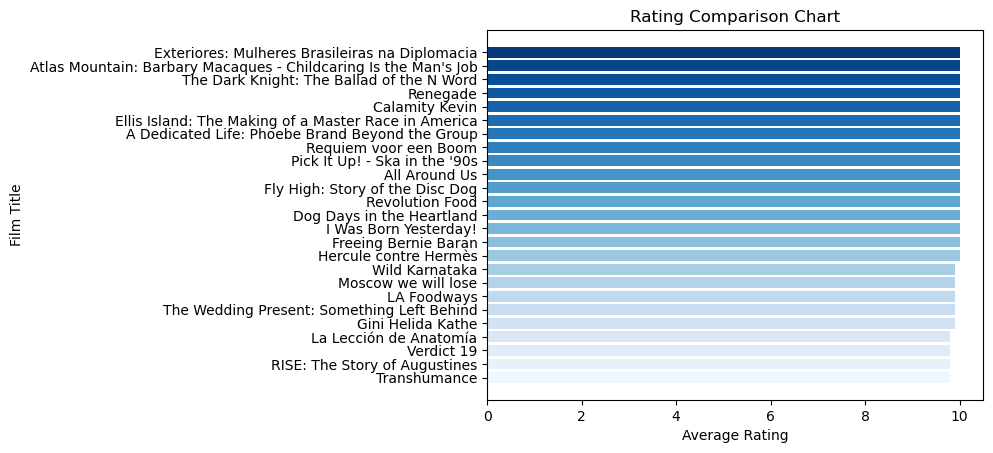

In [12]:
# Sort dataframe by Average Rating in descending order
df = df.sort_values(by='averagerating', ascending=False)

# Select the top 25 rows
df = df.iloc[:25,:]

# Reverse the order of the dataframe
df = df.iloc[::-1]

# Create horizontal bar graph
colors = sns.color_palette("Blues", 25)
plt.barh(df['original_title'], df['averagerating'], color=colors)
plt.ylabel('Film Title')
plt.xlabel('Average Rating')
plt.title("Rating Comparison Chart")
plt.show()


Let's see what these data tells us.

What genre are these movies?

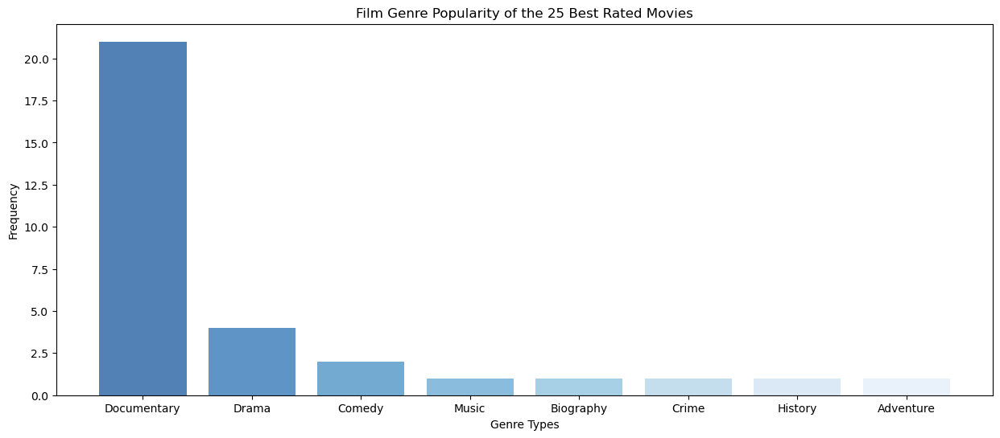

In [13]:
plt.figure(figsize=(15,6))

# Splitting the genres column into separate genres and counting the frequency of each genre
genres = df["genres"].str.split(",").explode()
genres_count = genres.value_counts()

# Setting the color palette to shades of blue, from dark to light
palette = sns.color_palette("Blues_r", len(genres_count)) 

# Plotting the bar graph
plt.bar(genres_count.index, genres_count.values, 
        color=palette, alpha=0.7)
plt.xlabel("Genre Types")
plt.ylabel("Frequency")
plt.title("Film Genre Popularity of the 25 Best Rated Movies")
plt.xticks()
plt.show()


The graph above shows us that documentaries are, beyond the shadow of a doubt, far better rated than other genre of film.   The total is greater than 25 because some movies are categorized under more than one genre.

Another question I would like to ask the the length of each film. Let's create a series of brackets for the runtime length of these movies, in minutes, and see the frequency -- looking at the same top-25 best rated films.

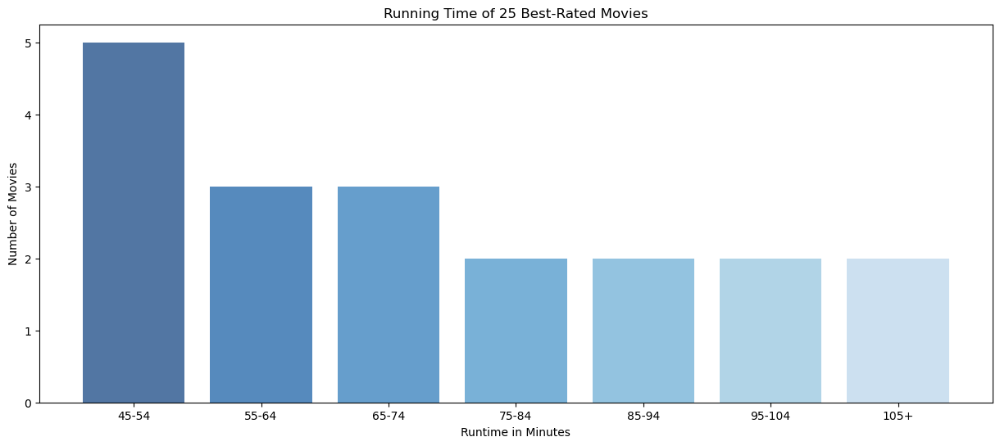

In [14]:
# Now let's look at the length of each film vs its rating:
plt.figure(figsize=(15,6))

# Dividing the runtime into two groups: between 45 and 105 minutes, and outside of that interval
bins = [45, 55, 65, 75, 85, 95, 105, df['runtime_minutes'].max()]
labels = ['45-54', '55-64', '65-74', '75-84', '85-94', '95-104', '105+']
df['runtime_group'] = pd.cut(df['runtime_minutes'], bins=bins, labels=labels)

# Counting the number of movies in each runtime group
group_counts = df['runtime_group'].value_counts()

# Setting the color map to shades of blue, from dark to light
cmap = plt.cm.Blues_r

# Creating the bar plot
plt.bar(group_counts.index, group_counts.values, 
        color=cmap(np.linspace(0.05, 0.7, len(group_counts))), alpha=0.7)
plt.xlabel("Runtime in Minutes")
plt.ylabel("Number of Movies")
plt.title("Running Time of 25 Best-Rated Movies")
plt.show()


What I have shown you, so far, suggests that making documentary films 45 to 54 minutes in length would be my recommentation.  Well, it is. However...

This is not the best option for a profitable investment. The reason for this is that, albeit being highly-rated, these productions count with very few votes.  Meaning, that only a few selected viewers are voting for these films.  Yes, this selected public likes the genre very much.  

This is what we call a "false positive". A single metric measure appears to answer our question, but it does not. 

For now, let's keep that information on the back burner.  

Let's now ask what film genre has most votes.  This will show the much larger public that watches, consumes, and votes for movies.

In [15]:
# Join movie_basics with movie_ratings in order to obtain both, number of votes and average rating data.

query = """
SELECT * 
FROM movie_basics INNER JOIN movie_ratings ON movie_basics.movie_id = movie_ratings.movie_id
ORDER BY numvotes DESC
"""
cursor.execute(query)
result = cursor.fetchall()

# Now we define our data frame columns for what we need

df = pd.DataFrame(result)
df = df.drop(df.columns[1], axis=1)
df.columns = ['movie_id', 'original_title', 'start_year', 'runtime_minutes', 'genres', 'movie_id', 'averagerating', 'numvotes']

# Since "df" is the default data frame identifier, we will call this "df_secondary".  
# Then will sort by 'numvotes', indicating popularity, and 'averagerating', indicating how the public likes the films.

df_secondary = df.copy()
df_secondary = df_secondary.sort_values(['numvotes', 'averagerating'], ascending=[False, False])
df_secondary.head(25)


,movie_id,original_title,start_year,runtime_minutes,genres,movie_id,averagerating,numvotes
0,tt1375666,Inception,2010,148.0,"Action,Adventure,Sci-Fi",tt1375666,8.8,1841066
1,tt1345836,The Dark Knight Rises,2012,164.0,"Action,Thriller",tt1345836,8.4,1387769
2,tt0816692,Interstellar,2014,169.0,"Adventure,Drama,Sci-Fi",tt0816692,8.6,1299334
3,tt1853728,Django Unchained,2012,165.0,"Drama,Western",tt1853728,8.4,1211405
4,tt0848228,The Avengers,2012,143.0,"Action,Adventure,Sci-Fi",tt0848228,8.1,1183655
5,tt0993846,The Wolf of Wall Street,2013,180.0,"Biography,Crime,Drama",tt0993846,8.2,1035358
6,tt1130884,Shutter Island,2010,138.0,"Mystery,Thriller",tt1130884,8.1,1005960
7,tt2015381,Guardians of the Galaxy,2014,121.0,"Action,Adventure,Comedy",tt2015381,8.1,948394
8,tt1431045,Deadpool,2016,108.0,"Action,Adventure,Comedy",tt1431045,8.0,820847
9,tt1392170,The Hunger Games,2012,142.0,"Action,Adventure,Sci-Fi",tt1392170,7.2,795227


Now we have a much different picture of these succesfull motion pictures - pun intended. As common sense would dictate, the masses aren't as culture-driven. They mostly watch something other than documentaries. Let's see what genre are they most prompt to consume:

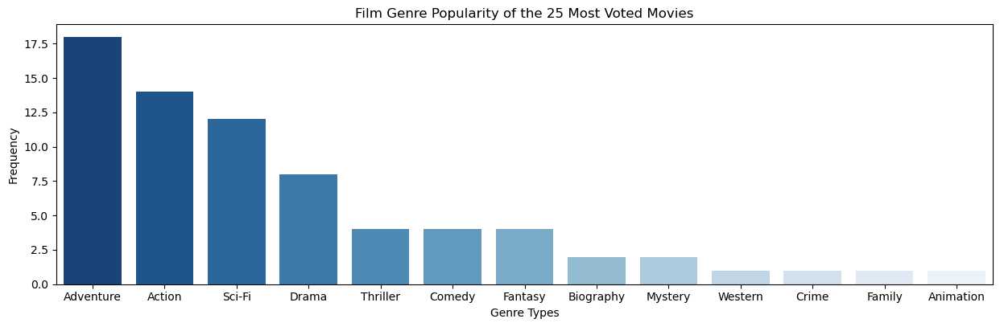

In [16]:
# Sorting df_secondary by numvotes and averagerating
df_secondary = df_secondary.sort_values(by=['numvotes', 'averagerating'], ascending=False)

# Selecting the top 25 rows
top_25 = df_secondary[:25]

# Setting the height and width of the graph
plt.figure(figsize=(15,4.2))

# Splitting the genres column into separate genres and counting the frequency of each genre
genres = top_25["genres"].str.split(",").explode()
genres_count = genres.value_counts()

# Setting the color palette to shades of blue, from dark to light
palette = sns.color_palette("Blues_r", len(genres_count))

# Plotting the bar graph
sns.barplot(x=genres_count.index, y=genres_count.values, palette=palette)
plt.xlabel("Genre Types")
plt.ylabel("Frequency")
plt.title("Film Genre Popularity of the 25 Most Voted Movies")
plt.xticks()
plt.show()


Even though many productions combine two or three types of genre, the winners are clearly Adventure, Action and Sci-Fi films. These are by far the most popular, and certainly the obviously best choice for a profitable investment in the film industry in our day.  

How about the length?  Keep people entertained for a couple hours!

C:\Users\us\AppData\Local\Temp\ipykernel_2140\329015420.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_25['runtime_group'] = pd.cut(top_25['runtime_minutes'], bins=bins, labels=labels)


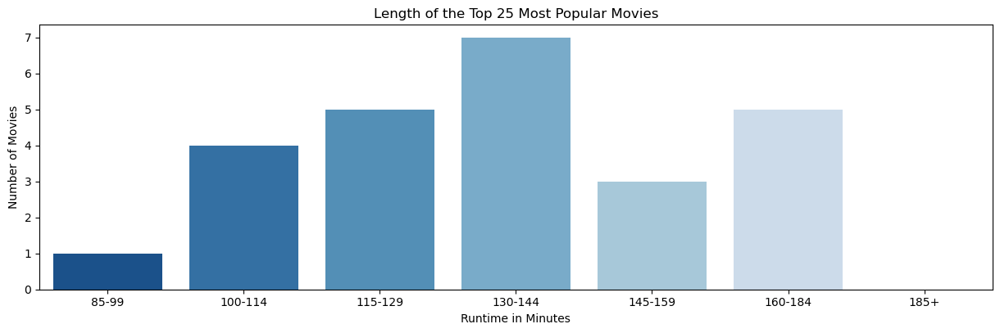

In [23]:
# Setting the height and width of the graph
plt.figure(figsize=(15,4.2))

# Dividing the runtime into 7 groups, between 85 and 185 minutes
bins = [85, 100, 115, 130, 145, 160, 185, top_25['runtime_minutes'].max()]
bins = sorted(list(set(bins)))
labels = ['85-99', '100-114', '115-129', '130-144', '145-159', '160-184', '185+']
top_25['runtime_group'] = pd.cut(top_25['runtime_minutes'], bins=bins, labels=labels)

# Counting the number of movies in each runtime group
group_counts = top_25['runtime_group'].value_counts()

# Sorting the group counts by the order of the labels
group_counts = group_counts.loc[labels]

# Setting the color palette to shades of blue, from dark to light
palette = sns.color_palette("Blues_r", len(group_counts))

# Creating the bar plot
sns.barplot(x=group_counts.index, y=group_counts.values, palette=palette)
plt.xlabel("Runtime in Minutes")
plt.ylabel("Number of Movies")
plt.title("Length of the Top 25 Most Popular Movies")
plt.show()



Let's ask now the most important question your investors will want to know. The bottom line: What type of movies make the most profit? This will be a very important measure to compare and test my assumption.

So lets go for the measures in the right tables:

In [25]:
import pandas as pd
df_3 = pd.read_csv('Data/bom.movie_gross.csv.gz')

df_3.head()

,title,studio,domestic_gross,foreign_gross,year
0,Toy Story 3,BV,415000000.0,652000000,2010
1,Alice in Wonderland (2010),BV,334200000.0,691300000,2010
2,Harry Potter and the Deathly Hallows Part 1,WB,296000000.0,664300000,2010
3,Inception,WB,292600000.0,535700000,2010
4,Shrek Forever After,P/DW,238700000.0,513900000,2010


In [26]:
df_3.shape

(3387, 5)

For the sake of clarity, let's see a total gross profit by adding international and domestic gross profit.

In [27]:

# Convert domestic_gross and foreign_gross columns to numeric format
df_3['domestic_gross'] = pd.to_numeric(df_3['domestic_gross'], errors='coerce')
df_3['foreign_gross'] = pd.to_numeric(df_3['foreign_gross'], errors='coerce')

# Add total_gross column
df_3['total_gross'] = df_3['domestic_gross'] + df_3['foreign_gross']

# Format total_gross column as currency
df_3['total_gross'] = df_3['total_gross'].apply(lambda x: "${:,.2f}".format(x))

# Make sure the film with the greatest total gross revenue appears on top
df_3 = df_3.sort_values(by='total_gross', ascending=True)


df_3.head()


,title,studio,domestic_gross,foreign_gross,year,total_gross
1742,Borgman,Drft.,57500.0,952000.0,2014,"$1,009,500.00"
242,Leaves of Grass,First,70100.0,949000.0,2010,"$1,019,100.00"
730,The Hobbit: An Unexpected Journey,WB (NL),303000000.0,718100000.0,2012,"$1,021,100,000.00"
594,Vanishing on 7th Street,Magn.,22700.0,1000000.0,2011,"$1,022,700.00"
2325,Zootopia,BV,341300000.0,682500000.0,2016,"$1,023,800,000.00"


Now we are talking! Let us now take a look in a graph: what films make the biggest buck 💵💶.

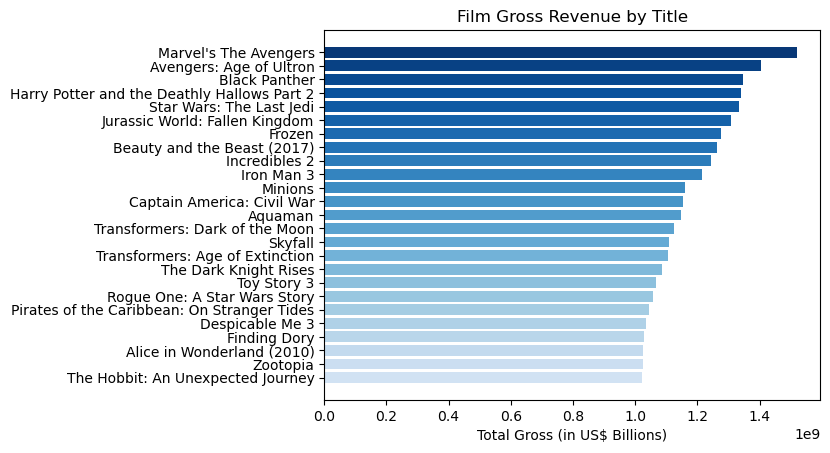

In [28]:
import seaborn as sns
import matplotlib.pyplot as plt

# Reading from here
df_4 = pd.read_csv('Data/bom.movie_gross.csv.gz')

# Convert domestic_gross and foreign_gross columns to numeric format
df_4['domestic_gross'] = pd.to_numeric(df_4['domestic_gross'], errors='coerce')
df_4['foreign_gross'] = pd.to_numeric(df_4['foreign_gross'], errors='coerce')

# Add total_gross column
df_4['total_gross'] = df_4['domestic_gross'] + df_4['foreign_gross']

# Plot the data
colors = sns.color_palette("Blues", 30)[::-1]
df_4 = df_4.sort_values(by='total_gross', ascending=False).head(25)
plt.barh(df_4['title'], df_4['total_gross'], color=colors)
plt.xlabel('Total Gross (in US$ Billions)')
plt.title('Film Gross Revenue by Title')
plt.gca().invert_yaxis()
plt.show()


Of course, our ABCs in basic business force us to ask for the cost. We can't measure the real business success if costs outweight revenue. Se we will now look at movie budget. 

In [29]:
import pandas as pd
df_5 = pd.read_csv('Data/tn.movie_budgets.csv.gz')

df_5.shape

(5782, 6)

In [30]:
df_5.head(25)

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross
0,1,"Dec 18, 2009",Avatar,"$425,000,000","$760,507,625","$2,776,345,279"
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,"$410,600,000","$241,063,875","$1,045,663,875"
2,3,"Jun 7, 2019",Dark Phoenix,"$350,000,000","$42,762,350","$149,762,350"
3,4,"May 1, 2015",Avengers: Age of Ultron,"$330,600,000","$459,005,868","$1,403,013,963"
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,"$317,000,000","$620,181,382","$1,316,721,747"
5,6,"Dec 18, 2015",Star Wars Ep. VII: The Force Awakens,"$306,000,000","$936,662,225","$2,053,311,220"
6,7,"Apr 27, 2018",Avengers: Infinity War,"$300,000,000","$678,815,482","$2,048,134,200"
7,8,"May 24, 2007",Pirates of the Caribbean: At Worldâs End,"$300,000,000","$309,420,425","$963,420,425"
8,9,"Nov 17, 2017",Justice League,"$300,000,000","$229,024,295","$655,945,209"
9,10,"Nov 6, 2015",Spectre,"$300,000,000","$200,074,175","$879,620,923"


Bear with me, please. Now we're talking business. This table alone may provide us with a concrete answer. 
Seems to me that the "Worldwide Gross" includes the Domestic Gross" revenue. If we substract that to Production Budget, we will have an actual revenue figure. Let's do that!

First, some technical preparations that will allow us to get to the bottom of this. I will play with the type of data our financial information columns in the classification of Python programming. We will check the type of data, convert them into the type we can edit, remove the dollar signs and commas

In [31]:
# Checking the column types before doing any math here:
df_5.dtypes

id                    int64
release_date         object
movie                object
production_budget    object
domestic_gross       object
worldwide_gross      object
dtype: object

In [32]:
# Transforming the type to string in order to eliminate dollar signs and commas - a step towards making the math
df_5['domestic_gross'] = df_5['domestic_gross'].astype(str)
df_5['production_budget'] = df_5['production_budget'].astype(str)
df_5['worldwide_gross'] = df_5['worldwide_gross'].astype(str)

In [33]:
# Changing types to do math, but first eliminate the fancy dollar signs and commas. 
df_5['domestic_gross'] = df_5['domestic_gross'].str.replace("$", "")
df_5['domestic_gross'] = df_5['domestic_gross'].str.replace(",", "")
df_5['domestic_gross'] = df_5['domestic_gross'].astype(float)

df_5['production_budget'] = df_5['production_budget'].str.replace("$", "")
df_5['production_budget'] = df_5['production_budget'].str.replace(",", "")
df_5['production_budget'] = df_5['production_budget'].astype(float)


df_5['worldwide_gross'] = df_5['worldwide_gross'].str.replace("$", "")
df_5['worldwide_gross'] = df_5['worldwide_gross'].str.replace(",", "")
df_5['worldwide_gross'] = df_5['worldwide_gross'].astype(float)

# This gives us a warning, but still works

C:\Users\us\AppData\Local\Temp\ipykernel_2140\404604489.py:2: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df_5['domestic_gross'] = df_5['domestic_gross'].str.replace("$", "")
C:\Users\us\AppData\Local\Temp\ipykernel_2140\404604489.py:6: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df_5['production_budget'] = df_5['production_budget'].str.replace("$", "")
C:\Users\us\AppData\Local\Temp\ipykernel_2140\404604489.py:11: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  df_5['worldwide_gross'] = df_5['worldwide_gross'].str.rep

In [34]:
# Checking the column types again to see if we succesfully changed them:
df_5.dtypes

id                     int64
release_date          object
movie                 object
production_budget    float64
domestic_gross       float64
worldwide_gross      float64
dtype: object

In [35]:
# Now let's look at our modifed table
df_5.head(25)

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross
0,1,"Dec 18, 2009",Avatar,425000000.0,760507625.0,2.776345e+09
1,2,"May 20, 2011",Pirates of the Caribbean: On Stranger Tides,410600000.0,241063875.0,1.045664e+09
2,3,"Jun 7, 2019",Dark Phoenix,350000000.0,42762350.0,1.497624e+08
3,4,"May 1, 2015",Avengers: Age of Ultron,330600000.0,459005868.0,1.403014e+09
4,5,"Dec 15, 2017",Star Wars Ep. VIII: The Last Jedi,317000000.0,620181382.0,1.316722e+09
5,6,"Dec 18, 2015",Star Wars Ep. VII: The Force Awakens,306000000.0,936662225.0,2.053311e+09
6,7,"Apr 27, 2018",Avengers: Infinity War,300000000.0,678815482.0,2.048134e+09
7,8,"May 24, 2007",Pirates of the Caribbean: At Worldâs End,300000000.0,309420425.0,9.634204e+08
8,9,"Nov 17, 2017",Justice League,300000000.0,229024295.0,6.559452e+08
9,10,"Nov 6, 2015",Spectre,300000000.0,200074175.0,8.796209e+08


Now let's subtract Production Budget from Worldwide Gross - assuming that the latter already includes the Domestic Gross amount we will call that "Actual Revenue" - meaning, Net Profit.

In [36]:
# Now let's subtract Production Budget from Worldwide Gross - 
# assuming that the latter already includes the Domestic Gross amount
# we will call that "Actual Revenue"

df_5['actual_revenue'] = df_5['worldwide_gross'] - df_5['production_budget']

#and organize our dataframe according to this new column
df_5.sort_values(by='actual_revenue', ascending=False, inplace=True)

df_5.head()

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,actual_revenue
0,1,"Dec 18, 2009",Avatar,425000000.0,760507625.0,2.776345e+09,2.351345e+09
42,43,"Dec 19, 1997",Titanic,200000000.0,659363944.0,2.208208e+09,2.008208e+09
6,7,"Apr 27, 2018",Avengers: Infinity War,300000000.0,678815482.0,2.048134e+09,1.748134e+09
5,6,"Dec 18, 2015",Star Wars Ep. VII: The Force Awakens,306000000.0,936662225.0,2.053311e+09,1.747311e+09
33,34,"Jun 12, 2015",Jurassic World,215000000.0,652270625.0,1.648855e+09,1.433855e+09


Worth the effort! We have concrete figures now on the actual winning money-making films in the industry.  Let's graph our results!

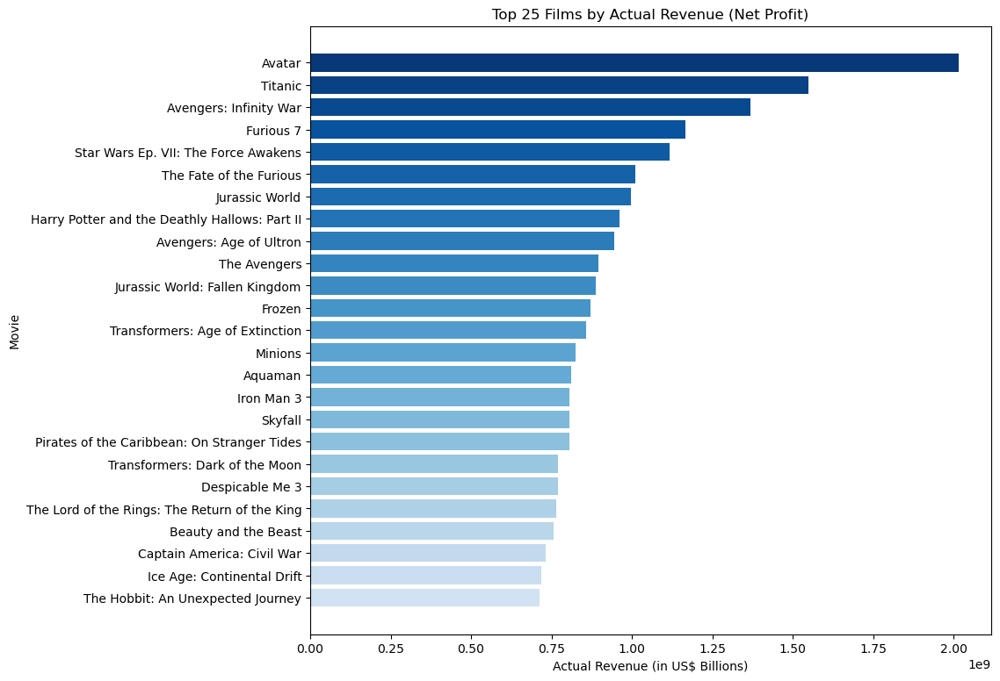

In [37]:
# Our Actual Revenue calculation
df_5['actual_revenue'] = df_5['worldwide_gross'] - df_5['domestic_gross']
df_5 = df_5.nlargest(25, 'actual_revenue')

# Plotting the data

# Color palette in shades of blue, darker first
colors = sns.color_palette("Blues", 30)[::-1]

# Graph Size
plt.figure(figsize=(10, 9))

# Graph Axis, enter colors in place, lable axis
plt.barh(df_5['movie'], df_5['actual_revenue'], color=colors)
plt.xlabel('Actual Revenue (in US$ Billions)')
plt.ylabel('Movie')

# Place title, place biggest actual revenue film first
plt.title('Top 25 Films by Actual Revenue (Net Profit)')
plt.gca().invert_yaxis()

# Render graph
plt.show()

Now we may beging asking the key questions.  We have the information in the sources above.  What genre are these high net-profit movies?

In [38]:
df_5.head()

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,actual_revenue
0,1,"Dec 18, 2009",Avatar,425000000.0,760507625.0,2.776345e+09,2.015838e+09
42,43,"Dec 19, 1997",Titanic,200000000.0,659363944.0,2.208208e+09,1.548844e+09
6,7,"Apr 27, 2018",Avengers: Infinity War,300000000.0,678815482.0,2.048134e+09,1.369319e+09
66,67,"Apr 3, 2015",Furious 7,190000000.0,353007020.0,1.518723e+09,1.165716e+09
5,6,"Dec 18, 2015",Star Wars Ep. VII: The Force Awakens,306000000.0,936662225.0,2.053311e+09,1.116649e+09


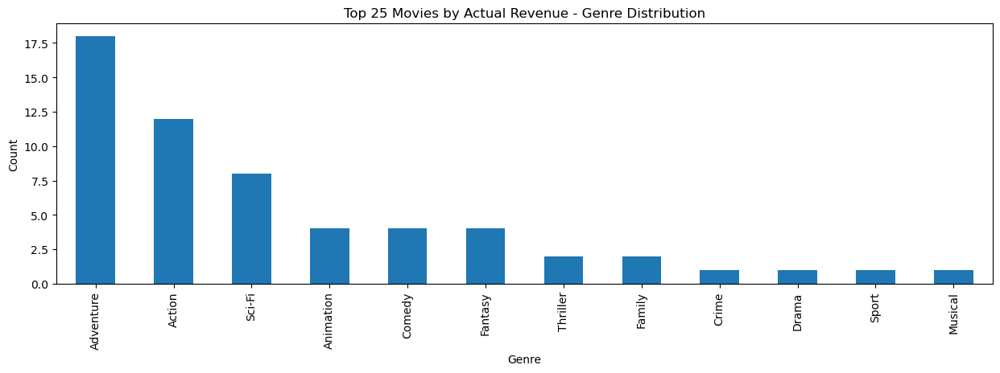

In [39]:
# Setting the height and width of the graph
plt.figure(figsize=(15,4.2))

# merge the two dataframes on the movie column in df_5 and original_title column in df
df_merged = pd.merge(df_5.sort_values("actual_revenue", ascending=False).head(25), df, left_on="movie", right_on="original_title")

# count the number of occurrences of each genre in the merged dataframe
genre_counts = df_merged["genres"].str.split(",").explode().value_counts()

# plot the genre count in a bar graph
genre_counts.plot(kind="bar", xlabel="Genre", ylabel="Count", title="Top 25 Movies by Actual Revenue - Genre Distribution")
plt.xticks();


Now we see as clear as daylight that Adventure and Action movies are the winning bet. Sci-Fi comes in an honorable third place. Perhaps a combo of the three would be the best for good returns. 

I would even venture to say that a movie like 'Titanic', classified as a Romance and a Drama, actually made the big bucks because of the Adventure element in it. But that is my opinion.  The Data shows that, clearly, Adventure and Action films present the best ROI.

This independent research data only corroborates what we already saw above.

What else? Of course, let's look at the running time.

In [40]:
average_runtime = df_merged['runtime_minutes'].mean()
print("Average runtime: ", average_runtime)


Average runtime:  130.0


We have learned that the average runtime in minutes for our merged dataframe gathering the best net revenue popular films, worldwide, is 130 minutes.  Let's now create a dataframe to gather the runtime in minutes for these latest list of movies.  Then, let's explore the list:

In [61]:
# Merge df_5 and df_merged on movie_id column
df_7 = pd.merge(df_5, df_merged[['id', 'runtime_minutes']], on='id')

# Sort df_7 by actual_revenue column in descending order
df_7 = df_7.sort_values(by='actual_revenue', ascending=False)
df_7

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,actual_revenue,runtime_minutes
0,43,"Dec 19, 1997",Titanic,200000000.0,659363944.0,2.208208e+09,1.548844e+09,NaN
1,7,"Apr 27, 2018",Avengers: Infinity War,300000000.0,678815482.0,2.048134e+09,1.369319e+09,149.0
2,23,"Apr 14, 2017",The Fate of the Furious,250000000.0,225764765.0,1.234846e+09,1.009082e+09,136.0
3,34,"Jun 12, 2015",Jurassic World,215000000.0,652270625.0,1.648855e+09,9.965842e+08,124.0
4,4,"May 1, 2015",Avengers: Age of Ultron,330600000.0,459005868.0,1.403014e+09,9.440081e+08,141.0
5,27,"May 4, 2012",The Avengers,225000000.0,623279547.0,1.517936e+09,8.946564e+08,143.0
6,13,"Jun 22, 2018",Jurassic World: Fallen Kingdom,170000000.0,417719760.0,1.305773e+09,8.880530e+08,128.0
7,56,"Nov 22, 2013",Frozen,150000000.0,400738009.0,1.272470e+09,8.717319e+08,102.0
8,56,"Nov 22, 2013",Frozen,150000000.0,400738009.0,1.272470e+09,8.717319e+08,93.0
9,37,"Jun 27, 2014",Transformers: Age of Extinction,210000000.0,245439076.0,1.104039e+09,8.586000e+08,165.0


Titanic our most popular, net revenue producing film, is missing the runtime information. I happen to know that number should be 195, and have verified so with wikipedia (outside of our provided databases). I will take the freedom to correct that information manually, to then proceed with our graph.

In [72]:
df_7.loc[df_7['id'] == 43, 'runtime_minutes'] = 195.0

I also noticed that our champion film, Avatar, is missing from some reason.  Let's bring it back!

In [73]:
# Select the row with id "1" from df_5
row_to_add = df_5.loc[df_5['id'] == 1]

# Check if a row with the same id already exists in df_7
if not any(df_7['id'] == 1):
    # Append the selected row to df_7
    df_7 = df_7.append(row_to_add)

C:\Users\us\AppData\Local\Temp\ipykernel_2140\810279462.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_7 = df_7.append(row_to_add)


In [77]:
# Select the row with id "1" from df_5
row_to_add = df_5.loc[df_5['id'] == 43]

# Check if a row with the same id already exists in df_7
if not any(df_7['id'] == 43):
    # Append the selected row to df_7
    df_7 = df_7.append(row_to_add)

C:\Users\us\AppData\Local\Temp\ipykernel_2140\1233186771.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df_7 = df_7.append(row_to_add)


I am amending a defect in our database, adding the necessaary information on the runtime length of the top two films, Avatar and Titanic.

In [79]:
df_7.loc[df_7['id'] == 43, 'runtime_minutes'] = 195.0

In [81]:
df_7.loc[df_7['id'] == 1, 'runtime_minutes'] = 162.0

In [82]:
# Checking that the missing data has been corrected:
df_7

,id,release_date,movie,production_budget,domestic_gross,worldwide_gross,actual_revenue,runtime_minutes
1,7,"Apr 27, 2018",Avengers: Infinity War,300000000.0,678815482.0,2.048134e+09,1.369319e+09,149.0
2,23,"Apr 14, 2017",The Fate of the Furious,250000000.0,225764765.0,1.234846e+09,1.009082e+09,136.0
3,34,"Jun 12, 2015",Jurassic World,215000000.0,652270625.0,1.648855e+09,9.965842e+08,124.0
4,4,"May 1, 2015",Avengers: Age of Ultron,330600000.0,459005868.0,1.403014e+09,9.440081e+08,141.0
5,27,"May 4, 2012",The Avengers,225000000.0,623279547.0,1.517936e+09,8.946564e+08,143.0
6,13,"Jun 22, 2018",Jurassic World: Fallen Kingdom,170000000.0,417719760.0,1.305773e+09,8.880530e+08,128.0
7,56,"Nov 22, 2013",Frozen,150000000.0,400738009.0,1.272470e+09,8.717319e+08,102.0
8,56,"Nov 22, 2013",Frozen,150000000.0,400738009.0,1.272470e+09,8.717319e+08,93.0
9,37,"Jun 27, 2014",Transformers: Age of Extinction,210000000.0,245439076.0,1.104039e+09,8.586000e+08,165.0
10,73,"Jul 10, 2015",Minions,74000000.0,336045770.0,1.160336e+09,8.242904e+08,91.0


Finally we have our data in place. Let's graph it:

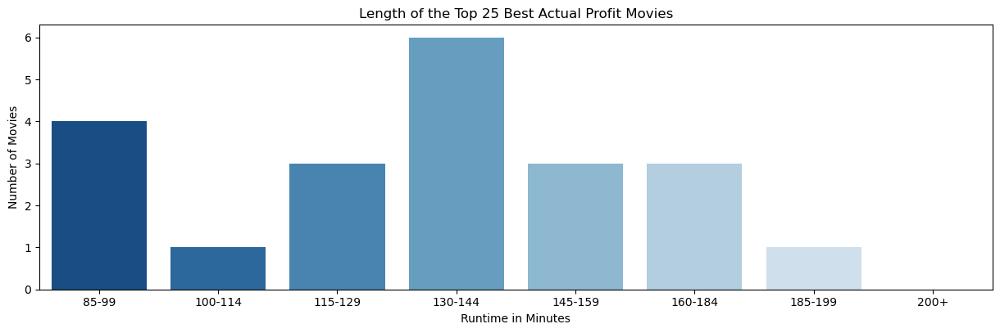

In [92]:
# Setting the height and width of the graph
plt.figure(figsize=(15,4.2))

# Dividing the runtime into 8 groups, between 85 and 200 minutes
bins = [85, 100, 115, 130, 145, 160, 185, 200, df_7['runtime_minutes'].max()]
bins = sorted(list(set(bins)))
labels = ['85-99', '100-114', '115-129', '130-144', '145-159', '160-184', '185-199', '200+']
df_7['runtime_group'] = pd.cut(df_7['runtime_minutes'], bins=bins, labels=labels)

# Counting the number of movies in each runtime group
group_counts = df_7['runtime_group'].value_counts()

# Sorting the group counts by the order of the labels
group_counts = group_counts.loc[labels]

# Setting the color palette to shades of blue, from dark to light
palette = sns.color_palette("Blues_r", len(group_counts))

# Creating the bar plot
sns.barplot(x=group_counts.index, y=group_counts.values, palette=palette)
plt.xlabel("Runtime in Minutes")
plt.ylabel("Number of Movies")
plt.title("Length of the Top 25 Best Actual Profit Movies")
plt.show()

As consistent with the previous analysis, 130 to 144 minutes length is the appropriate runtime for a successful film. True, there is a preference for shorter film (see the dark blue bar on the left). Keep that in mind for the secondary recommendation. But also notice that the single film on the 185 to 199 minute bar, Titanic, is also the most succesful in terms of profit, and one of the best in terms of popularity.   

The data suggests, thus, that 130 minutes is the most likely to produce profitable results, as well as being a successfully popular film.

# Conclusion

I understand the importance of presenting a well-rounded perspective to the Microsoft Board of Directors and ultimately, to Mr. Gates. As a visionary leader and philanthropist, he not only cares about the financial success of our company, but also his legacy and how he can benefit humanity through our endeavors.

With that in mind, I strongly recommend that we focus on producing Adventure, Action, and Sci-Fi movies. These genres have proven to be highly profitable in the film industry and offer a high potential for commercial success. By competing with the major players in Hollywood, we can establish Microsoft as a significant player in the film industry and achieve the financial goals we have set.

However, my early recommendation is that we not only focus on profitability, but also consider how we can use this opportunity to make a positive impact on society and align with Mr. Gates' mission of benefiting humanity. By exploring themes and storylines that raise awareness and drive positive change, we can create films that are both financially successful and leave a lasting impact on the world.

# Recomentations

Let Microsoft produce movies averaging two hours and ten minutes in length on the genres of Adventure, Action, and Sci-Fi.  May be a combination of two or all three genres. One hundred and thirty minutes in length. 

I recommend that, once this show profitability, let Microsoft also produce shorter documentary films.  

As for the length of a documentary, 45 to 54 minutes in length looks like a winner. Shorter film also was shown to be of weight in our last graphic (gravitating towards 85 minutes).  Hence, if our documentary has continuosly caught the public's attention, it may extend beyond an hour for up to 25 minutes.  

This latter  recommendation is for the good name of Microsoft, once financial success has been achieved in this new venture in the film industry.

# Next Steps

It is time to start gathering the team to sketch the story line and the script for Microsoft Film's first Adventure and Action film production. 